In [141]:
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import torch
import os
from PIL import Image, ImageDraw
from sklearn.metrics import accuracy_score
import numpy as np
import torchvision.transforms as transforms
import matplotlib as plt
from tqdm import tqdm
from collections import Counter, defaultdict
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Patch
from torchvision.transforms.functional import to_pil_image
from torchvision.ops import nms
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import csv
import torchvision.transforms.functional as F
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import fasterrcnn_mobilenet_v3_large_fpn, FasterRCNN_MobileNet_V3_Large_FPN_Weights
from torchvision.models import MobileNet_V3_Large_Weights
from torchvision.ops import box_iou
from torchmetrics.detection.mean_ap import MeanAveragePrecision

In [2]:
def load_data(images_dir, labels_dir):
    """
    Loads data from annotations and returns a list of dictionaries 
    with image metadata and bounding box annotations.

    Args:
        images_dir (str): Path to the directory containing image files.
        labels_dir (str): Path to the directory containing label id and bounding box annotations (separate file)

    Returns:
        list: A list of dictionaries, each containing image metadata and bounding box annotations in Pascal VOC format.
    """
    all_data = []  # storing all data here
    
    # iterate over all image files in the directory
    image_files = []
    for image in os.listdir(images_dir):
        image_files.append(image)
    
    for image_file in image_files:
        image_path = os.path.join(images_dir, image_file)
        label_path = os.path.join(labels_dir, os.path.splitext(image_file)[0] + '.txt') # splitting the filename and attaching txt file extension

        with Image.open(image_path) as img:
            image_width, image_height = img.size
        
        annotations = []
        
        with open(label_path, 'r') as file:
            for line in file.readlines():
                data = line.strip().split()
                if len(data) == 5:
                    class_id = int(data[0])
                    center_x = float(data[1]) # upper left x
                    center_y = float(data[2]) # upper lext y
                    box_width = float(data[3]) # lower right x
                    box_height = float(data[4]) # lower right y

                    # setting bounding box coordinates into pixel values
                    x1 = float((center_x - box_width / 2) * image_width) #results in Pascal VOC
                    y1 = float((center_y - box_height / 2) * image_height)
                    x2 = float((center_x + box_width / 2) * image_width)
                    y2 = float((center_y + box_height / 2) * image_height)

                    if 0 <= x1 < x2 <= image_width and 0 <= y1 < y2 <= image_height:
                        annotations.append({
                            "x1": x1,
                            "y1": y1,
                            "x2": x2,
                            "y2": y2,
                            "class_id": class_id
                        })

    
        # appending to list
        if annotations:
            all_data.append({
                "image_path": image_path,
                "image_width": image_width,
                "image_height": image_height,
                "annotations": annotations
            })

    return all_data



In [4]:
image_data_train = load_data("./turkish_traffic_sign_data/images/train","./turkish_traffic_sign_data/labels/train")
image_data_test = load_data("./turkish_traffic_sign_data/images/val","./turkish_traffic_sign_data/labels/val")


In [5]:
#Checking the labels and the images here:
labels = []
for image in image_data_train:
    for bounding_box in image['annotations']:
        labels.append(bounding_box['class_id'])

# just checking label imbalance:
label_imbalance_dict = {}
for label in labels:
    if label not in label_imbalance_dict:
        label_imbalance_dict[label] = 1  
    else:
        label_imbalance_dict[label] += 1  

#print(label_imbalance_dict)
    
labels = list(set(labels))
#print(labels)


labels = []
for image in image_data_test:
    for bounding_box in image['annotations']:
        labels.append(bounding_box['class_id'])

# just checking label imbalance:
label_imbalance_dict = {}
for label in labels:
    if label not in label_imbalance_dict:
        label_imbalance_dict[label] = 1  
    else:
        label_imbalance_dict[label] += 1  

#print(label_imbalance_dict)
    
labels = list(set(labels))
#print(labels)

In [6]:
#shifting the labels by +1 due to the special label 0 the model has reseved for background
labeltoidmapping_dict = {}

for i, label in enumerate(labels):
    labeltoidmapping_dict[label] = i+1

#print(labeltoidmapping_dict)

idtolabelmapping_dict = {1: 'Speed limit 20km/h', #checked
                        2: 'Speed limit 30 km/h', #checked
                        3: 'Stop sign', #checked
                        4: 'Bus stop', #checked
                        5: 'No entry', #checked
                        6: 'Continue straight or turn right', #checked
                        7: 'Continue straight or turn left', #checked
                        8: 'Red light', #checked
                        9: 'Parking lot', #checked
                        10: 'No parking', #checked
                        11: 'Right turn', #checked
                        12: 'No right turn', #checked
                        13: 'Yellow light' #checked,
                        14: 'Left turn', #checked
                        15: 'No left turn', #checked
                        16: 'Green light' #checked}

In [94]:
def create_data_list(data):
    """
    Creates a list holding image instances as dictionaries.
    Keys: 'filename', 'bboxes' and 'labels'.
    """
    image_classification_data = []
    
    for image in data:
        annotations = image['annotations']  # image annotations
        base_filename = os.path.basename(image['image_path'])  # filename
    
        image_entry = {
            'filename': base_filename,
            'bboxes': [],
            'labels': []
        }
    
        for annotation in annotations:
            # extracting the bounding box
            bbox = [annotation['x1'], annotation['y1'], annotation['x2'], annotation['y2']]
    
            class_id = annotation['class_id']  # original label
            mapped_label = labeltoidmapping_dict[class_id] #mapping with +1
    
            # appending the annotations
            image_entry['bboxes'].append(bbox)
            image_entry['labels'].append(mapped_label)
    
        image_classification_data.append(image_entry)
    return image_classification_data

    

In [96]:
image_classification_data_train = create_data_list(image_data_train)
image_classification_data_test = create_data_list(image_data_test)

print("Train Data:", image_classification_data_train[200])
print("Test Data:", image_classification_data_test[70])
print(len(image_classification_data_train))
print(len(image_classification_data_test))

Train Data: {'filename': '20_321.jpg', 'bboxes': [[16.640000000000008, 19.799999999999997, 108.79999999999998, 155.88]], 'labels': [1]}
Test Data: {'filename': '30_12.jpg', 'bboxes': [[194.6035, 129.60000000000002, 323.9145, 270.72]], 'labels': [2]}
12790
3198


In [97]:
def check_bounding_boxes(image_path, boxes):
    """
    Plots the bounding boxes on the image.
    """
    image = Image.open(image_path).convert("RGB")
    print(f"image size: {image.size}")
    for x1, y1, x2, y2 in boxes:
        draw = ImageDraw.Draw(image)
        draw.rectangle([x1, y1, x2, y2], outline="red", width=1)
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.title(f"Image with Bounding Box")
        plt.axis('on')
        plt.show(block=True)


image size: (1280, 720)

Processing box 15: coordinates [651.52, 275.76, 692.48, 388.08000000000004]


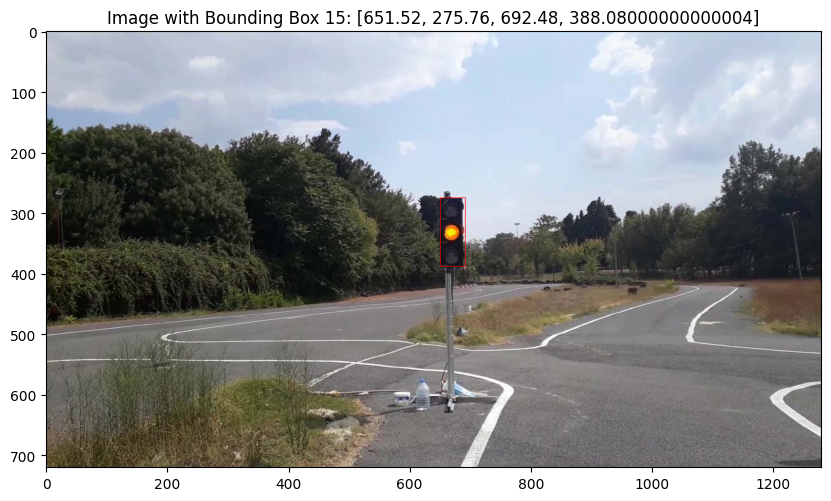

In [98]:
check_bounding_boxes("./turkish_traffic_sign_data/images/train/sari_34.jpg",[[651.52, 275.76, 692.48, 388.08000000000004]])

In [104]:
# SPLITTING THE DATA
img_clas_train_data = image_classification_data_train
img_clas_test_data = image_classification_data_test

print(len(img_clas_train_data))
print(len(img_clas_test_data))

12790
3198


In [101]:
class TrafficSignDataset(Dataset):
    def __init__(self, image_dir, image_data_list, transforms=None):
        """
        args:
            image_dir (str): directory where the images are stored.
            image_data_list (list): List of dictionaries with image metadata. Each entry contains: 'filename': Image filename, 'bboxes': List of bounding boxes and 'labels': List of corresponding labels.
            transforms : Transformations to be applied on the image!!
        """
        self.image_dir = image_dir
        self.transforms = transforms
        self.image_paths = []
        self.bboxes = []
        self.labels = []

        # loading data
        for entry in image_data_list:
            image_path = os.path.join(image_dir, entry['filename'])
            self.image_paths.append(image_path)
            self.bboxes.append(entry['bboxes'])  # list of bounding boxes
            self.labels.append(entry['labels'])  # list of labels

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        """
        gets a single image and its annotations.
        """
        
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")

        
        bboxes = self.bboxes[idx]  # list of bounding boxes
        labels = self.labels[idx]  # list of labels

        # converting to tensor type required by the model
        boxes = torch.tensor(bboxes, dtype=torch.float32)  
        labels = torch.tensor(labels, dtype=torch.int64)  

        target = {
            "boxes": boxes,
            "labels": labels
        }

        # applying transformations
        if self.transforms:
            image = self.transforms(image)

        return image, target
  



In [102]:
# transforming the image into a tensor
# TO DO : image augmentation possibly? options: RandomResizedCrop, Resize, Colorjitter, RandomRotation??

img_transforms = transforms.Compose([          
    transforms.ToTensor()
])

In [105]:
# initializing the datasets
image_dir_train = "turkish_traffic_sign_data/images/train"
image_dir_test = "turkish_traffic_sign_data/images/val"

img_clas_train_dataset = TrafficSignDataset(image_dir_train, img_clas_train_data, transforms=img_transforms)
img_clas_test_dataset = TrafficSignDataset(image_dir_test, img_clas_test_data, transforms=img_transforms)
single_image,single_target = img_clas_train_dataset[2976]
print(single_image,single_target)



tensor([[[0.2667, 0.2667, 0.2706,  ..., 0.3529, 0.3529, 0.3569],
         [0.2706, 0.2706, 0.2706,  ..., 0.3529, 0.3529, 0.3529],
         [0.2706, 0.2667, 0.2667,  ..., 0.3529, 0.3529, 0.3529],
         ...,
         [0.6078, 0.7882, 0.8314,  ..., 0.4784, 0.4745, 0.5412],
         [0.4667, 0.7255, 0.7216,  ..., 0.4510, 0.4706, 0.4667],
         [0.7098, 0.6510, 0.6275,  ..., 0.4471, 0.4510, 0.4627]],

        [[0.3725, 0.3725, 0.3765,  ..., 0.4941, 0.4941, 0.4980],
         [0.3765, 0.3765, 0.3765,  ..., 0.4941, 0.4941, 0.4941],
         [0.3765, 0.3725, 0.3725,  ..., 0.4941, 0.4941, 0.4941],
         ...,
         [0.4706, 0.6588, 0.7137,  ..., 0.4314, 0.4157, 0.4824],
         [0.3255, 0.5961, 0.6039,  ..., 0.4235, 0.4431, 0.4392],
         [0.5686, 0.5176, 0.5059,  ..., 0.4314, 0.4353, 0.4510]],

        [[0.6745, 0.6745, 0.6784,  ..., 0.8000, 0.8000, 0.8039],
         [0.6784, 0.6784, 0.6784,  ..., 0.8000, 0.8000, 0.8000],
         [0.6784, 0.6745, 0.6745,  ..., 0.8000, 0.8000, 0.

In [106]:
def collate_fn(batch):
    images, targets = zip(*batch)       
    return images, targets

In [133]:
# initializing the dataloaders
train_dataloader = DataLoader(img_clas_train_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn)
test_dataloader = DataLoader(img_clas_test_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn)

In [108]:
for images, labels in train_dataloader:
    for image in images:
        print(image.shape)
    for label in labels:
        print(label)
    break

torch.Size([3, 741, 1111])
torch.Size([3, 720, 1280])
torch.Size([3, 720, 1280])
torch.Size([3, 720, 1280])
{'boxes': tensor([[858.8030, 298.2525, 909.9090, 364.2015],
        [235.5320, 266.3895, 251.0860, 304.1805],
        [117.2105, 372.3525, 131.6535, 404.2155],
        [575.4980, 382.7265, 591.0520, 408.6615],
        [375.5180, 373.4640, 386.6280, 400.1400]]), 'labels': tensor([12, 16, 16,  3, 16])}
{'boxes': tensor([[174.0800,  70.9200, 238.0800, 132.1200]]), 'labels': tensor([7])}
{'boxes': tensor([[ 947.2000,  102.9600, 1000.9600,  159.1200]]), 'labels': tensor([12])}
{'boxes': tensor([[545.9200, 162.0000, 583.0400, 198.0000],
        [835.2000, 167.4000, 869.7600, 201.2400]]), 'labels': tensor([15, 12])}


In [110]:
# initializing our model with pre-trained weights:
model = fasterrcnn_mobilenet_v3_large_fpn(weights=FasterRCNN_MobileNet_V3_Large_FPN_Weights.DEFAULT,box_fg_iou_thresh=0.6)                                          
device = torch.device("cuda:3") if torch.cuda.is_available() else torch.device("cpu")
print(device)
model.to(device) # sending model to device

cuda:3


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block):

In [112]:
# number of classes in Turkish traffic sign dataset (16 + 1 for the background class)
num_classes = 17  

# getting the input features of the box predictor
in_features = model.roi_heads.box_predictor.cls_score.in_features

# replacing the final head with our own, to match our number of classes
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes).to(device)

params = [p for p in model.parameters() if p.requires_grad]

# optimizer
optimizer = torch.optim.SGD(params, lr=0.002, momentum=0.9, weight_decay=0.0005)

# testing a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

# saving models here:
save_dir = "final-turkish-traffic-sign-object-detection-modeldir"
os.makedirs(save_dir, exist_ok=True)

In [ ]:
# training:
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    loss_components = defaultdict(float)  # this will hold the different losses (regression for bbox and cross entropy for classification)
    
    tqdm_bar = tqdm(train_dataloader, total=len(train_dataloader), desc=f"Epoch {epoch + 1}")
    
    for idx, batch in enumerate(tqdm_bar):
        images, targets = batch
        
        # sending data to device
        images2 = [image.to(device) for image in images]
        targets2 = [{k: v.to(device) for k, v in t.items()} for t in targets]
        
        # sending data through model
        loss_dict = model(images2, targets2)
        losses = sum(loss for loss in loss_dict.values())
        
        # adding losses to loss_components
        for key, value in loss_dict.items():
            loss_components[key] += value.item()
    
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        
        running_loss += losses.item()
        
        # printing predictions, will print a loooooot
        model.eval()
        with torch.no_grad():
            predictions = model(images2) 
            print("this is predictions", predictions)
            print("this is targets", targets2)
            
            model.train()

        tqdm_bar.set_postfix(loss=losses.item())
    
    # learning rate scheduler step
    lr_scheduler.step()
    epoch_loss = running_loss / len(train_dataloader)
    
    # printing metrics
    print(f"Epoch {epoch + 1} Summary:")
    print(f"  Total Loss: {epoch_loss:.4f}")
    print(f"  Classification Loss: {loss_components['loss_classifier'] / len(train_dataloader):.4f}")
    print(f"  Bounding Box Loss: {loss_components['loss_box_reg'] / len(train_dataloader):.4f}")
    
    # saving the model:
    save_path = os.path.join(save_dir, f"final-turkish-traffic-sign-object-detection-model-fasterrcnn_epoch_{epoch + 1}.pth")
    torch.save(model.state_dict(), save_path)
    print(f"Model saved to {save_path}")



Epoch 1:   0%|                                                                                                                                                     | 1/3198 [00:01<1:09:03,  1.30s/it, loss=3.33]

this is predictions [{'boxes': tensor([[ 903.9741,  142.1921, 1142.6722,  191.0454],
        [ 162.9274,  485.8865,  188.9986,  521.5305],
        [ 948.1044,  520.8064,  968.6173,  565.8522],
        [ 841.8267,  440.0805,  857.1987,  464.8034],
        [ 843.7115,  436.0441,  875.9196,  475.4958],
        [ 742.0419,  319.0211,  763.1617,  348.8526],
        [ 223.6600,  169.4635,  451.4900,  371.0905],
        [ 773.9747,  244.9258,  827.2688,  288.9418],
        [1191.4800,  724.6346, 1350.1725,  773.7644],
        [ 578.1410,  306.1709,  683.8066,  380.8180],
        [ 962.4292,  532.6890,  990.5065,  570.4002],
        [ 739.5646,  318.0391,  752.3724,  344.9207],
        [ 937.8326,  519.4028,  982.4199,  570.2169],
        [ 570.2088,  308.0750,  700.1209,  380.5161],
        [1309.8391,  228.0981, 1407.0000,  399.2695],
        [ 166.6596,  475.9580,  193.6209,  507.8298],
        [ 539.4975,  233.5342,  546.3603,  241.4326],
        [ 954.8520,  520.9637,  977.8989,  566.3442

Epoch 1:   0%|                                                                                                                                                       | 2/3198 [00:01<42:36,  1.25it/s, loss=2.82]

this is predictions [{'boxes': tensor([[ 18.7876, 131.4871, 228.3584, 221.2485],
        [394.2236, 214.2695, 407.4797, 223.0406],
        [750.7434, 201.9099, 837.0898, 234.9498],
        [346.0283, 212.7500, 453.9592, 233.8333],
        [393.2343, 217.8406, 407.2173, 227.3463],
        [392.3513, 214.3347, 467.1017, 236.9283],
        [469.7014, 200.6678, 493.9837, 255.6869],
        [360.3234, 214.3814, 369.8138, 222.4229],
        [172.7263, 127.4312, 193.0077, 139.2277],
        [448.5715, 221.7500, 461.1702, 236.9178],
        [360.6384, 215.7999, 371.1314, 226.0403],
        [358.7271, 216.0139, 367.4111, 224.2709],
        [332.6257, 213.3196, 348.2174, 220.8000],
        [329.3798, 214.4519, 343.5806, 223.0520],
        [393.6106, 221.4131, 408.0143, 230.1414],
        [446.6966, 217.4073, 458.2860, 231.3330],
        [167.6655, 123.7698, 190.5824, 135.4910],
        [451.3868, 225.0715, 462.4697, 239.4505],
        [758.6244, 206.3835, 772.3834, 221.1781],
        [296.2198, 

Epoch 1:   0%|▏                                                                                                                                                      | 3/3198 [00:02<33:56,  1.57it/s, loss=2.28]

this is predictions [{'boxes': tensor([[ 846.6299,  414.1973, 1117.9183,  550.5289],
        [ 859.9199,  462.7266,  985.2073,  550.3185],
        [ 854.4120,  510.5251,  886.3460,  535.3278],
        [   6.2759,  671.7026,  366.4232,  709.5639],
        [1050.9996,  497.0900, 1137.1388,  682.5673],
        [ 799.3798,  489.3448,  829.9007,  505.1382],
        [ 831.9674,  440.5959,  897.4202,  531.8076],
        [ 830.8682,  406.3528,  903.1676,  482.3700],
        [ 668.4572,  665.3422, 1024.0333,  718.0500],
        [1086.4785,  506.7564, 1140.8079,  582.5770],
        [1082.3030,  485.9480, 1144.0000,  605.0788],
        [ 836.2108,  675.6702,  973.7167,  713.8672],
        [  16.0270,  685.1920,  109.0320,  714.3816],
        [ 817.6314,  344.5638,  838.3854,  360.0968],
        [1004.5930,  350.3098, 1058.9049,  372.6106],
        [ 853.2014,  506.3391,  901.9067,  533.6622],
        [1055.0110,  496.7262, 1135.2272,  687.1916],
        [ 799.3057,  336.0220,  845.1970,  363.8909

Epoch 1:   0%|▏                                                                                                                                                      | 4/3198 [00:02<27:53,  1.91it/s, loss=1.31]

this is predictions [{'boxes': tensor([[  2.8233, 254.9359,  39.4002, 346.9519],
        [561.9634, 346.5203, 601.5720, 386.9053],
        [792.5906, 469.7130, 805.4039, 482.3889],
        [444.2912, 361.4726, 783.0128, 395.3246]], device='cuda:3'), 'labels': tensor([ 8, 14, 10,  8], device='cuda:3'), 'scores': tensor([0.0641, 0.0544, 0.0511, 0.0502], device='cuda:3')}, {'boxes': tensor([[501.0099, 218.3602, 529.2823, 266.5195],
        [509.5681, 227.2445, 524.6693, 263.9498],
        [477.7086, 225.6411, 512.9395, 272.8985],
        [508.5715, 224.9741, 523.5823, 266.2626],
        [464.0882, 227.7739, 521.0189, 271.8369],
        [488.2485, 226.2924, 504.3721, 260.4894],
        [505.2523, 201.6354, 531.6962, 258.9434],
        [487.3099, 221.1414, 504.6470, 261.7372],
        [500.0215, 222.4713, 528.4960, 268.2087],
        [508.2459, 222.8044, 523.8756, 266.2906],
        [471.6334, 216.1237, 510.7532, 254.0095],
        [514.0453, 220.8875, 525.6662, 239.6980],
        [515.0450

Epoch 1:   0%|▏                                                                                                                                                     | 5/3198 [00:02<23:39,  2.25it/s, loss=0.622]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[655.6762, 274.8022, 735.7107, 382.2555],
        [646.5093, 438.8206, 730.5057, 537.8440],
        [661.2825, 295.6976, 724.8959, 437.5853],
        [650.5662, 443.5718, 735.8066, 520.8752],
        [657.4579, 266.5405, 772.3434, 566.8978],
        [656.7682, 433.7339, 734.9364, 520.2084],
        [651.3137, 274.1942, 738.6071, 478.5861],
        [641.2319, 324.7957, 747.9913, 611.2233],
        [655.4673, 443.7629, 725.7388, 511.2416],
        [669.5305, 234.0517, 773.8326, 522.2148],
        [637.7240, 445.6600, 735.7987, 540.3447],
        [670.7245, 261.5640, 770.1210, 533.5706],
        [621.2745, 449.2705, 753.3775, 521.2062],
        [664.1346, 

Epoch 1:   0%|▎                                                                                                                                                     | 6/3198 [00:03<20:49,  2.55it/s, loss=0.288]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.4400, 216.0000, 736.6400, 234.7200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[730.8800, 213.1200, 759.0400, 241.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[186.2400,  93.9600, 233.6000, 145.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 1:   0%|▎                                                                                                                                                     | 7/3198 [00:03<19:31,  2.72it/s, loss=0.274]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.0600, 146.1740, 429.6640, 310.8980]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[112.6400, 122.7600, 156.1600, 173.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[251.6850, 259.0470, 314.7550, 411.3010],
        [187.7225, 106.7930, 335.8775, 256.8950]], device='c

Epoch 1:   0%|▍                                                                                                                                                     | 8/3198 [00:03<18:06,  2.93it/s, loss=0.434]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[947.8400, 172.0800, 979.8400, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[445.4400, 132.8400, 481.2800, 171.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[655.3600, 177.8400, 680.9600, 206.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'

Epoch 1:   0%|▍                                                                                                                                                     | 9/3198 [00:04<17:12,  3.09it/s, loss=0.656]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[661.3770, 275.4000, 759.2590, 453.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[770.4840, 294.8400, 796.7960, 318.6000],
        [678.3920, 331.9200, 694.4080, 344.8800]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3')}, {'boxes': tensor([[537.6000, 171.7200, 563.2000, 199.8000]], devic

Epoch 1:   0%|▍                                                                                                                                                    | 10/3198 [00:04<16:39,  3.19it/s, loss=0.791]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 345.2400, 788.4800, 371.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[665.0220, 147.9600, 734.2260, 217.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[159.3600,   1.0800, 257.9200,  93.9600]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'

Epoch 1:   0%|▌                                                                                                                                                    | 11/3198 [00:04<16:26,  3.23it/s, loss=0.303]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[712.3200, 279.7200, 731.5200, 297.7200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[ 53.7600, 216.0000,  71.6800, 239.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[657.9200, 326.1600, 688.6400, 359.2800],
        [417.2800, 131.7600, 448.0000, 209.5200],
        [65

Epoch 1:   0%|▌                                                                                                                                                     | 12/3198 [00:04<16:15,  3.27it/s, loss=1.38]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[489.5817,  10.9198, 546.0071,  85.9744],
        [488.2697,   1.8660, 543.8940,  62.5590]], device='cuda:3'), 'labels': tensor([ 1, 13], device='cuda:3'), 'scores': tensor([0.0598, 0.0519], device='cuda:3')}]
this is targets [{'boxes': tensor([[842.2400, 185.7600, 875.5200, 218.8800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[597.7600, 338.0400, 623.3600, 364.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[297.4400, 274.6800, 340.9

Epoch 1:   0%|▌                                                                                                                                                    | 13/3198 [00:05<16:20,  3.25it/s, loss=0.246]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[777.6812,  43.0914, 834.8505, 118.9415],
        [777.1787,  36.5676, 835.8326, 118.9660],
        [779.3838,  38.9384, 834.5248, 120.0385],
        [780.5772,  41.6783, 837.3845, 120.7910],
        [777.8734,  36.7447, 836.4412, 117.5544]], device='cuda:3'), 'labels': tensor([ 6, 10, 13,  1, 14], device='cuda:3'), 'scores': tensor([0.0744, 0.0567, 0.0557, 0.0528, 0.0511], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[321.2800,  50.4000, 382.7200, 112.3200]], device='cuda:3'), 'labels': tensor([9

Epoch 1:   0%|▋                                                                                                                                                    | 14/3198 [00:05<16:12,  3.28it/s, loss=0.764]

this is predictions [{'boxes': tensor([[830.7510, 116.0010, 867.6854, 155.1866],
        [828.5033, 106.3974, 862.6263, 148.4865],
        [825.5668, 114.7778, 861.8428, 158.6621],
        [826.9830, 106.9612, 862.2571, 149.9668],
        [833.1310, 106.7285, 877.0061, 154.6536],
        [820.3785, 107.2157, 862.2528, 145.4573],
        [832.1677, 109.9673, 862.5629, 144.0061],
        [831.1103, 114.3906, 868.1162, 156.5465],
        [829.0197, 103.4353, 861.2441, 148.0633],
        [833.8728, 111.9082, 863.1329, 141.8454],
        [824.1476, 110.9405, 885.4073, 149.4996],
        [826.5711, 108.1641, 879.6487, 151.7917],
        [828.2423, 111.4324, 858.6579, 144.9537],
        [832.3723, 108.0137, 875.4958, 154.2041],
        [823.0172, 109.2379, 878.1372, 146.3394],
        [826.5386, 111.4359, 850.4951, 142.3014],
        [827.9825, 105.9703, 863.7375, 147.9481]], device='cuda:3'), 'labels': tensor([13, 14,  1, 10,  7,  9, 15,  6, 11, 13, 13, 15, 12,  1,  3, 15,  5],
       device

Epoch 1:   0%|▋                                                                                                                                                    | 15/3198 [00:05<18:08,  2.93it/s, loss=0.194]

this is predictions [{'boxes': tensor([[445.6583,  45.7381, 490.9036,  91.4823],
        [436.7709,  29.6421, 500.3184,  91.1180],
        [438.6877,  35.3211, 507.9909, 105.1452],
        [422.6082,  26.4393, 489.1082,  91.1879],
        [437.7077,  28.4205, 496.9822,  92.5554],
        [444.2762,  44.4172, 488.2801,  90.6609],
        [444.6784,  35.2091, 491.6886,  86.5561],
        [445.5373,  43.6315, 488.0324,  88.8709],
        [444.8481,  43.6256, 489.8322,  89.6687],
        [444.2738,  45.3743, 488.0754,  89.9483],
        [439.1261,  38.3757, 499.3512,  81.1485],
        [441.7023,  34.7964, 506.0602, 100.3266],
        [446.0036,  35.8879, 492.8681,  84.1330],
        [439.5920,  26.4445, 500.6204,  91.4714],
        [435.0535,  38.1390, 496.2313,  80.7179],
        [418.7203,  29.2904, 491.7837,  90.1818],
        [443.2033,  32.9536, 507.7900, 100.1924],
        [445.7450,  36.5637, 506.4184, 105.4403],
        [437.3441,  29.4738, 498.1738,  92.6720]], device='cuda:3'), 

Epoch 1:   1%|▋                                                                                                                                                    | 16/3198 [00:06<17:59,  2.95it/s, loss=0.381]

this is predictions [{'boxes': tensor([[798.5135, 284.6976, 826.1219, 320.5749],
        [808.8310, 291.6090, 836.8116, 324.2752],
        [801.8441, 283.2796, 838.8435, 331.6422],
        [796.1656, 281.6514, 835.7280, 325.2085],
        [800.4803, 285.6675, 837.9792, 332.9412],
        [800.5500, 275.3888, 838.9022, 317.9889],
        [799.2941, 282.7484, 825.0590, 321.7851],
        [802.5000, 285.2796, 838.6545, 332.0497],
        [796.3660, 281.7807, 835.3788, 325.7019],
        [809.3037, 290.0447, 836.2182, 322.7967],
        [801.2562, 284.5089, 839.8431, 332.8408],
        [800.8368, 286.5426, 845.3314, 327.8526],
        [798.9130, 281.8222, 828.4615, 316.7928],
        [802.7059, 283.9083, 838.2904, 330.3246],
        [801.1987, 286.1393, 838.7436, 331.1140],
        [799.5952, 292.8750, 828.8290, 324.4150],
        [795.3743, 282.0804, 836.7152, 324.2423],
        [809.8469, 291.5533, 835.9722, 323.7229],
        [798.3234, 278.0373, 839.8331, 319.5769],
        [799.5947, 

Epoch 1:   1%|▊                                                                                                                                                    | 17/3198 [00:06<18:14,  2.91it/s, loss=0.189]

this is predictions [{'boxes': tensor([[386.2059, 152.2286, 426.9116, 193.5732],
        [385.5050, 153.0574, 426.7943, 194.6181],
        [381.5273, 155.6208, 434.0017, 193.0974],
        [385.8230, 153.9984, 425.2133, 192.7962],
        [391.7703, 155.8261, 432.3095, 201.3722],
        [391.9342, 159.2864, 420.7904, 191.7590],
        [394.2532, 151.3735, 432.0057, 194.3384],
        [391.5754, 152.8809, 416.9602, 189.8766],
        [389.1511, 155.5896, 419.7789, 190.3238],
        [386.6093, 153.8384, 425.7267, 194.0666],
        [394.0045, 152.9681, 431.8696, 199.2507]], device='cuda:3'), 'labels': tensor([14, 10,  9,  1,  6, 12,  7, 15,  5,  2, 11], device='cuda:3'), 'scores': tensor([0.0618, 0.0603, 0.0577, 0.0542, 0.0529, 0.0527, 0.0522, 0.0518, 0.0508,
        0.0503, 0.0500], device='cuda:3')}, {'boxes': tensor([[527.7057,  60.4995, 575.0283, 162.2989],
        [534.7237,  66.8438, 563.1100, 151.4512],
        [526.2392,  92.2525, 571.4623, 157.4427],
        [524.3051,  94.23

Epoch 1:   1%|▊                                                                                                                                                    | 18/3198 [00:06<18:16,  2.90it/s, loss=0.242]

this is predictions [{'boxes': tensor([[263.5141, 198.2300, 355.2592, 260.0515],
        [280.3601, 169.1452, 345.7793, 258.5296],
        [267.9487, 160.1412, 337.5489, 263.0518],
        [264.0275, 151.4575, 352.0346, 264.9397],
        [264.9600, 148.4903, 351.0719, 265.7717],
        [290.4337, 154.0982, 354.7462, 258.7848],
        [256.7935, 134.2759, 370.0719, 259.2933],
        [266.7862, 160.5062, 334.1759, 256.6145],
        [271.4439, 209.4350, 352.2981, 270.9804],
        [287.8444, 187.0665, 361.0678, 264.4314],
        [258.1650, 127.4939, 367.5289, 254.6175],
        [267.5549, 160.1320, 338.6394, 258.7828],
        [234.2020, 151.5342, 348.5966, 281.6654],
        [263.3592, 154.6859, 349.6918, 262.2017],
        [284.1220, 146.1039, 354.1164, 240.5014],
        [267.9701, 160.6069, 334.3474, 261.9684],
        [266.7630, 156.7820, 354.7298, 259.6905]], device='cuda:3'), 'labels': tensor([ 1, 13, 10,  6, 14,  8, 10,  5, 15, 15,  9, 16,  1,  4,  9, 12, 15],
       device

Epoch 1:   1%|▉                                                                                                                                                    | 19/3198 [00:07<18:23,  2.88it/s, loss=0.153]

this is predictions [{'boxes': tensor([[828.8215, 115.0899, 880.9194, 170.8019],
        [833.7601, 106.1617, 883.3188, 164.9556],
        [821.6538, 118.7075, 868.3480, 167.7406],
        [829.7527, 117.4280, 883.2560, 171.5014],
        [830.5256, 116.7914, 882.8446, 169.9859],
        [838.7103, 119.0008, 871.9167, 167.4475],
        [829.8480, 118.3911, 882.4572, 171.6021],
        [830.6420, 116.6006, 880.9935, 169.5760],
        [823.4970, 116.6337, 867.3325, 168.7094],
        [820.1733, 107.7014, 888.4901, 161.5042],
        [829.7281, 114.7516, 879.5875, 169.1411],
        [832.4277, 117.1153, 882.6060, 170.9297],
        [839.4503, 119.0487, 874.4563, 166.1176],
        [823.0941, 118.1080, 867.0764, 167.8477],
        [830.3903, 118.0506, 881.8923, 169.5515]], device='cuda:3'), 'labels': tensor([10, 14,  5,  7, 13,  4,  6,  1, 12,  9, 11,  2, 15, 14,  3],
       device='cuda:3'), 'scores': tensor([0.0695, 0.0674, 0.0592, 0.0587, 0.0583, 0.0575, 0.0572, 0.0558, 0.0550,
      

Epoch 1:   1%|▉                                                                                                                                                    | 20/3198 [00:07<19:15,  2.75it/s, loss=0.189]

this is predictions [{'boxes': tensor([[474.5437, 247.0309, 523.1696, 299.1971],
        [475.7249, 245.8224, 522.9910, 298.9585],
        [471.4323, 245.6768, 520.1312, 300.8427],
        [473.3671, 246.1004, 523.7375, 299.0776],
        [482.2285, 249.0843, 528.2740, 303.3264],
        [464.6064, 243.7392, 521.1820, 295.8830],
        [480.7469, 250.6022, 527.1260, 303.1497],
        [480.0397, 252.2695, 528.0977, 306.4049],
        [466.5197, 240.2911, 539.8480, 311.4036],
        [483.6463, 238.7388, 527.2086, 293.8701],
        [484.4494, 246.9601, 530.1072, 301.0166],
        [ 90.8887, 307.2470, 129.9821, 380.0898],
        [491.5314, 255.4396, 526.8018, 292.2477],
        [483.8209, 243.5764, 528.6909, 294.8745],
        [485.0851, 247.0172, 533.2759, 301.1451],
        [485.6132, 245.0603, 533.2014, 300.7185],
        [472.9016, 247.0268, 519.5913, 302.6496],
        [497.1591, 251.2034, 528.2267, 299.3552],
        [483.6203, 248.0668, 531.3259, 299.7375],
        [475.8689, 

Epoch 1:   1%|▉                                                                                                                                                    | 21/3198 [00:08<18:43,  2.83it/s, loss=0.135]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[194.1176,  78.4835, 237.4314, 116.3462],
        [204.4705,  76.4654, 244.3145, 114.3486],
        [205.7997,  77.0574, 242.6654, 113.8147],
        [207.0443,  83.4027, 242.4090, 119.3343],
        [206.5983,  82.9611, 243.7462, 120.3231],
        [207.1569,  83.7284, 247.7917, 120.6209],
        [207.7571,  83.5343, 241.6089, 119.7434],
        [191.9833,  79.8017, 239.2135, 117.1983],
        [207.2475,  82.2837, 241.9024, 120.5299],
        [207.0079,  81.7176, 241.7270, 118.7920],
        [204.5196,  83.9455, 246.4092, 121.3149],
        [206.0596,  83.2968, 241.8805, 120.4354],
        [205.6899,  77.1301, 243.7012, 112.9061]], device='cuda:3'), 'labels': tensor([10, 14, 15, 13,  7,  2,  1,  5, 12,  9,  6,  4, 11], device='cuda:3'), 'scores': tensor([0.0594, 0.0591, 0.0587, 0.0585, 0.0578, 0.0

Epoch 1:   1%|█                                                                                                                                                    | 22/3198 [00:08<19:45,  2.68it/s, loss=0.201]

this is predictions [{'boxes': tensor([[363.7951, 266.2287, 407.7482, 311.4195],
        [369.4069, 269.3689, 417.5374, 312.1789],
        [376.0859, 271.2729, 425.0292, 313.6919],
        [370.9405, 268.9773, 418.3409, 311.9800],
        [376.6959, 270.3059, 423.1380, 313.7617],
        [368.8187, 269.7598, 418.0588, 309.1759],
        [371.2336, 268.5946, 416.1419, 308.9505],
        [377.9967, 273.0782, 416.7203, 305.8163],
        [379.0316, 274.1279, 415.7527, 306.2161],
        [370.9526, 268.0057, 417.0787, 310.6813],
        [376.7608, 268.3130, 425.9970, 313.6939],
        [376.5922, 268.4374, 424.1305, 313.5350],
        [374.6357, 271.9562, 426.5352, 322.8507],
        [375.7398, 271.0228, 423.6293, 313.0416],
        [249.0962, 332.8580, 277.3240, 358.9780],
        [371.3220, 270.1595, 416.9469, 310.1246],
        [248.8470, 333.3162, 277.3885, 358.8773],
        [364.8991, 265.1719, 404.3093, 313.9557],
        [377.1669, 271.7595, 427.6657, 323.6199],
        [367.8393, 

Epoch 1:   1%|█                                                                                                                                                    | 23/3198 [00:08<18:47,  2.82it/s, loss=0.118]

this is predictions [{'boxes': tensor([[837.9227, 138.6223, 873.9167, 185.5936],
        [838.7113, 136.6083, 874.9692, 182.1884],
        [834.9021, 134.3553, 881.5360, 180.1834],
        [837.6185, 137.0607, 884.3148, 181.2674],
        [839.1940, 136.2293, 875.0660, 184.7430],
        [837.5760, 135.4188, 883.0278, 181.1975],
        [832.4704, 138.1553, 881.2973, 198.6256],
        [837.9726, 135.5566, 885.1321, 182.7327],
        [846.6390, 140.3122, 872.3738, 181.7438],
        [835.9319, 136.1577, 880.1010, 178.7921],
        [832.4787, 135.2973, 882.1122, 179.2052],
        [835.1529, 132.4328, 881.5171, 179.1266],
        [836.9833, 136.8071, 883.7623, 180.0967],
        [840.6406, 139.8528, 882.7584, 201.4230],
        [837.1724, 136.5430, 884.7061, 181.8142]], device='cuda:3'), 'labels': tensor([10,  5, 14, 13,  2, 11,  6, 15,  7,  1,  4,  9,  3, 12,  7],
       device='cuda:3'), 'scores': tensor([0.0736, 0.0698, 0.0678, 0.0664, 0.0624, 0.0611, 0.0607, 0.0607, 0.0605,
      

Epoch 1:   1%|█                                                                                                                                                    | 24/3198 [00:09<17:48,  2.97it/s, loss=0.125]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[663.5183, 102.6696, 696.2877, 138.2291],
        [662.9734, 102.7411, 695.5693, 139.0320],
        [662.4913, 104.1567, 696.2244, 139.3439],
        [662.2078, 106.6598, 696.0530, 145.6593],
        [662.4368, 106.2290, 696.0648, 144.7740],
        [665.1472, 102.3030, 698.6769, 138.3785],
        [662.6210, 106.6769, 695.6948, 146.0230],
        [661.4055, 106.7024, 696.5104, 143.9220]], device='cuda:3'), 'labels': tensor([14, 15, 10, 12, 13,  9,  2,  5], device='cuda:3'), 'scores': tensor([0.0637, 0.0617, 0.0593, 0.0567, 0.0552, 0.0544, 0.0523, 0.0521],
       device='cuda:3')}, {'boxes': tensor([[531.9160, 289.5266, 585.3213, 348.0609],
        [532.1193, 287.9330, 589.8685, 347.1834],
        [532.2215, 287.5594, 588.6854, 348.6385],
        [540.9836, 290.1241, 594.2623, 343.9268],
        [528

Epoch 1:   1%|█▏                                                                                                                                                    | 25/3198 [00:09<17:21,  3.05it/s, loss=0.11]

this is predictions [{'boxes': tensor([[ 954.1591,   64.5961, 1007.7361,  116.9433],
        [ 967.4428,   70.3689, 1017.6174,  118.3600],
        [ 950.4542,   65.2113, 1009.2651,  119.2212],
        [ 953.7201,   64.6789, 1009.0206,  115.8521],
        [ 952.1681,   64.2842, 1009.4457,  117.2232],
        [ 955.3615,   65.1573, 1008.2707,  116.9366],
        [ 953.7275,   63.4019, 1006.6843,  115.8369],
        [ 954.2993,   62.3257, 1008.1830,  117.2943],
        [ 946.9211,   67.8098, 1015.4935,  113.1797],
        [ 955.3510,   65.9605, 1009.3354,  117.1943]], device='cuda:3'), 'labels': tensor([14, 13, 10,  5,  4,  2,  1,  9, 12, 15], device='cuda:3'), 'scores': tensor([0.0705, 0.0646, 0.0630, 0.0596, 0.0562, 0.0556, 0.0553, 0.0551, 0.0529,
        0.0520], device='cuda:3')}, {'boxes': tensor([[597.4653, 178.8163, 628.6518, 215.7961],
        [601.1570, 173.9806, 630.0777, 214.0059],
        [596.6842, 178.2879, 629.8915, 214.2324],
        [602.2612, 174.3356, 629.3222, 214.1815

Epoch 1:   1%|█▏                                                                                                                                                   | 26/3198 [00:09<16:54,  3.13it/s, loss=0.167]

this is predictions [{'boxes': tensor([[533.0015,  95.1436, 591.6658, 165.6827],
        [540.0002,  94.8669, 603.5887, 156.6994],
        [536.0546,  97.1799, 606.7917, 157.1993],
        [534.8972,  98.6041, 590.1168, 169.2868],
        [536.4012,  96.4636, 604.3808, 159.0527],
        [539.3900, 103.0207, 603.9996, 166.8642],
        [539.6421,  98.3976, 605.7604, 156.9949],
        [541.5981, 102.5617, 603.4675, 167.8758],
        [535.1620, 100.4985, 593.0797, 169.0714],
        [533.8612,  99.5111, 593.0404, 171.6823],
        [539.6640,  99.0335, 603.3804, 167.8177],
        [538.0629, 102.0266, 603.0246, 170.3476]], device='cuda:3'), 'labels': tensor([ 5,  9,  4, 14, 10, 13, 15,  1,  2, 12, 11,  6], device='cuda:3'), 'scores': tensor([0.0720, 0.0606, 0.0594, 0.0592, 0.0587, 0.0581, 0.0552, 0.0552, 0.0546,
        0.0535, 0.0517, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 18.2069, 168.6768,  44.1465, 214.8661],
        [ 12.7383, 169.8760,  50.0434, 207.0054],
        [ 19.

Epoch 1:   1%|█▎                                                                                                                                                   | 27/3198 [00:09<16:20,  3.23it/s, loss=0.229]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[497.4153, 270.0112, 550.7023, 324.1283],
        [500.1205, 270.9045, 549.9814, 321.3914],
        [498.4807, 269.5338, 550.8730, 320.8689],
        [496.5001, 268.5434, 553.6461, 323.4516]], device='cuda:3'), 'labels': tensor([10, 14,  5,  9], device='cuda:3'), 'scores': tensor([0.0601, 0.0572, 0.0570, 0.0530], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.7200, 201.2400, 481.9200, 219.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1208.3199,   93.2400

Epoch 1:   1%|█▎                                                                                                                                                   | 28/3198 [00:10<17:23,  3.04it/s, loss=0.311]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[166.9648, 538.0013, 217.8914, 591.5576],
        [166.9449, 536.7750, 218.0892, 594.7239],
        [168.4845, 539.7856, 218.7032, 589.8586],
        [169.0707, 539.5949, 218.4477, 593.0690],
        [168.7214, 540.2147, 216.7128, 592.1592],
        [164.9839, 541.1094, 214.9956, 599.8226],
        [168.6413, 538.0381, 218.6583, 593.3238],
        [161.2643, 541.8861, 215.4239, 600.0414],
        [169.6742, 535.4013, 219.0656, 590.3870]], device='cuda:3'), 'labels': tensor([10, 14, 15, 13,  1,  2,  5, 12,  9], device='cuda:3'), 'scores': tensor([0.0598, 0.0587, 0.0578, 0.0550, 0.0543, 0.0534, 0.0522, 0.0518, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[891.0035, 346.8994, 950.9807, 410.1362],
        [893.5404, 346.6269, 951.4935, 408.2523],
        [891.5532, 346.9613, 951.5818, 409.1175],


Epoch 1:   1%|█▎                                                                                                                                                   | 29/3198 [00:10<17:05,  3.09it/s, loss=0.213]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[854.3625, 516.8997, 926.0183, 586.0321]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.0505], device='cuda:3')}, {'boxes': tensor([[538.8806, 175.6287, 568.5598, 211.3689]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0605], device='cuda:3')}, {'boxes': tensor([[411.7339,  96.7251, 468.7979, 152.9114],
        [411.9737,  98.7169, 469.0812, 149.3687],
        [410.3728,  97.8565, 468.9818, 153.2155],
        [414.3736, 100.4599, 467.0224, 149.0423]], device='cuda:3'), 'labels': tensor([14,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.0606, 0.0529, 0.0514, 0.0513], device='cuda:3')}]
this is targets [{'boxes': tensor([[1012.4800,    1.8000, 1094.4000,   94.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'box

Epoch 1:   1%|█▍                                                                                                                                                    | 30/3198 [00:10<16:56,  3.12it/s, loss=0.12]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1087.2483,  117.2149, 1132.1851,  167.1587],
        [1087.7478,  116.0309, 1131.8975,  165.9666]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.0608, 0.0585], device='cuda:3')}, {'boxes': tensor([[270.6712, 271.5739, 312.1422, 311.2532]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.0564], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.0800, 353.1600, 711.6800, 376.9200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1091.8400,  118.8000, 1135.3600,  170.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor

Epoch 1:   1%|█▍                                                                                                                                                   | 31/3198 [00:11<16:21,  3.23it/s, loss=0.216]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1030.9178,   60.8677, 1093.0786,  130.1385],
        [1026.3859,   58.7395, 1087.4272,  128.0210],
        [1028.6517,   65.1539, 1080.6792,  134.5984],
        [1031.0701,   61.1293, 1093.6179,  128.2547],
        [1030.5151,   61.7335, 1094.0211,  126.6418],
        [1027.8580,   71.8658, 1089.6090,  131.9216],
        [1035.0378,   58.7100, 1093.8533,  128.1832],
        [1031.9481,   62.8857, 1096.2966,  127.4434],
        [1029.5083,   62.2666, 1092.7311,  128.8911]], device='cuda:3'), 'labels': tensor([10, 14,  5,  4, 13,  1,  9, 15,  6], device='cuda:3'), 'scores': tensor([0.0656, 0.0641, 0.0597, 0.0576, 0.0561, 0.0541, 0.0536, 0.0507, 0.0506],


Epoch 1:   1%|█▌                                                                                                                                                    | 32/3198 [00:11<16:08,  3.27it/s, loss=0.37]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[345.7837, 236.6629, 409.3756, 302.1931],
        [346.4872, 237.1391, 410.5044, 300.5671],
        [348.7289, 235.9456, 411.8342, 302.4720],
        [346.6895, 240.0378, 406.7800, 299.9725],
        [345.7798, 239.2902, 407.1336, 299.4074],
        [349.9622, 240.2286, 406.3497, 300.0963]], device='cuda:3'), 'labels': tensor([10, 14,  9, 12,  4,  2], device='cuda:3'), 'scores': tensor([0.0650, 0.0603, 0.0542, 0.0532, 0.0501, 0.0501], device='cuda:3')}]
this is targets [{'boxes': tensor([[264.9375, 181.023

Epoch 1:   1%|█▌                                                                                                                                                   | 33/3198 [00:11<15:45,  3.35it/s, loss=0.221]

this is predictions [{'boxes': tensor([[463.3722, 267.1039, 516.3179, 318.0234],
        [461.6750, 265.5228, 517.0884, 319.3410],
        [463.6823, 264.5176, 517.3334, 318.8540],
        [462.8328, 265.6396, 517.2104, 317.9213],
        [464.2133, 268.3714, 515.9901, 320.5118],
        [462.9080, 266.4853, 516.9848, 319.6427],
        [462.7309, 267.1359, 517.2743, 317.9247],
        [461.1368, 266.6435, 517.2856, 318.6500],
        [462.0802, 266.7113, 516.2939, 317.7495],
        [463.2187, 268.5979, 515.4634, 319.9703]], device='cuda:3'), 'labels': tensor([14, 10,  9,  5,  2, 12, 15,  4, 13,  1], device='cuda:3'), 'scores': tensor([0.0631, 0.0600, 0.0567, 0.0563, 0.0558, 0.0546, 0.0530, 0.0527, 0.0508,
        0.0501], device='cuda:3')}, {'boxes': tensor([[503.9967, 201.3630, 539.5361, 229.9434],
        [504.5695, 201.0841, 540.3538, 230.3275]], device='cuda:3'), 'labels': tensor([15, 14], device='cuda:3'), 'scores': tensor([0.0566, 0.0501], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:   1%|█▌                                                                                                                                                    | 34/3198 [00:12<16:06,  3.27it/s, loss=0.24]

this is predictions [{'boxes': tensor([[304.5854, 228.7225, 377.4560, 348.0616],
        [308.3160, 216.3637, 372.7508, 348.0445]], device='cuda:3'), 'labels': tensor([ 6, 14], device='cuda:3'), 'scores': tensor([0.0549, 0.0500], device='cuda:3')}, {'boxes': tensor([[106.7393, 135.1852, 181.9310, 222.6693],
        [102.9398, 136.3644, 184.3618, 221.4292],
        [314.1663, 185.8017, 343.3432, 219.3082]], device='cuda:3'), 'labels': tensor([14,  6, 14], device='cuda:3'), 'scores': tensor([0.0594, 0.0519, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 306.6710,   57.3688,  368.0945,  123.4118],
        [ 307.0936,   55.3701,  368.0099,  116.9843],
        [ 309.0334,   56.4093,  367.7166,  122.0744],
        [1041.3615,   55.8705, 1103.4578,  116.8573],
        [ 307.6748,   56.4835,  368.3058,  116.3400],
        [1041.3899,   55.8368, 1103.3661,  122.3864],
        [1041.1874,   57.8798, 1103.3634,  123.5558],
        [ 309.4321,   56.9557,  367.7515,  121.8703],
        [1033.1267,

Epoch 1:   1%|█▋                                                                                                                                                   | 35/3198 [00:12<16:13,  3.25it/s, loss=0.274]

this is predictions [{'boxes': tensor([[249.4597, 150.8641, 309.7248, 223.2164],
        [249.9918, 154.8211, 299.0367, 216.3496],
        [251.3642, 151.0396, 309.1088, 222.3599],
        [250.8931, 155.3090, 300.1356, 215.0646],
        [250.3629, 155.7610, 300.5502, 218.5015],
        [250.0093, 158.7130, 298.9005, 212.7203],
        [253.2826, 149.2021, 310.9784, 223.5614],
        [250.1315, 155.1502, 299.1680, 215.6805],
        [250.9050, 172.9606, 300.9445, 218.9561],
        [248.4976, 152.5824, 308.7857, 223.6487],
        [250.1295, 151.7207, 309.7630, 222.0573],
        [252.1668, 157.1967, 306.9856, 212.7899]], device='cuda:3'), 'labels': tensor([10,  4, 14, 15, 12, 16,  9,  5,  1,  6, 13,  8], device='cuda:3'), 'scores': tensor([0.0652, 0.0644, 0.0641, 0.0610, 0.0585, 0.0572, 0.0568, 0.0554, 0.0547,
        0.0545, 0.0541, 0.0507], device='cuda:3')}, {'boxes': tensor([[650.6707, 322.1784, 704.3805, 377.5854],
        [649.7244, 321.7137, 703.4128, 378.0837]], device='cuda

Epoch 1:   1%|█▋                                                                                                                                                   | 36/3198 [00:12<16:21,  3.22it/s, loss=0.232]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 350.6400, 789.1200, 373.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[660.4800, 270.3600, 696.3200, 366.1200]], device='cuda:3'), 'labels': tensor([13], device='cuda:3')}, {'boxes': tensor([[304.3190,  33.1520, 345.2650, 117.2160],
        [582.9600, 279.7200, 612.1080, 340.6960],
        [45

Epoch 1:   1%|█▋                                                                                                                                                   | 37/3198 [00:13<17:17,  3.05it/s, loss=0.321]

this is predictions [{'boxes': tensor([[318.8431, 247.8508, 415.8445, 347.3914],
        [313.6605, 262.5489, 406.4882, 355.0288],
        [321.8549, 248.8441, 414.0627, 348.5610],
        [320.5692, 255.1872, 394.4635, 336.7273],
        [329.1799, 252.3362, 410.0955, 335.3119],
        [317.2554, 249.0942, 415.9685, 350.7796],
        [320.5435, 248.0595, 412.8935, 347.5128],
        [312.1425, 229.5209, 413.8193, 346.2531],
        [320.8495, 249.9612, 417.3248, 347.9942],
        [328.0598, 250.1055, 408.9960, 334.2030],
        [329.8411, 251.9397, 413.2328, 353.5089],
        [330.8958, 253.7026, 412.0867, 339.2401],
        [327.2852, 249.6128, 413.4616, 345.3476]], device='cuda:3'), 'labels': tensor([10,  6, 14,  5, 15,  4, 16,  9,  1,  8,  7, 12, 13], device='cuda:3'), 'scores': tensor([0.0703, 0.0683, 0.0637, 0.0615, 0.0611, 0.0596, 0.0587, 0.0573, 0.0561,
        0.0561, 0.0553, 0.0540, 0.0531], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels':

Epoch 1:   1%|█▊                                                                                                                                                   | 38/3198 [00:13<17:01,  3.09it/s, loss=0.169]

this is predictions [{'boxes': tensor([[776.6663, 180.5027, 817.2736, 217.7569]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.0540], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[136.2988,  48.4049, 199.7524, 122.1034],
        [135.6495,  38.9761, 221.0334, 133.7733],
        [143.4761,  52.4803, 214.3205, 120.3919],
        [141.5670,  54.4076, 214.0509, 126.8664],
        [145.6759,  47.3094, 213.4640, 122.4512],
        [144.0809,  54.4169, 212.9218, 124.6899],
        [139.1111,  53.3877, 214.5203, 124.1215],
        [135.4468,  42.8546, 219.9879, 131.0098],
        [141.9978,  54.8818, 213.9092, 124.7139],
        [142.4139,  50.8087, 214.9042, 123.5198],
        [141.4563,  55.5194, 213.2264, 122.9398]], device='cuda:3'), 'labels': tensor([ 5, 14, 15, 12,  9,  2,  4,  1, 16, 10, 13], device='cuda:3'), 'sc

Epoch 1:   1%|█▊                                                                                                                                                   | 39/3198 [00:13<16:26,  3.20it/s, loss=0.367]

this is predictions [{'boxes': tensor([[ 45.7254, 176.2375,  73.4688, 215.3694],
        [ 45.6282, 175.4082,  74.7407, 215.7900]], device='cuda:3'), 'labels': tensor([15, 14], device='cuda:3'), 'scores': tensor([0.0638, 0.0559], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[755.7131, 348.6970, 789.4994, 385.6949],
        [755.2201, 349.7627, 788.9231, 384.5043],
        [754.4323, 348.6244, 790.9493, 385.4706],
        [756.5239, 349.1248, 787.9348, 384.9790]], device='cuda:3'), 'labels': tensor([12, 15,  5, 14], device='cuda:3'), 'scores': tensor([0.0627, 0.0600, 0.0535, 0.0501], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 42.8800, 182.1600,  72.3200, 222.4800]], device='cuda:3'), 'la

Epoch 1:   1%|█▊                                                                                                                                                   | 40/3198 [00:14<16:35,  3.17it/s, loss=0.164]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[ 994.9435,  157.3276, 1026.3522,  193.9971],
        [ 994.7147,  158.1011, 1024.6727,  194.1560]], device='cuda:3'), 'labels': tensor([14, 15], device='cuda:3'), 'scores': tensor([0.0639, 0.0577], device='cuda:3')}, {'boxes': tensor([[669.8966, 275.4051, 733.7297, 335.9247],
        [674.6170, 282.3288, 725.9921, 344.6690],
        [669.6537, 274.9695, 733.7330, 335.5833],
        [671.2573, 277.7855, 734.1577, 336.8511],
        [672.4701, 277.7729, 733.3298, 335.9328],
        [672.0930, 273.2479, 735.1791, 335.8247],
        [670.3163, 276.3180, 732.6224, 335.2962],
        [673.4525, 278.1558, 735.1040, 335.9682],
        [671.7653, 278.5501, 732.4536, 336.3480],
        [674.0991, 276.1594, 733.5380, 336.0093],
        [673.3848, 276.5716, 733.7214, 336.3187],
        [674.0181, 278.1757, 734.

Epoch 1:   1%|█▉                                                                                                                                                   | 41/3198 [00:14<16:41,  3.15it/s, loss=0.235]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1.0865e+03, 1.9612e+01, 1.1514e+03, 1.0289e+02],
        [1.0877e+03, 1.1860e+01, 1.1659e+03, 1.1516e+02],
        [2.7801e+02, 9.0026e+00, 3.3123e+02, 8.3069e+01],
        [1.0861e+03, 2.9947e+01, 1.1608e+03, 9.1695e+01],
        [1.0885e+03, 1.1211e+01, 1.1646e+03, 1.1506e+02],
        [1.0847e+03, 2.9203e+01, 1.1586e+03, 9.1513e+01],
        [2.7041e+02, 0.0000e+00, 3.4962e+02, 8.5000e+01],
        [2.7384e+02, 1.1374e+00, 3.4579e+02, 8.4107e+01],
        [1.0979e+03, 2.7866e+01, 1.1623e+03, 9.7709e+01],
        [1.0975e+03, 2.7058e+01, 1.1609e+03, 1.0253e+02],
        [2.7647e+02, 1.3473e+00, 3.4514e+02, 8.2499e+01],
        [2.7595e+02, 1.9984e+00, 3.4424e+02, 8.2390e+01],
        [2.7022e+02, 1.8923e+00, 3.4941e+02, 8.5429e+01],
        [2.6708e+02, 2.4024e+01, 3.4836e+02, 8.3781e+01],
       

Epoch 1:   1%|█▉                                                                                                                                                   | 42/3198 [00:14<16:35,  3.17it/s, loss=0.502]

this is predictions [{'boxes': tensor([[4.0266e+02, 0.0000e+00, 5.1897e+02, 7.1844e+01],
        [4.1181e+02, 3.8352e+00, 4.7441e+02, 6.6068e+01],
        [1.2346e+03, 3.9765e+01, 1.2796e+03, 1.2842e+02],
        [4.2013e+02, 0.0000e+00, 4.9356e+02, 7.1529e+01],
        [1.2296e+03, 5.2488e+01, 1.2800e+03, 1.1811e+02],
        [1.2341e+03, 4.0250e+01, 1.2795e+03, 1.3251e+02],
        [4.2959e+02, 0.0000e+00, 5.0043e+02, 5.6910e+01],
        [4.1485e+02, 1.4623e+01, 5.0091e+02, 7.8687e+01],
        [1.2350e+03, 3.9871e+01, 1.2790e+03, 1.2824e+02],
        [4.2306e+02, 1.7751e-01, 4.9476e+02, 6.9780e+01],
        [4.2007e+02, 1.6250e+01, 5.0334e+02, 8.0283e+01],
        [4.2387e+02, 1.0455e+00, 4.9804e+02, 7.4095e+01],
        [1.2466e+03, 4.7255e+01, 1.2732e+03, 1.1524e+02],
        [4.2323e+02, 9.7653e-01, 4.9387e+02, 7.0132e+01],
        [1.6422e+02, 6.0152e+01, 2.0658e+02, 1.3721e+02],
        [4.0700e+02, 0.0000e+00, 5.1678e+02, 7.3131e+01],
        [4.0994e+02, 3.7871e+00, 5.0567e+

Epoch 1:   1%|██                                                                                                                                                   | 43/3198 [00:15<16:45,  3.14it/s, loss=0.215]

this is predictions [{'boxes': tensor([[1180.6974,   86.2073, 1234.6232,  154.1480],
        [ 881.0620,   59.1501,  964.5643,  114.6468],
        [ 892.5825,   55.9796,  953.5732,  119.1933],
        [ 879.2681,   58.8424,  963.1890,  115.6883],
        [1181.0273,   85.5058, 1234.8230,  153.7106],
        [ 892.4670,   56.7528,  953.3033,  119.5763],
        [1181.3490,   86.1539, 1235.6146,  153.9519],
        [1182.3053,   84.8599, 1235.9241,  152.3655],
        [ 879.7504,   58.0266,  960.3333,  114.9911],
        [1190.6920,   87.1144, 1243.7767,  157.3492],
        [ 892.8308,   54.8947,  955.6419,  117.4845],
        [ 891.4670,   56.1892,  954.0707,  118.7320],
        [ 875.4247,   37.9261,  971.2196,  134.1238],
        [ 893.8588,   55.4226,  954.4727,  118.4058],
        [ 893.0704,   56.1742,  954.1327,  117.0422],
        [1182.2487,   85.5542, 1235.7246,  153.5161],
        [ 881.2183,   59.0767,  964.3133,  114.6618],
        [ 892.2666,   55.7996,  955.4075,  118.4218

Epoch 1:   1%|██                                                                                                                                                   | 44/3198 [00:15<16:51,  3.12it/s, loss=0.215]

this is predictions [{'boxes': tensor([[586.7415, 260.5578, 621.6118, 322.2710],
        [585.1052, 251.8937, 620.8091, 313.3360],
        [586.5746, 255.0765, 622.0625, 316.3841],
        [586.5707, 263.4819, 621.5497, 321.9566],
        [585.6006, 248.6246, 621.5964, 315.9278],
        [584.7479, 255.6822, 621.6866, 316.6539],
        [583.1191, 253.7749, 625.1123, 307.2179],
        [583.2463, 253.4038, 625.2451, 305.6917],
        [586.6848, 268.5247, 620.8138, 320.1718],
        [585.5103, 255.6949, 620.8030, 316.7040],
        [585.4930, 254.2723, 622.0951, 317.1298],
        [585.4365, 256.0396, 622.2042, 316.4150],
        [585.4102, 255.2720, 621.9164, 317.5016]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 13, 14, 10, 12,  9,  1, 11, 16,  4,  7], device='cuda:3'), 'scores': tensor([0.0731, 0.0668, 0.0657, 0.0642, 0.0615, 0.0613, 0.0579, 0.0574, 0.0573,
        0.0563, 0.0555, 0.0531, 0.0528], device='cuda:3')}, {'boxes': tensor([[390.7850, 436.5086, 445.0636, 493.0656],
 

Epoch 1:   1%|██                                                                                                                                                    | 45/3198 [00:15<16:35,  3.17it/s, loss=0.15]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[448.2557, 158.2973, 482.9344, 195.2599],
        [448.9050, 158.2799, 481.8531, 194.3937],
        [450.4791, 158.5716, 480.1516, 193.8136],
        [450.1112, 158.4998, 481.2594, 194.9356],
        [450.0442, 159.7569, 480.8705, 193.7142],
        [448.7621, 158.7410, 481.1780, 192.9191],
        [449.1054, 157.2532, 482.6408, 194.7249],
        [448.7803, 159.0455, 480.6675, 194.8987],
        [450.3636, 160.1577, 480.6548, 193.6662],
        [448.7717, 157.1188, 482.2526, 194.3577]], device='cuda:3'), 'labels': tensor([ 5, 14, 15, 12, 10, 13,  2,  1,  7,  9], device='cuda:3'), 'scores': tensor([0.0682, 0.0675, 0.0667, 0.0630, 0.0615, 0.0573, 0.0552, 0.0539, 0.0508,
        0.0502], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=t

Epoch 1:   1%|██▏                                                                                                                                                  | 46/3198 [00:15<16:14,  3.23it/s, loss=0.297]

this is predictions [{'boxes': tensor([[574.5163, 131.2020, 620.5136, 178.9692],
        [581.6484, 133.6182, 633.3909, 181.3673],
        [583.2567, 140.5867, 624.3171, 172.8513],
        [584.3511, 140.3794, 624.1260, 173.6498],
        [581.8892, 137.4462, 629.0611, 180.1051],
        [583.4635, 135.1587, 631.8554, 180.1479],
        [582.8580, 136.5810, 629.5642, 180.4419],
        [582.2570, 141.6110, 630.1953, 173.7976],
        [582.2729, 141.5782, 629.7958, 173.4379],
        [581.5982, 135.6373, 628.9066, 180.8927],
        [582.6597, 136.3727, 629.2483, 181.1708],
        [584.0086, 139.3317, 625.0004, 173.3978],
        [580.6824, 141.5192, 629.3297, 174.0567],
        [582.7094, 142.3955, 629.4222, 173.3885],
        [582.8142, 136.6740, 630.9122, 181.1149],
        [581.3383, 138.1487, 629.2413, 181.2660]], device='cuda:3'), 'labels': tensor([ 5, 14, 15, 12, 13,  2,  1,  4,  5, 10, 11, 16,  8,  3,  7,  6],
       device='cuda:3'), 'scores': tensor([0.0800, 0.0687, 0.0676, 

Epoch 1:   1%|██▏                                                                                                                                                  | 47/3198 [00:16<16:30,  3.18it/s, loss=0.249]

this is predictions [{'boxes': tensor([[413.2856, 347.4509, 456.3996, 411.0640],
        [394.4212, 256.1295, 475.7841, 342.2971],
        [401.9084, 268.0103, 463.3032, 351.1963],
        [395.3920, 260.8563, 466.6763, 329.3576],
        [396.3177, 254.7504, 469.6024, 347.1947],
        [412.4394, 347.9699, 464.3003, 399.5288],
        [403.3165, 348.4256, 462.6001, 407.3550],
        [405.8219, 347.9431, 461.5601, 407.7370],
        [402.0669, 346.1487, 464.4852, 408.9557],
        [407.3390, 346.9352, 462.3378, 407.3455],
        [410.7829, 353.9832, 455.9104, 414.6404],
        [400.4207, 267.8930, 465.1700, 354.1648],
        [411.9420, 349.2065, 463.7433, 399.1310],
        [393.4361, 256.4422, 475.4985, 344.7570],
        [406.1272, 347.0345, 462.5051, 406.2741],
        [403.5374, 261.2689, 467.9505, 419.6944],
        [393.4339, 276.2510, 465.0436, 341.3668],
        [400.3379, 251.4648, 475.4351, 341.4365],
        [404.2517, 346.5980, 463.7094, 407.9457],
        [412.9328, 

Epoch 1:   2%|██▏                                                                                                                                                  | 48/3198 [00:16<16:10,  3.25it/s, loss=0.296]

this is predictions [{'boxes': tensor([[390.0821,  59.4727, 442.2920, 110.4445],
        [387.2782,  58.3811, 440.3906, 111.1785],
        [391.3390,  59.8482, 441.3557, 111.1763],
        [387.9559,  60.4750, 438.3349, 110.5308],
        [389.1233,  58.2187, 441.2662, 110.4901],
        [389.8869,  59.3751, 440.8002, 110.9893],
        [386.8443,  60.1224, 440.2252, 112.0393],
        [389.1954,  61.2848, 440.8617, 109.4074],
        [390.3313,  58.9460, 440.8158, 111.7137],
        [385.8800,  59.3199, 441.2787, 111.0044]], device='cuda:3'), 'labels': tensor([ 5, 14, 15,  1,  2, 10, 12, 13, 11,  4], device='cuda:3'), 'scores': tensor([0.0722, 0.0701, 0.0626, 0.0615, 0.0607, 0.0585, 0.0574, 0.0554, 0.0525,
        0.0515], device='cuda:3')}, {'boxes': tensor([[966.9612, 170.0835, 996.2840, 204.4533],
        [966.8896, 174.5831, 995.6412, 211.8538],
        [967.2308, 170.5963, 997.0328, 204.4817],
        [964.2354, 170.3813, 997.3071, 200.9660],
        [967.8076, 169.5797, 997.6796

Epoch 1:   2%|██▎                                                                                                                                                  | 49/3198 [00:16<15:53,  3.30it/s, loss=0.353]

this is predictions [{'boxes': tensor([[511.2029, 167.1733, 537.6980, 196.7187],
        [510.8155, 167.4056, 540.0600, 197.2293],
        [511.1801, 167.9474, 538.9258, 196.3154]], device='cuda:3'), 'labels': tensor([15,  5, 10], device='cuda:3'), 'scores': tensor([0.0611, 0.0607, 0.0543], device='cuda:3')}, {'boxes': tensor([[380.9083, 144.3543, 435.2575, 196.7750],
        [381.2661, 145.6548, 434.4940, 196.4124],
        [382.6459, 142.3386, 432.3214, 191.6118],
        [381.9005, 145.5375, 435.7856, 197.1674],
        [380.7307, 145.5599, 434.6898, 195.9921],
        [380.2558, 142.4750, 436.1887, 191.8749],
        [383.1330, 145.2417, 436.6484, 196.4278],
        [382.2874, 140.3576, 434.1299, 191.2120],
        [380.5905, 146.5666, 434.0710, 195.7283],
        [381.3078, 144.1080, 435.3146, 196.2592],
        [382.3352, 146.6344, 433.9325, 196.7553],
        [387.2823, 154.0314, 423.9824, 189.6308],
        [382.4131, 145.4856, 433.4607, 197.3358]], device='cuda:3'), 'labels': 

Epoch 1:   2%|██▎                                                                                                                                                  | 50/3198 [00:17<16:02,  3.27it/s, loss=0.251]

this is predictions [{'boxes': tensor([[713.9660, 110.9596, 756.9344, 169.6888],
        [711.1021, 106.3062, 763.5253, 161.9994],
        [710.3618, 106.9810, 763.3741, 162.2180],
        [709.1196, 108.1577, 763.0386, 161.4754],
        [710.6866, 108.1383, 761.7271, 161.5883],
        [711.3030, 107.9759, 762.3222, 161.7043],
        [711.3850, 108.3008, 762.9077, 162.7724],
        [712.4948, 113.9678, 757.5873, 172.1429],
        [710.8915, 107.6936, 763.4683, 162.0925],
        [713.8353, 112.3596, 759.6157, 172.8436],
        [710.8300, 108.0441, 763.0367, 161.0702],
        [712.1600, 106.0047, 763.7175, 160.5880]], device='cuda:3'), 'labels': tensor([ 5, 14, 10,  4,  3, 15, 11, 12,  7,  2,  1,  9], device='cuda:3'), 'scores': tensor([0.0671, 0.0615, 0.0614, 0.0593, 0.0576, 0.0558, 0.0531, 0.0529, 0.0528,
        0.0526, 0.0514, 0.0504], device='cuda:3')}, {'boxes': tensor([[704.4910, 320.3590, 739.7923, 350.6924],
        [703.0248, 320.8521, 740.2845, 350.0331],
        [703.

Epoch 1:   2%|██▍                                                                                                                                                  | 51/3198 [00:17<16:12,  3.24it/s, loss=0.446]

this is predictions [{'boxes': tensor([[761.7842, 270.4084, 791.0439, 301.1253],
        [179.6915, 321.3590, 210.8735, 349.2767],
        [175.5616, 319.4825, 216.2249, 352.6996],
        [174.7548, 318.0422, 216.1362, 352.9201],
        [756.2429, 263.3503, 796.5743, 309.5937],
        [760.9004, 270.0371, 792.2219, 302.1269],
        [181.2636, 322.4606, 212.4184, 350.0904],
        [757.0717, 263.4406, 797.9419, 308.3108],
        [763.8507, 271.6626, 792.9662, 303.6406],
        [180.0234, 320.9796, 212.2505, 350.1870],
        [178.1490, 318.3351, 217.2092, 355.3966]], device='cuda:3'), 'labels': tensor([15, 15,  5, 14, 15,  5,  7, 14, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.0717, 0.0682, 0.0650, 0.0604, 0.0570, 0.0564, 0.0560, 0.0537, 0.0524,
        0.0520, 0.0505], device='cuda:3')}, {'boxes': tensor([[1036.1146,   96.2316, 1086.7253,  150.0037],
        [1043.4993,  108.5484, 1091.4602,  142.7877],
        [1048.2906,  108.2471, 1091.5879,  144.3783],
        [1039

Epoch 1:   2%|██▍                                                                                                                                                  | 52/3198 [00:17<16:02,  3.27it/s, loss=0.517]

this is predictions [{'boxes': tensor([[288.3856,  84.1793, 348.2726, 151.9521],
        [276.1273,  82.8820, 348.0611, 160.4921],
        [273.4886,  72.3253, 346.6339, 136.0369],
        [256.7526,  80.7052, 365.1781, 152.4288],
        [278.7828,  82.9683, 349.7921, 157.0359],
        [275.2270,  64.7028, 349.5536, 165.9550],
        [280.2556,  89.3284, 350.8232, 158.0523],
        [280.2699,  78.3251, 349.3436, 150.7351],
        [280.5368,  92.2403, 350.0881, 158.3036],
        [277.4124,  92.4660, 347.2253, 156.2384],
        [277.7460,  84.3649, 347.6990, 158.3852],
        [275.6304,  64.3344, 348.1872, 166.7183],
        [261.5671,  79.7545, 359.7425, 152.5556],
        [265.6270,  79.4530, 358.4644, 168.4114],
        [280.7536,  80.6680, 349.6621, 150.1853]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  4,  2, 10, 15, 16,  1, 13,  6, 14,  9,  5,  7],
       device='cuda:3'), 'scores': tensor([0.0771, 0.0728, 0.0703, 0.0674, 0.0671, 0.0670, 0.0636, 0.0629, 0.0604,
      

Epoch 1:   2%|██▍                                                                                                                                                  | 53/3198 [00:18<16:06,  3.26it/s, loss=0.268]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[769.2986, 172.3439, 804.4056, 202.5548],
        [770.1631, 172.4428, 801.9892, 203.0737],
        [769.4731, 171.8048, 803.9978, 203.2522]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.0734, 0.0708, 0.0568], device='cuda:3')}, {'boxes': tensor([[140.1663, 138.4807, 238.1987, 240.0296],
        [156.4105, 120.2139, 225.7166, 221.6916],
        [151.4123, 135.1222, 228.4196, 220.8186],
        [169.0729, 107.2045, 236.1378, 209.7000],
        [152.4468, 120.8472, 237.8534, 228.9674],
        [161.8192, 102.9892, 237.1294, 228.2545],
        [164.0908,  98.0620, 238.9539, 224.7106],
        [149.8902, 120.7359, 

Epoch 1:   2%|██▌                                                                                                                                                  | 54/3198 [00:18<16:26,  3.19it/s, loss=0.156]

this is predictions [{'boxes': tensor([[808.9125, 260.4368, 836.2467, 301.5401],
        [803.0858, 253.5012, 845.0923, 294.5244],
        [299.3714, 291.0378, 327.9569, 323.9258],
        [803.9106, 253.0586, 842.6469, 294.2639],
        [291.9194, 289.0970, 328.2291, 327.8708]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15,  5], device='cuda:3'), 'scores': tensor([0.0651, 0.0645, 0.0559, 0.0549, 0.0528], device='cuda:3')}, {'boxes': tensor([[563.5673,  37.1403, 627.2434, 116.6462],
        [567.5171,  40.8893, 639.7120, 109.2269],
        [559.1656,  41.5872, 639.1584, 125.0189],
        [557.2386,  40.1948, 640.2260, 124.5495],
        [566.5950,  41.5158, 641.4440, 129.5572],
        [560.9455,  39.9868, 638.9280, 124.3811],
        [557.2379,  30.0289, 655.0483, 112.7047],
        [564.6384,  44.5441, 640.0349, 131.6535],
        [560.6134,  41.3739, 640.3718, 125.4422],
        [561.9730,  38.7395, 638.5080, 123.2168],
        [562.0769,  41.5547, 639.5663, 124.0131],
     

Epoch 1:   2%|██▌                                                                                                                                                  | 55/3198 [00:18<16:02,  3.26it/s, loss=0.483]

this is predictions [{'boxes': tensor([[315.2495,  65.2728, 360.4828, 109.9592],
        [317.7548,  70.4503, 356.5954, 102.8962],
        [316.0980,  65.7984, 359.4081, 110.3355],
        [318.8314,  70.5298, 357.0406, 105.4334],
        [319.8683,  70.2348, 357.1304, 106.1587]], device='cuda:3'), 'labels': tensor([ 5, 15, 14, 12,  2], device='cuda:3'), 'scores': tensor([0.0899, 0.0786, 0.0681, 0.0639, 0.0611], device='cuda:3')}, {'boxes': tensor([[765.2528,  96.2533, 788.0098, 121.5736],
        [760.5759,  97.1875, 788.6418, 124.2106]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.0606, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 950.9850,   82.8944, 1003.5687,  134.0487],
        [ 956.4514,   78.9414, 1006.6701,  127.3201],
        [ 952.2574,   80.5708, 1007.3166,  131.1980],
        [ 951.7264,   80.5092, 1006.3168,  130.9057],
        [ 952.5668,   81.6462, 1005.9863,  134.0250],
        [ 952.0168,   81.0228, 1005.8634,  131.4248],
   

Epoch 1:   2%|██▌                                                                                                                                                  | 56/3198 [00:19<16:08,  3.25it/s, loss=0.131]

this is predictions [{'boxes': tensor([[435.2582,  60.4539, 485.2862, 129.9516],
        [432.0229,  56.2114, 489.7902, 118.5941],
        [431.9054,  56.4709, 493.3466, 120.6809],
        [433.4544,  55.9730, 489.9934, 118.8159],
        [432.8383,  57.5544, 492.3980, 120.3934],
        [430.9512,  55.8228, 489.6200, 118.8313],
        [449.2377,  54.8172, 495.6511, 117.2870],
        [433.2249,  54.8343, 493.3494, 121.8553],
        [432.3080,  56.9082, 492.5593, 120.5611],
        [432.2157,  54.0659, 488.6886, 118.3551],
        [432.6113,  55.4658, 489.1674, 118.8441],
        [432.5725,  55.6747, 492.2294, 118.8050],
        [423.8806,  59.4355, 496.1100, 110.2438]], device='cuda:3'), 'labels': tensor([ 5, 15, 10, 14,  6,  4,  5, 16, 13,  2,  1, 11, 12], device='cuda:3'), 'scores': tensor([0.0738, 0.0676, 0.0664, 0.0620, 0.0593, 0.0584, 0.0574, 0.0546, 0.0538,
        0.0530, 0.0525, 0.0514, 0.0512], device='cuda:3')}, {'boxes': tensor([[745.3488, 378.4944, 793.0603, 432.0985],
 

Epoch 1:   2%|██▋                                                                                                                                                  | 57/3198 [00:19<16:22,  3.20it/s, loss=0.256]

this is predictions [{'boxes': tensor([[607.1392, 436.1745, 638.1024, 481.7234]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0565], device='cuda:3')}, {'boxes': tensor([[843.5688, 314.8217, 872.4683, 352.1007],
        [843.0156, 314.6665, 873.5027, 350.7711],
        [843.5687, 315.4349, 872.1549, 351.9738],
        [843.7614, 315.4056, 873.4318, 351.8219],
        [844.1351, 315.2077, 872.9929, 350.7753]], device='cuda:3'), 'labels': tensor([ 5, 15,  4, 12, 14], device='cuda:3'), 'scores': tensor([0.0636, 0.0608, 0.0597, 0.0586, 0.0547], device='cuda:3')}, {'boxes': tensor([[213.0685, 273.1773, 238.2033, 307.4788]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.0636], device='cuda:3')}, {'boxes': tensor([[843.5657, 316.5086, 872.2607, 352.8120],
        [842.7544, 316.1398, 873.2927, 351.0808],
        [843.7824, 316.9764, 873.5496, 352.2001],
        [843.9191, 316.9225, 871.8932, 352.6156]], device='cuda:3'), 'labe

Epoch 1:   2%|██▋                                                                                                                                                  | 58/3198 [00:19<16:43,  3.13it/s, loss=0.241]

this is predictions [{'boxes': tensor([[1139.3691,  162.6217, 1174.2107,  194.8019],
        [1137.5591,  159.2639, 1173.7205,  202.4451],
        [1139.0948,  162.2827, 1175.0305,  194.8212],
        [1136.3424,  156.9489, 1172.9935,  202.0455],
        [1140.5120,  161.9991, 1174.7272,  194.9684],
        [1137.6184,  158.5706, 1172.9108,  202.3720],
        [1138.8071,  162.6210, 1174.4806,  194.7078]], device='cuda:3'), 'labels': tensor([15,  5, 12, 14,  2, 10,  4], device='cuda:3'), 'scores': tensor([0.0718, 0.0702, 0.0587, 0.0562, 0.0520, 0.0511, 0.0503],
       device='cuda:3')}, {'boxes': tensor([[196.5190, 195.1861, 259.5317, 252.1633],
        [760.7178, 307.3513, 824.0952, 367.8231],
        [207.8676, 180.4811, 264.9348, 250.2280],
        [205.4449, 187.3007, 272.3047, 256.7711],
        [206.4349, 187.7233, 271.9622, 258.8042],
        [202.6423, 188.6649, 273.2587, 257.6822],
        [199.4060, 194.6834, 261.2151, 252.9100],
        [760.8170, 305.2844, 822.3118, 370.923

Epoch 1:   2%|██▋                                                                                                                                                  | 59/3198 [00:20<16:24,  3.19it/s, loss=0.357]

this is predictions [{'boxes': tensor([[534.5330, 331.0434, 563.9022, 357.7096],
        [532.6880, 328.3995, 551.5974, 350.1685],
        [541.3669, 330.7004, 566.9257, 360.1949],
        [763.8251, 335.5825, 789.6901, 364.1826],
        [763.9042, 335.2318, 788.1642, 363.4417],
        [543.6196, 332.8672, 570.1174, 363.1332],
        [539.7376, 333.9071, 569.7696, 365.5680],
        [541.3129, 331.0281, 567.6456, 360.5309],
        [540.1490, 333.1654, 570.0078, 364.9672],
        [763.6494, 335.0468, 790.2348, 363.6608],
        [534.9738, 331.1620, 562.1230, 357.1815],
        [541.0441, 329.6242, 568.7248, 361.1251]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 15,  5, 12, 14,  2, 12, 10, 16], device='cuda:3'), 'scores': tensor([0.1032, 0.0776, 0.0716, 0.0710, 0.0658, 0.0632, 0.0615, 0.0556, 0.0530,
        0.0526, 0.0518, 0.0508], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': ten

Epoch 1:   2%|██▊                                                                                                                                                  | 60/3198 [00:20<16:13,  3.22it/s, loss=0.998]

this is predictions [{'boxes': tensor([[1.1226e+03, 1.3432e+00, 1.1815e+03, 7.9965e+01],
        [1.1105e+03, 3.7834e-01, 1.1753e+03, 8.5642e+01],
        [1.1062e+03, 4.8994e+00, 1.1835e+03, 9.8052e+01],
        [1.1089e+03, 1.6009e+00, 1.1772e+03, 8.7230e+01],
        [1.1066e+03, 1.3466e+00, 1.1768e+03, 8.7028e+01],
        [1.1105e+03, 1.2694e+01, 1.1939e+03, 1.0222e+02],
        [1.1091e+03, 2.7597e+00, 1.1747e+03, 8.4473e+01],
        [1.1256e+03, 1.7088e+01, 1.1888e+03, 9.4394e+01],
        [1.1056e+03, 7.1101e+00, 1.1838e+03, 1.0059e+02],
        [1.1055e+03, 5.3281e+00, 1.1838e+03, 9.9740e+01],
        [1.1059e+03, 3.7168e+00, 1.1830e+03, 9.9228e+01],
        [1.1053e+03, 5.1680e+00, 1.1814e+03, 9.8664e+01],
        [1.1200e+03, 2.7504e+00, 1.1809e+03, 7.9791e+01],
        [1.1118e+03, 1.0226e+01, 1.1977e+03, 1.0391e+02],
        [1.1049e+03, 5.5184e+00, 1.1840e+03, 9.9607e+01],
        [1.1237e+03, 5.1240e+00, 1.1805e+03, 7.9042e+01],
        [1.1128e+03, 6.9668e+00, 1.1938e+

Epoch 1:   2%|██▊                                                                                                                                                  | 61/3198 [00:20<16:09,  3.24it/s, loss=0.403]

this is predictions [{'boxes': tensor([[725.4245, 361.9078, 753.1247, 396.8297],
        [729.2928, 362.0863, 756.3967, 395.5569],
        [726.1266, 362.7230, 752.6750, 397.1354],
        [726.4553, 360.8574, 754.0242, 397.2234]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 16], device='cuda:3'), 'scores': tensor([0.0729, 0.0656, 0.0641, 0.0512], device='cuda:3')}, {'boxes': tensor([[197.9451, 195.6143, 222.1608, 227.0364],
        [198.1940, 196.1768, 223.6762, 228.1789],
        [191.2812, 197.6627, 209.5986, 227.0343],
        [197.7392, 195.8918, 224.2300, 227.7013],
        [191.6993, 196.6578, 209.6067, 226.4199],
        [191.6780, 196.4332, 208.4963, 226.1976]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.0697, 0.0694, 0.0642, 0.0518, 0.0515, 0.0506], device='cuda:3')}, {'boxes': tensor([[516.1819, 157.4480, 546.3110, 190.9877],
        [517.8347, 158.7405, 547.0719, 189.7693],
        [518.0313, 158.4005, 547.4451, 19

Epoch 1:   2%|██▉                                                                                                                                                  | 62/3198 [00:21<17:23,  3.00it/s, loss=0.473]

this is predictions [{'boxes': tensor([[837.5811, 241.5405, 884.1936, 284.5388],
        [841.5889, 237.8676, 888.3099, 276.2853],
        [843.3356, 242.9196, 886.5696, 283.4116],
        [843.6681, 244.0727, 884.3304, 284.5797],
        [844.4124, 244.0038, 885.1529, 282.9241],
        [844.1584, 239.9408, 889.3483, 282.7136],
        [842.7640, 243.7453, 884.8054, 283.6721],
        [842.9187, 241.3960, 891.7569, 283.4032]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12, 14,  3, 10, 13], device='cuda:3'), 'scores': tensor([0.1129, 0.0762, 0.0712, 0.0610, 0.0593, 0.0567, 0.0551, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[ 49.6253,  60.6103, 171.6352, 213.1928],
        [ 36.2303,  35.6923, 199.6405, 222.6789],
        [ 36.3866, 100.6232, 199.0473, 211.8038],
        [ 62.0725,  34.7873, 217.5450, 209.5211],
        [ 63.6494,  34.9877, 215.9337, 210.8655],
        [ 59.0256,   8.8344, 207.8203, 232.4457],
        [ 44.1407,  67.6348, 211.2624, 228.2142],
        [ 62

Epoch 1:   2%|██▉                                                                                                                                                  | 63/3198 [00:21<17:30,  2.98it/s, loss=0.135]

this is predictions [{'boxes': tensor([[277.3321, 199.2371, 300.8121, 227.3270],
        [278.1499, 199.0840, 301.9333, 227.9925],
        [278.6188, 200.3294, 302.4614, 223.6943]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.0675, 0.0644, 0.0548], device='cuda:3')}, {'boxes': tensor([[480.4960, 172.7043, 509.9597, 203.5831],
        [480.6217, 172.9699, 507.9645, 203.4460],
        [481.7599, 173.8441, 509.2180, 201.9335],
        [481.1100, 172.7561, 509.0547, 203.2994],
        [480.5585, 173.0560, 509.2407, 202.5508],
        [481.6537, 174.5373, 507.3965, 201.0944],
        [482.5255, 172.7024, 509.0862, 201.0021]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 14, 10,  3,  2], device='cuda:3'), 'scores': tensor([0.0904, 0.0858, 0.0595, 0.0550, 0.0526, 0.0525, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[149.8385, 386.0673, 187.1389, 417.3050],
        [147.3784, 383.2866, 175.7879, 415.7007],
        [143.6970, 379.7660, 185.9

Epoch 1:   2%|██▉                                                                                                                                                  | 64/3198 [00:21<16:55,  3.09it/s, loss=0.208]

this is predictions [{'boxes': tensor([[610.1042, 450.0615, 660.3755, 501.8189],
        [608.3325, 446.1667, 671.3461, 499.7826],
        [617.4929, 444.3304, 679.0992, 507.5210],
        [607.0661, 450.5764, 668.8176, 506.8842],
        [605.8058, 449.4004, 666.9940, 503.7254],
        [618.0735, 448.6626, 675.8093, 505.2278],
        [617.2415, 451.2406, 675.3396, 506.8997],
        [614.4319, 448.5299, 678.9642, 506.0141],
        [617.8282, 451.1359, 673.6255, 506.7764],
        [616.8376, 447.4942, 677.2190, 508.0019],
        [617.5028, 446.8741, 674.8417, 505.9506]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12, 10,  3, 13,  4,  6, 14,  9], device='cuda:3'), 'scores': tensor([0.1316, 0.0851, 0.0687, 0.0669, 0.0617, 0.0592, 0.0592, 0.0516, 0.0506,
        0.0506, 0.0500], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([], device='cuda:3

Epoch 1:   2%|███                                                                                                                                                  | 65/3198 [00:21<17:11,  3.04it/s, loss=0.166]

this is predictions [{'boxes': tensor([[756.7388,  45.7979, 795.7330,  86.5695],
        [763.2086,  49.3683, 791.4979,  80.2666],
        [763.9219,  49.3393, 791.9673,  81.3606],
        [760.3533,  45.7912, 798.1254,  92.1978],
        [756.6688,  45.4171, 796.7098,  87.8875],
        [756.9551,  45.6190, 795.5017,  87.9132],
        [757.0291,  44.8043, 795.6238,  86.7337]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15,  2, 10, 14], device='cuda:3'), 'scores': tensor([0.0897, 0.0818, 0.0631, 0.0625, 0.0555, 0.0514, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[ 177.9984,  237.5472,  272.2768,  354.1335],
        [ 174.4481,  249.0132,  277.7676,  346.9973],
        [1383.7404,   54.0864, 1433.2229,  109.8429],
        [1391.3132,   55.9551, 1429.1489,  100.4427],
        [ 174.1149,  246.8486,  278.3388,  345.8559],
        [ 178.8597,  250.6863,  274.0852,  340.7858],
        [ 177.7171,  252.7321,  273.4055,  345.6361],
        [ 153.6521,  249.3143,  293.3487,  341

Epoch 1:   2%|███                                                                                                                                                  | 66/3198 [00:22<16:55,  3.08it/s, loss=0.145]

this is predictions [{'boxes': tensor([[434.3659, 276.3140, 523.8665, 365.9597],
        [431.5024, 248.6006, 516.1003, 374.6737],
        [428.2139, 272.2413, 528.2289, 380.1766],
        [412.0302, 274.7996, 534.3811, 372.0642],
        [418.6762, 274.1930, 526.7298, 388.9724],
        [429.0050, 282.8673, 515.7449, 369.5148],
        [430.0817, 270.6183, 526.7372, 378.2757],
        [414.4880, 273.6353, 534.6169, 371.9401],
        [419.8199, 274.4714, 528.5010, 388.2198],
        [419.2863, 271.7607, 525.1143, 387.8311],
        [435.7789, 274.7732, 520.8653, 362.2434],
        [419.2837, 270.0179, 524.9575, 388.8949],
        [417.1075, 273.3670, 527.9036, 388.5832],
        [439.9937, 276.8766, 523.5377, 363.5765],
        [436.0063, 276.2697, 521.8808, 367.4989],
        [405.6847, 283.4017, 541.0644, 380.4689],
        [442.1672, 299.8864, 519.4776, 377.8990],
        [429.3585, 274.0031, 528.1000, 381.9285]], device='cuda:3'), 'labels': tensor([15,  5, 10,  4,  6, 12, 16,  9, 

Epoch 1:   2%|███▏                                                                                                                                                  | 67/3198 [00:22<16:38,  3.14it/s, loss=0.31]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[540.1935, 220.8880, 605.0281, 293.8331],
        [501.7249, 196.0002, 543.2708, 244.7375],
        [500.2537, 196.1934, 544.4283, 240.5507],
        [548.7361, 228.8471, 615.3259, 291.4221],
        [500.8800, 193.9153, 542.5485, 242.1976],
        [538.4561, 239.1077, 616.3730, 292.0117],
        [550.4504, 229.5931, 616.7698, 292.8466],
        [500.3896, 193.9426, 541.7927, 243.7804],
        [498.0568, 194.4289, 544.7689, 240.0407],
        [539.0453, 238.6151, 615.6085, 290.0484],
        [542.9054, 222.9636, 628.5269, 294.7834],
        [550.4403, 228.0156, 612.4568, 293.4337],
        [542.0649, 238.8724, 617.1277, 289.3589],
        [551.4435, 226.8926, 616.8870, 292.7248],
        [550.4334, 228.9301, 615.3781, 292.0814],
        [499.0233, 199.4150, 543.7014, 249.7243],
        [552.6429, 

Epoch 1:   2%|███▏                                                                                                                                                 | 68/3198 [00:22<16:18,  3.20it/s, loss=0.652]

this is predictions [{'boxes': tensor([[ 39.0731,  21.8422, 253.8168, 242.5193],
        [ 43.8615,  44.1565, 268.9299, 244.6145],
        [ 70.9696,  10.2867, 301.5336, 220.7200],
        [ 38.5914,  50.8791, 296.9951, 235.7686],
        [ 72.7018,   3.8936, 282.3416, 229.4022],
        [112.8806,  38.5596, 296.3120, 215.7478],
        [ 51.0580,  36.0901, 273.1240, 242.5635],
        [ 64.7403,   4.5445, 293.0919, 222.0571],
        [110.8733,  32.7762, 295.8116, 222.2976],
        [ 55.4432,   4.3652, 319.1384, 202.9028],
        [ 45.4448,  30.8216, 247.9388, 251.4099],
        [ 46.6289,  13.4763, 326.0166, 204.0422],
        [119.3116,   0.0000, 294.6166, 249.8088],
        [ 70.0764,   3.2199, 302.7766, 162.9376],
        [120.8947,  37.9694, 307.9150, 220.2825],
        [ 72.2514,   5.1581, 305.9270, 167.6541],
        [ 86.3340,  15.6948, 276.5288, 173.8431]], device='cuda:3'), 'labels': tensor([ 5,  2, 15,  1, 10, 13,  6, 12,  5,  9, 13,  4,  8,  5, 11,  6,  3],
       device

Epoch 1:   2%|███▏                                                                                                                                                 | 69/3198 [00:23<16:19,  3.19it/s, loss=0.252]

this is predictions [{'boxes': tensor([[396.2033,  74.3136, 442.6284, 129.6303],
        [400.6564,  68.4336, 447.6746, 144.0401],
        [380.3131,  81.7127, 439.4307, 136.1875],
        [396.0358,  74.3651, 442.5674, 129.7229],
        [395.3457,  75.2350, 443.5955, 134.8719],
        [387.4577,  72.4082, 452.8984, 126.2091],
        [395.5832,  73.4770, 442.7802, 129.7897],
        [394.5154,  77.5391, 443.5970, 135.6672],
        [394.6026,  84.1056, 448.0513, 134.1348],
        [392.5989,  79.7899, 446.7308, 136.4118],
        [396.4191,  74.0966, 442.7341, 131.2331],
        [397.1782,  73.2345, 442.2288, 127.9789],
        [395.8641,  85.2628, 449.4871, 135.3140],
        [391.5808,  79.9501, 455.1900, 140.0686]], device='cuda:3'), 'labels': tensor([15,  5,  5, 10,  2,  9,  4, 14, 13,  6, 12, 16,  1, 11],
       device='cuda:3'), 'scores': tensor([0.0880, 0.0872, 0.0866, 0.0697, 0.0642, 0.0640, 0.0612, 0.0602, 0.0596,
        0.0589, 0.0584, 0.0571, 0.0564, 0.0501], device='cud

Epoch 1:   2%|███▎                                                                                                                                                 | 70/3198 [00:23<17:22,  3.00it/s, loss=0.519]

this is predictions [{'boxes': tensor([[ 15.0705, 137.9702,  91.3440, 212.6096],
        [  2.4212, 131.8000, 110.9507, 227.5172],
        [  0.0000, 132.2687, 105.4389, 229.8309],
        [ 15.2157, 124.2299, 119.7645, 220.2781],
        [  1.3075, 121.2457, 102.9819, 219.4352],
        [  1.7959, 129.5853, 106.0696, 226.9868],
        [  0.0000, 123.1714, 103.3562, 215.9632],
        [  1.5405, 126.3138, 102.6431, 214.4945],
        [  0.5793, 131.0351, 107.9371, 230.8670],
        [  1.3765, 124.2078, 100.4908, 214.2382],
        [  0.8508, 121.3731, 100.0021, 220.1869],
        [ 12.5529, 132.4019, 120.1824, 216.0979],
        [  9.0746, 127.7625, 124.2413, 220.4249]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  9, 10,  2,  4,  1,  6, 16, 14, 13,  8], device='cuda:3'), 'scores': tensor([0.0842, 0.0810, 0.0678, 0.0674, 0.0668, 0.0633, 0.0628, 0.0617, 0.0593,
        0.0592, 0.0567, 0.0543, 0.0527], device='cuda:3')}, {'boxes': tensor([[170.8749,  74.0848, 596.0891, 496.5673],
 

Epoch 1:   2%|███▎                                                                                                                                                 | 71/3198 [00:23<16:49,  3.10it/s, loss=0.239]

this is predictions [{'boxes': tensor([[716.5699, 177.4491, 735.0516, 198.7848],
        [718.9467, 176.9177, 749.6049, 205.3614],
        [718.9946, 176.8050, 747.8458, 205.0910],
        [717.1426, 176.8239, 733.9039, 198.9003],
        [724.5140, 175.5606, 755.1064, 218.2171],
        [722.8909, 176.4191, 751.7038, 211.2735],
        [723.9748, 178.8818, 754.2120, 207.0463],
        [717.1705, 177.2214, 734.8894, 199.2816],
        [723.0390, 177.5250, 750.2308, 211.8364],
        [722.9293, 177.0459, 750.6538, 211.9098]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15,  5,  2, 12, 12, 10, 14], device='cuda:3'), 'scores': tensor([0.1116, 0.0972, 0.0868, 0.0737, 0.0593, 0.0589, 0.0577, 0.0542, 0.0532,
        0.0516], device='cuda:3')}, {'boxes': tensor([[327.7240, 178.1210, 351.6428, 204.3253],
        [328.3793, 178.5643, 351.0973, 204.7571],
        [422.4736, 236.1978, 463.5800, 277.2778],
        [423.4140, 237.2959, 464.8918, 276.9859],
        [419.2975, 235.2324, 464.4507

Epoch 1:   2%|███▎                                                                                                                                                 | 72/3198 [00:24<17:43,  2.94it/s, loss=0.428]

this is predictions [{'boxes': tensor([[ 56.8607, 177.0490,  81.2009, 211.0824],
        [ 54.0830, 178.0214,  87.2795, 214.5578],
        [ 57.9998, 182.8183,  82.7605, 217.1291]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.0961, 0.0776, 0.0548], device='cuda:3')}, {'boxes': tensor([[783.4973, 320.7069, 812.4865, 360.0584],
        [783.6005, 320.3683, 812.5916, 359.5249],
        [784.9757, 322.9161, 811.2413, 358.3075],
        [784.0875, 320.7386, 812.1995, 359.6566],
        [784.9037, 320.7308, 812.5139, 358.9385],
        [784.9855, 320.4916, 812.9517, 359.6040],
        [783.5054, 322.0740, 812.1747, 359.1898]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  4, 14, 16,  3], device='cuda:3'), 'scores': tensor([0.0721, 0.0711, 0.0560, 0.0524, 0.0522, 0.0518, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[475.5176, 577.4217, 513.0988, 649.8187],
        [475.3689, 579.4086, 516.9644, 649.5913]], device='cuda:3'), 'labels': tenso

Epoch 1:   2%|███▍                                                                                                                                                 | 73/3198 [00:24<17:12,  3.03it/s, loss=0.189]

this is predictions [{'boxes': tensor([[870.4327, 291.6811, 915.8613, 340.8599],
        [871.8386, 288.9384, 917.4485, 341.5906],
        [870.4354, 291.3975, 916.8159, 341.9296],
        [870.1711, 289.2748, 917.9764, 342.6474]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.0881, 0.0549, 0.0531, 0.0503], device='cuda:3')}, {'boxes': tensor([[451.1317, 153.4439, 502.4688, 204.6563],
        [458.4126, 161.6341, 503.1962, 196.8145],
        [462.7361, 162.1806, 502.3881, 198.6549],
        [450.4280, 152.3209, 504.5184, 204.3405],
        [454.8096, 150.1188, 510.2146, 209.1464],
        [450.8332, 154.4838, 502.5335, 204.0973],
        [449.2184, 154.5369, 501.0664, 205.1029]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  2, 14, 10,  3], device='cuda:3'), 'scores': tensor([0.1183, 0.0959, 0.0693, 0.0647, 0.0616, 0.0574, 0.0501],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='c

Epoch 1:   2%|███▍                                                                                                                                                 | 74/3198 [00:24<16:59,  3.06it/s, loss=0.435]

this is predictions [{'boxes': tensor([[811.8788, 170.0602, 845.1071, 196.7316],
        [811.6346, 170.3478, 844.0670, 197.1642],
        [812.9155, 170.4057, 844.6536, 197.8874],
        [810.8632, 164.5458, 850.8066, 206.4491],
        [808.6367, 166.6188, 847.5745, 207.0316]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  2,  3], device='cuda:3'), 'scores': tensor([0.1079, 0.1010, 0.0592, 0.0546, 0.0501], device='cuda:3')}, {'boxes': tensor([[452.4528, 105.9983, 505.1128, 160.7987],
        [452.0059, 104.8127, 506.0061, 159.9740],
        [448.3826, 115.2023, 504.5810, 160.8721],
        [448.2587, 116.1249, 504.1643, 160.9361],
        [451.2906, 104.1141, 504.3080, 159.5322],
        [451.6752, 103.6503, 503.9917, 159.3006],
        [445.6455, 115.1109, 505.8923, 161.3666],
        [448.5369, 116.0897, 502.6777, 159.8691],
        [446.3098, 119.3096, 510.1161, 164.9094],
        [448.7792, 113.8356, 505.7870, 159.6030],
        [447.4536, 116.0074, 504.5073, 161.3150],
     

Epoch 1:   2%|███▍                                                                                                                                                 | 75/3198 [00:25<16:28,  3.16it/s, loss=0.486]

this is predictions [{'boxes': tensor([[310.1564, 171.6311, 344.5692, 210.6779],
        [312.3279, 173.4781, 341.5767, 204.4132],
        [309.0291, 174.8941, 332.6851, 201.2208],
        [313.6167, 174.2908, 344.0894, 206.8006],
        [310.2647, 174.2575, 333.2216, 201.4265],
        [309.3648, 168.8117, 346.9533, 210.0512],
        [309.1493, 169.3187, 344.7632, 210.6880],
        [310.3793, 170.2594, 344.4488, 211.1255]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12, 12,  2, 14, 10], device='cuda:3'), 'scores': tensor([0.1031, 0.1007, 0.0804, 0.0642, 0.0627, 0.0615, 0.0530, 0.0518],
       device='cuda:3')}, {'boxes': tensor([[866.1039, 179.4616, 897.9882, 212.6858],
        [864.1733, 179.0464, 886.3088, 203.6534],
        [866.7861, 178.2745, 893.2709, 205.9693]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.0791, 0.0709, 0.0683], device='cuda:3')}, {'boxes': tensor([[1167.1517,  159.8316, 1250.1652,  276.3677],
        [1169.7800

Epoch 1:   2%|███▌                                                                                                                                                 | 76/3198 [00:25<16:23,  3.17it/s, loss=0.306]

this is predictions [{'boxes': tensor([[129.9234, 117.5263, 174.2423, 168.9792],
        [129.8089, 118.3767, 175.6365, 168.7705],
        [127.5216, 119.8113, 177.3898, 169.7886],
        [128.2462, 120.5020, 175.9046, 170.6805],
        [126.6296, 119.3994, 176.2072, 169.2814],
        [130.2979, 118.7035, 174.7742, 168.0074],
        [127.9098, 119.2077, 173.8015, 168.4629]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12, 10, 14,  3], device='cuda:3'), 'scores': tensor([0.1172, 0.1065, 0.0745, 0.0628, 0.0596, 0.0546, 0.0507],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[496.8158,  74.6529, 591.0550, 142.4502],
        [499.8173,  75.3912, 599.3935, 141.9173],
        [516.1787,  41.4208, 596.3194, 128.4161],
        [498.1444,  51.6899, 609.0676, 147.7281],
        [510.2363,  36.8152, 609.4340, 129.4881],
        [495.9448,  45.9

Epoch 1:   2%|███▌                                                                                                                                                 | 77/3198 [00:25<16:24,  3.17it/s, loss=0.215]

this is predictions [{'boxes': tensor([[480.2314, 209.7371, 506.8329, 237.1742],
        [476.3980, 208.0569, 502.8762, 235.1118],
        [480.4161, 210.0409, 508.2739, 237.6799],
        [483.8950, 210.2957, 510.3592, 238.6941]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.0979, 0.0878, 0.0599, 0.0507], device='cuda:3')}, {'boxes': tensor([[1240.1094,  608.9455, 1279.1283,  646.1176],
        [1240.0188,  609.1857, 1276.8809,  645.5743],
        [ 145.5862,  109.1820,  171.0001,  134.1806]], device='cuda:3'), 'labels': tensor([ 5, 15, 15], device='cuda:3'), 'scores': tensor([0.0733, 0.0572, 0.0501], device='cuda:3')}, {'boxes': tensor([[932.5049, 107.2256, 983.2492, 167.1514],
        [931.2916, 110.5189, 984.1919, 166.6007],
        [930.3223, 107.4325, 984.7752, 165.9735],
        [930.9736, 107.2515, 984.2627, 166.8319],
        [930.6843, 110.5337, 984.8771, 167.7639],
        [931.0482, 106.9907, 984.2231, 167.3748],
        [930.42

Epoch 1:   2%|███▋                                                                                                                                                 | 78/3198 [00:26<16:04,  3.23it/s, loss=0.312]

this is predictions [{'boxes': tensor([[936.1709, 157.7464, 975.7618, 201.2483],
        [942.5392, 156.1168, 972.9107, 196.6356],
        [935.7335, 156.4441, 977.3298, 201.3616],
        [935.8303, 157.2753, 977.9484, 199.9702],
        [935.1791, 156.2153, 976.3798, 199.7845],
        [935.2883, 156.2787, 977.2037, 200.7069],
        [934.9418, 156.6647, 977.3690, 199.3480],
        [935.3226, 155.2672, 978.6757, 199.7473],
        [935.9193, 157.7451, 976.9359, 201.0175],
        [936.2211, 156.3821, 976.8120, 200.4043]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 14,  3, 10,  4,  9, 12, 11], device='cuda:3'), 'scores': tensor([0.0806, 0.0679, 0.0667, 0.0596, 0.0547, 0.0535, 0.0525, 0.0523, 0.0520,
        0.0510], device='cuda:3')}, {'boxes': tensor([[762.1099,  84.9160, 784.9974, 110.8854],
        [761.7996,  84.7295, 793.7617, 117.1678],
        [764.3101,  81.1859, 793.3990, 118.2122],
        [761.5353,  84.9647, 788.4440, 111.2180],
        [761.7695,  82.3408, 794.0698

Epoch 1:   2%|███▋                                                                                                                                                 | 79/3198 [00:26<15:47,  3.29it/s, loss=0.609]

this is predictions [{'boxes': tensor([[113.5516, 194.9413, 140.7168, 227.9606],
        [114.1963, 195.1197, 141.7220, 228.7840],
        [115.9806, 198.6229, 138.8896, 221.3005],
        [115.6879, 198.4532, 137.5936, 221.3528]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4], device='cuda:3'), 'scores': tensor([0.0770, 0.0672, 0.0533, 0.0504], device='cuda:3')}, {'boxes': tensor([[845.1240, 130.3377, 884.3420, 174.4622],
        [848.0031, 133.0345, 893.3404, 178.1995],
        [847.0364, 130.6602, 893.3927, 177.5442],
        [847.7249, 133.1568, 892.4109, 179.7296],
        [847.9528, 127.9790, 895.2561, 180.7052],
        [846.7820, 133.6999, 890.9147, 177.5267],
        [847.7172, 130.1731, 895.9133, 180.5084],
        [847.5126, 126.6018, 896.7028, 182.0627]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12, 10,  3, 13, 14], device='cuda:3'), 'scores': tensor([0.1097, 0.1017, 0.0819, 0.0659, 0.0578, 0.0545, 0.0541, 0.0508],
       device='cuda:3')}, {'boxes': tensor([],

Epoch 1:   3%|███▋                                                                                                                                                 | 80/3198 [00:26<16:55,  3.07it/s, loss=0.519]

this is predictions [{'boxes': tensor([[ 956.2876,  101.3249, 1018.6400,  159.7702],
        [ 957.2704,  100.2231, 1015.6237,  160.6920],
        [ 957.3589,   98.1682, 1021.1806,  162.8510],
        [ 958.5342,  101.4397, 1018.1075,  162.3686],
        [ 949.3473,   95.0205, 1023.2455,  171.6658],
        [ 955.7684,  101.7721, 1015.6326,  159.7420],
        [ 958.5150,   95.8947, 1020.5679,  163.0471],
        [ 953.5101,   98.6604, 1023.8665,  164.7938],
        [ 957.6300,  100.9733, 1021.0551,  163.4495],
        [ 947.8313,   92.4079, 1019.8246,  171.7864]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12, 10,  3,  9,  4,  6, 14], device='cuda:3'), 'scores': tensor([0.1061, 0.1057, 0.0745, 0.0743, 0.0618, 0.0536, 0.0519, 0.0512, 0.0512,
        0.0508], device='cuda:3')}, {'boxes': tensor([[ 96.1025, 127.1111, 143.3694, 176.1915],
        [ 97.4237, 126.4838, 142.0092, 175.5664],
        [ 98.6583, 125.7665, 150.3077, 176.8396],
        [ 97.2000, 126.4473, 143.4476, 175.5744

Epoch 1:   3%|███▊                                                                                                                                                 | 81/3198 [00:27<16:40,  3.12it/s, loss=0.309]

this is predictions [{'boxes': tensor([[398.6353, 108.7323, 452.8768, 159.9497],
        [406.5467, 116.8194, 446.2954, 164.5707],
        [404.7085, 111.7822, 456.6726, 162.2527],
        [402.0779, 116.1907, 453.5146, 163.3203],
        [401.4362, 114.4526, 451.9714, 162.9097],
        [403.0276, 112.8210, 452.5150, 162.4406],
        [402.1789, 113.5054, 453.7114, 163.0292],
        [400.8103, 115.5389, 454.3563, 163.2591],
        [403.0642, 113.1581, 454.0983, 164.3559],
        [392.1512, 118.8385, 458.9186, 163.5259],
        [401.3572, 116.5296, 451.9544, 162.2545]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12, 10,  9, 16,  4, 11,  3,  6], device='cuda:3'), 'scores': tensor([0.1367, 0.1219, 0.0759, 0.0645, 0.0607, 0.0541, 0.0528, 0.0526, 0.0525,
        0.0512, 0.0506], device='cuda:3')}, {'boxes': tensor([[295.2130, 143.2439, 350.1443, 204.1782],
        [300.5307, 149.0896, 371.4827, 203.0046],
        [301.2104, 124.9575, 365.0528, 213.9897],
        [298.2810, 143.79

Epoch 1:   3%|███▊                                                                                                                                                 | 82/3198 [00:27<16:21,  3.17it/s, loss=0.551]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[268.0764, 168.3462, 321.3473, 216.5233],
        [269.3424, 166.8029, 305.8707, 214.8972],
        [269.7494, 185.7759, 324.1322, 215.5711],
        [267.0211, 175.3337, 326.4862, 221.4941],
        [283.1799, 165.7602, 320.7989, 214.1802],
        [263.1438, 167.9772, 322.4950, 217.7699],
        [262.8935, 168.1880, 322.2419, 219.8287],
        [259.6922, 171.4107, 326.9948, 221.5098],
        [269.8092, 166.9758, 321.8733, 218.0910],
        [260.0355, 171.0419, 326.3686, 220.4966],
        [263.7079, 168.2050, 323.1497, 219.0461],
        [265.6642, 169.5891, 326.6464, 208.1693],
        [267.5539, 175.3572, 323.5631, 220.8770],
        [262.1441, 169.1451, 323.5706, 219.2962]], device='cuda:3'), 'labels': tensor([ 5, 15,  1, 15, 15,  2, 12,  6, 10,  1, 14,  4, 13, 16],
       device='cuda:3'), 

Epoch 1:   3%|███▊                                                                                                                                                 | 83/3198 [00:27<16:07,  3.22it/s, loss=0.186]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[670.2653, 297.3615, 698.8326, 329.4276],
        [669.5687, 297.4140, 698.9951, 328.6888],
        [668.4248, 292.5944, 702.8380, 337.2334],
        [671.2195, 297.6370, 698.9730, 328.8932],
        [667.0421, 293.9354, 702.0370, 337.3898],
        [667.0351, 303.6225, 690.0322, 327.1786]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12,  6,  5], device='cuda:3'), 'scores': tensor([0.0747, 0.0715, 0.0614, 0.0565, 0.0531, 0.0517], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[671.2714, 243.9961, 717.4644, 294.2048],
        [670.5566, 245.0867, 719.6008, 295.1940],
        [668.6354, 242.6262, 720.4527, 295.8385],
        [668.5983, 244.7074, 719.4771, 295.

Epoch 1:   3%|███▉                                                                                                                                                  | 84/3198 [00:28<16:13,  3.20it/s, loss=0.41]

this is predictions [{'boxes': tensor([[376.5399, 279.7213, 419.4450, 327.5839],
        [380.0640, 283.1105, 420.0956, 321.5078],
        [375.9700, 278.0512, 422.1897, 328.4857],
        [382.0461, 283.2756, 420.7162, 327.4447],
        [375.4147, 279.9757, 420.7459, 326.7900],
        [379.3976, 283.8932, 418.2151, 325.0345]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12, 10,  3], device='cuda:3'), 'scores': tensor([0.1618, 0.1469, 0.0715, 0.0674, 0.0556, 0.0515], device='cuda:3')}, {'boxes': tensor([[313.6730,  58.0675, 373.8369, 123.2447],
        [311.9271,  50.0960, 376.4936, 113.6715],
        [311.1563,  59.0517, 380.9793, 128.9367],
        [316.5886,  66.5925, 369.9952, 133.8891],
        [312.7454,  55.2097, 382.4269, 127.0697],
        [306.5747,  43.6622, 383.1568, 129.9583],
        [305.0338,  43.4734, 382.6765, 132.5822],
        [315.2994,  58.0999, 377.2779, 123.5994],
        [311.9469,  59.3052, 373.4669, 123.2110],
        [312.5558,  59.2025, 380.4152, 127.

Epoch 1:   3%|███▉                                                                                                                                                 | 85/3198 [00:28<16:02,  3.24it/s, loss=0.635]

this is predictions [{'boxes': tensor([[287.1168, 114.7987, 346.8903, 175.0397],
        [286.5718, 115.6273, 349.1053, 175.3843],
        [286.9011, 117.3187, 351.9299, 176.2799],
        [286.5067, 113.7747, 353.1078, 175.3185],
        [284.9989, 115.2499, 352.2120, 175.0116],
        [283.1899, 115.6089, 355.1616, 176.8367],
        [285.1713, 114.3675, 352.9147, 176.1957]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  2, 10,  4, 16], device='cuda:3'), 'scores': tensor([0.1232, 0.1198, 0.0812, 0.0716, 0.0582, 0.0508, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[248.4088, 108.6911, 323.7243, 298.3903],
        [250.0201, 130.3628, 317.2372, 299.9097],
        [238.4005, 126.2969, 321.9049, 342.6809],
        [248.2869, 130.7207, 325.0733, 326.1432],
        [249.7186, 107.5029, 321.9034, 296.5067],
        [253.3078, 130.7934, 314.1601, 298.6496],
        [247.4276, 108.6968, 323.3130, 291.3926],
        [246.7431,  97.7312, 322.2638, 306.0630],
        [239.9799, 169.1

Epoch 1:   3%|████                                                                                                                                                 | 86/3198 [00:28<16:00,  3.24it/s, loss=0.331]

this is predictions [{'boxes': tensor([[514.8803, 172.9526, 545.8774, 202.7395],
        [505.4879, 168.7917, 546.0387, 206.3682],
        [517.2134, 174.0766, 541.5178, 200.6356],
        [518.2334, 174.7582, 543.1957, 201.1565],
        [511.7745, 167.2223, 552.0104, 208.8874],
        [511.4499, 169.7803, 551.4804, 209.5992],
        [518.3616, 174.2578, 542.5627, 200.7970]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.1449, 0.1226, 0.0971, 0.0869, 0.0770, 0.0687, 0.0568],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[351.8658, 215.6052, 406.5677, 271.4355],
        [356.9940, 220.3075, 414.3096, 269.2661],
        [356.1422, 216.0496, 409.3765, 274.5214],
        [357.9172, 218.5947, 413.9901, 267.4208],
        [355.9206, 218.0388, 412.7485, 267.6101],
        [355.3105, 221.4

Epoch 1:   3%|████                                                                                                                                                 | 87/3198 [00:29<17:15,  3.00it/s, loss=0.389]

this is predictions [{'boxes': tensor([[814.4266, 167.7755, 849.0251, 199.8564],
        [812.1530, 164.2888, 849.3771, 207.5571],
        [818.3884, 167.9465, 850.7500, 199.6133],
        [815.0109, 163.0862, 853.3298, 204.0901],
        [817.6987, 163.1656, 842.3269, 192.3380],
        [961.0339,  14.6912, 993.8411,  94.3062],
        [961.1536,  18.2249, 993.5345,  94.3482],
        [961.0868,  15.2521, 992.7711,  95.3617],
        [960.6976,  14.5755, 993.8786,  94.9496],
        [961.0873,  14.2027, 994.1429,  94.6128],
        [960.8445,  14.3823, 993.1333,  95.8281],
        [960.8036,  17.0458, 994.2033,  93.5881]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2,  5, 15, 12,  5,  9,  7, 16,  6], device='cuda:3'), 'scores': tensor([0.1808, 0.1371, 0.0842, 0.0699, 0.0668, 0.0661, 0.0622, 0.0598, 0.0536,
        0.0508, 0.0504, 0.0503], device='cuda:3')}, {'boxes': tensor([[357.6121,  55.2279, 414.9843, 129.0043],
        [356.8083,  62.3895, 425.3387, 128.3585],
        [357.

Epoch 1:   3%|████▏                                                                                                                                                 | 88/3198 [00:29<17:50,  2.91it/s, loss=1.01]

this is predictions [{'boxes': tensor([[195.0596, 227.3507, 369.5966, 383.4581],
        [150.9816, 172.9861, 311.8919, 370.7546],
        [162.3599, 143.2050, 319.6346, 386.6734],
        [166.7485, 164.1949, 317.7920, 406.1120],
        [179.6879, 235.8053, 365.6466, 377.9095],
        [139.2234, 161.7842, 348.9688, 359.0890],
        [181.1976, 111.8254, 358.5996, 367.1746],
        [164.9195, 168.0007, 354.9533, 371.8648],
        [165.5053, 165.8391, 354.6309, 373.5405],
        [195.7979, 178.2621, 378.1117, 399.1971],
        [103.7467, 200.2871, 368.0056, 360.6670],
        [157.7608, 212.0977, 377.5959, 368.6847],
        [125.7175, 152.6253, 348.9934, 357.4904],
        [223.3147, 161.2813, 368.5319, 393.2762],
        [140.9116, 175.2847, 378.1639, 345.4646],
        [176.6108, 179.1796, 376.2559, 393.7643],
        [139.5942, 183.4165, 317.6672, 380.7479],
        [198.1331, 183.5311, 386.8645, 399.3845],
        [172.0727, 170.0028, 360.0929, 383.1143],
        [216.8031, 

Epoch 1:   3%|████▏                                                                                                                                                | 89/3198 [00:29<17:04,  3.04it/s, loss=0.548]

this is predictions [{'boxes': tensor([[528.4832, 169.4734, 552.9688, 197.7555],
        [531.2286, 171.3827, 563.8248, 205.4328],
        [529.3323, 169.3952, 553.1355, 197.4108],
        [528.6024, 166.8079, 562.5731, 206.7387],
        [529.7039, 169.4516, 554.4407, 197.3936],
        [532.3843, 171.5812, 564.7230, 204.4517],
        [533.9280, 170.0679, 564.6013, 204.0221],
        [530.1201, 170.3545, 553.4184, 196.3264]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.1496, 0.1325, 0.1263, 0.1136, 0.0808, 0.0719, 0.0599, 0.0565],
       device='cuda:3')}, {'boxes': tensor([[472.1338,  44.0696, 523.9869,  94.2443],
        [472.0970,  44.5082, 519.5383,  97.5661],
        [473.7097,  50.6324, 527.8955,  92.9566],
        [478.3586,  54.0375, 530.4358, 100.1480]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.2061, 0.1713, 0.0929, 0.0880], device='cuda:3')}, {'boxes': tensor([[6

Epoch 1:   3%|████▏                                                                                                                                                | 90/3198 [00:29<16:45,  3.09it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1.0993e+03, 1.2725e+01, 1.1792e+03, 9.2799e+01],
        [1.0905e+03, 1.8356e+00, 1.1881e+03, 9.4654e+01],
        [1.0920e+03, 2.0746e+00, 1.1876e+03, 9.6970e+01],
        [1.0913e+03, 2.5660e+00, 1.1847e+03, 9.5717e+01],
        [1.0888e+03, 1.3826e+00, 1.1867e+03, 9.5614e+01],
        [1.0917e+03, 3.7042e+00, 1.1849e+03, 9.5677e+01],
        [1.0897e+03, 2.3890e+00, 1.1867e+03, 9.7088e+01],
        [1.0914e+03, 0.0000e+00, 1.1875e+03, 9.7033e+01],
        [1.0889e+03, 1.2710e+00, 1.1859e+03, 9.6341e+01],
        [1.0914e+03, 3.0559e+00, 1.1891e+03, 9.9188e+01],
        [1.0912e+03, 4.3946e-01, 1.1887e+03, 9.7997e+01],
        [1.0911e+03, 3.2502e+00, 1.1867e+03, 9.4803e+01],
        [1.0913e+03, 2.7823e+00, 1.1845e+03, 9.5781e+01],
        [1.0902e+03, 3.2721e+00, 1.1867e+03, 9.7110e+01]], device='cuda:3'), 'labels': tensor([ 5, 15,  4, 12,  6,  2,  1, 10, 14,  7,  9, 13, 16,  3],
       device='cuda:3'), 'scores': tensor([0.0788, 0.0661, 0.06

Epoch 1:   3%|████▏                                                                                                                                                | 91/3198 [00:30<16:26,  3.15it/s, loss=0.267]

this is predictions [{'boxes': tensor([[457.8653, 146.5227, 496.7170, 192.4088],
        [451.3605, 152.6026, 494.2762, 193.7398],
        [452.3780, 153.3475, 497.0093, 194.9570],
        [451.9726, 152.3053, 497.6170, 193.1694],
        [464.9507, 157.6849, 496.6366, 186.3034]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.2047, 0.1772, 0.0978, 0.0760, 0.0515], device='cuda:3')}, {'boxes': tensor([[752.9286, 276.4999, 776.5225, 302.0747],
        [752.6663, 276.3836, 776.0652, 301.6286]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.0825, 0.0763], device='cuda:3')}, {'boxes': tensor([[1240.0076,  608.9008, 1277.2584,  644.2905],
        [1242.8971,  612.4094, 1270.4938,  637.6541],
        [1243.6643,  611.1161, 1272.1158,  637.6202]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.1077, 0.1010, 0.0508], device='cuda:3')}, {'boxes': tensor([[1079.3643,   23.

Epoch 1:   3%|████▎                                                                                                                                                | 92/3198 [00:30<16:22,  3.16it/s, loss=0.535]

this is predictions [{'boxes': tensor([[623.4288, 140.3647, 655.3687, 173.3383],
        [621.9971, 144.0727, 642.3348, 170.3321],
        [623.6173, 140.6186, 655.3168, 173.7326],
        [622.0904, 143.8028, 642.5520, 169.8227],
        [622.7232, 143.9806, 643.3994, 169.9723],
        [625.3866, 142.0521, 656.9076, 173.3808],
        [625.0248, 141.4008, 655.3037, 173.3199],
        [622.1609, 143.4877, 642.5226, 170.4160]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15, 12, 12,  4,  4], device='cuda:3'), 'scores': tensor([0.0991, 0.0953, 0.0935, 0.0901, 0.0592, 0.0555, 0.0554, 0.0541],
       device='cuda:3')}, {'boxes': tensor([[173.5245,  84.9757, 328.4847, 311.4790],
        [204.6854,  91.2177, 345.9863, 275.4568],
        [151.4224, 126.8966, 339.3467, 306.4927],
        [161.0117, 106.5188, 416.1289, 291.8012],
        [172.6969,  95.0325, 349.8105, 290.2389],
        [177.9202, 120.7247, 352.7334, 300.2423],
        [173.6899, 101.5248, 355.7294, 296.1444],
        [178

Epoch 1:   3%|████▎                                                                                                                                                | 93/3198 [00:30<16:15,  3.18it/s, loss=0.158]

this is predictions [{'boxes': tensor([[569.4731, 113.4123, 599.3093, 142.6456],
        [569.9490, 111.5897, 599.8701, 142.1777],
        [571.5414, 112.7853, 599.5373, 141.7223],
        [571.5107, 111.3733, 598.7627, 141.4178]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.2029, 0.1498, 0.0663, 0.0534], device='cuda:3')}, {'boxes': tensor([[227.6910, 198.5181, 252.5550, 227.4708],
        [226.9038, 200.0814, 252.6874, 227.0146],
        [928.3451,   4.5575, 983.8759,  91.0179],
        [923.7713,   4.8784, 985.7624,  85.9684],
        [924.1459,   3.4867, 985.9589,  87.7207],
        [929.2893,   5.8147, 986.9076,  94.7734],
        [919.7249,   3.2231, 989.6084,  77.8090],
        [924.3517,   2.7696, 985.6686,  87.2965],
        [929.0618,   8.1821, 986.7764,  93.0730],
        [228.1662, 198.0532, 254.6736, 227.2827]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15, 12,  2,  4, 10,  6, 12], device='cuda:3'), 'scores': tensor([0.1

Epoch 1:   3%|████▍                                                                                                                                                | 94/3198 [00:31<16:05,  3.21it/s, loss=0.276]

this is predictions [{'boxes': tensor([[494.0854, 233.8356, 523.8322, 257.1974],
        [490.4713, 229.5565, 526.4271, 265.3328],
        [489.6130, 231.9419, 517.4841, 255.1885],
        [494.7132, 233.5527, 524.5492, 257.3035],
        [489.8085, 230.1375, 528.7897, 266.8502],
        [490.8849, 227.8761, 528.6450, 265.2316],
        [495.0266, 232.8810, 524.1400, 256.7673]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.1700, 0.1564, 0.1020, 0.0772, 0.0617, 0.0569, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[430.1319, 181.5960, 492.9874, 243.0053],
        [429.7289, 169.8723, 499.2822, 232.1087],
        [442.0894, 163.0273, 500.9013, 258.2365],
        [432.5959, 181.5131, 496.5541, 245.2803],
        [431.2409, 166.6632, 501.6024, 241.3643],
        [431.4254, 167.3032, 502.3803, 242.3357],
        [423.3827, 155.1460, 509.3972, 240.0343],
        [421.0448, 172.1992, 516.3066, 243.8429],
        [431.3168, 182.9

Epoch 1:   3%|████▍                                                                                                                                                | 95/3198 [00:31<15:55,  3.25it/s, loss=0.837]

this is predictions [{'boxes': tensor([[470.8573, 103.8160, 521.3392, 158.9946],
        [469.3325, 105.8661, 517.1612, 158.1106],
        [474.3563, 106.1767, 525.8506, 159.8149],
        [472.9194, 110.3149, 525.7343, 160.6292]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.2221, 0.1651, 0.0872, 0.0830], device='cuda:3')}, {'boxes': tensor([[544.0447, 336.1038, 685.6141, 472.9697],
        [568.0541, 337.9281, 677.5790, 484.2824],
        [545.2790, 336.0598, 683.4236, 476.7422],
        [545.9811, 333.6777, 684.0800, 475.1036],
        [552.8522, 311.1633, 701.9800, 466.4856],
        [544.5878, 338.5814, 685.4868, 478.1697],
        [546.7827, 371.5880, 684.9154, 496.0088],
        [549.2832, 319.1010, 695.3624, 468.5845],
        [533.3647, 292.6698, 684.5302, 527.9799],
        [546.8875, 332.8834, 685.1162, 477.1661],
        [528.7518, 319.8529, 695.2404, 492.2502]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2,  9,  6,  1, 10

Epoch 1:   3%|████▍                                                                                                                                                | 96/3198 [00:31<15:37,  3.31it/s, loss=0.249]

this is predictions [{'boxes': tensor([[ 82.2469, 176.5880, 109.5016, 213.3192],
        [ 80.6575, 176.3973, 108.3604, 212.6183],
        [ 81.5679, 177.0367, 110.4526, 212.7059],
        [ 79.8560, 171.2715, 115.1587, 214.8562]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.3416, 0.1632, 0.0777, 0.0609], device='cuda:3')}, {'boxes': tensor([[730.1315, 352.5308, 749.6118, 372.5640],
        [730.2885, 352.4484, 749.8750, 373.0918],
        [729.0147, 351.5813, 757.4388, 384.7218]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.0995, 0.0717, 0.0603], device='cuda:3')}, {'boxes': tensor([[504.6550, 143.1698, 539.5886, 178.0025],
        [504.3742, 140.7363, 538.2452, 177.1610],
        [502.9046, 137.0568, 545.9722, 180.3176],
        [507.3340, 141.8236, 540.4976, 178.8758]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.3146, 0.1876, 0.0743, 0.0639], devi

Epoch 1:   3%|████▌                                                                                                                                                | 97/3198 [00:32<15:31,  3.33it/s, loss=0.323]

this is predictions [{'boxes': tensor([[ 32.7892,  89.1952,  84.3750, 149.1534],
        [ 32.9553,  87.3637,  81.5922, 148.2606],
        [ 34.2035,  85.8793,  88.1587, 152.0065],
        [ 32.2173,  87.1067,  84.9320, 149.5424],
        [ 33.1646,  88.9466,  86.9244, 149.9688]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12, 10], device='cuda:3'), 'scores': tensor([0.2090, 0.1504, 0.0825, 0.0745, 0.0522], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[240.0137, 207.0848, 349.4495, 348.2634],
        [227.2745, 193.9697, 326.3034, 337.9478],
        [204.0314, 227.4733, 352.1771, 379.8162],
        [230.2135, 219.5342, 336.9497, 353.2565],
        [198.3873, 226.5116, 347.6132, 380.7482],
        [219.2553, 208.5824, 342.2951, 363.4430],
        [207.0390, 186.4204, 353.4490, 345.7671],
        [222.9528, 215.2531, 345.1263, 370.8271],
     

Epoch 1:   3%|████▌                                                                                                                                                | 98/3198 [00:32<15:35,  3.31it/s, loss=0.316]

this is predictions [{'boxes': tensor([[806.0977, 174.8671, 839.9009, 206.1318],
        [803.8840, 176.0135, 826.1713, 198.6784],
        [806.0212, 173.5482, 838.3519, 204.4037],
        [803.6858, 175.4384, 826.1941, 198.6120],
        [936.6859,  31.3799, 966.3521, 105.7468],
        [813.3484, 169.9861, 851.3148, 206.7056],
        [810.0606, 175.4700, 831.2700, 200.5732],
        [937.1229,  31.1623, 966.1759, 106.8452],
        [810.3305, 168.3648, 848.4186, 211.5442],
        [807.6617, 172.9518, 841.7946, 205.5715],
        [936.1055,  36.3856, 966.1448, 104.0658]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 15,  5, 12,  5,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.4087, 0.1834, 0.1677, 0.1387, 0.0791, 0.0675, 0.0649, 0.0639, 0.0630,
        0.0607, 0.0531], device='cuda:3')}, {'boxes': tensor([[921.7319, 337.7351, 948.9318, 367.8780],
        [921.2291, 337.5659, 949.1013, 368.5217]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': t

Epoch 1:   3%|████▌                                                                                                                                                | 99/3198 [00:32<15:37,  3.30it/s, loss=0.612]

this is predictions [{'boxes': tensor([[518.4623, 314.3422, 558.1519, 347.3812],
        [510.9977, 312.5297, 549.2486, 349.9547],
        [518.3331, 313.9506, 542.7451, 340.3919],
        [512.7070, 312.5433, 553.7550, 349.0953],
        [521.2503, 309.1505, 560.7703, 349.0609],
        [520.3848, 313.5121, 544.0060, 342.2359]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.4130, 0.1918, 0.1140, 0.0693, 0.0692, 0.0508], device='cuda:3')}, {'boxes': tensor([[149.0818, 281.2168, 195.7695, 319.6333],
        [151.2229, 282.4385, 185.0555, 317.3170],
        [151.1800, 286.0892, 192.6677, 319.7982],
        [149.9533, 287.6877, 190.8177, 321.2633]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.4302, 0.1830, 0.0630, 0.0623], device='cuda:3')}, {'boxes': tensor([[667.7433, 123.1016, 792.1944, 256.8592],
        [691.3887,  82.2256, 801.9175, 227.2037],
        [668.4964, 104.1157, 763.8035, 23

Epoch 1:   3%|████▋                                                                                                                                               | 100/3198 [00:33<15:37,  3.30it/s, loss=0.407]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1067.4701,  206.4337, 1137.5396,  283.7311],
        [1067.8535,  205.8004, 1133.0394,  287.7814],
        [1069.6431,  206.0341, 1136.1984,  287.1411],
        [1059.2695,  200.5516, 1150.4602,  299.5363],
        [1057.5753,  195.5895, 1146.5056,  294.6830],
        [1058.5588,  191.1813, 1148.0513,  293.6805]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2,  4,  9], device='cuda:3'), 'scores': tensor([0.0913, 0.0893, 0.0676, 0.0628, 0.0583, 0.0569], device='cuda:3')}, {'boxes': tensor([[1154.3613,   79.1509, 1231.1144,  156.1345],
        [1151.4998,   86.3905, 1222.6698,  156.5912],
        [1164.8433,   71.1806, 1256.2084,  166.3372],
        [1153.4066,   81.3514, 1241.9186,  170.3398],
        [1152.0016,   82.6258, 1229.4415,  163.2193],
        [1108.1274,   82.1928, 1241.8817,  161.87

Epoch 1:   3%|████▋                                                                                                                                               | 101/3198 [00:33<15:56,  3.24it/s, loss=0.218]

this is predictions [{'boxes': tensor([[225.8134, 113.6609, 261.6107, 146.5814],
        [230.4224, 117.6036, 254.0501, 140.5930],
        [225.5788, 112.3520, 261.5843, 145.9572],
        [230.7029, 116.7475, 253.5389, 139.8624],
        [225.6067, 111.5891, 262.6949, 146.2647],
        [226.2543, 110.5537, 261.9856, 145.2783],
        [231.0820, 116.4461, 253.9120, 140.6044]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.2092, 0.1404, 0.1014, 0.0736, 0.0542, 0.0538, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[ 980.2068,   64.2990, 1051.6066,  136.9522],
        [ 992.7225,   63.4168, 1048.7952,  137.7563],
        [  81.7370,   91.4842,  105.9323,  156.8112],
        [ 590.7357,  112.0671,  620.5162,  166.9344],
        [ 980.8608,   66.0750, 1060.3986,  148.7086],
        [ 979.1092,   62.5576, 1052.4154,  135.6134],
        [ 980.9089,   60.3405, 1051.6542,  139.2996],
        [ 589.5148,  114.2714,  617.5012,  166

Epoch 1:   3%|████▋                                                                                                                                               | 102/3198 [00:33<15:45,  3.27it/s, loss=0.948]

this is predictions [{'boxes': tensor([[358.3585, 142.8316, 386.5207, 175.6976],
        [358.4286, 142.0187, 386.0127, 175.9965],
        [360.7965, 149.0422, 383.0156, 181.2504],
        [358.2430, 140.6291, 389.0481, 174.4279],
        [361.4285, 148.8505, 383.4276, 180.5307]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.2076, 0.0865, 0.0630, 0.0573, 0.0503], device='cuda:3')}, {'boxes': tensor([[113.5330, 138.7867, 442.0477, 639.0245],
        [103.0475, 196.6289, 517.3939, 638.5883],
        [ 79.8977, 162.8745, 472.4632, 703.0515],
        [174.7497, 290.9759, 544.1392, 654.0883],
        [ 83.7462, 169.0897, 510.1840, 591.0029],
        [234.7404, 130.0219, 576.9030, 702.0816],
        [ 85.4389, 193.4081, 523.7656, 645.3570],
        [124.4651, 197.3571, 560.0536, 499.8569],
        [195.9864, 174.6790, 708.9675, 676.3453],
        [168.6131, 295.5753, 541.3755, 680.6632],
        [123.8903, 205.1545, 586.9731, 529.6951],
     

Epoch 1:   3%|████▊                                                                                                                                               | 103/3198 [00:33<15:56,  3.24it/s, loss=0.422]

this is predictions [{'boxes': tensor([[624.2592, 292.3418, 666.4691, 327.9142],
        [618.1320, 287.0156, 660.6438, 328.4760],
        [319.1101, 260.1552, 360.8032, 285.4626],
        [318.6749, 260.4976, 360.0417, 285.9198],
        [613.4441, 290.9644, 670.0564, 328.2594],
        [615.1934, 289.0014, 666.9078, 328.3089]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.5071, 0.1736, 0.0900, 0.0863, 0.0693, 0.0615], device='cuda:3')}, {'boxes': tensor([[1054.0995,  153.1966, 1081.9769,  188.9448],
        [1052.8450,  150.7897, 1083.3800,  191.1105],
        [1053.8937,  150.0822, 1072.2858,  181.7324],
        [1048.1858,  156.1642, 1094.7924,  196.7854],
        [ 941.5142,  165.6847,  964.0436,  200.6273],
        [ 942.9840,  161.8455,  962.4774,  185.3565],
        [1052.7556,  149.8757, 1084.6930,  191.2819],
        [1056.5438,  150.0151, 1091.9480,  192.5145],
        [ 941.8741,  165.1149,  963.6965,  201.9020],
       

Epoch 1:   3%|████▊                                                                                                                                               | 104/3198 [00:34<15:45,  3.27it/s, loss=0.556]

this is predictions [{'boxes': tensor([[852.4364, 292.1801, 889.8657, 333.9310],
        [852.0769, 290.8923, 889.4441, 333.2647],
        [851.7770, 290.4151, 890.6270, 335.5658],
        [856.7536, 289.4802, 900.6844, 334.8632],
        [855.2485, 292.6805, 898.2677, 336.3860]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 10], device='cuda:3'), 'scores': tensor([0.3823, 0.1613, 0.0777, 0.0709, 0.0519], device='cuda:3')}, {'boxes': tensor([[469.8949, 138.1999, 506.7973, 180.2824],
        [466.5799, 144.9603, 503.8798, 178.7107],
        [474.8180, 136.1059, 508.7899, 185.9776],
        [469.3580, 145.3769, 506.6884, 180.4474],
        [469.8890, 138.7917, 516.4314, 182.5293]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.5593, 0.1810, 0.1514, 0.0757, 0.0671], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {

Epoch 1:   3%|████▊                                                                                                                                               | 105/3198 [00:34<15:51,  3.25it/s, loss=0.545]

this is predictions [{'boxes': tensor([[ 166.8462,  306.6653,  236.5537,  363.0832],
        [ 163.7458,  306.1947,  233.1045,  363.3526],
        [1292.4468,  416.6580, 1332.6517,  467.4806],
        [1301.9038,  423.3355, 1330.5455,  457.1520],
        [ 557.2670,   60.7818,  607.2498,  187.2674],
        [ 168.3249,  308.8519,  243.9566,  373.6366],
        [ 554.9860,   77.1707,  600.4034,  183.5384],
        [ 163.0859,  307.1113,  234.3312,  364.6325],
        [ 165.9569,  304.0996,  235.6490,  364.1548],
        [ 555.6209,   71.2769,  605.6135,  184.8809],
        [ 556.0503,   57.4498,  607.4009,  186.0505],
        [ 558.8256,   57.6988,  610.2838,  185.6799],
        [ 555.7150,   64.3874,  607.2088,  183.6930],
        [ 555.9335,   64.6688,  608.8984,  187.7765],
        [1291.7556,  415.3665, 1334.9167,  466.5280],
        [ 555.4194,   70.5834,  606.0436,  185.0375]], device='cuda:3'), 'labels': tensor([15,  5, 15, 15, 15,  2,  5, 12, 10, 12, 10,  9, 16,  7, 12,  4],
   

Epoch 1:   3%|████▉                                                                                                                                               | 106/3198 [00:34<15:36,  3.30it/s, loss=0.669]

this is predictions [{'boxes': tensor([[ 332.9228,  327.8909,  352.7291,  355.6137],
        [ 329.0715,  324.7680,  358.2929,  363.6155],
        [ 328.4775,  323.4245,  358.7415,  363.0392],
        [ 332.7875,  328.4865,  353.0868,  355.6399],
        [ 979.5483,  339.6112, 1001.5104,  367.1353],
        [ 332.8539,  328.9031,  353.3858,  354.3383],
        [ 977.9404,  340.6952,  998.4873,  372.7154],
        [ 330.0798,  327.8019,  360.8134,  368.7289],
        [ 333.2549,  330.0988,  351.3481,  363.5126]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 15, 12,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.1678, 0.1179, 0.0843, 0.0805, 0.0780, 0.0749, 0.0672, 0.0542, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[1012.6251,  234.1229, 1064.2587,  296.3836],
        [1007.4268,  238.8955, 1057.5768,  305.7348],
        [1014.4493,  254.4260, 1066.9976,  315.7144],
        [1008.7580,  237.4953, 1058.3173,  306.2350],
        [1014.7024,  238.3974, 1066.6301,  306.8

Epoch 1:   3%|████▉                                                                                                                                               | 107/3198 [00:35<15:29,  3.32it/s, loss=0.517]

this is predictions [{'boxes': tensor([[1.1640e+03, 5.3302e+00, 1.2273e+03, 8.4828e+01],
        [2.1139e+02, 4.3677e-01, 2.8817e+02, 5.5559e+01],
        [1.1507e+03, 1.0985e+01, 1.2142e+03, 8.5459e+01],
        [2.0852e+02, 0.0000e+00, 2.8593e+02, 6.8422e+01],
        [1.1515e+03, 2.7534e+00, 1.2299e+03, 8.6924e+01],
        [1.1715e+03, 0.0000e+00, 1.2482e+03, 1.0258e+02],
        [1.1574e+03, 0.0000e+00, 1.2300e+03, 9.6077e+01],
        [2.1104e+02, 3.8144e-01, 2.8841e+02, 5.6004e+01],
        [2.0452e+02, 0.0000e+00, 3.0842e+02, 5.9275e+01],
        [1.1578e+03, 2.7707e-01, 1.2304e+03, 9.5739e+01],
        [2.1220e+02, 0.0000e+00, 2.8725e+02, 5.5945e+01],
        [2.0040e+02, 0.0000e+00, 3.0338e+02, 5.7526e+01],
        [1.1401e+03, 9.3154e-01, 1.2426e+03, 8.6344e+01],
        [1.9643e+02, 1.2351e+00, 3.0522e+02, 5.9464e+01],
        [1.1426e+03, 0.0000e+00, 1.2459e+03, 8.4131e+01]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12,  5,  2, 12,  2, 10, 10,  9,  4,  4,  9],
 

Epoch 1:   3%|████▉                                                                                                                                               | 108/3198 [00:35<15:39,  3.29it/s, loss=0.865]

this is predictions [{'boxes': tensor([[179.4373,  89.4445, 296.4341, 241.8497],
        [187.9671,  35.0369, 317.4660, 262.1980],
        [182.5925,  49.3252, 277.0933, 211.6573],
        [165.1690,  62.1492, 289.8116, 244.4668],
        [163.8972,  59.5852, 291.5723, 256.8767],
        [176.5968,  22.6990, 304.6185, 248.0364],
        [147.0190,  40.1890, 308.7539, 226.2424],
        [174.2622, 115.5967, 285.5253, 238.8599],
        [165.3303,  68.1689, 291.7952, 257.7377],
        [197.0317,  75.0197, 316.9608, 228.8441]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 10,  9,  5,  6,  2], device='cuda:3'), 'scores': tensor([0.1824, 0.1144, 0.1070, 0.0956, 0.0917, 0.0672, 0.0593, 0.0540, 0.0532,
        0.0506], device='cuda:3')}, {'boxes': tensor([[663.9857,  99.3725, 689.2581, 129.2650],
        [663.7258, 101.0106, 687.9324, 137.2577],
        [663.6866, 102.1905, 687.6555, 137.3105],
        [658.4205,  97.8693, 694.8092, 144.3198],
        [664.9516, 102.3685, 688.1854

Epoch 1:   3%|█████                                                                                                                                               | 109/3198 [00:35<15:31,  3.31it/s, loss=0.763]

this is predictions [{'boxes': tensor([[1004.3345,   70.2064, 1072.4862,  140.3135],
        [1003.3849,   67.8588, 1055.8026,  133.4626],
        [1005.4315,   69.5086, 1069.9856,  146.3210],
        [1008.0474,   68.8590, 1069.2174,  146.1632],
        [1006.0927,   73.4135, 1070.0219,  147.5821]], device='cuda:3'), 'labels': tensor([15,  5, 10,  2, 12], device='cuda:3'), 'scores': tensor([0.2939, 0.1352, 0.0773, 0.0732, 0.0725], device='cuda:3')}, {'boxes': tensor([[608.4288, 195.6183, 674.2715, 267.3557],
        [599.6677, 177.3518, 685.5325, 458.2386],
        [609.8890, 193.0519, 675.6909, 266.0347],
        [586.4126, 198.3710, 668.6115, 465.3199],
        [598.5076, 209.7696, 681.0181, 456.4612],
        [598.5477, 181.4556, 687.3036, 463.0442],
        [587.7106, 181.8010, 691.4897, 468.7169],
        [611.9326, 194.9270, 675.2182, 267.2885],
        [599.1089, 187.4986, 685.8871, 459.2708],
        [604.6035, 188.6972, 675.9377, 372.5577],
        [599.9267, 195.3649, 677.68

Epoch 1:   3%|█████                                                                                                                                               | 110/3198 [00:36<15:29,  3.32it/s, loss=0.286]

this is predictions [{'boxes': tensor([[583.0635, 172.7781, 601.8730, 238.4435]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.0911], device='cuda:3')}, {'boxes': tensor([[729.9768, 189.0768, 752.3930, 216.2388],
        [729.1589, 188.9404, 752.4318, 222.2167],
        [729.5433, 189.6602, 751.7060, 216.6166],
        [729.5410, 189.6023, 752.7714, 216.1793]], device='cuda:3'), 'labels': tensor([15,  5,  4, 12], device='cuda:3'), 'scores': tensor([0.0719, 0.0603, 0.0529, 0.0501], device='cuda:3')}, {'boxes': tensor([[ 934.4167,  108.5433,  982.7993,  164.9068],
        [ 931.7979,  107.1279,  980.8074,  163.7964],
        [ 941.4031,  112.9625,  991.0555,  163.2968],
        [ 949.3177,  107.0384, 1004.3960,  162.9292],
        [ 935.0295,  108.9605,  991.0327,  166.5466],
        [ 934.6910,  107.3479,  989.0039,  169.7877]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15,  2, 10], device='cuda:3'), 'scores': tensor([0.3766, 0.1464, 0.0871, 0.083

Epoch 1:   3%|█████▏                                                                                                                                              | 111/3198 [00:36<15:33,  3.31it/s, loss=0.261]

this is predictions [{'boxes': tensor([[1018.4800,  182.6042, 1085.2767,  272.2234],
        [1021.1116,  197.1281, 1083.2217,  267.7719],
        [1015.9430,  185.7106, 1087.1311,  271.1770],
        [1016.7224,  181.1285, 1084.7032,  273.7449],
        [1017.0812,  181.3871, 1086.7317,  275.3862],
        [1007.8633,  187.4784, 1107.8883,  277.1252],
        [ 996.5930,  179.3729, 1104.2535,  265.5530]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 10,  5,  9], device='cuda:3'), 'scores': tensor([0.1819, 0.1204, 0.0854, 0.0776, 0.0709, 0.0645, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[351.4487, 140.4103, 393.6858, 180.7211],
        [349.9168, 144.3928, 391.5313, 183.8044],
        [349.5074, 143.7898, 392.1203, 184.0113],
        [351.7642, 142.4022, 393.2908, 184.5865],
        [349.5619, 141.6321, 393.0533, 184.0897]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  2], device='cuda:3'), 'scores': tensor([0.4453, 0.1338, 0.0854, 0.0633, 0.0603], device='cud

Epoch 1:   4%|█████▏                                                                                                                                              | 112/3198 [00:36<16:25,  3.13it/s, loss=0.484]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[153.7151, 180.9351, 177.6875, 213.4857],
        [858.7643, 203.3988, 877.9048, 226.9793],
        [858.7698, 199.3391, 873.8218, 219.2967],
        [858.1421, 203.0539, 878.4472, 226.6701],
        [151.6731, 182.5794, 181.4981, 214.7562],
        [858.4988, 199.0295, 874.4355, 219.6208],
        [859.3868, 199.2243, 885.4745, 232.6759]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.1360, 0.1241, 0.1132, 0.0810, 0.0750, 0.0713, 0.0616],
       device='cuda:3')}, {'boxes': tensor([[124.7861, 110.8687, 322.1771, 319.7072],
        [143.7359,  84.0984, 359.8182, 326.8155],
        [148.6908,  29.2729, 370.4485, 345.8246],
        [154.8203,  57.0478, 347.8139, 308.5528],
        [128.6765,  85.7880, 361.4241, 323.0828],
        [132.0398,  90.2

Epoch 1:   4%|█████▏                                                                                                                                              | 113/3198 [00:37<16:23,  3.14it/s, loss=0.247]

this is predictions [{'boxes': tensor([[771.4255, 204.2515, 791.0624, 231.2859],
        [767.0366, 206.2182, 785.9702, 230.7745],
        [770.4771, 201.5485, 793.7346, 236.7998]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.1124, 0.0691, 0.0570], device='cuda:3')}, {'boxes': tensor([[746.3589, 250.1248, 785.4189, 290.2082],
        [738.9520, 248.2817, 780.5326, 290.6181],
        [754.5854, 247.3650, 789.1516, 294.4490],
        [738.6556, 247.1976, 781.9937, 291.2927],
        [741.8917, 252.1981, 785.5152, 295.2049],
        [748.9206, 243.9756, 788.4208, 292.2690]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 10], device='cuda:3'), 'scores': tensor([0.3340, 0.1582, 0.0863, 0.0836, 0.0707, 0.0630], device='cuda:3')}, {'boxes': tensor([[ 770.5406,  298.0041,  800.0479,  327.0197],
        [ 772.7177,  296.1261,  793.6086,  317.3474],
        [ 768.3947,  300.8449,  788.7148,  321.7338],
        [ 765.1793,  294.9896,  794.2849,

Epoch 1:   4%|█████▎                                                                                                                                              | 114/3198 [00:37<16:06,  3.19it/s, loss=0.544]

this is predictions [{'boxes': tensor([[ 60.9553, 178.9732,  90.9027, 211.9684],
        [ 59.7223, 178.8469,  91.0509, 212.0155],
        [ 59.3463, 177.3584,  91.2287, 211.4212],
        [ 59.7732, 178.2534,  90.9719, 211.7918]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.3526, 0.0958, 0.0820, 0.0528], device='cuda:3')}, {'boxes': tensor([[746.2305, 183.3330, 764.9747, 207.1119],
        [742.7026, 185.0278, 763.8385, 207.1463],
        [742.8990, 182.9597, 774.0535, 212.9725],
        [747.1827, 186.3898, 777.7717, 216.0284],
        [745.3386, 184.7003, 769.1893, 209.2560]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15, 10], device='cuda:3'), 'scores': tensor([0.1382, 0.1003, 0.0965, 0.0868, 0.0619], device='cuda:3')}, {'boxes': tensor([[460.3937, 140.9109, 501.3575, 180.2057],
        [457.2291, 140.2830, 501.4273, 179.8540],
        [457.9632, 138.9657, 502.0174, 180.0304],
        [464.8739, 141.1926, 504.4427, 181.7957],
   

Epoch 1:   4%|█████▎                                                                                                                                              | 115/3198 [00:37<15:51,  3.24it/s, loss=0.409]

this is predictions [{'boxes': tensor([[779.5651, 197.9448, 802.5715, 223.6303],
        [782.8964, 193.7338, 800.9782, 211.1972],
        [778.5612, 197.9312, 803.1451, 223.6980],
        [776.4113, 201.5209, 791.4124, 221.6037],
        [776.4095, 201.5921, 791.8073, 222.3181],
        [780.8717, 200.8439, 797.2866, 223.4267],
        [782.4378, 197.0371, 804.5265, 218.6316],
        [783.9139, 193.2508, 801.3868, 211.9121],
        [779.8640, 197.9725, 803.2599, 223.8593],
        [776.5193, 202.2501, 791.8299, 222.1934]], device='cuda:3'), 'labels': tensor([15, 15,  5, 15,  5, 12, 12,  5, 10, 12], device='cuda:3'), 'scores': tensor([0.2077, 0.1073, 0.1047, 0.0860, 0.0729, 0.0671, 0.0617, 0.0605, 0.0540,
        0.0500], device='cuda:3')}, {'boxes': tensor([[1.9157e+02, 1.5858e+00, 2.6828e+02, 6.3592e+01],
        [7.3357e+02, 1.9642e+02, 7.5431e+02, 2.1896e+02],
        [1.9441e+02, 1.7593e+00, 2.6432e+02, 6.5695e+01],
        [1.8693e+02, 9.7676e-01, 2.7720e+02, 6.8367e+01],
     

Epoch 1:   4%|█████▎                                                                                                                                              | 116/3198 [00:37<15:39,  3.28it/s, loss=0.334]

this is predictions [{'boxes': tensor([[204.5136, 205.7570, 224.6879, 228.9955],
        [864.7841,  18.2025, 924.2474,  98.6876],
        [203.7336, 205.5450, 225.3312, 229.5152],
        [862.5510,  21.5628, 920.5134,  99.1715],
        [862.3638,  22.6720, 922.2705, 100.4311],
        [855.1020,   8.6965, 932.0007, 105.1321],
        [865.8513,  18.0964, 924.5387, 103.5259],
        [863.0099,  17.7976, 924.1130, 102.5304],
        [204.4176, 205.4618, 225.5483, 229.9634],
        [855.2408,   9.5529, 931.9269, 103.6986],
        [204.0956, 206.5023, 225.1068, 229.2146],
        [856.0994,  13.2165, 933.5917, 106.6431]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 10,  2,  4, 10,  9, 12,  7], device='cuda:3'), 'scores': tensor([0.1948, 0.1266, 0.0919, 0.0911, 0.0861, 0.0655, 0.0610, 0.0568, 0.0550,
        0.0545, 0.0519, 0.0500], device='cuda:3')}, {'boxes': tensor([[767.8292, 335.2331, 816.3404, 378.2679],
        [766.7344, 331.7528, 809.0118, 381.6302],
        [767.

Epoch 1:   4%|█████▍                                                                                                                                              | 117/3198 [00:38<17:32,  2.93it/s, loss=0.188]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[199.1444,  44.1110, 219.8735,  94.8678],
        [198.5246,  45.5916, 219.4152,  96.0253],
        [199.0054,  46.8476, 218.9705,  96.5501],
        [198.5946,  45.1719, 220.6244,  94.1975],
        [198.8859,  50.2300, 222.5293,  97.1837],
        [195.2456,  50.2241, 222.7646,  97.1221],
        [201.5627,  40.5411, 224.8260,  99.4327],
        [198.9349,  44.2640, 220.1139,  93.4765],
        [199.1545,  50.8804, 221.4383,  96.8554]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  2,  4,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.1178, 0.1041, 0.0734, 0.0668, 0.0610, 0.0561, 0.0532, 0.0526, 0.0526],
       device='cuda:3')}, {'boxes': tensor([[173.0490, 158.0706, 223.3304, 338.3395],
        [179.9905, 156.0317, 234.0464, 331.9130],
        [178.5853, 165.8651, 232.4890, 333.2808],


Epoch 1:   4%|█████▍                                                                                                                                              | 118/3198 [00:38<16:46,  3.06it/s, loss=0.572]

this is predictions [{'boxes': tensor([[248.0701, 164.1556, 299.9627, 268.5707],
        [245.3527, 160.0992, 292.7329, 283.9058],
        [246.5418, 163.0984, 299.6042, 270.7024],
        [239.0424, 173.3106, 303.0586, 271.4315],
        [247.5542, 159.3575, 301.2744, 274.3371],
        [242.1749, 153.6509, 309.6803, 245.1320]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 10,  9], device='cuda:3'), 'scores': tensor([0.1818, 0.1407, 0.0945, 0.0884, 0.0675, 0.0504], device='cuda:3')}, {'boxes': tensor([[621.4335, 167.1978, 653.6058, 202.5677],
        [621.1194, 167.3535, 654.9318, 201.9007],
        [621.7783, 170.8481, 643.9186, 194.9854],
        [622.0085, 170.7966, 643.6462, 195.4395],
        [622.0923, 171.6111, 643.8442, 195.7163],
        [619.4597, 168.0164, 654.6970, 203.3256],
        [622.0587, 167.4698, 654.3124, 203.8951]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 12, 12, 10], device='cuda:3'), 'scores': tensor([0.1982, 0.1739, 0.1721, 0.1463, 0.0782, 0

Epoch 1:   4%|█████▌                                                                                                                                              | 119/3198 [00:38<16:29,  3.11it/s, loss=0.173]

this is predictions [{'boxes': tensor([[464.5002, 257.3229, 558.6042, 346.6593],
        [479.4404, 256.1486, 575.0333, 354.4269],
        [452.0515, 254.5543, 564.3498, 359.2435],
        [465.7061, 271.9098, 561.0890, 335.8540],
        [457.8293, 267.0974, 540.1477, 338.4677],
        [453.1340, 246.6759, 557.8531, 349.1408],
        [481.8185, 255.6489, 577.2763, 355.5751],
        [466.6198, 260.1393, 559.0463, 350.7578]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12,  5, 10,  9,  6], device='cuda:3'), 'scores': tensor([0.2058, 0.1324, 0.0993, 0.0992, 0.0838, 0.0728, 0.0544, 0.0524],
       device='cuda:3')}, {'boxes': tensor([[793.8224, 183.1805, 825.4153, 213.0565],
        [790.3823, 183.6968, 815.4236, 206.6837],
        [791.2775, 180.7814, 824.6229, 215.2557],
        [789.2488, 183.7059, 816.0259, 206.7235],
        [796.1556, 184.9702, 820.4368, 209.8940],
        [791.3837, 179.8602, 824.7331, 216.2752],
        [796.4751, 185.3411, 820.6351, 210.2396],
        [801

Epoch 1:   4%|█████▌                                                                                                                                              | 120/3198 [00:39<16:56,  3.03it/s, loss=0.613]

this is predictions [{'boxes': tensor([[222.6938, 360.6666, 270.1465, 403.4955],
        [224.8940, 360.9316, 268.6698, 403.4471],
        [224.7519, 359.9682, 270.2774, 404.4674],
        [211.8421, 318.0996, 271.0998, 403.6030],
        [214.2723, 329.9225, 267.1162, 404.0689],
        [207.8948, 450.6135, 236.0755, 518.3887],
        [208.5760, 450.7654, 236.1260, 518.5244],
        [225.5438, 359.1874, 271.1025, 402.9215]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5, 15,  5, 15,  2], device='cuda:3'), 'scores': tensor([0.2975, 0.1019, 0.0961, 0.0704, 0.0687, 0.0618, 0.0582, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[1.0625e+03, 2.7612e+01, 1.1431e+03, 1.1888e+02],
        [6.8572e+02, 4.3297e-01, 7.5201e+02, 6.5724e+01],
        [1.0687e+03, 3.4128e+01, 1.1335e+03, 1.1463e+02],
        [6.8312e+02, 1.1869e+00, 7.5119e+02, 6.6388e+01],
        [1.0613e+03, 2.2883e+01, 1.1487e+03, 1.2053e+02],
        [1.0649e+03, 4.4184e+01, 1.1439e+03, 1.1787e+02],
        [6.887

Epoch 1:   4%|█████▌                                                                                                                                              | 121/3198 [00:39<16:29,  3.11it/s, loss=0.718]

this is predictions [{'boxes': tensor([[626.9262, 249.8409, 697.4626, 397.5425],
        [634.9919, 347.7450, 684.0358, 394.8764],
        [628.5558, 237.9902, 678.9894, 393.6689],
        [623.0286, 226.5759, 692.0111, 398.1224],
        [623.8814, 210.3431, 709.1569, 428.4690],
        [621.2432, 223.5241, 687.2865, 407.4854],
        [624.8934, 221.5943, 691.1115, 397.5510],
        [620.4654, 222.4090, 688.0803, 403.8240],
        [623.7562, 226.8404, 691.0577, 400.4042],
        [624.5231, 221.5105, 691.2177, 398.4027],
        [623.1865, 220.1047, 692.9879, 400.3461],
        [624.7761, 220.3195, 692.4301, 404.4893],
        [626.7270, 218.9053, 703.4527, 412.5267],
        [624.5757, 222.6062, 691.3812, 399.1192]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  5,  2, 16, 10,  4,  9,  8,  7, 14,  6],
       device='cuda:3'), 'scores': tensor([0.0863, 0.0816, 0.0811, 0.0640, 0.0608, 0.0607, 0.0604, 0.0596, 0.0577,
        0.0573, 0.0553, 0.0549, 0.0528, 0.0515], device='cud

Epoch 1:   4%|█████▋                                                                                                                                              | 122/3198 [00:39<16:03,  3.19it/s, loss=0.447]

this is predictions [{'boxes': tensor([[350.4000, 144.2988, 391.7252, 183.7115],
        [347.5690, 143.7514, 390.1101, 183.8574],
        [351.8246, 144.4115, 390.8306, 183.9743],
        [350.9196, 143.2635, 391.3597, 184.2303]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.4252, 0.1695, 0.0853, 0.0629], device='cuda:3')}, {'boxes': tensor([[1098.1263,  155.1775, 1135.4148,  194.2305],
        [1097.9613,  154.7655, 1134.8112,  194.3667],
        [1097.5365,  155.5236, 1135.3694,  194.0422],
        [ 944.8480,  156.6956,  969.8448,  195.3840],
        [1102.2544,  152.3128, 1137.3218,  192.9704],
        [ 823.3431,  165.9788,  847.4338,  198.6040],
        [ 940.0359,  157.1176,  974.1326,  200.7958],
        [1102.6638,  155.4311, 1140.8486,  194.9599],
        [ 940.7901,  154.0605,  976.8733,  198.1386],
        [ 822.3104,  162.0112,  852.1619,  206.8400],
        [ 821.5242,  163.5011,  852.6826,  206.2486],
        [ 945.0634,  16

Epoch 1:   4%|█████▋                                                                                                                                              | 123/3198 [00:40<15:43,  3.26it/s, loss=0.301]

this is predictions [{'boxes': tensor([[808.1439, 118.6446, 864.9064, 169.0302],
        [803.9120, 117.0481, 866.8456, 167.7898],
        [812.1074, 119.6237, 866.8308, 170.7451],
        [813.3503, 121.6649, 865.3293, 168.9438],
        [814.2787, 119.2912, 867.0158, 169.4420]], device='cuda:3'), 'labels': tensor([15,  5, 10, 12,  2], device='cuda:3'), 'scores': tensor([0.2294, 0.1320, 0.0797, 0.0780, 0.0689], device='cuda:3')}, {'boxes': tensor([[807.7657, 148.2018, 848.0068, 189.3161],
        [807.2408, 146.6210, 849.6306, 188.8818],
        [808.9398, 150.7698, 848.5201, 186.8692],
        [807.8967, 148.9310, 849.5721, 188.1492]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.4709, 0.1430, 0.0848, 0.0602], device='cuda:3')}, {'boxes': tensor([[807.8537, 268.4488, 832.5567, 293.1378],
        [804.6382, 268.6729, 827.5203, 293.4784],
        [806.1290, 270.2475, 828.2289, 291.6742],
        [808.0974, 268.5508, 832.4046, 293.4504],
   

Epoch 1:   4%|█████▋                                                                                                                                              | 124/3198 [00:40<15:42,  3.26it/s, loss=0.588]

this is predictions [{'boxes': tensor([[215.4678,  99.6518, 267.0296, 151.7060],
        [214.7537, 101.5454, 263.4366, 157.5887],
        [216.8897,  97.4772, 267.0262, 151.7056],
        [216.1551, 102.4247, 266.2912, 151.9937],
        [219.3419,  98.8229, 270.2850, 151.5769]], device='cuda:3'), 'labels': tensor([15,  5, 10, 12,  2], device='cuda:3'), 'scores': tensor([0.3095, 0.1809, 0.0794, 0.0783, 0.0601], device='cuda:3')}, {'boxes': tensor([[151.3818, 131.0970, 531.5223, 621.5769],
        [155.4888, 193.4151, 552.2482, 655.7045],
        [143.2784,  64.8573, 502.7989, 583.2285],
        [173.2309, 125.5987, 648.6951, 697.7254],
        [125.0061, 142.3167, 540.6607, 610.1006],
        [307.9052,  69.7271, 578.5922, 649.8003],
        [174.8790, 121.3955, 516.9230, 563.9902],
        [215.9605,  98.9531, 558.2062, 648.8469],
        [135.9967,  48.8611, 599.2690, 548.6183],
        [188.4548, 214.1461, 537.8228, 638.7576]], device='cuda:3'), 'labels': tensor([15,  2,  5,  5, 12

Epoch 1:   4%|█████▊                                                                                                                                               | 125/3198 [00:40<16:46,  3.05it/s, loss=0.42]

this is predictions [{'boxes': tensor([[799.5656, 313.2759, 833.9039, 364.2649],
        [801.5264, 314.6730, 835.1183, 363.6685],
        [801.2711, 315.2738, 835.0496, 362.5266],
        [799.3607, 315.2879, 833.3459, 365.4473],
        [801.9592, 315.4615, 834.8436, 363.9209],
        [801.7156, 314.1528, 834.4861, 362.4899]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10,  4,  9], device='cuda:3'), 'scores': tensor([0.0982, 0.0964, 0.0670, 0.0608, 0.0595, 0.0516], device='cuda:3')}, {'boxes': tensor([[756.9137, 287.6252, 833.7570, 358.5689],
        [756.8127, 286.7875, 832.8570, 356.3012],
        [757.0795, 298.5077, 837.8694, 362.5017],
        [759.6240, 285.9568, 835.8313, 357.5661],
        [755.0359, 288.0631, 832.7312, 357.6969],
        [754.1240, 297.9535, 838.2565, 359.4166],
        [744.0540, 285.9763, 851.5038, 357.3893],
        [762.0245, 288.2612, 836.8260, 356.7907]], device='cuda:3'), 'labels': tensor([15,  5,  2, 10, 12,  6,  9,  7], device='cuda:3'), 'scor

Epoch 1:   4%|█████▊                                                                                                                                              | 126/3198 [00:41<16:27,  3.11it/s, loss=0.214]

this is predictions [{'boxes': tensor([[685.6282, 299.4030, 709.0814, 322.4839],
        [686.6644, 296.1906, 714.4681, 330.9562],
        [689.2700, 295.1482, 709.5797, 316.7143],
        [683.6329, 300.4835, 706.8229, 326.3121],
        [688.5840, 298.8797, 711.7128, 324.3174],
        [689.3550, 298.8739, 711.8898, 324.3040]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.1698, 0.1466, 0.0990, 0.0825, 0.0798, 0.0615], device='cuda:3')}, {'boxes': tensor([[657.0833,  79.8430, 743.3896, 161.8946],
        [647.9985,  61.3971, 732.3589, 181.2215],
        [653.2635,  81.7096, 740.3254, 172.1376],
        [647.9877,  85.3519, 744.0222, 176.7433],
        [657.6336,  77.3838, 740.1434, 177.8418],
        [640.7870,  66.1807, 744.7255, 163.3634],
        [648.0110,  86.7570, 747.9833, 177.5241],
        [673.6019,  67.4512, 764.4940, 170.5727],
        [644.1233,  95.3632, 730.5298, 197.2025]], device='cuda:3'), 'labels': tensor([15,  5

Epoch 1:   4%|█████▉                                                                                                                                              | 127/3198 [00:41<16:15,  3.15it/s, loss=0.496]

this is predictions [{'boxes': tensor([[824.6974,  67.9279, 859.5626, 103.0102],
        [819.2941,  64.6887, 856.0460, 103.0099],
        [824.1910,  68.2673, 859.8662, 103.3692],
        [829.6581,  70.6809, 852.9909,  95.1260],
        [824.2583,  67.3825, 860.2750, 103.2289],
        [825.7473,  67.8216, 860.0967, 102.0822]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15, 10,  2], device='cuda:3'), 'scores': tensor([0.3345, 0.1528, 0.0950, 0.0820, 0.0571, 0.0538], device='cuda:3')}, {'boxes': tensor([[  81.5836,  355.9970,  157.3533,  428.3275],
        [1177.3807,  382.5173, 1226.1215,  437.0845],
        [  83.2981,  354.5577,  154.9286,  427.9925],
        [1175.2151,  381.6094, 1225.8663,  438.9924],
        [  81.3279,  356.9569,  155.8664,  432.0667],
        [  75.8316,  348.3665,  168.5015,  428.6725],
        [1177.6836,  380.2637, 1227.4794,  438.9113],
        [  72.8123,  347.9978,  170.4653,  429.6150],
        [1176.7523,  379.8707, 1226.4058,  438.2758],
       

Epoch 1:   4%|█████▉                                                                                                                                              | 128/3198 [00:41<15:59,  3.20it/s, loss=0.506]

this is predictions [{'boxes': tensor([[463.9235,  82.7135, 577.7267, 195.6716],
        [460.8906,  45.4469, 554.6548, 186.7549],
        [457.8474,  83.0057, 581.3627, 186.9169],
        [453.4514,  82.6141, 586.6186, 188.7634],
        [449.7177,  17.9622, 602.0275, 203.3155],
        [467.8055,  60.6588, 579.9496, 190.3987],
        [456.3444,   7.1121, 585.0866, 219.2732]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.1940, 0.1326, 0.0914, 0.0852, 0.0697, 0.0677, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[742.4861, 173.8791, 759.0751, 196.4456],
        [740.4562, 170.5258, 755.3915, 187.7196],
        [742.4083, 174.5850, 758.7800, 196.3964],
        [737.5527, 175.0974, 753.2134, 196.7044],
        [740.3989, 171.2225, 754.7297, 187.6488],
        [739.2626, 172.7367, 775.6301, 203.6904],
        [738.0380, 175.8132, 752.5052, 196.8153]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 15,  5, 15], device='

Epoch 1:   4%|█████▉                                                                                                                                              | 129/3198 [00:42<15:50,  3.23it/s, loss=0.677]

this is predictions [{'boxes': tensor([[328.6440, 228.3816, 448.1885, 346.9928],
        [309.9698, 223.9699, 440.2651, 342.5929],
        [310.8277, 221.8551, 451.7958, 364.6886],
        [323.0688, 235.8377, 449.0699, 347.7060],
        [323.0325, 208.3371, 473.5408, 353.8230],
        [341.0957, 214.2802, 469.7111, 346.9064],
        [320.7466, 234.3067, 463.7659, 355.0887]], device='cuda:3'), 'labels': tensor([15,  5,  2, 12, 10,  9,  6], device='cuda:3'), 'scores': tensor([0.2630, 0.1290, 0.1173, 0.1101, 0.0776, 0.0675, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[  8.7944, 198.6076,  33.8931, 228.4961],
        [  8.3488, 199.7288,  21.3505, 225.3838],
        [  8.7057, 193.3900,  37.4083, 234.4343],
        [  7.2136, 197.5119,  24.2953, 228.2797],
        [ 12.5423, 197.3346,  34.5633, 223.9802],
        [ 13.1215, 199.4058,  35.1269, 221.2312],
        [  8.5149, 200.7828,  21.6486, 225.8776],
        [  8.8027, 197.2723,  41.1340, 243.8281],
        [  8.0718, 195.1

Epoch 1:   4%|██████                                                                                                                                              | 130/3198 [00:42<15:48,  3.24it/s, loss=0.861]

this is predictions [{'boxes': tensor([[900.5644, 252.9269, 990.9687, 349.2089],
        [895.5931, 242.1219, 987.1541, 352.9107],
        [892.0613, 246.9323, 994.7676, 350.7515],
        [884.0463, 262.3287, 997.6523, 343.9381],
        [899.6428, 252.8804, 986.5989, 354.1266],
        [898.9162, 252.7457, 989.0522, 351.1155],
        [897.7092, 248.0687, 978.7005, 337.7676],
        [896.0973, 244.6227, 996.2641, 346.6258],
        [881.9253, 263.7193, 993.2411, 348.0780],
        [899.9570, 257.0205, 992.8296, 357.7262]], device='cuda:3'), 'labels': tensor([15,  5, 10, 12,  2,  6,  3,  9,  4,  7], device='cuda:3'), 'scores': tensor([0.1475, 0.1356, 0.0840, 0.0814, 0.0730, 0.0688, 0.0648, 0.0603, 0.0518,
        0.0518], device='cuda:3')}, {'boxes': tensor([[1079.6115,   26.9274, 1143.4988,  129.2759],
        [1069.0559,   11.9663, 1138.4380,  147.2204],
        [1074.5186,   34.0758, 1139.8383,  134.7638],
        [1072.4071,   23.3440, 1140.7013,  143.4691],
        [1071.3820,  

Epoch 1:   4%|██████                                                                                                                                              | 131/3198 [00:42<16:36,  3.08it/s, loss=0.366]

this is predictions [{'boxes': tensor([[905.9786, 191.2287, 931.6003, 214.1611],
        [901.4325, 188.2288, 933.6048, 216.9968],
        [ 51.6577, 167.2315,  77.0698, 200.8573],
        [ 49.1413, 164.3371,  81.5698, 205.7130],
        [906.9699, 185.5567, 928.2524, 204.7281],
        [907.5967, 184.1143, 928.8176, 204.9641],
        [ 53.1925, 168.2300,  78.1920, 198.9624],
        [908.4286, 190.3969, 932.0724, 215.8688],
        [902.5706, 192.4469, 943.3065, 221.6662],
        [235.3711, 181.9884, 254.3745, 211.5824],
        [908.5161, 189.7413, 932.7998, 215.7812],
        [238.1009, 180.6639, 253.2837, 206.2910]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 15,  5, 12, 12, 15,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.3116, 0.2777, 0.2363, 0.1459, 0.1348, 0.1136, 0.0908, 0.0820, 0.0566,
        0.0537, 0.0536, 0.0502], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': ten

Epoch 1:   4%|██████                                                                                                                                              | 132/3198 [00:43<16:14,  3.15it/s, loss=0.397]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[  4.8608,   1.8560,  85.6602, 215.4261],
        [  9.7195,   4.5097, 104.9800, 189.9259],
        [  1.5470,  18.5927, 106.7240, 214.2433],
        [  0.6599,   7.1580, 108.2865, 211.3745],
        [  7.8882,   9.5108, 101.8854, 197.3161],
        [  0.0000,  27.5623, 106.7072, 215.8395],
        [  2.9313,  65.2628, 114.6139, 195.6756],
        [ 21.4037,   0.0000, 125.1448, 199.4259],
        [  2.0440,  18.4149, 108.4019, 200.8634]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 10,  3, 12,  1,  9,  6], device='cuda:3'), 'scores': tensor([0.1745, 0.1439, 0.0882, 0.0735, 0.0718, 0.0680, 0.0592, 0.0586, 0.0534],
       device='cuda:3')}, {'boxes': tensor([[875.2111, 114.5409, 926.4537, 168.1762],
        [873.3766, 117.3855, 916.5444, 168.8958],
        [872.8906, 122.2895, 924.0575, 167.5875],


Epoch 1:   4%|██████▏                                                                                                                                              | 133/3198 [00:43<15:53,  3.21it/s, loss=0.48]

this is predictions [{'boxes': tensor([[755.9359, 189.4819, 781.4215, 219.5730],
        [755.4982, 188.0280, 782.6463, 220.3246],
        [758.8060, 192.9182, 780.6638, 214.7989],
        [755.1198, 188.4126, 787.2902, 219.3571],
        [759.1736, 194.9279, 783.5596, 220.4012],
        [757.8821, 188.4525, 782.6020, 216.1054]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12,  2, 10], device='cuda:3'), 'scores': tensor([0.2946, 0.2124, 0.0962, 0.0686, 0.0532, 0.0527], device='cuda:3')}, {'boxes': tensor([[856.6216, 286.0674, 896.8289, 333.0630],
        [852.3199, 285.6197, 892.6132, 332.2271],
        [856.1514, 288.0963, 892.8657, 331.7623],
        [855.4884, 287.5297, 905.6183, 329.4888],
        [861.4658, 284.5567, 900.5104, 333.4450]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 10], device='cuda:3'), 'scores': tensor([0.3166, 0.2412, 0.1038, 0.0643, 0.0533], device='cuda:3')}, {'boxes': tensor([[419.8245, 116.8201, 464.3951, 162.4877],
        [415.4114, 105.7663, 

Epoch 1:   4%|██████▏                                                                                                                                             | 134/3198 [00:43<15:52,  3.22it/s, loss=0.204]

this is predictions [{'boxes': tensor([[792.9669, 347.2007, 814.1695, 367.6122],
        [789.8529, 345.7292, 820.8058, 375.7019],
        [792.8267, 347.4212, 813.7028, 367.1863],
        [790.1282, 346.4256, 820.0887, 374.9283]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.0873, 0.0864, 0.0689, 0.0594], device='cuda:3')}, {'boxes': tensor([[8.1185e+02, 1.9470e+02, 8.3695e+02, 2.2067e+02],
        [8.1403e+02, 1.9737e+02, 8.3664e+02, 2.1924e+02],
        [8.1047e+02, 1.9868e+02, 8.2816e+02, 2.2100e+02],
        [1.8180e+02, 0.0000e+00, 2.6140e+02, 4.8614e+01],
        [1.7914e+02, 0.0000e+00, 2.6137e+02, 4.8800e+01],
        [1.8571e+02, 5.4225e-01, 2.5283e+02, 4.7080e+01],
        [1.7936e+02, 6.0960e-02, 2.6539e+02, 4.9071e+01],
        [8.1512e+02, 1.9948e+02, 8.3895e+02, 2.2308e+02],
        [8.1093e+02, 2.0067e+02, 8.2887e+02, 2.2120e+02],
        [1.7929e+02, 0.0000e+00, 2.6537e+02, 5.0053e+01],
        [8.1622e+02, 1.9405e+02, 8.36

Epoch 1:   4%|██████▏                                                                                                                                             | 135/3198 [00:43<15:44,  3.24it/s, loss=0.305]

this is predictions [{'boxes': tensor([[ 564.8453,  295.8879,  599.7998,  333.5393],
        [ 561.3731,  287.0662,  595.4039,  333.8473],
        [1232.7275,  554.1397, 1264.1566,  592.7349],
        [1232.4333,  553.5322, 1264.6086,  594.1124],
        [ 566.6039,  296.0740,  590.5379,  327.7480],
        [ 556.3730,  277.3332,  587.7523,  332.7140],
        [ 567.7676,  295.1576,  589.7131,  330.5617],
        [ 560.6832,  287.1170,  594.4409,  334.6956],
        [ 561.5817,  287.9028,  594.8853,  331.9799],
        [1227.4056,  558.3979, 1272.7882,  590.5877]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 12, 15,  5, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.1598, 0.1238, 0.0874, 0.0846, 0.0759, 0.0750, 0.0730, 0.0681, 0.0539,
        0.0531], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[540.7495, 164.0279, 576.7762, 198.2204

Epoch 1:   4%|██████▎                                                                                                                                             | 136/3198 [00:44<15:37,  3.27it/s, loss=0.267]

this is predictions [{'boxes': tensor([[265.5995, 225.9289, 379.7069, 356.6936],
        [264.3598, 202.3988, 346.6266, 348.6791],
        [254.5450, 219.4103, 396.7402, 360.5174],
        [239.9539, 216.4298, 392.9629, 376.9641],
        [253.7029, 227.3678, 394.4619, 356.7956],
        [258.9435, 226.0359, 343.0695, 355.0779],
        [234.7497, 214.7043, 420.3197, 352.9825],
        [250.4276, 222.3204, 399.7994, 359.5004],
        [256.4255, 204.2658, 384.8572, 333.7950],
        [259.4951, 218.9284, 345.2809, 363.6281],
        [280.9964, 216.3858, 384.7598, 359.6661],
        [283.3893, 201.7829, 379.4177, 373.0757],
        [256.7489, 211.2957, 344.5137, 361.5051],
        [247.3879, 226.8963, 399.4725, 362.4083]], device='cuda:3'), 'labels': tensor([ 5, 15, 15,  2, 12,  2,  9,  6,  3, 10,  7, 10,  7,  1],
       device='cuda:3'), 'scores': tensor([0.1434, 0.1432, 0.1345, 0.0898, 0.0785, 0.0596, 0.0568, 0.0564, 0.0561,
        0.0550, 0.0521, 0.0511, 0.0506, 0.0502], device='cud

Epoch 1:   4%|██████▎                                                                                                                                             | 137/3198 [00:44<17:15,  2.96it/s, loss=0.768]

this is predictions [{'boxes': tensor([[606.9370, 185.7314, 622.5132, 205.7205]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0569], device='cuda:3')}, {'boxes': tensor([[864.0852, 286.7686, 903.5778, 330.3980],
        [860.4738, 285.7291, 900.1393, 330.1799],
        [860.0000, 286.9042, 900.1351, 331.3486],
        [866.0616, 287.5228, 905.5574, 331.5169]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.3745, 0.2875, 0.1025, 0.0502], device='cuda:3')}, {'boxes': tensor([[393.0101,  54.8444, 429.4345,  92.2763],
        [389.3507,  52.8231, 424.7757,  90.3504],
        [396.7043,  56.1806, 440.0130,  93.0490],
        [392.6470,  58.7849, 429.5157,  95.8540],
        [390.7316,  58.7004, 431.9797,  91.4042]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.3849, 0.2666, 0.1209, 0.0888, 0.0614], device='cuda:3')}, {'boxes': tensor([[407.9459, 252.8208, 463.4999,

Epoch 1:   4%|██████▍                                                                                                                                             | 138/3198 [00:45<20:47,  2.45it/s, loss=0.895]

this is predictions [{'boxes': tensor([[124.9690,  32.8038, 296.1216, 350.5107],
        [111.8314,   5.1765, 359.7970, 366.8368],
        [181.4842,  46.4786, 360.4428, 341.8451],
        [128.2326,  40.2015, 336.5557, 363.2810],
        [120.1226,  53.3428, 331.0282, 330.5490],
        [113.0114,  63.9074, 331.9936, 344.2046],
        [ 49.1021,  73.4618, 379.7277, 358.9349],
        [131.1442, 153.5480, 340.9277, 365.7475],
        [117.1816, 119.4873, 350.8409, 360.4983],
        [ 70.7620,  54.2301, 382.9889, 347.3920],
        [118.7061,  24.1291, 355.9214, 405.2769],
        [118.9242,  59.4846, 282.3917, 330.9089],
        [118.9365,  48.0015, 358.1265, 390.0281]], device='cuda:3'), 'labels': tensor([15,  5, 15,  2,  3, 12, 15, 15,  1,  9, 10,  5,  7], device='cuda:3'), 'scores': tensor([0.1586, 0.1400, 0.1093, 0.1068, 0.0859, 0.0775, 0.0710, 0.0707, 0.0707,
        0.0558, 0.0545, 0.0539, 0.0501], device='cuda:3')}, {'boxes': tensor([[617.0239, 251.3545, 718.0759, 326.7743],
 

Epoch 1:   4%|██████▍                                                                                                                                             | 139/3198 [00:45<19:16,  2.64it/s, loss=0.292]

this is predictions [{'boxes': tensor([[756.8478, 214.0495, 810.3606, 266.4410],
        [760.1763, 214.5180, 809.2626, 267.4836],
        [755.8171, 217.3151, 809.6812, 266.0874],
        [754.2604, 217.2147, 814.9424, 270.6853]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.4054, 0.2054, 0.1193, 0.0644], device='cuda:3')}, {'boxes': tensor([[ 999.4294,   30.8533, 1072.7246,  112.8219],
        [ 995.5901,   36.8326, 1071.8569,  110.1684],
        [ 542.8709,  192.6031,  564.9211,  215.4050],
        [ 541.6049,  193.1885,  563.9151,  214.8177],
        [ 994.1003,   37.4153, 1072.6970,  111.9649],
        [ 994.3523,   26.0637, 1081.5140,  112.3420],
        [ 995.1055,   20.4546, 1083.1604,  116.1130],
        [ 546.0666,  189.1287,  566.9304,  207.8307],
        [ 544.2877,  189.4021,  566.3480,  207.4701],
        [1003.5533,   32.0769, 1069.6974,  115.1866]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15, 12,  2, 10,  5, 15,  7],

Epoch 1:   4%|██████▍                                                                                                                                             | 140/3198 [00:45<18:24,  2.77it/s, loss=0.338]

this is predictions [{'boxes': tensor([[  27.3731,  426.0389,  141.3703,  515.7299],
        [  29.3533,  426.9134,  137.6641,  514.1059],
        [ 419.1358,  485.4282,  461.9310,  527.7885],
        [1109.7517,  528.0624, 1158.1433,  572.9985],
        [  27.3655,  422.6944,  136.8725,  519.3652],
        [ 435.2808,  235.9073,  488.4462,  374.0320],
        [ 430.5432,  237.6894,  479.2373,  366.1333],
        [ 436.9336,  239.4732,  488.1487,  366.7768],
        [  21.7484,  416.5652,  146.7430,  521.4247],
        [  24.3000,  415.7404,  146.7381,  519.2463],
        [ 435.8823,  234.7714,  489.3250,  368.6920],
        [ 437.3015,  237.0083,  486.4549,  365.6479],
        [ 421.9851,  483.4070,  465.5784,  530.3312],
        [ 438.0716,  239.1897,  488.3324,  366.3494],
        [  11.4268,  426.0277,  161.2115,  505.9693],
        [ 435.3404,  233.5961,  489.9328,  374.1288],
        [ 437.9977,  235.8108,  487.9721,  366.2512]], device='cuda:3'), 'labels': tensor([15,  5, 15, 15

Epoch 1:   4%|██████▌                                                                                                                                             | 141/3198 [00:46<17:23,  2.93it/s, loss=0.877]

this is predictions [{'boxes': tensor([[171.1213, 261.3457, 332.9324, 431.2356],
        [218.5013, 268.6047, 346.0204, 417.6250],
        [214.7639, 260.3872, 332.6430, 407.3368],
        [198.8412, 262.7528, 370.2274, 427.8804],
        [198.2638, 279.2691, 330.5685, 411.0265],
        [197.4737, 268.4327, 334.1476, 431.0740],
        [195.8498, 269.9249, 337.5965, 425.7819],
        [216.3175, 252.1255, 371.9653, 419.6381],
        [207.6632, 287.2902, 343.5548, 427.9982],
        [184.5886, 279.4927, 342.3927, 418.5126],
        [179.1986, 244.2659, 370.9396, 431.0547]], device='cuda:3'), 'labels': tensor([ 5, 15,  3, 10, 12,  2,  6,  9,  7,  4,  3], device='cuda:3'), 'scores': tensor([0.2159, 0.1345, 0.1264, 0.0950, 0.0839, 0.0751, 0.0636, 0.0610, 0.0583,
        0.0563, 0.0507], device='cuda:3')}, {'boxes': tensor([[405.0228, 394.5117, 451.8352, 443.3359],
        [407.8631, 391.4427, 453.3751, 446.6830],
        [404.6373, 393.6425, 450.7038, 440.5534],
        [406.0967, 386.66

Epoch 1:   4%|██████▌                                                                                                                                             | 142/3198 [00:46<16:46,  3.04it/s, loss=0.586]

this is predictions [{'boxes': tensor([[785.4977,  48.0694, 823.3134,  83.8214],
        [785.5988,  41.9541, 821.8606,  84.1133],
        [790.5756,  50.0119, 824.6514,  85.0904]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.4681, 0.2792, 0.1112], device='cuda:3')}, {'boxes': tensor([[809.6328,  26.2424, 847.7366,  67.4936],
        [812.1791,  25.4158, 849.2831,  66.8568],
        [784.6042, 226.9521, 824.7112, 263.0081],
        [813.1846,  28.8115, 844.9980,  63.5542],
        [786.9824, 224.2901, 827.9727, 268.0270],
        [786.4614, 224.1059, 827.1730, 268.2461],
        [809.5620,  24.2212, 848.9368,  66.9327],
        [787.7839, 223.4525, 830.0790, 269.6658]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12,  5, 12, 10,  2], device='cuda:3'), 'scores': tensor([0.2537, 0.2048, 0.1482, 0.0961, 0.0791, 0.0670, 0.0556, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[125.9969,  30.1748, 450.8665, 425.9735],
        [133.4118,  32

Epoch 1:   4%|██████▌                                                                                                                                             | 143/3198 [00:46<16:14,  3.14it/s, loss=0.766]

this is predictions [{'boxes': tensor([[293.9267, 188.3692, 372.0062, 271.0272],
        [293.4827, 194.5717, 366.3128, 270.8430],
        [291.6330, 197.6346, 366.9827, 274.6892],
        [290.6598, 187.7378, 371.1191, 275.2603],
        [286.2151, 185.8665, 373.9399, 277.4442],
        [288.3273, 188.0262, 375.6453, 276.7672]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2, 10,  7], device='cuda:3'), 'scores': tensor([0.2803, 0.1724, 0.1229, 0.0732, 0.0679, 0.0550], device='cuda:3')}, {'boxes': tensor([[837.8975,  65.9401, 899.0858, 134.4437],
        [830.5335,  58.8127, 905.6244, 137.0535],
        [839.8199,  64.4430, 903.4266, 134.6194],
        [840.4615,  66.3528, 904.3305, 135.1123],
        [837.6197,  67.0619, 898.1812, 138.1260],
        [839.4257,  64.6906, 904.8316, 132.9196],
        [836.9383,  67.6720, 899.9398, 138.2521],
        [828.0828,  61.9705, 912.2661, 137.1297],
        [842.2823,  65.8508, 906.1902, 135.2405]], device='cuda:3'), 'labels': tensor([ 5, 15

Epoch 1:   5%|██████▋                                                                                                                                             | 144/3198 [00:47<16:06,  3.16it/s, loss=0.289]

this is predictions [{'boxes': tensor([[284.6356, 215.5767, 301.4098, 236.3358],
        [146.7050, 226.7598, 165.3820, 251.4586],
        [281.1769, 216.5269, 296.6580, 231.7636]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.0773, 0.0681, 0.0528], device='cuda:3')}, {'boxes': tensor([[727.3268, 323.1615, 760.6654, 375.1227],
        [729.5850, 330.0215, 754.6216, 368.6191],
        [727.8195, 329.5348, 755.5654, 365.9508],
        [723.3771, 331.4652, 758.6142, 385.3153],
        [723.7998, 322.3257, 760.7183, 374.8159]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.1470, 0.1121, 0.0735, 0.0629, 0.0525], device='cuda:3')}, {'boxes': tensor([[759.7355, 215.4942, 776.3372, 234.9959]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0535], device='cuda:3')}, {'boxes': tensor([[ 90.9726, 177.0399, 158.2000, 238.5669],
        [ 93.9829, 172.0436, 147.0685, 238.9565],
   

Epoch 1:   5%|██████▋                                                                                                                                             | 145/3198 [00:47<16:01,  3.17it/s, loss=0.421]

this is predictions [{'boxes': tensor([[451.5821, 303.4955, 480.1021, 341.1190],
        [447.3797, 305.1765, 482.6693, 341.8932],
        [ 91.2669,  99.3669, 165.5928, 216.4074],
        [ 91.1947,  95.3887, 166.8690, 219.4866],
        [661.2473, 360.9560, 679.9258, 379.9093],
        [659.6969, 361.5715, 671.5919, 380.4025],
        [452.1042, 304.3559, 480.0277, 340.0527],
        [ 94.3311,  95.9818, 171.4516, 210.8840],
        [654.0226, 362.5266, 666.0081, 380.6310],
        [101.3836,  95.3458, 174.8479, 213.0721],
        [ 97.2424,  97.8367, 173.8548, 212.5133],
        [658.7465, 362.3428, 687.2759, 396.4042],
        [ 93.8048,  90.2263, 174.0310, 212.6526],
        [660.6710, 361.4456, 679.1056, 379.9320],
        [443.6064, 304.7610, 482.5760, 341.9498],
        [ 94.7619,  94.8288, 175.3360, 213.1543]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5,  5, 12, 12,  5,  7,  2,  5, 10, 15, 10,  4],
       device='cuda:3'), 'scores': tensor([0.3229, 0.2514, 0.1973, 

Epoch 1:   5%|██████▊                                                                                                                                             | 146/3198 [00:47<15:51,  3.21it/s, loss=0.442]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[267.1113, 185.9137, 354.9843, 317.3149],
        [290.3214, 187.3757, 375.5609, 315.8853],
        [260.7505, 206.3116, 386.4096, 310.3474],
        [252.7911, 197.2986, 363.0080, 338.8942],
        [264.8762, 190.3318, 357.6853, 322.2081],
        [296.1825, 194.0881, 376.1305, 333.6356],
        [271.0446, 191.6423, 367.4017, 328.9894],
        [268.7308, 203.1697, 378.8036, 331.7600],
        [264.3119, 188.7498, 352.0215, 329.1937],
        [262.6079, 187.8735, 393.0099, 333.5016],
        [263.5617, 206.1335, 386.3596, 313.5992],
        [269.3965, 201.6581, 376.3468, 325.3952]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15, 10,  3,  2,  7,  3,  9,  4,  6], device='cuda:3'), 'scores': tensor([0.2023, 0.1637, 0.0867, 0.0809, 0.0747, 0.0747, 0.0713, 0.0665, 0.0662,
        0.0599, 0.0581, 0

Epoch 1:   5%|██████▊                                                                                                                                             | 147/3198 [00:48<15:52,  3.20it/s, loss=0.206]

this is predictions [{'boxes': tensor([[523.7031, 175.3314, 553.5252, 203.7474],
        [520.4056, 177.6328, 543.3807, 199.4468],
        [521.3665, 173.6751, 555.2041, 208.6699],
        [522.2675, 175.1059, 551.3629, 204.6629],
        [520.5505, 177.3712, 545.4476, 199.4724],
        [526.7183, 177.6147, 557.0555, 203.9980]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  5,  7], device='cuda:3'), 'scores': tensor([0.4387, 0.1982, 0.1756, 0.1337, 0.1167, 0.0575], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[ 515.4435,  241.0166,  535.2892,  283.1624],
        [1231.7458,  557.5384, 1267.0298,  587.6505],
        [1230.6534,  556.3010, 1270.7454,  589.6760],
        [ 514.9716,  242.9921,  533.8578,  282.4806],
        [1235.5085,  556.8687, 1265.3400,  587.4746]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 15, 12], device='cuda:3'

Epoch 1:   5%|██████▊                                                                                                                                             | 148/3198 [00:48<16:48,  3.02it/s, loss=0.372]

this is predictions [{'boxes': tensor([[237.7032,  95.6321, 316.4044, 167.0882],
        [245.2250,  72.4724, 314.9551, 167.6500],
        [237.5783, 103.7663, 316.6857, 165.5746],
        [235.0020,  90.2318, 316.2327, 178.8139],
        [238.5009,  90.6219, 316.4874, 172.3819],
        [249.0077,  87.7142, 337.7977, 168.1185]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  2,  7], device='cuda:3'), 'scores': tensor([0.3552, 0.2803, 0.1638, 0.0744, 0.0563, 0.0510], device='cuda:3')}, {'boxes': tensor([[865.6140, 124.0219, 907.6491, 163.2602],
        [863.2817, 120.4949, 911.2811, 166.1551],
        [866.0576, 124.9105, 908.5154, 163.6436],
        [861.1786, 119.3104, 912.0308, 165.0951]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.4933, 0.1871, 0.1660, 0.0510], device='cuda:3')}, {'boxes': tensor([[130.6171,  45.8888, 340.6034, 288.7247],
        [134.7485,  51.5129, 318.2714, 327.8200],
        [140.9654,  38.0308, 308.6181, 33

Epoch 1:   5%|██████▉                                                                                                                                             | 149/3198 [00:48<16:28,  3.09it/s, loss=0.384]

this is predictions [{'boxes': tensor([[868.1006, 297.6966, 927.4316, 349.5812],
        [865.9900, 295.5748, 933.0269, 351.0102],
        [872.3942, 301.6648, 924.0938, 353.9021],
        [872.1124, 301.8046, 923.4900, 354.3116],
        [881.8740, 299.3329, 926.9886, 359.1595],
        [867.6275, 296.5304, 934.1070, 348.5165],
        [872.6830, 299.7480, 926.3824, 357.4136],
        [871.2256, 299.8418, 925.1192, 353.8743],
        [871.4019, 300.2930, 924.0524, 354.0406],
        [882.9531, 299.9672, 927.4282, 358.6114],
        [871.3632, 300.5446, 924.4680, 355.3531]], device='cuda:3'), 'labels': tensor([15,  4,  5, 12,  7,  9,  2, 10,  1,  3, 16], device='cuda:3'), 'scores': tensor([0.1144, 0.0918, 0.0837, 0.0798, 0.0776, 0.0645, 0.0614, 0.0613, 0.0545,
        0.0528, 0.0524], device='cuda:3')}, {'boxes': tensor([[325.6132,  78.6316, 376.3993, 139.6069],
        [315.5275,  76.9951, 372.3409, 140.3125],
        [312.2084,  77.7185, 374.4509, 141.4808],
        [314.1252,  78.50

Epoch 1:   5%|███████                                                                                                                                               | 150/3198 [00:49<17:56,  2.83it/s, loss=0.4]

this is predictions [{'boxes': tensor([[100.2322,  20.8164, 228.1673, 198.7844],
        [106.8723,  19.4566, 242.2016, 185.8204],
        [114.3642,  33.6468, 232.7124, 203.8519],
        [100.4100,  18.2338, 238.0592, 179.4572],
        [ 93.3377,   1.2978, 268.6632, 193.2286],
        [113.6918,   6.5150, 259.8986, 177.3086],
        [ 98.3581,  33.9647, 245.5676, 186.4046],
        [106.7333,  69.3950, 248.8463, 187.3866],
        [ 49.3666,  29.3961, 252.4575, 212.2797],
        [121.4222,   0.0000, 271.1506, 160.5105],
        [ 56.6933,  14.9605, 244.6118, 155.7080]], device='cuda:3'), 'labels': tensor([ 5, 15,  2, 12,  3, 10,  7,  1,  1,  9,  2], device='cuda:3'), 'scores': tensor([0.1800, 0.1759, 0.1194, 0.1083, 0.0745, 0.0641, 0.0597, 0.0586, 0.0584,
        0.0527, 0.0503], device='cuda:3')}, {'boxes': tensor([[279.8954,  47.0158, 322.0018,  86.6310],
        [293.4086,  93.5947, 330.9857, 129.2687],
        [288.5530,  94.6688, 330.4138, 132.4971],
        [281.4641,  46.87

Epoch 1:   5%|██████▉                                                                                                                                             | 151/3198 [00:49<17:00,  2.99it/s, loss=0.788]

this is predictions [{'boxes': tensor([[625.8893, 131.3519, 649.8577, 168.4433],
        [625.7016, 128.2717, 655.9055, 173.3382],
        [624.2927, 131.2917, 654.7001, 168.2504]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.3993, 0.2965, 0.1339], device='cuda:3')}, {'boxes': tensor([[420.9894, 167.9668, 449.2140, 198.6040],
        [421.7584, 168.2702, 447.7648, 198.4538],
        [421.1631, 168.8974, 449.9737, 198.6164],
        [422.0565, 170.8715, 450.2887, 198.7316],
        [421.3800, 170.6694, 450.0893, 199.1787],
        [422.1827, 171.0243, 451.2031, 198.9471],
        [421.5237, 169.4967, 451.2112, 197.6193]], device='cuda:3'), 'labels': tensor([ 5, 15,  4, 12,  7,  9, 10], device='cuda:3'), 'scores': tensor([0.1176, 0.0978, 0.0743, 0.0712, 0.0577, 0.0556, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[125.0672, 197.2791, 145.9567, 226.1574],
        [125.3766, 196.7032, 146.8012, 229.1864],
        [124.9825, 198.1367, 148.8

Epoch 1:   5%|███████                                                                                                                                             | 152/3198 [00:49<16:33,  3.06it/s, loss=0.523]

this is predictions [{'boxes': tensor([[339.8472, 273.9703, 372.8713, 306.1066],
        [332.9326, 272.1753, 371.7050, 306.8045],
        [340.4840, 277.2812, 377.0549, 306.3950],
        [339.8899, 272.4203, 380.3364, 311.3861],
        [213.8585, 337.3462, 231.3001, 354.6392]], device='cuda:3'), 'labels': tensor([15,  5, 12,  7,  5], device='cuda:3'), 'scores': tensor([0.3830, 0.2440, 0.2093, 0.0630, 0.0545], device='cuda:3')}, {'boxes': tensor([[792.9127, 191.0348, 816.6625, 216.9554],
        [791.5745, 190.6487, 821.2939, 217.8410],
        [796.4351, 185.9870, 813.7147, 206.0720],
        [793.1546, 195.0435, 816.1691, 216.6386],
        [796.7964, 185.8135, 811.8212, 204.8359],
        [795.7708, 188.5220, 824.7629, 217.2647],
        [795.1310, 191.6746, 820.0490, 215.1508]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 15, 12,  7], device='cuda:3'), 'scores': tensor([0.2794, 0.2739, 0.1269, 0.1031, 0.1007, 0.0925, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[1

Epoch 1:   5%|███████                                                                                                                                             | 153/3198 [00:50<16:16,  3.12it/s, loss=0.302]

this is predictions [{'boxes': tensor([[514.4496, 154.1924, 542.0979, 186.5065],
        [513.7917, 151.3748, 548.8310, 188.7654],
        [513.4771, 155.7893, 543.8684, 186.4601],
        [521.2949, 155.6621, 545.1326, 181.7072],
        [517.7145, 150.6390, 553.7112, 194.5372],
        [730.2969, 212.7278, 747.3873, 230.7165],
        [521.6370, 158.2908, 546.3030, 180.5054]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5, 15,  5,  7], device='cuda:3'), 'scores': tensor([0.3829, 0.2289, 0.2073, 0.1088, 0.0870, 0.0671, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[544.4189, 321.0807, 579.9507, 360.1903],
        [538.4764, 316.1121, 583.2200, 361.7360],
        [657.4854, 252.1466, 676.7392, 282.8324],
        [539.0854, 318.5411, 582.1463, 361.7726],
        [457.4208, 194.2963, 514.7029, 256.5580],
        [456.4192, 194.3180, 514.9585, 259.6557],
        [658.9823, 251.4565, 679.6528, 285.8317],
        [455.5965, 196.0852, 514.6243, 257.7518],
        [657.4547, 252.0

Epoch 1:   5%|███████▏                                                                                                                                            | 154/3198 [00:50<16:01,  3.17it/s, loss=0.282]

this is predictions [{'boxes': tensor([[811.3812, 326.2840, 836.2318, 365.6961],
        [809.7486, 327.9800, 822.5168, 359.3420],
        [811.8135, 327.2950, 839.5010, 365.4919],
        [810.8436, 326.9376, 838.0624, 366.9963],
        [809.3508, 328.2582, 823.6674, 361.1209],
        [810.1975, 328.7108, 824.3536, 358.4051],
        [809.5873, 330.5729, 823.5344, 357.9345],
        [810.8291, 329.3327, 837.3515, 364.7480],
        [814.0048, 329.6560, 838.7197, 370.0221],
        [814.9130, 331.1572, 838.7390, 369.7095],
        [810.0977, 329.6877, 824.1592, 357.4254]], device='cuda:3'), 'labels': tensor([15, 15,  4,  5,  5,  4, 12, 12,  7,  9,  9], device='cuda:3'), 'scores': tensor([0.1200, 0.1192, 0.1144, 0.1070, 0.1006, 0.0972, 0.0854, 0.0829, 0.0659,
        0.0637, 0.0528], device='cuda:3')}, {'boxes': tensor([[763.8799, 191.2113, 791.2412, 219.2226],
        [764.3707, 191.6318, 788.9769, 217.6724]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': t

Epoch 1:   5%|███████▏                                                                                                                                            | 155/3198 [00:50<15:53,  3.19it/s, loss=0.575]

this is predictions [{'boxes': tensor([[617.0089,  86.8423, 666.7756, 149.2154],
        [  7.8754, 231.2466,  45.0147, 269.2538],
        [  3.7184, 231.4288,  47.7698, 274.2365],
        [ 34.4412, 282.5207,  52.6950, 298.5012],
        [628.7537,  85.4293, 679.1060, 144.7863],
        [  3.5770, 232.2426,  45.9262, 268.1513],
        [168.4575, 281.5835, 182.4441, 294.8686],
        [616.2034,  88.6332, 667.0573, 151.3030],
        [607.8048,  81.5934, 689.0145, 168.0446],
        [ 34.0407, 282.4760,  52.7638, 297.8145],
        [ 36.6466, 282.2568,  52.7376, 300.2554],
        [642.3970, 161.4504, 687.3664, 277.6021],
        [640.2252, 167.6051, 688.6125, 282.4108],
        [633.3313,  90.1145, 677.1411, 153.3592],
        [631.0925, 171.8211, 688.3627, 276.6936],
        [619.9388,  87.9068, 680.9443, 164.0146],
        [639.6260, 160.8641, 695.5981, 266.8235],
        [  4.9640, 230.0652,  45.5043, 268.5081],
        [614.3904,  84.4565, 677.9471, 151.6026],
        [612.8930, 

Epoch 1:   5%|███████▏                                                                                                                                            | 156/3198 [00:50<15:45,  3.22it/s, loss=0.412]

this is predictions [{'boxes': tensor([[ 984.8078,   37.4727, 1065.0690,  125.8162],
        [ 990.9482,   47.2326, 1056.1212,  118.8209],
        [ 996.7659,   45.5647, 1056.3240,  119.5196],
        [ 991.7620,   47.6932, 1054.8253,  120.5488],
        [ 992.1553,   46.3097, 1055.3794,  120.0153],
        [ 995.8225,   48.2316, 1055.9850,  120.9278],
        [ 991.4731,   45.6091, 1057.2098,  116.7842],
        [ 984.4113,   51.5594, 1078.9611,  125.1721],
        [ 984.1304,   33.1361, 1065.6119,  124.9716],
        [ 996.0211,   49.2725, 1057.2362,  120.8696]], device='cuda:3'), 'labels': tensor([ 4,  5, 15, 12,  7,  3, 10,  9,  1, 16], device='cuda:3'), 'scores': tensor([0.0957, 0.0898, 0.0841, 0.0817, 0.0719, 0.0645, 0.0542, 0.0532, 0.0525,
        0.0518], device='cuda:3')}, {'boxes': tensor([[945.7590, 303.0658, 977.3464, 333.5723],
        [950.8384, 302.0944, 970.7924, 327.2298],
        [951.0800, 302.3843, 969.5799, 326.1487],
        [951.6704, 304.2370, 973.1998, 328.3837

Epoch 1:   5%|███████▎                                                                                                                                            | 157/3198 [00:51<15:42,  3.23it/s, loss=0.281]

this is predictions [{'boxes': tensor([[737.7135, 306.2128, 768.0907, 341.0354],
        [744.0257, 308.8835, 764.8075, 330.5151],
        [743.1080, 307.3673, 765.6381, 332.3119],
        [742.7423, 308.1404, 767.4658, 332.0658],
        [744.5533, 308.8825, 765.0624, 328.5568],
        [741.4072, 311.6331, 768.0117, 340.3741],
        [737.4490, 306.3881, 769.2292, 338.4007],
        [742.1489, 310.6099, 772.3893, 345.5502]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12,  7,  7, 10, 12], device='cuda:3'), 'scores': tensor([0.2622, 0.1866, 0.1732, 0.1415, 0.0591, 0.0583, 0.0515, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[398.1096, 201.5787, 471.4366, 293.3252],
        [399.6873, 199.8352, 468.6728, 288.9057],
        [386.9365, 210.3490, 469.7719, 293.6849],
        [390.7640, 218.4147, 445.2543, 291.4499],
        [398.4564, 198.4242, 468.1643, 293.2666],
        [391.6599, 215.9807, 471.8142, 295.9552],
        [403.2215, 200.4122, 467.1162, 292.7340],
        [390

Epoch 1:   5%|███████▎                                                                                                                                            | 158/3198 [00:51<15:35,  3.25it/s, loss=0.663]

this is predictions [{'boxes': tensor([[1019.1381,   27.5772, 1094.8618,  105.9879],
        [1024.8304,   20.0910, 1090.9243,  105.1234],
        [1023.2530,   15.6117, 1094.5380,  118.7841],
        [1014.3191,   16.3234, 1095.6865,  112.0496],
        [1010.0647,   14.7713, 1101.9504,  118.0037],
        [1011.4793,   12.9289, 1099.1117,  114.0987]], device='cuda:3'), 'labels': tensor([12, 15,  5, 10,  7,  2], device='cuda:3'), 'scores': tensor([0.2537, 0.2497, 0.2371, 0.0658, 0.0604, 0.0555], device='cuda:3')}, {'boxes': tensor([[ 587.5894,  337.3079,  611.0389,  363.2562],
        [ 967.4257,  273.3459, 1014.3667,  322.5553],
        [ 970.4281,  272.2479, 1011.6504,  322.6507],
        [ 590.1852,  338.1975,  620.9018,  371.5540],
        [ 966.6487,  274.2385, 1012.4195,  325.5620],
        [ 588.8927,  336.4280,  605.6749,  360.0101],
        [ 589.2768,  336.8180,  616.4168,  366.6453],
        [ 589.0528,  338.3262,  612.9421,  362.1169],
        [ 591.5336,  339.4536,  622.0

Epoch 1:   5%|███████▎                                                                                                                                            | 159/3198 [00:51<15:35,  3.25it/s, loss=0.261]

this is predictions [{'boxes': tensor([[ 62.3189, 153.6539, 129.6567, 230.3468],
        [591.8779, 345.2443, 618.1323, 375.7410],
        [ 59.5320, 144.3909, 122.6337, 244.6155],
        [ 62.3327, 147.0385, 122.4501, 248.3568],
        [594.8190, 342.0447, 613.3815, 363.8654],
        [ 63.2207, 147.1678, 122.7160, 247.2993],
        [586.4938, 348.3890, 606.8345, 374.4069],
        [593.7097, 345.9410, 617.8782, 376.1897],
        [593.3537, 346.9527, 619.5880, 375.9178],
        [ 57.0354, 143.4340, 128.1520, 246.8444],
        [ 66.0242, 153.8192, 127.1854, 230.4541],
        [592.0901, 345.2980, 619.2569, 375.1222],
        [595.2260, 343.8154, 614.3441, 365.8661],
        [ 64.1337, 117.3931, 120.5801, 266.7510]], device='cuda:3'), 'labels': tensor([12,  5, 15,  5,  5,  7,  5, 15, 12,  2,  4,  4, 15, 12],
       device='cuda:3'), 'scores': tensor([0.2037, 0.1862, 0.1679, 0.1392, 0.0853, 0.0780, 0.0677, 0.0634, 0.0609,
        0.0607, 0.0601, 0.0533, 0.0523, 0.0505], device='cud

Epoch 1:   5%|███████▍                                                                                                                                             | 160/3198 [00:52<15:32,  3.26it/s, loss=0.44]

this is predictions [{'boxes': tensor([[664.4317, 157.1024, 704.8212, 198.4696],
        [670.9994, 158.1605, 707.2604, 192.6815],
        [671.9280, 157.0240, 706.1678, 192.3360],
        [673.8331, 154.1863, 700.8580, 186.4011],
        [674.3667, 156.8021, 714.5236, 199.9040]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  5,  7], device='cuda:3'), 'scores': tensor([0.2657, 0.2258, 0.2043, 0.0787, 0.0713], device='cuda:3')}, {'boxes': tensor([[841.6977, 154.8600, 876.7548, 191.8523],
        [841.1609, 154.8732, 877.1669, 191.9380],
        [836.1505, 155.2181, 878.9084, 196.0351]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.3723, 0.3058, 0.2470], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[376.2399, 331.1259, 405.0420, 375.1902],
        [380.4001, 337.6805, 400.4475, 365.2932],
        [377.07

Epoch 1:   5%|███████▍                                                                                                                                            | 161/3198 [00:52<15:19,  3.30it/s, loss=0.519]

this is predictions [{'boxes': tensor([[950.1953, 148.8617, 994.5222, 186.6911],
        [954.7708, 149.1319, 991.9713, 181.7516],
        [953.6848, 149.2536, 994.5077, 180.1333],
        [949.6219, 148.0505, 993.3148, 184.3075],
        [950.5782, 150.3699, 995.8427, 186.7646],
        [951.8018, 149.5188, 997.1171, 186.9189]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10,  7,  4], device='cuda:3'), 'scores': tensor([0.2614, 0.1524, 0.1228, 0.0565, 0.0515, 0.0503], device='cuda:3')}, {'boxes': tensor([[ 601.0272,  329.9922,  628.4870,  361.2121],
        [ 597.1801,  329.5121,  631.3140,  366.6201],
        [ 603.6750,  332.8987,  632.5076,  358.0201],
        [1146.5138,  210.8227, 1197.9628,  300.6189],
        [1148.5159,  220.0446, 1208.1368,  281.9791],
        [1149.9902,  214.2580, 1201.9054,  294.2158],
        [1147.8820,  215.4783, 1202.8776,  295.3054],
        [1149.3568,  213.8555, 1200.6122,  303.5104],
        [ 604.0710,  332.7648,  632.0385,  357.3383],
       

Epoch 1:   5%|███████▍                                                                                                                                            | 162/3198 [00:52<15:22,  3.29it/s, loss=0.316]

this is predictions [{'boxes': tensor([[662.3376, 260.1750, 761.2074, 405.6940],
        [666.3513, 263.2839, 763.2396, 384.3753],
        [663.5222, 263.8367, 762.3046, 383.8567],
        [621.4522, 280.0057, 751.3743, 381.4608],
        [668.2145, 266.5054, 760.0428, 383.0838],
        [653.8818, 275.8187, 767.7863, 388.2497],
        [656.4324, 288.0312, 773.5729, 393.4224],
        [656.3007, 282.0974, 763.0259, 387.1953],
        [664.6033, 265.0648, 759.4900, 415.3586],
        [661.9152, 259.8529, 763.3652, 383.8104],
        [667.2155, 261.5771, 760.4260, 382.3967],
        [678.8218, 249.0149, 780.7479, 379.8712]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5,  3,  2,  1,  6,  7, 10,  4,  9], device='cuda:3'), 'scores': tensor([0.1671, 0.1455, 0.1178, 0.1019, 0.0710, 0.0697, 0.0668, 0.0648, 0.0638,
        0.0583, 0.0566, 0.0558], device='cuda:3')}, {'boxes': tensor([[336.3685,  43.0168, 410.5616, 122.9529],
        [338.4979,  49.3099, 407.9638, 122.2723],
        [326.

Epoch 1:   5%|███████▌                                                                                                                                            | 163/3198 [00:53<15:26,  3.28it/s, loss=0.237]

this is predictions [{'boxes': tensor([[530.4931, 335.6437, 556.2855, 363.9301],
        [526.9756, 335.4122, 545.0638, 361.8997],
        [531.0258, 337.5172, 559.8527, 367.5131]], device='cuda:3'), 'labels': tensor([5, 5, 4], device='cuda:3'), 'scores': tensor([0.1683, 0.0634, 0.0528], device='cuda:3')}, {'boxes': tensor([[854.7916, 141.4335, 890.8310, 187.2163],
        [850.3414, 143.2774, 893.6716, 187.0690],
        [843.6047, 146.2028, 889.0634, 189.6853]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.3771, 0.2603, 0.1753], device='cuda:3')}, {'boxes': tensor([[ 80.0434, 127.1249, 125.7203, 178.5988],
        [ 77.1871, 126.9060, 126.8141, 178.5999],
        [ 75.3642, 130.4375, 124.0316, 181.6982],
        [ 85.9204, 126.3183, 130.0930, 177.8770]], device='cuda:3'), 'labels': tensor([15, 12,  5,  7], device='cuda:3'), 'scores': tensor([0.2897, 0.2219, 0.1370, 0.0572], device='cuda:3')}, {'boxes': tensor([[929.8129,  58.2100, 959.3471,  

Epoch 1:   5%|███████▌                                                                                                                                            | 164/3198 [00:53<15:33,  3.25it/s, loss=0.268]

this is predictions [{'boxes': tensor([[773.6819,  18.2356, 840.3723,  94.7883],
        [778.8618,  22.1151, 841.1528,  87.9767],
        [778.5266,  24.1931, 840.2477,  90.0798],
        [780.2987,  18.8308, 849.2091,  92.1235],
        [777.2006,  17.3575, 844.5239,  92.1511],
        [781.2572,  18.9385, 843.0414,  93.2018],
        [779.8672,  26.6354, 843.9143,  94.9720],
        [779.5024,  15.7321, 846.7361,  92.7750],
        [779.3209,  21.0198, 851.5944,  91.2834]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  7, 10,  3,  2,  4,  1], device='cuda:3'), 'scores': tensor([0.1811, 0.1649, 0.1553, 0.0645, 0.0612, 0.0586, 0.0578, 0.0560, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[1637.3005,  196.1837, 1755.5217,  280.2104],
        [1636.6743,  197.3186, 1751.7255,  274.8184],
        [1630.8063,  196.9068, 1755.4684,  272.8388],
        [1633.5166,  197.0030, 1754.4025,  274.2349],
        [ 216.1566,   88.3786,  246.1107,  121.9311],
        [1640.3297,  192.7288,

Epoch 1:   5%|███████▋                                                                                                                                            | 165/3198 [00:53<15:19,  3.30it/s, loss=0.711]

this is predictions [{'boxes': tensor([[401.5229,   0.0000, 462.4922,  44.4058],
        [400.0761,   0.4809, 461.9499,  41.8661],
        [396.4018,   0.0000, 458.8557,  45.8456],
        [387.1651,   1.4380, 471.4502,  49.4604],
        [390.1176,   0.0000, 470.4001,  49.0765]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4,  2], device='cuda:3'), 'scores': tensor([0.2895, 0.1970, 0.1292, 0.0550, 0.0513], device='cuda:3')}, {'boxes': tensor([[1.1073e+03, 0.0000e+00, 1.1995e+03, 8.7098e+01],
        [1.1039e+03, 2.3797e-01, 1.1984e+03, 8.8670e+01],
        [1.1198e+03, 0.0000e+00, 1.2025e+03, 8.2425e+01],
        [1.1053e+03, 0.0000e+00, 1.1986e+03, 8.6694e+01],
        [1.1063e+03, 2.8389e+00, 1.2038e+03, 9.5981e+01],
        [1.1091e+03, 3.5883e-01, 1.2062e+03, 9.4058e+01],
        [1.1062e+03, 0.0000e+00, 1.2015e+03, 9.2588e+01],
        [1.1034e+03, 0.0000e+00, 1.2003e+03, 8.5751e+01],
        [1.1079e+03, 2.1475e-01, 1.2031e+03, 9.2027e+01]], device='cuda:3'), 'labels': tens

Epoch 1:   5%|███████▋                                                                                                                                            | 166/3198 [00:54<15:32,  3.25it/s, loss=0.208]

this is predictions [{'boxes': tensor([[335.4753, 153.2454, 374.2162, 192.3079],
        [331.3112, 154.0466, 372.8244, 192.9122],
        [330.3105, 154.3807, 371.1570, 198.0179]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.3837, 0.1943, 0.1239], device='cuda:3')}, {'boxes': tensor([[227.1009, 159.4490, 314.3403, 258.9548],
        [540.4026, 335.0612, 567.2092, 359.5630],
        [230.7873, 157.6397, 310.0283, 263.0803],
        [222.9372, 157.9883, 312.9832, 254.6777],
        [541.8468, 334.6604, 567.4291, 358.5440],
        [225.5522, 158.7229, 305.1828, 257.0150],
        [227.7684, 160.3405, 315.7101, 263.2562],
        [221.6691, 163.1364, 317.6190, 261.5822],
        [223.7439, 157.5271, 313.7421, 260.1953],
        [542.0999, 337.7661, 568.1837, 359.1359],
        [226.2963, 162.2617, 314.0647, 263.2932],
        [225.9636, 152.8735, 313.9152, 257.0667]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 15,  3,  2,  7, 10, 12,  6

Epoch 1:   5%|███████▋                                                                                                                                            | 167/3198 [00:54<15:34,  3.24it/s, loss=0.873]

this is predictions [{'boxes': tensor([[775.4033, 154.6121, 798.4698, 175.3580],
        [773.0237, 150.1850, 800.9326, 188.8963],
        [769.2262, 153.9903, 787.8895, 173.0039]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.1040, 0.0669, 0.0522], device='cuda:3')}, {'boxes': tensor([[140.5083, 118.1869, 355.3315, 345.7001],
        [ 58.3415,  76.4928, 365.4616, 350.0252],
        [124.2751,  65.5465, 367.0717, 333.8094],
        [134.9383, 119.7109, 364.5562, 348.5061],
        [138.3125,  66.1805, 394.9954, 343.8791],
        [119.2078,  54.7525, 401.2708, 376.6984],
        [132.8166, 139.9355, 383.6982, 353.0318],
        [ 75.4706,  65.4278, 435.6514, 347.2078],
        [ 93.7096,  90.4931, 418.8175, 344.1484]], device='cuda:3'), 'labels': tensor([15,  5, 12,  2,  7,  3,  1, 15,  4], device='cuda:3'), 'scores': tensor([0.1660, 0.1500, 0.1289, 0.1183, 0.0681, 0.0667, 0.0646, 0.0561, 0.0519],
       device='cuda:3')}, {'boxes': tensor([[568.

Epoch 1:   5%|███████▊                                                                                                                                            | 168/3198 [00:54<15:28,  3.26it/s, loss=0.233]

this is predictions [{'boxes': tensor([[670.9510, 104.7486, 719.7614, 161.3222],
        [667.1270, 110.9240, 718.5269, 169.9269],
        [672.0634, 106.4158, 718.9220, 161.1952],
        [663.2301, 110.6571, 715.4427, 160.0673],
        [668.3205, 110.4991, 721.0386, 167.3651],
        [669.5128, 109.6401, 720.0034, 167.1729],
        [668.7439, 108.8121, 722.4720, 166.9314],
        [667.8450, 113.2665, 721.5261, 170.5734]], device='cuda:3'), 'labels': tensor([ 4,  5, 15, 12,  7,  3,  1,  9], device='cuda:3'), 'scores': tensor([0.1545, 0.0934, 0.0908, 0.0683, 0.0655, 0.0580, 0.0515, 0.0503],
       device='cuda:3')}, {'boxes': tensor([[132.6421, 115.8600, 185.4796, 169.9255],
        [129.0846, 112.3418, 183.8188, 168.4642],
        [120.7812, 119.8773, 187.3031, 172.8991]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.5278, 0.1717, 0.1178], device='cuda:3')}, {'boxes': tensor([[112.0188,  22.5438, 160.0486, 113.3727],
        [110.7824,  22

Epoch 1:   5%|███████▊                                                                                                                                            | 169/3198 [00:54<15:29,  3.26it/s, loss=0.633]

this is predictions [{'boxes': tensor([[389.7808, 171.8010, 422.0189, 202.1973],
        [388.6839, 170.9088, 422.9706, 209.5814],
        [389.7385, 171.7679, 420.9341, 202.5346],
        [390.7802, 173.9536, 423.8340, 203.7815],
        [391.5604, 174.3211, 424.2495, 203.2753]], device='cuda:3'), 'labels': tensor([ 4,  5, 15, 12,  9], device='cuda:3'), 'scores': tensor([0.1247, 0.0931, 0.0904, 0.0646, 0.0535], device='cuda:3')}, {'boxes': tensor([[567.3536, 365.8786, 607.4330, 406.0556],
        [115.1176,  54.7999, 162.7914, 155.8174],
        [515.8959, 364.2927, 556.7386, 458.4191],
        [567.4814, 363.9015, 606.9438, 405.3708],
        [109.7482,  49.1727, 165.8168, 172.0928],
        [513.8837, 362.2904, 555.8996, 460.5489],
        [519.5341, 372.6417, 555.8281, 473.6410],
        [513.2029, 365.2887, 556.4938, 461.1566],
        [116.0056,  54.4726, 162.2161, 165.8548],
        [112.7982,  59.0659, 161.4533, 152.2536],
        [114.9693,  55.2189, 160.0449, 153.9102],
     

Epoch 1:   5%|███████▊                                                                                                                                            | 170/3198 [00:55<15:25,  3.27it/s, loss=0.296]

this is predictions [{'boxes': tensor([[337.4713, 173.5541, 364.4594, 202.9667],
        [338.0059, 173.5600, 363.0889, 203.0713],
        [331.8828, 168.8758, 377.8640, 207.7555],
        [334.4723, 170.4577, 365.2390, 211.1195],
        [337.8067, 174.5961, 366.4275, 203.0430],
        [338.6508, 175.0199, 366.1538, 202.8192]], device='cuda:3'), 'labels': tensor([ 4, 15,  4,  5, 12,  9], device='cuda:3'), 'scores': tensor([0.1285, 0.0930, 0.0837, 0.0708, 0.0603, 0.0545], device='cuda:3')}, {'boxes': tensor([[1033.0973,  129.3465, 1132.7975,  200.9274],
        [1026.8859,  128.5670, 1121.9778,  212.8821],
        [1036.1411,  127.6573, 1132.6991,  202.6577],
        [1042.5156,  115.4725, 1122.5911,  205.4554],
        [1030.6490,  129.4410, 1122.0271,  212.3492],
        [1033.8997,  124.9954, 1129.8833,  207.5223]], device='cuda:3'), 'labels': tensor([15,  5, 12,  3,  6,  2], device='cuda:3'), 'scores': tensor([0.2875, 0.1738, 0.1280, 0.0574, 0.0527, 0.0507], device='cuda:3')}, {'b

Epoch 1:   5%|███████▉                                                                                                                                            | 171/3198 [00:55<15:12,  3.32it/s, loss=0.268]

this is predictions [{'boxes': tensor([[724.5491, 129.3582, 771.1035, 178.3586],
        [720.6840, 132.7765, 764.8945, 179.4771],
        [720.1246, 134.4804, 763.0759, 180.7085],
        [724.0781, 136.7930, 762.1206, 179.0715],
        [721.0134, 134.2603, 764.3909, 181.4505],
        [725.9503, 130.7369, 771.7314, 175.9133],
        [719.0350, 134.4520, 764.1559, 180.9500],
        [722.0494, 135.4368, 765.2681, 182.0724]], device='cuda:3'), 'labels': tensor([ 4, 15,  5, 12,  3,  9,  7, 16], device='cuda:3'), 'scores': tensor([0.1832, 0.0907, 0.0886, 0.0746, 0.0554, 0.0544, 0.0523, 0.0505],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[699.0795, 142.6071, 721.6691, 167.9167],
        [700.3247, 143.9669, 721.7667, 167.8463],
        [700.4766, 144.2746, 721.8087, 167.2980],
        [700.5856, 143.7867, 721.0061, 167.3283],
        [695

Epoch 1:   5%|███████▉                                                                                                                                            | 172/3198 [00:55<15:09,  3.33it/s, loss=0.397]

this is predictions [{'boxes': tensor([[463.2649, 129.2858, 506.9591, 165.9486],
        [461.5492, 122.7524, 507.8231, 167.8469],
        [786.4424, 207.3211, 805.1851, 227.7643],
        [465.7749, 121.7824, 508.0564, 174.2352],
        [782.6436, 207.4612, 794.8284, 224.7583]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6363, 0.1403, 0.1362, 0.1322, 0.0644], device='cuda:3')}, {'boxes': tensor([[746.5045, 189.1217, 769.5779, 211.5915],
        [749.1945, 186.8857, 764.6911, 205.7136],
        [743.7643, 191.2115, 777.3254, 218.3422],
        [746.7254, 190.8478, 764.3472, 211.7322],
        [749.0198, 188.5302, 773.7651, 217.1233]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.3376, 0.2661, 0.1309, 0.1080, 0.1034], device='cuda:3')}, {'boxes': tensor([[714.5263, 209.6233, 730.3337, 230.2605],
        [909.1066,  99.9193, 966.8878, 149.0023],
        [713.3441, 212.1910, 736.6338, 23

Epoch 1:   5%|████████                                                                                                                                             | 173/3198 [00:56<15:26,  3.27it/s, loss=0.26]

this is predictions [{'boxes': tensor([[769.7381, 203.5834, 791.0544, 227.0761],
        [768.2399, 204.1958, 791.5717, 227.1917],
        [763.7875, 202.0801, 782.5813, 234.2242],
        [766.6570, 204.1057, 788.8786, 228.7645],
        [766.4445, 205.1771, 789.0206, 228.7274]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  4], device='cuda:3'), 'scores': tensor([0.2030, 0.1570, 0.0826, 0.0734, 0.0640], device='cuda:3')}, {'boxes': tensor([[365.0500, 236.2041, 471.3698, 341.4071],
        [329.3891, 193.2264, 473.1161, 342.5463],
        [778.4987, 390.2501, 819.5434, 424.5557],
        [351.8660, 213.1392, 473.9101, 330.7023],
        [350.7661, 174.8019, 471.9037, 365.3882],
        [359.3314, 210.1206, 470.8394, 332.6613],
        [506.3260, 384.0552, 540.4122, 431.0257],
        [778.8528, 391.0078, 818.6296, 426.0338],
        [353.8636, 198.4082, 473.1820, 346.3193],
        [354.0871, 190.2306, 492.0984, 351.5482],
        [369.2383, 248.6709, 483.6465, 343.9212],
     

Epoch 1:   5%|████████                                                                                                                                            | 174/3198 [00:56<15:19,  3.29it/s, loss=0.349]

this is predictions [{'boxes': tensor([[1054.3920,   12.5951, 1130.5994,  100.2706],
        [1050.1582,    5.7060, 1130.0726,   96.3944],
        [1051.5778,   10.7858, 1127.6495,   94.2962]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4972, 0.1470, 0.1420], device='cuda:3')}, {'boxes': tensor([[ 75.9687, 105.0206, 118.6821, 167.5798],
        [ 70.1260, 250.4785, 134.3030, 314.2145],
        [ 70.3148,  97.4739, 115.5572, 172.7232],
        [ 75.2668, 234.6886, 131.6749, 315.4736],
        [ 72.2194, 100.9069, 118.0239, 171.3817],
        [ 66.8726, 247.2187, 133.1790, 309.8145],
        [ 60.0306, 248.3508, 145.5278, 311.9868],
        [ 70.2935,  96.8759, 125.5778, 175.3241]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  4,  4], device='cuda:3'), 'scores': tensor([0.3982, 0.3811, 0.2226, 0.1448, 0.1313, 0.1259, 0.0973, 0.0593],
       device='cuda:3')}, {'boxes': tensor([[908.0573, 147.5636, 970.7380, 216.7731],
        [9

Epoch 1:   5%|████████                                                                                                                                            | 175/3198 [00:56<15:19,  3.29it/s, loss=0.233]

this is predictions [{'boxes': tensor([[438.4655, 209.5349, 453.6130, 229.6772],
        [441.1004, 208.8907, 459.9049, 236.1169],
        [436.9959, 210.0210, 454.0136, 229.7307],
        [439.3843, 209.6308, 460.4830, 236.5121]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.2662, 0.2132, 0.0912, 0.0780], device='cuda:3')}, {'boxes': tensor([[730.4604, 294.3762, 758.7914, 320.6389],
        [735.7111, 292.8417, 755.9426, 312.6530],
        [731.9619, 295.2469, 757.7972, 316.4030],
        [730.3867, 298.4891, 748.9307, 318.4345],
        [732.8019, 294.4269, 758.1504, 317.5535]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.4426, 0.3722, 0.1629, 0.0855, 0.0570], device='cuda:3')}, {'boxes': tensor([[548.3530, 285.4947, 603.8511, 333.5717],
        [547.2241, 282.7817, 597.6703, 331.7539],
        [674.1915, 348.7255, 693.5594, 369.1561],
        [549.2654, 291.9671, 605.2412, 328.3288],
   

Epoch 1:   6%|████████▏                                                                                                                                           | 176/3198 [00:57<15:17,  3.29it/s, loss=0.579]

this is predictions [{'boxes': tensor([[720.0934, 317.8578, 755.3412, 356.1519],
        [717.4977, 323.3625, 759.6241, 355.3312],
        [813.0232, 357.8996, 831.8517, 375.0963],
        [808.7277, 357.2361, 820.4973, 372.6295],
        [718.1049, 321.8937, 758.4496, 358.2628]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.5438, 0.3815, 0.1635, 0.1042, 0.0688], device='cuda:3')}, {'boxes': tensor([[812.1594, 154.7885, 850.6990, 190.2921],
        [813.4811, 152.2950, 850.9988, 190.2689],
        [813.9265, 153.1425, 851.0099, 190.8646]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.6921, 0.2532, 0.1013], device='cuda:3')}, {'boxes': tensor([[771.0253, 294.9374, 795.9090, 321.4751],
        [766.9990, 297.7413, 795.1907, 321.5338],
        [769.3837, 295.2443, 788.1420, 314.9759],
        [774.5569, 293.4914, 791.8094, 313.1409],
        [770.8138, 297.3336, 792.3922, 318.5260],
        [679.98

Epoch 1:   6%|████████▏                                                                                                                                           | 177/3198 [00:57<15:07,  3.33it/s, loss=0.803]

this is predictions [{'boxes': tensor([[1095.0946,   26.0856, 1178.9128,  117.0085],
        [1101.1106,   29.4748, 1170.1371,  111.7865],
        [1101.4551,   30.9799, 1168.0236,  114.0975],
        [1102.3535,   31.2013, 1169.0192,  115.9083],
        [1101.3937,   32.1431, 1168.1466,  117.9805],
        [1090.6456,   26.6228, 1181.0605,  123.1140],
        [1090.9258,   28.4693, 1180.6393,  122.2900],
        [1091.5306,   23.9843, 1180.2073,  116.7360]], device='cuda:3'), 'labels': tensor([ 4, 15,  5, 12,  3,  7,  9,  1], device='cuda:3'), 'scores': tensor([0.1445, 0.0846, 0.0726, 0.0707, 0.0581, 0.0572, 0.0568, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[724.6665, 170.8277, 761.7834, 210.0531],
        [725.2411, 175.5710, 763.0591, 201.5766],
        [720.1291, 173.8189, 765.7366, 218.9409],
        [727.3434, 176.5359, 763.1170, 202.1872],
        [721.9846, 173.0231, 763.0075, 221.5536],
        [717.9815, 172.0536, 767.3954, 210.5700],
        [721.1935, 174.1897, 7

Epoch 1:   6%|████████▏                                                                                                                                           | 178/3198 [00:57<15:06,  3.33it/s, loss=0.576]

this is predictions [{'boxes': tensor([[790.0753,  64.2587, 853.7984, 126.6811],
        [786.0664,  65.1846, 851.2220, 126.4095],
        [790.0663,  62.3363, 855.1671, 126.7382],
        [779.4042,  66.2065, 864.5204, 132.1302]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4], device='cuda:3'), 'scores': tensor([0.2805, 0.2007, 0.1128, 0.1004], device='cuda:3')}, {'boxes': tensor([[495.8654, 299.0560, 514.5837, 323.2367],
        [493.8277, 300.2957, 513.9844, 324.9125],
        [489.5353, 298.2321, 520.4947, 329.0104],
        [494.6852, 300.1927, 514.7223, 325.6379],
        [495.1142, 301.0708, 514.9849, 326.0174],
        [490.0492, 299.0152, 524.5766, 328.4730],
        [490.3648, 301.1584, 508.8057, 322.6581]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  4,  4,  5], device='cuda:3'), 'scores': tensor([0.2532, 0.1601, 0.1050, 0.0815, 0.0674, 0.0574, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[424.9208, 125.4467, 474.1324, 165.3973],
        [705.9271, 213

Epoch 1:   6%|████████▎                                                                                                                                           | 179/3198 [00:57<15:08,  3.32it/s, loss=0.834]

this is predictions [{'boxes': tensor([[464.3890, 132.3649, 508.3972, 177.0189],
        [716.7343, 208.6089, 735.4296, 235.0146],
        [465.8074, 127.8706, 509.7107, 178.1601],
        [716.1645, 213.0296, 729.9905, 229.8419],
        [462.3465, 134.0148, 514.9106, 173.6011],
        [717.0775, 211.4528, 737.7078, 237.5915]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.6010, 0.3655, 0.2225, 0.1357, 0.1176, 0.0646], device='cuda:3')}, {'boxes': tensor([[275.6529, 325.2273, 383.9602, 436.9231],
        [279.7283, 179.9132, 374.1056, 300.8489],
        [285.5996, 168.2532, 378.9412, 301.1323],
        [262.9518, 295.9396, 397.5929, 438.6385],
        [278.8300, 309.7983, 391.5576, 431.6076],
        [ 13.7279, 372.9782,  75.6382, 433.2558],
        [281.5772, 173.6191, 379.9994, 296.9214],
        [271.8800, 161.3517, 395.7749, 309.6023],
        [ 17.9288, 370.0489,  78.3174, 432.4563],
        [277.3215, 308.2556, 392.5431, 436.

Epoch 1:   6%|████████▎                                                                                                                                           | 180/3198 [00:58<15:18,  3.29it/s, loss=0.353]

this is predictions [{'boxes': tensor([[724.6342, 244.5202, 747.3796, 293.5034],
        [723.1893, 250.0555, 748.4486, 295.5368],
        [295.2132, 393.1146, 317.0487, 431.7952],
        [434.2334, 233.8776, 457.9694, 286.4607],
        [723.7152, 248.5046, 747.8594, 294.8539],
        [724.0612, 247.6314, 747.0406, 295.6050],
        [293.6441, 396.1050, 317.6806, 432.8673]], device='cuda:3'), 'labels': tensor([ 5,  4,  5,  5,  9, 15,  4], device='cuda:3'), 'scores': tensor([0.1262, 0.0869, 0.0661, 0.0583, 0.0517, 0.0504, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[289.9601,  44.3410, 341.5596,  99.4505],
        [281.2875,  42.2963, 349.6613, 102.0156],
        [288.8315,  43.7013, 343.9835,  98.0826],
        [281.2758,  42.6619, 350.8167, 102.7148]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4], device='cuda:3'), 'scores': tensor([0.3845, 0.1678, 0.1467, 0.0651], device='cuda:3')}, {'boxes': tensor([[426.7694, 120.6690, 475.2761, 170.7418],
        [705.5211, 212

Epoch 1:   6%|████████▍                                                                                                                                            | 181/3198 [00:58<15:17,  3.29it/s, loss=0.36]

this is predictions [{'boxes': tensor([[361.8597, 168.9406, 433.8604, 245.4838],
        [363.5894, 161.1028, 452.8548, 250.8371],
        [358.6201, 166.4256, 439.0522, 242.6320],
        [353.0432, 164.8391, 452.4850, 249.0657],
        [354.0411, 167.3534, 462.0124, 251.4305],
        [353.1750, 173.3448, 445.8908, 247.7945]], device='cuda:3'), 'labels': tensor([15,  5, 12,  3,  4,  6], device='cuda:3'), 'scores': tensor([0.3911, 0.1775, 0.1569, 0.0581, 0.0540, 0.0508], device='cuda:3')}, {'boxes': tensor([[758.1624, 163.5507, 786.9493, 200.6884],
        [760.2417, 166.8365, 781.7510, 188.1201],
        [758.5774, 168.3452, 780.4306, 188.8649],
        [764.5140, 164.1755, 782.4121, 180.9768],
        [760.1594, 169.9455, 781.7298, 196.5663],
        [756.6440, 166.9032, 785.6140, 201.9607],
        [760.1241, 170.9004, 781.8975, 198.0471]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 12, 15,  4], device='cuda:3'), 'scores': tensor([0.3162, 0.2804, 0.1173, 0.1160, 0.0831, 0

Epoch 1:   6%|████████▍                                                                                                                                           | 182/3198 [00:58<15:32,  3.24it/s, loss=0.206]

this is predictions [{'boxes': tensor([[534.4009, 166.1956, 564.3737, 197.7278],
        [535.1106, 162.5871, 568.9658, 198.2397],
        [714.0170, 206.5681, 728.4095, 225.8357],
        [714.4218, 205.7416, 734.1191, 235.1496],
        [535.2110, 165.2704, 569.6725, 196.5404],
        [709.5973, 209.1089, 723.4638, 227.9648],
        [713.3283, 209.9918, 732.9216, 230.3290]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.5152, 0.3629, 0.3212, 0.3015, 0.1544, 0.1482, 0.0677],
       device='cuda:3')}, {'boxes': tensor([[ 382.3675,  178.3214,  425.2128,  222.2891],
        [ 385.3338,  174.4454,  437.1593,  224.1273],
        [ 384.3791,  178.2062,  427.7842,  221.8272],
        [ 899.6220,  198.3674,  916.2421,  226.2116],
        [ 902.6559,  199.5019,  925.9120,  231.5783],
        [ 901.1475,  200.8726,  925.0919,  231.6033],
        [1017.8840,  185.1693, 1048.8389,  220.3665],
        [ 898.5344,  199.1809,  915.6345,  226

Epoch 1:   6%|████████▍                                                                                                                                           | 183/3198 [00:59<15:30,  3.24it/s, loss=0.747]

this is predictions [{'boxes': tensor([[636.8029, 248.0349, 669.2647, 293.3903],
        [637.4015, 250.9110, 667.5693, 293.6352],
        [638.0885, 250.0097, 671.0477, 292.3700],
        [920.2900, 308.5363, 936.9346, 329.8559],
        [637.0770, 254.3539, 668.1678, 293.5328],
        [922.2663, 309.8316, 941.4178, 329.7100],
        [636.0811, 248.9644, 670.0319, 297.2442]], device='cuda:3'), 'labels': tensor([ 5, 15,  4,  5, 12, 15,  3], device='cuda:3'), 'scores': tensor([0.2168, 0.1470, 0.0950, 0.0899, 0.0727, 0.0578, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[811.4062, 305.8682, 847.6979, 344.8525],
        [812.3353, 303.4749, 848.3881, 342.5011],
        [815.9581, 304.4264, 852.3868, 346.6450],
        [806.1886, 306.6490, 859.2980, 342.7055]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4], device='cuda:3'), 'scores': tensor([0.3763, 0.2956, 0.1355, 0.0749], device='cuda:3')}, {'boxes': tensor([[ 87.2618, 129.0947, 127.4221, 179.9171],
        [ 85.6546, 138

Epoch 1:   6%|████████▌                                                                                                                                            | 184/3198 [00:59<15:33,  3.23it/s, loss=0.17]

this is predictions [{'boxes': tensor([[802.8502, 152.4659, 834.8408, 191.3322],
        [800.3127, 153.0645, 840.2527, 189.4033],
        [805.6368, 153.3189, 829.4833, 186.2703],
        [799.8799, 150.9352, 842.3911, 189.0626]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.5973, 0.2243, 0.1677, 0.1433], device='cuda:3')}, {'boxes': tensor([[ 20.8089,  86.4396,  95.8435, 148.5009],
        [745.6038,  27.0331, 830.2258, 111.4419],
        [745.3766,  41.9281, 819.2827, 108.8060],
        [ 35.8825,  82.4198,  93.5039, 151.9357],
        [ 29.2026,  79.6042, 102.4853, 150.8766],
        [740.3849,  31.3272, 817.3354, 108.6999],
        [741.4919,  36.7373, 824.9304, 114.5999],
        [ 35.2084,  84.6690,  93.8606, 150.6101],
        [ 30.1330,  84.2324, 105.9828, 151.7805],
        [747.9936,  29.7795, 833.1077, 112.9106],
        [ 37.2976,  78.9999, 108.3869, 155.8873],
        [742.8154,  27.1280, 835.8516, 116.9229],
        [ 41.2689

Epoch 1:   6%|████████▌                                                                                                                                           | 185/3198 [00:59<15:18,  3.28it/s, loss=0.314]

this is predictions [{'boxes': tensor([[570.8907, 174.1556, 599.1351, 205.7715],
        [572.0493, 169.2181, 602.8892, 205.8440],
        [739.8462, 211.7977, 758.5742, 232.7249],
        [573.0970, 172.3428, 601.9080, 205.1195],
        [739.2170, 212.4041, 774.2086, 236.8852],
        [577.7823, 172.5785, 598.1767, 197.4228]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.4750, 0.2613, 0.2334, 0.1717, 0.1483, 0.0920], device='cuda:3')}, {'boxes': tensor([[1.0769e+03, 0.0000e+00, 1.1709e+03, 8.1171e+01],
        [1.0717e+03, 0.0000e+00, 1.1687e+03, 8.1252e+01],
        [1.0713e+03, 4.5511e-01, 1.1731e+03, 8.4682e+01],
        [1.0750e+03, 0.0000e+00, 1.1678e+03, 8.0739e+01],
        [1.0750e+03, 1.1691e+00, 1.1812e+03, 8.6055e+01],
        [1.0767e+03, 2.4032e+00, 1.1868e+03, 8.9142e+01],
        [1.0723e+03, 0.0000e+00, 1.1708e+03, 8.0440e+01],
        [1.0704e+03, 0.0000e+00, 1.1730e+03, 7.9291e+01]], device='cuda:3'), 'labels': 

Epoch 1:   6%|████████▌                                                                                                                                           | 186/3198 [01:00<16:35,  3.03it/s, loss=0.424]

this is predictions [{'boxes': tensor([[395.6643, 451.1854, 588.4210, 640.1071],
        [425.3087, 440.4816, 600.3464, 667.2903],
        [463.4367, 477.2553, 611.2230, 681.1722],
        [427.2654, 134.2499, 511.5631, 395.0711],
        [406.2559, 117.6455, 512.6446, 397.7043],
        [405.7771, 117.1049, 510.1305, 387.5548],
        [407.1656,  86.4945, 526.5627, 349.1277],
        [427.1331, 133.1097, 514.2397, 409.0767],
        [414.1867,  86.2538, 524.5593, 353.2164],
        [323.3534, 484.0148, 612.0000, 647.0126],
        [399.9190, 144.2332, 527.9220, 428.8689],
        [399.7838, 457.4768, 612.0000, 661.3517],
        [408.4506, 462.8881, 608.1216, 661.5809],
        [415.0855, 102.2367, 522.8108, 417.8186],
        [415.6815, 493.0533, 595.4381, 649.5973],
        [401.5636, 184.7810, 543.3607, 399.2133],
        [446.8965, 150.2298, 519.4289, 401.5771],
        [426.6478,  85.9799, 544.8418, 376.8645],
        [406.7379, 113.8042, 521.5646, 366.6924],
        [400.6047, 

Epoch 1:   6%|████████▋                                                                                                                                           | 187/3198 [01:00<16:11,  3.10it/s, loss=0.259]

this is predictions [{'boxes': tensor([[317.4429,  14.8786, 369.0438,  83.2890],
        [314.7705,  11.9868, 382.7263,  83.5252],
        [314.9042,  13.4062, 372.3058,  86.7262],
        [311.2238,  12.6671, 383.8839,  86.0600],
        [298.0349,  15.0414, 391.1314,  82.7993]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  4], device='cuda:3'), 'scores': tensor([0.4812, 0.2611, 0.1145, 0.0616, 0.0527], device='cuda:3')}, {'boxes': tensor([[4.1307e+01, 1.0324e+02, 8.0178e+01, 1.5247e+02],
        [4.4655e+01, 1.0927e+02, 7.8243e+01, 1.5049e+02],
        [4.4581e+01, 1.0897e+02, 7.9748e+01, 1.4876e+02],
        [4.0124e+01, 1.0929e+02, 8.1570e+01, 1.5759e+02],
        [8.9057e+02, 1.8744e-01, 9.4758e+02, 1.2750e+02],
        [3.8038e+01, 1.0589e+02, 8.1826e+01, 1.5876e+02]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3,  5, 10], device='cuda:3'), 'scores': tensor([0.3265, 0.1982, 0.0854, 0.0613, 0.0570, 0.0515], device='cuda:3')}, {'boxes': tensor([[121.2937,  53.0389, 18

Epoch 1:   6%|████████▋                                                                                                                                           | 188/3198 [01:00<16:06,  3.11it/s, loss=0.211]

this is predictions [{'boxes': tensor([[781.1757, 334.6633, 811.6486, 372.2998],
        [781.3563, 328.4995, 812.7892, 375.4972],
        [781.7424, 332.5824, 806.6446, 370.1554],
        [779.5942, 336.6885, 813.9111, 378.6223],
        [781.3699, 337.3803, 808.9048, 370.7718]], device='cuda:3'), 'labels': tensor([ 4,  5, 15,  9, 12], device='cuda:3'), 'scores': tensor([0.2926, 0.1175, 0.0908, 0.0623, 0.0561], device='cuda:3')}, {'boxes': tensor([[ 811.8021,  488.3370, 1023.9182,  699.5509],
        [ 854.0958,  493.5658, 1024.3599,  684.8835],
        [ 858.4969,  493.3316, 1021.7504,  682.5162],
        [ 865.6650,  478.5818, 1024.0250,  685.4429],
        [ 436.9678,  607.6616,  558.4054,  681.4448],
        [ 843.7842,  486.8701, 1048.7281,  702.4520],
        [ 841.5887,  487.1799, 1040.6215,  698.3801],
        [ 845.9995,  494.9649, 1048.9764,  703.9094],
        [ 860.7619,  481.5666, 1024.8025,  683.5983],
        [ 437.9458,  606.3320,  564.2002,  681.4395],
        [ 846.3

Epoch 1:   6%|████████▋                                                                                                                                           | 189/3198 [01:01<15:51,  3.16it/s, loss=0.236]

this is predictions [{'boxes': tensor([[286.8206,  41.8031, 346.2999, 117.8057],
        [281.8255,  39.1407, 352.2481, 113.5976],
        [281.3509,  30.2997, 353.7692, 117.0011]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.5800, 0.1568, 0.1567], device='cuda:3')}, {'boxes': tensor([[1003.9480,  233.7399, 1062.7662,  310.3709],
        [ 993.8224,  237.9079, 1080.8116,  334.8905],
        [ 734.3550,  351.1068,  751.3336,  367.6989],
        [ 995.8960,  232.6968, 1054.0431,  319.1242],
        [ 994.0397,  230.1520, 1072.3020,  318.4960],
        [1001.1683,  235.4912, 1059.2164,  311.4922],
        [1001.3555,  235.4811, 1059.8849,  313.5997],
        [ 997.3223,  232.8545, 1054.9221,  314.1072],
        [1002.6008,  240.3595, 1062.2780,  313.4055]], device='cuda:3'), 'labels': tensor([ 4,  4,  5,  7,  9, 15, 12,  5, 16], device='cuda:3'), 'scores': tensor([0.2213, 0.0849, 0.0675, 0.0646, 0.0639, 0.0611, 0.0575, 0.0556, 0.0535],
       dev

Epoch 1:   6%|████████▊                                                                                                                                           | 190/3198 [01:01<15:55,  3.15it/s, loss=0.319]

this is predictions [{'boxes': tensor([[ 50.9173,  49.5076, 134.9816, 183.1700],
        [ 33.3634,  46.3504, 143.7334, 189.5530],
        [ 51.7645,  51.2427, 135.6744, 184.0970],
        [ 58.0702,  46.0401, 148.2215, 187.0684],
        [ 54.4408,  63.2290, 137.9879, 185.5628],
        [ 56.9863,  39.9689, 150.2800, 186.5660],
        [ 60.4779,  39.6280, 146.2013, 190.6833],
        [ 53.1039,  50.3745, 139.3359, 181.9365],
        [ 51.6819,  61.4276, 120.7881, 173.7294],
        [ 35.2716,  39.8393, 137.4789, 190.5465]], device='cuda:3'), 'labels': tensor([15,  5, 12,  7,  3,  4, 10,  6,  5,  2], device='cuda:3'), 'scores': tensor([0.2175, 0.1543, 0.1346, 0.0760, 0.0636, 0.0623, 0.0613, 0.0574, 0.0528,
        0.0513], device='cuda:3')}, {'boxes': tensor([[496.1702, 319.1570, 570.6617, 404.7484],
        [494.2158, 306.6429, 582.4024, 409.1176],
        [492.7062, 315.2571, 572.6191, 402.2574],
        [491.1205, 317.9402, 578.2983, 404.6456],
        [490.7505, 304.1442, 582.8316

Epoch 1:   6%|████████▉                                                                                                                                            | 191/3198 [01:01<15:44,  3.19it/s, loss=0.46]

this is predictions [{'boxes': tensor([[812.0792, 184.6113, 839.7272, 213.2387],
        [809.8141, 182.2333, 843.9283, 213.8187],
        [811.0739, 181.7110, 835.9293, 210.1410],
        [814.8459, 182.8309, 830.6758, 206.1108]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.4585, 0.1966, 0.1576, 0.1455], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[924.4073, 257.2797, 973.2953, 321.7751],
        [470.3841, 347.6967, 488.0660, 364.4919],
        [921.4017, 256.2682, 967.9561, 318.4893],
        [468.0947, 347.6169, 491.9413, 374.2005],
        [923.3688, 254.7422, 973.4033, 320.4355],
        [911.8621, 252.5083, 981.1761, 320.9048],
        [920.0632, 254.1467, 977.5881, 327.5490]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12,  4, 10], device='cuda:3'), 'scores': tensor([0.3922, 0.2330,

Epoch 1:   6%|████████▉                                                                                                                                           | 192/3198 [01:02<15:48,  3.17it/s, loss=0.371]

this is predictions [{'boxes': tensor([[543.8335,  64.7964, 632.1806, 163.2162],
        [520.3133,  62.7339, 635.9008, 164.5946],
        [540.3768,  62.1836, 633.7510, 154.7929],
        [544.7133,  61.9502, 633.6965, 154.4648],
        [539.7751,  54.2183, 633.3141, 153.3262],
        [536.1426,  60.9208, 639.6702, 169.2981],
        [534.8862,  59.6313, 637.8278, 172.0998],
        [545.8873,  50.9359, 641.1421, 168.7129],
        [515.5893,  57.7968, 633.2505, 163.3248]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4,  3,  6,  7, 10,  9], device='cuda:3'), 'scores': tensor([0.1963, 0.1555, 0.1354, 0.0941, 0.0805, 0.0698, 0.0698, 0.0616, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[926.8030,  68.3593, 979.6305, 125.3967],
        [926.5786,  65.6938, 980.6399, 124.6065],
        [916.0854,  68.3787, 983.0474, 128.1324]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.5360, 0.2161, 0.1370], device='cuda:3')}, {'boxes': tensor([[5

Epoch 1:   6%|████████▉                                                                                                                                           | 193/3198 [01:02<15:52,  3.16it/s, loss=0.289]

this is predictions [{'boxes': tensor([[205.5661, 196.9805, 225.5921, 224.1651],
        [203.0157, 195.3656, 232.4324, 226.2623],
        [206.8780, 198.0143, 227.6609, 221.5769]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.1530, 0.1141, 0.1015], device='cuda:3')}, {'boxes': tensor([[741.2112, 352.8442, 774.3458, 388.1781],
        [743.2855, 357.8899, 775.4955, 391.1781],
        [742.5532, 358.9227, 768.2548, 380.6485],
        [741.3394, 357.0765, 774.1297, 383.4968],
        [739.2283, 356.4244, 763.7217, 379.8481],
        [743.7410, 354.7661, 776.5508, 392.2237]], device='cuda:3'), 'labels': tensor([ 5, 15, 15, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.2877, 0.1016, 0.0884, 0.0861, 0.0843, 0.0500], device='cuda:3')}, {'boxes': tensor([[480.6407,  54.0926, 562.6545, 138.4088],
        [426.8776, 209.6686, 525.0507, 311.1046],
        [426.4608, 207.3711, 530.1128, 308.1247],
        [478.9908,  53.6813, 562.7595, 145.5197],
   

Epoch 1:   6%|█████████                                                                                                                                             | 194/3198 [01:02<16:48,  2.98it/s, loss=0.3]

this is predictions [{'boxes': tensor([[ 42.5750, 187.1962,  70.7088, 224.7034],
        [ 43.2525, 191.6640,  62.5381, 217.1610],
        [ 43.7113, 189.0444,  60.6518, 219.8231],
        [ 43.5194, 190.3911,  67.7373, 219.7583]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.3358, 0.2808, 0.1998, 0.1477], device='cuda:3')}, {'boxes': tensor([[683.2719, 417.2782, 722.2863, 464.4745],
        [680.2558, 414.4494, 721.8198, 463.5799],
        [676.7535, 414.1586, 721.2701, 464.8846],
        [673.1235, 423.6483, 730.7978, 467.6598]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4], device='cuda:3'), 'scores': tensor([0.3698, 0.1847, 0.0956, 0.0779], device='cuda:3')}, {'boxes': tensor([[481.8983, 144.6178, 518.9783, 182.1693],
        [478.9318, 140.1926, 518.3702, 182.9793],
        [481.2585, 138.8212, 521.0444, 185.8278]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4133, 0.1752, 0.1392], devi

Epoch 1:   6%|█████████                                                                                                                                           | 195/3198 [01:03<16:15,  3.08it/s, loss=0.552]

this is predictions [{'boxes': tensor([[381.2608, 164.4855, 495.6024, 281.7421],
        [378.4981, 172.2395, 486.3567, 296.5032],
        [392.8336, 302.0840, 495.6528, 431.1134],
        [385.9075, 287.8781, 502.7856, 443.1374],
        [384.1625, 302.5529, 497.1339, 427.1028],
        [377.7741, 302.5532, 494.6261, 418.1617],
        [379.3397, 181.6159, 510.2640, 304.2385],
        [393.3571, 298.6133, 494.1002, 428.9447],
        [398.0612, 170.9150, 507.8897, 305.7588],
        [369.5267, 299.1393, 520.0718, 439.8060],
        [384.9351, 301.3143, 504.3313, 436.2510],
        [395.1723, 173.1140, 501.9836, 290.4024],
        [364.0627, 311.4936, 529.0585, 432.3875],
        [380.5298, 306.4105, 498.0245, 432.8970],
        [404.6242, 161.2705, 532.7188, 294.0343],
        [379.2292, 179.5002, 502.6241, 291.6582],
        [362.3514, 161.5823, 517.6304, 289.9510]], device='cuda:3'), 'labels': tensor([ 3,  5, 15,  5, 12,  3,  7, 10, 10,  7,  6, 15,  4,  2,  5,  6,  4],
       device

Epoch 1:   6%|█████████                                                                                                                                           | 196/3198 [01:03<15:47,  3.17it/s, loss=0.368]

this is predictions [{'boxes': tensor([[930.2162, 147.0561, 973.2782, 192.4762],
        [930.3838, 147.0690, 972.1846, 192.4296],
        [946.7617, 142.0556, 979.0032, 189.3850],
        [929.7931, 152.9671, 975.1255, 193.2593],
        [937.8823, 145.5454, 969.1689, 190.3495]], device='cuda:3'), 'labels': tensor([ 4,  5,  4,  9, 15], device='cuda:3'), 'scores': tensor([0.3501, 0.0755, 0.0740, 0.0579, 0.0578], device='cuda:3')}, {'boxes': tensor([[628.1037, 345.2766, 652.9100, 367.4167],
        [629.6761, 347.3555, 649.1467, 363.9268],
        [630.5286, 347.0081, 649.0442, 364.2238],
        [627.4320, 346.6456, 655.4756, 370.3322]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.3882, 0.0906, 0.0527, 0.0524], device='cuda:3')}, {'boxes': tensor([[943.3165,  33.2698, 982.7263,  79.1210],
        [944.8230,  33.6166, 981.2465,  77.8555],
        [936.3944,  30.5706, 981.9914,  82.7264]], device='cuda:3'), 'labels': tensor([15, 12,  5], dev

Epoch 1:   6%|█████████                                                                                                                                           | 197/3198 [01:03<15:35,  3.21it/s, loss=0.539]

this is predictions [{'boxes': tensor([[691.3513, 118.8230, 713.0646, 139.3047],
        [689.8850, 117.0535, 703.8882, 137.0923],
        [685.6055, 119.3773, 697.0077, 137.3161],
        [691.3771, 119.0487, 711.5258, 138.6324],
        [691.8644, 119.1247, 712.4365, 138.4842]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.1691, 0.1204, 0.0643, 0.0639, 0.0572], device='cuda:3')}, {'boxes': tensor([[755.0723, 305.0383, 777.7318, 338.0635],
        [757.9792, 305.3881, 772.9864, 328.9238],
        [757.5361, 307.1640, 772.1791, 327.8932],
        [752.0933, 308.1613, 766.9559, 327.0701],
        [678.4917, 333.2585, 694.7544, 353.7090],
        [754.8745, 308.6095, 776.4202, 330.0200],
        [755.2758, 306.0815, 777.1379, 336.3361],
        [754.3218, 308.9739, 778.0405, 330.7124],
        [673.3003, 334.4641, 684.5091, 349.9655],
        [752.0490, 307.7863, 766.4014, 326.2589]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5,  5

Epoch 1:   6%|█████████▏                                                                                                                                          | 198/3198 [01:03<15:19,  3.26it/s, loss=0.551]

this is predictions [{'boxes': tensor([[739.1594, 163.1644, 757.1141, 182.0787],
        [738.6450, 162.7432, 762.0218, 193.1348]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.1196, 0.0931], device='cuda:3')}, {'boxes': tensor([[708.7512, 207.3344, 726.4099, 224.6013],
        [901.1065, 100.9911, 951.0682, 154.9253],
        [708.6872, 205.3651, 730.7555, 234.4190],
        [708.9510, 207.7164, 726.2183, 224.3599],
        [704.2986, 210.1075, 721.9565, 225.6340],
        [905.0775,  97.4528, 956.0613, 151.0876],
        [901.9694, 102.9369, 947.6981, 154.3798],
        [901.1389, 102.0146, 948.9401, 154.5123],
        [707.3450, 208.0161, 724.8989, 226.0522],
        [902.0321, 100.9822, 951.2475, 156.9438],
        [902.3254, 103.6107, 950.0521, 157.5461],
        [902.5630, 105.5294, 949.7016, 156.4698],
        [708.9391, 205.6424, 730.5537, 232.9927]], device='cuda:3'), 'labels': tensor([ 5,  4,  5, 15,  5, 15, 12,  5, 12,  3,  7,  9, 15], dev

Epoch 1:   6%|█████████▏                                                                                                                                          | 199/3198 [01:04<15:09,  3.30it/s, loss=0.929]

this is predictions [{'boxes': tensor([[449.8807,  72.4550, 489.5238, 111.3997],
        [451.2520,  75.2072, 488.0906, 108.6056],
        [447.5080,  69.5560, 491.1544, 116.3981]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4820, 0.2987, 0.1241], device='cuda:3')}, {'boxes': tensor([[765.7122,  78.8361, 803.2080, 124.4187],
        [511.9326,  47.6036, 576.3651, 127.4254],
        [513.1653,  41.9692, 577.1335, 133.8123],
        [929.8589,  81.6694, 968.2212, 133.3671],
        [930.1697,  81.7340, 963.6990, 135.4975],
        [106.7678,  31.8260, 203.1052, 114.3084],
        [510.1447,  50.1226, 575.9581, 123.2874],
        [929.5200,  82.3425, 962.8286, 132.0014],
        [756.9241,  78.1156, 813.2504, 138.8943],
        [117.8210,  37.7031, 197.7833, 127.8468],
        [ 95.3741,  44.5857, 198.8544, 115.0709],
        [929.6779,  80.1327, 970.3395, 126.8072],
        [511.7777,  48.3241, 578.3266, 124.9782],
        [929.1155,  79.1306, 

Epoch 1:   6%|█████████▎                                                                                                                                          | 200/3198 [01:04<15:06,  3.31it/s, loss=0.571]

this is predictions [{'boxes': tensor([[112.9114, 126.3319, 155.5046, 177.9526],
        [115.2179, 128.9704, 153.4788, 175.9031],
        [107.6021, 124.5685, 154.4431, 181.8660],
        [101.6246, 116.3878, 163.2633, 183.4095],
        [ 96.1253, 118.6055, 164.0932, 182.1492],
        [110.8780, 125.2751, 158.7770, 178.9859]], device='cuda:3'), 'labels': tensor([15, 12,  5, 12,  4, 10], device='cuda:3'), 'scores': tensor([0.4194, 0.2603, 0.1484, 0.0753, 0.0681, 0.0577], device='cuda:3')}, {'boxes': tensor([[ 741.6071,  202.4274,  772.9479,  232.3300],
        [ 740.7026,  204.4138,  757.1876,  223.5560],
        [ 746.3228,  202.5821,  763.5936,  223.8568],
        [1042.2366,   36.6499, 1124.6028,  120.4174],
        [ 743.4556,  205.6911,  766.9879,  227.2772],
        [ 743.7741,  206.8609,  759.6912,  222.8578],
        [1044.8562,   43.9889, 1129.7566,  121.1391],
        [1045.8328,   36.9949, 1115.8774,  124.3257],
        [ 740.7346,  204.7780,  756.9450,  222.8492],
       

Epoch 1:   6%|█████████▎                                                                                                                                          | 201/3198 [01:04<15:30,  3.22it/s, loss=0.705]

this is predictions [{'boxes': tensor([[ 980.4001,   96.8762, 1038.3497,  158.8299],
        [ 413.0854,   87.7884,  472.8992,  150.2138],
        [ 985.9148,  102.9275, 1035.6362,  156.1821],
        [ 406.9718,   90.6693,  472.5006,  147.3539],
        [ 409.7174,   84.9741,  474.0512,  156.2869],
        [ 982.8161,   94.7189, 1039.0327,  169.6730],
        [ 409.8387,   87.8752,  476.2035,  148.9554],
        [ 397.7917,   85.5695,  480.7808,  154.3943],
        [ 980.1084,   93.0407, 1039.1669,  168.9281],
        [ 972.6063,   99.3934, 1045.2571,  163.6662]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  5,  5, 10,  4, 10,  6], device='cuda:3'), 'scores': tensor([0.4699, 0.4572, 0.2312, 0.2161, 0.1548, 0.1534, 0.0750, 0.0601, 0.0595,
        0.0569], device='cuda:3')}, {'boxes': tensor([[798.3064, 311.7211, 832.9436, 346.0163],
        [800.9367, 314.2510, 829.6888, 345.1939],
        [797.3742, 311.5290, 829.2088, 351.4652],
        [793.2998, 313.1722, 838.5608, 349.0826

Epoch 1:   6%|█████████▎                                                                                                                                          | 202/3198 [01:05<19:27,  2.57it/s, loss=0.271]

this is predictions [{'boxes': tensor([[797.0259, 210.7522, 832.8944, 236.6857],
        [396.4565,  91.1301, 450.5091, 149.3083],
        [797.5505, 210.4964, 819.4764, 231.9785],
        [803.5004, 212.6931, 825.7649, 230.8616],
        [394.9969,  93.9802, 449.3199, 149.0433],
        [397.6563,  91.7632, 450.3806, 159.6031],
        [384.8144,  87.3058, 459.1165, 151.2569],
        [258.6363, 194.1850, 276.4727, 223.2229],
        [397.1006,  91.4672, 453.7623, 150.1987],
        [802.2620, 212.5087, 831.5210, 237.7319],
        [256.8185, 194.7348, 269.4762, 219.6646],
        [395.1952,  94.3524, 452.1302, 152.5257],
        [803.1223, 213.3979, 822.1201, 232.1865],
        [800.2319, 213.6920, 824.0029, 237.3990],
        [258.9157, 194.9699, 275.7266, 219.9113]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12,  5,  4,  5, 10, 15,  5,  6, 15, 12,  4],
       device='cuda:3'), 'scores': tensor([0.3856, 0.2929, 0.2905, 0.2211, 0.1834, 0.1398, 0.0764, 0.0748, 0.0693,
      

Epoch 1:   6%|█████████▍                                                                                                                                          | 203/3198 [01:05<19:35,  2.55it/s, loss=0.231]

this is predictions [{'boxes': tensor([[753.5803, 189.7495, 784.7789, 220.7749],
        [756.1592, 190.8380, 783.8449, 220.1920],
        [751.9599, 189.8868, 788.2064, 227.3565],
        [759.5234, 188.0126, 782.7457, 214.4908]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.3257, 0.2643, 0.2158, 0.1049], device='cuda:3')}, {'boxes': tensor([[950.6241, 135.1118, 993.2041, 173.6145],
        [948.7901, 133.3133, 992.9460, 181.1120],
        [954.4615, 140.3532, 993.9522, 172.7838],
        [210.4428, 181.0499, 230.2643, 222.3534],
        [210.7731, 183.6073, 229.6173, 218.6745],
        [211.4960, 182.9752, 228.9884, 217.6367],
        [951.7405, 133.8057, 996.6137, 179.0353],
        [209.6785, 181.5282, 235.6259, 217.0196],
        [948.9275, 128.5168, 996.0284, 189.8861],
        [210.9383, 182.7163, 229.6848, 220.5378]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  4, 12, 10, 15,  3,  9], device='cuda:3'), 'scores': tensor([0.3

Epoch 1:   6%|█████████▍                                                                                                                                          | 204/3198 [01:06<19:23,  2.57it/s, loss=0.257]

this is predictions [{'boxes': tensor([[305.3681, 275.1421, 358.8649, 324.0091],
        [293.6874, 273.9351, 362.1495, 337.3121],
        [302.7498, 278.1859, 353.1218, 328.8077],
        [292.3921, 273.3936, 360.9882, 334.5763],
        [301.5060, 273.1782, 358.3929, 332.0924],
        [302.8794, 271.7558, 358.0041, 334.1499],
        [303.3188, 275.0874, 358.7257, 333.0729]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4, 10,  3,  7], device='cuda:3'), 'scores': tensor([0.2302, 0.1560, 0.0996, 0.0871, 0.0776, 0.0643, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[293.1798,  73.9985, 324.9156, 137.3274],
        [ 93.0318, 162.5881, 111.4902, 185.7466],
        [ 66.2101, 224.0714,  98.4406, 271.4725],
        [551.1742, 238.6518, 572.4969, 285.4437],
        [294.3671,  74.6949, 325.8512, 136.1687],
        [ 92.3865, 161.4901, 110.8144, 185.5740],
        [554.1268, 246.9462, 571.6846, 280.5742],
        [551.4045, 238.2869, 573.1173, 286.5644],
        [294.5873,  86.5

Epoch 1:   6%|█████████▍                                                                                                                                          | 205/3198 [01:06<18:07,  2.75it/s, loss=0.318]

this is predictions [{'boxes': tensor([[504.6649, 172.8788, 550.5975, 219.1256],
        [506.7257, 175.4016, 550.6916, 219.8647],
        [508.0310, 165.9969, 552.2418, 223.1970],
        [496.7784, 176.7067, 559.7670, 220.6736],
        [510.1415, 162.3175, 550.6794, 224.8781],
        [508.4136, 162.0757, 551.1857, 223.6349],
        [502.1235, 172.5358, 556.7222, 222.5598],
        [502.1563, 174.6248, 557.1239, 220.6477],
        [509.1022, 158.9250, 551.9841, 223.2348]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4,  7, 10,  6,  1, 11], device='cuda:3'), 'scores': tensor([0.2736, 0.1576, 0.0853, 0.0651, 0.0643, 0.0596, 0.0577, 0.0553, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[564.0513, 132.2528, 615.5725, 172.2020],
        [566.5533, 129.4544, 614.4013, 188.4641],
        [566.8978, 134.8573, 615.4947, 172.4300],
        [288.9792, 218.9185, 306.5809, 237.2263],
        [287.2553, 219.2596, 299.2066, 234.1116],
        [565.2902, 131.8792, 615.0153, 179.7720],


Epoch 1:   6%|█████████▌                                                                                                                                          | 206/3198 [01:06<17:07,  2.91it/s, loss=0.882]

this is predictions [{'boxes': tensor([[ 958.7163,   90.0784, 1016.1395,  149.7493],
        [ 960.8757,   96.4108, 1015.1675,  153.8400],
        [ 956.1318,   89.2465, 1019.2520,  163.1580],
        [ 946.8912,   99.6075, 1029.8002,  157.2409],
        [ 956.4828,   94.6979, 1021.6640,  155.2018]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4, 10], device='cuda:3'), 'scores': tensor([0.4218, 0.2154, 0.1491, 0.0650, 0.0604], device='cuda:3')}, {'boxes': tensor([[764.3131, 288.5865, 807.7172, 333.3506],
        [764.1730, 287.4734, 807.4555, 342.5185],
        [767.9905, 294.1751, 808.2199, 333.2629],
        [768.9005, 293.6198, 807.5535, 334.4005],
        [763.4123, 288.0872, 812.2210, 337.8273],
        [763.8754, 289.1402, 812.3660, 337.8102],
        [768.5135, 288.5926, 813.0397, 337.8448],
        [767.4190, 289.9529, 816.1253, 337.7116]], device='cuda:3'), 'labels': tensor([15,  5, 12,  4, 10, 11,  3,  7], device='cuda:3'), 'scores': tensor([0.2763, 0.2457, 0.1746, 0.076

Epoch 1:   6%|█████████▌                                                                                                                                          | 207/3198 [01:07<16:29,  3.02it/s, loss=0.277]

this is predictions [{'boxes': tensor([[733.6817,  51.3744, 767.4692,  81.8340],
        [730.2234,  49.6549, 765.3017,  87.2990],
        [733.8060,  52.7934, 767.2982,  82.2818],
        [732.7799,  50.3584, 766.3943,  81.3408]], device='cuda:3'), 'labels': tensor([ 4,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.2075, 0.0943, 0.0612, 0.0592], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[714.6317, 205.8447, 736.2625, 230.3145],
        [932.2651,  86.8910, 989.8727, 145.0798],
        [716.5467, 202.6768, 741.4551, 241.1396],
        [931.2844,  92.1525, 987.3757, 146.4073],
        [711.6681, 209.9044, 725.8927, 226.1848],
        [716.7741, 209.7528, 731.2123, 226.5353],
        [719.5450, 210.6503, 741.9096, 227.2397],
        [715.9340, 207.8647, 731.3467, 226.1856],
        [715.7672, 211.4643, 744.5789, 236.0782]], device='cuda:3')

Epoch 1:   7%|█████████▋                                                                                                                                          | 208/3198 [01:07<16:04,  3.10it/s, loss=0.352]

this is predictions [{'boxes': tensor([[193.6872, 281.3669, 312.6417, 423.0024],
        [196.4120, 253.9396, 317.4687, 420.7948],
        [196.4387, 268.2973, 315.0343, 431.0641],
        [189.3909, 244.7252, 343.6100, 435.9224],
        [199.3168, 239.3973, 351.4819, 435.5207],
        [212.0558, 572.3195, 239.4539, 611.6870],
        [192.5073, 239.4092, 323.6917, 425.1108],
        [176.0989, 259.5968, 330.8267, 448.9411],
        [252.7951,  12.4845, 365.7034, 262.5027],
        [190.7395, 251.3409, 323.0609, 427.7355],
        [210.8738, 573.8924, 238.5012, 606.4545],
        [214.0046, 575.9857, 237.9714, 607.1400],
        [249.1634,   9.4039, 377.2106, 246.1832],
        [192.9027, 261.9585, 326.4398, 390.0214],
        [179.7184, 307.8936, 327.2343, 434.4707],
        [255.4721,  21.3979, 364.7499, 260.4954]], device='cuda:3'), 'labels': tensor([15, 12,  5,  3,  7,  5, 10,  2,  5,  6, 15, 12, 15,  4,  1, 12],
       device='cuda:3'), 'scores': tensor([0.2032, 0.1434, 0.1051, 

Epoch 1:   7%|█████████▋                                                                                                                                          | 209/3198 [01:07<16:42,  2.98it/s, loss=0.739]

this is predictions [{'boxes': tensor([[332.0099, 115.7754, 382.8602, 168.3929],
        [337.3050, 127.7193, 383.4672, 167.4681],
        [334.6523, 116.6579, 384.4811, 176.8417]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.3208, 0.3092, 0.1400], device='cuda:3')}, {'boxes': tensor([[2.2793e+02, 0.0000e+00, 5.2079e+02, 1.9693e+02],
        [2.7101e+02, 0.0000e+00, 4.8940e+02, 1.7325e+02],
        [2.6250e+02, 4.3591e-02, 5.5522e+02, 1.6531e+02],
        [2.6549e+02, 0.0000e+00, 4.8040e+02, 1.8627e+02],
        [2.5399e+02, 3.8635e+01, 5.4010e+02, 1.8852e+02],
        [2.4574e+02, 4.9676e+01, 5.7168e+02, 1.7964e+02],
        [2.6039e+02, 0.0000e+00, 5.3860e+02, 1.8896e+02],
        [2.4655e+02, 1.2835e+00, 4.9510e+02, 1.8614e+02],
        [2.7246e+02, 3.6287e+00, 5.4521e+02, 1.7310e+02],
        [2.6381e+02, 4.2535e+01, 5.5505e+02, 2.0417e+02]], device='cuda:3'), 'labels': tensor([ 5, 15,  3,  7,  2,  1, 10, 12,  6,  8], device='cuda:3'), 'sc

Epoch 1:   7%|█████████▋                                                                                                                                          | 210/3198 [01:08<16:06,  3.09it/s, loss=0.567]

this is predictions [{'boxes': tensor([[905.6234,  84.5854, 961.2448, 141.8345],
        [904.3012,  90.7215, 962.6085, 146.3918],
        [901.5652,  89.9893, 957.6185, 149.8193],
        [902.5723,  83.7929, 967.7356, 146.3348]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4], device='cuda:3'), 'scores': tensor([0.3375, 0.2894, 0.0980, 0.0504], device='cuda:3')}, {'boxes': tensor([[409.8399,  48.0028, 482.8244, 117.1159],
        [415.9576,  51.6209, 479.5612, 121.7500],
        [ 57.3634,  48.2590,  81.2998,  72.6994],
        [ 59.3514,  48.7874,  81.1950,  68.2040],
        [ 60.3407,  50.1453,  82.1428,  69.4663],
        [409.0790,  49.5291, 483.3590, 123.0281],
        [ 57.1466,  49.1808,  81.7880,  71.2190],
        [403.7961,  46.7562, 484.3536, 124.8482],
        [409.1831,  51.6550, 486.8502, 121.3417],
        [407.4563,  51.2588, 487.4757, 125.8554],
        [402.1295,  47.3955, 485.1618, 121.9112],
        [403.7356,  44.6715, 486.2073, 117.3021],
        [417.7479

Epoch 1:   7%|█████████▊                                                                                                                                          | 211/3198 [01:08<15:39,  3.18it/s, loss=0.487]

this is predictions [{'boxes': tensor([[311.0987,  52.9620, 376.8339, 121.9271],
        [313.0025,  59.2275, 376.9245, 127.9123],
        [308.9561,  51.4563, 374.1461, 125.2339]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4252, 0.2964, 0.1643], device='cuda:3')}, {'boxes': tensor([[626.9894, 166.9117, 660.5756, 201.6963],
        [626.1400, 171.5562, 662.5374, 199.7572],
        [625.5010, 168.1166, 661.6375, 196.3473]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.5980, 0.0928, 0.0651], device='cuda:3')}, {'boxes': tensor([[ 972.3747,  262.0974, 1022.3088,  320.2466],
        [ 409.3300,  244.4241,  467.2466,  304.6554],
        [ 971.0592,  257.8752, 1021.7735,  317.1868],
        [ 413.3237,  250.0254,  468.1012,  309.8127],
        [ 412.1683,  243.1727,  462.6089,  310.3651],
        [ 972.1682,  259.9308, 1021.3600,  323.2636],
        [ 414.6055,  247.1396,  467.5026,  309.1750],
        [ 9

Epoch 1:   7%|█████████▊                                                                                                                                          | 212/3198 [01:08<15:24,  3.23it/s, loss=0.593]

this is predictions [{'boxes': tensor([[1074.9794,   88.5011, 1138.5491,  147.9818],
        [1073.0925,   87.9616, 1135.0468,  144.1058],
        [1071.1748,   93.2553, 1137.5573,  152.2929],
        [1075.0840,   84.9134, 1141.8220,  146.6633]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.5077, 0.1727, 0.1052, 0.0525], device='cuda:3')}, {'boxes': tensor([[344.1536, 295.9506, 389.9062, 363.3721],
        [348.5643, 309.0646, 392.8729, 364.7565],
        [343.7168, 298.1661, 389.7370, 370.0207],
        [344.2054, 297.1120, 392.6517, 365.9208]], device='cuda:3'), 'labels': tensor([15, 12,  5, 10], device='cuda:3'), 'scores': tensor([0.2457, 0.2363, 0.1716, 0.0513], device='cuda:3')}, {'boxes': tensor([[211.8136,   0.9136, 349.9591, 149.5359],
        [220.3308,   0.0000, 364.0352, 140.1158],
        [197.1490,   0.0000, 392.5918, 156.6671],
        [228.9806,   0.0000, 367.9758, 171.0675],
        [216.1729,   3.7425, 370.6996, 141.9417],

Epoch 1:   7%|█████████▊                                                                                                                                          | 213/3198 [01:08<15:07,  3.29it/s, loss=0.721]

this is predictions [{'boxes': tensor([[282.4434,  68.9899, 344.1225, 131.0555],
        [280.5380,  70.5444, 343.5252, 131.6442]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2699, 0.0906], device='cuda:3')}, {'boxes': tensor([[766.0414, 169.0114, 798.4852, 202.5079],
        [765.6362, 174.7718, 798.2595, 202.2069],
        [764.2943, 169.7224, 797.6943, 209.0165]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.3871, 0.3197, 0.1826], device='cuda:3')}, {'boxes': tensor([[682.0670, 339.6459, 705.6723, 364.4990],
        [679.0083, 343.2264, 696.6843, 368.3088],
        [681.9761, 338.8213, 705.6031, 366.3650],
        [681.9886, 339.8048, 706.3076, 364.6534],
        [676.7009, 342.2043, 715.9634, 371.7594],
        [678.9410, 343.7109, 696.4474, 369.8141]], device='cuda:3'), 'labels': tensor([4, 4, 5, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.1971, 0.1090, 0.0725, 0.0699, 0.0644, 0.0513], device='cuda

Epoch 1:   7%|█████████▉                                                                                                                                          | 214/3198 [01:09<14:58,  3.32it/s, loss=0.433]

this is predictions [{'boxes': tensor([[1146.0013,  147.3223, 1175.0878,  195.9635],
        [1143.6238,  147.3163, 1180.0076,  196.0997]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4633, 0.1210], device='cuda:3')}, {'boxes': tensor([[885.1235,  64.7050, 908.8506,  93.8077],
        [882.0807,  65.4539, 914.9012,  98.6830],
        [884.2360,  68.3033, 913.4061,  94.2918],
        [883.6346,  68.2036, 914.8409, 100.2237]], device='cuda:3'), 'labels': tensor([15,  5, 12, 14], device='cuda:3'), 'scores': tensor([0.2120, 0.1807, 0.1780, 0.0519], device='cuda:3')}, {'boxes': tensor([[360.0740, 115.7625, 405.4583, 165.6555],
        [363.1732, 121.7848, 405.5466, 162.1960],
        [361.1454, 126.4305, 413.1463, 162.3984]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.3430, 0.3226, 0.2179], device='cuda:3')}, {'boxes': tensor([[ 92.4035, 145.5042, 123.0624, 189.8739],
        [ 93.3936, 150.5600, 125.4822, 189.

Epoch 1:   7%|█████████▉                                                                                                                                          | 215/3198 [01:09<14:55,  3.33it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 43.3797,  16.6207, 119.1022, 108.4953],
        [ 45.9276,  25.6434, 128.9005, 109.5456],
        [ 43.8830,   3.6004, 121.6000, 104.4939]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.5403, 0.2137, 0.1786], device='cuda:3')}, {'boxes': tensor([[429.0185, 142.6289, 472.4011, 183.5914],
        [433.5087, 146.5591, 470.1953, 184.0096],
        [436.2025, 149.0607, 474.6625, 185.9664]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.5261, 0.2002, 0.1270], device='cuda:3')}, {'boxes': tensor([[1099.2050,  131.8023, 1141.9252,  217.0524],
        [1097.8743,  132.3597, 1140.6597,  210.6017],
        [1099.3774,  129.4107, 1144.0000,  215.6036],
        [1097.7115,  132.3668, 1142.4735,  216.0454],
        [1098.4261,  128.3564, 1144.0000,  214.9174]], device='cuda:3'), 'labels': tensor([ 5, 15,  4,  3, 10], device='cuda:3'), 'scores': tensor([0.1504, 0.0848, 0.0708, 0

Epoch 1:   7%|█████████▉                                                                                                                                          | 216/3198 [01:09<16:10,  3.07it/s, loss=0.315]

this is predictions [{'boxes': tensor([[189.7927, 229.8373, 253.9200, 313.6626],
        [184.2464, 245.0601, 256.6940, 318.5161],
        [182.4375, 243.9732, 262.8068, 314.7643],
        [189.0288, 245.8067, 252.7226, 317.4068],
        [179.7858, 238.2636, 259.9177, 314.4908],
        [796.4559, 160.3439, 854.8710, 240.0988]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3, 10, 15], device='cuda:3'), 'scores': tensor([0.4238, 0.2439, 0.0824, 0.0715, 0.0635, 0.0574], device='cuda:3')}, {'boxes': tensor([[463.2311, 145.0906, 535.5637, 219.4940],
        [480.7866, 143.8629, 540.3286, 230.7120],
        [480.8699, 145.7110, 540.9166, 234.2664],
        [481.4990, 143.4075, 538.5296, 229.2672],
        [479.9325, 140.3708, 545.2664, 226.3077]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3, 10], device='cuda:3'), 'scores': tensor([0.4321, 0.2669, 0.0880, 0.0806, 0.0798], device='cuda:3')}, {'boxes': tensor([[208.7256, 354.5209, 359.7791, 507.6189],
        [167.4632, 350.3606, 

Epoch 1:   7%|██████████                                                                                                                                          | 217/3198 [01:10<15:58,  3.11it/s, loss=0.422]

this is predictions [{'boxes': tensor([[ 790.1646,  211.5860,  813.9034,  232.3903],
        [1079.6423,   63.8555, 1138.0414,  143.4386],
        [ 789.5999,  209.2020,  818.0671,  247.2337],
        [1063.6858,   69.5978, 1149.7970,  141.9845],
        [ 791.6109,  213.4765,  814.2430,  234.9391],
        [1077.7375,   72.2785, 1140.1724,  147.8810],
        [ 792.0899,  215.4803,  815.0358,  234.8859],
        [1078.5178,   64.2603, 1134.5919,  144.2265],
        [1079.3408,   76.9251, 1145.7791,  151.5787]], device='cuda:3'), 'labels': tensor([ 5,  4,  5,  9, 15,  5, 12, 15,  7], device='cuda:3'), 'scores': tensor([0.5575, 0.4416, 0.2290, 0.1047, 0.0739, 0.0687, 0.0597, 0.0582, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[344.6611, 281.8944, 385.3934, 328.9119],
        [342.9649, 279.2661, 395.9660, 329.2364],
        [345.6607, 286.8915, 390.7862, 327.9044]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.6153, 0.2851, 0.2196], dev

Epoch 1:   7%|██████████                                                                                                                                          | 218/3198 [01:10<16:02,  3.10it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 82.1817, 268.5372, 124.0182, 323.2172],
        [784.1970, 203.3539, 831.1006, 246.1324],
        [781.3020, 199.9457, 832.6309, 243.1024],
        [ 80.4413, 277.0386, 122.0128, 323.2659],
        [ 84.7876, 282.2188, 125.3207, 319.7833],
        [780.4147, 205.3397, 833.8465, 246.2634],
        [ 78.1204, 271.7564, 125.7515, 319.0956],
        [ 73.8614, 271.9145, 128.6323, 319.1167],
        [399.9237, 242.2852, 411.1043, 259.5728]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 15, 12, 12, 10,  3,  5], device='cuda:3'), 'scores': tensor([0.4252, 0.3333, 0.2650, 0.2303, 0.0943, 0.0924, 0.0711, 0.0664, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[ 985.1660,  167.9442, 1062.4698,  237.8134],
        [ 980.7975,  176.7264, 1067.2859,  244.4490],
        [ 272.5352,  165.1924,  321.9947,  196.7540],
        [ 385.1859,  216.7788,  417.4206,  248.1713],
        [ 975.5159,  411.6610, 1018.1639,  464.8501],
        [ 271.3558,  168.9772,

Epoch 1:   7%|██████████▏                                                                                                                                         | 219/3198 [01:10<15:44,  3.15it/s, loss=0.593]

this is predictions [{'boxes': tensor([[755.0692, 185.0159, 782.2726, 215.8950],
        [753.1464, 183.1495, 782.3139, 214.1131],
        [754.8767, 187.7929, 786.9640, 216.4041],
        [852.4791,  65.7686, 880.2222, 130.9875],
        [854.0810,  65.7434, 881.1940, 132.7715]], device='cuda:3'), 'labels': tensor([15,  5, 12,  9,  4], device='cuda:3'), 'scores': tensor([0.5664, 0.2885, 0.1590, 0.0728, 0.0662], device='cuda:3')}, {'boxes': tensor([[ 883.7007,   94.7639,  930.2267,  154.6904],
        [ 674.0027,  113.4548,  711.4724,  169.1475],
        [1138.6404,  105.4462, 1190.0724,  168.5191],
        [ 521.3779,  131.1815,  560.7715,  178.4585],
        [ 884.1356,  103.8617,  930.0032,  153.8026],
        [1133.7192,  108.0912, 1172.0293,  183.9267],
        [ 659.9174,  114.5590,  717.7692,  163.3770],
        [1120.6090,  102.0964, 1201.8004,  175.2180],
        [ 681.0532,  115.7966,  711.8106,  158.5343],
        [1137.9508,  109.4986, 1192.7122,  163.1706],
        [ 520.2

Epoch 1:   7%|██████████▎                                                                                                                                          | 220/3198 [01:11<15:28,  3.21it/s, loss=0.42]

this is predictions [{'boxes': tensor([[497.8214, 143.8662, 522.2500, 192.2278],
        [641.9242, 142.5577, 665.8281, 192.0624],
        [496.6059, 144.8553, 525.1761, 190.7020],
        [643.7404, 144.5263, 666.3238, 190.0477],
        [645.9430, 142.0384, 666.1110, 187.3526],
        [640.0482, 146.3716, 657.9871, 185.0213],
        [641.8128, 141.2691, 661.6793, 193.3978],
        [499.6262, 141.4387, 527.5893, 196.8572],
        [640.3849, 149.5907, 658.1970, 184.7064],
        [500.6650, 143.2621, 517.1425, 189.6015]], device='cuda:3'), 'labels': tensor([ 4,  4,  9,  9, 15,  4,  5,  5,  9, 15], device='cuda:3'), 'scores': tensor([0.1906, 0.1635, 0.1374, 0.1246, 0.0784, 0.0689, 0.0654, 0.0588, 0.0535,
        0.0530], device='cuda:3')}, {'boxes': tensor([[753.1087,  89.3235, 861.5042, 226.9754],
        [742.6351,  68.4913, 847.5073, 212.5847],
        [743.6740,  86.9002, 861.8112, 228.7300],
        [736.3738,  77.9116, 853.2728, 203.3322],
        [740.5136,  75.2292, 868.5290

Epoch 1:   7%|██████████▏                                                                                                                                         | 221/3198 [01:11<15:10,  3.27it/s, loss=0.679]

this is predictions [{'boxes': tensor([[386.7761, 377.8163, 411.9866, 431.4025],
        [384.4507, 381.7419, 401.9854, 425.0672],
        [387.8780, 381.0741, 411.2957, 431.6418],
        [386.8600, 378.7044, 412.4033, 429.5816],
        [386.8745, 379.6929, 411.2166, 429.2395],
        [383.3949, 378.5704, 398.0314, 423.0444]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  9, 12, 15], device='cuda:3'), 'scores': tensor([0.1434, 0.0834, 0.0661, 0.0537, 0.0517, 0.0503], device='cuda:3')}, {'boxes': tensor([[195.5455, 183.0847, 227.5303, 217.0316],
        [195.3902, 179.2991, 220.0155, 209.0059],
        [194.7751, 182.9641, 225.3603, 217.8881],
        [193.3196, 187.2381, 223.3620, 220.1818],
        [183.3663, 184.4346, 232.5074, 213.5752],
        [189.6311, 183.9977, 231.3862, 215.9401],
        [194.9137, 180.5022, 221.5591, 204.8389],
        [194.6180, 189.2238, 223.7533, 219.4196]], device='cuda:3'), 'labels': tensor([ 4,  5, 15,  9,  9,  5,  9, 12], device='cuda:3'), 'scor

Epoch 1:   7%|██████████▎                                                                                                                                         | 222/3198 [01:11<15:23,  3.22it/s, loss=0.247]

this is predictions [{'boxes': tensor([[383.2932, 247.3310, 436.5986, 316.3076],
        [383.5850, 260.6537, 437.5349, 316.9798],
        [744.0463, 345.0818, 766.1072, 369.4728],
        [742.0007, 346.1599, 755.7514, 368.0131],
        [742.5395, 345.7314, 776.9326, 378.5094],
        [745.2987, 345.4424, 759.1091, 370.5172],
        [741.5084, 346.6521, 755.0231, 367.3621],
        [741.3976, 345.9287, 774.2675, 377.2196],
        [383.6588, 262.9202, 437.7551, 317.9801],
        [747.5284, 346.8178, 765.4371, 366.1320],
        [383.2731, 253.4602, 440.0447, 315.7677],
        [385.7149, 253.8247, 440.5608, 317.0677],
        [744.6425, 346.5073, 764.7637, 371.5009],
        [745.8723, 345.9038, 761.3976, 362.4341],
        [746.5212, 342.5372, 760.4729, 362.5020]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5,  5, 15, 15, 15, 12, 15, 10,  3, 12, 12,  5],
       device='cuda:3'), 'scores': tensor([0.5381, 0.3440, 0.1735, 0.1309, 0.1309, 0.1186, 0.0818, 0.0810, 0.0748,
      

Epoch 1:   7%|██████████▎                                                                                                                                         | 223/3198 [01:12<15:02,  3.30it/s, loss=0.309]

this is predictions [{'boxes': tensor([[220.6740, 168.6957, 297.1613, 255.6897],
        [226.8165,  88.1929, 309.0175, 163.1387],
        [229.8364,  81.9472, 296.2804, 162.6679],
        [202.0100, 155.1373, 303.2726, 248.2974],
        [217.1236, 167.9438, 304.7475, 254.0712],
        [219.9467,  84.7134, 335.9098, 175.1613],
        [209.7726, 156.7606, 310.1879, 252.8296],
        [219.4272,  76.7612, 317.4422, 166.0050],
        [218.5683, 177.9831, 302.6631, 251.9226],
        [216.1033, 158.3350, 311.2872, 253.4424],
        [223.9314,  66.7639, 293.8111, 201.8977],
        [216.3941, 154.6403, 304.8455, 256.6340]], device='cuda:3'), 'labels': tensor([15,  3,  5,  5, 12,  5,  3, 10,  2, 10,  3,  6], device='cuda:3'), 'scores': tensor([0.5053, 0.4618, 0.3626, 0.1612, 0.1544, 0.1158, 0.0652, 0.0642, 0.0627,
        0.0612, 0.0577, 0.0516], device='cuda:3')}, {'boxes': tensor([[783.6063, 180.6384, 812.3658, 206.9713],
        [783.4653, 181.6436, 813.3156, 205.6925],
        [784.

Epoch 1:   7%|██████████▎                                                                                                                                         | 224/3198 [01:12<15:00,  3.30it/s, loss=0.354]

this is predictions [{'boxes': tensor([[934.4840, 121.2330, 983.5167, 179.1665],
        [931.0223, 121.8099, 984.4128, 174.4870]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5272, 0.1711], device='cuda:3')}, {'boxes': tensor([[739.7979, 243.7577, 803.8257, 325.5562],
        [741.3136, 234.0801, 806.8373, 314.9737],
        [736.9199, 245.9577, 810.7888, 322.5973],
        [738.8447, 237.6805, 810.8016, 317.0800],
        [738.7490, 238.5670, 806.4723, 320.4179]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  3], device='cuda:3'), 'scores': tensor([0.5722, 0.2469, 0.0939, 0.0733, 0.0577], device='cuda:3')}, {'boxes': tensor([[556.6978, 104.8011, 621.1830, 193.7755],
        [451.7963, 344.9117, 483.6611, 387.4168],
        [452.8345, 348.0446, 480.9964, 385.9118],
        [558.8218,  91.9703, 623.5927, 185.7193],
        [556.2894, 108.0422, 622.7942, 191.7070],
        [ 67.1597, 307.2052,  81.1364, 329.6946],
        [455.1164, 352.7740, 

Epoch 1:   7%|██████████▍                                                                                                                                         | 225/3198 [01:12<15:03,  3.29it/s, loss=0.651]

this is predictions [{'boxes': tensor([[287.7583,  31.7249, 366.9097, 115.1660],
        [288.6587,  31.2008, 369.8078, 112.0920],
        [621.1491,  81.3686, 647.6909, 106.7143],
        [289.7220,  27.9869, 392.7759, 113.7752]], device='cuda:3'), 'labels': tensor([15, 12,  4,  5], device='cuda:3'), 'scores': tensor([0.8845, 0.0979, 0.0739, 0.0569], device='cuda:3')}, {'boxes': tensor([[737.5417, 190.1709, 760.2802, 215.9110],
        [737.3636, 189.0077, 759.2532, 214.4685],
        [736.0426, 191.6148, 776.4111, 221.7282]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.3061, 0.1430, 0.0709], device='cuda:3')}, {'boxes': tensor([[428.6632, 290.0555, 463.5211, 321.9374],
        [431.1909, 291.5319, 454.9242, 313.8426],
        [430.9536, 293.7197, 455.0924, 315.1161],
        [763.7078, 331.6536, 782.3426, 351.4395],
        [760.8834, 331.9749, 776.0013, 348.7784],
        [765.2056, 327.6053, 783.6649, 343.7007],
        [763.3898, 331.5079

Epoch 1:   7%|██████████▍                                                                                                                                         | 226/3198 [01:12<14:53,  3.33it/s, loss=0.422]

this is predictions [{'boxes': tensor([[473.2095, 127.4007, 517.0480, 172.6481],
        [914.4683, 132.2899, 958.3817, 176.3210],
        [918.0258, 139.2476, 962.1368, 176.6505],
        [473.7583, 128.4915, 515.8350, 180.6505]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8900, 0.8162, 0.1265, 0.0933], device='cuda:3')}, {'boxes': tensor([[193.0527, 374.6761, 305.2491, 485.1455],
        [183.1854, 383.0941, 309.8208, 489.0761],
        [196.1144, 376.0579, 301.3272, 485.3310]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4957, 0.1588, 0.0743], device='cuda:3')}, {'boxes': tensor([[1.1311e+03, 0.0000e+00, 1.1945e+03, 8.7693e+01],
        [1.1340e+03, 0.0000e+00, 1.1960e+03, 9.7784e+01],
        [1.1221e+03, 3.6937e-01, 1.1952e+03, 8.1531e+01]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6746, 0.1379, 0.0590], device='cuda:3')}, {'boxes': tensor([[ 981

Epoch 1:   7%|██████████▌                                                                                                                                         | 227/3198 [01:13<14:53,  3.33it/s, loss=0.394]

this is predictions [{'boxes': tensor([[597.1734, 326.5317, 634.9218, 359.7112],
        [597.6216, 318.0500, 632.1599, 362.8772],
        [602.4485, 326.3106, 632.8909, 361.8045],
        [597.3271, 320.0434, 631.5597, 362.7928],
        [593.3888, 318.8267, 633.0782, 368.8948]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  3], device='cuda:3'), 'scores': tensor([0.2697, 0.2364, 0.1117, 0.0594, 0.0534], device='cuda:3')}, {'boxes': tensor([[1.1575e+03, 5.6977e+00, 1.2659e+03, 9.9874e+01],
        [1.1565e+03, 0.0000e+00, 1.2644e+03, 1.0183e+02],
        [1.1575e+03, 2.4803e+00, 1.2645e+03, 1.0793e+02],
        [1.1583e+03, 0.0000e+00, 1.2644e+03, 1.0943e+02],
        [1.1622e+03, 4.8604e-01, 1.2636e+03, 1.0607e+02],
        [1.1613e+03, 6.9111e+00, 1.2659e+03, 1.1123e+02]], device='cuda:3'), 'labels': tensor([15,  5, 12,  6, 10,  3], device='cuda:3'), 'scores': tensor([0.3954, 0.1314, 0.1127, 0.0556, 0.0549, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 69.9045, 176.4066,  9

Epoch 1:   7%|██████████▌                                                                                                                                          | 228/3198 [01:13<14:52,  3.33it/s, loss=0.85]

this is predictions [{'boxes': tensor([[439.4134, 265.7960, 470.6147, 298.1758],
        [440.0891, 268.5269, 459.1488, 294.4594],
        [440.3205, 269.9865, 463.7331, 296.9482],
        [439.7905, 264.1909, 473.6894, 302.8998],
        [437.9439, 263.5041, 473.6711, 302.4744],
        [439.4636, 267.9438, 458.6400, 296.9671]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.5497, 0.4827, 0.1512, 0.0970, 0.0733, 0.0724], device='cuda:3')}, {'boxes': tensor([[ 17.2838,  35.7547,  75.9093, 106.9956],
        [162.1054, 208.5330, 206.3362, 261.9987],
        [ 14.8507,  34.8135,  71.5171, 108.4481],
        [161.0116, 210.0416, 204.1497, 260.6959],
        [ 14.9524,  37.7673,  74.4709, 112.6745],
        [ 17.4358,  34.2291,  79.0699, 111.7701],
        [ 14.1208,  36.0515,  84.2744, 112.1101],
        [ 10.9212,  36.0255,  84.8646, 114.6213],
        [ 14.5990,  38.2134,  81.5173, 115.0881]], device='cuda:3'), 'labels': tensor([15,  4

Epoch 1:   7%|██████████▌                                                                                                                                         | 229/3198 [01:13<14:55,  3.32it/s, loss=0.356]

this is predictions [{'boxes': tensor([[1019.5876,  227.1727, 1084.4514,  309.2465],
        [1003.7823,  228.3789, 1100.5837,  313.4853],
        [1029.7998,  228.5500, 1083.2070,  296.5359],
        [1019.9594,  224.2791, 1078.7644,  343.2305],
        [1015.7939,  223.9683, 1093.1539,  313.9344],
        [1016.3316,  227.8530, 1083.4895,  321.9182]], device='cuda:3'), 'labels': tensor([4, 9, 9, 9, 7, 5], device='cuda:3'), 'scores': tensor([0.3344, 0.2587, 0.1569, 0.1127, 0.0575, 0.0557], device='cuda:3')}, {'boxes': tensor([[1.0689e+02, 0.0000e+00, 1.6595e+02, 3.3333e+01],
        [8.5109e+02, 2.0142e+02, 8.7372e+02, 2.2513e+02],
        [8.5113e+02, 1.9944e+02, 8.7366e+02, 2.2242e+02],
        [1.0437e+02, 8.3419e-01, 1.6258e+02, 3.4866e+01],
        [1.0124e+02, 0.0000e+00, 1.6703e+02, 3.6193e+01]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.2980, 0.1924, 0.0946, 0.0758, 0.0619], device='cuda:3')}, {'boxes': tensor([[233.9922, 19

Epoch 1:   7%|██████████▋                                                                                                                                         | 230/3198 [01:14<14:53,  3.32it/s, loss=0.359]

this is predictions [{'boxes': tensor([[723.6080, 221.5221, 774.6193, 266.0879],
        [722.5489, 216.5211, 773.0822, 271.7452],
        [722.3233, 158.2924, 781.7333, 220.9465],
        [727.1276, 163.5633, 779.9852, 221.3370],
        [375.8648, 216.3344, 394.7693, 239.6242],
        [374.0454, 220.0648, 404.2102, 247.1607],
        [723.5792, 223.9101, 771.4478, 270.3843],
        [376.8110, 217.3046, 394.1787, 241.9192],
        [721.8254, 216.3385, 774.7612, 271.7758],
        [725.6937, 217.5657, 775.3009, 272.7818],
        [375.1188, 220.5741, 403.0453, 248.8659],
        [376.2628, 216.7999, 393.7963, 240.7189],
        [722.4540, 161.7986, 778.3907, 224.1210]], device='cuda:3'), 'labels': tensor([15,  5,  9,  4, 15, 15, 12,  5, 10,  3,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.3115, 0.2356, 0.1613, 0.1339, 0.1241, 0.0988, 0.0959, 0.0800, 0.0781,
        0.0751, 0.0721, 0.0618, 0.0584], device='cuda:3')}, {'boxes': tensor([[748.8512, 193.1726, 773.6768, 214.5890],
 

Epoch 1:   7%|██████████▋                                                                                                                                         | 231/3198 [01:14<15:52,  3.12it/s, loss=0.897]

this is predictions [{'boxes': tensor([[563.6832, 186.5883, 648.3589, 271.8067],
        [488.4173, 214.8687, 534.7024, 257.8757],
        [566.6145, 186.6584, 649.0613, 277.4290],
        [565.0714, 187.0429, 655.0436, 255.9602],
        [563.4027, 182.8867, 651.4816, 272.7589],
        [488.7301, 214.6098, 535.3569, 258.1293],
        [488.5104, 213.0404, 536.1255, 257.8860],
        [489.3838, 214.9840, 537.4498, 259.0165],
        [488.7277, 213.9929, 535.9958, 258.1052],
        [489.7555, 215.7779, 535.9328, 255.1770],
        [563.9218, 181.6748, 650.7883, 270.8630]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 15, 10,  4,  9,  3, 10, 15,  6], device='cuda:3'), 'scores': tensor([0.3485, 0.1354, 0.1237, 0.0957, 0.0749, 0.0692, 0.0613, 0.0600, 0.0597,
        0.0596, 0.0580], device='cuda:3')}, {'boxes': tensor([[364.0265,  99.4793, 592.8763, 339.9104],
        [354.7896, 112.7050, 559.8351, 351.3920],
        [384.3205, 378.0963, 568.9660, 568.0515],
        [395.3170, 380.82

Epoch 1:   7%|██████████▋                                                                                                                                         | 232/3198 [01:14<15:29,  3.19it/s, loss=0.456]

this is predictions [{'boxes': tensor([[456.5107,  78.4367, 496.1284, 136.8650],
        [455.9936,  83.1625, 498.7391, 132.3748],
        [455.0064,  82.8016, 496.5059, 132.8501],
        [453.6040,  83.1862, 496.9688, 131.7148],
        [ 45.5774,  76.7814,  60.5666,  93.9275],
        [454.3342,  82.1608, 497.7349, 135.1106],
        [455.2294,  80.1689, 499.8351, 135.9989],
        [451.8875,  87.1937, 503.2679, 134.6921],
        [454.0382,  83.2903, 499.2023, 136.1258],
        [ 45.6397,  76.6951,  59.9232,  94.3204],
        [ 45.8692,  77.2040,  60.4792,  94.9127],
        [452.6918,  89.0421, 500.4200, 135.6615]], device='cuda:3'), 'labels': tensor([ 5, 15,  3, 12, 15,  6, 10,  9,  7, 12,  5,  4], device='cuda:3'), 'scores': tensor([0.2262, 0.1854, 0.1053, 0.0970, 0.0831, 0.0807, 0.0749, 0.0617, 0.0608,
        0.0592, 0.0557, 0.0548], device='cuda:3')}, {'boxes': tensor([[834.4730, 307.8929, 876.8221, 361.1462],
        [825.9664, 309.2710, 876.1140, 359.1459],
        [835.

Epoch 1:   7%|██████████▉                                                                                                                                           | 233/3198 [01:15<15:15,  3.24it/s, loss=1.3]

this is predictions [{'boxes': tensor([[733.8868, 252.8325, 778.1772, 287.5562],
        [729.2469, 256.1769, 778.6954, 291.9769],
        [735.2502, 251.3872, 777.5412, 296.4117]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.4500, 0.1935, 0.0952], device='cuda:3')}, {'boxes': tensor([[695.1797, 289.1804, 729.6094, 322.8063],
        [696.1935, 289.7557, 728.4057, 314.5745],
        [155.5732, 267.1114, 177.5074, 305.6035],
        [697.3500, 292.1227, 728.8500, 320.0983]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.4178, 0.0796, 0.0656, 0.0517], device='cuda:3')}, {'boxes': tensor([[128.7915,  77.3019, 190.2354, 128.1669],
        [131.4396,  78.5649, 187.3472, 133.1176],
        [130.2796,  77.5487, 187.5199, 133.9446],
        [132.1111,  78.7649, 189.9292, 135.1004],
        [131.0263,  71.8649, 191.5692, 131.8729],
        [132.2427,  76.2688, 189.5492, 133.7440],
        [125.5700,  71.1331

Epoch 1:   7%|██████████▉                                                                                                                                          | 234/3198 [01:15<15:12,  3.25it/s, loss=0.35]

this is predictions [{'boxes': tensor([[907.2874, 204.1661, 959.3028, 254.1444],
        [908.2509, 204.3382, 961.6788, 264.1712],
        [916.0903, 199.8491, 959.6821, 255.7267],
        [903.7116, 201.1879, 963.6291, 254.8713],
        [907.4728, 206.0651, 960.0978, 253.9165],
        [909.1711, 205.9753, 960.7871, 252.5442],
        [907.9054, 207.9039, 960.2080, 259.6604]], device='cuda:3'), 'labels': tensor([ 5,  9,  4, 10,  3, 15,  6], device='cuda:3'), 'scores': tensor([0.1510, 0.1001, 0.0764, 0.0672, 0.0606, 0.0585, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[262.2220,   0.0000, 331.1582,  65.0885],
        [266.5834,   1.6418, 331.2516,  69.1053],
        [263.1506,   0.5812, 321.3697,  77.3744],
        [263.7857,   0.0000, 322.6281,  78.5196]], device='cuda:3'), 'labels': tensor([9, 4, 5, 3], device='cuda:3'), 'scores': tensor([0.2445, 0.1358, 0.0725, 0.0528], device='cuda:3')}, {'boxes': tensor([[495.2984, 154.0776, 530.5597, 189.7098],
        [494.5434, 154.726

Epoch 1:   7%|██████████▉                                                                                                                                         | 235/3198 [01:15<15:10,  3.25it/s, loss=0.239]

this is predictions [{'boxes': tensor([[758.7976, 346.0414, 782.4172, 367.4198],
        [759.8173, 345.8651, 782.1503, 367.4961],
        [752.4531, 345.8535, 790.4171, 383.4116],
        [758.3669, 348.0861, 786.7147, 378.4771]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.1038, 0.0993, 0.0772, 0.0642], device='cuda:3')}, {'boxes': tensor([[373.4668, 209.6674, 412.5693, 269.5752],
        [375.1566, 212.0674, 417.3430, 267.7918],
        [375.1240, 213.0690, 412.3819, 262.9049],
        [374.2181, 215.5307, 412.5747, 264.7906],
        [374.4567, 208.8624, 416.9454, 268.2211],
        [374.3198, 212.3526, 416.7196, 263.7162]], device='cuda:3'), 'labels': tensor([ 5,  3, 15, 12, 10,  6], device='cuda:3'), 'scores': tensor([0.2334, 0.1310, 0.0885, 0.0776, 0.0692, 0.0520], device='cuda:3')}, {'boxes': tensor([[914.4547, 104.8322, 967.7721, 158.4242],
        [914.1060, 103.8735, 966.5839, 165.6310],
        [913.9692, 106.1480, 966.2372, 166.10

Epoch 1:   7%|██████████▉                                                                                                                                         | 236/3198 [01:16<14:57,  3.30it/s, loss=0.682]

this is predictions [{'boxes': tensor([[440.8115, 134.2002, 486.5735, 176.5933],
        [441.0365, 133.6755, 485.6275, 183.2931],
        [441.4812, 135.9788, 483.6196, 182.6000],
        [756.3018, 217.2500, 774.4859, 241.8652]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.4395, 0.1840, 0.1385, 0.0990], device='cuda:3')}, {'boxes': tensor([[201.6433,  27.6842, 438.3470, 217.5061],
        [192.0971,   3.4990, 414.8124, 217.9402],
        [183.3921,  27.8630, 450.3591, 244.9256],
        [196.1785,  19.8274, 445.8389, 232.5910],
        [196.5759,  34.4269, 451.9969, 244.6307],
        [181.9083,  20.0295, 444.9297, 241.1064]], device='cuda:3'), 'labels': tensor([15, 12,  5,  2,  6,  7], device='cuda:3'), 'scores': tensor([0.2334, 0.1674, 0.1082, 0.0874, 0.0840, 0.0572], device='cuda:3')}, {'boxes': tensor([[858.9410, 147.6130, 899.9427, 185.7653],
        [857.7598, 148.7080, 899.3776, 187.8954],
        [859.6820, 143.8136, 897.0153, 19

Epoch 1:   7%|██████████▉                                                                                                                                         | 237/3198 [01:16<15:24,  3.20it/s, loss=0.283]

this is predictions [{'boxes': tensor([[1081.1086,  198.2284, 1157.1193,  285.2849],
        [1079.7292,  207.9753, 1150.4375,  290.2711]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4672, 0.2339], device='cuda:3')}, {'boxes': tensor([[371.5378, 141.4791, 455.2753, 253.6592],
        [369.6176, 137.7702, 461.8549, 257.5284],
        [366.8913, 140.3071, 456.9633, 253.9710],
        [371.6358, 138.0434, 468.4655, 256.5932],
        [380.3664, 144.4461, 478.9355, 261.4799],
        [368.4610, 147.9682, 463.3546, 252.9540],
        [365.4915, 137.9398, 468.4115, 257.2986],
        [370.6509, 148.7899, 458.4724, 255.5140]], device='cuda:3'), 'labels': tensor([15, 12,  5,  6,  7,  2,  1,  3], device='cuda:3'), 'scores': tensor([0.2425, 0.1683, 0.1124, 0.0763, 0.0731, 0.0545, 0.0535, 0.0531],
       device='cuda:3')}, {'boxes': tensor([[809.7787, 118.6128, 867.6193, 170.9622],
        [810.0309, 120.3152, 855.5862, 173.6021],
        [815.3300, 124.8342,

Epoch 1:   7%|███████████                                                                                                                                         | 238/3198 [01:16<15:19,  3.22it/s, loss=0.413]

this is predictions [{'boxes': tensor([[864.8771, 144.3320, 905.0753, 188.9778],
        [477.4139, 145.2049, 520.8926, 185.6111],
        [477.4039, 145.2573, 520.4172, 188.7254],
        [864.4287, 144.0703, 904.8794, 193.5104],
        [864.5189, 144.2808, 903.7231, 194.7627],
        [478.1572, 144.6474, 518.5035, 192.1799],
        [861.7943, 149.3061, 903.1853, 200.9012],
        [471.3706, 140.4113, 522.8637, 187.9055],
        [473.0007, 142.1658, 525.5553, 188.3588],
        [857.2355, 144.7718, 915.9192, 189.4240],
        [855.7399, 145.7259, 914.3629, 190.5182]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  5,  5,  1,  1, 10, 10,  6], device='cuda:3'), 'scores': tensor([0.3393, 0.3319, 0.1945, 0.1888, 0.1121, 0.1111, 0.0671, 0.0635, 0.0609,
        0.0542, 0.0515], device='cuda:3')}, {'boxes': tensor([[786.8214, 159.9462, 825.9000, 199.3427],
        [787.1837, 160.9894, 821.5899, 185.8828],
        [788.0632, 161.9550, 820.5117, 188.3017],
        [789.1470, 161.74

Epoch 1:   7%|███████████                                                                                                                                         | 239/3198 [01:17<15:08,  3.26it/s, loss=0.498]

this is predictions [{'boxes': tensor([[174.8661, 202.8206, 197.6486, 231.0263],
        [174.7430, 202.5730, 196.7777, 230.9262]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.1105, 0.0893], device='cuda:3')}, {'boxes': tensor([[727.5593,  78.8895, 831.2411, 200.8668],
        [721.6139,  68.2576, 829.6797, 195.4041],
        [720.2009,  76.4914, 831.9211, 199.7968],
        [729.5542,  73.7422, 840.3328, 205.9620],
        [728.9887,  69.1467, 835.7733, 179.6589],
        [720.7385,  72.1445, 842.5956, 201.6868],
        [717.4274,  74.1925, 847.3569, 210.7402]], device='cuda:3'), 'labels': tensor([15, 12,  5,  6,  3,  2,  1], device='cuda:3'), 'scores': tensor([0.3324, 0.2613, 0.0825, 0.0727, 0.0673, 0.0551, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[750.0046, 187.5222, 791.0047, 223.4825],
        [751.1384, 188.1003, 787.7213, 222.8301],
        [751.4954, 181.9389, 788.7491, 226.6441],
        [753.7769, 188.3521, 782.6494, 221.4391]

Epoch 1:   8%|███████████                                                                                                                                         | 240/3198 [01:17<15:55,  3.09it/s, loss=0.482]

this is predictions [{'boxes': tensor([[336.8014, 206.8196, 421.5746, 288.5566],
        [344.0223, 194.0609, 434.6819, 295.8716],
        [337.9788, 207.0534, 417.6024, 288.9196],
        [337.3207, 194.2572, 426.3043, 294.7512],
        [336.6304, 209.2094, 419.1843, 291.9912],
        [316.0731, 287.9846, 422.6528, 392.3620],
        [341.9123, 188.5280, 420.5482, 296.9481],
        [344.2236, 196.9438, 427.7940, 278.2805],
        [336.9969, 197.2181, 427.9017, 296.6211],
        [333.8051, 194.2408, 426.1989, 298.3734]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  3,  9,  6,  9,  7,  1], device='cuda:3'), 'scores': tensor([0.2205, 0.2063, 0.1510, 0.0859, 0.0787, 0.0765, 0.0756, 0.0700, 0.0589,
        0.0557], device='cuda:3')}, {'boxes': tensor([[283.5094,  52.1052, 354.1580, 123.0022],
        [286.0069,  50.8843, 353.6835, 126.1952],
        [283.3208,  48.2737, 357.6898, 131.4702],
        [283.9287,  48.3508, 359.5562, 126.0133],
        [286.3375,  49.0065, 360.9705

Epoch 1:   8%|███████████▏                                                                                                                                         | 241/3198 [01:17<15:26,  3.19it/s, loss=1.02]

this is predictions [{'boxes': tensor([[878.4006, 113.5445, 908.5819, 141.8927]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.5305], device='cuda:3')}, {'boxes': tensor([[163.3664, 110.5290, 237.6842, 242.0891],
        [158.6913, 125.3566, 235.2540, 235.5535],
        [157.5614, 124.2697, 236.5572, 233.3041],
        [777.2860, 331.8794, 805.9832, 358.0978],
        [777.5186, 330.8596, 795.4498, 352.6391],
        [158.4487, 125.8313, 244.1007, 240.0806],
        [170.6995, 117.0477, 243.4171, 234.3138],
        [161.6408, 132.9174, 237.3261, 237.0506],
        [159.8432, 120.0334, 234.1131, 236.8151],
        [165.1318, 129.2792, 241.5576, 233.2780],
        [778.9587, 332.4106, 804.0590, 358.2957],
        [778.6146, 331.3276, 794.2157, 353.0251],
        [156.7426, 130.6315, 238.8133, 239.8155],
        [156.4013, 129.4623, 236.2020, 238.5663],
        [159.1903, 116.9098, 232.9481, 229.9817],
        [776.8920, 329.6161, 806.4653, 365.0140]], dev

Epoch 1:   8%|███████████▏                                                                                                                                        | 242/3198 [01:17<15:20,  3.21it/s, loss=0.609]

this is predictions [{'boxes': tensor([[ 957.5208,  119.9253, 1020.5468,  174.3200],
        [ 958.8448,  121.4884, 1021.2407,  179.7885],
        [ 957.6200,  118.5412, 1017.9712,  185.7137],
        [ 962.0916,  117.2773, 1019.8849,  180.0230],
        [ 959.6384,  118.1135, 1024.8574,  183.0143],
        [ 956.4580,  118.0874, 1023.5479,  183.8702],
        [ 958.6320,  119.5153, 1023.8868,  180.4931]], device='cuda:3'), 'labels': tensor([15, 12,  5, 10,  6,  1,  2], device='cuda:3'), 'scores': tensor([0.3429, 0.1714, 0.1363, 0.0926, 0.0688, 0.0633, 0.0617],
       device='cuda:3')}, {'boxes': tensor([[383.0228, 224.3314, 427.0947, 278.8037],
        [489.7954, 320.3396, 508.1357, 345.5940],
        [380.9604, 228.5797, 427.4809, 274.3625],
        [378.3032, 229.1343, 429.9641, 275.7936],
        [377.2837, 226.4606, 431.3352, 277.3620],
        [717.7323, 342.5780, 734.8963, 357.7080],
        [378.0196, 226.2063, 431.4750, 277.3598],
        [492.3120, 317.1875, 511.3416, 337.839

Epoch 1:   8%|███████████▏                                                                                                                                        | 243/3198 [01:18<15:23,  3.20it/s, loss=0.321]

this is predictions [{'boxes': tensor([[742.3500, 179.5912, 768.3750, 208.5994],
        [742.6432, 180.3701, 770.9753, 198.6371],
        [740.3708, 183.0623, 761.4241, 203.9098],
        [745.7452, 183.1661, 775.6313, 208.6002],
        [744.9840, 181.3581, 771.4035, 198.6281]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.5140, 0.0559, 0.0543, 0.0524, 0.0503], device='cuda:3')}, {'boxes': tensor([[656.8721,  97.2254, 688.3919, 130.9648],
        [657.3272,  95.8056, 686.1518, 129.0278],
        [659.8698,  93.6545, 679.1974, 120.9642],
        [660.2906,  96.7326, 680.7339, 121.9280],
        [659.4572,  95.9837, 680.0619, 122.1086],
        [657.6908,  96.9551, 686.1245, 126.4301],
        [659.7227,  92.5982, 680.7888, 117.5302],
        [656.9989,  96.6186, 685.7246, 128.2921],
        [660.2650,  97.1352, 680.6979, 121.7782],
        [660.4384,  93.4019, 678.8424, 117.8417]], device='cuda:3'), 'labels': tensor([ 9,  5,  5, 12, 15

Epoch 1:   8%|███████████▎                                                                                                                                         | 244/3198 [01:18<15:08,  3.25it/s, loss=1.09]

this is predictions [{'boxes': tensor([[650.7639, 133.8662, 690.0143, 171.7376],
        [653.5591, 135.3744, 675.5414, 164.3982],
        [652.6435, 136.8106, 676.9729, 163.8154],
        [653.0402, 133.0883, 689.3481, 171.5476]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.2964, 0.2920, 0.2593, 0.2563], device='cuda:3')}, {'boxes': tensor([[528.9889, 152.4855, 565.1736, 190.3542],
        [832.6731, 157.7796, 865.3108, 193.7851],
        [833.9282, 158.4071, 866.3927, 193.8770],
        [531.3157, 154.4664, 568.3131, 189.3452],
        [831.1277, 160.2531, 850.2200, 185.8529],
        [529.7678, 152.7424, 566.9767, 195.8726],
        [826.6502, 157.9261, 871.3986, 202.8301],
        [831.1994, 160.6826, 851.8516, 186.6112],
        [832.7099, 157.3271, 856.5264, 197.4104],
        [528.7686, 156.9967, 569.0938, 192.1369],
        [828.5664, 159.1582, 874.2903, 200.5117],
        [832.0359, 159.6302, 855.5953, 194.6807],
        [828.6216, 15

Epoch 1:   8%|███████████▎                                                                                                                                        | 245/3198 [01:18<15:26,  3.19it/s, loss=0.195]

this is predictions [{'boxes': tensor([[416.2866, 266.3617, 469.3923, 347.1416],
        [413.3619, 263.4310, 475.0604, 342.2411],
        [416.0232, 257.5009, 475.0887, 352.5762],
        [548.2441, 260.7131, 588.1202, 303.6875],
        [546.5820, 258.2209, 590.4067, 305.2609],
        [546.5146, 259.1464, 585.2923, 305.1190],
        [550.9879, 263.8976, 583.7828, 300.7373],
        [412.4847, 264.9134, 481.9627, 343.0601]], device='cuda:3'), 'labels': tensor([15, 12,  5,  4,  9, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.5391, 0.2259, 0.0980, 0.0852, 0.0794, 0.0593, 0.0546, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[784.8381, 326.8334, 858.2363, 376.1325],
        [794.5776, 325.9066, 840.9811, 377.9427],
        [420.0005, 203.7964, 457.6237, 289.8055],
        [423.9798, 213.8856, 446.2296, 274.5814],
        [795.5610, 324.5738, 846.4705, 376.3773],
        [422.8378, 207.9476, 453.7145, 290.8249],
        [796.7905, 324.1606, 847.2067, 377.9940],
        [424

Epoch 1:   8%|███████████▍                                                                                                                                        | 246/3198 [01:19<15:05,  3.26it/s, loss=0.518]

this is predictions [{'boxes': tensor([[197.8705, 114.6110, 234.7673, 156.8241],
        [423.1397, 127.5615, 460.2831, 170.7460],
        [421.5590, 127.1793, 462.9726, 169.6547],
        [195.6412, 111.7009, 238.5191, 153.8005],
        [336.5387, 118.8832, 383.1147, 231.6489],
        [337.7063, 122.1521, 381.0863, 231.9851],
        [336.7982, 142.8728, 377.5833, 238.4931],
        [335.8707, 121.9490, 382.8430, 231.2086],
        [338.7808, 134.2078, 378.7799, 237.7576],
        [334.7474, 123.6966, 381.9016, 234.3765],
        [339.2026, 144.9598, 378.0381, 239.6891],
        [337.8055, 122.5858, 382.0027, 233.9991],
        [198.0884, 106.4063, 237.4378, 155.0689],
        [335.7751, 122.1445, 383.0125, 233.2846],
        [333.8188, 117.6734, 382.3722, 237.2383],
        [418.0736, 120.7096, 469.9995, 169.2321]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  9, 16, 15,  4,  5, 12,  6,  3, 10, 10,  7,  1],
       device='cuda:3'), 'scores': tensor([0.5794, 0.4873, 0.2666, 

Epoch 1:   8%|███████████▌                                                                                                                                         | 247/3198 [01:19<15:03,  3.27it/s, loss=0.92]

this is predictions [{'boxes': tensor([[443.9229, 163.7194, 476.7461, 199.3631],
        [443.8439, 162.9452, 475.6129, 196.8889],
        [698.1063, 213.8892, 712.6846, 231.0204],
        [440.4779, 162.9756, 483.8734, 203.3793],
        [443.2510, 163.9248, 478.1308, 203.5966]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.4886, 0.3513, 0.2651, 0.0559, 0.0522], device='cuda:3')}, {'boxes': tensor([[688.2029, 126.3419, 741.9300, 204.5797],
        [684.3514, 132.3714, 743.2642, 198.1731],
        [679.5572, 133.4129, 746.6343, 199.1136],
        [687.5706, 134.8861, 742.8505, 195.5406],
        [684.4073, 137.8280, 740.0639, 193.0320]], device='cuda:3'), 'labels': tensor([ 5,  3, 10, 15, 12], device='cuda:3'), 'scores': tensor([0.5166, 0.1886, 0.1262, 0.1056, 0.0758], device='cuda:3')}, {'boxes': tensor([[482.0867, 230.6262, 518.7922, 278.4530],
        [479.9232, 230.0437, 518.9948, 282.4817],
        [478.6174, 230.1780, 520.4480, 27

Epoch 1:   8%|███████████▍                                                                                                                                        | 248/3198 [01:19<14:55,  3.29it/s, loss=0.697]

this is predictions [{'boxes': tensor([[904.4229,  85.6068, 930.6937, 142.7687],
        [903.7506,  85.1011, 931.6425, 141.3876],
        [904.2754,  81.5330, 936.1044, 152.5003],
        [143.0397, 227.2678, 158.2685, 243.7293],
        [902.1196,  86.5206, 936.9968, 146.0738],
        [143.1504, 227.1407, 157.5760, 243.2660]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.3696, 0.2242, 0.1374, 0.1050, 0.0777, 0.0721], device='cuda:3')}, {'boxes': tensor([[8.1837e+02, 1.9599e+02, 8.4316e+02, 2.2221e+02],
        [2.1000e+02, 3.4286e+00, 2.8408e+02, 7.4212e+01],
        [2.0599e+02, 1.0928e-03, 2.8869e+02, 7.0203e+01],
        [8.1900e+02, 1.9839e+02, 8.4346e+02, 2.2186e+02],
        [8.1998e+02, 1.9937e+02, 8.4401e+02, 2.2113e+02]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.5432, 0.4737, 0.1551, 0.1101, 0.0910], device='cuda:3')}, {'boxes': tensor([[435.7093, 106.8899, 478.7370, 

Epoch 1:   8%|███████████▌                                                                                                                                        | 249/3198 [01:20<14:55,  3.29it/s, loss=0.715]

this is predictions [{'boxes': tensor([[431.9340, 288.1063, 485.6927, 412.5161],
        [430.0670, 282.4361, 483.9174, 412.8767],
        [ 40.4605, 206.2792,  76.7509, 235.5925],
        [ 40.6294, 206.4854,  78.5214, 236.5448],
        [ 40.9309, 206.1538,  77.2753, 235.3358]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  4], device='cuda:3'), 'scores': tensor([0.4347, 0.1997, 0.1004, 0.0886, 0.0634], device='cuda:3')}, {'boxes': tensor([[666.6435, 420.7426, 865.2354, 690.3508],
        [666.5275, 419.4157, 841.7297, 692.1172],
        [674.4414, 482.4663, 856.1907, 680.1593],
        [651.3507, 438.5344, 892.4517, 695.7767],
        [655.5635, 437.3646, 855.4672, 682.3353]], device='cuda:3'), 'labels': tensor([ 3,  5, 15, 10, 12], device='cuda:3'), 'scores': tensor([0.4701, 0.2078, 0.0790, 0.0546, 0.0542], device='cuda:3')}, {'boxes': tensor([[853.9415, 311.6997, 887.6923, 343.6873],
        [854.0435, 310.9499, 882.3856, 340.7008],
        [848.0665, 305.9779, 889.3394, 35

Epoch 1:   8%|███████████▌                                                                                                                                        | 250/3198 [01:20<14:48,  3.32it/s, loss=0.555]

this is predictions [{'boxes': tensor([[763.7574, 219.1676, 781.2938, 247.2089],
        [766.3810, 217.5996, 785.5892, 239.2076],
        [764.8869, 219.4028, 790.2674, 255.0526],
        [763.2912, 219.8719, 789.0341, 251.8459],
        [766.3115, 217.7138, 787.2029, 240.6283]], device='cuda:3'), 'labels': tensor([5, 5, 5, 9, 9], device='cuda:3'), 'scores': tensor([0.1047, 0.0847, 0.0789, 0.0687, 0.0549], device='cuda:3')}, {'boxes': tensor([[ 951.7951,   98.4532, 1012.6359,  157.5376],
        [ 945.1041,  106.2044, 1011.6735,  161.7275]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5226, 0.3412], device='cuda:3')}, {'boxes': tensor([[716.0505,  84.2034, 742.3339, 105.5496],
        [716.2719,  84.8083, 742.3250, 104.2365],
        [715.7772,  83.7583, 741.6387, 104.5234]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.0793, 0.0595, 0.0522], device='cuda:3')}, {'boxes': tensor([[1085.7982,   16.0047, 1167.

Epoch 1:   8%|███████████▌                                                                                                                                        | 251/3198 [01:20<14:45,  3.33it/s, loss=0.529]

this is predictions [{'boxes': tensor([[498.5892, 146.7841, 536.9127, 183.2120],
        [496.0862, 144.3451, 538.9661, 187.0341]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6672, 0.2752], device='cuda:3')}, {'boxes': tensor([[31.4745, 26.6336, 80.2406, 82.4724],
        [29.5474, 26.9371, 77.1769, 87.0023],
        [29.5657, 29.0773, 76.1706, 82.1124],
        [29.4345, 30.1586, 79.5487, 84.1594]], device='cuda:3'), 'labels': tensor([ 9,  5,  4, 10], device='cuda:3'), 'scores': tensor([0.0937, 0.0786, 0.0712, 0.0512], device='cuda:3')}, {'boxes': tensor([[777.1220, 103.2236, 826.2194, 157.1422],
        [776.3853, 104.1511, 829.5570, 155.9329],
        [779.7254, 105.5476, 832.2395, 150.5239],
        [775.7587, 107.8198, 826.9335, 151.1093],
        [771.1313, 105.9766, 832.3442, 157.0590]], device='cuda:3'), 'labels': tensor([ 5,  3, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.4109, 0.1668, 0.1068, 0.0970, 0.0953], device='cuda:3')}, {

Epoch 1:   8%|███████████▋                                                                                                                                         | 252/3198 [01:20<14:37,  3.36it/s, loss=1.17]

this is predictions [{'boxes': tensor([[413.0950,   5.5388, 514.4172,  87.4302],
        [410.5493,  11.1239, 508.7488,  94.0001],
        [432.6939, 173.1496, 472.4838, 224.5371],
        [432.4418, 175.9024, 471.9335, 227.2832],
        [391.0622,  12.5277, 511.2471,  94.7939],
        [397.0151,  13.1674, 524.2525,  91.9816],
        [386.8833,   4.8883, 506.4290,  89.6532],
        [405.3112,   5.3688, 515.5909,  91.8187],
        [429.7625, 172.7621, 473.9001, 230.8117]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  5, 10,  1,  3,  1], device='cuda:3'), 'scores': tensor([0.4761, 0.2280, 0.1340, 0.1131, 0.1100, 0.0580, 0.0550, 0.0546, 0.0541],
       device='cuda:3')}, {'boxes': tensor([[101.1467, 166.0111, 166.4848, 241.2465],
        [102.1697, 164.6014, 165.5859, 246.0609]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7571, 0.2940], device='cuda:3')}, {'boxes': tensor([[652.8626, 350.8951, 673.7822, 375.9958],
        [281.2718, 228

Epoch 1:   8%|███████████▋                                                                                                                                        | 253/3198 [01:21<14:42,  3.34it/s, loss=0.452]

this is predictions [{'boxes': tensor([[537.9708, 202.3639, 556.0233, 223.4539],
        [537.2426, 201.7890, 563.6030, 232.1751],
        [925.5201,  48.3270, 950.1598, 113.6495],
        [540.1693, 205.1304, 556.9959, 224.1508],
        [539.3192, 203.8804, 556.6339, 223.7511],
        [535.5011, 199.9001, 562.1887, 226.0022],
        [536.5204, 202.0430, 562.7078, 231.6391]], device='cuda:3'), 'labels': tensor([ 5,  5,  9, 12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.2635, 0.1363, 0.1128, 0.1024, 0.0897, 0.0667, 0.0640],
       device='cuda:3')}, {'boxes': tensor([[549.1459, 225.4553, 599.2549, 273.2161],
        [550.0319, 225.5977, 595.2950, 280.5859],
        [109.6633, 231.0905, 128.0772, 256.2802],
        [109.3967, 232.6402, 127.0775, 257.0589],
        [447.3677, 160.4632, 523.0301, 216.1384],
        [142.5266, 254.3155, 165.1735, 281.7740],
        [443.7438, 160.0436, 535.3080, 221.6916]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 12,  5,  3], device='

Epoch 1:   8%|███████████▊                                                                                                                                        | 254/3198 [01:21<14:35,  3.36it/s, loss=0.683]

this is predictions [{'boxes': tensor([[283.6061, 195.9231, 306.5909, 219.3475],
        [283.3389, 195.0878, 307.4882, 218.4628],
        [284.0573, 195.4534, 306.9474, 220.1547],
        [285.9959, 197.4905, 303.6473, 221.3684]], device='cuda:3'), 'labels': tensor([12, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.2206, 0.2034, 0.1628, 0.0619], device='cuda:3')}, {'boxes': tensor([[1087.7769,    5.5506, 1167.3291,   94.2015],
        [1090.8977,    9.1784, 1165.5891,  105.9754]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5704, 0.4221], device='cuda:3')}, {'boxes': tensor([[413.2161, 107.3177, 471.5210, 159.7880],
        [933.6323, 105.9244, 994.6705, 158.6270],
        [935.0455, 107.7736, 989.6247, 164.7440],
        [414.0646, 109.1638, 464.4630, 165.4656]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.5308, 0.4923, 0.4007, 0.3837], device='cuda:3')}, {'boxes': tensor([[927.1516, 198.7862, 

Epoch 1:   8%|███████████▉                                                                                                                                         | 255/3198 [01:21<14:49,  3.31it/s, loss=0.29]

this is predictions [{'boxes': tensor([[1051.7148,  217.6140, 1120.8868,  274.5729],
        [ 536.7227,  255.9919,  560.5477,  289.8149],
        [1055.5928,  213.6265, 1124.3864,  273.2323],
        [1050.9562,  216.8978, 1129.9281,  273.6854],
        [1054.5861,  213.7360, 1125.4995,  273.9756],
        [1053.1202,  207.3027, 1127.5001,  279.3552],
        [ 533.4338,  251.1512,  566.3290,  335.8519],
        [ 530.5501,  246.6750,  568.0891,  349.1502],
        [ 539.8669,  253.1653,  560.2808,  275.7681],
        [ 529.2535,  248.5383,  567.8649,  353.5966],
        [1052.5999,  208.7801, 1123.7371,  270.4558],
        [ 534.4187,  248.1054,  565.0934,  330.5156],
        [ 537.0184,  256.9908,  560.1733,  289.2772],
        [1055.5906,  211.9374, 1124.7963,  270.8124],
        [ 531.0973,  247.5641,  568.0884,  350.8545],
        [ 535.4136,  260.0764,  560.5790,  333.7188],
        [ 533.0668,  252.7963,  568.3653,  336.7638],
        [1064.6680,  212.3587, 1130.2319,  267.6959

Epoch 1:   8%|███████████▊                                                                                                                                        | 256/3198 [01:22<14:50,  3.30it/s, loss=0.272]

this is predictions [{'boxes': tensor([[570.0871, 346.5155, 587.4315, 365.9711],
        [572.0596, 349.4910, 587.7277, 374.6972],
        [566.8361, 347.4852, 595.3904, 375.8734],
        [566.2490, 346.9356, 594.3146, 374.7126]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.1367, 0.1281, 0.1127, 0.1124], device='cuda:3')}, {'boxes': tensor([[375.8315,  44.5550, 453.7029, 116.3655],
        [780.3297, 195.8787, 800.4732, 224.2538],
        [375.0543,  47.6027, 450.2412, 120.6714],
        [781.8908, 196.0642, 799.5803, 210.7558],
        [780.0930, 197.9681, 794.9108, 217.5117]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.4662, 0.4370, 0.4029, 0.3992, 0.3555], device='cuda:3')}, {'boxes': tensor([[391.1590, 106.7856, 501.9197, 210.8129],
        [400.0112, 112.5994, 502.5253, 212.9058]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4590, 0.4094], device='

Epoch 1:   8%|███████████▉                                                                                                                                        | 257/3198 [01:22<14:50,  3.30it/s, loss=0.614]

this is predictions [{'boxes': tensor([[741.2584, 188.6495, 762.0900, 210.8257],
        [739.9866, 189.0765, 775.2855, 216.7900],
        [740.9203, 189.1121, 759.6292, 210.2216]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.4260, 0.2023, 0.0601], device='cuda:3')}, {'boxes': tensor([[908.0042, 229.3374, 943.6930, 268.7735],
        [909.4313, 234.9306, 942.1845, 269.4255],
        [907.4818, 232.6647, 946.1497, 268.5144],
        [907.9224, 233.0482, 945.6190, 267.8995],
        [506.0238, 233.6726, 536.8685, 315.3121],
        [507.4470, 234.4628, 529.8445, 275.5799],
        [906.2925, 233.4926, 948.1013, 268.9431],
        [908.4969, 234.3615, 948.1628, 268.7803],
        [504.0440, 235.9172, 537.1450, 313.2154],
        [504.3803, 234.8429, 536.3821, 314.5156],
        [907.2735, 231.1155, 946.4556, 268.7047],
        [506.1705, 234.8697, 530.2397, 274.7886],
        [505.5310, 232.7204, 536.3486, 311.4813],
        [504.4694, 235.4178, 536

Epoch 1:   8%|███████████▉                                                                                                                                        | 258/3198 [01:22<14:35,  3.36it/s, loss=0.863]

this is predictions [{'boxes': tensor([[597.2797, 344.4521, 616.8268, 364.8590],
        [897.2728, 300.8714, 931.6699, 337.1526],
        [897.6852, 301.9915, 916.0606, 331.3626],
        [897.6335, 300.7278, 932.2343, 339.3693],
        [897.1156, 299.6365, 932.1545, 339.8955],
        [898.8896, 298.4079, 934.2635, 336.8953],
        [897.6225, 298.3424, 935.7862, 339.6545],
        [898.0463, 301.2672, 916.2747, 332.4955],
        [898.7172, 298.5929, 935.8577, 339.0318],
        [897.2416, 301.0416, 932.2830, 335.2476],
        [897.1198, 298.6511, 936.7223, 338.9519],
        [897.5677, 300.0389, 915.9356, 335.1301],
        [897.6064, 300.2828, 931.2223, 337.0043],
        [593.4660, 343.8526, 613.3407, 373.4030],
        [891.5656, 300.2833, 937.5791, 336.1532],
        [898.8225, 301.3866, 937.4404, 340.1879]], device='cuda:3'), 'labels': tensor([ 5, 12, 12, 15,  5, 11,  1, 15,  3,  6, 10,  5,  4,  5,  9,  7],
       device='cuda:3'), 'scores': tensor([0.1270, 0.1230, 0.1010, 

Epoch 1:   8%|███████████▉                                                                                                                                        | 259/3198 [01:23<14:38,  3.35it/s, loss=0.531]

this is predictions [{'boxes': tensor([[667.6111,  74.8950, 687.9580, 100.9478],
        [666.5643,  74.3846, 688.4047, 101.2124],
        [666.2199,  74.4152, 687.6510, 101.8338],
        [670.2492,  75.1663, 684.4139,  93.0709],
        [669.7043,  74.9613, 684.3633,  93.2973]], device='cuda:3'), 'labels': tensor([12,  5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.0855, 0.0826, 0.0658, 0.0626, 0.0575], device='cuda:3')}, {'boxes': tensor([[ 85.5725, 170.0645, 117.8153, 209.7172],
        [ 85.8696, 169.5596, 117.4219, 207.2995],
        [ 82.7489, 168.4867, 120.1413, 212.1411]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.2823, 0.2545, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 43.7560,  39.0089, 152.9878, 142.9224],
        [456.4290, 301.5732, 483.4217, 327.7471],
        [456.2009, 298.1687, 475.3104, 316.4774],
        [ 32.6888,  40.3628, 150.0834, 149.0358],
        [757.8132, 333.5597, 770.9006, 350.3135],
        [756.14

Epoch 1:   8%|████████████                                                                                                                                        | 260/3198 [01:23<14:37,  3.35it/s, loss=0.507]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[818.4071, 358.1356, 836.7671, 378.9424],
        [819.4190, 359.0603, 836.5022, 378.6964]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.0809, 0.0564], device='cuda:3')}, {'boxes': tensor([[789.7251, 189.3748, 812.7963, 211.1810]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.3463], device='cuda:3')}, {'boxes': tensor([[161.6142, 149.7508, 237.7444, 247.6729],
        [159.8736, 153.6688, 236.3155, 248.9019],
        [158.9110, 152.3394, 248.6796, 246.4265],
        [160.6122, 147.1226, 244.5374, 246.6907],
        [770.5331, 331.7318, 795.7242, 368.2305],
        [160.4817, 159.0314, 239.4743, 248.7149],
        [770.9398, 335.2650, 798.6995, 367.2058],
        [768.0118, 333.4659, 784.8867, 359.1488],
        [154.6007, 149.840

Epoch 1:   8%|████████████                                                                                                                                        | 261/3198 [01:23<15:38,  3.13it/s, loss=0.266]

this is predictions [{'boxes': tensor([[774.2039, 183.0202, 808.0065, 214.6552],
        [775.5381, 184.1944, 796.5695, 206.7210],
        [775.3752, 185.9482, 803.2032, 209.0097]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.6483, 0.6005, 0.0673], device='cuda:3')}, {'boxes': tensor([[757.5649, 184.6630, 786.9723, 217.5733],
        [862.3828,  60.1917, 889.0103, 119.4129],
        [758.9335, 184.9716, 785.5923, 215.2209],
        [862.0793,  56.0278, 888.0083, 120.1080]], device='cuda:3'), 'labels': tensor([15,  9, 12,  4], device='cuda:3'), 'scores': tensor([0.2694, 0.2359, 0.2288, 0.1567], device='cuda:3')}, {'boxes': tensor([[321.7949, 200.6611, 423.9102, 307.0735],
        [311.1453, 199.7724, 416.2467, 313.4877]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.3945, 0.3002], device='cuda:3')}, {'boxes': tensor([[652.3373, 182.0318, 697.4584, 281.0534],
        [642.3038, 174.3933, 702.3067, 287.3329],
  

Epoch 1:   8%|████████████▏                                                                                                                                        | 262/3198 [01:24<15:24,  3.18it/s, loss=1.01]

this is predictions [{'boxes': tensor([[758.5581,  10.9429, 835.1287,  79.8549],
        [762.3311,  18.2705, 824.2030,  81.1408],
        [759.8151,  17.2924, 825.4944,  81.4225],
        [762.7271,  14.4859, 819.9564,  80.3418],
        [762.1019,  11.0369, 820.9305,  82.8712],
        [762.8672,  18.3577, 821.0757,  82.3203],
        [762.4489,  17.5244, 821.9922,  79.6241],
        [758.7892,  11.5752, 830.9539,  79.1840],
        [763.4736,  17.6664, 821.3037,  81.9349],
        [757.6936,  11.0690, 832.1710,  79.2673],
        [765.2509,  18.1195, 823.9155,  79.0742]], device='cuda:3'), 'labels': tensor([ 9,  3, 10,  4,  5, 16, 12,  1,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.0917, 0.0856, 0.0767, 0.0752, 0.0688, 0.0631, 0.0578, 0.0556, 0.0554,
        0.0543, 0.0518], device='cuda:3')}, {'boxes': tensor([[ 73.6428,  19.1749, 245.2594, 209.2019],
        [ 33.8118,  15.1877, 243.6792, 220.2839]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': t

Epoch 1:   8%|████████████▏                                                                                                                                       | 263/3198 [01:24<15:11,  3.22it/s, loss=0.515]

this is predictions [{'boxes': tensor([[495.4101, 178.0240, 566.4051, 274.3734],
        [484.5938, 177.7497, 560.7662, 280.0261],
        [475.7386, 203.1587, 579.9548, 272.8646],
        [491.9241, 166.3731, 575.8085, 268.3686],
        [487.0708, 180.6962, 578.6312, 267.0673],
        [490.0521, 182.0608, 571.2840, 271.6436],
        [484.3581, 182.1878, 570.2814, 270.6190]], device='cuda:3'), 'labels': tensor([12, 15,  1,  3, 10,  6,  2], device='cuda:3'), 'scores': tensor([0.3278, 0.3030, 0.0659, 0.0632, 0.0631, 0.0588, 0.0562],
       device='cuda:3')}, {'boxes': tensor([[475.9226, 132.1113, 521.0077, 175.6963],
        [478.4572, 128.3077, 517.5596, 175.8045],
        [476.7469, 128.0197, 520.9848, 176.7814]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.3535, 0.2864, 0.0674], device='cuda:3')}, {'boxes': tensor([[876.2914, 119.5058, 921.4130, 170.9300],
        [874.7963, 116.8464, 921.9762, 167.2918],
        [866.4565, 112.9990, 925.4

Epoch 1:   8%|████████████▏                                                                                                                                       | 264/3198 [01:24<15:16,  3.20it/s, loss=0.254]

this is predictions [{'boxes': tensor([[855.8011, 346.1505, 878.1667, 370.6610],
        [854.0354, 342.2934, 880.8270, 384.4669],
        [568.0203, 167.4853, 594.4742, 230.9678],
        [187.6008, 353.1198, 209.3566, 395.7599],
        [191.8037, 349.2914, 209.6170, 377.4942],
        [567.2870, 160.5622, 599.8036, 228.6508],
        [867.0234, 425.2038, 891.1392, 451.0845],
        [184.2778, 344.1515, 205.4653, 419.3337],
        [567.2896, 169.2071, 594.2228, 234.1074],
        [892.7803, 375.0168, 938.3400, 425.8423],
        [891.2800, 373.4418, 939.4556, 424.0713],
        [867.7803, 425.5218, 891.1765, 451.5992],
        [186.6103, 347.4811, 199.0610, 370.1563],
        [567.7370, 169.0602, 593.4996, 231.7901],
        [567.8448, 171.3376, 593.8254, 233.2369]], device='cuda:3'), 'labels': tensor([ 5,  5,  9,  5,  5,  5,  5,  5, 16,  9,  4,  9,  5,  4, 11],
       device='cuda:3'), 'scores': tensor([0.3328, 0.1550, 0.1293, 0.1107, 0.0958, 0.0880, 0.0871, 0.0806, 0.0774,
      

Epoch 1:   8%|████████████▎                                                                                                                                       | 265/3198 [01:24<15:05,  3.24it/s, loss=0.262]

this is predictions [{'boxes': tensor([[774.3713, 193.4160, 806.4390, 220.6372],
        [867.7553,  86.5505, 892.3078, 146.6561],
        [776.0922, 194.2531, 795.3182, 214.9112],
        [775.2139, 192.3403, 804.9938, 219.2834],
        [772.3101, 191.7516, 806.8984, 223.2746],
        [773.2999, 192.7282, 796.3838, 215.8010],
        [774.4778, 197.5818, 794.4307, 219.0508],
        [771.6447, 196.0445, 812.2869, 227.2175],
        [778.8472, 191.3557, 797.2148, 210.4765]], device='cuda:3'), 'labels': tensor([15,  9, 12, 12,  5,  5,  1,  1, 15], device='cuda:3'), 'scores': tensor([0.2949, 0.2031, 0.1967, 0.1860, 0.1263, 0.1035, 0.0895, 0.0847, 0.0687],
       device='cuda:3')}, {'boxes': tensor([[1080.6632,   85.6726, 1145.5125,  140.4915],
        [1079.8356,   88.3072, 1142.6453,  139.1037],
        [1079.3088,   87.8760, 1148.7814,  139.4894]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.3857, 0.2025, 0.1107], device='cuda:3')}, {'boxes'

Epoch 1:   8%|████████████▎                                                                                                                                       | 266/3198 [01:25<15:14,  3.21it/s, loss=0.209]

this is predictions [{'boxes': tensor([[831.1395,  14.1524, 882.1832,  66.6209],
        [832.5975,  11.8535, 880.9053,  63.7160],
        [832.7769,  14.9659, 883.4382,  81.2789],
        [830.0355,  13.9392, 884.7711,  64.3025],
        [828.9431,  12.9522, 885.3251,  65.2517],
        [829.6420,  13.2255, 883.8318,  63.4746],
        [831.1925,  14.4129, 883.5356,  64.5264]], device='cuda:3'), 'labels': tensor([15, 12,  1, 10,  2,  6, 11], device='cuda:3'), 'scores': tensor([0.2608, 0.2163, 0.0810, 0.0552, 0.0539, 0.0525, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[432.1580,  78.1607, 477.8182, 180.4542],
        [430.1561, 191.8176, 489.8756, 255.5764],
        [432.9349,  72.2375, 480.1619, 176.3143],
        [427.5137, 197.9364, 494.5269, 263.4767],
        [428.3569, 193.9854, 495.8090, 257.1447],
        [425.1302, 197.1706, 501.0088, 256.7803],
        [422.6154, 198.4716, 499.2938, 254.9767],
        [425.9806, 190.3393, 491.5270, 256.8615],
        [433.3644,  71.2

Epoch 1:   8%|████████████▎                                                                                                                                       | 267/3198 [01:25<15:10,  3.22it/s, loss=0.144]

this is predictions [{'boxes': tensor([[445.5918, 138.3537, 502.9854, 211.6475],
        [453.2017, 138.7715, 502.1600, 210.5885],
        [152.5887, 201.3828, 170.6837, 220.5944],
        [452.4762, 139.1453, 501.1830, 213.0589],
        [452.1470, 138.1985, 510.1835, 213.5247],
        [151.7189, 199.1313, 171.7764, 221.0234],
        [448.9231, 145.7374, 508.3785, 211.1601],
        [449.6775, 149.8950, 510.8759, 216.0710],
        [149.5831, 199.5507, 173.3463, 223.7852],
        [429.6109,  96.0886, 487.7904, 131.1009],
        [448.7722, 143.2920, 517.5649, 211.7593],
        [452.2793, 145.9845, 506.4445, 212.7226],
        [454.4334, 138.1177, 501.3525, 213.6480],
        [445.1846, 144.2270, 512.4902, 212.1544],
        [450.3741, 137.6415, 506.9797, 217.3044],
        [448.4588, 144.5657, 515.6627, 214.7847]], device='cuda:3'), 'labels': tensor([12, 15, 15,  3, 10, 12,  6,  1,  1,  9,  9, 16,  5,  4,  7, 11],
       device='cuda:3'), 'scores': tensor([0.1353, 0.1255, 0.1066, 

Epoch 1:   8%|████████████▍                                                                                                                                       | 268/3198 [01:25<14:53,  3.28it/s, loss=0.843]

this is predictions [{'boxes': tensor([[774.1456, 132.8824, 826.3770, 184.1189],
        [775.6771, 134.2352, 826.9854, 185.0169],
        [772.1490, 133.6695, 830.6025, 184.4298]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.2869, 0.2840, 0.0723], device='cuda:3')}, {'boxes': tensor([[500.5985, 176.8020, 521.5046, 202.5773],
        [499.5302, 176.0144, 529.5924, 213.5782],
        [498.6231, 176.9682, 525.7766, 203.1415],
        [496.5436, 175.9734, 514.9395, 200.2654],
        [497.9297, 175.7754, 530.6730, 216.7616],
        [495.9910, 172.5752, 530.0610, 214.0375],
        [494.9198, 175.5497, 515.8534, 201.1922],
        [495.6503, 176.1564, 511.4041, 196.9927],
        [500.0754, 181.6122, 528.5330, 199.8737],
        [497.5493, 177.8668, 517.5768, 200.1547]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  5,  5, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.2579, 0.2043, 0.1595, 0.1526, 0.1199, 0.1118, 0.0938, 0.0907, 0

Epoch 1:   8%|████████████▍                                                                                                                                       | 269/3198 [01:26<14:56,  3.27it/s, loss=0.726]

this is predictions [{'boxes': tensor([[971.6665, 339.5580, 991.3922, 369.9437],
        [971.4424, 339.3029, 990.4584, 367.1799],
        [359.8917, 333.7818, 376.8052, 361.0946],
        [360.2961, 332.1113, 377.2381, 362.8112],
        [971.7996, 339.7833, 990.4725, 367.2389],
        [971.9733, 339.3282, 990.2365, 365.2532],
        [972.0972, 339.1931, 990.3986, 366.1068],
        [972.1820, 339.0260, 990.4718, 366.9763],
        [969.1018, 333.8203, 994.6868, 379.0900],
        [971.6499, 340.6450, 991.6277, 368.5584],
        [359.8560, 333.7383, 377.5399, 362.5547],
        [972.1028, 339.7193, 990.5851, 365.9823],
        [359.6699, 333.4151, 377.0212, 361.0055]], device='cuda:3'), 'labels': tensor([ 9,  5, 12,  9,  1, 12,  6, 15,  5, 11,  1,  7,  4], device='cuda:3'), 'scores': tensor([0.0809, 0.0762, 0.0591, 0.0587, 0.0577, 0.0560, 0.0555, 0.0545, 0.0544,
        0.0539, 0.0521, 0.0514, 0.0503], device='cuda:3')}, {'boxes': tensor([[ 624.3577,  417.8210,  679.4323,  474.9867

Epoch 1:   8%|████████████▍                                                                                                                                       | 270/3198 [01:26<14:51,  3.28it/s, loss=0.837]

this is predictions [{'boxes': tensor([[212.3668, 303.1329, 336.0537, 423.9734],
        [203.0715, 302.3493, 334.2497, 426.9816],
        [394.8274, 132.6174, 509.4927, 259.4085],
        [654.2289, 105.6701, 832.8248, 308.2904],
        [386.5919, 129.6143, 504.2034, 263.3645],
        [636.0790,  96.6201, 834.3477, 311.3456],
        [208.1529, 307.8073, 343.6989, 428.5110],
        [383.9423, 135.8855, 527.0020, 270.8873],
        [383.3986, 143.7863, 523.7693, 279.7551],
        [198.9551, 297.4204, 335.5907, 424.6032],
        [382.2462, 135.3542, 522.3245, 270.2940],
        [388.5772, 124.2423, 524.4661, 274.5878],
        [215.2244, 300.6170, 348.0733, 433.7920],
        [387.5676, 128.8789, 520.9503, 255.5865]], device='cuda:3'), 'labels': tensor([12, 15, 12, 12, 15, 15,  1,  6,  1,  2,  2,  3,  6, 10],
       device='cuda:3'), 'scores': tensor([0.2605, 0.1878, 0.1737, 0.1417, 0.1371, 0.1030, 0.0789, 0.0708, 0.0646,
        0.0596, 0.0559, 0.0541, 0.0526, 0.0503], device='cud

Epoch 1:   8%|████████████▌                                                                                                                                       | 271/3198 [01:26<15:52,  3.07it/s, loss=0.968]

this is predictions [{'boxes': tensor([[464.2076, 295.7004, 496.1476, 323.8690],
        [461.7784, 294.3920, 475.4983, 315.6599],
        [463.1566, 294.8981, 483.4254, 324.8385],
        [461.7036, 293.0622, 488.3452, 327.5577],
        [461.0585, 294.3590, 474.8466, 314.5384],
        [462.0581, 295.2976, 480.6991, 327.0145],
        [467.4096, 295.5226, 485.8838, 315.9964],
        [462.9802, 294.6209, 488.7196, 329.2928],
        [460.3402, 294.1530, 475.2520, 315.8254],
        [460.8420, 295.2525, 475.0686, 316.2711],
        [465.1001, 294.7190, 485.5659, 316.0133],
        [466.4641, 296.4222, 490.2309, 318.5961],
        [467.3016, 295.9962, 485.6855, 316.2339],
        [463.5356, 294.3815, 495.5076, 327.6652],
        [464.3070, 293.6552, 488.6775, 326.6595],
        [462.9589, 293.0050, 488.6151, 328.1105],
        [463.3965, 292.3900, 488.5215, 326.7342]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5, 12, 15, 15,  1,  5,  1,  5, 12,  1,  2, 11, 10,  6],
       device

Epoch 1:   9%|████████████▌                                                                                                                                       | 272/3198 [01:27<15:35,  3.13it/s, loss=0.287]

this is predictions [{'boxes': tensor([[594.1276, 320.2432, 616.9122, 348.8604],
        [593.2415, 321.1154, 616.6900, 349.6523],
        [592.4146, 319.5876, 617.3875, 350.7627]], device='cuda:3'), 'labels': tensor([9, 4, 5], device='cuda:3'), 'scores': tensor([0.1120, 0.1049, 0.0532], device='cuda:3')}, {'boxes': tensor([[417.3257, 175.7652, 445.2220, 202.6022],
        [639.3616, 214.5969, 657.1114, 231.7049],
        [417.2572, 175.8304, 438.2958, 199.8722],
        [413.0698, 176.1479, 443.7972, 203.9023],
        [414.3349, 177.8095, 443.1766, 204.7212],
        [418.5547, 176.3594, 441.2197, 195.1014]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  1,  1], device='cuda:3'), 'scores': tensor([0.3118, 0.1905, 0.1694, 0.1067, 0.0788, 0.0718], device='cuda:3')}, {'boxes': tensor([[787.4952, 201.6333, 811.0101, 225.7966],
        [788.3066, 201.9336, 806.5737, 222.4212],
        [786.1829, 199.5771, 813.5771, 229.5977],
        [784.5768, 201.7444, 820.5750, 233.1685],
      

Epoch 1:   9%|████████████▋                                                                                                                                       | 273/3198 [01:27<15:17,  3.19it/s, loss=0.355]

this is predictions [{'boxes': tensor([[600.2693, 210.8287, 700.6835, 324.8619],
        [594.5972, 213.4760, 695.2876, 335.0107],
        [587.3824, 205.1464, 719.9203, 333.2279],
        [587.8336, 218.2388, 710.0706, 322.4023]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5267, 0.3467, 0.0900, 0.0532], device='cuda:3')}, {'boxes': tensor([[ 957.5364,   64.3479, 1023.2250,  140.7856],
        [ 960.8250,   75.5820, 1024.0961,  146.2255]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4618, 0.3668], device='cuda:3')}, {'boxes': tensor([[742.5789, 409.9607, 774.0402, 441.3088],
        [739.7896, 408.2586, 774.6583, 439.5089],
        [735.6803, 404.1383, 776.6832, 445.7382],
        [734.2952, 406.8176, 783.1877, 446.5826],
        [739.4998, 413.0091, 755.9390, 436.6125],
        [741.1296, 401.1508, 765.4888, 429.5310],
        [736.8922, 379.3202, 775.8814, 446.3537],
        [739.5532, 399.8266, 764.

Epoch 1:   9%|████████████▋                                                                                                                                       | 274/3198 [01:27<15:03,  3.24it/s, loss=0.339]

this is predictions [{'boxes': tensor([[731.2576, 365.0377, 769.3604, 396.1422],
        [734.7640, 361.9817, 759.1547, 389.5508],
        [733.7657, 364.1746, 768.3211, 395.2922],
        [736.2980, 361.1209, 758.9145, 387.9865]], device='cuda:3'), 'labels': tensor([5, 5, 3, 3], device='cuda:3'), 'scores': tensor([0.2358, 0.1905, 0.0889, 0.0678], device='cuda:3')}, {'boxes': tensor([[476.4149, 189.5902, 561.3517, 247.9564],
        [471.4938, 188.9198, 557.1396, 252.5804],
        [466.4319, 191.5112, 567.8921, 252.7503],
        [470.1931, 189.1933, 572.7614, 248.2492]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.3609, 0.1811, 0.0783, 0.0605], device='cuda:3')}, {'boxes': tensor([[624.4681, 206.7393, 643.9100, 225.8046],
        [624.6588, 206.3984, 643.1573, 225.0694],
        [625.8021, 206.7266, 642.9906, 225.8461],
        [625.5666, 206.3333, 647.6992, 228.3079]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  9], device='cuda:3'

Epoch 1:   9%|████████████▋                                                                                                                                       | 275/3198 [01:28<15:53,  3.07it/s, loss=0.436]

this is predictions [{'boxes': tensor([[ 602.2985,  275.4342,  636.4478,  340.7939],
        [ 603.1292,  273.7095,  637.1698,  340.7374],
        [ 602.5576,  281.8410,  635.0745,  323.6284],
        [ 606.4288,  282.8834,  636.8429,  324.3899],
        [1190.6809,  325.4677, 1205.0302,  344.0421],
        [ 598.2992,  281.8347,  639.4356,  332.2333],
        [ 598.2476,  278.7199,  638.5753,  331.8752],
        [ 601.5353,  272.9127,  637.9253,  343.8828]], device='cuda:3'), 'labels': tensor([ 5,  3, 12, 15,  5,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.1284, 0.1012, 0.0899, 0.0886, 0.0785, 0.0773, 0.0710, 0.0704],
       device='cuda:3')}, {'boxes': tensor([[181.4815, 538.8207, 411.0780, 798.0560],
        [190.3131, 569.8320, 403.7455, 785.5633],
        [195.0639, 528.0425, 449.6810, 816.0000],
        [200.1662, 573.1978, 402.6713, 791.4281],
        [183.8932, 558.8953, 437.1511, 815.3226],
        [185.5188, 566.2075, 416.3311, 811.7159],
        [174.7385, 565.7060, 4

Epoch 1:   9%|████████████▊                                                                                                                                        | 276/3198 [01:28<15:26,  3.15it/s, loss=1.02]

this is predictions [{'boxes': tensor([[838.4317, 319.6795, 863.6502, 348.8816],
        [162.6773, 319.4045, 181.8689, 347.8849],
        [164.9831, 317.4271, 182.3930, 348.5664],
        [835.8065, 319.5378, 863.1716, 347.2392],
        [835.5853, 318.8601, 867.2194, 357.1535],
        [160.1729, 320.3927, 173.5947, 345.0118],
        [837.8007, 317.3571, 866.0875, 355.4214],
        [161.8212, 318.9070, 173.6796, 344.8894],
        [834.5684, 316.6847, 865.3603, 355.4063],
        [161.2243, 314.2989, 185.2901, 353.9137],
        [835.8021, 317.6508, 867.5119, 356.3740],
        [835.2297, 323.4679, 855.3637, 352.3028],
        [163.0847, 316.7530, 196.1747, 350.8179],
        [836.3438, 317.1806, 866.2277, 353.3402],
        [836.0979, 318.6817, 866.0312, 354.8109],
        [159.7177, 317.7349, 198.0825, 349.5085]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  1, 12, 11, 15,  5,  1,  2,  1, 15,  6,  7, 12],
       device='cuda:3'), 'scores': tensor([0.1178, 0.1072, 0.1013, 

Epoch 1:   9%|████████████▊                                                                                                                                       | 277/3198 [01:28<15:07,  3.22it/s, loss=0.951]

this is predictions [{'boxes': tensor([[290.7520,  42.5506, 408.5736, 179.7510],
        [288.9685,  64.8650, 405.6620, 186.7699],
        [281.6410,  27.5054, 415.4584, 184.6806],
        [286.8697,  36.9282, 434.7327, 178.2241]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.3757, 0.3306, 0.0876, 0.0568], device='cuda:3')}, {'boxes': tensor([[513.3806, 146.2029, 540.3745, 175.7352],
        [512.9911, 145.9831, 540.7639, 175.9798]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2973, 0.1558], device='cuda:3')}, {'boxes': tensor([[601.5671, 164.9389, 633.1705, 193.9212],
        [833.5980, 222.6890, 851.0327, 242.8906],
        [598.5171, 162.8137, 628.9849, 189.7039],
        [834.1689, 220.2124, 848.5905, 235.3968],
        [593.4086, 167.1363, 638.9359, 200.7710],
        [828.7558, 224.2390, 872.1598, 250.6474],
        [833.5352, 221.6809, 858.3497, 261.0717],
        [594.9515, 164.1270, 641.7907, 19

Epoch 1:   9%|████████████▊                                                                                                                                       | 278/3198 [01:29<14:58,  3.25it/s, loss=0.642]

this is predictions [{'boxes': tensor([[ 86.4775,  35.8095, 199.5682, 153.5026],
        [ 83.0259,  17.8811, 203.7312, 146.7175],
        [ 76.2144,  58.6035, 217.3763, 151.6521],
        [ 97.5894,  20.3384, 205.8691, 150.1537],
        [113.7882,  17.9487, 218.8485, 143.6472],
        [ 82.4788,  55.9497, 210.7888, 144.8196],
        [ 89.8757,   1.9307, 198.2260, 133.4535]], device='cuda:3'), 'labels': tensor([15, 12,  1, 10,  3,  2,  1], device='cuda:3'), 'scores': tensor([0.3702, 0.3138, 0.1047, 0.0985, 0.0698, 0.0624, 0.0560],
       device='cuda:3')}, {'boxes': tensor([[207.5175, 179.4260, 314.6375, 366.7424],
        [210.5275, 137.3654, 321.0820, 375.0479],
        [219.3216, 103.7302, 333.2181, 418.3201],
        [798.8968, 565.9254, 832.3031, 595.8013],
        [209.9480, 133.8714, 349.9582, 401.1833],
        [209.2920, 146.6784, 332.1682, 369.8707],
        [211.4038, 117.7486, 359.3395, 378.4930]], device='cuda:3'), 'labels': tensor([15, 12,  3, 15,  1,  2, 10], device='

Epoch 1:   9%|████████████▉                                                                                                                                       | 279/3198 [01:29<14:53,  3.27it/s, loss=0.417]

this is predictions [{'boxes': tensor([[461.0838, 129.9303, 506.1702, 169.0461],
        [452.1784, 123.3162, 503.4203, 171.7127]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8134, 0.2335], device='cuda:3')}, {'boxes': tensor([[162.9233,  14.5326, 233.1195,  78.9235],
        [200.0009, 151.7159, 227.5148, 181.8058],
        [193.2354, 148.6960, 228.5592, 182.7231],
        [157.0405,  12.8608, 229.9077,  83.0485],
        [152.4224,   9.6360, 221.8317,  80.8065],
        [155.1935,   8.0371, 226.7622,  77.7573],
        [159.0487,  15.3802, 231.5518,  78.9875],
        [195.1474, 147.0517, 232.9848, 189.1763],
        [194.6570, 152.5318, 232.3247, 189.4028],
        [156.3594,  20.4638, 229.9298,  80.8196],
        [153.7341,  17.4818, 222.9140,  77.0493],
        [161.9970,  11.6134, 228.3113,  76.7936]], device='cuda:3'), 'labels': tensor([15, 15, 12, 10, 12,  5,  3,  2,  1,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.3508, 0.2999, 0.1

Epoch 1:   9%|█████████████                                                                                                                                        | 280/3198 [01:29<14:57,  3.25it/s, loss=0.66]

this is predictions [{'boxes': tensor([[824.9915, 316.9367, 852.6255, 347.1053],
        [821.2955, 316.8378, 852.3484, 346.8499],
        [565.0389, 349.5926, 586.6156, 373.4537],
        [563.6519, 348.5013, 589.3165, 374.7479],
        [566.3070, 348.8653, 584.9149, 365.8353],
        [562.8382, 345.8654, 576.5392, 359.6320],
        [819.0767, 315.8349, 861.6121, 354.2287],
        [568.0629, 351.1971, 580.2878, 371.9409],
        [819.0670, 318.1035, 860.1630, 355.6261],
        [563.0522, 345.6751, 576.5071, 359.0652],
        [566.7827, 348.9149, 585.5846, 364.7835],
        [565.7706, 350.9348, 588.4994, 374.1314],
        [564.0057, 348.4489, 589.3781, 373.4023],
        [568.3827, 348.8869, 586.9774, 365.1441],
        [567.7206, 351.2492, 580.7538, 370.0753]], device='cuda:3'), 'labels': tensor([15, 12, 15,  5,  5,  5,  2, 15,  1, 15, 12,  1, 12,  1, 12],
       device='cuda:3'), 'scores': tensor([0.3821, 0.1641, 0.1439, 0.1337, 0.1104, 0.0966, 0.0939, 0.0893, 0.0878,
      

Epoch 1:   9%|█████████████                                                                                                                                        | 281/3198 [01:29<14:44,  3.30it/s, loss=0.56]

this is predictions [{'boxes': tensor([[917.4537, 268.0648, 962.5703, 319.4325],
        [909.5897, 266.7500, 961.0912, 318.1705],
        [913.1251, 269.2006, 967.8721, 325.8267],
        [913.7148, 267.4045, 965.5080, 327.8808],
        [914.7606, 268.0200, 964.6677, 323.1235],
        [918.5847, 268.7669, 963.9203, 323.7541],
        [914.0381, 265.2929, 966.2809, 322.4129],
        [916.1614, 268.1634, 966.6994, 323.6770],
        [915.6343, 267.4314, 965.5806, 320.7686]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1,  4, 11, 10,  6,  7], device='cuda:3'), 'scores': tensor([0.2434, 0.1386, 0.0787, 0.0718, 0.0694, 0.0659, 0.0655, 0.0563, 0.0553],
       device='cuda:3')}, {'boxes': tensor([[1161.5586,  165.5502, 1194.3848,  202.9805],
        [1028.2186,  170.4081, 1054.6354,  206.2312],
        [ 922.8418,  174.7053,  944.9721,  209.6541],
        [1027.1586,  170.5130, 1038.9004,  200.0845],
        [1028.1030,  167.4187, 1053.5394,  204.4786],
        [ 923.0799,  171.5971,

Epoch 1:   9%|█████████████                                                                                                                                       | 282/3198 [01:30<14:41,  3.31it/s, loss=0.204]

this is predictions [{'boxes': tensor([[382.5214,  58.3572, 438.7959, 130.7559],
        [371.9815,  54.4372, 436.8384, 130.4793]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7373, 0.2298], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[482.3174, 197.5152, 547.8593, 270.7783],
        [470.6000, 185.3515, 544.9556, 272.6243],
        [476.9705, 187.8322, 548.5651, 274.4402],
        [476.5205, 191.3641, 549.4002, 271.5364],
        [460.5390, 194.5730, 546.6398, 276.9487],
        [476.5568, 208.6057, 549.6324, 274.9378],
        [475.6899, 193.4941, 551.3986, 269.2931]], device='cuda:3'), 'labels': tensor([15, 12,  3, 10,  5,  1,  6], device='cuda:3'), 'scores': tensor([0.2642, 0.1715, 0.0937, 0.0849, 0.0725, 0.0663, 0.0619],
       device='cuda:3')}, {'boxes': tensor([[639.2287, 320.7028, 662.3280, 352.280

Epoch 1:   9%|█████████████                                                                                                                                       | 283/3198 [01:30<14:30,  3.35it/s, loss=0.768]

this is predictions [{'boxes': tensor([[ 977.4818,   59.5318, 1038.8142,  137.1736],
        [ 967.2289,   60.8399, 1037.3595,  133.2623]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8619, 0.2306], device='cuda:3')}, {'boxes': tensor([[378.2170,  32.7073, 537.0947, 259.2519],
        [361.4611,  29.0214, 533.9218, 262.7035],
        [300.9915,  61.2634, 545.0747, 289.9424]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5940, 0.4254, 0.0591], device='cuda:3')}, {'boxes': tensor([[243.6793, 237.1390, 301.7065, 293.9541],
        [239.1424, 235.6412, 297.5379, 294.1382],
        [241.8177, 230.7954, 301.2122, 295.0807],
        [245.0565, 243.6832, 301.4548, 292.1868]], device='cuda:3'), 'labels': tensor([ 3,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.3666, 0.2535, 0.1020, 0.0866], device='cuda:3')}, {'boxes': tensor([[463.9575, 308.8142, 488.5896, 332.2162],
        [220.3121, 144.0593, 287.7243, 21

Epoch 1:   9%|█████████████▏                                                                                                                                      | 284/3198 [01:30<14:30,  3.35it/s, loss=0.873]

this is predictions [{'boxes': tensor([[ 74.5678, 207.2106,  96.6037, 233.7534],
        [ 77.7843, 204.2326,  90.2885, 230.7966],
        [ 74.1349, 204.1458, 113.7888, 234.7591],
        [ 75.2777, 205.9583,  97.7794, 232.8254],
        [ 78.0442, 203.5142,  91.3501, 228.9827]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3867, 0.2417, 0.1410, 0.1309, 0.0861], device='cuda:3')}, {'boxes': tensor([[750.6797, 242.7801, 791.1607, 288.2787],
        [748.3484, 242.4516, 794.4363, 288.4666]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.7575, 0.1114], device='cuda:3')}, {'boxes': tensor([[ 984.5323,  230.4832, 1048.5597,  299.3232],
        [ 984.1609,  235.0896, 1053.6392,  296.7751],
        [ 981.5339,  235.3218, 1052.7878,  294.2466],
        [ 983.6228,  236.0559, 1048.1570,  295.6205],
        [ 490.1019,  244.8530,  531.9072,  345.3392],
        [ 988.4268,  236.2046, 1054.9377,  294.3514],
        [ 

Epoch 1:   9%|█████████████▏                                                                                                                                      | 285/3198 [01:31<14:24,  3.37it/s, loss=0.312]

this is predictions [{'boxes': tensor([[ 797.7218,  218.9242,  843.2546,  282.8831],
        [ 793.2887,  217.0638,  841.1953,  284.9304],
        [ 793.0533,  219.5580,  844.2570,  288.0703],
        [1237.4235,  490.7392, 1269.1937,  529.3174],
        [ 787.1854,  217.6568,  845.1396,  287.4708],
        [ 795.0280,  217.1545,  842.1289,  285.3097],
        [ 793.7419,  218.5658,  846.5502,  286.0515],
        [ 787.2009,  220.9226,  845.0051,  287.6930],
        [ 793.6645,  221.0548,  842.7605,  285.7783]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5,  2, 10,  3,  1, 11], device='cuda:3'), 'scores': tensor([0.2720, 0.1386, 0.1255, 0.1141, 0.0950, 0.0911, 0.0736, 0.0658, 0.0620],
       device='cuda:3')}, {'boxes': tensor([[833.8612,  78.7530, 866.6419, 114.8529],
        [831.4012,  78.8412, 866.1359, 113.9615],
        [831.7551,  80.6391, 865.4412, 116.4757],
        [830.5968,  80.4338, 867.2720, 119.0562],
        [831.1791,  76.0192, 868.4907, 117.3549]], device='cuda:

Epoch 1:   9%|█████████████▎                                                                                                                                       | 286/3198 [01:31<14:25,  3.36it/s, loss=1.15]

this is predictions [{'boxes': tensor([[943.9651, 295.9126, 973.7450, 316.1512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7870], device='cuda:3')}, {'boxes': tensor([[375.6859, 140.8024, 467.0051, 232.7186],
        [383.3978, 146.8841, 466.2056, 229.4785]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8416, 0.2870], device='cuda:3')}, {'boxes': tensor([[647.1632, 206.5120, 800.8995, 537.0046],
        [654.7551, 162.0281, 795.9428, 534.4797],
        [637.5450, 190.7835, 789.1281, 589.9893],
        [636.5501, 207.4038, 785.7472, 562.7747],
        [658.6954, 202.9722, 809.4313, 451.2374],
        [635.6131, 265.4753, 795.6384, 573.3029],
        [655.1067, 199.0946, 809.6984, 509.3016],
        [629.5850, 271.3119, 816.7463, 555.7610],
        [634.6993, 238.4936, 795.6394, 618.1010],
        [660.4180, 169.9314, 809.5023, 585.1321],
        [691.5790, 179.4322, 797.8473, 535.5617],
        [625.0547, 257.0890,

Epoch 1:   9%|█████████████▎                                                                                                                                      | 287/3198 [01:31<14:34,  3.33it/s, loss=0.405]

this is predictions [{'boxes': tensor([[547.1204, 235.2618, 651.1419, 477.8904],
        [547.6240, 165.7661, 647.9906, 475.5006],
        [547.4443, 282.5276, 647.0826, 496.8732],
        [556.8893, 225.6432, 633.6070, 498.9782],
        [543.2523, 221.6530, 675.3876, 468.4444],
        [554.7573, 192.8115, 654.8391, 529.3935],
        [552.7880, 206.3849, 670.0014, 519.4946],
        [559.1020, 224.4242, 638.8430, 498.9555],
        [556.8509, 279.2365, 654.2439, 517.8666],
        [549.3527, 288.0697, 654.8743, 492.5660],
        [558.5782, 190.3034, 645.9026, 508.4318]], device='cuda:3'), 'labels': tensor([16,  9, 15,  5,  4,  3,  7, 10,  8,  6, 11], device='cuda:3'), 'scores': tensor([0.3376, 0.1299, 0.0992, 0.0989, 0.0905, 0.0900, 0.0719, 0.0693, 0.0568,
        0.0517, 0.0500], device='cuda:3')}, {'boxes': tensor([[898.3146, 243.0500, 936.7119, 282.6250],
        [899.1663, 237.3138, 936.9739, 285.2581],
        [897.1816, 241.2978, 941.5874, 283.8853],
        [898.2408, 241.50

Epoch 1:   9%|█████████████▎                                                                                                                                      | 288/3198 [01:32<14:43,  3.29it/s, loss=0.422]

this is predictions [{'boxes': tensor([[1085.3632,  171.0690, 1115.0682,  200.9149],
        [1083.5890,  170.6200, 1099.4120,  194.0339]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8905, 0.8301], device='cuda:3')}, {'boxes': tensor([[262.7731, 239.3257, 355.8027, 350.0719],
        [253.5849, 249.1321, 353.2702, 349.5529],
        [262.0271, 242.7441, 355.7817, 349.2691],
        [272.3209, 237.7289, 354.7993, 345.2869],
        [225.4545, 246.8648, 353.1013, 355.7179],
        [268.3869, 241.8100, 353.7712, 345.5231],
        [258.5352, 250.0114, 353.8589, 367.0084]], device='cuda:3'), 'labels': tensor([15, 12,  5,  3,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.5592, 0.3079, 0.1304, 0.0741, 0.0731, 0.0584, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[836.0629, 200.7563, 855.8283, 216.0031],
        [192.1203,   0.0000, 260.7575,  61.5967],
        [834.5894, 200.7653, 848.4755, 212.2131],
        [833.7045, 201.8192, 867.4621, 2

Epoch 1:   9%|█████████████▎                                                                                                                                      | 289/3198 [01:32<15:39,  3.10it/s, loss=0.992]

this is predictions [{'boxes': tensor([[506.8464, 314.9194, 543.1641, 346.2365],
        [810.7501, 320.4330, 844.9198, 353.9404],
        [511.1598, 316.6848, 538.1596, 338.3737],
        [809.2212, 320.6488, 843.1121, 356.1720],
        [505.5073, 314.5495, 539.7155, 346.0743],
        [809.9395, 321.9702, 844.6111, 352.6373],
        [506.6718, 313.5951, 548.2004, 348.3381],
        [809.9727, 319.1901, 847.0885, 360.5517],
        [506.5537, 316.3624, 546.6100, 351.8895],
        [805.8546, 318.7487, 851.0532, 353.9407]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5,  5, 12,  2,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.4745, 0.2778, 0.1729, 0.1448, 0.1373, 0.1077, 0.0721, 0.0646, 0.0641,
        0.0578], device='cuda:3')}, {'boxes': tensor([[553.7361, 160.6234, 578.5128, 183.1297],
        [801.2228, 215.5653, 817.4113, 233.3911],
        [552.8911, 161.4677, 584.5056, 191.4782],
        [803.0743, 216.7319, 821.8503, 240.3801],
        [554.2343, 161.3884, 577.7485

Epoch 1:   9%|█████████████▍                                                                                                                                      | 290/3198 [01:32<15:18,  3.17it/s, loss=0.555]

this is predictions [{'boxes': tensor([[384.3030, 274.1506, 538.0704, 424.8267],
        [396.7290, 285.9717, 530.9839, 423.7949]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8832, 0.3458], device='cuda:3')}, {'boxes': tensor([[591.3679, 198.3419, 625.8578, 230.6310],
        [591.2184, 199.2749, 613.3524, 222.5251],
        [594.0532, 196.2775, 619.5900, 216.4676]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9154, 0.8316, 0.7864], device='cuda:3')}, {'boxes': tensor([[841.8651, 197.7442, 869.2958, 218.5359]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8695], device='cuda:3')}, {'boxes': tensor([[515.0181, 157.3708, 546.6771, 190.3478],
        [727.1932, 213.6325, 742.9158, 228.3705],
        [514.7813, 159.7866, 547.9896, 187.5408],
        [724.3622, 214.2202, 748.1061, 235.5533],
        [510.2071, 159.3170, 552.7499, 192.8544]], device='cuda:3'), 'labels': tensor([15

Epoch 1:   9%|█████████████▍                                                                                                                                      | 291/3198 [01:33<15:07,  3.20it/s, loss=0.783]

this is predictions [{'boxes': tensor([[789.8250,  38.6207, 833.1848,  87.5258],
        [790.2586,  34.0664, 833.3685,  88.1643],
        [793.3657,  40.7034, 828.6923,  88.5744],
        [792.2424,  39.4625, 829.8671,  90.3140],
        [795.2811,  34.2904, 832.9451,  89.8523],
        [790.3306,  41.0997, 832.3287,  91.8845],
        [788.4888,  37.5126, 830.3045,  90.1806],
        [787.1147,  36.7489, 831.1569,  89.8864],
        [787.3207,  40.8119, 830.2833,  87.5689],
        [790.8759,  37.4030, 830.4076,  93.4761]], device='cuda:3'), 'labels': tensor([ 4,  9, 15, 11,  7,  2, 10,  1, 12, 16], device='cuda:3'), 'scores': tensor([0.1306, 0.0917, 0.0741, 0.0738, 0.0676, 0.0644, 0.0611, 0.0596, 0.0524,
        0.0518], device='cuda:3')}, {'boxes': tensor([[793.9638,  52.5841, 817.0729,  79.4498],
        [793.8545,  53.2435, 817.3401,  77.7992],
        [790.4669,  51.4436, 822.3171,  90.5842],
        [789.5375,  48.6220, 825.3649,  89.8659],
        [790.7179,  51.7968, 823.7479

Epoch 1:   9%|█████████████▌                                                                                                                                      | 292/3198 [01:33<14:51,  3.26it/s, loss=0.396]

this is predictions [{'boxes': tensor([[479.1764,  86.5555, 511.0594, 125.0678],
        [478.6828,  90.9845, 511.1173, 120.2192]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.6442, 0.0995], device='cuda:3')}, {'boxes': tensor([[731.8981, 212.8757, 752.6503, 237.5241],
        [729.7370, 213.6679, 758.3268, 240.6947],
        [728.9678, 212.9326, 757.6310, 242.7533],
        [729.1138, 215.5666, 756.7453, 246.6932],
        [731.2615, 215.9502, 757.4148, 246.5275],
        [731.2592, 214.8197, 752.5002, 244.3511],
        [730.1676, 214.4283, 750.8069, 244.0976],
        [732.1774, 213.9362, 753.5486, 235.5219],
        [733.4111, 211.6944, 754.0248, 236.5871],
        [729.8122, 214.7876, 750.3009, 242.3910],
        [730.0372, 217.2973, 757.0193, 244.4256]], device='cuda:3'), 'labels': tensor([15,  4,  5, 15,  9,  7,  1, 12,  9,  6, 12], device='cuda:3'), 'scores': tensor([0.0825, 0.0823, 0.0749, 0.0660, 0.0642, 0.0602, 0.0600, 0.0599, 0.0569,
 

Epoch 1:   9%|█████████████▌                                                                                                                                      | 293/3198 [01:33<14:43,  3.29it/s, loss=0.485]

this is predictions [{'boxes': tensor([[884.1132, 154.4758, 917.5190, 195.1256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9024], device='cuda:3')}, {'boxes': tensor([[1019.7396,   57.1149, 1074.5933,  120.4719],
        [ 738.6781,  207.3688,  759.0785,  229.6155],
        [ 734.8535,  207.7858,  775.6565,  234.4644],
        [1027.2588,   54.0818, 1074.5764,  120.9656],
        [1030.3488,   64.7855, 1061.7322,  115.1086]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9, 4], device='cuda:3'), 'scores': tensor([0.7376, 0.5789, 0.2201, 0.1819, 0.0626], device='cuda:3')}, {'boxes': tensor([[701.0149, 264.1519, 745.9009, 372.6607],
        [703.6929, 265.6294, 745.8212, 372.3625],
        [705.0831, 274.2351, 742.5025, 375.5030],
        [706.6642, 263.6290, 747.1295, 369.6991],
        [706.5530, 264.3887, 747.6031, 366.9196],
        [706.0479, 266.0073, 746.8583, 367.3328],
        [709.1238, 263.9862, 753.5939, 377.0780],
        [708.5205, 274.78

Epoch 1:   9%|█████████████▌                                                                                                                                      | 294/3198 [01:33<15:47,  3.07it/s, loss=0.497]

this is predictions [{'boxes': tensor([[804.4051, 129.2581, 840.8601, 176.9876],
        [809.9876, 130.3203, 829.9838, 172.6004],
        [654.7614, 211.5716, 668.6909, 235.9530],
        [653.3561, 209.2539, 676.5538, 247.6951],
        [821.1077, 126.7464, 855.4018, 176.2280],
        [804.5681, 128.3659, 846.8169, 172.2749],
        [810.4869, 130.0683, 828.7189, 172.2287],
        [821.6608, 127.8757, 858.1077, 176.0313]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5, 4, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.7688, 0.7376, 0.3566, 0.3405, 0.2208, 0.1761, 0.1351, 0.0782],
       device='cuda:3')}, {'boxes': tensor([[178.9374,  77.7296, 298.7921, 404.6911],
        [130.0049,  64.2744, 303.7049, 253.4363],
        [177.7419, 155.9456, 296.6774, 447.9832],
        [121.1911,  57.8237, 326.0076, 449.1294],
        [207.0269,  79.2733, 324.7639, 433.6769],
        [202.5523,  86.0700, 319.6391, 439.5391],
        [167.1941, 230.7857, 290.6490, 427.3313],
        [154.2134,  

Epoch 1:   9%|█████████████▋                                                                                                                                       | 295/3198 [01:34<16:25,  2.95it/s, loss=0.41]

this is predictions [{'boxes': tensor([[890.5070, 275.7321, 925.5938, 331.9146],
        [883.5560, 279.2495, 929.2936, 334.2353],
        [887.6953, 278.9363, 928.1584, 327.5598],
        [889.3986, 280.9147, 927.7537, 326.4588],
        [887.8760, 278.3162, 929.9374, 336.0762],
        [890.9063, 276.3029, 928.6225, 328.9001],
        [890.4588, 276.5467, 926.6548, 326.5638]], device='cuda:3'), 'labels': tensor([15,  2,  4, 12,  1,  9,  7], device='cuda:3'), 'scores': tensor([0.2257, 0.0957, 0.0845, 0.0738, 0.0732, 0.0507, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[441.6612, 151.7018, 478.4017, 191.5416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8944], device='cuda:3')}, {'boxes': tensor([[870.4728, 277.9559, 912.3279, 328.0715],
        [868.8499, 281.2868, 912.9136, 324.8671],
        [870.5718, 274.1719, 915.1592, 325.5637],
        [862.3740, 279.5032, 914.7426, 334.2169],
        [869.8542, 271.4490, 915.2371, 330.5872],
        [

Epoch 1:   9%|█████████████▋                                                                                                                                      | 296/3198 [01:34<15:41,  3.08it/s, loss=0.458]

this is predictions [{'boxes': tensor([[ 96.6581,  87.1158, 150.8990, 161.0552],
        [ 99.4843,  91.5743, 151.9620, 155.2713]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9095, 0.1144], device='cuda:3')}, {'boxes': tensor([[929.7632,   2.2882, 986.9290,  76.8252],
        [924.7960,   6.6624, 990.2042,  76.5112],
        [925.9174,   6.5555, 993.8094,  72.1988],
        [924.0833,   5.7009, 990.1693,  82.2508],
        [922.5117,  10.5568, 988.1243,  76.5800],
        [922.9302,   5.6257, 995.9177,  82.7038]], device='cuda:3'), 'labels': tensor([ 5, 10, 15, 11, 12,  1], device='cuda:3'), 'scores': tensor([0.3489, 0.1797, 0.1518, 0.0786, 0.0567, 0.0531], device='cuda:3')}, {'boxes': tensor([[721.2111, 360.6630, 749.1377, 388.9474],
        [717.8969, 357.6567, 732.9103, 380.1462],
        [721.5482, 363.6894, 746.4167, 394.3424],
        [722.9858, 365.7038, 756.2813, 394.1701]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  1], device='cud

Epoch 1:   9%|█████████████▊                                                                                                                                       | 297/3198 [01:34<15:22,  3.15it/s, loss=0.75]

this is predictions [{'boxes': tensor([[679.6983, 327.9307, 694.8616, 347.9490],
        [773.1014, 291.7329, 794.2709, 316.0415],
        [768.0659, 292.8818, 798.6967, 327.7933],
        [677.8596, 325.2671, 701.0389, 355.3630],
        [773.5428, 293.3260, 795.2155, 314.0528],
        [774.4607, 294.8174, 802.4709, 322.9327],
        [770.0424, 290.7336, 802.3232, 322.2694],
        [774.7974, 293.1783, 802.0504, 323.3036],
        [771.9921, 292.1525, 798.1524, 324.4129],
        [773.5087, 292.0461, 794.8031, 314.3284],
        [773.3104, 292.7488, 794.7533, 314.2356]], device='cuda:3'), 'labels': tensor([ 5, 15, 15,  5, 12, 12,  1,  7,  2,  7,  4], device='cuda:3'), 'scores': tensor([0.2508, 0.2169, 0.1393, 0.1204, 0.0938, 0.0727, 0.0673, 0.0606, 0.0605,
        0.0581, 0.0565], device='cuda:3')}, {'boxes': tensor([[432.3954, 123.5298, 479.1924, 179.0622],
        [704.4260, 213.2049, 728.0654, 240.5429],
        [437.7863, 128.6575, 463.1767, 174.1942],
        [435.0726, 131.38

Epoch 1:   9%|█████████████▊                                                                                                                                      | 298/3198 [01:35<15:07,  3.20it/s, loss=0.323]

this is predictions [{'boxes': tensor([[1084.9950,  219.7796, 1111.7941,  236.5561],
        [1087.2013,  220.3483, 1109.8351,  237.0703]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.0625, 0.0534], device='cuda:3')}, {'boxes': tensor([[580.7200, 215.6847, 624.6571, 279.1309],
        [577.6554, 209.5690, 627.7908, 283.4434],
        [573.4781, 214.1343, 629.2739, 283.2276]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.7265, 0.1319, 0.0812], device='cuda:3')}, {'boxes': tensor([[598.3076,  73.9858, 643.7592, 142.4203],
        [ 74.1929, 213.7038,  93.4645, 239.5653],
        [597.6364,  70.2305, 645.3482, 135.4637],
        [597.7547,  64.2132, 644.4043, 140.4551],
        [592.4697,  72.7107, 645.5893, 145.9398],
        [595.4896,  72.3999, 647.1400, 139.9963],
        [596.2808,  73.7833, 644.5515, 136.9276],
        [597.6580,  65.0996, 646.1263, 139.5215],
        [595.8035,  73.0603, 642.8715, 140.96

Epoch 1:   9%|█████████████▊                                                                                                                                      | 299/3198 [01:35<14:49,  3.26it/s, loss=0.539]

this is predictions [{'boxes': tensor([[748.5453, 359.6509, 766.1271, 382.5886],
        [748.1002, 360.7374, 758.0325, 383.4039],
        [747.9957, 359.1950, 766.4564, 382.3194],
        [745.5806, 361.2173, 758.2147, 382.3473]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.1612, 0.1477, 0.1370, 0.0908], device='cuda:3')}, {'boxes': tensor([[1.0487e+03, 5.3214e-01, 1.1661e+03, 8.1397e+01],
        [1.0633e+03, 2.1704e+00, 1.1663e+03, 8.0032e+01],
        [1.0492e+03, 1.2776e+00, 1.1710e+03, 8.6670e+01]], device='cuda:3'), 'labels': tensor([ 9,  4, 16], device='cuda:3'), 'scores': tensor([0.4258, 0.1514, 0.0557], device='cuda:3')}, {'boxes': tensor([[752.7148, 170.7126, 784.2690, 207.5916],
        [750.8959, 175.6509, 789.7581, 208.5815],
        [754.4019, 175.8001, 781.7976, 197.3127],
        [751.5819, 172.6715, 789.8179, 207.1760]], device='cuda:3'), 'labels': tensor([ 5, 15, 10, 10], device='cuda:3'), 'scores': tensor([0.6545, 0.1017, 0

Epoch 1:   9%|█████████████▉                                                                                                                                      | 300/3198 [01:35<14:39,  3.30it/s, loss=0.716]

this is predictions [{'boxes': tensor([[392.4062, 235.6250, 443.3815, 294.8310],
        [398.0506, 236.6151, 448.6606, 295.7176],
        [392.5899, 236.6658, 454.8443, 305.5976],
        [395.3424, 236.9363, 453.0482, 306.3852]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5797, 0.1301, 0.0785, 0.0677], device='cuda:3')}, {'boxes': tensor([[454.6589, 295.3699, 475.0876, 343.8582],
        [453.2845, 298.9460, 475.6724, 341.2116]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.0977, 0.0665], device='cuda:3')}, {'boxes': tensor([[696.6395, 267.4258, 715.4962, 293.3232],
        [695.1076, 261.6882, 721.2165, 300.1190],
        [696.9945, 267.8170, 716.8414, 291.4704],
        [696.7015, 271.0911, 717.9808, 302.6319],
        [697.3971, 266.7958, 717.0772, 292.5838],
        [695.8663, 266.5537, 717.0598, 291.7049],
        [695.6986, 267.1671, 716.6701, 293.1407],
        [696.2385, 267.9056, 716.5667, 29

Epoch 1:   9%|█████████████▉                                                                                                                                      | 301/3198 [01:36<14:33,  3.32it/s, loss=0.526]

this is predictions [{'boxes': tensor([[716.1713, 151.9992, 751.9749, 190.1769],
        [718.5956, 160.2005, 739.0284, 187.4038],
        [713.2566, 150.8351, 755.0576, 192.7290],
        [717.1107, 153.6066, 758.6274, 195.9937]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  3], device='cuda:3'), 'scores': tensor([0.6228, 0.1109, 0.0945, 0.0785], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[517.2584, 156.8002, 552.1461, 194.6530],
        [834.8370, 156.6682, 873.6091, 196.4299],
        [521.6038, 154.3984, 542.3758, 186.4256],
        [838.4001, 157.3549, 860.4294, 191.2833],
        [837.5303, 157.4590, 871.9650, 191.1035],
        [518.4760, 157.6699, 554.4922, 190.3115],
        [838.3063, 151.4033, 873.2531, 205.8359],
        [517.2397, 151.5178, 559.7122, 200.1355],
        [834.9325, 155.7575, 878.4255, 195.7971]], device='cuda:3')

Epoch 1:   9%|█████████████▉                                                                                                                                      | 302/3198 [01:36<14:38,  3.30it/s, loss=0.325]

this is predictions [{'boxes': tensor([[564.4330, 173.3652, 602.5934, 230.2809],
        [563.2917, 172.8692, 600.4770, 226.6609],
        [563.2913, 170.4320, 601.1156, 228.3335],
        [562.3458, 173.1903, 604.2734, 229.9167],
        [563.6562, 172.2829, 601.4814, 230.8141],
        [567.2472, 176.5471, 590.9615, 221.4319],
        [564.5494, 171.5411, 605.5450, 228.0609],
        [562.5389, 172.1343, 605.2031, 228.6682],
        [562.2467, 171.7608, 597.6901, 240.4819],
        [563.7380, 174.6876, 600.9345, 227.6863],
        [563.7230, 174.9354, 601.8253, 230.4035]], device='cuda:3'), 'labels': tensor([15, 12, 10,  2,  1, 15,  7,  6,  5,  4, 11], device='cuda:3'), 'scores': tensor([0.2256, 0.0982, 0.0763, 0.0690, 0.0633, 0.0554, 0.0519, 0.0517, 0.0515,
        0.0505, 0.0501], device='cuda:3')}, {'boxes': tensor([[523.0329, 161.7184, 556.6901, 202.9289],
        [832.9488, 161.4248, 864.2072, 202.0085],
        [833.1752, 162.5626, 866.4066, 197.5774],
        [523.0439, 162.66

Epoch 1:   9%|██████████████                                                                                                                                       | 303/3198 [01:36<14:31,  3.32it/s, loss=0.42]

this is predictions [{'boxes': tensor([[303.8065,  34.2382, 353.3971, 124.7882],
        [481.0438, 199.6948, 499.9243, 225.4824],
        [480.5142, 198.9431, 498.3597, 226.4438],
        [845.2275,  49.0134, 868.7090, 113.8388],
        [482.6161, 197.6246, 500.1217, 217.3510],
        [480.8497, 199.2969, 499.9204, 228.3792],
        [304.7926,  39.9657, 353.2131, 129.9263]], device='cuda:3'), 'labels': tensor([ 9, 15,  5,  9, 12,  1,  4], device='cuda:3'), 'scores': tensor([0.2148, 0.1973, 0.0992, 0.0840, 0.0738, 0.0646, 0.0559],
       device='cuda:3')}, {'boxes': tensor([[272.9908, 180.4333, 298.2993, 209.2842],
        [273.4675, 179.9580, 297.2161, 209.2870],
        [166.6609, 233.9104, 182.9670, 251.3946],
        [165.0455, 231.3722, 192.5371, 263.4124],
        [164.6067, 232.6405, 173.5158, 252.3367],
        [276.8763, 182.0294, 303.9494, 224.6768],
        [272.1977, 178.5814, 319.3050, 210.8215],
        [573.8483, 136.6023, 599.7733, 169.4607],
        [575.3737, 134.7

Epoch 1:  10%|██████████████                                                                                                                                      | 304/3198 [01:37<14:36,  3.30it/s, loss=0.522]

this is predictions [{'boxes': tensor([[200.0625, 282.4112, 228.7346, 311.0739],
        [195.1460, 278.4863, 227.9185, 323.9776],
        [190.9795, 279.8755, 229.7487, 316.5154],
        [193.0600, 279.7989, 229.0431, 316.4876],
        [ 20.2030, 337.5402,  39.1860, 357.5787],
        [191.3560, 285.8915, 236.8069, 320.3730],
        [199.9482, 283.6533, 228.4550, 310.1957],
        [193.1910, 280.1552, 230.6637, 316.6482],
        [191.3407, 280.6897, 230.2650, 316.5996],
        [ 20.6595, 338.0800,  38.9187, 357.7368],
        [197.8270, 284.5815, 238.0101, 318.4066],
        [ 20.9142, 336.7078,  40.4867, 358.1705],
        [ 21.1434, 338.0602,  39.7494, 356.6341],
        [192.4836, 279.5553, 232.0943, 315.5030]], device='cuda:3'), 'labels': tensor([15,  5, 10, 11,  5, 15, 12,  1,  2, 15,  7,  1,  4,  3],
       device='cuda:3'), 'scores': tensor([0.1322, 0.1217, 0.0930, 0.0782, 0.0759, 0.0745, 0.0720, 0.0709, 0.0681,
        0.0652, 0.0565, 0.0543, 0.0529, 0.0521], device='cud

Epoch 1:  10%|██████████████                                                                                                                                      | 305/3198 [01:37<15:36,  3.09it/s, loss=0.462]

this is predictions [{'boxes': tensor([[234.5937, 271.2450, 421.4886, 443.2256],
        [232.3038, 263.5626, 434.2348, 431.1095],
        [224.5882, 243.5362, 463.9495, 431.9698],
        [247.8583, 189.3036, 419.3094, 503.8116],
        [232.0939, 251.0427, 432.4793, 453.2803],
        [236.9934, 255.6056, 429.5800, 426.8579],
        [226.7457, 304.6595, 439.7855, 458.8602]], device='cuda:3'), 'labels': tensor([ 5, 15,  3,  3, 10, 12,  1], device='cuda:3'), 'scores': tensor([0.3519, 0.1711, 0.1536, 0.1351, 0.1336, 0.0986, 0.0804],
       device='cuda:3')}, {'boxes': tensor([[1068.4215,  176.8506, 1153.0957,  259.0676],
        [1069.6648,  161.8369, 1145.5305,  262.3063],
        [1059.3922,  172.0709, 1159.2281,  255.5127],
        [1077.5023,  185.7026, 1138.1510,  254.2405],
        [1070.6233,  163.9030, 1150.4443,  261.5638],
        [1074.8408,  170.1099, 1142.6989,  257.9436],
        [1061.5192,  174.9957, 1152.5680,  259.3008],
        [1079.2814,  171.7382, 1141.0234,  257

Epoch 1:  10%|██████████████▏                                                                                                                                     | 306/3198 [01:37<15:09,  3.18it/s, loss=0.675]

this is predictions [{'boxes': tensor([[ 951.1762,   82.9023, 1008.7377,  137.6525],
        [ 948.9270,   79.9903, 1010.0828,  142.0023],
        [ 949.8517,   78.9435, 1008.9288,  143.3092],
        [ 949.7198,   84.1616, 1002.2238,  141.3988],
        [ 948.3259,   85.0614, 1012.4624,  148.4482],
        [ 944.1556,   67.3018, 1017.7333,  145.1792],
        [ 947.8889,   83.7869, 1007.6081,  151.4741]], device='cuda:3'), 'labels': tensor([15, 12, 10,  5,  2,  1, 11], device='cuda:3'), 'scores': tensor([0.3518, 0.1755, 0.0911, 0.0820, 0.0622, 0.0568, 0.0535],
       device='cuda:3')}, {'boxes': tensor([[208.0210,  74.3272, 248.6523, 112.7783],
        [486.2925, 111.9283, 526.9830, 164.0814],
        [484.1304, 102.9628, 530.4174, 162.2456],
        [207.6737,  70.9502, 253.9134, 112.8389],
        [205.4254,  70.9805, 253.0125, 113.9234],
        [486.8612, 104.7089, 530.8548, 168.6241],
        [485.1546, 105.3252, 530.1721, 162.4782],
        [486.3546, 116.5204, 528.1340, 167.897

Epoch 1:  10%|██████████████▏                                                                                                                                     | 307/3198 [01:38<14:52,  3.24it/s, loss=0.526]

this is predictions [{'boxes': tensor([[137.3114, 224.4015, 183.9337, 270.5439],
        [131.6514, 225.3179, 183.7281, 277.4374],
        [135.0601, 226.2140, 183.8014, 269.7784],
        [133.5514, 225.2422, 183.4045, 276.9355]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.1950, 0.0790, 0.0754, 0.0602], device='cuda:3')}, {'boxes': tensor([[360.0887, 104.9918, 384.9619, 133.9979],
        [360.6261, 101.8435, 385.9845, 130.8372],
        [356.0101, 106.3049, 393.8781, 183.9041],
        [359.2906, 105.6662, 386.1053, 134.4580],
        [359.5471, 103.0760, 387.1545, 130.9988]], device='cuda:3'), 'labels': tensor([ 4, 15,  9,  9, 12], device='cuda:3'), 'scores': tensor([0.0952, 0.0811, 0.0793, 0.0646, 0.0540], device='cuda:3')}, {'boxes': tensor([[1151.1307,   38.2223, 1221.4705,  124.2786],
        [1145.4449,   47.5079, 1226.5536,  119.4977],
        [1148.2839,   45.8122, 1222.8761,  115.7418]], device='cuda:3'), 'labels': tensor([ 5, 

Epoch 1:  10%|██████████████▎                                                                                                                                     | 308/3198 [01:38<14:50,  3.24it/s, loss=0.666]

this is predictions [{'boxes': tensor([[465.6474, 304.3104, 494.9426, 367.6183],
        [464.9915, 315.4138, 495.8559, 363.4948],
        [464.7913, 304.8245, 497.5119, 366.6735]], device='cuda:3'), 'labels': tensor([ 5, 15,  2], device='cuda:3'), 'scores': tensor([0.1112, 0.0639, 0.0586], device='cuda:3')}, {'boxes': tensor([[ 963.3040,  163.1871,  991.1353,  199.4857],
        [ 964.1292,  166.2097,  976.6706,  197.5033],
        [ 873.7515,  176.0249,  893.7416,  203.8784],
        [1081.9427,  147.1253, 1115.7092,  191.8302],
        [ 963.9560,  161.4228,  988.9156,  196.2515],
        [ 964.4039,  163.8059,  976.6244,  195.1180],
        [ 874.6154,  174.5551,  893.3056,  203.4739],
        [1083.1649,  145.3657, 1115.2430,  193.0934],
        [1229.1405,  147.7780, 1267.9409,  186.3468],
        [1084.0452,  145.5847, 1115.6229,  190.7786],
        [1084.1464,  147.1120, 1116.2682,  190.0037]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  5,  4,  4,  4, 10,  9,  3, 11], dev

Epoch 1:  10%|██████████████▍                                                                                                                                      | 309/3198 [01:38<14:52,  3.24it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 407.0355,  101.9107,  457.0657,  153.4251],
        [ 946.4066,  100.7280, 1002.9518,  154.0074],
        [ 404.6208,  101.9565,  457.8841,  155.6275],
        [ 944.6570,  101.4767, 1002.3483,  156.1183],
        [ 946.7629,   98.8577,  996.7479,  160.3925],
        [ 943.8105,  100.5032,  997.3063,  159.7083],
        [ 950.1527,   95.0471, 1003.4644,  154.6516],
        [ 403.4990,  101.8606,  457.9130,  155.9181],
        [ 406.6838,  100.9020,  457.9008,  158.1282]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  5,  1, 10,  1], device='cuda:3'), 'scores': tensor([0.4650, 0.3286, 0.2271, 0.2074, 0.0835, 0.0736, 0.0628, 0.0553, 0.0506],
       device='cuda:3')}, {'boxes': tensor([[414.7812, 150.3624, 470.6600, 264.5507],
        [418.6987, 149.8364, 470.7471, 251.7395],
        [415.6687, 148.1407, 471.7820, 253.9160]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.4820, 0.1356, 0.0982], dev

Epoch 1:  10%|██████████████▎                                                                                                                                     | 310/3198 [01:38<14:41,  3.28it/s, loss=0.403]

this is predictions [{'boxes': tensor([[662.0247, 365.7012, 708.9716, 469.5311],
        [  8.4588, 567.7699, 127.9461, 677.8120],
        [655.4548, 358.3154, 718.2031, 482.3497],
        [ 32.0864, 564.9957, 120.1974, 687.4461],
        [661.5668, 367.4059, 709.0327, 475.7671],
        [668.0593, 362.7457, 712.2503, 460.4627],
        [671.4793, 371.2517, 714.4497, 444.5908],
        [ 18.3308, 573.7964, 125.6853, 683.9927],
        [667.4865, 361.5721, 716.4560, 459.5648]], device='cuda:3'), 'labels': tensor([16,  9,  9,  4,  5,  8,  5, 16,  3], device='cuda:3'), 'scores': tensor([0.2057, 0.1855, 0.1372, 0.0856, 0.0713, 0.0606, 0.0534, 0.0522, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[894.4050, 158.8425, 939.4899, 200.8377],
        [892.4673, 158.7382, 939.0748, 200.3096],
        [894.3149, 160.5813, 934.2863, 204.3302],
        [895.0463, 158.1601, 941.5806, 202.1616],
        [894.6896, 158.2953, 933.3941, 202.8214],
        [892.6661, 158.3062, 943.0656, 202.3855],


Epoch 1:  10%|██████████████▍                                                                                                                                     | 311/3198 [01:39<14:32,  3.31it/s, loss=0.315]

this is predictions [{'boxes': tensor([[258.7068, 186.5018, 284.9235, 210.9581],
        [259.5074, 185.0878, 284.1745, 210.5025],
        [257.6260, 189.8898, 290.2140, 223.1732],
        [257.6048, 187.9471, 289.8036, 220.9068]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.3651, 0.2517, 0.1933, 0.1054], device='cuda:3')}, {'boxes': tensor([[659.8013, 146.3672, 679.8891, 167.5639]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0539], device='cuda:3')}, {'boxes': tensor([[1107.3047,    1.6821, 1218.4375,   81.3570],
        [1129.0789,    0.0000, 1203.0167,   80.9163]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6678, 0.1975], device='cuda:3')}, {'boxes': tensor([[285.3079,  84.9373, 333.7116, 131.4908],
        [283.8791,  81.4825, 336.3683, 131.5322],
        [285.4347,  80.1257, 336.3554, 130.5862],
        [287.2931,  88.7844, 334.6569, 130.6353],
        [283.4238,  89

Epoch 1:  10%|██████████████▍                                                                                                                                     | 312/3198 [01:39<14:19,  3.36it/s, loss=0.617]

this is predictions [{'boxes': tensor([[781.4371, 197.6335, 803.2541, 216.7900],
        [777.8308, 196.6267, 807.1839, 225.5557],
        [780.4609, 197.8673, 805.3782, 216.4464],
        [776.8426, 195.6601, 808.3583, 225.6810],
        [779.1763, 197.4119, 804.4288, 223.6887],
        [776.5734, 198.2298, 802.5417, 223.5759]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  5], device='cuda:3'), 'scores': tensor([0.1983, 0.1652, 0.1191, 0.0917, 0.0684, 0.0620], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1224.0138,   37.1248, 1280.0000,  129.7484],
        [1226.2104,   32.2812, 1280.0000,  134.0284],
        [1243.9424,   42.4413, 1271.3373,  129.8322],
        [1244.9845,   27.5597, 1270.7990,  136.8752]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.6555, 0.2225, 0.1867, 0.0710], device='

Epoch 1:  10%|██████████████▍                                                                                                                                     | 313/3198 [01:39<14:25,  3.33it/s, loss=0.542]

this is predictions [{'boxes': tensor([[2.1389e+00, 3.3251e+02, 3.3593e+01, 3.5971e+02],
        [1.1764e+02, 1.8646e+02, 1.9331e+02, 2.5276e+02],
        [1.2232e+02, 1.8643e+02, 1.9221e+02, 2.5187e+02],
        [1.1617e+02, 1.7800e+02, 1.9405e+02, 2.6663e+02],
        [3.1824e-01, 3.3245e+02, 3.4872e+01, 3.6013e+02],
        [1.1110e+02, 1.8773e+02, 1.9532e+02, 2.5324e+02],
        [1.0810e+00, 3.3344e+02, 1.3900e+01, 3.5573e+02],
        [1.2331e+02, 1.7964e+02, 2.0150e+02, 2.5193e+02],
        [1.1753e+02, 1.8824e+02, 1.8853e+02, 2.5224e+02],
        [1.2476e+02, 1.8560e+02, 1.9851e+02, 2.5343e+02],
        [7.9116e-01, 3.3298e+02, 1.4155e+01, 3.5601e+02],
        [1.1856e+02, 1.7870e+02, 2.0052e+02, 2.5253e+02],
        [2.0518e+00, 3.3081e+02, 3.5022e+01, 3.6137e+02],
        [1.1881e+02, 1.8739e+02, 1.8986e+02, 2.5502e+02],
        [1.1720e+02, 1.8831e+02, 1.9652e+02, 2.5480e+02],
        [1.1583e+02, 1.8845e+02, 1.9294e+02, 2.5329e+02]], device='cuda:3'), 'labels': tensor([15, 

Epoch 1:  10%|██████████████▌                                                                                                                                     | 314/3198 [01:40<14:50,  3.24it/s, loss=0.236]

this is predictions [{'boxes': tensor([[725.8688, 356.2470, 745.8583, 378.5634],
        [727.4813, 354.5864, 745.7442, 368.4570],
        [725.8013, 355.9072, 745.6113, 378.1904],
        [727.4454, 354.4967, 745.3073, 368.3071],
        [720.2357, 351.7045, 750.9732, 381.8951]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.2637, 0.2449, 0.2375, 0.2277, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 804.0542,  363.1046,  825.7066,  404.0808],
        [1158.0853,  435.0293, 1217.7009,  505.7532],
        [1155.9712,  429.7925, 1218.4812,  501.1239],
        [ 289.9475,  349.6118,  312.2210,  386.0088],
        [1154.4230,  430.3448, 1221.3087,  502.5594],
        [ 290.6503,  351.3834,  313.4362,  385.2562],
        [1159.5359,  431.5374, 1217.0037,  501.1484],
        [ 804.0864,  363.9361,  825.7083,  404.8796]], device='cuda:3'), 'labels': tensor([ 9,  5, 10,  9,  9,  5,  3,  4], device='cuda:3'), 'scores': tensor([0.1717, 0.1371, 0.0827

Epoch 1:  10%|██████████████▌                                                                                                                                     | 315/3198 [01:40<14:44,  3.26it/s, loss=0.552]

this is predictions [{'boxes': tensor([[309.2209, 204.0769, 392.5544, 295.1208],
        [312.0233, 200.8763, 394.1963, 287.7041],
        [319.1896, 200.3357, 393.5451, 280.9006],
        [320.1827, 210.7016, 397.3208, 276.2040]], device='cuda:3'), 'labels': tensor([ 5, 10,  3, 11], device='cuda:3'), 'scores': tensor([0.6143, 0.1314, 0.1034, 0.0502], device='cuda:3')}, {'boxes': tensor([[1.0660e+03, 7.6877e+00, 1.1560e+03, 1.0538e+02],
        [6.1898e+02, 4.0762e-01, 7.4848e+02, 6.0234e+01],
        [1.0659e+03, 5.1552e+00, 1.1519e+03, 1.0742e+02],
        [6.2883e+02, 3.6108e+00, 7.4473e+02, 6.0886e+01]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6786, 0.5599, 0.2380, 0.0981], device='cuda:3')}, {'boxes': tensor([[791.7647, 186.4886, 855.6885, 244.3958],
        [788.3612, 186.5497, 855.6608, 246.9395],
        [792.7809, 185.3920, 859.8704, 248.0475],
        [784.5549, 189.5798, 852.7631, 249.3712],
        [792.1113, 184.2219, 859.3277

Epoch 1:  10%|██████████████▌                                                                                                                                     | 316/3198 [01:40<14:41,  3.27it/s, loss=0.385]

this is predictions [{'boxes': tensor([[522.1889,  96.7979, 650.6218, 210.2895],
        [502.4692,  88.8733, 638.5236, 210.5471],
        [506.3086,  71.4612, 652.7720, 211.6562],
        [519.9569,  71.1735, 655.8438, 205.6386],
        [505.6512,  66.9834, 643.4767, 204.8239],
        [529.5455, 114.2314, 660.3068, 214.5614],
        [521.7318,  53.6318, 662.0490, 195.7105],
        [513.0029,  78.6563, 653.9462, 214.0131],
        [546.2973,  83.1568, 645.1978, 198.7835],
        [488.9810,  79.2520, 652.8568, 226.0053],
        [490.6665,  66.3839, 655.8619, 218.6844],
        [501.1019,  85.5043, 643.1591, 202.3148],
        [511.8954,  81.2006, 661.6721, 217.8951]], device='cuda:3'), 'labels': tensor([15,  5, 12, 10,  3,  1,  9,  6, 11,  2,  1, 16,  7], device='cuda:3'), 'scores': tensor([0.2681, 0.1959, 0.1854, 0.1040, 0.0912, 0.0889, 0.0813, 0.0730, 0.0672,
        0.0591, 0.0584, 0.0582, 0.0504], device='cuda:3')}, {'boxes': tensor([[135.0891,  41.0792, 242.3103, 153.9134],
 

Epoch 1:  10%|██████████████▋                                                                                                                                     | 317/3198 [01:41<14:37,  3.28it/s, loss=0.392]

this is predictions [{'boxes': tensor([[524.2924, 151.3188, 558.4263, 186.5329],
        [833.1301, 157.5814, 868.7545, 189.5326],
        [830.5306, 158.5375, 870.4193, 190.7063],
        [523.0478, 153.2170, 561.2572, 190.8729],
        [523.8728, 156.0503, 548.1058, 184.6543],
        [832.0352, 156.5575, 869.8589, 197.6655],
        [522.3946, 152.0453, 558.8657, 196.8421],
        [515.4423, 155.7829, 563.1007, 190.9966],
        [838.3777, 155.6238, 860.9098, 180.7579],
        [830.1245, 157.9375, 848.7823, 186.4473]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12,  1,  1,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.4292, 0.4222, 0.3049, 0.2912, 0.0853, 0.0727, 0.0726, 0.0562, 0.0540,
        0.0515], device='cuda:3')}, {'boxes': tensor([[929.5928, 146.0244, 977.9744, 187.7134],
        [929.0809, 151.4730, 975.6656, 190.5278],
        [944.4684, 156.5369, 982.8298, 192.0316]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.66

Epoch 1:  10%|██████████████▋                                                                                                                                     | 318/3198 [01:41<14:32,  3.30it/s, loss=0.424]

this is predictions [{'boxes': tensor([[823.9899,  14.3960, 866.1428,  62.2993],
        [824.2835,  19.1583, 869.5722,  70.6771],
        [825.0278,  15.7618, 868.0659,  74.8660],
        [823.7693,  17.7807, 870.4057,  75.3244]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.2806, 0.2638, 0.0910, 0.0637], device='cuda:3')}, {'boxes': tensor([[828.9584, 133.0049, 855.2619, 164.3755],
        [829.4827, 132.9284, 855.5000, 164.1151],
        [830.4101, 132.2558, 854.5881, 163.7531],
        [830.0749, 132.1772, 855.5580, 164.9032],
        [828.2048, 130.1833, 862.1650, 168.4762],
        [828.4537, 131.4068, 862.1223, 167.2388],
        [829.0279, 131.1534, 863.2241, 166.6474],
        [828.3391, 131.4257, 864.2758, 167.7936],
        [828.3049, 130.7873, 862.6170, 167.7265]], device='cuda:3'), 'labels': tensor([12,  4, 15,  9,  1, 11,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.0842, 0.0762, 0.0746, 0.0685, 0.0618, 0.0551, 0.0539, 0

Epoch 1:  10%|██████████████▊                                                                                                                                     | 319/3198 [01:41<14:29,  3.31it/s, loss=0.529]

this is predictions [{'boxes': tensor([[225.3268, 193.3672, 254.3641, 229.7470],
        [224.5232, 197.6322, 252.8138, 228.7898],
        [225.5835, 196.4611, 240.4512, 224.2956],
        [222.6297, 190.9622, 257.8137, 236.4951],
        [224.7314, 196.5559, 241.4313, 227.2702]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.2673, 0.2529, 0.2502, 0.0800, 0.0506], device='cuda:3')}, {'boxes': tensor([[505.3107, 301.8609, 547.1373, 356.6753],
        [502.7933, 306.0349, 542.4327, 359.7472],
        [397.4138, 362.7974, 418.5110, 384.4187],
        [507.5318, 320.1833, 533.6015, 360.5822],
        [397.3389, 358.3618, 427.1810, 390.6060],
        [508.8012, 316.8458, 534.5637, 357.5583],
        [403.6889, 364.7881, 425.3261, 384.8712]], device='cuda:3'), 'labels': tensor([9, 4, 5, 9, 5, 4, 5], device='cuda:3'), 'scores': tensor([0.5744, 0.2456, 0.2422, 0.1814, 0.1577, 0.0752, 0.0545],
       device='cuda:3')}, {'boxes': tensor([[821.7067

Epoch 1:  10%|██████████████▊                                                                                                                                     | 320/3198 [01:41<14:43,  3.26it/s, loss=0.176]

this is predictions [{'boxes': tensor([[435.8541, 328.8769, 456.3162, 354.0840],
        [432.9870, 327.1751, 467.5843, 360.4611],
        [433.5732, 331.2566, 449.1449, 349.7689]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8250, 0.6694, 0.4193], device='cuda:3')}, {'boxes': tensor([[448.7826, 508.4051, 479.4365, 538.6615],
        [446.0893, 464.3025, 479.4794, 533.5103],
        [444.0327, 467.5767, 481.1409, 534.0112],
        [447.3187, 508.4978, 479.5682, 541.3932],
        [444.2253, 492.1550, 481.0901, 542.8456],
        [447.7202, 473.3753, 476.5487, 513.3527],
        [449.5157, 472.3031, 475.2628, 515.3874],
        [444.7326, 479.7273, 482.7783, 553.6192],
        [827.7783, 398.1139, 849.3569, 418.2911],
        [445.0383, 478.2728, 483.5261, 552.8179],
        [687.8621, 394.6098, 710.0655, 412.4070],
        [433.7603, 274.7167, 502.0682, 329.4491],
        [448.6153, 510.5138, 480.0087, 540.0303],
        [827.4238, 398.6440, 848

Epoch 1:  10%|██████████████▊                                                                                                                                     | 321/3198 [01:42<14:37,  3.28it/s, loss=0.362]

this is predictions [{'boxes': tensor([[105.6384,  30.0401, 206.5946, 193.2198],
        [107.5425,   5.4882, 207.0211, 190.1231],
        [ 92.3711,   5.8125, 220.9597, 200.6462]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.7259, 0.1605, 0.0891], device='cuda:3')}, {'boxes': tensor([[345.3465,  78.7617, 382.1132, 141.7370],
        [348.8521,  75.4971, 381.8273, 137.1657],
        [267.3871,   1.8425, 298.9028,  36.6006],
        [350.0792,  77.3115, 382.9863, 133.9682],
        [269.1536,   0.0000, 299.3879,  36.6073],
        [347.7598,  70.6779, 384.7619, 138.6160],
        [349.1865,  71.7880, 384.4973, 132.2498],
        [268.2482,   0.0000, 300.5955,  32.3896],
        [349.2753,  77.1033, 382.7053, 137.6320],
        [354.5797,  80.6288, 381.7859, 130.6868],
        [346.6534,  79.8807, 381.8225, 136.9312],
        [347.8303,  76.1228, 380.2260, 138.8002]], device='cuda:3'), 'labels': tensor([ 5, 12,  5, 15,  3, 10,  3,  9,  6, 11, 16

Epoch 1:  10%|███████████████                                                                                                                                      | 322/3198 [01:42<14:27,  3.32it/s, loss=1.08]

this is predictions [{'boxes': tensor([[586.6108, 202.7403, 666.4340, 419.8041],
        [584.9429, 176.5956, 680.9607, 426.8448],
        [586.4481, 210.8598, 668.7363, 438.7620],
        [605.3252, 198.5854, 677.9012, 434.0281]], device='cuda:3'), 'labels': tensor([16,  9,  5,  8], device='cuda:3'), 'scores': tensor([0.2932, 0.1551, 0.0836, 0.0757], device='cuda:3')}, {'boxes': tensor([[769.9048, 187.6414, 795.1001, 211.2636],
        [766.1964, 189.0893, 803.4554, 220.7818],
        [ 23.3652, 180.1450,  45.9128, 209.6419],
        [ 21.2225, 180.3378,  46.8086, 208.8302]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.8503, 0.7225, 0.0937, 0.0637], device='cuda:3')}, {'boxes': tensor([[749.8811, 196.2491, 774.3859, 219.7715],
        [748.9670, 192.0695, 781.8007, 221.7768],
        [749.5828, 198.9555, 763.5551, 216.4892],
        [750.8134, 190.3040, 773.0261, 207.8527],
        [750.0371, 198.5234, 763.6207, 217.0901],
        [751.44

Epoch 1:  10%|██████████████▉                                                                                                                                     | 323/3198 [01:42<14:28,  3.31it/s, loss=0.196]

this is predictions [{'boxes': tensor([[  0.6088,   6.6448,  60.4526, 157.5936],
        [  0.8627,   0.0000,  60.4329, 134.4119],
        [  0.0000,   0.0000,  61.9294, 165.9826]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.3276, 0.2985, 0.0525], device='cuda:3')}, {'boxes': tensor([[940.2397,  74.9502, 997.4273, 138.3158],
        [941.8707,  72.4098, 999.2404, 132.2590]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5596, 0.4505], device='cuda:3')}, {'boxes': tensor([[459.0241, 135.8585, 502.7982, 178.7206],
        [896.7331, 135.5195, 942.0623, 175.2565],
        [898.6705, 134.7010, 942.5844, 172.4958],
        [463.2477, 135.8337, 503.1533, 173.5040],
        [702.3948, 145.2804, 719.4960, 170.2883],
        [889.6513, 131.2734, 950.1245, 177.8366],
        [461.5626, 133.0140, 505.8250, 193.7907]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  9,  1,  1], device='cuda:3'), 'scores': tensor(

Epoch 1:  10%|██████████████▉                                                                                                                                     | 324/3198 [01:43<14:23,  3.33it/s, loss=0.462]

this is predictions [{'boxes': tensor([[ 80.9754, 209.7589, 247.3808, 379.4450],
        [ 86.5639, 215.3741, 240.7130, 365.6558],
        [182.5891, 384.1832, 237.1654, 438.8380],
        [179.6346, 387.8718, 237.6669, 439.9319],
        [ 61.1920, 202.3308, 253.6459, 394.8601]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.5897, 0.3580, 0.0803, 0.0655, 0.0588], device='cuda:3')}, {'boxes': tensor([[130.7577, 162.3493, 164.7330, 199.1462],
        [129.8428, 160.9570, 164.8125, 199.6753],
        [128.5589, 164.1684, 150.2637, 195.0377],
        [128.9127, 158.7184, 167.3611, 205.9568],
        [128.7234, 163.9750, 149.7493, 193.1527]], device='cuda:3'), 'labels': tensor([12, 15, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.3746, 0.3742, 0.0750, 0.0717, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 278.0992,  103.6555,  326.0316,  134.0760],
        [ 277.9215,  102.9150,  327.6266,  135.9727],
        [ 276.1971,  106.1406,  3

Epoch 1:  10%|███████████████                                                                                                                                     | 325/3198 [01:43<14:23,  3.33it/s, loss=0.199]

this is predictions [{'boxes': tensor([[619.1144, 329.2183, 649.6812, 355.8250],
        [617.2993, 327.6564, 636.9927, 354.0150],
        [618.7672, 327.5134, 642.2477, 353.0093],
        [618.9977, 322.8776, 650.1098, 361.9486],
        [618.0078, 328.7831, 642.0503, 355.4325]], device='cuda:3'), 'labels': tensor([12, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.4094, 0.3116, 0.3111, 0.0849, 0.0560], device='cuda:3')}, {'boxes': tensor([[501.8625, 169.7454, 540.0378, 205.1289],
        [502.3105, 168.0937, 539.7615, 202.6275],
        [498.0900, 165.1259, 540.4003, 212.6478]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.3834, 0.3294, 0.0862], device='cuda:3')}, {'boxes': tensor([[397.7025, 170.8629, 416.9202, 203.5909],
        [396.9952, 165.5915, 425.5090, 197.4474],
        [397.6266, 173.4883, 416.8639, 203.6389]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.1692, 0.1023, 0.0697], device=

Epoch 1:  10%|███████████████                                                                                                                                     | 326/3198 [01:43<14:16,  3.35it/s, loss=0.636]

this is predictions [{'boxes': tensor([[546.2217, 161.2980, 582.5436, 196.1488],
        [797.1103, 217.1245, 820.2458, 238.6718],
        [547.0289, 162.2690, 580.9677, 199.1220],
        [797.9294, 213.0608, 810.9479, 230.6590],
        [545.6368, 163.7458, 582.9445, 206.3577]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  1], device='cuda:3'), 'scores': tensor([0.4681, 0.4103, 0.4096, 0.2467, 0.0555], device='cuda:3')}, {'boxes': tensor([[710.0184, 243.8020, 734.9002, 271.4958],
        [707.7482, 242.7325, 724.7709, 265.2942]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.0641, 0.0532], device='cuda:3')}, {'boxes': tensor([[744.8836, 356.9279, 757.3712, 381.4907],
        [744.5839, 359.0190, 757.2709, 381.4243],
        [746.9250, 358.8437, 767.6722, 382.8212],
        [746.8483, 356.7900, 767.9331, 382.5167],
        [740.1925, 359.4875, 752.0047, 378.6482],
        [741.0459, 358.3671, 752.0125, 379.5099],
        [742.5470, 355.3637, 

Epoch 1:  10%|███████████████▏                                                                                                                                     | 327/3198 [01:44<14:18,  3.35it/s, loss=0.75]

this is predictions [{'boxes': tensor([[421.2522,  89.7599, 467.5254, 134.9491],
        [426.5607,  92.5626, 459.1117, 123.3318],
        [428.3083,  94.8045, 465.7413, 124.4342],
        [424.7955,  92.1786, 465.8237, 130.6262],
        [419.8648,  89.5290, 467.6581, 130.0661]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.6935, 0.2324, 0.1083, 0.0852, 0.0529], device='cuda:3')}, {'boxes': tensor([[ 97.2587, 284.1362, 141.4392, 319.4097],
        [101.1973, 286.8719, 142.9362, 322.2565],
        [102.1769, 285.8524, 141.2226, 323.9097],
        [ 94.7559, 288.5526, 138.8122, 320.3530]], device='cuda:3'), 'labels': tensor([15, 12,  1,  5], device='cuda:3'), 'scores': tensor([0.4051, 0.3279, 0.0778, 0.0609], device='cuda:3')}, {'boxes': tensor([[871.1660, 114.0540, 915.1549, 168.3965],
        [869.3905, 128.0358, 914.8636, 170.2369]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5463, 0.4694], device

Epoch 1:  10%|███████████████▏                                                                                                                                    | 328/3198 [01:44<14:23,  3.32it/s, loss=0.766]

this is predictions [{'boxes': tensor([[276.2343, 218.1923, 331.6608, 287.4244],
        [277.9942, 221.2670, 333.3414, 287.8014],
        [277.1309, 230.8206, 337.8082, 287.9709],
        [275.0373, 225.8418, 336.3394, 285.8985]], device='cuda:3'), 'labels': tensor([12, 15,  1,  6], device='cuda:3'), 'scores': tensor([0.3296, 0.2857, 0.0768, 0.0579], device='cuda:3')}, {'boxes': tensor([[433.6400, 171.3127, 481.8800, 220.1435],
        [436.6803, 171.4325, 481.5720, 220.8416],
        [430.2269, 171.6915, 490.8775, 219.9880]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4202, 0.4143, 0.0621], device='cuda:3')}, {'boxes': tensor([[773.4625, 387.8372, 799.2166, 420.6889],
        [769.2363, 366.2950, 804.3006, 422.8321],
        [768.8409, 365.5233, 804.6918, 423.3182],
        [773.5261, 388.1913, 798.9555, 422.1400]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.1006, 0.0981, 0.0802, 0.0628], device='

Epoch 1:  10%|███████████████▏                                                                                                                                    | 329/3198 [01:44<14:15,  3.35it/s, loss=0.446]

this is predictions [{'boxes': tensor([[760.0363, 350.4106, 780.4223, 366.2403],
        [756.2730, 347.6300, 786.5853, 378.9568],
        [760.4808, 349.0849, 779.7438, 365.9881],
        [756.8933, 345.0513, 786.7488, 377.6237]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.2420, 0.1845, 0.1583, 0.1132], device='cuda:3')}, {'boxes': tensor([[869.0512, 180.7498, 911.1449, 219.3399],
        [872.1873, 176.3221, 909.5200, 224.8850],
        [868.4364, 183.9295, 911.4687, 222.9179],
        [867.9507, 183.1681, 912.3619, 221.9494]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.3694, 0.2914, 0.0822, 0.0534], device='cuda:3')}, {'boxes': tensor([[622.5037, 308.9218, 643.4323, 329.9683],
        [623.9503, 310.5819, 653.0270, 336.5595],
        [625.4697, 311.3113, 653.3265, 335.5856],
        [623.6301, 309.7641, 643.9827, 329.3333],
        [615.3327, 308.7304, 627.9067, 325.6241]], device='cuda:3'), 

Epoch 1:  10%|███████████████▎                                                                                                                                    | 330/3198 [01:44<14:18,  3.34it/s, loss=0.446]

this is predictions [{'boxes': tensor([[232.2745, 184.1439, 262.4667, 216.4802],
        [235.2780, 179.2783, 260.5311, 200.6576],
        [231.9345, 184.8894, 264.0516, 214.8072],
        [233.1754, 178.7160, 260.8562, 204.8162]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5823, 0.2771, 0.2562, 0.2062], device='cuda:3')}, {'boxes': tensor([[564.3512, 131.8468, 605.3245, 177.8993],
        [566.9521, 130.1829, 603.5924, 176.6135]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5809, 0.3307], device='cuda:3')}, {'boxes': tensor([[306.1448, 202.3712, 372.7604, 277.3457],
        [660.8181, 302.6098, 680.2324, 330.5303],
        [660.6121, 303.2201, 679.9821, 329.3444],
        [308.8345, 201.4576, 371.9474, 274.2484]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.8458, 0.1091, 0.0818, 0.0677], device='cuda:3')}, {'boxes': tensor([[794.6440, 342.7881, 819.1187, 378.

Epoch 1:  10%|███████████████▎                                                                                                                                    | 331/3198 [01:45<14:17,  3.35it/s, loss=0.475]

this is predictions [{'boxes': tensor([[1040.4298,   45.0358, 1107.2900,  128.2535],
        [1043.4758,   35.1937, 1107.6226,  126.6109]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6615, 0.2743], device='cuda:3')}, {'boxes': tensor([[1010.3510,    0.0000, 1134.0143,   87.6816],
        [1008.5943,    0.0000, 1131.9211,   89.0589],
        [ 619.1727,  331.4740,  636.7267,  353.3561],
        [1010.8795,    0.0000, 1132.0172,   87.6437],
        [1009.4709,    1.1457, 1134.8450,   86.0410]], device='cuda:3'), 'labels': tensor([ 9,  4,  4, 10,  7], device='cuda:3'), 'scores': tensor([0.1337, 0.1047, 0.0810, 0.0632, 0.0537], device='cuda:3')}, {'boxes': tensor([[399.0806,  60.6549, 447.8914, 105.4602],
        [401.6982,  60.6655, 446.2600, 105.5291]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5191, 0.3925], device='cuda:3')}, {'boxes': tensor([[413.5619, 326.8861, 430.1871, 348.8043],
        [414.5347, 326.

Epoch 1:  10%|███████████████▎                                                                                                                                    | 332/3198 [01:45<14:28,  3.30it/s, loss=0.333]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[825.7986, 310.5450, 901.0336, 382.9818],
        [827.8658, 319.8197, 893.4415, 380.9508],
        [823.6713, 313.7986, 905.2248, 387.0154],
        [825.6027, 216.8135, 848.5519, 266.7300]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.2870, 0.2740, 0.0994, 0.0712], device='cuda:3')}, {'boxes': tensor([[835.1227, 334.3181, 921.7601, 410.0996],
        [834.1786, 326.6380, 922.6085, 412.7972],
        [  5.1109, 138.6417,  50.5973, 187.3734],
        [833.5344, 329.5800, 926.5031, 415.3126],
        [  1.9393, 133.0665,  49.9862, 185.4804]], device='cuda:3'), 'labels': tensor([ 5,  3,  4, 10,  9], device='cuda:3'), 'scores': tensor([0.5676, 0.2031, 0.0973, 0.0869, 0.0671], device='cuda:3')}, {'boxes': tensor([[412.8675, 285.9654, 448.8792, 320.6610],
   

Epoch 1:  10%|███████████████▍                                                                                                                                    | 333/3198 [01:45<14:21,  3.32it/s, loss=0.184]

this is predictions [{'boxes': tensor([[349.3015,  80.1787, 436.7827, 169.5209]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0683], device='cuda:3')}, {'boxes': tensor([[584.0320, 180.5077, 611.0422, 206.6217],
        [583.7635, 180.8896, 609.9844, 207.0865],
        [583.1970, 179.6287, 609.3768, 206.4633],
        [583.0848, 181.7167, 610.9809, 206.7016]], device='cuda:3'), 'labels': tensor([12, 15,  1,  5], device='cuda:3'), 'scores': tensor([0.0953, 0.0835, 0.0558, 0.0526], device='cuda:3')}, {'boxes': tensor([[269.9433,  93.9328, 337.6051, 169.7662],
        [268.8385,  95.6810, 340.2662, 174.0006]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5026, 0.4531], device='cuda:3')}, {'boxes': tensor([[131.6028,  83.3595, 226.7815, 216.6089],
        [131.8753,  87.1494, 224.7448, 213.7064],
        [104.2458,  67.6363, 212.9913, 211.5839],
        [133.3516, 102.9401, 222.5871, 220.8688],
        [114.4266,  91.3

Epoch 1:  10%|███████████████▍                                                                                                                                    | 334/3198 [01:46<14:19,  3.33it/s, loss=0.761]

this is predictions [{'boxes': tensor([[ 877.3056,  170.9474,  899.2191,  206.8824],
        [ 972.7399,  157.9194,  998.6871,  202.6077],
        [ 974.3197,  150.9745,  999.5089,  198.4657],
        [ 877.3942,  166.1396,  900.0511,  204.1017],
        [1100.0315,  142.6731, 1132.4094,  187.2571],
        [1103.1169,  144.5151, 1130.9097,  191.6769],
        [ 873.1754,  166.6918,  910.9786,  204.1560],
        [1099.3726,  142.1662, 1135.5806,  188.7525],
        [1100.5795,  142.6823, 1133.2850,  190.7132],
        [1099.8087,  143.7504, 1134.1863,  188.2996]], device='cuda:3'), 'labels': tensor([ 4,  4,  9,  9,  5, 15,  4, 12, 10, 11], device='cuda:3'), 'scores': tensor([0.5552, 0.5055, 0.3794, 0.2812, 0.1719, 0.1537, 0.1490, 0.1230, 0.0927,
        0.0619], device='cuda:3')}, {'boxes': tensor([[147.2531, 153.5939, 184.4874, 194.6796],
        [146.2698, 153.4303, 184.7665, 194.5164],
        [147.5005, 152.8437, 184.7782, 193.4481],
        [146.5500, 152.0917, 183.7302, 193.4755

Epoch 1:  10%|███████████████▌                                                                                                                                    | 335/3198 [01:46<14:21,  3.32it/s, loss=0.506]

this is predictions [{'boxes': tensor([[859.8607, 193.9852, 888.3295, 221.4038],
        [ 74.4652, 175.7490, 100.7828, 210.1323]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6523, 0.0509], device='cuda:3')}, {'boxes': tensor([[901.8777, 115.0525, 948.3383, 166.9844],
        [726.6086, 211.9375, 745.9641, 231.8427],
        [727.1339, 213.7355, 757.5372, 235.6787],
        [902.3940, 113.1768, 944.8073, 168.8045],
        [721.0639, 209.3211, 731.0266, 226.6394]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.8479, 0.3492, 0.1774, 0.1349, 0.0565], device='cuda:3')}, {'boxes': tensor([[519.1967, 477.3344, 558.9626, 521.0098],
        [520.0462, 470.5384, 563.6813, 565.5645],
        [520.6574, 477.6296, 559.5924, 527.0625],
        [513.6455, 469.4050, 560.3461, 560.7914]], device='cuda:3'), 'labels': tensor([5, 5, 3, 3], device='cuda:3'), 'scores': tensor([0.5339, 0.3478, 0.2313, 0.0812], device='cuda:3'

Epoch 1:  11%|███████████████▌                                                                                                                                    | 336/3198 [01:46<14:17,  3.34it/s, loss=0.328]

this is predictions [{'boxes': tensor([[841.4637, 153.1697, 882.0129, 187.0518]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7888], device='cuda:3')}, {'boxes': tensor([[817.9559, 152.2608, 858.4107, 188.0386]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8526], device='cuda:3')}, {'boxes': tensor([[529.7915, 325.9810, 602.9251, 420.4322],
        [526.6026, 325.5779, 602.2556, 425.1706],
        [638.1871, 333.0536, 706.9371, 418.7681],
        [637.3886, 323.4180, 705.9197, 414.2235],
        [636.5620, 336.5056, 706.0593, 410.4866],
        [641.3089, 321.9255, 702.1805, 412.3717],
        [527.4354, 321.5089, 600.1792, 422.9245],
        [639.5499, 341.6552, 708.2020, 414.5767],
        [526.5549, 315.9471, 597.5745, 417.2310],
        [522.8615, 336.3687, 605.0983, 426.2265],
        [638.1843, 341.2614, 702.4454, 411.1383],
        [637.9752, 327.8568, 700.3674, 402.8211],
        [641.4873, 325.7626, 700.2490, 

Epoch 1:  11%|███████████████▋                                                                                                                                     | 337/3198 [01:47<14:21,  3.32it/s, loss=0.51]

this is predictions [{'boxes': tensor([[ 78.0338, 289.9304, 123.9658, 328.6422],
        [ 76.8367, 292.0189, 124.2716, 328.4718],
        [ 76.4066, 287.0987, 121.2652, 334.3810],
        [ 76.0485, 290.6003, 128.6167, 328.7054]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4627, 0.3478, 0.0765, 0.0646], device='cuda:3')}, {'boxes': tensor([[378.3175,  33.8368, 406.2779, 103.1350],
        [556.0777, 220.0331, 580.0292, 269.1447],
        [554.9691, 223.1531, 580.1199, 269.7864],
        [378.6351,  39.7414, 406.2227, 104.5173],
        [146.1689, 227.2020, 164.5362, 268.0482],
        [481.1196, 246.6118, 495.7114, 263.3284],
        [145.7795, 228.1631, 165.2695, 269.4117],
        [376.9085,  39.8483, 405.1454, 106.1286],
        [378.2141,  35.7089, 404.1071, 104.9233],
        [554.3597, 221.8263, 580.0687, 270.2359],
        [555.8901, 219.4658, 578.8317, 269.4310]], device='cuda:3'), 'labels': tensor([ 9,  9,  4,  4,  9,  4,  4, 16

Epoch 1:  11%|███████████████▋                                                                                                                                    | 338/3198 [01:47<14:19,  3.33it/s, loss=0.583]

this is predictions [{'boxes': tensor([[818.5496, 129.7095, 850.7890, 160.2750],
        [820.2387, 132.9516, 850.7925, 160.6863],
        [818.9699, 131.8357, 851.2909, 161.2127]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.6723, 0.0537, 0.0521], device='cuda:3')}, {'boxes': tensor([[506.8584, 162.1969, 545.4804, 198.4876],
        [846.4688, 159.3348, 885.9868, 196.6943],
        [847.6125, 159.5844, 886.4470, 200.2531],
        [506.3935, 160.9896, 545.2471, 200.1479]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6380, 0.5957, 0.3024, 0.2685], device='cuda:3')}, {'boxes': tensor([[749.9350, 194.8667, 782.9811, 225.4986],
        [752.9334, 193.4899, 777.3240, 217.3796],
        [749.8360, 193.9768, 783.8902, 228.8517],
        [748.5468, 194.6002, 782.5085, 229.6148]], device='cuda:3'), 'labels': tensor([15, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.5436, 0.2787, 0.2217, 0.0517], devi

Epoch 1:  11%|███████████████▊                                                                                                                                     | 339/3198 [01:47<14:19,  3.33it/s, loss=1.05]

this is predictions [{'boxes': tensor([[484.1641, 312.8211, 520.5558, 353.4791],
        [805.0961, 318.9701, 838.3874, 358.6242],
        [482.7786, 312.2987, 519.8958, 350.1190],
        [805.4891, 320.3005, 842.2618, 359.9095],
        [486.1489, 310.4829, 512.5422, 336.4108],
        [806.4264, 323.1559, 828.4639, 350.5176],
        [806.7103, 323.6877, 829.3101, 351.6974],
        [807.3231, 318.3727, 844.1197, 362.9783],
        [485.4571, 310.4457, 513.8533, 337.0852],
        [485.1826, 313.7334, 520.7442, 354.6151],
        [482.9903, 311.8240, 519.2677, 348.2641],
        [806.1959, 319.2644, 843.4151, 357.8335]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15, 15, 12,  1, 12,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.4098, 0.3207, 0.2421, 0.2367, 0.1739, 0.1685, 0.1458, 0.0937, 0.0741,
        0.0729, 0.0708, 0.0678], device='cuda:3')}, {'boxes': tensor([[55.0612, 28.1981, 88.1752, 65.8720],
        [55.9662, 23.3029, 81.5054, 74.0998]], device='cuda:3'), 'l

Epoch 1:  11%|███████████████▊                                                                                                                                     | 340/3198 [01:47<14:27,  3.30it/s, loss=0.66]

this is predictions [{'boxes': tensor([[125.2773, 356.7645, 163.8515, 392.5081],
        [881.4993, 325.7715, 910.7711, 358.8605],
        [190.3871, 190.8011, 243.1959, 256.1608],
        [880.6608, 323.3117, 904.8541, 347.2253],
        [189.6377, 188.7511, 242.1397, 254.5007],
        [ 59.3457, 164.1713, 126.8451, 235.5634],
        [ 63.9592, 157.6366, 124.5629, 231.7586],
        [878.0707, 328.5405, 908.5612, 358.0323],
        [123.3337, 361.8564, 162.3005, 388.6232],
        [144.8378, 288.3751, 163.1259, 313.5288]], device='cuda:3'), 'labels': tensor([5, 5, 4, 5, 9, 4, 9, 3, 3, 5], device='cuda:3'), 'scores': tensor([0.7593, 0.5538, 0.4607, 0.3627, 0.3012, 0.2750, 0.1705, 0.0851, 0.0586,
        0.0577], device='cuda:3')}, {'boxes': tensor([[1069.1349,  159.1222, 1098.9746,  191.9090],
        [1071.3136,  153.9505, 1100.1361,  197.4073],
        [ 950.0153,  163.8618,  971.4246,  194.9325],
        [ 860.5161,  178.7548,  876.9801,  204.6418],
        [ 860.3381,  177.3337, 

Epoch 1:  11%|███████████████▊                                                                                                                                    | 341/3198 [01:48<14:25,  3.30it/s, loss=0.688]

this is predictions [{'boxes': tensor([[1094.9548,   59.2252, 1169.5083,  128.4103],
        [1096.8770,   59.7578, 1168.2092,  140.9807],
        [1085.9398,   49.7731, 1177.6418,  140.3064],
        [1085.7628,   46.2683, 1177.0504,  140.2212]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4303, 0.1941, 0.0846, 0.0789], device='cuda:3')}, {'boxes': tensor([[253.4866, 333.6018, 266.3366, 354.6906],
        [256.3310, 335.0732, 272.6147, 354.7953],
        [813.1724, 338.7018, 835.3532, 361.5154],
        [253.3383, 332.1936, 275.8017, 360.9480],
        [812.6592, 339.4063, 834.8677, 361.5599],
        [812.8620, 338.9172, 834.3668, 361.2209],
        [812.2058, 338.6618, 835.3348, 361.5036],
        [810.4777, 339.4881, 840.5406, 369.7982],
        [810.9989, 339.5414, 841.0558, 369.6245],
        [812.9553, 340.2139, 843.6111, 374.7059],
        [812.8680, 338.0722, 835.4144, 361.1545],
        [812.7745, 339.1008, 835.8618, 361.7849],
 

Epoch 1:  11%|███████████████▊                                                                                                                                    | 342/3198 [01:48<14:37,  3.25it/s, loss=0.349]

this is predictions [{'boxes': tensor([[ 79.2493, 209.9330,  99.9509, 233.5260],
        [ 77.2271, 213.5455, 102.3440, 246.6492],
        [ 78.8439, 209.0877, 100.0949, 233.8898]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.2105, 0.1362, 0.0511], device='cuda:3')}, {'boxes': tensor([[1075.3408,  151.0776, 1102.7753,  194.3433],
        [ 957.1396,  161.6527,  981.2460,  193.1132],
        [1074.2875,  156.8170, 1101.3718,  189.1944],
        [1209.5989,  145.7162, 1238.8635,  191.2856],
        [ 792.5915,  183.5966,  810.9969,  205.8392],
        [ 863.5210,  176.1305,  878.9020,  201.3108],
        [ 867.2776,  174.9778,  887.8867,  206.5846],
        [ 866.6545,  174.0264,  888.6621,  206.3607],
        [ 863.7605,  176.0073,  879.4537,  202.5483],
        [ 792.0184,  183.2210,  811.6621,  205.2098],
        [1078.2767,  156.0671, 1114.0459,  201.1726],
        [1207.4561,  148.2729, 1244.7603,  192.9209],
        [1208.5867,  150.3136, 124

Epoch 1:  11%|███████████████▊                                                                                                                                    | 343/3198 [01:48<14:32,  3.27it/s, loss=0.413]

this is predictions [{'boxes': tensor([[527.9261, 258.7378, 545.0516, 280.8063],
        [528.4944, 256.8643, 554.7825, 291.4251],
        [524.8239, 259.0915, 538.1600, 279.4239],
        [531.6744, 255.4451, 549.7628, 272.0456]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.2822, 0.2040, 0.1414, 0.0577], device='cuda:3')}, {'boxes': tensor([[119.3349, 315.7985, 167.7958, 360.5826],
        [107.3051, 260.7171, 159.8231, 315.6967],
        [116.8435, 312.9180, 169.5170, 363.0662],
        [109.7275, 262.1492, 161.6426, 316.5649],
        [106.4985, 260.3065, 161.9653, 315.9627],
        [118.0694, 317.6252, 166.0602, 361.9618],
        [118.1592, 310.9750, 168.0528, 362.2932],
        [117.9880, 310.8402, 167.6706, 361.4861],
        [108.3621, 262.5220, 161.8399, 314.1731],
        [118.9888, 311.3744, 167.5474, 361.4312],
        [809.5787, 233.5714, 831.1725, 252.9323],
        [811.4499, 230.3724, 826.3979, 247.0678],
        [109.5148, 25

Epoch 1:  11%|███████████████▉                                                                                                                                    | 344/3198 [01:49<14:41,  3.24it/s, loss=0.219]

this is predictions [{'boxes': tensor([[187.3482, 174.2875, 221.2016, 210.6333],
        [186.0816, 201.7454, 221.2256, 249.9303],
        [186.5765, 175.9663, 220.9026, 210.9344],
        [184.2001, 168.1380, 220.9067, 235.8678],
        [186.7817, 202.8706, 223.1364, 249.2349],
        [191.2972, 216.3348, 222.1946, 246.6956],
        [186.1775, 202.9388, 222.3290, 249.5599],
        [190.4199, 224.4212, 213.8736, 247.0060],
        [190.6776, 215.1752, 221.2418, 248.1667]], device='cuda:3'), 'labels': tensor([ 5,  5,  3,  3,  3, 15, 10,  5, 12], device='cuda:3'), 'scores': tensor([0.3391, 0.1998, 0.1515, 0.1161, 0.0938, 0.0715, 0.0585, 0.0562, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[494.7999, 295.4996, 566.6122, 360.5768],
        [502.4889, 298.2501, 556.3730, 362.2614],
        [494.0053, 295.7350, 561.4637, 360.3202],
        [493.1514, 295.5204, 558.8154, 362.8692],
        [493.6876, 296.2903, 564.7516, 361.8545],
        [448.1066, 209.4404, 464.1436, 231.2619],


Epoch 1:  11%|███████████████▉                                                                                                                                    | 345/3198 [01:49<14:45,  3.22it/s, loss=0.567]

this is predictions [{'boxes': tensor([[804.4451, 167.2252, 836.6122, 197.8054],
        [804.5620, 167.4076, 837.7615, 199.4372],
        [806.7270, 162.4577, 837.0240, 201.1480],
        [800.6326, 166.4713, 837.1329, 198.9226]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4516, 0.2184, 0.0700, 0.0682], device='cuda:3')}, {'boxes': tensor([[506.9212, 275.5354, 524.3981, 305.2310],
        [660.3630, 372.3671, 676.0000, 394.4240],
        [658.3891, 370.0792, 668.3775, 393.1531],
        [660.6971, 371.9573, 676.0000, 395.1534],
        [658.3968, 370.2118, 668.1321, 393.6339],
        [541.1317, 272.2907, 553.5560, 305.6117],
        [660.6620, 371.7397, 675.3534, 395.9008],
        [658.1527, 369.7201, 667.9233, 394.7217]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4, 4, 9, 8, 8], device='cuda:3'), 'scores': tensor([0.1190, 0.0814, 0.0744, 0.0688, 0.0676, 0.0627, 0.0622, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[758.0355,

Epoch 1:  11%|████████████████                                                                                                                                     | 346/3198 [01:49<14:41,  3.24it/s, loss=0.35]

this is predictions [{'boxes': tensor([[203.9391,  36.1490, 278.2210, 115.6433],
        [196.6294,  37.6332, 284.7888, 124.9310],
        [194.9256,  35.7480, 286.8051, 131.3678],
        [197.1815,  24.1446, 288.3271, 120.9669]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4534, 0.2005, 0.1164, 0.0783], device='cuda:3')}, {'boxes': tensor([[554.2299, 294.9339, 581.3183, 326.0174],
        [553.3884, 298.1332, 568.1096, 320.6242],
        [612.8698, 334.6093, 628.0893, 350.8351],
        [614.0211, 332.8002, 625.3657, 345.9966],
        [558.1265, 296.7219, 578.2103, 314.9201],
        [612.1282, 328.9869, 631.0446, 355.1262],
        [812.8333, 344.3529, 823.0094, 358.6973],
        [608.4272, 333.2021, 617.5776, 347.2979],
        [556.1370, 300.2343, 579.6588, 322.2156],
        [812.7452, 342.1679, 832.0365, 365.6272],
        [553.3207, 299.3595, 567.9088, 320.0199],
        [557.4297, 300.3347, 580.3873, 322.1512],
        [557.8362

Epoch 1:  11%|████████████████▏                                                                                                                                    | 347/3198 [01:50<14:34,  3.26it/s, loss=0.88]

this is predictions [{'boxes': tensor([[707.2108, 273.8234, 746.6889, 311.7730],
        [708.7947, 277.0886, 746.4258, 309.0589],
        [ 61.5857, 243.3226,  86.5351, 288.1814],
        [ 62.6569, 244.8153,  88.2486, 286.7455],
        [ 62.5259, 246.4516,  88.3702, 287.3181],
        [ 62.4137, 246.0684,  77.8584, 284.8778],
        [ 63.1342, 245.3540,  86.4137, 287.9827],
        [713.4852, 282.4926, 739.0328, 308.4056],
        [ 62.0501, 247.2207,  78.5629, 284.5222]], device='cuda:3'), 'labels': tensor([ 5,  3,  5, 10,  3, 15, 11,  5, 12], device='cuda:3'), 'scores': tensor([0.7707, 0.1547, 0.1411, 0.1035, 0.0701, 0.0686, 0.0671, 0.0572, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[556.3259, 344.8174, 576.1221, 369.9716],
        [556.0710, 345.4363, 576.7211, 370.1843],
        [552.7048, 344.8264, 568.8965, 374.4314],
        [556.6577, 344.6823, 588.5082, 375.8578],
        [555.4499, 345.2885, 589.7635, 376.3423],
        [559.1584, 341.1701, 573.8713, 363.4421]],

Epoch 1:  11%|████████████████▏                                                                                                                                    | 348/3198 [01:50<14:25,  3.29it/s, loss=0.44]

this is predictions [{'boxes': tensor([[864.2693, 306.5132, 898.0989, 353.0620],
        [854.1839, 304.0360, 900.2740, 347.0081],
        [860.6017, 311.2116, 889.9672, 351.3404],
        [855.4390, 308.4979, 881.5132, 350.9140]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.5587, 0.3899, 0.3115, 0.0555], device='cuda:3')}, {'boxes': tensor([[530.3030, 332.2312, 547.3228, 355.7691],
        [530.0959, 329.3504, 556.7108, 364.9174],
        [185.3681, 134.5109, 268.3372, 239.8642],
        [193.3524, 130.1516, 279.7034, 236.1908],
        [186.9920, 133.6389, 276.8297, 242.9918],
        [527.1667, 334.5078, 539.3790, 351.9119],
        [190.9034, 140.8073, 276.0427, 237.5722],
        [530.6595, 334.6426, 543.6296, 354.9005],
        [529.4985, 333.5955, 552.4114, 359.2657]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  3, 10,  5,  8,  3,  3], device='cuda:3'), 'scores': tensor([0.5469, 0.3269, 0.2965, 0.1824, 0.1618, 0.1395, 0.0581, 0.055

Epoch 1:  11%|████████████████▏                                                                                                                                   | 349/3198 [01:50<14:25,  3.29it/s, loss=0.289]

this is predictions [{'boxes': tensor([[619.8112,  27.5962, 662.7347,  82.1000],
        [622.1053,  29.7096, 655.9909,  90.5639]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6074, 0.1958], device='cuda:3')}, {'boxes': tensor([[808.1366, 160.2300, 843.8283, 199.8922],
        [806.2015, 164.0088, 845.6829, 198.6758],
        [811.7606, 165.6981, 847.6141, 185.9986]], device='cuda:3'), 'labels': tensor([5, 3, 3], device='cuda:3'), 'scores': tensor([0.8754, 0.0875, 0.0689], device='cuda:3')}, {'boxes': tensor([[576.9338, 179.5291, 599.1639, 204.8639],
        [577.7575, 180.7408, 599.8735, 205.6973],
        [574.4211, 179.9118, 604.3307, 206.3705],
        [577.2452, 181.1579, 599.7111, 206.5613],
        [575.1697, 179.0468, 605.0209, 205.5183]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1, 10], device='cuda:3'), 'scores': tensor([0.2168, 0.1272, 0.1100, 0.0614, 0.0530], device='cuda:3')}, {'boxes': tensor([[396.2610, 297.0219, 427.3249, 329

Epoch 1:  11%|████████████████▏                                                                                                                                   | 350/3198 [01:51<14:24,  3.29it/s, loss=0.962]

this is predictions [{'boxes': tensor([[724.1785, 356.4267, 743.3024, 377.4624],
        [724.5969, 356.1809, 743.2341, 377.8679]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.0687, 0.0563], device='cuda:3')}, {'boxes': tensor([[488.3088, 308.7290, 507.9187, 338.7720],
        [487.8541, 310.3286, 508.9405, 339.2324],
        [491.3835, 312.1750, 517.9210, 340.8492],
        [821.4373, 325.7438, 841.4904, 353.7527],
        [490.5366, 314.7095, 521.0928, 343.5478],
        [815.4271, 319.5254, 849.8691, 351.6889],
        [822.3985, 326.4965, 841.4462, 348.8390],
        [814.0097, 321.1473, 850.4843, 351.9146]], device='cuda:3'), 'labels': tensor([4, 9, 4, 4, 9, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.1938, 0.1895, 0.1671, 0.1318, 0.1200, 0.1075, 0.0873, 0.0635],
       device='cuda:3')}, {'boxes': tensor([[415.6842,  88.5866, 455.0363, 141.1861],
        [414.4099,  90.5886, 457.0569, 142.4396],
        [412.8570,  90.6148, 459.1465, 144.5

Epoch 1:  11%|████████████████▎                                                                                                                                    | 351/3198 [01:51<14:13,  3.33it/s, loss=0.54]

this is predictions [{'boxes': tensor([[833.1158, 302.4586, 878.8564, 350.0692],
        [834.2585, 304.6709, 879.4551, 355.4695],
        [834.0270, 305.4949, 855.6428, 350.9223],
        [838.2139, 306.7000, 858.7978, 349.4833]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.6561, 0.2537, 0.2484, 0.1423], device='cuda:3')}, {'boxes': tensor([[493.5345, 148.6692, 526.9844, 186.7032],
        [489.8145, 152.9274, 529.5488, 184.4600],
        [489.2511, 153.6230, 533.1107, 183.6157]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.4300, 0.1238, 0.0696], device='cuda:3')}, {'boxes': tensor([[828.3240, 296.6272, 901.3707, 372.0139],
        [830.7964, 295.3850, 897.0159, 380.4814],
        [828.1095, 291.9125, 899.5745, 374.0234]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.6979, 0.1926, 0.0774], device='cuda:3')}, {'boxes': tensor([[400.3237, 156.0914, 432.5917, 19

Epoch 1:  11%|████████████████▎                                                                                                                                   | 352/3198 [01:51<14:11,  3.34it/s, loss=0.973]

this is predictions [{'boxes': tensor([[766.0797, 342.4707, 783.4550, 363.6170],
        [768.9908, 341.7341, 790.9521, 369.9751],
        [556.0099, 337.4054, 573.9081, 359.8975],
        [767.1703, 341.2154, 785.9190, 365.7907],
        [766.0673, 343.8771, 784.5585, 364.7343],
        [555.7117, 337.2172, 572.7561, 358.8607],
        [766.4454, 340.5206, 789.8552, 373.8194],
        [554.6630, 337.0170, 579.7645, 361.7226],
        [765.8640, 344.5117, 785.0219, 364.0688]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12,  1, 12,  1,  5,  2], device='cuda:3'), 'scores': tensor([0.1672, 0.1602, 0.0969, 0.0920, 0.0635, 0.0585, 0.0582, 0.0542, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[793.3031, 222.0038, 809.8384, 239.6510],
        [790.3857, 221.0193, 815.3835, 246.5873]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.1412, 0.1196], device='cuda:3')}, {'boxes': tensor([[797.6574, 179.7130, 835.7172, 210.8772],
        [798.2578, 180.5

Epoch 1:  11%|████████████████▎                                                                                                                                   | 353/3198 [01:52<15:19,  3.09it/s, loss=0.172]

this is predictions [{'boxes': tensor([[420.2022, 304.9039, 465.0063, 363.8309],
        [416.8771, 306.7547, 466.7229, 366.5663],
        [416.3136, 305.8426, 468.3991, 368.0478],
        [417.9174, 308.2298, 468.6392, 367.8904],
        [418.6116, 306.5318, 471.1942, 365.9827]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.2991, 0.1434, 0.1041, 0.0575, 0.0529], device='cuda:3')}, {'boxes': tensor([[243.7295, 310.1354, 604.3849, 405.6776],
        [252.7240, 308.9849, 585.5649, 402.9474]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3515, 0.2588], device='cuda:3')}, {'boxes': tensor([[740.8232, 185.8362, 765.3867, 220.2080],
        [741.1012, 185.8522, 764.5202, 219.7313],
        [741.3607, 185.5089, 764.1957, 220.4910],
        [742.7130, 186.9836, 760.9998, 213.8646],
        [739.4280, 180.5372, 765.9177, 220.6895],
        [741.1968, 186.0820, 764.7289, 219.2240],
        [743.2078, 186.9271, 

Epoch 1:  11%|████████████████▍                                                                                                                                   | 354/3198 [01:52<14:57,  3.17it/s, loss=0.555]

this is predictions [{'boxes': tensor([[528.0278, 156.1633, 558.3118, 194.5417],
        [517.4236, 158.8617, 568.3260, 191.6061],
        [524.0861, 160.6550, 551.8423, 195.0792],
        [412.3731, 218.4726, 421.4121, 233.4538],
        [525.3941, 165.7756, 563.9679, 208.5685],
        [413.2344, 220.7002, 430.7059, 238.7905],
        [877.7112, 134.9257, 919.2466, 179.3078],
        [878.9833, 130.9778, 917.1757, 180.6312],
        [414.9371, 215.2623, 424.4699, 231.3434]], device='cuda:3'), 'labels': tensor([4, 9, 9, 5, 9, 5, 9, 4, 5], device='cuda:3'), 'scores': tensor([0.5231, 0.4808, 0.3678, 0.1213, 0.1046, 0.0978, 0.0939, 0.0863, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[795.3296, 208.9797, 818.5414, 232.1658],
        [793.7049, 208.5206, 810.0993, 228.0866],
        [342.3917,  68.8918, 397.5500, 135.2081],
        [337.8762,  72.2729, 400.8211, 140.1913],
        [337.7994,  69.9723, 403.7157, 144.4346],
        [788.0530, 209.2203, 828.4435, 235.9227],
        [

Epoch 1:  11%|████████████████▌                                                                                                                                    | 355/3198 [01:52<14:59,  3.16it/s, loss=0.37]

this is predictions [{'boxes': tensor([[ 996.0860,   55.8289, 1059.1161,  133.6730],
        [ 994.2683,   59.7062, 1064.0640,  138.0378],
        [  89.6053,  224.1174,  112.2324,  249.0408],
        [  90.2256,  223.6363,  111.0108,  248.9550],
        [ 990.9766,   65.8692, 1066.8774,  141.5281],
        [  86.0594,  220.6040,  108.4430,  242.4095]], device='cuda:3'), 'labels': tensor([15, 12,  9,  4,  2,  9], device='cuda:3'), 'scores': tensor([0.6492, 0.2090, 0.1974, 0.0687, 0.0662, 0.0660], device='cuda:3')}, {'boxes': tensor([[767.4337, 357.7018, 782.6209, 382.3093],
        [770.5908, 354.3132, 786.3730, 378.6031],
        [767.6914, 358.4242, 782.7098, 383.8433],
        [770.3688, 354.5051, 787.1660, 379.4793]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.0984, 0.0876, 0.0735, 0.0662], device='cuda:3')}, {'boxes': tensor([[503.0669, 118.7496, 538.0346, 196.3643],
        [264.7773, 308.6198, 298.1235, 368.4711],
        [758.2911, 41

Epoch 1:  11%|████████████████▍                                                                                                                                   | 356/3198 [01:52<15:00,  3.16it/s, loss=0.277]

this is predictions [{'boxes': tensor([[713.9406,  62.8608, 736.0757,  88.9039],
        [711.3044,  63.8234, 746.7332,  94.8694],
        [712.6180,  63.4538, 727.9868,  90.5266],
        [713.8116,  61.7274, 737.8723,  93.6394],
        [711.9418,  60.7130, 740.9623, 100.0221],
        [712.8943,  63.6046, 728.2109,  92.1152],
        [713.0785,  63.8185, 728.0080,  91.3413],
        [713.2706,  64.1869, 727.9756,  90.7306],
        [714.1014,  67.2173, 736.8506,  94.8058],
        [713.8745,  67.1663, 736.6851,  95.8092],
        [712.9601,  63.2727, 728.5591,  90.8982],
        [712.7205,  63.7377, 728.0562,  90.5081]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  1,  2, 14,  2,  1,  6, 10], device='cuda:3'), 'scores': tensor([0.1299, 0.1182, 0.0895, 0.0712, 0.0598, 0.0589, 0.0540, 0.0531, 0.0529,
        0.0521, 0.0515, 0.0500], device='cuda:3')}, {'boxes': tensor([[ 985.2914,  183.8728, 1020.0689,  238.7672],
        [ 981.3530,  246.5169, 1015.8124,  284.4375],
     

Epoch 1:  11%|████████████████▌                                                                                                                                   | 357/3198 [01:53<15:22,  3.08it/s, loss=0.199]

this is predictions [{'boxes': tensor([[513.3149,  92.0133, 600.4547, 184.4234],
        [515.9344,  94.9490, 602.3082, 182.7200],
        [514.2911,  92.3304, 593.8691, 185.8643],
        [527.2219,  94.8719, 605.4289, 177.4488],
        [529.5072,  92.4704, 609.4299, 180.9182],
        [516.8120,  97.7720, 607.1993, 186.0773],
        [532.2382,  90.3403, 603.7273, 177.7080],
        [523.5284, 103.6728, 604.6339, 181.2092],
        [513.2438, 100.0805, 605.5477, 186.1300],
        [516.1096,  94.1477, 607.6894, 188.4382],
        [535.1642,  96.6263, 611.6835, 174.0430],
        [512.6022,  94.0976, 613.4934, 187.5430],
        [512.0907, 100.7633, 598.5142, 187.4798]], device='cuda:3'), 'labels': tensor([ 3, 10,  5, 15,  9,  6,  8, 16, 12,  4, 11,  7,  2], device='cuda:3'), 'scores': tensor([0.1300, 0.1282, 0.1018, 0.0990, 0.0909, 0.0781, 0.0638, 0.0635, 0.0563,
        0.0547, 0.0547, 0.0517, 0.0515], device='cuda:3')}, {'boxes': tensor([[516.3965,  48.0351, 545.4085, 131.7878],
 

Epoch 1:  11%|████████████████▌                                                                                                                                   | 358/3198 [01:53<15:09,  3.12it/s, loss=0.293]

this is predictions [{'boxes': tensor([[309.7252, 153.7902, 334.9760, 193.1717],
        [425.0426, 150.3524, 459.0199, 184.9046],
        [465.0964, 198.6671, 494.2530, 226.6345],
        [311.9449, 153.7342, 332.9380, 191.2463],
        [465.5692, 197.6925, 492.4120, 225.1610],
        [426.0968, 149.7795, 456.5229, 183.8560],
        [464.6086, 203.1181, 483.3709, 231.1112],
        [192.9983, 248.8654, 217.4503, 301.9070],
        [457.0141, 197.0872, 478.5276, 228.0765],
        [192.5760, 248.5180, 217.4159, 302.4266],
        [471.9027, 200.7928, 489.7545, 220.2462]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4, 4, 4, 9, 9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.4737, 0.2340, 0.2225, 0.1626, 0.1496, 0.1023, 0.0842, 0.0840, 0.0663,
        0.0552, 0.0510], device='cuda:3')}, {'boxes': tensor([[356.5133, 113.3594, 406.7022, 167.9968],
        [354.0911, 114.3751, 407.7685, 170.1827],
        [629.2233, 226.8114, 641.3809, 240.7373],
        [349.0430, 114.9456, 404.455

Epoch 1:  11%|████████████████▌                                                                                                                                   | 359/3198 [01:53<14:38,  3.23it/s, loss=0.304]

this is predictions [{'boxes': tensor([[274.0184,   6.8558, 348.7797,  88.0983],
        [797.7314, 198.0560, 832.8833, 231.4553],
        [800.2535, 199.1337, 819.1913, 223.9084],
        [800.7980, 195.2737, 816.8238, 212.6259],
        [269.1693,   8.1923, 351.8012,  91.6149],
        [803.6412, 203.2161, 825.4619, 225.5458],
        [797.6127, 200.4058, 835.6673, 229.7767],
        [800.4247, 196.4934, 818.2743, 211.6075],
        [798.0264, 200.2691, 833.8763, 234.2908],
        [798.6653, 200.1476, 816.9041, 220.4824],
        [801.4204, 201.0286, 819.7440, 224.1843],
        [267.5189,   5.2598, 354.4997,  96.7650],
        [185.5457, 188.3038, 208.6762, 224.7645],
        [802.7018, 202.1506, 826.0832, 225.3723],
        [801.6360, 196.5007, 818.3343, 213.2219]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12, 10, 10, 10,  3, 10,  3,  2,  9, 15,  3],
       device='cuda:3'), 'scores': tensor([0.6563, 0.6039, 0.5519, 0.5044, 0.1431, 0.0934, 0.0881, 0.0841, 0.0756,
      

Epoch 1:  11%|████████████████▋                                                                                                                                   | 360/3198 [01:54<14:17,  3.31it/s, loss=0.707]

this is predictions [{'boxes': tensor([[109.6760,  36.1356, 216.2452, 142.9558],
        [113.8899,  27.1995, 236.3526, 142.7006],
        [114.8153,  34.4770, 231.5908, 144.0625],
        [108.0260,  31.8557, 228.3982, 133.3224],
        [108.1194,  35.1498, 236.8631, 135.4454],
        [111.5084,  31.7643, 236.1960, 134.9721],
        [125.3373,  36.1181, 236.5986, 127.4118]], device='cuda:3'), 'labels': tensor([ 5,  3, 10, 15, 12,  6, 11], device='cuda:3'), 'scores': tensor([0.2280, 0.1980, 0.1951, 0.1162, 0.0769, 0.0643, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[345.6337, 271.3613, 388.1938, 311.7837],
        [344.1516, 270.4034, 387.0593, 310.2074],
        [224.2381, 338.8828, 241.6351, 357.1558],
        [161.8195, 350.5020, 174.4408, 363.0886],
        [163.2782, 353.3365, 176.0553, 368.1021],
        [343.1889, 271.2285, 388.5401, 310.2568],
        [224.1424, 338.8103, 241.7974, 355.8402],
        [225.4431, 340.0492, 239.1266, 355.7007],
        [224.6076, 338.6

Epoch 1:  11%|████████████████▋                                                                                                                                   | 361/3198 [01:54<14:10,  3.33it/s, loss=0.302]

this is predictions [{'boxes': tensor([[1053.0978,  207.9723, 1152.6655,  332.3052],
        [1074.0820,  329.0581, 1152.3452,  423.7379],
        [1068.4587,  324.7763, 1155.7830,  427.7901],
        [1203.1560,  596.8446, 1266.6647,  663.1812],
        [1197.9255,  594.1024, 1269.5187,  661.7887],
        [1063.0116,  338.1672, 1163.2478,  434.0589],
        [1201.0446,  596.4916, 1267.3531,  665.0027],
        [1202.8037,  596.8445, 1265.4591,  660.0298],
        [1199.4170,  594.5323, 1270.4518,  664.2693],
        [1060.6090,  222.5944, 1155.8066,  324.7714],
        [1203.2456,  594.2581, 1264.5251,  660.5952],
        [1197.3193,  596.0103, 1262.6499,  666.4819],
        [1198.8953,  594.7684, 1267.9983,  660.2093]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 15, 10,  2,  3,  4,  9,  5, 11,  2,  6], device='cuda:3'), 'scores': tensor([0.9092, 0.6699, 0.1995, 0.1158, 0.1117, 0.0779, 0.0731, 0.0669, 0.0654,
        0.0625, 0.0620, 0.0607, 0.0599], device='cuda:3')}, {'boxes':

Epoch 1:  11%|████████████████▊                                                                                                                                   | 362/3198 [01:54<15:02,  3.14it/s, loss=0.224]

this is predictions [{'boxes': tensor([[233.8980,  53.1010, 351.1108, 454.0326],
        [230.7943,  92.6441, 352.6134, 446.7569],
        [240.5633,  57.5499, 346.7186, 442.5913],
        [237.5088,  96.3289, 338.9192, 455.4236]], device='cuda:3'), 'labels': tensor([ 9,  4, 16,  8], device='cuda:3'), 'scores': tensor([0.1293, 0.1006, 0.0599, 0.0502], device='cuda:3')}, {'boxes': tensor([[310.7796, 203.0944, 383.3000, 276.3698],
        [313.2906, 209.7705, 382.8336, 279.4351],
        [307.3781, 198.0420, 391.8270, 277.2187]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.4728, 0.3797, 0.1589], device='cuda:3')}, {'boxes': tensor([[699.0818, 352.2343, 732.6061, 384.0496],
        [848.9213, 293.2793, 866.2071, 322.2232],
        [695.9962, 351.8765, 734.6562, 382.6385],
        [698.0012, 352.2705, 733.0131, 384.5454],
        [700.4871, 353.2579, 728.2673, 379.1015],
        [848.5439, 293.2838, 866.3025, 322.0510]], device='cuda:3'), 'labels'

Epoch 1:  11%|████████████████▊                                                                                                                                   | 363/3198 [01:55<14:28,  3.27it/s, loss=0.366]

this is predictions [{'boxes': tensor([[717.3798, 125.3958, 769.7573, 170.1951],
        [715.9127, 125.8022, 771.6729, 168.6659]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7953, 0.1897], device='cuda:3')}, {'boxes': tensor([[ 975.2281,  114.0573, 1042.9822,  177.2491],
        [ 978.9152,  114.8541, 1040.6399,  179.1338],
        [ 975.5027,  117.0943, 1042.0024,  178.7850],
        [ 979.4902,  113.5550, 1041.9694,  175.1405],
        [ 972.4169,  115.4762, 1044.7214,  177.0090],
        [ 977.7955,  111.7536, 1044.3528,  175.4874]], device='cuda:3'), 'labels': tensor([10, 15,  3, 11, 12,  6], device='cuda:3'), 'scores': tensor([0.1297, 0.1012, 0.0990, 0.0753, 0.0563, 0.0545], device='cuda:3')}, {'boxes': tensor([[769.7584, 366.3528, 782.6830, 382.6767],
        [767.9616, 364.2513, 788.6971, 385.7431]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1008, 0.0803], device='cuda:3')}, {'boxes': tensor([[ 84.0858

Epoch 1:  11%|████████████████▊                                                                                                                                   | 364/3198 [01:55<14:04,  3.35it/s, loss=0.243]

this is predictions [{'boxes': tensor([[359.4643, 138.3294, 406.0938, 180.8534],
        [359.5074, 133.3566, 405.4465, 182.8524]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8250, 0.1050], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[373.5832, 240.0933, 415.2751, 280.3539],
        [316.2148, 168.8543, 359.6030, 268.5353],
        [373.0143, 238.7939, 414.0501, 278.2671],
        [318.0282, 172.2281, 358.2503, 274.4033],
        [310.1293, 161.6801, 367.2136, 263.1341],
        [371.9611, 238.1564, 418.6430, 279.6633],
        [313.8375, 169.0607, 356.6362, 271.9081],
        [317.1499, 173.6829, 357.8385, 268.8652],
        [315.1407, 170.8938, 356.2257, 275.7721]], device='cuda:3'), 'labels': tensor([15, 16, 12,  8,  9,  2, 10,  3,  5], device='cuda:3'), 'scores': tensor([0.6012, 0.1369, 0.1367, 0.1153,

Epoch 1:  11%|████████████████▉                                                                                                                                   | 365/3198 [01:55<13:52,  3.40it/s, loss=0.305]

this is predictions [{'boxes': tensor([[1079.1628,  143.1424, 1110.8409,  186.3351],
        [ 954.1612,  157.0517,  975.4555,  192.2194],
        [1074.4504,  142.6156, 1091.8666,  185.1690],
        [ 953.8531,  155.1978,  991.8015,  195.7585],
        [ 953.0948,  159.6643,  976.9688,  188.8822],
        [1079.1829,  142.9455, 1112.1515,  192.4887],
        [1236.1729,  125.0387, 1276.4135,  178.4858],
        [ 956.3195,  156.3217,  990.6948,  195.2922],
        [1074.9459,  145.1439, 1099.8580,  188.2656],
        [ 956.1009,  164.3227,  980.2877,  203.2762],
        [1234.3281,  126.5338, 1280.0000,  180.3706],
        [1076.7988,  155.1436, 1105.6538,  196.4850],
        [1236.4578,  125.6673, 1279.6608,  179.6374],
        [1236.2900,  124.8525, 1275.1625,  179.5191]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  9,  4,  4, 10,  4,  4,  9,  3,  9, 15,  5],
       device='cuda:3'), 'scores': tensor([0.6896, 0.6865, 0.4970, 0.3348, 0.3014, 0.2397, 0.2247, 0.2115, 0.1914,
    

Epoch 1:  11%|████████████████▉                                                                                                                                   | 366/3198 [01:55<13:53,  3.40it/s, loss=0.201]

this is predictions [{'boxes': tensor([[ 629.4066,  243.7430,  656.5138,  311.8661],
        [ 630.6334,  250.9064,  651.7095,  314.7208],
        [ 631.5228,  266.1294,  651.7028,  313.3631],
        [ 629.7117,  246.7244,  656.7866,  313.6233],
        [ 628.6104,  246.0996,  655.1935,  317.1094],
        [ 600.0143,  354.3171,  645.9671,  403.5708],
        [ 598.8488,  355.4356,  646.6636,  403.7255],
        [1231.3862,  553.2910, 1267.1031,  597.1564],
        [ 599.9817,  355.3229,  646.0916,  401.9908],
        [ 600.4738,  356.3683,  646.6628,  405.0286],
        [ 599.8943,  355.6285,  645.1815,  405.2328]], device='cuda:3'), 'labels': tensor([ 9,  8,  9,  4, 16,  9, 10, 15,  4,  3, 16], device='cuda:3'), 'scores': tensor([0.3076, 0.1174, 0.1015, 0.0922, 0.0921, 0.0635, 0.0618, 0.0608, 0.0554,
        0.0542, 0.0506], device='cuda:3')}, {'boxes': tensor([[353.8179, 114.6223, 406.2460, 165.4686],
        [351.8220, 112.4016, 404.7574, 164.8857],
        [634.7440, 224.0936, 64

Epoch 1:  11%|█████████████████                                                                                                                                    | 367/3198 [01:56<13:41,  3.45it/s, loss=0.37]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[826.0135, 168.7924, 849.2566, 192.6761],
        [829.0513, 169.6333, 845.7039, 183.0909],
        [826.1727, 168.9876, 845.1243, 186.2819],
        [825.2466, 167.6077, 852.6765, 198.7197],
        [825.1892, 168.5366, 850.0158, 192.4360],
        [828.9536, 169.2719, 846.4979, 183.6771],
        [831.2266, 171.1234, 847.8870, 191.4838],
        [830.4380, 166.5508, 847.0596, 180.7680]], device='cuda:3'), 'labels': tensor([ 5,  5,  3,  3, 10, 10,  3,  3], device='cuda:3'), 'scores': tensor([0.3368, 0.2324, 0.1251, 0.1223, 0.1061, 0.0765, 0.0635, 0.0570],
       device='cuda:3')}, {'boxes': tensor([[580.5528, 152.8112, 642.9266, 210.7629],
        [577.6067, 151.0569, 641.1046, 208.7469],
        [574.5886, 159.1952, 640.7147, 209.9165]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda

Epoch 1:  12%|█████████████████▏                                                                                                                                   | 368/3198 [01:56<13:47,  3.42it/s, loss=0.37]

this is predictions [{'boxes': tensor([[174.9542,  74.8525, 227.5949, 130.0310],
        [171.5461,  70.7099, 229.8336, 134.4827],
        [174.3134,  73.9395, 230.2912, 138.0894]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.5037, 0.4748, 0.1272], device='cuda:3')}, {'boxes': tensor([[801.8782, 125.6836, 929.0099, 252.0990],
        [796.5195, 259.7595, 926.4330, 376.5067],
        [799.2548, 258.5290, 927.9370, 372.4681],
        [793.8807, 137.3941, 941.2964, 266.0194],
        [ 99.7765,   3.5563, 202.3983, 139.0241],
        [103.2098,   2.9834, 200.8624, 131.6201],
        [294.1806, 247.5016, 322.6375, 294.4176],
        [780.9565, 277.7091, 900.1592, 368.5160]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  5,  3,  5,  9,  2], device='cuda:3'), 'scores': tensor([0.9030, 0.6868, 0.2086, 0.1463, 0.0814, 0.0692, 0.0529, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[809.7089, 308.3592, 842.5109, 357.6897],
        [809.1406, 311

Epoch 1:  12%|█████████████████                                                                                                                                   | 369/3198 [01:56<13:37,  3.46it/s, loss=0.435]

this is predictions [{'boxes': tensor([[1442.6093,  515.7850, 1469.7778,  538.3096],
        [1441.0812,  514.6065, 1458.3018,  530.5382],
        [ 805.0327,  398.1278,  827.3828,  422.2820],
        [ 803.7924,  399.2166,  827.5349,  433.0952],
        [ 803.3374,  397.6267,  827.3114,  416.4638],
        [1443.1057,  515.7516, 1479.3591,  558.4458],
        [1441.4362,  516.9459, 1471.8298,  536.9662],
        [ 804.1261,  393.0695,  825.7930,  409.9915],
        [1439.9839,  515.7601, 1459.5332,  529.6322],
        [ 798.5868,  397.6657,  834.4653,  436.2722],
        [ 438.0581,  494.8670,  459.4156,  535.1959],
        [1437.5397,  516.3804, 1486.0431,  542.0406],
        [1442.5210,  519.9608, 1474.3625,  543.0620],
        [1442.4502,  518.1313, 1466.6038,  537.9282],
        [ 802.2982,  391.6887,  826.1119,  408.8147]], device='cuda:3'), 'labels': tensor([ 5,  5,  4,  9,  9,  5, 10,  4, 10,  4,  5, 10, 15,  3,  9],
       device='cuda:3'), 'scores': tensor([0.4046, 0.3761, 0.

Epoch 1:  12%|█████████████████▏                                                                                                                                   | 370/3198 [01:57<13:43,  3.44it/s, loss=0.22]

this is predictions [{'boxes': tensor([[505.0892, 145.1740, 544.6196, 181.1847],
        [741.0970, 214.6318, 756.2345, 230.0083],
        [507.9349, 140.3001, 543.8802, 184.4026],
        [738.8732, 212.1865, 751.5101, 226.4958]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8879, 0.1116, 0.0825, 0.0593], device='cuda:3')}, {'boxes': tensor([[ 108.8762,  345.9695,  158.5746,  390.4642],
        [1234.6429,  561.4629, 1262.4447,  590.8112],
        [ 105.8977,  345.3777,  160.9024,  389.4241]], device='cuda:3'), 'labels': tensor([ 5, 15, 10], device='cuda:3'), 'scores': tensor([0.0540, 0.0519, 0.0507], device='cuda:3')}, {'boxes': tensor([[675.7059, 336.0847, 682.9015, 346.4390],
        [747.6396, 309.5755, 763.4238, 327.0472],
        [748.0032, 311.2280, 774.9399, 339.9800],
        [674.4921, 337.4249, 687.9583, 351.7186],
        [676.9831, 335.7610, 686.4030, 347.9295],
        [750.8959, 311.7364, 768.7234, 331.6303],
        [747.07

Epoch 1:  12%|█████████████████▏                                                                                                                                  | 371/3198 [01:57<13:42,  3.44it/s, loss=0.628]

this is predictions [{'boxes': tensor([[778.7302, 140.5553, 819.5422, 183.5504],
        [779.2488, 139.8875, 820.6552, 185.7295],
        [778.5096, 141.1632, 821.6747, 188.6239]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6356, 0.1806, 0.0820], device='cuda:3')}, {'boxes': tensor([[ 999.1005,   96.6743, 1051.8035,  156.3552],
        [ 783.4013,  212.4134,  794.4239,  228.4109],
        [ 782.1827,  211.6730,  802.3820,  225.0864],
        [ 782.3388,  214.2761,  809.0106,  232.2943],
        [ 781.0604,  214.4679,  791.0557,  229.5890],
        [ 780.7692,  213.6652,  798.2850,  235.6005],
        [ 782.1638,  211.5481,  802.2301,  246.7703],
        [ 998.2682,   99.2754, 1051.8414,  152.2288],
        [ 783.0637,  213.2812,  795.7223,  228.5954],
        [ 783.5836,  215.6847,  806.9305,  228.2784],
        [ 780.9128,  212.6456,  804.3490,  224.9880],
        [ 780.5776,  215.7785,  791.7200,  229.4055],
        [ 780.1744,  215.2079, 

Epoch 1:  12%|█████████████████▏                                                                                                                                  | 372/3198 [01:57<13:40,  3.45it/s, loss=0.547]

this is predictions [{'boxes': tensor([[ 441.7617,  309.9880,  470.8867,  336.3361],
        [ 442.1452,  308.1196,  460.9090,  330.9046],
        [ 239.5805,  149.1261,  313.8795,  214.7429],
        [ 703.5881,  342.3910,  718.8409,  358.9563],
        [ 702.4030,  342.3693,  710.7474,  354.3160],
        [1076.0939,  298.6656, 1096.9276,  325.2937],
        [ 233.3123,  143.5873,  320.9199,  222.6533],
        [ 239.3848,  151.3641,  313.9265,  217.1036],
        [ 439.6291,  311.1920,  453.6496,  329.2821],
        [ 232.1257,  153.3121,  313.0378,  220.0502],
        [1077.0557,  298.4955, 1098.2738,  323.8954],
        [ 705.1008,  339.6275,  715.7437,  353.2518],
        [ 234.6464,  150.0722,  316.3086,  218.1710],
        [1074.6299,  299.7108, 1088.2963,  322.7903],
        [1076.6578,  298.3488, 1096.0992,  325.6432],
        [ 242.0406,  142.4993,  320.8722,  216.4184],
        [ 234.0844,  151.4128,  318.5600,  221.8780],
        [ 703.2347,  342.9593,  719.8383,  358.5434

Epoch 1:  12%|█████████████████▎                                                                                                                                  | 373/3198 [01:57<13:45,  3.42it/s, loss=0.226]

this is predictions [{'boxes': tensor([[606.9176, 309.6927, 697.8379, 538.1188],
        [601.0071, 299.1647, 687.1563, 539.3533],
        [588.9233, 290.8813, 696.9916, 528.6317],
        [607.2314, 302.2797, 684.2003, 497.5628],
        [585.6919, 300.4500, 691.0009, 559.7078],
        [583.1569, 301.6046, 678.8310, 540.1503],
        [604.3755, 299.0620, 689.8217, 551.3666],
        [590.8922, 296.1266, 693.5970, 538.5952]], device='cuda:3'), 'labels': tensor([ 8, 16,  9,  3, 10,  5,  6,  4], device='cuda:3'), 'scores': tensor([0.2452, 0.2408, 0.1383, 0.1244, 0.0608, 0.0581, 0.0535, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[797.9911, 465.0441, 871.9609, 550.9262],
        [596.1188, 478.3996, 657.9944, 560.0824],
        [115.9156, 157.0194, 334.4727, 376.9959],
        [636.8365, 294.4332, 675.0212, 352.2498],
        [126.9775,  95.1739, 317.7780, 392.8683],
        [589.5457, 478.7067, 658.8244, 561.1226],
        [798.5082, 467.5569, 868.5312, 550.7395],
        [119

Epoch 1:  12%|█████████████████▎                                                                                                                                  | 374/3198 [01:58<13:37,  3.45it/s, loss=0.241]

this is predictions [{'boxes': tensor([[ 989.5276,  190.0962, 1008.5685,  216.3275],
        [ 985.8552,  188.4091, 1020.0525,  215.6350],
        [ 987.0934,  188.3039, 1008.6519,  209.3448],
        [ 987.9780,  192.6037, 1004.7344,  216.9932],
        [ 989.4056,  193.5501, 1013.9224,  223.9709]], device='cuda:3'), 'labels': tensor([4, 9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.7293, 0.1579, 0.1519, 0.1312, 0.0882], device='cuda:3')}, {'boxes': tensor([[527.0322,  61.4104, 601.2166, 140.6011],
        [524.4330,  51.9926, 596.6667, 135.1544]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9189, 0.1704], device='cuda:3')}, {'boxes': tensor([[929.0580, 142.6925, 971.7751, 191.8389],
        [931.9581, 150.3020, 957.2533, 185.6931],
        [924.2635, 141.4479, 974.2164, 183.1589]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9067, 0.2569, 0.1074], device='cuda:3')}, {'boxes': tensor([[431.4736, 340.9912

Epoch 1:  12%|█████████████████▎                                                                                                                                  | 375/3198 [01:58<13:32,  3.48it/s, loss=0.654]

this is predictions [{'boxes': tensor([[870.0510, 194.4905, 902.5571, 223.1058],
        [872.7198, 194.2540, 897.6998, 223.9698]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7194, 0.1620], device='cuda:3')}, {'boxes': tensor([[219.9472, 144.8974, 260.1951, 184.0760],
        [220.2434, 145.7269, 268.1305, 186.7605],
        [222.4037, 146.1895, 266.4788, 192.7180]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8247, 0.1538, 0.0834], device='cuda:3')}, {'boxes': tensor([[ 617.2466,  332.7771,  635.3855,  353.7314],
        [ 612.8194,  334.8762,  625.9175,  351.4614],
        [ 958.1211,    2.9230, 1112.7170,  127.9786],
        [ 953.9759,    8.5895, 1104.3374,  114.4083],
        [ 612.8198,  327.4838,  640.1705,  356.2571],
        [ 617.2382,  332.4860,  635.0226,  353.2009],
        [ 955.2339,    9.3188, 1101.3717,  119.2981],
        [ 961.2893,    3.9907, 1098.6818,  123.6116],
        [ 967.9168,

Epoch 1:  12%|█████████████████▍                                                                                                                                  | 376/3198 [01:58<13:22,  3.52it/s, loss=0.728]

this is predictions [{'boxes': tensor([[ 274.8693,    7.8096,  352.4984,   88.6618],
        [1128.1757,   29.5512, 1200.3453,  111.8143],
        [1127.4832,   31.8359, 1208.1323,  119.1120],
        [ 275.0192,    8.8970,  354.1681,   92.2141],
        [ 269.7184,   19.3615,  359.9404,   94.1587],
        [1118.4056,   37.2748, 1201.9590,  116.4911],
        [1133.2109,   28.1882, 1197.0514,  129.3605]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  2, 10], device='cuda:3'), 'scores': tensor([0.7435, 0.7121, 0.2708, 0.2521, 0.0749, 0.0601, 0.0568],
       device='cuda:3')}, {'boxes': tensor([[1064.9315,   11.0208, 1143.2253,  105.5331],
        [ 640.9213,    0.0000,  754.9550,   67.1753],
        [1065.4224,   18.5119, 1138.5131,  117.9601],
        [ 644.8710,    0.0000,  757.0942,   74.7862]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6103, 0.4035, 0.3463, 0.1824], device='cuda:3')}, {'boxes': tensor([[762.7099, 349.0063, 785

Epoch 1:  12%|█████████████████▍                                                                                                                                  | 377/3198 [01:59<13:33,  3.47it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 78.5905, 299.1634, 132.6068, 349.9146],
        [ 79.3908, 298.5596, 129.6184, 349.0876],
        [ 81.0894, 302.7862, 131.3851, 346.9969],
        [ 71.6713, 264.9709, 121.4208, 334.1313],
        [ 71.5691, 261.9686, 122.8479, 350.2300],
        [ 71.2885, 262.8494, 124.1173, 346.8444],
        [ 70.6521, 268.8221, 122.3205, 348.1538],
        [ 64.7699, 262.1238, 122.5264, 315.9619],
        [ 72.0896, 257.2144, 124.3606, 349.3018],
        [ 70.6234, 258.3435, 124.0218, 349.9923],
        [ 66.5438, 260.5348, 120.6911, 314.8655]], device='cuda:3'), 'labels': tensor([15, 12,  2, 15,  5, 12,  2, 10, 11,  1,  3], device='cuda:3'), 'scores': tensor([0.1545, 0.0922, 0.0754, 0.0733, 0.0717, 0.0707, 0.0672, 0.0650, 0.0617,
        0.0524, 0.0523], device='cuda:3')}, {'boxes': tensor([[324.0215, 262.0851, 367.2577, 313.6475],
        [321.8727, 262.9962, 365.4075, 308.8976]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': ten

Epoch 1:  12%|█████████████████▍                                                                                                                                  | 378/3198 [01:59<13:23,  3.51it/s, loss=0.501]

this is predictions [{'boxes': tensor([[741.2654, 179.1450, 773.6476, 208.0735],
        [743.0440, 181.6347, 767.3036, 199.4484],
        [742.6277, 180.8208, 777.0934, 212.6403],
        [742.6618, 180.9752, 774.1620, 197.7492],
        [743.2199, 184.3218, 765.1753, 204.1637],
        [738.3011, 180.5611, 778.0165, 207.9903],
        [747.3806, 186.0795, 776.1809, 201.3489]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10, 10,  3, 10], device='cuda:3'), 'scores': tensor([0.7429, 0.6041, 0.1003, 0.0948, 0.0706, 0.0656, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[333.7937, 188.9915, 358.4160, 217.0724],
        [532.9919, 223.6555, 549.4528, 243.7760],
        [533.1891, 223.6914, 544.4557, 235.8813],
        [333.0839, 189.0162, 357.9625, 214.9457],
        [531.5142, 226.6339, 542.8928, 243.3173],
        [337.7687, 192.1293, 354.1558, 211.6725],
        [333.0289, 194.3506, 349.0990, 214.3909],
        [332.7687, 192.8510, 361.5120, 215.6853]], device='cuda:3'), 'labe

Epoch 1:  12%|█████████████████▌                                                                                                                                  | 379/3198 [01:59<13:22,  3.51it/s, loss=0.814]

this is predictions [{'boxes': tensor([[ 940.5081,  110.0301,  990.3264,  162.9734],
        [ 939.2772,  108.6652,  998.8096,  167.1066],
        [ 945.3512,  104.5193, 1003.7241,  165.7663]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.6724, 0.2016, 0.1914], device='cuda:3')}, {'boxes': tensor([[483.2523,  69.8395, 518.3889, 108.7316],
        [480.8728,  70.2119, 519.1441, 108.8523],
        [481.4583,  75.1083, 519.1796, 113.5863],
        [475.3907,  70.7613, 517.9447, 113.0249],
        [475.5758,  70.8657, 521.6174, 109.1207]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10], device='cuda:3'), 'scores': tensor([0.4557, 0.1990, 0.0908, 0.0556, 0.0511], device='cuda:3')}, {'boxes': tensor([[802.1970, 193.9623, 823.2070, 213.1195],
        [801.3921, 191.3125, 815.7276, 208.7623],
        [799.7534, 196.2312, 816.8918, 217.0979],
        [800.2631, 197.1806, 838.2668, 222.2308],
        [805.5375, 197.3280, 824.2825, 220.8864],
   

Epoch 1:  12%|█████████████████▌                                                                                                                                  | 380/3198 [01:59<13:17,  3.53it/s, loss=0.408]

this is predictions [{'boxes': tensor([[440.9576, 121.0310, 482.5774, 169.0725],
        [711.8176, 214.0955, 727.2277, 230.7832],
        [433.8830, 122.8699, 484.4224, 169.8784],
        [709.9432, 213.8237, 742.6247, 233.4829],
        [426.7491, 125.0425, 486.5809, 173.0173]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.7048, 0.3694, 0.2261, 0.1792, 0.0659], device='cuda:3')}, {'boxes': tensor([[491.0564, 185.4050, 525.5675, 218.9698],
        [492.9124, 186.0001, 513.3713, 214.1871],
        [493.0400, 187.3304, 530.4391, 221.9593],
        [491.5554, 182.3158, 530.3026, 227.8499],
        [493.2117, 188.4391, 515.4338, 213.3235],
        [492.9018, 186.7081, 525.1055, 213.8841]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  3, 10,  3], device='cuda:3'), 'scores': tensor([0.6665, 0.3936, 0.1093, 0.0786, 0.0783, 0.0677], device='cuda:3')}, {'boxes': tensor([[8.0689e+02, 1.9789e+02, 8.2997e+02, 2.2021e+02],
        [2.1268e+02, 

Epoch 1:  12%|█████████████████▋                                                                                                                                  | 381/3198 [02:00<13:27,  3.49it/s, loss=0.165]

this is predictions [{'boxes': tensor([[1155.6953,    2.9706, 1225.8175,   82.3582],
        [1158.5879,    3.3324, 1222.5245,   78.5563],
        [1149.3514,    5.0134, 1234.1848,   77.3987]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.3638, 0.3475, 0.2184], device='cuda:3')}, {'boxes': tensor([[758.4745, 347.4996, 784.2198, 377.1986],
        [761.6314, 348.1701, 783.9299, 365.1315],
        [761.2517, 348.7410, 782.9543, 364.5421],
        [758.0349, 349.2678, 784.4263, 374.2005]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5309, 0.4149, 0.2513, 0.2469], device='cuda:3')}, {'boxes': tensor([[208.2327,  60.9396, 235.2295, 128.7061],
        [208.9758,  67.5449, 234.3418, 135.3870],
        [207.4848,  62.4608, 234.9814, 130.1568]], device='cuda:3'), 'labels': tensor([ 9,  8, 16], device='cuda:3'), 'scores': tensor([0.1950, 0.1480, 0.0601], device='cuda:3')}, {'boxes': tensor([[804.9652, 202.6804, 

Epoch 1:  12%|█████████████████▋                                                                                                                                  | 382/3198 [02:00<13:56,  3.37it/s, loss=0.158]

this is predictions [{'boxes': tensor([[741.8954, 284.8223, 808.5148, 351.5728],
        [741.8398, 285.7120, 806.2682, 355.9812],
        [899.1154, 239.7805, 916.2691, 258.3320],
        [902.0321, 237.3646, 912.7261, 248.6001],
        [728.5969, 285.1612, 821.3961, 350.7408],
        [676.3065, 148.9277, 702.6810, 223.7382],
        [900.0975, 235.3629, 922.5628, 271.6599],
        [ 91.4783, 155.8090, 149.1729, 215.4529],
        [676.5139, 149.1091, 704.8754, 225.9514]], device='cuda:3'), 'labels': tensor([ 3,  5,  5,  5, 10,  9,  5,  9,  4], device='cuda:3'), 'scores': tensor([0.6859, 0.3535, 0.1775, 0.1396, 0.0977, 0.0625, 0.0591, 0.0509, 0.0508],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[ 957.4111,  147.3020,  986.3718,  197.6622],
        [1080.8815,  135.3438, 1119.5031,  188.7872],
        [1243.5206,  115.5286, 1280.0000, 

Epoch 1:  12%|█████████████████▋                                                                                                                                  | 383/3198 [02:00<13:55,  3.37it/s, loss=0.253]

this is predictions [{'boxes': tensor([[554.9120, 193.0771, 577.7677, 219.1135],
        [554.6293, 191.0438, 572.0570, 210.7768],
        [554.4590, 191.4553, 577.3528, 217.7821],
        [290.9689,   0.0000, 377.8613,  84.3430]], device='cuda:3'), 'labels': tensor([15, 15, 12,  9], device='cuda:3'), 'scores': tensor([0.5156, 0.2035, 0.1266, 0.1211], device='cuda:3')}, {'boxes': tensor([[845.0153, 303.9277, 897.9716, 355.3719],
        [847.4708, 303.4130, 899.0078, 359.3481]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5497, 0.5379], device='cuda:3')}, {'boxes': tensor([[ 545.9211,  245.7474,  584.7856,  352.5371],
        [1086.7875,  197.5541, 1162.4940,  261.8155],
        [ 544.3069,  245.2619,  585.4371,  347.9541],
        [ 545.0234,  239.6758,  586.8660,  348.1512],
        [1087.8156,  198.9174, 1151.0299,  260.0509],
        [1090.5382,  197.3561, 1158.1589,  260.2863],
        [1092.8860,  196.2832, 1154.4558,  261.8152],
        [ 546

Epoch 1:  12%|█████████████████▊                                                                                                                                  | 384/3198 [02:01<13:59,  3.35it/s, loss=0.226]

this is predictions [{'boxes': tensor([[1041.5137,  157.0250, 1077.9886,  198.3253],
        [ 842.9062,  177.4835,  865.6763,  210.1793],
        [ 838.5280,  177.3738,  853.7419,  207.4044],
        [ 769.2849,  186.8808,  795.6570,  212.9757],
        [1170.0734,  154.0472, 1207.4060,  197.2597],
        [1169.0469,  154.2077, 1218.9271,  197.3594],
        [ 929.7408,  164.9230,  955.8690,  200.7857],
        [ 769.5455,  185.8817,  797.2085,  212.1011],
        [1044.3374,  159.5548, 1079.9525,  198.1560],
        [ 929.9434,  163.8209,  955.6479,  203.6944],
        [ 840.4230,  177.9375,  862.0287,  207.5956],
        [ 928.4643,  163.7788,  954.0319,  204.9863],
        [ 928.7412,  163.6160,  953.0803,  198.2994],
        [1169.4043,  151.6370, 1209.7433,  196.5359],
        [ 836.9623,  177.4455,  851.3982,  207.1870],
        [ 928.3222,  165.2518,  946.1779,  194.3548],
        [ 836.0052,  181.6032,  846.6920,  207.1694],
        [ 928.8536,  166.5605,  946.9507,  193.2696

Epoch 1:  12%|█████████████████▉                                                                                                                                   | 385/3198 [02:01<14:03,  3.33it/s, loss=0.19]

this is predictions [{'boxes': tensor([[566.8865, 176.3005, 594.3463, 203.0116],
        [564.7115, 174.4769, 586.0553, 196.9487],
        [562.2659, 172.3937, 597.4286, 203.3884]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.7755, 0.1401, 0.1200], device='cuda:3')}, {'boxes': tensor([[258.5000, 219.3892, 359.1925, 368.1579],
        [257.1623, 221.5285, 364.5854, 366.9751],
        [403.5478, 212.6227, 449.1842, 250.2041],
        [399.1613, 310.5944, 447.1640, 349.8140],
        [401.2580, 211.5999, 451.1109, 252.8872],
        [402.0287, 211.0301, 449.6210, 249.6140],
        [398.9980, 305.6692, 447.3553, 352.1126],
        [259.6819, 226.3312, 352.9672, 381.9086],
        [399.9698, 308.7466, 449.3061, 352.5193],
        [401.2154, 211.4161, 449.0210, 251.7821],
        [395.7146, 183.8907, 454.3949, 363.2985],
        [394.5682, 190.7494, 455.5395, 367.3560],
        [246.0028, 217.8338, 373.5118, 369.1798],
        [395.2464, 200.6125, 

Epoch 1:  12%|█████████████████▊                                                                                                                                  | 386/3198 [02:01<13:58,  3.35it/s, loss=0.274]

this is predictions [{'boxes': tensor([[771.6683, 356.4437, 797.3431, 376.9631],
        [770.1536, 351.5616, 805.1022, 383.7515],
        [773.3210, 357.2920, 796.3395, 376.6786],
        [767.6465, 356.2619, 782.0791, 375.4116]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.2174, 0.0954, 0.0771, 0.0605], device='cuda:3')}, {'boxes': tensor([[1128.0698,  147.6306, 1170.7770,  197.2390],
        [1133.0642,  152.9643, 1167.6534,  193.7844]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8963, 0.1161], device='cuda:3')}, {'boxes': tensor([[ 974.0095,  156.0938, 1005.8270,  195.3774],
        [ 873.6266,  167.0038,  894.9205,  200.7363],
        [ 870.8186,  167.4249,  913.1528,  203.8732],
        [ 875.9808,  168.8262,  899.5560,  195.9228],
        [1107.0280,  138.0710, 1141.8815,  188.1226],
        [1106.9939,  135.7814, 1141.3536,  190.6474],
        [ 872.7927,  164.7572,  890.1592,  200.4248],
        [

Epoch 1:  12%|█████████████████▉                                                                                                                                  | 387/3198 [02:02<13:47,  3.39it/s, loss=0.531]

this is predictions [{'boxes': tensor([[ 678.2073,  338.8921,  704.1471,  370.1980],
        [ 678.7980,  337.3919,  705.4808,  370.8530],
        [ 676.1886,  338.1869,  696.6107,  364.8720],
        [1212.9136,  369.8377, 1272.7623,  415.6898]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.5514, 0.2851, 0.1969, 0.0928], device='cuda:3')}, {'boxes': tensor([[750.5900, 232.7277, 792.4714, 273.3522],
        [744.7696, 233.1148, 794.7493, 273.9016],
        [749.9170, 230.4281, 801.9379, 278.1626]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6551, 0.2517, 0.1115], device='cuda:3')}, {'boxes': tensor([[467.1442, 148.3116, 506.9869, 181.9728],
        [467.0460, 148.0422, 487.5379, 176.0634],
        [756.2907, 213.0453, 774.0478, 230.5285],
        [465.1595, 145.4681, 506.7603, 183.2135],
        [465.6498, 147.2583, 487.7152, 175.5122]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12, 12], device=

Epoch 1:  12%|█████████████████▉                                                                                                                                  | 388/3198 [02:02<13:48,  3.39it/s, loss=0.263]

this is predictions [{'boxes': tensor([[530.1519, 195.2690, 565.0904, 232.8286],
        [528.1182, 194.0947, 569.5011, 232.3288],
        [216.9413, 142.0016, 239.0470, 203.3884]], device='cuda:3'), 'labels': tensor([5, 3, 9], device='cuda:3'), 'scores': tensor([0.8309, 0.1669, 0.0842], device='cuda:3')}, {'boxes': tensor([[257.0876, 255.3536, 296.9359, 293.1969],
        [258.7469, 256.8256, 289.1382, 294.1508],
        [307.4456, 188.6718, 333.7457, 229.3875],
        [257.1458, 256.4839, 298.1674, 294.2188],
        [308.0720, 190.9948, 333.6016, 233.0177],
        [306.7225, 189.3414, 333.8620, 227.0613],
        [305.6642, 188.5571, 334.3780, 229.6320]], device='cuda:3'), 'labels': tensor([ 3,  5,  5, 10,  8,  9, 16], device='cuda:3'), 'scores': tensor([0.2417, 0.2212, 0.0900, 0.0856, 0.0791, 0.0624, 0.0544],
       device='cuda:3')}, {'boxes': tensor([[ 268.5893,  315.1622,  297.1699,  341.7232],
        [ 269.6185,  313.5988,  290.3473,  340.1516],
        [1016.2472,  325.0641

Epoch 1:  12%|██████████████████                                                                                                                                  | 389/3198 [02:02<13:35,  3.44it/s, loss=0.278]

this is predictions [{'boxes': tensor([[1232.1881,  104.7204, 1280.0000,  165.5806],
        [1231.7290,  101.2614, 1277.6317,  160.9324],
        [1237.0186,  104.8308, 1275.8594,  166.1598]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8185, 0.1006, 0.0972], device='cuda:3')}, {'boxes': tensor([[1083.8221,   52.8241, 1170.2255,  127.2590],
        [ 712.6337,   19.8015,  835.9438,   92.0055],
        [1081.4248,   52.9250, 1166.2722,  139.1543],
        [ 736.2910,    9.5997,  824.9276,  107.1971],
        [ 730.7726,   25.7287,  814.2879,  126.0501],
        [ 740.4597,    9.8993,  809.5618,  129.9339],
        [ 737.8931,   15.5685,  816.1613,  122.4199]], device='cuda:3'), 'labels': tensor([ 9,  9,  4,  4,  9,  8, 16], device='cuda:3'), 'scores': tensor([0.7770, 0.7663, 0.1792, 0.1737, 0.0790, 0.0513, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[ 959.9323,   83.6153, 1015.1508,  135.7575],
        [ 608.5906,  194.7340,  627.1795

Epoch 1:  12%|██████████████████                                                                                                                                  | 390/3198 [02:03<14:43,  3.18it/s, loss=0.181]

this is predictions [{'boxes': tensor([[454.8323, 217.8050, 493.6295, 254.7359],
        [459.5013, 219.9776, 485.5239, 241.8746],
        [460.8984, 221.8464, 485.9640, 241.4460],
        [454.9293, 220.2202, 493.2544, 254.0562],
        [455.2621, 219.0775, 493.1527, 255.4556]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10,  3], device='cuda:3'), 'scores': tensor([0.7589, 0.5591, 0.0701, 0.0698, 0.0563], device='cuda:3')}, {'boxes': tensor([[618.5981, 329.4869, 634.8083, 348.6344],
        [619.5594, 329.5215, 633.6809, 349.4551]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.0897, 0.0665], device='cuda:3')}, {'boxes': tensor([[ 39.0682,   0.0000, 612.0000, 566.8494],
        [ 76.0975, 124.1069, 611.5231, 562.3104],
        [ 36.3807,  54.5639, 384.5045, 548.6528],
        [  0.0000,  49.2963, 343.1205, 569.0576],
        [107.2725,  55.4072, 580.8138, 398.2234],
        [  3.0548,  78.6135, 523.0352, 604.7635]], device='cuda:3'), 'labels': 

Epoch 1:  12%|██████████████████                                                                                                                                  | 391/3198 [02:03<14:14,  3.29it/s, loss=0.309]

this is predictions [{'boxes': tensor([[556.2961, 353.2614, 568.1933, 364.3997],
        [554.5254, 353.5624, 567.3495, 371.3011],
        [556.9946, 351.9199, 576.9111, 375.4926],
        [559.1217, 354.7271, 570.1708, 372.9175],
        [555.6312, 353.5125, 568.5637, 364.4698],
        [555.9336, 352.8182, 577.4651, 375.8503],
        [557.8160, 349.7615, 570.6108, 361.4938],
        [558.5455, 355.0592, 570.4762, 373.0336],
        [552.4052, 355.7060, 567.8542, 368.8846]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9, 4, 4, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.1719, 0.1406, 0.1274, 0.1072, 0.0911, 0.0712, 0.0691, 0.0569, 0.0510],
       device='cuda:3')}, {'boxes': tensor([[749.4335, 190.1808, 770.1592, 209.8615],
        [749.2261, 189.2883, 779.5826, 224.0286],
        [750.3199, 196.2692, 767.4546, 214.0209]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8265, 0.8014, 0.0707], device='cuda:3')}, {'boxes': tensor([[860.2003, 140

Epoch 1:  12%|██████████████████▎                                                                                                                                  | 392/3198 [02:03<17:35,  2.66it/s, loss=0.37]

this is predictions [{'boxes': tensor([[519.7943, 163.0887, 553.9999, 196.3662],
        [516.2825, 163.3131, 553.0829, 193.8065],
        [519.3409, 163.1665, 559.4218, 198.6786]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7452, 0.1136, 0.0647], device='cuda:3')}, {'boxes': tensor([[1015.1251,   48.0442, 1083.3335,  126.0344],
        [1011.8647,   52.1331, 1083.8888,  124.9149],
        [1007.0147,   53.4719, 1087.6545,  129.2228]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7548, 0.2264, 0.0543], device='cuda:3')}, {'boxes': tensor([[393.8052, 282.8727, 423.5107, 315.2623],
        [754.1268, 329.0896, 768.9404, 345.1943],
        [753.4661, 327.8917, 784.2431, 353.3816]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9279, 0.1323, 0.0946], device='cuda:3')}, {'boxes': tensor([[925.5212, 134.4967, 966.5126, 180.3745]], device='cuda:3'), 'labels': tensor([5],

Epoch 1:  12%|██████████████████▏                                                                                                                                 | 393/3198 [02:04<17:18,  2.70it/s, loss=0.207]

this is predictions [{'boxes': tensor([[344.4739, 144.2193, 387.6483, 188.1658],
        [341.3162, 147.6398, 386.3739, 183.6846],
        [343.3228, 149.5752, 385.9550, 189.9296]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8437, 0.1053, 0.0541], device='cuda:3')}, {'boxes': tensor([[151.6084, 206.0387, 170.1432, 230.8842],
        [153.0990, 203.7618, 181.4081, 227.5216],
        [153.5133, 205.1686, 169.3533, 230.6830],
        [155.3197, 202.9782, 180.5089, 226.9836],
        [150.7910, 197.4254, 189.1487, 233.4570]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.2733, 0.2448, 0.1713, 0.1474, 0.0571], device='cuda:3')}, {'boxes': tensor([[331.8457, 145.5106, 452.4854, 263.1272],
        [339.1786, 267.8455, 443.9735, 370.9553],
        [318.0186, 159.9942, 446.2482, 266.3974],
        [333.5761, 271.1394, 446.5165, 370.9898],
        [335.0328, 263.9501, 440.9572, 382.0382],
        [337.2996, 2

Epoch 1:  12%|██████████████████▏                                                                                                                                 | 394/3198 [02:04<16:09,  2.89it/s, loss=0.624]

this is predictions [{'boxes': tensor([[334.3114, 307.6695, 365.0060, 342.7310],
        [335.8948, 310.9972, 359.5038, 333.7406],
        [330.6676, 309.5883, 368.2467, 339.8698]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.7642, 0.0616, 0.0540], device='cuda:3')}, {'boxes': tensor([[695.7913,  94.8034, 746.4150, 146.5303],
        [468.9693,  31.2851, 491.5015,  80.6325],
        [718.1808, 219.9729, 734.9901, 246.2346],
        [701.0013,  94.7018, 749.9835, 211.9985],
        [722.5549, 220.5820, 738.7854, 239.0779],
        [722.6838, 158.3112, 746.7514, 213.0014],
        [467.4553,  31.8033, 488.5175,  96.7615],
        [716.8918, 220.5386, 734.6003, 248.0726]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9, 9, 9, 8, 8], device='cuda:3'), 'scores': tensor([0.5857, 0.2257, 0.0845, 0.0782, 0.0675, 0.0636, 0.0623, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[443.4225, 158.9568, 477.2298, 198.7689],
        [448.4336, 161.1642, 4

Epoch 1:  12%|██████████████████▎                                                                                                                                 | 395/3198 [02:04<15:20,  3.04it/s, loss=0.376]

this is predictions [{'boxes': tensor([[944.1188,  75.7040, 992.9271, 127.7450],
        [941.5516,  80.7601, 998.0967, 135.0797]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7021, 0.2720], device='cuda:3')}, {'boxes': tensor([[100.4539, 190.6209, 303.2799, 388.4035],
        [107.7027, 194.8005, 310.8499, 396.3308],
        [ 88.6329, 197.4106, 351.1941, 406.2720],
        [ 87.7819, 202.4253, 340.9675, 399.9341],
        [107.9090, 178.3506, 361.1854, 427.7585],
        [ 92.3934, 199.9576, 282.9729, 384.1205],
        [105.7544, 171.3753, 339.8977, 411.7133],
        [ 96.7627, 196.6321, 354.6215, 394.4998]], device='cuda:3'), 'labels': tensor([ 5, 15, 10, 12,  3,  2,  7,  6], device='cuda:3'), 'scores': tensor([0.2522, 0.1905, 0.1478, 0.0810, 0.0742, 0.0699, 0.0629, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[278.0457,   9.8039, 325.5729, 107.6428],
        [279.2758,   8.8248, 318.8588, 104.4396],
        [278.6120,   0.0000, 328.410

Epoch 1:  12%|██████████████████▎                                                                                                                                 | 396/3198 [02:05<15:52,  2.94it/s, loss=0.376]

this is predictions [{'boxes': tensor([[805.5174, 176.8262, 830.8134, 201.5742],
        [805.7399, 177.7889, 838.0961, 190.3793],
        [805.9850, 174.6806, 838.7612, 212.7313],
        [805.8234, 178.7879, 839.3712, 190.8048]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.7144, 0.5106, 0.4423, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 103.1500,  253.3850,  132.5488,  310.0806],
        [ 102.0537,  256.4655,  131.9933,  314.8763],
        [  99.7334,  253.8763,  131.3542,  311.5895],
        [1233.1371,  558.5977, 1268.7369,  660.2221],
        [  97.3988,  260.0017,  120.9565,  310.1676],
        [ 625.8152,  345.1451,  657.0848,  378.1016],
        [ 623.8251,  346.7172,  657.0213,  380.0303],
        [  56.3906,  555.9010,  180.7107,  675.4180],
        [  98.6220,  261.0493,  116.0039,  308.1230],
        [ 624.7386,  344.8560,  656.7392,  376.2776],
        [ 622.8944,  348.9529,  656.8101,  378.7665],
        [ 622.6542,  34

Epoch 1:  12%|██████████████████▍                                                                                                                                  | 397/3198 [02:05<14:57,  3.12it/s, loss=1.05]

this is predictions [{'boxes': tensor([[503.9837, 148.4484, 542.1615, 189.7640],
        [830.4249, 153.0847, 868.1122, 194.7489],
        [830.6381, 153.0339, 854.1133, 186.1887],
        [828.3068, 153.8687, 865.6043, 189.6474],
        [502.3829, 151.0019, 542.5239, 185.2775],
        [830.3655, 155.2535, 868.6458, 191.6571],
        [503.9798, 152.1682, 545.2050, 186.7747]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.7851, 0.7244, 0.2366, 0.1043, 0.0875, 0.0686, 0.0642],
       device='cuda:3')}, {'boxes': tensor([[831.2430, 316.3245, 854.9551, 349.3562],
        [830.8654, 314.5676, 862.8757, 352.7827],
        [829.6470, 315.7880, 861.0443, 352.2296],
        [830.8852, 314.4113, 863.6042, 354.5793],
        [831.3494, 313.6721, 862.0942, 353.4419],
        [830.5502, 313.5070, 863.4927, 355.2032],
        [830.3164, 314.0708, 863.5016, 352.6855],
        [830.5875, 314.6736, 863.5403, 353.2872],
        [832.1089, 313.0

Epoch 1:  12%|██████████████████▍                                                                                                                                 | 398/3198 [02:05<14:21,  3.25it/s, loss=0.476]

this is predictions [{'boxes': tensor([[366.3537, 176.0068, 385.4961, 197.2689],
        [363.3090, 175.3127, 393.1703, 203.3844],
        [361.3035, 175.3728, 390.5331, 200.9849],
        [365.7394, 182.2080, 382.9080, 204.8788],
        [363.7223, 181.1681, 383.2459, 204.3475],
        [368.2567, 185.1690, 381.9469, 198.9180]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5441, 0.4826, 0.2928, 0.2259, 0.1129, 0.1090], device='cuda:3')}, {'boxes': tensor([[297.9893,  23.4517, 379.5406, 113.6551],
        [299.8898,  28.0540, 378.7087, 108.8775],
        [297.0332,  36.8263, 376.4154, 108.7736]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7277, 0.2290, 0.0622], device='cuda:3')}, {'boxes': tensor([[315.4951,  56.8555, 383.8903, 128.6823],
        [714.9167, 200.5231, 736.6277, 220.1644],
        [314.8152,  59.9568, 385.4127, 128.0079],
        [713.9286, 202.5112, 725.5668, 218.4098],
        [

Epoch 1:  12%|██████████████████▍                                                                                                                                 | 399/3198 [02:05<14:07,  3.30it/s, loss=0.654]

this is predictions [{'boxes': tensor([[664.7953,  98.3700, 685.2557, 121.4831],
        [664.3180,  96.3179, 690.1509, 133.2077],
        [663.7504, 100.1995, 685.5402, 120.4134]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.4559, 0.3073, 0.0580], device='cuda:3')}, {'boxes': tensor([[111.3881,   0.0000, 383.3530, 408.1651],
        [102.9510,  53.6366, 457.8352, 412.3130],
        [172.6177,   4.4622, 520.6077, 434.2880],
        [168.2616,   0.0000, 486.9006, 426.4205],
        [ 69.7866,  55.1938, 459.0874, 431.7483],
        [184.1606,  40.6233, 464.9545, 451.2323],
        [ 29.8509,   7.6489, 503.3253, 393.8699],
        [ 38.3929,  35.7949, 477.6504, 345.0009],
        [212.6092,  40.2557, 539.7833, 410.4225],
        [105.7634,  23.4164, 367.4410, 452.0382]], device='cuda:3'), 'labels': tensor([15, 12, 15,  5,  2, 10, 10,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.4700, 0.1935, 0.1850, 0.1495, 0.1401, 0.0784, 0.0559, 0.0553, 0

Epoch 1:  13%|██████████████████▌                                                                                                                                 | 400/3198 [02:06<14:00,  3.33it/s, loss=0.299]

this is predictions [{'boxes': tensor([[495.3146, 188.5726, 524.4117, 216.2951],
        [496.0781, 187.5416, 516.6173, 205.5776],
        [496.7476, 189.6525, 518.3627, 208.7506],
        [497.0505, 190.3376, 520.1091, 208.7037],
        [496.8234, 191.3624, 526.3002, 219.9267],
        [493.3324, 188.9548, 527.8873, 220.3331],
        [490.7022, 189.3767, 529.5450, 220.4205],
        [496.5588, 190.7754, 519.0551, 208.8875],
        [494.3312, 188.2373, 524.5696, 215.2973]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  2, 12,  1,  1,  4], device='cuda:3'), 'scores': tensor([0.1714, 0.1368, 0.1342, 0.0957, 0.0930, 0.0823, 0.0618, 0.0595, 0.0538],
       device='cuda:3')}, {'boxes': tensor([[523.8938, 352.5339, 537.1675, 364.5389],
        [527.6254, 352.3194, 544.7025, 371.4779],
        [529.6547, 354.3806, 555.6243, 386.1704],
        [525.3942, 348.8371, 539.3397, 361.7580],
        [523.4908, 353.0523, 537.0159, 364.6179],
        [527.1879, 353.3196, 544.5002, 371.7559]],

Epoch 1:  13%|██████████████████▌                                                                                                                                 | 401/3198 [02:06<13:47,  3.38it/s, loss=0.365]

this is predictions [{'boxes': tensor([[861.9290, 185.4140, 885.7344, 210.2031],
        [860.5660, 184.8442, 894.9831, 222.2233],
        [861.0542, 186.8567, 886.7927, 211.6850],
        [861.6049, 188.3188, 896.1675, 221.9937],
        [862.7732, 185.8806, 886.5015, 208.5553],
        [861.9859, 185.1194, 895.2245, 223.5447],
        [862.4669, 185.6766, 895.4547, 221.9477],
        [858.5411, 186.6299, 893.0012, 216.8883],
        [860.5937, 188.5297, 887.0789, 212.4656],
        [858.2985, 186.5556, 892.3755, 215.0432]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  2, 12,  1,  5,  1, 10], device='cuda:3'), 'scores': tensor([0.2187, 0.2011, 0.1340, 0.1101, 0.0795, 0.0776, 0.0751, 0.0686, 0.0621,
        0.0579], device='cuda:3')}, {'boxes': tensor([[216.0575, 229.3302, 278.5683, 279.8481],
        [ 46.7588, 336.0484,  68.0608, 359.8319],
        [ 47.4666, 335.8023,  70.5713, 357.8556],
        [ 41.1042, 335.7472,  54.7055, 354.7427],
        [218.6298, 228.9251, 278.6944

Epoch 1:  13%|██████████████████▌                                                                                                                                 | 402/3198 [02:07<16:25,  2.84it/s, loss=0.217]

this is predictions [{'boxes': tensor([[628.4337, 149.6098, 667.1624, 186.7030]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9110], device='cuda:3')}, {'boxes': tensor([[503.8859, 139.9787, 548.7051, 179.6952],
        [737.4012, 210.8687, 753.0466, 228.7628],
        [505.4958, 140.7737, 547.6555, 181.7229],
        [736.4078, 209.2411, 760.7900, 233.7272],
        [506.7057, 142.5819, 546.5223, 186.3941]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.6052, 0.2305, 0.1767, 0.1403, 0.0785], device='cuda:3')}, {'boxes': tensor([[ 703.5679,  225.0116,  864.8425,  390.6335],
        [ 700.2738,  233.6978,  862.9611,  403.4310],
        [ 893.9781,    6.8879, 1008.5402,  265.2399],
        [ 885.1998,    0.0000, 1013.1364,  255.1282],
        [ 715.8038,  121.5090,  769.2478,  197.9885],
        [ 894.4468,    2.2893, 1020.3293,  261.6218],
        [ 674.2048,  253.4991,  859.6696,  436.4403],
        [ 79

Epoch 1:  13%|██████████████████▋                                                                                                                                 | 403/3198 [02:07<17:30,  2.66it/s, loss=0.668]

this is predictions [{'boxes': tensor([[610.3682, 345.6997, 629.2310, 363.1862],
        [612.5761, 346.2137, 634.6097, 372.1272],
        [609.6506, 345.7398, 629.0495, 363.9248],
        [612.1573, 346.7122, 634.5294, 372.7673]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.3962, 0.2870, 0.1180, 0.0811], device='cuda:3')}, {'boxes': tensor([[861.7245, 295.3568, 906.3322, 342.9072],
        [859.4670, 300.9005, 904.7904, 347.3603]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8175, 0.0977], device='cuda:3')}, {'boxes': tensor([[ 97.8422, 167.8861, 138.2758, 210.4637],
        [ 99.7642, 169.7357, 122.5310, 205.1005],
        [ 98.6507, 167.3290, 138.1107, 209.4402],
        [ 98.0543, 167.7801, 141.6804, 209.0149],
        [ 96.2688, 168.4037, 139.2920, 212.5239]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4335, 0.1296, 0.1190, 0.0883, 0.0565], device='cu

Epoch 1:  13%|██████████████████▋                                                                                                                                 | 404/3198 [02:07<16:07,  2.89it/s, loss=0.624]

this is predictions [{'boxes': tensor([[256.5179,  75.3100, 325.2847, 144.2275],
        [261.2549,  77.2702, 322.1495, 142.4357],
        [264.7309,  83.9885, 330.0750, 142.1992]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5637, 0.2478, 0.1086], device='cuda:3')}, {'boxes': tensor([[445.3194, 263.5784, 479.6478, 303.7231],
        [594.9512, 310.7766, 647.4984, 367.3998],
        [592.5835, 307.1903, 646.0870, 365.4673],
        [445.1335, 264.3442, 478.9512, 311.6041],
        [445.4810, 266.6742, 482.4313, 312.2630],
        [594.5872, 312.8646, 645.1933, 363.2543],
        [445.6729, 264.3867, 479.5262, 303.1252],
        [584.2363, 312.5017, 650.0918, 360.6162],
        [593.6723, 310.5854, 646.9156, 364.6017],
        [447.9018, 274.2368, 479.1432, 300.0604]], device='cuda:3'), 'labels': tensor([15,  5, 10, 12,  2,  3,  1,  8, 11,  2], device='cuda:3'), 'scores': tensor([0.2786, 0.2351, 0.2119, 0.1549, 0.1483, 0.1416, 0.0713, 0.0638, 0

Epoch 1:  13%|██████████████████▋                                                                                                                                 | 405/3198 [02:08<15:20,  3.03it/s, loss=0.528]

this is predictions [{'boxes': tensor([[571.3926, 206.6118, 593.2701, 225.8860],
        [853.0497, 132.8656, 895.2759, 184.1758],
        [854.0803, 137.2561, 895.7766, 184.5085],
        [852.7940, 134.2024, 895.9575, 184.2090],
        [573.9452, 206.0549, 591.6868, 224.3400],
        [853.0303, 133.8190, 894.1414, 179.2766],
        [853.3444, 135.0757, 895.1121, 181.6916],
        [853.3116, 136.3533, 895.2875, 184.1744]], device='cuda:3'), 'labels': tensor([ 5, 10, 15,  5, 15, 11, 12,  2], device='cuda:3'), 'scores': tensor([0.1781, 0.1272, 0.1158, 0.0817, 0.0800, 0.0677, 0.0636, 0.0594],
       device='cuda:3')}, {'boxes': tensor([[489.8560,  78.4877, 523.5674, 108.9245],
        [489.3577,  77.9614, 522.6260, 111.3182]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4136, 0.2431], device='cuda:3')}, {'boxes': tensor([[ 662.8190,  337.4679,  680.2302,  353.0926],
        [1111.5636,  312.0848, 1128.7627,  328.8703],
        [ 770.5737,  294.768

Epoch 1:  13%|██████████████████▉                                                                                                                                  | 406/3198 [02:08<14:42,  3.16it/s, loss=0.28]

this is predictions [{'boxes': tensor([[786.8419, 164.8371, 811.0696, 190.3449],
        [789.0997, 162.2178, 807.0495, 176.9783],
        [788.6126, 167.1843, 809.3652, 182.4992]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.6550, 0.2904, 0.0700], device='cuda:3')}, {'boxes': tensor([[1073.9126,  111.7061, 1119.3998,  162.9353],
        [ 215.4560,  159.1366,  233.6914,  189.2967],
        [ 215.3840,  158.2758,  232.9783,  188.1373],
        [1074.2788,  109.5798, 1121.2330,  165.4896]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9307, 0.0706, 0.0651, 0.0625], device='cuda:3')}, {'boxes': tensor([[862.6442,  65.3179, 892.5732, 112.8518],
        [388.9175,  11.6838, 409.7700,  33.9850],
        [862.0254,  66.9529, 892.2499, 116.9687],
        [394.9322,   8.3947, 416.2273,  23.2234]], device='cuda:3'), 'labels': tensor([9, 5, 4, 5], device='cuda:3'), 'scores': tensor([0.7442, 0.0968, 0.0531, 0

Epoch 1:  13%|██████████████████▉                                                                                                                                  | 407/3198 [02:08<14:30,  3.21it/s, loss=0.47]

this is predictions [{'boxes': tensor([[ 513.8148,  109.4352,  549.4047,  160.6520],
        [1006.1661,  296.6650, 1025.8854,  331.4776],
        [ 710.8699,  242.5614,  736.7894,  288.3685],
        [  45.7994,  277.4241,   73.0507,  297.5169],
        [ 512.9079,  111.6014,  545.8750,  162.0390],
        [ 300.6200,  252.7518,  339.5168,  289.9219],
        [1008.7292,  296.6073, 1035.9615,  337.3181],
        [ 712.0652,  249.5194,  734.1603,  281.7794],
        [ 512.9792,  108.1757,  538.5289,  160.5730],
        [1006.3907,  296.1253, 1025.7427,  331.3971],
        [ 425.7769,  318.9450,  482.3944,  360.8698],
        [ 430.9443,  320.3848,  477.6103,  342.6738],
        [1005.1826,  295.1758, 1027.1617,  333.3701],
        [ 708.8320,  258.4372,  731.2417,  288.8440],
        [ 301.4262,  254.5270,  340.7914,  292.0344],
        [ 273.2150,  254.7168,  302.0302,  295.3717],
        [ 300.8211,  252.5056,  338.4595,  290.1526],
        [ 274.9835,  250.8736,  305.9662,  291.9551

Epoch 1:  13%|██████████████████▉                                                                                                                                 | 408/3198 [02:08<14:12,  3.27it/s, loss=0.231]

this is predictions [{'boxes': tensor([[750.3802, 202.0314, 769.0823, 224.9279],
        [750.1873, 204.3404, 760.6144, 223.7404],
        [750.7868, 202.9815, 770.0927, 223.5196],
        [754.9461, 202.2214, 771.8091, 216.2133],
        [754.4888, 204.4778, 765.6530, 222.1222],
        [754.5751, 204.9810, 765.2635, 222.4844],
        [750.0264, 204.9031, 760.3718, 223.0111],
        [802.5793, 137.2869, 816.9337, 168.2330],
        [755.1871, 201.7866, 772.2625, 215.5164],
        [799.2325, 134.7818, 812.1822, 169.7125],
        [754.0413, 203.8295, 764.9625, 224.3350],
        [751.1823, 198.5350, 774.0330, 240.7178],
        [752.1184, 201.9940, 770.1813, 222.0862],
        [751.1002, 203.5356, 771.1598, 223.7362]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15,  5, 15, 15,  9,  5,  9, 12,  5,  2,  1],
       device='cuda:3'), 'scores': tensor([0.2449, 0.2135, 0.1651, 0.1056, 0.0927, 0.0913, 0.0913, 0.0859, 0.0786,
        0.0721, 0.0677, 0.0608, 0.0594, 0.0549], device='cud

Epoch 1:  13%|██████████████████▉                                                                                                                                 | 409/3198 [02:09<14:03,  3.30it/s, loss=0.331]

this is predictions [{'boxes': tensor([[ 790.2306,  212.6394,  813.0480,  229.4636],
        [1046.0164,   82.3567, 1107.4790,  148.9931],
        [1045.0754,   88.0348, 1110.0275,  143.2220],
        [ 789.7739,  209.1168,  814.4269,  247.0870],
        [1016.2770,   71.5967, 1112.0253,  157.6087]], device='cuda:3'), 'labels': tensor([5, 4, 9, 5, 4], device='cuda:3'), 'scores': tensor([0.6352, 0.6007, 0.3977, 0.1613, 0.0543], device='cuda:3')}, {'boxes': tensor([[343.8880,  57.2983, 388.6409, 104.3584],
        [342.7528,  55.2090, 388.8286, 103.7843],
        [347.0556,  61.7401, 385.6567, 100.8272],
        [347.0584,  60.8859, 385.5681, 100.5606],
        [342.2049,  58.1749, 390.6459, 104.2630],
        [343.2325,  59.9299, 388.8923, 104.4925],
        [346.1973,  60.1652, 384.4824, 102.6797]], device='cuda:3'), 'labels': tensor([ 5, 10, 15,  2,  3, 11, 12], device='cuda:3'), 'scores': tensor([0.2907, 0.2122, 0.0838, 0.0702, 0.0646, 0.0595, 0.0569],
       device='cuda:3')}, {'box

Epoch 1:  13%|██████████████████▉                                                                                                                                 | 410/3198 [02:09<13:45,  3.38it/s, loss=0.398]

this is predictions [{'boxes': tensor([[497.2418, 306.7643, 515.3791, 328.4275],
        [497.3207, 306.2621, 515.2050, 328.6258],
        [493.3487, 304.8228, 523.9446, 333.2648],
        [495.6382, 305.6586, 521.6069, 345.6148],
        [497.5163, 305.4782, 516.6130, 328.6287]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.1264, 0.0943, 0.0660, 0.0613, 0.0565], device='cuda:3')}, {'boxes': tensor([[442.6177, 103.6991, 482.6173, 146.0044],
        [441.8524, 101.0636, 482.6557, 144.2738],
        [442.9901, 104.0211, 485.2938, 144.9046],
        [444.9791, 107.5184, 481.8527, 144.1145],
        [444.0297, 106.1868, 483.3011, 142.2319],
        [443.3003, 103.4296, 482.4951, 142.8607],
        [442.6273, 106.4274, 481.5194, 143.5759]], device='cuda:3'), 'labels': tensor([ 5, 10,  3, 15,  2, 11, 12], device='cuda:3'), 'scores': tensor([0.3144, 0.1659, 0.0909, 0.0881, 0.0748, 0.0625, 0.0564],
       device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  13%|███████████████████                                                                                                                                 | 411/3198 [02:09<13:42,  3.39it/s, loss=0.212]

this is predictions [{'boxes': tensor([[1149.2634,    4.6151, 1257.6754,   97.5174],
        [1148.1772,    2.1791, 1251.9639,   99.8241],
        [1153.0557,    0.0000, 1265.9021,  101.0340]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.3685, 0.2819, 0.1923], device='cuda:3')}, {'boxes': tensor([[609.3138, 178.0971, 642.3395, 202.6898],
        [608.1937, 176.6452, 640.7419, 211.3132],
        [609.3782, 178.7561, 646.4645, 207.5882],
        [608.8427, 177.5620, 638.0732, 196.9930]], device='cuda:3'), 'labels': tensor([15, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.4635, 0.1971, 0.1750, 0.1159], device='cuda:3')}, {'boxes': tensor([[611.3184, 301.6465, 638.2870, 331.1865],
        [611.9139, 299.6678, 638.3942, 332.2204],
        [605.4070, 305.7216, 643.5168, 348.2034],
        [605.9509, 303.4630, 644.8570, 348.1478]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.1757, 0.1722, 0.1114, 0.109

Epoch 1:  13%|███████████████████                                                                                                                                 | 412/3198 [02:10<13:59,  3.32it/s, loss=0.777]

this is predictions [{'boxes': tensor([[443.3184, 111.8568, 466.5747, 140.2179],
        [441.0335, 112.4685, 456.0157, 136.7018],
        [441.8171, 110.9844, 467.1957, 141.2682],
        [443.1074, 112.6025, 464.1407, 134.1508],
        [441.6449, 112.7945, 479.0247, 143.9908],
        [440.3885, 112.4526, 456.4018, 138.2463],
        [441.3359, 111.3110, 468.7103, 140.5994],
        [439.7664, 112.7511, 457.3589, 137.9916]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  2, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.2630, 0.1926, 0.1620, 0.1295, 0.1282, 0.1136, 0.0670, 0.0623],
       device='cuda:3')}, {'boxes': tensor([[9.7702e+02, 9.7028e-01, 1.1242e+03, 1.1047e+02],
        [9.6943e+02, 3.7765e+00, 1.1209e+03, 1.1920e+02],
        [6.7271e+02, 3.2201e+02, 6.9353e+02, 3.4265e+02],
        [9.6753e+02, 0.0000e+00, 1.1396e+03, 1.3170e+02],
        [6.1652e+02, 3.3969e+02, 6.2719e+02, 3.5133e+02],
        [6.7360e+02, 3.2074e+02, 6.9397e+02, 3.4197e+02],
        [6.703

Epoch 1:  13%|███████████████████                                                                                                                                 | 413/3198 [02:10<15:10,  3.06it/s, loss=0.426]

this is predictions [{'boxes': tensor([[601.0108, 329.5056, 614.5859, 345.6990],
        [601.4014, 326.2120, 613.4824, 337.4483],
        [596.0900, 326.3863, 621.3270, 350.4189],
        [600.5873, 329.5103, 614.4482, 346.1277]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.1398, 0.0938, 0.0531, 0.0516], device='cuda:3')}, {'boxes': tensor([[419.1690, 166.5273, 449.8828, 194.9442],
        [310.8493, 225.0316, 332.3123, 247.1384],
        [310.9569, 225.5677, 325.0741, 241.7786],
        [424.9009, 173.6058, 446.5278, 193.6454],
        [420.3637, 171.3711, 452.0498, 200.7714],
        [310.7983, 226.6493, 324.6011, 241.5202],
        [310.5655, 226.5422, 331.6817, 246.8064]], device='cuda:3'), 'labels': tensor([ 4,  5,  5,  9,  9, 15, 15], device='cuda:3'), 'scores': tensor([0.8602, 0.2255, 0.2127, 0.1102, 0.1043, 0.0547, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[ 85.9220,  42.2406, 219.1590, 209.4619],
        [ 77.1692,  47.048

Epoch 1:  13%|███████████████████▏                                                                                                                                | 414/3198 [02:10<14:30,  3.20it/s, loss=0.532]

this is predictions [{'boxes': tensor([[784.4891, 210.1561, 803.3844, 221.8920],
        [781.8290, 211.2843, 792.5320, 227.0105],
        [781.8717, 211.0980, 801.9171, 230.7327],
        [365.8411,  94.5898, 412.9946, 145.5888],
        [359.9893,  91.9132, 410.9054, 147.8208],
        [363.1543,  91.8025, 417.9814, 149.8040]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.5849, 0.5845, 0.5669, 0.5447, 0.2887, 0.1731], device='cuda:3')}, {'boxes': tensor([[ 960.2243,  117.7295, 1008.0711,  169.8020],
        [ 441.9325,  113.0657,  491.9474,  161.5317],
        [ 955.9252,  118.2757, 1005.1948,  170.7323],
        [ 436.7177,  110.3098,  487.5820,  165.0436],
        [ 437.2891,  113.5067,  492.6706,  162.2548],
        [ 959.0277,  118.2527, 1007.9064,  172.6086]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.6170, 0.6125, 0.2945, 0.2604, 0.1399, 0.1264], device='cuda:3')}, {'b

Epoch 1:  13%|███████████████████▏                                                                                                                                | 415/3198 [02:11<15:01,  3.09it/s, loss=0.693]

this is predictions [{'boxes': tensor([[408.1994, 120.6927, 452.1961, 169.2076],
        [403.7574, 122.5093, 450.5450, 170.0739],
        [404.9211, 124.7033, 450.6209, 169.3850],
        [398.4561, 119.3063, 454.5281, 165.6161]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.3803, 0.3254, 0.1864, 0.0630], device='cuda:3')}, {'boxes': tensor([[1.1825e+03, 2.7353e+00, 1.2608e+03, 9.0650e+01],
        [1.1830e+03, 2.0679e+00, 1.2589e+03, 8.6680e+01],
        [1.1851e+03, 1.1346e+00, 1.2640e+03, 9.0426e+01]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.4362, 0.3504, 0.1903], device='cuda:3')}, {'boxes': tensor([[1064.7428,   15.5476, 1134.1995,  112.8990],
        [ 745.6992,  203.7041,  758.2035,  216.0479],
        [ 746.1320,  202.5471,  768.6543,  222.4843],
        [ 745.6578,  203.5385,  780.2073,  230.2524],
        [1054.0529,   34.2798, 1133.2542,  104.4525]], device='cuda:3'), 'labels': tens

Epoch 1:  13%|███████████████████▎                                                                                                                                | 416/3198 [02:11<14:24,  3.22it/s, loss=0.482]

this is predictions [{'boxes': tensor([[719.8948, 204.1028, 734.4066, 222.4077],
        [720.9825, 202.0667, 739.5411, 215.8754],
        [338.7529,  56.1649, 409.9063, 128.6440],
        [337.2368,  61.3970, 407.0749, 127.2452],
        [718.8643, 201.6918, 744.4740, 228.0261],
        [334.8367,  63.3058, 408.4563, 140.5125]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.7614, 0.5675, 0.5386, 0.3918, 0.3624, 0.1234], device='cuda:3')}, {'boxes': tensor([[1021.6252,   31.5602, 1092.9690,  113.0552],
        [1018.7000,   31.2258, 1091.8545,  112.4913],
        [1017.5082,   32.3157, 1093.3684,  117.9016]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5294, 0.3855, 0.1270], device='cuda:3')}, {'boxes': tensor([[1093.8093,    6.9932, 1199.0763,   73.4055],
        [1112.1520,    0.0000, 1191.9591,   81.4075]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4

Epoch 1:  13%|███████████████████▎                                                                                                                                | 417/3198 [02:11<14:04,  3.29it/s, loss=0.381]

this is predictions [{'boxes': tensor([[ 982.0837,  199.9298, 1056.1965,  283.8907],
        [ 983.7531,  201.5183, 1056.0554,  281.0638],
        [ 985.6013,  204.6219, 1051.5470,  306.1535],
        [ 985.2197,  197.2184, 1053.7388,  284.3458],
        [ 986.1968,  196.9217, 1055.0698,  284.2782],
        [ 987.1530,  198.8004, 1053.5557,  282.4991],
        [ 987.0052,  197.0372, 1057.6429,  282.1708],
        [ 985.0593,  193.9942, 1052.7761,  271.0281]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10,  1, 11,  6,  3], device='cuda:3'), 'scores': tensor([0.1890, 0.1734, 0.1338, 0.1034, 0.0644, 0.0601, 0.0585, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[945.2658, 404.6711, 970.5173, 432.9995],
        [945.1620, 404.1031, 969.3237, 433.5022],
        [657.4026, 420.8966, 685.2718, 450.4604],
        [945.4938, 404.2148, 970.8488, 433.9386],
        [660.4591, 422.5015, 687.3527, 453.0379],
        [660.8007, 423.9403, 687.1130, 451.5162],
        [662.3215, 424.1491, 6

Epoch 1:  13%|███████████████████▎                                                                                                                                | 418/3198 [02:11<13:45,  3.37it/s, loss=0.413]

this is predictions [{'boxes': tensor([[764.3434, 181.7366, 799.9298, 210.7960],
        [765.2871, 182.7898, 799.4787, 207.0892],
        [765.8225, 185.0548, 798.6103, 211.3567],
        [767.0273, 179.4700, 793.2172, 203.1461]], device='cuda:3'), 'labels': tensor([15, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.4689, 0.2407, 0.1157, 0.0575], device='cuda:3')}, {'boxes': tensor([[731.0457, 230.9464, 748.2559, 254.2764],
        [730.9801, 231.3956, 749.3477, 253.5772],
        [730.5313, 230.1908, 748.9155, 251.7695],
        [729.7027, 229.8529, 748.8297, 251.5712],
        [730.1306, 230.6381, 749.6473, 252.7227],
        [729.8563, 230.0358, 749.4036, 253.1212],
        [731.1765, 227.9208, 747.3639, 245.1621],
        [731.2583, 227.8000, 745.9825, 245.4665],
        [728.2960, 228.0898, 753.8077, 260.9088],
        [730.8234, 231.6506, 748.9570, 254.0602]], device='cuda:3'), 'labels': tensor([15, 12,  4, 11,  2,  1, 12, 15, 11, 14], device='cuda:3'), 'scores': tensor([0.0

Epoch 1:  13%|███████████████████▍                                                                                                                                | 419/3198 [02:12<13:33,  3.42it/s, loss=0.479]

this is predictions [{'boxes': tensor([[393.7881,  69.8839, 431.9943, 106.5778],
        [393.5754,  68.7983, 431.4865, 110.3653],
        [397.6911,  70.3591, 426.6151, 105.3055],
        [391.7876,  68.3494, 431.6083, 108.8233],
        [391.8931,  67.8461, 430.8455, 107.2668],
        [395.2578,  73.7097, 420.5959, 104.1051]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1,  4,  2], device='cuda:3'), 'scores': tensor([0.1918, 0.1858, 0.1588, 0.0911, 0.0794, 0.0747], device='cuda:3')}, {'boxes': tensor([[716.2365, 117.0001, 729.5280, 138.5576],
        [715.4941, 115.4976, 745.0037, 146.2327],
        [716.6904, 118.0380, 730.0185, 137.0237],
        [714.5436, 117.4616, 734.5573, 139.3056],
        [716.4409, 116.9091, 746.4786, 144.5981],
        [716.9557, 118.1759, 729.4585, 137.9699],
        [715.6807, 117.3117, 745.5096, 147.3216],
        [716.6413, 117.7668, 730.0368, 138.3258],
        [717.0057, 116.4177, 745.3549, 146.0975],
        [719.2933, 116.0357, 738.1220, 128.

Epoch 1:  13%|███████████████████▍                                                                                                                                | 420/3198 [02:12<13:25,  3.45it/s, loss=0.333]

this is predictions [{'boxes': tensor([[643.0167, 361.4593, 659.9502, 380.8850],
        [640.3328, 358.0527, 665.3084, 386.2383],
        [641.7575, 362.3457, 658.4895, 380.7314],
        [642.4685, 367.5894, 655.4648, 385.4534],
        [637.3022, 358.5313, 665.4926, 385.2385]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.3653, 0.2855, 0.1482, 0.0728, 0.0561], device='cuda:3')}, {'boxes': tensor([[423.9109,  93.4979, 488.0580, 149.4575],
        [792.4547, 211.4294, 811.1043, 223.1526],
        [425.2941,  98.4692, 489.0102, 147.3227],
        [794.3403, 214.5361, 817.1087, 232.7924],
        [424.1729,  97.3298, 484.5206, 162.7973]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.5700, 0.5416, 0.3774, 0.3460, 0.0877], device='cuda:3')}, {'boxes': tensor([[470.5814, 156.6261, 531.7439, 228.8384],
        [ 18.5619, 176.9364,  72.7261, 226.6907],
        [  7.3237, 175.3915,  70.6060, 221.079

Epoch 1:  13%|███████████████████▍                                                                                                                                | 421/3198 [02:12<13:22,  3.46it/s, loss=0.457]

this is predictions [{'boxes': tensor([[751.0293, 345.4513, 772.6219, 364.5960],
        [749.6552, 344.8411, 782.5422, 375.6125],
        [744.8499, 345.1046, 760.2342, 363.1959],
        [749.1494, 349.0593, 770.5093, 365.5360],
        [746.1424, 347.8980, 780.6284, 369.8461],
        [749.3828, 343.9359, 770.6956, 359.7181],
        [744.4044, 346.3024, 760.3005, 361.8646]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.8198, 0.7395, 0.5162, 0.0669, 0.0619, 0.0598, 0.0532],
       device='cuda:3')}, {'boxes': tensor([[116.5833, 214.8137, 152.5614, 250.7391],
        [118.5127, 212.2870, 150.9281, 249.7489],
        [119.5793, 214.9405, 157.3964, 247.5115],
        [114.9140, 214.7551, 154.6324, 250.6889],
        [114.3785, 214.9618, 152.5906, 246.0300],
        [116.9985, 216.2066, 156.1122, 246.8724]], device='cuda:3'), 'labels': tensor([ 5, 10,  2, 15,  3, 12], device='cuda:3'), 'scores': tensor([0.4770, 0.1511, 0.0640, 0.0630, 0

Epoch 1:  13%|███████████████████▌                                                                                                                                | 422/3198 [02:13<13:59,  3.31it/s, loss=0.593]

this is predictions [{'boxes': tensor([[806.6779, 123.3776, 852.8693, 170.8591],
        [653.4545, 208.3343, 668.0293, 226.3219],
        [653.0223, 206.6137, 675.9254, 233.9756]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9502, 0.5941, 0.5919], device='cuda:3')}, {'boxes': tensor([[ 963.3159,   95.2641, 1019.2953,  155.6126],
        [ 953.4700,   99.6081, 1018.9065,  142.8789]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9377, 0.0881], device='cuda:3')}, {'boxes': tensor([[ 38.8792,  45.8715, 345.8657, 383.6729],
        [ 41.1562,   0.0000, 320.1069, 334.6652],
        [ 51.0181,  43.5012, 356.6615, 315.0250],
        [ 36.2439,   0.0000, 296.8643, 386.4228],
        [  7.7655,   0.0000, 358.3887, 387.7682],
        [104.7006,  30.8995, 362.1042, 398.3927]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  5, 10,  1], device='cuda:3'), 'scores': tensor([0.3336, 0.2544, 0.2243, 0.1142, 0.0613, 0.0610], d

Epoch 1:  13%|███████████████████▋                                                                                                                                 | 423/3198 [02:13<13:35,  3.40it/s, loss=1.06]

this is predictions [{'boxes': tensor([[498.0695, 335.1021, 522.7872, 359.0175]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6586], device='cuda:3')}, {'boxes': tensor([[1021.7766,   16.0471, 1107.9888,  105.9128],
        [1025.5232,   16.5686, 1115.4160,   98.9989],
        [1020.0640,   16.3581, 1099.7632,  116.6568]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5955, 0.3511, 0.0859], device='cuda:3')}, {'boxes': tensor([[821.4130, 323.5648, 855.6277, 363.2919],
        [818.8325, 324.9018, 857.0505, 358.9586]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7914, 0.1327], device='cuda:3')}, {'boxes': tensor([[828.6856, 330.4410, 855.0677, 356.4458],
        [828.8740, 329.1642, 851.3210, 354.3152],
        [828.3109, 330.1601, 854.7787, 357.3469],
        [831.1439, 329.8643, 855.3743, 358.9188],
        [607.2060, 356.5377, 623.0284, 372.2724],
        [607.7629, 356.770

Epoch 1:  13%|███████████████████▌                                                                                                                                | 424/3198 [02:13<13:45,  3.36it/s, loss=0.299]

this is predictions [{'boxes': tensor([[438.9326, 324.6139, 476.3930, 362.4052],
        [438.1989, 322.4518, 478.4218, 357.3818],
        [141.3842,  92.0588, 173.5238, 176.5437],
        [437.1651, 327.0104, 475.1899, 365.3622],
        [141.1189,  87.4462, 175.4819, 176.4651],
        [439.4377, 321.5469, 474.7184, 361.5066],
        [453.4506, 376.1529, 478.5722, 430.7807],
        [452.8471, 373.1898, 478.1680, 427.3566],
        [140.3943,  91.1696, 177.6077, 183.3896]], device='cuda:3'), 'labels': tensor([15, 12,  8,  2, 16,  1,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.3102, 0.2234, 0.1968, 0.1846, 0.1449, 0.0687, 0.0628, 0.0525, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[478.0825, 146.2464, 528.1795, 185.7734],
        [481.2738, 150.0128, 530.2003, 183.4619],
        [476.8149, 154.1598, 524.0061, 188.1662]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6486, 0.2447, 0.0987], device='cuda:3')}, {'boxes': tensor([[2

Epoch 1:  13%|███████████████████▋                                                                                                                                | 425/3198 [02:14<13:26,  3.44it/s, loss=0.953]

this is predictions [{'boxes': tensor([[804.7405,  38.8396, 857.3714,  96.1018],
        [807.6795,  39.9024, 856.0803,  99.4482],
        [796.2081,  37.7860, 863.3781,  92.8755],
        [806.6470,  39.5073, 861.0751,  98.0980],
        [809.8019,  43.8715, 853.5953,  92.8366],
        [802.9092,  40.0654, 855.9507, 100.2007],
        [806.8517,  37.3055, 857.4854, 100.6333],
        [806.4705,  40.8651, 858.0764,  97.5289],
        [809.7581,  42.5949, 852.9205,  94.4315]], device='cuda:3'), 'labels': tensor([10, 11,  8,  7,  3, 14, 16,  4, 15], device='cuda:3'), 'scores': tensor([0.1290, 0.0891, 0.0880, 0.0701, 0.0667, 0.0621, 0.0586, 0.0534, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[ 92.7041, 173.3852, 126.2327, 210.5936],
        [ 93.0538, 176.4485, 113.7081, 205.1284],
        [ 90.5705, 173.3569, 131.3385, 206.3838],
        [ 92.0560, 176.3097, 116.4136, 201.1564],
        [ 93.3716, 174.7450, 128.2160, 212.1208]], device='cuda:3'), 'labels': tensor([15, 15, 12, 1

Epoch 1:  13%|███████████████████▋                                                                                                                                | 426/3198 [02:14<14:14,  3.24it/s, loss=0.671]

this is predictions [{'boxes': tensor([[693.9835, 302.7395, 730.0365, 350.3355],
        [695.2436, 328.8645, 726.9535, 358.3372],
        [695.5711, 312.4448, 722.6547, 331.6589],
        [693.9492, 315.7056, 715.2399, 335.7352],
        [692.6559, 300.4364, 728.9880, 348.8065]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 3], device='cuda:3'), 'scores': tensor([0.2390, 0.1041, 0.1038, 0.0667, 0.0531], device='cuda:3')}, {'boxes': tensor([[478.2476, 153.1172, 516.5361, 185.1579],
        [690.4998, 211.3198, 701.9416, 227.2920],
        [689.9274, 211.8607, 708.5435, 231.0454],
        [478.7638, 154.8539, 519.9595, 182.3961],
        [477.3662, 157.9367, 517.3960, 188.3051]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.6511, 0.3374, 0.2839, 0.2011, 0.1531], device='cuda:3')}, {'boxes': tensor([[653.7319, 177.9136, 686.2050, 205.0580],
        [655.5598, 178.8598, 676.6335, 199.0950],
        [656.5200, 177.7770, 676.3923, 198.428

Epoch 1:  13%|███████████████████▉                                                                                                                                 | 427/3198 [02:14<14:03,  3.29it/s, loss=0.82]

this is predictions [{'boxes': tensor([[277.7355,  29.9964, 345.0322,  99.1518],
        [272.1982,  23.3781, 356.5841,  89.7952],
        [270.4440,  41.1613, 343.1548, 101.5361]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7808, 0.2467, 0.0752], device='cuda:3')}, {'boxes': tensor([[310.7131, 133.9803, 437.3605, 263.3734],
        [313.1487, 134.3768, 438.0598, 249.3998],
        [313.0060, 144.7089, 445.9329, 271.4528],
        [321.9205, 118.3121, 437.5616, 260.1789]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4072, 0.2835, 0.1194, 0.0730], device='cuda:3')}, {'boxes': tensor([[805.4773, 173.1862, 836.3747, 194.8796],
        [806.4663, 176.5165, 830.0820, 206.0583],
        [805.3805, 175.9771, 834.4708, 199.9704],
        [803.5648, 172.7178, 842.9328, 191.9808],
        [809.4998, 173.3136, 839.6707, 216.4919],
        [806.4163, 176.4666, 837.3692, 215.8050]], device='cuda:3'), 'labels'

Epoch 1:  13%|███████████████████▊                                                                                                                                | 428/3198 [02:14<13:51,  3.33it/s, loss=0.844]

this is predictions [{'boxes': tensor([[540.6585, 178.9511, 563.1021, 202.4904],
        [805.8169, 183.6740, 826.5012, 211.0734],
        [804.0637, 186.5364, 818.7125, 204.9318],
        [805.5891, 184.6393, 838.4070, 207.8441],
        [805.0550, 185.0643, 825.2851, 202.8489],
        [539.8925, 178.8519, 568.9476, 199.7370],
        [540.8416, 176.1625, 567.6744, 215.6353],
        [806.3361, 188.3441, 823.9077, 205.6823],
        [540.6955, 182.2967, 565.5012, 210.0357],
        [806.2938, 184.6308, 835.4911, 218.4738],
        [809.2196, 189.0895, 829.9286, 210.8506]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12, 15,  2,  2,  2,  2], device='cuda:3'), 'scores': tensor([0.7158, 0.6817, 0.2929, 0.1618, 0.1500, 0.1491, 0.1144, 0.0965, 0.0924,
        0.0897, 0.0650], device='cuda:3')}, {'boxes': tensor([[ 959.4058,   65.3576, 1026.9666,  131.8893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9448], device='cuda:3')}, {'boxes': tensor

Epoch 1:  13%|███████████████████▊                                                                                                                                | 429/3198 [02:15<13:36,  3.39it/s, loss=0.448]

this is predictions [{'boxes': tensor([[924.0499,  41.5453, 980.3626,  97.8924],
        [924.0346,  42.3715, 981.3910,  95.0796],
        [922.6470,  38.0303, 979.9677,  97.2778]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.7411, 0.2453, 0.1803], device='cuda:3')}, {'boxes': tensor([[762.4203, 344.1582, 785.9794, 367.2083],
        [761.3791, 345.1542, 785.3911, 367.6020],
        [749.6672, 344.3739, 792.5760, 370.4208]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.5859, 0.0619, 0.0528], device='cuda:3')}, {'boxes': tensor([[759.9572, 128.7099, 805.2834, 171.8185],
        [621.3215, 211.7929, 638.9443, 232.0710],
        [622.0087, 211.2761, 644.2437, 245.4020],
        [618.3143, 212.7141, 653.5953, 234.7350],
        [620.6902, 216.5365, 632.8911, 232.8170]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9280, 0.6349, 0.5701, 0.1144, 0.0630], device='cuda

Epoch 1:  13%|███████████████████▉                                                                                                                                | 430/3198 [02:15<13:23,  3.44it/s, loss=0.951]

this is predictions [{'boxes': tensor([[847.0053,  46.7461, 877.8707,  83.3415],
        [843.2004,  45.5770, 881.1392,  80.7976],
        [845.7145,  47.4932, 879.6486,  89.2894],
        [843.0422,  39.7768, 882.2014,  84.7872]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4793, 0.1729, 0.1068, 0.0684], device='cuda:3')}, {'boxes': tensor([[605.5562, 384.8132, 737.9532, 534.4053],
        [597.2002, 388.6100, 736.1483, 543.9957],
        [589.7247, 379.7048, 748.1269, 539.9286],
        [615.6959, 399.3019, 711.1713, 532.1894],
        [599.1781, 376.2945, 724.0554, 558.9958],
        [596.1348, 385.5795, 742.6948, 529.1802]], device='cuda:3'), 'labels': tensor([ 3,  5, 10, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.2678, 0.2601, 0.2563, 0.0951, 0.0809, 0.0618], device='cuda:3')}, {'boxes': tensor([[786.5166, 162.7195, 809.8467, 191.6428],
        [787.0410, 161.6170, 810.0529, 188.6284],
        [789.5901, 160.3047, 807.4554, 18

Epoch 1:  13%|███████████████████▉                                                                                                                                | 431/3198 [02:15<13:19,  3.46it/s, loss=0.893]

this is predictions [{'boxes': tensor([[176.8422, 252.6170, 308.6125, 375.2087],
        [220.9593, 124.2382, 256.0077, 242.2661],
        [180.7697, 250.1283, 317.6392, 372.6467],
        [218.9378, 115.1717, 261.7712, 240.1584],
        [196.1850, 239.8292, 307.1099, 384.6677],
        [216.2417, 126.2125, 265.2175, 253.4165],
        [159.5651, 252.6597, 326.5963, 343.0033],
        [218.9255, 110.9125, 261.8517, 251.5987],
        [213.1917, 105.4254, 260.9851, 243.8502],
        [623.6689, 281.1886, 661.2068, 323.8871],
        [216.2314,  81.8134, 258.3879, 253.5125],
        [621.3011, 280.2661, 666.1060, 320.7917],
        [219.2120, 111.2904, 263.3233, 248.3674]], device='cuda:3'), 'labels': tensor([ 5, 15,  3, 12, 10,  2, 10,  1, 10, 15, 11,  4,  7], device='cuda:3'), 'scores': tensor([0.4222, 0.3893, 0.2481, 0.2067, 0.2049, 0.1056, 0.0904, 0.0728, 0.0712,
        0.0529, 0.0528, 0.0518, 0.0507], device='cuda:3')}, {'boxes': tensor([[825.0850, 173.8140, 847.2144, 194.7334],
 

Epoch 1:  14%|███████████████████▉                                                                                                                                | 432/3198 [02:16<13:14,  3.48it/s, loss=0.935]

this is predictions [{'boxes': tensor([[506.1360, 307.4095, 540.1891, 346.1696],
        [851.2392, 318.3067, 873.2373, 346.2120],
        [847.5964, 313.5759, 880.0298, 352.9290],
        [502.8615, 307.5779, 541.3853, 345.6096],
        [847.5847, 316.1786, 881.8676, 353.3908],
        [847.3914, 316.4024, 880.1761, 362.4852],
        [503.5864, 308.7358, 539.4256, 352.6609],
        [844.4897, 315.1232, 885.7748, 352.4435],
        [849.7230, 318.5483, 874.0966, 345.5853],
        [496.6341, 305.8588, 545.6894, 344.9616],
        [847.9909, 309.2396, 878.9848, 350.8717],
        [496.4666, 306.6648, 546.4692, 343.0515],
        [846.9265, 311.0340, 881.6764, 353.0117],
        [848.8685, 318.4839, 875.5921, 345.0785]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12,  2,  2,  1,  2,  1, 11, 10, 10,  1],
       device='cuda:3'), 'scores': tensor([0.4472, 0.3015, 0.2776, 0.2124, 0.1841, 0.1279, 0.1099, 0.0937, 0.0832,
        0.0778, 0.0599, 0.0553, 0.0527, 0.0514], device='cud

Epoch 1:  14%|████████████████████                                                                                                                                | 433/3198 [02:16<14:20,  3.21it/s, loss=0.309]

this is predictions [{'boxes': tensor([[1049.9810,   29.9255, 1139.6741,  117.5976]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[160.0312,   0.0000, 612.0000, 458.3972],
        [162.6611,  84.9685, 612.0000, 521.7706],
        [130.3982, 199.4144, 612.0000, 499.8439],
        [150.1508,  72.3645, 583.1351, 554.1492],
        [196.7937,  18.0045, 582.7412, 344.4478],
        [129.9153,  27.3755, 427.3822, 523.1766]], device='cuda:3'), 'labels': tensor([ 3,  5,  3, 10,  5,  3], device='cuda:3'), 'scores': tensor([0.6055, 0.1614, 0.0830, 0.0661, 0.0528, 0.0516], device='cuda:3')}, {'boxes': tensor([[684.3858, 329.8173, 707.7577, 364.9043],
        [683.1328, 329.9797, 708.0681, 363.0453],
        [679.6965, 328.2762, 710.6056, 369.4199],
        [678.5239, 324.0154, 723.4566, 364.0830],
        [678.6116, 325.2932, 712.8775, 368.8927]], device='cuda:3'), 'labels': tensor([15, 12,  2, 12,  1], device='cuda:3')

Epoch 1:  14%|████████████████████                                                                                                                                | 434/3198 [02:16<13:59,  3.29it/s, loss=0.347]

this is predictions [{'boxes': tensor([[1.2011e+03, 1.1014e+01, 1.2498e+03, 7.5834e+01],
        [1.1909e+03, 2.4682e-01, 1.2573e+03, 7.1372e+01],
        [1.1776e+03, 3.5411e-01, 1.2644e+03, 7.3865e+01],
        [1.1832e+03, 6.7342e+00, 1.2513e+03, 8.2373e+01],
        [1.1736e+03, 0.0000e+00, 1.2594e+03, 7.5330e+01]], device='cuda:3'), 'labels': tensor([15, 12, 10,  2,  1], device='cuda:3'), 'scores': tensor([0.4899, 0.2210, 0.1440, 0.1092, 0.0623], device='cuda:3')}, {'boxes': tensor([[627.7294, 335.0739, 648.1470, 360.9292],
        [627.8220, 334.8243, 640.5430, 354.6689],
        [629.6723, 334.0645, 656.4625, 372.4105],
        [715.6614, 360.1763, 732.9993, 377.8768],
        [628.3438, 335.4117, 662.4056, 360.1880],
        [711.0816, 361.8707, 721.1562, 375.4610],
        [627.6619, 334.6037, 642.1708, 354.9702],
        [631.0923, 333.1489, 648.0607, 356.4679],
        [716.1619, 359.9859, 733.6539, 378.0755]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 10,  5, 10, 

Epoch 1:  14%|████████████████████▎                                                                                                                                | 435/3198 [02:17<14:41,  3.14it/s, loss=0.83]

this is predictions [{'boxes': tensor([[ 480.8478,  346.9954,  501.7794,  371.1400],
        [ 948.4978,  250.3874, 1001.0278,  317.8093],
        [ 945.8741,  254.3490, 1001.5201,  316.1483],
        [ 952.6071,  260.0290,  998.8553,  314.8262],
        [ 481.5733,  345.7928,  502.6352,  370.7042],
        [ 947.0255,  256.1119, 1001.2930,  314.5122],
        [ 946.2325,  257.2010, 1004.3105,  317.2967],
        [ 944.1727,  248.9603, 1004.6786,  322.3976]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 15, 10, 12,  3, 11], device='cuda:3'), 'scores': tensor([0.6320, 0.3729, 0.1621, 0.1349, 0.1175, 0.0666, 0.0630, 0.0628],
       device='cuda:3')}, {'boxes': tensor([[912.0204, 180.2679, 939.0720, 210.2430],
        [914.1061, 177.9142, 943.6777, 216.4519],
        [204.7421, 179.1425, 218.5674, 203.6967],
        [  6.3489, 160.4044,  31.6915, 209.0102]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.8793, 0.1019, 0.0840, 0.0668], device=

Epoch 1:  14%|████████████████████▏                                                                                                                               | 436/3198 [02:17<14:18,  3.22it/s, loss=0.311]

this is predictions [{'boxes': tensor([[494.4012, 220.7345, 525.5176, 245.8128]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0949], device='cuda:3')}, {'boxes': tensor([[749.0552, 196.4489, 769.9503, 243.8998],
        [750.5876, 201.1637, 761.2866, 228.4557],
        [751.1192, 200.2181, 768.7687, 237.1227],
        [750.8944, 197.9502, 768.9913, 238.2433],
        [750.8714, 202.6218, 761.6734, 228.3586],
        [750.4667, 201.3956, 762.0968, 227.7006],
        [747.1887, 197.0724, 780.6038, 233.6502]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 10, 15, 10, 10], device='cuda:3'), 'scores': tensor([0.3866, 0.2460, 0.0850, 0.0765, 0.0698, 0.0551, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[717.9200, 175.0815, 770.6140, 231.0071],
        [206.7344,   0.0000, 266.2296, 100.3417],
        [773.8938, 349.4821, 823.9249, 469.0811],
        [518.7083, 429.5681, 545.1887, 453.8805],
        [518.3333, 428.9072, 554.3470, 467.2141],
        [

Epoch 1:  14%|████████████████████▏                                                                                                                               | 437/3198 [02:17<13:53,  3.31it/s, loss=0.902]

this is predictions [{'boxes': tensor([[901.6454,  99.4110, 954.4120, 146.4865],
        [905.1674, 103.2728, 950.3458, 145.5096]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7748, 0.0879], device='cuda:3')}, {'boxes': tensor([[931.1857, 226.3865, 970.6721, 270.6759],
        [931.9161, 224.5567, 971.9790, 269.6512],
        [538.0190, 228.9602, 570.4638, 313.9034],
        [538.5714, 229.2284, 564.1503, 307.5665],
        [536.5527, 228.3676, 571.2275, 312.3403],
        [931.0357, 227.9393, 972.3174, 270.3165],
        [538.2186, 227.9195, 571.8693, 315.2260],
        [934.3470, 228.6552, 967.1028, 270.9937],
        [538.0873, 225.8428, 570.9512, 293.8684],
        [537.4631, 232.5405, 569.8595, 313.9128],
        [537.7030, 228.3320, 572.5925, 314.1670]], device='cuda:3'), 'labels': tensor([ 5, 10,  8,  5, 16,  3,  9, 15,  3, 10,  6], device='cuda:3'), 'scores': tensor([0.3357, 0.2885, 0.1835, 0.0808, 0.0789, 0.0690, 0.0612, 0.0609, 0.0561,
   

Epoch 1:  14%|████████████████████▎                                                                                                                               | 438/3198 [02:17<13:46,  3.34it/s, loss=0.632]

this is predictions [{'boxes': tensor([[346.7338, 349.0670, 473.8123, 468.8928],
        [352.0206, 342.6841, 474.3687, 474.1388],
        [ 35.0273,   0.0000, 185.1259, 324.8571],
        [123.9201, 524.2598, 167.2356, 569.9030],
        [123.3636, 523.4376, 169.9182, 565.8865],
        [368.9157, 340.3219, 467.9122, 479.3194],
        [ 32.2567,   0.0000, 186.1423, 309.6585],
        [343.7724, 350.8983, 467.1260, 475.6133],
        [345.5649, 326.4445, 479.4951, 470.9810],
        [124.9452, 524.9673, 165.8576, 569.7226],
        [124.6939, 523.5421, 167.7444, 569.0815],
        [123.2129, 525.4402, 170.1451, 571.0253]], device='cuda:3'), 'labels': tensor([15, 12,  8,  9,  4, 10, 16,  2,  1, 11, 10,  7], device='cuda:3'), 'scores': tensor([0.3886, 0.3202, 0.1287, 0.1202, 0.1190, 0.1066, 0.0925, 0.0752, 0.0697,
        0.0560, 0.0534, 0.0506], device='cuda:3')}, {'boxes': tensor([[1020.9017,  136.3108, 1048.8400,  190.3888],
        [1176.9924,  117.6375, 1212.4789,  181.9365],
     

Epoch 1:  14%|████████████████████▍                                                                                                                                | 439/3198 [02:18<13:33,  3.39it/s, loss=0.25]

this is predictions [{'boxes': tensor([[754.3658, 184.6145, 784.8339, 221.5407],
        [756.3055, 184.3333, 780.7921, 222.1054]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4854, 0.2229], device='cuda:3')}, {'boxes': tensor([[261.1262, 319.1392, 282.0240, 345.6440],
        [263.2142, 318.5781, 283.8831, 341.0558],
        [260.3201, 320.8561, 286.1196, 345.1437],
        [263.2475, 321.8857, 282.2420, 343.2109]], device='cuda:3'), 'labels': tensor([ 5,  9, 10,  8], device='cuda:3'), 'scores': tensor([0.0754, 0.0666, 0.0619, 0.0616], device='cuda:3')}, {'boxes': tensor([[808.9823, 166.7196, 844.6485, 208.2156],
        [809.4711, 162.5477, 844.0471, 209.4304]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7222, 0.2148], device='cuda:3')}, {'boxes': tensor([[1199.2366,  102.1653, 1245.5948,  166.2211],
        [1199.3533,   97.3028, 1253.0792,  170.6467],
        [ 255.7448,  141.8780,  279.5100,  192.2412],

Epoch 1:  14%|████████████████████▎                                                                                                                               | 440/3198 [02:18<13:28,  3.41it/s, loss=0.755]

this is predictions [{'boxes': tensor([[776.0104, 334.2150, 816.3009, 373.1505],
        [779.5025, 337.0389, 811.7675, 376.7274],
        [723.6470, 364.6762, 737.1165, 380.4592]], device='cuda:3'), 'labels': tensor([4, 9, 5], device='cuda:3'), 'scores': tensor([0.4111, 0.1782, 0.0547], device='cuda:3')}, {'boxes': tensor([[151.9841, 262.2223, 221.7322, 384.7187],
        [155.8305, 245.8747, 226.0379, 399.1860],
        [150.7845, 257.0230, 224.6516, 393.1097],
        [106.7662, 112.5850, 148.7105, 163.8911],
        [102.7184, 107.0778, 151.3305, 167.3517],
        [105.5733, 110.1450, 150.7341, 164.3282],
        [147.6694, 261.7135, 220.0499, 393.7513],
        [101.2907, 112.4619, 146.9451, 167.0451],
        [148.2806, 253.3312, 226.0564, 393.6916],
        [144.8255, 249.9741, 224.3056, 385.4196],
        [ 99.8613, 106.3943, 148.0445, 166.0868],
        [151.1070, 246.2442, 229.9705, 387.9957],
        [152.3242, 240.0432, 217.3214, 382.8308],
        [104.8773, 106.4495, 155

Epoch 1:  14%|████████████████████▍                                                                                                                               | 441/3198 [02:18<13:19,  3.45it/s, loss=0.638]

this is predictions [{'boxes': tensor([[852.4821,  39.0898, 879.4402,  75.6015],
        [853.3105,  37.8937, 879.9174,  77.3856],
        [851.7926,  40.6399, 884.2315,  81.9501],
        [851.8140,  37.4265, 885.3336,  83.0004],
        [851.4156,  38.2905, 880.1870,  76.7608],
        [850.7291,  39.2125, 884.5637,  81.1609]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10, 11], device='cuda:3'), 'scores': tensor([0.2345, 0.1897, 0.0832, 0.0740, 0.0716, 0.0549], device='cuda:3')}, {'boxes': tensor([[892.2652, 147.1053, 931.2225, 189.7591],
        [892.9806, 148.6263, 932.0255, 196.4925],
        [890.7098, 146.5779, 929.9521, 188.8693],
        [892.1097, 148.1497, 931.6182, 189.2666],
        [892.9133, 147.3222, 931.0452, 195.7988],
        [891.1003, 149.7942, 928.7156, 189.3680],
        [891.2625, 148.0766, 932.0966, 188.5835],
        [892.5552, 148.3939, 930.0162, 190.6434],
        [892.0824, 149.3699, 932.1146, 194.7306]], device='cuda:3'), 'labels': tensor([10, 11

Epoch 1:  14%|████████████████████▍                                                                                                                               | 442/3198 [02:19<13:07,  3.50it/s, loss=0.588]

this is predictions [{'boxes': tensor([[168.0580,  94.3524, 223.0612, 150.4036],
        [163.5635, 143.3261, 242.3005, 211.1033],
        [233.4247, 218.5711, 298.1657, 281.3783],
        [172.5455, 149.2135, 239.6259, 213.9283],
        [177.9315,  96.4019, 222.4544, 121.5168],
        [228.5788, 223.1265, 291.9796, 274.3939],
        [235.4893, 224.9383, 294.3717, 273.6908],
        [229.6676, 222.2192, 296.5094, 275.6635],
        [170.0342,  94.8185, 225.4462, 156.0854],
        [231.1093, 225.7401, 294.4065, 274.8363],
        [229.1048, 222.1560, 296.1536, 277.2698],
        [229.9211, 219.1913, 297.0514, 270.7482]], device='cuda:3'), 'labels': tensor([ 5,  4, 10,  9,  5,  5, 15, 12,  3,  3,  7, 11], device='cuda:3'), 'scores': tensor([0.4969, 0.4941, 0.3213, 0.2375, 0.1907, 0.1769, 0.1289, 0.0793, 0.0744,
        0.0581, 0.0548, 0.0517], device='cuda:3')}, {'boxes': tensor([[820.0785, 170.3482, 840.5746, 197.2183],
        [820.4884, 171.1449, 840.9802, 197.0376],
        [820.

Epoch 1:  14%|████████████████████▌                                                                                                                               | 443/3198 [02:19<14:43,  3.12it/s, loss=0.847]

this is predictions [{'boxes': tensor([[ 989.3969,   66.9893, 1051.1376,  133.3930],
        [ 991.1454,   62.9542, 1054.3689,  134.5528],
        [ 991.7498,   53.6016, 1052.8624,  142.9398],
        [ 985.2206,   72.5225, 1051.3223,  131.6335],
        [ 988.0776,   41.6042, 1052.7610,  127.8136]], device='cuda:3'), 'labels': tensor([15, 12, 10,  2,  1], device='cuda:3'), 'scores': tensor([0.4818, 0.2719, 0.0822, 0.0625, 0.0568], device='cuda:3')}, {'boxes': tensor([[793.7413, 212.4688, 812.1412, 227.3082],
        [792.8679, 212.4651, 820.1240, 237.2488],
        [444.5703, 104.2297, 495.8910, 156.3429],
        [447.2332, 103.6089, 496.8560, 159.7566],
        [441.3031, 100.2460, 493.4988, 157.2328]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.8378, 0.8263, 0.4949, 0.2900, 0.0929], device='cuda:3')}, {'boxes': tensor([[ 53.1328,  11.0717, 198.7464, 196.1388],
        [ 48.9248,  26.8936, 219.9411, 208.5722],
        [ 34.4133,  3

Epoch 1:  14%|████████████████████▌                                                                                                                               | 444/3198 [02:19<14:08,  3.25it/s, loss=0.843]

this is predictions [{'boxes': tensor([[413.6066, 136.0102, 461.8827, 185.9906],
        [413.1644, 133.6200, 464.0956, 189.5813],
        [404.7523, 139.9028, 464.6434, 187.6172],
        [409.5650, 131.7354, 462.7865, 188.3114],
        [407.8543, 131.4279, 463.8239, 186.3391]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10], device='cuda:3'), 'scores': tensor([0.3197, 0.2455, 0.0996, 0.0781, 0.0609], device='cuda:3')}, {'boxes': tensor([[1161.8323,  231.9083, 1186.2457,  262.4701],
        [1165.2272,  235.0744, 1184.3951,  258.9489],
        [1162.2039,  229.8806, 1176.9490,  247.9361],
        [1163.9712,  229.2747, 1177.8267,  248.5481],
        [1162.5999,  235.7900, 1183.0282,  259.4195]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.2843, 0.1712, 0.1289, 0.0636, 0.0595], device='cuda:3')}, {'boxes': tensor([[670.7860, 144.0117, 707.3400, 180.6751],
        [673.2483, 147.9386, 695.8785, 171.7020],
        [675.0168, 14

Epoch 1:  14%|████████████████████▌                                                                                                                               | 445/3198 [02:20<13:44,  3.34it/s, loss=0.711]

this is predictions [{'boxes': tensor([[133.8183,  36.9025, 371.4679, 311.7474],
        [153.2250,  45.2709, 377.1289, 277.0865],
        [144.3818,  44.5019, 397.4309, 284.6010],
        [180.3381,  12.2598, 388.0188, 286.4892],
        [161.0338,   8.3679, 377.0624, 311.4595],
        [121.0972,  30.0813, 318.1431, 290.6362],
        [154.5501,  23.3657, 388.0634, 279.5352],
        [110.2431,   0.0000, 418.5991, 335.1657]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1, 10,  1,  7,  3], device='cuda:3'), 'scores': tensor([0.2266, 0.2018, 0.1607, 0.1141, 0.0893, 0.0734, 0.0638, 0.0575],
       device='cuda:3')}, {'boxes': tensor([[912.5182, 122.1263, 961.6631, 170.2138],
        [916.0312, 121.3075, 962.8959, 174.1486],
        [911.1272, 117.6356, 962.2239, 174.2569],
        [912.3762, 116.4918, 961.6885, 173.9019],
        [912.2740, 118.8685, 961.7271, 172.7896]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.4139, 0.2917, 0.

Epoch 1:  14%|████████████████████▉                                                                                                                                 | 446/3198 [02:20<14:27,  3.17it/s, loss=0.5]

this is predictions [{'boxes': tensor([[ 66.0334, 126.5250, 577.7477, 463.8058],
        [ 43.9429, 113.0144, 574.0366, 513.3038],
        [ 63.6496, 183.8741, 404.3831, 513.6333],
        [ 92.5414,  93.0524, 588.1814, 534.8704],
        [221.7984, 147.3667, 604.3027, 453.8893]], device='cuda:3'), 'labels': tensor([ 3,  5,  3, 10,  5], device='cuda:3'), 'scores': tensor([0.6709, 0.1403, 0.0769, 0.0651, 0.0608], device='cuda:3')}, {'boxes': tensor([[639.6831, 336.8279, 660.6603, 353.1909],
        [638.3927, 335.5564, 652.5427, 349.6580],
        [597.4067, 302.4842, 620.4987, 324.7431],
        [599.8036, 303.6791, 615.6577, 318.2113],
        [637.3806, 333.0269, 660.2491, 362.9724],
        [835.2395, 350.3119, 848.6020, 368.9096],
        [597.8374, 301.9601, 620.8578, 324.0261],
        [598.6295, 301.2945, 621.9134, 324.5330],
        [833.1957, 346.2243, 845.2087, 360.8965],
        [600.1524, 303.3834, 615.9669, 318.1000],
        [599.9456, 302.1377, 621.1712, 324.7884],
     

Epoch 1:  14%|████████████████████▋                                                                                                                               | 447/3198 [02:20<13:56,  3.29it/s, loss=0.792]

this is predictions [{'boxes': tensor([[498.0708, 149.0356, 543.7554, 188.6090],
        [502.3954, 151.4346, 540.7722, 191.8413],
        [497.1660, 149.4401, 541.8480, 190.4515],
        [496.9854, 150.1597, 542.6483, 190.6486]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5337, 0.2580, 0.0890, 0.0518], device='cuda:3')}, {'boxes': tensor([[122.1872,  56.6669, 312.9489, 215.5968],
        [125.0000,  37.8359, 305.4495, 236.5814],
        [115.9124,  52.4673, 315.9811, 222.0604],
        [164.8192,  32.5647, 301.1431, 243.5169],
        [ 84.5231,  28.9379, 310.9799, 223.3999],
        [ 92.0289,  27.6439, 323.0067, 232.2352],
        [153.9548,  40.3417, 312.6629, 236.4464]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10,  1,  7,  3], device='cuda:3'), 'scores': tensor([0.2623, 0.2308, 0.1628, 0.0987, 0.0859, 0.0628, 0.0565],
       device='cuda:3')}, {'boxes': tensor([[680.6552, 154.1446, 752.0138, 248.4821],
        [678.6251, 148

Epoch 1:  14%|████████████████████▋                                                                                                                               | 448/3198 [02:20<13:32,  3.39it/s, loss=0.337]

this is predictions [{'boxes': tensor([[638.0140, 145.4116, 719.7574, 201.6531],
        [637.5020, 142.1030, 721.1064, 206.7497],
        [631.1169, 147.0300, 722.0330, 216.5347],
        [633.2487, 138.5325, 723.8275, 206.0007],
        [647.2981, 133.5594, 718.1257, 213.6847]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10], device='cuda:3'), 'scores': tensor([0.3317, 0.2825, 0.1285, 0.0807, 0.0535], device='cuda:3')}, {'boxes': tensor([[193.7275,   2.1240, 284.4719,  76.5703],
        [197.0906,   1.9516, 281.2858,  78.1043],
        [189.8883,   0.0000, 282.1849,  82.4117],
        [194.1546,   0.0000, 281.6536,  76.6486]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5171, 0.2865, 0.1179, 0.0527], device='cuda:3')}, {'boxes': tensor([[832.5601, 185.3242, 857.4700, 208.6448],
        [829.9801, 187.1438, 867.2174, 214.7058],
        [836.3027, 185.4302, 861.2310, 216.7496],
        [836.7054, 187.9571, 855.8964, 206.5230]], de

Epoch 1:  14%|████████████████████▊                                                                                                                               | 449/3198 [02:21<13:14,  3.46it/s, loss=0.531]

this is predictions [{'boxes': tensor([[191.0463, 202.3764, 208.4975, 225.3279],
        [192.7133, 202.9313, 208.4212, 226.6577],
        [356.2518, 230.5471, 369.7982, 247.0729],
        [188.6283, 201.9034, 220.1269, 230.1956],
        [836.1839,  21.9708, 894.9521, 106.3853],
        [836.9816,  30.0627, 897.8333, 100.7466],
        [192.4735, 202.1699, 221.0208, 232.8133],
        [190.9177, 203.3389, 212.1879, 229.4263],
        [835.8423,  19.2400, 894.3353, 107.3177],
        [191.5295, 203.2856, 211.0055, 228.6288]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15, 10,  7, 12,  1,  9,  2], device='cuda:3'), 'scores': tensor([0.2938, 0.1711, 0.1463, 0.1102, 0.0884, 0.0782, 0.0650, 0.0618, 0.0555,
        0.0508], device='cuda:3')}, {'boxes': tensor([[680.2142, 203.5012, 714.5707, 251.9953],
        [680.9625, 194.7367, 713.8629, 246.8034],
        [680.6671, 204.5985, 715.8984, 251.6784],
        [680.4644, 201.3690, 705.0768, 233.1209],
        [680.0547, 193.9986, 715.3907

Epoch 1:  14%|████████████████████▉                                                                                                                                | 450/3198 [02:21<12:58,  3.53it/s, loss=1.11]

this is predictions [{'boxes': tensor([[956.5651, 171.3308, 989.5190, 208.6568],
        [953.3063, 173.4617, 979.0963, 198.2407],
        [958.1254, 174.6795, 985.2264, 207.2082]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5810, 0.4391, 0.2359], device='cuda:3')}, {'boxes': tensor([[731.7380, 362.3535, 745.3582, 383.0633],
        [732.3472, 361.2893, 744.5496, 384.4417],
        [734.8457, 365.0024, 747.2739, 378.1653],
        [735.4655, 364.4152, 746.7014, 379.0024]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.2321, 0.1634, 0.1436, 0.1085], device='cuda:3')}, {'boxes': tensor([[456.0171, 152.3323, 491.2882, 185.4157],
        [459.2150, 153.5380, 495.3334, 189.6402]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8451, 0.0743], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'score

Epoch 1:  14%|████████████████████▊                                                                                                                               | 451/3198 [02:21<12:54,  3.55it/s, loss=0.535]

this is predictions [{'boxes': tensor([[750.2606,  87.1255, 786.9502, 122.1474],
        [751.0367,  87.2686, 789.1689, 123.8071],
        [748.1221,  87.3106, 786.2567, 123.9147]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.2780, 0.1762, 0.1078], device='cuda:3')}, {'boxes': tensor([[157.8496, 159.6122, 344.5750, 367.7524],
        [158.9273, 170.8645, 347.8158, 344.1545],
        [142.0227, 124.1891, 355.9278, 366.9826],
        [155.6900, 131.9312, 364.5258, 344.8594]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.3381, 0.3091, 0.2253, 0.0855], device='cuda:3')}, {'boxes': tensor([[689.4140, 338.1680, 709.3897, 370.1153],
        [688.6078, 336.1212, 701.6002, 360.0474],
        [688.8708, 339.5970, 705.0524, 360.8974],
        [687.2579, 337.6505, 717.8776, 368.2795],
        [684.5542, 337.4916, 699.8113, 357.4725],
        [685.0381, 340.6984, 697.7585, 361.5496]], device='cuda:3'), 'labels'

Epoch 1:  14%|████████████████████▉                                                                                                                               | 452/3198 [02:22<12:49,  3.57it/s, loss=0.557]

this is predictions [{'boxes': tensor([[499.5855, 166.4063, 532.2900, 201.0271],
        [496.6904, 165.8004, 537.9092, 200.3437],
        [495.0893, 167.1685, 531.2875, 199.7954]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.5698, 0.0943, 0.0752], device='cuda:3')}, {'boxes': tensor([[ 394.3060,   83.7208,  452.2385,  132.8573],
        [1004.4914,   91.6125, 1064.8766,  145.3297],
        [ 394.8448,   80.1724,  455.4076,  138.0181],
        [1006.2798,   92.6517, 1065.8944,  149.7131],
        [ 392.4885,   81.4215,  458.5431,  139.6727],
        [1004.4711,   89.3440, 1067.1129,  151.5641],
        [1005.4105,   87.5396, 1066.7369,  151.2668]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  2,  1], device='cuda:3'), 'scores': tensor([0.5407, 0.4457, 0.3112, 0.3056, 0.1323, 0.1237, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[763.3136, 197.3439, 782.9020, 218.3617],
        [766.1985, 195.4696, 791.6720, 223.0172],
      

Epoch 1:  14%|████████████████████▉                                                                                                                               | 453/3198 [02:22<12:48,  3.57it/s, loss=0.406]

this is predictions [{'boxes': tensor([[279.6745, 450.8090, 298.5023, 490.0106],
        [277.4676, 455.8897, 307.7370, 500.8490],
        [280.4475, 452.2975, 297.6450, 487.5325],
        [569.4043, 279.6317, 581.9486, 315.5243],
        [280.2765, 455.9283, 300.0687, 493.1653],
        [277.0127, 454.7924, 304.8711, 496.3954],
        [275.4119, 452.1306, 295.8494, 483.0532],
        [280.2035, 451.2891, 298.5176, 488.8882]], device='cuda:3'), 'labels': tensor([ 8,  8,  5,  8, 16,  5, 16,  9], device='cuda:3'), 'scores': tensor([0.1112, 0.0836, 0.0812, 0.0799, 0.0586, 0.0520, 0.0515, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[262.9784,  92.1487, 330.8291, 154.9965],
        [267.3212,  95.5027, 329.1384, 158.2837]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7524, 0.1757], device='cuda:3')}, {'boxes': tensor([[ 46.2593, 114.8479,  58.0319, 125.1102],
        [ 46.9411, 114.7282,  58.6097, 125.6688],
        [380.7402, 264.6259, 416.130

Epoch 1:  14%|█████████████████████▏                                                                                                                               | 454/3198 [02:22<12:48,  3.57it/s, loss=1.19]

this is predictions [{'boxes': tensor([[346.1774, 316.1734, 363.6776, 337.4032],
        [347.5987, 315.9717, 374.5586, 344.6852],
        [349.2034, 313.2626, 365.0425, 329.9556],
        [346.1421, 315.5522, 362.7282, 331.9302],
        [346.7043, 316.3489, 371.7644, 336.6983]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.5957, 0.5800, 0.0580, 0.0531, 0.0510], device='cuda:3')}, {'boxes': tensor([[159.6895, 266.9667, 186.0718, 294.6714],
        [158.8579, 270.0465, 174.1419, 292.2448],
        [422.0945,  52.0930, 627.5720, 216.8817],
        [482.4583,  18.1301, 637.5529, 222.0852],
        [431.3559,  14.3928, 658.4661, 229.6785],
        [479.1610,  14.3077, 628.7131, 242.7836],
        [481.2641,   9.1881, 639.2722, 215.0975],
        [477.1378,  14.8969, 645.8374, 224.5935],
        [425.8304,  25.5412, 641.9305, 211.7744],
        [162.2533, 278.9454, 182.4941, 292.2876],
        [162.9011, 270.0024, 184.8207, 295.1354],
     

Epoch 1:  14%|█████████████████████▏                                                                                                                               | 455/3198 [02:22<12:44,  3.59it/s, loss=1.03]

this is predictions [{'boxes': tensor([[353.9994, 171.6033, 382.0189, 199.3515],
        [356.4336, 175.6384, 382.7226, 200.3619],
        [360.9580, 183.9737, 377.7797, 198.7663],
        [247.7386, 231.7622, 262.1862, 246.3486]], device='cuda:3'), 'labels': tensor([4, 9, 4, 5], device='cuda:3'), 'scores': tensor([0.7742, 0.0724, 0.0575, 0.0532], device='cuda:3')}, {'boxes': tensor([[588.7998, 180.7642, 615.6594, 205.7163],
        [589.9100, 180.8154, 615.0905, 207.5469],
        [585.5491, 180.4422, 605.4666, 201.1398],
        [587.4872, 185.9561, 600.1901, 199.6924],
        [590.2802, 183.1986, 617.6041, 202.0262],
        [590.0591, 175.5642, 620.7130, 215.9582],
        [586.2740, 179.5107, 605.8033, 202.1759],
        [587.8896, 185.0828, 600.0363, 201.0361]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15,  2,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.4703, 0.2579, 0.1298, 0.1181, 0.1164, 0.0948, 0.0805, 0.0703],
       device='cuda:3')}, {'boxes': tensor([[1.083

Epoch 1:  14%|█████████████████████                                                                                                                               | 456/3198 [02:23<12:47,  3.57it/s, loss=0.899]

this is predictions [{'boxes': tensor([[197.6652,  21.2701, 340.9427, 144.0354],
        [193.6997,  27.2080, 319.0053, 138.4362],
        [192.4521,  12.3491, 329.8405, 140.4715],
        [936.8622,  22.8989, 994.7870,  74.8226],
        [937.7672,  23.6009, 993.5053,  74.8500],
        [937.8228,  24.1634, 994.3339,  75.9671],
        [191.9990,  12.4007, 336.4500, 142.9511]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.3328, 0.2414, 0.2316, 0.1347, 0.1182, 0.1090, 0.0653],
       device='cuda:3')}, {'boxes': tensor([[  8.3124,  28.0547, 207.8498, 201.7063],
        [ 52.1152,  36.2529, 208.3108, 198.6552],
        [ 32.4731,  19.8612, 224.3611, 220.6574],
        [  0.0000,  38.0846, 183.1084, 204.5727],
        [ 36.1559,  31.4182, 194.0833, 195.0265],
        [ 14.0961,  29.9047, 202.8465, 203.7613],
        [ 32.1728,  19.4767, 212.8061, 214.5312],
        [ 20.7064,  38.1339, 219.6030, 201.6312],
        [ 27.8099,  45.5

Epoch 1:  14%|█████████████████████▎                                                                                                                               | 457/3198 [02:23<12:52,  3.55it/s, loss=1.04]

this is predictions [{'boxes': tensor([[632.2566, 338.2009, 650.9136, 355.8715],
        [543.0005, 344.5743, 558.7390, 370.7460],
        [632.1559, 337.9118, 647.6482, 353.6912],
        [543.1771, 346.9675, 557.8859, 369.4442],
        [633.2555, 338.1155, 648.1613, 353.6001],
        [631.8919, 338.4398, 656.0955, 369.0309],
        [543.4783, 343.5028, 560.2463, 357.4193],
        [542.8885, 341.7893, 561.7334, 358.1410],
        [631.1953, 338.1416, 650.9439, 354.6709],
        [630.4188, 337.9809, 651.8081, 355.6152]], device='cuda:3'), 'labels': tensor([ 5,  9, 15,  4, 12,  5,  4,  9,  2,  1], device='cuda:3'), 'scores': tensor([0.1788, 0.1114, 0.1064, 0.0990, 0.0847, 0.0752, 0.0655, 0.0622, 0.0557,
        0.0542], device='cuda:3')}, {'boxes': tensor([[534.7162, 179.2068, 565.4489, 210.6735],
        [826.4239, 178.3758, 848.5198, 199.6634],
        [826.6939, 178.6401, 856.4848, 209.3134],
        [827.3124, 176.7623, 859.4769, 207.4603],
        [828.7896, 178.9905, 848.7374

Epoch 1:  14%|█████████████████████▏                                                                                                                              | 458/3198 [02:23<12:47,  3.57it/s, loss=0.393]

this is predictions [{'boxes': tensor([[668.1444, 386.2993, 691.8376, 424.5344],
        [657.6924, 385.8943, 690.7667, 427.4939],
        [663.5942, 381.1498, 691.5206, 413.5224]], device='cuda:3'), 'labels': tensor([5, 3, 3], device='cuda:3'), 'scores': tensor([0.8209, 0.1080, 0.0785], device='cuda:3')}, {'boxes': tensor([[1123.8446,  171.4628, 1157.5254,  198.4192],
        [1124.7383,  168.3149, 1158.8408,  201.6705],
        [1128.0615,  167.2287, 1155.0399,  202.4933],
        [1126.0568,  168.0106, 1158.3462,  197.2256],
        [ 233.8970,  165.4063,  252.7253,  196.6082],
        [ 912.3787,  217.4102,  923.0237,  226.9595]], device='cuda:3'), 'labels': tensor([15, 12,  5,  2, 15,  5], device='cuda:3'), 'scores': tensor([0.3393, 0.2048, 0.1579, 0.0702, 0.0632, 0.0615], device='cuda:3')}, {'boxes': tensor([[1099.0808,  217.4351, 1117.8242,  240.5583],
        [1102.2281,  218.6310, 1120.3276,  239.5922],
        [1099.8894,  212.4100, 1123.0911,  248.9098],
        [1097.9457, 

Epoch 1:  14%|█████████████████████▏                                                                                                                              | 459/3198 [02:24<12:53,  3.54it/s, loss=0.309]

this is predictions [{'boxes': tensor([[723.8937, 385.8794, 752.1393, 419.4080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[463.3271, 302.3474, 496.0979, 342.8088],
        [455.4170, 298.6346, 494.8203, 342.4812],
        [720.3280, 356.0178, 733.6249, 373.7784],
        [459.6529, 304.2085, 497.2764, 344.6262],
        [722.7820, 356.7011, 735.8739, 375.3372],
        [719.8179, 357.2957, 730.1146, 376.1208],
        [719.3230, 357.0183, 735.9908, 375.9215],
        [722.5111, 360.6600, 736.9133, 377.9123],
        [720.3487, 356.0020, 733.6919, 373.3936]], device='cuda:3'), 'labels': tensor([ 5,  3, 15, 10, 12, 12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.6217, 0.1778, 0.1253, 0.0935, 0.0911, 0.0824, 0.0596, 0.0565, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[443.2257, 124.1345, 477.2356, 156.0885],
        [445.8972, 125.7645, 474.8633, 158.9826],
        [447.5621, 124.1524, 474.23

Epoch 1:  14%|█████████████████████▎                                                                                                                              | 460/3198 [02:24<12:57,  3.52it/s, loss=0.554]

this is predictions [{'boxes': tensor([[891.0743, 130.8392, 925.2388, 174.9135],
        [885.1782, 132.7804, 929.4081, 177.4855],
        [883.1316, 138.2539, 927.4449, 173.4637]], device='cuda:3'), 'labels': tensor([ 5, 10, 15], device='cuda:3'), 'scores': tensor([0.6988, 0.0786, 0.0638], device='cuda:3')}, {'boxes': tensor([[171.5055, 160.4552, 226.0036, 279.5278],
        [173.9900, 153.1330, 224.9386, 285.8527],
        [173.0784, 158.3647, 226.0127, 280.7329],
        [177.5137, 144.2357, 228.0084, 294.7553],
        [173.2299, 152.5961, 223.8156, 290.3833]], device='cuda:3'), 'labels': tensor([12,  2, 15, 10,  7], device='cuda:3'), 'scores': tensor([0.0882, 0.0753, 0.0691, 0.0565, 0.0558], device='cuda:3')}, {'boxes': tensor([[540.1206, 354.2493, 555.8564, 375.8846],
        [466.3312, 356.6653, 480.8900, 376.0898],
        [541.1603, 351.7034, 556.6884, 367.2401],
        [463.5068, 357.4955, 474.4058, 374.2261],
        [466.4366, 355.2160, 481.3711, 376.3587],
        [539.65

Epoch 1:  14%|█████████████████████▍                                                                                                                               | 461/3198 [02:24<13:53,  3.28it/s, loss=0.62]

this is predictions [{'boxes': tensor([[574.8665, 177.6470, 594.9827, 198.5961],
        [574.5680, 176.0934, 599.3729, 200.3290],
        [574.3948, 176.9970, 595.7715, 198.2934],
        [577.5642, 179.9751, 595.8167, 212.1810],
        [577.8818, 181.1565, 595.4821, 211.7998],
        [577.7296, 182.5204, 595.9891, 210.3793],
        [572.7654, 176.0971, 601.4361, 205.5199],
        [574.0013, 177.3925, 596.2330, 198.6953],
        [574.0002, 176.5763, 597.1283, 199.6408]], device='cuda:3'), 'labels': tensor([15, 12,  2, 12, 15,  2, 15,  1,  4], device='cuda:3'), 'scores': tensor([0.1910, 0.1631, 0.0880, 0.0861, 0.0689, 0.0650, 0.0634, 0.0632, 0.0557],
       device='cuda:3')}, {'boxes': tensor([[497.1782, 160.6505, 521.4700, 195.8162],
        [836.6624, 161.2522, 865.7385, 197.7566],
        [832.2490, 156.2800, 869.5709, 198.9639],
        [493.8271, 160.5853, 511.3252, 194.2482],
        [493.6499, 155.4513, 527.9150, 197.8316],
        [492.5024, 155.5425, 513.1160, 192.9022],


Epoch 1:  14%|█████████████████████▍                                                                                                                              | 462/3198 [02:24<13:30,  3.38it/s, loss=0.525]

this is predictions [{'boxes': tensor([[644.8712, 352.1373, 670.2580, 375.5955],
        [643.3535, 352.8838, 660.6377, 368.8831],
        [252.6167, 205.9725, 319.5186, 280.7332],
        [260.1462, 208.8848, 320.8733, 283.8556],
        [252.9198, 204.6303, 318.1042, 283.3329],
        [646.1654, 353.0978, 677.1674, 389.4764],
        [251.2855, 209.7242, 316.7651, 280.4868],
        [250.9514, 197.5882, 323.5383, 286.6990]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15,  2,  5,  7,  1], device='cuda:3'), 'scores': tensor([0.5486, 0.5310, 0.2600, 0.2377, 0.1354, 0.1012, 0.0569, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[ 76.6341, 145.1796, 117.6390, 192.2624],
        [ 73.1644, 138.5540, 119.6103, 193.3055]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6927, 0.3000], device='cuda:3')}, {'boxes': tensor([[870.1830, 295.9780, 919.0588, 347.8453],
        [874.9865, 299.0737, 920.5964, 346.2921],
        [745.5775, 356.1165, 761.1

Epoch 1:  14%|█████████████████████▍                                                                                                                              | 463/3198 [02:25<14:17,  3.19it/s, loss=0.297]

this is predictions [{'boxes': tensor([[662.6510, 415.6088, 712.2174, 475.0352],
        [665.6614, 417.2242, 720.2034, 478.0602],
        [665.1141, 412.8642, 720.4211, 475.4161],
        [662.8292, 414.7676, 717.9995, 477.4286],
        [665.4698, 417.5401, 712.4661, 476.9546],
        [662.1696, 413.5599, 717.1406, 476.5883],
        [664.8783, 412.0009, 720.6342, 475.3191],
        [666.5502, 420.2689, 713.5916, 476.6030],
        [663.7631, 412.9678, 720.1986, 476.4359],
        [659.9587, 415.7616, 715.9030, 474.3102],
        [667.8077, 417.9800, 717.9839, 479.4442]], device='cuda:3'), 'labels': tensor([ 3,  7, 10,  4,  5, 11,  9, 15,  6, 12, 16], device='cuda:3'), 'scores': tensor([0.1469, 0.1163, 0.0977, 0.0735, 0.0697, 0.0619, 0.0611, 0.0602, 0.0560,
        0.0553, 0.0519], device='cuda:3')}, {'boxes': tensor([[287.2205, 272.7185, 344.6228, 330.4751],
        [286.0975, 270.7729, 345.8144, 328.9842],
        [290.3249, 270.5735, 347.3702, 332.1241],
        [291.8153, 270.17

Epoch 1:  15%|█████████████████████▍                                                                                                                              | 464/3198 [02:25<13:49,  3.29it/s, loss=0.214]

this is predictions [{'boxes': tensor([[141.7742,  15.8645, 192.3731,  78.2656],
        [144.7693,  22.1232, 188.9252,  79.0581],
        [616.3959,  44.6247, 642.7569,  73.6913],
        [614.3599,  47.2983, 630.2962,  67.5678],
        [394.6434,  46.0858, 409.6576,  65.5795]], device='cuda:3'), 'labels': tensor([9, 4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.6430, 0.1916, 0.1104, 0.0775, 0.0576], device='cuda:3')}, {'boxes': tensor([[1080.2776,  321.0226, 1115.1106,  347.5586],
        [1084.3942,  316.9874, 1109.7548,  336.3733],
        [1084.3274,  321.3364, 1109.9077,  342.6857],
        [1081.3020,  316.7279, 1113.8490,  351.0222]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5249, 0.3122, 0.0892, 0.0696], device='cuda:3')}, {'boxes': tensor([[461.6265, 312.9960, 508.5352, 365.7357],
        [454.2604, 306.3560, 511.4284, 366.9149],
        [455.2292, 307.1593, 512.5033, 367.5287],
        [458.3479, 307.9360, 512.5120, 367.308

Epoch 1:  15%|█████████████████████▌                                                                                                                              | 465/3198 [02:25<13:39,  3.34it/s, loss=0.355]

this is predictions [{'boxes': tensor([[1084.4119,  170.1466, 1160.5769,  268.1055],
        [1084.9062,  165.2150, 1155.1836,  269.7562],
        [1093.4709,  176.2764, 1155.9015,  266.6974],
        [1085.4476,  166.1302, 1160.5004,  279.7235],
        [1090.4323,  169.0565, 1159.0848,  264.3354],
        [1088.9214,  170.7770, 1162.6613,  270.2859],
        [1091.3501,  173.4789, 1157.0635,  263.6427]], device='cuda:3'), 'labels': tensor([12,  7, 15,  2,  4,  6, 11], device='cuda:3'), 'scores': tensor([0.1689, 0.1323, 0.1244, 0.1076, 0.0632, 0.0562, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[551.3492, 237.2559, 633.2640, 454.4563],
        [554.6299, 257.8041, 614.8729, 456.3188],
        [536.5457, 231.7465, 629.6714, 442.5872],
        [546.7850, 232.8449, 614.9155, 445.4714],
        [548.8232, 222.2563, 639.9330, 468.3655],
        [545.3771, 231.2965, 618.0312, 462.7855],
        [545.1023, 234.1767, 615.2753, 469.7379]], device='cuda:3'), 'labels': tensor([ 8, 16,  

Epoch 1:  15%|█████████████████████▌                                                                                                                              | 466/3198 [02:26<13:26,  3.39it/s, loss=0.339]

this is predictions [{'boxes': tensor([[474.9639, 293.8478, 515.5215, 335.7867],
        [383.0061, 348.6845, 400.3964, 368.2098],
        [473.8266, 291.6739, 515.5579, 340.0089],
        [473.7858, 293.4954, 517.6052, 343.0515],
        [471.7352, 293.4131, 514.9956, 335.7617],
        [473.3580, 293.1423, 514.1197, 334.5259],
        [382.7099, 348.4574, 401.2565, 367.9012],
        [472.0262, 293.3016, 517.2069, 335.6833]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  7, 11, 12,  6], device='cuda:3'), 'scores': tensor([0.1603, 0.1495, 0.1371, 0.1121, 0.0697, 0.0627, 0.0624, 0.0573],
       device='cuda:3')}, {'boxes': tensor([[874.3484,  24.7898, 918.7804,  83.9975]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0629], device='cuda:3')}, {'boxes': tensor([[607.4255, 168.6320, 638.6362, 207.6573],
        [610.7782, 172.9260, 634.2940, 198.6269]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8375, 0.2938], 

Epoch 1:  15%|█████████████████████▌                                                                                                                              | 467/3198 [02:26<13:27,  3.38it/s, loss=0.475]

this is predictions [{'boxes': tensor([[450.9384, 182.1222, 508.5599, 275.3995],
        [453.4533, 178.6939, 518.9135, 280.3544],
        [456.6101, 183.5509, 507.8740, 271.7268],
        [450.3720, 185.3208, 512.5154, 271.4485],
        [450.5561, 190.7455, 508.9908, 269.7078],
        [448.8729, 187.4806, 507.1136, 265.1038],
        [445.6529, 185.3631, 511.9408, 271.9642]], device='cuda:3'), 'labels': tensor([ 5, 10,  3,  7, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.2630, 0.2248, 0.1149, 0.1021, 0.0906, 0.0732, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[ 117.8578,  194.3545,  213.4320,  316.0316],
        [ 131.0970,  195.0191,  195.6416,  321.2331],
        [1462.6576,  188.8619, 1564.7777,  282.7235],
        [1453.5474,  180.7360, 1566.0259,  281.2943],
        [  98.0966,   81.9447,  207.6816,  168.5564],
        [1621.6201,   99.6384, 1693.7294,  263.4002],
        [ 215.6185,  262.6404,  263.1918,  330.5983],
        [1592.4147,  111.0340, 1691.7279,  278

Epoch 1:  15%|█████████████████████▋                                                                                                                              | 468/3198 [02:26<13:18,  3.42it/s, loss=0.525]

this is predictions [{'boxes': tensor([[1079.7288,  147.7566, 1110.7249,  194.5299],
        [1216.9894,  133.4129, 1255.2860,  186.7635],
        [1077.6469,  152.5738, 1095.6860,  193.4269],
        [1216.7430,  135.7043, 1255.4363,  191.2985],
        [1080.1863,  152.9664, 1099.9434,  195.3129],
        [1081.6005,  151.5537, 1114.5237,  198.1117]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8262, 0.6868, 0.4094, 0.2999, 0.1797, 0.1394], device='cuda:3')}, {'boxes': tensor([[891.6000, 295.3558, 933.4474, 347.9725],
        [892.3037, 297.7394, 931.1450, 341.5298],
        [893.7489, 300.6058, 918.9007, 337.8924]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.7731, 0.2333, 0.0921], device='cuda:3')}, {'boxes': tensor([[498.5793, 432.9095, 533.9289, 474.2852],
        [630.5785, 430.8137, 738.3438, 548.8101],
        [635.1185, 430.9192, 739.4183, 547.7141],
        [637.6019, 435.7707, 739.8177,

Epoch 1:  15%|█████████████████████▋                                                                                                                              | 469/3198 [02:27<13:13,  3.44it/s, loss=0.663]

this is predictions [{'boxes': tensor([[206.3101, 149.9654, 298.2281, 246.1301],
        [213.2462, 158.2610, 299.3467, 245.0386],
        [206.2376, 155.4291, 300.5305, 248.0786]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.4362, 0.3499, 0.1487], device='cuda:3')}, {'boxes': tensor([[ 574.8609,  336.1015,  595.3596,  357.3289],
        [ 575.2062,  333.5938,  601.2597,  369.6836],
        [ 963.7686,  268.8575, 1009.4157,  318.3864],
        [ 574.1411,  336.3102,  595.3153,  357.0649],
        [ 959.0065,  264.9583, 1010.7542,  319.1046],
        [ 959.1519,  265.7074, 1010.8475,  321.1086],
        [ 960.2562,  265.7246, 1010.7978,  322.0947],
        [ 574.5724,  338.1843,  595.5866,  360.0771],
        [ 962.2518,  265.7415, 1011.8644,  321.1361],
        [ 573.3915,  334.2076,  600.8622,  369.5711],
        [ 960.7497,  265.6778, 1009.6796,  319.2775],
        [ 959.3398,  263.8925, 1013.5266,  321.2809],
        [ 961.1429,  264.1578, 

Epoch 1:  15%|█████████████████████▊                                                                                                                              | 470/3198 [02:27<13:05,  3.47it/s, loss=0.226]

this is predictions [{'boxes': tensor([[806.4375, 184.5958, 830.9274, 214.2883],
        [805.5912, 183.7126, 830.2411, 213.8942],
        [806.0823, 182.9123, 837.3568, 218.2872]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5603, 0.1635, 0.0605], device='cuda:3')}, {'boxes': tensor([[359.9491, 125.9513, 408.8477, 179.5062],
        [355.5993, 124.5053, 407.7296, 176.0623],
        [355.1711, 123.1184, 405.6772, 174.4379]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6239, 0.2959, 0.0672], device='cuda:3')}, {'boxes': tensor([[538.8184, 191.8429, 563.7988, 215.3435],
        [537.6409, 191.1163, 564.0781, 215.1793]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5691, 0.1161], device='cuda:3')}, {'boxes': tensor([[ 944.8241,  259.2752, 1030.7227,  349.2036],
        [ 938.3105,  248.6779, 1029.8452,  351.2484],
        [ 939.5886,  253.9439, 1032.9490,  348.8647]]

Epoch 1:  15%|█████████████████████▊                                                                                                                              | 471/3198 [02:27<13:00,  3.49it/s, loss=0.471]

this is predictions [{'boxes': tensor([[403.2919, 222.0100, 438.5744, 256.8081],
        [402.4818, 220.6385, 436.7530, 260.6408],
        [403.5682, 221.7250, 437.9533, 257.2883],
        [403.3884, 223.2323, 438.7661, 256.4953],
        [403.0321, 221.0681, 437.9523, 255.3965],
        [403.9155, 222.9896, 438.6514, 254.6838]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  7,  9, 11], device='cuda:3'), 'scores': tensor([0.1650, 0.1523, 0.1320, 0.1102, 0.0689, 0.0569], device='cuda:3')}, {'boxes': tensor([[927.5539, 147.5240, 972.9161, 189.5959],
        [930.9641, 145.8310, 969.8051, 184.2619],
        [930.5828, 154.7695, 958.4052, 182.7661]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.9405, 0.0608, 0.0511], device='cuda:3')}, {'boxes': tensor([[341.8456, 355.9294, 584.0450, 677.2878],
        [288.6996, 379.7437, 606.4186, 702.1138]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9055, 0.2873], device='c

Epoch 1:  15%|█████████████████████▊                                                                                                                              | 472/3198 [02:27<13:02,  3.48it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 678.6551,  330.7784,  695.0994,  349.8605],
        [ 678.6064,  329.0554,  695.3613,  340.3520],
        [ 771.1262,  296.0045,  798.5423,  321.2990],
        [ 771.0565,  295.8091,  799.7966,  321.3596],
        [ 770.6397,  297.6117,  795.7198,  323.1010],
        [1102.2349,  307.4638, 1115.0320,  324.5610],
        [ 770.9188,  297.8268,  796.7999,  322.6076],
        [ 675.1519,  332.4638,  686.1804,  347.0212],
        [ 770.2843,  295.8997,  798.9025,  321.1955],
        [ 770.5996,  298.1790,  796.4361,  322.8903],
        [ 770.2669,  297.9287,  797.0930,  322.7926],
        [ 766.2208,  296.7144,  797.7686,  320.0880],
        [ 770.3618,  298.5747,  796.1923,  322.6962],
        [ 770.9295,  298.6993,  795.6882,  322.2022]], device='cuda:3'), 'labels': tensor([ 5,  5,  4, 12, 15,  5,  2,  5,  7, 11,  1,  5,  6, 14],
       device='cuda:3'), 'scores': tensor([0.5159, 0.4609, 0.0983, 0.0954, 0.0879, 0.0745, 0.0738, 0.0705, 0.0658,
    

Epoch 1:  15%|█████████████████████▉                                                                                                                              | 473/3198 [02:28<12:55,  3.51it/s, loss=0.249]

this is predictions [{'boxes': tensor([[787.1614, 263.8959, 819.2089, 302.1689],
        [790.7775, 261.0897, 813.7347, 298.2343],
        [790.2148, 262.0107, 814.7556, 288.1909],
        [784.7502, 260.6525, 828.6793, 299.9602]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5075, 0.4060, 0.2376, 0.0514], device='cuda:3')}, {'boxes': tensor([[410.0052, 162.5479, 442.5034, 197.9983],
        [411.2592, 162.1530, 437.7039, 181.6611],
        [410.7867, 164.3080, 425.3448, 189.1886],
        [411.4760, 160.8223, 441.4883, 191.1413],
        [412.6292, 161.7859, 436.8268, 180.1194],
        [411.7332, 164.1288, 424.7497, 187.8246]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.7578, 0.6815, 0.6431, 0.0752, 0.0692, 0.0691], device='cuda:3')}, {'boxes': tensor([[851.0219, 131.6611, 893.4883, 172.3864],
        [848.1592, 128.2995, 894.4243, 175.6327],
        [844.1583, 127.1165, 889.7439, 173.1410]], 

Epoch 1:  15%|█████████████████████▉                                                                                                                              | 474/3198 [02:28<12:51,  3.53it/s, loss=0.339]

this is predictions [{'boxes': tensor([[706.9414, 166.3908, 730.7817, 185.1110],
        [706.7678, 164.6633, 739.2684, 197.5719],
        [709.8615, 161.7608, 729.2479, 178.7557],
        [708.7041, 166.6852, 729.8785, 183.2974],
        [707.2949, 164.3894, 733.5012, 192.5419]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.7952, 0.6451, 0.1735, 0.0876, 0.0817], device='cuda:3')}, {'boxes': tensor([[ 468.2846,  281.7397,  499.0631,  314.4272],
        [1093.3470,  362.9540, 1135.0446,  398.7292],
        [1094.0580,  365.4515, 1134.0896,  398.5889],
        [1094.5352,  362.1817, 1136.7538,  398.5071],
        [1092.1089,  363.1494, 1135.4716,  399.4025],
        [1094.2079,  362.1909, 1135.0026,  398.0997],
        [1093.0780,  364.0656, 1133.0201,  402.3046]], device='cuda:3'), 'labels': tensor([ 5,  9,  4,  7, 10, 11, 16], device='cuda:3'), 'scores': tensor([0.8631, 0.1127, 0.0955, 0.0891, 0.0739, 0.0600, 0.0593],
       device='cuda:3')

Epoch 1:  15%|█████████████████████▉                                                                                                                              | 475/3198 [02:28<13:55,  3.26it/s, loss=0.251]

this is predictions [{'boxes': tensor([[ 200.0626,   13.2799,  269.6984,   86.6463],
        [1125.0896,   14.4501, 1202.7926,   94.0987],
        [1118.9730,    3.8630, 1205.9144,   94.4112],
        [ 195.0777,    1.3891,  273.3664,   89.1003],
        [1122.3503,    8.1024, 1207.2772,   93.0557],
        [ 420.2009,  193.8053,  434.6526,  221.9501],
        [ 197.5584,    5.0971,  276.2903,   88.1889],
        [1113.9509,    4.3131, 1204.0707,   91.8809]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  5,  2,  7], device='cuda:3'), 'scores': tensor([0.6184, 0.4479, 0.3215, 0.2978, 0.1184, 0.1017, 0.0834, 0.0540],
       device='cuda:3')}, {'boxes': tensor([[315.4179, 280.9723, 421.9005, 508.8726],
        [335.0005, 302.3210, 398.4863, 508.2110],
        [291.1417, 290.3563, 407.9077, 496.5403],
        [330.2358, 267.8756, 400.4341, 458.1554],
        [311.0216, 247.0009, 410.2426, 499.0828],
        [322.7314, 229.1207, 413.2326, 543.5572]], device='cuda:3'), 'labels': t

Epoch 1:  15%|██████████████████████                                                                                                                              | 476/3198 [02:29<13:28,  3.37it/s, loss=0.321]

this is predictions [{'boxes': tensor([[384.3336, 150.4807, 417.8056, 179.5996]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9049], device='cuda:3')}, {'boxes': tensor([[ 756.2513,  205.0884,  781.4178,  227.1307],
        [1188.9786,    1.9405, 1272.0092,   81.4543],
        [1197.3828,    0.0000, 1259.6964,   72.8240],
        [ 747.8032,  206.7616,  794.6253,  234.6979],
        [ 760.3994,  202.3048,  775.8755,  215.6078]], device='cuda:3'), 'labels': tensor([5, 4, 9, 5, 5], device='cuda:3'), 'scores': tensor([0.7703, 0.5208, 0.3711, 0.2669, 0.2069], device='cuda:3')}, {'boxes': tensor([[553.1461, 339.5207, 579.9766, 366.7112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8411], device='cuda:3')}, {'boxes': tensor([[896.1059, 107.3684, 949.8167, 165.8257],
        [897.8716, 112.3822, 945.4919, 157.7290]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8850, 0.1434], device='cuda:

Epoch 1:  15%|██████████████████████                                                                                                                              | 477/3198 [02:29<13:30,  3.36it/s, loss=0.237]

this is predictions [{'boxes': tensor([[469.7934, 150.3130, 509.6736, 186.7169],
        [695.6067, 215.9194, 711.9273, 234.1504],
        [696.3187, 212.7643, 712.5406, 226.0355],
        [468.2469, 150.0343, 511.1837, 186.1937],
        [690.7573, 214.3678, 716.2493, 245.2391],
        [690.2815, 212.9196, 698.0811, 226.6862],
        [467.4076, 149.8918, 510.0551, 186.3808]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5,  5,  2], device='cuda:3'), 'scores': tensor([0.6926, 0.4627, 0.2466, 0.1780, 0.0791, 0.0685, 0.0599],
       device='cuda:3')}, {'boxes': tensor([[466.3593, 152.9639, 502.5298, 194.4894],
        [464.0742, 152.4980, 507.6433, 194.2223],
        [465.3762, 152.6791, 511.0764, 193.6791],
        [463.1013, 152.2440, 507.3607, 192.0407],
        [465.7192, 150.0729, 503.1900, 193.4449],
        [465.8311, 152.0605, 509.4052, 195.1482]], device='cuda:3'), 'labels': tensor([15, 12,  2,  7, 10,  1], device='cuda:3'), 'scores': tensor([0.2186, 0.1774, 0.1193, 0.

Epoch 1:  15%|██████████████████████                                                                                                                              | 478/3198 [02:29<13:14,  3.42it/s, loss=0.202]

this is predictions [{'boxes': tensor([[832.9183,   4.2241, 900.9822,  70.3591],
        [829.9524,   2.0529, 899.5511,  71.7065],
        [840.9230,   0.0000, 896.9367,  66.2577],
        [830.2346,   3.9538, 892.7546,  68.7518],
        [832.7312,   8.3979, 890.9625,  76.5727],
        [829.3965,   0.0000, 899.2781,  72.7583],
        [830.2975,   0.0000, 896.1533,  75.0282],
        [830.3535,   7.1918, 894.6485,  67.5742],
        [830.3178,   5.4629, 895.3546,  71.4002]], device='cuda:3'), 'labels': tensor([ 7,  9,  8, 10, 16, 11, 14,  3,  4], device='cuda:3'), 'scores': tensor([0.1662, 0.1213, 0.1046, 0.0939, 0.0929, 0.0623, 0.0611, 0.0522, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[1033.3210,  117.0163, 1079.3263,  161.9186],
        [1033.1394,  117.3472, 1078.9325,  161.9868],
        [1033.0895,  117.5487, 1080.8518,  159.9655]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8737, 0.0743, 0.0651], device='cuda:3')}, {'boxes'

Epoch 1:  15%|██████████████████████▏                                                                                                                             | 479/3198 [02:29<13:07,  3.45it/s, loss=0.481]

this is predictions [{'boxes': tensor([[258.7174,  60.4811, 322.4941, 129.5002],
        [259.6795,  63.6967, 310.0012, 131.7856]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8475, 0.1622], device='cuda:3')}, {'boxes': tensor([[352.5713, 167.2197, 434.5341, 257.9910],
        [354.8197, 170.2671, 435.6220, 246.1553],
        [362.7127, 161.4677, 440.2394, 252.5589],
        [355.1454, 176.1155, 431.8318, 254.9798],
        [363.0898, 167.3651, 436.5116, 260.9197],
        [357.4667, 160.5132, 449.4427, 256.5829],
        [361.7158, 179.5499, 427.9264, 258.7113],
        [347.4716, 169.4159, 439.1408, 253.4615],
        [352.7953, 168.4342, 443.2402, 255.9950]], device='cuda:3'), 'labels': tensor([ 7,  3,  9,  5, 10,  8, 16,  6, 11], device='cuda:3'), 'scores': tensor([0.1845, 0.1446, 0.1373, 0.1320, 0.1142, 0.0920, 0.0752, 0.0701, 0.0542],
       device='cuda:3')}, {'boxes': tensor([[572.8491, 180.3800, 604.2956, 202.2266],
        [824.2375, 186.9

Epoch 1:  15%|██████████████████████▏                                                                                                                             | 480/3198 [02:30<13:01,  3.48it/s, loss=0.385]

this is predictions [{'boxes': tensor([[350.7351, 140.3788, 366.4717, 156.9137],
        [211.7228,   0.0000, 261.0516,  56.2952],
        [214.4888,   0.4197, 259.8242,  56.8788],
        [209.9218,   0.0000, 265.5607,  50.2223],
        [208.9352,   0.0000, 263.4267,  52.0287],
        [205.9768,   3.8213, 261.5057,  57.8815],
        [212.5288,   0.0000, 261.7700,  54.9257],
        [214.0016,   1.2536, 263.8309,  52.6117],
        [351.4645, 140.4344, 366.1860, 157.0176],
        [211.2178,   2.1214, 261.9037,  53.4522],
        [205.0391,   3.0475, 262.1919,  53.1991],
        [217.3887,   7.4822, 254.9152,  61.6407],
        [212.9364,   2.5726, 260.9757,  56.2565]], device='cuda:3'), 'labels': tensor([ 4,  7, 10,  9,  8,  5,  6,  3,  9, 14, 12, 16, 11], device='cuda:3'), 'scores': tensor([0.2676, 0.2620, 0.1259, 0.0938, 0.0822, 0.0803, 0.0675, 0.0645, 0.0611,
        0.0568, 0.0546, 0.0535, 0.0512], device='cuda:3')}, {'boxes': tensor([[1172.8057,  114.4554, 1225.4459,  174.9679

Epoch 1:  15%|██████████████████████▎                                                                                                                             | 481/3198 [02:30<12:53,  3.51it/s, loss=0.805]

this is predictions [{'boxes': tensor([[427.2319, 139.0520, 468.5647, 184.4197],
        [419.4043, 135.8688, 470.8926, 185.0971],
        [422.7299, 136.5625, 474.4137, 188.7358],
        [422.9786, 134.8209, 474.9653, 189.0945],
        [426.3979, 132.0704, 475.2913, 185.6081],
        [422.4460, 136.2925, 469.6388, 183.0443],
        [423.6139, 134.8535, 472.0670, 184.8581],
        [420.1371, 136.0863, 472.9238, 186.4317],
        [421.8976, 134.6669, 474.1778, 192.1538]], device='cuda:3'), 'labels': tensor([15, 12,  2,  7,  1, 11, 10,  6, 14], device='cuda:3'), 'scores': tensor([0.1927, 0.1436, 0.1338, 0.1239, 0.0649, 0.0646, 0.0588, 0.0526, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[119.3168,   0.0000, 205.9106,  82.1656],
        [123.2403,   2.2474, 198.5953,  83.1467],
        [117.3039,   9.8567, 201.7768,  82.1224],
        [103.4443,   3.9297, 201.6038,  78.0214],
        [119.3309,  10.0484, 201.1221,  82.6282],
        [114.6342,   0.0000, 197.5148,  83.9813],


Epoch 1:  15%|██████████████████████▎                                                                                                                             | 482/3198 [02:30<12:50,  3.53it/s, loss=0.592]

this is predictions [{'boxes': tensor([[334.7047, 264.6287, 414.6185, 348.5892],
        [328.8501, 249.9704, 426.0268, 356.5540],
        [333.1132, 256.9541, 426.0287, 356.1098],
        [334.7728, 253.2142, 421.5031, 353.8575],
        [338.9301, 251.3124, 432.3655, 356.9470],
        [338.8395, 251.7230, 425.6502, 359.3179]], device='cuda:3'), 'labels': tensor([15, 12,  2,  7, 10,  6], device='cuda:3'), 'scores': tensor([0.4147, 0.2678, 0.1432, 0.1097, 0.0703, 0.0587], device='cuda:3')}, {'boxes': tensor([[ 993.9221,  146.4484, 1019.6936,  191.0302],
        [1122.1470,  131.6554, 1156.1511,  181.6177],
        [ 994.6739,  152.5674, 1007.6550,  191.2216],
        [1121.5895,  129.6522, 1156.1527,  180.5630],
        [ 992.8746,  145.4844, 1010.8857,  184.6210],
        [ 992.2139,  142.6855, 1027.7754,  194.5436]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8164, 0.7570, 0.5594, 0.1574, 0.1527, 0.1442], device='cuda:3')}, {'boxes':

Epoch 1:  15%|██████████████████████▎                                                                                                                             | 483/3198 [02:31<12:45,  3.55it/s, loss=0.508]

this is predictions [{'boxes': tensor([[262.3985,  33.7635, 335.9579,  98.9627],
        [260.8190,  21.3475, 338.4899, 107.9313]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7380, 0.2590], device='cuda:3')}, {'boxes': tensor([[1060.4312,   91.9402, 1126.9041,  163.1581],
        [1061.7167,   86.2368, 1128.1995,  165.4826],
        [1059.5426,   89.5799, 1115.2321,  164.1245]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.7091, 0.2688, 0.0522], device='cuda:3')}, {'boxes': tensor([[ 254.3999,   31.3371,  322.6592,  106.0478],
        [1078.4991,   32.4065, 1146.2421,  106.8288],
        [1072.3784,   21.7161, 1149.3387,  112.6945],
        [ 254.6452,   24.6343,  325.9646,  109.2880],
        [ 253.3167,   21.7598,  328.0199,  107.6705],
        [1075.1132,   27.3166, 1149.5453,  109.6507]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.7110, 0.6245, 0.33

Epoch 1:  15%|██████████████████████▍                                                                                                                             | 484/3198 [02:31<12:50,  3.52it/s, loss=0.139]

this is predictions [{'boxes': tensor([[433.9958, 115.4950, 557.6571, 225.7306],
        [443.5919, 118.4067, 551.4723, 222.9945],
        [475.9764,  42.7880, 515.2795,  82.7727],
        [473.1025,  41.8818, 517.0831,  84.3172],
        [470.4845,  45.2047, 520.1593,  87.4438],
        [447.9949,  99.6472, 560.2892, 221.1011],
        [474.5783,  41.1583, 514.3890,  82.5588],
        [473.8060,  43.2333, 515.5264,  84.2630],
        [474.3140,  43.3276, 513.6346,  87.3808]], device='cuda:3'), 'labels': tensor([ 5,  3,  4,  7,  9, 10, 11, 10, 16], device='cuda:3'), 'scores': tensor([0.7948, 0.2695, 0.1550, 0.1213, 0.1143, 0.0887, 0.0716, 0.0544, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[749.8606, 177.8914, 784.5065, 210.3507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[ 85.2424, 212.8651, 103.9646, 236.1692],
        [ 85.7851, 209.6688, 108.0620, 247.4401],
        [620.2002,  73.8357, 672.42

Epoch 1:  15%|██████████████████████▍                                                                                                                             | 485/3198 [02:31<12:48,  3.53it/s, loss=0.788]

this is predictions [{'boxes': tensor([[778.9675, 319.5182, 812.4288, 363.5421],
        [778.5561, 324.9485, 801.1602, 362.7184],
        [779.8699, 323.2530, 795.8630, 360.7471],
        [773.7454, 325.6248, 817.5773, 364.9757]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5525, 0.3963, 0.3937, 0.1189], device='cuda:3')}, {'boxes': tensor([[640.0649, 506.0912, 669.9575, 541.0350],
        [639.7487, 506.2331, 661.2126, 525.5118],
        [637.9771, 508.2283, 675.9237, 543.0432],
        [784.7741, 512.2203, 801.0829, 539.2426]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.1151, 0.0679, 0.0573, 0.0572], device='cuda:3')}, {'boxes': tensor([[311.5197, 239.4782, 423.2219, 370.4318],
        [300.3695, 258.4724, 424.2719, 365.2723],
        [296.1087, 245.5858, 435.8305, 364.5349],
        [326.2341, 252.0411, 415.7874, 359.3986],
        [304.6082, 256.5579, 426.1221, 360.9501],
        [274.7077, 253.

Epoch 1:  15%|██████████████████████▍                                                                                                                             | 486/3198 [02:31<12:38,  3.58it/s, loss=0.589]

this is predictions [{'boxes': tensor([[771.0230,  76.4654, 849.9537, 168.3747],
        [775.0059,  80.6790, 846.3506, 173.9341]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8170, 0.2114], device='cuda:3')}, {'boxes': tensor([[338.3326, 154.1766, 372.4261, 190.2334],
        [334.0294, 152.7693, 373.1365, 191.4887]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7484, 0.1854], device='cuda:3')}, {'boxes': tensor([[1198.8193,  127.9870, 1238.0752,  192.5625],
        [1062.8168,  143.2473, 1097.2588,  204.6117],
        [1062.5876,  146.0940, 1094.8540,  197.6664],
        [1200.1006,  129.3242, 1229.8750,  185.3482]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.8520, 0.8360, 0.0798, 0.0763], device='cuda:3')}, {'boxes': tensor([[391.6459, 175.2110, 437.5352, 222.2595],
        [391.4297, 172.6495, 434.9177, 222.4513],
        [390.9068, 174.7446, 435.6843, 225.7362]], 

Epoch 1:  15%|██████████████████████▋                                                                                                                              | 487/3198 [02:32<12:52,  3.51it/s, loss=1.11]

this is predictions [{'boxes': tensor([[330.0045, 337.8143, 409.2223, 424.8169],
        [334.8523, 337.4295, 405.1600, 427.4706],
        [330.5570, 331.3582, 414.9529, 420.3627],
        [327.9009, 341.0357, 410.0237, 418.9995],
        [326.7714, 335.3414, 409.8203, 424.1245],
        [340.1982, 334.2885, 412.1106, 424.8316]], device='cuda:3'), 'labels': tensor([ 5,  3, 10,  7, 15, 11], device='cuda:3'), 'scores': tensor([0.3762, 0.2583, 0.2205, 0.1078, 0.0666, 0.0517], device='cuda:3')}, {'boxes': tensor([[207.6353, 115.3687, 379.4675, 334.9064],
        [220.2825, 334.6915, 390.3140, 550.3777],
        [179.8333, 141.1963, 415.7527, 329.5376],
        [205.7176,  99.8083, 400.9860, 341.9492],
        [191.7007, 152.0762, 393.5441, 341.4582],
        [210.4003, 105.5115, 398.7608, 325.5007],
        [189.1077, 381.7784, 375.3751, 549.3606],
        [184.8388, 322.6705, 419.4762, 556.0264],
        [190.6673, 163.2810, 393.5018, 325.4813],
        [205.8815, 381.4673, 394.7336, 577.

Epoch 1:  15%|██████████████████████▌                                                                                                                             | 488/3198 [02:32<13:44,  3.29it/s, loss=0.628]

this is predictions [{'boxes': tensor([[785.3982, 362.0578, 800.7801, 384.6852],
        [785.8686, 361.9054, 801.0250, 384.2666],
        [779.4987, 363.1287, 786.3497, 378.8507]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.1880, 0.1019, 0.0534], device='cuda:3')}, {'boxes': tensor([[655.6333, 149.4276, 696.7607, 187.0922],
        [652.9210, 151.5932, 698.1727, 184.7237],
        [652.6276, 148.1118, 695.1064, 187.7495]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8387, 0.0628, 0.0520], device='cuda:3')}, {'boxes': tensor([[1144.4652,  359.9490, 1179.7643,  434.6234],
        [ 415.3294,  338.9195,  447.5964,  430.4857],
        [1143.9838,  362.3163, 1178.0314,  435.3570],
        [ 414.8864,  341.4366,  445.4247,  430.9567],
        [ 405.5970,  353.0889,  453.1200,  449.0843],
        [ 413.1712,  338.4627,  447.0119,  430.2950],
        [1142.9309,  360.0115, 1180.6385,  435.4352],
        [ 420.

Epoch 1:  15%|██████████████████████▋                                                                                                                             | 489/3198 [02:32<13:23,  3.37it/s, loss=0.225]

this is predictions [{'boxes': tensor([[840.7808, 184.6816, 858.4132, 203.1251],
        [841.5834, 185.9003, 869.3191, 207.1218]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9076, 0.9022], device='cuda:3')}, {'boxes': tensor([[762.9812, 206.7296, 785.7073, 230.8923],
        [765.4647, 206.9418, 779.2892, 224.4773],
        [757.5599, 204.8462, 795.5431, 235.6082],
        [764.1387, 208.6946, 786.4373, 230.6240],
        [765.9730, 208.3357, 780.0449, 224.0001],
        [763.6526, 209.7401, 785.3759, 231.5637]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.5107, 0.4836, 0.1746, 0.1604, 0.1299, 0.0540], device='cuda:3')}, {'boxes': tensor([[281.1388,  53.4476, 347.6032, 124.9133],
        [280.1369,  53.8000, 349.5154, 131.2634],
        [280.3758,  62.6880, 354.6283, 131.6886]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8629, 0.1597, 0.0582], device

Epoch 1:  15%|██████████████████████▋                                                                                                                             | 490/3198 [02:33<13:15,  3.40it/s, loss=0.349]

this is predictions [{'boxes': tensor([[416.8073, 107.6102, 460.1428, 158.7623],
        [762.0836, 205.4156, 782.3833, 224.3712],
        [415.0596, 112.3010, 462.2050, 160.5908],
        [764.3452, 201.7246, 776.8862, 210.8343],
        [754.3123, 206.4789, 794.9676, 230.5708]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8559, 0.7068, 0.1723, 0.1432, 0.0842], device='cuda:3')}, {'boxes': tensor([[252.2290,   3.8240, 335.9708,  92.5375],
        [728.1713, 200.5295, 749.4577, 219.2566],
        [727.3439, 200.0718, 753.0006, 232.0450],
        [250.3937,   3.0653, 336.2552,  96.5728],
        [722.7713, 202.8261, 764.7566, 223.9666],
        [732.2472, 200.1705, 749.0072, 212.0927]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8015, 0.7831, 0.4517, 0.2480, 0.1494, 0.1050], device='cuda:3')}, {'boxes': tensor([[648.5973, 188.7572, 709.9999, 251.3175],
        [646.5786, 190.9411, 

Epoch 1:  15%|██████████████████████▋                                                                                                                             | 491/3198 [02:33<13:05,  3.45it/s, loss=0.396]

this is predictions [{'boxes': tensor([[8.5934e+02, 0.0000e+00, 9.0788e+02, 4.1540e+01],
        [8.5852e+02, 1.8357e-02, 9.0653e+02, 4.5673e+01],
        [8.5933e+02, 0.0000e+00, 9.0962e+02, 4.4490e+01]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6047, 0.3038, 0.0738], device='cuda:3')}, {'boxes': tensor([[458.2327, 274.7104, 481.7076, 307.5617],
        [455.9081, 272.7357, 487.3440, 309.3998],
        [455.4627, 275.8829, 487.9810, 311.1473],
        [455.8889, 277.2934, 488.4299, 313.9691]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4827, 0.2401, 0.0896, 0.0522], device='cuda:3')}, {'boxes': tensor([[809.2809, 177.4493, 840.1014, 208.4612],
        [809.8766, 177.9588, 829.6951, 199.3029],
        [ 80.6838, 190.1610, 100.4503, 218.0054],
        [ 81.4913, 190.8782, 101.6360, 217.4959]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9347, 0.919

Epoch 1:  15%|██████████████████████▉                                                                                                                              | 492/3198 [02:33<14:17,  3.16it/s, loss=0.38]

this is predictions [{'boxes': tensor([[601.2773, 342.3504, 626.1742, 374.0154],
        [602.4335, 343.5105, 622.6984, 370.8246],
        [602.8959, 342.9288, 623.4029, 371.7577]], device='cuda:3'), 'labels': tensor([9, 4, 8], device='cuda:3'), 'scores': tensor([0.4182, 0.1323, 0.0552], device='cuda:3')}, {'boxes': tensor([[434.7410, 111.8020, 483.8528, 161.8500],
        [919.5135, 111.1430, 970.6705, 163.9776],
        [918.1976, 109.0498, 970.3149, 166.5807],
        [435.6469, 111.2852, 485.2724, 164.9739]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8098, 0.7834, 0.2609, 0.2187], device='cuda:3')}, {'boxes': tensor([[  0.0000,   4.6579, 301.1140, 318.2298],
        [ 39.4863,   0.0000, 200.6398, 295.5457],
        [ 22.3391,   0.0000, 329.1998, 325.9654],
        [  0.0000,  29.8081, 273.7271, 321.8171],
        [  0.0000,  20.1393, 316.2722, 274.7046]], device='cuda:3'), 'labels': tensor([ 2, 15, 15, 12,  1], device='cuda:3'), 'sco

Epoch 1:  15%|██████████████████████▊                                                                                                                             | 493/3198 [02:34<13:46,  3.27it/s, loss=0.543]

this is predictions [{'boxes': tensor([[654.0233, 380.8802, 689.1175, 421.3974],
        [655.3906, 380.2872, 686.9794, 423.2715],
        [659.6857, 380.5514, 686.4632, 422.5325],
        [661.0285, 384.1430, 686.1623, 424.1736],
        [654.8300, 378.3525, 688.6038, 425.6605],
        [655.7678, 380.4803, 685.3445, 426.8534]], device='cuda:3'), 'labels': tensor([ 9,  4,  8, 16,  7, 11], device='cuda:3'), 'scores': tensor([0.2078, 0.1642, 0.0877, 0.0708, 0.0656, 0.0510], device='cuda:3')}, {'boxes': tensor([[1066.5305,   91.7043, 1156.3665,  165.1196],
        [1085.7058,   89.2303, 1149.6163,  166.2766],
        [1078.1820,   89.7430, 1154.0887,  175.0180]], device='cuda:3'), 'labels': tensor([9, 8, 7], device='cuda:3'), 'scores': tensor([0.7900, 0.0641, 0.0510], device='cuda:3')}, {'boxes': tensor([[780.5698, 307.8916, 808.1440, 341.2906],
        [491.3061, 293.5201, 523.6416, 380.3449],
        [487.2576, 296.0570, 509.8658, 385.6464],
        [488.1936, 296.5019, 519.9476, 387.5

Epoch 1:  15%|██████████████████████▊                                                                                                                             | 494/3198 [02:34<13:25,  3.35it/s, loss=0.282]

this is predictions [{'boxes': tensor([[859.2201, 140.5512, 896.0365, 182.9713],
        [857.4138, 144.4867, 880.9731, 173.4154],
        [857.2551, 141.9205, 893.6190, 183.8727],
        [858.6289, 146.0025, 881.5192, 173.1444]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7386, 0.5204, 0.2585, 0.1687], device='cuda:3')}, {'boxes': tensor([[286.7506,  99.3511, 343.4446, 159.5374],
        [284.8564, 100.9872, 347.9634, 158.3651],
        [289.3594,  99.3310, 343.3857, 156.7663],
        [284.9115,  97.8578, 349.4237, 161.4879],
        [286.0427, 100.9073, 348.7360, 157.4991],
        [290.0731,  96.6332, 343.0160, 159.8968],
        [288.1457,  98.9453, 347.2080, 162.6717],
        [283.5409, 100.6733, 351.2832, 163.5920]], device='cuda:3'), 'labels': tensor([15, 12, 11,  2,  7, 10,  6, 14], device='cuda:3'), 'scores': tensor([0.2221, 0.2112, 0.1097, 0.0982, 0.0824, 0.0628, 0.0549, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  15%|██████████████████████▉                                                                                                                             | 495/3198 [02:34<13:15,  3.40it/s, loss=0.369]

this is predictions [{'boxes': tensor([[449.2198, 159.0126, 481.7932, 191.0258],
        [708.9427, 212.4388, 722.5718, 227.0401],
        [709.5173, 211.8693, 729.7981, 233.4160],
        [451.0070, 160.6021, 481.9593, 191.6528],
        [701.0789, 212.9516, 742.3305, 232.8484]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7037, 0.5751, 0.5484, 0.2291, 0.0566], device='cuda:3')}, {'boxes': tensor([[471.7875, 287.2589, 496.8867, 313.1487],
        [473.0308, 287.2591, 496.7097, 312.9173],
        [472.6787, 287.1507, 491.9195, 312.9920],
        [472.5261, 286.4373, 492.6056, 311.9060]], device='cuda:3'), 'labels': tensor([15, 12,  5, 10], device='cuda:3'), 'scores': tensor([0.2009, 0.1440, 0.1003, 0.0602], device='cuda:3')}, {'boxes': tensor([[607.8007, 385.6812, 649.0405, 423.9649],
        [607.7586, 333.9235, 648.4513, 383.9483],
        [606.3544, 378.9423, 650.8673, 425.1083],
        [601.4168, 333.8199, 648.0746, 383.8524],
   

Epoch 1:  16%|██████████████████████▉                                                                                                                             | 496/3198 [02:34<13:10,  3.42it/s, loss=0.759]

this is predictions [{'boxes': tensor([[765.3001, 330.1884, 789.1528, 354.6500],
        [181.2149, 327.8918, 193.9609, 352.3283],
        [766.2902, 330.6415, 789.0031, 354.1843],
        [765.4365, 330.1895, 789.6316, 355.5980],
        [766.0829, 330.0200, 789.2454, 354.6510],
        [181.1332, 328.3071, 194.5724, 351.8019],
        [765.8701, 330.0463, 790.0528, 355.0208],
        [766.5862, 329.7267, 790.6254, 355.4294],
        [766.3672, 330.0007, 790.8704, 354.6745],
        [766.9669, 329.6572, 790.9001, 354.7446]], device='cuda:3'), 'labels': tensor([11, 15, 12, 14, 15, 12,  1,  6,  2,  7], device='cuda:3'), 'scores': tensor([0.0995, 0.0870, 0.0764, 0.0758, 0.0755, 0.0709, 0.0697, 0.0697, 0.0680,
        0.0614], device='cuda:3')}, {'boxes': tensor([[223.0527, 123.4226, 257.5211, 159.1852],
        [223.5432, 123.5115, 258.9320, 158.7690],
        [223.2611, 125.1991, 260.1297, 157.2808],
        [223.7390, 125.1621, 260.2444, 157.5313],
        [223.8337, 122.9308, 258.7220

Epoch 1:  16%|███████████████████████                                                                                                                             | 497/3198 [02:35<13:01,  3.46it/s, loss=0.366]

this is predictions [{'boxes': tensor([[943.4528, 163.3314, 976.6386, 203.5394],
        [940.4894, 164.9443, 981.2218, 201.9297],
        [937.4116, 164.0109, 976.5522, 203.1086]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.4525, 0.3006, 0.0515], device='cuda:3')}, {'boxes': tensor([[362.3734, 166.6366, 446.0549, 252.7722],
        [366.9852, 163.6666, 448.7690, 269.7351]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9473, 0.1174], device='cuda:3')}, {'boxes': tensor([[309.4147, 133.0024, 819.9237, 678.0000],
        [183.9735,  86.2691, 816.9340, 657.1139],
        [409.6418, 125.5502, 821.0676, 554.6528],
        [517.0347,  81.5617, 890.2722, 678.0000]], device='cuda:3'), 'labels': tensor([3, 5, 5, 3], device='cuda:3'), 'scores': tensor([0.9001, 0.1960, 0.0779, 0.0531], device='cuda:3')}, {'boxes': tensor([[572.7842,  68.3049, 620.0865, 119.6853]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'),

Epoch 1:  16%|███████████████████████                                                                                                                             | 498/3198 [02:35<12:52,  3.50it/s, loss=0.275]

this is predictions [{'boxes': tensor([[617.4685, 357.4874, 666.9078, 405.8625],
        [612.9495, 292.9020, 666.9966, 353.6151],
        [616.1426, 293.0550, 666.1547, 352.2368],
        [616.9931, 356.1114, 667.0218, 405.5468],
        [615.2750, 293.5201, 667.3589, 352.8552],
        [615.9858, 358.9515, 668.4089, 406.0604],
        [615.1847, 297.8773, 668.8272, 356.8068]], device='cuda:3'), 'labels': tensor([15,  5,  3, 12, 10,  2, 15], device='cuda:3'), 'scores': tensor([0.5705, 0.3672, 0.3083, 0.2892, 0.1092, 0.0844, 0.0661],
       device='cuda:3')}, {'boxes': tensor([[1030.2467,  212.9245, 1051.4993,  237.6955],
        [1031.6237,  214.5363, 1053.5060,  231.2341]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5644, 0.1834], device='cuda:3')}, {'boxes': tensor([[ 939.1245,   99.8038, 1002.3775,  164.7055],
        [ 935.2310,  102.6395, 1008.9081,  158.0053],
        [ 940.2581,  102.5760, 1000.0994,  161.5186]], device='cuda:3'), 'labels

Epoch 1:  16%|███████████████████████                                                                                                                             | 499/3198 [02:35<12:51,  3.50it/s, loss=0.403]

this is predictions [{'boxes': tensor([[689.2975, 306.5522, 714.5916, 338.8996],
        [688.5032, 305.6826, 716.3581, 337.1602]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.3079, 0.2179], device='cuda:3')}, {'boxes': tensor([[765.6876, 229.7715, 805.7359, 282.3634],
        [764.3748, 231.5099, 805.3391, 285.0181],
        [767.1846, 232.4396, 805.1532, 282.2727]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8132, 0.0897, 0.0801], device='cuda:3')}, {'boxes': tensor([[885.1107,  69.0530, 994.6696, 164.5691],
        [878.7463,  63.7475, 998.8993, 166.2248],
        [597.0168, 340.6909, 612.0716, 355.5598],
        [649.0629, 324.3734, 667.7181, 344.9168],
        [597.8507, 345.2090, 611.2737, 368.5698],
        [888.8657,  62.7673, 998.6017, 163.5309],
        [649.5056, 324.0621, 668.7043, 344.0970],
        [649.0444, 324.0458, 667.4876, 345.6266]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15, 

Epoch 1:  16%|███████████████████████▎                                                                                                                             | 500/3198 [02:36<12:55,  3.48it/s, loss=0.32]

this is predictions [{'boxes': tensor([[101.4144,  53.4905, 249.7717, 167.3151]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[388.3592, 128.2183, 480.3160, 265.0280],
        [389.6894, 131.8676, 481.7599, 260.6528],
        [388.5067, 139.2276, 485.0652, 256.6383],
        [389.9667, 120.3986, 489.0402, 259.7870]], device='cuda:3'), 'labels': tensor([12, 15,  2, 10], device='cuda:3'), 'scores': tensor([0.4960, 0.4853, 0.1159, 0.0535], device='cuda:3')}, {'boxes': tensor([[1567.6169,  230.7673, 1705.9285,  320.8245],
        [1556.1506,  225.1045, 1709.7676,  320.5552],
        [ 244.2938,  299.6933,  271.3303,  331.1108],
        [1568.2147,  226.3992, 1723.4728,  326.4539],
        [ 531.2183,  280.8991,  557.2704,  324.2243]], device='cuda:3'), 'labels': tensor([ 3,  5,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.6237, 0.3113, 0.0801, 0.0589, 0.0524], device='cuda:3')}, {'boxes': tensor([[284.4535,

Epoch 1:  16%|███████████████████████▏                                                                                                                            | 501/3198 [02:36<12:54,  3.48it/s, loss=0.319]

this is predictions [{'boxes': tensor([[1189.2645,  132.3910, 1250.8108,  187.7886],
        [ 792.7331,  133.5862,  832.1616,  175.1616],
        [ 652.9475,  148.0040,  675.4303,  181.0702],
        [ 647.7320,  143.9076,  693.4180,  185.6105],
        [ 981.8842,  123.6374, 1024.5411,  169.6526],
        [ 981.6229,  121.0009, 1024.7119,  171.0652],
        [ 981.0939,  119.5386, 1027.5101,  169.4465],
        [ 655.2172,  146.4250,  679.4698,  184.1333],
        [ 978.2744,  121.2782, 1022.0615,  171.6701],
        [ 796.4260,  134.4284,  828.1924,  176.8501],
        [ 653.0160,  148.6202,  669.4265,  181.6199],
        [ 983.2236,  124.4153, 1027.2953,  168.0216],
        [ 651.6106,  145.0787,  669.8270,  182.3045],
        [1197.7274,  131.8399, 1247.9877,  194.1054],
        [ 978.5770,  116.5604, 1027.6265,  168.4360]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  9, 10,  5, 11,  4,  3,  4,  4,  7,  8,  4,  6],
       device='cuda:3'), 'scores': tensor([0.7937, 0.7879, 0.

Epoch 1:  16%|███████████████████████▏                                                                                                                            | 502/3198 [02:36<12:45,  3.52it/s, loss=0.317]

this is predictions [{'boxes': tensor([[536.5146, 221.7512, 561.8524, 253.2681]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1308], device='cuda:3')}, {'boxes': tensor([[266.9810,  33.2890, 306.6449,  89.8193],
        [268.0883,  30.2376, 312.4145,  92.7844],
        [270.2924,  34.3720, 313.4722,  85.6488],
        [265.4648,  36.3339, 306.5697,  89.6130],
        [272.8668,  37.6709, 306.4713,  91.0331],
        [266.7615,  30.4110, 314.1172,  88.9115],
        [268.7364,  33.1345, 307.4199,  85.9861]], device='cuda:3'), 'labels': tensor([12, 15,  7,  2, 11, 10,  6], device='cuda:3'), 'scores': tensor([0.2727, 0.2284, 0.1253, 0.1081, 0.0986, 0.0953, 0.0804],
       device='cuda:3')}, {'boxes': tensor([[  41.7652,   99.6018,  172.5497,  193.5264],
        [ 956.1470,  107.7517, 1017.9521,  175.7803],
        [ 955.9842,  100.9683, 1016.5349,  178.3837],
        [  40.4151,  101.9143,  196.1284,  208.4991],
        [  34.1869,  101.9296,  172.4236,  

Epoch 1:  16%|███████████████████████▎                                                                                                                            | 503/3198 [02:36<12:47,  3.51it/s, loss=0.624]

this is predictions [{'boxes': tensor([[296.6696, 246.4099, 347.2347, 298.4768],
        [285.0451, 240.4034, 346.6605, 297.1391],
        [582.6652, 249.2928, 599.5662, 268.8595],
        [285.3938, 247.6579, 346.7405, 296.5157],
        [583.0548, 249.8873, 599.4405, 267.6855],
        [582.3408, 249.5322, 597.8824, 267.0660]], device='cuda:3'), 'labels': tensor([15, 12, 15,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.5115, 0.3538, 0.2992, 0.1932, 0.1720, 0.0606], device='cuda:3')}, {'boxes': tensor([[ 984.2837,  163.7649, 1018.3647,  201.0170],
        [ 799.8707,  182.0415,  819.6469,  212.5501],
        [ 730.2551,  191.4221,  756.0935,  216.9630],
        [ 731.2032,  190.8994,  749.0024,  211.8612],
        [ 732.4040,  188.8182,  749.8624,  210.3065],
        [ 728.7302,  188.9899,  753.0455,  224.3428],
        [1111.3179,  160.5830, 1140.0712,  200.5152],
        [1109.6498,  157.5027, 1142.0482,  199.9330],
        [ 883.9473,  173.2701,  905.0378,  206.2648],
       

Epoch 1:  16%|███████████████████████▍                                                                                                                             | 504/3198 [02:37<12:39,  3.55it/s, loss=0.49]

this is predictions [{'boxes': tensor([[608.1931, 344.2383, 631.5131, 369.3928],
        [609.9777, 343.8725, 631.2429, 370.1311]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4404, 0.3198], device='cuda:3')}, {'boxes': tensor([[724.6526, 209.9016, 744.4495, 231.0130],
        [725.6459, 210.9422, 744.5084, 229.5584],
        [722.8514, 210.7957, 741.3180, 231.2414],
        [722.6035, 208.7487, 732.3148, 226.7523],
        [722.1899, 209.2437, 732.0923, 227.5791],
        [722.8535, 210.1024, 732.1298, 226.4386],
        [723.1364, 211.0265, 741.4656, 231.1766]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15,  5, 12, 11], device='cuda:3'), 'scores': tensor([0.1370, 0.1128, 0.1021, 0.0795, 0.0619, 0.0567, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[697.7886, 162.9803, 729.1310, 190.7484],
        [698.1904, 161.0727, 727.5875, 193.4158],
        [688.9899, 162.9269, 742.4678, 196.8407],
        [702.9473, 161.0508, 736.7320, 201.4965]

Epoch 1:  16%|███████████████████████▎                                                                                                                            | 505/3198 [02:37<12:39,  3.54it/s, loss=0.454]

this is predictions [{'boxes': tensor([[762.4250, 235.0228, 806.5861, 284.1228],
        [757.7473, 232.5651, 805.7059, 287.1931],
        [763.6009, 237.3434, 806.4537, 291.2486]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8520, 0.0914, 0.0751], device='cuda:3')}, {'boxes': tensor([[1188.7311,   58.8972, 1277.0815,  133.1462],
        [1193.6331,   64.6727, 1273.6206,  137.9355]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8480, 0.1297], device='cuda:3')}, {'boxes': tensor([[880.5065, 289.8886, 920.3751, 332.3051],
        [881.4154, 290.4295, 925.4473, 332.9863],
        [880.9667, 290.7565, 921.1235, 332.2675],
        [879.9549, 282.0801, 925.9104, 344.3507],
        [ 16.2944, 302.3679,  33.4729, 326.0093],
        [880.1248, 289.4350, 922.0887, 333.0801],
        [878.1339, 288.8322, 919.6758, 332.7390],
        [879.1333, 287.5530, 924.6862, 344.2167],
        [880.9471, 290.5314, 922.6365, 332.

Epoch 1:  16%|███████████████████████▍                                                                                                                            | 506/3198 [02:37<12:44,  3.52it/s, loss=0.613]

this is predictions [{'boxes': tensor([[1.1007e+03, 9.3050e-02, 1.1850e+03, 1.0119e+02],
        [1.1048e+03, 6.7058e+00, 1.1687e+03, 9.0414e+01],
        [1.1005e+03, 9.2989e+00, 1.1797e+03, 9.7653e+01]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6381, 0.3343, 0.0676], device='cuda:3')}, {'boxes': tensor([[1127.9692,  101.4590, 1227.5641,  187.3430],
        [1131.0034,   98.1788, 1218.3473,  189.5027],
        [1125.3878,  111.5950, 1224.1403,  202.3739]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6433, 0.3832, 0.0514], device='cuda:3')}, {'boxes': tensor([[913.0455, 183.9786, 935.2194, 212.3885],
        [912.6816, 184.6758, 944.7901, 217.7609],
        [910.7367, 184.7849, 947.1334, 219.5489],
        [913.6690, 185.2444, 933.9487, 211.4077],
        [909.0679, 181.2242, 943.4752, 215.4373],
        [907.4907, 186.5710, 948.4021, 216.9556],
        [913.6019, 183.3652, 935.2883, 212.3868],
   

Epoch 1:  16%|███████████████████████▍                                                                                                                            | 507/3198 [02:38<12:38,  3.55it/s, loss=0.273]

this is predictions [{'boxes': tensor([[112.8883, 129.1838, 156.7389, 182.2428],
        [114.2396, 131.7478, 151.4214, 180.8658]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7639, 0.2630], device='cuda:3')}, {'boxes': tensor([[829.2149, 160.4506, 863.9482, 199.9702],
        [829.2782, 163.2798, 862.0795, 199.7635]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7481, 0.2831], device='cuda:3')}, {'boxes': tensor([[352.7249, 124.0495, 396.9770, 178.9554],
        [354.3200, 128.7805, 391.3206, 177.2610],
        [351.6911, 124.9293, 393.5871, 189.7483]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5655, 0.3730, 0.0819], device='cuda:3')}, {'boxes': tensor([[755.2853, 182.6720, 788.0358, 210.1308],
        [757.9933, 183.7976, 786.5989, 207.9518],
        [858.8522,  58.3202, 882.8638, 119.8190]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scor

Epoch 1:  16%|███████████████████████▌                                                                                                                            | 508/3198 [02:38<13:30,  3.32it/s, loss=0.262]

this is predictions [{'boxes': tensor([[465.8326, 208.8006, 612.0000, 406.1092],
        [454.2644, 137.3443, 612.0000, 423.9285],
        [490.2829, 199.0552, 612.0000, 440.5765],
        [459.9599, 229.0109, 608.8657, 414.4171]], device='cuda:3'), 'labels': tensor([ 5,  3, 10,  2], device='cuda:3'), 'scores': tensor([0.7442, 0.2802, 0.0786, 0.0546], device='cuda:3')}, {'boxes': tensor([[444.1440, 288.2838, 469.9076, 318.4036],
        [443.6753, 289.9561, 463.0244, 308.1118],
        [125.7314, 227.7882, 146.1083, 271.9884],
        [124.4993, 227.6682, 146.7119, 273.0879],
        [124.6062, 226.3703, 146.2213, 274.4880],
        [444.2868, 286.8358, 468.0253, 317.6926],
        [442.7945, 288.7443, 462.1510, 307.8089]], device='cuda:3'), 'labels': tensor([ 5,  5,  8,  9, 16,  3,  3], device='cuda:3'), 'scores': tensor([0.4939, 0.3613, 0.3453, 0.1251, 0.1200, 0.0803, 0.0743],
       device='cuda:3')}, {'boxes': tensor([[795.6548, 176.7748, 827.1202, 203.1847],
        [106.4071, 189

Epoch 1:  16%|███████████████████████▌                                                                                                                            | 509/3198 [02:38<13:15,  3.38it/s, loss=0.381]

this is predictions [{'boxes': tensor([[749.3993, 202.8453, 759.8286, 228.7222],
        [749.6837, 204.2964, 765.9958, 228.7782],
        [749.5934, 200.1174, 766.3981, 233.2768]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.3608, 0.1543, 0.1330], device='cuda:3')}, {'boxes': tensor([[461.0761,  20.2103, 505.2180,  66.1384],
        [463.5837,  20.3926, 502.0739,  65.6394],
        [459.7121,  22.6345, 511.1330,  68.5545]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7204, 0.2316, 0.0683], device='cuda:3')}, {'boxes': tensor([[656.9418, 334.7716, 669.8047, 352.1409],
        [714.1100, 313.1570, 740.0681, 338.5517],
        [715.5367, 313.5475, 739.7634, 337.9421],
        [717.4969, 315.4114, 736.9705, 332.0370],
        [718.8698, 313.1746, 734.2782, 329.5002],
        [716.1775, 315.3227, 738.5100, 335.6831],
        [715.9747, 314.9948, 739.1930, 334.8674],
        [658.4016, 328.2117, 668.2618, 

Epoch 1:  16%|███████████████████████▌                                                                                                                            | 510/3198 [02:38<13:04,  3.42it/s, loss=0.626]

this is predictions [{'boxes': tensor([[126.5588, 575.6328, 296.2504, 714.1593],
        [160.1866, 408.6656, 300.0004, 550.7442],
        [157.9376, 413.1826, 288.9450, 559.1329],
        [616.8832, 551.2800, 704.6822, 631.5446],
        [618.3784, 550.0733, 700.1547, 632.5729],
        [140.3250, 400.3374, 302.9439, 590.0611],
        [131.0332, 560.0752, 314.4785, 707.9038],
        [617.1929, 540.7401, 724.7605, 642.4880],
        [612.4705, 551.0585, 700.8096, 641.2455],
        [617.0547, 543.0347, 718.6436, 634.7318],
        [156.1966, 552.8848, 301.8705, 720.0000],
        [619.6186, 547.7380, 702.4183, 636.7879],
        [614.0899, 547.5259, 709.5853, 633.7975]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15, 12,  2,  3, 10,  5,  7, 10, 11,  6], device='cuda:3'), 'scores': tensor([0.8971, 0.6008, 0.4319, 0.2639, 0.1966, 0.1361, 0.1155, 0.1006, 0.0914,
        0.0903, 0.0731, 0.0727, 0.0651], device='cuda:3')}, {'boxes': tensor([[770.3655, 348.8557, 790.8981, 366.7946],
 

Epoch 1:  16%|███████████████████████▋                                                                                                                            | 511/3198 [02:39<13:03,  3.43it/s, loss=0.255]

this is predictions [{'boxes': tensor([[707.7789, 337.3971, 739.3041, 369.7879],
        [710.1371, 338.1541, 726.5421, 367.4057],
        [710.5167, 338.9673, 732.0198, 367.4525]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8668, 0.8424, 0.1543], device='cuda:3')}, {'boxes': tensor([[ 94.1296, 125.9036, 205.2608, 233.6366],
        [103.1380, 119.7971, 209.8293, 246.4912],
        [ 92.9237, 133.7567, 209.7118, 239.4408],
        [ 99.6263, 114.1430, 211.9274, 251.1832]], device='cuda:3'), 'labels': tensor([15, 12,  2,  7], device='cuda:3'), 'scores': tensor([0.4488, 0.4261, 0.1119, 0.0673], device='cuda:3')}, {'boxes': tensor([[ 795.4766,  236.0874,  812.0214,  290.1676],
        [ 795.6014,  237.4292,  829.1907,  288.5352],
        [1025.6659,  397.3535, 1051.7843,  449.7326],
        [ 795.1687,  234.2662,  811.9537,  289.9590],
        [ 796.3903,  234.1770,  823.0121,  297.2794],
        [1025.4944,  396.1266, 1051.4004,  446.6069],
      

Epoch 1:  16%|███████████████████████▋                                                                                                                            | 512/3198 [02:39<12:55,  3.47it/s, loss=0.526]

this is predictions [{'boxes': tensor([[484.2420, 192.2344, 594.1326, 320.9528],
        [480.6200, 193.5174, 590.9899, 326.4609],
        [473.1866, 198.3523, 595.1879, 330.2584]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5400, 0.5172, 0.0986], device='cuda:3')}, {'boxes': tensor([[664.1067, 346.5046, 686.5684, 377.0853],
        [663.9991, 346.0004, 685.8069, 377.3602],
        [662.2825, 345.8420, 677.8359, 364.3888],
        [662.2975, 345.5396, 677.3779, 364.5990],
        [668.1355, 343.0835, 683.0168, 362.9317],
        [667.4891, 343.0884, 682.5828, 363.2357]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.2861, 0.2672, 0.2668, 0.2482, 0.1128, 0.1047], device='cuda:3')}, {'boxes': tensor([[190.3368, 125.7500, 279.5752, 263.4627],
        [202.7293, 132.5284, 280.2934, 272.7745],
        [191.0623, 130.7642, 278.0421, 263.1422],
        [195.7247, 126.2096, 282.8072, 268.9943],
        [

Epoch 1:  16%|███████████████████████▋                                                                                                                            | 513/3198 [02:39<12:36,  3.55it/s, loss=0.631]

this is predictions [{'boxes': tensor([[ 77.5405,  76.0370, 113.4163, 116.1521],
        [ 76.0134,  73.2151, 118.5864, 117.5268],
        [226.2198, 141.4173, 249.1775, 159.4268],
        [ 73.8422,  68.5837, 114.2245, 113.7228],
        [228.2267, 142.3777, 249.4174, 160.4878],
        [227.8558, 141.8596, 249.4113, 162.0000]], device='cuda:3'), 'labels': tensor([ 5, 10, 15,  3, 12,  2], device='cuda:3'), 'scores': tensor([0.8508, 0.1696, 0.1140, 0.1058, 0.0668, 0.0594], device='cuda:3')}, {'boxes': tensor([[1068.1058,  185.6573, 1134.2915,  268.8986],
        [1070.4574,  184.3670, 1135.9543,  278.1785],
        [1067.7456,  184.1897, 1136.1123,  268.7159],
        [1062.9919,  180.7913, 1140.7916,  268.7690],
        [1068.1670,  190.4105, 1135.0520,  280.4026],
        [1067.7263,  182.1530, 1135.3595,  271.0980],
        [1071.4520,  183.7971, 1132.7854,  268.3654],
        [1065.3910,  178.9970, 1141.8619,  273.5063],
        [1070.4452,  186.7939, 1136.7057,  270.1203],
       

Epoch 1:  16%|███████████████████████▊                                                                                                                            | 514/3198 [02:40<12:28,  3.59it/s, loss=0.418]

this is predictions [{'boxes': tensor([[738.4887, 330.7698, 768.4504, 360.2725],
        [827.6943, 363.7939, 841.1246, 379.8120]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7886, 0.0503], device='cuda:3')}, {'boxes': tensor([[771.1764, 163.3999, 808.0527, 197.8062],
        [770.3941, 163.4882, 809.3500, 198.3580],
        [772.3633, 165.0051, 796.5801, 187.2059]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.7285, 0.0823, 0.0794], device='cuda:3')}, {'boxes': tensor([[649.0155, 166.5216, 672.4698, 196.3948],
        [650.5748, 165.2670, 685.2379, 203.4831],
        [647.9023, 169.0531, 675.1438, 202.7423]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7235, 0.5911, 0.3139], device='cuda:3')}, {'boxes': tensor([[ 992.3665,   13.9565, 1107.1874,  125.5169],
        [ 998.8320,   13.3717, 1105.1437,  117.4363],
        [ 982.6824,    9.9653, 1092.2418,  118.3426],
    

Epoch 1:  16%|███████████████████████▊                                                                                                                            | 515/3198 [02:40<12:29,  3.58it/s, loss=0.338]

this is predictions [{'boxes': tensor([[721.0427, 180.9144, 751.5727, 204.7379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8263], device='cuda:3')}, {'boxes': tensor([[868.0655, 120.1197, 918.3259, 165.1679],
        [871.5038, 123.2389, 918.1136, 166.8174]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8068, 0.1488], device='cuda:3')}, {'boxes': tensor([[782.6357, 156.6853, 819.5536, 188.5220],
        [785.6702, 158.7587, 819.1973, 192.4139]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8663, 0.1089], device='cuda:3')}, {'boxes': tensor([[419.6834,  93.5128, 456.4090, 130.6734],
        [421.1429,  95.8486, 452.8911, 133.3916],
        [418.9528,  94.7177, 455.0890, 134.0515],
        [419.9197,  96.1867, 457.1845, 130.9762],
        [419.7171,  95.8019, 453.1249, 134.1304],
        [418.8205,  94.0383, 453.8761, 132.7978],
        [418.0056,  93.7954, 455.1543, 131.3055]

Epoch 1:  16%|███████████████████████▉                                                                                                                            | 516/3198 [02:40<13:20,  3.35it/s, loss=0.384]

this is predictions [{'boxes': tensor([[250.9221, 486.7820, 360.4611, 591.3436],
        [249.8880, 492.8964, 354.3025, 582.9150],
        [248.1512, 489.1067, 359.9370, 586.2319],
        [253.1285, 493.4136, 360.4739, 585.9723],
        [250.8135, 491.7853, 358.2989, 589.8691],
        [268.5511, 490.7243, 352.8190, 578.8748],
        [248.8327, 486.9075, 364.8913, 594.8403],
        [244.5336, 489.1123, 359.7242, 587.0942],
        [264.1319, 259.7971, 322.9549, 329.2760],
        [246.2781, 486.0749, 359.0302, 583.6119]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 10,  5,  8,  9, 12,  9, 14], device='cuda:3'), 'scores': tensor([0.1432, 0.1325, 0.0792, 0.0778, 0.0722, 0.0617, 0.0613, 0.0607, 0.0562,
        0.0545], device='cuda:3')}, {'boxes': tensor([[606.0479, 189.6678, 626.5959, 209.2457]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0618], device='cuda:3')}, {'boxes': tensor([[542.6256, 196.2139, 572.6692, 222.1036],
        [543.3970, 199

Epoch 1:  16%|████████████████████████                                                                                                                             | 517/3198 [02:40<13:05,  3.41it/s, loss=0.44]

this is predictions [{'boxes': tensor([[618.7452, 130.8292, 642.1250, 187.2004],
        [129.6116, 140.9159, 152.6069, 194.6712],
        [129.0087, 141.2607, 152.1863, 198.3159],
        [617.0925, 133.2212, 640.6752, 191.1908],
        [616.2440, 129.5654, 646.7117, 191.9015],
        [151.6353, 100.6252, 173.8785, 118.5028],
        [128.3417, 139.4518, 154.8333, 201.4662],
        [151.3433,  99.8175, 174.2563, 119.1172],
        [504.5615, 122.6784, 517.8605, 138.4121],
        [129.0690, 130.8937, 155.5235, 204.7612],
        [616.0106, 123.1858, 643.5443, 194.0555]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9, 15,  9,  5,  4,  7,  7], device='cuda:3'), 'scores': tensor([0.4661, 0.4085, 0.1873, 0.1709, 0.1327, 0.0835, 0.0740, 0.0683, 0.0608,
        0.0549, 0.0525], device='cuda:3')}, {'boxes': tensor([[943.4279, 256.8869, 994.9174, 313.9702],
        [939.6804, 259.5021, 991.4619, 310.1152],
        [945.4203, 254.9764, 993.2718, 315.9192],
        [942.0933, 258.49

Epoch 1:  16%|████████████████████████▏                                                                                                                            | 518/3198 [02:41<12:50,  3.48it/s, loss=1.24]

this is predictions [{'boxes': tensor([[317.6311, 164.4812, 352.4319, 200.7001],
        [319.6949, 166.6183, 342.1142, 194.0162]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9476, 0.8837], device='cuda:3')}, {'boxes': tensor([[741.4886, 352.4283, 759.5744, 375.2579],
        [739.1135, 352.8210, 752.5726, 370.6320],
        [742.9799, 346.8417, 758.9395, 362.8015],
        [738.9631, 349.5403, 779.1375, 376.9561],
        [744.4443, 352.0525, 763.2092, 374.8833]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.3302, 0.1559, 0.0845, 0.0840, 0.0726], device='cuda:3')}, {'boxes': tensor([[181.9873,  50.6902, 247.9781,  97.1934],
        [182.2323,  50.4651, 246.6395,  98.9847],
        [185.4953,  50.2963, 241.7298,  97.5270],
        [189.3921,  50.2983, 239.2472, 101.5973],
        [191.5904,  53.2855, 246.8930,  96.5254],
        [190.3232,  50.0064, 248.4897,  99.8652],
        [180.2264,  50.4933, 247.4

Epoch 1:  16%|████████████████████████                                                                                                                            | 519/3198 [02:41<12:50,  3.48it/s, loss=0.365]

this is predictions [{'boxes': tensor([[1066.2369,   15.2455, 1140.3260,  106.3661],
        [1066.1488,   18.7327, 1149.7589,  105.3654],
        [1063.8152,   13.8265, 1146.6483,  116.7459]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7450, 0.1985, 0.0950], device='cuda:3')}, {'boxes': tensor([[678.1339, 365.2163, 704.4395, 431.7551],
        [311.3865,  45.8063, 359.9352, 155.3510],
        [311.3108,  52.4718, 353.3644, 157.8506],
        [674.7185, 363.8917, 703.8286, 440.8521],
        [667.5746, 367.9536, 714.9011, 442.7206],
        [305.5247,  41.8686, 360.6974, 166.2856],
        [312.5464,  40.0030, 355.9580, 168.7487],
        [305.1680,  46.1789, 355.9710, 157.5710],
        [668.3668, 359.4573, 707.3454, 442.4625]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  8,  9,  7, 11,  9], device='cuda:3'), 'scores': tensor([0.5385, 0.3613, 0.1706, 0.1585, 0.0962, 0.0891, 0.0711, 0.0649, 0.0613],
       device='cuda:3')}, {'boxes'

Epoch 1:  16%|████████████████████████                                                                                                                            | 520/3198 [02:41<13:37,  3.27it/s, loss=0.758]

this is predictions [{'boxes': tensor([[251.8470,  72.4773, 297.1645, 120.2463],
        [250.0678,  72.5311, 299.6748, 121.8790],
        [249.4670,  71.5233, 298.7163, 122.2915],
        [251.1939,  67.5183, 301.6961, 130.2100],
        [251.5704,  74.1874, 299.1634, 119.6636],
        [250.1844,  73.0552, 297.0376, 124.3738],
        [247.9339,  74.1379, 301.0027, 121.5157],
        [250.3401,  72.9461, 299.8264, 120.9777],
        [248.4001,  72.8731, 302.0090, 125.2211]], device='cuda:3'), 'labels': tensor([11,  7, 10, 14,  4, 15, 12,  6,  2], device='cuda:3'), 'scores': tensor([0.1572, 0.1214, 0.0857, 0.0827, 0.0694, 0.0673, 0.0645, 0.0565, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[586.9560, 162.6425, 659.2548, 237.6174],
        [587.7603, 160.7592, 666.9191, 236.4144],
        [582.9870, 164.6332, 666.3251, 238.2396],
        [611.8502,  86.5109, 651.9482, 129.1388],
        [612.1216,  86.6112, 655.3483, 129.1869]], device='cuda:3'), 'labels': tensor([15, 12,  2, 1

Epoch 1:  16%|████████████████████████▎                                                                                                                            | 521/3198 [02:42<13:17,  3.36it/s, loss=1.18]

this is predictions [{'boxes': tensor([[1012.8191,  182.6368, 1090.9056,  270.8178],
        [1014.9489,  185.5689, 1088.3149,  273.4819],
        [1007.2051,  181.7432, 1095.5756,  269.3537],
        [1008.4675,  186.9377, 1100.4128,  271.0010],
        [1015.3046,  185.1797, 1089.0637,  269.9170],
        [1008.5098,  183.5107, 1091.4381,  278.8490],
        [1014.3135,  185.2198, 1087.3735,  268.5075],
        [1009.2933,  188.3687, 1093.4875,  269.1251],
        [1024.8386,  184.9248, 1088.7152,  274.7299],
        [1010.7665,  188.7234, 1087.3070,  275.6913]], device='cuda:3'), 'labels': tensor([ 7, 11, 14, 12,  6, 15, 10,  4,  9,  2], device='cuda:3'), 'scores': tensor([0.1707, 0.1604, 0.1224, 0.0849, 0.0756, 0.0747, 0.0686, 0.0557, 0.0518,
        0.0517], device='cuda:3')}, {'boxes': tensor([[234.6565, 261.4302, 275.4901, 311.2594],
        [236.3789, 265.4372, 278.9193, 311.6175],
        [231.7423, 268.4738, 279.7497, 308.7894],
        [231.4245, 269.3037, 280.7615, 307.5816

Epoch 1:  16%|████████████████████████▏                                                                                                                           | 522/3198 [02:42<13:31,  3.30it/s, loss=0.597]

this is predictions [{'boxes': tensor([[ 972.1127,  156.9371,  997.3182,  197.1585],
        [ 875.4108,  167.5219,  892.9026,  202.9567],
        [1256.1815,  138.0535, 1280.0000,  189.3121],
        [1100.6978,  138.2009, 1131.6049,  189.2350],
        [1097.0388,  143.0305, 1130.6179,  183.9655],
        [ 873.9344,  169.9075,  887.6117,  197.5236],
        [ 875.1564,  169.7755,  896.4799,  200.5972],
        [ 969.8896,  160.1652, 1003.5116,  193.6409],
        [1099.4810,  140.2823, 1133.0446,  181.1594],
        [1095.3385,  138.9188, 1126.5381,  183.8292],
        [1097.0494,  139.5655, 1130.9044,  188.5531],
        [1099.0819,  140.7459, 1131.2668,  182.6569]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  5, 10,  4,  4,  4, 11,  3, 14,  7], device='cuda:3'), 'scores': tensor([0.9080, 0.7589, 0.3766, 0.3696, 0.2662, 0.1926, 0.1897, 0.1017, 0.0847,
        0.0584, 0.0578, 0.0520], device='cuda:3')}, {'boxes': tensor([[219.5957,  41.0700, 315.6986, 345.1692],
        [198.16

Epoch 1:  16%|████████████████████████▏                                                                                                                           | 523/3198 [02:42<13:21,  3.34it/s, loss=0.172]

this is predictions [{'boxes': tensor([[692.4832, 139.1564, 738.9658, 178.2481],
        [568.0275, 215.3186, 586.3406, 236.1697],
        [567.7641, 214.2641, 579.3290, 231.8623],
        [565.5442, 215.7166, 594.5497, 241.9040],
        [564.3918, 215.2972, 574.5489, 231.9079]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9574, 0.7542, 0.7489, 0.6374, 0.6154], device='cuda:3')}, {'boxes': tensor([[541.2800, 216.5162, 554.5054, 238.7076],
        [541.9948, 214.3093, 554.0886, 239.8155],
        [540.6711, 210.4473, 563.9699, 243.7141],
        [539.3526, 212.6974, 564.8137, 241.8341]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.1028, 0.0963, 0.0638, 0.0636], device='cuda:3')}, {'boxes': tensor([[513.4949, 269.1835, 553.6738, 310.1472],
        [509.9457, 266.2454, 555.0035, 310.0017],
        [510.1104, 267.3160, 555.1945, 310.7421],
        [720.4324, 330.1044, 746.5356, 345.5924]], device='cud

Epoch 1:  16%|████████████████████████▎                                                                                                                           | 524/3198 [02:43<13:08,  3.39it/s, loss=0.607]

this is predictions [{'boxes': tensor([[745.6773, 192.7946, 773.2051, 216.8607],
        [748.0951, 195.2425, 765.0614, 214.7369],
        [745.9429, 191.2017, 778.3715, 232.4832],
        [749.2843, 190.9757, 768.3048, 206.5999]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9284, 0.8367, 0.5676, 0.1820], device='cuda:3')}, {'boxes': tensor([[763.1448, 256.9888, 846.4680, 340.3938],
        [171.2964, 261.8912, 210.6076, 310.2676],
        [172.0820, 264.7191, 217.7165, 306.9026],
        [772.1156, 248.0932, 841.0287, 344.9860],
        [171.0089, 263.4640, 219.6740, 309.4992]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10,  2], device='cuda:3'), 'scores': tensor([0.9322, 0.7311, 0.1251, 0.1009, 0.0845], device='cuda:3')}, {'boxes': tensor([[796.9823, 171.4222, 836.0318, 205.5373],
        [799.6594, 170.5481, 826.4110, 194.0627]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9682, 0.8750], device='cu

Epoch 1:  16%|████████████████████████▎                                                                                                                           | 525/3198 [02:43<12:52,  3.46it/s, loss=0.981]

this is predictions [{'boxes': tensor([[ 545.6864,  196.6159,  562.8915,  219.9943],
        [ 547.6682,  194.2936,  563.0297,  211.0113],
        [ 936.3083,   67.4694,  996.2098,  148.3607],
        [ 541.3480,  195.2598,  575.5020,  226.6751],
        [ 545.8142,  198.5529,  565.2476,  219.9751],
        [ 933.3781,   73.7689, 1004.4965,  138.6036],
        [ 934.5616,   70.5080, 1000.7271,  138.2782],
        [ 545.2271,  196.7736,  574.3685,  225.5460],
        [ 547.4838,  195.3467,  566.5167,  209.4041],
        [ 931.0090,   73.0354, 1004.0745,  144.7464]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15, 12, 12,  7, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.7717, 0.5108, 0.3527, 0.1421, 0.0908, 0.0848, 0.0744, 0.0691, 0.0635,
        0.0528], device='cuda:3')}, {'boxes': tensor([[450.1740,   4.9778, 516.5356, 104.0666],
        [451.9329,  12.9240, 531.6326,  93.7553],
        [454.4854,  13.2396, 527.9657,  91.4818]], device='cuda:3'), 'labels': tensor([15, 12,  2

Epoch 1:  16%|████████████████████████▌                                                                                                                            | 526/3198 [02:43<12:45,  3.49it/s, loss=0.31]

this is predictions [{'boxes': tensor([[558.2747, 194.1266, 572.8659, 218.2903],
        [559.2690, 194.4131, 579.0774, 226.8043],
        [558.5543, 195.6791, 575.5173, 216.8509],
        [559.4527, 196.7960, 583.2905, 224.7103]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6081, 0.5470, 0.0683, 0.0584], device='cuda:3')}, {'boxes': tensor([[524.0840,  71.1086, 551.5964, 107.8450],
        [523.9500,  70.7119, 537.8650,  95.8162],
        [523.6038,  74.0294, 544.3895,  98.0801],
        [523.7429,  74.0384, 556.6625, 104.9446],
        [523.4338,  74.3920, 548.8481, 105.9377]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.7128, 0.7007, 0.1110, 0.1001, 0.0554], device='cuda:3')}, {'boxes': tensor([[772.1694, 160.7779, 807.8649, 197.2412],
        [878.5312, 497.3861, 975.0000, 611.3981],
        [767.3189, 164.1756, 815.0251, 197.9422],
        [884.7996, 496.6296, 971.7829, 612.6790],
   

Epoch 1:  16%|████████████████████████▌                                                                                                                            | 527/3198 [02:43<13:34,  3.28it/s, loss=1.06]

this is predictions [{'boxes': tensor([[1173.3508,  116.9321, 1242.0071,  233.4510],
        [1174.0193,  116.7447, 1238.6416,  228.7511],
        [1174.4946,  127.0588, 1243.1841,  227.1501],
        [1176.6133,  118.7708, 1240.2596,  231.8541],
        [1177.5831,  115.9503, 1243.7825,  222.8551],
        [1177.6720,  120.3739, 1245.2749,  230.5312],
        [1179.2067,  117.0262, 1245.5150,  237.2374]], device='cuda:3'), 'labels': tensor([ 7, 14, 11, 10,  8,  6,  9], device='cuda:3'), 'scores': tensor([0.1763, 0.1348, 0.1331, 0.1086, 0.0917, 0.0595, 0.0590],
       device='cuda:3')}, {'boxes': tensor([[794.1672, 337.4588, 827.3117, 364.9494],
        [796.8446, 335.6322, 825.3889, 370.6455],
        [796.7478, 338.4659, 817.2528, 361.1073],
        [727.8237, 366.0890, 742.4468, 384.7457],
        [729.4080, 364.4256, 741.6970, 376.3533],
        [801.9643, 339.9384, 821.5162, 359.2815],
        [725.9225, 366.2520, 741.8668, 383.0142],
        [726.3868, 366.3112, 741.3889, 381.356

Epoch 1:  17%|████████████████████████▍                                                                                                                           | 528/3198 [02:44<14:11,  3.14it/s, loss=0.446]

this is predictions [{'boxes': tensor([[0.0000e+00, 0.0000e+00, 3.7228e+02, 3.2070e+02],
        [0.0000e+00, 2.6499e+02, 4.0469e+02, 5.7783e+02],
        [4.4769e+01, 0.0000e+00, 3.1667e+02, 2.8492e+02],
        [1.8698e+01, 1.7483e+01, 3.0567e+02, 3.0996e+02],
        [1.4510e+01, 3.9461e-01, 3.7477e+02, 5.7476e+02],
        [7.4868e+00, 1.8901e+01, 3.8059e+02, 5.5577e+02],
        [0.0000e+00, 0.0000e+00, 2.8011e+02, 3.2659e+02],
        [0.0000e+00, 0.0000e+00, 4.3799e+02, 5.9611e+02],
        [1.8148e+01, 1.8596e+00, 3.5560e+02, 2.7092e+02],
        [2.8121e+00, 3.2208e+01, 3.0451e+02, 3.2471e+02],
        [0.0000e+00, 0.0000e+00, 3.6198e+02, 3.1706e+02],
        [3.0002e+01, 9.1324e+00, 3.9488e+02, 5.9339e+02],
        [3.2125e+01, 2.7745e+02, 4.1222e+02, 5.6717e+02],
        [1.9046e-01, 0.0000e+00, 3.8379e+02, 5.9878e+02]], device='cuda:3'), 'labels': tensor([ 4,  4,  8,  9,  8,  9,  7,  4, 16,  2, 14, 16,  9,  7],
       device='cuda:3'), 'scores': tensor([0.1753, 0.1498, 0.12

Epoch 1:  17%|████████████████████████▍                                                                                                                           | 529/3198 [02:44<14:03,  3.16it/s, loss=0.249]

this is predictions [{'boxes': tensor([[475.8282,  51.0146, 492.0608,  79.2204],
        [473.0098,  50.0753, 483.9381,  74.7049],
        [477.4557,  52.3702, 490.9007,  79.6074],
        [476.6857,  51.5975, 490.7408,  79.7211],
        [847.0488, 128.8312, 863.2720, 149.3094],
        [476.6838,  52.6554, 490.6390,  79.8336]], device='cuda:3'), 'labels': tensor([ 8,  8,  9, 16,  4, 14], device='cuda:3'), 'scores': tensor([0.2425, 0.1225, 0.0798, 0.0617, 0.0583, 0.0562], device='cuda:3')}, {'boxes': tensor([[429.8331, 135.8042, 471.0907, 187.6723]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8583], device='cuda:3')}, {'boxes': tensor([[657.1776, 400.5039, 697.6193, 459.7764],
        [648.4733, 325.7688, 706.3760, 387.0265],
        [654.2183, 328.1393, 702.3989, 386.8424],
        [653.5414, 400.5050, 703.4882, 456.3093],
        [603.0595, 236.0845, 676.3896, 289.8603],
        [599.7714, 233.9178, 671.8250, 291.3346],
        [652.3273, 325.7703,

Epoch 1:  17%|████████████████████████▌                                                                                                                           | 530/3198 [02:44<13:53,  3.20it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 261.2793,  273.8867,  304.5511,  372.5290],
        [1446.2834,  222.5527, 1487.5789,  333.8068],
        [ 260.5675,  274.0280,  306.0811,  374.5901],
        [1443.6433,  237.2026, 1485.3582,  338.6744],
        [1375.7142,  296.4040, 1422.5332,  356.1063],
        [1428.0330,  188.3261, 1490.7542,  349.1761],
        [1377.9017,  293.4008, 1421.6433,  361.1594],
        [ 261.6545,  280.0579,  304.8370,  372.5450],
        [1443.7789,  244.9052, 1485.7428,  336.4283]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9,  8,  8,  9,  9], device='cuda:3'), 'scores': tensor([0.3699, 0.2900, 0.1203, 0.1042, 0.0964, 0.0856, 0.0798, 0.0686, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[940.2110, 263.8608, 994.7411, 323.6383],
        [940.5576, 262.9057, 998.6634, 324.9706],
        [939.2549, 261.8667, 991.7471, 327.0319]], device='cuda:3'), 'labels': tensor([9, 4, 8], device='cuda:3'), 'scores': tensor([0.6531, 0.2879, 0.0587], device

Epoch 1:  17%|████████████████████████▋                                                                                                                            | 531/3198 [02:45<13:34,  3.27it/s, loss=1.02]

this is predictions [{'boxes': tensor([[579.5292, 172.1979, 671.2013, 471.4734],
        [560.9623, 173.0373, 673.6668, 472.6190],
        [552.6196, 140.4436, 681.3184, 580.6484],
        [569.4016, 160.8754, 677.2596, 517.1628],
        [559.2354, 158.2745, 666.7794, 470.2786]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  9,  7], device='cuda:3'), 'scores': tensor([0.7262, 0.2873, 0.0777, 0.0745, 0.0561], device='cuda:3')}, {'boxes': tensor([[703.6980, 170.5583, 804.6921, 312.4952],
        [703.4785, 175.8755, 797.5053, 327.4033],
        [697.0089, 179.2747, 806.6360, 345.9698],
        [694.8483, 171.4298, 787.1978, 340.4066]], device='cuda:3'), 'labels': tensor([4, 9, 8, 7], device='cuda:3'), 'scores': tensor([0.7111, 0.1456, 0.0607, 0.0556], device='cuda:3')}, {'boxes': tensor([[872.3930,  47.2583, 941.1705, 131.6183],
        [866.4138,  58.1044, 939.4421, 124.4301]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9104, 0.0553], device='cu

Epoch 1:  17%|████████████████████████▌                                                                                                                           | 532/3198 [02:45<13:14,  3.36it/s, loss=0.369]

this is predictions [{'boxes': tensor([[474.4680, 158.2556, 497.0369, 188.3673],
        [474.2397, 158.2112, 494.0182, 185.6780]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.5143, 0.1803], device='cuda:3')}, {'boxes': tensor([[861.9743, 178.0693, 890.5958, 208.0879],
        [862.1797, 176.0905, 890.9910, 207.3651]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7763, 0.0891], device='cuda:3')}, {'boxes': tensor([[287.1025, 338.3686, 319.3062, 378.9658],
        [289.1506, 343.8874, 318.1028, 380.7215],
        [286.8628, 340.0023, 319.9943, 379.4702],
        [837.6162, 375.4609, 859.6970, 435.4256],
        [837.3780, 378.0092, 859.4675, 436.9509]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  8,  9], device='cuda:3'), 'scores': tensor([0.4294, 0.3093, 0.1791, 0.0858, 0.0650], device='cuda:3')}, {'boxes': tensor([[754.9909, 345.6457, 793.1630, 383.5170],
        [754.8088, 347.7363, 791.4673, 386.9230],

Epoch 1:  17%|████████████████████████▋                                                                                                                           | 533/3198 [02:45<13:56,  3.19it/s, loss=0.621]

this is predictions [{'boxes': tensor([[  5.5766,   0.0000, 410.9017, 347.9308],
        [ 24.3230,   0.0000, 391.6440, 331.0407],
        [  0.6286,   6.3464, 345.9588, 347.8639],
        [ 82.6935,  53.0459, 268.7438, 255.6710],
        [  4.5861,  58.8619, 420.8011, 330.9056]], device='cuda:3'), 'labels': tensor([4, 9, 7, 4, 2], device='cuda:3'), 'scores': tensor([0.4797, 0.1134, 0.0710, 0.0637, 0.0586], device='cuda:3')}, {'boxes': tensor([[626.8924, 143.5805, 668.5017, 180.7066],
        [624.4243, 141.8510, 667.8494, 179.5017],
        [624.1063, 142.6528, 668.6907, 179.8047]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.7035, 0.1884, 0.0711], device='cuda:3')}, {'boxes': tensor([[591.7747, 292.8966, 659.9148, 468.0613],
        [588.2900, 297.5879, 657.0099, 501.4628],
        [572.0781, 355.9265, 662.9200, 517.1104],
        [572.2197, 309.7704, 658.0630, 515.4126]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  9], device='cuda:3')

Epoch 1:  17%|████████████████████████▋                                                                                                                           | 534/3198 [02:46<13:29,  3.29it/s, loss=0.266]

this is predictions [{'boxes': tensor([[538.0865, 189.6479, 558.7151, 210.2243],
        [536.7845, 188.9492, 566.8162, 220.3586],
        [538.2969, 190.8617, 562.3253, 215.3426],
        [540.0880, 186.9204, 558.7276, 202.3487]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.6244, 0.5210, 0.0990, 0.0573], device='cuda:3')}, {'boxes': tensor([[217.0079, 149.4936, 259.1608, 194.6732],
        [526.7460, 126.8837, 540.9087, 142.1640],
        [210.0631, 149.9801, 256.8389, 201.5650],
        [212.8984, 153.4593, 253.7089, 199.7586],
        [211.8365, 144.6998, 256.1390, 200.7132],
        [217.5445, 153.1395, 271.4686, 254.9360],
        [214.3061, 145.8481, 255.0878, 194.4447],
        [215.0966, 150.6462, 257.6179, 195.9878],
        [211.8646, 149.5022, 256.3907, 201.2851],
        [939.5298, 106.9873, 959.9655, 170.9806],
        [215.3317, 148.0635, 255.8199, 200.6673]], device='cuda:3'), 'labels': tensor([ 7,  4, 10, 11, 14,  8,  8,  9

Epoch 1:  17%|████████████████████████▊                                                                                                                           | 535/3198 [02:46<14:06,  3.14it/s, loss=0.773]

this is predictions [{'boxes': tensor([[501.2350, 154.2373, 541.0424, 192.4927],
        [503.6826, 151.4246, 537.0716, 189.7592],
        [506.4012, 154.7255, 534.2053, 191.1714],
        [502.8763, 149.5932, 536.7523, 190.1695],
        [502.3681, 155.6076, 541.7826, 192.5117],
        [501.3179, 149.0657, 539.0581, 190.2569],
        [505.0050, 152.1681, 532.5190, 182.8198],
        [502.0617, 155.8197, 539.4279, 189.6468],
        [505.3969, 155.2944, 532.9584, 188.6486],
        [505.3137, 153.3577, 529.8506, 186.8517],
        [504.8498, 152.5645, 529.2595, 188.1840],
        [506.6527, 154.6337, 532.5937, 188.6929],
        [507.6524, 155.1108, 533.1476, 192.1728]], device='cuda:3'), 'labels': tensor([14, 11,  7, 10,  2,  6, 14, 12,  1,  4, 15,  8, 16], device='cuda:3'), 'scores': tensor([0.1141, 0.1017, 0.1015, 0.1008, 0.0708, 0.0663, 0.0641, 0.0638, 0.0587,
        0.0576, 0.0559, 0.0553, 0.0504], device='cuda:3')}, {'boxes': tensor([[626.2802, 340.1073, 643.2306, 358.9701],
 

Epoch 1:  17%|████████████████████████▊                                                                                                                           | 536/3198 [02:46<14:38,  3.03it/s, loss=0.366]

this is predictions [{'boxes': tensor([[644.4695, 146.5946, 680.6995, 193.3578],
        [ 98.3708,  94.9988, 123.7525, 158.5045],
        [654.4117, 140.5667, 670.9611, 193.2120],
        [ 95.3026, 101.0233, 123.1761, 162.3398],
        [650.2117, 140.0934, 676.4509, 199.1536],
        [ 98.7534, 217.8376, 140.3334, 256.7878],
        [ 93.5026, 103.4362, 127.5098, 183.5243],
        [ 98.0553, 215.9947, 139.7339, 256.8580],
        [ 96.6194, 220.3316, 138.6588, 258.3269],
        [ 98.6126, 100.4626, 123.5821, 170.3632],
        [ 95.0238, 216.3279, 139.1721, 258.3356],
        [ 96.0288,  99.2594, 112.8730, 162.1795],
        [ 95.0964,  90.7284, 122.5765, 179.8239],
        [650.9764, 143.0112, 678.6340, 202.5742],
        [636.2005, 134.4186, 683.1270, 203.7343],
        [649.9827, 136.5246, 676.4310, 180.6642],
        [ 96.8682, 221.0408, 138.5357, 257.3548],
        [ 96.4609, 215.8060, 140.4673, 254.2014],
        [ 96.2235, 216.9341, 139.9874, 255.1096],
        [ 98.1250, 

Epoch 1:  17%|████████████████████████▊                                                                                                                           | 537/3198 [02:47<13:55,  3.18it/s, loss=0.439]

this is predictions [{'boxes': tensor([[ 45.1804, 139.6419,  81.4154, 179.3775],
        [ 44.2762, 138.8267,  81.1379, 177.4620]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8240, 0.1260], device='cuda:3')}, {'boxes': tensor([[502.5060, 162.9930, 533.8040, 197.1912],
        [811.7672, 165.7056, 844.9850, 198.4683],
        [502.4827, 164.2600, 534.7751, 196.1671],
        [812.1542, 166.5870, 845.7271, 197.9058],
        [810.6199, 166.0639, 845.2200, 198.5010],
        [810.9823, 166.2805, 845.9231, 199.2762]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  2], device='cuda:3'), 'scores': tensor([0.5897, 0.4137, 0.1582, 0.1554, 0.0633, 0.0559], device='cuda:3')}, {'boxes': tensor([[779.6570, 163.2656, 814.7479, 203.4527],
        [781.2526, 165.4961, 813.9294, 186.5682],
        [778.6266, 164.4652, 813.3936, 186.6767],
        [777.6257, 163.8376, 820.1804, 200.5024]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cud

Epoch 1:  17%|████████████████████████▉                                                                                                                           | 538/3198 [02:47<13:34,  3.27it/s, loss=0.317]

this is predictions [{'boxes': tensor([[260.2819, 216.6734, 280.4482, 234.2473],
        [261.1536, 215.5878, 271.8380, 231.1316],
        [260.5303, 215.1135, 286.0508, 252.4496],
        [127.0549, 228.8083, 141.3930, 247.7039],
        [128.2428, 229.2226, 148.2625, 252.4761]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5279, 0.3341, 0.2003, 0.1774, 0.0725], device='cuda:3')}, {'boxes': tensor([[1202.0153,  142.9073, 1233.6234,  190.9590],
        [ 946.0947,  163.9097,  968.3730,  200.5686],
        [1057.1244,  150.3894, 1089.1514,  192.3380],
        [ 862.3723,  175.0105,  879.7507,  205.8415],
        [ 946.5151,  165.2366,  970.4611,  200.0081],
        [ 948.1333,  165.4455,  967.5466,  186.2315],
        [ 861.9482,  176.8871,  880.4551,  203.8235],
        [1203.6558,  146.0324, 1232.3879,  187.1696],
        [1058.5450,  150.0590, 1086.2173,  195.8190],
        [1056.4941,  146.8490, 1090.6537,  188.9180],
        [ 943.4797, 

Epoch 1:  17%|████████████████████████▉                                                                                                                           | 539/3198 [02:47<13:17,  3.33it/s, loss=0.558]

this is predictions [{'boxes': tensor([[593.1311, 284.3008, 658.8898, 453.7866],
        [595.1379, 298.6483, 659.0352, 468.0012],
        [591.9393, 296.4808, 653.2305, 484.6437],
        [588.0944, 283.3084, 651.1210, 492.0387],
        [587.2064, 283.5750, 649.1422, 493.8845],
        [591.1025, 298.6270, 657.2437, 425.9867],
        [591.6516, 305.5252, 654.9798, 472.0146],
        [595.1309, 306.1452, 646.4957, 438.9570],
        [593.3807, 289.2482, 661.2075, 465.3449]], device='cuda:3'), 'labels': tensor([ 8, 16,  7, 10, 14,  3, 13, 11,  9], device='cuda:3'), 'scores': tensor([0.3830, 0.2064, 0.0975, 0.0780, 0.0652, 0.0643, 0.0536, 0.0522, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[812.7198, 200.9271, 838.0951, 225.8079],
        [813.0406, 202.0647, 826.5338, 222.6105],
        [813.2507, 199.6691, 836.4117, 223.3840],
        [816.6895, 201.6021, 832.8962, 217.4286],
        [809.5797, 201.9989, 821.5162, 220.6149],
        [813.5331, 201.7695, 826.1554, 220.7505],


Epoch 1:  17%|████████████████████████▉                                                                                                                           | 540/3198 [02:48<16:17,  2.72it/s, loss=0.345]

this is predictions [{'boxes': tensor([[404.5910, 251.0018, 484.2782, 327.8743],
        [398.9535, 244.7840, 479.7563, 327.8634],
        [399.4876, 249.1812, 478.3264, 330.6919],
        [405.1940, 251.0647, 474.4778, 318.7561],
        [404.8672, 243.3017, 470.0116, 319.7925],
        [402.4383, 248.4666, 475.7477, 330.3216],
        [407.2048, 250.5282, 477.8484, 330.5882],
        [404.1993, 252.9391, 475.8795, 332.1466]], device='cuda:3'), 'labels': tensor([ 7, 10, 11,  3,  8, 14,  9, 16], device='cuda:3'), 'scores': tensor([0.1717, 0.1521, 0.1146, 0.1006, 0.0907, 0.0879, 0.0677, 0.0638],
       device='cuda:3')}, {'boxes': tensor([[825.5912, 263.9878, 931.5083, 373.5049],
        [820.7332, 266.8986, 934.1588, 372.9955],
        [609.6840,  19.1170, 667.4129,  79.9356],
        [285.3052, 230.5248, 321.9393, 267.4917],
        [833.2798, 257.5993, 923.6268, 377.8165],
        [829.8344, 285.9814, 927.2069, 367.9853],
        [830.1395, 271.1237, 925.8664, 376.1388],
        [820

Epoch 1:  17%|█████████████████████████▏                                                                                                                           | 541/3198 [02:48<16:50,  2.63it/s, loss=0.25]

this is predictions [{'boxes': tensor([[666.5048, 306.8528, 690.3533, 332.0031],
        [665.5811, 307.0049, 690.5305, 332.2281]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5951, 0.0870], device='cuda:3')}, {'boxes': tensor([[191.8914, 223.0999, 357.4957, 391.1930],
        [161.0063, 206.1109, 370.3732, 414.7702],
        [161.5918, 194.9651, 400.1643, 391.7417]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.8991, 0.0730, 0.0552], device='cuda:3')}, {'boxes': tensor([[394.0544,  21.5088, 451.8295,  83.9551],
        [390.1703,  19.5673, 455.5505,  89.7312],
        [394.0955,  25.4724, 457.7818,  84.9029],
        [394.8456,  15.7169, 450.4328,  91.1735],
        [393.7949,  21.0126, 451.3106,  92.3664],
        [388.5582,  13.3702, 455.3191,  97.5593],
        [390.2474,  26.6223, 453.7390,  90.2724],
        [390.2039,  23.8993, 456.5413,  88.0990]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10, 

Epoch 1:  17%|█████████████████████████                                                                                                                           | 542/3198 [02:48<16:45,  2.64it/s, loss=0.439]

this is predictions [{'boxes': tensor([[549.6120, 176.9386, 579.9185, 202.3976],
        [549.7664, 177.6106, 569.5690, 196.9480],
        [550.3604, 178.0326, 569.9457, 196.5110],
        [550.5219, 177.5836, 580.4711, 201.9167],
        [719.5103, 218.2728, 732.1572, 232.2980],
        [548.2996, 177.7267, 571.0232, 201.4523],
        [548.6869, 178.3773, 569.4957, 198.3008],
        [547.9388, 177.7385, 579.6484, 204.0022],
        [546.5852, 175.5853, 581.3290, 204.0508]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  5,  5,  1,  1, 10], device='cuda:3'), 'scores': tensor([0.4206, 0.3840, 0.1147, 0.1126, 0.0885, 0.0641, 0.0620, 0.0554, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[835.1721, 162.1055, 871.5762, 192.2067],
        [833.7422, 161.2903, 872.1691, 193.8432],
        [ 16.3856, 185.0614,  40.3266, 215.7461]], device='cuda:3'), 'labels': tensor([ 5, 10, 15], device='cuda:3'), 'scores': tensor([0.8779, 0.1205, 0.0660], device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  17%|█████████████████████████▎                                                                                                                           | 543/3198 [02:49<15:33,  2.84it/s, loss=0.26]

this is predictions [{'boxes': tensor([[347.2056, 120.5710, 424.6201, 195.1350],
        [348.7068, 128.5677, 419.5905, 191.9761],
        [343.9341, 120.2240, 426.7648, 199.5822],
        [346.2226, 121.8862, 424.8565, 194.0017],
        [348.8930, 133.9900, 412.9077, 197.7345],
        [349.8075, 123.9215, 422.8254, 196.3680]], device='cuda:3'), 'labels': tensor([10,  7, 14, 11,  2,  6], device='cuda:3'), 'scores': tensor([0.1656, 0.1645, 0.1407, 0.1272, 0.0592, 0.0578], device='cuda:3')}, {'boxes': tensor([[195.6254, 149.5128, 265.1194, 223.6504],
        [203.7402, 158.9193, 262.1721, 223.7566],
        [188.0510, 150.6385, 268.9313, 227.9641],
        [195.8961, 151.0776, 268.3902, 221.6949],
        [199.3592, 151.2560, 261.0656, 222.8010]], device='cuda:3'), 'labels': tensor([10,  7, 14, 11,  8], device='cuda:3'), 'scores': tensor([0.1912, 0.1863, 0.1460, 0.1237, 0.0705], device='cuda:3')}, {'boxes': tensor([[837.2809, 116.0044, 884.2394, 170.4862]], device='cuda:3'), 'labels': 

Epoch 1:  17%|█████████████████████████▏                                                                                                                          | 544/3198 [02:49<14:41,  3.01it/s, loss=0.297]

this is predictions [{'boxes': tensor([[446.2556, 136.0686, 481.0141, 169.7693],
        [445.1998, 135.2334, 473.9194, 170.0350],
        [448.1528, 136.0273, 470.1505, 156.0760],
        [447.1053, 135.7211, 470.6419, 155.2517],
        [444.2882, 135.3277, 475.4771, 171.1632]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9, 7], device='cuda:3'), 'scores': tensor([0.4321, 0.2136, 0.1224, 0.0855, 0.0569], device='cuda:3')}, {'boxes': tensor([[ 988.3713,  146.7125, 1005.9845,  191.1377],
        [ 984.6053,  149.3298, 1018.6981,  190.3878],
        [ 878.0784,  160.4062,  903.4481,  198.3611],
        [1126.1392,  131.0914, 1164.5189,  183.1721],
        [1126.3132,  130.2587, 1162.2493,  186.2983],
        [ 988.4741,  150.6726, 1015.0248,  188.2057],
        [ 878.3148,  162.8123,  904.8619,  197.2705],
        [1126.0825,  135.8873, 1162.7936,  180.2949],
        [1129.7131,  137.4400, 1166.2035,  179.9521],
        [1127.6844,  132.5129, 1163.9331,  181.5454],
        [1123.5422, 

Epoch 1:  17%|█████████████████████████▍                                                                                                                           | 545/3198 [02:49<14:04,  3.14it/s, loss=0.38]

this is predictions [{'boxes': tensor([[754.7862, 212.4848, 773.6813, 231.9283],
        [483.7713, 147.5071, 519.5101, 184.9953],
        [480.9487, 148.5385, 520.6350, 182.7476],
        [752.0009, 213.1774, 777.8109, 244.0914]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.6179, 0.6105, 0.1566, 0.0525], device='cuda:3')}, {'boxes': tensor([[585.8025, 308.5265, 622.7755, 347.2729],
        [585.2755, 311.2161, 620.9377, 348.9745],
        [586.0294, 312.0366, 622.4314, 349.3005],
        [585.9954, 312.9986, 606.8671, 336.4035],
        [584.4233, 309.2762, 619.9364, 348.7267],
        [585.6169, 312.2673, 606.5788, 335.9909],
        [583.8079, 312.1234, 621.9762, 349.8423],
        [582.3219, 311.0451, 618.5881, 348.2599],
        [583.5556, 311.8638, 620.3484, 351.1440],
        [583.6398, 311.4310, 620.4608, 349.4876],
        [587.0659, 310.3514, 623.0745, 346.4098]], device='cuda:3'), 'labels': tensor([15, 12,  2, 15, 10, 12,  1,  7

Epoch 1:  17%|█████████████████████████▎                                                                                                                          | 546/3198 [02:50<13:36,  3.25it/s, loss=0.711]

this is predictions [{'boxes': tensor([[203.4491,  51.5982, 274.9578, 143.0330],
        [203.7991,  59.8973, 277.1012, 141.3663],
        [201.1380,  48.6937, 276.9857, 149.5954],
        [202.9885,  62.2108, 273.5186, 140.9926],
        [201.6342,  57.6423, 275.4462, 135.4908],
        [203.3684,  64.6040, 273.6104, 136.1453],
        [203.4221,  57.4850, 271.6890, 139.0705],
        [193.1848,  58.1807, 284.0744, 133.0800],
        [198.8678,  55.2238, 276.4990, 131.9416]], device='cuda:3'), 'labels': tensor([10,  7, 14, 11,  6,  2,  5, 12,  8], device='cuda:3'), 'scores': tensor([0.1858, 0.1814, 0.1281, 0.1153, 0.0709, 0.0571, 0.0571, 0.0522, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[797.2273, 179.6171, 822.3510, 200.4415],
        [793.0509, 179.5724, 832.4149, 210.0891],
        [794.3794, 179.6213, 830.6996, 210.7512],
        [797.5453, 180.0230, 822.4783, 202.2511]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6539, 0.

Epoch 1:  17%|█████████████████████████▍                                                                                                                           | 547/3198 [02:50<13:28,  3.28it/s, loss=0.19]

this is predictions [{'boxes': tensor([[661.7518, 312.9036, 682.6899, 334.3006],
        [889.6509, 344.7343, 902.5531, 358.1192],
        [888.6086, 343.3669, 911.2003, 364.1430],
        [664.1636, 311.6394, 682.9363, 330.4317],
        [662.6339, 312.1198, 683.0572, 332.6152],
        [702.1295, 341.0598, 718.1996, 355.7163]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15, 10,  5], device='cuda:3'), 'scores': tensor([0.2121, 0.1405, 0.1101, 0.0973, 0.0537, 0.0520], device='cuda:3')}, {'boxes': tensor([[560.4816, 176.5524, 596.4472, 209.6108],
        [722.4606, 220.4211, 738.3080, 234.1461],
        [561.3213, 177.4194, 583.6567, 203.0825],
        [560.2885, 175.6221, 594.8232, 210.9901],
        [719.2697, 219.3106, 746.6776, 240.3243],
        [722.1677, 215.3212, 731.4812, 228.8973],
        [560.9335, 176.4886, 582.3554, 203.4107],
        [719.9586, 215.7790, 744.4536, 258.1065]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12,  5,  5, 12,  5], device='cuda:3'), 'scor

Epoch 1:  17%|█████████████████████████▌                                                                                                                           | 548/3198 [02:50<13:07,  3.36it/s, loss=1.01]

this is predictions [{'boxes': tensor([[371.5543,  66.7995, 439.4031, 131.8462],
        [375.3960,  66.7129, 435.8208, 129.0830]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6924, 0.2133], device='cuda:3')}, {'boxes': tensor([[ 359.8435,  235.4189,  415.2252,  301.0189],
        [ 946.8504,  255.4536, 1000.7964,  316.2102],
        [ 946.3130,  263.8003, 1006.2133,  317.6098],
        [ 945.0558,  254.6869,  999.9387,  313.4354],
        [ 356.2676,  238.3745,  414.2854,  300.4951],
        [ 356.6320,  235.4647,  410.0207,  301.7675],
        [ 941.5767,  267.7131, 1005.1276,  320.8450],
        [ 355.4839,  237.3159,  410.7301,  300.4036],
        [ 358.1677,  240.3979,  415.7232,  302.4984],
        [ 941.3937,  258.0010,  995.0695,  311.9818],
        [ 944.8395,  256.4037,  993.2726,  327.1031],
        [ 358.4643,  240.4239,  414.2562,  302.6069],
        [ 357.6776,  238.3229,  415.3113,  302.5622],
        [ 353.2977,  229.7715,  423.091

Epoch 1:  17%|█████████████████████████▍                                                                                                                          | 549/3198 [02:50<13:00,  3.39it/s, loss=0.594]

this is predictions [{'boxes': tensor([[558.9856,  42.1194, 708.0057, 507.0760],
        [533.1747,  54.4374, 700.0399, 442.0247],
        [522.2395,  29.4773, 670.0174, 543.2935],
        [531.5851,  37.1992, 675.3419, 497.4869],
        [525.3345,  63.0486, 638.1622, 461.4764],
        [546.1851,  49.9479, 694.4432, 347.3341],
        [529.1096,  42.7013, 663.6972, 406.8659],
        [522.3755, 163.3670, 706.2305, 541.7880],
        [519.7706,   0.0000, 677.3587, 531.0594],
        [501.4633,  69.6440, 699.4489, 369.1357],
        [516.2041, 131.6359, 686.0444, 397.9475],
        [508.3755,  46.4399, 710.5173, 534.5648],
        [534.7974,  29.5768, 685.3310, 339.9905]], device='cuda:3'), 'labels': tensor([ 8, 16,  9,  7, 13,  6,  8, 13, 14,  9,  2,  4, 11], device='cuda:3'), 'scores': tensor([0.2353, 0.1810, 0.0882, 0.0842, 0.0739, 0.0702, 0.0696, 0.0695, 0.0617,
        0.0583, 0.0551, 0.0531, 0.0523], device='cuda:3')}, {'boxes': tensor([[762.7073, 144.4199, 831.0234, 200.9581],
 

Epoch 1:  17%|█████████████████████████▍                                                                                                                          | 550/3198 [02:51<12:57,  3.41it/s, loss=0.253]

this is predictions [{'boxes': tensor([[895.6809, 343.0696, 944.0724, 391.2458],
        [325.6606, 353.2786, 368.1599, 398.7844],
        [902.9147, 345.2679, 947.3806, 387.7970],
        [321.5646, 357.0768, 366.0476, 401.7101],
        [321.8420, 353.2907, 371.1719, 401.6678],
        [900.1551, 341.2266, 947.5952, 388.7816],
        [323.9812, 358.6519, 371.0864, 397.8376],
        [320.3704, 357.6062, 373.2717, 401.4029]], device='cuda:3'), 'labels': tensor([ 5,  3,  3,  5, 10, 10,  7,  2], device='cuda:3'), 'scores': tensor([0.4954, 0.4292, 0.3412, 0.1845, 0.1294, 0.1080, 0.0648, 0.0569],
       device='cuda:3')}, {'boxes': tensor([[281.9083, 401.6624, 335.7024, 463.4454],
        [279.8605, 404.3052, 333.8284, 462.6178],
        [283.0208, 414.0819, 337.6594, 464.9797],
        [282.7715, 400.9790, 329.1114, 473.4005],
        [276.9445, 409.6235, 332.6970, 468.9499]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.5320, 0.2774, 0.

Epoch 1:  17%|█████████████████████████▍                                                                                                                          | 551/3198 [02:51<12:48,  3.44it/s, loss=0.339]

this is predictions [{'boxes': tensor([[431.4864, 131.0719, 466.5925, 173.7129],
        [427.3704, 132.2555, 465.6667, 174.5166],
        [426.7329, 133.1890, 460.3842, 174.3557]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.5202, 0.1989, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 658.4949,  336.9731,  675.1775,  351.8987],
        [ 656.5287,  334.0129,  679.4614,  358.0493],
        [1113.2201,  310.4730, 1130.9839,  327.6338],
        [ 768.0173,  290.8749,  796.5554,  322.4511],
        [ 764.6266,  294.4982,  801.5017,  321.7706],
        [1112.2928,  310.8483, 1129.2515,  330.2906],
        [ 763.8487,  292.0131,  800.3315,  321.9755],
        [ 763.0092,  293.9784,  803.3156,  322.8016],
        [ 768.0331,  293.3315,  801.4028,  322.1199],
        [ 658.8507,  330.7473,  670.1578,  340.9713],
        [ 765.2625,  294.6820,  803.5488,  322.6629],
        [1113.1801,  310.4304, 1130.7466,  327.7157],
        [ 769.6917,  292.6206,  80

Epoch 1:  17%|█████████████████████████▌                                                                                                                          | 552/3198 [02:51<12:43,  3.47it/s, loss=0.224]

this is predictions [{'boxes': tensor([[743.1277, 361.7040, 757.6456, 383.9827],
        [740.6592, 360.9452, 750.7755, 380.3033],
        [743.4825, 358.4410, 765.9271, 387.6438],
        [750.3493, 360.6348, 764.3950, 381.6129],
        [740.7404, 357.9988, 787.7942, 388.5037],
        [744.7032, 359.8767, 755.5429, 382.4054]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.5963, 0.4859, 0.3896, 0.1330, 0.1038, 0.0624], device='cuda:3')}, {'boxes': tensor([[1001.8597,   54.0392, 1066.1819,  130.4226],
        [ 997.8077,   49.3352, 1066.0598,  132.6528],
        [1003.4002,   57.0266, 1071.8590,  132.9341]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8105, 0.1933, 0.0655], device='cuda:3')}, {'boxes': tensor([[805.8600, 140.2355, 882.5408, 258.1223],
        [808.2125, 147.6225, 883.4186, 257.8303],
        [808.7865, 144.2736, 882.5732, 259.9838]], device='cuda:3'), 'labels': tensor([9, 4, 7], 

Epoch 1:  17%|█████████████████████████▌                                                                                                                          | 553/3198 [02:52<12:40,  3.48it/s, loss=0.394]

this is predictions [{'boxes': tensor([[806.4880, 182.0292, 843.5487, 208.5651],
        [806.5503, 183.9517, 826.5141, 204.8533],
        [805.2078, 182.1154, 839.5787, 212.8033],
        [805.9191, 181.8841, 827.0710, 206.3871]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8192, 0.5131, 0.1481, 0.1220], device='cuda:3')}, {'boxes': tensor([[1146.6061,   67.3703, 1211.5037,  154.0458],
        [ 817.2054,   38.9385,  917.0554,  118.3193],
        [1143.5355,   67.4634, 1208.7510,  154.4627],
        [ 826.3194,   34.3983,  913.3114,  121.4900],
        [ 828.5897,   43.8381,  915.1852,  121.3534]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4, 7], device='cuda:3'), 'scores': tensor([0.6166, 0.4836, 0.4118, 0.3907, 0.0557], device='cuda:3')}, {'boxes': tensor([[1174.7239,    0.0000, 1252.0398,   86.9597],
        [ 751.8035,  198.2782,  776.5381,  222.2811],
        [ 753.0926,  197.5238,  783.6052,  224.4689],
        [ 741.2798,  200.5

Epoch 1:  17%|█████████████████████████▋                                                                                                                          | 554/3198 [02:52<12:37,  3.49it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 91.7817, 165.3323, 129.0423, 206.2496],
        [ 90.1264, 162.8699, 125.3081, 204.1480]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8337, 0.1470], device='cuda:3')}, {'boxes': tensor([[890.0753,  46.6591, 963.2379, 133.1164]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9170], device='cuda:3')}, {'boxes': tensor([[189.7287,   1.0815, 269.6101,  77.2772],
        [182.7157,   0.0000, 271.0018,  76.1547],
        [182.4007,   3.5625, 274.7822,  76.9212]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8412, 0.1279, 0.0637], device='cuda:3')}, {'boxes': tensor([[280.2655, 434.3250, 386.6881, 550.6485],
        [284.4707, 439.6243, 388.6021, 546.2355],
        [276.2727, 431.2778, 382.9102, 548.6469],
        [284.8656, 437.6833, 376.4070, 551.7213],
        [283.3434, 444.0855, 372.2677, 551.9361],
        [281.1759, 443.1187, 387.231

Epoch 1:  17%|█████████████████████████▋                                                                                                                          | 555/3198 [02:52<12:39,  3.48it/s, loss=0.342]

this is predictions [{'boxes': tensor([[525.5939, 297.9831, 570.3888, 340.6286],
        [525.9433, 300.6708, 567.2824, 341.5440],
        [523.1472, 304.5817, 568.5562, 340.6871],
        [520.2834, 305.8659, 569.0339, 342.0629],
        [528.6318, 301.8985, 554.1877, 336.6335],
        [522.9662, 297.4418, 565.6733, 341.8261]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 15, 10], device='cuda:3'), 'scores': tensor([0.4729, 0.2070, 0.1656, 0.0759, 0.0638, 0.0526], device='cuda:3')}, {'boxes': tensor([[ 55.5735, 226.8428,  70.3693, 244.1769],
        [ 54.8670, 232.5266,  73.1700, 251.5333],
        [ 51.9655, 222.9998,  79.5402, 252.5593],
        [ 56.1931, 218.8342,  71.4326, 237.2112]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.1545, 0.1241, 0.1123, 0.0811], device='cuda:3')}, {'boxes': tensor([[1162.8713,  376.0022, 1223.6863,  439.1431],
        [ 405.1088,  374.4821,  465.5539,  433.3808],
        [1153.3328,  372.2874, 1218.8

Epoch 1:  17%|█████████████████████████▋                                                                                                                          | 556/3198 [02:52<12:36,  3.49it/s, loss=0.302]

this is predictions [{'boxes': tensor([[ 42.6829, 112.8332, 101.7223, 165.3697],
        [ 43.0626, 111.8191,  98.7397, 163.2556],
        [ 41.1707, 109.4559, 102.1942, 166.4366]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5454, 0.2432, 0.1282], device='cuda:3')}, {'boxes': tensor([[429.3813, 152.8351, 471.4754, 198.3082],
        [426.1936, 151.4409, 471.0703, 198.2634],
        [425.9949, 151.6079, 476.9839, 200.9916],
        [425.5819, 154.4773, 473.5641, 200.9322],
        [427.1591, 150.5677, 468.5425, 198.6687],
        [427.1901, 155.6190, 470.5108, 198.1692]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10,  7], device='cuda:3'), 'scores': tensor([0.3246, 0.2364, 0.1809, 0.0771, 0.0527, 0.0516], device='cuda:3')}, {'boxes': tensor([[550.3717, 177.6447, 584.7615, 207.7930],
        [810.1561, 181.8350, 845.0005, 212.4131],
        [810.7963, 181.6697, 831.3339, 206.6023],
        [549.6087, 178.3832, 573.2497, 200.5055],
   

Epoch 1:  17%|█████████████████████████▊                                                                                                                          | 557/3198 [02:53<12:27,  3.53it/s, loss=0.611]

this is predictions [{'boxes': tensor([[548.9844, 304.4667, 587.2013, 343.1198],
        [547.1284, 308.0423, 588.7995, 344.3092],
        [554.7476, 308.0761, 581.2809, 334.9721],
        [549.2711, 307.3649, 585.6113, 343.7945],
        [543.7258, 310.7336, 587.6271, 346.4356]], device='cuda:3'), 'labels': tensor([15,  2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.3737, 0.2657, 0.2171, 0.2082, 0.1044], device='cuda:3')}, {'boxes': tensor([[541.9932, 169.2418, 593.1028, 226.2473],
        [546.9572, 169.5976, 594.8827, 223.6483],
        [547.5429, 172.8135, 595.8587, 223.4392]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8750, 0.1075, 0.1052], device='cuda:3')}, {'boxes': tensor([[464.0184, 311.7145, 505.5934, 350.3482],
        [468.5912, 311.6049, 509.9786, 345.9535],
        [468.6853, 309.8210, 509.4971, 348.8043],
        [716.4234, 358.7049, 742.8043, 384.8915],
        [717.3070, 359.5257, 732.6144, 376.5906],
        [717.39

Epoch 1:  17%|█████████████████████████▊                                                                                                                          | 558/3198 [02:53<12:34,  3.50it/s, loss=0.445]

this is predictions [{'boxes': tensor([[ 909.8215,   94.4355,  963.2316,  155.7434],
        [ 709.6977,  208.3554,  726.7195,  226.5742],
        [ 706.3099,  209.0403,  743.6456,  234.1170],
        [ 709.2105,  208.1441,  732.1933,  243.0861],
        [1203.5255,  152.8507, 1239.9136,  193.3356],
        [ 706.5228,  212.6928,  720.5702,  225.6418],
        [ 711.1134,  206.7306,  733.6168,  233.8416]], device='cuda:3'), 'labels': tensor([ 4,  5,  5,  5,  4,  5, 10], device='cuda:3'), 'scores': tensor([0.9406, 0.8014, 0.6818, 0.2563, 0.0631, 0.0592, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[567.2781, 323.0221, 598.9129, 354.7336],
        [567.3934, 323.7005, 594.8640, 346.4102]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4399, 0.0747], device='cuda:3')}, {'boxes': tensor([[640.4011, 171.5579, 719.8632, 406.2372],
        [632.4929, 173.3566, 719.2158, 417.6469],
        [624.8605, 215.8831, 731.2910, 396.5309],
        [608.6492, 1

Epoch 1:  17%|█████████████████████████▊                                                                                                                          | 559/3198 [02:53<13:36,  3.23it/s, loss=0.238]

this is predictions [{'boxes': tensor([[759.7299, 347.5508, 786.1207, 374.4909],
        [851.6983, 378.4131, 885.5134, 406.7782],
        [754.2702, 346.7202, 777.0242, 371.3487],
        [759.2538, 346.0804, 786.3797, 373.8933],
        [852.6141, 378.2372, 887.2361, 405.2657],
        [851.0713, 383.1212, 868.2756, 402.9114]], device='cuda:3'), 'labels': tensor([4, 5, 4, 9, 3, 5], device='cuda:3'), 'scores': tensor([0.3754, 0.1681, 0.1140, 0.0823, 0.0524, 0.0501], device='cuda:3')}, {'boxes': tensor([[756.5182, 167.8361, 796.4460, 199.6495],
        [761.2774, 166.0927, 791.2893, 186.0929],
        [594.4286, 216.1669, 606.2121, 232.2143],
        [593.2665, 217.4436, 612.3362, 236.8719],
        [761.9128, 165.1461, 791.1382, 186.0665],
        [759.3358, 167.0125, 797.9724, 195.0279],
        [760.8204, 164.8157, 792.7615, 186.4167]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 10, 10,  3], device='cuda:3'), 'scores': tensor([0.8940, 0.5965, 0.2143, 0.2122, 0.0893, 0.0728,

Epoch 1:  18%|█████████████████████████▉                                                                                                                          | 560/3198 [02:54<13:20,  3.30it/s, loss=0.258]

this is predictions [{'boxes': tensor([[526.9211, 285.9755, 612.8081, 358.7562],
        [835.6474,  66.5384, 877.6225, 136.8946],
        [531.0193, 284.8493, 606.5441, 361.9674],
        [532.0009, 288.6041, 604.8379, 362.1781],
        [831.7778,  64.9026, 879.1910, 145.4092],
        [835.1079,  67.3967, 878.0285, 142.4051],
        [527.6447, 291.9245, 605.1450, 371.0158]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.6578, 0.4847, 0.2930, 0.1351, 0.1110, 0.0853, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[771.7980, 193.1387, 799.3006, 211.2232],
        [773.6653, 192.7327, 789.1385, 208.3384],
        [768.5215, 193.4201, 803.7043, 221.5695],
        [774.2619, 197.1312, 792.4673, 215.5806]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8542, 0.7610, 0.0672, 0.0657], device='cuda:3')}, {'boxes': tensor([[678.2253, 339.1062, 744.7399, 406.6417],
        [677.4160, 338.696

Epoch 1:  18%|█████████████████████████▉                                                                                                                          | 561/3198 [02:54<13:18,  3.30it/s, loss=0.154]

this is predictions [{'boxes': tensor([[1469.3207,  384.3266, 1521.9442,  430.2868],
        [  96.8285,  209.3923,  147.3398,  325.1609],
        [  92.8840,  205.4546,  151.3611,  327.9831],
        [  98.7592,  210.8026,  148.6818,  300.3163],
        [1465.7284,  386.2168, 1517.9084,  432.2766],
        [  96.9045,  204.7982,  147.8524,  322.5970],
        [  96.4333,  209.4966,  146.9815,  302.1127],
        [1479.7120,  299.9711, 1523.1692,  371.4001],
        [1462.3043,  385.3652, 1518.0796,  431.6384],
        [  95.9169,  206.4751,  150.0150,  329.7218],
        [  95.4777,  207.5234,  145.3399,  326.7990],
        [  97.6829,  211.5273,  149.1330,  329.1878],
        [  89.6331,  210.0760,  150.9740,  333.5522]], device='cuda:3'), 'labels': tensor([15,  8, 16,  3, 12, 13,  5,  9,  2,  9, 10,  7, 11], device='cuda:3'), 'scores': tensor([0.3088, 0.2339, 0.1575, 0.1253, 0.1019, 0.0925, 0.0872, 0.0740, 0.0632,
        0.0586, 0.0570, 0.0558, 0.0503], device='cuda:3')}, {'boxes':

Epoch 1:  18%|██████████████████████████                                                                                                                          | 562/3198 [02:54<13:52,  3.17it/s, loss=0.825]

this is predictions [{'boxes': tensor([[757.4428, 210.6786, 774.9436, 228.3697],
        [478.9376, 144.7005, 515.6957, 176.6998],
        [479.6655, 145.4639, 513.1231, 179.1381],
        [754.1937, 209.3893, 780.1797, 234.2985],
        [751.2493, 209.8336, 760.6140, 225.2272],
        [477.2864, 143.3065, 515.1869, 181.2603],
        [478.1396, 146.6270, 513.8481, 183.2887]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5,  5,  2,  1], device='cuda:3'), 'scores': tensor([0.7664, 0.6301, 0.1533, 0.1494, 0.0859, 0.0680, 0.0549],
       device='cuda:3')}, {'boxes': tensor([[241.2147, 223.2288, 462.8905, 445.0945],
        [233.6150, 228.7834, 470.2072, 445.4130],
        [225.5063, 228.3312, 472.1857, 456.8783],
        [182.9639, 218.9881, 457.3318, 465.2818]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8063, 0.2916, 0.1851, 0.0608], device='cuda:3')}, {'boxes': tensor([[231.1474,  42.2143, 459.4337, 248.9526],
        [216.9915,  43

Epoch 1:  18%|██████████████████████████                                                                                                                          | 563/3198 [02:55<13:29,  3.25it/s, loss=0.418]

this is predictions [{'boxes': tensor([[497.7396, 311.5463, 533.4700, 347.0423],
        [820.1622, 318.0575, 857.8521, 357.0442],
        [497.9810, 313.7447, 530.7873, 350.8428],
        [496.2154, 309.8335, 533.3143, 352.3750],
        [820.7955, 319.9213, 857.6139, 359.1051],
        [824.6930, 317.8521, 857.3133, 357.3953],
        [823.6084, 319.7052, 857.0834, 358.9028],
        [819.5772, 320.4855, 858.3074, 360.0359],
        [497.2312, 313.7973, 532.3196, 352.1292],
        [821.9326, 320.1234, 853.4860, 354.7263],
        [820.0968, 319.8015, 856.0435, 356.7608]], device='cuda:3'), 'labels': tensor([15,  2, 12,  2,  1, 15, 12, 14,  1, 11,  6], device='cuda:3'), 'scores': tensor([0.4550, 0.2195, 0.1735, 0.1451, 0.1328, 0.1235, 0.1161, 0.0880, 0.0766,
        0.0682, 0.0544], device='cuda:3')}, {'boxes': tensor([[ 75.6981, 171.2204, 168.9639, 244.0661],
        [ 88.4352, 177.3815, 160.5557, 236.2956],
        [ 79.9813, 170.2401, 170.6061, 240.4603],
        [  0.0000, 332.96

Epoch 1:  18%|██████████████████████████                                                                                                                          | 564/3198 [02:55<13:13,  3.32it/s, loss=0.592]

this is predictions [{'boxes': tensor([[722.8660, 197.3881, 741.8632, 212.4214],
        [296.6273,  24.7163, 369.2789, 103.5875],
        [720.7332, 196.0233, 748.0585, 222.6845],
        [298.9718,  31.3245, 365.2779, 102.9721],
        [294.5173,  32.5894, 368.3008, 106.6553],
        [721.3024, 198.7146, 733.1497, 215.8995],
        [723.9484, 193.0504, 740.0401, 204.9726]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  2,  5,  5], device='cuda:3'), 'scores': tensor([0.7347, 0.7347, 0.4588, 0.1794, 0.1473, 0.0652, 0.0636],
       device='cuda:3')}, {'boxes': tensor([[322.1636, 525.2770, 462.1981, 693.9671],
        [317.3719, 514.5761, 472.9760, 711.4702],
        [312.8916, 526.0508, 478.8091, 705.9324],
        [380.9760,  20.1271, 516.0580, 473.7911],
        [362.0700,  49.4371, 516.9838, 463.1700],
        [391.8803,  67.6056, 535.1965, 492.9648],
        [351.1195,  38.3428, 491.7595, 461.6047],
        [380.5305,  37.7003, 516.5657, 498.6988],
        [366.7474,  39.6

Epoch 1:  18%|██████████████████████████▏                                                                                                                         | 565/3198 [02:55<13:06,  3.35it/s, loss=0.418]

this is predictions [{'boxes': tensor([[433.6197, 339.2841, 452.5231, 365.6517],
        [433.1479, 339.2672, 450.3104, 362.2433],
        [435.1904, 376.2485, 449.9912, 397.1245],
        [434.0060, 335.7927, 456.6772, 376.0043],
        [434.8095, 376.2098, 449.4462, 397.8636],
        [435.4052, 376.0280, 449.2433, 397.6195],
        [434.9063, 376.2585, 449.0875, 397.1275],
        [432.5374, 373.5441, 461.2176, 398.0367]], device='cuda:3'), 'labels': tensor([ 3,  5, 15,  5,  5, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.4123, 0.1308, 0.1175, 0.1168, 0.0635, 0.0583, 0.0544, 0.0521],
       device='cuda:3')}, {'boxes': tensor([[422.0438, 218.3411, 455.7956, 286.1540],
        [417.5327, 208.4531, 452.6638, 291.7169],
        [825.4582, 213.8727, 860.1156, 249.1190],
        [823.8483, 213.7096, 863.8304, 255.0396],
        [420.1978, 212.7255, 444.2309, 272.6194],
        [826.7555, 215.4236, 863.7346, 250.2585],
        [421.1878, 223.8005, 451.5430, 294.6202],
        [415

Epoch 1:  18%|██████████████████████████▏                                                                                                                         | 566/3198 [02:55<12:56,  3.39it/s, loss=0.559]

this is predictions [{'boxes': tensor([[241.5284,  90.3219, 286.4766, 135.1649],
        [244.4362,  91.6438, 287.8021, 134.6807]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6330, 0.2564], device='cuda:3')}, {'boxes': tensor([[1146.8774,  145.8277, 1178.5428,  195.7309],
        [ 914.3467,  168.5403,  943.8704,  203.3356],
        [ 916.7972,  169.5059,  931.1874,  197.5102],
        [ 838.3525,  177.7275,  852.9931,  208.1746],
        [ 838.3986,  176.7701,  866.1880,  209.4770],
        [ 835.2515,  178.3017,  846.7441,  205.4447],
        [1020.7535,  155.1592, 1048.0183,  191.9057],
        [1019.4943,  156.9050, 1036.8324,  184.4052],
        [1019.3846,  155.4997, 1045.4994,  194.2108],
        [ 837.9415,  179.0093,  853.3392,  206.4379],
        [1018.6177,  157.0380, 1037.0950,  184.7770],
        [ 842.3483,  176.6354,  859.6556,  202.6437],
        [ 834.4126,  179.6342,  846.9936,  203.1764],
        [ 916.3122,  171.9516,  936.3549,

Epoch 1:  18%|██████████████████████████▏                                                                                                                         | 567/3198 [02:56<12:53,  3.40it/s, loss=0.192]

this is predictions [{'boxes': tensor([[691.7669, 102.0442, 747.7697, 158.0212],
        [692.2764, 105.3309, 745.3674, 151.7435]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9710, 0.0552], device='cuda:3')}, {'boxes': tensor([[668.4034, 270.0971, 764.7781, 371.0106]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[773.1210, 202.5779, 795.9768, 230.2687],
        [772.8916, 203.4279, 788.7141, 221.3298],
        [773.1310, 204.7391, 788.5956, 221.9722],
        [774.0698, 204.2810, 796.0712, 232.3482]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.4816, 0.4462, 0.1034, 0.0896], device='cuda:3')}, {'boxes': tensor([[ 222.6863,  223.5139,  283.7696,  279.8632],
        [1227.6606,  278.0703, 1264.9854,  311.7385],
        [ 214.5421,  224.7620,  286.5680,  284.6685],
        [ 222.2410,  230.2015,  284.0803,  277.8641],
        [ 

Epoch 1:  18%|██████████████████████████▎                                                                                                                         | 568/3198 [02:56<12:49,  3.42it/s, loss=0.221]

this is predictions [{'boxes': tensor([[637.3468, 320.3358, 660.7511, 352.0759],
        [635.3740, 322.9929, 652.9351, 344.0321],
        [632.6618, 318.9628, 649.6897, 339.1756],
        [637.3613, 318.8544, 659.6526, 352.4605],
        [643.0217, 320.6182, 663.8202, 342.5587],
        [635.6630, 322.4112, 652.0196, 344.6712]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5083, 0.3408, 0.1126, 0.0723, 0.0636, 0.0511], device='cuda:3')}, {'boxes': tensor([[815.3229, 222.2019, 831.8793, 237.0349],
        [529.0007, 214.7219, 547.7797, 232.9398],
        [815.3929, 219.7879, 833.9526, 240.3075],
        [812.3759, 221.5792, 841.2840, 242.7978],
        [531.3310, 213.8598, 547.6857, 232.8069],
        [642.3727, 232.1795, 681.7333, 278.4612],
        [642.6105, 229.6490, 682.4233, 275.6316],
        [638.8840, 228.7090, 682.1364, 279.9656],
        [642.0120, 226.8504, 681.7767, 278.0767],
        [527.9254, 214.5846, 542.7622, 230.1994],

Epoch 1:  18%|██████████████████████████▌                                                                                                                          | 569/3198 [02:56<12:38,  3.47it/s, loss=0.18]

this is predictions [{'boxes': tensor([[803.3677, 152.9405, 840.4520, 194.7785],
        [803.5379, 157.4600, 839.3003, 192.6971],
        [796.6942, 152.3159, 845.6041, 198.7864],
        [804.6403, 153.2757, 826.1449, 186.6462]], device='cuda:3'), 'labels': tensor([15, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.8365, 0.0976, 0.0694, 0.0617], device='cuda:3')}, {'boxes': tensor([[1012.0343,    0.0000, 1081.0579,   66.5855],
        [1009.0060,    2.6935, 1081.4481,   67.4489],
        [1006.9981,    0.0000, 1084.9895,   85.3912],
        [1013.1989,    3.8612, 1080.9645,   67.4551]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5689, 0.2003, 0.1822, 0.0556], device='cuda:3')}, {'boxes': tensor([[459.3668, 316.2007, 481.1971, 345.0863],
        [458.7344, 315.4938, 473.4583, 330.6383],
        [458.8018, 316.9888, 480.8037, 344.6602],
        [458.3415, 315.9134, 473.3311, 330.2538],
        [645.3732, 319.7682, 662.2252, 336.9373],

Epoch 1:  18%|██████████████████████████▍                                                                                                                         | 570/3198 [02:57<12:33,  3.49it/s, loss=0.334]

this is predictions [{'boxes': tensor([[538.6563, 109.6271, 592.4722, 166.2332],
        [543.3582, 113.4059, 590.2283, 167.8452],
        [535.7765, 110.7835, 590.4437, 167.1084]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.7661, 0.1480, 0.1442], device='cuda:3')}, {'boxes': tensor([[ 969.8470,   52.0655, 1036.0972,  131.5681],
        [ 968.0545,   54.2570, 1034.1908,  132.1415],
        [ 962.0961,   47.1607, 1033.8182,  135.6733]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8333, 0.1041, 0.0539], device='cuda:3')}, {'boxes': tensor([[760.3434, 178.4568, 787.0579, 211.4083],
        [764.0865, 179.0861, 780.9485, 200.6752],
        [611.7653, 195.7515, 625.3594, 215.0271],
        [762.5156, 181.4138, 789.7191, 206.4040],
        [610.6327, 193.1340, 624.0253, 208.0766],
        [679.8702, 185.4855, 696.5514, 207.4711],
        [764.7247, 179.2165, 780.9187, 200.1189],
        [854.8850, 173.0294

Epoch 1:  18%|██████████████████████████▍                                                                                                                         | 571/3198 [02:57<13:23,  3.27it/s, loss=0.467]

this is predictions [{'boxes': tensor([[647.5075, 310.2640, 693.0635, 349.7165],
        [752.0213, 356.5714, 769.0862, 375.5941],
        [649.3965, 310.1347, 692.2444, 352.1373],
        [645.7000, 309.1428, 691.5798, 349.4981],
        [750.9581, 358.8729, 762.1149, 376.8916],
        [748.7100, 355.5680, 783.0648, 382.6124]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  3,  5,  5], device='cuda:3'), 'scores': tensor([0.6486, 0.4293, 0.1578, 0.1519, 0.0673, 0.0586], device='cuda:3')}, {'boxes': tensor([[ 68.5296, 174.4203, 102.4003, 214.3045],
        [ 68.8356, 176.4392,  97.5664, 214.1170]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7832, 0.0630], device='cuda:3')}, {'boxes': tensor([[  0.0000,  18.1060, 440.1256, 363.5601],
        [  0.0000,  48.6067, 444.7369, 422.4183],
        [ 43.8589,  19.4398, 368.7291, 374.6553],
        [ 14.6253,   0.0000, 333.1185, 311.8730],
        [ 98.3500,  11.8509, 438.4276, 350.8468],
        [  0.00

Epoch 1:  18%|██████████████████████████▋                                                                                                                          | 572/3198 [02:57<12:58,  3.37it/s, loss=0.46]

this is predictions [{'boxes': tensor([[112.0946, 126.4520, 156.3208, 183.8181],
        [112.7908, 130.7617, 153.9651, 178.3490]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8741, 0.0824], device='cuda:3')}, {'boxes': tensor([[785.8762, 129.5470, 815.4893, 162.7834],
        [785.2679, 129.3730, 815.8629, 163.8705],
        [785.5230, 129.5828, 815.9506, 162.6070],
        [784.5685, 129.6700, 815.2583, 163.8063]], device='cuda:3'), 'labels': tensor([10,  5, 11,  3], device='cuda:3'), 'scores': tensor([0.2610, 0.1661, 0.0792, 0.0602], device='cuda:3')}, {'boxes': tensor([[519.8953, 174.2041, 559.7572, 209.5477],
        [524.5822, 177.5299, 554.9716, 205.7228]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7788, 0.0661], device='cuda:3')}, {'boxes': tensor([[607.7806, 308.5072, 676.3160, 459.6682],
        [610.6216, 308.1370, 670.7084, 473.8235],
        [614.1054, 302.7195, 667.3170, 462.9146],
        [59

Epoch 1:  18%|██████████████████████████▌                                                                                                                         | 573/3198 [02:58<12:46,  3.42it/s, loss=0.203]

this is predictions [{'boxes': tensor([[790.6857,  64.7970, 834.5992, 115.2587],
        [785.7424,  61.5558, 836.1331, 117.9730],
        [790.4651,  67.9078, 832.3098, 110.1135],
        [790.3165,  67.6067, 832.8617, 111.1668]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.4929, 0.1857, 0.1847, 0.0789], device='cuda:3')}, {'boxes': tensor([[ 787.4982,  200.8895,  809.2304,  222.1852],
        [1211.4816,    4.3250, 1280.0000,   95.4952],
        [ 784.4446,  201.4111,  797.2292,  220.6230],
        [ 792.1858,  204.7280,  807.9888,  217.5722],
        [1211.7115,    7.5462, 1280.0000,   88.0240]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8097, 0.7494, 0.2874, 0.0870, 0.0570], device='cuda:3')}, {'boxes': tensor([[461.1160, 115.9195, 513.6124, 173.6452],
        [762.4109, 217.6479, 782.3934, 232.8128],
        [461.4595, 121.4741, 510.8117, 170.1239],
        [760.7441, 218.2019, 783.8113,

Epoch 1:  18%|██████████████████████████▌                                                                                                                         | 574/3198 [02:58<12:40,  3.45it/s, loss=0.454]

this is predictions [{'boxes': tensor([[187.7328, 137.2817, 231.4265, 179.5085]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[448.2281, 297.7924, 510.4679, 364.7422],
        [446.8818, 295.3625, 516.3502, 368.9953],
        [449.2352, 299.6545, 514.5909, 366.5639],
        [447.6322, 293.3996, 510.2593, 363.6691],
        [446.0954, 298.0750, 511.5334, 368.7414],
        [447.2752, 298.1725, 514.7783, 364.0267],
        [445.2180, 301.1451, 506.9126, 365.6704],
        [445.7852, 289.8522, 516.8427, 371.6916]], device='cuda:3'), 'labels': tensor([ 3, 10,  7,  8, 11,  9,  5, 14], device='cuda:3'), 'scores': tensor([0.2799, 0.1392, 0.1255, 0.0809, 0.0787, 0.0735, 0.0727, 0.0546],
       device='cuda:3')}, {'boxes': tensor([[ 956.5590,   76.4723, 1025.9342,  146.3648],
        [ 958.3994,   79.4308, 1027.3330,  148.6524],
        [ 950.7957,   69.2978, 1023.3620,  153.6756]], device='cuda:3'), 'labels': tensor

Epoch 1:  18%|██████████████████████████▊                                                                                                                          | 575/3198 [02:58<12:38,  3.46it/s, loss=0.44]

this is predictions [{'boxes': tensor([[285.8738,   1.9643, 390.2049,  68.5533],
        [794.5280, 198.1306, 815.9687, 217.8182],
        [793.2443, 195.8172, 820.0790, 227.8745],
        [284.1420,   1.4389, 384.9443,  66.9125],
        [276.2741,   0.0000, 380.4797,  86.5297],
        [164.8479, 188.7807, 179.9659, 219.4109],
        [795.2361, 197.5826, 821.7833, 220.1491]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 15, 10], device='cuda:3'), 'scores': tensor([0.7656, 0.6729, 0.2753, 0.1548, 0.0854, 0.0666, 0.0649],
       device='cuda:3')}, {'boxes': tensor([[1224.7174,  245.0918, 1241.0250,  262.8117]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4422], device='cuda:3')}, {'boxes': tensor([[514.5815, 420.2932, 557.8509, 468.7390],
        [522.0238, 473.3776, 563.9940, 511.0843],
        [525.8083, 476.2083, 549.4229, 505.3574],
        [514.4727, 421.6901, 559.0904, 465.4350],
        [523.7637, 470.7892, 558.3573, 507.3428],
     

Epoch 1:  18%|██████████████████████████▋                                                                                                                         | 576/3198 [02:58<13:24,  3.26it/s, loss=0.357]

this is predictions [{'boxes': tensor([[307.6494, 117.4037, 374.5814, 182.3885],
        [307.1486, 117.9931, 372.7284, 183.4864],
        [302.5849, 123.6742, 369.8054, 190.5153],
        [307.4201, 129.7439, 369.3470, 184.7979]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.6596, 0.2296, 0.1244, 0.0564], device='cuda:3')}, {'boxes': tensor([[ 93.6874,  85.6925, 155.8049, 152.7727],
        [ 94.5211,  88.4696, 150.6804, 149.8930]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8759, 0.1032], device='cuda:3')}, {'boxes': tensor([[152.8484, 146.5984, 455.7210, 453.0392],
        [113.1726, 136.4416, 469.5461, 457.7014]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.0511], device='cuda:3')}, {'boxes': tensor([[803.5828, 185.2798, 841.7074, 216.0027],
        [804.7271, 185.9774, 839.8774, 219.3595],
        [801.6492, 186.5177, 838.8758, 219.2238],
        [803.

Epoch 1:  18%|██████████████████████████▋                                                                                                                         | 577/3198 [02:59<13:05,  3.34it/s, loss=0.345]

this is predictions [{'boxes': tensor([[775.8106, 196.0637, 790.7994, 208.6439],
        [776.0887, 195.6881, 803.4330, 218.4058],
        [778.8760, 196.8642, 796.0722, 212.1944]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.7400, 0.7253, 0.3885], device='cuda:3')}, {'boxes': tensor([[766.3884, 199.4531, 800.0791, 226.0325],
        [768.1519, 201.7215, 787.1144, 218.0595]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8873, 0.7772], device='cuda:3')}, {'boxes': tensor([[287.6603, 266.8029, 337.0475, 329.4868],
        [288.6345, 270.1416, 332.3330, 330.2311]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7661, 0.1395], device='cuda:3')}, {'boxes': tensor([[358.8223,   0.0000, 394.8884,  84.5998],
        [355.3539,   2.0986, 395.7784,  85.6741],
        [360.3236,   0.0000, 397.5237,  86.3126],
        [356.5369,   5.4142, 396.6790,  82.5724],
        [356.3475,   3.3269,

Epoch 1:  18%|██████████████████████████▋                                                                                                                         | 578/3198 [02:59<13:05,  3.34it/s, loss=0.328]

this is predictions [{'boxes': tensor([[103.4358, 409.9669, 139.9105, 442.3606],
        [738.0466, 470.3041, 809.6733, 540.0851],
        [734.6316, 326.5592, 790.4950, 437.7010],
        [736.6829, 468.7797, 809.0853, 541.4020],
        [732.7001, 326.3401, 788.2201, 451.0468],
        [733.1135, 328.9517, 791.7860, 452.4036],
        [729.0696, 471.4467, 805.7156, 549.7701],
        [739.2419, 321.2480, 789.8098, 444.2266],
        [737.6263, 314.2808, 787.7089, 453.9505],
        [736.0068, 312.4500, 787.8117, 465.0750]], device='cuda:3'), 'labels': tensor([ 5, 15,  8, 12, 16,  9,  2, 13,  7, 14], device='cuda:3'), 'scores': tensor([0.9308, 0.6346, 0.4041, 0.2670, 0.2524, 0.1299, 0.1105, 0.1104, 0.0931,
        0.0719], device='cuda:3')}, {'boxes': tensor([[617.5002, 208.8074, 682.1639, 383.2430],
        [616.1498, 215.0008, 675.7771, 407.8476],
        [609.0073, 211.8777, 686.7605, 403.2273],
        [600.8669, 206.9700, 684.3369, 401.6968],
        [615.3823, 196.5343, 674.1036

Epoch 1:  18%|██████████████████████████▊                                                                                                                         | 579/3198 [02:59<12:51,  3.40it/s, loss=0.476]

this is predictions [{'boxes': tensor([[723.6297,  65.3646, 754.0999,  91.5524],
        [722.7662,  66.0290, 754.4490,  90.3801],
        [725.2657,  61.9969, 747.9058,  78.4534]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.7830, 0.1297, 0.0552], device='cuda:3')}, {'boxes': tensor([[782.4562, 197.6482, 810.2832, 223.5220],
        [783.6719, 197.6558, 808.8962, 224.7450],
        [782.4337, 197.8538, 799.6075, 223.8080]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7334, 0.1657, 0.0547], device='cuda:3')}, {'boxes': tensor([[468.9608, 219.3624, 506.8976, 306.3776],
        [909.2665, 231.0713, 952.5320, 270.4906],
        [910.9882, 229.0621, 954.0826, 269.3213],
        [911.2775, 231.0804, 957.4056, 268.8706],
        [464.8932, 212.7939, 507.7652, 313.4910],
        [468.5004, 212.2422, 505.4896, 312.8921],
        [912.8484, 231.1033, 952.4647, 268.7716],
        [909.3336, 228.8757, 953.5152, 272

Epoch 1:  18%|██████████████████████████▊                                                                                                                         | 580/3198 [03:00<12:40,  3.44it/s, loss=0.734]

this is predictions [{'boxes': tensor([[555.8994, 212.0753, 620.8575, 362.9739],
        [556.3077, 218.5990, 613.9380, 379.2275],
        [559.8689, 205.5041, 610.2241, 375.9391],
        [551.7570, 222.2791, 616.6799, 387.5003],
        [560.3101, 206.1611, 608.2396, 367.3678]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9,  7], device='cuda:3'), 'scores': tensor([0.3675, 0.2467, 0.1404, 0.0722, 0.0574], device='cuda:3')}, {'boxes': tensor([[856.1174, 286.7352, 896.7988, 331.2837],
        [853.3469, 287.6573, 895.4796, 334.5174],
        [863.0699, 287.9385, 897.4431, 330.7244],
        [856.1002, 287.0293, 894.0538, 328.7366],
        [856.7660, 287.2039, 892.8076, 328.0169],
        [857.4913, 287.0129, 896.5146, 329.9352],
        [857.1259, 287.8240, 896.8836, 333.7227],
        [855.9212, 289.0312, 895.1238, 330.9666],
        [857.7321, 286.0761, 896.3608, 330.6592]], device='cuda:3'), 'labels': tensor([14,  2, 15,  7, 11, 12,  1,  6, 10], device='cuda:3'), 'scores': ten

Epoch 1:  18%|██████████████████████████▉                                                                                                                         | 581/3198 [03:00<12:36,  3.46it/s, loss=0.682]

this is predictions [{'boxes': tensor([[657.4177, 182.4590, 731.8087, 405.6627],
        [643.7841, 189.2744, 738.0838, 420.1207],
        [643.5544, 203.1179, 728.5657, 415.2960],
        [623.8930, 174.5654, 741.3619, 425.9448],
        [645.8916, 168.3109, 728.3765, 397.8497]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9,  7], device='cuda:3'), 'scores': tensor([0.3254, 0.2529, 0.1865, 0.0706, 0.0548], device='cuda:3')}, {'boxes': tensor([[805.4669, 206.7780, 824.7346, 226.5992],
        [803.5135, 205.8545, 834.6295, 232.4080],
        [308.3471,  49.2229, 374.0166, 118.1095],
        [802.0545, 207.1633, 817.8461, 224.3741],
        [307.6199,  51.6786, 370.0602, 119.0112],
        [300.3989,  46.0577, 366.2202, 134.9068]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.8357, 0.6748, 0.6315, 0.5020, 0.2243, 0.0556], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3',

Epoch 1:  18%|██████████████████████████▉                                                                                                                         | 582/3198 [03:00<12:47,  3.41it/s, loss=0.233]

this is predictions [{'boxes': tensor([[685.9628, 301.1994, 710.7753, 337.5930],
        [387.8782, 249.8911, 427.7079, 287.1288],
        [685.4349, 300.1218, 708.5465, 336.8374],
        [391.0240, 249.7203, 426.6731, 285.4602],
        [390.2464, 250.1130, 427.2343, 285.8778],
        [391.6770, 250.4575, 427.3897, 286.9917]], device='cuda:3'), 'labels': tensor([ 9,  2,  5, 15,  4, 12], device='cuda:3'), 'scores': tensor([0.0658, 0.0655, 0.0652, 0.0529, 0.0523, 0.0511], device='cuda:3')}, {'boxes': tensor([[340.6571,   0.0000, 389.4539,  88.4523],
        [339.9871,   2.5912, 399.3272,  88.0517],
        [335.6241,   4.9501, 395.6634,  82.1554],
        [342.2593,   9.7576, 393.4035,  85.2012]], device='cuda:3'), 'labels': tensor([ 5, 10,  3,  7], device='cuda:3'), 'scores': tensor([0.4631, 0.4594, 0.1054, 0.0717], device='cuda:3')}, {'boxes': tensor([[474.5316, 257.8719, 500.0704, 282.8584],
        [475.7119, 259.0320, 493.3707, 271.6155],
        [473.7855, 258.9039, 498.8622, 28

Epoch 1:  18%|██████████████████████████▉                                                                                                                         | 583/3198 [03:00<12:41,  3.43it/s, loss=0.798]

this is predictions [{'boxes': tensor([[789.2993, 368.4973, 805.6223, 384.5698],
        [784.9507, 366.2816, 812.1107, 387.5076]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4397, 0.1998], device='cuda:3')}, {'boxes': tensor([[185.6923, 154.7583, 206.9638, 179.7515],
        [185.9716, 154.6989, 207.6584, 179.4382],
        [557.5088, 186.4893, 583.4394, 234.7952],
        [557.7498, 185.1782, 584.7637, 223.4290],
        [557.3799, 185.4616, 585.3179, 223.3010],
        [557.5471, 187.2437, 581.1279, 219.2107],
        [560.3249, 187.2186, 579.0540, 216.9502],
        [556.2271, 186.9959, 583.1739, 220.5007],
        [561.1469, 190.5040, 581.8615, 224.1806],
        [555.7789, 186.7595, 572.0410, 216.4205],
        [555.2300, 188.3227, 572.6599, 218.0152],
        [558.5767, 183.3456, 585.7366, 223.7522],
        [555.8236, 193.0207, 575.6040, 227.8763],
        [556.5565, 185.8886, 584.4398, 222.1869]], device='cuda:3'), 'labels': tensor([ 4,  9

Epoch 1:  18%|███████████████████████████                                                                                                                         | 584/3198 [03:01<13:49,  3.15it/s, loss=0.328]

this is predictions [{'boxes': tensor([[439.1459, 136.4672, 526.2108, 224.2873]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.0578], device='cuda:3')}, {'boxes': tensor([[815.4395, 197.6706, 833.2645, 214.8738],
        [238.1388,   4.7612, 317.4998,  89.1223],
        [812.7310, 194.7238, 838.4882, 224.5127],
        [235.1723,   1.7555, 315.6522,  86.0683],
        [812.0875, 196.6358, 825.9575, 221.2112],
        [189.4549, 186.2843, 202.4162, 210.1802],
        [221.2808,   6.0288, 311.2379, 104.3925],
        [189.3655, 187.4670, 202.3791, 207.7067]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  5,  5,  2, 10], device='cuda:3'), 'scores': tensor([0.9313, 0.6381, 0.5960, 0.3197, 0.2391, 0.1313, 0.0720, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[138.6264,  71.6898, 276.2761, 245.8191],
        [152.0395,  60.6520, 281.7535, 221.3489],
        [163.2951,  60.7984, 294.2278, 214.5154],
        [158.5112,  67.0540, 287.2704, 209.9395

Epoch 1:  18%|███████████████████████████                                                                                                                         | 585/3198 [03:01<13:22,  3.26it/s, loss=0.302]

this is predictions [{'boxes': tensor([[681.5574, 132.0565, 719.5798, 164.9175],
        [680.8077, 131.8907, 722.7799, 165.6589],
        [684.8490, 134.0553, 706.7715, 161.7953],
        [684.7091, 131.8742, 715.3126, 164.0160],
        [683.8552, 133.6977, 708.2467, 161.5949],
        [689.3535, 131.7441, 713.1913, 153.6212],
        [682.6826, 131.6110, 718.9068, 166.1976],
        [688.1846, 131.8869, 715.3197, 153.2847],
        [680.9046, 132.7831, 720.3279, 167.4551],
        [684.1495, 134.3189, 707.0179, 163.0214],
        [684.7717, 132.0087, 714.8104, 163.9630],
        [684.7582, 130.8851, 715.6746, 166.1231],
        [682.1586, 133.4973, 717.3594, 165.6190]], device='cuda:3'), 'labels': tensor([11, 14, 11,  7, 14, 11,  6, 14,  2,  2, 10,  1, 12], device='cuda:3'), 'scores': tensor([0.1593, 0.1367, 0.1217, 0.1184, 0.1069, 0.0888, 0.0797, 0.0749, 0.0657,
        0.0575, 0.0575, 0.0527, 0.0519], device='cuda:3')}, {'boxes': tensor([[683.0355, 124.1790, 795.3199, 240.3309],
 

Epoch 1:  18%|███████████████████████████                                                                                                                         | 586/3198 [03:01<12:59,  3.35it/s, loss=0.392]

this is predictions [{'boxes': tensor([[ 61.6378, 215.7453,  82.4380, 235.3187],
        [ 61.4436, 214.1179,  83.1659, 252.2969],
        [192.5786, 235.4039, 202.6685, 252.9364],
        [581.9675,  81.4081, 621.4728, 134.7771],
        [ 63.3628, 217.0487,  81.8554, 233.5101],
        [189.6008, 234.4359, 198.4630, 251.9373],
        [ 62.4017, 216.3138,  84.5488, 233.5336],
        [ 65.7480, 217.3689,  77.5477, 231.1459],
        [582.7880,  82.7097, 621.3667, 137.0858]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  7, 15,  5, 10,  5, 14], device='cuda:3'), 'scores': tensor([0.2274, 0.1578, 0.1550, 0.1001, 0.0900, 0.0838, 0.0600, 0.0582, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[379.9972, 182.0937, 397.4904, 206.3027],
        [377.4633, 181.6474, 390.6732, 212.0393],
        [373.9928, 182.6719, 386.2386, 202.5470],
        [378.4898, 174.7446, 397.7590, 224.4187]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8031, 0.3871

Epoch 1:  18%|███████████████████████████▏                                                                                                                        | 587/3198 [03:02<12:42,  3.42it/s, loss=0.556]

this is predictions [{'boxes': tensor([[356.7647, 146.4489, 391.3585, 188.8733]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[1112.8948,  213.9268, 1142.6693,  246.6308],
        [1112.4370,  215.6717, 1131.4890,  241.1496],
        [1106.5173,  214.7337, 1125.2554,  236.3577],
        [1110.6622,  211.4577, 1142.4243,  250.8704],
        [1112.5505,  215.3634, 1136.8250,  237.2425]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8512, 0.7989, 0.1168, 0.1033, 0.0876], device='cuda:3')}, {'boxes': tensor([[573.3507, 167.7362, 593.1770, 184.4959],
        [571.0366, 167.0392, 590.5977, 193.2132],
        [570.3376, 167.2751, 594.9221, 192.0867],
        [573.5043, 167.5180, 593.6508, 184.6683],
        [569.9556, 167.3148, 594.8492, 194.1387],
        [570.2018, 167.0427, 591.2311, 193.5374],
        [570.1694, 166.5239, 591.9437, 194.6151],
        [570.9596, 167.07

Epoch 1:  18%|███████████████████████████▏                                                                                                                        | 588/3198 [03:02<12:35,  3.45it/s, loss=0.663]

this is predictions [{'boxes': tensor([[554.9692, 172.0488, 590.9114, 208.5401],
        [556.6407, 173.4539, 590.2048, 208.2217],
        [552.1647, 171.9359, 590.6335, 211.1113]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5634, 0.1855, 0.0724], device='cuda:3')}, {'boxes': tensor([[846.5134,  49.2180, 898.8703, 100.1228],
        [843.0718,  49.3111, 894.5590, 101.0775],
        [842.1295,  48.3072, 897.9042,  99.4490],
        [845.3101,  47.0231, 897.6269, 100.4520],
        [847.3762,  50.7282, 894.7160,  98.5539]], device='cuda:3'), 'labels': tensor([10,  5,  3, 11,  7], device='cuda:3'), 'scores': tensor([0.5087, 0.2148, 0.0847, 0.0684, 0.0561], device='cuda:3')}, {'boxes': tensor([[203.7251,  40.5093, 489.3995, 566.3846],
        [174.9512,   7.4119, 516.1199, 517.8597],
        [219.8815,   0.0000, 542.5731, 513.1557],
        [217.3108,   0.0000, 486.0538, 501.8267],
        [140.9929,  21.0794, 510.1971, 542.4058]], device='cuda:3

Epoch 1:  18%|███████████████████████████▎                                                                                                                        | 589/3198 [03:02<12:42,  3.42it/s, loss=0.155]

this is predictions [{'boxes': tensor([[727.0828, 356.4509, 755.9770, 389.9677],
        [730.8204, 358.3644, 749.8983, 379.7298],
        [725.4112, 357.9465, 755.4770, 390.9355]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.4990, 0.1957, 0.1113], device='cuda:3')}, {'boxes': tensor([[ 52.7551, 234.2584,  99.6165, 282.3482],
        [ 48.3941, 238.9341, 100.2605, 284.4378],
        [814.7279, 231.1472, 858.2529, 268.7375],
        [809.5474, 230.0084, 857.5341, 274.8521],
        [ 45.2198, 232.2311, 101.2324, 282.2137],
        [811.0934, 229.5542, 858.3103, 271.4475],
        [570.9751, 239.6436, 590.8044, 261.1009],
        [571.8773, 239.9886, 591.1275, 260.6567],
        [811.3232, 231.3129, 858.8159, 273.6385],
        [ 51.1549, 236.6826,  99.3998, 284.2390],
        [ 47.0284, 232.1104,  90.7490, 281.3259],
        [571.4247, 240.7471, 590.1185, 260.5357],
        [571.2815, 240.5168, 589.8452, 261.2758]], device='cuda:3'), 'labels': ten

Epoch 1:  18%|███████████████████████████▎                                                                                                                        | 590/3198 [03:03<12:27,  3.49it/s, loss=0.489]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[863.0428, 175.5919, 896.7258, 215.2398],
        [864.3748, 179.1236, 897.1856, 196.8108]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9477, 0.6693], device='cuda:3')}, {'boxes': tensor([[603.9656, 217.8062, 619.4097, 234.0055],
        [386.0648, 181.1501, 417.5441, 202.8427],
        [600.5740, 217.6921, 613.6099, 232.5462],
        [388.4513, 181.8861, 416.3369, 202.7853],
        [387.3383, 182.6753, 416.3350, 205.0171],
        [385.7819, 182.0968, 413.3763, 211.1393]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5827, 0.4052, 0.2310, 0.1920, 0.0849, 0.0779], device='cuda:3')}, {'boxes': tensor([[767.2781, 340.1180, 810.9822, 384.3794],
        [764.5953, 341.3500, 812.5415, 385.2618]], device='cuda:3')

Epoch 1:  18%|███████████████████████████▌                                                                                                                         | 591/3198 [03:03<12:22,  3.51it/s, loss=0.21]

this is predictions [{'boxes': tensor([[201.2363,  87.6006, 257.8581, 145.8527],
        [192.5881,  86.1775, 273.3647, 144.7079],
        [197.7666,  90.1755, 257.2369, 138.7447]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.9083, 0.0975, 0.0640], device='cuda:3')}, {'boxes': tensor([[747.6484, 328.6652, 787.3937, 365.6167],
        [843.7100, 364.1851, 860.6885, 380.9354]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9303, 0.1563], device='cuda:3')}, {'boxes': tensor([[853.4524,  41.7465, 894.0896,  88.1503],
        [850.0597,  41.5353, 892.7785,  82.8664],
        [850.6614,  41.1963, 894.1764,  86.8376],
        [850.5093,  42.7189, 893.2017,  87.3690]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.3173, 0.2513, 0.1635, 0.1023], device='cuda:3')}, {'boxes': tensor([[786.5486,  94.0828, 814.2333, 112.7809],
        [247.5184,  35.7211, 271.1443,  68.7715],
 

Epoch 1:  19%|███████████████████████████▍                                                                                                                        | 592/3198 [03:03<12:25,  3.50it/s, loss=0.555]

this is predictions [{'boxes': tensor([[757.2055, 192.1985, 779.1638, 214.0042],
        [756.8759, 192.4872, 775.7079, 215.8463],
        [760.5871, 190.7846, 778.8336, 206.7197],
        [759.7430, 194.0266, 780.4783, 215.2536]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.2285, 0.1152, 0.0744, 0.0618], device='cuda:3')}, {'boxes': tensor([[ 961.1658,   68.5776, 1025.9747,  142.8197],
        [ 724.7234,  206.4314,  743.1004,  227.1739],
        [ 722.0495,  206.4247,  733.5359,  225.2789],
        [ 954.0680,   82.9310, 1025.6921,  138.5518],
        [ 719.5891,  207.5673,  729.6707,  224.0115]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.8870, 0.6843, 0.3246, 0.1015, 0.0609], device='cuda:3')}, {'boxes': tensor([[175.2293, 145.0971, 306.1336, 284.4728],
        [182.2542, 273.0710, 309.2599, 426.2488],
        [178.3722, 136.8964, 334.3264, 279.6490],
        [173.4047, 144.9287, 308.1325,

Epoch 1:  19%|███████████████████████████▍                                                                                                                        | 593/3198 [03:03<12:22,  3.51it/s, loss=0.394]

this is predictions [{'boxes': tensor([[ 972.8370,  246.1550, 1018.0278,  286.3220],
        [ 975.0969,  246.8203, 1018.9026,  288.8009],
        [ 975.4752,  246.2755, 1019.6424,  286.1354],
        [ 971.9147,  248.2678, 1017.5955,  292.7956],
        [ 850.5458,  253.9839,  876.0909,  278.8361]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4481, 0.2081, 0.1940, 0.0735, 0.0600], device='cuda:3')}, {'boxes': tensor([[427.8880,  42.0568, 527.6138, 138.0065],
        [438.2195,  43.7192, 528.8121, 147.9525]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9168, 0.1581], device='cuda:3')}, {'boxes': tensor([[1075.0558,  208.0649, 1097.6749,  233.9238],
        [1072.1595,  208.3898, 1091.1072,  232.7176]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7700, 0.0822], device='cuda:3')}, {'boxes': tensor([[807.9822, 319.6978, 869.6445, 378.5279],
        [806.7695, 321.

Epoch 1:  19%|███████████████████████████▍                                                                                                                        | 594/3198 [03:04<12:16,  3.54it/s, loss=0.312]

this is predictions [{'boxes': tensor([[625.4167, 304.7420, 669.2599, 347.1450],
        [734.7752, 356.4897, 755.9371, 376.9750],
        [735.5421, 357.2764, 750.7087, 371.5523]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9332, 0.2952, 0.2389], device='cuda:3')}, {'boxes': tensor([[856.1128, 139.2713, 899.4288, 183.0634]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[759.9690, 207.5339, 783.1713, 229.8898],
        [760.8405, 208.5438, 780.3245, 230.3102],
        [762.4429, 208.5656, 782.4501, 228.4843]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.2496, 0.1548, 0.0881], device='cuda:3')}, {'boxes': tensor([[797.3265, 213.8960, 816.9989, 237.4093],
        [452.5764, 104.6535, 508.1105, 164.1545],
        [455.1530, 106.0478, 505.6205, 161.0001]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores':

Epoch 1:  19%|███████████████████████████▌                                                                                                                        | 595/3198 [03:04<12:09,  3.57it/s, loss=0.643]

this is predictions [{'boxes': tensor([[1064.8386,   34.0229, 1125.9381,  110.8783],
        [1066.1646,   31.5754, 1133.7402,  124.9500],
        [1057.4546,   38.8095, 1128.2283,  118.4256]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8285, 0.2534, 0.0566], device='cuda:3')}, {'boxes': tensor([[600.2249, 164.0618, 620.8894, 181.1149],
        [600.4511, 164.2045, 622.3052, 192.0738],
        [599.4477, 164.8776, 620.4760, 181.1265],
        [598.8027, 165.6016, 621.4866, 190.1571],
        [598.8554, 165.3864, 621.0161, 190.3124],
        [598.5103, 164.5500, 621.5662, 190.3837],
        [598.7917, 165.3406, 621.3791, 190.3925],
        [600.4985, 164.5287, 621.4103, 190.4081]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.0877, 0.0735, 0.0728, 0.0721, 0.0695, 0.0651, 0.0639, 0.0524],
       device='cuda:3')}, {'boxes': tensor([[ 964.6140,  148.6211,  989.0571,  193.2397],
      

Epoch 1:  19%|███████████████████████████▌                                                                                                                        | 596/3198 [03:04<12:13,  3.55it/s, loss=0.298]

this is predictions [{'boxes': tensor([[1141.6985,  222.8765, 1158.7517,  243.0770],
        [1138.8073,  222.8094, 1166.7222,  251.6293],
        [1140.3781,  220.4598, 1155.1692,  236.8969]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7098, 0.1573, 0.1231], device='cuda:3')}, {'boxes': tensor([[861.9255,   3.3203, 893.2079,  59.6017],
        [860.9624,   5.9574, 894.6370,  54.4027],
        [861.8829,   2.5373, 895.8859,  57.6276],
        [571.5422, 128.0939, 605.8129, 164.0930],
        [861.2988,   3.5181, 893.7026,  55.5546],
        [863.4919,   4.3251, 895.2636,  52.6307],
        [862.5058,   6.8421, 895.2255,  55.2096]], device='cuda:3'), 'labels': tensor([ 5,  3, 10,  4,  7,  2, 15], device='cuda:3'), 'scores': tensor([0.2612, 0.1859, 0.1563, 0.0807, 0.0595, 0.0507, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[539.5579, 191.5919, 564.3615, 213.3601],
        [538.1461, 188.4345, 560.6315, 205.8058],
        [542.5546, 190.18

Epoch 1:  19%|███████████████████████████▋                                                                                                                        | 597/3198 [03:05<12:10,  3.56it/s, loss=0.703]

this is predictions [{'boxes': tensor([[311.4201, 192.2691, 332.5185, 215.9520],
        [510.7851, 218.3404, 526.5455, 239.9817],
        [508.8741, 219.0470, 520.8069, 234.9113],
        [312.3526, 190.9861, 330.7270, 210.4430],
        [313.9469, 191.1307, 339.6153, 220.3124],
        [508.5800, 214.2995, 526.8965, 252.0362],
        [313.0547, 193.4226, 340.1351, 215.4030]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.7210, 0.6664, 0.4043, 0.1725, 0.1724, 0.0902, 0.0593],
       device='cuda:3')}, {'boxes': tensor([[ 953.7646,  106.2256, 1004.7028,  162.1086],
        [ 760.5728,  211.8382,  777.3861,  231.1429],
        [ 757.8240,  208.4226,  778.4545,  241.9984]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9476, 0.7459, 0.1312], device='cuda:3')}, {'boxes': tensor([[552.5723, 166.3421, 662.1522, 452.8584],
        [557.8425, 148.0639, 664.7710, 470.8865],
        [550.6824, 127.61

Epoch 1:  19%|███████████████████████████▋                                                                                                                        | 598/3198 [03:05<12:16,  3.53it/s, loss=0.416]

this is predictions [{'boxes': tensor([[481.5702, 145.0565, 505.4863, 173.2222],
        [482.6106, 144.9972, 506.0051, 173.9250],
        [480.7741, 145.9180, 515.7279, 173.7979],
        [480.0605, 145.4521, 514.2352, 175.8917],
        [483.7258, 148.1563, 507.1900, 167.4239],
        [481.7253, 144.5350, 509.2213, 172.5555],
        [481.7978, 147.3496, 505.2409, 168.8233],
        [481.8253, 144.4521, 505.4246, 172.8033],
        [481.5586, 144.8482, 505.8794, 173.6922],
        [481.8315, 145.0309, 509.2202, 171.9655]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1,  2,  6,  1,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.1726, 0.1506, 0.1140, 0.0838, 0.0674, 0.0674, 0.0562, 0.0532, 0.0520,
        0.0511], device='cuda:3')}, {'boxes': tensor([[ 509.7796,  276.5065,  548.1587,  362.3160],
        [1050.5294,  241.4787, 1119.0753,  302.8147],
        [ 513.5469,  274.3641,  550.0454,  367.5245],
        [ 512.9924,  282.5052,  545.5269,  367.7285],
        [1052.1115,  

Epoch 1:  19%|███████████████████████████▋                                                                                                                        | 599/3198 [03:05<13:04,  3.31it/s, loss=0.294]

this is predictions [{'boxes': tensor([[652.2000, 167.4057, 681.8471, 203.4621],
        [652.4527, 169.6651, 674.2948, 193.5874]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9678, 0.4058], device='cuda:3')}, {'boxes': tensor([[704.6780, 181.5281, 733.0563, 206.8758],
        [450.9496, 168.1180, 479.2187, 196.0238],
        [452.0365, 166.0952, 471.3167, 181.5696],
        [450.6623, 166.6436, 479.6425, 194.0178]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.1822, 0.1742, 0.1282, 0.0579], device='cuda:3')}, {'boxes': tensor([[580.2103, 313.6121, 630.2745, 358.5369],
        [582.5679, 307.8091, 625.9285, 356.5688],
        [582.8940, 311.4973, 629.5185, 359.3776],
        [571.9713, 277.7259, 597.9415, 311.2244],
        [571.4331, 275.5240, 592.8694, 308.8805]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  3,  5], device='cuda:3'), 'scores': tensor([0.5807, 0.4457, 0.0684, 0.0623, 0.0558], device='cu

Epoch 1:  19%|███████████████████████████▉                                                                                                                         | 600/3198 [03:05<13:42,  3.16it/s, loss=0.39]

this is predictions [{'boxes': tensor([[365.0029, 273.7982, 541.9917, 399.4486],
        [320.3603,  96.1552, 535.2189, 252.1762],
        [342.3846, 249.3589, 555.2426, 424.6814],
        [357.6988, 242.0694, 543.9421, 430.1384],
        [349.8055, 265.8871, 554.0389, 426.7254],
        [327.1738,  63.6805, 530.9989, 258.4052],
        [384.7826,  93.6535, 482.1691, 238.4138],
        [345.0070, 215.8424, 526.2335, 412.4937],
        [351.2253, 242.3113, 551.8208, 425.2882],
        [357.0381, 238.6845, 538.7953, 450.0721],
        [350.8134, 232.4848, 532.5671, 456.0896],
        [415.0232, 122.8922, 458.4566, 231.0093],
        [351.4749, 265.2096, 553.4600, 432.7162],
        [339.6806,  80.2010, 542.9434, 251.7438],
        [401.4233,  81.4272, 467.4733, 230.7560]], device='cuda:3'), 'labels': tensor([ 2,  3, 12,  7, 15,  5,  3,  5,  6, 11, 10,  5,  1,  7,  5],
       device='cuda:3'), 'scores': tensor([0.5148, 0.4555, 0.1723, 0.1697, 0.1419, 0.1252, 0.1088, 0.1020, 0.0780,
      

Epoch 1:  19%|███████████████████████████▊                                                                                                                        | 601/3198 [03:06<13:14,  3.27it/s, loss=0.403]

this is predictions [{'boxes': tensor([[ 864.7578,  166.9990,  885.9921,  200.2489],
        [ 981.6537,  163.3029, 1004.9653,  197.2925],
        [1124.9448,  159.3433, 1158.6594,  200.3371],
        [1126.6893,  155.8312, 1156.4996,  197.0662],
        [ 350.4529,  242.7843,  402.2393,  283.5706]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  5,  3], device='cuda:3'), 'scores': tensor([0.7959, 0.7746, 0.5334, 0.3836, 0.0644], device='cuda:3')}, {'boxes': tensor([[484.7656, 177.0215, 522.3358, 209.1740],
        [483.1967, 175.4191, 521.3773, 208.9814],
        [485.3538, 174.8419, 517.7535, 211.0252],
        [488.4684, 179.6282, 511.3895, 203.4639],
        [483.2861, 176.3686, 520.0087, 211.9468],
        [487.1760, 179.5387, 509.5382, 205.7912],
        [488.5653, 179.0793, 508.7198, 205.5004],
        [487.6589, 178.8939, 509.3012, 204.4932],
        [485.6955, 174.5653, 517.6526, 209.6698],
        [484.3140, 174.1084, 519.1287, 211.9381],
        [484.3428, 174.1396, 518.93

Epoch 1:  19%|███████████████████████████▊                                                                                                                        | 602/3198 [03:06<13:05,  3.31it/s, loss=0.326]

this is predictions [{'boxes': tensor([[246.9578, 188.8636, 276.6890, 222.7409],
        [249.8568, 188.5129, 270.4172, 219.2618],
        [245.0945, 187.8299, 264.6557, 215.6712]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7791, 0.1506, 0.0565], device='cuda:3')}, {'boxes': tensor([[ 952.7852,   79.7070, 1016.5989,  146.7801]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[325.5207,  47.8448, 353.4441, 103.6253],
        [325.4552,  49.5628, 354.5646, 109.4321],
        [324.0556,  47.6566, 352.7279, 110.1986]], device='cuda:3'), 'labels': tensor([ 9, 16,  8], device='cuda:3'), 'scores': tensor([0.2595, 0.0852, 0.0602], device='cuda:3')}, {'boxes': tensor([[275.7112, 382.7352, 296.1912, 431.8529],
        [836.5390, 479.0365, 899.1036, 536.5531],
        [275.7719, 381.5426, 295.7853, 427.0146],
        [863.4498, 380.8914, 883.4361, 430.2138],
        [839.6041, 4

Epoch 1:  19%|███████████████████████████▉                                                                                                                        | 603/3198 [03:06<13:01,  3.32it/s, loss=0.129]

this is predictions [{'boxes': tensor([[217.5692,  86.7108, 305.6415, 168.1275],
        [215.4449,  91.9511, 304.1708, 164.3809],
        [213.4647,  93.9371, 309.7815, 166.0529],
        [510.0771,  50.5915, 522.0166,  67.1871],
        [509.2980,  51.6650, 522.2591,  67.3126],
        [219.0821,  92.1167, 306.8794, 167.4923]], device='cuda:3'), 'labels': tensor([12, 15,  2,  5, 10,  1], device='cuda:3'), 'scores': tensor([0.3779, 0.3693, 0.1423, 0.0610, 0.0555, 0.0516], device='cuda:3')}, {'boxes': tensor([[743.8848, 394.7189, 783.2068, 443.9402],
        [743.0760, 398.4547, 787.4023, 445.0345],
        [742.1057, 397.3655, 783.8820, 445.6445],
        [744.4930, 391.5448, 784.1646, 444.0951],
        [741.8904, 397.1984, 786.0863, 445.3773],
        [744.1057, 392.3280, 784.9984, 444.7397],
        [742.8669, 396.5466, 784.4982, 444.9772],
        [742.2618, 394.9628, 784.5099, 449.0898],
        [741.0447, 395.7900, 786.7792, 445.4989]], device='cuda:3'), 'labels': tensor([15,  2

Epoch 1:  19%|███████████████████████████▉                                                                                                                        | 604/3198 [03:07<12:51,  3.36it/s, loss=0.275]

this is predictions [{'boxes': tensor([[733.5018, 367.1148, 754.8470, 396.5314],
        [734.9246, 366.2022, 751.2951, 385.8684],
        [733.9412, 365.6397, 753.8972, 394.1150],
        [733.2477, 364.2914, 748.0665, 382.7982]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3722, 0.3568, 0.0836, 0.0747], device='cuda:3')}, {'boxes': tensor([[838.0923,  48.0683, 944.5288, 161.4202],
        [850.3146,  42.9042, 937.0655, 143.8696]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9369, 0.1252], device='cuda:3')}, {'boxes': tensor([[ 910.3231,  182.5409, 1027.6908,  319.1676],
        [ 941.7203,   64.1535, 1037.1205,  198.6247],
        [ 938.3032,   68.2892, 1037.2908,  192.6325],
        [ 338.8103,  289.7886,  376.4092,  322.3358],
        [ 942.4822,   71.9693, 1039.5563,  179.3966],
        [ 339.5695,  288.9127,  375.8109,  323.7026],
        [ 337.7811,  289.2299,  378.3794,  322.8163],
        [ 944.911

Epoch 1:  19%|███████████████████████████▉                                                                                                                        | 605/3198 [03:07<12:33,  3.44it/s, loss=0.733]

this is predictions [{'boxes': tensor([[ 536.8156,  331.3145,  565.8922,  358.5130],
        [1117.8068,  199.3329, 1172.1069,  283.1488],
        [ 538.9371,  331.5140,  565.7051,  360.2559],
        [1119.0826,  203.4685, 1181.6791,  285.7463],
        [ 538.5989,  333.0417,  575.9094,  357.8033],
        [1114.8635,  201.0977, 1172.8038,  284.8155],
        [1116.7852,  194.7490, 1174.7368,  287.1682],
        [1120.7411,  197.9377, 1174.3136,  286.5627],
        [1116.3925,  208.1147, 1177.6865,  278.4564],
        [1115.3513,  204.2376, 1174.4961,  279.4046],
        [ 538.0947,  333.6314,  565.1674,  354.6942],
        [ 536.7885,  328.3493,  569.2811,  366.5584],
        [1118.9071,  206.0007, 1174.6116,  280.0518],
        [1122.5585,  214.7879, 1180.1030,  282.0951],
        [1114.3690,  200.7379, 1176.6505,  280.8670]], device='cuda:3'), 'labels': tensor([15, 11, 12,  7,  2, 10,  6, 14,  2, 12,  1,  1, 15, 13,  8],
       device='cuda:3'), 'scores': tensor([0.3795, 0.1907, 0.

Epoch 1:  19%|████████████████████████████                                                                                                                        | 606/3198 [03:07<12:45,  3.38it/s, loss=0.226]

this is predictions [{'boxes': tensor([[819.6467, 185.3592, 849.4978, 217.5540],
        [562.3876, 180.5493, 595.3575, 211.4929],
        [563.9292, 180.2717, 585.5319, 203.7482],
        [822.4872, 185.6295, 849.1404, 211.8176],
        [567.1694, 180.2680, 591.0426, 209.5628],
        [818.7291, 187.2929, 852.5777, 212.8659],
        [563.0865, 180.1190, 599.7111, 209.7773]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.7382, 0.6961, 0.5920, 0.1624, 0.1467, 0.0855, 0.0590],
       device='cuda:3')}, {'boxes': tensor([[787.9507, 228.6075, 834.9482, 334.6641],
        [797.3884,  52.0717, 873.9747, 198.5936],
        [786.7866, 279.6725, 831.3663, 335.8029],
        [798.6818,  41.9761, 878.1014, 203.7460],
        [796.4583,  45.0416, 875.7217, 197.5495],
        [786.7569, 242.8750, 841.8652, 338.2890],
        [776.0294,  42.3392, 876.2924, 196.5612],
        [779.8492, 236.8204, 845.4144, 346.2126],
        [794.0769,  37.1

Epoch 1:  19%|████████████████████████████                                                                                                                        | 607/3198 [03:08<12:32,  3.44it/s, loss=0.312]

this is predictions [{'boxes': tensor([[305.2910,  66.1016, 350.6093, 106.5634],
        [307.8468,  65.7032, 348.6865, 105.3284],
        [308.1517,  65.5155, 349.1375, 104.0701],
        [301.7719,  65.5434, 348.3565, 101.5404],
        [307.1130,  65.6135, 348.7094, 104.9796],
        [307.2758,  65.7951, 348.9183, 105.3294],
        [296.5991,  66.0658, 354.4956, 103.4176]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5, 11, 14, 12], device='cuda:3'), 'scores': tensor([0.2160, 0.1178, 0.1093, 0.1045, 0.0915, 0.0745, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[ 303.9031,  108.6453,  350.2237,  162.6178],
        [ 297.5284,  111.9948,  352.6954,  168.5361],
        [ 199.6423,  223.0806,  213.7994,  237.7032],
        [1266.3528,   53.5598, 1280.0000,  100.4724]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  9], device='cuda:3'), 'scores': tensor([0.8836, 0.0892, 0.0660, 0.0545], device='cuda:3')}, {'boxes': tensor([[1129.2386,  107.6181, 1192.9580,  164.5500],
  

Epoch 1:  19%|████████████████████████████▏                                                                                                                       | 608/3198 [03:08<12:25,  3.47it/s, loss=0.538]

this is predictions [{'boxes': tensor([[715.2975, 170.8628, 754.3123, 209.9523],
        [713.3972, 172.2092, 755.5067, 214.7728],
        [715.4424, 175.3092, 734.8137, 203.0665],
        [713.8273, 170.9557, 756.2015, 214.9967]], device='cuda:3'), 'labels': tensor([ 5,  3,  5, 10], device='cuda:3'), 'scores': tensor([0.5989, 0.2800, 0.0808, 0.0793], device='cuda:3')}, {'boxes': tensor([[223.5978, 311.1220, 256.9753, 339.9521],
        [218.8738, 269.7675, 263.3471, 314.3156],
        [225.2305, 307.5615, 255.1768, 338.6904],
        [222.7850, 311.8865, 259.7703, 334.6642],
        [222.0441, 292.2375, 257.1129, 334.2990],
        [491.3839, 296.1884, 542.9615, 363.0266],
        [497.4385, 299.1977, 544.0677, 353.8456],
        [219.4407, 275.6879, 260.6597, 315.0249],
        [221.9145, 291.1019, 258.6977, 332.2813],
        [492.0172, 295.5152, 543.3473, 358.0407],
        [495.0221, 299.7085, 542.1207, 361.2742],
        [493.9190, 300.1035, 541.6420, 361.6695],
        [224.0349

Epoch 1:  19%|████████████████████████████▏                                                                                                                       | 609/3198 [03:08<12:24,  3.48it/s, loss=0.368]

this is predictions [{'boxes': tensor([[568.8531, 356.0303, 586.7493, 374.5116],
        [568.3751, 353.1093, 583.9282, 365.2043],
        [565.6586, 355.8363, 577.2434, 375.6602],
        [569.5854, 355.4838, 585.8895, 373.5215],
        [569.0725, 352.7543, 583.2516, 364.6884]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3047, 0.2037, 0.1194, 0.0843, 0.0517], device='cuda:3')}, {'boxes': tensor([[757.3926, 209.1071, 773.1785, 227.5114],
        [759.1791, 207.9402, 774.9896, 226.4180]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.0577, 0.0554], device='cuda:3')}, {'boxes': tensor([[709.1170, 397.4462, 746.1692, 429.7994],
        [711.6032, 395.3802, 745.2858, 422.4912],
        [711.3912, 395.4332, 745.3940, 423.3194],
        [707.0450, 395.7111, 746.0091, 427.4038],
        [707.0052, 397.5182, 746.1029, 425.6656],
        [709.6927, 394.5873, 744.5467, 422.7599],
        [707.3250, 396.5724, 744

Epoch 1:  19%|████████████████████████████▏                                                                                                                       | 610/3198 [03:08<12:14,  3.52it/s, loss=0.587]

this is predictions [{'boxes': tensor([[293.4966,  38.3360, 389.4643, 135.9121],
        [298.7464,  41.0654, 378.3230, 128.6907],
        [301.3851,  43.4961, 381.6513, 123.7579],
        [280.3866,  38.2942, 385.3973, 140.8638]], device='cuda:3'), 'labels': tensor([ 2, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.5299, 0.2728, 0.2056, 0.0723], device='cuda:3')}, {'boxes': tensor([[771.2903, 201.5409, 798.4604, 222.7928],
        [770.2700, 200.0870, 791.0621, 215.9396],
        [766.2485, 202.5100, 807.8533, 229.1560]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.5950, 0.4631, 0.0601], device='cuda:3')}, {'boxes': tensor([[754.7720, 200.8959, 772.9662, 221.1204],
        [756.1614, 200.6851, 772.3690, 221.4924],
        [754.7795, 203.1578, 763.7283, 221.9201],
        [755.3600, 203.5013, 763.3214, 222.4104],
        [754.5842, 200.6540, 772.1449, 225.1724],
        [754.1040, 201.0287, 772.4827, 221.7235]], device='cuda:3'), 'labels': t

Epoch 1:  19%|████████████████████████████▎                                                                                                                       | 611/3198 [03:09<12:12,  3.53it/s, loss=0.561]

this is predictions [{'boxes': tensor([[1009.4883,  213.7276, 1032.6963,  239.1673],
        [1009.8329,  212.7468, 1025.6063,  231.3718],
        [1011.6931,  213.5454, 1034.6310,  234.3318],
        [1010.8837,  212.2655, 1025.4099,  231.8779],
        [1013.8923,  214.2227, 1039.7053,  244.9664],
        [1008.9778,  210.0838, 1030.3042,  243.9782]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.6691, 0.6349, 0.1762, 0.1638, 0.0987, 0.0742], device='cuda:3')}, {'boxes': tensor([[ 64.6038,  41.0388, 134.7092, 123.8650],
        [ 69.0317,  39.2794, 131.6602, 123.9285],
        [ 58.9477,  42.7733, 134.8563, 118.3108]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7826, 0.2012, 0.0594], device='cuda:3')}, {'boxes': tensor([[867.2509,  44.9557, 906.1821,  80.1511],
        [867.0425,  44.0702, 904.5632,  81.4644],
        [865.4012,  41.6575, 906.4405,  84.0809],
        [868.2236,  43.9702, 

Epoch 1:  19%|████████████████████████████▎                                                                                                                       | 612/3198 [03:09<12:49,  3.36it/s, loss=0.427]

this is predictions [{'boxes': tensor([[502.3145, 328.6949, 528.1494, 360.0884],
        [759.5432, 335.7856, 785.4121, 363.0234],
        [757.6150, 333.1456, 789.6133, 369.7914],
        [500.2906, 326.3127, 532.3306, 365.4365],
        [760.8685, 338.3667, 786.3265, 361.3895],
        [500.1127, 331.4474, 513.8929, 351.8054],
        [759.3269, 333.7586, 786.0044, 370.3540],
        [502.4834, 328.7886, 530.5074, 362.0146],
        [502.1444, 329.7023, 520.4700, 354.4880],
        [503.5642, 330.2912, 519.2401, 355.5927],
        [500.3534, 332.0735, 513.5219, 352.6766],
        [499.1867, 331.2759, 514.3890, 350.7784],
        [504.5090, 332.8990, 530.6923, 350.4185],
        [759.1422, 336.0848, 786.6174, 364.3683],
        [503.0874, 329.8520, 520.2346, 355.2805],
        [503.5043, 330.1581, 536.9775, 359.0294],
        [499.7167, 330.9375, 514.1964, 352.4809]], device='cuda:3'), 'labels': tensor([15, 15,  2,  2,  2, 15, 12, 12,  2, 12, 12,  2,  2,  1,  1,  1,  1],
       device

Epoch 1:  19%|████████████████████████████▌                                                                                                                        | 613/3198 [03:09<12:42,  3.39it/s, loss=0.24]

this is predictions [{'boxes': tensor([[804.2594, 329.6362, 829.8084, 353.4471],
        [804.9463, 326.5733, 832.2068, 360.0530],
        [799.8613, 328.0880, 817.7030, 349.7693],
        [803.0846, 327.5233, 822.2349, 354.4246],
        [803.4474, 328.2579, 821.0491, 354.3330],
        [805.3657, 328.4349, 830.0947, 359.8655],
        [805.7800, 328.8978, 831.1429, 359.2812],
        [803.9602, 328.8465, 821.5341, 353.7390],
        [803.6262, 328.5517, 823.7295, 354.1761],
        [805.6308, 326.7906, 832.3760, 359.8507],
        [802.7332, 326.1180, 825.9562, 357.4278],
        [802.8283, 330.5879, 823.5925, 354.5616],
        [801.4644, 327.8452, 838.3065, 360.7589],
        [800.7524, 328.9078, 816.8670, 349.4490],
        [804.9205, 327.2510, 830.9103, 359.1384],
        [802.7824, 327.9284, 821.0721, 353.7264]], device='cuda:3'), 'labels': tensor([ 2,  1,  2,  1, 12, 12, 15, 15,  6,  6, 11, 14, 14, 11,  7,  7],
       device='cuda:3'), 'scores': tensor([0.1727, 0.1239, 0.1151, 

Epoch 1:  19%|████████████████████████████▍                                                                                                                       | 614/3198 [03:10<12:28,  3.45it/s, loss=0.444]

this is predictions [{'boxes': tensor([[209.0891,   0.0000, 284.5760,  86.5432],
        [201.3555,   0.0000, 301.9389,  90.4246],
        [212.1746,   9.5738, 286.5590,  78.0608]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8451, 0.1617, 0.1497], device='cuda:3')}, {'boxes': tensor([[909.2423, 128.1803, 960.3970, 173.2721],
        [908.6263, 127.4971, 960.0759, 172.5266]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9162, 0.0667], device='cuda:3')}, {'boxes': tensor([[824.6025,  28.5590, 896.4533,  99.6581],
        [831.7543,  29.4898, 888.5086,  90.3198],
        [830.5574,  15.0606, 896.2090,  95.2911],
        [832.4898,  18.0492, 899.8849,  97.4038],
        [828.4734,  26.8148, 887.8624,  95.5459],
        [825.3519,  25.4256, 897.4977,  98.9682]], device='cuda:3'), 'labels': tensor([10,  5, 11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4453, 0.2486, 0.1125, 0.0974, 0.0779, 0.0547], device

Epoch 1:  19%|████████████████████████████▍                                                                                                                       | 615/3198 [03:10<12:21,  3.48it/s, loss=0.483]

this is predictions [{'boxes': tensor([[ 942.8814,   78.0526, 1003.6498,  143.4561],
        [ 942.0452,   73.8699, 1001.1001,  144.7065],
        [ 936.5587,   73.0986, 1005.8615,  142.9814]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7528, 0.2259, 0.0691], device='cuda:3')}, {'boxes': tensor([[585.3414, 147.5237, 612.0782, 183.1631],
        [584.5751, 149.1281, 612.1436, 185.3648],
        [448.5091, 160.7630, 478.4025, 184.6354],
        [582.7297, 151.1715, 602.1189, 180.5881]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.6163, 0.1393, 0.0613, 0.0591], device='cuda:3')}, {'boxes': tensor([[449.5740, 145.3734, 493.4004, 182.1063],
        [454.1656, 146.4968, 482.5679, 169.8235],
        [451.1826, 146.0167, 491.2319, 180.9156]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8750, 0.7804, 0.0579], device='cuda:3')}, {'boxes': tensor([[ 35.7179, 109.2839, 106

Epoch 1:  19%|████████████████████████████▌                                                                                                                       | 616/3198 [03:10<12:17,  3.50it/s, loss=0.777]

this is predictions [{'boxes': tensor([[354.1540, 244.9269, 397.3643, 282.8268],
        [353.5632, 241.3412, 395.8853, 284.6259],
        [351.7898, 241.9114, 397.0845, 290.7635],
        [354.0154, 242.3050, 395.0636, 288.1525]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4948, 0.2702, 0.1659, 0.0625], device='cuda:3')}, {'boxes': tensor([[581.3102, 128.1613, 660.5352, 378.3596],
        [572.4943,  82.7251, 642.6585, 403.8436],
        [589.9799, 122.7444, 665.3832, 393.5565],
        [567.8878, 134.3682, 665.2109, 397.5241]], device='cuda:3'), 'labels': tensor([16, 13,  8,  9], device='cuda:3'), 'scores': tensor([0.5401, 0.3688, 0.2884, 0.0780], device='cuda:3')}, {'boxes': tensor([[420.4509, 116.4195, 471.5794, 174.1475],
        [709.1741, 218.0488, 731.8478, 247.2570],
        [423.5946, 119.4757, 471.2704, 170.8562],
        [709.1758, 215.6158, 726.2422, 233.6553],
        [415.2675, 116.5030, 473.1404, 171.3857]], device='cuda:3

Epoch 1:  19%|████████████████████████████▌                                                                                                                       | 617/3198 [03:10<12:28,  3.45it/s, loss=0.315]

this is predictions [{'boxes': tensor([[ 208.5612,  258.0854,  270.5266,  308.1118],
        [ 565.8757,    0.0000,  609.2546,   89.7764],
        [ 937.7425,  292.7191,  989.5770,  370.5208],
        [ 942.4519,  282.7310,  980.6667,  368.5997],
        [ 556.8564,    2.2027,  617.5683,   97.5740],
        [ 559.8519,    1.9659,  615.7451,   93.5077],
        [ 990.8099,  326.0082, 1068.2333,  380.8290],
        [ 951.9937,  289.7784,  976.5714,  368.5408],
        [ 556.3837,    0.0000,  613.9024,   96.9864],
        [ 995.2051,  321.3391, 1061.7341,  382.6695],
        [ 995.2197,  323.8335, 1064.6525,  382.2588],
        [ 947.0320,  289.5262,  980.9746,  362.6416],
        [ 990.5256,  317.5809, 1063.0664,  387.8000],
        [ 207.7814,  247.1900,  261.7727,  398.7750],
        [ 211.8336,  256.5737,  259.1534,  399.0281],
        [ 932.9468,  293.7228,  983.6677,  372.4786],
        [ 996.8074,  319.2553, 1061.9784,  389.3441],
        [ 997.7513,  322.2202, 1065.1077,  382.7980

Epoch 1:  19%|████████████████████████████▌                                                                                                                       | 618/3198 [03:11<12:18,  3.49it/s, loss=0.522]

this is predictions [{'boxes': tensor([[234.7479, 194.9996, 259.6717, 224.2053],
        [235.2556, 194.0335, 262.1780, 226.2983],
        [237.2168, 193.5980, 256.3906, 215.5620],
        [229.5972, 195.9730, 266.6172, 228.8015]], device='cuda:3'), 'labels': tensor([15, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.7082, 0.1981, 0.1626, 0.0516], device='cuda:3')}, {'boxes': tensor([[526.4641, 156.8787, 563.2993, 191.9227],
        [730.2526, 213.8550, 748.3734, 231.2730],
        [728.4292, 214.1852, 755.4779, 237.3642],
        [527.4089, 155.9162, 564.6313, 193.4838],
        [524.5190, 157.4067, 566.7242, 193.4426],
        [528.0675, 158.6763, 550.6613, 187.3881]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.6866, 0.4945, 0.3217, 0.2174, 0.0970, 0.0780], device='cuda:3')}, {'boxes': tensor([[1132.5031,  110.5023, 1189.6643,  170.0794],
        [1138.2544,  106.7504, 1189.6582,  174.9464],
        [ 234.2358,  155.5384,  2

Epoch 1:  19%|████████████████████████████▋                                                                                                                       | 619/3198 [03:11<12:13,  3.52it/s, loss=0.238]

this is predictions [{'boxes': tensor([[566.2504, 172.1843, 599.9753, 206.6274],
        [742.3365, 216.7111, 759.6587, 237.5632],
        [567.7499, 171.9828, 600.1998, 207.7143],
        [740.0751, 217.8948, 763.8283, 247.5300],
        [561.4703, 174.0348, 600.4261, 208.3878]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.5536, 0.4950, 0.2465, 0.1321, 0.0762], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[764.1397, 186.2930, 787.6539, 215.4265],
        [763.3765, 186.8441, 788.3645, 214.6095],
        [761.6699, 188.3761, 788.4256, 217.3435],
        [764.7606, 183.8926, 790.9422, 216.6646],
        [763.5807, 183.6194, 789.7267, 216.5566],
        [764.0941, 186.6795, 788.5596, 216.2198],
        [762.0386, 186.4148, 788.3948, 216.4687],
        [763.6750, 188.4218, 788.7023, 216.0895],
     

Epoch 1:  19%|████████████████████████████▋                                                                                                                       | 620/3198 [03:11<12:08,  3.54it/s, loss=0.525]

this is predictions [{'boxes': tensor([[274.3441, 238.5440, 324.8221, 285.2572],
        [565.3901, 287.9234, 587.7489, 314.3542],
        [278.1605, 231.3382, 325.6323, 280.8008],
        [566.3322, 289.1609, 589.8307, 313.4980],
        [566.4493, 287.6488, 589.0585, 313.0218],
        [280.5718, 222.5201, 324.3150, 284.4492]], device='cuda:3'), 'labels': tensor([ 5,  5,  3,  3, 10, 10], device='cuda:3'), 'scores': tensor([0.8113, 0.6871, 0.2629, 0.0889, 0.0523, 0.0514], device='cuda:3')}, {'boxes': tensor([[574.9573, 129.7544, 609.4866, 181.4298],
        [577.3508, 133.9634, 613.6526, 176.2989]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8895, 0.0744], device='cuda:3')}, {'boxes': tensor([[ 951.7549,  257.8418, 1017.9739,  322.8611],
        [ 945.1346,  255.6909, 1017.4163,  330.8930]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9029, 0.0505], device='cuda:3')}, {'boxes': tensor([[821.4291, 187.2168, 848.

Epoch 1:  19%|████████████████████████████▋                                                                                                                       | 621/3198 [03:12<12:06,  3.55it/s, loss=0.496]

this is predictions [{'boxes': tensor([[717.3346, 194.0148, 744.4288, 221.5105],
        [302.1326,  39.1468, 378.0372, 116.4166],
        [310.8746,  37.8788, 378.3464, 114.5665],
        [720.9633, 191.1041, 739.3391, 207.1281]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9086, 0.8001, 0.1972, 0.1535], device='cuda:3')}, {'boxes': tensor([[ 91.3070, 142.7506, 135.1307, 193.7172],
        [ 96.9625, 141.3961, 137.6657, 193.3948]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8754, 0.1594], device='cuda:3')}, {'boxes': tensor([[588.1056, 160.6796, 624.8500, 195.1699],
        [830.0493, 219.2658, 845.3013, 237.5278],
        [826.5383, 218.8210, 850.1948, 248.1866],
        [591.5317, 160.7255, 625.0566, 195.8932],
        [588.4963, 162.3644, 612.2775, 188.5636]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.7365, 0.5929, 0.3867, 0.1824, 0.0825], devi

Epoch 1:  19%|████████████████████████████▉                                                                                                                        | 622/3198 [03:12<12:04,  3.55it/s, loss=1.09]

this is predictions [{'boxes': tensor([[749.0746, 346.4195, 778.0539, 376.7455],
        [750.0443, 348.4570, 772.8643, 373.2752],
        [750.1450, 349.4517, 773.3229, 373.7355],
        [750.1500, 347.0086, 773.6644, 374.6353],
        [748.9061, 348.4377, 777.1035, 377.1313],
        [750.6316, 349.8566, 773.9856, 372.2190],
        [746.3884, 349.1270, 785.6336, 378.8155],
        [747.5121, 346.7099, 775.8329, 375.9285]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  1,  7,  2, 14, 10], device='cuda:3'), 'scores': tensor([0.1269, 0.1209, 0.0994, 0.0706, 0.0662, 0.0606, 0.0564, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[178.1242, 324.8640, 197.1322, 350.3256],
        [763.3121, 327.4191, 798.0820, 357.4889],
        [177.3874, 326.4684, 195.9138, 350.4395],
        [764.8093, 326.7617, 805.5916, 359.3590],
        [766.3754, 330.0106, 793.9216, 358.3027],
        [175.2200, 321.0118, 202.8022, 354.3903],
        [765.3519, 328.9935, 792.1846, 359.8096],
        [763

Epoch 1:  19%|████████████████████████████▊                                                                                                                       | 623/3198 [03:12<12:12,  3.51it/s, loss=0.395]

this is predictions [{'boxes': tensor([[714.5969, 267.1642, 756.1567, 308.7144],
        [453.0562, 255.6424, 476.3863, 277.1425],
        [804.5854, 198.4131, 824.5151, 245.8681],
        [703.8810, 263.2406, 753.3124, 311.1332],
        [803.4210, 190.6956, 826.2558, 248.1996],
        [803.4490, 193.9454, 824.9802, 250.8237]], device='cuda:3'), 'labels': tensor([ 3,  5,  9,  5, 16,  8], device='cuda:3'), 'scores': tensor([0.9114, 0.1574, 0.1565, 0.1155, 0.0651, 0.0523], device='cuda:3')}, {'boxes': tensor([[525.1666, 243.5032, 551.7012, 273.0514],
        [247.1763, 192.7512, 390.8835, 390.4099],
        [232.9432, 195.7080, 401.5071, 379.7074],
        [523.9841, 243.8221, 551.5812, 271.4307],
        [524.3050, 243.8863, 552.2830, 274.5916],
        [228.0696, 201.0696, 402.3022, 374.9178],
        [235.0456, 236.4740, 389.1074, 362.5812],
        [203.3144, 207.3083, 405.1757, 381.0781],
        [228.7003, 226.7312, 389.3177, 375.9385],
        [227.2000, 198.4192, 405.8452, 379.

Epoch 1:  20%|████████████████████████████▉                                                                                                                       | 624/3198 [03:12<12:06,  3.54it/s, loss=0.274]

this is predictions [{'boxes': tensor([[376.7720,  55.6429, 473.3665, 155.7050]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[312.6527, 205.9792, 431.9276, 326.0589],
        [308.1651, 210.9321, 428.4200, 322.7026],
        [290.8334, 210.6541, 415.9231, 332.4709]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.5688, 0.3856, 0.1393], device='cuda:3')}, {'boxes': tensor([[ 371.3155,   73.3636,  434.4187,  135.9766],
        [ 944.9606,   83.4909, 1006.3986,  146.0632],
        [ 948.8373,   85.0162, 1007.0281,  142.7343],
        [ 376.8161,   73.4029,  436.2538,  132.4805],
        [ 943.5988,   82.9037, 1001.1996,  147.9258]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.7745, 0.6585, 0.3147, 0.2345, 0.0514], device='cuda:3')}, {'boxes': tensor([[445.7834, 213.8857, 559.0167, 309.2818],
        [450.3160, 215.6073, 5

Epoch 1:  20%|████████████████████████████▉                                                                                                                       | 625/3198 [03:13<12:05,  3.55it/s, loss=0.225]

this is predictions [{'boxes': tensor([[842.1510, 224.2408, 897.4160, 271.5488],
        [844.4481, 224.1112, 896.6673, 269.2431],
        [840.1514, 221.7528, 892.1731, 272.7284]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.5607, 0.3073, 0.0681], device='cuda:3')}, {'boxes': tensor([[1160.0249,    7.8355, 1245.9717,  109.8679],
        [1158.9191,   11.8645, 1243.2811,  111.5187]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9258, 0.0911], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[501.7525, 168.0150, 532.9877, 202.6955],
        [501.2148, 166.6960, 534.7922, 202.9571],
        [501.3244, 167.7552, 533.4753, 203.3655],
        [500.8572, 171.2273, 524.0167, 196.5356],
        [502.8357, 171.0064, 530.6765, 203.5321],
        [502.1268, 170.9992, 529.9788, 200.22

Epoch 1:  20%|████████████████████████████▉                                                                                                                       | 626/3198 [03:13<12:04,  3.55it/s, loss=0.492]

this is predictions [{'boxes': tensor([[749.5174, 205.9373, 767.3577, 226.7565],
        [748.3640, 208.4075, 759.8464, 226.1756],
        [747.9150, 202.0902, 770.3566, 240.5465],
        [745.0873, 205.0881, 783.2522, 233.9164]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.6304, 0.1993, 0.1385, 0.1297], device='cuda:3')}, {'boxes': tensor([[762.9439, 202.4669, 778.0407, 219.1703],
        [763.4896, 201.6639, 777.7050, 218.9892],
        [762.8845, 202.5547, 777.7676, 219.1455],
        [764.1864, 201.9822, 780.3234, 219.9976]], device='cuda:3'), 'labels': tensor([11,  6, 14,  5], device='cuda:3'), 'scores': tensor([0.0880, 0.0606, 0.0566, 0.0516], device='cuda:3')}, {'boxes': tensor([[577.3416, 254.4791, 606.1544, 285.9145],
        [580.0322, 256.8635, 605.6888, 286.8605],
        [575.3845, 257.0695, 594.3812, 285.2537],
        [577.0275, 256.9588, 594.7587, 284.4552],
        [577.5319, 215.5380, 606.9333, 278.0276],
        [575.0796, 

Epoch 1:  20%|█████████████████████████████                                                                                                                       | 627/3198 [03:13<12:03,  3.56it/s, loss=0.411]

this is predictions [{'boxes': tensor([[554.7791, 254.1100, 590.4926, 317.7329],
        [552.7197, 230.3286, 587.2745, 317.5148],
        [ 90.2425, 285.9676, 111.1995, 327.4347],
        [ 87.7008, 286.9828, 102.7304, 311.4189],
        [556.4921, 238.5607, 582.9830, 322.3692]], device='cuda:3'), 'labels': tensor([ 8, 16,  9,  9, 13], device='cuda:3'), 'scores': tensor([0.4320, 0.3862, 0.1993, 0.1169, 0.0621], device='cuda:3')}, {'boxes': tensor([[470.6991, 302.7589, 514.4030, 344.7632],
        [470.9548, 304.0699, 512.6721, 339.7479],
        [840.6496, 310.6284, 877.1443, 352.5244],
        [842.3143, 310.0589, 881.1829, 346.6744],
        [844.3810, 305.5923, 883.5324, 348.6514],
        [842.8672, 306.6121, 879.2402, 346.5693],
        [843.3047, 309.3362, 881.4554, 347.7172],
        [468.8807, 305.6468, 509.3455, 340.7585],
        [842.4939, 310.1177, 879.7123, 348.2823],
        [841.5361, 312.4992, 879.2851, 351.7204],
        [471.6749, 305.2424, 509.5503, 327.8572],
     

Epoch 1:  20%|█████████████████████████████                                                                                                                       | 628/3198 [03:14<12:04,  3.55it/s, loss=0.184]

this is predictions [{'boxes': tensor([[843.8713, 192.2487, 871.2808, 220.7003],
        [ 47.7402, 174.8362,  68.5492, 212.5470],
        [ 46.4754, 176.0691,  69.8719, 210.0448]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9702, 0.0557, 0.0544], device='cuda:3')}, {'boxes': tensor([[450.2396, 157.7280, 471.7452, 193.8899]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9123], device='cuda:3')}, {'boxes': tensor([[233.2548,  14.2328, 320.0481,  84.5287],
        [240.7568,  12.3371, 324.9715,  84.9000],
        [221.2832,  11.7676, 306.9088,  93.0628]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7812, 0.2534, 0.0562], device='cuda:3')}, {'boxes': tensor([[242.1166,   0.0000, 289.2456, 105.6587],
        [247.0330,  17.3583, 290.8465, 107.7303],
        [244.4109,  10.4274, 286.2119, 106.7345]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'score

Epoch 1:  20%|█████████████████████████████▎                                                                                                                       | 629/3198 [03:14<12:01,  3.56it/s, loss=0.32]

this is predictions [{'boxes': tensor([[667.1083, 148.1980, 687.8423, 168.2605],
        [668.1978, 147.0612, 687.6743, 168.4332],
        [667.5198, 148.1575, 686.6425, 169.1821],
        [666.6268, 147.5439, 687.1779, 168.0162],
        [667.5582, 148.5974, 686.3378, 168.7970]], device='cuda:3'), 'labels': tensor([11,  6, 14, 10,  7], device='cuda:3'), 'scores': tensor([0.1485, 0.1022, 0.0900, 0.0877, 0.0525], device='cuda:3')}, {'boxes': tensor([[704.5933, 128.8945, 742.6478, 168.0945],
        [695.2913, 119.3301, 736.7889, 168.9016]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.6305, 0.4799], device='cuda:3')}, {'boxes': tensor([[181.2913, 248.7727, 223.0007, 298.5261],
        [182.0090, 252.5210, 232.3792, 299.4859],
        [182.1986, 255.0523, 228.2545, 300.7413]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.6199, 0.2549, 0.0894], device='cuda:3')}, {'boxes': tensor([[268.2246, 328.3103, 325.9428, 

Epoch 1:  20%|█████████████████████████████▏                                                                                                                      | 630/3198 [03:14<11:59,  3.57it/s, loss=0.338]

this is predictions [{'boxes': tensor([[902.5339, 119.9262, 955.4332, 163.1123],
        [905.2712, 117.3056, 954.2340, 165.3664]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7946, 0.1965], device='cuda:3')}, {'boxes': tensor([[ 56.0693,  62.8157, 161.3511, 176.5210],
        [ 56.8207,  64.0846, 169.3792, 176.7231],
        [ 52.7544,  61.8063, 150.9754, 171.0255],
        [ 63.9426,  55.2340, 159.4766, 171.3538]], device='cuda:3'), 'labels': tensor([12, 15,  2,  6], device='cuda:3'), 'scores': tensor([0.5019, 0.3558, 0.1199, 0.0606], device='cuda:3')}, {'boxes': tensor([[440.0602, 174.5916, 481.2910, 205.5948],
        [440.3470, 172.5611, 482.2426, 205.1667],
        [430.7275, 174.1803, 476.3314, 210.2806],
        [440.5845, 167.4062, 483.0495, 207.8206]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.3823, 0.3418, 0.2665, 0.0613], device='cuda:3')}, {'boxes': tensor([[387.6976, 257.0926, 440.5201

Epoch 1:  20%|█████████████████████████████▏                                                                                                                      | 631/3198 [03:14<12:55,  3.31it/s, loss=0.568]

this is predictions [{'boxes': tensor([[370.6351, 250.1486, 414.4336, 313.8207],
        [375.2567, 255.9111, 423.2365, 311.2141],
        [372.5019, 257.0675, 424.7528, 311.1422],
        [739.8650, 344.4558, 756.3678, 361.5298],
        [740.4042, 343.3926, 756.0255, 361.6219],
        [741.5822, 346.3539, 757.8023, 362.3331],
        [742.4990, 345.7196, 760.1573, 368.4790]], device='cuda:3'), 'labels': tensor([ 5,  3, 10, 11,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7978, 0.2693, 0.1305, 0.1108, 0.0805, 0.0653, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[118.6750, 429.6319, 302.4891, 610.0082],
        [118.5738,   2.3406, 231.7500, 377.0422],
        [148.5245,  73.0201, 241.5630, 360.8136],
        [141.1834,  78.7550, 229.6645, 384.2247],
        [244.0241,  82.8201, 312.8303, 280.4443],
        [137.9329,  66.3845, 251.4432, 298.5957]], device='cuda:3'), 'labels': tensor([ 3, 16,  8, 13, 16,  6], device='cuda:3'), 'scores': tensor([0.9566, 0.4919, 0.2866, 0.

Epoch 1:  20%|█████████████████████████████▏                                                                                                                      | 632/3198 [03:15<12:55,  3.31it/s, loss=0.492]

this is predictions [{'boxes': tensor([[ 142.9833,   37.6393,  206.8546,   97.1836],
        [1208.1094,   77.8135, 1256.8678,  119.2812],
        [ 142.6195,   40.7442,  205.0075,   93.7316],
        [1209.8022,   78.6595, 1254.9004,  118.8672],
        [1205.7816,   77.1421, 1255.9912,  124.6975],
        [1264.9996,  146.3860, 1370.8997,  261.9094],
        [1268.6519,  147.5442, 1372.4941,  267.6810],
        [1254.0732,  148.3190, 1372.5590,  263.3715],
        [ 135.9825,   35.3303,  197.7849,   99.7716],
        [1262.1031,  148.7649, 1369.1073,  268.3600],
        [1259.8093,  144.7371, 1369.7786,  275.7932],
        [1254.4115,  149.3137, 1368.7164,  260.4780],
        [ 145.6144,   27.0474,  207.7631,   98.6155],
        [1210.0071,   68.5015, 1260.4969,  123.0360],
        [1254.5996,  139.9027, 1365.9669,  277.6197],
        [ 143.5587,   29.1796,  198.9058,   96.7707]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  2,  7,  6, 11,  2, 14,  9, 10,  6,  6, 16, 10],
   

Epoch 1:  20%|█████████████████████████████▎                                                                                                                      | 633/3198 [03:15<13:29,  3.17it/s, loss=0.637]

this is predictions [{'boxes': tensor([[108.4958, 195.6984, 472.1680, 554.0361],
        [ 57.0262, 193.3960, 450.7419, 565.0333]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8984, 0.0925], device='cuda:3')}, {'boxes': tensor([[531.1074, 182.2959, 565.5779, 215.9903],
        [531.6922, 182.0811, 561.8582, 199.0586],
        [528.4048, 183.3716, 546.0523, 199.0074],
        [531.2023, 182.0138, 550.5206, 198.5982],
        [533.3500, 184.9022, 558.8500, 205.9017],
        [534.3002, 182.4849, 566.6676, 216.8202]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.6848, 0.6086, 0.3771, 0.2151, 0.2072, 0.1144], device='cuda:3')}, {'boxes': tensor([[608.1735, 155.6859, 676.6287, 389.4619],
        [618.5938, 191.8575, 690.7372, 389.8542],
        [620.7318, 203.2401, 687.8986, 397.4711],
        [615.9164, 164.6812, 687.3452, 393.6612]], device='cuda:3'), 'labels': tensor([16,  8, 13,  6], device='cuda:

Epoch 1:  20%|█████████████████████████████▌                                                                                                                       | 634/3198 [03:15<13:00,  3.29it/s, loss=1.13]

this is predictions [{'boxes': tensor([[467.7484, 141.1803, 511.2892, 174.5414],
        [783.5130, 213.2121, 792.1031, 230.1268],
        [784.3519, 213.3877, 800.3596, 231.3894],
        [470.8099, 140.4455, 507.7002, 172.7195],
        [780.5706, 212.2351, 800.6133, 242.2068]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8032, 0.7879, 0.7876, 0.2304, 0.1000], device='cuda:3')}, {'boxes': tensor([[835.2841, 162.0998, 869.7376, 198.2277],
        [836.6739, 163.3204, 871.7584, 186.5906]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8946, 0.0900], device='cuda:3')}, {'boxes': tensor([[594.4507, 343.8493, 611.6315, 364.2212],
        [882.1710, 302.8227, 919.9843, 336.7042],
        [882.4106, 302.8785, 924.9898, 337.3619],
        [593.4682, 343.6780, 606.6818, 358.2431],
        [884.5770, 303.8677, 919.2137, 342.1740],
        [882.0544, 303.0393, 918.0136, 342.2375],
        [882.2529, 304.1670

Epoch 1:  20%|█████████████████████████████▌                                                                                                                       | 635/3198 [03:16<12:43,  3.36it/s, loss=2.02]

this is predictions [{'boxes': tensor([[845.1238, 137.1751, 884.4391, 178.5768]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}, {'boxes': tensor([[ 28.8520,  68.9008, 403.6372, 458.3110],
        [ 28.0463,  27.1723, 397.9724, 500.7479],
        [ 36.0749,   0.0000, 334.1239, 465.3109],
        [  0.0000,   0.0000, 344.5854, 526.4101],
        [ 40.8282,   0.0000, 375.9236, 508.1732],
        [  0.0000,  34.9429, 389.5864, 369.0066],
        [ 18.7084,  29.4929, 410.7607, 405.3345],
        [  5.6127,  17.2381, 432.2197, 479.1371]], device='cuda:3'), 'labels': tensor([ 2, 12, 15,  7,  5,  1,  6,  3], device='cuda:3'), 'scores': tensor([0.6171, 0.1995, 0.1839, 0.0722, 0.0702, 0.0666, 0.0561, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[717.6411, 365.9566, 728.3722, 385.4919],
        [719.4729, 366.6391, 730.3395, 383.9976],
        [721.2151, 366.1615, 733.3952, 385.5741],
        [716.2386, 368.2495, 725.9316, 383.3183

Epoch 1:  20%|█████████████████████████████▍                                                                                                                      | 636/3198 [03:16<12:24,  3.44it/s, loss=0.634]

this is predictions [{'boxes': tensor([[782.6906,  89.3967, 836.2029, 150.6498],
        [778.2798,  91.6001, 833.7465, 149.6131]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9156, 0.1749], device='cuda:3')}, {'boxes': tensor([[ 974.2465,  155.1582,  999.0094,  198.1330],
        [ 877.9371,  167.9778,  895.6713,  201.6283],
        [ 875.4661,  168.9527,  887.8751,  198.3727],
        [ 873.5296,  167.1716,  911.8745,  205.7166],
        [1101.1534,  140.4112, 1135.7542,  185.1283],
        [1262.8810,  137.2268, 1280.0000,  184.6256],
        [1104.4779,  137.8423, 1137.9646,  186.1395],
        [1102.2590,  138.8517, 1135.0540,  187.1228],
        [1103.0607,  138.9638, 1138.2292,  187.7551],
        [1101.1848,  137.7130, 1131.4530,  183.3103],
        [1101.3899,  136.2047, 1135.2339,  189.3298],
        [1256.2461,  139.5965, 1273.1868,  183.5708],
        [1104.4694,  141.6178, 1136.5634,  185.1949],
        [1101.7998,  144.6604, 1128.1672,

Epoch 1:  20%|█████████████████████████████▍                                                                                                                      | 637/3198 [03:16<12:26,  3.43it/s, loss=0.455]

this is predictions [{'boxes': tensor([[206.5976, 177.0024, 295.4592, 298.8333],
        [212.2306, 182.5078, 312.4619, 296.5927],
        [200.5865, 188.1089, 308.2125, 306.6643]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8878, 0.1288, 0.0892], device='cuda:3')}, {'boxes': tensor([[905.3537, 120.7247, 945.4454, 162.5303],
        [904.5809, 122.4802, 942.2590, 162.8393],
        [902.2542, 126.2787, 940.4324, 167.8570],
        [905.5378, 121.8034, 939.6315, 162.0522],
        [904.3036, 120.9556, 938.3574, 163.2826],
        [901.2928, 126.2149, 940.2329, 167.3004],
        [904.9908, 127.1916, 938.7452, 163.3664],
        [902.4247, 122.7360, 941.6934, 165.4347]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7, 10,  2, 16,  1], device='cuda:3'), 'scores': tensor([0.2118, 0.1626, 0.1500, 0.1422, 0.0749, 0.0742, 0.0579, 0.0539],
       device='cuda:3')}, {'boxes': tensor([[ 970.6668,   93.4480, 1028.6859,  150.8356],
        [ 971.0918

Epoch 1:  20%|█████████████████████████████▌                                                                                                                      | 638/3198 [03:16<12:16,  3.48it/s, loss=0.555]

this is predictions [{'boxes': tensor([[283.8639, 129.1343, 342.0086, 307.3779],
        [248.5676, 313.2374, 422.1443, 497.4573],
        [249.6008, 296.1343, 420.2532, 497.2515],
        [284.8231, 129.4426, 343.8936, 305.2784],
        [226.7804, 295.4107, 410.4416, 547.1957],
        [282.4812, 139.3284, 343.6241, 302.0475],
        [239.8191, 300.6515, 417.1290, 497.4345],
        [276.7330, 144.8569, 342.8368, 308.8585],
        [280.6960, 122.8232, 353.0027, 295.1308]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  2,  2,  1,  1,  6], device='cuda:3'), 'scores': tensor([0.5214, 0.4793, 0.3947, 0.2992, 0.1007, 0.0996, 0.0603, 0.0570, 0.0540],
       device='cuda:3')}, {'boxes': tensor([[567.8508,  83.3803, 616.4788, 144.5568],
        [569.9670,  78.5132, 618.7493, 142.0247],
        [567.8083,  83.4809, 611.0579, 142.2661],
        [567.6473,  82.6564, 616.0469, 142.0091],
        [571.0395,  82.3500, 619.8583, 141.4159],
        [566.2784,  82.0648, 618.2023, 143.8268],


Epoch 1:  20%|█████████████████████████████▌                                                                                                                      | 639/3198 [03:17<12:13,  3.49it/s, loss=0.546]

this is predictions [{'boxes': tensor([[795.6066, 216.4085, 826.0538, 254.8444],
        [793.2430, 220.8677, 820.1336, 252.3548],
        [794.8671, 215.9752, 826.0340, 253.4960],
        [788.5561, 221.1329, 826.9644, 253.3864],
        [793.7167, 222.2775, 817.7993, 247.1521],
        [787.9139, 220.2471, 825.1785, 246.5770],
        [795.3633, 219.7003, 822.7387, 251.1163],
        [787.9122, 219.8616, 839.3086, 253.7487],
        [789.0391, 217.5539, 826.4564, 250.4249],
        [791.9931, 220.1700, 825.6616, 248.8084],
        [790.4421, 214.7650, 825.9351, 253.5750],
        [798.0407, 221.8929, 820.0097, 243.1377]], device='cuda:3'), 'labels': tensor([ 6, 14,  7,  2,  6, 11,  4, 14,  1, 12,  9, 11], device='cuda:3'), 'scores': tensor([0.1508, 0.1307, 0.1121, 0.1054, 0.1044, 0.1002, 0.0993, 0.0856, 0.0722,
        0.0621, 0.0604, 0.0540], device='cuda:3')}, {'boxes': tensor([[463.4659, 130.3435, 504.7493, 175.6339],
        [463.7376, 132.4115, 510.7215, 169.6889]], device='cuda

Epoch 1:  20%|█████████████████████████████▌                                                                                                                      | 640/3198 [03:17<12:14,  3.48it/s, loss=0.734]

this is predictions [{'boxes': tensor([[1069.1228,   34.3528, 1133.7610,  123.2268],
        [  67.5003,  214.8778,   83.4917,  230.4828],
        [  67.1368,  215.9397,   89.8934,  238.1035],
        [1067.1465,   46.5216, 1134.6880,  112.0122],
        [  66.5991,  214.2142,   84.3732,  231.1553],
        [  66.2180,  214.8223,   90.8467,  239.6741]], device='cuda:3'), 'labels': tensor([15,  4,  4, 12,  9,  9], device='cuda:3'), 'scores': tensor([0.6957, 0.3278, 0.3025, 0.2558, 0.1726, 0.1460], device='cuda:3')}, {'boxes': tensor([[ 458.9546,  313.8433,  494.2137,  346.6566],
        [ 463.4017,  317.7692,  483.9210,  337.1076],
        [ 723.2935,  338.8398,  746.5684,  364.0186],
        [ 724.2946,  339.9267,  739.5338,  356.5356],
        [ 723.3450,  341.0987,  742.3476,  357.1155],
        [ 278.3565,  191.3314,  334.3040,  251.2193],
        [ 275.3796,  194.5894,  335.6113,  246.6364],
        [ 273.9759,  188.0142,  334.4518,  251.2994],
        [ 277.8985,  187.6652,  340.0

Epoch 1:  20%|█████████████████████████████▋                                                                                                                      | 641/3198 [03:17<12:06,  3.52it/s, loss=0.844]

this is predictions [{'boxes': tensor([[218.1747, 328.0774, 233.9057, 354.1457],
        [218.0803, 331.1360, 235.1512, 354.3206],
        [826.4893, 333.9225, 853.4100, 366.3443],
        [826.5894, 329.8950, 853.8456, 360.5068],
        [827.0787, 328.4838, 854.0316, 362.5522],
        [826.3187, 335.7336, 846.0933, 357.0229],
        [825.8931, 333.8875, 845.8732, 356.5222],
        [822.8342, 329.6270, 859.8755, 359.5260],
        [825.7532, 331.0265, 849.4004, 356.3908],
        [213.8560, 324.8267, 249.7297, 356.6473],
        [827.6314, 333.1147, 853.5258, 357.9634]], device='cuda:3'), 'labels': tensor([15, 12, 14, 11,  6, 14,  6,  1,  7, 15,  2], device='cuda:3'), 'scores': tensor([0.3779, 0.2055, 0.1597, 0.1472, 0.1354, 0.1177, 0.0955, 0.0866, 0.0721,
        0.0586, 0.0507], device='cuda:3')}, {'boxes': tensor([[576.3835, 173.9622, 604.8344, 211.0060],
        [577.8121, 176.3227, 595.5362, 201.1750],
        [731.7996, 217.6410, 747.9774, 231.4995],
        [729.5729, 218.58

Epoch 1:  20%|█████████████████████████████▋                                                                                                                      | 642/3198 [03:18<12:06,  3.52it/s, loss=0.312]

this is predictions [{'boxes': tensor([[276.2244, 243.8923, 305.8055, 285.7716],
        [276.1224, 249.9030, 307.3719, 285.2206],
        [272.0742, 248.5702, 310.0247, 289.0674],
        [272.4311, 248.2551, 308.7072, 289.1738]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4495, 0.1943, 0.1242, 0.0668], device='cuda:3')}, {'boxes': tensor([[ 71.9413, 246.7122, 103.3332, 271.7919],
        [464.1133, 213.7106, 526.5566, 315.2522],
        [460.9638, 220.1714, 525.5336, 322.2475],
        [463.7278, 212.1045, 525.8178, 321.6976],
        [130.1914, 237.3964, 148.6222, 257.9029],
        [467.7827, 218.8023, 521.2973, 313.5858],
        [130.9149, 238.5305, 148.0500, 257.7090],
        [ 71.8367, 248.9077, 102.4905, 271.4281],
        [462.6374, 233.3537, 524.2411, 311.0375],
        [468.0137, 222.1539, 523.3457, 321.1203],
        [459.8669, 216.9298, 523.6801, 316.3466],
        [465.5526, 210.0717, 524.9926, 314.6512],
        [458.4548

Epoch 1:  20%|█████████████████████████████▊                                                                                                                      | 643/3198 [03:18<12:06,  3.52it/s, loss=0.559]

this is predictions [{'boxes': tensor([[564.4505, 183.4283, 593.4604, 222.7486],
        [564.3322, 186.8622, 584.2001, 209.6468],
        [713.1620, 218.1208, 725.6332, 231.1643],
        [713.3307, 219.3661, 733.1968, 238.0103],
        [565.7962, 189.0022, 585.1707, 209.5704],
        [566.2212, 189.4921, 592.2016, 219.7639],
        [712.6390, 221.3872, 723.6008, 236.7049],
        [563.4937, 187.5211, 595.5601, 226.1091],
        [716.2357, 220.0329, 727.7985, 233.1358],
        [564.1648, 189.3931, 587.4249, 212.5259]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  5,  1,  5,  1], device='cuda:3'), 'scores': tensor([0.5259, 0.4741, 0.3542, 0.3272, 0.2105, 0.2060, 0.1251, 0.0761, 0.0734,
        0.0521], device='cuda:3')}, {'boxes': tensor([[435.9074, 170.7863, 582.0505, 359.4951]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9558], device='cuda:3')}, {'boxes': tensor([[203.6778, 111.9254, 358.2355, 300.0569],
        [187.1425, 118

Epoch 1:  20%|█████████████████████████████▊                                                                                                                      | 644/3198 [03:18<11:59,  3.55it/s, loss=0.623]

this is predictions [{'boxes': tensor([[534.9474, 201.6966, 560.3745, 227.2672],
        [534.3925, 199.4026, 558.3206, 225.9276],
        [533.3921, 199.5692, 561.9647, 226.6370],
        [534.3373, 200.3887, 559.8560, 225.9023],
        [535.4074, 200.5365, 549.6123, 225.8834],
        [533.5944, 201.0242, 561.4438, 226.8933],
        [534.0170, 201.4481, 561.4390, 227.0322],
        [533.2440, 202.9886, 547.8459, 222.1071],
        [536.1155, 199.9219, 548.3018, 226.1747],
        [534.1908, 202.2371, 560.3973, 226.5683]], device='cuda:3'), 'labels': tensor([12, 15,  1,  6,  1,  2,  4, 12, 15, 14], device='cuda:3'), 'scores': tensor([0.1135, 0.0995, 0.0898, 0.0715, 0.0640, 0.0626, 0.0561, 0.0551, 0.0526,
        0.0513], device='cuda:3')}, {'boxes': tensor([[842.1427, 195.5061, 874.3530, 220.2644],
        [842.7616, 193.8243, 871.6149, 215.2935],
        [841.7581, 194.2050, 870.9102, 216.3464]], device='cuda:3'), 'labels': tensor([ 5, 10, 15], device='cuda:3'), 'scores': tensor([0

Epoch 1:  20%|█████████████████████████████▊                                                                                                                      | 645/3198 [03:18<11:57,  3.56it/s, loss=0.507]

this is predictions [{'boxes': tensor([[799.2305, 180.3728, 836.5701, 206.1256],
        [800.8890, 179.5576, 826.2045, 197.8337]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5782, 0.2294], device='cuda:3')}, {'boxes': tensor([[790.0495, 323.5048, 840.5782, 388.0630]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8458], device='cuda:3')}, {'boxes': tensor([[605.9061, 134.3475, 637.6675, 178.3552],
        [607.5288, 138.6604, 633.4730, 174.7670]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7655, 0.0950], device='cuda:3')}, {'boxes': tensor([[507.2459, 155.9195, 529.1611, 179.5856],
        [507.1608, 154.3356, 537.5240, 189.1811],
        [505.2673, 153.1474, 525.7733, 177.1244],
        [505.7679, 153.3350, 538.3423, 189.1907],
        [504.8331, 154.3554, 527.3959, 177.7604],
        [506.5951, 155.0974, 539.1007, 189.7905],
        [506.8612, 156.0233, 530.2468, 179.6127],
  

Epoch 1:  20%|█████████████████████████████▉                                                                                                                      | 646/3198 [03:19<12:18,  3.46it/s, loss=0.509]

this is predictions [{'boxes': tensor([[705.8576, 282.5030, 741.8812, 313.7891],
        [ 87.4395, 252.0454, 107.3917, 290.5535],
        [ 87.5758, 252.3654, 107.1931, 289.4721],
        [707.5222, 279.4647, 739.7397, 316.5906],
        [ 87.0735, 252.4996, 106.9310, 289.7549],
        [ 87.4181, 251.9047, 112.5586, 289.9671],
        [ 87.5006, 252.4151, 112.6751, 289.7234],
        [ 87.2417, 246.7161, 117.5636, 297.4629]], device='cuda:3'), 'labels': tensor([ 5, 10,  6, 10, 14, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.7319, 0.1503, 0.0975, 0.0833, 0.0810, 0.0733, 0.0603, 0.0577],
       device='cuda:3')}, {'boxes': tensor([[ 28.2224,  24.7913,  72.0441, 118.4298],
        [390.5609, 323.2780, 419.4721, 397.1657],
        [ 30.3454,  19.2679,  67.1575, 116.0354],
        [388.5181, 322.2587, 417.5057, 397.3766],
        [ 33.0690,  30.7698,  65.5559, 109.9719],
        [393.3184, 333.8493, 417.1283, 398.4279],
        [ 32.5529,  18.3481,  70.2576, 119.2650],
        [390

Epoch 1:  20%|██████████████████████████████▏                                                                                                                      | 647/3198 [03:19<12:12,  3.48it/s, loss=1.12]

this is predictions [{'boxes': tensor([[183.2722, 186.4684, 210.4711, 223.9399],
        [181.8640, 188.9331, 201.0754, 214.4006],
        [180.2026, 183.7131, 210.9097, 224.9296]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7169, 0.2963, 0.1369], device='cuda:3')}, {'boxes': tensor([[558.1281, 199.9155, 595.0660, 231.1651],
        [558.7244, 199.3589, 594.6457, 231.1900]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7140, 0.0953], device='cuda:3')}, {'boxes': tensor([[399.4803, 284.5013, 436.0814, 318.2051],
        [757.9452, 329.6895, 769.5139, 344.8233],
        [756.4764, 328.7978, 777.1815, 353.2021],
        [757.5614, 329.1060, 769.7328, 344.7806],
        [757.5712, 328.5282, 769.3515, 345.0436],
        [758.0796, 329.9588, 769.7684, 344.8698],
        [755.6201, 329.3991, 774.7079, 349.0747],
        [758.5878, 326.2572, 774.4219, 340.1137],
        [756.0298, 327.0986, 776.6162, 353.4651],
    

Epoch 1:  20%|█████████████████████████████▉                                                                                                                      | 648/3198 [03:19<12:04,  3.52it/s, loss=0.294]

this is predictions [{'boxes': tensor([[334.1273, 229.5208, 384.6652, 285.4475],
        [333.2453, 226.2438, 389.4058, 286.7422],
        [335.5786, 225.2785, 381.1262, 279.5796],
        [327.9122, 229.4611, 385.0230, 285.2780],
        [329.9129, 229.1467, 385.4980, 284.2408],
        [330.8898, 227.1961, 384.7814, 281.1319]], device='cuda:3'), 'labels': tensor([12,  4, 15,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.1950, 0.1905, 0.1274, 0.1100, 0.0893, 0.0842], device='cuda:3')}, {'boxes': tensor([[  3.8034, 195.7285,  19.5387, 229.6662],
        [  4.5439, 198.9977,  25.6760, 232.4915],
        [  3.2523, 199.5314,  15.5252, 227.9080],
        [  4.6693, 191.6244,  28.4423, 234.3737]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.5035, 0.2218, 0.1926, 0.0850], device='cuda:3')}, {'boxes': tensor([[552.9105, 233.9978, 589.1662, 275.5056],
        [551.3699, 228.5530, 588.9781, 277.0997],
        [548.7601, 234.2693, 590.9434, 28

Epoch 1:  20%|██████████████████████████████                                                                                                                      | 649/3198 [03:20<12:05,  3.51it/s, loss=0.249]

this is predictions [{'boxes': tensor([[886.8347,  95.5807, 943.3394, 168.4021],
        [890.7899, 101.8409, 923.6239, 161.4274]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9834, 0.0554], device='cuda:3')}, {'boxes': tensor([[583.7144, 305.0167, 620.0054, 340.1084],
        [583.9293, 302.5522, 621.4286, 342.3794],
        [584.8806, 304.3453, 620.9567, 339.0266],
        [582.5820, 304.5947, 621.7399, 340.1033]], device='cuda:3'), 'labels': tensor([ 5,  3, 10,  9], device='cuda:3'), 'scores': tensor([0.1269, 0.1250, 0.0699, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 533.9037,  285.6561,  586.6284,  355.1804],
        [1089.7001,  291.8734, 1130.1871,  330.7393],
        [1095.1892,  294.9519, 1124.5630,  315.7993],
        [ 528.7072,  282.9578,  584.9135,  352.0273]], device='cuda:3'), 'labels': tensor([3, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9652, 0.1501, 0.0901, 0.0681], device='cuda:3')}, {'boxes': tensor([[842.7828, 294.4275

Epoch 1:  20%|██████████████████████████████                                                                                                                      | 650/3198 [03:20<12:01,  3.53it/s, loss=0.276]

this is predictions [{'boxes': tensor([[135.0451,  33.9409, 212.0037, 115.6834],
        [131.4429,  29.4491, 208.4193, 108.7292],
        [135.7574,  25.6989, 212.4017, 110.5799],
        [137.5321,  33.8332, 218.6655, 111.4368]], device='cuda:3'), 'labels': tensor([10,  5,  6, 11], device='cuda:3'), 'scores': tensor([0.4134, 0.2591, 0.0991, 0.0508], device='cuda:3')}, {'boxes': tensor([[943.3749, 119.2097, 986.8936, 166.6120],
        [942.2307, 122.5478, 984.4277, 167.7416],
        [939.0911, 117.4249, 986.0195, 171.5703],
        [941.7250, 122.6073, 987.4940, 165.9896],
        [946.2726, 124.1445, 986.7570, 167.0218]], device='cuda:3'), 'labels': tensor([ 6, 10, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.2322, 0.2296, 0.1837, 0.1698, 0.0919], device='cuda:3')}, {'boxes': tensor([[891.5794,  90.7474, 923.0930, 105.5380],
        [892.2996,  91.0979, 922.6076, 122.7933],
        [180.8002,  48.7647, 197.8499,  68.1548],
        [455.1683,  53.6334, 477.6706,  82.6592],
   

Epoch 1:  20%|██████████████████████████████▏                                                                                                                     | 651/3198 [03:20<12:00,  3.54it/s, loss=0.394]

this is predictions [{'boxes': tensor([[307.5007, 169.9279, 333.1423, 195.6512],
        [304.2545, 166.6607, 338.9362, 193.2824]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8456, 0.0810], device='cuda:3')}, {'boxes': tensor([[509.2802,  41.7708, 618.4402, 166.8898],
        [514.4546,  27.8365, 612.9132, 175.9631],
        [511.7875,  44.4947, 618.7548, 183.7344],
        [509.0161,  39.9247, 631.4661, 166.0977],
        [511.7971,  22.2479, 620.2635, 184.1218],
        [512.9480,  68.0300, 613.6542, 165.9179],
        [531.2420,  39.4889, 615.6376, 170.2859],
        [512.3130,  49.3900, 605.8188, 166.2754],
        [509.1349,  63.1976, 619.9868, 166.5727],
        [507.2614,  45.6098, 613.5027, 176.7674],
        [519.7014,  50.5948, 607.1683, 171.0001]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 10, 14,  1,  8,  5, 13, 12, 16], device='cuda:3'), 'scores': tensor([0.3204, 0.1705, 0.1345, 0.1297, 0.1207, 0.1002, 0.0835, 0.0676, 0.0630,
   

Epoch 1:  20%|██████████████████████████████▏                                                                                                                     | 652/3198 [03:20<12:00,  3.54it/s, loss=0.526]

this is predictions [{'boxes': tensor([[149.7922, 197.6826, 270.5845, 373.1910],
        [151.1728, 187.0565, 262.8160, 359.5090],
        [281.5533, 465.7188, 303.1731, 499.5432],
        [140.8990, 206.7340, 264.0080, 356.1259],
        [283.1278, 460.5363, 304.1876, 486.7921],
        [668.4759, 494.1532, 683.3356, 520.3500],
        [283.1349, 464.3679, 305.0108, 489.6679],
        [281.5121, 463.2814, 307.6119, 514.3057],
        [282.7140, 463.6015, 305.2111, 490.6312],
        [668.9790, 494.6728, 683.0923, 519.9854],
        [668.6162, 493.1713, 683.8463, 520.1176],
        [283.4901, 465.1208, 306.1829, 489.9531],
        [668.8678, 494.7279, 682.7494, 518.5472],
        [281.4489, 460.0140, 307.5577, 516.6981],
        [284.1247, 464.8740, 306.6797, 489.8255],
        [670.3170, 494.5879, 687.4235, 521.8740]], device='cuda:3'), 'labels': tensor([12, 15,  5,  1,  5,  6, 10, 10,  6, 11,  9,  3, 10,  6, 11, 14],
       device='cuda:3'), 'scores': tensor([0.4246, 0.4080, 0.1682, 

Epoch 1:  20%|██████████████████████████████▏                                                                                                                     | 653/3198 [03:21<12:47,  3.31it/s, loss=0.852]

this is predictions [{'boxes': tensor([[388.1602, 306.6215, 473.3278, 381.2594],
        [397.6661, 308.7579, 468.7630, 382.6451],
        [398.1301, 306.0763, 470.0123, 379.8753],
        [390.9059, 306.7656, 467.9912, 382.9227],
        [390.1273, 298.9912, 480.2635, 379.5780]], device='cuda:3'), 'labels': tensor([ 1, 12, 15,  2,  6], device='cuda:3'), 'scores': tensor([0.2585, 0.2444, 0.2354, 0.1808, 0.0811], device='cuda:3')}, {'boxes': tensor([[439.3779, 117.3182, 478.8412, 164.0726],
        [850.0547, 122.4482, 890.9999, 172.1679],
        [847.5170, 128.9303, 891.6655, 167.9974],
        [440.2010, 119.7087, 478.2669, 166.6173],
        [848.8798, 125.0213, 891.8931, 170.0281],
        [845.1472, 125.0037, 889.3898, 172.1569],
        [847.1213, 122.4282, 892.4124, 169.0963],
        [845.8694, 122.8800, 890.4291, 167.6883]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  1,  6,  5], device='cuda:3'), 'scores': tensor([0.6814, 0.4796, 0.2818, 0.2707, 0.1393, 0.0833, 0

Epoch 1:  20%|██████████████████████████████▎                                                                                                                     | 654/3198 [03:21<12:25,  3.41it/s, loss=0.569]

this is predictions [{'boxes': tensor([[781.2234, 178.8213, 811.7576, 204.5280],
        [782.6966, 174.6364, 814.8364, 221.6703]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9878, 0.1073], device='cuda:3')}, {'boxes': tensor([[ 840.4133,  288.4435, 1048.9847,  473.3306],
        [ 833.9171,  283.2543, 1063.2299,  473.4046],
        [ 835.6412,  268.6442, 1046.9150,  484.3340]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8290, 0.0967, 0.0757], device='cuda:3')}, {'boxes': tensor([[785.1767, 360.5094, 804.7679, 381.1677],
        [781.9831, 359.5473, 804.0074, 379.8779],
        [775.5210, 364.4777, 784.0917, 379.9939],
        [781.0603, 358.7747, 810.4003, 386.6085]], device='cuda:3'), 'labels': tensor([4, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.4604, 0.1713, 0.0980, 0.0638], device='cuda:3')}, {'boxes': tensor([[803.2229, 165.1558, 840.3259, 202.5085],
        [803.4512, 167.0368, 829.4275, 192.

Epoch 1:  20%|██████████████████████████████▎                                                                                                                     | 655/3198 [03:21<12:10,  3.48it/s, loss=0.785]

this is predictions [{'boxes': tensor([[391.7358,  66.8118, 435.3149, 113.5518],
        [391.6637,  69.1169, 436.4347, 111.6267]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.5112, 0.3052], device='cuda:3')}, {'boxes': tensor([[269.4009, 102.8525, 321.3100, 160.4590],
        [ 75.5378, 228.8531,  89.1278, 246.4506],
        [ 77.9317, 227.0658,  93.3978, 241.6755],
        [273.4414, 106.8658, 324.1061, 156.8940]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9494, 0.1029, 0.1000, 0.0926], device='cuda:3')}, {'boxes': tensor([[741.8594, 282.8188, 765.3394, 304.3764],
        [741.1068, 281.3615, 764.5369, 305.7913],
        [742.3500, 283.4669, 763.0225, 312.0708],
        [742.4871, 284.0305, 756.6227, 303.5081],
        [742.4760, 284.1707, 756.1458, 302.8797],
        [739.5634, 283.3705, 754.8069, 301.4684],
        [744.6304, 281.4878, 762.2758, 300.8823],
        [741.3197, 283.2581, 763.7311, 

Epoch 1:  21%|██████████████████████████████▎                                                                                                                     | 656/3198 [03:22<11:57,  3.54it/s, loss=0.978]

this is predictions [{'boxes': tensor([[695.1490, 138.3315, 735.6235, 179.0737],
        [567.8228, 211.3600, 584.9426, 230.8557],
        [566.0559, 211.9856, 576.7430, 227.2181],
        [566.7621, 210.9942, 592.5267, 237.8084],
        [570.8814, 212.8549, 586.7166, 224.8534]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9634, 0.7626, 0.7308, 0.5779, 0.3165], device='cuda:3')}, {'boxes': tensor([[557.7903, 181.2377, 584.8225, 207.9590],
        [555.1722, 180.7509, 584.2806, 207.3854]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.0665, 0.0546], device='cuda:3')}, {'boxes': tensor([[859.5501,  46.8520, 897.4074,  92.4969],
        [860.8311,  49.6179, 893.5416,  91.1722],
        [852.8376,  53.8951, 897.3864,  89.8714],
        [855.9540,  54.3578, 902.0584,  90.1259]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.3897, 0.3200, 0.1553, 0.1018], device='cud

Epoch 1:  21%|██████████████████████████████▍                                                                                                                     | 657/3198 [03:22<12:56,  3.27it/s, loss=0.261]

this is predictions [{'boxes': tensor([[464.1087, 126.4012, 506.2665, 170.6756],
        [788.9732, 207.5407, 805.1058, 226.8087],
        [465.5252, 127.4116, 505.5557, 173.5166],
        [782.0321, 207.6778, 791.7113, 226.2617]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.5792, 0.5129, 0.3255, 0.0612], device='cuda:3')}, {'boxes': tensor([[743.5385, 363.1713, 757.7330, 382.7637],
        [740.3466, 364.4287, 749.5943, 380.2919],
        [742.5502, 360.3796, 758.5247, 383.0156],
        [739.8405, 361.8033, 750.0503, 381.6311]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.2066, 0.1806, 0.1266, 0.0986], device='cuda:3')}, {'boxes': tensor([[ 435.0555,  104.3785,  488.8312,  159.9875],
        [ 961.7628,  110.5682, 1016.2989,  169.5981],
        [ 437.7747,  105.2576,  487.5005,  158.7868],
        [ 961.6430,  112.9551, 1016.7722,  166.8341],
        [ 963.8184,  107.9436, 1014.3135,  170.3228],

Epoch 1:  21%|██████████████████████████████▋                                                                                                                      | 658/3198 [03:22<12:41,  3.33it/s, loss=1.15]

this is predictions [{'boxes': tensor([[129.8893, 187.0885, 464.6636, 544.0186],
        [113.3932, 174.1413, 476.5396, 535.4092],
        [ 99.9878, 207.9896, 441.1287, 527.6667],
        [ 98.3131, 176.8811, 480.3815, 552.5957],
        [107.9661, 559.2008, 457.7629, 720.0000]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2,  6], device='cuda:3'), 'scores': tensor([0.4421, 0.3600, 0.2216, 0.1072, 0.0503], device='cuda:3')}, {'boxes': tensor([[284.3820, 181.4283, 314.7314, 211.2041],
        [283.8732, 181.6649, 302.1282, 206.9970],
        [286.7535, 183.9486, 316.2020, 215.5408],
        [284.7761, 181.9397, 303.5048, 207.6693],
        [283.1303, 184.3077, 313.1865, 215.2717],
        [284.7927, 181.5366, 303.5137, 207.6140]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.5681, 0.5380, 0.2887, 0.2849, 0.0903, 0.0628], device='cuda:3')}, {'boxes': tensor([[411.0886, 176.4540, 430.9565, 200.8217],
        [411.1941, 175.1193, 

Epoch 1:  21%|██████████████████████████████▍                                                                                                                     | 659/3198 [03:23<12:25,  3.40it/s, loss=0.403]

this is predictions [{'boxes': tensor([[509.9256, 148.3656, 550.4858, 186.4268],
        [512.9608, 151.5865, 544.2879, 173.2671],
        [511.3764, 148.0623, 545.9127, 183.0323]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8813, 0.8281, 0.0712], device='cuda:3')}, {'boxes': tensor([[674.4761, 175.7367, 703.0983, 205.8281]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9447], device='cuda:3')}, {'boxes': tensor([[1012.0295,  278.3163, 1044.6030,  320.3204],
        [1013.6453,  281.4958, 1047.0763,  321.3924],
        [1005.3697,  273.1515, 1046.3613,  325.1337],
        [ 178.5271,  273.7190,  195.4331,  310.5038],
        [1010.8561,  265.3857, 1041.5625,  311.1093],
        [1008.9666,  274.4005, 1048.0535,  323.1585],
        [1008.1362,  257.8175, 1049.2028,  317.7918],
        [1012.0884,  260.3380, 1039.5896,  312.2972],
        [ 176.6679,  276.2771,  196.9787,  312.1469]], device='cuda:3'), 'labels': te

Epoch 1:  21%|██████████████████████████████▌                                                                                                                     | 660/3198 [03:23<12:14,  3.45it/s, loss=0.914]

this is predictions [{'boxes': tensor([[531.7277, 186.1622, 566.0531, 216.1035],
        [802.3475, 181.9102, 833.3275, 213.4522],
        [801.2339, 183.5506, 817.4260, 202.9137],
        [804.5973, 183.6511, 834.5096, 211.9117],
        [802.0749, 183.6774, 818.5747, 202.6322],
        [534.8889, 186.5372, 563.3590, 220.2469],
        [801.4367, 183.4330, 831.2896, 211.9462],
        [799.9454, 183.6207, 816.7108, 203.0389],
        [526.6537, 187.2295, 566.3206, 219.3772]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12,  1,  1,  1], device='cuda:3'), 'scores': tensor([0.6780, 0.6129, 0.5251, 0.2459, 0.2344, 0.2090, 0.0621, 0.0569, 0.0531],
       device='cuda:3')}, {'boxes': tensor([[794.6964, 212.1008, 810.7347, 233.1784],
        [413.8000,  90.9044, 474.2614, 149.8291],
        [415.2608,  89.8269, 477.0084, 150.4157],
        [794.3126, 212.3482, 818.5615, 244.5147],
        [406.9882,  84.8377, 469.4911, 151.4315]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  

Epoch 1:  21%|██████████████████████████████▊                                                                                                                      | 661/3198 [03:23<12:20,  3.43it/s, loss=0.26]

this is predictions [{'boxes': tensor([[456.6819, 156.4417, 492.0912, 188.6069],
        [454.5388, 159.3153, 491.0167, 182.6301]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9098, 0.0544], device='cuda:3')}, {'boxes': tensor([[170.9369, 171.7700, 385.4659, 388.8512],
        [190.3494, 147.3363, 391.7986, 378.8484],
        [153.6364, 156.1019, 367.0133, 365.9023]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5109, 0.4241, 0.1135], device='cuda:3')}, {'boxes': tensor([[693.0569, 287.6221, 720.3414, 321.3969],
        [691.7776, 292.4130, 717.2289, 320.7452]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7830, 0.1316], device='cuda:3')}, {'boxes': tensor([[603.3688, 312.8776, 691.8804, 361.5851],
        [606.1093, 312.9790, 692.8918, 361.1840],
        [602.2820, 313.1062, 694.4169, 360.6449],
        [606.4263, 312.2268, 693.1301, 361.5998],
        [605.6359, 310.

Epoch 1:  21%|██████████████████████████████▋                                                                                                                     | 662/3198 [03:23<12:06,  3.49it/s, loss=0.654]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[574.5206, 264.2375, 651.0269, 449.5084],
        [570.8230, 262.4352, 642.2187, 455.1155],
        [569.8437, 285.2646, 645.2222, 456.8428]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6852, 0.2152, 0.1675], device='cuda:3')}, {'boxes': tensor([[1101.7706,  144.9649, 1134.4573,  194.3354],
        [1243.2698,  130.7056, 1280.0000,  185.0478],
        [1243.3229,  137.9323, 1277.9675,  180.9237]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9371, 0.8273, 0.0891], device='cuda:3')}, {'boxes': tensor([[867.3126, 139.0998, 908.7405, 184.2297],
        [864.7753, 141.4523, 907.4551, 176.6707]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9103, 0.0649], device='cuda:3')}]
this is targ

Epoch 1:  21%|██████████████████████████████▋                                                                                                                     | 663/3198 [03:24<11:58,  3.53it/s, loss=0.645]

this is predictions [{'boxes': tensor([[320.7967, 201.8763, 360.0161, 235.5890],
        [322.3138, 201.6819, 359.0850, 235.2158]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7022, 0.0520], device='cuda:3')}, {'boxes': tensor([[120.1010, 105.8456, 135.0560, 136.2941],
        [405.6656,  23.4512, 422.5716,  57.0088],
        [ 64.8289, 102.9058,  87.9309, 125.1897],
        [ 64.2373, 102.9036,  88.1389, 124.2432],
        [119.5174, 104.5499, 133.9371, 137.9485],
        [403.6562,  19.5610, 423.6187,  60.4381],
        [ 63.1523, 102.9280,  85.8767, 124.8137],
        [403.8653,  21.1584, 424.2657,  59.8632],
        [ 61.8349, 100.8273,  87.7417, 127.5376]], device='cuda:3'), 'labels': tensor([ 8,  8, 15, 12, 16, 16,  1,  9,  2], device='cuda:3'), 'scores': tensor([0.6926, 0.5535, 0.4257, 0.3685, 0.1378, 0.1063, 0.0826, 0.0616, 0.0541],
       device='cuda:3')}, {'boxes': tensor([[896.6411, 127.6845, 928.7258, 155.5462],
        [895.9706, 124.7

Epoch 1:  21%|██████████████████████████████▋                                                                                                                     | 664/3198 [03:24<12:00,  3.52it/s, loss=0.295]

this is predictions [{'boxes': tensor([[401.6406, 135.0302, 435.8387, 170.6735],
        [399.2621, 131.9711, 434.5175, 172.6146],
        [402.1637, 135.1914, 435.6500, 172.4030],
        [400.4150, 137.0756, 422.2070, 164.3509],
        [401.0143, 132.8415, 436.5146, 171.9301],
        [400.3502, 136.3372, 422.9760, 165.3513],
        [403.7646, 138.3770, 432.7304, 166.3211],
        [401.1573, 134.2252, 437.6435, 170.0941],
        [399.6363, 135.6517, 423.1375, 165.6961],
        [400.4891, 136.3348, 424.6372, 164.5278],
        [402.0814, 136.3489, 431.4034, 167.7356],
        [400.1190, 136.3048, 424.4181, 164.4883],
        [404.3192, 137.3447, 432.2633, 166.3654]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  6,  1, 14, 12,  2,  1, 11,  7,  2, 15], device='cuda:3'), 'scores': tensor([0.1394, 0.1214, 0.1118, 0.1098, 0.0997, 0.0922, 0.0797, 0.0786, 0.0750,
        0.0674, 0.0660, 0.0513, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 982.4039,   47.8231, 1075.5183,  141.1092

Epoch 1:  21%|██████████████████████████████▊                                                                                                                     | 665/3198 [03:24<11:59,  3.52it/s, loss=0.492]

this is predictions [{'boxes': tensor([[707.3215, 179.7902, 736.6973, 207.7437],
        [706.2950, 179.4709, 737.1857, 205.0314]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6215, 0.0856], device='cuda:3')}, {'boxes': tensor([[ 969.4756,  160.4940,  989.2259,  200.5586],
        [1241.8522,  138.7037, 1278.9111,  194.7322],
        [ 966.9313,  160.8710,  978.2297,  199.5263],
        [ 877.0926,  169.6971,  897.4665,  206.6439],
        [1087.8235,  147.0197, 1123.7100,  184.3228],
        [ 871.6501,  169.0622,  888.2078,  206.2047],
        [1085.8163,  141.6873, 1126.3595,  193.3173],
        [ 966.3756,  160.9197,  989.1783,  195.7480],
        [1088.9620,  143.6347, 1124.5770,  189.1486],
        [1085.2537,  141.6646, 1124.0074,  191.2188],
        [ 965.0589,  161.2767,  978.1245,  198.5741]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  9, 10,  9, 11,  8,  6, 14,  8], device='cuda:3'), 'scores': tensor([0.8542, 0.8304, 0.8127, 0.630

Epoch 1:  21%|██████████████████████████████▊                                                                                                                     | 666/3198 [03:25<12:52,  3.28it/s, loss=0.396]

this is predictions [{'boxes': tensor([[210.7758, 194.5470, 231.1320, 222.2080],
        [209.8667, 191.0997, 229.8075, 210.8101],
        [211.5743, 194.8168, 230.7868, 225.3487],
        [208.5300, 196.0869, 242.9074, 226.7935],
        [211.1497, 190.7734, 229.9760, 212.4135],
        [210.4889, 196.1738, 242.8537, 231.4229]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3523, 0.2384, 0.1756, 0.1401, 0.1005, 0.0551], device='cuda:3')}, {'boxes': tensor([[459.7431, 169.7553, 563.0654, 356.8372],
        [454.4842, 157.0552, 548.7538, 372.1449],
        [462.0136, 145.3596, 551.6901, 394.8347],
        [463.0887, 174.4225, 544.4435, 376.2546],
        [455.7614, 138.8927, 558.8752, 371.2945]], device='cuda:3'), 'labels': tensor([ 8, 16,  9, 13,  6], device='cuda:3'), 'scores': tensor([0.5631, 0.2855, 0.1417, 0.1196, 0.0938], device='cuda:3')}, {'boxes': tensor([[613.9414, 344.3022, 634.8795, 372.7880],
        [612.1319, 343.8228, 634.38

Epoch 1:  21%|██████████████████████████████▊                                                                                                                     | 667/3198 [03:25<13:26,  3.14it/s, loss=0.516]

this is predictions [{'boxes': tensor([[453.3010, 196.6858, 480.0757, 223.8187],
        [456.9396, 196.0163, 481.6480, 226.5769],
        [456.8288, 195.2185, 482.2409, 228.4204],
        [453.4961, 190.3262, 488.9119, 233.5282],
        [456.1505, 192.9395, 481.9912, 226.8006],
        [455.6976, 195.9087, 481.9921, 226.5151],
        [444.9837, 193.7135, 493.5608, 229.8645]], device='cuda:3'), 'labels': tensor([14,  6, 11, 14,  8,  7,  8], device='cuda:3'), 'scores': tensor([0.1507, 0.1456, 0.1453, 0.1211, 0.0778, 0.0591, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[357.6237, 322.3983, 408.3128, 373.6541],
        [361.4626, 330.4959, 404.6930, 378.1826]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7075, 0.2197], device='cuda:3')}, {'boxes': tensor([[329.4886, 229.3373, 393.5580, 287.9615],
        [752.2831, 341.9180, 771.5548, 365.9380],
        [328.8438, 223.4006, 399.4991, 306.3516],
        [749.9721, 342.6225, 780.8397, 372.6357]

Epoch 1:  21%|██████████████████████████████▉                                                                                                                     | 668/3198 [03:25<12:58,  3.25it/s, loss=0.262]

this is predictions [{'boxes': tensor([[475.7210, 291.7660, 515.6951, 337.0278],
        [478.4463, 288.6567, 516.8771, 334.5522],
        [951.4301, 211.1404, 976.2321, 246.2064]], device='cuda:3'), 'labels': tensor([ 5, 10,  8], device='cuda:3'), 'scores': tensor([0.6948, 0.1751, 0.1047], device='cuda:3')}, {'boxes': tensor([[523.2810, 161.3504, 558.7827, 190.4700],
        [523.7263, 161.5067, 559.2676, 188.1473],
        [525.4146, 157.6513, 551.2020, 178.7869]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.5338, 0.1442, 0.1204], device='cuda:3')}, {'boxes': tensor([[ 97.9033, 165.9217, 129.3340, 204.5643],
        [ 96.7383, 167.0729, 131.0142, 204.5213]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6045, 0.2810], device='cuda:3')}, {'boxes': tensor([[523.5333, 168.0538, 571.0352, 213.0255],
        [524.7557, 173.0671, 566.7535, 210.7597],
        [522.9882, 169.5335, 568.3475, 212.5252],
        [52

Epoch 1:  21%|██████████████████████████████▉                                                                                                                     | 669/3198 [03:25<12:40,  3.33it/s, loss=0.425]

this is predictions [{'boxes': tensor([[384.4645,  85.1750, 443.4069, 143.8985],
        [933.3035,  96.2232, 995.4362, 150.7103],
        [384.4955,  85.9876, 444.9788, 143.4462],
        [934.6357,  94.6628, 993.2935, 150.5930],
        [931.4285,  95.4878, 991.4056, 151.8112],
        [934.2889,  94.4230, 993.8349, 150.8570],
        [930.1788,  91.7752, 995.5558, 152.3219]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  1,  6,  2], device='cuda:3'), 'scores': tensor([0.6562, 0.3261, 0.2896, 0.2893, 0.0949, 0.0761, 0.0703],
       device='cuda:3')}, {'boxes': tensor([[475.3076, 184.7719, 499.3054, 212.9840],
        [712.3951, 178.6228, 735.9031, 204.8917],
        [711.8492, 179.6068, 730.8114, 200.5766],
        [475.4294, 185.9495, 499.7363, 212.6734],
        [709.0110, 179.4543, 744.3736, 205.5695],
        [710.0737, 179.3596, 727.8402, 200.4475]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.6365, 0.5468, 0.2666, 0.

Epoch 1:  21%|███████████████████████████████                                                                                                                     | 670/3198 [03:26<12:30,  3.37it/s, loss=0.217]

this is predictions [{'boxes': tensor([[ 573.4731,  265.4144,  593.3436,  305.5446],
        [ 735.0428,  297.5775,  759.5977,  338.4659],
        [ 508.9218,  245.2655,  522.2882,  277.3032],
        [ 736.1401,  300.3932,  758.6518,  337.6462],
        [ 733.2770,  306.7339,  755.5718,  351.4076],
        [1230.7150,  551.6228, 1271.7877,  589.7340],
        [ 735.2503,  304.7542,  767.1309,  360.5053],
        [ 735.3656,  300.3111,  759.5383,  335.0698],
        [   5.2279,    8.8506,   43.9332,  205.4851],
        [ 579.2552,  264.8171,  609.6997,  304.6363],
        [1232.5397,  550.5999, 1273.2057,  587.1407],
        [ 730.5624,  295.7285,  753.5191,  339.2603],
        [1233.4618,  561.0313, 1268.8523,  666.0330],
        [1234.4628,  552.0806, 1273.9686,  588.2719],
        [ 574.9601,  266.5850,  592.0596,  305.0141]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  9,  8, 11,  8,  6,  8,  8,  8, 16,  8, 14,  9],
       device='cuda:3'), 'scores': tensor([0.5693, 0.2011, 0.

Epoch 1:  21%|███████████████████████████████                                                                                                                     | 671/3198 [03:26<12:15,  3.44it/s, loss=0.692]

this is predictions [{'boxes': tensor([[1188.3911,   22.5786, 1274.5640,  122.2895],
        [1184.0756,   20.5002, 1271.7443,  111.6790]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.8383, 0.0672], device='cuda:3')}, {'boxes': tensor([[786.4274, 339.0345, 814.9717, 372.7840],
        [782.0517, 337.6833, 819.0958, 370.2644],
        [713.9974, 365.8789, 726.9033, 381.9874]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.6175, 0.4237, 0.0505], device='cuda:3')}, {'boxes': tensor([[545.4963, 164.6624, 575.2175, 197.3292],
        [790.3589, 221.6241, 807.2043, 238.7316],
        [544.4898, 166.1608, 577.6472, 199.6938],
        [787.7046, 221.5643, 812.7535, 245.2787]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7892, 0.3860, 0.2240, 0.0825], device='cuda:3')}, {'boxes': tensor([[505.8301, 297.0607, 538.4468, 373.9319],
        [791.6373, 299.8018, 814.4635, 323.664

Epoch 1:  21%|███████████████████████████████                                                                                                                     | 672/3198 [03:26<12:03,  3.49it/s, loss=0.301]

this is predictions [{'boxes': tensor([[ 87.7122, 168.8592, 122.4574, 206.8050],
        [ 89.6522, 173.6310, 111.3490, 202.5680],
        [ 87.9249, 169.8452, 124.3639, 207.8377],
        [ 89.7754, 174.9009, 111.6063, 203.3915]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7766, 0.4644, 0.1502, 0.1377], device='cuda:3')}, {'boxes': tensor([[ 966.2729,  135.1620, 1013.5970,  175.8600],
        [ 970.2618,  133.0589, 1014.0590,  174.8923]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6668, 0.1961], device='cuda:3')}, {'boxes': tensor([[489.5944, 108.2880, 514.0149, 136.2360],
        [487.7346, 107.8564, 510.4789, 135.2543],
        [488.8008, 104.1885, 520.3757, 141.0074],
        [489.0327, 106.4409, 519.4402, 141.7934],
        [488.6830, 109.1474, 509.5472, 134.6288],
        [489.5169, 104.5808, 518.4651, 138.5453],
        [484.4512, 109.5102, 505.8688, 138.6472],
        [489.9784, 108.5718, 51

Epoch 1:  21%|███████████████████████████████▏                                                                                                                    | 673/3198 [03:27<11:54,  3.53it/s, loss=0.415]

this is predictions [{'boxes': tensor([[524.3652, 167.2100, 555.8029, 199.7709],
        [523.7169, 168.2846, 544.6385, 192.6935],
        [524.6774, 167.2932, 560.3616, 200.8004],
        [525.9681, 168.4843, 547.8622, 195.1635],
        [716.1135, 216.8150, 735.7064, 236.8749]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.6876, 0.2733, 0.2601, 0.2469, 0.0596], device='cuda:3')}, {'boxes': tensor([[477.2192, 159.0266, 513.9755, 191.6377],
        [476.7919, 158.6821, 513.1107, 191.4049],
        [475.4745, 156.8059, 513.5303, 191.4064],
        [476.1937, 158.6044, 512.1505, 192.2206],
        [473.9490, 158.0506, 511.6716, 192.6707],
        [478.9774, 158.2699, 505.8148, 189.7995],
        [478.6544, 155.0374, 506.0787, 191.3700],
        [476.4909, 158.9501, 515.8478, 192.1808]], device='cuda:3'), 'labels': tensor([12,  6, 14, 11,  1, 15,  7,  2], device='cuda:3'), 'scores': tensor([0.1524, 0.1474, 0.1171, 0.1044, 0.1010, 0.0990, 0

Epoch 1:  21%|███████████████████████████████▏                                                                                                                    | 674/3198 [03:27<12:03,  3.49it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 564.7673,  128.5839,  604.4013,  232.7566],
        [1220.3916,  134.1818, 1270.6615,  244.8086],
        [ 599.9438,  286.8609,  660.2367,  343.4929],
        [ 602.9473,  287.6893,  662.0123,  344.4321],
        [1215.7180,  115.3837, 1262.5110,  246.3326],
        [ 556.8264,  106.5377,  598.7689,  238.6537],
        [1138.3121,  256.5642, 1158.5854,  300.1683],
        [1139.0476,  254.1409, 1164.9286,  305.7630]], device='cuda:3'), 'labels': tensor([ 8,  8, 15, 12, 16, 16,  8, 11], device='cuda:3'), 'scores': tensor([0.9093, 0.9071, 0.6151, 0.3062, 0.0844, 0.0809, 0.0775, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[383.0739, 171.5513, 412.9397, 208.0503],
        [275.6298, 230.7590, 287.8487, 246.7111],
        [276.0594, 230.0392, 298.9067, 254.0036],
        [278.8599, 230.8832, 292.3438, 248.2357],
        [389.8407, 181.0023, 409.7005, 198.2017],
        [275.7467, 230.3070, 288.1228, 246.4391]], device='cuda:3'), 'labels': t

Epoch 1:  21%|███████████████████████████████▏                                                                                                                    | 675/3198 [03:27<11:58,  3.51it/s, loss=0.426]

this is predictions [{'boxes': tensor([[793.9800, 187.9022, 823.5025, 217.9150],
        [796.5942, 189.8857, 823.1779, 216.7340],
        [797.0001, 186.2739, 814.1226, 207.4510]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7910, 0.1405, 0.0552], device='cuda:3')}, {'boxes': tensor([[835.5988,  36.3565, 879.3316,  79.8186],
        [837.9240,  38.2472, 878.7833,  80.2688]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5639, 0.3851], device='cuda:3')}, {'boxes': tensor([[343.6741, 148.2837, 431.8691, 214.8815],
        [344.0997, 148.3357, 429.7057, 222.3376],
        [346.4696, 148.1593, 428.2933, 220.2935],
        [339.2926, 146.2126, 421.8694, 218.4112]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.3322, 0.3079, 0.2005, 0.1401], device='cuda:3')}, {'boxes': tensor([[ 659.0898,  352.6346,  678.7383,  375.3906],
        [ 334.7948,  254.3695,  383.5019,  30

Epoch 1:  21%|███████████████████████████████▎                                                                                                                    | 676/3198 [03:27<11:57,  3.52it/s, loss=0.354]

this is predictions [{'boxes': tensor([[678.8602, 285.3261, 721.3278, 318.1404],
        [689.1673, 284.3398, 710.7977, 308.3531],
        [689.6987, 290.4090, 714.0565, 317.4553],
        [684.4737, 285.3241, 709.3928, 319.6853]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.9301, 0.2593, 0.1907, 0.0775], device='cuda:3')}, {'boxes': tensor([[356.2467, 288.9230, 392.1198, 320.5236],
        [684.3546, 333.6199, 703.1586, 355.0182],
        [684.8419, 335.3578, 702.7009, 354.4399],
        [684.0408, 329.4825, 697.9481, 344.6405],
        [683.8875, 335.3648, 701.7751, 355.4200]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9403, 0.3142, 0.2038, 0.0713, 0.0667], device='cuda:3')}, {'boxes': tensor([[528.7375, 193.3638, 554.0673, 223.1449],
        [527.6264, 194.1253, 542.2645, 213.8523],
        [531.2216, 195.8211, 553.0639, 221.7735],
        [528.8990, 195.7057, 542.1637, 212.6334]], device

Epoch 1:  21%|███████████████████████████████▎                                                                                                                    | 677/3198 [03:28<11:50,  3.55it/s, loss=0.395]

this is predictions [{'boxes': tensor([[  1.2163, 101.4178, 147.9425, 285.1803],
        [  0.0000, 107.5346, 141.5397, 269.8565]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6738, 0.4900], device='cuda:3')}, {'boxes': tensor([[515.5134, 112.8313, 599.3478, 187.7182],
        [521.3248, 114.1237, 597.1395, 186.8166]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6365, 0.3799], device='cuda:3')}, {'boxes': tensor([[305.7130, 248.0009, 333.2593, 317.8361],
        [294.9803, 361.1015, 340.9579, 404.6586],
        [297.1125, 362.3619, 342.0275, 403.2240],
        [302.9316, 244.4249, 331.7938, 320.0750]], device='cuda:3'), 'labels': tensor([ 8, 15, 12, 16], device='cuda:3'), 'scores': tensor([0.7182, 0.6388, 0.3670, 0.1021], device='cuda:3')}, {'boxes': tensor([[368.9000, 165.4040, 405.3254, 200.0522],
        [369.7494, 168.5215, 394.5506, 190.7285]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'),

Epoch 1:  21%|███████████████████████████████▍                                                                                                                    | 678/3198 [03:28<11:51,  3.54it/s, loss=0.232]

this is predictions [{'boxes': tensor([[901.6357, 445.5241, 941.1871, 476.7881],
        [418.5005, 459.8964, 450.4256, 491.0461],
        [901.7045, 448.4307, 942.4536, 477.7102],
        [420.2440, 461.4921, 450.3088, 490.1306],
        [907.6366, 453.3529, 932.8934, 473.8020],
        [909.8883, 451.0701, 935.8281, 472.1526]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.3467, 0.3148, 0.1625, 0.1450, 0.0937, 0.0634], device='cuda:3')}, {'boxes': tensor([[481.3409, 146.1264, 524.6212, 184.6937],
        [478.1738, 148.4481, 522.2608, 183.9334],
        [477.1286, 146.1737, 528.2144, 188.6255],
        [476.7734, 147.9272, 526.1168, 185.2047],
        [483.1031, 148.2169, 520.8774, 182.5379],
        [485.6073, 142.7346, 524.2042, 181.7347],
        [486.2535, 145.4652, 525.9417, 188.6403]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  8,  9], device='cuda:3'), 'scores': tensor([0.2450, 0.2007, 0.1662, 0.1165, 0.1128, 0

Epoch 1:  21%|███████████████████████████████▍                                                                                                                    | 679/3198 [03:28<11:50,  3.55it/s, loss=0.256]

this is predictions [{'boxes': tensor([[282.2188,  59.4228, 325.4390,  99.1823],
        [280.4556,  59.6111, 326.3144,  97.5625],
        [280.0731,  61.3789, 328.3767,  99.5358],
        [281.6570,  61.2786, 330.6170,  99.5716],
        [281.4903,  59.1598, 326.7966,  99.5132],
        [282.2951,  61.6715, 322.5312,  97.4894],
        [279.0258,  59.9817, 323.9471, 101.4593],
        [282.2881,  60.5911, 322.9890,  97.6418]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  4, 14, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.1587, 0.1424, 0.1015, 0.0923, 0.0856, 0.0766, 0.0560, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[778.7830, 196.0830, 792.5252, 213.5898],
        [776.7399, 194.4215, 799.9254, 218.3648],
        [778.3538, 195.7646, 793.8073, 214.0709],
        [774.8346, 195.5489, 812.5023, 223.1704],
        [777.4302, 194.4686, 803.4517, 221.6584],
        [779.2423, 197.2628, 792.8777, 212.8756]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5, 15, 12], 

Epoch 1:  21%|███████████████████████████████▍                                                                                                                    | 680/3198 [03:29<11:50,  3.54it/s, loss=0.177]

this is predictions [{'boxes': tensor([[457.1700, 179.6938, 503.9867, 239.7011],
        [411.0283, 237.4640, 447.5052, 296.7603],
        [408.0630, 169.7940, 448.0999, 235.2375],
        [411.8557, 238.8558, 444.3264, 295.0193],
        [460.2809, 179.9146, 500.3736, 239.2425],
        [408.5572, 169.0404, 446.8544, 233.1109],
        [408.7055, 173.8457, 450.0930, 234.0150],
        [  4.3546,  61.4712,  50.5598, 120.8554],
        [407.5068, 172.4443, 450.3156, 233.4500],
        [408.7059, 156.4322, 449.4799, 301.9599],
        [410.4439, 173.3720, 452.5444, 304.1942],
        [  3.6053,  57.8988,  51.3170, 133.6567],
        [408.7655, 168.8149, 449.9891, 231.9178]], device='cuda:3'), 'labels': tensor([15, 15,  3, 12, 12,  5, 15,  9, 12, 15, 12,  4, 10], device='cuda:3'), 'scores': tensor([0.7742, 0.6759, 0.2719, 0.2448, 0.2181, 0.2140, 0.1533, 0.1124, 0.0948,
        0.0884, 0.0824, 0.0681, 0.0624], device='cuda:3')}, {'boxes': tensor([[375.2374, 139.6234, 457.4273, 218.6769],
 

Epoch 1:  21%|███████████████████████████████▌                                                                                                                    | 681/3198 [03:29<12:06,  3.46it/s, loss=0.105]

this is predictions [{'boxes': tensor([[694.9263, 535.7985, 735.4291, 593.6053],
        [691.8203, 547.7480, 737.8138, 590.6428],
        [691.2087, 537.0172, 738.5527, 597.4160],
        [689.5521, 539.9788, 735.9276, 587.1202],
        [688.9579, 541.0284, 732.6046, 587.7359],
        [693.1326, 541.0980, 736.7693, 587.3351],
        [687.3624, 537.4058, 734.8767, 588.2233],
        [691.5713, 548.4888, 738.4250, 589.2477]], device='cuda:3'), 'labels': tensor([ 7,  9, 11,  6, 10,  3,  8,  4], device='cuda:3'), 'scores': tensor([0.1632, 0.1340, 0.1233, 0.1060, 0.0897, 0.0687, 0.0592, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[451.1777, 126.1530, 498.5437, 175.5125],
        [456.4977, 128.0698, 496.6514, 171.4138]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8772, 0.1350], device='cuda:3')}, {'boxes': tensor([[825.5029, 144.5554, 866.9876, 184.5639],
        [826.7582, 143.5907, 863.8444, 183.5616],
        [831.5641, 149.4455, 852.8

Epoch 1:  21%|███████████████████████████████▌                                                                                                                    | 682/3198 [03:29<12:03,  3.48it/s, loss=0.591]

this is predictions [{'boxes': tensor([[550.4902, 337.4185, 568.1296, 357.5669],
        [639.7979, 328.9187, 655.2092, 349.4465],
        [640.9425, 329.2882, 662.0614, 352.8874],
        [551.3833, 337.9512, 567.0676, 355.2700],
        [641.5085, 330.4084, 660.8052, 351.7394],
        [639.5035, 327.2436, 662.4862, 355.8653],
        [638.7932, 329.6078, 658.9954, 349.5451]], device='cuda:3'), 'labels': tensor([ 9,  5, 15,  4, 12,  5,  1], device='cuda:3'), 'scores': tensor([0.2624, 0.1549, 0.1086, 0.0849, 0.0804, 0.0677, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[937.9440, 269.1422, 999.8383, 332.8041],
        [936.5884, 272.9811, 995.4232, 336.2467]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8636, 0.2424], device='cuda:3')}, {'boxes': tensor([[615.1158, 194.7155, 635.1818, 214.5994],
        [612.2355, 194.6637, 650.2227, 225.8716],
        [749.3944, 226.6479, 765.3369, 241.5164],
        [615.6580, 196.0693, 631.7346, 214.5182]

Epoch 1:  21%|███████████████████████████████▌                                                                                                                    | 683/3198 [03:30<13:02,  3.22it/s, loss=0.243]

this is predictions [{'boxes': tensor([[344.6404, 196.7536, 395.2723, 253.0152],
        [345.7274, 196.4038, 389.9901, 251.8139]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6578, 0.3206], device='cuda:3')}, {'boxes': tensor([[103.6999,  41.2608, 290.6036, 270.4693],
        [112.8099,  35.7265, 277.4891, 261.0374],
        [111.8999,  67.9069, 283.0918, 249.5896],
        [ 99.1483,  65.3181, 271.2433, 249.3923]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.4873, 0.4789, 0.1372, 0.1122], device='cuda:3')}, {'boxes': tensor([[201.5387,  38.3813, 493.3016, 485.9088],
        [205.3812,  78.3447, 518.9976, 490.3363],
        [204.4364, 120.4976, 532.2915, 549.0796],
        [206.5584, 149.3788, 505.8944, 479.5333],
        [237.6367,  53.4835, 507.0908, 412.5696],
        [196.2395, 115.3080, 493.1824, 509.0045],
        [172.6126,  64.2318, 496.5211, 527.7993]], device='cuda:3'), 'labels': tensor([ 7

Epoch 1:  21%|███████████████████████████████▊                                                                                                                     | 684/3198 [03:30<12:40,  3.31it/s, loss=0.33]

this is predictions [{'boxes': tensor([[458.1296, 280.8416, 491.0391, 314.7652],
        [458.5860, 288.4384, 478.0526, 309.2795],
        [460.4854, 282.0151, 487.8447, 316.4826]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7769, 0.1571, 0.1495], device='cuda:3')}, {'boxes': tensor([[ 995.7732,   10.8835, 1081.4891,  102.9612],
        [ 989.0504,   10.5392, 1076.3851,  104.1848]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9627, 0.0592], device='cuda:3')}, {'boxes': tensor([[514.4114, 196.9818, 539.7886, 221.5511],
        [516.2819, 200.1038, 532.5761, 218.7126],
        [647.8244, 224.6403, 659.6039, 237.3434],
        [647.0381, 224.3128, 669.5748, 240.8291],
        [516.4230, 200.5294, 530.7112, 219.0435],
        [516.3894, 198.0085, 537.1005, 223.9250],
        [643.9401, 223.3127, 656.1399, 236.6558],
        [650.6512, 226.2908, 663.0638, 238.5685],
        [518.9500, 199.3411, 536.4398, 214.6034]

Epoch 1:  21%|███████████████████████████████▋                                                                                                                    | 685/3198 [03:30<12:23,  3.38it/s, loss=0.511]

this is predictions [{'boxes': tensor([[788.7628, 175.6749, 817.6254, 203.5691]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[657.7084, 317.1761, 722.1437, 488.4135],
        [652.7634, 312.7462, 712.9478, 496.8992],
        [659.5064, 338.9468, 724.3784, 500.8596]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.7096, 0.1876, 0.0913], device='cuda:3')}, {'boxes': tensor([[483.5656, 110.3269, 541.3374, 163.9794],
        [482.3935, 105.9469, 538.5275, 165.1444],
        [481.7254, 168.1668, 533.3376, 223.2492],
        [482.6467, 170.3647, 532.3399, 222.1322],
        [479.7550, 164.1394, 539.5947, 231.6934],
        [479.1492, 166.0789, 536.7070, 226.1888],
        [483.4065, 168.2559, 535.4744, 221.8767],
        [479.4688, 170.0588, 536.9369, 224.3533],
        [481.5982, 170.6547, 531.1135, 220.3415],
        [483.7057, 172.4456, 537.2083, 223.8019]], device='cuda:

Epoch 1:  21%|███████████████████████████████▌                                                                                                                   | 686/3198 [03:30<12:25,  3.37it/s, loss=0.0921]

this is predictions [{'boxes': tensor([[ 628.1981,  293.8586,  665.3880,  345.4906],
        [ 651.8197,  242.8464,  685.1143,  283.6189],
        [1232.6299,  556.2470, 1269.3867,  588.5884],
        [ 628.7103,  293.7684,  665.3642,  343.2554]], device='cuda:3'), 'labels': tensor([ 5,  9, 11, 10], device='cuda:3'), 'scores': tensor([0.9195, 0.1541, 0.0558, 0.0513], device='cuda:3')}, {'boxes': tensor([[1098.4583,    1.5420, 1191.3345,   70.5980],
        [1069.8741,    3.7981, 1213.3030,   76.6991]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9298, 0.0786], device='cuda:3')}, {'boxes': tensor([[655.4152, 357.9138, 749.7740, 463.5652],
        [643.4722, 217.2864, 723.2214, 391.9537],
        [666.5946, 213.4537, 729.2161, 348.2600],
        [658.7332, 344.0963, 738.5220, 453.3593],
        [656.2805, 353.2246, 750.1575, 464.8063]], device='cuda:3'), 'labels': tensor([ 5,  8,  8, 10,  3], device='cuda:3'), 'scores': tensor([0.9326, 0.1140, 0.1119,

Epoch 1:  21%|███████████████████████████████▊                                                                                                                    | 687/3198 [03:31<12:10,  3.44it/s, loss=0.347]

this is predictions [{'boxes': tensor([[830.6960, 165.6608, 867.8730, 205.0201],
        [831.1885, 165.5154, 872.2862, 205.0115],
        [831.3050, 165.4254, 866.6776, 204.1562],
        [829.9901, 165.4050, 867.0146, 204.3388],
        [828.8594, 164.7777, 869.1194, 203.8733],
        [828.9009, 164.7115, 868.2070, 205.3088],
        [829.7341, 167.2902, 870.6727, 209.8378],
        [829.0270, 166.0587, 870.6951, 207.1660]], device='cuda:3'), 'labels': tensor([12,  2, 15,  6,  7,  1, 11, 14], device='cuda:3'), 'scores': tensor([0.2112, 0.1379, 0.1193, 0.1023, 0.1020, 0.0963, 0.0683, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[ 967.1731,   95.9872, 1018.3094,  155.1107],
        [ 967.3021,   97.6125, 1017.6948,  145.4250]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8860, 0.0968], device='cuda:3')}, {'boxes': tensor([[935.9818,  84.5448, 991.4039, 145.8869],
        [936.5028,  84.8046, 987.6365, 146.8358]], device='cuda:3'), 'labels

Epoch 1:  22%|███████████████████████████████▊                                                                                                                    | 688/3198 [03:31<12:03,  3.47it/s, loss=0.333]

this is predictions [{'boxes': tensor([[1051.7263,  166.7131, 1176.6278,  332.8755],
        [1054.4836,  148.1866, 1172.4113,  338.6284]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9183, 0.1811], device='cuda:3')}, {'boxes': tensor([[746.6280, 207.1447, 760.0845, 232.4378],
        [746.8033, 206.9226, 758.7168, 232.5622],
        [744.6235, 205.5372, 776.8458, 234.6672],
        [746.5705, 205.3888, 766.1035, 237.9113]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.2084, 0.1158, 0.0858, 0.0595], device='cuda:3')}, {'boxes': tensor([[1109.7157,  155.8275, 1145.4265,  197.6703],
        [ 890.3765,  174.6084,  915.5170,  207.3150],
        [ 888.6102,  173.8008,  907.0204,  199.0282],
        [ 815.7954,  181.9713,  833.0413,  207.6889],
        [1249.4445,  149.8448, 1279.4237,  197.7969],
        [ 985.9214,  158.6806, 1015.9318,  196.3726],
        [1249.1569,  147.8053, 1280.0000,  198.4087],
     

Epoch 1:  22%|███████████████████████████████▉                                                                                                                    | 689/3198 [03:31<11:55,  3.51it/s, loss=0.649]

this is predictions [{'boxes': tensor([[235.7250, 133.8786, 346.5067, 278.4194],
        [242.3598, 143.9258, 352.2523, 282.2061],
        [236.2843, 137.3714, 348.5570, 283.7694],
        [239.3761, 133.6370, 336.7002, 281.0341]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.5378, 0.4766, 0.0637, 0.0584], device='cuda:3')}, {'boxes': tensor([[1080.4534,   45.7696, 1156.9532,  127.6793],
        [ 713.7814,   11.3691,  812.7241,   96.4766],
        [1083.3661,   50.2435, 1155.2172,  124.9578],
        [ 721.0200,   15.1772,  809.5508,   96.1039],
        [ 719.5012,    6.0794,  796.7199,  109.1525]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 7], device='cuda:3'), 'scores': tensor([0.9506, 0.9115, 0.1524, 0.1066, 0.0541], device='cuda:3')}, {'boxes': tensor([[395.7539, 112.5030, 466.0335, 180.0321],
        [398.0682, 114.3364, 457.3756, 176.2405],
        [394.9166, 109.3277, 458.0952, 177.7637],
        [402.7311, 113.2580, 457.4957,

Epoch 1:  22%|███████████████████████████████▉                                                                                                                    | 690/3198 [03:32<11:51,  3.52it/s, loss=0.162]

this is predictions [{'boxes': tensor([[1040.9745,   39.4689, 1111.5303,  120.5399],
        [1036.9469,   32.9608, 1115.6312,  149.2342],
        [1035.7391,   40.9031, 1116.4556,  119.6761],
        [1038.3806,   40.7233, 1106.9246,  118.4599],
        [1038.4551,   37.4928, 1114.3862,  125.6558],
        [1031.6971,   31.6519, 1115.7061,  116.0860]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 10, 14,  8], device='cuda:3'), 'scores': tensor([0.3173, 0.1981, 0.1673, 0.1085, 0.1066, 0.0548], device='cuda:3')}, {'boxes': tensor([[578.9406, 221.1714, 665.2914, 310.8001],
        [574.1767, 215.0090, 664.9104, 319.3044],
        [574.2111, 221.9479, 667.5546, 319.9153],
        [571.6763, 213.2885, 657.8347, 313.5061]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5279, 0.4439, 0.0722, 0.0640], device='cuda:3')}, {'boxes': tensor([[435.4402, 180.0513, 499.0070, 249.1117],
        [434.5303, 172.1620, 502.5400, 246.5020]], device='cuda:3')

Epoch 1:  22%|███████████████████████████████▉                                                                                                                    | 691/3198 [03:32<11:52,  3.52it/s, loss=0.348]

this is predictions [{'boxes': tensor([[ 79.6676,  61.1906, 115.8722, 100.2926],
        [ 78.4745,  61.9325, 114.0508,  97.9844],
        [ 77.7267,  63.5375, 115.7475, 101.3423],
        [ 80.0796,  63.4949, 115.4171,  98.9495],
        [ 80.9193,  64.1037, 116.5555, 103.6435],
        [ 79.5974,  64.8573, 114.7883,  98.4436],
        [ 79.0975,  65.5801, 117.4181,  98.1817]], device='cuda:3'), 'labels': tensor([ 5, 10,  3,  7, 11, 12, 15], device='cuda:3'), 'scores': tensor([0.2847, 0.2511, 0.0755, 0.0716, 0.0669, 0.0557, 0.0518],
       device='cuda:3')}, {'boxes': tensor([[692.8469, 157.5975, 730.9996, 197.6939],
        [518.5875, 222.4878, 533.6417, 234.1969],
        [414.8715, 224.1660, 427.7701, 235.5857],
        [517.4382, 218.2901, 543.0237, 237.6244],
        [413.4146, 225.8482, 424.9864, 239.7197],
        [411.6472, 223.8756, 422.1290, 233.6167]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9453, 0.1076, 0.0856, 0.0798, 

Epoch 1:  22%|████████████████████████████████                                                                                                                    | 692/3198 [03:32<12:25,  3.36it/s, loss=0.401]

this is predictions [{'boxes': tensor([[395.6918, 309.0903, 443.9952, 391.7010],
        [398.5640, 313.4731, 445.9662, 390.7932],
        [392.1381, 314.5751, 455.3107, 404.4337],
        [398.7112, 308.7730, 446.7536, 380.3121],
        [397.9833, 318.1973, 442.1568, 387.7736],
        [393.6318, 306.6225, 447.5709, 392.9028],
        [452.3154, 241.1487, 495.1350, 279.1626],
        [452.9859, 240.5429, 499.5672, 280.7771],
        [453.6448, 241.2210, 494.9738, 276.7260],
        [377.2502, 318.9260, 459.2623, 388.1750]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  8, 10, 14, 10, 11,  7,  8], device='cuda:3'), 'scores': tensor([0.3519, 0.2146, 0.1489, 0.1073, 0.1021, 0.0908, 0.0646, 0.0619, 0.0533,
        0.0502], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[194.3288, 103.2711, 509.3560, 396.4842],
        [180.4686,  64.6726, 494.3092

Epoch 1:  22%|████████████████████████████████                                                                                                                    | 693/3198 [03:32<12:21,  3.38it/s, loss=0.204]

this is predictions [{'boxes': tensor([[447.1332, 300.1221, 482.4351, 395.4125],
        [957.7338, 315.5822, 990.3678, 398.3029],
        [443.1418, 300.6563, 481.9076, 390.3172],
        [957.8994, 315.1984, 991.5187, 397.8607],
        [958.1072, 320.7227, 991.7490, 396.9226],
        [445.1626, 308.1029, 481.5034, 388.7325]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9,  9], device='cuda:3'), 'scores': tensor([0.4916, 0.2913, 0.0990, 0.0903, 0.0854, 0.0651], device='cuda:3')}, {'boxes': tensor([[ 938.3901,  271.3112,  994.7682,  333.1720],
        [ 245.4395,  348.8033,  279.0457,  385.7391],
        [ 937.0714,  266.1553,  992.9337,  332.3203],
        [ 246.8505,  349.7314,  279.0095,  388.3377],
        [ 934.8062,  268.5751, 1002.0837,  332.3199],
        [ 935.6580,  273.7654,  996.7382,  333.4993],
        [ 935.4410,  264.1062,  997.4008,  333.5187],
        [ 298.3604,  301.2463,  330.2933,  341.5629],
        [ 934.8653,  263.2676,  996.6258,  332.1099],
       

Epoch 1:  22%|████████████████████████████████                                                                                                                    | 694/3198 [03:33<12:05,  3.45it/s, loss=0.754]

this is predictions [{'boxes': tensor([[1141.9598,  187.1018, 1253.5812,  259.0709],
        [1152.1555,  184.2459, 1251.7842,  267.2478],
        [1140.4352,  186.5291, 1266.3169,  266.0965],
        [1143.4000,  185.2904, 1257.5940,  269.0320]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5935, 0.3246, 0.1000, 0.0825], device='cuda:3')}, {'boxes': tensor([[498.0955, 126.8286, 530.9125, 162.6337],
        [496.4925, 130.1653, 532.6353, 160.5482],
        [493.3052, 128.8396, 535.7490, 161.8816],
        [499.0112, 130.1033, 518.5234, 159.4505],
        [497.8695, 125.8283, 535.9279, 166.8601],
        [498.7808, 130.5199, 519.0369, 158.5787],
        [497.6523, 127.5116, 532.0024, 163.7916],
        [495.0819, 128.4147, 532.5020, 161.4506],
        [495.8813, 129.2014, 537.1707, 165.9251],
        [499.4870, 133.0583, 518.2892, 157.0450],
        [499.0080, 131.9047, 532.0607, 159.2661]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 11

Epoch 1:  22%|████████████████████████████████▏                                                                                                                   | 695/3198 [03:33<11:59,  3.48it/s, loss=0.424]

this is predictions [{'boxes': tensor([[252.3349, 151.4835, 371.5996, 326.0707],
        [273.6119, 315.1466, 349.5220, 479.3076],
        [272.0689, 324.2401, 342.6004, 490.5285],
        [273.1519, 332.6947, 342.8298, 484.2370],
        [271.0503, 308.2973, 354.7430, 511.6522],
        [269.4516, 313.9774, 351.6746, 470.2343],
        [271.8501, 325.2274, 344.6781, 484.4622],
        [255.0067, 149.9730, 370.4859, 321.6877],
        [245.2094, 136.4861, 370.7200, 354.5039],
        [275.1038, 336.8452, 342.7851, 487.0669],
        [272.8068, 328.4900, 338.8024, 479.6685]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 10, 11,  8, 14, 10,  3, 16,  5], device='cuda:3'), 'scores': tensor([0.9621, 0.2583, 0.2122, 0.1476, 0.1016, 0.0718, 0.0599, 0.0593, 0.0549,
        0.0539, 0.0507], device='cuda:3')}, {'boxes': tensor([[829.1166, 195.0953, 853.7400, 216.0158],
        [826.3203, 195.1339, 861.7363, 225.8859]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': ten

Epoch 1:  22%|████████████████████████████████▏                                                                                                                   | 696/3198 [03:33<11:50,  3.52it/s, loss=0.795]

this is predictions [{'boxes': tensor([[728.2979, 360.7158, 744.7769, 379.5675],
        [725.4346, 358.7650, 750.6963, 384.5894]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9117, 0.2442], device='cuda:3')}, {'boxes': tensor([[789.9506, 337.2341, 822.1201, 367.9913]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}, {'boxes': tensor([[469.0351, 346.7502, 481.3381, 360.5485],
        [469.4049, 347.5486, 488.5287, 364.3810],
        [823.5144, 290.6638, 871.6226, 349.9080],
        [821.8145, 292.4603, 869.0017, 342.3713],
        [823.6088, 292.9978, 868.3650, 340.8131],
        [823.3579, 292.7296, 867.0317, 341.8973],
        [466.7931, 347.1586, 501.2606, 372.2379],
        [824.0659, 294.0069, 869.9022, 345.4360],
        [820.0807, 290.1068, 869.9717, 344.9963],
        [823.7629, 291.8225, 871.4077, 339.5799],
        [822.8382, 292.8020, 869.2889, 340.1319]], device='cuda:3'), 'labels':

Epoch 1:  22%|████████████████████████████████▎                                                                                                                   | 697/3198 [03:34<11:51,  3.51it/s, loss=0.414]

this is predictions [{'boxes': tensor([[754.0016, 188.4160, 777.2836, 208.9561],
        [749.1786, 188.4531, 784.2742, 217.8468],
        [755.1657, 191.3725, 780.4143, 221.0435]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8576, 0.1369, 0.0944], device='cuda:3')}, {'boxes': tensor([[1019.1312,   35.7888, 1098.0139,  123.8571],
        [1014.7936,   44.2285, 1104.2980,  120.2176],
        [1018.2658,   29.5160, 1096.1833,  145.3118],
        [1017.3179,   38.0944, 1102.8517,  126.7030],
        [1027.4510,   43.2027, 1092.7893,  126.1755],
        [1016.3087,   31.4321, 1096.7147,  120.7113]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  8], device='cuda:3'), 'scores': tensor([0.2892, 0.2327, 0.1748, 0.1016, 0.1010, 0.0801], device='cuda:3')}, {'boxes': tensor([[1091.5082,  468.8668, 1147.6079,  525.0585],
        [1078.9408,  479.8522, 1146.3119,  524.1750],
        [ 924.4143,  388.2654,  939.6609,  404.9133],
        [1089.771

Epoch 1:  22%|████████████████████████████████▌                                                                                                                    | 698/3198 [03:34<14:18,  2.91it/s, loss=0.41]

this is predictions [{'boxes': tensor([[742.7390, 243.7316, 766.6441, 268.1837],
        [743.2865, 243.6040, 765.3797, 267.9112],
        [743.0851, 243.0407, 765.4770, 274.3746],
        [743.4546, 241.8661, 765.4594, 276.2461],
        [744.3060, 243.0943, 765.5995, 266.9366]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14,  9], device='cuda:3'), 'scores': tensor([0.1946, 0.1235, 0.0915, 0.0784, 0.0509], device='cuda:3')}, {'boxes': tensor([[ 103.6591,  236.0184,  144.0365,  273.2970],
        [1101.9565,  213.2577, 1183.6898,  309.2902],
        [1095.5560,  198.2904, 1179.8055,  307.5977],
        [ 101.4673,  236.6151,  144.4435,  277.1096],
        [ 101.0982,  236.3813,  147.8723,  275.4548],
        [  99.5863,  236.2633,  146.0922,  277.7407],
        [1101.2399,  204.6026, 1186.3658,  321.0039],
        [1090.8711,  205.4875, 1181.5785,  312.0473],
        [1100.4373,  206.6674, 1180.1294,  311.3193],
        [1083.8293,  203.3401, 1176.7120,  310.3965],
        [1104.6

Epoch 1:  22%|████████████████████████████████▌                                                                                                                    | 699/3198 [03:34<13:29,  3.09it/s, loss=0.33]

this is predictions [{'boxes': tensor([[784.9828, 194.9924, 802.6896, 212.0523],
        [366.0128,  25.2806, 436.1964, 104.1398],
        [783.2775, 193.3688, 808.9945, 224.5914],
        [783.7905, 197.1244, 797.1339, 217.6790],
        [367.1346,  22.3244, 437.3077, 109.3190],
        [356.3531,  23.7967, 444.3065, 106.7076],
        [361.5208,  34.3407, 442.5729, 104.1828],
        [785.5454, 190.5311, 801.6965, 204.8652]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12,  1,  2,  5], device='cuda:3'), 'scores': tensor([0.9301, 0.7161, 0.6767, 0.2852, 0.2010, 0.0660, 0.0586, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[728.2264,   8.6967, 774.5417,  57.6079],
        [727.1765,   7.6355, 773.3889,  56.7788],
        [726.3261,   8.6666, 774.8171,  60.2544]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.4742, 0.2630, 0.0624], device='cuda:3')}, {'boxes': tensor([[320.0692,  19.7840, 384.6039,  85.1818],
        [207.7436, 198

Epoch 1:  22%|████████████████████████████████▍                                                                                                                   | 700/3198 [03:35<12:59,  3.20it/s, loss=0.411]

this is predictions [{'boxes': tensor([[140.9936,  17.0436, 224.9747,  97.0011],
        [137.7819,  19.9689, 219.2486,  93.1114],
        [144.5291,  14.6561, 232.8136, 118.5000],
        [140.5591,  14.0777, 215.9542,  98.4647],
        [147.4843,  15.4973, 223.0892,  96.5331]], device='cuda:3'), 'labels': tensor([10,  5, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.4212, 0.2317, 0.0891, 0.0837, 0.0753], device='cuda:3')}, {'boxes': tensor([[291.0865, 349.5315, 302.8467, 359.6856],
        [446.5289, 254.2379, 489.4088, 295.4103],
        [288.7978, 348.8105, 309.1678, 366.3669],
        [287.6837, 350.4236, 299.8820, 361.2280],
        [448.3179, 259.6779, 489.5700, 293.2609],
        [292.0676, 346.3866, 303.9959, 356.0808],
        [444.6159, 256.1046, 490.8466, 297.0846],
        [444.7657, 256.3850, 491.6012, 294.8575],
        [343.3511, 336.0760, 360.2445, 354.2308],
        [294.3539, 350.2593, 305.8201, 361.3276],
        [343.2676, 338.1311, 361.1765, 353.1547],
     

Epoch 1:  22%|████████████████████████████████▍                                                                                                                   | 701/3198 [03:35<12:38,  3.29it/s, loss=0.368]

this is predictions [{'boxes': tensor([[457.6176, 165.4731, 524.9490, 244.0113],
        [457.3707, 165.7641, 525.3357, 251.1651],
        [449.3185, 163.1943, 532.4731, 246.4828],
        [448.5023, 162.6359, 534.5950, 249.9043],
        [456.5270, 164.9352, 531.6303, 240.8097]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.4558, 0.2420, 0.1312, 0.1028, 0.0793], device='cuda:3')}, {'boxes': tensor([[101.2177, 214.7947, 124.2220, 246.7259],
        [ 98.1907, 214.7805, 110.8666, 237.6478],
        [ 99.6153, 211.9150, 127.7452, 250.9599],
        [ 98.7778, 214.6547, 111.9666, 238.3334],
        [ 97.2659, 219.4196, 112.7841, 249.9089],
        [101.4363, 211.5392, 118.0074, 235.9772]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.2936, 0.2081, 0.0818, 0.0627, 0.0606, 0.0580], device='cuda:3')}, {'boxes': tensor([[279.3970, 132.2609, 375.7592, 220.3971],
        [ 37.9266, 147.2043,  93.01

Epoch 1:  22%|████████████████████████████████▍                                                                                                                   | 702/3198 [03:35<12:50,  3.24it/s, loss=0.206]

this is predictions [{'boxes': tensor([[585.4782, 184.6341, 606.8105, 207.6995],
        [833.0641, 189.3924, 860.1058, 211.3980],
        [583.5371, 180.8427, 614.3754, 215.5824],
        [834.2033, 190.6092, 854.5305, 211.9703],
        [586.5486, 185.6822, 614.8289, 213.9281],
        [833.3291, 190.2191, 865.5952, 223.3328],
        [586.4788, 187.0550, 604.1498, 208.3386]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.8115, 0.7100, 0.6379, 0.1306, 0.0977, 0.0822, 0.0810],
       device='cuda:3')}, {'boxes': tensor([[471.8287, 299.7595, 504.3256, 334.1583],
        [470.6614, 259.2771, 498.1852, 296.4173],
        [471.5059, 257.8598, 497.2533, 293.5661],
        [548.5430, 272.0756, 565.6237, 311.9372],
        [472.4812, 298.4349, 502.3133, 337.9030],
        [549.2050, 274.7234, 555.5821, 292.2111],
        [550.2549, 274.9352, 559.3249, 308.0601],
        [436.6707, 298.0120, 454.3529, 314.2143],
        [548.7351, 276.0

Epoch 1:  22%|████████████████████████████████▌                                                                                                                   | 703/3198 [03:35<12:38,  3.29it/s, loss=0.495]

this is predictions [{'boxes': tensor([[ 668.2674,  175.8768,  715.8538,  263.3299],
        [ 533.4268,  208.8697,  555.2040,  264.3951],
        [ 671.4420,  169.7977,  711.3901,  257.9181],
        [1120.6162,  238.8125, 1137.1693,  261.8736],
        [ 673.7593,  173.1341,  698.1819,  254.5817],
        [ 671.7156,  175.6322,  711.9366,  253.1031],
        [1119.6754,  237.6777, 1136.2344,  264.0788],
        [1120.0526,  240.8767, 1144.0641,  270.2749]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  9,  8,  9,  8,  9], device='cuda:3'), 'scores': tensor([0.7132, 0.2548, 0.1634, 0.0855, 0.0759, 0.0704, 0.0701, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[1080.1288,  389.2215, 1098.2570,  409.2313],
        [ 359.3191,  468.7504,  375.0694,  490.6226],
        [ 357.5217,  472.3950,  371.5362,  485.3633],
        [ 536.6181,  465.0511,  571.2963,  511.1794],
        [ 535.3150,  465.0910,  572.1796,  504.4352],
        [1080.5983,  388.1912, 1105.5818,  402.5465],
      

Epoch 1:  22%|████████████████████████████████▌                                                                                                                   | 704/3198 [03:36<12:19,  3.37it/s, loss=0.913]

this is predictions [{'boxes': tensor([[780.8107, 125.0086, 826.1241, 174.1811],
        [640.2428, 211.3427, 657.5178, 228.2617],
        [638.8188, 209.4970, 662.6451, 234.4307],
        [777.6255, 129.6961, 831.3431, 169.3484],
        [645.2476, 210.2242, 660.8812, 221.7888]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.8641, 0.6081, 0.3044, 0.1494, 0.0567], device='cuda:3')}, {'boxes': tensor([[405.2401,  68.2442, 442.3810, 106.9516],
        [404.1162,  60.8443, 444.0924, 114.7310]], device='cuda:3'), 'labels': tensor([9, 6], device='cuda:3'), 'scores': tensor([0.6872, 0.0513], device='cuda:3')}, {'boxes': tensor([[510.0798, 347.3921, 533.3694, 367.0201],
        [512.0895, 346.5541, 532.4409, 367.5586]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4231, 0.1590], device='cuda:3')}, {'boxes': tensor([[308.7738, 380.6719, 622.4069, 685.0669],
        [311.1471, 381.8825, 609.6571, 681.7697],
        

Epoch 1:  22%|████████████████████████████████▋                                                                                                                   | 705/3198 [03:36<12:08,  3.42it/s, loss=0.367]

this is predictions [{'boxes': tensor([[101.3194,  90.7140, 153.7509, 154.8851],
        [102.0055,  95.3948, 153.3327, 155.7251]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8619, 0.1382], device='cuda:3')}, {'boxes': tensor([[574.3842, 225.1603, 662.4005, 467.3809],
        [581.8372, 223.4017, 652.2908, 461.8537],
        [579.2574, 245.2230, 662.5109, 449.8150],
        [587.2670, 223.4864, 651.7020, 402.0944],
        [578.4709, 221.0689, 648.6697, 443.2234]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  6,  9], device='cuda:3'), 'scores': tensor([0.5006, 0.3376, 0.1007, 0.0670, 0.0560], device='cuda:3')}, {'boxes': tensor([[448.3108, 337.7643, 532.6875, 439.7518],
        [851.6443, 381.5372, 891.8006, 413.3008],
        [851.2476, 381.9313, 890.9667, 412.3415],
        [450.7057, 336.2302, 530.7961, 444.4129],
        [452.4421, 330.8123, 530.6413, 442.2787],
        [454.0026, 337.3866, 524.7542, 441.4124],
        [444.3705, 345.7761

Epoch 1:  22%|████████████████████████████████▋                                                                                                                   | 706/3198 [03:36<12:00,  3.46it/s, loss=0.246]

this is predictions [{'boxes': tensor([[651.1529, 263.8585, 784.5063, 376.1555],
        [647.5361, 254.0740, 803.9465, 379.6755]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9372, 0.1178], device='cuda:3')}, {'boxes': tensor([[510.4751, 160.5275, 542.7941, 189.2081]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}, {'boxes': tensor([[214.8912,  24.6361, 249.0528,  68.1496],
        [212.5193,  20.3896, 248.1793,  87.5937]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.7256, 0.0642], device='cuda:3')}, {'boxes': tensor([[396.0871, 217.0198, 440.2854, 268.8989],
        [397.8073, 214.5478, 441.9078, 268.1032],
        [395.6011, 213.4975, 447.7307, 277.7732],
        [396.7835, 217.0111, 442.2816, 265.9062]], device='cuda:3'), 'labels': tensor([10,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.2616, 0.2259, 0.1653, 0.1328], device='cuda:3')}]
this is 

Epoch 1:  22%|████████████████████████████████▋                                                                                                                   | 707/3198 [03:37<11:50,  3.50it/s, loss=0.246]

this is predictions [{'boxes': tensor([[503.4311,   0.0000, 705.4990, 268.0766],
        [496.1977,   0.0000, 699.1661, 288.5650],
        [509.4630,   0.0000, 700.9267, 277.8233],
        [498.5816,  24.6714, 701.0208, 257.3964],
        [485.2289,  13.4355, 700.5998, 267.5054],
        [502.8633,   0.0000, 684.6212, 270.6363],
        [490.1188,   0.0000, 727.7343, 264.6510]], device='cuda:3'), 'labels': tensor([15, 12,  6,  2,  1,  7, 10], device='cuda:3'), 'scores': tensor([0.5519, 0.2172, 0.0991, 0.0840, 0.0836, 0.0809, 0.0805],
       device='cuda:3')}, {'boxes': tensor([[352.7610, 127.6043, 412.5275, 188.3500],
        [352.2328, 126.9744, 412.9554, 191.0458],
        [348.3337, 121.3179, 415.8363, 192.3100],
        [349.5008, 118.8271, 416.6832, 195.0652],
        [352.6112, 125.8758, 414.4053, 189.9881],
        [354.8771, 121.0425, 419.0317, 193.7468]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 10,  6], device='cuda:3'), 'scores': tensor([0.4484, 0.2655, 0.0800, 0.

Epoch 1:  22%|████████████████████████████████▊                                                                                                                   | 708/3198 [03:37<11:41,  3.55it/s, loss=0.653]

this is predictions [{'boxes': tensor([[576.3525, 300.9638, 605.3267, 342.9817],
        [578.7811, 303.6885, 600.1938, 328.2512],
        [579.5874, 318.9788, 602.4224, 356.7036],
        [578.6885, 303.1866, 605.5080, 348.5541],
        [578.7838, 320.4715, 602.9269, 358.5466],
        [579.9886, 303.3730, 599.2707, 327.1822],
        [578.7295, 332.9521, 593.5178, 352.5030],
        [578.4888, 311.0642, 596.5072, 341.7865],
        [579.2998, 335.2457, 598.8187, 356.1475],
        [578.7670, 322.6415, 604.0115, 357.6874]], device='cuda:3'), 'labels': tensor([ 3,  3,  5,  5,  3,  5,  5,  5, 15, 10], device='cuda:3'), 'scores': tensor([0.6232, 0.4275, 0.4156, 0.3123, 0.1783, 0.1219, 0.0970, 0.0767, 0.0629,
        0.0519], device='cuda:3')}, {'boxes': tensor([[859.0082, 193.5046, 891.7170, 222.8499],
        [860.0145, 192.1519, 884.2632, 212.4126]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9462, 0.9151], device='cuda:3')}, {'boxes': tensor([[51

Epoch 1:  22%|████████████████████████████████▊                                                                                                                   | 709/3198 [03:37<11:45,  3.53it/s, loss=0.508]

this is predictions [{'boxes': tensor([[787.3723, 164.6416, 820.7287, 211.4591],
        [783.1125, 168.5298, 828.6547, 213.2613],
        [785.1810, 166.5946, 822.3256, 208.9004],
        [784.9982, 166.1671, 823.4082, 209.5570],
        [784.1803, 165.2307, 823.0671, 210.8147]], device='cuda:3'), 'labels': tensor([ 6, 11, 10,  7, 14], device='cuda:3'), 'scores': tensor([0.3473, 0.2529, 0.1988, 0.1260, 0.0566], device='cuda:3')}, {'boxes': tensor([[542.0394, 424.6844, 624.9337, 523.5450],
        [542.0331, 424.9326, 625.1058, 525.2288],
        [546.7487, 424.7816, 621.5658, 527.5716]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.7028, 0.1947, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 760.1082,   77.4979,  808.3708,  128.8035],
        [ 757.3016,   80.0178,  811.3087,  128.1653],
        [1215.2404,  271.5713, 1267.2109,  312.6913]], device='cuda:3'), 'labels': tensor([ 4,  9, 11], device='cuda:3'), 'scores': tensor([0.6286, 0.2855, 0

Epoch 1:  22%|█████████████████████████████████                                                                                                                    | 710/3198 [03:37<11:39,  3.56it/s, loss=0.71]

this is predictions [{'boxes': tensor([[572.4121, 345.0588, 589.3891, 359.9478],
        [867.2990, 302.1708, 906.1649, 339.5092],
        [569.7609, 344.4452, 596.3655, 374.7314],
        [868.0818, 301.7908, 906.4977, 344.8827],
        [866.4014, 298.3554, 908.1392, 340.1519],
        [571.3079, 345.7032, 594.0803, 365.6649],
        [572.4450, 345.6995, 589.4450, 359.9218],
        [868.7984, 300.0318, 905.5865, 342.4061],
        [571.4861, 344.8613, 596.9992, 364.1115],
        [571.1248, 344.6212, 592.3091, 362.5021],
        [571.9929, 346.3907, 593.6669, 365.0279],
        [571.1118, 343.2838, 597.2010, 375.4194],
        [867.7280, 296.0093, 907.2969, 345.1952]], device='cuda:3'), 'labels': tensor([15,  6, 15, 11,  7,  1, 12, 10, 12,  6,  2,  6, 14], device='cuda:3'), 'scores': tensor([0.3294, 0.2994, 0.2248, 0.1589, 0.1470, 0.1290, 0.1217, 0.1026, 0.0877,
        0.0651, 0.0599, 0.0586, 0.0514], device='cuda:3')}, {'boxes': tensor([[745.1247, 206.5244, 760.5329, 234.6351],
 

Epoch 1:  22%|█████████████████████████████████▏                                                                                                                   | 711/3198 [03:38<11:32,  3.59it/s, loss=0.52]

this is predictions [{'boxes': tensor([[377.6065, 234.0925, 429.8000, 297.4795],
        [377.7229, 237.7418, 432.2688, 298.9937],
        [372.0996, 230.9050, 436.6854, 300.1370],
        [370.2155, 231.5012, 439.6285, 300.9395],
        [375.2960, 225.8526, 436.6057, 303.2569]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.6754, 0.1803, 0.1280, 0.1128, 0.0512], device='cuda:3')}, {'boxes': tensor([[437.1107, 247.2383, 492.7655, 308.0493],
        [438.6981, 247.9103, 490.7052, 303.5094]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8237, 0.2343], device='cuda:3')}, {'boxes': tensor([[721.3613,  78.2642, 759.1102, 117.5028],
        [723.8668,  78.9246, 759.3223, 116.6404]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8138, 0.0997], device='cuda:3')}, {'boxes': tensor([[480.7580, 102.2680, 509.5791, 136.5046],
        [482.4401,  99.9817, 507.8071, 131.5588],

Epoch 1:  22%|████████████████████████████████▉                                                                                                                   | 712/3198 [03:38<11:37,  3.57it/s, loss=0.224]

this is predictions [{'boxes': tensor([[756.9061,  55.3186, 796.4352,  94.2942],
        [757.2025,  56.6671, 796.7079,  92.6627]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7385, 0.2000], device='cuda:3')}, {'boxes': tensor([[786.3030,  89.1142, 833.8452, 138.9521],
        [782.3929,  89.4666, 833.5476, 137.4187]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9300, 0.0582], device='cuda:3')}, {'boxes': tensor([[837.7831,  93.9351, 858.6599, 112.5058],
        [838.9927,  95.1288, 867.5060, 120.7909],
        [407.2623,  58.0061, 435.0779,  95.3185],
        [407.0105,  59.0821, 426.3195,  81.7211],
        [406.0829,  59.6884, 426.3127,  83.5846],
        [409.0973,  57.3791, 435.2120,  91.8702],
        [295.0854,  19.5812, 323.1660,  67.7573],
        [405.8106,  60.0311, 427.5462,  90.0235],
        [407.4596,  57.2254, 434.9769,  89.7613],
        [296.2713,   7.1967, 324.4590,  70.0516],
        [406.44

Epoch 1:  22%|████████████████████████████████▉                                                                                                                   | 713/3198 [03:38<11:37,  3.56it/s, loss=0.389]

this is predictions [{'boxes': tensor([[1122.6954,    1.4097, 1205.1965,   78.7607],
        [1129.9576,    7.4201, 1198.2695,   84.2487]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8994, 0.1722], device='cuda:3')}, {'boxes': tensor([[603.2212, 309.4209, 625.6900, 335.9165],
        [602.5383, 310.6320, 621.1378, 332.4059],
        [602.6342, 310.8395, 621.9233, 331.8778],
        [602.2573, 311.5766, 617.8694, 329.0963],
        [643.6270, 340.7224, 657.9631, 352.8460],
        [601.2134, 309.8431, 621.7749, 331.3167],
        [602.7466, 309.8471, 621.6534, 330.7675]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15,  5,  1, 10], device='cuda:3'), 'scores': tensor([0.2264, 0.0871, 0.0774, 0.0728, 0.0725, 0.0676, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[762.9291, 201.3405, 779.2807, 214.1841],
        [762.4513, 201.7157, 784.7122, 221.2001],
        [757.0968, 201.6026, 799.0486, 228.3626]], device='cuda:3'), 'labels': tensor([5, 

Epoch 1:  22%|█████████████████████████████████                                                                                                                   | 714/3198 [03:39<11:46,  3.52it/s, loss=0.263]

this is predictions [{'boxes': tensor([[797.0872, 331.7235, 824.6072, 364.3182],
        [149.2760, 440.0861, 201.1025, 507.2116],
        [150.9597, 439.5273, 201.2569, 504.0096],
        [148.9493, 439.4037, 204.2321, 500.8491],
        [796.9887, 332.3796, 823.8845, 364.8508],
        [145.1810, 437.8002, 207.7101, 507.8577],
        [794.8862, 332.4648, 825.2348, 365.7747]], device='cuda:3'), 'labels': tensor([15, 10,  6,  7, 12, 11,  1], device='cuda:3'), 'scores': tensor([0.4130, 0.1821, 0.0858, 0.0749, 0.0726, 0.0654, 0.0576],
       device='cuda:3')}, {'boxes': tensor([[487.2877, 149.4965, 521.5174, 188.9219],
        [857.0979, 152.6301, 892.4905, 192.3289],
        [857.1619, 155.0138, 893.2988, 189.0152],
        [486.2043, 149.6706, 521.0228, 191.1246]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9531, 0.9150, 0.0829, 0.0541], device='cuda:3')}, {'boxes': tensor([[267.8703,  27.5037, 292.6361,  59.8305],
        [265.6578,  25

Epoch 1:  22%|█████████████████████████████████                                                                                                                   | 715/3198 [03:39<11:45,  3.52it/s, loss=0.627]

this is predictions [{'boxes': tensor([[739.9359, 119.6024, 753.9839, 134.6651],
        [739.7468, 119.7288, 763.5882, 144.8931],
        [738.7521, 120.2237, 753.9470, 135.7624],
        [738.8891, 121.5362, 758.6691, 143.5585],
        [738.4465, 119.6402, 753.5969, 134.6993],
        [737.0312, 119.5410, 762.8874, 145.5559],
        [739.9936, 120.2955, 759.0820, 142.2079],
        [739.0967, 119.9017, 753.3107, 134.4572]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11,  1,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.1285, 0.1241, 0.0932, 0.0885, 0.0772, 0.0732, 0.0673, 0.0651],
       device='cuda:3')}, {'boxes': tensor([[ 205.9685,  284.4114,  290.0354,  352.5442],
        [1564.9755,  290.7925, 1613.6956,  335.6149],
        [1563.4875,  292.3152, 1614.6720,  335.3934],
        [1564.7507,  293.1128, 1612.4224,  335.2325],
        [1567.8743,  284.9972, 1606.4602,  312.2646],
        [1565.2966,  291.9043, 1614.5486,  333.0567],
        [1563.3781,  293.0129, 1616.02

Epoch 1:  22%|█████████████████████████████████▏                                                                                                                  | 716/3198 [03:39<11:39,  3.55it/s, loss=0.661]

this is predictions [{'boxes': tensor([[417.7589, 110.1309, 459.9174, 158.3932],
        [883.9689, 116.6534, 927.9823, 166.5299],
        [882.3040, 117.3770, 932.7612, 166.9203]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9657, 0.8257, 0.1706], device='cuda:3')}, {'boxes': tensor([[823.6400, 165.2134, 860.6450, 203.1526],
        [ 35.9824, 187.2670,  61.4871, 219.6683],
        [824.5970, 165.8690, 860.0416, 202.5990]], device='cuda:3'), 'labels': tensor([ 5, 15, 10], device='cuda:3'), 'scores': tensor([0.8384, 0.1834, 0.0698], device='cuda:3')}, {'boxes': tensor([[495.3307, 301.8477, 515.5445, 329.7369],
        [496.1197, 303.1590, 516.1464, 326.2498],
        [495.0775, 300.6537, 517.8002, 331.1347]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4517, 0.1834, 0.0679], device='cuda:3')}, {'boxes': tensor([[440.1298, 166.0809, 487.7503, 250.5995],
        [441.2251, 170.9144, 486.5219, 245.4201]]

Epoch 1:  22%|█████████████████████████████████▏                                                                                                                  | 717/3198 [03:39<11:43,  3.53it/s, loss=0.402]

this is predictions [{'boxes': tensor([[812.9007, 319.1692, 840.4133, 355.3729],
        [812.3694, 320.7033, 843.9780, 356.2823],
        [810.7640, 320.8101, 843.7693, 353.9828],
        [810.7756, 320.5351, 842.9976, 357.2438]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4897, 0.1640, 0.0922, 0.0704], device='cuda:3')}, {'boxes': tensor([[ 873.6190,  492.6904,  922.2218,  544.4797],
        [ 875.9280,  336.7810,  905.8413,  458.3613],
        [ 290.7410,  359.0262,  314.9908,  415.0507],
        [ 871.2086,  490.9073,  922.3975,  544.5394],
        [ 874.4503,  335.6931,  898.4952,  419.9292],
        [ 288.9475,  359.1518,  321.5643,  455.1805],
        [ 870.5877,  491.8001,  919.6973,  550.6478],
        [ 866.7831,  493.9444,  926.9836,  558.0206],
        [ 871.1329,  493.9652,  916.4059,  548.5140],
        [ 873.6509,  484.8394,  918.3037,  584.6455],
        [ 870.8334,  339.5825,  899.4179,  384.1496],
        [ 872.8766,  48

Epoch 1:  22%|█████████████████████████████████▏                                                                                                                  | 718/3198 [03:40<12:37,  3.27it/s, loss=0.419]

this is predictions [{'boxes': tensor([[115.9922,  13.5926, 473.1943, 344.5945],
        [ 23.3747,  15.1511, 460.1983, 351.3834],
        [ 42.6262,   0.0000, 460.5778, 354.8477],
        [231.6924,  21.5193, 460.7711, 338.4618],
        [221.3017,   0.5908, 452.8608, 364.2877],
        [263.0038,  28.9018, 456.0359, 333.6984],
        [ 29.7324,  14.7842, 460.5615, 327.5477],
        [ 28.5368,   4.3179, 476.5368, 328.3991],
        [ 20.9516,  13.8467, 351.9003, 315.1519],
        [368.6573,  17.4927, 460.8608, 367.5149]], device='cuda:3'), 'labels': tensor([ 4,  9,  7,  9,  6,  4,  6, 16,  4,  9], device='cuda:3'), 'scores': tensor([0.4179, 0.2426, 0.1760, 0.0916, 0.0882, 0.0878, 0.0782, 0.0690, 0.0577,
        0.0502], device='cuda:3')}, {'boxes': tensor([[406.9658, 311.7723, 468.9224, 388.2488],
        [404.2718, 309.6553, 471.0161, 390.9226],
        [532.0605, 245.2492, 576.9790, 277.1986],
        [399.2719, 306.5162, 471.6838, 393.5455],
        [410.4601, 302.7016, 473.6526

Epoch 1:  22%|█████████████████████████████████▍                                                                                                                   | 719/3198 [03:40<12:25,  3.33it/s, loss=0.17]

this is predictions [{'boxes': tensor([[611.9714, 319.3725, 672.6406, 380.1293],
        [609.6729, 319.8573, 676.5735, 384.7609],
        [304.4248, 374.1838, 332.6630, 400.3983],
        [ 91.2791, 148.5769, 138.5514, 210.4376],
        [631.9922, 396.0681, 677.0676, 457.8552],
        [631.6329, 395.6952, 677.6364, 458.0507],
        [607.5772, 314.6473, 673.4517, 386.4032],
        [633.7977, 392.9680, 677.8967, 458.0440],
        [630.0886, 396.2640, 680.2391, 458.4190]], device='cuda:3'), 'labels': tensor([15, 12,  5,  6, 15, 12,  1,  6,  2], device='cuda:3'), 'scores': tensor([0.6587, 0.2102, 0.1034, 0.0945, 0.0810, 0.0787, 0.0596, 0.0561, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[102.5493, 100.2659, 150.8485, 153.4335],
        [102.4017, 101.0887, 154.1961, 154.1990]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8976, 0.1073], device='cuda:3')}, {'boxes': tensor([[413.7650, 246.6167, 442.2979, 332.7013],
        [712.4684, 253

Epoch 1:  23%|█████████████████████████████████▎                                                                                                                  | 720/3198 [03:40<12:40,  3.26it/s, loss=0.167]

this is predictions [{'boxes': tensor([[1083.9945,  232.2688, 1127.5275,  297.9165],
        [ 587.8104,  335.0836,  613.1796,  358.2780],
        [ 587.7294,  333.1403,  617.6437,  366.1461],
        [ 588.1287,  335.4860,  614.3159,  358.2511],
        [ 586.8046,  335.8578,  607.0928,  356.3165],
        [1083.8160,  235.2851, 1130.7438,  313.0312],
        [1082.3384,  235.8114, 1132.6729,  298.5838],
        [1085.9540,  237.0646, 1129.9451,  306.8106],
        [ 588.7200,  334.2838,  619.4943,  367.6605],
        [ 588.0719,  337.1283,  608.7534,  356.8625],
        [ 589.0334,  334.2469,  615.7447,  358.4339]], device='cuda:3'), 'labels': tensor([ 6, 15,  1, 12,  1, 11,  7, 10,  2,  2,  6], device='cuda:3'), 'scores': tensor([0.5408, 0.2174, 0.2072, 0.1427, 0.1396, 0.1312, 0.1277, 0.1119, 0.1093,
        0.0635, 0.0613], device='cuda:3')}, {'boxes': tensor([[146.6799, 129.2204, 211.1739, 206.9480],
        [143.1045, 120.8353, 212.7518, 213.6340],
        [240.5112, 345.1259, 25

Epoch 1:  23%|█████████████████████████████████▎                                                                                                                  | 721/3198 [03:41<12:18,  3.36it/s, loss=0.918]

this is predictions [{'boxes': tensor([[569.7603,  75.9900, 719.3493, 515.5982],
        [578.6616,  77.1910, 728.7908, 538.0266],
        [567.3688, 140.5842, 719.5790, 563.2762],
        [585.5092,  92.0236, 720.9017, 386.1005],
        [564.5168, 139.7267, 731.4044, 530.0748],
        [570.4513,  85.7285, 735.5631, 472.1436]], device='cuda:3'), 'labels': tensor([16,  8, 13,  6,  6,  9], device='cuda:3'), 'scores': tensor([0.4505, 0.3202, 0.1760, 0.1501, 0.0914, 0.0609], device='cuda:3')}, {'boxes': tensor([[405.4232, 157.0936, 437.0360, 187.5922],
        [403.6843, 158.1478, 424.3032, 181.8912],
        [402.4301, 155.7392, 437.6416, 195.1972],
        [407.3141, 154.4467, 432.4043, 174.7391],
        [403.8515, 158.7830, 424.6757, 183.8752],
        [404.8347, 156.5553, 431.2561, 177.5383],
        [406.3113, 155.5506, 432.3293, 175.8321],
        [403.3184, 157.2273, 436.5179, 189.2446],
        [403.6068, 154.0471, 438.9324, 191.7277],
        [404.1489, 158.7677, 424.8200, 183.

Epoch 1:  23%|█████████████████████████████████▍                                                                                                                  | 722/3198 [03:41<12:04,  3.42it/s, loss=0.308]

this is predictions [{'boxes': tensor([[ 961.0804,  102.0705, 1006.9938,  163.1972]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[690.3269, 107.4511, 728.5814, 154.1988],
        [697.5162, 108.1899, 734.9094, 148.0353]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8024, 0.1487], device='cuda:3')}, {'boxes': tensor([[1025.2269,  289.0770, 1057.3395,  315.5850]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[559.0269, 328.5805, 575.2507, 351.6887],
        [556.8723, 327.8761, 575.0674, 354.5962],
        [556.1127, 331.6521, 569.2606, 348.0957],
        [554.8228, 331.0338, 568.9766, 350.6908]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.2196, 0.1236, 0.1030, 0.0513], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 960.6400,  101.8800, 1008.0000

Epoch 1:  23%|█████████████████████████████████▋                                                                                                                   | 723/3198 [03:41<12:09,  3.39it/s, loss=0.22]

this is predictions [{'boxes': tensor([[817.2547, 197.1702, 838.9520, 220.0516],
        [213.6486,   6.0221, 286.6263,  71.1901],
        [214.1959,   3.9360, 287.6120,  71.0065],
        [215.4708,   8.0388, 297.0763,  77.6335],
        [213.8986,   5.3202, 283.0327,  81.5399]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10,  1], device='cuda:3'), 'scores': tensor([0.9093, 0.5719, 0.1761, 0.1192, 0.0571], device='cuda:3')}, {'boxes': tensor([[832.1685, 315.5247, 868.4941, 351.1016],
        [834.5221, 317.2114, 855.4360, 345.4078],
        [833.7839, 317.4722, 871.1338, 353.1116],
        [833.8718, 315.0520, 870.5960, 350.1777],
        [834.5291, 318.5761, 856.9030, 345.9630],
        [828.4445, 316.5542, 871.8192, 353.3037],
        [584.6791, 351.4403, 600.8207, 370.0471],
        [585.1938, 350.3999, 600.3765, 368.3120],
        [586.3805, 349.9938, 600.6264, 365.8195],
        [583.5548, 351.4118, 600.3640, 368.7871],
        [586.9364, 350.4478, 600.3153, 364.3494],
     

Epoch 1:  23%|█████████████████████████████████▌                                                                                                                  | 724/3198 [03:42<12:09,  3.39it/s, loss=0.298]

this is predictions [{'boxes': tensor([[700.8992, 379.3562, 718.5678, 396.5863],
        [699.5286, 381.3546, 722.9425, 413.5925],
        [610.8552, 318.8855, 629.2872, 346.1073],
        [701.4642, 379.1610, 719.5764, 396.8201],
        [700.3254, 381.2756, 724.5181, 413.7527],
        [610.7730, 318.6168, 623.1617, 335.9062]], device='cuda:3'), 'labels': tensor([ 6,  6,  9, 11, 11,  9], device='cuda:3'), 'scores': tensor([0.0769, 0.0739, 0.0587, 0.0579, 0.0570, 0.0554], device='cuda:3')}, {'boxes': tensor([[765.1676, 192.8022, 790.3470, 210.5706],
        [761.9799, 193.2582, 797.4185, 218.9922],
        [766.4808, 193.5822, 793.5764, 217.7935],
        [760.6597, 191.9554, 795.3991, 219.6286],
        [764.3740, 190.1630, 787.2032, 208.0630],
        [764.5239, 193.8363, 786.8224, 212.6295]], device='cuda:3'), 'labels': tensor([15, 15, 12,  1, 12,  1], device='cuda:3'), 'scores': tensor([0.5875, 0.4080, 0.1723, 0.1003, 0.0942, 0.0861], device='cuda:3')}, {'boxes': tensor([[ 39.0865

Epoch 1:  23%|█████████████████████████████████▌                                                                                                                  | 725/3198 [03:42<12:01,  3.43it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 263.2650,    6.1548,  344.7420,   85.2438],
        [1141.9131,   39.5972, 1212.5198,  111.0846],
        [1138.5099,   29.7167, 1214.4729,  112.3377],
        [ 265.1808,    1.4748,  346.1046,   82.1976],
        [1145.6768,   31.1061, 1213.5382,  122.4208],
        [1133.5559,   30.8783, 1211.1068,  109.2192],
        [ 426.9273,  192.6777,  442.4497,  215.7218],
        [1143.1178,   26.9286, 1212.6107,  117.1653],
        [1138.0216,   29.1800, 1217.0253,  118.9911],
        [ 254.4894,    5.4088,  341.4846,   84.8796]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  1,  5,  6,  2,  1], device='cuda:3'), 'scores': tensor([0.7093, 0.3795, 0.2819, 0.2552, 0.1191, 0.1029, 0.0917, 0.0864, 0.0589,
        0.0538], device='cuda:3')}, {'boxes': tensor([[581.2929, 355.8661, 599.7221, 376.1245],
        [583.6242, 356.9816, 599.8945, 373.9466],
        [577.9357, 352.3273, 604.4459, 382.3011],
        [581.5305, 351.1874, 594.9196, 362.9870

Epoch 1:  23%|█████████████████████████████████▊                                                                                                                   | 726/3198 [03:42<11:59,  3.43it/s, loss=0.42]

this is predictions [{'boxes': tensor([[607.1418, 195.4682, 729.5029, 551.4334],
        [624.7930, 180.0905, 733.1108, 541.7725],
        [595.0699, 233.9480, 755.8617, 565.4739],
        [616.9489, 197.8853, 728.5769, 505.5188],
        [607.8508, 201.5375, 700.0734, 521.5880],
        [621.4656, 178.6563, 734.8042, 568.8125],
        [607.0742, 150.9057, 733.6449, 576.5026]], device='cuda:3'), 'labels': tensor([16,  8, 13,  6, 13,  9,  7], device='cuda:3'), 'scores': tensor([0.5556, 0.3792, 0.1433, 0.1040, 0.0864, 0.0802, 0.0558],
       device='cuda:3')}, {'boxes': tensor([[856.1620, 193.3753, 882.5854, 218.7704],
        [850.2854, 194.1508, 889.0228, 222.5005],
        [854.9389, 194.2574, 879.5183, 212.7100],
        [850.7223, 193.1910, 885.9463, 222.3826],
        [855.1553, 193.5597, 880.1345, 211.5943],
        [853.5397, 194.7517, 881.5226, 220.9299],
        [854.6793, 192.0625, 882.5378, 222.2946],
        [850.8072, 194.5334, 885.8307, 223.3208],
        [855.2002, 193.9

Epoch 1:  23%|█████████████████████████████████▋                                                                                                                  | 727/3198 [03:42<11:55,  3.45it/s, loss=0.302]

this is predictions [{'boxes': tensor([[844.3658, 218.9048, 900.6564, 267.9142],
        [842.4318, 217.0701, 902.6102, 266.1662],
        [840.1848, 214.8764, 897.7098, 266.7459],
        [842.0900, 218.0881, 900.9299, 268.7466]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4594, 0.3048, 0.1452, 0.0866], device='cuda:3')}, {'boxes': tensor([[1206.2755,  234.3452, 1226.0796,  253.8324],
        [1202.7047,  234.8365, 1217.6118,  252.6655],
        [1204.7993,  233.3734, 1226.3796,  256.2920]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.3016, 0.0864, 0.0666], device='cuda:3')}, {'boxes': tensor([[375.5093, 288.8378, 420.8783, 330.7893],
        [329.3994, 295.2371, 355.8384, 328.0499],
        [376.3844, 288.1594, 420.6464, 335.7326],
        [374.7655, 291.2897, 417.4763, 331.9387],
        [376.1117, 287.9487, 421.2630, 336.4480],
        [374.4840, 288.0587, 419.1674, 333.5917],
        [372.1587,

Epoch 1:  23%|█████████████████████████████████▋                                                                                                                  | 728/3198 [03:43<11:47,  3.49it/s, loss=0.168]

this is predictions [{'boxes': tensor([[1094.2528,   24.5437, 1205.8871,  160.5476],
        [1109.2781,   26.5828, 1217.7001,  155.2625]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9798, 0.0616], device='cuda:3')}, {'boxes': tensor([[229.0129, 110.2234, 340.5263, 229.5019],
        [236.2522, 101.7571, 351.6015, 232.8803]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9700, 0.1068], device='cuda:3')}, {'boxes': tensor([[542.1047, 115.6048, 591.3096, 167.6527],
        [539.8312, 109.6325, 592.4468, 167.7318],
        [266.1591, 103.4561, 289.2490, 126.2672],
        [268.1438, 103.9911, 289.3149, 124.1781],
        [537.7968, 108.5450, 591.2574, 167.7285],
        [267.0067, 104.9174, 290.1215, 128.5031],
        [266.9290, 104.7027, 290.5881, 127.2490],
        [540.3858, 107.3551, 590.7614, 169.0788],
        [545.0350, 109.6994, 591.0826, 170.4707],
        [266.8409, 103.7598, 291.3099, 128.8284],
     

Epoch 1:  23%|█████████████████████████████████▋                                                                                                                  | 729/3198 [03:43<11:48,  3.49it/s, loss=0.344]

this is predictions [{'boxes': tensor([[602.4443, 333.6685, 669.4323, 395.8731],
        [602.2166, 332.4188, 671.3785, 396.5003],
        [602.6584, 324.8415, 667.7716, 394.0962]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5972, 0.2958, 0.0841], device='cuda:3')}, {'boxes': tensor([[423.4435, 287.6118, 468.6496, 333.1357],
        [725.4332, 350.9097, 750.7828, 380.2458],
        [727.4635, 353.7375, 743.5903, 375.5283],
        [726.7387, 354.2560, 746.0385, 375.5222],
        [422.9354, 292.2584, 468.8222, 334.6508],
        [425.6632, 290.0443, 467.6703, 334.0852],
        [724.4805, 352.6908, 753.8248, 381.7430],
        [726.9979, 355.2277, 746.9650, 376.1288],
        [724.1188, 351.9828, 753.5185, 382.2431],
        [726.7018, 353.9671, 744.6509, 376.1837]], device='cuda:3'), 'labels': tensor([ 5,  6,  6, 11,  3, 10, 11, 14, 14,  1], device='cuda:3'), 'scores': tensor([0.6252, 0.2694, 0.2396, 0.2357, 0.2200, 0.1785, 0.1382, 0.1347, 0

Epoch 1:  23%|█████████████████████████████████▊                                                                                                                  | 730/3198 [03:43<11:46,  3.49it/s, loss=0.249]

this is predictions [{'boxes': tensor([[507.7947, 159.2622, 546.6654, 195.6018],
        [841.3585, 157.6976, 882.4560, 195.0792],
        [841.8309, 160.5930, 881.1481, 191.7673],
        [505.4425, 158.2487, 546.9853, 192.7013],
        [839.7583, 157.5149, 878.2635, 194.9646],
        [843.5535, 158.4955, 880.0436, 192.7976]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1, 10], device='cuda:3'), 'scores': tensor([0.7149, 0.4723, 0.3377, 0.2475, 0.0714, 0.0587], device='cuda:3')}, {'boxes': tensor([[699.4178,  78.5868, 748.7260, 131.7191],
        [ 21.6149,  98.7507,  62.7554, 131.4739],
        [699.8831,  72.2224, 747.2646, 135.7270],
        [ 21.5191,  97.4623,  68.7784, 139.2001],
        [ 22.9330,  97.6325,  61.9924, 133.0148],
        [698.7407,  77.0027, 746.1058, 146.3131],
        [697.4428,  78.6658, 749.7766, 146.7604],
        [ 20.0411,  97.8770,  64.7387, 130.3403],
        [ 19.1396,  98.0205,  64.7785, 132.4039],
        [695.5948,  68.2584, 747.7370, 142.

Epoch 1:  23%|█████████████████████████████████▊                                                                                                                  | 731/3198 [03:44<11:45,  3.50it/s, loss=0.382]

this is predictions [{'boxes': tensor([[466.8891, 232.1924, 530.8469, 291.0530],
        [461.3769, 228.6627, 533.5054, 295.2081],
        [472.7773, 233.3779, 526.0566, 291.2160],
        [467.5286, 232.3673, 528.2946, 290.0841]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12], device='cuda:3'), 'scores': tensor([0.4818, 0.2749, 0.1463, 0.1289], device='cuda:3')}, {'boxes': tensor([[815.1828, 120.7882, 867.6549, 169.3017],
        [664.6724, 210.6152, 682.3056, 224.5388],
        [659.8233, 209.2523, 669.5639, 224.0171]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9667, 0.4990, 0.0903], device='cuda:3')}, {'boxes': tensor([[273.6326,  33.1896, 350.8572, 111.7883],
        [275.1809,  32.2788, 348.6310, 105.6276],
        [273.8419,  22.6177, 341.7936, 106.0521]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.7531, 0.2509, 0.0513], device='cuda:3')}, {'boxes': tensor([[465.7372, 292.1573, 506.9091, 3

Epoch 1:  23%|█████████████████████████████████▉                                                                                                                  | 732/3198 [03:44<11:43,  3.51it/s, loss=0.291]

this is predictions [{'boxes': tensor([[428.3233,  26.6303, 453.1506,  46.2582],
        [428.9126,  24.5921, 456.5243,  70.3212]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5075, 0.0802], device='cuda:3')}, {'boxes': tensor([[413.7444, 212.2162, 425.5392, 230.4245],
        [517.6780, 230.5200, 530.2974, 245.6915],
        [518.5298, 229.1169, 531.4553, 238.4200],
        [411.4869, 211.4831, 433.6910, 236.7811],
        [413.7787, 212.1706, 425.8277, 230.0208],
        [415.2717, 213.6241, 429.9313, 223.2869],
        [726.0106,  85.8338, 747.3918, 136.7024]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 15,  5,  9], device='cuda:3'), 'scores': tensor([0.1809, 0.1257, 0.1064, 0.0894, 0.0828, 0.0658, 0.0573],
       device='cuda:3')}, {'boxes': tensor([[774.8920, 310.6866, 792.2950, 331.2944],
        [485.3600, 217.9565, 528.7154, 267.3608],
        [773.6293, 310.0654, 791.7725, 330.7221],
        [487.0195, 219.8045, 526.9278, 273.2148]

Epoch 1:  23%|██████████████████████████████████▏                                                                                                                  | 733/3198 [03:44<11:40,  3.52it/s, loss=0.57]

this is predictions [{'boxes': tensor([[680.1941, 285.0874, 716.1937, 321.6018]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9026], device='cuda:3')}, {'boxes': tensor([[761.9436, 344.0489, 786.0158, 363.4671],
        [764.3078, 344.8476, 791.3250, 374.9840],
        [757.3735, 344.2601, 790.8588, 376.2319],
        [760.5208, 342.8355, 786.9170, 362.5428],
        [770.5318, 352.8189, 788.1216, 370.0823]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8191, 0.7987, 0.0965, 0.0902, 0.0573], device='cuda:3')}, {'boxes': tensor([[ 36.5217,  82.9628, 111.6826, 154.0685],
        [ 41.2031,  86.0313, 113.3736, 155.6502]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9754, 0.0562], device='cuda:3')}, {'boxes': tensor([[461.0186, 301.7329, 492.0881, 331.2371],
        [756.0928, 336.1174, 776.3073, 356.0106],
        [127.8868,  71.2304, 220.6622, 177.2449],
        [753.8972

Epoch 1:  23%|██████████████████████████████████▏                                                                                                                  | 734/3198 [03:44<11:42,  3.51it/s, loss=0.29]

this is predictions [{'boxes': tensor([[215.5707, 126.9865, 377.8216, 301.7210],
        [223.2362, 127.6792, 374.4550, 295.3999],
        [221.5172, 121.9662, 364.2539, 285.4223],
        [212.6444, 121.0250, 377.1767, 304.0873]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.5099, 0.3891, 0.0871, 0.0724], device='cuda:3')}, {'boxes': tensor([[221.1695, 175.0461, 297.9445, 260.3618],
        [219.1434, 173.9860, 288.2690, 254.4351],
        [218.2337, 172.6285, 299.3005, 250.5551]], device='cuda:3'), 'labels': tensor([10,  5,  6], device='cuda:3'), 'scores': tensor([0.5561, 0.3867, 0.0990], device='cuda:3')}, {'boxes': tensor([[ 828.2640,  338.6419,  867.7691,  434.4420],
        [ 607.5247,  373.8319,  639.6292,  409.6876],
        [ 367.4834,  335.9421,  404.3714,  408.6106],
        [ 830.3306,  337.3936,  851.7845,  425.2469],
        [ 608.1589,  373.9837,  640.4015,  408.6561],
        [ 830.0208,  336.2530,  865.9045,  427.8869],
   

Epoch 1:  23%|██████████████████████████████████                                                                                                                  | 735/3198 [03:45<11:36,  3.53it/s, loss=0.606]

this is predictions [{'boxes': tensor([[475.4626, 137.6902, 544.9359, 204.4929],
        [474.5283, 125.9397, 541.9598, 198.2458]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9348, 0.1271], device='cuda:3')}, {'boxes': tensor([[1117.7499,    9.5741, 1198.8075,  117.2512]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[1133.7346,  144.1113, 1193.6918,  250.1338],
        [1127.9003,  153.2840, 1193.4491,  257.0327],
        [1126.2670,  153.0364, 1195.6111,  248.1742],
        [1129.2170,  145.4690, 1195.7635,  264.7959],
        [1133.8159,  150.3412, 1195.3146,  253.4671],
        [1119.4456,  151.4565, 1196.7812,  254.5439],
        [1133.3147,  157.6884, 1195.5146,  265.0619],
        [1127.6465,  171.1876, 1195.3184,  256.5851]], device='cuda:3'), 'labels': tensor([ 6, 10,  7, 11, 12, 14, 15,  1], device='cuda:3'), 'scores': tensor([0.3805, 0.1952, 0.1467, 0.0996, 0.07

Epoch 1:  23%|██████████████████████████████████                                                                                                                  | 736/3198 [03:45<11:36,  3.53it/s, loss=0.552]

this is predictions [{'boxes': tensor([[242.6562, 363.2494, 266.8847, 392.9623],
        [612.2443, 186.7689, 725.9713, 312.2758],
        [243.7199, 365.0313, 266.9324, 392.5208]], device='cuda:3'), 'labels': tensor([5, 4, 3], device='cuda:3'), 'scores': tensor([0.2477, 0.1470, 0.0535], device='cuda:3')}, {'boxes': tensor([[586.2184, 130.8322, 745.1916, 286.6812],
        [588.0261, 101.7067, 749.1404, 282.5407],
        [  7.9835, 279.5585,  37.9846, 309.5969],
        [  9.6623, 278.7506,  37.0855, 307.3416],
        [ 60.8637, 282.1992,  94.8173, 317.6516],
        [595.9854, 120.1446, 737.4269, 311.9034],
        [ 62.5966, 281.9823,  95.7402, 314.5920],
        [598.2625, 125.3494, 750.1576, 312.1916],
        [  5.3082, 279.2361,  38.2379, 309.8129],
        [  6.9547, 277.9508,  38.7866, 311.7385],
        [562.9496, 107.2929, 830.3385, 304.5374],
        [584.2758, 119.7448, 737.4581, 287.4240],
        [ 61.2200, 283.5285,  95.8297, 315.9078]], device='cuda:3'), 'labels': ten

Epoch 1:  23%|██████████████████████████████████                                                                                                                  | 737/3198 [03:45<11:29,  3.57it/s, loss=0.611]

this is predictions [{'boxes': tensor([[359.6315,  47.4223, 408.8180, 105.0693],
        [351.3195,  45.1671, 406.5406,  97.9445],
        [356.2816,  47.6955, 408.0044,  99.9904],
        [360.4819,  43.7805, 409.6089, 101.1375],
        [357.4189,  47.2336, 411.3795, 106.8445],
        [358.0090,  46.1121, 410.8679, 107.2458],
        [357.6557,  44.9800, 407.5465, 102.1187]], device='cuda:3'), 'labels': tensor([10,  5, 12,  6, 15, 11,  2], device='cuda:3'), 'scores': tensor([0.5236, 0.1052, 0.0969, 0.0616, 0.0598, 0.0579, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[576.5103, 148.3940, 604.6474, 176.7609],
        [573.2767, 147.2204, 609.3174, 178.5489],
        [577.4242, 148.2486, 603.3169, 172.2253],
        [575.2736, 144.5981, 606.8826, 189.8240],
        [576.7582, 148.8711, 612.0306, 182.9832],
        [576.2125, 147.5767, 602.7318, 172.6429],
        [579.5597, 149.0740, 600.5941, 171.5278]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2, 15,  2,  1], device='

Epoch 1:  23%|██████████████████████████████████▏                                                                                                                 | 738/3198 [03:46<11:30,  3.56it/s, loss=0.469]

this is predictions [{'boxes': tensor([[430.5208, 166.6893, 465.8333, 201.2042],
        [671.7592, 213.5795, 688.4756, 230.3674],
        [433.3192, 167.5156, 457.8191, 192.9451],
        [431.3617, 169.1550, 455.5867, 191.7400],
        [670.0984, 211.8610, 695.0138, 234.5189]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.6322, 0.4510, 0.3598, 0.2901, 0.2569], device='cuda:3')}, {'boxes': tensor([[765.5525, 168.6052, 803.2813, 205.7321],
        [768.2511, 169.5267, 803.5319, 201.1038]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6843, 0.3445], device='cuda:3')}, {'boxes': tensor([[772.9091, 203.0088, 796.7097, 234.9596],
        [773.5132, 203.4156, 796.0416, 232.7794],
        [772.5515, 205.3043, 788.7375, 225.3908],
        [772.4427, 205.1155, 789.0414, 225.8016],
        [772.0375, 204.6278, 787.7947, 225.2418],
        [773.1092, 202.6115, 795.2289, 233.4762]], device='cuda:3'), 'labels'

Epoch 1:  23%|██████████████████████████████████▏                                                                                                                 | 739/3198 [03:46<14:22,  2.85it/s, loss=0.489]

this is predictions [{'boxes': tensor([[781.5477, 342.8330, 808.6984, 368.4146],
        [781.7734, 338.4030, 813.1141, 384.7322]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9469, 0.1285], device='cuda:3')}, {'boxes': tensor([[805.5323, 195.9102, 844.1705, 236.2763],
        [804.8305, 196.7856, 846.0707, 239.0554],
        [805.5229, 195.3961, 846.1639, 238.8765],
        [806.1013, 195.4081, 846.6624, 241.1899],
        [807.0127, 196.0446, 827.7797, 238.5284],
        [806.1411, 194.8088, 838.3995, 239.2818]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.4968, 0.1910, 0.1228, 0.0841, 0.0802, 0.0501], device='cuda:3')}, {'boxes': tensor([[790.3864, 187.8577, 819.8510, 215.7527],
        [791.0959, 188.9318, 815.3299, 215.0764],
        [785.7497, 188.3872, 816.2924, 218.4128]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5765, 0.3933, 0.0629], device

Epoch 1:  23%|██████████████████████████████████▏                                                                                                                 | 740/3198 [03:46<13:45,  2.98it/s, loss=0.199]

this is predictions [{'boxes': tensor([[424.5908, 259.2015, 446.3552, 307.4210],
        [425.9040, 256.5457, 447.8058, 303.7124],
        [591.9497, 341.2977, 615.7889, 377.1899],
        [424.5464, 257.7046, 446.7490, 307.5828],
        [425.6888, 260.8335, 447.4595, 302.1956],
        [592.2281, 343.2161, 616.0425, 377.2041],
        [591.1902, 343.0390, 615.2635, 376.2492]], device='cuda:3'), 'labels': tensor([ 8, 16,  6,  9,  6, 11, 12], device='cuda:3'), 'scores': tensor([0.3735, 0.1389, 0.0733, 0.0569, 0.0549, 0.0545, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[777.0714, 171.0550, 810.4933, 206.8396],
        [778.1057, 172.6580, 798.8436, 199.6451],
        [777.9115, 172.7655, 803.5870, 200.7746],
        [776.3088, 163.7507, 812.0294, 208.5826]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6011, 0.4593, 0.4287, 0.1207], device='cuda:3')}, {'boxes': tensor([[1062.6440,  192.1006, 1128.0393,  274.8263],
        [1060.3605

Epoch 1:  23%|██████████████████████████████████▎                                                                                                                 | 741/3198 [03:47<13:11,  3.11it/s, loss=0.254]

this is predictions [{'boxes': tensor([[ 986.8422,   33.8595, 1022.7568,  117.0308],
        [ 421.2186,   27.3377,  446.2328,  109.3301],
        [ 112.0709,  282.2846,  153.4742,  403.8260],
        [1298.7915,  308.6622, 1339.9166,  385.3700],
        [ 988.1659,   31.8313, 1021.3129,  116.1560],
        [ 422.4711,   21.6962,  458.4022,  110.4061],
        [ 112.9817,  283.2402,  156.4766,  398.9178],
        [  38.9722,  376.0212,   86.2280,  428.4691],
        [1034.6787,  343.9743, 1069.1729,  383.0539],
        [1037.3274,  345.8642, 1055.3907,  369.9648],
        [ 331.2188,  364.3757,  350.9109,  390.0811],
        [  48.4632,  379.8956,   82.7926,  421.9326],
        [1032.0118,  343.3378, 1053.5405,  381.2343],
        [1034.5712,  344.4901, 1070.5280,  389.1942],
        [1299.8452,  306.8658, 1341.3787,  378.2034],
        [  41.6990,  374.0294,   84.7824,  425.0954],
        [ 985.9819,   29.8921, 1025.8607,  117.8874]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8

Epoch 1:  23%|██████████████████████████████████▎                                                                                                                 | 742/3198 [03:47<12:40,  3.23it/s, loss=0.595]

this is predictions [{'boxes': tensor([[870.6583, 135.9019, 912.3199, 181.6193],
        [870.3170, 138.1251, 915.3543, 182.6664]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5213, 0.4970], device='cuda:3')}, {'boxes': tensor([[511.7209, 177.4080, 545.5421, 210.6366],
        [791.0685, 177.6150, 828.6641, 210.3050],
        [513.7058, 177.5394, 537.0643, 200.1173],
        [793.5200, 176.8954, 827.5464, 209.9739],
        [512.2366, 175.9635, 543.4641, 209.8262],
        [513.1292, 178.0837, 537.1177, 199.3431],
        [794.7408, 178.5261, 821.4050, 198.7326],
        [795.1120, 178.5948, 821.7518, 198.9786]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.5294, 0.4816, 0.4432, 0.4299, 0.4138, 0.3558, 0.2878, 0.2375],
       device='cuda:3')}, {'boxes': tensor([[470.4555,  81.7729, 539.0432, 176.1653]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9967]

Epoch 1:  23%|██████████████████████████████████▍                                                                                                                 | 743/3198 [03:47<12:20,  3.32it/s, loss=0.262]

this is predictions [{'boxes': tensor([[795.3856, 151.9332, 831.9182, 192.0047],
        [795.4790, 153.6537, 831.4080, 189.1070]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5248, 0.4494], device='cuda:3')}, {'boxes': tensor([[508.7755, 304.9149, 539.7286, 340.2516],
        [509.4327, 307.0008, 538.6325, 334.8555],
        [403.3525, 347.1737, 423.1550, 363.9884],
        [402.5309, 347.3245, 422.1990, 364.6877],
        [507.1388, 305.3092, 540.7995, 339.6970],
        [402.2413, 345.8194, 414.3416, 360.6637],
        [507.5938, 306.0274, 541.0129, 341.3928],
        [403.3109, 346.9241, 422.8974, 365.4617],
        [401.8625, 346.1020, 413.9327, 361.3802],
        [509.9177, 307.8502, 535.6035, 340.1319],
        [507.6073, 306.7765, 541.3021, 338.3997],
        [402.1232, 345.6655, 414.3209, 361.8337],
        [509.5907, 308.0197, 537.5911, 337.5379]], device='cuda:3'), 'labels': tensor([ 6, 11, 12,  1,  7, 12, 14, 15,  1, 12,  1, 15,  2], d

Epoch 1:  23%|██████████████████████████████████▍                                                                                                                 | 744/3198 [03:47<12:08,  3.37it/s, loss=0.356]

this is predictions [{'boxes': tensor([[574.9497, 183.5608, 594.0262, 205.7066],
        [574.7276, 182.6349, 596.8498, 206.1671],
        [574.8220, 181.8433, 601.1533, 214.0600],
        [731.5141, 216.8856, 743.5856, 228.2122],
        [731.2905, 219.0846, 744.6766, 233.6712],
        [572.1490, 181.1792, 596.9465, 216.8240]], device='cuda:3'), 'labels': tensor([12, 15, 12,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.4768, 0.4438, 0.4401, 0.1419, 0.0558, 0.0524], device='cuda:3')}, {'boxes': tensor([[691.3110, 260.8807, 711.5256, 281.4270],
        [462.6156, 262.4525, 477.7051, 294.7778],
        [465.3159, 262.4165, 475.1704, 273.1193],
        [460.4626, 265.6998, 471.6796, 278.7504],
        [689.0816, 261.4649, 701.3161, 279.7313]], device='cuda:3'), 'labels': tensor([5, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.3946, 0.1188, 0.0800, 0.0631, 0.0514], device='cuda:3')}, {'boxes': tensor([[213.8975, 200.7672, 347.7531, 368.5317],
        [213.8128, 199.2061, 361.6

Epoch 1:  23%|██████████████████████████████████▍                                                                                                                 | 745/3198 [03:48<12:00,  3.41it/s, loss=0.839]

this is predictions [{'boxes': tensor([[780.6259, 244.8884, 804.7081, 267.1672],
        [502.1744, 240.3234, 520.3257, 288.6757],
        [779.4459, 243.9835, 791.3633, 262.2809],
        [781.4279, 241.2195, 811.8506, 280.1445],
        [502.4724, 247.5526, 513.6438, 283.8737]], device='cuda:3'), 'labels': tensor([5, 8, 5, 5, 8], device='cuda:3'), 'scores': tensor([0.3335, 0.1966, 0.0878, 0.0666, 0.0566], device='cuda:3')}, {'boxes': tensor([[  26.1939,  225.3163,   92.2673,  286.3163],
        [ 565.9809,  328.0847,  583.6096,  345.1691],
        [1102.1740,  252.8574, 1144.0000,  290.5635],
        [ 564.7571,  327.0372,  582.5938,  345.1126],
        [ 565.6666,  327.5439,  583.4813,  345.8029],
        [1102.9965,  247.9219, 1142.5220,  291.0889],
        [ 561.6035,  330.4551,  570.0490,  345.2619],
        [1101.0221,  246.6022, 1143.2058,  293.1546],
        [ 565.0908,  327.3469,  582.9268,  345.1458],
        [1102.6205,  254.1664, 1141.4547,  292.7646],
        [1104.6105, 

Epoch 1:  23%|██████████████████████████████████▌                                                                                                                 | 746/3198 [03:48<11:47,  3.47it/s, loss=0.502]

this is predictions [{'boxes': tensor([[ 962.3004,   98.9462, 1018.9787,  161.1755]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9369], device='cuda:3')}, {'boxes': tensor([[365.6976, 111.0356, 416.3664, 169.8060],
        [368.0584, 113.7177, 413.7129, 170.0657],
        [364.1153, 112.4864, 417.1773, 167.2592],
        [367.7930, 110.1066, 414.5444, 168.4701]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4057, 0.3341, 0.2284, 0.0655], device='cuda:3')}, {'boxes': tensor([[1027.8309,   83.8622, 1104.5779,  153.7673],
        [1037.6731,   85.7388, 1106.4822,  150.3696]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8896, 0.2554], device='cuda:3')}, {'boxes': tensor([[1184.6311,  238.3166, 1196.4791,  254.7944],
        [1182.8741,  237.0743, 1197.2611,  256.9780],
        [1181.9392,  235.5220, 1202.5441,  260.6007],
        [  49.3059,  213.0839,   68.8467,  229.6904]

Epoch 1:  23%|██████████████████████████████████▌                                                                                                                 | 747/3198 [03:48<11:38,  3.51it/s, loss=0.339]

this is predictions [{'boxes': tensor([[784.7311,  97.9842, 815.7756, 153.7065],
        [785.3920, 102.2163, 816.0239, 152.4092],
        [782.7698,  99.7040, 812.7527, 147.3432],
        [786.6811, 100.5236, 811.7118, 130.5426]], device='cuda:3'), 'labels': tensor([ 5, 10,  3,  5], device='cuda:3'), 'scores': tensor([0.6882, 0.1796, 0.0899, 0.0756], device='cuda:3')}, {'boxes': tensor([[847.9648, 217.8072, 897.9158, 262.9243],
        [852.2790, 219.6071, 900.1045, 268.7754],
        [852.2667, 219.6935, 900.5333, 267.1072],
        [851.6292, 219.6286, 899.9464, 268.9389],
        [848.8939, 221.5710, 894.4703, 266.4164]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.5743, 0.1455, 0.1317, 0.0747, 0.0598], device='cuda:3')}, {'boxes': tensor([[555.6757, 129.9522, 603.1158, 176.6097],
        [554.6871, 132.8000, 598.0295, 172.7294],
        [556.1393, 131.8781, 600.7292, 169.0357]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], dev

Epoch 1:  23%|██████████████████████████████████▌                                                                                                                 | 748/3198 [03:49<12:27,  3.28it/s, loss=0.296]

this is predictions [{'boxes': tensor([[685.5978, 171.9293, 719.2358, 203.7335],
        [685.8084, 174.2898, 705.4855, 196.7237]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9032, 0.7646], device='cuda:3')}, {'boxes': tensor([[102.8146,  33.4826, 489.4836, 519.9001]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9286], device='cuda:3')}, {'boxes': tensor([[764.7753, 347.8542, 781.4780, 371.1243],
        [764.6868, 349.0080, 781.6229, 371.5234],
        [765.2888, 349.5450, 784.1964, 374.2715],
        [765.0763, 349.2546, 781.8389, 372.1442],
        [765.9553, 350.6307, 783.4898, 372.9587],
        [767.8212, 346.8683, 789.6417, 378.3039]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.2159, 0.1258, 0.1038, 0.0831, 0.0607, 0.0546], device='cuda:3')}, {'boxes': tensor([[647.7889, 211.8664, 667.8539, 231.8754],
        [645.2958, 212.7420, 659.9396, 224.9365],
  

Epoch 1:  23%|██████████████████████████████████▋                                                                                                                 | 749/3198 [03:49<12:08,  3.36it/s, loss=0.341]

this is predictions [{'boxes': tensor([[772.5012, 203.4118, 789.5912, 223.8061],
        [771.9550, 202.0691, 788.8895, 224.3482],
        [768.7108, 201.1508, 782.4211, 221.1266],
        [770.0226, 201.2401, 786.5342, 224.1827],
        [767.7790, 201.0144, 781.6591, 221.3771]], device='cuda:3'), 'labels': tensor([12, 15, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4534, 0.2652, 0.1220, 0.0614, 0.0535], device='cuda:3')}, {'boxes': tensor([[790.5590, 180.9103, 816.6937, 203.4327],
        [791.4637, 183.4584, 815.9926, 211.7593]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5080, 0.4608], device='cuda:3')}, {'boxes': tensor([[7.7739e+02, 1.7022e+02, 8.0816e+02, 2.0070e+02],
        [7.7564e+02, 1.6694e+02, 8.0912e+02, 2.0045e+02],
        [7.7617e+02, 1.7029e+02, 7.9706e+02, 1.9395e+02],
        [9.1400e+02, 3.7502e-01, 9.4790e+02, 8.1429e+01],
        [9.1470e+02, 0.0000e+00, 9.4371e+02, 7.8023e+01],
        [7.7461e+02, 1.6863e+02, 7.96

Epoch 1:  23%|██████████████████████████████████▋                                                                                                                 | 750/3198 [03:49<11:57,  3.41it/s, loss=0.184]

this is predictions [{'boxes': tensor([[495.0099, 150.7343, 530.4894, 183.9618],
        [495.4132, 151.0032, 517.3823, 173.3006],
        [496.9089, 154.6935, 531.0452, 182.2049],
        [497.1777, 152.8258, 518.1462, 173.8638]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6505, 0.3738, 0.3295, 0.2421], device='cuda:3')}, {'boxes': tensor([[579.8016, 235.0149, 626.1577, 286.2719],
        [581.8581, 236.2277, 621.6044, 285.7975]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8915, 0.0537], device='cuda:3')}, {'boxes': tensor([[796.6654, 169.8210, 831.8171, 206.6261],
        [794.9712, 172.9852, 830.7851, 202.9980]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8388, 0.0551], device='cuda:3')}, {'boxes': tensor([[726.5276, 107.7144, 769.3974, 155.5847]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}]
this is ta

Epoch 1:  23%|██████████████████████████████████▊                                                                                                                 | 751/3198 [03:50<11:53,  3.43it/s, loss=0.451]

this is predictions [{'boxes': tensor([[719.7791, 343.0135, 748.0391, 375.7502],
        [375.3068, 346.6505, 406.9875, 380.8115],
        [722.0711, 345.3821, 741.5703, 368.0900],
        [376.1034, 346.7525, 399.5847, 367.2774],
        [376.2630, 349.5605, 404.5109, 379.1363],
        [377.9474, 350.4384, 399.9654, 368.1443]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 3, 3], device='cuda:3'), 'scores': tensor([0.9224, 0.5198, 0.4819, 0.4162, 0.0773, 0.0556], device='cuda:3')}, {'boxes': tensor([[1020.3015,  252.4138, 1070.1195,  312.8557],
        [ 585.0544,  338.2689,  605.8316,  358.9455],
        [ 584.3591,  336.2419,  605.1005,  359.2478],
        [1020.2385,  253.4712, 1073.7305,  314.3091],
        [ 584.2469,  336.5802,  605.5770,  359.5553],
        [ 582.9852,  336.0187,  605.3557,  359.3358],
        [1025.2455,  253.7214, 1069.3834,  312.6196],
        [ 583.1555,  340.4293,  619.9346,  367.6515],
        [1022.3152,  256.0646, 1068.5286,  310.9971],
        [1023

Epoch 1:  24%|██████████████████████████████████▊                                                                                                                 | 752/3198 [03:50<11:54,  3.43it/s, loss=0.287]

this is predictions [{'boxes': tensor([[754.8866, 187.6299, 780.2517, 213.6528],
        [757.1147, 191.1474, 781.3747, 218.8735],
        [756.0458, 190.0782, 775.2156, 210.1706]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.6466, 0.3307, 0.3040], device='cuda:3')}, {'boxes': tensor([[ 616.7439,  141.4800,  639.8049,  216.3471],
        [1010.8264,  371.1857, 1044.2416,  460.1100],
        [ 353.4442,  353.6952,  381.5583,  420.7076],
        [1180.0619,  402.1718, 1209.3368,  442.0009],
        [ 488.2856,  417.3979,  515.4445,  442.3853],
        [ 488.9448,  418.8356,  515.9285,  442.2555],
        [1009.9953,  365.7028, 1048.4617,  454.8583],
        [1007.0876,  375.7820, 1028.6063,  440.8683],
        [ 353.4258,  352.2704,  383.1005,  415.3388],
        [1174.8820,  403.0929, 1207.1836,  440.5892],
        [ 352.6547,  353.9877,  390.0058,  403.7897],
        [ 615.8265,  140.2218,  643.8719,  213.0849],
        [ 486.8167,  414.2456, 

Epoch 1:  24%|██████████████████████████████████▊                                                                                                                 | 753/3198 [03:50<11:46,  3.46it/s, loss=0.326]

this is predictions [{'boxes': tensor([[120.6384, 106.9128, 169.2520, 239.6379],
        [608.2376, 421.5381, 657.2917, 546.4360],
        [117.7475,  98.1549, 174.9683, 233.2728],
        [603.8712, 389.9005, 658.6591, 548.4726],
        [121.4934,  90.0431, 173.3357, 247.6379]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.7007, 0.6649, 0.3660, 0.2405, 0.0530], device='cuda:3')}, {'boxes': tensor([[352.3809,  69.7857, 383.9854,  97.7449],
        [350.0457,  69.3518, 380.7044,  99.7787]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8883, 0.0524], device='cuda:3')}, {'boxes': tensor([[793.7105,  79.2182, 829.0541, 114.0217]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[932.4977, 199.8998, 993.9204, 257.2617],
        [939.4559, 199.0505, 995.5898, 264.1430],
        [934.9130, 201.1259, 995.7763, 259.6790],
        [934.9

Epoch 1:  24%|██████████████████████████████████▉                                                                                                                 | 754/3198 [03:50<11:40,  3.49it/s, loss=0.397]

this is predictions [{'boxes': tensor([[785.0679, 195.4239, 809.1318, 219.6633],
        [788.0120, 198.6976, 809.9534, 220.5774],
        [786.0428, 199.7111, 825.0619, 225.2346]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.4922, 0.3911, 0.1043], device='cuda:3')}, {'boxes': tensor([[424.5460, 109.2277, 443.9413, 179.9043],
        [232.8106, 388.4552, 276.9033, 427.4412],
        [792.6586, 404.7431, 826.2778, 435.5421],
        [244.1954, 330.4763, 264.9072, 371.5463],
        [787.8096, 350.6299, 806.2027, 393.1834],
        [243.6265, 330.1925, 260.1252, 356.3951],
        [790.3580, 354.3222, 812.8415, 404.8578],
        [240.3935, 327.1064, 260.4437, 367.5640],
        [244.0078, 327.7670, 266.8661, 367.9068],
        [424.6587, 107.5520, 449.9102, 178.3793],
        [791.4547, 401.6634, 809.5876, 417.5235],
        [792.3419, 399.9739, 820.4049, 433.2555],
        [787.5750, 346.8670, 807.2411, 389.2858],
        [786.5084, 347.2635, 

Epoch 1:  24%|██████████████████████████████████▉                                                                                                                 | 755/3198 [03:51<11:30,  3.54it/s, loss=0.462]

this is predictions [{'boxes': tensor([[397.6931, 127.9246, 511.4575, 226.0167],
        [410.4431, 126.6518, 499.7950, 230.6495],
        [415.2389, 133.1136, 491.2646, 235.8164],
        [413.4818, 130.1162, 497.1930, 227.0392],
        [406.0377, 127.3914, 504.6913, 224.6381]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.4939, 0.2200, 0.1271, 0.0939, 0.0506], device='cuda:3')}, {'boxes': tensor([[1003.5663,  160.0157, 1050.3417,  206.0554],
        [1008.6110,  167.7625, 1048.9563,  203.2177],
        [1005.8496,  162.1682, 1052.9982,  201.2793],
        [1005.6852,  164.5117, 1047.7933,  203.1114],
        [1007.0112,  162.4770, 1048.8091,  206.9877],
        [1006.5383,  162.7187, 1048.4485,  204.0201]], device='cuda:3'), 'labels': tensor([ 2, 12,  1,  6, 15, 11], device='cuda:3'), 'scores': tensor([0.2419, 0.2125, 0.1773, 0.1049, 0.0672, 0.0611], device='cuda:3')}, {'boxes': tensor([[137.2438, 216.8730, 202.2975, 282.1172],
     

Epoch 1:  24%|██████████████████████████████████▉                                                                                                                 | 756/3198 [03:51<11:35,  3.51it/s, loss=0.353]

this is predictions [{'boxes': tensor([[740.4161, 287.6851, 781.7047, 318.6421],
        [118.3057, 297.6030, 162.5249, 359.1195],
        [934.9850, 285.8431, 971.1208, 324.4798],
        [935.4959, 290.1588, 970.7466, 326.5141],
        [122.3505, 301.9234, 163.6674, 357.8330]], device='cuda:3'), 'labels': tensor([ 5, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8882, 0.6863, 0.4841, 0.2759, 0.2209], device='cuda:3')}, {'boxes': tensor([[541.3103, 262.2592, 559.3541, 310.8795],
        [789.5403, 271.7579, 811.8572, 293.5728],
        [538.2476, 265.2088, 555.2760, 300.0576],
        [542.1791, 263.1515, 557.1769, 284.4149],
        [537.1035, 263.8681, 548.1614, 292.9707],
        [535.4056, 266.5966, 544.2495, 290.1241]], device='cuda:3'), 'labels': tensor([8, 5, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.5180, 0.3041, 0.2744, 0.1063, 0.0944, 0.0916], device='cuda:3')}, {'boxes': tensor([[765.7549,  84.3565, 812.3417, 129.4962]], device='cuda:3'), 'labels': tensor

Epoch 1:  24%|███████████████████████████████████                                                                                                                 | 757/3198 [03:51<11:33,  3.52it/s, loss=0.293]

this is predictions [{'boxes': tensor([[ 974.2300,  169.5386, 1002.5093,  198.0489],
        [ 974.3646,  169.5654, 1006.0675,  202.6931]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8586, 0.0900], device='cuda:3')}, {'boxes': tensor([[543.7165, 148.8804, 590.7694, 199.0230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[251.6759, 189.8761, 272.4754, 216.5555],
        [250.4111, 190.7069, 285.1471, 222.8112],
        [253.4605, 191.7710, 271.8650, 213.6996],
        [253.2305, 191.5677, 282.9956, 222.0203]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6421, 0.4701, 0.2458, 0.2264], device='cuda:3')}, {'boxes': tensor([[464.0037, 175.8853, 488.1101, 233.1195],
        [465.4323, 177.2553, 489.4420, 235.1343],
        [933.5923, 289.2216, 972.9141, 329.2344],
        [936.2087, 288.3018, 970.9465, 329.9507],
        [466.0144,

Epoch 1:  24%|███████████████████████████████████                                                                                                                 | 758/3198 [03:52<13:12,  3.08it/s, loss=0.549]

this is predictions [{'boxes': tensor([[248.8467, 243.9096, 407.2130, 396.9730],
        [259.4850, 253.1511, 414.6955, 439.0842],
        [257.0892, 260.5121, 397.8096, 419.7512],
        [  4.0951, 337.6374,  37.9258, 402.9671],
        [266.3141, 270.2418, 399.3185, 409.8045],
        [127.2999, 291.8156, 195.5825, 389.4442],
        [  4.6224, 341.5579,  39.0429, 404.7305],
        [129.2767, 306.2010, 196.1873, 395.7247]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 15, 11,  5, 12,  3], device='cuda:3'), 'scores': tensor([0.4956, 0.3757, 0.1787, 0.1238, 0.1221, 0.0600, 0.0580, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[581.6180, 194.9522, 603.3536, 231.5367],
        [581.5478, 196.3399, 600.3710, 213.8464],
        [583.0046, 194.5683, 602.4156, 232.1229],
        [582.9115, 195.8794, 599.6235, 213.8369],
        [582.8289, 195.9082, 604.0262, 224.4024],
        [587.0990, 197.2470, 601.8989, 223.8702],
        [577.8640, 196.3385, 621.8618, 232.4541],
        [582

Epoch 1:  24%|███████████████████████████████████▏                                                                                                                | 759/3198 [03:52<12:37,  3.22it/s, loss=0.395]

this is predictions [{'boxes': tensor([[436.9885, 284.7892, 478.5375, 330.1371],
        [437.1971, 291.4563, 480.9654, 330.3896]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8639, 0.1526], device='cuda:3')}, {'boxes': tensor([[698.7369,  94.8774, 729.0790, 123.9743],
        [761.5272,  63.0377, 827.3174, 135.5427],
        [698.2310,  93.3203, 728.8242, 123.8943],
        [700.1616,  93.7321, 732.2796, 127.2916]], device='cuda:3'), 'labels': tensor([10,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.1123, 0.0710, 0.0706, 0.0674], device='cuda:3')}, {'boxes': tensor([[631.0426, 200.1720, 696.6049, 274.4125],
        [630.3096, 192.1204, 707.9162, 267.9576],
        [631.9064, 195.7767, 695.2454, 268.1519],
        [632.2758, 199.3183, 700.6138, 273.6841],
        [635.7094, 197.6068, 701.1339, 268.3843]], device='cuda:3'), 'labels': tensor([10,  6,  5,  7, 11], device='cuda:3'), 'scores': tensor([0.4222, 0.1585, 0.1422, 0.1334, 0.0923], device

Epoch 1:  24%|███████████████████████████████████▍                                                                                                                 | 760/3198 [03:52<12:09,  3.34it/s, loss=1.13]

this is predictions [{'boxes': tensor([[449.8245, 122.1581, 493.8910, 159.8063],
        [453.8016, 120.7902, 490.4832, 157.2777],
        [450.7071, 120.8361, 493.4294, 162.0762],
        [452.5747, 124.3978, 490.6878, 161.3000]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4243, 0.1784, 0.1080, 0.0680], device='cuda:3')}, {'boxes': tensor([[1062.3571,   27.2879, 1140.5610,  116.4056],
        [ 666.9673,    1.4251,  758.2197,   81.1678],
        [ 679.9528,    3.0994,  767.4404,   81.0962]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9387, 0.8272, 0.0927], device='cuda:3')}, {'boxes': tensor([[703.6409, 194.3618, 722.6595, 215.6462],
        [704.7011, 195.1323, 722.0266, 214.9842]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.3723, 0.0560], device='cuda:3')}, {'boxes': tensor([[590.0150, 181.8422, 609.7494, 202.6137],
        [588.5971, 181.8665, 623.2044, 2

Epoch 1:  24%|███████████████████████████████████▏                                                                                                                | 761/3198 [03:52<11:53,  3.42it/s, loss=0.625]

this is predictions [{'boxes': tensor([[585.0266, 181.0920, 610.9233, 207.3085],
        [583.3867, 181.9148, 604.4371, 200.0921],
        [739.7646, 220.4484, 752.6428, 233.1950],
        [738.7042, 220.1479, 760.5435, 237.7858],
        [586.8611, 184.2603, 605.8049, 201.2103],
        [586.2910, 183.8269, 614.9682, 208.8898],
        [740.0426, 216.1693, 749.5333, 227.5896],
        [739.3937, 223.5470, 753.9656, 240.3410],
        [742.4162, 217.9815, 755.6625, 231.3017],
        [735.9685, 215.2639, 756.5923, 254.5626]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6936, 0.5936, 0.4388, 0.4086, 0.2247, 0.1969, 0.1286, 0.1125, 0.0568,
        0.0538], device='cuda:3')}, {'boxes': tensor([[738.5975, 365.8718, 751.8110, 379.8937],
        [741.2269, 365.3739, 756.4322, 384.0404],
        [735.8253, 364.3094, 749.3655, 381.3410],
        [739.1833, 364.7414, 756.3909, 385.6585],
        [743.1452, 365.5060, 765.2399

Epoch 1:  24%|███████████████████████████████████▎                                                                                                                | 762/3198 [03:53<11:51,  3.42it/s, loss=0.188]

this is predictions [{'boxes': tensor([[1.0705e+03, 9.6201e+00, 1.1565e+03, 1.0015e+02],
        [6.2673e+02, 1.2848e-01, 7.4296e+02, 6.1138e+01],
        [1.0827e+03, 1.3443e+01, 1.1580e+03, 1.0748e+02]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9098, 0.3534, 0.0986], device='cuda:3')}, {'boxes': tensor([[630.3240, 328.6223, 646.5881, 347.5345],
        [630.3654, 324.9720, 645.1941, 339.4363],
        [628.8152, 328.3277, 646.0474, 348.8563],
        [629.2414, 324.3617, 645.1144, 340.0130],
        [632.3634, 320.6051, 646.4073, 332.6407],
        [626.5377, 324.6266, 652.4490, 352.0329]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5851, 0.4438, 0.0834, 0.0653, 0.0641, 0.0513], device='cuda:3')}, {'boxes': tensor([[654.6075, 107.5984, 709.9565, 160.2924]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[  8.9381,  15.

Epoch 1:  24%|███████████████████████████████████▎                                                                                                                | 763/3198 [03:53<11:48,  3.44it/s, loss=0.745]

this is predictions [{'boxes': tensor([[849.1784, 173.6002, 875.0586, 210.9321],
        [853.3951, 176.4196, 871.8348, 201.0196],
        [955.8633, 168.8309, 977.2590, 202.8187],
        [693.9620, 188.4658, 711.6018, 206.5083],
        [692.1191, 187.9638, 717.6057, 213.7095],
        [763.3286, 181.8923, 789.1526, 205.1409],
        [696.4047, 193.1557, 713.0798, 213.4970],
        [694.4107, 190.2233, 710.0808, 207.6877],
        [764.0824, 180.2688, 784.0071, 214.9143],
        [765.7802, 180.9091, 781.8620, 198.9515],
        [956.0301, 166.1556, 980.2917, 201.6502],
        [957.0531, 168.0340, 988.7718, 202.6892],
        [640.1612, 198.5030, 653.3490, 215.6109],
        [854.9997, 177.2323, 872.0811, 199.8867],
        [637.7617, 195.6084, 663.8544, 219.5675],
        [852.1900, 173.9398, 887.4641, 210.1671],
        [764.7653, 180.3666, 786.6048, 217.2547],
        [766.1779, 180.1432, 781.3206, 199.0109],
        [955.8154, 166.3333, 982.1368, 199.7908],
        [956.6211, 

Epoch 1:  24%|███████████████████████████████████▎                                                                                                                | 764/3198 [03:53<11:43,  3.46it/s, loss=0.828]

this is predictions [{'boxes': tensor([[414.1051, 362.9946, 439.5415, 404.0503],
        [452.6872, 356.1745, 475.9626, 397.8982],
        [415.2346, 372.2942, 432.8995, 399.2064],
        [450.3062, 355.6718, 472.9624, 395.5724],
        [453.7595, 354.7058, 475.5897, 397.0489],
        [451.9362, 353.5838, 475.5328, 398.2262],
        [450.9034, 355.5713, 471.8154, 395.1476],
        [417.2933, 364.1484, 443.9894, 407.3194],
        [454.3049, 356.1524, 474.9549, 398.3360],
        [451.2898, 355.6654, 471.7671, 397.2112],
        [452.7986, 354.3380, 476.6234, 399.3918],
        [416.1420, 368.4777, 431.3906, 397.8736],
        [417.0334, 362.7989, 441.8089, 404.3006]], device='cuda:3'), 'labels': tensor([ 5,  6,  5,  9, 11,  7, 10,  8,  8, 16, 14,  8, 10], device='cuda:3'), 'scores': tensor([0.1704, 0.1496, 0.1068, 0.1042, 0.1019, 0.1017, 0.1004, 0.0698, 0.0689,
        0.0578, 0.0573, 0.0525, 0.0523], device='cuda:3')}, {'boxes': tensor([[554.7499, 175.3942, 582.1378, 205.7034],
 

Epoch 1:  24%|███████████████████████████████████▍                                                                                                                | 765/3198 [03:54<11:34,  3.50it/s, loss=0.519]

this is predictions [{'boxes': tensor([[289.6355, 151.6158, 371.7869, 249.3495],
        [284.6821, 158.1133, 376.7806, 252.7596]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7202, 0.3077], device='cuda:3')}, {'boxes': tensor([[ 99.5202, 159.9493, 135.4658, 204.4207],
        [ 97.9861, 163.8116, 137.0174, 203.0509]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8272, 0.2040], device='cuda:3')}, {'boxes': tensor([[742.3137, 135.7004, 780.7675, 172.5399],
        [741.0297, 131.7703, 775.7857, 166.4273],
        [739.4360, 140.7608, 762.7560, 162.1801]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.8389, 0.1355, 0.1313], device='cuda:3')}, {'boxes': tensor([[ 78.5226,  37.4108, 484.0729, 533.1740],
        [ 85.8953,  75.7118, 507.7766, 545.3820],
        [ 44.6836,  45.4691, 410.5053, 542.2673],
        [ 54.7795,  71.3924, 497.1942, 537.4514],
        [ 57.2766,  72.435

Epoch 1:  24%|███████████████████████████████████▍                                                                                                                | 766/3198 [03:54<11:30,  3.52it/s, loss=0.457]

this is predictions [{'boxes': tensor([[568.7314, 222.7469, 590.4532, 240.1450],
        [565.9133, 224.6223, 587.2851, 251.6633],
        [568.1344, 222.1784, 594.4981, 258.7382],
        [570.4461, 225.4367, 588.3198, 242.3254],
        [568.7892, 220.8816, 584.3409, 236.9140],
        [568.7653, 225.2049, 588.7397, 251.9445],
        [565.5878, 225.2344, 587.0468, 251.0226],
        [566.6653, 225.8137, 587.4752, 253.0599],
        [569.6512, 222.5779, 590.7496, 240.1230],
        [566.7013, 225.3277, 585.8572, 251.3180],
        [565.6738, 222.0564, 594.6508, 260.1908],
        [569.9139, 223.7056, 591.0969, 240.8079],
        [569.7610, 223.0353, 588.9380, 239.7312],
        [569.8132, 224.6906, 591.2849, 244.9730],
        [569.2413, 222.9402, 590.1595, 239.2369],
        [564.1013, 227.7541, 576.5927, 248.7878]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11, 11, 14,  7,  1, 14, 10, 14,  1, 10, 12,  7,  6],
       device='cuda:3'), 'scores': tensor([0.1699, 0.1632, 0.1352, 

Epoch 1:  24%|███████████████████████████████████▍                                                                                                                | 767/3198 [03:54<12:33,  3.23it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 215.1768,  266.1518,  239.9993,  315.9258],
        [ 786.1973,  173.8926,  812.6694,  216.1745],
        [ 777.6720,  172.1609,  829.0466,  218.2116],
        [1371.3755,  346.5675, 1440.7717,  403.3409],
        [ 775.9885,  173.5029,  829.7909,  216.6984],
        [ 221.0823,  273.9131,  243.0092,  317.2620],
        [ 786.1995,  174.3620,  813.2479,  214.4483],
        [1371.0480,  344.4482, 1437.4529,  402.1153],
        [1370.4110,  347.2321, 1437.9216,  400.9407],
        [1370.6722,  346.3023, 1437.3212,  403.9856],
        [1372.5608,  345.3470, 1436.7421,  402.0786],
        [ 165.0246,  314.8863,  196.3049,  355.2209],
        [1373.4849,  348.0226, 1433.2004,  400.5180],
        [ 159.2712,  290.9164,  172.0784,  330.2274],
        [ 162.8576,  291.5313,  181.4733,  330.6906],
        [ 158.9488,  307.5644,  182.7916,  345.2475],
        [ 162.4353,  293.5078,  182.4348,  331.9523],
        [1371.5071,  346.2742, 1439.7511,  404.0154

Epoch 1:  24%|███████████████████████████████████▌                                                                                                                | 768/3198 [03:55<12:15,  3.30it/s, loss=0.273]

this is predictions [{'boxes': tensor([[759.2709, 185.2075, 790.3022, 217.5936],
        [758.7571, 189.4816, 792.1046, 216.4430]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8808, 0.1170], device='cuda:3')}, {'boxes': tensor([[ 50.1427,  26.6734, 126.4984, 115.1985],
        [ 54.4478,  22.3731, 128.0543, 108.6463]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9284, 0.0974], device='cuda:3')}, {'boxes': tensor([[433.4305,  39.3438, 522.7780, 132.8826],
        [440.5162,  30.5746, 518.5254, 139.2823]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9732, 0.0637], device='cuda:3')}, {'boxes': tensor([[490.4320, 280.5905, 537.6051, 337.6992],
        [490.1334, 283.8653, 539.8295, 333.4433]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6190, 0.3042], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 186.8400, 785.9200, 2

Epoch 1:  24%|███████████████████████████████████▌                                                                                                                | 769/3198 [03:55<11:58,  3.38it/s, loss=0.581]

this is predictions [{'boxes': tensor([[744.4894, 204.9180, 765.7261, 245.6940],
        [743.3939, 206.5975, 759.0331, 234.4690],
        [744.2974, 206.7103, 762.5817, 231.9120],
        [744.5545, 204.4096, 779.1816, 236.7952],
        [741.9182, 209.0730, 755.0787, 232.6523],
        [743.7310, 205.5716, 762.8052, 230.9327],
        [744.4121, 210.1988, 765.9014, 248.7263],
        [741.2007, 207.4884, 755.2427, 232.6712],
        [742.2871, 216.4682, 754.4291, 237.2802],
        [742.9767, 202.9853, 766.4983, 245.3431]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15, 15, 12, 15, 12,  5, 12], device='cuda:3'), 'scores': tensor([0.4416, 0.3450, 0.2675, 0.1364, 0.1176, 0.1030, 0.0722, 0.0585, 0.0563,
        0.0562], device='cuda:3')}, {'boxes': tensor([[507.6789, 315.7097, 551.4406, 351.0362],
        [514.3472, 317.4395, 547.4731, 342.0329],
        [515.2255, 314.7277, 546.1758, 352.0496],
        [510.6365, 315.8058, 554.5730, 353.4397],
        [513.4648, 319.9481, 544.4913

Epoch 1:  24%|███████████████████████████████████▋                                                                                                                | 770/3198 [03:55<11:44,  3.45it/s, loss=0.893]

this is predictions [{'boxes': tensor([[606.6925, 359.2897, 622.9532, 376.8524],
        [603.0818, 353.6132, 634.0916, 382.8116],
        [606.9269, 357.8213, 626.2101, 375.8641]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5336, 0.2872, 0.0621], device='cuda:3')}, {'boxes': tensor([[635.5185, 162.9988, 719.8566, 273.9716],
        [634.4171, 147.5106, 713.8158, 265.4655]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9012, 0.1161], device='cuda:3')}, {'boxes': tensor([[797.7806, 117.9441, 849.7925, 175.0483]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9412], device='cuda:3')}, {'boxes': tensor([[740.2149, 220.5388, 763.2785, 238.2016],
        [737.2592, 220.4567, 751.9249, 235.7478],
        [497.0818, 141.5016, 538.3159, 186.4921],
        [742.1507, 219.2484, 755.6850, 231.0734],
        [737.6649, 217.4350, 760.3250, 254.1589],
        [743.8701, 222.3536, 758.0011, 

Epoch 1:  24%|███████████████████████████████████▋                                                                                                                | 771/3198 [03:55<11:35,  3.49it/s, loss=0.288]

this is predictions [{'boxes': tensor([[846.2541, 299.7715, 890.8313, 337.9589],
        [847.3170, 296.1542, 888.5443, 341.1975],
        [852.3232, 296.8680, 888.3098, 334.6920],
        [848.6189, 294.2967, 890.3386, 348.0055]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.4087, 0.1757, 0.1493, 0.0570], device='cuda:3')}, {'boxes': tensor([[247.7693,  38.3933, 349.0882, 127.4522],
        [254.9042,  33.7461, 346.3065, 136.2906],
        [256.7877,  24.2666, 340.8947, 163.3594],
        [251.5823,  27.2909, 339.1927, 150.1901]], device='cuda:3'), 'labels': tensor([9, 4, 6, 7], device='cuda:3'), 'scores': tensor([0.4787, 0.3167, 0.0734, 0.0684], device='cuda:3')}, {'boxes': tensor([[580.8955, 212.4134, 597.0109, 258.6142],
        [289.7346, 384.5211, 313.7393, 431.7417],
        [767.4786, 423.0435, 799.1931, 456.0354],
        [770.2707, 419.5806, 787.7359, 461.0318],
        [581.4464, 210.5047, 610.9852, 256.9214],
        [776.1300, 

Epoch 1:  24%|███████████████████████████████████▋                                                                                                                | 772/3198 [03:56<11:30,  3.52it/s, loss=0.485]

this is predictions [{'boxes': tensor([[367.6496,  82.0636, 425.0025, 140.0297],
        [800.6488, 215.8060, 823.3914, 236.8484],
        [800.5853, 216.8735, 829.9148, 248.5197],
        [797.3591, 218.5401, 813.2003, 232.5120],
        [368.4105,  78.9491, 425.1143, 137.6585]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8737, 0.7075, 0.5060, 0.1304, 0.1274], device='cuda:3')}, {'boxes': tensor([[638.6346, 167.8834, 770.9295, 296.1200],
        [632.1893, 162.0838, 778.1700, 292.2510]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8662, 0.1299], device='cuda:3')}, {'boxes': tensor([[750.7076, 357.1599, 768.0316, 381.0973],
        [748.2793, 360.0854, 758.3849, 379.6031],
        [750.3441, 356.8708, 768.7151, 380.3592],
        [748.3101, 359.6938, 758.7180, 379.8580],
        [743.4590, 360.5773, 755.7946, 378.9995]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'score

Epoch 1:  24%|███████████████████████████████████▊                                                                                                                | 773/3198 [03:56<11:27,  3.53it/s, loss=0.327]

this is predictions [{'boxes': tensor([[560.6475, 169.2825, 596.1324, 204.0012],
        [559.2034, 166.2350, 595.1773, 202.3005],
        [741.2351, 222.6488, 764.1273, 240.5992],
        [742.8500, 223.5639, 757.8944, 235.6605],
        [739.3250, 224.9420, 754.7905, 240.9549],
        [558.4636, 170.4993, 584.4113, 194.9043]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.7479, 0.1987, 0.1375, 0.0941, 0.0857, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 75.9384,  63.0377, 139.8027, 128.3876],
        [ 76.0020,  55.8509, 138.0644, 122.2902]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9266, 0.0757], device='cuda:3')}, {'boxes': tensor([[528.4437, 216.0850, 630.7033, 344.9222],
        [528.8815, 213.3764, 632.7014, 342.6902],
        [532.7365, 208.9420, 632.2403, 347.5565],
        [ 89.0599,  34.3826, 157.2509, 119.4797],
        [540.5445, 205.4464, 630.9210, 350.0675],
        [ 83.20

Epoch 1:  24%|███████████████████████████████████▊                                                                                                                | 774/3198 [03:56<11:26,  3.53it/s, loss=0.167]

this is predictions [{'boxes': tensor([[768.7776, 342.4258, 810.7883, 387.4512]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8577], device='cuda:3')}, {'boxes': tensor([[621.3263, 298.5013, 667.0089, 356.7685],
        [620.4629, 293.9651, 670.8493, 351.9590],
        [617.6015, 298.2624, 673.6639, 346.6037],
        [623.4724, 301.3752, 667.4086, 354.1677],
        [616.5241, 299.5842, 672.5406, 351.0091],
        [619.2110, 298.2803, 666.6441, 356.4496]], device='cuda:3'), 'labels': tensor([ 6,  7,  9, 11,  8, 16], device='cuda:3'), 'scores': tensor([0.3388, 0.2346, 0.1739, 0.1003, 0.0776, 0.0573], device='cuda:3')}, {'boxes': tensor([[810.9556, 147.3579, 904.8292, 234.1556],
        [809.1714, 134.6927, 909.5714, 237.9800]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8674, 0.1613], device='cuda:3')}, {'boxes': tensor([[395.5239, 257.5190, 432.8454, 302.8276],
        [762.7148, 133.7562, 813.2707, 207.5287],


Epoch 1:  24%|███████████████████████████████████▊                                                                                                                | 775/3198 [03:56<11:21,  3.55it/s, loss=0.515]

this is predictions [{'boxes': tensor([[164.9908, 192.0103, 196.3982, 221.2718]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7405], device='cuda:3')}, {'boxes': tensor([[629.7722, 330.0082, 665.7028, 376.4879],
        [627.8262, 328.3514, 668.5284, 376.7046],
        [628.1998, 330.8007, 666.0057, 372.6053],
        [628.6036, 328.3773, 665.9322, 376.6039],
        [626.0061, 332.4068, 666.9832, 372.3549]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 10,  9], device='cuda:3'), 'scores': tensor([0.2370, 0.1639, 0.0768, 0.0720, 0.0623], device='cuda:3')}, {'boxes': tensor([[225.0303,  64.9392, 293.6228, 133.8987],
        [221.9274,  58.2310, 291.0620, 132.6897],
        [216.0739,  56.4895, 289.6599, 144.4650],
        [218.6721,  58.1331, 288.4064, 137.4485]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5825, 0.3083, 0.0818, 0.0629], device='cuda:3')}, {'boxes': tensor([[ 48.8609,  88.9958, 102.1084,

Epoch 1:  24%|███████████████████████████████████▉                                                                                                                | 776/3198 [03:57<12:09,  3.32it/s, loss=0.168]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[353.3436,  90.4295, 508.9470, 338.2980],
        [341.7194,  79.6743, 490.2471, 362.2865],
        [349.6837,  93.8780, 526.3618, 347.6304]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.7767, 0.2151, 0.1076], device='cuda:3')}, {'boxes': tensor([[830.7031, 304.6046, 880.0253, 346.3575],
        [831.0145, 303.5847, 879.1246, 346.8433],
        [835.6057, 303.9545, 858.7822, 348.0693]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8506, 0.1505, 0.0795], device='cuda:3')}, {'boxes': tensor([[1063.9077,  113.3669, 1109.7129,  167.2168],
        [1060.9753,  112.9914, 1110.2336,  165.2509],
        [1061.7346,  113.8270, 1107.1718,  165.8387]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': te

Epoch 1:  24%|███████████████████████████████████▉                                                                                                                | 777/3198 [03:57<11:48,  3.42it/s, loss=0.523]

this is predictions [{'boxes': tensor([[612.2270, 298.2712, 656.0438, 340.1237],
        [612.3965, 292.2077, 655.4172, 340.1178],
        [611.2916, 292.4515, 659.5576, 339.3130]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.7953, 0.0972, 0.0607], device='cuda:3')}, {'boxes': tensor([[155.5232, 142.0989, 193.4875, 184.6219]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8422], device='cuda:3')}, {'boxes': tensor([[775.2017, 335.9756, 814.0259, 383.8915]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9090], device='cuda:3')}, {'boxes': tensor([[787.6741, 203.3588, 814.1738, 229.5118],
        [786.8746, 202.5399, 813.7807, 230.4126]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5841, 0.2110], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.1200, 297.0000, 656.6400, 343.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 1:  24%|████████████████████████████████████▏                                                                                                                | 778/3198 [03:57<11:39,  3.46it/s, loss=0.91]

this is predictions [{'boxes': tensor([[1186.8948,  105.9566, 1228.6439,  168.3010]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9304], device='cuda:3')}, {'boxes': tensor([[847.1428, 193.9812, 874.8314, 221.6490],
        [844.7916, 193.3411, 872.7513, 222.4951]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8104, 0.1499], device='cuda:3')}, {'boxes': tensor([[1.1830e+02, 6.6473e+01, 1.6519e+02, 1.3121e+02],
        [1.2344e+03, 2.8052e+01, 1.2800e+03, 1.2565e+02],
        [3.6405e+02, 1.4100e+00, 4.4906e+02, 7.1214e+01],
        [8.3918e+02, 2.9811e-01, 9.6970e+02, 5.6572e+01],
        [1.1783e+02, 6.6164e+01, 1.6359e+02, 1.3501e+02],
        [3.6309e+02, 0.0000e+00, 4.4399e+02, 6.9861e+01],
        [1.2344e+03, 2.7485e+01, 1.2800e+03, 1.2624e+02],
        [1.2331e+03, 3.1714e+01, 1.2800e+03, 1.2329e+02],
        [1.2358e+03, 3.1226e+01, 1.2800e+03, 1.2207e+02],
        [3.6402e+02, 1.0328e+00, 4.4873e+02, 7.075

Epoch 1:  24%|████████████████████████████████████                                                                                                                | 779/3198 [03:58<11:34,  3.48it/s, loss=0.824]

this is predictions [{'boxes': tensor([[764.6928, 195.4250, 791.9204, 221.0122],
        [762.5193, 194.7047, 792.4517, 217.8001]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7686, 0.1528], device='cuda:3')}, {'boxes': tensor([[1206.0140,  116.6452, 1269.1676,  222.8418],
        [1202.8014,  127.8921, 1273.6019,  227.9893],
        [1199.7200,  124.5221, 1273.0999,  224.0623],
        [1199.4255,  126.2741, 1276.8265,  232.9097]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.4903, 0.3630, 0.0816, 0.0809], device='cuda:3')}, {'boxes': tensor([[  76.2812,  248.9131,  111.6504,  295.2272],
        [ 690.8850,  250.5576,  722.4931,  291.3647],
        [1175.5317,  195.5295, 1274.1829,  270.0570],
        [1172.0159,  185.6402, 1273.4988,  269.2260]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9270, 0.9093, 0.5298, 0.3617], device='cuda:3')}, {'boxes': tenso

Epoch 1:  24%|████████████████████████████████████▎                                                                                                                | 780/3198 [03:58<11:30,  3.50it/s, loss=0.57]

this is predictions [{'boxes': tensor([[748.1302,  94.3930, 779.2322, 130.2198],
        [749.5745,  94.3680, 779.0656, 128.0784],
        [750.2750,  92.9714, 773.8842, 118.0880],
        [748.7069,  94.4136, 778.9371, 130.2127],
        [748.2952,  95.3743, 781.0683, 128.5642],
        [747.5605,  91.3913, 777.6113, 128.7434],
        [749.5859,  95.8165, 775.5616, 124.4452],
        [749.9293,  96.8327, 782.1281, 129.2878],
        [749.1014,  97.5332, 776.4505, 127.8714],
        [750.9279,  92.5553, 773.7891, 118.0045],
        [750.8965,  93.0492, 774.4380, 118.9017]], device='cuda:3'), 'labels': tensor([ 6, 11,  6,  7,  2, 10, 12,  1, 14,  7,  2], device='cuda:3'), 'scores': tensor([0.1554, 0.1329, 0.1238, 0.0963, 0.0851, 0.0808, 0.0783, 0.0670, 0.0597,
        0.0542, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 992.1256,  144.9401, 1021.4617,  189.5646],
        [ 883.0957,  160.4833,  906.9765,  199.8415],
        [1137.4260,  127.9462, 1174.7253,  185.2034],
        [ 988

Epoch 1:  24%|████████████████████████████████████▏                                                                                                               | 781/3198 [03:58<11:29,  3.50it/s, loss=0.222]

this is predictions [{'boxes': tensor([[837.8881,  77.9240, 877.8657, 128.8092]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}, {'boxes': tensor([[229.8918,   6.8091, 309.4705,  82.5755],
        [226.2265,   0.0000, 303.6736,  84.5653]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6891, 0.2607], device='cuda:3')}, {'boxes': tensor([[565.7818, 102.9902, 629.9720, 191.2862],
        [562.3604, 104.0491, 649.5000, 192.6126],
        [577.2530,  93.8558, 633.3276, 186.8780],
        [569.6884, 102.3315, 637.3709, 191.2247]], device='cuda:3'), 'labels': tensor([ 5, 10,  3,  7], device='cuda:3'), 'scores': tensor([0.4974, 0.4506, 0.1898, 0.0955], device='cuda:3')}, {'boxes': tensor([[293.2606,  19.4247, 327.7324,  66.5618],
        [297.5791,  22.6681, 324.4662,  87.9713],
        [291.2234,  22.1646, 311.2131,  70.7652],
        [296.7512,  17.5975, 325.2100,  80.8547]], device='cuda:3'), 'labe

Epoch 1:  24%|████████████████████████████████████▏                                                                                                               | 782/3198 [03:59<11:29,  3.51it/s, loss=0.164]

this is predictions [{'boxes': tensor([[301.8867,  43.3711, 329.7216,  97.6355],
        [303.3172,  32.8745, 327.4384,  90.6370],
        [494.9287, 215.1687, 509.4688, 253.5841],
        [494.6863, 210.7839, 509.7241, 249.4352],
        [ 62.3652, 218.3303,  84.8699, 263.5744],
        [307.8563,  36.1425, 324.5208,  87.3977],
        [ 63.4403, 216.8099,  83.4810, 263.2956],
        [ 64.2592, 219.1810,  84.2122, 264.9140],
        [ 62.2901, 214.4169,  85.9791, 261.4816],
        [ 64.3865, 218.8270,  84.0786, 259.4082],
        [491.8606, 211.8770, 513.0689, 249.2483]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 16,  9,  8, 16,  8,  7,  6,  9], device='cuda:3'), 'scores': tensor([0.4623, 0.3961, 0.3901, 0.2516, 0.2160, 0.1551, 0.1463, 0.1120, 0.1018,
        0.0812, 0.0742], device='cuda:3')}, {'boxes': tensor([[660.4042, 339.5179, 685.5847, 375.3283],
        [661.4366, 341.8875, 682.2821, 370.3099]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': ten

Epoch 1:  24%|████████████████████████████████████▏                                                                                                               | 783/3198 [03:59<11:24,  3.53it/s, loss=0.636]

this is predictions [{'boxes': tensor([[ 513.5932,  155.8428,  549.1691,  185.7117],
        [1101.6763,  116.0097, 1134.5389,  160.8437],
        [1103.0435,  116.2350, 1131.1757,  163.2392],
        [ 511.8177,  154.8670,  547.5944,  191.9623]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8822, 0.0786, 0.0705, 0.0618], device='cuda:3')}, {'boxes': tensor([[1085.2296,    0.0000, 1180.0854,   90.0272],
        [1087.4722,    0.0000, 1165.3463,   92.3147]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.9264, 0.0962], device='cuda:3')}, {'boxes': tensor([[850.2883, 127.6928, 881.5197, 168.8102],
        [844.5272, 128.6237, 879.6677, 167.3515],
        [850.0630, 129.2912, 881.1342, 151.9277],
        [853.2227, 127.0051, 881.5321, 146.7137]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8316, 0.1227, 0.0836, 0.0525], device='cuda:3')}, {'boxes': tensor([[ 944.0608,   1

Epoch 1:  25%|████████████████████████████████████▎                                                                                                               | 784/3198 [03:59<11:20,  3.55it/s, loss=0.647]

this is predictions [{'boxes': tensor([[473.1736, 134.8618, 515.7354, 180.2692],
        [468.4997, 137.1960, 510.2768, 180.3987],
        [715.2687, 213.2834, 735.9442, 233.0777],
        [468.3138, 135.5279, 511.2962, 182.3662]], device='cuda:3'), 'labels': tensor([15, 12,  5, 10], device='cuda:3'), 'scores': tensor([0.5473, 0.3555, 0.0773, 0.0510], device='cuda:3')}, {'boxes': tensor([[598.6157,  19.8859, 711.2192, 300.7708],
        [617.0007, 292.9179, 712.2877, 423.4473],
        [632.8387, 331.9995, 700.3825, 416.2196],
        [606.6871, 262.1875, 725.8189, 556.4626],
        [601.3019, 269.5525, 725.4462, 564.0332],
        [582.6406,  16.6933, 742.7996, 283.0851],
        [590.4469,  50.9973, 716.3896, 305.1451]], device='cuda:3'), 'labels': tensor([ 5,  4,  4,  4,  9, 10,  3], device='cuda:3'), 'scores': tensor([0.9512, 0.5238, 0.4318, 0.4265, 0.1849, 0.1703, 0.1171],
       device='cuda:3')}, {'boxes': tensor([[1019.5486,   49.0315, 1088.3689,  121.7981],
        [1017.9468

Epoch 1:  25%|████████████████████████████████████▎                                                                                                               | 785/3198 [03:59<11:20,  3.54it/s, loss=0.777]

this is predictions [{'boxes': tensor([[459.1779, 133.4960, 494.0248, 174.3960],
        [462.3285, 135.7833, 493.6035, 175.2290],
        [458.4678, 131.4619, 493.6034, 175.7774],
        [457.8329, 129.7221, 491.4141, 179.4865]], device='cuda:3'), 'labels': tensor([4, 9, 7, 6], device='cuda:3'), 'scores': tensor([0.6111, 0.1939, 0.0561, 0.0526], device='cuda:3')}, {'boxes': tensor([[737.4976, 331.7770, 767.7320, 374.0132],
        [736.8414, 334.7036, 755.1486, 368.2056],
        [739.3658, 335.3816, 767.3870, 366.4757],
        [736.4736, 335.1243, 756.3626, 360.6194]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7711, 0.4787, 0.1439, 0.0924], device='cuda:3')}, {'boxes': tensor([[584.8560, 318.7732, 647.4959, 397.9692],
        [582.7525, 322.7788, 637.9236, 401.6045],
        [585.3043, 404.8680, 647.3165, 478.0788],
        [587.5583, 402.8985, 651.0785, 483.4705],
        [583.4396, 399.6052, 648.6266, 486.7009],
        [593.2097, 313.

Epoch 1:  25%|████████████████████████████████████▍                                                                                                               | 786/3198 [04:00<11:22,  3.53it/s, loss=0.963]

this is predictions [{'boxes': tensor([[1205.4380,  165.8878, 1239.6006,  212.2116],
        [ 264.0805,  156.7540,  293.2553,  200.4232],
        [1204.9768,  162.3463, 1244.1615,  205.3670],
        [ 267.9150,  157.1726,  296.8236,  199.4283],
        [ 267.6306,  157.9369,  295.2419,  202.7835],
        [1207.0490,  158.6673, 1239.3649,  207.5585],
        [ 267.1674,  157.2599,  296.9821,  197.3458]], device='cuda:3'), 'labels': tensor([ 5, 10, 10,  7,  6,  3, 11], device='cuda:3'), 'scores': tensor([0.7705, 0.4599, 0.1700, 0.1519, 0.1119, 0.1000, 0.0825],
       device='cuda:3')}, {'boxes': tensor([[913.0244, 264.7615, 962.0619, 322.1446],
        [909.0331, 270.6996, 958.5903, 320.0708],
        [909.5474, 265.4181, 959.6385, 321.3966],
        [904.4568, 266.9065, 960.2149, 327.0676]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.4146, 0.3261, 0.1326, 0.1294], device='cuda:3')}, {'boxes': tensor([[ 119.1576,  286.5897,  142.0258,  3

Epoch 1:  25%|████████████████████████████████████▍                                                                                                               | 787/3198 [04:00<11:35,  3.47it/s, loss=0.243]

this is predictions [{'boxes': tensor([[1108.5275,  132.8630, 1140.4896,  185.5514],
        [ 979.5018,  148.7929,  999.8486,  193.0742],
        [ 975.1722,  151.4673, 1013.4044,  198.7423]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9569, 0.9521, 0.6911], device='cuda:3')}, {'boxes': tensor([[486.1206, 125.8771, 528.8953, 172.8686],
        [483.5073, 124.4337, 526.4043, 170.3728],
        [745.3400, 207.2630, 766.8701, 229.0569],
        [746.0484, 206.4278, 767.7966, 228.0114],
        [745.2706, 207.5309, 767.6852, 227.4893],
        [480.3005, 121.0511, 525.6644, 170.6454]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.6579, 0.3426, 0.1282, 0.1272, 0.0789, 0.0667], device='cuda:3')}, {'boxes': tensor([[ 13.8704, 144.6565, 185.5868, 324.4723],
        [810.7747, 137.2346, 858.6904, 214.1024],
        [807.9571, 133.7202, 857.3181, 210.3960],
        [  6.1904, 135.3202, 219.4487, 314.9

Epoch 1:  25%|████████████████████████████████████▍                                                                                                               | 788/3198 [04:00<11:36,  3.46it/s, loss=0.296]

this is predictions [{'boxes': tensor([[774.2993, 163.7523, 811.8870, 206.2019],
        [773.5508, 167.9492, 798.7749, 196.8954],
        [774.4727, 166.3125, 805.5591, 203.7315],
        [773.2496, 167.2693, 793.8566, 197.7854]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.6777, 0.4118, 0.1557, 0.0569], device='cuda:3')}, {'boxes': tensor([[  68.9165,   50.5952,  204.7638,  315.2374],
        [1749.4875,  270.5675, 1824.7349,  422.0036],
        [  74.6395,   74.1371,  211.5259,  337.5693],
        [1745.9764,  257.4396, 1827.2769,  410.5850],
        [1822.5625,  302.1628, 1887.3171,  367.6747],
        [1723.8596,  272.3951, 1895.9999,  396.4494],
        [1819.7546,  304.2241, 1889.7743,  359.8769],
        [1715.6377,  268.9632, 1895.9999,  390.3016],
        [ 232.9277,  118.7889,  312.3885,  268.0851],
        [1824.5005,  300.2827, 1889.8820,  361.8253],
        [1825.1548,  303.0606, 1894.8890,  359.4409],
        [1662.6162,  294.94

Epoch 1:  25%|████████████████████████████████████▌                                                                                                               | 789/3198 [04:01<11:32,  3.48it/s, loss=0.573]

this is predictions [{'boxes': tensor([[816.2597, 196.3748, 842.6586, 228.4546],
        [818.0563, 197.5444, 839.4517, 217.1871],
        [105.5916,   0.0000, 154.9030,  28.8852],
        [107.6184,   0.0000, 150.1758,  14.9124]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.8744, 0.7825, 0.0742, 0.0522], device='cuda:3')}, {'boxes': tensor([[1.8168e+02, 2.8126e+02, 2.2406e+02, 3.1626e+02],
        [1.8276e+02, 2.7982e+02, 2.2409e+02, 3.1783e+02],
        [6.0417e-01, 3.3677e+02, 2.6471e+01, 3.5949e+02],
        [2.5065e+00, 3.3703e+02, 3.0311e+01, 3.6012e+02],
        [1.9566e-01, 3.3736e+02, 1.6158e+01, 3.6054e+02],
        [2.4131e+00, 3.3675e+02, 2.8218e+01, 3.5970e+02],
        [3.3425e-01, 3.3809e+02, 1.5415e+01, 3.5948e+02],
        [1.5006e-01, 3.3707e+02, 2.3980e+01, 3.5982e+02],
        [7.3278e-01, 3.3668e+02, 2.4796e+01, 3.5928e+02],
        [1.8034e+02, 2.7752e+02, 2.2066e+02, 3.1754e+02],
        [1.7428e+00, 3.3503e+02, 2.40

Epoch 1:  25%|████████████████████████████████████▌                                                                                                               | 790/3198 [04:01<11:26,  3.51it/s, loss=0.197]

this is predictions [{'boxes': tensor([[ 841.3740,  152.7370,  879.4681,  196.2386],
        [ 841.8250,  152.1157,  877.4045,  191.2451],
        [1044.8541,    0.0000, 1080.7568,   55.8791]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scores': tensor([0.7960, 0.2422, 0.0823], device='cuda:3')}, {'boxes': tensor([[354.5080, 143.6069, 399.6180, 200.4332]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[759.4752, 354.6656, 780.5818, 375.8387],
        [754.8886, 351.8862, 785.5947, 381.9267]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7093, 0.1708], device='cuda:3')}, {'boxes': tensor([[421.5173, 225.0848, 484.2547, 282.2210],
        [422.9125, 222.2719, 480.9381, 281.0823]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8555, 0.1747], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 155.1600, 88

Epoch 1:  25%|████████████████████████████████████▌                                                                                                               | 791/3198 [04:01<12:14,  3.28it/s, loss=0.505]

this is predictions [{'boxes': tensor([[777.6642, 186.6277, 804.3544, 215.1411]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8462], device='cuda:3')}, {'boxes': tensor([[137.5253, 222.1421, 216.1488, 315.8315],
        [138.9653, 226.9588, 214.9139, 304.4501]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7125, 0.3751], device='cuda:3')}, {'boxes': tensor([[  3.7230,   0.0000, 384.9201, 462.7056],
        [  0.0000,  85.2237, 388.3043, 461.0198],
        [ 10.7658,  48.0165, 361.2574, 471.7333],
        [  0.0000,  98.6870, 391.4550, 412.1900]], device='cuda:3'), 'labels': tensor([ 3, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.8711, 0.0772, 0.0573, 0.0562], device='cuda:3')}, {'boxes': tensor([[811.6934, 161.5380, 872.0566, 221.1099],
        [810.6366, 163.0680, 865.0565, 218.5161],
        [812.8159, 156.7865, 869.5554, 221.8709],
        [809.0300, 163.7235, 870.2219, 217.9163],
        [808.0807, 156.8

Epoch 1:  25%|████████████████████████████████████▋                                                                                                               | 792/3198 [04:01<12:01,  3.33it/s, loss=0.337]

this is predictions [{'boxes': tensor([[489.5228, 218.2379, 565.9197, 318.7169],
        [632.7697, 254.9085, 673.8699, 336.4021],
        [634.1351, 257.2281, 677.6660, 333.2048],
        [488.5832, 214.8742, 570.2717, 298.2256]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.9864, 0.7762, 0.2221, 0.0555], device='cuda:3')}, {'boxes': tensor([[1080.5963,  210.9604, 1105.3878,  239.2209],
        [1077.1542,  211.1522, 1096.4940,  233.2213],
        [1079.3765,  210.7528, 1105.4323,  238.6051]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5144, 0.1900, 0.0532], device='cuda:3')}, {'boxes': tensor([[453.5098, 161.4700, 476.2560, 190.0864],
        [452.3882, 162.2086, 484.4622, 201.3523],
        [454.5787, 163.6245, 476.5164, 181.8189],
        [454.4852, 162.1637, 481.7443, 194.8306]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.6629, 0.3173, 0.0560, 0.05

Epoch 1:  25%|████████████████████████████████████▋                                                                                                               | 793/3198 [04:02<11:46,  3.40it/s, loss=0.856]

this is predictions [{'boxes': tensor([[213.4038, 206.4950, 354.9395, 351.8983],
        [217.0625, 211.2999, 348.9416, 339.7773]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8313, 0.3368], device='cuda:3')}, {'boxes': tensor([[543.5725, 294.9104, 569.3594, 322.9070],
        [543.8032, 291.6459, 563.1374, 311.3531]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8299, 0.1285], device='cuda:3')}, {'boxes': tensor([[849.7563, 305.8871, 884.1195, 351.1118],
        [845.0471, 306.2077, 885.8607, 349.4233]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6440, 0.3413], device='cuda:3')}, {'boxes': tensor([[780.4370, 179.9631, 800.9264, 211.5856],
        [779.1056, 179.3511, 792.1392, 206.4734],
        [776.5966, 181.5553, 787.2115, 205.8598],
        [876.6028, 173.5217, 901.1646, 206.8329],
        [633.8600, 197.5621, 647.6753, 217.3548],
        [697.0455, 185.2156, 721.2775, 

Epoch 1:  25%|████████████████████████████████████▋                                                                                                               | 794/3198 [04:02<11:58,  3.34it/s, loss=0.267]

this is predictions [{'boxes': tensor([[657.0650, 313.2748, 678.5477, 333.6421],
        [655.7178, 315.2167, 683.2274, 344.5504],
        [446.2870, 341.8850, 462.8569, 359.3528],
        [446.5890, 342.1916, 462.9410, 359.2895],
        [446.5538, 341.3667, 463.2571, 358.8451],
        [656.5343, 319.9477, 674.6788, 337.2724]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 12, 15,  4], device='cuda:3'), 'scores': tensor([0.2741, 0.1577, 0.0764, 0.0670, 0.0613, 0.0601], device='cuda:3')}, {'boxes': tensor([[211.8963,  89.1343, 367.8609, 330.5509],
        [204.6645,  71.0281, 349.7803, 331.4503],
        [196.8785,  96.3899, 365.7578, 337.1369],
        [202.3816,  97.3143, 362.2221, 324.0411],
        [200.8918,  89.3988, 369.3733, 331.6951],
        [196.9099,  88.3403, 362.8405, 328.3022]], device='cuda:3'), 'labels': tensor([ 7,  6, 12, 15, 10,  5], device='cuda:3'), 'scores': tensor([0.4167, 0.2531, 0.1391, 0.1228, 0.0924, 0.0778], device='cuda:3')}, {'boxes': tensor([[192.6527

Epoch 1:  25%|████████████████████████████████████▊                                                                                                               | 795/3198 [04:02<11:45,  3.40it/s, loss=0.598]

this is predictions [{'boxes': tensor([[846.8555, 313.1176, 874.8970, 347.1781],
        [846.2809, 312.6993, 876.7932, 346.9058],
        [847.6344, 312.3614, 875.4537, 344.8010],
        [847.7723, 314.5595, 877.8297, 346.5702],
        [847.1500, 315.1006, 876.7518, 341.1258],
        [846.3246, 314.1366, 875.4527, 341.6774]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 12,  2], device='cuda:3'), 'scores': tensor([0.2435, 0.1650, 0.1482, 0.1277, 0.0656, 0.0517], device='cuda:3')}, {'boxes': tensor([[1145.7518,  134.0079, 1177.3765,  180.5077],
        [1014.3503,  148.1150, 1038.1957,  191.3804],
        [1143.9261,  134.9577, 1159.2417,  180.1329],
        [1006.1384,  150.2820, 1054.2463,  192.9310]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.9795, 0.9435, 0.3268, 0.1331], device='cuda:3')}, {'boxes': tensor([[608.5283, 227.1297, 624.7495, 258.6636],
        [607.4927, 230.2776, 619.5453, 254.3688]], device='cuda:3'), 'labels': 

Epoch 1:  25%|████████████████████████████████████▊                                                                                                               | 796/3198 [04:03<12:24,  3.22it/s, loss=0.396]

this is predictions [{'boxes': tensor([[284.3922, 225.3837, 375.3317, 331.4652],
        [286.4474, 229.7561, 372.4847, 327.6819]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7748, 0.2779], device='cuda:3')}, {'boxes': tensor([[318.9827, 224.1243, 386.0995, 295.1786],
        [318.3878, 297.3134, 386.9221, 363.1336],
        [322.1228, 300.5840, 380.7730, 359.8473],
        [322.8321, 297.0575, 388.2333, 361.4250],
        [319.9215, 301.0984, 385.8443, 367.5717],
        [320.6753, 294.5292, 384.4421, 358.1549],
        [319.2726, 295.7319, 387.7414, 358.6586],
        [320.7863, 297.5524, 387.5353, 359.4134]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  7, 12, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9673, 0.2666, 0.2033, 0.1529, 0.0878, 0.0723, 0.0657, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[ 661.9693,  240.1091,  695.9540,  328.4308],
        [1191.1768,  207.3359, 1258.7644,  271.0529],
        [1192.7413,  210.7

Epoch 1:  25%|████████████████████████████████████▉                                                                                                               | 797/3198 [04:03<12:05,  3.31it/s, loss=0.419]

this is predictions [{'boxes': tensor([[627.4552, 373.2407, 665.1169, 418.7802],
        [627.5717, 373.6259, 666.1354, 419.8629],
        [626.3923, 380.3830, 651.5260, 412.8310]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.6850, 0.1926, 0.1181], device='cuda:3')}, {'boxes': tensor([[749.3246, 193.1890, 774.9625, 225.2120],
        [746.9083, 195.5637, 764.0549, 224.3924],
        [752.2729, 194.7138, 775.8400, 220.6054],
        [747.4834, 195.8965, 764.8290, 221.8793]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5986, 0.2085, 0.1914, 0.0660], device='cuda:3')}, {'boxes': tensor([[113.5834,  86.6017, 185.4996, 161.7690],
        [ 91.1216,   0.0000, 189.8474,  83.2583],
        [114.3154,  89.3950, 187.5912, 162.5024],
        [ 83.7417,   2.0122, 192.7416,  78.5691]], device='cuda:3'), 'labels': tensor([15,  9, 12,  4], device='cuda:3'), 'scores': tensor([0.7069, 0.5792, 0.3765, 0.0641], device='

Epoch 1:  25%|████████████████████████████████████▉                                                                                                               | 798/3198 [04:03<12:01,  3.32it/s, loss=0.253]

this is predictions [{'boxes': tensor([[643.0872, 181.4429, 678.0998, 224.0994],
        [651.3643, 221.6457, 675.9753, 250.4758],
        [650.0086, 222.8083, 676.4184, 251.7175],
        [643.7494, 188.3623, 680.2239, 241.1432],
        [653.4119, 225.3628, 671.8640, 243.8150],
        [154.4841, 204.0487, 174.3913, 229.0610],
        [153.7319, 204.2985, 167.0554, 223.4189],
        [641.1628, 193.9711, 681.2467, 237.1662],
        [153.3479, 204.8420, 167.7668, 223.4492],
        [153.9835, 204.7358, 175.5917, 229.0069],
        [153.6379, 204.5412, 174.5854, 230.2463],
        [153.1804, 204.7424, 167.1819, 224.2792],
        [652.0447, 226.4910, 671.5074, 244.5878],
        [153.9856, 204.4381, 175.5620, 229.3259],
        [153.4303, 204.6693, 167.8396, 223.7172],
        [647.8886, 220.8592, 674.5258, 251.5214],
        [748.0937,  68.6287, 767.3439, 106.0671],
        [648.2799, 220.6295, 673.9702, 249.3069],
        [645.0884, 188.2347, 678.8958, 251.3034],
        [646.6773, 

Epoch 1:  25%|████████████████████████████████████▉                                                                                                               | 799/3198 [04:04<11:55,  3.35it/s, loss=0.424]

this is predictions [{'boxes': tensor([[211.9329, 276.9391, 269.5640, 347.3780],
        [210.1764, 278.7678, 270.2695, 347.3723]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7415, 0.2993], device='cuda:3')}, {'boxes': tensor([[ 949.3098,   25.2580, 1041.4910,  111.0514],
        [ 194.0624,  117.7926,  219.6237,  170.6343],
        [ 335.9348,   80.3698,  381.4111,  140.5037],
        [ 585.3812,   34.8382,  662.9376,  104.8093],
        [ 191.1063,  122.0239,  205.8685,  172.7271],
        [ 582.7983,   36.8541,  659.7831,  106.6800],
        [ 583.0683,   28.9895,  660.4983,  110.3400],
        [1262.0706,   80.7812, 1280.0000,  143.0986],
        [ 584.7624,   40.0660,  655.4222,  105.5639],
        [ 337.7474,   86.4771,  379.0623,  140.0473]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  5,  9, 10, 15, 10, 12,  4], device='cuda:3'), 'scores': tensor([0.9237, 0.9183, 0.8964, 0.2887, 0.2863, 0.2473, 0.1645, 0.1261, 0.1135,
        0.0501]

Epoch 1:  25%|█████████████████████████████████████                                                                                                               | 800/3198 [04:04<11:44,  3.41it/s, loss=0.153]

this is predictions [{'boxes': tensor([[480.4722,  43.8920, 500.5727,  66.5024]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0771], device='cuda:3')}, {'boxes': tensor([[697.3318, 298.3998, 723.5592, 325.8971],
        [694.6501, 298.0573, 713.6704, 321.0508],
        [696.4551, 299.1765, 722.9554, 324.5341],
        [699.3605, 296.0162, 718.8422, 310.8324]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.4807, 0.2380, 0.0883, 0.0620], device='cuda:3')}, {'boxes': tensor([[1001.9404,   73.2508, 1074.9014,  145.9240],
        [1260.3508,  104.7121, 1277.5009,  181.8274],
        [1270.5160,  105.8916, 1280.0000,  178.7538]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9697, 0.2733, 0.2399], device='cuda:3')}, {'boxes': tensor([[513.4929, 196.0673, 533.5343, 219.4218],
        [513.2819, 197.3006, 533.8548, 220.0581],
        [901.5266,  22.5022, 932.4600, 101.8623]], de

Epoch 1:  25%|█████████████████████████████████████                                                                                                               | 801/3198 [04:04<13:02,  3.06it/s, loss=0.266]

this is predictions [{'boxes': tensor([[ 52.3021, 245.7562,  86.4614, 287.9395],
        [ 50.6733, 244.1112,  84.7244, 285.9931],
        [ 49.6521, 242.6046,  84.1671, 286.0960],
        [ 55.1940, 243.3038,  82.0291, 284.1566]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.2840, 0.2756, 0.1303, 0.1296], device='cuda:3')}, {'boxes': tensor([[460.8774, 118.8621, 505.9849, 162.7172],
        [460.6203, 119.2112, 503.8188, 164.4253],
        [790.4070, 204.3579, 809.9136, 224.7449]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6456, 0.3141, 0.1469], device='cuda:3')}, {'boxes': tensor([[ 95.4144,  22.4212, 139.9293, 123.8448],
        [ 59.7727, 123.9960, 155.7178, 230.7912],
        [ 62.1114, 125.6792, 156.4603, 234.8651],
        [102.7955,  26.5562, 136.8721,  66.4593],
        [ 95.4589,  19.7173, 139.7380, 124.9891]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5, 10], device='cuda:3'), '

Epoch 1:  25%|█████████████████████████████████████                                                                                                               | 802/3198 [04:05<12:32,  3.18it/s, loss=0.361]

this is predictions [{'boxes': tensor([[381.2251,  84.1134, 441.7262, 145.5748],
        [379.2767,  84.6019, 440.8967, 145.4765],
        [714.5706, 206.6217, 738.3253, 226.7168],
        [712.5775, 206.7212, 728.2627, 225.3570]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.6095, 0.3137, 0.1893, 0.1516], device='cuda:3')}, {'boxes': tensor([[321.8360, 181.8386, 410.0138, 274.1676],
        [319.7190, 180.7163, 410.1849, 281.2585],
        [329.3954,   0.0000, 384.0403,  96.0343],
        [ 69.6094, 139.5895, 110.0367, 181.6425],
        [ 71.1179, 140.7138, 112.0874, 182.1164],
        [327.0691,   1.5704, 382.8887, 106.6248],
        [ 68.0422, 140.1795, 112.0446, 183.2092],
        [ 72.0240, 138.6182, 110.6730, 182.2218]], device='cuda:3'), 'labels': tensor([15, 12, 15,  2, 12, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.5156, 0.4604, 0.2927, 0.1752, 0.1653, 0.1156, 0.0633, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[3

Epoch 1:  25%|█████████████████████████████████████▏                                                                                                              | 803/3198 [04:05<12:14,  3.26it/s, loss=0.116]

this is predictions [{'boxes': tensor([[341.5871, 227.8759, 385.5833, 281.3001],
        [344.3349, 227.5228, 385.7836, 281.3872],
        [ 60.2838, 204.0612,  87.8711, 241.6148],
        [339.5318, 227.4931, 385.4329, 280.6133]], device='cuda:3'), 'labels': tensor([12, 15,  9,  2], device='cuda:3'), 'scores': tensor([0.4904, 0.4011, 0.0626, 0.0621], device='cuda:3')}, {'boxes': tensor([[511.9647, 137.8310, 541.5904, 173.0312],
        [511.8756, 139.1505, 543.5150, 173.0422],
        [510.4604, 136.7995, 545.7647, 175.2764],
        [514.4412, 137.0320, 542.2576, 171.2975]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.2745, 0.2386, 0.1285, 0.0841], device='cuda:3')}, {'boxes': tensor([[636.4513, 165.8735, 657.6030, 204.0711],
        [ 53.0105, 219.1424,  75.1652, 264.6028],
        [637.0016, 168.6289, 656.1033, 204.6394],
        [635.3024, 165.6573, 656.7726, 202.7854],
        [639.3757, 164.5566, 665.4441, 209.5460],
        [ 65.32

Epoch 1:  25%|█████████████████████████████████████▏                                                                                                              | 804/3198 [04:05<11:52,  3.36it/s, loss=0.387]

this is predictions [{'boxes': tensor([[575.0591, 195.2689, 606.1962, 226.9485],
        [575.0381, 193.5149, 600.6783, 215.0860],
        [574.2221, 196.0748, 605.1903, 225.7321],
        [574.7438, 195.8553, 600.1371, 214.2688]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.5189, 0.3587, 0.1408, 0.1322], device='cuda:3')}, {'boxes': tensor([[ 146.2498,  107.9750,  227.2230,  227.3136],
        [ 144.8083,  109.7185,  224.6525,  223.0797],
        [1167.0049,  147.0385, 1230.9706,  250.5297],
        [1163.0052,  147.5246, 1235.2959,  251.6720],
        [1162.8082,  138.5575, 1237.1106,  253.5382],
        [1168.7223,  150.8086, 1237.2695,  245.8022],
        [ 814.1166,  365.7942,  826.9203,  384.6628]], device='cuda:3'), 'labels': tensor([15, 12,  2, 12,  1, 15,  9], device='cuda:3'), 'scores': tensor([0.5331, 0.4765, 0.3533, 0.2646, 0.1164, 0.1022, 0.0562],
       device='cuda:3')}, {'boxes': tensor([[910.1450, 179.0734, 936.2302, 206.8

Epoch 1:  25%|█████████████████████████████████████▎                                                                                                              | 805/3198 [04:05<11:36,  3.44it/s, loss=0.522]

this is predictions [{'boxes': tensor([[202.4269,  67.4236, 280.9033, 144.0245],
        [207.7556,  66.6681, 282.1407, 147.5998],
        [202.9932,  63.8171, 281.5417, 146.4762]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.5229, 0.3665, 0.0737], device='cuda:3')}, {'boxes': tensor([[295.0027, 169.2223, 324.5172, 200.5144],
        [293.9541, 168.5835, 325.4384, 201.4082]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4021, 0.3378], device='cuda:3')}, {'boxes': tensor([[ 43.3695, 231.2700,  80.1019, 287.7303],
        [ 41.3184, 235.1915,  83.5964, 283.6404],
        [ 43.0276, 235.1397,  83.6857, 282.5642],
        [ 45.8170, 231.9714,  81.1277, 286.7261],
        [ 44.6350, 231.8037,  80.5093, 284.3103]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15,  6], device='cuda:3'), 'scores': tensor([0.3316, 0.2443, 0.1429, 0.0724, 0.0542], device='cuda:3')}, {'boxes': tensor([[773.4028, 200.3628, 801.4291, 

Epoch 1:  25%|█████████████████████████████████████▎                                                                                                              | 806/3198 [04:06<11:31,  3.46it/s, loss=0.434]

this is predictions [{'boxes': tensor([[9.4214e+02, 3.9389e+00, 1.0151e+03, 6.8292e+01],
        [9.4562e+02, 7.3223e-01, 1.0135e+03, 7.1296e+01],
        [9.3901e+02, 0.0000e+00, 1.0176e+03, 7.0243e+01]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.6001, 0.2293, 0.0716], device='cuda:3')}, {'boxes': tensor([[339.7831, 144.8202, 393.7407, 200.5960],
        [340.9201, 143.3778, 392.4402, 199.6314],
        [338.5346, 145.6448, 398.3595, 197.9121],
        [343.2749, 141.8397, 396.3698, 197.0803]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.3131, 0.2781, 0.1273, 0.0698], device='cuda:3')}, {'boxes': tensor([[539.0408, 302.4464, 566.1443, 335.1980],
        [536.6544, 303.1013, 565.9046, 335.9629],
        [538.1586, 314.2666, 571.1431, 345.5456],
        [532.7704, 283.8781, 568.0259, 340.0365],
        [540.5181, 313.6233, 571.3377, 344.2516],
        [534.2891, 282.7201, 567.8198, 338.6348],
   

Epoch 1:  25%|█████████████████████████████████████▎                                                                                                              | 807/3198 [04:06<11:24,  3.49it/s, loss=0.377]

this is predictions [{'boxes': tensor([[ 92.3590,   2.8577, 186.5347, 105.7755],
        [ 94.1950,   0.0000, 191.1323, 106.2265],
        [ 85.0231,   6.9045, 188.6427, 110.8999],
        [ 89.7562,   5.9864, 191.2205, 106.0085],
        [ 93.0932,   2.0760, 189.1864, 109.9016],
        [ 87.6084,  14.3575, 197.8085, 107.9748]], device='cuda:3'), 'labels': tensor([ 7, 14, 10, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.3117, 0.1388, 0.1294, 0.1269, 0.1225, 0.0787], device='cuda:3')}, {'boxes': tensor([[221.7901, 350.1242, 265.5378, 386.2354],
        [224.9861, 349.0583, 265.4917, 387.4386]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5988, 0.2749], device='cuda:3')}, {'boxes': tensor([[772.6932, 342.4507, 808.6344, 379.9109],
        [773.6221, 341.8381, 801.3905, 363.4869]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6309, 0.2772], device='cuda:3')}, {'boxes': tensor([[475.9554, 143.6869, 504.1619, 

Epoch 1:  25%|█████████████████████████████████████▍                                                                                                              | 808/3198 [04:06<12:43,  3.13it/s, loss=0.438]

this is predictions [{'boxes': tensor([[559.9585, 338.2327, 578.0574, 357.0009],
        [559.8538, 338.8572, 578.1067, 356.4557]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.1966, 0.1252], device='cuda:3')}, {'boxes': tensor([[1173.8813,   79.0423, 1237.0366,  158.1702],
        [ 867.1175,   44.8801,  945.5056,  121.8260]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9657, 0.9573], device='cuda:3')}, {'boxes': tensor([[819.3967, 174.9289, 842.2371, 211.6704],
        [665.4992, 190.5573, 683.0349, 219.2567],
        [608.4902, 199.3158, 623.0445, 222.6087],
        [917.3186, 171.8546, 944.4731, 203.1882],
        [667.7119, 189.4831, 687.1606, 209.5069],
        [731.5875, 182.4097, 756.4147, 216.7093],
        [607.8354, 196.3566, 636.0617, 226.6114],
        [612.8892, 201.5646, 630.2191, 222.9761],
        [919.0891, 169.8214, 945.4672, 204.1385],
        [917.8934, 171.3232, 945.0289, 204.7448],
        [

Epoch 1:  25%|█████████████████████████████████████▋                                                                                                               | 809/3198 [04:07<13:14,  3.01it/s, loss=0.44]

this is predictions [{'boxes': tensor([[207.2663, 202.4446, 357.5562, 354.4939],
        [207.0082, 196.5113, 363.6345, 383.5553],
        [212.2720, 197.8440, 365.6130, 379.9669]], device='cuda:3'), 'labels': tensor([3, 5, 7], device='cuda:3'), 'scores': tensor([0.7666, 0.0793, 0.0594], device='cuda:3')}, {'boxes': tensor([[567.7907, 296.1292, 633.0356, 464.5582],
        [575.6794, 309.2914, 643.7703, 474.8753]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.5607, 0.4750], device='cuda:3')}, {'boxes': tensor([[512.9410, 141.8137, 563.9824, 188.3701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9560], device='cuda:3')}, {'boxes': tensor([[1238.8663,  245.3095, 1264.2637,  281.1885],
        [1238.4421,  248.3913, 1259.8322,  279.5153],
        [1237.9542,  246.0278, 1249.5359,  264.6024],
        [1237.5613,  246.5804, 1249.4506,  264.1628],
        [1240.9504,  243.8079, 1254.0775,  263.4140]], device='cuda:3'), 

Epoch 1:  25%|█████████████████████████████████████▍                                                                                                              | 810/3198 [04:07<13:39,  2.91it/s, loss=0.303]

this is predictions [{'boxes': tensor([[849.5310, 150.5254, 916.8030, 228.0211],
        [846.6015, 149.8336, 910.5410, 231.8277]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9122, 0.0557], device='cuda:3')}, {'boxes': tensor([[768.5695, 344.3416, 801.5798, 377.8730],
        [767.8169, 343.1383, 794.4200, 365.1670],
        [768.9300, 344.9753, 801.4026, 376.2077],
        [767.8727, 344.0064, 794.2790, 364.3576]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.3899, 0.2228, 0.2205, 0.1287], device='cuda:3')}, {'boxes': tensor([[299.4136, 124.7123, 424.2967, 260.0868],
        [300.9745, 119.5596, 416.8923, 273.8082],
        [320.6607, 130.6486, 416.8358, 266.8995],
        [284.8809, 119.8445, 424.1468, 247.6065],
        [290.6562, 121.3326, 428.4842, 254.4908],
        [288.5708, 119.3985, 418.9397, 247.1380]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  9], device='cuda:3'), 'scores': ten

Epoch 1:  25%|█████████████████████████████████████▌                                                                                                              | 811/3198 [04:07<13:41,  2.91it/s, loss=0.085]

this is predictions [{'boxes': tensor([[592.6298, 199.1462, 709.3512, 315.2025],
        [601.6439, 196.6891, 708.5442, 322.9217],
        [773.5927, 313.2591, 806.3829, 346.2472]], device='cuda:3'), 'labels': tensor([12, 15,  5], device='cuda:3'), 'scores': tensor([0.7566, 0.2166, 0.0575], device='cuda:3')}, {'boxes': tensor([[ 94.6879, 374.1573, 229.2399, 451.2161],
        [ 92.8210, 377.5867, 233.8387, 454.6122],
        [370.2449, 264.6927, 387.6490, 287.8192]], device='cuda:3'), 'labels': tensor([12, 15,  9], device='cuda:3'), 'scores': tensor([0.6314, 0.2791, 0.0529], device='cuda:3')}, {'boxes': tensor([[145.4039, 127.7454, 218.3609, 195.0417],
        [765.4026, 109.6761, 828.5923, 172.5784],
        [759.1212, 105.4714, 826.2880, 177.4421]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9763, 0.9701, 0.0764], device='cuda:3')}, {'boxes': tensor([[137.6743, 207.6740, 218.5621, 283.7697],
        [133.4625, 208.3301, 213.6697, 286.5105],

Epoch 1:  25%|█████████████████████████████████████▌                                                                                                              | 812/3198 [04:08<12:55,  3.08it/s, loss=0.267]

this is predictions [{'boxes': tensor([[804.6016, 149.4238, 844.3563, 185.2768],
        [804.4451, 147.8549, 841.4005, 188.3267]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5607, 0.3820], device='cuda:3')}, {'boxes': tensor([[465.6935, 133.8402, 507.4135, 173.1817],
        [466.3087, 134.2595, 509.8182, 176.9649],
        [784.8122, 210.8969, 807.4882, 230.6395],
        [779.9780, 211.0483, 792.8381, 225.8449]], device='cuda:3'), 'labels': tensor([12, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.5759, 0.3966, 0.3652, 0.1050], device='cuda:3')}, {'boxes': tensor([[635.1436, 329.9347, 672.9603, 365.1765],
        [636.4614, 328.8958, 672.3790, 365.1719],
        [635.4113, 327.9990, 673.0354, 366.0895],
        [635.0078, 328.2482, 672.1716, 366.6889]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.4453, 0.2028, 0.0878, 0.0834], device='cuda:3')}, {'boxes': tensor([[647.7830, 129.9052, 677.7524

Epoch 1:  25%|█████████████████████████████████████▌                                                                                                              | 813/3198 [04:08<12:16,  3.24it/s, loss=0.414]

this is predictions [{'boxes': tensor([[513.5786, 120.5428, 551.3565, 167.5048]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[444.9898, 172.8201, 476.2384, 205.8102],
        [442.5242, 172.5517, 477.2570, 207.5411],
        [444.0644, 172.4442, 475.7244, 205.3700],
        [441.8727, 175.1242, 481.7270, 208.2596],
        [443.5512, 175.0100, 477.4326, 205.7698],
        [443.2699, 177.1592, 478.4569, 209.1246],
        [443.1034, 173.4941, 476.9749, 206.3483],
        [443.4406, 171.9314, 476.0197, 204.3956]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14, 12,  2,  1, 10], device='cuda:3'), 'scores': tensor([0.1671, 0.1482, 0.1372, 0.1131, 0.0797, 0.0661, 0.0639, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[894.2209,  46.5434, 976.6066, 129.5446],
        [890.1276,  50.9933, 971.0481, 139.6333]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9198, 0.0610]

Epoch 1:  25%|█████████████████████████████████████▋                                                                                                              | 814/3198 [04:08<11:57,  3.32it/s, loss=0.427]

this is predictions [{'boxes': tensor([[680.7741, 331.5942, 696.4451, 349.7232],
        [681.5682, 330.3250, 696.6849, 341.4269],
        [763.6521, 303.3644, 786.8751, 326.3341],
        [762.3828, 302.5845, 786.9823, 327.6215],
        [762.9286, 303.4725, 785.9695, 327.8898],
        [762.6807, 302.0960, 785.2494, 327.4065],
        [762.3392, 302.9745, 787.1064, 327.4074],
        [763.1091, 303.2947, 785.7725, 327.6922],
        [762.2643, 305.6248, 778.4124, 322.5700],
        [761.8456, 303.0743, 785.8094, 327.7104],
        [761.8524, 305.3919, 778.8284, 322.7865],
        [761.8662, 304.2393, 778.4429, 322.6801],
        [764.4988, 301.0702, 784.5025, 315.0133]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  1, 11,  6, 14,  2, 12,  7, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.1710, 0.1370, 0.1078, 0.0941, 0.0813, 0.0741, 0.0741, 0.0734, 0.0572,
        0.0560, 0.0530, 0.0507, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 800.9677,  311.1675,  839.0036,  343.4262

Epoch 1:  25%|█████████████████████████████████████▍                                                                                                             | 815/3198 [04:09<11:46,  3.37it/s, loss=0.0913]

this is predictions [{'boxes': tensor([[451.2262, 416.5825, 506.2660, 468.9528],
        [456.4608, 472.0815, 505.1722, 520.4034],
        [456.0815, 416.8566, 501.2852, 466.6374],
        [456.5126, 471.2405, 503.0472, 520.9550],
        [454.6644, 470.7087, 505.2285, 520.4970],
        [450.1535, 417.1272, 504.1808, 476.9137],
        [456.5174, 470.2453, 505.2548, 521.5565],
        [449.4355, 411.7753, 503.3528, 480.8256],
        [454.3680, 471.7364, 504.0655, 519.1111],
        [454.3244, 472.7973, 506.0681, 519.4257]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  2,  2,  1,  1, 10,  7], device='cuda:3'), 'scores': tensor([0.6343, 0.3596, 0.2610, 0.1057, 0.0856, 0.0851, 0.0689, 0.0638, 0.0608,
        0.0581], device='cuda:3')}, {'boxes': tensor([[459.1967, 205.4422, 535.5253, 286.7735],
        [229.7896, 138.6789, 241.6236, 154.0420]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9911, 0.0553], device='cuda:3')}, {'boxes': tensor([[41

Epoch 1:  26%|█████████████████████████████████████▊                                                                                                              | 816/3198 [04:09<11:29,  3.45it/s, loss=0.775]

this is predictions [{'boxes': tensor([[358.0202, 232.5696, 417.1453, 292.5323],
        [355.6100, 230.0972, 416.8214, 296.2456],
        [351.4054, 227.1369, 421.1511, 298.8875],
        [358.7610, 230.4262, 416.6169, 297.2227]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.4361, 0.3236, 0.1849, 0.0788], device='cuda:3')}, {'boxes': tensor([[757.0198, 356.2699, 778.1584, 376.1925],
        [755.6324, 355.8273, 779.8916, 374.9036]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5473, 0.1851], device='cuda:3')}, {'boxes': tensor([[186.6707,  63.2727, 349.2554, 223.7534],
        [184.0586,  62.1056, 342.4301, 234.0424]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7618, 0.2298], device='cuda:3')}, {'boxes': tensor([[190.0380, 145.0905, 257.6574, 215.7375],
        [187.7908, 147.9456, 257.2946, 223.2850]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'),

Epoch 1:  26%|█████████████████████████████████████▊                                                                                                              | 817/3198 [04:09<11:22,  3.49it/s, loss=0.665]

this is predictions [{'boxes': tensor([[801.9554, 348.5802, 828.1760, 377.3103],
        [798.4597, 349.3409, 818.6665, 370.7348],
        [801.9847, 349.3180, 828.8942, 374.9293]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.1997, 0.0784, 0.0552], device='cuda:3')}, {'boxes': tensor([[128.3240, 205.1847, 147.8729, 226.8960],
        [129.0936, 205.2736, 149.0719, 226.3519],
        [126.0952, 204.7033, 141.4055, 222.6661],
        [127.0572, 205.6442, 161.0075, 230.4619],
        [125.7807, 205.0131, 141.8350, 221.9431],
        [127.6972, 204.6775, 160.2377, 232.0281]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.4255, 0.2910, 0.1818, 0.1589, 0.1459, 0.0858], device='cuda:3')}, {'boxes': tensor([[679.8820, 344.6761, 706.5685, 370.6594],
        [679.1853, 343.0759, 699.2263, 361.7719]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7263, 0.6672], device

Epoch 1:  26%|█████████████████████████████████████▊                                                                                                              | 818/3198 [04:09<11:35,  3.42it/s, loss=0.239]

this is predictions [{'boxes': tensor([[603.3617, 112.7944, 640.8362, 144.0797]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[664.3804, 337.4613, 682.2081, 354.4630],
        [769.0941, 297.5071, 799.2037, 326.5522],
        [769.2483, 297.9173, 800.1956, 324.7809],
        [768.7893, 296.4288, 796.5022, 325.3609],
        [766.9846, 296.7543, 794.5068, 317.5255],
        [768.3141, 296.4828, 799.0626, 324.0312],
        [765.0962, 297.1654, 799.8920, 329.2099]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6,  7, 10,  7], device='cuda:3'), 'scores': tensor([0.2615, 0.2124, 0.1512, 0.1409, 0.1254, 0.0720, 0.0665],
       device='cuda:3')}, {'boxes': tensor([[517.1769, 377.6780, 553.6035, 415.0572],
        [522.9587, 379.2845, 546.0464, 411.9592],
        [515.7701, 377.2214, 555.3743, 413.3043],
        [516.1934, 378.8452, 552.6183, 413.8784],
        [524.0298, 379.2869, 545.8681, 410.5829],
        [

Epoch 1:  26%|█████████████████████████████████████▉                                                                                                              | 819/3198 [04:10<11:30,  3.45it/s, loss=0.158]

this is predictions [{'boxes': tensor([[797.4493,  32.8775, 939.1554, 287.4491],
        [794.1979,   0.0000, 927.5961, 294.9552]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9254, 0.1504], device='cuda:3')}, {'boxes': tensor([[762.1476, 353.3876, 784.1958, 374.0724],
        [761.4250, 351.0669, 778.1879, 363.4474],
        [759.4930, 352.6684, 782.2279, 373.1503],
        [760.5832, 350.4260, 778.1047, 363.1772]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.7041, 0.5135, 0.1161, 0.0863], device='cuda:3')}, {'boxes': tensor([[912.1404, 272.4404, 959.8421, 327.0674],
        [401.0687, 258.8552, 455.2657, 313.8209],
        [400.4197, 258.5519, 456.4064, 318.8169],
        [909.0455, 271.8224, 966.7104, 329.9659],
        [914.3451, 273.1280, 961.5029, 325.3651],
        [399.5944, 260.0627, 458.9697, 314.7058]], device='cuda:3'), 'labels': tensor([ 2, 12, 15,  1, 12,  2], device='cuda:3'), 'scores': tenso

Epoch 1:  26%|█████████████████████████████████████▉                                                                                                              | 820/3198 [04:10<11:24,  3.47it/s, loss=0.591]

this is predictions [{'boxes': tensor([[523.8593, 335.2269, 547.0707, 361.2016],
        [523.9240, 335.8867, 547.3954, 360.6258],
        [749.8211, 340.9019, 771.9892, 364.9980],
        [749.2564, 341.5152, 773.3722, 367.1405],
        [750.7497, 342.3906, 773.8208, 365.0255],
        [522.5834, 336.0950, 549.5909, 363.2545],
        [521.8011, 336.3564, 558.9594, 366.8272],
        [747.6421, 338.9511, 779.8834, 378.0416],
        [521.1179, 335.4853, 557.8637, 367.9152],
        [523.1662, 335.3203, 548.7520, 361.5395],
        [746.1995, 342.9555, 765.1618, 360.4755],
        [747.3962, 343.1892, 764.5496, 358.7319],
        [749.6573, 340.2642, 771.6649, 365.4685],
        [521.9085, 338.0717, 539.0822, 355.2323],
        [746.7665, 343.0259, 764.4800, 358.5802],
        [520.9066, 337.6730, 539.4698, 355.2816],
        [523.7599, 339.1487, 542.4501, 358.5778]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 12,  1, 12,  1, 15,  2,  1, 12, 15, 12,  2, 15,  1],
       device

Epoch 1:  26%|█████████████████████████████████████▉                                                                                                              | 821/3198 [04:10<11:20,  3.49it/s, loss=0.229]

this is predictions [{'boxes': tensor([[362.2354, 177.9280, 412.8978, 226.8145],
        [359.3767, 179.1358, 416.2048, 232.2046],
        [364.6823, 178.5798, 412.0400, 227.3064]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6198, 0.2510, 0.0682], device='cuda:3')}, {'boxes': tensor([[782.2388, 166.5193, 826.4354, 219.9754],
        [781.2007, 166.2674, 828.1697, 221.8926],
        [780.6613, 171.0007, 828.7281, 221.7172],
        [778.3748, 168.1077, 826.9982, 224.9301]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.3896, 0.3460, 0.1126, 0.1004], device='cuda:3')}, {'boxes': tensor([[435.9447, 317.0286, 451.5219, 347.9819]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.1005], device='cuda:3')}, {'boxes': tensor([[ 400.7016,  103.5065,  455.7680,  161.4027],
        [ 946.9070,  102.9081, 1008.0753,  160.7570],
        [ 949.2218,  102.3474, 1004.1883,  158.1585],


Epoch 1:  26%|██████████████████████████████████████                                                                                                              | 822/3198 [04:11<11:16,  3.51it/s, loss=0.471]

this is predictions [{'boxes': tensor([[882.2030, 200.2988, 907.5373, 226.3217],
        [882.7722, 199.0567, 900.8271, 214.0490]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8714, 0.7712], device='cuda:3')}, {'boxes': tensor([[941.2378, 159.2085, 977.5435, 199.7278],
        [936.5872, 157.3112, 976.9982, 195.3858]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8661, 0.1007], device='cuda:3')}, {'boxes': tensor([[834.1255, 155.2207, 900.7599, 229.0142],
        [825.7451, 156.7009, 905.1029, 236.4298],
        [832.2369, 154.1362, 902.9399, 226.9053],
        [829.5123, 152.7940, 903.8115, 229.3965]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.5786, 0.2570, 0.1580, 0.0624], device='cuda:3')}, {'boxes': tensor([[579.3932, 201.6905, 647.8128, 265.4820],
        [578.8363, 200.0224, 642.5591, 264.0326],
        [578.6273, 203.3373, 644.4872, 267.3664],
        [408.06

Epoch 1:  26%|██████████████████████████████████████                                                                                                              | 823/3198 [04:11<12:05,  3.28it/s, loss=0.693]

this is predictions [{'boxes': tensor([[777.0557, 222.9295, 815.7197, 282.2570],
        [776.3959, 221.8522, 821.1077, 277.7678]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9630, 0.0562], device='cuda:3')}, {'boxes': tensor([[612.0186, 348.6472, 636.8239, 372.3717],
        [612.7906, 345.9208, 630.7654, 361.1033],
        [182.7708, 182.4557, 243.2254, 262.9614],
        [178.5693, 183.5129, 242.5091, 265.0598],
        [180.8144, 180.5578, 244.4464, 264.2973],
        [181.7970, 178.2547, 242.9871, 264.3508],
        [179.2441, 187.1484, 245.8134, 268.3067],
        [180.6529, 189.3788, 241.1836, 263.0027],
        [183.2711, 187.1261, 245.1679, 265.1240],
        [182.9980, 174.7487, 244.8065, 264.0781],
        [180.8188, 181.2336, 242.8241, 266.8913]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15,  7,  6,  1,  2, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.4806, 0.2863, 0.2254, 0.1638, 0.1107, 0.0955, 0.0949, 0.0809, 0.0788,
 

Epoch 1:  26%|██████████████████████████████████████▏                                                                                                             | 824/3198 [04:11<11:49,  3.35it/s, loss=0.348]

this is predictions [{'boxes': tensor([[461.0826, 114.9316, 507.4763, 170.9335],
        [461.4650, 114.2445, 506.8492, 167.5717],
        [761.1683, 220.3659, 779.0957, 237.3298],
        [760.6716, 221.7384, 785.1500, 248.6827]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8168, 0.1967, 0.1309, 0.0925], device='cuda:3')}, {'boxes': tensor([[690.8538, 338.1212, 720.0900, 371.0295],
        [692.5554, 341.7696, 717.4449, 367.1416],
        [691.8387, 340.5725, 717.9727, 370.5732],
        [692.8582, 340.9789, 719.2328, 366.4374],
        [238.8858, 294.5011, 252.8334, 311.9475],
        [689.2790, 338.7571, 717.1602, 368.5112]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14,  9, 10], device='cuda:3'), 'scores': tensor([0.2485, 0.1422, 0.1363, 0.1014, 0.0925, 0.0746], device='cuda:3')}, {'boxes': tensor([[493.4686, 157.9155, 526.0728, 193.5752],
        [835.7842, 159.2910, 874.6801, 196.5469],
        [836.6450, 158.6084, 871.0076, 19

Epoch 1:  26%|██████████████████████████████████████▏                                                                                                             | 825/3198 [04:11<11:38,  3.40it/s, loss=0.492]

this is predictions [{'boxes': tensor([[411.4450, 167.8633, 443.3803, 202.4299],
        [301.9971, 228.2717, 317.7235, 246.4065],
        [407.8691, 170.1694, 431.7854, 198.1457],
        [303.4205, 226.5204, 318.0559, 238.1291],
        [306.3728, 227.9798, 321.9083, 242.3340],
        [300.4376, 226.5221, 326.4510, 252.9371],
        [410.4077, 168.5568, 443.1247, 199.0131]], device='cuda:3'), 'labels': tensor([4, 5, 4, 5, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8954, 0.1308, 0.1264, 0.1184, 0.0837, 0.0633, 0.0606],
       device='cuda:3')}, {'boxes': tensor([[537.0773, 347.4489, 553.7221, 364.0176],
        [534.7257, 346.6831, 557.7733, 372.1458],
        [537.6149, 347.9789, 553.8884, 363.8258],
        [535.9943, 348.8587, 556.1844, 372.0166],
        [538.0076, 349.3792, 549.4223, 369.8598],
        [538.2752, 350.2254, 549.1646, 370.0608],
        [727.0749, 351.0460, 745.5094, 364.1052],
        [535.5381, 347.4606, 558.2580, 371.8894],
        [727.2645, 351.5546, 74

Epoch 1:  26%|██████████████████████████████████████▏                                                                                                             | 826/3198 [04:12<11:21,  3.48it/s, loss=0.264]

this is predictions [{'boxes': tensor([[ 84.4139, 130.8574, 123.2072, 177.0541],
        [ 84.3091, 132.5392, 121.5490, 173.4224]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9053, 0.1202], device='cuda:3')}, {'boxes': tensor([[138.0501,  97.4725, 200.5536, 160.2185],
        [140.4561,  97.4392, 197.4882, 157.4873],
        [138.1742,  96.9653, 199.8675, 160.9930]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5922, 0.3970, 0.0506], device='cuda:3')}, {'boxes': tensor([[101.5524,  48.5447, 162.6749, 130.9409]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9049], device='cuda:3')}, {'boxes': tensor([[1181.2482,  135.1451, 1219.2454,  179.6005],
        [1046.4303,  148.4857, 1072.2705,  191.0034]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9695, 0.9375], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.2800, 128.1600, 123.52

Epoch 1:  26%|██████████████████████████████████████▎                                                                                                             | 827/3198 [04:12<11:17,  3.50it/s, loss=0.464]

this is predictions [{'boxes': tensor([[282.7663,  68.1408, 436.7758, 218.1524]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 13.9083, 331.7076,  36.5726, 357.1370],
        [148.0943, 199.7584, 219.2356, 262.1571],
        [ 13.7138, 331.9720,  34.6805, 357.1555],
        [146.2851, 198.8144, 214.7335, 260.1978],
        [149.1778, 199.3439, 217.8428, 256.7818],
        [148.7272, 199.0173, 213.0376, 264.4017],
        [146.4759, 195.7148, 212.6072, 257.4013],
        [ 12.4522, 333.0822,  36.5760, 359.7312],
        [ 12.7857, 331.8686,  35.3821, 358.1584],
        [  8.6585, 331.5795,  26.8558, 355.1098],
        [  8.9913, 332.1571,  26.9347, 355.0483]], device='cuda:3'), 'labels': tensor([15,  7, 12, 11, 14, 10,  6,  1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.4935, 0.2274, 0.2142, 0.2033, 0.1537, 0.1512, 0.1299, 0.0976, 0.0804,
        0.0790, 0.0530], device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  26%|██████████████████████████████████████▎                                                                                                             | 828/3198 [04:12<11:11,  3.53it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 975.7284,  208.9721, 1081.0098,  352.1211]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[ 81.1123, 171.6479, 113.2444, 208.7797],
        [ 80.5892, 173.1796, 108.2887, 205.1341]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9473, 0.0550], device='cuda:3')}, {'boxes': tensor([[239.9734, 118.8757, 316.8359, 230.4608],
        [231.4229, 116.1967, 332.0127, 240.6084]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9398, 0.1436], device='cuda:3')}, {'boxes': tensor([[504.9770, 323.8490, 535.2858, 358.5175],
        [  4.6163,  31.0458,  80.2055, 168.8692],
        [  2.2708,  24.3749,  84.0503, 177.9346],
        [503.7243, 324.9865, 535.4221, 356.9777],
        [  0.0000,  26.8845,  80.6034, 172.4427],
        [706.6174, 363.3103, 721.1750, 379.4485],
        [706.5797, 363.7661, 722.1284, 380.5

Epoch 1:  26%|██████████████████████████████████████▌                                                                                                              | 829/3198 [04:13<11:10,  3.54it/s, loss=1.05]

this is predictions [{'boxes': tensor([[609.2406, 123.6156, 713.6359, 439.4271],
        [615.6998, 145.2242, 711.3654, 436.8731],
        [596.5981, 122.2540, 711.4843, 421.6996]], device='cuda:3'), 'labels': tensor([16,  8,  9], device='cuda:3'), 'scores': tensor([0.5207, 0.4380, 0.0613], device='cuda:3')}, {'boxes': tensor([[596.9736, 345.9518, 617.8458, 368.1431],
        [595.0640, 343.8968, 618.0544, 363.4940],
        [595.5661, 342.8747, 613.3303, 359.8252],
        [594.2056, 341.9886, 622.8065, 374.7607],
        [594.5941, 350.1726, 608.5656, 369.1949]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.4168, 0.3020, 0.1579, 0.1571, 0.0772], device='cuda:3')}, {'boxes': tensor([[163.2950, 107.9171, 278.9565, 267.9283],
        [173.0451, 272.5742, 271.2007, 421.7783],
        [168.8176, 106.7738, 268.6173, 257.6519],
        [168.0697, 261.8009, 266.8345, 428.4804],
        [165.8824, 262.4581, 266.5539, 398.3468],
        [179.3208, 2

Epoch 1:  26%|██████████████████████████████████████▍                                                                                                             | 830/3198 [04:13<11:04,  3.56it/s, loss=0.439]

this is predictions [{'boxes': tensor([[ 59.7009,  21.4395, 124.5574, 110.2894],
        [ 56.2501,  20.5425, 120.4300, 105.6967]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9104, 0.0989], device='cuda:3')}, {'boxes': tensor([[862.2283,  48.0788, 941.0619, 134.1672],
        [861.3898,  52.9615, 936.4999, 125.3892]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8887, 0.1345], device='cuda:3')}, {'boxes': tensor([[834.3383, 312.7163, 868.0048, 348.0048],
        [834.8007, 313.0254, 869.3228, 349.6100],
        [836.0162, 316.1576, 868.2849, 348.7348],
        [834.9366, 315.6407, 871.2022, 351.3061],
        [835.4791, 313.7142, 869.7750, 349.6500],
        [836.5531, 315.7896, 858.7551, 351.1241],
        [838.9995, 315.6335, 864.9420, 342.5310],
        [837.9050, 315.7208, 858.5042, 348.1335],
        [832.6349, 315.9603, 853.3857, 345.0414]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  1, 14,  2, 15, 

Epoch 1:  26%|██████████████████████████████████████▍                                                                                                             | 831/3198 [04:13<11:01,  3.58it/s, loss=0.363]

this is predictions [{'boxes': tensor([[ 957.3837,   83.0305, 1024.8972,  150.2991],
        [ 957.0901,   83.6605, 1022.2127,  146.2246]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8039, 0.2103], device='cuda:3')}, {'boxes': tensor([[248.8820, 229.1913, 318.1686, 318.8072],
        [246.8333, 224.3124, 315.4049, 319.9430]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8121, 0.2138], device='cuda:3')}, {'boxes': tensor([[108.4368, 168.2621, 138.9785, 206.3134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[567.9519, 200.4068, 586.3248, 225.5469],
        [569.1518, 203.0497, 581.8591, 221.2434],
        [567.1417, 200.7688, 600.8668, 232.1874],
        [567.2184, 201.7169, 587.1967, 225.5540]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8398, 0.0915, 0.0837, 0.0732], device='cuda:3')}]

Epoch 1:  26%|██████████████████████████████████████▌                                                                                                             | 832/3198 [04:13<11:04,  3.56it/s, loss=0.623]

this is predictions [{'boxes': tensor([[550.5518, 219.5054, 572.8253, 252.6134],
        [551.9704, 221.7940, 576.0870, 252.8721],
        [552.6016, 221.3040, 576.4893, 251.5228],
        [552.5253, 221.7432, 565.8325, 247.2153],
        [552.3714, 221.4412, 566.0942, 246.1489],
        [551.4711, 220.5857, 578.6452, 261.6110],
        [550.9253, 220.5792, 570.9526, 252.2949],
        [552.7311, 221.7528, 566.7122, 247.0050],
        [551.5789, 219.5942, 576.4402, 264.5007]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 11,  6, 14, 10, 14,  8], device='cuda:3'), 'scores': tensor([0.1975, 0.1932, 0.1612, 0.1482, 0.1298, 0.1101, 0.0900, 0.0759, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[676.5847, 287.3573, 709.2337, 324.9923],
        [436.0701, 339.1909, 450.5066, 356.5524],
        [436.7174, 338.9914, 459.3664, 362.9011],
        [675.5803, 285.6298, 709.8145, 324.3552],
        [435.3177, 340.2435, 450.7644, 357.4044]], device='cuda:3'), 'labels': tensor([ 4, 15, 15,  

Epoch 1:  26%|██████████████████████████████████████▌                                                                                                             | 833/3198 [04:14<10:59,  3.59it/s, loss=0.348]

this is predictions [{'boxes': tensor([[ 74.8680, 158.1541, 164.0819, 244.3885],
        [ 73.0714, 154.6635, 153.9398, 241.5336],
        [ 70.3037, 159.6416, 156.7795, 249.9406],
        [ 72.5779, 172.2081, 157.3441, 247.6573],
        [ 69.2871, 158.3786, 159.1941, 252.9606]], device='cuda:3'), 'labels': tensor([ 7,  6,  9, 11, 10], device='cuda:3'), 'scores': tensor([0.3477, 0.1755, 0.1723, 0.1472, 0.0629], device='cuda:3')}, {'boxes': tensor([[859.1105, 152.3978, 925.0187, 239.0846]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[725.0575, 186.5190, 803.2687, 269.7657],
        [727.1693, 184.3150, 799.8846, 275.2585],
        [720.9082, 185.2952, 800.6774, 264.5146],
        [734.8665, 191.4363, 799.9364, 268.1484],
        [722.5680, 186.0530, 804.3975, 265.6715]], device='cuda:3'), 'labels': tensor([ 7, 10,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.2971, 0.2133, 0.2087, 0.1978, 0.0871], devic

Epoch 1:  26%|██████████████████████████████████████▌                                                                                                             | 834/3198 [04:14<11:48,  3.34it/s, loss=0.833]

this is predictions [{'boxes': tensor([[ 43.4366,  55.1739, 543.7405, 492.9553]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[105.1673,  96.7975, 466.1446, 461.3051],
        [157.0217, 119.0616, 465.7912, 451.8342],
        [107.6603, 151.7178, 440.0208, 450.1060],
        [104.5237,  87.5633, 464.3757, 483.9169]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.8945, 0.1118, 0.0778, 0.0517], device='cuda:3')}, {'boxes': tensor([[  75.9811,  276.4857,  100.3506,  316.8125],
        [1165.7831,  292.9253, 1196.7258,  336.9966],
        [1166.4622,  294.9950, 1195.3726,  334.7183],
        [1167.3936,  293.5824, 1195.2595,  335.2725],
        [  76.0005,  274.2650,  103.5623,  317.7217],
        [1169.3481,  293.5279, 1198.1239,  339.2095]], device='cuda:3'), 'labels': tensor([15,  7, 11,  6, 12, 14], device='cuda:3'), 'scores': tensor([0.6816, 0.2194, 0.1790, 0.1605

Epoch 1:  26%|██████████████████████████████████████▋                                                                                                             | 835/3198 [04:14<11:36,  3.39it/s, loss=0.649]

this is predictions [{'boxes': tensor([[691.4713, 209.4117, 742.2256, 263.8049],
        [692.9580, 207.5125, 743.6024, 285.7504]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6601, 0.4600], device='cuda:3')}, {'boxes': tensor([[786.1784, 104.9071, 836.4269, 169.1110],
        [781.3223, 107.1021, 833.6620, 173.5495]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9218, 0.0860], device='cuda:3')}, {'boxes': tensor([[511.7144, 226.9047, 535.5712, 286.6503],
        [507.8396, 224.0873, 535.4231, 284.7383],
        [509.5848, 225.0511, 538.9721, 288.4565]], device='cuda:3'), 'labels': tensor([ 8, 16,  9], device='cuda:3'), 'scores': tensor([0.4869, 0.3360, 0.0570], device='cuda:3')}, {'boxes': tensor([[ 897.9213,  172.7280,  925.1489,  207.9167],
        [1009.3212,  168.2614, 1038.2351,  205.9770],
        [ 732.3744,  189.1488,  750.4190,  213.7046],
        [ 805.3190,  177.7083,  827.9496,  210.5864],
        [ 8

Epoch 1:  26%|██████████████████████████████████████▋                                                                                                             | 836/3198 [04:15<11:27,  3.43it/s, loss=0.538]

this is predictions [{'boxes': tensor([[499.5225, 222.5108, 533.0352, 259.5718],
        [499.1287, 223.9896, 536.7141, 262.9875],
        [500.3187, 223.6756, 536.6735, 261.3057],
        [499.0305, 223.5705, 517.5905, 256.5482],
        [499.2950, 225.5271, 534.0990, 258.4520],
        [499.5083, 222.7171, 537.3143, 261.4724],
        [500.0856, 224.9346, 518.6230, 258.0508],
        [496.7227, 221.8680, 528.5250, 260.3078]], device='cuda:3'), 'labels': tensor([15,  1, 12, 15,  4,  2, 12,  7], device='cuda:3'), 'scores': tensor([0.2659, 0.1732, 0.1547, 0.1204, 0.1007, 0.0987, 0.0844, 0.0629],
       device='cuda:3')}, {'boxes': tensor([[475.8710, 213.7737, 496.3171, 268.9286],
        [767.7359, 224.6099, 792.8980, 250.4172],
        [767.3912, 223.6080, 788.3402, 239.6604],
        [768.4685, 225.2279, 792.7761, 249.4372],
        [767.6512, 223.5629, 788.6810, 239.0069],
        [768.5638, 224.5246, 794.9359, 251.7651],
        [474.7720, 211.5711, 497.8049, 263.2339],
        [471

Epoch 1:  26%|██████████████████████████████████████▉                                                                                                              | 837/3198 [04:15<11:22,  3.46it/s, loss=0.33]

this is predictions [{'boxes': tensor([[373.0001, 127.6662, 463.0251, 230.4765],
        [378.4796, 130.1314, 461.7849, 232.6917]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7739, 0.2511], device='cuda:3')}, {'boxes': tensor([[317.9509, 223.5825, 339.7734, 261.8124],
        [316.9583, 223.3336, 338.2075, 263.0130],
        [170.3665, 328.3737, 190.7392, 360.2303],
        [169.3600, 327.6953, 190.5443, 362.9297],
        [590.7894, 312.7139, 624.6955, 344.1810],
        [557.4440, 369.3199, 575.6450, 387.8490]], device='cuda:3'), 'labels': tensor([9, 8, 5, 8, 4, 4], device='cuda:3'), 'scores': tensor([0.1451, 0.1450, 0.0887, 0.0678, 0.0576, 0.0512], device='cuda:3')}, {'boxes': tensor([[758.5926, 340.0031, 787.6888, 365.0626],
        [227.0060, 332.4084, 244.3816, 350.4216],
        [759.1740, 337.9594, 779.8647, 358.4836],
        [757.2376, 339.4719, 787.7067, 364.3632],
        [757.1771, 337.8155, 781.5159, 361.1514],
        [757.0910, 33

Epoch 1:  26%|██████████████████████████████████████▊                                                                                                             | 838/3198 [04:15<11:16,  3.49it/s, loss=0.578]

this is predictions [{'boxes': tensor([[753.0817, 195.2762, 778.9529, 226.8758],
        [754.6684, 195.9169, 778.8725, 226.7116]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8400, 0.1075], device='cuda:3')}, {'boxes': tensor([[846.8060,  57.7357, 886.7878, 103.5855],
        [847.8561,  61.4833, 888.7325, 102.8244],
        [842.5366,  63.5492, 888.9199, 104.1015],
        [844.1459,  61.6485, 889.3737, 102.7541]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.5866, 0.2144, 0.1506, 0.1107], device='cuda:3')}, {'boxes': tensor([[676.4318, 333.6450, 690.2578, 349.5987],
        [745.0764, 310.4353, 774.1114, 333.1042],
        [673.1721, 334.0468, 684.2761, 347.2380],
        [746.7955, 309.4076, 772.9844, 332.3203],
        [744.6650, 310.0303, 773.5717, 333.0047],
        [744.5505, 310.1866, 775.4086, 333.2544],
        [745.7513, 309.5311, 771.5569, 330.9472],
        [743.8075, 308.4484, 769.9340, 

Epoch 1:  26%|██████████████████████████████████████▊                                                                                                             | 839/3198 [04:15<11:15,  3.49it/s, loss=0.772]

this is predictions [{'boxes': tensor([[667.3260,  96.1870, 699.8770, 130.3371],
        [672.3448,  99.3422, 698.7916, 128.1924],
        [672.4709,  96.0512, 701.2073, 134.6197],
        [672.2758,  98.5530, 701.2924, 130.9036],
        [673.0193,  97.6319, 693.4370, 123.3115],
        [669.6888, 100.2456, 704.6752, 130.1251],
        [672.5438,  98.0908, 694.7319, 119.8946]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 14,  1, 11], device='cuda:3'), 'scores': tensor([0.2388, 0.1907, 0.1896, 0.1894, 0.1289, 0.0609, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[1066.9126,   10.7551, 1151.4991,  117.8857],
        [ 638.3810,    0.0000,  747.0112,   73.8032],
        [1060.1970,   14.7973, 1144.6130,  104.3509]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9132, 0.4057, 0.0738], device='cuda:3')}, {'boxes': tensor([[527.8918, 173.8358, 565.8794, 213.7341],
        [531.6488, 176.6839, 552.8201, 203.6481],
        [829.6683, 176.49

Epoch 1:  26%|██████████████████████████████████████▊                                                                                                             | 840/3198 [04:16<11:21,  3.46it/s, loss=0.223]

this is predictions [{'boxes': tensor([[803.3229,  62.3226, 861.2876, 120.5394],
        [807.7675,  64.3801, 863.3878, 117.8073],
        [811.1614,  61.2424, 862.1251, 125.2498],
        [810.2354,  63.9979, 861.5670, 116.2691]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.4027, 0.2759, 0.1977, 0.1804], device='cuda:3')}, {'boxes': tensor([[1008.4729,  404.3451, 1038.0399,  445.1312],
        [ 959.1682,  302.7189, 1019.5394,  364.3008],
        [1006.3099,  402.7104, 1041.9696,  446.3182],
        [1009.7329,  409.3451, 1030.0131,  444.2362],
        [ 557.1825,  386.5252,  587.8196,  408.9978],
        [1007.0268,  408.8729, 1046.4182,  444.2274],
        [ 955.9320,  306.8013, 1022.3224,  357.9732],
        [ 552.9233,  330.1512,  586.1907,  366.4265],
        [1008.2659,  405.6935, 1041.4266,  450.9396],
        [ 559.0673,  386.1094,  590.3281,  410.6538],
        [1006.4303,  406.3176, 1037.0288,  441.2217],
        [ 553.8938,  33

Epoch 1:  26%|██████████████████████████████████████▉                                                                                                             | 841/3198 [04:16<11:15,  3.49it/s, loss=0.278]

this is predictions [{'boxes': tensor([[855.2709, 163.0754, 887.9278, 198.8654],
        [853.0056, 165.7069, 895.2930, 196.3459],
        [853.8832, 163.6251, 886.7742, 196.1985],
        [851.0167, 162.3531, 888.5984, 199.0778],
        [853.3773, 162.9265, 886.7175, 198.4080],
        [855.0112, 165.9753, 880.5133, 185.0978],
        [856.1089, 166.0521, 887.9507, 196.7399],
        [854.2114, 165.7070, 881.1674, 186.7243],
        [854.1824, 166.3961, 879.2888, 184.8566],
        [854.3840, 166.9536, 880.8659, 186.9809],
        [852.4930, 166.0355, 881.7535, 186.3867],
        [854.4850, 166.8427, 880.4534, 186.5272],
        [855.2364, 163.8842, 884.0069, 193.7982]], device='cuda:3'), 'labels': tensor([11,  1,  6,  7, 14, 11,  2,  1,  6,  2,  7, 14, 12], device='cuda:3'), 'scores': tensor([0.2014, 0.1704, 0.1262, 0.1223, 0.1148, 0.1140, 0.1130, 0.1054, 0.1045,
        0.1043, 0.0947, 0.0929, 0.0598], device='cuda:3')}, {'boxes': tensor([[464.1951, 132.0772, 557.1145, 342.4506],
 

Epoch 1:  26%|██████████████████████████████████████▉                                                                                                             | 842/3198 [04:16<12:02,  3.26it/s, loss=0.567]

this is predictions [{'boxes': tensor([[ 428.8511,  101.4750,  484.9346,  158.8148],
        [ 967.9995,  107.2625, 1019.8358,  166.3411],
        [ 432.9017,  102.4152,  482.8330,  154.7795],
        [ 969.0158,  111.2726, 1022.0753,  163.3969],
        [ 967.4475,  112.2216, 1019.8568,  164.3699],
        [ 967.7007,  111.9709, 1022.5271,  165.8676],
        [ 967.1835,  106.9786, 1018.6898,  165.0143]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.6937, 0.3828, 0.2620, 0.2370, 0.1220, 0.0791, 0.0506],
       device='cuda:3')}, {'boxes': tensor([[521.3884, 174.5518, 552.8510, 203.2528],
        [522.9497, 174.5988, 554.2789, 202.6486]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6529, 0.1461], device='cuda:3')}, {'boxes': tensor([[760.4860, 347.4956, 781.2578, 370.1043],
        [760.7153, 347.7560, 780.9199, 369.5387],
        [760.0950, 347.0100, 785.8336, 372.9967],
        [759.2565,

Epoch 1:  26%|███████████████████████████████████████                                                                                                             | 843/3198 [04:17<11:45,  3.34it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1.0434e+03, 0.0000e+00, 1.1173e+03, 6.9198e+01],
        [1.0502e+03, 5.1837e-01, 1.1162e+03, 6.6442e+01],
        [1.0498e+03, 2.2018e+00, 1.1205e+03, 7.0274e+01],
        [1.0508e+03, 0.0000e+00, 1.1201e+03, 6.8518e+01],
        [1.0497e+03, 5.6867e+00, 1.1157e+03, 6.6884e+01],
        [1.0414e+03, 0.0000e+00, 1.1145e+03, 6.6753e+01],
        [1.0530e+03, 0.0000e+00, 1.1160e+03, 7.2333e+01],
        [1.0442e+03, 0.0000e+00, 1.1094e+03, 7.2450e+01]], device='cuda:3'), 'labels': tensor([15, 12,  1, 10,  2,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.3796, 0.2844, 0.1055, 0.0858, 0.0686, 0.0655, 0.0570, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[844.2325, 202.8475, 878.0023, 237.4139],
        [844.3732, 204.0821, 880.2043, 236.5543],
        [843.7966, 203.7350, 877.4459, 235.5796],
        [844.0576, 202.8718, 878.9697, 238.6707],
        [842.6533, 202.8024, 878.8217, 236.9821],
        [843.9506, 202.5748, 877.5260, 239.2404]

Epoch 1:  26%|███████████████████████████████████████                                                                                                             | 844/3198 [04:17<11:33,  3.39it/s, loss=0.865]

this is predictions [{'boxes': tensor([[ 561.6608,  260.2253,  594.0903,  353.6848],
        [ 560.6367,  261.2220,  595.6069,  353.1277],
        [1082.9797,  218.7239, 1146.6719,  275.8624],
        [1081.1670,  218.6323, 1147.0853,  278.5879],
        [1083.3899,  221.6097, 1146.3137,  275.0196],
        [1086.8971,  213.3124, 1145.5096,  283.9447],
        [1088.1516,  215.2992, 1149.9769,  279.9059]], device='cuda:3'), 'labels': tensor([ 8, 16, 11,  7,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.4829, 0.3718, 0.3361, 0.2476, 0.1819, 0.1669, 0.0636],
       device='cuda:3')}, {'boxes': tensor([[371.8010, 560.8467, 431.0648, 631.7665],
        [373.6439, 551.5640, 435.7502, 632.3365]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8604, 0.1214], device='cuda:3')}, {'boxes': tensor([[ 809.3979,   40.0684,  846.9313,   76.7136],
        [ 810.2625,   39.1694,  848.8882,   76.2787],
        [1196.0814,  169.2864, 1237.8082,  202.3377]], device=

Epoch 1:  26%|███████████████████████████████████████                                                                                                             | 845/3198 [04:17<11:35,  3.38it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 29.6295, 145.7201, 100.3838, 207.8740],
        [ 21.5037, 139.3019, 101.0808, 222.9368],
        [717.2896, 315.6438, 739.4816, 334.2561],
        [717.9999, 315.0214, 738.2586, 334.4668],
        [719.5587, 316.9852, 743.5547, 341.6493],
        [719.0062, 315.7625, 743.5260, 341.0804],
        [717.4241, 316.3653, 742.4252, 340.4269],
        [717.4182, 316.7440, 735.9275, 335.3012],
        [717.9926, 315.9236, 742.0660, 339.1346],
        [721.0359, 314.6582, 739.3118, 330.7768],
        [720.4453, 317.2436, 747.0336, 345.6549],
        [717.2555, 313.7722, 739.5610, 334.4349]], device='cuda:3'), 'labels': tensor([ 5, 10,  1,  2,  2, 11, 14, 11,  6, 11,  1,  7], device='cuda:3'), 'scores': tensor([0.8077, 0.2404, 0.1696, 0.1467, 0.1290, 0.1272, 0.1130, 0.0960, 0.0835,
        0.0615, 0.0523, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 121.4146,  241.2967,  188.1042,  303.5644],
        [1320.6932,  267.1747, 1396.0974,  332.9028],
     

Epoch 1:  26%|███████████████████████████████████████▏                                                                                                            | 846/3198 [04:17<11:26,  3.43it/s, loss=0.678]

this is predictions [{'boxes': tensor([[533.3853, 214.5019, 555.4917, 235.9514],
        [531.9865, 216.8676, 544.4796, 233.6925],
        [533.2469, 213.9707, 555.5865, 235.8923],
        [531.6710, 216.6222, 544.1091, 233.7484],
        [533.2368, 215.0321, 555.5021, 235.2585],
        [532.6502, 214.3238, 555.5273, 235.0968],
        [531.9057, 217.2492, 544.4438, 233.1903],
        [531.4653, 216.0859, 551.7821, 234.8795],
        [531.6764, 216.9904, 544.3724, 233.3611]], device='cuda:3'), 'labels': tensor([11, 11, 14, 14,  6,  7,  6,  8,  7], device='cuda:3'), 'scores': tensor([0.1332, 0.1089, 0.0880, 0.0748, 0.0733, 0.0732, 0.0605, 0.0560, 0.0550],
       device='cuda:3')}, {'boxes': tensor([[625.8148, 330.3480, 641.0112, 348.1595],
        [627.9824, 325.9757, 643.3802, 337.8011],
        [624.1343, 327.5780, 649.7983, 352.4734],
        [626.6095, 327.6919, 644.2925, 342.2112]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.5492, 0.2073

Epoch 1:  26%|███████████████████████████████████████▏                                                                                                            | 847/3198 [04:18<12:10,  3.22it/s, loss=0.252]

this is predictions [{'boxes': tensor([[488.0323, 135.8164, 515.7103, 167.8892],
        [490.3641, 135.8979, 518.3002, 173.1709],
        [489.6304, 136.8883, 523.3840, 169.0458],
        [488.3580, 136.2747, 510.0714, 156.6356],
        [489.6906, 137.9379, 518.2119, 171.1966],
        [489.3085, 135.8234, 517.7470, 173.0963]], device='cuda:3'), 'labels': tensor([10, 11,  5,  5,  7, 14], device='cuda:3'), 'scores': tensor([0.3500, 0.1370, 0.1356, 0.1037, 0.0623, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 984.0198,  310.0524, 1017.9543,  347.4498],
        [ 988.3058,  312.5299, 1015.1516,  344.8927],
        [ 985.0544,  309.2002, 1018.0146,  348.4757],
        [ 987.1169,  311.9641, 1017.5621,  345.6047]], device='cuda:3'), 'labels': tensor([10,  5, 11,  7], device='cuda:3'), 'scores': tensor([0.3099, 0.1112, 0.0996, 0.0903], device='cuda:3')}, {'boxes': tensor([[  21.6993,   87.6463,   66.7709,  140.3087],
        [  16.9193,   83.6176,   65.0229,  145.0305],
        [1170.647

Epoch 1:  27%|███████████████████████████████████████▏                                                                                                            | 848/3198 [04:18<11:51,  3.30it/s, loss=0.689]

this is predictions [{'boxes': tensor([[192.1608, 217.3587, 256.0145, 272.2426],
        [194.3064, 216.5645, 258.9109, 273.8423],
        [189.8547, 213.4414, 256.6987, 274.5426],
        [196.1138, 220.6422, 255.0745, 272.3769],
        [ 36.0655, 336.1125,  57.5496, 358.4991],
        [ 35.7404, 337.4518,  57.9974, 358.1690],
        [ 36.6768, 336.8423,  57.5704, 357.8829],
        [ 36.0164, 336.4528,  58.8670, 357.9957],
        [ 36.3692, 336.6410,  59.3836, 357.9444],
        [ 36.0949, 335.9661,  56.8092, 357.4333],
        [ 36.7506, 337.3177,  59.1847, 357.6869],
        [ 36.6390, 337.6703,  58.9123, 357.1960]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6, 11,  1,  5, 14, 15, 10,  2, 12], device='cuda:3'), 'scores': tensor([0.3717, 0.2399, 0.1739, 0.1493, 0.0864, 0.0857, 0.0816, 0.0688, 0.0651,
        0.0642, 0.0635, 0.0568], device='cuda:3')}, {'boxes': tensor([[597.7543, 162.8657, 633.4675, 193.5965],
        [598.3251, 163.0469, 635.5515, 197.3524],
        [596.

Epoch 1:  27%|███████████████████████████████████████▎                                                                                                            | 849/3198 [04:18<11:33,  3.39it/s, loss=0.572]

this is predictions [{'boxes': tensor([[884.5712, 103.7300, 935.3884, 164.2849],
        [699.8254, 209.0435, 719.6177, 226.2887],
        [699.2516, 206.7372, 726.2538, 232.5435]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9739, 0.4612, 0.0538], device='cuda:3')}, {'boxes': tensor([[1036.7793,  227.6924, 1092.9127,  294.2700],
        [ 556.2626,  332.6248,  580.6823,  356.3528],
        [ 555.7706,  334.2910,  583.5463,  360.1670],
        [1042.8323,  228.0517, 1094.7861,  303.5927],
        [1042.5155,  231.9907, 1092.7081,  294.4293],
        [1033.6661,  219.0049, 1093.8700,  300.8352],
        [   6.5185,  249.8975,   37.1989,  294.6106],
        [ 556.2245,  333.8112,  580.8116,  360.9707],
        [ 556.4599,  332.0986,  581.5273,  360.3315],
        [ 556.8418,  331.4974,  579.8430,  356.1671],
        [   6.2927,  253.3120,   37.6292,  296.1786],
        [ 555.0953,  331.7531,  582.5895,  360.8666],
        [   8.9363,  260.2927,   2

Epoch 1:  27%|███████████████████████████████████████▎                                                                                                            | 850/3198 [04:19<11:32,  3.39it/s, loss=0.147]

this is predictions [{'boxes': tensor([[924.8732, 256.8335, 940.1300, 282.2769],
        [865.4650, 261.3365, 879.6179, 279.7433],
        [926.9681, 254.5626, 949.0656, 289.7892]], device='cuda:3'), 'labels': tensor([9, 5, 9], device='cuda:3'), 'scores': tensor([0.1045, 0.0865, 0.0760], device='cuda:3')}, {'boxes': tensor([[301.0672,  64.9291, 340.3463, 109.7048],
        [296.9222,  67.6698, 342.8589, 108.9954],
        [296.1660,  58.5707, 341.3005, 116.6686],
        [296.6178,  68.3853, 344.5684, 108.8034],
        [295.5739,  68.4548, 341.3808, 115.1480],
        [300.1368,  68.7142, 346.4137, 111.6985]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6,  2,  1], device='cuda:3'), 'scores': tensor([0.3222, 0.2128, 0.1588, 0.1083, 0.0759, 0.0673], device='cuda:3')}, {'boxes': tensor([[736.1490, 267.4678, 768.5527, 299.6455],
        [676.8273, 263.7639, 694.7300, 304.6017],
        [736.6396, 266.8758, 769.1207, 321.9961],
        [676.9810, 249.5791, 699.0534, 294.4424],
      

Epoch 1:  27%|███████████████████████████████████████▍                                                                                                            | 851/3198 [04:19<11:38,  3.36it/s, loss=0.257]

this is predictions [{'boxes': tensor([[422.0550, 246.9673, 444.4396, 322.4481],
        [420.5101, 243.3943, 451.7894, 325.5744],
        [831.6965, 241.5426, 870.8672, 281.3791],
        [830.2261, 242.2246, 870.6468, 284.9579],
        [831.4319, 244.7285, 872.0837, 279.7754],
        [830.7152, 244.4593, 871.4406, 282.0308],
        [828.7217, 242.6127, 872.2050, 283.3431],
        [831.5034, 243.8787, 870.7170, 280.9878]], device='cuda:3'), 'labels': tensor([ 8, 16, 10, 11,  5,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.4438, 0.4027, 0.2232, 0.1556, 0.1123, 0.0799, 0.0777, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[762.2568, 339.6384, 782.3945, 358.8754],
        [760.2931, 340.1035, 782.7942, 364.5107],
        [759.8192, 337.7664, 784.5611, 370.3084],
        [760.4095, 340.4594, 782.7347, 364.9701],
        [760.9822, 340.4591, 783.9962, 362.7841]], device='cuda:3'), 'labels': tensor([ 7, 11,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.2056, 0.2032, 0.

Epoch 1:  27%|███████████████████████████████████████▍                                                                                                            | 852/3198 [04:19<12:14,  3.19it/s, loss=0.323]

this is predictions [{'boxes': tensor([[141.4016, 115.0176, 432.7907, 424.1717],
        [118.9771, 365.3296, 444.6218, 611.1112],
        [165.4496, 111.4633, 423.2041, 373.2398],
        [ 98.8609, 104.8772, 423.5623, 371.1635],
        [113.6232, 188.7868, 472.6838, 648.8069],
        [120.5749,  99.8576, 444.2287, 560.5098],
        [ 98.0579,  10.8823, 429.0035, 536.9369],
        [ 84.2136, 342.2556, 453.1673, 599.8378],
        [122.7937, 350.9367, 469.6879, 583.1558]], device='cuda:3'), 'labels': tensor([4, 4, 9, 7, 4, 9, 7, 7, 9], device='cuda:3'), 'scores': tensor([0.4985, 0.4482, 0.4013, 0.2543, 0.2087, 0.1159, 0.0692, 0.0633, 0.0592],
       device='cuda:3')}, {'boxes': tensor([[503.5128, 266.5939, 532.2375, 300.0019],
        [503.8593, 270.2577, 531.0245, 301.6223]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4075, 0.3900], device='cuda:3')}, {'boxes': tensor([[811.7320, 176.0995, 847.5824, 211.9396],
        [813.1335, 179.3355, 845.

Epoch 1:  27%|███████████████████████████████████████▍                                                                                                            | 853/3198 [04:20<11:54,  3.28it/s, loss=0.344]

this is predictions [{'boxes': tensor([[833.5435, 196.6453, 881.0552, 248.8435],
        [831.5902, 190.9749, 882.8915, 251.3026]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7641, 0.1967], device='cuda:3')}, {'boxes': tensor([[693.4051, 294.3004, 720.6466, 324.9427],
        [693.1389, 295.3231, 711.0762, 313.7486],
        [178.2113, 271.1700, 192.5889, 303.2099],
        [692.4595, 292.5127, 720.6837, 323.9473],
        [692.0833, 294.1999, 711.2256, 313.4145],
        [178.6023, 272.9970, 193.1020, 302.5923]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.7199, 0.6309, 0.1406, 0.0934, 0.0751, 0.0634], device='cuda:3')}, {'boxes': tensor([[751.2881, 154.3517, 819.6929, 211.6709],
        [745.3165, 143.6198, 818.3286, 218.3323]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9563, 0.0545], device='cuda:3')}, {'boxes': tensor([[755.9232, 346.0498, 786.2507

Epoch 1:  27%|███████████████████████████████████████▌                                                                                                            | 854/3198 [04:20<11:43,  3.33it/s, loss=0.328]

this is predictions [{'boxes': tensor([[ 714.5424,  442.3713,  755.4875,  496.8348],
        [ 786.6768,  447.0703,  825.0832,  491.4309],
        [ 717.1755,  444.7778,  758.0688,  499.8292],
        [ 785.2080,  447.9796,  822.6020,  493.1285],
        [ 715.4161,  447.8282,  758.9212,  492.6345],
        [ 714.4379,  444.7052,  756.3186,  498.6965],
        [ 784.0946,  446.6987,  822.7305,  494.7613],
        [ 719.3593,  449.5281,  746.1998,  473.5254],
        [ 786.5225,  448.7625,  823.4896,  490.3663],
        [ 783.7052,  440.4557,  821.9663,  494.2549],
        [ 982.1566,  389.6319, 1008.0761,  426.2972],
        [ 716.1600,  440.7046,  756.2179,  496.2298],
        [ 978.9982,  390.8261,  998.1041,  432.7372],
        [ 747.3998,  442.6710,  828.9728,  487.2297]], device='cuda:3'), 'labels': tensor([ 7,  7, 11, 11,  6, 14, 14,  7,  6, 10,  9, 10,  9,  7],
       device='cuda:3'), 'scores': tensor([0.3734, 0.3244, 0.1848, 0.1788, 0.1428, 0.1309, 0.1253, 0.1250, 0.1217,
    

Epoch 1:  27%|███████████████████████████████████████▌                                                                                                            | 855/3198 [04:20<11:30,  3.39it/s, loss=0.306]

this is predictions [{'boxes': tensor([[534.4611, 423.2736, 564.3795, 450.3297]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8691], device='cuda:3')}, {'boxes': tensor([[836.8081, 297.8058, 894.9868, 369.8312],
        [834.1261, 305.1073, 893.2552, 369.9227]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9331, 0.0745], device='cuda:3')}, {'boxes': tensor([[1057.3391,  137.4620, 1088.8224,  183.3903],
        [ 934.8516,  151.6407,  961.3330,  195.7525],
        [1213.1343,  118.2350, 1255.7596,  174.9165],
        [1054.7509,  138.2433, 1072.3978,  182.6703],
        [1213.5643,  117.7701, 1258.0356,  177.0404],
        [1211.9343,  125.5123, 1257.4017,  174.1423],
        [ 935.2938,  156.3368,  964.7855,  193.4123],
        [ 933.5712,  156.4778,  948.8737,  192.0116]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11,  7,  4,  9], device='cuda:3'), 'scores': tensor([0.8209, 0.7769, 0.6692, 0.4917, 0.1144, 

Epoch 1:  27%|███████████████████████████████████████▌                                                                                                            | 856/3198 [04:20<11:24,  3.42it/s, loss=0.646]

this is predictions [{'boxes': tensor([[535.7202, 176.4985, 571.5634, 213.3118],
        [812.8120, 174.9187, 849.1116, 210.5705],
        [814.1293, 178.0545, 846.8602, 211.8937],
        [538.7795, 179.2834, 569.3707, 210.5756],
        [815.1605, 175.6743, 846.7133, 212.4155]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.6488, 0.5111, 0.3165, 0.2620, 0.0522], device='cuda:3')}, {'boxes': tensor([[307.1883, 196.4978, 335.8326, 218.9618],
        [822.6516,  15.9316, 879.2142,  86.2013],
        [828.3457,  17.4322, 877.9520,  92.5233],
        [307.1297, 195.0578, 335.8273, 217.6515],
        [812.6144,  21.7598, 883.5656, 118.5700],
        [771.9128,  48.5000, 824.6147, 107.0956]], device='cuda:3'), 'labels': tensor([ 5,  9,  4, 10,  4,  4], device='cuda:3'), 'scores': tensor([0.4348, 0.3936, 0.3884, 0.0921, 0.0837, 0.0556], device='cuda:3')}, {'boxes': tensor([[1138.5968,  224.6582, 1155.7208,  244.1654],
        [1137.8295,  223.

Epoch 1:  27%|███████████████████████████████████████▉                                                                                                             | 857/3198 [04:21<11:22,  3.43it/s, loss=0.71]

this is predictions [{'boxes': tensor([[745.4811, 331.5832, 777.9548, 362.7139],
        [746.3278, 333.0832, 763.3922, 353.8809],
        [747.3382, 332.0717, 779.0667, 361.8062],
        [504.4796, 325.9308, 531.5723, 353.9632],
        [746.6445, 332.2947, 766.6326, 353.9262],
        [504.8023, 327.5393, 531.4225, 354.0994],
        [504.3690, 326.6108, 530.3381, 353.6070],
        [503.2832, 326.7041, 531.0419, 353.8343],
        [503.1820, 328.0948, 521.2711, 349.7125],
        [503.2483, 326.6273, 521.3060, 349.2430],
        [747.0051, 333.4357, 763.3767, 354.5519],
        [747.7997, 332.9670, 772.7747, 359.2807],
        [503.2579, 327.1589, 517.7331, 347.9021],
        [748.2054, 331.2497, 772.8708, 359.0840],
        [747.3906, 332.0367, 763.4307, 354.0060],
        [502.4733, 328.1485, 517.4443, 347.7039]], device='cuda:3'), 'labels': tensor([ 2,  2,  1, 15,  1, 12,  1,  2, 12, 15, 12, 12,  1, 15, 15,  2],
       device='cuda:3'), 'scores': tensor([0.3174, 0.2646, 0.2632, 

Epoch 1:  27%|███████████████████████████████████████▋                                                                                                            | 858/3198 [04:21<11:16,  3.46it/s, loss=0.404]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[767.7289, 197.0080, 800.8481, 223.2525],
        [768.3661, 197.1514, 789.8475, 217.2346]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7087, 0.6288], device='cuda:3')}, {'boxes': tensor([[578.8411, 366.7897, 617.9189, 417.7610],
        [573.4460, 366.4083, 617.1540, 412.7997]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7380, 0.1438], device='cuda:3')}, {'boxes': tensor([[788.9492, 211.7808, 832.9051, 259.7035],
        [752.4319, 203.7255, 783.5482, 240.2622],
        [557.9938, 213.9212, 610.6453, 269.0748],
        [557.5068, 209.5933, 608.8282, 266.9351],
        [557.0851, 209.8424, 608.8459, 268.6864],
        [557.1918, 212.7387, 607.9863, 266.6354],
        [547.0024, 200.5067, 611.2794, 274.4688],
        [559.4694

Epoch 1:  27%|███████████████████████████████████████▊                                                                                                            | 859/3198 [04:21<11:09,  3.49it/s, loss=0.518]

this is predictions [{'boxes': tensor([[769.5107, 332.4348, 798.7247, 366.1401],
        [769.5900, 335.1601, 789.8429, 359.2287],
        [770.3748, 336.0921, 799.1457, 367.5017],
        [770.6837, 336.4988, 789.2003, 360.2678]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6974, 0.6054, 0.1364, 0.1325], device='cuda:3')}, {'boxes': tensor([[861.9238, 152.1630, 902.7507, 189.4584],
        [860.7446, 148.7444, 903.1632, 190.8494],
        [854.8279, 151.8676, 905.8755, 190.3805],
        [856.3123, 152.8143, 899.7070, 187.1263]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.3935, 0.3043, 0.1904, 0.1460], device='cuda:3')}, {'boxes': tensor([[1023.4528,  227.7411, 1093.7866,  309.9778],
        [1032.5547,  231.4132, 1094.2516,  320.0175],
        [1020.2692,  231.7551, 1093.1010,  315.9086]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.7980, 0.1291, 0.0853],

Epoch 1:  27%|███████████████████████████████████████▊                                                                                                            | 860/3198 [04:22<11:04,  3.52it/s, loss=0.309]

this is predictions [{'boxes': tensor([[756.2883, 208.9488, 776.5804, 226.8441],
        [429.9912, 124.5384, 476.0151, 170.1365],
        [431.4507, 127.1563, 474.4124, 171.3942]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.6143, 0.5910, 0.3722], device='cuda:3')}, {'boxes': tensor([[560.2189, 272.7451, 619.5527, 455.5498],
        [561.8975, 278.1082, 621.9473, 453.2728]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.4663, 0.3026], device='cuda:3')}, {'boxes': tensor([[ 594.3883,  292.7918,  666.8120,  468.8705],
        [ 590.7327,  294.8030,  671.3269,  462.9710],
        [ 989.8208,  399.2414, 1011.2686,  450.4308],
        [1004.4510,  401.4882, 1165.9348,  459.0345]], device='cuda:3'), 'labels': tensor([ 8, 16,  9,  2], device='cuda:3'), 'scores': tensor([0.4904, 0.4018, 0.0590, 0.0562], device='cuda:3')}, {'boxes': tensor([[378.4283, 139.4720, 415.6090, 176.6499],
        [377.5521, 142.4734, 416.

Epoch 1:  27%|███████████████████████████████████████▊                                                                                                            | 861/3198 [04:22<11:02,  3.53it/s, loss=0.625]

this is predictions [{'boxes': tensor([[358.0578, 206.1805, 404.5061, 263.1064],
        [358.1057, 211.6237, 406.4058, 261.5573],
        [355.9976, 210.4973, 403.9419, 259.5357],
        [357.5782, 204.6289, 402.1566, 262.8014],
        [355.3382, 206.9514, 405.0228, 264.3677],
        [356.8975, 212.7173, 403.7522, 260.6429],
        [681.9915, 310.2912, 697.9234, 333.8164],
        [681.9088, 310.4594, 698.4577, 334.2538],
        [353.7057, 210.7423, 403.0581, 265.2559]], device='cuda:3'), 'labels': tensor([11,  7,  6, 10, 14, 12, 12, 15,  2], device='cuda:3'), 'scores': tensor([0.2230, 0.2101, 0.1418, 0.1325, 0.0899, 0.0636, 0.0622, 0.0541, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[437.4234, 113.8832, 478.2851, 154.8190],
        [428.5689, 117.0573, 479.1543, 153.4775],
        [429.1982, 115.2252, 475.4916, 154.5530],
        [438.4165, 112.8503, 476.7744, 156.6331]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.3911, 0.

Epoch 1:  27%|███████████████████████████████████████▉                                                                                                            | 862/3198 [04:22<11:04,  3.52it/s, loss=0.231]

this is predictions [{'boxes': tensor([[648.1453, 306.9293, 687.9341, 341.8216],
        [646.4777, 306.0640, 687.9854, 350.2823],
        [644.2545, 307.9552, 689.4473, 355.7652],
        [646.1927, 305.9563, 687.9847, 351.7454],
        [645.5057, 312.7266, 689.6403, 360.7664]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.4336, 0.3614, 0.1611, 0.1215, 0.0553], device='cuda:3')}, {'boxes': tensor([[744.6716,  53.3011, 772.3522,  87.7549],
        [740.9733,  54.0989, 762.7669,  78.7751],
        [742.0871,  53.5845, 767.6866,  81.9998]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7850, 0.3923, 0.1250], device='cuda:3')}, {'boxes': tensor([[305.1165, 185.3839, 325.5389, 213.0425],
        [305.2298, 183.6277, 332.1527, 218.8530],
        [306.7885, 184.1466, 333.3511, 222.0354],
        [197.8848, 239.1925, 218.0871, 252.6488],
        [197.0536, 239.8395, 208.0957, 253.0990]], device='cuda:3'),

Epoch 1:  27%|███████████████████████████████████████▉                                                                                                            | 863/3198 [04:22<10:59,  3.54it/s, loss=0.691]

this is predictions [{'boxes': tensor([[510.3500, 176.0280, 541.2401, 206.9209],
        [794.5525, 177.6583, 829.8207, 202.7208],
        [794.8356, 178.3384, 824.8366, 197.9187],
        [511.0221, 178.6411, 535.3930, 202.1462]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6785, 0.5431, 0.4628, 0.3747], device='cuda:3')}, {'boxes': tensor([[241.4766, 143.9136, 277.9056, 183.5765],
        [246.7055, 149.0514, 279.6644, 172.8207]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9630, 0.7172], device='cuda:3')}, {'boxes': tensor([[827.7893, 320.6282, 860.2138, 362.6521],
        [826.2167, 322.2995, 856.6217, 356.2766],
        [732.5533, 361.3600, 747.1235, 378.8298],
        [731.8636, 360.7142, 748.7601, 377.6790]], device='cuda:3'), 'labels': tensor([ 4,  9, 14, 11], device='cuda:3'), 'scores': tensor([0.8759, 0.0926, 0.0746, 0.0583], device='cuda:3')}, {'boxes': tensor([[568.0919, 155.6199, 601.0076, 

Epoch 1:  27%|████████████████████████████████████████▎                                                                                                            | 864/3198 [04:23<10:57,  3.55it/s, loss=0.93]

this is predictions [{'boxes': tensor([[468.3188,  96.5545, 499.0367, 131.8967],
        [470.6235,  98.3616, 497.7097, 134.6028]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8223, 0.0706], device='cuda:3')}, {'boxes': tensor([[734.0804, 194.5687, 757.5607, 216.0275],
        [162.8154,   0.0000, 249.1726,  55.1065],
        [733.3205, 191.8683, 751.9601, 207.3261],
        [166.4991,   0.0000, 242.1005,  54.6381],
        [732.6147, 193.4927, 756.4529, 218.6830],
        [733.3979, 191.7311, 751.8922, 205.7777]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12, 10, 10], device='cuda:3'), 'scores': tensor([0.6626, 0.6558, 0.5169, 0.3407, 0.0930, 0.0713], device='cuda:3')}, {'boxes': tensor([[195.5711, 402.3685, 262.6959, 512.9703],
        [196.0680, 410.2433, 257.8636, 511.5526],
        [226.5065, 193.1147, 285.0168, 387.4867],
        [227.6447, 190.3840, 290.5577, 399.8060]], device='cuda:3'), 'labels': tensor([15, 12,  8, 16], device='cuda:

Epoch 1:  27%|████████████████████████████████████████                                                                                                            | 865/3198 [04:23<11:05,  3.50it/s, loss=0.167]

this is predictions [{'boxes': tensor([[562.0311, 309.8843, 616.7528, 364.8233],
        [560.9636, 308.7207, 613.0287, 366.1141],
        [ 66.8223, 303.1361, 122.7924, 359.7361],
        [ 69.6923, 306.7846, 123.0889, 364.3658],
        [649.9084, 322.5949, 670.9758, 344.5828],
        [650.6165, 325.7807, 665.8377, 354.6698],
        [ 56.8340, 308.1835, 126.9551, 368.5152],
        [650.2057, 325.9332, 665.4291, 354.1730],
        [649.2871, 322.0116, 670.7557, 344.4613],
        [651.4195, 321.8269, 675.9841, 356.8065],
        [ 66.0578, 305.9464, 120.6954, 358.8395],
        [650.3635, 325.8461, 665.3837, 355.2191]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 15, 15,  2, 12, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.5790, 0.5349, 0.4063, 0.2920, 0.2369, 0.2169, 0.1969, 0.1905, 0.1651,
        0.1498, 0.0911, 0.0588], device='cuda:3')}, {'boxes': tensor([[536.6537, 123.2399, 556.8403, 164.9118],
        [538.4792, 122.7574, 558.9173, 159.1996],
        [537.

Epoch 1:  27%|████████████████████████████████████████                                                                                                            | 866/3198 [04:23<11:01,  3.53it/s, loss=0.459]

this is predictions [{'boxes': tensor([[408.9095,  92.7070, 462.4716, 149.8667],
        [412.3313,  95.5125, 454.9968, 143.5087]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6949, 0.4764], device='cuda:3')}, {'boxes': tensor([[242.9112,   8.8015, 318.6993,  89.6572],
        [240.6003,   6.7981, 311.5670,  89.2047]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7517, 0.3386], device='cuda:3')}, {'boxes': tensor([[ 574.5600,  343.0014,  602.3446,  375.7735],
        [ 576.2396,  343.6270,  596.3851,  364.0166],
        [1145.1128,  208.8691, 1196.1035,  291.6676],
        [1145.4425,  215.7876, 1197.5294,  281.7768],
        [1141.2012,  210.3968, 1199.4471,  290.3994],
        [1144.7120,  210.5668, 1202.8849,  288.6101],
        [1144.9840,  205.2400, 1197.0842,  296.3517],
        [ 575.9364,  345.1541,  600.1666,  367.7076],
        [1141.9458,  224.0932, 1194.0557,  292.6833]], device='cuda:3'), 'labels'

Epoch 1:  27%|████████████████████████████████████████                                                                                                            | 867/3198 [04:24<11:05,  3.50it/s, loss=0.222]

this is predictions [{'boxes': tensor([[1062.7549,  113.3976, 1143.5625,  215.2480],
        [1060.2407,  129.0997, 1151.6554,  211.0685],
        [1060.4985,  112.5089, 1139.6886,  209.5786],
        [1059.5765,  125.0555, 1150.1254,  208.4544],
        [1057.7885,  115.0493, 1149.7568,  219.1858]], device='cuda:3'), 'labels': tensor([11,  7, 10,  6, 14], device='cuda:3'), 'scores': tensor([0.2792, 0.2504, 0.1998, 0.1585, 0.1351], device='cuda:3')}, {'boxes': tensor([[1023.7982,  319.8762, 1071.1080,  364.3633],
        [ 216.1411,  314.5815,  275.4789,  360.5045],
        [1023.8356,  318.3241, 1052.9146,  356.0151],
        [ 215.9465,  315.7961,  246.4188,  360.0668]], device='cuda:3'), 'labels': tensor([5, 9, 5, 9], device='cuda:3'), 'scores': tensor([0.9771, 0.8767, 0.4963, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 37.5970,   7.5393, 116.7190, 147.5344],
        [115.0774,  48.0235, 186.2952, 135.1222],
        [125.3023, 164.5675, 177.1605, 204.4114],
        [126.8371, 16

Epoch 1:  27%|████████████████████████████████████████▏                                                                                                           | 868/3198 [04:24<11:08,  3.49it/s, loss=0.372]

this is predictions [{'boxes': tensor([[935.3690,  80.4327, 981.5982, 136.8459],
        [927.3127,  82.5835, 981.3452, 132.0128]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7524, 0.2255], device='cuda:3')}, {'boxes': tensor([[500.9362, 292.9865, 526.9069, 362.8407],
        [819.0026, 302.1415, 855.8804, 336.8666],
        [821.9904, 300.7717, 853.9091, 337.0296],
        [822.5811, 302.4695, 853.9241, 336.8762],
        [501.7428, 291.0730, 529.3339, 366.5589],
        [823.5377, 300.4526, 858.2874, 335.4818]], device='cuda:3'), 'labels': tensor([ 8,  5, 10, 12, 16, 15], device='cuda:3'), 'scores': tensor([0.6472, 0.4184, 0.2520, 0.2051, 0.1718, 0.1615], device='cuda:3')}, {'boxes': tensor([[708.2397,  99.2802, 728.1565, 122.4148],
        [706.4113,  99.5344, 724.5085, 121.8284],
        [705.7042,  99.6263, 729.0498, 129.6687],
        [708.1801,  98.9298, 734.8064, 128.3986],
        [708.2555,  99.1117, 724.8283, 115.6633],
        [706.1668

Epoch 1:  27%|████████████████████████████████████████▏                                                                                                           | 869/3198 [04:24<10:59,  3.53it/s, loss=0.391]

this is predictions [{'boxes': tensor([[813.6908,  75.1222, 861.1606, 129.4880],
        [812.4996,  77.2928, 859.5510, 130.1056],
        [814.2617,  77.3100, 861.6437, 128.7656],
        [812.0480,  74.1718, 862.5679, 132.9609],
        [812.9636,  78.9998, 860.6223, 128.4108]], device='cuda:3'), 'labels': tensor([11, 10,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.2883, 0.2597, 0.2355, 0.1117, 0.0807], device='cuda:3')}, {'boxes': tensor([[863.7867, 139.8131, 892.3455, 223.4025],
        [862.8597, 139.1335, 893.8052, 215.3266],
        [850.8227, 314.9798, 910.6038, 365.1353],
        [847.5087, 314.3456, 908.3129, 365.2347],
        [849.3557, 312.2341, 905.6132, 364.1087],
        [848.0797, 314.2694, 909.5738, 366.9822],
        [845.1547, 304.8885, 905.9950, 369.1456],
        [862.0542, 134.7022, 895.3791, 217.7991],
        [847.0716, 314.1337, 908.2999, 361.5269]], device='cuda:3'), 'labels': tensor([16,  8,  7,  6, 11, 10, 14,  9, 12], device='cuda:3'), 'scores': ten

Epoch 1:  27%|████████████████████████████████████████▊                                                                                                             | 870/3198 [04:24<10:52,  3.57it/s, loss=0.7]

this is predictions [{'boxes': tensor([[487.5586, 143.8649, 512.5123, 174.3378],
        [485.5835, 145.0715, 506.3732, 167.5799],
        [484.8421, 141.9832, 513.4673, 174.6822]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.5137, 0.4261, 0.2801], device='cuda:3')}, {'boxes': tensor([[513.3768, 155.0808, 546.7853, 190.9040],
        [512.7564, 151.6113, 539.3861, 184.0684]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7457, 0.2859], device='cuda:3')}, {'boxes': tensor([[418.1932, 106.8129, 464.7473, 155.0775],
        [409.0629, 108.2684, 466.6918, 162.5737],
        [420.4054, 106.7252, 465.5623, 157.7579],
        [417.5313, 104.6043, 464.4995, 155.7386],
        [417.1739, 108.1395, 463.7648, 155.0419],
        [416.3441, 105.4791, 464.1331, 157.5612],
        [411.8511, 110.2293, 463.5049, 154.7270],
        [414.2547, 109.5153, 466.0294, 158.3018],
        [410.6552, 104.4818, 468.0093, 165.4008]], 

Epoch 1:  27%|████████████████████████████████████████▌                                                                                                            | 871/3198 [04:25<10:53,  3.56it/s, loss=1.11]

this is predictions [{'boxes': tensor([[561.3840, 212.1494, 586.7053, 237.1377],
        [562.1478, 213.0282, 588.1588, 237.1584],
        [559.6868, 214.5468, 587.3896, 238.3664],
        [560.8655, 213.3546, 586.9970, 237.3882],
        [560.0834, 211.5063, 578.8511, 235.8275],
        [559.7810, 211.8129, 578.6252, 233.6459]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1,  5, 10], device='cuda:3'), 'scores': tensor([0.2557, 0.2244, 0.0990, 0.0797, 0.0516, 0.0504], device='cuda:3')}, {'boxes': tensor([[357.1267,  59.4722, 391.1908,  97.5208],
        [352.1105,  63.8665, 394.6522, 104.8519],
        [359.3962,  63.1159, 394.2123,  99.9031],
        [349.1566,  63.4096, 392.8983, 100.4787],
        [355.0220,  61.4398, 394.7339, 101.8576],
        [352.7230,  61.8488, 393.0623, 100.3325],
        [353.7169,  60.2416, 392.0674,  98.5241],
        [353.6707,  61.9661, 394.9633, 103.0663],
        [352.9355,  61.0132, 393.7781, 101.6386]], device='cuda:3'), 'labels': tensor([12,  2

Epoch 1:  27%|████████████████████████████████████████▎                                                                                                           | 872/3198 [04:25<11:00,  3.52it/s, loss=0.506]

this is predictions [{'boxes': tensor([[906.8730, 284.4111, 963.3383, 338.6276],
        [357.5685, 347.6972, 374.4344, 367.2580],
        [356.3757, 348.4381, 372.5301, 369.4091],
        [909.7397, 283.1378, 962.0378, 337.9475],
        [353.8019, 349.4791, 368.9756, 368.6427],
        [750.9395, 352.8564, 767.9094, 376.8901],
        [751.0804, 353.9153, 768.4911, 376.9763],
        [750.8057, 354.0049, 760.5068, 373.9622],
        [750.8270, 355.0019, 760.7037, 374.0707],
        [357.2401, 348.2521, 371.9815, 363.5094]], device='cuda:3'), 'labels': tensor([ 9, 15, 12,  4,  1, 11, 14, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.8324, 0.1701, 0.1592, 0.1219, 0.0683, 0.0675, 0.0647, 0.0547, 0.0538,
        0.0535], device='cuda:3')}, {'boxes': tensor([[533.9701, 163.9551, 566.5275, 197.9648],
        [533.4030, 159.4757, 563.6744, 195.8262]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7124, 0.2531], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  27%|████████████████████████████████████████▍                                                                                                           | 873/3198 [04:25<11:06,  3.49it/s, loss=0.241]

this is predictions [{'boxes': tensor([[578.3089, 173.1772, 610.1393, 206.1656],
        [577.3920, 170.4693, 606.0303, 204.7530],
        [745.0642, 213.7857, 758.7347, 229.1118],
        [744.1783, 213.0998, 764.2406, 237.1205],
        [741.9147, 215.2786, 752.7527, 231.2790]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.5772, 0.2897, 0.2169, 0.1872, 0.0632], device='cuda:3')}, {'boxes': tensor([[451.5790, 242.2275, 491.2874, 283.2984],
        [450.5822, 237.8999, 488.3636, 282.6029]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5243, 0.3652], device='cuda:3')}, {'boxes': tensor([[636.7714, 137.3699, 661.8397, 169.9663],
        [638.5827, 138.0836, 659.2820, 166.5695],
        [628.5339, 136.9099, 675.4147, 172.3992],
        [632.6797, 137.7438, 672.7454, 172.3978]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.7003, 0.3389, 0.1908, 0.1023], device='

Epoch 1:  27%|████████████████████████████████████████▍                                                                                                           | 874/3198 [04:26<10:58,  3.53it/s, loss=0.213]

this is predictions [{'boxes': tensor([[880.6224, 134.6352, 922.1694, 183.7492]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[545.9129, 239.9808, 579.8894, 272.2352],
        [545.8994, 238.1806, 578.8127, 272.2648],
        [546.2170, 240.9385, 581.8342, 274.2768],
        [547.1667, 239.1664, 581.5493, 273.9048],
        [544.8402, 238.4944, 580.9116, 277.7312],
        [419.1342, 274.9824, 432.7299, 289.4442],
        [546.8025, 239.9199, 579.2143, 271.2139],
        [419.2256, 274.8951, 432.3355, 289.9290],
        [545.1868, 236.8771, 579.6339, 274.6974],
        [163.9919, 279.7724, 180.3617, 299.4868]], device='cuda:3'), 'labels': tensor([10, 11,  7,  6, 14,  3, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.3109, 0.1449, 0.1237, 0.0912, 0.0824, 0.0776, 0.0654, 0.0583, 0.0549,
        0.0500], device='cuda:3')}, {'boxes': tensor([[295.0412, 191.7604, 449.7497, 393.9224],
        [292.1519, 176

Epoch 1:  27%|████████████████████████████████████████▍                                                                                                           | 875/3198 [04:26<11:01,  3.51it/s, loss=0.381]

this is predictions [{'boxes': tensor([[1039.3131,   70.0413, 1111.1754,  145.4197],
        [ 495.0034,   99.0864,  539.1815,  154.4678],
        [ 347.8884,  122.7295,  368.7212,  173.9344],
        [ 729.3578,   66.7190,  793.0540,  133.8282],
        [ 730.1661,   72.8275,  793.6223,  132.5469]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  5, 10], device='cuda:3'), 'scores': tensor([0.9787, 0.9590, 0.9208, 0.6456, 0.3473], device='cuda:3')}, {'boxes': tensor([[377.4424, 236.4017, 393.2970, 279.0400],
        [509.0114, 259.2599, 526.3118, 300.3356],
        [630.2136, 433.3596, 645.8010, 475.2015],
        [219.0514, 404.1570, 243.1585, 443.4808],
        [507.6145, 258.9485, 518.9670, 295.8095],
        [377.3966, 235.2759, 394.4495, 279.1589],
        [782.3035, 482.9038, 802.7576, 503.9631],
        [508.8943, 258.7424, 528.1879, 300.0136],
        [220.9630, 408.0710, 236.6059, 423.1886],
        [228.1130, 466.9057, 252.8998, 490.4209],
        [628.7197, 435.9554, 639.99

Epoch 1:  27%|████████████████████████████████████████▊                                                                                                            | 876/3198 [04:26<11:04,  3.50it/s, loss=0.52]

this is predictions [{'boxes': tensor([[793.4762, 195.8093, 817.4656, 222.6287],
        [794.8002, 195.9748, 813.9377, 211.6261]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8124, 0.2359], device='cuda:3')}, {'boxes': tensor([[524.5381, 333.6393, 544.7226, 358.1651],
        [525.2966, 335.4248, 539.6058, 352.0470],
        [523.8012, 332.1089, 544.4042, 357.3970],
        [524.5705, 334.6461, 538.7798, 351.8070],
        [526.2676, 333.1071, 552.4271, 367.0515],
        [748.5198, 338.7436, 770.4894, 365.4163],
        [747.9705, 338.0612, 769.7869, 364.3175],
        [748.1295, 339.5338, 770.1529, 364.8237],
        [746.8417, 339.9299, 770.4250, 365.5295],
        [749.4442, 337.0409, 762.8023, 357.6975],
        [749.0451, 336.5373, 762.9475, 356.8195],
        [522.9565, 334.0350, 544.1541, 358.0277],
        [746.0812, 340.4084, 758.4543, 357.2619],
        [524.6450, 335.8357, 538.8614, 352.1548],
        [749.1683, 337.6209, 762.7606, 357.

Epoch 1:  27%|████████████████████████████████████████▌                                                                                                           | 877/3198 [04:26<11:03,  3.50it/s, loss=0.264]

this is predictions [{'boxes': tensor([[284.1931,  48.5694, 357.0309, 120.6770],
        [286.0923,  43.4249, 351.0042, 119.8689]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7114, 0.2453], device='cuda:3')}, {'boxes': tensor([[421.0237, 116.4135, 467.5336, 164.3862],
        [419.7339, 116.6718, 469.2969, 161.7901],
        [423.5701, 119.4885, 466.6009, 166.9789],
        [421.6306, 118.5801, 468.6275, 164.0278],
        [420.2532, 121.0425, 468.4438, 171.4336],
        [421.9962, 117.8547, 468.2809, 166.1480],
        [422.8330, 116.5958, 468.3619, 168.8479],
        [423.3282, 116.2324, 468.4045, 163.2714],
        [422.1640, 117.0058, 467.8695, 160.2217],
        [420.8878, 118.3039, 465.7143, 163.9659]], device='cuda:3'), 'labels': tensor([10,  3, 11,  7,  2,  6, 14,  1, 12,  5], device='cuda:3'), 'scores': tensor([0.1505, 0.1368, 0.1272, 0.1144, 0.1115, 0.1042, 0.0744, 0.0572, 0.0527,
        0.0501], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  27%|████████████████████████████████████████▋                                                                                                           | 878/3198 [04:27<11:00,  3.51it/s, loss=0.411]

this is predictions [{'boxes': tensor([[823.2836, 148.3911, 861.6314, 187.1640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9355], device='cuda:3')}, {'boxes': tensor([[762.3823, 336.3260, 784.8596, 361.2833],
        [761.4317, 335.8400, 783.8312, 359.9430],
        [763.0790, 338.1421, 785.2363, 360.3577],
        [762.5372, 336.2256, 785.8998, 361.0616],
        [215.2441, 331.6502, 229.7577, 349.7519],
        [761.5212, 336.1478, 783.6285, 357.1880]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6,  5, 10], device='cuda:3'), 'scores': tensor([0.2680, 0.1741, 0.1428, 0.1281, 0.0698, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 153.4266,  274.7962,  176.7743,  337.6107],
        [1538.4135,  373.3836, 1600.3129,  430.9464],
        [ 153.3120,  272.3346,  177.8068,  333.3300]], device='cuda:3'), 'labels': tensor([ 8,  3, 16], device='cuda:3'), 'scores': tensor([0.1444, 0.1245, 0.0710], device='cuda:3')}, {'boxes': tensor([[179.8377, 199.403

Epoch 1:  27%|████████████████████████████████████████▋                                                                                                           | 879/3198 [04:27<10:52,  3.55it/s, loss=0.608]

this is predictions [{'boxes': tensor([[523.5734, 165.1626, 553.6268, 200.3188],
        [522.7840, 161.5231, 550.2755, 197.1717],
        [718.7023, 214.7794, 732.7896, 232.3773]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.5012, 0.2619, 0.1225], device='cuda:3')}, {'boxes': tensor([[ 321.3493,   38.4657,  389.3130,  113.0183],
        [1020.8912,   52.7835, 1088.5612,  124.7834],
        [1021.0262,   51.1359, 1086.0161,  124.0675],
        [ 322.1242,   34.3644,  386.5652,  109.9630],
        [1022.1293,   55.5573, 1085.2629,  129.8416],
        [ 320.5569,   37.2954,  387.2432,  116.6423]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10, 10], device='cuda:3'), 'scores': tensor([0.5661, 0.4007, 0.2475, 0.2128, 0.1432, 0.0839], device='cuda:3')}, {'boxes': tensor([[726.6458,  99.3622, 765.5850, 142.5506],
        [721.9857,  98.7334, 765.0204, 145.4790]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor(

Epoch 1:  28%|████████████████████████████████████████▋                                                                                                           | 880/3198 [04:27<10:52,  3.55it/s, loss=0.405]

this is predictions [{'boxes': tensor([[1124.7450,  112.6538, 1169.6332,  169.1923],
        [1123.2446,  114.5371, 1168.5540,  162.3956]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9359, 0.0525], device='cuda:3')}, {'boxes': tensor([[583.9599, 169.2944, 597.8536, 211.6671],
        [716.3198, 271.4395, 733.4797, 309.1485],
        [582.1334, 165.3790, 598.0507, 210.3138],
        [716.1241, 269.2089, 734.5261, 307.2411]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.4694, 0.2248, 0.0938, 0.0529], device='cuda:3')}, {'boxes': tensor([[760.9177, 175.7899, 791.0150, 208.6035],
        [762.5074, 176.5023, 783.7083, 199.7036],
        [759.6512, 174.0682, 784.0831, 200.5621]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7593, 0.6524, 0.2147], device='cuda:3')}, {'boxes': tensor([[475.2182, 290.3738, 517.2056, 334.1337],
        [478.3008, 289.9344, 515.3932, 33

Epoch 1:  28%|████████████████████████████████████████▊                                                                                                           | 881/3198 [04:28<10:50,  3.56it/s, loss=0.428]

this is predictions [{'boxes': tensor([[291.7242,  47.7464, 362.2188, 120.4873],
        [718.0482, 199.5848, 730.8160, 216.9567],
        [291.8826,  42.5450, 359.4957, 119.5823],
        [717.5755, 196.3275, 738.2192, 225.0121],
        [721.3807, 198.2085, 736.9988, 213.2599],
        [714.4204, 199.7686, 724.9207, 214.6445]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7533, 0.6221, 0.2008, 0.2007, 0.0995, 0.0979], device='cuda:3')}, {'boxes': tensor([[575.3892, 181.6808, 597.5242, 205.0085],
        [575.7424, 180.1300, 597.3860, 204.4231],
        [729.7244, 216.9197, 742.0328, 232.4993]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6877, 0.1971, 0.1065], device='cuda:3')}, {'boxes': tensor([[605.5441, 176.0143, 647.0630, 252.1909],
        [606.0414, 183.9562, 647.8961, 268.9684]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.8742, 0.0507], devi

Epoch 1:  28%|████████████████████████████████████████▊                                                                                                           | 882/3198 [04:28<10:55,  3.53it/s, loss=0.393]

this is predictions [{'boxes': tensor([[664.5029, 313.1171, 714.9611, 356.0040],
        [666.5785, 313.6962, 713.6720, 356.8173],
        [662.8006, 313.8531, 710.8602, 354.6576],
        [663.5078, 318.6768, 748.1812, 358.9817],
        [271.6473, 316.1177, 289.7365, 333.6861],
        [660.6033, 319.9172, 749.3955, 359.4683],
        [666.1334, 310.2396, 719.2153, 358.8521],
        [271.5013, 316.1416, 289.7578, 334.4758],
        [659.8670, 317.4185, 743.1920, 359.9272],
        [275.4143, 314.3144, 287.5075, 326.6488],
        [275.3783, 314.3662, 287.4193, 327.2910],
        [660.8790, 317.4573, 748.3344, 357.7803]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  6,  3,  7, 14,  5, 11,  3,  5,  9], device='cuda:3'), 'scores': tensor([0.2638, 0.1224, 0.1195, 0.0921, 0.0839, 0.0694, 0.0693, 0.0682, 0.0619,
        0.0586, 0.0586, 0.0555], device='cuda:3')}, {'boxes': tensor([[731.5497, 177.9922, 759.3180, 207.2993],
        [487.7298, 182.9743, 512.3762, 208.7596],
        [733.

Epoch 1:  28%|████████████████████████████████████████▊                                                                                                           | 883/3198 [04:28<10:52,  3.55it/s, loss=0.549]

this is predictions [{'boxes': tensor([[ 51.3452, 182.2787,  81.2419, 218.4931],
        [ 52.6671, 180.1737,  83.2958, 215.8146]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8567, 0.1382], device='cuda:3')}, {'boxes': tensor([[341.8516,  96.5389, 405.1985, 156.0618],
        [347.7164,  93.6118, 400.6584, 153.6381],
        [341.5937,  99.9883, 405.4935, 156.8950],
        [344.4636,  94.3882, 402.6796, 168.6234]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.2772, 0.2402, 0.2188, 0.2035], device='cuda:3')}, {'boxes': tensor([[659.8309, 273.0656, 742.5946, 330.8688],
        [657.2078, 274.0497, 736.5239, 331.8819],
        [663.7250, 276.1188, 743.3865, 330.9864],
        [664.9354, 272.6708, 737.4033, 334.5284],
        [658.9610, 271.8598, 742.4040, 334.7469]], device='cuda:3'), 'labels': tensor([ 6, 10,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.2581, 0.1939, 0.1872, 0.1696, 0.1371], devi

Epoch 1:  28%|████████████████████████████████████████▉                                                                                                           | 884/3198 [04:29<12:12,  3.16it/s, loss=0.419]

this is predictions [{'boxes': tensor([[265.5211, 207.7671, 337.9128, 294.7332],
        [263.4308, 204.9435, 336.3049, 293.1517]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8663, 0.2322], device='cuda:3')}, {'boxes': tensor([[500.9905, 129.3255, 551.3510, 182.5352]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[122.2344,   0.0000, 567.6173, 366.4578],
        [106.1234,   0.0000, 528.4732, 329.1312],
        [257.7809, 479.6647, 273.8457, 499.1835],
        [253.6551, 478.7719, 262.3102, 497.1530],
        [254.8670,   2.4457, 531.6849, 294.5388],
        [258.0536, 479.9641, 273.8043, 500.7861],
        [258.5728, 480.1484, 273.8305, 500.4668]], device='cuda:3'), 'labels': tensor([ 4,  9,  9,  9,  4,  8, 16], device='cuda:3'), 'scores': tensor([0.5286, 0.3499, 0.1793, 0.1540, 0.1185, 0.0744, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[163.3980, 110.3477, 30

Epoch 1:  28%|█████████████████████████████████████████▌                                                                                                            | 885/3198 [04:29<11:42,  3.29it/s, loss=0.5]

this is predictions [{'boxes': tensor([[269.4753,  27.6365, 347.7404, 109.4081],
        [272.0342,  26.5495, 342.0287, 106.4730]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9226, 0.0993], device='cuda:3')}, {'boxes': tensor([[1142.3221,  109.8869, 1218.2803,  230.0195],
        [1139.4587,  118.6929, 1218.4543,  226.9353],
        [1141.0780,  119.7683, 1215.0192,  230.4774],
        [1145.2755,  111.7562, 1211.5524,  221.9994],
        [1142.5920,  118.2638, 1210.1249,  227.8130],
        [1138.2032,  115.5273, 1215.8895,  221.7941],
        [1143.5431,  117.9857, 1212.2253,  221.9753]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11, 10, 12, 15], device='cuda:3'), 'scores': tensor([0.2715, 0.2660, 0.1368, 0.1304, 0.1031, 0.0575, 0.0559],
       device='cuda:3')}, {'boxes': tensor([[ 819.1815,  191.1920,  842.7991,  215.5393],
        [ 819.3105,  191.6091,  844.3014,  217.9853],
        [1022.5059,  244.6701, 1033.4421,  261.5142]], devic

Epoch 1:  28%|█████████████████████████████████████████                                                                                                           | 886/3198 [04:29<11:38,  3.31it/s, loss=0.183]

this is predictions [{'boxes': tensor([[593.8955, 317.4724, 632.1608, 360.8738],
        [586.4086, 267.4975, 627.4101, 310.1188],
        [593.1879, 310.8272, 629.7395, 358.6693],
        [585.3219, 268.2229, 629.4446, 322.8673],
        [585.3152, 267.5611, 627.8409, 312.4083],
        [587.7914, 318.3469, 630.6159, 363.7432],
        [588.4257, 264.3195, 630.9099, 355.8631],
        [585.1923, 266.7952, 630.5119, 321.7443],
        [584.8359, 266.4341, 627.6082, 311.8572],
        [386.1476, 243.5576, 404.5110, 267.2826],
        [586.0207, 266.3346, 628.0137, 309.7780],
        [594.7794, 321.1731, 632.1100, 362.7371]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  3,  2, 15,  2, 10,  4,  7,  1], device='cuda:3'), 'scores': tensor([0.5517, 0.2371, 0.2119, 0.1405, 0.1207, 0.0831, 0.0792, 0.0780, 0.0716,
        0.0648, 0.0567, 0.0503], device='cuda:3')}, {'boxes': tensor([[ 96.7337,   0.0000, 242.8618, 141.5841],
        [100.8915,  15.9791, 226.8955, 145.9748],
        [105.

Epoch 1:  28%|█████████████████████████████████████████▎                                                                                                           | 887/3198 [04:29<12:13,  3.15it/s, loss=0.53]

this is predictions [{'boxes': tensor([[711.4205, 230.5931, 741.2331, 296.3333],
        [713.3218, 235.9259, 734.2162, 281.0778],
        [617.8466, 510.7605, 639.3817, 558.1132],
        [709.5686, 246.0822, 726.6983, 292.8023],
        [709.4970, 238.0790, 724.2535, 275.7211],
        [709.8720, 232.0094, 738.1489, 300.1336],
        [617.8125, 508.2026, 636.5641, 540.3450],
        [709.4381, 245.8196, 726.7618, 292.4399],
        [616.6749, 509.8855, 645.2881, 556.5976],
        [710.2360, 236.6210, 727.0230, 273.1977],
        [614.1813, 510.3502, 652.7759, 548.4662]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16, 16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.7047, 0.5488, 0.3977, 0.3741, 0.2764, 0.1812, 0.1191, 0.1164, 0.0847,
        0.0617, 0.0582], device='cuda:3')}, {'boxes': tensor([[198.6340, 295.4397, 372.1208, 466.3203],
        [208.3898, 287.0057, 363.8770, 452.2951],
        [216.2742, 270.2754, 380.2920, 454.1246],
        [211.3988, 301.46

Epoch 1:  28%|█████████████████████████████████████████                                                                                                           | 888/3198 [04:30<11:59,  3.21it/s, loss=0.317]

this is predictions [{'boxes': tensor([[4.0704e+02, 5.6653e-01, 5.3144e+02, 1.5047e+02],
        [4.1093e+02, 5.6005e+00, 5.2451e+02, 1.5461e+02],
        [8.6438e+02, 9.9039e-01, 9.7827e+02, 1.8927e+02],
        [8.5839e+02, 2.0098e+00, 9.8444e+02, 1.9959e+02]], device='cuda:3'), 'labels': tensor([15, 12,  3, 15], device='cuda:3'), 'scores': tensor([0.6937, 0.2498, 0.1190, 0.0512], device='cuda:3')}, {'boxes': tensor([[1168.5214,    0.0000, 1249.6276,   81.6404],
        [1171.1200,    0.0000, 1247.1237,   79.6193],
        [ 194.3949,    0.0000,  285.4345,   50.1094]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7291, 0.2057, 0.1521], device='cuda:3')}, {'boxes': tensor([[ 200.8590,  364.9624,  219.6696,  430.5086],
        [ 820.0826,  442.1895,  855.7977,  485.9289],
        [ 198.1651,  367.5285,  216.5931,  393.5624],
        [ 779.0346,  368.6778,  804.4103,  432.0930],
        [ 817.2939,  446.5385,  840.0165,  474.5425],
        [ 775

Epoch 1:  28%|█████████████████████████████████████████▍                                                                                                           | 889/3198 [04:30<11:34,  3.32it/s, loss=0.79]

this is predictions [{'boxes': tensor([[351.4600,  82.1344, 400.9947, 129.3433],
        [351.5927,  80.8727, 399.9451, 132.2275],
        [351.0804,  80.5340, 401.4285, 133.9925],
        [350.2712,  79.2863, 397.6699, 126.4922]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.2406, 0.2377, 0.2245, 0.1678], device='cuda:3')}, {'boxes': tensor([[ 914.5157,   41.7509, 1015.6958,  136.0505]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[858.3839, 173.9242, 879.1329, 206.2393],
        [962.3447, 169.0161, 990.0764, 202.5141],
        [702.2077, 190.2164, 717.3411, 212.9594],
        [768.0736, 181.1532, 782.5120, 200.6620],
        [767.4946, 181.8205, 790.2416, 205.7967],
        [701.0142, 187.2487, 722.2319, 220.8489],
        [640.4802, 198.6470, 652.8222, 218.3277],
        [639.7191, 199.1538, 653.4711, 218.2026],
        [850.0733, 173.9353, 897.0461, 208.4281]

Epoch 1:  28%|█████████████████████████████████████████▍                                                                                                           | 890/3198 [04:30<11:32,  3.33it/s, loss=0.31]

this is predictions [{'boxes': tensor([[567.2685,  75.0587, 593.3564, 142.9235],
        [872.3032, 189.9087, 929.9994, 247.5376],
        [875.1660, 254.0450, 938.0664, 308.8609],
        [871.3391, 258.6764, 930.3296, 314.3369],
        [566.9184,  70.2076, 596.0437, 144.8698],
        [869.5201, 193.7608, 926.6247, 257.5637],
        [873.4122, 194.0533, 927.2419, 250.6577],
        [876.4500, 257.9293, 928.8264, 310.2623],
        [870.9056, 198.2275, 935.3735, 320.1607],
        [872.4971, 200.1360, 928.6126, 255.0996],
        [873.0121, 180.8266, 939.5876, 305.7357],
        [874.6404, 260.7209, 932.8353, 312.3967],
        [354.9651, 280.0534, 380.2000, 324.5640],
        [874.1545, 190.0819, 937.2851, 319.4472],
        [353.6316, 279.7796, 379.3969, 320.0924],
        [350.9720, 280.8448, 370.8796, 320.3193],
        [838.5179, 272.6086, 857.5974, 323.9558],
        [872.4412, 195.4514, 933.0677, 313.0602]], device='cuda:3'), 'labels': tensor([ 8, 15, 15,  2, 16,  2, 12, 12, 

Epoch 1:  28%|█████████████████████████████████████████▏                                                                                                          | 891/3198 [04:31<11:20,  3.39it/s, loss=0.492]

this is predictions [{'boxes': tensor([[766.5289, 130.7092, 861.3222, 210.8650],
        [767.3230, 140.6234, 855.1108, 216.5096],
        [609.7889, 329.8345, 625.4663, 347.1735],
        [770.2684, 133.5519, 852.8260, 233.0448],
        [609.4675, 329.4311, 624.8715, 347.0763],
        [606.1782, 329.3068, 620.1129, 345.1853],
        [770.1995, 143.0455, 850.2263, 217.9209]], device='cuda:3'), 'labels': tensor([15, 12, 14,  2, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.6187, 0.2512, 0.1098, 0.0938, 0.0767, 0.0746, 0.0636],
       device='cuda:3')}, {'boxes': tensor([[573.5784, 172.0521, 608.4897, 201.5740],
        [580.0097, 177.4783, 598.7757, 200.3511],
        [577.0265, 175.8584, 596.7531, 203.7358],
        [744.8667, 215.3373, 756.7786, 228.1971],
        [746.0504, 218.3639, 758.9478, 231.3936],
        [571.8686, 173.9885, 609.6203, 203.6610]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9232, 0.2257, 0.1044, 0.

Epoch 1:  28%|█████████████████████████████████████████▎                                                                                                          | 892/3198 [04:31<11:09,  3.45it/s, loss=0.247]

this is predictions [{'boxes': tensor([[365.5906, 315.7564, 444.1040, 382.6782],
        [382.6417, 190.5260, 421.6903, 316.4266],
        [380.9649, 191.5360, 421.7477, 309.1635],
        [369.6066, 318.9005, 438.0050, 385.9583]], device='cuda:3'), 'labels': tensor([15, 16,  8, 12], device='cuda:3'), 'scores': tensor([0.7881, 0.4488, 0.4325, 0.1849], device='cuda:3')}, {'boxes': tensor([[731.7732, 172.4188, 768.1213, 203.5427],
        [730.1531, 175.2147, 755.3253, 199.4100]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9488, 0.2001], device='cuda:3')}, {'boxes': tensor([[892.4524, 139.1455, 928.6750, 175.4709],
        [890.3788, 139.7650, 929.1932, 174.6297],
        [887.7763, 139.9732, 928.1338, 182.9428],
        [891.3741, 140.0695, 925.9998, 175.9961]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.2621, 0.2496, 0.2206, 0.1429], device='cuda:3')}, {'boxes': tensor([[554.3655, 144.6230, 596.5549, 

Epoch 1:  28%|█████████████████████████████████████████▎                                                                                                          | 893/3198 [04:31<11:05,  3.46it/s, loss=0.726]

this is predictions [{'boxes': tensor([[ 657.3496,  278.5713,  684.7114,  365.5517],
        [1141.1327,  230.6006, 1216.1317,  295.9325],
        [1139.5775,  234.3532, 1218.7828,  291.3989],
        [1129.1980,  231.2961, 1222.3940,  298.4904],
        [1147.3080,  232.4476, 1213.1749,  294.2972],
        [ 654.8195,  280.4544,  675.2485,  346.2692],
        [ 655.8170,  278.2050,  687.6091,  367.2644]], device='cuda:3'), 'labels': tensor([ 8,  6,  7, 14, 11,  8, 16], device='cuda:3'), 'scores': tensor([0.7874, 0.3404, 0.2453, 0.1874, 0.1871, 0.1678, 0.1483],
       device='cuda:3')}, {'boxes': tensor([[474.0097, 130.4220, 527.2358, 175.9574],
        [902.7003, 136.9447, 949.9363, 179.2907],
        [902.5137, 137.5218, 948.6571, 182.7455],
        [476.0634, 133.5315, 523.3228, 177.6674]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9395, 0.9083, 0.1415, 0.0546], device='cuda:3')}, {'boxes': tensor([[522.2140, 170.3629, 555.2264, 202.5

Epoch 1:  28%|█████████████████████████████████████████▋                                                                                                           | 894/3198 [04:31<11:01,  3.48it/s, loss=0.58]

this is predictions [{'boxes': tensor([[463.3042, 105.0974, 493.7418, 182.2717],
        [462.6458, 104.1050, 490.0566, 183.8987],
        [889.7181, 128.1815, 912.2543, 201.7151],
        [890.5493, 123.9287, 914.3488, 204.1690]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.3835, 0.2751, 0.2739, 0.2358], device='cuda:3')}, {'boxes': tensor([[354.7564, 225.7820, 435.4079, 304.5605],
        [356.9378, 230.4915, 429.8317, 307.8427],
        [385.7995, 309.1067, 407.0455, 380.5076]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8487, 0.1602, 0.0794], device='cuda:3')}, {'boxes': tensor([[131.2475, 153.2380, 167.2953, 196.7574],
        [131.2930, 152.1165, 165.4467, 195.1203]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9398, 0.0754], device='cuda:3')}, {'boxes': tensor([[370.1293,  75.1434, 442.6217, 139.9136],
        [719.9807, 207.0747, 734.4741, 224.7632],

Epoch 1:  28%|█████████████████████████████████████████▍                                                                                                          | 895/3198 [04:32<10:58,  3.49it/s, loss=0.537]

this is predictions [{'boxes': tensor([[490.1252, 327.4059, 509.6894, 349.7172],
        [389.9243, 256.6911, 426.7452, 289.2614],
        [487.6620, 323.2544, 506.0518, 338.8660],
        [385.4732, 254.0153, 426.0745, 291.8931],
        [388.5520, 257.2692, 427.8155, 290.1158],
        [390.1080, 254.9243, 426.5179, 291.3222],
        [715.3123, 344.0803, 727.8164, 358.4358]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12, 10,  5], device='cuda:3'), 'scores': tensor([0.4535, 0.2718, 0.2264, 0.1548, 0.1294, 0.1192, 0.1090],
       device='cuda:3')}, {'boxes': tensor([[570.6714, 339.3352, 615.5101, 388.1627],
        [569.3031, 340.0040, 616.5574, 385.2541]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.1133, 0.0845], device='cuda:3')}, {'boxes': tensor([[ 75.8826,  61.9306, 168.2058, 194.7962],
        [ 75.8269,  63.1020, 173.2452, 193.3321],
        [531.7073, 329.4037, 558.6077, 357.5358],
        [ 77.1938,  56.8878, 173.4923, 188.1419]

Epoch 1:  28%|█████████████████████████████████████████▍                                                                                                          | 896/3198 [04:32<11:01,  3.48it/s, loss=0.172]

this is predictions [{'boxes': tensor([[1264.9349,  247.6903, 1278.9478,  262.6493],
        [1263.8234,  251.2711, 1277.8528,  273.8036],
        [1258.2985,  250.3218, 1274.4275,  269.6800],
        [1257.9719,  249.6809, 1280.0000,  278.9235]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15], device='cuda:3'), 'scores': tensor([0.1694, 0.0980, 0.0887, 0.0817], device='cuda:3')}, {'boxes': tensor([[543.3106, 216.2535, 605.6838, 317.1597],
        [544.4588, 226.1374, 602.8097, 318.1068]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7605, 0.2395], device='cuda:3')}, {'boxes': tensor([[421.4872, 102.5729, 448.1800, 129.0360],
        [417.7760, 100.2794, 459.5052, 135.0353],
        [423.5430,  99.4033, 453.9957, 132.5976],
        [423.3593,  99.4042, 453.8212, 131.1444],
        [422.4461, 100.3522, 451.9524, 131.4153]], device='cuda:3'), 'labels': tensor([14, 14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3363, 0.2295, 0.2025, 0.160

Epoch 1:  28%|█████████████████████████████████████████▊                                                                                                           | 897/3198 [04:32<10:53,  3.52it/s, loss=0.52]

this is predictions [{'boxes': tensor([[837.8435, 197.5305, 859.9155, 220.9561],
        [171.8602,   0.0000, 256.5138,  60.5741],
        [834.7853, 199.0748, 848.8022, 214.8378],
        [832.9770, 199.8927, 875.2632, 225.6696]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9087, 0.7149, 0.3921, 0.3209], device='cuda:3')}, {'boxes': tensor([[734.3365,  81.4014, 773.6760, 121.9660],
        [732.5809,  82.3364, 773.4083, 118.4943]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9160, 0.0547], device='cuda:3')}, {'boxes': tensor([[513.9094, 351.6390, 531.2880, 364.3173],
        [513.5491, 351.4659, 530.8210, 363.8651],
        [512.8909, 349.7775, 539.3530, 371.9927],
        [511.9805, 349.5284, 538.5632, 371.3224]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.3800, 0.2917, 0.1917, 0.1678], device='cuda:3')}, {'boxes': tensor([[394.9471, 179.8851, 415.4529, 20

Epoch 1:  28%|█████████████████████████████████████████▌                                                                                                          | 898/3198 [04:33<10:53,  3.52it/s, loss=0.618]

this is predictions [{'boxes': tensor([[1094.2502,  567.7328, 1216.0828,  698.7210],
        [1080.0212,  561.4973, 1223.0886,  693.5745],
        [1097.0541,  571.7092, 1214.7303,  712.1870],
        [1063.6836,  569.8773, 1228.0096,  696.7387]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.3909, 0.2317, 0.1696, 0.1033], device='cuda:3')}, {'boxes': tensor([[1135.7632,  232.0546, 1151.4758,  251.6523],
        [1133.6407,  232.0099, 1164.6136,  258.1267],
        [1138.4681,  233.2682, 1153.2311,  252.9217]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8016, 0.3915, 0.0852], device='cuda:3')}, {'boxes': tensor([[1059.0756,  224.8128, 1120.4585,  293.6591],
        [1063.8215,  223.4796, 1118.2495,  295.9973],
        [ 555.9129,  333.8709,  576.4819,  356.1525],
        [ 554.8352,  334.6977,  578.2843,  357.0469],
        [1056.0575,  222.0150, 1122.1992,  298.8698],
        [1064.6495,  224.5826

Epoch 1:  28%|█████████████████████████████████████████▌                                                                                                          | 899/3198 [04:33<10:56,  3.50it/s, loss=0.187]

this is predictions [{'boxes': tensor([[648.7856, 342.3682, 665.5084, 364.2820],
        [647.6969, 340.3787, 676.8550, 368.6044],
        [649.0468, 343.0068, 675.8304, 368.1340],
        [646.7480, 342.9006, 664.1933, 364.4124]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6236, 0.4794, 0.1817, 0.1355], device='cuda:3')}, {'boxes': tensor([[826.2767, 197.3225, 876.2632, 257.9889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[573.6842, 152.5221, 597.3546, 180.9871],
        [572.7579, 152.8874, 595.1209, 176.6534],
        [573.9288, 152.9626, 605.7275, 184.9084],
        [571.5788, 154.1062, 602.0616, 186.4254],
        [573.7361, 154.4959, 605.9118, 186.4179],
        [572.1542, 154.3295, 595.1306, 177.5697]], device='cuda:3'), 'labels': tensor([15, 12, 12,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.2663, 0.1896, 0.1757, 0.1572, 0.1246, 0.1102], device='c

Epoch 1:  28%|██████████████████████████████████████████▏                                                                                                           | 900/3198 [04:33<11:03,  3.47it/s, loss=0.2]

this is predictions [{'boxes': tensor([[632.5475, 114.6336, 748.9698, 239.8462],
        [628.4242, 109.6140, 753.1840, 257.2744],
        [636.7089, 115.2177, 759.8053, 241.9470],
        [626.3353, 114.9429, 750.1909, 244.3555],
        [622.6369, 117.3619, 755.4424, 245.6002],
        [625.9327, 108.3216, 756.6823, 243.0999]], device='cuda:3'), 'labels': tensor([10, 11,  6,  7, 14,  5], device='cuda:3'), 'scores': tensor([0.2544, 0.2280, 0.2207, 0.1673, 0.1227, 0.0740], device='cuda:3')}, {'boxes': tensor([[552.7925,  68.6903, 735.1029, 560.9396],
        [564.0223,  45.5488, 737.2466, 546.5512]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.5743, 0.2524], device='cuda:3')}, {'boxes': tensor([[346.9904, 171.4039, 378.1671, 200.6510],
        [348.8771, 172.8830, 366.7842, 196.4277]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8357, 0.7800], device='cuda:3')}, {'boxes': tensor([[563.0884, 322.3990, 580.8314, 

Epoch 1:  28%|█████████████████████████████████████████▋                                                                                                          | 901/3198 [04:33<10:51,  3.53it/s, loss=0.587]

this is predictions [{'boxes': tensor([[ 908.4161,   42.3948,  998.8958,  129.3135],
        [ 908.6788,   40.9635, 1001.5024,  133.2959]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8993, 0.1193], device='cuda:3')}, {'boxes': tensor([[296.5412,  86.5609, 345.8580, 134.9738],
        [297.2805,  87.0743, 346.2318, 133.6115],
        [288.6780,  84.1335, 347.3551, 134.5733],
        [294.7949,  85.6226, 344.9130, 132.0793],
        [292.9935,  83.2708, 344.1308, 132.2169]], device='cuda:3'), 'labels': tensor([11,  7, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.2483, 0.2384, 0.1877, 0.1637, 0.0563], device='cuda:3')}, {'boxes': tensor([[122.4133, 169.4962, 149.7643, 205.1852],
        [123.0537, 167.9542, 152.6360, 201.1689]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7380, 0.1219], device='cuda:3')}, {'boxes': tensor([[1046.4740,  152.5228, 1132.4741,  229.6119],
        [1047.9624,  150.7378, 1128.123

Epoch 1:  28%|█████████████████████████████████████████▋                                                                                                          | 902/3198 [04:34<10:49,  3.54it/s, loss=0.576]

this is predictions [{'boxes': tensor([[786.5568, 199.3617, 807.1100, 217.5607],
        [783.9163, 197.5831, 811.1635, 225.2817],
        [785.9092, 200.3683, 808.0759, 222.8315],
        [785.1037, 198.7814, 807.9879, 224.5313]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.7382, 0.6145, 0.1283, 0.0780], device='cuda:3')}, {'boxes': tensor([[450.3520, 198.6083, 476.3914, 228.1317],
        [681.0709, 192.1282, 707.9964, 216.6972],
        [680.2090, 193.7229, 699.5303, 211.1800],
        [682.6437, 193.3918, 705.7197, 219.5602],
        [681.0877, 193.5017, 700.2845, 210.3630],
        [451.9601, 198.4897, 477.1835, 225.5014],
        [680.6496, 191.8077, 701.3389, 217.7603],
        [681.7221, 190.3224, 711.5298, 227.5424]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8153, 0.6691, 0.4411, 0.1416, 0.1205, 0.0871, 0.0701, 0.0672],
       device='cuda:3')}, {'boxes': tensor([[6

Epoch 1:  28%|█████████████████████████████████████████▊                                                                                                          | 903/3198 [04:34<11:19,  3.38it/s, loss=0.412]

this is predictions [{'boxes': tensor([[ 274.6578,  257.7264,  316.1717,  346.5375],
        [1069.8705,  286.5252, 1110.0120,  365.7174],
        [1072.5934,  284.8973, 1105.8983,  365.4865],
        [ 269.6378,  259.4074,  321.0467,  341.4930],
        [ 278.1064,  405.7805,  341.4043,  467.6737],
        [ 450.7391,  386.9297,  472.0453,  415.7345],
        [ 277.0652,  407.7024,  344.2703,  463.9021],
        [ 281.1758,  405.4061,  343.5344,  462.6468],
        [ 450.0710,  388.7636,  480.4183,  427.5568],
        [ 450.8964,  388.2137,  472.3590,  415.8486],
        [ 280.8192,  406.2551,  340.5555,  467.3387],
        [ 449.7524,  389.5338,  480.6598,  429.7747],
        [ 278.2632,  404.3047,  344.0395,  465.4412],
        [ 278.5887,  406.1436,  340.4703,  466.0234],
        [ 447.2977,  387.4086,  461.0128,  409.0136],
        [ 811.7426,  336.2312,  834.0131,  360.1584],
        [ 811.6143,  337.0848,  833.0927,  360.2594],
        [ 274.8315,  407.9733,  343.2881,  466.6714

Epoch 1:  28%|█████████████████████████████████████████▊                                                                                                          | 904/3198 [04:34<11:10,  3.42it/s, loss=0.179]

this is predictions [{'boxes': tensor([[362.8522, 138.7838, 413.3768, 279.4837],
        [357.1975, 137.0681, 411.7916, 289.3634],
        [241.8070, 330.3980, 266.5320, 352.0674],
        [357.2765, 139.0114, 409.6588, 292.1219],
        [356.9945, 130.8060, 411.6200, 286.8576],
        [359.5573, 146.1316, 410.4483, 279.0096],
        [243.5506, 329.1782, 259.5199, 343.1787]], device='cuda:3'), 'labels': tensor([ 6,  7,  5, 11, 14, 10,  5], device='cuda:3'), 'scores': tensor([0.2640, 0.2381, 0.2009, 0.1895, 0.0892, 0.0710, 0.0688],
       device='cuda:3')}, {'boxes': tensor([[756.3827, 179.8332, 783.1385, 206.8349],
        [757.9967, 181.4398, 787.0173, 209.9553],
        [713.0682, 227.1175, 732.1820, 252.6110]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.8522, 0.1318, 0.0526], device='cuda:3')}, {'boxes': tensor([[815.0004, 210.5316, 837.0548, 230.0200],
        [516.3374, 126.8142, 556.5356, 171.5048],
        [819.8604, 209.2878, 835.7

Epoch 1:  28%|██████████████████████████████████████████▏                                                                                                          | 905/3198 [04:35<11:04,  3.45it/s, loss=0.43]

this is predictions [{'boxes': tensor([[505.6072, 175.7779, 535.1415, 210.2111],
        [802.2585, 179.5032, 834.4038, 214.8272],
        [801.9977, 179.1532, 834.9763, 211.0157],
        [801.0999, 181.7739, 819.2434, 198.7866],
        [506.6787, 176.7623, 531.6126, 208.9533],
        [801.3607, 180.8836, 820.3230, 197.8603]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7919, 0.5970, 0.2356, 0.2003, 0.1868, 0.1336], device='cuda:3')}, {'boxes': tensor([[800.7211, 177.1949, 828.8852, 207.2730],
        [800.9044, 176.8180, 833.7316, 210.2700],
        [798.3117, 173.6819, 822.7526, 194.0365],
        [800.2549, 181.0170, 816.9344, 201.7469],
        [798.9142, 172.2471, 825.3178, 192.8743],
        [800.3689, 179.8041, 817.0502, 201.3367]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6458, 0.2115, 0.1362, 0.0568, 0.0538, 0.0505], device='cuda:3')}, {'boxes': tensor([[1096.304

Epoch 1:  28%|█████████████████████████████████████████▉                                                                                                          | 906/3198 [04:35<12:15,  3.11it/s, loss=0.335]

this is predictions [{'boxes': tensor([[7.6664e+02, 2.5169e-01, 8.0914e+02, 4.2210e+01],
        [7.6654e+02, 7.4418e-01, 8.0853e+02, 4.5255e+01],
        [7.6373e+02, 0.0000e+00, 8.1110e+02, 4.4166e+01],
        [7.6551e+02, 1.9693e+00, 8.0978e+02, 4.4578e+01]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.3321, 0.2763, 0.1499, 0.1032], device='cuda:3')}, {'boxes': tensor([[676.6302, 503.7755, 874.1436, 713.3973],
        [669.9355, 501.9351, 882.0026, 713.0157],
        [669.6197, 502.5699, 909.3408, 714.3683],
        [686.1876, 493.3990, 876.0381, 711.9164]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.6554, 0.3520, 0.0922, 0.0590], device='cuda:3')}, {'boxes': tensor([[141.3030,  22.2944, 291.3338, 187.0528],
        [125.4549,   5.5610, 278.4310, 183.9136],
        [135.7021,  18.3286, 288.2040, 178.1902],
        [139.0911,  21.8322, 288.0385, 185.4625],
        [112.6399,   0.0000, 284.

Epoch 1:  28%|█████████████████████████████████████████▉                                                                                                          | 907/3198 [04:35<11:57,  3.19it/s, loss=0.242]

this is predictions [{'boxes': tensor([[704.1974, 339.6138, 742.1682, 390.8319],
        [706.1671, 341.0798, 742.4833, 387.7127],
        [292.8941, 287.4122, 330.0108, 332.1361],
        [295.4269, 291.5983, 340.7394, 333.5862],
        [291.8608, 291.3977, 331.7150, 331.4670],
        [703.7719, 338.8435, 743.6266, 396.1824],
        [295.4312, 290.7813, 329.9508, 329.7710],
        [702.8050, 342.0775, 743.9883, 390.9245],
        [581.2831, 339.5468, 598.0952, 375.5408]], device='cuda:3'), 'labels': tensor([15, 12,  7,  9, 11,  2,  6,  1,  9], device='cuda:3'), 'scores': tensor([0.4655, 0.2707, 0.1624, 0.1024, 0.0837, 0.0818, 0.0701, 0.0669, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[954.6371, 168.2411, 990.9707, 207.0486],
        [956.3880, 170.6350, 989.7072, 206.4363]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7747, 0.0502], device='cuda:3')}, {'boxes': tensor([[5.2555e+02, 3.3655e+02, 5.5058e+02, 3.6921e+02],
        [4.1264e

Epoch 1:  28%|██████████████████████████████████████████                                                                                                          | 908/3198 [04:36<11:46,  3.24it/s, loss=0.176]

this is predictions [{'boxes': tensor([[1184.7717,  169.1085, 1240.8978,  264.6318],
        [ 540.0096,  324.4522,  568.5115,  356.7948],
        [ 539.8992,  325.7541,  566.3279,  356.8220],
        [1187.4207,  167.5993, 1238.5072,  256.0914],
        [ 539.6274,  324.4762,  569.1500,  360.9152],
        [1182.2023,  167.8936, 1239.7091,  261.7685],
        [ 538.7849,  323.6925,  569.4461,  356.6272],
        [1179.5209,  159.4882, 1238.0411,  264.0118],
        [1184.0347,  169.6394, 1240.0646,  263.6960]], device='cuda:3'), 'labels': tensor([ 7, 12, 15,  6,  2, 11,  1, 14, 10], device='cuda:3'), 'scores': tensor([0.3014, 0.2899, 0.1911, 0.1799, 0.1779, 0.1775, 0.1678, 0.1099, 0.0769],
       device='cuda:3')}, {'boxes': tensor([[500.7575,  56.6420, 527.1708, 113.8928],
        [604.1537, 159.7854, 621.4230, 192.2942],
        [315.2218,  69.9587, 342.1665, 124.8807],
        [164.9694,  95.5839, 190.0726, 148.5514],
        [801.5451, 229.3679, 823.0150, 269.9151],
        [522.2

Epoch 1:  28%|██████████████████████████████████████████                                                                                                          | 909/3198 [04:36<12:24,  3.07it/s, loss=0.248]

this is predictions [{'boxes': tensor([[738.2334, 179.0750, 757.6377, 233.0555],
        [258.0130, 343.0364, 288.0853, 368.1660],
        [734.4644, 176.6305, 747.8848, 229.3294],
        [378.9946, 313.1940, 401.2434, 343.9714],
        [737.4344, 177.9384, 758.7068, 231.6601],
        [258.8303, 338.9033, 283.8970, 357.5386],
        [733.5746, 176.1587, 748.6339, 226.4116],
        [257.6529, 344.0681, 284.0751, 368.5632],
        [263.4953, 343.0688, 297.0654, 377.0830],
        [517.2793, 172.9197, 536.5828, 214.3069]], device='cuda:3'), 'labels': tensor([ 8,  5,  8,  5, 16,  5, 16,  3,  5,  8], device='cuda:3'), 'scores': tensor([0.5754, 0.3987, 0.3342, 0.1527, 0.1386, 0.1271, 0.1036, 0.0906, 0.0546,
        0.0515], device='cuda:3')}, {'boxes': tensor([[720.2123, 157.8863, 788.1606, 228.4618],
        [723.1700, 158.0406, 792.4771, 228.6691],
        [720.0068, 150.1284, 792.6491, 231.5840],
        [721.5740, 163.9481, 790.7253, 228.3024]], device='cuda:3'), 'labels': tensor([

Epoch 1:  28%|█████████████████████████████████████████▊                                                                                                         | 910/3198 [04:36<12:50,  2.97it/s, loss=0.0967]

this is predictions [{'boxes': tensor([[3.0000e+02, 1.2879e+01, 4.3131e+02, 3.2530e+02],
        [3.1446e+02, 3.8788e+00, 4.4182e+02, 3.2532e+02],
        [2.8250e+02, 7.6350e+00, 4.3079e+02, 3.2181e+02],
        [3.0952e+02, 1.7053e-01, 4.4272e+02, 3.5655e+02],
        [3.2359e+02, 3.4999e+01, 4.3743e+02, 3.5037e+02]], device='cuda:3'), 'labels': tensor([16,  8,  9,  7, 13], device='cuda:3'), 'scores': tensor([0.5777, 0.2179, 0.0716, 0.0617, 0.0594], device='cuda:3')}, {'boxes': tensor([[164.6371,  10.1939, 247.3945,  99.2316],
        [163.2800,  10.7811, 253.6688,  99.9650],
        [608.6640, 100.9737, 623.4538, 117.4019],
        [166.6716,  11.6353, 253.7876, 101.1490],
        [126.1731, 158.5805, 141.7746, 173.7966],
        [169.7833,  17.9929, 256.8496, 102.3324],
        [475.3456, 181.7082, 488.3292, 207.3705],
        [608.7869, 100.6416, 624.0920, 117.3032],
        [126.2471, 158.3289, 142.6174, 173.8347],
        [  0.0000, 155.6114,  19.7423, 201.6519]], device='cuda:3

Epoch 1:  28%|██████████████████████████████████████████▏                                                                                                         | 911/3198 [04:37<12:12,  3.12it/s, loss=0.116]

this is predictions [{'boxes': tensor([[297.0602, 120.4270, 333.6200, 154.9368],
        [507.5709, 146.0012, 518.6884, 159.2923],
        [298.5081, 156.9222, 338.1570, 188.5243],
        [507.3892, 146.3949, 517.8381, 159.5902],
        [298.3597, 155.7050, 336.6125, 187.8636],
        [300.5750, 156.8194, 335.9611, 188.2012],
        [299.8331, 156.7772, 337.1518, 185.8618],
        [296.6542, 155.6565, 338.0323, 188.7926],
        [298.7616, 157.3802, 337.4960, 188.9613]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  3, 11,  7,  6, 14,  5], device='cuda:3'), 'scores': tensor([0.9896, 0.2611, 0.2214, 0.1684, 0.1342, 0.1021, 0.0864, 0.0859, 0.0715],
       device='cuda:3')}, {'boxes': tensor([[882.5758, 110.5235, 932.4098, 168.7912],
        [880.7658, 111.1227, 933.6596, 167.0589],
        [760.4252, 221.2523, 777.4833, 243.4411],
        [760.7002, 223.9529, 782.0079, 252.2636]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.7560, 0.

Epoch 1:  29%|██████████████████████████████████████████▏                                                                                                         | 912/3198 [04:37<11:40,  3.26it/s, loss=0.353]

this is predictions [{'boxes': tensor([[879.2780, 125.6594, 930.4199, 178.4384],
        [880.6552, 130.0947, 932.9130, 178.0204],
        [880.1184, 127.3151, 929.8637, 177.9667]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4939, 0.1870, 0.1080], device='cuda:3')}, {'boxes': tensor([[515.4313, 162.4200, 547.9971, 197.2283],
        [515.7812, 161.1671, 549.7909, 195.5298]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7998, 0.1923], device='cuda:3')}, {'boxes': tensor([[735.2075, 342.9526, 762.2540, 368.6394],
        [199.8159, 353.0396, 231.2202, 383.7065],
        [734.4540, 341.5340, 763.1545, 368.0782],
        [198.4547, 352.4853, 232.8097, 384.0254],
        [200.1678, 354.4080, 230.2813, 383.8998],
        [199.0997, 354.6327, 231.9683, 384.3502],
        [732.4515, 340.9007, 765.1183, 368.9730],
        [312.3169, 316.6285, 327.7537, 337.2195],
        [733.2831, 341.5316, 764.6719, 369.3747],
 

Epoch 1:  29%|██████████████████████████████████████████▎                                                                                                         | 913/3198 [04:37<12:11,  3.12it/s, loss=0.705]

this is predictions [{'boxes': tensor([[  3.9108, 102.1130, 385.2293, 548.9073],
        [  0.0000,   0.0000, 307.8425, 525.8112],
        [  0.0000,  41.9066, 371.9906, 561.7237],
        [  0.0000,   0.0000, 387.5855, 506.6200],
        [  0.0000, 151.6934, 363.7607, 489.3913],
        [  0.0000,   0.0000, 337.1938, 458.4955]], device='cuda:3'), 'labels': tensor([2, 7, 3, 9, 1, 4], device='cuda:3'), 'scores': tensor([0.5757, 0.1175, 0.0924, 0.0904, 0.0865, 0.0780], device='cuda:3')}, {'boxes': tensor([[836.4234, 156.3457, 875.8439, 196.0611],
        [836.9363, 153.8926, 874.2477, 194.3708]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6222, 0.3377], device='cuda:3')}, {'boxes': tensor([[550.7917, 202.5385, 567.4628, 223.7972],
        [549.7570, 197.3339, 575.8376, 227.8241],
        [875.2642, 105.5980, 929.2979, 168.2706],
        [550.6159, 201.6382, 567.7987, 223.6512],
        [550.8378, 201.3534, 567.5123, 223.5909],
        [549.6965, 19

Epoch 1:  29%|██████████████████████████████████████████▎                                                                                                         | 914/3198 [04:38<11:50,  3.21it/s, loss=0.187]

this is predictions [{'boxes': tensor([[310.2159, 264.9474, 344.4311, 306.4472],
        [309.3506, 263.8528, 345.2063, 305.1490],
        [306.9052, 265.6873, 346.4919, 304.3515],
        [545.6000, 316.6133, 565.0508, 335.1868],
        [306.4576, 264.2244, 348.5275, 308.0213],
        [547.4764, 316.3243, 573.0338, 334.7463]], device='cuda:3'), 'labels': tensor([15, 12,  2,  4,  1,  9], device='cuda:3'), 'scores': tensor([0.3791, 0.3162, 0.2532, 0.2029, 0.1320, 0.1013], device='cuda:3')}, {'boxes': tensor([[ 678.1508,  327.0952,  695.7208,  340.9041],
        [ 762.7547,  291.8943,  791.2332,  319.5965],
        [ 676.3542,  325.6006,  700.5052,  350.2964],
        [ 762.9502,  293.9399,  792.9258,  320.0273],
        [1088.9901,  304.7819, 1102.4949,  324.1174],
        [ 677.5696,  323.3787,  693.7696,  335.7028],
        [ 765.3281,  292.2537,  789.4563,  318.9472],
        [ 765.9482,  293.3705,  788.6857,  319.6628],
        [ 765.4490,  293.7000,  789.3947,  318.0179]], device

Epoch 1:  29%|██████████████████████████████████████████▎                                                                                                         | 915/3198 [04:38<11:26,  3.33it/s, loss=0.289]

this is predictions [{'boxes': tensor([[267.8282,  26.2468, 347.9256, 108.9925],
        [269.3670,  30.7554, 346.6182, 110.8592]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8034, 0.2957], device='cuda:3')}, {'boxes': tensor([[812.2584, 320.2914, 847.2668, 360.3899],
        [812.3339, 322.2291, 826.3896, 360.0040],
        [810.3106, 322.0198, 845.2106, 360.8399]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7674, 0.1537, 0.1038], device='cuda:3')}, {'boxes': tensor([[241.6927, 147.9853, 310.1020, 219.0300],
        [238.6011, 146.0704, 318.1755, 224.6036],
        [248.8551, 151.5377, 309.2201, 223.0984]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6712, 0.1781, 0.1553], device='cuda:3')}, {'boxes': tensor([[556.3708, 138.9057, 596.2783, 180.5095],
        [830.2903, 211.3248, 851.4846, 230.9985],
        [555.4867, 138.0667, 597.9028, 178.5222],
        [821.2

Epoch 1:  29%|██████████████████████████████████████████▍                                                                                                         | 916/3198 [04:38<11:08,  3.42it/s, loss=0.399]

this is predictions [{'boxes': tensor([[578.5120, 178.2219, 602.2867, 202.6521],
        [577.9574, 178.9832, 600.4767, 202.8506],
        [580.4842, 181.4475, 598.0624, 197.2771],
        [580.4123, 181.7699, 597.1808, 196.7871]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.4051, 0.2636, 0.2337, 0.1794], device='cuda:3')}, {'boxes': tensor([[744.7963, 240.1858, 768.7255, 265.2582],
        [742.4777, 238.3470, 766.0197, 265.5778],
        [744.7500, 239.6080, 768.9888, 265.7021],
        [743.8247, 240.9961, 767.2778, 267.4441],
        [743.1834, 238.4212, 765.8561, 265.0901],
        [745.0954, 241.3622, 767.6396, 274.8627]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1, 10,  2], device='cuda:3'), 'scores': tensor([0.1774, 0.1541, 0.0779, 0.0761, 0.0723, 0.0637], device='cuda:3')}, {'boxes': tensor([[411.2957, 117.3628, 461.6656, 171.1139],
        [708.4755, 217.4452, 729.9094, 237.6542],
        [410.4915, 115.7721, 465.5024, 169.79

Epoch 1:  29%|██████████████████████████████████████████▍                                                                                                         | 917/3198 [04:38<11:00,  3.45it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 19.4069, 192.5747,  50.3162, 228.5402],
        [ 18.4154, 192.3455,  49.8119, 223.4251]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8391, 0.1880], device='cuda:3')}, {'boxes': tensor([[437.3181, 272.6241, 467.6124, 318.7759],
        [439.1978, 273.4428, 465.4037, 320.2701],
        [437.7281, 275.1806, 454.1885, 317.7031],
        [439.9503, 271.6183, 465.3004, 316.8836],
        [438.1590, 275.2946, 453.8482, 317.2775]], device='cuda:3'), 'labels': tensor([ 9, 16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.2448, 0.2283, 0.1575, 0.1244, 0.0764], device='cuda:3')}, {'boxes': tensor([[562.1436,  99.9036, 689.7980, 419.5992],
        [577.7075,  92.3832, 683.7682, 370.1053],
        [575.5368, 130.8560, 693.4738, 411.0067],
        [559.3503,  96.0465, 690.8405, 414.5445],
        [562.5430,  74.7473, 683.1815, 442.3429],
        [576.9619,  51.8612, 700.4184, 414.8337]], device='cuda:3'), 'labels'

Epoch 1:  29%|██████████████████████████████████████████▍                                                                                                         | 918/3198 [04:39<10:59,  3.46it/s, loss=0.157]

this is predictions [{'boxes': tensor([[545.0125, 241.2542, 556.9611, 273.3217],
        [385.9626, 233.4349, 398.5525, 263.4898],
        [255.6213, 314.6374, 268.8208, 344.4539],
        [544.3009, 239.8300, 558.0720, 272.5476],
        [255.5156, 313.2621, 269.0233, 343.5381]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.2060, 0.1230, 0.1198, 0.0687, 0.0533], device='cuda:3')}, {'boxes': tensor([[747.3858, 352.8851, 778.0730, 388.2580],
        [748.9532, 353.9205, 781.5495, 387.7289]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.7287, 0.1803], device='cuda:3')}, {'boxes': tensor([[349.9514, 337.3472, 372.3871, 396.1311],
        [568.3566, 238.4730, 591.0812, 287.1899],
        [568.8192, 239.1951, 590.4062, 286.0729],
        [566.3904, 239.3488, 580.7540, 288.9794],
        [566.8221, 239.5195, 580.4749, 288.0714],
        [348.2703, 333.9129, 373.3833, 394.2882]], device='cuda:3'), 'labels': 

Epoch 1:  29%|██████████████████████████████████████████▌                                                                                                         | 919/3198 [04:39<10:49,  3.51it/s, loss=0.516]

this is predictions [{'boxes': tensor([[468.3480, 334.4416, 493.5836, 359.7706],
        [466.7048, 336.4883, 484.2362, 354.5093]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7472, 0.1684], device='cuda:3')}, {'boxes': tensor([[484.4586, 159.9372, 521.7150, 194.1500],
        [378.5515, 218.3410, 396.2099, 232.6736],
        [377.5196, 219.5386, 403.5730, 242.3219]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.8824, 0.4814, 0.2330], device='cuda:3')}, {'boxes': tensor([[471.0885, 198.3089, 518.6038, 239.2327],
        [473.0431, 193.4858, 517.1823, 239.1553],
        [469.3689, 192.5110, 519.6031, 240.6743],
        [474.7266, 196.3471, 515.3326, 238.6896]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.3703, 0.3070, 0.2130, 0.1387], device='cuda:3')}, {'boxes': tensor([[525.1764, 178.4434, 558.3766, 208.2726],
        [798.4138, 182.9473, 831.5006, 209.7677],
    

Epoch 1:  29%|██████████████████████████████████████████▌                                                                                                         | 920/3198 [04:39<13:09,  2.89it/s, loss=0.132]

this is predictions [{'boxes': tensor([[740.1697, 220.5333, 765.7239, 244.0339],
        [740.6769, 221.8483, 758.6259, 246.0108],
        [742.0070, 221.0141, 765.0441, 244.7482],
        [741.5581, 220.6113, 760.6520, 245.1843],
        [737.5005, 221.6221, 754.5197, 242.6575],
        [740.6279, 216.0170, 766.2784, 257.6646],
        [739.4039, 222.2052, 755.7395, 245.7776],
        [734.8969, 222.6644, 783.2976, 251.7989]], device='cuda:3'), 'labels': tensor([11, 14,  7,  6, 11, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.2949, 0.1836, 0.1246, 0.1057, 0.1001, 0.0991, 0.0637, 0.0591],
       device='cuda:3')}, {'boxes': tensor([[397.8344, 295.0321, 433.7565, 383.3217],
        [397.4232, 298.9975, 433.8073, 379.2955],
        [542.8102, 459.0290, 582.7027, 499.6654],
        [543.5096, 426.7524, 579.4017, 467.1819],
        [540.2620, 431.6058, 582.1162, 494.4974],
        [539.6252, 424.6966, 581.7534, 465.7061],
        [537.6042, 431.0870, 585.6808, 492.6922],
        [109

Epoch 1:  29%|██████████████████████████████████████████▌                                                                                                         | 921/3198 [04:40<13:10,  2.88it/s, loss=0.511]

this is predictions [{'boxes': tensor([[128.5350, 219.0560, 447.5404, 442.4601],
        [126.5974, 185.6045, 473.1795, 465.1678],
        [160.8699, 208.5074, 451.2404, 440.6090],
        [124.6062, 173.6710, 466.9039, 456.9562],
        [138.1266, 198.6860, 451.3099, 451.2466]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.7633, 0.1572, 0.1278, 0.0705, 0.0542], device='cuda:3')}, {'boxes': tensor([[1025.8044,  159.9345, 1104.0201,  256.8090],
        [1026.3783,  157.6257, 1105.3971,  257.4427],
        [1023.6584,  160.8164, 1102.2218,  262.8501],
        [1013.9312,  161.2364, 1108.9354,  260.4924],
        [1020.3644,  162.7851, 1103.7965,  260.2338],
        [1027.1425,  162.9892, 1103.9578,  260.4431],
        [1022.3209,  160.2802, 1103.9976,  258.2955],
        [1020.2030,  164.3408, 1107.1694,  257.4953]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14,  2, 10, 12,  1], device='cuda:3'), 'scores': tensor([0.2317, 0.2275, 0

Epoch 1:  29%|██████████████████████████████████████████▋                                                                                                         | 922/3198 [04:40<13:13,  2.87it/s, loss=0.456]

this is predictions [{'boxes': tensor([[831.3371, 163.9091, 859.1055, 192.9893],
        [832.8960, 165.5598, 858.7166, 192.4394],
        [829.6913, 164.6800, 866.5801, 195.9216],
        [827.9428, 164.1898, 862.1968, 192.5939],
        [827.8915, 165.7813, 852.9691, 188.5019],
        [829.5604, 164.7804, 852.5740, 183.7813]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.2633, 0.2005, 0.1732, 0.1564, 0.0949, 0.0908], device='cuda:3')}, {'boxes': tensor([[290.4167, 273.0193, 465.6677, 472.8711],
        [329.0707,   0.0000, 445.7992, 213.6454],
        [327.0405,   1.7369, 443.8146, 184.9503],
        [144.3642,  24.4434, 353.9086, 360.9538]], device='cuda:3'), 'labels': tensor([ 3, 16,  8,  3], device='cuda:3'), 'scores': tensor([0.9831, 0.6069, 0.2045, 0.0597], device='cuda:3')}, {'boxes': tensor([[1182.8811,  144.2507, 1219.5798,  195.9241],
        [1043.0396,  151.1043, 1071.5697,  188.8376],
        [ 933.6057,  164.0802,  9

Epoch 1:  29%|██████████████████████████████████████████▋                                                                                                         | 923/3198 [04:40<12:32,  3.02it/s, loss=0.404]

this is predictions [{'boxes': tensor([[650.8375, 595.4120, 698.1647, 641.4503],
        [586.0309, 519.2757, 627.4346, 637.3436],
        [ 42.8406,  29.5892, 114.1493, 201.7106],
        [ 52.3220,  34.2445, 114.1685, 188.0913],
        [649.1619, 592.1182, 699.1246, 642.3999],
        [586.3088, 516.2040, 630.9410, 634.3326],
        [559.1733, 445.5839, 582.1257, 466.0842],
        [644.7906, 595.0767, 700.0213, 642.9624]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8, 12,  8, 15,  2], device='cuda:3'), 'scores': tensor([0.5909, 0.5472, 0.5045, 0.4024, 0.3610, 0.2834, 0.1440, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[451.1274, 346.9197, 464.8149, 362.9317],
        [448.9295, 344.3712, 462.3826, 358.3832],
        [450.7086, 347.0762, 464.9166, 362.5667],
        [448.4090, 345.5879, 463.1861, 360.9142],
        [648.7143, 321.1201, 666.1985, 346.1916],
        [448.3547, 344.5834, 462.7411, 358.3078],
        [448.5781, 345.9379, 463.4030, 362.0663],
        [451

Epoch 1:  29%|██████████████████████████████████████████▊                                                                                                         | 924/3198 [04:41<12:42,  2.98it/s, loss=0.284]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[837.2367, 136.6727, 886.7097, 176.9388],
        [837.8009, 137.2920, 885.7593, 176.6987]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6966, 0.4709], device='cuda:3')}, {'boxes': tensor([[1102.2295,  104.4718, 1168.5076,  169.5080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[103.9203, 171.1754, 312.1330, 372.3539],
        [107.2019, 375.3369, 296.3640, 576.4504],
        [ 99.4969, 171.1077, 314.2739, 391.4305],
        [ 95.1871, 377.9832, 311.2021, 586.6199],
        [102.1870, 371.4320, 303.4781, 573.6334],
        [109.2479, 383.5249, 320.7188, 570.0039],
        [ 79.4998, 169.7576, 320.7635, 385.0084],
        [ 96.6638, 360.2363, 311.0437, 599.7863],
        [ 91.5076, 151

Epoch 1:  29%|██████████████████████████████████████████▊                                                                                                         | 925/3198 [04:41<12:07,  3.12it/s, loss=0.657]

this is predictions [{'boxes': tensor([[249.5997,  74.0188, 574.2032, 481.5052],
        [220.3685,  90.3567, 562.4484, 436.1328],
        [225.3701,  93.2418, 560.1118, 448.4201],
        [229.7773,  89.5081, 581.8795, 449.4434],
        [255.9025, 100.0995, 548.5996, 447.4895],
        [206.7295,  64.2693, 568.4567, 457.4900],
        [204.4032, 124.1924, 540.5864, 433.5674]], device='cuda:3'), 'labels': tensor([10,  5,  7, 15,  2, 11, 12], device='cuda:3'), 'scores': tensor([0.6652, 0.4001, 0.0961, 0.0794, 0.0673, 0.0667, 0.0615],
       device='cuda:3')}, {'boxes': tensor([[731.1401, 197.5632, 754.0276, 218.1876],
        [731.8448, 196.4152, 751.3481, 210.0895],
        [221.7089,   1.4272, 308.6400,  80.9817],
        [221.8973,   0.0000, 302.3802,  84.5186]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9264, 0.8142, 0.7637, 0.3651], device='cuda:3')}, {'boxes': tensor([[742.8922, 353.2602, 776.3960, 387.0921],
        [744.9850, 355

Epoch 1:  29%|██████████████████████████████████████████▊                                                                                                         | 926/3198 [04:41<11:38,  3.25it/s, loss=0.253]

this is predictions [{'boxes': tensor([[131.8274, 157.1434, 171.3278, 197.6244],
        [131.2710, 156.6462, 169.0045, 195.0774]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8240, 0.1861], device='cuda:3')}, {'boxes': tensor([[337.5040, 233.2608, 417.0374, 317.2065],
        [339.9331, 230.4032, 414.1933, 321.4993],
        [334.6689, 231.0858, 413.5603, 322.5844]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6785, 0.4662, 0.0865], device='cuda:3')}, {'boxes': tensor([[252.4969, 104.4008, 318.5974, 163.3483],
        [253.0848,  99.5471, 318.3882, 161.2246],
        [258.8256, 100.8306, 316.1539, 166.2380],
        [246.1961, 100.2124, 323.0493, 165.1907],
        [251.2066, 109.0556, 314.9346, 164.2500]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14,  2], device='cuda:3'), 'scores': tensor([0.3860, 0.2493, 0.1841, 0.1247, 0.0707], device='cuda:3')}, {'boxes': tensor([[927.9890, 125.8985, 979.2233

Epoch 1:  29%|███████████████████████████████████████████▏                                                                                                         | 927/3198 [04:42<11:15,  3.36it/s, loss=0.55]

this is predictions [{'boxes': tensor([[522.4422, 219.0276, 558.1115, 254.7802],
        [526.0507, 220.7932, 550.3331, 242.4282],
        [525.2048, 216.9178, 548.5135, 237.7939],
        [525.5450, 216.4591, 555.5159, 251.1320],
        [523.2170, 215.7348, 559.8123, 251.9771],
        [526.5352, 219.7297, 550.9315, 241.5506],
        [526.7134, 219.0026, 547.9694, 237.5726],
        [527.1944, 218.9248, 554.6138, 250.5894]], device='cuda:3'), 'labels': tensor([ 2,  2, 12, 12,  1,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.5141, 0.4387, 0.2640, 0.2533, 0.2387, 0.2045, 0.0838, 0.0736],
       device='cuda:3')}, {'boxes': tensor([[784.9075, 180.2502, 814.5193, 201.9382]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[328.8989, 299.3300, 363.6014, 334.6658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[858.5869, 149.3346, 896

Epoch 1:  29%|██████████████████████████████████████████▉                                                                                                         | 928/3198 [04:42<10:59,  3.44it/s, loss=0.215]

this is predictions [{'boxes': tensor([[ 99.3608, 124.9204, 144.6196, 175.7798],
        [ 99.5420, 125.6530, 140.1645, 176.9060]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7959, 0.2684], device='cuda:3')}, {'boxes': tensor([[822.6379, 309.6047, 880.4791, 383.4494]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}, {'boxes': tensor([[672.6047,  78.6059, 698.8768, 103.5763],
        [675.1501,  78.3334, 697.5878, 105.0844],
        [672.3746,  78.4230, 698.7976, 103.5710],
        [674.3749,  78.9060, 698.2762, 103.7211]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.1297, 0.1244, 0.1174, 0.0653], device='cuda:3')}, {'boxes': tensor([[868.8222,  24.4568, 933.3124,  84.3507],
        [866.9080,  24.7966, 930.0038,  83.7994],
        [866.5450,  19.1635, 935.9119,  93.6257]], device='cuda:3'), 'labels': tensor([10,  5, 11], device='cuda:3'), 'score

Epoch 1:  29%|███████████████████████████████████████████▎                                                                                                         | 929/3198 [04:42<10:47,  3.50it/s, loss=0.55]

this is predictions [{'boxes': tensor([[384.9899, 172.2915, 415.2798, 203.5392],
        [279.0978, 227.3755, 296.8625, 244.9974],
        [277.6028, 225.5757, 292.0016, 240.8729],
        [281.1354, 229.9650, 294.7881, 240.6873],
        [280.5788, 229.7374, 309.1943, 258.7536],
        [385.6214, 173.7301, 415.8184, 202.5881]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8719, 0.5943, 0.4793, 0.3201, 0.2590, 0.0567], device='cuda:3')}, {'boxes': tensor([[508.4383, 101.1205, 541.0770, 130.2959],
        [507.9628, 100.7631, 539.1685, 131.0752]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5114, 0.4012], device='cuda:3')}, {'boxes': tensor([[315.1282,  62.2885, 410.3375, 165.7284],
        [308.6562,  54.9978, 404.8252, 149.4142],
        [321.9539,  50.3604, 409.3449, 153.4738]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8008, 0.1784, 0.0766], device='cu

Epoch 1:  29%|███████████████████████████████████████████                                                                                                         | 930/3198 [04:42<10:42,  3.53it/s, loss=0.531]

this is predictions [{'boxes': tensor([[691.2318, 115.0560, 719.1641, 145.5499],
        [690.7017, 115.0727, 704.9728, 139.4381],
        [693.2974, 115.5875, 714.5357, 139.9372]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9015, 0.8348, 0.0574], device='cuda:3')}, {'boxes': tensor([[480.3266, 154.3950, 507.4066, 186.0853],
        [474.6953, 154.0529, 510.3338, 188.1734],
        [474.3622, 154.4228, 511.0894, 183.3418],
        [476.8914, 154.0771, 511.4748, 185.4626]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.2570, 0.2552, 0.2125, 0.1501], device='cuda:3')}, {'boxes': tensor([[727.6837, 363.0028, 753.4576, 389.8203],
        [728.3001, 363.9179, 753.1863, 390.2322]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.4642, 0.1079], device='cuda:3')}, {'boxes': tensor([[428.4165, 142.8233, 536.5991, 262.5511],
        [427.8009, 145.6691, 531.7584, 259.9248]], dev

Epoch 1:  29%|███████████████████████████████████████████                                                                                                         | 931/3198 [04:43<10:41,  3.53it/s, loss=0.553]

this is predictions [{'boxes': tensor([[775.8943,  83.8923, 833.8544, 151.5772]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[628.6406, 318.2125, 696.4742, 402.5249],
        [622.6094, 408.0277, 690.9230, 479.9686],
        [622.7441, 408.8724, 690.9986, 479.2901],
        [ 59.7633, 365.8969,  91.5309, 401.2956],
        [ 57.0444, 366.9747,  92.6279, 401.2518],
        [ 59.3804, 367.4753,  92.7393, 403.0434],
        [ 59.4661, 367.2845,  90.9006, 401.3995]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  7, 11,  9,  6], device='cuda:3'), 'scores': tensor([0.9162, 0.7299, 0.3843, 0.1286, 0.0860, 0.0580, 0.0576],
       device='cuda:3')}, {'boxes': tensor([[501.9854, 159.0125, 523.8439, 181.1084],
        [502.4334, 159.9513, 523.7911, 180.8043],
        [501.3680, 161.9165, 514.7596, 182.3714],
        [503.0602, 159.5256, 532.6080, 188.8126],
        [502.5921, 160.8660, 527.9386, 181.7969],
        [

Epoch 1:  29%|███████████████████████████████████████████▍                                                                                                         | 932/3198 [04:43<10:54,  3.46it/s, loss=0.18]

this is predictions [{'boxes': tensor([[1065.9077,    9.6746, 1155.5535,  116.1239],
        [ 636.7756,    0.0000,  749.9919,   70.0538],
        [ 643.7653,    3.6725,  750.5564,   76.3150],
        [1069.6376,   22.7486, 1144.7257,  110.1490]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9262, 0.7859, 0.0888, 0.0612], device='cuda:3')}, {'boxes': tensor([[634.5073, 263.8763, 650.8929, 308.1957],
        [634.0088, 264.9007, 650.3990, 309.5678],
        [841.7080, 243.5255, 853.3474, 269.1534],
        [844.4124, 244.0906, 859.6892, 267.4452],
        [809.7516, 351.8247, 846.6864, 390.1098],
        [811.0256, 348.4535, 847.0950, 390.9352],
        [812.5771, 352.1787, 845.8052, 388.5264],
        [813.8757, 351.4025, 844.7018, 389.6596],
        [844.5119, 239.6832, 868.8754, 272.9140],
        [811.7874, 350.3334, 845.9116, 388.8853],
        [813.3408, 352.4885, 846.3365, 390.3424],
        [813.1326, 351.0327, 845.2436, 388.3871],
     

Epoch 1:  29%|███████████████████████████████████████████▏                                                                                                        | 933/3198 [04:43<10:48,  3.49it/s, loss=0.356]

this is predictions [{'boxes': tensor([[787.6466,  75.5698, 852.2935, 144.6891],
        [784.7666,  77.5589, 851.9551, 142.9019]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8345, 0.1471], device='cuda:3')}, {'boxes': tensor([[733.1924, 367.4164, 750.2634, 383.6857],
        [734.1380, 368.4847, 749.5249, 383.8076]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3097, 0.1642], device='cuda:3')}, {'boxes': tensor([[150.6106,  75.5360, 272.3917, 178.3214],
        [154.9953,  64.8088, 274.2113, 177.1202],
        [141.5947,  63.7908, 278.9937, 174.8256],
        [143.8275,  53.4302, 273.7506, 173.8029]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5425, 0.4772, 0.1250, 0.0613], device='cuda:3')}, {'boxes': tensor([[533.6479, 120.1102, 570.0474, 157.4389],
        [533.2205, 120.0481, 571.4510, 158.3569],
        [529.4725, 120.9697, 570.2969, 157.5472],
        [531.08

Epoch 1:  29%|███████████████████████████████████████████▏                                                                                                        | 934/3198 [04:44<11:32,  3.27it/s, loss=0.297]

this is predictions [{'boxes': tensor([[166.4822,  87.9444, 451.1098, 352.8492],
        [181.0491,  84.0579, 406.3967, 354.7973],
        [192.0784,  59.5872, 407.6295, 352.5752],
        [178.6358, 135.6052, 417.5648, 341.0861]], device='cuda:3'), 'labels': tensor([9, 4, 7, 2], device='cuda:3'), 'scores': tensor([0.5528, 0.4881, 0.0854, 0.0670], device='cuda:3')}, {'boxes': tensor([[776.8225, 198.7831, 802.9426, 229.5540],
        [777.4133, 200.0376, 810.1476, 230.4651],
        [777.1383, 200.9066, 796.6881, 225.0103],
        [775.5214, 200.0664, 808.6589, 228.9147],
        [776.9246, 200.4637, 795.7289, 223.9271]], device='cuda:3'), 'labels': tensor([15, 12, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.4321, 0.3898, 0.3844, 0.0605, 0.0556], device='cuda:3')}, {'boxes': tensor([[526.1203, 230.6209, 587.1885, 298.7063],
        [527.7001, 233.1184, 584.0991, 293.6688]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6750, 0.3534], device='

Epoch 1:  29%|███████████████████████████████████████████▎                                                                                                        | 935/3198 [04:44<11:15,  3.35it/s, loss=0.424]

this is predictions [{'boxes': tensor([[747.2139, 360.9889, 766.2211, 380.5891],
        [745.9187, 363.5435, 755.6921, 379.8080],
        [745.0132, 360.5316, 760.7090, 380.4120],
        [743.7540, 358.4456, 766.9579, 385.5451],
        [745.3759, 360.4279, 777.0920, 384.9803]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.4804, 0.2827, 0.2325, 0.1221, 0.0619], device='cuda:3')}, {'boxes': tensor([[813.0966, 178.2416, 848.7054, 209.8405],
        [811.8253, 175.2912, 848.1450, 210.9122],
        [810.1451, 173.7481, 847.5745, 209.5837]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6402, 0.3963, 0.0531], device='cuda:3')}, {'boxes': tensor([[131.8054,  93.1752, 183.4843, 152.7955],
        [131.2341,  88.5125, 187.4140, 151.7275]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8405, 0.1114], device='cuda:3')}, {'boxes': tensor([[489.0784, 106.2498, 517.3434, 140

Epoch 1:  29%|███████████████████████████████████████████▌                                                                                                         | 936/3198 [04:44<11:01,  3.42it/s, loss=0.13]

this is predictions [{'boxes': tensor([[ 27.3208, 226.9752,  45.0248, 248.9661],
        [ 24.8057, 223.2335,  53.8097, 254.8247],
        [ 26.5510, 226.1057,  45.7085, 249.7190],
        [ 29.1992, 215.2951,  44.4922, 235.5941]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.2683, 0.1101, 0.0839, 0.0609], device='cuda:3')}, {'boxes': tensor([[569.6151, 178.4971, 604.7817, 203.4358],
        [572.1340, 180.1967, 603.1493, 207.3682]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6246, 0.3521], device='cuda:3')}, {'boxes': tensor([[411.4600, 247.9209, 470.0973, 306.5685],
        [414.6921, 246.3416, 470.1695, 303.5717],
        [418.7001, 252.1475, 466.2186, 305.7264]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5630, 0.2921, 0.1255], device='cuda:3')}, {'boxes': tensor([[602.6640,  35.9379, 662.8771,  91.1489],
        [606.3784,  36.1328, 663.0720,  89.9030],
   

Epoch 1:  29%|███████████████████████████████████████████▎                                                                                                        | 937/3198 [04:44<10:59,  3.43it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 656.1152,  278.0460,  684.0928,  363.6857],
        [ 653.4185,  274.9194,  688.8539,  371.3791],
        [1166.9280,  226.9953, 1226.1774,  289.9017],
        [1162.7830,  229.9305, 1223.9861,  287.3293],
        [1161.6711,  228.1928, 1225.0990,  286.8707],
        [1165.0253,  224.8278, 1231.4825,  286.3803],
        [1158.3203,  228.5528, 1227.7518,  289.6068],
        [1163.8344,  231.8960, 1226.4861,  282.2692]], device='cuda:3'), 'labels': tensor([ 8, 16,  7,  6, 11, 10, 14, 12], device='cuda:3'), 'scores': tensor([0.6477, 0.3337, 0.2672, 0.2518, 0.2505, 0.1081, 0.0984, 0.0535],
       device='cuda:3')}, {'boxes': tensor([[537.9312, 167.7908, 571.1345, 200.3425],
        [536.5723, 169.5694, 570.5963, 202.6380],
        [714.6877, 215.0096, 734.5390, 237.3952],
        [714.0975, 212.3850, 728.8885, 229.2932],
        [534.7263, 165.7538, 569.5766, 200.0398],
        [712.6324, 218.5304, 725.3536, 233.6799]], device='cuda:3'), 'labels': t

Epoch 1:  29%|███████████████████████████████████████████▋                                                                                                         | 938/3198 [04:45<10:54,  3.45it/s, loss=0.59]

this is predictions [{'boxes': tensor([[347.5785,  99.4862, 405.2363, 154.6742],
        [352.7549, 101.8469, 403.3805, 149.9991]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6164, 0.4668], device='cuda:3')}, {'boxes': tensor([[642.2067, 314.4347, 656.5568, 330.3523],
        [641.8532, 311.8564, 667.0179, 352.5626],
        [640.5677, 319.7078, 657.6600, 335.6628],
        [643.7836, 319.4323, 663.9936, 344.2710],
        [644.0148, 312.7944, 661.9223, 334.3686],
        [448.9890, 343.4338, 463.6213, 357.7724],
        [449.0119, 343.3521, 463.4011, 356.7300]], device='cuda:3'), 'labels': tensor([ 4,  4,  4,  4,  4,  4, 14], device='cuda:3'), 'scores': tensor([0.2068, 0.1930, 0.1868, 0.1347, 0.1299, 0.0777, 0.0750],
       device='cuda:3')}, {'boxes': tensor([[866.8887, 125.3837, 912.8797, 171.5234],
        [854.7768, 124.7408, 916.6301, 177.2785]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9543, 0.0612],

Epoch 1:  29%|███████████████████████████████████████████▍                                                                                                        | 939/3198 [04:45<10:50,  3.47it/s, loss=0.274]

this is predictions [{'boxes': tensor([[308.5293,  32.9564, 349.2433, 149.0493],
        [301.5585, 163.3692, 354.1646, 276.6743],
        [308.0998, 168.4633, 351.5626, 270.2614],
        [305.4597,  34.9792, 348.1758, 149.2506],
        [303.1690,  89.4396, 354.1852, 146.3143]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.6026, 0.5418, 0.3679, 0.2404, 0.0802], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[801.6211, 176.7764, 832.8619, 208.5330],
        [799.2773, 175.1586, 833.3459, 209.3432],
        [798.3828, 174.5168, 832.7665, 209.0148]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5352, 0.3464, 0.0661], device='cuda:3')}, {'boxes': tensor([[770.0886, 327.3090, 810.9716, 360.9951],
        [774.5569, 328.0215, 812.9431, 360.3316]], device='cuda:3

Epoch 1:  29%|███████████████████████████████████████████▌                                                                                                        | 940/3198 [04:45<10:47,  3.49it/s, loss=0.445]

this is predictions [{'boxes': tensor([[551.4978, 299.1293, 616.4003, 377.2995],
        [428.4092, 289.6353, 492.1165, 440.1685],
        [431.6196, 282.3255, 498.1026, 436.4720],
        [555.1732, 302.1594, 613.6935, 375.7291]], device='cuda:3'), 'labels': tensor([15, 16,  8, 12], device='cuda:3'), 'scores': tensor([0.5804, 0.5636, 0.4362, 0.3827], device='cuda:3')}, {'boxes': tensor([[577.3412,  26.0929, 698.4167, 184.3567],
        [583.6622,  33.0253, 677.6387, 193.8171],
        [560.1764,  37.1471, 695.6147, 194.6841],
        [577.0871,  47.3204, 691.3128, 185.4034],
        [567.4622,  40.8154, 689.3939, 187.8696]], device='cuda:3'), 'labels': tensor([10,  7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.3911, 0.3652, 0.2376, 0.1619, 0.0664], device='cuda:3')}, {'boxes': tensor([[365.0007,  11.4812, 430.6385,  74.8643],
        [373.7343,  11.5526, 429.6411,  69.1891]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7053, 0.3888], devi

Epoch 1:  29%|███████████████████████████████████████████▌                                                                                                        | 941/3198 [04:46<10:43,  3.51it/s, loss=0.214]

this is predictions [{'boxes': tensor([[520.3112, 225.8423, 590.4095, 291.7989],
        [525.3716, 224.8687, 590.0979, 285.7118]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7658, 0.2538], device='cuda:3')}, {'boxes': tensor([[829.4871, 166.7424, 861.4488, 198.0977],
        [828.4576, 164.9286, 860.7797, 199.5058],
        [825.5647, 161.6780, 857.6557, 196.5022]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5283, 0.4124, 0.0795], device='cuda:3')}, {'boxes': tensor([[838.2310, 123.3400, 872.2483, 155.1818],
        [836.1210, 124.6121, 874.6938, 158.5224],
        [838.7365, 124.2568, 870.5004, 157.7751],
        [836.9485, 123.1447, 868.4716, 155.4922],
        [838.4080, 123.8645, 869.7595, 155.6696]], device='cuda:3'), 'labels': tensor([10, 11,  7,  5,  6], device='cuda:3'), 'scores': tensor([0.4432, 0.1058, 0.1037, 0.0771, 0.0581], device='cuda:3')}, {'boxes': tensor([[752.4763, 189.0407, 781.7859

Epoch 1:  29%|███████████████████████████████████████████▌                                                                                                        | 942/3198 [04:46<10:40,  3.52it/s, loss=0.193]

this is predictions [{'boxes': tensor([[348.6106, 138.7636, 406.1295, 198.8782],
        [349.0902, 138.6192, 408.4307, 194.9822],
        [580.8016, 219.7887, 601.7987, 248.3313],
        [581.5426, 220.5281, 602.6193, 247.2514],
        [579.9706, 219.5276, 603.0048, 248.7075],
        [581.7391, 221.1904, 604.1540, 249.7173],
        [581.7829, 221.3207, 602.9058, 246.8383]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  3,  2,  4], device='cuda:3'), 'scores': tensor([0.7681, 0.2715, 0.1322, 0.0820, 0.0650, 0.0638, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[492.4046, 275.6738, 543.4622, 368.5205],
        [498.1840, 281.0711, 540.6422, 374.2403]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7677, 0.2601], device='cuda:3')}, {'boxes': tensor([[889.8494, 271.0482, 942.3716, 325.6637],
        [411.4987, 262.9214, 459.8242, 313.4191],
        [414.8026, 265.8430, 457.7167, 308.6849],
        [887.0182, 270.9504, 941.1599, 320.278

Epoch 1:  29%|███████████████████████████████████████████▋                                                                                                        | 943/3198 [04:46<10:39,  3.53it/s, loss=0.239]

this is predictions [{'boxes': tensor([[452.7037, 426.8431, 522.4946, 502.5138],
        [444.1444, 431.1129, 522.2521, 497.3529],
        [450.8159, 430.3144, 525.2731, 504.0795],
        [451.3751, 424.1081, 525.4759, 501.5748],
        [207.8261, 206.6026, 279.3929, 300.8343],
        [211.5130, 210.9079, 271.2227, 307.0591],
        [444.1684, 421.3514, 528.7953, 506.2387]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 10,  9, 16, 14], device='cuda:3'), 'scores': tensor([0.3217, 0.2373, 0.2043, 0.1741, 0.1325, 0.1222, 0.0585],
       device='cuda:3')}, {'boxes': tensor([[889.5168,   7.7982, 950.8193,  60.0042],
        [896.6104,  12.7242, 945.3531,  55.7611]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7265, 0.3352], device='cuda:3')}, {'boxes': tensor([[878.1348, 128.6705, 917.5814, 169.3335],
        [879.9138, 132.8257, 916.5425, 165.9362]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7115, 0.3229

Epoch 1:  30%|███████████████████████████████████████████▋                                                                                                        | 944/3198 [04:46<10:37,  3.54it/s, loss=0.319]

this is predictions [{'boxes': tensor([[ 972.0745,   38.4625, 1088.9476,  145.7795],
        [ 981.7045,   37.0290, 1083.2673,  135.8827],
        [ 975.6254,   31.7316, 1092.4653,  147.0139],
        [ 969.5159,   37.1591, 1086.0365,  135.9185]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.3125, 0.2936, 0.2835, 0.1188], device='cuda:3')}, {'boxes': tensor([[1201.6423,  120.8718, 1264.9127,  189.0308],
        [1206.3629,  125.9621, 1266.7457,  184.6739]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9698, 0.0933], device='cuda:3')}, {'boxes': tensor([[654.1980, 144.8296, 689.1066, 174.3630],
        [658.3387, 145.4110, 676.1836, 172.7635],
        [658.9992, 145.0349, 692.2664, 175.5479]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.7637, 0.1876, 0.1505], device='cuda:3')}, {'boxes': tensor([[326.7489, 307.4664, 360.6611, 336.9666]], device='cuda:3'), 'labels': t

Epoch 1:  30%|███████████████████████████████████████████▋                                                                                                        | 945/3198 [04:47<10:44,  3.50it/s, loss=0.144]

this is predictions [{'boxes': tensor([[354.7043, 308.6001, 415.7235, 358.5359],
        [359.4501, 311.2771, 413.3373, 356.4489],
        [463.2477, 331.0939, 479.0858, 357.0901]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scores': tensor([0.6948, 0.3533, 0.0662], device='cuda:3')}, {'boxes': tensor([[7.5422e+02, 1.6082e+02, 8.5991e+02, 2.6444e+02],
        [7.4387e+02, 0.0000e+00, 8.2290e+02, 1.5498e+02],
        [7.6237e+02, 1.6293e+02, 8.5524e+02, 2.6032e+02],
        [7.3665e+02, 3.2431e-01, 8.3858e+02, 1.4554e+02],
        [7.4981e+02, 0.0000e+00, 8.2983e+02, 1.6415e+02],
        [7.4461e+02, 0.0000e+00, 8.3436e+02, 1.5429e+02],
        [7.3212e+02, 0.0000e+00, 8.3363e+02, 1.5931e+02],
        [7.3796e+02, 1.8626e+01, 8.3250e+02, 1.5285e+02]], device='cuda:3'), 'labels': tensor([15, 16, 12,  8,  7, 10,  9, 13], device='cuda:3'), 'scores': tensor([0.7765, 0.5801, 0.2569, 0.2536, 0.0804, 0.0760, 0.0671, 0.0640],
       device='cuda:3')}, {'boxes': tensor([

Epoch 1:  30%|███████████████████████████████████████████▊                                                                                                        | 946/3198 [04:47<10:41,  3.51it/s, loss=0.717]

this is predictions [{'boxes': tensor([[164.6400, 112.6093, 349.0056, 334.8880],
        [166.6042, 132.8713, 323.0503, 346.7498],
        [156.2079, 137.0283, 321.8633, 349.5475],
        [153.5451, 136.8910, 324.0792, 354.1039],
        [131.7377, 137.3810, 421.0743, 349.5773],
        [147.8915, 156.7663, 331.6628, 340.4517],
        [160.1888, 160.4013, 320.7250, 332.0247]], device='cuda:3'), 'labels': tensor([10,  7,  6, 11, 14,  5, 12], device='cuda:3'), 'scores': tensor([0.3979, 0.2843, 0.2272, 0.1474, 0.0658, 0.0615, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[510.2225, 326.5428, 539.2557, 352.3687],
        [510.1675, 328.3383, 538.1152, 352.3940],
        [773.5552, 330.7906, 802.0496, 355.9925],
        [771.5258, 328.9862, 801.1616, 353.6380],
        [774.5909, 331.4255, 797.4642, 355.8669],
        [774.4911, 330.7778, 800.6469, 355.1934],
        [508.0446, 324.6507, 537.2885, 351.7028]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 12, 15,  1], device='

Epoch 1:  30%|████████████████████████████████████████████                                                                                                         | 947/3198 [04:47<10:42,  3.51it/s, loss=0.19]

this is predictions [{'boxes': tensor([[486.5482, 159.9453, 533.1544, 266.8922],
        [476.2325, 158.8646, 539.3575, 261.8809],
        [482.0016, 151.1305, 535.9924, 262.2847],
        [639.7131, 188.2947, 662.1263, 202.0216],
        [640.2867, 184.5010, 664.5385, 196.6304],
        [486.9515, 144.3369, 537.2542, 263.3801]], device='cuda:3'), 'labels': tensor([16,  9,  8,  4,  4,  7], device='cuda:3'), 'scores': tensor([0.6853, 0.3205, 0.1927, 0.1373, 0.0730, 0.0538], device='cuda:3')}, {'boxes': tensor([[880.8878, 130.7443, 940.7903, 182.4956],
        [878.6275, 130.3292, 937.9447, 178.0331],
        [886.0130, 132.5020, 934.1110, 176.9747],
        [884.8040, 132.7973, 934.8184, 181.3843]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.5413, 0.2457, 0.1026, 0.0536], device='cuda:3')}, {'boxes': tensor([[634.7158, 325.9157, 651.9083, 337.5009],
        [635.8260, 325.2510, 660.8475, 350.8041],
        [634.0314, 328.5260, 652.4514, 34

Epoch 1:  30%|███████████████████████████████████████████▊                                                                                                        | 948/3198 [04:48<10:48,  3.47it/s, loss=0.276]

this is predictions [{'boxes': tensor([[224.0363, 149.3417, 258.4340, 195.6913],
        [863.8417, 262.5677, 890.8099, 312.5212],
        [861.9052, 263.6031, 893.9069, 315.0525],
        [227.6919, 151.5576, 253.7160, 197.1168]], device='cuda:3'), 'labels': tensor([ 9,  7, 11,  4], device='cuda:3'), 'scores': tensor([0.8893, 0.1145, 0.0679, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 544.3572,  231.9423,  566.3989,  318.6309],
        [1019.6522,  188.4203, 1078.2283,  242.7635],
        [ 543.1424,  230.4888,  568.1989,  326.8960],
        [1013.5242,  187.5971, 1078.7021,  243.1225],
        [1017.6533,  189.3492, 1081.4122,  247.0736],
        [1018.1245,  183.2118, 1083.5786,  243.7662],
        [1013.5659,  186.4522, 1081.2203,  249.4403],
        [ 539.8235,  245.8652,  577.7867,  329.1698]], device='cuda:3'), 'labels': tensor([ 8,  7, 16,  6, 11, 10, 14,  8], device='cuda:3'), 'scores': tensor([0.7607, 0.3328, 0.3098, 0.2443, 0.2224, 0.1424, 0.1107, 0.0725],
       device=

Epoch 1:  30%|███████████████████████████████████████████▉                                                                                                        | 949/3198 [04:48<10:43,  3.49it/s, loss=0.227]

this is predictions [{'boxes': tensor([[502.7926, 302.9147, 626.5415, 432.5372]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[923.5991,  97.5084, 977.9224, 152.8095],
        [925.2502, 100.4165, 976.3641, 147.9867]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7039, 0.3834], device='cuda:3')}, {'boxes': tensor([[776.0143, 343.7802, 804.1354, 362.8696],
        [773.6758, 345.2155, 812.6589, 369.8459],
        [721.6650, 365.2866, 736.6492, 379.3060],
        [417.5327, 366.5176, 430.3977, 377.6904],
        [421.5991, 365.7334, 434.0852, 377.5096],
        [717.7553, 366.7054, 728.5031, 379.1501]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9667, 0.6576, 0.1206, 0.1096, 0.0711, 0.0672], device='cuda:3')}, {'boxes': tensor([[592.7315, 197.4466, 616.6857, 220.6122],
        [592.5690, 199.8916, 608.6877, 217.2272],
      

Epoch 1:  30%|███████████████████████████████████████████▉                                                                                                        | 950/3198 [04:48<11:24,  3.28it/s, loss=0.872]

this is predictions [{'boxes': tensor([[394.0592,  46.8155, 417.8890,  79.6896],
        [303.9976, 121.5636, 331.0193, 153.6639],
        [303.0891, 122.7500, 328.2338, 152.6735],
        [302.5488, 122.1244, 331.0418, 154.9058],
        [301.8394, 122.4755, 332.9951, 151.7797],
        [392.2587,  45.1967, 418.1619,  79.8905],
        [121.4991,  84.1032, 176.5696, 149.3044],
        [303.8954, 124.2215, 327.8531, 152.1801]], device='cuda:3'), 'labels': tensor([ 4, 10,  7, 11,  6,  9, 15, 14], device='cuda:3'), 'scores': tensor([0.5331, 0.3844, 0.2208, 0.0977, 0.0880, 0.0880, 0.0566, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[877.6016, 138.0914, 919.4152, 179.9091],
        [878.4844, 139.8876, 919.3684, 176.0069]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7282, 0.2954], device='cuda:3')}, {'boxes': tensor([[ 982.6193,   80.4161, 1059.6592,  162.0238],
        [ 976.9519,   76.5703, 1053.7428,  151.1716],
        [ 988.9633,   82.8

Epoch 1:  30%|████████████████████████████████████████████                                                                                                        | 951/3198 [04:49<11:12,  3.34it/s, loss=0.205]

this is predictions [{'boxes': tensor([[1126.5288,  102.0376, 1183.7379,  176.3287]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}, {'boxes': tensor([[500.2319, 157.2835, 536.2509, 190.2147],
        [503.4872, 157.8086, 532.5488, 185.8912]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8838, 0.1291], device='cuda:3')}, {'boxes': tensor([[824.0295, 301.6152, 860.8856, 338.4218],
        [822.2803, 299.4482, 863.1182, 338.7200],
        [820.9490, 301.9595, 862.3641, 339.8814],
        [825.4859, 302.3377, 856.0932, 340.7161],
        [ 44.5763, 307.4023,  60.3855, 324.7161]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14,  5], device='cuda:3'), 'scores': tensor([0.4550, 0.2158, 0.1744, 0.0861, 0.0540], device='cuda:3')}, {'boxes': tensor([[ 224.2136,  332.5605,  258.3901,  379.0193],
        [ 975.1518,  331.2205, 1018.5909,  381.0302],
        [ 903.2398,  335.9683,  926.6254,  374.399

Epoch 1:  30%|████████████████████████████████████████████                                                                                                        | 952/3198 [04:49<10:53,  3.44it/s, loss=0.438]

this is predictions [{'boxes': tensor([[878.6638, 180.6933, 908.1433, 206.6532],
        [878.6602, 178.8557, 908.9042, 207.1556],
        [877.6166, 177.2627, 908.3946, 205.8629],
        [876.4249, 177.5234, 908.5674, 208.9495],
        [876.6378, 179.0796, 909.6988, 210.7558],
        [876.7100, 178.8148, 911.6165, 211.5219]], device='cuda:3'), 'labels': tensor([12, 15, 10,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.2652, 0.2386, 0.1280, 0.0748, 0.0715, 0.0619], device='cuda:3')}, {'boxes': tensor([[1093.2559,    0.0000, 1200.0338,   86.7898],
        [1085.7543,    0.0000, 1191.0217,   90.8992]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.8924, 0.0625], device='cuda:3')}, {'boxes': tensor([[923.6896, 270.1177, 981.3471, 329.5880],
        [928.7849, 272.7917, 985.8965, 332.8135]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8354, 0.1705], device='cuda:3')}, {'boxes': tensor([[791.2070, 361.2880, 811.

Epoch 1:  30%|████████████████████████████████████████████                                                                                                        | 953/3198 [04:49<10:35,  3.53it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 968.5041,  178.2156, 1001.6539,  212.7876]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}, {'boxes': tensor([[761.2929, 202.1465, 784.3759, 225.8920],
        [761.7484, 199.6738, 775.8312, 214.5302],
        [761.5881, 201.6356, 783.8854, 222.4849]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.5915, 0.2351, 0.0739], device='cuda:3')}, {'boxes': tensor([[781.9286, 199.8068, 808.2220, 229.2284],
        [782.7458, 202.4274, 800.5694, 222.7099],
        [781.7296, 202.4238, 805.6136, 225.6971]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.6113, 0.4131, 0.3093], device='cuda:3')}, {'boxes': tensor([[138.5257,  30.2823, 170.7579,  64.0229],
        [137.5995,  31.5653, 169.8622,  62.2501]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8710, 0.1825], device='cuda:3')}]
th

Epoch 1:  30%|████████████████████████████████████████████▍                                                                                                        | 954/3198 [04:49<10:33,  3.54it/s, loss=1.13]

this is predictions [{'boxes': tensor([[795.8109, 349.7037, 874.3772, 441.9844],
        [793.0397, 352.6697, 875.6509, 442.9371],
        [794.5385, 354.6581, 877.9938, 441.4940],
        [874.4941, 250.3298, 896.9963, 270.9518],
        [874.5621, 250.0795, 896.7845, 272.5815],
        [786.3119, 349.8956, 879.6983, 443.5854],
        [874.0613, 250.5753, 896.6596, 271.2353],
        [797.4956, 352.7383, 882.6876, 446.3452]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 15,  5, 14, 12, 10], device='cuda:3'), 'scores': tensor([0.4603, 0.2480, 0.1428, 0.1066, 0.0844, 0.0643, 0.0593, 0.0524],
       device='cuda:3')}, {'boxes': tensor([[507.7866, 320.4073, 546.0232, 359.2740],
        [510.9361, 319.9985, 544.8897, 354.5054],
        [732.5270, 364.4088, 747.7624, 378.4643],
        [730.3497, 364.3144, 746.6666, 379.5867],
        [732.9066, 363.9626, 748.3853, 378.6735],
        [730.9784, 365.3626, 746.4349, 379.0049]], device='cuda:3'), 'labels': tensor([ 5, 10, 14,  1, 15, 12], 

Epoch 1:  30%|████████████████████████████████████████████▏                                                                                                       | 955/3198 [04:50<11:19,  3.30it/s, loss=0.604]

this is predictions [{'boxes': tensor([[105.4688,   0.0000, 574.5333, 348.9009],
        [ 43.5046,  14.3031, 568.6284, 259.3085],
        [107.7734,   0.0000, 348.2818, 294.5108],
        [ 99.9641,   0.0000, 564.7314, 265.1352],
        [113.0886,   0.0000, 598.2597, 304.7589],
        [112.8650,  10.8739, 574.4564, 298.6621],
        [198.3730,  32.8690, 584.5870, 361.0355],
        [ 99.8503,  19.1939, 558.4995, 355.2738],
        [120.2000,  10.5382, 461.8150, 400.9171]], device='cuda:3'), 'labels': tensor([ 7,  9,  7,  4, 16,  6,  9, 11,  9], device='cuda:3'), 'scores': tensor([0.7596, 0.1486, 0.0917, 0.0798, 0.0726, 0.0652, 0.0593, 0.0582, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[625.7119, 185.5909, 655.1526, 216.1471],
        [862.2949, 192.2962, 887.6687, 220.4788],
        [861.9081, 193.1211, 884.8456, 211.9299],
        [861.2598, 191.2465, 890.8508, 221.8178],
        [626.2455, 184.3990, 651.6433, 214.6924],
        [858.0667, 191.1381, 890.2974, 222.1393]],

Epoch 1:  30%|████████████████████████████████████████████▏                                                                                                       | 956/3198 [04:50<10:58,  3.41it/s, loss=0.716]

this is predictions [{'boxes': tensor([[1048.1680,  221.2192, 1123.6052,  304.2012]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}, {'boxes': tensor([[1163.2987,  175.6739, 1234.1771,  285.1752],
        [1153.7927,  181.3662, 1230.2722,  283.8443],
        [ 779.0775,  349.9335,  799.7113,  368.6736],
        [ 777.6091,  349.4305,  799.3919,  364.8070],
        [ 778.0030,  348.8646,  800.8924,  365.7473],
        [ 307.9598,  349.3127,  323.5485,  369.4811],
        [ 778.4216,  348.5393,  800.8557,  367.2148]], device='cuda:3'), 'labels': tensor([ 4,  9, 14,  7, 11,  4,  6], device='cuda:3'), 'scores': tensor([0.6792, 0.2530, 0.1158, 0.1024, 0.0671, 0.0589, 0.0564],
       device='cuda:3')}, {'boxes': tensor([[751.0635, 218.5105, 770.3826, 233.9096],
        [750.6812, 218.6605, 770.7207, 234.3540],
        [751.4545, 218.2384, 770.2363, 234.3624],
        [751.1342, 219.0432, 771.0562, 235.4247]], device='cuda:3'), 'labels'

Epoch 1:  30%|████████████████████████████████████████████▎                                                                                                       | 957/3198 [04:50<10:50,  3.44it/s, loss=0.268]

this is predictions [{'boxes': tensor([[573.2525, 186.6861, 597.4894, 214.8646],
        [574.0353, 187.9930, 598.2607, 214.1218],
        [722.8313, 219.3241, 736.7211, 233.9361],
        [721.1851, 217.9126, 733.5842, 230.3731]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.6601, 0.2819, 0.1661, 0.1497], device='cuda:3')}, {'boxes': tensor([[767.6347, 326.7972, 792.2722, 354.9357],
        [768.2601, 327.5333, 797.1991, 362.6440],
        [768.2808, 330.7353, 795.5359, 356.0105],
        [767.1632, 325.0414, 800.5582, 359.1707],
        [767.6357, 326.1978, 799.1720, 356.5255],
        [765.9022, 325.3953, 801.0887, 359.0719]], device='cuda:3'), 'labels': tensor([ 7, 14,  2,  6, 11,  1], device='cuda:3'), 'scores': tensor([0.1931, 0.1872, 0.1814, 0.1551, 0.1157, 0.1024], device='cuda:3')}, {'boxes': tensor([[798.4531, 166.7818, 840.9081, 208.7666],
        [798.2335, 165.2430, 840.9556, 203.6879],
        [803.1166, 166.3165, 839.0988, 20

Epoch 1:  30%|████████████████████████████████████████████▎                                                                                                       | 958/3198 [04:51<10:44,  3.47it/s, loss=0.182]

this is predictions [{'boxes': tensor([[  85.5897,  365.6389,  146.2016,  433.1376],
        [1178.0084,  308.9379, 1228.8257,  367.4057],
        [  99.8307,  446.9939,  159.8054,  507.4722],
        [  98.4608,  443.4810,  162.7580,  509.7734],
        [1178.5120,  310.6198, 1231.2712,  364.3487],
        [ 101.4952,  444.8875,  163.1981,  510.5038],
        [  85.7853,  365.5052,  147.5549,  430.6639],
        [ 103.0495,  435.1326,  162.4617,  515.4337],
        [ 106.2496,  440.9190,  159.3379,  509.5715]], device='cuda:3'), 'labels': tensor([15, 15,  7,  6, 12, 11, 12, 14, 10], device='cuda:3'), 'scores': tensor([0.7932, 0.6986, 0.3481, 0.2550, 0.2339, 0.1700, 0.1576, 0.1173, 0.0818],
       device='cuda:3')}, {'boxes': tensor([[606.2715, 248.1230, 670.3000, 417.8210],
        [603.6164, 249.4578, 670.7721, 425.3309]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.6885, 0.2686], device='cuda:3')}, {'boxes': tensor([[735.2091, 219.4471, 759.427

Epoch 1:  30%|████████████████████████████████████████████▍                                                                                                       | 959/3198 [04:51<10:40,  3.49it/s, loss=0.366]

this is predictions [{'boxes': tensor([[1036.7528,   99.4090, 1097.7032,  158.2545],
        [1034.9773,   97.1718, 1102.4789,  159.1189],
        [1039.2653,   97.5370, 1107.2993,  160.1335],
        [1036.2200,   94.0079, 1110.6890,  162.4342]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3578, 0.3256, 0.2675, 0.1203], device='cuda:3')}, {'boxes': tensor([[ 98.5240, 159.6777, 130.2849, 205.3872],
        [100.4879, 162.7337, 132.1814, 202.4208]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6534, 0.3907], device='cuda:3')}, {'boxes': tensor([[672.8625, 318.0910, 715.6840, 348.7078],
        [681.8494, 357.2136, 710.4432, 388.4701],
        [680.7850, 356.4854, 710.4836, 388.4568],
        [672.6762, 314.8427, 712.9232, 375.1442],
        [676.4501, 347.3392, 714.7429, 391.1555]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  3,  2], device='cuda:3'), 'scores': tensor([0.2527, 0.2513, 0.0974, 0.072

Epoch 1:  30%|████████████████████████████████████████████▍                                                                                                       | 960/3198 [04:51<10:42,  3.48it/s, loss=0.275]

this is predictions [{'boxes': tensor([[561.8862, 348.5118, 591.0473, 374.4456],
        [563.9330, 350.7677, 583.2083, 367.0271],
        [565.3862, 350.0936, 583.5241, 366.7783],
        [564.3402, 347.9144, 591.4625, 374.4262],
        [560.4531, 350.7292, 572.6421, 369.3342]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.6395, 0.4627, 0.1574, 0.1049, 0.0845], device='cuda:3')}, {'boxes': tensor([[498.9480, 146.7564, 536.0139, 187.7052],
        [877.8799, 147.8932, 910.6394, 187.1250],
        [500.8406, 147.3629, 532.6786, 184.9478],
        [877.1541, 149.0642, 912.5545, 188.7728],
        [871.3187, 150.1318, 917.8829, 192.3717],
        [869.8640, 148.5260, 915.5870, 191.1701],
        [498.1184, 148.4208, 520.6409, 178.6073]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.6049, 0.4656, 0.4326, 0.3782, 0.1860, 0.1491, 0.0815],
       device='cuda:3')}, {'boxes': tensor([[1042.0

Epoch 1:  30%|████████████████████████████████████████████▍                                                                                                       | 961/3198 [04:51<10:38,  3.51it/s, loss=0.378]

this is predictions [{'boxes': tensor([[671.9883, 339.6852, 690.1891, 357.2339],
        [623.1844, 311.5210, 645.0233, 332.0630],
        [623.2961, 311.3938, 645.9044, 332.4289],
        [669.9810, 337.7799, 683.6677, 353.8621],
        [671.2592, 335.5552, 693.7376, 365.5277],
        [868.3863, 350.4703, 880.6887, 365.0023],
        [868.0723, 350.8246, 886.3954, 373.4421],
        [620.8737, 310.8196, 648.4810, 340.5966],
        [671.9277, 340.4838, 690.8487, 357.1326],
        [671.1710, 340.5162, 690.4432, 356.3507],
        [623.0013, 313.2289, 654.6213, 340.7076],
        [622.1639, 311.2211, 648.4800, 342.7225],
        [671.2466, 339.8929, 690.4788, 356.2747],
        [669.2225, 338.7637, 683.4509, 353.0572]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5,  5,  5,  5,  1,  2,  1, 12,  2, 12,  1],
       device='cuda:3'), 'scores': tensor([0.2057, 0.1920, 0.1789, 0.1409, 0.1080, 0.0939, 0.0934, 0.0820, 0.0714,
        0.0710, 0.0698, 0.0673, 0.0600, 0.0518], device='cud

Epoch 1:  30%|████████████████████████████████████████████▌                                                                                                       | 962/3198 [04:52<10:38,  3.50it/s, loss=0.246]

this is predictions [{'boxes': tensor([[836.1888, 357.5342, 849.2148, 378.9124],
        [837.1332, 357.5520, 849.7040, 378.8642],
        [836.2571, 354.5959, 857.0498, 385.5505],
        [835.4437, 354.3415, 857.4181, 384.0453],
        [834.4350, 359.1253, 844.3655, 377.7217],
        [835.9340, 356.7344, 850.0786, 378.0008],
        [835.4562, 358.3216, 849.0109, 377.1698],
        [834.5513, 358.6020, 844.7791, 377.0706],
        [835.7533, 353.1627, 858.5439, 384.7841],
        [834.8531, 355.5421, 855.9009, 382.9462],
        [835.8091, 357.5794, 850.3424, 379.0269],
        [833.0336, 356.4472, 876.8428, 388.1824]], device='cuda:3'), 'labels': tensor([14, 11, 14, 11, 14,  6,  7, 11,  6,  7,  1, 14], device='cuda:3'), 'scores': tensor([0.2059, 0.1718, 0.1435, 0.1424, 0.1340, 0.1221, 0.0971, 0.0935, 0.0906,
        0.0717, 0.0565, 0.0558], device='cuda:3')}, {'boxes': tensor([[234.4229, 199.9745, 359.1578, 356.8204],
        [223.4156, 205.5042, 353.2858, 352.0632],
        [173.

Epoch 1:  30%|████████████████████████████████████████████▌                                                                                                       | 963/3198 [04:52<10:35,  3.51it/s, loss=0.588]

this is predictions [{'boxes': tensor([[604.8561, 187.3743, 721.5607, 387.7945],
        [ 97.9163, 418.2841, 146.4510, 500.7815],
        [ 96.5566, 417.5347, 146.2481, 500.7176],
        [ 96.8186, 418.6130, 147.2303, 494.1442]], device='cuda:3'), 'labels': tensor([ 4,  5,  3, 10], device='cuda:3'), 'scores': tensor([0.4458, 0.3790, 0.1234, 0.0547], device='cuda:3')}, {'boxes': tensor([[509.8158, 177.8654, 536.9011, 211.0571],
        [801.4841, 180.1059, 830.8466, 209.1986],
        [508.9933, 180.4565, 534.4084, 205.9253],
        [800.0678, 181.8626, 821.6349, 203.3388],
        [800.1822, 177.6769, 830.1118, 212.6889],
        [797.2724, 176.6941, 833.1973, 216.1077],
        [797.0742, 176.6691, 831.3568, 214.3632],
        [798.7164, 182.7684, 823.5633, 205.0146],
        [801.6341, 182.1453, 825.2659, 203.7004],
        [798.5577, 181.9161, 821.9974, 203.8463],
        [506.7166, 175.6656, 538.5218, 219.5192],
        [505.8735, 178.3228, 539.8666, 221.0907]], device='cuda:3')

Epoch 1:  30%|████████████████████████████████████████████▌                                                                                                       | 964/3198 [04:52<10:26,  3.57it/s, loss=0.791]

this is predictions [{'boxes': tensor([[344.0890,  74.9451, 423.0559, 146.5956],
        [340.9080,  69.3676, 422.8470, 145.0500]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8204, 0.2522], device='cuda:3')}, {'boxes': tensor([[879.6096, 181.7361, 943.6929, 243.5122],
        [882.1544, 186.9227, 942.7814, 247.0246],
        [881.3721, 186.6761, 941.1189, 244.3203],
        [881.2917, 177.6939, 950.1678, 248.9400],
        [884.2889, 182.7127, 942.3974, 244.9635]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.4257, 0.2720, 0.1755, 0.1074, 0.0542], device='cuda:3')}, {'boxes': tensor([[570.3370, 176.2311, 602.3310, 205.0483],
        [571.5147, 178.1413, 594.5603, 199.2277],
        [731.7979, 213.2271, 745.4513, 226.7962],
        [570.8187, 175.0284, 602.7500, 209.4586],
        [732.1412, 217.8205, 744.5555, 232.8271],
        [568.1061, 174.9529, 597.1613, 208.3049]], device='cuda:3'), 'labels': 

Epoch 1:  30%|████████████████████████████████████████████▋                                                                                                       | 965/3198 [04:53<13:29,  2.76it/s, loss=0.527]

this is predictions [{'boxes': tensor([[866.3277, 134.5185, 903.0264, 174.0325],
        [864.3344, 141.5924, 901.3505, 176.2479],
        [865.9956, 138.1196, 902.4243, 177.1756],
        [868.7896, 135.7402, 903.0226, 179.0570],
        [866.9006, 135.8995, 901.1374, 177.3475]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.4040, 0.2190, 0.2074, 0.1227, 0.1053], device='cuda:3')}, {'boxes': tensor([[764.4083, 365.5900, 779.3806, 381.9728],
        [764.2067, 366.2414, 779.5260, 381.8366]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2759, 0.2658], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[316.8690,  99.4245, 516.2700, 343.7639],
        [203.5148, 364.0639, 349.5530, 695.4901],
        [212.1734, 368.6893, 348.3648, 697.3201]], device='cuda:3'), 'labels': 

Epoch 1:  30%|████████████████████████████████████████████▋                                                                                                       | 966/3198 [04:53<12:44,  2.92it/s, loss=0.557]

this is predictions [{'boxes': tensor([[  33.6126,  311.7313,   71.9995,  347.7810],
        [ 685.3710,  254.0217,  722.2053,  299.0204],
        [ 983.6147,  308.1364,  999.3860,  327.7989],
        [  36.4115,  316.9367,   69.0397,  334.5830],
        [  31.4529,  309.3467,   71.3837,  346.1417],
        [ 983.0438,  307.2803, 1000.2560,  328.2336],
        [ 686.3387,  264.4494,  718.7104,  301.6959],
        [ 985.2674,  305.1876, 1008.2253,  334.4921],
        [  33.2437,  312.9986,   56.1837,  334.2467],
        [ 686.2166,  260.1184,  720.5478,  300.7420],
        [  34.0885,  315.8383,   67.5222,  333.4284],
        [ 984.3819,  303.6823, 1009.8337,  335.4322],
        [  35.3932,  311.3745,   66.3868,  336.0074],
        [ 687.6207,  262.7403,  719.0037,  301.9130],
        [ 979.7720,  308.3516,  992.9077,  328.1894],
        [ 684.9117,  257.8927,  717.5874,  304.6649],
        [ 984.4064,  309.7329, 1004.2363,  328.9897]], device='cuda:3'), 'labels': tensor([ 2,  6, 15,  2

Epoch 1:  30%|█████████████████████████████████████████████▎                                                                                                        | 967/3198 [04:54<15:18,  2.43it/s, loss=0.3]

this is predictions [{'boxes': tensor([[630.5097, 465.0771, 658.8387, 504.6043]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([[723.2460, 267.3763, 758.4520, 311.3424],
        [ 10.6664, 231.7218,  43.6898, 276.5261],
        [722.4182, 267.7652, 757.1500, 305.2064],
        [  7.7822, 228.4892,  44.7907, 276.7726],
        [  9.2457, 227.3778,  45.4617, 277.2774],
        [  5.8155, 229.6051,  45.3245, 276.5998]], device='cuda:3'), 'labels': tensor([ 5, 10, 10, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9209, 0.4837, 0.1154, 0.0936, 0.0807, 0.0706], device='cuda:3')}, {'boxes': tensor([[ 979.0134,  248.0909, 1034.5132,  308.4526],
        [ 339.2346,  226.1533,  400.0947,  293.9904],
        [ 337.3650,  229.8005,  399.6782,  294.4128],
        [ 978.0581,  246.8879, 1038.1654,  308.1959],
        [ 334.6115,  224.7222,  400.4375,  298.1796]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1,  1], 

Epoch 1:  30%|████████████████████████████████████████████▊                                                                                                       | 968/3198 [04:54<13:53,  2.67it/s, loss=0.232]

this is predictions [{'boxes': tensor([[ 971.7057,   65.8152, 1033.9872,  134.3579],
        [ 728.8375,  207.3383,  748.1400,  228.6864],
        [ 727.9650,  204.1410,  753.3024,  236.7197]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9469, 0.8808, 0.3383], device='cuda:3')}, {'boxes': tensor([[1101.1146,  135.6307, 1218.6512,  309.2169],
        [1100.4221,  126.9216, 1234.9362,  335.9173]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9126, 0.0509], device='cuda:3')}, {'boxes': tensor([[599.6682, 146.8059, 617.2887, 171.5916],
        [598.2527, 146.9273, 608.1194, 167.1412],
        [598.4098, 148.3476, 618.3208, 170.6395],
        [599.1482, 147.4062, 618.5731, 169.0898],
        [598.5741, 147.5691, 609.1993, 166.0020],
        [597.6450, 148.2773, 608.9218, 166.2882],
        [598.1357, 149.4563, 617.6717, 169.5646],
        [597.4382, 149.1682, 608.3484, 165.4979]], device='cuda:3'), 'labels': tensor(

Epoch 1:  30%|████████████████████████████████████████████▊                                                                                                       | 969/3198 [04:54<12:51,  2.89it/s, loss=0.613]

this is predictions [{'boxes': tensor([[  0.0000, 104.6058,  61.9045, 205.8347],
        [  0.0000, 112.8511,  63.7587, 207.1932],
        [  0.0000, 110.0129,  60.9406, 203.7181],
        [  3.0650, 103.0925,  62.1274, 204.8109],
        [  0.0000, 111.1093,  65.9160, 206.7536],
        [  0.0000, 108.4912,  66.5417, 201.3397],
        [  1.8862, 118.7258,  60.5372, 203.4706]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10,  8, 16], device='cuda:3'), 'scores': tensor([0.2732, 0.1913, 0.1741, 0.1440, 0.0830, 0.0718, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[820.4286, 323.4128, 846.6469, 355.5735],
        [820.2846, 322.9609, 844.8083, 358.0625],
        [818.9128, 325.8054, 845.9594, 354.8879],
        [817.9845, 327.0981, 844.4294, 354.9287],
        [586.4998, 355.2466, 596.4938, 370.4246]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3560, 0.2145, 0.1756, 0.1688, 0.0517], device='cuda:3')}, {'boxes': tensor([[6

Epoch 1:  30%|████████████████████████████████████████████▉                                                                                                       | 970/3198 [04:55<12:03,  3.08it/s, loss=0.568]

this is predictions [{'boxes': tensor([[836.5668, 304.1027, 873.0461, 338.7840],
        [836.7305, 307.3024, 869.5103, 342.3409],
        [839.7880, 306.8211, 859.1494, 339.7459],
        [835.7245, 308.3748, 872.4973, 339.5757],
        [839.8797, 309.0375, 858.2949, 340.2351],
        [837.0168, 304.8801, 871.6780, 341.5284],
        [841.1559, 306.5195, 857.5206, 340.8286],
        [833.1600, 306.8629, 859.9550, 334.1852]], device='cuda:3'), 'labels': tensor([ 6,  7,  6, 11, 11, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.5500, 0.2933, 0.2589, 0.1418, 0.1138, 0.1116, 0.1023, 0.0742],
       device='cuda:3')}, {'boxes': tensor([[814.6302, 310.8336, 876.6941, 374.6738]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8942], device='cuda:3')}, {'boxes': tensor([[366.5138, 187.7884, 391.0529, 209.5228],
        [574.1055, 222.2832, 589.5656, 243.1044],
        [572.9763, 222.1514, 584.6623, 234.0201],
        [366.0836, 188.9958, 394.4274, 214.5641

Epoch 1:  30%|████████████████████████████████████████████▉                                                                                                       | 971/3198 [04:55<11:30,  3.23it/s, loss=0.792]

this is predictions [{'boxes': tensor([[1048.3931,   33.9215, 1122.3768,  107.4845],
        [1053.9828,   34.7178, 1124.5499,  107.0232]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5596, 0.2713], device='cuda:3')}, {'boxes': tensor([[551.6827, 172.3635, 569.5369, 194.8900],
        [552.9995, 173.7966, 575.1802, 194.7637],
        [554.7480, 173.7122, 576.1431, 194.6536],
        [555.1366, 173.5505, 576.0679, 195.2062],
        [552.4698, 170.2542, 578.3919, 200.1043]], device='cuda:3'), 'labels': tensor([ 1, 12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.1734, 0.1611, 0.1423, 0.1101, 0.0996], device='cuda:3')}, {'boxes': tensor([[452.5322, 130.0122, 496.3939, 172.8074],
        [715.1522, 210.3933, 731.5726, 228.3891],
        [714.7986, 212.2028, 735.3224, 237.6698],
        [456.3764, 132.3604, 498.5721, 172.8468],
        [712.7443, 213.1059, 725.0109, 229.4185]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cud

Epoch 1:  30%|████████████████████████████████████████████▉                                                                                                       | 972/3198 [04:55<11:10,  3.32it/s, loss=0.262]

this is predictions [{'boxes': tensor([[656.1471, 326.9304, 740.4444, 514.2523],
        [669.2081, 296.9313, 736.9148, 478.6308]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.6957, 0.3858], device='cuda:3')}, {'boxes': tensor([[ 87.4520,   7.3994, 130.8001,  93.8576],
        [ 86.0220,   4.6317, 132.4824,  93.0879]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7267, 0.3018], device='cuda:3')}, {'boxes': tensor([[ 44.4429, 114.0014,  96.3554, 163.3764],
        [169.3625, 131.3994, 188.4245, 147.5713],
        [170.8955, 130.5573, 192.5591, 156.6930],
        [169.6833, 128.4508, 186.9337, 141.0726]], device='cuda:3'), 'labels': tensor([5, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.9829, 0.1595, 0.1578, 0.0734], device='cuda:3')}, {'boxes': tensor([[ 52.5581,  29.1636, 133.0108, 112.6761],
        [ 54.3333,  32.6739, 132.8394, 113.6687]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), '

Epoch 1:  30%|█████████████████████████████████████████████                                                                                                       | 973/3198 [04:55<10:54,  3.40it/s, loss=0.381]

this is predictions [{'boxes': tensor([[438.7721, 251.2454, 495.8999, 312.5348],
        [607.3557, 343.0421, 625.7267, 364.0076],
        [605.4198, 344.2949, 632.5078, 367.9676],
        [606.9833, 342.8639, 625.1453, 362.3490],
        [605.5854, 341.0713, 633.2523, 374.0387],
        [765.8582, 366.7409, 778.4395, 381.0468],
        [437.9570, 247.6415, 492.9686, 311.1544]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.9402, 0.3919, 0.2709, 0.2469, 0.2155, 0.0699, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[884.3899, 345.8912, 913.6609, 384.3486],
        [883.2062, 346.8592, 912.2607, 383.8897],
        [878.6740, 343.7480, 914.3859, 388.5526],
        [881.6558, 344.2724, 912.5749, 386.1487]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4023, 0.1401, 0.0982, 0.0807], device='cuda:3')}, {'boxes': tensor([[557.7044, 114.5478, 597.4971, 151.7713],
        [556.3489, 117

Epoch 1:  30%|█████████████████████████████████████████████▍                                                                                                       | 974/3198 [04:56<10:40,  3.47it/s, loss=1.01]

this is predictions [{'boxes': tensor([[ 982.9767,   40.0302, 1083.5374,  151.2490],
        [ 981.8218,   44.0578, 1085.0486,  147.9980],
        [ 984.3875,   44.7135, 1086.2390,  152.6925],
        [ 984.4840,   38.6794, 1083.5864,  146.9973],
        [ 985.7590,   43.0526, 1078.2799,  147.2499]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.3666, 0.2205, 0.2082, 0.1873, 0.0629], device='cuda:3')}, {'boxes': tensor([[438.4302, 112.5907, 489.3228, 160.9160],
        [797.3190, 210.2273, 815.0238, 229.7706],
        [796.6582, 207.3362, 821.3002, 236.0463],
        [442.5831, 112.1604, 487.1214, 161.5800]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8564, 0.7131, 0.3933, 0.1972], device='cuda:3')}, {'boxes': tensor([[870.0539, 299.4355, 913.2863, 335.9423],
        [572.1671, 344.3773, 590.5864, 360.6336],
        [572.3475, 342.9081, 593.0018, 363.0559],
        [870.5050, 300.1852, 910.

Epoch 1:  30%|█████████████████████████████████████████████                                                                                                       | 975/3198 [04:56<10:35,  3.50it/s, loss=0.252]

this is predictions [{'boxes': tensor([[412.1428,  47.3022, 454.8381,  92.8496],
        [408.3616,  47.7787, 460.1537,  91.1770]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7985, 0.1267], device='cuda:3')}, {'boxes': tensor([[518.7484, 316.5535, 554.3244, 351.9456],
        [517.3210, 316.7295, 556.0393, 352.7006],
        [519.2643, 318.0954, 549.2330, 347.4535],
        [515.8311, 316.0155, 549.8122, 354.2496],
        [518.1375, 317.1329, 552.5625, 353.5531],
        [518.0552, 316.7148, 551.2211, 351.1747]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.3942, 0.2672, 0.1712, 0.0633, 0.0621, 0.0564], device='cuda:3')}, {'boxes': tensor([[736.8521, 142.8357, 830.0248, 231.8481],
        [738.2308, 128.4063, 827.1119, 224.6007]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8154, 0.2469], device='cuda:3')}, {'boxes': tensor([[487.8803, 270.4755, 512.5810

Epoch 1:  31%|█████████████████████████████████████████████▏                                                                                                      | 976/3198 [04:56<10:32,  3.51it/s, loss=0.274]

this is predictions [{'boxes': tensor([[477.4579, 278.7780, 512.1693, 361.9854],
        [813.9737, 283.4795, 844.6089, 319.7555],
        [811.3409, 282.6119, 848.3878, 317.9451],
        [475.9407, 275.2616, 516.9412, 356.7907]], device='cuda:3'), 'labels': tensor([ 8, 10,  5, 16], device='cuda:3'), 'scores': tensor([0.8401, 0.4425, 0.3908, 0.1931], device='cuda:3')}, {'boxes': tensor([[489.6312, 119.5956, 528.6328, 161.7611],
        [488.9053, 117.7085, 530.1536, 160.9463],
        [488.0334, 123.2407, 529.4770, 165.5974],
        [485.1898, 110.3432, 530.3676, 162.1126],
        [485.7726, 120.1744, 529.4684, 162.0558]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.4905, 0.2215, 0.1634, 0.1314, 0.0542], device='cuda:3')}, {'boxes': tensor([[835.2485, 138.8082, 873.6403, 179.4216],
        [834.4360, 140.6579, 874.0282, 176.1004]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7449, 0.1624], device

Epoch 1:  31%|█████████████████████████████████████████████▏                                                                                                      | 977/3198 [04:56<10:34,  3.50it/s, loss=0.521]

this is predictions [{'boxes': tensor([[1067.5333,    0.0000, 1155.1859,   98.9984],
        [1056.3892,    3.1094, 1159.3632,   96.9688]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7315, 0.3656], device='cuda:3')}, {'boxes': tensor([[668.0311, 452.6765, 711.6638, 501.0721],
        [685.5258, 386.2910, 724.9342, 422.2912],
        [668.1000, 458.1290, 710.6000, 501.8814],
        [686.3846, 384.5310, 725.9162, 427.4286],
        [686.4586, 382.5709, 726.0101, 426.5699],
        [666.4930, 456.4503, 712.7942, 499.7302],
        [  6.6176, 425.4626,  46.6419, 460.4917],
        [683.0152, 386.9183, 726.2752, 423.6797],
        [669.8862, 450.7195, 708.5151, 501.1957],
        [  8.9364, 426.6711,  44.7254, 460.4394],
        [666.6097, 456.5931, 708.6102, 503.5845]], device='cuda:3'), 'labels': tensor([ 6, 12,  7, 15,  2, 11,  9,  1, 14,  4, 10], device='cuda:3'), 'scores': tensor([0.4006, 0.3090, 0.2475, 0.2128, 0.1793, 0.1759, 0.1478, 0.1474, 0.1

Epoch 1:  31%|█████████████████████████████████████████████▎                                                                                                      | 978/3198 [04:57<10:31,  3.51it/s, loss=0.533]

this is predictions [{'boxes': tensor([[395.2692,  89.5295, 526.5029, 196.7005],
        [404.3238, 227.9533, 519.3244, 353.0535],
        [403.2520, 232.2741, 520.2434, 355.3203],
        [394.4250,  80.5537, 515.8502, 199.3592],
        [402.7328, 215.0533, 523.9135, 363.3039],
        [404.4704, 225.9321, 522.4014, 364.1951]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10,  1,  2], device='cuda:3'), 'scores': tensor([0.9400, 0.6206, 0.3979, 0.1979, 0.0967, 0.0856], device='cuda:3')}, {'boxes': tensor([[ 46.8789, 115.6204, 111.8477, 193.6592],
        [ 42.0996, 202.8875, 128.5119, 278.7541],
        [ 45.9158, 204.8906, 125.4549, 278.5030],
        [ 41.9564, 202.6208, 123.9278, 280.9409],
        [ 40.0081, 207.4473, 128.8998, 283.1251]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9450, 0.6362, 0.2616, 0.0669, 0.0643], device='cuda:3')}, {'boxes': tensor([[843.4218, 169.4626, 882.0374, 207.5296]], device='cuda:3'), 'labels': 

Epoch 1:  31%|█████████████████████████████████████████████▎                                                                                                      | 979/3198 [04:57<10:30,  3.52it/s, loss=0.532]

this is predictions [{'boxes': tensor([[887.7408, 172.7695, 912.3715, 206.0481],
        [789.6965, 176.8863, 818.0762, 210.8325],
        [706.4227, 183.7770, 725.9047, 215.9253],
        [641.4461, 193.1502, 656.1859, 215.6902],
        [639.8298, 190.4813, 655.8240, 204.4873],
        [586.4293, 201.1680, 599.0547, 220.2316],
        [583.7031, 200.5087, 594.4124, 217.7360],
        [639.7487, 193.9447, 655.8291, 214.2088],
        [638.7358, 190.8158, 662.1410, 224.9572],
        [637.7531, 192.7947, 663.8925, 218.7364],
        [582.6723, 200.5624, 594.3434, 217.5856],
        [790.0919, 175.6046, 812.0615, 196.7195],
        [639.0018, 190.4375, 655.3224, 204.8051],
        [585.3160, 201.0034, 598.9302, 220.1090]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  4,  9,  4,  4,  9,  4,  4],
       device='cuda:3'), 'scores': tensor([0.8735, 0.8561, 0.7349, 0.5713, 0.3287, 0.1523, 0.1512, 0.1452, 0.1088,
        0.1032, 0.0663, 0.0645, 0.0639, 0.0629], device='cud

Epoch 1:  31%|█████████████████████████████████████████████▎                                                                                                      | 980/3198 [04:57<10:21,  3.57it/s, loss=0.793]

this is predictions [{'boxes': tensor([[848.8644, 309.8759, 885.8050, 344.4490],
        [108.6554, 312.0442, 125.7000, 334.5364],
        [850.0139, 310.0016, 886.1132, 342.4958],
        [106.8451, 311.4662, 135.4739, 344.4683],
        [110.6884, 311.2542, 130.1142, 340.1443],
        [848.3339, 307.7702, 881.3503, 343.3916],
        [849.2378, 310.9443, 885.5171, 346.1517],
        [109.2281, 312.8637, 128.4658, 342.3004],
        [109.4640, 313.0374, 128.9282, 341.4370]], device='cuda:3'), 'labels': tensor([ 6, 12, 11, 12, 15, 14,  7,  1,  2], device='cuda:3'), 'scores': tensor([0.4392, 0.2461, 0.2230, 0.2161, 0.1592, 0.1548, 0.1504, 0.1341, 0.0629],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[817.4396, 323.4017, 848.3618, 356.4365],
        [815.1136, 322.8037, 850.1039, 352.2364],
        [813.3817, 316.5226, 845.6415, 356.1293],


Epoch 1:  31%|█████████████████████████████████████████████▍                                                                                                      | 981/3198 [04:58<10:32,  3.50it/s, loss=0.194]

this is predictions [{'boxes': tensor([[688.9677, 233.6415, 766.2853, 384.9200],
        [684.0383, 221.4826, 771.3577, 393.9131],
        [646.8315, 229.4594, 686.1686, 337.9336],
        [701.4777, 248.4499, 754.0756, 391.1248],
        [701.9582,  79.5428, 765.3290, 151.4341],
        [647.5671, 226.5704, 685.1599, 332.0058],
        [699.9711,  80.1129, 762.7779, 153.3481],
        [705.6609, 268.2191, 755.8525, 382.6355]], device='cuda:3'), 'labels': tensor([16,  8,  8,  8, 16, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.5326, 0.4786, 0.3534, 0.3062, 0.1766, 0.1656, 0.1135, 0.0557],
       device='cuda:3')}, {'boxes': tensor([[817.8240, 172.5245, 854.7614, 207.2353],
        [818.5502, 174.3191, 850.1186, 198.5315],
        [813.0372, 172.6410, 857.1260, 207.4217],
        [818.0153, 171.3451, 852.6460, 210.7052]], device='cuda:3'), 'labels': tensor([15, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.5723, 0.3923, 0.0781, 0.0508], device='cuda:3')}, {'boxes': tensor([[5

Epoch 1:  31%|█████████████████████████████████████████████▍                                                                                                      | 982/3198 [04:58<10:25,  3.54it/s, loss=0.505]

this is predictions [{'boxes': tensor([[109.9631, 147.5495, 158.1206, 194.0314],
        [116.5965, 148.2553, 151.7883, 192.0985]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7902, 0.2403], device='cuda:3')}, {'boxes': tensor([[589.4028, 144.2551, 630.4959, 184.7041],
        [479.8476, 213.9753, 495.6996, 224.3044],
        [476.4387, 214.2141, 491.9845, 229.7264],
        [475.3758, 212.0831, 485.3626, 225.1359],
        [475.4865, 212.2151, 499.3902, 233.6336],
        [592.5342, 146.8421, 630.1555, 182.7938]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8956, 0.3468, 0.2606, 0.2412, 0.1241, 0.0754], device='cuda:3')}, {'boxes': tensor([[767.1846, 200.5023, 787.5275, 218.9272],
        [765.6852, 199.4344, 798.9700, 225.0900],
        [765.9275, 198.6486, 782.2042, 212.3557]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9228, 0.8774, 0.8618], device='cuda:

Epoch 1:  31%|█████████████████████████████████████████████▍                                                                                                      | 983/3198 [04:58<11:12,  3.29it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 32.2521,   6.6139, 224.5663, 210.7931],
        [  0.0000,   0.0000, 233.1046, 211.5516],
        [  0.0000,   0.0000, 201.4464, 261.4941]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8055, 0.2090, 0.0911], device='cuda:3')}, {'boxes': tensor([[558.1676, 219.9140, 588.5015, 298.6488],
        [957.7477, 221.6788, 991.7837, 255.9308],
        [558.2623, 221.5381, 589.3641, 292.5060],
        [954.8079, 221.9431, 992.8654, 260.1559],
        [954.3371, 224.5744, 993.3253, 258.2040],
        [956.8648, 222.9097, 995.0212, 258.5267],
        [955.5939, 221.5675, 994.2601, 257.1880]], device='cuda:3'), 'labels': tensor([ 8, 10, 16,  5, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.7740, 0.2829, 0.1183, 0.1160, 0.0755, 0.0521, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[378.2003, 447.9242, 411.1114, 480.3903],
        [709.7157, 339.8976, 753.6770, 381.8203],
        [380.4446, 446.0893, 393.2

Epoch 1:  31%|█████████████████████████████████████████████▌                                                                                                      | 984/3198 [04:59<10:54,  3.38it/s, loss=0.608]

this is predictions [{'boxes': tensor([[882.4635, 295.8820, 929.9119, 344.9896],
        [748.7423, 356.9215, 761.8189, 376.1043],
        [748.6503, 357.5832, 763.1135, 376.1984],
        [748.9806, 358.7397, 762.8237, 376.2595],
        [367.1985, 355.4218, 377.3307, 369.3978],
        [885.1934, 297.3713, 931.8436, 344.4938]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6, 14,  9], device='cuda:3'), 'scores': tensor([0.9365, 0.1121, 0.0773, 0.0599, 0.0573, 0.0508], device='cuda:3')}, {'boxes': tensor([[742.1708, 347.2560, 773.2460, 384.2497],
        [746.1969, 348.1267, 766.6421, 368.4637],
        [739.4490, 352.8032, 762.0878, 375.3095],
        [743.5544, 351.7119, 776.0566, 378.9636]], device='cuda:3'), 'labels': tensor([3, 3, 3, 5], device='cuda:3'), 'scores': tensor([0.8247, 0.1688, 0.1669, 0.0847], device='cuda:3')}, {'boxes': tensor([[798.0792, 178.4145, 830.2122, 203.1871],
        [798.0268, 179.3376, 824.0320, 206.1207],
        [798.6229, 180.2628, 821.0895, 197.60

Epoch 1:  31%|█████████████████████████████████████████████▌                                                                                                      | 985/3198 [04:59<10:41,  3.45it/s, loss=0.631]

this is predictions [{'boxes': tensor([[151.4203, 192.7152, 175.5333, 216.4281],
        [153.2299, 190.9054, 174.5851, 208.4794]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7096, 0.0802], device='cuda:3')}, {'boxes': tensor([[597.8254, 257.4864, 629.7957, 284.4557],
        [596.7216, 257.2488, 628.7466, 284.4810]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5867, 0.1110], device='cuda:3')}, {'boxes': tensor([[1083.5699,  169.7884, 1151.0439,  243.3606],
        [1080.5786,  166.6150, 1151.7428,  243.7001],
        [1087.9213,  163.2099, 1141.4167,  259.4103],
        [1086.8505,  169.6953, 1149.8159,  245.7946]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.3550, 0.2438, 0.2371, 0.1369], device='cuda:3')}, {'boxes': tensor([[761.6813, 181.3538, 796.5304, 207.1382],
        [763.5477, 182.7225, 786.4647, 200.8839],
        [765.4188, 182.9872, 789.7266, 207.4123],

Epoch 1:  31%|█████████████████████████████████████████████▋                                                                                                      | 986/3198 [04:59<10:35,  3.48it/s, loss=0.212]

this is predictions [{'boxes': tensor([[588.2870,  86.6322, 627.6606, 121.9423],
        [585.0744,  84.5102, 622.1626, 125.9170]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.7220, 0.1761], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[537.2793, 148.7873, 585.8265, 185.6256],
        [824.3304, 224.2596, 840.4949, 239.5812],
        [824.8235, 222.2762, 839.6949, 233.2066],
        [823.5563, 224.4255, 847.7028, 245.6678],
        [545.4330, 148.7726, 579.9329, 184.7149]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8482, 0.6536, 0.5920, 0.3553, 0.1748], device='cuda:3')}, {'boxes': tensor([[ 24.7078, 327.3838,  59.3553, 360.3737],
        [ 24.9795, 327.4756,  56.0017, 356.8301],
        [ 28.1358, 330.2307,  56.3317, 356.0076],
        [ 28.4787, 332.2909, 

Epoch 1:  31%|█████████████████████████████████████████████▋                                                                                                      | 987/3198 [04:59<10:43,  3.44it/s, loss=0.119]

this is predictions [{'boxes': tensor([[465.0322, 253.0689, 478.0977, 296.2899],
        [466.3470, 255.8017, 478.7158, 278.0181],
        [466.1045, 253.7737, 492.8595, 296.8705],
        [781.9984, 448.1361, 795.7419, 474.7575],
        [297.9978, 425.2956, 315.3705, 456.6152],
        [957.1664, 442.5050, 982.0689, 466.6880],
        [785.2413, 453.0073, 800.0198, 478.1320],
        [297.8066, 424.3299, 315.2188, 453.7178],
        [958.3050, 443.0068, 981.3579, 465.0945],
        [783.3652, 440.6922, 796.1813, 458.5404],
        [464.6876, 253.1654, 478.2835, 289.4083]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  1,  8, 16,  2,  8, 16], device='cuda:3'), 'scores': tensor([0.6051, 0.5067, 0.4025, 0.3109, 0.2606, 0.1586, 0.0939, 0.0836, 0.0691,
        0.0689, 0.0532], device='cuda:3')}, {'boxes': tensor([[ 94.5179, 216.2170, 139.6910, 270.3519],
        [ 93.8953, 216.9061, 136.8430, 271.2608],
        [ 12.6840, 352.6002, 490.9101, 715.2829]], device='cuda:3'), 'label

Epoch 1:  31%|█████████████████████████████████████████████▋                                                                                                      | 988/3198 [05:00<10:35,  3.48it/s, loss=0.425]

this is predictions [{'boxes': tensor([[826.1322,  79.5789, 885.3725, 152.0628]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[308.7573, 172.2001, 348.1155, 269.1108],
        [310.1003,  32.8486, 344.1490, 143.9980],
        [307.1596,  41.5199, 346.4852, 148.4062],
        [306.8500, 171.2270, 350.8445, 268.4664],
        [291.6893,  25.4272, 351.4456, 155.0914],
        [302.8047,  87.6177, 347.0908, 146.1905]], device='cuda:3'), 'labels': tensor([15,  3,  5, 12,  3,  3], device='cuda:3'), 'scores': tensor([0.7548, 0.5822, 0.2291, 0.1992, 0.0723, 0.0519], device='cuda:3')}, {'boxes': tensor([[467.7178, 110.4394, 514.1782, 158.3100],
        [801.2294, 211.4896, 820.9746, 228.3294],
        [795.3031, 211.2186, 833.0667, 232.7017],
        [468.0164, 112.4721, 513.1624, 159.5528]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9237, 0.7274, 0.1259, 0.0816], devic

Epoch 1:  31%|█████████████████████████████████████████████▊                                                                                                      | 989/3198 [05:00<10:33,  3.48it/s, loss=0.553]

this is predictions [{'boxes': tensor([[ 899.3011,   34.7463, 1000.7129,  144.8222]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[795.4168, 332.6786, 815.5802, 357.9765],
        [794.8687, 334.5442, 815.8250, 356.9282],
        [795.2629, 332.5147, 815.3859, 356.0729],
        [795.3510, 333.3488, 816.8265, 358.0079],
        [791.5606, 331.0224, 825.7113, 366.7849],
        [793.1522, 333.4417, 827.5844, 364.8413],
        [791.1965, 332.1732, 829.0438, 363.9184],
        [238.1132, 312.7925, 280.0305, 367.2351]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7, 14,  6, 11, 11], device='cuda:3'), 'scores': tensor([0.3182, 0.2424, 0.1681, 0.1287, 0.0980, 0.0649, 0.0610, 0.0500],
       device='cuda:3')}, {'boxes': tensor([[677.8256, 293.4288, 699.1790, 321.5235],
        [436.0415, 340.9110, 447.0005, 355.8850],
        [433.0415, 341.2680, 443.0833, 355.6614],
        [434.6371, 340.6093, 447.6870, 357.

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                      | 990/3198 [05:00<10:30,  3.50it/s, loss=1.14]

this is predictions [{'boxes': tensor([[607.8777, 170.8036, 638.6816, 200.3628],
        [608.5700, 169.9195, 629.1252, 192.8851],
        [851.3897, 175.0806, 878.9525, 202.6227],
        [850.8458, 173.7219, 872.2909, 191.0866],
        [853.0162, 176.7943, 874.9908, 195.1231],
        [851.6168, 174.2597, 879.7762, 204.4590],
        [609.6554, 172.5597, 636.5728, 197.4232]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.8789, 0.8692, 0.7072, 0.5399, 0.2236, 0.1828, 0.1563],
       device='cuda:3')}, {'boxes': tensor([[809.0277, 308.7986, 842.7370, 339.5863],
        [811.3030, 309.1551, 842.5515, 342.6509],
        [810.8107, 307.8471, 843.1379, 338.5685],
        [812.6056, 305.9851, 842.6583, 343.8379],
        [ 74.2664, 307.2353,  97.5486, 346.0540],
        [ 79.1826, 311.5683,  93.1712, 342.3217]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7, 12, 12], device='cuda:3'), 'scores': tensor([0.3937, 0.2386, 0.2064, 0.

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                      | 991/3198 [05:01<11:27,  3.21it/s, loss=0.24]

this is predictions [{'boxes': tensor([[1206.5216,  174.3202, 1307.9960,  272.6840],
        [ 445.6980,  194.2088,  512.9863,  259.1647],
        [1194.9248,  274.8235, 1301.9515,  372.3168],
        [1196.8851,  274.5474, 1304.5845,  370.3893],
        [1203.4594,  275.2472, 1299.2405,  360.8810],
        [1198.2224,  270.7951, 1299.6329,  372.9422],
        [1213.6683,  163.8671, 1315.6025,  259.8628],
        [1196.4014,  275.4172, 1309.9536,  368.8204],
        [1200.1682,  273.1321, 1298.2533,  374.5606],
        [1199.6467,  264.2860, 1297.9042,  366.8676],
        [1194.6833,  270.5702, 1304.7240,  373.1477]], device='cuda:3'), 'labels': tensor([ 5,  5,  6, 14, 11,  7, 10,  1,  2, 10, 12], device='cuda:3'), 'scores': tensor([0.9656, 0.9408, 0.2005, 0.1993, 0.1845, 0.1215, 0.0979, 0.0699, 0.0664,
        0.0621, 0.0577], device='cuda:3')}, {'boxes': tensor([[ 62.5052,  48.0797, 279.8348, 500.7138],
        [ 46.0888,  16.8530, 273.1663, 493.3229],
        [ 57.7671,  61.2718, 27

Epoch 1:  31%|█████████████████████████████████████████████▉                                                                                                      | 992/3198 [05:01<11:02,  3.33it/s, loss=0.366]

this is predictions [{'boxes': tensor([[501.2024, 146.4676, 539.3782, 186.6413],
        [504.5142, 148.5187, 536.9822, 187.5615]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9320, 0.0741], device='cuda:3')}, {'boxes': tensor([[925.3405, 108.1005, 967.6384, 140.4230],
        [925.9404, 105.5729, 967.5776, 135.5821]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8906, 0.0608], device='cuda:3')}, {'boxes': tensor([[535.4489, 191.7357, 551.9493, 205.6284],
        [535.3411, 192.2793, 555.9698, 218.4350],
        [536.9400, 194.4354, 558.7983, 217.3048],
        [535.8682, 191.3436, 552.2990, 206.8704],
        [534.7888, 190.4247, 562.7366, 226.4936]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.7206, 0.7192, 0.1717, 0.1245, 0.1028], device='cuda:3')}, {'boxes': tensor([[292.3096, 110.4646, 346.9580, 170.3685],
        [291.4705, 108.3185, 347.9664, 173.4168]]

Epoch 1:  31%|█████████████████████████████████████████████▉                                                                                                      | 993/3198 [05:01<10:45,  3.42it/s, loss=0.705]

this is predictions [{'boxes': tensor([[512.8440, 156.9586, 543.6948, 194.8448],
        [840.4418, 154.9742, 877.6862, 191.8034],
        [843.2202, 159.1053, 874.7931, 194.3983],
        [512.2307, 159.9287, 545.6206, 192.2554],
        [841.4774, 156.6149, 875.9453, 200.8384],
        [841.0575, 157.2053, 877.3847, 199.2973]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.8913, 0.6446, 0.2792, 0.1529, 0.0807, 0.0586], device='cuda:3')}, {'boxes': tensor([[1201.9572,  113.0647, 1266.4463,  219.5436],
        [1198.4875,  102.9706, 1270.7979,  216.9201],
        [1202.2777,   93.8758, 1267.9321,  227.9655],
        [1202.0841,  106.8862, 1270.4126,  213.7674],
        [1199.3105,  111.9281, 1268.7418,  227.3449],
        [1203.5315,  104.8195, 1270.0863,  221.5425]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11, 12, 15], device='cuda:3'), 'scores': tensor([0.3426, 0.2103, 0.1628, 0.1365, 0.0541, 0.0504], device='cuda:3')}, {'b

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                      | 994/3198 [05:01<10:34,  3.47it/s, loss=0.135]

this is predictions [{'boxes': tensor([[236.8929,  83.9867, 294.4292, 147.9034],
        [237.1935,  82.6230, 297.9621, 148.5256]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9187, 0.1296], device='cuda:3')}, {'boxes': tensor([[189.5896, 191.2879, 264.6773, 268.3194],
        [193.5563, 196.4055, 257.1456, 273.5703]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9119, 0.1330], device='cuda:3')}, {'boxes': tensor([[ 935.0301,   80.6663, 1001.3763,  146.4773],
        [ 939.0311,   85.6186,  999.5190,  151.6841]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6974, 0.2596], device='cuda:3')}, {'boxes': tensor([[1155.3960,  225.8928, 1174.9908,  245.6340],
        [1152.0146,  225.1097, 1181.3495,  253.0201]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5844, 0.3604], device='cuda:3')}]
this is targets [{'boxes': tensor([[232.9600,  84.9600,

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                      | 995/3198 [05:02<11:18,  3.25it/s, loss=0.166]

this is predictions [{'boxes': tensor([[256.8433, 266.6753, 484.4012, 504.7263],
        [266.4800, 254.4606, 450.4212, 483.7653],
        [230.2077, 260.9342, 466.5714, 516.4851]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8543, 0.2934, 0.0592], device='cuda:3')}, {'boxes': tensor([[789.3732, 317.4854, 852.9121, 383.7354],
        [791.4063, 318.1402, 847.8463, 378.0284],
        [792.8063, 321.6899, 846.7606, 381.8219],
        [791.6463, 322.3782, 847.6860, 378.3097],
        [792.1810, 323.9432, 847.6583, 377.5628]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4234, 0.1740, 0.1100, 0.0936, 0.0598], device='cuda:3')}, {'boxes': tensor([[767.1929, 194.9108, 804.6487, 225.3089],
        [770.6289, 197.2258, 800.3334, 215.7175],
        [767.7349, 196.6812, 786.3096, 211.4907]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9029, 0.8713, 0.6804], device=

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                      | 996/3198 [05:02<10:55,  3.36it/s, loss=0.397]

this is predictions [{'boxes': tensor([[722.3954, 213.2847, 754.9709, 243.9923]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.2755], device='cuda:3')}, {'boxes': tensor([[654.6794, 407.2606, 689.0997, 440.2908],
        [655.7297, 405.8855, 682.2644, 428.7780],
        [  0.0000, 445.1534,  38.4946, 498.4660],
        [  0.9490, 446.9536,  37.0068, 497.5445]], device='cuda:3'), 'labels': tensor([ 4,  4, 11, 14], device='cuda:3'), 'scores': tensor([0.9048, 0.7043, 0.0590, 0.0524], device='cuda:3')}, {'boxes': tensor([[1035.0770,    9.3863, 1123.3497,  101.9995],
        [1036.7728,   13.6151, 1119.9149,  102.7773],
        [1032.6213,   12.0227, 1125.6149,  110.7371],
        [1036.9695,    5.9566, 1117.9574,  119.7690]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.7164, 0.3509, 0.0632, 0.0596], device='cuda:3')}, {'boxes': tensor([[838.0978,   1.5461, 892.0899,  48.3589],
        [830.3778,   2.4776, 891.0

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                     | 997/3198 [05:02<10:46,  3.41it/s, loss=0.661]

this is predictions [{'boxes': tensor([[269.2250, 172.9786, 301.8233, 207.8985],
        [274.2856, 173.0459, 294.5609, 199.2695]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9586, 0.3025], device='cuda:3')}, {'boxes': tensor([[749.3995, 364.4925, 765.1038, 378.9874],
        [743.6647, 364.3708, 755.3239, 378.8435],
        [754.9495, 364.9714, 769.8460, 381.5373],
        [750.1984, 364.2863, 765.0141, 379.3069],
        [738.3640, 365.7009, 753.4673, 382.7288]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5306, 0.3261, 0.2305, 0.0690, 0.0512], device='cuda:3')}, {'boxes': tensor([[820.9546, 148.0526, 863.7842, 195.0898],
        [823.9589, 154.1754, 863.4980, 178.1454]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9577, 0.1457], device='cuda:3')}, {'boxes': tensor([[655.5943, 308.8835, 685.3624, 341.7199],
        [660.9060, 306.8986, 680.3964, 329.6131]], device=

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                     | 998/3198 [05:03<10:37,  3.45it/s, loss=0.667]

this is predictions [{'boxes': tensor([[ 10.0996, 137.1313,  55.2952, 183.5391]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[1141.5005,  146.0247, 1168.8125,  200.2546],
        [1139.1519,  148.3709, 1156.9083,  197.0490]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9706, 0.6657], device='cuda:3')}, {'boxes': tensor([[641.7831, 313.6841, 668.0860, 357.3647],
        [448.3325, 344.4039, 461.4273, 358.6365],
        [640.1841, 320.8260, 656.4236, 336.3275],
        [644.4750, 323.4235, 661.8764, 346.3056],
        [451.6386, 342.1806, 465.4748, 355.6435],
        [642.0806, 313.8360, 658.2285, 329.3050]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.1153, 0.0985, 0.0857, 0.0747, 0.0590, 0.0562], device='cuda:3')}, {'boxes': tensor([[737.3118,  74.1985, 763.9775, 105.6963],
        [739.0240,  73.0839, 765.4390, 100.5

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                     | 999/3198 [05:03<10:36,  3.45it/s, loss=0.367]

this is predictions [{'boxes': tensor([[930.9233, 275.5348, 979.0054, 323.9695],
        [927.5363, 276.4214, 977.5552, 317.6629],
        [552.4911, 333.2402, 578.7342, 360.5953],
        [549.3847, 334.9137, 588.4323, 369.6196],
        [549.7708, 335.3436, 588.3262, 369.9889],
        [929.6198, 273.0913, 978.3279, 321.4615],
        [553.2321, 334.1770, 579.6376, 362.2186],
        [553.8759, 336.3748, 577.2600, 364.6811],
        [552.0332, 335.4507, 576.4864, 362.9416],
        [934.8481, 274.6046, 977.1061, 318.1628]], device='cuda:3'), 'labels': tensor([14,  6, 12,  2,  1,  7, 15,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.3184, 0.2998, 0.2865, 0.2700, 0.2410, 0.1928, 0.1916, 0.1835, 0.1556,
        0.1213], device='cuda:3')}, {'boxes': tensor([[573.9553, 232.2138, 609.2841, 275.0106],
        [333.0811,  46.5775, 373.4261, 110.3599],
        [329.6541,  44.6436, 373.8620, 112.8573],
        [334.6252,  44.0269, 373.4413, 108.9861],
        [333.6097,  47.7691, 373.8511

Epoch 1:  31%|█████████████████████████████████████████████▉                                                                                                     | 1000/3198 [05:03<10:27,  3.50it/s, loss=0.447]

this is predictions [{'boxes': tensor([[474.6158, 191.9534, 519.1225, 236.5951],
        [474.6039, 194.2550, 524.7154, 238.1353],
        [477.7847, 195.3001, 519.4152, 232.9129],
        [477.9037, 195.9433, 520.2332, 233.9750],
        [478.5751, 198.8153, 520.1104, 236.4108]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15, 14], device='cuda:3'), 'scores': tensor([0.4248, 0.2971, 0.1321, 0.0524, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 999.6465,  207.2948, 1074.3162,  290.0929],
        [ 999.3331,  216.4085, 1064.0776,  280.0126],
        [1002.8520,  215.0953, 1064.7444,  276.6013],
        [1003.2408,  212.1054, 1066.1713,  286.4017]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.4456, 0.2217, 0.1905, 0.1351], device='cuda:3')}, {'boxes': tensor([[491.2844, 139.5915, 537.9996, 182.6332],
        [490.4929, 136.2663, 536.2817, 183.0125]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.723

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                     | 1001/3198 [05:03<10:20,  3.54it/s, loss=0.699]

this is predictions [{'boxes': tensor([[854.1528, 316.6304, 891.0057, 357.3930],
        [854.9329, 317.7201, 883.2587, 339.0175],
        [852.9180, 314.5957, 892.1106, 355.7104],
        [751.0461, 360.3233, 767.3821, 375.6118],
        [747.7990, 361.5392, 758.0117, 375.6201]], device='cuda:3'), 'labels': tensor([ 4,  4,  9, 14, 14], device='cuda:3'), 'scores': tensor([0.8673, 0.3115, 0.1113, 0.0892, 0.0670], device='cuda:3')}, {'boxes': tensor([[778.1693,  74.0743, 828.5312, 116.1480],
        [777.3015,  77.0278, 830.7806, 125.7276],
        [779.6417,  70.4489, 831.1964, 122.0582],
        [774.0127,  72.3899, 830.2082, 124.7039]], device='cuda:3'), 'labels': tensor([10, 14, 11,  5], device='cuda:3'), 'scores': tensor([0.4854, 0.2390, 0.1022, 0.0619], device='cuda:3')}, {'boxes': tensor([[ 964.7225,  236.4864, 1024.8448,  299.4509],
        [ 958.6826,  231.8431, 1023.0105,  296.9091],
        [ 963.2637,  235.1243, 1023.8965,  290.8404],
        [ 960.5418,  227.9840, 1023.9750,

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                     | 1002/3198 [05:04<10:12,  3.59it/s, loss=0.471]

this is predictions [{'boxes': tensor([[586.5553, 113.7475, 640.3890, 172.2613],
        [584.9991, 117.3790, 649.4907, 171.2097],
        [589.0471, 114.3443, 641.4698, 166.6360]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6452, 0.3539, 0.0534], device='cuda:3')}, {'boxes': tensor([[ 945.8262,  106.0274, 1000.4344,  157.6289],
        [ 942.1807,  105.5746,  996.1893,  161.5436],
        [ 940.8287,  101.8843, 1004.0768,  166.0267]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4763, 0.3990, 0.0809], device='cuda:3')}, {'boxes': tensor([[767.5328, 301.8326, 806.3280, 334.2807],
        [768.6086, 298.5735, 806.5618, 338.8904],
        [770.0297, 299.4892, 808.5921, 339.3686],
        [768.6642, 302.3805, 807.3235, 335.9543],
        [556.6494, 298.7057, 589.4837, 325.8059],
        [556.4207, 298.1717, 588.4606, 325.6136]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11,  3,  5], device='cuda:3'

Epoch 1:  31%|██████████████████████████████████████████████                                                                                                     | 1003/3198 [05:04<10:25,  3.51it/s, loss=0.408]

this is predictions [{'boxes': tensor([[741.2462, 221.8709, 776.9313, 257.7686],
        [746.3654, 222.2431, 768.5181, 243.4640],
        [740.3736, 222.1045, 774.9615, 252.8600],
        [737.7676, 222.0241, 773.8629, 254.3908],
        [743.8358, 222.0505, 768.6915, 241.8523],
        [741.0339, 224.8729, 765.6046, 250.0597],
        [739.6226, 217.2919, 773.6996, 255.1571],
        [742.9588, 219.8799, 768.3879, 243.5644],
        [742.4886, 223.1423, 767.0438, 241.5558]], device='cuda:3'), 'labels': tensor([14, 14, 11,  6, 11, 14,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.4646, 0.2818, 0.2076, 0.1667, 0.1631, 0.1489, 0.1436, 0.1284, 0.0999],
       device='cuda:3')}, {'boxes': tensor([[ 138.7273,  447.2278,  216.9244,  559.7536],
        [ 141.5012,  443.1614,  222.2255,  557.8608],
        [1040.1234,  337.3363, 1073.8210,  365.7766],
        [1037.8002,  335.0107, 1084.2284,  377.4338],
        [1037.6016,  336.3196, 1083.3497,  377.3108],
        [ 134.6213,  437.9590,

Epoch 1:  31%|██████████████████████████████████████████████▍                                                                                                     | 1004/3198 [05:04<10:18,  3.54it/s, loss=0.61]

this is predictions [{'boxes': tensor([[726.8692, 174.1669, 748.6552, 198.5614]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7158], device='cuda:3')}, {'boxes': tensor([[ 948.7219,   26.4332, 1003.1605,   83.0039],
        [ 951.2415,   22.5861, 1006.3114,   80.2623],
        [ 947.0262,   19.0993, 1011.4545,   86.6367],
        [ 946.4512,   23.7343, 1006.1970,   85.4925]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.4420, 0.3519, 0.1397, 0.1150], device='cuda:3')}, {'boxes': tensor([[ 256.4501,  258.6439,  315.2904,  305.5392],
        [ 968.7935,  246.1834, 1013.1815,  286.6243],
        [ 965.8780,  247.3496, 1009.9156,  285.9941]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.9405, 0.7976, 0.0737], device='cuda:3')}, {'boxes': tensor([[607.5162, 182.3517, 630.3778, 200.9043],
        [604.9943, 178.7309, 635.4658, 214.0649],
        [606.5673, 182.8604, 626.8481

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                    | 1005/3198 [05:05<10:21,  3.53it/s, loss=0.412]

this is predictions [{'boxes': tensor([[732.1412, 211.3845, 749.2303, 229.8644],
        [730.4564, 208.2148, 756.6544, 235.1451],
        [459.3170, 151.7224, 500.9763, 186.9180],
        [460.4260, 151.8842, 495.2537, 190.0843]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.7919, 0.7561, 0.5826, 0.4085], device='cuda:3')}, {'boxes': tensor([[479.9870, 200.2973, 616.2042, 344.4805],
        [482.2073, 202.8245, 606.3173, 336.4099],
        [474.0898, 190.4364, 622.2086, 349.6362],
        [482.7560, 192.6106, 622.4911, 345.7558]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.5195, 0.4181, 0.1241, 0.1021], device='cuda:3')}, {'boxes': tensor([[ 367.5382,  360.5160,  386.6647,  409.8287],
        [ 368.9286,  365.1599,  389.6216,  391.4547],
        [1055.5820,  317.2026, 1102.6456,  424.9957],
        [1055.9396,  322.8318, 1102.5198,  418.7780],
        [ 367.7648,  360.4053,  386.1523,  402.63

Epoch 1:  31%|██████████████████████████████████████████████▏                                                                                                    | 1006/3198 [05:05<10:20,  3.53it/s, loss=0.298]

this is predictions [{'boxes': tensor([[469.6053,  87.8046, 515.7051, 126.5773],
        [469.9771,  88.4402, 515.9655, 131.3743],
        [469.0233,  87.6164, 515.2719, 130.5441],
        [468.0869,  88.3691, 513.8204, 128.6216],
        [470.0069,  88.1947, 515.1329, 127.2799],
        [472.1114,  89.3723, 515.9412, 128.3693]], device='cuda:3'), 'labels': tensor([10, 14, 11,  6,  5,  7], device='cuda:3'), 'scores': tensor([0.4429, 0.0928, 0.0911, 0.0667, 0.0585, 0.0516], device='cuda:3')}, {'boxes': tensor([[792.6940, 197.6506, 814.7150, 219.3973]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9408], device='cuda:3')}, {'boxes': tensor([[720.3294, 357.9653, 748.5488, 389.5896],
        [714.8110, 359.2834, 733.0871, 376.3920]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8697, 0.3512], device='cuda:3')}, {'boxes': tensor([[629.5582, 377.7267, 662.6039, 421.3893],
        [627.6530, 384.1287, 661.0056, 421.2261],
  

Epoch 1:  31%|██████████████████████████████████████████████▎                                                                                                    | 1007/3198 [05:05<10:19,  3.54it/s, loss=0.541]

this is predictions [{'boxes': tensor([[355.4360, 112.4182, 403.3192, 162.6416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[ 49.8321, 147.6882,  87.0281, 196.5841],
        [ 49.7580, 152.6100,  87.2012, 189.8092]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9099, 0.0601], device='cuda:3')}, {'boxes': tensor([[774.8365, 171.7937, 808.1951, 205.2280],
        [773.1308, 173.1900, 795.4795, 198.1773],
        [774.2336, 171.4147, 807.4820, 201.0390]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9187, 0.3939, 0.0504], device='cuda:3')}, {'boxes': tensor([[1210.4736,  137.7947, 1247.6305,  183.7050],
        [1074.3365,  151.3648, 1093.2931,  192.6629],
        [1068.8242,  153.8876, 1107.8668,  190.7369]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9780, 0.9559, 0.5689], device='cuda:3')}]

Epoch 1:  32%|██████████████████████████████████████████████▎                                                                                                    | 1008/3198 [05:05<10:19,  3.53it/s, loss=0.207]

this is predictions [{'boxes': tensor([[836.6634, 123.2309, 880.8203, 176.5263],
        [ 75.9274, 113.2815, 123.2471, 173.5203],
        [ 76.7271, 118.8735, 120.6531, 168.4353],
        [838.4041, 123.6521, 878.1546, 182.3395],
        [ 74.9055, 113.6025, 127.9716, 168.5159]], device='cuda:3'), 'labels': tensor([ 5,  3,  5,  3, 10], device='cuda:3'), 'scores': tensor([0.9420, 0.7961, 0.2642, 0.2419, 0.0578], device='cuda:3')}, {'boxes': tensor([[ 305.0322,   26.7130,  383.9431,  102.0499],
        [ 302.0641,   24.3469,  374.8710,  101.4708],
        [1040.7638,   44.6277, 1109.6348,  119.7578],
        [1043.7103,   45.4431, 1111.2764,  119.7581],
        [1040.2349,   43.4273, 1110.8292,  122.5598],
        [1043.9797,   44.0918, 1106.0674,  121.7664]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  1, 14], device='cuda:3'), 'scores': tensor([0.6332, 0.4486, 0.3793, 0.2642, 0.0761, 0.0605], device='cuda:3')}, {'boxes': tensor([[884.9722, 296.1270, 920.4930, 333.5580],
     

Epoch 1:  32%|██████████████████████████████████████████████▍                                                                                                    | 1009/3198 [05:06<10:12,  3.57it/s, loss=0.669]

this is predictions [{'boxes': tensor([[714.4464, 200.1277, 729.5959, 218.7048],
        [714.3408, 197.2421, 736.7471, 224.4714],
        [312.0722,  53.8735, 377.9509, 123.6239],
        [308.7317,  53.2639, 378.1438, 127.9678]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9333, 0.8234, 0.6289, 0.3844], device='cuda:3')}, {'boxes': tensor([[362.3648, 174.7518, 385.6409, 204.7869],
        [256.2527, 233.5211, 272.6049, 247.2360],
        [254.4077, 228.1796, 278.9204, 250.4941],
        [253.1403, 234.0667, 263.9715, 247.6773],
        [259.5136, 231.9271, 275.0862, 243.8939]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8241, 0.1748, 0.0886, 0.0849, 0.0500], device='cuda:3')}, {'boxes': tensor([[791.6040, 169.5845, 825.2846, 197.0871],
        [793.0767, 166.8146, 812.1407, 180.1689]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9617, 0.8833], device='cud

Epoch 1:  32%|██████████████████████████████████████████████▋                                                                                                     | 1010/3198 [05:06<10:14,  3.56it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 400.2738,   81.3228,  463.2944,  140.8325],
        [ 998.7673,   93.3241, 1055.8346,  154.2902],
        [ 399.9269,   83.1987,  455.4627,  142.1014],
        [1002.0416,   93.4036, 1057.0240,  150.3746]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.6584, 0.3965, 0.3866, 0.3856], device='cuda:3')}, {'boxes': tensor([[250.0078, 131.6730, 265.2488, 186.6342],
        [548.7951, 275.3139, 592.4532, 314.9597],
        [249.7607, 124.0414, 266.2250, 186.2401],
        [545.6637, 273.4386, 591.3922, 313.9379],
        [474.0188, 310.0237, 495.9733, 366.2184],
        [476.8381, 325.7498, 492.5394, 366.2606],
        [473.7438, 308.4654, 496.9264, 370.2507],
        [477.3650, 326.8880, 491.7659, 362.8373],
        [243.6714, 125.1193, 276.3445, 195.2514],
        [243.2368, 128.1162, 275.5215, 189.3870]], device='cuda:3'), 'labels': tensor([16, 15,  8, 12, 16,  8,  8, 16,  8, 16], device='cuda:3'), 'scor

Epoch 1:  32%|██████████████████████████████████████████████▍                                                                                                    | 1011/3198 [05:06<10:10,  3.58it/s, loss=0.254]

this is predictions [{'boxes': tensor([[603.8912, 274.9986, 624.5916, 310.8079]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0902], device='cuda:3')}, {'boxes': tensor([[186.9406, 215.2884, 244.6187, 268.4762],
        [715.1706, 321.0206, 740.1300, 340.5727],
        [714.8239, 320.6211, 740.6915, 340.9984],
        [715.5294, 321.0985, 734.7219, 339.7327],
        [714.0042, 319.5399, 738.8580, 351.5684],
        [716.0108, 320.4690, 741.6198, 341.0408],
        [715.1906, 321.0141, 735.9706, 341.4118],
        [714.8051, 320.3945, 739.3963, 341.0063]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 12, 12, 15, 14,  5], device='cuda:3'), 'scores': tensor([0.9886, 0.1777, 0.1693, 0.1675, 0.0782, 0.0762, 0.0516, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[501.5291, 299.3042, 518.3629, 360.2441],
        [498.5795, 300.6513, 513.5809, 348.7425],
        [498.2507, 301.8203, 520.7395, 347.4312],
        [501.1662, 304.6409, 521.2731, 330.8469

Epoch 1:  32%|██████████████████████████████████████████████▌                                                                                                    | 1012/3198 [05:07<10:13,  3.56it/s, loss=0.168]

this is predictions [{'boxes': tensor([[452.6963, 272.1605, 483.1528, 307.9540],
        [452.9380, 273.4885, 482.4820, 306.1273],
        [453.0434, 274.2371, 483.6137, 308.4391],
        [451.2868, 271.9519, 483.9871, 308.0346],
        [451.7916, 271.4367, 483.6497, 306.3463]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.4061, 0.2485, 0.0644, 0.0621, 0.0516], device='cuda:3')}, {'boxes': tensor([[1194.9019,  168.9473, 1226.6166,  205.9421],
        [ 263.4278,  162.9059,  284.4854,  194.8833],
        [1192.7585,  166.1547, 1224.7769,  205.3634],
        [ 264.8677,  160.0745,  285.1939,  196.5850],
        [1193.1956,  169.3440, 1224.0439,  208.6059]], device='cuda:3'), 'labels': tensor([ 5, 10, 10, 14,  3], device='cuda:3'), 'scores': tensor([0.8263, 0.1826, 0.0903, 0.0790, 0.0504], device='cuda:3')}, {'boxes': tensor([[817.5773, 151.1041, 855.0524, 189.6814],
        [821.1530, 152.9936, 856.2694, 187.4108],
        [819.3406, 15

Epoch 1:  32%|██████████████████████████████████████████████▌                                                                                                    | 1013/3198 [05:07<10:17,  3.54it/s, loss=0.626]

this is predictions [{'boxes': tensor([[769.0703, 216.0134, 791.7855, 238.5134],
        [527.5518, 165.3025, 562.4086, 197.5974],
        [528.0336, 163.9507, 556.8889, 197.9841],
        [530.8842, 167.8543, 555.8813, 189.9895],
        [766.9435, 219.5984, 782.5109, 239.8060],
        [770.9199, 219.6080, 795.0372, 249.2597],
        [772.6317, 217.2156, 785.0793, 231.3455]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7763, 0.5343, 0.4207, 0.3790, 0.3643, 0.2440, 0.1564],
       device='cuda:3')}, {'boxes': tensor([[203.5966,  10.1114, 273.8874,  91.7899],
        [196.4812,  16.4703, 274.0886,  84.0806],
        [922.9637, 173.4428, 935.0792, 188.6206]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.6795, 0.4594, 0.0539], device='cuda:3')}, {'boxes': tensor([[309.8702, 269.4215, 347.0106, 307.2108],
        [703.6834, 328.5309, 721.3306, 345.9183],
        [703.3138, 329.2002, 719.6171

Epoch 1:  32%|██████████████████████████████████████████████▉                                                                                                     | 1014/3198 [05:07<10:17,  3.54it/s, loss=0.43]

this is predictions [{'boxes': tensor([[1133.5190,  149.4882, 1193.6173,  250.4394],
        [1130.5293,  143.1426, 1197.4495,  251.5841],
        [1128.2383,  146.0184, 1194.9327,  249.0234],
        [1131.2311,  147.0187, 1196.8357,  242.7506],
        [1124.9484,  150.5044, 1196.9706,  244.1259]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.4767, 0.1897, 0.1703, 0.1254, 0.0817], device='cuda:3')}, {'boxes': tensor([[553.9643, 174.8832, 581.9426, 204.2798],
        [725.8937, 218.1671, 738.1530, 230.9424],
        [553.4194, 172.9265, 581.9428, 202.6894],
        [723.7250, 216.7660, 735.6765, 227.2231],
        [552.8359, 172.1074, 576.4228, 191.2015],
        [553.0109, 170.1406, 576.6649, 191.3942],
        [721.3138, 214.1028, 730.5308, 224.4873],
        [724.7366, 222.1093, 735.9083, 235.5890],
        [721.5042, 214.7857, 744.7910, 234.4112]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5, 15, 12,  5,  5,  5], device='cud

Epoch 1:  32%|██████████████████████████████████████████████▋                                                                                                    | 1015/3198 [05:07<10:17,  3.53it/s, loss=0.274]

this is predictions [{'boxes': tensor([[ 620.2630,    2.1330,  740.4176,   56.4585],
        [1063.3639,   10.6827, 1156.3608,  103.6618],
        [1070.2805,    9.2172, 1151.7292,  107.2180],
        [ 630.5684,    3.9176,  740.6394,   61.2399]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7800, 0.7782, 0.2871, 0.0940], device='cuda:3')}, {'boxes': tensor([[798.9540, 318.3560, 847.3848, 380.1797]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[488.1646, 113.8415, 560.4081, 183.0640],
        [488.3788, 112.3901, 566.8043, 181.8766]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9554, 0.1066], device='cuda:3')}, {'boxes': tensor([[726.9814, 197.9808, 748.5601, 218.4552],
        [244.0151,  13.6358, 316.0777,  95.8201],
        [728.5622, 198.0709, 746.5341, 210.0264],
        [  0.0000, 245.4949,  26.0821, 288.4659],
        [242

Epoch 1:  32%|██████████████████████████████████████████████▋                                                                                                    | 1016/3198 [05:08<11:00,  3.30it/s, loss=0.222]

this is predictions [{'boxes': tensor([[206.3664,  97.1878, 330.9101, 398.1136],
        [222.5128,  40.8521, 341.1354, 393.5579],
        [412.3561, 497.1483, 425.1768, 526.6611],
        [412.7660, 492.6366, 432.4968, 529.4835]], device='cuda:3'), 'labels': tensor([16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.6355, 0.4487, 0.0713, 0.0649], device='cuda:3')}, {'boxes': tensor([[ 89.0475,  93.8642, 165.5394, 183.4625],
        [ 96.1496,  80.2160, 170.6417, 184.3425],
        [ 95.4149,  84.8813, 168.5247, 185.5821],
        [ 95.6003,  92.7235, 170.5244, 174.2585],
        [ 92.4634,  91.9381, 170.7460, 184.7649]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11, 10], device='cuda:3'), 'scores': tensor([0.3475, 0.3402, 0.3234, 0.1952, 0.0520], device='cuda:3')}, {'boxes': tensor([[803.8443, 171.1487, 839.3013, 202.3048],
        [802.2647, 171.5316, 826.3495, 194.8020],
        [802.9050, 169.6957, 836.4705, 200.6958]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], dev

Epoch 1:  32%|██████████████████████████████████████████████▋                                                                                                    | 1017/3198 [05:08<10:45,  3.38it/s, loss=0.401]

this is predictions [{'boxes': tensor([[ 54.3639,  80.0087, 140.4946, 170.1606]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[  6.9329, 141.0095,  41.6440, 182.4891],
        [  5.2062, 139.9716,  42.7196, 180.3785]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9253, 0.0778], device='cuda:3')}, {'boxes': tensor([[483.1454, 127.0302, 523.1583, 171.6526],
        [748.9973, 208.7027, 763.3074, 226.4974],
        [479.7197, 124.9544, 526.0892, 173.1912],
        [748.1010, 207.3571, 770.3701, 231.8672]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.6374, 0.6348, 0.3290, 0.2531], device='cuda:3')}, {'boxes': tensor([[379.3211, 323.8537, 405.7414, 356.2405],
        [376.7513, 324.0804, 396.4691, 347.3831],
        [381.8448, 326.6248, 403.3269, 342.0086]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores':

Epoch 1:  32%|███████████████████████████████████████████████                                                                                                     | 1018/3198 [05:08<10:32,  3.45it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 826.5802,  102.1815, 1006.5739,  410.0721]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[516.5832, 207.4497, 566.6686, 258.7528]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[ 10.3527, 324.8202, 204.4604, 460.3495],
        [ 15.9208, 326.4745, 212.8737, 465.5049],
        [ 18.9882, 317.4403, 214.1278, 461.6693]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6209, 0.4162, 0.0583], device='cuda:3')}, {'boxes': tensor([[763.9803, 342.9361, 785.4053, 367.9812],
        [762.8676, 342.6246, 787.4012, 366.6125]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7568, 0.0523], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.5705, 100.8000, 999.9995, 411.8400]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 1:  32%|███████████████████████████████████████████████▏                                                                                                    | 1019/3198 [05:09<10:30,  3.45it/s, loss=0.31]

this is predictions [{'boxes': tensor([[ 113.2310,  164.4257,  236.2452,  288.5703],
        [ 110.6254,  169.8867,  228.5229,  289.2679],
        [ 117.1214,  159.8230,  236.8148,  290.1972],
        [ 121.4721,  163.1963,  241.7751,  291.7224],
        [ 120.3420,  169.7688,  228.4837,  290.9369],
        [ 114.1733,  164.9970,  234.2107,  284.4569],
        [ 116.5868,  162.9358,  232.2758,  281.2117],
        [ 989.6635,  363.3882, 1011.3462,  390.7877],
        [ 990.2063,  362.0879, 1011.8375,  390.5067],
        [ 126.5692,  163.9592,  237.0728,  285.5809]], device='cuda:3'), 'labels': tensor([12, 15,  7, 10, 14,  6, 11, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.2829, 0.1637, 0.1553, 0.1332, 0.1251, 0.1251, 0.0985, 0.0857, 0.0810,
        0.0550], device='cuda:3')}, {'boxes': tensor([[ 601.7731,  224.5439,  636.7427,  305.3098],
        [ 605.0280,  214.8443,  628.4488,  308.4005],
        [1115.5287,  164.4485, 1182.6864,  223.3899],
        [1116.1833,  164.2392, 1179

Epoch 1:  32%|██████████████████████████████████████████████▉                                                                                                    | 1020/3198 [05:09<10:27,  3.47it/s, loss=0.369]

this is predictions [{'boxes': tensor([[450.6272, 304.1673, 467.9783, 345.7859],
        [449.3687, 306.9136, 462.6658, 334.5423],
        [446.1996, 306.5091, 458.5773, 330.9668],
        [656.1960, 313.5879, 676.2485, 330.5046],
        [654.4068, 312.9655, 665.9355, 325.9303]], device='cuda:3'), 'labels': tensor([8, 8, 8, 5, 5], device='cuda:3'), 'scores': tensor([0.6824, 0.5796, 0.1729, 0.1139, 0.0531], device='cuda:3')}, {'boxes': tensor([[ 773.9478,  318.1140,  790.0036,  336.1896],
        [ 820.0758,  339.7538,  833.9883,  356.6856],
        [ 776.8665,  321.0977,  797.9078,  345.5822],
        [1026.5768,  341.8643, 1039.6180,  355.6824]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.1637, 0.1500, 0.0548, 0.0507], device='cuda:3')}, {'boxes': tensor([[756.1373, 190.9043, 787.2486, 213.1434],
        [756.8686, 191.8029, 780.0861, 215.4844],
        [756.2406, 193.5057, 773.8911, 214.6081],
        [757.9601, 188.9597, 779.4805, 206.370

Epoch 1:  32%|██████████████████████████████████████████████▉                                                                                                    | 1021/3198 [05:09<10:17,  3.53it/s, loss=0.184]

this is predictions [{'boxes': tensor([[1.1305e+03, 0.0000e+00, 1.2231e+03, 7.2648e+01],
        [1.1297e+03, 9.8857e-01, 1.2276e+03, 7.9303e+01]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7888, 0.3535], device='cuda:3')}, {'boxes': tensor([[727.8541, 175.4032, 751.0243, 200.0714]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4338], device='cuda:3')}, {'boxes': tensor([[290.4461,  39.5649, 361.0654, 118.1445],
        [290.5914,  35.9379, 366.3135, 115.1444]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8205, 0.2110], device='cuda:3')}, {'boxes': tensor([[713.6557, 365.7659, 740.1841, 418.5347],
        [710.0356, 370.1964, 744.4309, 415.2750],
        [713.3518, 368.4411, 744.6832, 418.0859],
        [712.1690, 371.3570, 742.2623, 413.8073],
        [710.4158, 371.5685, 746.1260, 413.5984]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 10, 11], device='cuda:3'), 'scores'

Epoch 1:  32%|██████████████████████████████████████████████▉                                                                                                    | 1022/3198 [05:09<10:23,  3.49it/s, loss=0.127]

this is predictions [{'boxes': tensor([[497.2039, 143.7548, 536.9517, 186.8630],
        [497.7032, 141.7713, 538.4025, 187.2884],
        [738.8868, 212.9779, 757.8331, 230.2692],
        [740.0167, 215.7048, 762.5649, 236.4898]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.7468, 0.3606, 0.3394, 0.1071], device='cuda:3')}, {'boxes': tensor([[ 838.0828,  319.9362,  877.4946,  355.6960],
        [ 839.9988,  319.2617,  877.9122,  354.7621],
        [ 167.0132,  430.5152,  205.7328,  512.2034],
        [1044.9515,  304.6790, 1071.9304,  332.1193],
        [ 166.7683,  429.5125,  205.7741,  471.2404],
        [1044.3967,  302.7411, 1073.2505,  331.5065],
        [ 165.4788,  432.0667,  202.8876,  518.3553],
        [ 166.3390,  429.5545,  204.5543,  471.1846],
        [ 837.5098,  319.6905,  876.6352,  360.2630],
        [ 167.0132,  429.2314,  204.7126,  470.8070],
        [ 165.8117,  430.4810,  204.4169,  519.1435],
        [ 165.7670,  43

Epoch 1:  32%|███████████████████████████████████████████████                                                                                                    | 1023/3198 [05:10<10:18,  3.52it/s, loss=0.416]

this is predictions [{'boxes': tensor([[751.9756,  46.7779, 788.8113, 106.4271],
        [750.5216,  48.2813, 791.4093, 103.6926],
        [747.9720,  53.4506, 791.0862, 104.1837],
        [750.8808,  51.3449, 790.3864, 105.5239],
        [749.5411,  52.0716, 793.5156,  97.3273]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 10, 11], device='cuda:3'), 'scores': tensor([0.3499, 0.2956, 0.1988, 0.1275, 0.0843], device='cuda:3')}, {'boxes': tensor([[ 579.1336,  268.8107,  612.5660,  373.6682],
        [ 577.0200,  262.6570,  617.6995,  384.2552],
        [1195.3500,  195.8854, 1263.8799,  271.1345],
        [1192.9381,  199.3262, 1268.3301,  272.0992],
        [1194.1278,  195.7373, 1267.7198,  265.2550],
        [1194.1979,  198.8392, 1263.8369,  274.3779],
        [1197.3969,  196.6405, 1264.8663,  271.9233],
        [ 580.4998,  259.5895,  602.3389,  370.7198],
        [1190.6406,  202.5324, 1265.9421,  266.8517]], device='cuda:3'), 'labels': tensor([16,  8, 14, 10, 11,  6,  7,  8, 

Epoch 1:  32%|███████████████████████████████████████████████                                                                                                    | 1024/3198 [05:10<10:12,  3.55it/s, loss=0.362]

this is predictions [{'boxes': tensor([[1100.2178,   43.7552, 1186.6406,  148.8095],
        [1092.2496,   51.5684, 1188.0020,  154.0898],
        [1092.4579,   43.6024, 1194.8682,  148.8972],
        [1100.8818,   50.6501, 1190.2275,  144.1088]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.4608, 0.2279, 0.1936, 0.1574], device='cuda:3')}, {'boxes': tensor([[541.9376, 129.7445, 585.2408, 175.1934],
        [541.5977, 129.7312, 586.7751, 170.1593]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8545, 0.0951], device='cuda:3')}, {'boxes': tensor([[1057.0187,   65.1448, 1087.6953,  132.3683],
        [1057.5697,   65.1432, 1088.8647,  130.6743],
        [ 213.3890,  224.4929,  234.3717,  244.4117],
        [ 213.1684,  224.4414,  225.3037,  238.3473],
        [1057.8062,   66.5699, 1087.4707,  132.5283]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.3534, 0

Epoch 1:  32%|███████████████████████████████████████████████                                                                                                    | 1025/3198 [05:10<10:12,  3.55it/s, loss=0.193]

this is predictions [{'boxes': tensor([[150.6599, 231.8820, 211.5391, 289.0294],
        [152.0074, 226.3293, 215.5179, 289.5148]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7222, 0.3549], device='cuda:3')}, {'boxes': tensor([[605.2003, 332.4450, 638.7430, 374.7330],
        [602.2485, 335.0813, 636.3198, 374.9586],
        [602.9913, 332.7888, 637.0649, 374.9880],
        [601.4614, 335.2060, 638.7413, 375.1792],
        [600.2914, 333.9911, 640.3737, 372.0544],
        [602.5579, 334.5977, 636.6893, 372.0482],
        [601.5959, 334.2459, 638.9534, 375.0693]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 10, 12, 11, 15], device='cuda:3'), 'scores': tensor([0.1840, 0.1510, 0.1480, 0.1121, 0.0867, 0.0838, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[ 60.8276, 166.0226, 151.8105, 286.7330],
        [ 60.7153, 156.7903, 155.4278, 282.3004],
        [230.4917, 268.5022, 276.7121, 309.2900],
        [231.8656, 266.8538, 273.9341, 308.565

Epoch 1:  32%|███████████████████████████████████████████████▏                                                                                                   | 1026/3198 [05:11<10:11,  3.55it/s, loss=0.349]

this is predictions [{'boxes': tensor([[164.4037, 248.4190, 302.3068, 391.0710],
        [160.0625, 246.9283, 305.7758, 388.1935],
        [161.7849, 263.4508, 296.3873, 390.8283],
        [166.2860, 251.6791, 312.5352, 398.6462]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.3761, 0.2430, 0.2263, 0.1341], device='cuda:3')}, {'boxes': tensor([[440.0734, 164.1627, 461.2274, 186.1880],
        [437.6209, 164.3674, 449.9517, 187.0292],
        [438.3758, 162.3306, 463.7549, 199.2254]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.5585, 0.1256, 0.0704], device='cuda:3')}, {'boxes': tensor([[786.2119, 196.7047, 810.7448, 220.5793],
        [786.4445, 198.0398, 809.0616, 220.6059],
        [787.5593, 195.3068, 808.3096, 211.3145],
        [788.1559, 196.2278, 806.8992, 211.9002],
        [786.4945, 198.1358, 808.4703, 222.4206],
        [785.4460, 197.3854, 809.3344, 222.7287]], device='cuda:3'), 'labels': t

Epoch 1:  32%|███████████████████████████████████████████████▏                                                                                                   | 1027/3198 [05:11<10:09,  3.56it/s, loss=0.677]

this is predictions [{'boxes': tensor([[595.9197, 180.5211, 611.3857, 201.6872],
        [595.0470, 180.7837, 628.3580, 203.7424],
        [819.3194, 182.0187, 842.4537, 208.6050],
        [818.8801, 181.4044, 845.6454, 207.1866],
        [595.4073, 180.9325, 621.4592, 209.6082],
        [595.4135, 179.0313, 612.5347, 201.3957],
        [819.6622, 182.8186, 844.6761, 208.2565]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.6604, 0.6071, 0.3858, 0.3143, 0.2978, 0.2377, 0.0620],
       device='cuda:3')}, {'boxes': tensor([[781.0442, 207.3875, 801.8881, 228.6727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4286], device='cuda:3')}, {'boxes': tensor([[685.7510, 280.6203, 721.5872, 320.2271],
        [428.3235, 338.2663, 439.8643, 355.2841],
        [427.5972, 338.4872, 440.6483, 355.8561],
        [428.3680, 338.3596, 441.3472, 354.5449],
        [432.0481, 338.4986, 445.4276, 353.0437]], device='

Epoch 1:  32%|███████████████████████████████████████████████▎                                                                                                   | 1028/3198 [05:11<10:12,  3.54it/s, loss=0.324]

this is predictions [{'boxes': tensor([[566.9120, 327.3383, 582.8573, 350.8740],
        [563.1790, 324.6147, 590.4677, 353.0575],
        [567.4594, 326.6781, 582.4532, 352.0601]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5222, 0.1142, 0.0732], device='cuda:3')}, {'boxes': tensor([[1086.3325,    0.0000, 1158.2959,   85.0594],
        [1083.6226,    0.0000, 1163.0070,   86.6509]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7788, 0.3619], device='cuda:3')}, {'boxes': tensor([[890.8674, 128.5131, 931.0602, 172.2969],
        [889.3958, 122.6478, 934.6520, 172.7265]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7304, 0.2441], device='cuda:3')}, {'boxes': tensor([[331.5934, 191.6700, 354.4241, 216.7552],
        [331.4363, 192.2634, 357.4840, 219.1842],
        [534.1241, 225.9410, 545.2139, 236.4119],
        [534.8505, 226.2092, 548.4892, 242.4493]], device='cuda:3'),

Epoch 1:  32%|███████████████████████████████████████████████▌                                                                                                    | 1029/3198 [05:11<10:13,  3.53it/s, loss=1.08]

this is predictions [{'boxes': tensor([[240.2605, 191.1947, 268.3414, 224.3528],
        [240.4077, 190.8113, 263.6030, 221.4373]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7336, 0.2201], device='cuda:3')}, {'boxes': tensor([[523.4296, 175.4780, 555.8552, 208.5297],
        [522.7675, 172.6051, 557.9077, 208.2246]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6077, 0.2839], device='cuda:3')}, {'boxes': tensor([[ 767.9670,  289.2143,  798.7414,  320.8260],
        [ 658.3496,  336.1992,  671.3112,  351.6921],
        [1117.1879,  309.2364, 1133.1265,  327.1353],
        [1116.7335,  308.7837, 1133.9631,  326.9882],
        [ 766.5278,  291.0125,  799.0005,  320.4459],
        [ 767.7575,  289.1593,  796.7368,  322.0029],
        [ 767.6906,  290.1761,  799.3834,  318.5523],
        [ 765.9203,  291.6371,  799.5828,  319.3421],
        [ 769.3351,  290.5830,  799.5308,  318.9205],
        [ 767.9575,  291.85

Epoch 1:  32%|███████████████████████████████████████████████▎                                                                                                   | 1030/3198 [05:12<10:10,  3.55it/s, loss=0.394]

this is predictions [{'boxes': tensor([[297.6375,  17.7143, 370.8577,  95.8386],
        [796.5306, 200.5965, 820.5085, 222.7062],
        [797.1589, 201.6498, 814.5116, 214.3423],
        [292.1860,  17.5514, 373.3215,  98.2574]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8123, 0.5379, 0.5344, 0.2352], device='cuda:3')}, {'boxes': tensor([[ 41.9902,  59.7422, 124.2891, 158.6053],
        [ 35.9600,  55.9541, 131.1756, 154.3127]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6529, 0.5516], device='cuda:3')}, {'boxes': tensor([[403.3216, 250.2622, 460.1478, 330.4932]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[442.7174, 172.6435, 470.1626, 204.9585]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8705], device='cuda:3')}]
this is targets [{'boxes': tensor([[296.3200,  19.0800, 371.8400, 100

Epoch 1:  32%|███████████████████████████████████████████████▍                                                                                                   | 1031/3198 [05:12<10:05,  3.58it/s, loss=0.253]

this is predictions [{'boxes': tensor([[602.0667, 195.1793, 632.7775, 220.8725],
        [603.2282, 196.5993, 629.1344, 219.5943],
        [605.2823, 196.5115, 627.2155, 214.1303],
        [734.0706, 226.2588, 747.3376, 239.6387],
        [733.9703, 230.0226, 748.5513, 245.6732]], device='cuda:3'), 'labels': tensor([15, 12, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.6488, 0.3085, 0.2655, 0.0917, 0.0705], device='cuda:3')}, {'boxes': tensor([[ 995.0836,   42.6160, 1061.5728,  116.6039],
        [ 992.4031,   37.1754, 1066.5137,  120.1737]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7954, 0.2750], device='cuda:3')}, {'boxes': tensor([[502.2309, 142.6714, 541.4554, 179.8461],
        [501.0641, 141.6726, 540.2864, 182.8540],
        [738.7922, 211.3988, 756.6134, 227.6653]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.7283, 0.3274, 0.3052], device='cuda:3')}, {'boxes': tensor([[578.9070, 360.5156, 

Epoch 1:  32%|███████████████████████████████████████████████▍                                                                                                   | 1032/3198 [05:12<11:23,  3.17it/s, loss=0.229]

this is predictions [{'boxes': tensor([[756.6073, 185.6288, 789.8240, 210.9165],
        [755.8720, 189.3235, 774.6480, 214.0685],
        [755.5065, 189.1945, 775.0637, 214.9299],
        [756.8685, 184.5317, 790.5386, 211.4202],
        [755.7191, 190.7057, 775.5160, 216.2920],
        [811.7603, 114.2526, 824.6504, 156.1771]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  9], device='cuda:3'), 'scores': tensor([0.6166, 0.4102, 0.2847, 0.2312, 0.0725, 0.0723], device='cuda:3')}, {'boxes': tensor([[ 97.5293,  13.8096, 170.0747, 219.0882],
        [ 95.8901,  33.8110, 167.2816, 213.7325],
        [ 92.7276,  23.4799, 172.3085, 216.1557],
        [ 89.5035,  33.9448, 169.2179, 212.1722]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.4753, 0.4317, 0.1701, 0.0993], device='cuda:3')}, {'boxes': tensor([[368.8131, 329.0258, 411.6076, 393.3339],
        [501.1199, 239.4658, 571.7347, 330.7580],
        [499.0297, 234.9105, 572.4407, 33

Epoch 1:  32%|███████████████████████████████████████████████▍                                                                                                   | 1033/3198 [05:13<11:02,  3.27it/s, loss=0.329]

this is predictions [{'boxes': tensor([[452.1531, 114.5274, 502.4484, 166.1790],
        [947.7021, 123.4572, 992.3630, 170.4321],
        [944.7299, 120.3255, 993.8616, 170.5254],
        [456.1091, 116.4442, 500.1105, 164.3851]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8535, 0.6273, 0.3106, 0.1797], device='cuda:3')}, {'boxes': tensor([[ 959.0479,   63.8125, 1026.0769,  130.3074],
        [ 961.3868,   59.2894, 1023.8707,  135.3384]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7512, 0.3539], device='cuda:3')}, {'boxes': tensor([[860.1113, 275.3709, 891.3834, 312.3372],
        [ 52.7511, 218.3829, 151.3626, 317.2513],
        [860.3642, 274.5678, 891.3104, 309.9676],
        [860.6819, 277.1030, 889.9607, 310.5013]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  3], device='cuda:3'), 'scores': tensor([0.8404, 0.7552, 0.0709, 0.0640], device='cuda:3')}, {'boxes': tensor([[ 375.6166,   88.7458

Epoch 1:  32%|███████████████████████████████████████████████▌                                                                                                   | 1034/3198 [05:13<10:45,  3.35it/s, loss=0.307]

this is predictions [{'boxes': tensor([[294.1530, 152.4805, 344.0425, 240.0403],
        [293.4671, 153.2299, 340.9482, 243.1253],
        [296.2704, 150.8350, 340.3195, 238.4885],
        [294.0815, 150.4330, 340.4368, 236.7083],
        [296.6084, 149.6097, 340.1197, 238.0211]], device='cuda:3'), 'labels': tensor([10,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5091, 0.0926, 0.0760, 0.0707, 0.0637], device='cuda:3')}, {'boxes': tensor([[457.6724,  69.2563, 495.6304, 115.7063],
        [460.7245,  75.5656, 494.1083, 112.8090]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7436, 0.1867], device='cuda:3')}, {'boxes': tensor([[ 423.3420,  288.9286,  460.7259,  334.8766],
        [ 425.7630,  288.9954,  463.0138,  332.3752],
        [ 424.7442,  284.2530,  460.0732,  335.9599],
        [ 660.6455,  358.2531,  675.8326,  379.7815],
        [1142.8210,  343.0971, 1156.8599,  372.4734],
        [1141.7069,  336.2572, 1163.7177,  374.7295],
     

Epoch 1:  32%|███████████████████████████████████████████████▌                                                                                                   | 1035/3198 [05:13<10:37,  3.39it/s, loss=0.323]

this is predictions [{'boxes': tensor([[733.4454, 359.2271, 745.9891, 377.2741],
        [734.3115, 357.8974, 750.9081, 377.3986],
        [730.0875, 355.1302, 757.0270, 381.3680]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.6765, 0.1372, 0.0691], device='cuda:3')}, {'boxes': tensor([[216.2775,  65.7048, 287.0475, 134.8348]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9263], device='cuda:3')}, {'boxes': tensor([[452.6719, 148.1815, 499.8268, 190.2463],
        [451.2133, 147.8473, 499.9191, 189.9010],
        [457.6214, 149.9528, 496.6076, 191.7741],
        [456.5455, 147.1413, 495.7422, 190.5611]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.3675, 0.3502, 0.1738, 0.0505], device='cuda:3')}, {'boxes': tensor([[484.5949, 166.8088, 500.3799, 210.0157],
        [487.4547, 171.0452, 505.0158, 217.1898],
        [ 93.3836, 187.7036, 149.7220, 247.7452],
        [ 98.53

Epoch 1:  32%|███████████████████████████████████████████████▌                                                                                                   | 1036/3198 [05:13<10:31,  3.42it/s, loss=0.212]

this is predictions [{'boxes': tensor([[106.3917,  41.7812, 124.3398,  87.2078],
        [105.2065,  41.1662, 125.7125,  87.8788],
        [100.2758,  36.5462, 128.1671,  85.1533],
        [106.4494,  45.4238, 125.3754,  88.0412]], device='cuda:3'), 'labels': tensor([ 8, 16,  9, 13], device='cuda:3'), 'scores': tensor([0.4924, 0.3470, 0.0910, 0.0571], device='cuda:3')}, {'boxes': tensor([[ 844.9164,  331.4214,  873.5804,  416.1544],
        [ 843.2755,  333.7812,  863.0129,  401.5630],
        [ 841.9682,  330.6420,  862.2165,  391.1770],
        [1295.2972,  418.9783, 1332.3500,  462.9790],
        [1292.2019,  418.0214, 1334.0704,  462.8199],
        [ 838.6135,  336.1530,  883.3704,  395.1965],
        [1297.2667,  419.6695, 1332.2119,  463.0397],
        [1294.2073,  419.1723, 1333.4949,  462.9727],
        [1294.8403,  421.3898, 1334.0206,  462.5934],
        [ 850.0777,  333.8039,  873.3149,  398.1028],
        [1290.9351,  421.3307, 1332.5369,  463.4903],
        [ 264.8495,  40

Epoch 1:  32%|███████████████████████████████████████████████▋                                                                                                   | 1037/3198 [05:14<10:27,  3.45it/s, loss=0.201]

this is predictions [{'boxes': tensor([[ 512.9377,  231.6841,  576.9998,  298.0037],
        [ 512.1838,  233.9591,  573.8525,  297.7757],
        [ 808.7115,  380.9631,  843.1942,  418.3433],
        [ 808.4379,  380.3654,  843.0927,  419.1460],
        [1236.9563,  487.2388, 1271.4133,  523.4556],
        [ 503.9286,  223.8357,  574.8560,  300.6369],
        [ 811.1769,  381.4908,  841.3664,  419.4937]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 14,  1, 12], device='cuda:3'), 'scores': tensor([0.6432, 0.3255, 0.0932, 0.0891, 0.0684, 0.0643, 0.0535],
       device='cuda:3')}, {'boxes': tensor([[188.4150, 226.8133, 293.9859, 450.9117],
        [191.5790, 238.7135, 297.1931, 433.5965],
        [194.9114, 235.7665, 294.5099, 436.4071],
        [185.3629, 196.0847, 299.9723, 447.3853],
        [331.3216, 149.6068, 362.4243, 207.9208]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1,  4], device='cuda:3'), 'scores': tensor([0.4465, 0.2289, 0.2273, 0.1962, 0.1013], device='cud

Epoch 1:  32%|███████████████████████████████████████████████▋                                                                                                   | 1038/3198 [05:14<10:38,  3.39it/s, loss=0.179]

this is predictions [{'boxes': tensor([[521.4365, 380.7572, 560.5558, 423.0254],
        [525.3247, 384.9297, 558.6677, 422.7588],
        [111.2675, 207.8432, 160.3406, 246.4437],
        [109.2167, 205.9134, 162.2086, 246.5540],
        [108.1377, 207.7792, 162.2979, 248.2601],
        [252.2977, 364.0317, 276.8325, 387.8225],
        [252.0286, 364.4272, 276.8877, 387.2992],
        [254.1696, 363.8229, 274.3383, 378.6011],
        [253.1337, 364.3933, 275.6746, 387.4023],
        [253.7394, 364.0624, 274.2325, 378.1252],
        [829.5560, 365.6041, 852.2850, 391.5219],
        [832.0629, 369.2158, 849.0883, 385.8340],
        [255.0489, 364.1841, 273.1904, 378.1591],
        [252.6724, 364.0141, 276.3991, 387.0976]], device='cuda:3'), 'labels': tensor([ 9,  4,  5, 10,  3, 15, 12, 15,  5, 12,  4,  4,  5, 10],
       device='cuda:3'), 'scores': tensor([0.5049, 0.4390, 0.3841, 0.1227, 0.1220, 0.1051, 0.1028, 0.0856, 0.0776,
        0.0757, 0.0685, 0.0647, 0.0632, 0.0517], device='cud

Epoch 1:  32%|███████████████████████████████████████████████▊                                                                                                   | 1039/3198 [05:14<10:44,  3.35it/s, loss=0.691]

this is predictions [{'boxes': tensor([[727.8765, 358.9490, 762.5289, 386.4735],
        [731.6272, 364.2615, 754.6676, 384.8562],
        [731.5895, 359.3484, 759.6489, 388.9390],
        [735.1093, 361.4370, 756.1790, 380.7528]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.7361, 0.2936, 0.1120, 0.0502], device='cuda:3')}, {'boxes': tensor([[680.5172, 333.3239, 697.2774, 348.5208],
        [680.9623, 331.1021, 697.3441, 342.0176],
        [680.5535, 328.3891, 696.3721, 338.3553],
        [758.9336, 303.0562, 787.1989, 328.6912],
        [678.3391, 332.6790, 703.4626, 357.5997],
        [759.1757, 304.4472, 785.6367, 328.6570],
        [759.9649, 303.5262, 786.2582, 330.2774],
        [759.0449, 305.4988, 781.8163, 326.0443],
        [757.4301, 303.8632, 775.7383, 326.0584],
        [758.4849, 304.2825, 786.2773, 328.9244],
        [757.4940, 304.6859, 774.5178, 325.9146],
        [759.1394, 303.0368, 786.5519, 329.5945],
        [758.1245, 30

Epoch 1:  33%|███████████████████████████████████████████████▊                                                                                                   | 1040/3198 [05:15<10:43,  3.36it/s, loss=0.254]

this is predictions [{'boxes': tensor([[800.7822, 175.2487, 835.8939, 207.1735],
        [801.6207, 173.6725, 827.1674, 194.2670],
        [800.9393, 176.6392, 835.4949, 210.9653],
        [925.3253,  36.3598, 949.1160, 112.8978],
        [801.3015, 172.3078, 826.6199, 194.0443],
        [924.8425,  37.9967, 950.5791, 106.3780],
        [925.7996,  37.8924, 950.5787, 111.4790],
        [401.7562,  32.4382, 438.6755, 127.9819]], device='cuda:3'), 'labels': tensor([15, 15, 12, 16, 12,  9,  8, 16], device='cuda:3'), 'scores': tensor([0.6487, 0.3735, 0.3062, 0.1720, 0.1580, 0.1428, 0.0782, 0.0669],
       device='cuda:3')}, {'boxes': tensor([[272.3698,  11.6514, 340.7747,  83.5595],
        [802.9268, 200.5790, 826.2319, 222.2325],
        [800.9158, 199.7057, 816.5053, 212.0688],
        [268.7955,   8.1108, 339.8192,  81.1335],
        [798.5382, 202.4023, 839.2697, 228.1200]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8952, 0.8765, 0.

Epoch 1:  33%|███████████████████████████████████████████████▊                                                                                                   | 1041/3198 [05:15<10:29,  3.43it/s, loss=0.464]

this is predictions [{'boxes': tensor([[748.3651,  76.0438, 783.1168, 107.8492],
        [748.2081,  76.7851, 782.5348, 109.9650],
        [746.1616,  74.6344, 782.7701, 111.3765]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4893, 0.3929, 0.0634], device='cuda:3')}, {'boxes': tensor([[818.5391, 176.5681, 849.2027, 203.5591]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9164], device='cuda:3')}, {'boxes': tensor([[781.4307, 326.8734, 836.6536, 378.5866]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.7382], device='cuda:3')}, {'boxes': tensor([[418.0982, 135.8155, 552.2830, 295.5935],
        [413.4568, 146.3801, 548.3067, 294.2018],
        [420.5607, 159.5908, 548.6029, 284.9684],
        [419.7201, 145.6643, 552.7731, 289.0502],
        [418.2992, 142.3474, 556.9077, 302.5464]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.389

Epoch 1:  33%|███████████████████████████████████████████████▉                                                                                                   | 1042/3198 [05:15<10:22,  3.46it/s, loss=0.362]

this is predictions [{'boxes': tensor([[426.5386, 168.3358, 461.4720, 197.9135],
        [320.1820, 226.3896, 337.2764, 241.1281],
        [320.9028, 223.0426, 332.6060, 231.7863],
        [318.7250, 229.2513, 331.9688, 246.9306],
        [425.6952, 166.4090, 461.6780, 190.6097]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8887, 0.5453, 0.2219, 0.0841, 0.0583], device='cuda:3')}, {'boxes': tensor([[661.0531, 308.9478, 685.9252, 332.8400],
        [446.6452, 346.4197, 460.2455, 361.1713],
        [661.1063, 307.4044, 686.9081, 333.0577],
        [662.1228, 302.7015, 692.5828, 340.2939],
        [445.4167, 346.0691, 460.9771, 360.7398],
        [445.6941, 346.3308, 461.0815, 360.9934],
        [445.1016, 346.3997, 460.8407, 360.9751],
        [452.3757, 349.2143, 463.2082, 359.0902]], device='cuda:3'), 'labels': tensor([ 4, 14,  9,  4,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7264, 0.2451, 0.0852, 0.0823, 0.0795, 0.0685, 0.0589

Epoch 1:  33%|███████████████████████████████████████████████▉                                                                                                   | 1043/3198 [05:16<10:19,  3.48it/s, loss=0.171]

this is predictions [{'boxes': tensor([[951.1224, 127.0719, 991.9653, 165.7487],
        [956.0916, 126.4797, 986.4671, 151.3821]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9809, 0.1455], device='cuda:3')}, {'boxes': tensor([[1042.6118,  232.4552, 1072.3113,  265.6123],
        [1042.1202,  230.3264, 1072.3021,  264.6097],
        [ 775.2944,  246.2390,  798.1949,  270.6183],
        [ 775.6877,  247.9036,  799.6208,  270.8977],
        [ 729.2029,  256.0418,  742.4189,  274.5117]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.2170, 0.2106, 0.1195, 0.0775, 0.0639], device='cuda:3')}, {'boxes': tensor([[814.1797, 118.7564, 844.7471, 158.1098],
        [814.5251, 123.5334, 845.5640, 157.1074]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7176, 0.2528], device='cuda:3')}, {'boxes': tensor([[668.1467, 301.8598, 695.9922, 328.6590],
        [443.8913, 341.4387, 458.371

Epoch 1:  33%|███████████████████████████████████████████████▉                                                                                                   | 1044/3198 [05:16<10:25,  3.44it/s, loss=0.594]

this is predictions [{'boxes': tensor([[828.5779, 174.8241, 850.6203, 205.4310],
        [927.1338, 169.9262, 953.6710, 201.3796],
        [672.6902, 193.7252, 687.3350, 211.1467],
        [742.4617, 183.0650, 762.6234, 208.4694],
        [740.6216, 180.3737, 752.8004, 201.3710],
        [671.7560, 192.7194, 694.4372, 218.3742],
        [673.6824, 190.1098, 688.3641, 205.0612],
        [618.0624, 200.2635, 630.3270, 218.7550],
        [741.7535, 183.9055, 762.2992, 208.7259],
        [743.2216, 183.3352, 756.5011, 202.2926],
        [614.4904, 197.7179, 624.4632, 215.2706],
        [674.1645, 196.8842, 689.3498, 215.1918],
        [616.0813, 196.2755, 636.5305, 222.5800],
        [827.7043, 176.4952, 850.4666, 205.6362]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10, 10,  9,  9,  9,  5,  5,  9,  4,  9,  4],
       device='cuda:3'), 'scores': tensor([0.8061, 0.7627, 0.5120, 0.5099, 0.4452, 0.3877, 0.2090, 0.1504, 0.1411,
        0.1185, 0.0906, 0.0683, 0.0649, 0.0558], device='cud

Epoch 1:  33%|████████████████████████████████████████████████                                                                                                   | 1045/3198 [05:16<10:16,  3.49it/s, loss=0.793]

this is predictions [{'boxes': tensor([[539.2103, 160.7755, 578.9869, 195.1143],
        [832.4915, 165.8141, 868.4232, 200.2278],
        [831.9752, 166.4255, 869.0667, 198.5671],
        [539.3536, 162.4152, 576.4275, 194.8037]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8083, 0.5177, 0.3062, 0.1726], device='cuda:3')}, {'boxes': tensor([[ 80.4084,  21.8691, 316.1798, 287.4865],
        [ 52.8280,   1.7581, 332.1902, 297.9859],
        [ 85.9556,  16.9770, 314.6561, 301.9915]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7021, 0.2027, 0.1257], device='cuda:3')}, {'boxes': tensor([[643.6680, 230.3529, 764.7059, 503.1120],
        [655.9683, 245.3667, 755.7852, 408.0001]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9494, 0.2537], device='cuda:3')}, {'boxes': tensor([[ 78.3861,  25.9032, 112.1688,  64.6161],
        [781.9760,   4.5041, 819.3220,  40.3294],
 

Epoch 1:  33%|████████████████████████████████████████████████                                                                                                   | 1046/3198 [05:16<10:18,  3.48it/s, loss=0.492]

this is predictions [{'boxes': tensor([[856.7083, 370.6869, 890.0735, 448.0574],
        [132.8193, 326.3112, 180.7579, 437.5343],
        [153.7419, 249.7369, 221.7646, 306.7263],
        [155.4163, 250.1841, 223.5569, 308.7223],
        [134.0383, 317.2506, 188.7537, 449.0785],
        [858.7179, 363.5131, 889.5808, 456.7749],
        [857.4318, 366.1138, 893.1423, 448.6561]], device='cuda:3'), 'labels': tensor([16, 16, 15, 12,  8,  8,  9], device='cuda:3'), 'scores': tensor([0.7917, 0.7894, 0.5949, 0.2962, 0.2560, 0.1546, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[766.0607, 332.6098, 790.5801, 369.7878],
        [765.2851, 336.9565, 797.4153, 364.5394],
        [766.4696, 338.3854, 786.1965, 360.8179],
        [768.3596, 336.8533, 786.4545, 364.6935],
        [767.8217, 337.9314, 794.1336, 363.9643],
        [770.7700, 331.7581, 797.2724, 371.9136],
        [758.5551, 334.7229, 807.6335, 366.8472]], device='cuda:3'), 'labels': tensor([ 7,  6,  6, 14, 11, 14,  7], device='

Epoch 1:  33%|████████████████████████████████████████████████▏                                                                                                  | 1047/3198 [05:17<11:00,  3.26it/s, loss=0.224]

this is predictions [{'boxes': tensor([[915.3499, 243.9581, 969.1600, 306.5581],
        [916.0198, 242.2024, 971.9529, 307.0768],
        [915.3845, 239.2040, 971.0962, 308.8572],
        [919.8019, 246.9738, 970.1404, 306.1396],
        [913.3811, 245.3248, 972.6852, 304.4795]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.4551, 0.3269, 0.1212, 0.1131, 0.0666], device='cuda:3')}, {'boxes': tensor([[ 89.3858,  30.6023, 496.6505, 394.8391],
        [382.6487, 483.5981, 397.5895, 502.4354],
        [382.5432, 483.7899, 398.4485, 502.4660],
        [239.3695,  54.0825, 465.5100, 370.5755],
        [116.9790,  22.4330, 443.1288, 398.1617],
        [153.3112,  54.3091, 382.5702, 361.8893],
        [ 78.5048,   7.3706, 411.0956, 378.1373]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 9, 4, 7], device='cuda:3'), 'scores': tensor([0.8824, 0.2505, 0.1977, 0.1473, 0.0865, 0.0812, 0.0706],
       device='cuda:3')}, {'boxes': tensor([[390.6059

Epoch 1:  33%|████████████████████████████████████████████████▏                                                                                                  | 1048/3198 [05:17<10:39,  3.36it/s, loss=0.781]

this is predictions [{'boxes': tensor([[569.0242, 183.8280, 595.9011, 210.9515],
        [780.7227, 182.3377, 797.3701, 200.5572],
        [779.4083, 183.3575, 810.9500, 206.4544],
        [781.6252, 184.3685, 795.1301, 200.8768],
        [780.2145, 183.7270, 810.6490, 206.8015],
        [568.8839, 186.5396, 596.7755, 212.2486],
        [780.4077, 184.6434, 812.9320, 209.6930],
        [781.8723, 184.1120, 794.3395, 200.8059],
        [779.7908, 184.7585, 804.1248, 212.0113],
        [782.7419, 183.0580, 804.9377, 201.2068],
        [781.8038, 184.0018, 794.6170, 201.1444],
        [779.7823, 183.1275, 810.1298, 206.3283],
        [780.9436, 181.8450, 797.0158, 200.2699]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12, 12,  5,  5,  1,  5,  1, 10, 10], device='cuda:3'), 'scores': tensor([0.7251, 0.3452, 0.3293, 0.1933, 0.1891, 0.1358, 0.1050, 0.1012, 0.0641,
        0.0630, 0.0547, 0.0546, 0.0526], device='cuda:3')}, {'boxes': tensor([[286.6920, 177.7803, 323.8006, 213.9148],
 

Epoch 1:  33%|████████████████████████████████████████████████▏                                                                                                  | 1049/3198 [05:17<10:22,  3.45it/s, loss=0.219]

this is predictions [{'boxes': tensor([[ 956.0110,   41.4669, 1076.9185,  140.6501],
        [ 961.1041,   40.0209, 1068.9105,  141.8345],
        [ 970.5913,   42.1607, 1065.4359,  149.2935],
        [ 958.2403,   42.9739, 1066.4932,  150.8562]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.3850, 0.2891, 0.2260, 0.1935], device='cuda:3')}, {'boxes': tensor([[ 955.7107,  251.6902, 1017.3564,  309.4915],
        [ 956.9078,  250.1456, 1012.0726,  310.8325],
        [ 955.1052,  251.9874, 1009.5457,  311.4671],
        [ 960.0009,  247.2630, 1010.8128,  313.3254]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5208, 0.3280, 0.1114, 0.0905], device='cuda:3')}, {'boxes': tensor([[276.8855, 431.3359, 334.8384, 476.2879],
        [276.0508, 433.7818, 334.1419, 477.0599]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6006, 0.2570], device='cuda:3')}, {'boxes': tenso

Epoch 1:  33%|████████████████████████████████████████████████▎                                                                                                  | 1050/3198 [05:18<10:12,  3.51it/s, loss=0.375]

this is predictions [{'boxes': tensor([[868.6477,   1.1390, 999.5125, 121.8337]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[1177.9985,  135.2424, 1213.8927,  195.3028]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[188.2628,  20.2538, 221.0326,  84.2595],
        [184.2538,  16.2439, 221.7243,  85.1452],
        [184.6815,  15.9255, 224.3217,  83.3548]], device='cuda:3'), 'labels': tensor([16,  8,  9], device='cuda:3'), 'scores': tensor([0.6684, 0.3349, 0.0506], device='cuda:3')}, {'boxes': tensor([[791.1675, 359.1335, 804.9692, 377.5251],
        [789.2614, 359.2613, 805.7146, 376.2938],
        [789.4614, 359.3787, 805.5163, 377.5797],
        [789.8747, 359.9892, 805.5231, 377.0290]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.1544, 0.0847, 0.0801, 0.0767], device='cuda:3')}]
thi

Epoch 1:  33%|████████████████████████████████████████████████▎                                                                                                  | 1051/3198 [05:18<10:09,  3.52it/s, loss=0.387]

this is predictions [{'boxes': tensor([[815.9471,  44.0107, 880.9423, 119.4082]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[744.9107, 151.9188, 762.1494, 173.3309],
        [745.0297, 152.2142, 761.0047, 172.8282],
        [743.7700, 151.2547, 770.4083, 184.1832],
        [743.3187, 151.0912, 775.9924, 175.5545],
        [744.7330, 150.2010, 769.9059, 182.5442],
        [744.9742, 150.9182, 761.6547, 173.7325],
        [744.6273, 151.7083, 766.3216, 176.2361],
        [744.8604, 151.1724, 761.3308, 172.1130],
        [743.7792, 149.5701, 771.0221, 182.4077]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 10, 10,  1,  7,  7], device='cuda:3'), 'scores': tensor([0.1796, 0.1725, 0.1378, 0.1366, 0.0763, 0.0726, 0.0723, 0.0692, 0.0638],
       device='cuda:3')}, {'boxes': tensor([[679.8773, 135.1348, 723.3026, 183.0514]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9745],

Epoch 1:  33%|████████████████████████████████████████████████▎                                                                                                  | 1052/3198 [05:18<10:02,  3.56it/s, loss=0.596]

this is predictions [{'boxes': tensor([[1133.3684,   76.3890, 1256.7734,  171.8811],
        [1142.1847,   73.7407, 1252.2808,  178.1450],
        [1151.1134,   76.4720, 1248.0953,  187.2725],
        [1142.7260,   76.2685, 1247.7837,  191.0368],
        [1146.6028,   80.8078, 1247.7164,  195.2540]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.5003, 0.2708, 0.2061, 0.2020, 0.0617], device='cuda:3')}, {'boxes': tensor([[781.4305, 184.8271, 804.1926, 208.8259],
        [781.9911, 183.8634, 796.7631, 200.4094]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8846, 0.7032], device='cuda:3')}, {'boxes': tensor([[804.2109, 333.2627, 835.0555, 366.9371],
        [804.3167, 328.2657, 833.6014, 372.3184],
        [803.8848, 334.8953, 832.8361, 357.0842]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.8685, 0.1258, 0.0666], device='cuda:3')}, {'boxes': tensor([[381.1226, 213

Epoch 1:  33%|████████████████████████████████████████████████▍                                                                                                  | 1053/3198 [05:18<10:12,  3.50it/s, loss=0.152]

this is predictions [{'boxes': tensor([[766.5393,  21.5254, 807.6990,  74.0603],
        [765.4203,  18.0929, 807.0896,  73.1775]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8117, 0.3378], device='cuda:3')}, {'boxes': tensor([[371.4278, 104.7918, 450.5901, 192.3547],
        [374.7224, 103.3605, 451.9704, 180.4840]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9634, 0.0708], device='cuda:3')}, {'boxes': tensor([[668.6432, 194.4397, 684.1120, 243.7320],
        [356.0487, 356.9151, 389.6660, 386.0381],
        [833.0965, 314.4058, 851.6931, 355.7554],
        [832.6887, 312.8102, 851.7897, 352.6005],
        [667.1239, 189.5115, 687.9999, 240.5310],
        [356.2175, 356.8761, 389.9748, 386.6277],
        [356.2774, 354.7707, 388.4350, 382.1543],
        [669.0293, 194.8314, 682.5057, 233.9893],
        [355.0359, 354.3839, 388.5407, 381.7276],
        [353.9860, 352.9183, 373.9526, 370.4468],
        [356.

Epoch 1:  33%|████████████████████████████████████████████████▍                                                                                                  | 1054/3198 [05:19<10:11,  3.50it/s, loss=0.464]

this is predictions [{'boxes': tensor([[499.7652, 143.4219, 577.6927, 238.2909],
        [501.1837, 137.7455, 576.4807, 242.3629],
        [501.4123, 152.0728, 578.1685, 256.2767],
        [508.1989, 136.5707, 573.5610, 253.4856]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7116, 0.3127, 0.1875, 0.0968], device='cuda:3')}, {'boxes': tensor([[822.7305, 328.0261, 849.3748, 354.9195],
        [823.8364, 330.3904, 850.1488, 357.6172],
        [825.3874, 328.2364, 848.8275, 359.2919],
        [822.8759, 331.7725, 844.1196, 348.0893],
        [824.4721, 330.9628, 842.3443, 350.7886],
        [823.2445, 331.2770, 850.6180, 358.3115]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.3604, 0.2673, 0.1854, 0.1163, 0.1153, 0.0750], device='cuda:3')}, {'boxes': tensor([[547.9749, 201.8989, 567.7290, 219.9223],
        [549.1709, 203.8406, 568.7892, 221.5476],
        [891.0087,  99.5461, 944.6836, 16

Epoch 1:  33%|████████████████████████████████████████████████▍                                                                                                  | 1055/3198 [05:19<10:56,  3.26it/s, loss=0.209]

this is predictions [{'boxes': tensor([[217.6118,  83.1909, 504.2650, 418.6579]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[630.6148, 249.8201, 656.5529, 316.0394],
        [599.1824, 355.6670, 648.8295, 401.6542],
        [602.8388, 356.2257, 649.8466, 397.9053],
        [630.9298, 249.1671, 654.7225, 315.6616],
        [599.0817, 358.4251, 649.0858, 407.8307],
        [599.0109, 357.5584, 651.2143, 406.2756],
        [597.0056, 358.9530, 649.2078, 403.4347]], device='cuda:3'), 'labels': tensor([16,  7,  6,  8,  9, 11, 10], device='cuda:3'), 'scores': tensor([0.8561, 0.5805, 0.1698, 0.1091, 0.1052, 0.0898, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[ 106.1228,   87.0869,  185.7431,  200.9611],
        [1190.5905,  123.3109, 1266.4393,  241.3102],
        [1200.3054,  134.8941, 1259.6542,  236.1602],
        [ 107.2669,   92.4588,  185.8647,  205.0415],
        [1199.1010,  126.0570, 1263.9629,  

Epoch 1:  33%|████████████████████████████████████████████████▌                                                                                                  | 1056/3198 [05:19<10:40,  3.35it/s, loss=0.503]

this is predictions [{'boxes': tensor([[ 166.2679,  140.0472,  238.7462,  237.7257],
        [1110.9050,  162.9001, 1179.1497,  257.0982],
        [1103.9716,  156.2104, 1186.5693,  260.3145],
        [ 165.9640,  144.2652,  238.8596,  241.1528],
        [1106.9348,  157.3740, 1186.3539,  263.5377],
        [1110.0601,  157.4143, 1183.5292,  243.0440]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 14,  6], device='cuda:3'), 'scores': tensor([0.6976, 0.4803, 0.3506, 0.2374, 0.0613, 0.0530], device='cuda:3')}, {'boxes': tensor([[818.0229, 321.7790, 850.2869, 352.7622],
        [823.0488, 324.7020, 850.2429, 354.0878],
        [824.9425, 323.2819, 849.1412, 355.9090],
        [822.1259, 326.1063, 851.2928, 355.6108]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4348, 0.2558, 0.1457, 0.0992], device='cuda:3')}, {'boxes': tensor([[1024.6812,  168.1764, 1056.2899,  200.8843],
        [1026.0771,  170.8130, 1044.8336,  192.3625]], device='

Epoch 1:  33%|████████████████████████████████████████████████▌                                                                                                  | 1057/3198 [05:20<10:28,  3.41it/s, loss=0.239]

this is predictions [{'boxes': tensor([[935.1909,  91.9516, 992.5018, 145.6405]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[568.3265, 173.4644, 596.0028, 203.1584],
        [744.4791, 221.7895, 756.7349, 234.1378],
        [568.8129, 174.3907, 595.0969, 204.3056]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9248, 0.0873, 0.0596], device='cuda:3')}, {'boxes': tensor([[1638.0042,  121.7034, 1790.3409,  328.9316],
        [1236.8451,  345.8108, 1262.9836,  378.1007],
        [ 125.6613,  216.2250,  239.6451,  382.5573],
        [1637.3761,  137.4635, 1791.3882,  334.4882],
        [1510.5132,  163.3516, 1637.7653,  297.2761],
        [1511.5950,  162.4666, 1630.1930,  300.7580],
        [ 127.1383,  219.7918,  240.8132,  377.7848],
        [1236.4650,  340.8697, 1277.0320,  386.3556],
        [1236.5356,  346.1735, 1261.6703,  379.1324]], device='cuda:3'), 'labels':

Epoch 1:  33%|█████████████████████████████████████████████████▎                                                                                                   | 1058/3198 [05:20<10:23,  3.43it/s, loss=0.3]

this is predictions [{'boxes': tensor([[500.0276, 153.3038, 514.9345, 176.2767],
        [500.0696, 152.0282, 523.1734, 183.8692],
        [499.9934, 154.3346, 526.0991, 189.2078],
        [499.7289, 154.5392, 514.7158, 175.8239]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.6998, 0.6554, 0.0833, 0.0708], device='cuda:3')}, {'boxes': tensor([[701.7593, 214.8904, 778.7691, 317.9257],
        [705.3718, 315.7916, 770.0550, 408.1125],
        [704.1564, 317.6538, 771.6992, 411.2757]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9850, 0.7637, 0.2613], device='cuda:3')}, {'boxes': tensor([[ 459.3089,  235.0205,  503.8521,  331.6208],
        [ 460.3536,  239.2635,  507.9525,  336.6991],
        [1013.8542,  218.3228, 1068.1531,  269.9366],
        [1011.7695,  218.1127, 1070.5122,  268.2371],
        [1015.0946,  220.0836, 1068.4899,  267.5762],
        [1010.5575,  221.5907, 1069.1973,  269.3701]], de

Epoch 1:  33%|████████████████████████████████████████████████▋                                                                                                  | 1059/3198 [05:20<10:19,  3.45it/s, loss=0.426]

this is predictions [{'boxes': tensor([[1012.0858,  200.9114, 1039.5739,  224.7780],
        [1010.4565,  199.1036, 1031.9968,  213.6173]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8965, 0.5705], device='cuda:3')}, {'boxes': tensor([[336.2177, 253.5583, 375.1671, 300.8228],
        [340.6121, 255.0514, 374.7173, 309.2136],
        [340.6159, 268.5540, 371.0515, 305.6158],
        [343.4679, 251.8567, 370.8319, 275.2521],
        [345.2158, 275.8453, 373.8937, 300.1797]], device='cuda:3'), 'labels': tensor([ 3, 15,  3,  3, 15], device='cuda:3'), 'scores': tensor([0.5200, 0.0699, 0.0692, 0.0632, 0.0536], device='cuda:3')}, {'boxes': tensor([[521.6879, 149.7750, 580.3988, 215.8024]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[611.8670,  79.1547, 636.2677, 104.3234],
        [608.4335,  78.2559, 647.5711, 110.8814],
        [613.0742,  81.0391, 637.0009, 108.6048]], devic

Epoch 1:  33%|████████████████████████████████████████████████▋                                                                                                  | 1060/3198 [05:20<10:07,  3.52it/s, loss=0.572]

this is predictions [{'boxes': tensor([[530.6308, 140.6539, 556.9537, 180.2624],
        [531.0703, 143.9516, 545.7815, 172.0927]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7147, 0.6581], device='cuda:3')}, {'boxes': tensor([[240.7962, 118.6573, 283.7039, 162.5646]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[789.7975, 192.8165, 815.0837, 216.5289],
        [791.6489, 195.0277, 814.5776, 215.1323]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8897, 0.0977], device='cuda:3')}, {'boxes': tensor([[778.4611, 193.3204, 796.1714, 207.9131],
        [778.3176, 191.5328, 802.7550, 212.8960],
        [778.9602, 194.0591, 798.7841, 209.2884]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.5548, 0.4873, 0.1140], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.6400, 138.9600, 559.3600, 183.

Epoch 1:  33%|████████████████████████████████████████████████▊                                                                                                  | 1061/3198 [05:21<10:12,  3.49it/s, loss=0.225]

this is predictions [{'boxes': tensor([[643.4003, 360.8623, 660.6569, 378.1638],
        [643.7439, 360.1786, 661.8800, 377.3822]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.0863, 0.0695], device='cuda:3')}, {'boxes': tensor([[550.0182, 198.7614, 569.5202, 218.3656],
        [550.8677, 198.3592, 568.0922, 219.6306],
        [549.2878, 198.0346, 569.1910, 219.8489],
        [549.4545, 198.0146, 568.2849, 217.0804],
        [550.1762, 199.9815, 569.8156, 219.0233],
        [549.5208, 199.5369, 569.5135, 220.0673],
        [549.6703, 199.3106, 568.9348, 218.5177]], device='cuda:3'), 'labels': tensor([ 6, 14,  1,  7, 12, 11, 15], device='cuda:3'), 'scores': tensor([0.1371, 0.1223, 0.0812, 0.0806, 0.0671, 0.0661, 0.0525],
       device='cuda:3')}, {'boxes': tensor([[237.4673, 226.5390, 280.3878, 276.4204],
        [241.2177, 224.9836, 281.4987, 274.6321],
        [239.1092, 231.0459, 286.0334, 282.7452],
        [237.8900, 227.4670, 282.3410, 282.3946]

Epoch 1:  33%|████████████████████████████████████████████████▊                                                                                                  | 1062/3198 [05:21<10:04,  3.54it/s, loss=0.603]

this is predictions [{'boxes': tensor([[803.8121, 165.7121, 841.0416, 198.4970],
        [802.9667, 165.8550, 826.2357, 187.6585]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9135, 0.0631], device='cuda:3')}, {'boxes': tensor([[1060.6954,  181.0794, 1133.6699,  261.3972],
        [1066.2592,  176.2554, 1137.4269,  264.8072],
        [1064.2576,  183.7554, 1140.1899,  271.0354],
        [1066.4862,  178.1757, 1134.4159,  268.1111],
        [1063.4984,  179.3018, 1134.4294,  269.2923]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.3849, 0.2403, 0.2380, 0.1316, 0.0637], device='cuda:3')}, {'boxes': tensor([[787.4338, 194.0874, 813.1602, 217.9988],
        [788.4171, 196.0441, 813.1932, 218.9880]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7877, 0.1729], device='cuda:3')}, {'boxes': tensor([[620.5483, 158.1680, 650.8710, 185.4435],
        [619.9113, 157.5776, 64

Epoch 1:  33%|████████████████████████████████████████████████▊                                                                                                  | 1063/3198 [05:21<10:00,  3.55it/s, loss=0.458]

this is predictions [{'boxes': tensor([[284.5635, 211.2735, 394.8646, 342.9808],
        [284.8670, 216.0387, 398.6952, 340.0706],
        [288.9454, 216.3161, 400.7646, 338.1616],
        [279.1273, 210.0594, 392.7803, 335.6272]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.3272, 0.2493, 0.2383, 0.1265], device='cuda:3')}, {'boxes': tensor([[574.0297, 182.9936, 601.3597, 211.4714],
        [787.7870, 182.6208, 811.5725, 202.8098],
        [788.2300, 184.9324, 812.8414, 209.1154],
        [574.9122, 186.0674, 599.1738, 213.8942]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9206, 0.7249, 0.2048, 0.0819], device='cuda:3')}, {'boxes': tensor([[676.2043, 342.7367, 692.4108, 357.1741],
        [626.7952, 314.3946, 647.0088, 333.0865],
        [626.5751, 314.4882, 647.1826, 332.6581],
        [673.5963, 338.8003, 698.5989, 360.5729]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5], device='cud

Epoch 1:  33%|████████████████████████████████████████████████▉                                                                                                  | 1064/3198 [05:22<09:57,  3.57it/s, loss=0.309]

this is predictions [{'boxes': tensor([[571.6357, 205.5498, 612.6035, 248.5499],
        [568.1609, 204.0924, 614.2186, 251.5382]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8265, 0.1791], device='cuda:3')}, {'boxes': tensor([[555.2524, 145.6938, 578.7141, 170.1690],
        [555.3523, 146.3152, 578.3226, 169.4013],
        [556.5691, 145.9566, 585.6335, 182.5420],
        [555.7250, 146.2186, 582.5895, 177.1666],
        [556.5734, 145.8629, 584.3693, 181.7334],
        [555.8587, 148.3244, 583.8720, 177.7050],
        [553.1029, 145.6115, 572.5184, 169.1571]], device='cuda:3'), 'labels': tensor([12, 15, 12,  1, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.3528, 0.3084, 0.1553, 0.1190, 0.0876, 0.0594, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[1032.8647,  325.9248, 1055.2700,  341.7257],
        [1037.1798,  327.7194, 1058.9081,  346.6795],
        [1035.5994,  323.8875, 1058.8898,  338.8918]], device='cuda:3'), 'labels': tenso

Epoch 1:  33%|████████████████████████████████████████████████▉                                                                                                  | 1065/3198 [05:22<09:57,  3.57it/s, loss=0.489]

this is predictions [{'boxes': tensor([[869.7782, 293.3377, 921.7802, 343.1136],
        [866.8611, 295.2710, 919.9522, 345.8781]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7342, 0.2453], device='cuda:3')}, {'boxes': tensor([[542.1965, 314.8739, 584.9884, 362.3351],
        [543.5094, 266.0591, 586.8657, 317.9615],
        [539.3656, 317.6713, 584.9713, 363.4809],
        [294.9884, 297.9049, 327.5923, 324.0065],
        [294.7884, 298.0554, 331.5797, 327.9424],
        [298.4384, 298.8444, 329.3097, 324.4794],
        [298.2375, 298.0909, 330.2289, 326.0710]], device='cuda:3'), 'labels': tensor([15,  3, 12,  7, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.6910, 0.4035, 0.1931, 0.0859, 0.0646, 0.0552, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[614.2278, 244.4445, 700.7778, 361.7599],
        [620.4343, 227.6476, 710.4731, 370.1414],
        [612.6525, 240.7064, 707.2482, 381.4312],
        [619.1093, 238.7553, 700.1144, 373.1119]

Epoch 1:  33%|█████████████████████████████████████████████████                                                                                                  | 1066/3198 [05:22<10:40,  3.33it/s, loss=0.512]

this is predictions [{'boxes': tensor([[505.9141, 147.2748, 543.3906, 184.9501],
        [727.1227, 211.3400, 744.5170, 227.9330],
        [724.6448, 208.4282, 751.2883, 232.6376],
        [505.3966, 148.7871, 542.5029, 185.6998],
        [730.7484, 215.9269, 744.7137, 231.3255]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8116, 0.6518, 0.2174, 0.1764, 0.1288], device='cuda:3')}, {'boxes': tensor([[341.4944, 280.1304, 389.3732, 329.2625],
        [454.1052, 345.7441, 474.0310, 363.8010],
        [454.1825, 345.7963, 478.7676, 366.2538]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9400, 0.1739, 0.0680], device='cuda:3')}, {'boxes': tensor([[490.9106, 204.5298, 585.7396, 293.7218],
        [496.5186, 205.5792, 592.5925, 295.7285]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8281, 0.2245], device='cuda:3')}, {'boxes': tensor([[511.6085, 356.3390, 529.9209, 

Epoch 1:  33%|█████████████████████████████████████████████████                                                                                                  | 1067/3198 [05:22<10:21,  3.43it/s, loss=0.403]

this is predictions [{'boxes': tensor([[432.1194, 125.1448, 477.7282, 174.7219],
        [709.1989, 212.8104, 732.7115, 236.8035],
        [431.6810, 126.6361, 477.5912, 175.8507],
        [701.3963, 212.0572, 747.9962, 237.6755]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8266, 0.7358, 0.1721, 0.0714], device='cuda:3')}, {'boxes': tensor([[741.1414, 368.7988, 752.0887, 381.8310]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0507], device='cuda:3')}, {'boxes': tensor([[247.2870,  79.7395, 312.9249, 148.2672],
        [247.6179,  87.0588, 310.5797, 151.9082]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8161, 0.2075], device='cuda:3')}, {'boxes': tensor([[479.7849, 154.3096, 521.1827, 193.8899],
        [477.9276, 151.3994, 520.4747, 193.3229],
        [477.9882, 152.9209, 520.0126, 192.4895]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'score

Epoch 1:  33%|█████████████████████████████████████████████████                                                                                                  | 1068/3198 [05:23<10:09,  3.49it/s, loss=0.567]

this is predictions [{'boxes': tensor([[668.7548, 149.7372, 726.4488, 217.0521],
        [667.7870, 153.3768, 723.4588, 223.0529],
        [527.8376, 136.5148, 546.7509, 158.6417],
        [528.2465, 136.2114, 547.6461, 161.9483]], device='cuda:3'), 'labels': tensor([9, 4, 9, 8], device='cuda:3'), 'scores': tensor([0.7518, 0.1619, 0.1150, 0.0550], device='cuda:3')}, {'boxes': tensor([[515.1099, 188.4795, 598.2507, 280.7097],
        [509.6762, 176.5184, 600.5667, 282.6886],
        [510.2724, 191.8219, 595.5914, 281.6895]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5442, 0.3770, 0.1478], device='cuda:3')}, {'boxes': tensor([[481.8210, 114.1882, 532.1180, 165.9001],
        [804.2352, 204.6999, 826.5265, 234.0255],
        [802.5583, 205.8168, 817.1518, 225.4285],
        [485.0072, 114.8717, 529.3459, 168.8410]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8498, 0.8253, 0.6208, 0.1471], device='

Epoch 1:  33%|█████████████████████████████████████████████████▏                                                                                                 | 1069/3198 [05:23<10:50,  3.28it/s, loss=0.641]

this is predictions [{'boxes': tensor([[ 98.5600, 419.3501, 269.0364, 594.8851],
        [125.1793,  79.2664, 233.8063, 354.0732],
        [139.7326,  66.4501, 226.8345, 336.8417],
        [240.5073, 124.4253, 308.3973, 273.4750],
        [234.6670, 123.1780, 303.5623, 256.4563]], device='cuda:3'), 'labels': tensor([ 3, 16,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9847, 0.6836, 0.5534, 0.1560, 0.1549], device='cuda:3')}, {'boxes': tensor([[488.3502, 136.5393, 529.5038, 179.1699],
        [831.5640, 144.6001, 871.2744, 188.6610],
        [833.4984, 143.9207, 874.1171, 185.7392],
        [490.3644, 139.1420, 527.2650, 178.7368]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.7366, 0.5223, 0.5049, 0.2667], device='cuda:3')}, {'boxes': tensor([[898.8971, 285.9867, 957.1298, 347.3077],
        [900.8605, 288.3223, 955.7404, 342.6050],
        [751.8665, 357.0461, 765.8273, 374.7539],
        [750.8542, 357.1021, 766.8033, 376.4008],
   

Epoch 1:  33%|█████████████████████████████████████████████████▌                                                                                                  | 1070/3198 [05:23<10:36,  3.35it/s, loss=1.42]

this is predictions [{'boxes': tensor([[ 968.5931,  256.2911,  999.9009,  295.6413],
        [ 434.9374,  326.5459,  460.0480,  351.4752],
        [ 433.7596,  324.5798,  452.8043,  343.6924],
        [ 963.5763,  261.4694, 1006.9350,  300.0659],
        [ 436.1151,  326.6464,  455.8943,  347.7783],
        [ 434.8103,  324.3634,  452.3274,  340.2518],
        [ 968.8446,  255.5510, 1005.6590,  298.3559],
        [ 967.6147,  260.9618, 1003.8730,  295.9996],
        [ 435.2776,  326.6457,  459.4026,  350.3833],
        [ 434.4103,  326.5236,  469.4070,  350.5817],
        [ 434.8408,  323.0717,  451.2892,  340.6216],
        [ 433.9554,  324.7454,  452.1331,  342.6527],
        [ 436.0726,  323.4527,  462.7776,  346.6964],
        [ 436.5337,  326.3643,  455.6795,  347.7314],
        [ 436.6515,  324.4550,  463.1715,  357.1297],
        [ 966.8769,  261.2409, 1001.5554,  298.9924],
        [ 435.5166,  323.9944,  452.2814,  340.5395]], device='cuda:3'), 'labels': tensor([ 7, 12, 12, 11

Epoch 1:  33%|█████████████████████████████████████████████████▌                                                                                                  | 1071/3198 [05:24<10:24,  3.40it/s, loss=0.44]

this is predictions [{'boxes': tensor([[559.0793,  31.9022, 634.4180, 148.5423],
        [558.1937,  31.2148, 639.2383, 142.3136],
        [607.3672, 223.5188, 632.3995, 243.0658],
        [556.4036,  24.0207, 637.5757, 150.8559],
        [556.6903,  31.0479, 638.7845, 145.2868]], device='cuda:3'), 'labels': tensor([12, 15,  9,  1,  2], device='cuda:3'), 'scores': tensor([0.5584, 0.4383, 0.0968, 0.0553, 0.0500], device='cuda:3')}, {'boxes': tensor([[906.8120, 286.8488, 952.1660, 332.1299],
        [468.5565, 278.4158, 515.1751, 320.7450],
        [469.2336, 276.3082, 518.2025, 324.3445],
        [904.4077, 282.8469, 952.4632, 334.4166],
        [465.7632, 274.9440, 514.4391, 323.3130],
        [465.6945, 275.1589, 516.8524, 323.2963]], device='cuda:3'), 'labels': tensor([ 2, 12, 15,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.5741, 0.4497, 0.3489, 0.3151, 0.0836, 0.0602], device='cuda:3')}, {'boxes': tensor([[706.8376, 214.8869, 727.9933, 236.7388],
        [423.8873, 122.9026, 

Epoch 1:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1072/3198 [05:24<10:17,  3.44it/s, loss=0.672]

this is predictions [{'boxes': tensor([[679.5155, 186.5193, 749.4620, 250.8517],
        [680.0147, 186.7935, 750.7767, 248.6084],
        [509.8445, 342.4090, 523.6691, 353.5502],
        [554.4116, 328.0764, 577.1898, 352.6458],
        [554.3626, 329.4029, 574.1381, 349.8983],
        [554.1553, 327.2171, 576.6937, 351.6049],
        [554.7195, 328.0674, 576.3150, 350.9565],
        [555.0340, 324.1813, 573.5588, 339.8708],
        [673.8356, 182.0900, 748.2959, 250.3838]], device='cuda:3'), 'labels': tensor([12, 15,  5, 11, 14,  5, 10, 11,  1], device='cuda:3'), 'scores': tensor([0.5175, 0.4964, 0.1856, 0.1592, 0.0772, 0.0721, 0.0590, 0.0527, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[897.2387, 128.9143, 934.1010, 163.6138],
        [900.7213, 127.4005, 926.9235, 148.2789]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9490, 0.0557], device='cuda:3')}, {'boxes': tensor([[806.8565,  96.1762, 835.1314, 127.2884],
        [807.0086,  94.0

Epoch 1:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1073/3198 [05:24<10:00,  3.54it/s, loss=0.494]

this is predictions [{'boxes': tensor([[697.4569, 194.4426, 728.0408, 225.4996],
        [700.4682, 193.5782, 725.4266, 213.8327],
        [695.4981, 190.6605, 728.2612, 225.1115],
        [700.4970, 193.3643, 725.7609, 214.5229]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.7069, 0.6416, 0.2708, 0.2104], device='cuda:3')}, {'boxes': tensor([[223.7076,   2.3465, 283.1131,  72.5779],
        [222.0225,   1.1094, 283.6115,  71.0362],
        [220.1293,   0.0000, 284.6162,  78.5877],
        [211.0280,   0.0000, 284.6924,  70.7134]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.6636, 0.3287, 0.0674, 0.0537], device='cuda:3')}, {'boxes': tensor([[742.4691, 227.5153, 762.7197, 255.5347],
        [739.3863, 227.3836, 756.5050, 250.1159],
        [744.1003, 227.3423, 763.6729, 254.8883],
        [742.8808, 226.9207, 758.1905, 247.4699],
        [742.4079, 226.8211, 757.4335, 248.5008],
        [743.8998, 

Epoch 1:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1074/3198 [05:25<10:04,  3.52it/s, loss=0.501]

this is predictions [{'boxes': tensor([[ 788.5686,  200.9561,  811.2429,  222.0419],
        [1190.7399,   22.1882, 1251.8235,   99.2332],
        [ 790.3070,  198.4521,  805.9850,  209.9258],
        [ 781.7427,  201.2312,  824.0090,  227.0989]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9299, 0.9261, 0.3347, 0.0516], device='cuda:3')}, {'boxes': tensor([[707.7849, 350.4710, 737.3419, 379.8309],
        [703.9081, 347.6610, 727.5142, 366.2482]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9403, 0.8055], device='cuda:3')}, {'boxes': tensor([[755.1660, 219.2093, 769.1895, 233.9573],
        [608.1509, 182.9120, 635.5396, 216.3717],
        [752.3049, 216.2448, 765.3782, 229.9477],
        [755.9229, 222.3228, 770.9693, 239.6382],
        [609.3902, 185.7987, 639.8257, 210.9971],
        [610.3952, 183.3490, 628.9784, 202.8940],
        [609.9411, 183.6651, 630.7382, 203.2935],
        [750.7037, 216.3367, 

Epoch 1:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1075/3198 [05:25<10:02,  3.52it/s, loss=0.757]

this is predictions [{'boxes': tensor([[ 969.3085,   95.1819, 1037.0284,  187.3383]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[944.0794,  78.9482, 999.3302, 140.6776]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[381.0503, 183.8961, 400.1422, 208.7667],
        [382.6691, 182.9832, 394.9487, 202.3081],
        [380.1564, 179.9957, 403.1774, 223.6821]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8174, 0.5445, 0.1735], device='cuda:3')}, {'boxes': tensor([[121.3739, 197.7577, 190.0271, 286.0399],
        [452.1588, 216.4837, 503.9463, 284.6298],
        [209.3922, 202.6587, 272.1888, 283.8128],
        [695.7404, 224.7752, 735.5190, 286.3976],
        [810.2878, 229.2048, 842.7122, 285.4514],
        [449.9444, 217.7705, 507.3606, 288.4625],
        [308.1160, 203.0813, 372.0253, 284.6466]

Epoch 1:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1076/3198 [05:25<09:57,  3.55it/s, loss=0.418]

this is predictions [{'boxes': tensor([[258.8980, 213.1818, 334.5801, 295.4237]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[344.3672,  83.7427, 387.6830, 125.5364],
        [347.5030,  81.3958, 387.2386, 126.4790]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6202, 0.4390], device='cuda:3')}, {'boxes': tensor([[536.4669, 250.4649, 558.5798, 269.6499],
        [536.4819, 247.7352, 558.6913, 267.8090],
        [536.4404, 248.6952, 558.8184, 267.5003],
        [536.2066, 247.7071, 557.7666, 268.5813],
        [535.8679, 249.5475, 564.7828, 277.9227],
        [535.3607, 251.7175, 564.7512, 278.1095]], device='cuda:3'), 'labels': tensor([ 1, 12,  2,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.2028, 0.1411, 0.1208, 0.0827, 0.0791, 0.0605], device='cuda:3')}, {'boxes': tensor([[552.1259, 293.6945, 642.2140, 393.2916],
        [761.8093, 189.0065, 851.3803, 362.3632],


Epoch 1:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1077/3198 [05:25<10:36,  3.33it/s, loss=0.477]

this is predictions [{'boxes': tensor([[155.6959, 246.3177, 214.4966, 287.8100],
        [153.0850, 245.3136, 216.8175, 291.3613]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5692, 0.5277], device='cuda:3')}, {'boxes': tensor([[ 31.8288, 203.8811, 597.1187, 761.5623],
        [105.3920, 208.6537, 132.8399, 233.0105],
        [ 69.2411, 312.8965, 612.0000, 758.4022],
        [ 31.7346, 348.9033, 551.9519, 730.3156]], device='cuda:3'), 'labels': tensor([ 3, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.9325, 0.0552, 0.0536, 0.0528], device='cuda:3')}, {'boxes': tensor([[265.7357,  62.3383, 323.7933, 117.3101],
        [255.6086,  48.2822, 266.7467,  58.4193],
        [256.3600,  49.5832, 269.8603,  63.3955]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.1183, 0.1152], device='cuda:3')}, {'boxes': tensor([[444.6487, 284.9158, 493.8441, 329.4669],
        [760.4682, 354.4798, 780.5264, 372.9090],
  

Epoch 1:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1078/3198 [05:26<10:26,  3.38it/s, loss=0.579]

this is predictions [{'boxes': tensor([[363.1896, 117.4737, 422.4990, 173.7788]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[1099.7955,   23.9382, 1170.5697,  108.6367],
        [1094.9452,   24.6301, 1173.2872,  115.0423]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5371, 0.4253], device='cuda:3')}, {'boxes': tensor([[574.2825, 340.9180, 588.6869, 354.2251],
        [574.5292, 340.8056, 589.0573, 354.9986]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.1487, 0.0671], device='cuda:3')}, {'boxes': tensor([[ 757.4365,  186.1767,  771.4957,  209.5451],
        [ 825.2544,  178.9424,  844.4813,  206.7138],
        [1145.2080,  161.3583, 1176.5941,  198.2744],
        [1020.8531,  163.1283, 1047.7056,  195.3925],
        [ 911.0248,  167.9956,  934.9105,  199.3419],
        [ 754.6047,  183.7083,  775.1921,  221.4167],
        [1017.0317

Epoch 1:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1079/3198 [05:26<10:13,  3.45it/s, loss=0.644]

this is predictions [{'boxes': tensor([[885.4546, 142.8288, 914.1664, 172.7977],
        [886.1599, 140.6172, 914.4575, 174.6892],
        [887.3029, 141.4962, 915.2690, 175.1062],
        [885.2448, 141.9865, 913.7873, 175.6364],
        [883.9207, 141.2029, 913.1054, 174.6367]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.2484, 0.2027, 0.1776, 0.1288, 0.0694], device='cuda:3')}, {'boxes': tensor([[ 984.6079,  212.5052, 1000.5757,  225.9113],
        [ 983.5977,  210.8813, 1012.2162,  231.3640],
        [ 983.9325,  210.7320, 1007.9041,  236.7720],
        [ 983.9476,  212.2584, 1001.7595,  226.0880],
        [ 981.1906,  211.2876,  998.5797,  225.5722],
        [ 981.5869,  211.0840, 1006.7142,  235.8887]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.4316, 0.4283, 0.4204, 0.3789, 0.0561, 0.0551], device='cuda:3')}, {'boxes': tensor([[748.5453, 167.0488, 768.4865, 184.8583],
     

Epoch 1:  34%|█████████████████████████████████████████████████▉                                                                                                  | 1080/3198 [05:26<10:52,  3.24it/s, loss=0.45]

this is predictions [{'boxes': tensor([[799.1853,  50.7022, 843.0161, 101.5139],
        [798.1871,  57.6679, 842.9707, 104.4546]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7069, 0.4025], device='cuda:3')}, {'boxes': tensor([[116.6744, 122.9811, 434.4883, 375.6450],
        [ 82.7840, 127.0240, 390.6051, 395.7473],
        [118.1282, 125.2624, 417.0817, 419.9403],
        [130.7804, 126.5507, 413.8734, 397.9426],
        [ 85.8314,  84.4829, 400.0135, 425.0749]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.8151, 0.1132, 0.0942, 0.0922, 0.0532], device='cuda:3')}, {'boxes': tensor([[719.9327, 186.7179, 741.9645, 223.2215],
        [782.1041, 311.5580, 795.6218, 345.5051],
        [719.6116, 185.4211, 732.7425, 218.3584],
        [782.6495, 308.4204, 796.7573, 343.2639],
        [720.1019, 181.3042, 738.4316, 222.4876],
        [532.4771, 350.5331, 545.4313, 373.2909],
        [719.3785, 186.5042

Epoch 1:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1081/3198 [05:27<10:32,  3.35it/s, loss=0.288]

this is predictions [{'boxes': tensor([[728.7819, 201.0864, 752.7945, 223.1609],
        [729.0220, 200.6755, 747.6646, 213.8761],
        [242.4377,   8.4383, 327.8927,  94.3672],
        [245.8739,   4.7686, 324.9937,  89.0119]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.7931, 0.7775, 0.6993, 0.4581], device='cuda:3')}, {'boxes': tensor([[457.4148,  32.4081, 550.8803, 132.3174],
        [454.6253,  38.1866, 549.3240, 137.4285],
        [455.9283,  24.2611, 549.0895, 144.8826],
        [446.3742,  35.0150, 552.7531, 136.9294]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.6619, 0.2900, 0.0853, 0.0588], device='cuda:3')}, {'boxes': tensor([[781.2745, 330.4307, 832.2667, 382.4115]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[668.1300, 121.7001, 697.1307, 157.2622],
        [668.0475, 121.3742, 686.5789, 144.1071],


Epoch 1:  34%|██████████████████████████████████████████████████                                                                                                  | 1082/3198 [05:27<10:23,  3.39it/s, loss=0.47]

this is predictions [{'boxes': tensor([[870.6608, 119.3335, 920.7238, 165.5857],
        [870.9330, 119.1160, 921.6118, 166.4620],
        [868.7665, 117.3427, 919.9265, 168.9648]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.4929, 0.3396, 0.0573], device='cuda:3')}, {'boxes': tensor([[606.0482, 258.3243, 623.9538, 306.7379],
        [606.2642, 262.9492, 619.8823, 285.7699],
        [607.1277, 256.4697, 622.8340, 300.3118],
        [759.1913, 420.5941, 775.5033, 448.2568],
        [605.4460, 257.9749, 617.8690, 279.1288],
        [606.2120, 261.8222, 620.8145, 284.4495],
        [604.0193, 254.8991, 616.5422, 301.1749],
        [610.5756, 260.7149, 619.5854, 299.6531],
        [604.2029, 264.0608, 613.1089, 294.0821],
        [758.7417, 412.0479, 779.2049, 464.3048],
        [759.4597, 414.0763, 770.7896, 429.5879],
        [605.2338, 257.2054, 618.2362, 278.1625]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  8,  8, 16,  8,  8,  8,  8,  8

Epoch 1:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1083/3198 [05:27<10:17,  3.43it/s, loss=0.124]

this is predictions [{'boxes': tensor([[741.9434, 351.0562, 760.5053, 377.5640],
        [741.7764, 352.1759, 754.3329, 371.0165],
        [741.9600, 352.2099, 754.7681, 371.7143],
        [742.3534, 351.0848, 761.1108, 378.6151],
        [743.3870, 351.1333, 761.4000, 377.5822],
        [742.8176, 352.2607, 754.8771, 370.6795],
        [742.3496, 350.7406, 761.7036, 377.0349],
        [742.1629, 352.1700, 755.1202, 370.6645]], device='cuda:3'), 'labels': tensor([11, 11, 14, 14,  6,  6,  7,  7], device='cuda:3'), 'scores': tensor([0.4108, 0.3796, 0.1352, 0.1335, 0.0698, 0.0663, 0.0620, 0.0573],
       device='cuda:3')}, {'boxes': tensor([[457.0913, 197.7648, 504.6930, 235.5729],
        [459.8039, 192.1920, 503.3117, 241.1047]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6186, 0.2563], device='cuda:3')}, {'boxes': tensor([[775.7573, 278.2714, 832.6323, 340.3836],
        [772.7023, 276.9817, 834.9126, 344.7221],
        [437.0007, 286.5722, 463.806

Epoch 1:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1084/3198 [05:27<10:12,  3.45it/s, loss=0.218]

this is predictions [{'boxes': tensor([[492.5600, 135.2248, 529.6841, 165.9866],
        [494.2964, 132.4493, 528.8989, 167.8279],
        [495.3756, 133.1951, 528.4655, 162.9408],
        [496.1047, 133.4492, 526.7936, 167.0575]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 11], device='cuda:3'), 'scores': tensor([0.4484, 0.2516, 0.0803, 0.0539], device='cuda:3')}, {'boxes': tensor([[141.7720, 147.3003, 167.2020, 220.4259],
        [371.9664, 314.6429, 388.8579, 369.5636],
        [375.9622, 307.9243, 400.4002, 371.0439],
        [370.3911, 318.4334, 400.6929, 370.1738],
        [140.4346, 151.7707, 159.9765, 216.3845],
        [370.5827, 313.1805, 385.7622, 371.7271],
        [150.9469, 345.5856, 163.0214, 366.7555],
        [734.0624, 416.2682, 750.6204, 461.4505]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8,  8,  8,  5,  8], device='cuda:3'), 'scores': tensor([0.8259, 0.7681, 0.4285, 0.1820, 0.1146, 0.1140, 0.0679, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[6

Epoch 1:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1085/3198 [05:28<10:09,  3.47it/s, loss=0.276]

this is predictions [{'boxes': tensor([[137.0357, 190.0770, 201.7307, 253.9715],
        [131.0529, 190.3822, 207.2705, 258.5350],
        [  9.5648, 331.9148,  35.5786, 359.8953],
        [  8.8813, 333.5872,  36.5198, 358.9492],
        [141.2165, 184.4109, 203.3014, 257.3647],
        [  9.7696, 332.2434,  36.2017, 358.7142],
        [137.8239, 189.7110, 206.7666, 254.6648],
        [140.0215, 183.2267, 201.8064, 257.9833]], device='cuda:3'), 'labels': tensor([11, 14,  1,  2,  7, 12,  6, 10], device='cuda:3'), 'scores': tensor([0.3262, 0.2549, 0.2088, 0.2045, 0.1928, 0.1741, 0.1191, 0.0606],
       device='cuda:3')}, {'boxes': tensor([[726.3431, 360.2530, 743.0423, 383.1426],
        [725.8134, 360.4266, 745.3622, 385.9440],
        [728.4300, 365.1448, 742.4353, 381.7367]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.6372, 0.2869, 0.0964], device='cuda:3')}, {'boxes': tensor([[776.6392, 339.5264, 800.7328, 365.3932],
        [774.7425, 337.47

Epoch 1:  34%|█████████████████████████████████████████████████▉                                                                                                 | 1086/3198 [05:28<10:01,  3.51it/s, loss=0.171]

this is predictions [{'boxes': tensor([[1051.8907,   13.8203, 1152.9916,  103.7763],
        [1047.8618,    6.5069, 1148.6658,  115.4826]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8172, 0.1335], device='cuda:3')}, {'boxes': tensor([[315.8409,  58.0522, 354.4434,  89.7067],
        [314.0215,  54.6205, 351.9896,  93.6661],
        [234.6490,  86.1997, 248.5698, 102.1934],
        [234.9198,  84.8984, 248.7378, 103.0621],
        [ 72.4662,  66.3642,  81.1096,  79.2981],
        [ 72.8663,  66.3923,  81.4878,  79.6009]], device='cuda:3'), 'labels': tensor([ 2,  1,  5,  3,  9, 16], device='cuda:3'), 'scores': tensor([0.7475, 0.1542, 0.1393, 0.1312, 0.1206, 0.0548], device='cuda:3')}, {'boxes': tensor([[820.7634, 318.7748, 846.5207, 351.1359],
        [821.8240, 319.7456, 850.4193, 355.1333],
        [822.2006, 317.4335, 850.9995, 354.6111],
        [823.5437, 320.0405, 850.1732, 353.8654]], device='cuda:3'), 'labels': tensor([11, 14,  7,  6], devic

Epoch 1:  34%|██████████████████████████████████████████████████▎                                                                                                 | 1087/3198 [05:28<09:58,  3.53it/s, loss=0.31]

this is predictions [{'boxes': tensor([[798.9246, 211.2932, 820.7596, 230.6871],
        [383.7253,  87.8913, 443.1912, 147.6199],
        [385.3495,  88.4283, 438.9636, 144.5819],
        [793.1172, 212.0817, 833.5859, 234.7670]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.7901, 0.7475, 0.2750, 0.1192], device='cuda:3')}, {'boxes': tensor([[ 42.2067, 188.2668,  70.8138, 223.1393],
        [ 43.2654, 185.5523,  73.4818, 223.3824],
        [ 43.3970, 185.1226,  73.0645, 229.7779]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.4533, 0.2870, 0.0714], device='cuda:3')}, {'boxes': tensor([[740.5104, 218.3971, 758.1777, 236.1317],
        [555.1197, 169.9121, 590.1804, 201.8457],
        [554.9288, 170.1410, 591.3649, 202.1773],
        [741.9650, 221.7252, 763.8966, 240.2916],
        [554.4864, 164.9580, 591.0107, 200.2016]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  5, 10], device='cuda:3'), '

Epoch 1:  34%|██████████████████████████████████████████████████                                                                                                 | 1088/3198 [05:29<10:04,  3.49it/s, loss=0.177]

this is predictions [{'boxes': tensor([[740.1455, 328.6472, 778.9745, 359.8417],
        [834.3158, 361.3823, 849.4070, 377.5106],
        [740.3653, 318.4893, 776.1476, 357.9379]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8467, 0.0764, 0.0544], device='cuda:3')}, {'boxes': tensor([[854.0812, 284.7704, 871.3022, 321.1427],
        [761.4363, 276.3098, 788.3021, 320.5456],
        [851.3235, 281.4684, 880.8265, 324.7322],
        [760.5672, 282.5057, 786.2042, 316.6133],
        [761.7659, 282.5625, 786.6133, 317.4910],
        [761.3173, 283.3795, 786.0886, 317.8397],
        [757.3409, 271.7455, 772.7591, 291.8725],
        [757.2401, 280.8441, 779.2629, 316.2566],
        [760.6987, 282.4937, 786.1078, 316.7522],
        [760.1091, 277.1844, 787.5662, 320.6788]], device='cuda:3'), 'labels': tensor([ 9,  3,  9, 12, 15,  5,  3,  3,  1,  2], device='cuda:3'), 'scores': tensor([0.2175, 0.1967, 0.1706, 0.1506, 0.1490, 0.0750, 0.0739, 0.0725, 0

Epoch 1:  34%|██████████████████████████████████████████████████                                                                                                 | 1089/3198 [05:29<09:56,  3.54it/s, loss=0.481]

this is predictions [{'boxes': tensor([[872.9425, 151.8230, 913.3109, 189.4190],
        [873.2372, 149.9852, 912.7712, 191.4669],
        [874.8358, 150.5440, 910.6742, 188.3815],
        [874.6132, 148.6649, 908.0089, 186.6916],
        [875.2403, 149.8085, 909.1548, 186.2629]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.3811, 0.2177, 0.1893, 0.0664, 0.0540], device='cuda:3')}, {'boxes': tensor([[ 960.3135,  130.5695, 1007.3669,  174.3926],
        [ 962.4738,  113.8132, 1009.2291,  165.4860]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9423, 0.0579], device='cuda:3')}, {'boxes': tensor([[625.4894,  85.3733, 641.1132, 107.5308],
        [623.9124,  85.7730, 649.1331, 114.4095],
        [624.8593,  85.1835, 640.6517, 106.9074],
        [625.1323,  84.7036, 641.7078, 107.1008],
        [623.5549,  85.0729, 650.6312, 114.0564],
        [623.1010,  85.6997, 649.0220, 114.0823],
        [626.1072, 

Epoch 1:  34%|██████████████████████████████████████████████████                                                                                                 | 1090/3198 [05:29<10:37,  3.31it/s, loss=0.266]

this is predictions [{'boxes': tensor([[394.7823,   0.0000, 502.7377, 176.4866],
        [405.5237,   4.4434, 493.3310, 146.0374]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7896, 0.1337], device='cuda:3')}, {'boxes': tensor([[670.5024, 364.7117, 688.9300, 385.7147],
        [670.9886, 366.0757, 685.1342, 385.0319],
        [670.3284, 366.4606, 683.1848, 381.2869],
        [667.2567, 362.3106, 693.9786, 393.5943],
        [669.5784, 363.1486, 693.8854, 389.8404]], device='cuda:3'), 'labels': tensor([9, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.3779, 0.3234, 0.3160, 0.0851, 0.0525], device='cuda:3')}, {'boxes': tensor([[835.6746, 316.1237, 869.5233, 354.9123],
        [835.1653, 318.6516, 867.4646, 357.9782],
        [841.3116, 319.6891, 864.0663, 336.7507],
        [743.7890, 360.3330, 757.1267, 380.4871],
        [743.7708, 359.9230, 756.4203, 380.7575]], device='cuda:3'), 'labels': tensor([ 4,  9,  4, 14, 11], device='cuda:3'), 'scores'

Epoch 1:  34%|██████████████████████████████████████████████████▏                                                                                                | 1091/3198 [05:30<10:25,  3.37it/s, loss=0.336]

this is predictions [{'boxes': tensor([[734.0658,  85.2340, 777.7725, 129.6587],
        [734.1791,  77.4489, 777.8013, 118.3335]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8822, 0.0844], device='cuda:3')}, {'boxes': tensor([[791.6746,  76.7527, 822.3020, 113.6067]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[837.6768, 158.5999, 875.7963, 194.4226],
        [838.1747, 157.8955, 875.0679, 195.0787],
        [837.9362, 157.4104, 876.7037, 198.2709],
        [835.5023, 158.9689, 879.3157, 191.4021]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5229, 0.2475, 0.0754, 0.0556], device='cuda:3')}, {'boxes': tensor([[381.9152, 307.4996, 409.6272, 383.8795],
        [308.8849, 336.8038, 357.2186, 391.1149],
        [308.6241, 337.1797, 356.2017, 388.0894],
        [385.9101, 309.7435, 410.3878, 380.1306],
        [306.4836, 276.8

Epoch 1:  34%|██████████████████████████████████████████████████▏                                                                                                | 1092/3198 [05:30<10:57,  3.20it/s, loss=0.229]

this is predictions [{'boxes': tensor([[498.6344, 204.3918, 517.7170, 227.7274],
        [497.4168, 203.4565, 511.3860, 222.4384],
        [496.7543, 203.7837, 529.1112, 232.2545],
        [497.8507, 202.7608, 518.5159, 226.5603],
        [496.6214, 197.4185, 517.6465, 228.0205],
        [497.7721, 202.9451, 518.4327, 226.4704],
        [496.3757, 201.3118, 531.2814, 230.1020]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 12, 10, 15, 12], device='cuda:3'), 'scores': tensor([0.3335, 0.2865, 0.2378, 0.0894, 0.0715, 0.0573, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[462.2506, 257.2025, 492.2238, 290.8526],
        [466.4563, 258.6572, 487.5278, 287.5864]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7193, 0.0978], device='cuda:3')}, {'boxes': tensor([[ 958.1493,  165.0075,  999.9064,  204.2034],
        [ 955.7764,  159.6168, 1000.7697,  194.0016]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8439, 

Epoch 1:  34%|██████████████████████████████████████████████████▏                                                                                                | 1093/3198 [05:30<10:40,  3.28it/s, loss=0.234]

this is predictions [{'boxes': tensor([[555.4307, 349.4972, 573.8639, 373.3129],
        [554.1086, 347.8611, 570.1923, 365.1678],
        [552.3041, 349.5757, 566.3619, 371.6760],
        [557.0878, 350.9366, 574.0432, 371.4555]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.5926, 0.4506, 0.2620, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 874.0788,  348.4868,  922.6970,  407.9904],
        [ 999.7302,  194.4972, 1097.2175,  362.4318],
        [ 997.3442,  195.5296, 1094.5475,  370.6435],
        [ 876.7078,  345.6336,  921.1533,  402.3976],
        [ 874.8162,  341.7328,  922.3829,  399.9952],
        [ 994.0432,  186.4193, 1094.0350,  376.6868],
        [1000.5519,  214.4004, 1098.9235,  362.8308],
        [ 231.5569,  346.2575,  246.0856,  383.2697],
        [ 230.8846,  343.7489,  242.7193,  362.3794]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  3, 10,  1,  2,  5,  5], device='cuda:3'), 'scores': tensor([0.7361, 0.5613, 0.3157, 0

Epoch 1:  34%|██████████████████████████████████████████████████▎                                                                                                | 1094/3198 [05:30<10:27,  3.36it/s, loss=0.194]

this is predictions [{'boxes': tensor([[555.7765, 167.3451, 589.9114, 202.5642],
        [554.7473, 166.3118, 581.9360, 189.8201],
        [554.6058, 164.5382, 588.7335, 187.5622]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8610, 0.4524, 0.1216], device='cuda:3')}, {'boxes': tensor([[728.6335, 262.3305, 766.2205, 302.4809],
        [728.8203, 254.1247, 767.2794, 297.0229]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7332, 0.2268], device='cuda:3')}, {'boxes': tensor([[731.1130,  94.2756, 785.4861, 148.7024]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[1204.4800,  225.8884, 1256.4277,  261.9186],
        [ 670.9512,  284.4174,  690.5787,  304.8989]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7173, 0.0650], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.8800, 168.4800, 586.88

Epoch 1:  34%|██████████████████████████████████████████████████▎                                                                                                | 1095/3198 [05:31<10:11,  3.44it/s, loss=0.242]

this is predictions [{'boxes': tensor([[1154.8011,  105.0131, 1214.9230,  180.6737]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[769.0237, 168.1156, 805.2037, 203.1133],
        [769.0921, 168.2486, 800.8921, 199.5231]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6048, 0.3402], device='cuda:3')}, {'boxes': tensor([[586.4954, 130.5304, 631.0519, 174.0513]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9385], device='cuda:3')}, {'boxes': tensor([[754.1907, 105.8649, 786.4644, 157.5832],
        [753.5469,  99.9895, 786.8892, 155.4321]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6046, 0.2947], device='cuda:3')}]
this is targets [{'boxes': tensor([[1158.4000,  111.9600, 1219.8400,  178.9200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[768.6400, 169.9200, 803.2000,

Epoch 1:  34%|██████████████████████████████████████████████████▍                                                                                                | 1096/3198 [05:31<10:07,  3.46it/s, loss=0.414]

this is predictions [{'boxes': tensor([[749.6107,  97.6341, 768.5814, 125.9959],
        [748.5378,  97.7763, 767.5375, 124.4858],
        [749.0299,  98.0703, 769.0322, 126.5826],
        [750.7158,  95.5407, 767.6763, 114.0003],
        [749.4957,  95.7451, 766.2967, 113.3215],
        [750.2700,  95.4765, 768.3499, 114.4007],
        [749.4346,  93.9391, 761.7724, 111.3469],
        [745.0933,  97.1748, 785.4492, 127.6307],
        [742.6597,  98.6773, 780.0058, 124.4591],
        [750.5057,  97.8708, 767.1905, 116.3040]], device='cuda:3'), 'labels': tensor([14, 11,  7, 14, 11,  7, 14, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.2787, 0.2387, 0.2099, 0.1754, 0.1604, 0.1332, 0.1159, 0.0701, 0.0681,
        0.0610], device='cuda:3')}, {'boxes': tensor([[810.1306, 194.2210, 835.2772, 225.0895],
        [812.6219, 193.3404, 829.4385, 212.6723],
        [808.1617, 197.0913, 825.5612, 221.5458],
        [808.2651, 192.1216, 838.6011, 216.2737]], device='cuda:3'), 'labels': tensor([

Epoch 1:  34%|██████████████████████████████████████████████████▍                                                                                                | 1097/3198 [05:31<09:59,  3.50it/s, loss=0.521]

this is predictions [{'boxes': tensor([[418.4890,   0.0000, 510.0854,  98.7301],
        [423.4268,   0.0000, 514.4044,  98.9875]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.5297, 0.2843], device='cuda:3')}, {'boxes': tensor([[560.9181, 192.4231, 588.8832, 221.4545],
        [561.6170, 193.8922, 586.5406, 220.3943],
        [558.5299, 193.8583, 575.8433, 211.3875],
        [558.7488, 194.2143, 575.5540, 211.7359]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.4795, 0.3473, 0.0637, 0.0574], device='cuda:3')}, {'boxes': tensor([[846.8331, 149.4803, 886.3113, 191.1133],
        [846.4747, 152.0619, 884.6661, 192.1629]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7729, 0.2522], device='cuda:3')}, {'boxes': tensor([[433.8224, 113.6872, 502.9110, 196.5630],
        [436.6992, 109.8057, 495.4296, 197.8604],
        [438.3059, 121.5761, 502.3519, 203.5307],
        [432.

Epoch 1:  34%|██████████████████████████████████████████████████▍                                                                                                | 1098/3198 [05:32<09:57,  3.51it/s, loss=0.631]

this is predictions [{'boxes': tensor([[876.1981, 123.9062, 942.2098, 255.9728],
        [876.1603, 123.2019, 941.5087, 256.3520],
        [870.3892, 128.3786, 944.0419, 255.0679],
        [879.2626, 122.9148, 948.0528, 248.9192],
        [874.6758, 115.4151, 944.3878, 247.5732]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.5397, 0.2555, 0.1760, 0.1727, 0.0598], device='cuda:3')}, {'boxes': tensor([[404.1024, 167.9101, 438.2966, 203.9344],
        [298.9244, 231.1305, 312.0900, 248.4343],
        [300.1795, 228.5316, 312.0046, 240.6913],
        [296.0400, 228.9277, 318.3819, 252.6330]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8920, 0.2051, 0.0928, 0.0783], device='cuda:3')}, {'boxes': tensor([[837.1345,  87.6946, 945.4959, 185.2788],
        [837.2925,  88.7948, 946.7444, 179.8536],
        [633.1102, 324.2840, 650.3748, 343.3233],
        [632.8854, 323.7332, 651.8268, 344.1122],
       

Epoch 1:  34%|██████████████████████████████████████████████████▊                                                                                                 | 1099/3198 [05:32<09:54,  3.53it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 179.9001,  136.9890,  263.0067,  247.1573],
        [1123.6642,  164.5312, 1201.5579,  263.6308],
        [ 181.1136,  140.3442,  260.3618,  245.2984],
        [1113.8064,  157.2341, 1199.2317,  268.5742],
        [1119.6223,  159.7585, 1197.8350,  253.3049]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1, 12], device='cuda:3'), 'scores': tensor([0.8210, 0.7004, 0.2331, 0.2087, 0.1537], device='cuda:3')}, {'boxes': tensor([[291.1998, 176.9165, 346.0167, 288.1754],
        [423.3415, 233.1372, 442.2366, 249.5008]], device='cuda:3'), 'labels': tensor([3, 4], device='cuda:3'), 'scores': tensor([0.9030, 0.0527], device='cuda:3')}, {'boxes': tensor([[750.0914, 197.7844, 767.0715, 220.8856],
        [750.0421, 197.9660, 767.2568, 220.3736],
        [748.9407, 200.8970, 761.1673, 223.8143],
        [750.8787, 198.2097, 766.0653, 221.4996]], device='cuda:3'), 'labels': tensor([12, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.2553, 0.2302, 0.0

Epoch 1:  34%|██████████████████████████████████████████████████▌                                                                                                | 1100/3198 [05:32<09:52,  3.54it/s, loss=0.257]

this is predictions [{'boxes': tensor([[880.4072, 280.5449, 920.8541, 328.2475],
        [878.1327, 281.4035, 914.8918, 325.4284],
        [878.1576, 282.8549, 917.9218, 328.0187],
        [881.5840, 282.9607, 919.2653, 327.7263],
        [878.9694, 283.2617, 919.8825, 325.6688],
        [881.0151, 279.7048, 921.7871, 329.2975],
        [876.2279, 279.8998, 921.3854, 332.0972]], device='cuda:3'), 'labels': tensor([ 7, 11, 14, 15, 12,  6,  2], device='cuda:3'), 'scores': tensor([0.2061, 0.1829, 0.1534, 0.1503, 0.1337, 0.1228, 0.0712],
       device='cuda:3')}, {'boxes': tensor([[821.8490,  93.2099, 903.5265, 171.5949]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[311.8581, 279.6798, 339.4276, 308.8264],
        [311.8587, 281.1536, 337.6396, 309.1566]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7419, 0.2184], device='cuda:3')}, {'boxes': tensor([[807.6157, 163.4022, 84

Epoch 1:  34%|██████████████████████████████████████████████████▌                                                                                                | 1101/3198 [05:32<09:54,  3.53it/s, loss=0.134]

this is predictions [{'boxes': tensor([[870.1939,  88.4005, 953.8743, 182.5125],
        [155.3167, 145.0784, 198.7945, 188.8456],
        [155.9946, 146.4599, 197.0134, 187.9325],
        [867.5071,  74.8697, 954.0030, 167.0474]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.9664, 0.7023, 0.2545, 0.1180], device='cuda:3')}, {'boxes': tensor([[610.7587,  72.9609, 675.8422, 146.3715]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9389], device='cuda:3')}, {'boxes': tensor([[478.7957, 232.1389, 527.8430, 284.1564],
        [476.5175, 229.3789, 518.3561, 279.5606],
        [476.4139, 231.8443, 521.1591, 283.2315],
        [479.3690, 228.8438, 522.1779, 283.4760],
        [477.9804, 229.6353, 522.7401, 284.0257],
        [479.7213, 181.7407, 545.2000, 207.6247],
        [485.2668, 181.5043, 504.2441, 204.7164]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6, 10,  5,  5], device='cuda:3'), 'scores': tensor([

Epoch 1:  34%|██████████████████████████████████████████████████▋                                                                                                | 1102/3198 [05:33<09:56,  3.52it/s, loss=0.344]

this is predictions [{'boxes': tensor([[110.6262,  48.3819, 265.6032, 210.0573],
        [346.8370,  73.3315, 362.4219, 110.7022],
        [349.9486,  71.5555, 371.8786, 110.2855],
        [348.1747,  73.6799, 362.7171, 112.1338],
        [351.5959,  71.0411, 372.1858, 111.6219]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9751, 0.2183, 0.1133, 0.0937, 0.0521], device='cuda:3')}, {'boxes': tensor([[346.4144, 246.8943, 388.3987, 288.4471],
        [345.2117, 247.5924, 382.9988, 282.8296],
        [349.5446, 243.4406, 390.2572, 288.9962],
        [341.2410, 242.8813, 389.4479, 290.3946],
        [345.5801, 244.9985, 389.8141, 288.6214],
        [275.7349,  37.6540, 338.0905,  91.6194]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14, 10,  9], device='cuda:3'), 'scores': tensor([0.5047, 0.2033, 0.1537, 0.1431, 0.0754, 0.0721], device='cuda:3')}, {'boxes': tensor([[357.5974, 269.4070, 390.0444, 352.4637],
        [362.0687, 267.0402, 

Epoch 1:  34%|███████████████████████████████████████████████████                                                                                                 | 1103/3198 [05:33<09:54,  3.52it/s, loss=0.39]

this is predictions [{'boxes': tensor([[764.6102, 365.8313, 776.3356, 384.7265],
        [765.0801, 367.2087, 776.3625, 384.6016]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.2686, 0.0757], device='cuda:3')}, {'boxes': tensor([[1045.7545,  253.7129, 1186.1396,  378.0642],
        [1056.4115,  253.1751, 1188.7644,  378.6908],
        [1081.1366,  126.4946, 1117.9333,  155.4538]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6997, 0.3747, 0.0556], device='cuda:3')}, {'boxes': tensor([[488.8715, 267.9608, 506.0452, 292.6942],
        [491.1979, 268.1979, 519.8499, 295.5885],
        [489.9128, 267.6622, 512.6393, 291.4755],
        [488.8733, 265.3447, 513.1713, 294.7856],
        [488.6347, 267.8258, 506.1300, 291.5083],
        [488.7950, 268.1098, 504.1033, 291.2349],
        [487.2770, 264.4844, 514.9312, 294.4875]], device='cuda:3'), 'labels': tensor([14, 14,  6, 11,  7, 11,  7], device='cuda:3'), 'scores

Epoch 1:  35%|██████████████████████████████████████████████████▋                                                                                                | 1104/3198 [05:33<09:51,  3.54it/s, loss=0.423]

this is predictions [{'boxes': tensor([[377.1590, 227.1990, 435.0343, 276.7918],
        [377.9170, 231.3988, 432.3615, 277.6724]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9154, 0.0821], device='cuda:3')}, {'boxes': tensor([[421.2989, 284.9085, 467.4847, 334.9210],
        [421.3660, 293.9251, 468.5661, 328.4485],
        [422.0891, 293.0845, 467.7326, 329.4061]], device='cuda:3'), 'labels': tensor([ 5, 15,  3], device='cuda:3'), 'scores': tensor([0.8658, 0.0775, 0.0633], device='cuda:3')}, {'boxes': tensor([[445.0052, 125.8549, 484.4905, 164.1352]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[215.9863, 258.8842, 258.8330, 300.9101],
        [218.6146, 264.4030, 257.2598, 300.1908]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9115, 0.1141], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.6400, 228.1650, 434.5600, 27

Epoch 1:  35%|██████████████████████████████████████████████████▊                                                                                                | 1105/3198 [05:34<09:55,  3.51it/s, loss=0.202]

this is predictions [{'boxes': tensor([[877.4625, 296.8900, 906.4964, 362.6966],
        [876.6858, 294.1754, 912.5223, 364.5504],
        [869.9790, 295.7550, 894.2139, 364.2715]], device='cuda:3'), 'labels': tensor([16,  9, 16], device='cuda:3'), 'scores': tensor([0.7156, 0.2139, 0.0883], device='cuda:3')}, {'boxes': tensor([[542.1864, 197.8752, 566.0769, 219.1674],
        [542.3195, 193.3985, 563.6413, 209.6173],
        [543.9036, 198.9153, 565.4453, 220.5437],
        [924.1607,  70.3754, 992.6267, 141.5724],
        [543.7835, 193.7697, 562.8347, 211.2369],
        [925.9028,  72.3206, 992.2149, 140.2977],
        [928.8614,  72.8529, 992.1844, 137.2784]], device='cuda:3'), 'labels': tensor([15, 15, 12,  7, 12, 15, 14], device='cuda:3'), 'scores': tensor([0.6843, 0.2457, 0.2215, 0.0698, 0.0698, 0.0658, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[752.4462, 366.7625, 763.6061, 381.0824],
        [754.9739, 368.6106, 766.2689, 384.0087]], device='cuda:3'), 'labels': tenso

Epoch 1:  35%|██████████████████████████████████████████████████▊                                                                                                | 1106/3198 [05:34<09:59,  3.49it/s, loss=0.245]

this is predictions [{'boxes': tensor([[480.8658, 173.7995, 512.8383, 208.2098],
        [476.6210, 174.2279, 513.4003, 208.4639],
        [480.8388, 172.7519, 509.8114, 204.4718],
        [482.7865, 174.4682, 512.2477, 207.7459],
        [484.4065, 175.5736, 509.9756, 198.8703]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.3337, 0.2827, 0.2261, 0.1621, 0.1242], device='cuda:3')}, {'boxes': tensor([[652.1592,  95.2738, 709.8293, 154.0770],
        [646.7933,  84.6474, 707.1449, 151.4588]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9584, 0.0542], device='cuda:3')}, {'boxes': tensor([[1781.0186,  168.4542, 1865.3154,  223.5371],
        [1782.6249,  159.4333, 1866.4526,  221.8270]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8058, 0.1047], device='cuda:3')}, {'boxes': tensor([[237.6567, 156.7388, 305.8784, 225.3746],
        [245.8139, 157.2309, 308.6609, 224.

Epoch 1:  35%|██████████████████████████████████████████████████▉                                                                                                | 1107/3198 [05:34<10:08,  3.44it/s, loss=0.152]

this is predictions [{'boxes': tensor([[691.2937, 348.0688, 717.1945, 380.1667],
        [567.2078, 340.9693, 597.1544, 367.3354],
        [691.8940, 344.5585, 713.7067, 359.7383],
        [122.9670, 237.7709, 166.2003, 270.3982],
        [691.8306, 346.9726, 715.3901, 379.9543],
        [692.4134, 343.8696, 712.0330, 359.8817],
        [691.8515, 347.1336, 715.0164, 381.0930],
        [691.8676, 346.9293, 716.2494, 379.3739],
        [692.7341, 346.6791, 715.7062, 380.9925],
        [689.6986, 346.8764, 711.3248, 364.8283],
        [692.3580, 343.8653, 712.6604, 359.3299],
        [691.7235, 347.4993, 715.8831, 379.5377],
        [690.6844, 346.3576, 712.1571, 364.9233],
        [692.2519, 344.1940, 712.2833, 359.6647],
        [124.4802, 235.6785, 164.2047, 269.2927],
        [563.2002, 337.4841, 580.2678, 353.7920]], device='cuda:3'), 'labels': tensor([ 7,  5,  7,  2, 11, 11, 16, 14,  8, 16, 14,  6,  8,  6,  4,  5],
       device='cuda:3'), 'scores': tensor([0.1239, 0.1230, 0.1144, 

Epoch 1:  35%|██████████████████████████████████████████████████▉                                                                                                | 1108/3198 [05:34<10:07,  3.44it/s, loss=0.165]

this is predictions [{'boxes': tensor([[529.5538, 202.7623, 556.1397, 228.6799],
        [530.7379, 203.3052, 556.4590, 230.4848],
        [653.8878, 225.5107, 665.2014, 236.5751],
        [654.4971, 227.7068, 669.0477, 241.4446],
        [652.9672, 225.8908, 674.4051, 248.3775]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6963, 0.2798, 0.0928, 0.0890, 0.0645], device='cuda:3')}, {'boxes': tensor([[533.2942, 236.8722, 588.7715, 290.0556],
        [538.0772, 238.6028, 587.9279, 292.7916],
        [752.9808, 232.4203, 772.0539, 249.3939],
        [177.3399, 201.0694, 223.7148, 238.6288],
        [752.4016, 232.2006, 779.3631, 256.7795],
        [177.6428, 200.7913, 222.4376, 237.4608],
        [831.1284, 230.7827, 855.3445, 255.6036],
        [754.8223, 233.9780, 776.4620, 257.7010],
        [829.1004, 230.9350, 854.7390, 254.8148],
        [827.7687, 229.9187, 858.9458, 258.0309],
        [178.0490, 200.1664, 221.0257, 239.5816],
     

Epoch 1:  35%|██████████████████████████████████████████████████▉                                                                                                | 1109/3198 [05:35<09:57,  3.50it/s, loss=0.434]

this is predictions [{'boxes': tensor([[846.6109, 138.4719, 884.6028, 178.0984]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[892.5402, 227.2630, 961.4926, 304.1281],
        [895.6074, 226.6021, 954.3646, 298.5414],
        [888.6897, 228.7813, 960.7916, 298.3140],
        [890.2013, 232.1376, 963.1290, 297.2552]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.4005, 0.2716, 0.2350, 0.1190], device='cuda:3')}, {'boxes': tensor([[779.1951, 340.3198, 822.9269, 384.5586],
        [778.6858, 336.0848, 819.5534, 381.2672]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8972, 0.0633], device='cuda:3')}, {'boxes': tensor([[ 978.7337,  154.0206, 1011.1359,  197.0593],
        [ 876.1635,  165.5309,  904.8789,  207.5988],
        [1117.7271,  134.8820, 1150.9519,  187.2338],
        [ 875.3668,  171.6438,  901.0341,  193.0232]], device='c

Epoch 1:  35%|███████████████████████████████████████████████████                                                                                                | 1110/3198 [05:35<10:35,  3.28it/s, loss=0.244]

this is predictions [{'boxes': tensor([[  8.7467,  74.9433, 236.6344, 322.8044]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[755.7178, 365.8247, 771.1279, 385.5915],
        [755.2380, 365.0332, 771.4861, 385.0616],
        [748.4289, 365.6400, 756.6343, 380.3360],
        [748.3677, 364.6648, 756.5530, 380.4282]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.4553, 0.2468, 0.0905, 0.0554], device='cuda:3')}, {'boxes': tensor([[668.5780, 299.0122, 699.2754, 326.8896],
        [668.5153, 299.9184, 686.6194, 320.3672],
        [670.3746, 300.7670, 692.0855, 313.7994],
        [668.5369, 298.4891, 696.3610, 323.6120]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.7178, 0.5099, 0.1666, 0.0649], device='cuda:3')}, {'boxes': tensor([[755.7548, 178.8834, 784.5236, 209.6515],
        [757.0823, 179.0138, 778.5768, 196.5247],
    

Epoch 1:  35%|███████████████████████████████████████████████████▍                                                                                                | 1111/3198 [05:35<10:18,  3.38it/s, loss=0.21]

this is predictions [{'boxes': tensor([[ 25.9585, 285.6901,  74.5885, 323.8553],
        [ 24.8331, 286.1315,  75.1393, 322.2370],
        [ 21.7065, 285.6546,  77.1816, 323.7497],
        [ 23.6247, 284.8972,  74.7637, 322.9718]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.4477, 0.3446, 0.0608, 0.0549], device='cuda:3')}, {'boxes': tensor([[693.0340, 198.4522, 711.4824, 217.1108],
        [694.0754, 199.6013, 708.3793, 210.5811],
        [690.6257, 195.0642, 716.1226, 211.4619]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.5486, 0.3783, 0.1400], device='cuda:3')}, {'boxes': tensor([[ 927.9351,  136.0153, 1014.8403,  211.6128],
        [ 934.4623,  138.3750, 1015.8614,  212.9086]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7414, 0.5270], device='cuda:3')}, {'boxes': tensor([[239.8767, 131.5549, 259.0351, 179.5981],
        [227.0870,  94.8015, 254.8774, 124.5

Epoch 1:  35%|███████████████████████████████████████████████████                                                                                                | 1112/3198 [05:36<10:05,  3.45it/s, loss=0.283]

this is predictions [{'boxes': tensor([[438.3839, 213.5407, 489.9251, 280.0402],
        [440.5828, 210.9784, 482.2891, 275.8379],
        [438.9514, 207.2867, 480.2088, 274.4504],
        [437.5779, 208.6490, 489.2213, 270.7149],
        [436.4543, 206.8404, 485.2674, 274.5521]], device='cuda:3'), 'labels': tensor([ 7, 10, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.4612, 0.1964, 0.1460, 0.1079, 0.0926], device='cuda:3')}, {'boxes': tensor([[309.2385, 174.9739, 341.6263, 209.8249],
        [308.9279, 172.6689, 335.0473, 192.8295]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8970, 0.6869], device='cuda:3')}, {'boxes': tensor([[430.9782,  62.6775, 481.8055, 110.7014],
        [435.9613,  58.3809, 482.5639, 111.2123]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7258, 0.5668], device='cuda:3')}, {'boxes': tensor([[749.4664, 190.2472, 780.8282, 215.3021],
        [752.5454, 190.6464, 779.2985, 219.7014]], 

Epoch 1:  35%|███████████████████████████████████████████████████▏                                                                                               | 1113/3198 [05:36<10:12,  3.40it/s, loss=0.176]

this is predictions [{'boxes': tensor([[864.1782, 286.9241, 922.2859, 339.7680],
        [868.1893, 288.9982, 918.7244, 340.9197]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9088, 0.0943], device='cuda:3')}, {'boxes': tensor([[565.1802, 118.7832, 578.6359, 164.0654],
        [562.5942, 116.1575, 578.5241, 162.4355],
        [117.4454, 247.7808, 153.2637, 269.7962],
        [372.5477,  92.7077, 391.5753, 137.8197],
        [369.9721,  93.0606, 391.3248, 135.7674],
        [247.5866, 248.3778, 258.3942, 279.5153],
        [248.5823, 247.9904, 268.2184, 284.3387],
        [246.6595, 240.7088, 260.6274, 288.9528],
        [246.5004, 247.1233, 258.6384, 278.1034],
        [696.3130, 295.1370, 712.0317, 319.2243],
        [696.8248, 294.6714, 710.9094, 318.8677],
        [697.2926, 294.1063, 711.2698, 319.4279],
        [118.4321, 252.3753, 154.2290, 271.3291]], device='cuda:3'), 'labels': tensor([ 8, 16,  5,  8, 16,  8,  8,  8, 16,  7, 16,  8,  3], dev

Epoch 1:  35%|███████████████████████████████████████████████████▏                                                                                               | 1114/3198 [05:36<10:04,  3.45it/s, loss=0.259]

this is predictions [{'boxes': tensor([[457.1953, 183.9162, 545.8044, 258.1359],
        [455.5376, 184.3314, 531.3392, 262.5821],
        [452.8655, 181.9130, 538.1166, 256.1817],
        [452.0776, 181.2602, 535.4720, 256.0496]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.5935, 0.2568, 0.1905, 0.1433], device='cuda:3')}, {'boxes': tensor([[528.7938, 171.9626, 565.1386, 202.8406],
        [714.0259, 216.3837, 726.1646, 230.3289],
        [531.4141, 170.6131, 564.4410, 205.6185],
        [712.0526, 214.0787, 731.9845, 234.1719]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7427, 0.3156, 0.2467, 0.1142], device='cuda:3')}, {'boxes': tensor([[829.2641, 320.9344, 863.0255, 352.7313],
        [826.8649, 318.0297, 859.5645, 350.9945],
        [828.7666, 318.9490, 861.1459, 353.8264],
        [832.1472, 321.4323, 862.1597, 352.7521]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6], device='cud

Epoch 1:  35%|███████████████████████████████████████████████████▎                                                                                               | 1115/3198 [05:36<09:59,  3.48it/s, loss=0.433]

this is predictions [{'boxes': tensor([[ 96.5850, 210.5969, 116.4751, 233.5813],
        [ 94.0399, 211.0926, 131.1505, 235.5811],
        [ 98.3557, 212.3019, 120.4794, 236.4815],
        [236.2381, 233.8733, 247.5971, 247.8818],
        [642.6917,  68.5289, 690.4410, 123.3810],
        [637.5369,  68.2091, 690.6245, 125.8077]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5, 14,  7], device='cuda:3'), 'scores': tensor([0.5464, 0.3178, 0.2258, 0.0662, 0.0561, 0.0556], device='cuda:3')}, {'boxes': tensor([[597.1171, 332.2662, 614.6976, 350.7300],
        [598.6027, 330.4424, 614.5312, 341.6906],
        [594.3386, 329.8044, 621.0265, 355.9568],
        [598.6267, 330.1308, 614.1476, 342.0248],
        [597.3505, 331.7196, 614.0062, 351.2850],
        [600.5855, 326.7996, 615.6130, 337.8096]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.4633, 0.4023, 0.0776, 0.0626, 0.0611, 0.0580], device='cuda:3')}, {'boxes': tensor([[ 47.5255, 207.

Epoch 1:  35%|███████████████████████████████████████████████████▎                                                                                               | 1116/3198 [05:37<10:37,  3.27it/s, loss=0.393]

this is predictions [{'boxes': tensor([[835.6922, 237.5169, 880.7264, 274.1466],
        [836.9088, 238.1753, 883.2348, 280.5246],
        [835.7935, 231.4177, 882.8161, 279.8832],
        [840.7678, 237.3775, 882.5651, 277.0199]], device='cuda:3'), 'labels': tensor([11,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.3194, 0.3083, 0.2634, 0.1335], device='cuda:3')}, {'boxes': tensor([[145.9519,  34.3202, 503.0278, 458.7386],
        [105.2619,  17.2591, 470.4394, 467.8204],
        [140.6207,  41.2838, 514.0748, 394.1323]], device='cuda:3'), 'labels': tensor([4, 7, 9], device='cuda:3'), 'scores': tensor([0.7882, 0.2231, 0.2103], device='cuda:3')}, {'boxes': tensor([[623.6277, 326.1371, 657.9509, 359.3041],
        [625.9243, 326.7117, 657.1921, 359.1543],
        [626.0496, 328.3593, 643.8107, 352.0061],
        [624.0068, 326.3020, 657.6475, 358.8904],
        [625.1455, 327.9588, 644.7102, 351.2513],
        [625.3158, 327.5477, 655.7900, 357.6573],
        [625.3694, 327.8988, 6

Epoch 1:  35%|███████████████████████████████████████████████████▎                                                                                               | 1117/3198 [05:37<10:18,  3.37it/s, loss=0.577]

this is predictions [{'boxes': tensor([[482.6337, 207.8366, 506.2021, 233.1442],
        [483.1068, 208.9903, 506.7928, 232.0996],
        [482.0411, 209.2186, 506.7821, 232.4324],
        [482.8900, 209.3581, 505.5104, 232.0998]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.2359, 0.2121, 0.1853, 0.1715], device='cuda:3')}, {'boxes': tensor([[420.1036, 172.0320, 450.5279, 201.3364],
        [651.5896, 213.2085, 664.9728, 228.5084],
        [421.3013, 174.0002, 450.0556, 203.0106],
        [649.8269, 212.0300, 670.2762, 232.6078],
        [648.9245, 214.5984, 660.8782, 227.3813]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.7083, 0.4581, 0.2524, 0.2202, 0.1097], device='cuda:3')}, {'boxes': tensor([[376.6659, 177.1576, 392.9429, 198.5459],
        [376.1705, 176.2465, 397.9727, 209.1997]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8229, 0.6107], device

Epoch 1:  35%|███████████████████████████████████████████████████▍                                                                                               | 1118/3198 [05:37<10:10,  3.41it/s, loss=0.221]

this is predictions [{'boxes': tensor([[264.3532, 176.5901, 289.7047, 204.5156]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8964], device='cuda:3')}, {'boxes': tensor([[377.4887, 107.2009, 428.4312, 156.3381],
        [374.8454, 103.3149, 428.8494, 157.9742],
        [377.6163, 108.0134, 431.2235, 155.0785]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7617, 0.2009, 0.0976], device='cuda:3')}, {'boxes': tensor([[818.0917, 226.0349, 841.3455, 249.5765]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7743], device='cuda:3')}, {'boxes': tensor([[1056.8604,  264.2272, 1079.9147,  301.3247],
        [ 294.8025,  207.5130,  367.5851,  278.1885],
        [ 297.3684,  206.4510,  361.4667,  277.7522],
        [ 295.6219,  201.4807,  362.6437,  275.8552]], device='cuda:3'), 'labels': tensor([9, 9, 3, 5], device='cuda:3'), 'scores': tensor([0.2645, 0.1523, 0.0690, 0.0531], device='cuda:3

Epoch 1:  35%|████████████████████████████████████████████████████▏                                                                                                | 1119/3198 [05:38<10:02,  3.45it/s, loss=0.5]

this is predictions [{'boxes': tensor([[637.2226, 195.0424, 665.6933, 224.1103],
        [637.8511, 193.1059, 662.6826, 211.2655],
        [633.5288, 192.3918, 665.9955, 227.3289],
        [635.2689, 193.9671, 662.2151, 214.7770]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6382, 0.4416, 0.2070, 0.1836], device='cuda:3')}, {'boxes': tensor([[674.5118, 338.3887, 689.5155, 351.9656],
        [869.5402, 345.6104, 881.2302, 358.2417],
        [671.7302, 332.5913, 694.1824, 356.7938],
        [868.2458, 344.3717, 886.6672, 364.1455],
        [669.4995, 336.2773, 681.7979, 346.6925],
        [631.6772, 307.4013, 653.4678, 325.9580]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.4130, 0.1683, 0.0954, 0.0923, 0.0810, 0.0759], device='cuda:3')}, {'boxes': tensor([[681.1722, 289.1833, 705.7277, 321.5325],
        [435.9384, 339.7301, 448.0712, 355.4257],
        [432.0817, 341.4832, 442.2724, 355.8012],
 

Epoch 1:  35%|███████████████████████████████████████████████████▍                                                                                               | 1120/3198 [05:38<09:59,  3.47it/s, loss=0.224]

this is predictions [{'boxes': tensor([[ 88.7418, 205.8520, 108.9851, 229.9757]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8716], device='cuda:3')}, {'boxes': tensor([[382.8881, 122.9876, 467.9812, 209.9236]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[732.5145, 330.6023, 763.2518, 370.9028],
        [736.2056, 335.2332, 763.2604, 368.3939],
        [733.8646, 328.5181, 763.1942, 371.1387],
        [736.3978, 336.0419, 764.9979, 368.5075]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.2658, 0.1251, 0.1215, 0.1206], device='cuda:3')}, {'boxes': tensor([[ 53.7323, 223.2015,  71.3036, 243.4503],
        [ 53.3611, 229.8854,  70.2011, 250.3966],
        [ 46.8709, 223.8925,  78.6485, 254.8045]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.2231, 0.1492, 0.1364], device='cuda:3')}]
this is ta

Epoch 1:  35%|███████████████████████████████████████████████████▌                                                                                               | 1121/3198 [05:38<10:57,  3.16it/s, loss=0.412]

this is predictions [{'boxes': tensor([[789.8262, 218.8410, 809.9729, 246.1688]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6350], device='cuda:3')}, {'boxes': tensor([[754.8560, 187.9872, 782.4670, 211.7073],
        [756.0353, 188.1838, 781.9596, 218.1232]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6031, 0.3131], device='cuda:3')}, {'boxes': tensor([[836.1235, 140.1228, 875.1149, 179.2263],
        [836.6585, 140.6308, 875.0021, 180.9969]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6259, 0.3465], device='cuda:3')}, {'boxes': tensor([[117.9468,  94.6001, 315.7375, 290.2813],
        [131.1232,  88.5013, 306.2553, 285.9411],
        [132.4151,  91.8798, 304.6917, 307.1040],
        [122.1373,  86.3933, 303.7340, 284.0713],
        [135.6675,  87.3784, 303.2785, 301.9466]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.75

Epoch 1:  35%|███████████████████████████████████████████████████▌                                                                                               | 1122/3198 [05:39<10:30,  3.29it/s, loss=0.371]

this is predictions [{'boxes': tensor([[758.8981, 197.3517, 786.0601, 222.5899],
        [759.7802, 199.7012, 780.1301, 221.0067],
        [760.3510, 197.2142, 778.6418, 215.4034]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.2643, 0.2154, 0.1390], device='cuda:3')}, {'boxes': tensor([[775.8371, 186.7704, 799.4093, 204.9913],
        [774.8524, 182.5341, 803.7263, 216.0115]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7443, 0.2628], device='cuda:3')}, {'boxes': tensor([[950.8520, 174.2413, 985.8532, 208.6153]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[193.1834,   0.8698, 272.0881,  73.3891],
        [194.0669,   3.6071, 270.2881,  76.8333]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7922, 0.2408], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 199.0800, 781.4400, 221.

Epoch 1:  35%|███████████████████████████████████████████████████▌                                                                                               | 1123/3198 [05:39<10:19,  3.35it/s, loss=0.378]

this is predictions [{'boxes': tensor([[517.9212, 164.8635, 549.8428, 193.5149],
        [515.8215, 164.3186, 549.1830, 196.3438],
        [517.9584, 161.5390, 547.2045, 181.1347],
        [517.7940, 160.7090, 545.7918, 182.8971]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.7569, 0.2063, 0.1495, 0.0647], device='cuda:3')}, {'boxes': tensor([[166.8062, 191.3150, 188.9313, 211.9380],
        [166.1480, 191.0104, 196.7064, 222.9850]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8882, 0.8267], device='cuda:3')}, {'boxes': tensor([[ 550.1792,  329.1120,  567.6190,  348.7455],
        [ 547.8091,  326.1317,  562.3848,  342.7112],
        [ 493.3621,  276.7667,  521.7175,  303.8633],
        [ 492.9409,  275.7789,  522.9343,  305.3599],
        [ 754.5184,  343.4383,  767.4288,  356.5982],
        [ 754.7330,  344.0989,  778.3673,  363.2780],
        [1031.9912,  315.3574, 1042.7502,  333.9987]], device='cuda

Epoch 1:  35%|███████████████████████████████████████████████████▋                                                                                               | 1124/3198 [05:39<10:06,  3.42it/s, loss=0.722]

this is predictions [{'boxes': tensor([[512.8995, 185.1138, 540.8755, 214.8034],
        [764.7103, 179.6505, 793.9900, 207.3713],
        [764.6131, 179.4879, 793.3917, 206.1298],
        [514.5406, 184.0842, 541.2493, 222.3474],
        [764.3965, 179.0795, 795.5698, 206.6327],
        [761.6511, 176.0229, 792.5293, 213.9732],
        [764.5328, 179.2132, 786.9530, 202.7601]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.7715, 0.3583, 0.3347, 0.1853, 0.0958, 0.0827, 0.0589],
       device='cuda:3')}, {'boxes': tensor([[536.2723, 165.0388, 570.6157, 200.8240],
        [734.6179, 218.0853, 752.2565, 231.0297],
        [734.1194, 221.0016, 750.4239, 236.7573],
        [538.0811, 165.1205, 571.4277, 205.1217],
        [737.3992, 226.3434, 753.3690, 240.7580]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7342, 0.3686, 0.3591, 0.2684, 0.0769], device='cuda:3')}, {'boxes': tensor([[9

Epoch 1:  35%|███████████████████████████████████████████████████▋                                                                                               | 1125/3198 [05:39<09:57,  3.47it/s, loss=0.511]

this is predictions [{'boxes': tensor([[482.9636, 177.8537, 516.6716, 215.4052],
        [485.7097, 180.7277, 517.5813, 209.2471],
        [481.5677, 177.5079, 515.6566, 213.3824],
        [486.4226, 180.5815, 512.4449, 208.7478],
        [482.2792, 177.5939, 515.6650, 209.2087],
        [483.4588, 176.6417, 502.3930, 198.4089],
        [482.6497, 177.3083, 506.7131, 199.0865],
        [482.5057, 174.7485, 504.0158, 198.6447]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  2,  7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.2944, 0.2462, 0.2140, 0.1769, 0.1347, 0.0929, 0.0882, 0.0702],
       device='cuda:3')}, {'boxes': tensor([[623.1400, 342.2780, 640.8944, 359.3151],
        [539.5469, 350.8564, 558.2510, 374.5929],
        [539.2525, 347.5877, 557.0438, 361.0433],
        [623.0400, 343.0733, 640.7233, 358.5949]], device='cuda:3'), 'labels': tensor([5, 9, 9, 1], device='cuda:3'), 'scores': tensor([0.3213, 0.2803, 0.1717, 0.0536], device='cuda:3')}, {'boxes': tensor([[269.1

Epoch 1:  35%|███████████████████████████████████████████████████▊                                                                                               | 1126/3198 [05:40<09:51,  3.50it/s, loss=0.313]

this is predictions [{'boxes': tensor([[236.0596, 178.5924, 312.7133, 256.8142]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[ 996.7098,  193.0838, 1063.7970,  253.7433],
        [ 990.5756,  184.2592, 1065.5619,  253.4878],
        [ 994.8209,  193.4106, 1064.1868,  255.0194],
        [ 994.4028,  193.1095, 1066.8688,  254.9222]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.3743, 0.2517, 0.2217, 0.1867], device='cuda:3')}, {'boxes': tensor([[750.5831, 192.4597, 777.7078, 220.5264],
        [751.7355, 193.3628, 777.7402, 224.3996],
        [749.3045, 196.2450, 766.2961, 218.2216],
        [750.8502, 196.6003, 765.8596, 220.4097]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.7311, 0.2345, 0.1764, 0.1384], device='cuda:3')}, {'boxes': tensor([[678.7429, 334.1949, 694.2590, 350.1123],
        [680.0817, 331.8057, 695.7

Epoch 1:  35%|███████████████████████████████████████████████████▊                                                                                               | 1127/3198 [05:40<09:50,  3.50it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 19.5301, 325.7350,  51.8766, 357.8338],
        [ 14.5542, 323.0265,  49.3067, 359.9188],
        [ 20.3897, 326.6280,  48.2823, 358.7668]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4952, 0.1126, 0.0544], device='cuda:3')}, {'boxes': tensor([[ 724.4763,  250.2710,  774.0719,  304.0605],
        [ 728.4936,  249.2830,  775.0399,  302.8102],
        [ 145.6338,  500.6019,  182.4401,  544.0908],
        [ 144.1322,  501.1496,  183.2228,  543.8127],
        [ 142.6554,  497.1990,  182.5774,  546.3953],
        [ 184.8114,  256.2585,  209.9976,  279.5271],
        [ 141.6818,  494.8882,  185.6971,  546.5858],
        [ 184.4057,  253.9092,  207.3021,  268.9736],
        [ 186.9347,  254.9756,  209.0340,  278.9463],
        [ 567.9486,  286.6868,  596.2983,  318.1413],
        [ 184.0149,  255.5081,  210.3083,  280.2472],
        [1220.9141,  490.5852, 1279.9399,  593.1827],
        [ 184.7287,  252.8347, 

Epoch 1:  35%|████████████████████████████████████████████████████▏                                                                                               | 1128/3198 [05:40<09:52,  3.49it/s, loss=0.41]

this is predictions [{'boxes': tensor([[680.7488, 283.8645, 713.7366, 320.7555],
        [431.2965, 338.2423, 446.7070, 355.9042],
        [430.6019, 338.0526, 446.8637, 356.0951],
        [430.7873, 338.4015, 447.6901, 355.9547],
        [432.2371, 338.5912, 448.9981, 354.8871]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.9432, 0.3124, 0.1116, 0.0966, 0.0800], device='cuda:3')}, {'boxes': tensor([[1027.6396,    4.2366, 1102.5111,   81.9499],
        [1020.1760,    5.2112, 1100.6371,   83.1184]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5790, 0.4701], device='cuda:3')}, {'boxes': tensor([[780.5769, 342.5025, 814.7104, 373.9259]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9189], device='cuda:3')}, {'boxes': tensor([[ 669.3511,  334.0887,  683.8392,  350.0498],
        [ 666.2410,  330.2850,  684.1003,  356.3483],
        [ 665.3517,  332.4895,  676.9641,  346

Epoch 1:  35%|███████████████████████████████████████████████████▉                                                                                               | 1129/3198 [05:41<09:52,  3.49it/s, loss=0.771]

this is predictions [{'boxes': tensor([[ 998.4891,  228.2478, 1057.9977,  301.8819],
        [ 317.0838,  211.1464,  385.9111,  292.6086],
        [ 320.5027,  217.0488,  386.7207,  289.7745],
        [ 988.5422,  229.3416, 1055.7313,  307.8894]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9254, 0.8097, 0.3131, 0.1377], device='cuda:3')}, {'boxes': tensor([[861.0353, 148.2164, 898.3793, 196.4433],
        [860.6474, 149.8913, 900.2847, 195.1669],
        [858.9777, 152.5533, 900.7318, 193.0368],
        [858.5681, 147.2805, 899.8441, 196.5108]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.3693, 0.2882, 0.2473, 0.1786], device='cuda:3')}, {'boxes': tensor([[8.3712e-02, 3.3228e+02, 2.0351e+01, 3.5887e+02],
        [9.8064e+01, 1.7974e+02, 1.8542e+02, 2.4940e+02],
        [1.1029e+02, 1.7624e+02, 1.8155e+02, 2.5545e+02],
        [0.0000e+00, 3.3229e+02, 1.4193e+01, 3.5527e+02],
        [1.0467e+

Epoch 1:  35%|███████████████████████████████████████████████████▉                                                                                               | 1130/3198 [05:41<09:49,  3.51it/s, loss=0.366]

this is predictions [{'boxes': tensor([[931.0759,  89.6398, 991.7582, 158.6590],
        [938.6534,  91.8587, 988.2209, 159.9612]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8603, 0.2952], device='cuda:3')}, {'boxes': tensor([[276.0661, 298.0012, 312.2498, 338.3992]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[900.4477, 291.8372, 932.8364, 322.0202],
        [898.0779, 292.2415, 915.5223, 308.5521],
        [901.6595, 289.2368, 926.0212, 311.3504]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9299, 0.4685, 0.0907], device='cuda:3')}, {'boxes': tensor([[701.4235,  82.7064, 729.0495, 115.5187],
        [702.5422,  83.4223, 730.5340, 114.8321],
        [702.3516,  86.5972, 720.4409, 106.0964],
        [700.1687,  86.1364, 720.2365, 106.1262],
        [702.0049,  86.6713, 721.8795, 105.7382],
        [701.2410,  86.4190, 719.9091, 

Epoch 1:  35%|███████████████████████████████████████████████████▉                                                                                               | 1131/3198 [05:41<09:47,  3.52it/s, loss=0.258]

this is predictions [{'boxes': tensor([[166.5177, 278.4083, 263.1313, 375.9004],
        [174.7711, 278.9389, 259.9214, 368.9702],
        [177.9513, 283.2094, 264.0392, 372.4022],
        [173.3700, 279.1206, 260.1000, 372.8293],
        [  5.4896, 221.7069,  88.8363, 255.7661]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14,  4], device='cuda:3'), 'scores': tensor([0.3619, 0.3334, 0.2229, 0.1599, 0.0616], device='cuda:3')}, {'boxes': tensor([[327.2903, 133.0127, 354.8657, 192.8390],
        [813.8331, 307.3908, 832.2741, 375.4358],
        [576.3776, 122.1519, 596.3586, 188.8940],
        [325.3266, 134.8094, 342.6506, 190.0564],
        [166.9752, 301.9288, 184.7225, 341.6746],
        [572.2363, 119.8808, 601.6285, 190.1413],
        [323.8915, 133.1407, 345.3611, 190.6345],
        [812.4379, 303.3599, 835.1097, 366.2522],
        [164.0023, 304.4888, 193.8291, 331.5168],
        [813.9786, 201.1139, 835.4432, 218.6243],
        [164.9974, 300.2161, 184.6993, 339.0145],
     

Epoch 1:  35%|████████████████████████████████████████████████████▍                                                                                               | 1132/3198 [05:41<09:46,  3.52it/s, loss=0.35]

this is predictions [{'boxes': tensor([[794.4216, 363.2191, 810.1055, 380.4683],
        [792.8891, 362.7833, 810.2543, 384.0905]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7042, 0.1086], device='cuda:3')}, {'boxes': tensor([[1010.2390,   33.1725, 1089.9565,  120.0652]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[772.2706,  19.9582, 829.8426,  86.6778],
        [767.9772,  19.7762, 829.3088,  86.6641],
        [767.1448,  23.8707, 833.1252,  86.2164],
        [771.0519,  22.5084, 831.4144,  87.0088]], device='cuda:3'), 'labels': tensor([11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.2902, 0.2626, 0.2508, 0.2010], device='cuda:3')}, {'boxes': tensor([[319.5295, 348.6827, 331.8364, 359.2473],
        [317.7048, 347.8011, 338.4351, 366.2187],
        [468.9442, 247.4860, 516.3705, 294.2855],
        [320.4481, 351.4305, 332.4822, 368.1748],
        [320.5985, 346

Epoch 1:  35%|████████████████████████████████████████████████████                                                                                               | 1133/3198 [05:42<09:40,  3.56it/s, loss=0.229]

this is predictions [{'boxes': tensor([[404.4758, 261.0192, 462.1411, 338.0068],
        [409.7962, 263.4971, 462.9355, 334.3088],
        [ 68.5102, 238.8694, 294.2888, 350.9841],
        [956.2824, 298.5100, 973.6248, 318.0434]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.4545, 0.4416, 0.0594, 0.0541], device='cuda:3')}, {'boxes': tensor([[880.4603, 139.0174, 942.6447, 200.3859],
        [883.6711, 141.9967, 939.0479, 200.7347],
        [875.6595, 138.3712, 940.2755, 202.4364],
        [877.0853, 138.9317, 937.1696, 203.9377]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.6057, 0.2010, 0.1800, 0.0569], device='cuda:3')}, {'boxes': tensor([[1031.7780,  109.4297, 1080.3647,  169.3993]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[391.7270, 263.2278, 435.0844, 304.7365],
        [390.9583, 258.7916, 435.7862, 304.640

Epoch 1:  35%|████████████████████████████████████████████████████▏                                                                                              | 1134/3198 [05:42<09:57,  3.46it/s, loss=0.495]

this is predictions [{'boxes': tensor([[605.7585, 314.0709, 648.2154, 355.5536],
        [609.1779, 317.5210, 645.3326, 351.6658],
        [606.5166, 315.6609, 645.0758, 355.7549],
        [607.5023, 316.2606, 643.7789, 358.0885]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4417, 0.3001, 0.1539, 0.1137], device='cuda:3')}, {'boxes': tensor([[608.2654, 138.9441, 649.3199, 180.3342]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[112.4048,  45.0584, 274.8976, 193.6280],
        [110.1012,  36.4787, 272.9273, 215.2339],
        [109.8167,  40.2779, 264.3782, 205.3849]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8294, 0.1024, 0.0890], device='cuda:3')}, {'boxes': tensor([[852.3005, 137.0688, 903.2080, 187.8591]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}]
this is

Epoch 1:  35%|████████████████████████████████████████████████████▏                                                                                              | 1135/3198 [05:42<10:36,  3.24it/s, loss=0.517]

this is predictions [{'boxes': tensor([[508.6337, 175.5967, 545.9745, 211.2755],
        [790.7510, 177.4116, 829.0619, 212.6297],
        [794.4739, 179.2351, 827.8775, 214.8949],
        [513.9717, 178.2700, 538.9255, 208.3038]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8435, 0.7609, 0.3625, 0.1945], device='cuda:3')}, {'boxes': tensor([[702.4495, 234.5480, 735.7614, 279.2170],
        [698.7996, 233.8629, 737.5262, 276.6758],
        [699.0268, 224.9856, 741.3939, 276.3749],
        [699.2510, 223.9068, 738.3356, 277.3543],
        [704.4449, 246.1829, 731.1161, 269.0366]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.4380, 0.4022, 0.1226, 0.0974, 0.0507], device='cuda:3')}, {'boxes': tensor([[163.8684, 135.0659, 499.3023, 586.7167],
        [ 35.5923, 575.9664,  50.9389, 600.4957]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9860, 0.0893], device

Epoch 1:  36%|███████████████████████████████████████████████████▊                                                                                              | 1136/3198 [05:43<10:28,  3.28it/s, loss=0.0989]

this is predictions [{'boxes': tensor([[600.1198, 349.5216, 627.3692, 386.6621],
        [599.1716, 349.1478, 626.2567, 390.7765]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2853, 0.1706], device='cuda:3')}, {'boxes': tensor([[ 740.1558,  156.5253,  774.9389,  247.3424],
        [ 736.4026,  257.4722,  785.2343,  304.2672],
        [ 738.8472,  259.3934,  784.6746,  307.0811],
        [ 741.2119,  157.4689,  780.3085,  257.9359],
        [1039.1033,  148.5388, 1280.0000,  584.4286],
        [ 747.5141,  154.5613,  770.6813,  241.8935],
        [1057.2909,  158.0753, 1085.4241,  186.6186],
        [1037.4003,  407.7322, 1072.5302,  530.1713],
        [1055.1266,  158.7586, 1085.2853,  186.8145]], device='cuda:3'), 'labels': tensor([16, 15, 12,  8,  4,  8, 12, 16, 15], device='cuda:3'), 'scores': tensor([0.8220, 0.7913, 0.3055, 0.2127, 0.1497, 0.1433, 0.0996, 0.0883, 0.0588],
       device='cuda:3')}, {'boxes': tensor([[856.5383, 120.8910, 899.9517,

Epoch 1:  36%|████████████████████████████████████████████████████▎                                                                                              | 1137/3198 [05:43<10:15,  3.35it/s, loss=0.195]

this is predictions [{'boxes': tensor([[314.7502, 102.5905, 388.3470, 179.2032]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9450], device='cuda:3')}, {'boxes': tensor([[510.1686, 212.4872, 546.4113, 249.6477]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9209], device='cuda:3')}, {'boxes': tensor([[750.0974, 326.8450, 764.1423, 365.2104],
        [317.0378, 322.1029, 333.4204, 358.5675],
        [444.9404, 230.7299, 459.7479, 267.7457],
        [445.9635, 233.8007, 458.3140, 251.5184],
        [748.8421, 325.6788, 767.8066, 357.7945],
        [751.8417, 324.8467, 771.4148, 357.9049],
        [443.1987, 229.3672, 459.2467, 266.1051],
        [315.9299, 319.1812, 333.1737, 356.2601],
        [444.7065, 233.4802, 457.9417, 251.0406]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.4662, 0.4472, 0.3548, 0.2711, 0.2105, 0.1146, 0.1093, 0.0986, 0.0765],
      

Epoch 1:  36%|████████████████████████████████████████████████████▎                                                                                              | 1138/3198 [05:43<10:15,  3.35it/s, loss=0.144]

this is predictions [{'boxes': tensor([[725.3484, 228.1856, 787.8481, 416.6812],
        [596.0211, 371.1029, 686.5674, 459.3120],
        [725.5157, 230.9442, 795.5388, 408.5128],
        [591.8085, 355.4793, 691.0511, 463.1162],
        [151.8012, 380.5910, 174.4816, 430.1786],
        [587.2895, 362.2275, 691.1643, 454.8961],
        [150.1304, 378.8410, 173.2455, 429.9784],
        [598.6094, 349.3195, 682.7931, 464.2852],
        [588.1437, 360.7677, 702.6643, 467.5695],
        [590.2805, 361.1211, 683.8389, 462.5606]], device='cuda:3'), 'labels': tensor([16, 10,  8,  6,  8,  7, 16, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.7398, 0.5687, 0.2365, 0.1640, 0.1606, 0.1466, 0.1436, 0.1207, 0.0682,
        0.0571], device='cuda:3')}, {'boxes': tensor([[687.1851,  32.1959, 718.1863,  76.2336],
        [142.9486,  33.3779, 177.2668,  78.5946],
        [145.6182,  32.1678, 179.8813,  74.9901],
        [689.5507,  32.5369, 716.5991,  71.9335]], device='cuda:3'), 'labels': tensor([

Epoch 1:  36%|████████████████████████████████████████████████████▎                                                                                              | 1139/3198 [05:44<10:50,  3.16it/s, loss=0.311]

this is predictions [{'boxes': tensor([[ 38.0666, 188.0807,  62.0885, 217.2170],
        [ 37.6025, 187.8373,  64.7607, 224.9901],
        [ 38.0112, 188.7556,  57.4613, 210.4006],
        [ 34.2781, 186.8276,  71.9702, 224.3566],
        [ 36.9029, 185.7422,  64.1636, 222.7000]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.6241, 0.2456, 0.2450, 0.1484, 0.0516], device='cuda:3')}, {'boxes': tensor([[666.3474, 261.3155, 714.4152, 313.1630],
        [667.1425, 260.4302, 711.3143, 314.4458],
        [671.0496, 265.4866, 710.3498, 312.0441],
        [666.6654, 264.8340, 712.5347, 316.6497]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.2876, 0.2794, 0.1863, 0.1362], device='cuda:3')}, {'boxes': tensor([[155.1624,  96.3697, 421.9736, 440.5094],
        [ 81.2678, 411.8239, 443.7248, 686.9863],
        [102.9118, 188.8392, 417.0156, 707.8466],
        [ 81.4116, 115.2700, 440.4472, 644.1125],
   

Epoch 1:  36%|████████████████████████████████████████████████████▍                                                                                              | 1140/3198 [05:44<10:37,  3.23it/s, loss=0.247]

this is predictions [{'boxes': tensor([[ 78.8409, 211.6692,  99.3348, 229.5723],
        [ 79.9988, 215.7768, 100.8664, 243.9608],
        [ 74.4779, 209.7731, 106.7378, 239.4585]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4957, 0.3034, 0.0847], device='cuda:3')}, {'boxes': tensor([[778.2736, 347.9003, 804.4510, 377.2762],
        [779.1057, 347.0545, 798.0132, 365.3108]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8452, 0.3637], device='cuda:3')}, {'boxes': tensor([[347.7137,  96.8542, 406.6826, 151.4147],
        [351.8784,  97.4953, 401.1316, 153.6340]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8571, 0.2207], device='cuda:3')}, {'boxes': tensor([[ 793.2886,  218.1581,  823.7985,  301.7781],
        [1153.8246,  212.5233, 1191.4286,  250.1140],
        [ 791.4469,  212.3786,  821.8538,  301.2008],
        [1154.2057,  212.4806, 1192.3829,  248.7741]], device='cud

Epoch 1:  36%|████████████████████████████████████████████████████▍                                                                                              | 1141/3198 [05:44<10:15,  3.34it/s, loss=0.459]

this is predictions [{'boxes': tensor([[1228.5441,  140.7260, 1275.6169,  194.3812],
        [1233.9948,  143.7944, 1251.9076,  191.2384]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9465, 0.6449], device='cuda:3')}, {'boxes': tensor([[793.2945, 330.4953, 822.5809, 356.5110],
        [529.0529, 322.9056, 556.9902, 352.0645],
        [529.0553, 323.7100, 557.4578, 352.6396],
        [793.6403, 328.7201, 822.6877, 357.9824],
        [794.6091, 336.4614, 814.6780, 351.9897],
        [796.1123, 330.3971, 816.9457, 351.5712],
        [795.1599, 330.5368, 817.0045, 352.8825]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1,  2, 12,  6], device='cuda:3'), 'scores': tensor([0.6145, 0.5162, 0.3154, 0.1528, 0.1052, 0.0535, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[930.6561, 121.3412, 985.0871, 171.9032]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[774.0026, 343.56

Epoch 1:  36%|████████████████████████████████████████████████████▊                                                                                               | 1142/3198 [05:45<10:44,  3.19it/s, loss=0.27]

this is predictions [{'boxes': tensor([[430.2280, 140.0976, 469.1802, 213.7909],
        [431.4882, 144.2520, 466.8280, 220.9105]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.7973, 0.0816], device='cuda:3')}, {'boxes': tensor([[334.6125, 277.9587, 370.1672, 313.1010],
        [335.0980, 280.0647, 369.4185, 313.9198],
        [337.3798, 319.1076, 369.3227, 360.1170],
        [335.3610, 320.3050, 368.6811, 359.9338],
        [331.7679, 274.6813, 370.3772, 315.9726],
        [334.2926, 277.2980, 370.2330, 312.0014],
        [ 79.7225, 544.3631,  98.0610, 559.7699],
        [337.6915, 319.1342, 367.0792, 358.5162]], device='cuda:3'), 'labels': tensor([15, 12, 14,  2,  5, 10,  5, 12], device='cuda:3'), 'scores': tensor([0.4360, 0.2614, 0.0746, 0.0680, 0.0640, 0.0638, 0.0608, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[913.4992, 324.6866, 932.0798, 338.5880],
        [911.0132, 323.6801, 938.0334, 345.4638],
        [913.4417, 320.7050, 929.9

Epoch 1:  36%|████████████████████████████████████████████████████▌                                                                                              | 1143/3198 [05:45<11:03,  3.10it/s, loss=0.386]

this is predictions [{'boxes': tensor([[180.5259, 246.8574, 411.5060, 553.6275],
        [ 69.4878, 559.1988,  83.8188, 582.5366],
        [ 69.2048, 561.0816,  83.3993, 582.3719]], device='cuda:3'), 'labels': tensor([3, 8, 5], device='cuda:3'), 'scores': tensor([0.9680, 0.0623, 0.0565], device='cuda:3')}, {'boxes': tensor([[706.3694, 107.3561, 733.9772, 139.9798],
        [704.3626, 105.8429, 734.1318, 139.6513],
        [705.6906, 107.0701, 734.8322, 144.5800],
        [707.1846, 105.5913, 734.6149, 142.1129]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.3008, 0.2215, 0.2046, 0.2029], device='cuda:3')}, {'boxes': tensor([[100.4995,  92.2101, 155.8914, 153.3779],
        [102.5799,  94.1078, 152.1872, 158.2131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8038, 0.2223], device='cuda:3')}, {'boxes': tensor([[667.9155, 298.5436, 719.1885, 351.0178]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 1:  36%|████████████████████████████████████████████████████▌                                                                                              | 1144/3198 [05:45<10:32,  3.25it/s, loss=0.536]

this is predictions [{'boxes': tensor([[522.6046, 177.8585, 560.2233, 210.5887],
        [526.7850, 176.7674, 560.2315, 210.3847]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8038, 0.1058], device='cuda:3')}, {'boxes': tensor([[109.7928, 138.6685, 149.8207, 185.0127],
        [110.4987, 142.0305, 146.4529, 187.5004]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7815, 0.2134], device='cuda:3')}, {'boxes': tensor([[587.1364, 340.1605, 601.0105, 354.0274],
        [583.6794, 338.8973, 606.9240, 359.9378],
        [591.6338, 342.2126, 606.6612, 356.5535]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.2333, 0.0745, 0.0611], device='cuda:3')}, {'boxes': tensor([[159.8684,  60.6589, 208.2007, 108.7978],
        [  7.8177,  35.9589,  83.3761,  79.0226],
        [  7.3486,  33.5452,  79.7075,  76.4350],
        [  6.3131,  37.6788,  79.0719,  79.8969],
        [ 10.8150,  35.4552,

Epoch 1:  36%|████████████████████████████████████████████████████▋                                                                                              | 1145/3198 [05:45<10:56,  3.13it/s, loss=0.388]

this is predictions [{'boxes': tensor([[694.3920, 250.8365, 738.2593, 292.8290],
        [692.8682, 301.3354, 734.9851, 340.0621],
        [692.7059, 301.3270, 732.0306, 337.6108]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9420, 0.6743, 0.2349], device='cuda:3')}, {'boxes': tensor([[683.0593, 206.7937, 703.5407, 228.7817],
        [681.7980, 207.1900, 695.9448, 221.5376]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4789, 0.1383], device='cuda:3')}, {'boxes': tensor([[481.9879, 142.9267, 517.8395, 176.2510],
        [487.5508, 143.9418, 509.5536, 170.8607]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9707, 0.0682], device='cuda:3')}, {'boxes': tensor([[258.5110,  29.8215, 372.7831, 394.0710],
        [249.2584,  72.4602, 386.6053, 401.1793],
        [261.7401,   1.8641, 385.6514, 415.3110]], device='cuda:3'), 'labels': tensor([16,  8,  6], device='cuda:3'), 'scores':

Epoch 1:  36%|████████████████████████████████████████████████████▋                                                                                              | 1146/3198 [05:46<11:26,  2.99it/s, loss=0.253]

this is predictions [{'boxes': tensor([[1311.2791,  294.7015, 1336.7634,  363.9910],
        [ 198.1745,  284.3029,  230.3530,  360.1580],
        [ 194.4869,  279.3080,  224.0805,  358.5946],
        [1308.4539,  298.8193, 1356.8927,  356.1517],
        [1306.8455,  290.1981, 1330.3763,  359.1605],
        [1308.2363,  300.3743, 1326.5825,  332.8526],
        [1304.6926,  294.3278, 1355.7637,  354.4309],
        [1306.3694,  297.9781, 1325.2811,  331.7361],
        [1311.6146,  293.0666, 1340.2593,  367.1698]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  8, 16,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.6097, 0.5553, 0.3205, 0.2750, 0.2226, 0.1229, 0.0691, 0.0526, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[833.4772, 122.1399, 882.2776, 166.5379],
        [677.8626, 214.5304, 699.1614, 236.1591],
        [677.8284, 212.3102, 692.8534, 230.4599],
        [675.4405, 214.2589, 689.5595, 226.3273]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3

Epoch 1:  36%|████████████████████████████████████████████████████▋                                                                                              | 1147/3198 [05:46<10:54,  3.13it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 734.0972,  125.8315,  772.8152,  178.3542],
        [1167.0071,  124.8741, 1222.0594,  184.9949],
        [ 592.1837,  140.4933,  623.4647,  184.5529],
        [ 935.3054,  116.8770,  979.8958,  164.0120],
        [ 590.9908,  143.2360,  609.9024,  182.6439]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9616, 0.9454, 0.9129, 0.8221, 0.1169], device='cuda:3')}, {'boxes': tensor([[525.9541, 167.3965, 551.2632, 200.1921],
        [762.7659, 218.4444, 779.9485, 235.3879],
        [523.0446, 167.7895, 551.4623, 198.6821]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8824, 0.7655, 0.1216], device='cuda:3')}, {'boxes': tensor([[434.0426, 270.0060, 485.1747, 316.2613],
        [439.9998, 270.7313, 483.6083, 315.0823],
        [439.8625, 268.1000, 481.4043, 316.2729],
        [438.4484, 268.4547, 484.1129, 314.6330],
        [436.9574, 269.8293, 483.8275, 316.68

Epoch 1:  36%|████████████████████████████████████████████████████▊                                                                                              | 1148/3198 [05:46<10:33,  3.23it/s, loss=0.194]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[812.1989, 142.6763, 857.1983, 195.2106],
        [574.9902,  94.8977, 594.5162, 130.6728],
        [814.5900, 142.9969, 855.4381, 194.0302],
        [575.4474,  95.5200, 592.4677, 127.0057],
        [813.7809, 145.5746, 858.7257, 196.6683]], device='cuda:3'), 'labels': tensor([10, 15,  5, 12,  7], device='cuda:3'), 'scores': tensor([0.6311, 0.4213, 0.2092, 0.1691, 0.0506], device='cuda:3')}, {'boxes': tensor([[868.7787, 145.1497, 903.9053, 181.9324],
        [868.6660, 146.1505, 889.7446, 172.7904]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9813, 0.6097], device='cuda:3')}, {'boxes': tensor([[793.6278, 128.6549, 883.8250, 206.4430],
        [796.8157, 130.3940, 879.9067, 206.9365],
        [569.0563, 346.0842, 580.4793, 357.6228],
        [619.2465, 329.6039, 

Epoch 1:  36%|████████████████████████████████████████████████████▊                                                                                              | 1149/3198 [05:47<10:17,  3.32it/s, loss=0.383]

this is predictions [{'boxes': tensor([[142.3177, 502.1362, 301.6856, 631.0224],
        [161.5608, 499.6393, 294.6177, 616.1020],
        [162.2689, 500.6386, 294.0652, 625.9973],
        [156.7458, 500.2471, 295.1371, 636.8693],
        [153.3829, 491.7124, 287.5600, 625.3580],
        [162.5363, 496.3846, 301.5730, 623.0571]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.6190, 0.1749, 0.1255, 0.0645, 0.0598, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 424.5565,  160.3840,  453.2554,  227.8806],
        [ 913.7501,  430.7711,  936.5981,  473.0258],
        [1061.0520,  420.8019, 1082.8553,  465.7022],
        [ 127.9005,  420.7181,  161.5859,  487.9423],
        [1059.9376,  421.1469, 1082.0140,  461.0286],
        [1061.2050,  419.7008, 1082.4565,  464.4632],
        [ 422.2262,  157.6887,  452.6108,  229.8357],
        [ 368.4859,  398.6933,  394.3671,  422.9221],
        [ 368.2690,  399.2937,  394.2707,  422.8051],
       

Epoch 1:  36%|████████████████████████████████████████████████████▊                                                                                              | 1150/3198 [05:47<10:04,  3.39it/s, loss=0.386]

this is predictions [{'boxes': tensor([[774.0658, 228.6689, 813.1910, 275.6488]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9439], device='cuda:3')}, {'boxes': tensor([[283.9755, 198.2010, 358.9322, 279.2307],
        [542.6613, 341.4232, 565.7364, 366.8450],
        [541.9983, 339.0367, 568.1476, 364.7009],
        [285.3405, 193.2674, 359.0570, 274.7711]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9267, 0.3908, 0.0910, 0.0723], device='cuda:3')}, {'boxes': tensor([[1142.3049,    4.1391, 1221.7683,   85.5922],
        [ 754.4319,  199.6491,  775.8599,  217.6192],
        [1137.9401,    1.6132, 1215.4982,   84.9364]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.9649, 0.7549, 0.0504], device='cuda:3')}, {'boxes': tensor([[814.6827, 161.4852, 848.7732, 197.2446],
        [816.4892, 160.7359, 842.2111, 182.7118]], device='cuda:3'), 'labels': tensor([5, 5], device='c

Epoch 1:  36%|████████████████████████████████████████████████████▉                                                                                              | 1151/3198 [05:47<09:59,  3.42it/s, loss=0.228]

this is predictions [{'boxes': tensor([[850.8074,  49.4471, 872.1161,  92.7578],
        [ 18.6061, 134.8248,  64.9833, 175.6026],
        [840.6570, 137.1769, 880.1613, 179.3011],
        [681.3823,  70.0915, 714.4785, 148.1866],
        [844.4053, 136.0545, 875.5567, 176.3605],
        [680.8192,  71.8600, 716.3011, 145.8805],
        [844.9794, 137.6863, 877.2775, 178.7105],
        [ 23.5527, 135.5745,  62.5308, 173.7812],
        [ 25.5627, 135.6865,  61.4165, 169.6430],
        [843.8922, 139.6385, 874.9050, 178.8441],
        [ 21.4552, 133.6750,  63.9303, 173.4111]], device='cuda:3'), 'labels': tensor([ 9,  2,  2, 16, 12,  8,  1,  1, 12, 15,  6], device='cuda:3'), 'scores': tensor([0.8992, 0.4836, 0.4396, 0.2326, 0.2044, 0.1505, 0.1294, 0.1288, 0.1035,
        0.1028, 0.0823], device='cuda:3')}, {'boxes': tensor([[115.2207, 173.4100, 144.3761, 200.1608],
        [117.9388, 171.1542, 134.4526, 188.0229]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': ten

Epoch 1:  36%|████████████████████████████████████████████████████▉                                                                                              | 1152/3198 [05:48<09:51,  3.46it/s, loss=0.237]

this is predictions [{'boxes': tensor([[742.3342, 183.3799, 775.1708, 218.5504],
        [743.8251, 186.7413, 766.0187, 205.7333]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9458, 0.6367], device='cuda:3')}, {'boxes': tensor([[753.6632, 182.6446, 774.2957, 202.5786],
        [750.2304, 181.1932, 760.9827, 194.5682]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5321, 0.1261], device='cuda:3')}, {'boxes': tensor([[715.6940, 271.2737, 750.2124, 309.0564],
        [ 35.9015, 238.8456,  71.7339, 284.8752]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9264, 0.1713], device='cuda:3')}, {'boxes': tensor([[607.9885, 321.2136, 713.5683, 529.5406],
        [594.3541, 305.9099, 725.2885, 526.5596]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9437, 0.0904], device='cuda:3')}]
this is targets [{'boxes': tensor([[742.4000, 184.3200, 775.6800, 213.1

Epoch 1:  36%|████████████████████████████████████████████████████▉                                                                                              | 1153/3198 [05:48<09:47,  3.48it/s, loss=0.528]

this is predictions [{'boxes': tensor([[542.8472, 194.9584, 563.9813, 215.7573],
        [543.1224, 194.8633, 563.8883, 216.2493],
        [544.3488, 190.9744, 564.3528, 206.4816]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7556, 0.1305, 0.1137], device='cuda:3')}, {'boxes': tensor([[616.7574, 189.4064, 635.6090, 209.9561],
        [616.5130, 185.9884, 643.9213, 220.9501],
        [753.4571, 219.1442, 766.1104, 230.7147],
        [755.3938, 221.6540, 770.9072, 235.3206],
        [615.9665, 190.0416, 638.1517, 212.2045],
        [616.5742, 187.2294, 644.1974, 221.3710],
        [754.0607, 224.4833, 771.2866, 242.4043],
        [751.1782, 215.3027, 760.7998, 226.7139]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8047, 0.6933, 0.4108, 0.4055, 0.1622, 0.0966, 0.0742, 0.0579],
       device='cuda:3')}, {'boxes': tensor([[530.4013, 181.5303, 571.0590, 221.9085],
        [528.5519, 179

Epoch 1:  36%|█████████████████████████████████████████████████████                                                                                              | 1154/3198 [05:48<09:41,  3.51it/s, loss=0.292]

this is predictions [{'boxes': tensor([[ 936.3566,  103.5179, 1006.4565,  167.2555]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[526.3824, 281.8252, 560.6295, 319.9543]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9371], device='cuda:3')}, {'boxes': tensor([[ 98.5929, 233.6927, 150.5991, 290.9506],
        [783.6643, 241.4791, 831.8110, 288.5229]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9897, 0.9837], device='cuda:3')}, {'boxes': tensor([[611.6823, 194.5982, 693.1075, 400.1684],
        [613.2209, 182.5843, 686.0057, 408.2816]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.6877, 0.3360], device='cuda:3')}]
this is targets [{'boxes': tensor([[941.4400, 104.0400, 996.4800, 166.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[526.2400, 282.6000, 562.8480, 317.8

Epoch 1:  36%|█████████████████████████████████████████████████████                                                                                              | 1155/3198 [05:48<09:40,  3.52it/s, loss=0.818]

this is predictions [{'boxes': tensor([[913.0545, 291.5871, 944.6551, 323.9643]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8797], device='cuda:3')}, {'boxes': tensor([[525.6175,  62.5977, 547.6403,  87.8512],
        [526.1064,  62.7589, 554.2529,  89.1373],
        [524.6958,  63.3631, 542.4291,  82.0038],
        [522.2692,  62.4302, 562.5757,  91.9075]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.5950, 0.2590, 0.1559, 0.1092], device='cuda:3')}, {'boxes': tensor([[354.9984, 223.2996, 423.3388, 293.0649],
        [354.0498, 220.3902, 421.4863, 292.3264],
        [774.4039, 339.7953, 798.1293, 368.1236],
        [775.4240, 340.5179, 790.6855, 361.8989],
        [772.5315, 338.9010, 798.5678, 368.3752],
        [773.9337, 339.7276, 791.2881, 361.7854],
        [772.8497, 340.1964, 794.0301, 365.0037],
        [774.0313, 339.6878, 794.3762, 362.6055],
        [770.7506, 338.3758, 810.3599, 373.1180],
  

Epoch 1:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1156/3198 [05:49<09:39,  3.53it/s, loss=0.385]

this is predictions [{'boxes': tensor([[752.3990, 228.3021, 788.9189, 263.5764],
        [749.3651, 228.7686, 788.4540, 263.4642],
        [754.3318, 226.4963, 787.9208, 264.9363],
        [751.5190, 229.6411, 789.1371, 267.7855],
        [748.3745, 229.8256, 789.1240, 265.6535],
        [753.5224, 226.8794, 780.9740, 251.0581]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.3357, 0.2344, 0.1551, 0.1366, 0.0838, 0.0635], device='cuda:3')}, {'boxes': tensor([[ 44.0088,   4.5407, 165.6804, 217.1367],
        [ 35.4052,   0.0000, 194.7949, 227.9664]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9876, 0.0548], device='cuda:3')}, {'boxes': tensor([[361.4216,  46.8758, 419.5428, 111.3310],
        [362.3415,  46.0147, 415.5982, 108.9982]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8169, 0.1278], device='cuda:3')}, {'boxes': tensor([[886.3317,  39.8066, 977.6949

Epoch 1:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1157/3198 [05:49<09:34,  3.55it/s, loss=0.731]

this is predictions [{'boxes': tensor([[665.5552, 147.4509, 690.3427, 171.9856],
        [668.2192, 146.5419, 690.7731, 172.0584],
        [666.7475, 146.5549, 690.2012, 174.3551],
        [667.9196, 145.6497, 690.1187, 172.5780]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.2141, 0.2055, 0.1895, 0.0809], device='cuda:3')}, {'boxes': tensor([[733.5706, 259.4687, 876.8234, 380.0832],
        [741.3784, 251.4323, 872.0314, 369.1808],
        [739.9151, 247.0700, 871.2716, 383.8671]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.7880, 0.1153, 0.1082], device='cuda:3')}, {'boxes': tensor([[787.3535, 159.4796, 827.6013, 198.8812],
        [790.8599, 157.8974, 821.1506, 183.7630]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9756, 0.5700], device='cuda:3')}, {'boxes': tensor([[789.0889, 224.6328, 812.7815, 246.3334],
        [788.1224, 225.8003, 821.0671, 256.0652],
 

Epoch 1:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1158/3198 [05:49<09:37,  3.53it/s, loss=0.178]

this is predictions [{'boxes': tensor([[1027.9478,  158.8364, 1104.9058,  243.0007],
        [1027.0619,  162.4371, 1106.5177,  235.6435],
        [ 123.2556,  138.1860,  183.1080,  187.8548],
        [ 123.0074,  140.2292,  180.5634,  188.2991],
        [ 112.3060,  182.5988,  165.9612,  239.1546],
        [ 109.0877,  187.4140,  166.9416,  236.9919],
        [ 106.2074,  186.3936,  166.6084,  236.8257],
        [1034.8383,  151.9945, 1101.1168,  245.9511],
        [ 104.9852,  185.6150,  171.4312,  242.6678],
        [ 124.3065,  136.7525,  180.6523,  186.2106],
        [ 732.1508,  205.0334,  750.8056,  230.1379],
        [ 112.3687,  138.9805,  180.0347,  251.2817],
        [   0.0000,  133.5236,   24.4154,  175.8655],
        [ 113.8829,  133.9887,  178.4588,  251.5936],
        [ 119.7329,  138.6906,  179.1431,  184.3563],
        [ 125.7327,  138.4530,  180.4387,  187.9029],
        [ 111.7713,  132.9047,  178.1683,  247.4603],
        [ 124.5947,  136.6325,  183.6766,  187.4681

Epoch 1:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1159/3198 [05:49<09:30,  3.57it/s, loss=0.366]

this is predictions [{'boxes': tensor([[811.4056, 308.5613, 874.5706, 382.1233]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9189], device='cuda:3')}, {'boxes': tensor([[627.7119, 181.5320, 739.6854, 276.4343],
        [699.0089, 387.0522, 784.8880, 514.0058],
        [633.5945, 185.6849, 735.8411, 276.0983]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.8232, 0.2149, 0.1054], device='cuda:3')}, {'boxes': tensor([[801.8505, 315.8839, 834.7156, 350.7521],
        [800.7670, 315.8009, 828.7432, 350.7414],
        [800.5966, 315.5895, 833.8816, 354.1804],
        [802.9247, 314.4757, 834.2727, 350.7238]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.3443, 0.3163, 0.1104, 0.0838], device='cuda:3')}, {'boxes': tensor([[450.8095,  68.5964, 495.3185, 109.8002],
        [454.7867,  69.8037, 492.2988, 107.9620]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3')

Epoch 1:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1160/3198 [05:50<10:12,  3.33it/s, loss=0.585]

this is predictions [{'boxes': tensor([[757.0294,  90.2077, 787.6287, 122.7023],
        [756.6177,  90.9000, 787.0173, 122.7872]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8040, 0.2183], device='cuda:3')}, {'boxes': tensor([[680.0406, 330.1738, 695.1221, 345.8931],
        [677.3416, 328.9189, 699.5935, 351.3542],
        [762.9476, 298.3392, 787.0084, 325.0800],
        [762.8016, 297.6649, 788.5910, 328.1451],
        [763.4323, 296.8976, 792.7172, 319.0260],
        [761.4534, 295.9912, 788.2537, 326.2949],
        [763.5651, 296.7822, 794.3532, 320.3487],
        [679.9084, 325.3626, 691.9300, 334.2572]], device='cuda:3'), 'labels': tensor([ 5,  5,  6, 14, 11,  7,  2,  5], device='cuda:3'), 'scores': tensor([0.7189, 0.3416, 0.2488, 0.1846, 0.1813, 0.1192, 0.0941, 0.0674],
       device='cuda:3')}, {'boxes': tensor([[282.8238, 195.8708, 435.6167, 445.6992]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9321]

Epoch 1:  36%|█████████████████████████████████████████████████████▋                                                                                              | 1161/3198 [05:50<10:02,  3.38it/s, loss=0.19]

this is predictions [{'boxes': tensor([[260.3219, 121.1091, 308.6740, 173.2327],
        [768.1506,  83.2201, 851.6321, 166.5949],
        [769.7700,  82.9061, 854.6094, 164.0092],
        [768.0087,  89.2743, 848.2706, 166.3800],
        [762.8438,  85.7133, 852.5502, 170.7168],
        [778.6276,  76.3171, 845.4019, 168.4503],
        [258.5280, 116.1361, 303.7194, 171.9270]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 14, 10, 11, 10], device='cuda:3'), 'scores': tensor([0.9686, 0.3634, 0.2090, 0.1904, 0.1587, 0.1581, 0.0712],
       device='cuda:3')}, {'boxes': tensor([[384.2312, 290.3671, 444.8322, 351.5840],
        [386.9079, 290.7507, 443.9371, 349.0184]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6139, 0.4098], device='cuda:3')}, {'boxes': tensor([[ 928.9661,   84.7522, 1001.7604,  150.1808],
        [ 717.2712,  208.5174,  732.8361,  226.3776],
        [ 716.5246,  206.6679,  741.4082,  231.9641]], device='cuda:3'), 'labels': tenso

Epoch 1:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1162/3198 [05:50<09:56,  3.41it/s, loss=0.453]

this is predictions [{'boxes': tensor([[ 770.6551,  284.0295, 1228.8969,  682.6469],
        [ 781.5415,  218.2492, 1212.3911,  700.3069],
        [ 767.8405,  289.2721, 1217.2213,  694.5522],
        [ 790.8673,  250.4610, 1219.8969,  694.9082],
        [ 780.4173,  279.7159, 1179.7281,  681.7973],
        [ 787.7709,  285.4866, 1194.5503,  641.5181],
        [ 812.7137,  294.4617, 1189.9202,  651.6041]], device='cuda:3'), 'labels': tensor([ 7, 10,  6, 11, 14,  5,  2], device='cuda:3'), 'scores': tensor([0.4825, 0.2150, 0.2129, 0.0689, 0.0634, 0.0614, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[604.6269, 116.1613, 767.9329, 555.6223],
        [625.8788,  77.4399, 769.7579, 552.9338],
        [600.8687, 103.9374, 763.8242, 588.2325],
        [603.2971,  91.7988, 762.0185, 487.5015]], device='cuda:3'), 'labels': tensor([16,  8, 13,  6], device='cuda:3'), 'scores': tensor([0.5770, 0.4225, 0.1085, 0.0661], device='cuda:3')}, {'boxes': tensor([[191.4834, 245.1504, 224.1799, 313.3

Epoch 1:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1163/3198 [05:51<09:46,  3.47it/s, loss=0.436]

this is predictions [{'boxes': tensor([[ 947.4540,   86.1663, 1003.2732,  154.2996],
        [ 950.7712,   87.0438, 1001.6097,  151.1520]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9060, 0.2090], device='cuda:3')}, {'boxes': tensor([[644.6824, 357.1311, 668.4979, 383.9304],
        [643.3293, 353.6441, 658.9965, 371.6516],
        [643.3427, 357.5385, 663.5818, 381.9322],
        [643.3962, 353.3827, 659.0414, 371.3276],
        [644.0146, 352.0532, 673.1290, 385.6279]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.5433, 0.4133, 0.2126, 0.1580, 0.0593], device='cuda:3')}, {'boxes': tensor([[522.2817, 235.0584, 596.0207, 325.8651],
        [525.0142, 234.0456, 595.1162, 329.2348],
        [523.8356, 229.7545, 596.7381, 331.1400],
        [528.2979, 232.1965, 590.8115, 333.4852]], device='cuda:3'), 'labels': tensor([12, 15,  2, 10], device='cuda:3'), 'scores': tensor([0.4874, 0.4058, 0.0893, 0.051

Epoch 1:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1164/3198 [05:51<09:41,  3.50it/s, loss=0.658]

this is predictions [{'boxes': tensor([[841.7344, 156.7121, 879.8164, 194.4722]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9390], device='cuda:3')}, {'boxes': tensor([[501.9691, 308.4872, 538.4841, 345.6888],
        [502.6845, 309.3184, 536.4489, 344.1460],
        [500.7535, 308.1483, 537.0298, 346.5881],
        [502.6895, 309.6617, 537.0651, 346.9409]], device='cuda:3'), 'labels': tensor([ 2, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.3203, 0.2789, 0.2082, 0.1370], device='cuda:3')}, {'boxes': tensor([[413.4080,  20.8246, 468.9407,  87.8577],
        [426.4688, 138.3190, 460.0386, 169.3004],
        [428.0108, 134.1133, 460.0192, 170.0703],
        [412.1108,  16.2454, 470.2416,  89.6324],
        [422.9061, 136.3601, 462.4529, 169.5341],
        [424.2269, 136.1325, 462.8326, 171.4603],
        [415.4478,  20.2727, 470.2310,  88.8010],
        [414.7575,  18.1351, 472.2607,  91.9076]], device='cuda:3'), 'labels': tensor([10,  6, 11,  6,

Epoch 1:  36%|█████████████████████████████████████████████████████▉                                                                                              | 1165/3198 [05:51<09:36,  3.53it/s, loss=0.44]

this is predictions [{'boxes': tensor([[148.8907,  59.0753, 292.2334, 327.0230],
        [160.2576,  78.3796, 284.7124, 227.2779]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8066, 0.3194], device='cuda:3')}, {'boxes': tensor([[413.0997, 112.8187, 466.0566, 173.6517],
        [709.9498, 217.6228, 728.1509, 236.1583],
        [710.1776, 217.9485, 732.6873, 247.0092],
        [416.6886, 116.1170, 463.6327, 169.5105],
        [704.2908, 218.5357, 743.7776, 238.8933]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9107, 0.8260, 0.7959, 0.1021, 0.0547], device='cuda:3')}, {'boxes': tensor([[610.1017,  94.7304, 742.9975, 433.0910],
        [623.3193,  86.4617, 740.4905, 412.0264],
        [611.3242, 108.2353, 768.1036, 442.9942],
        [620.8340,  57.2584, 751.2554, 453.2520],
        [607.7568,  77.6018, 743.4841, 461.5567],
        [586.5750,  66.1219, 744.9152, 412.3609]], device='cuda:3'), 'labels': 

Epoch 1:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1166/3198 [05:52<09:29,  3.57it/s, loss=0.446]

this is predictions [{'boxes': tensor([[809.6898, 145.5056, 852.5167, 185.3331],
        [812.3264, 143.8738, 851.4369, 185.3097]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8395, 0.1975], device='cuda:3')}, {'boxes': tensor([[778.1348, 101.6948, 815.8389, 144.8406],
        [778.5155,  98.4680, 817.4594, 143.7549],
        [779.2726,  96.2455, 822.0325, 143.0463]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.6912, 0.2372, 0.0788], device='cuda:3')}, {'boxes': tensor([[387.6688, 105.2417, 437.0903, 161.5344],
        [773.9191, 216.3038, 794.6829, 238.5958],
        [772.1486, 216.1602, 788.7026, 232.8912],
        [389.1073, 109.6146, 436.9454, 155.9341]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9253, 0.8635, 0.6451, 0.0977], device='cuda:3')}, {'boxes': tensor([[749.6210, 194.1312, 777.0806, 226.4923],
        [752.5743, 195.2918, 773.9337, 215.1066],

Epoch 1:  36%|█████████████████████████████████████████████████████▋                                                                                             | 1167/3198 [05:52<10:07,  3.34it/s, loss=0.398]

this is predictions [{'boxes': tensor([[326.0652, 187.3033, 602.5302, 524.0810],
        [202.2036, 676.5237, 221.5069, 701.8942],
        [262.4550, 117.4196, 582.6280, 514.4424],
        [200.5305, 676.8054, 219.4880, 701.5318],
        [272.4064, 165.8166, 611.3977, 512.2199],
        [190.1946,  87.4016, 606.8425, 581.2491],
        [367.1284, 189.1388, 612.0000, 603.7935],
        [283.0765, 121.1921, 612.0000, 592.8478]], device='cuda:3'), 'labels': tensor([ 2,  4,  1,  9, 12,  2,  1,  7], device='cuda:3'), 'scores': tensor([0.7821, 0.1448, 0.1282, 0.1078, 0.0930, 0.0826, 0.0688, 0.0519],
       device='cuda:3')}, {'boxes': tensor([[ 78.1999, 173.9280, 110.0006, 214.0335],
        [ 80.1008, 175.2389, 105.9190, 214.9236]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8731, 0.1657], device='cuda:3')}, {'boxes': tensor([[605.5897, 327.5662, 625.2365, 347.2158],
        [604.7795, 324.9270, 622.9404, 336.9690],
        [606.6370, 328.2393, 637.0

Epoch 1:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1168/3198 [05:52<09:57,  3.40it/s, loss=0.238]

this is predictions [{'boxes': tensor([[615.9116, 138.1843, 649.2785, 175.8554],
        [611.9969, 141.3171, 644.3594, 173.3202]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4984, 0.4822], device='cuda:3')}, {'boxes': tensor([[ 976.1345,   69.1761, 1039.0430,  142.1208],
        [ 978.1544,   69.9455, 1036.9987,  137.4709]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8109, 0.2164], device='cuda:3')}, {'boxes': tensor([[140.9420, 157.6505, 174.7552, 231.9400],
        [350.6734, 282.1061, 388.7388, 346.5706],
        [535.1449, 204.9126, 554.6443, 247.4771],
        [225.3521, 188.5414, 247.2976, 234.3455],
        [133.8518, 159.5793, 181.3062, 238.4083],
        [348.8918, 284.2268, 392.1027, 346.1320],
        [144.9712, 153.5003, 172.0280, 231.2543],
        [225.9810, 187.4369, 248.0171, 237.3231],
        [537.0332, 205.1489, 558.9429, 247.8513],
        [534.2497, 202.7082, 553.9949, 243.2422],
       

Epoch 1:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1169/3198 [05:52<09:49,  3.44it/s, loss=0.692]

this is predictions [{'boxes': tensor([[656.6940, 169.6537, 693.8980, 205.1471],
        [656.2505, 172.6021, 680.9963, 196.1876]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9046, 0.1279], device='cuda:3')}, {'boxes': tensor([[541.2418, 131.9272, 587.3972, 176.7045]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[  88.8309,  227.0148,  166.5559,  280.7357],
        [  81.5469,  288.4504,  164.0410,  349.0234],
        [  83.4374,  288.1162,  164.2475,  346.5137],
        [ 988.1571,  308.9002, 1014.3644,  336.6893],
        [  81.6167,  344.9498,  162.8603,  405.3155],
        [  79.7099,  348.6002,  161.8971,  408.0923],
        [ 986.8374,  309.2163, 1004.2539,  330.7072],
        [ 989.1172,  308.8670, 1009.0927,  335.3198],
        [  84.6011,  342.8669,  163.3699,  407.8165],
        [  83.6340,  285.4661,  164.2879,  350.5133],
        [  83.2206,  269.8006,  168.83

Epoch 1:  37%|██████████████████████████████████████████████████████▏                                                                                             | 1170/3198 [05:53<09:42,  3.48it/s, loss=1.02]

this is predictions [{'boxes': tensor([[884.2858, 153.8902, 925.2006, 195.8055],
        [885.0187, 157.0653, 919.1677, 194.2697],
        [883.8497, 154.4756, 920.9158, 185.6514]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7679, 0.1123, 0.0520], device='cuda:3')}, {'boxes': tensor([[791.9764, 220.0598, 810.6179, 239.1955],
        [791.5543, 220.7850, 810.3340, 239.7081],
        [792.1102, 221.3379, 808.3218, 239.3382],
        [791.8412, 219.1310, 809.2617, 237.8469],
        [791.8489, 219.2882, 814.7641, 251.2144],
        [790.6462, 220.7601, 810.5855, 240.3563],
        [791.2654, 219.6698, 814.7488, 252.0412],
        [791.1902, 219.4077, 814.4423, 246.8411],
        [791.2441, 220.6418, 810.2322, 237.7825]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15,  2, 14,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.1701, 0.1432, 0.1317, 0.1021, 0.0859, 0.0787, 0.0666, 0.0573, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[9

Epoch 1:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1171/3198 [05:53<09:34,  3.53it/s, loss=0.315]

this is predictions [{'boxes': tensor([[823.4331, 264.0316, 874.2047, 317.9268],
        [820.6563, 263.0387, 880.6699, 315.5232],
        [819.8508, 263.4571, 877.3697, 317.7572],
        [825.0967, 260.3623, 879.6670, 314.4958]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.3742, 0.2498, 0.1774, 0.1624], device='cuda:3')}, {'boxes': tensor([[221.6042, 194.8432, 247.6086, 224.0674],
        [113.1463, 249.3502, 128.7433, 263.9590],
        [218.6121, 194.8717, 245.5035, 227.2117]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.8623, 0.2021, 0.0778], device='cuda:3')}, {'boxes': tensor([[106.0241,  94.3655, 158.3907, 154.1309],
        [105.7416,  93.8567, 153.3419, 146.1639]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8972, 0.1225], device='cuda:3')}, {'boxes': tensor([[ 957.4022,   59.6869, 1028.6101,  130.8296],
        [ 963.0562,   54.5536, 1023.6046,  129.6

Epoch 1:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1172/3198 [05:54<11:54,  2.83it/s, loss=0.474]

this is predictions [{'boxes': tensor([[789.3666, 315.1027, 817.9330, 338.9588],
        [786.9009, 314.5448, 821.3399, 349.5320],
        [114.4950, 314.9859, 134.4503, 339.1651],
        [790.7294, 313.3061, 821.0468, 342.3418],
        [115.7668, 314.1750, 132.5343, 337.9797],
        [786.3532, 312.6977, 821.8876, 340.6268],
        [115.1664, 314.0263, 132.6145, 340.4946],
        [114.8071, 313.2742, 132.6137, 338.2798],
        [788.5309, 315.4983, 819.8755, 343.3046]], device='cuda:3'), 'labels': tensor([ 6, 14,  2, 11, 12,  7,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.3445, 0.2625, 0.2490, 0.1972, 0.1508, 0.1341, 0.1040, 0.0825, 0.0738],
       device='cuda:3')}, {'boxes': tensor([[774.8443,  86.5397, 802.0829, 119.7328],
        [777.5477,  42.6854, 806.6476,  71.9912],
        [772.6820,  31.9402, 809.6440,  79.7991],
        [776.5943,  42.8878, 807.3381,  70.4702],
        [773.7786,  85.6595, 801.1651, 118.3300],
        [773.9507,  86.5958, 796.9696, 115.5979],


Epoch 1:  37%|█████████████████████████████████████████████████████▉                                                                                             | 1173/3198 [05:54<11:07,  3.04it/s, loss=0.585]

this is predictions [{'boxes': tensor([[785.9473, 178.1405, 819.5269, 212.6511]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9146], device='cuda:3')}, {'boxes': tensor([[548.2764, 153.5752, 583.1269, 190.2194],
        [433.0608, 220.9862, 454.9760, 250.5022],
        [433.1797, 222.1704, 449.5437, 239.9207],
        [432.8635, 217.4815, 459.9131, 265.5446]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9684, 0.8958, 0.8610, 0.0874], device='cuda:3')}, {'boxes': tensor([[635.7867, 325.0619, 668.2726, 356.1710],
        [639.7984, 328.2684, 662.8309, 347.5442],
        [636.2180, 326.1145, 668.2746, 354.6839]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.8609, 0.4110, 0.0855], device='cuda:3')}, {'boxes': tensor([[824.3734, 181.4407, 855.7365, 210.6230],
        [823.6508, 176.5947, 854.1882, 209.7394]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scor

Epoch 1:  37%|█████████████████████████████████████████████████████▉                                                                                             | 1174/3198 [05:54<10:36,  3.18it/s, loss=0.455]

this is predictions [{'boxes': tensor([[550.0067, 186.5938, 582.5919, 220.0217],
        [555.0800, 185.0276, 576.7380, 210.0860],
        [550.6132, 186.5437, 581.2361, 214.6149]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.8519, 0.1902, 0.0789], device='cuda:3')}, {'boxes': tensor([[116.6051, 164.5569, 150.7732, 204.2578],
        [118.2286, 168.0026, 151.8913, 202.6500]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8400, 0.1572], device='cuda:3')}, {'boxes': tensor([[507.8858, 319.2586, 545.4731, 353.0798],
        [510.3991, 318.8544, 535.8899, 337.4911],
        [737.9904, 364.6974, 751.8523, 379.5898],
        [735.3949, 364.6465, 747.1460, 376.6988],
        [509.5744, 318.1346, 544.4959, 353.0406]], device='cuda:3'), 'labels': tensor([10, 10, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.7002, 0.2538, 0.0745, 0.0610, 0.0579], device='cuda:3')}, {'boxes': tensor([[596.8295, 439.0165, 662.2182, 5

Epoch 1:  37%|██████████████████████████████████████████████████████                                                                                             | 1175/3198 [05:54<10:16,  3.28it/s, loss=0.632]

this is predictions [{'boxes': tensor([[794.0053, 314.1915, 828.6010, 349.4883],
        [797.1108, 315.1218, 819.9996, 334.0350],
        [796.4027, 316.3540, 826.4236, 345.4821],
        [796.2148, 313.5110, 821.4265, 335.9930],
        [798.1174, 312.7393, 821.5863, 334.1711],
        [113.4951, 312.3866, 130.0051, 334.9291],
        [111.3715, 313.1784, 130.2776, 338.7702],
        [797.5229, 312.0571, 829.1722, 345.4488],
        [792.8531, 313.1868, 830.6667, 346.8855],
        [794.8957, 312.8931, 823.9441, 334.9554],
        [112.9632, 311.3484, 130.2988, 334.1451],
        [111.2035, 312.6565, 130.0750, 340.2561],
        [109.3287, 312.1382, 135.2936, 342.5525]], device='cuda:3'), 'labels': tensor([14,  6,  6, 14, 11, 12,  2, 11,  7,  7, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.3278, 0.2956, 0.2702, 0.2525, 0.1960, 0.1923, 0.1894, 0.1861, 0.1356,
        0.1347, 0.1171, 0.1038, 0.0509], device='cuda:3')}, {'boxes': tensor([[  3.0112, 299.2343,  48.1061, 334.6816],
 

Epoch 1:  37%|██████████████████████████████████████████████████████                                                                                             | 1176/3198 [05:55<10:03,  3.35it/s, loss=0.549]

this is predictions [{'boxes': tensor([[857.0926, 194.8315, 883.9939, 221.7113]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9104], device='cuda:3')}, {'boxes': tensor([[1114.4508,  170.6634, 1189.7903,  282.5267],
        [ 743.2864,  348.4789,  760.4791,  369.9681],
        [ 741.5443,  348.6913,  756.4332,  361.9348]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9193, 0.1108, 0.0763], device='cuda:3')}, {'boxes': tensor([[195.8501,  35.7622, 249.1158,  89.6015],
        [269.3802,   0.0000, 302.5735,  36.4316],
        [645.9536,   6.3461, 665.2725,  37.0681],
        [192.7591,  34.0039, 243.6279,  85.9250]], device='cuda:3'), 'labels': tensor([ 5, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.8221, 0.7085, 0.1070, 0.0949], device='cuda:3')}, {'boxes': tensor([[489.2089, 144.1021, 530.0574, 181.8653],
        [873.8918, 144.7720, 922.5554, 184.4417],
        [876.0740, 146.0023, 919.0300, 183.5092],


Epoch 1:  37%|██████████████████████████████████████████████████████                                                                                             | 1177/3198 [05:55<09:49,  3.43it/s, loss=0.719]

this is predictions [{'boxes': tensor([[958.3669, 172.7177, 990.1225, 207.3029],
        [955.6406, 173.3811, 979.2868, 196.7363]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9414, 0.0617], device='cuda:3')}, {'boxes': tensor([[149.4503, 192.8055, 199.2371, 285.1353],
        [127.7488, 292.7912, 190.5683, 355.7354],
        [129.9095, 292.8466, 189.0105, 355.2714],
        [156.7189, 183.1727, 203.8015, 283.3021],
        [125.4152, 292.6291, 187.5522, 359.2152]], device='cuda:3'), 'labels': tensor([16, 15, 12,  8,  2], device='cuda:3'), 'scores': tensor([0.7324, 0.6481, 0.3459, 0.2738, 0.0608], device='cuda:3')}, {'boxes': tensor([[740.6358, 188.2237, 765.2115, 214.2701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8953], device='cuda:3')}, {'boxes': tensor([[461.0535, 160.8074, 492.4588, 195.6888],
        [354.4061, 218.5334, 367.1259, 233.9668],
        [353.6188, 216.9001, 361.9250, 229.4706],
        [352.9

Epoch 1:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1178/3198 [05:55<09:40,  3.48it/s, loss=0.744]

this is predictions [{'boxes': tensor([[1001.8812,    8.0893, 1087.6636,  105.1357]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[ 971.1407,   72.0927, 1034.3016,  140.9931]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[447.7822, 279.5317, 491.3940, 320.4274],
        [443.3112, 276.3516, 494.1195, 318.8472],
        [445.7860, 274.9979, 492.9169, 320.9435]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': tensor([0.7829, 0.1163, 0.0521], device='cuda:3')}, {'boxes': tensor([[675.9997, 333.8723, 849.2875, 535.5526],
        [673.7523, 368.9843, 849.2210, 522.5854]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.8205, 0.0501], device='cuda:3')}]
this is targets [{'boxes': tensor([[1004.1600,    7.2000, 1087.3600,   99.3600]], device='cuda:3'), 'labels': tensor([4], device

Epoch 1:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1179/3198 [05:55<09:33,  3.52it/s, loss=0.469]

this is predictions [{'boxes': tensor([[ 69.5000, 200.7818, 197.2175, 450.0005],
        [ 71.3125, 234.4379, 191.0456, 458.0854],
        [121.4377,   8.7791, 139.0773,  38.0731],
        [ 57.7098, 224.1923, 195.7011, 447.6458]], device='cuda:3'), 'labels': tensor([10,  5, 15,  7], device='cuda:3'), 'scores': tensor([0.6534, 0.3466, 0.1164, 0.0574], device='cuda:3')}, {'boxes': tensor([[356.0479,  69.4329, 418.4334, 134.2832],
        [356.8845,  65.1523, 416.5050, 133.4325]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9586, 0.0980], device='cuda:3')}, {'boxes': tensor([[316.1541, 195.4910, 385.6595, 265.1575]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9106], device='cuda:3')}, {'boxes': tensor([[786.4609, 181.5061, 810.3076, 204.8183],
        [787.2866, 182.9704, 811.6458, 202.3255],
        [789.0229, 183.3296, 810.0200, 201.8067],
        [789.1901, 181.7197, 810.8365, 202.5008]], device='cuda:3'), 'lab

Epoch 1:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1180/3198 [05:56<09:35,  3.51it/s, loss=0.365]

this is predictions [{'boxes': tensor([[410.6344, 110.5885, 457.8304, 158.8240],
        [766.1318, 208.4202, 784.3628, 226.1465],
        [763.8902, 204.8535, 788.5078, 231.3315]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9514, 0.8629, 0.0828], device='cuda:3')}, {'boxes': tensor([[ 923.9862,   59.5437, 1001.2391,  132.5140],
        [1207.8114,   94.6574, 1270.4645,  162.0001],
        [1205.7117,   97.5039, 1275.6348,  170.7907],
        [ 924.3638,   65.1787, 1001.5644,  139.2130]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.8763, 0.8015, 0.2250, 0.1232], device='cuda:3')}, {'boxes': tensor([[386.3488, 158.4295, 432.0658, 201.1953],
        [389.4839, 161.0485, 428.1608, 199.6376]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9362, 0.0761], device='cuda:3')}, {'boxes': tensor([[493.4524, 362.3238, 527.1920, 400.8788],
        [494.8682, 365.3395, 527.3233

Epoch 1:  37%|██████████████████████████████████████████████████████▎                                                                                            | 1181/3198 [05:56<10:11,  3.30it/s, loss=0.399]

this is predictions [{'boxes': tensor([[647.6718, 135.7506, 690.3542, 179.9658]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[271.7423, 354.4284, 329.0911, 411.8292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3')}, {'boxes': tensor([[390.6161, 140.3401, 462.7737, 297.8964],
        [573.4995, 274.0958, 593.6674, 306.7889],
        [143.5689, 181.7877, 220.6642, 261.7639],
        [149.3260, 181.7637, 221.2699, 260.1325],
        [263.4886, 243.3445, 290.1118, 298.6869],
        [385.8368, 128.5458, 477.2393, 311.0472],
        [265.0811, 241.7891, 292.8744, 299.4910],
        [140.9380, 183.4899, 218.1017, 266.7628],
        [378.1309, 127.0508, 469.6698, 295.4666]], device='cuda:3'), 'labels': tensor([16,  5, 15, 12, 16,  8,  8,  2,  9], device='cuda:3'), 'scores': tensor([0.8725, 0.7238, 0.5254, 0.4455, 0.3216, 0.2714, 0.1475, 0.1011, 0.0698],
      

Epoch 1:  37%|██████████████████████████████████████████████████████▎                                                                                            | 1182/3198 [05:56<10:28,  3.21it/s, loss=0.216]

this is predictions [{'boxes': tensor([[351.0145, 198.7973, 397.8197, 253.0535],
        [351.0204, 198.1710, 395.5093, 252.3982]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8342, 0.1440], device='cuda:3')}, {'boxes': tensor([[1013.3836,   50.8477, 1088.4183,  133.7372],
        [ 738.5531,  206.6933,  761.0520,  227.4689]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9797, 0.9269], device='cuda:3')}, {'boxes': tensor([[132.2668,  51.2873, 275.7557, 189.4493],
        [131.0052,  41.5009, 280.2663, 198.0723]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9384, 0.0880], device='cuda:3')}, {'boxes': tensor([[758.7097, 351.9307, 782.2886, 373.3770],
        [760.1973, 349.8358, 778.8912, 366.3061]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8911, 0.6896], device='cuda:3')}]
this is targets [{'boxes': tensor([[353.0565, 198.9925, 396.3835,

Epoch 1:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1183/3198 [05:57<10:08,  3.31it/s, loss=0.667]

this is predictions [{'boxes': tensor([[178.7175, 211.3010, 246.9643, 272.5939],
        [206.3335, 132.7314, 270.6596, 200.4088],
        [179.1883, 208.2652, 244.8987, 273.1333],
        [211.4973, 131.5967, 268.8976, 174.3117]], device='cuda:3'), 'labels': tensor([15,  4, 12,  9], device='cuda:3'), 'scores': tensor([0.8260, 0.7247, 0.1765, 0.0726], device='cuda:3')}, {'boxes': tensor([[469.6754, 305.0646, 494.3921, 330.5091],
        [469.4009, 305.5787, 493.9471, 330.9883],
        [464.6378, 303.3412, 482.6003, 329.4278]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7873, 0.1620, 0.0932], device='cuda:3')}, {'boxes': tensor([[498.9262, 154.9616, 541.1707, 195.8574],
        [856.4644, 155.0135, 895.8127, 194.8961],
        [855.7687, 155.3922, 894.7660, 192.1249],
        [499.4282, 153.5756, 539.0246, 195.9299]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8566, 0.6769, 0.2652, 0.1160], devi

Epoch 1:  37%|██████████████████████████████████████████████████████▊                                                                                             | 1184/3198 [05:57<09:56,  3.37it/s, loss=0.28]

this is predictions [{'boxes': tensor([[783.4926, 165.4488, 820.6551, 200.7369],
        [783.0608, 164.4890, 820.7679, 200.2575]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8840, 0.1173], device='cuda:3')}, {'boxes': tensor([[260.0349,  38.5141, 314.1484,  86.2989],
        [261.5214,  36.9257, 323.1306,  87.5804],
        [263.5443,  36.3028, 316.3209,  88.4912],
        [263.1489,  40.8004, 315.5823,  92.8022],
        [259.6781,  38.1340, 316.3498,  91.8637]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.5481, 0.2082, 0.1056, 0.0842, 0.0574], device='cuda:3')}, {'boxes': tensor([[ 944.7919,  177.9365, 1035.9884,  259.7391],
        [ 512.0115,  335.4236,  560.1370,  382.0829],
        [ 511.0044,  336.4528,  556.7160,  383.5535],
        [ 507.8788,  333.4740,  559.1539,  381.1107],
        [ 951.8194,  174.9406, 1028.6204,  268.5322],
        [ 511.1595,  334.9620,  558.7301,  384.2592],
   

Epoch 1:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1185/3198 [05:57<09:45,  3.44it/s, loss=0.441]

this is predictions [{'boxes': tensor([[744.4438,  51.4676, 776.8651,  85.0568],
        [744.3557,  52.3919, 771.9742,  82.4735]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6667, 0.2635], device='cuda:3')}, {'boxes': tensor([[1114.1036,  226.1958, 1130.2935,  247.8343],
        [1113.4530,  225.9183, 1146.0887,  253.1351],
        [1113.8019,  226.8176, 1130.0906,  248.2338]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8227, 0.6485, 0.0820], device='cuda:3')}, {'boxes': tensor([[111.0946,  81.7152, 184.6428, 171.3118],
        [112.2773,  78.5788, 186.9847, 157.9196]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9579, 0.1404], device='cuda:3')}, {'boxes': tensor([[ 86.8350, 128.8574, 126.7719, 180.4170],
        [ 86.3278, 130.8362, 127.1719, 175.4704]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9132, 0.1058], device='cuda

Epoch 1:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1186/3198 [05:58<09:45,  3.44it/s, loss=0.156]

this is predictions [{'boxes': tensor([[695.9645, 206.1946, 739.3480, 274.1622],
        [362.5064, 208.7877, 467.4119, 331.7523],
        [358.6364, 208.2593, 469.5682, 327.4797],
        [691.9926, 204.5876, 742.9293, 284.9380]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.8246, 0.6338, 0.4091, 0.1128], device='cuda:3')}, {'boxes': tensor([[754.7826, 181.3123, 785.6276, 214.1987],
        [754.7612, 182.8990, 783.7308, 211.8084]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8204, 0.1564], device='cuda:3')}, {'boxes': tensor([[538.8436, 278.6836, 589.7570, 406.7492],
        [540.3448, 266.7476, 583.2054, 408.1310]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.7377, 0.4590], device='cuda:3')}, {'boxes': tensor([[ 946.4106,  100.8641, 1005.6343,  160.7077],
        [ 948.5342,  100.7282, 1003.5209,  158.8771]], device='cuda:3'), 'labels': tensor([15, 12], device=

Epoch 1:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1187/3198 [05:58<10:19,  3.25it/s, loss=0.225]

this is predictions [{'boxes': tensor([[497.1513, 313.5114, 585.5976, 506.8376],
        [516.6799, 306.8651, 588.6999, 503.7913]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.6077, 0.5577], device='cuda:3')}, {'boxes': tensor([[ 90.5632,  10.5481, 612.0000, 647.7262],
        [ 80.0058, 149.5920, 575.1598, 714.5842]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9355, 0.0625], device='cuda:3')}, {'boxes': tensor([[1046.6609,  122.1305, 1089.4164,  175.3084],
        [1044.7860,  121.3522, 1088.9873,  170.7534]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8924, 0.1788], device='cuda:3')}, {'boxes': tensor([[127.8947, 110.3354, 222.0861, 214.6748],
        [120.9732, 112.8827, 220.1857, 214.3140]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7078, 0.3462], device='cuda:3')}]
this is targets [{'boxes': tensor([[517.1200, 311.7600, 588.8

Epoch 1:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1188/3198 [05:58<10:01,  3.34it/s, loss=0.228]

this is predictions [{'boxes': tensor([[543.6243, 200.1353, 563.8325, 219.1410],
        [543.9667, 200.6184, 564.0280, 219.6053],
        [543.1208, 196.9603, 571.1693, 224.1273]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.5883, 0.1984, 0.0606], device='cuda:3')}, {'boxes': tensor([[344.2050, 213.6839, 403.2277, 278.1713],
        [341.3567, 211.7696, 404.1899, 275.5512]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8164, 0.2530], device='cuda:3')}, {'boxes': tensor([[515.5219, 198.8077, 536.4675, 219.0653],
        [634.4690, 220.4514, 646.1219, 232.8708],
        [516.2532, 200.3421, 535.1242, 215.0067]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.4492, 0.1780, 0.1393], device='cuda:3')}, {'boxes': tensor([[727.6718, 359.7697, 745.0029, 378.8652],
        [727.1431, 357.3833, 744.7611, 380.9244]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'),

Epoch 1:  37%|███████████████████████████████████████████████████████                                                                                             | 1189/3198 [05:58<09:47,  3.42it/s, loss=0.29]

this is predictions [{'boxes': tensor([[1037.3331,   38.9027, 1104.8540,  118.9143],
        [1038.1117,   37.9100, 1104.4216,  120.5695]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8504, 0.1869], device='cuda:3')}, {'boxes': tensor([[358.5245,  15.7357, 432.6600,  96.5192],
        [787.5324, 196.3900, 806.3613, 214.4292],
        [786.7757, 194.1708, 813.8453, 224.1856],
        [356.2604,  19.9044, 434.8320,  97.6245]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9182, 0.8918, 0.8150, 0.1830], device='cuda:3')}, {'boxes': tensor([[539.1756, 191.3786, 567.6082, 217.5040],
        [540.7408, 190.9860, 564.7241, 210.4575],
        [541.4680, 188.9729, 563.5770, 207.7700]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7959, 0.1004, 0.0558], device='cuda:3')}, {'boxes': tensor([[1118.4061,   83.5347, 1190.7905,  155.7543],
        [1119.5625,   78.0027, 1195.5

Epoch 1:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1190/3198 [05:59<09:44,  3.44it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1074.1172,  284.6628, 1110.8781,  316.8423]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9117], device='cuda:3')}, {'boxes': tensor([[596.8635, 340.3820, 615.7561, 369.8977],
        [593.9871, 338.3437, 605.6756, 358.9833]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8221, 0.1070], device='cuda:3')}, {'boxes': tensor([[1216.5737,  374.4001, 1302.9470,  423.0562]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0887], device='cuda:3')}, {'boxes': tensor([[829.5695, 324.5356, 865.3514, 366.0695],
        [828.5327, 321.4655, 863.4866, 363.0137]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9216, 0.0926], device='cuda:3')}]
this is targets [{'boxes': tensor([[1073.6440,  286.9200, 1109.1080,  315.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[596.4800, 342.7200, 619.5200,

Epoch 1:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1191/3198 [05:59<09:32,  3.51it/s, loss=0.628]

this is predictions [{'boxes': tensor([[1016.2885,   36.7376, 1093.5590,  122.1446],
        [1015.9045,   34.7052, 1091.7351,  121.5909]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8831, 0.2345], device='cuda:3')}, {'boxes': tensor([[135.5768, 159.0033, 171.5181, 201.1646],
        [135.3531, 158.4435, 171.9845, 201.1316]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8103, 0.1161], device='cuda:3')}, {'boxes': tensor([[432.6772, 163.5798, 463.7536, 198.5346],
        [430.9420, 166.6246, 454.2863, 190.4982],
        [434.1458, 167.8002, 460.3465, 194.7399],
        [434.9230, 165.3799, 460.7591, 195.9429],
        [433.9155, 165.4080, 462.9620, 193.8878]], device='cuda:3'), 'labels': tensor([14, 14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.4575, 0.2461, 0.1645, 0.1354, 0.1092], device='cuda:3')}, {'boxes': tensor([[794.8244, 203.0126, 829.5512, 246.6162],
        [794.4639, 210.4527, 820.8381, 23

Epoch 1:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1192/3198 [05:59<09:29,  3.52it/s, loss=0.442]

this is predictions [{'boxes': tensor([[ 83.2149,  24.9346, 193.8112, 137.3232],
        [ 70.4885,  28.6782, 210.6650, 135.5750],
        [ 77.2203,  25.2862, 207.2463, 132.2288]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9126, 0.1073, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 84.3280, 132.5610, 121.6557, 181.4803],
        [ 83.8387, 135.4422, 124.1666, 176.4019]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8398, 0.1557], device='cuda:3')}, {'boxes': tensor([[809.1376, 182.7712, 836.4646, 210.7150],
        [810.5051, 181.9022, 829.2245, 205.7882],
        [810.2093, 182.3537, 842.7585, 209.2222],
        [807.9339, 180.8171, 842.0939, 220.2772],
        [808.8373, 182.3926, 835.9724, 212.8338],
        [809.8827, 180.5443, 829.9901, 206.2534]], device='cuda:3'), 'labels': tensor([12, 15, 15,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.3805, 0.3168, 0.3079, 0.1175, 0.0914, 0.0614], devi

Epoch 1:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1193/3198 [06:00<09:26,  3.54it/s, loss=0.816]

this is predictions [{'boxes': tensor([[247.9183, 241.5695, 370.2721, 411.6086],
        [243.8085, 248.4032, 361.5430, 412.8041],
        [240.9196, 250.0633, 361.7130, 414.5558],
        [245.8381, 240.1917, 357.5383, 409.4624]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.6328, 0.4412, 0.0916, 0.0534], device='cuda:3')}, {'boxes': tensor([[957.9537, 173.1627, 990.8482, 209.5796]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}, {'boxes': tensor([[571.6167, 305.0203, 646.4407, 479.3117],
        [567.5413, 294.5307, 633.3754, 474.3722]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.6270, 0.4205], device='cuda:3')}, {'boxes': tensor([[1000.8577,  244.1383, 1057.0758,  306.8997],
        [ 547.1494,  336.1552,  574.3498,  359.5461],
        [ 545.5316,  335.2441,  575.1946,  360.0976],
        [ 549.7956,  335.1175,  568.2125,  353.6247],
        

Epoch 1:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1194/3198 [06:00<09:22,  3.56it/s, loss=0.444]

this is predictions [{'boxes': tensor([[592.7129, 341.4325, 616.9421, 360.8976],
        [591.6746, 342.5140, 607.5085, 358.8199]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8536, 0.4611], device='cuda:3')}, {'boxes': tensor([[125.3867, 166.0546, 155.4477, 202.8607],
        [125.5360, 166.7905, 156.5396, 202.9580]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6981, 0.1736], device='cuda:3')}, {'boxes': tensor([[379.8522, 190.6927, 413.5625, 277.2600],
        [806.4428, 221.8016, 848.7361, 262.3963],
        [375.3244, 183.3528, 412.9973, 278.1427],
        [804.4402, 222.0235, 849.5528, 261.1211],
        [806.5641, 219.0975, 851.7037, 260.8268]], device='cuda:3'), 'labels': tensor([ 8, 10, 16, 14,  5], device='cuda:3'), 'scores': tensor([0.8588, 0.7059, 0.1408, 0.0665, 0.0647], device='cuda:3')}, {'boxes': tensor([[869.9308, 106.6982, 903.4934, 138.1972],
        [874.0914, 105.3953, 895.3320, 120.7133]], 

Epoch 1:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1195/3198 [06:00<09:19,  3.58it/s, loss=0.889]

this is predictions [{'boxes': tensor([[876.0541, 134.4907, 921.9194, 176.8662]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[756.4821,  16.4919, 796.8967,  69.2611],
        [757.7724,  16.5387, 797.0297,  75.6143]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9276, 0.0504], device='cuda:3')}, {'boxes': tensor([[1006.8131,  126.5586, 1054.7527,  167.9279]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9411], device='cuda:3')}, {'boxes': tensor([[890.3635, 249.2095, 950.8652, 314.4633],
        [893.4010, 254.1091, 956.7469, 312.6392],
        [893.9014, 253.0069, 953.7519, 315.4714],
        [894.5183, 252.8695, 953.4882, 316.7502],
        [890.0371, 251.5007, 959.1754, 320.4831]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.2962, 0.2490, 0.2265, 0.1031, 0.0727], device='cuda:3')}]
thi

Epoch 1:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1196/3198 [06:00<09:22,  3.56it/s, loss=0.803]

this is predictions [{'boxes': tensor([[833.4707, 197.9102, 850.6725, 212.2511],
        [832.9684, 196.0106, 856.1607, 221.2970],
        [832.1326, 199.3073, 866.2885, 228.1297]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9314, 0.9222, 0.3302], device='cuda:3')}, {'boxes': tensor([[204.0415,   9.6007, 313.8956, 126.3544],
        [208.6895,  13.3166, 312.8968, 131.1159],
        [199.0096,   6.1621, 321.3878, 131.5817],
        [205.1683,   9.3885, 313.3862, 126.2822]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.5180, 0.3355, 0.2069, 0.0533], device='cuda:3')}, {'boxes': tensor([[  89.5140,  317.5205,  119.8230,  342.6417],
        [1013.4844,  309.4424, 1030.9458,  330.7818],
        [1013.3622,  307.9521, 1037.7244,  339.4078],
        [1016.0740,  312.3670, 1037.4142,  332.0567],
        [  87.0655,  316.3184,  119.7378,  341.3394],
        [1014.3206,  313.1582, 1042.5408,  344.0438],
      

Epoch 1:  37%|███████████████████████████████████████████████████████                                                                                            | 1197/3198 [06:01<09:23,  3.55it/s, loss=0.195]

this is predictions [{'boxes': tensor([[466.7364,  51.9053, 492.7396, 108.7002],
        [703.8652, 169.0350, 722.8008, 224.8572],
        [ 31.2822, 163.9511,  60.5154, 223.8314],
        [701.3049, 163.6546, 727.1693, 248.8753],
        [707.9321, 167.9988, 726.6163, 206.8806],
        [ 26.1333, 165.2124,  49.2047, 214.3131],
        [464.7875,  45.8705, 491.6621, 106.1919],
        [463.5669,  52.4379, 482.3036, 104.6680],
        [705.6048, 159.4519, 725.6030, 212.4520],
        [699.0374, 165.6799, 716.7028, 236.4516]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8, 16,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.8183, 0.6869, 0.3119, 0.2422, 0.1380, 0.0812, 0.0727, 0.0712, 0.0552,
        0.0545], device='cuda:3')}, {'boxes': tensor([[472.2121, 135.8148, 516.7776, 183.6980],
        [471.8990, 141.2374, 516.4366, 186.9122]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8410, 0.1933], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  37%|███████████████████████████████████████████████████████                                                                                            | 1198/3198 [06:01<09:36,  3.47it/s, loss=0.157]

this is predictions [{'boxes': tensor([[645.6494, 440.1875, 686.6025, 483.0775],
        [641.3224, 443.3037, 687.3173, 486.2277]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7177, 0.2686], device='cuda:3')}, {'boxes': tensor([[566.2485, 343.3234, 578.8053, 356.6393],
        [781.0986, 135.1820, 871.6509, 213.7498],
        [567.8833, 345.1217, 580.4788, 361.8183],
        [783.1106, 130.5170, 872.2150, 209.5282],
        [615.1893, 328.5542, 630.8776, 345.1539],
        [615.2767, 329.3506, 631.0197, 345.8465],
        [780.5458, 125.4483, 877.0110, 213.5258],
        [783.6431, 124.3513, 872.5145, 212.4176],
        [614.4709, 326.6110, 627.8346, 338.4495],
        [614.5950, 326.1799, 627.6733, 337.8394],
        [564.6750, 341.2482, 588.8694, 361.5583],
        [615.1265, 329.1248, 630.9859, 344.9514]], device='cuda:3'), 'labels': tensor([ 5, 12,  5, 15, 14, 11,  1,  2, 11, 14,  5,  6], device='cuda:3'), 'scores': tensor([0.5913, 0.5539, 0.5

Epoch 1:  37%|███████████████████████████████████████████████████████                                                                                            | 1199/3198 [06:01<09:32,  3.49it/s, loss=0.351]

this is predictions [{'boxes': tensor([[517.6851, 332.1372, 555.8882, 439.7533],
        [512.7322, 339.4714, 560.2515, 444.6002],
        [524.5037, 379.8642, 554.7692, 446.2562],
        [523.8323, 367.8340, 552.8799, 443.0344]], device='cuda:3'), 'labels': tensor([16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.7087, 0.2735, 0.0788, 0.0671], device='cuda:3')}, {'boxes': tensor([[760.6882, 208.5022, 779.7894, 226.9482],
        [423.5329, 115.5613, 467.0736, 163.9298],
        [761.5847, 214.2860, 774.8446, 228.1956],
        [424.0171, 119.0915, 465.5461, 166.4309]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.9195, 0.8582, 0.1403, 0.1361], device='cuda:3')}, {'boxes': tensor([[662.0775, 186.9427, 734.9436, 279.2183],
        [657.4380, 187.1242, 746.1895, 267.1408],
        [670.5990, 192.9845, 733.0168, 272.5422],
        [671.0809, 192.7280, 736.6335, 276.2876]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cud

Epoch 1:  38%|███████████████████████████████████████████████████████▏                                                                                           | 1200/3198 [06:02<09:29,  3.51it/s, loss=0.446]

this is predictions [{'boxes': tensor([[ 642.9122,  181.8873,  665.3806,  249.4767],
        [ 643.7534,  189.3350,  665.3064,  249.5672],
        [ 815.6404,  311.8538,  842.1340,  340.8975],
        [ 814.5199,  407.9988,  840.2136,  437.7448],
        [ 814.4796,  408.4165,  840.6754,  438.7510],
        [1186.3623,  317.7769, 1260.1736,  392.0436],
        [ 814.2620,  408.2097,  838.4128,  437.8732],
        [1183.3228,  311.6001, 1260.3463,  388.8025],
        [1185.8962,  312.1466, 1259.8939,  386.5861],
        [ 640.7979,  191.0247,  661.3729,  240.8443],
        [1188.8649,  313.7052, 1256.9462,  388.1310]], device='cuda:3'), 'labels': tensor([16,  8,  5, 15, 12,  6,  5,  7, 14,  9, 11], device='cuda:3'), 'scores': tensor([0.4728, 0.3019, 0.2924, 0.2715, 0.1744, 0.0944, 0.0872, 0.0742, 0.0690,
        0.0685, 0.0570], device='cuda:3')}, {'boxes': tensor([[514.4997, 227.4980, 527.8824, 243.9569],
        [315.1044, 194.5266, 343.6190, 218.7288],
        [515.3088, 224.2149, 52

Epoch 1:  38%|███████████████████████████████████████████████████████▉                                                                                             | 1201/3198 [06:02<09:21,  3.55it/s, loss=0.6]

this is predictions [{'boxes': tensor([[444.7081,  90.9013, 476.3951, 127.1839],
        [443.8385,  90.3337, 476.5141, 125.0537],
        [441.9353,  94.2713, 479.4788, 124.0053],
        [443.1528,  91.3357, 482.7727, 125.1229],
        [443.8372,  89.7914, 475.9222, 121.1472],
        [444.7287,  93.5180, 474.6133, 125.0667]], device='cuda:3'), 'labels': tensor([14,  6,  2,  1,  7, 11], device='cuda:3'), 'scores': tensor([0.3542, 0.2117, 0.1583, 0.1037, 0.0979, 0.0832], device='cuda:3')}, {'boxes': tensor([[553.6548, 239.7194, 613.7449, 424.3938],
        [543.8143, 243.1114, 609.1364, 422.1022]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8752, 0.2182], device='cuda:3')}, {'boxes': tensor([[566.1846, 175.8031, 593.3840, 205.4349],
        [568.0762, 180.8001, 593.3895, 203.3990],
        [561.6006, 175.3402, 583.4452, 196.3212]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7918, 0.2104, 0.0614], devi

Epoch 1:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1202/3198 [06:02<09:24,  3.54it/s, loss=0.435]

this is predictions [{'boxes': tensor([[ 355.3102,   71.6198,  418.5771,  140.3087],
        [ 985.6349,   73.7412, 1056.7537,  142.6194],
        [ 988.6566,   75.4118, 1054.9905,  148.1663],
        [ 357.8332,   75.1306,  416.0373,  141.1886],
        [ 464.7775,  196.7500,  475.2142,  218.7506]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.8972, 0.6980, 0.3230, 0.1467, 0.0605], device='cuda:3')}, {'boxes': tensor([[660.9521, 188.2479, 728.0400, 251.0427],
        [494.9391, 343.8480, 507.5347, 356.9983],
        [662.6844, 191.4612, 726.5782, 251.7739],
        [493.6797, 341.5490, 512.4081, 361.2327],
        [491.2333, 343.8033, 502.5112, 356.2919],
        [541.8781, 330.5475, 556.6545, 345.4443],
        [542.1247, 330.9772, 557.0017, 346.6042],
        [542.1559, 328.2584, 556.2967, 338.0414],
        [542.2329, 328.4431, 556.6623, 338.8378],
        [541.8580, 330.7402, 556.8032, 345.8443],
        [540.2294, 331.8758, 559.35

Epoch 1:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1203/3198 [06:02<09:23,  3.54it/s, loss=0.531]

this is predictions [{'boxes': tensor([[467.3923, 230.1799, 534.1981, 302.4827],
        [465.4495, 235.7448, 532.7373, 311.9080]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6139, 0.4485], device='cuda:3')}, {'boxes': tensor([[453.7618, 117.8428, 482.6346, 150.7924],
        [455.9146, 117.6924, 479.0150, 137.0155],
        [579.1513,  65.7291, 609.9663, 109.5895],
        [579.2764,  59.2134, 610.0507, 115.7705],
        [714.8956,  87.0843, 737.2488, 118.7511],
        [579.1083,  62.0282, 611.2769, 120.6403],
        [715.0427,  85.4258, 736.7391, 119.8002],
        [714.8253,  86.6607, 736.5135, 119.5167],
        [866.7521, 126.7835, 881.5974, 145.2164],
        [712.6185,  85.7449, 738.9760, 121.5353],
        [714.0831,  86.8251, 738.1901, 119.4514],
        [716.0219,  85.9156, 736.7834, 120.4918],
        [866.8336, 126.4426, 881.4120, 145.2431],
        [712.9415,  85.3368, 730.2782, 112.2161]], device='cuda:3'), 'labels': tensor([ 5, 

Epoch 1:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1204/3198 [06:03<09:17,  3.58it/s, loss=0.365]

this is predictions [{'boxes': tensor([[824.4261, 154.3268, 895.6991, 224.8975],
        [813.7236, 151.8773, 901.0389, 224.5232],
        [822.5762, 153.7116, 892.6622, 230.9217],
        [825.2836, 158.7380, 892.9013, 225.5936]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.4746, 0.2736, 0.2339, 0.1289], device='cuda:3')}, {'boxes': tensor([[1108.9890,   16.6048, 1188.7827,  105.2203],
        [1108.9235,   19.1468, 1186.4781,  111.5721]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5893, 0.5692], device='cuda:3')}, {'boxes': tensor([[589.5358,  24.8805, 653.2075,  78.3513],
        [581.6887,  18.3361, 659.3153,  78.0037],
        [585.4905,  22.0880, 655.1711,  79.4473],
        [589.5632,  26.0278, 654.7720,  82.7869],
        [587.1970,  21.0873, 659.9105,  85.0154]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.4036, 0.2662, 0.1754, 0.1256, 0.058

Epoch 1:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1205/3198 [06:03<09:14,  3.60it/s, loss=0.781]

this is predictions [{'boxes': tensor([[792.5096, 325.0872, 825.9546, 355.1233]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9318], device='cuda:3')}, {'boxes': tensor([[506.2363, 123.5727, 535.0604, 155.0053],
        [509.2604, 123.0507, 533.8199, 151.4870],
        [505.8338, 120.8976, 535.4419, 151.7538],
        [507.5458, 124.5493, 533.5147, 155.2815],
        [506.0707, 122.1978, 540.9289, 155.4125],
        [506.6491, 126.2759, 533.7736, 156.4153]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11,  1,  2], device='cuda:3'), 'scores': tensor([0.3526, 0.2787, 0.1575, 0.0836, 0.0592, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 422.8328,  238.8779,  458.6751,  350.8735],
        [ 995.0437,  180.0145, 1054.2816,  238.2418],
        [ 993.4432,  180.5690, 1056.0283,  242.2415],
        [ 991.7505,  178.9509, 1059.8790,  237.7280],
        [ 997.0579,  182.0208, 1052.0797,  238.0811],
        [ 416.6545,  240.1282,  458.9505,  348.2521]], dev

Epoch 1:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1206/3198 [06:03<09:11,  3.61it/s, loss=0.475]

this is predictions [{'boxes': tensor([[ 13.1602, 196.5256,  39.5502, 231.3811],
        [ 11.3542, 198.3558,  28.0836, 227.0225],
        [ 15.3760, 198.5228,  37.1064, 229.2318],
        [ 11.1870, 199.0949,  27.9158, 227.0729]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7858, 0.6499, 0.2101, 0.2068], device='cuda:3')}, {'boxes': tensor([[706.2970,  25.5146, 791.0286, 100.7590],
        [714.7368,  27.4583, 784.4329, 102.8308],
        [709.8826,  41.1790, 779.0287, 105.3281],
        [712.9423,  24.8986, 782.0856, 107.3452]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4252, 0.4182, 0.2751, 0.1070], device='cuda:3')}, {'boxes': tensor([[471.6447, 316.8951, 499.0810, 343.9331],
        [473.9139, 317.3967, 497.1574, 340.2538],
        [471.2256, 315.5912, 498.7014, 343.7419],
        [472.1472, 316.4228, 499.2482, 343.6903]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cud

Epoch 1:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1207/3198 [06:03<09:10,  3.61it/s, loss=0.465]

this is predictions [{'boxes': tensor([[836.9402, 163.1190, 891.6812, 221.1247],
        [834.5250, 159.0880, 895.9703, 216.0414],
        [836.1172, 162.8922, 890.1526, 219.3187]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5921, 0.3091, 0.0742], device='cuda:3')}, {'boxes': tensor([[830.9617, 187.2687, 857.8159, 215.0410],
        [579.7136, 181.1073, 605.7488, 207.8648],
        [578.5009, 180.3408, 606.2086, 214.8716],
        [831.6716, 186.2906, 856.1649, 210.4839],
        [830.2918, 186.2693, 856.4767, 212.2303]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.5284, 0.5202, 0.5047, 0.3480, 0.0817], device='cuda:3')}, {'boxes': tensor([[1023.2815,  227.8666, 1094.7957,  293.0822],
        [1022.8854,  227.0070, 1089.5477,  291.2634],
        [1024.8739,  225.5555, 1092.8876,  296.6082]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4333, 0.3144, 0

Epoch 1:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1208/3198 [06:04<09:14,  3.59it/s, loss=0.549]

this is predictions [{'boxes': tensor([[457.5816,  68.5523, 510.4038, 122.3377]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 611.4080,  112.6636,  647.7187,  158.6073],
        [ 462.7165,  135.1460,  484.4401,  170.6632],
        [1099.2922,   98.7059, 1159.8894,  159.1167],
        [ 826.0421,   91.2700,  882.9833,  147.0303],
        [ 826.6731,   90.8271,  881.3088,  141.6721],
        [ 830.6755,   88.7804,  883.1765,  145.6146],
        [ 824.1542,   88.9026,  884.1085,  143.9072],
        [ 826.7275,   86.8864,  882.3303,  145.1009]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9775, 0.9753, 0.9612, 0.6045, 0.0911, 0.0862, 0.0784, 0.0756],
       device='cuda:3')}, {'boxes': tensor([[826.8211, 218.3431, 849.9940, 239.8056],
        [548.0256, 142.0466, 586.6417, 182.6057],
        [545.6760, 141.8206, 585.5480, 185.4874]], device='cuda:3

Epoch 1:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1209/3198 [06:04<09:18,  3.56it/s, loss=0.505]

this is predictions [{'boxes': tensor([[649.9730, 321.6740, 667.5086, 338.0622],
        [648.5049, 320.7949, 667.7153, 338.5698],
        [647.5339, 319.5369, 662.4062, 333.5515],
        [450.7129, 350.3737, 462.4497, 360.6850],
        [646.2921, 318.6367, 662.7754, 334.0558],
        [447.2552, 346.2815, 458.1973, 356.2008],
        [452.6653, 347.0823, 465.1462, 359.4474]], device='cuda:3'), 'labels': tensor([ 4,  9,  4, 14,  9, 14, 14], device='cuda:3'), 'scores': tensor([0.4189, 0.2505, 0.1613, 0.1398, 0.1261, 0.0674, 0.0642],
       device='cuda:3')}, {'boxes': tensor([[1094.7606,  109.4956, 1141.4851,  168.8605]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}, {'boxes': tensor([[  62.2089,   68.7004,  142.9383,  184.5513],
        [1230.8052,  107.7234, 1280.0000,  231.7228],
        [  65.5241,   62.9965,  142.9376,  190.0358],
        [1230.0865,  109.7476, 1278.2120,  231.0371],
        [1229.7084,  110.5837, 1280.000

Epoch 1:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1210/3198 [06:04<09:11,  3.60it/s, loss=0.694]

this is predictions [{'boxes': tensor([[564.4553, 219.1518, 630.8963, 414.5081],
        [559.9099, 217.3775, 628.9805, 409.9386]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9111, 0.0786], device='cuda:3')}, {'boxes': tensor([[446.7734, 141.4047, 480.3518, 171.8787],
        [447.2889, 139.0874, 480.5945, 171.5662],
        [443.4300, 138.4594, 482.9513, 170.8917],
        [446.8424, 139.3773, 481.4948, 171.8192]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3448, 0.2482, 0.1924, 0.0759], device='cuda:3')}, {'boxes': tensor([[509.9270, 181.5930, 550.8342, 226.3793],
        [509.4220, 185.0781, 550.8745, 223.6410],
        [511.2805, 183.2527, 549.4799, 224.3435],
        [505.5713, 180.8237, 556.2529, 223.7512]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.3366, 0.3154, 0.1952, 0.1729], device='cuda:3')}, {'boxes': tensor([[501.7188, 294.8077, 544.1445

Epoch 1:  38%|███████████████████████████████████████████████████████▋                                                                                           | 1211/3198 [06:05<09:09,  3.62it/s, loss=0.199]

this is predictions [{'boxes': tensor([[584.9417, 356.7779, 597.0936, 372.8007],
        [586.6345, 356.2503, 603.5477, 375.0820],
        [585.8216, 357.8213, 597.1014, 371.9636],
        [587.9336, 357.4174, 603.4073, 374.0605]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.3537, 0.3034, 0.1706, 0.1499], device='cuda:3')}, {'boxes': tensor([[725.6009, 135.3335, 757.1258, 171.9356],
        [724.0294, 135.9108, 757.0303, 171.2716],
        [720.7397, 134.2453, 760.4697, 172.6628],
        [724.1813, 135.1537, 757.9336, 172.7613]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.2956, 0.2906, 0.2477, 0.1021], device='cuda:3')}, {'boxes': tensor([[539.4160, 139.7797, 564.2899, 177.5424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8035], device='cuda:3')}, {'boxes': tensor([[389.9160, 285.7487, 427.6859, 321.9561],
        [384.8912, 281.3488, 426.2061, 325.6791],
    

Epoch 1:  38%|███████████████████████████████████████████████████████▋                                                                                           | 1212/3198 [06:05<09:54,  3.34it/s, loss=0.341]

this is predictions [{'boxes': tensor([[1075.9734,  209.0375, 1097.9734,  230.4594]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7854], device='cuda:3')}, {'boxes': tensor([[452.2758, 188.7942, 493.4070, 231.8362],
        [454.0432, 192.5567, 492.6809, 228.5842],
        [452.9507, 188.9153, 493.3849, 232.8286]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='cuda:3'), 'scores': tensor([0.3782, 0.2652, 0.2492], device='cuda:3')}, {'boxes': tensor([[467.9509, 136.8553, 510.3517, 181.2926],
        [774.6579, 211.8860, 792.1793, 236.8766],
        [467.9330, 136.6270, 507.5963, 180.4133],
        [772.6183, 212.9986, 807.2172, 238.7494]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8081, 0.6936, 0.3150, 0.3022], device='cuda:3')}, {'boxes': tensor([[318.8261, 252.2361, 407.1489, 327.9640],
        [321.1234, 247.3988, 401.2488, 331.8868],
        [319.1599, 246.4261, 400.7038, 332.2228],
        

Epoch 1:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1213/3198 [06:05<09:44,  3.39it/s, loss=0.413]

this is predictions [{'boxes': tensor([[1156.6788,  146.8472, 1193.3271,  194.3745],
        [ 921.8789,  168.9277,  940.7664,  199.5018],
        [ 920.0732,  168.6763,  937.9501,  187.6293],
        [1026.1946,  154.0689, 1055.6646,  195.2424],
        [ 839.7513,  179.4167,  856.0381,  205.4141],
        [ 916.3275,  168.6603,  956.5554,  203.2314],
        [ 843.7338,  179.2276,  862.5980,  196.6905],
        [ 839.8840,  177.8758,  868.8061,  207.3029],
        [1024.5175,  153.5241, 1052.3705,  195.1309],
        [ 839.9728,  180.5617,  852.0651,  201.3105],
        [1027.3925,  153.9145, 1056.3865,  194.2219],
        [1027.1233,  152.8646, 1050.5404,  196.0204],
        [1025.8967,  154.6269, 1051.3921,  192.8169]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9,  9,  9,  9,  7,  4,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9516, 0.9024, 0.6718, 0.6695, 0.6509, 0.1690, 0.1313, 0.1087, 0.0876,
        0.0709, 0.0606, 0.0586, 0.0524], device='cuda:3')}, {'boxes':

Epoch 1:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1214/3198 [06:06<09:33,  3.46it/s, loss=0.649]

this is predictions [{'boxes': tensor([[402.5525, 255.7093, 427.0132, 326.4874],
        [803.5903, 240.9471, 842.7684, 281.2080],
        [805.0515, 240.6603, 841.8218, 279.9372]], device='cuda:3'), 'labels': tensor([ 8,  5, 10], device='cuda:3'), 'scores': tensor([0.7719, 0.3807, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 36.4663, 183.7339,  63.4851, 225.4165],
        [ 37.4962, 187.7203,  65.6194, 220.7104]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7380, 0.2645], device='cuda:3')}, {'boxes': tensor([[840.1068, 112.7513, 893.7905, 166.0027],
        [679.1288, 210.6564, 696.1813, 230.4929],
        [676.5521, 209.6474, 710.7513, 234.0217],
        [676.5663, 211.1875, 688.9251, 224.4197]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9405, 0.7885, 0.2437, 0.1374], device='cuda:3')}, {'boxes': tensor([[505.2440, 150.0233, 545.8612, 187.6408],
        [508.2878, 151.3161, 543.8929, 185.2220]], de

Epoch 1:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1215/3198 [06:06<10:37,  3.11it/s, loss=0.962]

this is predictions [{'boxes': tensor([[651.4025, 325.9683, 671.0234, 349.4957],
        [758.6182, 313.8210, 782.8694, 334.4554],
        [757.7061, 313.0331, 782.2044, 339.9542],
        [758.8830, 313.6736, 782.5314, 334.5005],
        [757.4853, 314.4562, 781.7612, 338.3276]], device='cuda:3'), 'labels': tensor([ 9, 12,  5, 15,  1], device='cuda:3'), 'scores': tensor([0.7281, 0.1685, 0.1562, 0.0828, 0.0705], device='cuda:3')}, {'boxes': tensor([[1175.6530,  116.5266, 1243.5261,  185.8492]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[188.5289, 301.1526, 420.9097, 551.0543],
        [ 31.5972, 472.1201, 142.4196, 602.6653],
        [194.2411, 301.5455, 387.9680, 545.5917],
        [187.6734, 342.8143, 426.5471, 541.1124],
        [171.2165, 291.7471, 405.2876, 546.5308]], device='cuda:3'), 'labels': tensor([12,  4, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.7658, 0.4251, 0.2159, 0.2011, 0.1301], d

Epoch 1:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1216/3198 [06:06<10:12,  3.24it/s, loss=0.551]

this is predictions [{'boxes': tensor([[1399.3505,  372.9848, 1429.1404,  405.7747],
        [1251.9910,  410.7847, 1327.5077,  474.4260],
        [ 120.5085,  424.9578,  198.6723,  492.1309],
        [1240.4139,  339.9018, 1271.7583,  393.4748],
        [1398.9689,  365.3111, 1432.7083,  424.1531],
        [ 171.7309,  335.3701,  206.4293,  388.9811],
        [ 325.1019,  407.6662,  351.3192,  434.0353],
        [1240.5380,  337.2788, 1263.3578,  373.6260],
        [ 172.1790,  342.5089,  196.3622,  380.2633],
        [1152.8821,  201.4838, 1179.7948,  249.7949]], device='cuda:3'), 'labels': tensor([5, 3, 3, 8, 5, 8, 5, 8, 8, 9], device='cuda:3'), 'scores': tensor([0.9340, 0.9103, 0.6411, 0.5048, 0.3145, 0.2118, 0.2065, 0.0800, 0.0789,
        0.0640], device='cuda:3')}, {'boxes': tensor([[1208.9429,   18.9285, 1280.0000,  113.8173],
        [1199.5236,   16.4301, 1280.0000,  116.0098],
        [1198.9674,   23.1001, 1280.0000,  113.7878]], device='cuda:3'), 'labels': tensor([ 2,  1, 

Epoch 1:  38%|████████████████████████████████████████████████████████▎                                                                                           | 1217/3198 [06:06<10:00,  3.30it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 90.4351, 126.3307, 130.7594, 177.9195],
        [ 89.5013, 123.1233, 130.0937, 176.4650]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8285, 0.2322], device='cuda:3')}, {'boxes': tensor([[ 59.4508, 147.8149, 108.8822, 194.9227],
        [243.0184, 178.2267, 272.0775, 216.5807],
        [197.0085, 225.9201, 243.2668, 276.7230],
        [ 59.5269, 146.5410, 109.6165, 194.3648],
        [188.5756, 222.3698, 245.8685, 274.2765],
        [195.6795, 222.5449, 241.4840, 277.8462],
        [242.5832, 176.3483, 270.9648, 216.2003],
        [189.9292, 224.8932, 244.1024, 276.5437],
        [130.3453, 372.8901, 154.5263, 404.0910],
        [579.7677, 232.4580, 593.7195, 249.3138],
        [901.4169, 209.2255, 932.1516, 242.8863],
        [129.6216, 373.3540, 154.9094, 403.3815],
        [194.5491, 227.5889, 243.9990, 276.3599]], device='cuda:3'), 'labels': tensor([ 3,  3,  6,  5,  7, 11,  5, 14,  5,  5, 12, 15, 10], d

Epoch 1:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1218/3198 [06:07<09:53,  3.34it/s, loss=0.477]

this is predictions [{'boxes': tensor([[112.3194,   6.7142, 225.5702, 115.5049],
        [101.6117,   9.2447, 227.2598, 114.1159],
        [105.0427,   4.5726, 224.4484, 119.9634]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6308, 0.3223, 0.2068], device='cuda:3')}, {'boxes': tensor([[500.7028,  28.1076, 527.2701,  84.7817],
        [288.7776,  40.6799, 315.3104, 103.4874],
        [609.0457, 146.5413, 628.8082, 201.5120],
        [713.8770, 171.2771, 734.7726, 216.3656],
        [520.7081, 147.8150, 536.9274, 186.8135],
        [825.9004, 226.8223, 839.8096, 263.0495],
        [713.6724, 175.4547, 725.8704, 193.9737],
        [290.5267,  40.3071, 315.0507, 103.0999],
        [612.3130, 149.5649, 625.8712, 183.6899],
        [515.5073, 149.1163, 550.5220, 186.5709],
        [290.5700,  41.7745, 315.8899, 100.9740],
        [520.3954, 149.0222, 536.9891, 182.5089],
        [520.9653, 146.9501, 536.2970, 182.3862]], device='cuda:3'), 'labels': 

Epoch 1:  38%|████████████████████████████████████████████████████████                                                                                           | 1219/3198 [06:07<09:39,  3.42it/s, loss=0.202]

this is predictions [{'boxes': tensor([[ 568.8596,  335.5328,  596.1465,  361.2494],
        [1076.9359,  219.9377, 1138.7844,  300.5811],
        [1081.1653,  224.5467, 1138.4998,  301.8995],
        [ 570.4107,  335.6916,  601.4698,  364.6905],
        [1076.8412,  224.5290, 1134.6897,  298.3160],
        [ 569.7325,  336.1095,  595.7203,  360.8515],
        [1083.3015,  216.1255, 1133.9015,  306.8358]], device='cuda:3'), 'labels': tensor([ 1,  7,  6,  2, 14, 12, 11], device='cuda:3'), 'scores': tensor([0.5459, 0.3200, 0.2728, 0.1841, 0.1495, 0.1491, 0.1366],
       device='cuda:3')}, {'boxes': tensor([[358.4102, 115.5867, 408.2907, 166.2749],
        [359.7464, 119.0456, 409.2368, 163.4588]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8603, 0.1372], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1088.6189

Epoch 1:  38%|████████████████████████████████████████████████████████                                                                                           | 1220/3198 [06:07<09:29,  3.47it/s, loss=0.387]

this is predictions [{'boxes': tensor([[1039.4446,  214.4416, 1061.8118,  237.2102],
        [1040.5756,  212.6368, 1056.3595,  231.1761],
        [1039.8763,  214.7675, 1062.4950,  238.0466],
        [1040.9980,  212.4223, 1056.9083,  231.4857],
        [1036.5405,  214.9715, 1071.4219,  245.8225],
        [1216.6398,  267.1940, 1232.5024,  285.3927]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.7139, 0.4439, 0.2254, 0.1211, 0.0772, 0.0588], device='cuda:3')}, {'boxes': tensor([[119.8001, 205.7290, 142.5329, 229.8960],
        [118.6149, 209.0310, 135.9624, 236.3481],
        [118.2734, 204.3664, 154.8794, 236.0836],
        [119.4950, 204.7836, 142.5953, 232.0807]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.8502, 0.3968, 0.1327, 0.0656], device='cuda:3')}, {'boxes': tensor([[322.9110, 206.4057, 384.8266, 277.2858],
        [316.4601, 202.9865, 386.9708, 274.3548],
        [324.8511, 19

Epoch 1:  38%|████████████████████████████████████████████████████████                                                                                           | 1221/3198 [06:08<09:23,  3.51it/s, loss=0.435]

this is predictions [{'boxes': tensor([[858.7781,  53.3126, 892.9467,  92.7182],
        [858.2777,  51.4010, 894.5705,  90.4231]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7365, 0.0921], device='cuda:3')}, {'boxes': tensor([[ 445.8430,  130.4615,  468.7687,  173.9966],
        [1093.7202,   92.8598, 1156.7848,  163.0188],
        [ 813.1900,   85.7959,  873.8458,  142.4493],
        [ 597.5427,  109.8749,  635.5634,  160.4559],
        [ 443.7667,  131.7847,  457.9478,  173.8406],
        [ 596.1088,  108.4694,  635.5572,  158.8028],
        [ 813.8105,   77.9744,  869.7009,  145.5710],
        [ 446.3710,  133.3151,  469.9298,  171.5136],
        [ 811.6520,   86.1472,  871.3604,  139.1840],
        [ 444.1602,  133.9702,  458.7247,  168.0105]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9,  4, 11,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.9368, 0.9101, 0.6964, 0.6894, 0.5865, 0.3315, 0.0894, 0.0758, 0.0530,
        0.0517]

Epoch 1:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1222/3198 [06:08<09:19,  3.53it/s, loss=0.444]

this is predictions [{'boxes': tensor([[513.5679, 121.7669, 586.9656, 220.2551],
        [514.8958, 128.3749, 580.8361, 216.8515],
        [246.4595, 190.9450, 263.9148, 223.0187],
        [510.0673,  22.2517, 587.4842, 119.5620],
        [512.0916,  21.3000, 590.3729, 131.2830],
        [505.2841, 122.2460, 581.1370, 221.4950],
        [511.5927, 125.6836, 585.2036, 219.2519]], device='cuda:3'), 'labels': tensor([12, 15,  9, 15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4788, 0.3353, 0.2884, 0.1671, 0.1138, 0.1114, 0.0887],
       device='cuda:3')}, {'boxes': tensor([[767.9042, 353.5239, 782.5612, 372.3988],
        [763.4421, 352.8341, 798.1654, 376.5927],
        [768.7047, 353.7671, 782.3834, 372.9287],
        [767.9940, 351.8831, 783.9440, 374.7845],
        [767.3562, 353.3924, 783.2162, 373.6349],
        [764.6010, 349.7856, 797.2079, 379.6507],
        [766.8168, 353.1073, 798.1080, 377.5966],
        [762.5175, 352.6117, 799.9514, 378.3664]], device='cuda:3'), 'labe

Epoch 1:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1223/3198 [06:08<10:13,  3.22it/s, loss=0.539]

this is predictions [{'boxes': tensor([[667.7534, 227.1318, 684.4165, 244.7099],
        [267.6317, 269.3189, 325.8175, 325.1933],
        [264.2506, 268.5453, 327.5468, 321.6049],
        [666.6072, 227.2719, 684.2380, 246.8917],
        [270.2586, 268.6124, 322.1920, 325.2253],
        [267.7972, 270.4542, 324.5294, 320.2603],
        [267.8839, 272.2463, 326.7032, 323.4812],
        [270.2053, 273.0594, 323.0815, 322.0303]], device='cuda:3'), 'labels': tensor([ 4,  6,  7,  9, 11, 14,  4,  9], device='cuda:3'), 'scores': tensor([0.5465, 0.2529, 0.2489, 0.0978, 0.0784, 0.0620, 0.0581, 0.0545],
       device='cuda:3')}, {'boxes': tensor([[229.7245, 168.6324, 379.8885, 348.2979],
        [221.6454, 167.7421, 398.2524, 361.6631],
        [224.4395, 161.0438, 382.6937, 364.2074],
        [432.0175, 119.0657, 473.1322, 323.4292],
        [219.4331, 169.0728, 394.5351, 369.0169]], device='cuda:3'), 'labels': tensor([15, 12, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.6552, 0.4926, 0.

Epoch 1:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1224/3198 [06:09<09:57,  3.31it/s, loss=0.773]

this is predictions [{'boxes': tensor([[ 20.0051, 333.0412,  53.9747, 362.1041],
        [173.6788, 198.4219, 237.2937, 269.3714],
        [171.7943, 204.7150, 236.6064, 264.7398],
        [166.4296, 204.1609, 238.0214, 265.9152],
        [168.0099, 203.8784, 235.9082, 267.2959],
        [ 20.8121, 333.1437,  54.1067, 363.5139],
        [ 22.1361, 335.3658,  50.9113, 358.4237],
        [171.7612, 207.4140, 234.4774, 267.8931],
        [ 22.4638, 332.4085,  50.3896, 359.1925],
        [ 23.5984, 334.2266,  50.7796, 358.0849]], device='cuda:3'), 'labels': tensor([ 1, 11,  6, 14,  7,  2, 14, 10, 11, 12], device='cuda:3'), 'scores': tensor([0.3273, 0.2628, 0.2485, 0.2202, 0.1594, 0.1284, 0.1182, 0.1091, 0.1004,
        0.0944], device='cuda:3')}, {'boxes': tensor([[565.7766, 337.8943, 590.0692, 356.5493],
        [946.3279, 265.9932, 993.0980, 321.7891],
        [565.1076, 336.8253, 593.9379, 369.1031],
        [566.7362, 336.3629, 580.6488, 353.8036],
        [943.2053, 265.6104, 995.2013

Epoch 1:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1225/3198 [06:09<09:43,  3.38it/s, loss=0.439]

this is predictions [{'boxes': tensor([[850.4767, 216.4400, 880.4978, 254.9888]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[756.1133, 197.0787, 774.0275, 218.2397],
        [756.2140, 197.5001, 774.7086, 215.0123],
        [756.2673, 194.4244, 780.1027, 233.0872],
        [755.9177, 196.9376, 775.7027, 216.1176]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.6098, 0.0829, 0.0648, 0.0577], device='cuda:3')}, {'boxes': tensor([[308.2836, 361.7028, 353.0201, 443.2916],
        [813.0103, 303.2068, 846.0299, 339.4753],
        [340.4055, 365.9784, 421.1270, 440.7144],
        [341.3241, 364.4631, 425.8890, 440.5460],
        [812.8813, 301.1136, 843.4478, 341.4674],
        [312.2366, 364.5030, 351.8081, 405.8155],
        [332.7168, 362.3267, 425.5998, 440.8304],
        [811.4729, 304.5572, 844.7570, 338.7779],
        [810.8383, 304.1300, 846.5517, 338.7877],
  

Epoch 1:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1226/3198 [06:09<10:36,  3.10it/s, loss=0.585]

this is predictions [{'boxes': tensor([[ 444.3727,  309.7271,  471.5797,  337.3567],
        [1069.6379,  296.2527, 1087.9192,  327.3033],
        [1066.4894,  298.9793, 1091.0699,  325.3963],
        [ 704.9311,  343.2148,  721.2550,  360.4266],
        [1065.8778,  294.1231, 1098.8236,  332.3315],
        [ 261.9190,  156.1031,  333.0765,  232.7011],
        [1067.1040,  299.5152, 1090.3015,  325.8370],
        [ 704.6420,  343.7980,  721.8738,  359.4633],
        [ 704.5974,  343.5754,  721.9499,  359.2657],
        [ 704.5906,  343.5104,  721.6735,  358.7953],
        [ 704.7997,  342.8607,  721.7017,  360.2022],
        [ 701.6519,  341.5833,  725.3123,  365.8690],
        [ 701.3817,  340.4175,  713.7130,  355.0743],
        [ 699.4177,  342.7039,  710.2417,  356.4443]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5, 11,  5,  6,  1, 14, 10, 11,  5,  5,  5],
       device='cuda:3'), 'scores': tensor([0.9544, 0.3276, 0.2972, 0.2327, 0.2112, 0.1328, 0.1020, 0.0791, 0.0673,
    

Epoch 1:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1227/3198 [06:10<12:58,  2.53it/s, loss=0.503]

this is predictions [{'boxes': tensor([[329.7704, 237.3795, 389.9455, 312.1611],
        [327.1097, 231.0700, 388.0335, 306.8262],
        [329.6242, 234.4992, 389.2480, 306.1907]], device='cuda:3'), 'labels': tensor([10,  5,  6], device='cuda:3'), 'scores': tensor([0.6710, 0.4165, 0.0507], device='cuda:3')}, {'boxes': tensor([[1228.0601,  242.4606, 1244.8365,  263.5253],
        [1231.6022,  242.3350, 1257.5970,  270.6453],
        [1228.9784,  241.3033, 1247.4941,  263.9434],
        [1230.4834,  241.0790, 1256.9390,  271.4837]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3472, 0.1296, 0.1179, 0.0517], device='cuda:3')}, {'boxes': tensor([[540.1110, 183.1901, 571.1049, 212.7072],
        [540.3019, 181.6539, 570.6264, 217.4734],
        [540.6699, 183.5513, 567.3682, 210.4188],
        [542.7444, 184.1127, 565.4460, 210.2964]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.4348, 0.1960, 0.1861, 0

Epoch 1:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1228/3198 [06:10<11:53,  2.76it/s, loss=0.428]

this is predictions [{'boxes': tensor([[558.9224, 193.5336, 577.4288, 211.5379],
        [702.6690, 223.3244, 717.0754, 238.5470],
        [701.6119, 219.9632, 715.1133, 231.9837],
        [559.8657, 193.8049, 588.9488, 218.6620],
        [701.0247, 222.9528, 723.7820, 243.2260],
        [557.9490, 193.7734, 578.4891, 212.2752],
        [557.6742, 192.2861, 580.2186, 220.7157],
        [559.1716, 193.5297, 575.5291, 211.1404],
        [558.0439, 195.2496, 580.9353, 215.3438]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15,  5, 12,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.4782, 0.3536, 0.2703, 0.2605, 0.1979, 0.1172, 0.1108, 0.0671, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[253.7589, 175.6494, 329.2352, 274.8274],
        [538.4288, 339.1190, 558.8450, 363.6771],
        [538.2809, 338.8971, 560.3553, 361.6092]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9747, 0.3619, 0.1994], device='cuda:3')}, {'boxes': tensor([[2

Epoch 1:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1229/3198 [06:10<11:50,  2.77it/s, loss=0.362]

this is predictions [{'boxes': tensor([[521.8964, 291.8325, 566.2799, 337.7632],
        [518.5500, 281.6195, 566.1759, 339.8366],
        [523.2429, 251.2647, 571.7192, 293.5505],
        [523.4013, 251.1336, 568.9310, 293.2348],
        [526.4597, 252.2440, 569.4493, 291.7585],
        [523.3359, 251.4241, 571.0915, 296.6516],
        [521.5865, 290.3163, 565.1041, 341.4642],
        [521.2480, 283.3780, 568.9564, 334.8219]], device='cuda:3'), 'labels': tensor([10,  5, 12,  1, 15,  2, 11,  1], device='cuda:3'), 'scores': tensor([0.2620, 0.2525, 0.1531, 0.1421, 0.0969, 0.0752, 0.0690, 0.0590],
       device='cuda:3')}, {'boxes': tensor([[799.6097, 211.7900, 818.5368, 230.9412],
        [416.9265, 102.0000, 459.7413, 151.8866],
        [794.7851, 211.3510, 832.0677, 236.3581],
        [797.1741, 213.6068, 812.1212, 229.4814],
        [414.0331, 100.1710, 461.9366, 154.0637]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9506, 0.9173, 0.

Epoch 1:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1230/3198 [06:11<11:05,  2.96it/s, loss=0.311]

this is predictions [{'boxes': tensor([[703.6802, 338.6781, 716.8585, 354.0795],
        [654.6835, 318.5331, 670.6650, 336.8755],
        [655.1299, 320.0262, 678.3816, 346.0078],
        [701.7435, 335.2480, 722.2214, 360.1467],
        [888.7064, 342.7645, 900.6160, 355.4814],
        [654.8539, 319.8702, 679.4728, 344.3499],
        [654.0229, 318.4454, 671.9135, 336.4564],
        [889.2521, 342.2946, 900.0414, 359.1961],
        [889.1683, 343.2492, 899.7824, 359.6328],
        [655.2221, 320.2004, 680.0964, 345.2208],
        [654.1517, 318.7934, 672.1776, 336.7604],
        [655.0657, 319.2854, 679.0701, 345.8362]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 14, 10, 10,  8,  5,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.4016, 0.2437, 0.2288, 0.0963, 0.0813, 0.0782, 0.0776, 0.0696, 0.0677,
        0.0669, 0.0606, 0.0590], device='cuda:3')}, {'boxes': tensor([[ 813.5583,  122.3752,  853.9611,  169.2451],
        [ 659.0912,  210.4051,  670.1562,  226.2829],
     

Epoch 1:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1231/3198 [06:11<10:27,  3.13it/s, loss=0.355]

this is predictions [{'boxes': tensor([[514.8160, 162.5893, 548.4744, 197.9956],
        [511.6852, 161.4612, 549.3274, 195.5795]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9392, 0.0715], device='cuda:3')}, {'boxes': tensor([[720.1435, 139.6451, 738.1459, 162.0280],
        [717.2468, 139.4437, 729.9080, 159.5429],
        [717.4915, 138.4857, 738.3516, 162.6060],
        [714.8642, 138.2328, 729.6743, 161.3407],
        [719.9301, 139.9381, 750.4694, 166.8725]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.5539, 0.4673, 0.3553, 0.1306, 0.0984], device='cuda:3')}, {'boxes': tensor([[784.5399, 340.3198, 809.8544, 364.3345],
        [726.2425, 367.6152, 739.1522, 380.2663]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9265, 0.0801], device='cuda:3')}, {'boxes': tensor([[579.1069, 178.8816, 605.5019, 205.7390],
        [578.6699, 178.6047, 597.0703, 198.9657],
    

Epoch 1:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1232/3198 [06:11<10:05,  3.25it/s, loss=0.692]

this is predictions [{'boxes': tensor([[750.5934, 200.0485, 770.9512, 226.2076],
        [747.0721, 202.1008, 772.9454, 227.7220],
        [747.9695, 202.6644, 772.1045, 225.6070],
        [746.8777, 200.6548, 774.1450, 226.1515]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.2742, 0.2670, 0.2062, 0.0574], device='cuda:3')}, {'boxes': tensor([[564.0451, 192.8509, 582.0098, 209.7063],
        [564.6542, 191.4489, 591.5595, 221.0850],
        [563.0012, 193.7019, 586.7545, 213.3408]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7218, 0.2864, 0.0776], device='cuda:3')}, {'boxes': tensor([[697.9773, 287.4674, 728.7576, 320.1769],
        [145.5136, 266.4388, 169.1332, 302.9460],
        [147.1093, 262.6300, 165.8535, 302.8485]], device='cuda:3'), 'labels': tensor([ 5, 10, 11], device='cuda:3'), 'scores': tensor([0.4996, 0.1094, 0.0742], device='cuda:3')}, {'boxes': tensor([[784.9957, 312.2604, 810.5116

Epoch 1:  39%|█████████████████████████████████████████████████████████                                                                                           | 1233/3198 [06:12<09:50,  3.33it/s, loss=0.52]

this is predictions [{'boxes': tensor([[635.6166, 327.0160, 651.7579, 343.2662],
        [637.4736, 324.9092, 659.0549, 349.0358],
        [635.8740, 322.7535, 650.5691, 336.1940]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4176, 0.3250, 0.2021], device='cuda:3')}, {'boxes': tensor([[181.5390, 197.8278, 201.3698, 219.9524],
        [181.7277, 197.4972, 210.7240, 227.6692]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8393, 0.7820], device='cuda:3')}, {'boxes': tensor([[1108.9303,   58.2143, 1174.2795,  136.8236],
        [ 763.7667,   20.1698,  850.5199,  103.0115],
        [  76.1376,  243.3306,   96.6154,  256.4648],
        [ 766.8605,   22.0837,  843.1292,  104.7473],
        [1108.1387,   58.6978, 1171.0059,  141.6290]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8565, 0.8303, 0.1908, 0.1218, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 681.7096,  332.61

Epoch 1:  39%|█████████████████████████████████████████████████████████                                                                                           | 1234/3198 [06:12<09:37,  3.40it/s, loss=0.52]

this is predictions [{'boxes': tensor([[115.8643, 149.4879, 149.6862, 193.7766],
        [113.4515, 147.8654, 151.8437, 191.9623]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9525, 0.0555], device='cuda:3')}, {'boxes': tensor([[721.1305, 297.0553, 739.0243, 314.1608],
        [720.0140, 296.9734, 746.4305, 324.6251],
        [720.8406, 296.9998, 739.5325, 312.7200]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.6396, 0.4966, 0.0525], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.7428, 113.1447, 266.0486],
        [  5.1278,  19.3578, 105.5081, 258.2894],
        [  0.0000,   0.9291, 109.5449, 306.2630],
        [  3.3778,  44.9415, 106.8707, 310.2367],
        [  4.1212,  12.0127, 109.2863, 337.2887]], device='cuda:3'), 'labels': tensor([ 9,  4,  7, 16,  6], device='cuda:3'), 'scores': tensor([0.6829, 0.1931, 0.1429, 0.1036, 0.0520], device='cuda:3')}, {'boxes': tensor([[368.8266,  61.3187, 463.0777

Epoch 1:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1235/3198 [06:12<09:28,  3.45it/s, loss=0.373]

this is predictions [{'boxes': tensor([[440.6325, 219.9495, 453.1174, 239.5332],
        [440.7238, 219.3734, 451.6256, 229.6650]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.0834, 0.0767], device='cuda:3')}, {'boxes': tensor([[387.7025,  56.9913, 443.0662, 112.5633],
        [387.0234,  57.6513, 442.7848, 113.3803],
        [388.3356,  57.9293, 444.3557, 113.0666],
        [392.0428,  57.4886, 438.8102, 114.4889]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.4462, 0.2736, 0.1146, 0.0825], device='cuda:3')}, {'boxes': tensor([[824.2594, 316.5580, 865.6397, 361.4469],
        [829.2061, 317.4232, 864.5626, 362.8219]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7345, 0.1225], device='cuda:3')}, {'boxes': tensor([[685.2209, 284.1267, 720.8954, 318.1091],
        [690.6831, 287.3254, 715.6307, 310.5020],
        [428.9082, 339.3310, 442.3482, 355.2931],
        [428.49

Epoch 1:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1236/3198 [06:12<09:17,  3.52it/s, loss=0.427]

this is predictions [{'boxes': tensor([[791.5535, 364.1535, 807.4632, 382.7260],
        [789.8113, 362.7980, 815.4480, 387.0583],
        [790.8882, 364.6475, 807.6599, 383.2562]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8550, 0.1905, 0.0573], device='cuda:3')}, {'boxes': tensor([[920.5166, 262.2770, 942.9962, 294.7559],
        [918.2590, 262.0618, 949.9427, 290.3206]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7907, 0.1697], device='cuda:3')}, {'boxes': tensor([[ 342.5990,   70.2225,  407.5284,  142.7105],
        [1004.4590,   69.7389, 1063.3153,  140.1960],
        [ 999.8357,   68.5642, 1068.7423,  140.0192],
        [ 458.0442,  197.6026,  474.2089,  220.8733],
        [ 343.4924,   71.4507,  408.7073,  139.6896]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9596, 0.6291, 0.2734, 0.1108, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 90.9860, 132

Epoch 1:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1237/3198 [06:13<09:21,  3.49it/s, loss=0.352]

this is predictions [{'boxes': tensor([[1305.5933,  405.5097, 1365.1467,  453.3594],
        [1304.4663,  403.4482, 1367.4531,  453.9415],
        [1304.2346,  404.0264, 1364.8384,  451.8514],
        [1495.3260,  286.2650, 1556.7412,  338.9370],
        [1314.8524,  401.2791, 1362.7677,  453.1608],
        [ 414.9006,  389.4789,  443.3210,  422.0688],
        [ 413.8165,  390.5254,  442.3582,  422.7836],
        [ 413.8341,  390.3063,  442.8492,  422.4698],
        [ 414.5630,  389.5683,  442.2013,  421.3020],
        [ 414.1196,  388.4740,  443.0142,  422.0580]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 15, 11, 15, 12,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.2556, 0.1739, 0.0972, 0.0924, 0.0861, 0.0807, 0.0708, 0.0704, 0.0691,
        0.0529], device='cuda:3')}, {'boxes': tensor([[1127.6453,    1.7914, 1219.3738,   75.7492],
        [1129.7959,    1.2649, 1219.0394,   81.3752]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9415, 0

Epoch 1:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1238/3198 [06:13<09:16,  3.52it/s, loss=0.917]

this is predictions [{'boxes': tensor([[105.0985,  64.7717, 154.2618, 136.4019],
        [103.4797,  63.5285, 158.7742, 139.1351],
        [583.7451,  51.6378, 602.7076,  69.7727],
        [583.4555,  52.7573, 603.5322,  70.4991],
        [583.4202,  52.0290, 603.0992,  69.5181]], device='cuda:3'), 'labels': tensor([ 5, 10, 14,  6,  4], device='cuda:3'), 'scores': tensor([0.3360, 0.1377, 0.0896, 0.0607, 0.0555], device='cuda:3')}, {'boxes': tensor([[681.7502, 103.4845, 736.7191, 163.1689]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[132.6413,  83.9544, 202.8643, 145.5060],
        [139.0104,  77.6933, 202.1608, 147.4802],
        [131.9384,  79.0297, 201.6586, 147.6383],
        [135.5999,  80.2347, 205.4671, 144.9924]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.3643, 0.2718, 0.2334, 0.1371], device='cuda:3')}, {'boxes': tensor([[425.8021, 296.0298, 465.1648,

Epoch 1:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1239/3198 [06:13<09:37,  3.39it/s, loss=0.745]

this is predictions [{'boxes': tensor([[297.6248, 126.6167, 380.1027, 216.1968],
        [289.9156, 124.8064, 381.2361, 211.9856]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6390, 0.4444], device='cuda:3')}, {'boxes': tensor([[246.5632, 308.9048, 278.5468, 344.3492],
        [248.2565, 310.6728, 272.2473, 331.6955],
        [248.7814, 312.2741, 278.2080, 340.9737]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.6682, 0.6489, 0.0588], device='cuda:3')}, {'boxes': tensor([[611.3992, 340.8629, 639.4349, 367.3009],
        [612.4893, 341.9819, 641.3553, 370.4206]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8002, 0.2390], device='cuda:3')}, {'boxes': tensor([[577.5299, 176.7209, 600.1336, 200.7500],
        [576.4794, 175.0343, 610.9225, 210.0050],
        [577.2448, 179.4415, 604.6140, 207.4592]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores':

Epoch 1:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1240/3198 [06:14<09:32,  3.42it/s, loss=0.218]

this is predictions [{'boxes': tensor([[1151.6979,  141.4167, 1219.6904,  241.3746],
        [1149.4548,  133.4426, 1223.6495,  243.3227],
        [1155.7867,  137.9342, 1218.8088,  243.9637],
        [1148.9998,  135.9398, 1217.1698,  240.8413],
        [1153.0239,  141.1984, 1214.2955,  247.5547]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.3804, 0.3230, 0.1793, 0.1153, 0.0660], device='cuda:3')}, {'boxes': tensor([[ 907.1883,  375.5697,  936.9529,  472.7184],
        [ 624.3866,  143.5710,  666.0168,  238.3490],
        [ 629.2070,  146.9358,  666.9940,  237.9247],
        [ 909.0348,  370.7554,  936.7032,  469.5159],
        [ 624.2473,  143.4393,  671.6043,  232.0476],
        [ 930.0009,  386.9722,  963.2632,  481.8540],
        [1066.4230,   52.8375, 1159.0000,  380.0932]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8,  9, 16,  4], device='cuda:3'), 'scores': tensor([0.5535, 0.5182, 0.3092, 0.2778, 0.1039, 0.0880, 0.0671]

Epoch 1:  39%|█████████████████████████████████████████████████████████                                                                                          | 1241/3198 [06:14<10:03,  3.25it/s, loss=0.641]

this is predictions [{'boxes': tensor([[451.4709, 130.3833, 500.7778, 176.3435],
        [457.9941, 124.7181, 502.8352, 177.8814],
        [452.6755, 127.4581, 503.2918, 177.2493],
        [450.0738, 128.7855, 500.3556, 178.2236]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3820, 0.3153, 0.1871, 0.1711], device='cuda:3')}, {'boxes': tensor([[473.1820, 307.5970, 498.0112, 330.7409],
        [469.4000, 306.3591, 485.2818, 326.0690],
        [472.2316, 309.5371, 497.7734, 331.7648],
        [468.6210, 307.4677, 485.3822, 326.2845]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7867, 0.4324, 0.0918, 0.0521], device='cuda:3')}, {'boxes': tensor([[789.0654, 158.7155, 827.0844, 201.6174],
        [787.1357, 158.6474, 826.7289, 198.1040]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8389, 0.1678], device='cuda:3')}, {'boxes': tensor([[227.1015,   0.0000, 372.7456

Epoch 1:  39%|█████████████████████████████████████████████████████████                                                                                          | 1242/3198 [06:14<10:28,  3.11it/s, loss=0.485]

this is predictions [{'boxes': tensor([[ 89.8018,  29.7267, 542.0302, 549.1850]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[ 34.2398, 177.5015,  53.7835, 219.3926],
        [191.4325, 299.4866, 207.9477, 354.2878],
        [489.4359, 220.9327, 502.8719, 246.6824],
        [ 34.5410, 175.7587,  53.3139, 212.5326],
        [ 33.0346, 176.5342,  50.1030, 213.6207],
        [190.7656, 303.7926, 203.7144, 326.9944],
        [ 33.9453, 178.0713,  63.9707, 215.4780],
        [189.4804, 304.6994, 197.3421, 323.4815],
        [492.0261, 219.6502, 509.2860, 249.6691],
        [489.9456, 219.5879, 502.3579, 245.7208],
        [490.2639, 220.2065, 502.5109, 245.3945],
        [ 32.2120, 175.5454,  47.3074, 200.4949],
        [ 32.2519, 175.9201,  47.8437, 198.6021],
        [194.2671, 299.9147, 207.2781, 316.8450],
        [ 32.0736, 175.5871,  46.6959, 198.8957]], device='cuda:3'), 'labels': tensor([ 8,  8,  9,  9, 1

Epoch 1:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1243/3198 [06:15<10:02,  3.24it/s, loss=0.533]

this is predictions [{'boxes': tensor([[104.0601, 146.7906, 139.9570, 193.0428],
        [103.3801, 150.5314, 140.4821, 193.6015]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9344, 0.0721], device='cuda:3')}, {'boxes': tensor([[207.2263,  51.5018, 274.8850, 294.8482],
        [202.8566,  40.7141, 280.8960, 309.6004],
        [206.8467,  66.9533, 270.4095, 302.0008],
        [204.8382,  28.1665, 277.8183, 300.3154],
        [207.5396,  67.3617, 270.0600, 310.3795]], device='cuda:3'), 'labels': tensor([ 9,  4,  6,  7, 16], device='cuda:3'), 'scores': tensor([0.6240, 0.2330, 0.0749, 0.0551, 0.0533], device='cuda:3')}, {'boxes': tensor([[837.8560, 158.9301, 875.4104, 196.3643],
        [839.1445, 159.7257, 871.0003, 181.7550]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9216, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 33.2242,  60.3784, 116.1120, 148.3452],
        [ 33.3228,  62.7884, 107.0841, 148.0827],
 

Epoch 1:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1244/3198 [06:15<09:39,  3.37it/s, loss=0.615]

this is predictions [{'boxes': tensor([[780.6320, 356.0977, 794.2135, 377.2371],
        [780.7600, 358.2796, 802.5023, 381.3661],
        [780.8071, 357.9216, 795.2745, 376.5515],
        [781.1588, 359.8843, 804.3087, 381.0397],
        [779.8989, 357.3353, 795.4065, 378.2917],
        [780.6671, 359.4328, 804.1006, 382.2706],
        [780.9551, 355.9333, 794.8513, 378.0094],
        [781.4041, 358.2375, 803.2199, 382.3839],
        [777.2085, 355.8543, 817.3821, 382.7564],
        [781.4543, 360.4718, 802.8556, 381.7453],
        [780.5829, 358.7917, 790.8408, 376.3408]], device='cuda:3'), 'labels': tensor([14, 14,  6,  6,  7,  7, 11, 11,  7,  9,  9], device='cuda:3'), 'scores': tensor([0.3056, 0.2523, 0.2010, 0.1585, 0.1365, 0.1022, 0.0781, 0.0740, 0.0635,
        0.0626, 0.0580], device='cuda:3')}, {'boxes': tensor([[543.0917, 167.6369, 579.5570, 205.9296]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9308], device='cuda:3')}, {'boxes': tensor([[ 

Epoch 1:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1245/3198 [06:15<09:30,  3.42it/s, loss=0.356]

this is predictions [{'boxes': tensor([[798.9594, 161.1816, 835.8842, 188.2762],
        [799.5848, 159.0863, 827.9249, 178.4149]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9608, 0.9024], device='cuda:3')}, {'boxes': tensor([[738.5622, 146.2677, 780.2153, 199.2865]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[901.5746,  94.1512, 954.4947, 153.1909],
        [902.2510,  97.7300, 954.7356, 159.5705]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8877, 0.1151], device='cuda:3')}, {'boxes': tensor([[1097.4716,   51.2086, 1168.1442,  134.9366],
        [ 744.1813,   16.9400,  833.0781,  100.5526]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9908, 0.9857], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 158.7600, 834.5600, 196.9200]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1246/3198 [06:15<09:23,  3.47it/s, loss=0.677]

this is predictions [{'boxes': tensor([[505.5307, 355.6597, 521.9061, 378.0585]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.5368], device='cuda:3')}, {'boxes': tensor([[603.0640, 180.6891, 629.5885, 209.2033],
        [846.7974, 189.0323, 871.8835, 212.6924],
        [846.7465, 189.2488, 873.1556, 214.8448]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9281, 0.7340, 0.1969], device='cuda:3')}, {'boxes': tensor([[189.8678, 244.9019, 225.9275, 289.8476],
        [189.4880, 289.8839, 222.8913, 322.6302],
        [186.3913, 256.1342, 225.7878, 318.5995],
        [190.4584, 265.6178, 217.8259, 305.6686],
        [187.0938, 286.9072, 223.4590, 325.2860]], device='cuda:3'), 'labels': tensor([ 3, 15,  3,  3, 12], device='cuda:3'), 'scores': tensor([0.9045, 0.5146, 0.3076, 0.0809, 0.0537], device='cuda:3')}, {'boxes': tensor([[757.6466, 186.5982, 780.6694, 208.0826],
        [813.8596, 111.7434, 831.1360, 153.3414],


Epoch 1:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1247/3198 [06:16<09:20,  3.48it/s, loss=0.227]

this is predictions [{'boxes': tensor([[611.0592, 209.0265, 644.4286, 251.1086],
        [671.1378, 190.7347, 715.2116, 244.8563],
        [667.6179, 188.6041, 712.5323, 238.4005],
        [608.8167, 209.7430, 645.1520, 254.1263],
        [653.9645, 450.4068, 688.1467, 487.8167],
        [653.7961, 450.0613, 687.5841, 488.2713],
        [652.5312, 450.7117, 686.7979, 484.7687],
        [670.8688, 185.7512, 710.8084, 243.1486],
        [668.2187, 186.9116, 715.0107, 244.3558]], device='cuda:3'), 'labels': tensor([15,  7,  6, 12,  4,  7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.7187, 0.5079, 0.4218, 0.2414, 0.0897, 0.0793, 0.0758, 0.0724, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[ 993.5974,  208.6689, 1113.8618,  350.6818]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[386.8083, 348.9726, 420.8263, 396.2231]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.97

Epoch 1:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1248/3198 [06:16<09:14,  3.51it/s, loss=0.381]

this is predictions [{'boxes': tensor([[583.8741, 241.1854, 610.3442, 266.0352],
        [584.7145, 239.2428, 606.8716, 260.7987],
        [584.1815, 240.1769, 606.7579, 261.0710],
        [586.1021, 242.1349, 609.9778, 271.9212],
        [585.4150, 242.9640, 599.6780, 265.0829],
        [583.6268, 240.6675, 606.2200, 261.4570],
        [586.1483, 242.2342, 609.9304, 272.7332],
        [585.4294, 244.4585, 599.8555, 265.4108]], device='cuda:3'), 'labels': tensor([ 1, 15, 12, 12,  1,  2,  2, 12], device='cuda:3'), 'scores': tensor([0.2143, 0.1950, 0.1565, 0.1319, 0.0677, 0.0609, 0.0535, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[448.5088, 114.2849, 492.8552, 163.0531]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[ 54.6134,   5.5443, 181.0029, 122.6874],
        [ 48.2377,   3.1822, 180.8517, 118.6689],
        [ 37.8915,   6.8004, 183.1776, 127.9045],
        [ 67.1351,   8.4567, 170.7292, 116.1606

Epoch 1:  39%|█████████████████████████████████████████████████████████▍                                                                                         | 1249/3198 [06:16<09:49,  3.31it/s, loss=0.393]

this is predictions [{'boxes': tensor([[364.3915, 222.5584, 423.7504, 290.2613]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[442.5003, 235.4749, 545.7627, 504.9086],
        [431.3621, 238.8232, 549.9792, 522.8963],
        [431.9227, 227.9441, 555.1755, 511.0638],
        [430.2307, 236.3698, 551.7188, 519.5950]], device='cuda:3'), 'labels': tensor([ 8, 16,  9, 13], device='cuda:3'), 'scores': tensor([0.5983, 0.2470, 0.2202, 0.0522], device='cuda:3')}, {'boxes': tensor([[ 979.3280,   32.1644, 1056.4702,  108.1607],
        [ 974.3190,   26.3252, 1056.3641,  107.5468],
        [ 978.0532,   29.2964, 1056.5134,  109.0847],
        [ 983.0214,   34.9070, 1051.3995,  110.1318]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.3166, 0.2854, 0.1283, 0.0736], device='cuda:3')}, {'boxes': tensor([[790.3600, 198.6524, 814.2973, 223.0641],
        [791.4218, 199.1786, 809.5

Epoch 1:  39%|█████████████████████████████████████████████████████████▍                                                                                         | 1250/3198 [06:17<09:37,  3.37it/s, loss=0.558]

this is predictions [{'boxes': tensor([[657.0168, 310.8662, 681.4893, 334.9466],
        [657.2447, 310.8515, 679.0403, 334.7797],
        [450.0110, 345.4087, 462.0302, 357.7833],
        [656.2106, 307.9738, 688.2122, 347.6235],
        [446.4514, 343.8392, 457.7351, 355.4705]], device='cuda:3'), 'labels': tensor([ 4,  9, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.6884, 0.2401, 0.0983, 0.0792, 0.0519], device='cuda:3')}, {'boxes': tensor([[1255.3628,  165.5341, 1280.0000,  208.8305],
        [ 292.6873,  151.2304,  319.1015,  197.2834],
        [ 290.0648,  154.6100,  321.2119,  197.0194],
        [ 292.6849,  154.1752,  318.7517,  197.1020],
        [1251.6139,  170.8169, 1280.0000,  205.4345]], device='cuda:3'), 'labels': tensor([ 5, 10,  7,  6,  3], device='cuda:3'), 'scores': tensor([0.6726, 0.2056, 0.1115, 0.0813, 0.0794], device='cuda:3')}, {'boxes': tensor([[ 29.6763,  65.8503, 123.0131, 143.1741],
        [554.5731, 119.0978, 609.5358, 180.4308],
        [567.2801, 25

Epoch 1:  39%|█████████████████████████████████████████████████████████▉                                                                                          | 1251/3198 [06:17<09:27,  3.43it/s, loss=0.34]

this is predictions [{'boxes': tensor([[488.9293, 265.2221, 523.9278, 310.1139],
        [486.2389, 264.2093, 529.8699, 313.9413]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9603, 0.0590], device='cuda:3')}, {'boxes': tensor([[865.5922, 115.5425, 905.4788, 162.8653],
        [860.0530, 115.2403, 908.8452, 161.9366]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8408, 0.1508], device='cuda:3')}, {'boxes': tensor([[  9.6494,   0.0000, 375.6303, 416.6597],
        [  0.0000,   5.9415, 416.1883, 445.7924],
        [  0.0000,  56.3265, 380.0191, 421.5282]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.8271, 0.2199, 0.0601], device='cuda:3')}, {'boxes': tensor([[ 18.8133,  89.6703,  63.0956, 150.8225]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.9880, 267.9300, 525.9800, 31

Epoch 1:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1252/3198 [06:17<09:57,  3.26it/s, loss=0.435]

this is predictions [{'boxes': tensor([[143.8161, 147.4162, 573.1559, 556.6143],
        [ 88.8471, 148.2650, 595.6492, 510.4515],
        [219.8669, 128.4357, 580.4338, 545.0196],
        [ 84.1246, 121.4661, 593.8059, 585.8204],
        [138.7340, 105.0330, 540.0475, 579.4103]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12,  7], device='cuda:3'), 'scores': tensor([0.5262, 0.2835, 0.1396, 0.1258, 0.0815], device='cuda:3')}, {'boxes': tensor([[371.3596, 276.2234, 404.6178, 313.3980],
        [743.8859, 326.3223, 768.0961, 356.9535],
        [743.4227, 325.4547, 762.2862, 342.1134],
        [745.8102, 328.1855, 764.3511, 345.6778],
        [744.6461, 328.2082, 767.6521, 356.5456],
        [745.6222, 328.5734, 765.3397, 345.1268],
        [745.1697, 327.9589, 764.8288, 346.2914],
        [744.0795, 327.1755, 768.0106, 357.4586],
        [744.1417, 324.8864, 760.0967, 340.7342],
        [743.2775, 328.5292, 768.0383, 357.3085]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 14, 14

Epoch 1:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1253/3198 [06:17<09:42,  3.34it/s, loss=0.664]

this is predictions [{'boxes': tensor([[  7.1082,  83.4231,  41.8598, 118.4693],
        [ 50.7771,  67.7500,  90.6047, 106.4308],
        [ 52.8753,  68.1158,  92.3363, 106.6463],
        [  6.2608,  83.5995,  41.5991, 119.6562],
        [ 54.6113,  70.7123,  91.8669, 103.9406],
        [ 52.6335,  70.1495,  91.1117, 107.9923],
        [ 51.5458,  68.9655,  91.6085, 108.2063],
        [  5.9558,  84.1036,  41.4596, 121.9441],
        [  5.7074,  85.4009,  44.1806, 119.5040],
        [ 51.7473,  69.5210,  90.8747, 109.1978],
        [ 53.8554,  68.8867,  91.8560, 106.7534]], device='cuda:3'), 'labels': tensor([10,  1,  2,  5, 12,  6,  7,  3,  7, 14,  3], device='cuda:3'), 'scores': tensor([0.3154, 0.2475, 0.2430, 0.2371, 0.1186, 0.0729, 0.0720, 0.0640, 0.0523,
        0.0507, 0.0505], device='cuda:3')}, {'boxes': tensor([[351.6832, 102.7584, 509.2664, 340.8680],
        [193.2430, 218.8663, 368.0438, 479.5164],
        [355.8740, 395.0443, 517.0635, 622.9402],
        [355.6884, 398.06

Epoch 1:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1254/3198 [06:18<09:29,  3.41it/s, loss=0.337]

this is predictions [{'boxes': tensor([[544.1929, 239.8831, 564.7683, 260.7287],
        [544.4645, 241.8618, 566.1793, 259.9843],
        [543.6060, 241.5352, 565.8753, 261.1754],
        [544.3736, 240.2269, 565.2021, 261.6781],
        [546.1859, 239.7746, 570.9788, 275.8732]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.2079, 0.1832, 0.0988, 0.0816, 0.0547], device='cuda:3')}, {'boxes': tensor([[618.5953,  92.9962, 686.4688, 155.7000],
        [617.2275,  92.9417, 687.8376, 157.6129],
        [615.2009,  91.5094, 684.9059, 158.5166]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.6505, 0.3478, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 936.1649,  106.0449, 1004.8864,  172.9528],
        [ 929.2827,  102.6151, 1004.1230,  171.8684]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5883, 0.4241], device='cuda:3')}, {'boxes': tensor([[4.2168e+01, 3.7979e-01

Epoch 1:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1255/3198 [06:18<09:20,  3.47it/s, loss=0.269]

this is predictions [{'boxes': tensor([[554.3682, 230.2528, 590.2853, 276.1241],
        [906.5734, 254.2504, 953.7302, 319.7859],
        [906.0928, 252.4107, 953.3780, 321.9638],
        [ 60.2704, 373.0872, 106.8516, 411.5156]], device='cuda:3'), 'labels': tensor([ 9, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.8169, 0.5682, 0.4310, 0.2899], device='cuda:3')}, {'boxes': tensor([[1171.6129,    0.0000, 1246.1989,   82.4009],
        [1173.3370,    0.0000, 1251.8353,   76.9170]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6858, 0.0698], device='cuda:3')}, {'boxes': tensor([[685.9201, 114.6778, 713.8409, 145.0003],
        [686.0062, 116.8260, 716.4072, 141.5035],
        [686.6805, 115.0536, 714.3399, 141.0400],
        [685.7907, 115.5146, 713.2092, 140.9414],
        [685.1804, 111.6661, 712.7986, 144.3194]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.2539, 0.2234, 0.1378, 0.1253, 0.082

Epoch 1:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1256/3198 [06:18<09:10,  3.53it/s, loss=0.407]

this is predictions [{'boxes': tensor([[ 330.1159,   48.6801,  401.6349,  119.5100],
        [1068.6160,   62.4507, 1135.9968,  131.9977],
        [1066.8037,   56.6992, 1136.6847,  134.2466],
        [ 330.8811,   42.3889,  400.0280,  118.1884],
        [1073.7260,   58.9814, 1131.9471,  140.5737],
        [1067.2883,   57.4567, 1135.0818,  140.9437]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 10,  1], device='cuda:3'), 'scores': tensor([0.8865, 0.4430, 0.3793, 0.0967, 0.0737, 0.0504], device='cuda:3')}, {'boxes': tensor([[841.3930, 158.4925, 873.5872, 189.1160],
        [840.1237, 156.0645, 875.0377, 190.7508],
        [837.1984, 156.9883, 872.7328, 191.5112]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4717, 0.3668, 0.0730], device='cuda:3')}, {'boxes': tensor([[887.5215, 130.4355, 931.8391, 177.4653]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[1082.

Epoch 1:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1257/3198 [06:19<09:08,  3.54it/s, loss=0.748]

this is predictions [{'boxes': tensor([[635.7424, 319.6517, 665.2943, 347.7065],
        [634.3555, 319.2908, 656.0641, 338.5394],
        [635.8852, 317.4165, 662.9243, 347.3759],
        [635.1302, 316.2810, 655.2811, 335.7477]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.7755, 0.6886, 0.0931, 0.0906], device='cuda:3')}, {'boxes': tensor([[635.9025, 168.5684, 662.3284, 186.0317],
        [635.7192, 166.7541, 666.8593, 199.0802],
        [636.1565, 165.6102, 664.3097, 199.1117],
        [636.5969, 167.7304, 659.4722, 186.4144]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.6434, 0.5049, 0.3112, 0.2320], device='cuda:3')}, {'boxes': tensor([[382.9303, 206.9303, 407.2911, 229.5694],
        [381.7293, 207.3905, 397.4868, 226.0182],
        [597.3564, 198.5194, 621.5485, 219.4755],
        [597.3137, 197.9957, 620.8832, 220.1071],
        [596.9691, 198.0926, 621.0704, 220.0795],
        [596.7946, 201.

Epoch 1:  39%|██████████████████████████████████████████████████████████▏                                                                                         | 1258/3198 [06:19<09:06,  3.55it/s, loss=0.32]

this is predictions [{'boxes': tensor([[458.4480, 278.4905, 504.2777, 322.5038],
        [459.0878, 279.7976, 505.0856, 325.4108],
        [457.6918, 275.3955, 502.8630, 325.0251],
        [370.8698, 346.7382, 389.8183, 366.1358],
        [456.5567, 277.5156, 501.5442, 322.6364],
        [460.5513, 279.0552, 503.7463, 321.8852]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  1, 14, 10], device='cuda:3'), 'scores': tensor([0.4365, 0.2304, 0.1214, 0.0838, 0.0665, 0.0586], device='cuda:3')}, {'boxes': tensor([[805.4499, 317.2912, 869.2335, 381.9187]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[521.8896, 295.7968, 580.6375, 356.3196],
        [517.5607, 297.0509, 582.6308, 357.2066]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6723, 0.3272], device='cuda:3')}, {'boxes': tensor([[570.8734, 292.4394, 593.6249, 314.5122],
        [619.7648, 333.8922, 637.0904, 352.1726],


Epoch 1:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1259/3198 [06:19<09:02,  3.57it/s, loss=0.957]

this is predictions [{'boxes': tensor([[815.9481, 172.8555, 839.4020, 196.1535],
        [814.8620, 171.5603, 839.0952, 198.1879],
        [815.0326, 171.6882, 838.4544, 198.1370],
        [814.7390, 173.1646, 839.5717, 198.9273]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.1842, 0.1458, 0.1390, 0.0974], device='cuda:3')}, {'boxes': tensor([[494.8322, 159.4439, 532.8657, 192.9252],
        [828.2240, 158.1845, 866.5118, 196.2634],
        [830.4960, 161.0321, 865.6115, 193.0258],
        [493.0230, 157.0017, 533.9125, 190.8849],
        [826.1727, 158.1171, 864.9960, 195.4197],
        [827.8404, 157.1718, 867.8704, 196.1118]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.7762, 0.4347, 0.2368, 0.1963, 0.1569, 0.0664], device='cuda:3')}, {'boxes': tensor([[20.0760, 27.8239, 54.7015, 64.6692]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='c

Epoch 1:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1260/3198 [06:20<10:09,  3.18it/s, loss=0.399]

this is predictions [{'boxes': tensor([[ 982.0235,   81.6272, 1045.5862,  147.6106],
        [ 982.9033,   84.1798, 1045.6658,  147.8940],
        [ 978.5797,   80.3511, 1047.5054,  149.3203],
        [ 980.3111,   80.6347, 1047.9070,  147.1842]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.4576, 0.1754, 0.1553, 0.0654], device='cuda:3')}, {'boxes': tensor([[105.0207,  23.2486, 248.1928, 184.0024],
        [101.5174,  22.8106, 247.0881, 191.9021],
        [106.7564,  17.3683, 236.3058, 194.9882],
        [107.6287,  28.1858, 235.8980, 188.0623]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.6245, 0.2412, 0.1567, 0.0839], device='cuda:3')}, {'boxes': tensor([[885.9302, 146.2775, 941.5358, 197.4722],
        [883.2028, 148.1529, 944.4498, 195.3811]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6363, 0.4205], device='cuda:3')}, {'boxes': tensor([[114.4796,  36.

Epoch 1:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1261/3198 [06:20<09:47,  3.30it/s, loss=0.924]

this is predictions [{'boxes': tensor([[1062.4567,  157.6373, 1094.5342,  194.6381],
        [ 769.5174,  178.5100,  787.1185,  205.3889],
        [ 945.6511,  160.7991,  974.8097,  199.1112],
        [ 847.9058,  169.8320,  872.0179,  199.9635],
        [ 768.0522,  177.2023,  781.6035,  198.1004],
        [ 705.2368,  183.6063,  721.0732,  206.3233],
        [ 701.5715,  187.3772,  716.7543,  209.9217],
        [ 702.3621,  189.4040,  721.2874,  210.8008],
        [ 702.0805,  186.9309,  725.9327,  215.6494],
        [ 702.3794,  184.7288,  718.2946,  204.2308]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  9,  9,  9,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.8759, 0.8372, 0.7785, 0.6846, 0.6767, 0.3002, 0.2437, 0.2347, 0.2117,
        0.0738], device='cuda:3')}, {'boxes': tensor([[1222.6261,  243.2410, 1238.3618,  259.5367],
        [1222.5753,  241.4079, 1247.6033,  265.5159],
        [1222.9285,  243.2803, 1237.8649,  259.6045],
        [1222.9949,  240.8644, 1247

Epoch 1:  39%|██████████████████████████████████████████████████████████                                                                                         | 1262/3198 [06:20<09:28,  3.41it/s, loss=0.383]

this is predictions [{'boxes': tensor([[892.7263, 127.1460, 947.2814, 176.9060]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[103.2863,  89.2857, 203.6174, 205.7494],
        [522.8618, 325.4009, 560.6868, 353.1733],
        [522.0277, 325.2393, 560.7874, 355.5714],
        [719.1227, 361.8511, 731.6387, 374.9532],
        [113.0041,  79.9357, 200.8354, 212.4157],
        [716.4366, 361.6280, 726.9636, 373.3907],
        [722.9065, 360.5919, 735.6005, 372.9767]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 14, 10, 14, 14], device='cuda:3'), 'scores': tensor([0.9083, 0.4028, 0.2802, 0.1556, 0.1271, 0.0809, 0.0591],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[400.7260, 200.8071, 449.8839, 242.2596]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 

Epoch 1:  39%|██████████████████████████████████████████████████████████▍                                                                                         | 1263/3198 [06:20<09:20,  3.45it/s, loss=0.46]

this is predictions [{'boxes': tensor([[754.5062,  66.1727, 804.4114, 119.3334],
        [756.8206,  71.2945, 803.8523, 116.2418],
        [753.8431,  69.4262, 802.2985, 121.0687],
        [757.0219,  71.8488, 806.0770, 120.7440],
        [753.8098,  67.9731, 805.0454, 118.7946]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7, 10], device='cuda:3'), 'scores': tensor([0.2765, 0.2502, 0.1866, 0.1665, 0.1331], device='cuda:3')}, {'boxes': tensor([[820.7341, 160.6884, 853.8793, 183.2512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[705.3425, 275.4067, 747.3292, 311.8673],
        [ 71.9806, 246.6875,  98.0955, 289.5857],
        [ 69.4496, 245.0096,  98.3646, 290.7168],
        [ 68.7290, 245.3410, 101.2047, 289.9731]], device='cuda:3'), 'labels': tensor([ 5, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.9811, 0.3628, 0.0846, 0.0593], device='cuda:3')}, {'boxes': tensor([[711.0942, 148.0369, 794.5893,

Epoch 1:  40%|██████████████████████████████████████████████████████████                                                                                         | 1264/3198 [06:21<09:56,  3.24it/s, loss=0.514]

this is predictions [{'boxes': tensor([[766.3624,  63.9613, 835.8081, 123.2830],
        [768.1826,  59.6655, 834.5307, 124.2480]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8769, 0.1463], device='cuda:3')}, {'boxes': tensor([[887.4215, 196.3426, 920.0641, 221.0101],
        [888.7401, 194.5040, 912.5613, 211.2428]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8872, 0.8068], device='cuda:3')}, {'boxes': tensor([[168.4341,  36.2496, 612.0000, 729.5602],
        [133.2161, 615.9941, 210.9635, 680.7489],
        [173.4088,   9.4971, 581.4223, 675.6847],
        [200.8626, 543.1153, 236.0583, 571.7324],
        [161.0903,   1.7296, 578.2312, 409.7586],
        [188.9693, 334.6592, 612.0000, 695.0149],
        [141.2779,  45.4554, 550.1401, 746.1616]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 4, 4, 7], device='cuda:3'), 'scores': tensor([0.7034, 0.3515, 0.3189, 0.1326, 0.0774, 0.0672, 0.0653],
       device='

Epoch 1:  40%|██████████████████████████████████████████████████████████▉                                                                                          | 1265/3198 [06:21<09:39,  3.34it/s, loss=0.4]

this is predictions [{'boxes': tensor([[260.9982,   6.5840, 363.7243,  61.4296],
        [792.6193, 197.1064, 813.1852, 213.5513],
        [793.1675, 195.1878, 820.6067, 221.6312],
        [265.6338,   0.0000, 360.1654,  58.0258]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9422, 0.7876, 0.6979, 0.1101], device='cuda:3')}, {'boxes': tensor([[536.1983, 246.8106, 589.3143, 317.2673],
        [531.9077, 244.6913, 590.9877, 330.0359],
        [378.9433, 221.9575, 401.7374, 244.5576]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.7126, 0.5855, 0.1517], device='cuda:3')}, {'boxes': tensor([[399.8460,  78.5537, 449.9966, 116.1194],
        [402.8951,  79.0700, 451.3383, 119.7336],
        [402.1558,  76.6078, 448.3660, 117.4138],
        [400.6700,  76.2959, 445.8849, 118.8055]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.3983, 0.2171, 0.1936, 0.1738], device=

Epoch 1:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1266/3198 [06:21<09:29,  3.39it/s, loss=0.388]

this is predictions [{'boxes': tensor([[682.9194, 137.4956, 711.6437, 170.1792],
        [679.9639, 139.1672, 700.5333, 160.3734],
        [681.4182, 137.1772, 713.4191, 164.5617],
        [683.5607, 139.3697, 712.8782, 163.7417],
        [680.2535, 139.3604, 701.9079, 158.4017],
        [682.7640, 138.8480, 714.5163, 165.9971],
        [678.9219, 137.7660, 703.2054, 158.5985],
        [678.8392, 139.5677, 703.3392, 160.0747]], device='cuda:3'), 'labels': tensor([14, 14, 11,  6,  6,  7, 11,  7], device='cuda:3'), 'scores': tensor([0.3200, 0.2433, 0.2340, 0.2332, 0.1729, 0.1459, 0.1141, 0.0915],
       device='cuda:3')}, {'boxes': tensor([[357.0802, 192.6396, 408.2890, 239.6750]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[727.3082, 276.2191, 754.1283, 308.3211],
        [727.4313, 277.2022, 754.2505, 306.7388],
        [727.4409, 275.7746, 756.0089, 300.0483],
        [728.3188, 276.5582, 749.6688, 305.6504

Epoch 1:  40%|██████████████████████████████████████████████████████████▋                                                                                         | 1267/3198 [06:22<09:19,  3.45it/s, loss=0.39]

this is predictions [{'boxes': tensor([[750.4231, 201.4500, 770.4246, 219.8616],
        [749.0510, 204.0275, 761.2428, 220.5510],
        [749.9146, 201.2203, 769.0324, 221.2050],
        [749.2397, 204.2576, 760.9786, 220.8676],
        [747.5269, 197.9882, 779.7859, 221.0432],
        [749.4889, 203.3769, 761.1021, 221.6887],
        [750.1503, 201.0538, 769.3547, 222.1920]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.5872, 0.4010, 0.3218, 0.2911, 0.1844, 0.0577, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[ 959.6584,  247.4955, 1018.0099,  316.7934],
        [ 349.6333,  236.6581,  408.4840,  300.1639],
        [ 955.5743,  251.2839, 1026.8517,  325.3459],
        [ 352.0211,  233.2898,  409.9953,  298.2036],
        [ 346.5666,  235.5277,  410.0613,  301.5384]], device='cuda:3'), 'labels': tensor([ 2, 15,  1, 12,  1], device='cuda:3'), 'scores': tensor([0.7870, 0.5274, 0.4170, 0.3922, 0.1351], device='cuda:3')}, 

Epoch 1:  40%|██████████████████████████████████████████████████████████▎                                                                                        | 1268/3198 [06:22<09:10,  3.51it/s, loss=0.593]

this is predictions [{'boxes': tensor([[ 987.3220,  120.3877, 1030.4797,  167.0853]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[ 716.3755,  134.2220,  761.3462,  176.7338],
        [ 586.4368,  216.9784,  602.7861,  232.9004],
        [ 587.0203,  219.3151,  611.8157,  243.9297],
        [1067.9147,  139.9247, 1095.5800,  167.7785]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9713, 0.5460, 0.2710, 0.0824], device='cuda:3')}, {'boxes': tensor([[850.0247, 305.4487, 883.1379, 345.7678],
        [844.9473, 304.5298, 892.9995, 348.5318],
        [465.9324, 298.1997, 504.8206, 334.5051],
        [465.6891, 296.3444, 507.3155, 334.2904],
        [462.3356, 298.6219, 509.1403, 337.6135]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.6038, 0.5156, 0.5150, 0.4800, 0.1219], device='cuda:3')}, {'boxes': tensor([[768.6504,  51

Epoch 1:  40%|██████████████████████████████████████████████████████████▎                                                                                        | 1269/3198 [06:22<09:09,  3.51it/s, loss=0.379]

this is predictions [{'boxes': tensor([[468.6971, 268.8583, 515.4778, 315.8857]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[200.4911, 104.4414, 257.2985, 154.9215],
        [204.0194, 102.1716, 254.9880, 155.4560]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9182, 0.1008], device='cuda:3')}, {'boxes': tensor([[307.5099, 235.3016, 325.3340, 251.5723],
        [306.7019, 237.5153, 327.3771, 261.9079],
        [306.3138, 237.5087, 327.1941, 262.3110],
        [307.5146, 235.2172, 324.8228, 251.5416],
        [473.8332, 231.6935, 492.3542, 250.9727],
        [471.1651, 232.3218, 489.1566, 256.4467],
        [306.7857, 236.9642, 326.9349, 262.5024],
        [306.0931, 233.5122, 327.6184, 254.5941],
        [474.0345, 226.2341, 494.0707, 253.7660],
        [471.8762, 227.9597, 495.2008, 254.1525],
        [307.7179, 235.0876, 324.7331, 251.9023],
        [473.5146, 230.925

Epoch 1:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1270/3198 [06:22<09:08,  3.51it/s, loss=0.287]

this is predictions [{'boxes': tensor([[261.4814,  79.7686, 301.6442, 124.8372],
        [272.8918, 139.1643, 304.9474, 213.1651]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9720, 0.0558], device='cuda:3')}, {'boxes': tensor([[567.8904, 324.1147, 601.0121, 366.3393],
        [566.7455, 323.5533, 601.9641, 362.2070],
        [567.1584, 324.2740, 601.4392, 365.1426],
        [568.3693, 322.9183, 599.2874, 365.7572],
        [568.5962, 326.8486, 598.4003, 363.7285],
        [568.8443, 326.7921, 598.4359, 360.4666]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 14, 11, 12], device='cuda:3'), 'scores': tensor([0.2356, 0.1585, 0.1014, 0.0962, 0.0920, 0.0607], device='cuda:3')}, {'boxes': tensor([[630.8210, 108.2460, 652.3019, 154.5930],
        [632.0489, 113.7193, 664.0106, 158.5469],
        [826.0646, 127.0827, 847.4943, 170.1032],
        [824.2623, 129.8218, 847.9465, 170.2835],
        [630.5857, 109.7524, 659.7102, 153.5383]], device='cuda:3')

Epoch 1:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1271/3198 [06:23<09:12,  3.49it/s, loss=0.299]

this is predictions [{'boxes': tensor([[ 262.4038,  245.9026,  292.6303,  317.4593],
        [ 966.9489,  244.4792,  998.9332,  315.1779],
        [1127.5526,  356.2487, 1209.2740,  446.5828],
        [1127.5798,  362.3801, 1212.6919,  454.1877],
        [ 260.6296,  254.6108,  295.3577,  327.5968],
        [ 283.4483,  362.1019,  334.3128,  405.8501],
        [ 964.5062,  249.5911, 1000.3779,  331.3423],
        [ 260.6409,  257.7830,  282.1966,  314.1349],
        [1144.2554,  274.9639, 1207.8463,  352.5699],
        [ 287.8644,  360.8527,  332.1507,  403.2578],
        [ 290.8962,  365.4046,  328.0936,  400.0619],
        [ 969.0681,  246.6015,  999.2922,  307.4911],
        [1134.5226,  275.9955, 1212.7502,  358.8470],
        [1134.7350,  270.3586, 1213.4087,  355.0453],
        [1134.7980,  358.0423, 1202.6975,  446.2500],
        [ 292.6172,  365.3661,  328.6817,  400.3200],
        [1146.6776,  273.4689, 1204.6920,  353.0931],
        [1137.3087,  269.4147, 1208.5267,  356.6357

Epoch 1:  40%|██████████████████████████████████████████████████████████▊                                                                                         | 1272/3198 [06:23<09:11,  3.50it/s, loss=0.55]

this is predictions [{'boxes': tensor([[691.6144,  62.5645, 711.4223,  83.9990],
        [689.5254,  60.3730, 707.3414,  77.8834],
        [687.3259,  59.8790, 698.3875,  75.4295],
        [689.3433,  63.3837, 709.7429,  82.2548],
        [688.5533,  62.9561, 714.0855,  83.9657],
        [690.4057,  63.8507, 710.7158,  81.1364],
        [686.6467,  60.9578, 699.5253,  76.2186],
        [686.9565,  64.4009, 716.3646,  90.8742],
        [689.5721,  56.9039, 715.0264, 100.5730]], device='cuda:3'), 'labels': tensor([14, 14, 14,  7, 11,  6,  7,  7, 14], device='cuda:3'), 'scores': tensor([0.4165, 0.3639, 0.2317, 0.1394, 0.1049, 0.0782, 0.0752, 0.0686, 0.0582],
       device='cuda:3')}, {'boxes': tensor([[243.9827, 165.5754, 316.2125, 251.0335],
        [688.2052, 366.5575, 701.0782, 376.8231],
        [689.0605, 368.6712, 702.5259, 380.7713],
        [238.5368, 169.3301, 317.1555, 265.1694],
        [692.9240, 366.2850, 705.8421, 378.0397],
        [686.6308, 366.8139, 702.2997, 377.1988]],

Epoch 1:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1273/3198 [06:23<09:10,  3.50it/s, loss=0.325]

this is predictions [{'boxes': tensor([[616.6483, 192.4491, 637.5406, 211.3548],
        [614.8394, 188.5842, 642.8541, 221.4869],
        [753.1364, 223.7017, 765.3204, 234.6470],
        [755.3760, 225.1244, 769.5303, 239.7219],
        [616.1594, 190.4386, 641.8342, 215.2021],
        [751.9715, 219.8358, 763.2081, 229.1269],
        [751.4803, 224.5172, 775.1133, 250.7190],
        [751.5584, 227.1257, 764.7215, 240.6150]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7492, 0.4482, 0.3988, 0.3512, 0.1529, 0.1318, 0.1300, 0.1178],
       device='cuda:3')}, {'boxes': tensor([[327.4533,  66.5653, 378.1025, 117.0770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[365.8708, 221.3036, 474.5245, 373.0282],
        [363.5001, 225.8866, 479.1555, 359.8606],
        [355.0517, 222.7480, 485.8882, 376.1983],
        [349.7363, 215.5900, 482.1734, 355.3396

Epoch 1:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1274/3198 [06:24<09:03,  3.54it/s, loss=0.632]

this is predictions [{'boxes': tensor([[ 28.8263, 209.4087,  47.0360, 233.8505],
        [ 29.3612, 209.9712,  48.7806, 234.0139]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4933, 0.0765], device='cuda:3')}, {'boxes': tensor([[819.3607, 150.0427, 857.4690, 190.0405],
        [820.5906, 150.7451, 856.4344, 189.7412],
        [816.0034, 150.4076, 858.0082, 192.0076],
        [815.7645, 148.1084, 858.6042, 188.6380]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5475, 0.2815, 0.1358, 0.0598], device='cuda:3')}, {'boxes': tensor([[293.0182,  13.6168, 423.4980, 162.6318]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[704.8703,  65.7858, 735.3875, 100.4163],
        [705.4612,  66.3742, 738.7955,  98.3740]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7451, 0.0667], device='cuda:3')}]
this is ta

Epoch 1:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1275/3198 [06:24<08:59,  3.56it/s, loss=0.371]

this is predictions [{'boxes': tensor([[372.9926, 599.5272, 450.9848, 703.7976],
        [242.6742, 139.9458, 413.4326, 496.7770],
        [374.7510, 596.3963, 449.6534, 696.6240]], device='cuda:3'), 'labels': tensor([3, 4, 5], device='cuda:3'), 'scores': tensor([0.8803, 0.1836, 0.1720], device='cuda:3')}, {'boxes': tensor([[662.7206, 135.9368, 688.0674, 165.1019],
        [663.3671, 136.1691, 686.1536, 164.7628]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5098, 0.2273], device='cuda:3')}, {'boxes': tensor([[803.0967, 209.5585, 823.2310, 234.6826],
        [338.7707,  66.4061, 397.7571, 131.1358],
        [335.9083,  62.3616, 398.3302, 130.9050]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9197, 0.9145, 0.1192], device='cuda:3')}, {'boxes': tensor([[488.3067, 132.0445, 512.8702, 160.1899],
        [485.3440, 132.2953, 513.5353, 157.4275],
        [488.2596, 131.7335, 510.0881, 153.2574],
        [485.797

Epoch 1:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1276/3198 [06:24<09:00,  3.56it/s, loss=0.381]

this is predictions [{'boxes': tensor([[139.0275, 441.5250, 302.1898, 584.6032],
        [149.2012, 440.8069, 317.8055, 588.5393],
        [246.7534, 340.5961, 270.4103, 354.2054],
        [134.5523, 446.6595, 312.5800, 594.9393],
        [139.7576, 440.3687, 307.3939, 582.7000],
        [435.9901, 328.3982, 470.3156, 373.2171],
        [435.6667, 331.0806, 471.7837, 371.4408],
        [148.0584, 437.9799, 318.5778, 591.5176],
        [437.6252, 348.6210, 468.0091, 388.5392]], device='cuda:3'), 'labels': tensor([ 6,  7,  5, 11, 14, 16,  9, 10, 16], device='cuda:3'), 'scores': tensor([0.4050, 0.3606, 0.1680, 0.1591, 0.1316, 0.0827, 0.0808, 0.0600, 0.0550],
       device='cuda:3')}, {'boxes': tensor([[760.0458, 337.4685, 803.5895, 384.6945],
        [756.6669, 338.5822, 799.7126, 381.6862],
        [764.7560, 337.6632, 801.0049, 365.4341]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.9315, 0.0871, 0.0852], device='cuda:3')}, {'boxes': tensor([[722.

Epoch 1:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1277/3198 [06:24<08:58,  3.57it/s, loss=0.365]

this is predictions [{'boxes': tensor([[601.4692, 302.0435, 624.5797, 333.2617],
        [601.5539, 304.4218, 626.1158, 330.5599],
        [599.2052, 303.5639, 611.6881, 328.1494],
        [602.3975, 302.5544, 623.9125, 324.7234],
        [598.6998, 303.5580, 612.0799, 327.1480],
        [601.2059, 303.1490, 624.4816, 332.8781],
        [599.6345, 301.9265, 611.2209, 327.7094],
        [602.2519, 299.5268, 626.6221, 342.9830],
        [599.0649, 304.1465, 611.5453, 327.6979],
        [598.6403, 301.7636, 629.4944, 348.9322],
        [601.1314, 302.1325, 622.5894, 334.3972],
        [599.5347, 303.6673, 611.3223, 328.4844]], device='cuda:3'), 'labels': tensor([ 7, 11,  7, 14, 11,  6, 14, 14,  6, 11, 10, 10], device='cuda:3'), 'scores': tensor([0.2243, 0.1945, 0.1913, 0.1608, 0.1494, 0.1320, 0.1183, 0.1132, 0.1083,
        0.0574, 0.0543, 0.0524], device='cuda:3')}, {'boxes': tensor([[802.3763, 168.5672, 836.4357, 207.2130],
        [802.5672, 167.2253, 837.8462, 205.6933]], device='cuda

Epoch 1:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1278/3198 [06:25<08:54,  3.59it/s, loss=0.313]

this is predictions [{'boxes': tensor([[760.8440, 354.4398, 783.0774, 376.9271],
        [760.9756, 349.0945, 778.8613, 364.5774]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7532, 0.0657], device='cuda:3')}, {'boxes': tensor([[807.3349, 322.8524, 843.4363, 361.7531]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8379], device='cuda:3')}, {'boxes': tensor([[635.4865, 340.8804, 661.6458, 371.1385],
        [635.8939, 342.5756, 657.9055, 368.6436]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7124, 0.1112], device='cuda:3')}, {'boxes': tensor([[350.6669, 191.1245, 374.0289, 214.1108],
        [557.2056, 222.7648, 576.1776, 240.1452],
        [557.1204, 226.3499, 568.0097, 244.1182],
        [556.3687, 225.4073, 573.5298, 251.6370],
        [558.4725, 225.3926, 569.6147, 237.5870],
        [554.4299, 224.8640, 565.7216, 237.6366],
        [348.1963, 191.5785, 376.0999, 219.2538]], d

Epoch 1:  40%|██████████████████████████████████████████████████████████▊                                                                                        | 1279/3198 [06:25<08:53,  3.60it/s, loss=0.189]

this is predictions [{'boxes': tensor([[108.6501, 114.9548, 158.8283, 174.9527],
        [109.3867, 113.8331, 155.4430, 178.7496]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9591, 0.0580], device='cuda:3')}, {'boxes': tensor([[285.5667,  55.7042, 357.3448, 126.3377]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[803.5682,  52.1045, 836.9612,  91.5234],
        [807.1891,  50.4959, 837.3910,  90.7155],
        [802.4203,  53.6619, 837.9512,  93.1035],
        [801.8593,  50.6425, 837.7264,  89.3900],
        [800.9657,  55.1827, 827.1246,  84.5231]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.4539, 0.2964, 0.1501, 0.0976, 0.0621], device='cuda:3')}, {'boxes': tensor([[682.0714, 108.3819, 748.0057, 158.2720],
        [676.2476, 107.0267, 747.0125, 167.6855],
        [679.7895, 106.4179, 748.5287, 172.1948],
        [67

Epoch 1:  40%|██████████████████████████████████████████████████████████▊                                                                                        | 1280/3198 [06:25<08:50,  3.61it/s, loss=0.476]

this is predictions [{'boxes': tensor([[732.6763, 319.3934, 766.9176, 359.6909],
        [825.9035, 362.5280, 839.0491, 375.7567],
        [733.2487, 319.0400, 758.7873, 334.8310]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9666, 0.4085, 0.1689], device='cuda:3')}, {'boxes': tensor([[1193.8630,  128.8444, 1242.2018,  193.6380],
        [ 783.3372,  130.3679,  817.6953,  175.0781],
        [ 970.4778,  120.3657, 1012.0428,  170.0034],
        [ 644.3279,  144.0028,  667.8109,  183.2966],
        [ 642.3710,  144.2208,  666.2625,  184.4239]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 16], device='cuda:3'), 'scores': tensor([0.9447, 0.8960, 0.8735, 0.7712, 0.0536], device='cuda:3')}, {'boxes': tensor([[377.0323,  88.5735, 432.0730, 153.5729],
        [375.9612,  90.7034, 433.5544, 148.3194],
        [375.1991,  87.9683, 433.3419, 150.3402],
        [376.7667,  89.9647, 432.2293, 151.2426],
        [377.9991,  88.0538, 434.5462, 153.9677]

Epoch 1:  40%|███████████████████████████████████████████████████████████▎                                                                                        | 1281/3198 [06:25<08:52,  3.60it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 949.4455,  237.4509, 1003.3862,  308.4506],
        [ 952.0299,  244.6682, 1008.3053,  306.1095],
        [ 948.5020,  237.2627, 1005.0760,  308.7139],
        [ 948.2784,  240.1708, 1007.3705,  304.8313]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5441, 0.2203, 0.1524, 0.1374], device='cuda:3')}, {'boxes': tensor([[ 394.4940,  332.6486,  418.9872,  384.1642],
        [ 725.1067,  219.4603,  784.8547,  382.5378],
        [ 393.9091,  329.5416,  413.3709,  372.6138],
        [ 722.3421,  227.6823,  784.3945,  380.7478],
        [  97.9087,  333.4070,  132.9273,  367.5511],
        [  98.9192,  333.0208,  133.4867,  367.0982],
        [ 396.6979,  331.0920,  423.9605,  377.4255],
        [1233.9856,  570.3497, 1269.4172,  667.7479],
        [  98.1222,  332.1407,  133.8548,  366.9275]], device='cuda:3'), 'labels': tensor([ 8, 16, 16,  8, 12, 15, 16,  8, 10], device='cuda:3'), 'scores': tensor([0.531

Epoch 1:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1282/3198 [06:26<08:55,  3.58it/s, loss=0.258]

this is predictions [{'boxes': tensor([[611.9128, 197.7715, 634.9419, 223.3127],
        [611.1339, 199.2606, 628.1530, 215.1758],
        [743.6205, 227.1995, 764.9564, 251.4903],
        [743.5481, 228.2412, 755.2585, 240.5759],
        [610.9708, 199.6696, 631.2263, 220.1328],
        [741.1543, 230.0763, 753.0018, 244.5434],
        [739.3181, 228.6943, 749.2941, 237.6875]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.4913, 0.4500, 0.1811, 0.1619, 0.1473, 0.0573, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[476.6378, 347.5165, 509.0634, 384.8662]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9005], device='cuda:3')}, {'boxes': tensor([[250.4741,  91.4810, 322.1715, 162.8440],
        [256.0994,  88.3578, 316.6038, 172.2123]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9141, 0.1309], device='cuda:3')}, {'boxes': tensor([[ 973.7042,  244.9486, 10

Epoch 1:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1283/3198 [06:26<08:53,  3.59it/s, loss=0.609]

this is predictions [{'boxes': tensor([[268.4020, 230.3680, 368.9063, 341.9314],
        [262.1223, 236.5265, 365.2680, 338.7729],
        [276.0488, 238.9129, 376.0773, 338.5431],
        [266.4356, 228.0582, 373.1455, 336.9984]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5677, 0.3827, 0.1172, 0.1017], device='cuda:3')}, {'boxes': tensor([[472.1017, 349.3528, 488.2358, 365.1320],
        [820.9327, 296.6813, 863.4033, 345.5815],
        [471.3395, 345.5733, 483.3801, 356.4691],
        [817.7733, 296.1055, 864.1784, 341.9000],
        [819.2746, 297.5644, 862.3196, 343.7172],
        [820.8867, 294.8907, 862.9146, 343.2833],
        [819.2817, 296.1406, 862.6167, 343.8040]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 11, 12, 14,  7], device='cuda:3'), 'scores': tensor([0.5230, 0.4254, 0.1048, 0.0955, 0.0842, 0.0841, 0.0752],
       device='cuda:3')}, {'boxes': tensor([[885.7402, 335.0892, 905.9925, 355.3803],
        [885.4191, 335

Epoch 1:  40%|███████████████████████████████████████████████████████████                                                                                        | 1284/3198 [06:26<09:04,  3.51it/s, loss=0.217]

this is predictions [{'boxes': tensor([[1.2371e+02, 1.9848e+02, 1.5286e+02, 2.5505e+02],
        [1.0908e+03, 8.1250e-01, 1.1705e+03, 7.2917e+01],
        [1.0602e+03, 2.2746e+02, 1.0789e+03, 2.6692e+02],
        [1.0612e+03, 2.2290e+02, 1.0810e+03, 2.4262e+02],
        [1.0904e+03, 2.0095e+00, 1.1750e+03, 7.7324e+01],
        [1.0634e+03, 2.2306e+02, 1.0906e+03, 2.6778e+02],
        [1.0827e+03, 6.5249e-01, 1.1738e+03, 7.5061e+01],
        [1.2531e+02, 1.9306e+02, 1.4887e+02, 2.4368e+02],
        [1.0550e+03, 2.2854e+02, 1.0793e+03, 2.9154e+02],
        [1.0537e+03, 2.2651e+02, 1.1091e+03, 2.6623e+02],
        [1.0607e+03, 2.2475e+02, 1.0801e+03, 2.6199e+02]], device='cuda:3'), 'labels': tensor([ 8,  3,  8,  8,  4,  8,  9, 16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8701, 0.3791, 0.3370, 0.1623, 0.1553, 0.1490, 0.1400, 0.0690, 0.0654,
        0.0650, 0.0597], device='cuda:3')}, {'boxes': tensor([[799.6182, 187.8996, 823.7297, 209.8656],
        [801.3345, 188.0765, 831.5938

Epoch 1:  40%|███████████████████████████████████████████████████████████▍                                                                                        | 1285/3198 [06:27<09:02,  3.53it/s, loss=0.16]

this is predictions [{'boxes': tensor([[412.0896, 158.8480, 433.9102, 183.1836]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1070], device='cuda:3')}, {'boxes': tensor([[437.9727, 153.0767, 483.4257, 201.4534],
        [433.3137, 154.6394, 485.5598, 200.2633],
        [436.1185, 153.3714, 482.1106, 204.2904],
        [436.2497, 155.7311, 485.4512, 197.7450]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.3168, 0.3090, 0.2217, 0.1477], device='cuda:3')}, {'boxes': tensor([[ 951.8141,  237.8602, 1012.9028,  307.1945],
        [ 951.4915,  240.1198, 1017.2396,  300.8605],
        [ 956.9659,  237.3570, 1014.9836,  304.6272],
        [ 952.1202,  241.3780, 1015.8449,  302.7676]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5011, 0.2427, 0.1678, 0.0967], device='cuda:3')}, {'boxes': tensor([[755.7849, 191.7613, 776.0297, 213.6674],
        [754.7271, 192.6241, 775.8

Epoch 1:  40%|███████████████████████████████████████████████████████████                                                                                        | 1286/3198 [06:27<09:00,  3.53it/s, loss=0.585]

this is predictions [{'boxes': tensor([[675.0797,  92.6841, 708.8219, 128.0313],
        [676.3715,  92.4826, 707.5114, 128.0669],
        [673.0994,  93.7788, 710.0255, 124.6735],
        [675.7630,  94.5557, 707.2933, 119.6476]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.3616, 0.2545, 0.1602, 0.1471], device='cuda:3')}, {'boxes': tensor([[778.8759, 212.9271, 848.9566, 293.3955],
        [788.3976, 217.3148, 841.0333, 301.2945]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7470, 0.1907], device='cuda:3')}, {'boxes': tensor([[789.8798, 193.8167, 812.9615, 216.3579],
        [791.1588, 192.1864, 811.4500, 205.4574]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6370, 0.0844], device='cuda:3')}, {'boxes': tensor([[657.9036, 268.6779, 684.6791, 333.4943],
        [929.0394, 451.2635, 956.2631, 490.6761],
        [141.5472, 416.0774, 161.3117, 464.5486],
        [930.44

Epoch 1:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1287/3198 [06:27<08:58,  3.55it/s, loss=0.267]

this is predictions [{'boxes': tensor([[783.1041, 356.2637, 793.4512, 374.3301],
        [782.1217, 357.3932, 794.1092, 374.1556],
        [782.7405, 357.0730, 792.6427, 375.3095],
        [784.5344, 359.9233, 801.9745, 378.5532],
        [782.8705, 361.0995, 803.4408, 378.7067],
        [783.1444, 357.9992, 793.5183, 373.4727],
        [778.9630, 356.8495, 811.0599, 383.7552],
        [781.6870, 354.9969, 808.7461, 383.6319]], device='cuda:3'), 'labels': tensor([14, 11,  7, 14, 11,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.1868, 0.1853, 0.0987, 0.0738, 0.0677, 0.0615, 0.0554, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[892.9503, 291.5602, 925.6484, 325.0500]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5714], device='cuda:3')}, {'boxes': tensor([[516.4759, 101.9049, 543.3090, 129.7760],
        [515.9626, 101.9033, 543.0039, 131.0414],
        [518.5258,  99.5294, 543.0757, 124.1181]], device='cuda:3'), 'labels': tensor([10, 12,  5

Epoch 1:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1288/3198 [06:27<08:58,  3.55it/s, loss=0.485]

this is predictions [{'boxes': tensor([[926.9103, 131.5263, 967.0724, 171.3589],
        [928.4319, 133.5367, 963.7649, 152.6069]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9517, 0.1606], device='cuda:3')}, {'boxes': tensor([[ 160.9955,  307.3960,  189.6648,  343.0347],
        [ 161.3633,  306.4131,  174.8477,  334.1073],
        [1086.7821,  317.2098, 1115.2378,  360.6170],
        [1087.3156,  318.8080, 1102.1814,  354.1102],
        [1089.6866,  317.0479, 1119.4006,  355.7200],
        [1088.7521,  318.8093, 1103.1189,  353.7762],
        [1084.5795,  318.8524, 1121.0836,  354.1622],
        [1089.0228,  320.5015, 1119.1349,  353.0006],
        [1087.9133,  320.2246, 1103.9594,  350.1986],
        [1086.2299,  319.9231, 1104.5426,  351.4722],
        [ 163.2015,  306.4527,  188.8591,  341.1474],
        [ 162.4802,  305.6158,  174.0378,  333.1322],
        [ 162.0695,  305.8622,  193.7554,  343.6796],
        [ 161.9368,  306.7447,  175.3497,

Epoch 1:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1289/3198 [06:28<08:55,  3.57it/s, loss=0.475]

this is predictions [{'boxes': tensor([[  0.0000,   1.3385, 432.4788, 452.4604],
        [ 51.2594,   0.0000, 384.6750, 433.8874],
        [  7.6575,   2.3074, 455.3560, 465.0593],
        [  2.5825,   0.0000, 431.6315, 485.3106]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.6335, 0.5328, 0.2962, 0.1708], device='cuda:3')}, {'boxes': tensor([[764.7801, 326.6929, 802.3068, 359.4537]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9107], device='cuda:3')}, {'boxes': tensor([[762.0906, 192.7030, 786.1572, 218.4096],
        [762.4475, 190.9874, 782.7354, 208.5673],
        [760.3369, 192.5079, 790.8317, 221.3468],
        [761.9971, 190.7649, 783.0226, 209.1990]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7786, 0.3436, 0.1600, 0.0653], device='cuda:3')}, {'boxes': tensor([[807.8580, 121.4725, 890.0799, 202.6988],
        [805.0190, 119.2167, 896.1281, 201.5060]],

Epoch 1:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1290/3198 [06:28<08:50,  3.60it/s, loss=0.418]

this is predictions [{'boxes': tensor([[802.8148, 311.6384, 848.6877, 352.7690],
        [806.1616, 314.4217, 848.6458, 333.9343]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9542, 0.0656], device='cuda:3')}, {'boxes': tensor([[290.2749, 196.5093, 366.4197, 281.9562],
        [554.4421, 343.5563, 574.4602, 364.4373],
        [293.7405, 197.1009, 367.3079, 268.5423],
        [552.4964, 344.5134, 578.2511, 365.5693]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.8517, 0.4532, 0.1376, 0.1183], device='cuda:3')}, {'boxes': tensor([[398.9929, 137.6213, 491.0510, 241.5202]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[803.0845, 150.4327, 842.5816, 182.0293],
        [807.0576, 150.0943, 842.4093, 183.8566]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4059, 0.3289], device='cuda:3')}]
this is ta

Epoch 1:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1291/3198 [06:28<08:50,  3.60it/s, loss=0.593]

this is predictions [{'boxes': tensor([[834.7164, 196.8854, 862.8922, 220.3671]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9012], device='cuda:3')}, {'boxes': tensor([[561.8847, 251.2042, 653.9678, 360.8423]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[1131.6483,  123.7629, 1212.3497,  227.1284],
        [1133.0322,  128.1251, 1223.4288,  223.7097],
        [1139.9049,  121.7762, 1216.4320,  228.2105],
        [1128.0476,  125.4034, 1220.9344,  231.8530]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.6134, 0.2969, 0.1879, 0.1223], device='cuda:3')}, {'boxes': tensor([[145.0598,  66.0567, 234.3037, 146.5707],
        [148.0837,  72.9255, 235.4984, 158.3398],
        [148.4078,  74.0423, 234.7450, 159.5744],
        [160.4350,  70.3256, 225.6385, 154.2523]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'),

Epoch 1:  40%|███████████████████████████████████████████████████████████▊                                                                                        | 1292/3198 [06:29<08:50,  3.59it/s, loss=0.26]

this is predictions [{'boxes': tensor([[844.0884, 148.3109, 889.9816, 196.3223],
        [842.1920, 145.7529, 887.0804, 195.1353],
        [841.2503, 146.2628, 886.5825, 195.0949],
        [842.3340, 145.8365, 888.7271, 194.7887]], device='cuda:3'), 'labels': tensor([10, 12,  7, 11], device='cuda:3'), 'scores': tensor([0.7061, 0.0617, 0.0602, 0.0584], device='cuda:3')}, {'boxes': tensor([[751.1302, 141.9910, 775.8341, 170.0236],
        [748.9926, 144.2358, 764.8311, 164.6525]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8319, 0.5416], device='cuda:3')}, {'boxes': tensor([[322.9432, 195.9083, 349.1528, 224.0503],
        [524.5656, 226.6666, 544.8264, 249.4487],
        [523.5554, 225.8936, 536.7731, 240.4434],
        [323.0761, 196.4205, 351.5107, 225.0383],
        [527.3496, 227.6385, 540.0535, 241.6147]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8454, 0.5175, 0.4727, 0.1438, 0.1436], device

Epoch 1:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1293/3198 [06:29<08:46,  3.62it/s, loss=0.441]

this is predictions [{'boxes': tensor([[653.0605, 115.4137, 679.8488, 140.3300],
        [656.6528, 116.1406, 676.9880, 140.9850],
        [653.0578, 115.2528, 669.1171, 139.5854]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.6727, 0.1781, 0.0561], device='cuda:3')}, {'boxes': tensor([[409.5471, 262.2584, 461.1691, 318.1624],
        [884.4160, 274.4527, 937.5709, 325.5162],
        [884.8765, 276.6359, 939.6550, 331.4584],
        [887.3985, 273.1683, 937.3733, 325.6268],
        [409.4559, 263.4936, 461.9156, 319.5889]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.8407, 0.6310, 0.2617, 0.2354, 0.1791], device='cuda:3')}, {'boxes': tensor([[829.6042, 130.9920, 864.6134, 167.2004],
        [830.2961, 131.4883, 857.2955, 149.9975]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9337, 0.8384], device='cuda:3')}, {'boxes': tensor([[ 955.1445,   21.6133, 1081.4653, 

Epoch 1:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1294/3198 [06:29<08:51,  3.58it/s, loss=0.849]

this is predictions [{'boxes': tensor([[419.4026, 185.3700, 455.4941, 226.4943],
        [416.1982, 185.9454, 455.7509, 224.4458]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6227, 0.3814], device='cuda:3')}, {'boxes': tensor([[548.2061, 173.3458, 583.6866, 211.2090],
        [548.1259, 176.2084, 573.8437, 201.4045],
        [720.0197, 221.3031, 737.5189, 236.2430],
        [717.9114, 222.8362, 728.0733, 233.9922],
        [718.1848, 219.1240, 732.0409, 231.3897],
        [719.1664, 224.3781, 734.4584, 241.5096],
        [717.9890, 222.4834, 742.0648, 247.2133],
        [547.1223, 176.7761, 574.9818, 200.7443],
        [547.4745, 173.8503, 584.0952, 210.8552]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.7968, 0.6819, 0.5285, 0.3811, 0.3002, 0.2780, 0.2579, 0.1928, 0.1542],
       device='cuda:3')}, {'boxes': tensor([[ 89.4528,  20.7495, 143.7881,  95.2008],
        [291.6532,  75

Epoch 1:  40%|███████████████████████████████████████████████████████████▌                                                                                       | 1295/3198 [06:29<08:51,  3.58it/s, loss=0.488]

this is predictions [{'boxes': tensor([[483.5655, 153.7477, 523.6730, 195.6969],
        [854.6564, 153.4263, 899.5627, 196.0549],
        [861.1350, 155.4073, 897.7795, 194.3507],
        [482.4718, 151.1111, 524.0248, 193.2035]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8706, 0.6100, 0.5670, 0.1905], device='cuda:3')}, {'boxes': tensor([[841.9222,  59.2087, 876.8688,  95.2991],
        [844.3810,  57.8040, 874.6155,  95.0759]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6210, 0.3939], device='cuda:3')}, {'boxes': tensor([[1099.4594,  133.8876, 1137.8739,  184.4112],
        [ 971.1871,  149.9573, 1004.2535,  193.1709],
        [1266.9020,  125.0206, 1279.6085,  167.2223],
        [1266.8821,  124.2679, 1280.0000,  165.1525],
        [1266.8835,  124.3207, 1280.0000,  166.9669]], device='cuda:3'), 'labels': tensor([ 9,  9, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.9758, 0.9520, 0.0660, 0

Epoch 1:  41%|███████████████████████████████████████████████████████████▌                                                                                       | 1296/3198 [06:30<08:52,  3.57it/s, loss=0.664]

this is predictions [{'boxes': tensor([[489.8076, 164.5791, 515.8597, 197.4724],
        [485.2003, 161.6682, 512.9236, 186.4906]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8874, 0.6649], device='cuda:3')}, {'boxes': tensor([[772.2560, 335.1495, 823.5447, 384.7195]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[498.2402, 160.1433, 533.7927, 197.7817],
        [821.1970, 162.0451, 854.7983, 193.4800],
        [822.2880, 160.5208, 856.7100, 200.0751],
        [498.7117, 158.4641, 533.6585, 195.3115]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9041, 0.6305, 0.3787, 0.1218], device='cuda:3')}, {'boxes': tensor([[715.7797, 296.6774, 751.7405, 325.3942],
        [722.6544, 298.1869, 752.4598, 322.4542],
        [718.2696, 296.7840, 754.5386, 326.6539],
        [717.5511, 295.5033, 742.4141, 313.2874],
        [715.7808, 296.139

Epoch 1:  41%|███████████████████████████████████████████████████████████▌                                                                                       | 1297/3198 [06:30<08:57,  3.54it/s, loss=0.512]

this is predictions [{'boxes': tensor([[ 37.6912,  90.0671, 194.7540, 256.0922],
        [ 37.7004,  92.5864, 204.0755, 246.3475],
        [ 49.6587, 118.5965, 187.1690, 255.2761],
        [ 26.1811, 106.2173, 211.2378, 251.3929]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.6114, 0.3696, 0.1425, 0.1196], device='cuda:3')}, {'boxes': tensor([[ 255.2374,  450.1068,  295.2894,  490.7332],
        [1289.8464,  441.8193, 1377.6461,  525.8326],
        [1283.0837,  439.6704, 1375.4247,  523.3265],
        [ 262.6292,  408.2310,  293.8019,  438.3828],
        [ 263.3793,  406.4162,  292.6432,  424.0104],
        [ 828.5495,  451.8981,  848.6448,  483.1670],
        [ 248.5720,  447.6935,  295.3722,  492.4944],
        [ 257.3292,  408.1792,  300.0973,  467.3651],
        [1308.5264,  355.2975, 1335.8881,  435.2845],
        [ 828.5987,  451.7178,  847.9212,  483.4104],
        [ 835.0849,  451.7322,  857.0090,  485.8937]], device='cuda:3'), 'lab

Epoch 1:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1298/3198 [06:30<08:54,  3.56it/s, loss=0.153]

this is predictions [{'boxes': tensor([[735.5045, 252.3522, 772.8089, 298.4983]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}, {'boxes': tensor([[823.4700, 302.9691, 863.7870, 354.9076],
        [833.0402, 308.1338, 865.8306, 352.0854]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8969, 0.0641], device='cuda:3')}, {'boxes': tensor([[ 19.7094,   6.7253, 130.5032, 102.9789],
        [ 25.1620,   8.3170, 128.3817, 108.2897]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7377, 0.3234], device='cuda:3')}, {'boxes': tensor([[906.4135, 343.3236, 970.6015, 420.4215],
        [897.3369, 341.2746, 969.1190, 413.0532]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8601, 0.2631], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.8760, 253.8000, 769.3400, 297.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 1:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1299/3198 [06:31<08:51,  3.57it/s, loss=0.479]

this is predictions [{'boxes': tensor([[262.5339, 211.0880, 281.8477, 237.5485],
        [263.7318, 209.8255, 282.1379, 238.3398],
        [261.2838, 209.5486, 284.7125, 239.3611]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5716, 0.2203, 0.1838], device='cuda:3')}, {'boxes': tensor([[399.2691,  92.7278, 446.9436, 148.7609],
        [915.4788, 102.7901, 968.3668, 154.7963],
        [912.6761, 102.2413, 966.3980, 151.5930],
        [397.9942,  92.6866, 445.7167, 146.7756]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9318, 0.5734, 0.4703, 0.1404], device='cuda:3')}, {'boxes': tensor([[702.5343, 139.5682, 793.9877, 466.5272],
        [683.9391, 127.1298, 794.9836, 433.2506],
        [687.0078, 127.2531, 792.7883, 443.0409]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.5152, 0.4176, 0.0888], device='cuda:3')}, {'boxes': tensor([[347.8890, 175.0140, 376.4401

Epoch 1:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1300/3198 [06:31<08:45,  3.61it/s, loss=0.633]

this is predictions [{'boxes': tensor([[ 72.3817, 212.2331,  91.5958, 233.6781],
        [ 67.7818, 212.3516,  85.8156, 230.5883]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7530, 0.0657], device='cuda:3')}, {'boxes': tensor([[1011.3502,   49.7184, 1082.1163,  126.3387],
        [1017.7008,   50.9447, 1081.5927,  120.4780],
        [1015.6375,   47.8639, 1086.8049,  113.0710],
        [1014.4780,   53.6083, 1086.9523,  118.1399]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.5194, 0.2513, 0.2384, 0.2050], device='cuda:3')}, {'boxes': tensor([[506.4467,  88.1588, 534.1375, 118.0977],
        [507.3375,  87.5988, 534.1731, 119.9899],
        [506.9922,  91.1909, 532.0048, 119.2432],
        [506.5813,  89.0978, 533.8885, 119.5382]], device='cuda:3'), 'labels': tensor([10,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.5321, 0.1544, 0.0822, 0.0645], device='cuda:3')}, {'boxes': tensor([[488.5726, 104.

Epoch 1:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1301/3198 [06:31<08:44,  3.62it/s, loss=0.309]

this is predictions [{'boxes': tensor([[426.8919, 231.7101, 452.5810, 299.8533],
        [811.7122, 241.7979, 846.6316, 276.9584],
        [811.8207, 241.2332, 841.7614, 275.9496],
        [428.0214, 258.4108, 449.4824, 301.2867],
        [811.1957, 243.8279, 842.6166, 276.0512],
        [427.5944, 238.2271, 451.9759, 307.1163],
        [427.3298, 274.6787, 455.1317, 304.7746]], device='cuda:3'), 'labels': tensor([16,  5, 10, 16, 12,  8, 16], device='cuda:3'), 'scores': tensor([0.4859, 0.4013, 0.3315, 0.1635, 0.0663, 0.0572, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[486.3625, 133.7966, 528.6719, 178.9291],
        [485.2700, 136.3712, 527.7013, 175.1343]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9005, 0.1398], device='cuda:3')}, {'boxes': tensor([[810.8113, 277.0061, 857.3064, 327.8300],
        [811.8219, 278.6384, 857.6868, 325.3788],
        [809.6064, 273.9265, 862.5358, 323.1246],
        [811.3221, 278.1561, 857.2863, 325.691

Epoch 1:  41%|████████████████████████████████████████████████████████████▎                                                                                       | 1302/3198 [06:31<08:48,  3.59it/s, loss=0.32]

this is predictions [{'boxes': tensor([[422.7083, 118.4221, 467.0106, 171.4066],
        [709.1453, 217.0697, 731.1461, 238.7524],
        [706.8039, 219.0969, 721.0569, 234.5169],
        [416.8430, 119.4184, 464.0464, 170.7125],
        [710.4807, 221.4246, 726.2365, 235.6042],
        [709.9576, 219.4294, 737.6658, 249.9656]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8777, 0.8087, 0.2272, 0.1901, 0.1346, 0.0974], device='cuda:3')}, {'boxes': tensor([[940.7829,  77.4075, 969.6808, 142.4498],
        [160.5774, 228.2106, 173.6647, 245.8137],
        [161.2327, 228.1343, 181.9790, 249.1164],
        [940.1352,  78.1992, 972.7175, 133.2585],
        [ 38.1817, 239.2861,  52.8618, 256.1391],
        [155.3584, 229.2859, 165.9897, 240.3564],
        [ 34.0612, 240.2404,  48.7432, 257.9201],
        [156.9116, 225.8304, 169.3397, 239.5263]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10,  5,  5,  5,  5], device='cuda:3'), 'scor

Epoch 1:  41%|████████████████████████████████████████████████████████████▎                                                                                       | 1303/3198 [06:32<08:50,  3.57it/s, loss=0.32]

this is predictions [{'boxes': tensor([[754.4080, 199.8168, 773.3470, 220.1811],
        [755.4191, 196.9476, 773.6248, 208.6194]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8642, 0.6510], device='cuda:3')}, {'boxes': tensor([[232.1004, 137.3548, 464.0485, 424.2573],
        [782.9141, 376.8377, 895.5811, 487.0150],
        [209.3165, 152.2152, 466.6310, 408.9334],
        [243.1062, 121.5406, 452.6687, 402.8156],
        [788.8159, 375.1379, 898.3350, 484.3449]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 10, 10], device='cuda:3'), 'scores': tensor([0.9146, 0.2214, 0.0997, 0.0856, 0.0825], device='cuda:3')}, {'boxes': tensor([[679.2051, 187.0680, 730.0449, 345.4645],
        [504.6714, 271.1134, 520.6142, 297.5704],
        [504.3948, 271.5126, 520.7681, 296.8914],
        [676.2706, 181.5539, 731.3365, 332.2282]], device='cuda:3'), 'labels': tensor([ 8,  8,  5, 16], device='cuda:3'), 'scores': tensor([0.3620, 0.1053, 0.0784, 0.0672], device

Epoch 1:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1304/3198 [06:32<08:45,  3.60it/s, loss=0.844]

this is predictions [{'boxes': tensor([[481.3737,  47.3600, 520.2192,  91.4895],
        [478.8159,  47.3156, 517.3687,  89.5400]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6338, 0.3770], device='cuda:3')}, {'boxes': tensor([[546.2527, 172.3759, 577.9349, 207.6537],
        [716.8424, 220.7620, 735.7483, 235.8654],
        [548.1739, 174.8588, 570.0056, 197.6159],
        [717.0782, 222.9455, 728.3666, 234.3618],
        [716.0668, 222.5905, 739.1991, 247.3732],
        [545.1762, 175.7840, 571.7002, 201.9677],
        [716.4753, 217.4212, 729.5450, 230.3658],
        [717.9211, 226.5796, 732.7951, 243.0163]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.7375, 0.6036, 0.5993, 0.5581, 0.3848, 0.2798, 0.2152, 0.0713],
       device='cuda:3')}, {'boxes': tensor([[776.5402, 176.8008, 800.5579, 202.4550],
        [777.3004, 177.0445, 801.8641, 202.5460],
        [776.4106, 176.2172, 800.9

Epoch 1:  41%|████████████████████████████████████████████████████████████▍                                                                                       | 1305/3198 [06:32<08:45,  3.60it/s, loss=0.26]

this is predictions [{'boxes': tensor([[437.2801, 129.6414, 471.2264, 173.0188],
        [438.6952, 132.7434, 471.8879, 172.2566]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8236, 0.0948], device='cuda:3')}, {'boxes': tensor([[569.9183, 343.3647, 589.9042, 370.7200],
        [569.0292, 346.9426, 586.4586, 366.3873],
        [569.5409, 345.6838, 596.1519, 371.7591]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8623, 0.0699, 0.0603], device='cuda:3')}, {'boxes': tensor([[655.9238, 108.6510, 675.8031, 132.2324],
        [655.9281, 108.1848, 683.5148, 141.1311],
        [655.0097, 108.4905, 671.7708, 131.6593],
        [660.4028, 108.5344, 676.0471, 123.9181],
        [660.5632, 108.6607, 676.7806, 123.6833],
        [657.1664, 112.1321, 679.3658, 136.3190]], device='cuda:3'), 'labels': tensor([10,  5,  5,  5, 10, 11], device='cuda:3'), 'scores': tensor([0.2810, 0.2514, 0.2143, 0.0684, 0.0562, 0.0553], device='c

Epoch 1:  41%|████████████████████████████████████████████████████████████                                                                                       | 1306/3198 [06:32<08:42,  3.62it/s, loss=0.522]

this is predictions [{'boxes': tensor([[ 29.4233,  38.9210, 395.2169, 346.9092],
        [  5.5734,  19.6784, 380.7203, 345.5458],
        [ 14.1258,   0.9964, 375.8596, 343.7746]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8090, 0.2820, 0.0521], device='cuda:3')}, {'boxes': tensor([[668.6456, 153.5893, 693.8832, 188.0594],
        [668.1730, 154.7528, 692.6350, 187.6908]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7967, 0.1007], device='cuda:3')}, {'boxes': tensor([[413.2788,  74.2245, 447.4354, 109.0796],
        [413.6127,  75.1967, 445.0641, 110.4071],
        [413.0170,  72.1916, 444.7437, 106.6264],
        [414.8458,  75.2629, 447.7613, 106.2832]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.3581, 0.3140, 0.1975, 0.1168], device='cuda:3')}, {'boxes': tensor([[707.0229,  65.3698, 796.1938, 152.7043],
        [708.5394,  62.6195, 791.3662, 147.1567],
 

Epoch 1:  41%|████████████████████████████████████████████████████████████                                                                                       | 1307/3198 [06:33<08:46,  3.59it/s, loss=0.727]

this is predictions [{'boxes': tensor([[668.2249, 226.0392, 737.1146, 283.0112],
        [668.1198, 226.5904, 729.8430, 280.0844]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7024, 0.2641], device='cuda:3')}, {'boxes': tensor([[1111.5648,    0.0000, 1204.0701,   82.9645]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[561.0956, 196.0828, 701.1447, 358.8359],
        [559.4336, 202.1916, 697.7736, 360.8440],
        [561.1964, 192.5917, 705.0692, 333.4435],
        [564.2681, 192.2445, 699.8613, 353.3441],
        [568.9487, 198.1367, 709.1906, 363.1781],
        [563.6802, 200.3765, 697.7150, 344.3246]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 10, 14,  1], device='cuda:3'), 'scores': tensor([0.3709, 0.2440, 0.2211, 0.1859, 0.1605, 0.0503], device='cuda:3')}, {'boxes': tensor([[352.1636, 136.0335, 401.0032, 181.7836],
        [352.9677, 136.2247, 394.5645, 177.190

Epoch 1:  41%|████████████████████████████████████████████████████████████                                                                                       | 1308/3198 [06:33<08:42,  3.62it/s, loss=0.537]

this is predictions [{'boxes': tensor([[468.4405, 141.7504, 506.9117, 179.4350],
        [468.5682, 149.6280, 505.8543, 164.3075]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9529, 0.1327], device='cuda:3')}, {'boxes': tensor([[155.8843, 101.8090, 238.9140, 202.7218],
        [156.6703, 106.4930, 238.8380, 205.5430],
        [153.3610, 106.0868, 245.8149, 212.1346],
        [158.9691,  98.0738, 242.4759, 209.3763]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.3845, 0.3534, 0.2039, 0.2007], device='cuda:3')}, {'boxes': tensor([[1109.9021,  143.7861, 1140.8640,  197.3303],
        [1249.1851,  131.6632, 1280.0000,  187.9779],
        [1248.5188,  133.3175, 1280.0000,  189.3958]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9277, 0.4949, 0.1345], device='cuda:3')}, {'boxes': tensor([[482.3041, 131.9923, 548.0076, 197.6683]], device='cuda:3'), 'labels': tensor([3], d

Epoch 1:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1309/3198 [06:33<08:43,  3.61it/s, loss=0.446]

this is predictions [{'boxes': tensor([[905.7278, 271.5552, 952.1061, 323.7494],
        [907.3085, 274.0044, 954.6497, 324.0046],
        [903.1570, 269.7767, 953.1075, 327.2165],
        [906.5862, 270.8290, 959.1195, 318.8230]], device='cuda:3'), 'labels': tensor([11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.3766, 0.2913, 0.2241, 0.1614], device='cuda:3')}, {'boxes': tensor([[609.7585, 465.0160, 657.5653, 518.5910],
        [610.9522, 462.8158, 655.5511, 519.1178],
        [608.3564, 462.6277, 662.2568, 510.6973],
        [609.3528, 467.0305, 658.0672, 516.3564],
        [609.7402, 462.7559, 660.7713, 517.7405]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.3666, 0.2437, 0.1935, 0.1171, 0.1114], device='cuda:3')}, {'boxes': tensor([[664.3174, 342.6790, 687.6010, 364.6086],
        [758.4651, 363.6082, 771.2875, 379.6657]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9181, 0.1205], device

Epoch 1:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1310/3198 [06:34<08:54,  3.53it/s, loss=0.318]

this is predictions [{'boxes': tensor([[ 984.3104,  152.8092, 1013.1000,  194.9960],
        [1120.8378,  136.3585, 1151.1674,  181.6883],
        [ 878.3195,  163.2150,  902.7894,  200.5878],
        [ 878.9915,  165.0175,  902.5762,  183.7116],
        [ 876.6378,  170.2897,  902.3795,  190.2201]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9603, 0.9387, 0.8850, 0.4615, 0.1095], device='cuda:3')}, {'boxes': tensor([[455.0940, 194.6641, 485.9469, 224.4796],
        [685.8915, 186.9663, 720.5197, 221.5714],
        [687.8217, 187.9507, 710.4763, 210.2641],
        [686.9463, 188.8836, 716.3274, 221.3837],
        [454.2501, 196.7887, 485.2196, 219.8156],
        [450.6102, 195.3199, 486.1133, 228.6358],
        [686.9341, 188.5873, 716.0984, 217.5401]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.7189, 0.4769, 0.4655, 0.3830, 0.2162, 0.0656, 0.0603],
       device='cuda:3')}, 

Epoch 1:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1311/3198 [06:34<08:51,  3.55it/s, loss=0.513]

this is predictions [{'boxes': tensor([[753.3180, 192.3464, 780.1691, 216.0910],
        [753.7995, 192.6009, 778.0315, 216.5833]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8290, 0.1383], device='cuda:3')}, {'boxes': tensor([[ 20.3363,  93.3028,  73.9248, 155.7722]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6374], device='cuda:3')}, {'boxes': tensor([[205.9975,  76.1282, 268.6582, 140.1562],
        [206.8410,  72.5442, 263.4467, 138.1956],
        [205.5191,  76.5551, 269.0815, 136.0473],
        [210.5486,  75.1573, 268.3920, 134.1537],
        [207.6871,  74.0478, 264.8791, 133.4504]], device='cuda:3'), 'labels': tensor([ 7, 11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.3811, 0.2942, 0.2296, 0.1951, 0.1120], device='cuda:3')}, {'boxes': tensor([[1029.7657,  145.4489, 1056.8324,  191.9187],
        [1164.8895,  132.7256, 1201.2802,  183.3326]], device='cuda:3'), 'labels': tensor([9, 9], device='cu

Epoch 1:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1312/3198 [06:34<08:47,  3.58it/s, loss=0.435]

this is predictions [{'boxes': tensor([[260.9308, 169.8832, 350.3255, 259.7916],
        [261.9440, 165.5133, 343.6270, 259.1222],
        [265.0476, 165.1592, 338.2864, 246.2055]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6103, 0.5064, 0.0581], device='cuda:3')}, {'boxes': tensor([[424.6055,  79.8409, 495.3182, 141.2809],
        [770.1619, 204.8560, 792.4677, 225.4583],
        [765.8659, 204.1406, 802.9083, 231.4422],
        [422.6085,  83.7396, 485.2347, 139.2360]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9050, 0.8768, 0.1281, 0.1023], device='cuda:3')}, {'boxes': tensor([[736.5762, 107.5891, 766.9088, 138.7122],
        [737.1475, 108.3689, 769.8835, 142.2674]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8350, 0.0706], device='cuda:3')}, {'boxes': tensor([[1104.6774,   98.0259, 1167.5052,  167.5242],
        [ 626.4871,  114.8744,  665.0252,  16

Epoch 1:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1313/3198 [06:34<08:50,  3.55it/s, loss=0.495]

this is predictions [{'boxes': tensor([[530.0758, 184.7686, 605.7723, 404.2154],
        [518.3339, 183.1599, 602.8297, 411.8987]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8147, 0.1915], device='cuda:3')}, {'boxes': tensor([[931.0863, 256.6761, 991.5790, 313.8672],
        [933.9041, 256.1077, 984.0969, 317.1565],
        [936.0612, 257.0877, 990.8252, 312.2399],
        [932.1835, 252.7560, 986.8750, 312.8420]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.4820, 0.1919, 0.1888, 0.1850], device='cuda:3')}, {'boxes': tensor([[192.2374, 151.8379, 354.5148, 325.1180],
        [177.4351, 144.9305, 348.3881, 318.7811],
        [182.3540, 158.0987, 341.0591, 336.9932],
        [184.6568, 159.6020, 349.6935, 324.3827],
        [179.9190, 150.3983, 356.4083, 330.5759],
        [185.2756, 179.5231, 343.2438, 334.4665]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  2], device='cuda:3'), 'scores':

Epoch 1:  41%|████████████████████████████████████████████████████████████▊                                                                                       | 1314/3198 [06:35<08:50,  3.55it/s, loss=0.37]

this is predictions [{'boxes': tensor([[283.5825,  80.0908, 333.7136, 128.3170],
        [282.0418,  79.8464, 335.2634, 129.8462],
        [281.5209,  78.1709, 328.3269, 131.2742],
        [284.6119,  78.3887, 335.1517, 129.5635]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.3425, 0.3071, 0.3003, 0.0976], device='cuda:3')}, {'boxes': tensor([[757.3176, 174.2534, 789.5694, 201.7508]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[420.7181, 273.2751, 452.3694, 307.7231],
        [421.4700, 273.2621, 455.8768, 311.0386],
        [420.2713, 273.8969, 456.5880, 311.5336],
        [422.9014, 272.9928, 455.5321, 310.2396],
        [420.4160, 274.0737, 453.9474, 309.0281]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15, 14], device='cuda:3'), 'scores': tensor([0.3136, 0.2171, 0.1238, 0.1134, 0.0591], device='cuda:3')}, {'boxes': tensor([[558.7718, 348.4507, 627.5652,

Epoch 1:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1315/3198 [06:35<08:44,  3.59it/s, loss=0.425]

this is predictions [{'boxes': tensor([[869.2633, 117.9935, 942.9006, 174.8256],
        [869.2090, 108.8899, 940.9664, 174.2903]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8203, 0.3060], device='cuda:3')}, {'boxes': tensor([[393.8610, 216.9389, 430.5916, 251.9836]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9553], device='cuda:3')}, {'boxes': tensor([[561.0693,  69.4107, 602.1337, 108.1337],
        [561.5118,  69.2860, 598.5967, 113.0378],
        [561.0021,  71.6871, 601.1205, 109.5172],
        [558.7248,  71.5366, 601.4969, 109.8557]], device='cuda:3'), 'labels': tensor([10, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.5930, 0.1442, 0.1296, 0.0571], device='cuda:3')}, {'boxes': tensor([[633.7287,  57.4755, 712.2762, 143.9523],
        [634.8767,  65.0058, 705.4758, 149.0014],
        [607.8406, 144.3517, 682.8203, 221.8821],
        [605.2968, 141.8598, 693.9232, 225.6398],
        [600.0475, 141.924

Epoch 1:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1316/3198 [06:35<08:44,  3.59it/s, loss=0.762]

this is predictions [{'boxes': tensor([[477.2891, 311.1673, 518.0627, 348.6190],
        [810.9165, 320.7694, 852.7419, 353.1110],
        [808.8491, 316.4073, 851.4106, 353.4131],
        [813.8665, 317.2387, 845.3016, 341.2787],
        [815.6973, 318.9594, 844.9106, 340.2358],
        [476.1539, 311.5070, 514.6393, 346.4578],
        [472.9192, 311.1495, 515.4435, 346.7227]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.6012, 0.5222, 0.5062, 0.4582, 0.3762, 0.2345, 0.0985],
       device='cuda:3')}, {'boxes': tensor([[730.0770, 359.2773, 750.1118, 377.9380],
        [727.1804, 356.3815, 754.9636, 383.6463],
        [730.3054, 358.9347, 750.7336, 377.9506]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9006, 0.2873, 0.0591], device='cuda:3')}, {'boxes': tensor([[304.7728,  86.5104, 446.1227, 255.9883],
        [300.0764,  92.7296, 433.0019, 266.5271],
        [307.9919,  79.8074, 443.9586

Epoch 1:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1317/3198 [06:36<08:44,  3.58it/s, loss=0.307]

this is predictions [{'boxes': tensor([[378.1487, 107.5191, 428.4704, 203.8921],
        [379.4681, 104.5526, 431.0299, 204.8276],
        [381.1458, 107.1481, 422.8807, 220.2438],
        [380.5841, 108.8667, 425.8343, 211.1379],
        [378.7368, 115.4627, 428.2910, 213.7886]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14,  9], device='cuda:3'), 'scores': tensor([0.5647, 0.2030, 0.1485, 0.0989, 0.0614], device='cuda:3')}, {'boxes': tensor([[376.3788, 242.8540, 481.5381, 354.8698],
        [364.5401, 244.7673, 486.9868, 360.3630],
        [375.1758, 241.4143, 488.8033, 354.0370],
        [382.0750, 242.2882, 483.8564, 349.8670],
        [386.4454, 239.1669, 483.0570, 350.6082],
        [376.3174, 240.5780, 483.5191, 350.4251]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15, 10,  7], device='cuda:3'), 'scores': tensor([0.4089, 0.2157, 0.2122, 0.1482, 0.0730, 0.0567], device='cuda:3')}, {'boxes': tensor([[832.7888, 317.5868, 868.0532, 356.2686],
        [835.3306, 316.8898, 

Epoch 1:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1318/3198 [06:36<08:45,  3.58it/s, loss=0.395]

this is predictions [{'boxes': tensor([[556.9832, 339.1331, 577.9754, 358.6624],
        [920.5916, 280.2802, 960.9415, 322.7332],
        [919.4094, 279.9493, 955.0974, 330.0089],
        [557.2437, 341.6907, 583.4386, 360.3997],
        [921.5180, 280.9548, 955.0953, 324.5830],
        [915.8248, 279.8462, 964.4142, 321.4872],
        [557.0831, 338.2953, 586.4961, 366.9758],
        [558.0905, 340.9724, 578.9030, 359.7859]], device='cuda:3'), 'labels': tensor([ 1,  7, 11,  2, 14,  6,  1, 12], device='cuda:3'), 'scores': tensor([0.4657, 0.4434, 0.3002, 0.2419, 0.2233, 0.2043, 0.1201, 0.0723],
       device='cuda:3')}, {'boxes': tensor([[727.0374,  92.5427, 760.3773, 125.1244],
        [725.8237,  93.1423, 760.3691, 124.7182],
        [478.1213, 305.6362, 497.7519, 331.8817],
        [725.8816,  91.8086, 756.0252, 127.6696]], device='cuda:3'), 'labels': tensor([10,  7,  5, 11], device='cuda:3'), 'scores': tensor([0.7943, 0.0623, 0.0561, 0.0552], device='cuda:3')}, {'boxes': tensor([[8

Epoch 1:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1319/3198 [06:36<08:41,  3.61it/s, loss=0.535]

this is predictions [{'boxes': tensor([[526.0823, 181.3167, 555.6334, 213.0441],
        [523.9025, 185.3554, 552.9119, 210.0340],
        [524.8777, 183.5723, 555.2654, 209.5110],
        [527.2982, 182.5595, 554.0869, 213.3764],
        [523.2062, 185.4883, 545.8297, 206.9776],
        [523.4617, 185.5421, 546.0839, 209.5570]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11,  7, 11], device='cuda:3'), 'scores': tensor([0.3556, 0.2647, 0.2022, 0.2013, 0.1572, 0.0933], device='cuda:3')}, {'boxes': tensor([[111.9362, 128.1432, 155.0061, 175.8244]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[740.5443, 363.6921, 755.6246, 380.0208],
        [742.2814, 362.2570, 767.7617, 385.4601],
        [735.8708, 363.0384, 750.7040, 381.0967],
        [741.0118, 363.5168, 756.4250, 379.9778],
        [742.1967, 362.2238, 769.9031, 385.7163]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'score

Epoch 1:  41%|█████████████████████████████████████████████████████████████                                                                                       | 1320/3198 [06:36<08:45,  3.57it/s, loss=0.11]

this is predictions [{'boxes': tensor([[504.3128, 126.6698, 546.2685, 170.9825],
        [233.6916, 220.9806, 245.3141, 232.8810],
        [505.1955, 127.1704, 546.9850, 167.1089],
        [232.3195, 219.3950, 242.3473, 229.8779]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.8091, 0.1286, 0.1214, 0.0862], device='cuda:3')}, {'boxes': tensor([[1032.4132,   91.9571, 1089.0160,  149.3498],
        [ 790.6805,  211.6808,  809.4431,  231.7348],
        [1032.8744,   88.5872, 1093.0157,  146.4904]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.9449, 0.6262, 0.0990], device='cuda:3')}, {'boxes': tensor([[441.1314, 317.9060, 484.3120, 359.7567],
        [441.8241, 315.8276, 486.0084, 357.2795]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.3875, 0.1373], device='cuda:3')}, {'boxes': tensor([[101.5565, 208.1054, 126.9051, 230.8649],
        [ 96.2167, 206.9744, 117.1840, 2

Epoch 1:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1321/3198 [06:37<08:44,  3.58it/s, loss=0.198]

this is predictions [{'boxes': tensor([[207.3682,  57.6331, 264.6917, 114.8496],
        [205.8878,  55.4919, 262.3062, 112.7015]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8949, 0.0789], device='cuda:3')}, {'boxes': tensor([[779.0679, 203.0980, 800.2457, 224.2029],
        [777.4734, 203.9768, 796.3160, 223.5891],
        [777.4420, 202.7026, 796.7529, 223.0521]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4962, 0.1641, 0.0535], device='cuda:3')}, {'boxes': tensor([[497.1282, 162.0185, 531.6782, 193.2292],
        [826.7080, 163.0791, 859.9509, 191.0492],
        [824.5391, 161.5536, 857.6996, 195.3740],
        [495.5170, 162.8112, 519.2151, 186.0136],
        [496.2214, 161.9691, 529.6353, 194.0434],
        [822.3491, 158.9250, 858.6780, 197.2762]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9434, 0.5648, 0.3936, 0.1633, 0.0744, 0.0601], devi

Epoch 1:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1322/3198 [06:37<08:43,  3.59it/s, loss=0.348]

this is predictions [{'boxes': tensor([[756.1605, 345.6562, 796.6707, 381.9932]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9406], device='cuda:3')}, {'boxes': tensor([[835.9977, 188.7355, 856.9000, 207.4389],
        [836.8581, 188.2252, 865.1747, 216.1839],
        [836.3990, 188.7887, 857.3198, 206.0024],
        [836.7541, 188.3920, 865.9113, 213.1149]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.5499, 0.3535, 0.1318, 0.1143], device='cuda:3')}, {'boxes': tensor([[762.2160, 255.7560, 793.5958, 287.7172],
        [385.4331, 253.3796, 408.2753, 313.7001],
        [386.1216, 253.8035, 407.2302, 315.2704],
        [385.6461, 284.2109, 411.0009, 318.3612],
        [760.3112, 253.7357, 788.2526, 276.1788],
        [388.2748, 281.6764, 409.7312, 319.0361],
        [762.3524, 254.0878, 793.3868, 288.2760]], device='cuda:3'), 'labels': tensor([10, 16,  8, 16, 10,  8,  5], device='cuda:3'), 'scores': tensor([

Epoch 1:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1323/3198 [06:37<08:44,  3.58it/s, loss=0.244]

this is predictions [{'boxes': tensor([[833.3059,  85.4092, 877.0363, 131.2578],
        [ 99.4535,   1.5457, 230.0072, 101.0869],
        [101.0945,   0.0000, 236.4354, 109.0057],
        [106.8739,   2.1279, 236.1450,  97.4390],
        [ 97.3187,   0.0000, 233.1161, 103.6012],
        [106.9982,   0.0000, 231.9523,  99.6466],
        [105.0927,   7.8594, 222.9278,  94.6984]], device='cuda:3'), 'labels': tensor([10,  4,  1, 14,  6,  7, 15], device='cuda:3'), 'scores': tensor([0.9718, 0.1833, 0.0645, 0.0582, 0.0562, 0.0555, 0.0506],
       device='cuda:3')}, {'boxes': tensor([[ 27.9666, 225.1574,  43.3719, 244.4263],
        [ 27.3448, 226.0757,  42.7628, 244.7015]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5250, 0.0583], device='cuda:3')}, {'boxes': tensor([[871.4410, 141.0177, 910.4471, 183.7457]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[822.5478, 181.6118, 84

Epoch 1:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1324/3198 [06:37<08:40,  3.60it/s, loss=0.435]

this is predictions [{'boxes': tensor([[635.6238, 192.5640, 661.5895, 215.9561]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[816.9788, 178.1341, 848.4400, 202.7453],
        [815.2684, 179.3022, 843.7130, 203.8161]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6233, 0.3429], device='cuda:3')}, {'boxes': tensor([[619.5827, 186.8818, 646.8419, 210.6796],
        [618.7168, 188.2713, 637.2018, 203.8193]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9008, 0.5040], device='cuda:3')}, {'boxes': tensor([[434.5650, 128.3974, 479.3502, 168.7187],
        [434.8085, 126.8206, 475.4907, 178.3445],
        [433.2605, 127.4762, 479.7827, 173.3564],
        [436.3287, 127.6798, 473.1863, 176.7762],
        [435.2842, 128.6244, 475.0442, 173.3003]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.2

Epoch 1:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1325/3198 [06:38<08:40,  3.60it/s, loss=0.598]

this is predictions [{'boxes': tensor([[338.8351, 144.7206, 376.2563, 191.6588]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8669], device='cuda:3')}, {'boxes': tensor([[411.5960, 239.1272, 444.8627, 277.9346],
        [408.6922, 238.1378, 446.4878, 280.7528]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9525, 0.0686], device='cuda:3')}, {'boxes': tensor([[820.7234, 319.1246, 850.6163, 345.5192],
        [821.9775, 316.0688, 852.9186, 346.1399],
        [821.8306, 316.5970, 847.4725, 345.7841],
        [822.1318, 316.3057, 848.2548, 350.9241],
        [819.7888, 314.1055, 852.5720, 349.5706]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.2983, 0.2918, 0.2218, 0.2134, 0.0558], device='cuda:3')}, {'boxes': tensor([[ 446.5749,   97.2947,  488.4429,  155.0366],
        [ 299.0280,  130.4721,  323.7578,  176.6892],
        [1012.4691,   65.2399, 1085.1758,  139.0944],


Epoch 1:  41%|█████████████████████████████████████████████████████████████▎                                                                                      | 1326/3198 [06:38<08:43,  3.57it/s, loss=0.71]

this is predictions [{'boxes': tensor([[626.7511, 133.6666, 696.8223, 391.4859],
        [623.5786, 147.8894, 702.9613, 361.9949]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.7815, 0.1368], device='cuda:3')}, {'boxes': tensor([[183.6431, 332.3846, 355.3949, 520.5274],
        [391.8797,   0.0000, 541.6935, 356.3127],
        [180.8901, 182.1503, 227.8659, 278.9899],
        [386.5088,   0.0000, 541.4195, 368.9916],
        [171.6805, 327.4080, 357.5554, 529.8996],
        [181.5905, 182.4870, 226.6066, 282.1613],
        [392.1233,   0.0000, 549.2295, 367.6451]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8, 12,  8, 13], device='cuda:3'), 'scores': tensor([0.9270, 0.5551, 0.2191, 0.1692, 0.1562, 0.1409, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[413.9508, 200.0739, 459.2707, 242.3548],
        [414.1226, 201.7063, 456.2677, 248.9622]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5338, 0.5077],

Epoch 1:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1327/3198 [06:38<08:44,  3.57it/s, loss=0.283]

this is predictions [{'boxes': tensor([[754.2720,  60.8958, 782.9151,  94.3696],
        [753.5695,  63.4733, 784.6393,  95.7166],
        [753.7277,  60.3757, 785.3585, 100.3205],
        [755.2608,  61.5599, 779.2883,  99.5034],
        [753.5598,  60.7221, 782.0782,  98.1429]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.3615, 0.2414, 0.1927, 0.1379, 0.0769], device='cuda:3')}, {'boxes': tensor([[338.5279, 255.2410, 379.3631, 318.0114],
        [335.9301, 251.6798, 381.8374, 321.6537],
        [ 46.7452, 209.9865,  72.2149, 245.4302],
        [ 44.5105, 209.3754,  73.0571, 245.1306]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.7611, 0.1995, 0.1176, 0.0688], device='cuda:3')}, {'boxes': tensor([[761.1236, 190.4990, 781.0579, 213.7805],
        [760.1640, 190.6512, 786.1328, 217.2131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8695, 0.0742], devi

Epoch 1:  42%|█████████████████████████████████████████████████████████████▍                                                                                      | 1328/3198 [06:39<08:42,  3.58it/s, loss=0.36]

this is predictions [{'boxes': tensor([[865.9213, 211.3988, 888.9251, 247.6288]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0922], device='cuda:3')}, {'boxes': tensor([[779.6746, 339.6750, 810.9839, 372.5169],
        [780.5706, 340.7364, 806.2361, 371.4424]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5691, 0.4069], device='cuda:3')}, {'boxes': tensor([[793.2671, 334.9131, 818.7710, 362.6320],
        [792.7736, 336.1894, 816.5660, 361.9429],
        [793.2933, 334.7755, 819.0718, 359.8000],
        [793.6329, 335.3824, 817.5823, 362.9015]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.2800, 0.2509, 0.2179, 0.1468], device='cuda:3')}, {'boxes': tensor([[870.7576,  43.1727, 902.3716,  81.0851],
        [873.2113,  42.8491, 901.4023,  80.4628]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6828, 0.0975], device='cuda:3')}]
this is ta

Epoch 1:  42%|█████████████████████████████████████████████████████████████                                                                                      | 1329/3198 [06:39<08:42,  3.58it/s, loss=0.268]

this is predictions [{'boxes': tensor([[639.5571, 342.2330, 663.2432, 369.9186]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8910], device='cuda:3')}, {'boxes': tensor([[689.2004, 125.5604, 711.1612, 156.9809]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7446], device='cuda:3')}, {'boxes': tensor([[6.5727e+02, 2.6039e-01, 7.0928e+02, 6.1426e+01],
        [7.8135e+02, 2.3150e+01, 8.2439e+02, 8.1130e+01],
        [7.8131e+02, 2.2462e+01, 8.2288e+02, 8.2815e+01]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9572, 0.2114, 0.0701], device='cuda:3')}, {'boxes': tensor([[629.9575, 192.5030, 670.8289, 248.0471],
        [851.6694, 196.9395, 890.9506, 245.8667],
        [276.3460, 160.5535, 320.7895, 208.1669],
        [278.0493, 160.6326, 320.7195, 203.6406],
        [275.3866, 163.3720, 321.3797, 210.0000],
        [853.0166, 202.1147, 892.3130, 226.4472],
        [279.7024, 164.6

Epoch 1:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1330/3198 [06:39<08:39,  3.60it/s, loss=0.758]

this is predictions [{'boxes': tensor([[176.9331, 328.4453, 197.3107, 350.7769],
        [755.0455, 330.3203, 783.0580, 361.0308],
        [179.1953, 326.7838, 197.0741, 350.2810],
        [755.4891, 328.5847, 784.6648, 366.3212],
        [756.1293, 330.1382, 785.8026, 362.9270],
        [755.8984, 326.7562, 784.4293, 361.6059],
        [756.8378, 335.4434, 780.6126, 356.1233],
        [176.7399, 327.5037, 196.8379, 351.4865]], device='cuda:3'), 'labels': tensor([12,  6, 15, 14, 11,  7, 14,  1], device='cuda:3'), 'scores': tensor([0.3337, 0.3189, 0.3057, 0.2979, 0.1978, 0.1778, 0.1719, 0.1350],
       device='cuda:3')}, {'boxes': tensor([[448.4406, 142.1254, 494.4380, 187.6405],
        [448.5534, 138.0060, 499.0497, 183.4403]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9070, 0.1308], device='cuda:3')}, {'boxes': tensor([[364.3798,  88.5260, 400.3205, 125.0067],
        [360.0266,  89.6946, 398.1205, 130.5253],
        [365.5873,  93.8814, 395.0

Epoch 1:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1331/3198 [06:39<08:37,  3.60it/s, loss=0.284]

this is predictions [{'boxes': tensor([[362.6590, 297.6614, 408.7123, 352.8197],
        [359.0954, 296.5730, 410.0028, 355.2498]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9053, 0.0863], device='cuda:3')}, {'boxes': tensor([[406.9224,  51.8829, 463.7250, 119.6992],
        [777.5307, 197.5243, 796.7498, 219.5969],
        [398.6737,  48.5989, 471.8188, 123.3333],
        [776.0343, 197.8461, 811.6706, 222.5458]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8672, 0.5179, 0.1489, 0.1337], device='cuda:3')}, {'boxes': tensor([[822.9603, 308.4836, 860.8433, 353.2751],
        [824.5705, 310.4639, 861.3593, 346.8500],
        [825.0522, 311.8484, 858.4915, 350.2190],
        [825.4816, 310.5423, 857.0151, 351.9925]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.4660, 0.3046, 0.1492, 0.1191], device='cuda:3')}, {'boxes': tensor([[1107.9127,  169.8412, 1199.0

Epoch 1:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1332/3198 [06:40<08:37,  3.61it/s, loss=0.309]

this is predictions [{'boxes': tensor([[568.4165, 306.3630, 592.3815, 326.8238],
        [760.4559, 304.6332, 824.7516, 374.9213],
        [754.5619, 302.1354, 831.7178, 376.6646],
        [570.9097, 302.8768, 597.3163, 335.0275],
        [750.8736, 291.4034, 827.2475, 377.0608],
        [565.3426, 308.4385, 583.4319, 330.3868],
        [753.6263, 299.1736, 836.1177, 391.2542],
        [755.7383, 298.4732, 835.9070, 388.7351]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5, 10,  5,  3,  5], device='cuda:3'), 'scores': tensor([0.6217, 0.4593, 0.3315, 0.1117, 0.1001, 0.0932, 0.0624, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[873.2610, 130.5135, 915.8912, 178.9537],
        [870.9572, 132.1409, 919.1076, 173.8754]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6684, 0.3308], device='cuda:3')}, {'boxes': tensor([[424.7891, 140.9877, 491.1304, 211.1265]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9629]

Epoch 1:  42%|██████████████████████████████████████████████████████████████                                                                                       | 1333/3198 [06:40<08:34,  3.63it/s, loss=0.4]

this is predictions [{'boxes': tensor([[195.0240,  69.1222, 225.5408, 147.4024],
        [195.4825,  70.9026, 227.8735, 137.7246]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8568, 0.1084], device='cuda:3')}, {'boxes': tensor([[681.9930, 134.5542, 728.8232, 181.4834],
        [558.9746, 210.8773, 580.5881, 235.3439],
        [559.2181, 212.0113, 573.7158, 230.1447],
        [680.2518, 137.7639, 731.0538, 178.0216]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.9559, 0.5542, 0.5112, 0.0541], device='cuda:3')}, {'boxes': tensor([[724.5167, 178.2997, 756.8838, 214.8238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8766], device='cuda:3')}, {'boxes': tensor([[ 98.4209,   0.2558, 224.6811, 126.2372],
        [110.0716,   0.0000, 227.6140, 126.6545],
        [ 92.2357,   4.3116, 222.2679, 131.6820],
        [124.8794,   2.0656, 213.2612, 122.5390]], device='cuda:3'), 'labels':

Epoch 1:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1334/3198 [06:40<08:36,  3.61it/s, loss=0.376]

this is predictions [{'boxes': tensor([[ 97.0967, 156.1543, 134.1669, 207.0092],
        [ 95.6558, 157.5363, 137.1422, 204.4126]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8416, 0.1685], device='cuda:3')}, {'boxes': tensor([[829.1963, 100.0408, 890.1926, 165.7583],
        [832.5760, 101.9752, 895.3132, 162.0870],
        [832.9029,  97.4460, 892.0315, 159.3872],
        [833.4973,  99.7607, 889.8147, 160.2681]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.4477, 0.3732, 0.0919, 0.0513], device='cuda:3')}, {'boxes': tensor([[460.5703, 372.4380, 482.9136, 394.1823],
        [460.1682, 372.8614, 487.2515, 402.0515],
        [435.9583, 317.9930, 456.2504, 357.4006],
        [459.9225, 375.2637, 472.1672, 388.6866],
        [436.8477, 314.6905, 458.7989, 356.0935],
        [780.7546, 250.5080, 809.5165, 313.3909],
        [459.2515, 374.9582, 472.4398, 387.9707],
        [589.0295, 315.7849, 616.1550, 

Epoch 1:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1335/3198 [06:41<08:36,  3.61it/s, loss=0.233]

this is predictions [{'boxes': tensor([[567.6362,  97.0086, 601.2990, 130.9052],
        [569.5244,  96.1451, 598.0501, 128.7999],
        [567.5389,  96.8312, 600.3517, 131.4812],
        [567.9593,  93.8971, 597.2385, 131.7605],
        [567.1572,  93.2233, 598.8842, 127.1135],
        [566.2268,  97.5135, 600.7655, 132.9409]], device='cuda:3'), 'labels': tensor([12, 15,  1,  5, 10,  2], device='cuda:3'), 'scores': tensor([0.3425, 0.2453, 0.1031, 0.0970, 0.0856, 0.0567], device='cuda:3')}, {'boxes': tensor([[830.5405, 196.7626, 873.0828, 243.6675],
        [825.9476, 198.0544, 876.6306, 241.5270]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5281, 0.2893], device='cuda:3')}, {'boxes': tensor([[334.1827,  41.4739, 387.7768,  85.8331],
        [332.2935,  38.6193, 378.6511,  92.5735],
        [334.9394,  41.2701, 384.4470,  89.7078],
        [338.5208,  40.2049, 377.9123,  88.9445],
        [336.8144,  42.0101, 381.7686,  86.3640]], device='cuda:3')

Epoch 1:  42%|█████████████████████████████████████████████████████████████▍                                                                                     | 1336/3198 [06:41<08:32,  3.63it/s, loss=0.391]

this is predictions [{'boxes': tensor([[863.4816, 145.1088, 907.0411, 190.6886]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[870.1221, 137.1912, 914.8384, 185.0362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[807.4622,   0.9628, 864.3255,  68.0063],
        [804.4880,   0.0000, 868.5403,  54.3131],
        [809.7961,   0.0000, 857.3819,  64.8682],
        [805.9989,   0.0000, 862.7673,  63.1363],
        [804.1859,   0.0000, 868.6649,  63.1333]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.3750, 0.1899, 0.1876, 0.1840, 0.1669], device='cuda:3')}, {'boxes': tensor([[1058.3678,    0.0000, 1138.9668,   92.7718],
        [1050.8875,    0.0000, 1142.8931,   89.3775]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9042, 0.2146], device='cuda:3')}]
t

Epoch 1:  42%|█████████████████████████████████████████████████████████████▊                                                                                      | 1337/3198 [06:41<08:31,  3.64it/s, loss=0.54]

this is predictions [{'boxes': tensor([[1107.1073,    0.0000, 1207.5372,   83.0288]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[ 902.9991,  170.1686,  937.8694,  207.3266],
        [1014.6202,  165.0865, 1048.2661,  205.0079],
        [ 736.0815,  187.8317,  767.8594,  215.8644],
        [ 735.3831,  188.7407,  754.0433,  213.9619],
        [ 902.5090,  172.7840,  923.2675,  202.9778],
        [ 813.0709,  179.7968,  832.6797,  211.4734],
        [ 676.7260,  196.1119,  691.7911,  217.2544],
        [ 732.2504,  187.2346,  747.0062,  205.7395],
        [ 676.9882,  191.1154,  691.2231,  208.0204],
        [ 676.8482,  196.8903,  692.5024,  216.5730]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9, 10,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9705, 0.9412, 0.8865, 0.8287, 0.8089, 0.7489, 0.3845, 0.2185, 0.0824,
        0.0656], device='cuda:3')}, {'boxes': tensor([[775.8707, 141.5778,

Epoch 1:  42%|█████████████████████████████████████████████████████████████▉                                                                                      | 1338/3198 [06:41<08:36,  3.60it/s, loss=0.71]

this is predictions [{'boxes': tensor([[107.4853, 110.7515, 156.9793, 176.0067],
        [107.2076, 109.6970, 162.8722, 173.7664]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8586, 0.1253], device='cuda:3')}, {'boxes': tensor([[ 671.8479,  336.1783,  688.4064,  353.0373],
        [ 765.9394,  295.5078,  800.9763,  329.7898],
        [ 670.6318,  335.1033,  682.6058,  349.7599],
        [ 769.8935,  294.4589,  795.5482,  314.7250],
        [ 770.5645,  293.2664,  792.2321,  320.9955],
        [ 768.6163,  294.4889,  793.2974,  317.8667],
        [1107.2964,  310.4080, 1120.8562,  326.6691],
        [ 764.8720,  293.4175,  801.8190,  324.3540],
        [ 769.2877,  293.0383,  800.1802,  324.2946],
        [ 668.1952,  335.1403,  677.2676,  346.8101],
        [ 764.8843,  294.5856,  799.8210,  327.8165]], device='cuda:3'), 'labels': tensor([ 5, 14,  5, 14, 11,  6,  5,  1,  7,  5,  6], device='cuda:3'), 'scores': tensor([0.6221, 0.5020, 0.3892, 0.241

Epoch 1:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1339/3198 [06:42<08:34,  3.61it/s, loss=0.348]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[314.7836, 303.4470, 347.4574, 338.5103],
        [314.4900, 304.4883, 337.1586, 326.3683]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9499, 0.9043], device='cuda:3')}, {'boxes': tensor([[196.2895,   0.0000, 277.1678,  58.9665],
        [812.6026, 201.0756, 832.2625, 223.9031],
        [190.6516,   0.0000, 284.7417,  58.4301]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8339, 0.7324, 0.0675], device='cuda:3')}, {'boxes': tensor([[545.3229, 166.7278, 578.8066, 205.6810],
        [737.0516, 220.4796, 752.3588, 236.3861],
        [738.2244, 222.2755, 758.5597, 245.6072],
        [540.7211, 168.4072, 585.5042, 203.6039],
        [738.2380, 224.7827, 751.2608, 242.2414],
        [739.3702, 217.2799, 752.9847, 231.5533]], de

Epoch 1:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1340/3198 [06:42<08:37,  3.59it/s, loss=0.384]

this is predictions [{'boxes': tensor([[1203.4539,  169.5813, 1274.4717,  278.0211],
        [ 793.7185,  348.4624,  817.6321,  373.4789],
        [ 795.4529,  347.1599,  813.5424,  364.1205],
        [1204.0793,  159.9956, 1278.7922,  293.5573],
        [ 793.8593,  347.9868,  817.3252,  372.2959],
        [ 794.0099,  347.8819,  817.5650,  372.1672]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  9, 11,  6], device='cuda:3'), 'scores': tensor([0.8390, 0.2567, 0.1047, 0.0705, 0.0668, 0.0641], device='cuda:3')}, {'boxes': tensor([[472.5143, 184.3722, 523.4927, 229.4963],
        [472.2778, 188.0939, 522.3287, 228.5710]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5735, 0.5169], device='cuda:3')}, {'boxes': tensor([[297.3928, 347.5872, 366.2749, 426.9982],
        [299.4181, 350.5739, 374.2665, 417.3620],
        [296.4335, 356.5846, 370.4347, 424.6432],
        [305.6912, 349.8454, 361.6570, 427.7318]], device='cuda:3'), 'labels': tensor([ 6,  7

Epoch 1:  42%|██████████████████████████████████████████████████████████████                                                                                      | 1341/3198 [06:42<08:33,  3.62it/s, loss=0.35]

this is predictions [{'boxes': tensor([[339.4653,  30.2399, 401.9681,  93.9350],
        [343.8029,  36.2962, 397.0466,  94.2952]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6636, 0.3576], device='cuda:3')}, {'boxes': tensor([[ 93.4440,  84.8720, 149.8998, 147.7542],
        [ 93.3173,  82.6662, 159.3181, 152.0070]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8496, 0.1470], device='cuda:3')}, {'boxes': tensor([[946.8436, 166.4200, 983.4310, 203.5415]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[731.4129, 147.1205, 754.4013, 172.3383],
        [732.9976, 148.5855, 753.3062, 173.6767],
        [732.1395, 149.2811, 754.4029, 173.4517]], device='cuda:3'), 'labels': tensor([10,  5, 14], device='cuda:3'), 'scores': tensor([0.4325, 0.0755, 0.0560], device='cuda:3')}]
this is targets [{'boxes': tensor([[341.1200,  36.0000, 396.1600,  9

Epoch 1:  42%|██████████████████████████████████████████████████████████████                                                                                      | 1342/3198 [06:42<08:33,  3.61it/s, loss=0.22]

this is predictions [{'boxes': tensor([[1014.8461,   21.9694, 1110.0184,  126.2723],
        [1020.0475,   23.7902, 1107.1616,  121.9138]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9212, 0.0531], device='cuda:3')}, {'boxes': tensor([[903.2129, 294.4878, 950.7206, 341.6790],
        [765.9418, 358.9634, 779.9126, 380.3631],
        [381.3591, 355.9863, 392.6252, 372.8508]], device='cuda:3'), 'labels': tensor([ 4, 14,  1], device='cuda:3'), 'scores': tensor([0.9314, 0.0689, 0.0573], device='cuda:3')}, {'boxes': tensor([[740.9762, 223.0492, 776.7458, 259.0393],
        [741.9603, 172.7795, 769.5391, 209.4007],
        [736.9388, 222.0726, 776.1160, 260.1006],
        [737.6294, 223.7953, 774.7458, 259.1704],
        [742.5261, 173.7783, 768.5833, 210.3955],
        [741.3141, 172.2367, 769.7136, 209.6624],
        [736.8268, 224.0158, 775.3420, 257.8872],
        [736.1558, 220.8872, 774.6685, 258.6545]], device='cuda:3'), 'labels': tensor([10,  3, 

Epoch 1:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1343/3198 [06:43<09:09,  3.38it/s, loss=0.497]

this is predictions [{'boxes': tensor([[769.0506, 176.2934, 796.1386, 208.6111],
        [767.9405, 177.7207, 799.6730, 207.4647],
        [764.4926, 177.0201, 802.5806, 208.8791]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.6353, 0.2590, 0.0525], device='cuda:3')}, {'boxes': tensor([[568.6658, 201.1678, 584.0745, 221.0605],
        [566.3158, 204.8256, 579.2793, 219.0950]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.1083, 0.0645], device='cuda:3')}, {'boxes': tensor([[504.0426, 310.4866, 547.7173, 348.7318],
        [508.4823, 312.1357, 543.3086, 347.9116]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6158, 0.4071], device='cuda:3')}, {'boxes': tensor([[153.7837,  50.7845, 265.0045, 205.5291],
        [244.4075, 196.9772, 268.4391, 214.2461],
        [153.0631,  42.9103, 272.4539, 204.5913],
        [157.7146,  27.0704, 276.7499, 203.7736],
        [163.2172,  35.37

Epoch 1:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1344/3198 [06:43<09:35,  3.22it/s, loss=0.416]

this is predictions [{'boxes': tensor([[ 45.1627,  73.6390, 612.0000, 575.0758]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[ 970.8115,   77.6429, 1025.5743,  141.2113],
        [ 969.5404,   76.2933, 1035.4568,  141.8247]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7913, 0.1999], device='cuda:3')}, {'boxes': tensor([[573.7319, 348.5899, 594.2667, 371.7013],
        [574.7301, 350.0789, 592.4253, 367.4007],
        [573.5380, 345.3335, 591.7898, 359.0927],
        [573.2946, 348.2049, 600.5035, 372.9017],
        [574.8827, 345.7835, 590.9813, 358.3420]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.3194, 0.2578, 0.0972, 0.0920, 0.0661], device='cuda:3')}, {'boxes': tensor([[379.9544,  73.4662, 425.2070, 134.3157],
        [384.9489,  79.7781, 425.0692, 133.5509]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'

Epoch 1:  42%|██████████████████████████████████████████████████████████████▋                                                                                      | 1345/3198 [06:43<09:29,  3.25it/s, loss=0.3]

this is predictions [{'boxes': tensor([[623.0745, 109.2247, 644.1813, 133.2571],
        [623.0345, 109.0866, 643.8354, 131.8291],
        [624.0351, 107.9072, 642.6544, 130.7164],
        [623.1567, 107.7467, 643.8627, 132.6081],
        [623.4376, 109.3886, 643.7092, 131.7587],
        [619.1812, 109.4732, 634.9193, 128.1526],
        [620.4271, 108.5408, 660.0169, 138.6338]], device='cuda:3'), 'labels': tensor([14,  6,  7,  1, 11, 14, 14], device='cuda:3'), 'scores': tensor([0.3716, 0.1274, 0.1091, 0.0807, 0.0705, 0.0605, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[477.1699, 141.3568, 516.1807, 182.5859],
        [476.3076, 145.3645, 524.2920, 182.3719]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9124, 0.0890], device='cuda:3')}, {'boxes': tensor([[ 30.5017,  38.1566, 254.3577, 274.0260],
        [ 36.9485,  32.0229, 261.5596, 270.2609],
        [ 41.7758,  29.8654, 265.2859, 270.4230],
        [ 53.5335,  30.5672, 248.2532, 269.069

Epoch 1:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1346/3198 [06:44<09:12,  3.35it/s, loss=0.542]

this is predictions [{'boxes': tensor([[671.7177, 223.7353, 690.2802, 244.4008],
        [671.0036, 222.7295, 690.4284, 245.4209]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.3407, 0.1361], device='cuda:3')}, {'boxes': tensor([[224.8904,  59.6917, 314.7017, 163.1622],
        [229.4181,  60.0318, 323.8728, 150.1939],
        [219.7603,  65.7851, 321.9427, 157.7067],
        [226.4374,  59.8454, 322.0328, 158.5548],
        [233.5669,  60.9685, 310.5555, 159.1354]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 10, 11], device='cuda:3'), 'scores': tensor([0.3042, 0.2842, 0.2286, 0.1419, 0.1242], device='cuda:3')}, {'boxes': tensor([[290.2091, 270.2682, 353.6963, 366.4653],
        [380.4997, 174.4209, 548.4272, 340.7824],
        [359.3263, 144.8239, 568.3309, 335.6305],
        [284.5377, 249.8686, 360.4975, 349.8723]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9831, 0.9276, 0.2459, 0.0517], device

Epoch 1:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1347/3198 [06:44<09:00,  3.42it/s, loss=0.389]

this is predictions [{'boxes': tensor([[ 122.9537,  419.6900,  154.0441,  454.4694],
        [1006.4485,  385.4454, 1040.6514,  417.2528],
        [ 120.4310,  416.6949,  156.3089,  453.5177],
        [1008.2957,  388.6558, 1040.4423,  416.6555],
        [1007.8314,  391.4420, 1028.9688,  412.1164],
        [1005.2912,  380.3587, 1023.6176,  396.6641],
        [1003.9474,  376.2742, 1046.7142,  414.4583],
        [1005.5343,  384.7024, 1040.1676,  416.4425]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.7499, 0.6487, 0.2302, 0.2281, 0.0998, 0.0979, 0.0555, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[ 556.6173,  332.3067,  581.7398,  356.7107],
        [1020.9490,  235.5425, 1077.5336,  301.5832],
        [ 557.5206,  334.2825,  580.3333,  357.8779],
        [1023.9326,  235.7687, 1072.4684,  304.8771],
        [1020.3115,  238.3651, 1073.3291,  302.4806],
        [1029.5652,  236.9205, 1069.8589,  305.0712]], devic

Epoch 1:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1348/3198 [06:44<08:52,  3.47it/s, loss=0.429]

this is predictions [{'boxes': tensor([[ 676.2033,   52.8610,  735.3109,  116.1013],
        [1006.5412,   50.9793, 1076.8016,  127.8138],
        [ 431.5541,   86.7233,  474.3640,  145.5261],
        [ 283.6305,  124.1515,  308.2060,  173.4387],
        [ 437.1671,   98.5675,  470.8461,  142.7793],
        [ 283.8658,  129.6110,  316.9836,  169.0710],
        [ 282.6369,  129.1498,  300.2774,  169.3319],
        [1014.0764,   56.6157, 1070.4918,  132.1839]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  4,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9284, 0.9128, 0.8448, 0.7840, 0.1433, 0.1175, 0.1131, 0.0607],
       device='cuda:3')}, {'boxes': tensor([[732.1683, 328.2384, 751.2492, 352.3957],
        [729.2709, 325.1607, 755.4150, 353.8343],
        [728.7437, 327.4438, 763.9138, 354.9680],
        [731.8002, 329.5773, 752.3329, 351.7718],
        [732.0163, 328.3671, 751.8678, 352.5148],
        [732.8211, 329.6620, 751.0790, 352.2056]], device='cuda:3'), 'labels': t

Epoch 1:  42%|██████████████████████████████████████████████████████████████▍                                                                                     | 1349/3198 [06:45<08:47,  3.51it/s, loss=0.57]

this is predictions [{'boxes': tensor([[794.0637, 346.5964, 818.8215, 368.7541],
        [278.9420, 345.9483, 292.9763, 364.9701],
        [277.3867, 343.4845, 299.0812, 369.9859],
        [281.1655, 343.3363, 309.6341, 375.1546],
        [795.4710, 347.1949, 821.5333, 384.8716],
        [794.1105, 345.4512, 814.7223, 366.8857],
        [279.2054, 346.5759, 294.0138, 365.1280],
        [277.9048, 344.2203, 300.7036, 370.2971],
        [275.5378, 342.0897, 288.4147, 358.0175],
        [794.5812, 345.2800, 814.7772, 365.9558],
        [279.5976, 341.0606, 292.2776, 357.8522],
        [281.6187, 344.3302, 311.5916, 375.5458],
        [796.6718, 346.7059, 815.9601, 368.8191],
        [275.8163, 342.5197, 289.3673, 358.3091]], device='cuda:3'), 'labels': tensor([14, 15, 15, 15, 14,  6, 12, 12, 15,  7, 15, 12, 11, 12],
       device='cuda:3'), 'scores': tensor([0.5856, 0.1320, 0.1310, 0.1284, 0.1251, 0.1125, 0.1124, 0.1017, 0.0918,
        0.0910, 0.0871, 0.0860, 0.0808, 0.0694], device='cud

Epoch 1:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1350/3198 [06:45<08:42,  3.54it/s, loss=0.553]

this is predictions [{'boxes': tensor([[852.0088,   7.0430, 906.4277,  57.9668]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[441.5631, 123.0778, 470.3985, 155.0350],
        [441.8309, 120.7390, 471.9970, 154.7110],
        [444.8603, 119.9425, 470.0203, 150.6654],
        [442.7021, 119.6749, 474.9676, 154.5706],
        [445.2803, 121.1015, 469.3343, 150.6582],
        [440.8484, 123.1026, 474.0440, 152.4219]], device='cuda:3'), 'labels': tensor([14,  6,  7,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.5808, 0.1398, 0.1206, 0.0742, 0.0626, 0.0565], device='cuda:3')}, {'boxes': tensor([[164.1730,   0.0000, 238.7590,  56.8792],
        [823.8538, 197.0069, 842.0605, 215.6274],
        [823.5165, 193.8768, 847.9849, 221.9034],
        [822.9353, 195.2227, 848.2421, 219.8838]], device='cuda:3'), 'labels': tensor([15,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9543, 0.8504, 0.6112, 0.0746], devi

Epoch 1:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1351/3198 [06:45<08:38,  3.56it/s, loss=0.406]

this is predictions [{'boxes': tensor([[469.1903, 189.8914, 567.8346, 300.0286],
        [482.6511,  66.8550, 533.0284, 174.2043],
        [481.2269,  52.6263, 543.3126, 178.5730],
        [471.3116, 180.6128, 588.8692, 305.8551],
        [474.7375,  64.1053, 539.5541, 178.0697]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.7565, 0.5632, 0.4010, 0.3811, 0.0688], device='cuda:3')}, {'boxes': tensor([[575.4460, 178.5239, 603.3696, 209.9005],
        [734.8100, 214.8046, 747.9935, 228.9380],
        [732.0001, 212.0591, 756.0264, 236.3497],
        [577.6851, 176.9292, 595.8505, 199.7358],
        [575.2582, 179.7744, 606.2755, 208.2096]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.8798, 0.4218, 0.2281, 0.1878, 0.0965], device='cuda:3')}, {'boxes': tensor([[431.5298, 162.3532, 468.6256, 199.8932],
        [426.7628, 158.6078, 468.6805, 203.7640]], device='cuda:3'), 'labels': tensor([2, 1

Epoch 1:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1352/3198 [06:45<08:46,  3.50it/s, loss=0.603]

this is predictions [{'boxes': tensor([[360.8731, 379.4918, 392.4249, 409.3025],
        [363.1160, 379.5644, 380.4150, 397.1260],
        [364.3532, 382.4032, 386.5697, 407.9419],
        [360.7837, 377.3422, 376.4103, 392.1099],
        [363.3184, 379.3214, 381.2301, 397.2214],
        [360.9849, 376.9955, 377.1974, 392.0951]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.4707, 0.4583, 0.1930, 0.1730, 0.1667, 0.0552], device='cuda:3')}, {'boxes': tensor([[228.4709,  27.0432, 321.9535, 126.8082],
        [228.4289,  28.8657, 328.6735, 127.0189]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8273, 0.2427], device='cuda:3')}, {'boxes': tensor([[586.2594, 204.7703, 664.1449, 445.4895],
        [590.1724, 226.2776, 680.8632, 433.0053],
        [581.1536, 199.7807, 664.0641, 419.0759]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8712, 0.0570, 0.0515], device

Epoch 1:  42%|██████████████████████████████████████████████████████████████▌                                                                                     | 1353/3198 [06:46<09:20,  3.29it/s, loss=1.12]

this is predictions [{'boxes': tensor([[126.2931, 236.1264, 541.6223, 530.5651],
        [ 77.8077, 113.1743, 550.4482, 519.8208],
        [144.3947, 209.9138, 549.2250, 552.9821],
        [115.0387, 186.0373, 567.8776, 559.5007]], device='cuda:3'), 'labels': tensor([2, 4, 1, 7], device='cuda:3'), 'scores': tensor([0.7192, 0.3507, 0.1429, 0.0528], device='cuda:3')}, {'boxes': tensor([[768.4632, 200.2818, 786.4774, 222.2180],
        [768.8738, 197.7723, 791.2938, 227.8003],
        [767.1669, 200.8425, 784.9133, 221.5080],
        [768.5305, 201.6808, 787.5963, 221.9121],
        [767.4566, 197.2723, 785.6286, 221.2594]], device='cuda:3'), 'labels': tensor([ 5, 15, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.2859, 0.2708, 0.2298, 0.1455, 0.0990], device='cuda:3')}, {'boxes': tensor([[500.0027, 326.8430, 528.3613, 352.5986],
        [771.5571, 336.2473, 797.8105, 361.5254],
        [771.3212, 334.9537, 798.3415, 362.5425],
        [498.0599, 329.5499, 529.1356, 360.4359]], device

Epoch 1:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1354/3198 [06:46<08:58,  3.42it/s, loss=0.233]

this is predictions [{'boxes': tensor([[284.6266, 169.5141, 317.1526, 237.0842],
        [255.0786, 245.2556, 313.8277, 306.6597],
        [253.8717, 240.9379, 318.1569, 306.1382],
        [609.1926, 159.1278, 633.4247, 190.4550],
        [609.6625, 159.1584, 632.6349, 188.2713],
        [256.8580, 238.7574, 309.6960, 303.8289]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.7745, 0.6370, 0.2638, 0.0781, 0.0647, 0.0538], device='cuda:3')}, {'boxes': tensor([[655.6177, 173.5742, 732.9851, 251.8407],
        [658.1113, 248.0491, 730.4504, 322.8748],
        [656.8480, 247.5587, 740.7606, 324.4998],
        [ 29.0711, 269.7010,  51.4818, 293.4391]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9119, 0.6780, 0.3022, 0.0634], device='cuda:3')}, {'boxes': tensor([[ 22.5912,   0.0000, 196.5805, 233.0549],
        [ 36.1421,   0.0000, 204.3290, 233.1948],
        [ 31.0236,   0.0000, 197.6041, 23

Epoch 1:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1355/3198 [06:46<08:48,  3.49it/s, loss=0.662]

this is predictions [{'boxes': tensor([[223.1672,  87.6729, 276.8150, 153.8679],
        [223.0997,  90.3172, 279.3688, 155.0496]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9092, 0.0830], device='cuda:3')}, {'boxes': tensor([[608.0961, 167.4250, 639.8613, 202.1920],
        [843.7881, 223.1266, 860.8819, 242.7949],
        [842.9034, 220.5893, 852.5904, 233.3000],
        [841.3128, 226.3384, 852.4156, 244.6967]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9465, 0.6054, 0.4971, 0.0557], device='cuda:3')}, {'boxes': tensor([[ 967.4351,   64.5328, 1036.0209,  130.6968]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[738.9465,  91.2399, 781.9376, 135.4072],
        [737.1647,  91.5481, 781.4792, 133.0459],
        [736.6646,  90.6681, 781.1210, 142.1656],
        [743.1747,  89.4099, 773.3839, 135.8251]], device='cuda:3'), '

Epoch 1:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1356/3198 [06:47<08:45,  3.51it/s, loss=0.219]

this is predictions [{'boxes': tensor([[636.6481, 168.5333, 698.5698, 246.0971],
        [631.4601, 173.1749, 697.4831, 260.9054],
        [684.7407, 117.9697, 726.3431, 158.3955],
        [632.0298, 165.8155, 702.4731, 243.5504],
        [636.3696, 164.5393, 694.0879, 253.1857]], device='cuda:3'), 'labels': tensor([ 7,  6,  5, 14, 11], device='cuda:3'), 'scores': tensor([0.4735, 0.3466, 0.2581, 0.1202, 0.0510], device='cuda:3')}, {'boxes': tensor([[404.9642, 129.4392, 469.7792, 197.3230],
        [397.7460, 126.7161, 469.4695, 211.5072],
        [401.6584, 127.6261, 473.4017, 201.3262],
        [410.1578, 126.6180, 466.3083, 202.2910]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5148, 0.4013, 0.2895, 0.0978], device='cuda:3')}, {'boxes': tensor([[1037.7775,   18.1724, 1117.4650,  103.1250]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[404.1652, 156.5636, 465.9

Epoch 1:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1357/3198 [06:47<08:40,  3.53it/s, loss=0.591]

this is predictions [{'boxes': tensor([[ 933.1145,   73.4041, 1001.7737,  148.5636],
        [ 936.5977,   72.2341, 1007.8749,  145.7850]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8878, 0.1079], device='cuda:3')}, {'boxes': tensor([[646.5543, 294.0840, 689.6124, 344.6691],
        [648.1866, 291.1817, 684.3790, 344.6133]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.1177, 0.0798], device='cuda:3')}, {'boxes': tensor([[1074.1910,  144.5500, 1111.7646,  188.7382],
        [ 958.9736,  161.0680,  977.2826,  199.1606],
        [1218.3850,  140.0946, 1271.3192,  194.3257],
        [ 957.3887,  160.5329,  993.0211,  200.0693],
        [ 870.2714,  169.3618,  887.3912,  202.2605],
        [ 867.4369,  169.7826,  905.7854,  202.6770],
        [ 866.7626,  170.7297,  879.4897,  197.1001],
        [ 958.8236,  156.5620,  981.3050,  179.6124]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9,  9,  9,  9], devic

Epoch 1:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1358/3198 [06:47<08:37,  3.55it/s, loss=0.364]

this is predictions [{'boxes': tensor([[1196.0016,   14.3309, 1280.0000,  117.2874]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[558.0754, 241.3876, 593.6409, 281.3415],
        [556.0785, 239.2694, 596.0285, 281.1888],
        [556.0739, 240.7943, 593.4714, 283.7549],
        [552.0714, 242.9731, 597.3239, 285.3701]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.5127, 0.3528, 0.0796, 0.0550], device='cuda:3')}, {'boxes': tensor([[ 90.9246,   4.2651, 196.5688, 101.3783],
        [ 79.4638,   2.7340, 202.2900,  97.5455]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9233, 0.0643], device='cuda:3')}, {'boxes': tensor([[676.7087, 131.9704, 699.0998, 162.8728],
        [677.1282, 131.5721, 694.1591, 151.7771]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.7771, 0.7358], device='cuda:3')}]
this

Epoch 1:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1359/3198 [06:47<08:33,  3.58it/s, loss=0.563]

this is predictions [{'boxes': tensor([[470.4343, 148.0057, 504.1540, 185.8987],
        [470.2030, 149.9216, 487.7383, 181.4044],
        [470.5298, 150.7827, 488.3645, 181.3521],
        [470.0511, 150.1678, 504.7637, 183.9348],
        [473.9491, 147.8923, 506.1299, 181.5056],
        [471.2139, 149.3411, 489.2467, 180.4257],
        [475.4372, 148.6685, 502.6394, 181.9429]], device='cuda:3'), 'labels': tensor([14, 14,  6,  6,  7,  7, 11], device='cuda:3'), 'scores': tensor([0.5881, 0.4586, 0.2649, 0.2406, 0.2087, 0.1782, 0.0615],
       device='cuda:3')}, {'boxes': tensor([[782.4042, 332.8916, 814.3480, 367.3062],
        [872.8790, 364.2592, 886.6196, 380.7133],
        [871.0244, 363.6228, 881.9496, 378.2807],
        [872.8418, 363.8859, 887.3947, 380.7857]], device='cuda:3'), 'labels': tensor([ 5, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.9632, 0.1037, 0.0705, 0.0676], device='cuda:3')}, {'boxes': tensor([[787.5932,  32.6005, 823.6306,  65.2400],
        [784.1051,  30

Epoch 1:  43%|██████████████████████████████████████████████████████████████▉                                                                                     | 1360/3198 [06:48<08:33,  3.58it/s, loss=0.16]

this is predictions [{'boxes': tensor([[407.5673,  80.9338, 441.9703, 114.2013],
        [410.5281,  82.8240, 442.8788, 116.8497]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.7721, 0.0732], device='cuda:3')}, {'boxes': tensor([[556.9115, 160.1108, 593.6570, 196.8745],
        [556.6057, 163.6865, 593.3746, 188.4866]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8508, 0.1266], device='cuda:3')}, {'boxes': tensor([[598.4775, 170.4978, 637.6251, 267.2410],
        [587.7309, 278.2731, 642.4414, 330.3857],
        [430.8336, 251.4677, 455.8232, 278.5749],
        [598.2645, 172.0831, 639.8729, 268.4202],
        [585.4042, 278.5323, 642.4421, 331.7695],
        [587.2346, 275.2688, 642.1497, 330.4000],
        [587.0432, 275.6426, 640.3873, 331.1404],
        [587.0978, 276.2449, 638.7515, 333.0765],
        [586.0301, 274.2309, 639.5104, 334.1953],
        [590.2982, 278.3464, 638.9899, 330.0622],
        [428.

Epoch 1:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1361/3198 [06:48<08:31,  3.59it/s, loss=0.453]

this is predictions [{'boxes': tensor([[634.7899, 400.8187, 658.2646, 429.0928],
        [634.6359, 399.6123, 656.4937, 429.8403],
        [633.5010, 400.4481, 657.4655, 430.8213],
        [633.4036, 399.4767, 656.0994, 431.1599],
        [635.0239, 400.9991, 656.5301, 430.5236]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 10, 11], device='cuda:3'), 'scores': tensor([0.1501, 0.1288, 0.1219, 0.0961, 0.0607], device='cuda:3')}, {'boxes': tensor([[ 13.7755,  41.0885,  90.4069, 174.5466],
        [792.3572, 329.7565, 820.2871, 362.0326],
        [791.4135, 329.5884, 830.5021, 361.2315],
        [794.3167, 330.5640, 814.6864, 358.3881],
        [793.7475, 329.9662, 813.6226, 359.3044],
        [789.6557, 329.0539, 828.7060, 362.8466],
        [  8.7959,  40.9471,  92.1679, 178.2493],
        [ 10.7889,  51.5956,  90.4128, 188.1180],
        [ 10.1473,  55.6237,  91.5812, 189.9194],
        [ 13.0718,  36.3833,  90.3744, 186.0484],
        [796.3036, 330.6463, 818.9146, 358.5010],
     

Epoch 1:  43%|███████████████████████████████████████████████████████████████                                                                                     | 1362/3198 [06:48<08:28,  3.61it/s, loss=0.81]

this is predictions [{'boxes': tensor([[ 598.0829,  177.5361,  627.7496,  261.2196],
        [1014.0030,  148.0993, 1055.6927,  191.8271],
        [1009.8206,  151.6362, 1058.6449,  190.1553],
        [1012.8223,  148.2096, 1058.1063,  193.8873],
        [1015.0255,  149.5888, 1059.0970,  189.7875],
        [1017.8419,  147.4038, 1054.1436,  191.6661]], device='cuda:3'), 'labels': tensor([ 8, 10, 14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.8714, 0.4169, 0.3154, 0.1968, 0.1830, 0.0843], device='cuda:3')}, {'boxes': tensor([[507.1660, 142.6324, 560.4962, 206.5257]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9264], device='cuda:3')}, {'boxes': tensor([[805.7346, 181.2917, 835.4170, 215.0547],
        [804.4897, 183.7750, 833.8716, 213.8065],
        [804.1960, 184.2945, 824.3428, 205.0614],
        [803.7949, 185.0140, 824.3759, 206.4108]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.6477, 0.3826

Epoch 1:  43%|███████████████████████████████████████████████████████████████                                                                                     | 1363/3198 [06:49<08:35,  3.56it/s, loss=0.44]

this is predictions [{'boxes': tensor([[758.6155, 344.9200, 787.9525, 370.1488],
        [759.8261, 343.0953, 782.2576, 360.5767],
        [759.5244, 346.1139, 785.0763, 370.9356]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6271, 0.5224, 0.2216], device='cuda:3')}, {'boxes': tensor([[ 431.2448,  318.5296,  452.9768,  370.3682],
        [1146.9492,  309.6214, 1169.9172,  360.2095],
        [ 431.2869,  321.4912,  452.0388,  373.0019],
        [ 679.2769,   83.0622,  701.7602,  139.4892],
        [1148.4956,  313.7852, 1173.5984,  365.2649],
        [ 680.8046,   85.8260,  705.5405,  140.2601],
        [1145.2328,  312.4865, 1169.8168,  359.2359],
        [ 426.7838,  320.9228,  440.5501,  367.0859]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16,  8,  8,  9, 16], device='cuda:3'), 'scores': tensor([0.4227, 0.3364, 0.2385, 0.2320, 0.2036, 0.1450, 0.1043, 0.0680],
       device='cuda:3')}, {'boxes': tensor([[ 81.2913,  63.7652, 169.3788, 188.

Epoch 1:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1364/3198 [06:49<08:33,  3.57it/s, loss=0.327]

this is predictions [{'boxes': tensor([[861.2353, 119.3023, 920.0739, 180.9417]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[790.9693, 325.4860, 818.4667, 364.4226],
        [793.3652, 323.3572, 825.0905, 360.0518],
        [792.0044, 324.9702, 823.3646, 361.0785],
        [794.3632, 326.3596, 823.0071, 359.6078]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.3866, 0.3674, 0.3305, 0.0613], device='cuda:3')}, {'boxes': tensor([[466.1600, 330.5359, 481.0909, 355.2478],
        [466.7012, 329.6101, 480.8301, 355.6906]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.0773, 0.0575], device='cuda:3')}, {'boxes': tensor([[682.6332,  89.2362, 823.3448, 305.9015],
        [391.0680, 219.9300, 408.5859, 264.0271],
        [678.3983,  85.9367, 824.3789, 292.4857]], device='cuda:3'), 'labels': tensor([3, 5, 5], device='cuda:3'), 'scores':

Epoch 1:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1365/3198 [06:49<08:30,  3.59it/s, loss=0.304]

this is predictions [{'boxes': tensor([[ 996.3977,  101.2257, 1052.8109,  158.5457],
        [ 996.8193,   99.6117, 1051.6324,  154.1876],
        [ 995.6124,  102.5691, 1056.8750,  152.5835],
        [1000.7219,   98.8144, 1053.8706,  153.9684]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.5461, 0.2697, 0.2678, 0.1674], device='cuda:3')}, {'boxes': tensor([[776.7628,  84.9313, 824.9761, 132.6114],
        [776.6157,  86.8058, 825.3566, 134.1886]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8606, 0.1450], device='cuda:3')}, {'boxes': tensor([[791.8992, 328.8167, 816.0773, 353.2492],
        [792.5311, 328.4271, 816.4490, 354.2680]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.2102, 0.1634], device='cuda:3')}, {'boxes': tensor([[ 940.0113,  245.4821, 1001.7197,  306.3655],
        [ 934.3168,  245.3062,  997.3691,  305.7208],
        [ 938.3265,  245.4560,  995.383

Epoch 1:  43%|██████████████████████████████████████████████████████████████▊                                                                                    | 1366/3198 [06:49<08:27,  3.61it/s, loss=0.307]

this is predictions [{'boxes': tensor([[538.8466, 185.8212, 563.6068, 211.4955],
        [537.8326, 189.3431, 561.3899, 215.6947],
        [539.3724, 182.4290, 561.3134, 201.0101]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8358, 0.1443, 0.1442], device='cuda:3')}, {'boxes': tensor([[408.3596, 168.4805, 461.9003, 217.5150],
        [410.1615, 170.5983, 459.4302, 210.6361]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9112, 0.0906], device='cuda:3')}, {'boxes': tensor([[347.3845, 267.9208, 394.0800, 319.5281],
        [477.8122, 337.6107, 496.4998, 357.9721],
        [475.8740, 336.3023, 485.6422, 351.3168],
        [478.2914, 338.5967, 498.0864, 361.6306]], device='cuda:3'), 'labels': tensor([ 5, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.9618, 0.4925, 0.2668, 0.0829], device='cuda:3')}, {'boxes': tensor([[727.0375, 142.8245, 759.7439, 177.2292]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 1:  43%|██████████████████████████████████████████████████████████████▊                                                                                    | 1367/3198 [06:50<08:25,  3.62it/s, loss=0.681]

this is predictions [{'boxes': tensor([[916.5770, 262.4074, 973.3942, 311.4026],
        [918.3007, 257.5993, 973.9081, 310.7749],
        [925.1299, 257.1022, 977.0071, 310.8732],
        [925.0243, 255.4818, 973.5959, 312.5404]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.5097, 0.3195, 0.2795, 0.0911], device='cuda:3')}, {'boxes': tensor([[247.8073, 302.6407, 324.3383, 434.7230],
        [253.3971, 314.6365, 321.9676, 382.5221],
        [248.5543, 306.8871, 325.5026, 442.0044]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5681, 0.2584, 0.1510], device='cuda:3')}, {'boxes': tensor([[274.4557,  68.3041, 342.4965, 140.0625],
        [274.6692,  70.2728, 343.7395, 143.2086]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8008, 0.1916], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 's

Epoch 1:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1368/3198 [06:50<08:23,  3.63it/s, loss=0.466]

this is predictions [{'boxes': tensor([[663.4304, 362.9554, 678.7878, 382.6745],
        [661.3300, 364.5693, 674.2041, 379.4256],
        [667.1021, 363.9947, 681.2474, 378.1550]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.3762, 0.3377, 0.2178], device='cuda:3')}, {'boxes': tensor([[567.6985, 353.6774, 584.9960, 374.7835],
        [564.6711, 353.7613, 574.8439, 369.8468]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6602, 0.3590], device='cuda:3')}, {'boxes': tensor([[626.7998, 194.4520, 653.5172, 226.3064],
        [628.1328, 196.7859, 645.3717, 220.0941],
        [621.7953, 159.3930, 656.3367, 209.0421],
        [164.5727, 234.3128, 189.4228, 261.5944],
        [624.5963, 161.9683, 657.0854, 204.0670],
        [163.9274, 233.9157, 185.5747, 252.1978],
        [164.1489, 233.7726, 185.7556, 253.1363]], device='cuda:3'), 'labels': tensor([ 4,  4,  9,  7,  4, 14,  6], device='cuda:3'), 'scores': tensor([0.91

Epoch 1:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1369/3198 [06:50<08:30,  3.59it/s, loss=0.291]

this is predictions [{'boxes': tensor([[ 572.6470,  207.2166,  607.5524,  316.1219],
        [1173.0516,  170.6190, 1240.7251,  240.3045],
        [1168.6791,  173.4646, 1244.5447,  239.5057],
        [1176.3807,  174.2526, 1248.3994,  237.9078],
        [ 569.8223,  210.6160,  612.6821,  315.6552],
        [1177.0024,  174.3516, 1248.3014,  240.3429],
        [1171.8988,  172.8874, 1243.0424,  242.8990]], device='cuda:3'), 'labels': tensor([16,  6, 14,  7,  8, 11, 10], device='cuda:3'), 'scores': tensor([0.7584, 0.3146, 0.2990, 0.2445, 0.2421, 0.1996, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[445.1250, 270.7295, 474.3020, 304.9145],
        [445.5047, 269.6319, 474.6010, 305.3738],
        [446.0643, 269.8808, 475.4832, 305.6120],
        [442.7224, 269.3990, 478.0055, 307.8206]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5007, 0.1568, 0.1108, 0.0926], device='cuda:3')}, {'boxes': tensor([[753.6808, 199.7145, 771.5008, 219.1

Epoch 1:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1370/3198 [06:50<08:30,  3.58it/s, loss=0.498]

this is predictions [{'boxes': tensor([[208.8336,   1.9136, 299.7117,  85.3502],
        [207.1256,   0.5658, 303.4112,  89.6217]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7956, 0.1768], device='cuda:3')}, {'boxes': tensor([[635.7675, 322.2602, 662.1352, 348.6106],
        [634.5533, 323.4524, 654.2101, 339.9576],
        [460.0635, 343.2267, 472.9541, 358.1865],
        [635.1690, 322.6216, 663.0718, 349.6601],
        [634.9406, 323.7468, 654.5011, 341.1944],
        [456.8152, 342.1159, 469.1735, 356.9502]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  9,  9, 14], device='cuda:3'), 'scores': tensor([0.3281, 0.2836, 0.1038, 0.0916, 0.0763, 0.0577], device='cuda:3')}, {'boxes': tensor([[909.5778, 169.1970, 957.6783, 217.3449],
        [911.6740, 171.7618, 960.6094, 214.4718],
        [903.5416, 170.2183, 961.8375, 219.3876],
        [910.4585, 171.2575, 960.4346, 218.4441]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cud

Epoch 1:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1371/3198 [06:51<08:34,  3.55it/s, loss=0.367]

this is predictions [{'boxes': tensor([[589.7839, 210.8445, 731.6542, 562.2932],
        [591.6829, 206.1381, 741.4991, 545.7714],
        [587.3507, 226.3278, 748.8356, 576.2772]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4419, 0.3872, 0.1430], device='cuda:3')}, {'boxes': tensor([[134.6124,  84.2248, 360.3299, 265.9613],
        [118.7625,  71.3761, 368.9798, 251.1740]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8816, 0.3437], device='cuda:3')}, {'boxes': tensor([[943.8383, 420.0312, 981.4410, 448.2530],
        [592.1189, 182.8565, 612.4288, 231.4043],
        [358.3273, 194.1811, 377.3975, 238.1479],
        [757.1911, 328.4125, 778.8080, 368.1089],
        [704.1620, 443.5511, 743.5458, 481.7664],
        [355.9510, 189.1905, 374.8997, 236.1656],
        [699.9929, 441.1552, 744.7098, 483.7440],
        [702.7197, 442.5861, 743.5236, 482.0691],
        [940.9093, 416.8441, 982.4213, 451.5294],
 

Epoch 1:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1372/3198 [06:51<08:32,  3.56it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 566.8663,  315.8972,  608.5015,  428.4215],
        [1201.9224,  270.0266, 1274.4901,  341.2964],
        [1204.4447,  272.6287, 1270.4374,  337.0048],
        [1209.3350,  274.2203, 1273.7821,  336.6045],
        [1208.4493,  272.4034, 1274.0868,  341.4619],
        [ 564.3834,  326.8163,  610.2884,  423.1730]], device='cuda:3'), 'labels': tensor([ 8, 14,  6,  7, 11, 16], device='cuda:3'), 'scores': tensor([0.9358, 0.3431, 0.2704, 0.2483, 0.2084, 0.1018], device='cuda:3')}, {'boxes': tensor([[ 74.6662,  48.5788, 135.3355, 107.2903],
        [ 69.1477,  45.9843, 133.5075, 114.1063],
        [ 67.9985,  47.4662, 134.7700, 110.8905],
        [ 83.2863,  47.9571, 135.6107, 111.9145],
        [ 87.6084,  50.8876, 134.7766, 109.4323]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.3776, 0.2814, 0.1408, 0.1350, 0.0506], device='cuda:3')}, {'boxes': tensor([[451.9172,  87.3660, 490.5398, 124.2821]], devi

Epoch 1:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1373/3198 [06:51<08:32,  3.56it/s, loss=0.112]

this is predictions [{'boxes': tensor([[541.3546, 329.1890, 567.3723, 357.5706],
        [539.9651, 328.3317, 566.6967, 358.2370],
        [541.0851, 329.0988, 566.5059, 359.5568],
        [540.1129, 329.7919, 567.5697, 359.5252]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.1006, 0.0991, 0.0876, 0.0630], device='cuda:3')}, {'boxes': tensor([[534.8109, 170.5681, 557.3477, 195.2292],
        [713.4340, 213.0185, 727.0447, 230.2501],
        [534.3574, 172.9707, 567.7896, 202.9249],
        [535.1971, 172.6458, 557.4219, 194.7807],
        [716.7801, 213.7085, 733.1466, 228.8006]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.7982, 0.2179, 0.1512, 0.1396, 0.1292], device='cuda:3')}, {'boxes': tensor([[ 917.3461,  245.6335, 1009.9573,  358.3847]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8388], device='cuda:3')}, {'boxes': tensor([[361.6425, 287.8153, 396.7

Epoch 1:  43%|███████████████████████████████████████████████████████████████▌                                                                                    | 1374/3198 [06:52<08:26,  3.60it/s, loss=0.86]

this is predictions [{'boxes': tensor([[751.1970, 362.6522, 767.5858, 378.3181]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0596], device='cuda:3')}, {'boxes': tensor([[272.3213, 151.3555, 310.0474, 193.0450]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[913.9875,  96.3463, 975.2812, 154.4466],
        [920.2200,  96.0099, 967.3336, 151.0883],
        [914.4493,  96.3813, 973.0051, 153.6733],
        [906.5045,  91.0983, 983.9683, 161.0924]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5394, 0.2072, 0.0947, 0.0713], device='cuda:3')}, {'boxes': tensor([[360.8108, 123.8785, 419.0105, 173.5794],
        [365.3206, 122.9053, 412.0453, 173.3051],
        [363.7491, 124.1512, 412.5381, 171.0547],
        [367.0767, 121.6625, 408.5871, 174.0541]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tenso

Epoch 1:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1375/3198 [06:52<08:24,  3.61it/s, loss=0.509]

this is predictions [{'boxes': tensor([[1046.7593,  105.0638, 1121.5491,  177.0938],
        [1051.9026,  102.9204, 1118.2496,  176.3142],
        [1054.0298,  108.6647, 1124.1196,  176.2733],
        [1061.8252,  106.5797, 1126.6456,  173.7267]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.4271, 0.3072, 0.2918, 0.2081], device='cuda:3')}, {'boxes': tensor([[321.4489, 180.4147, 355.3224, 213.9319],
        [218.1561, 238.1544, 236.0266, 254.4794],
        [851.9201, 117.9501, 885.5665, 165.8924],
        [215.0107, 237.5386, 228.5339, 253.4719],
        [214.7194, 237.8349, 239.1909, 262.3300]], device='cuda:3'), 'labels': tensor([4, 5, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9841, 0.3067, 0.1767, 0.1344, 0.0698], device='cuda:3')}, {'boxes': tensor([[432.9206,  98.5384, 487.8446, 156.9975],
        [792.6355, 211.7907, 811.0955, 224.8707],
        [793.0369, 212.8581, 819.9748, 237.3361],
        [432.7372, 100.2394, 489.7843, 156

Epoch 1:  43%|███████████████████████████████████████████████████████████████▋                                                                                    | 1376/3198 [06:52<08:30,  3.57it/s, loss=0.34]

this is predictions [{'boxes': tensor([[793.0306, 334.5098, 827.4250, 366.2234],
        [726.4634, 364.7151, 741.7645, 379.2739],
        [726.5235, 364.3922, 740.7229, 378.1503]], device='cuda:3'), 'labels': tensor([ 4,  9, 14], device='cuda:3'), 'scores': tensor([0.9959, 0.1310, 0.0683], device='cuda:3')}, {'boxes': tensor([[1014.7563,  204.2588, 1081.2433,  280.1968],
        [1020.0749,  203.8513, 1084.1156,  279.9302],
        [1012.2253,  199.4880, 1080.7646,  279.5176],
        [1017.6277,  201.6184, 1079.3796,  285.6430],
        [1014.8932,  201.4004, 1080.3870,  279.3519]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.4492, 0.3019, 0.2381, 0.1616, 0.0512], device='cuda:3')}, {'boxes': tensor([[1163.7202,   13.7026, 1268.4833,  113.3133],
        [1170.3087,    3.0256, 1272.2246,  109.1522]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9396, 0.0536], device='cuda:3')}, {'boxes': tensor([[53

Epoch 1:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1377/3198 [06:52<08:30,  3.57it/s, loss=0.372]

this is predictions [{'boxes': tensor([[433.5129, 278.0789, 454.4923, 305.3001],
        [386.3130, 113.8272, 482.5690, 239.3145],
        [394.6546, 119.8169, 493.8693, 236.6582],
        [434.2071, 276.3947, 455.3257, 304.6685],
        [383.8180, 122.8089, 486.6873, 241.9496],
        [379.5919, 114.3345, 492.0178, 241.1549],
        [433.7475, 276.5221, 457.0732, 305.8918]], device='cuda:3'), 'labels': tensor([12,  6,  7, 15, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.6297, 0.3943, 0.3867, 0.2424, 0.1801, 0.1648, 0.0749],
       device='cuda:3')}, {'boxes': tensor([[1002.8513,   10.7533, 1115.3926,  110.1847],
        [ 994.4831,   12.9287, 1122.9694,  116.4233]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8596, 0.0529], device='cuda:3')}, {'boxes': tensor([[169.7522, 201.5308, 188.8793, 228.1381],
        [331.2796, 229.1383, 345.3423, 245.2981],
        [331.3643, 228.6944, 353.7496, 254.8962],
        [334.6340, 227.9987, 345.2987, 2

Epoch 1:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1378/3198 [06:53<08:31,  3.56it/s, loss=0.439]

this is predictions [{'boxes': tensor([[120.7254, 273.4090, 163.7032, 313.8835],
        [118.0279, 272.4304, 163.4646, 314.9532]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8288, 0.2960], device='cuda:3')}, {'boxes': tensor([[925.9230,  87.4320, 988.7915, 149.4816],
        [715.1680, 207.7597, 731.1552, 227.8287],
        [714.6426, 206.9668, 738.2535, 235.8020],
        [712.2884, 207.4239, 725.8753, 222.9954]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9969, 0.7175, 0.6717, 0.0659], device='cuda:3')}, {'boxes': tensor([[738.6357, 357.5689, 772.8093, 388.7956]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8695], device='cuda:3')}, {'boxes': tensor([[300.6126,  38.3526, 365.3548, 113.9848],
        [805.4130, 202.5822, 826.4225, 224.0099],
        [803.9198, 203.4081, 837.4672, 229.5376]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': 

Epoch 1:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1379/3198 [06:53<08:31,  3.55it/s, loss=0.336]

this is predictions [{'boxes': tensor([[528.5617, 127.1677, 602.3831, 206.7231],
        [573.9415,  15.3381, 611.5651, 110.0163],
        [572.3727,  11.5716, 610.8164, 111.1654]], device='cuda:3'), 'labels': tensor([ 3, 16,  8], device='cuda:3'), 'scores': tensor([0.9636, 0.4367, 0.0824], device='cuda:3')}, {'boxes': tensor([[544.2267, 338.1558, 569.3541, 371.9923],
        [751.1856, 346.4774, 776.7736, 369.2635],
        [543.5421, 341.7439, 570.4313, 367.6769],
        [752.7540, 345.4542, 777.2026, 369.8277],
        [752.5956, 345.8661, 777.3397, 369.2314],
        [750.6040, 346.6048, 779.5184, 369.5655]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.6395, 0.4078, 0.2986, 0.2544, 0.1215, 0.0639], device='cuda:3')}, {'boxes': tensor([[686.3526, 531.9924, 804.7438, 645.9487],
        [685.9899, 531.0675, 813.7781, 647.0372]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9330, 0.0501], device

Epoch 1:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1380/3198 [06:53<08:32,  3.55it/s, loss=0.376]

this is predictions [{'boxes': tensor([[443.5790, 109.7592, 479.0068, 143.3844]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7344], device='cuda:3')}, {'boxes': tensor([[ 635.9608,  358.4138,  678.0814,  406.6346],
        [ 633.3370,  351.3224,  674.8922,  409.9831],
        [ 633.8921,  355.5443,  676.9059,  409.1879],
        [ 633.0461,  356.5061,  676.3953,  408.2500],
        [ 631.7972,  357.1003,  675.5314,  410.6239],
        [ 988.9088,  324.3878, 1025.3793,  364.8654]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  4], device='cuda:3'), 'scores': tensor([0.4169, 0.1685, 0.1630, 0.1493, 0.1024, 0.0657], device='cuda:3')}, {'boxes': tensor([[345.4446, 185.2991, 364.2585, 209.4805],
        [345.7113, 182.9886, 373.1798, 219.0317],
        [547.8969, 215.4398, 563.0339, 232.5302],
        [546.5824, 219.4896, 561.5182, 240.8853],
        [344.4951, 187.1498, 370.8524, 213.4555]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 

Epoch 1:  43%|███████████████████████████████████████████████████████████████▉                                                                                    | 1381/3198 [06:54<08:32,  3.54it/s, loss=0.25]

this is predictions [{'boxes': tensor([[247.4299, 136.5199, 324.4384, 216.1118],
        [246.1478, 229.5386, 328.1403, 301.6641],
        [325.9125, 297.2224, 355.1761, 325.8216],
        [245.7465, 227.7086, 324.5080, 301.5835],
        [686.3691, 227.0960, 719.6243, 263.0848],
        [327.9167, 296.6965, 351.0404, 325.7917],
        [327.6720, 295.2888, 351.2136, 325.8647],
        [520.2744, 315.8189, 541.3444, 335.1614],
        [328.3812, 298.8179, 350.7449, 326.2185]], device='cuda:3'), 'labels': tensor([ 3, 15,  9, 12,  4,  7, 14, 12, 16], device='cuda:3'), 'scores': tensor([0.9662, 0.7302, 0.3677, 0.3302, 0.0903, 0.0820, 0.0725, 0.0535, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[509.1941, 197.9405, 586.4054, 334.6569],
        [507.9482, 195.0377, 587.2163, 321.9242]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9176, 0.2377], device='cuda:3')}, {'boxes': tensor([[557.4868, 200.3192, 574.6484, 221.4482],
        [555.4066, 200

Epoch 1:  43%|████████████████████████████████████████████████████████████████▍                                                                                    | 1382/3198 [06:54<08:32,  3.54it/s, loss=0.4]

this is predictions [{'boxes': tensor([[207.8532,  94.2484, 267.6516, 156.3495],
        [207.4072,  92.7702, 266.5630, 161.9214]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9543, 0.0660], device='cuda:3')}, {'boxes': tensor([[722.2468, 110.3343, 754.7968, 144.2951]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[763.0356,  39.8651, 806.3656,  83.4390],
        [762.9645,  36.4337, 803.2678,  83.1218],
        [762.8324,  36.7482, 803.4620,  82.2777],
        [766.8860,  39.4973, 806.1561,  82.7466],
        [763.8028,  38.6159, 803.7151,  82.7934]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.4390, 0.2662, 0.1609, 0.1497, 0.0795], device='cuda:3')}, {'boxes': tensor([[ 42.6559, 286.1219,  86.5874, 323.2491],
        [ 39.6918, 285.2429,  86.7934, 324.7801]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')

Epoch 1:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1383/3198 [06:54<09:10,  3.30it/s, loss=0.174]

this is predictions [{'boxes': tensor([[370.2720, 176.9025, 427.3589, 242.4796]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[ 207.2254,  206.2820,  253.7644,  259.5094],
        [ 998.5221,  337.3337, 1102.9701,  422.5718],
        [1002.7637,  204.4565, 1038.0601,  235.0287],
        [ 998.2606,  340.6230, 1099.8701,  423.3218],
        [ 206.7755,  305.5147,  253.5164,  352.8600],
        [1002.3980,  341.2724, 1097.7383,  421.0853],
        [ 411.9826,  216.2254,  431.3175,  239.3772],
        [1001.5286,  341.9980, 1092.1454,  423.3339],
        [ 205.8158,  307.0383,  252.9285,  352.6390],
        [ 207.0146,  304.2357,  253.5133,  350.2116],
        [ 412.0185,  217.6607,  430.8204,  239.7798],
        [ 412.6269,  215.6459,  432.0423,  240.7779],
        [ 205.5652,  306.6841,  253.4060,  352.0165],
        [1001.0741,  204.9731, 1036.9930,  234.8301],
        [ 412.6537,  216.2968,  432.3213,  240.7

Epoch 1:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1384/3198 [06:54<09:00,  3.35it/s, loss=0.276]

this is predictions [{'boxes': tensor([[673.4518, 173.4604, 707.0671, 197.8152],
        [674.4517, 169.9771, 702.0753, 187.1128]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9373, 0.5872], device='cuda:3')}, {'boxes': tensor([[1060.5869,  152.5368, 1181.0178,  327.4984],
        [1053.9492,  147.7913, 1197.3152,  337.8916]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8548, 0.0708], device='cuda:3')}, {'boxes': tensor([[607.2606, 103.4594, 748.1984, 461.9245],
        [616.0942,  84.7182, 745.0727, 468.0175],
        [606.9039,  96.5565, 735.6950, 493.9045]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.6831, 0.3241, 0.0902], device='cuda:3')}, {'boxes': tensor([[ 210.7000,  233.4301,  284.0387,  308.7115],
        [ 207.6809,  161.3295,  271.7688,  221.3338],
        [1001.0902,  225.3344, 1031.0349,  259.9138],
        [ 215.0098,  159.6928,  274.6502,  221.9457],
   

Epoch 1:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1385/3198 [06:55<08:44,  3.46it/s, loss=0.473]

this is predictions [{'boxes': tensor([[623.6735, 297.8145, 649.1564, 328.3530],
        [624.1573, 296.5439, 650.0363, 328.4545],
        [622.3389, 299.2595, 649.7350, 327.1798],
        [623.2591, 296.6225, 650.3456, 327.8046],
        [622.3467, 299.3990, 651.6049, 327.0253]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 14, 11], device='cuda:3'), 'scores': tensor([0.3978, 0.1214, 0.1086, 0.1022, 0.0862], device='cuda:3')}, {'boxes': tensor([[1182.9260,  144.8798, 1216.5933,  197.7065]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[717.6029, 155.0183, 730.5574, 175.6428],
        [717.2283, 153.7469, 738.4716, 180.2192],
        [717.5947, 153.9015, 731.1274, 176.3270],
        [717.5735, 151.6710, 739.7574, 181.1523],
        [717.5405, 154.4635, 731.1367, 177.1092]], device='cuda:3'), 'labels': tensor([10, 10,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.1569, 0.1311, 0.1169, 0.0775, 0.0652], d

Epoch 1:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1386/3198 [06:55<08:34,  3.52it/s, loss=0.442]

this is predictions [{'boxes': tensor([[347.4598,  59.6036, 415.8505, 130.3237],
        [717.7621, 201.7776, 739.5365, 219.7567]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9627, 0.7480], device='cuda:3')}, {'boxes': tensor([[552.6156, 200.3889, 583.4013, 233.6327],
        [551.4984, 202.1507, 584.0264, 230.9145]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5219, 0.3095], device='cuda:3')}, {'boxes': tensor([[516.0128, 333.5764, 535.2013, 366.7203],
        [717.9865, 337.6044, 737.3307, 355.6762],
        [716.8480, 339.1107, 742.0700, 363.5349],
        [715.1099, 337.5078, 728.7318, 352.8453],
        [515.4268, 331.7957, 533.6168, 356.4051],
        [515.7106, 331.2370, 534.7839, 356.7111],
        [716.2589, 334.1921, 732.4156, 349.5561]], device='cuda:3'), 'labels': tensor([ 8,  5,  5,  5, 16,  9,  5], device='cuda:3'), 'scores': tensor([0.5068, 0.3577, 0.1556, 0.1227, 0.1083, 0.0537, 0.0502],
    

Epoch 1:  43%|████████████████████████████████████████████████████████████████▏                                                                                   | 1387/3198 [06:55<08:33,  3.53it/s, loss=0.25]

this is predictions [{'boxes': tensor([[471.8920, 231.8385, 516.9693, 299.2238],
        [513.7797,  75.1510, 599.6149, 159.2375],
        [434.1992,  80.2057, 502.0386, 158.2355],
        [468.3264, 238.0195, 516.4841, 299.2921],
        [518.2159,  72.3834, 601.0751, 162.5715]], device='cuda:3'), 'labels': tensor([15,  9,  9, 12,  4], device='cuda:3'), 'scores': tensor([0.8465, 0.3015, 0.2673, 0.1514, 0.1358], device='cuda:3')}, {'boxes': tensor([[683.3288, 215.1886, 802.9075, 348.6406],
        [685.2073, 355.9571, 810.1102, 473.7823],
        [680.5980, 346.3552, 817.4841, 480.3818]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9688, 0.8082, 0.3774], device='cuda:3')}, {'boxes': tensor([[112.6175, 234.9665, 151.5596, 271.2823],
        [123.4199, 191.0558, 145.3427, 229.0036],
        [118.8201, 174.7601, 148.8992, 233.2197],
        [111.9777, 234.1382, 151.7830, 271.8391],
        [122.3892, 188.9006, 145.6663, 231.5120]], device='cuda:3

Epoch 1:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1388/3198 [06:56<08:31,  3.54it/s, loss=0.496]

this is predictions [{'boxes': tensor([[774.3215, 170.2977, 809.9072, 205.5932],
        [775.0829, 173.4535, 803.7833, 200.4131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9213, 0.0895], device='cuda:3')}, {'boxes': tensor([[739.3655, 333.1522, 776.6826, 366.8512],
        [745.2495, 333.0864, 771.4454, 364.5304]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9360, 0.0770], device='cuda:3')}, {'boxes': tensor([[134.1116, 227.8719, 150.0462, 248.8107],
        [270.9609, 217.5811, 288.4377, 235.4214],
        [270.8377, 217.5789, 288.8434, 235.9066],
        [134.3631, 228.3941, 150.5191, 248.5572]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.2017, 0.1061, 0.0944, 0.0590], device='cuda:3')}, {'boxes': tensor([[ 83.0529, 108.1198, 114.9727, 141.3015],
        [481.6328, 101.2902, 508.6053, 136.1305]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), '

Epoch 1:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1389/3198 [06:56<08:34,  3.51it/s, loss=0.356]

this is predictions [{'boxes': tensor([[614.7386,  86.0446, 647.0889, 111.6679]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[840.8876, 235.5904, 889.2170, 277.4232],
        [838.1735, 232.4996, 891.1105, 283.2529],
        [761.6860, 342.9328, 776.3302, 357.6801]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9312, 0.1363, 0.0651], device='cuda:3')}, {'boxes': tensor([[779.8905, 329.1713, 810.8124, 356.9374],
        [437.6625, 281.3044, 474.4928, 335.3997],
        [437.1682, 280.0633, 473.9762, 334.8127]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.8839, 0.3732, 0.3623], device='cuda:3')}, {'boxes': tensor([[526.7275, 150.6651, 564.1631, 186.1901],
        [831.9915, 156.6084, 867.4470, 192.1008],
        [832.2181, 157.7755, 858.9867, 181.0049],
        [831.4854, 156.7669, 868.5901, 190.2611],
        [526.9590, 150.4

Epoch 1:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1390/3198 [06:56<08:34,  3.51it/s, loss=0.273]

this is predictions [{'boxes': tensor([[469.9196, 154.6054, 499.3490, 182.2705],
        [470.0538, 154.0009, 500.7671, 182.0704],
        [470.4261, 152.5112, 500.2729, 182.4335],
        [468.5591, 154.5638, 484.8925, 177.5063],
        [469.0777, 152.4617, 499.5134, 182.5704],
        [471.9972, 153.7929, 497.8532, 179.6718],
        [469.7344, 152.9668, 499.7196, 178.8047],
        [468.6581, 152.3991, 484.7368, 177.7825],
        [467.7948, 153.9179, 485.4473, 177.3833],
        [467.3895, 152.8224, 484.3283, 177.8475]], device='cuda:3'), 'labels': tensor([12,  7,  6, 12, 14, 15, 11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.1804, 0.1546, 0.1171, 0.1021, 0.0958, 0.0732, 0.0655, 0.0646, 0.0605,
        0.0578], device='cuda:3')}, {'boxes': tensor([[1124.6345,  228.1635, 1144.4196,  250.6478],
        [1124.2418,  229.0579, 1144.8966,  251.0946]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7570, 0.1551], device='cuda:3')}, {'boxes': t

Epoch 1:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1391/3198 [06:56<08:35,  3.50it/s, loss=0.348]

this is predictions [{'boxes': tensor([[869.1812,  13.0078, 955.8193, 195.6917],
        [866.4843,  25.1873, 957.5271, 193.8691],
        [379.2308, 196.2400, 397.6045, 212.8351],
        [378.9409, 196.1387, 397.6144, 212.8374],
        [431.0784, 233.2275, 453.8186, 261.8847],
        [430.3812, 233.6290, 454.0989, 259.3590],
        [431.8022, 231.9029, 453.4736, 261.9347],
        [430.6340, 234.4015, 452.3373, 260.0260],
        [379.6355, 195.7703, 397.4911, 213.0257],
        [431.3595, 232.8110, 452.8589, 261.6431]], device='cuda:3'), 'labels': tensor([16,  8, 15, 12,  7, 11, 14, 10,  1,  6], device='cuda:3'), 'scores': tensor([0.7215, 0.3250, 0.2582, 0.1967, 0.1361, 0.0699, 0.0667, 0.0652, 0.0553,
        0.0513], device='cuda:3')}, {'boxes': tensor([[497.8670, 121.2265, 544.5223, 168.0657],
        [807.2833, 209.4685, 829.3868, 233.7267],
        [805.8547, 210.6610, 821.9700, 229.0606]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0

Epoch 1:  44%|████████████████████████████████████████████████████████████████▍                                                                                   | 1392/3198 [06:57<08:31,  3.53it/s, loss=0.29]

this is predictions [{'boxes': tensor([[471.4967, 127.1752, 534.8824, 194.9349]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[806.4990, 186.2495, 826.1155, 206.4408],
        [806.8067, 184.5623, 836.5327, 215.9349],
        [808.0502, 184.5566, 836.1301, 204.6251]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.6259, 0.4447, 0.3148], device='cuda:3')}, {'boxes': tensor([[110.2253, 117.9798, 156.3423, 173.1282],
        [107.2861, 118.2742, 159.4665, 171.7589]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9412, 0.0694], device='cuda:3')}, {'boxes': tensor([[434.5724, 299.7457, 458.1668, 365.9583],
        [384.3195, 373.9510, 419.6593, 410.2518],
        [386.7737, 376.8586, 419.3904, 408.3560],
        [863.2611, 319.7149, 882.4052, 343.8249],
        [434.0404, 296.1656, 463.2214, 349.3014],
        [433.3173, 301.2549, 467.889

Epoch 1:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1393/3198 [06:57<08:26,  3.56it/s, loss=0.396]

this is predictions [{'boxes': tensor([[ 997.4157,  192.0436, 1028.8334,  222.0829]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[822.7372, 150.3622, 863.0234, 187.6877],
        [824.4031, 155.5355, 860.6155, 174.9893]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9364, 0.3233], device='cuda:3')}, {'boxes': tensor([[755.9921, 191.3274, 776.3592, 212.8204],
        [755.2194, 193.1180, 776.3281, 213.3991]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7477, 0.1972], device='cuda:3')}, {'boxes': tensor([[439.2180, 170.5211, 472.6796, 200.3723],
        [329.2770, 229.4819, 345.6220, 247.2945],
        [331.1198, 228.4090, 343.9794, 241.0118],
        [327.9735, 228.5798, 351.5435, 254.1854]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9674, 0.5046, 0.2829, 0.2098], device='cuda:3')}]
this is 

Epoch 1:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1394/3198 [06:57<08:32,  3.52it/s, loss=0.182]

this is predictions [{'boxes': tensor([[ 417.7225,   91.8113,  481.6460,  225.3786],
        [ 917.0109,   72.5386,  976.7493,  197.8345],
        [1397.9777,  441.0786, 1425.3047,  541.2245],
        [  20.6911,  468.8682,   57.6079,  561.9180],
        [  19.0187,  467.3813,   60.8474,  565.4622],
        [1390.8518,  438.6147, 1436.0170,  536.7282],
        [ 914.7661,   61.1863,  977.3786,  198.7267],
        [1382.8228,  447.3391, 1438.1852,  536.6338],
        [ 414.3548,   90.2043,  477.5978,  221.7031]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8, 16, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.8027, 0.7382, 0.6215, 0.5378, 0.4803, 0.3665, 0.3164, 0.3108, 0.2959],
       device='cuda:3')}, {'boxes': tensor([[279.6153,  66.4939, 347.5753, 134.4456],
        [276.3312,  60.2913, 349.2758, 137.4855]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9321, 0.1293], device='cuda:3')}, {'boxes': tensor([[249.2292, 370.0413, 400.076

Epoch 1:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1395/3198 [06:58<09:08,  3.29it/s, loss=0.148]

this is predictions [{'boxes': tensor([[ 67.1045, 359.2133, 248.3585, 550.8453],
        [ 67.4125,   7.7218, 176.7678, 310.1507],
        [ 71.5819,   0.0000, 178.9129, 311.4174],
        [ 70.1701,   2.1064, 172.8346, 330.3835]], device='cuda:3'), 'labels': tensor([ 3, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9832, 0.5297, 0.5260, 0.0559], device='cuda:3')}, {'boxes': tensor([[382.5461, 277.1277, 452.0199, 342.6161],
        [383.7561, 273.9135, 452.8483, 343.1761]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7143, 0.2678], device='cuda:3')}, {'boxes': tensor([[155.6481,   0.0000, 249.4291,  72.0722],
        [154.0918,   0.0000, 250.9962,  73.7312]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9614, 0.0516], device='cuda:3')}, {'boxes': tensor([[790.4750, 155.4390, 831.0359, 192.9113],
        [789.8934, 154.5448, 831.7272, 190.7859]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'

Epoch 1:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1396/3198 [06:58<08:54,  3.37it/s, loss=0.306]

this is predictions [{'boxes': tensor([[739.0839, 239.7797, 813.3377, 314.3553]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[623.5202, 256.4566, 662.1748, 370.6336],
        [622.4741, 252.8680, 664.1614, 361.3180]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8560, 0.1524], device='cuda:3')}, {'boxes': tensor([[742.5378, 341.9420, 764.5919, 362.6241],
        [742.1575, 341.0392, 766.7224, 365.1121],
        [743.1792, 342.1265, 766.9850, 365.3578],
        [742.0375, 342.6877, 769.1994, 364.3048],
        [742.5563, 342.5778, 767.0491, 364.4247]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.1869, 0.1766, 0.1318, 0.0914, 0.0577], device='cuda:3')}, {'boxes': tensor([[821.0232,  35.5857, 855.1827,  69.8659],
        [821.3938,  36.0607, 857.8664,  72.4448],
        [822.5787,  35.5659, 856.6902,  66.2489],
        [824

Epoch 1:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1397/3198 [06:58<08:45,  3.43it/s, loss=0.291]

this is predictions [{'boxes': tensor([[283.2894,  53.2302, 315.5704,  81.3570],
        [283.4949,  50.3425, 305.6476,  68.8884]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4478, 0.0786], device='cuda:3')}, {'boxes': tensor([[371.6047, 156.4740, 420.2578, 208.5821]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9354], device='cuda:3')}, {'boxes': tensor([[1006.9988,   41.6433, 1073.7869,  119.0745],
        [1004.7205,   36.8575, 1079.9780,  120.0226]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8638, 0.1720], device='cuda:3')}, {'boxes': tensor([[822.5453, 326.0137, 853.1229, 359.9590]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[283.9260,  50.7600, 313.3140,  81.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[366.7200, 156.9600, 416.6400, 2

Epoch 1:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1398/3198 [06:58<08:40,  3.46it/s, loss=0.222]

this is predictions [{'boxes': tensor([[ 67.9498, 190.4652, 139.9205, 258.8595],
        [539.7838, 342.4488, 554.4536, 359.4919],
        [ 64.8616, 186.0259, 147.6508, 256.7401]], device='cuda:3'), 'labels': tensor([15,  4, 12], device='cuda:3'), 'scores': tensor([0.8984, 0.1701, 0.1299], device='cuda:3')}, {'boxes': tensor([[776.4649, 119.7346, 810.2888, 159.4302],
        [301.7130, 134.2246, 318.0010, 150.7711],
        [782.4941, 120.7508, 808.7447, 158.3679],
        [299.5963, 133.5010, 310.2912, 150.0005]], device='cuda:3'), 'labels': tensor([9, 5, 4, 5], device='cuda:3'), 'scores': tensor([0.6299, 0.2192, 0.1529, 0.1369], device='cuda:3')}, {'boxes': tensor([[949.3333, 168.5746, 983.8309, 205.8434]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[774.7023, 341.8139, 803.4759, 363.4582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8955], device='cuda:3')}]
this is tar

Epoch 1:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3198 [06:59<09:12,  3.26it/s, loss=0.257]

this is predictions [{'boxes': tensor([[273.6409, 141.0580, 389.1003, 387.3793],
        [276.1680, 135.7860, 383.8622, 414.6636]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8587, 0.4590], device='cuda:3')}, {'boxes': tensor([[737.9407,  68.4225, 758.2067,  94.4442],
        [736.4377,  70.2348, 759.2356,  95.3799],
        [735.3010,  70.2196, 760.4461,  92.5507],
        [736.2072,  69.9826, 769.9836,  96.3918],
        [736.9444,  69.6541, 757.4579,  87.3428],
        [735.9287,  68.7513, 754.5437,  93.6363],
        [738.2292,  69.3858, 767.6193,  98.1600]], device='cuda:3'), 'labels': tensor([14,  7,  9, 11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.2715, 0.2161, 0.0883, 0.0827, 0.0807, 0.0799, 0.0682],
       device='cuda:3')}, {'boxes': tensor([[3.1788e+02, 2.2660e-01, 4.6585e+02, 7.8279e+01],
        [4.5933e+02, 2.6557e+02, 5.2019e+02, 3.3033e+02],
        [4.6409e+02, 2.6828e+02, 5.1924e+02, 3.2989e+02],
        [4.5840e+02, 2.6

Epoch 1:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1400/3198 [06:59<08:59,  3.33it/s, loss=0.194]

this is predictions [{'boxes': tensor([[1030.1342,   90.6153, 1102.9009,  153.3890],
        [1034.0659,   91.6514, 1099.5763,  154.0861],
        [1029.2123,   91.3687, 1101.1998,  155.2475],
        [1031.4423,   92.7706, 1100.9185,  158.8580],
        [1034.8569,   92.5314, 1097.9911,  154.9848]], device='cuda:3'), 'labels': tensor([11, 14, 10,  7,  6], device='cuda:3'), 'scores': tensor([0.3015, 0.2291, 0.1583, 0.1347, 0.1347], device='cuda:3')}, {'boxes': tensor([[796.0014, 170.1088, 831.1130, 198.1552]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[497.9347, 205.9768, 542.5998, 248.2430],
        [501.9380, 254.6095, 537.7880, 288.9182],
        [497.7481, 254.7079, 542.1221, 291.0425],
        [499.0026, 202.4827, 543.0519, 242.4940],
        [496.7555, 205.0121, 544.4839, 288.0025]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.8391, 0.8366, 0.1852, 0.

Epoch 1:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1401/3198 [06:59<08:50,  3.39it/s, loss=0.537]

this is predictions [{'boxes': tensor([[467.5340, 174.1032, 495.1994, 204.1040],
        [696.6175, 216.8506, 711.5634, 232.1049],
        [464.8748, 176.2455, 498.6283, 205.5925],
        [695.0094, 215.1682, 717.9061, 235.3289]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8578, 0.7439, 0.1214, 0.0980], device='cuda:3')}, {'boxes': tensor([[388.8786, 207.3138, 454.1734, 275.1552],
        [232.2040, 384.6646, 263.9302, 466.4893],
        [392.7365, 210.8715, 452.9125, 275.4695],
        [233.2166, 381.3516, 262.8847, 460.6285],
        [394.3268, 200.4416, 457.4891, 273.5751],
        [382.2313, 210.9051, 461.5332, 275.1201]], device='cuda:3'), 'labels': tensor([12,  8, 15, 16,  1,  2], device='cuda:3'), 'scores': tensor([0.6732, 0.6463, 0.2252, 0.1285, 0.0802, 0.0647], device='cuda:3')}, {'boxes': tensor([[685.0556, 285.1797, 720.3633, 319.5954],
        [429.7406, 338.2264, 445.6056, 352.9727],
        [429.1993, 338.7168, 446.3990, 35

Epoch 1:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1402/3198 [07:00<08:40,  3.45it/s, loss=0.274]

this is predictions [{'boxes': tensor([[936.6410, 150.6576, 975.9048, 193.9445]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[815.7930,  31.1380, 848.6405,  64.5608],
        [321.1436, 147.0746, 356.7552, 181.5970],
        [319.8181, 147.1389, 360.3224, 180.3001],
        [319.5781, 147.8882, 358.2167, 182.5233],
        [318.8949, 147.6410, 357.7644, 181.2239],
        [321.8592, 146.8878, 356.4532, 182.6222]], device='cuda:3'), 'labels': tensor([ 5, 14, 11,  7, 10,  6], device='cuda:3'), 'scores': tensor([0.9485, 0.2216, 0.1829, 0.1411, 0.1328, 0.0821], device='cuda:3')}, {'boxes': tensor([[482.4098, 238.2043, 518.7342, 272.1442],
        [473.4833, 217.3865, 521.9535, 275.6333]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9954, 0.0973], device='cuda:3')}, {'boxes': tensor([[799.9485, 146.8780, 830.4011, 170.2180],
        [879.3540, 656.2877, 902.6727, 695.6848],
  

Epoch 1:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1403/3198 [07:00<10:37,  2.82it/s, loss=0.388]

this is predictions [{'boxes': tensor([[258.2131, 199.7418, 276.8312, 223.3355],
        [441.6936, 231.1959, 455.2382, 248.5135],
        [256.6735, 200.5308, 278.3002, 223.8446]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.7049, 0.2904, 0.1613], device='cuda:3')}, {'boxes': tensor([[707.3864, 165.8782, 743.1422, 201.6440],
        [707.9418, 165.1806, 738.2121, 196.1189]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9354, 0.0529], device='cuda:3')}, {'boxes': tensor([[707.9017, 137.8531, 746.8581, 177.3340],
        [579.0015, 217.3974, 594.9901, 233.7846],
        [577.2983, 218.3967, 600.2005, 244.2836]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9758, 0.8527, 0.2328], device='cuda:3')}, {'boxes': tensor([[790.0720, 341.5422, 811.9333, 364.5587],
        [790.5012, 339.8337, 813.9225, 364.8195],
        [789.9151, 342.0267, 812.4059, 365.6533],
        [790.3

Epoch 1:  44%|████████████████████████████████████████████████████████████████▌                                                                                  | 1404/3198 [07:01<10:31,  2.84it/s, loss=0.235]

this is predictions [{'boxes': tensor([[772.2186, 324.9845, 805.3867, 356.0978],
        [777.0808, 329.2307, 813.1688, 366.5055],
        [769.0745, 326.2424, 792.1580, 350.4240]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9840, 0.3804, 0.2498], device='cuda:3')}, {'boxes': tensor([[1024.1453,  109.7675, 1093.2587,  180.6319]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8658], device='cuda:3')}, {'boxes': tensor([[194.8963,   2.5365, 267.2721,  61.9812],
        [194.7641,   0.0000, 271.3139,  63.3624]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8411, 0.2819], device='cuda:3')}, {'boxes': tensor([[1136.5319,  380.8894, 1235.4510,  497.7342],
        [ 433.9477,  445.8221,  469.9437,  482.7185],
        [ 433.3573,  446.8536,  460.1795,  469.1284],
        [ 239.8044,  510.3337,  263.0123,  539.4763],
        [ 434.8929,  449.6951,  464.6209,  479.6538],
        [ 238.9

Epoch 1:  44%|████████████████████████████████████████████████████████████████▌                                                                                  | 1405/3198 [07:01<10:52,  2.75it/s, loss=0.508]

this is predictions [{'boxes': tensor([[178.6464, 202.3630, 196.5437, 227.6664],
        [177.4236, 203.6632, 197.7562, 227.4872]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8938, 0.0578], device='cuda:3')}, {'boxes': tensor([[ 126.7279,  305.4545,  167.4913,  374.7711],
        [1585.9331,  314.0671, 1614.3895,  368.3523],
        [1585.9753,  312.1256, 1614.9803,  365.9370],
        [ 122.7301,  297.8260,  160.1760,  373.1217],
        [1584.0743,  316.7570, 1614.7401,  361.9552]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.6680, 0.3902, 0.3320, 0.2321, 0.0521], device='cuda:3')}, {'boxes': tensor([[512.1993, 332.9105, 532.4564, 357.3860],
        [739.8198, 338.3991, 760.9148, 361.1471],
        [511.4394, 336.1023, 533.1781, 355.6464],
        [739.0780, 339.3271, 763.5940, 361.8604],
        [739.9495, 337.3628, 762.7373, 364.7339],
        [739.4606, 335.8480, 766.7753, 371.0711],
       

Epoch 1:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1406/3198 [07:02<12:49,  2.33it/s, loss=0.489]

this is predictions [{'boxes': tensor([[580.1519, 185.9898, 604.7350, 213.0714],
        [793.8087, 187.2926, 819.5740, 213.1244],
        [794.8148, 185.6115, 816.8384, 208.5402],
        [579.3998, 187.5283, 605.3871, 212.8222],
        [792.8226, 181.8552, 810.3313, 199.2023],
        [793.8960, 182.2227, 809.8508, 199.2266],
        [795.0794, 187.4239, 819.5239, 212.2728]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.7949, 0.5114, 0.3033, 0.1224, 0.1161, 0.0928, 0.0596],
       device='cuda:3')}, {'boxes': tensor([[336.6757, 128.3396, 393.1086, 185.4601],
        [336.9816, 128.7035, 389.8201, 181.6254],
        [338.0444, 125.9104, 393.3489, 182.1359],
        [336.8407, 129.2504, 390.7994, 187.9357],
        [337.7393, 126.6843, 388.4250, 184.0797],
        [338.2372, 129.5699, 388.8794, 180.0253]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 12, 10], device='cuda:3'), 'scores': tensor([0.2982, 0.2808, 0.2566, 0.

Epoch 1:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1407/3198 [07:02<14:10,  2.11it/s, loss=0.239]

this is predictions [{'boxes': tensor([[920.4814, 117.2535, 974.7914, 174.1440]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[666.0002, 218.5079, 771.8815, 327.0984],
        [681.4292,  78.7503, 813.2783, 214.1383],
        [664.5013, 216.8344, 779.9276, 330.3617],
        [687.7802,  86.2116, 802.9177, 219.9110]], device='cuda:3'), 'labels': tensor([10,  9,  5,  4], device='cuda:3'), 'scores': tensor([0.8652, 0.5253, 0.0693, 0.0689], device='cuda:3')}, {'boxes': tensor([[506.5637, 196.9355, 628.7631, 329.1006],
        [500.3714, 192.9645, 644.3545, 336.3486],
        [528.0546, 473.9354, 561.5326, 507.6727]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.7651, 0.3927, 0.0883], device='cuda:3')}, {'boxes': tensor([[473.7267, 283.5255, 507.0008, 319.0889]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8049], device='cuda:3')}]
this is

Epoch 1:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1408/3198 [07:02<13:02,  2.29it/s, loss=0.524]

this is predictions [{'boxes': tensor([[246.3097,   0.0000, 584.3492, 630.4274],
        [ 49.4005,   0.0000, 595.0906, 787.3653],
        [236.7086,   0.0000, 611.8492, 642.3182],
        [400.7906,   0.0000, 610.2180, 683.8673],
        [203.6666,   0.0000, 578.4583, 477.0109]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 7], device='cuda:3'), 'scores': tensor([0.6463, 0.2695, 0.1269, 0.1100, 0.0650], device='cuda:3')}, {'boxes': tensor([[ 538.4177,  247.5143,  576.9714,  357.6144],
        [1088.9146,  188.9942, 1161.0699,  254.9823],
        [1090.3790,  188.8149, 1159.6210,  253.1747],
        [1091.8989,  192.1095, 1160.6421,  256.5944],
        [1091.9913,  189.7700, 1155.7811,  253.4309],
        [1091.2020,  191.6960, 1157.5782,  254.5189],
        [ 535.8364,  253.2539,  576.8965,  351.2397],
        [1091.5822,  188.0907, 1159.8844,  251.9668]], device='cuda:3'), 'labels': tensor([16, 10, 11,  7,  6, 14,  8, 12], device='cuda:3'), 'scores': tensor([0.8701, 0.2701, 0.1817

Epoch 1:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3198 [07:03<11:37,  2.56it/s, loss=0.403]

this is predictions [{'boxes': tensor([[771.7009,  91.6282, 813.4261, 131.7325]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8558], device='cuda:3')}, {'boxes': tensor([[1001.4489,  125.6297, 1044.8175,  180.3936]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[1099.1074,    0.0000, 1185.9058,   89.2612],
        [1099.6144,    1.6777, 1184.9489,   92.9613],
        [1096.7277,    3.9423, 1192.4854,  102.0473]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.8725, 0.1880, 0.0539], device='cuda:3')}, {'boxes': tensor([[780.0741, 222.6359, 826.5494, 278.4315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600,  93.2400, 810.8800, 131.4000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1002.2400,  124.9200, 1

Epoch 1:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1410/3198 [07:03<10:36,  2.81it/s, loss=0.641]

this is predictions [{'boxes': tensor([[175.7349, 116.1236, 268.1624, 221.3536],
        [178.8401, 115.6238, 266.3631, 223.5690],
        [794.7587, 335.6167, 817.8461, 362.8555],
        [793.1449, 334.9195, 820.0099, 366.1621],
        [794.2855, 336.0830, 816.8972, 368.2870],
        [793.5965, 336.3458, 821.5269, 361.8570]], device='cuda:3'), 'labels': tensor([10,  5,  6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.7088, 0.4010, 0.3304, 0.3172, 0.2486, 0.1190], device='cuda:3')}, {'boxes': tensor([[455.3261,  33.2152, 497.7724,  82.1521],
        [452.1467,  30.3768, 501.2082,  80.8158]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7932, 0.2267], device='cuda:3')}, {'boxes': tensor([[661.3537, 249.8410, 776.6122, 340.4875]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[740.3188, 337.3698, 762.6448, 366.2990],
        [734.5630, 339.5171, 776.0290, 367.7329]],

Epoch 1:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1411/3198 [07:03<09:53,  3.01it/s, loss=0.326]

this is predictions [{'boxes': tensor([[ 75.6993,  57.0251, 142.2691, 142.1316]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[917.5707, 176.7076, 948.2908, 206.9892],
        [919.9379, 180.3061, 941.4354, 195.8051]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9242, 0.5116], device='cuda:3')}, {'boxes': tensor([[437.2007, 168.2309, 471.4409, 201.4702],
        [685.6084, 216.9506, 697.0529, 231.0271],
        [688.2266, 216.6686, 702.8473, 231.4763],
        [683.7938, 217.9190, 691.7648, 227.8969],
        [437.2186, 166.7031, 472.3228, 200.4558]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9219, 0.3225, 0.1534, 0.0891, 0.0644], device='cuda:3')}, {'boxes': tensor([[890.9672,  98.5568, 939.5407, 155.5137]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}]
this is

Epoch 1:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1412/3198 [07:04<09:28,  3.14it/s, loss=0.757]

this is predictions [{'boxes': tensor([[1033.4410,   42.4549, 1101.2106,  121.4634],
        [ 742.4109,  203.4247,  757.7088,  222.3452]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9735, 0.8727], device='cuda:3')}, {'boxes': tensor([[240.9459, 176.5917, 304.7495, 243.5202],
        [241.5787, 181.0123, 302.0156, 246.5141],
        [242.7078, 177.9078, 300.0860, 243.9593],
        [242.5032, 180.4649, 302.7318, 245.2158],
        [613.5406, 312.1682, 631.2155, 327.1523],
        [613.9052, 311.9948, 631.0922, 326.8109],
        [609.6099, 312.1343, 624.6508, 325.7147],
        [244.5968, 182.9095, 298.3889, 243.8266],
        [610.1503, 311.9745, 624.5645, 325.3752],
        [556.2733, 360.1397, 580.1429, 374.4697],
        [611.8588, 307.8037, 636.7849, 334.4072]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14, 12, 15, 12, 10, 15,  4, 12], device='cuda:3'), 'scores': tensor([0.2705, 0.2335, 0.2074, 0.2045, 0.1387, 0.1344, 0.1146, 0.1062, 0.0

Epoch 1:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1413/3198 [07:04<09:03,  3.28it/s, loss=0.636]

this is predictions [{'boxes': tensor([[247.8387,  56.3833, 465.4958, 396.6199],
        [254.6512,  47.0121, 460.1661, 384.5325],
        [251.7232,  69.7636, 458.6733, 394.6527]], device='cuda:3'), 'labels': tensor([10,  5, 15], device='cuda:3'), 'scores': tensor([0.7318, 0.3460, 0.0601], device='cuda:3')}, {'boxes': tensor([[ 38.6674, 119.5203, 132.7174, 213.8049],
        [ 32.1204, 111.4776, 137.4643, 217.0502]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6328, 0.3940], device='cuda:3')}, {'boxes': tensor([[847.0920,  62.0657, 913.9628, 130.4895]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[1020.6132,   32.2261, 1098.7030,  112.7844],
        [1023.1377,   32.7444, 1100.8501,  107.7835]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9631, 0.0705], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.0950,  52.9200, 465.

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▍                                                                                  | 1414/3198 [07:04<08:51,  3.35it/s, loss=0.58]

this is predictions [{'boxes': tensor([[753.4353, 193.0363, 774.8845, 213.2448],
        [752.1093, 190.8129, 781.1889, 221.9102],
        [751.1538, 191.7037, 781.6382, 221.7498],
        [753.3775, 199.3124, 765.9719, 216.4367],
        [753.0994, 191.5972, 775.2902, 211.8230]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8624, 0.8270, 0.1442, 0.0990, 0.0675], device='cuda:3')}, {'boxes': tensor([[1142.8191,   29.5475, 1211.6321,  112.9611],
        [ 790.0538,  199.6760,  809.8824,  218.2581]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9575, 0.8638], device='cuda:3')}, {'boxes': tensor([[227.3782, 187.6587, 250.8549, 210.5277]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9186], device='cuda:3')}, {'boxes': tensor([[393.1243, 312.8902, 783.0801, 690.5318],
        [349.0247, 301.4335, 803.2426, 711.2845]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda

Epoch 1:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1415/3198 [07:04<08:40,  3.43it/s, loss=0.238]

this is predictions [{'boxes': tensor([[779.5228,  28.8819, 852.4302, 115.8638],
        [779.7061,  29.6922, 857.3973, 112.5748],
        [779.8749,  28.8143, 853.6056, 111.5848],
        [780.1139,  28.6120, 857.4924, 114.4176]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.3229, 0.3140, 0.3005, 0.2133], device='cuda:3')}, {'boxes': tensor([[506.2733, 166.4499, 566.4069, 226.9750]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[1154.9253,    5.8073, 1238.3762,  117.3533],
        [ 672.1294,  280.2732,  711.5315,  329.0190],
        [ 671.6912,  282.3166,  711.3906,  330.5796],
        [1152.5742,    6.1074, 1235.0569,  124.7158],
        [ 672.0140,  280.6483,  712.0047,  329.8239]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  3, 10], device='cuda:3'), 'scores': tensor([0.6106, 0.3794, 0.2728, 0.0788, 0.0782], device='cuda:3')}, {'boxes': tensor([[665.3851,

Epoch 1:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1416/3198 [07:05<09:06,  3.26it/s, loss=0.272]

this is predictions [{'boxes': tensor([[666.5355, 114.8620, 688.6177, 139.5901],
        [666.8279, 113.9667, 688.6859, 138.8723],
        [666.7417, 115.1525, 685.8058, 140.1451],
        [664.5036, 113.3560, 700.0070, 145.1725],
        [666.8888, 114.4654, 695.8436, 140.4933]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.3079, 0.2870, 0.2683, 0.1256, 0.1065], device='cuda:3')}, {'boxes': tensor([[534.4824, 188.9478, 562.3257, 212.2340],
        [533.3378, 189.4606, 558.7959, 216.3363]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8685, 0.1180], device='cuda:3')}, {'boxes': tensor([[111.4475,  60.1410, 156.1776, 102.8271],
        [109.8867,  59.0543, 160.9171, 103.2705],
        [111.9431,  59.9964, 157.8835, 103.1620],
        [111.3200,  57.1583, 159.5717, 103.4383]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3580, 0.2680, 0.2509, 0.1199], devi

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1417/3198 [07:05<08:47,  3.37it/s, loss=0.456]

this is predictions [{'boxes': tensor([[ 88.0969, 138.9113, 127.9824, 177.7068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9529], device='cuda:3')}, {'boxes': tensor([[655.4468, 139.9426, 693.4487, 178.4499],
        [531.3099, 217.0972, 546.6327, 231.8502],
        [530.5808, 217.6674, 551.9263, 241.6298],
        [528.6874, 218.3120, 539.0911, 229.6209]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.7249, 0.4602, 0.1113], device='cuda:3')}, {'boxes': tensor([[568.4015, 187.8771, 594.1148, 213.5499],
        [567.3532, 186.7394, 595.9764, 218.1559]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7738, 0.1871], device='cuda:3')}, {'boxes': tensor([[320.9686, 131.1554, 377.0077, 183.6695],
        [321.3423, 130.4762, 374.2041, 190.3195],
        [319.7041, 133.6181, 372.5657, 185.5704],
        [321.8757, 131.3489, 372.3081, 181.9630]], device='cuda:3'), 'labels':

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1418/3198 [07:05<08:40,  3.42it/s, loss=0.551]

this is predictions [{'boxes': tensor([[ 951.1178,   71.8288, 1016.4814,  140.1393],
        [ 952.0508,   72.1207, 1016.0895,  140.7539]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8481, 0.1335], device='cuda:3')}, {'boxes': tensor([[306.2978, 178.3559, 332.9304, 206.7721],
        [303.9171, 175.9366, 325.4763, 195.0629],
        [197.9363, 233.8273, 217.2046, 247.3518],
        [197.9332, 235.9455, 209.0808, 249.4758],
        [195.3579, 230.2724, 221.0654, 251.2621],
        [306.6859, 179.7471, 335.2843, 206.2370],
        [307.7792, 184.2066, 325.5633, 197.0405]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5, 5, 9, 4], device='cuda:3'), 'scores': tensor([0.8868, 0.4527, 0.2443, 0.0903, 0.0611, 0.0562, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[756.3433, 343.6631, 781.7339, 366.0707]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9366], device='cuda:3')}, {'boxes': tensor([[534.7659, 127.9088, 5

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1419/3198 [07:06<08:35,  3.45it/s, loss=0.338]

this is predictions [{'boxes': tensor([[601.7338, 166.2613, 632.4734, 199.4581],
        [604.2723, 168.2225, 627.5695, 183.7270],
        [602.7643, 167.2915, 633.1200, 197.8358]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8419, 0.5122, 0.0560], device='cuda:3')}, {'boxes': tensor([[230.7993, 117.1872, 278.0112, 175.4514],
        [227.9467, 113.8716, 277.7975, 172.3380],
        [228.1752, 104.3667, 280.4784, 173.3576]], device='cuda:3'), 'labels': tensor([10,  7, 11], device='cuda:3'), 'scores': tensor([0.7467, 0.0759, 0.0690], device='cuda:3')}, {'boxes': tensor([[701.5002, 133.7421, 744.7566, 178.1655],
        [574.1611, 211.9400, 590.3660, 228.0663],
        [574.6546, 211.2737, 591.0436, 227.4476]], device='cuda:3'), 'labels': tensor([ 4,  5, 10], device='cuda:3'), 'scores': tensor([0.9861, 0.6394, 0.0669], device='cuda:3')}, {'boxes': tensor([[ 982.3638,   98.6477, 1040.7394,  157.5901],
        [ 776.1622,  211.7651,  790.7455,  22

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1420/3198 [07:06<09:06,  3.25it/s, loss=0.723]

this is predictions [{'boxes': tensor([[1030.9517,  196.4970, 1097.1107,  279.9206],
        [1031.8379,  195.2782, 1099.6879,  277.8944],
        [1025.7191,  196.8238, 1097.0022,  274.1257],
        [1029.5383,  191.5109, 1098.0452,  279.9771],
        [1031.8436,  200.9723, 1102.2539,  278.9547]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.3978, 0.2542, 0.2369, 0.1968, 0.0823], device='cuda:3')}, {'boxes': tensor([[147.2438, 182.1018, 249.6421, 294.1501],
        [148.9748, 177.5139, 247.9935, 296.4694],
        [152.6223, 176.3062, 250.6979, 300.9500]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.6971, 0.3110, 0.1594], device='cuda:3')}, {'boxes': tensor([[751.4098, 236.5478, 775.2339, 261.6219],
        [753.1565, 238.1230, 767.2328, 258.3505],
        [753.1388, 235.4879, 773.5780, 259.5864],
        [754.2857, 236.8053, 766.3456, 256.3063],
        [753.4276, 237.2387, 766.0873, 257.18

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1421/3198 [07:06<08:48,  3.36it/s, loss=0.529]

this is predictions [{'boxes': tensor([[755.7887, 188.7751, 781.4944, 215.1669],
        [754.7130, 188.3626, 782.6455, 215.8384]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8234, 0.1479], device='cuda:3')}, {'boxes': tensor([[398.6161, 133.1230, 433.8306, 166.1989],
        [398.4807, 132.8064, 431.1727, 167.3528],
        [398.8282, 129.9321, 433.4402, 164.8305],
        [399.6315, 131.3977, 428.8383, 168.6332]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3494, 0.3324, 0.1508, 0.1409], device='cuda:3')}, {'boxes': tensor([[789.9866, 176.3842, 821.5471, 208.0597]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9437], device='cuda:3')}, {'boxes': tensor([[731.9812, 364.5771, 750.2994, 384.0982],
        [730.2401, 362.7796, 756.9059, 390.1749],
        [733.0757, 365.3918, 748.8451, 380.5600]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores':

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1422/3198 [07:06<08:39,  3.42it/s, loss=0.667]

this is predictions [{'boxes': tensor([[793.4039, 183.7672, 824.4307, 218.0113],
        [793.7404, 185.1109, 826.6944, 216.5308],
        [796.5024, 186.7087, 819.5041, 207.9903],
        [791.2643, 185.9189, 829.7476, 215.2078],
        [794.7542, 184.4305, 827.0147, 214.1879]], device='cuda:3'), 'labels': tensor([12, 15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5168, 0.1870, 0.1314, 0.1199, 0.0850], device='cuda:3')}, {'boxes': tensor([[157.7058, 318.2656, 173.0997, 341.1830],
        [778.7914, 324.0613, 809.9085, 352.1220],
        [781.1284, 325.2829, 798.7866, 349.0792],
        [779.4953, 323.5435, 807.7437, 352.7752],
        [781.4030, 325.3489, 797.8886, 350.0589],
        [157.8364, 318.7042, 174.2110, 339.5650],
        [781.1425, 324.7345, 798.3120, 351.7816],
        [154.2315, 315.6643, 165.2855, 332.6481],
        [778.9244, 322.7599, 809.0995, 355.8915],
        [780.2167, 324.2963, 812.6288, 353.7867],
        [781.0330, 326.1589, 799.2928, 350.0812],
     

Epoch 1:  44%|█████████████████████████████████████████████████████████████████▍                                                                                 | 1423/3198 [07:07<08:34,  3.45it/s, loss=0.354]

this is predictions [{'boxes': tensor([[364.5410, 252.9392, 407.6865, 293.7390],
        [366.1950, 253.2163, 409.1755, 293.8840]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5458, 0.5248], device='cuda:3')}, {'boxes': tensor([[789.9708, 205.3947, 910.0652, 273.1479],
        [825.2740, 287.3237, 929.3787, 351.1607],
        [824.6144, 283.3351, 929.8515, 353.9926]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9189, 0.7962, 0.2247], device='cuda:3')}, {'boxes': tensor([[440.9553, 198.2579, 465.2435, 225.3228],
        [441.4421, 198.2237, 466.2774, 224.4266],
        [441.1192, 199.0430, 458.7202, 222.9781],
        [438.4686, 200.2052, 453.9478, 221.9597],
        [442.4585, 196.3464, 470.9608, 227.2807],
        [441.3014, 198.9449, 466.9053, 225.2064],
        [438.4588, 199.8445, 455.0361, 220.8306]], device='cuda:3'), 'labels': tensor([12, 15,  1, 12,  1,  2, 15], device='cuda:3'), 'scores': tensor(

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▍                                                                                 | 1424/3198 [07:07<08:30,  3.48it/s, loss=0.337]

this is predictions [{'boxes': tensor([[713.4054, 339.5089, 744.5543, 370.6980],
        [712.8712, 340.3619, 735.7037, 357.9987]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8896, 0.8102], device='cuda:3')}, {'boxes': tensor([[504.4834, 137.8528, 553.0486, 182.6810]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[ 585.0605,  331.3267,  603.2688,  347.7173],
        [ 580.1875,  329.4989,  595.6104,  345.0946],
        [ 786.5833,  343.0303,  804.2167,  356.5353],
        [ 533.9527,  282.5201,  563.2804,  309.0219],
        [ 785.2247,  342.2317,  808.4691,  363.1120],
        [ 534.2149,  283.8539,  561.5839,  310.3002],
        [ 585.6996,  327.1531,  601.5110,  338.8719],
        [ 583.0285,  329.4726,  609.2526,  358.8695],
        [ 784.2028,  343.0766,  796.0847,  355.2414],
        [ 535.3538,  284.0865,  561.4606,  309.9019],
        [ 580.9817,  324.9668,  606.20

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1425/3198 [07:07<09:13,  3.20it/s, loss=0.469]

this is predictions [{'boxes': tensor([[1073.5188,  218.9556, 1093.7007,  239.8008]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9003], device='cuda:3')}, {'boxes': tensor([[ 29.3872, 187.0549,  56.6270, 221.0150],
        [ 29.4021, 189.1219,  51.6006, 221.5871]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7728, 0.1981], device='cuda:3')}, {'boxes': tensor([[1104.7941,  224.7419, 1125.3715,  244.5308],
        [1106.0427,  224.8356, 1131.8450,  256.2238],
        [1106.2275,  226.6169, 1124.3528,  250.8376]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8444, 0.6951, 0.0711], device='cuda:3')}, {'boxes': tensor([[383.0179,  46.7340, 445.1077, 109.4573],
        [381.6774,  47.0860, 443.2522, 112.8174]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5985, 0.4110], device='cuda:3')}]
this is targets [{'boxes': tensor([[1074.5601,  217

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1426/3198 [07:08<09:31,  3.10it/s, loss=0.464]

this is predictions [{'boxes': tensor([[786.7805, 192.7019, 813.3721, 216.0444],
        [788.1804, 192.1008, 813.3270, 216.3091]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6513, 0.2750], device='cuda:3')}, {'boxes': tensor([[857.2946, 274.2252, 905.0743, 325.5439],
        [854.5753, 272.7189, 901.8697, 328.3977],
        [856.4780, 273.7945, 904.6785, 330.9453],
        [856.2087, 274.3385, 904.7673, 328.8023]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5711, 0.2633, 0.1770, 0.0879], device='cuda:3')}, {'boxes': tensor([[266.8671, 210.9333, 330.7933, 280.4166]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[192.0984,  17.8752, 493.5329, 295.0760]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8036], device='cuda:3')}]
this is targets [{'boxes': tensor([[790.4000, 194.0400, 814.7200, 217

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1427/3198 [07:08<09:12,  3.20it/s, loss=0.141]

this is predictions [{'boxes': tensor([[738.4462, 253.9498, 776.4874, 291.3097],
        [741.2258, 254.5577, 776.8716, 292.7238]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7085, 0.2667], device='cuda:3')}, {'boxes': tensor([[418.1070, 231.0119, 480.3920, 287.2188],
        [419.2404, 227.4186, 481.7559, 287.0587]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9139, 0.0797], device='cuda:3')}, {'boxes': tensor([[420.5355, 154.5527, 455.5434, 195.0917]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8699], device='cuda:3')}, {'boxes': tensor([[692.4042, 244.5187, 729.0953, 283.1768],
        [691.2755, 242.6196, 729.6519, 278.6198],
        [689.8222, 240.1930, 728.7541, 280.8758],
        [393.8987, 232.2030, 407.6935, 253.0723],
        [691.1175, 241.1239, 732.1738, 282.6399],
        [690.2680, 240.2303, 729.0377, 279.8909]], device='cuda:3'), 'labels': tensor([10,  7, 11,

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1428/3198 [07:08<08:50,  3.33it/s, loss=0.352]

this is predictions [{'boxes': tensor([[775.4652,  54.1438, 800.2040,  78.5307],
        [774.3131,  55.1266, 791.3260,  72.8482],
        [773.9702,  55.2684, 791.3865,  77.1231],
        [776.2187,  54.3267, 801.2665,  82.4453],
        [775.5357,  53.9489, 795.7231,  79.5297],
        [775.0345,  54.6449, 799.2818,  81.8757]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.5027, 0.3395, 0.2756, 0.2644, 0.1284, 0.0689], device='cuda:3')}, {'boxes': tensor([[1003.4623,  123.4994, 1050.3481,  164.6135],
        [1006.4142,  124.6195, 1048.2476,  166.3863]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7386, 0.1809], device='cuda:3')}, {'boxes': tensor([[829.1080, 209.1485, 853.4288, 231.4824],
        [830.3591, 207.1971, 849.5895, 228.3616]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6606, 0.0601], device='cuda:3')}, {'boxes': tensor([[510.8542, 159.8900, 

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1429/3198 [07:09<09:13,  3.20it/s, loss=0.318]

this is predictions [{'boxes': tensor([[246.6875, 184.7968, 346.3244, 445.5424],
        [219.4842, 166.1535, 343.6711, 461.6243]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.6055, 0.4284], device='cuda:3')}, {'boxes': tensor([[315.9220,  20.6324, 370.6812,  76.7687]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8848], device='cuda:3')}, {'boxes': tensor([[334.7741, 289.8152, 371.5166, 327.4703],
        [428.6111, 346.4203, 449.1893, 364.3922],
        [332.7076, 290.1845, 372.1986, 325.1178]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.8524, 0.1828, 0.0782], device='cuda:3')}, {'boxes': tensor([[866.5184,  60.2965, 970.3653, 153.6208]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}]
this is targets [{'boxes': tensor([[255.8160, 170.9520, 342.7200, 490.0080]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1430/3198 [07:09<09:32,  3.09it/s, loss=0.373]

this is predictions [{'boxes': tensor([[533.3219, 179.8861, 552.4444, 202.8231],
        [531.6554, 178.5339, 564.3889, 207.2357],
        [532.7670, 178.9199, 556.1662, 203.3553],
        [534.5464, 178.0053, 551.0657, 200.9098],
        [534.8245, 177.0589, 562.1640, 204.7078],
        [531.8715, 180.5209, 545.5570, 201.4556],
        [533.8318, 178.5476, 560.9100, 201.9453]], device='cuda:3'), 'labels': tensor([ 2,  2, 12,  1,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.3630, 0.3194, 0.2637, 0.2116, 0.1758, 0.1007, 0.0719],
       device='cuda:3')}, {'boxes': tensor([[379.0926, 455.6909, 403.5147, 477.8055],
        [377.0418, 454.9045, 404.2763, 483.7853],
        [377.4393, 454.6695, 405.3002, 485.2090],
        [378.3414, 455.8260, 404.8395, 483.8838]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.2263, 0.1363, 0.1067, 0.0569], device='cuda:3')}, {'boxes': tensor([[440.5427, 166.2460, 470.4809, 197.0471],
        [690.9149, 217

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1431/3198 [07:09<09:39,  3.05it/s, loss=0.121]

this is predictions [{'boxes': tensor([[576.4651, 339.1851, 593.9547, 357.3869],
        [578.8386, 336.3069, 601.8849, 362.4371],
        [572.7184, 340.6726, 586.5080, 356.9248],
        [576.8408, 339.4636, 594.2190, 357.0588]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.6898, 0.2565, 0.1672, 0.0513], device='cuda:3')}, {'boxes': tensor([[305.1882, 251.7381, 341.3805, 349.9143],
        [301.0859, 245.1140, 337.4681, 335.8840]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.7741, 0.0715], device='cuda:3')}, {'boxes': tensor([[301.1302, 266.3578, 389.5867, 352.0039],
        [307.7253, 267.5796, 376.3574, 348.1725]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6715, 0.0779], device='cuda:3')}, {'boxes': tensor([[529.2070, 276.5965, 591.0605, 341.9124],
        [534.2464, 277.5232, 584.6633, 338.9465],
        [533.4358, 275.4778, 591.8819, 337.6842],
        [536.2886

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1432/3198 [07:10<09:15,  3.18it/s, loss=0.391]

this is predictions [{'boxes': tensor([[547.3589, 172.3876, 575.7078, 198.7131],
        [547.0710, 168.6981, 576.0211, 187.4356]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9364, 0.8981], device='cuda:3')}, {'boxes': tensor([[625.6138, 155.9183, 661.9908, 195.5929],
        [624.5894, 160.9071, 649.5130, 188.4462]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9810, 0.1426], device='cuda:3')}, {'boxes': tensor([[124.3739,  74.2390, 155.6719, 106.6634],
        [125.7936,  72.6344, 154.1889, 104.6597],
        [124.8555,  68.8785, 156.7600, 107.4998],
        [125.7938,  72.7688, 153.6971, 108.5204]], device='cuda:3'), 'labels': tensor([10,  7, 15, 11], device='cuda:3'), 'scores': tensor([0.5500, 0.0881, 0.0538, 0.0536], device='cuda:3')}, {'boxes': tensor([[539.8873, 177.6035, 566.1451, 204.5819],
        [823.5828, 175.6273, 853.6826, 205.3085],
        [824.0775, 178.2490, 844.5389, 200.6108],
        [824.

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1433/3198 [07:10<09:22,  3.14it/s, loss=0.404]

this is predictions [{'boxes': tensor([[649.5971, 175.5182, 678.9718, 200.1357]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9431], device='cuda:3')}, {'boxes': tensor([[ 52.7671,  23.9652, 233.1198, 380.7885],
        [ 45.6311,  39.7759, 227.0263, 402.2561],
        [ 45.1721,  30.5371, 246.5712, 448.0464],
        [ 54.8441,  45.0426, 239.1331, 409.0309],
        [ 39.7421,  26.2690, 243.7655, 369.4348],
        [ 68.7316,  32.9858, 234.6667, 370.5226]], device='cuda:3'), 'labels': tensor([15, 12,  2, 10,  7,  1], device='cuda:3'), 'scores': tensor([0.6556, 0.2904, 0.1850, 0.1451, 0.0810, 0.0538], device='cuda:3')}, {'boxes': tensor([[426.0984,  92.0924, 477.5573, 144.8880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[741.7185, 181.2869, 771.5450, 212.0314],
        [742.1236, 181.7356, 771.7184, 196.0364]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▎                                                                                 | 1434/3198 [07:10<08:58,  3.27it/s, loss=0.63]

this is predictions [{'boxes': tensor([[797.1365, 251.4620, 823.6747, 277.3961],
        [801.3506, 250.6049, 823.6265, 268.2197],
        [799.8020, 247.5967, 827.3806, 276.6701],
        [799.7767, 250.1333, 824.1110, 276.4875],
        [799.8149, 250.4357, 825.8333, 275.5818],
        [797.7529, 252.6822, 830.4565, 283.0606]], device='cuda:3'), 'labels': tensor([14,  7,  7,  6, 11,  2], device='cuda:3'), 'scores': tensor([0.3245, 0.2844, 0.2326, 0.1989, 0.1365, 0.0817], device='cuda:3')}, {'boxes': tensor([[551.0583, 173.7638, 585.8268, 202.6155],
        [550.5928, 174.7328, 569.6802, 199.0411],
        [722.3442, 217.3650, 734.9039, 228.9364],
        [553.1901, 176.8419, 576.1661, 198.7053],
        [723.5415, 214.7277, 731.9780, 226.0665]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9494, 0.3218, 0.0682, 0.0599, 0.0535], device='cuda:3')}, {'boxes': tensor([[548.9457, 139.0462, 570.9941, 174.1891]], device='cuda:3'), 'labels': 

Epoch 1:  45%|█████████████████████████████████████████████████████████████████▉                                                                                 | 1435/3198 [07:11<08:46,  3.35it/s, loss=0.378]

this is predictions [{'boxes': tensor([[705.9606, 260.2032, 742.7126, 297.7163],
        [706.3279, 261.6132, 741.7317, 303.9156],
        [704.9515, 259.8542, 742.4392, 305.4483]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6876, 0.1415, 0.0802], device='cuda:3')}, {'boxes': tensor([[583.9722, 334.5744, 605.2695, 355.7605],
        [579.9780, 332.2497, 611.5854, 361.2162]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7440, 0.0550], device='cuda:3')}, {'boxes': tensor([[688.9252, 297.3046, 716.2234, 326.4718],
        [689.3171, 295.3664, 710.5360, 313.2811]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8804, 0.8468], device='cuda:3')}, {'boxes': tensor([[793.7512, 191.6689, 815.0002, 213.8556],
        [793.5065, 192.8864, 815.8034, 215.0000]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5473, 0.3856], device='cuda:3')}]
this is t

Epoch 1:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1436/3198 [07:11<08:37,  3.41it/s, loss=0.129]

this is predictions [{'boxes': tensor([[354.5992,  94.1147, 395.5416, 138.0121],
        [355.9004,  93.7683, 394.1684, 138.3244]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7917, 0.0996], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[ 41.7828,  34.3293, 151.1176, 188.7580],
        [ 52.1095,  33.1853, 159.9197, 192.6808]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9356, 0.4338], device='cuda:3')}, {'boxes': tensor([[299.2100,  11.1361, 332.9941,  48.8250],
        [295.8567,   8.7587, 332.6273,  50.2359],
        [297.8026,  12.5037, 332.7364,  53.3442],
        [294.2147,  11.7800, 336.6828,  52.8861]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5057, 0.2232, 0.1904, 0.1662], device='cuda:3')}]
this is targets [{'boxe

Epoch 1:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1437/3198 [07:11<08:32,  3.43it/s, loss=0.176]

this is predictions [{'boxes': tensor([[652.7415, 317.1254, 678.1049, 338.7984],
        [649.5291, 314.3890, 679.2183, 353.0638],
        [445.8855, 348.0312, 460.0434, 359.9479]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.6752, 0.1299, 0.0543], device='cuda:3')}, {'boxes': tensor([[ 69.4082,  57.3077, 136.1847, 129.0409]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[724.1926, 146.2628, 748.5730, 170.8054],
        [724.7830, 145.8471, 749.6166, 172.2332]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4820, 0.3592], device='cuda:3')}, {'boxes': tensor([[759.0417, 205.0742, 782.4225, 226.7825],
        [759.6016, 207.1145, 782.0131, 227.6434],
        [755.9132, 204.3509, 792.5454, 232.3490],
        [759.9754, 205.5932, 781.5515, 227.5744]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tenso

Epoch 1:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1438/3198 [07:11<08:25,  3.49it/s, loss=0.693]

this is predictions [{'boxes': tensor([[358.5581, 190.2543, 384.0602, 214.7077],
        [561.5155, 223.9013, 575.5405, 237.1351],
        [560.0346, 224.0303, 580.4990, 246.6650],
        [359.2040, 191.0141, 384.2009, 213.6129]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9451, 0.6698, 0.5480, 0.0540], device='cuda:3')}, {'boxes': tensor([[195.7671, 328.6403, 212.5840, 349.5999],
        [195.6484, 330.3055, 214.2736, 350.3258],
        [766.5325, 330.2966, 795.2361, 358.1880],
        [769.2612, 329.4222, 795.4218, 354.3607],
        [191.6769, 326.0222, 204.5227, 346.6554],
        [191.6433, 326.2605, 204.1056, 345.8306],
        [767.4439, 330.6910, 792.4095, 355.9793],
        [767.3229, 331.1315, 793.4756, 356.6056],
        [760.8441, 329.4212, 812.4758, 362.7343],
        [194.1028, 324.0295, 218.8138, 353.1592],
        [196.1816, 328.8405, 214.3463, 350.4189]], device='cuda:3'), 'labels': tensor([15, 12, 14,  7, 12, 15,  6, 11

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1439/3198 [07:12<08:22,  3.50it/s, loss=0.304]

this is predictions [{'boxes': tensor([[295.4544, 258.9282, 331.6734, 298.4344],
        [294.3152, 259.0549, 332.2060, 296.6263]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6090, 0.1314], device='cuda:3')}, {'boxes': tensor([[881.3409, 287.9986, 927.8699, 338.2132],
        [881.8644, 287.0367, 927.6077, 339.4521]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6328, 0.2533], device='cuda:3')}, {'boxes': tensor([[710.7591,  92.3666, 745.9578, 131.4660],
        [715.4134,  90.1509, 737.2190, 115.7318],
        [713.7906,  90.8646, 737.6240, 120.2604],
        [713.2399,  90.3471, 749.5878, 121.2315],
        [712.3513,  90.7835, 745.0182, 124.1636],
        [713.1797,  91.5795, 745.6600, 124.2576]], device='cuda:3'), 'labels': tensor([14,  7, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.4967, 0.3891, 0.3229, 0.3070, 0.1223, 0.0995], device='cuda:3')}, {'boxes': tensor([[929.9677,  82.0678, 986.6321, 14

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1440/3198 [07:12<08:22,  3.50it/s, loss=0.451]

this is predictions [{'boxes': tensor([[756.9790, 179.6371, 785.7587, 205.9530],
        [758.2936, 180.8538, 780.9943, 195.8806]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8536, 0.6076], device='cuda:3')}, {'boxes': tensor([[518.5948, 197.1959, 541.3685, 220.8186],
        [521.5099, 198.0129, 538.3153, 213.9426],
        [519.3512, 200.0677, 536.3798, 218.1270]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8283, 0.4425, 0.1130], device='cuda:3')}, {'boxes': tensor([[1019.0660,   86.9256, 1111.7643,  174.0139],
        [1026.7009,   82.8562, 1115.4760,  175.1546]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9389, 0.1076], device='cuda:3')}, {'boxes': tensor([[405.2274, 176.6692, 432.2325, 198.6991],
        [625.3704, 215.8076, 642.2845, 231.4453],
        [625.3591, 217.8705, 635.5728, 230.7577],
        [405.9435, 179.4648, 431.5773, 205.6393]], device='cuda:3')

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1441/3198 [07:12<08:19,  3.52it/s, loss=0.372]

this is predictions [{'boxes': tensor([[468.4998, 132.3081, 509.1148, 177.4078],
        [839.1005, 137.5741, 878.3788, 180.9531],
        [838.2225, 137.2130, 880.1910, 180.6640],
        [837.2217, 137.1894, 881.0135, 187.4052],
        [470.7394, 132.2290, 511.8532, 174.9797],
        [838.2603, 138.7590, 878.2233, 181.5898]], device='cuda:3'), 'labels': tensor([15, 12, 15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9484, 0.5248, 0.4590, 0.0617, 0.0590, 0.0539], device='cuda:3')}, {'boxes': tensor([[518.9685, 294.3802, 545.4176, 324.0085],
        [519.3860, 292.9340, 537.1048, 312.0890],
        [519.6263, 293.8633, 537.1027, 319.0008],
        [517.6927, 294.0096, 548.5265, 327.1783]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.7023, 0.2758, 0.1766, 0.0735], device='cuda:3')}, {'boxes': tensor([[486.6514, 140.3759, 525.5330, 183.6992],
        [895.8779, 143.7643, 932.2427, 185.8878],
        [895.1786, 143.0293, 932.9707, 186.01

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1442/3198 [07:13<08:28,  3.45it/s, loss=0.186]

this is predictions [{'boxes': tensor([[1251.4779,  309.0862, 1357.2024,  457.0562],
        [1244.5823,  451.8762, 1344.2554,  533.9341],
        [  40.2423,  351.9078,   65.5968,  398.9571],
        [1252.9821,  310.8050, 1356.8947,  436.1249],
        [ 801.6457,  349.6389,  825.3495,  380.8039],
        [ 798.4927,  349.8152,  819.8508,  378.7094],
        [1231.9701,  452.0127, 1348.8623,  540.7332],
        [ 800.9301,  351.9128,  818.3734,  378.5822],
        [  40.8162,  349.7739,   65.4186,  397.8417],
        [1237.2953,  455.5604, 1352.5068,  543.1772],
        [ 797.3600,  351.4403,  814.9278,  379.0887],
        [ 800.1274,  353.8410,  820.5366,  381.2683],
        [1243.0448,  455.5284, 1354.7896,  542.1286],
        [  40.1608,  351.3796,   65.2861,  402.7638]], device='cuda:3'), 'labels': tensor([ 9,  7,  9,  4, 15, 12,  6,  1, 16, 14, 15,  2, 11,  8],
       device='cuda:3'), 'scores': tensor([0.5404, 0.5087, 0.3463, 0.3264, 0.3209, 0.3124, 0.2573, 0.1346, 0.1256,
    

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1443/3198 [07:13<08:29,  3.44it/s, loss=0.166]

this is predictions [{'boxes': tensor([[775.2801, 226.5567, 798.6469, 255.3154],
        [775.1018, 226.8731, 798.2722, 252.8294],
        [774.2505, 228.3143, 788.7380, 246.6281],
        [777.1069, 226.6929, 793.7640, 246.4645],
        [771.4783, 228.0883, 812.7211, 255.8286],
        [773.6020, 226.4772, 811.2519, 252.9358],
        [775.2924, 226.9750, 797.7637, 253.2719],
        [773.9498, 228.7091, 788.8612, 245.5969],
        [774.9120, 228.2846, 788.2677, 242.9933],
        [774.3054, 228.1074, 788.4049, 245.3102]], device='cuda:3'), 'labels': tensor([14, 11, 14,  7, 11,  7,  6, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.3259, 0.2202, 0.2131, 0.1781, 0.1479, 0.1188, 0.1123, 0.1087, 0.0831,
        0.0674], device='cuda:3')}, {'boxes': tensor([[419.5497, 234.6562, 441.2627, 291.0200],
        [853.2135, 443.1971, 892.5287, 493.7370],
        [852.8427, 445.5930, 895.8726, 494.6261],
        [414.8667, 236.1323, 430.6253, 296.4998],
        [415.1643, 229.4837, 438.5391

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1444/3198 [07:13<08:58,  3.26it/s, loss=0.716]

this is predictions [{'boxes': tensor([[773.4902,  16.9209, 829.7429,  69.9556],
        [779.1946,   7.3509, 830.0762,  71.0756],
        [776.7389,   7.3595, 830.3879,  65.7248],
        [771.7520,   4.5928, 831.2499,  67.0863]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.6933, 0.2419, 0.2358, 0.0537], device='cuda:3')}, {'boxes': tensor([[701.3541, 213.1109, 726.5590, 236.5658],
        [441.2922, 130.4753, 488.0945, 179.7325],
        [443.3737, 129.8336, 488.0768, 177.5256],
        [706.2975, 211.7988, 719.6302, 226.3141]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.8305, 0.7407, 0.1844, 0.0515], device='cuda:3')}, {'boxes': tensor([[ 941.0475,   82.9181, 1019.1055,  157.5032],
        [ 947.9481,   78.2079, 1004.4521,  148.9639],
        [ 946.8890,   83.8421, 1007.4058,  147.7498]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.5459, 0.2960, 0

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1445/3198 [07:14<09:54,  2.95it/s, loss=0.152]

this is predictions [{'boxes': tensor([[738.6616, 236.3049, 759.4542, 256.6926],
        [739.2329, 236.8414, 759.4207, 255.8066]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.4407, 0.0519], device='cuda:3')}, {'boxes': tensor([[300.8972, 223.9146, 321.1528, 268.4628],
        [122.0398, 346.2816, 144.7908, 393.1457],
        [123.2236, 349.2885, 143.3223, 398.8891],
        [263.7649, 324.3127, 279.7558, 342.1838],
        [300.5027, 226.9636, 323.3110, 270.4651],
        [264.5167, 324.6323, 279.6033, 342.2401],
        [300.5287, 225.4974, 323.0744, 267.3670]], device='cuda:3'), 'labels': tensor([16, 16,  8,  9,  8,  4,  9], device='cuda:3'), 'scores': tensor([0.8134, 0.6469, 0.2104, 0.1711, 0.0981, 0.0883, 0.0547],
       device='cuda:3')}, {'boxes': tensor([[1146.5382,  339.8988, 1223.1554,  429.1032],
        [1152.8158,  209.2943, 1199.7537,  329.4397],
        [1157.9174,  215.2028, 1204.6146,  333.6623],
        [1157.7621,  210.3365, 1202.

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▉                                                                                 | 1446/3198 [07:14<09:26,  3.09it/s, loss=0.23]

this is predictions [{'boxes': tensor([[475.1284, 130.4990, 508.6890, 226.2423],
        [475.7792, 128.5004, 509.6139, 227.7048],
        [552.3043, 151.4731, 578.2800, 205.5758]], device='cuda:3'), 'labels': tensor([15, 12, 16], device='cuda:3'), 'scores': tensor([0.7411, 0.2156, 0.0633], device='cuda:3')}, {'boxes': tensor([[399.6485, 108.7810, 447.1755, 162.8557],
        [771.3968, 211.6913, 793.1867, 236.1711],
        [766.9008, 212.3107, 806.5222, 238.5551]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9679, 0.9143, 0.3301], device='cuda:3')}, {'boxes': tensor([[455.8456, 231.0730, 483.9226, 307.2212],
        [834.8922, 249.3069, 871.2151, 286.2464],
        [836.1353, 251.0201, 871.9504, 286.2527]], device='cuda:3'), 'labels': tensor([16,  5, 10], device='cuda:3'), 'scores': tensor([0.7214, 0.2042, 0.1832], device='cuda:3')}, {'boxes': tensor([[211.6989, 205.0320, 273.8449, 306.0373],
        [210.1895, 204.2518, 276.7171, 310.3365],

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1447/3198 [07:14<09:06,  3.21it/s, loss=0.182]

this is predictions [{'boxes': tensor([[755.9814, 102.9338, 777.3602, 123.0371],
        [756.5613, 102.1232, 777.4316, 126.7709],
        [752.3528, 101.8311, 785.5654, 131.5738],
        [756.7275,  99.8193, 775.2393, 115.1577],
        [757.2068,  99.0876, 774.6093, 113.6338],
        [756.6914, 103.7130, 778.1928, 122.8458],
        [755.6566, 103.0012, 777.3882, 122.7977],
        [757.0222, 104.1390, 776.8937, 127.4692]], device='cuda:3'), 'labels': tensor([14,  7, 14, 14,  7,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.2633, 0.2225, 0.1312, 0.1222, 0.0839, 0.0640, 0.0640, 0.0541],
       device='cuda:3')}, {'boxes': tensor([[574.7660, 204.5377, 688.9336, 322.3160],
        [597.6891, 404.1622, 662.0772, 501.6425],
        [579.0884, 209.8375, 687.0779, 329.8882],
        [595.3578, 402.7677, 668.5150, 517.5917],
        [594.8438, 405.5064, 665.4731, 509.6204],
        [595.1945, 403.1472, 664.3125, 519.9568],
        [591.2890, 405.7516, 660.9550, 521.4180]], device='cud

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1448/3198 [07:14<08:50,  3.30it/s, loss=0.339]

this is predictions [{'boxes': tensor([[ 958.3735,  251.3783, 1027.1422,  328.2095],
        [ 743.2405,  355.1448,  759.4843,  375.6414],
        [ 960.3243,  247.8423, 1022.4390,  321.2684],
        [ 742.5559,  354.9833,  759.2619,  374.9289],
        [ 743.6918,  354.0493,  758.3539,  373.0092],
        [ 739.6599,  356.5781,  753.1856,  374.1149]], device='cuda:3'), 'labels': tensor([ 4, 14,  9, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.8962, 0.1336, 0.1023, 0.0580, 0.0567, 0.0523], device='cuda:3')}, {'boxes': tensor([[728.4020,  69.9534, 757.7728, 102.1691],
        [729.5483,  67.4085, 759.4825, 102.3702],
        [728.7579,  69.3115, 756.9760, 100.3501]], device='cuda:3'), 'labels': tensor([10, 15, 12], device='cuda:3'), 'scores': tensor([0.5463, 0.0573, 0.0527], device='cuda:3')}, {'boxes': tensor([[733.5151, 240.7522, 753.4730, 259.1806],
        [733.8435, 240.5644, 753.3737, 259.0657],
        [733.6352, 241.6105, 753.7349, 259.9535],
        [733.2812, 241.2050, 

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1449/3198 [07:15<08:43,  3.34it/s, loss=0.309]

this is predictions [{'boxes': tensor([[1054.2288,  226.1367, 1091.5637,  258.5012],
        [ 779.3997,   62.1469,  814.0166,  149.6906],
        [ 296.0728,  264.4436,  330.7242,  337.5841],
        [ 782.7250,   67.8242,  819.1761,  154.1130],
        [ 298.2456,  268.2383,  331.1339,  339.9443],
        [1051.5658,  254.2888, 1086.0114,  299.4296],
        [1023.8633,  278.6257, 1047.9210,  327.0442],
        [1024.2003,  279.5130, 1051.5804,  337.1910],
        [1028.4935,  289.9778, 1044.6593,  328.9391],
        [1049.9774,  236.5374, 1087.5234,  283.3658],
        [1049.1704,  256.2393, 1086.1139,  297.2453]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  8,  8,  5, 16,  8,  8,  3,  3], device='cuda:3'), 'scores': tensor([0.8381, 0.7448, 0.7315, 0.2536, 0.1078, 0.0840, 0.0789, 0.0782, 0.0710,
        0.0674, 0.0554], device='cuda:3')}, {'boxes': tensor([[735.3376, 295.8994, 769.3128, 326.4048],
        [922.4932, 272.0182, 959.2388, 307.5705],
        [921.1133, 270.2607, 96

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1450/3198 [07:15<08:47,  3.31it/s, loss=0.246]

this is predictions [{'boxes': tensor([[1024.6292,  417.9030, 1067.6516,  453.3564],
        [ 164.9576,  340.6096,  184.2308,  386.8664],
        [ 159.0776,  334.0856,  183.9180,  381.9019],
        [1025.4827,  418.5999, 1066.1946,  458.4762],
        [1025.5168,  418.0194, 1063.9532,  455.2380],
        [1025.7026,  417.3448, 1063.6254,  455.1656],
        [ 159.5402,  339.2863,  177.8634,  384.7474],
        [1024.3568,  418.3799, 1064.2198,  455.7393]], device='cuda:3'), 'labels': tensor([ 7,  8, 16, 14,  6, 11,  8, 10], device='cuda:3'), 'scores': tensor([0.3828, 0.2904, 0.2863, 0.1813, 0.1581, 0.1542, 0.0983, 0.0840],
       device='cuda:3')}, {'boxes': tensor([[609.6052, 186.3228, 631.3911, 262.7139],
        [400.8263, 207.0088, 426.7272, 277.7974],
        [872.0956, 418.5045, 897.7739, 477.0781],
        [839.6566, 507.3631, 880.2319, 547.5178],
        [402.9644, 211.9840, 427.8582, 283.2367],
        [613.7538, 190.5128, 640.5502, 270.1995],
        [836.6976, 507.2989, 8

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1451/3198 [07:15<08:33,  3.40it/s, loss=0.247]

this is predictions [{'boxes': tensor([[384.2216,  48.0325, 434.5643, 102.5846],
        [561.1631, 131.8866, 578.9428, 151.5322],
        [383.0989,  47.6660, 434.0375, 103.5706],
        [474.0340, 130.2694, 493.9697, 152.7294]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9532, 0.2930, 0.0937, 0.0518], device='cuda:3')}, {'boxes': tensor([[805.9855, 175.1852, 839.1598, 211.7964]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[764.4308, 171.6743, 799.4020, 209.7567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[140.9807, 110.7870, 172.9305, 160.5656],
        [321.4222, 302.4284, 372.0439, 496.6323],
        [317.4468, 303.9136, 374.1665, 463.8941],
        [321.1246, 304.7693, 370.3163, 495.6091],
        [321.1099, 302.5452, 374.4778, 487.5755],
        [322.1096, 306.7506, 372.7429

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1452/3198 [07:16<08:27,  3.44it/s, loss=0.179]

this is predictions [{'boxes': tensor([[445.3354, 207.6096, 481.0697, 241.9345]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[1049.2794,   29.6525, 1120.7981,  116.9492],
        [1048.3590,   31.3617, 1120.2485,  116.9801]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8621, 0.1223], device='cuda:3')}, {'boxes': tensor([[723.0087, 269.6514, 767.5900, 306.8315],
        [720.7021, 269.1372, 763.1555, 306.8540],
        [723.1803, 265.0205, 762.9072, 307.8344]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7392, 0.1636, 0.0509], device='cuda:3')}, {'boxes': tensor([[445.8622, 111.7869, 492.9864, 162.1755],
        [801.5047, 208.9091, 817.8643, 227.1714]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9508, 0.8134], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.1600, 209.8800, 480.

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1453/3198 [07:16<08:24,  3.46it/s, loss=0.441]

this is predictions [{'boxes': tensor([[779.6340, 316.0215, 804.6951, 347.9385],
        [778.4337, 309.8888, 814.3661, 353.4910],
        [778.5991, 309.2974, 809.3956, 351.4371],
        [779.3185, 310.0291, 809.5694, 351.5958],
        [779.0178, 318.9392, 806.1414, 347.7843],
        [779.5269, 300.8934, 812.1727, 353.0685]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.1926, 0.1747, 0.1672, 0.1513, 0.0998, 0.0930], device='cuda:3')}, {'boxes': tensor([[803.1874, 209.9600, 821.7436, 230.5074],
        [390.9125,  87.5102, 448.7439, 145.4217],
        [799.4262, 210.1255, 836.1254, 236.1681],
        [390.6068,  88.3309, 448.4435, 146.6634]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.9484, 0.9250, 0.6261, 0.0514], device='cuda:3')}, {'boxes': tensor([[763.9897, 190.1115, 790.1257, 213.4317],
        [765.8069, 192.0108, 783.6196, 207.3597]], device='cuda:3'), 'labels': tensor([5, 5

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1454/3198 [07:16<08:20,  3.49it/s, loss=0.354]

this is predictions [{'boxes': tensor([[1528.7988,  277.2536, 1652.6921,  369.1726],
        [ 137.0356,  274.3766,  221.6231,  352.4442],
        [ 133.6484,  277.1342,  217.4388,  352.8346],
        [1523.8060,  269.5468, 1653.8507,  373.6154],
        [ 138.8555,  268.4201,  212.8563,  354.3739]], device='cuda:3'), 'labels': tensor([ 2,  2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.8119, 0.7480, 0.2246, 0.1093, 0.0549], device='cuda:3')}, {'boxes': tensor([[788.9306, 176.2802, 819.0266, 207.5667]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[103.1460, 203.1411, 125.3368, 228.0064],
        [102.0612, 203.1972, 127.0651, 228.2359]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4057, 0.2603], device='cuda:3')}, {'boxes': tensor([[743.1150, 348.0781, 765.8182, 372.4178],
        [548.9815, 341.6194, 571.6883, 366.5022],
        [741.7445, 347.2736, 759.7037, 361.5

Epoch 1:  45%|██████████████████████████████████████████████████████████████████▉                                                                                | 1455/3198 [07:16<08:15,  3.51it/s, loss=0.473]

this is predictions [{'boxes': tensor([[478.7504, 144.5152, 523.8674, 187.1191],
        [868.9736, 146.2702, 912.7433, 187.7693],
        [869.5031, 145.8127, 911.4584, 187.1529],
        [479.2964, 147.2909, 522.0085, 183.7778],
        [867.7225, 147.5410, 912.0229, 188.7382]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8998, 0.6155, 0.3364, 0.1171, 0.0517], device='cuda:3')}, {'boxes': tensor([[776.6478, 228.0934, 804.0541, 253.7269],
        [776.7823, 227.5699, 804.5652, 252.9491],
        [778.4911, 226.5287, 804.7332, 250.2879],
        [777.4715, 228.0369, 804.4481, 252.9028]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.3400, 0.1788, 0.1335, 0.1151], device='cuda:3')}, {'boxes': tensor([[567.3000,  13.4418, 583.1017,  33.2631],
        [567.8519,  14.1444, 583.2991,  32.7327]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.3233, 0.1409], devi

Epoch 1:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1456/3198 [07:17<08:48,  3.30it/s, loss=0.377]

this is predictions [{'boxes': tensor([[ 371.6581,   81.6207,  430.5555,  145.5638],
        [ 981.1697,   78.8088, 1043.6282,  148.2482],
        [ 979.7997,   84.3607, 1045.1726,  148.0664],
        [ 370.7218,   84.2286,  431.3205,  146.6204]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9512, 0.6170, 0.5363, 0.0526], device='cuda:3')}, {'boxes': tensor([[445.9374, 162.2654, 480.9978, 199.4257],
        [702.7432, 215.1124, 718.8257, 233.1739],
        [445.0815, 163.5146, 479.8209, 196.7191],
        [447.1004, 162.9171, 475.7618, 185.5621]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.8248, 0.7438, 0.1836, 0.1344], device='cuda:3')}, {'boxes': tensor([[ 81.6973,  94.1168, 271.8775, 263.4345],
        [101.1992, 100.0526, 275.5573, 268.5146],
        [ 95.7026, 101.4859, 271.0661, 256.3778],
        [ 93.4514,  99.2589, 267.9867, 281.5476],
        [105.5869, 124.9224, 269.4917, 271.0889]]

Epoch 1:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1457/3198 [07:17<08:38,  3.36it/s, loss=0.556]

this is predictions [{'boxes': tensor([[585.8427, 226.6214, 631.4587, 374.4698],
        [589.4875, 233.4690, 639.4699, 373.5534]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.7950, 0.1540], device='cuda:3')}, {'boxes': tensor([[842.9625, 197.1759, 869.7698, 220.9782]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[ 62.6951, 354.4206,  76.7939, 372.6194],
        [274.4547, 278.2119, 314.6903, 315.5597],
        [ 61.2905, 353.3088,  74.9217, 364.9568],
        [135.0286, 342.1668, 155.6205, 358.1758],
        [274.9295, 278.8720, 315.5247, 315.4750],
        [272.3286, 283.0799, 317.3162, 316.0498],
        [135.4541, 342.5551, 155.6931, 358.7185],
        [ 59.0055, 353.4653,  71.2734, 369.7608],
        [278.7405, 279.5461, 312.5037, 313.3903],
        [278.7986, 282.3937, 306.7677, 309.4505],
        [135.7715, 342.3026, 155.6313, 358.3797],
        [135.7720, 342.081

Epoch 1:  46%|███████████████████████████████████████████████████████████████████                                                                                | 1458/3198 [07:17<08:33,  3.39it/s, loss=0.421]

this is predictions [{'boxes': tensor([[ 713.8253,   75.7036,  762.1124,  198.6681],
        [1189.6439,  422.0515, 1232.2874,  511.9917],
        [ 321.9542,  408.3780,  349.4977,  488.8957],
        [ 717.9561,   78.7542,  766.6485,  198.8835],
        [1187.2422,  423.9861, 1239.0013,  512.4526],
        [ 322.2440,  409.6597,  359.9374,  496.7173]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.7205, 0.6992, 0.6422, 0.2507, 0.1253, 0.0629], device='cuda:3')}, {'boxes': tensor([[1023.0872,  159.4138, 1112.6328,  234.4677],
        [1027.2483,  157.9004, 1108.0447,  240.6253],
        [1030.3285,  156.1158, 1112.9091,  233.0860],
        [1019.8882,  157.0727, 1110.6851,  231.6805]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.4316, 0.3001, 0.2165, 0.1584], device='cuda:3')}, {'boxes': tensor([[673.7380,  48.0142, 715.7049,  93.8732],
        [667.7527,  52.3463, 718.7776,  94.9374],
 

Epoch 1:  46%|███████████████████████████████████████████████████████████████████                                                                                | 1459/3198 [07:18<08:23,  3.45it/s, loss=0.486]

this is predictions [{'boxes': tensor([[716.3225, 340.2535, 733.7736, 352.8660],
        [675.1158, 328.1875, 693.1889, 348.5385]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.2182, 0.0837], device='cuda:3')}, {'boxes': tensor([[480.9161, 312.4171, 518.4780, 350.4315],
        [810.9305, 316.5793, 850.0454, 354.4218],
        [808.3868, 317.6351, 850.5313, 356.9151],
        [481.1964, 312.2886, 518.7211, 349.2646],
        [811.6271, 315.6372, 848.7158, 355.3657],
        [814.7480, 317.2149, 842.7638, 339.6729]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.6992, 0.5398, 0.2910, 0.1963, 0.1323, 0.0533], device='cuda:3')}, {'boxes': tensor([[493.0013,  78.2027, 525.7572, 115.0888],
        [490.6189,  77.5044, 526.4835, 115.6233]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5284, 0.3683], device='cuda:3')}, {'boxes': tensor([[ 96.5712,  46.1119, 297.9360, 

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▌                                                                                | 1460/3198 [07:18<08:15,  3.51it/s, loss=0.62]

this is predictions [{'boxes': tensor([[564.7061, 350.3986, 582.5884, 366.3138],
        [563.6918, 349.7704, 582.2623, 365.6464],
        [565.4737, 350.5095, 582.9495, 366.4841],
        [487.8383, 356.8829, 505.0312, 376.3912],
        [564.8388, 349.4257, 582.4691, 365.8394],
        [564.7662, 350.5639, 582.1504, 366.7968],
        [562.4089, 350.8801, 587.4944, 375.5635],
        [563.1301, 350.6249, 588.0112, 376.3425],
        [564.9074, 349.6497, 583.2150, 366.6134],
        [562.5806, 351.4792, 586.9482, 376.7133]], device='cuda:3'), 'labels': tensor([12,  5,  1,  9, 10,  2, 12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.1666, 0.1293, 0.1291, 0.1190, 0.1130, 0.1029, 0.0717, 0.0712, 0.0630,
        0.0607], device='cuda:3')}, {'boxes': tensor([[104.9579, 152.7341, 144.3193, 197.2258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[378.5163,  89.4311, 466.5702, 175.9235]], device='cuda:3'), 'l

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1461/3198 [07:18<08:08,  3.55it/s, loss=0.358]

this is predictions [{'boxes': tensor([[389.4406,  94.0374, 447.0380, 153.9338],
        [711.3075, 208.3352, 729.7460, 228.4563],
        [708.5657, 208.9054, 744.5322, 233.8625]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9730, 0.9149, 0.6817], device='cuda:3')}, {'boxes': tensor([[1130.9622,  148.2188, 1205.2173,  242.9143],
        [1133.8104,  142.8348, 1209.0973,  246.9185],
        [1135.1216,  142.9586, 1204.1285,  252.8872],
        [1130.4851,  141.3840, 1205.9713,  244.4581]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.5858, 0.2246, 0.1584, 0.1037], device='cuda:3')}, {'boxes': tensor([[501.5720, 313.1864, 539.3441, 348.5257],
        [499.7072, 313.1268, 539.6685, 348.6629],
        [742.3782, 359.8286, 759.5142, 377.9617],
        [743.9200, 358.7681, 761.7274, 378.1126],
        [742.5245, 359.5067, 760.2276, 377.4865],
        [741.7196, 359.5316, 759.8175, 377.7537]], device='cu

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▋                                                                                | 1462/3198 [07:18<08:06,  3.57it/s, loss=0.24]

this is predictions [{'boxes': tensor([[160.6697,  73.7221, 203.0136, 167.8633],
        [167.3869,  72.7106, 206.1423, 165.7996]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8801, 0.0732], device='cuda:3')}, {'boxes': tensor([[783.9851, 198.3515, 808.9180, 222.7393],
        [786.1694, 198.6458, 806.3990, 218.6069],
        [784.6344, 197.6939, 814.6874, 225.6828],
        [782.3139, 200.4207, 798.6392, 222.0243],
        [783.8108, 198.3309, 815.5598, 226.3710]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.5782, 0.2796, 0.2037, 0.0698, 0.0692], device='cuda:3')}, {'boxes': tensor([[819.6827, 316.4409, 860.1379, 357.4177],
        [820.7961, 318.1242, 852.1898, 343.5759]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9844, 0.1620], device='cuda:3')}, {'boxes': tensor([[127.3790, 218.0500, 161.6122, 259.1789],
        [768.1702, 303.3712, 836.5967, 382.3913],
 

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1463/3198 [07:19<08:07,  3.56it/s, loss=0.758]

this is predictions [{'boxes': tensor([[657.5106, 319.3383, 707.0532, 496.7450],
        [647.5302, 326.9060, 711.3770, 495.8167],
        [649.0288, 321.1492, 711.1332, 500.0681]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8004, 0.2361, 0.0545], device='cuda:3')}, {'boxes': tensor([[677.6197, 334.1918, 694.0783, 348.5679],
        [752.0005, 308.1114, 778.4716, 330.3777],
        [752.4317, 307.6006, 778.4464, 330.2288],
        [751.7169, 307.4988, 777.6813, 330.3903],
        [753.5301, 307.2845, 778.3560, 329.1785],
        [752.1325, 308.5624, 778.2105, 330.5021],
        [679.7913, 330.9018, 694.0318, 340.6478],
        [672.9426, 334.2321, 684.8448, 346.2974],
        [751.7131, 306.3934, 778.2626, 331.4800],
        [752.5264, 308.2420, 777.9586, 329.9049]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6,  7,  2,  5,  5,  1, 12], device='cuda:3'), 'scores': tensor([0.7454, 0.1890, 0.1595, 0.1355, 0.1061, 0.1059, 0.0902, 0.0634, 0

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1464/3198 [07:19<08:07,  3.56it/s, loss=0.231]

this is predictions [{'boxes': tensor([[768.0269, 350.6465, 787.1364, 371.3414],
        [769.6967, 348.9135, 787.5929, 368.3022],
        [767.5223, 349.6334, 792.7798, 369.4844],
        [767.1599, 349.8721, 792.9009, 369.6234]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.3154, 0.1949, 0.1635, 0.0708], device='cuda:3')}, {'boxes': tensor([[740.6050, 300.7037, 785.6075, 347.3103],
        [183.7562, 286.4497, 207.2072, 316.0773]], device='cuda:3'), 'labels': tensor([9, 5], device='cuda:3'), 'scores': tensor([0.9348, 0.3754], device='cuda:3')}, {'boxes': tensor([[575.1215, 304.7182, 597.9697, 334.2450],
        [573.0604, 304.5795, 599.0941, 335.1277]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6080, 0.0872], device='cuda:3')}, {'boxes': tensor([[204.1250, 118.1657, 269.7285, 180.1957],
        [208.3231, 117.8927, 268.8123, 181.2886],
        [206.1900, 111.4225, 269.0381, 180.0088]], device='cuda:3

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1465/3198 [07:19<08:04,  3.57it/s, loss=0.328]

this is predictions [{'boxes': tensor([[767.7213, 200.1942, 826.2669, 263.4953],
        [763.2518, 199.5258, 826.7914, 263.4230]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5370, 0.3808], device='cuda:3')}, {'boxes': tensor([[834.5526, 327.8684, 860.3386, 354.7725],
        [836.3476, 329.2355, 862.6363, 357.6641],
        [834.5157, 330.5346, 859.3627, 354.6374]], device='cuda:3'), 'labels': tensor([10, 15, 12], device='cuda:3'), 'scores': tensor([0.5028, 0.0523, 0.0511], device='cuda:3')}, {'boxes': tensor([[1.0724e+03, 1.9363e+00, 1.1653e+03, 7.7441e+01],
        [1.0700e+03, 1.3489e-01, 1.1608e+03, 7.1048e+01]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9069, 0.1124], device='cuda:3')}, {'boxes': tensor([[372.5783,  73.7086, 421.4690, 137.0278]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 199.0680,

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▍                                                                               | 1466/3198 [07:20<08:01,  3.60it/s, loss=0.905]

this is predictions [{'boxes': tensor([[212.8198,  52.5988, 292.3383, 147.5537],
        [204.8598,  55.1257, 297.7029, 155.6068],
        [ 82.3955, 112.8074, 100.9242, 129.5837],
        [ 81.0770, 113.3306, 101.9352, 133.1738]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8899, 0.3189, 0.1309, 0.0705], device='cuda:3')}, {'boxes': tensor([[532.1853, 121.7826, 585.0642, 181.0093],
        [529.5444, 119.6618, 584.6503, 185.3310],
        [532.4020, 117.1570, 583.8500, 185.6354]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5734, 0.3144, 0.1736], device='cuda:3')}, {'boxes': tensor([[1042.2241,   93.5506, 1102.7419,  143.6574],
        [1050.8949,   94.0902, 1101.3578,  140.8586]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9359, 0.0670], device='cuda:3')}, {'boxes': tensor([[ 970.8447,   65.0119, 1034.4468,  135.4581],
        [ 962.7828,   66.4766, 1038.6

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▉                                                                                | 1467/3198 [07:20<08:00,  3.60it/s, loss=0.47]

this is predictions [{'boxes': tensor([[827.8982, 196.6426, 854.3270, 220.7229],
        [828.3248, 195.5697, 849.6220, 212.1072]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8880, 0.8814], device='cuda:3')}, {'boxes': tensor([[620.9343, 201.7028, 662.1515, 314.6172],
        [619.0051, 193.7338, 663.6620, 306.6208]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9005, 0.0561], device='cuda:3')}, {'boxes': tensor([[753.2451, 200.8898, 773.1108, 221.1720],
        [751.7277, 200.7603, 774.0372, 221.5891],
        [754.2747, 197.1432, 772.6447, 209.7002]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.6743, 0.1682, 0.0675], device='cuda:3')}, {'boxes': tensor([[735.1205, 232.8448, 758.5175, 256.5054],
        [735.9006, 231.6103, 758.6887, 255.0783],
        [734.3229, 232.1055, 758.9554, 256.3406],
        [734.0768, 232.5606, 758.5666, 256.3851]], device='cuda:3'), 'labels':

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▍                                                                               | 1468/3198 [07:20<08:04,  3.57it/s, loss=0.828]

this is predictions [{'boxes': tensor([[921.9680, 292.8151, 959.5391, 338.4474],
        [919.4777, 293.1827, 956.5269, 332.5435],
        [597.7553, 346.9977, 616.4064, 366.3988],
        [598.8459, 346.2448, 616.7897, 365.8980],
        [918.7353, 293.5396, 959.3611, 335.0471],
        [598.2570, 347.0887, 617.3927, 367.0202],
        [919.8323, 294.7279, 957.2163, 338.1647],
        [597.8185, 346.9313, 615.4514, 366.8453]], device='cuda:3'), 'labels': tensor([ 7, 14, 12, 15,  6,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.3926, 0.3596, 0.3178, 0.2833, 0.2019, 0.1168, 0.1029, 0.0585],
       device='cuda:3')}, {'boxes': tensor([[ 783.5587,  202.7477,  808.3876,  224.7664],
        [1216.8745,    3.3985, 1280.0000,   99.7500],
        [ 786.1253,  201.1860,  804.1287,  215.5252],
        [ 782.3105,  202.7479,  799.1241,  220.8714],
        [ 784.5646,  201.9653,  811.5025,  227.0394]], device='cuda:3'), 'labels': tensor([ 5,  4,  5,  5, 10], device='cuda:3'), 'scores': tensor

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1469/3198 [07:20<08:40,  3.32it/s, loss=0.449]

this is predictions [{'boxes': tensor([[537.9562, 177.5065, 563.8532, 211.2235],
        [829.6882, 178.4640, 857.2144, 209.5406],
        [534.1439, 180.0394, 565.2967, 216.0806],
        [832.7538, 175.9840, 859.1743, 210.4808],
        [826.7650, 177.5603, 860.2413, 219.9627],
        [826.9172, 178.5185, 860.5075, 213.2492],
        [826.0309, 178.9645, 851.8977, 205.6053]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.9057, 0.7397, 0.1631, 0.1596, 0.0905, 0.0841, 0.0521],
       device='cuda:3')}, {'boxes': tensor([[130.8105, 317.8061, 148.7154, 345.2511],
        [777.8434, 319.0921, 812.7346, 351.4155],
        [778.3730, 319.4338, 797.3151, 347.2597],
        [130.4714, 317.1239, 163.5377, 351.8421],
        [779.0281, 316.9828, 811.3674, 352.0959],
        [135.2034, 316.3536, 154.0451, 341.1002],
        [775.7801, 316.2844, 807.1147, 351.4758],
        [778.7013, 318.1335, 797.6328, 348.7574],
        [777.2511, 317.1

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1470/3198 [07:21<08:39,  3.32it/s, loss=0.192]

this is predictions [{'boxes': tensor([[369.2224, 341.7435, 402.0645, 382.5737],
        [366.6615, 343.4507, 402.9666, 386.5273]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4368, 0.2487], device='cuda:3')}, {'boxes': tensor([[ 634.4222,  301.8763,  706.8015,  515.8182],
        [ 698.1876,  312.3553,  775.9271,  531.8733],
        [ 713.5041,  460.2552,  767.2420,  522.0464],
        [ 386.8211,  426.3820,  424.8997,  485.6528],
        [1105.5854,  538.5738, 1129.9390,  562.7682],
        [ 648.8688,  285.5726,  700.5141,  351.6911],
        [ 711.3632,  461.0067,  764.7345,  526.5191],
        [ 637.5309,  262.6349,  709.1439,  528.5498],
        [ 387.4370,  423.9206,  425.6854,  492.0684],
        [ 711.2743,  459.2374,  768.2223,  528.7678],
        [1235.4503,  574.8509, 1270.4974,  599.3210],
        [ 713.2371,  456.6400,  767.8871,  525.7192],
        [1233.5179,  574.7267, 1274.7659,  605.7501],
        [ 713.4306,  458.3282,  766.080

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1471/3198 [07:21<08:34,  3.36it/s, loss=0.328]

this is predictions [{'boxes': tensor([[508.8985, 157.9355, 538.6521, 196.3801],
        [852.8101, 155.1600, 891.1989, 196.4389],
        [852.8020, 156.2117, 891.2281, 200.0113],
        [853.4617, 155.4544, 890.8313, 199.8788],
        [856.5945, 154.1570, 890.5330, 192.7961],
        [502.8694, 158.5197, 539.8781, 200.3492]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.9141, 0.7232, 0.1268, 0.1104, 0.1070, 0.0776], device='cuda:3')}, {'boxes': tensor([[413.0890, 170.5661, 480.6065, 281.3453],
        [404.7588, 173.4678, 482.0671, 296.7995],
        [404.5059, 182.7702, 480.8907, 284.4732],
        [398.1361, 186.0319, 482.9932, 283.7434]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5778, 0.5651, 0.1298, 0.0566], device='cuda:3')}, {'boxes': tensor([[768.1277, 192.6716, 788.6108, 216.5600],
        [767.7631, 191.9974, 787.8021, 214.8950],
        [767.1561, 192.9518, 788.1086, 21

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1472/3198 [07:21<08:24,  3.42it/s, loss=0.522]

this is predictions [{'boxes': tensor([[1102.3085,   20.7368, 1199.3647,  125.2577],
        [1103.4669,   15.4456, 1198.0846,  136.7947],
        [1112.9369,   15.6287, 1198.8464,  138.0399],
        [1096.9207,   14.4878, 1194.7202,  130.6649]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.4965, 0.2997, 0.2421, 0.2349], device='cuda:3')}, {'boxes': tensor([[1135.4041,  152.5352, 1167.7639,  197.1797],
        [ 905.2690,  174.8008,  926.3349,  204.5081],
        [1005.3115,  157.5238, 1031.6125,  194.6238],
        [ 825.7245,  182.2725,  842.3408,  207.4884],
        [ 902.6120,  173.4598,  918.0184,  201.9488],
        [ 901.2037,  174.4967,  911.6000,  200.4418]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9638, 0.9288, 0.8508, 0.6795, 0.4252, 0.3437], device='cuda:3')}, {'boxes': tensor([[234.0292, 251.5268, 303.9128, 336.0588],
        [330.9852, 240.3916, 399.2585, 329.8784],
 

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1473/3198 [07:22<08:17,  3.47it/s, loss=0.171]

this is predictions [{'boxes': tensor([[ 943.7774,   91.1323, 1001.2048,  156.5723],
        [ 949.7006,   90.8655, 1000.2943,  152.1145],
        [ 942.4779,   87.5735, 1004.2914,  157.4498]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5172, 0.3935, 0.0599], device='cuda:3')}, {'boxes': tensor([[569.6525, 189.8200, 591.3032, 214.9263],
        [568.1142, 190.3397, 591.5850, 216.9426]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6188, 0.2407], device='cuda:3')}, {'boxes': tensor([[786.9977, 174.8972, 822.9969, 213.4173],
        [785.9895, 175.9744, 820.2311, 213.3042],
        [785.0214, 175.9664, 821.5798, 215.1856]], device='cuda:3'), 'labels': tensor([ 3,  5, 12], device='cuda:3'), 'scores': tensor([0.4376, 0.0743, 0.0570], device='cuda:3')}, {'boxes': tensor([[ 86.9336, 171.3517, 115.7377, 210.5712],
        [ 84.3252, 173.4661, 114.6562, 215.5397]], device='cuda:3'), 'labels': tensor([15, 12], dev

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1474/3198 [07:22<08:10,  3.52it/s, loss=0.328]

this is predictions [{'boxes': tensor([[925.7601, 130.9772, 976.8600, 183.5474]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[481.8303, 216.2192, 510.5271, 245.9867],
        [479.0767, 216.4453, 510.0742, 246.5978],
        [481.6292, 219.9957, 509.1515, 245.3220],
        [480.2103, 216.4045, 508.9539, 245.1441]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4243, 0.3222, 0.2603, 0.1382], device='cuda:3')}, {'boxes': tensor([[499.6730, 327.9930, 545.1118, 383.8918],
        [497.8718, 326.8416, 545.4097, 379.7964],
        [499.0224, 332.3143, 545.4705, 379.3787],
        [499.9119, 325.9321, 544.4010, 384.7101],
        [562.2733, 125.0548, 580.8038, 144.9426],
        [562.6705, 123.6451, 579.7066, 143.6138],
        [562.5759, 125.6419, 582.0744, 143.7988]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 12, 15,  2], device='cuda:3'), 'scores': tensor([

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1475/3198 [07:22<08:10,  3.51it/s, loss=0.381]

this is predictions [{'boxes': tensor([[303.9201, 183.8413, 365.4189, 268.6773],
        [302.1009, 181.2036, 364.7349, 264.2607],
        [306.6747,  93.4338, 368.0226, 185.5584],
        [307.3680,  98.5023, 366.2064, 183.2016],
        [307.0894,  95.0660, 362.7766, 182.1221],
        [306.9215, 193.1080, 359.9571, 259.0306],
        [306.3321,  95.7688, 363.1644, 184.4076],
        [307.9373,  97.4425, 364.8719, 181.5670],
        [303.3079, 180.9118, 361.2239, 266.5538],
        [294.5883, 182.1595, 365.7251, 259.4179],
        [309.0928, 100.9426, 361.0908, 180.3080],
        [311.5123, 100.1752, 362.3445, 174.0084],
        [308.9643,  96.8123, 361.2592, 183.8443]], device='cuda:3'), 'labels': tensor([ 7,  6, 10,  7,  6, 14, 11, 14, 11,  9, 16,  9,  3], device='cuda:3'), 'scores': tensor([0.5816, 0.2717, 0.2610, 0.2263, 0.1568, 0.1483, 0.1341, 0.0984, 0.0888,
        0.0756, 0.0658, 0.0568, 0.0542], device='cuda:3')}, {'boxes': tensor([[633.9717, 326.3488, 652.9556, 342.5771],
 

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1476/3198 [07:22<08:11,  3.51it/s, loss=0.439]

this is predictions [{'boxes': tensor([[ 970.8349,  148.9887, 1013.9359,  193.5088],
        [ 968.9615,  146.4178, 1013.4236,  194.0728],
        [ 968.5739,  148.3631, 1012.7920,  191.4234],
        [ 966.8806,  149.2763, 1016.5959,  196.2017]], device='cuda:3'), 'labels': tensor([14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.4702, 0.2994, 0.1986, 0.1728], device='cuda:3')}, {'boxes': tensor([[885.9096, 131.0508, 931.3794, 178.2923],
        [884.9708, 131.4352, 930.7723, 179.3174],
        [885.7330, 130.3895, 929.7972, 177.9574],
        [888.0576, 130.3869, 930.3593, 176.2856]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.7433, 0.1108, 0.0924, 0.0696], device='cuda:3')}, {'boxes': tensor([[843.9559, 160.0926, 883.2571, 197.3464]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[ 667.3903,  330.2779,  692.6506,  406.7691],
        [1106.3334,  514.6764,

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1477/3198 [07:23<08:11,  3.50it/s, loss=0.175]

this is predictions [{'boxes': tensor([[266.8236, 115.7094, 330.7097, 179.6276],
        [258.8655, 116.1693, 328.0363, 186.1996],
        [260.5078, 114.4932, 328.5384, 174.3818],
        [261.2932, 118.0779, 329.7117, 183.8607],
        [268.0810, 114.9788, 330.7690, 182.6483],
        [263.3705, 115.2070, 334.5845, 186.8432]], device='cuda:3'), 'labels': tensor([14, 11,  6,  2,  7,  1], device='cuda:3'), 'scores': tensor([0.3624, 0.2224, 0.1258, 0.1225, 0.0674, 0.0536], device='cuda:3')}, {'boxes': tensor([[1153.5072,    0.0000, 1228.8074,   90.3068],
        [1154.0061,    5.4191, 1228.7145,   85.7213],
        [1146.4193,    2.5692, 1236.0571,   89.3318]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.5971, 0.3176, 0.1824], device='cuda:3')}, {'boxes': tensor([[684.1891, 115.4418, 761.6364, 192.3550],
        [688.7662, 117.6410, 755.5440, 190.7004],
        [692.5855, 124.5452, 755.4452, 187.9673],
        [688.4705, 121.0355, 756.0127, 19

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1478/3198 [07:23<08:11,  3.50it/s, loss=0.297]

this is predictions [{'boxes': tensor([[223.0064, 263.0475, 265.1944, 308.4144],
        [630.5710, 331.7618, 650.8080, 349.1740],
        [630.5942, 332.7966, 650.3159, 349.1175],
        [630.9171, 332.3645, 650.5347, 348.4819],
        [629.6163, 328.4709, 646.4559, 343.5135],
        [631.3722, 328.7917, 648.2828, 342.5846],
        [629.0690, 328.3352, 646.1873, 343.9264]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 12,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9422, 0.2506, 0.2091, 0.1615, 0.1008, 0.0672, 0.0575],
       device='cuda:3')}, {'boxes': tensor([[672.8920, 211.1639, 694.6770, 232.4674],
        [672.3063, 210.1430, 698.9440, 235.5250]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.5068, 0.0539], device='cuda:3')}, {'boxes': tensor([[629.1252, 427.6851, 657.7405, 457.3106],
        [950.7986, 335.4127, 964.7019, 358.4006],
        [627.9697, 428.8268, 658.2189, 458.1206],
        [951.1511, 336.2536, 964.7999, 359.559

Epoch 1:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1479/3198 [07:23<08:17,  3.45it/s, loss=0.415]

this is predictions [{'boxes': tensor([[158.8106, 255.7233, 329.7670, 434.0860],
        [168.1611, 257.1346, 326.7653, 412.9214],
        [145.5731, 252.7762, 327.7646, 441.7993],
        [410.7232, 446.0666, 493.6950, 541.7712],
        [155.3746, 252.1448, 338.8781, 427.0488]], device='cuda:3'), 'labels': tensor([12, 15,  2,  4,  1], device='cuda:3'), 'scores': tensor([0.6071, 0.3319, 0.1072, 0.0960, 0.0864], device='cuda:3')}, {'boxes': tensor([[205.1104,  89.6492, 490.9637, 384.8643],
        [200.1406, 393.6235, 468.9435, 710.0857],
        [209.1638,  85.2374, 492.7748, 425.4610],
        [197.9143, 384.4787, 461.7529, 691.4517],
        [208.1950, 408.3078, 469.6784, 693.8939],
        [176.8986, 390.2289, 477.7499, 700.6340],
        [631.5676, 523.9247, 663.5289, 555.0303]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.7416, 0.6497, 0.6199, 0.5554, 0.0959, 0.0855, 0.0600],
       device='cuda:3')}, {'boxes': tensor([[ 

Epoch 1:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1480/3198 [07:24<08:12,  3.49it/s, loss=0.268]

this is predictions [{'boxes': tensor([[117.9234, 150.2439, 153.2662, 189.3154],
        [116.9504, 151.2518, 152.7029, 195.4577]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8231, 0.2274], device='cuda:3')}, {'boxes': tensor([[398.1168, 186.4955, 423.1380, 209.3530],
        [612.1224, 220.6930, 627.5911, 237.3414],
        [611.7158, 219.5608, 634.2800, 251.0141],
        [397.6674, 186.8317, 426.2895, 216.7300]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.7787, 0.7585, 0.6722, 0.1770], device='cuda:3')}, {'boxes': tensor([[538.7078, 142.9307, 608.7866, 245.7586],
        [541.7751, 151.0334, 608.7890, 241.5971],
        [538.1422, 148.2713, 611.9243, 237.6012],
        [547.3125, 147.5169, 605.5272, 230.7835]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.4917, 0.2976, 0.2007, 0.0722], device='cuda:3')}, {'boxes': tensor([[586.3893, 338.6567, 603.0601

Epoch 1:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1481/3198 [07:24<08:10,  3.50it/s, loss=0.229]

this is predictions [{'boxes': tensor([[1222.9789,  141.4894, 1260.5461,  192.1900]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[864.5891, 287.9164, 904.0465, 335.0434],
        [860.7739, 286.1214, 906.3303, 331.1530],
        [865.0015, 287.2251, 906.3157, 331.0273],
        [862.5933, 287.7786, 907.5653, 334.2452]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.3778, 0.3150, 0.2577, 0.1031], device='cuda:3')}, {'boxes': tensor([[901.0956, 189.4572, 931.9148, 219.8102],
        [901.0563, 187.6517, 919.3954, 206.3439]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9377, 0.8588], device='cuda:3')}, {'boxes': tensor([[ 71.9618, 107.5421, 135.7677, 247.6836],
        [ 57.6661,  11.8782, 114.6878,  85.7150],
        [ 75.7977, 112.5187, 125.0311, 203.0331],
        [ 56.7342,   7.7295, 112.8366,  75.1251],
        [ 57.1365,   6

Epoch 1:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1482/3198 [07:24<08:06,  3.53it/s, loss=0.929]

this is predictions [{'boxes': tensor([[ 97.4164, 146.6165, 145.1302, 207.6543],
        [100.4669, 150.0003, 145.5161, 203.8857]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8186, 0.0552], device='cuda:3')}, {'boxes': tensor([[213.9753, 284.6152, 257.1856, 318.0190],
        [ 51.1157, 342.3614,  71.6908, 359.5891],
        [ 49.5161, 341.9079,  73.1834, 359.5664],
        [214.8140, 283.2696, 255.7641, 317.7547],
        [ 50.2499, 341.6323,  72.5475, 358.8652],
        [213.6263, 285.8067, 257.3304, 317.0957],
        [216.5169, 284.2795, 256.1480, 316.0377],
        [ 50.7153, 341.8214,  72.8116, 357.9972]], device='cuda:3'), 'labels': tensor([12, 14, 11,  1,  6,  2, 15,  7], device='cuda:3'), 'scores': tensor([0.5786, 0.2169, 0.1517, 0.1391, 0.1388, 0.1240, 0.0904, 0.0654],
       device='cuda:3')}, {'boxes': tensor([[ 545.0450,  252.3932,  584.1040,  358.0124],
        [ 543.5819,  264.0579,  581.8391,  349.9146],
        [1178.3068,  231.0

Epoch 1:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1483/3198 [07:24<08:05,  3.54it/s, loss=0.231]

this is predictions [{'boxes': tensor([[711.3259,  82.3785, 758.5203, 132.0654],
        [  0.0000, 150.1767,  45.8305, 311.4315],
        [652.3925, 234.4413, 665.3172, 250.4258],
        [  0.0000, 148.7998,  44.3015, 311.6139],
        [553.0219, 292.3620, 581.0425, 397.8307],
        [555.5328, 298.6042, 584.2057, 341.2677]], device='cuda:3'), 'labels': tensor([10, 16,  5,  8,  8,  5], device='cuda:3'), 'scores': tensor([0.8862, 0.1711, 0.1636, 0.0856, 0.0820, 0.0722], device='cuda:3')}, {'boxes': tensor([[122.7380, 208.6731, 141.6505, 227.6572],
        [271.4918, 230.8797, 282.8003, 248.7549],
        [120.6996, 208.3522, 150.8939, 232.9069],
        [269.8499, 230.0286, 290.4463, 255.4437],
        [272.9207, 228.9492, 282.9153, 239.8556],
        [123.2914, 208.9453, 141.4241, 229.0324]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.7003, 0.3783, 0.3685, 0.1907, 0.1069, 0.0516], device='cuda:3')}, {'boxes': tensor([[774.6325

Epoch 1:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1484/3198 [07:25<08:06,  3.52it/s, loss=0.132]

this is predictions [{'boxes': tensor([[930.1619,  80.9849, 992.7724, 153.4417],
        [929.3292,  80.2570, 994.5026, 146.6474]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9510, 0.0646], device='cuda:3')}, {'boxes': tensor([[334.4163, 230.1209, 387.3130, 285.8706],
        [331.7249, 229.6075, 387.4693, 284.7791],
        [330.2806, 229.8067, 389.2353, 283.9748],
        [332.1806, 228.4944, 387.1896, 285.7162],
        [330.1697, 230.5779, 387.6245, 281.8609]], device='cuda:3'), 'labels': tensor([ 2, 12,  1,  4, 15], device='cuda:3'), 'scores': tensor([0.2387, 0.2091, 0.1476, 0.1319, 0.0871], device='cuda:3')}, {'boxes': tensor([[893.3318,  98.5397, 950.2971, 155.2951],
        [893.8354,  99.2686, 946.7757, 156.4728],
        [888.4673,  97.6502, 947.1625, 149.8798],
        [897.1377, 100.5129, 950.9180, 151.4715]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.2866, 0.2694, 0.2557, 0.2439], device

Epoch 1:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1485/3198 [07:25<08:46,  3.26it/s, loss=0.171]

this is predictions [{'boxes': tensor([[312.6355, 405.2568, 361.3614, 452.1201],
        [162.5065, 114.3223, 231.1861, 294.8236],
        [314.3891, 403.4673, 360.5046, 459.8784],
        [168.5693, 100.2102, 235.9324, 312.2941],
        [656.0219, 336.9604, 683.0353, 360.3926],
        [163.2936, 109.4790, 220.8684, 314.2122]], device='cuda:3'), 'labels': tensor([15, 16, 12,  8,  5, 13], device='cuda:3'), 'scores': tensor([0.6118, 0.5904, 0.3580, 0.3265, 0.0768, 0.0664], device='cuda:3')}, {'boxes': tensor([[145.2151,  12.6675, 473.2301, 306.1116],
        [136.3078,  19.5139, 477.6860, 343.0616],
        [160.8559,  30.2880, 448.3274, 315.5851],
        [146.6093,  12.4196, 445.8407, 326.8268],
        [168.7711,   0.0000, 478.1805, 326.2070],
        [142.9360,  34.9712, 474.0698, 311.1440]], device='cuda:3'), 'labels': tensor([ 9,  7,  4,  6,  3, 16], device='cuda:3'), 'scores': tensor([0.6338, 0.2226, 0.2137, 0.0691, 0.0616, 0.0532], device='cuda:3')}, {'boxes': tensor([[492.2589

Epoch 1:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1486/3198 [07:25<08:44,  3.27it/s, loss=0.159]

this is predictions [{'boxes': tensor([[104.8955, 257.6747, 155.2486, 304.3712],
        [103.9253, 257.9659, 155.8067, 299.4734],
        [102.7798, 258.1180, 154.3833, 302.2949]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5362, 0.4780, 0.0618], device='cuda:3')}, {'boxes': tensor([[839.6938, 251.7551, 882.9159, 286.7844],
        [843.4188, 249.2002, 881.9829, 292.4492],
        [844.5068, 253.0350, 869.3181, 282.0950]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.8207, 0.4774, 0.1210], device='cuda:3')}, {'boxes': tensor([[ 996.7492,  232.9344, 1034.1500,  297.6931],
        [ 704.8853,  212.9628,  729.2782,  251.1222],
        [ 704.1063,  212.4420,  730.5412,  251.8407],
        [ 137.5224,  268.2766,  153.7297,  289.5882],
        [  16.2831,  512.3421,   39.4341,  567.8029],
        [ 997.4312,  240.7675, 1031.3652,  297.8396],
        [ 137.9317,  268.4867,  153.4746,  289.3365]], device='cu

Epoch 1:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1487/3198 [07:26<08:29,  3.36it/s, loss=0.386]

this is predictions [{'boxes': tensor([[452.3166, 113.0736, 507.5360, 165.7763],
        [764.6917, 217.8474, 788.2841, 239.3006],
        [763.3501, 216.9877, 780.7659, 234.4387],
        [454.4057, 114.5360, 505.2875, 166.8758]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.7889, 0.4806, 0.2745, 0.2742], device='cuda:3')}, {'boxes': tensor([[412.8890, 205.5414, 532.5415, 357.3996],
        [419.4716, 203.1215, 531.3986, 382.9882]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6489, 0.5745], device='cuda:3')}, {'boxes': tensor([[446.3316, 120.8740, 468.5002, 154.9529]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8962], device='cuda:3')}, {'boxes': tensor([[579.6127, 288.1768, 615.6346, 335.4995],
        [577.4263, 335.6619, 615.3576, 368.4919],
        [578.4135, 336.5649, 614.1323, 373.0799],
        [577.2319, 320.1581, 616.3718, 364.4634]], device='cuda:3'), 'labe

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1488/3198 [07:26<08:33,  3.33it/s, loss=0.262]

this is predictions [{'boxes': tensor([[612.1277, 131.8873, 629.8109, 149.0996],
        [612.8929, 132.1755, 629.0777, 149.7876],
        [612.2308, 132.7422, 629.3531, 149.2353],
        [611.4490, 132.8217, 630.4036, 150.3412],
        [611.4811, 130.9386, 633.7416, 158.6405],
        [612.6428, 131.9278, 633.2215, 159.9432]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.1743, 0.1683, 0.1248, 0.0875, 0.0712, 0.0600], device='cuda:3')}, {'boxes': tensor([[232.9389, 267.6113, 249.6855, 305.7174],
        [860.8699, 299.6021, 910.6451, 367.5050],
        [856.1176, 300.2899, 914.4765, 360.3343],
        [724.6206, 357.7177, 746.3146, 401.1456],
        [235.3304, 264.2389, 259.0931, 309.9219],
        [114.7626, 373.6612, 135.1543, 408.9707],
        [114.9396, 378.0306, 129.6728, 409.1835],
        [724.4855, 360.0128, 738.7264, 397.2455],
        [728.2195, 362.0509, 745.3895, 398.5706],
        [231.8772, 268.1071, 257.1719, 311.

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1489/3198 [07:26<08:24,  3.39it/s, loss=0.353]

this is predictions [{'boxes': tensor([[1216.5183,  125.6202, 1280.0000,  270.3102],
        [ 760.9885,  346.1670,  780.8021,  365.7489],
        [ 762.0113,  346.2073,  779.9908,  365.7599],
        [ 761.5306,  346.7868,  779.8854,  364.7511],
        [ 760.6866,  346.8085,  781.0622,  366.3605]], device='cuda:3'), 'labels': tensor([ 4,  6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.8432, 0.2237, 0.1895, 0.1631, 0.1126], device='cuda:3')}, {'boxes': tensor([[557.4018, 228.9002, 616.3372, 291.2559],
        [557.1895, 230.4951, 612.9965, 294.5812]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6991, 0.2837], device='cuda:3')}, {'boxes': tensor([[566.3317, 177.7480, 586.9196, 215.0382],
        [566.9786, 178.4028, 586.7158, 214.5596],
        [566.0842, 177.1406, 589.8735, 212.5723],
        [566.5740, 178.1847, 590.0022, 212.6777]], device='cuda:3'), 'labels': tensor([ 9, 16,  7,  6], device='cuda:3'), 'scores': tensor([0.2429, 0.1055, 0

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1490/3198 [07:27<08:19,  3.42it/s, loss=0.124]

this is predictions [{'boxes': tensor([[753.5793, 142.7460, 818.5576, 228.9334]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[110.2698, 119.7354, 155.6472, 170.2208]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9477], device='cuda:3')}, {'boxes': tensor([[113.2803,   5.9991, 224.3473, 223.6443],
        [111.2043,   2.1826, 232.1734, 217.8477],
        [106.5374,   0.0000, 221.1021, 247.7915]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8965, 0.1698, 0.1028], device='cuda:3')}, {'boxes': tensor([[620.6323, 263.6067, 639.4482, 319.8339],
        [314.5191,  22.0527, 351.8864, 104.0855],
        [313.3307,  20.6093, 352.6183, 103.7722],
        [620.6119, 262.8221, 641.0756, 320.5048],
        [611.4165, 264.5732, 634.6119, 322.7343],
        [613.1077, 262.9293, 634.9029, 323.0667],
        [319.5264,  25.3112, 350.9817, 112.7141]

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1491/3198 [07:27<08:14,  3.45it/s, loss=0.213]

this is predictions [{'boxes': tensor([[144.1356, 504.5143, 290.3390, 665.6666],
        [140.4542, 502.6625, 286.9400, 648.1984],
        [129.1735, 498.5546, 295.2629, 687.2885],
        [130.3206, 502.3879, 306.2624, 689.9426]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5374, 0.3516, 0.0952, 0.0882], device='cuda:3')}, {'boxes': tensor([[642.6911, 143.8619, 675.3444, 182.1082],
        [521.1653, 212.9998, 535.2416, 227.5017],
        [521.1953, 212.1284, 543.7169, 236.0415],
        [523.0737, 213.7438, 549.6829, 245.7294],
        [524.4569, 215.2481, 539.7227, 231.2463]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9829, 0.6331, 0.6255, 0.1916, 0.0889], device='cuda:3')}, {'boxes': tensor([[709.2505, 136.8788, 813.2922, 226.3806],
        [716.0964, 136.7305, 807.8910, 233.9566]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7483, 0.4476], device='c

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1492/3198 [07:27<08:53,  3.20it/s, loss=0.236]

this is predictions [{'boxes': tensor([[500.1191, 150.4444, 535.7303, 188.4466],
        [499.7195, 152.1717, 521.9979, 182.7654],
        [873.9827, 154.3203, 909.4364, 190.4491],
        [870.4014, 152.9440, 910.6237, 188.1263]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9632, 0.8462, 0.6106, 0.3833], device='cuda:3')}, {'boxes': tensor([[239.7768,  28.2707, 296.1898,  81.1761],
        [440.6096,  91.3600, 479.4351, 126.9988],
        [237.1175,  27.6437, 293.9304,  84.6437],
        [243.4036,  22.7381, 294.3107,  82.4868],
        [ 85.2433,  27.0691, 126.6033,  71.7781],
        [ 86.6696,  28.8129, 123.6026,  69.7147],
        [ 84.7049,  22.0087, 124.7245,  71.2401],
        [ 86.5989,  26.9280, 124.6677,  72.0286],
        [ 88.3556,  29.2106, 124.2451,  66.6146],
        [ 84.4789,  23.7498, 124.8832,  74.6997],
        [324.2733, 353.2451, 348.8957, 422.6013],
        [ 85.1746,  25.7670, 125.7043,  73.1507],
        [ 88.6679

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1493/3198 [07:27<08:38,  3.29it/s, loss=0.132]

this is predictions [{'boxes': tensor([[1031.3492,   43.7035, 1098.8462,  116.6820],
        [1034.9753,   45.5212, 1097.4719,  125.2551]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8185, 0.2523], device='cuda:3')}, {'boxes': tensor([[643.5172, 103.5398, 665.5344, 128.7860],
        [644.5585, 103.1179, 664.7249, 129.0306],
        [643.8477, 103.3195, 665.1761, 127.8780],
        [643.5881, 104.6804, 666.1406, 129.8979]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.2237, 0.1832, 0.1809, 0.0735], device='cuda:3')}, {'boxes': tensor([[585.9441, 264.8672, 620.2013, 302.5948]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[272.1587, 203.3449, 312.3716, 251.2495],
        [272.8512, 207.1131, 311.5265, 253.7778]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8881, 0.1559], device='cuda:3')}

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1494/3198 [07:28<08:30,  3.34it/s, loss=0.162]

this is predictions [{'boxes': tensor([[847.7228,  34.4877, 945.0250, 154.9463],
        [853.9069, 151.2662, 957.3682, 255.3527],
        [861.3546, 154.1747, 953.3266, 264.5846]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9807, 0.7878, 0.4109], device='cuda:3')}, {'boxes': tensor([[758.2309,  63.5125, 869.4139, 196.5871],
        [763.6925,  71.3479, 866.0949, 203.2462]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8171, 0.3442], device='cuda:3')}, {'boxes': tensor([[1390.5743,  333.4145, 1425.5309,  371.9375],
        [ 940.8084,  426.3559,  968.5683,  457.2993],
        [1392.2354,  332.4243, 1426.0093,  374.1450],
        [ 943.8221,  347.1253,  969.7090,  392.7316],
        [ 243.3634,  407.3691,  269.3655,  455.4814],
        [ 241.7775,  405.8037,  272.7284,  457.4984],
        [ 943.0166,  348.9070,  970.3597,  392.5704]], device='cuda:3'), 'labels': tensor([10,  7,  5,  9,  7, 10,  7], device=

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1495/3198 [07:28<08:23,  3.38it/s, loss=0.298]

this is predictions [{'boxes': tensor([[ 54.5131, 205.6933,  72.2521, 230.3696],
        [ 52.8995, 203.2870,  77.8659, 244.8125]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8614, 0.0855], device='cuda:3')}, {'boxes': tensor([[620.9173,  75.9701, 689.2003, 213.2253],
        [589.0433, 225.3869, 692.7399, 342.4691],
        [588.8386, 223.9727, 695.1584, 332.0419],
        [532.7949, 124.1629, 564.4903, 181.2919],
        [625.7128,  67.1577, 690.7371, 210.4158]], device='cuda:3'), 'labels': tensor([16, 12, 15, 16,  8], device='cuda:3'), 'scores': tensor([0.7847, 0.6387, 0.5835, 0.2113, 0.1106], device='cuda:3')}, {'boxes': tensor([[483.5685, 116.3041, 515.5254, 145.2052],
        [483.5203, 114.6985, 509.9922, 133.0789],
        [485.2216, 119.0840, 507.6801, 139.5614]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.6004, 0.5789, 0.3140], device='cuda:3')}, {'boxes': tensor([[151.0448, 229.6294, 272.3892, 

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1496/3198 [07:28<08:17,  3.42it/s, loss=0.307]

this is predictions [{'boxes': tensor([[359.1459,  68.5544, 502.3583, 269.5601],
        [353.8926,  72.4303, 486.1680, 250.9814],
        [358.1459,  64.9851, 494.2153, 246.6869],
        [357.3206,  74.1128, 487.6765, 270.7520],
        [339.6905,  62.0496, 486.3705, 261.9312],
        [362.5231,  58.8678, 492.2549, 253.7992]], device='cuda:3'), 'labels': tensor([ 7,  6,  9, 11, 10, 14], device='cuda:3'), 'scores': tensor([0.5500, 0.2282, 0.1379, 0.1172, 0.0841, 0.0587], device='cuda:3')}, {'boxes': tensor([[1.2340e+03, 2.9024e+01, 1.2800e+03, 1.1516e+02],
        [9.8359e+01, 5.4393e+01, 1.3539e+02, 1.3385e+02],
        [9.5984e+01, 6.3762e+01, 1.3376e+02, 1.3609e+02],
        [8.2601e+02, 4.1206e-01, 9.3913e+02, 5.1021e+01],
        [8.2824e+02, 0.0000e+00, 9.4050e+02, 4.9125e+01],
        [9.5676e+01, 6.3379e+01, 1.3516e+02, 1.3758e+02]], device='cuda:3'), 'labels': tensor([10,  9,  4,  4,  9,  7], device='cuda:3'), 'scores': tensor([0.8085, 0.5439, 0.3641, 0.1446, 0.0830, 0.0548]

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1497/3198 [07:29<08:14,  3.44it/s, loss=0.146]

this is predictions [{'boxes': tensor([[1124.2539,  148.1338, 1148.5865,  202.1268]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[ 440.1603,  197.7492,  456.0443,  246.5956],
        [ 984.5654,  309.7159, 1000.7327,  349.4760],
        [ 241.9139,  329.2318,  261.6755,  379.3162],
        [ 240.8717,  326.2975,  263.2350,  374.9650],
        [ 984.2049,  312.5108, 1005.0980,  355.2076],
        [ 983.4384,  311.8184, 1005.3529,  351.5388],
        [ 438.0788,  196.1010,  454.9930,  242.2575],
        [ 673.7421,  317.2423,  692.8909,  344.7586]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 16,  8,  9, 16,  3], device='cuda:3'), 'scores': tensor([0.8038, 0.6017, 0.4349, 0.3796, 0.1782, 0.1280, 0.1065, 0.0801],
       device='cuda:3')}, {'boxes': tensor([[737.7925, 357.6309, 760.1709, 393.3369],
        [736.1338, 359.8141, 767.6321, 395.3716]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'),

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1498/3198 [07:29<08:07,  3.49it/s, loss=0.629]

this is predictions [{'boxes': tensor([[286.9054, 305.7583, 383.0393, 407.4328],
        [295.0650, 309.2422, 381.3185, 411.8911]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8708, 0.3388], device='cuda:3')}, {'boxes': tensor([[508.0370, 178.1420, 541.0196, 211.8596],
        [506.7473, 176.4269, 542.4474, 205.4887],
        [507.7083, 177.3261, 535.1443, 209.7600],
        [507.5588, 177.9508, 534.6219, 209.3258]], device='cuda:3'), 'labels': tensor([12, 15,  1, 10], device='cuda:3'), 'scores': tensor([0.4438, 0.4427, 0.0582, 0.0573], device='cuda:3')}, {'boxes': tensor([[1184.3866,  188.9062, 1236.6550,  274.9306],
        [ 564.7123,  326.1591,  592.5033,  353.4660],
        [1186.9242,  186.2164, 1236.5245,  264.0849],
        [ 565.7288,  328.0484,  581.6509,  349.1344],
        [ 565.7894,  326.4627,  591.8652,  353.7991],
        [ 564.9998,  327.5496,  582.1884,  348.7114],
        [1185.0387,  183.1900, 1232.9968,  270.5886],
        [ 5

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1499/3198 [07:29<08:00,  3.54it/s, loss=0.521]

this is predictions [{'boxes': tensor([[656.8807, 340.9118, 680.1642, 372.4882],
        [655.0880, 342.1113, 671.0520, 368.4990]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9584, 0.6948], device='cuda:3')}, {'boxes': tensor([[777.7943,  77.4480, 817.8889, 119.9119],
        [773.8792,  79.6887, 817.9160, 123.5541],
        [774.7630,  77.2002, 817.1053, 122.9597],
        [774.4240,  76.2796, 819.1313, 125.4673],
        [773.4873,  76.0141, 814.5366, 120.4758]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.3715, 0.3284, 0.1785, 0.1183, 0.0987], device='cuda:3')}, {'boxes': tensor([[1012.3668,   40.2246, 1077.1945,  121.2584]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[752.2822, 340.8546, 778.3540, 366.0119],
        [753.6093, 341.5482, 774.7372, 363.8509],
        [753.6271, 341.0479, 774.2518, 365.5535],
        [7

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1500/3198 [07:29<07:56,  3.56it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 930.2923,  230.3066, 1030.8729,  354.9885]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[636.2868,  80.8895, 678.6595, 130.1096]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[ 566.0898,  248.7923,  590.1477,  343.0508],
        [1037.1957,  207.2684, 1101.9326,  264.7568],
        [1036.2719,  205.6619, 1100.1072,  266.7977],
        [1037.6707,  204.8423, 1100.7070,  263.4366],
        [1031.2640,  206.0756, 1098.1477,  265.0779],
        [ 563.5596,  253.6705,  598.2966,  343.5656],
        [1035.0348,  206.2899, 1099.0012,  265.5162]], device='cuda:3'), 'labels': tensor([ 8,  7, 11, 14,  6, 16, 10], device='cuda:3'), 'scores': tensor([0.7905, 0.2246, 0.2195, 0.2126, 0.2014, 0.1659, 0.0591],
       device='cuda:3')}, {'boxes': tensor([[1047.7463,  201.8258, 1118.8131,  296.9127],
        

Epoch 1:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1501/3198 [07:30<07:58,  3.55it/s, loss=0.354]

this is predictions [{'boxes': tensor([[1225.2306,  115.2333, 1269.0410,  172.5466],
        [1225.3879,  117.3223, 1266.1598,  168.6503]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9331, 0.1121], device='cuda:3')}, {'boxes': tensor([[772.3579, 288.7117, 802.3546, 316.5385],
        [771.9321, 289.6574, 798.6974, 319.9149]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8937, 0.0852], device='cuda:3')}, {'boxes': tensor([[ 502.5876,  321.5660,  522.7327,  341.5950],
        [ 725.3594,  341.4507,  739.4108,  358.5593],
        [ 413.5352,  241.5114,  454.7093,  282.7238],
        [1033.2755,  308.9106, 1049.9766,  327.8208],
        [1032.9435,  309.6620, 1050.7240,  329.5108],
        [ 411.6367,  242.1721,  453.1797,  282.8339],
        [1033.8231,  308.7579, 1048.4215,  327.7773],
        [1033.6860,  308.5523, 1049.7666,  328.7891],
        [ 725.4907,  341.3297,  748.7159,  364.4805],
        [ 725.1309,

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1502/3198 [07:30<07:57,  3.55it/s, loss=0.163]

this is predictions [{'boxes': tensor([[419.9338, 504.2289, 466.9196, 549.2044],
        [422.0961, 500.1635, 465.5887, 547.2618],
        [419.0388, 502.3510, 466.2011, 550.0964]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.3882, 0.1628, 0.1516], device='cuda:3')}, {'boxes': tensor([[  8.3178, 112.5057,  47.9948, 160.7931],
        [907.5605,  11.2146, 948.0000, 123.3535]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9550, 0.0587], device='cuda:3')}, {'boxes': tensor([[528.4255, 178.5134, 560.9727, 215.7847],
        [527.0344, 180.5533, 550.3270, 203.2571],
        [529.7745, 183.7931, 557.0144, 207.4935]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9127, 0.2564, 0.0646], device='cuda:3')}, {'boxes': tensor([[1132.9468,  115.8144, 1253.1418,  326.1994],
        [1127.5439,  138.6559, 1257.7981,  311.6707]], device='cuda:3'), 'labels': tensor([3, 5], device='c

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1503/3198 [07:30<07:57,  3.55it/s, loss=0.186]

this is predictions [{'boxes': tensor([[684.3168,  67.9087, 724.8505, 105.6995],
        [684.7994,  66.7992, 723.1403, 104.9666],
        [683.8630,  67.7008, 723.1126, 105.4199],
        [684.2465,  69.0883, 724.9196, 106.6974]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.3146, 0.2808, 0.2081, 0.1013], device='cuda:3')}, {'boxes': tensor([[297.7628, 102.7555, 330.4450, 185.1267],
        [536.8163, 325.8466, 558.2518, 384.8494],
        [299.2240, 104.2020, 332.2752, 185.2172],
        [537.7662, 321.7520, 559.0330, 384.3082],
        [298.2719, 112.0883, 331.8129, 186.2308]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.6160, 0.6046, 0.4108, 0.2450, 0.0797], device='cuda:3')}, {'boxes': tensor([[749.8673, 183.7201, 781.6190, 210.1611]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7926], device='cuda:3')}, {'boxes': tensor([[704.3630, 338.1960, 717.6082,

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▌                                                                              | 1504/3198 [07:31<07:54,  3.57it/s, loss=0.22]

this is predictions [{'boxes': tensor([[481.2656, 141.3741, 521.7072, 183.5891],
        [480.5567, 140.2771, 520.9664, 185.5810]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9705, 0.0790], device='cuda:3')}, {'boxes': tensor([[390.5233,  26.5358, 423.4971,  77.6213],
        [392.1693,  30.5983, 423.1485,  83.9669],
        [308.2033,  36.5198, 327.7355,  63.1551],
        [233.9494,  65.0791, 251.6370,  87.5124],
        [309.3333,  36.2425, 327.7333,  63.7443]], device='cuda:3'), 'labels': tensor([15, 12, 15,  3, 12], device='cuda:3'), 'scores': tensor([0.8596, 0.3342, 0.1745, 0.0950, 0.0943], device='cuda:3')}, {'boxes': tensor([[1185.3458,  115.8906, 1250.5804,  184.9498]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[859.3219, 173.8520, 890.6772, 200.7982],
        [857.8790, 171.2347, 880.3242, 193.3708]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1505/3198 [07:31<07:52,  3.59it/s, loss=0.367]

this is predictions [{'boxes': tensor([[837.2748, 137.5879, 875.0247, 177.9709]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}, {'boxes': tensor([[409.2137, 205.3519, 453.3739, 243.5745]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1034.0630,   42.9247, 1102.1249,  121.7808],
        [1034.9260,   39.4368, 1103.8143,  118.3133],
        [  78.8090,  225.3509,   93.2764,  240.8497],
        [  78.3874,  222.8245,   96.0483,  239.2902]], device='cuda:3'), 'labels': tensor([12, 15,  4,  9], device='cuda:3'), 'scores': tensor([0.7165, 0.3270, 0.0706, 0.0687], device='cuda:3')}, {'boxes': tensor([[303.3123, 210.6248, 389.8511, 305.3982],
        [307.9022, 213.6850, 387.7195, 308.1054]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8945, 0.3557], device='cuda:3')}]
this is targets [{'boxes': tensor([[838.4000, 134.640

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1506/3198 [07:31<07:48,  3.61it/s, loss=0.651]

this is predictions [{'boxes': tensor([[264.0738, 244.6757, 426.2644, 426.6701],
        [273.7385, 253.4386, 415.9436, 438.9088],
        [284.6953, 429.6012, 343.9225, 519.9344],
        [284.6474, 421.8476, 347.8727, 517.9313],
        [282.4854, 425.6526, 345.4430, 519.3663],
        [283.0982, 427.3646, 347.8965, 519.9891],
        [286.2097, 430.6558, 341.9314, 516.5461],
        [500.1870,   0.0000, 685.0000, 169.1404],
        [280.6849, 426.7217, 342.0939, 519.2067]], device='cuda:3'), 'labels': tensor([15, 12,  7, 14, 11,  6, 16,  9, 10], device='cuda:3'), 'scores': tensor([0.7617, 0.6487, 0.2993, 0.1549, 0.1325, 0.1192, 0.1055, 0.0996, 0.0683],
       device='cuda:3')}, {'boxes': tensor([[329.0677,  43.3973, 398.4104, 114.6143]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[398.5423, 175.3017, 450.5061, 236.7880],
        [401.1238, 104.6885, 432.9421, 178.2844],
        [400.6297, 104.9679, 431.2

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1507/3198 [07:31<07:47,  3.62it/s, loss=0.202]

this is predictions [{'boxes': tensor([[236.1888, 300.4709, 337.4221, 396.5986],
        [238.7177, 298.8998, 334.0999, 404.6365],
        [ 68.3839, 156.7867, 102.2341, 229.5515]], device='cuda:3'), 'labels': tensor([15, 12,  8], device='cuda:3'), 'scores': tensor([0.7853, 0.3567, 0.0628], device='cuda:3')}, {'boxes': tensor([[772.8588, 344.5186, 802.5093, 372.0170],
        [771.8544, 344.4215, 791.4229, 364.2249]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7856, 0.6863], device='cuda:3')}, {'boxes': tensor([[714.6248, 101.0628, 739.8425, 128.6463],
        [715.1967, 103.7088, 737.1825, 127.3459],
        [715.0229, 102.3809, 737.6051, 126.6727],
        [710.9543, 104.5642, 749.8536, 133.3066],
        [713.6968, 102.7942, 729.2512, 120.8737],
        [710.9435, 103.6846, 749.7362, 132.6155],
        [712.9551, 102.6681, 729.7595, 121.7630],
        [714.8853, 101.5861, 739.4699, 129.2592],
        [712.6566, 103.8505, 729.9644, 122.0202]], de

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1508/3198 [07:32<07:47,  3.61it/s, loss=0.524]

this is predictions [{'boxes': tensor([[516.8805, 162.3325, 551.1550, 199.5083],
        [723.2312, 218.1376, 739.5437, 234.6440],
        [516.9068, 164.3131, 549.6066, 196.5892],
        [722.7925, 214.9066, 732.8072, 229.2537]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8957, 0.3762, 0.1272, 0.1051], device='cuda:3')}, {'boxes': tensor([[821.3800, 108.1712, 914.8190, 193.8142],
        [579.1910, 343.9373, 592.0089, 357.2531],
        [626.7123, 325.1859, 646.7359, 341.8320],
        [825.0250, 104.7465, 917.4947, 189.0329],
        [626.5691, 325.1686, 646.2950, 343.4771],
        [575.8851, 343.2073, 588.1759, 355.7283],
        [626.0253, 324.3346, 646.0462, 341.5228],
        [626.2239, 325.3725, 651.1894, 353.0538],
        [626.3716, 324.6064, 646.0648, 340.6241],
        [822.3576, 106.5673, 915.4338, 190.6259],
        [626.1896, 322.9534, 642.4981, 338.3212],
        [625.6686, 325.1263, 650.1238, 346.2654],
        [580.3746

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1509/3198 [07:32<07:48,  3.61it/s, loss=0.425]

this is predictions [{'boxes': tensor([[598.0728,  68.5435, 759.6751, 553.1979],
        [616.9475,  46.1060, 754.5247, 533.3460],
        [610.4343,  62.6486, 763.9505, 562.1234]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.7587, 0.1603, 0.0673], device='cuda:3')}, {'boxes': tensor([[226.0733,  15.1350, 328.2169, 111.6157],
        [220.6777,  15.4996, 326.3756, 117.6251],
        [225.0807,   2.2917, 322.8941, 106.6080]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7838, 0.1166, 0.1021], device='cuda:3')}, {'boxes': tensor([[772.6027, 174.7291, 791.2635, 197.8481],
        [771.1639, 175.2989, 804.3762, 203.8503]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7854, 0.6306], device='cuda:3')}, {'boxes': tensor([[699.7997, 116.7463, 796.1162, 228.4780],
        [699.7067, 116.7655, 794.6096, 220.3059]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'),

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▉                                                                              | 1510/3198 [07:32<08:11,  3.43it/s, loss=0.41]

this is predictions [{'boxes': tensor([[483.8261, 296.7653, 501.4097, 319.8370],
        [483.8191, 296.1983, 502.2561, 319.7047],
        [483.3523, 296.9133, 502.0697, 319.3728],
        [483.9900, 298.3539, 502.3294, 319.5926]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4445, 0.2764, 0.0924, 0.0601], device='cuda:3')}, {'boxes': tensor([[175.8073,  32.6026, 254.4034, 118.0755],
        [161.9189, 117.4260, 221.5898, 193.9004],
        [160.7542, 117.0575, 223.3705, 196.1484],
        [161.7895, 112.6933, 221.8338, 194.0248],
        [161.9218, 116.6553, 220.9047, 198.2799],
        [162.8748, 116.9672, 221.6096, 199.7456],
        [432.1795, 247.7019, 448.9431, 281.5975],
        [181.3262,  31.0587, 258.2491, 121.8223],
        [177.7249,  25.6062, 250.8521, 118.5937],
        [179.7670,  36.1896, 254.4324, 126.5916],
        [164.6749, 114.9636, 218.6401, 195.0010]], device='cuda:3'), 'labels': tensor([10,  7, 10,  6, 11, 14,  5,  7

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▍                                                                             | 1511/3198 [07:33<08:03,  3.49it/s, loss=0.541]

this is predictions [{'boxes': tensor([[649.2672, 313.5488, 668.0501, 334.2545],
        [687.2244, 337.8351, 702.9913, 351.4001],
        [876.4648, 345.5222, 889.1729, 360.1619]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.2697, 0.1947, 0.1311], device='cuda:3')}, {'boxes': tensor([[717.1973,  84.9234, 737.5204, 111.0904],
        [715.7680,  83.5938, 748.2913, 116.4766],
        [716.7155,  81.7183, 747.3984, 115.1279],
        [716.6364,  83.6352, 744.1375, 115.0843],
        [717.7751,  84.3683, 737.8934, 109.5807],
        [716.7068,  85.3926, 740.2372, 110.8086]], device='cuda:3'), 'labels': tensor([ 6,  6,  7, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.3023, 0.3006, 0.2719, 0.2296, 0.2099, 0.1169], device='cuda:3')}, {'boxes': tensor([[638.4633,  47.0080, 729.2167, 136.9703],
        [224.8384, 142.0496, 252.2349, 169.4827],
        [225.2024, 141.3050, 252.1648, 167.6143],
        [224.9123, 142.0618, 251.5096, 168.5524],
      

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▉                                                                              | 1512/3198 [07:33<07:58,  3.52it/s, loss=1.05]

this is predictions [{'boxes': tensor([[293.4844, 181.0168, 585.1049, 536.8576],
        [279.3286, 216.6124, 571.4384, 490.5315],
        [258.3985, 181.3848, 537.8561, 535.0731],
        [290.8055, 207.5403, 574.3105, 539.0967],
        [276.9480, 187.4439, 575.7426, 525.3218]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.6426, 0.3107, 0.1712, 0.1230, 0.0973], device='cuda:3')}, {'boxes': tensor([[897.1960, 278.2403, 945.3860, 323.8919],
        [895.2787, 280.5055, 945.6874, 326.6973],
        [894.9528, 278.5531, 945.3639, 324.1366],
        [896.3204, 280.4895, 947.1177, 324.1827]], device='cuda:3'), 'labels': tensor([14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.3987, 0.2150, 0.1827, 0.1723], device='cuda:3')}, {'boxes': tensor([[451.5491,  52.3072, 493.4851,  91.6114]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9404], device='cuda:3')}, {'boxes': tensor([[789.3512, 182.3303, 815.6901

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1513/3198 [07:33<07:53,  3.56it/s, loss=0.584]

this is predictions [{'boxes': tensor([[496.5545, 155.4539, 530.3749, 191.5478],
        [387.3293, 215.6711, 402.5288, 232.1157],
        [386.3547, 216.0927, 410.1037, 237.9215]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9441, 0.6218, 0.0996], device='cuda:3')}, {'boxes': tensor([[477.4677, 136.6966, 521.0141, 177.6041]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[570.0993, 121.5514, 612.3107, 161.9789],
        [571.7974, 125.3875, 609.0113, 163.9039]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7845, 0.1611], device='cuda:3')}, {'boxes': tensor([[543.4507,  80.3409, 588.3101, 122.6681],
        [548.8929,  82.1368, 584.0695, 125.2076]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7607, 0.2197], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.6400, 154.4400, 535.0400, 191.1600]

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1514/3198 [07:33<07:53,  3.56it/s, loss=0.541]

this is predictions [{'boxes': tensor([[522.0499, 156.7669, 555.8383, 195.7544],
        [731.8890, 218.2229, 745.8664, 230.6781],
        [730.1192, 218.9698, 750.8319, 247.9668],
        [731.5530, 220.8937, 745.2892, 237.6656],
        [521.2012, 156.4881, 554.9438, 194.0457]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9239, 0.4205, 0.2916, 0.2377, 0.0795], device='cuda:3')}, {'boxes': tensor([[839.7505,  75.8604, 918.0131, 150.5984]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[857.6840, 196.6764, 883.0740, 222.2173],
        [858.9008, 196.1260, 878.4149, 212.6959]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9336, 0.8495], device='cuda:3')}, {'boxes': tensor([[123.9078,  85.0099, 205.7870, 198.7307],
        [127.1361,  86.9990, 204.7111, 192.9847]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1515/3198 [07:34<07:50,  3.58it/s, loss=0.454]

this is predictions [{'boxes': tensor([[283.8978, 291.3301, 320.4324, 331.7576],
        [ 31.2523, 299.7600, 137.8300, 385.7733],
        [ 22.1157, 284.8124, 130.5039, 387.4596],
        [279.9395, 289.7268, 322.5181, 334.7829],
        [ 26.9218, 294.0131, 134.9731, 388.0514],
        [ 32.3897, 292.4182, 133.8611, 386.6089]], device='cuda:3'), 'labels': tensor([15,  2, 12, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.8559, 0.5552, 0.3625, 0.3134, 0.1953, 0.0544], device='cuda:3')}, {'boxes': tensor([[883.7205, 136.0153, 924.7582, 178.2462]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[ 87.6651,  78.0949, 169.4519, 187.0666],
        [ 87.7445,  86.0443, 170.8137, 190.2401],
        [ 88.9243,  81.2753, 172.9961, 196.0005]], device='cuda:3'), 'labels': tensor([ 5, 10, 15], device='cuda:3'), 'scores': tensor([0.6606, 0.5886, 0.0723], device='cuda:3')}, {'boxes': tensor([[1008.6398,   99.1991, 1057.74

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1516/3198 [07:34<07:49,  3.58it/s, loss=0.423]

this is predictions [{'boxes': tensor([[169.4941, 197.8136, 190.3085, 227.1593],
        [170.6033, 199.3852, 190.8488, 227.4667],
        [168.2753, 199.5203, 181.2725, 223.0796]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.4260, 0.1230, 0.0746], device='cuda:3')}, {'boxes': tensor([[837.2931, 311.7710, 874.3004, 349.2292],
        [837.4365, 312.7019, 870.9428, 351.9527],
        [838.1237, 311.5418, 858.7738, 350.6795],
        [836.0737, 314.6807, 867.3859, 353.2114],
        [835.4213, 313.4507, 857.2407, 345.7116]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.4436, 0.3685, 0.1558, 0.0806, 0.0526], device='cuda:3')}, {'boxes': tensor([[308.2381, 216.1806, 375.3913, 289.7202],
        [753.5771, 339.6436, 775.2714, 366.4543],
        [752.9893, 340.0428, 774.8225, 367.0997],
        [753.0651, 336.8100, 763.9235, 355.0448],
        [308.0355, 214.1556, 368.7490, 285.7318],
        [753.3450,

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1517/3198 [07:34<07:46,  3.60it/s, loss=0.392]

this is predictions [{'boxes': tensor([[575.3810, 342.4388, 597.5714, 365.7729]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8951], device='cuda:3')}, {'boxes': tensor([[389.5624, 181.3906, 421.5303, 211.6208],
        [391.9490, 179.1869, 411.7849, 205.1839],
        [609.0738, 217.0036, 622.5159, 233.0249],
        [607.8958, 219.2429, 624.1987, 241.5097],
        [389.4043, 179.8581, 419.2967, 212.6907]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9326, 0.4608, 0.3478, 0.1019, 0.0591], device='cuda:3')}, {'boxes': tensor([[727.3150, 356.8419, 753.0923, 388.1405],
        [719.9391, 357.9514, 731.1491, 371.7213],
        [728.6260, 359.8418, 759.1227, 392.2166]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.8770, 0.2662, 0.0546], device='cuda:3')}, {'boxes': tensor([[402.9800,  73.9703, 444.6776, 110.4781],
        [403.4986,  75.9333, 442.8776, 116.7287],
   

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1518/3198 [07:35<07:45,  3.61it/s, loss=0.357]

this is predictions [{'boxes': tensor([[532.5954, 191.8327, 549.3755, 209.9630],
        [532.2019, 191.4807, 558.8672, 223.4355],
        [532.6308, 192.6285, 551.7103, 212.9509],
        [530.4869, 190.7538, 559.5725, 224.7031]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7802, 0.7242, 0.0855, 0.0653], device='cuda:3')}, {'boxes': tensor([[879.7001, 126.7201, 921.6819, 173.2402],
        [875.5480, 126.6004, 922.8399, 172.3732]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8972, 0.1220], device='cuda:3')}, {'boxes': tensor([[676.0239,  91.1584, 694.0758, 114.9706],
        [678.5038,  89.6177, 697.7967, 117.6561],
        [676.8588,  90.4642, 693.9411, 115.3629],
        [677.4385,  87.6158, 699.3312, 125.7637],
        [676.0793,  88.0343, 703.5170, 122.3475],
        [677.5268,  87.2687, 701.1661, 122.8843],
        [676.8452,  91.3264, 697.5785, 119.4791]], device='cuda:3'), 'labels': tensor([12

Epoch 1:  47%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1519/3198 [07:35<07:54,  3.54it/s, loss=0.197]

this is predictions [{'boxes': tensor([[137.4985,  22.1993, 207.2199, 178.2909],
        [131.3177,  12.7053, 206.8561, 181.5760]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9241, 0.1198], device='cuda:3')}, {'boxes': tensor([[253.5770,  18.8143, 332.5052,  96.2624]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[  34.1385,  181.0524,  116.9239,  260.0211],
        [1109.0708,  109.2108, 1224.9742,  220.9200],
        [ 920.5249,  133.5856,  962.6514,  174.3689],
        [ 921.7330,  132.3277,  965.9531,  169.1959],
        [1102.0558,  101.2579, 1238.7180,  222.7400],
        [  35.2057,   88.7737,  135.8382,  206.8955],
        [  34.5821,   87.1523,  126.0089,  206.0697],
        [  31.7293,  178.5760,  123.1553,  257.3929]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10, 10,  8, 16, 10], device='cuda:3'), 'scores': tensor([0.9722, 0.9285, 0.7956, 0.3063, 0.169

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▊                                                                              | 1520/3198 [07:35<08:28,  3.30it/s, loss=0.4]

this is predictions [{'boxes': tensor([[1138.5358,  108.3417, 1198.9135,  174.7788]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[409.9087, 272.5339, 463.2997, 327.6277],
        [743.5342, 351.2941, 760.7813, 373.9250],
        [743.8410, 352.1250, 778.6525, 379.1228],
        [743.1786, 353.2852, 759.7739, 374.8940],
        [743.2612, 352.3499, 758.6427, 376.9250],
        [413.5823, 273.3012, 460.9322, 326.1999],
        [741.1631, 352.0837, 776.9288, 381.1698],
        [743.1198, 351.8081, 775.5211, 384.6281],
        [741.7299, 353.4831, 760.3586, 376.9283],
        [740.2890, 354.3450, 778.1533, 381.5595]], device='cuda:3'), 'labels': tensor([10,  6,  6,  7, 14,  5,  7, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.8697, 0.3972, 0.2334, 0.1807, 0.1674, 0.1174, 0.1149, 0.0964, 0.0936,
        0.0551], device='cuda:3')}, {'boxes': tensor([[377.9504, 168.9530, 407.4883, 200.1100],
        [271.3019,

Epoch 1:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1521/3198 [07:35<08:15,  3.39it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 315.6693,   51.9261,  338.4141,  114.9569],
        [1183.2954,  257.5441, 1204.6558,  321.6831],
        [ 137.5855,  238.9707,  159.4833,  300.7527],
        [1186.3324,  260.6780, 1217.1178,  316.9828],
        [ 135.6391,  235.9314,  160.8615,  303.2714],
        [ 314.1821,   48.6917,  339.0209,  115.5139],
        [1185.5420,  254.5389, 1214.5464,  311.7213]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.7986, 0.7659, 0.6910, 0.5252, 0.1993, 0.1494, 0.1091],
       device='cuda:3')}, {'boxes': tensor([[729.0085, 158.9369, 767.3926, 198.1942],
        [727.0260, 156.7159, 767.5256, 200.0602]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9413, 0.0935], device='cuda:3')}, {'boxes': tensor([[347.5598,  77.4578, 380.1833, 114.9274],
        [349.0447,  75.0886, 384.7585, 110.6753],
        [346.7020,  78.6908, 383.4684, 113.5804],
        [345.5932,  

Epoch 1:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1522/3198 [07:36<08:07,  3.44it/s, loss=0.221]

this is predictions [{'boxes': tensor([[908.7992, 285.9706, 953.7338, 341.8250]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[812.3857, 154.1687, 852.9652, 192.0738]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[217.0563,  63.7987, 353.5577, 197.4716],
        [200.2561,  47.7301, 357.0542, 211.2207]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8678, 0.3795], device='cuda:3')}, {'boxes': tensor([[938.4776, 129.0337, 984.5729, 175.1786],
        [939.7603, 126.1571, 983.7690, 173.4666],
        [937.3790, 128.7668, 987.1013, 178.6195],
        [938.3450, 130.8499, 984.7144, 177.5177]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 11], device='cuda:3'), 'scores': tensor([0.5249, 0.2365, 0.2069, 0.0576], device='cuda:3')}]
this is targets [{'boxes': tensor([[901.7600, 285.1200, 956.8000, 339

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1523/3198 [07:36<08:08,  3.43it/s, loss=0.203]

this is predictions [{'boxes': tensor([[ 768.6266,  344.2845,  794.5458,  378.0618],
        [ 947.3220,  380.0703, 1007.5843,  451.7857],
        [ 953.4529,  375.0408, 1007.1780,  453.3246],
        [ 176.8452,  333.1412,  202.6955,  359.5694],
        [ 178.1343,  333.1126,  203.1948,  359.4538],
        [ 173.1808,  334.3234,  195.0585,  357.8284],
        [ 951.7311,  375.6001, 1006.6416,  453.9792],
        [ 173.8243,  333.8428,  194.3962,  358.5761],
        [ 949.9597,  384.5907, 1005.1111,  451.6594],
        [ 951.7714,  332.9224, 1021.5320,  377.4431],
        [ 176.2866,  330.0999,  204.3045,  363.7077],
        [ 173.2461,  333.2959,  197.3636,  359.4402],
        [ 174.6910,  330.5065,  205.0702,  362.7608]], device='cuda:3'), 'labels': tensor([ 9, 12, 15,  7,  6,  9,  1, 14,  2,  4, 14, 11,  9], device='cuda:3'), 'scores': tensor([0.7263, 0.5878, 0.1725, 0.1181, 0.1078, 0.1011, 0.0990, 0.0987, 0.0855,
        0.0809, 0.0650, 0.0645, 0.0586], device='cuda:3')}, {'boxes':

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1524/3198 [07:36<08:06,  3.44it/s, loss=0.146]

this is predictions [{'boxes': tensor([[1046.2303,   93.5157, 1113.0017,  158.2526]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[543.9341, 205.6148, 568.6639, 229.4471],
        [544.9172, 205.0867, 568.5202, 230.0954],
        [543.6399, 204.9342, 576.2713, 241.9536],
        [545.5876, 206.6138, 567.9391, 229.9119],
        [544.9964, 203.6717, 575.0383, 243.6265],
        [545.8385, 205.7049, 568.6241, 229.8898],
        [545.9725, 207.9577, 575.3521, 243.3580]], device='cuda:3'), 'labels': tensor([12,  1, 12,  2,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.2382, 0.1594, 0.1213, 0.1056, 0.0994, 0.0990, 0.0755],
       device='cuda:3')}, {'boxes': tensor([[396.9258, 316.2386, 430.0720, 351.1712],
        [398.7239, 313.4168, 432.0176, 347.6541],
        [642.2283, 234.2756, 670.8175, 273.7066],
        [641.5783, 231.9456, 670.2224, 265.1043],
        [398.3418, 313.7820, 426.2062, 350.8175],
     

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1525/3198 [07:37<08:00,  3.48it/s, loss=0.396]

this is predictions [{'boxes': tensor([[758.2496, 182.0490, 789.9452, 209.9173],
        [755.4007, 179.4395, 789.5002, 216.3154]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9110, 0.0916], device='cuda:3')}, {'boxes': tensor([[457.9066,  56.8923, 502.8756, 100.6764],
        [462.2003,  61.0976, 501.0688, 100.2562],
        [460.7221,  59.3901, 502.0940, 102.5469]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.6734, 0.2317, 0.1298], device='cuda:3')}, {'boxes': tensor([[537.4332, 173.8080, 570.6353, 203.5147]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9240], device='cuda:3')}, {'boxes': tensor([[ 94.5371,  11.2365, 127.1689,  42.7470]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8916], device='cuda:3')}]
this is targets [{'boxes': tensor([[758.4000, 183.2400, 787.8400, 211.3200]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1526/3198 [07:37<07:56,  3.51it/s, loss=0.224]

this is predictions [{'boxes': tensor([[526.9056, 267.7304, 550.1185, 313.4607],
        [525.9907, 264.4745, 554.2205, 316.5322]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8846, 0.0814], device='cuda:3')}, {'boxes': tensor([[212.9363, 105.3814, 283.4504, 173.0963],
        [202.5213,  96.8052, 285.3029, 174.3824],
        [207.7591, 105.1717, 289.2213, 178.5740]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.4373, 0.3931, 0.2515], device='cuda:3')}, {'boxes': tensor([[ 948.2474,   71.4120, 1027.9860,  148.3655],
        [ 955.8990,   75.2678, 1014.2885,  150.1639]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9155, 0.0615], device='cuda:3')}, {'boxes': tensor([[ 982.4877,   73.7034, 1042.3442,  137.3865],
        [ 971.9139,   65.7144, 1042.7894,  141.1682]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9102, 0.1874], device='cu

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1527/3198 [07:37<07:52,  3.54it/s, loss=0.295]

this is predictions [{'boxes': tensor([[1174.1809,  240.5282, 1189.7838,  262.5518],
        [1172.2954,  238.2849, 1204.4299,  265.4113]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.6412, 0.3240], device='cuda:3')}, {'boxes': tensor([[277.0893,  39.1089, 349.5583, 109.9363]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[938.3347, 386.1969, 966.4713, 420.0488],
        [940.3011, 382.1766, 968.8989, 413.9500],
        [936.7856, 385.5542, 970.4225, 418.6138],
        [936.9373, 382.5171, 968.9045, 416.5545],
        [936.5576, 384.2711, 968.4216, 417.8285],
        [106.3242,  98.4321, 127.2164, 123.8478]], device='cuda:3'), 'labels': tensor([14,  6,  7, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.2393, 0.1788, 0.1750, 0.1629, 0.1146, 0.1067], device='cuda:3')}, {'boxes': tensor([[760.6813, 119.2699, 808.9647, 167.3290]], device='cuda:3'), 'labels': tensor([3], 

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1528/3198 [07:37<07:49,  3.56it/s, loss=0.369]

this is predictions [{'boxes': tensor([[269.7986,  73.6171, 330.3311, 133.1221],
        [ 39.4962, 136.5058,  94.5216, 187.5673],
        [ 43.9179, 138.9084,  94.4183, 186.6848]], device='cuda:3'), 'labels': tensor([5, 3, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.9208, 0.0620], device='cuda:3')}, {'boxes': tensor([[443.9103,  75.5091, 475.2984, 109.8302]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7242], device='cuda:3')}, {'boxes': tensor([[938.7402, 277.1442, 974.6910, 324.7691],
        [568.7863, 341.8661, 588.6929, 361.2566],
        [940.5477, 272.0582, 973.3857, 314.7172],
        [569.6369, 343.4132, 587.8759, 360.9040],
        [568.0207, 341.3031, 587.7927, 360.3915],
        [569.5057, 343.0994, 591.4337, 373.1245],
        [935.9854, 279.5594, 979.4335, 321.8211],
        [935.1490, 277.0812, 972.4818, 326.6351],
        [568.4038, 338.8907, 579.8432, 354.0163],
        [568.6142, 339.1207, 579.3083, 353.7654],
        [568.701

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1529/3198 [07:38<07:52,  3.53it/s, loss=0.263]

this is predictions [{'boxes': tensor([[444.6417, 106.9559, 510.5121, 168.8378],
        [446.1082, 175.1066, 507.8215, 233.0718],
        [436.7869, 172.9983, 504.3121, 233.8267]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9883, 0.8650, 0.2344], device='cuda:3')}, {'boxes': tensor([[133.4908, 161.1961, 166.5567, 199.7612]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9123], device='cuda:3')}, {'boxes': tensor([[479.9136, 112.8392, 528.5980, 160.2404],
        [806.2342, 208.9952, 823.0206, 228.7614],
        [804.3900, 207.7074, 817.7183, 224.9100],
        [804.2388, 208.6974, 838.9146, 235.0573]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9854, 0.6351, 0.2989, 0.0769], device='cuda:3')}, {'boxes': tensor([[718.4090, 310.2091, 744.9477, 337.3356],
        [715.4266, 307.8363, 745.9388, 336.0402],
        [716.5693, 309.3087, 744.0145, 330.3929],
        [71

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1530/3198 [07:38<08:08,  3.42it/s, loss=0.348]

this is predictions [{'boxes': tensor([[727.3146, 361.7202, 742.5677, 381.3736],
        [728.4275, 363.5197, 743.0193, 380.5367]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6493, 0.1267], device='cuda:3')}, {'boxes': tensor([[183.8867,  51.6278, 335.9095, 202.8033],
        [192.8393,  51.3822, 324.8598, 206.2964],
        [179.5647,  23.5195, 325.1346, 219.0175],
        [183.4217,  51.0715, 332.0285, 218.1943]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.7782, 0.1652, 0.1572, 0.1547], device='cuda:3')}, {'boxes': tensor([[791.4119, 179.3181, 821.5546, 212.3342],
        [793.3444, 180.3973, 814.5417, 202.8464],
        [793.6504, 180.2784, 822.7451, 204.6221],
        [792.1306, 180.9587, 821.7133, 210.7146]], device='cuda:3'), 'labels': tensor([12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.5887, 0.4206, 0.4056, 0.0592], device='cuda:3')}, {'boxes': tensor([[ 83.4546, 174.3082, 113.8868, 

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▊                                                                             | 1531/3198 [07:38<08:01,  3.46it/s, loss=0.32]

this is predictions [{'boxes': tensor([[1063.8136,   72.0724, 1131.1238,  145.3360],
        [ 791.3906,  208.6843,  819.4882,  236.3973],
        [ 790.7897,  211.1494,  810.3843,  225.6378],
        [1058.8237,   71.2563, 1127.9545,  142.5302]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8596, 0.8586, 0.8165, 0.1213], device='cuda:3')}, {'boxes': tensor([[779.2963, 158.8917, 814.1288, 193.8634],
        [779.0176, 158.2897, 813.7834, 195.2566]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8822, 0.0714], device='cuda:3')}, {'boxes': tensor([[599.1461,  83.3240, 666.1389, 165.9538],
        [609.6458,  88.8166, 665.2728, 164.0124]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8305, 0.4124], device='cuda:3')}, {'boxes': tensor([[1081.1791,   14.8228, 1154.0361,   99.6718],
        [1075.7122,   15.2769, 1152.2036,   97.7109]], device='cuda:3'), 'labels': tensor([15, 

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▍                                                                            | 1532/3198 [07:39<07:56,  3.50it/s, loss=0.259]

this is predictions [{'boxes': tensor([[792.1085, 153.0344, 865.5653, 227.1717]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[143.8115, 222.2757, 204.0685, 278.7207],
        [140.7299, 220.9421, 205.1142, 281.4817]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8093, 0.2838], device='cuda:3')}, {'boxes': tensor([[457.1472, 312.0684, 519.5102, 385.6990],
        [445.7393, 308.1977, 520.3339, 389.5141]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9473, 0.1051], device='cuda:3')}, {'boxes': tensor([[563.5895, 353.0421, 577.4846, 369.5401],
        [566.8358, 353.0368, 584.8481, 368.5940],
        [561.4410, 351.7850, 585.5782, 376.2179],
        [559.8593, 353.3083, 572.1771, 371.5457]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.5675, 0.2138, 0.1331, 0.0969], device='cuda:3')}]
this is ta

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▍                                                                             | 1533/3198 [07:39<07:59,  3.47it/s, loss=0.5]

this is predictions [{'boxes': tensor([[168.9562,  83.4051, 246.3041, 172.9821],
        [162.7631, 100.1008, 249.6646, 189.4499],
        [161.7324,  98.5833, 236.3515, 189.9432],
        [540.3710,  35.2693, 575.9933,  62.3135],
        [164.1042, 103.9456, 245.6012, 194.4491],
        [543.8341,  37.9355, 570.7701,  55.0639]], device='cuda:3'), 'labels': tensor([ 6,  7, 14,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.6488, 0.2973, 0.2021, 0.1381, 0.0966, 0.0840], device='cuda:3')}, {'boxes': tensor([[373.7733, 243.6423, 423.9082, 306.3584],
        [929.3333, 263.5552, 977.3560, 319.3106],
        [926.5222, 259.5923, 982.2286, 324.8033],
        [370.3065, 241.8184, 424.1282, 308.9814]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.8589, 0.7916, 0.1616, 0.1514], device='cuda:3')}, {'boxes': tensor([[890.8861, 127.0366, 937.0593, 174.8500],
        [895.2184, 127.2556, 936.8663, 172.9623]], device='cuda:3'), 'labels': tensor([12, 

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1534/3198 [07:39<07:53,  3.51it/s, loss=0.237]

this is predictions [{'boxes': tensor([[467.7830,  87.0945, 486.0430, 138.6747],
        [278.8826, 302.2970, 297.3321, 343.9775],
        [470.2161,  85.5701, 497.6691, 141.9429],
        [661.9180, 293.2059, 680.3967, 331.2717],
        [279.7657, 302.9160, 297.3764, 322.5645],
        [277.8916, 295.4309, 304.1458, 344.6532],
        [811.8895,  43.4607, 852.9237, 116.2202]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16, 15], device='cuda:3'), 'scores': tensor([0.9457, 0.7557, 0.6583, 0.2478, 0.1480, 0.0920, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[460.4236,  58.9206, 551.5647, 164.1759],
        [469.7120,  66.2046, 545.0153, 150.6255],
        [468.4134,  73.6355, 549.8580, 177.4870],
        [462.2652,  74.9176, 544.4857, 165.9414]], device='cuda:3'), 'labels': tensor([10,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7552, 0.1279, 0.0804, 0.0658], device='cuda:3')}, {'boxes': tensor([[666.4184,  46.7115, 724.8790, 129.8867],
        [670.4653,  49

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1535/3198 [07:39<07:48,  3.55it/s, loss=0.383]

this is predictions [{'boxes': tensor([[773.0445, 331.2208, 806.1259, 364.0869],
        [773.0158, 333.4996, 786.6046, 358.0716]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9327, 0.1619], device='cuda:3')}, {'boxes': tensor([[915.4186, 117.5112, 965.8378, 170.2169],
        [918.1207, 113.3147, 967.6820, 168.8108],
        [915.1193, 113.3924, 967.8568, 171.7584]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7626, 0.2800, 0.0563], device='cuda:3')}, {'boxes': tensor([[490.9879, 155.8278, 527.4664, 190.9918],
        [837.3524, 158.2439, 875.7689, 193.1878],
        [838.0731, 156.1801, 876.8636, 194.1176]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9482, 0.6742, 0.2659], device='cuda:3')}, {'boxes': tensor([[481.8431, 168.5690, 504.6013, 195.2410],
        [482.0892, 164.3699, 503.6805, 183.6137],
        [484.2617, 165.1810, 511.4129, 191.7754],
        [483.

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1536/3198 [07:40<07:45,  3.57it/s, loss=0.665]

this is predictions [{'boxes': tensor([[461.4467, 302.4527, 498.1144, 339.3365],
        [836.6524, 313.2360, 867.2568, 347.5139],
        [828.0761, 308.5611, 869.2093, 351.0101],
        [831.2413, 307.9722, 867.5947, 347.8860],
        [459.8825, 302.2206, 498.9698, 341.6358],
        [834.4116, 308.2544, 857.6238, 330.1339]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.8750, 0.6420, 0.2039, 0.1764, 0.1000, 0.0720], device='cuda:3')}, {'boxes': tensor([[317.4474, 115.1480, 364.7569, 166.3280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[519.0894,  76.3743, 555.1036, 112.5787],
        [517.8693,  76.4291, 554.7842, 113.8351]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8003, 0.2207], device='cuda:3')}, {'boxes': tensor([[425.8269, 254.8081, 453.1988, 324.2034],
        [829.7654, 253.1321, 870.6443, 291.4393],


Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1537/3198 [07:40<07:44,  3.57it/s, loss=0.341]

this is predictions [{'boxes': tensor([[1206.7002,  141.6849, 1246.4583,  192.0662],
        [1064.4274,  141.9474, 1101.1852,  185.2533],
        [ 949.7627,  160.7257,  977.2792,  195.7534],
        [ 861.3942,  170.4598,  876.9830,  196.3382]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9548, 0.9365, 0.8619, 0.6473], device='cuda:3')}, {'boxes': tensor([[477.7919, 125.4077, 540.8021, 186.5703]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[1088.6710,  156.1530, 1208.2488,  334.2747]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[482.8839, 223.5614, 606.9212, 437.2861],
        [477.8572, 218.3937, 608.9474, 453.3198]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8707, 0.3809], device='cuda:3')}]
this is targets [{'boxes': tensor([[1211.5200,  1

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1538/3198 [07:40<07:46,  3.56it/s, loss=0.314]

this is predictions [{'boxes': tensor([[125.6805, 170.3684, 459.6629, 487.8490],
        [127.9721, 181.6887, 442.3835, 483.5347],
        [151.1035, 140.4332, 469.7419, 467.3727]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8095, 0.5365, 0.0861], device='cuda:3')}, {'boxes': tensor([[813.9266, 263.8117, 864.7722, 320.6906],
        [815.7338, 257.7888, 870.4661, 311.6795],
        [808.7145, 265.4886, 867.6198, 319.4597],
        [812.3548, 264.6192, 869.0471, 319.5581]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.5785, 0.2662, 0.1955, 0.0585], device='cuda:3')}, {'boxes': tensor([[667.9277, 137.5411, 683.4363, 155.4362],
        [667.2211, 139.4097, 688.1974, 165.5074],
        [668.3760, 138.5530, 690.7615, 161.4078],
        [667.0652, 139.4619, 689.8959, 162.9379],
        [668.9327, 136.3509, 685.8318, 152.8639],
        [667.6279, 137.1400, 685.5858, 153.9043],
        [664.2352, 139.3373

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1539/3198 [07:41<07:45,  3.56it/s, loss=0.396]

this is predictions [{'boxes': tensor([[754.0106, 191.8247, 778.7088, 214.3038]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[868.6225, 308.9413, 911.0546, 354.2522],
        [865.5994, 309.6937, 906.5964, 351.9724],
        [756.5577, 360.9807, 769.8850, 373.9608],
        [756.7769, 360.2630, 771.3930, 373.2300],
        [756.4171, 360.3745, 770.4420, 373.1694]], device='cuda:3'), 'labels': tensor([ 4,  9, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.8416, 0.1957, 0.1304, 0.1109, 0.0789], device='cuda:3')}, {'boxes': tensor([[ 314.2587,   61.2690,  384.9760,  131.8282],
        [1018.9031,   61.8596, 1091.6040,  138.3764],
        [1017.7200,   57.8308, 1094.3810,  134.3748],
        [1020.1919,   58.5295, 1095.5358,  142.1351],
        [1016.0441,   58.1313, 1095.5131,  146.9376]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.9887, 0.7718, 0.1596, 0

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1540/3198 [07:41<07:45,  3.56it/s, loss=0.719]

this is predictions [{'boxes': tensor([[556.8357, 158.3226, 585.7552, 187.1851],
        [554.6351, 159.0022, 577.7123, 178.7429],
        [556.4130, 159.0532, 584.8594, 187.3277],
        [554.3202, 156.6312, 578.0807, 177.3973],
        [555.8839, 158.4762, 585.6918, 188.2169],
        [553.4667, 160.5557, 591.2366, 190.8161],
        [553.7969, 158.6813, 577.3374, 179.2904],
        [558.8380, 160.5487, 583.2769, 181.4602]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  1,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.3918, 0.2853, 0.1542, 0.1385, 0.1220, 0.1099, 0.0747, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[949.2811, 180.8480, 990.4338, 220.1088],
        [950.6146, 180.4919, 987.5051, 216.5113],
        [947.4096, 178.7297, 989.8217, 219.7631],
        [954.4254, 186.6296, 986.7278, 211.4900]], device='cuda:3'), 'labels': tensor([ 2, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4914, 0.3928, 0.2100, 0.1159], device='cuda:3')}, {'boxes': tensor([[8

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1541/3198 [07:41<07:48,  3.54it/s, loss=0.313]

this is predictions [{'boxes': tensor([[715.4030, 269.3882, 754.0688, 307.6861]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[268.2039,  81.3284, 319.7796, 159.5001],
        [269.2813,  82.7110, 323.0183, 163.0509]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5454, 0.5418], device='cuda:3')}, {'boxes': tensor([[ 978.4429,  264.2924, 1028.2990,  321.8396],
        [ 975.9478,  270.5771, 1021.2314,  326.6198],
        [ 587.4606,  342.1103,  612.5348,  365.2432],
        [ 588.5375,  342.8511,  612.1392,  364.9752],
        [ 587.0921,  341.5435,  609.1287,  362.4774],
        [ 589.2253,  342.9312,  614.3611,  375.6623],
        [ 976.8399,  272.2025, 1023.9421,  324.0988],
        [ 588.3528,  342.4349,  609.4606,  363.3979],
        [ 974.8582,  271.4087, 1023.5944,  326.0750],
        [ 586.6883,  343.3787,  604.0974,  359.4365],
        [ 587.4258,  344.0593,  603.

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1542/3198 [07:41<07:46,  3.55it/s, loss=0.509]

this is predictions [{'boxes': tensor([[ 392.4733,   98.2976,  450.9448,  155.4444],
        [ 952.8698,   99.4101, 1014.4096,  160.5668],
        [ 953.6822,   95.6303, 1011.8511,  157.6271],
        [ 951.5801,   96.6164, 1016.1121,  163.1641]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9899, 0.7364, 0.2677, 0.0520], device='cuda:3')}, {'boxes': tensor([[793.9326,  35.3131, 836.3391,  86.5291],
        [797.3048,  28.3069, 842.3441,  82.0763],
        [792.3327,  37.2131, 839.2825,  84.9320],
        [788.9478,  36.8042, 839.7173,  85.9153]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3634, 0.3286, 0.2202, 0.0965], device='cuda:3')}, {'boxes': tensor([[665.8600, 133.0663, 741.8818, 211.3793]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[608.5320, 182.0064, 639.8041, 207.2541],
        [850.2527, 187.4107, 879.3

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1543/3198 [07:42<07:40,  3.60it/s, loss=0.551]

this is predictions [{'boxes': tensor([[ 793.3518,  187.9016,  823.7797,  271.4239],
        [ 791.6367,  190.2539,  826.3879,  272.6826],
        [1185.2650,  167.0789, 1233.0553,  208.6777]], device='cuda:3'), 'labels': tensor([ 8, 16,  5], device='cuda:3'), 'scores': tensor([0.8632, 0.0815, 0.0641], device='cuda:3')}, {'boxes': tensor([[443.9860,  27.6302, 502.3296,  86.5124],
        [443.1911,  28.8306, 500.7708,  93.2539],
        [443.4870,  29.1364, 493.6615,  95.9323],
        [437.7932,  32.6797, 496.2402,  97.7539]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.5287, 0.2531, 0.2398, 0.1363], device='cuda:3')}, {'boxes': tensor([[737.6588, 117.5547, 763.0932, 140.2074],
        [738.2902, 118.8348, 761.1754, 143.9003],
        [738.6558, 120.4388, 754.5610, 135.6327],
        [737.7757, 120.0457, 754.9113, 135.0942],
        [737.0862, 117.2864, 761.0289, 144.0536],
        [737.8415, 119.6340, 754.5229, 135.7419]], device='cuda:3

Epoch 1:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1544/3198 [07:42<08:08,  3.39it/s, loss=0.627]

this is predictions [{'boxes': tensor([[816.6005, 165.7598, 844.8750, 189.0578],
        [813.9442, 162.7974, 845.1589, 194.2025],
        [814.4891, 162.2605, 844.5693, 193.9725]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4671, 0.3278, 0.1778], device='cuda:3')}, {'boxes': tensor([[ 960.8523,  309.3159, 1033.6844,  383.0595],
        [ 958.0963,  307.0138, 1035.2926,  388.5739]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8960, 0.1160], device='cuda:3')}, {'boxes': tensor([[174.8467,  35.1047, 283.7388, 237.9842],
        [168.7816,  58.8655, 282.3125, 265.2073],
        [162.7280,  47.3674, 285.7677, 261.9834],
        [161.3449,  73.5522, 282.8287, 259.3811],
        [160.4577,  58.1836, 285.3925, 259.8777]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.5471, 0.2758, 0.2658, 0.1592, 0.1013], device='cuda:3')}, {'boxes': tensor([[628.6148, 353.7942, 64

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▌                                                                            | 1545/3198 [07:42<07:57,  3.46it/s, loss=0.56]

this is predictions [{'boxes': tensor([[803.7936,  26.6083, 835.4072,  60.2381]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9512], device='cuda:3')}, {'boxes': tensor([[7.6537e+02, 1.6958e+00, 7.9053e+02, 1.9115e+01],
        [7.6426e+02, 4.1566e-01, 7.9199e+02, 3.4288e+01]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4743, 0.0777], device='cuda:3')}, {'boxes': tensor([[493.7106, 101.1535, 561.9344, 177.2062],
        [489.8148,  98.0327, 561.5497, 179.6653]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8868, 0.1319], device='cuda:3')}, {'boxes': tensor([[470.9299, 203.0320, 535.5652, 293.7471]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400,  25.9200, 834.5600,  57.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[767.8800,   2.8800, 788.7

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1546/3198 [07:43<07:54,  3.48it/s, loss=0.627]

this is predictions [{'boxes': tensor([[560.0588, 240.0331, 581.4339, 258.1142],
        [559.7917, 239.7883, 580.4276, 257.7696],
        [559.7242, 240.4240, 580.1897, 258.7413],
        [558.0392, 240.2114, 585.4691, 266.7241],
        [557.0242, 239.7052, 578.0148, 258.8501],
        [555.6020, 240.5957, 571.4462, 258.1356]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.1632, 0.1019, 0.0987, 0.0663, 0.0654, 0.0564], device='cuda:3')}, {'boxes': tensor([[887.3227, 351.9863, 959.1249, 418.6411],
        [879.3506, 343.1901, 962.5778, 473.0359],
        [304.2953, 330.9522, 348.2484, 376.9046],
        [302.6407, 331.3505, 346.2685, 377.6813],
        [307.1501, 330.9969, 346.0009, 375.5440],
        [306.3588, 331.5405, 344.5482, 375.0385]], device='cuda:3'), 'labels': tensor([ 4,  4,  2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.9634, 0.8811, 0.3203, 0.1920, 0.1684, 0.0780], device='cuda:3')}, {'boxes': tensor([[819.0684

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1547/3198 [07:43<07:49,  3.52it/s, loss=0.542]

this is predictions [{'boxes': tensor([[453.1844, 208.7629, 526.0569, 281.7058],
        [457.6702, 210.4966, 528.9774, 289.8311]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9369, 0.1070], device='cuda:3')}, {'boxes': tensor([[799.2392, 191.4480, 823.7978, 213.0114],
        [797.3643, 188.8489, 825.2908, 214.3546],
        [796.1123, 188.8881, 827.5568, 215.5801],
        [798.4944, 191.4688, 824.2952, 212.6150]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.6513, 0.1636, 0.1087, 0.0527], device='cuda:3')}, {'boxes': tensor([[854.6647, 142.8559, 916.7119, 206.0905],
        [851.0879, 139.0140, 917.8702, 206.9508],
        [858.8976, 143.8376, 912.8586, 202.2079]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8300, 0.2063, 0.0838], device='cuda:3')}, {'boxes': tensor([[836.0804, 156.6177, 872.9002, 193.2461],
        [836.0657, 157.1660, 873.8636, 193.9839]]

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1548/3198 [07:43<07:46,  3.54it/s, loss=0.613]

this is predictions [{'boxes': tensor([[760.4230,  41.1171, 792.5547,  86.9664],
        [758.4880,  38.6930, 799.9764,  84.0475],
        [756.4592,  41.9562, 792.0405,  86.7455],
        [758.1072,  42.3548, 790.6415,  86.1668]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5153, 0.3130, 0.1871, 0.0564], device='cuda:3')}, {'boxes': tensor([[780.8935, 202.8928, 801.9852, 224.6952],
        [779.3832, 201.3366, 799.8949, 223.6789],
        [780.3039, 202.0794, 801.6671, 224.0473],
        [778.2714, 204.1896, 793.2903, 223.6221],
        [780.3135, 203.7981, 798.7836, 221.6940]], device='cuda:3'), 'labels': tensor([12,  1, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.4366, 0.1908, 0.1523, 0.1165, 0.0714], device='cuda:3')}, {'boxes': tensor([[1105.9358,  164.9128, 1169.5270,  258.9221],
        [1106.9385,  160.4846, 1174.2134,  244.1689],
        [1105.9208,  163.7995, 1171.1681,  258.0374],
        [1101.9530,  168.8727, 1173.0951,

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1549/3198 [07:43<07:43,  3.56it/s, loss=0.375]

this is predictions [{'boxes': tensor([[122.9279, 112.0639, 166.5370, 169.4704]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[1191.0696,  131.1441, 1252.4657,  230.2173],
        [1191.1642,  120.7975, 1255.8425,  232.5534],
        [1192.9788,  129.5649, 1254.7135,  232.8178],
        [1182.1154,  131.0718, 1256.1194,  231.8088]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.5720, 0.2960, 0.2808, 0.0907], device='cuda:3')}, {'boxes': tensor([[790.3525, 329.5850, 816.4935, 357.4485],
        [790.6204, 330.3992, 815.3741, 357.7776],
        [788.7057, 330.3686, 814.5496, 360.0775],
        [790.5114, 332.8174, 810.5089, 351.4738],
        [788.5674, 330.9413, 816.7036, 358.2282]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.4388, 0.2360, 0.1508, 0.0861, 0.0750], device='cuda:3')}, {'boxes': tensor([[757.6307, 18

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1550/3198 [07:44<07:44,  3.55it/s, loss=0.471]

this is predictions [{'boxes': tensor([[ 471.4645,  326.3246,  492.0471,  344.9904],
        [ 998.9178,  253.7097, 1032.5475,  291.4359],
        [ 469.1143,  326.3932,  484.0483,  342.9717],
        [ 997.9366,  258.1942, 1033.5286,  293.4442],
        [ 998.5410,  258.3643, 1035.5913,  294.1792],
        [ 471.7918,  328.1951,  491.7385,  345.5249],
        [ 995.6934,  259.3780, 1032.6547,  290.8998],
        [ 472.4711,  327.5437,  491.5826,  345.1264],
        [ 469.0284,  328.2241,  483.9365,  343.8979],
        [ 470.5474,  323.5947,  496.0090,  354.7037],
        [ 469.6414,  327.7140,  483.6893,  343.5254],
        [ 471.0846,  327.2191,  495.9229,  356.6664],
        [ 471.0791,  322.9788,  488.5107,  338.5120],
        [ 468.6689,  323.3836,  486.5669,  337.3882],
        [ 471.0951,  323.7105,  488.3704,  338.9669],
        [ 467.4365,  323.1989,  481.1721,  335.8997],
        [ 471.2489,  325.3482,  495.9778,  355.2494]], device='cuda:3'), 'labels': tensor([ 1,  6,  1, 14

Epoch 1:  48%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1551/3198 [07:44<07:42,  3.56it/s, loss=0.627]

this is predictions [{'boxes': tensor([[594.4976, 342.9764, 614.3937, 365.0823],
        [591.8348, 342.8637, 606.4975, 361.1563],
        [595.0967, 346.3628, 616.9445, 366.9736],
        [591.9376, 346.4612, 607.0245, 363.0628]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.8232, 0.4520, 0.1112, 0.0744], device='cuda:3')}, {'boxes': tensor([[825.9444, 176.9254, 863.8636, 219.5287],
        [822.4367, 182.0764, 867.6534, 220.4347],
        [826.5774, 179.7734, 858.2796, 221.3399],
        [822.3288, 181.0904, 863.8771, 218.2697]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.4511, 0.2994, 0.1576, 0.0982], device='cuda:3')}, {'boxes': tensor([[1237.7567,  129.0172, 1280.0000,  192.1841]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8637], device='cuda:3')}, {'boxes': tensor([[141.6082,  72.1889, 283.2986, 210.9031],
        [151.6243, 210.9908, 291.8936, 335.0639],


Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1552/3198 [07:44<07:37,  3.60it/s, loss=0.297]

this is predictions [{'boxes': tensor([[244.6101, 116.3665, 390.8206, 298.1676],
        [242.0943, 122.6190, 399.2298, 311.8649],
        [225.3952, 128.0219, 386.6035, 302.0533],
        [231.9276, 141.0767, 372.0459, 301.2116]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.6081, 0.3478, 0.1673, 0.1388], device='cuda:3')}, {'boxes': tensor([[412.0612,  66.3332, 445.7196, 101.0454],
        [413.8974,  65.2961, 443.5076,  99.0930],
        [412.8806,  66.7877, 443.1850,  97.9379],
        [411.8990,  66.8942, 443.5152, 101.1439]], device='cuda:3'), 'labels': tensor([10,  6, 11,  5], device='cuda:3'), 'scores': tensor([0.8464, 0.0635, 0.0578, 0.0556], device='cuda:3')}, {'boxes': tensor([[128.2250, 102.2506, 236.8996, 202.7592],
        [129.4394, 107.5100, 232.6810, 197.6353],
        [129.4707, 113.4040, 236.2934, 195.0802],
        [131.1680, 110.1777, 233.2683, 197.9464]], device='cuda:3'), 'labels': tensor([10,  5, 11, 14], device='cud

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1553/3198 [07:44<07:40,  3.57it/s, loss=0.228]

this is predictions [{'boxes': tensor([[820.0651, 323.1353, 850.2808, 357.6085],
        [819.2021, 321.6998, 851.9442, 357.6810],
        [819.2888, 323.7144, 849.2188, 356.4200],
        [820.9070, 325.2021, 849.2855, 356.1435]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  4], device='cuda:3'), 'scores': tensor([0.3531, 0.3081, 0.1039, 0.0542], device='cuda:3')}, {'boxes': tensor([[457.1157, 291.3170, 520.7551, 435.3815],
        [333.8193, 263.4413, 450.5130, 416.0002],
        [329.7470, 248.8954, 445.1588, 409.2701],
        [326.5236, 252.4445, 447.0966, 410.1410]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9601, 0.5898, 0.4224, 0.0622], device='cuda:3')}, {'boxes': tensor([[ 968.6542,  266.2356, 1026.7267,  329.9169],
        [ 774.4454,  355.6956,  789.6849,  377.0985],
        [ 972.2285,  262.9653, 1023.4799,  331.5584],
        [ 774.3946,  355.8380,  790.3839,  377.2607],
        [ 771.7442,  356.7660,  783.4254,  373.97

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1554/3198 [07:45<07:49,  3.50it/s, loss=0.406]

this is predictions [{'boxes': tensor([[455.7179, 124.7005, 502.3590, 172.1605],
        [846.6025, 133.3577, 885.2113, 178.1002],
        [843.7567, 129.2426, 887.3882, 177.7459]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9873, 0.5482, 0.4619], device='cuda:3')}, {'boxes': tensor([[762.1640, 191.7301, 793.2724, 220.1955],
        [762.6624, 190.8699, 783.7014, 208.7272],
        [762.9835, 195.6342, 786.1763, 218.9938],
        [763.4247, 191.7010, 784.3284, 209.6374]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9019, 0.8779, 0.1386, 0.0663], device='cuda:3')}, {'boxes': tensor([[ 700.2133,  213.6484,  726.9998,  290.8287],
        [ 989.6434,  465.7373, 1018.0458,  528.5357],
        [ 203.1093,  489.5330,  229.3725,  569.0864],
        [ 695.6719,  216.0191,  716.7419,  285.6354],
        [1000.8843,  540.4800, 1029.9768,  576.8987],
        [ 199.8340,  487.1511,  229.2538,  561.1088],
   

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1555/3198 [07:45<08:22,  3.27it/s, loss=0.325]

this is predictions [{'boxes': tensor([[108.6819, 312.3015, 127.8449, 362.8152],
        [711.0169, 335.3480, 739.2762, 397.0525],
        [373.4271,  84.1898, 407.7218, 162.5852],
        [450.8643, 334.6432, 470.3189, 358.5646],
        [448.5663, 332.2039, 470.3274, 358.3203],
        [448.2592, 332.8090, 470.0108, 357.4969],
        [371.6550,  77.6825, 414.6583, 157.8797],
        [711.4360, 333.6007, 743.9211, 395.4810],
        [448.7605, 333.2251, 472.1994, 362.5466],
        [449.3636, 385.4357, 471.1470, 427.4819],
        [373.8326,  84.6828, 412.5147, 175.4805],
        [448.6520, 385.1956, 470.9943, 430.1296],
        [373.1158,  74.2568, 412.9717, 158.4268],
        [450.8571, 388.1788, 467.2431, 407.2426],
        [450.1497, 388.0917, 466.8926, 407.4360],
        [449.4546, 386.5480, 471.1440, 430.2028],
        [450.2693, 388.4426, 467.4624, 407.6679]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12, 15,  1,  8,  8,  2,  7, 13,  6,  9,  7,  6,  8, 10],
       device

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1556/3198 [07:45<08:07,  3.37it/s, loss=0.193]

this is predictions [{'boxes': tensor([[ 72.8167,  91.0079, 125.3006, 151.7146]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[ 56.4804,   9.7708, 130.2575,  68.3498],
        [ 61.6281,   8.3230, 130.2771,  65.1012],
        [ 56.3783,   9.4807, 131.0683,  67.7873]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.6210, 0.2443, 0.2331], device='cuda:3')}, {'boxes': tensor([[452.8401,  78.8742, 515.5859, 152.3697],
        [449.4728,  74.1961, 511.9673, 150.3236],
        [447.2939,  78.2203, 511.5811, 146.2773],
        [442.8922,  77.0708, 513.5363, 154.0253]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.7929, 0.1585, 0.1201, 0.0616], device='cuda:3')}, {'boxes': tensor([[ 990.2824,   99.0021, 1043.0208,  150.0672]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
thi

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1557/3198 [07:46<07:56,  3.44it/s, loss=0.485]

this is predictions [{'boxes': tensor([[824.4602, 195.9857, 849.9769, 220.8139]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[407.4185, 198.7556, 458.2042, 244.8050],
        [405.1308, 194.9052, 461.3140, 245.7748],
        [410.5991, 195.8059, 459.6968, 246.2488]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4548, 0.3660, 0.2273], device='cuda:3')}, {'boxes': tensor([[ 334.1711,   63.8061,  403.9764,  131.8331],
        [1013.0562,   67.0921, 1076.6846,  130.7220],
        [1001.0784,   57.5993, 1081.1066,  141.5368],
        [1006.9028,   56.2035, 1084.5648,  135.5119]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9889, 0.9074, 0.0570, 0.0504], device='cuda:3')}, {'boxes': tensor([[282.8156, 198.9282, 358.1775, 280.9481],
        [758.5002, 339.5609, 783.0353, 369.6683],
        [756.4973, 338.3395, 781.2515, 368.988

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1558/3198 [07:46<07:50,  3.49it/s, loss=0.674]

this is predictions [{'boxes': tensor([[683.1085, 138.2010, 717.7999, 172.9281],
        [681.6714, 136.8026, 713.6058, 169.4037],
        [682.4890, 136.4082, 717.3638, 172.3071],
        [681.3898, 138.8552, 716.6358, 171.3737]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.4527, 0.2939, 0.2117, 0.0582], device='cuda:3')}, {'boxes': tensor([[1041.3955,  158.5459, 1061.7992,  198.1980],
        [1168.1732,  157.1063, 1203.4332,  197.6980],
        [ 925.8113,  166.0010,  947.5000,  199.0782],
        [ 840.4025,  178.2665,  860.2894,  206.5584],
        [ 768.5032,  185.7260,  781.5252,  210.7942],
        [1035.8700,  157.5483, 1075.0115,  200.2013],
        [ 771.0508,  183.8741,  792.3740,  214.2595],
        [ 836.2964,  178.6983,  846.8817,  200.5388],
        [ 771.8634,  183.5774,  786.2953,  206.3920],
        [1042.6372,  156.7990, 1068.2930,  184.5910],
        [ 766.7604,  183.1240,  784.9503,  219.9608]], device='cuda:3'), 'lab

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▋                                                                           | 1559/3198 [07:46<07:44,  3.53it/s, loss=0.402]

this is predictions [{'boxes': tensor([[506.3986, 314.0347, 541.7889, 349.7804],
        [505.9461, 312.4207, 541.4226, 349.7139],
        [741.9839, 359.8318, 756.1225, 378.3643],
        [741.8417, 360.1193, 756.5116, 378.9530],
        [739.3184, 360.2057, 751.7866, 375.2499],
        [741.4600, 360.0576, 756.2286, 377.8463],
        [738.9861, 359.0853, 752.8676, 374.4216],
        [738.0811, 359.5536, 752.4014, 373.8097],
        [741.3674, 360.6491, 755.9556, 378.5625]], device='cuda:3'), 'labels': tensor([10,  5,  7,  6,  7, 14,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7312, 0.2166, 0.1738, 0.1560, 0.1354, 0.1249, 0.1133, 0.0796, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[ 283.8471,  205.4085,  351.6715,  282.0497],
        [ 991.5848,  224.8607, 1060.4982,  293.9458],
        [ 989.2482,  220.6422, 1064.5677,  297.0189],
        [ 998.2985,  221.7549, 1058.5718,  291.0797]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': te

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▏                                                                           | 1560/3198 [07:47<07:39,  3.57it/s, loss=0.57]

this is predictions [{'boxes': tensor([[565.4449, 187.8651, 586.2968, 208.8900],
        [565.6182, 187.7210, 592.6409, 220.3217],
        [565.5845, 190.7142, 588.0828, 211.2732],
        [712.3813, 218.7027, 725.6583, 233.5598],
        [711.1360, 216.4937, 731.6752, 236.6806]], device='cuda:3'), 'labels': tensor([15, 15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.8748, 0.8467, 0.1240, 0.0729, 0.0512], device='cuda:3')}, {'boxes': tensor([[791.3867, 194.2190, 815.9075, 216.9592]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9193], device='cuda:3')}, {'boxes': tensor([[778.2127, 360.1673, 799.2635, 376.1639],
        [773.4758, 360.6181, 789.7314, 375.3349],
        [776.0406, 358.9637, 809.6671, 386.4871],
        [782.0399, 362.2581, 805.1042, 378.9282],
        [769.0427, 361.6961, 781.6998, 373.5950]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.7808, 0.5547, 0.5047, 0.1957, 0.0527], device='cu

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1561/3198 [07:47<07:41,  3.55it/s, loss=0.422]

this is predictions [{'boxes': tensor([[673.8097, 335.7274, 687.3794, 349.2362],
        [672.8950, 334.0163, 683.1700, 346.9100],
        [741.9576, 311.0413, 768.3156, 339.0375],
        [741.4773, 308.8494, 765.2858, 331.2206],
        [742.2546, 309.2538, 765.7704, 332.3594],
        [739.4703, 309.2691, 768.9051, 338.3460],
        [668.8325, 333.1206, 676.9579, 343.4283],
        [741.7199, 310.5899, 768.5188, 339.9151],
        [741.9276, 310.1742, 768.4177, 338.4501],
        [741.5107, 309.1949, 768.4825, 338.5267]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 10,  5, 14,  5,  6,  7,  1], device='cuda:3'), 'scores': tensor([0.8477, 0.7312, 0.1497, 0.0996, 0.0838, 0.0714, 0.0711, 0.0603, 0.0542,
        0.0516], device='cuda:3')}, {'boxes': tensor([[761.8877, 182.3287, 791.5724, 211.4347],
        [762.4400, 185.5017, 792.8170, 214.8674]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8159, 0.2888], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1562/3198 [07:47<07:41,  3.55it/s, loss=0.242]

this is predictions [{'boxes': tensor([[220.1093,  35.8901, 260.3367,  82.2117]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[1238.1476,  169.1552, 1273.1305,  209.5621]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9141], device='cuda:3')}, {'boxes': tensor([[536.1091, 187.6312, 561.1679, 213.1568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}, {'boxes': tensor([[768.1652, 191.2814, 790.5217, 214.1749],
        [852.4891,  87.3164, 873.5427, 143.8584]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9476, 0.2896], device='cuda:3')}]
this is targets [{'boxes': tensor([[218.0400,  36.7200, 261.6480,  82.8000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1239.0400,  167.0400, 1272.3199,  211.6800]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1563/3198 [07:47<07:38,  3.57it/s, loss=0.294]

this is predictions [{'boxes': tensor([[187.9004, 176.1371, 239.0010, 224.1606],
        [471.0128,  67.3299, 548.5609, 259.0516],
        [478.6036,  73.5102, 519.5759, 254.7778],
        [362.9647,  86.6738, 433.2051, 188.6593],
        [467.2574,  64.7510, 572.4873, 249.8581],
        [364.6076,  92.7523, 425.9977, 188.8290]], device='cuda:3'), 'labels': tensor([ 5, 16, 16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9894, 0.6050, 0.2484, 0.1431, 0.0731, 0.0685], device='cuda:3')}, {'boxes': tensor([[780.0455, 398.5424, 809.8894, 430.1331],
        [779.4064, 397.9009, 796.3035, 415.5211],
        [383.7030, 400.3566, 396.9635, 421.4315],
        [381.1688, 400.8266, 402.8293, 426.7308],
        [386.4799, 398.1035, 399.0583, 410.9329]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9491, 0.9335, 0.1790, 0.1646, 0.0599], device='cuda:3')}, {'boxes': tensor([[801.8301, 188.9936, 823.5389, 208.0294],
        [803.0048, 188.2863, 831.6

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1564/3198 [07:48<07:36,  3.58it/s, loss=0.437]

this is predictions [{'boxes': tensor([[941.3577, 366.3152, 961.4604, 385.0785],
        [576.6076, 339.7534, 604.4283, 382.5509],
        [942.1748, 365.6937, 961.7596, 386.5152],
        [577.0256, 330.5981, 606.5676, 385.7543],
        [577.0574, 340.8767, 604.6976, 382.7729],
        [577.2628, 339.6076, 604.7517, 382.5143],
        [577.5641, 339.9012, 605.4631, 384.1385]], device='cuda:3'), 'labels': tensor([ 4,  1,  9,  3,  2, 12,  5], device='cuda:3'), 'scores': tensor([0.3106, 0.1003, 0.0910, 0.0850, 0.0786, 0.0603, 0.0560],
       device='cuda:3')}, {'boxes': tensor([[ 285.7436,   45.3336,  351.6706,  114.2106],
        [1050.2430,   46.1140, 1124.5376,  121.7659],
        [1048.3278,   40.4618, 1124.8108,  118.7215]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9951, 0.8223, 0.2604], device='cuda:3')}, {'boxes': tensor([[ 951.1508,   25.9849, 1024.3623,  100.4404],
        [ 953.0635,   24.6558, 1026.0125,   95.9016]], device='cuda:

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1565/3198 [07:48<07:35,  3.58it/s, loss=0.259]

this is predictions [{'boxes': tensor([[1137.7137,    2.4493, 1220.3539,   84.3262],
        [1137.8021,    8.6347, 1216.7880,   88.0217],
        [1135.9213,    1.3090, 1218.5511,   88.4280],
        [1141.1182,    6.0092, 1217.0948,   91.4627]], device='cuda:3'), 'labels': tensor([14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.6200, 0.2604, 0.1930, 0.1464], device='cuda:3')}, {'boxes': tensor([[513.7043, 326.4521, 540.4236, 354.1271],
        [765.1960, 331.0063, 792.1678, 358.9075],
        [762.7261, 330.9523, 790.5077, 357.8892],
        [765.1246, 330.6934, 788.1914, 353.7731],
        [512.8901, 327.7261, 540.7199, 354.6935]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.8916, 0.4985, 0.3390, 0.0799, 0.0793], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[586.4468, 410.4585, 644.2069

Epoch 1:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1566/3198 [07:48<07:56,  3.42it/s, loss=0.475]

this is predictions [{'boxes': tensor([[217.6970,  64.3297, 338.7214, 182.5953],
        [363.0507,  83.9971, 385.4183, 140.7216],
        [212.7712,  60.0806, 338.5231, 180.2478],
        [360.1353,  84.6000, 384.6041, 136.9343],
        [230.3033, 223.8993, 272.5277, 277.0874]], device='cuda:3'), 'labels': tensor([ 2,  8,  1, 16,  8], device='cuda:3'), 'scores': tensor([0.8512, 0.5256, 0.1568, 0.0594, 0.0579], device='cuda:3')}, {'boxes': tensor([[730.1989, 358.7294, 758.6351, 392.7430],
        [733.3102, 359.9444, 752.5989, 384.7913]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8812, 0.2617], device='cuda:3')}, {'boxes': tensor([[179.2700, 132.7785, 266.6372, 236.2491],
        [183.6404, 139.7925, 266.6845, 229.7077]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8733, 0.1987], device='cuda:3')}, {'boxes': tensor([[803.6474, 358.5069, 823.1011, 379.1327],
        [804.0682, 359.6959, 824.1203, 380.2184],
 

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1567/3198 [07:49<07:50,  3.47it/s, loss=0.166]

this is predictions [{'boxes': tensor([[457.3743,  75.7317, 503.0031, 121.7945],
        [460.1349,  77.2915, 500.3258, 122.8347],
        [455.7056,  77.4999, 501.3540, 123.5108],
        [456.0730,  79.1338, 502.1503, 122.3237]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.7613, 0.1455, 0.0920, 0.0764], device='cuda:3')}, {'boxes': tensor([[118.0160,  93.6364, 207.8540, 211.2910],
        [533.0876, 329.3536, 560.0690, 356.3867],
        [125.1184,  91.5031, 208.1731, 209.5431],
        [533.0635, 330.1705, 550.7261, 349.9926],
        [533.6370, 330.2739, 552.3654, 351.6416],
        [534.7236, 330.2800, 561.0087, 358.2013]], device='cuda:3'), 'labels': tensor([ 5, 10, 10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.8380, 0.3307, 0.2690, 0.2347, 0.0924, 0.0825], device='cuda:3')}, {'boxes': tensor([[ 43.4533, 212.0808,  66.0018, 236.4876],
        [ 41.3350, 212.9565,  71.3587, 248.6718]], device='cuda:3'), 'labels': tensor([4, 4

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1568/3198 [07:49<08:19,  3.26it/s, loss=0.424]

this is predictions [{'boxes': tensor([[699.7446, 122.7672, 727.4468, 189.4785]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8897], device='cuda:3')}, {'boxes': tensor([[748.2050, 170.8094, 782.3820, 209.2231],
        [747.4594, 168.2677, 781.4162, 206.9269],
        [745.8867, 170.1660, 786.6880, 208.3582],
        [746.5441, 171.8624, 779.6129, 208.4539]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5213, 0.3517, 0.1881, 0.0755], device='cuda:3')}, {'boxes': tensor([[751.7477, 144.4231, 791.9786, 187.2648],
        [752.0930, 143.2844, 792.6746, 183.5747]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8931, 0.1196], device='cuda:3')}, {'boxes': tensor([[132.1384, 312.6917, 312.0748, 504.1121],
        [164.9285,   0.0000, 238.5025, 254.7436],
        [140.9291,   0.0000, 234.8447, 274.8849],
        [252.5415,   1.4182, 313.8005, 160.6518],
        [137.2879,   0.000

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▌                                                                           | 1569/3198 [07:49<08:01,  3.38it/s, loss=1.24]

this is predictions [{'boxes': tensor([[246.1068, 103.4300, 290.9236, 148.2039],
        [239.6190, 103.9393, 292.3619, 147.7005],
        [245.9133, 105.0237, 292.6383, 145.5416],
        [244.1854, 104.5227, 286.8167, 148.3671]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4956, 0.2670, 0.2208, 0.0799], device='cuda:3')}, {'boxes': tensor([[791.1924, 358.9713, 809.2924, 375.0490],
        [791.8821, 358.2070, 807.9008, 375.7984]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4374, 0.0547], device='cuda:3')}, {'boxes': tensor([[313.9648, 177.9992, 342.2790, 205.9287],
        [209.5963, 232.9926, 226.7537, 247.1874]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9335, 0.0944], device='cuda:3')}, {'boxes': tensor([[550.1675, 352.6109, 565.2028, 370.3036],
        [550.1944, 353.4837, 566.1860, 368.8367],
        [549.3129, 350.5435, 574.5173, 378.4449],
        [548.65

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▏                                                                          | 1570/3198 [07:49<08:25,  3.22it/s, loss=0.808]

this is predictions [{'boxes': tensor([[702.2714, 207.1204, 735.2344, 242.8820],
        [704.6588, 209.7865, 726.7062, 232.5480]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9641, 0.2746], device='cuda:3')}, {'boxes': tensor([[ 679.9563,  330.7404,  695.4346,  344.9097],
        [ 764.8951,  295.9467,  792.4036,  319.8274],
        [1090.2615,  305.6226, 1103.9863,  320.8070],
        [ 764.4609,  297.0390,  793.8922,  320.7590],
        [ 765.7242,  296.6550,  791.0134,  319.7174],
        [ 765.7567,  295.4693,  792.5349,  319.9692],
        [ 679.0121,  330.2240,  702.4598,  358.0964]], device='cuda:3'), 'labels': tensor([ 5, 14,  5, 11,  6,  7,  5], device='cuda:3'), 'scores': tensor([0.7186, 0.3289, 0.2988, 0.2803, 0.1937, 0.1667, 0.1454],
       device='cuda:3')}, {'boxes': tensor([[713.6558, 106.2967, 732.7812, 128.9543],
        [714.5131, 105.0709, 736.8361, 129.1632],
        [714.2428, 105.6232, 743.1482, 138.0522],
        [713.3138, 1

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▏                                                                          | 1571/3198 [07:50<08:11,  3.31it/s, loss=0.242]

this is predictions [{'boxes': tensor([[312.9499, 234.1512, 414.5705, 326.4707],
        [311.2863, 238.9845, 409.2885, 320.5237],
        [319.3335, 232.5948, 416.1725, 314.5116]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.4211, 0.3511, 0.0641], device='cuda:3')}, {'boxes': tensor([[244.1799, 229.9665, 368.7899, 358.0457],
        [246.3490, 228.2965, 371.3512, 364.5714]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7631, 0.2578], device='cuda:3')}, {'boxes': tensor([[420.6367, 103.7660, 470.4666, 156.2834],
        [798.9331, 212.3177, 823.4020, 235.2894],
        [798.2807, 211.3033, 815.1711, 230.1043]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.8582, 0.7944], device='cuda:3')}, {'boxes': tensor([[484.8126, 295.9997, 526.7292, 336.6759],
        [486.3760, 294.7753, 525.4970, 340.6893],
        [484.1679, 297.1628, 526.8965, 337.9737],
        [48

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1572/3198 [07:50<08:03,  3.37it/s, loss=0.209]

this is predictions [{'boxes': tensor([[258.6639, 185.4944, 283.9474, 213.6270],
        [149.4273, 233.8095, 168.0253, 250.0917],
        [258.5989, 183.9724, 277.4054, 207.9622],
        [155.1317, 235.6527, 177.9795, 250.9804],
        [258.7290, 182.6713, 286.5395, 218.9507],
        [147.0994, 229.6785, 176.1795, 257.0387]], device='cuda:3'), 'labels': tensor([4, 5, 9, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.7311, 0.6122, 0.1781, 0.1065, 0.0903, 0.0710], device='cuda:3')}, {'boxes': tensor([[838.6893, 257.7817, 872.9391, 294.4126],
        [839.6937, 259.7635, 870.5682, 294.7674],
        [840.8609, 258.7865, 873.3688, 289.7523]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7001, 0.1797, 0.0550], device='cuda:3')}, {'boxes': tensor([[754.0798, 339.3595, 774.9636, 363.3824],
        [521.2567, 330.1150, 548.0626, 358.4886],
        [522.3205, 332.2679, 540.2020, 347.9194],
        [751.6770, 338.2366, 775.7931, 362.5876],
        [

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1573/3198 [07:50<07:56,  3.41it/s, loss=0.246]

this is predictions [{'boxes': tensor([[473.5881, 298.0830, 527.2377, 355.0572],
        [192.2376, 303.0547, 233.6775, 343.8328],
        [194.4301, 302.2053, 233.8368, 345.3466]], device='cuda:3'), 'labels': tensor([10, 12, 15], device='cuda:3'), 'scores': tensor([0.9272, 0.5121, 0.4366], device='cuda:3')}, {'boxes': tensor([[768.3496, 318.6796, 804.8800, 359.5789],
        [770.0178, 322.1550, 803.2927, 355.0927],
        [154.4632, 321.6290, 171.1295, 349.1353],
        [770.4655, 323.6870, 802.5557, 355.6999],
        [155.8323, 320.0526, 172.3073, 347.9500],
        [151.4742, 318.1366, 162.6159, 333.3515]], device='cuda:3'), 'labels': tensor([ 7,  6, 12, 14, 15, 12], device='cuda:3'), 'scores': tensor([0.5586, 0.2826, 0.2240, 0.1665, 0.1108, 0.0820], device='cuda:3')}, {'boxes': tensor([[376.9578, 260.4700, 416.0545, 296.8116],
        [380.3519, 259.8987, 415.6459, 299.0484]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8887, 0.2036], devi

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▊                                                                           | 1574/3198 [07:51<08:21,  3.24it/s, loss=0.21]

this is predictions [{'boxes': tensor([[724.6467, 261.0426, 765.7169, 303.7604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9442], device='cuda:3')}, {'boxes': tensor([[282.3592, 159.1214, 395.5352, 270.7083]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[176.1176, 206.7756, 267.0312, 288.7656],
        [178.9366, 290.4650, 278.8014, 393.8559],
        [174.3830, 203.9851, 268.2157, 286.9644]], device='cuda:3'), 'labels': tensor([10,  4,  5], device='cuda:3'), 'scores': tensor([0.8422, 0.2632, 0.1599], device='cuda:3')}, {'boxes': tensor([[757.4980, 188.6625, 778.6167, 209.7349],
        [754.4738, 189.3345, 774.6046, 212.0698],
        [756.6609, 186.9163, 780.0151, 206.1990]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.7555, 0.1911, 0.0813], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.7240, 263.1600, 762.4760, 30

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1575/3198 [07:51<08:14,  3.28it/s, loss=0.219]

this is predictions [{'boxes': tensor([[687.8492, 341.0869, 704.6072, 357.2815],
        [687.3277, 345.6290, 701.7433, 362.0661],
        [638.1654, 313.4940, 656.3019, 330.6450]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.7697, 0.4243, 0.1471], device='cuda:3')}, {'boxes': tensor([[686.5443, 308.9895, 733.8433, 354.7360],
        [687.5229, 353.7038, 731.6664, 396.7506],
        [686.3214, 355.8368, 728.6276, 398.5126],
        [685.9617, 311.4110, 731.2499, 353.7237],
        [684.7010, 310.4961, 733.1213, 393.7790],
        [414.0826, 305.2158, 433.9722, 329.6950]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3,  5, 14], device='cuda:3'), 'scores': tensor([0.5815, 0.5063, 0.2633, 0.2445, 0.1995, 0.0599], device='cuda:3')}, {'boxes': tensor([[763.3986,  93.0507, 858.6554, 231.8749],
        [758.3358,  91.9338, 852.4303, 216.9633],
        [758.7377,  92.9514, 853.7302, 212.7423],
        [754.9966, 103.9006, 850.7263, 215.7714]], devic

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1576/3198 [07:51<08:01,  3.37it/s, loss=0.328]

this is predictions [{'boxes': tensor([[ 457.8148,  246.5626,  536.9304,  334.6979],
        [ 991.1921,  187.2455, 1050.0298,  287.3387],
        [ 984.0504,  258.3823, 1045.9445,  382.4708],
        [ 995.0751,  195.3936, 1048.0646,  279.2064],
        [ 986.1424,  265.6113, 1044.2711,  377.3275],
        [ 984.6029,  266.0082, 1042.5355,  377.7499],
        [ 983.4491,  220.0376, 1038.4482,  380.8231],
        [ 985.5288,  270.0911, 1041.1823,  375.8362],
        [ 985.9245,  282.1262, 1040.5005,  371.3253],
        [ 991.9527,  196.4417, 1050.7021,  276.9366],
        [ 987.8304,  178.3075, 1045.9484,  383.7419]], device='cuda:3'), 'labels': tensor([ 3,  7,  7,  6,  6, 14, 16, 11,  9, 14, 14], device='cuda:3'), 'scores': tensor([0.9759, 0.7268, 0.3020, 0.2632, 0.1669, 0.1230, 0.0786, 0.0754, 0.0650,
        0.0562, 0.0513], device='cuda:3')}, {'boxes': tensor([[173.4600, 104.2737, 224.7816, 164.0462]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1577/3198 [07:52<07:57,  3.39it/s, loss=0.469]

this is predictions [{'boxes': tensor([[652.4868, 166.6593, 684.3525, 202.0483],
        [879.2849, 226.6752, 893.5486, 240.7299],
        [878.3216, 224.8211, 889.7555, 236.0665],
        [876.4708, 225.1817, 898.1742, 250.1601]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9627, 0.8322, 0.7143, 0.1381], device='cuda:3')}, {'boxes': tensor([[262.3487, 216.1021, 312.2444, 324.5068],
        [377.5933, 358.0562, 429.0011, 400.9864],
        [256.9032, 212.4736, 309.2613, 328.8984]], device='cuda:3'), 'labels': tensor([ 8,  2, 16], device='cuda:3'), 'scores': tensor([0.8973, 0.0862, 0.0565], device='cuda:3')}, {'boxes': tensor([[494.0946, 386.1655, 577.0325, 463.1360],
        [494.7270, 382.7388, 517.1232, 467.8435],
        [516.1764, 391.8954, 568.7946, 455.1487],
        [492.9904, 397.2693, 513.8867, 469.2816]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7178, 0.3996, 0.3170, 0.0609], device='

Epoch 1:  49%|█████████████████████████████████████████████████████████████████████████                                                                           | 1578/3198 [07:52<07:51,  3.44it/s, loss=0.25]

this is predictions [{'boxes': tensor([[799.7661, 220.2866, 844.8001, 266.1490],
        [803.1123, 224.3321, 839.8312, 262.7255],
        [805.7369, 226.3459, 838.9082, 262.8181],
        [801.6691, 226.2763, 841.8478, 263.6944]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5450, 0.2798, 0.1327, 0.0727], device='cuda:3')}, {'boxes': tensor([[ 182.5201,  338.4472,  317.2893,  580.2529],
        [ 171.6989,  593.4083,  240.4028,  846.1828],
        [ 170.8958,  588.5328,  238.2894,  850.4582],
        [1013.2589,   55.0677, 1299.0000,  317.7599]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.9874, 0.7634, 0.1096, 0.0549], device='cuda:3')}, {'boxes': tensor([[862.2126, 281.4116, 945.6211, 368.3808]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[273.5085, 139.1638, 356.9274, 247.2821],
        [273.2308, 131.6816, 353.1

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▌                                                                          | 1579/3198 [07:52<08:20,  3.24it/s, loss=0.303]

this is predictions [{'boxes': tensor([[1124.6001,    2.5014, 1208.6670,   78.3305],
        [1119.6432,    1.7668, 1217.9347,   90.7012]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9498, 0.2232], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 599.4471, 654.5043],
        [ 20.5151,  79.4822, 499.0739, 480.1995],
        [  0.0000,  85.0731, 547.7189, 654.0830]], device='cuda:3'), 'labels': tensor([4, 4, 2], device='cuda:3'), 'scores': tensor([0.8639, 0.1874, 0.1304], device='cuda:3')}, {'boxes': tensor([[815.0662, 170.9603, 849.2603, 206.1429],
        [817.3174, 170.8887, 847.6040, 206.3896],
        [815.8810, 171.2724, 850.3278, 208.2606]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.4647, 0.2098, 0.1970], device='cuda:3')}, {'boxes': tensor([[351.3075,  60.1976, 419.7093, 133.0915],
        [790.9308, 210.5921, 810.6089, 228.2026],
        [790.8354, 208.1376, 817.8821, 235.1542]], device=

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1580/3198 [07:52<08:03,  3.35it/s, loss=0.251]

this is predictions [{'boxes': tensor([[339.6814,  85.5777, 400.5559, 148.5282],
        [667.6437, 222.3209, 683.0939, 236.1250],
        [668.7947, 222.3669, 682.9776, 235.5617],
        [669.1454, 218.0930, 684.7659, 232.3516]], device='cuda:3'), 'labels': tensor([15,  9,  4,  9], device='cuda:3'), 'scores': tensor([0.9752, 0.2030, 0.0813, 0.0676], device='cuda:3')}, {'boxes': tensor([[ 940.0660,   81.1286, 1002.0272,  152.7948],
        [ 937.3873,   79.0157,  997.8519,  150.3078]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9199, 0.0917], device='cuda:3')}, {'boxes': tensor([[379.7928, 151.2932, 437.6243, 205.0308]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[293.3788,  36.3125, 357.7688, 113.8432],
        [810.1752, 202.2499, 831.3137, 224.4919],
        [808.7590, 202.5297, 840.8156, 231.8818]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1581/3198 [07:53<07:56,  3.39it/s, loss=0.211]

this is predictions [{'boxes': tensor([[303.9797,  36.3397, 373.5175, 110.8073],
        [721.0797, 196.7692, 743.3130, 219.5545]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9712, 0.8687], device='cuda:3')}, {'boxes': tensor([[408.6989, 212.9697, 440.6279, 243.9663],
        [409.3272, 216.3272, 438.7480, 243.7413],
        [403.7217, 210.6300, 441.8553, 245.7529],
        [410.4548, 215.0680, 438.3105, 244.5857]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.3551, 0.1826, 0.1647, 0.1173], device='cuda:3')}, {'boxes': tensor([[231.9631,  87.4227, 289.9422, 150.7507]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[749.5074, 192.9424, 776.6542, 220.3079],
        [750.4910, 191.0948, 772.1122, 208.1190]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8930, 0.5397], device='cuda:3')}]
this is

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1582/3198 [07:53<07:54,  3.41it/s, loss=0.281]

this is predictions [{'boxes': tensor([[531.2523, 342.9945, 544.7057, 360.9196],
        [731.3770, 345.7204, 751.4499, 364.4883],
        [530.7521, 342.1843, 552.2476, 363.8770],
        [531.2918, 342.3805, 545.7941, 360.5320],
        [529.8020, 343.4651, 560.3199, 368.6162],
        [730.5928, 345.1298, 750.9902, 363.6516],
        [730.2167, 346.3347, 756.6413, 367.5326],
        [529.7396, 340.1562, 552.1369, 371.3550],
        [528.8721, 342.3520, 564.1498, 369.5178],
        [730.9623, 344.7845, 755.2122, 364.9873],
        [729.4807, 346.0253, 757.6117, 368.3842],
        [729.9766, 343.4065, 752.3431, 364.6645],
        [529.1608, 342.2444, 543.4796, 358.8208]], device='cuda:3'), 'labels': tensor([ 2,  2,  1, 12,  2,  6, 11, 12,  1,  1, 14,  7,  1], device='cuda:3'), 'scores': tensor([0.2835, 0.2646, 0.2401, 0.2118, 0.1572, 0.1399, 0.1241, 0.1073, 0.0979,
        0.0893, 0.0871, 0.0733, 0.0675], device='cuda:3')}, {'boxes': tensor([[558.7574, 327.3067, 641.4366, 518.8463],
 

Epoch 1:  49%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1583/3198 [07:53<07:47,  3.45it/s, loss=0.277]

this is predictions [{'boxes': tensor([[727.3314, 351.1753, 747.2532, 375.2382],
        [724.8362, 348.7433, 756.5715, 380.8781],
        [729.2749, 352.9067, 747.8637, 372.7300],
        [727.8279, 354.7505, 748.2609, 377.4861],
        [727.8071, 351.5149, 753.9876, 380.5963],
        [729.3135, 351.7350, 747.0829, 367.2604],
        [728.0106, 355.3496, 747.8704, 376.8324],
        [729.6309, 351.9099, 747.2357, 366.7112],
        [728.3002, 355.8941, 749.5493, 375.8688]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 14,  6, 14, 11, 11,  9], device='cuda:3'), 'scores': tensor([0.3457, 0.2562, 0.2350, 0.2009, 0.1504, 0.1265, 0.1070, 0.0705, 0.0554],
       device='cuda:3')}, {'boxes': tensor([[804.4277, 312.8659, 842.6118, 359.7988],
        [807.5245, 320.4984, 839.2085, 355.0492],
        [807.8812, 321.8535, 841.6569, 357.7275],
        [578.8170, 350.7347, 594.9980, 367.6335],
        [578.4736, 350.6516, 594.3950, 367.2524],
        [577.7424, 349.7541, 600.7124, 373.0166],


Epoch 1:  50%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1584/3198 [07:54<08:42,  3.09it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 38.6765,  17.5585, 202.2150, 205.6963],
        [ 29.2738,   6.8855, 215.5895, 204.3309],
        [ 25.3583,  14.4426, 217.8775, 199.1915],
        [ 41.4462,  17.4372, 217.1043, 202.1688]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.8265, 0.1647, 0.1209, 0.0637], device='cuda:3')}, {'boxes': tensor([[779.4775, 164.4397, 815.7725, 203.1921],
        [603.9032, 220.9827, 615.7864, 232.5424],
        [600.2548, 220.1400, 613.4094, 236.0636],
        [601.1478, 217.9384, 623.6387, 236.8751],
        [497.3843, 218.9849, 510.1750, 233.0929],
        [496.1314, 215.9115, 517.5121, 236.5906]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9632, 0.3857, 0.2012, 0.1718, 0.0784, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 497.9767,  216.2108,  539.1918,  318.1395],
        [1032.7368,  164.3068, 1104.7239,  225.1268],
        [1036.8131,  165.3477, 1098.065

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                          | 1585/3198 [07:54<08:22,  3.21it/s, loss=0.37]

this is predictions [{'boxes': tensor([[750.7077, 188.9431, 773.5723, 209.0742],
        [750.1155, 191.2600, 774.1295, 217.6249],
        [721.2693, 228.6308, 737.7021, 254.3908]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.7634, 0.3337, 0.0543], device='cuda:3')}, {'boxes': tensor([[565.1907,  58.3883, 699.6231, 475.0793],
        [592.8076,  51.0502, 725.3605, 463.7734],
        [563.7225,  24.2936, 682.2656, 499.1580],
        [597.8738,  46.6403, 725.7600, 473.3713]], device='cuda:3'), 'labels': tensor([16,  8, 13, 13], device='cuda:3'), 'scores': tensor([0.6883, 0.4063, 0.0892, 0.0750], device='cuda:3')}, {'boxes': tensor([[530.1888, 221.8529, 638.9020, 436.2801],
        [522.9957, 206.9302, 638.9761, 448.5928],
        [529.8157, 222.9700, 631.9117, 453.5933]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6922, 0.5216, 0.0537], device='cuda:3')}, {'boxes': tensor([[331.8322,  42.4460, 398.2367

Epoch 1:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1586/3198 [07:54<08:09,  3.29it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 790.2765,  212.9168,  812.1785,  229.8076],
        [1085.7998,   62.2359, 1154.6112,  139.6617],
        [ 790.0204,  211.2678,  814.4307,  245.6198]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9294, 0.9241, 0.7122], device='cuda:3')}, {'boxes': tensor([[129.6185, 175.5661, 211.7786, 254.5228],
        [127.7185, 176.5538, 209.5810, 257.5653]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8207, 0.1284], device='cuda:3')}, {'boxes': tensor([[827.3979, 156.5328, 863.9698, 194.8909],
        [824.2941, 158.0064, 862.9609, 192.7388],
        [751.9114, 220.4299, 765.3755, 236.9826]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9257, 0.1244, 0.0546], device='cuda:3')}, {'boxes': tensor([[405.3338,  85.4471, 461.4788, 147.0575],
        [790.4036, 211.3061, 808.9503, 226.6199],
        [790.3838, 209.6111, 815.7159, 234.6886]], d

Epoch 1:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1587/3198 [07:55<07:53,  3.40it/s, loss=0.262]

this is predictions [{'boxes': tensor([[742.0886, 129.0152, 782.9879, 177.0538],
        [736.4313, 130.6637, 782.2437, 177.4910]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8792, 0.1292], device='cuda:3')}, {'boxes': tensor([[542.4501, 172.8845, 573.6086, 204.7864]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9276], device='cuda:3')}, {'boxes': tensor([[345.7157,  63.3925, 394.8992, 113.4957]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[466.0337,  87.3855, 501.7155, 123.5912]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.2800, 127.0800, 788.4800, 176.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[542.7200, 171.7200, 573.4400, 199.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 1:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1588/3198 [07:55<07:49,  3.43it/s, loss=0.318]

this is predictions [{'boxes': tensor([[492.5727,  97.1521, 532.0021, 141.5711],
        [494.8118, 103.4901, 529.4410, 138.4321],
        [495.2667, 102.9432, 531.7292, 140.8338],
        [495.9698, 103.9178, 529.1439, 137.5826]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.3924, 0.3647, 0.1549, 0.1252], device='cuda:3')}, {'boxes': tensor([[ 176.9688,  234.9863,  235.3590,  285.8630],
        [1614.2219,  180.4593, 1643.9432,  252.7539],
        [1423.0826,  209.9491, 1445.8077,  245.6770],
        [ 850.6183,  251.9238,  878.1400,  287.9802],
        [1415.2542,  203.4932, 1449.0970,  255.5849]], device='cuda:3'), 'labels': tensor([ 3, 16,  9,  5,  9], device='cuda:3'), 'scores': tensor([0.9397, 0.1314, 0.1191, 0.1155, 0.0589], device='cuda:3')}, {'boxes': tensor([[754.0361, 189.3291, 779.4919, 213.6441],
        [754.2044, 191.2007, 779.4685, 218.3355]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████                                                                          | 1589/3198 [07:55<07:41,  3.49it/s, loss=0.744]

this is predictions [{'boxes': tensor([[486.5756, 136.7437, 523.5538, 180.8474],
        [486.4089, 140.7347, 521.1969, 179.2148]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8747, 0.0772], device='cuda:3')}, {'boxes': tensor([[433.0468, 116.7951, 478.9052, 166.1466],
        [852.8459, 126.1650, 902.0659, 173.0927],
        [855.2437, 124.4784, 902.4486, 172.3786]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.6966, 0.2536], device='cuda:3')}, {'boxes': tensor([[591.0712, 142.6878, 626.5096, 182.8203]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[446.7847, 119.7842, 486.2435, 159.5211],
        [448.5168, 120.0155, 484.7625, 157.9515],
        [443.7779, 116.4758, 488.0354, 159.9026],
        [445.2997, 116.2860, 490.0383, 160.8780]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████                                                                          | 1590/3198 [07:55<07:43,  3.47it/s, loss=0.187]

this is predictions [{'boxes': tensor([[556.9668, 174.0738, 584.1577, 207.3368],
        [726.2044, 215.8852, 739.6148, 229.0659],
        [556.4134, 171.8751, 577.1021, 190.2373],
        [724.0859, 214.0037, 732.1174, 224.9169],
        [556.6794, 177.2493, 583.0320, 204.2423],
        [722.5522, 215.0464, 746.4442, 235.3790],
        [724.7305, 219.3189, 737.2440, 234.8414]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9235, 0.5835, 0.3627, 0.3105, 0.0679, 0.0665, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[376.4359, 430.2372, 416.2328, 464.6174],
        [324.3556, 378.5506, 342.4917, 397.7144],
        [374.7936, 426.9767, 415.9524, 467.8375],
        [444.0102, 384.2660, 465.0696, 407.8244]], device='cuda:3'), 'labels': tensor([15,  5, 12,  9], device='cuda:3'), 'scores': tensor([0.8722, 0.0770, 0.0620, 0.0542], device='cuda:3')}, {'boxes': tensor([[324.7869,   6.6016, 413.6835,  85.4181],
        [792.3377, 199

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1591/3198 [07:56<07:38,  3.51it/s, loss=0.581]

this is predictions [{'boxes': tensor([[486.9357, 155.1976, 526.4441, 194.4273],
        [842.1181, 158.8555, 882.2247, 197.1022],
        [841.5960, 158.0477, 885.2939, 194.0467],
        [488.0766, 154.6309, 526.0806, 200.2161]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9683, 0.8419, 0.1769, 0.0575], device='cuda:3')}, {'boxes': tensor([[609.2431, 218.7126, 716.1110, 552.5578],
        [595.1562, 166.7813, 706.4406, 553.8507],
        [599.4646, 193.7162, 707.8647, 528.2911]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6995, 0.4226, 0.1183], device='cuda:3')}, {'boxes': tensor([[537.2240, 184.9174, 566.8577, 215.8381],
        [810.4442, 182.7090, 844.4948, 215.2241],
        [809.8749, 181.9334, 833.4178, 204.9018],
        [810.7802, 181.7812, 841.9785, 209.4298],
        [808.9882, 182.1431, 829.6097, 203.3824],
        [705.1335, 212.8341, 719.3552, 230.5782],
        [808.3998, 182.6853

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1592/3198 [07:56<07:32,  3.55it/s, loss=0.472]

this is predictions [{'boxes': tensor([[709.6418, 358.6572, 738.6469, 386.2519]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([[282.0959, 171.0241, 311.1003, 207.6161]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9496], device='cuda:3')}, {'boxes': tensor([[612.9990, 107.1295, 639.9268, 133.7346],
        [611.5961, 104.2504, 629.5491, 122.5741],
        [614.0316, 108.5784, 634.7090, 128.8301],
        [614.1535, 108.9709, 642.8045, 137.7215],
        [613.2425, 106.2565, 628.4423, 121.1041],
        [613.8262, 109.9050, 638.6522, 133.1428],
        [612.4679, 106.7325, 628.7563, 121.5972],
        [614.1052, 108.0209, 641.2482, 135.2941]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6,  6, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.4685, 0.3193, 0.2430, 0.2335, 0.1551, 0.1363, 0.1011, 0.0567],
       device='cuda:3')}, {'boxes': tensor([[462.8962, 153.3232, 502

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1593/3198 [07:56<07:33,  3.54it/s, loss=0.349]

this is predictions [{'boxes': tensor([[894.6309, 133.4792, 974.6312, 220.8790],
        [896.3553, 128.6399, 978.7053, 219.9463],
        [887.0157, 130.4636, 980.2256, 219.9180]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.8629, 0.2725, 0.1367], device='cuda:3')}, {'boxes': tensor([[772.8178, 163.4155, 812.5981, 197.1759],
        [721.5295, 221.7942, 740.4304, 243.5795],
        [775.2651, 163.7541, 805.9590, 197.5322]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9151, 0.2866, 0.0945], device='cuda:3')}, {'boxes': tensor([[460.9802, 182.0790, 501.1898, 228.9372],
        [461.4745, 184.1437, 500.0488, 221.8808],
        [461.9473, 184.3141, 500.0207, 224.8702],
        [461.7911, 187.4152, 495.7223, 225.8482],
        [463.5443, 186.7037, 498.9657, 222.9155]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.5640, 0.2329, 0.0985, 0.0679, 0.0574], devi

Epoch 1:  50%|████████████████████████████████████████████████████████████████████████▊                                                                         | 1594/3198 [07:57<07:35,  3.52it/s, loss=0.0991]

this is predictions [{'boxes': tensor([[1041.7368,   36.7462, 1112.2720,  111.7530],
        [ 751.5840,  221.5281,  769.0384,  250.3691],
        [1041.4965,   32.4426, 1113.1495,  117.4964]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9226, 0.0918, 0.0723], device='cuda:3')}, {'boxes': tensor([[597.4714, 405.1465, 626.3621, 431.9405],
        [597.0330, 404.1393, 623.7286, 428.5090]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8986, 0.0975], device='cuda:3')}, {'boxes': tensor([[931.4970,  92.8792, 996.8907, 155.5920],
        [933.0550,  90.2453, 994.1150, 154.3211]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9136, 0.0773], device='cuda:3')}, {'boxes': tensor([[753.3717, 194.6486, 777.5547, 218.0353],
        [753.1840, 195.6103, 784.1321, 218.9356]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9573, 0.0533], device='cuda:3

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                          | 1595/3198 [07:57<07:33,  3.53it/s, loss=0.36]

this is predictions [{'boxes': tensor([[676.0688, 178.1299, 710.5377, 208.6708]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9251], device='cuda:3')}, {'boxes': tensor([[557.0950, 232.0256, 615.1363, 398.9375],
        [557.5062, 227.7282, 618.1886, 385.6448],
        [560.2243, 223.7590, 616.4637, 399.4292]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4847, 0.2363, 0.0840], device='cuda:3')}, {'boxes': tensor([[497.5038, 154.9105, 534.5983, 185.8687],
        [496.9212, 151.3375, 529.0847, 171.6023]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9913, 0.1600], device='cuda:3')}, {'boxes': tensor([[844.1898, 292.8064, 872.1262, 317.2449],
        [841.6938, 290.9745, 860.4110, 308.1088]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9458, 0.8048], device='cuda:3')}]
this is targets [{'boxes': tensor([[676.4800, 179.2800, 705.9200, 208.

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                         | 1596/3198 [07:57<07:35,  3.52it/s, loss=0.358]

this is predictions [{'boxes': tensor([[917.1486, 111.2648, 968.7481, 157.5123]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[1102.4265,   43.5471, 1183.6388,  129.1986],
        [ 790.5892,  208.3537,  808.7027,  227.5433]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9955, 0.8702], device='cuda:3')}, {'boxes': tensor([[880.5861, 127.3144, 929.0671, 170.0355],
        [882.1924, 124.6396, 927.0121, 170.6607],
        [878.6685, 124.7962, 929.4125, 170.9122]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.7166, 0.3968, 0.2089], device='cuda:3')}, {'boxes': tensor([[222.2532,  91.4467, 628.8020, 512.0092],
        [203.4427, 102.5439, 641.0556, 531.7119],
        [370.1656,   1.6552, 471.7492,  86.5721],
        [246.1223,  73.2100, 618.0135, 526.9303],
        [247.8734,  98.0520, 587.2975, 513.5685],
        [259.6089,  95.7572, 5

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                         | 1597/3198 [07:57<07:36,  3.51it/s, loss=0.163]

this is predictions [{'boxes': tensor([[743.5420, 158.2116, 780.6975, 195.4033],
        [455.2870, 215.8551, 467.2699, 227.5061],
        [454.0139, 218.6228, 467.0277, 232.5131]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9633, 0.1837, 0.0717], device='cuda:3')}, {'boxes': tensor([[738.9545, 241.1109, 757.6284, 257.6212]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.5227], device='cuda:3')}, {'boxes': tensor([[ 958.9795,   93.9102, 1029.4454,  181.7718],
        [ 960.5720,   99.5709, 1026.0269,  178.0031],
        [   8.6435,  170.5148,   48.5925,  206.5543],
        [  11.5582,  174.2817,   44.0515,  206.2641],
        [  10.0633,  172.9487,   46.2721,  206.2303],
        [ 960.5297,  101.9449, 1023.9100,  178.5970],
        [  10.1308,  173.0469,   48.3024,  207.7077],
        [ 960.6540,   97.3096, 1027.3962,  179.1654],
        [ 140.4020,  157.0258,  157.7079,  182.4767],
        [  10.5329,  174.7430, 

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                         | 1598/3198 [07:58<07:35,  3.51it/s, loss=0.204]

this is predictions [{'boxes': tensor([[814.6450, 178.8229, 843.0961, 206.6668],
        [813.5705, 178.6495, 831.9438, 198.6085],
        [813.6692, 177.9236, 844.6677, 206.7307],
        [813.4885, 177.9976, 831.2405, 197.2853],
        [813.5045, 177.3761, 845.2803, 209.1588],
        [816.4694, 175.1465, 846.7862, 216.6804],
        [813.4040, 178.2215, 831.2841, 198.4459]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.6652, 0.6585, 0.2795, 0.2339, 0.0726, 0.0623, 0.0510],
       device='cuda:3')}, {'boxes': tensor([[7.6500e+02, 4.6442e+02, 8.0249e+02, 5.0316e+02],
        [1.1776e+03, 3.2435e+02, 1.2168e+03, 3.7739e+02],
        [7.6599e+02, 4.6493e+02, 7.9695e+02, 4.9905e+02],
        [5.5428e-01, 2.0532e+02, 1.4768e+02, 5.6830e+02],
        [0.0000e+00, 2.0258e+02, 1.4592e+02, 5.6790e+02]], device='cuda:3'), 'labels': tensor([ 3,  4, 15,  2,  4], device='cuda:3'), 'scores': tensor([0.8101, 0.4766, 0.0831, 0.0681, 0.0677],

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1599/3198 [07:58<07:34,  3.52it/s, loss=0.554]

this is predictions [{'boxes': tensor([[864.8998, 346.2374, 883.4193, 363.4781],
        [864.3365, 343.6909, 894.0511, 376.2842],
        [865.7477, 341.6259, 888.4731, 359.7307],
        [789.5776, 364.2425, 808.7576, 380.9023],
        [860.2325, 345.1780, 880.7661, 369.6175]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.9130, 0.8957, 0.1320, 0.0529, 0.0512], device='cuda:3')}, {'boxes': tensor([[447.1900, 271.7253, 480.7330, 307.3444],
        [445.7750, 271.6595, 480.6292, 310.4633],
        [445.2434, 271.1196, 480.0481, 307.3510],
        [449.2108, 271.7753, 478.6612, 305.9640]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.6524, 0.1450, 0.1086, 0.0609], device='cuda:3')}, {'boxes': tensor([[ 60.0637, 177.3866,  93.4484, 213.5563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[517.4993, 150.8687, 555.9832, 187

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1600/3198 [07:58<07:31,  3.54it/s, loss=0.364]

this is predictions [{'boxes': tensor([[329.3023,  79.2864, 379.6537, 125.8132],
        [333.9933,  85.0395, 376.3720, 121.8562],
        [330.7284,  86.3475, 378.7984, 122.1041],
        [333.7794,  84.7740, 374.5692, 122.3782]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4701, 0.2908, 0.1539, 0.1099], device='cuda:3')}, {'boxes': tensor([[739.1291, 156.7158, 774.9968, 195.6231]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8732], device='cuda:3')}, {'boxes': tensor([[597.8919, 179.5471, 621.4521, 202.1980],
        [599.0057, 178.7379, 612.3638, 197.0818],
        [598.2986, 176.8423, 628.7099, 213.2897],
        [748.1910, 217.1281, 757.1185, 230.2693],
        [597.9500, 179.9793, 622.3720, 207.3091],
        [749.7097, 216.7210, 763.4587, 230.3051]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8641, 0.6139, 0.5312, 0.0972, 0.0595, 0.0529], devic

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1601/3198 [07:59<07:32,  3.53it/s, loss=0.213]

this is predictions [{'boxes': tensor([[804.0532, 165.5994, 838.8692, 196.5539],
        [806.8495, 166.5456, 833.1874, 183.5952]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8590, 0.2959], device='cuda:3')}, {'boxes': tensor([[150.9194, 139.2184, 185.5947, 180.5250]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[1017.8382,  207.2950, 1081.8850,  283.1474],
        [ 258.3444,  195.7927,  320.9054,  266.2093],
        [1008.9167,  205.0389, 1090.2142,  282.3117]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9633, 0.9352, 0.0770], device='cuda:3')}, {'boxes': tensor([[771.8786, 167.5238, 841.9734, 252.9941],
        [774.2939, 172.0210, 839.2910, 246.4140],
        [770.6143, 170.9492, 840.3067, 255.3973],
        [770.7494, 170.5003, 840.5128, 253.0410]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'sco

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1602/3198 [07:59<07:28,  3.56it/s, loss=0.554]

this is predictions [{'boxes': tensor([[347.0815,  56.9206, 424.2613, 164.0759],
        [345.5195,  51.2607, 421.5589, 169.3119]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6000, 0.1306], device='cuda:3')}, {'boxes': tensor([[ 77.1164, 167.4118, 156.9342, 237.2687],
        [ 74.1384, 164.8939, 165.9867, 236.8460],
        [ 78.0227, 166.3494, 156.3697, 236.9347],
        [ 70.6849, 160.4980, 169.3401, 241.5048],
        [ 72.9010, 163.8217, 160.2884, 238.8118],
        [ 75.1321, 166.6213, 166.0395, 235.9870],
        [ 73.4975, 161.9748, 167.8074, 238.5105]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.3676, 0.3411, 0.1088, 0.0945, 0.0876, 0.0708, 0.0620],
       device='cuda:3')}, {'boxes': tensor([[763.1376, 190.0020, 789.5676, 212.0027],
        [763.8996, 192.5275, 785.4084, 215.8932]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8973, 0.0542],

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1603/3198 [07:59<07:27,  3.56it/s, loss=0.656]

this is predictions [{'boxes': tensor([[281.5315,  30.2079, 493.3092, 240.6448],
        [286.2901,  39.6657, 473.8723, 225.0249],
        [ 10.1372,  31.2707, 501.5074, 249.1267]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.8561, 0.2482, 0.0568], device='cuda:3')}, {'boxes': tensor([[614.1803, 353.2491, 648.2322, 398.3650],
        [849.3906, 352.2143, 895.6769, 398.6895],
        [612.6563, 415.7645, 657.1881, 467.6293],
        [614.2070, 420.0140, 656.1059, 465.3887],
        [617.8103, 416.0666, 653.9860, 464.9214],
        [613.7440, 419.7173, 652.6216, 465.7527],
        [846.8531, 352.8840, 894.3270, 401.0472],
        [613.3972, 419.2606, 657.4158, 466.3335]], device='cuda:3'), 'labels': tensor([15,  4,  7,  6, 10, 11,  9, 14], device='cuda:3'), 'scores': tensor([0.8835, 0.6564, 0.3881, 0.1771, 0.1452, 0.1171, 0.1119, 0.1012],
       device='cuda:3')}, {'boxes': tensor([[705.0793, 366.5354, 741.1984, 403.0599]], device='cuda:3'), 'label

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1604/3198 [07:59<07:28,  3.55it/s, loss=0.162]

this is predictions [{'boxes': tensor([[789.0429, 159.0680, 822.5423, 191.8038],
        [790.2487, 157.5349, 819.2706, 193.8152]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9221, 0.0748], device='cuda:3')}, {'boxes': tensor([[750.0160, 310.3626, 773.9581, 339.0327],
        [746.9149, 309.3813, 757.5400, 327.1595],
        [535.6382, 262.4354, 556.2400, 324.3147],
        [535.8554, 287.8904, 554.5354, 321.5120],
        [534.6536, 263.8425, 555.8630, 326.5422]], device='cuda:3'), 'labels': tensor([ 3,  3, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.8864, 0.5573, 0.4379, 0.1062, 0.0562], device='cuda:3')}, {'boxes': tensor([[801.1053, 169.3734, 835.6026, 199.8796]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9040], device='cuda:3')}, {'boxes': tensor([[963.8414, 309.0575, 986.1197, 362.0996],
        [232.6940, 303.8272, 259.8118, 356.2747],
        [959.8152, 303.5145, 991.1237, 387.0495],
        [237

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1605/3198 [08:00<07:29,  3.55it/s, loss=0.543]

this is predictions [{'boxes': tensor([[ 93.1536, 165.0452, 125.2666, 201.1871]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9564], device='cuda:3')}, {'boxes': tensor([[607.8451, 140.5415, 650.4084, 183.2140],
        [495.1235, 211.7149, 514.4540, 234.7740],
        [494.8671, 211.0627, 508.7396, 227.5930]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9954, 0.6006, 0.5629], device='cuda:3')}, {'boxes': tensor([[834.7631, 176.3606, 860.2935, 206.9572],
        [938.6108, 168.4130, 960.8570, 197.0101],
        [750.4464, 180.4222, 770.6187, 201.5996],
        [627.6152, 197.8098, 647.5591, 219.8604],
        [679.4772, 192.5923, 692.5084, 211.7592],
        [834.9503, 173.9306, 859.2005, 203.0843],
        [678.9942, 191.1184, 708.3588, 216.6276],
        [626.3438, 199.1509, 648.0023, 221.4447],
        [748.1440, 180.8612, 760.5043, 199.7606]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  4,  9,  4,  9,  

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1606/3198 [08:00<07:33,  3.51it/s, loss=0.281]

this is predictions [{'boxes': tensor([[325.6935, 259.9312, 350.2774, 316.3971],
        [327.3823, 256.4770, 348.1848, 307.3564]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.4586, 0.0964], device='cuda:3')}, {'boxes': tensor([[ 294.3383,   48.9616,  359.6502,  119.3658],
        [1041.6482,   50.4631, 1113.9164,  120.5491],
        [ 445.1318,  195.9336,  456.1598,  220.1335],
        [1041.1597,   47.7066, 1122.2666,  128.7106],
        [1037.8679,   46.8422, 1118.0054,  131.6721]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9650, 0.8706, 0.0938, 0.0549, 0.0526], device='cuda:3')}, {'boxes': tensor([[559.7495, 350.5001, 578.7180, 371.4068],
        [559.5634, 350.2444, 579.0251, 371.9049],
        [559.4631, 351.2277, 578.7487, 372.0865],
        [559.6287, 351.7422, 578.0452, 372.0722]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.2191, 0.1537, 0

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1607/3198 [08:00<07:30,  3.53it/s, loss=0.316]

this is predictions [{'boxes': tensor([[459.6877,  15.6419, 511.6899,  65.7950]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[662.5967, 141.8836, 766.5202, 451.3037],
        [648.4990, 127.4374, 756.9510, 470.0489],
        [639.8580, 141.9856, 781.3732, 461.9635]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6447, 0.2702, 0.1780], device='cuda:3')}, {'boxes': tensor([[2.3341e+02, 2.6820e-01, 3.1274e+02, 6.6863e+01],
        [1.1261e+03, 9.1200e+00, 1.1995e+03, 8.6071e+01],
        [1.1213e+03, 7.3780e+00, 1.2015e+03, 9.5664e+01],
        [1.1263e+03, 7.7870e+00, 1.2049e+03, 9.2912e+01]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9681, 0.7958, 0.1719, 0.0827], device='cuda:3')}, {'boxes': tensor([[814.8951, 331.3742, 838.9943, 357.1036],
        [812.4109, 331.4675, 829.0515, 351.9066],
        [815.0436, 331.7002, 8

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1608/3198 [08:01<07:29,  3.54it/s, loss=0.316]

this is predictions [{'boxes': tensor([[500.1443,   3.6034, 540.2512,  47.3617]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8831], device='cuda:3')}, {'boxes': tensor([[591.8384, 123.3566, 639.7078, 172.6791]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[1107.4563,   39.1221, 1184.5369,  128.4836],
        [ 791.2692,  206.2210,  808.0583,  224.8057],
        [ 789.5538,  202.3988,  813.5202,  229.9625]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9521, 0.9079, 0.2302], device='cuda:3')}, {'boxes': tensor([[888.3043, 128.4887, 937.0826, 173.4059]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9367], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.4920,   1.0800, 541.3080,  49.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[595.8400, 126.0000, 643.2000

Epoch 1:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1609/3198 [08:01<07:29,  3.54it/s, loss=0.231]

this is predictions [{'boxes': tensor([[263.2473,  28.4170, 341.7942, 107.5239]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[539.1614, 274.9270, 559.5948, 309.6228],
        [537.0800, 271.5686, 565.4890, 304.6224],
        [544.4227, 271.9066, 568.7971, 309.0904]], device='cuda:3'), 'labels': tensor([ 8, 10,  8], device='cuda:3'), 'scores': tensor([0.1367, 0.0827, 0.0768], device='cuda:3')}, {'boxes': tensor([[423.3848,  97.4601, 460.2874, 133.0123],
        [423.3224, 102.8184, 462.0956, 132.4396],
        [423.4539,  99.2523, 460.5963, 133.7635],
        [423.6199,  98.3757, 458.7534, 129.1370],
        [422.5554, 102.6777, 461.8172, 133.6045]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11,  2], device='cuda:3'), 'scores': tensor([0.2460, 0.2447, 0.1742, 0.1734, 0.0771], device='cuda:3')}, {'boxes': tensor([[856.3630, 142.8890, 893.0380, 181.6633]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1610/3198 [08:01<07:27,  3.55it/s, loss=0.191]

this is predictions [{'boxes': tensor([[636.5491, 125.5146, 665.9897, 169.9514],
        [638.6182, 126.7810, 659.1530, 156.6052]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9504, 0.0650], device='cuda:3')}, {'boxes': tensor([[766.7640,  74.2959, 883.6825, 190.0560],
        [769.7999, 308.1562, 890.2109, 424.2145],
        [769.7944, 313.3853, 883.9844, 430.3386],
        [773.3649, 310.1961, 888.0364, 427.4726],
        [772.0972, 304.7137, 892.3785, 428.3417]], device='cuda:3'), 'labels': tensor([10, 12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.9569, 0.8454, 0.1723, 0.1050, 0.0594], device='cuda:3')}, {'boxes': tensor([[379.9278, 183.7281, 395.3857, 203.7502],
        [378.6588, 179.9798, 399.4519, 213.6775]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7439, 0.2258], device='cuda:3')}, {'boxes': tensor([[361.5213, 289.9281, 420.2266, 353.7683],
        [359.4381, 286.1888, 421.1906, 352.3058]], de

Epoch 1:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1611/3198 [08:01<07:27,  3.55it/s, loss=0.259]

this is predictions [{'boxes': tensor([[1218.0865,  437.2705, 1285.2395,  578.4564],
        [ 607.2427,   90.3484,  653.6429,  228.4675],
        [ 523.7022,  589.9276,  556.3604,  631.5404],
        [ 522.5589,  595.0864,  547.2924,  623.3908],
        [ 524.1962,  587.8375,  544.1530,  613.8784],
        [1212.6908,  422.6080, 1296.0820,  580.9511],
        [ 603.4944,   87.0491,  656.2692,  242.6733],
        [  72.6243,  472.2910,  111.0943,  558.9089],
        [ 650.6607,  533.0874,  679.5433,  565.3569],
        [ 522.5763,  590.2988,  554.0833,  630.4816],
        [ 525.9001,  580.9112,  550.7961,  620.6157],
        [ 521.8530,  595.3945,  545.6260,  622.8375],
        [ 522.9106,  588.3750,  542.7488,  612.2773],
        [1217.6329,  436.3537, 1291.0365,  596.1768],
        [  71.0705,  473.7585,  110.0554,  549.8033],
        [ 607.0004,   81.7800,  657.1795,  238.6694],
        [ 853.9541,  527.7558,  866.8096,  544.8076],
        [ 652.4435,  530.8151,  670.4707,  556.8103

Epoch 1:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1612/3198 [08:02<07:24,  3.57it/s, loss=0.752]

this is predictions [{'boxes': tensor([[534.8656, 325.4926, 564.0886, 356.9473],
        [535.1682, 326.6896, 552.3615, 351.8213],
        [782.8326, 332.9014, 809.8083, 361.2142],
        [780.4138, 333.5674, 794.8161, 352.6715],
        [780.4362, 332.6560, 794.5184, 351.5623],
        [782.5775, 331.7358, 807.4815, 358.8971],
        [534.6146, 327.6169, 549.1754, 349.0033],
        [780.6465, 326.0526, 812.4292, 370.4556],
        [781.9766, 330.0744, 813.8715, 362.8774]], device='cuda:3'), 'labels': tensor([15, 15,  2,  2,  1,  1, 12,  1, 12], device='cuda:3'), 'scores': tensor([0.8651, 0.8161, 0.7567, 0.6463, 0.1969, 0.1793, 0.0727, 0.0678, 0.0611],
       device='cuda:3')}, {'boxes': tensor([[403.0132, 152.6391, 441.2029, 190.3793],
        [406.2118, 152.3239, 433.6917, 178.4586]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9700, 0.3311], device='cuda:3')}, {'boxes': tensor([[851.4136, 282.6584, 900.2063, 329.0873],
        [853.7479, 284.4

Epoch 1:  50%|██████████████████████████████████████████████████████████████████████████▋                                                                         | 1613/3198 [08:02<07:24,  3.57it/s, loss=0.23]

this is predictions [{'boxes': tensor([[ 61.3962, 194.3144, 133.8533, 267.4276]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[517.8996, 101.6941, 539.9977, 121.5303],
        [517.9153, 100.9885, 546.6982, 133.5146],
        [516.6774, 103.5847, 541.1218, 124.5074]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.6442, 0.6240, 0.2541], device='cuda:3')}, {'boxes': tensor([[790.6981, 192.5411, 813.4797, 215.0594],
        [791.9476, 190.7907, 811.1171, 205.4794]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9193, 0.0575], device='cuda:3')}, {'boxes': tensor([[717.4553, 230.2106, 736.6628, 248.1253],
        [718.3332, 229.4918, 736.6715, 247.4147],
        [714.2318, 231.2704, 750.7002, 255.6276],
        [717.8190, 231.4452, 733.1207, 248.8363],
        [715.9196, 230.4098, 752.1308, 254.6864],
        [717.3055, 230.8655, 730.2422,

Epoch 1:  50%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1614/3198 [08:02<07:24,  3.57it/s, loss=0.133]

this is predictions [{'boxes': tensor([[925.1927, 110.9407, 976.7317, 165.0361]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9367], device='cuda:3')}, {'boxes': tensor([[741.3942, 346.8064, 761.9340, 368.5733],
        [740.8552, 345.9263, 760.8337, 368.6775],
        [740.7842, 345.9451, 759.8154, 363.4344],
        [740.9314, 347.4170, 761.1424, 369.8094]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.2411, 0.2176, 0.1238, 0.0960], device='cuda:3')}, {'boxes': tensor([[ 941.9290,  306.3413, 1042.5778,  393.0025]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[400.0980,  90.2729, 454.7866, 150.1153],
        [400.2018,  90.5740, 451.5493, 152.8145]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9591, 0.1050], device='cuda:3')}]
this is targets [{'boxes': tensor([[927.3600, 111.9600, 979.8400

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1615/3198 [08:03<07:57,  3.31it/s, loss=0.464]

this is predictions [{'boxes': tensor([[1176.4308,  409.2783, 1231.5941,  459.9032],
        [ 203.9421,  382.9255,  244.4316,  425.6268],
        [1192.9758,  345.6445, 1218.7487,  401.8008],
        [ 200.9301,  388.6186,  225.2582,  416.5544],
        [1192.1600,  347.7037, 1218.8632,  399.0163],
        [1193.0068,  349.1520, 1218.9994,  400.6063]], device='cuda:3'), 'labels': tensor([ 3,  3, 16,  3,  9,  8], device='cuda:3'), 'scores': tensor([0.9710, 0.9700, 0.1728, 0.1253, 0.1061, 0.0666], device='cuda:3')}, {'boxes': tensor([[431.0280, 312.4283, 459.0612, 351.7040],
        [431.5963, 310.6945, 456.4987, 331.6757],
        [432.2603, 310.1356, 457.3698, 347.9874]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7821, 0.3396, 0.1001], device='cuda:3')}, {'boxes': tensor([[409.7750,  10.2197, 561.5490, 321.6710],
        [399.6539,   0.0000, 562.9648, 311.5820],
        [401.2740,   0.0000, 556.0231, 346.2820],
        [411.8382,   4.6465, 562

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1616/3198 [08:03<07:47,  3.38it/s, loss=0.435]

this is predictions [{'boxes': tensor([[659.7333, 166.3564, 689.2615, 190.7354],
        [661.7019, 165.0433, 685.8730, 180.3628],
        [658.7898, 165.5468, 687.8859, 181.5588],
        [657.7594, 166.6932, 689.2802, 199.5077]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8315, 0.5262, 0.1506, 0.1167], device='cuda:3')}, {'boxes': tensor([[749.8683, 153.5355, 831.2607, 225.5142],
        [552.3823, 342.6232, 565.0629, 355.1735],
        [548.4012, 343.4826, 560.8162, 355.9546],
        [549.3497, 340.9925, 569.3177, 361.5277],
        [754.8541, 154.0623, 833.4702, 228.7601],
        [600.0490, 330.5012, 617.9589, 346.6543],
        [600.1782, 327.6999, 614.8148, 339.4108],
        [549.7991, 347.8713, 559.9413, 361.6772],
        [599.4943, 330.3126, 617.6250, 346.9197],
        [599.9335, 328.7867, 615.9149, 344.5251],
        [599.5745, 327.6982, 614.5298, 339.3544],
        [599.9478, 330.1796, 617.9785, 347.4070],
        [599.4279, 32

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1617/3198 [08:03<07:40,  3.43it/s, loss=0.442]

this is predictions [{'boxes': tensor([[561.6258, 180.2222, 590.8840, 206.1677],
        [818.3641, 185.6017, 845.7375, 211.8337],
        [819.1975, 184.8388, 851.5595, 208.6246],
        [560.1417, 178.4578, 590.4483, 216.2154],
        [560.4945, 180.3885, 578.5932, 203.4363],
        [560.5854, 181.4288, 580.1785, 207.0616]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8984, 0.8264, 0.1352, 0.1164, 0.1055, 0.0848], device='cuda:3')}, {'boxes': tensor([[826.1641, 139.9823, 871.5293, 184.3782],
        [829.9978, 141.8153, 869.9817, 183.9598]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9277, 0.1293], device='cuda:3')}, {'boxes': tensor([[714.2710, 238.7373, 729.2703, 257.7936],
        [715.0641, 238.0757, 728.9277, 257.3841],
        [714.8281, 237.8151, 732.0531, 256.3459],
        [709.8253, 238.2870, 749.5224, 264.3290],
        [714.8505, 238.2657, 729.4124, 257.3004],
        [712.72

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1618/3198 [08:03<07:36,  3.46it/s, loss=0.403]

this is predictions [{'boxes': tensor([[ 459.2386,    6.7911,  540.9101,   87.6803],
        [ 206.2757,   76.4818,  249.0279,  144.5625],
        [  74.3703,  120.7001,  101.1448,  179.7663],
        [ 887.1806,    5.1414,  981.6123,   85.0689],
        [1237.8157,   49.8047, 1280.0000,  138.2037],
        [ 464.5841,    1.5084,  533.3300,   89.3758]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9725, 0.9070, 0.8364, 0.8191, 0.7976, 0.0559], device='cuda:3')}, {'boxes': tensor([[473.0401, 140.6608, 510.8412, 182.2543],
        [757.3482, 211.1625, 774.0065, 230.5504],
        [755.3930, 208.4181, 779.8749, 235.0018]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.9235, 0.1114], device='cuda:3')}, {'boxes': tensor([[822.4870, 152.3686, 864.4650, 190.6380]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9563], device='cuda:3')}, {'boxes': tensor([[560.

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▍                                                                        | 1619/3198 [08:04<07:33,  3.49it/s, loss=0.388]

this is predictions [{'boxes': tensor([[1093.1194,    6.8877, 1184.8920,   93.7163]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9449], device='cuda:3')}, {'boxes': tensor([[216.6844, 205.1812, 234.5614, 247.6877],
        [263.1426, 375.4626, 280.9742, 426.2874],
        [215.4916, 198.8077, 229.4631, 237.1254]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.6816, 0.5050, 0.0591], device='cuda:3')}, {'boxes': tensor([[1062.2076,  204.6720, 1085.9044,  230.3746],
        [ 996.9220,  237.4847, 1012.7833,  257.3228]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9284, 0.1042], device='cuda:3')}, {'boxes': tensor([[652.3534, 132.3727, 676.6901, 156.2299],
        [651.5553, 130.8152, 669.1978, 149.2319],
        [648.6332, 132.9677, 686.5610, 162.6019],
        [652.7758, 131.8322, 669.5808, 149.1170],
        [653.3490, 132.9072, 676.3494, 157.0381],
        [652.2317, 133.165

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                         | 1620/3198 [08:04<07:28,  3.52it/s, loss=0.4]

this is predictions [{'boxes': tensor([[433.8368, 163.8594, 463.7137, 195.5406],
        [435.3426, 162.5607, 464.7830, 181.0581]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9650, 0.9024], device='cuda:3')}, {'boxes': tensor([[1101.9480,  115.9937, 1145.7186,  169.9226]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[620.7078, 128.5849, 728.0917, 467.1581],
        [624.1770, 133.6094, 730.4597, 488.1268],
        [613.9027, 114.7180, 727.8158, 492.7811]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.7064, 0.4698, 0.1055], device='cuda:3')}, {'boxes': tensor([[752.7929, 189.6140, 780.6063, 213.5935]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}]
this is targets [{'boxes': tensor([[431.3600, 158.7600, 467.2000, 194.0400]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1621/3198 [08:04<07:23,  3.56it/s, loss=0.176]

this is predictions [{'boxes': tensor([[858.6705,  39.0156, 896.7806,  74.2541],
        [859.7678,  34.6097, 897.9901,  76.9890]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7841, 0.1985], device='cuda:3')}, {'boxes': tensor([[752.6562, 336.3186, 780.8495, 369.6314],
        [754.1093, 335.9692, 781.1326, 366.5804]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8920, 0.0908], device='cuda:3')}, {'boxes': tensor([[ 909.7042,  159.7578, 1015.6270,  247.7627],
        [ 915.8071,  162.5223, 1017.0308,  249.4446]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8481, 0.2041], device='cuda:3')}, {'boxes': tensor([[483.3337, 141.7431, 563.5748, 232.8507]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}]
this is targets [{'boxes': tensor([[857.6000,  35.2800, 896.0000,  74.1600]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1622/3198 [08:04<07:23,  3.55it/s, loss=0.253]

this is predictions [{'boxes': tensor([[349.2213, 390.8742, 375.1540, 460.9886],
        [769.9333, 405.1000, 788.3694, 453.1450],
        [343.5067, 394.5435, 361.7708, 453.1418],
        [351.5605, 395.6506, 370.5482, 440.1781],
        [769.9243, 398.6983, 790.7172, 443.8820]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8955, 0.7049, 0.2446, 0.0778, 0.0739], device='cuda:3')}, {'boxes': tensor([[266.1702,  32.1633, 338.2686, 112.7499]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[785.3722,  75.0197, 831.4149, 114.4457]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[729.6562, 133.2121, 755.6683, 155.1773],
        [727.4724, 131.8109, 758.2790, 162.6597]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7961, 0.0549], device='cuda:3')}]
this i

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1623/3198 [08:05<07:24,  3.54it/s, loss=0.254]

this is predictions [{'boxes': tensor([[953.8643, 127.1802, 999.6867, 172.6814]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[312.6592, 319.3961, 342.1455, 347.3415],
        [312.1675, 321.2295, 333.1721, 339.3192]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9643, 0.5011], device='cuda:3')}, {'boxes': tensor([[1035.6764,   49.2490, 1114.2399,  158.2778],
        [1033.0198,   52.1815, 1122.4730,  155.4641]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9725, 0.0579], device='cuda:3')}, {'boxes': tensor([[524.6938, 167.0950, 560.7054, 202.7762],
        [707.6426, 217.5243, 730.9386, 237.8776],
        [706.6577, 218.8571, 722.9746, 233.1420],
        [707.4269, 213.8604, 720.5458, 228.1503],
        [709.9120, 215.5507, 725.0291, 230.0916]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1624/3198 [08:05<07:56,  3.31it/s, loss=0.298]

this is predictions [{'boxes': tensor([[518.6805, 116.2803, 541.0704, 136.2548],
        [300.2788, 140.5627, 361.8469, 204.2220],
        [304.0272, 143.3666, 357.0270, 209.7668],
        [519.2756, 116.9361, 541.1412, 136.5677],
        [299.9419, 149.1462, 356.3986, 206.5794],
        [517.8635, 116.0725, 540.4283, 138.0531],
        [302.8290, 146.8448, 359.1516, 206.2275],
        [518.0962, 115.6964, 540.4565, 137.2172],
        [530.8163,  62.4158, 553.6548, 111.4883],
        [300.7781, 141.1093, 363.3263, 210.1287]], device='cuda:3'), 'labels': tensor([12,  6,  7, 15, 14,  2, 11,  1,  8, 10], device='cuda:3'), 'scores': tensor([0.5944, 0.4163, 0.3747, 0.2852, 0.0916, 0.0810, 0.0755, 0.0748, 0.0640,
        0.0577], device='cuda:3')}, {'boxes': tensor([[104.5078, 336.2193, 281.3112, 517.0873],
        [119.1100,  26.8673, 199.0451, 281.4563],
        [111.8379,   5.9055, 204.3980, 269.6726],
        [223.4394,  15.1168, 286.5734, 168.5722],
        [108.7061,  31.0511, 217.7563

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▏                                                                       | 1625/3198 [08:05<07:50,  3.34it/s, loss=0.0953]

this is predictions [{'boxes': tensor([[856.8273, 338.4019, 925.8868, 407.8295],
        [857.3158, 337.9695, 926.1971, 406.8574],
        [850.6599, 340.0334, 922.1509, 407.3104]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.6004, 0.2857, 0.0547], device='cuda:3')}, {'boxes': tensor([[756.6233, 191.3513, 777.3654, 217.1917],
        [756.5303, 193.1514, 780.5009, 217.0853]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8832, 0.0551], device='cuda:3')}, {'boxes': tensor([[821.5716, 161.5440, 855.0920, 197.4072],
        [821.8298, 160.4071, 844.9020, 185.4024],
        [821.1165, 162.7578, 849.9797, 190.0979]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9405, 0.0725, 0.0518], device='cuda:3')}, {'boxes': tensor([[377.4737, 223.7132, 425.6971, 270.0259],
        [379.6498, 223.5852, 426.0498, 270.1914]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1626/3198 [08:06<07:41,  3.41it/s, loss=0.239]

this is predictions [{'boxes': tensor([[ 926.6396,  289.0814,  942.4020,  328.7788],
        [ 250.2681,  275.1503,  275.6753,  320.6360],
        [ 246.3906,  271.4286,  267.5500,  313.1173],
        [ 930.3579,  290.7426,  944.3353,  315.0918],
        [ 997.6030,  292.6066, 1018.6595,  319.5172]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 9], device='cuda:3'), 'scores': tensor([0.2660, 0.1915, 0.0818, 0.0592, 0.0535], device='cuda:3')}, {'boxes': tensor([[425.9540,  41.3951, 476.0370,  93.1641],
        [760.2385, 171.2312, 863.0723, 283.6332],
        [763.7542, 176.3884, 866.3431, 285.7990],
        [762.6663, 167.5380, 867.1578, 286.8353],
        [762.2137, 164.9728, 870.1166, 292.2532],
        [763.0952, 165.3975, 866.2552, 289.7048]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6, 10,  7], device='cuda:3'), 'scores': tensor([0.9699, 0.1800, 0.1765, 0.1626, 0.1546, 0.1523], device='cuda:3')}, {'boxes': tensor([[740.7114, 240.6006, 786.8688, 282.4047],
        [745.2

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1627/3198 [08:06<07:38,  3.43it/s, loss=0.349]

this is predictions [{'boxes': tensor([[231.0994, 176.3174, 307.2767, 266.9521],
        [524.9344, 334.9535, 552.1177, 362.5348],
        [525.8159, 336.8756, 550.6672, 362.7896],
        [525.6583, 336.9805, 541.1721, 352.9650],
        [525.4688, 336.4184, 541.9412, 353.0670],
        [702.6447, 364.1506, 717.9185, 380.3480],
        [233.3589, 171.8645, 308.7676, 271.5220]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  5, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9518, 0.3303, 0.2158, 0.2013, 0.1631, 0.0633, 0.0564],
       device='cuda:3')}, {'boxes': tensor([[404.3330,  13.6765, 466.9568,  82.9494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[ 607.6210,   79.7431,  669.5536,  221.7169],
        [1130.4261,  550.5366, 1185.6840,  662.1293],
        [ 354.3636,  593.7194,  400.8004,  637.5780],
        [  68.7075,  539.7443,  115.7992,  643.7888],
        [ 607.0360,   67.8416,  673.5007, 

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1628/3198 [08:06<07:33,  3.46it/s, loss=0.464]

this is predictions [{'boxes': tensor([[749.0524, 339.4047, 773.5497, 365.4084],
        [748.8983, 339.8485, 763.9316, 358.7804],
        [749.4986, 339.2085, 772.2206, 362.6606],
        [749.6517, 341.0258, 764.6182, 358.7444],
        [749.1768, 342.2267, 763.1351, 359.1231],
        [749.5311, 342.6455, 772.2294, 365.8967],
        [748.7336, 340.9825, 774.0144, 364.1135],
        [748.7387, 340.9857, 764.1995, 357.8452]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 14, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.3442, 0.3397, 0.2526, 0.2236, 0.2082, 0.2070, 0.0884, 0.0876],
       device='cuda:3')}, {'boxes': tensor([[364.6297, 237.5002, 448.0412, 451.4129],
        [367.7652, 236.1674, 447.6153, 459.2303],
        [355.7643, 233.4871, 451.4771, 443.3762],
        [358.7461, 247.5704, 451.0414, 448.4765]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.7022, 0.2481, 0.1222, 0.0650], device='cuda:3')}, {'boxes': tensor([[2

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                        | 1629/3198 [08:07<07:27,  3.50it/s, loss=0.28]

this is predictions [{'boxes': tensor([[434.7092, 108.2147, 484.1362, 161.9413],
        [799.0029, 213.5700, 818.9489, 232.6270],
        [799.3597, 212.0118, 826.3673, 248.1410],
        [792.3223, 212.9232, 833.4684, 236.5773]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9881, 0.8546, 0.2299, 0.1140], device='cuda:3')}, {'boxes': tensor([[ 60.5349,  29.0990,  73.4755,  63.1796],
        [125.4634,  98.7569, 150.1618, 127.5803],
        [126.5147,  98.2114, 152.0619, 127.3100],
        [ 58.6709,  28.7239,  72.2376,  67.9337],
        [124.7916,  99.3687, 151.0422, 128.1313],
        [126.0147,  99.2105, 149.5851, 128.3419],
        [125.9136,  99.9546, 150.0422, 127.4672]], device='cuda:3'), 'labels': tensor([16,  7,  6,  8,  9, 16, 14], device='cuda:3'), 'scores': tensor([0.9315, 0.3500, 0.2463, 0.1084, 0.0955, 0.0568, 0.0563],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='c

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1630/3198 [08:07<07:25,  3.52it/s, loss=0.142]

this is predictions [{'boxes': tensor([[701.7248, 177.9220, 733.9979, 210.4766],
        [700.7127, 176.9891, 727.5094, 198.6746]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9403, 0.9217], device='cuda:3')}, {'boxes': tensor([[860.2844, 302.6387, 900.5827, 344.7844],
        [731.6190, 355.3676, 749.0569, 377.3862],
        [731.8531, 356.5747, 747.6706, 376.8020],
        [360.4682, 351.5476, 376.6447, 367.4916],
        [731.1421, 355.0264, 748.8826, 377.8665],
        [731.6890, 355.7032, 748.6096, 376.5941],
        [731.9958, 355.6013, 748.8240, 377.6869]], device='cuda:3'), 'labels': tensor([ 4,  7, 14,  5,  9, 11,  6], device='cuda:3'), 'scores': tensor([0.9531, 0.1607, 0.1207, 0.0950, 0.0890, 0.0786, 0.0696],
       device='cuda:3')}, {'boxes': tensor([[748.3745,  14.0849, 797.5661, 132.2242]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8086], device='cuda:3')}, {'boxes': tensor([[585.0835,  71.8334, 645

Epoch 1:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1631/3198 [08:07<07:26,  3.51it/s, loss=0.472]

this is predictions [{'boxes': tensor([[400.9159, 190.0413, 441.5212, 226.5789],
        [401.0003, 189.3291, 441.5764, 225.6035],
        [403.2477, 188.7305, 441.3324, 225.7299]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5681, 0.2008, 0.1852], device='cuda:3')}, {'boxes': tensor([[830.3350, 183.3278, 857.4998, 207.6630]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[781.2847, 190.4016, 810.5848, 214.8989],
        [781.7244, 187.4301, 797.1480, 202.7335]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9560, 0.0999], device='cuda:3')}, {'boxes': tensor([[593.8973,   4.4624, 685.4235, 162.8935]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9217], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.9200, 188.6400, 440.3200, 221.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1632/3198 [08:07<07:26,  3.51it/s, loss=0.229]

this is predictions [{'boxes': tensor([[615.2366,  89.8148, 649.2770, 124.2995],
        [619.2388,  97.6557, 645.5636, 122.9435],
        [619.3709,  94.4710, 650.0479, 122.7007]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.6786, 0.1555, 0.1137], device='cuda:3')}, {'boxes': tensor([[ 924.7010,  201.9807,  947.8760,  227.2174],
        [1113.8020,  254.6121, 1128.6957,  274.6577],
        [1115.6188,  258.3983, 1126.7626,  271.6766]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9618, 0.3579, 0.0787], device='cuda:3')}, {'boxes': tensor([[712.7462, 453.1294, 773.5283, 520.3629]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[882.4595, 110.8483, 941.9717, 161.9346],
        [882.3786, 107.6494, 941.4913, 162.8816]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8826, 0.1576], device='cuda:

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1633/3198 [08:08<07:34,  3.44it/s, loss=0.162]

this is predictions [{'boxes': tensor([[730.1025, 165.3354, 765.3257, 197.2326],
        [554.2410, 219.9178, 578.0462, 247.0636],
        [554.2964, 221.4625, 569.5465, 236.4092],
        [449.2589, 219.2243, 459.9053, 229.7914],
        [450.9875, 219.9276, 463.4983, 233.1540],
        [449.4554, 222.3119, 464.6821, 238.2910]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9540, 0.1904, 0.1888, 0.0965, 0.0827, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 254.5639,  438.7607,  302.1052,  481.3255],
        [1220.7909,  423.7305, 1259.1510,  459.5983],
        [ 243.5395,  350.4743,  279.2079,  427.3962],
        [ 829.8330,  437.6327,  872.6953,  473.6164],
        [ 837.8855,  358.3352,  872.6469,  417.8610],
        [ 836.4341,  358.3565,  874.2818,  426.2492],
        [ 828.8956,  432.5391,  874.3687,  474.7225],
        [ 245.7207,  348.0094,  280.5522,  416.6079],
        [ 255.9347,  436.7512,  305.0110,  483.8234],
        [ 429

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1634/3198 [08:08<07:33,  3.45it/s, loss=0.197]

this is predictions [{'boxes': tensor([[800.3163, 325.8981, 836.5326, 362.5185],
        [800.9526, 324.6487, 834.4835, 361.2569]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5529, 0.4212], device='cuda:3')}, {'boxes': tensor([[856.6172, 189.4071, 920.1288, 245.7908],
        [858.6697, 188.6835, 925.1520, 247.1736]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8102, 0.2014], device='cuda:3')}, {'boxes': tensor([[412.3849, 154.2512, 446.8989, 186.5931]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[1174.6492,  109.9968, 1218.3225,  168.3201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}]
this is targets [{'boxes': tensor([[799.3600, 327.2400, 833.9200, 361.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[856.8560, 187.2000, 923.2080, 249.1

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1635/3198 [08:08<08:02,  3.24it/s, loss=0.186]

this is predictions [{'boxes': tensor([[616.1790, 196.7846, 641.0193, 222.8761],
        [616.3804, 196.3657, 633.2338, 212.4929],
        [750.4254, 228.2062, 767.6937, 244.8424],
        [747.7559, 225.4092, 772.0303, 250.8697]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9004, 0.8701, 0.4753, 0.1682], device='cuda:3')}, {'boxes': tensor([[250.7951,  83.2037, 322.0664, 153.0477],
        [251.9777,  87.7249, 316.4751, 150.2364],
        [248.3203,  82.4484, 317.2112, 151.1893],
        [251.4681,  88.5162, 315.7638, 147.6909],
        [248.1129,  83.1157, 317.6180, 149.6473]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.2958, 0.2850, 0.1770, 0.1560, 0.0843], device='cuda:3')}, {'boxes': tensor([[344.8373, 358.2576, 487.1370, 479.1959]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9097], device='cuda:3')}, {'boxes': tensor([[774.0463, 270.7104, 890.7888,

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1636/3198 [08:09<07:53,  3.30it/s, loss=0.268]

this is predictions [{'boxes': tensor([[382.5668, 180.1873, 486.4075, 300.8320],
        [378.2905, 182.1431, 485.0562, 310.6902],
        [381.6288, 186.8896, 488.0460, 306.3647],
        [382.5894, 210.3851, 475.5926, 312.2715],
        [376.8826, 199.2050, 484.4046, 307.9593],
        [381.7220, 194.1275, 480.1988, 305.6251],
        [944.6085, 251.8823, 993.2567, 301.0013]], device='cuda:3'), 'labels': tensor([ 6, 10,  7, 14, 11,  5,  2], device='cuda:3'), 'scores': tensor([0.2009, 0.1969, 0.1838, 0.1531, 0.1385, 0.0625, 0.0582],
       device='cuda:3')}, {'boxes': tensor([[560.2933, 227.3516, 598.8926, 324.6962],
        [931.7382, 234.1897, 967.9487, 270.9600],
        [934.4030, 235.6846, 966.0502, 271.1863],
        [561.8878, 241.5027, 605.1298, 316.9651]], device='cuda:3'), 'labels': tensor([ 8, 10,  5, 16], device='cuda:3'), 'scores': tensor([0.9251, 0.5208, 0.0873, 0.0645], device='cuda:3')}, {'boxes': tensor([[674.7529, 139.7304, 695.3627, 162.8593],
        [674.4908, 140

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▊                                                                        | 1637/3198 [08:09<07:41,  3.38it/s, loss=0.24]

this is predictions [{'boxes': tensor([[924.3728, 176.6418, 952.9698, 206.0880],
        [921.8565, 177.3322, 941.9127, 199.4932]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9353, 0.1021], device='cuda:3')}, {'boxes': tensor([[870.2752, 185.0944, 900.0562, 210.1653],
        [871.0406, 184.9349, 888.8730, 204.1242]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9756, 0.9729], device='cuda:3')}, {'boxes': tensor([[1190.0636,  121.1459, 1229.8026,  172.9211]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[832.4216, 155.9261, 868.4663, 190.7408]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}]
this is targets [{'boxes': tensor([[923.5200, 173.8800, 960.6400, 204.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[868.4800, 182.8800, 895.3600, 214.56

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▎                                                                       | 1638/3198 [08:09<07:32,  3.45it/s, loss=0.236]

this is predictions [{'boxes': tensor([[606.8488, 151.0202, 646.3130, 188.4288],
        [331.1366, 226.7709, 345.6240, 242.6333],
        [329.1253, 226.8808, 351.9090, 249.7637]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9754, 0.1709, 0.0642], device='cuda:3')}, {'boxes': tensor([[3.6520e+01, 5.4354e+01, 7.6860e+01, 1.2907e+02],
        [1.2334e+03, 3.4780e-01, 1.2800e+03, 1.0257e+02],
        [3.6097e+01, 4.5926e+01, 7.6013e+01, 1.3583e+02],
        [3.6815e+01, 5.3947e+01, 7.7504e+01, 1.2956e+02]], device='cuda:3'), 'labels': tensor([ 9, 10,  7,  4], device='cuda:3'), 'scores': tensor([0.6630, 0.3946, 0.1322, 0.1202], device='cuda:3')}, {'boxes': tensor([[  4.5604,  14.7879,  58.6797,  77.9805],
        [254.8422,   7.7368, 286.3390,  64.7837],
        [252.2633,   9.1077, 285.2453,  72.3251],
        [  6.8070,  13.6469,  61.7894,  82.9295],
        [  7.7140,  22.8246,  54.6289,  76.7043],
        [  8.0036,  19.3278,  56.3295,  75.6333]

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▎                                                                       | 1639/3198 [08:10<08:03,  3.22it/s, loss=0.273]

this is predictions [{'boxes': tensor([[  5.4894,   4.2850, 370.4551, 351.7196],
        [ 27.7912,   1.9359, 395.7007, 349.7995],
        [  0.0000,   3.9787, 377.2139, 337.2067],
        [ 27.8437,  14.3134, 395.0275, 343.4307]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.7937, 0.1606, 0.1144, 0.0887], device='cuda:3')}, {'boxes': tensor([[318.8360,  69.0495, 372.8682, 121.8650],
        [327.4182,  78.3861, 367.4546, 120.3330],
        [325.5339,  74.8123, 374.4554, 116.4560]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.8658, 0.1029, 0.0980], device='cuda:3')}, {'boxes': tensor([[214.4369, 124.1406, 347.5479, 289.7976],
        [222.4776, 114.7890, 350.5088, 283.8788],
        [229.1705, 113.7861, 351.6588, 279.4372]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9071, 0.0955, 0.0698], device='cuda:3')}, {'boxes': tensor([[307.7748, 231.4999, 339.2831

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1640/3198 [08:10<07:52,  3.30it/s, loss=0.182]

this is predictions [{'boxes': tensor([[828.5993, 163.5351, 863.5757, 193.0206],
        [828.0616, 160.7637, 857.0781, 180.3124]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9545, 0.2072], device='cuda:3')}, {'boxes': tensor([[374.4641,  41.3832, 420.0173, 141.1861],
        [707.1908, 322.7645, 742.9015, 390.1252],
        [ 62.5196, 448.2322,  90.5261, 479.8882],
        [ 59.7122, 342.4018,  89.2822, 410.7590],
        [367.4854,  35.2230, 418.9616, 146.4698],
        [697.7751, 314.5846, 746.9152, 397.6145],
        [ 56.1352, 336.6680,  90.6272, 410.0401],
        [ 63.2551, 445.3817,  93.9374, 487.5484],
        [ 55.2831, 341.8189,  89.9928, 400.9222]], device='cuda:3'), 'labels': tensor([16, 16, 15, 16,  8,  8,  8, 12,  9], device='cuda:3'), 'scores': tensor([0.9106, 0.8900, 0.8777, 0.6547, 0.1591, 0.0897, 0.0868, 0.0852, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[255.7914, 177.8666, 284.4387, 208.2786]], device='cuda:3'), 'labe

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1641/3198 [08:10<08:13,  3.15it/s, loss=0.312]

this is predictions [{'boxes': tensor([[154.4382,  89.3020, 388.2619, 318.7643],
        [138.5623,  87.9632, 394.3254, 313.4861]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9392, 0.0675], device='cuda:3')}, {'boxes': tensor([[453.4619, 294.5819, 474.5443, 340.2266],
        [674.3710, 299.1535, 691.9146, 316.3288],
        [672.5134, 297.6084, 688.9576, 315.9413],
        [454.9171, 294.7304, 470.1556, 313.1807]], device='cuda:3'), 'labels': tensor([ 8,  5, 10,  8], device='cuda:3'), 'scores': tensor([0.7429, 0.1140, 0.1111, 0.0564], device='cuda:3')}, {'boxes': tensor([[585.6924, 317.3615, 690.6067, 619.0395],
        [565.8013, 286.5703, 695.4003, 657.0336]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9109, 0.1164], device='cuda:3')}, {'boxes': tensor([[701.6491, 219.3559, 719.4836, 237.8497]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4667], device='cuda:3')}]
this is 

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1642/3198 [08:10<07:54,  3.28it/s, loss=0.294]

this is predictions [{'boxes': tensor([[745.5682, 194.3459, 763.8753, 216.5544],
        [745.4349, 192.0483, 763.1061, 206.7474],
        [743.9451, 194.3146, 776.6342, 220.2169]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8183, 0.3069, 0.2414], device='cuda:3')}, {'boxes': tensor([[1199.4561,  119.5742, 1258.7667,  183.9781]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[259.5421, 174.4388, 306.7044, 217.9080],
        [258.9934, 169.7414, 308.5835, 220.1999],
        [260.5075, 174.5527, 309.1948, 218.7318]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8585, 0.1464, 0.1128], device='cuda:3')}, {'boxes': tensor([[189.9830, 104.2668, 240.3894, 227.4235]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7202], device='cuda:3')}]
this is targets [{'boxes': tensor([[743.6800, 191.8800, 766.7200, 2

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1643/3198 [08:11<07:47,  3.33it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1075.7241,  191.4841, 1150.1456,  296.0010],
        [1074.4141,  195.0957, 1152.7163,  294.1686],
        [ 741.7751,  351.7141,  760.9580,  372.5436],
        [ 742.8234,  353.3240,  760.1427,  373.4194]], device='cuda:3'), 'labels': tensor([ 4,  9,  7, 14], device='cuda:3'), 'scores': tensor([0.7590, 0.3045, 0.2358, 0.0592], device='cuda:3')}, {'boxes': tensor([[869.3312, 309.2219, 921.6729, 402.6218],
        [404.5799,   0.0000, 463.1961,  85.0251],
        [879.2380, 307.7755, 908.8544, 397.9172],
        [400.4055,   0.0000, 462.8056,  80.2087],
        [397.9096,   0.0000, 462.6226,  85.4044],
        [118.2685, 503.2171, 136.7092, 524.1083],
        [118.4776, 397.4850, 141.7631, 446.7802]], device='cuda:3'), 'labels': tensor([ 8, 16, 16,  9,  8,  5, 16], device='cuda:3'), 'scores': tensor([0.7840, 0.6333, 0.2837, 0.1037, 0.0838, 0.0785, 0.0751],
       device='cuda:3')}, {'boxes': tensor([[789.3315,  73.1299, 811.0762,  96.4114],
      

Epoch 1:  51%|████████████████████████████████████████████████████████████████████████████▌                                                                        | 1644/3198 [08:11<07:40,  3.37it/s, loss=0.2]

this is predictions [{'boxes': tensor([[165.2790, 158.2703, 211.7741, 256.8416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8831], device='cuda:3')}, {'boxes': tensor([[337.7692, 113.6609, 476.3197, 248.9642],
        [340.4809, 112.1551, 470.8102, 245.3480],
        [328.9669, 113.4426, 462.6977, 255.0158]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.7721, 0.4175, 0.0502], device='cuda:3')}, {'boxes': tensor([[523.3269, 180.8754, 552.3947, 210.9704],
        [798.4465, 184.9099, 829.9283, 210.6757],
        [797.4692, 183.2363, 826.7549, 207.0342]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9513, 0.6827, 0.2971], device='cuda:3')}, {'boxes': tensor([[1076.6938,  161.0586, 1110.8016,  201.0413],
        [ 959.6181,  168.3814,  990.7168,  202.9064],
        [ 858.7870,  171.9260,  881.2505,  203.0709],
        [ 778.2002,  184.8295,  801.2462,  207.8639],
        

Epoch 1:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1645/3198 [08:11<07:33,  3.42it/s, loss=0.337]

this is predictions [{'boxes': tensor([[387.0358, 270.7492, 440.6571, 324.1346],
        [736.9114, 354.4502, 758.0317, 374.9979],
        [735.3597, 355.3080, 751.2454, 370.9036],
        [734.6699, 354.1571, 750.9459, 370.3573],
        [390.7661, 271.1251, 438.7032, 325.1644],
        [736.8944, 354.5802, 751.8663, 370.7146],
        [738.7305, 354.0453, 758.7656, 374.9970],
        [733.4865, 354.9453, 765.5787, 381.3880],
        [735.9064, 355.7729, 750.0870, 370.7080],
        [737.7946, 355.4429, 756.7452, 375.1813]], device='cuda:3'), 'labels': tensor([10,  7,  7,  9,  5,  6,  6,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.7789, 0.4121, 0.4029, 0.1213, 0.0973, 0.0896, 0.0807, 0.0805, 0.0675,
        0.0598], device='cuda:3')}, {'boxes': tensor([[797.2496, 152.8681, 837.0903, 188.9152]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[508.6676, 318.1813, 531.2870, 345.0866],
        [698.6122, 28

Epoch 1:  51%|████████████████████████████████████████████████████████████████████████████▏                                                                       | 1646/3198 [08:12<07:28,  3.46it/s, loss=0.27]

this is predictions [{'boxes': tensor([[172.4349,  93.4407, 337.3530, 275.9550]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[814.4418, 158.5374, 929.7458, 242.5354],
        [ 80.4480, 240.7600, 102.6950, 267.0106],
        [813.5328, 162.0111, 924.7240, 239.8470],
        [ 79.8059, 239.3803, 105.4065, 266.4539],
        [ 80.0946, 242.1287, 104.2660, 268.7652],
        [807.1528, 157.3130, 918.8562, 240.1717],
        [ 80.6601, 240.0016, 101.4419, 264.1952]], device='cuda:3'), 'labels': tensor([12,  7, 15,  6, 14,  2, 11], device='cuda:3'), 'scores': tensor([0.8205, 0.6044, 0.1781, 0.1666, 0.0609, 0.0535, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[372.3501,  81.0371, 428.5938, 141.7632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[445.5148, 209.1077, 471.3185, 277.8124],
        [802.7792, 205.0942, 835.1773, 237.

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                       | 1647/3198 [08:12<07:25,  3.48it/s, loss=0.25]

this is predictions [{'boxes': tensor([[320.4185, 240.5228, 375.2133, 303.6792]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[522.8359, 216.2918, 552.4232, 240.6438],
        [525.1776, 216.7141, 553.3604, 241.1096],
        [525.2059, 220.4027, 548.6853, 245.7935]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.4234, 0.1561, 0.0611], device='cuda:3')}, {'boxes': tensor([[318.0914, 299.5150, 383.6586, 366.8114],
        [318.9806, 296.8023, 384.0876, 363.4071]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7579, 0.3550], device='cuda:3')}, {'boxes': tensor([[ 432.9879,  130.2123,  517.8922,  356.3978],
        [ 914.4163,   68.6423, 1110.0438,  375.1469],
        [ 429.6494,   96.4749,  526.6665,  346.8961],
        [ 921.8552,   51.1198, 1108.7823,  359.3471],
        [ 424.6688,  109.0502,  518.5542,  361.2391]], device='cuda:3'

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                       | 1648/3198 [08:12<09:11,  2.81it/s, loss=0.25]

this is predictions [{'boxes': tensor([[118.3730,  83.0489, 141.2227, 140.6974],
        [113.3912,  81.8293, 146.0730, 138.6512]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8186, 0.1565], device='cuda:3')}, {'boxes': tensor([[693.3775, 175.8292, 718.0487, 197.0103],
        [911.6740, 231.7021, 926.6726, 249.0317],
        [913.1610, 229.5612, 925.2833, 241.7748]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9571, 0.4294, 0.2222], device='cuda:3')}, {'boxes': tensor([[606.9245, 169.3252, 628.8794, 193.2961],
        [607.9155, 169.2185, 630.1329, 193.4223],
        [607.5553, 170.3533, 628.3682, 192.9246],
        [607.6132, 169.5338, 629.2676, 192.6968],
        [606.7835, 168.6566, 629.3162, 193.4443]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11,  9], device='cuda:3'), 'scores': tensor([0.4123, 0.1304, 0.0991, 0.0698, 0.0616], device='cuda:3')}, {'boxes': tensor([[ 123.0648,  343.5065,  270.5

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1649/3198 [08:13<08:50,  2.92it/s, loss=0.461]

this is predictions [{'boxes': tensor([[814.8184,  68.9734, 850.9434, 107.3055],
        [813.9164,  69.1747, 849.3014, 107.1603]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8627, 0.1344], device='cuda:3')}, {'boxes': tensor([[709.9329, 276.3680, 745.0868, 312.6935]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[1094.2244,  142.1128, 1128.1992,  183.6375],
        [ 971.6467,  156.0161,  997.9165,  192.7039],
        [ 875.9257,  166.9302,  896.9998,  201.0384],
        [1247.8744,  136.3317, 1280.0000,  192.3107]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9071, 0.8795, 0.8778, 0.4453], device='cuda:3')}, {'boxes': tensor([[783.0076, 340.4202, 806.7386, 365.3121],
        [782.7125, 341.5398, 807.5375, 366.0177]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6649, 0.1202], device='cud

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1650/3198 [08:13<10:35,  2.43it/s, loss=0.519]

this is predictions [{'boxes': tensor([[196.1086, 116.0732, 498.6687, 436.4242],
        [207.0166,  87.2351, 488.5521, 440.2836],
        [197.7374,  92.7579, 470.4858, 430.7734]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6314, 0.6231, 0.0992], device='cuda:3')}, {'boxes': tensor([[485.1543, 142.9449, 514.5175, 172.9049],
        [487.3464, 145.3244, 506.0165, 167.4837],
        [485.7874, 144.3558, 515.3986, 176.1758],
        [487.5735, 145.2850, 505.3256, 168.0202]], device='cuda:3'), 'labels': tensor([10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.7075, 0.2642, 0.1650, 0.1190], device='cuda:3')}, {'boxes': tensor([[476.1594, 213.6706, 509.9027, 246.4374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9471], device='cuda:3')}, {'boxes': tensor([[370.3367, 207.1710, 494.7718, 337.9343],
        [372.5616,  76.5865, 495.1109, 198.0049],
        [375.3280,  70.8124, 498.2105, 195.4273],
        [373

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1651/3198 [08:14<09:35,  2.69it/s, loss=0.158]

this is predictions [{'boxes': tensor([[470.7817, 338.7016, 498.5741, 376.3177],
        [469.4019, 339.8301, 499.7065, 374.9294]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8478, 0.1143], device='cuda:3')}, {'boxes': tensor([[1017.8493,   67.4130, 1050.7424,  132.4952],
        [1018.1528,   71.3896, 1051.7673,  129.3770],
        [  68.2619,  234.5247,   82.6804,  255.5713]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.7264, 0.1653, 0.1558], device='cuda:3')}, {'boxes': tensor([[311.6913, 215.0540, 363.5232, 263.5607],
        [314.9799, 213.9786, 361.2219, 260.8061]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7911, 0.1915], device='cuda:3')}, {'boxes': tensor([[236.5509,  52.8965, 281.8516, 106.5228],
        [479.1838, 175.7597, 559.7062, 277.0701],
        [479.4407, 170.5948, 557.4053, 283.0763],
        [478.0315, 167.4103, 560.1347, 285.6377],
        [477.

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1652/3198 [08:14<08:52,  2.90it/s, loss=0.237]

this is predictions [{'boxes': tensor([[754.5611, 186.7428, 778.5895, 214.5154]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[815.9429, 199.8724, 839.3351, 224.5776],
        [817.4321, 199.4706, 835.4625, 216.0403],
        [147.9321,   0.0000, 223.3022,  45.5863]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9487, 0.7371, 0.3914], device='cuda:3')}, {'boxes': tensor([[1115.1927,  218.1016, 1136.3234,  240.2409]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4736], device='cuda:3')}, {'boxes': tensor([[754.0385, 289.9104, 793.4974, 327.0067],
        [266.0044, 274.1523, 280.2469, 292.7809]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9745, 0.1580], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 187.9200, 778.2400, 213.8400]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1653/3198 [08:14<08:16,  3.11it/s, loss=0.521]

this is predictions [{'boxes': tensor([[406.5436, 119.5230, 620.3605, 320.0443],
        [412.2160, 108.7772, 615.6483, 318.0644]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8347, 0.5239], device='cuda:3')}, {'boxes': tensor([[426.1991,  31.4005, 458.6023,  70.4487]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[479.5168, 178.8513, 508.6165, 205.7919],
        [479.4022, 181.7971, 508.0187, 212.5148],
        [480.9124, 178.8307, 504.7738, 208.3548],
        [481.0955, 179.4500, 505.8174, 210.3973]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.3406, 0.3212, 0.2163, 0.0994], device='cuda:3')}, {'boxes': tensor([[1199.2400,    5.7828, 1278.1827,  110.8800],
        [ 788.3617,  202.5382,  811.0351,  222.8850],
        [ 789.2110,  200.1110,  805.9269,  213.8424],
        [1205.8409,    4.5896, 1277.8530,  105.4765]], device

Epoch 1:  52%|███████████████████████████████████████████████████████████████████████████▌                                                                      | 1654/3198 [08:15<09:52,  2.61it/s, loss=0.0469]

this is predictions [{'boxes': tensor([[ 965.7766,  135.7552, 1012.8548,  180.1271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[418.6388,  91.3991, 476.9373, 147.2224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[486.1741, 182.4973, 546.9948, 257.0696]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 966.4000,  132.8400, 1015.0400,  181.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[414.0800,  92.8800, 471.6800, 144.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[485.0865, 182.9625, 550.1115, 256.1475]], devic

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1655/3198 [08:15<09:06,  2.82it/s, loss=0.688]

this is predictions [{'boxes': tensor([[758.1429, 128.1219, 802.1603, 174.3644],
        [617.7927, 208.0351, 639.4396, 233.8722],
        [617.1082, 208.0568, 632.1947, 227.3856],
        [757.5226, 128.0314, 801.2556, 173.3616]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.9104, 0.7722, 0.5295, 0.0794], device='cuda:3')}, {'boxes': tensor([[866.8383, 182.4137, 888.1745, 203.8646],
        [865.7982, 182.4081, 899.8154, 212.5613]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9860, 0.9808], device='cuda:3')}, {'boxes': tensor([[800.0723, 212.2403, 848.3809, 267.2696]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[959.8429, 352.8192, 979.6667, 374.7281],
        [377.5141, 344.2700, 399.1035, 368.5317],
        [376.0169, 343.0352, 391.7097, 360.0664],
        [378.1409, 344.6017, 398.9752, 368.3047],
        [961.2384, 354.4238, 9

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1656/3198 [08:15<08:33,  3.00it/s, loss=0.498]

this is predictions [{'boxes': tensor([[579.9761, 347.1286, 602.6937, 370.7388]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9285], device='cuda:3')}, {'boxes': tensor([[391.7693, 235.9850, 454.7192, 303.2090],
        [586.5129, 344.8622, 604.6833, 362.3551],
        [586.9451, 344.5804, 604.7045, 362.5829]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9639, 0.1009, 0.0502], device='cuda:3')}, {'boxes': tensor([[627.5692, 339.4496, 639.7422, 350.7606],
        [682.1422, 320.2996, 706.6062, 342.9966],
        [682.2530, 319.8936, 698.5862, 336.2466],
        [682.2949, 320.3093, 698.6752, 336.2950],
        [682.2660, 321.2340, 706.2352, 343.3730],
        [681.9606, 319.2572, 699.0756, 335.3989],
        [681.6151, 319.6038, 707.2329, 342.1357],
        [627.8611, 338.9825, 639.9260, 354.3359],
        [682.4015, 318.7766, 699.2903, 335.0841],
        [682.6625, 318.4326, 699.2877, 335.0855],
        [682.6

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1657/3198 [08:15<08:11,  3.14it/s, loss=0.302]

this is predictions [{'boxes': tensor([[853.2526, 300.6273, 890.0764, 348.2502]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[ 17.2226,  30.3944, 103.0732, 173.4428],
        [523.8588, 327.0968, 549.0988, 352.3881],
        [ 19.4023,  20.6104, 104.1976, 174.2734],
        [ 15.8074,  21.1622, 105.8397, 160.8184],
        [724.2072, 363.6450, 737.7593, 376.4311],
        [724.5533, 364.0418, 737.0949, 376.4837],
        [724.2513, 363.3643, 737.4743, 376.8206],
        [724.0812, 363.4112, 737.3439, 377.0581],
        [723.3808, 362.6683, 737.1539, 376.5865]], device='cuda:3'), 'labels': tensor([ 5, 10, 10, 15,  7, 14, 11,  9,  6], device='cuda:3'), 'scores': tensor([0.8242, 0.6619, 0.1688, 0.1160, 0.1130, 0.0973, 0.0726, 0.0515, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[522.8851, 161.4401, 559.8098, 196.0235],
        [520.8391, 159.8338, 543.8403, 182.5579]], device='cuda:3'), 'labels': tensor

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1658/3198 [08:16<08:04,  3.18it/s, loss=0.278]

this is predictions [{'boxes': tensor([[124.0243, 115.0514, 176.7442, 168.6575]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[574.7111, 283.7115, 617.4306, 330.3892],
        [575.3597, 286.3486, 612.4415, 332.9786],
        [574.0746, 287.1082, 603.4072, 320.8621]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9571, 0.1133, 0.0807], device='cuda:3')}, {'boxes': tensor([[544.0640, 162.0537, 582.2466, 199.2544],
        [792.6191, 218.7365, 817.8378, 250.5037],
        [792.7741, 219.4901, 809.7560, 237.4878]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.8474, 0.8470], device='cuda:3')}, {'boxes': tensor([[791.5128, 195.6892, 815.0111, 217.8260]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8686], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.8000, 115.5600, 177.2800, 17

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1659/3198 [08:16<07:46,  3.30it/s, loss=0.339]

this is predictions [{'boxes': tensor([[501.7805, 152.6965, 540.7534, 185.4874]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[916.5338, 122.0802, 973.6055, 175.1530],
        [920.9505, 125.1160, 968.6112, 170.8055],
        [914.7356, 121.4570, 972.4067, 176.0641]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.7455, 0.1946, 0.1442], device='cuda:3')}, {'boxes': tensor([[485.8613, 142.5467, 529.7684, 185.3763],
        [881.7745, 148.9310, 926.3199, 187.0340],
        [885.5618, 145.4564, 925.1601, 187.5459]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9789, 0.8865, 0.1538], device='cuda:3')}, {'boxes': tensor([[766.9017, 172.2987, 801.5743, 209.0331]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}]
this is targets [{'boxes': tensor([[502.4000, 154.0800, 536.9600, 18

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1660/3198 [08:16<07:32,  3.40it/s, loss=0.443]

this is predictions [{'boxes': tensor([[814.0579,  30.6057, 864.2573,  78.7383],
        [813.6011,  34.4054, 861.1550,  77.6975]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7632, 0.2359], device='cuda:3')}, {'boxes': tensor([[853.0903, 153.3939, 893.0486, 192.1395],
        [854.6389, 152.3691, 892.3637, 189.5200]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8981, 0.1133], device='cuda:3')}, {'boxes': tensor([[498.4039, 144.1203, 534.7674, 184.8735],
        [830.9077, 153.9557, 867.2183, 187.8278],
        [830.0958, 150.2932, 870.2338, 189.0117]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9876, 0.8588, 0.1604], device='cuda:3')}, {'boxes': tensor([[702.1284, 364.6201, 717.1375, 384.2725],
        [699.6338, 364.4077, 726.1894, 391.6350],
        [703.6635, 371.2287, 716.4495, 387.8026]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores'

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1661/3198 [08:17<07:29,  3.42it/s, loss=0.264]

this is predictions [{'boxes': tensor([[1130.2061,  309.3607, 1175.1339,  386.6259],
        [ 668.3495,  315.5300,  702.7272,  385.1317],
        [ 674.0294,  325.7981,  695.5275,  376.7177],
        [1018.2958,  370.9846, 1033.3040,  395.8795],
        [1020.4869,  367.7940, 1043.8864,  400.3256],
        [ 682.0261,  320.4696,  712.1782,  379.7917],
        [ 462.8352,  280.2285,  488.6917,  317.3567]], device='cuda:3'), 'labels': tensor([16, 16, 16,  9,  9, 16,  9], device='cuda:3'), 'scores': tensor([0.8769, 0.6952, 0.0885, 0.0843, 0.0816, 0.0677, 0.0644],
       device='cuda:3')}, {'boxes': tensor([[113.0230, 206.0211, 188.0117, 271.7992],
        [113.8267, 206.9202, 181.1598, 270.7534],
        [536.7650, 339.0435, 554.7953, 356.0854],
        [537.9734, 340.3406, 556.5371, 359.7235]], device='cuda:3'), 'labels': tensor([15, 12,  4,  9], device='cuda:3'), 'scores': tensor([0.5792, 0.4489, 0.1736, 0.0687], device='cuda:3')}, {'boxes': tensor([[729.0248, 354.0126, 751.2825, 377.2

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1662/3198 [08:17<07:28,  3.42it/s, loss=0.214]

this is predictions [{'boxes': tensor([[1006.7473,  193.2496, 1036.4460,  227.0849]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9066], device='cuda:3')}, {'boxes': tensor([[837.5062, 170.3542, 872.6111, 201.5792]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[747.5261, 421.7067, 804.0168, 490.4819],
        [749.4267, 416.8924, 803.1507, 485.1611],
        [748.6707, 421.3025, 801.6005, 490.3674],
        [749.8795, 432.8287, 800.5142, 490.0701]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7869, 0.1657, 0.0768, 0.0731], device='cuda:3')}, {'boxes': tensor([[762.1641,  70.5275, 799.6477, 112.8278],
        [765.2095,  72.3178, 798.3320, 110.6323]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8708, 0.1329], device='cuda:3')}]
this is targets [{'boxes': tensor([[1006.7200,  191.8800, 1036.1600

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                       | 1663/3198 [08:17<07:24,  3.45it/s, loss=0.23]

this is predictions [{'boxes': tensor([[746.8831, 343.9180, 784.7429, 387.0416]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9471], device='cuda:3')}, {'boxes': tensor([[573.8970, 179.2260, 597.3925, 203.8794],
        [731.7636, 213.3545, 743.6898, 225.6317],
        [733.0206, 216.0023, 745.9262, 229.3869],
        [730.0777, 215.3674, 740.9607, 228.5663],
        [572.8620, 179.5587, 593.8810, 202.0596],
        [728.7903, 212.9310, 753.6279, 234.4519]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7886, 0.3461, 0.1810, 0.1334, 0.1166, 0.0535], device='cuda:3')}, {'boxes': tensor([[615.7774, 195.8639, 633.0859, 212.2814],
        [614.3967, 194.4459, 638.2997, 220.5326],
        [747.1122, 223.9125, 758.3984, 236.6233],
        [748.4902, 225.6679, 762.6117, 241.7256],
        [746.2101, 223.8347, 769.3367, 251.2919],
        [750.2375, 223.3810, 764.1636, 236.5572],
        [745.7344, 221.5485,

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1664/3198 [08:17<07:19,  3.49it/s, loss=0.303]

this is predictions [{'boxes': tensor([[852.1358,  73.7916, 885.0089, 103.6537],
        [851.8902,  73.9489, 887.7959, 107.6987],
        [853.4996,  76.2433, 873.3268,  96.7217],
        [853.7399,  75.9674, 873.2349,  96.4107]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.5191, 0.3714, 0.3112, 0.2303], device='cuda:3')}, {'boxes': tensor([[537.1464, 153.8900, 574.7883, 191.6427],
        [424.6786, 217.5137, 449.4181, 248.7179],
        [424.3192, 218.1415, 440.5539, 238.5231]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9258, 0.7888, 0.7779], device='cuda:3')}, {'boxes': tensor([[311.5663, 298.2088, 346.8763, 335.4473],
        [381.2121, 339.6273, 394.9831, 355.2308],
        [380.1801, 340.1415, 401.9691, 361.3156]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9436, 0.0666, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 85.5983,  52.2420, 554.4392, 487.

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1665/3198 [08:18<07:15,  3.52it/s, loss=0.489]

this is predictions [{'boxes': tensor([[399.5679,  26.0514, 432.9154,  63.2919]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9095], device='cuda:3')}, {'boxes': tensor([[811.9495, 310.6457, 852.3014, 355.9137],
        [583.5826, 265.3519, 685.8350, 394.3528],
        [579.9671, 263.8274, 691.5952, 381.8184],
        [811.4711, 312.9600, 851.5593, 356.1822],
        [592.1060, 270.6267, 685.1416, 393.2231],
        [579.3500, 269.4093, 690.2969, 392.5235],
        [583.1855, 270.5333, 687.8979, 390.0878]], device='cuda:3'), 'labels': tensor([ 5,  7,  6,  3, 11, 10, 14], device='cuda:3'), 'scores': tensor([0.6298, 0.4970, 0.2330, 0.1685, 0.1630, 0.1177, 0.1157],
       device='cuda:3')}, {'boxes': tensor([[ 587.6600,  251.1852,  624.6913,  348.2704],
        [1103.8762,  207.4798, 1166.4283,  272.1137],
        [1104.1471,  207.0810, 1165.0076,  267.1104],
        [1105.2258,  210.9966, 1165.7540,  266.6706],
        [1101.6052,  206.9741, 1168.4373, 

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1666/3198 [08:18<07:16,  3.51it/s, loss=0.467]

this is predictions [{'boxes': tensor([[448.3151, 289.3414, 488.9614, 334.6844],
        [848.1498, 297.2483, 891.4557, 341.2427],
        [847.2313, 296.1544, 889.3661, 343.1435],
        [847.0781, 296.8198, 891.1468, 344.3888],
        [448.6138, 287.5629, 486.5349, 334.2941],
        [849.5630, 298.1317, 887.8817, 342.1625],
        [849.0909, 301.5396, 887.3499, 341.3388]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.7741, 0.5159, 0.2294, 0.1964, 0.1141, 0.0546, 0.0506],
       device='cuda:3')}, {'boxes': tensor([[483.1308, 246.6657, 527.5154, 288.1182],
        [381.7080, 335.0788, 398.6716, 351.5639],
        [332.7644, 349.0655, 345.4279, 361.7603],
        [381.9208, 335.3475, 398.1199, 351.2525],
        [330.1364, 347.8378, 352.8956, 367.2508],
        [381.5380, 334.2148, 398.3871, 351.0545],
        [332.6080, 345.9198, 344.3659, 356.8943],
        [484.1529, 244.8939, 523.9145, 289.7359],
        [328.8388, 344.8

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1667/3198 [08:18<07:11,  3.55it/s, loss=0.377]

this is predictions [{'boxes': tensor([[857.0549, 311.7467, 892.9086, 347.1057],
        [859.8834, 317.1823, 888.0682, 349.8709],
        [856.4634, 309.9857, 891.7256, 349.5390],
        [858.0115, 312.0282, 893.8680, 346.9921],
        [590.6888, 348.0682, 605.1482, 365.7894],
        [590.4377, 347.3480, 605.0557, 369.1169],
        [591.0308, 347.8583, 605.3188, 366.1193],
        [860.0880, 309.4022, 886.4834, 335.5070]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6, 12, 10, 15,  7], device='cuda:3'), 'scores': tensor([0.5422, 0.2575, 0.1474, 0.1231, 0.0973, 0.0751, 0.0707, 0.0550],
       device='cuda:3')}, {'boxes': tensor([[561.3363, 144.5065, 602.8062, 181.5049],
        [395.1697, 224.4026, 409.1714, 237.8177],
        [394.0449, 224.7729, 415.8157, 247.5415],
        [289.7503, 226.0301, 304.9619, 240.7651],
        [289.9039, 224.4568, 302.1306, 235.6290],
        [396.1196, 222.0786, 406.7527, 232.5422]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1668/3198 [08:19<07:07,  3.58it/s, loss=0.355]

this is predictions [{'boxes': tensor([[ 73.5003, 176.7283,  99.5741, 212.5823],
        [ 72.6373, 175.8924, 102.0510, 216.7106],
        [ 72.9157, 175.8233,  90.6159, 208.9302]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9119, 0.0927, 0.0662], device='cuda:3')}, {'boxes': tensor([[409.4982, 104.3485, 459.8719, 152.5085],
        [411.2361, 105.4692, 458.7667, 150.5908],
        [413.6161, 110.7256, 456.8884, 152.4987],
        [412.0738, 108.1285, 457.5595, 152.2387]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.6125, 0.1885, 0.1829, 0.1777], device='cuda:3')}, {'boxes': tensor([[264.7758, 180.4292, 343.4774, 266.0399],
        [547.2032, 340.0519, 569.3856, 363.7335],
        [548.7838, 341.1996, 568.4461, 362.1344],
        [260.2434, 182.0452, 340.2686, 262.5342]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.9665, 0.3901, 0.1043, 0.0608], devi

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1669/3198 [08:19<07:08,  3.57it/s, loss=0.225]

this is predictions [{'boxes': tensor([[444.0003, 279.6730, 500.7541, 379.2977],
        [446.2019, 283.1103, 500.3853, 366.3003],
        [442.0763, 276.3279, 499.7172, 382.7862],
        [445.7647, 289.5385, 498.9597, 369.0680]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.6484, 0.2794, 0.1252, 0.0916], device='cuda:3')}, {'boxes': tensor([[514.3636, 272.1431, 533.6170, 322.3927],
        [781.9442, 276.7264, 801.2179, 296.5273],
        [779.6120, 276.1911, 801.1140, 296.2893],
        [781.3753, 276.4469, 801.3814, 297.5403]], device='cuda:3'), 'labels': tensor([ 8,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.7431, 0.1890, 0.0567, 0.0503], device='cuda:3')}, {'boxes': tensor([[641.9225, 289.1372, 762.1373, 430.4698]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[1054.9091,  171.1775, 1089.6364,  203.7514],
        [1057.6023,  170.6031, 1077.8674,  198

Epoch 1:  52%|█████████████████████████████████████████████████████████████████████████████▎                                                                      | 1670/3198 [08:19<07:11,  3.54it/s, loss=0.49]

this is predictions [{'boxes': tensor([[ 203.2547,  152.8871,  280.8049,  246.7869],
        [1105.4651,  175.7247, 1171.8146,  266.5804],
        [1097.3960,  173.7093, 1178.4740,  273.1786],
        [1096.6019,  168.5096, 1172.9307,  266.9004],
        [ 202.4723,  145.8065,  276.5835,  252.9874],
        [ 811.1741,  367.5388,  822.4186,  379.0025]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12,  9], device='cuda:3'), 'scores': tensor([0.9205, 0.8895, 0.1094, 0.1036, 0.0789, 0.0656], device='cuda:3')}, {'boxes': tensor([[ 681.1060,  329.7472,  695.5825,  341.1982],
        [ 763.8217,  298.8124,  788.0450,  322.8007],
        [ 680.0027,  329.5200,  701.9204,  349.2382],
        [ 764.5338,  300.4455,  786.5001,  323.0792],
        [ 764.9673,  299.6097,  788.6759,  323.0800],
        [1077.1304,  307.4799, 1092.4678,  322.8832],
        [ 765.5385,  298.9891,  784.0543,  314.5995],
        [ 764.9231,  297.6150,  786.6952,  322.7701]], device='cuda:3'), 'labels': tensor([

Epoch 1:  52%|█████████████████████████████████████████████████████████████████████████████▎                                                                      | 1671/3198 [08:19<07:15,  3.51it/s, loss=0.23]

this is predictions [{'boxes': tensor([[ 559.3296,  346.9117,  574.3326,  361.6059],
        [ 558.7966,  345.7122,  580.4126,  366.4515],
        [1105.1724,  222.8519, 1163.7052,  298.5250],
        [1102.5176,  220.4199, 1169.2913,  296.9237],
        [ 557.2137,  347.3102,  590.9194,  374.0052],
        [1107.2345,  225.5703, 1168.3722,  296.7008]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.8819, 0.7939, 0.2938, 0.1599, 0.1565, 0.1243], device='cuda:3')}, {'boxes': tensor([[ 768.4298,  257.7600,  789.3019,  310.2295],
        [ 246.9797,  262.7419,  269.3712,  305.5671],
        [ 983.6194,  333.0331, 1006.8040,  371.9258],
        [ 765.9245,  263.5169,  787.2822,  311.6964],
        [ 246.5462,  262.7274,  270.1872,  302.9263],
        [ 770.4888,  257.0182,  803.7944,  314.0826],
        [1197.4718,  351.2981, 1219.7059,  383.0746],
        [ 718.0775,  291.2453,  728.2795,  310.0316],
        [1197.3469,  351.2060, 1219.0

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1672/3198 [08:20<07:09,  3.55it/s, loss=0.178]

this is predictions [{'boxes': tensor([[352.8838, 106.0114, 385.8592, 174.4119],
        [354.7576, 112.0151, 382.5395, 173.7170],
        [353.4771, 104.5356, 384.6784, 176.7659],
        [355.2195, 107.8357, 384.3672, 172.7407],
        [523.4786, 123.2484, 533.0000, 162.6712],
        [353.9835, 108.7707, 384.7601, 173.6153],
        [353.3494, 104.1064, 385.6596, 172.5983]], device='cuda:3'), 'labels': tensor([ 7, 16,  6, 14, 15, 11,  8], device='cuda:3'), 'scores': tensor([0.3733, 0.1828, 0.1531, 0.1510, 0.1435, 0.1085, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[408.1274,  73.8051, 446.2036, 111.2767]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9210], device='cuda:3')}, {'boxes': tensor([[779.3732,  59.5985, 859.7142, 132.7545]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[669.9589, 162.0154, 690.6822, 184.3515],
        [666.9084, 163.0737, 701.0068, 193.

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1673/3198 [08:20<07:41,  3.31it/s, loss=0.287]

this is predictions [{'boxes': tensor([[741.6465, 331.3944, 770.7523, 364.7805],
        [742.0405, 333.8022, 766.9979, 357.4998],
        [742.2926, 333.3475, 768.9985, 357.7063],
        [743.3692, 335.8654, 765.4600, 359.7011],
        [742.7114, 336.8032, 767.1431, 353.0274]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.3417, 0.2806, 0.1948, 0.1629, 0.1326], device='cuda:3')}, {'boxes': tensor([[824.4953, 138.6162, 868.0154, 182.6289],
        [825.7104, 141.9158, 866.7701, 183.8671],
        [826.0492, 140.0091, 869.3267, 184.7635],
        [827.7109, 142.6070, 865.8159, 181.3633]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.7825, 0.0686, 0.0657, 0.0619], device='cuda:3')}, {'boxes': tensor([[932.4653, 281.1163, 984.1481, 336.8954],
        [372.1407, 349.8761, 387.4673, 367.6685],
        [369.9153, 347.6171, 382.8831, 360.7183],
        [769.4951, 355.4019, 785.9534, 374.6623],
   

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1674/3198 [08:20<08:03,  3.15it/s, loss=0.458]

this is predictions [{'boxes': tensor([[464.6898, 250.5115, 506.6237, 291.4055],
        [311.2480, 349.4563, 323.1775, 360.5855],
        [312.1362, 346.9321, 322.5823, 355.6748],
        [363.1225, 336.7487, 376.0046, 351.1956],
        [363.2401, 336.6215, 375.5925, 350.6007],
        [316.0901, 350.3792, 327.5657, 363.6084],
        [466.2288, 252.6655, 505.6824, 291.6482],
        [465.8410, 252.5834, 507.4991, 291.3131],
        [463.7648, 251.6031, 507.1418, 292.5028],
        [310.5670, 351.1038, 330.7837, 375.2346],
        [308.7421, 347.4578, 331.3358, 364.3622],
        [363.2200, 336.3505, 375.4530, 350.6320],
        [363.3593, 336.2042, 375.5651, 349.9591]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11, 14,  5,  2, 15,  1,  5,  5,  6,  7], device='cuda:3'), 'scores': tensor([0.7319, 0.3493, 0.2920, 0.2830, 0.1243, 0.1027, 0.0894, 0.0843, 0.0804,
        0.0736, 0.0666, 0.0561, 0.0548], device='cuda:3')}, {'boxes': tensor([[524.3515, 170.9678, 556.3070, 203.2675],
 

Epoch 1:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1675/3198 [08:21<07:46,  3.27it/s, loss=0.171]

this is predictions [{'boxes': tensor([[ 89.3544, 207.9491, 112.7585, 231.2457]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5988], device='cuda:3')}, {'boxes': tensor([[578.4664, 142.2272, 618.6237, 181.7783]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[302.9176, 154.2084, 360.2889, 249.4594],
        [302.3170, 152.4719, 363.5411, 244.9500]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9857, 0.0565], device='cuda:3')}, {'boxes': tensor([[ 24.5311, 191.7553,  46.0643, 222.8129]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8963], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 91.5200, 209.8800, 113.2800, 233.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[577.9200, 141.8400, 617.6000, 182.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 1:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1676/3198 [08:21<07:33,  3.35it/s, loss=0.339]

this is predictions [{'boxes': tensor([[830.7766, 320.6048, 868.9281, 361.2881]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[624.4648, 174.2748, 655.0723, 202.4315],
        [626.4884, 176.1549, 646.7776, 195.9350]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.9816], device='cuda:3')}, {'boxes': tensor([[830.9125,  94.2822, 930.5918, 186.4674],
        [580.1346, 343.6294, 591.7082, 355.2675],
        [578.2156, 342.3973, 596.9032, 361.1220],
        [629.9496, 326.9381, 645.7169, 342.4342],
        [830.1435,  97.1452, 929.1833, 188.6826],
        [576.6956, 343.8459, 586.7996, 355.2615],
        [628.8206, 325.8333, 652.3844, 347.2445],
        [631.2986, 326.7180, 646.8766, 338.7007],
        [835.8973, 100.2033, 928.7033, 186.0952],
        [832.5897,  96.3744, 928.4213, 188.0482]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11,  2,  5, 11, 14, 15,  1], 

Epoch 1:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1677/3198 [08:21<07:58,  3.18it/s, loss=0.211]

this is predictions [{'boxes': tensor([[517.8172, 156.1272, 556.3630, 195.6553],
        [407.8170, 218.8036, 418.6565, 231.8513],
        [408.9855, 221.1037, 425.4495, 239.7878]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9585, 0.7419, 0.6133], device='cuda:3')}, {'boxes': tensor([[372.3145, 210.7786, 407.4250, 247.8716],
        [368.9179, 170.3434, 404.8583, 211.3184],
        [371.0992, 204.9110, 405.7074, 246.7312]], device='cuda:3'), 'labels': tensor([15,  3, 12], device='cuda:3'), 'scores': tensor([0.8868, 0.7213, 0.0807], device='cuda:3')}, {'boxes': tensor([[347.0900, 255.2308, 448.0256, 371.5808],
        [347.4590, 256.1699, 444.8825, 362.8436],
        [347.3070, 266.8003, 455.0150, 368.6108],
        [349.4443, 265.1866, 445.8624, 363.2034]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.4745, 0.4039, 0.1636, 0.1456], device='cuda:3')}, {'boxes': tensor([[1056.9767,   87.9551, 1116.1154

Epoch 1:  52%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1678/3198 [08:22<07:45,  3.27it/s, loss=0.166]

this is predictions [{'boxes': tensor([[317.1649, 248.2186, 389.0428, 351.4539],
        [327.5538, 111.7481, 373.2063, 174.7340],
        [325.4299, 109.9936, 374.1321, 172.6138],
        [326.0112, 110.9984, 374.1089, 175.7294],
        [316.3960, 259.4675, 387.4010, 359.6284],
        [320.3137, 255.1042, 392.0996, 345.2064],
        [325.4177, 111.1432, 374.7924, 170.2943],
        [327.0146, 112.6309, 373.6438, 172.3141]], device='cuda:3'), 'labels': tensor([12, 10,  5,  3,  2, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.8989, 0.3427, 0.2273, 0.1621, 0.1296, 0.0956, 0.0756, 0.0652],
       device='cuda:3')}, {'boxes': tensor([[848.4424, 312.7812, 886.6121, 348.5138],
        [847.4232, 311.1231, 883.4725, 349.1025],
        [851.4005, 316.2328, 879.1002, 342.1167],
        [847.7391, 310.3878, 885.0981, 349.2726],
        [850.3399, 313.4595, 879.8021, 336.0685],
        [845.8643, 314.6963, 885.6126, 352.3854]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7,  6, 14], 

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1679/3198 [08:22<07:32,  3.36it/s, loss=0.315]

this is predictions [{'boxes': tensor([[1026.8678,   49.3864, 1095.9338,  127.1523],
        [1025.3586,   45.6951, 1090.2349,  125.0484]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9016, 0.0820], device='cuda:3')}, {'boxes': tensor([[412.7226, 303.4247, 444.3857, 341.4839]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[762.8734, 290.3501, 786.1923, 317.4048]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[162.0462, 281.9399, 208.1350, 318.4330],
        [164.0303, 281.1423, 206.4890, 322.1457],
        [165.3018, 281.2859, 203.3854, 319.4228]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.7789, 0.1354, 0.0972], device='cuda:3')}]
this is targets [{'boxes': tensor([[1026.5601,   43.9200, 1095.6801,  128.8800]], device='cuda:3'), 'labels': tensor([15], 

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1680/3198 [08:22<07:22,  3.43it/s, loss=0.479]

this is predictions [{'boxes': tensor([[891.1719, 111.8671, 942.4005, 161.0541]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[1137.5709,    0.0000, 1220.5077,   87.4880],
        [1135.0920,    0.0000, 1219.0996,   92.6049],
        [1138.0682,    0.0000, 1219.4679,   86.6335]], device='cuda:3'), 'labels': tensor([12,  2, 15], device='cuda:3'), 'scores': tensor([0.9197, 0.0915, 0.0680], device='cuda:3')}, {'boxes': tensor([[267.8522,  20.5510, 341.7580,  96.6595],
        [816.8239, 198.4842, 837.8917, 219.0022],
        [819.3080, 199.5983, 835.3073, 212.7050]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.9587, 0.2538], device='cuda:3')}, {'boxes': tensor([[1103.6221,  238.7750, 1174.6782,  299.5764],
        [1103.4009,  234.2182, 1170.3124,  298.1219],
        [1106.1530,  240.4872, 1172.8469,  300.0674],
        [1103.3317,  236.9633, 1171.9382,  298.85

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1681/3198 [08:22<07:16,  3.47it/s, loss=0.557]

this is predictions [{'boxes': tensor([[475.6419, 104.6111, 505.1013, 135.9826],
        [477.0334, 102.0218, 507.7125, 136.9768],
        [478.8051, 102.6124, 501.8125, 124.9992]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.7444, 0.1154, 0.0534], device='cuda:3')}, {'boxes': tensor([[804.4821, 312.3081, 838.8010, 354.0149],
        [803.8424, 312.1376, 830.4715, 353.7488]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9392, 0.0506], device='cuda:3')}, {'boxes': tensor([[622.0178, 328.4404, 641.1720, 345.7356],
        [621.5639, 323.6448, 638.4816, 337.8589],
        [621.6569, 328.4998, 641.0359, 346.7056]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.4898, 0.1006, 0.0760], device='cuda:3')}, {'boxes': tensor([[879.8981, 115.3131, 931.1523, 167.9267],
        [878.3721, 115.0943, 932.3044, 170.3630],
        [878.9380, 114.4545, 932.7842, 171.2796]], device='cuda:3'

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1682/3198 [08:23<07:14,  3.49it/s, loss=0.327]

this is predictions [{'boxes': tensor([[851.4991,  50.2716, 891.1851,  89.3540],
        [852.3111,  51.8951, 889.1749,  90.2171]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6779, 0.4696], device='cuda:3')}, {'boxes': tensor([[683.7145, 310.2278, 713.4623, 342.6455],
        [685.5830, 313.8184, 708.5375, 340.2525],
        [681.7828, 312.8236, 699.0206, 339.8718],
        [682.1566, 314.4356, 698.1638, 340.3776],
        [300.1586, 519.8450, 341.4741, 576.7025],
        [684.0160, 308.5509, 715.1227, 348.1690]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.5249, 0.3036, 0.1759, 0.0931, 0.0872, 0.0511], device='cuda:3')}, {'boxes': tensor([[776.8035, 227.2050, 800.1296, 254.0693],
        [776.7612, 228.8887, 791.7348, 248.3769],
        [779.3676, 226.5787, 794.2266, 241.4402]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9399, 0.8925, 0.0916], device=

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1683/3198 [08:23<07:09,  3.53it/s, loss=0.527]

this is predictions [{'boxes': tensor([[589.4283, 132.0598, 619.8477, 178.0998]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[352.4680,  87.2600, 408.9790, 146.1266],
        [787.0346, 211.4649, 806.5265, 230.3417],
        [789.4095, 210.4350, 804.8421, 221.7370],
        [784.5630, 210.6017, 815.3699, 234.5910]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9614, 0.9146, 0.4906, 0.0798], device='cuda:3')}, {'boxes': tensor([[291.4243,  90.8416, 454.6631, 280.0667],
        [287.2214,   3.2477, 444.4696,  79.0158],
        [298.6892,  90.7602, 443.9291, 287.0398],
        [289.8543,   5.2130, 434.9899,  81.3626],
        [288.4357,   0.5626, 448.0085,  81.0872],
        [291.4116,   2.5780, 457.9487,  79.7539]], device='cuda:3'), 'labels': tensor([15, 12, 12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.8525, 0.5227, 0.4574, 0.3056, 0.0744, 0.0618], devic

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1684/3198 [08:23<07:09,  3.52it/s, loss=0.445]

this is predictions [{'boxes': tensor([[676.0345, 288.9733, 709.1471, 323.4115],
        [434.6089, 340.0043, 450.6917, 355.1925],
        [435.0869, 339.9227, 452.8217, 355.4995],
        [434.2059, 340.1004, 451.5995, 355.4387],
        [433.1920, 339.8332, 452.0634, 355.8760],
        [431.0666, 339.6434, 446.2033, 356.1422]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9386, 0.2585, 0.2198, 0.1764, 0.1717, 0.1389], device='cuda:3')}, {'boxes': tensor([[823.7061, 148.1042, 865.4916, 187.1421]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[886.7188, 264.7835, 977.6431, 360.9892]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[443.0758, 197.9418, 470.7422, 229.8031],
        [672.3406, 194.2350, 699.1802, 217.8105],
        [672.1193, 195.1813, 694.1341, 219.6189],
        [673

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1685/3198 [08:24<07:38,  3.30it/s, loss=0.287]

this is predictions [{'boxes': tensor([[144.2585, 108.9525, 260.7103, 223.4490],
        [146.9828, 105.6783, 268.1378, 213.1642],
        [136.7687,  95.6649, 276.0059, 226.7546]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.9165, 0.1562, 0.0945], device='cuda:3')}, {'boxes': tensor([[ 223.4345,  277.6571,  248.6857,  341.4218],
        [1362.8016,  324.5835, 1390.0668,  384.4769],
        [ 221.8519,  274.8574,  249.8724,  338.6475],
        [1361.0037,  325.2681, 1390.4462,  383.0493]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.8204, 0.6743, 0.0698, 0.0669], device='cuda:3')}, {'boxes': tensor([[ 585.2468,  336.8791,  619.1201,  363.5380],
        [1065.4893,  243.9373, 1114.0670,  304.6545],
        [1060.3347,  240.6658, 1118.1174,  303.6062],
        [1064.7511,  240.2721, 1115.7079,  304.7754],
        [ 586.9846,  334.7907,  610.4097,  359.9581],
        [1065.1980,  236.0072, 1116.1633,

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1686/3198 [08:24<07:29,  3.36it/s, loss=0.605]

this is predictions [{'boxes': tensor([[231.3470,  99.9168, 501.5857, 551.8758],
        [217.3683,  86.1363, 510.6404, 562.2986],
        [216.4821, 147.7462, 514.7546, 541.8499],
        [236.9884, 102.4175, 496.0103, 519.1096],
        [185.1572, 117.2395, 511.2146, 534.6866],
        [239.4195, 110.9689, 503.7386, 560.1036],
        [234.3464, 117.9226, 517.0258, 544.1610],
        [226.5120, 127.3827, 510.1230, 496.1883],
        [197.4078,  89.1710, 499.7541, 556.0350]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  9, 12,  2, 14,  4, 15], device='cuda:3'), 'scores': tensor([0.4730, 0.3819, 0.0907, 0.0880, 0.0852, 0.0790, 0.0561, 0.0526, 0.0519],
       device='cuda:3')}, {'boxes': tensor([[1236.1322,  240.9294, 1258.1378,  264.8408],
        [1230.5082,  239.4211, 1274.4686,  271.1104],
        [1232.5181,  239.7782, 1248.0385,  263.9291]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8223, 0.6480, 0.6193], device='cuda:3')}, {'boxes': t

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▌                                                                     | 1687/3198 [08:24<07:18,  3.44it/s, loss=0.551]

this is predictions [{'boxes': tensor([[700.0108, 186.3384, 726.9833, 212.6259]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9629], device='cuda:3')}, {'boxes': tensor([[449.8659, 235.1329, 476.6137, 297.3741],
        [452.3487, 257.8247, 473.0440, 296.0613],
        [448.8976, 233.7308, 475.7866, 298.9995],
        [452.7374, 257.7461, 472.5407, 297.4436]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.5801, 0.2019, 0.0714, 0.0607], device='cuda:3')}, {'boxes': tensor([[ 72.6369,  60.9736, 165.6253, 185.8078],
        [ 70.4442,  62.7388, 162.6532, 186.3123],
        [ 69.3892,  58.2772, 166.4033, 188.5703],
        [ 70.0902,  55.6335, 166.3088, 188.7379]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.3808, 0.2588, 0.1451, 0.1014], device='cuda:3')}, {'boxes': tensor([[641.2712, 175.9345, 670.6770, 204.4440]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▌                                                                     | 1688/3198 [08:25<07:13,  3.49it/s, loss=0.751]

this is predictions [{'boxes': tensor([[195.8438,   4.2863, 237.5043,  48.5699],
        [192.7674,  48.7763, 236.7327,  91.4362],
        [193.5095,  50.8003, 235.5591,  96.3505],
        [194.2711,  49.7837, 236.8859,  92.3314],
        [193.7185,  50.6143, 237.3433,  92.0739],
        [194.3604,  49.3839, 236.6788,  93.0986],
        [192.6220,  45.4423, 239.4557,  92.1404],
        [194.5894,  48.7317, 235.1985,  94.7123]], device='cuda:3'), 'labels': tensor([ 5, 11, 10,  7, 14,  6, 12,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.1966, 0.1955, 0.1692, 0.1620, 0.1530, 0.0536, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[886.0558, 101.0333, 938.5746, 159.1796],
        [885.0626, 105.0113, 938.6457, 155.4717]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8865, 0.1578], device='cuda:3')}, {'boxes': tensor([[ 467.0290,  313.9783,  487.1069,  336.9130],
        [1054.8331,  303.6188, 1076.5597,  326.3929],
        [1055.6697,  303.3

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1689/3198 [08:25<07:11,  3.50it/s, loss=0.347]

this is predictions [{'boxes': tensor([[586.1500,  65.8324, 650.7788, 138.4497]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 966.1917,  105.0875, 1025.0747,  161.6638],
        [ 770.9054,  211.9852,  787.1590,  230.6938],
        [ 770.8420,  212.1858,  795.0264,  243.0625]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9741, 0.8720, 0.6075], device='cuda:3')}, {'boxes': tensor([[297.3071,  41.6716, 372.4653, 122.4582],
        [717.0887, 200.0542, 731.8437, 217.6192],
        [716.5970, 199.4992, 749.0903, 223.6883],
        [300.0695,  44.6519, 371.3816, 119.2882]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8987, 0.6022, 0.3408, 0.1018], device='cuda:3')}, {'boxes': tensor([[663.7554, 307.5907, 687.0638, 331.1258],
        [445.0317, 342.3295, 460.9786, 357.8043],
        [443.3679, 344.3320, 461.5934, 359.6528],
   

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1690/3198 [08:25<07:14,  3.47it/s, loss=0.232]

this is predictions [{'boxes': tensor([[373.5500,  19.5118, 404.2357,  82.8387],
        [372.7480,  18.0528, 403.2048,  86.5764]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.5118, 0.0678], device='cuda:3')}, {'boxes': tensor([[ 51.1050,  53.5626, 380.1746, 435.4026],
        [ 51.2803,  70.8322, 378.5537, 418.7397]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9262, 0.2498], device='cuda:3')}, {'boxes': tensor([[766.6794,  90.1371, 829.8921, 154.3797]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[621.6703, 177.3390, 739.1837, 301.1081],
        [619.9152, 171.1167, 740.8618, 301.6362]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9318, 0.1314], device='cuda:3')}]
this is targets [{'boxes': tensor([[372.0900,  22.3200, 403.3740,  87.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1691/3198 [08:25<07:42,  3.26it/s, loss=0.241]

this is predictions [{'boxes': tensor([[123.2367, 362.5023, 332.2530, 588.1120]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[525.5283,  66.6870, 603.3885, 154.7571],
        [507.7106, 149.9636, 579.7453, 234.9514],
        [511.3221, 148.9981, 573.6713, 231.1361],
        [512.4645, 149.2730, 575.8023, 233.4453],
        [509.6297, 151.2018, 574.2661, 233.2017],
        [523.6411,  67.6110, 606.0941, 153.6316],
        [527.3543,  64.6067, 602.4916, 151.3156],
        [524.3515,  64.6516, 608.2260, 149.2637],
        [513.3434, 154.5050, 576.5875, 231.9971],
        [527.7709,  63.0280, 604.8423, 146.4859],
        [528.0566,  61.6698, 608.8693, 158.3176],
        [526.7834,  67.1643, 605.8379, 154.4355]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11, 10, 11,  5, 12, 14,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.3792, 0.3159, 0.2399, 0.2027, 0.1959, 0.1347, 0.1324, 0.1210, 0.1181,
        0.

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1692/3198 [08:26<07:32,  3.33it/s, loss=0.149]

this is predictions [{'boxes': tensor([[357.8531, 233.7231, 406.8568, 287.5656],
        [477.6737, 224.2850, 501.5226, 251.0891],
        [476.4997, 225.4916, 501.2572, 249.7154],
        [351.6995, 231.0993, 407.8112, 287.0370],
        [166.3651, 258.4871, 197.3839, 356.7161],
        [357.2863, 233.5363, 409.7478, 280.3155]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1, 16, 12], device='cuda:3'), 'scores': tensor([0.9135, 0.6918, 0.2197, 0.1081, 0.0826, 0.0765], device='cuda:3')}, {'boxes': tensor([[622.4465, 322.0936, 682.9910, 401.1558],
        [618.0149, 228.9007, 696.7329, 312.4337],
        [618.8184, 227.4131, 698.6337, 322.2164],
        [267.7412, 300.9458, 287.3816, 321.6119],
        [616.3326, 232.1700, 697.4769, 316.1667]], device='cuda:3'), 'labels': tensor([ 5, 12,  2,  4,  1], device='cuda:3'), 'scores': tensor([0.9899, 0.8078, 0.2481, 0.1621, 0.0766], device='cuda:3')}, {'boxes': tensor([[407.0094, 212.4732, 427.8235, 237.3835],
        [405.2441, 212.3058, 

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1693/3198 [08:26<07:22,  3.40it/s, loss=0.227]

this is predictions [{'boxes': tensor([[250.6004, 155.0245, 392.9083, 287.4655],
        [245.1899, 142.2135, 394.6786, 296.0724],
        [241.2699, 151.1029, 396.5610, 290.1510],
        [248.2021, 153.6430, 392.6417, 288.0454]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.6203, 0.4299, 0.2751, 0.0777], device='cuda:3')}, {'boxes': tensor([[475.1956,  58.1173, 509.8413,  91.6723],
        [474.3775,  53.9981, 511.1509,  91.5564]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5898, 0.4013], device='cuda:3')}, {'boxes': tensor([[167.9305, 101.4276, 218.6696, 153.6336]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[274.7149,   9.8611, 386.0895, 128.4811]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}]
this is targets [{'boxes': tensor([[248.8290, 148.3200, 386.5890, 289

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1694/3198 [08:26<07:15,  3.45it/s, loss=0.323]

this is predictions [{'boxes': tensor([[655.5035, 316.5833, 679.2736, 337.1504],
        [444.9543, 345.6828, 457.4987, 357.2088],
        [448.4771, 347.8496, 461.5522, 361.3753],
        [446.5277, 351.4774, 458.3508, 364.8068],
        [444.5724, 345.3208, 458.2894, 357.9661],
        [447.8937, 347.3884, 462.2332, 361.8413],
        [444.4005, 345.9511, 458.4842, 357.9006],
        [445.1862, 345.8185, 458.0993, 357.5973],
        [447.6324, 348.1428, 462.2589, 362.3163],
        [448.1089, 347.9996, 461.8924, 361.6303],
        [445.8329, 351.5219, 459.1468, 365.1952]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  7,  7, 11,  6, 11,  6, 11], device='cuda:3'), 'scores': tensor([0.6650, 0.1932, 0.1744, 0.1135, 0.1016, 0.0884, 0.0844, 0.0777, 0.0679,
        0.0635, 0.0528], device='cuda:3')}, {'boxes': tensor([[740.9312, 108.5642, 764.6920, 138.7216]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7412], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1695/3198 [08:27<07:07,  3.52it/s, loss=0.339]

this is predictions [{'boxes': tensor([[315.3105, 143.2349, 372.7576, 202.2901],
        [312.2907, 144.4200, 372.5125, 201.1258],
        [317.5569, 145.2473, 372.1463, 200.0195]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8085, 0.1930, 0.0689], device='cuda:3')}, {'boxes': tensor([[771.9492, 368.1998, 785.2222, 383.1381],
        [777.1653, 366.6338, 792.1641, 381.9328],
        [772.8765, 367.5279, 785.3193, 382.5054],
        [768.5789, 368.9704, 779.8771, 383.1896]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.2216, 0.1105, 0.0694, 0.0574], device='cuda:3')}, {'boxes': tensor([[1006.7369,  122.9346, 1051.0371,  170.6485]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[502.8252, 187.3995, 525.5048, 212.5314],
        [750.2677, 186.0935, 775.5762, 212.7084],
        [500.9396, 186.3157, 537.1744, 220.0731],
        [748

Epoch 1:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1696/3198 [08:27<07:07,  3.51it/s, loss=0.351]

this is predictions [{'boxes': tensor([[ 339.3290,   43.0801,  409.8584,  121.3256],
        [1061.7411,   62.9201, 1131.8081,  133.7238],
        [1058.8599,   58.8587, 1130.2611,  141.7542],
        [1058.9421,   60.9728, 1132.7671,  142.7594],
        [ 337.9196,   44.0109,  409.4512,  121.2393]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9287, 0.8451, 0.1537, 0.1040, 0.0604], device='cuda:3')}, {'boxes': tensor([[317.9382, 369.0396, 354.6933, 412.4995],
        [719.0535, 308.2327, 754.1717, 358.1684]], device='cuda:3'), 'labels': tensor([4, 6], device='cuda:3'), 'scores': tensor([0.1893, 0.0602], device='cuda:3')}, {'boxes': tensor([[517.4388, 200.4818, 651.3128, 425.2442],
        [523.0422, 203.5404, 646.2974, 364.3862]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7965, 0.6945], device='cuda:3')}, {'boxes': tensor([[828.8331, 202.1701, 852.0242, 222.2635],
        [829.0904, 203.7569, 845.

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1697/3198 [08:27<07:06,  3.52it/s, loss=0.501]

this is predictions [{'boxes': tensor([[272.0971, 278.4449, 311.1380, 319.0116],
        [270.2451, 279.2848, 310.7829, 317.9583],
        [272.2321, 275.3973, 313.1300, 317.1254]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6966, 0.2207, 0.1912], device='cuda:3')}, {'boxes': tensor([[786.6757, 328.0424, 817.0686, 364.4203],
        [783.4350, 328.3622, 816.6299, 365.9089],
        [785.7410, 331.9791, 813.5074, 364.1328],
        [783.9281, 330.0357, 816.6481, 361.4556]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.5077, 0.2843, 0.1262, 0.1220], device='cuda:3')}, {'boxes': tensor([[758.3094, 184.8276, 785.0227, 215.7765],
        [758.0701, 185.9312, 786.4334, 211.7067]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9379, 0.0610], device='cuda:3')}, {'boxes': tensor([[204.0830, 282.0600, 245.0214, 315.6500],
        [ 34.2479, 341.7303,  59.1306, 366.9402],

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                     | 1698/3198 [08:27<07:10,  3.48it/s, loss=0.17]

this is predictions [{'boxes': tensor([[316.0587,  37.8996, 353.6837,  81.2049],
        [316.5124,  38.1999, 352.7703,  84.1281],
        [314.1365,  40.7289, 353.3644,  81.5571],
        [316.7469,  40.9731, 352.4009,  80.7056]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5131, 0.3020, 0.1433, 0.0896], device='cuda:3')}, {'boxes': tensor([[654.2994, 380.0898, 685.2725, 419.8374],
        [652.9984, 383.5264, 666.7277, 410.8888],
        [648.4213, 462.4538, 672.7256, 487.8790],
        [649.1917, 463.6049, 672.3155, 487.9232],
        [648.6789, 462.4924, 680.2587, 498.3738],
        [647.1527, 460.0428, 681.5333, 498.4550],
        [650.3403, 380.4507, 686.8257, 420.4578],
        [648.7426, 463.3776, 672.2515, 487.1382],
        [652.4873, 385.2046, 666.2924, 411.7676],
        [ 54.7117, 389.3321,  82.9757, 415.8690],
        [648.1811, 462.5261, 680.3432, 497.4023],
        [648.4791, 463.8715, 672.5149, 488.5573]], device='cuda:3')

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1699/3198 [08:28<07:10,  3.48it/s, loss=0.248]

this is predictions [{'boxes': tensor([[668.0532, 398.7378, 709.9089, 445.6513],
        [669.8799, 388.3532, 709.9403, 445.3769],
        [669.0464, 391.0860, 708.9706, 442.6642]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.4256, 0.3135, 0.2600], device='cuda:3')}, {'boxes': tensor([[388.6150, 267.4716, 424.4620, 302.0561],
        [387.8531, 267.9224, 425.1996, 302.5074]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8510, 0.1250], device='cuda:3')}, {'boxes': tensor([[1108.9368,  300.3913, 1134.5851,  327.8653],
        [ 185.5878,  322.1086,  217.0098,  351.6090],
        [ 188.3291,  322.3746,  215.9670,  346.9500],
        [ 187.1162,  322.4071,  216.8327,  347.3350],
        [ 781.6978,  266.5508,  817.3931,  302.0002],
        [ 778.1494,  262.7844,  819.4573,  301.8743],
        [ 780.5255,  253.2763,  819.9707,  306.8394],
        [ 779.3163,  260.9503,  818.1967,  303.9119],
        [1108.8647,

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1700/3198 [08:28<07:07,  3.51it/s, loss=0.267]

this is predictions [{'boxes': tensor([[593.2621, 179.9254, 625.4406, 207.9365],
        [593.4937, 181.0484, 610.7444, 200.1825],
        [745.3566, 219.9300, 757.9423, 232.7688],
        [593.7657, 180.1415, 624.3648, 212.7356],
        [593.5280, 180.9357, 610.5964, 200.6083],
        [744.3959, 219.9603, 764.9308, 237.3065]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.8494, 0.8218, 0.1970, 0.0817, 0.0789, 0.0636], device='cuda:3')}, {'boxes': tensor([[ 994.7452,  324.5204, 1035.3085,  362.9310],
        [ 994.0854,  327.9228, 1010.3621,  356.5905],
        [ 496.2335,  366.2251,  508.9281,  380.3238],
        [ 496.5938,  366.2023,  516.7621,  384.6512]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9767, 0.1939, 0.1207, 0.1110], device='cuda:3')}, {'boxes': tensor([[416.4197,  68.0530, 484.9659, 133.6976],
        [774.5691, 204.7344, 795.3668, 224.8318],
        [774.4243, 202.4243, 

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1701/3198 [08:28<07:06,  3.51it/s, loss=0.259]

this is predictions [{'boxes': tensor([[483.5679, 274.4216, 509.6820, 302.5407],
        [482.3839, 275.9283, 509.0050, 302.9424]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6669, 0.1638], device='cuda:3')}, {'boxes': tensor([[545.1846,   1.8799, 585.0482,  48.7475]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8855], device='cuda:3')}, {'boxes': tensor([[647.5101, 138.8813, 689.9006, 179.3005],
        [528.0826, 212.7792, 544.8201, 231.1079],
        [526.8157, 215.0558, 550.0651, 242.5705],
        [525.0183, 213.4196, 539.1184, 228.5446]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.7446, 0.4792, 0.1407], device='cuda:3')}, {'boxes': tensor([[253.0603, 166.6324, 329.2085, 251.9683],
        [788.8664, 336.9815, 812.2653, 359.2549],
        [789.4863, 335.7763, 816.8541, 361.4785],
        [788.1105, 337.5261, 817.8343, 364.3080],
        [253.3589, 166.0804, 3

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▊                                                                     | 1702/3198 [08:29<07:01,  3.55it/s, loss=0.34]

this is predictions [{'boxes': tensor([[1234.1117,  242.4678, 1249.4781,  264.5479],
        [1231.8933,  240.9183, 1262.5129,  266.7484],
        [1234.3108,  243.6724, 1249.3455,  264.7655],
        [ 112.8894,  215.6025,  133.7060,  237.8476]], device='cuda:3'), 'labels': tensor([15, 15, 12,  4], device='cuda:3'), 'scores': tensor([0.6605, 0.2067, 0.0984, 0.0605], device='cuda:3')}, {'boxes': tensor([[173.6031,  72.1075, 520.5699, 505.5888],
        [182.2390,  49.0285, 528.3820, 500.6039],
        [173.9978,  66.3984, 523.2802, 500.9178],
        [161.2616, 136.2380, 547.5656, 493.2525],
        [184.4841, 101.1065, 523.1166, 482.2334],
        [173.3308, 121.0990, 527.9531, 500.9359]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.7211, 0.1493, 0.1278, 0.1055, 0.0933, 0.0575], device='cuda:3')}, {'boxes': tensor([[394.8749,  81.8697, 475.7646, 188.6824],
        [395.7846,  76.1940, 474.4607, 186.2618]], device='cuda:3'), 'label

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1703/3198 [08:29<06:58,  3.57it/s, loss=0.331]

this is predictions [{'boxes': tensor([[805.2279, 167.0417, 836.6157, 192.4715],
        [804.0859, 166.0321, 823.4372, 184.3200],
        [802.4322, 166.4022, 815.9945, 178.4323],
        [803.4594, 166.2258, 821.9890, 182.9004],
        [804.2866, 166.1628, 830.9175, 192.3100]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.8227, 0.7207, 0.2311, 0.0555, 0.0501], device='cuda:3')}, {'boxes': tensor([[243.8118,   9.7550, 328.0255,  98.6771]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[762.3472, 348.7788, 788.1271, 371.9958],
        [762.0229, 345.9820, 782.9606, 363.5789]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9199, 0.6910], device='cuda:3')}, {'boxes': tensor([[880.9462, 468.0737, 934.5245, 524.8600],
        [882.4835, 468.3323, 934.8585, 526.0555],
        [877.8710, 472.4036, 932.8046, 523.2606]], device='cuda

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1704/3198 [08:29<06:57,  3.58it/s, loss=0.361]

this is predictions [{'boxes': tensor([[447.0476, 182.8028, 479.2251, 215.0293],
        [445.9371, 206.5635, 474.5050, 235.7029],
        [445.8174, 190.2106, 479.1345, 230.2723],
        [449.0172, 184.3223, 478.3601, 214.8294],
        [448.5409, 182.8682, 479.2179, 213.6168],
        [443.0284, 187.4072, 477.4114, 234.3403],
        [448.8538, 184.3047, 478.4592, 215.3690]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 15,  5,  3, 12], device='cuda:3'), 'scores': tensor([0.5100, 0.1922, 0.1323, 0.1280, 0.0748, 0.0566, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[705.9282, 178.0885, 733.4484, 209.5257],
        [706.1616, 176.0858, 724.2107, 193.5294],
        [924.1244, 232.9793, 936.6422, 250.6542],
        [924.6556, 232.0514, 945.0367, 255.6267]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9740, 0.9641, 0.2295, 0.1159], device='cuda:3')}, {'boxes': tensor([[578.2361, 382.7575, 616.4613, 421.2727]], device='cuda:3'), 'la

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1705/3198 [08:29<06:57,  3.58it/s, loss=0.377]

this is predictions [{'boxes': tensor([[781.5079, 115.5008, 825.4464, 168.2395]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[444.2432, 243.9604, 514.5007, 337.2321],
        [607.9605, 301.5045, 644.0878, 340.7843],
        [448.4480, 249.6659, 515.3911, 328.6028]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9022, 0.2694, 0.1768], device='cuda:3')}, {'boxes': tensor([[725.1412, 197.9807, 749.1241, 223.0095],
        [726.3195, 198.8631, 745.6602, 218.2963],
        [725.6302, 196.4877, 752.9289, 225.7731],
        [724.4715, 197.8149, 753.4730, 225.5956],
        [724.7343, 198.3893, 746.7333, 224.7571],
        [726.8760, 199.7766, 745.9748, 218.1110]], device='cuda:3'), 'labels': tensor([ 7,  6,  6, 11, 14, 11], device='cuda:3'), 'scores': tensor([0.4069, 0.2727, 0.2535, 0.1247, 0.1181, 0.0796], device='cuda:3')}, {'boxes': tensor([[513.2383, 142.9970, 540.0605,

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1706/3198 [08:30<07:03,  3.53it/s, loss=0.251]

this is predictions [{'boxes': tensor([[142.7401, 142.3666, 438.5586, 404.4390],
        [528.7000,   0.0000, 676.3981, 150.3127],
        [139.2795, 139.9463, 436.9827, 386.1989]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.9702, 0.3082, 0.0703], device='cuda:3')}, {'boxes': tensor([[910.5543, 285.1304, 965.2644, 339.9294],
        [910.5096, 281.8371, 966.2494, 336.8680]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6421, 0.3650], device='cuda:3')}, {'boxes': tensor([[548.9786, 247.3214, 572.4355, 268.1019],
        [549.2839, 247.5345, 572.7175, 269.0462],
        [549.4156, 247.5223, 572.7704, 269.7671],
        [548.8718, 247.5273, 571.8483, 270.8266]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.2753, 0.2577, 0.0842, 0.0729], device='cuda:3')}, {'boxes': tensor([[313.7500,  81.5097, 371.9118, 140.3531]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1707/3198 [08:30<07:00,  3.55it/s, loss=0.618]

this is predictions [{'boxes': tensor([[892.7398, 308.2733, 922.0251, 345.1948],
        [890.3256, 286.9501, 928.0209, 346.2275],
        [893.7773, 306.8190, 921.0354, 344.3051]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7903, 0.5899, 0.0536], device='cuda:3')}, {'boxes': tensor([[606.6842, 331.3185, 695.7455, 626.3746],
        [606.1286, 328.8531, 691.1317, 614.5143],
        [608.9755, 348.3695, 694.8204, 635.5693]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8155, 0.3322, 0.0704], device='cuda:3')}, {'boxes': tensor([[813.5169, 298.1332, 855.5805, 337.0397],
        [814.9449, 296.9637, 854.9194, 338.4977],
        [811.2004, 297.5125, 855.0740, 336.2483],
        [814.6083, 300.6479, 855.8159, 337.7284],
        [ 42.0696, 301.9469,  60.2374, 324.1184],
        [ 42.6855, 301.7396,  60.6506, 323.5974],
        [ 38.8973, 306.6587,  65.2453, 342.5850]], device='cuda:3'), 'labels': tensor([11

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1708/3198 [08:30<06:56,  3.58it/s, loss=0.471]

this is predictions [{'boxes': tensor([[540.5810, 167.2223, 575.3525, 202.8586],
        [736.2763, 221.8657, 759.0391, 238.0222],
        [737.2774, 224.9641, 752.8571, 241.1939],
        [736.1833, 220.5044, 750.9611, 234.9018]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9664, 0.3209, 0.2711, 0.2362], device='cuda:3')}, {'boxes': tensor([[733.9956, 213.1952, 779.4521, 255.0543]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[466.8001, 147.1864, 501.7466, 180.7776],
        [749.7318, 210.4018, 763.7913, 230.5084],
        [748.2438, 210.7247, 780.6193, 232.3134]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9875, 0.5696, 0.0608], device='cuda:3')}, {'boxes': tensor([[487.5056, 318.2502, 510.6457, 353.0134],
        [487.3251, 317.8188, 501.7688, 334.8476],
        [696.0956, 320.4710, 715.9914, 336.9753],
        [490

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1709/3198 [08:30<06:54,  3.59it/s, loss=0.629]

this is predictions [{'boxes': tensor([[475.9809, 304.8193, 513.7187, 343.7045],
        [732.4187, 359.6396, 750.4360, 376.9030],
        [731.1993, 361.4587, 749.3936, 380.0986],
        [732.6816, 360.0251, 750.3025, 377.2872],
        [731.5660, 360.8922, 748.8436, 379.1304],
        [732.0190, 361.6155, 749.3635, 380.2308]], device='cuda:3'), 'labels': tensor([10,  7,  9,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.8990, 0.1829, 0.1364, 0.1175, 0.1002, 0.0905], device='cuda:3')}, {'boxes': tensor([[820.6327,  65.7412, 854.1642, 103.3591],
        [819.9752,  68.7173, 857.2621, 105.1773]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9611, 0.0546], device='cuda:3')}, {'boxes': tensor([[1109.3325,    0.0000, 1190.2684,   88.1662],
        [1111.4272,    0.0000, 1198.0812,   90.0366]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9547, 0.0766], device='cuda:3')}, {'boxes': tensor([[754.2830, 238.2441, 794.

Epoch 1:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1710/3198 [08:31<06:53,  3.60it/s, loss=0.308]

this is predictions [{'boxes': tensor([[590.8884, 249.8408, 625.0829, 294.0857],
        [588.2863, 247.8435, 624.0239, 294.1956],
        [589.0657, 252.4277, 623.3121, 296.6867]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.6320, 0.2725, 0.0552], device='cuda:3')}, {'boxes': tensor([[1025.1313,  220.4848, 1071.1035,  272.9682]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7925], device='cuda:3')}, {'boxes': tensor([[671.8060, 100.5116, 694.9008, 123.5873],
        [671.5250, 100.9977, 695.0894, 122.8746],
        [672.1597,  99.7027, 694.8382, 123.1965]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.3190, 0.3136, 0.1123], device='cuda:3')}, {'boxes': tensor([[192.3568,  12.8786, 266.4677,  94.6887],
        [191.2329,  13.2884, 265.6194,  92.6614],
        [197.0320,  19.0858, 262.9282,  94.3416],
        [193.0609,  19.2879, 264.2515,  95.2738]], device='cuda:3'), '

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1711/3198 [08:31<06:57,  3.56it/s, loss=0.683]

this is predictions [{'boxes': tensor([[465.5818, 144.1598, 505.0363, 185.1326],
        [696.3532, 215.4240, 712.6841, 230.5038],
        [695.0563, 216.0608, 720.1714, 234.5030],
        [464.1529, 144.4135, 505.4384, 184.1521]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9533, 0.7140, 0.1390, 0.0641], device='cuda:3')}, {'boxes': tensor([[610.8370, 187.6544, 692.2149, 422.7099],
        [612.9365, 178.7654, 691.5032, 414.4108]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8372, 0.2320], device='cuda:3')}, {'boxes': tensor([[467.1763, 290.2592, 511.2978, 334.0371],
        [465.8152, 286.3651, 511.7035, 331.8448],
        [466.6698, 285.9866, 509.7333, 332.5942],
        [468.7294, 283.4076, 511.1348, 334.6691],
        [467.1090, 285.5598, 511.3568, 332.2159],
        [468.2016, 287.5244, 509.8474, 332.8767]], device='cuda:3'), 'labels': tensor([12,  1,  2,  7,  4, 11], device='cuda:3'), 'scores':

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1712/3198 [08:31<06:59,  3.54it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1088.5162,  211.1340, 1105.0779,  233.0608],
        [1089.4399,  211.7532, 1114.0240,  237.9869]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9728, 0.9643], device='cuda:3')}, {'boxes': tensor([[779.1938, 290.0385, 853.0065, 405.7921]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[876.0678, 303.2888, 916.2014, 348.9301],
        [874.6191, 304.4281, 918.6929, 349.7154],
        [755.2057, 356.9668, 773.0229, 374.6564],
        [754.8504, 357.0617, 772.9086, 374.4035],
        [754.4255, 357.0407, 773.9703, 374.4570],
        [755.4045, 356.9613, 773.2280, 374.8676]], device='cuda:3'), 'labels': tensor([ 4,  9, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.8824, 0.2812, 0.2639, 0.2093, 0.1913, 0.1257], device='cuda:3')}, {'boxes': tensor([[396.6842, 275.3557, 669.8239, 574.5894],
        [382.4887, 259.6295, 664.2629, 563.7

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1713/3198 [08:32<06:58,  3.55it/s, loss=0.469]

this is predictions [{'boxes': tensor([[ 363.5482,  462.4945,  456.1050,  548.1176],
        [ 362.0879,  217.6673,  414.9847,  360.5115],
        [ 361.4402,  375.2115,  452.7553,  454.7072],
        [ 979.7969,  229.9008, 1015.6601,  265.7496],
        [ 353.7163,  220.2404,  418.8992,  365.2170],
        [ 360.8839,  453.9799,  452.4404,  544.3200],
        [ 358.8104,  373.4411,  453.8286,  454.9675],
        [ 361.8319,  374.7844,  455.7929,  456.7993]], device='cuda:3'), 'labels': tensor([15, 16, 12, 15,  8, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.9075, 0.8712, 0.8515, 0.3170, 0.1002, 0.0969, 0.0762, 0.0688],
       device='cuda:3')}, {'boxes': tensor([[547.2278, 229.8204, 571.5463, 253.9747],
        [547.4191, 230.4952, 566.5543, 244.9966],
        [547.9156, 230.2376, 566.8742, 245.2870],
        [547.7971, 229.5273, 572.0312, 254.4792],
        [545.5385, 229.6546, 569.9258, 252.3278],
        [546.2382, 230.9896, 567.5283, 256.9645]], device='cuda:3'), 'labels': t

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1714/3198 [08:32<06:58,  3.55it/s, loss=0.383]

this is predictions [{'boxes': tensor([[709.1996, 116.7081, 737.4648, 149.3546],
        [711.4584, 117.1982, 741.2943, 152.1019],
        [708.8027, 118.6582, 729.6518, 140.8633],
        [710.8049, 121.1346, 729.4596, 143.7554],
        [710.7320, 119.8397, 731.5155, 143.9411],
        [711.4816, 119.3637, 735.7323, 147.2484],
        [711.3953, 119.0410, 739.3572, 152.6304]], device='cuda:3'), 'labels': tensor([ 7,  6,  7, 14,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7314, 0.1904, 0.1870, 0.1706, 0.1587, 0.1494, 0.1174],
       device='cuda:3')}, {'boxes': tensor([[566.5234, 345.0706, 585.7077, 360.5031],
        [758.4083, 348.0956, 780.7419, 369.1752],
        [564.4642, 345.5516, 574.8543, 357.9006],
        [566.5475, 343.7341, 578.9326, 360.7880],
        [758.5364, 348.2251, 781.8337, 370.1938],
        [564.7330, 345.2714, 575.3622, 357.8552],
        [758.6032, 348.9149, 780.5709, 369.2689],
        [566.8669, 344.9347, 585.9061, 361.1525],
        [564.7340, 345.4

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1715/3198 [08:32<06:56,  3.56it/s, loss=0.646]

this is predictions [{'boxes': tensor([[414.3728,  88.5911, 448.5839, 127.1347]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[836.8509,  75.9859, 870.1679, 107.4275],
        [837.6287,  76.3536, 864.1882, 105.4802],
        [838.3182,  76.3445, 869.5705, 108.2717],
        [838.9395,  74.7200, 868.0162, 106.7419],
        [837.3300,  72.8970, 870.7329, 107.4827],
        [839.4518,  75.1016, 868.1348, 108.9836],
        [837.8245,  77.0105, 863.9138, 104.8274]], device='cuda:3'), 'labels': tensor([12,  1, 15, 14,  7, 11,  4], device='cuda:3'), 'scores': tensor([0.2843, 0.1239, 0.1077, 0.0700, 0.0595, 0.0559, 0.0554],
       device='cuda:3')}, {'boxes': tensor([[ 304.8830,   23.6705,  382.3070,  113.6426],
        [1095.7191,   47.8078, 1168.1713,  125.8357],
        [1097.9132,   42.9452, 1168.7277,  133.2484]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9656, 0.

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1716/3198 [08:32<06:59,  3.53it/s, loss=0.257]

this is predictions [{'boxes': tensor([[547.8386,  72.7843, 698.1243, 482.3055],
        [559.4670,  45.8112, 699.3538, 475.3713]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9034, 0.0858], device='cuda:3')}, {'boxes': tensor([[197.4212, 381.9069, 221.3182, 403.2544],
        [197.4198, 381.6932, 221.8757, 403.9230],
        [193.9741, 378.9213, 206.1372, 391.6793],
        [196.6589, 382.0887, 221.1275, 402.9625],
        [194.0455, 379.0786, 206.3253, 392.3351]], device='cuda:3'), 'labels': tensor([12, 15, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4275, 0.4148, 0.0846, 0.0656, 0.0617], device='cuda:3')}, {'boxes': tensor([[227.2048, 199.6615, 245.5336, 224.6087],
        [227.0783, 196.8292, 257.2534, 230.7184],
        [116.9547, 246.3719, 134.1097, 263.1420],
        [118.7628, 253.0169, 137.7437, 271.5172]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9022, 0.7658, 0.3747, 0.0796], device='

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1717/3198 [08:33<06:58,  3.54it/s, loss=0.377]

this is predictions [{'boxes': tensor([[875.2063, 110.4064, 925.3795, 165.4628],
        [873.0131, 105.9830, 925.1816, 162.8030]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8719, 0.1448], device='cuda:3')}, {'boxes': tensor([[  5.1715,  46.4108, 103.0954, 285.1790],
        [  7.7992,  69.1134,  96.8722, 301.2257],
        [  2.2250,  54.1614, 106.7161, 314.5090]], device='cuda:3'), 'labels': tensor([ 9, 16,  7], device='cuda:3'), 'scores': tensor([0.8708, 0.1076, 0.0849], device='cuda:3')}, {'boxes': tensor([[561.8996, 423.9051, 588.4278, 450.4162],
        [559.9047, 418.3927, 578.7048, 446.8181],
        [563.2799, 424.9084, 587.2764, 451.3836]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.2015, 0.1205, 0.0751], device='cuda:3')}, {'boxes': tensor([[755.7821, 181.5821, 785.3094, 216.0750]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}]
this is 

Epoch 1:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1718/3198 [08:33<06:57,  3.55it/s, loss=0.353]

this is predictions [{'boxes': tensor([[780.8879, 326.5601, 830.8193, 387.6887]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[ 520.9291,  256.4496,  556.4857,  346.0442],
        [1063.3501,  219.3320, 1120.1958,  280.7055],
        [1058.7365,  218.0603, 1124.4969,  280.4706],
        [1061.7147,  219.9007, 1127.4153,  283.3567],
        [1062.1434,  220.1429, 1128.0498,  281.5089]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9622, 0.5656, 0.1868, 0.1554, 0.1548], device='cuda:3')}, {'boxes': tensor([[ 966.8207,   69.4135, 1038.2760,  143.1465],
        [1234.5771,  105.4220, 1280.0000,  173.0051]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9580, 0.7946], device='cuda:3')}, {'boxes': tensor([[ 535.2425,  134.1817,  553.8030,  188.9056],
        [1130.6633,  413.4821, 1178.0516,  458.2912],
        [1031.1809,  319.690

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1719/3198 [08:33<06:54,  3.56it/s, loss=0.411]

this is predictions [{'boxes': tensor([[470.1504, 275.3382, 513.0656, 323.6110]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[146.6738,  29.0902, 384.8880, 272.4648],
        [145.6367,  28.9464, 394.3175, 264.4773],
        [155.7671,  15.3598, 387.4085, 287.3355]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.6224, 0.4836, 0.0738], device='cuda:3')}, {'boxes': tensor([[127.8360, 162.5612, 162.0843, 207.4765]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[434.1138, 274.9621, 464.8721, 308.7392],
        [434.7139, 274.4282, 464.4322, 309.8559]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5592, 0.2995], device='cuda:3')}]
this is targets [{'boxes': tensor([[472.2160, 276.0400, 514.0240, 322.1840]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                    | 1720/3198 [08:34<06:50,  3.60it/s, loss=1.03]

this is predictions [{'boxes': tensor([[ 49.5343, 218.1077,  69.2074, 238.3323],
        [ 48.2795, 215.3758,  72.1337, 250.5813]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9458, 0.7424], device='cuda:3')}, {'boxes': tensor([[315.9564,  54.2516, 379.8388, 122.6188]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9543], device='cuda:3')}, {'boxes': tensor([[563.3727, 196.0740, 597.1917, 218.4149],
        [566.2092, 196.8637, 593.1307, 215.7548],
        [566.5742, 197.0489, 592.5937, 215.8107],
        [565.3450, 195.5630, 595.9688, 218.5499],
        [564.8519, 194.9928, 597.7067, 225.8718]], device='cuda:3'), 'labels': tensor([ 1, 12, 15,  2, 15], device='cuda:3'), 'scores': tensor([0.3515, 0.2479, 0.1492, 0.1159, 0.0758], device='cuda:3')}, {'boxes': tensor([[540.2278, 347.1729, 559.3085, 364.5239],
        [539.7565, 348.6186, 557.6002, 364.4662],
        [716.6652, 352.2989, 733.5274, 369.5320],
        [71

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1721/3198 [08:34<06:48,  3.62it/s, loss=0.374]

this is predictions [{'boxes': tensor([[459.2032, 133.5533, 504.4140, 178.4745],
        [714.3580, 214.6156, 737.6165, 232.4052],
        [460.7885, 131.7986, 505.6492, 178.3758]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8822, 0.4603, 0.1093], device='cuda:3')}, {'boxes': tensor([[ 229.8865,  402.1170,  257.5889,  468.6249],
        [ 901.2137,  393.3379,  933.3109,  472.2176],
        [1114.3691,  181.8808, 1210.3066,  260.4989]], device='cuda:3'), 'labels': tensor([8, 8, 4], device='cuda:3'), 'scores': tensor([0.8868, 0.8787, 0.1407], device='cuda:3')}, {'boxes': tensor([[630.9724, 192.1509, 655.7189, 214.6005]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[800.8295,  98.2650, 835.3694, 153.1747],
        [ 93.5846, 233.4225, 107.9325, 252.6449],
        [800.2850,  97.4771, 835.1304, 153.6907],
        [ 93.7232, 233.8149, 107.6317, 252.4541],
        [ 93.6

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1722/3198 [08:34<06:52,  3.58it/s, loss=0.216]

this is predictions [{'boxes': tensor([[335.6415, 177.5569, 400.5254, 233.8006],
        [336.8801, 171.7059, 399.6097, 234.5216]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9625, 0.0556], device='cuda:3')}, {'boxes': tensor([[398.7061, 456.9222, 495.9225, 558.6452],
        [370.6119, 236.3984, 446.3008, 434.6289],
        [377.5761, 228.8991, 461.4611, 433.9564],
        [401.9861, 458.1115, 495.9971, 558.5078],
        [463.2865, 229.7398, 532.7821, 352.8583],
        [378.3635, 253.0322, 461.1134, 445.5826]], device='cuda:3'), 'labels': tensor([15,  8, 16, 12, 16, 13], device='cuda:3'), 'scores': tensor([0.9494, 0.8342, 0.1837, 0.0656, 0.0574, 0.0501], device='cuda:3')}, {'boxes': tensor([[364.2492, 206.4773, 385.5721, 232.8704],
        [576.2443, 198.6425, 595.2780, 214.2014],
        [574.7819, 197.2020, 601.0302, 223.3876],
        [576.5504, 198.5252, 595.1118, 214.2813],
        [575.3812, 197.7555, 601.0938, 223.1224],
        [575.11

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1723/3198 [08:34<06:58,  3.53it/s, loss=0.297]

this is predictions [{'boxes': tensor([[1163.8042,  229.7085, 1186.2627,  257.6213],
        [1162.1248,  226.1179, 1180.4415,  247.9042]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5321, 0.0932], device='cuda:3')}, {'boxes': tensor([[485.6444, 303.7743, 522.9745, 346.2892],
        [831.7704, 314.2597, 872.2206, 353.6913],
        [485.9187, 306.4084, 523.6847, 344.2120],
        [832.2014, 312.7681, 871.9993, 351.4275],
        [833.6078, 311.9988, 869.2954, 354.5903],
        [483.8017, 304.9820, 521.3214, 346.3546]], device='cuda:3'), 'labels': tensor([15,  1, 12, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5442, 0.5297, 0.3527, 0.3387, 0.3070, 0.0769], device='cuda:3')}, {'boxes': tensor([[125.3627, 106.7300, 199.4762, 191.0022]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[814.3101, 150.0685, 854.2878, 187.3410]], device='cuda:3'), 'labels': tensor([12], d

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1724/3198 [08:35<06:56,  3.54it/s, loss=0.293]

this is predictions [{'boxes': tensor([[564.9813, 136.3187, 596.9667, 178.2852]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9238], device='cuda:3')}, {'boxes': tensor([[648.4592, 286.8121, 688.7699, 389.1765],
        [650.9183, 271.1710, 692.7762, 376.7071],
        [651.9175, 280.9330, 694.2394, 387.3048]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6001, 0.3050, 0.0825], device='cuda:3')}, {'boxes': tensor([[736.5079,  21.3708, 851.8107, 283.0645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[104.9875, 154.4041, 138.9500, 192.9813]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.4000, 136.0800, 595.8400, 179.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[651.5200, 275.7600, 692.4800, 388.080

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1725/3198 [08:35<06:56,  3.54it/s, loss=0.335]

this is predictions [{'boxes': tensor([[401.8393, 107.3721, 452.7082, 158.0256],
        [710.7024, 214.5445, 735.9636, 245.4428],
        [710.9073, 212.8404, 731.3187, 233.8201],
        [402.3690, 106.5034, 454.7903, 155.6730]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9513, 0.6014, 0.5517, 0.0655], device='cuda:3')}, {'boxes': tensor([[296.3127, 349.0494, 387.7719, 431.5647],
        [303.4767, 272.5874, 387.7957, 344.7125],
        [525.9933, 370.9553, 567.2092, 412.8407],
        [713.6304, 365.9232, 744.9841, 399.6145],
        [711.3523, 365.8657, 745.3454, 401.6624]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  7], device='cuda:3'), 'scores': tensor([0.9914, 0.9578, 0.9094, 0.1215, 0.0710], device='cuda:3')}, {'boxes': tensor([[798.4719, 163.1529, 830.9728, 194.9646],
        [797.6998, 161.3002, 822.4813, 182.5217],
        [797.7281, 161.9209, 829.3066, 192.6832]], device='cuda:3'), 'labels': tensor([15, 15, 12], dev

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1726/3198 [08:35<06:54,  3.55it/s, loss=0.736]

this is predictions [{'boxes': tensor([[ 971.4905,  158.7452,  995.2398,  198.2395],
        [1097.0759,  141.8328, 1130.0996,  184.1638],
        [ 875.7447,  168.4454,  896.9097,  199.2806],
        [ 874.7820,  169.4203,  897.3932,  198.8244],
        [1251.3131,  139.1854, 1280.0000,  188.7146],
        [ 872.4865,  167.3753,  889.3353,  196.2795],
        [ 971.5415,  159.3914,  999.9729,  197.6354],
        [1097.0602,  142.9655, 1123.6422,  184.3997],
        [ 870.2393,  170.2151,  884.2930,  195.9684]], device='cuda:3'), 'labels': tensor([ 9, 10,  4,  9,  9,  4,  4, 11,  9], device='cuda:3'), 'scores': tensor([0.8137, 0.7576, 0.4797, 0.4255, 0.3792, 0.2322, 0.1034, 0.0994, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[ 71.1982,  97.9616, 534.3887, 543.3285],
        [ 54.0621,  91.9443, 525.4352, 557.2637],
        [ 78.2578, 137.4095, 511.3496, 557.8782],
        [ 35.5374, 137.6276, 527.3415, 513.2440],
        [107.9982,  41.0800, 551.1155, 574.7780],
        [130.2

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1727/3198 [08:36<06:54,  3.55it/s, loss=0.266]

this is predictions [{'boxes': tensor([[ 935.1017,  166.7358, 1001.7717,  230.7808],
        [ 690.6950,  340.1743,  705.2058,  355.2552],
        [ 690.6752,  340.3177,  705.3297,  355.0000]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9809, 0.1684, 0.0635], device='cuda:3')}, {'boxes': tensor([[404.9471,  79.7553, 436.4382, 110.4367],
        [405.3958,  80.2770, 435.9937, 111.6173],
        [406.6468,  80.3566, 435.6321, 112.1212],
        [403.7834,  83.4786, 438.2271, 112.9879]], device='cuda:3'), 'labels': tensor([10, 15, 11, 12], device='cuda:3'), 'scores': tensor([0.5759, 0.0776, 0.0579, 0.0507], device='cuda:3')}, {'boxes': tensor([[438.6725, 279.6444, 472.8039, 310.4241],
        [130.3639,  50.1169, 163.1416, 135.2661],
        [440.4350, 322.3145, 476.5441, 377.0281],
        [140.9018,  49.5384, 182.1882, 135.4043],
        [151.1250,  50.6282, 185.9358, 142.9867],
        [436.8358, 279.1085, 474.3916, 315.1399],
        [441.17

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1728/3198 [08:36<06:57,  3.52it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 713.3281,  286.9126,  778.8664,  445.4155],
        [ 970.0391,  372.3724, 1012.5953,  424.5409],
        [ 971.5870,  373.8494, 1013.7752,  426.5292],
        [ 710.7333,  292.9977,  774.9743,  436.6302]], device='cuda:3'), 'labels': tensor([16,  4,  9,  8], device='cuda:3'), 'scores': tensor([0.8290, 0.3338, 0.2145, 0.1483], device='cuda:3')}, {'boxes': tensor([[867.7851, 185.3589, 977.5217, 284.7849],
        [863.0637, 184.2868, 970.8763, 281.7661],
        [861.6606, 187.8044, 966.2473, 283.7263],
        [859.7209, 186.2533, 970.0008, 282.2228]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.4268, 0.3732, 0.1495, 0.0941], device='cuda:3')}, {'boxes': tensor([[1159.0748,    8.6856, 1257.6786,  107.8763]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[883.4375, 128.6714, 921.6094, 168.5679],
        [880.6951, 124.7712, 9

Epoch 1:  54%|████████████████████████████████████████████████████████████████████████████████                                                                    | 1729/3198 [08:36<06:54,  3.54it/s, loss=0.46]

this is predictions [{'boxes': tensor([[412.7552, 403.3325, 468.4741, 490.0125],
        [414.5057, 444.2396, 465.2381, 489.5421]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.3243], device='cuda:3')}, {'boxes': tensor([[826.8179, 323.6482, 860.1558, 358.6196],
        [738.8708, 360.2679, 754.1824, 376.9603],
        [739.2174, 360.3318, 753.5123, 376.5041],
        [739.3142, 360.7207, 753.8630, 376.7321],
        [739.9421, 360.5776, 753.1370, 377.2626]], device='cuda:3'), 'labels': tensor([ 4,  7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.9676, 0.1650, 0.1063, 0.0999, 0.0727], device='cuda:3')}, {'boxes': tensor([[ 955.2810,   93.8639, 1014.8190,  164.0125],
        [ 952.5339,   97.3892, 1019.9478,  156.2599],
        [ 956.1238,  102.6060, 1019.9427,  159.1290]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6089, 0.3733, 0.1148], device='cuda:3')}, {'boxes': tensor([[565.6575, 355.6150

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1730/3198 [08:36<06:55,  3.53it/s, loss=0.206]

this is predictions [{'boxes': tensor([[505.2917, 183.7480, 542.0439, 213.9243],
        [503.1039, 181.0990, 540.4591, 214.2027],
        [504.5505, 181.3906, 540.1848, 214.4643]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.5398, 0.4303, 0.1773], device='cuda:3')}, {'boxes': tensor([[375.3377, 254.0387, 417.0642, 295.5010],
        [373.6782, 249.7652, 417.2332, 295.5763],
        [375.6133, 255.0661, 415.5652, 297.0630],
        [373.9383, 326.2900, 390.5876, 354.6680],
        [374.4989, 325.2745, 391.1081, 355.3750]], device='cuda:3'), 'labels': tensor([ 1, 12,  2,  5,  8], device='cuda:3'), 'scores': tensor([0.4343, 0.3949, 0.2780, 0.0724, 0.0582], device='cuda:3')}, {'boxes': tensor([[318.7942, 204.9241, 354.5384, 293.1307],
        [730.9385, 235.0743, 764.4079, 271.2619],
        [731.0025, 234.0723, 765.3167, 270.3063],
        [729.4752, 234.7678, 767.3940, 270.6133],
        [731.2906, 234.4029, 765.9445, 271.6064]], device='cuda:3

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1731/3198 [08:37<06:57,  3.51it/s, loss=0.247]

this is predictions [{'boxes': tensor([[411.7118, 428.4474, 439.1170, 452.2181],
        [715.9988, 412.8109, 748.2422, 437.2124],
        [852.8101, 411.1947, 867.3696, 428.3711],
        [713.2944, 409.3548, 734.4861, 425.9965],
        [971.2949, 405.1864, 987.5297, 420.0492],
        [856.0190, 408.7233, 877.2658, 433.5606]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9773, 0.5401, 0.2144, 0.1368, 0.1253, 0.0879], device='cuda:3')}, {'boxes': tensor([[ 74.0619,  63.9582, 273.7773, 231.8148],
        [ 85.9798,  60.7765, 248.3208, 231.0648],
        [103.9462,  61.1533, 242.3146, 226.4421],
        [ 81.0491,  62.2109, 259.1800, 225.5542]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5768, 0.4500, 0.2005, 0.0800], device='cuda:3')}, {'boxes': tensor([[530.4304, 171.7563, 570.7230, 221.0026],
        [527.0144, 232.6696, 562.1018, 309.2071],
        [526.3976, 234.9453, 559.1156, 306.9044

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1732/3198 [08:37<06:54,  3.54it/s, loss=0.415]

this is predictions [{'boxes': tensor([[545.6295, 264.7287, 577.7394, 346.9237],
        [932.8348, 270.9890, 975.6674, 304.5640],
        [933.2383, 268.8504, 970.0352, 303.8532],
        [934.9244, 269.6009, 970.1309, 305.4295],
        [935.4926, 271.4030, 971.8718, 305.9437]], device='cuda:3'), 'labels': tensor([ 8, 12,  5, 10, 15], device='cuda:3'), 'scores': tensor([0.9404, 0.1380, 0.1212, 0.0841, 0.0652], device='cuda:3')}, {'boxes': tensor([[790.6816, 165.3097, 824.2609, 197.2336],
        [790.9262, 162.1694, 818.8624, 184.6143],
        [789.8334, 161.6511, 821.2124, 188.6231]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9609, 0.2596, 0.0611], device='cuda:3')}, {'boxes': tensor([[1123.0596,   66.7915, 1195.4979,  147.1732],
        [ 797.0521,   33.2082,  882.8373,  111.2908],
        [ 798.7438,   33.0694,  884.4082,  115.1727]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9765, 0.9530, 0.07

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                   | 1733/3198 [08:37<06:49,  3.58it/s, loss=0.317]

this is predictions [{'boxes': tensor([[653.8741, 340.4863, 685.0529, 371.6467],
        [652.5351, 341.5396, 673.0012, 360.3286],
        [655.8315, 342.1447, 678.6284, 368.1181],
        [652.9468, 345.5115, 668.7529, 366.0876],
        [653.5268, 341.4218, 673.3293, 360.5719]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.8066, 0.3150, 0.1613, 0.0672, 0.0600], device='cuda:3')}, {'boxes': tensor([[818.3262, 313.7740, 857.2264, 354.9495]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[422.8974,  25.2388, 478.4169,  82.9590]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[202.6727,  27.8411, 289.9729, 114.8705],
        [206.0054,  33.8895, 286.1258, 116.3983]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7592, 0.2484], device='cuda:3')}]
this is tar

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                   | 1734/3198 [08:38<06:44,  3.62it/s, loss=0.441]

this is predictions [{'boxes': tensor([[845.8920, 294.5880, 892.2486, 344.4729]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[391.8307, 116.4011, 440.2831, 160.0751]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9096], device='cuda:3')}, {'boxes': tensor([[385.1191, 177.8908, 406.2934, 209.1412]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8196], device='cuda:3')}, {'boxes': tensor([[280.2725, 100.7523, 317.8510, 142.4212]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9226], device='cuda:3')}]
this is targets [{'boxes': tensor([[846.7200, 298.0800, 891.5200, 342.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[392.3200, 114.1200, 442.2400, 162.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[385.2800, 171.7200, 408.3200, 209.8800]], 

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1735/3198 [08:38<06:46,  3.60it/s, loss=0.295]

this is predictions [{'boxes': tensor([[497.6810, 150.0054, 539.8471, 187.6433]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[145.8746,  10.4328, 194.1823,  69.2380],
        [145.3787,  11.4880, 194.6993,  72.7680]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8834, 0.0583], device='cuda:3')}, {'boxes': tensor([[1.0849e+03, 0.0000e+00, 1.1880e+03, 8.9752e+01],
        [1.0929e+03, 1.6631e-01, 1.1800e+03, 8.0323e+01]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9339, 0.0515], device='cuda:3')}, {'boxes': tensor([[202.4802,   0.0000, 296.2237,  84.4438]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.9200, 150.1200, 536.3200, 188.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[146.9400,   7.9200, 194.

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1736/3198 [08:38<06:45,  3.61it/s, loss=0.317]

this is predictions [{'boxes': tensor([[ 968.7736,  155.0764,  992.5367,  194.8862],
        [1241.8947,  136.8672, 1280.0000,  186.3125],
        [ 875.3748,  167.3466,  897.9977,  199.8115],
        [1090.8928,  142.7738, 1121.3741,  185.6548],
        [1090.4624,  141.9549, 1118.7623,  187.9270],
        [ 870.7319,  167.5128,  886.9686,  198.7279],
        [ 965.3478,  159.6694,  984.8543,  190.1418]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 11,  9,  9], device='cuda:3'), 'scores': tensor([0.9684, 0.9453, 0.9367, 0.7243, 0.1464, 0.0900, 0.0672],
       device='cuda:3')}, {'boxes': tensor([[852.2111, 306.5475, 898.3997, 353.5562],
        [851.4426, 306.0638, 896.8769, 352.3745],
        [733.1731, 361.4939, 754.0920, 380.7949],
        [733.1540, 362.1479, 752.0523, 380.4858],
        [733.5182, 360.9893, 752.6519, 380.8782],
        [734.1332, 362.1550, 751.2215, 380.5069]], device='cuda:3'), 'labels': tensor([ 4,  9,  7,  6, 14, 11], device='cuda:3'), 'scores': tensor

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1737/3198 [08:38<06:43,  3.62it/s, loss=0.507]

this is predictions [{'boxes': tensor([[507.4202, 275.3742, 531.8777, 349.6295],
        [505.6354, 271.3014, 539.4321, 353.0730],
        [796.5015, 288.6556, 827.9399, 322.5304],
        [797.8019, 289.4550, 827.3799, 322.9861],
        [502.9913, 274.1126, 525.2208, 348.4126]], device='cuda:3'), 'labels': tensor([ 8, 16,  5, 10, 16], device='cuda:3'), 'scores': tensor([0.6091, 0.2938, 0.1517, 0.0641, 0.0634], device='cuda:3')}, {'boxes': tensor([[215.8268,  76.4145, 284.1164, 151.6480],
        [211.4123,  75.7367, 292.6218, 153.6995],
        [212.0959,  72.5597, 286.3867, 154.3235],
        [207.0687,  76.2111, 295.3039, 150.9384]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.5761, 0.2269, 0.1697, 0.1103], device='cuda:3')}, {'boxes': tensor([[745.5739, 212.4970, 770.0004, 237.6619],
        [744.7690, 212.0566, 761.3554, 230.7480],
        [744.1627, 211.0884, 770.8982, 238.1959],
        [743.7605, 210.8731, 761.8604, 231.2411],
   

Epoch 1:  54%|████████████████████████████████████████████████████████████████████████████████▍                                                                   | 1738/3198 [08:39<06:45,  3.60it/s, loss=0.29]

this is predictions [{'boxes': tensor([[461.1839, 114.0046, 509.2950, 165.4833]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9570], device='cuda:3')}, {'boxes': tensor([[366.5069, 211.6520, 460.2766, 335.2238],
        [366.8088, 208.7425, 462.0896, 335.4240]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9261, 0.1217], device='cuda:3')}, {'boxes': tensor([[796.5436, 107.2903, 828.8188, 135.7767],
        [796.0478, 106.9338, 830.1607, 134.8130],
        [796.0147, 107.5643, 828.7056, 135.3895]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.4352, 0.1782, 0.0981], device='cuda:3')}, {'boxes': tensor([[785.8235, 188.0945, 813.1950, 213.6983],
        [786.8980, 190.0228, 814.3054, 215.1548],
        [786.4966, 187.7083, 814.3577, 221.7509]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.7865, 0.1400, 0.0678], device='cuda:3')}]
this i

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1739/3198 [08:39<06:46,  3.59it/s, loss=0.558]

this is predictions [{'boxes': tensor([[1157.2684,  144.3764, 1184.6746,  191.8713],
        [ 921.1254,  166.8119,  942.3137,  202.6640],
        [1022.1899,  154.5097, 1052.6089,  193.1649],
        [ 840.2491,  177.6166,  859.6385,  206.4123],
        [ 835.6718,  177.4287,  849.2131,  202.6211],
        [1021.0291,  153.6048, 1050.7351,  193.3447],
        [ 839.3995,  177.1713,  859.1670,  205.7342]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9, 11,  4], device='cuda:3'), 'scores': tensor([0.9914, 0.9203, 0.8076, 0.7246, 0.0959, 0.0714, 0.0614],
       device='cuda:3')}, {'boxes': tensor([[204.4273, 193.6678, 230.1616, 223.4375],
        [ 92.3660, 241.5768, 108.5029, 257.4666],
        [204.4034, 194.8048, 230.4278, 222.6407]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.8119, 0.1051, 0.0716], device='cuda:3')}, {'boxes': tensor([[476.3471, 145.8760, 515.4465, 187.0446],
        [873.5441, 144.8522, 922.1870, 189.2763],
        [

Epoch 1:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1740/3198 [08:39<06:49,  3.56it/s, loss=0.304]

this is predictions [{'boxes': tensor([[688.7523, 473.9913, 768.6960, 677.0101],
        [686.7073, 476.5184, 764.0475, 664.5610],
        [690.9789, 459.9585, 776.6695, 662.1932],
        [689.8513, 481.0875, 770.0227, 675.1304]], device='cuda:3'), 'labels': tensor([16,  8,  9, 13], device='cuda:3'), 'scores': tensor([0.8392, 0.1228, 0.1008, 0.0643], device='cuda:3')}, {'boxes': tensor([[618.3642,  59.9420, 633.9656,  85.0341],
        [618.1631,  61.1697, 634.4897,  87.0195]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.2928, 0.0738], device='cuda:3')}, {'boxes': tensor([[ 72.2918, 135.4982, 110.7185, 179.7093]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[202.6322, 111.7480, 388.9048, 340.4524],
        [186.5344, 325.9485, 380.5346, 523.8785],
        [179.9908, 322.6620, 387.8632, 521.6269]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores'

Epoch 1:  54%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1741/3198 [08:39<06:50,  3.55it/s, loss=0.113]

this is predictions [{'boxes': tensor([[724.5126, 122.2922, 747.5318, 151.9143]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8217], device='cuda:3')}, {'boxes': tensor([[626.1459, 186.5305, 694.1717, 256.9120],
        [631.9244, 187.6758, 696.5338, 258.4464],
        [424.3825, 213.9219, 452.6637, 246.8486],
        [422.6324, 213.6252, 449.1535, 247.7184],
        [422.8823, 212.7233, 449.8301, 246.4713]], device='cuda:3'), 'labels': tensor([12,  1,  3,  5,  9], device='cuda:3'), 'scores': tensor([0.8727, 0.0800, 0.0753, 0.0609, 0.0526], device='cuda:3')}, {'boxes': tensor([[673.8829, 297.4750, 701.6069, 329.1778],
        [439.3225, 341.7446, 460.8361, 360.3659],
        [440.2334, 341.8978, 459.0552, 360.6122],
        [440.8498, 342.7119, 459.7185, 360.7278],
        [674.5905, 297.7933, 701.4693, 328.4658]], device='cuda:3'), 'labels': tensor([ 4,  7, 14,  6,  9], device='cuda:3'), 'scores': tensor([0.8834, 0.1812, 0.1198, 0.0691, 0.0588], devi

Epoch 1:  54%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1742/3198 [08:40<07:18,  3.32it/s, loss=0.287]

this is predictions [{'boxes': tensor([[224.1548, 131.9792, 333.3803, 261.0625],
        [218.0168, 135.8210, 328.7688, 261.8922],
        [360.6131, 352.2632, 411.2544, 393.6903],
        [362.2487, 352.5919, 410.8834, 394.3365],
        [358.9888, 352.4000, 410.3442, 393.3493],
        [360.1870, 350.8681, 409.2527, 395.0518],
        [423.7685, 502.9355, 458.6451, 543.8085]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9, 7, 6, 7], device='cuda:3'), 'scores': tensor([0.5934, 0.5909, 0.2123, 0.1224, 0.0977, 0.0642, 0.0616],
       device='cuda:3')}, {'boxes': tensor([[ 50.6982, 223.5359,  69.9346, 247.4618]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0528], device='cuda:3')}, {'boxes': tensor([[458.3552, 112.3307, 491.8708, 147.5534]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8608], device='cuda:3')}, {'boxes': tensor([[ 931.8536,   91.8843, 1001.2072,  166.8832],
        [ 938.4827,   93.1813, 1002.9221,  161

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1743/3198 [08:40<07:15,  3.34it/s, loss=0.174]

this is predictions [{'boxes': tensor([[726.3139, 112.0285, 747.9705, 137.1992],
        [726.8546, 111.7441, 747.5153, 137.6788]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6388, 0.0876], device='cuda:3')}, {'boxes': tensor([[143.5535, 202.0579, 164.2226, 230.3909],
        [144.2093, 202.7720, 165.3663, 230.0105]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7757, 0.0863], device='cuda:3')}, {'boxes': tensor([[836.9733, 193.0169, 861.0635, 219.2506],
        [833.3369, 194.4799, 850.2147, 210.0163]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9289, 0.1880], device='cuda:3')}, {'boxes': tensor([[694.2206, 293.4049, 713.2681, 320.4528]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0555], device='cuda:3')}]
this is targets [{'boxes': tensor([[726.4000, 111.9600, 748.1600, 137.1600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1744/3198 [08:40<07:34,  3.20it/s, loss=0.376]

this is predictions [{'boxes': tensor([[347.9437,  55.0908, 411.9671, 123.8992],
        [792.4085, 207.5069, 813.1575, 230.2678]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9442, 0.6715], device='cuda:3')}, {'boxes': tensor([[ 97.2910, 125.8827, 185.1114, 207.1873],
        [ 99.1294, 124.5993, 188.9888, 207.3915],
        [ 94.5558, 124.3768, 185.6514, 205.3045]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5501, 0.3265, 0.2160], device='cuda:3')}, {'boxes': tensor([[149.3351, 163.4564, 539.1362, 531.4166],
        [144.3386, 151.1987, 526.4309, 530.4169],
        [134.3613, 107.6240, 551.1436, 560.8495]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9218, 0.2173, 0.1528], device='cuda:3')}, {'boxes': tensor([[475.0604,  63.7173, 517.0583, 128.6238],
        [129.2652, 197.4118, 142.8854, 217.5630],
        [128.8365, 196.9895, 143.3243, 217.6096],
        [12

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1745/3198 [08:41<07:20,  3.30it/s, loss=0.355]

this is predictions [{'boxes': tensor([[139.6196, 214.0440, 166.0793, 274.4701],
        [387.6304, 345.6665, 453.9148, 393.3660],
        [393.9427, 342.9621, 447.8312, 395.0038],
        [141.2712, 209.5266, 166.7307, 272.8008],
        [395.1529, 336.5233, 447.5294, 399.7838]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 16, 11], device='cuda:3'), 'scores': tensor([0.7783, 0.6371, 0.2632, 0.1263, 0.0783], device='cuda:3')}, {'boxes': tensor([[394.5327, 156.4733, 431.4853, 198.3770]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[850.1684, 302.1422, 891.1140, 350.4407]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[ 890.3775,  172.9991,  911.8316,  206.1139],
        [ 996.1367,  169.3597, 1023.2745,  202.0168],
        [ 726.3312,  187.5980,  743.6597,  211.1170],
        [ 795.9798,  179.2696,  812.4978,  205.5606],
        [

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1746/3198 [08:41<07:13,  3.35it/s, loss=0.308]

this is predictions [{'boxes': tensor([[739.5790, 116.9793, 777.0107, 160.8841]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[165.6991, 286.3686, 188.9332, 311.4290],
        [510.2333, 272.1098, 539.0851, 299.6223],
        [161.1232, 282.9449, 174.4031, 297.4184],
        [507.0707, 314.7309, 540.4627, 348.5946],
        [509.7691, 316.4505, 539.8828, 350.9593],
        [ 69.2170, 265.3795,  85.0936, 303.5458],
        [507.9625, 314.6996, 542.2671, 350.8569],
        [740.0217, 250.9332, 754.5702, 272.7778],
        [161.0299, 284.2981, 182.3016, 303.9039],
        [515.7964, 229.8642, 530.1019, 257.1668],
        [505.4717, 315.5742, 543.6907, 347.2859],
        [507.7672, 313.7657, 540.0814, 351.0884],
        [737.5617, 259.9713, 751.1077, 280.9781],
        [516.4540, 222.8925, 537.0538, 259.2065],
        [508.0929, 268.4767, 542.3855, 303.1288]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 10, 1

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1747/3198 [08:41<07:03,  3.42it/s, loss=0.265]

this is predictions [{'boxes': tensor([[297.2943, 128.4662, 326.3997, 189.5603],
        [296.1045, 123.3083, 329.8585, 192.3833]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6472, 0.5724], device='cuda:3')}, {'boxes': tensor([[750.6685, 106.2999, 800.5742, 161.6840],
        [750.4836, 109.0214, 796.7126, 157.8861]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8485, 0.0933], device='cuda:3')}, {'boxes': tensor([[ 73.6789, 119.7698, 162.7763, 224.7287],
        [ 72.0723, 112.1100, 170.0013, 226.4004]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9418, 0.1116], device='cuda:3')}, {'boxes': tensor([[536.8699, 178.9624, 563.6703, 208.9362],
        [823.4843, 176.0646, 856.8365, 210.7583],
        [825.3365, 178.4021, 851.0446, 198.3642],
        [824.2451, 178.2985, 854.6603, 210.7294],
        [826.3309, 178.9761, 849.2673, 198.1964],
        [825.6818, 177.5673, 856.2422

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1748/3198 [08:42<06:58,  3.47it/s, loss=0.254]

this is predictions [{'boxes': tensor([[439.4749,  77.6584, 477.4243, 118.7551]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[ 543.6947,  197.2169,  563.1282,  218.7426],
        [ 542.6426,  192.4520,  560.5751,  209.7816],
        [ 939.2368,   66.7031, 1010.3083,  136.4749]], device='cuda:3'), 'labels': tensor([15, 15, 14], device='cuda:3'), 'scores': tensor([0.9091, 0.5567, 0.0530], device='cuda:3')}, {'boxes': tensor([[821.4322, 178.7196, 850.9675, 200.9794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[ 549.2010,  154.3448,  572.7978,  214.8167],
        [1100.1656,  301.2109, 1122.1011,  353.1508],
        [ 547.4398,  147.5650,  572.5262,  211.1247],
        [ 382.8179,  343.1410,  401.2835,  369.0513],
        [ 745.7884,  303.1801,  767.0784,  341.3029],
        [ 380.7433,  339.4677,  390.5694,  354.8662],
        [ 74

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1749/3198 [08:42<06:56,  3.48it/s, loss=0.317]

this is predictions [{'boxes': tensor([[1185.6305,   10.7301, 1270.6208,   94.7350]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[568.7202, 314.1860, 590.5463, 337.2887],
        [568.8853, 322.1523, 588.5876, 342.2462],
        [564.9742, 307.6604, 592.0524, 344.9368]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7602, 0.1178, 0.0690], device='cuda:3')}, {'boxes': tensor([[ 945.9235,   79.3009, 1008.1024,  149.4478]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[298.5642, 312.5928, 329.1556, 340.3250],
        [ 21.2206, 207.4337,  92.4767, 251.6124],
        [679.4081, 315.9818, 695.5662, 348.6287],
        [ 13.3619, 145.8747,  88.6076, 198.2993],
        [ 26.8140, 209.8945,  90.2217, 252.3108],
        [ 26.3171, 205.3497,  87.8295, 254.3380],
        [ 25.2945, 209.5070,  83.5730, 254.7

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1750/3198 [08:42<06:54,  3.50it/s, loss=0.409]

this is predictions [{'boxes': tensor([[678.3053, 142.2516, 702.8758, 170.4872]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9272], device='cuda:3')}, {'boxes': tensor([[756.9276, 341.3363, 796.0782, 382.1974]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9563], device='cuda:3')}, {'boxes': tensor([[605.6487, 210.3223, 635.7100, 239.6440],
        [971.4334, 164.7941, 993.7801, 184.5671],
        [606.7158, 208.8511, 634.8647, 239.2197],
        [970.7461, 164.4287, 993.8587, 183.3768],
        [611.1143, 206.1870, 638.2782, 235.8870],
        [613.2685, 199.8551, 640.1929, 232.7663],
        [612.3812, 205.3871, 637.6078, 238.0869]], device='cuda:3'), 'labels': tensor([7, 4, 6, 9, 9, 7, 8], device='cuda:3'), 'scores': tensor([0.3144, 0.2832, 0.1705, 0.1431, 0.0830, 0.0755, 0.0611],
       device='cuda:3')}, {'boxes': tensor([[594.6825, 180.0669, 618.9855, 195.0515],
        [594.1854, 177.9767, 611.8276, 201.5563],
 

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1751/3198 [08:42<06:52,  3.51it/s, loss=0.212]

this is predictions [{'boxes': tensor([[817.8104,  58.1612, 913.2716, 171.5855],
        [818.1585, 180.5000, 897.2760, 361.3852],
        [815.0381, 187.0680, 895.0756, 363.0876],
        [390.3480, 294.0421, 412.3735, 356.4313]], device='cuda:3'), 'labels': tensor([15, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.9916, 0.8291, 0.0650, 0.0556], device='cuda:3')}, {'boxes': tensor([[758.5687, 351.3448, 778.5111, 369.6591],
        [759.0508, 350.8136, 782.6156, 374.3737],
        [757.4266, 350.0434, 784.7170, 378.1955],
        [759.2896, 346.5263, 776.0725, 361.3160],
        [759.3320, 347.2836, 781.2950, 364.6272]], device='cuda:3'), 'labels': tensor([4, 9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.6820, 0.2478, 0.1807, 0.1010, 0.0679], device='cuda:3')}, {'boxes': tensor([[603.7014, 480.0877, 624.3539, 536.9901],
        [604.8203, 477.6144, 624.3181, 540.8561],
        [291.2955, 531.3231, 317.4221, 568.9656],
        [603.8510, 478.3967, 623.1313, 542.3435]], device=

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████                                                                   | 1752/3198 [08:43<06:46,  3.56it/s, loss=0.47]

this is predictions [{'boxes': tensor([[962.6602, 173.8569, 995.7671, 208.7054],
        [962.5213, 175.2125, 984.5222, 200.0191]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9863, 0.9690], device='cuda:3')}, {'boxes': tensor([[863.9229, 139.9870, 910.2426, 184.7873],
        [859.7773, 133.7439, 916.8597, 188.6454],
        [854.9861, 135.9361, 922.5874, 183.3323],
        [861.7241, 136.4560, 915.3339, 186.1961]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.5755, 0.3715, 0.1862, 0.1348], device='cuda:3')}, {'boxes': tensor([[266.8473, 182.6895, 292.2442, 214.6724]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[1087.6796,   12.1758, 1160.8812,  105.7823],
        [1088.7760,   10.8531, 1160.1105,  102.7091]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9275, 0.1300], device='cuda:3')}]

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1753/3198 [08:43<06:46,  3.56it/s, loss=0.219]

this is predictions [{'boxes': tensor([[133.2149, 207.0098, 150.6066, 228.3882],
        [133.3532, 205.2319, 160.1558, 233.9899]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7466, 0.0574], device='cuda:3')}, {'boxes': tensor([[ 854.3912,  167.7487,  878.5007,  229.9070],
        [1249.4469,  390.7431, 1281.4513,  455.5968],
        [ 854.3949,  159.6626,  876.7502,  227.5174],
        [ 425.7646,  415.2019,  438.9767,  432.3315],
        [1245.6276,  379.4478, 1282.7058,  455.5099],
        [ 425.2533,  411.2591,  450.0389,  456.4832],
        [ 424.8912,  409.7261,  443.9512,  443.7209],
        [ 425.5959,  414.0065,  439.4155,  431.6423],
        [ 852.1636,  161.7098,  869.5328,  222.9068],
        [ 428.6714,  433.6013,  454.1684,  475.1387],
        [ 423.0246,  412.3095,  443.6806,  443.4594],
        [ 424.7592,  415.1683,  439.0196,  431.1894],
        [ 424.3713,  435.8137,  442.7365,  469.6923],
        [1247.8717,  384.7708, 1280.8425,

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1754/3198 [08:43<06:43,  3.58it/s, loss=0.603]

this is predictions [{'boxes': tensor([[327.3034,  88.4243, 387.5962, 131.0792],
        [333.3456,  87.6892, 382.4832, 131.7997],
        [336.9770,  92.5037, 380.3999, 132.1015],
        [333.7341,  93.0969, 381.0330, 132.6479]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5017, 0.2669, 0.1759, 0.1187], device='cuda:3')}, {'boxes': tensor([[435.0761, 134.2005, 464.6611, 168.6411],
        [368.9709, 115.4717, 401.4211, 144.9256],
        [368.5526, 115.9840, 403.3648, 143.3829],
        [369.7018, 116.1096, 399.8251, 146.6472]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9725, 0.4658, 0.3932, 0.0947], device='cuda:3')}, {'boxes': tensor([[345.6805, 273.7532, 386.7881, 310.7620],
        [727.3148, 329.9152, 748.8815, 349.8331],
        [725.2452, 324.8564, 739.0167, 336.9279],
        [724.7040, 328.7216, 740.0565, 345.1052]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1755/3198 [08:44<06:44,  3.57it/s, loss=0.521]

this is predictions [{'boxes': tensor([[ 77.8690, 103.3586, 461.9636, 627.2825],
        [ 54.4304,  14.5627, 477.5847, 637.0759],
        [ 35.3680,   0.0000, 522.2153, 675.5256]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8566, 0.1703, 0.1358], device='cuda:3')}, {'boxes': tensor([[439.9530, 119.2364, 485.4601, 162.8811]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[591.5113, 167.7607, 626.8975, 195.9639]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[708.1846,  71.5586, 761.9557, 119.8782],
        [712.7979,  73.2049, 758.8734, 119.8943],
        [714.9393,  74.1110, 757.0311, 121.1939],
        [714.4179,  70.4362, 758.2421, 123.7721]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.4508, 0.3551, 0.2246, 0.1494], device='cuda:3')}]
this i

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1756/3198 [08:44<06:45,  3.55it/s, loss=0.322]

this is predictions [{'boxes': tensor([[398.2221, 119.3393, 448.9661, 162.9507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[633.6064, 388.5406, 708.2431, 463.9498],
        [630.3339, 464.9521, 706.8201, 537.2242],
        [630.4874, 465.8966, 704.7806, 538.3457],
        [629.5756, 467.5129, 704.3848, 536.5202],
        [629.9328, 468.0509, 702.8920, 536.5582],
        [629.6984, 465.7816, 706.6005, 536.0494],
        [631.0257, 388.4730, 703.7880, 464.3370],
        [630.1131, 470.6566, 700.8921, 536.4888]], device='cuda:3'), 'labels': tensor([15, 15,  7, 10,  6, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.4167, 0.2104, 0.2028, 0.1718, 0.1184, 0.1155, 0.0970, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[1037.4120,   85.4591, 1099.1648,  150.1732],
        [ 790.3440,  211.9481,  810.7430,  232.1379],
        [ 789.2828,  211.4865,  816.0830,  243.6309]], device='cuda:3'), 'labels': tensor

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1757/3198 [08:44<06:40,  3.59it/s, loss=0.541]

this is predictions [{'boxes': tensor([[336.8947, 146.7651, 373.8710, 182.1987]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[812.5215, 213.2318, 834.7491, 234.0891],
        [812.3659, 212.0091, 833.7390, 234.6051],
        [814.0823, 213.5967, 833.6091, 235.1542],
        [809.6064, 213.8419, 824.8180, 232.7941],
        [812.8174, 212.1663, 833.9250, 234.8423],
        [808.9725, 214.7128, 824.9490, 232.1058]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.3211, 0.3203, 0.1516, 0.0864, 0.0690, 0.0655], device='cuda:3')}, {'boxes': tensor([[579.3378, 357.4274, 598.6168, 375.9511],
        [578.6352, 354.0391, 594.8972, 365.9085]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5738, 0.2934], device='cuda:3')}, {'boxes': tensor([[424.7764, 171.0555, 451.5946, 199.5683],
        [653.6755, 212.0168, 667.3066, 229.9389],
  

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1758/3198 [08:44<06:41,  3.59it/s, loss=0.301]

this is predictions [{'boxes': tensor([[742.3689, 132.3771, 784.9611, 176.2753],
        [605.1539, 213.4930, 623.3803, 232.7498]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9804, 0.8122], device='cuda:3')}, {'boxes': tensor([[481.1792, 211.0474, 504.7321, 277.8839],
        [833.4499, 210.3153, 868.0410, 243.3123],
        [483.3773, 250.4677, 501.1856, 278.9680]], device='cuda:3'), 'labels': tensor([16,  5, 16], device='cuda:3'), 'scores': tensor([0.7963, 0.1503, 0.0875], device='cuda:3')}, {'boxes': tensor([[652.6141, 325.4519, 733.9943, 398.0840]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9095], device='cuda:3')}, {'boxes': tensor([[725.1949, 357.4970, 743.7988, 376.2898],
        [726.3859, 356.1766, 743.4012, 367.5738],
        [726.0563, 357.1733, 742.9593, 376.7725],
        [727.2817, 355.9490, 742.4719, 367.8472],
        [722.5428, 355.9483, 750.9521, 384.6550],
        [723.7144, 356.8232, 749.5159

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1759/3198 [08:45<06:42,  3.58it/s, loss=0.792]

this is predictions [{'boxes': tensor([[557.5009, 352.9987, 574.2876, 372.4571],
        [482.9859, 356.9885, 499.1541, 379.0540],
        [557.2759, 350.2527, 576.7698, 365.0726],
        [555.4681, 352.5464, 568.8048, 364.7959],
        [485.0209, 356.2837, 500.5473, 368.6449],
        [483.6690, 356.8250, 498.4737, 379.1629]], device='cuda:3'), 'labels': tensor([5, 9, 5, 5, 9, 8], device='cuda:3'), 'scores': tensor([0.1864, 0.1476, 0.1205, 0.0988, 0.0892, 0.0517], device='cuda:3')}, {'boxes': tensor([[509.1754, 144.7214, 539.4658, 174.0264],
        [509.4674, 144.3059, 540.9033, 176.1474],
        [510.4051, 145.7031, 539.6744, 174.6084],
        [508.4396, 145.1186, 542.2797, 176.6839]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.6131, 0.1517, 0.1264, 0.0612], device='cuda:3')}, {'boxes': tensor([[803.7705, 167.2651, 839.3791, 200.4272],
        [802.9831, 167.6427, 828.2512, 188.4911],
        [803.4139, 167.9292, 840.3709, 200.7077

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1760/3198 [08:45<06:42,  3.57it/s, loss=0.564]

this is predictions [{'boxes': tensor([[1068.5557,   35.6905, 1148.9756,  116.8136],
        [ 686.9211,    3.1935,  768.8555,   77.3096],
        [ 678.2667,    3.2405,  769.7037,   85.1054],
        [1069.9551,   35.9891, 1145.0164,  128.6027]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9531, 0.9069, 0.1453, 0.1018], device='cuda:3')}, {'boxes': tensor([[572.1661, 152.3214, 610.1969, 187.4927],
        [573.5162, 152.2482, 608.6545, 187.2800],
        [572.1754, 152.1808, 608.0529, 186.2239]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.3234, 0.2906, 0.2439], device='cuda:3')}, {'boxes': tensor([[740.7236, 315.9069, 759.0060, 336.2003],
        [783.4990, 336.7634, 800.1492, 351.8223],
        [742.4095, 317.6614, 768.8146, 341.3371],
        [780.4282, 333.3220, 802.5653, 358.7379],
        [981.2135, 340.8799, 997.4208, 357.8090],
        [776.2161, 335.3167, 793.4105, 350.4866]], device='cuda:3

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1761/3198 [08:45<07:16,  3.29it/s, loss=0.146]

this is predictions [{'boxes': tensor([[530.4217, 341.5339, 551.2927, 362.3870],
        [530.2880, 340.8990, 550.1507, 361.7286],
        [737.2219, 346.4591, 760.1266, 370.6887],
        [736.3964, 345.4665, 759.7929, 369.4943],
        [529.8375, 340.1982, 557.7989, 372.6706],
        [531.3430, 341.3676, 549.2831, 362.6978],
        [736.4687, 345.5264, 758.2929, 370.1991],
        [532.0837, 339.0353, 555.8427, 369.8160],
        [530.1681, 339.6323, 555.4274, 373.4821]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 15,  1, 12,  1, 12], device='cuda:3'), 'scores': tensor([0.4120, 0.2275, 0.2271, 0.1558, 0.1339, 0.1092, 0.1049, 0.0760, 0.0694],
       device='cuda:3')}, {'boxes': tensor([[ 50.4413, 248.3058, 112.6752, 308.2672],
        [933.0975, 244.2623, 988.4988, 298.5927]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9879, 0.9800], device='cuda:3')}, {'boxes': tensor([[657.9098, 244.9376, 679.9762, 310.2010],
        [654.6162, 247.5

Epoch 1:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1762/3198 [08:46<07:04,  3.38it/s, loss=0.451]

this is predictions [{'boxes': tensor([[1161.3695,  151.5335, 1201.3043,  196.4384],
        [1029.9641,  153.3770, 1057.2670,  195.7438],
        [ 924.1269,  171.1366,  944.8295,  203.6015],
        [ 842.1384,  179.8896,  863.4644,  210.5975],
        [ 840.5024,  179.4651,  854.5367,  207.5358]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9693, 0.9291, 0.8517, 0.7321, 0.4952], device='cuda:3')}, {'boxes': tensor([[423.7851,  69.6183, 508.8109, 143.9717]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[656.8738, 362.2685, 675.7032, 381.9099],
        [653.8603, 362.9554, 665.6989, 381.4705],
        [657.9521, 362.5212, 675.3728, 381.6498]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.4499, 0.1306, 0.0519], device='cuda:3')}, {'boxes': tensor([[276.9915, 151.0367, 404.6431, 273.2538],
        [570.9916, 188.1664, 605

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████                                                                  | 1763/3198 [08:46<06:59,  3.42it/s, loss=0.297]

this is predictions [{'boxes': tensor([[1017.3734,  102.2383, 1080.1512,  173.9893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[375.3477, 179.2054, 396.3599, 212.7661],
        [373.6425, 178.9963, 389.3822, 203.1548],
        [375.4419, 175.2635, 398.8964, 213.0537]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.7142, 0.1282, 0.0797], device='cuda:3')}, {'boxes': tensor([[ 520.8160,  248.8388,  559.3807,  358.1678],
        [1089.5408,  188.3190, 1151.1832,  250.0839],
        [1091.9049,  184.2707, 1150.6050,  245.1931],
        [1088.5247,  186.1998, 1152.3336,  248.2667],
        [1087.0513,  188.6831, 1152.8746,  252.2378]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9549, 0.5230, 0.2415, 0.1253, 0.1125], device='cuda:3')}, {'boxes': tensor([[  0.0000,  54.6356,  78.9743, 167.9066]], device='cuda:3'), 'labels

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1764/3198 [08:46<06:53,  3.46it/s, loss=0.31]

this is predictions [{'boxes': tensor([[414.1952, 328.1454, 438.5129, 355.5309],
        [412.9113, 329.4548, 428.5644, 351.5093]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8904, 0.5839], device='cuda:3')}, {'boxes': tensor([[931.0037, 262.2841, 980.8575, 312.2238],
        [930.5261, 261.1795, 982.2497, 312.4991]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6513, 0.1162], device='cuda:3')}, {'boxes': tensor([[575.9008, 177.5134, 612.8470, 208.6859],
        [579.6534, 177.5413, 600.0121, 204.0067],
        [735.5504, 217.4733, 751.1110, 233.1375],
        [578.9488, 176.8900, 607.8368, 210.2501],
        [579.9965, 176.8372, 600.1447, 197.6623],
        [733.5135, 219.7116, 748.7775, 238.6961]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.7510, 0.7289, 0.2951, 0.2576, 0.1717, 0.0936], device='cuda:3')}, {'boxes': tensor([[972.2295, 166.3138, 998.6321, 20

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1765/3198 [08:46<06:50,  3.49it/s, loss=0.495]

this is predictions [{'boxes': tensor([[1132.4189,  221.0726, 1152.5886,  253.1775],
        [1132.7155,  219.9283, 1150.3910,  239.9609],
        [1131.8844,  220.2456, 1153.3514,  254.1144]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6331, 0.4987, 0.0861], device='cuda:3')}, {'boxes': tensor([[388.1020, 334.6173, 421.1850, 366.7057],
        [553.3051, 323.7357, 580.4949, 359.7780],
        [554.8182, 326.2368, 577.8098, 361.2824],
        [388.3732, 339.0714, 410.9774, 361.6470]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.8474, 0.7791, 0.2446, 0.0972], device='cuda:3')}, {'boxes': tensor([[640.5056, 286.8696, 679.8770, 324.7246],
        [640.2653, 284.7702, 678.1597, 326.2573]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9372, 0.0543], device='cuda:3')}, {'boxes': tensor([[922.6970, 155.1097, 959.7654, 196.6077],
        [917.8156, 157.4978, 957.8149, 2

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1766/3198 [08:47<06:44,  3.54it/s, loss=0.445]

this is predictions [{'boxes': tensor([[293.0000, 170.2960, 321.0913, 205.6039],
        [293.6795, 170.8087, 321.0273, 203.2812]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8747, 0.0538], device='cuda:3')}, {'boxes': tensor([[699.1693, 152.6129, 786.3558, 430.5995],
        [700.2201, 133.6532, 790.0671, 412.3752],
        [702.3592, 136.6466, 786.7151, 434.6117]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8154, 0.1759, 0.0634], device='cuda:3')}, {'boxes': tensor([[383.7593,  87.0148, 447.9573, 148.5935],
        [926.0817,  96.8700, 982.7114, 158.0215],
        [929.1750,  95.8013, 983.6370, 158.4427],
        [927.6259,  95.3172, 983.4998, 165.2782],
        [385.0085,  86.2906, 445.7558, 149.8707]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9449, 0.7789, 0.1149, 0.1062, 0.0695], device='cuda:3')}, {'boxes': tensor([[573.6375, 186.7834, 597.4223, 

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1767/3198 [08:47<06:45,  3.53it/s, loss=0.119]

this is predictions [{'boxes': tensor([[157.9248, 206.9396, 180.2912, 234.2682]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7507], device='cuda:3')}, {'boxes': tensor([[215.2454, 250.0872, 268.7934, 303.8843],
        [215.5815, 248.8147, 269.0323, 306.5131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7135, 0.3118], device='cuda:3')}, {'boxes': tensor([[725.3195, 358.1952, 743.6396, 382.7756],
        [726.2202, 360.2660, 741.9531, 380.8916]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5574, 0.2578], device='cuda:3')}, {'boxes': tensor([[ 94.7908, 147.2021, 132.8635, 190.5524]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[156.8000, 207.7200, 178.5600, 235.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[216.2160, 250.8950, 271.6560, 305.0450

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1768/3198 [08:47<06:40,  3.57it/s, loss=0.515]

this is predictions [{'boxes': tensor([[782.5204,  62.9619, 815.8301, 101.6598],
        [783.8962,  63.7820, 819.0761, 101.6155],
        [787.7587,  65.5616, 808.2041,  91.9134],
        [783.6542,  63.9945, 816.4015, 103.3872]], device='cuda:3'), 'labels': tensor([12, 15, 15,  1], device='cuda:3'), 'scores': tensor([0.5432, 0.4738, 0.1986, 0.0575], device='cuda:3')}, {'boxes': tensor([[1053.7212,  210.7234, 1153.5587,  319.7153],
        [1064.0416,  324.2243, 1155.9574,  430.3297],
        [1203.4657,  594.8772, 1260.6367,  661.1497],
        [1203.4736,  594.3467, 1262.2333,  661.7163],
        [1205.7108,  592.8715, 1258.6869,  660.6091],
        [1201.1552,  595.5599, 1259.5730,  661.1430],
        [1066.0225,  310.5241, 1158.7628,  437.2930]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 14,  6,  7, 12], device='cuda:3'), 'scores': tensor([0.9854, 0.9672, 0.2834, 0.1327, 0.0698, 0.0692, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[866.5746, 128.8654, 893.3727, 160.8

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1769/3198 [08:48<06:40,  3.57it/s, loss=0.183]

this is predictions [{'boxes': tensor([[1231.1649,  128.6689, 1278.5601,  193.8432]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[637.6351, 285.7907, 743.0358, 413.9145]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[652.8157, 315.2352, 670.9745, 339.4145],
        [448.8319, 345.0133, 465.0637, 362.8426],
        [449.2217, 345.1746, 464.7827, 362.3887],
        [449.9526, 345.2915, 464.7183, 361.7943],
        [449.4367, 345.4642, 465.0822, 362.6872]], device='cuda:3'), 'labels': tensor([ 4,  7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.2968, 0.1642, 0.1490, 0.0820, 0.0632], device='cuda:3')}, {'boxes': tensor([[504.8663, 341.2617, 518.7339, 367.7755],
        [502.7569, 339.4041, 512.1590, 356.8614],
        [504.3705, 344.3665, 514.0538, 364.4852],
        [693.4396, 343.6031, 712.1705, 361.6788],
        [504.3272, 3

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1770/3198 [08:48<06:42,  3.55it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1129.2042,  111.6673, 1173.5225,  172.1838]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9408], device='cuda:3')}, {'boxes': tensor([[605.9587, 272.5844, 638.4261, 314.6636],
        [607.8785, 269.6435, 638.6497, 313.4971],
        [362.9417, 256.2308, 388.4841, 296.2867],
        [606.5063, 270.9364, 637.7571, 313.9842],
        [362.5519, 256.3457, 385.7937, 295.3556],
        [363.2101, 254.2960, 386.8386, 296.2238]], device='cuda:3'), 'labels': tensor([ 7,  6,  2, 11, 12,  1], device='cuda:3'), 'scores': tensor([0.3224, 0.3177, 0.2273, 0.2109, 0.1496, 0.1206], device='cuda:3')}, {'boxes': tensor([[726.3612, 359.7261, 742.5834, 380.9572],
        [724.9296, 358.8906, 742.8704, 382.4800]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4438, 0.3472], device='cuda:3')}, {'boxes': tensor([[389.6133, 182.9709, 443.0059, 240.7099],
        [388.5145, 182.3862, 440.1565, 240.1008]

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1771/3198 [08:48<06:53,  3.45it/s, loss=0.482]

this is predictions [{'boxes': tensor([[641.7125, 314.1398, 708.8788, 496.2809],
        [642.4139, 302.7103, 717.9323, 503.4398]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9297, 0.0518], device='cuda:3')}, {'boxes': tensor([[747.8328, 360.6133, 764.7572, 381.4278],
        [745.0776, 361.1276, 755.9055, 379.8510],
        [745.5778, 359.5321, 763.3665, 381.0144]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.4970, 0.2893, 0.0996], device='cuda:3')}, {'boxes': tensor([[380.5439, 182.7705, 405.7053, 207.5943]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[242.8807, 180.1920, 328.1886, 272.5759],
        [242.4352, 182.4366, 332.7400, 282.3004],
        [240.7462, 186.4084, 333.4091, 281.5261]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.4994, 0.4569, 0.0664], device='cuda:3')}]
this is 

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1772/3198 [08:48<06:47,  3.50it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 948.4016,  224.3621, 1059.0420,  347.3230]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[366.5135,  61.1338, 419.7538, 113.6079],
        [361.7618,  62.1427, 422.7911, 113.3669]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9366, 0.0624], device='cuda:3')}, {'boxes': tensor([[278.5680, 179.5150, 303.3649, 211.1179],
        [170.9627, 232.1640, 189.9114, 249.4727],
        [172.2617, 230.5562, 188.8763, 246.7453]], device='cuda:3'), 'labels': tensor([ 4,  5, 15], device='cuda:3'), 'scores': tensor([0.8604, 0.1591, 0.0511], device='cuda:3')}, {'boxes': tensor([[217.2026, 356.1878, 382.9386, 553.4646],
        [216.9481, 341.3448, 383.9587, 544.7006]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9416, 0.2588], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 953.6000,  227.1600, 1061.1

Epoch 1:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1773/3198 [08:49<06:46,  3.51it/s, loss=0.432]

this is predictions [{'boxes': tensor([[795.3880, 154.1346, 862.8059, 211.5291],
        [795.8514, 153.9296, 866.1792, 212.0935],
        [794.5254, 153.7937, 863.7070, 213.5387]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5374, 0.4066, 0.0701], device='cuda:3')}, {'boxes': tensor([[859.4334, 309.3024, 879.1434, 332.0232],
        [581.1739, 238.7592, 615.5866, 283.3389],
        [579.4042, 237.3990, 615.8250, 282.4606],
        [575.9595, 238.2075, 615.5114, 285.2964],
        [580.0786, 239.2722, 616.3901, 284.2095],
        [860.1309, 309.2841, 879.0207, 332.5757]], device='cuda:3'), 'labels': tensor([15, 11,  6,  7, 14, 12], device='cuda:3'), 'scores': tensor([0.5428, 0.3729, 0.2633, 0.2230, 0.1307, 0.0715], device='cuda:3')}, {'boxes': tensor([[1104.3441,  160.5396, 1175.6327,  258.3473],
        [1103.3976,  159.3581, 1176.1866,  252.2044],
        [1106.0568,  151.2075, 1173.7524,  249.4702],
        [1103.7408,  156.2284, 1173.3679,

Epoch 1:  55%|██████████████████████████████████████████████████████████████████████████████████                                                                  | 1774/3198 [08:49<06:43,  3.53it/s, loss=0.25]

this is predictions [{'boxes': tensor([[291.9663, 270.8538, 685.0221, 685.0570]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9330], device='cuda:3')}, {'boxes': tensor([[756.8109,  46.4103, 792.7663,  89.6107]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[411.7438, 107.4150, 457.8687, 160.3051],
        [885.5768, 114.4050, 936.6740, 166.3839],
        [887.1913, 106.5608, 938.7184, 170.8352],
        [887.5858, 115.5233, 936.7322, 169.5828],
        [889.2790, 108.5958, 942.6417, 170.4600]], device='cuda:3'), 'labels': tensor([15, 12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.9954, 0.7415, 0.1576, 0.1279, 0.0713], device='cuda:3')}, {'boxes': tensor([[ 367.8673,   60.2851,  432.5478,  128.3136],
        [1029.1040,   76.7194, 1093.4637,  144.4850],
        [1031.3080,   74.8932, 1097.4312,  148.2500],
        [ 449.5955,  195.5024,  461.9089,  214.2220],
        

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1775/3198 [08:49<06:42,  3.53it/s, loss=0.222]

this is predictions [{'boxes': tensor([[653.1859, 316.3812, 675.3029, 337.9953],
        [446.7565, 346.8291, 462.7668, 362.7273]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3'), 'scores': tensor([0.7729, 0.0746], device='cuda:3')}, {'boxes': tensor([[150.5432, 110.5515, 266.3803, 215.2922],
        [155.8862, 108.0111, 269.4513, 216.1793]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9688, 0.0800], device='cuda:3')}, {'boxes': tensor([[756.0963, 298.9227, 790.7671, 341.7409],
        [756.2921, 298.3559, 791.7477, 340.0446],
        [756.1698, 303.1686, 789.5042, 341.3127],
        [754.0942, 299.8336, 792.3308, 340.9826],
        [ 21.7806, 301.8888,  41.5425, 322.4113]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7,  4], device='cuda:3'), 'scores': tensor([0.6395, 0.1969, 0.1159, 0.0793, 0.0759], device='cuda:3')}, {'boxes': tensor([[1001.9579,   72.5566, 1066.0828,  142.7055],
        [1001.6756,   71.7247, 1068.9055,  14

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1776/3198 [08:50<06:41,  3.54it/s, loss=0.226]

this is predictions [{'boxes': tensor([[641.1393, 242.2378, 718.6379, 496.8132],
        [621.2092, 261.2915, 718.7504, 485.9605],
        [632.8177, 240.7818, 726.3861, 478.8714]], device='cuda:3'), 'labels': tensor([16,  8,  9], device='cuda:3'), 'scores': tensor([0.9320, 0.0726, 0.0693], device='cuda:3')}, {'boxes': tensor([[ 77.5310, 342.2357, 141.2259, 405.1786],
        [ 75.5366, 341.1468, 137.3340, 403.5008]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7146, 0.2755], device='cuda:3')}, {'boxes': tensor([[238.1160,  12.2069, 315.2916,  95.8691]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[859.7778, 312.9987, 897.9036, 351.5017],
        [854.1378, 313.7083, 902.2257, 399.7393],
        [859.3970, 315.0242, 896.8302, 353.2901]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.8402, 0.1322, 0.1120], device='cuda:3')}]
this is

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1777/3198 [08:50<06:41,  3.54it/s, loss=0.302]

this is predictions [{'boxes': tensor([[285.6521, 249.0299, 319.0166, 297.1075],
        [568.8700, 288.2227, 587.1309, 329.4339],
        [567.2881, 289.5145, 586.7844, 331.9367],
        [567.6866, 290.8608, 586.2202, 330.8089]], device='cuda:3'), 'labels': tensor([ 3, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.4392, 0.2367, 0.2028, 0.1089], device='cuda:3')}, {'boxes': tensor([[457.8336, 287.4559, 483.2757, 316.1697],
        [456.9377, 288.5898, 484.3486, 313.4397]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6485, 0.3571], device='cuda:3')}, {'boxes': tensor([[787.8071, 318.1424, 820.4201, 365.8157]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[636.5386, 339.6754, 661.8054, 374.2374],
        [636.7520, 342.5626, 663.6649, 369.0567]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9114, 0.0956], device='cuda:3')}]
this is 

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1778/3198 [08:50<06:37,  3.57it/s, loss=0.273]

this is predictions [{'boxes': tensor([[687.0826, 196.2041, 712.8669, 225.0358],
        [906.9008, 204.5718, 930.7964, 229.2800],
        [907.8641, 203.0336, 931.9413, 230.1141],
        [908.3688, 202.7176, 931.2629, 229.8448],
        [904.6808, 204.8159, 920.7455, 225.3536],
        [903.9630, 203.8520, 920.7491, 225.5445]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.9671, 0.5337, 0.3335, 0.1287, 0.1127, 0.0536], device='cuda:3')}, {'boxes': tensor([[101.8828, 123.2451, 144.4716, 174.7924]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[817.4796, 329.0345, 846.3188, 361.6439]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[576.9156, 355.5202, 597.6277, 380.0251],
        [577.6423, 352.9751, 594.3752, 367.3344],
        [578.6748, 358.1588, 596.6474, 377.7335],
        [578

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1779/3198 [08:50<06:36,  3.58it/s, loss=0.315]

this is predictions [{'boxes': tensor([[ 987.0383,   64.9969, 1053.0398,  139.7422]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[1126.9397,    0.0000, 1211.8999,   85.1640],
        [1126.2554,    1.8294, 1214.7114,   83.3291]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9369, 0.2139], device='cuda:3')}, {'boxes': tensor([[654.0333, 214.9137, 677.5563, 240.4601]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9087], device='cuda:3')}, {'boxes': tensor([[420.0012, 200.7839, 435.0678, 239.2150],
        [419.3920, 202.2427, 431.5006, 225.9037],
        [420.3752, 195.5106, 435.3071, 237.7037],
        [417.4659, 197.7460, 436.4066, 237.6788],
        [683.8020, 301.0639, 695.9046, 319.0471],
        [750.7358, 370.9231, 769.0859, 423.8429]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 10,  8, 16], device='cuda:3'), 'scores': tensor([0.6

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1780/3198 [08:51<07:02,  3.35it/s, loss=0.408]

this is predictions [{'boxes': tensor([[479.7804, 155.2282, 517.7569, 185.7934]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[1.0616e+03, 2.1228e+01, 1.1443e+03, 1.2069e+02],
        [6.6584e+02, 0.0000e+00, 7.5843e+02, 7.9190e+01],
        [6.5884e+02, 9.5488e-01, 7.6728e+02, 8.0641e+01],
        [1.0592e+03, 2.4166e+01, 1.1397e+03, 1.1872e+02]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9033, 0.8246, 0.3540, 0.1440], device='cuda:3')}, {'boxes': tensor([[156.5941, 182.6404, 238.9394, 284.8373],
        [157.3673, 178.9173, 240.2037, 286.0048]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.1049], device='cuda:3')}, {'boxes': tensor([[818.2468, 191.2796, 846.7835, 218.7791],
        [817.1999, 189.2279, 845.6186, 225.4998],
        [816.6310, 189.3937, 840.5541, 213.8415]], device='cuda:3'), 'labels': tensor([ 2,  1, 1

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1781/3198 [08:51<06:58,  3.38it/s, loss=0.258]

this is predictions [{'boxes': tensor([[1355.8632,  496.2569, 1408.1140,  543.8536],
        [ 423.5068,   94.8207,  459.9339,  194.6536],
        [1361.1106,  414.0777, 1408.7880,  502.0286],
        [ 421.1867,  108.0113,  461.6090,  187.8702],
        [ 131.4110,  457.0038,  155.0176,  519.8614],
        [ 128.3400,  427.4615,  160.2697,  531.0450],
        [1351.2537,  497.3402, 1405.0881,  540.8898]], device='cuda:3'), 'labels': tensor([ 3, 16,  8,  8, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.8850, 0.6585, 0.4816, 0.3126, 0.2047, 0.1153, 0.0723],
       device='cuda:3')}, {'boxes': tensor([[839.7177, 317.5914, 875.7467, 356.3549],
        [843.1794, 318.2375, 871.4752, 339.2226],
        [839.2819, 321.1328, 858.0656, 350.8019]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9761, 0.5070, 0.0807], device='cuda:3')}, {'boxes': tensor([[200.3592, 146.0750, 273.5544, 249.5328],
        [194.9952, 152.6596, 276.0020, 240.6392],
        [

Epoch 1:  56%|█████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1782/3198 [08:51<06:48,  3.46it/s, loss=0.201]

this is predictions [{'boxes': tensor([[465.6712, 119.3837, 521.0971, 173.4204],
        [462.7620, 119.1658, 525.5582, 176.8566],
        [466.0616, 123.2054, 520.9767, 175.6559],
        [460.2097, 116.5944, 526.0140, 173.6116]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.8783, 0.1212, 0.0850, 0.0561], device='cuda:3')}, {'boxes': tensor([[761.0657, 350.2342, 784.0930, 371.0893],
        [761.5646, 346.9899, 780.1223, 360.7297]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8454, 0.6233], device='cuda:3')}, {'boxes': tensor([[611.8699, 332.3874, 632.2420, 349.3550],
        [609.9089, 326.8019, 636.3892, 354.7074]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4534, 0.2545], device='cuda:3')}, {'boxes': tensor([[877.2409, 266.7480, 964.7628, 364.9918]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is ta

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1783/3198 [08:52<06:44,  3.50it/s, loss=0.37]

this is predictions [{'boxes': tensor([[ 19.9764,  41.5764,  90.2686, 103.1654]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1188.0439,  162.6589, 1268.4851,  278.4652],
        [ 782.1256,  347.6757,  801.1602,  364.3414],
        [ 783.2948,  347.3761,  800.8641,  363.8600],
        [ 782.7789,  347.2401,  801.5944,  364.0243],
        [ 782.0768,  347.5680,  801.4142,  364.5656],
        [ 779.6664,  345.9811,  807.0701,  369.7198],
        [ 781.5857,  345.9650,  807.0630,  369.2933],
        [ 780.7589,  346.1608,  808.4178,  369.7757],
        [ 779.4348,  346.5740,  807.8513,  369.9535]], device='cuda:3'), 'labels': tensor([ 4,  7,  6, 11, 14,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9624, 0.1642, 0.1523, 0.1329, 0.1181, 0.0840, 0.0776, 0.0655, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[922.4367,  91.5545, 991.7549, 171.9552],
        [921.7980,  87.2454, 994.2033, 171.7885]]

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1784/3198 [08:52<06:41,  3.52it/s, loss=0.384]

this is predictions [{'boxes': tensor([[786.1678, 347.1309, 807.3803, 368.1830],
        [786.9297, 347.6958, 808.3300, 366.2514],
        [787.0667, 347.7560, 806.3094, 368.5199],
        [785.4539, 347.9815, 806.8760, 369.5427],
        [288.1051, 348.2812, 310.7902, 373.4828],
        [289.2913, 348.9841, 309.3479, 373.0587]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14, 15, 12], device='cuda:3'), 'scores': tensor([0.2894, 0.2011, 0.1680, 0.1629, 0.1452, 0.0676], device='cuda:3')}, {'boxes': tensor([[ 40.0420,  78.6756,  96.7871, 191.8451]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[283.8954,  47.2336, 356.3120, 121.3718]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[819.8406, 146.0427, 864.0878, 187.4432],
        [821.2068, 148.4175, 858.1488, 182.2933]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1785/3198 [08:52<06:39,  3.54it/s, loss=0.212]

this is predictions [{'boxes': tensor([[650.2434,  66.5463, 721.0169, 149.0488]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[748.5632, 208.9380, 767.9142, 227.5245],
        [748.7419, 208.6581, 767.6897, 227.9951],
        [748.5048, 208.3994, 769.0040, 227.0142],
        [748.9788, 208.8448, 768.5756, 227.9541]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.4601, 0.1213, 0.0634, 0.0583], device='cuda:3')}, {'boxes': tensor([[200.2182, 278.4322, 329.1165, 374.6198]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[196.2260, 320.8827, 230.7421, 361.8556],
        [196.0755, 321.9008, 230.0081, 358.0074],
        [531.4196, 286.2094, 551.6334, 301.1254]], device='cuda:3'), 'labels': tensor([7, 6, 5], device='cuda:3'), 'scores': tensor([0.6540, 0.2678, 0.0532], device='cuda:3')}]
this is ta

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1786/3198 [08:52<06:36,  3.57it/s, loss=0.488]

this is predictions [{'boxes': tensor([[855.0057, 175.9877, 884.7018, 203.2205],
        [857.0065, 177.8802, 879.7098, 195.3835]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9607, 0.6624], device='cuda:3')}, {'boxes': tensor([[144.5253, 198.4368, 169.2485, 225.8114],
        [146.2227, 199.0380, 165.7671, 214.6961]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9452, 0.9109], device='cuda:3')}, {'boxes': tensor([[412.2452, 172.2587, 459.9801, 223.4390],
        [413.3210, 173.9514, 463.8928, 222.6688]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7121, 0.1586], device='cuda:3')}, {'boxes': tensor([[1057.7939,   74.7049, 1128.3170,  150.3709],
        [ 525.9867,  104.2270,  570.1576,  154.2148],
        [ 376.4944,  125.7287,  411.6002,  174.9635],
        [ 760.1822,   74.7622,  821.7350,  135.5026]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), '

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1787/3198 [08:53<07:03,  3.33it/s, loss=0.39]

this is predictions [{'boxes': tensor([[192.7113,  10.8625, 605.6859, 361.2137],
        [218.0726,   0.0000, 612.0000, 422.4423],
        [202.0221,   0.0000, 610.5375, 471.5075]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.8071, 0.2174, 0.0757], device='cuda:3')}, {'boxes': tensor([[391.2403,  78.9103, 429.4127, 116.6783],
        [397.2838,  79.0377, 429.8710, 111.1189],
        [392.7178,  80.3477, 426.3758, 113.5397],
        [392.1972,  77.8723, 427.8846, 111.8833]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5405, 0.2090, 0.1380, 0.1304], device='cuda:3')}, {'boxes': tensor([[1103.1853,  111.6178, 1165.8986,  169.3818]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[440.3258, 273.8261, 488.0829, 323.4349],
        [877.5732, 284.0589, 927.4020, 337.2997],
        [877.5305, 281.8614, 924.5625, 339.1145]], device='cu

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1788/3198 [08:53<06:56,  3.38it/s, loss=0.296]

this is predictions [{'boxes': tensor([[566.4398, 184.9586, 587.5244, 207.8814],
        [566.3215, 182.7545, 599.0764, 217.2055]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8812, 0.5883], device='cuda:3')}, {'boxes': tensor([[584.7477,  12.3184, 746.2053, 172.1962],
        [579.9467, 171.7419, 727.4254, 305.9211],
        [573.9582, 175.0849, 731.1908, 317.1855],
        [575.5071, 173.0449, 731.4733, 324.0225],
        [574.2466, 171.9535, 733.0266, 319.5253],
        [565.7620,  13.9251, 748.2132, 302.6976],
        [571.1606, 177.1297, 728.9393, 324.4089]], device='cuda:3'), 'labels': tensor([ 5,  6, 11, 10,  7,  5, 14], device='cuda:3'), 'scores': tensor([0.9879, 0.3659, 0.3469, 0.3033, 0.2567, 0.1875, 0.1029],
       device='cuda:3')}, {'boxes': tensor([[466.3131, 251.6574, 494.6387, 268.6581],
        [465.5738, 251.3541, 479.5648, 268.4187],
        [467.3190, 251.4368, 493.8594, 268.1922],
        [466.1164, 251.1860, 479.2047, 267.782

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1789/3198 [08:53<06:50,  3.44it/s, loss=0.452]

this is predictions [{'boxes': tensor([[769.2672, 221.9186, 808.8530, 263.1608],
        [770.3788, 224.9504, 809.6916, 264.1588],
        [768.9824, 221.3156, 808.9768, 263.0707],
        [772.5995, 221.3009, 807.4028, 259.9354]], device='cuda:3'), 'labels': tensor([11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.6188, 0.1597, 0.1186, 0.0698], device='cuda:3')}, {'boxes': tensor([[836.4396, 193.3495, 888.4825, 254.4474]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}, {'boxes': tensor([[795.0969, 183.5800, 824.0451, 214.3265],
        [796.7654, 182.6402, 815.2357, 207.2539],
        [796.8792, 182.4152, 825.0266, 214.1036],
        [794.0372, 183.7210, 827.2026, 212.0631]], device='cuda:3'), 'labels': tensor([12, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.8716, 0.7616, 0.0661, 0.0540], device='cuda:3')}, {'boxes': tensor([[ 396.6620,  272.4810,  440.0410,  320.8280],
        [ 660.7826,  353.1111,  678.8557,  372

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1790/3198 [08:54<06:41,  3.50it/s, loss=0.719]

this is predictions [{'boxes': tensor([[183.9496,   0.0000, 265.8660,  72.4974],
        [821.5060, 196.2828, 844.0165, 220.3372]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9526, 0.7452], device='cuda:3')}, {'boxes': tensor([[700.3010, 110.8299, 722.5443, 135.2123],
        [700.5105, 106.9499, 714.4360, 122.8267],
        [701.4524, 111.9864, 723.3174, 135.0222]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.6720, 0.2369, 0.1156], device='cuda:3')}, {'boxes': tensor([[528.0203, 160.5543, 570.4909, 199.6501],
        [731.5351, 217.4650, 748.6685, 233.8253],
        [530.9748, 161.0059, 555.9907, 192.6169],
        [729.9457, 217.2607, 755.2043, 239.5714]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9713, 0.3219, 0.0815, 0.0700], device='cuda:3')}, {'boxes': tensor([[1088.0162,    1.3646, 1180.6372,   90.1283],
        [ 612.6483,    0.0000,  740.5807,   3

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1791/3198 [08:54<06:40,  3.52it/s, loss=0.214]

this is predictions [{'boxes': tensor([[354.4250, 293.9789, 385.7365, 331.7267]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[833.4227, 344.2183, 867.3332, 378.2119],
        [272.1036, 320.1147, 300.5028, 353.8175],
        [270.7172, 313.5473, 297.1177, 341.9423]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9627, 0.8357, 0.0669], device='cuda:3')}, {'boxes': tensor([[432.8810, 183.3397, 481.1682, 233.0857],
        [435.0380, 178.0205, 479.0045, 227.9773],
        [433.7530, 180.8705, 481.5785, 233.1706],
        [429.5786, 176.8242, 480.9208, 232.7316],
        [432.4333, 180.0754, 479.8480, 230.0971]], device='cuda:3'), 'labels': tensor([11,  6,  7, 10, 14], device='cuda:3'), 'scores': tensor([0.3694, 0.3305, 0.2307, 0.1170, 0.0953], device='cuda:3')}, {'boxes': tensor([[431.0860,  69.4021, 466.9369, 105.4431],
        [429.3629,  70.2997, 467.0266, 109.7709],
   

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1792/3198 [08:54<06:40,  3.51it/s, loss=0.117]

this is predictions [{'boxes': tensor([[647.8594,  73.5117, 672.6375, 101.6405],
        [647.0331,  72.4947, 674.2340, 101.7489],
        [648.0192,  72.6564, 673.9969, 101.3191],
        [646.2862,  72.3493, 673.1802, 102.3071],
        [645.8965,  75.0167, 664.0324,  96.8476]], device='cuda:3'), 'labels': tensor([14, 10, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.1592, 0.1541, 0.0909, 0.0753, 0.0650], device='cuda:3')}, {'boxes': tensor([[368.2129,  12.4473, 442.3253,  90.0876]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[572.3303, 215.4124, 634.0174, 280.8206],
        [573.6472, 215.8103, 631.3267, 276.6169]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8595, 0.0817], device='cuda:3')}, {'boxes': tensor([[ 490.5394,  220.0102,  546.3958,  286.1898],
        [ 492.0397,  220.7465,  545.6102,  287.8185],
        [1178.2395,  376.8727, 1231.6979,  436.8798]]

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▍                                                                | 1793/3198 [08:54<06:39,  3.52it/s, loss=0.388]

this is predictions [{'boxes': tensor([[580.9697, 323.9750, 610.8815, 353.2868],
        [583.9527, 320.7181, 603.5892, 338.7760]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4994, 0.1395], device='cuda:3')}, {'boxes': tensor([[454.2002, 291.4419, 497.5352, 336.7296],
        [838.1442, 303.9146, 883.7302, 347.7295],
        [839.2735, 298.9573, 884.8740, 350.7076],
        [454.3446, 291.3422, 494.4168, 335.4359],
        [837.6225, 301.7852, 881.4415, 345.5759]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.9538, 0.7479, 0.2138, 0.0633, 0.0515], device='cuda:3')}, {'boxes': tensor([[ 975.3772,  223.8346, 1081.9570,  353.8210]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[515.3844, 312.2067, 552.9219, 350.6044],
        [815.9792, 320.7729, 850.9827, 353.1177],
        [820.1075, 319.7368, 841.1317, 335.4206],
        [8

Epoch 1:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                 | 1794/3198 [08:55<07:03,  3.31it/s, loss=0.29]

this is predictions [{'boxes': tensor([[804.8288, 153.5404, 844.6986, 195.3323],
        [805.5197, 154.1688, 844.4812, 191.6768]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9696, 0.0534], device='cuda:3')}, {'boxes': tensor([[449.8198, 279.4673, 495.3849, 327.7968],
        [865.2464, 291.9908, 913.2858, 342.8369],
        [866.1117, 287.8150, 915.5994, 342.5028],
        [865.2545, 289.2957, 912.0694, 338.6424]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9727, 0.7673, 0.2250, 0.0556], device='cuda:3')}, {'boxes': tensor([[824.4028, 252.3556, 871.9824, 302.3799]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[125.9701,  38.8431, 603.1623, 362.7996],
        [129.7075,  31.6494, 556.4772, 353.1221]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9388, 0.0641], device='cuda:3')}]
this is 

Epoch 1:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                 | 1795/3198 [08:55<06:52,  3.40it/s, loss=0.47]

this is predictions [{'boxes': tensor([[222.5334,   0.0000, 298.8850,  85.9338],
        [825.9248, 201.6109, 846.4918, 226.1034],
        [827.1046, 198.8444, 841.6136, 213.2090],
        [821.9434, 199.1354, 857.4573, 233.8087]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9724, 0.8902, 0.8782, 0.1384], device='cuda:3')}, {'boxes': tensor([[894.5212, 319.0512, 924.8204, 353.6705],
        [895.8622, 318.7359, 923.3029, 355.2068]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7758, 0.0926], device='cuda:3')}, {'boxes': tensor([[380.0344, 297.9961, 417.3069, 372.4513],
        [729.7560, 304.6182, 762.3516, 336.7950]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.9536, 0.0660], device='cuda:3')}, {'boxes': tensor([[326.8448,  60.8872, 394.1586, 129.4143],
        [713.3795, 199.0750, 729.7116, 222.5217],
        [710.9423, 199.7865, 745.1974, 228.9197]], device='cu

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1796/3198 [08:55<06:47,  3.44it/s, loss=0.271]

this is predictions [{'boxes': tensor([[902.5848, 144.5510, 958.1067, 223.6573]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[ 207.9786,    0.0000,  293.2975,   65.5067],
        [1201.5583,    9.3141, 1273.5983,   95.0292],
        [ 416.4868,  185.8564,  431.8825,  213.7915],
        [ 416.1323,  185.4612,  427.2924,  202.9590],
        [1203.9993,    7.8532, 1277.4421,  107.3993]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9243, 0.8067, 0.7103, 0.6976, 0.1217], device='cuda:3')}, {'boxes': tensor([[492.8284, 217.0435, 584.0150, 329.6485],
        [490.6449, 216.8276, 587.1336, 329.7628],
        [491.8531, 219.9599, 584.4861, 334.0962],
        [ 89.6010, 225.6474, 118.3085, 262.9704],
        [493.4903, 222.8357, 584.4644, 323.4920],
        [ 89.5117, 228.2831, 120.4459, 259.2888],
        [482.0786, 216.8158, 588.9420, 330.7812]], device='cuda:3'), '

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1797/3198 [08:56<06:40,  3.50it/s, loss=0.608]

this is predictions [{'boxes': tensor([[ 147.5077,  509.9246,  199.4225,  558.4752],
        [1198.0283,  525.0538, 1249.3424,  571.6667],
        [ 142.9893,  452.6341,  193.8846,  500.5924],
        [1202.6818,  470.5276, 1255.6404,  520.0132],
        [ 143.5812,  452.2631,  195.3141,  502.4695],
        [1202.5707,  470.4044, 1255.6184,  518.1591],
        [1202.3672,  472.4633, 1254.7670,  519.7501],
        [ 143.7112,  454.7659,  194.7810,  502.5494],
        [1203.6239,  470.0074, 1252.4232,  523.7806]], device='cuda:3'), 'labels': tensor([15, 15, 10, 11, 11, 10, 14, 14,  5], device='cuda:3'), 'scores': tensor([0.8835, 0.8473, 0.3473, 0.3296, 0.2597, 0.2230, 0.1003, 0.0920, 0.0664],
       device='cuda:3')}, {'boxes': tensor([[532.4048, 144.0076, 571.4778, 183.4086]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[918.4992, 133.2945, 958.0446, 183.8097]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  56%|███████████████████████████████████████████████████████████████████████████████████▏                                                                | 1798/3198 [08:56<06:41,  3.49it/s, loss=0.25]

this is predictions [{'boxes': tensor([[ 997.7437,   65.7503, 1029.4487,  133.8532],
        [  61.0700,  236.0130,   76.5525,  253.9201],
        [ 183.8562,  223.2671,  198.9075,  241.8272],
        [  60.9193,  235.0119,   76.1242,  254.5803],
        [ 184.1195,  224.4003,  199.4345,  241.1355],
        [  57.5504,  234.0962,   71.9376,  251.2241],
        [ 182.6830,  222.7447,  205.4340,  247.5832],
        [ 182.8401,  224.4069,  205.9541,  246.7140],
        [ 997.4376,   72.2334, 1026.4031,  127.6393],
        [ 182.0474,  222.8736,  195.3248,  237.1228]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 15, 15,  5, 15, 10, 15], device='cuda:3'), 'scores': tensor([0.8585, 0.1470, 0.1367, 0.1126, 0.1015, 0.0973, 0.0935, 0.0907, 0.0877,
        0.0791], device='cuda:3')}, {'boxes': tensor([[163.3196, 114.3592, 196.5517, 145.2376],
        [148.1675, 159.9459, 195.8381, 215.2883],
        [684.0576,  53.1985, 704.6249,  72.1120],
        [685.2919,  52.0916, 704.5562,  73.0328

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1799/3198 [08:56<06:36,  3.53it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 936.8206,  237.1225, 1031.4034,  355.0211]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[414.5116, 148.6241, 462.8152, 200.5863],
        [416.1573, 153.1472, 462.7324, 199.6828]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9565, 0.0656], device='cuda:3')}, {'boxes': tensor([[796.5124, 332.5975, 822.5781, 358.9563],
        [796.8538, 332.3398, 821.8762, 359.4589],
        [796.4396, 332.8373, 823.7944, 355.8038],
        [795.3439, 334.5913, 822.5324, 361.2883]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4354, 0.2535, 0.1717, 0.1178], device='cuda:3')}, {'boxes': tensor([[759.0735, 164.4325, 791.4198, 204.5939],
        [760.1869, 165.9790, 783.7527, 185.4845]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9482, 0.1784], device='cuda:3')}]
this

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1800/3198 [08:56<06:50,  3.40it/s, loss=0.361]

this is predictions [{'boxes': tensor([[963.8259, 175.6315, 997.7786, 209.4513],
        [965.1544, 176.1238, 983.8448, 200.3533]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9664, 0.8890], device='cuda:3')}, {'boxes': tensor([[539.8040, 183.5920, 578.8740, 222.2769],
        [540.3145, 186.3773, 577.5056, 222.5439]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8409, 0.1003], device='cuda:3')}, {'boxes': tensor([[672.7040,  81.5608, 695.5265, 105.4349],
        [672.7357,  82.3972, 694.7847, 105.3314],
        [672.3527,  81.0779, 693.3279, 105.6044],
        [673.2043,  82.0477, 695.2084, 104.5044],
        [673.0573,  81.8337, 695.6130, 105.5135]], device='cuda:3'), 'labels': tensor([ 7, 14, 15,  6, 11], device='cuda:3'), 'scores': tensor([0.2670, 0.1159, 0.0960, 0.0804, 0.0534], device='cuda:3')}, {'boxes': tensor([[247.9500, 299.1187, 323.9768, 373.3279],
        [254.1031, 179.5048, 309.4725, 296.3504],
 

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                | 1801/3198 [08:57<06:46,  3.44it/s, loss=0.603]

this is predictions [{'boxes': tensor([[ 914.1516,    8.9019, 1002.3859,  102.1386],
        [ 261.8528,   76.9297,  305.2577,  142.6199],
        [ 513.4658,   24.1084,  592.3027,   88.5451],
        [1247.3181,   69.1188, 1280.0000,  144.9848],
        [ 127.0808,  119.6251,  149.7189,  175.3000],
        [ 513.9763,   20.1202,  586.2057,   93.2756],
        [ 124.3934,  124.1447,  140.9501,  173.3709],
        [1244.7875,   63.1772, 1280.0000,  151.9441]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9,  5,  9, 11], device='cuda:3'), 'scores': tensor([0.9736, 0.9526, 0.9498, 0.4988, 0.4866, 0.0927, 0.0724, 0.0544],
       device='cuda:3')}, {'boxes': tensor([[563.4554, 176.9571, 590.4962, 204.4554],
        [560.5197, 175.9214, 581.1516, 198.5936]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9233, 0.3589], device='cuda:3')}, {'boxes': tensor([[401.8998, 337.3748, 426.3355, 364.5758],
        [948.2725, 349.2873, 968.2419, 368.6892],
  

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                | 1802/3198 [08:57<06:39,  3.50it/s, loss=0.375]

this is predictions [{'boxes': tensor([[ 707.4931,    5.1243,  800.1232,   90.8127],
        [1079.7109,   42.0021, 1149.8383,  125.5443]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9850, 0.9833], device='cuda:3')}, {'boxes': tensor([[860.2789, 174.2135, 894.4562, 201.1108]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9299], device='cuda:3')}, {'boxes': tensor([[1096.3849,    0.0000, 1175.4094,   75.9112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[559.6352, 193.5947, 580.0889, 218.4529],
        [557.5484, 193.8282, 574.6248, 210.8567],
        [558.1966, 195.4351, 590.3567, 223.7321],
        [700.7662, 221.9759, 714.3822, 236.7349],
        [701.8565, 218.5950, 713.4944, 230.5852]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9266, 0.8482, 0.6690, 0.1891, 0.1064], device='cuda:3'

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1803/3198 [08:57<06:34,  3.54it/s, loss=0.539]

this is predictions [{'boxes': tensor([[217.8164, 194.6248, 523.4625, 599.1581],
        [221.9709, 203.1191, 509.7144, 586.2492]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9876, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 16.5024, 194.1447,  41.3275, 228.4918],
        [ 17.8978, 195.2512,  36.8827, 216.7143],
        [ 13.0821, 196.6507,  26.7254, 222.9182]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9906, 0.8711, 0.4640], device='cuda:3')}, {'boxes': tensor([[469.3942, 137.7147, 510.7161, 178.1057]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[799.1115, 176.3846, 830.5502, 208.9588],
        [799.1562, 178.0189, 821.7641, 198.8849],
        [800.0141, 178.3153, 829.4142, 209.5672],
        [799.3721, 178.9650, 820.9503, 198.9269],
        [797.2385, 176.2745, 833.0801, 207.7039],
        [801.9465, 176.7526, 826.6179

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1804/3198 [08:58<07:26,  3.13it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 68.9925,  14.4459, 224.1870, 278.3536],
        [ 66.2233,   4.3633, 232.7635, 277.5113],
        [ 57.3796,   0.0000, 230.3980, 263.3017]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9096, 0.0608, 0.0563], device='cuda:3')}, {'boxes': tensor([[245.0165,  23.8109, 317.0741, 103.6004]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[1033.0676,  257.6845, 1076.9862,  294.1388],
        [ 506.4457,  327.5746,  525.0027,  348.6535],
        [ 506.7737,  329.2206,  525.0801,  347.7794],
        [ 506.1939,  328.4269,  525.6977,  347.8877],
        [1036.1274,  254.6367, 1076.0748,  293.9493],
        [ 505.9554,  329.0182,  530.2739,  359.0479],
        [ 506.2779,  326.2118,  531.9179,  361.4735],
        [1035.5592,  256.4865, 1076.0078,  298.1811],
        [1032.2881,  260.7920, 1076.3663,  295.4861]], device='cuda:3'), 'labels'

Epoch 1:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1805/3198 [08:58<07:12,  3.22it/s, loss=0.811]

this is predictions [{'boxes': tensor([[229.2588,   5.4495, 303.7675,  83.8173],
        [825.6240, 203.3387, 848.4223, 223.4423],
        [826.5239, 199.9534, 840.2513, 211.7437]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9767, 0.7165, 0.4405], device='cuda:3')}, {'boxes': tensor([[830.5376, 196.9362, 853.9613, 221.5073],
        [830.1446, 195.3041, 847.4512, 209.5424],
        [109.5129,   2.5583, 169.1088,  42.3950],
        [828.9841, 198.7869, 846.5278, 215.1959]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.7850, 0.7162, 0.5662, 0.4071], device='cuda:3')}, {'boxes': tensor([[731.5463, 363.3244, 747.5558, 380.8932],
        [731.5796, 363.6277, 747.9247, 380.8380]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7953, 0.0573], device='cuda:3')}, {'boxes': tensor([[ 63.4834,  14.8557, 419.0302, 428.1475],
        [ 59.9324,  14.7740, 436.6914, 435.2185],
 

Epoch 1:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1806/3198 [08:58<07:00,  3.31it/s, loss=0.568]

this is predictions [{'boxes': tensor([[ 131.8784,  395.7783,  159.1378,  443.5017],
        [ 916.9902,  464.1579,  946.5506,  496.2697],
        [ 917.7357,  465.0729,  945.5579,  495.9345],
        [ 916.4647,  464.4467,  951.5391,  501.1089],
        [ 130.2955,  394.8201,  162.4440,  446.5975],
        [   0.0000,  537.6476,   62.3593,  611.6748],
        [ 129.9437,  389.6054,  163.2510,  445.4320],
        [   0.0000,  539.7479,   58.7083,  608.5631],
        [1131.3813,  363.6904, 1166.9698,  396.5606],
        [   0.0000,  536.7905,   59.7139,  607.6182],
        [ 916.4248,  464.7169,  953.0197,  502.5441],
        [ 755.4550,  391.1003,  769.2584,  412.5271],
        [1136.4463,  362.8853, 1163.9418,  383.9268]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 11,  9, 11, 16,  6, 11,  7, 14,  9, 11], device='cuda:3'), 'scores': tensor([0.3435, 0.2455, 0.1992, 0.1974, 0.1673, 0.1514, 0.1486, 0.1390, 0.0869,
        0.0744, 0.0671, 0.0543, 0.0530], device='cuda:3')}, {'boxes':

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1807/3198 [08:59<06:50,  3.39it/s, loss=0.622]

this is predictions [{'boxes': tensor([[698.5533, 162.5548, 725.5854, 190.1446],
        [699.2603, 163.6787, 718.6074, 181.6800],
        [699.6325, 163.4513, 718.5942, 182.0678],
        [699.3680, 162.5450, 725.1586, 190.3145],
        [699.6983, 162.6737, 720.5283, 188.9597],
        [699.2389, 163.8665, 721.0433, 188.9285]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.3380, 0.3186, 0.2310, 0.2280, 0.2192, 0.1279], device='cuda:3')}, {'boxes': tensor([[260.0827,   1.1925, 330.5500,  71.0407]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[1210.9879,  236.4439, 1230.6473,  262.2164],
        [1205.4672,  235.6305, 1216.6576,  256.5599]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7929, 0.0550], device='cuda:3')}, {'boxes': tensor([[509.1345, 282.6174, 668.2620, 453.0096],
        [493.8913, 141.9196, 678.5708, 440.4

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1808/3198 [08:59<06:43,  3.44it/s, loss=0.437]

this is predictions [{'boxes': tensor([[439.5023, 240.5228, 464.1510, 263.4320],
        [438.9538, 236.9169, 470.1559, 270.1094],
        [439.0314, 237.2033, 459.0675, 262.7952],
        [437.9724, 238.4186, 464.0015, 266.4702]], device='cuda:3'), 'labels': tensor([ 2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.6141, 0.2814, 0.2705, 0.0586], device='cuda:3')}, {'boxes': tensor([[651.9411, 340.2743, 668.6067, 357.3537],
        [609.6490, 311.0837, 627.1777, 334.4996],
        [610.3503, 311.9994, 627.7363, 333.7833]], device='cuda:3'), 'labels': tensor([ 5, 12,  5], device='cuda:3'), 'scores': tensor([0.1552, 0.0891, 0.0614], device='cuda:3')}, {'boxes': tensor([[884.6693,  14.8218, 929.9026,  61.8862],
        [889.4125,  17.5095, 928.6985,  63.3523]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6816, 0.1559], device='cuda:3')}, {'boxes': tensor([[496.2485, 290.7845, 529.2457, 322.3964]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1809/3198 [08:59<06:37,  3.50it/s, loss=0.382]

this is predictions [{'boxes': tensor([[ 991.6495,  121.3000, 1041.4828,  166.3529]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9230], device='cuda:3')}, {'boxes': tensor([[624.0781, 340.3264, 644.1801, 366.7848]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9081], device='cuda:3')}, {'boxes': tensor([[875.9970, 106.9921, 953.4042, 181.5749]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[462.2640, 261.1634, 487.5436, 287.6857]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7041], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 995.8400,  120.9600, 1039.3600,  167.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[623.3600, 339.4800, 648.9600, 366.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[879.3600, 104.7600, 958.7200, 181.8

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1810/3198 [08:59<06:35,  3.51it/s, loss=0.133]

this is predictions [{'boxes': tensor([[255.4140,  49.7835, 329.1145, 128.0696],
        [255.6442,  56.0933, 326.8457, 129.8880],
        [252.9152,  53.3950, 327.2249, 135.8876],
        [257.8539,  57.8239, 334.6525, 131.9243]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8603, 0.0837, 0.0759, 0.0705], device='cuda:3')}, {'boxes': tensor([[519.2725, 167.3275, 577.0302, 279.3119],
        [391.1185, 186.5212, 463.7642, 248.7406],
        [518.3011, 169.4033, 575.4847, 280.8748],
        [391.6680, 190.1247, 456.1621, 248.5686],
        [395.1469, 188.9772, 466.0477, 250.6113],
        [395.9614, 194.0563, 457.8375, 253.5917],
        [391.5862, 191.5981, 459.9154, 248.6626]], device='cuda:3'), 'labels': tensor([16, 12,  8,  2,  1, 11, 15], device='cuda:3'), 'scores': tensor([0.8690, 0.7193, 0.1443, 0.1394, 0.1268, 0.0715, 0.0623],
       device='cuda:3')}, {'boxes': tensor([[492.4503, 136.3088, 531.6129, 176.4492]], device='cuda:3'), 'la

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1811/3198 [09:00<06:33,  3.53it/s, loss=0.339]

this is predictions [{'boxes': tensor([[591.2921, 294.0697, 638.9781, 339.6950],
        [708.3749, 354.0631, 725.9337, 373.8358],
        [705.8304, 353.8510, 717.9373, 367.1203],
        [705.5736, 352.0750, 722.4198, 372.6295],
        [705.3226, 353.8501, 718.6692, 366.7603],
        [708.0490, 349.8593, 721.3166, 363.3280]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.8842, 0.1944, 0.1289, 0.1009, 0.0868, 0.0628], device='cuda:3')}, {'boxes': tensor([[645.7342, 135.4514, 691.3187, 193.5234]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[586.0389, 195.3187, 607.2789, 211.6103],
        [584.8943, 195.3211, 617.6568, 222.5541],
        [585.0519, 191.9412, 617.0110, 225.2880],
        [583.7144, 197.3039, 604.8797, 220.1088],
        [585.1913, 194.6084, 609.0414, 211.9775]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 9], device='cuda:3'), 'scores

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▎                                                               | 1812/3198 [09:00<06:59,  3.31it/s, loss=0.284]

this is predictions [{'boxes': tensor([[328.2474, 196.0896, 538.0953, 373.8830],
        [327.0164, 197.2009, 544.6696, 377.8548],
        [336.1737, 176.5333, 548.2297, 369.9664]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7459, 0.1769, 0.1033], device='cuda:3')}, {'boxes': tensor([[755.1536, 345.3547, 776.5852, 368.5909],
        [755.6415, 344.3957, 773.9420, 364.8784],
        [754.8106, 345.6997, 776.5859, 367.8922],
        [754.7837, 345.9520, 782.4622, 371.2167],
        [754.2640, 346.6848, 776.8937, 369.6192]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3649, 0.2204, 0.1894, 0.1779, 0.1122], device='cuda:3')}, {'boxes': tensor([[839.1910, 129.8001, 886.7711, 180.1505],
        [841.5035, 132.0948, 887.5583, 180.3760]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8685, 0.0760], device='cuda:3')}, {'boxes': tensor([[605.9882, 137.7868, 648.5616

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▎                                                               | 1813/3198 [09:00<06:47,  3.40it/s, loss=0.352]

this is predictions [{'boxes': tensor([[602.8822, 138.3621, 649.7167, 183.0450],
        [604.9481, 143.6143, 646.3976, 183.3577]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6351, 0.5055], device='cuda:3')}, {'boxes': tensor([[907.6404, 133.2841, 944.3308, 169.4267],
        [910.7363, 136.1478, 940.0718, 158.0701]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9299, 0.2288], device='cuda:3')}, {'boxes': tensor([[1102.8729,    0.0000, 1193.5823,   93.6757]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[1055.2821,  200.1856, 1122.6725,  280.3000],
        [ 244.8643,  173.0660,  317.1486,  271.5144],
        [ 248.4609,  175.7422,  321.8810,  269.3341],
        [1051.2535,  198.8199, 1132.3867,  288.4116]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8641, 0.6730, 0.2267, 0.1357], device=

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1814/3198 [09:01<07:10,  3.21it/s, loss=0.521]

this is predictions [{'boxes': tensor([[222.1882,  70.4196, 361.2546, 424.1883],
        [360.1963, 133.3738, 486.2617, 273.1913],
        [362.3148, 138.6865, 486.0474, 279.2899],
        [234.0555,  78.4381, 373.6177, 400.5572],
        [360.0612, 153.7900, 490.4359, 271.1714]], device='cuda:3'), 'labels': tensor([16, 12, 15,  9,  1], device='cuda:3'), 'scores': tensor([0.8976, 0.7446, 0.3138, 0.0714, 0.0565], device='cuda:3')}, {'boxes': tensor([[161.9647, 444.0089, 531.9371, 799.4833],
        [163.4291,   0.0000, 355.3899, 356.6622],
        [350.3713,   0.0000, 480.2803, 195.1733],
        [182.0171,   6.3730, 340.6955, 338.3699],
        [360.5555,   0.0000, 495.3120, 204.8800],
        [187.4827,   0.0000, 344.7299, 378.2521]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  8,  9, 13], device='cuda:3'), 'scores': tensor([0.9929, 0.7146, 0.4798, 0.3687, 0.1313, 0.0617], device='cuda:3')}, {'boxes': tensor([[635.2570, 272.2673, 740.4188, 551.7299],
        [631.9079, 257.7264, 

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1815/3198 [09:01<06:55,  3.33it/s, loss=0.334]

this is predictions [{'boxes': tensor([[682.3992, 129.3927, 705.0716, 158.3566],
        [680.6446, 128.8561, 699.8891, 148.0208],
        [680.8278, 128.2378, 701.0089, 147.3676],
        [681.8337, 127.1773, 710.6404, 159.5291],
        [680.5870, 127.8883, 707.9537, 157.5746],
        [682.2673, 129.7587, 705.6971, 155.9935],
        [680.1438, 128.8675, 700.7869, 146.5781]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 11, 14, 11], device='cuda:3'), 'scores': tensor([0.3636, 0.3418, 0.2444, 0.2215, 0.1771, 0.1702, 0.1606],
       device='cuda:3')}, {'boxes': tensor([[382.6938, 292.1089, 417.9422, 327.1377],
        [381.6107, 293.0229, 419.5013, 329.3475],
        [380.1479, 292.5340, 418.9455, 332.7486]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5881, 0.3883, 0.0542], device='cuda:3')}, {'boxes': tensor([[635.9102, 338.1180, 652.7739, 353.6810],
        [631.8252, 337.7387, 646.0286, 354.7690],
        [834.3955, 346.6236, 845.9

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1816/3198 [09:01<06:42,  3.44it/s, loss=0.965]

this is predictions [{'boxes': tensor([[633.1434, 175.2621, 664.4825, 205.4736]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9345], device='cuda:3')}, {'boxes': tensor([[611.9127, 358.6619, 630.6095, 374.5818],
        [609.0621, 361.6741, 622.8481, 374.2358],
        [609.7510, 356.9974, 625.1321, 372.9722],
        [611.0413, 361.9679, 628.4993, 377.4780]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.4011, 0.3343, 0.3243, 0.1640], device='cuda:3')}, {'boxes': tensor([[299.5200,  48.6089, 358.6613, 110.4840],
        [300.0671,  47.2336, 362.1916, 111.5293],
        [295.8421,  50.6148, 360.7937, 107.2443]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.4891, 0.3884, 0.1123], device='cuda:3')}, {'boxes': tensor([[226.9920, 147.6479, 264.5228, 181.6250]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is tar

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1817/3198 [09:01<06:34,  3.50it/s, loss=0.366]

this is predictions [{'boxes': tensor([[ 997.2916,  314.0263, 1091.8340,  399.6761]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[500.9750, 222.9806, 534.1971, 253.5952],
        [499.2421, 181.6383, 540.4915, 228.2676],
        [499.1499, 223.5862, 532.1867, 254.5524]], device='cuda:3'), 'labels': tensor([10,  9, 11], device='cuda:3'), 'scores': tensor([0.8730, 0.3465, 0.1682], device='cuda:3')}, {'boxes': tensor([[761.0385, 190.2989, 789.0892, 215.6658],
        [762.1972, 189.0739, 779.8428, 209.9085],
        [761.7844, 191.9301, 781.2950, 213.1869]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7022, 0.5248, 0.0606], device='cuda:3')}, {'boxes': tensor([[412.7856, 160.9042, 438.9586, 187.1532],
        [412.8997, 164.3654, 427.6807, 184.4054]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9706, 0.3633], device='cuda:3')}]
this

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1818/3198 [09:02<06:28,  3.55it/s, loss=0.666]

this is predictions [{'boxes': tensor([[842.0849, 128.0296, 896.5590, 178.2370],
        [840.0532, 127.4496, 898.3423, 180.2411],
        [840.1542, 126.6618, 897.6856, 184.6308]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5355, 0.3592, 0.1932], device='cuda:3')}, {'boxes': tensor([[395.0166,  55.0933, 502.5119, 176.0359]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[749.0309, 213.3899, 772.0745, 236.6054],
        [749.7131, 213.0328, 772.7934, 236.4065],
        [749.1173, 213.5379, 771.5986, 234.7854],
        [749.1801, 213.6843, 772.4307, 238.9104],
        [749.4645, 214.8936, 772.1573, 238.2831]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14,  2], device='cuda:3'), 'scores': tensor([0.3452, 0.2508, 0.0992, 0.0898, 0.0506], device='cuda:3')}, {'boxes': tensor([[  56.0674,  225.8927,  131.0170,  294.4628],
        [ 985.1477,  232.0721, 1031.4713,  279

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1819/3198 [09:02<06:33,  3.50it/s, loss=0.419]

this is predictions [{'boxes': tensor([[901.1165, 295.5158, 935.2247, 336.8013],
        [901.9171, 296.2121, 941.2764, 337.4063],
        [597.1047, 346.2317, 617.2482, 365.5400],
        [596.3268, 345.0812, 615.8589, 365.0780],
        [595.8043, 344.6255, 610.5622, 360.0527],
        [594.8590, 343.1769, 609.4145, 359.4036],
        [597.6984, 345.7026, 617.0234, 365.1471],
        [900.8348, 298.2296, 920.6694, 330.2075],
        [902.0280, 297.7326, 920.9581, 330.7428],
        [897.6727, 296.0402, 938.3739, 335.2595],
        [903.9052, 298.1121, 935.0271, 340.3736],
        [596.2252, 343.8801, 610.3353, 359.6456]], device='cuda:3'), 'labels': tensor([ 7,  6,  1, 12,  1, 12,  2,  7,  6, 11, 14,  2], device='cuda:3'), 'scores': tensor([0.4393, 0.4223, 0.2860, 0.2038, 0.1526, 0.1251, 0.1202, 0.1198, 0.1118,
        0.0963, 0.0706, 0.0679], device='cuda:3')}, {'boxes': tensor([[173.1458,  89.3161, 214.5993, 184.3376],
        [170.9231,  92.8895, 214.6431, 182.9930],
        [545.

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1820/3198 [09:02<06:25,  3.57it/s, loss=0.408]

this is predictions [{'boxes': tensor([[828.8591, 157.9683, 867.5484, 198.0145],
        [830.0806, 158.8452, 857.3722, 178.7639]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9831, 0.6940], device='cuda:3')}, {'boxes': tensor([[ 81.7919, 114.7883, 106.8202, 137.0019],
        [ 80.8304, 115.2824, 107.1367, 136.5306],
        [ 81.7983, 114.3471, 106.4850, 137.3766],
        [370.6859, 101.3299, 391.1771, 126.8666]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  5], device='cuda:3'), 'scores': tensor([0.4518, 0.2551, 0.1320, 0.0977], device='cuda:3')}, {'boxes': tensor([[ 91.0078, 101.8233, 143.9071, 153.0327],
        [723.3428,  73.9952, 752.2352, 133.3834]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9920, 0.7402], device='cuda:3')}, {'boxes': tensor([[622.9077, 142.9752, 664.4367, 182.9984],
        [503.0530, 214.6033, 516.6357, 231.8854],
        [502.0931, 213.9163, 524.0338, 236.9807],
        [500.08

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1821/3198 [09:03<06:21,  3.61it/s, loss=0.669]

this is predictions [{'boxes': tensor([[404.1071, 134.0279, 452.2816, 183.5215]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[145.6066,   0.0000, 239.8029,  74.4907]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8749], device='cuda:3')}, {'boxes': tensor([[545.7682, 345.0549, 565.5682, 365.8655],
        [547.1621, 345.8242, 566.7491, 369.1199],
        [737.0472, 348.5439, 761.1418, 370.7698],
        [736.9614, 347.0252, 760.8123, 370.0565],
        [738.6822, 347.3911, 762.3255, 369.8313],
        [738.7797, 344.4764, 755.2393, 362.3514],
        [545.5219, 346.7253, 574.7299, 367.5443],
        [549.1398, 345.1444, 578.0530, 375.0306],
        [739.4655, 344.7926, 756.3901, 362.0247],
        [548.1699, 345.8687, 578.1614, 374.8261],
        [739.9313, 344.7082, 756.5943, 361.9957]], device='cuda:3'), 'labels': tensor([12, 15,  1, 12,  2, 12,  1, 15,  1, 12,  2], device

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1822/3198 [09:03<06:21,  3.61it/s, loss=0.552]

this is predictions [{'boxes': tensor([[512.1857, 313.4478, 548.8996, 344.7430],
        [511.5106, 311.5773, 546.9059, 342.2927],
        [509.5917, 310.2699, 545.4600, 343.4085],
        [511.0446, 313.4805, 548.2911, 346.4738],
        [412.2233, 348.9997, 429.4475, 365.7823],
        [412.4497, 348.2090, 428.7405, 365.8302]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14,  1, 15], device='cuda:3'), 'scores': tensor([0.4397, 0.3960, 0.1182, 0.0737, 0.0578, 0.0540], device='cuda:3')}, {'boxes': tensor([[781.8542, 196.6100, 805.4260, 221.1581],
        [783.0426, 197.0283, 806.4499, 220.7522]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.3722, 0.1884], device='cuda:3')}, {'boxes': tensor([[284.7925, 192.9739, 416.0822, 406.9789],
        [293.9304, 193.4509, 412.8687, 411.8380],
        [285.2315, 205.7767, 414.3073, 417.3492]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.6068, 0.4201, 0.0867], devi

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1823/3198 [09:03<06:21,  3.60it/s, loss=0.425]

this is predictions [{'boxes': tensor([[411.0366, 122.0389, 529.6180, 404.2747],
        [416.8054, 536.8171, 523.7638, 655.3334],
        [421.4552, 533.4556, 529.2959, 652.4862]], device='cuda:3'), 'labels': tensor([ 8, 15, 12], device='cuda:3'), 'scores': tensor([0.8608, 0.7145, 0.1386], device='cuda:3')}, {'boxes': tensor([[399.8719, 124.8472, 459.2033, 176.2562],
        [402.1703, 122.6810, 459.4973, 177.2483],
        [396.3575, 122.7519, 458.4889, 178.8827]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.3947, 0.3656, 0.2781], device='cuda:3')}, {'boxes': tensor([[ 786.2972,  198.3716,  807.8175,  267.0710],
        [1032.6715,  371.1000, 1061.6094,  437.0840],
        [1034.5757,  368.4333, 1059.4927,  433.7530]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.9545, 0.3392, 0.0691], device='cuda:3')}, {'boxes': tensor([[292.4577, 191.4700, 316.6046, 219.9959],
        [292.5935, 191.7284, 316.9609

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1824/3198 [09:03<06:24,  3.57it/s, loss=0.315]

this is predictions [{'boxes': tensor([[801.8041, 386.7290, 859.1771, 451.7962],
        [805.7346, 381.0341, 860.8355, 454.0350]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9595, 0.0757], device='cuda:3')}, {'boxes': tensor([[1066.3568,   11.6144, 1163.3113,  121.1340],
        [ 634.0927,    0.0000,  750.1712,   65.5075]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9888, 0.6067], device='cuda:3')}, {'boxes': tensor([[712.1988, 351.8839, 731.9608, 375.9785],
        [713.2943, 351.6716, 733.3019, 374.6454],
        [712.4812, 351.3772, 732.0986, 377.1620],
        [712.5292, 350.8120, 732.2679, 376.5682],
        [712.3333, 350.7626, 732.5050, 375.7608],
        [709.2816, 351.3841, 748.5498, 378.9944]], device='cuda:3'), 'labels': tensor([ 7,  6,  9, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.3168, 0.1166, 0.0706, 0.0632, 0.0567, 0.0515], device='cuda:3')}, {'boxes': tensor([[691.6102, 140.9804, 72

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1825/3198 [09:04<06:23,  3.58it/s, loss=0.399]

this is predictions [{'boxes': tensor([[815.2524, 153.5591, 853.7755, 193.4251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[784.7678, 165.1675, 818.6895, 186.8671]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9194], device='cuda:3')}, {'boxes': tensor([[317.3664,  50.7422, 412.0136, 150.0245],
        [785.6904,  68.0612, 824.9149, 100.0813],
        [314.8721, 223.6724, 415.8771, 316.9917],
        [316.6712, 225.7478, 411.3677, 315.2383],
        [307.5807, 230.0110, 414.3185, 322.1076],
        [438.1593,  37.1035, 458.1853,  58.7005],
        [312.4681, 221.0799, 419.9270, 326.0395],
        [313.2993, 225.0186, 416.2665, 325.9648],
        [438.7261,  36.5596, 457.6165,  60.0139]], device='cuda:3'), 'labels': tensor([ 5, 10,  7,  6, 11, 10, 10, 14, 12], device='cuda:3'), 'scores': tensor([0.9791, 0.3579, 0.3224, 0.3108, 0.3086, 0.1002, 0.0926, 0.0782, 0.0531],
      

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1826/3198 [09:04<06:22,  3.59it/s, loss=0.301]

this is predictions [{'boxes': tensor([[565.0012, 167.5723, 601.6562, 203.9418]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[292.9461, 243.3552, 418.8915, 385.7403],
        [ 85.2594,  83.1634, 107.4879, 123.5048],
        [292.3585, 238.4988, 419.0323, 387.9534],
        [ 84.2793,  83.5725, 105.3858, 120.7851]], device='cuda:3'), 'labels': tensor([15,  8, 12,  5], device='cuda:3'), 'scores': tensor([0.9561, 0.0892, 0.0800, 0.0505], device='cuda:3')}, {'boxes': tensor([[629.4346, 325.6641, 667.3963, 357.2879],
        [632.1130, 324.3138, 667.0692, 359.2252],
        [630.7872, 324.8293, 665.3669, 359.2723]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.3457, 0.3414, 0.0741], device='cuda:3')}, {'boxes': tensor([[522.1879, 145.5187, 561.1368, 182.8255],
        [520.6842, 143.6301, 564.1096, 187.7729]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 

Epoch 1:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1827/3198 [09:04<06:18,  3.62it/s, loss=0.437]

this is predictions [{'boxes': tensor([[555.7090, 191.6483, 592.5682, 227.4828],
        [555.2852, 194.2719, 591.0154, 218.7598],
        [554.8020, 194.2053, 587.4836, 224.7168]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5050, 0.3452, 0.0744], device='cuda:3')}, {'boxes': tensor([[285.0532,  50.4926, 354.0342, 121.4283]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[743.4636, 176.4112, 766.8411, 200.9485],
        [741.2892, 177.6599, 758.0541, 195.9781]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8711, 0.2233], device='cuda:3')}, {'boxes': tensor([[534.7315, 131.4602, 577.2279, 173.5666],
        [535.0836, 127.7999, 579.7406, 172.0901]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9218, 0.1014], device='cuda:3')}]
this is targets [{'boxes': tensor([[556.1600, 191.8800, 590.7200, 225.7

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1828/3198 [09:05<06:19,  3.61it/s, loss=0.414]

this is predictions [{'boxes': tensor([[652.9431, 324.7179, 708.4163, 486.9888]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}, {'boxes': tensor([[453.5749,  58.3441, 530.7429, 138.4550],
        [449.9731,  64.7708, 535.9215, 133.3913],
        [450.9801,  57.3934, 529.5240, 142.5808]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5591, 0.2888, 0.0967], device='cuda:3')}, {'boxes': tensor([[670.8351, 299.0648, 695.9588, 327.3683],
        [668.3542, 299.7614, 684.8812, 320.1245]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9001, 0.0667], device='cuda:3')}, {'boxes': tensor([[109.3306, 118.1332, 157.1931, 170.5944]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}]
this is targets [{'boxes': tensor([[653.4400, 317.8800, 711.0400, 477.0000]], device='cuda:3'), 'labels': tensor([8], device='cuda:3

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1829/3198 [09:05<06:26,  3.55it/s, loss=0.205]

this is predictions [{'boxes': tensor([[776.1437, 271.2021, 804.7960, 298.5321],
        [195.6013, 279.3746, 227.7854, 307.7878],
        [777.9458, 274.4404, 806.2800, 301.0444]], device='cuda:3'), 'labels': tensor([7, 9, 6], device='cuda:3'), 'scores': tensor([0.5502, 0.2523, 0.1694], device='cuda:3')}, {'boxes': tensor([[513.6383, 248.6983, 531.8666, 294.9230],
        [873.7963, 429.8787, 896.7759, 480.2157],
        [376.5449, 419.8120, 392.6714, 455.6396],
        [869.9039, 430.3184, 887.6570, 476.9000],
        [772.2190, 359.8051, 785.8638, 388.6253],
        [379.3858, 416.5027, 394.1916, 437.1600],
        [376.4264, 420.0961, 410.2586, 453.0791],
        [375.5287, 415.7265, 393.4246, 452.6935]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  5,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9561, 0.8893, 0.8334, 0.2624, 0.1706, 0.0603, 0.0549, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[436.0959,  20.2352, 473.8551,  73.9770],
        [ 19.1134,  28.24

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▋                                                               | 1830/3198 [09:05<06:26,  3.54it/s, loss=0.38]

this is predictions [{'boxes': tensor([[1137.7922,    0.0000, 1215.4940,   87.0350],
        [1143.9609,    0.0000, 1216.8900,   95.8127]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8887, 0.1738], device='cuda:3')}, {'boxes': tensor([[ 60.8270, 128.5405, 581.0689, 720.0000],
        [ 79.5646, 166.0482, 604.4465, 720.0000],
        [ 55.7693, 120.7351, 677.1227, 701.3710],
        [ 99.5794, 153.6550, 669.2361, 720.0000],
        [ 76.2942, 202.6965, 650.3694, 687.0763],
        [ 72.1822, 100.0118, 683.5989, 720.0000]], device='cuda:3'), 'labels': tensor([ 5,  3, 15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.4929, 0.2490, 0.1023, 0.0782, 0.0578, 0.0525], device='cuda:3')}, {'boxes': tensor([[1014.3983,  251.4639, 1075.8359,  317.1528],
        [1011.7790,  244.7154, 1085.4899,  324.6415],
        [ 776.2831,  352.3763,  795.6164,  373.9186],
        [ 350.4053,  350.9779,  366.9583,  372.3293],
        [ 350.4010,  350.6061,  367.1372,

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1831/3198 [09:05<06:26,  3.54it/s, loss=0.603]

this is predictions [{'boxes': tensor([[ 508.0049,  322.9330,  527.6926,  344.6727],
        [ 423.0729,  245.8186,  462.7977,  286.7344],
        [ 419.9978,  245.9933,  462.5036,  290.5078],
        [1027.4081,  309.9351, 1046.3878,  328.5760],
        [ 723.5732,  341.7088,  739.4807,  359.2614],
        [1027.3751,  308.8079, 1045.5096,  327.7041],
        [ 421.4091,  245.8735,  461.2991,  286.7119],
        [1028.1173,  308.9109, 1046.2383,  329.2120],
        [1027.9175,  308.5797, 1046.3895,  328.9991],
        [ 421.1960,  247.4916,  460.9782,  285.2563],
        [1027.3029,  307.0840, 1051.8557,  338.6138],
        [ 724.7576,  340.6388,  748.8076,  364.6424]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  6,  5,  7, 10, 11, 14, 15, 14,  5], device='cuda:3'), 'scores': tensor([0.9602, 0.4800, 0.2659, 0.2578, 0.2433, 0.2240, 0.1784, 0.1551, 0.1362,
        0.1088, 0.0881, 0.0777], device='cuda:3')}, {'boxes': tensor([[ 51.5909,  26.8859, 164.3189, 149.5065],
        [ 47.34

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1832/3198 [09:06<06:21,  3.58it/s, loss=0.272]

this is predictions [{'boxes': tensor([[317.1060, 379.9256, 355.7271, 422.7498],
        [319.1851, 379.1911, 356.4653, 420.7903],
        [318.6168, 381.0163, 354.9094, 422.1227],
        [317.6137, 382.1966, 356.2954, 420.4514],
        [315.3722, 381.1781, 355.1298, 421.8401],
        [317.2133, 379.3526, 354.5731, 420.7055]], device='cuda:3'), 'labels': tensor([12, 15,  3,  7,  6,  1], device='cuda:3'), 'scores': tensor([0.4773, 0.0966, 0.0747, 0.0629, 0.0581, 0.0537], device='cuda:3')}, {'boxes': tensor([[808.3760, 193.0665, 834.3801, 213.9653],
        [805.8326, 194.6107, 837.9462, 224.8328],
        [806.7732, 196.5903, 833.3654, 217.6720],
        [807.0307, 196.9305, 827.7234, 219.3786]], device='cuda:3'), 'labels': tensor([2, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.7056, 0.5380, 0.4208, 0.3756], device='cuda:3')}, {'boxes': tensor([[368.0065, 353.0573, 468.8100, 484.5203],
        [361.0102, 354.0756, 473.6206, 477.2369]], device='cuda:3'), 'labels': tensor([12, 15],

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1833/3198 [09:06<06:21,  3.57it/s, loss=0.437]

this is predictions [{'boxes': tensor([[848.4230, 204.3342, 897.0743, 256.3754]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[808.9005, 324.9995, 840.7467, 351.2724],
        [810.1741, 327.1811, 829.7562, 349.5155],
        [811.0754, 326.3582, 842.9146, 353.9974],
        [808.5699, 326.1619, 828.4512, 346.9980],
        [809.3890, 326.0054, 828.8177, 351.6095]], device='cuda:3'), 'labels': tensor([ 7,  6,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4915, 0.4346, 0.4120, 0.4038, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 675.0521,  248.9354,  704.9869,  328.2392],
        [1132.4448,  218.9297, 1187.9659,  262.3139],
        [1126.0376,  216.7121, 1191.0247,  257.1137],
        [1132.8805,  219.3356, 1190.5514,  262.9618],
        [1133.9685,  218.0324, 1187.9381,  264.5894]], device='cuda:3'), 'labels': tensor([ 8, 11,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9748, 0.4162, 0.3977, 0.

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1834/3198 [09:06<06:22,  3.57it/s, loss=0.559]

this is predictions [{'boxes': tensor([[490.9623, 148.5757, 528.4711, 184.8062],
        [761.9230, 215.6735, 777.7173, 232.7598],
        [761.0728, 214.8731, 784.6649, 237.9845],
        [490.6302, 150.3090, 528.6940, 182.4490]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9508, 0.8857, 0.7749, 0.0659], device='cuda:3')}, {'boxes': tensor([[493.8842, 146.5261, 533.4775, 183.5844],
        [877.6266, 147.0171, 913.4830, 188.8041],
        [492.0677, 147.8938, 519.3867, 176.0375],
        [876.4636, 147.3266, 917.5875, 187.0285]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9678, 0.9479, 0.1285, 0.0586], device='cuda:3')}, {'boxes': tensor([[754.7814, 335.4797, 871.8822, 467.4563],
        [760.7994, 331.9436, 866.4514, 475.7639]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9655, 0.1259], device='cuda:3')}, {'boxes': tensor([[775.0529, 198.3492, 795.0720

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1835/3198 [09:07<06:23,  3.55it/s, loss=0.336]

this is predictions [{'boxes': tensor([[646.2120, 337.5741, 660.4534, 354.9369],
        [702.6229, 318.5491, 723.1620, 337.9337],
        [702.0405, 320.2263, 723.7590, 338.2275],
        [644.5994, 336.2599, 653.8588, 350.4207],
        [701.8941, 316.1572, 715.3544, 330.3659],
        [701.5638, 317.1608, 715.3124, 330.7720],
        [701.3090, 319.0189, 722.5271, 335.8841],
        [701.8900, 318.4044, 724.1196, 339.0960],
        [700.5961, 316.4095, 714.7233, 328.8319],
        [701.9523, 315.4962, 728.4351, 349.8175],
        [701.1262, 315.8971, 716.1817, 330.9857]], device='cuda:3'), 'labels': tensor([ 5, 11,  6,  5, 11,  6,  7, 14,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5122, 0.3057, 0.2516, 0.2500, 0.1606, 0.1299, 0.1265, 0.0983, 0.0654,
        0.0530, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 959.4641,  273.2826, 1014.1429,  331.0809],
        [ 958.0297,  269.9992, 1016.4548,  325.7976]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scor

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1836/3198 [09:07<06:27,  3.52it/s, loss=0.232]

this is predictions [{'boxes': tensor([[1153.0300,    9.4714, 1249.9154,  113.5816]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[100.9528, 109.3803, 155.9014, 161.5224],
        [923.1044, 167.2446, 948.5937, 216.4290],
        [717.2822, 188.4646, 730.2318, 216.0304],
        [717.3129, 185.1304, 728.6955, 204.4887],
        [717.6566, 185.8145, 732.3333, 213.7617]], device='cuda:3'), 'labels': tensor([ 5,  5,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9920, 0.9293, 0.2052, 0.1067, 0.0505], device='cuda:3')}, {'boxes': tensor([[ 450.0514,  225.3306,  471.7477,  285.7600],
        [ 866.4648,  256.0878,  890.0045,  316.6315],
        [ 862.9099,  256.1355,  879.6946,  316.0378],
        [1129.3453,  464.9984, 1152.9557,  513.2673],
        [ 447.3136,  223.8908,  463.7488,  275.1171],
        [ 925.9586,  168.4489, 1046.8350,  275.2876],
        [1126.6670,  465.6025, 1142.9990,  494.4523],
        

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1837/3198 [09:07<06:52,  3.30it/s, loss=0.127]

this is predictions [{'boxes': tensor([[387.4558, 215.8795, 448.1897, 274.2119],
        [621.1267, 243.1986, 646.8675, 295.0551]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9655, 0.0806], device='cuda:3')}, {'boxes': tensor([[724.5808, 286.6432, 802.4324, 474.5735],
        [723.4427, 278.3280, 798.5502, 483.6094],
        [738.5867, 478.4889, 785.9883, 531.9465],
        [740.2699, 481.7156, 785.3718, 532.1449]], device='cuda:3'), 'labels': tensor([16,  8, 11, 10], device='cuda:3'), 'scores': tensor([0.8131, 0.1851, 0.0616, 0.0589], device='cuda:3')}, {'boxes': tensor([[640.6844, 339.7590, 656.1266, 355.4866],
        [601.7034, 312.9921, 619.1085, 333.0918],
        [639.4381, 337.8529, 660.7437, 364.0025],
        [601.7436, 312.3546, 619.7400, 333.2301]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.3964, 0.1395, 0.0735, 0.0609], device='cuda:3')}, {'boxes': tensor([[279.4308, 254.9242, 326.2225

Epoch 1:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1838/3198 [09:08<07:10,  3.16it/s, loss=0.173]

this is predictions [{'boxes': tensor([[185.0548, 330.5820, 231.2080, 379.0192],
        [183.2847, 330.8422, 231.6672, 383.1477],
        [662.7256, 611.5839, 716.1882, 668.6077]], device='cuda:3'), 'labels': tensor([9, 4, 5], device='cuda:3'), 'scores': tensor([0.7155, 0.1056, 0.0791], device='cuda:3')}, {'boxes': tensor([[913.6176, 170.9145, 939.2504, 197.8809],
        [914.6694, 168.6716, 932.2428, 185.5217],
        [913.7078, 172.8571, 939.6674, 198.3787]], device='cuda:3'), 'labels': tensor([5, 5, 1], device='cuda:3'), 'scores': tensor([0.6967, 0.6021, 0.0538], device='cuda:3')}, {'boxes': tensor([[575.0775, 150.3430, 679.0704, 445.7227],
        [579.2542, 132.8395, 679.7722, 438.5540],
        [578.8986, 118.1106, 681.7358, 426.0898]], device='cuda:3'), 'labels': tensor([16,  8,  9], device='cuda:3'), 'scores': tensor([0.8845, 0.0981, 0.0944], device='cuda:3')}, {'boxes': tensor([[542.5516, 251.3028, 576.9866, 290.7867],
        [539.1757, 248.8512, 578.0854, 293.2071]], devi

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1839/3198 [09:08<06:55,  3.27it/s, loss=0.758]

this is predictions [{'boxes': tensor([[  0.6514,  28.9092,  48.6527,  90.9914],
        [234.3861,  24.1165, 290.9753, 180.8597]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9784, 0.9506], device='cuda:3')}, {'boxes': tensor([[831.2640, 104.0172, 876.0936, 152.1108],
        [829.6371, 108.2951, 877.4556, 148.7878],
        [829.1200, 105.0309, 876.7718, 150.6326]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6817, 0.3477, 0.1108], device='cuda:3')}, {'boxes': tensor([[436.8364, 134.5024, 476.2491, 177.4726],
        [758.8464, 216.5663, 775.0806, 234.1655]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.7740], device='cuda:3')}, {'boxes': tensor([[849.2324, 212.2675, 870.8176, 239.1187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7707], device='cuda:3')}]
this is targets [{'boxes': tensor([[236.0520,  21.6000, 292.9320, 169.

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1840/3198 [09:08<06:44,  3.36it/s, loss=0.36]

this is predictions [{'boxes': tensor([[916.8136, 311.9398, 954.2079, 344.8822],
        [244.7451, 313.0270, 270.8578, 341.9184],
        [907.8934, 195.1129, 952.1124, 326.6005],
        [908.8859, 196.3773, 953.9606, 324.0556],
        [906.2545, 190.7262, 952.4448, 321.2073]], device='cuda:3'), 'labels': tensor([ 5,  5, 16,  8,  9], device='cuda:3'), 'scores': tensor([0.9663, 0.9293, 0.4916, 0.1716, 0.0575], device='cuda:3')}, {'boxes': tensor([[666.7546, 100.6987, 694.3967, 121.4050],
        [669.4512, 102.5883, 699.0345, 130.5932],
        [669.2938, 102.1480, 695.8243, 125.3094],
        [668.4678,  99.8542, 700.3755, 127.7372]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5148, 0.2524, 0.1413, 0.0693], device='cuda:3')}, {'boxes': tensor([[450.6433, 263.0334, 498.0190, 317.4014],
        [929.5025, 275.7811, 977.2188, 327.3109],
        [927.6710, 279.6088, 980.3271, 324.3904],
        [454.6136, 262.3950, 501.2350, 313.3626]], de

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1841/3198 [09:09<08:39,  2.61it/s, loss=0.297]

this is predictions [{'boxes': tensor([[616.9099, 297.6435, 640.9703, 330.5835]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.7137], device='cuda:3')}, {'boxes': tensor([[408.5760,  79.5784, 546.5529, 225.9402],
        [772.8967, 118.2213, 799.9849, 197.4367],
        [419.4869,  72.1988, 557.3672, 229.6534],
        [776.3642, 119.0438, 796.1927, 151.3790]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9348, 0.7585, 0.1737, 0.0882], device='cuda:3')}, {'boxes': tensor([[565.7201, 354.1108, 582.1442, 373.4996],
        [563.1403, 353.9516, 574.1931, 372.5021],
        [567.3199, 352.2988, 586.2201, 367.7684],
        [563.1029, 352.2337, 589.5204, 380.5743]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.8658, 0.7012, 0.3855, 0.3056], device='cuda:3')}, {'boxes': tensor([[707.3179, 367.7067, 762.3468, 421.2424],
        [709.6377, 365.6772, 773.9583, 482.2371]], dev

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1842/3198 [09:09<10:21,  2.18it/s, loss=0.371]

this is predictions [{'boxes': tensor([[651.6270, 147.4596, 678.1044, 180.6491]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9023], device='cuda:3')}, {'boxes': tensor([[ 998.0767,   75.4206, 1061.7240,  141.9706]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[ 18.3895,  10.5300, 479.4727, 523.7249],
        [ 10.6794,   0.0000, 480.3517, 561.1346],
        [  1.6744,  77.5948, 479.0074, 503.2238],
        [ 35.5430,  15.3470, 497.5943, 527.4258]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.4013, 0.3184, 0.2612, 0.2503], device='cuda:3')}, {'boxes': tensor([[571.6573, 180.1035, 596.2130, 204.5832],
        [731.3101, 215.0231, 743.9500, 229.5918],
        [571.7466, 179.9771, 595.7619, 204.0094]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8924, 0.1179, 0.0607], device='cuda:3')}]
th

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1843/3198 [09:10<09:10,  2.46it/s, loss=0.268]

this is predictions [{'boxes': tensor([[285.1124, 261.1045, 324.8954, 301.9062],
        [280.8103, 212.5564, 321.8498, 255.8926],
        [539.0377, 261.7867, 551.7955, 275.1011],
        [282.0612, 260.0971, 325.3455, 305.1447],
        [535.7269, 261.6279, 543.9419, 273.9864]], device='cuda:3'), 'labels': tensor([12,  9,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.7810, 0.5814, 0.2852, 0.1510, 0.0529], device='cuda:3')}, {'boxes': tensor([[ 678.9697,  335.8196,  698.1835,  353.7018],
        [ 930.4136,  109.9229, 1030.6669,  202.7138],
        [ 932.6581,  116.1541, 1027.5626,  199.8983],
        [ 928.4164,  108.5270, 1035.4846,  202.9826],
        [ 930.4841,  115.0863, 1029.1130,  199.0730],
        [ 678.4300,  335.6876,  698.3734,  353.8497],
        [ 935.0926,  111.0396, 1026.2404,  196.3948]], device='cuda:3'), 'labels': tensor([ 4, 11, 14, 10,  6,  9,  7], device='cuda:3'), 'scores': tensor([0.5860, 0.5730, 0.1730, 0.1036, 0.0977, 0.0790, 0.0634],
       device='cud

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1844/3198 [09:10<08:19,  2.71it/s, loss=0.264]

this is predictions [{'boxes': tensor([[221.9968,   6.4407, 284.5294, 123.9484],
        [231.9255,  79.8853, 282.2507, 133.5233],
        [225.2666,   8.4188, 277.0658,  72.9802],
        [243.1208, 140.2375, 270.8099, 209.3520],
        [228.9169,  21.3229, 281.1667, 135.4885],
        [246.6482, 149.0195, 264.4614, 201.4219]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  9, 16,  9], device='cuda:3'), 'scores': tensor([0.9564, 0.2778, 0.2748, 0.0651, 0.0521, 0.0501], device='cuda:3')}, {'boxes': tensor([[685.2500, 140.8548, 721.4795, 178.3262],
        [686.0865, 143.7548, 708.1554, 178.0945]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8445, 0.1832], device='cuda:3')}, {'boxes': tensor([[835.8971, 137.6493, 876.4874, 182.2454]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[927.3608,  92.9357, 985.9374, 152.5221]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1845/3198 [09:10<07:44,  2.91it/s, loss=0.254]

this is predictions [{'boxes': tensor([[719.4651, 210.1171, 742.3144, 231.1140],
        [720.9398, 208.6748, 736.5093, 229.6406],
        [720.2875, 207.9399, 748.5285, 235.8346]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5007, 0.4750, 0.2044], device='cuda:3')}, {'boxes': tensor([[121.1869, 282.5891, 165.4276, 317.8717],
        [122.4304, 282.9724, 167.6500, 318.9224],
        [122.6601, 282.7818, 166.7558, 318.9234]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.8539, 0.0685, 0.0575], device='cuda:3')}, {'boxes': tensor([[531.3853, 181.6074, 557.9318, 208.5487],
        [  0.0000, 242.4092,  40.2434, 295.1224],
        [527.9664, 179.9982, 546.9711, 200.8727]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9298, 0.4643, 0.0515], device='cuda:3')}, {'boxes': tensor([[841.6403,  97.6215, 873.9446, 167.2061],
        [848.0775, 108.5169, 868.3528, 158.5003]], d

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1846/3198 [09:10<07:18,  3.09it/s, loss=0.334]

this is predictions [{'boxes': tensor([[678.1229, 169.1764, 697.5334, 191.6312],
        [675.8182, 170.8752, 688.9719, 186.3899],
        [674.6431, 169.2675, 706.4651, 197.6879],
        [677.8155, 173.8100, 696.5344, 196.3172]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8977, 0.7748, 0.0774, 0.0641], device='cuda:3')}, {'boxes': tensor([[546.1905, 177.3226, 572.3939, 207.3332],
        [809.2269, 181.3232, 841.2186, 214.9935],
        [810.5558, 181.6947, 829.4433, 206.3946],
        [810.9030, 183.3441, 840.0569, 207.4680],
        [810.6436, 183.0991, 841.2972, 208.2679],
        [811.2836, 180.5360, 830.2550, 206.3091]], device='cuda:3'), 'labels': tensor([15, 12, 12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.9408, 0.7217, 0.6606, 0.1508, 0.0704, 0.0656], device='cuda:3')}, {'boxes': tensor([[454.2244, 138.9380, 494.3441, 181.7748],
        [756.7515, 212.8270, 775.0898, 230.8677]], device='cuda:3'), 'labels': tensor([15,  5],

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1847/3198 [09:11<07:28,  3.01it/s, loss=0.375]

this is predictions [{'boxes': tensor([[812.4557, 157.3831, 849.6712, 194.3567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[1199.8407,  143.7116, 1237.4329,  193.1817]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[148.0218,  43.9535, 437.7546, 317.0063],
        [136.8103,  64.3131, 412.8889, 334.3054],
        [124.7084, 311.5251, 440.2818, 537.3790],
        [135.7273,  56.2608, 408.1835, 318.1283],
        [152.9957,  61.3712, 407.0679, 336.1542]], device='cuda:3'), 'labels': tensor([9, 4, 4, 7, 6], device='cuda:3'), 'scores': tensor([0.7485, 0.3711, 0.1744, 0.1052, 0.0516], device='cuda:3')}, {'boxes': tensor([[566.1481, 149.7733, 600.1961, 186.3252],
        [823.7172, 210.4660, 844.1904, 230.2346],
        [822.1896, 207.9463, 850.7795, 236.6808]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores'

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1848/3198 [09:11<07:07,  3.16it/s, loss=0.379]

this is predictions [{'boxes': tensor([[672.1232, 297.4774, 702.2572, 327.7633],
        [673.5427, 296.1898, 695.6571, 315.1089]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7975, 0.0586], device='cuda:3')}, {'boxes': tensor([[768.0231, 155.3450, 799.8430, 183.0580],
        [766.6878, 156.2148, 797.6957, 181.1984],
        [765.1506, 153.1385, 793.0292, 180.7516]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6697, 0.3288, 0.0635], device='cuda:3')}, {'boxes': tensor([[589.5426, 168.8702, 613.6786, 236.2180],
        [590.3807, 168.1133, 615.2794, 237.9685]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.1885, 0.0573], device='cuda:3')}, {'boxes': tensor([[752.9413, 194.9001, 776.3949, 215.8465],
        [752.9186, 192.9933, 771.6951, 206.6061]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9168, 0.8081], device='cuda:3')}]
this is t

Epoch 1:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1849/3198 [09:11<06:52,  3.27it/s, loss=0.288]

this is predictions [{'boxes': tensor([[532.2044,  67.3214, 558.0178,  94.7080],
        [528.2382,  66.5050, 545.3555,  85.9130],
        [531.9047,  65.8964, 556.0010,  89.9324],
        [528.8701,  65.9001, 545.6318,  85.1960]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6834, 0.3648, 0.1661, 0.0789], device='cuda:3')}, {'boxes': tensor([[411.7168, 283.5737, 460.7701, 336.7033],
        [729.7728, 355.6308, 750.1874, 375.9841],
        [729.6371, 356.4275, 749.7306, 377.0276],
        [729.9998, 355.5195, 750.5930, 376.7572],
        [414.3044, 283.5059, 460.7959, 329.5072],
        [729.2728, 355.2324, 748.8260, 377.2672],
        [412.6602, 284.5649, 459.5808, 336.4074]], device='cuda:3'), 'labels': tensor([10,  7,  6, 14,  5, 11, 11], device='cuda:3'), 'scores': tensor([0.7680, 0.3123, 0.1943, 0.1825, 0.1124, 0.1032, 0.0818],
       device='cuda:3')}, {'boxes': tensor([[109.5975, 320.0657, 147.3657, 367.5772],
        [498.7811, 381

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1850/3198 [09:12<06:39,  3.38it/s, loss=0.444]

this is predictions [{'boxes': tensor([[851.0663, 149.6566, 891.7045, 190.0996],
        [849.3833, 149.7143, 889.8054, 191.5462]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8907, 0.1492], device='cuda:3')}, {'boxes': tensor([[730.7358, 203.0526, 751.6793, 221.9986],
        [729.1943, 200.0941, 758.0579, 228.0604],
        [733.0759, 199.7375, 746.9052, 211.8961]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.7393, 0.1401, 0.1197], device='cuda:3')}, {'boxes': tensor([[919.5972, 130.1025, 965.1176, 178.6519]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[ 946.2828,  272.4170, 1003.5102,  333.5334],
        [ 770.2966,  354.6462,  787.7308,  375.5125],
        [ 363.7731,  352.5651,  379.5536,  369.7571],
        [ 770.1363,  354.8983,  786.8911,  375.5011],
        [ 770.5020,  354.4715,  787.5892,  375.9702],
        [ 942.9697,

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1851/3198 [09:12<06:31,  3.44it/s, loss=0.306]

this is predictions [{'boxes': tensor([[ 567.6276,  330.0918,  597.2244,  354.0294],
        [ 568.5374,  327.3830,  597.2058,  354.4519],
        [1107.9762,  209.6235, 1168.7958,  286.6644],
        [1109.3855,  213.2040, 1167.7635,  287.0241],
        [1110.4994,  214.2459, 1171.2866,  288.7043],
        [1106.4607,  205.0765, 1166.6367,  283.8738]], device='cuda:3'), 'labels': tensor([ 1,  2, 11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.5116, 0.4327, 0.3955, 0.3034, 0.1827, 0.1561], device='cuda:3')}, {'boxes': tensor([[1011.7007,   26.2195, 1091.9014,  113.2818],
        [1014.1866,   20.0246, 1088.0436,  109.6577]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8898, 0.1433], device='cuda:3')}, {'boxes': tensor([[197.8931, 125.6861, 251.0208, 176.5039],
        [413.5348, 126.6585, 467.3833, 180.7920],
        [416.6416, 125.2400, 466.7820, 177.5235]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tenso

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1852/3198 [09:12<06:27,  3.47it/s, loss=0.504]

this is predictions [{'boxes': tensor([[838.2685, 328.1111, 867.7597, 371.9564],
        [839.6837, 331.2341, 870.2360, 374.6240],
        [838.4437, 344.6409, 864.1333, 376.8662],
        [388.8369, 276.4270, 406.8461, 306.9178],
        [383.1481, 276.1725, 393.9380, 298.7064],
        [387.1756, 276.7487, 406.4355, 306.2907],
        [382.2669, 276.2690, 394.1537, 297.9762],
        [837.5618, 346.4104, 866.3627, 380.1390]], device='cuda:3'), 'labels': tensor([7, 6, 7, 8, 8, 5, 5, 6], device='cuda:3'), 'scores': tensor([0.4194, 0.1682, 0.1095, 0.0832, 0.0786, 0.0582, 0.0562, 0.0540],
       device='cuda:3')}, {'boxes': tensor([[749.5703, 211.2973, 769.6285, 231.8587],
        [747.7915, 210.5177, 761.8083, 228.5757],
        [748.4811, 208.5230, 775.2094, 243.9526],
        [750.4357, 212.2330, 769.4495, 231.4505],
        [748.6113, 211.7334, 761.7017, 228.2166],
        [749.5541, 210.4402, 774.6555, 243.8164],
        [750.2121, 211.9695, 769.7824, 231.2842]], device='cuda:3'), '

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1853/3198 [09:12<06:27,  3.47it/s, loss=0.244]

this is predictions [{'boxes': tensor([[797.0977,  82.0290, 833.5198, 118.6186],
        [795.7844,  81.8324, 833.6149, 117.8443]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7829, 0.1852], device='cuda:3')}, {'boxes': tensor([[618.1914, 113.7227, 655.4211, 143.3121],
        [618.4312, 255.8690, 681.2286, 325.8794],
        [263.1444, 197.1778, 286.6707, 216.9098],
        [630.3890, 149.6582, 673.9775, 184.2939],
        [633.4316, 158.1602, 670.7347, 177.9533],
        [616.4103, 251.8080, 695.0419, 323.2140],
        [162.8392, 116.1481, 192.7660, 145.6033],
        [263.0429, 196.6429, 286.5740, 216.4473],
        [626.9898, 148.9675, 651.2107, 168.9937],
        [162.4191, 117.8795, 192.9538, 146.5495],
        [622.8170, 108.1466, 645.0320, 127.5055],
        [262.4494, 195.5808, 283.4261, 214.5765]], device='cuda:3'), 'labels': tensor([ 5,  3, 11,  5,  5,  5, 11, 14,  5,  2,  5, 10], device='cuda:3'), 'scores': tensor([0.9555, 0.7703, 0.1

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1854/3198 [09:13<06:25,  3.49it/s, loss=0.611]

this is predictions [{'boxes': tensor([[625.2438, 329.1093, 643.4667, 347.0906],
        [626.3687, 326.6240, 643.9562, 338.4821],
        [624.9908, 328.2575, 644.8954, 342.4134],
        [457.1724, 342.7439, 472.8307, 357.1980]], device='cuda:3'), 'labels': tensor([ 4,  4,  9, 14], device='cuda:3'), 'scores': tensor([0.7878, 0.5302, 0.0775, 0.0721], device='cuda:3')}, {'boxes': tensor([[756.6350, 277.2562, 781.5427, 299.0322],
        [757.3104, 275.8832, 784.6581, 302.9703],
        [756.5399, 276.1516, 781.5651, 301.6415],
        [756.8293, 276.1840, 780.8196, 297.0723],
        [757.6239, 276.9272, 781.9091, 300.1871]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7,  2], device='cuda:3'), 'scores': tensor([0.2584, 0.2461, 0.1195, 0.1120, 0.0754], device='cuda:3')}, {'boxes': tensor([[860.9511, 175.1611, 917.7015, 242.8881],
        [856.6612, 169.3309, 923.4291, 249.0941]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8822, 0.1466], devi

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1855/3198 [09:13<06:28,  3.45it/s, loss=0.261]

this is predictions [{'boxes': tensor([[280.2662, 175.4828, 332.0137, 260.5021],
        [208.5025, 264.3299, 304.3629, 357.9138],
        [720.9758, 182.0324, 749.2170, 223.4432],
        [281.3915, 212.6040, 327.8763, 261.7422],
        [212.9097, 258.4562, 304.5016, 355.5199]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9914, 0.9607, 0.1424, 0.0708, 0.0603], device='cuda:3')}, {'boxes': tensor([[437.0321,  99.9496, 467.9847, 132.8563],
        [437.0110, 102.5506, 467.1692, 132.8985],
        [437.9380, 100.3079, 462.5605, 121.6806],
        [436.7159, 102.1204, 462.4297, 131.2896]], device='cuda:3'), 'labels': tensor([10, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.6231, 0.1426, 0.0735, 0.0709], device='cuda:3')}, {'boxes': tensor([[524.9719,  73.8739, 680.8823, 465.8410],
        [526.3994,  57.2448, 673.7134, 459.9127]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.7727, 0.1095], devi

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1856/3198 [09:13<06:25,  3.48it/s, loss=0.364]

this is predictions [{'boxes': tensor([[817.4222, 134.9119, 840.1024, 152.8289],
        [816.4388, 133.2714, 845.7344, 156.3779],
        [815.7250, 133.8484, 845.1925, 161.6442],
        [815.4955, 133.5672, 846.8250, 157.5612],
        [817.7050, 131.8184, 839.3798, 151.1565],
        [817.6232, 134.0479, 839.6028, 152.2543],
        [814.7272, 132.6196, 845.0952, 159.9855]], device='cuda:3'), 'labels': tensor([ 6, 11,  6, 14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.2661, 0.2651, 0.2482, 0.1632, 0.1357, 0.1332, 0.1034],
       device='cuda:3')}, {'boxes': tensor([[106.8479, 125.1307, 146.1350, 172.2198],
        [  0.0000, 264.9419,  18.2998, 292.3334]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9900, 0.0900], device='cuda:3')}, {'boxes': tensor([[ 47.3776, 112.1324, 632.4417, 713.8853],
        [ 69.7234, 119.3318, 601.7021, 424.1445],
        [  1.7790, 140.3200, 655.0981, 720.0000],
        [ 80.1018, 430.9436, 626.8741, 705.267

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1857/3198 [09:14<06:24,  3.48it/s, loss=0.28]

this is predictions [{'boxes': tensor([[639.7657, 323.9201, 712.8163, 412.9932],
        [636.8602, 323.2813, 705.4851, 406.8822],
        [632.4240, 323.8037, 709.3947, 412.4545],
        [424.4501, 183.0757, 454.0073, 224.5619],
        [429.2018, 181.2286, 453.7097, 243.3311],
        [426.7232, 182.1025, 454.0867, 226.7007],
        [633.1269, 324.7279, 707.5860, 414.5973]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  9,  8, 16, 14], device='cuda:3'), 'scores': tensor([0.4975, 0.3927, 0.3445, 0.1356, 0.1263, 0.1116, 0.0673],
       device='cuda:3')}, {'boxes': tensor([[350.7393, 326.5428, 389.6929, 365.9213],
        [302.3253, 345.1555, 332.0319, 370.6717],
        [306.3421, 344.8081, 330.9303, 360.1561],
        [905.2618, 332.2146, 915.3994, 345.1497],
        [907.4156, 331.0507, 919.5425, 347.7053]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9838, 0.1402, 0.0987, 0.0578, 0.0504], device='cuda:3')}, {'boxes': tensor([[201.86

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1858/3198 [09:14<06:33,  3.41it/s, loss=0.325]

this is predictions [{'boxes': tensor([[ 61.5729,  64.5829, 204.7475, 209.6344],
        [ 55.5236,  74.7816, 205.4873, 202.4755]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8905, 0.1406], device='cuda:3')}, {'boxes': tensor([[220.0028,  91.3030, 281.5618, 154.2477],
        [231.1951, 163.3795, 258.1546, 220.0087],
        [754.3792, 190.1926, 776.7288, 213.8872],
        [231.3293, 154.4658, 259.1262, 216.5730],
        [752.8369, 192.1022, 777.0657, 215.2720],
        [220.3701,  85.9803, 289.0953, 147.1851],
        [602.5421, 224.6378, 613.2320, 244.1066],
        [604.2688, 224.4360, 615.9974, 243.6828],
        [601.3892, 216.5094, 616.2036, 246.7402]], device='cuda:3'), 'labels': tensor([ 3, 15,  2, 12,  1,  5,  5,  8,  5], device='cuda:3'), 'scores': tensor([0.8452, 0.7895, 0.6744, 0.5248, 0.3010, 0.1817, 0.1244, 0.0602, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[382.2881, 185.4202, 410.6388, 213.8715],
        [381.3833, 183.5

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1859/3198 [09:14<06:25,  3.47it/s, loss=0.118]

this is predictions [{'boxes': tensor([[727.2966,  96.6794, 776.2111, 152.0760]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[332.1227,  63.3777, 362.7555, 102.9774],
        [332.4121,  62.8395, 363.0418, 102.5689]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9446, 0.0761], device='cuda:3')}, {'boxes': tensor([[721.6699,  46.0649, 764.7576,  91.5253],
        [719.6816,  44.1541, 766.0917,  89.9170],
        [718.2787,  44.6458, 765.9384,  91.3448],
        [722.4760,  45.2762, 768.1459,  91.8851]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.5234, 0.2841, 0.1407, 0.0744], device='cuda:3')}, {'boxes': tensor([[486.7258, 327.0378, 507.6524, 363.5615],
        [484.7041, 329.3806, 499.3823, 350.7203],
        [678.7339, 332.5283, 696.8318, 349.7365],
        [484.1516, 329.4251, 502.4795, 358.5496],
        [678.3018, 332.2

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1860/3198 [09:14<06:26,  3.46it/s, loss=0.278]

this is predictions [{'boxes': tensor([[759.7550,  66.7273, 793.3032, 102.9244],
        [757.2940,  65.9896, 792.3409,  98.3373],
        [758.0632,  65.6871, 792.0276, 102.4131],
        [761.9851,  65.6614, 792.6111, 100.5636]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.3677, 0.3161, 0.2321, 0.1534], device='cuda:3')}, {'boxes': tensor([[194.0925, 115.4987, 231.4736, 153.0982],
        [250.6879,  61.6819, 273.2233, 125.9212],
        [ 71.1942, 209.3968,  93.4505, 230.7601],
        [195.8219, 115.7215, 229.5607, 152.3179]], device='cuda:3'), 'labels': tensor([15,  8,  5, 12], device='cuda:3'), 'scores': tensor([0.9493, 0.4373, 0.1185, 0.0666], device='cuda:3')}, {'boxes': tensor([[654.0900, 275.2366, 691.4567, 315.0368],
        [660.4088, 322.4693, 703.5621, 363.5485],
        [244.0118, 255.6412, 319.3552, 314.6859],
        [188.8413, 302.7893, 210.8503, 326.1512],
        [658.8495, 320.0988, 699.2474, 361.6493],
        [658.39

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1861/3198 [09:15<06:25,  3.46it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 541.6354,  335.2340,  561.3364,  354.2933],
        [ 916.1793,    8.2363, 1054.7555,  133.2019],
        [ 916.9681,   16.3838, 1054.5857,  129.3485],
        [ 541.1227,  335.1671,  562.7191,  354.1017],
        [ 917.6303,   11.1559, 1046.5338,  127.4023],
        [ 923.0483,    6.3650, 1044.9294,  120.8264],
        [ 911.4022,    3.6030, 1060.6992,  138.6748]], device='cuda:3'), 'labels': tensor([ 4, 11, 14,  9,  6,  7, 10], device='cuda:3'), 'scores': tensor([0.7167, 0.5599, 0.2400, 0.1597, 0.1364, 0.1206, 0.0853],
       device='cuda:3')}, {'boxes': tensor([[730.4501, 363.3722, 751.9953, 383.7011],
        [731.3320, 364.6429, 751.1012, 383.5412]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5481, 0.3218], device='cuda:3')}, {'boxes': tensor([[ 287.9515,  323.9670,  331.7402,  369.4052],
        [ 992.7416,  239.1201, 1040.1742,  391.1105],
        [ 946.2582,   93.7822, 1095.9448,  212.9151],
        

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1862/3198 [09:15<06:22,  3.49it/s, loss=0.353]

this is predictions [{'boxes': tensor([[ 661.2462,  352.4243,  680.1117,  370.5706],
        [ 417.8458,  283.6308,  453.7337,  323.9092],
        [ 419.9440,  284.5838,  455.0206,  323.1033],
        [ 420.5042,  284.6770,  446.6135,  309.5954],
        [1151.7744,  341.5962, 1174.4939,  368.4471],
        [1152.0371,  341.4624, 1173.6765,  368.3042],
        [ 420.1928,  286.2030,  455.0353,  324.8852],
        [ 421.6530,  286.4092,  447.1559,  307.0634],
        [ 420.6384,  286.4744,  446.2692,  309.0422],
        [1151.9517,  341.7220, 1172.5216,  366.4754],
        [ 420.0281,  285.3068,  455.0305,  321.5079],
        [ 420.5554,  286.0020,  447.2465,  306.9966],
        [1152.0244,  341.9060, 1173.6681,  367.0077],
        [1149.8193,  337.9511, 1165.2932,  361.6382],
        [1151.5586,  340.3820, 1173.7740,  366.8989]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 11,  1,  2, 14,  6, 14, 12,  7,  7, 15,  2, 14],
       device='cuda:3'), 'scores': tensor([0.7323, 0.3167, 0.

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1863/3198 [09:15<06:30,  3.42it/s, loss=0.517]

this is predictions [{'boxes': tensor([[  42.3381,   64.1490,  116.0198,  190.7934],
        [1234.1063,   90.3513, 1280.0000,  214.7793],
        [1231.9897,   99.6967, 1280.0000,  214.4797]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9472, 0.4328, 0.1063], device='cuda:3')}, {'boxes': tensor([[440.7682, 254.8127, 489.7233, 303.3995],
        [776.1687, 270.7153, 798.2523, 290.4175],
        [775.5075, 271.1853, 798.6689, 290.7473],
        [775.6605, 270.8182, 797.2427, 290.7380]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9848, 0.1721, 0.1277, 0.0909], device='cuda:3')}, {'boxes': tensor([[120.6262, 115.2449, 197.3060, 227.2191],
        [774.8429, 333.5851, 804.6517, 362.5898],
        [772.2127, 331.3882, 803.8958, 363.5620],
        [771.0671, 333.7344, 795.5762, 354.8749],
        [772.5219, 333.6038, 800.4304, 364.6703],
        [771.6880, 329.7958, 806.6320, 366.2180],
        [773.30

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1864/3198 [09:16<06:22,  3.49it/s, loss=0.122]

this is predictions [{'boxes': tensor([[544.1605, 135.8361, 567.8068, 159.2931],
        [542.0463, 133.1403, 570.3721, 166.4078],
        [542.8565, 133.7633, 564.7750, 152.5012]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.5503, 0.1942, 0.0901], device='cuda:3')}, {'boxes': tensor([[ 85.1437, 207.8121, 109.0807, 232.3135],
        [ 85.5598, 212.7351, 105.2759, 242.8704]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7417, 0.1316], device='cuda:3')}, {'boxes': tensor([[803.8644, 157.8620, 838.8829, 197.3321]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[436.1161, 114.1572, 484.1829, 161.2627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[546.8400, 133.0875, 562.4640, 161.9625]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1865/3198 [09:16<06:46,  3.28it/s, loss=0.563]

this is predictions [{'boxes': tensor([[408.5315, 248.5497, 634.3393, 480.2418],
        [416.7392, 268.0341, 628.3546, 471.2309],
        [414.6041, 251.9594, 612.7190, 467.1268]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6990, 0.2289, 0.1942], device='cuda:3')}, {'boxes': tensor([[741.5374, 352.3640, 775.6010, 389.5354],
        [743.7380, 352.0143, 777.5781, 389.1625],
        [744.3513, 352.9034, 776.6907, 386.1050]], device='cuda:3'), 'labels': tensor([3, 2, 1], device='cuda:3'), 'scores': tensor([0.6587, 0.0874, 0.0644], device='cuda:3')}, {'boxes': tensor([[705.1566, 152.6436, 751.4205, 204.7089]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[ 972.3356,   29.2371, 1053.1840,  116.9005],
        [ 970.6466,   31.2530, 1057.4406,  118.1740],
        [ 971.2520,   31.6024, 1049.7091,  117.7400]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1866/3198 [09:16<06:34,  3.38it/s, loss=0.678]

this is predictions [{'boxes': tensor([[218.8092,  81.5636, 287.7989, 156.1796],
        [222.0227,  80.0300, 287.2364, 156.3996]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9383, 0.0847], device='cuda:3')}, {'boxes': tensor([[734.5030, 354.4850, 752.3005, 373.6832],
        [738.1936, 354.9429, 761.4294, 375.3953],
        [737.2140, 355.8914, 755.5426, 374.0371],
        [737.9455, 352.3304, 764.9802, 380.0277]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5890, 0.4435, 0.3254, 0.0775], device='cuda:3')}, {'boxes': tensor([[441.0214, 137.1379, 507.6998, 204.7759],
        [441.3578, 137.2812, 505.6121, 204.1535],
        [440.4597, 139.1212, 503.4005, 202.3198]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7628, 0.3542, 0.0505], device='cuda:3')}, {'boxes': tensor([[186.4573,  66.0393, 260.1309, 145.6644],
        [183.6035,  64.0808, 268.9769, 137.8986]], de

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1867/3198 [09:17<06:30,  3.41it/s, loss=0.221]

this is predictions [{'boxes': tensor([[753.6132, 191.0069, 781.6577, 217.5659]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[498.4128, 118.4218, 533.1078, 150.2399],
        [639.4457,  60.9993, 673.1020, 117.6142],
        [753.0694,  93.7701, 766.7361, 124.2049],
        [751.8010,  90.7186, 775.4717, 120.7509],
        [637.6978,  65.2714, 672.5151, 117.7741],
        [638.6261,  59.7287, 674.4122, 118.7800],
        [500.9668, 115.6315, 527.2122, 140.4721],
        [639.2477,  66.8439, 672.1659, 122.7256],
        [752.5143,  93.5392, 767.1279, 123.5136],
        [752.2985,  90.5315, 775.3260, 119.7372],
        [752.8153,  93.8320, 766.9760, 123.0939]], device='cuda:3'), 'labels': tensor([ 5, 16, 14,  7,  9,  8,  5,  7,  9,  6, 11], device='cuda:3'), 'scores': tensor([0.9483, 0.3783, 0.1052, 0.1028, 0.0934, 0.0598, 0.0593, 0.0580, 0.0558,
        0.0553, 0.0545], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1868/3198 [09:17<06:25,  3.45it/s, loss=0.648]

this is predictions [{'boxes': tensor([[405.9281, 194.7700, 437.7155, 230.7635],
        [404.1900, 200.3743, 425.1475, 225.1163],
        [406.8376, 195.6487, 437.6631, 232.9933]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9222, 0.2031, 0.0903], device='cuda:3')}, {'boxes': tensor([[854.0486, 309.4356, 884.9756, 345.8298],
        [580.6231, 348.1750, 601.1784, 369.6859],
        [850.0950, 310.5550, 883.8216, 340.6028],
        [851.0806, 311.9158, 883.5370, 344.1190],
        [851.5156, 308.8789, 884.2352, 345.9938],
        [579.8310, 348.1815, 601.7269, 368.8547],
        [580.4564, 348.5360, 600.7130, 369.3474],
        [580.3843, 348.6578, 600.3116, 368.9706],
        [581.2317, 345.2156, 597.8554, 358.7083],
        [582.2880, 345.0037, 597.5638, 359.1462]], device='cuda:3'), 'labels': tensor([ 6,  1,  7, 14, 11, 15,  2, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.3270, 0.3091, 0.2457, 0.2363, 0.2182, 0.1973, 0.1086, 0.0920, 0

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1869/3198 [09:17<06:19,  3.50it/s, loss=0.526]

this is predictions [{'boxes': tensor([[ 168.0265,   33.5226,  234.8085,  105.5806],
        [ 986.1118,   37.5455, 1009.9664,   89.9535],
        [ 981.3431,  144.6879, 1003.8684,  166.9004],
        [ 982.2373,  143.9535, 1003.9675,  165.8683],
        [ 982.1817,  143.2206, 1003.6226,  167.1773],
        [ 982.1927,  144.2459, 1004.1680,  166.9815]], device='cuda:3'), 'labels': tensor([ 5,  8,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9685, 0.2086, 0.1545, 0.1173, 0.0820, 0.0815], device='cuda:3')}, {'boxes': tensor([[485.6292, 151.5553, 524.6725, 189.3442],
        [692.8737, 211.2366, 709.2466, 226.2225],
        [691.8589, 209.8280, 719.2052, 233.7042]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9742, 0.5536, 0.0868], device='cuda:3')}, {'boxes': tensor([[404.6048, 108.4709, 460.1810, 164.6309],
        [710.3243, 213.9288, 733.6472, 237.1868],
        [709.8222, 215.5038, 724.8576, 233.7051]], device='cuda:3'), 'labels': 

Epoch 1:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1870/3198 [09:17<06:16,  3.52it/s, loss=0.313]

this is predictions [{'boxes': tensor([[536.3041,  77.2719, 567.0579, 109.0430],
        [537.9932,  76.1748, 560.2766,  96.1933]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9537, 0.0692], device='cuda:3')}, {'boxes': tensor([[367.9419,  42.8729, 406.9673,  87.5082],
        [369.9207,  42.3746, 403.5056,  92.1925]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.7463, 0.1859], device='cuda:3')}, {'boxes': tensor([[877.7202, 194.9172, 929.8857, 246.9035],
        [879.2524, 141.2415, 927.7190, 191.8633],
        [879.8818, 137.8359, 930.5066, 187.9589]], device='cuda:3'), 'labels': tensor([15,  3,  5], device='cuda:3'), 'scores': tensor([0.9695, 0.8504, 0.0595], device='cuda:3')}, {'boxes': tensor([[ 52.3189, 285.1504,  96.7364, 322.6339],
        [ 54.0898, 285.6015, 101.7165, 323.1551],
        [ 54.4651, 283.6089,  99.1222, 322.8495]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scor

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1871/3198 [09:18<06:11,  3.57it/s, loss=0.566]

this is predictions [{'boxes': tensor([[160.4452, 117.0652, 213.6095, 176.2171],
        [157.3823, 116.4877, 217.7993, 176.6845],
        [161.6445, 112.9851, 216.6904, 180.6988]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6758, 0.1747, 0.0843], device='cuda:3')}, {'boxes': tensor([[515.0416,  90.7590, 546.8574, 126.0914]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9542], device='cuda:3')}, {'boxes': tensor([[761.6019, 339.7055, 782.4937, 358.9690],
        [762.3270, 339.9175, 784.8860, 362.5849],
        [761.2880, 340.6196, 789.5762, 364.4264],
        [762.1228, 339.7777, 788.9103, 363.7809]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.3064, 0.2775, 0.2334, 0.0746], device='cuda:3')}, {'boxes': tensor([[479.4630,  90.4277, 514.1636, 126.7983]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9310], device='cuda:3')}]
this i

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1872/3198 [09:18<06:11,  3.57it/s, loss=0.298]

this is predictions [{'boxes': tensor([[910.9256, 271.7076, 969.8541, 332.7181],
        [909.4796, 274.2517, 967.9673, 334.7771]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9507, 0.0616], device='cuda:3')}, {'boxes': tensor([[471.1952,  79.1476, 514.1356, 125.3606]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[385.9281,  14.2911, 416.9277,  85.9379],
        [649.2442, 216.5040, 672.1055, 269.7063],
        [115.6490, 271.3424, 132.3487, 291.3127],
        [114.9531, 272.0247, 130.4196, 287.0169],
        [113.0931, 213.4444, 129.1390, 254.9397],
        [115.8822, 272.3459, 132.7354, 292.0020],
        [115.2453, 271.7002, 131.2325, 286.4869],
        [117.1319, 274.2877, 134.1016, 292.7722],
        [383.1724,  15.5816, 412.0862,  84.6208]], device='cuda:3'), 'labels': tensor([ 8,  8,  1, 12,  8,  2, 15, 12, 16], device='cuda:3'), 'scores': tensor([0.7352, 0.4817, 0

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1873/3198 [09:18<06:09,  3.59it/s, loss=0.122]

this is predictions [{'boxes': tensor([[700.1974, 263.2144, 740.2899, 307.0773]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[485.6086, 295.9159, 540.0568, 363.4991],
        [445.7664, 144.5094, 490.5648, 210.4194]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9768, 0.0744], device='cuda:3')}, {'boxes': tensor([[186.9834, 190.6460, 311.3332, 290.3314],
        [193.2630, 185.4702, 310.5440, 304.0253],
        [197.0634, 189.7527, 305.1225, 315.3475]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5679, 0.4554, 0.1214], device='cuda:3')}, {'boxes': tensor([[324.7575, 250.4258, 584.9113, 522.5937],
        [336.2585, 245.6122, 576.5901, 515.4836],
        [283.1631,   2.4353, 459.7729, 204.9423],
        [287.9284,   1.3699, 468.7140, 197.8358]], device='cuda:3'), 'labels': tensor([15, 12, 16, 14], device='cuda:3'), 'scores': tensor

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1874/3198 [09:18<06:08,  3.59it/s, loss=0.284]

this is predictions [{'boxes': tensor([[520.2218, 234.5658, 572.8565, 283.5738],
        [524.6071, 236.0709, 569.5695, 280.4282],
        [376.8851, 347.1507, 390.1348, 360.4993],
        [424.6864, 335.9672, 442.1741, 349.6574],
        [524.7045, 233.6268, 568.0903, 282.2902],
        [423.1488, 335.6521, 438.8609, 351.9431],
        [374.5270, 345.7825, 396.0522, 365.5316],
        [376.1503, 349.5066, 389.2401, 367.7386],
        [372.7506, 347.2721, 385.5118, 360.2742],
        [423.7120, 335.5560, 439.1542, 351.6137],
        [422.8366, 334.5145, 438.7503, 352.3876]], device='cuda:3'), 'labels': tensor([12, 15,  5, 14,  1, 11,  5,  5,  5,  6,  1], device='cuda:3'), 'scores': tensor([0.5842, 0.2862, 0.2357, 0.1675, 0.1475, 0.1433, 0.1415, 0.1291, 0.0917,
        0.0736, 0.0521], device='cuda:3')}, {'boxes': tensor([[541.2423, 101.2528, 593.7800, 155.8894],
        [543.1415, 102.5744, 589.9526, 154.8111],
        [543.5751,  99.8296, 590.3628, 156.3369]], device='cuda:3'), 'label

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1875/3198 [09:19<06:34,  3.35it/s, loss=0.246]

this is predictions [{'boxes': tensor([[454.4565, 125.9195, 505.8954, 173.0522]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[ 661.2195,  348.9147,  689.2914,  370.4038],
        [ 388.4830,  268.2767,  430.2168,  316.7304],
        [ 391.0697,  273.8068,  428.3544,  317.8174],
        [ 393.0442,  268.0853,  430.4135,  316.0901],
        [ 386.9229,  270.7778,  429.3811,  313.4040],
        [1191.8967,  334.8743, 1210.3345,  359.7803]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4781, 0.3819, 0.2832, 0.2514, 0.1956, 0.0619], device='cuda:3')}, {'boxes': tensor([[294.9672, 261.5808, 348.2632, 414.0944],
        [289.6978, 273.4667, 348.6636, 412.5918],
        [292.0971, 280.9745, 348.1046, 423.0579]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9093, 0.1134, 0.0500], device='cuda:3')}, {'boxes': tensor([[712.

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1876/3198 [09:19<06:26,  3.42it/s, loss=0.959]

this is predictions [{'boxes': tensor([[422.2432, 182.7338, 444.1642, 204.8237],
        [644.1884, 220.2249, 667.0255, 239.6910],
        [643.6575, 220.8716, 657.8581, 235.8420],
        [418.7100, 182.1757, 455.6077, 211.0017]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9828, 0.5123, 0.5013, 0.2316], device='cuda:3')}, {'boxes': tensor([[488.3973, 355.0420, 502.7438, 369.3763],
        [797.2385, 316.0591, 835.2364, 353.4249],
        [489.4606, 354.3296, 500.7279, 363.9228],
        [796.8552, 313.5483, 835.3724, 355.7597],
        [132.0830, 312.5423, 150.6330, 338.2005],
        [132.3673, 310.5596, 150.0807, 339.5046],
        [132.2017, 311.5834, 150.7689, 338.6415],
        [486.6959, 355.3979, 511.0000, 381.6985],
        [132.3700, 312.2121, 150.1104, 338.4593],
        [797.6479, 315.6031, 835.3250, 353.6768],
        [798.6263, 315.0879, 833.2132, 354.9272],
        [132.4049, 313.8908, 150.3619, 339.2181],
        [132.3146

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1877/3198 [09:19<06:21,  3.46it/s, loss=0.582]

this is predictions [{'boxes': tensor([[758.9174,  64.2231, 788.5676,  94.1913],
        [759.6153,  63.8123, 786.3856,  93.1645],
        [759.0813,  62.0978, 787.5011,  92.7863]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.4611, 0.3757, 0.0913], device='cuda:3')}, {'boxes': tensor([[389.0010, 249.9120, 436.7220, 301.7852]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[676.4319, 189.9775, 738.2560, 252.8471],
        [501.5562, 344.6753, 516.7512, 358.8132],
        [499.9905, 343.8365, 511.7092, 355.3786],
        [498.4549, 347.2122, 508.4877, 357.6917],
        [549.9390, 332.6028, 566.4596, 348.5896],
        [549.2837, 332.3261, 567.0583, 348.3185],
        [677.0717, 191.3508, 741.7729, 249.3387],
        [550.5099, 329.8488, 573.8324, 352.2857],
        [550.5456, 332.8067, 567.0576, 348.4303],
        [500.7064, 343.0887, 523.4700, 364.7155],
        [677.5

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1878/3198 [09:20<06:17,  3.50it/s, loss=0.52]

this is predictions [{'boxes': tensor([[137.6173, 141.4991, 175.2165, 183.1022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[516.8480, 184.5837, 543.8553, 212.4909],
        [770.6191, 178.4690, 801.0953, 208.4782],
        [772.0342, 175.9205, 800.9877, 207.5600]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9665, 0.9012, 0.0620], device='cuda:3')}, {'boxes': tensor([[ 972.4766,   48.6701, 1049.4165,  134.7947],
        [ 975.9089,   51.4329, 1048.9171,  125.6978]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9321, 0.0693], device='cuda:3')}, {'boxes': tensor([[605.7289, 269.3926, 659.2849, 332.4482],
        [607.5583, 271.4807, 661.8132, 330.2915],
        [604.8853, 275.5703, 663.5331, 332.5866],
        [606.5366, 271.1018, 660.8181, 335.9367],
        [603.1487, 271.1205, 665.3715, 332.3341]], device='cuda:3'), 'labels': t

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1879/3198 [09:20<06:15,  3.52it/s, loss=0.366]

this is predictions [{'boxes': tensor([[697.8594, 340.8998, 723.7995, 370.4743]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9258], device='cuda:3')}, {'boxes': tensor([[1096.1840,   55.3335, 1166.3929,  135.5634],
        [ 745.8828,   19.1937,  833.9749,  103.7211]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9790, 0.9701], device='cuda:3')}, {'boxes': tensor([[408.4349, 273.9412, 517.4960, 391.0116],
        [415.2491, 267.8605, 511.2587, 396.5913],
        [412.9265, 258.4754, 507.7279, 398.1645],
        [409.1206, 263.9303, 519.1790, 399.4935],
        [351.1225, 135.3624, 376.2333, 181.1848]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.5390, 0.4503, 0.2600, 0.0742, 0.0670], device='cuda:3')}, {'boxes': tensor([[778.9248, 188.6105, 808.2419, 221.0180],
        [779.2034, 186.4053, 796.1068, 205.4615],
        [779.5448, 192.1988, 799.7716, 213.5684]], devic

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1880/3198 [09:20<06:15,  3.51it/s, loss=0.417]

this is predictions [{'boxes': tensor([[1159.6667,  184.4396, 1230.0842,  288.8578],
        [ 792.5692,  348.8154,  812.8506,  371.3227],
        [ 791.9482,  348.8764,  813.4322,  372.4211],
        [ 793.6759,  350.2871,  813.2631,  371.5031],
        [ 791.6803,  350.7533,  813.1176,  371.7240],
        [1156.4907,  180.8013, 1242.5476,  296.4504],
        [ 323.7736,  347.4014,  341.6711,  370.4183]], device='cuda:3'), 'labels': tensor([ 4, 11, 14,  6,  7,  9, 12], device='cuda:3'), 'scores': tensor([0.8990, 0.2891, 0.2094, 0.2037, 0.1231, 0.0624, 0.0526],
       device='cuda:3')}, {'boxes': tensor([[618.3248, 172.0080, 650.5934, 205.8560],
        [617.6727, 175.4828, 643.6179, 196.5218]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9632, 0.8196], device='cuda:3')}, {'boxes': tensor([[746.1226, 355.5145, 767.7164, 375.8329],
        [744.2855, 356.9099, 758.8295, 373.7098],
        [745.1394, 356.1384, 765.2360, 374.1044],
        [741.8895, 3

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1881/3198 [09:20<06:15,  3.51it/s, loss=0.526]

this is predictions [{'boxes': tensor([[ 976.0258,   63.4090, 1039.8116,  133.3810],
        [ 728.8512,  209.0223,  751.2780,  228.8158],
        [ 727.8083,  208.5362,  755.8573,  240.3859]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9237, 0.9222, 0.0673], device='cuda:3')}, {'boxes': tensor([[172.7233, 216.1409, 227.4812, 267.2356],
        [856.3293, 153.9068, 919.9311, 213.3659],
        [171.1979, 276.0232, 223.9234, 326.3414],
        [863.2858, 220.9017, 924.6823, 283.8511],
        [172.9619, 277.4174, 226.7830, 326.0279],
        [859.3500, 221.8418, 921.8745, 283.0807],
        [865.5820, 222.8430, 925.2351, 282.4390],
        [174.3360, 276.7189, 223.2565, 327.2415],
        [862.7505, 222.3647, 922.8127, 282.3299],
        [857.7153, 224.0984, 923.0619, 281.0196],
        [857.3225, 153.0950, 921.5624, 216.2585],
        [168.9483, 207.2672, 232.4958, 316.2175],
        [853.6480, 140.2502, 927.7111, 271.0837]], device='cuda:3'), '

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                             | 1882/3198 [09:21<06:16,  3.50it/s, loss=0.21]

this is predictions [{'boxes': tensor([[592.4764, 256.4036, 652.0636, 333.7687],
        [564.9076, 282.6383, 600.4346, 340.0223],
        [594.4394, 254.4805, 653.7230, 328.3584],
        [566.0898, 281.7809, 605.0412, 337.4406],
        [566.9570, 280.7181, 602.8992, 336.7722]], device='cuda:3'), 'labels': tensor([ 3,  3,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.7012, 0.0869, 0.0773, 0.0555, 0.0530], device='cuda:3')}, {'boxes': tensor([[799.0466, 211.2186, 821.6633, 231.6269],
        [322.2421,  67.0838, 373.9711, 130.7374],
        [799.4300, 211.0037, 827.7690, 244.8428],
        [320.6843,  65.8551, 380.2072, 132.2272]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.9507, 0.7096, 0.4312, 0.2503], device='cuda:3')}, {'boxes': tensor([[170.6785,  94.2669, 218.8666, 144.4267]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[726.3943, 200.7288, 753.2797,

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1883/3198 [09:21<06:16,  3.49it/s, loss=0.245]

this is predictions [{'boxes': tensor([[195.8749, 190.5223, 244.6932, 244.4476],
        [374.8203, 193.5706, 418.2769, 241.9514],
        [267.0663, 428.4623, 305.1518, 459.3635],
        [266.7643, 427.2012, 302.9454, 458.9073],
        [377.4500, 196.9746, 418.3950, 241.0873],
        [235.2854, 143.0708, 261.0267, 179.2974],
        [ 61.1246,  98.6316, 108.9770, 154.1300]], device='cuda:3'), 'labels': tensor([ 5, 12, 10,  5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9863, 0.9214, 0.2219, 0.1802, 0.1533, 0.0882, 0.0840],
       device='cuda:3')}, {'boxes': tensor([[729.7762, 262.3481, 763.1493, 304.8387],
        [730.0334, 271.4124, 766.9399, 304.7722],
        [730.0558, 269.5171, 766.4028, 305.8162]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6425, 0.2633, 0.0721], device='cuda:3')}, {'boxes': tensor([[764.8524, 240.2848, 784.5190, 260.8549],
        [765.1489, 239.1181, 793.0162, 270.2630],
        [767.2642, 241.8345, 791.4

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1884/3198 [09:21<06:15,  3.50it/s, loss=0.277]

this is predictions [{'boxes': tensor([[693.0621, 116.8105, 715.0662, 138.7618],
        [692.6792, 116.4671, 714.4844, 138.3366]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.5470, 0.1249], device='cuda:3')}, {'boxes': tensor([[ 962.4803,  292.3958,  998.3748,  332.8411],
        [ 171.6798,  373.6181,  260.5158,  455.9028],
        [  49.5581,  115.9785,  128.1429,  276.4742],
        [1193.1868,  166.5372, 1224.4739,  252.5952],
        [  51.3289,  119.8980,  124.9756,  273.1650],
        [1191.5618,  171.9735, 1226.7019,  253.2965],
        [ 166.3616,  360.4229,  269.9235,  449.6890],
        [ 176.8019,  369.3305,  272.5854,  455.7501],
        [  47.2714,  112.7549,  118.3634,  288.5395]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16,  8,  8,  5,  7, 13], device='cuda:3'), 'scores': tensor([0.9268, 0.5850, 0.5657, 0.4068, 0.2735, 0.1553, 0.1214, 0.0537, 0.0510],
       device='cuda:3')}, {'boxes': tensor([[807.4985, 199.8528, 829.909

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1885/3198 [09:22<06:18,  3.47it/s, loss=0.448]

this is predictions [{'boxes': tensor([[1182.3220,  128.8606, 1233.3922,  188.3955],
        [ 960.9590,  120.4025, 1004.2430,  166.7637],
        [ 768.7401,  131.4456,  803.5106,  174.0009],
        [ 627.4362,  143.5164,  654.8942,  183.4329],
        [ 626.3828,  145.6136,  641.9864,  179.4564]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9736, 0.9421, 0.9388, 0.9033, 0.6235], device='cuda:3')}, {'boxes': tensor([[672.2004, 338.3044, 691.8713, 355.1378],
        [668.3904, 337.3854, 683.3600, 349.3899],
        [670.4798, 334.4874, 695.9825, 360.4754],
        [627.6866, 307.7368, 651.3531, 330.7841],
        [862.4229, 347.8552, 877.8260, 367.6893],
        [862.7056, 345.5660, 877.1104, 358.5230],
        [628.9437, 307.9096, 651.1930, 331.1761]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.7133, 0.4359, 0.3333, 0.2190, 0.1663, 0.1035, 0.0754],
       device='cuda:3')}, 

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1886/3198 [09:22<06:14,  3.51it/s, loss=0.321]

this is predictions [{'boxes': tensor([[606.3881, 181.5231, 632.7542, 214.7535],
        [605.9171, 187.3649, 635.6127, 214.3053],
        [604.0538, 182.1734, 635.0219, 215.8571],
        [605.9097, 185.2843, 635.6811, 214.1242]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 11], device='cuda:3'), 'scores': tensor([0.3671, 0.2293, 0.1343, 0.0945], device='cuda:3')}, {'boxes': tensor([[1187.7694,    8.3354, 1261.4905,  105.4758],
        [ 222.1815,    0.0000,  299.1294,   69.3116],
        [ 417.0352,  188.2269,  434.4371,  213.2661],
        [ 418.7306,  190.0864,  431.6118,  206.3530],
        [ 219.0009,    0.0000,  298.6012,   73.1108],
        [1191.5040,    8.8584, 1264.5203,  109.7166]], device='cuda:3'), 'labels': tensor([12, 15,  5,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.9624, 0.9489, 0.4317, 0.4197, 0.1332, 0.0885], device='cuda:3')}, {'boxes': tensor([[326.7226, 246.4293, 383.4719, 303.9027],
        [497.5606, 338.1897, 518.7318, 360.2917],
        [496.3752

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1887/3198 [09:22<06:11,  3.53it/s, loss=0.268]

this is predictions [{'boxes': tensor([[747.5232, 307.8662, 780.0285, 339.5469],
        [749.6694, 309.4218, 780.9193, 344.5497],
        [746.6744, 308.3756, 782.1235, 346.4259],
        [742.3659, 311.6608, 780.8420, 339.8174]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.6853, 0.1607, 0.1165, 0.0546], device='cuda:3')}, {'boxes': tensor([[527.8342, 376.5149, 560.8928, 417.6736],
        [530.4514, 375.7208, 558.4182, 417.7957],
        [529.4851, 383.0542, 562.6285, 417.4969],
        [528.7658, 377.7617, 549.2992, 398.2316],
        [765.9261, 388.8254, 781.4102, 410.6938],
        [530.4722, 376.4778, 548.5648, 398.4648]], device='cuda:3'), 'labels': tensor([12,  1,  2, 12, 11,  1], device='cuda:3'), 'scores': tensor([0.5034, 0.4270, 0.1861, 0.1581, 0.0784, 0.0575], device='cuda:3')}, {'boxes': tensor([[ 31.8178, 187.7407, 128.1644, 307.3788]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9571], devi

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1888/3198 [09:22<06:08,  3.55it/s, loss=0.508]

this is predictions [{'boxes': tensor([[466.1279, 226.2256, 481.7307, 242.8383],
        [465.5694, 226.0849, 488.6041, 253.5873],
        [277.2749, 195.1638, 301.3329, 218.7904],
        [278.0038, 194.8493, 296.2878, 210.5488],
        [276.8089, 196.5577, 294.6017, 214.8321],
        [464.9065, 229.8046, 477.0868, 240.9391],
        [278.2870, 194.7548, 295.9842, 211.2730],
        [277.5822, 194.7792, 300.8319, 219.8992]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 15,  1,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.5836, 0.5484, 0.4365, 0.4343, 0.0759, 0.0714, 0.0631, 0.0625],
       device='cuda:3')}, {'boxes': tensor([[212.7851,  39.0167, 283.1492, 116.3539],
        [215.2786,  38.8286, 280.3552, 117.0307],
        [209.0259,  35.3445, 281.2474, 114.9137],
        [213.4075,  46.1015, 280.8039, 115.3791]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.6346, 0.1749, 0.1656, 0.0748], device='cuda:3')}, {'boxes': tensor([[3

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1889/3198 [09:23<06:35,  3.31it/s, loss=0.341]

this is predictions [{'boxes': tensor([[1091.8777,   98.7859, 1150.5768,  163.4325],
        [1214.8395,  335.6131, 1275.9486,  405.5364],
        [  67.4287,  108.7050,  133.3485,  154.2968],
        [  73.0340,  108.7411,  138.7148,  156.8973],
        [ 835.3712,  166.3177,  858.5406,  197.4545],
        [ 831.2276,  165.5143,  856.1393,  198.0002],
        [ 835.1646,  166.8981,  857.9089,  199.1221],
        [ 836.0643,  165.5953,  857.6089,  198.5029],
        [1089.4917,   97.3497, 1149.5110,  165.8859],
        [ 835.0483,  165.8380,  858.7139,  199.4824],
        [1087.0885,   97.0676, 1148.3948,  167.6364]], device='cuda:3'), 'labels': tensor([10,  5,  7,  6, 10,  7,  6, 11,  5, 14, 12], device='cuda:3'), 'scores': tensor([0.8983, 0.6687, 0.6454, 0.3000, 0.2065, 0.1548, 0.1458, 0.1279, 0.0828,
        0.0731, 0.0569], device='cuda:3')}, {'boxes': tensor([[456.9780, 286.2679, 500.1759, 332.2672],
        [759.4391, 355.2876, 778.3339, 376.0011],
        [758.7915, 355.3458, 77

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1890/3198 [09:23<06:42,  3.25it/s, loss=0.521]

this is predictions [{'boxes': tensor([[236.9712, 144.7633, 381.4621, 290.4306],
        [236.2516, 148.0124, 395.5909, 303.4679],
        [246.2327, 133.1540, 382.6972, 285.3555]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7519, 0.3729, 0.0887], device='cuda:3')}, {'boxes': tensor([[351.5320,  35.5105, 410.3181,  96.8358],
        [354.0893,  37.0131, 411.1046, 102.2972]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.8707, 0.0934], device='cuda:3')}, {'boxes': tensor([[484.0484, 150.8026, 521.3470, 184.5433],
        [693.9521, 212.9263, 712.9368, 229.7991],
        [483.1508, 149.5154, 521.1006, 183.7794],
        [696.4492, 216.9317, 712.7614, 236.4397]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7997, 0.7575, 0.1460, 0.0516], device='cuda:3')}, {'boxes': tensor([[463.2865, 340.3443, 481.8294, 370.5089],
        [461.7995, 339.8287, 475.1783, 360.1143],

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1891/3198 [09:23<06:30,  3.35it/s, loss=0.603]

this is predictions [{'boxes': tensor([[ 967.9922,    1.4809, 1034.3025,   68.9466]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[752.1390, 349.2054, 786.8522, 388.1622],
        [750.4958, 344.5854, 787.6312, 387.1986]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8625, 0.1187], device='cuda:3')}, {'boxes': tensor([[712.7733,   0.0000, 861.2220, 182.5071],
        [721.4050,   7.7313, 863.2186, 180.4796],
        [720.5060,   8.3278, 860.7985, 167.4567]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7983, 0.3104, 0.0534], device='cuda:3')}, {'boxes': tensor([[598.7360, 346.0155, 614.4816, 362.5434],
        [907.1989, 296.4921, 944.9984, 336.7978],
        [910.0916, 298.0536, 944.5469, 338.0281],
        [597.7486, 344.7845, 618.9747, 369.5581],
        [907.9413, 298.7721, 942.5615, 336.2351],
        [598.1227, 347.9001, 615.

Epoch 1:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1892/3198 [09:24<06:22,  3.42it/s, loss=0.356]

this is predictions [{'boxes': tensor([[776.7699, 206.3725, 800.5193, 230.0543]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8988], device='cuda:3')}, {'boxes': tensor([[577.1161, 162.5138, 623.0074, 209.6255]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8806], device='cuda:3')}, {'boxes': tensor([[ 24.9951, 105.7998,  88.0161, 178.6240]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[850.4622, 138.9852, 894.5941, 181.6954]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.9600, 207.0000, 802.5600, 232.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[577.9200, 163.4400, 625.2800, 208.0800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 25.1220, 105.4800,  90.5340, 186.8400]], d

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1893/3198 [09:24<06:16,  3.46it/s, loss=0.718]

this is predictions [{'boxes': tensor([[783.6187, 195.3416, 812.3345, 222.0200],
        [785.6024, 195.6644, 807.9469, 220.6952],
        [785.6496, 198.9834, 807.1528, 216.7135],
        [785.0646, 197.1523, 809.1550, 220.7233]], device='cuda:3'), 'labels': tensor([12,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.5284, 0.3024, 0.0849, 0.0658], device='cuda:3')}, {'boxes': tensor([[804.8298, 343.9732, 828.2367, 369.4370],
        [804.5848, 346.1003, 823.8197, 368.8020],
        [804.8016, 343.7939, 828.4680, 371.0773],
        [803.3585, 344.7354, 828.5772, 369.5257],
        [803.1871, 343.7323, 821.8657, 363.5148],
        [801.4811, 344.1492, 820.6993, 363.4628],
        [799.8816, 345.0483, 820.2200, 363.8149],
        [271.5303, 342.9464, 286.0883, 359.4663],
        [269.5169, 341.3777, 295.3943, 369.4422]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7, 14, 11,  7, 12, 12], device='cuda:3'), 'scores': tensor([0.2757, 0.1821, 0.1736, 0.1682, 0.1585, 0.0936, 0.0880, 0

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1894/3198 [09:24<06:12,  3.50it/s, loss=0.925]

this is predictions [{'boxes': tensor([[  0.9296, 198.6548,  24.1966, 230.5626],
        [  1.2070, 197.4001,  22.4017, 229.1849]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8539, 0.0752], device='cuda:3')}, {'boxes': tensor([[133.1740,  89.4673, 168.3118, 123.5905]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[923.5883, 129.1102, 972.1757, 178.8431]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[803.1440, 159.8418, 829.6763, 188.6070],
        [801.3448, 159.4855, 823.5760, 179.0555],
        [801.9780, 161.4391, 823.2922, 187.7426],
        [803.5124, 160.3206, 829.2225, 190.5987],
        [801.2173, 159.7850, 823.2400, 180.2085],
        [798.4666, 160.1741, 824.0619, 183.4051],
        [801.1816, 158.1599, 831.4420, 191.5083]], device='cuda:3'), 'labels': tensor([11, 11,  6, 14, 14,  7, 

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1895/3198 [09:25<06:36,  3.29it/s, loss=0.383]

this is predictions [{'boxes': tensor([[ 54.9371,  68.0878, 540.8414, 623.8300],
        [ 31.0422,  54.1359, 527.8187, 537.6381],
        [ 30.0208,   0.0000, 540.3260, 589.9124]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7151, 0.4006, 0.1355], device='cuda:3')}, {'boxes': tensor([[821.1402, 172.0275, 855.6987, 203.8964],
        [819.3095, 172.2007, 857.8118, 206.5141]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8596, 0.1299], device='cuda:3')}, {'boxes': tensor([[497.2397,  61.1546, 576.2434, 138.5188]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[189.5639,   5.3329, 281.2378, 283.9580],
        [195.3342,  24.6117, 276.9922, 169.7485],
        [188.7815,  14.3120, 276.2048, 303.5034],
        [193.2980,  58.4769, 269.7032, 295.6198]], device='cuda:3'), 'labels': tensor([9, 9, 7, 4], device='cuda:3'), 'scores': tensor([

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1896/3198 [09:25<06:24,  3.39it/s, loss=0.41]

this is predictions [{'boxes': tensor([[754.5661, 111.2289, 788.2169, 142.4282]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9296], device='cuda:3')}, {'boxes': tensor([[635.0450, 169.2911, 669.1066, 203.2283]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[514.2366, 349.3129, 536.9435, 367.8932],
        [515.1458, 349.7993, 536.5485, 367.4186]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6411, 0.0541], device='cuda:3')}, {'boxes': tensor([[717.0997, 319.4136, 750.2296, 345.2254],
        [719.5484, 322.3582, 749.4088, 349.3885],
        [720.5950, 319.2156, 753.0414, 349.0558],
        [722.2791, 323.3481, 742.5720, 346.4353],
        [719.6271, 319.1397, 755.1117, 350.2383]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 11, 14], device='cuda:3'), 'scores': tensor([0.4433, 0.2820, 0.1960, 0.1158, 0.0810], device='cuda:3')}]
this is 

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1897/3198 [09:25<06:20,  3.42it/s, loss=0.277]

this is predictions [{'boxes': tensor([[ 942.1984,   73.5712, 1053.2555,  175.1193],
        [ 935.7888,   73.1011, 1050.6952,  168.1224],
        [ 936.4241,   67.8436, 1053.0024,  171.4158],
        [ 604.1746,  335.6676,  619.4966,  350.8190],
        [ 941.5216,   68.7881, 1049.2552,  177.5641],
        [ 935.6696,   76.5771, 1048.7068,  171.7747]], device='cuda:3'), 'labels': tensor([11, 14,  7,  4,  6, 12], device='cuda:3'), 'scores': tensor([0.3320, 0.2971, 0.1642, 0.1302, 0.1255, 0.0601], device='cuda:3')}, {'boxes': tensor([[631.0281, 117.3306, 677.7365, 163.3051]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8944], device='cuda:3')}, {'boxes': tensor([[776.7628, 173.6288, 808.9983, 205.5350],
        [774.1398, 173.1757, 807.9446, 203.8712],
        [897.0165,  21.5725, 927.6157,  93.1217]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scores': tensor([0.9375, 0.0932, 0.0683], device='cuda:3')}, {'boxes': tensor([[852.3

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1898/3198 [09:25<06:11,  3.50it/s, loss=0.456]

this is predictions [{'boxes': tensor([[480.6325, 363.8362, 514.1871, 393.0940],
        [482.7533, 366.2785, 510.4578, 394.7411],
        [125.6855, 203.6398, 163.0084, 259.7568],
        [482.1949, 364.3007, 512.1440, 393.7448],
        [480.8147, 360.4889, 504.6060, 378.6449]], device='cuda:3'), 'labels': tensor([ 7,  6,  3, 11,  7], device='cuda:3'), 'scores': tensor([0.6404, 0.2609, 0.2401, 0.1034, 0.0634], device='cuda:3')}, {'boxes': tensor([[ 984.5601,   81.9001, 1051.0555,  141.7383]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[157.0902, 117.2470, 229.3389, 192.0119],
        [156.0136, 121.6609, 224.5847, 185.2381]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9575, 0.0888], device='cuda:3')}, {'boxes': tensor([[1107.8348,    0.0000, 1195.4116,   88.9645]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1899/3198 [09:26<06:09,  3.51it/s, loss=0.538]

this is predictions [{'boxes': tensor([[526.3363, 176.3534, 557.9917, 208.0491],
        [524.2233, 176.3973, 557.8058, 205.4525]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9439, 0.0502], device='cuda:3')}, {'boxes': tensor([[477.9923, 114.7231, 536.3976, 174.5236]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[597.8660, 179.8500, 629.9960, 198.7956],
        [821.3094, 181.7205, 849.0734, 208.6520],
        [823.1584, 180.5841, 843.7083, 201.2782],
        [823.1444, 183.1241, 848.7787, 208.0513],
        [596.5359, 182.7865, 623.5460, 206.2628],
        [596.1325, 180.1446, 617.4514, 199.1340],
        [824.2055, 179.9128, 849.8947, 214.1280],
        [822.2471, 180.9443, 844.7056, 201.2226]], device='cuda:3'), 'labels': tensor([15, 12,  1, 15, 12, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.8690, 0.5753, 0.1758, 0.1052, 0.0996, 0.0881, 0.0732, 0.0530],
     

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1900/3198 [09:26<06:07,  3.53it/s, loss=0.518]

this is predictions [{'boxes': tensor([[1105.3781,  308.0550, 1135.5955,  333.6112],
        [1106.5696,  308.9502, 1132.8733,  334.2794],
        [1107.0027,  308.1352, 1134.1234,  333.6480],
        [1106.9056,  309.0496, 1135.8329,  335.1338]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5063, 0.2692, 0.0976, 0.0528], device='cuda:3')}, {'boxes': tensor([[1238.8364,  141.6992, 1276.8733,  196.2705]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[503.1053, 171.3546, 536.3705, 205.0991],
        [800.8497, 174.0146, 836.5496, 204.5517],
        [802.3334, 171.6008, 826.8196, 190.2128],
        [804.7198, 172.4566, 836.5734, 206.1429],
        [803.1382, 171.2705, 827.3459, 191.6789]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9319, 0.8982, 0.8447, 0.1123, 0.1006], device='cuda:3')}, {'boxes': tensor([[723.1353,

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1901/3198 [09:26<06:04,  3.56it/s, loss=0.309]

this is predictions [{'boxes': tensor([[265.9564,  23.7144, 343.0746, 107.4685],
        [720.6643, 196.9847, 740.9352, 219.6559],
        [262.5776,  33.1661, 339.5822, 105.5786]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9498, 0.9373, 0.0744], device='cuda:3')}, {'boxes': tensor([[380.0627, 232.6553, 444.0427, 298.0542]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[634.2189, 339.6112, 661.6421, 373.1679]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8661], device='cuda:3')}, {'boxes': tensor([[460.9457, 165.1453, 515.5164, 235.1776],
        [465.2434, 167.6660, 515.9185, 233.8810]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8715, 0.1073], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.6400,  29.1600, 339.2000, 103.3200],
        [718.0800, 195.1200, 743.6800, 221.0400]], dev

Epoch 1:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1902/3198 [09:27<06:01,  3.58it/s, loss=0.621]

this is predictions [{'boxes': tensor([[ 95.1444,  81.0804, 400.4156, 440.3773],
        [ 92.9488,  69.6721, 400.1023, 421.9280]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9033, 0.4004], device='cuda:3')}, {'boxes': tensor([[722.5140, 339.4409, 793.7999, 437.7774],
        [730.3843, 346.7119, 796.0602, 434.7576]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6931, 0.1014], device='cuda:3')}, {'boxes': tensor([[400.4106, 272.3221, 435.4600, 305.4129],
        [404.2157, 271.9097, 432.0793, 304.1231]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7357, 0.2054], device='cuda:3')}, {'boxes': tensor([[729.3140,  77.2954, 768.3179, 123.0620],
        [732.0546,  79.4063, 769.1758, 124.2423],
        [729.3176,  80.1455, 767.8928, 119.2381],
        [730.2562,  80.4482, 770.7283, 119.3465]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tenso

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                            | 1903/3198 [09:27<06:02,  3.57it/s, loss=0.61]

this is predictions [{'boxes': tensor([[909.3339,  46.1627, 930.2538,  74.0870],
        [909.0394,  46.6621, 929.1675,  72.0261]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.2228, 0.1629], device='cuda:3')}, {'boxes': tensor([[498.0248, 320.5402, 529.3992, 353.7500],
        [777.3243, 326.9612, 808.8311, 363.1078],
        [779.2240, 330.1578, 798.7623, 352.8250],
        [494.9807, 321.9157, 518.3568, 345.2607],
        [777.3181, 327.7024, 810.7186, 363.5107],
        [778.6057, 331.0194, 798.9146, 352.9091],
        [776.2989, 327.9790, 809.3965, 359.4221],
        [778.6069, 330.8920, 798.7581, 352.7482]], device='cuda:3'), 'labels': tensor([15,  1,  1, 15,  2,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.9169, 0.5819, 0.5583, 0.2543, 0.2535, 0.1916, 0.0977, 0.0823],
       device='cuda:3')}, {'boxes': tensor([[812.3132, 169.0845, 845.1287, 202.9208]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9611],

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1904/3198 [09:27<05:59,  3.60it/s, loss=0.485]

this is predictions [{'boxes': tensor([[ 43.3789,  11.4714, 118.1223, 103.7252]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[499.7112, 147.7887, 537.2028, 185.5152]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[702.7416, 368.5702, 717.7573, 383.4709],
        [702.9612, 367.7909, 717.7939, 382.7612],
        [703.2188, 368.0026, 717.8942, 383.6484]], device='cuda:3'), 'labels': tensor([ 9, 14,  7], device='cuda:3'), 'scores': tensor([0.0987, 0.0631, 0.0554], device='cuda:3')}, {'boxes': tensor([[723.1587, 100.3969, 746.3510, 122.4431],
        [721.1730, 100.4672, 747.4417, 128.7974],
        [721.4052, 100.7299, 751.7811, 126.3309]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5836, 0.3219, 0.0564], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 45.4400,  13.3200, 118.4000, 1

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1905/3198 [09:27<05:59,  3.59it/s, loss=0.716]

this is predictions [{'boxes': tensor([[466.2750, 282.1140, 497.3872, 311.0348],
        [468.5740, 283.0311, 495.7714, 310.5242],
        [467.8048, 282.5121, 498.1744, 311.9110]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7482, 0.1193, 0.0539], device='cuda:3')}, {'boxes': tensor([[703.0186, 103.4188, 726.8544, 130.1776],
        [702.4351, 103.5369, 719.9468, 121.4269],
        [702.4583, 103.7963, 720.9139, 121.4866],
        [703.1070, 103.9101, 727.7266, 130.1773],
        [702.7962, 103.5605, 719.3431, 121.2378],
        [703.6870, 103.4387, 725.8607, 129.5396],
        [703.4526, 105.4974, 722.1457, 126.2889]], device='cuda:3'), 'labels': tensor([14, 14, 11, 11,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.5152, 0.5105, 0.1373, 0.1309, 0.1185, 0.1141, 0.0660],
       device='cuda:3')}, {'boxes': tensor([[812.2535, 322.0611, 841.8074, 363.7900],
        [810.2739, 324.3679, 843.9327, 360.3657],
        [811.2036, 327.0133, 828.7

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1906/3198 [09:28<06:02,  3.56it/s, loss=0.24]

this is predictions [{'boxes': tensor([[208.9642, 143.1538, 242.1804, 178.5439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[254.8222, 398.1273, 406.5456, 628.2438],
        [265.9120, 401.3197, 397.1504, 611.4360],
        [244.2440, 633.0637, 379.7157, 720.0000],
        [245.1749, 632.3097, 384.6956, 720.0000]], device='cuda:3'), 'labels': tensor([ 3,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9454, 0.2082, 0.1682, 0.0633], device='cuda:3')}, {'boxes': tensor([[552.6544, 203.8420, 571.0028, 224.9689]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8483], device='cuda:3')}, {'boxes': tensor([[743.2113, 400.3890, 771.3298, 431.7239],
        [741.2781, 377.6647, 774.5887, 431.1685],
        [743.8521, 402.5219, 770.9468, 432.7289]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.5441, 0.1022, 0.0836], device='cuda:3')}]
this i

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1907/3198 [09:28<06:27,  3.33it/s, loss=0.877]

this is predictions [{'boxes': tensor([[483.8081, 137.7166, 520.4679, 176.3183],
        [834.7685, 143.3093, 871.5491, 181.9766],
        [831.4953, 142.3175, 871.1860, 182.9608]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9910, 0.8144, 0.3261], device='cuda:3')}, {'boxes': tensor([[574.9374, 346.6695, 595.3417, 366.6172],
        [912.9161, 286.4107, 950.6211, 336.5093],
        [913.4709, 288.2964, 953.5338, 333.6681],
        [573.9540, 344.8549, 593.0311, 363.5247],
        [573.5605, 345.1136, 593.4486, 364.3820],
        [913.6151, 287.6461, 952.5656, 331.9005],
        [574.5305, 344.7124, 591.3155, 361.4688],
        [913.6166, 289.1807, 951.1237, 332.0216],
        [572.4316, 346.1530, 597.0309, 367.7113]], device='cuda:3'), 'labels': tensor([ 1,  7,  6, 12,  2, 11, 15, 14, 15], device='cuda:3'), 'scores': tensor([0.5221, 0.4585, 0.3540, 0.1425, 0.1374, 0.1240, 0.1053, 0.1001, 0.0816],
       device='cuda:3')}, {'boxes': tensor([[3

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1908/3198 [09:28<06:20,  3.39it/s, loss=0.384]

this is predictions [{'boxes': tensor([[825.8179, 369.3889, 840.4327, 383.0336]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.2213], device='cuda:3')}, {'boxes': tensor([[468.1452, 121.0513, 514.3148, 167.1250],
        [755.5857, 213.2468, 771.5511, 227.4270],
        [754.9551, 212.7303, 779.3098, 234.7012]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9854, 0.7404, 0.2662], device='cuda:3')}, {'boxes': tensor([[297.4476, 401.7095, 324.2711, 472.7526],
        [891.6296, 357.4315, 914.4759, 379.0525],
        [892.5180, 359.7159, 917.6711, 382.0684],
        [296.2617, 397.4737, 320.6853, 469.0592],
        [892.9791, 359.7124, 917.5705, 382.1671],
        [892.6943, 359.5106, 917.8285, 383.2463],
        [893.1019, 356.2859, 924.2477, 393.3436],
        [893.1639, 359.3701, 917.8490, 382.6071]], device='cuda:3'), 'labels': tensor([ 8,  5, 15, 16,  1, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.7581, 

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1909/3198 [09:29<06:14,  3.44it/s, loss=0.344]

this is predictions [{'boxes': tensor([[502.7184, 164.5886, 530.9473, 192.9877],
        [504.0894, 167.1331, 532.3674, 193.3997]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4137, 0.3965], device='cuda:3')}, {'boxes': tensor([[189.7196, 198.6465, 213.2411, 221.8506],
        [184.1336, 197.5087, 220.7168, 228.8615]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9258, 0.0635], device='cuda:3')}, {'boxes': tensor([[592.9784, 330.0956, 632.6248, 392.4379],
        [593.2637, 328.4935, 633.5001, 389.6779],
        [612.9745, 235.0116, 649.9096, 306.1926],
        [610.0908, 232.4543, 650.6877, 306.4318]], device='cuda:3'), 'labels': tensor([15, 12,  8, 16], device='cuda:3'), 'scores': tensor([0.7090, 0.2939, 0.1466, 0.0980], device='cuda:3')}, {'boxes': tensor([[805.3564, 182.4439, 834.9465, 216.7340],
        [805.2974, 184.6039, 825.6381, 207.1586],
        [804.2986, 183.6747, 835.0875, 209.8389]], device='cuda:3

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1910/3198 [09:29<06:11,  3.47it/s, loss=1.1]

this is predictions [{'boxes': tensor([[490.5103, 302.2933, 527.7333, 345.6927],
        [744.6120, 357.9087, 762.4390, 376.2058],
        [744.5965, 358.7620, 761.7064, 377.5486],
        [744.7040, 357.7672, 763.3977, 376.9972],
        [741.5980, 357.8147, 754.6922, 372.4273],
        [489.3651, 305.4705, 529.9158, 347.7313],
        [744.6807, 358.7488, 760.4141, 377.4960],
        [490.9857, 305.5824, 524.8430, 343.1436],
        [741.9043, 357.7097, 754.0257, 372.9551],
        [742.2439, 357.6670, 755.0635, 373.0589],
        [741.4429, 356.9508, 780.2679, 383.4782],
        [490.2372, 306.3254, 530.7947, 346.2198],
        [486.7722, 304.1996, 526.0319, 342.5160]], device='cuda:3'), 'labels': tensor([10, 14,  6, 11, 14, 11,  7,  5,  7,  6, 14, 14, 12], device='cuda:3'), 'scores': tensor([0.5062, 0.4530, 0.1597, 0.1512, 0.1473, 0.1430, 0.1392, 0.1051, 0.0709,
        0.0679, 0.0619, 0.0564, 0.0510], device='cuda:3')}, {'boxes': tensor([[796.4474, 201.7841, 843.2197, 248.4977],
 

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1911/3198 [09:29<06:08,  3.50it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1099.5743,    4.1426, 1186.1770,  103.0943]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[334.4338, 144.8097, 383.0066, 196.4308],
        [333.3091, 139.3007, 384.9432, 194.4174]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.6124, 0.4372], device='cuda:3')}, {'boxes': tensor([[541.4702,  92.3687, 566.3329, 167.1832],
        [954.7139, 366.4397, 984.5103, 431.2027],
        [535.9072,  94.4715, 568.3815, 173.7229]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.9320, 0.3413, 0.1462], device='cuda:3')}, {'boxes': tensor([[594.9650, 240.5686, 711.0347, 532.3724],
        [593.2581, 221.8992, 716.8855, 535.8688],
        [594.0629, 218.7484, 710.5529, 546.3040]], device='cuda:3'), 'labels': tensor([16,  9,  8], device='cuda:3'), 'scores': tensor([0.9066, 0.0798, 0.0660], device='cuda:3')}]
this

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1912/3198 [09:29<06:01,  3.55it/s, loss=0.663]

this is predictions [{'boxes': tensor([[327.0634, 113.7117, 381.2922, 166.9582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9445], device='cuda:3')}, {'boxes': tensor([[657.9077, 134.0798, 697.5099, 173.5097]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}, {'boxes': tensor([[880.3002, 119.7024, 923.6746, 165.2378]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9412], device='cuda:3')}, {'boxes': tensor([[135.6337, 159.9601, 166.7635, 199.2371]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[328.3200, 109.8000, 385.9200, 168.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[661.1200, 134.6400, 703.3600, 177.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[881.2800, 116.2800, 928.6400, 167.4000]],

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1913/3198 [09:30<06:00,  3.56it/s, loss=0.434]

this is predictions [{'boxes': tensor([[779.0109,  71.1067, 804.0621, 101.1953],
        [777.7362,  73.8962, 801.7938, 100.5921],
        [779.6022,  72.9560, 804.0692, 101.1774],
        [779.7662,  72.1587, 802.7809, 102.4434]], device='cuda:3'), 'labels': tensor([10, 12, 11, 15], device='cuda:3'), 'scores': tensor([0.6082, 0.1241, 0.0556, 0.0518], device='cuda:3')}, {'boxes': tensor([[679.8547, 337.9998, 708.8565, 374.4599],
        [679.8041, 340.8669, 699.3696, 366.3719]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9290, 0.8814], device='cuda:3')}, {'boxes': tensor([[883.5119, 135.6205, 921.5773, 177.9732]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[340.9003, 223.9351, 403.6070, 292.8315],
        [555.7255, 343.5795, 575.7419, 365.4847],
        [556.4591, 344.5727, 575.2094, 365.5679],
        [337.4957, 220.9449, 402.3015, 296.1621]], device='cuda:3'), 'labels

Epoch 1:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1914/3198 [09:30<05:59,  3.57it/s, loss=0.576]

this is predictions [{'boxes': tensor([[338.9190,  90.3143, 398.0547, 149.1645]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9292], device='cuda:3')}, {'boxes': tensor([[386.4710,  50.1151, 451.8341, 117.4758],
        [778.9347, 197.8393, 798.3672, 216.4827],
        [386.5321,  52.8590, 454.2477, 116.9664]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8684, 0.5529, 0.1469], device='cuda:3')}, {'boxes': tensor([[ 724.1708,   11.3018,  812.7637,  105.2795],
        [1085.0150,   45.6166, 1156.9073,  135.1945]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9900, 0.9848], device='cuda:3')}, {'boxes': tensor([[785.8381, 335.1297, 811.4590, 364.8112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9339], device='cuda:3')}]
this is targets [{'boxes': tensor([[344.3200,  86.7600, 405.7600, 150.8400]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1915/3198 [09:30<05:59,  3.57it/s, loss=0.472]

this is predictions [{'boxes': tensor([[784.0679, 339.6340, 811.2092, 371.6528],
        [785.5062, 341.2116, 806.7634, 363.4831],
        [785.5517, 341.0876, 810.1138, 365.2144],
        [784.0869, 342.4347, 809.3902, 364.6227]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.4596, 0.2268, 0.1251, 0.1047], device='cuda:3')}, {'boxes': tensor([[1036.5435,   83.5478, 1102.5959,  146.9617],
        [ 791.6660,  212.4965,  810.2974,  233.2038]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.8957, 0.8133], device='cuda:3')}, {'boxes': tensor([[615.4673, 329.5769, 632.7487, 347.9655],
        [613.8443, 325.5057, 637.8246, 352.4107]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5086, 0.0867], device='cuda:3')}, {'boxes': tensor([[735.5051,  85.4923, 758.5696, 107.9742],
        [733.8419,  89.0673, 750.6099, 107.0944],
        [734.1956,  85.8352, 758.8806, 114.3838],
       

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1916/3198 [09:31<05:56,  3.59it/s, loss=0.713]

this is predictions [{'boxes': tensor([[ 643.4016,  298.0438,  673.0678,  385.1877],
        [1144.0884,  248.4601, 1215.9777,  311.9577],
        [1146.9326,  251.2671, 1213.0829,  311.9880],
        [1141.6990,  246.0405, 1216.7925,  310.1339],
        [1139.7494,  246.8431, 1216.7998,  311.7545],
        [ 642.2728,  305.2599,  674.1102,  382.3878]], device='cuda:3'), 'labels': tensor([ 8, 11,  7, 14,  6, 16], device='cuda:3'), 'scores': tensor([0.8818, 0.3797, 0.2932, 0.2551, 0.2340, 0.1556], device='cuda:3')}, {'boxes': tensor([[743.5812, 181.2291, 765.4737, 203.5155],
        [742.9122, 183.4395, 768.7770, 204.3048]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8572, 0.0561], device='cuda:3')}, {'boxes': tensor([[790.4725, 275.3575, 843.0034, 324.8255],
        [792.3719, 277.1190, 839.0390, 326.0757],
        [791.6459, 274.6170, 841.3218, 324.0829],
        [793.1608, 276.6750, 839.9028, 324.6303]], device='cuda:3'), 'labels': tensor([11, 

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1917/3198 [09:31<05:58,  3.58it/s, loss=0.406]

this is predictions [{'boxes': tensor([[ 990.3845,  102.2924, 1036.8638,  141.4561]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[293.2508, 395.8274, 309.2625, 430.2361],
        [293.2894, 395.1903, 311.1812, 429.2400]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6349, 0.0864], device='cuda:3')}, {'boxes': tensor([[1110.1638,  162.4098, 1173.3018,  250.3974],
        [1110.6477,  156.2326, 1176.5011,  251.3611],
        [1110.7740,  160.2574, 1179.5709,  256.2112],
        [1108.2218,  154.2860, 1179.0009,  252.4866]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.3864, 0.3742, 0.2350, 0.1975], device='cuda:3')}, {'boxes': tensor([[697.3656, 330.3869, 725.6227, 363.8055],
        [401.8830, 226.6906, 427.2933, 291.1051],
        [399.9420, 227.8849, 417.6999, 280.7257],
        [402.6237, 222.6028, 422.9138, 278.3585],
      

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1918/3198 [09:31<06:25,  3.32it/s, loss=0.518]

this is predictions [{'boxes': tensor([[135.3345,  87.7813, 548.7650, 542.4214],
        [154.5741, 139.8873, 506.4223, 509.9424]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9765, 0.0501], device='cuda:3')}, {'boxes': tensor([[753.9020, 337.7288, 795.4949, 383.0734]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9383], device='cuda:3')}, {'boxes': tensor([[1006.7082,   70.8694, 1068.8818,  137.7684],
        [1007.3857,   68.2149, 1072.4406,  144.2749],
        [1004.8483,   67.5552, 1072.6158,  142.2097]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8965, 0.1353, 0.0707], device='cuda:3')}, {'boxes': tensor([[643.8943, 313.8878, 686.5595, 363.2723],
        [644.8713, 312.0313, 686.7164, 365.0768],
        [645.8064, 307.4977, 686.0010, 364.2719],
        [644.2464, 311.2130, 687.2473, 364.2984]], device='cuda:3'), 'labels': tensor([12, 15, 10,  1], device='cuda:3'), 'sco

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1919/3198 [09:31<06:19,  3.37it/s, loss=0.22]

this is predictions [{'boxes': tensor([[677.4836, 330.6105, 706.0363, 369.3390],
        [677.7529, 330.0492, 705.7379, 367.0034],
        [673.8038, 331.3074, 695.2994, 363.9969]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.6670, 0.1053, 0.0755], device='cuda:3')}, {'boxes': tensor([[ 828.3680,  156.1997,  862.1174,  197.2020],
        [ 826.5378,  157.7210,  862.8687,  196.2808],
        [1005.2026,    3.3910, 1040.8899,   66.9892]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scores': tensor([0.5453, 0.3428, 0.0674], device='cuda:3')}, {'boxes': tensor([[672.3006,  16.9083, 760.0376, 273.0186]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[580.8260, 261.6260, 680.2773, 347.3999],
        [610.7698, 171.7235, 670.1193, 259.0592],
        [593.5967, 167.2579, 672.7341, 268.0490],
        [609.7718, 169.8557, 670.1648, 254.2948],
        [575.29

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1920/3198 [09:32<06:10,  3.45it/s, loss=0.416]

this is predictions [{'boxes': tensor([[526.6441,  76.6707, 565.9550, 119.3882]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}, {'boxes': tensor([[615.2094,  10.6002, 649.3146,  46.4124],
        [ 36.1823,   3.7892,  70.4785,  73.6894],
        [  5.9749, 154.6511,  27.2919, 192.5175],
        [  4.5096, 156.4000,  25.3093, 191.1840],
        [  5.8671, 154.2101,  26.9921, 191.1403],
        [ 49.3145,  37.8226,  71.9055,  68.7329],
        [ 36.3936,   1.5512,  70.9803,  64.9084]], device='cuda:3'), 'labels': tensor([ 5,  8, 11, 10, 14,  9,  9], device='cuda:3'), 'scores': tensor([0.9349, 0.1946, 0.1899, 0.1466, 0.1446, 0.0742, 0.0592],
       device='cuda:3')}, {'boxes': tensor([[863.8896,  92.0094, 887.0133, 119.6899],
        [864.0226,  87.8454, 895.0291, 124.8186],
        [864.6921,  92.0151, 883.7622, 119.5000],
        [865.0408,  87.0299, 895.7540, 125.5056],
        [865.2694,  91.9013, 884.4576, 121.0569],
        

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1921/3198 [09:32<06:04,  3.51it/s, loss=0.376]

this is predictions [{'boxes': tensor([[244.3483, 125.6379, 312.0067, 201.2632],
        [242.2752, 128.7898, 316.0282, 197.2257],
        [243.9835, 131.2240, 312.5367, 196.8704]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4738, 0.4300, 0.0706], device='cuda:3')}, {'boxes': tensor([[290.4313, 267.0720, 314.8526, 306.7589],
        [291.2731, 270.1322, 306.7030, 300.1825]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.1273, 0.0876], device='cuda:3')}, {'boxes': tensor([[340.6068,  35.4551, 396.9622,  95.0709]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[244.8253,   3.6172, 276.3053,  70.0112],
        [459.4974, 195.9261, 482.5847, 252.1242],
        [287.0130, 234.0478, 299.8798, 249.9182],
        [462.8640, 208.9356, 477.7243, 247.0124],
        [286.4065, 235.0327, 305.1592, 257.7940],
        [287.0883, 235.0872, 299.5322

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1922/3198 [09:32<06:01,  3.53it/s, loss=0.806]

this is predictions [{'boxes': tensor([[725.9250, 359.6959, 742.5132, 380.0307],
        [725.4431, 358.6450, 743.1154, 380.4972]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4844, 0.3554], device='cuda:3')}, {'boxes': tensor([[ 52.2711,   8.5893, 473.0641, 421.6949],
        [ 51.5725,  23.0864, 448.8163, 390.7626],
        [ 69.7234,  20.2560, 461.9082, 407.5119],
        [ 79.1553,  20.2059, 426.0022, 397.1645],
        [ 74.8527,  38.8358, 452.2207, 365.9101]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  4, 15], device='cuda:3'), 'scores': tensor([0.5175, 0.2959, 0.1281, 0.0875, 0.0692], device='cuda:3')}, {'boxes': tensor([[485.4930,  97.0912, 513.5987, 126.0485],
        [485.8158,  96.9561, 515.7926, 126.9807],
        [487.3243,  96.4830, 516.5052, 126.6844]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.6219, 0.1518, 0.1300], device='cuda:3')}, {'boxes': tensor([[886.1689, 257.6210, 981.6284, 

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1923/3198 [09:33<06:26,  3.30it/s, loss=0.621]

this is predictions [{'boxes': tensor([[735.9213, 211.5541, 783.6297, 259.6644],
        [733.7346, 212.9608, 782.2153, 256.6788],
        [734.6795, 209.3459, 779.7429, 255.7010],
        [734.0465, 210.6162, 781.7630, 257.6079]], device='cuda:3'), 'labels': tensor([11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.4445, 0.3159, 0.1630, 0.0507], device='cuda:3')}, {'boxes': tensor([[599.8014, 306.6061, 629.7406, 339.0097],
        [600.1500, 305.4770, 629.8585, 338.1959],
        [597.2819, 303.9456, 630.4774, 341.0382],
        [598.4833, 304.9687, 631.0839, 340.0849]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.2278, 0.2038, 0.1929, 0.1267], device='cuda:3')}, {'boxes': tensor([[917.5933, 360.4236, 935.0086, 376.5615],
        [445.9783, 352.2005, 465.3267, 373.1138],
        [918.1244, 361.2079, 934.6380, 378.7104],
        [446.2325, 352.5005, 464.4864, 371.6414],
        [446.4588, 352.9644, 465.3381, 372.2912],
        [917.63

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1924/3198 [09:33<06:14,  3.40it/s, loss=0.573]

this is predictions [{'boxes': tensor([[520.0111, 322.7030, 550.3026, 353.1482],
        [  0.0000,   0.0000,  43.3919, 129.9522],
        [  0.0000,   1.3299,  46.5369, 115.9258]], device='cuda:3'), 'labels': tensor([10,  5, 15], device='cuda:3'), 'scores': tensor([0.9041, 0.1525, 0.0864], device='cuda:3')}, {'boxes': tensor([[784.4255, 125.5393, 839.0492, 180.4792],
        [643.7681, 213.6269, 660.7402, 232.6928],
        [642.3912, 211.7144, 667.1478, 238.5743]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.8851, 0.6399, 0.2967], device='cuda:3')}, {'boxes': tensor([[781.5907, 197.6003, 805.6425, 224.2139],
        [781.2875, 196.1406, 804.3519, 222.9987],
        [781.6168, 196.3304, 805.5969, 223.2081]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.4171, 0.1205, 0.1157], device='cuda:3')}, {'boxes': tensor([[466.9599,  96.3651, 554.3139, 179.7812]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1925/3198 [09:33<06:06,  3.48it/s, loss=0.439]

this is predictions [{'boxes': tensor([[369.2478, 208.8609, 392.1134, 284.6029],
        [737.8558, 226.1811, 771.6801, 262.0280],
        [365.9801, 215.8285, 383.8305, 278.5780],
        [368.1770, 214.8385, 389.8553, 288.3314]], device='cuda:3'), 'labels': tensor([16, 10, 16,  8], device='cuda:3'), 'scores': tensor([0.8559, 0.5196, 0.1546, 0.0579], device='cuda:3')}, {'boxes': tensor([[566.7120, 169.3185, 603.0641, 207.7320],
        [567.8011, 169.6690, 602.5800, 205.4901],
        [566.3467, 168.1414, 604.9266, 210.0498]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6545, 0.1498, 0.0644], device='cuda:3')}, {'boxes': tensor([[547.2138, 206.4906, 571.4415, 232.1892],
        [547.2164, 205.5644, 571.6855, 233.1718],
        [547.5388, 206.9573, 572.4750, 232.2654],
        [548.8417, 205.4170, 571.5949, 232.2057]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.3262, 0.2028, 0.1264, 0.0765], devi

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1926/3198 [09:33<06:00,  3.53it/s, loss=0.807]

this is predictions [{'boxes': tensor([[ 960.1730,  168.8476, 1000.4818,  213.4132],
        [ 960.1531,  172.8623,  983.9728,  200.7527]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9590, 0.4399], device='cuda:3')}, {'boxes': tensor([[903.3193,  94.0119, 966.7997, 164.4205],
        [903.8612,  92.7840, 962.0240, 161.5392]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8238, 0.0842], device='cuda:3')}, {'boxes': tensor([[423.9796, 135.2933, 453.9002, 169.6498]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[1189.4698,  239.4158, 1208.8278,  263.1185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7052], device='cuda:3')}]
this is targets [{'boxes': tensor([[962.5600, 175.3200, 993.2800, 206.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[906.2400,  96.8400, 962.5600

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1927/3198 [09:34<06:01,  3.52it/s, loss=0.556]

this is predictions [{'boxes': tensor([[761.3560, 334.9263, 784.7379, 359.3490],
        [759.8163, 332.9283, 782.5973, 360.1896],
        [517.8314, 328.1577, 541.8273, 355.1627],
        [518.2859, 330.2981, 541.9734, 356.5756],
        [517.8439, 329.7570, 541.9547, 357.4499],
        [519.0292, 330.5814, 542.3419, 356.3636]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.5092, 0.4470, 0.3999, 0.2005, 0.1910, 0.1041], device='cuda:3')}, {'boxes': tensor([[504.0850, 150.7350, 545.8173, 191.5775],
        [509.1728, 149.0130, 539.1388, 190.5990]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8778, 0.0666], device='cuda:3')}, {'boxes': tensor([[ 612.6029,  104.5170,  639.7549,  191.0247],
        [1155.1531,  454.3407, 1178.0385,  514.7906],
        [ 316.6498,  400.7719,  348.2417,  475.1703],
        [ 311.9284,  403.5833,  329.3495,  463.8611],
        [1153.9481,  447.4676, 1174.6246,  504.67

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1928/3198 [09:34<05:57,  3.55it/s, loss=0.574]

this is predictions [{'boxes': tensor([[418.7009, 133.6295, 443.4160, 205.4097],
        [658.0157, 327.0051, 688.9791, 359.0520],
        [658.1813, 325.4179, 691.2656, 358.6729],
        [654.5326, 324.9541, 689.7094, 362.6146],
        [417.8399, 135.4187, 445.8863, 204.7377],
        [656.4419, 327.0119, 691.1056, 360.7784]], device='cuda:3'), 'labels': tensor([16, 12, 15,  1,  8,  2], device='cuda:3'), 'scores': tensor([0.8826, 0.5395, 0.2604, 0.1200, 0.0991, 0.0744], device='cuda:3')}, {'boxes': tensor([[700.2036, 163.8743, 725.7098, 196.0409],
        [701.2295, 167.5901, 721.6917, 189.1755],
        [702.8484, 166.6866, 728.4410, 197.5840]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8271, 0.0939, 0.0602], device='cuda:3')}, {'boxes': tensor([[1064.4581,   64.2069, 1174.7892,  164.9561]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8537], device='cuda:3')}, {'boxes': tensor([[867.0543, 182.0976, 900.6458

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1929/3198 [09:34<05:57,  3.55it/s, loss=0.413]

this is predictions [{'boxes': tensor([[223.3175, 198.5544, 322.4755, 308.6076],
        [249.2031,  86.5823, 286.6613, 203.2413],
        [251.7307,  84.5022, 286.2947, 202.9256],
        [252.3873,  99.5061, 281.7854, 197.3280],
        [233.8904,  45.8590, 282.2557,  90.6978],
        [250.2813,  90.9717, 286.6780, 197.9438],
        [229.8536, 205.1735, 317.1008, 310.1871],
        [253.9384,  93.9604, 281.6438, 192.9646]], device='cuda:3'), 'labels': tensor([15, 15,  7, 12,  2,  6, 12, 10], device='cuda:3'), 'scores': tensor([0.8870, 0.2017, 0.1588, 0.1412, 0.1016, 0.0995, 0.0818, 0.0545],
       device='cuda:3')}, {'boxes': tensor([[819.7967, 323.1239, 846.7770, 350.6849],
        [820.9034, 324.2032, 845.6124, 351.0552],
        [818.7167, 323.4740, 845.8640, 350.1062],
        [820.4128, 322.7635, 846.3224, 350.3022]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.2856, 0.2546, 0.1786, 0.1525], device='cuda:3')}, {'boxes': tensor([[2

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1930/3198 [09:35<05:57,  3.54it/s, loss=0.533]

this is predictions [{'boxes': tensor([[270.8674,  81.3220, 332.7840, 141.1139],
        [269.7411,  84.1885, 332.2688, 143.6253]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9430, 0.0638], device='cuda:3')}, {'boxes': tensor([[910.3090, 260.7596, 963.6815, 309.6418],
        [912.2017, 261.4519, 961.8561, 312.0554]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.5738, 0.4295], device='cuda:3')}, {'boxes': tensor([[628.9641, 259.4720, 654.9773, 323.7688],
        [750.8052, 306.6060, 778.7371, 337.4609],
        [750.3360, 305.0489, 777.4877, 338.3517],
        [751.7806, 309.4104, 775.0516, 331.7823],
        [631.0135, 262.4900, 653.8968, 322.9903]], device='cuda:3'), 'labels': tensor([16,  1, 12,  2,  8], device='cuda:3'), 'scores': tensor([0.7038, 0.2832, 0.2630, 0.2352, 0.2249], device='cuda:3')}, {'boxes': tensor([[445.9072, 223.4031, 488.1722, 272.0697],
        [740.0313, 309.6705, 759.5760, 329.4401],

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1931/3198 [09:35<05:59,  3.52it/s, loss=0.217]

this is predictions [{'boxes': tensor([[679.3315, 334.7318, 695.4011, 349.7487],
        [760.5414, 306.6401, 781.9481, 329.8823],
        [761.7324, 307.7090, 782.5626, 328.2300],
        [761.0099, 308.0547, 783.0879, 328.8343],
        [759.9738, 306.9890, 783.7935, 328.1174]], device='cuda:3'), 'labels': tensor([ 5,  1, 11,  2, 14], device='cuda:3'), 'scores': tensor([0.2515, 0.2410, 0.1559, 0.1416, 0.0871], device='cuda:3')}, {'boxes': tensor([[418.3477, 148.5384, 548.3181, 288.7507],
        [408.7922, 158.6389, 550.6921, 283.9836],
        [419.3131, 155.9756, 543.7412, 285.3644]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.8667, 0.2696, 0.0728], device='cuda:3')}, {'boxes': tensor([[478.8271, 181.7937, 501.6630, 208.8570],
        [717.9822, 179.5379, 741.6250, 203.8164],
        [717.3242, 175.9564, 746.4301, 211.2928],
        [717.2196, 177.2507, 735.8605, 200.8621],
        [718.4552, 177.5195, 743.4445, 203.9856],
        [719.00

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1932/3198 [09:35<05:55,  3.56it/s, loss=0.512]

this is predictions [{'boxes': tensor([[764.9568, 173.6677, 799.3239, 205.0572]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[1225.1084,   94.9825, 1280.0000,  204.9918],
        [1228.4657,   86.1308, 1280.0000,  216.5620],
        [1225.6879,   95.4857, 1280.0000,  211.3571],
        [1226.5886,   92.3864, 1279.9293,  207.1757],
        [1224.8071,   92.0832, 1280.0000,  208.2077]], device='cuda:3'), 'labels': tensor([14,  7, 11, 10,  6], device='cuda:3'), 'scores': tensor([0.3183, 0.1667, 0.1609, 0.1055, 0.0581], device='cuda:3')}, {'boxes': tensor([[1037.5051,  204.9416, 1106.5238,  282.6902],
        [1037.7365,  211.9705, 1098.2295,  280.7910],
        [1037.1366,  205.2527, 1104.4214,  285.1529],
        [1040.0056,  209.7570, 1098.1831,  281.9217]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.5899, 0.4008, 0.1341, 0.1309], device='cuda:3')}, {'boxes': te

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1933/3198 [09:35<05:55,  3.55it/s, loss=0.504]

this is predictions [{'boxes': tensor([[722.4081, 359.3269, 744.0729, 379.8332],
        [722.0223, 357.6848, 751.2250, 389.4590],
        [726.5839, 365.7645, 743.3735, 385.0886]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7027, 0.1583, 0.1220], device='cuda:3')}, {'boxes': tensor([[562.1547, 189.6980, 645.5620, 271.8097],
        [565.7806, 183.5507, 647.5495, 274.7409]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7813, 0.2188], device='cuda:3')}, {'boxes': tensor([[8.6163e+02, 3.3888e+00, 8.9209e+02, 7.6550e+01],
        [1.2070e+03, 2.0246e+02, 1.2380e+03, 2.6767e+02],
        [6.1814e+02, 2.8303e+02, 6.4646e+02, 3.1377e+02],
        [6.1794e+02, 2.8133e+02, 6.4721e+02, 3.1288e+02],
        [6.1698e+02, 2.7903e+02, 6.4136e+02, 3.0215e+02],
        [6.1898e+02, 2.2412e+02, 6.4210e+02, 2.7773e+02],
        [6.1690e+02, 2.7991e+02, 6.4052e+02, 3.0245e+02],
        [6.1934e+02, 2.2117e+02, 6.4256e+02, 2.744

Epoch 1:  60%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1934/3198 [09:36<05:53,  3.58it/s, loss=0.694]

this is predictions [{'boxes': tensor([[ 496.3014,  325.6771,  518.7452,  349.9269],
        [ 402.4872,  261.1539,  439.7721,  295.0331],
        [ 495.4948,  321.8932,  516.4636,  340.7268],
        [ 403.2871,  263.0155,  430.6773,  285.0233],
        [ 718.4122,  343.3828,  732.6384,  356.5195],
        [ 401.1518,  259.4981,  439.8979,  297.3765],
        [ 719.0458,  341.8625,  740.3754,  361.8841],
        [1002.2172,  309.9879, 1019.0464,  325.8981],
        [ 718.2891,  344.0405,  732.3408,  357.2409],
        [ 718.5435,  343.8270,  732.7303,  356.5684]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10, 15,  5, 15, 14,  1, 12], device='cuda:3'), 'scores': tensor([0.5933, 0.1943, 0.1646, 0.1003, 0.0806, 0.0721, 0.0643, 0.0641, 0.0591,
        0.0564], device='cuda:3')}, {'boxes': tensor([[753.0338, 197.6719, 776.4222, 218.5280],
        [750.6141, 197.1072, 792.1049, 222.2173]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9800, 0.0638], 

Epoch 1:  61%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1935/3198 [09:36<05:50,  3.60it/s, loss=0.616]

this is predictions [{'boxes': tensor([[701.8503,  64.8866, 786.9921, 136.5097],
        [287.4857,  90.9755, 300.4019, 110.7630],
        [694.5808,  72.5259, 788.9475, 133.8459],
        [287.4346,  90.2128, 300.8351, 110.9828],
        [704.6953,  66.7719, 780.1878, 134.8920],
        [286.7404,  85.1917, 300.7874, 101.5268],
        [286.8042,  84.7710, 300.1812, 101.2846],
        [287.0349,  88.7592, 306.6555, 115.1620],
        [696.2693,  72.0108, 781.3703, 131.5999],
        [286.8765,  90.0308, 302.4346, 114.6740],
        [287.0086,  87.0818, 307.0668, 115.3750],
        [288.1961,  92.3945, 303.1597, 114.0910]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15, 11, 15, 12, 12, 14,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.6808, 0.3359, 0.3086, 0.2259, 0.1346, 0.1187, 0.1168, 0.0929, 0.0856,
        0.0622, 0.0570, 0.0566], device='cuda:3')}, {'boxes': tensor([[796.9807, 179.0889, 821.1516, 198.6990],
        [796.6980, 177.4246, 827.6877, 208.9518],
        [798.

Epoch 1:  61%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1936/3198 [09:36<05:51,  3.59it/s, loss=0.453]

this is predictions [{'boxes': tensor([[290.7637, 198.3432, 401.0341, 372.7992],
        [290.9946, 207.6036, 394.8260, 380.6161],
        [284.1181, 209.8773, 399.6714, 376.0505],
        [293.3427, 209.9951, 389.3543, 378.4595]], device='cuda:3'), 'labels': tensor([10,  5, 12, 11], device='cuda:3'), 'scores': tensor([0.8522, 0.1950, 0.1414, 0.0550], device='cuda:3')}, {'boxes': tensor([[726.5752, 137.2393, 754.3171, 167.1308],
        [728.8743, 136.8913, 745.0022, 154.9077],
        [727.8372, 140.2521, 747.9330, 162.9790],
        [729.1746, 137.6695, 744.5899, 155.4470]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7794, 0.7767, 0.1460, 0.1166], device='cuda:3')}, {'boxes': tensor([[699.1597, 364.2288, 734.8264, 401.7917],
        [697.1412, 361.1186, 735.9214, 404.5841],
        [696.2233, 359.0707, 734.0972, 405.8374],
        [695.1910, 360.3229, 735.4381, 403.5998],
        [694.9691, 360.0091, 735.2788, 403.8605],
        [699.18

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████                                                          | 1937/3198 [09:37<05:52,  3.58it/s, loss=0.285]

this is predictions [{'boxes': tensor([[781.5145, 188.6140, 803.6052, 212.0294],
        [779.8999, 184.8529, 794.4452, 199.8516]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9225, 0.5029], device='cuda:3')}, {'boxes': tensor([[696.8680, 196.0884, 722.0471, 221.8100],
        [915.3311, 207.5570, 940.1387, 230.1818],
        [698.1934, 194.3696, 719.1946, 212.1157],
        [916.6815, 205.1653, 939.8998, 224.9044],
        [912.4185, 205.0578, 947.8381, 232.4713]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15, 15], device='cuda:3'), 'scores': tensor([0.9001, 0.7226, 0.3520, 0.2565, 0.2255], device='cuda:3')}, {'boxes': tensor([[388.7333, 186.6497, 420.2618, 262.8354],
        [389.7928, 181.2117, 419.2220, 265.9767]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.6296, 0.3064], device='cuda:3')}, {'boxes': tensor([[470.1885, 457.2807, 498.3801, 489.7775],
        [470.2391, 455.3763, 489.5910, 479.4279],
 

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████                                                          | 1938/3198 [09:37<05:52,  3.58it/s, loss=0.665]

this is predictions [{'boxes': tensor([[430.2237, 179.8669, 460.0196, 209.2882],
        [429.4025, 179.6022, 449.7199, 200.6714],
        [648.3033, 219.5818, 670.8812, 239.1911],
        [650.7472, 221.8369, 664.9751, 236.2091],
        [650.9243, 221.7717, 672.7493, 249.4274],
        [652.0340, 218.0309, 663.9297, 232.0051]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9189, 0.8967, 0.7292, 0.3676, 0.0539, 0.0509], device='cuda:3')}, {'boxes': tensor([[395.1129,  27.1320, 443.0606,  73.3919]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[940.6219, 279.8211, 992.3568, 333.3905],
        [769.7853, 357.8645, 787.2374, 375.8103],
        [364.6827, 353.6233, 378.9532, 369.7744],
        [364.5501, 351.5694, 387.6259, 374.2618],
        [366.4439, 353.0652, 381.8870, 369.1290],
        [364.1400, 352.7967, 378.5710, 369.5001],
        [364.2374, 350.9215

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1939/3198 [09:37<05:54,  3.55it/s, loss=0.558]

this is predictions [{'boxes': tensor([[806.6212,   9.9523, 865.0188,  73.0728],
        [810.0089,  13.0068, 859.0284,  69.1828]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5457, 0.4172], device='cuda:3')}, {'boxes': tensor([[465.0536, 284.7634, 507.5382, 328.4864],
        [458.9579, 283.7030, 503.8090, 329.3152],
        [461.0698, 282.5076, 505.6177, 327.5629]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5523, 0.4157, 0.1249], device='cuda:3')}, {'boxes': tensor([[821.1799, 304.6934, 847.2338, 326.7558],
        [703.8445, 320.2380, 724.0858, 342.4409],
        [701.6338, 317.4692, 724.0619, 340.6641],
        [820.0459, 304.8452, 846.8957, 327.8105],
        [821.1967, 304.5020, 847.2614, 328.5941],
        [820.6881, 303.9068, 847.6318, 327.8678],
        [702.9834, 319.0107, 724.1932, 341.3615],
        [704.4209, 319.2593, 723.3748, 341.6815],
        [820.1299, 304.0612, 846.7998, 327.7857]], 

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1940/3198 [09:37<05:50,  3.58it/s, loss=0.367]

this is predictions [{'boxes': tensor([[441.2652,  98.3642, 498.4628, 156.7131],
        [441.2430, 104.2926, 492.9130, 156.8739]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8346, 0.1180], device='cuda:3')}, {'boxes': tensor([[381.6944, 154.1977, 419.4520, 185.2365]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 85.6378,  79.5457, 158.3687, 149.0959],
        [ 87.5178,  80.6591, 147.7027, 149.9666]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8775, 0.0621], device='cuda:3')}, {'boxes': tensor([[779.3293,  44.2242, 811.4677,  77.7407],
        [780.6137,  46.2972, 812.0807,  80.1790],
        [779.4661,  45.5223, 812.3257,  81.6105]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5399, 0.2013, 0.0757], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 104.0400, 497.2800, 15

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1941/3198 [09:38<05:48,  3.61it/s, loss=0.706]

this is predictions [{'boxes': tensor([[ 573.3394,  440.0516,  751.3271,  586.3634],
        [ 235.2536,  540.4001,  290.8098,  690.1382],
        [ 569.3322,  597.1089,  786.8252,  717.0000],
        [1122.4255,    0.0000, 1202.9257,   88.6668],
        [ 573.7911,  381.3497,  775.3229,  584.1583]], device='cuda:3'), 'labels': tensor([ 3, 16, 15, 16,  5], device='cuda:3'), 'scores': tensor([0.9848, 0.8285, 0.6127, 0.4965, 0.0508], device='cuda:3')}, {'boxes': tensor([[909.5088,  16.9054, 962.8445,  74.1788],
        [907.9579,  16.3207, 963.5626,  75.8657],
        [909.5092,  14.2721, 962.5247,  75.1276]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.8307, 0.0955, 0.0644], device='cuda:3')}, {'boxes': tensor([[581.3998, 266.1988, 613.4611, 298.9467],
        [584.4452, 265.3855, 609.9091, 298.4651],
        [585.9895, 269.8003, 610.9314, 298.3857]], device='cuda:3'), 'labels': tensor([9, 7, 4], device='cuda:3'), 'scores': tensor([0.6288, 0.09

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1942/3198 [09:38<05:52,  3.56it/s, loss=0.253]

this is predictions [{'boxes': tensor([[  0.0000,  80.9322, 519.3105, 505.3839],
        [  7.9891,  47.6990, 480.0737, 490.5064],
        [262.0587,  85.4057, 503.7541, 526.9819],
        [ 49.0001,  54.1833, 561.0844, 545.5472]], device='cuda:3'), 'labels': tensor([15,  4, 15,  2], device='cuda:3'), 'scores': tensor([0.8354, 0.2022, 0.0884, 0.0705], device='cuda:3')}, {'boxes': tensor([[678.6820, 253.6199, 706.6161, 285.2953],
        [676.3380, 255.2585, 692.8809, 278.6971],
        [675.7344, 252.2127, 705.4223, 283.9760],
        [675.0240, 254.2937, 692.0060, 279.9542],
        [677.2362, 251.9876, 705.1998, 282.0609],
        [681.2165, 258.7174, 699.9388, 282.0025],
        [676.9814, 252.0364, 706.1611, 284.1875],
        [675.8695, 254.7798, 691.8401, 278.5547]], device='cuda:3'), 'labels': tensor([ 4,  4,  9,  9, 14,  4,  7, 14], device='cuda:3'), 'scores': tensor([0.2301, 0.1809, 0.1729, 0.1209, 0.0829, 0.0763, 0.0667, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1943/3198 [09:38<05:54,  3.54it/s, loss=0.284]

this is predictions [{'boxes': tensor([[770.8481, 514.0422, 821.9709, 625.2531],
        [280.4963,  56.9252, 348.7334, 209.9748],
        [582.6158, 475.2693, 634.6576, 523.7606],
        [281.3625,  50.3907, 354.6490, 215.8368],
        [774.3082, 510.9741, 826.1801, 629.7580]], device='cuda:3'), 'labels': tensor([ 8,  8, 10, 16, 16], device='cuda:3'), 'scores': tensor([0.9461, 0.8819, 0.2410, 0.1944, 0.0555], device='cuda:3')}, {'boxes': tensor([[598.6760, 203.4946, 626.3274, 230.2136],
        [596.4608, 201.3644, 624.3016, 233.2794],
        [593.1249, 202.9125, 609.8826, 227.6399],
        [593.6811, 204.6482, 610.8402, 225.9601],
        [597.7261, 201.6035, 625.4062, 232.2391]], device='cuda:3'), 'labels': tensor([ 2,  1,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.4982, 0.4514, 0.1052, 0.0726, 0.0554], device='cuda:3')}, {'boxes': tensor([[7.6141e+02, 2.0244e+02, 7.8177e+02, 2.2263e+02],
        [1.2115e+03, 8.0578e-01, 1.2800e+03, 7.8278e+01],
        [7.6127e+02, 1.98

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1944/3198 [09:39<05:55,  3.53it/s, loss=0.34]

this is predictions [{'boxes': tensor([[675.1113, 147.4913, 712.2422, 193.0823],
        [228.6711,  67.9383, 296.4405, 123.1482],
        [477.6617, 127.5261, 498.7816, 149.0670]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8712, 0.0938, 0.0601], device='cuda:3')}, {'boxes': tensor([[896.8268, 103.5794, 952.6175, 158.5989],
        [891.7535, 101.7464, 950.6307, 159.0709]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8331, 0.2696], device='cuda:3')}, {'boxes': tensor([[1082.7604,    2.2958, 1172.1433,   82.7629],
        [1074.0966,    0.0000, 1175.9729,   74.7222]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7735, 0.2853], device='cuda:3')}, {'boxes': tensor([[804.9236, 247.8464, 851.4064, 291.9860],
        [805.8844, 212.5320, 849.1188, 249.0375],
        [804.2681, 241.6762, 847.8485, 288.8871],
        [808.9321, 210.2795, 850.7134, 250.7942],
        [801.9825, 2

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1945/3198 [09:39<06:52,  3.04it/s, loss=0.394]

this is predictions [{'boxes': tensor([[562.1457, 192.4727, 580.1040, 208.8173],
        [560.8714, 190.5917, 586.5096, 222.3641],
        [705.5780, 219.8000, 719.0726, 233.2165],
        [705.1650, 217.0557, 716.9427, 229.1943],
        [562.0435, 193.5790, 578.4059, 212.3053],
        [561.0153, 190.0600, 587.2081, 223.3891],
        [702.2603, 216.8311, 726.3098, 237.6793]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.7644, 0.6402, 0.2136, 0.0977, 0.0963, 0.0738, 0.0572],
       device='cuda:3')}, {'boxes': tensor([[597.9057, 319.5651, 628.4084, 358.6719],
        [669.0143, 264.7223, 694.7844, 305.2622],
        [669.4985, 269.6501, 687.8431, 304.6874],
        [513.0495, 248.8526, 537.2052, 294.3565],
        [516.2057, 248.1309, 537.3848, 292.7414],
        [666.2710, 265.6272, 694.0997, 307.5387],
        [514.5925, 247.4079, 535.4249, 297.4537],
        [516.7395, 251.8531, 531.4614, 278.7818],
        [595.4382, 319.1

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1946/3198 [09:39<06:59,  2.98it/s, loss=0.363]

this is predictions [{'boxes': tensor([[ 791.6556,  206.6723,  810.8276,  227.3280],
        [1122.3407,   35.2270, 1201.0272,  138.7807],
        [ 788.4473,  205.7384,  822.8195,  231.0229]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9434, 0.9324, 0.5358], device='cuda:3')}, {'boxes': tensor([[418.5177, 363.7517, 443.5191, 423.1454],
        [670.1624, 134.4476, 688.4255, 197.7412],
        [407.3946, 447.2450, 440.9768, 478.6843],
        [404.0622, 443.8455, 438.3915, 480.6509],
        [413.9300, 360.7180, 433.1609, 431.4323],
        [672.4401, 136.1844, 695.5197, 178.6981]], device='cuda:3'), 'labels': tensor([8, 8, 2, 1, 8, 8], device='cuda:3'), 'scores': tensor([0.9389, 0.9213, 0.6591, 0.1986, 0.0894, 0.0792], device='cuda:3')}, {'boxes': tensor([[259.1643, 204.6995, 335.2348, 280.1212],
        [242.0212, 388.8966, 328.6006, 474.3805],
        [238.2195, 391.0089, 324.1837, 477.1731],
        [248.8081, 390.1686, 321.0487, 475.2861],


Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1947/3198 [09:40<06:38,  3.14it/s, loss=0.274]

this is predictions [{'boxes': tensor([[  74.6233,  201.7258,  203.3575,  311.6373],
        [  73.3788,  207.3226,  202.9325,  315.7373],
        [1259.9561,  287.1271, 1280.0000,  334.7294],
        [1031.9436,  275.8044, 1058.1348,  296.8605],
        [1028.5978,  277.7568, 1099.1508,  308.6631]], device='cuda:3'), 'labels': tensor([15, 12, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9681, 0.1583, 0.1311, 0.0742, 0.0592], device='cuda:3')}, {'boxes': tensor([[879.7735,   6.3648, 923.7466,  51.1166],
        [880.0276,   2.6074, 925.2795,  54.0672]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.8977, 0.0833], device='cuda:3')}, {'boxes': tensor([[537.2302, 122.1607, 633.5822, 403.3882],
        [536.5132, 125.5640, 635.0391, 393.8188],
        [529.7624, 121.0949, 635.4653, 409.7776]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6677, 0.5113, 0.0559], device='cuda:3')}, {'boxes': tensor([[542.3497

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1948/3198 [09:40<06:24,  3.25it/s, loss=0.429]

this is predictions [{'boxes': tensor([[714.7255,  99.2766, 744.3721, 139.5724],
        [717.7985, 104.3344, 742.5613, 138.8805]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9363, 0.0511], device='cuda:3')}, {'boxes': tensor([[861.6362, 294.5937, 895.7486, 323.1095],
        [719.5799, 312.2428, 744.3504, 335.3571],
        [715.4434, 310.8494, 744.7079, 335.2715],
        [861.4062, 294.5430, 895.7958, 323.6930]], device='cuda:3'), 'labels': tensor([10,  4,  9,  5], device='cuda:3'), 'scores': tensor([0.4805, 0.4727, 0.4071, 0.1223], device='cuda:3')}, {'boxes': tensor([[ 42.2384, 204.2615,  58.9989, 223.8048],
        [ 33.6738, 204.5065,  52.3650, 224.3866],
        [ 37.1845, 199.4522,  68.1658, 234.1604],
        [ 45.1046, 221.2803,  63.7085, 242.1911]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.1248, 0.1114, 0.0982, 0.0542], device='cuda:3')}, {'boxes': tensor([[512.8593, 312.8310, 532.7238, 330.

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1949/3198 [09:40<06:15,  3.33it/s, loss=0.624]

this is predictions [{'boxes': tensor([[440.8261, 122.0123, 518.7913, 190.5860]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8768], device='cuda:3')}, {'boxes': tensor([[674.6676, 295.0043, 700.5428, 323.5784],
        [675.1519, 301.0970, 692.3064, 320.6786],
        [677.7246, 304.0901, 699.0328, 330.4169],
        [674.6268, 288.5300, 692.8991, 314.8019],
        [435.3450, 340.5912, 453.2850, 355.6204],
        [436.1341, 340.4145, 452.7585, 355.9123],
        [436.8591, 340.6889, 457.9783, 362.9832],
        [673.0876, 285.8342, 686.3658, 303.4762],
        [672.2772, 285.7808, 701.0883, 324.7691],
        [673.3295, 286.0269, 692.6063, 314.1453],
        [435.9038, 340.4582, 452.4788, 356.3039],
        [439.7380, 342.0627, 457.4168, 359.4544],
        [436.7032, 340.6823, 457.6451, 363.5291]], device='cuda:3'), 'labels': tensor([ 4,  4,  4,  4, 14, 11, 11,  4,  9,  9,  1, 14,  1], device='cuda:3'), 'scores': tensor([0.8916, 0.6926, 0.3225, 0.28

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1950/3198 [09:40<06:07,  3.39it/s, loss=0.364]

this is predictions [{'boxes': tensor([[257.6329, 340.7425, 280.5005, 368.6826],
        [259.5427, 336.9794, 274.6267, 355.9216],
        [808.0468, 340.8984, 830.6958, 365.1158],
        [806.1040, 342.2576, 829.5950, 363.9825],
        [261.0898, 340.9175, 278.4000, 363.3790],
        [806.8032, 342.4872, 828.8998, 363.0800],
        [256.7059, 334.1068, 269.9174, 353.8917],
        [259.8491, 337.7896, 274.0943, 355.0289],
        [258.8585, 348.5349, 271.1748, 366.1421],
        [257.7363, 344.9159, 273.4178, 364.7921],
        [806.3842, 341.9034, 832.7072, 372.0711],
        [257.9549, 338.3556, 279.4386, 375.4214],
        [804.5966, 342.6168, 824.1467, 361.1586],
        [252.6444, 335.4021, 265.3802, 354.4674],
        [259.7984, 337.1862, 274.4606, 356.5959],
        [261.2497, 340.4861, 278.7368, 365.2459],
        [258.0125, 336.5297, 280.2418, 378.4405],
        [257.6295, 336.4991, 279.2088, 380.4556],
        [258.7644, 341.8652, 274.0324, 365.1718]], device='cuda:3'), 

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1951/3198 [09:41<06:04,  3.43it/s, loss=0.483]

this is predictions [{'boxes': tensor([[714.1177, 305.9981, 746.0765, 334.7063],
        [714.8791, 309.2656, 750.4527, 334.5731],
        [718.9174, 308.7717, 746.5902, 333.4493]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4897, 0.4581, 0.1705], device='cuda:3')}, {'boxes': tensor([[1.0638e+03, 1.8963e+01, 1.1437e+03, 1.2061e+02],
        [6.5389e+02, 7.7310e-01, 7.5325e+02, 7.5921e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9560, 0.9358], device='cuda:3')}, {'boxes': tensor([[414.8356, 199.7587, 438.2610, 225.2881],
        [636.4460, 194.2863, 661.4886, 216.4318],
        [417.5706, 199.2140, 435.3587, 216.5281],
        [414.7917, 202.5976, 426.3785, 222.2970],
        [638.5386, 194.8306, 659.6464, 211.0526],
        [414.8963, 202.6761, 426.4534, 223.2672],
        [414.3977, 200.0032, 436.7399, 226.0649],
        [637.5707, 196.3257, 660.1690, 213.5679],
        [635.8712, 193.7470, 660.6212

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1952/3198 [09:41<05:56,  3.50it/s, loss=0.123]

this is predictions [{'boxes': tensor([[196.3249, 120.0948, 301.5300, 223.9221]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[727.8051, 354.9941, 747.6555, 373.1801],
        [729.2747, 355.1203, 746.9595, 373.1644],
        [727.0821, 355.3621, 745.1562, 373.8756],
        [726.5007, 355.6705, 751.6157, 381.7348],
        [727.2947, 355.2394, 751.1315, 382.1201],
        [728.8938, 352.5165, 743.9995, 365.3316],
        [724.6652, 355.2793, 751.8636, 382.3170],
        [728.8909, 355.8358, 747.3062, 373.4738],
        [729.9901, 352.4592, 743.5817, 365.4978],
        [729.4112, 352.9068, 743.5621, 365.4096],
        [726.7872, 356.5876, 751.5041, 382.4390]], device='cuda:3'), 'labels': tensor([14, 11,  6,  6, 11, 14, 14,  7, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.2280, 0.2204, 0.1952, 0.1671, 0.1650, 0.1546, 0.1480, 0.1290, 0.1145,
        0.0820, 0.0815], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1953/3198 [09:41<05:55,  3.50it/s, loss=0.341]

this is predictions [{'boxes': tensor([[502.2867, 259.6490, 523.5660, 285.3681],
        [425.6252, 262.2985, 438.9643, 281.7211]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.5366, 0.1076], device='cuda:3')}, {'boxes': tensor([[1051.5646,  115.7620, 1107.2283,  168.0972]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[324.8681, 408.7248, 357.4641, 439.1969],
        [325.6191, 469.1270, 354.0337, 498.8090],
        [324.8889, 448.2426, 342.3103, 472.0319],
        [326.9595, 445.4584, 355.3803, 473.9091],
        [884.4438, 437.2458, 907.9507, 462.7646],
        [884.0331, 437.5308, 906.3477, 458.3335],
        [323.0385, 450.4075, 358.1050, 497.8629],
        [326.0234, 416.0484, 343.1694, 438.1861],
        [325.3908, 473.2007, 343.9560, 498.8181],
        [324.6227, 448.5652, 342.3229, 472.7858],
        [327.8086, 473.7764, 357.2401, 501.5805],
        [326.7419, 446.0

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1954/3198 [09:42<05:50,  3.55it/s, loss=0.667]

this is predictions [{'boxes': tensor([[797.9777, 179.0364, 829.1552, 214.4225],
        [798.3655, 180.2941, 821.0165, 201.0474],
        [508.5898, 180.4125, 539.7222, 209.6639],
        [507.6689, 177.2809, 538.7321, 212.3695]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9054, 0.8951, 0.7521, 0.1621], device='cuda:3')}, {'boxes': tensor([[1031.8540,   58.6812, 1104.4902,  131.7127],
        [1031.5894,   53.8881, 1099.5151,  138.9878]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9597, 0.0558], device='cuda:3')}, {'boxes': tensor([[660.8507, 350.2779, 680.3694, 369.8765],
        [410.2326, 274.8481, 449.3271, 320.8989],
        [404.5927, 277.2221, 455.4720, 324.7812],
        [405.3261, 275.5893, 450.4017, 319.4888],
        [406.9851, 278.0349, 450.2364, 318.7062],
        [659.9938, 353.6275, 672.8828, 373.1489],
        [660.7940, 352.4165, 685.9694, 383.0276]], device='cuda:3'), 'labels': te

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1955/3198 [09:42<05:46,  3.59it/s, loss=0.706]

this is predictions [{'boxes': tensor([[644.9641, 253.7610, 744.4324, 565.9843],
        [636.4910, 246.0509, 743.9557, 561.2503]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9037, 0.1497], device='cuda:3')}, {'boxes': tensor([[556.1620, 351.9069, 575.5902, 374.2946],
        [552.5263, 350.3616, 569.2623, 370.8302],
        [554.7266, 357.5120, 572.3303, 380.5422],
        [548.9672, 352.1889, 597.7429, 380.6971],
        [550.3573, 349.0170, 566.1027, 364.4232],
        [560.0642, 354.4594, 577.2905, 375.2793]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8500, 0.5276, 0.1213, 0.0751, 0.0651, 0.0630], device='cuda:3')}, {'boxes': tensor([[106.3008, 150.5465, 140.7825, 192.1776],
        [105.2026, 146.1405, 140.1816, 193.5112]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8994, 0.0882], device='cuda:3')}, {'boxes': tensor([[733.1616, 355.7769, 762.4561, 382.

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1956/3198 [09:42<05:44,  3.61it/s, loss=0.439]

this is predictions [{'boxes': tensor([[781.7004, 212.4202, 809.1709, 241.9250],
        [781.6927, 212.4535, 797.3375, 229.9712],
        [783.2542, 214.3446, 813.4784, 245.2178],
        [782.1937, 213.8348, 798.1996, 229.9480],
        [782.9916, 213.6130, 810.7091, 238.0408],
        [781.5675, 212.3315, 797.9308, 229.5965]], device='cuda:3'), 'labels': tensor([ 1,  1,  2,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.4943, 0.4761, 0.3841, 0.3809, 0.1439, 0.0963], device='cuda:3')}, {'boxes': tensor([[ 86.7254,  75.7974, 153.0961, 148.8583]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[834.5457, 317.7676, 863.8420, 351.2889],
        [831.7752, 317.5070, 861.0209, 349.6245],
        [832.4551, 320.0166, 861.8458, 349.8563],
        [832.2037, 319.5185, 864.3983, 351.6129],
        [582.2219, 353.9048, 598.6372, 372.4285]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14,  5], device='cuda:3'), '

Epoch 1:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1957/3198 [09:42<05:45,  3.60it/s, loss=0.585]

this is predictions [{'boxes': tensor([[2.5614e+02, 1.5581e-01, 3.3913e+02, 7.9211e+01],
        [1.0991e+03, 1.1933e+01, 1.1764e+03, 1.0302e+02],
        [1.1016e+03, 8.9610e+00, 1.1761e+03, 1.0383e+02],
        [1.1038e+03, 9.1280e+00, 1.1701e+03, 1.0498e+02]], device='cuda:3'), 'labels': tensor([15, 12, 10,  1], device='cuda:3'), 'scores': tensor([0.9943, 0.8771, 0.0825, 0.0694], device='cuda:3')}, {'boxes': tensor([[596.0837, 335.8133, 623.2161, 363.0461],
        [396.2014, 330.3795, 414.9366, 361.6760],
        [597.0675, 306.4156, 623.3948, 334.7155],
        [595.5237, 334.5265, 624.3733, 364.6370],
        [398.3563, 329.6500, 414.3035, 360.2820],
        [397.0119, 325.4016, 423.6552, 362.4699],
        [604.5265, 336.0339, 629.5588, 359.1110],
        [399.7133, 332.6395, 417.8712, 358.9710],
        [396.5353, 325.9417, 422.0019, 363.6898],
        [597.7625, 306.8581, 622.3455, 333.6009]], device='cuda:3'), 'labels': tensor([15,  9,  3, 12, 16, 16, 15,  8,  8, 15], device=

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1958/3198 [09:43<05:44,  3.60it/s, loss=0.279]

this is predictions [{'boxes': tensor([[535.3538, 250.0116, 678.5417, 396.3650],
        [482.4483, 452.9320, 545.9395, 508.5331]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9934, 0.3629], device='cuda:3')}, {'boxes': tensor([[447.8424, 285.7394, 466.1333, 346.6364],
        [736.2514, 315.6104, 752.7855, 340.6793],
        [444.4495, 285.4824, 458.9255, 342.9578],
        [445.5216, 289.4393, 458.1817, 321.9131]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8437, 0.2438, 0.1688, 0.0695], device='cuda:3')}, {'boxes': tensor([[661.5578, 192.8067, 688.0743, 218.2061],
        [888.3630, 200.3598, 914.7016, 225.1567],
        [888.7580, 199.5450, 905.6814, 215.5350],
        [887.7724, 199.4113, 914.2525, 225.1786],
        [888.7741, 198.6958, 905.1684, 215.7682],
        [888.0196, 200.6677, 919.4478, 227.7705],
        [889.3857, 199.5156, 905.8127, 215.4362],
        [888.3756, 200.0001, 911.1462, 222.

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1959/3198 [09:43<05:44,  3.60it/s, loss=0.655]

this is predictions [{'boxes': tensor([[ 48.1624, 184.2384, 120.5653, 248.8780],
        [130.7353, 145.2507, 217.4234, 302.9729],
        [120.8043, 145.4961, 215.8432, 309.7955],
        [731.6758, 289.2952, 749.3353, 306.3523],
        [ 25.2780,  82.6877, 125.3943, 179.0730],
        [ 25.2070,  96.0842, 115.3625, 176.7556],
        [128.2078, 143.4615, 223.1934, 305.6165]], device='cuda:3'), 'labels': tensor([15, 16,  8,  5,  9,  4,  9], device='cuda:3'), 'scores': tensor([0.9475, 0.8276, 0.1439, 0.1226, 0.0715, 0.0624, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[876.9034, 297.6108, 928.9471, 350.5540],
        [870.4905, 235.9063, 927.9019, 288.7551]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9737, 0.9662], device='cuda:3')}, {'boxes': tensor([[205.1518, 185.8150, 232.9644, 213.1479],
        [202.6564, 181.8518, 232.6395, 212.5989]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8934, 0.1683],

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1960/3198 [09:43<05:44,  3.59it/s, loss=0.321]

this is predictions [{'boxes': tensor([[463.8339, 208.9441, 483.5766, 229.7134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.2997], device='cuda:3')}, {'boxes': tensor([[ 29.5039,   1.7485, 180.3665, 115.8029],
        [  2.8197, 116.0769, 134.7171, 368.6024],
        [ 23.4999,   4.4386, 184.2460, 116.6203],
        [  0.0000, 133.7206, 142.6276, 371.0201],
        [133.2225, 163.5502, 239.7832, 306.6876],
        [538.6627, 302.5840, 558.5251, 341.2460],
        [131.6156, 158.0237, 244.8000, 298.8210]], device='cuda:3'), 'labels': tensor([15, 16, 12,  8,  8,  9, 16], device='cuda:3'), 'scores': tensor([0.9692, 0.8345, 0.1252, 0.1167, 0.1041, 0.0850, 0.0662],
       device='cuda:3')}, {'boxes': tensor([[1.4791e+03, 2.9306e+02, 1.5806e+03, 3.9978e+02],
        [1.5088e-01, 7.2555e+01, 2.5962e+02, 3.6841e+02],
        [0.0000e+00, 1.0375e+02, 2.3697e+02, 3.6337e+02],
        [1.4605e+01, 8.7201e+01, 2.4063e+02, 3.6239e+02],
        [0.0000e+00, 9.459

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1961/3198 [09:43<05:44,  3.59it/s, loss=0.39]

this is predictions [{'boxes': tensor([[862.9514, 302.1956, 954.2393, 396.4281],
        [854.8112, 294.1815, 951.8911, 398.1400]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6445, 0.4568], device='cuda:3')}, {'boxes': tensor([[842.0521, 147.4110, 881.3615, 183.1171]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[232.7435,  10.1399, 311.6885,  88.5602]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[1069.4614,   31.2946, 1146.5000,  124.0453],
        [ 688.6524,    1.7667,  785.1284,   85.7146]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9733, 0.9707], device='cuda:3')}]
this is targets [{'boxes': tensor([[859.6890, 304.2000, 956.3310, 399.9600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[844.8000, 147.2400, 885.7600, 18

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1962/3198 [09:44<05:42,  3.61it/s, loss=0.673]

this is predictions [{'boxes': tensor([[687.7378, 182.4419, 717.7191, 206.9722]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7397], device='cuda:3')}, {'boxes': tensor([[771.0593, 124.5953, 819.5341, 171.5253]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[766.1212, 198.6925, 793.1347, 223.4690],
        [766.4282, 198.9311, 783.7549, 214.1467]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7306, 0.6981], device='cuda:3')}, {'boxes': tensor([[852.8585, 158.3180, 888.0776, 193.6556],
        [849.1268, 156.9017, 892.5150, 193.1892]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8326, 0.1341], device='cuda:3')}]
this is targets [{'boxes': tensor([[690.5600, 184.3200, 717.4400, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[767.3600, 121.6800, 819.8400, 174.9600]],

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1963/3198 [09:44<05:42,  3.60it/s, loss=0.326]

this is predictions [{'boxes': tensor([[ 943.3665,  353.4219, 1003.9147,  423.2661]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[621.0005, 110.2674, 656.1957, 147.2162]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[1230.6339,  239.5827, 1246.7397,  264.1502],
        [1232.4149,  239.2573, 1259.1465,  270.5522],
        [1229.8772,  238.3373, 1247.3926,  264.0462]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.3294, 0.2062, 0.0582], device='cuda:3')}, {'boxes': tensor([[565.0317, 182.5431, 613.4055, 227.3714]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9553], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 942.0045,  356.1075, 1006.8135,  427.4025]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[621.4400, 113.4000, 6

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1964/3198 [09:44<05:42,  3.60it/s, loss=0.399]

this is predictions [{'boxes': tensor([[679.0624, 243.4037, 749.7847, 307.8877],
        [674.4796, 242.7404, 749.8504, 305.7691],
        [676.7003, 244.0371, 754.0814, 304.1713]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5634, 0.5235, 0.0647], device='cuda:3')}, {'boxes': tensor([[327.4462, 210.8474, 367.7432, 273.5608],
        [327.4890, 207.2173, 366.5515, 270.3201]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7170, 0.2215], device='cuda:3')}, {'boxes': tensor([[ 383.9288,   90.8039,  440.5344,  148.9805],
        [ 970.4589,   91.4585, 1031.2690,  150.4517],
        [ 967.6238,   87.0884, 1030.9596,  160.0080]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9633, 0.9315, 0.0515], device='cuda:3')}, {'boxes': tensor([[816.5629, 147.4311, 855.5250, 182.6600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3'

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1965/3198 [09:45<05:45,  3.57it/s, loss=0.246]

this is predictions [{'boxes': tensor([[661.9785,  78.9591, 686.7342, 106.7474],
        [659.1256,  79.5274, 688.3013, 108.7687],
        [658.4863,  80.1650, 677.2622, 102.2719],
        [659.7784,  80.3751, 677.9674, 101.9983],
        [661.0734,  77.3210, 686.6387, 106.4476]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.5685, 0.3159, 0.2179, 0.2161, 0.0529], device='cuda:3')}, {'boxes': tensor([[790.9861, 321.3770, 813.1458, 353.8237],
        [790.9542, 321.3685, 811.9094, 354.1860]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.1354, 0.1263], device='cuda:3')}, {'boxes': tensor([[ 937.1387,   79.3062, 1006.1100,  147.6069],
        [ 719.8335,  207.1572,  734.2554,  225.2168],
        [ 718.7243,  205.9738,  742.9176,  231.2061]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9290, 0.6021, 0.2755], device='cuda:3')}, {'boxes': tensor([[401.5705, 187.7796, 4

Epoch 1:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1966/3198 [09:45<05:44,  3.58it/s, loss=0.242]

this is predictions [{'boxes': tensor([[433.4028,  84.3567, 497.6012, 145.3926],
        [769.0116, 205.8071, 789.9169, 227.4700]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9667, 0.4956], device='cuda:3')}, {'boxes': tensor([[452.1906, 215.8555, 497.0341, 254.2078],
        [453.3672, 214.0293, 493.8763, 252.5831],
        [452.6100, 211.0937, 494.3743, 254.1454],
        [454.5398, 211.2378, 491.0139, 255.7189]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 11], device='cuda:3'), 'scores': tensor([0.5143, 0.4222, 0.0537, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 994.9855,  249.1088, 1026.0425,  328.8972],
        [  94.6381,  208.5815,  152.5411,  306.8665],
        [ 993.5165,  212.0205, 1034.2740,  337.2102],
        [ 155.0339,  214.2764,  197.9218,  274.5676],
        [1004.4361,  207.5496, 1032.9431,  238.2805],
        [ 301.3473,  256.7739,  319.7031,  290.0725],
        [ 991.3755,  210.2654, 1029.9081,  345.4626],
        [10

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1967/3198 [09:45<05:45,  3.57it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 83.9548, 172.9469, 115.0832, 211.1375]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[ 706.2514,  300.7176,  777.7697,  370.2317],
        [1189.8523,  356.3522, 1247.1987,  415.0490],
        [1190.1403,  411.2029, 1244.0359,  467.2743],
        [1193.3605,  408.3491, 1242.2036,  467.9381]], device='cuda:3'), 'labels': tensor([ 5, 15, 10, 15], device='cuda:3'), 'scores': tensor([0.9875, 0.9875, 0.0942, 0.0557], device='cuda:3')}, {'boxes': tensor([[294.6872, 180.5488, 479.1765, 348.4908]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[469.7567, 133.0919, 513.5089, 174.9808]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.3200, 172.8000, 113.9200, 208.8000]], device='cuda:3'), 'labels': tensor(

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1968/3198 [09:45<05:46,  3.55it/s, loss=0.511]

this is predictions [{'boxes': tensor([[638.5516, 302.3700, 676.3795, 339.3421],
        [ 62.0473, 179.4797,  94.1417, 261.8088]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9844, 0.4904], device='cuda:3')}, {'boxes': tensor([[474.5184, 121.3848, 507.6828, 149.5027],
        [476.9612, 119.7103, 506.7136, 152.7735],
        [476.6467, 120.6458, 506.1923, 151.9586],
        [472.9919, 120.8935, 509.7902, 150.9691]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3556, 0.2791, 0.2552, 0.1206], device='cuda:3')}, {'boxes': tensor([[783.4863, 333.6624, 828.9207, 386.9813]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}, {'boxes': tensor([[ 25.1656,   8.6922, 161.0429, 138.3107],
        [ 29.6592,  13.2443, 158.8693, 134.4570],
        [ 21.6725,  12.1768, 166.4089, 128.4263],
        [ 26.1711,  16.0940, 153.4842, 135.0978],
        [ 25.7781,   3.0

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                         | 1969/3198 [09:46<05:44,  3.57it/s, loss=0.44]

this is predictions [{'boxes': tensor([[470.3939, 147.5762, 507.3777, 183.0622],
        [760.0640, 214.7506, 779.1345, 236.0320]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9835, 0.6977], device='cuda:3')}, {'boxes': tensor([[701.2405, 341.8276, 732.1971, 369.7868]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9150], device='cuda:3')}, {'boxes': tensor([[1079.9941,  187.6594, 1165.1665,  296.4799],
        [ 753.0823,  347.6123,  774.2862,  367.2111],
        [ 752.4297,  348.4513,  773.5226,  370.3647],
        [ 752.4748,  349.0398,  774.3663,  370.1469],
        [ 295.0112,  343.9579,  315.4423,  373.2375],
        [ 751.6384,  349.1628,  774.3943,  370.4966],
        [ 295.6816,  344.4041,  314.8707,  372.8027],
        [ 296.6151,  342.8527,  315.7284,  372.0887]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6,  4,  7, 12, 15], device='cuda:3'), 'scores': tensor([0.9657, 0.3024, 0.1955, 0.1740, 0.1108

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1970/3198 [09:46<05:47,  3.54it/s, loss=0.86]

this is predictions [{'boxes': tensor([[ 637.9512,  113.0869,  681.8528,  168.0672],
        [1111.3474,   99.2942, 1177.6818,  173.0091],
        [ 854.9956,   98.5460,  905.5649,  150.4602],
        [ 492.6938,  133.0645,  526.7506,  177.8190],
        [ 494.0563,  133.5644,  523.8055,  179.2042]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9754, 0.9735, 0.9650, 0.8220, 0.1631], device='cuda:3')}, {'boxes': tensor([[ 439.7639,  294.3550,  502.5682,  446.5524],
        [ 505.3321,  293.7841,  579.3989,  448.1544],
        [ 898.8884,  356.0332,  931.4857,  437.7708],
        [ 986.5735,  509.4675, 1028.4066,  556.6086],
        [ 459.8015,  467.6943,  551.9696,  573.4772],
        [ 461.6188,  480.3276,  557.6907,  570.3797],
        [ 457.0973,  479.8731,  555.2764,  577.4105],
        [ 443.8664,  291.1996,  588.6168,  458.5789],
        [ 984.9198,  511.7651, 1025.9652,  556.5206],
        [ 888.9758,  356.8384,  935.0651,  432.13

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1971/3198 [09:46<05:43,  3.57it/s, loss=0.35]

this is predictions [{'boxes': tensor([[418.6018, 355.5555, 477.0178, 436.9514],
        [417.5440, 364.6896, 472.9526, 438.8103]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7195, 0.2272], device='cuda:3')}, {'boxes': tensor([[749.8922, 321.2448, 781.2281, 351.1078],
        [750.8955, 323.1191, 768.9091, 346.1505],
        [750.9125, 321.0075, 781.1039, 351.2732],
        [751.5876, 321.9414, 769.2058, 347.0411],
        [118.5260, 313.2307, 140.6419, 344.7263],
        [749.9730, 321.8984, 769.8216, 347.1765],
        [748.2572, 320.8286, 782.0042, 351.7111],
        [118.7521, 312.5457, 141.8750, 346.2946],
        [749.5586, 321.7050, 780.5886, 348.6103],
        [119.2178, 314.2359, 148.0966, 349.7139],
        [751.8018, 323.2755, 769.2082, 345.1431],
        [119.5702, 313.7980, 141.3259, 343.8998]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11, 12, 14, 14,  1,  7,  2,  7, 15], device='cuda:3'), 'scores': tensor([0.3612, 0.3274, 0.310

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1972/3198 [09:47<05:44,  3.56it/s, loss=0.514]

this is predictions [{'boxes': tensor([[692.3709, 174.8900, 722.5721, 200.8818]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[791.5859,  38.4791, 824.4435,  76.2342],
        [789.2118,  37.7493, 819.3296,  72.4705]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6720, 0.3016], device='cuda:3')}, {'boxes': tensor([[658.3646, 339.4224, 675.0862, 356.8117],
        [660.2909, 342.6536, 673.4781, 363.2100],
        [853.1557, 347.0741, 866.4185, 360.9615],
        [852.9993, 346.9131, 866.2116, 361.8582],
        [852.7269, 346.9900, 866.3199, 361.1462],
        [854.8667, 350.1300, 869.5352, 367.2061]], device='cuda:3'), 'labels': tensor([ 5,  5, 15,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.4773, 0.2339, 0.1073, 0.0820, 0.0687, 0.0593], device='cuda:3')}, {'boxes': tensor([[527.5486, 258.4388, 588.1124, 323.5413],
        [527.3371, 261.6997, 588.6953, 324.5266]],

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1973/3198 [09:47<05:45,  3.55it/s, loss=0.653]

this is predictions [{'boxes': tensor([[539.1044, 162.2420, 572.0573, 193.2764],
        [790.6222, 219.3309, 812.9194, 246.3269],
        [790.7255, 219.7533, 807.0548, 237.0591]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9511, 0.6480, 0.6248], device='cuda:3')}, {'boxes': tensor([[437.0515, 209.1786, 581.9587, 392.4938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[535.3557, 343.4129, 552.0515, 363.3866],
        [727.3094, 348.5550, 750.6509, 368.0434],
        [534.4355, 346.0910, 567.9808, 371.0394],
        [727.1367, 349.1682, 749.4635, 368.0073],
        [531.9838, 344.1454, 546.0308, 359.5992],
        [533.7806, 344.8494, 555.0791, 367.0108],
        [727.9809, 347.7377, 750.6369, 367.6351],
        [533.0923, 345.6015, 568.5081, 372.4538],
        [533.3665, 344.2748, 553.9867, 365.7413],
        [727.6592, 346.9983, 750.5587, 367.1869]], device='cuda

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1974/3198 [09:47<05:45,  3.54it/s, loss=0.527]

this is predictions [{'boxes': tensor([[100.2702, 277.2568, 158.8443, 331.4706],
        [ 84.7228, 162.2769, 129.7143, 261.3218],
        [778.6930, 220.6173, 800.2144, 277.9917],
        [775.8817, 222.5031, 801.8024, 276.4245]], device='cuda:3'), 'labels': tensor([15, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9479, 0.7130, 0.5357, 0.1959], device='cuda:3')}, {'boxes': tensor([[820.2581, 320.8554, 860.0629, 361.2835],
        [739.7845, 363.2456, 753.3228, 377.3738],
        [739.7083, 363.5258, 753.1885, 377.4364]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9475, 0.0678, 0.0619], device='cuda:3')}, {'boxes': tensor([[565.8166, 342.7327, 580.2601, 360.0433],
        [564.0942, 342.9703, 586.9259, 373.8311],
        [759.5906, 347.0898, 782.8206, 369.3376],
        [760.2405, 347.1280, 783.1254, 368.9503],
        [760.0015, 346.4956, 783.6893, 368.4514],
        [564.1158, 342.9935, 583.9991, 362.2518],
        [565.4973, 342.3231

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1975/3198 [09:47<05:41,  3.58it/s, loss=0.604]

this is predictions [{'boxes': tensor([[635.3369, 171.3044, 670.7639, 207.1630]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[139.3153, 160.7787, 170.4169, 198.9150]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9418], device='cuda:3')}, {'boxes': tensor([[520.0052, 181.2448, 544.7362, 208.3894],
        [794.5025, 181.7458, 821.5207, 206.9429],
        [795.4998, 181.5267, 827.4341, 212.0535],
        [517.4714, 179.8081, 546.1874, 211.5503],
        [797.0118, 181.5372, 819.5012, 201.9032]], device='cuda:3'), 'labels': tensor([15, 12,  1, 12,  1], device='cuda:3'), 'scores': tensor([0.8791, 0.8085, 0.1032, 0.0819, 0.0679], device='cuda:3')}, {'boxes': tensor([[815.1389, 292.1852, 853.6144, 337.2043],
        [812.8974, 288.1582, 859.5055, 335.0590],
        [813.5905, 290.5173, 855.2421, 333.5339]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'score

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1976/3198 [09:48<05:39,  3.60it/s, loss=0.679]

this is predictions [{'boxes': tensor([[ 56.8077, 204.7922,  78.9184, 230.8386]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}, {'boxes': tensor([[301.3854,  43.3394, 363.9825, 104.8397],
        [301.5948,  48.1458, 359.9735, 107.7348],
        [295.5452,  44.4764, 364.1555, 101.7268]], device='cuda:3'), 'labels': tensor([14, 11,  7], device='cuda:3'), 'scores': tensor([0.6859, 0.2424, 0.1150], device='cuda:3')}, {'boxes': tensor([[1161.0233,  158.5000, 1192.7844,  197.8159],
        [1032.0889,  160.8154, 1060.8258,  201.7733],
        [ 833.1586,  178.9376,  851.9308,  206.6630],
        [ 921.2114,  167.1594,  944.5518,  198.7926],
        [ 762.1622,  186.4292,  778.9914,  211.5483],
        [ 761.3436,  188.1268,  788.1520,  216.7756],
        [ 763.1868,  189.3080,  781.6578,  212.4364],
        [ 765.3817,  184.6124,  783.7452,  206.2350],
        [ 923.1433,  170.3315,  942.1675,  201.5018]], device='cuda:3'), 'labels':

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1977/3198 [09:48<05:38,  3.60it/s, loss=0.495]

this is predictions [{'boxes': tensor([[894.8805,  36.9782, 989.5388, 139.3204]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[935.9313, 150.8961, 976.9772, 196.9980]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[567.1870, 185.7698, 589.8992, 212.3543],
        [775.3001, 186.0021, 802.4075, 208.5038],
        [566.0138, 184.5881, 581.6328, 203.1862],
        [776.9593, 186.3171, 802.5066, 208.7631],
        [776.1420, 186.2382, 798.9902, 211.0633],
        [776.8839, 183.1796, 805.8583, 221.6816],
        [565.1526, 186.0253, 589.9329, 212.2401]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.9106, 0.5257, 0.3953, 0.2653, 0.0787, 0.0667, 0.0593],
       device='cuda:3')}, {'boxes': tensor([[925.2352, 273.7865, 980.5905, 332.9724],
        [754.3259, 353.8002, 772.7502, 371.9

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1978/3198 [09:48<05:38,  3.60it/s, loss=0.791]

this is predictions [{'boxes': tensor([[922.4931, 342.1824, 961.1594, 383.3390],
        [918.6218, 340.7413, 965.8676, 390.3581],
        [918.7908, 336.5429, 960.5727, 387.4338],
        [925.9119, 342.3501, 960.1774, 385.5409],
        [916.3140, 342.0430, 962.7175, 388.1441]], device='cuda:3'), 'labels': tensor([12,  1, 10, 15,  2], device='cuda:3'), 'scores': tensor([0.6652, 0.1089, 0.0722, 0.0633, 0.0627], device='cuda:3')}, {'boxes': tensor([[1142.4685,  111.6828, 1197.3787,  179.0075],
        [ 691.9307,  120.1048,  725.1100,  171.2214],
        [ 895.0671,  101.8080,  947.0901,  155.3063],
        [ 540.4326,  137.4713,  574.1876,  181.7711]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9856, 0.9765, 0.9705, 0.9681], device='cuda:3')}, {'boxes': tensor([[771.6501, 330.7841, 796.1440, 359.8562],
        [769.7943, 330.1890, 796.6580, 358.2975],
        [187.1875, 324.1718, 205.7547, 353.2413],
        [188.4634, 323.6711, 206.0072

Epoch 1:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1979/3198 [09:48<05:37,  3.61it/s, loss=0.729]

this is predictions [{'boxes': tensor([[763.0612, 165.8897, 796.6931, 202.6301]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}, {'boxes': tensor([[424.5993, 164.8416, 479.9794, 221.8501],
        [423.6884, 167.5990, 479.9498, 223.6715],
        [422.7878, 165.3851, 478.4510, 220.5288]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5092, 0.3523, 0.1417], device='cuda:3')}, {'boxes': tensor([[394.1509, 244.0435, 452.5709, 304.7955],
        [577.4094, 342.8540, 598.8203, 365.1199],
        [575.0779, 341.7181, 602.1246, 370.6473],
        [392.6343, 240.5067, 455.2919, 299.1472]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9597, 0.5171, 0.3881, 0.0557], device='cuda:3')}, {'boxes': tensor([[ 548.9652,  330.0928,  579.1608,  358.7488],
        [ 550.0226,  332.1460,  577.7333,  358.3736],
        [1085.2837,  214.1730, 1139.7163,  291.3453],


Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1980/3198 [09:49<05:40,  3.58it/s, loss=0.683]

this is predictions [{'boxes': tensor([[ 88.1484, 187.6556, 109.4236, 234.4186],
        [500.0512, 223.6113, 512.7527, 248.2987],
        [232.6737, 303.1816, 245.4548, 329.3792],
        [230.4925, 296.1245, 247.1990, 341.4579]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.1421, 0.1149, 0.0898, 0.0640], device='cuda:3')}, {'boxes': tensor([[460.2157, 346.6593, 479.1792, 369.0275],
        [838.5091, 285.0937, 889.5453, 337.9961],
        [840.0201, 290.6261, 887.1437, 342.0482],
        [840.3793, 285.8586, 889.8643, 336.6293]], device='cuda:3'), 'labels': tensor([ 5, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.4504, 0.2038, 0.0770, 0.0546], device='cuda:3')}, {'boxes': tensor([[427.3710,  89.1187, 464.1592, 128.4957]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[ 548.2234,  253.4301,  584.9165,  360.4295],
        [1051.3602,  250.1664, 1107.5828,  298.445

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1981/3198 [09:49<05:40,  3.57it/s, loss=0.973]

this is predictions [{'boxes': tensor([[636.0026, 321.8881, 659.9644, 349.5430],
        [634.5082, 322.7254, 651.6745, 338.7199],
        [460.3605, 344.1654, 473.6094, 358.1410],
        [631.8831, 319.7323, 646.6780, 336.4349]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.6243, 0.5726, 0.0656, 0.0574], device='cuda:3')}, {'boxes': tensor([[747.1459, 173.3516, 776.7189, 203.4437]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[594.9420, 293.9232, 662.2044, 482.4902],
        [600.4033, 292.0954, 669.5217, 449.1911],
        [601.6512, 282.0688, 666.8308, 465.9098],
        [601.1440, 274.7189, 667.3447, 443.7860]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9], device='cuda:3'), 'scores': tensor([0.5462, 0.2929, 0.0926, 0.0562], device='cuda:3')}, {'boxes': tensor([[729.8562, 216.7170, 744.9760, 233.4761],
        [728.7190, 216.2085, 753.4717, 237.7866],


Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1982/3198 [09:49<05:38,  3.59it/s, loss=0.476]

this is predictions [{'boxes': tensor([[ 992.0593,  239.1929, 1058.8389,  313.7192],
        [ 308.1629,  343.4531,  325.4880,  369.6752],
        [ 747.6843,  353.6527,  766.3388,  375.3130],
        [ 305.8051,  339.8366,  332.3642,  375.0934],
        [ 747.1670,  354.3459,  764.8155,  374.5305],
        [ 309.0263,  342.6113,  326.0388,  369.1472],
        [ 305.5627,  339.7753,  320.2355,  360.4413]], device='cuda:3'), 'labels': tensor([ 4, 12, 14, 12, 11, 15, 12], device='cuda:3'), 'scores': tensor([0.9603, 0.2224, 0.1925, 0.1121, 0.0832, 0.0801, 0.0731],
       device='cuda:3')}, {'boxes': tensor([[846.0245, 291.4619, 915.7753, 374.2661]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9221], device='cuda:3')}, {'boxes': tensor([[638.6176, 185.2567, 676.5410, 290.8168],
        [634.7798, 186.9797, 674.8290, 293.6026],
        [635.8543, 184.5108, 675.7172, 282.9811]], device='cuda:3'), 'labels': tensor([16,  8,  9], device='cuda:3'), 'scores': ten

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1983/3198 [09:50<05:36,  3.61it/s, loss=0.56]

this is predictions [{'boxes': tensor([[203.6411, 197.8941, 228.0103, 224.2720]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8529], device='cuda:3')}, {'boxes': tensor([[900.5082, 136.1810, 942.1889, 175.7769]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[716.6201, 132.2652, 760.8026, 175.1822],
        [587.8786, 211.0783, 608.0849, 235.3713],
        [585.7665, 211.0086, 600.7143, 229.8600],
        [585.0362, 212.5540, 596.5640, 224.8583]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9579, 0.8863, 0.6108, 0.1191], device='cuda:3')}, {'boxes': tensor([[858.5888,  39.4081, 892.3732,  71.8038],
        [859.0637,  35.7295, 895.5464,  72.8123],
        [860.7163,  37.8097, 893.5082,  73.1823]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.7672, 0.1858, 0.1229], device='cuda:3')}]
this is tar

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1984/3198 [09:50<05:36,  3.61it/s, loss=0.502]

this is predictions [{'boxes': tensor([[753.5945, 192.3109, 779.4622, 216.4216],
        [750.3324, 191.2194, 781.3594, 217.0731],
        [446.5144,  86.3134, 472.3085, 158.2144],
        [443.4362,  89.3498, 471.8644, 150.1768]], device='cuda:3'), 'labels': tensor([15, 12, 16,  9], device='cuda:3'), 'scores': tensor([0.8976, 0.0982, 0.0605, 0.0558], device='cuda:3')}, {'boxes': tensor([[1015.9189,   64.4661, 1100.3766,  145.3165],
        [1015.5594,   62.1773, 1102.0553,  139.4499]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5461, 0.5164], device='cuda:3')}, {'boxes': tensor([[784.8163, 156.3346, 820.5569, 194.1718],
        [781.8558, 155.8228, 818.0684, 187.1389]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8622, 0.2540], device='cuda:3')}, {'boxes': tensor([[174.0857,  68.2257, 240.6296, 189.0444],
        [170.2306,  71.9965, 242.3734, 195.5236],
        [534.7112, 175.5131, 559.8342, 200.9339],
     

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1985/3198 [09:50<05:40,  3.57it/s, loss=0.491]

this is predictions [{'boxes': tensor([[1143.8120,  105.8619, 1202.3384,  172.2212]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[ 506.5882,  324.4409,  532.5112,  349.1921],
        [ 506.9536,  323.6013,  526.4454,  340.7790],
        [ 431.8148,  260.0568,  469.5731,  297.3470],
        [ 998.7867,  310.6891, 1017.2060,  331.0898],
        [ 717.3431,  342.4940,  733.8298,  358.1455],
        [ 717.4014,  343.0395,  734.0366,  357.3370],
        [ 432.2175,  259.1190,  472.7435,  298.3387],
        [1000.3452,  312.4023, 1016.5570,  331.9684],
        [ 717.5884,  342.0357,  741.2947,  362.6193],
        [1000.2559,  311.0699, 1016.4872,  331.0315],
        [ 718.4027,  341.9113,  740.8128,  362.3502],
        [ 716.5606,  341.3194,  739.7244,  365.0953],
        [ 716.9807,  342.0203,  740.0052,  363.5619]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10,  5,  1, 10, 11, 12, 14, 15,  5,  1], device='

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1986/3198 [09:50<05:40,  3.56it/s, loss=0.539]

this is predictions [{'boxes': tensor([[751.9177,  39.1612, 811.7573,  96.9638],
        [754.1409,  40.6475, 806.9992,  97.7801],
        [752.4361,  39.3852, 808.6295,  97.9019],
        [757.0159,  38.5365, 804.3395, 100.1002]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.4802, 0.3840, 0.2168, 0.2161], device='cuda:3')}, {'boxes': tensor([[594.5941, 345.5685, 615.5106, 365.1602],
        [882.4359, 304.5145, 917.5849, 339.0391],
        [885.0250, 304.8448, 917.0844, 340.6928],
        [593.3785, 347.2376, 606.2026, 362.1010],
        [594.2548, 343.3336, 607.4075, 357.7638],
        [884.1163, 305.1321, 916.4245, 336.8838],
        [882.7234, 304.5562, 918.2044, 340.4254],
        [593.3870, 346.9685, 609.3699, 361.5053],
        [593.9066, 345.7240, 614.8666, 365.2802],
        [592.9433, 347.4491, 605.3848, 362.5347]], device='cuda:3'), 'labels': tensor([15,  6, 11, 15, 15,  7, 14,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.4

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1987/3198 [09:51<05:39,  3.56it/s, loss=0.355]

this is predictions [{'boxes': tensor([[421.7953, 163.8429, 487.9485, 235.1735]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[842.8913, 173.2208, 872.5428, 203.5694],
        [842.5045, 173.2008, 858.6437, 198.5269],
        [842.8875, 171.7776, 874.2152, 202.6192],
        [842.0643, 172.7352, 859.2620, 198.4437],
        [840.2172, 169.4934, 874.4603, 201.5394],
        [840.8066, 171.1275, 860.3423, 197.7881],
        [841.6404, 171.6923, 873.4908, 199.9362],
        [841.5051, 172.5912, 858.8632, 196.3792]], device='cuda:3'), 'labels': tensor([11, 11, 14, 14, 10, 10,  6,  6], device='cuda:3'), 'scores': tensor([0.3659, 0.2468, 0.2402, 0.2392, 0.2389, 0.0985, 0.0781, 0.0760],
       device='cuda:3')}, {'boxes': tensor([[816.5408, 163.2728, 839.3215, 185.9635]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9474], device='cuda:3')}, {'boxes': tensor([[568.1208, 347.5593, 584

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1988/3198 [09:51<05:38,  3.58it/s, loss=0.321]

this is predictions [{'boxes': tensor([[502.9761, 130.9416, 526.9186, 157.2883],
        [501.1898, 131.0244, 529.7651, 157.8602],
        [502.7289, 129.6726, 524.9420, 153.4852],
        [501.0736, 130.5106, 529.5239, 158.8363]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.4430, 0.1563, 0.1456, 0.0805], device='cuda:3')}, {'boxes': tensor([[122.8039, 210.2147, 142.1636, 234.6949],
        [123.8081, 208.6565, 154.1563, 240.1146],
        [122.2008, 209.1673, 139.2849, 235.8807]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5133, 0.1985, 0.0639], device='cuda:3')}, {'boxes': tensor([[925.8395,  80.5147, 977.3188, 131.7029]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[577.0823, 179.5384, 598.9794, 203.0879],
        [575.9982, 177.0001, 608.5170, 209.1126],
        [572.1188, 176.7136, 605.9734, 208.7192]], device='cuda:3

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1989/3198 [09:51<05:35,  3.60it/s, loss=0.669]

this is predictions [{'boxes': tensor([[640.1160, 145.2916, 656.7059, 163.7095],
        [639.6043, 145.7555, 657.1810, 164.4675],
        [640.0719, 146.0423, 657.5017, 163.8578],
        [639.4007, 145.3809, 656.7287, 164.4850],
        [640.1098, 145.9621, 656.9847, 164.7674]], device='cuda:3'), 'labels': tensor([14,  7,  6,  9, 11], device='cuda:3'), 'scores': tensor([0.2151, 0.1519, 0.1023, 0.0970, 0.0821], device='cuda:3')}, {'boxes': tensor([[726.3085, 108.9041, 758.8854, 156.1728],
        [728.3098, 115.2674, 749.8005, 149.6286],
        [ 56.1316, 241.8347,  70.2629, 257.8395],
        [ 57.0252, 242.1175,  70.5794, 260.7743],
        [ 57.4229, 242.3845,  70.8659, 260.9509],
        [ 56.4523, 242.1259,  70.0760, 257.4806],
        [ 53.8560, 239.6615,  80.0092, 265.5895]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  5, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9865, 0.8425, 0.1311, 0.1150, 0.0787, 0.0676, 0.0593],
       device='cuda:3')}, {'boxes': tensor([[5

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1990/3198 [09:52<05:36,  3.59it/s, loss=0.341]

this is predictions [{'boxes': tensor([[763.1678, 339.7688, 778.5007, 354.2376],
        [723.0639, 313.8181, 740.3813, 332.8394]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.3096, 0.1546], device='cuda:3')}, {'boxes': tensor([[546.6956, 178.5625, 613.7523, 247.9404]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[694.5309, 118.1522, 723.8849, 144.7476],
        [699.6663, 118.6543, 720.5228, 139.2894],
        [697.6588, 119.0762, 720.2706, 142.1987],
        [696.1816, 117.7741, 730.0023, 143.7906]], device='cuda:3'), 'labels': tensor([12, 15,  1, 15], device='cuda:3'), 'scores': tensor([0.6795, 0.1361, 0.1112, 0.0822], device='cuda:3')}, {'boxes': tensor([[170.4062, 220.5494, 217.7627, 272.1767],
        [162.3934, 218.7309, 218.1866, 272.4525],
        [163.4818, 365.5981, 178.1496, 391.3159],
        [160.1645, 362.5192, 175.6676, 385.5889],
        [182.2102, 283.386

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1991/3198 [09:52<05:35,  3.60it/s, loss=0.242]

this is predictions [{'boxes': tensor([[419.4293, 259.9655, 463.6259, 301.7479],
        [263.2027, 351.2157, 276.1726, 363.6024],
        [262.1356, 349.8511, 282.5958, 369.3516],
        [319.1088, 339.5330, 333.5183, 353.9774],
        [318.4312, 340.2730, 333.8797, 354.5925],
        [421.2935, 260.5249, 463.3451, 299.8019],
        [425.9649, 261.7930, 466.2780, 299.4393],
        [423.4425, 262.1638, 454.6313, 290.1929],
        [423.5501, 259.2606, 467.7407, 300.7475]], device='cuda:3'), 'labels': tensor([12,  5,  5, 14, 11,  1, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.6764, 0.2922, 0.2355, 0.2203, 0.1807, 0.1474, 0.1337, 0.0816, 0.0558],
       device='cuda:3')}, {'boxes': tensor([[ 99.7001, 106.0931, 162.0368, 150.6112],
        [104.8624, 105.1824, 162.1503, 147.5117],
        [108.8997, 104.9764, 160.9768, 148.1928],
        [106.9612, 104.4459, 157.9145, 147.1884]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.4376, 0.

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1992/3198 [09:52<05:40,  3.54it/s, loss=0.163]

this is predictions [{'boxes': tensor([[669.5210, 264.3509, 694.6928, 335.6670],
        [942.7046, 387.1060, 991.5411, 447.1667],
        [933.2372, 389.9234, 988.6575, 449.7628],
        [940.5819, 390.9008, 986.0818, 448.9959],
        [667.6129, 265.0069, 687.4401, 331.7328]], device='cuda:3'), 'labels': tensor([16,  7,  6, 11,  8], device='cuda:3'), 'scores': tensor([0.9194, 0.5759, 0.3466, 0.0517, 0.0505], device='cuda:3')}, {'boxes': tensor([[654.1129, 306.4727, 693.5991, 363.1625]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9587], device='cuda:3')}, {'boxes': tensor([[534.1669, 161.2386, 570.0253, 195.8887],
        [536.9371, 162.5808, 565.5993, 183.7822]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9650, 0.1705], device='cuda:3')}, {'boxes': tensor([[ 78.8854, 143.8430, 117.1922, 190.0188]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is 

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1993/3198 [09:52<05:39,  3.55it/s, loss=0.503]

this is predictions [{'boxes': tensor([[575.9008, 228.2012, 596.6859, 261.9221],
        [574.9667, 233.1436, 588.2589, 256.5079],
        [577.2701, 226.5614, 593.8574, 250.0171],
        [576.6258, 226.6071, 595.6727, 263.1606]], device='cuda:3'), 'labels': tensor([ 7,  7,  7, 14], device='cuda:3'), 'scores': tensor([0.1059, 0.0910, 0.0723, 0.0515], device='cuda:3')}, {'boxes': tensor([[1140.7761,  112.4158, 1246.1149,  209.0525],
        [1138.3796,  110.1014, 1248.1189,  205.7746],
        [1139.0653,  108.8395, 1245.4498,  210.6025],
        [1142.4952,  116.3077, 1246.3762,  211.0681]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.3547, 0.3287, 0.2955, 0.2581], device='cuda:3')}, {'boxes': tensor([[563.8729, 333.4587, 580.3406, 353.9389],
        [655.2662, 325.0367, 675.1007, 343.1292],
        [656.8278, 326.7881, 673.9740, 348.6691],
        [656.8936, 325.1169, 674.3014, 347.4134]], device='cuda:3'), 'labels': tensor([ 9, 10, 11, 

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1994/3198 [09:53<05:42,  3.52it/s, loss=0.433]

this is predictions [{'boxes': tensor([[678.2310, 391.0263, 703.3221, 422.3203],
        [667.7750, 172.4624, 687.7529, 220.4739],
        [678.3557, 393.1531, 702.6443, 422.4204],
        [668.0404, 170.0996, 689.3088, 217.8726],
        [421.1431, 223.9225, 435.9453, 261.7574],
        [684.3439, 388.8307, 713.6039, 423.5226]], device='cuda:3'), 'labels': tensor([ 7,  8,  6, 16, 16,  7], device='cuda:3'), 'scores': tensor([0.7314, 0.1918, 0.1640, 0.1115, 0.0961, 0.0549], device='cuda:3')}, {'boxes': tensor([[ 772.5155,  293.8604,  793.9003,  315.5320],
        [ 772.5009,  293.0694,  799.5847,  322.9359],
        [ 680.5492,  331.7600,  696.2444,  347.6096],
        [ 774.0596,  292.2619,  795.4396,  311.3462],
        [ 774.9644,  293.3864,  800.9263,  323.9738],
        [ 680.6369,  329.1195,  694.9751,  340.5262],
        [1107.3243,  305.6302, 1122.3307,  325.8822],
        [ 771.9124,  293.9796,  796.7922,  317.6432],
        [1106.5739,  306.5652, 1122.8260,  326.0234]], device

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1995/3198 [09:53<05:42,  3.51it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 902.4891,  255.7598, 1000.9509,  358.1772]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9292], device='cuda:3')}, {'boxes': tensor([[390.7598, 205.9745, 412.9080, 229.2829],
        [605.5108, 199.2510, 629.1118, 221.0415],
        [608.0507, 198.7445, 628.7877, 219.8151],
        [606.3046, 199.0527, 628.9783, 220.0550]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9260, 0.6661, 0.1601, 0.1005], device='cuda:3')}, {'boxes': tensor([[217.9669,   9.3099, 316.4580, 125.2967],
        [212.6126,  18.6787, 318.7137, 110.0997]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8742, 0.2108], device='cuda:3')}, {'boxes': tensor([[485.1945, 300.9763, 510.1748, 328.0332],
        [485.2778, 299.9772, 510.3520, 327.8717],
        [486.1719, 296.1709, 502.0164, 314.8313],
        [488.6104, 303.0040, 517.3831, 336.5889]], device='cuda:3'), 'la

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1996/3198 [09:53<05:42,  3.51it/s, loss=0.147]

this is predictions [{'boxes': tensor([[914.9583, 121.0556, 963.2842, 172.6013]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}, {'boxes': tensor([[854.2034, 282.9711, 941.6722, 369.9073]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9046], device='cuda:3')}, {'boxes': tensor([[399.6917,  50.3114, 460.9454, 117.4754],
        [780.7320, 202.3098, 800.0974, 221.1618],
        [390.9073,  53.4520, 460.9293, 117.2561],
        [779.1574, 203.2924, 792.2633, 219.9431]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9182, 0.3482, 0.0884, 0.0778], device='cuda:3')}, {'boxes': tensor([[593.5007,  92.6565, 621.3121, 116.6182],
        [639.9534,  49.1314, 661.0411,  88.6429],
        [639.0209,  50.1481, 660.7018,  87.8057],
        [637.9212,  47.0771, 652.0607,  83.5593],
        [639.8206,  50.2384, 659.4249,  89.4075],
        [595.8512,  90.8758, 614.3410

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1997/3198 [09:54<05:39,  3.53it/s, loss=0.228]

this is predictions [{'boxes': tensor([[625.0348, 250.0821, 652.7383, 306.2491],
        [157.6505, 260.3589, 171.0903, 292.3614],
        [156.5424, 258.8004, 173.8001, 287.7293],
        [156.2229, 258.9497, 173.1442, 286.6143],
        [627.7436, 246.5227, 648.3984, 305.4910]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.6440, 0.3870, 0.2706, 0.1518, 0.0894], device='cuda:3')}, {'boxes': tensor([[441.1022, 129.4215, 483.0426, 173.8811],
        [436.5885,  82.4732, 485.9004, 130.5240]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9921, 0.9762], device='cuda:3')}, {'boxes': tensor([[264.6787,   0.0000, 335.4189,  85.4521],
        [804.3594, 203.2893, 825.4956, 224.7042]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9709, 0.6534], device='cuda:3')}, {'boxes': tensor([[451.1648, 181.8242, 494.7744, 223.9552]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1998/3198 [09:54<05:38,  3.55it/s, loss=0.556]

this is predictions [{'boxes': tensor([[746.9887, 192.5232, 769.2130, 217.0846],
        [747.8237, 190.9680, 766.2210, 207.0645]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6288, 0.2295], device='cuda:3')}, {'boxes': tensor([[217.9596, 193.2837, 242.5501, 218.8433],
        [219.1311, 191.2895, 238.8568, 210.1815],
        [217.6086, 186.8936, 245.3965, 221.5095]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9202, 0.1612, 0.0740], device='cuda:3')}, {'boxes': tensor([[ 52.4237,  15.1268, 175.2805, 181.7028],
        [ 65.2741,   0.0000, 187.6353, 177.7575],
        [354.4691, 359.7487, 381.9225, 412.8415],
        [528.2362, 290.1299, 551.8438, 366.0548],
        [ 65.4262,  21.7449, 178.4832, 188.3771]], device='cuda:3'), 'labels': tensor([ 6,  7,  8,  8, 11], device='cuda:3'), 'scores': tensor([0.5371, 0.4951, 0.2564, 0.1508, 0.1117], device='cuda:3')}, {'boxes': tensor([[754.4911, 239.5885, 771.2629, 258

Epoch 1:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 1999/3198 [09:54<05:37,  3.55it/s, loss=0.381]

this is predictions [{'boxes': tensor([[909.3232, 156.8783, 947.8405, 190.7963]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9120], device='cuda:3')}, {'boxes': tensor([[224.8560,  99.2670, 285.2815, 156.3992]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8766], device='cuda:3')}, {'boxes': tensor([[469.4732, 296.4077, 517.2819, 344.5975],
        [754.1832, 356.6071, 768.6089, 375.8702],
        [754.6325, 357.2334, 769.6996, 375.1438],
        [754.1240, 356.9327, 769.3547, 376.5190],
        [751.9180, 356.9554, 761.1443, 374.9284],
        [468.5629, 294.9566, 515.5240, 341.3457],
        [753.7937, 357.2710, 769.3121, 376.5183]], device='cuda:3'), 'labels': tensor([10, 14,  6,  7, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.5512, 0.2443, 0.1076, 0.1022, 0.0790, 0.0657, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[830.3287,  88.0772, 892.6639, 166.8746],
        [387.4693,  59.8148, 440.9890, 118.7

Epoch 1:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2000/3198 [09:54<05:37,  3.55it/s, loss=0.368]

this is predictions [{'boxes': tensor([[1210.7986,  139.6272, 1247.0463,  192.4850]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[740.5054, 240.7852, 760.7866, 261.1974],
        [741.4680, 240.4215, 761.9105, 263.8585],
        [739.5583, 239.1144, 764.4107, 268.1939]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4713, 0.3414, 0.1233], device='cuda:3')}, {'boxes': tensor([[539.8265, 179.9050, 567.2905, 208.3393],
        [817.7762, 178.4036, 847.4155, 208.7520],
        [820.3156, 179.9089, 852.3900, 209.0457]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9744, 0.8428, 0.1017], device='cuda:3')}, {'boxes': tensor([[244.7927, 287.0832, 271.5842, 346.9705],
        [241.5409, 288.1843, 260.8625, 334.9934],
        [586.2434, 325.7391, 598.3668, 345.5016],
        [246.5983, 284.7457, 269.8994, 328.3037],
        [586.8247, 3

Epoch 1:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2001/3198 [09:55<05:56,  3.36it/s, loss=0.963]

this is predictions [{'boxes': tensor([[761.7083, 170.5715, 790.0268, 202.1462]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[731.5098, 326.7906, 768.5120, 358.7261]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9050], device='cuda:3')}, {'boxes': tensor([[141.8173,  41.1084, 202.9389, 100.9593],
        [881.7333, 215.3191, 945.0649, 273.0486],
        [618.5845,  11.8733, 700.2711,  97.4340],
        [621.1243,  11.8725, 702.1328,  95.8633],
        [617.6493,  15.2097, 698.1710,  92.6593],
        [879.4954, 218.9037, 945.1219, 274.2090],
        [617.6385,  13.3018, 699.9750,  90.6391],
        [616.9037,   9.5514, 701.0743, 102.9202]], device='cuda:3'), 'labels': tensor([ 5,  9, 11, 14,  6,  4,  7, 10], device='cuda:3'), 'scores': tensor([0.9812, 0.3605, 0.3290, 0.2271, 0.1927, 0.1751, 0.1340, 0.0510],
       device='cuda:3')}, {'boxes': tensor([[148.8753, 139.8468, 365

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2002/3198 [09:55<06:17,  3.17it/s, loss=0.279]

this is predictions [{'boxes': tensor([[101.3526, 170.0770, 130.1165, 208.2848]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[190.8466,  46.8739, 374.0250, 339.0412],
        [186.6614,  47.4544, 386.1313, 321.6159],
        [192.8365,  22.7975, 392.9801, 331.9301]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.6900, 0.3449, 0.1114], device='cuda:3')}, {'boxes': tensor([[1048.1556,  152.9443, 1080.6442,  232.6824],
        [ 498.7631,  142.2625,  531.1309,  223.0917],
        [  80.5899,  415.6412,  112.7033,  482.5462],
        [1417.6991,  439.1294, 1454.4777,  506.4115],
        [ 544.2883,  419.9630,  559.3176,  452.7554],
        [ 540.4570,  419.5071,  553.8848,  449.3050],
        [ 541.8712,  415.4188,  555.2169,  436.9009],
        [ 498.6360,  144.3204,  529.3230,  223.6745],
        [ 540.0093,  414.3124,  561.8132,  462.7974],
        [1044.3064,  152.4573,

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2003/3198 [09:55<06:05,  3.27it/s, loss=0.384]

this is predictions [{'boxes': tensor([[160.7626, 270.1811, 267.9143, 391.8610],
        [435.7660, 243.7840, 546.0372, 362.4258],
        [433.9155, 245.9403, 547.7131, 355.6942],
        [439.9786, 240.0588, 547.8665, 360.6631],
        [441.2412, 244.2386, 546.3524, 353.3316]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9660, 0.3620, 0.2293, 0.2116, 0.1165], device='cuda:3')}, {'boxes': tensor([[751.2816, 157.6189, 777.9943, 182.8136]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8918], device='cuda:3')}, {'boxes': tensor([[196.8609,  56.5809, 339.8054, 200.3953],
        [183.2428,  45.0369, 328.6793, 180.8430]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9535, 0.0952], device='cuda:3')}, {'boxes': tensor([[632.2709, 330.4246, 648.1955, 347.0511],
        [460.0471, 344.2921, 472.1940, 358.6579],
        [631.6171, 327.0593, 645.3441, 339.6781],
        [632.0

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2004/3198 [09:56<05:51,  3.39it/s, loss=0.231]

this is predictions [{'boxes': tensor([[ 82.7506,  81.5722, 142.9650, 146.4401],
        [403.2088,  60.9203, 498.3807, 156.4118],
        [832.7379,  39.3755, 968.9123, 169.8322],
        [824.7570,  57.7194, 964.4263, 162.2251],
        [834.9577,  53.3267, 961.2697, 161.4722],
        [831.3135,  51.0705, 967.9543, 159.1147],
        [835.3748,  50.0531, 954.6172, 159.6227],
        [408.2607,  65.7495, 495.4791, 145.9058],
        [832.0443,  53.8728, 969.0000, 151.5795]], device='cuda:3'), 'labels': tensor([ 9, 10, 10, 12,  5, 11,  2,  5,  1], device='cuda:3'), 'scores': tensor([0.9718, 0.7993, 0.4990, 0.2142, 0.0911, 0.0911, 0.0642, 0.0611, 0.0606],
       device='cuda:3')}, {'boxes': tensor([[454.6287, 145.7769, 548.1212, 259.6385],
        [452.5797, 140.5724, 545.4910, 262.7846],
        [451.2373, 148.1132, 548.0511, 254.5162]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.6269, 0.3831, 0.2243], device='cuda:3')}, {'boxes': tensor([[1

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 2005/3198 [09:56<05:44,  3.46it/s, loss=0.588]

this is predictions [{'boxes': tensor([[1118.0790,  196.4663, 1197.4662,  293.3610],
        [ 776.5779,  350.4097,  791.6230,  371.8168],
        [ 776.9407,  350.1438,  801.5059,  383.6418],
        [ 775.9720,  350.9781,  792.4162,  372.7130],
        [ 313.8881,  344.9128,  336.1181,  376.2830],
        [ 776.0461,  351.3127,  802.6595,  384.9204],
        [ 311.6104,  343.5337,  324.7899,  359.5764],
        [ 776.2331,  352.2374,  792.6501,  372.2174],
        [ 775.8271,  351.8756,  792.1921,  374.1573],
        [ 777.1986,  351.8194,  802.9791,  382.0953],
        [ 313.3746,  344.3707,  336.3167,  375.4023],
        [ 776.4584,  351.0820,  801.8144,  385.2023],
        [ 312.2807,  347.8025,  326.8717,  371.0149]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11, 12, 11, 12,  6,  7,  6,  1,  7, 12], device='cuda:3'), 'scores': tensor([0.9362, 0.3770, 0.3076, 0.1176, 0.1075, 0.0987, 0.0699, 0.0683, 0.0659,
        0.0607, 0.0603, 0.0580, 0.0534], device='cuda:3')}, {'boxes':

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 2006/3198 [09:56<05:42,  3.48it/s, loss=0.152]

this is predictions [{'boxes': tensor([[870.4420, 180.1034, 933.7502, 242.2011],
        [871.0425, 181.8599, 933.4218, 239.8330],
        [868.6687, 179.2249, 930.7279, 239.6343],
        [874.3163, 177.7046, 934.1536, 242.9230]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.5841, 0.5090, 0.0901, 0.0532], device='cuda:3')}, {'boxes': tensor([[781.4472, 226.7961, 817.0509, 264.6571],
        [782.6732, 226.4285, 818.3589, 263.6463],
        [780.2639, 226.6675, 818.1605, 260.5525],
        [782.3872, 227.7921, 816.1821, 261.4603]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.4951, 0.3213, 0.1153, 0.0560], device='cuda:3')}, {'boxes': tensor([[313.7970,  19.1895, 393.6512, 107.3916],
        [314.0239,  25.0406, 397.0956,  99.2041]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8489, 0.1976], device='cuda:3')}, {'boxes': tensor([[161.7995, 129.8239, 242.4460, 

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2007/3198 [09:56<05:38,  3.52it/s, loss=0.674]

this is predictions [{'boxes': tensor([[792.9357, 204.3988, 815.8649, 227.2834],
        [326.8964,  39.3388, 391.7406, 112.1472],
        [324.2150,  36.7491, 395.8426, 112.8135],
        [793.8817, 200.0364, 807.4327, 212.8316]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9173, 0.8545, 0.2028, 0.1349], device='cuda:3')}, {'boxes': tensor([[455.0299, 350.5944, 472.1490, 367.4633],
        [454.6741, 349.3101, 479.7107, 372.9720],
        [850.6030, 281.4911, 899.8553, 333.9259],
        [848.3758, 283.5435, 899.3192, 335.6944],
        [851.7859, 282.3185, 900.2059, 331.4186]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.6974, 0.5962, 0.1398, 0.1181, 0.0817], device='cuda:3')}, {'boxes': tensor([[478.1833, 161.7268, 511.3146, 194.6512],
        [370.6938, 218.1709, 394.2819, 241.4493],
        [368.9500, 219.2610, 384.9454, 238.2366],
        [373.8120, 219.6008, 388.0125, 234.1605]], de

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2008/3198 [09:57<05:36,  3.54it/s, loss=0.372]

this is predictions [{'boxes': tensor([[619.7287, 339.8759, 645.6663, 371.3244],
        [617.2830, 340.8359, 635.9000, 365.9192]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9372, 0.2643], device='cuda:3')}, {'boxes': tensor([[793.2456, 176.4025, 824.1302, 207.2579],
        [793.0826, 174.0105, 816.7913, 194.8311]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9763, 0.5762], device='cuda:3')}, {'boxes': tensor([[512.7241, 167.6283, 567.8411, 282.6360],
        [509.6028, 172.6344, 566.3168, 304.9850],
        [189.9764, 149.7924, 340.5573, 344.5876],
        [356.8925, 168.2347, 391.4718, 203.0550],
        [508.9152, 173.0356, 574.6793, 284.7287],
        [357.7031, 169.3007, 392.3728, 201.9472]], device='cuda:3'), 'labels': tensor([16,  8,  5,  9, 13,  4], device='cuda:3'), 'scores': tensor([0.8417, 0.1857, 0.1812, 0.1043, 0.0938, 0.0746], device='cuda:3')}, {'boxes': tensor([[ 669.8360,  336.8152,  686.2130,

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2009/3198 [09:57<05:37,  3.52it/s, loss=0.128]

this is predictions [{'boxes': tensor([[517.4653, 104.3850, 574.1006, 217.0253],
        [303.0284, 150.4200, 333.3911, 183.1299],
        [302.1765, 152.6148, 331.5955, 180.0578],
        [304.3213, 152.4090, 330.5040, 182.4874],
        [512.0430, 106.3265, 574.5285, 213.9830]], device='cuda:3'), 'labels': tensor([16, 10, 12, 15, 13], device='cuda:3'), 'scores': tensor([0.8075, 0.7261, 0.2202, 0.0598, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 706.5297,  209.4478,  786.7737,  332.7366],
        [1239.3324,  571.0485, 1271.3046,  603.7916]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.0794], device='cuda:3')}, {'boxes': tensor([[765.5999,  64.9069, 811.7493, 113.3408],
        [762.5691,  63.0054, 812.3870, 110.5963],
        [766.5722,  63.6154, 811.8184, 116.7238],
        [765.6933,  58.6125, 813.5181, 115.5695]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5063, 0.3309, 0.1813, 0.080

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2010/3198 [09:57<05:37,  3.52it/s, loss=0.149]

this is predictions [{'boxes': tensor([[691.4778, 290.9891, 720.4364, 325.7533],
        [693.1897, 290.5444, 713.3541, 315.6640]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9872, 0.0879], device='cuda:3')}, {'boxes': tensor([[711.2857, 202.0289, 772.5818, 288.0835],
        [709.6210, 200.0632, 774.1193, 291.8380]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7310, 0.3657], device='cuda:3')}, {'boxes': tensor([[374.2756, 189.4586, 428.6222, 251.9849],
        [372.5798, 187.1516, 428.8558, 251.1603]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8443, 0.1585], device='cuda:3')}, {'boxes': tensor([[504.1304, 280.5933, 555.0104, 338.7959],
        [500.0679, 281.1395, 556.4324, 337.3886],
        [505.8400, 281.7050, 550.0709, 339.6619]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.4630, 0.4123, 0.0548], device='cuda:3')}]
this is

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2011/3198 [09:58<05:37,  3.52it/s, loss=0.236]

this is predictions [{'boxes': tensor([[476.0116, 157.3902, 512.2074, 196.3693],
        [477.5115, 158.2598, 513.8967, 194.2977],
        [475.0533, 159.2889, 511.7189, 192.2281],
        [478.1844, 159.1855, 511.5276, 193.2282]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.5105, 0.3297, 0.1211, 0.0629], device='cuda:3')}, {'boxes': tensor([[114.7513, 166.3683, 378.2879, 449.2338],
        [115.3506, 180.3250, 371.1742, 410.9295]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8902, 0.1561], device='cuda:3')}, {'boxes': tensor([[425.5421,  95.5527, 493.3221, 168.7534],
        [424.1531, 211.8376, 496.2987, 287.2819],
        [425.6831, 210.7807, 500.9516, 285.2115],
        [422.1630, 210.5830, 498.4522, 283.5744],
        [422.6393, 212.9163, 498.0442, 282.4493]], device='cuda:3'), 'labels': tensor([ 5, 11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.9944, 0.4733, 0.1989, 0.1017, 0.0821], device

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2012/3198 [09:58<05:33,  3.56it/s, loss=0.385]

this is predictions [{'boxes': tensor([[120.9357, 203.5037, 167.9200, 248.2485],
        [626.8763, 258.4145, 640.4244, 276.1597],
        [626.4802, 258.1694, 640.3007, 276.0164],
        [626.0845, 259.2884, 639.9527, 276.5481],
        [626.2359, 258.4702, 640.6625, 276.8708]], device='cuda:3'), 'labels': tensor([10,  5, 10, 12, 15], device='cuda:3'), 'scores': tensor([0.9898, 0.2533, 0.1714, 0.1164, 0.1006], device='cuda:3')}, {'boxes': tensor([[589.9536, 113.9390, 654.0060, 175.4234],
        [132.2655, 105.4552, 145.3498, 121.9738],
        [588.1147, 113.3263, 648.2933, 169.6228]], device='cuda:3'), 'labels': tensor([3, 5, 5], device='cuda:3'), 'scores': tensor([0.9803, 0.1395, 0.0568], device='cuda:3')}, {'boxes': tensor([[247.4274,  10.5201, 321.5106,  95.8835],
        [820.1355, 199.4929, 843.5695, 221.0791],
        [821.4705, 198.6296, 838.2533, 213.6081]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9782, 0.9620, 0.7718], device=

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2013/3198 [09:58<05:51,  3.37it/s, loss=0.291]

this is predictions [{'boxes': tensor([[ 402.4759,  423.4427,  423.4250,  480.1420],
        [ 638.1713,  427.0989,  661.6966,  489.0671],
        [1100.2119,  443.9048, 1129.2266,  495.3884],
        [1099.6354,  446.2764, 1116.4698,  487.7450],
        [ 677.4689,  549.4562,  712.7139,  598.1611],
        [ 636.8689,  430.1071,  651.0154,  470.9015],
        [ 939.1042,  457.1924,  953.8047,  501.3720],
        [ 404.3831,  425.5822,  434.1185,  518.0106],
        [ 937.2775,  453.6978,  960.2435,  511.2317],
        [1199.6616,  447.8807, 1226.9857,  514.8885],
        [1201.2844,  448.2560, 1224.8224,  490.1867],
        [ 939.0699,  452.3874,  957.2274,  493.7331],
        [ 676.8818,  548.7386,  713.6494,  597.6605],
        [1201.9353,  449.7879, 1221.8749,  489.7437],
        [ 640.9308,  434.0355,  670.0057,  502.7104],
        [1007.9136,  375.2281, 1023.5275,  410.3751],
        [ 934.8899,  454.7443,  946.1651,  496.5858],
        [ 935.8468,  450.1300,  949.5845,  492.0976

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2014/3198 [09:59<05:47,  3.41it/s, loss=0.251]

this is predictions [{'boxes': tensor([[1308.3474,  298.5307, 1389.6449,  392.8618],
        [ 158.0816,  343.6336,  225.8093,  400.2808],
        [1359.4830,  167.5412, 1409.9152,  295.4349]], device='cuda:3'), 'labels': tensor([15, 15, 16], device='cuda:3'), 'scores': tensor([0.9754, 0.9709, 0.0774], device='cuda:3')}, {'boxes': tensor([[778.6771, 166.2996, 810.6705, 199.6885],
        [781.4012, 170.1607, 799.6435, 194.2280]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9088, 0.6896], device='cuda:3')}, {'boxes': tensor([[690.5913, 104.6259, 716.3549, 134.8509]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[211.1712,  79.7988, 278.7395, 139.6315],
        [212.3389,  79.1406, 279.5874, 139.4631],
        [485.8736,  76.9285, 554.7894, 321.9279],
        [217.4926,  79.4517, 279.2799, 143.5108],
        [490.3892,  80.1880, 555.7374, 300.7541],
        [212.0196,  75.734

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2015/3198 [09:59<05:40,  3.47it/s, loss=0.336]

this is predictions [{'boxes': tensor([[ 910.7208,  276.2685, 1049.0562,  403.2793],
        [ 922.2194,  268.1466, 1043.0563,  410.5338],
        [ 914.0173,  279.0795, 1056.5348,  401.1759],
        [ 912.1817,  275.2780, 1054.7546,  415.4939],
        [ 919.3804,  266.3649, 1053.2812,  402.0036]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 10, 14], device='cuda:3'), 'scores': tensor([0.4369, 0.3970, 0.2861, 0.1578, 0.0901], device='cuda:3')}, {'boxes': tensor([[821.9273, 158.7769, 859.6406, 196.8775]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[264.8239, 153.8103, 329.3718, 219.8913],
        [262.9240, 154.1387, 330.7295, 211.6893],
        [261.8033, 153.9539, 328.5995, 219.1134],
        [262.6137, 153.0486, 328.5568, 216.2276],
        [261.5840, 155.0223, 325.7452, 214.7307]], device='cuda:3'), 'labels': tensor([12,  5, 10,  2,  1], device='cuda:3'), 'scores': tensor([0.7663, 0.2314, 0.1687, 0

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2016/3198 [09:59<05:38,  3.50it/s, loss=0.754]

this is predictions [{'boxes': tensor([[287.4523,  17.5115, 363.9646, 109.6392],
        [723.3264, 195.7149, 743.8226, 216.6036],
        [724.8364, 194.2471, 739.9990, 207.5858],
        [722.0548, 198.2579, 736.1152, 214.5211]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9678, 0.9643, 0.5103, 0.1068], device='cuda:3')}, {'boxes': tensor([[ 10.5135,   6.1447, 327.3705, 367.2498],
        [ 35.3749,  46.6317, 329.9808, 309.0133],
        [ 34.2904,  14.4769, 339.7224, 375.0593]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8140, 0.2171, 0.0886], device='cuda:3')}, {'boxes': tensor([[573.5562, 176.0437, 609.5071, 208.1851],
        [740.2584, 214.5147, 752.9625, 228.6448],
        [737.8264, 212.7322, 759.1244, 234.7504],
        [737.0375, 214.7764, 748.4744, 228.1239]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9638, 0.1976, 0.0857, 0.0839], devi

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2017/3198 [09:59<05:35,  3.52it/s, loss=0.268]

this is predictions [{'boxes': tensor([[ 484.3885,  124.0497,  512.5375,  187.1879],
        [ 482.0957,  250.6207,  531.1306,  300.9962],
        [ 480.7185,  252.6503,  530.1379,  300.5433],
        [ 484.8799,  119.7421,  511.7443,  177.6541],
        [1128.0211,  226.3476, 1159.7423,  260.8398],
        [ 381.9248,  196.0249,  413.8793,  217.5703],
        [ 482.6029,  253.0359,  527.1932,  300.5202]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 16, 15,  5, 11], device='cuda:3'), 'scores': tensor([0.7934, 0.6408, 0.2238, 0.1146, 0.0831, 0.0526, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[502.6378, 176.9610, 539.0189, 214.1157],
        [795.6679, 179.1149, 833.8815, 212.4589],
        [797.3724, 180.8284, 832.8940, 216.4697],
        [797.9964, 178.6262, 821.9146, 202.4903],
        [798.4587, 180.4335, 822.4254, 203.6550]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9896, 0.6574, 0.4232, 0.3917, 0.3728], device='cud

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2018/3198 [10:00<05:31,  3.56it/s, loss=0.282]

this is predictions [{'boxes': tensor([[561.2764, 151.0189, 602.3108, 187.9572],
        [448.2856, 213.8726, 462.6422, 228.3273],
        [447.1155, 213.0080, 455.7818, 225.0818],
        [446.9228, 213.7812, 471.1618, 234.0182]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9680, 0.8170, 0.6872, 0.2843], device='cuda:3')}, {'boxes': tensor([[ 49.0893,  12.8622, 304.8460, 237.8335],
        [ 19.5451,   0.0000, 309.3269, 283.4602]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9412, 0.1530], device='cuda:3')}, {'boxes': tensor([[674.1394, 296.9201, 701.6945, 325.3461],
        [676.1058, 302.6764, 693.1985, 320.9894],
        [439.6467, 341.0107, 455.1547, 358.4000],
        [438.5776, 341.0197, 455.7376, 358.8540],
        [674.3361, 290.6800, 690.4145, 311.5741],
        [434.2525, 340.2834, 446.9139, 356.2024],
        [438.5481, 341.3514, 455.2996, 359.0826]], device='cuda:3'), 'labels': tensor([ 4,  4, 

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2019/3198 [10:00<06:52,  2.86it/s, loss=0.47]

this is predictions [{'boxes': tensor([[311.9072, 164.6349, 350.4523, 206.2351]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[469.0025, 135.0359, 502.8144, 202.8435],
        [468.3706, 132.3999, 499.1133, 200.8377]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8441, 0.1055], device='cuda:3')}, {'boxes': tensor([[1090.0460,   79.6721, 1157.2551,  140.8673]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[753.1170, 160.7891, 869.5157, 321.6662],
        [747.6086, 158.8454, 872.7295, 314.9685],
        [757.8698, 168.5400, 870.6764, 323.8653],
        [751.7729, 160.4841, 876.0878, 322.9485]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.6097, 0.2765, 0.2618, 0.0715], device='cuda:3')}]
this is targets [{'boxes': tensor([[312.9600, 165.9600, 347.5200

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2020/3198 [10:00<06:26,  3.05it/s, loss=1.14]

this is predictions [{'boxes': tensor([[1062.8794,  417.5529, 1098.7488,  456.9269],
        [1061.9470,  420.3403, 1099.6743,  453.8476],
        [ 460.2719,  426.6025,  496.9090,  458.6327],
        [ 461.2114,  425.4121,  496.5565,  460.2069],
        [ 464.2327,  425.1840,  496.2970,  460.6951],
        [1063.8754,  418.1641, 1097.7791,  454.1633],
        [ 462.0825,  424.5313,  496.6978,  459.9920],
        [1062.5731,  420.0804, 1097.2400,  453.5251]], device='cuda:3'), 'labels': tensor([ 2,  1,  1,  2, 12, 12, 15,  6], device='cuda:3'), 'scores': tensor([0.3908, 0.2908, 0.2645, 0.2044, 0.1162, 0.1036, 0.0802, 0.0629],
       device='cuda:3')}, {'boxes': tensor([[1004.6179,   28.6271, 1080.4149,  117.0320],
        [1002.4758,   24.4111, 1077.3342,  117.8125]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9369, 0.1053], device='cuda:3')}, {'boxes': tensor([[493.1230, 175.3131, 540.8285, 223.6508],
        [489.8110, 178.2390, 538.9578, 218.8

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2021/3198 [10:01<06:07,  3.20it/s, loss=0.396]

this is predictions [{'boxes': tensor([[ 962.3442,   26.8442, 1032.6962,   98.3566],
        [ 959.6058,   25.2542, 1032.1570,   99.4609]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8942, 0.0903], device='cuda:3')}, {'boxes': tensor([[534.9200, 342.1972, 557.3068, 362.9362],
        [534.5158, 340.1183, 553.9532, 358.8103],
        [535.2867, 341.4577, 556.8750, 362.9974],
        [535.7029, 339.8176, 552.9955, 355.0583],
        [535.9601, 339.0612, 553.1593, 355.3365]], device='cuda:3'), 'labels': tensor([ 1, 12,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.3060, 0.2758, 0.1932, 0.1039, 0.0932], device='cuda:3')}, {'boxes': tensor([[738.0709, 363.7550, 755.3745, 381.9949],
        [738.4260, 362.8962, 767.2241, 389.2288],
        [736.7682, 362.0362, 755.8643, 384.4530]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6796, 0.2575, 0.1340], device='cuda:3')}, {'boxes': tensor([[743.8387, 340.0111, 782

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2022/3198 [10:01<05:52,  3.34it/s, loss=0.641]

this is predictions [{'boxes': tensor([[900.9678, 156.3472, 946.5960, 200.6817],
        [902.2670, 155.6540, 947.4939, 203.2734],
        [900.4308, 155.7875, 946.1464, 198.3115]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6870, 0.1712, 0.1131], device='cuda:3')}, {'boxes': tensor([[1167.0682,   62.5337, 1252.8484,  144.4212]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[618.5987, 188.8629, 644.3146, 212.8386],
        [756.6821, 220.8442, 771.1772, 234.6297],
        [755.7802, 218.1275, 767.5162, 229.1715],
        [616.6478, 188.2471, 638.6969, 209.9003],
        [618.7022, 186.9722, 648.2372, 222.0927],
        [755.3832, 223.3221, 772.3074, 240.9726]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.7757, 0.4572, 0.3758, 0.1540, 0.1334, 0.0905], device='cuda:3')}, {'boxes': tensor([[1018.8815,   46.8198, 109

Epoch 1:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2023/3198 [10:01<05:45,  3.40it/s, loss=0.597]

this is predictions [{'boxes': tensor([[713.7068, 209.0118, 733.4667, 228.6863],
        [915.1198,  90.7866, 977.1335, 153.6014],
        [713.6326, 207.5157, 740.6870, 243.5186]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9160, 0.9069, 0.4999], device='cuda:3')}, {'boxes': tensor([[778.8854, 185.8862, 802.9663, 209.4356],
        [775.9556, 185.9299, 796.6161, 207.2986],
        [777.3186, 186.2511, 807.3387, 214.1336]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.7837, 0.2451, 0.2334], device='cuda:3')}, {'boxes': tensor([[753.6376, 199.9567, 772.3413, 220.1525],
        [753.9161, 199.3975, 772.9976, 218.0966],
        [752.4558, 199.8628, 772.2498, 219.6038],
        [753.7173, 199.0926, 772.7285, 218.8877]], device='cuda:3'), 'labels': tensor([12, 15,  1,  5], device='cuda:3'), 'scores': tensor([0.3246, 0.2555, 0.1502, 0.0689], device='cuda:3')}, {'boxes': tensor([[319.1609, 172.3040, 350.0526, 2

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2024/3198 [10:02<05:41,  3.44it/s, loss=0.157]

this is predictions [{'boxes': tensor([[ 32.3045, 207.2677,  53.2743, 229.7987]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5104], device='cuda:3')}, {'boxes': tensor([[808.3462, 307.8318, 874.1769, 383.2021]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[452.4512, 251.1550, 485.7882, 293.1036]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4015], device='cuda:3')}, {'boxes': tensor([[419.8314, 125.3792, 499.6203, 207.1681],
        [423.3997, 123.2419, 502.9567, 206.6529],
        [421.2730, 126.1992, 496.7298, 210.4571]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6118, 0.3164, 0.0755], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.6400, 209.1600,  51.8400, 234.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[810.8800, 317.1600, 873.6000, 378.3600

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2025/3198 [10:02<05:38,  3.47it/s, loss=0.639]

this is predictions [{'boxes': tensor([[218.4019,  77.2518, 305.1071, 220.7538],
        [113.9475, 110.7616, 201.4005, 205.0136],
        [114.9657, 110.8664, 205.1779, 207.4853],
        [211.8064,  78.9093, 307.3435, 226.4003],
        [221.2451,  77.5593, 307.9367, 221.0090],
        [105.1270, 113.1064, 203.4890, 205.5449]], device='cuda:3'), 'labels': tensor([16, 15, 12,  8, 13,  1], device='cuda:3'), 'scores': tensor([0.6726, 0.6536, 0.4613, 0.1432, 0.0797, 0.0678], device='cuda:3')}, {'boxes': tensor([[1151.1031,  132.0289, 1195.1234,  188.3621],
        [1021.4661,  148.1370, 1054.1742,  193.6894],
        [1023.2189,  148.9196, 1041.2898,  186.1763]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9280, 0.9123, 0.2771], device='cuda:3')}, {'boxes': tensor([[766.6480, 113.6534, 796.0496, 139.6187]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8926], device='cuda:3')}, {'boxes': tensor([[445.0169, 172.5973,

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2026/3198 [10:02<05:36,  3.49it/s, loss=0.384]

this is predictions [{'boxes': tensor([[396.9102, 172.4486, 453.0152, 233.9809],
        [399.7760, 173.8585, 454.1358, 233.3950],
        [394.8424, 175.4910, 451.2556, 228.6869],
        [392.3698, 174.9211, 457.9036, 234.8283],
        [388.4207, 176.3551, 449.9436, 232.4418]], device='cuda:3'), 'labels': tensor([11, 14,  6,  1,  2], device='cuda:3'), 'scores': tensor([0.5916, 0.2374, 0.1344, 0.0717, 0.0635], device='cuda:3')}, {'boxes': tensor([[548.3073, 319.4066, 582.8767, 354.3163],
        [548.1883, 323.2267, 583.6511, 348.7476]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7110, 0.4396], device='cuda:3')}, {'boxes': tensor([[452.3406, 356.2918, 470.8401, 370.0770],
        [526.6163, 353.4286, 544.3455, 372.0342],
        [451.0459, 354.2527, 478.3875, 380.0952],
        [525.1472, 352.1034, 541.5975, 365.0927],
        [452.6549, 356.7484, 471.2516, 369.3945],
        [525.9750, 352.5800, 547.7202, 374.3636],
        [526.2315, 352.8965, 

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2027/3198 [10:02<05:34,  3.50it/s, loss=0.25]

this is predictions [{'boxes': tensor([[757.3924, 171.2710, 794.9982, 207.6822]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[745.0549, 129.4920, 760.8586, 147.5303],
        [745.6572, 129.6807, 771.1102, 153.5077],
        [747.0172, 129.7849, 768.2520, 154.4620],
        [745.0844, 130.5550, 766.4952, 153.3527],
        [745.3752, 128.3966, 761.5709, 148.5294]], device='cuda:3'), 'labels': tensor([10, 10,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.7627, 0.7430, 0.0879, 0.0532, 0.0501], device='cuda:3')}, {'boxes': tensor([[813.1166,  40.8342, 850.3231,  81.3255],
        [814.3068,  43.0059, 849.5334,  79.0958],
        [810.8051,  40.6178, 852.9999,  84.7298],
        [811.7839,  40.7246, 849.2288,  80.9455]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.6401, 0.2641, 0.1136, 0.0594], device='cuda:3')}, {'boxes': tensor([[631.5206, 329.1670, 651.4630,

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2028/3198 [10:03<05:34,  3.50it/s, loss=0.286]

this is predictions [{'boxes': tensor([[1091.7096,  276.8337, 1110.2582,  306.8058],
        [ 847.2693,  282.0678,  865.4160,  310.5726]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.1731, 0.1329], device='cuda:3')}, {'boxes': tensor([[526.8422, 315.3628, 568.5013, 361.8168],
        [196.4792, 233.0671, 248.6504, 295.8254]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8095, 0.6846], device='cuda:3')}, {'boxes': tensor([[245.6444,  31.9625, 307.1376,  94.5638],
        [245.4619,  27.2908, 308.5176,  93.8719],
        [245.6955,  25.1744, 310.8401,  98.0505]], device='cuda:3'), 'labels': tensor([10, 15,  5], device='cuda:3'), 'scores': tensor([0.7569, 0.0859, 0.0598], device='cuda:3')}, {'boxes': tensor([[407.2673,  85.9104, 463.0556, 145.2375]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}]
this is targets [{'boxes': tensor([[473.4375, 253.8900, 490.102

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2029/3198 [10:03<05:35,  3.49it/s, loss=0.705]

this is predictions [{'boxes': tensor([[ 137.0260,  317.2484,  172.8136,  349.7382],
        [ 137.6093,  319.7301,  171.8104,  347.3494],
        [1054.5804,  309.5833, 1076.5685,  330.1483],
        [ 737.8083,  264.0646,  776.8506,  303.8962],
        [ 739.8509,  267.7863,  776.1408,  300.9716],
        [1049.6895,  304.3602, 1080.6903,  335.2119],
        [ 741.0171,  262.4286,  776.5769,  303.6193],
        [1056.2120,  309.4979, 1075.5027,  330.6342],
        [1053.6165,  309.0871, 1076.6575,  330.9770],
        [ 740.5948,  267.5257,  773.4957,  301.8463],
        [1057.7800,  319.2365, 1075.0317,  342.0262]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 11,  6, 12, 14, 15,  1,  7, 12], device='cuda:3'), 'scores': tensor([0.6872, 0.4896, 0.4586, 0.4443, 0.2856, 0.1788, 0.1382, 0.1194, 0.0950,
        0.0932, 0.0502], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cu

Epoch 1:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2030/3198 [10:03<05:56,  3.28it/s, loss=0.346]

this is predictions [{'boxes': tensor([[769.1034, 344.2019, 794.0741, 365.2578],
        [771.5906, 347.3120, 798.9817, 372.7122]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9058, 0.8028], device='cuda:3')}, {'boxes': tensor([[369.2726, 213.8301, 417.9148, 267.2343],
        [362.9694, 212.4713, 418.8339, 271.9567],
        [369.6680, 218.3564, 418.0576, 267.0460],
        [364.0129, 214.0741, 415.4149, 268.9043]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.8133, 0.1423, 0.1091, 0.0554], device='cuda:3')}, {'boxes': tensor([[ 50.3004,  74.6516, 525.4055, 565.9466],
        [ 35.1719, 128.7143, 556.4290, 552.7714],
        [147.9120,  78.3987, 578.2679, 552.1271]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8155, 0.2938, 0.0525], device='cuda:3')}, {'boxes': tensor([[456.1036, 284.9367, 499.3628, 329.0331],
        [457.6616, 288.4335, 498.2266, 325.6598]], 

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2031/3198 [10:04<05:47,  3.36it/s, loss=0.465]

this is predictions [{'boxes': tensor([[571.2979, 156.8762, 606.1223, 188.8830],
        [840.0928, 162.8962, 876.5929, 196.4517],
        [840.5490, 162.9184, 874.0139, 196.6331],
        [842.6602, 161.3248, 877.0631, 193.7927]], device='cuda:3'), 'labels': tensor([15,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9323, 0.5723, 0.3142, 0.1737], device='cuda:3')}, {'boxes': tensor([[499.4140,  78.1919, 533.1257, 113.0216],
        [496.7516,  78.9833, 528.1393, 108.2769],
        [493.1381,  77.0045, 532.6557, 111.7640]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.7821, 0.1211, 0.0674], device='cuda:3')}, {'boxes': tensor([[223.3490, 190.7575, 368.7241, 345.0623],
        [217.1163, 170.0012, 385.6195, 347.5604]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8619, 0.1153], device='cuda:3')}, {'boxes': tensor([[1008.0016,  149.8434, 1031.2809,  194.0924],
        [1140.7231,  134.7298, 1176.4269,  188.

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2032/3198 [10:04<05:41,  3.41it/s, loss=0.417]

this is predictions [{'boxes': tensor([[916.2682, 284.0211, 966.4154, 341.1165],
        [765.9418, 357.5112, 784.1858, 375.3845],
        [763.8952, 357.9390, 780.8005, 374.0918],
        [765.0322, 358.1519, 780.8160, 373.1060],
        [377.5540, 355.2867, 393.7324, 372.6375],
        [764.2064, 357.9740, 780.1738, 374.2607],
        [376.3825, 354.5024, 389.4077, 371.9525],
        [377.5286, 355.6729, 394.1856, 373.9056]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6, 14,  7, 11,  1], device='cuda:3'), 'scores': tensor([0.9899, 0.2955, 0.1457, 0.1265, 0.0844, 0.0744, 0.0687, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[151.4994, 205.6404, 175.0971, 232.4439],
        [308.2746, 231.5710, 323.7107, 249.1642],
        [151.9299, 206.6315, 172.5918, 229.6779],
        [305.1105, 230.4704, 318.8913, 246.7824]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8415, 0.1200, 0.0640, 0.0582], device='cuda:3')}, {'boxes': tensor([[8

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2033/3198 [10:04<05:37,  3.45it/s, loss=0.42]

this is predictions [{'boxes': tensor([[854.1073, 152.3582, 893.6542, 193.3682],
        [854.4492, 153.6205, 893.2191, 194.4284],
        [850.6956, 148.8436, 894.4622, 197.7676]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7961, 0.1149, 0.1022], device='cuda:3')}, {'boxes': tensor([[580.7893, 178.4763, 611.8109, 209.9927],
        [737.0393, 218.7912, 754.5027, 234.5873],
        [735.3345, 218.8792, 760.5163, 250.3036],
        [737.4493, 223.6215, 753.6969, 242.6399],
        [739.3058, 223.5292, 770.1658, 258.2795],
        [579.4044, 177.3443, 605.3679, 205.7082]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8648, 0.5136, 0.3071, 0.2964, 0.2053, 0.0833], device='cuda:3')}, {'boxes': tensor([[1075.6744,   46.1890, 1144.0000,  150.3634]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}, {'boxes': tensor([[424.3897,  81.3088, 458.

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2034/3198 [10:04<05:34,  3.48it/s, loss=0.33]

this is predictions [{'boxes': tensor([[537.5731, 177.9108, 571.2119, 209.6666],
        [819.7509, 174.7476, 851.4565, 210.2117],
        [820.6884, 176.4065, 852.5839, 210.0821],
        [818.4019, 174.1829, 852.2871, 210.8740]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9824, 0.7795, 0.1326, 0.0871], device='cuda:3')}, {'boxes': tensor([[1058.0273,  203.5418, 1085.6875,  234.3386],
        [1056.6274,  204.5177, 1077.1029,  226.8691]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9808, 0.9343], device='cuda:3')}, {'boxes': tensor([[587.0196, 146.1955, 623.0438, 185.5079],
        [466.5056, 217.0679, 489.6947, 240.9779],
        [465.0986, 218.5268, 481.2354, 235.1485]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9928, 0.7481, 0.3594], device='cuda:3')}, {'boxes': tensor([[250.7623,  97.3696, 302.0671, 160.6458],
        [ 54.4796, 225.0847,  68.1711, 240.250

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2035/3198 [10:05<05:30,  3.52it/s, loss=0.376]

this is predictions [{'boxes': tensor([[754.0370, 193.6589, 778.5419, 219.4729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[648.3287, 144.3174, 667.1512, 166.6520],
        [648.8928, 145.7388, 666.8359, 165.6385]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6825, 0.1768], device='cuda:3')}, {'boxes': tensor([[752.2048, 136.1604, 794.9212, 183.8545],
        [751.7535, 134.1912, 792.7049, 185.9893]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9590, 0.0577], device='cuda:3')}, {'boxes': tensor([[917.5676, 283.3779, 961.4880, 325.7587],
        [568.3683, 341.3272, 598.0067, 367.2521],
        [567.2516, 340.7787, 587.1415, 362.4271],
        [919.8898, 282.9978, 961.3334, 324.9458],
        [568.0015, 338.8815, 589.0121, 359.7737],
        [567.5797, 337.9356, 595.0861, 370.5936],
        [570.2313, 341.2830, 596.9782, 366.3644],
 

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2036/3198 [10:05<05:27,  3.55it/s, loss=0.358]

this is predictions [{'boxes': tensor([[785.1038, 211.1347, 808.8913, 234.9978],
        [782.4124, 210.4234, 797.6075, 227.6795],
        [786.7919, 211.9697, 809.4637, 235.1563],
        [783.0167, 209.8906, 797.2913, 227.1008],
        [784.6189, 210.7142, 808.3704, 233.7332],
        [781.7565, 209.4428, 796.9481, 226.5076]], device='cuda:3'), 'labels': tensor([ 1,  1, 12, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.4570, 0.3567, 0.2786, 0.2384, 0.1409, 0.1060], device='cuda:3')}, {'boxes': tensor([[158.2500,  19.8646, 287.7396, 142.0222],
        [154.1073,  10.0242, 281.8509, 134.3322],
        [173.4440,  18.4171, 289.0137, 131.6128]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4721, 0.4029, 0.1982], device='cuda:3')}, {'boxes': tensor([[ 178.4771,    4.9455,  246.3965,   78.4709],
        [1148.0795,    3.3545, 1228.6862,   83.5195],
        [ 416.5765,  190.6374,  431.9123,  209.4878],
        [ 414.7613,  189.5091,  426.6086,

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2037/3198 [10:05<05:27,  3.55it/s, loss=0.224]

this is predictions [{'boxes': tensor([[577.8796, 331.5239, 596.2229, 352.1960],
        [514.9610, 289.6678, 543.3928, 319.5457]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5356, 0.0529], device='cuda:3')}, {'boxes': tensor([[585.8538,  70.3157, 652.7633, 169.1124],
        [582.6171,  74.8019, 651.5881, 173.8652],
        [580.3677,  74.5918, 654.1846, 175.7825]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.9058, 0.1975, 0.0712], device='cuda:3')}, {'boxes': tensor([[426.9958,  72.8610, 483.5983, 131.4938],
        [776.3766, 204.5338, 795.5359, 226.3974],
        [774.6613, 203.6800, 788.7913, 221.7260]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9836, 0.4384, 0.2720], device='cuda:3')}, {'boxes': tensor([[502.5666, 138.1081, 524.9320, 191.5560],
        [293.1601, 334.8132, 319.8033, 407.5601],
        [744.2468, 337.0928, 765.5543, 388.8691],
        [503.

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2038/3198 [10:06<05:27,  3.54it/s, loss=0.24]

this is predictions [{'boxes': tensor([[712.3883, 151.3507, 782.1469, 219.0353],
        [700.6926,  59.9163, 778.5945, 142.3413]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9974, 0.9908], device='cuda:3')}, {'boxes': tensor([[469.1192, 121.8015, 498.3511, 150.3832]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8966], device='cuda:3')}, {'boxes': tensor([[895.0764, 290.3163, 921.3465, 320.6500]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9378], device='cuda:3')}, {'boxes': tensor([[ 60.9860,  46.3265, 294.5142, 466.3919],
        [ 62.9505,  91.1040, 297.7071, 477.5145],
        [ 70.1145,  24.9658, 296.5848, 474.8763]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4603, 0.3189, 0.2740], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.4440, 140.7600, 785.7720, 222.1200],
        [694.2780,  52.9200, 781.5860, 137.1600]], d

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2039/3198 [10:06<05:22,  3.59it/s, loss=0.346]

this is predictions [{'boxes': tensor([[445.5762, 495.3321, 499.2516, 566.7923]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[242.8719, 123.9156, 399.3794, 332.3341],
        [248.3638, 113.5664, 393.0492, 350.4179],
        [242.1261, 101.0685, 396.6238, 337.4160]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7699, 0.4070, 0.0819], device='cuda:3')}, {'boxes': tensor([[475.8061, 239.2985, 510.9115, 299.7728],
        [558.9556, 245.5530, 623.3973, 301.7795],
        [564.6965, 186.5264, 626.1754, 236.5582],
        [549.4306, 182.2329, 628.9592, 239.1737]], device='cuda:3'), 'labels': tensor([ 5, 10, 15, 12], device='cuda:3'), 'scores': tensor([0.9819, 0.9696, 0.6615, 0.6347], device='cuda:3')}, {'boxes': tensor([[506.2712, 362.4298, 546.6675, 403.9480],
        [501.2436, 360.8746, 547.4562, 404.0513],
        [506.0188, 292.0603, 541.3321, 328.7848],
        [503

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2040/3198 [10:06<05:23,  3.57it/s, loss=0.25]

this is predictions [{'boxes': tensor([[874.9772, 291.2838, 906.1584, 324.4630],
        [872.5085, 289.6792, 891.4659, 309.3668]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9280, 0.0552], device='cuda:3')}, {'boxes': tensor([[200.2978,  96.6094, 371.2336, 362.6877],
        [199.5450, 101.1546, 373.3969, 356.4974]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9512, 0.0549], device='cuda:3')}, {'boxes': tensor([[ 733.5426,  379.9225,  828.9421,  517.5381],
        [ 734.9863,  242.8233,  834.7891,  371.4523],
        [ 733.3538,  232.0794,  837.4659,  377.5327],
        [ 719.2040,  373.2971,  828.1699,  526.0251],
        [1241.7380,  573.3633, 1271.7577,  602.8715]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9667, 0.8774, 0.1210, 0.0684, 0.0567], device='cuda:3')}, {'boxes': tensor([[765.8002, 207.9154, 789.7796, 229.2058],
        [765.0222, 207.7905, 79

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2041/3198 [10:06<05:24,  3.57it/s, loss=0.269]

this is predictions [{'boxes': tensor([[847.8729,  42.8280, 974.8338, 181.1174]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[324.8304,  39.5150, 388.2681, 108.0278],
        [795.5732, 206.2818, 817.3132, 230.3122]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9863, 0.6510], device='cuda:3')}, {'boxes': tensor([[928.5594, 138.0989, 972.6696, 186.7614]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 40.6032,  20.8926, 248.6643, 275.3868],
        [ 47.4174,  31.6738, 245.5794, 287.2769],
        [ 51.5042,  16.7656, 244.6198, 275.0090]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5601, 0.3467, 0.1626], device='cuda:3')}]
this is targets [{'boxes': tensor([[842.2400,  39.2400, 977.9200, 172.4400]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2042/3198 [10:07<05:22,  3.59it/s, loss=0.377]

this is predictions [{'boxes': tensor([[1108.4474,  306.2586, 1141.5365,  352.2899]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9314], device='cuda:3')}, {'boxes': tensor([[792.6276, 176.0294, 820.5241, 205.2609]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9176], device='cuda:3')}, {'boxes': tensor([[297.9738,  99.5313, 342.5589, 139.6927],
        [296.4406,  95.6315, 342.0106, 138.6930],
        [294.3066,  95.9327, 341.9146, 140.4865],
        [300.8131,  98.2684, 339.6769, 139.9849]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5361, 0.3456, 0.1301, 0.0644], device='cuda:3')}, {'boxes': tensor([[370.8795, 174.3368, 397.8532, 205.3183],
        [261.9817, 231.0480, 280.7163, 247.6862]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9612, 0.2179], device='cuda:3')}]
this is targets [{'boxes': tensor([[1107.8400,  305.6400, 1142.4000

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2043/3198 [10:07<05:21,  3.60it/s, loss=0.145]

this is predictions [{'boxes': tensor([[848.0719, 259.3417, 870.6306, 283.4167],
        [847.4914, 259.3056, 870.3989, 283.3329],
        [847.3176, 258.7233, 870.4449, 284.0159],
        [847.3903, 256.0198, 870.4641, 272.4660],
        [847.3128, 256.2588, 870.1088, 272.0302],
        [847.2398, 258.9186, 869.7610, 283.1344]], device='cuda:3'), 'labels': tensor([12, 15,  1, 12, 15,  2], device='cuda:3'), 'scores': tensor([0.3177, 0.2034, 0.1485, 0.1174, 0.0945, 0.0610], device='cuda:3')}, {'boxes': tensor([[599.8824, 312.7409, 646.3064, 365.0201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9297], device='cuda:3')}, {'boxes': tensor([[450.8091, 253.7838, 506.6429, 318.4986]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9288], device='cuda:3')}, {'boxes': tensor([[938.8224,  80.1029, 996.2606, 141.1761]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}]
this is

Epoch 1:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2044/3198 [10:07<05:22,  3.58it/s, loss=0.274]

this is predictions [{'boxes': tensor([[449.8043, 282.7846, 478.7482, 310.9592],
        [451.7614, 283.6649, 478.4977, 311.4202]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7795, 0.1638], device='cuda:3')}, {'boxes': tensor([[790.5568, 190.5834, 818.8720, 218.1389],
        [791.1089, 191.0526, 818.9512, 217.9059],
        [790.2769, 189.1683, 818.9839, 220.1062]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.3284, 0.2915, 0.1077], device='cuda:3')}, {'boxes': tensor([[668.5745, 304.2265, 693.2507, 330.3817]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[765.6579, 367.8726, 781.1302, 384.9746]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1242], device='cuda:3')}]
this is targets [{'boxes': tensor([[450.7360, 281.5200, 478.1920, 311.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2045/3198 [10:08<05:53,  3.26it/s, loss=0.113]

this is predictions [{'boxes': tensor([[879.4385, 136.7036, 921.5535, 183.7760]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[111.8331, 284.0256, 140.9577, 349.8115],
        [479.0674, 169.1795, 494.0331, 192.5011],
        [479.0849, 170.6367, 494.1747, 191.1330]], device='cuda:3'), 'labels': tensor([16,  9,  4], device='cuda:3'), 'scores': tensor([0.9607, 0.1835, 0.0679], device='cuda:3')}, {'boxes': tensor([[874.7364, 106.0596, 928.7319, 163.4883],
        [697.9138, 212.3989, 718.7050, 231.2599]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9948, 0.4955], device='cuda:3')}, {'boxes': tensor([[1112.1561,  381.0468, 1179.2526,  449.8596],
        [ 625.3160,  474.8220,  670.2210,  520.3508],
        [1110.0461,  384.7421, 1178.9056,  447.3375],
        [ 625.8976,  477.0371,  669.4614,  518.2685],
        [ 626.1899,  477.7758,  670.4404,  520.1237],
        [ 627.2742

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2046/3198 [10:08<05:45,  3.34it/s, loss=0.237]

this is predictions [{'boxes': tensor([[811.0744, 305.9100, 835.6039, 333.0827],
        [695.7145, 318.8364, 719.5903, 347.9160],
        [693.1854, 318.1891, 712.1702, 340.6834]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.6951, 0.6787, 0.2068], device='cuda:3')}, {'boxes': tensor([[122.4823,  75.9044, 183.6770, 131.8343],
        [126.3076,  76.4042, 187.0969, 132.5293],
        [ 73.4642, 268.6745, 192.1577, 414.9653],
        [128.9820,  80.4087, 188.6960, 134.7280],
        [ 78.1252, 266.5771, 194.7871, 404.1127],
        [182.9984, 271.1284, 281.7954, 388.7026]], device='cuda:3'), 'labels': tensor([6, 7, 4, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.5859, 0.3177, 0.2434, 0.0586, 0.0560, 0.0533], device='cuda:3')}, {'boxes': tensor([[217.7256,   1.0120, 296.0344,  73.3681],
        [734.0635, 200.3062, 751.1381, 215.3652],
        [733.3298, 199.2302, 757.9310, 223.4432]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='c

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2047/3198 [10:08<05:37,  3.41it/s, loss=0.271]

this is predictions [{'boxes': tensor([[ 12.9402,  39.1599,  85.0282, 121.8084],
        [ 12.0409,  41.5933,  81.2723, 120.8172]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9395, 0.0626], device='cuda:3')}, {'boxes': tensor([[466.4541, 116.3028, 516.8809, 167.1561],
        [759.8979, 214.6324, 779.1346, 231.1936]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8981, 0.2649], device='cuda:3')}, {'boxes': tensor([[492.9574, 138.4561, 533.3710, 178.3671],
        [743.6594, 216.0423, 758.2601, 232.0066]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9204, 0.0751], device='cuda:3')}, {'boxes': tensor([[536.7181, 105.4163, 594.0386, 172.4639]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9270], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 13.2720,  44.2800,  79.6320, 117.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2048/3198 [10:08<05:31,  3.47it/s, loss=0.49]

this is predictions [{'boxes': tensor([[378.5930, 158.1762, 428.8703, 204.4244]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[461.5858, 231.8015, 510.4055, 289.0663]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[818.2029, 165.4932, 851.9286, 197.0862]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9499], device='cuda:3')}, {'boxes': tensor([[308.2650, 275.6546, 419.7114, 376.0913],
        [573.1373, 470.1066, 655.9764, 609.0643],
        [575.5237, 471.0845, 655.8301, 614.9644],
        [572.4387, 473.7253, 654.3865, 602.8268]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9559, 0.5156, 0.3426, 0.0695], device='cuda:3')}]
this is targets [{'boxes': tensor([[383.3600, 156.9600, 425.6000, 200.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2049/3198 [10:09<05:28,  3.49it/s, loss=0.515]

this is predictions [{'boxes': tensor([[795.3425, 316.1175, 836.3777, 356.5971]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[831.0641, 132.8420, 882.0085, 179.8993],
        [836.6818, 138.0123, 881.2816, 177.7638]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7406, 0.4565], device='cuda:3')}, {'boxes': tensor([[745.7206, 172.0084, 777.3834, 204.7784],
        [744.1984, 172.0255, 776.7989, 203.2573]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.6744, 0.1399], device='cuda:3')}, {'boxes': tensor([[117.7449, 108.2880, 290.9967, 287.8167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 318.9600, 830.7200, 354.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[835.2000, 134.6400, 880.0000, 180.720

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2050/3198 [10:09<05:29,  3.49it/s, loss=0.446]

this is predictions [{'boxes': tensor([[126.6746, 204.0534, 145.9471, 229.1024],
        [127.0534, 200.8124, 155.7985, 234.3550]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8678, 0.1887], device='cuda:3')}, {'boxes': tensor([[ 775.0768,  156.4246,  803.7136,  194.7876],
        [ 904.4905,  147.8635,  934.7886,  190.1070],
        [1065.5411,  139.4468, 1107.3982,  190.1976],
        [1251.0986,  149.8061, 1280.0000,  207.7082],
        [ 773.5559,  157.4014,  795.8071,  184.6398]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9910, 0.9898, 0.9508, 0.8950, 0.4409], device='cuda:3')}, {'boxes': tensor([[481.3897,  55.8598, 599.5314, 213.2362],
        [480.1312,  39.2952, 605.9863, 219.5908]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8439, 0.1606], device='cuda:3')}, {'boxes': tensor([[386.4467, 422.1566, 469.3970, 499.2878],
        [378.7634, 419.8321, 46

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2051/3198 [10:09<05:49,  3.28it/s, loss=0.463]

this is predictions [{'boxes': tensor([[162.5472,  54.8230, 206.3756, 102.5689],
        [162.5991,  53.8550, 206.7439, 104.1119],
        [162.2321,  51.7319, 207.6288, 107.6028],
        [162.9879,  55.5102, 207.0399, 103.1311],
        [160.9492,  55.3018, 207.5732, 103.8601]], device='cuda:3'), 'labels': tensor([15, 12,  4,  2,  1], device='cuda:3'), 'scores': tensor([0.3104, 0.1999, 0.1149, 0.1058, 0.0950], device='cuda:3')}, {'boxes': tensor([[519.2748, 331.1845, 543.1537, 355.0750],
        [756.0374, 337.0426, 781.5806, 360.1277],
        [755.8876, 336.3264, 781.7303, 361.4516],
        [518.2692, 331.4691, 539.8461, 357.9456],
        [755.4082, 337.0319, 781.2032, 360.6757]], device='cuda:3'), 'labels': tensor([15, 12,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.6858, 0.2834, 0.2099, 0.1787, 0.1646], device='cuda:3')}, {'boxes': tensor([[185.0980, 237.5250, 275.6024, 346.9128],
        [185.1507, 239.2561, 271.2302, 345.5479]], device='cuda:3'), 'labels': tensor([9, 4

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2052/3198 [10:10<05:41,  3.35it/s, loss=0.218]

this is predictions [{'boxes': tensor([[781.6367, 191.0416, 805.5812, 213.8586],
        [777.6306, 188.9385, 792.4852, 202.7262],
        [780.4714, 190.5497, 800.4265, 212.9070]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8037, 0.2201, 0.0514], device='cuda:3')}, {'boxes': tensor([[667.1912, 367.5539, 711.9648, 414.9176]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9174], device='cuda:3')}, {'boxes': tensor([[658.1066, 310.9792, 680.6131, 334.5762],
        [657.4761, 310.1411, 681.4443, 334.7071]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7662, 0.1294], device='cuda:3')}, {'boxes': tensor([[695.7722, 321.5251, 761.5762, 494.4300],
        [700.8804, 325.6714, 759.6385, 484.2301],
        [702.3166, 325.4100, 756.9230, 478.7115]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8435, 0.0978, 0.0911], device='cuda:3')}]
this is

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2053/3198 [10:10<05:34,  3.42it/s, loss=0.548]

this is predictions [{'boxes': tensor([[381.3827, 258.8817, 407.8572, 290.7839],
        [276.5947, 277.8686, 308.9261, 308.1996],
        [276.0172, 278.2984, 308.2920, 307.4642],
        [280.0636, 279.5660, 308.1107, 307.0816]], device='cuda:3'), 'labels': tensor([ 3,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9444, 0.3234, 0.2773, 0.1121], device='cuda:3')}, {'boxes': tensor([[727.1096, 222.4746, 751.2569, 244.6792],
        [728.2828, 221.0338, 751.3179, 242.5738],
        [727.9438, 220.9575, 750.2258, 239.7026],
        [729.1740, 219.5888, 750.4579, 239.2496]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.2226, 0.1474, 0.1174, 0.1092], device='cuda:3')}, {'boxes': tensor([[920.4293, 174.9565, 951.4070, 206.5960],
        [923.1811, 179.8789, 941.1230, 198.8995],
        [920.4918, 171.9048, 945.9523, 193.0727]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9275, 0.4051, 0.2347], device=

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2054/3198 [10:10<05:30,  3.46it/s, loss=0.302]

this is predictions [{'boxes': tensor([[791.8425, 195.3707, 813.0695, 211.6503]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8431], device='cuda:3')}, {'boxes': tensor([[488.9497, 207.8829, 560.3228, 281.5121]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 898.5002,  199.3553,  925.4876,  226.4144],
        [ 895.2224,  200.2900,  912.9178,  218.4153],
        [1095.3346,  256.6952, 1107.2114,  268.0486]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.8853, 0.2600, 0.0565], device='cuda:3')}, {'boxes': tensor([[747.9910, 366.0489, 763.7982, 383.6207],
        [746.1245, 365.3137, 757.3063, 380.3329],
        [746.6854, 364.3960, 761.9625, 381.3134],
        [745.5221, 363.7470, 769.5398, 389.5245]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3230, 0.2840, 0.0719, 0.0532], device='cuda:3')}

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2055/3198 [10:10<05:26,  3.50it/s, loss=0.762]

this is predictions [{'boxes': tensor([[772.4774, 186.8528, 795.1434, 206.2022],
        [771.9297, 186.8343, 802.1930, 219.0703]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9468, 0.3866], device='cuda:3')}, {'boxes': tensor([[760.8986, 366.5670, 778.8476, 382.3982],
        [760.5449, 365.8887, 779.1529, 383.0378],
        [757.2669, 365.5818, 786.5227, 389.5794]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.5312, 0.1281, 0.0808], device='cuda:3')}, {'boxes': tensor([[699.1537,  66.6034, 721.9098,  92.1300],
        [696.3661,  65.4587, 727.2314,  92.4013],
        [698.3701,  64.6068, 727.1655,  92.3978],
        [698.2661,  65.8328, 735.2101,  97.8557]], device='cuda:3'), 'labels': tensor([15, 12, 10, 15], device='cuda:3'), 'scores': tensor([0.4404, 0.3599, 0.0823, 0.0766], device='cuda:3')}, {'boxes': tensor([[818.8687, 411.8289, 933.5166, 513.8521]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2056/3198 [10:11<05:25,  3.51it/s, loss=0.259]

this is predictions [{'boxes': tensor([[754.0024, 394.5127, 804.3962, 449.0315]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[391.1620, 233.6542, 470.5067, 322.0746],
        [392.4014, 236.8136, 469.9569, 328.0870]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9470, 0.0601], device='cuda:3')}, {'boxes': tensor([[410.8235, 259.0217, 464.7160, 313.6607],
        [906.7513, 278.0775, 952.9612, 322.7164],
        [905.2939, 274.6752, 955.4464, 326.5175],
        [904.7155, 274.2177, 954.3327, 325.3623],
        [904.6555, 273.3600, 954.2245, 325.0960],
        [904.2472, 274.7690, 952.1591, 323.7065],
        [907.2957, 278.2112, 952.2376, 323.3463]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2,  6, 11, 15], device='cuda:3'), 'scores': tensor([0.9388, 0.4049, 0.2587, 0.1860, 0.0935, 0.0782, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[767.1140, 186.3197, 79

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2057/3198 [10:11<05:23,  3.53it/s, loss=0.484]

this is predictions [{'boxes': tensor([[158.6308, 217.6634, 189.3422, 299.1336],
        [793.0598, 231.6747, 809.0386, 266.8035],
        [793.0042, 229.0394, 817.9167, 276.0890],
        [791.4600, 230.1640, 805.2620, 255.3949],
        [155.2157, 216.4947, 183.1285, 259.9904]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7434, 0.4530, 0.2594, 0.2331, 0.0686], device='cuda:3')}, {'boxes': tensor([[227.3466, 117.7750, 302.5448, 232.2807],
        [893.5862,   1.0753, 999.7994, 214.0930]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9413, 0.1141], device='cuda:3')}, {'boxes': tensor([[429.9379, 456.7487, 684.6003, 692.5362],
        [431.9450, 462.1253, 681.9301, 701.5342],
        [426.0243, 456.7687, 667.5386, 702.0682]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.6549, 0.3306, 0.1132], device='cuda:3')}, {'boxes': tensor([[439.8646,  91.6149, 486.7245, 134

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2058/3198 [10:11<05:21,  3.55it/s, loss=0.231]

this is predictions [{'boxes': tensor([[1214.8535,  125.4180, 1272.7905,  185.2609]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[ 283.5632,    4.6138,  364.0539,   90.8126],
        [1060.6761,   30.9088, 1135.8965,  115.5856],
        [1067.8679,   36.3499, 1133.1678,  107.6293]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9785, 0.8533, 0.1529], device='cuda:3')}, {'boxes': tensor([[743.5898,  73.3998, 777.2205, 110.2819]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9384], device='cuda:3')}, {'boxes': tensor([[585.3293, 286.1064, 669.4314, 493.9058],
        [744.4276, 450.2596, 781.4188, 489.4225],
        [584.2767, 286.0169, 674.3264, 495.7336],
        [591.0184, 277.5257, 675.7540, 498.4781]], device='cuda:3'), 'labels': tensor([16,  9,  8, 13], device='cuda:3'), 'scores': tensor([0.8127, 0.5191, 0.0892, 0.0565], device='c

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2059/3198 [10:12<05:18,  3.58it/s, loss=0.533]

this is predictions [{'boxes': tensor([[346.0538, 136.1592, 376.0868, 186.1821]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[372.1482, 181.0433, 406.3676, 220.2109],
        [371.9987, 183.8619, 395.1257, 212.2594],
        [584.5563, 220.8370, 609.0807, 239.9436],
        [586.8752, 220.3803, 601.7498, 236.3068],
        [587.2823, 224.6259, 609.6819, 250.4534]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9633, 0.8833, 0.7723, 0.5505, 0.0780], device='cuda:3')}, {'boxes': tensor([[308.2205,  11.0461, 360.6085,  66.9125],
        [301.6527,  13.0260, 358.4787,  67.7067],
        [299.9054,   9.3998, 360.7041,  66.2645],
        [299.4129,  11.3811, 360.8696,  67.7327]], device='cuda:3'), 'labels': tensor([14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.3102, 0.2672, 0.2391, 0.1987], device='cuda:3')}, {'boxes': tensor([[1024.0404,  126.1167, 1067.61

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2060/3198 [10:12<05:19,  3.56it/s, loss=0.795]

this is predictions [{'boxes': tensor([[337.7760,  69.9949, 390.7782, 113.1811],
        [337.4388,  71.0019, 386.5718, 112.3935],
        [343.0053,  73.4935, 370.4746, 111.6739],
        [345.2408,  64.1826, 384.5023, 112.0840],
        [345.8201,  69.9025, 384.8407, 113.6820]], device='cuda:3'), 'labels': tensor([ 7,  6,  7, 11, 15], device='cuda:3'), 'scores': tensor([0.6486, 0.2511, 0.0766, 0.0684, 0.0542], device='cuda:3')}, {'boxes': tensor([[433.1357, 271.0723, 478.7309, 321.3496],
        [886.6363, 283.5236, 930.5294, 332.8820],
        [886.5321, 283.2527, 929.6851, 331.9543],
        [888.9031, 285.9344, 930.8942, 327.8363],
        [426.2102, 266.2182, 479.9011, 318.3661]], device='cuda:3'), 'labels': tensor([15,  1,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.9483, 0.4612, 0.3508, 0.3026, 0.0719], device='cuda:3')}, {'boxes': tensor([[ 679.4518,  330.0335,  698.3287,  347.6732],
        [ 767.1816,  293.9159,  795.8881,  323.0898],
        [1092.6936,  307.5100, 11

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2061/3198 [10:12<05:19,  3.56it/s, loss=0.646]

this is predictions [{'boxes': tensor([[616.2744, 259.4727, 655.4212, 355.1828],
        [615.3775, 273.6437, 656.3099, 383.6213],
        [617.6929, 272.6147, 658.9219, 376.3450]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4777, 0.2979, 0.1544], device='cuda:3')}, {'boxes': tensor([[615.8957, 179.5482, 642.0313, 211.9080],
        [851.1556, 182.8862, 885.7400, 218.8979],
        [852.4216, 185.8779, 876.5343, 210.6155],
        [855.4813, 187.0181, 886.9127, 214.1519],
        [856.7289, 184.7770, 879.4363, 206.5221]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9498, 0.6578, 0.6554, 0.3179, 0.1618], device='cuda:3')}, {'boxes': tensor([[809.3762, 166.5266, 847.3608, 204.0387]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[959.2683,  75.0159, 992.1555, 140.2246],
        [168.3139, 225.3761, 183.0575, 240.5105],

Epoch 1:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2062/3198 [10:12<05:17,  3.58it/s, loss=0.425]

this is predictions [{'boxes': tensor([[603.4400, 195.6836, 629.6339, 223.3541],
        [736.2814, 227.5108, 753.6458, 243.0355],
        [734.7202, 225.3314, 749.0754, 238.0045],
        [733.5667, 227.1577, 758.4092, 250.9500]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9470, 0.3504, 0.2481, 0.1387], device='cuda:3')}, {'boxes': tensor([[682.3787, 134.1288, 725.9119, 178.3992],
        [682.1317, 137.1444, 708.0673, 171.4102]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9952, 0.2759], device='cuda:3')}, {'boxes': tensor([[396.6842,  39.5314, 449.2867,  89.5461]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[434.8738, 181.2774, 472.7729, 232.3751],
        [436.2067, 184.2582, 473.4198, 230.6732],
        [436.0104, 181.2811, 472.5498, 232.0010]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores

Epoch 1:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2063/3198 [10:13<05:19,  3.56it/s, loss=0.364]

this is predictions [{'boxes': tensor([[787.9047, 181.3697, 822.2995, 218.4228],
        [788.6035, 180.4610, 813.4957, 205.2012],
        [790.0353, 184.4060, 821.5688, 212.1839]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.7575, 0.2437, 0.1791], device='cuda:3')}, {'boxes': tensor([[ 971.7802,  233.5013, 1036.6552,  301.1133],
        [ 972.4794,  233.1029, 1034.9867,  302.2698]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5142, 0.4481], device='cuda:3')}, {'boxes': tensor([[460.9232, 221.6343, 482.1946, 279.2368],
        [634.0590, 309.6712, 657.3834, 339.4862],
        [463.1790, 229.9628, 491.7789, 283.9959],
        [635.1775, 312.2340, 666.3516, 351.3580],
        [459.7314, 229.1801, 477.6546, 279.0937],
        [634.1417, 310.1098, 656.7678, 339.1393],
        [635.7766, 312.2644, 666.5047, 354.0845]], device='cuda:3'), 'labels': tensor([16,  7,  8,  7,  8,  6,  6], device='cuda:3'), 'scores': t

Epoch 1:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2064/3198 [10:13<05:41,  3.32it/s, loss=0.269]

this is predictions [{'boxes': tensor([[189.7276, 204.7215, 482.8064, 483.7740],
        [213.6328, 214.4754, 468.0785, 465.3609]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9196, 0.0752], device='cuda:3')}, {'boxes': tensor([[750.4460, 190.2601, 774.0270, 214.7345]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8924], device='cuda:3')}, {'boxes': tensor([[1082.0737,   66.6537, 1107.7749,  133.1665],
        [1080.5867,   69.0964, 1111.1373,  126.2611],
        [ 226.1198,  221.9889,  244.5117,  243.1774],
        [  93.2919,  233.9029,  110.0178,  252.8565],
        [ 225.8575,  221.2105,  238.4498,  237.2820],
        [  93.5272,  233.9238,  110.0067,  252.8471]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.5087, 0.1851, 0.1191, 0.1083, 0.0784, 0.0601], device='cuda:3')}, {'boxes': tensor([[928.7502, 114.5194, 977.6069, 164.9828],
        [742.8710, 212.0406

Epoch 1:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2065/3198 [10:13<05:35,  3.37it/s, loss=0.395]

this is predictions [{'boxes': tensor([[452.5948, 241.9328, 467.0060, 269.9250],
        [367.5639, 229.8360, 379.4269, 262.3125],
        [452.1789, 243.1858, 463.0306, 262.2543],
        [197.9633, 381.1475, 223.9212, 404.0118],
        [673.3560, 344.2740, 685.7220, 357.8654],
        [200.9103, 383.4836, 219.6908, 399.1663],
        [198.5996, 380.9201, 224.0405, 404.0851],
        [189.6344, 383.0826, 210.1725, 398.5575],
        [186.9231, 381.8840, 216.9589, 403.6808],
        [198.1921, 381.2383, 223.6809, 404.4308],
        [189.9115, 382.8709, 209.4597, 398.7624],
        [673.7551, 343.8906, 686.0587, 357.9721],
        [189.8875, 383.2132, 209.6691, 398.9959],
        [198.6459, 381.0553, 224.3564, 405.1274],
        [452.8006, 239.6807, 465.8481, 268.1356],
        [673.4125, 347.9060, 685.0499, 363.6569]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 15,  5, 15,  1, 15, 15,  2,  2,  8,  1, 12, 16,  8],
       device='cuda:3'), 'scores': tensor([0.6957, 0.6580, 0.6004, 

Epoch 1:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2066/3198 [10:14<05:30,  3.42it/s, loss=0.359]

this is predictions [{'boxes': tensor([[865.7109, 117.3170, 911.8077, 165.4309],
        [864.5461, 115.6796, 908.7553, 165.4248]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8214, 0.0501], device='cuda:3')}, {'boxes': tensor([[645.9475, 142.8189, 683.7322, 182.7912],
        [520.7906, 217.3537, 540.5339, 234.7242],
        [522.2637, 217.4363, 552.0418, 248.3357]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9979, 0.7755, 0.2476], device='cuda:3')}, {'boxes': tensor([[ 90.3818, 147.1309, 159.7922, 217.8241],
        [545.1670, 311.3292, 563.3843, 329.3001],
        [ 98.5734, 140.2616, 160.6691, 222.5390],
        [ 93.1504, 142.2907, 164.3167, 220.9400],
        [ 97.6703, 146.0892, 159.9692, 216.0396],
        [546.0628, 312.0052, 563.1218, 329.3358],
        [ 97.7267, 145.3464, 158.9714, 219.0815],
        [541.9805, 313.7407, 558.1702, 333.1959]], device='cuda:3'), 'labels': tensor([11, 12,  6, 14, 1

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2067/3198 [10:14<05:26,  3.46it/s, loss=0.184]

this is predictions [{'boxes': tensor([[621.5002, 315.6464, 653.7499, 350.2924],
        [619.3620, 314.4384, 649.8636, 334.1552]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1281, 0.0884], device='cuda:3')}, {'boxes': tensor([[107.7332, 157.1655, 141.9207, 194.3753]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8260], device='cuda:3')}, {'boxes': tensor([[ 91.7772, 156.9892, 136.7375, 215.7826]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[1082.7109,    0.0000, 1164.1183,   84.3120]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}]
this is targets [{'boxes': tensor([[624.8110, 318.0000, 643.5050, 341.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[106.2400, 153.0000, 144.6400, 196.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2068/3198 [10:14<05:23,  3.49it/s, loss=0.392]

this is predictions [{'boxes': tensor([[406.7083, 210.0014, 463.6927, 286.7628],
        [428.6716, 146.3273, 467.9705, 206.3803],
        [427.5859, 144.3101, 467.4649, 208.5367],
        [426.5765, 147.2589, 466.1117, 207.6134],
        [403.0684, 205.4329, 465.4616, 285.7892],
        [426.3871, 144.6288, 468.1568, 208.8792]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.9526, 0.2404, 0.1703, 0.1408, 0.1017, 0.0642], device='cuda:3')}, {'boxes': tensor([[445.1931, 164.2944, 476.4913, 195.8513],
        [699.7723, 215.6444, 716.6714, 231.8951],
        [697.7651, 215.5658, 723.8996, 237.1846],
        [701.3038, 220.7412, 719.2471, 236.3928]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7988, 0.7368, 0.2705, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 98.7507,  92.0166, 180.5257, 176.5854],
        [103.2784,  98.0092, 176.1878, 176.0375],
        [ 98.2274,  88.9040, 182.3840, 18

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2069/3198 [10:14<05:20,  3.52it/s, loss=0.443]

this is predictions [{'boxes': tensor([[499.7031, 149.7148, 537.5259, 185.9925],
        [501.6714, 150.0717, 518.7430, 173.0356]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7559, 0.2286], device='cuda:3')}, {'boxes': tensor([[1180.8624,  381.2952, 1229.6504,  442.8457],
        [1215.9889,  138.1557, 1250.8436,  234.4414],
        [1212.9878,  138.5709, 1260.9575,  234.9093],
        [ 378.0671,  378.0434,  398.6773,  395.4513],
        [ 377.4141,  377.4216,  397.6897,  394.8122],
        [ 374.5815,  372.9966,  400.0453,  401.5836],
        [ 376.8311,  376.6832,  398.0479,  394.9419],
        [ 373.8894,  372.2426,  400.5201,  401.9844],
        [1211.2188,  136.5105, 1266.2592,  236.5095],
        [1215.0260,  134.9530, 1260.3810,  232.3918]], device='cuda:3'), 'labels': tensor([ 5, 16,  8,  6,  7,  7, 14, 14,  9, 13], device='cuda:3'), 'scores': tensor([0.9628, 0.4311, 0.3219, 0.2058, 0.2011, 0.1986, 0.0918, 0.0656, 0.0654,
        0.0653]

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2070/3198 [10:15<05:18,  3.54it/s, loss=0.422]

this is predictions [{'boxes': tensor([[755.8243, 176.5173, 788.7762, 208.5995],
        [758.5447, 180.6222, 781.1776, 197.9270]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9487, 0.4175], device='cuda:3')}, {'boxes': tensor([[1132.3297,   70.4982, 1197.2981,  147.5861],
        [ 802.7064,   34.9377,  887.8041,  113.6976]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9891, 0.9880], device='cuda:3')}, {'boxes': tensor([[691.5690, 189.6262, 726.4108, 225.6867],
        [694.1067, 189.8698, 721.9765, 218.5978]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9331, 0.0557], device='cuda:3')}, {'boxes': tensor([[539.4162, 484.4584, 594.1602, 544.4926],
        [589.6942, 410.6426, 635.3319, 513.4122],
        [254.4510, 531.3113, 288.7787, 566.4323],
        [257.0149, 529.6639, 286.8735, 564.1329],
        [388.4458, 496.1711, 413.8042, 531.3156],
        [256.5576, 530.5039, 286.

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2071/3198 [10:15<05:15,  3.58it/s, loss=0.277]

this is predictions [{'boxes': tensor([[791.4171, 164.7995, 822.7089, 196.7235],
        [789.7269, 163.5957, 822.1638, 197.8744]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8068, 0.0504], device='cuda:3')}, {'boxes': tensor([[503.6886, 134.8166, 547.6688, 179.2303]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[809.6516, 105.6764, 872.6839, 174.7659]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[1072.1176,    8.2503, 1159.2529,   98.5331],
        [ 615.6948,    2.0632,  735.2631,   52.5573]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9775, 0.3001], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 164.8800, 820.4800, 196.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[506.8800, 140.7600, 545.2800, 

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2072/3198 [10:15<05:15,  3.57it/s, loss=0.45]

this is predictions [{'boxes': tensor([[776.2260,   7.2181, 825.7688,  62.7807],
        [775.4862,   8.4484, 825.0871,  61.1523],
        [775.8910,   7.6019, 820.6496,  64.6105],
        [775.0571,   3.7795, 824.0327,  64.7744]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5022, 0.3527, 0.0917, 0.0872], device='cuda:3')}, {'boxes': tensor([[366.1831, 298.0097, 419.0383, 348.1180]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8652], device='cuda:3')}, {'boxes': tensor([[679.8026, 182.9416, 707.1658, 218.8916],
        [680.4140, 185.9764, 705.5925, 215.2809]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8005, 0.3312], device='cuda:3')}, {'boxes': tensor([[346.4343,  73.1787, 404.1390, 137.8712],
        [793.0394, 208.1810, 813.1589, 228.1010]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9103, 0.8618], device='cuda:3')}]
this is 

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2073/3198 [10:16<05:54,  3.17it/s, loss=0.51]

this is predictions [{'boxes': tensor([[800.5945, 173.3582, 835.6336, 207.1135],
        [799.2855, 170.9476, 823.4547, 192.1579],
        [802.2239, 173.7771, 830.5223, 208.5722],
        [801.2098, 171.7122, 831.2504, 209.0406]], device='cuda:3'), 'labels': tensor([12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.8572, 0.7441, 0.0582, 0.0566], device='cuda:3')}, {'boxes': tensor([[308.7936, 195.5853, 358.6079, 255.9142],
        [651.3509, 310.6427, 670.0550, 329.8525],
        [311.4882, 194.7030, 358.4636, 259.1305],
        [309.6460, 193.3462, 361.1356, 257.7247],
        [310.4928, 194.0592, 359.6927, 258.6132],
        [652.7720, 309.8129, 670.1583, 330.3831],
        [649.3193, 306.8124, 675.3670, 335.9010],
        [651.4729, 310.2373, 670.3217, 330.2488]], device='cuda:3'), 'labels': tensor([11, 12, 10, 14,  6, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.4131, 0.2741, 0.2038, 0.1174, 0.1098, 0.1062, 0.1046, 0.0628],
       device='cuda:3')}, {'boxes': tensor([[6

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2074/3198 [10:16<06:00,  3.12it/s, loss=0.506]

this is predictions [{'boxes': tensor([[706.3829, 122.2151, 728.2234, 146.2926],
        [707.0317, 122.3094, 728.1276, 146.1180],
        [706.7177, 121.8032, 728.2164, 146.5028]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.3754, 0.2151, 0.0557], device='cuda:3')}, {'boxes': tensor([[660.6607,  18.8542, 829.4097, 168.8768],
        [674.4306,   8.9810, 833.4215, 172.5600]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7753, 0.1817], device='cuda:3')}, {'boxes': tensor([[ 560.5029,  106.3095,  602.9633,  159.4247],
        [ 413.0023,  131.1782,  436.1829,  172.7693],
        [1075.5184,   84.9053, 1142.2205,  153.8761],
        [ 790.3164,   83.6902,  847.9652,  139.5624],
        [ 564.2859,  110.7132,  583.0152,  153.2026],
        [ 411.4811,  133.4584,  423.1451,  169.9498]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9831, 0.9808, 0.9755, 0.9490,

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2075/3198 [10:16<06:20,  2.95it/s, loss=0.317]

this is predictions [{'boxes': tensor([[739.4324, 358.8177, 754.9094, 377.3690],
        [736.4131, 357.8018, 748.9150, 375.0349],
        [739.4144, 358.3590, 754.6982, 378.0232],
        [736.5809, 357.2599, 748.8027, 375.6617]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.6789, 0.5414, 0.1992, 0.1921], device='cuda:3')}, {'boxes': tensor([[773.8779, 339.8570, 796.3464, 363.7410],
        [773.4930, 340.1092, 797.6363, 363.9732],
        [240.7878, 334.4454, 258.6938, 353.6041],
        [771.2228, 340.8966, 797.6636, 364.2431],
        [241.2430, 334.3614, 258.5446, 353.5367],
        [772.6642, 341.0431, 796.9119, 363.7306],
        [241.1161, 337.9426, 267.6768, 364.4677],
        [241.3981, 333.8783, 258.2037, 354.2540],
        [773.4329, 336.0315, 801.2391, 374.8365],
        [770.7497, 341.5726, 789.5748, 359.8918]], device='cuda:3'), 'labels': tensor([14,  6, 12, 11, 15,  7, 12,  1, 14, 14], device='cuda:3'), 'scores': tensor([0.3131,

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2076/3198 [10:17<06:00,  3.11it/s, loss=0.21]

this is predictions [{'boxes': tensor([[568.9597, 310.0769, 594.9408, 336.6335],
        [573.4816, 309.1463, 589.9142, 331.4678]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9486, 0.5273], device='cuda:3')}, {'boxes': tensor([[ 97.0755,   7.2765, 629.9229, 567.6600],
        [103.0665,  45.6148, 650.1519, 559.1851],
        [146.0650,   9.4431, 652.8545, 571.3492]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7103, 0.2195, 0.1242], device='cuda:3')}, {'boxes': tensor([[109.0486, 144.8820, 146.4730, 192.1090]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9494], device='cuda:3')}, {'boxes': tensor([[346.0240, 102.6866, 411.4176, 167.3764],
        [350.2964, 102.0365, 411.7014, 170.0449]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7283, 0.2790], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.8560, 311.7600, 593.7360, 334.8

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2077/3198 [10:17<06:09,  3.03it/s, loss=0.423]

this is predictions [{'boxes': tensor([[ 79.1530,   1.7700, 420.3358, 323.8394],
        [120.4678,   8.6717, 419.8680, 343.4712],
        [108.6836,  12.2942, 417.7568, 350.6129],
        [ 85.9124,  32.3105, 418.7601, 315.3994]], device='cuda:3'), 'labels': tensor([ 7,  6,  9, 11], device='cuda:3'), 'scores': tensor([0.6588, 0.5132, 0.0764, 0.0511], device='cuda:3')}, {'boxes': tensor([[869.0959, 298.0132, 910.1906, 340.8837],
        [ 47.2893, 309.9361,  65.8162, 340.6570],
        [870.9572, 301.1209, 891.6289, 324.5919],
        [868.1085, 301.3441, 906.5560, 342.4200],
        [869.5519, 301.9281, 890.5652, 326.1374],
        [870.6805, 300.3795, 907.4577, 341.5334],
        [871.1656, 302.7691, 890.0569, 324.3231],
        [ 49.0268, 307.4615,  67.3638, 335.1101],
        [870.5985, 297.9499, 907.9199, 343.0634],
        [ 47.5126, 308.5717,  66.7287, 342.2392],
        [ 45.4468, 307.8212,  63.6901, 331.3334],
        [870.6089, 301.3220, 889.9033, 326.5470]], device='cuda:3')

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2078/3198 [10:17<05:50,  3.19it/s, loss=0.403]

this is predictions [{'boxes': tensor([[520.7672, 165.4533, 549.8746, 198.2377],
        [520.9175, 165.3294, 539.8334, 186.3821],
        [722.8782, 219.2771, 739.5980, 237.1372],
        [516.2393, 161.6924, 552.4541, 198.2612],
        [519.8299, 164.0371, 540.0734, 186.2056],
        [721.1577, 217.5904, 734.9828, 231.6844]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.6147, 0.5146, 0.3195, 0.2130, 0.1749, 0.1736], device='cuda:3')}, {'boxes': tensor([[ 977.8146,  146.5539, 1001.5719,  190.7524],
        [ 876.5316,  158.9709,  899.6177,  196.9765],
        [1110.7969,  133.7927, 1145.4248,  180.0549],
        [ 877.0592,  160.3585,  896.4863,  181.8597],
        [1111.8386,  128.2821, 1144.2599,  182.5433]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  5], device='cuda:3'), 'scores': tensor([0.9825, 0.9547, 0.9264, 0.8768, 0.1044], device='cuda:3')}, {'boxes': tensor([[115.3611, 129.6396, 154.6183, 179.7935]], device='

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2079/3198 [10:18<06:05,  3.06it/s, loss=0.722]

this is predictions [{'boxes': tensor([[839.0256, 155.1231, 876.1826, 191.4707]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[601.2234, 197.9506, 621.7348, 220.3538],
        [729.6218, 225.8045, 743.9337, 241.9613]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.3831, 0.3132], device='cuda:3')}, {'boxes': tensor([[126.4125, 235.9300, 509.5678, 648.6640],
        [ 12.1004, 719.2505,  36.8309, 744.3641],
        [ 87.8286, 243.1139, 529.2939, 646.5494],
        [ 13.2007, 719.9202,  37.5636, 743.5413],
        [ 75.6886, 182.4669, 503.2679, 649.7826]], device='cuda:3'), 'labels': tensor([2, 9, 1, 4, 3], device='cuda:3'), 'scores': tensor([0.7860, 0.2162, 0.1362, 0.0644, 0.0635], device='cuda:3')}, {'boxes': tensor([[532.4795, 164.4230, 550.1374, 223.5528],
        [379.4116, 346.0229, 421.2915, 385.3180],
        [533.1673, 165.1349, 559.0344, 221.8511],
        [692.612

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2080/3198 [10:18<05:51,  3.18it/s, loss=0.475]

this is predictions [{'boxes': tensor([[864.0013, 190.5127, 884.6409, 215.8947]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9103], device='cuda:3')}, {'boxes': tensor([[462.3939, 142.2766, 501.0196, 184.3733],
        [697.8945, 216.7426, 713.9564, 233.5933],
        [459.2043, 140.2693, 502.5268, 184.1113]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.7022, 0.6586, 0.2858], device='cuda:3')}, {'boxes': tensor([[707.1094, 277.7166, 741.5042, 312.4867]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[166.1095, 248.5887, 212.9425, 301.8110],
        [611.6163, 332.6742, 630.0258, 351.2143],
        [611.3028, 333.0486, 629.4241, 350.1061],
        [611.3077, 332.8895, 629.5498, 350.6440]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9884, 0.3438, 0.1361, 0.0891], device='cuda:3')}]
this is

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2081/3198 [10:18<05:38,  3.30it/s, loss=0.256]

this is predictions [{'boxes': tensor([[626.9805, 320.5110, 661.7639, 356.1775],
        [625.6749, 321.9589, 660.6769, 354.3616],
        [626.8077, 322.6751, 661.2308, 354.1718]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4121, 0.3697, 0.2849], device='cuda:3')}, {'boxes': tensor([[375.4698, 292.5370, 405.0447, 325.1597],
        [374.4674, 293.2867, 395.9659, 316.6486],
        [690.0201, 336.9767, 707.9909, 356.6119],
        [689.3547, 337.5522, 707.7355, 355.3824],
        [690.8147, 337.4388, 709.4714, 355.1161]], device='cuda:3'), 'labels': tensor([ 5,  5,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9719, 0.5693, 0.4530, 0.2482, 0.1862], device='cuda:3')}, {'boxes': tensor([[ 870.3098,  431.7997, 1025.2795,  656.1371]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[254.9744, 144.0001, 289.6511, 239.3726],
        [620.7147, 185.4218, 640.9698, 204.762

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2082/3198 [10:19<05:33,  3.35it/s, loss=0.46]

this is predictions [{'boxes': tensor([[218.5562, 179.0896, 250.0104, 219.2540],
        [218.1152, 183.3530, 246.0475, 211.7169]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4653, 0.4000], device='cuda:3')}, {'boxes': tensor([[790.8803, 360.5058, 809.2330, 377.1723],
        [790.4622, 357.8687, 810.6209, 379.8908]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5304, 0.3185], device='cuda:3')}, {'boxes': tensor([[441.3942, 200.0874, 497.3932, 255.1281],
        [439.7007, 198.4208, 496.4920, 255.9676],
        [666.2464,  99.0293, 717.4437, 313.8719],
        [666.1404,  98.2268, 721.9514, 310.9296],
        [439.4557, 199.6718, 494.4692, 253.4464]], device='cuda:3'), 'labels': tensor([ 4,  9, 16,  8,  7], device='cuda:3'), 'scores': tensor([0.3507, 0.2429, 0.1741, 0.1116, 0.0773], device='cuda:3')}, {'boxes': tensor([[  0.0000, 332.9111,  18.6427, 356.3210],
        [ 85.4763, 174.3709, 177.4068, 245.0471],
   

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2083/3198 [10:19<05:28,  3.39it/s, loss=0.478]

this is predictions [{'boxes': tensor([[852.6483, 195.2964, 915.2162, 256.0107],
        [846.7242, 194.3476, 916.5623, 254.3831],
        [773.6566, 346.8018, 784.4180, 356.7575]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.8150, 0.2937, 0.0598], device='cuda:3')}, {'boxes': tensor([[457.6696, 289.0695, 497.8380, 329.0348],
        [864.3400, 296.4337, 906.2742, 337.8988],
        [452.0883, 283.7919, 498.9703, 329.7857],
        [865.7336, 295.3777, 908.9335, 341.4342]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.8266, 0.7507, 0.2003, 0.1983], device='cuda:3')}, {'boxes': tensor([[ 671.1934,  338.0081,  687.6499,  353.3086],
        [ 768.4612,  296.4433,  798.8251,  321.8835],
        [1104.2434,  310.0317, 1119.9443,  326.7182],
        [1104.8926,  310.0977, 1120.5475,  327.2977],
        [ 768.1198,  294.8456,  799.8640,  326.8663],
        [ 770.6815,  293.7481,  793.2837,  317.5907],
   

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2084/3198 [10:19<05:22,  3.45it/s, loss=0.405]

this is predictions [{'boxes': tensor([[370.4884, 183.5576, 395.9011, 209.4226],
        [369.5750, 181.5306, 386.2095, 200.1750],
        [578.4628, 218.2867, 594.7504, 232.6554],
        [365.3412, 181.6267, 400.2041, 211.0697],
        [581.1993, 221.2463, 598.4193, 238.3192],
        [368.8225, 181.9988, 388.5758, 204.6293]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  5, 12], device='cuda:3'), 'scores': tensor([0.8145, 0.6925, 0.4016, 0.0871, 0.0815, 0.0734], device='cuda:3')}, {'boxes': tensor([[ 94.6851,  66.6203, 186.0452, 147.8550],
        [ 96.1057,  64.6209, 190.8303, 154.7562],
        [ 99.2175,  68.2089, 190.5860, 148.2450]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7362, 0.2759, 0.0643], device='cuda:3')}, {'boxes': tensor([[575.4022, 216.0698, 645.8948, 424.4143],
        [573.4277, 220.2395, 657.2249, 408.0539]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8565, 0.0742], devi

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2085/3198 [10:19<05:20,  3.47it/s, loss=0.271]

this is predictions [{'boxes': tensor([[115.3299, 168.2726, 145.0938, 203.5818]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[612.3314,  96.3086, 678.7709, 189.8243],
        [934.1310, 234.8495, 959.0759, 270.0515],
        [608.8323,  99.0582, 681.8372, 180.5870],
        [615.3353,  86.2398, 683.2293, 193.0045],
        [826.3489, 175.3528, 852.4141, 202.3118],
        [612.8395, 108.6926, 677.5665, 191.1797],
        [934.3951, 235.0831, 960.3170, 269.3483]], device='cuda:3'), 'labels': tensor([12, 12,  2,  1, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9459, 0.1717, 0.1217, 0.1025, 0.0964, 0.0919, 0.0586],
       device='cuda:3')}, {'boxes': tensor([[ 949.6650,  137.3391, 1001.7697,  183.4609],
        [ 956.0688,  131.1492, 1006.7100,  187.7468],
        [ 954.9316,  137.2570,  999.7359,  184.8012],
        [ 953.0935,  131.9321, 1004.6224,  188.0107],
        [ 952.9883,  136.2911, 1000.3982, 

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2086/3198 [10:20<05:19,  3.48it/s, loss=0.56]

this is predictions [{'boxes': tensor([[645.0330, 320.7490, 667.6221, 341.7423],
        [451.1069, 346.5044, 464.1263, 360.2103],
        [449.5195, 344.3766, 462.9430, 355.6374],
        [642.8268, 315.7682, 663.6902, 333.6721],
        [451.2098, 346.5069, 464.3007, 360.8475],
        [449.9172, 344.3167, 462.9455, 356.1347],
        [453.0909, 349.6682, 469.1807, 366.1063],
        [450.8353, 347.2416, 464.0670, 360.0011],
        [450.3534, 346.4469, 464.0427, 360.2415],
        [641.9380, 316.0147, 671.5574, 350.8641],
        [451.1645, 346.4709, 464.7003, 359.4778],
        [450.9220, 346.0733, 464.1033, 360.1161],
        [448.9694, 344.1861, 462.7817, 355.7331]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4,  1,  1, 14,  2, 11,  4,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3314, 0.2627, 0.2212, 0.2098, 0.1081, 0.0831, 0.0757, 0.0636, 0.0597,
        0.0519, 0.0510, 0.0508, 0.0504], device='cuda:3')}, {'boxes': tensor([[256.8946, 326.1548, 278.1979, 347.2387],
 

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2087/3198 [10:20<05:16,  3.52it/s, loss=0.394]

this is predictions [{'boxes': tensor([[551.0803, 120.9385, 698.5240, 552.9877],
        [538.8560, 110.4027, 701.7034, 474.8539],
        [555.2708, 112.1260, 707.2252, 548.2335]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.8618, 0.0646, 0.0611], device='cuda:3')}, {'boxes': tensor([[ 982.1869,   47.4824, 1058.6219,  128.7545]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8670], device='cuda:3')}, {'boxes': tensor([[939.9948, 161.2187, 982.0624, 202.7040],
        [942.3789, 163.8297, 973.2068, 186.7123]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8866, 0.3061], device='cuda:3')}, {'boxes': tensor([[733.0569,  90.7657, 865.3604, 303.4496],
        [730.0818, 101.7478, 859.7062, 287.1076],
        [739.9323,  89.5627, 862.9200, 292.7272],
        [732.1765,  96.5594, 872.7692, 302.4183],
        [730.9039,  85.3967, 859.2202, 296.0423]], device='cuda:3'), 'labels': tenso

Epoch 1:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2088/3198 [10:20<05:10,  3.57it/s, loss=0.367]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[358.3067, 165.1295, 393.1650, 201.0966],
        [359.9724, 166.1567, 383.3222, 183.3680],
        [360.9625, 168.6465, 384.9669, 193.7206]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9204, 0.7233, 0.7017], device='cuda:3')}, {'boxes': tensor([[347.3111,  76.5672, 388.8752, 116.1401],
        [350.1688,  77.4202, 384.6511, 111.8504],
        [346.7838,  75.4965, 385.3239, 115.0250]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7338, 0.4002, 0.1251], device='cuda:3')}, {'boxes': tensor([[359.7018,  72.4442, 406.3350, 116.2785]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[679.2420, 130.6800, 689.6700, 142.9200],
        [

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2089/3198 [10:20<05:10,  3.57it/s, loss=0.637]

this is predictions [{'boxes': tensor([[584.7534, 211.9041, 606.4918, 231.0996],
        [584.6893, 211.5097, 606.4053, 231.4571],
        [585.4125, 211.7603, 607.1085, 230.5553],
        [586.5592, 212.7151, 614.7571, 245.0421],
        [586.5581, 211.5316, 614.0135, 245.5358],
        [587.3540, 211.5273, 615.9977, 244.3780],
        [584.4631, 212.6042, 606.6385, 230.3307],
        [585.4785, 211.9239, 606.7122, 231.6250]], device='cuda:3'), 'labels': tensor([11, 14,  6, 11, 14,  6,  2,  1], device='cuda:3'), 'scores': tensor([0.2654, 0.1782, 0.1779, 0.1761, 0.1215, 0.0929, 0.0928, 0.0833],
       device='cuda:3')}, {'boxes': tensor([[851.0693, 151.9598, 890.6902, 193.9776]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[780.5287, 330.3940, 826.3016, 383.7351]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[812.4620, 126.2191, 936

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2090/3198 [10:21<05:10,  3.57it/s, loss=0.592]

this is predictions [{'boxes': tensor([[104.5547,   0.0000, 213.2668, 195.1006],
        [113.5814,   0.0000, 209.2404, 186.5484],
        [118.4033,   1.0643, 213.5126, 213.0397]], device='cuda:3'), 'labels': tensor([9, 7, 6], device='cuda:3'), 'scores': tensor([0.8102, 0.0952, 0.0649], device='cuda:3')}, {'boxes': tensor([[1117.1519,  168.5759, 1205.0214,  283.6278],
        [1118.8934,  175.9129, 1194.8309,  282.0428],
        [1114.1985,  174.1764, 1193.9387,  281.0956]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.5623, 0.3388, 0.0643], device='cuda:3')}, {'boxes': tensor([[471.9707, 209.0150, 490.2782, 228.2491],
        [469.1651, 208.5039, 502.4348, 233.9474],
        [585.2349, 231.9017, 597.8445, 244.1728],
        [470.3493, 209.0623, 489.2784, 229.1123],
        [581.7631, 229.1401, 602.2300, 250.4391],
        [582.2431, 227.9272, 593.5707, 237.4680]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  5,  5], device='cuda:3'), 'sc

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2091/3198 [10:21<05:11,  3.55it/s, loss=0.569]

this is predictions [{'boxes': tensor([[222.4474, 192.9826, 245.5913, 216.9436],
        [219.8508, 190.7013, 241.3257, 209.5431],
        [114.6529, 241.6644, 129.7119, 252.2285]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9041, 0.6812, 0.0624], device='cuda:3')}, {'boxes': tensor([[827.4510, 201.1923, 851.7472, 222.7761],
        [828.0284, 199.3373, 844.1569, 213.4963],
        [116.3888,   0.0000, 192.2475,  50.4387]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9702, 0.9445, 0.6708], device='cuda:3')}, {'boxes': tensor([[ 803.0297,  339.5284,  818.3162,  351.8756],
        [ 764.8062,  316.4763,  781.5053,  334.3170],
        [1010.2575,  343.0632, 1022.9160,  358.0457],
        [1010.1969,  343.6010, 1022.9841,  358.0775],
        [ 765.1315,  316.7144,  781.0031,  335.2775],
        [ 805.1390,  346.5561,  816.0759,  358.8320],
        [1009.8105,  343.3224, 1022.8346,  357.5333],
        [ 763.

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2092/3198 [10:21<05:34,  3.31it/s, loss=0.437]

this is predictions [{'boxes': tensor([[238.0717,   1.1377, 608.9800, 384.1620],
        [177.7241, 358.1702, 612.0000, 729.4660],
        [148.4896, 342.4647, 589.4377, 752.0193],
        [237.1661,   0.0000, 589.1060, 357.0713],
        [230.7638,  24.0193, 591.9877, 394.4840],
        [177.5001, 345.9955, 575.1818, 720.5034]], device='cuda:3'), 'labels': tensor([9, 2, 4, 7, 4, 7], device='cuda:3'), 'scores': tensor([0.8127, 0.1418, 0.1323, 0.0720, 0.0584, 0.0530], device='cuda:3')}, {'boxes': tensor([[749.7949, 192.0391, 771.2000, 210.4632],
        [749.3936, 190.5477, 778.5566, 222.6298]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9257, 0.4846], device='cuda:3')}, {'boxes': tensor([[514.5093, 307.8390, 575.8827, 372.7200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[543.3494, 172.6418, 579.1480, 206.3223],
        [545.8942, 174.2352, 566.1472, 203.3818],
        

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2093/3198 [10:22<05:25,  3.39it/s, loss=0.754]

this is predictions [{'boxes': tensor([[ 19.9556, 194.2218,  44.9767, 225.7807],
        [ 21.7163, 191.3437,  42.2896, 214.6131]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9812, 0.1350], device='cuda:3')}, {'boxes': tensor([[552.6439, 153.6813, 588.2661, 186.6541],
        [439.0339, 213.4018, 453.4518, 228.8621],
        [441.0758, 215.5731, 458.1866, 231.6664]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.7698, 0.4769], device='cuda:3')}, {'boxes': tensor([[622.7980, 324.9664, 652.8943, 360.4415],
        [622.2269, 328.6689, 643.7256, 351.7716],
        [622.8615, 326.9018, 651.1363, 356.4849],
        [621.3724, 327.3829, 645.7029, 357.5858],
        [624.4863, 330.1464, 643.6874, 349.4650],
        [622.0883, 331.9359, 639.6315, 352.1392]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12,  2, 12], device='cuda:3'), 'scores': tensor([0.5250, 0.5236, 0.2987, 0.2952, 0.2107, 0.1768], device=

Epoch 1:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2094/3198 [10:22<05:21,  3.44it/s, loss=0.459]

this is predictions [{'boxes': tensor([[602.7019, 167.1690, 628.5108, 194.2167],
        [852.9142, 174.2529, 878.3736, 200.8357],
        [851.2797, 170.7819, 878.9540, 201.2064]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9723, 0.5669, 0.5037], device='cuda:3')}, {'boxes': tensor([[576.9757, 108.8184, 623.3101, 150.8646],
        [577.2421, 110.6441, 626.1368, 156.1125]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.4731, 0.4064], device='cuda:3')}, {'boxes': tensor([[546.1693, 222.0378, 564.6176, 243.2666],
        [546.9208, 219.7592, 564.4768, 242.4342],
        [546.1454, 218.1399, 570.8139, 251.1627],
        [545.8963, 221.1727, 572.1801, 244.5274],
        [546.5222, 218.8834, 564.7484, 236.0826],
        [544.6282, 215.9088, 571.3718, 250.6974],
        [546.4987, 220.5240, 570.9062, 244.6238],
        [546.2391, 221.0789, 571.2907, 250.4818]], device='cuda:3'), 'labels': tensor([11, 14, 11,  6, 

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2095/3198 [10:22<05:21,  3.43it/s, loss=0.187]

this is predictions [{'boxes': tensor([[308.8722, 106.2457, 357.1350, 154.9815]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9673], device='cuda:3')}, {'boxes': tensor([[603.0300, 273.3242, 641.5852, 318.2963],
        [601.9573, 273.0833, 644.0745, 323.4971],
        [606.2385, 271.5393, 644.7322, 322.0269],
        [603.8456, 264.0045, 645.0613, 327.0241],
        [948.8723, 290.3629, 972.0229, 373.7132]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12,  8], device='cuda:3'), 'scores': tensor([0.3925, 0.3297, 0.1798, 0.1516, 0.0978], device='cuda:3')}, {'boxes': tensor([[391.2958, 169.2515, 417.5443, 206.7152],
        [393.3828, 173.8720, 408.7187, 203.3956]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9295, 0.0703], device='cuda:3')}, {'boxes': tensor([[881.8054, 218.7198, 921.6752, 319.4852],
        [477.6023, 277.4634, 503.9631, 318.0323],
        [475.9046, 273.9373, 503.6066, 317.0585],
        [884.0

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2096/3198 [10:23<05:19,  3.45it/s, loss=0.344]

this is predictions [{'boxes': tensor([[559.8820, 399.2856, 584.3636, 428.0559],
        [559.9925, 400.2266, 583.9839, 429.1416],
        [554.5900, 399.6288, 576.5293, 423.5147],
        [561.3965, 410.6843, 587.8679, 445.6925]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.3392, 0.1484, 0.0890, 0.0854], device='cuda:3')}, {'boxes': tensor([[900.7750, 102.0200, 950.6172, 158.8891]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[1091.9320,  286.4102, 1165.6516,  365.1370],
        [ 206.8990,  262.9089,  307.7895,  334.8033],
        [ 206.4711,  261.2589,  309.9362,  335.4551],
        [ 205.0425,  262.0533,  307.6454,  337.6155],
        [ 207.1641,  260.5594,  301.5741,  334.0881],
        [ 207.0257,  260.2214,  311.2884,  332.7876]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6,  7, 10], device='cuda:3'), 'scores': tensor([0.9823, 0.2673, 0.1347, 0.1226

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2097/3198 [10:23<05:16,  3.48it/s, loss=0.265]

this is predictions [{'boxes': tensor([[465.1272, 111.2347, 517.9970, 170.9452],
        [759.0690, 214.7813, 776.3937, 234.9054],
        [759.1554, 211.4503, 783.2902, 246.7244]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9937, 0.8695, 0.1338], device='cuda:3')}, {'boxes': tensor([[934.6584, 169.6586, 967.0176, 206.4744],
        [934.9966, 173.4948, 955.0560, 197.8165]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9731, 0.9535], device='cuda:3')}, {'boxes': tensor([[ 24.5960,   0.0000, 112.7587,  99.4347],
        [ 21.7639,   0.0000, 112.0896, 100.2146]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9882, 0.0659], device='cuda:3')}, {'boxes': tensor([[191.7691, 195.5875, 213.7025, 221.9686],
        [188.8864, 196.2908, 204.8337, 217.4500]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9408, 0.4072], device='cuda:3')}]
this is tar

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2098/3198 [10:23<05:15,  3.48it/s, loss=0.286]

this is predictions [{'boxes': tensor([[675.8571, 112.4980, 702.8131, 167.0867]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9068], device='cuda:3')}, {'boxes': tensor([[755.7974, 209.8864, 774.6935, 230.3348],
        [754.3301, 207.6869, 780.4227, 238.5247],
        [754.8101, 208.5092, 775.4144, 230.1096],
        [754.6681, 207.0298, 781.4225, 232.8897]], device='cuda:3'), 'labels': tensor([12, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.8460, 0.1757, 0.0576, 0.0562], device='cuda:3')}, {'boxes': tensor([[266.7404,  67.1921, 315.4649, 122.4303],
        [264.6013,  59.8226, 318.7260, 120.5454]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8655, 0.1403], device='cuda:3')}, {'boxes': tensor([[ 594.8470,  230.5481,  627.5185,  274.1829],
        [1002.4688,  158.1133, 1063.5795,  214.1366],
        [1002.5525,  157.8273, 1060.9640,  219.7629]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2099/3198 [10:23<05:12,  3.51it/s, loss=0.467]

this is predictions [{'boxes': tensor([[817.1884, 136.0721, 859.3174, 180.5192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[740.2607, 340.8902, 760.6396, 361.7386],
        [741.1498, 338.7503, 768.8294, 375.1992]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9316, 0.8676], device='cuda:3')}, {'boxes': tensor([[764.3578, 416.5119, 789.0210, 441.4274],
        [761.0050, 411.6764, 775.1927, 432.3244],
        [759.9941, 411.1103, 775.9942, 431.5677],
        [762.2947, 415.0024, 790.3369, 440.6893],
        [762.3325, 415.3609, 788.5752, 440.5859],
        [760.1710, 411.4820, 775.0589, 431.2255],
        [763.0024, 416.6444, 788.8223, 439.1024],
        [350.2665, 443.4669, 368.6433, 476.3173]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  1,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.3602, 0.2657, 0.2467, 0.2319, 0.1507, 0.0950, 0.0658, 0.0523],
      

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2100/3198 [10:24<05:11,  3.53it/s, loss=0.255]

this is predictions [{'boxes': tensor([[520.5284, 138.4230, 621.3107, 245.7163],
        [522.9302, 141.1301, 620.8953, 253.2881]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9257, 0.1053], device='cuda:3')}, {'boxes': tensor([[447.1487, 216.7073, 459.4029, 248.8672],
        [448.1817, 213.4282, 463.7875, 247.9653],
        [444.6762, 213.8384, 458.5941, 240.4132],
        [440.8148, 216.8151, 447.7958, 237.5780],
        [  7.2235, 108.6388,  36.9090, 198.7776]], device='cuda:3'), 'labels': tensor([ 8, 16, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.5770, 0.1437, 0.1083, 0.0620, 0.0544], device='cuda:3')}, {'boxes': tensor([[328.7414, 182.0705, 382.7790, 247.5941]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[853.5533, 306.3980, 887.4146, 345.4527],
        [849.3851, 308.3752, 886.6093, 347.3958],
        [850.1824, 352.6178, 885.4684, 399.5073],
        [849

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2101/3198 [10:24<05:09,  3.55it/s, loss=0.52]

this is predictions [{'boxes': tensor([[257.8977,  19.7656, 337.1924,  96.5686],
        [721.4485, 192.7789, 744.0279, 218.3721],
        [722.0178, 191.8593, 738.5272, 207.5651]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.6747, 0.2297], device='cuda:3')}, {'boxes': tensor([[550.1987, 166.7374, 589.2928, 204.1206],
        [739.6116, 219.5562, 761.9469, 240.3434],
        [737.2227, 220.3404, 752.3365, 239.1349],
        [741.0095, 222.2501, 766.0856, 250.7177],
        [742.9479, 220.7237, 757.7100, 236.3260]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9291, 0.7295, 0.3121, 0.2238, 0.0502], device='cuda:3')}, {'boxes': tensor([[450.2034, 296.4517, 498.9447, 340.9902],
        [446.1066, 296.5801, 501.5165, 346.2376],
        [451.9875, 297.4405, 500.8289, 347.1996]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5082, 0.5036, 0.0660], devi

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2102/3198 [10:24<05:08,  3.55it/s, loss=0.568]

this is predictions [{'boxes': tensor([[806.4644, 171.0468, 841.6973, 207.0389]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9329], device='cuda:3')}, {'boxes': tensor([[855.3671, 108.9427, 906.5557, 161.9009],
        [858.2891, 109.7092, 901.6132, 158.5561],
        [857.7713, 112.2149, 900.7794, 158.8871],
        [858.2094, 110.0104, 902.9876, 160.2521]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.4098, 0.2876, 0.2122, 0.0911], device='cuda:3')}, {'boxes': tensor([[ 432.6735,  305.3789,  466.7335,  333.9274],
        [1083.4933,  294.8358, 1107.7174,  319.1834],
        [ 700.0221,  339.1479,  719.2547,  355.9331],
        [1082.5385,  292.7938, 1109.7621,  320.4176],
        [ 700.7916,  339.3549,  719.1060,  356.5055],
        [ 701.1274,  338.6919,  720.2835,  356.2704],
        [ 700.7090,  339.4702,  718.5209,  354.8945],
        [ 206.5741,  121.9318,  291.5452,  200.5228],
        [ 698.1762,

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2103/3198 [10:25<05:29,  3.32it/s, loss=0.645]

this is predictions [{'boxes': tensor([[541.1410,  65.8527, 580.3701, 105.8729],
        [781.9846,  26.3724, 849.5801,  99.2485],
        [774.0049,  26.4177, 857.4155, 112.4364],
        [539.7116,  64.3985, 578.8718, 109.5675],
        [785.8121,  32.0498, 851.4583, 114.8574]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.6964, 0.6898, 0.4048, 0.3878, 0.2169], device='cuda:3')}, {'boxes': tensor([[118.5084, 133.2902, 212.2343, 351.0191],
        [293.9938, 136.3309, 432.0740, 287.9184],
        [305.9784, 121.9807, 428.8309, 280.1802],
        [308.2057, 124.6287, 435.3456, 288.1914],
        [111.9899,  81.0076, 207.7298, 354.1945],
        [295.3133, 118.6621, 459.2874, 292.4099]], device='cuda:3'), 'labels': tensor([16,  6,  7, 11,  9, 14], device='cuda:3'), 'scores': tensor([0.9503, 0.5246, 0.4397, 0.1352, 0.0882, 0.0646], device='cuda:3')}, {'boxes': tensor([[578.1732,   3.2333, 635.4261,  55.7232]], device='cuda:3'), 'labels': 

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2104/3198 [10:25<05:24,  3.37it/s, loss=0.906]

this is predictions [{'boxes': tensor([[778.2515, 331.8004, 813.7228, 367.3388],
        [779.1863, 333.7462, 797.7018, 353.5545]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9448, 0.8457], device='cuda:3')}, {'boxes': tensor([[832.3743, 160.4180, 866.3006, 195.7326],
        [521.8442, 156.7680, 555.7639, 194.1507],
        [832.9357, 159.0298, 868.4860, 195.0738],
        [830.1497, 159.2489, 850.9564, 181.7763]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.8635, 0.7249, 0.1438, 0.0581], device='cuda:3')}, {'boxes': tensor([[157.3611, 282.0568, 393.1454, 472.5161],
        [164.5875, 280.8685, 409.3011, 486.1881]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6385, 0.5025], device='cuda:3')}, {'boxes': tensor([[ 62.6852,  38.7950, 134.4552, 121.6117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2105/3198 [10:25<05:20,  3.41it/s, loss=0.369]

this is predictions [{'boxes': tensor([[779.6135, 330.9068, 810.1691, 363.8495],
        [779.8676, 331.9702, 797.3456, 352.5158],
        [778.4838, 332.9496, 806.8201, 361.6805],
        [779.1377, 332.2093, 796.9974, 353.3006],
        [779.5174, 333.4155, 812.1586, 361.1806],
        [779.7214, 332.7032, 798.0523, 353.1158],
        [780.0864, 331.8183, 797.1280, 353.0960],
        [780.8030, 330.6586, 809.9703, 364.3128]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14,  6,  6, 11, 11], device='cuda:3'), 'scores': tensor([0.4538, 0.4295, 0.2521, 0.2262, 0.2133, 0.1942, 0.0719, 0.0718],
       device='cuda:3')}, {'boxes': tensor([[772.1544,  61.3526, 814.1990, 110.8981],
        [771.6137,  62.2179, 814.6406, 110.0631],
        [772.2520,  59.7795, 816.7579, 109.7712],
        [772.0949,  62.0262, 814.9876, 106.6729],
        [773.4633,  61.6444, 811.7427, 108.6325]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 10, 11], device='cuda:3'), 'scores': tensor([0.6814, 0.1054, 0.

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2106/3198 [10:25<05:16,  3.45it/s, loss=0.491]

this is predictions [{'boxes': tensor([[526.7628, 321.8481, 562.2798, 352.1305],
        [732.4887, 360.3237, 749.3786, 375.3836],
        [526.5844, 322.4623, 546.2314, 341.1482]], device='cuda:3'), 'labels': tensor([10, 14, 10], device='cuda:3'), 'scores': tensor([0.8232, 0.1788, 0.1786], device='cuda:3')}, {'boxes': tensor([[857.5743, 114.2372, 907.0206, 167.0670],
        [858.2175, 113.2878, 903.8836, 167.4856]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8940, 0.0886], device='cuda:3')}, {'boxes': tensor([[1016.9415,   42.5239, 1085.1338,  128.1769],
        [1012.9940,   46.2208, 1085.8140,  122.8288]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9301, 0.1168], device='cuda:3')}, {'boxes': tensor([[465.7361, 243.7171, 488.1157, 288.2358],
        [467.6623, 260.9937, 488.6873, 293.3536],
        [465.1940, 259.7811, 480.5134, 285.2727],
        [545.8121, 236.2696, 569.2022, 282.4570],
        [543.6414

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2107/3198 [10:26<05:11,  3.50it/s, loss=0.215]

this is predictions [{'boxes': tensor([[270.2524, 266.6178, 308.3680, 310.3092],
        [391.3519, 287.5353, 406.4917, 325.8554],
        [267.5126, 262.1073, 312.0638, 308.8244],
        [388.7817, 286.6358, 405.9375, 320.6477]], device='cuda:3'), 'labels': tensor([12,  8,  1, 16], device='cuda:3'), 'scores': tensor([0.8905, 0.3703, 0.0796, 0.0682], device='cuda:3')}, {'boxes': tensor([[772.6377, 162.8838, 806.2731, 200.3527],
        [906.7023,   7.3814, 939.5520,  88.5215],
        [905.6604,   9.5268, 938.0115,  83.0721],
        [906.0331,  12.6457, 935.0867,  82.8749]], device='cuda:3'), 'labels': tensor([15, 16,  8,  9], device='cuda:3'), 'scores': tensor([0.9101, 0.0906, 0.0628, 0.0580], device='cuda:3')}, {'boxes': tensor([[734.6845, 208.3694, 784.3404, 255.1103]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[431.9341,  51.1447, 521.8771, 135.9401]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2108/3198 [10:26<05:08,  3.54it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 592.4581,  143.3099,  629.7429,  186.0251],
        [ 476.8039,  216.5469,  495.8493,  236.5090],
        [ 476.3780,  214.8479,  487.5932,  230.0694],
        [1198.5571,  121.5074, 1229.8202,  161.6587],
        [1200.8607,  125.7218, 1217.9542,  160.9123]], device='cuda:3'), 'labels': tensor([4, 5, 5, 9, 9], device='cuda:3'), 'scores': tensor([0.9732, 0.6651, 0.4400, 0.1322, 0.1026], device='cuda:3')}, {'boxes': tensor([[563.3590,  74.0767, 593.7423, 107.0234],
        [562.7676,  73.9825, 592.7729, 107.0031]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6431, 0.2197], device='cuda:3')}, {'boxes': tensor([[633.7458, 120.7998, 664.8521, 156.5269],
        [631.8240, 121.4577, 670.5184, 157.9818],
        [633.1332, 124.6551, 670.7264, 156.2066],
        [631.0494, 124.9679, 661.8282, 156.7469]], device='cuda:3'), 'labels': tensor([ 7, 14,  6,  9], device='cuda:3'), 'scores': tensor([0.6804, 0.1361, 0.1102

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2109/3198 [10:26<05:07,  3.54it/s, loss=0.391]

this is predictions [{'boxes': tensor([[742.4370, 292.7827, 780.5196, 377.4786],
        [740.4890, 298.0645, 778.0010, 377.8519],
        [740.8837, 288.4280, 778.9879, 378.7328]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4429, 0.1346, 0.0783], device='cuda:3')}, {'boxes': tensor([[1146.3478,  222.5009, 1166.4331,  248.3810],
        [1144.0955,  227.0380, 1157.1667,  248.1202]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7198, 0.1447], device='cuda:3')}, {'boxes': tensor([[935.9799, 141.3935, 982.4346, 194.8399],
        [934.8281, 136.3404, 982.9490, 201.0604],
        [936.1353, 134.5958, 982.6066, 200.9540]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4530, 0.3858, 0.1428], device='cuda:3')}, {'boxes': tensor([[451.2395, 245.9153, 500.3881, 316.3925],
        [450.6741, 244.1141, 501.0313, 313.2715]], device='cuda:3'), 'labels': tensor([4, 9], device='cud

Epoch 1:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2110/3198 [10:27<05:04,  3.57it/s, loss=0.506]

this is predictions [{'boxes': tensor([[557.5181, 353.7025, 575.9825, 376.2964],
        [553.2930, 354.3005, 592.6205, 384.5332],
        [555.5714, 357.2968, 571.1432, 380.9973]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9582, 0.2150, 0.1599], device='cuda:3')}, {'boxes': tensor([[784.2939, 340.7898, 812.3521, 365.8574]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8083], device='cuda:3')}, {'boxes': tensor([[838.6700, 128.1341, 861.6608, 157.3086],
        [836.4847, 125.5248, 864.6487, 157.3372],
        [836.1929, 126.9995, 855.0237, 145.1435],
        [835.1075, 125.8813, 854.9127, 145.8250],
        [835.1595, 127.6400, 872.9971, 158.1018],
        [834.8955, 126.6289, 854.8300, 146.6414],
        [833.3912, 127.4948, 871.5802, 156.2065],
        [834.3795, 125.9865, 855.3384, 145.0426],
        [837.1687, 128.6973, 861.2261, 158.9169],
        [834.8622, 127.1431, 854.3473, 145.9655]], device='cuda:3')

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2111/3198 [10:27<05:05,  3.56it/s, loss=0.709]

this is predictions [{'boxes': tensor([[160.7945, 193.6201, 185.8872, 224.4700],
        [161.4423, 192.2535, 181.3232, 213.3004]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9645, 0.2714], device='cuda:3')}, {'boxes': tensor([[804.3129, 176.6332, 871.9846, 240.6643],
        [808.2965, 176.4210, 866.8442, 238.9993],
        [808.0283, 183.0058, 866.9021, 242.1679]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5746, 0.4256, 0.1622], device='cuda:3')}, {'boxes': tensor([[ 542.3526,  193.9180,  566.7007,  219.0925],
        [ 541.4498,  194.9281,  565.6559,  220.4482],
        [ 950.6620,   63.8511, 1017.2229,  133.3852],
        [ 950.8766,   62.8945, 1015.9841,  133.7303],
        [ 949.9913,   62.8971, 1015.8185,  134.0671]], device='cuda:3'), 'labels': tensor([15, 12, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.6341, 0.1822, 0.1009, 0.0675, 0.0571], device='cuda:3')}, {'boxes': tensor([[709.1660, 

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2112/3198 [10:27<05:07,  3.53it/s, loss=0.124]

this is predictions [{'boxes': tensor([[834.7045, 290.4297, 862.8696, 318.6968],
        [833.4749, 290.4382, 862.2280, 318.6927]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8151, 0.0622], device='cuda:3')}, {'boxes': tensor([[623.3430, 329.9550, 643.0771, 349.5251],
        [625.1588, 328.0052, 642.3959, 342.0890]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6328, 0.2822], device='cuda:3')}, {'boxes': tensor([[322.4394, 317.8794, 362.0921, 353.3470]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8906], device='cuda:3')}, {'boxes': tensor([[ 976.2314,  234.5098, 1012.8745,  287.7365],
        [  34.8202,  192.4178,   66.8403,  249.3059],
        [ 223.3466,  265.1736,  243.1362,  288.1778],
        [ 223.4820,  264.2429,  243.4914,  288.6665],
        [  35.0050,  196.2717,   64.2878,  252.2402]], device='cuda:3'), 'labels': tensor([12, 16, 12,  8,  8], device='cuda:3'), 'sco

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2113/3198 [10:27<05:04,  3.57it/s, loss=0.488]

this is predictions [{'boxes': tensor([[618.9216, 155.5556, 751.3668, 467.1147],
        [607.8856, 148.1882, 735.8144, 451.6724],
        [618.8187, 154.1747, 726.4246, 444.7612]], device='cuda:3'), 'labels': tensor([16,  9,  8], device='cuda:3'), 'scores': tensor([0.9279, 0.1025, 0.0902], device='cuda:3')}, {'boxes': tensor([[497.2812, 281.6445, 512.9376, 323.2425],
        [498.3261, 283.9339, 529.3304, 322.8264]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8827, 0.7278], device='cuda:3')}, {'boxes': tensor([[756.0893,   6.2643, 805.4139,  60.3077],
        [757.0606,   9.0565, 802.9139,  53.6372],
        [754.8463,   8.1340, 805.0914,  54.2758],
        [754.0527,  10.4868, 800.6149,  61.8453]], device='cuda:3'), 'labels': tensor([14, 11, 10,  7], device='cuda:3'), 'scores': tensor([0.5116, 0.4063, 0.0969, 0.0639], device='cuda:3')}, {'boxes': tensor([[525.3094, 174.5901, 555.4276, 204.3985],
        [520.1221, 174.3278, 555.6967, 205.0283]], 

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2114/3198 [10:28<05:05,  3.55it/s, loss=0.431]

this is predictions [{'boxes': tensor([[610.0316, 328.1845, 629.4681, 347.0213],
        [607.9618, 325.2631, 624.8834, 337.8925],
        [608.4645, 325.5879, 631.4808, 349.8394]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.5890, 0.1311, 0.1034], device='cuda:3')}, {'boxes': tensor([[ 956.7448,   35.6020, 1030.8029,  110.7786],
        [ 952.4648,   31.7181, 1032.6956,  105.0915]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9187, 0.0944], device='cuda:3')}, {'boxes': tensor([[ 319.4099,  312.1572,  380.2842,  371.7655],
        [ 320.2441,  312.0268,  378.1799,  369.6678],
        [ 187.5126,  268.9418,  208.0288,  299.8477],
        [ 322.2581,  312.9380,  373.0829,  368.8691],
        [1064.2217,  326.9003, 1095.3948,  356.1044],
        [ 317.9352,  308.2687,  379.5869,  372.7379],
        [ 186.6892,  269.6563,  209.1710,  299.5914],
        [ 186.1646,  268.8941,  208.3704,  298.9884],
        [ 186.06

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2115/3198 [10:28<05:26,  3.32it/s, loss=0.648]

this is predictions [{'boxes': tensor([[482.3482, 205.5970, 504.5357, 229.7390]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.4092], device='cuda:3')}, {'boxes': tensor([[774.5897, 128.4999, 821.3232, 174.2747],
        [773.5392, 130.5412, 821.7440, 176.3444]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8665, 0.1308], device='cuda:3')}, {'boxes': tensor([[645.6894, 286.0014, 714.7672, 406.5656],
        [501.8443, 254.8979, 550.0233, 305.4302],
        [633.9459, 272.6689, 744.2565, 408.2490],
        [503.6851, 254.0954, 551.5161, 302.8727],
        [633.8651, 277.2482, 742.9578, 397.2349],
        [554.8001, 256.0327, 613.4114, 312.3813]], device='cuda:3'), 'labels': tensor([12, 12,  1, 15,  2, 15], device='cuda:3'), 'scores': tensor([0.9619, 0.6186, 0.1176, 0.1155, 0.0799, 0.0608], device='cuda:3')}, {'boxes': tensor([[260.1300, 259.7604, 436.2479, 443.6935],
        [260.7904, 462.0424, 435.7516, 633.0082],
 

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2116/3198 [10:28<05:41,  3.17it/s, loss=0.42]

this is predictions [{'boxes': tensor([[760.3502, 342.8941, 785.6299, 363.6172]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7273], device='cuda:3')}, {'boxes': tensor([[100.3874, 103.5757, 185.8234, 208.4242],
        [ 96.9633,  93.8048, 192.1976, 199.5681]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7173, 0.5890], device='cuda:3')}, {'boxes': tensor([[531.3619, 327.9868, 554.0558, 352.6086],
        [789.7700, 334.8785, 820.0463, 361.8356],
        [789.8752, 333.2129, 817.2597, 360.1978],
        [529.2665, 327.2344, 560.9656, 357.0837],
        [529.5089, 328.7964, 560.8511, 358.2986]], device='cuda:3'), 'labels': tensor([15,  1,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.5432, 0.5230, 0.4073, 0.2706, 0.1053], device='cuda:3')}, {'boxes': tensor([[441.7457, 164.9564, 477.4555, 199.6640],
        [335.8874, 223.6388, 360.6725, 244.0692],
        [336.9571, 222.6227, 353.4442, 236.9443]], device='cuda:

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2117/3198 [10:29<05:30,  3.27it/s, loss=0.142]

this is predictions [{'boxes': tensor([[795.0775, 186.6462, 822.1597, 210.9879],
        [793.9590, 184.7010, 814.9465, 203.8879],
        [794.1270, 183.5069, 825.6537, 211.9382],
        [793.9093, 184.4812, 815.4712, 204.2120]], device='cuda:3'), 'labels': tensor([12, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.7616, 0.7567, 0.0938, 0.0793], device='cuda:3')}, {'boxes': tensor([[182.3195,  98.5109, 236.8581, 152.1895]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8992], device='cuda:3')}, {'boxes': tensor([[811.6918, 294.7837, 838.2197, 321.2217],
        [811.8233, 294.9402, 829.0999, 317.6158],
        [813.6502, 294.5082, 839.7255, 321.5582]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.5817, 0.1144, 0.1022], device='cuda:3')}, {'boxes': tensor([[485.8755, 162.2005, 523.2376, 197.6972],
        [376.4848, 227.5247, 394.6868, 245.3785],
        [374.5441, 224.7651, 388.1859, 236.0897]], device='cud

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2118/3198 [10:29<05:24,  3.33it/s, loss=0.391]

this is predictions [{'boxes': tensor([[1286.2581,  318.9278, 1348.8960,  379.8741],
        [ 129.4001,  261.1778,  152.4298,  313.6198],
        [  93.5807,  326.8300,  150.5544,  382.8997],
        [1353.1492,  240.2087, 1384.6804,  321.8188],
        [  94.6999,  326.4897,  150.8209,  384.9551],
        [  93.6120,  332.3300,  146.4037,  388.4942],
        [1233.4266,  131.7669, 1281.0270,  259.1824],
        [1350.2808,  243.5921, 1376.5807,  301.5407],
        [  92.8830,  328.6845,  141.9125,  384.4935],
        [ 124.6701,  270.1462,  143.6459,  309.9268]], device='cuda:3'), 'labels': tensor([ 3,  8,  3,  8, 15, 12, 16,  8,  2,  8], device='cuda:3'), 'scores': tensor([0.9509, 0.5613, 0.3704, 0.2476, 0.1620, 0.1308, 0.1149, 0.0810, 0.0635,
        0.0545], device='cuda:3')}, {'boxes': tensor([[119.6746, 255.8337, 159.3992, 292.2461],
        [426.6434, 262.0943, 475.3144, 315.9174],
        [426.0832, 253.7690, 475.0297, 317.3902]], device='cuda:3'), 'labels': tensor([ 5, 15, 12

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2119/3198 [10:29<05:16,  3.40it/s, loss=0.331]

this is predictions [{'boxes': tensor([[414.1114,  48.8248, 446.3612,  79.0921],
        [413.4298,  47.9307, 444.2398,  77.7452],
        [329.4888,  82.1488, 337.8388,  92.8865],
        [329.7791,  81.0875, 337.9947,  90.9268],
        [416.5175,  48.7664, 443.8083,  77.3469],
        [414.3356,  46.9349, 444.3578,  77.6704]], device='cuda:3'), 'labels': tensor([ 6,  7, 12, 15, 11, 14], device='cuda:3'), 'scores': tensor([0.5913, 0.2899, 0.1867, 0.1324, 0.1098, 0.0564], device='cuda:3')}, {'boxes': tensor([[800.8890, 334.4495, 830.7620, 363.5294]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9493], device='cuda:3')}, {'boxes': tensor([[578.4824, 290.8846, 625.9550, 336.6287],
        [696.3391, 355.0990, 717.5166, 373.1318]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9132, 0.0692], device='cuda:3')}, {'boxes': tensor([[562.7259, 155.2665, 596.9581, 189.6377],
        [818.4326, 213.2849, 835.5195, 232.0881],


Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2120/3198 [10:29<05:12,  3.45it/s, loss=0.515]

this is predictions [{'boxes': tensor([[337.1601, 113.7947, 383.3029, 156.5435],
        [338.9662, 113.3627, 384.6662, 159.0623]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7693, 0.1066], device='cuda:3')}, {'boxes': tensor([[ 65.4869,  37.9517, 155.3607, 167.2270],
        [ 61.5195,  34.4380, 157.4823, 167.6398],
        [ 67.5233,  37.8835, 153.0435, 166.8897],
        [ 65.8218,  41.1814, 155.2899, 172.0427],
        [ 64.1683,  29.7527, 158.9864, 171.1720]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12,  4], device='cuda:3'), 'scores': tensor([0.2802, 0.2605, 0.1887, 0.1271, 0.0872], device='cuda:3')}, {'boxes': tensor([[837.1754, 159.4715, 874.3123, 191.6704],
        [520.6161, 159.3548, 550.2775, 190.7583],
        [518.3942, 156.2590, 551.0223, 188.3713],
        [838.4993, 158.1500, 876.8584, 193.5320]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.8882, 0.6941, 0.1484, 0.1075], device

Epoch 1:  66%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2121/3198 [10:30<05:30,  3.26it/s, loss=0.28]

this is predictions [{'boxes': tensor([[558.4920, 137.2547, 598.8585, 174.0522],
        [560.7269, 137.7318, 598.1212, 170.3899],
        [556.5774, 135.5169, 600.8471, 172.7167],
        [558.8441, 134.6025, 598.1263, 173.2482]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.3592, 0.3018, 0.2100, 0.1623], device='cuda:3')}, {'boxes': tensor([[927.7109, 333.3799, 964.3696, 364.4546],
        [927.8682, 333.9342, 950.5540, 358.5100]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.8760, 0.1035], device='cuda:3')}, {'boxes': tensor([[311.4817, 258.7939, 373.6401, 323.0307]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[510.4651, 249.1339, 529.6246, 271.8487],
        [512.2955, 248.0055, 538.1151, 273.7997]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.2420, 0.1059], device='cuda:3')}]
this is 

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2122/3198 [10:30<05:41,  3.15it/s, loss=0.218]

this is predictions [{'boxes': tensor([[513.2433, 330.1837, 551.0444, 407.7148],
        [517.7510, 329.6783, 551.2404, 408.2037],
        [518.1660, 335.1942, 536.3073, 404.6925],
        [514.7419, 328.1434, 550.7374, 410.8355],
        [514.8969, 327.6456, 551.6163, 413.0967]], device='cuda:3'), 'labels': tensor([12, 15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.5636, 0.3666, 0.0650, 0.0566, 0.0531], device='cuda:3')}, {'boxes': tensor([[274.9856, 181.8145, 305.5904, 214.2875],
        [273.4190, 180.8116, 300.9512, 213.8095]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7650, 0.1198], device='cuda:3')}, {'boxes': tensor([[376.2435, 155.5247, 481.9151, 314.3680]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[801.8415, 233.9429, 851.1170, 283.9613]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}]
this i

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2123/3198 [10:31<05:51,  3.05it/s, loss=0.253]

this is predictions [{'boxes': tensor([[  0.0000,  12.9204, 495.1332, 192.5193],
        [  0.0000,   7.7750, 512.3804, 213.5816],
        [  5.7042, 188.2327, 556.6553, 535.6055]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.7187, 0.0753, 0.0588], device='cuda:3')}, {'boxes': tensor([[319.7462, 165.1539, 356.5249, 203.6331]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9557], device='cuda:3')}, {'boxes': tensor([[377.3688, 411.5575, 409.0806, 458.1634],
        [809.4277, 360.3191, 824.2640, 384.7213],
        [375.5082, 410.4961, 409.5574, 458.4117],
        [809.4612, 354.7522, 829.8329, 394.4874],
        [810.6507, 357.3743, 829.6271, 386.3836],
        [376.9781, 411.6236, 407.3037, 455.3935],
        [377.1326, 411.1497, 408.1061, 457.4430],
        [376.9953, 409.7242, 408.9979, 458.2509]], device='cuda:3'), 'labels': tensor([ 7,  8,  6,  8,  7,  9,  4, 14], device='cuda:3'), 'scores': tensor([0.2765, 0.

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2124/3198 [10:31<05:34,  3.21it/s, loss=0.417]

this is predictions [{'boxes': tensor([[835.8131,  32.9243, 884.0797,  89.3363],
        [831.7267,  37.4230, 883.1409,  92.9888],
        [834.6770,  36.1464, 886.7319,  86.3872],
        [833.2132,  33.6958, 888.2718,  88.1767]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.7308, 0.2691, 0.2161, 0.0725], device='cuda:3')}, {'boxes': tensor([[631.6537, 221.7973, 683.9918, 274.0491]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[1000.3792,  244.9743, 1072.7329,  322.0702],
        [ 761.3586,  357.1296,  779.3966,  376.9871],
        [ 761.4140,  357.2449,  780.2445,  377.8332],
        [ 761.4041,  357.7678,  780.4466,  377.1029],
        [ 761.9805,  358.0587,  779.7938,  376.7977]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9940, 0.2939, 0.1935, 0.0974, 0.0664], device='cuda:3')}, {'boxes': tensor([[500.0432,

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2125/3198 [10:31<05:21,  3.34it/s, loss=0.414]

this is predictions [{'boxes': tensor([[478.4465,  18.7746, 521.6287,  68.5826],
        [479.5522,  22.7668, 519.6082,  65.3439]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7343, 0.3600], device='cuda:3')}, {'boxes': tensor([[ 29.1749, 137.7003,  64.7572, 181.1348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[400.6263, 159.3944, 434.9133, 193.5592]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[815.4847, 201.2027, 840.5851, 224.0674]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8968], device='cuda:3')}]
this is targets [{'boxes': tensor([[479.3600,  24.4800, 521.6000,  64.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 30.0800, 138.2400,  64.6400, 181.4400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 1:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2126/3198 [10:31<05:15,  3.40it/s, loss=0.345]

this is predictions [{'boxes': tensor([[117.1582, 143.4491, 271.2022, 332.8899],
        [119.9382, 313.9670, 282.3634, 528.6314],
        [125.7977, 141.4712, 276.6809, 318.6115],
        [104.8398, 322.3785, 284.4541, 524.4921],
        [112.9134, 336.4478, 280.2533, 530.5851]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.8471, 0.5985, 0.4042, 0.1646, 0.1210], device='cuda:3')}, {'boxes': tensor([[705.9658, 138.4374, 728.2201, 167.7866]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7413], device='cuda:3')}, {'boxes': tensor([[417.4859, 317.5355, 465.9726, 374.9544],
        [399.3753, 308.1550, 471.0829, 386.3850],
        [607.8381, 248.9080, 646.1035, 285.1866],
        [866.0356, 297.6096, 882.4665, 320.8937],
        [608.7770, 247.1497, 644.8726, 287.3201]], device='cuda:3'), 'labels': tensor([3, 3, 2, 4, 1], device='cuda:3'), 'scores': tensor([0.9617, 0.1529, 0.1403, 0.1345, 0.1076], device='c

Epoch 1:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2127/3198 [10:32<05:09,  3.46it/s, loss=0.388]

this is predictions [{'boxes': tensor([[509.9724, 200.2294, 542.0056, 227.5449],
        [510.2436, 199.4649, 541.2186, 227.6481],
        [510.9801, 198.8262, 542.1744, 227.8584],
        [511.8634, 196.0008, 534.2941, 214.1659]], device='cuda:3'), 'labels': tensor([ 1,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.6242, 0.2219, 0.0823, 0.0616], device='cuda:3')}, {'boxes': tensor([[890.9789, 292.2690, 921.8486, 317.8281],
        [894.0126, 290.1036, 915.2431, 311.4342]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9434, 0.0818], device='cuda:3')}, {'boxes': tensor([[600.5991, 259.2419, 635.8306, 293.4717]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[217.4517,  16.1916, 283.6364,  92.9850],
        [215.6933,  22.7569, 287.6532,  89.3344],
        [214.9759,  16.4452, 288.0473,  90.3665],
        [218.1155,  15.2535, 282.8969,  91.5960]], device='cuda:3'), 'labels

Epoch 1:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2128/3198 [10:32<05:06,  3.49it/s, loss=0.516]

this is predictions [{'boxes': tensor([[ 62.6497,  57.9001, 148.4381, 189.5210],
        [524.2999, 326.2925, 550.6722, 351.7808],
        [526.0571, 325.3725, 553.5768, 358.8746],
        [ 64.5159,  63.3275, 155.1993, 187.9246]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.9656, 0.8244, 0.1024, 0.0548], device='cuda:3')}, {'boxes': tensor([[783.1919, 315.4647, 815.1018, 395.0684],
        [ 59.0157, 298.2200,  86.3945, 361.7048],
        [448.3082,  37.6633, 492.1182, 152.2602],
        [ 61.8262, 410.8136,  91.7263, 442.9133],
        [445.8111,  35.3577, 492.4894, 143.0619],
        [ 62.5389, 411.8683,  89.9618, 443.0411],
        [ 60.1551, 411.6659,  90.9339, 443.9315],
        [ 57.8802, 298.6450,  86.7328, 365.8115],
        [ 59.1419, 411.7366,  90.8185, 444.0040],
        [450.6935,  38.6994, 489.3862, 146.2315],
        [ 56.8698, 302.2000,  90.2270, 368.9456]], device='cuda:3'), 'labels': tensor([16,  8, 16, 15,  8, 12,  1, 16

Epoch 1:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2129/3198 [10:32<05:02,  3.53it/s, loss=0.453]

this is predictions [{'boxes': tensor([[304.7855,  91.2714, 360.1959, 175.2859],
        [304.1994,  97.2669, 361.9699, 181.2076],
        [305.2184,  92.5201, 361.4857, 176.5211],
        [301.8231,  89.9152, 362.6476, 178.3270]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3320, 0.3087, 0.0968, 0.0942], device='cuda:3')}, {'boxes': tensor([[580.9787, 406.2581, 609.4988, 442.2856],
        [581.1768, 408.2016, 607.0752, 437.0487],
        [580.2419, 407.0450, 609.2365, 441.6620]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.3179, 0.2281, 0.0642], device='cuda:3')}, {'boxes': tensor([[119.4848, 144.9003, 155.9429, 191.4169]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9428], device='cuda:3')}, {'boxes': tensor([[523.3041, 207.4893, 547.0887, 234.1293],
        [523.9415, 206.2224, 547.2104, 234.0431],
        [525.4242, 207.0659, 546.6111, 233.9932],
        [52

Epoch 1:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2130/3198 [10:32<05:02,  3.53it/s, loss=0.643]

this is predictions [{'boxes': tensor([[315.9746, 183.9961, 351.2851, 215.0868],
        [316.4926, 182.9092, 337.1118, 208.7995],
        [211.0918, 239.9541, 226.9098, 254.8707]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9530, 0.8953, 0.3892], device='cuda:3')}, {'boxes': tensor([[930.4347, 116.6490, 988.7980, 169.8148],
        [927.6164, 114.3481, 984.4007, 170.9939]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5842, 0.4161], device='cuda:3')}, {'boxes': tensor([[500.2735, 241.4753, 530.7986, 284.5374],
        [500.9878, 242.5868, 530.1224, 289.7694]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.6984, 0.1014], device='cuda:3')}, {'boxes': tensor([[759.5348,  98.8645, 794.5213, 136.9529],
        [760.0740,  97.6116, 795.1463, 135.2474],
        [761.9902,  99.2468, 786.3192, 132.1447],
        [755.0552,  97.8884, 795.4531, 138.3786]], device='cuda:3'), 'labels':

Epoch 1:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2131/3198 [10:33<04:58,  3.57it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 944.6796,  263.0386, 1007.5319,  329.3888],
        [ 945.3429,  264.8815, 1006.1756,  329.1633]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8604, 0.1484], device='cuda:3')}, {'boxes': tensor([[778.6757, 129.2396, 817.2336, 167.5876]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9287], device='cuda:3')}, {'boxes': tensor([[426.0735, 259.7539, 474.5799, 308.7732],
        [427.1872, 262.1256, 474.0594, 312.1270]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5494, 0.4853], device='cuda:3')}, {'boxes': tensor([[387.0504, 106.8783, 434.7931, 159.7043]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 944.6400,  266.0400, 1006.0800,  328.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[779.5200, 128.8800, 817.9200,

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2132/3198 [10:33<04:56,  3.59it/s, loss=0.286]

this is predictions [{'boxes': tensor([[804.7284, 366.5215, 816.2563, 382.4486],
        [809.0303, 367.4126, 821.9605, 384.2474]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1503, 0.0636], device='cuda:3')}, {'boxes': tensor([[292.3174, 221.4775, 355.6839, 296.9378]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[ 40.7485, 153.8432,  85.5456, 206.6080],
        [ 40.6996, 157.5436,  86.0366, 202.9384],
        [500.4501,   0.0000, 520.3881,  24.1269],
        [233.3396,  80.4298, 262.3483, 104.6297],
        [ 38.9695, 154.2862,  84.6502, 208.0024],
        [499.9512,   0.0000, 521.6696,  22.3816],
        [499.2550,   0.0000, 528.1921,  35.5402],
        [496.9503,   0.0000, 511.2897,  19.0581],
        [ 40.3851, 152.4819,  87.8304, 204.4450]], device='cuda:3'), 'labels': tensor([14, 11,  8, 14,  7, 16,  8,  8,  6], device='cuda:3'), 'scores': tensor([0.5461, 0.2077, 0.

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2133/3198 [10:33<05:02,  3.53it/s, loss=0.268]

this is predictions [{'boxes': tensor([[608.3127, 173.3617, 633.8814, 200.6199],
        [843.8992, 175.9397, 868.3059, 201.9480],
        [844.6943, 175.4257, 868.9515, 204.2442],
        [841.6120, 176.6971, 858.0632, 195.7302],
        [842.2125, 176.5527, 858.6724, 196.6081],
        [844.1635, 176.1376, 867.8263, 203.4873],
        [842.2648, 177.2247, 858.3149, 196.9294]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.9599, 0.4241, 0.4205, 0.2816, 0.1312, 0.0976, 0.0554],
       device='cuda:3')}, {'boxes': tensor([[719.1860,  87.5606, 746.9351, 114.7445]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[610.3667, 186.9623, 636.0167, 268.6258],
        [399.2724, 205.6093, 424.5639, 283.3912],
        [870.7817, 418.5607, 896.0378, 479.4075],
        [838.5995, 505.2906, 881.4205, 549.8967],
        [240.9909, 418.7759, 258.9011, 465.7936],
        [

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2134/3198 [10:34<04:59,  3.55it/s, loss=0.642]

this is predictions [{'boxes': tensor([[ 527.6737,  351.2028,  540.7130,  363.5184],
        [ 527.1500,  351.2592,  545.0154,  371.5027],
        [ 528.5348,  351.3703,  552.4294,  383.2798],
        [1035.4176,  238.3161, 1098.9875,  306.2237]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 14], device='cuda:3'), 'scores': tensor([0.5425, 0.5067, 0.1522, 0.0651], device='cuda:3')}, {'boxes': tensor([[ 977.0261,   87.2118, 1019.2403,  144.5793],
        [ 977.5228,   92.6435, 1023.2862,  136.2702],
        [ 975.7163,   86.7695, 1027.3065,  139.5596]], device='cuda:3'), 'labels': tensor([14, 11,  6], device='cuda:3'), 'scores': tensor([0.6330, 0.4680, 0.0592], device='cuda:3')}, {'boxes': tensor([[880.0787,   4.2713, 949.6770,  75.4260],
        [879.2254,   0.0000, 946.3154,  72.8464]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7939, 0.0539], device='cuda:3')}, {'boxes': tensor([[405.5010,  99.9368, 458.7394, 153.1860],
        [898.1243, 10

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2135/3198 [10:34<05:01,  3.52it/s, loss=0.713]

this is predictions [{'boxes': tensor([[929.6332, 399.5042, 971.5485, 456.9739],
        [648.4673, 407.0327, 663.5797, 444.4549],
        [647.0497, 412.5877, 656.8805, 442.4098],
        [648.0727, 394.6568, 672.3292, 463.4564]], device='cuda:3'), 'labels': tensor([9, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9791, 0.0991, 0.0562, 0.0549], device='cuda:3')}, {'boxes': tensor([[524.4060, 327.2461, 550.4845, 354.2094],
        [796.0995, 332.2917, 822.4152, 360.3885],
        [795.5005, 331.2429, 825.3159, 365.1340],
        [798.3705, 338.8689, 819.1784, 358.2955],
        [524.6674, 328.1156, 552.8038, 359.7198]], device='cuda:3'), 'labels': tensor([15,  1,  2,  2, 12], device='cuda:3'), 'scores': tensor([0.9242, 0.5576, 0.4268, 0.0836, 0.0547], device='cuda:3')}, {'boxes': tensor([[251.1905,  11.1708, 335.3387,  89.9266],
        [251.4518,  14.2485, 334.4389,  94.0400],
        [243.0034,  10.6038, 331.5696,  99.0880],
        [249.3559,  11.8639, 331.5057,  89.3406],
       

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2136/3198 [10:34<05:00,  3.54it/s, loss=0.572]

this is predictions [{'boxes': tensor([[1306.6698,  126.2037, 1406.1089,  260.7067],
        [  90.5579,  352.1367,  134.6946,  389.7279],
        [  97.2124,  348.3374,  128.7304,  374.0630]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9940, 0.8197, 0.1006], device='cuda:3')}, {'boxes': tensor([[505.2108, 180.9383, 537.6411, 213.7205],
        [506.3547, 181.6914, 538.9088, 215.1927],
        [503.4534, 179.3651, 537.9460, 215.4288]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.5451, 0.3920, 0.1044], device='cuda:3')}, {'boxes': tensor([[481.0374, 278.0182, 496.2769, 304.6578],
        [480.4562, 280.3056, 496.0954, 302.0599]], device='cuda:3'), 'labels': tensor([8, 5], device='cuda:3'), 'scores': tensor([0.2960, 0.1397], device='cuda:3')}, {'boxes': tensor([[312.9337, 197.1078, 383.9678, 278.8079],
        [782.2664, 340.1511, 806.4784, 364.7625],
        [782.0159, 340.2335, 807.1608, 363.7448],
    

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2137/3198 [10:34<04:59,  3.54it/s, loss=0.256]

this is predictions [{'boxes': tensor([[385.0831, 159.8439, 434.7670, 204.9361],
        [383.4092, 155.3738, 432.3706, 208.9526]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.5696, 0.4819], device='cuda:3')}, {'boxes': tensor([[311.8432, 213.9776, 371.6546, 277.3343],
        [310.3575, 210.4854, 369.8905, 282.4764],
        [312.8041, 209.6811, 367.9183, 280.5441]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4916, 0.3449, 0.1036], device='cuda:3')}, {'boxes': tensor([[840.7057, 155.0773, 879.3603, 194.1216],
        [490.3416, 154.7664, 524.4598, 190.0363]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9492, 0.9484], device='cuda:3')}, {'boxes': tensor([[615.7153, 208.4022, 708.6618, 336.9462],
        [919.7361, 189.3558, 981.2812, 347.0189],
        [911.7441, 201.1195, 995.6525, 350.6018],
        [913.2316, 185.7108, 984.0529, 345.8708]], device='cuda:3'), 'lab

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2138/3198 [10:35<04:58,  3.55it/s, loss=0.481]

this is predictions [{'boxes': tensor([[676.4396, 195.8381, 697.3115, 218.6685],
        [675.8154, 197.6969, 691.1044, 214.3130],
        [677.8251, 196.8473, 694.6161, 221.7769]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.5893, 0.3533, 0.3221], device='cuda:3')}, {'boxes': tensor([[578.2343,  57.4009, 666.5555, 145.5591],
        [536.6607, 194.9819, 655.4083, 313.3629],
        [538.2545, 199.4777, 654.4653, 310.0536],
        [535.3002, 197.9776, 654.9077, 311.6414],
        [540.4850, 197.4571, 655.5851, 310.6675]], device='cuda:3'), 'labels': tensor([ 5, 12,  1,  2,  5], device='cuda:3'), 'scores': tensor([0.9852, 0.1028, 0.0730, 0.0615, 0.0515], device='cuda:3')}, {'boxes': tensor([[744.4005, 347.4695, 780.0184, 383.5424],
        [743.4192, 351.0456, 768.2115, 375.5579]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9780, 0.3025], device='cuda:3')}, {'boxes': tensor([[1020.5093,   52.8007, 1090.0243, 

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2139/3198 [10:35<04:59,  3.54it/s, loss=0.266]

this is predictions [{'boxes': tensor([[618.7683, 116.5566, 642.9241, 144.4387],
        [618.2010, 115.1889, 642.0261, 146.2211],
        [722.0706,  86.1972, 798.8370, 167.4615],
        [212.9436,  85.5383, 238.7340, 131.1636],
        [215.4708,  85.8133, 235.8184, 128.9492],
        [620.1662, 113.9630, 641.9490, 147.3854],
        [212.7435,  80.0454, 237.3233, 132.9808],
        [721.2715,  88.6711, 796.0159, 165.9805]], device='cuda:3'), 'labels': tensor([ 2,  1,  5,  9, 16, 12,  8, 10], device='cuda:3'), 'scores': tensor([0.3789, 0.2636, 0.2101, 0.2065, 0.0787, 0.0594, 0.0561, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[743.2178, 352.1236, 767.0350, 376.4990],
        [740.0793, 351.0643, 758.2053, 370.5020]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9261, 0.5134], device='cuda:3')}, {'boxes': tensor([[829.1428, 194.5560, 851.6318, 218.4826],
        [828.9760, 192.2827, 846.0895, 209.5233]], device='cuda:3'), 'labels': tensor(

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2140/3198 [10:35<04:55,  3.58it/s, loss=0.653]

this is predictions [{'boxes': tensor([[788.6663, 196.3204, 813.1587, 219.3850],
        [789.6818, 193.7335, 811.0049, 210.8560],
        [788.7257, 195.1126, 813.6342, 218.3675],
        [785.0905, 196.9411, 826.9283, 223.0515]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8635, 0.2043, 0.0714, 0.0553], device='cuda:3')}, {'boxes': tensor([[823.4858, 143.4744, 863.1111, 185.5231],
        [822.8856, 141.2469, 863.8835, 182.4367]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9033, 0.1264], device='cuda:3')}, {'boxes': tensor([[ 10.6263,   4.0454, 146.8279,  97.0820],
        [  4.2630,   0.0000, 152.2942,  94.2826]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8572, 0.1288], device='cuda:3')}, {'boxes': tensor([[465.8316, 103.9234, 496.6455, 135.8163],
        [466.7148, 104.0503, 493.6796, 131.5168],
        [467.3933, 104.7977, 494.6888, 130.7915],
        [46

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2141/3198 [10:36<04:56,  3.56it/s, loss=0.613]

this is predictions [{'boxes': tensor([[1028.4863,  191.2681, 1133.6259,  332.6693],
        [1023.4217,  190.8240, 1139.2269,  341.1831]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9365, 0.0656], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[746.9262, 352.9775, 766.1247, 372.0640],
        [742.3076, 352.4702, 757.4459, 371.1750],
        [746.1849, 353.5575, 767.1217, 372.5241],
        [744.9675, 351.1256, 774.6121, 378.4778],
        [742.3971, 353.5419, 757.7601, 372.2889],
        [746.1019, 349.3765, 773.0987, 381.6218]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.7427, 0.2849, 0.1242, 0.1085, 0.0701, 0.0592], device='cuda:3')}, {'boxes': tensor([[775.7111, 346.3978, 795.2763, 367.5858],
        [775.5283, 344.9889, 803.7360, 376.5387],
        [774.44

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2142/3198 [10:36<04:57,  3.55it/s, loss=0.264]

this is predictions [{'boxes': tensor([[642.6407, 293.7433, 668.5779, 322.9269],
        [415.0293, 219.6030, 432.9880, 239.7517],
        [709.3677, 199.5070, 729.3951, 255.0688],
        [643.5012, 290.7552, 665.1451, 310.4709],
        [709.0816, 197.2966, 728.2097, 255.2885]], device='cuda:3'), 'labels': tensor([ 5,  5, 16,  5,  8], device='cuda:3'), 'scores': tensor([0.9883, 0.5339, 0.3815, 0.1503, 0.0537], device='cuda:3')}, {'boxes': tensor([[147.7878, 201.5739, 170.5638, 228.6471],
        [147.2780, 202.3564, 171.6216, 229.0283]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6578, 0.0833], device='cuda:3')}, {'boxes': tensor([[784.6196,  24.3522, 812.4898,  57.2986]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7644], device='cuda:3')}, {'boxes': tensor([[779.0452, 199.9155, 800.7289, 222.3830],
        [778.4922, 197.2930, 805.8394, 233.8727],
        [779.4830, 199.5388, 801.6584, 223.5472],
        [780.2

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2143/3198 [10:36<04:56,  3.56it/s, loss=0.183]

this is predictions [{'boxes': tensor([[787.7284, 162.1227, 820.7358, 196.9332]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[697.5731, 135.0767, 733.5719, 173.3115],
        [694.8287, 135.8045, 737.4489, 173.3553]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5867, 0.3742], device='cuda:3')}, {'boxes': tensor([[602.2656, 253.7733, 654.3931, 313.9814],
        [604.8461, 253.5358, 657.7855, 314.8336],
        [575.2017,  97.1447, 611.7988, 136.0427],
        [ 92.2987,  55.4220, 123.0139, 133.1347],
        [575.3900,  98.3652, 611.6957, 135.5666],
        [ 95.2054,  55.2384, 120.1044, 143.0713],
        [577.0636,  99.1558, 606.5709, 134.5067]], device='cuda:3'), 'labels': tensor([ 7,  6, 10,  9, 11, 16, 12], device='cuda:3'), 'scores': tensor([0.7143, 0.3443, 0.2715, 0.1762, 0.0776, 0.0728, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[448.3875, 108.6328, 503.

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2144/3198 [10:36<04:56,  3.55it/s, loss=0.376]

this is predictions [{'boxes': tensor([[345.6386, 219.0417, 416.9833, 293.5983],
        [571.4078, 345.1943, 588.6209, 363.9697],
        [571.3314, 344.4979, 591.7646, 365.3506],
        [570.3425, 343.8458, 584.8062, 360.7314]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9847, 0.1966, 0.1946, 0.1402], device='cuda:3')}, {'boxes': tensor([[864.4269, 124.7028, 908.6639, 172.7067],
        [861.7146, 119.3508, 913.8286, 171.6653]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9597, 0.0881], device='cuda:3')}, {'boxes': tensor([[685.6176, 303.9950, 737.3514, 438.2441]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9026], device='cuda:3')}, {'boxes': tensor([[ 677.2260,  332.4487,  691.7706,  346.3626],
        [ 675.5859,  330.1771,  695.0973,  352.6812],
        [ 674.4808,  333.1656,  683.3148,  344.5257],
        [ 774.1940,  293.5246,  798.8499,  318.5515],
       

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2145/3198 [10:37<04:52,  3.59it/s, loss=0.394]

this is predictions [{'boxes': tensor([[493.3813, 109.6706, 531.3707, 145.9091],
        [491.0406, 109.9384, 529.4603, 148.2509],
        [495.2143, 110.7104, 531.1118, 147.6740],
        [491.9199, 105.2040, 529.1896, 155.1515]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.4852, 0.2186, 0.1709, 0.1648], device='cuda:3')}, {'boxes': tensor([[758.5011, 190.6007, 783.9130, 215.3434]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9422], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[911.5930,  33.6156, 992.3793, 117.7468],
        [909.8607,  36.3752, 999.6901, 118.6034]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8923, 0.0969], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.2400, 111.2400, 528.6400, 145.0800]], device='

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2146/3198 [10:37<04:51,  3.61it/s, loss=0.49]

this is predictions [{'boxes': tensor([[ 947.4263,   28.5274, 1021.3345,  110.3715],
        [ 945.0349,   30.5235, 1026.4601,  111.0378]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8732, 0.1711], device='cuda:3')}, {'boxes': tensor([[796.3558, 318.6535, 827.7264, 352.4540],
        [794.5018, 317.3656, 819.0382, 339.9665],
        [797.4409, 318.2954, 827.8123, 350.5705],
        [796.2469, 317.8073, 820.0819, 339.1539]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.6725, 0.2618, 0.2467, 0.1126], device='cuda:3')}, {'boxes': tensor([[707.5077, 213.6358, 730.6272, 236.5062],
        [871.9728, 115.1257, 920.5809, 171.0754],
        [871.8061, 117.6090, 927.3062, 172.2629]], device='cuda:3'), 'labels': tensor([5, 4, 9], device='cuda:3'), 'scores': tensor([0.8990, 0.7801, 0.2159], device='cuda:3')}, {'boxes': tensor([[747.4001, 239.9082, 768.9224, 262.7350],
        [747.2244, 239.9352, 768.8324, 264.8183],


Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2147/3198 [10:37<04:50,  3.62it/s, loss=0.283]

this is predictions [{'boxes': tensor([[870.8769, 295.3813, 915.3745, 344.3248],
        [869.1515, 297.4551, 917.9466, 347.0139],
        [740.5461, 357.8963, 754.5123, 375.8794],
        [358.4929, 353.5642, 374.2509, 370.1404],
        [736.8923, 358.2491, 749.4142, 373.6808],
        [358.3778, 353.6632, 374.1323, 370.0595]], device='cuda:3'), 'labels': tensor([ 4,  9, 14,  1, 14, 12], device='cuda:3'), 'scores': tensor([0.8140, 0.2273, 0.1160, 0.0817, 0.0775, 0.0620], device='cuda:3')}, {'boxes': tensor([[786.6191, 179.8722, 818.2666, 211.4637]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[ 949.1446,  154.8188,  970.5419,  197.3950],
        [1073.0767,  140.2841, 1092.7075,  192.4577],
        [1232.1141,  121.4612, 1270.8315,  177.3584],
        [1069.0292,  141.0302, 1110.8295,  190.2879],
        [1231.3040,  124.6110, 1272.3671,  176.6042]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11], 

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2148/3198 [10:37<04:53,  3.58it/s, loss=0.294]

this is predictions [{'boxes': tensor([[ 569.9478,  230.6924,  604.0350,  334.7068],
        [1138.8485,  180.4527, 1208.4237,  238.0926],
        [1131.5800,  177.9942, 1210.1173,  241.9761],
        [1137.2117,  175.8967, 1205.4021,  234.6879],
        [ 568.4474,  240.8857,  608.3273,  331.2050]], device='cuda:3'), 'labels': tensor([ 8, 11, 14,  6, 16], device='cuda:3'), 'scores': tensor([0.9331, 0.6400, 0.1997, 0.1288, 0.0790], device='cuda:3')}, {'boxes': tensor([[244.7438,  15.9983, 322.3667,  96.1354]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[531.3618, 284.4585, 561.1013, 321.2108]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8969], device='cuda:3')}, {'boxes': tensor([[763.7506, 207.5158, 785.3442, 229.3826],
        [760.5121, 207.0239, 799.9178, 235.1774],
        [760.1497, 206.6078, 800.0231, 235.2682],
        [764.6253, 208.0923, 785.3429, 229.5007]], dev

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2149/3198 [10:38<04:51,  3.60it/s, loss=0.271]

this is predictions [{'boxes': tensor([[269.2281, 199.8153, 306.3909, 233.8275],
        [269.3925, 157.6151, 306.1349, 189.5750],
        [266.0180, 154.6381, 309.8881, 209.9432],
        [266.5085, 186.4128, 308.3078, 233.5986]], device='cuda:3'), 'labels': tensor([15,  3,  3, 12], device='cuda:3'), 'scores': tensor([0.8894, 0.8079, 0.2615, 0.1210], device='cuda:3')}, {'boxes': tensor([[538.0311, 189.0810, 562.1363, 216.1651],
        [537.7307, 183.4084, 561.5333, 201.0788],
        [536.8114, 189.3006, 561.1852, 216.4327]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9338, 0.0768, 0.0541], device='cuda:3')}, {'boxes': tensor([[1084.6642,  109.6699, 1131.5474,  165.4443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[1151.0073,    4.6556, 1232.8102,  101.8299]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2150/3198 [10:38<04:50,  3.60it/s, loss=0.207]

this is predictions [{'boxes': tensor([[600.7442, 286.1733, 696.1164, 399.8735]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[339.1187, 172.7765, 354.6926, 216.0657],
        [702.3808, 307.3002, 722.9996, 338.8323],
        [152.7687, 291.2592, 172.5125, 340.7884]], device='cuda:3'), 'labels': tensor([ 8, 12,  8], device='cuda:3'), 'scores': tensor([0.7254, 0.1155, 0.0753], device='cuda:3')}, {'boxes': tensor([[304.8079, 258.5947, 405.1274, 366.7635],
        [497.8526, 472.9362, 555.3018, 525.5627],
        [497.9787, 470.6222, 556.3732, 528.7191]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9873, 0.7117, 0.3375], device='cuda:3')}, {'boxes': tensor([[145.7211,  38.9927, 163.1986,  89.4992],
        [443.8346,  59.3911, 459.2072,  94.7530],
        [143.8800,  39.4869, 154.2301,  82.6584],
        [146.4763,  88.3888, 166.7329, 107.3799],
        [144.8992,  85.5

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2151/3198 [10:38<04:49,  3.62it/s, loss=0.708]

this is predictions [{'boxes': tensor([[544.4161, 333.8520, 571.6083, 362.4175],
        [773.7997, 339.0872, 799.3193, 362.0417],
        [774.2942, 338.7708, 797.2112, 363.0605],
        [772.4694, 337.3693, 806.6287, 370.1423],
        [543.8771, 333.5966, 568.6928, 365.3411]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.6880, 0.5291, 0.3510, 0.2415, 0.1924], device='cuda:3')}, {'boxes': tensor([[513.6143, 157.6185, 553.5078, 191.2151],
        [510.4706, 161.6863, 553.1358, 193.9505],
        [518.0508, 159.2671, 555.3787, 192.7177],
        [517.9312, 158.8430, 543.9860, 186.8271],
        [511.8673, 158.3180, 555.9919, 198.0412]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6343, 0.3288, 0.1325, 0.0855, 0.0596], device='cuda:3')}, {'boxes': tensor([[527.5942,  24.5871, 608.8600, 100.0835]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], devic

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2152/3198 [10:39<05:10,  3.37it/s, loss=0.17]

this is predictions [{'boxes': tensor([[120.7300, 146.1501, 196.0992, 230.1002]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[103.7880, 168.8398, 136.9062, 208.8164],
        [102.4361, 172.1899, 117.7691, 198.8756]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9650, 0.4938], device='cuda:3')}, {'boxes': tensor([[419.9525, 259.8164, 541.4022, 425.0716]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[676.6933, 123.7355, 793.6354, 278.7368]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[117.8320, 149.0400, 193.3360, 231.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[101.7600, 168.8400, 136.3200, 207.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 1:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2153/3198 [10:39<05:06,  3.41it/s, loss=0.213]

this is predictions [{'boxes': tensor([[ 211.8900,  238.7252,  283.9547,  304.5372],
        [1004.0029,  230.0636, 1027.8795,  251.8487],
        [ 208.0074,  163.1159,  273.9314,  223.0661],
        [ 939.6736,  215.9395,  953.5618,  246.2683],
        [  17.4768,  203.8654,   38.9347,  261.4013]], device='cuda:3'), 'labels': tensor([5, 5, 9, 8, 8], device='cuda:3'), 'scores': tensor([0.9745, 0.7355, 0.1889, 0.1110, 0.0601], device='cuda:3')}, {'boxes': tensor([[441.8435, 297.7811, 472.0663, 325.1474],
        [764.9860, 335.0932, 782.9012, 352.1871],
        [765.1558, 335.7194, 782.9897, 352.0020],
        [765.0005, 335.4253, 782.8591, 351.8578]], device='cuda:3'), 'labels': tensor([ 5,  5,  1, 12], device='cuda:3'), 'scores': tensor([0.9562, 0.2711, 0.2216, 0.0744], device='cuda:3')}, {'boxes': tensor([[529.4680, 165.6530, 545.2920, 185.1810],
        [530.4398, 169.8976, 547.7397, 199.3043],
        [529.7097, 165.8434, 545.4703, 185.2677],
        [530.4309, 170.3871, 548.1750,

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2154/3198 [10:39<04:59,  3.49it/s, loss=0.293]

this is predictions [{'boxes': tensor([[173.5939, 173.0518, 220.3200, 215.9979],
        [172.9343, 173.0426, 220.3414, 217.5831],
        [169.9002, 172.0511, 220.7355, 216.8790]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4474, 0.2916, 0.1959], device='cuda:3')}, {'boxes': tensor([[352.1608, 130.3112, 405.6833, 181.4836],
        [350.8554, 131.2095, 402.5696, 178.7098],
        [355.8411, 130.2547, 403.4779, 178.9602],
        [353.4633, 130.6844, 400.9936, 185.3124]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.7796, 0.1326, 0.0887, 0.0507], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[729.2286, 214.6869, 758.1573, 247.3842],
        [729.2916, 212.7451, 761.2613, 242.9719],
        [727.7737, 212.1151, 762.5032, 247.5431]], device='cuda:3'), 'labels'

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2155/3198 [10:40<04:58,  3.49it/s, loss=0.273]

this is predictions [{'boxes': tensor([[544.7764, 164.5364, 577.9868, 198.1653],
        [545.7791, 163.7997, 572.8718, 184.8372]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9743, 0.7162], device='cuda:3')}, {'boxes': tensor([[470.9099, 122.3143, 516.5740, 169.8141],
        [918.5342, 128.7903, 965.8644, 175.9584],
        [919.4594, 127.2517, 968.6787, 176.9965]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9755, 0.9200, 0.0968], device='cuda:3')}, {'boxes': tensor([[303.9905, 237.5407, 386.0363, 322.9259],
        [296.8945, 324.3607, 382.4502, 399.0896]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9879, 0.9740], device='cuda:3')}, {'boxes': tensor([[806.6851, 197.7212, 838.2283, 225.8449],
        [807.7900, 200.3823, 829.5265, 223.4827],
        [808.8176, 198.0441, 840.3767, 226.1611],
        [808.7535, 198.4322, 830.6210, 225.7814]], device='cuda:3'), 'label

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2156/3198 [10:40<04:56,  3.52it/s, loss=0.245]

this is predictions [{'boxes': tensor([[867.3596, 184.2385, 896.4893, 213.5169],
        [866.5688, 183.5836, 886.3189, 205.8786],
        [  7.7596, 171.9896,  30.6723, 204.7171]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.9005, 0.7252, 0.0530], device='cuda:3')}, {'boxes': tensor([[441.7982, 106.5192, 470.4329, 135.6026],
        [444.9604, 104.7254, 465.6303, 124.6592]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9525, 0.0817], device='cuda:3')}, {'boxes': tensor([[810.1556, 233.5947, 847.5134, 269.3953],
        [813.9072, 233.7115, 849.7431, 268.1273],
        [811.8923, 236.1190, 848.5554, 270.0519],
        [813.4818, 232.8571, 849.9188, 271.9642]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6188, 0.2013, 0.1332, 0.0683], device='cuda:3')}, {'boxes': tensor([[341.8896, 174.2200, 515.7259, 481.0465],
        [339.7779, 173.0682, 512.7040, 440.4113]]

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2157/3198 [10:40<04:54,  3.53it/s, loss=0.23]

this is predictions [{'boxes': tensor([[157.1676, 234.9550, 174.7626, 250.1621],
        [266.5232, 182.8416, 292.2712, 208.3754],
        [153.4823, 232.4546, 167.9464, 247.2676],
        [265.8240, 182.7924, 293.3001, 209.1888],
        [156.0184, 229.6130, 182.7772, 254.5638]], device='cuda:3'), 'labels': tensor([5, 4, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.7121, 0.6505, 0.2933, 0.2431, 0.0734], device='cuda:3')}, {'boxes': tensor([[113.4141, 118.4634, 163.3359, 171.8298]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[575.0685, 226.4967, 714.3454, 365.0754],
        [263.0627, 260.6485, 381.6720, 382.8868],
        [577.7371, 227.7020, 710.1700, 360.9745],
        [888.1639, 587.8707, 948.7628, 657.8193],
        [254.2694, 252.2659, 376.5975, 380.9817],
        [255.1582, 262.1532, 376.0002, 382.6292],
        [251.6214, 259.5945, 374.9443, 381.4967]], device='cuda:3'), 'labels': tensor([12, 10,

Epoch 1:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2158/3198 [10:40<04:52,  3.56it/s, loss=0.269]

this is predictions [{'boxes': tensor([[501.1410, 157.5636, 546.1143, 199.6503],
        [500.8809, 159.3764, 539.7281, 195.3174]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7984, 0.2355], device='cuda:3')}, {'boxes': tensor([[138.6393,  34.2806, 272.4268, 327.1750],
        [133.4126,  22.6856, 273.4926, 337.3635],
        [128.5783,  32.0662, 274.6357, 343.2483],
        [135.3101,  18.3202, 264.9507, 329.8480]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.4077, 0.4036, 0.2841, 0.0727], device='cuda:3')}, {'boxes': tensor([[297.6443, 179.8127, 325.1679, 207.4660],
        [192.0793, 233.6579, 211.4650, 249.4610],
        [189.4019, 231.3979, 205.0033, 247.3834],
        [189.9480, 229.1239, 216.7513, 253.1092],
        [296.8425, 178.9900, 326.5187, 213.8785],
        [186.6005, 231.3975, 199.6919, 245.0119]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 9, 5], device='cuda:3'), 'scores': tensor(

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2159/3198 [10:41<05:12,  3.33it/s, loss=0.235]

this is predictions [{'boxes': tensor([[363.7093, 322.5343, 392.3796, 348.9933],
        [364.4673, 321.4771, 383.3221, 337.3074]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8451, 0.6434], device='cuda:3')}, {'boxes': tensor([[314.8979, 192.0934, 404.4726, 286.4500],
        [127.4223, 486.3181, 145.4535, 504.8473]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9789, 0.0689], device='cuda:3')}, {'boxes': tensor([[648.5200, 174.6553, 746.3328, 446.4818],
        [646.2398, 161.6125, 748.5151, 448.7467],
        [648.6783, 163.1891, 749.4381, 444.1967],
        [642.9444, 151.7516, 748.2643, 451.6144]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9], device='cuda:3'), 'scores': tensor([0.8204, 0.1759, 0.0795, 0.0566], device='cuda:3')}, {'boxes': tensor([[1.1082e+03, 1.1886e+00, 1.1991e+03, 8.3411e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]


Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2160/3198 [10:41<05:05,  3.40it/s, loss=0.337]

this is predictions [{'boxes': tensor([[730.4984, 145.2461, 759.1327, 174.4996]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9034], device='cuda:3')}, {'boxes': tensor([[582.6132, 342.7192, 648.9444, 519.7926],
        [584.9644, 352.5298, 651.2441, 520.5620],
        [584.1538, 350.0195, 649.2245, 516.8530]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8845, 0.0760, 0.0600], device='cuda:3')}, {'boxes': tensor([[783.8246, 162.8781, 817.9417, 197.5112],
        [784.0578, 162.5987, 820.4512, 197.1173],
        [784.7808, 161.8965, 819.1010, 196.6251]], device='cuda:3'), 'labels': tensor([ 4,  9, 15], device='cuda:3'), 'scores': tensor([0.5809, 0.0846, 0.0584], device='cuda:3')}, {'boxes': tensor([[665.1504,  27.0564, 695.7849,  61.3193]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9021], device='cuda:3')}]
this is targets [{'boxes': tensor([[732.1600, 144.3600, 760.3200, 17

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2161/3198 [10:41<05:01,  3.44it/s, loss=0.462]

this is predictions [{'boxes': tensor([[459.0382, 113.5532, 510.7390, 169.6888],
        [938.3570, 121.8748, 986.4348, 173.4211],
        [937.8757, 121.3770, 988.6471, 174.5317]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9656, 0.9311, 0.0599], device='cuda:3')}, {'boxes': tensor([[829.5327, 199.6407, 844.4191, 213.9332],
        [828.3992, 199.9894, 852.9581, 222.1498],
        [208.2129,   0.0000, 290.6525,  79.5437],
        [206.2268,   0.0000, 289.9250,  78.2514],
        [828.5247, 195.8217, 845.0267, 208.9465]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.8303, 0.7416, 0.7323, 0.0827, 0.0570], device='cuda:3')}, {'boxes': tensor([[1319.6367,  332.6076, 1375.0179,  391.7443],
        [ 191.0589,  308.3885,  217.9929,  384.3504],
        [1195.3298,  353.6488, 1227.7427,  383.0456],
        [1391.1367,  297.2364, 1418.5083,  360.5005],
        [1322.9105,  364.5726, 1374.0623,  417.97

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2162/3198 [10:42<04:55,  3.50it/s, loss=0.377]

this is predictions [{'boxes': tensor([[823.4838, 195.1583, 849.3646, 219.9210],
        [152.3619,   0.0000, 231.5153,  55.2534],
        [824.4663, 193.6627, 842.0256, 210.0331]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.8770, 0.3104, 0.2809], device='cuda:3')}, {'boxes': tensor([[1003.0880,   39.2463, 1072.9574,  118.1061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[816.0411, 170.4733, 851.3975, 206.7676]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[1115.4614,    0.0000, 1189.7440,   91.2869],
        [1113.5436,    0.0000, 1187.3761,   88.8782]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9197, 0.1335], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 192.2400, 850.5600, 221.0400]], device='cuda:3'), 'labels': tensor([5], 

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2163/3198 [10:42<04:55,  3.51it/s, loss=0.328]

this is predictions [{'boxes': tensor([[ 979.2917,  150.9569, 1009.8087,  198.9148],
        [1112.4618,  139.6469, 1151.2941,  187.4487],
        [ 879.2879,  165.6404,  902.1852,  204.9391],
        [ 879.8447,  168.8058,  898.5364,  191.7657]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9785, 0.9606, 0.7974, 0.4261], device='cuda:3')}, {'boxes': tensor([[416.2167, 253.3905, 453.5914, 294.1226],
        [415.2478, 253.8077, 455.3719, 296.4991]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.8633, 0.0731], device='cuda:3')}, {'boxes': tensor([[ 939.8329,   17.6887, 1073.5161,  136.3914],
        [ 610.6940,  341.9774,  623.0174,  355.5184],
        [ 938.1459,   13.6697, 1072.4833,  131.3307],
        [ 665.1767,  322.5243,  682.1046,  336.5938],
        [ 666.5668,  323.4382,  688.2498,  345.0433],
        [ 614.7526,  341.8833,  627.2883,  355.1140],
        [ 663.8141,  321.8282,  681.3016,  336.76

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2164/3198 [10:42<04:54,  3.51it/s, loss=0.443]

this is predictions [{'boxes': tensor([[143.9027, 128.1506, 211.3609, 203.2519],
        [ 35.9808,  79.4533,  61.0736, 116.6786],
        [ 37.2120,  81.9056,  52.5387, 111.8626],
        [ 37.4170,  79.1416,  59.6364, 114.4321],
        [ 35.1929,  81.1978,  50.0708, 108.9891]], device='cuda:3'), 'labels': tensor([ 5, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9856, 0.4328, 0.2911, 0.1644, 0.0537], device='cuda:3')}, {'boxes': tensor([[800.5833, 134.2555, 890.6735, 270.9453]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[1107.2861,  216.7084, 1169.9141,  295.8404],
        [ 787.6109,  353.1950,  806.0175,  369.9728],
        [ 788.4124,  352.9429,  808.7073,  372.2389],
        [ 787.1724,  353.0013,  807.4167,  371.9886],
        [ 787.3797,  354.4127,  806.8132,  372.8357],
        [ 785.3237,  352.4855,  812.3886,  376.9546]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6,  7, 14], devi

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2165/3198 [10:42<04:51,  3.55it/s, loss=0.255]

this is predictions [{'boxes': tensor([[292.5606, 179.1745, 320.2837, 204.5071],
        [184.3843, 232.8208, 203.2452, 249.5254],
        [181.8225, 229.9704, 197.6690, 247.4238],
        [180.3251, 228.5937, 208.1828, 254.2945],
        [183.2411, 238.2405, 201.3754, 254.5327],
        [189.4910, 234.9052, 213.1000, 251.0338]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9671, 0.4929, 0.2833, 0.0805, 0.0734, 0.0522], device='cuda:3')}, {'boxes': tensor([[450.7999, 162.1501, 484.7195, 198.0554],
        [342.5326, 224.9958, 366.2850, 250.7099],
        [344.8161, 225.7234, 357.4801, 236.8891],
        [340.2069, 224.7277, 356.0431, 242.1227],
        [341.6647, 227.2323, 353.7816, 238.3282]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9680, 0.6629, 0.6387, 0.1825, 0.1818], device='cuda:3')}, {'boxes': tensor([[861.0546, 131.5987, 905.5936, 178.0677]], device='cuda:3'), 'labels': tensor([4],

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2166/3198 [10:43<04:49,  3.57it/s, loss=0.332]

this is predictions [{'boxes': tensor([[516.6024,  68.9026, 572.3742, 125.7987],
        [192.6804, 100.2386, 201.0772, 113.5702],
        [234.8902,  55.0226, 252.4163,  79.1992],
        [194.8329, 100.5649, 207.0053, 112.7141],
        [237.2777,  61.1236, 254.6461,  78.9399]], device='cuda:3'), 'labels': tensor([10,  9,  4,  9,  2], device='cuda:3'), 'scores': tensor([0.9584, 0.1425, 0.1371, 0.1242, 0.1105], device='cuda:3')}, {'boxes': tensor([[1084.9675,  219.9339, 1098.2963,  237.4814],
        [1086.0895,  218.9733, 1106.2396,  240.7362],
        [1085.5771,  218.7430, 1112.5035,  252.1512],
        [1084.9512,  220.1349, 1098.4432,  236.7025],
        [1085.0002,  220.6048, 1108.1428,  245.4784]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7922, 0.7804, 0.1034, 0.0607, 0.0602], device='cuda:3')}, {'boxes': tensor([[337.0746,  76.0511, 396.9778, 132.4150]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': te

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2167/3198 [10:43<05:09,  3.33it/s, loss=0.667]

this is predictions [{'boxes': tensor([[1053.5959,  250.8354, 1096.0093,  292.9353],
        [ 534.8170,  329.6237,  555.3280,  348.0833],
        [ 532.7125,  328.5794,  553.5863,  349.1935],
        [ 532.8356,  330.7395,  545.6103,  347.9674],
        [1055.1370,  253.7137, 1096.2307,  293.9380],
        [1058.6512,  255.5270, 1095.8138,  290.2617],
        [ 533.1518,  327.1700,  558.3788,  350.7097],
        [1054.0442,  252.4621, 1100.9834,  295.0520],
        [ 532.5572,  329.6909,  546.2931,  347.4959]], device='cuda:3'), 'labels': tensor([ 6, 12,  1, 12,  7, 11,  2, 14,  2], device='cuda:3'), 'scores': tensor([0.5705, 0.4301, 0.3911, 0.3228, 0.2089, 0.1773, 0.0884, 0.0721, 0.0614],
       device='cuda:3')}, {'boxes': tensor([[869.0658, 119.5937, 900.1464, 154.5756],
        [869.4796, 121.0311, 889.6045, 146.3213]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8344, 0.8138], device='cuda:3')}, {'boxes': tensor([[617.1376, 190.2892, 645.9062,

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2168/3198 [10:43<05:01,  3.42it/s, loss=0.39]

this is predictions [{'boxes': tensor([[ 365.9475,  211.5357,  396.0620,  244.7739],
        [ 815.2391,  207.0456,  850.2593,  239.2009],
        [1117.0774,  260.1208, 1170.2744,  300.6448],
        [ 829.8577,  164.0695,  844.6406,  180.9142],
        [ 830.2982,  164.1109,  845.7979,  182.7463],
        [1116.0874,  258.5511, 1170.8566,  302.0577],
        [ 819.3877,  209.6400,  847.9674,  236.9762],
        [ 829.1520,  172.1883,  845.1062,  193.3159],
        [ 830.3511,  164.4951,  846.1517,  182.5982]], device='cuda:3'), 'labels': tensor([ 3,  3,  4,  5,  8,  9, 15,  5,  3], device='cuda:3'), 'scores': tensor([0.9435, 0.9025, 0.4018, 0.1628, 0.0920, 0.0875, 0.0615, 0.0594, 0.0579],
       device='cuda:3')}, {'boxes': tensor([[295.4273,  75.3682, 360.4671, 137.2681],
        [ 91.8886, 143.5282, 106.2664, 165.2416],
        [293.0626,  74.9112, 358.7819, 134.7185],
        [ 92.1315, 145.8604, 105.3757, 163.3133],
        [ 91.7122, 143.8361, 106.3320, 164.1963],
        [ 92.0

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2169/3198 [10:44<04:56,  3.47it/s, loss=0.324]

this is predictions [{'boxes': tensor([[634.5601, 190.8943, 660.9986, 216.5396],
        [633.4539, 189.4442, 662.2549, 221.6189]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7630, 0.2137], device='cuda:3')}, {'boxes': tensor([[395.3806, 289.1179, 433.1781, 326.9818],
        [395.8444, 288.6297, 431.7356, 322.8777]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8458, 0.2093], device='cuda:3')}, {'boxes': tensor([[515.0512, 137.5690, 562.0586, 183.5005],
        [515.6840, 140.9113, 555.8411, 177.4669],
        [520.6910, 137.1310, 560.4309, 180.3949]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7463, 0.2145, 0.0601], device='cuda:3')}, {'boxes': tensor([[543.5073, 142.4058, 581.6714, 181.4517]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[634.2400, 192.6000, 658.5600, 217.

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2170/3198 [10:44<04:52,  3.52it/s, loss=0.511]

this is predictions [{'boxes': tensor([[629.5815, 241.3658, 714.1378, 528.1508],
        [628.7847, 263.6946, 718.5683, 508.2409],
        [633.5148, 236.2744, 716.1055, 336.9231],
        [630.9023, 270.4684, 711.0255, 514.1795]], device='cuda:3'), 'labels': tensor([ 8, 16,  5, 13], device='cuda:3'), 'scores': tensor([0.9335, 0.1556, 0.0737, 0.0659], device='cuda:3')}, {'boxes': tensor([[667.3530,  85.4119, 692.1923, 110.5590],
        [664.1144,  83.5037, 697.4814, 111.6205],
        [668.8131,  86.0902, 687.3540, 109.9442],
        [666.9835,  84.5219, 698.5203, 116.1703],
        [667.0604,  85.6066, 696.2064, 112.3810]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.5365, 0.3062, 0.1858, 0.1221, 0.0658], device='cuda:3')}, {'boxes': tensor([[1052.7913,  140.0733, 1081.5990,  193.2025],
        [1206.7488,  124.8272, 1249.2091,  175.1081],
        [ 931.9551,  153.2644,  952.7215,  200.1323],
        [ 928.7890,  157.1028,  944.7657,

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2171/3198 [10:44<05:11,  3.29it/s, loss=0.731]

this is predictions [{'boxes': tensor([[373.1505,  95.6370, 425.4179, 147.3640],
        [709.0759, 206.2360, 730.4080, 228.0552],
        [369.5530,  93.5305, 426.6012, 145.9287],
        [704.8139, 204.9205, 743.4368, 235.4292]], device='cuda:3'), 'labels': tensor([15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9629, 0.8120, 0.0862, 0.0548], device='cuda:3')}, {'boxes': tensor([[1076.4315,   37.5812, 1152.4647,  132.4884],
        [ 703.9769,    3.6377,  799.7856,   95.3469]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9759, 0.9722], device='cuda:3')}, {'boxes': tensor([[265.3713,  22.3166, 333.5798,  98.0371],
        [810.3536, 197.9168, 836.3384, 224.2790]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9888, 0.7698], device='cuda:3')}, {'boxes': tensor([[ 46.9585,   0.4974, 320.8305, 237.7429],
        [ 39.5294,  20.1005, 345.6936, 244.1255]], device='cuda:3'), 'labels': tensor([9, 4], device='cud

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2172/3198 [10:44<05:00,  3.41it/s, loss=0.34]

this is predictions [{'boxes': tensor([[556.6368,  58.6270, 630.2712, 129.8761],
        [552.4296,  66.1323, 625.8088, 129.0357],
        [191.0053,  83.8014, 201.2133,  95.0246],
        [190.8387,  83.4962, 201.1065,  95.1244]], device='cuda:3'), 'labels': tensor([10, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.8740, 0.1065, 0.0911, 0.0582], device='cuda:3')}, {'boxes': tensor([[355.0423,  70.6392, 414.9038, 135.1442],
        [718.5074, 201.7723, 742.5110, 226.2195],
        [716.7056, 201.7343, 732.2657, 221.6963]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.7732, 0.2643], device='cuda:3')}, {'boxes': tensor([[650.1937, 172.5190, 672.8568, 195.4256],
        [650.9369, 172.5438, 682.3522, 204.5995]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6910, 0.5275], device='cuda:3')}, {'boxes': tensor([[792.8571, 170.9260, 827.6970, 207.1809]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2173/3198 [10:45<04:55,  3.47it/s, loss=0.615]

this is predictions [{'boxes': tensor([[585.2056, 249.8877, 663.7443, 475.6151],
        [585.0303, 205.9301, 665.3217, 454.9399],
        [586.5892, 224.7473, 664.1084, 464.5649]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6264, 0.4054, 0.1786], device='cuda:3')}, {'boxes': tensor([[795.7965, 357.9621, 813.1642, 376.0370],
        [795.3704, 357.7537, 812.7657, 376.1499],
        [793.2999, 357.7482, 812.1754, 374.6549],
        [794.8016, 358.0062, 812.5847, 375.6890]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.2500, 0.2437, 0.2370, 0.0814], device='cuda:3')}, {'boxes': tensor([[647.4129, 364.7125, 663.0872, 382.8672],
        [645.0083, 363.5172, 670.1349, 390.4950],
        [647.7212, 365.2354, 662.7681, 382.2939],
        [650.4745, 365.6693, 672.2210, 389.4386],
        [652.4782, 365.6681, 668.6667, 384.5845]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 9], device='cuda:3'), 'score

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2174/3198 [10:45<04:50,  3.53it/s, loss=0.392]

this is predictions [{'boxes': tensor([[676.8129, 152.8305, 713.7906, 189.8935]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[530.2959, 180.0257, 559.0934, 210.5180]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[224.7222,  39.4267, 241.3449,  81.4603]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9351], device='cuda:3')}, {'boxes': tensor([[568.4991, 406.1626, 595.4803, 433.3608],
        [568.2987, 401.9030, 589.1348, 426.1557],
        [565.2070, 406.1121, 592.7640, 432.6741],
        [565.6925, 400.2923, 588.3758, 421.5381],
        [568.2790, 404.5491, 594.6297, 434.4698]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 15], device='cuda:3'), 'scores': tensor([0.5342, 0.3784, 0.2784, 0.1730, 0.0538], device='cuda:3')}]
this is targets [{'boxes': tensor([[677.1200, 153.0000, 712.9600, 188

Epoch 1:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2175/3198 [10:45<04:48,  3.54it/s, loss=0.581]

this is predictions [{'boxes': tensor([[903.0988,  71.0960, 943.5825, 109.6227],
        [901.0618,  70.5150, 940.4373, 107.5115],
        [902.0175,  71.9707, 941.9949, 111.5373],
        [901.6383,  70.4195, 940.2983, 109.0561]], device='cuda:3'), 'labels': tensor([11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.5328, 0.1940, 0.1557, 0.0544], device='cuda:3')}, {'boxes': tensor([[486.5442, 296.7034, 510.2267, 315.9166],
        [488.3701, 295.0090, 512.0797, 321.8727],
        [490.6530, 298.4666, 520.4229, 333.5761]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9211, 0.0792, 0.0747], device='cuda:3')}, {'boxes': tensor([[513.2484, 153.4112, 554.0136, 194.2820],
        [729.5247, 215.8482, 747.1469, 234.6084],
        [728.9235, 217.1779, 751.7662, 245.0719],
        [516.0238, 154.6569, 554.8346, 189.1437]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9619, 0.7084, 0.3713, 0.0688], devi

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2176/3198 [10:46<04:46,  3.57it/s, loss=0.428]

this is predictions [{'boxes': tensor([[959.6946, 206.8686, 986.5652, 235.0755],
        [959.6882, 208.2890, 990.0348, 240.4756]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9408, 0.0600], device='cuda:3')}, {'boxes': tensor([[ 312.8311,   60.1738,  377.8011,  129.3663],
        [1033.6243,   62.8396, 1096.6667,  135.6583],
        [ 450.9895,  198.6758,  465.7885,  221.8475],
        [1027.4213,   55.7572, 1099.6979,  137.7490]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1], device='cuda:3'), 'scores': tensor([0.9881, 0.9591, 0.1102, 0.0812], device='cuda:3')}, {'boxes': tensor([[473.7341, 124.9528, 521.4600, 173.9129],
        [755.3395, 214.4278, 772.8849, 233.6690],
        [751.0388, 213.1948, 762.7084, 227.1341]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9758, 0.6076, 0.1023], device='cuda:3')}, {'boxes': tensor([[  3.1248, 234.6935,  36.8429, 279.1599],
        [  4.8177, 238.5561,  34.

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2177/3198 [10:46<04:44,  3.58it/s, loss=0.362]

this is predictions [{'boxes': tensor([[480.4860, 263.8274, 533.3784, 320.0548],
        [628.5626, 344.8916, 647.6303, 363.0901],
        [628.3152, 344.3518, 647.1034, 362.3786]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9416, 0.1696, 0.1112], device='cuda:3')}, {'boxes': tensor([[223.8062, 197.5621, 265.3722, 243.3593],
        [224.3002, 200.9301, 259.2411, 244.4299]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6751, 0.3342], device='cuda:3')}, {'boxes': tensor([[920.0268, 170.4834, 957.8934, 200.4519],
        [921.4611, 168.7604, 947.8909, 188.4230],
        [920.8673, 167.2670, 956.7991, 202.1097],
        [921.8722, 168.3358, 948.2648, 188.3545],
        [921.5466, 169.2896, 948.1715, 188.7307],
        [923.3544, 170.5095, 957.4606, 201.5777]], device='cuda:3'), 'labels': tensor([ 1,  1,  2,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.5410, 0.4566, 0.3506, 0.2453, 0.1929, 0.1766], device

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2178/3198 [10:46<05:06,  3.33it/s, loss=0.339]

this is predictions [{'boxes': tensor([[907.4489,  99.6002, 956.8036, 145.9193]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[418.0840, 203.8709, 595.0987, 362.7386],
        [419.2966, 202.8296, 593.4352, 366.2210]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9205, 0.2239], device='cuda:3')}, {'boxes': tensor([[113.4744, 309.7270, 147.5875, 383.7216],
        [648.5436, 112.1975, 679.8289, 180.8927],
        [103.7686, 387.4693, 157.1633, 438.1260],
        [101.0930, 389.0830, 155.7895, 438.9006],
        [104.1823, 391.6101, 159.6173, 439.2542],
        [874.6790, 317.5469, 901.1308, 364.7325],
        [642.9167, 110.5252, 682.9354, 179.4390]], device='cuda:3'), 'labels': tensor([16, 16,  2,  1, 12, 16,  9], device='cuda:3'), 'scores': tensor([0.7739, 0.7348, 0.4397, 0.4286, 0.1058, 0.0881, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[ 28.2012,  97.2560, 41

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2179/3198 [10:46<05:01,  3.38it/s, loss=0.475]

this is predictions [{'boxes': tensor([[794.8840, 123.6780, 869.2671, 198.9982]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[ 322.8627,   79.0815,  364.9758,  144.1438],
        [ 573.6532,   31.7303,  643.6491,   99.6328],
        [ 941.8663,   23.1587, 1032.7499,  113.6191],
        [ 179.5326,  118.5270,  211.0683,  171.2987],
        [ 941.8022,   30.4635, 1027.5809,  113.8224],
        [ 177.8429,  124.7655,  210.9317,  174.5714],
        [ 323.2701,   86.6023,  364.9670,  147.1718],
        [ 178.6583,  123.3171,  200.7792,  162.8430],
        [1257.6410,   76.1339, 1280.0000,  148.2417],
        [ 570.7274,   31.0322,  639.3690,  103.8253],
        [1258.0291,   74.9127, 1280.0000,  147.1448]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  4,  4,  4,  9, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.9492, 0.9456, 0.8313, 0.8124, 0.2883, 0.2383, 0.1311, 0.0928, 0.0895,
        0.0745, 0.05

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2180/3198 [10:47<04:56,  3.43it/s, loss=0.449]

this is predictions [{'boxes': tensor([[880.5302, 184.5997, 944.0555, 234.0838],
        [259.0006, 210.4691, 277.4920, 232.4296],
        [259.1289, 210.3274, 277.8995, 231.3468],
        [880.2970, 187.4391, 942.0537, 234.1811],
        [879.6708, 185.9291, 951.1411, 239.1492],
        [259.9634, 210.9830, 280.4873, 233.4127],
        [262.4293, 209.5119, 284.7812, 236.3236],
        [877.3738, 186.4567, 949.3040, 241.9831],
        [261.8404, 211.0075, 276.3859, 233.0370]], device='cuda:3'), 'labels': tensor([ 6,  7,  6,  7, 11,  9,  6, 14, 14], device='cuda:3'), 'scores': tensor([0.6644, 0.3395, 0.2375, 0.1447, 0.1365, 0.1298, 0.0800, 0.0741, 0.0515],
       device='cuda:3')}, {'boxes': tensor([[ 79.4174, 124.7281, 167.9330, 221.9551]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[485.6075, 137.5113, 530.6103, 180.9009]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9541]

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2181/3198 [10:47<04:52,  3.47it/s, loss=0.17]

this is predictions [{'boxes': tensor([[604.2410, 158.2911, 631.3227, 187.7872],
        [605.2139, 161.0194, 629.7110, 187.4999]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8138, 0.1811], device='cuda:3')}, {'boxes': tensor([[567.9521, 171.6554, 602.5613, 202.2987],
        [745.1592, 216.3847, 766.4171, 235.6613],
        [746.4337, 216.9016, 760.6921, 230.9554],
        [568.6086, 170.7635, 603.2127, 200.4039],
        [744.3256, 213.7656, 757.2876, 227.5669]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9340, 0.1428, 0.1240, 0.0609, 0.0509], device='cuda:3')}, {'boxes': tensor([[350.4944, 102.3992, 409.3675, 157.5474]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[324.2526, 158.7086, 382.7077, 244.0294],
        [309.2430,  77.5365, 381.4211, 162.3742],
        [310.4492,  68.9083, 384.2091, 157.4525]], device='cuda

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2182/3198 [10:47<05:12,  3.25it/s, loss=0.402]

this is predictions [{'boxes': tensor([[758.7211, 150.0999, 842.6008, 223.2713],
        [757.7746, 142.5414, 839.7736, 224.9105],
        [601.7991, 329.3413, 620.2190, 346.2341],
        [552.7832, 342.5130, 565.7728, 355.0336],
        [556.7578, 343.7993, 570.9659, 356.9963],
        [753.9484, 143.7139, 839.9202, 226.3140],
        [601.9860, 326.1688, 618.4457, 338.5818],
        [600.8007, 328.4003, 620.2298, 345.1746],
        [601.2297, 325.6226, 618.4278, 337.5717]], device='cuda:3'), 'labels': tensor([12,  1, 11,  5,  5,  2, 11, 14, 14], device='cuda:3'), 'scores': tensor([0.6623, 0.3619, 0.1947, 0.1642, 0.1316, 0.1214, 0.1039, 0.0842, 0.0539],
       device='cuda:3')}, {'boxes': tensor([[803.3743, 118.6790, 842.1494, 158.4130],
        [802.3164, 116.6338, 844.0398, 159.0820],
        [803.5008, 117.8731, 831.7122, 145.2160],
        [803.1328, 118.5688, 831.6255, 144.5024]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.5536, 0.3723

Epoch 1:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2183/3198 [10:48<05:06,  3.31it/s, loss=0.44]

this is predictions [{'boxes': tensor([[130.3159,  46.2331, 220.2799, 147.7960],
        [127.8069,  42.0339, 222.0506, 148.7525]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9449, 0.0827], device='cuda:3')}, {'boxes': tensor([[ 741.0722,  333.5098,  761.2173,  351.1429],
        [1000.4155,  148.3892, 1090.2223,  223.5846],
        [ 999.2643,  151.5087, 1093.1957,  225.5202],
        [ 998.4089,  145.6706, 1099.0316,  226.7861],
        [1001.7910,  149.9108, 1087.2145,  219.9743],
        [ 995.5884,  148.1055, 1096.4884,  222.3443]], device='cuda:3'), 'labels': tensor([ 4, 11, 14,  1,  6,  2], device='cuda:3'), 'scores': tensor([0.6870, 0.3989, 0.3083, 0.0942, 0.0748, 0.0637], device='cuda:3')}, {'boxes': tensor([[ 24.5845,  22.2276, 109.9084, 155.1987],
        [806.8321, 329.7992, 832.0059, 354.2280],
        [807.4810, 330.2248, 831.0822, 355.5125],
        [ 27.2570,  24.4779, 103.5803, 161.7269],
        [807.4554, 330.9272, 831.9550, 35

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2184/3198 [10:48<05:00,  3.37it/s, loss=0.575]

this is predictions [{'boxes': tensor([[148.0114, 224.7630, 214.0816, 281.9156],
        [147.6101, 224.5305, 215.4104, 282.4197],
        [534.7860, 344.7022, 550.0828, 358.1554],
        [147.9444, 224.5594, 211.2319, 282.7577]], device='cuda:3'), 'labels': tensor([15, 12,  4,  1], device='cuda:3'), 'scores': tensor([0.6032, 0.2942, 0.0895, 0.0657], device='cuda:3')}, {'boxes': tensor([[1142.9983,    9.1570, 1218.0859,   96.0285]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[454.6422, 312.1667, 480.9573, 341.4342],
        [709.6167, 345.1357, 735.8069, 372.3822],
        [708.5824, 345.5549, 736.0123, 370.3760],
        [454.5038, 314.7143, 471.1250, 335.9951]], device='cuda:3'), 'labels': tensor([3, 7, 6, 3], device='cuda:3'), 'scores': tensor([0.7568, 0.5226, 0.2809, 0.2240], device='cuda:3')}, {'boxes': tensor([[1.3269e+02, 6.4019e+01, 1.7043e+02, 1.3302e+02],
        [1.2351e+03, 2.8568e+01, 1.2800e+

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2185/3198 [10:48<04:55,  3.42it/s, loss=0.311]

this is predictions [{'boxes': tensor([[1092.2399,    1.6322, 1174.4070,   95.1867],
        [1085.4640,    2.2617, 1176.2966,  105.4828]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9732, 0.0671], device='cuda:3')}, {'boxes': tensor([[469.2549, 134.1123, 513.4426, 177.2111],
        [835.5273, 139.8098, 879.6473, 183.3213],
        [837.7998, 142.8354, 866.4092, 173.8030]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9589, 0.9272, 0.1204], device='cuda:3')}, {'boxes': tensor([[165.6794, 121.4462, 216.4256, 176.4181],
        [651.6486,  89.9859, 727.9036, 168.1147],
        [649.3781,  90.7445, 726.3107, 170.4311],
        [650.1141,  86.9700, 725.5998, 162.8549],
        [649.5895,  82.6506, 723.7264, 166.2502]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.9937, 0.5096, 0.2088, 0.1896, 0.0601], device='cuda:3')}, {'boxes': tensor([[ 761.1284,  371.6964, 

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2186/3198 [10:49<04:54,  3.44it/s, loss=0.141]

this is predictions [{'boxes': tensor([[772.1713, 343.6257, 829.7269, 402.7158],
        [770.2488, 343.0780, 829.8613, 402.3760]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9325, 0.0519], device='cuda:3')}, {'boxes': tensor([[812.4146, 298.4059, 871.6205, 361.5341],
        [ 64.7450, 307.6886,  95.9062, 340.6351],
        [ 62.4805, 307.3956,  88.6038, 329.5080],
        [ 66.0105, 311.3701,  95.0940, 340.8727],
        [814.8063, 298.3479, 872.9739, 361.5198]], device='cuda:3'), 'labels': tensor([12,  9,  9,  4,  1], device='cuda:3'), 'scores': tensor([0.9204, 0.8039, 0.1640, 0.0812, 0.0542], device='cuda:3')}, {'boxes': tensor([[927.9305, 263.2089, 963.6517, 300.5397],
        [403.9724, 324.8558, 426.3592, 350.0421],
        [404.3756, 325.3876, 424.4192, 345.4120],
        [927.3047, 261.9082, 965.8991, 302.7816],
        [402.6543, 322.7831, 420.1996, 339.6212],
        [927.3880, 260.8077, 963.4887, 297.3434],
        [403.9636, 325.3611

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2187/3198 [10:49<04:50,  3.48it/s, loss=0.472]

this is predictions [{'boxes': tensor([[713.7500, 200.3435, 736.1341, 222.3200],
        [331.5394,  63.2511, 394.2859, 128.9233],
        [711.9692, 199.3918, 729.0997, 217.7240],
        [329.7849,  59.4294, 396.0572, 132.3369]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.8578, 0.8438, 0.4475, 0.2013], device='cuda:3')}, {'boxes': tensor([[726.8507, 259.5320, 762.9303, 301.9807]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[457.6465, 199.6798, 471.1924, 226.8064],
        [340.7393, 122.0165, 360.7056, 167.5433],
        [457.7086, 199.8161, 471.6188, 225.8067],
        [454.9809, 196.6159, 478.9582, 228.1394],
        [342.3721, 122.0794, 361.2516, 167.0856]], device='cuda:3'), 'labels': tensor([ 8,  9, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.1868, 0.1673, 0.1160, 0.1134, 0.0803], device='cuda:3')}, {'boxes': tensor([[547.3769, 351.9713, 566.4835,

Epoch 1:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2188/3198 [10:49<04:47,  3.52it/s, loss=0.39]

this is predictions [{'boxes': tensor([[732.0905, 320.6246, 822.1275, 595.1553],
        [289.3040, 480.2031, 323.5844, 554.7687],
        [730.9927, 586.3533, 860.2285, 693.9100],
        [289.3627, 482.9754, 323.2165, 552.2393],
        [726.2576, 331.3874, 829.5044, 577.7731],
        [283.0593, 475.6723, 327.0797, 593.8020],
        [735.1982, 329.6850, 826.2852, 604.7711]], device='cuda:3'), 'labels': tensor([16,  8, 15, 16,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.8399, 0.5630, 0.2389, 0.1308, 0.1088, 0.0684, 0.0665],
       device='cuda:3')}, {'boxes': tensor([[291.1512, 193.0217, 319.2545, 222.1214],
        [485.5679, 223.8648, 501.7219, 238.0082],
        [484.2203, 224.7884, 508.4161, 245.7331],
        [291.0142, 192.5533, 318.6705, 220.4286]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9285, 0.4444, 0.0788, 0.0563], device='cuda:3')}, {'boxes': tensor([[ 961.4808,   78.0014, 1025.4744,  145.0067]], device='cuda:3'),

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2189/3198 [10:49<04:43,  3.55it/s, loss=0.378]

this is predictions [{'boxes': tensor([[1.0719e+03, 3.8166e+01, 1.1448e+03, 1.2512e+02],
        [6.9541e+02, 8.1655e-01, 7.9122e+02, 9.3602e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9966, 0.9896], device='cuda:3')}, {'boxes': tensor([[720.6141, 183.6022, 748.0503, 210.0193]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[776.3938, 199.0060, 801.6738, 223.1401],
        [777.1535, 198.5485, 801.2179, 222.9696]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.6177, 0.1245], device='cuda:3')}, {'boxes': tensor([[465.3787, 140.2757, 510.6737, 183.5895],
        [883.5668, 137.5217, 930.9562, 186.7527],
        [467.8818, 143.4363, 493.8079, 181.1118]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9697, 0.9662, 0.1759], device='cuda:3')}]
this is targets [{'boxes': tensor([[1073.2800,   38.16

Epoch 1:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2190/3198 [10:50<05:01,  3.34it/s, loss=0.281]

this is predictions [{'boxes': tensor([[ 960.0573,  252.6619, 1021.2384,  327.0062]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[524.0634, 211.7487, 584.1790, 271.8847]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[182.7552,  66.5797, 287.5872, 178.9335],
        [182.4435, 177.6778, 276.9533, 285.0444],
        [180.6340, 174.7299, 285.7394, 281.7918]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9918, 0.9334, 0.1426], device='cuda:3')}, {'boxes': tensor([[242.5934, 241.5645, 447.4286, 431.6111],
        [257.1639, 216.6425, 431.1923, 440.5463]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7949, 0.2753], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 960.0000,  255.2400, 1021.4400,  322.2000]], device='cuda:3'), 'labels': tensor([9], device=

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2191/3198 [10:50<04:57,  3.38it/s, loss=0.228]

this is predictions [{'boxes': tensor([[501.2677,  86.4687, 530.7488, 111.8987],
        [498.6162,  85.6950, 511.8273, 101.1170],
        [ 59.0044,  67.9811,  91.4696, 104.5194],
        [536.6855,  43.7443, 556.4135,  85.8505],
        [536.1201,  45.3982, 553.9428,  88.9610],
        [ 58.9616,  68.9108,  91.6820, 105.7108],
        [ 57.5806,  67.9560,  91.2100, 103.5577],
        [536.0293,  43.5147, 553.7507,  89.6421]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  9, 16, 14, 10,  8], device='cuda:3'), 'scores': tensor([0.8772, 0.5081, 0.2329, 0.2115, 0.1715, 0.1399, 0.0937, 0.0542],
       device='cuda:3')}, {'boxes': tensor([[ 301.4561,  323.0263,  324.3878,  348.1348],
        [ 997.9636,  333.7764, 1024.1536,  362.6026],
        [ 991.3090,  332.1815, 1007.2371,  355.5059],
        [1001.3788,  334.4721, 1023.7939,  368.5195],
        [ 999.4893,  333.1238, 1031.4386,  366.0446],
        [ 300.1025,  318.7226,  320.0215,  337.6408],
        [ 301.4765,  323.5175,  323.60

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2192/3198 [10:50<04:58,  3.37it/s, loss=0.24]

this is predictions [{'boxes': tensor([[838.8796, 144.7291, 876.9742, 186.5360]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[688.3445, 254.0959, 713.3160, 277.5553],
        [688.6274, 249.5092, 718.4756, 297.2534],
        [689.0543, 256.4286, 711.2875, 279.0627],
        [692.6387, 261.0491, 714.5171, 287.7549],
        [686.8531, 255.3296, 721.2745, 288.7496]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5885, 0.4510, 0.1059, 0.0646, 0.0594], device='cuda:3')}, {'boxes': tensor([[ 633.6510,  252.9494,  691.1664,  427.5903],
        [ 969.8169,  461.4417, 1034.1881,  531.1351],
        [ 625.9473,  244.9325,  687.4852,  431.0613],
        [ 627.9594,  259.6207,  701.4744,  438.1786]], device='cuda:3'), 'labels': tensor([16, 12,  8, 13], device='cuda:3'), 'scores': tensor([0.9323, 0.9040, 0.1773, 0.0827], device='cuda:3')}, {'boxes': tensor([[ 972.6627,   49.04

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2193/3198 [10:51<04:50,  3.46it/s, loss=0.368]

this is predictions [{'boxes': tensor([[721.0754, 363.2126, 744.1306, 388.5559],
        [720.2187, 363.2307, 735.0127, 378.2858],
        [722.1753, 363.2088, 744.0618, 382.4978],
        [720.3199, 363.1869, 734.1699, 378.2087]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.5799, 0.5789, 0.0757, 0.0636], device='cuda:3')}, {'boxes': tensor([[837.6587, 315.9120, 876.1555, 357.8174],
        [728.9114, 363.9761, 746.6603, 379.7046],
        [837.0300, 313.5100, 876.1894, 356.8675],
        [728.6987, 363.6717, 746.6784, 380.0204],
        [728.0336, 363.8370, 746.9484, 379.9802]], device='cuda:3'), 'labels': tensor([ 4, 14,  9, 11,  7], device='cuda:3'), 'scores': tensor([0.9528, 0.2975, 0.1728, 0.1091, 0.0622], device='cuda:3')}, {'boxes': tensor([[ 97.1014,  53.8359, 206.6673, 154.3572]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1104.9041,    8.3018, 1181.1908, 

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2194/3198 [10:51<04:47,  3.50it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 59.5786, 207.8499,  82.0687, 231.0588]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.2140], device='cuda:3')}, {'boxes': tensor([[ 963.0982,  277.8645, 1005.2885,  323.5207],
        [ 591.2125,  341.9315,  615.9071,  363.3347],
        [ 963.0040,  278.5811, 1004.6779,  329.0368],
        [ 591.1340,  342.3123,  615.5599,  363.3487],
        [ 963.4063,  279.6555, 1004.9482,  329.7340],
        [ 591.0734,  343.3622,  607.3738,  359.2072],
        [ 961.4815,  279.2263, 1005.7238,  326.2971],
        [ 590.8678,  343.6165,  607.2428,  359.3485],
        [ 591.8943,  339.5307,  619.8586,  375.9411]], device='cuda:3'), 'labels': tensor([ 6,  1, 11,  2, 14,  1,  7,  2,  1], device='cuda:3'), 'scores': tensor([0.4322, 0.3953, 0.2927, 0.2791, 0.2701, 0.2612, 0.1932, 0.1907, 0.0723],
       device='cuda:3')}, {'boxes': tensor([[ 629.8838,  301.1622,  665.6273,  396.1741],
        [1118.1204,  264.2227, 1185.5057,  32

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2195/3198 [10:51<04:42,  3.55it/s, loss=0.292]

this is predictions [{'boxes': tensor([[601.8553, 178.7323, 625.9338, 202.6256],
        [828.9224, 177.8564, 860.9346, 209.2682],
        [829.6309, 177.9202, 859.7128, 208.1947],
        [830.1205, 179.1721, 860.7272, 208.3430]], device='cuda:3'), 'labels': tensor([15, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.9630, 0.5914, 0.1074, 0.0792], device='cuda:3')}, {'boxes': tensor([[854.3083, 120.7310, 900.8555, 166.9081],
        [853.4874, 116.1595, 905.9807, 166.5972]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9391, 0.0865], device='cuda:3')}, {'boxes': tensor([[665.8263, 113.4198, 686.6145, 164.0309],
        [145.9680,  94.6639, 180.0896, 125.7641],
        [664.6301, 109.5367, 687.4068, 161.5432],
        [145.6050,  95.4237, 177.5666, 124.2585]], device='cuda:3'), 'labels': tensor([16, 12,  8, 15], device='cuda:3'), 'scores': tensor([0.9565, 0.9259, 0.0977, 0.0717], device='cuda:3')}, {'boxes': tensor([[1145.8536,   72.5042, 1212.2

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2196/3198 [10:51<04:44,  3.53it/s, loss=0.173]

this is predictions [{'boxes': tensor([[631.2127, 158.8776, 664.3537, 194.7826],
        [630.0537, 159.8205, 663.5552, 195.1005],
        [632.1359, 159.8853, 665.1688, 196.9253]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5164, 0.3479, 0.1094], device='cuda:3')}, {'boxes': tensor([[941.0579, 162.7931, 980.3506, 202.5225]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[ 64.1685, 184.1257, 111.9226, 244.2727],
        [862.2157, 159.0995, 940.0052, 235.3938],
        [355.6063,  31.4518, 398.8495,  65.6089],
        [102.5487, 119.1250, 138.3835, 206.6918],
        [104.3911, 123.7599, 137.4451, 207.4667],
        [145.5060,  35.1759, 183.6318,  80.5717]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  8, 16,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9789, 0.6703, 0.5843, 0.2475, 0.1124], device='cuda:3')}, {'boxes': tensor([[468.6847, 146.3483, 505.0614,

Epoch 1:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2197/3198 [10:52<04:41,  3.56it/s, loss=0.397]

this is predictions [{'boxes': tensor([[1155.2635,  119.9429, 1212.0775,  182.4925],
        [ 718.0498,  127.7082,  758.4193,  172.4373],
        [ 921.5708,  114.9164,  967.0604,  163.2143],
        [ 573.4343,  145.2561,  601.7153,  183.8994]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9956, 0.9908, 0.9822, 0.9821], device='cuda:3')}, {'boxes': tensor([[1013.5123,  165.5508, 1044.4924,  201.4233],
        [1149.2059,  159.4265, 1185.8545,  199.6451],
        [ 906.4315,  171.8505,  931.4056,  202.4254]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9828, 0.9749, 0.9284], device='cuda:3')}, {'boxes': tensor([[415.5463,  47.5186, 463.5689,  94.3913],
        [412.7093,  43.5065, 466.9651,  95.0577]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9731, 0.0697], device='cuda:3')}, {'boxes': tensor([[524.1443, 171.1257, 548.4227, 196.1906],
        [519.6056, 16

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2198/3198 [10:52<04:39,  3.58it/s, loss=0.338]

this is predictions [{'boxes': tensor([[916.9455, 120.2916, 970.4500, 173.4297],
        [917.4302, 119.0871, 969.7898, 171.5186],
        [917.4879, 118.1788, 974.3215, 175.1082],
        [915.1112, 121.8926, 970.9726, 174.1373],
        [916.9329, 121.4143, 971.9888, 167.7783]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7, 10], device='cuda:3'), 'scores': tensor([0.4680, 0.3229, 0.0947, 0.0670, 0.0633], device='cuda:3')}, {'boxes': tensor([[157.0099, 161.7537, 191.4595, 193.2074],
        [189.0848,  63.3481, 217.5249, 126.5086],
        [610.5582,  58.0124, 630.1418, 115.9694],
        [189.9858,  61.4494, 217.3936, 119.0848],
        [610.3262,  59.3699, 630.2044, 121.0732],
        [608.8824,  54.6915, 634.1793, 125.6468]], device='cuda:3'), 'labels': tensor([ 3, 16,  8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9324, 0.7286, 0.6734, 0.4286, 0.1557, 0.0517], device='cuda:3')}, {'boxes': tensor([[519.1981, 303.5733, 546.7908, 334.1711]], device='cuda:3'), 'labels': 

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2199/3198 [10:52<04:39,  3.58it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 631.6697,  255.1225,  663.3814,  341.3058],
        [1144.7400,  216.8414, 1206.9196,  273.9852],
        [1144.9091,  218.0007, 1211.2744,  276.3754],
        [1144.6844,  217.4046, 1208.8733,  270.1406]], device='cuda:3'), 'labels': tensor([16, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9377, 0.6229, 0.2098, 0.1463], device='cuda:3')}, {'boxes': tensor([[331.2123, 252.3945, 375.3086, 300.0580],
        [233.7224, 286.0361, 254.1365, 311.7882],
        [332.0667, 253.2437, 373.8736, 299.6308],
        [233.2281, 286.4221, 253.7624, 311.1203]], device='cuda:3'), 'labels': tensor([12, 12,  1, 10], device='cuda:3'), 'scores': tensor([0.8174, 0.1823, 0.0803, 0.0726], device='cuda:3')}, {'boxes': tensor([[773.3073, 200.4941, 793.7506, 219.6997],
        [772.6627, 200.4137, 800.6129, 229.2378]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9148, 0.2713], device='cuda:3')}, {'boxes': tensor([[164.0042,   0.

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2200/3198 [10:52<04:36,  3.61it/s, loss=0.471]

this is predictions [{'boxes': tensor([[223.3508, 177.8231, 239.4630, 216.9157],
        [223.4371, 176.4203, 241.8280, 218.0202]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.4498, 0.0934], device='cuda:3')}, {'boxes': tensor([[523.7531, 304.4398, 544.4075, 332.1326],
        [526.2018, 301.3654, 542.6067, 318.2842],
        [524.5846, 305.6935, 543.4948, 330.9196],
        [523.8961, 306.1420, 543.4946, 330.0027]], device='cuda:3'), 'labels': tensor([ 7,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.4770, 0.1545, 0.0835, 0.0760], device='cuda:3')}, {'boxes': tensor([[917.2819, 162.2235, 953.2820, 194.3396],
        [918.7626, 160.6295, 945.1494, 180.9645],
        [917.3386, 160.7292, 956.9425, 195.4540],
        [917.1058, 160.7748, 952.5341, 192.1232],
        [917.6462, 160.4290, 944.6696, 184.8427]], device='cuda:3'), 'labels': tensor([11, 11, 14,  6, 14], device='cuda:3'), 'scores': tensor([0.7323, 0.2922, 0.1418, 0.0582, 0.0574], devi

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2201/3198 [10:53<04:37,  3.60it/s, loss=0.344]

this is predictions [{'boxes': tensor([[ 79.6606, 148.4180, 117.3254, 192.3662]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[612.2496, 361.9596, 628.8624, 378.4893],
        [609.5432, 360.2337, 637.4635, 386.0818],
        [610.4412, 362.7615, 625.9225, 379.6905]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.6091, 0.1185, 0.0638], device='cuda:3')}, {'boxes': tensor([[205.7941, 152.9960, 244.6731, 234.0176],
        [203.3748, 147.5365, 246.4867, 229.7108]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.7836, 0.0988], device='cuda:3')}, {'boxes': tensor([[479.9716, 210.1658, 488.7307, 241.9895],
        [477.4415, 206.2632, 496.4549, 251.7937],
        [476.5222, 209.2003, 486.2417, 242.5637]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.2246, 0.1954, 0.0819], device='cuda:3')}]
this is tar

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2202/3198 [10:53<04:35,  3.61it/s, loss=0.742]

this is predictions [{'boxes': tensor([[607.7560, 221.6968, 690.3169, 491.3458],
        [603.8945, 208.6747, 693.9691, 490.1208],
        [615.6521, 207.9091, 698.2114, 480.4212]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.5504, 0.5100, 0.2604], device='cuda:3')}, {'boxes': tensor([[744.9167, 344.1406, 763.3910, 366.9271],
        [742.4230, 343.1436, 759.7007, 359.3298],
        [743.5116, 342.8776, 769.9225, 367.0694],
        [744.1645, 343.4848, 770.2615, 366.4078],
        [741.6520, 342.4300, 760.1539, 359.7315],
        [744.7193, 343.4305, 769.2618, 364.5699],
        [742.5558, 342.6281, 760.3398, 359.1255],
        [742.4567, 342.5618, 759.1541, 357.8261]], device='cuda:3'), 'labels': tensor([14, 14,  7, 11,  7,  6, 11,  6], device='cuda:3'), 'scores': tensor([0.4111, 0.2185, 0.1490, 0.1331, 0.1129, 0.1013, 0.0863, 0.0743],
       device='cuda:3')}, {'boxes': tensor([[ 264.7359,  199.7193,  285.1122,  222.5894],
        [ 448.5617

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2203/3198 [10:53<04:35,  3.62it/s, loss=0.561]

this is predictions [{'boxes': tensor([[250.7649,  61.2806, 326.2009, 127.3049]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[790.2072, 338.3129, 820.9556, 371.0375]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9242], device='cuda:3')}, {'boxes': tensor([[ 73.0191,  35.2955, 315.9176, 283.6209],
        [ 75.9341,  18.1948, 317.6568, 295.5562]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8897, 0.1957], device='cuda:3')}, {'boxes': tensor([[231.1739,  82.2550, 331.0837, 189.6478]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[248.9600,  63.0000, 324.4800, 132.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[784.6400, 338.4000, 817.9200, 370.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2204/3198 [10:54<04:34,  3.63it/s, loss=0.35]

this is predictions [{'boxes': tensor([[520.0591, 186.5335, 553.3525, 220.0512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9217], device='cuda:3')}, {'boxes': tensor([[1063.8264,  251.1897, 1093.2872,  279.0712],
        [1062.6276,  246.6288, 1098.4717,  293.5677],
        [1065.5692,  253.1779, 1097.6975,  287.5287]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.7361, 0.2918, 0.1204], device='cuda:3')}, {'boxes': tensor([[794.6533, 214.1352, 814.4733, 235.7369],
        [791.8168, 213.8737, 819.3250, 239.9402],
        [792.9642, 213.3642, 820.1111, 241.0818],
        [794.0141, 213.5267, 815.1060, 235.9671],
        [795.6069, 213.8402, 820.6261, 247.6299]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.2513, 0.2296, 0.1805, 0.1188, 0.0624], device='cuda:3')}, {'boxes': tensor([[775.8585, 195.5492, 801.5776, 214.9186],
        [773.9753, 191.4796, 790.4514, 20

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2205/3198 [10:54<04:33,  3.63it/s, loss=0.283]

this is predictions [{'boxes': tensor([[  7.7142,  18.8223,  91.8966, 106.9748],
        [  9.8251,  18.4661,  93.6622, 102.8792],
        [ 11.4359,  17.7823,  96.6198, 107.6278],
        [  6.0712,  17.5332, 101.1032, 108.5511]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5526, 0.3691, 0.2391, 0.1169], device='cuda:3')}, {'boxes': tensor([[758.8738, 197.1656, 779.8936, 218.2947]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8951], device='cuda:3')}, {'boxes': tensor([[  90.8124,   94.7967,  140.9313,  151.2511],
        [1169.0940,   30.9068, 1195.0559,   74.6253]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9859, 0.1218], device='cuda:3')}, {'boxes': tensor([[513.3814, 332.5201, 538.1285, 357.8328],
        [769.9741, 336.0178, 796.8564, 363.4382],
        [769.3893, 334.5640, 795.4918, 363.4978]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'),

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2206/3198 [10:54<04:32,  3.65it/s, loss=0.302]

this is predictions [{'boxes': tensor([[785.8935, 137.9134, 807.9810, 162.3561],
        [786.9484, 135.7293, 806.3398, 151.7400]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9526, 0.2105], device='cuda:3')}, {'boxes': tensor([[917.6644,  89.4933, 981.0824, 151.5679]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}, {'boxes': tensor([[461.8301,   0.0000, 513.5765,  48.0047]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[668.3223,  93.2557, 699.1934, 126.7231],
        [670.5565,  95.0492, 698.2396, 125.7975],
        [668.7607,  94.5739, 696.9373, 122.7155],
        [670.4244,  93.1561, 698.1624, 125.9867]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.4279, 0.3894, 0.1416, 0.1169], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 137.1600, 808.9600, 159.

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2207/3198 [10:54<04:35,  3.60it/s, loss=0.122]

this is predictions [{'boxes': tensor([[269.9862,  24.0639, 349.4013, 105.4463],
        [268.9150,  20.2838, 350.3019, 106.1101]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8311, 0.1848], device='cuda:3')}, {'boxes': tensor([[822.2028, 397.1331, 863.5494, 436.3131],
        [677.9248, 301.2978, 730.1595, 385.8150],
        [817.1232, 394.6444, 866.0297, 439.8101]], device='cuda:3'), 'labels': tensor([15,  3, 12], device='cuda:3'), 'scores': tensor([0.9448, 0.0627, 0.0582], device='cuda:3')}, {'boxes': tensor([[805.0790, 334.0154, 832.4852, 363.2054],
        [806.2360, 335.3313, 828.3073, 360.1313],
        [806.7987, 335.8433, 833.7372, 361.2377],
        [806.5014, 330.2881, 836.2996, 367.3289]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  6], device='cuda:3'), 'scores': tensor([0.4655, 0.3484, 0.1134, 0.1103], device='cuda:3')}, {'boxes': tensor([[701.2565, 341.8191, 716.4915, 355.6256],
        [699.6481, 339.1763, 722.8942, 361.2963]]

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2208/3198 [10:55<04:37,  3.57it/s, loss=0.294]

this is predictions [{'boxes': tensor([[811.2274, 156.7516, 851.1124, 199.8147]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9565], device='cuda:3')}, {'boxes': tensor([[393.9317, 133.4535, 427.4182, 173.5911],
        [391.6961, 134.7967, 428.5672, 171.6573],
        [391.1825, 132.7439, 426.8629, 171.3747]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8349, 0.1141, 0.0719], device='cuda:3')}, {'boxes': tensor([[819.4606, 246.1308, 836.9349, 283.4516],
        [822.0867, 246.1925, 838.2225, 285.6172]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.3353, 0.1854], device='cuda:3')}, {'boxes': tensor([[666.0858, 303.4086, 695.2593, 327.8386],
        [442.4707, 342.4426, 458.6309, 355.9500]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9808, 0.0871], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.3200, 159.1200, 848.0000, 1

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2209/3198 [10:55<04:36,  3.58it/s, loss=0.356]

this is predictions [{'boxes': tensor([[ 956.8069,    1.6227, 1015.1647,   65.3787]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9235], device='cuda:3')}, {'boxes': tensor([[513.0472, 121.5254, 539.4584, 153.1523],
        [513.3206, 120.3040, 541.7036, 153.3319],
        [512.9458, 121.5229, 545.8211, 151.2957],
        [513.2030, 119.9166, 544.4763, 151.4388]], device='cuda:3'), 'labels': tensor([9, 7, 4, 6], device='cuda:3'), 'scores': tensor([0.5480, 0.1441, 0.1199, 0.0563], device='cuda:3')}, {'boxes': tensor([[1086.3497,   91.4959, 1152.6685,  157.9149],
        [ 580.1550,  109.3407,  621.8001,  159.3634],
        [ 430.3803,  130.7503,  458.9383,  172.3256],
        [ 804.3951,   81.9444,  862.9562,  138.6598]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9580, 0.9546, 0.9518, 0.9402], device='cuda:3')}, {'boxes': tensor([[866.3079, 181.1015, 898.8336, 212.5968],
        [  3.2622, 169.0299,  22.

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2210/3198 [10:55<04:33,  3.61it/s, loss=0.279]

this is predictions [{'boxes': tensor([[503.5106, 153.5962, 542.3768, 191.0397],
        [396.0000, 216.5077, 413.4782, 232.9686]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9866, 0.5795], device='cuda:3')}, {'boxes': tensor([[487.4760, 216.3040, 521.8086, 249.5562]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9237], device='cuda:3')}, {'boxes': tensor([[621.0158, 141.9187, 665.9816, 183.5545]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 982.4286,  128.5575, 1025.6617,  174.1246]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[506.2400, 155.1600, 540.8000, 191.8800],
        [396.1600, 216.7200, 412.8000, 236.8800]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxes': tensor([[488.9600, 216.0000, 519.6800, 247.6800]], dev

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2211/3198 [10:56<04:33,  3.60it/s, loss=0.139]

this is predictions [{'boxes': tensor([[747.0330, 183.1932, 777.8407, 206.8849],
        [745.8470, 182.9781, 767.0006, 200.9065]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8868, 0.3677], device='cuda:3')}, {'boxes': tensor([[336.5590, 324.1367, 365.5526, 349.4042],
        [336.1569, 320.9986, 353.0324, 334.3508]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9671, 0.9111], device='cuda:3')}, {'boxes': tensor([[881.5933, 402.7177, 913.2066, 439.0240],
        [879.0643, 399.4565, 917.8614, 436.8737]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8651, 0.0626], device='cuda:3')}, {'boxes': tensor([[115.2049, 124.2485, 159.5116, 176.5990]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.8000, 182.8800, 774.4000, 208.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2212/3198 [10:56<04:37,  3.55it/s, loss=0.172]

this is predictions [{'boxes': tensor([[509.5574, 162.2362, 543.1816, 198.3363],
        [699.1202, 214.5355, 715.5723, 232.1923],
        [698.1788, 214.9658, 724.3426, 236.7059]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9848, 0.4240, 0.1542], device='cuda:3')}, {'boxes': tensor([[1213.4390,  139.3848, 1254.0640,  192.7424],
        [ 954.5211,  160.1989,  979.4543,  196.8503],
        [1069.6602,  143.7229, 1104.2178,  184.5133],
        [ 865.0717,  170.9283,  883.4506,  202.6106],
        [1071.3145,  140.2467, 1105.0056,  182.4889]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11], device='cuda:3'), 'scores': tensor([0.9344, 0.9110, 0.8955, 0.8760, 0.0776], device='cuda:3')}, {'boxes': tensor([[740.1288, 143.7569, 827.5504, 219.9364],
        [744.8669, 147.8453, 822.8621, 216.8630]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8933, 0.1279], device='cuda:3')}, {'boxes': tensor([[295.4093

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2213/3198 [10:56<04:55,  3.33it/s, loss=0.334]

this is predictions [{'boxes': tensor([[152.7349, 170.8299, 332.8145, 386.0018],
        [160.7719, 180.5265, 335.9958, 382.1988]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9532, 0.1262], device='cuda:3')}, {'boxes': tensor([[727.1226, 357.7938, 746.1925, 377.2035],
        [723.5577, 356.5266, 752.4516, 385.1492],
        [727.4288, 357.9561, 746.2709, 377.6048]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8823, 0.2030, 0.0518], device='cuda:3')}, {'boxes': tensor([[913.7247, 153.9258, 951.7560, 192.9737],
        [914.8910, 156.2502, 949.4349, 194.5973],
        [915.5918, 156.1725, 950.1282, 197.5177]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4030, 0.3350, 0.1468], device='cuda:3')}, {'boxes': tensor([[1.0816e+03, 4.3072e+00, 1.1684e+03, 9.7219e+01],
        [6.0924e+02, 4.1717e-01, 7.4287e+02, 5.0361e+01],
        [6.0553e+02, 1.4654e+00, 7.4753e+02, 5.031

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2214/3198 [10:56<04:49,  3.40it/s, loss=0.356]

this is predictions [{'boxes': tensor([[1189.4176,   88.7063, 1248.7485,  163.8574],
        [ 894.5629,   53.1146,  970.9134,  126.4460]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9773, 0.9765], device='cuda:3')}, {'boxes': tensor([[763.4700, 190.9429, 787.2313, 214.3951]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9253], device='cuda:3')}, {'boxes': tensor([[ 76.1841, 311.0449,  95.1334, 345.7937],
        [744.9440, 309.8370, 778.8226, 342.1354],
        [747.5835, 309.4226, 778.6240, 341.7420],
        [747.5785, 310.2011, 775.7574, 341.6581],
        [743.4061, 310.1814, 778.2853, 343.0750],
        [ 77.1165, 311.2977,  96.6327, 342.4062],
        [746.4907, 307.5166, 765.7271, 327.4014],
        [744.8769, 308.5551, 766.4389, 326.8566],
        [ 74.4239, 305.5939,  92.2554, 332.8974],
        [745.4124, 307.9322, 766.6205, 327.5875],
        [745.6811, 312.5562, 763.7549, 340.5197],
        [ 71.7978, 3

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2215/3198 [10:57<04:45,  3.45it/s, loss=0.193]

this is predictions [{'boxes': tensor([[518.0121,  87.8880, 549.2479, 119.9795]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9323], device='cuda:3')}, {'boxes': tensor([[435.3280,  14.0793, 487.1198,  69.1206]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[245.2969,  69.7470, 323.4586, 154.7947],
        [245.7038,  67.9430, 332.0909, 154.2515],
        [250.6772,  63.7859, 321.2071, 155.6028]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5859, 0.2551, 0.1611], device='cuda:3')}, {'boxes': tensor([[559.1677, 193.5711, 599.9816, 235.4143]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[520.3200,  87.8400, 544.6400, 118.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[434.5600,  16.9200, 484.4800,  68.0

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2216/3198 [10:57<04:40,  3.50it/s, loss=0.229]

this is predictions [{'boxes': tensor([[488.0159, 142.3210, 526.5827, 182.5922],
        [887.0388, 143.6211, 930.0685, 185.6790],
        [891.5099, 146.4958, 929.2885, 185.0923]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9794, 0.8930, 0.1524], device='cuda:3')}, {'boxes': tensor([[339.2406, 117.8569, 390.9309, 171.1056]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[728.9758, 367.4224, 744.3764, 381.6256],
        [728.6713, 369.1816, 743.3193, 384.5246],
        [728.1716, 373.2042, 743.4762, 393.6854],
        [723.7916, 365.8328, 753.4916, 390.6852],
        [728.1843, 374.2083, 744.2072, 392.8511],
        [730.7037, 365.7159, 745.3350, 379.8073]], device='cuda:3'), 'labels': tensor([9, 4, 9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5155, 0.1787, 0.1070, 0.0830, 0.0732, 0.0717], device='cuda:3')}, {'boxes': tensor([[1119.6681,  250.2766, 1182.9060,  3

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2217/3198 [10:57<04:35,  3.56it/s, loss=0.503]

this is predictions [{'boxes': tensor([[972.5394, 306.5735, 993.6437, 328.8703],
        [678.2192, 252.6972, 715.0633, 290.7175],
        [973.8451, 307.3517, 992.6413, 327.8068],
        [  0.0000, 306.0940,  22.5321, 332.3197],
        [  0.0000, 307.0758,  20.5658, 331.8004],
        [677.1339, 253.2779, 715.9297, 293.6692],
        [676.1222, 250.7061, 714.9413, 290.7801],
        [  0.0000, 307.3424,  20.8525, 330.5688],
        [  0.0000, 303.4405,  22.9085, 339.9625],
        [678.4714, 251.0909, 714.7292, 290.8285],
        [678.0790, 252.2941, 713.0279, 294.4586],
        [  0.0000, 304.9692,  14.1688, 332.7919],
        [972.7157, 307.2387, 992.8530, 329.2089]], device='cuda:3'), 'labels': tensor([12, 11, 15, 12,  1, 14,  6, 15,  2,  7, 10,  2,  1], device='cuda:3'), 'scores': tensor([0.5749, 0.4490, 0.2700, 0.2401, 0.1591, 0.1565, 0.1294, 0.0915, 0.0874,
        0.0831, 0.0790, 0.0668, 0.0594], device='cuda:3')}, {'boxes': tensor([[365.3525, 115.6108, 431.8966, 179.5358],
 

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2218/3198 [10:58<04:37,  3.53it/s, loss=0.213]

this is predictions [{'boxes': tensor([[ 228.4134,  339.3385,  253.4565,  364.9062],
        [1055.3684,  310.0032, 1088.8235,  346.8675],
        [1053.8230,  309.3065, 1089.7146,  347.9568],
        [ 227.3417,  338.1593,  254.2598,  363.2915],
        [1051.3342,  308.3461, 1090.8619,  348.5831],
        [ 227.8196,  339.2488,  252.1368,  365.1472],
        [1051.7494,  307.8437, 1092.1429,  347.9770]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.6005, 0.4230, 0.3570, 0.1268, 0.0947, 0.0716, 0.0567],
       device='cuda:3')}, {'boxes': tensor([[644.6493, 318.1843, 666.3359, 340.0064],
        [642.2861, 315.8631, 658.6698, 330.6227],
        [451.5285, 344.3001, 466.3771, 358.7744],
        [640.8499, 320.2794, 657.7979, 335.0983],
        [449.5506, 344.7583, 464.5317, 359.3813]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4,  7], device='cuda:3'), 'scores': tensor([0.8530, 0.5968, 0.2143, 0.2047, 0.0628], device='cud

Epoch 1:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2219/3198 [10:58<04:36,  3.54it/s, loss=0.301]

this is predictions [{'boxes': tensor([[455.8571, 159.0752, 491.2491, 191.2297],
        [723.7824, 213.2436, 740.4390, 229.7236]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9760, 0.5294], device='cuda:3')}, {'boxes': tensor([[725.8853,  86.3623, 752.4990, 107.9013],
        [722.3315,  87.0807, 735.2879, 105.9465],
        [723.5079,  86.9603, 753.2302, 113.2107],
        [721.8076,  86.3474, 735.5409, 106.3094]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7194, 0.5233, 0.3582, 0.3080], device='cuda:3')}, {'boxes': tensor([[770.9108, 141.9008, 871.6842, 265.3725],
        [771.2043, 142.6600, 867.7634, 263.8647],
        [776.4243, 144.2206, 873.5970, 254.4160]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6313, 0.3745, 0.1307], device='cuda:3')}, {'boxes': tensor([[297.7234,   9.6618, 382.6725,  96.4185],
        [303.0621,  15.2771, 381.7319,  89.9628]]

Epoch 1:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2220/3198 [10:58<04:39,  3.50it/s, loss=0.197]

this is predictions [{'boxes': tensor([[680.2209, 312.0682, 717.6109, 348.7078],
        [777.5560, 358.9317, 793.8182, 377.5110],
        [777.2375, 358.4448, 805.0356, 385.7802],
        [774.4897, 357.4190, 789.2041, 374.3221],
        [679.3495, 310.1393, 702.1215, 329.4033]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9587, 0.4139, 0.4084, 0.0740, 0.0580], device='cuda:3')}, {'boxes': tensor([[442.4203, 414.4048, 470.8207, 469.0068],
        [437.9061, 416.8304, 460.8235, 462.9397],
        [870.2754, 307.3434, 890.6302, 336.5891],
        [870.6371, 301.4008, 897.4746, 345.0587],
        [443.9351, 420.5110, 482.1513, 494.0843],
        [867.2356, 300.8283, 888.7925, 339.9907],
        [864.9543, 310.1557, 881.9670, 350.4662],
        [438.3910, 412.5508, 462.3874, 457.3069]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.7257, 0.5391, 0.4955, 0.3745, 0.1379, 0.0963, 0.0781

Epoch 1:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2221/3198 [10:58<04:36,  3.54it/s, loss=0.288]

this is predictions [{'boxes': tensor([[520.7598, 119.3260, 576.0117, 178.5982],
        [516.0613, 117.6377, 575.6532, 182.5854],
        [517.8295, 118.7978, 577.1642, 179.9771],
        [580.0549, 126.2262, 601.2021, 150.4722]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 15], device='cuda:3'), 'scores': tensor([0.5320, 0.3858, 0.1103, 0.0551], device='cuda:3')}, {'boxes': tensor([[200.9843, 254.8129, 244.4210, 382.2782],
        [202.5468, 262.5784, 243.3541, 385.9337]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9285, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 44.1592, 169.1888, 113.8485, 225.7522],
        [ 39.7422, 166.5273, 115.0915, 225.1602]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9573, 0.0920], device='cuda:3')}, {'boxes': tensor([[341.0096, 191.4343, 366.4172, 219.3867],
        [339.1930, 189.9452, 360.1843, 209.6458],
        [542.5530, 223.5147, 559.0576, 237.6288],
        [54

Epoch 1:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2222/3198 [10:59<04:35,  3.55it/s, loss=0.164]

this is predictions [{'boxes': tensor([[567.0890, 330.2436, 598.2009, 379.5842],
        [565.9732, 327.6275, 598.9422, 378.3784],
        [567.4125, 331.5721, 597.4791, 381.7995],
        [568.1451, 331.8769, 596.8702, 378.3580],
        [567.5125, 328.7632, 597.8329, 382.6241]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.2457, 0.2192, 0.1967, 0.1664, 0.0926], device='cuda:3')}, {'boxes': tensor([[707.8045, 344.1751, 720.3226, 358.6359],
        [704.6629, 342.6167, 717.3691, 355.1843],
        [884.8145, 348.5870, 896.6349, 365.2418],
        [659.5443, 325.3734, 681.9601, 348.8295],
        [659.1935, 325.6813, 674.2094, 343.7145]], device='cuda:3'), 'labels': tensor([5, 5, 8, 5, 5], device='cuda:3'), 'scores': tensor([0.1508, 0.1357, 0.1016, 0.0624, 0.0530], device='cuda:3')}, {'boxes': tensor([[629.5384, 200.4923, 685.4346, 298.6286],
        [628.7719, 201.6976, 684.7495, 291.3491]], device='cuda:3'), 'labels': tensor([12, 15], 

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2223/3198 [10:59<04:34,  3.55it/s, loss=0.344]

this is predictions [{'boxes': tensor([[801.5551, 186.6580, 828.8320, 210.1539],
        [803.2048, 185.0833, 830.7443, 214.3453]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9290, 0.0514], device='cuda:3')}, {'boxes': tensor([[678.4948, 300.2986, 703.8565, 327.3763],
        [678.5690, 298.0093, 702.1519, 315.9410]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9699, 0.4738], device='cuda:3')}, {'boxes': tensor([[240.1015, 303.7979, 270.1530, 340.4062],
        [242.3864, 308.3394, 264.9248, 329.4655]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9850, 0.9224], device='cuda:3')}, {'boxes': tensor([[ 22.4627, 191.4435,  45.3888, 223.2216]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 186.1200, 828.1600, 211.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2224/3198 [10:59<04:33,  3.56it/s, loss=0.238]

this is predictions [{'boxes': tensor([[776.2721, 179.4013, 797.7144, 200.7622],
        [520.9097, 181.5988, 549.0326, 206.7879],
        [776.3917, 178.1969, 806.6693, 208.7630]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9511, 0.9439, 0.9343], device='cuda:3')}, {'boxes': tensor([[633.5238,  69.1064, 671.1266, 107.9194]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}, {'boxes': tensor([[386.4227,  53.8192, 445.0894, 112.2150]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9380], device='cuda:3')}, {'boxes': tensor([[836.0274, 171.2732, 866.9002, 202.6884]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.3200, 176.7600, 805.7600, 204.8400],
        [521.6000, 182.8800, 548.4800, 208.8000]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3')}, 

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2225/3198 [11:00<04:31,  3.58it/s, loss=0.706]

this is predictions [{'boxes': tensor([[574.3464, 182.0576, 601.1751, 207.5657],
        [727.7350, 216.3428, 741.2660, 230.6974]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9684, 0.0944], device='cuda:3')}, {'boxes': tensor([[ 634.2214,  228.7273,  655.2918,  301.4521],
        [1073.1564,  185.1141, 1118.4576,  226.6500],
        [1072.2251,  184.7687, 1114.9023,  232.7567]], device='cuda:3'), 'labels': tensor([ 8, 11, 14], device='cuda:3'), 'scores': tensor([0.9523, 0.8664, 0.0863], device='cuda:3')}, {'boxes': tensor([[653.8593,  68.3840, 672.6122,  91.7860],
        [653.4796,  67.5002, 685.7323,  98.3682],
        [651.5809,  66.1215, 669.3623,  82.9770],
        [655.2365,  67.6493, 679.9288,  93.8427],
        [654.4897,  64.8774, 671.6378,  82.7834]], device='cuda:3'), 'labels': tensor([12, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.8661, 0.7536, 0.6915, 0.1421, 0.0793], device='cuda:3')}, {'boxes': tensor([[546.5468, 344.44

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2226/3198 [11:00<04:56,  3.28it/s, loss=0.245]

this is predictions [{'boxes': tensor([[  4.0132,   0.0000, 566.3027, 354.8517],
        [ 17.1754,   0.0000, 574.2853, 359.3318]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9481, 0.0719], device='cuda:3')}, {'boxes': tensor([[779.0157, 346.2423, 797.5422, 369.0363],
        [264.6772, 340.7971, 282.7527, 365.6851],
        [776.4016, 347.6584, 790.6104, 365.8162],
        [778.0953, 346.0810, 798.1467, 370.4894],
        [264.6319, 340.5635, 282.6503, 364.5475],
        [778.1046, 343.6052, 804.8865, 381.4162],
        [778.8073, 345.5177, 806.5933, 370.1323],
        [779.3494, 343.6747, 797.7461, 363.5188],
        [262.1638, 335.1692, 287.4563, 376.5237],
        [264.5141, 339.9486, 282.5624, 365.5901]], device='cuda:3'), 'labels': tensor([14, 12, 14,  7, 15, 14, 11, 11, 12,  1], device='cuda:3'), 'scores': tensor([0.6888, 0.3265, 0.2614, 0.1436, 0.0964, 0.0769, 0.0722, 0.0646, 0.0541,
        0.0510], device='cuda:3')}, {'boxes': tensor([[63

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2227/3198 [11:00<04:47,  3.38it/s, loss=0.413]

this is predictions [{'boxes': tensor([[553.7297, 200.5618, 574.7166, 224.7050]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8355], device='cuda:3')}, {'boxes': tensor([[676.3987,  40.0808, 691.2400,  56.7728],
        [678.2825,  40.9883, 698.6311,  68.7970],
        [675.8231,  41.8353, 694.8932,  63.8942],
        [678.2963,  41.5610, 696.5262,  64.7955],
        [677.5498,  41.3345, 691.8689,  57.4840]], device='cuda:3'), 'labels': tensor([15, 15, 12, 14, 14], device='cuda:3'), 'scores': tensor([0.2650, 0.2520, 0.2212, 0.0946, 0.0884], device='cuda:3')}, {'boxes': tensor([[873.8687, 286.0956, 916.5062, 336.9052],
        [874.6263, 291.3574, 917.2588, 339.8432]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9376, 0.0646], device='cuda:3')}, {'boxes': tensor([[549.2657, 163.1740, 581.7751, 197.2809],
        [834.9801, 169.3188, 869.0796, 204.6226],
        [837.5188, 170.9981, 865.1957, 202.4416],
        [549.

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 2228/3198 [11:00<04:42,  3.44it/s, loss=0.316]

this is predictions [{'boxes': tensor([[609.7870, 211.1241, 666.6576, 402.0618],
        [602.7333, 224.3301, 678.8860, 404.1083]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8443, 0.1522], device='cuda:3')}, {'boxes': tensor([[1061.1123,  142.0645, 1090.2003,  187.5309],
        [ 941.3484,  154.0373,  961.9676,  196.9292],
        [1221.0817,  124.5472, 1260.4531,  174.1196],
        [1220.1476,  118.5027, 1260.6901,  168.4082],
        [ 940.9579,  156.6926,  963.3818,  193.1141]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11,  8], device='cuda:3'), 'scores': tensor([0.9129, 0.8411, 0.8382, 0.1187, 0.0624], device='cuda:3')}, {'boxes': tensor([[701.6937, 225.8543, 760.5530, 288.8659],
        [700.3231, 224.5382, 761.6375, 289.3904],
        [478.3004, 270.2097, 495.1024, 295.0920],
        [703.5894, 227.2010, 756.7181, 288.9267],
        [477.8216, 272.1304, 501.4877, 304.8607],
        [477.5468, 273.6566, 500.5607, 304.1339],
       

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 2229/3198 [11:01<04:36,  3.50it/s, loss=0.409]

this is predictions [{'boxes': tensor([[430.7773, 209.0752, 455.5532, 235.9456],
        [432.4533, 210.4352, 448.1859, 230.0957]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8568, 0.7342], device='cuda:3')}, {'boxes': tensor([[265.9841,  93.3456, 373.8491, 197.0797]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}, {'boxes': tensor([[697.5395, 337.4697, 720.3568, 369.4385]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9377], device='cuda:3')}, {'boxes': tensor([[803.2980, 177.6984, 835.2621, 209.8468],
        [802.0580, 177.8371, 824.6848, 200.0967]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9672, 0.4538], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.0800, 210.2400, 450.5600, 233.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[266.8800,  93.9600, 373.1200, 199.80

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2230/3198 [11:01<04:45,  3.39it/s, loss=0.337]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[155.4057,   0.5997, 231.5786,  63.0901]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[679.9464, 148.9190, 705.9478, 180.5668],
        [678.2829, 148.9335, 694.1000, 176.1632],
        [680.4373, 151.1251, 705.7445, 179.0860]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9105, 0.7688, 0.0513], device='cuda:3')}, {'boxes': tensor([[210.3119, 291.5802, 341.7363, 503.9395],
        [211.3146, 295.0994, 338.7240, 500.8410]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9691, 0.0600], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.8500, 393.4800, 609.4500, 456.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': t

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2231/3198 [11:01<04:38,  3.48it/s, loss=0.75]

this is predictions [{'boxes': tensor([[375.3844,  78.6515, 429.4683, 136.8390]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[850.6580, 148.7869, 888.4994, 189.8507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[590.1179, 161.4004, 625.0261, 197.3839],
        [590.7014, 162.6989, 613.2271, 188.3443],
        [848.0242, 169.9236, 878.4158, 200.3983],
        [849.2554, 170.9040, 879.7477, 201.6837]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9745, 0.7697, 0.7337, 0.2172], device='cuda:3')}, {'boxes': tensor([[797.4160, 186.7659, 823.2731, 211.5052],
        [797.1050, 183.9849, 817.6705, 202.8918]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9399, 0.4717], device='cuda:3')}]
this is targets [{'boxes': tensor([[378.8800,  80.2800, 427.5200, 13

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2232/3198 [11:02<04:55,  3.27it/s, loss=0.194]

this is predictions [{'boxes': tensor([[547.3055, 340.6091, 565.5342, 358.1475],
        [549.8842, 341.3285, 573.2991, 365.2209],
        [  0.0000, 129.7657,  45.6924, 222.1127],
        [  0.0000, 132.0051,  43.9247, 219.8274],
        [  0.0000, 136.7361,  42.8910, 216.7124],
        [  0.0000, 124.6869,  44.9290, 222.0671],
        [547.1877, 339.3175, 566.6611, 359.1933]], device='cuda:3'), 'labels': tensor([ 4,  4, 12,  1, 15,  2,  9], device='cuda:3'), 'scores': tensor([0.6249, 0.3919, 0.3539, 0.1562, 0.1245, 0.1193, 0.0596],
       device='cuda:3')}, {'boxes': tensor([[213.9204, 198.3184, 237.5519, 224.3234],
        [211.5496, 195.1889, 232.4441, 216.3123],
        [105.0715, 247.4076, 122.0605, 263.0913]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9411, 0.1384, 0.0531], device='cuda:3')}, {'boxes': tensor([[172.0733,   4.2637, 490.1005, 213.0288]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9625], d

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2233/3198 [11:02<04:45,  3.38it/s, loss=0.567]

this is predictions [{'boxes': tensor([[165.2729,   0.0000, 261.2267,  76.2700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[531.2864, 143.9342, 567.7029, 178.4937],
        [534.0959, 145.5087, 563.5818, 174.4736],
        [532.3101, 142.6226, 564.9478, 178.5399]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.8732, 0.0810, 0.0541], device='cuda:3')}, {'boxes': tensor([[1124.0465,   33.8423, 1215.0582,  142.1929],
        [1118.9480,   47.3971, 1214.1943,  143.1236]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9256, 0.1513], device='cuda:3')}, {'boxes': tensor([[ 584.5718,  330.2454,  616.1552,  367.1658],
        [1031.5085,  250.2538, 1083.4171,  310.2552],
        [ 584.3475,  335.7525,  612.1830,  362.3528],
        [1029.2991,  255.0486, 1078.5060,  311.2588],
        [1032.5142,  246.3388, 1076.7947,  316.6850],
        [

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2234/3198 [11:02<04:42,  3.42it/s, loss=0.279]

this is predictions [{'boxes': tensor([[536.5330, 288.7217, 557.3715, 313.6735],
        [533.8967, 288.4050, 549.7143, 309.4417],
        [535.5474, 290.9318, 552.1501, 309.8293],
        [536.3081, 289.1304, 562.2766, 318.2796],
        [535.4868, 290.8147, 552.0712, 310.3347],
        [536.1184, 288.7350, 562.0421, 319.0556]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 14, 14], device='cuda:3'), 'scores': tensor([0.6778, 0.5695, 0.1349, 0.1303, 0.0549, 0.0532], device='cuda:3')}, {'boxes': tensor([[ 22.7055, 222.0553,  41.5139, 240.7893],
        [ 21.4856, 221.4999,  49.4485, 248.6888],
        [ 21.2640, 222.3016,  49.4983, 247.6079]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8321, 0.8320, 0.0528], device='cuda:3')}, {'boxes': tensor([[ 303.1486,  173.9425,  321.2919,  230.1628],
        [ 523.6142,  176.4603,  552.4257,  242.4650],
        [ 942.8307,  143.3273, 1015.3184,  213.9598],
        [ 524.6037,  178.1096,  544.5908,

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2235/3198 [11:02<04:38,  3.46it/s, loss=0.203]

this is predictions [{'boxes': tensor([[798.3160,  61.3452, 867.7445, 133.8418],
        [797.6623,  57.1081, 867.1101, 124.3150]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9567, 0.0696], device='cuda:3')}, {'boxes': tensor([[587.7786, 339.6101, 604.6901, 356.8940],
        [582.6057, 339.4286, 596.4512, 352.8047],
        [584.7983, 336.0267, 609.6841, 360.8454]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.3925, 0.1210, 0.0662], device='cuda:3')}, {'boxes': tensor([[544.3195, 337.9316, 566.1496, 358.8979],
        [634.4413, 333.3288, 654.9508, 353.3395],
        [635.6758, 332.0257, 654.5472, 352.7169],
        [633.9448, 331.3449, 652.1113, 350.5632],
        [635.0056, 333.0997, 655.5544, 352.3390],
        [634.1719, 332.3443, 655.3951, 353.4430]], device='cuda:3'), 'labels': tensor([ 9, 12,  5, 10,  1, 15], device='cuda:3'), 'scores': tensor([0.4768, 0.2447, 0.1808, 0.1517, 0.0702, 0.0681], device='c

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2236/3198 [11:03<04:32,  3.53it/s, loss=0.469]

this is predictions [{'boxes': tensor([[712.3505, 112.1272, 735.9158, 136.9364]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7332], device='cuda:3')}, {'boxes': tensor([[1166.0706,  108.5382, 1225.5590,  182.2924]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[500.0312, 221.4157, 529.2529, 252.4738],
        [499.7300, 218.5807, 532.2292, 252.8907],
        [500.7520, 223.1367, 530.4318, 252.4250]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.3971, 0.3214, 0.2571], device='cuda:3')}, {'boxes': tensor([[624.8843, 359.4476, 640.6434, 380.6894],
        [622.3555, 355.6572, 649.4745, 386.5466],
        [625.7930, 361.2188, 640.1927, 379.5354],
        [623.0966, 360.7661, 634.8975, 377.9621]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5809, 0.1450, 0.1442, 0.0927], device='cuda:3')}]
this i

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2237/3198 [11:03<04:33,  3.51it/s, loss=0.24]

this is predictions [{'boxes': tensor([[795.0408, 333.9293, 823.4673, 401.5341],
        [213.5760, 320.2474, 256.0405, 402.8860],
        [212.1561, 319.0203, 251.8656, 407.0163],
        [838.3660, 373.3938, 861.4002, 401.7577],
        [790.8923, 283.0944, 827.4142, 413.9342],
        [790.7473, 332.8194, 819.4857, 405.3625],
        [208.8383, 327.5061, 259.6214, 402.1191],
        [797.1913, 283.3447, 825.6953, 323.6803],
        [836.5854, 368.6013, 865.6143, 400.2527],
        [838.1974, 375.6984, 859.2424, 397.0731]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 15,  8, 16, 13,  8, 12, 12], device='cuda:3'), 'scores': tensor([0.8597, 0.7729, 0.2185, 0.1699, 0.1327, 0.0844, 0.0779, 0.0732, 0.0689,
        0.0607], device='cuda:3')}, {'boxes': tensor([[750.6191, 196.9758, 778.1484, 225.7737],
        [752.2886, 200.0985, 768.0706, 222.2286],
        [752.9727, 201.0438, 767.8090, 221.7417]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2238/3198 [11:03<04:57,  3.23it/s, loss=0.424]

this is predictions [{'boxes': tensor([[769.8829, 273.2301, 809.9432, 320.0770],
        [768.8094, 277.5757, 808.1413, 319.3675]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5233, 0.3846], device='cuda:3')}, {'boxes': tensor([[1114.4799,    7.3385, 1189.0889,  101.7619],
        [ 753.2410,  197.3618,  774.7378,  217.7292]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9646, 0.7507], device='cuda:3')}, {'boxes': tensor([[108.6998,  36.2383, 275.2277, 324.9671],
        [112.1758,  13.2941, 279.6587, 333.6613],
        [108.3457,  23.3175, 266.9024, 299.7072],
        [114.4361,  51.5767, 271.0962, 325.2834],
        [103.4392,  20.7264, 268.3562, 337.2624]], device='cuda:3'), 'labels': tensor([ 7,  6,  9,  4, 14], device='cuda:3'), 'scores': tensor([0.5544, 0.3457, 0.1248, 0.0813, 0.0509], device='cuda:3')}, {'boxes': tensor([[294.0528, 114.3247, 349.5334, 175.1398]], device='cuda:3'), 'labels': tensor([9], devi

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2239/3198 [11:04<04:49,  3.32it/s, loss=0.352]

this is predictions [{'boxes': tensor([[ 258.3625,  180.1996,  332.1224,  264.2168],
        [1056.2823,  201.3188, 1119.3085,  284.1539],
        [1055.3164,  206.2835, 1123.1320,  285.3601]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9763, 0.8387, 0.1972], device='cuda:3')}, {'boxes': tensor([[754.6713, 162.2312, 790.7939, 196.4161]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}, {'boxes': tensor([[1171.1252,  147.0306, 1209.6959,  197.7860],
        [ 927.4888,  165.2475,  951.5421,  201.9825],
        [1038.1984,  155.6565, 1069.3146,  192.7680],
        [ 846.0403,  175.1140,  865.4854,  203.8615],
        [ 847.9720,  180.7303,  866.4687,  200.0581]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9764, 0.9280, 0.9248, 0.8453, 0.0541], device='cuda:3')}, {'boxes': tensor([[216.7719,  52.2893, 284.9468, 118.4520],
        [215.3099,

Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2240/3198 [11:04<04:40,  3.41it/s, loss=0.414]

this is predictions [{'boxes': tensor([[270.8915, 197.2297, 290.7889, 218.8081],
        [267.2459, 197.1465, 300.6984, 228.1560],
        [458.2346, 227.3638, 472.8319, 243.1363],
        [459.0848, 228.0939, 470.5591, 237.6984],
        [456.7518, 226.6634, 478.4706, 248.8798]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9525, 0.8449, 0.1519, 0.1332, 0.0843], device='cuda:3')}, {'boxes': tensor([[531.2955, 155.9127, 567.7968, 190.1164],
        [421.8680, 218.8229, 438.7615, 233.2432],
        [421.4627, 218.0027, 447.7716, 237.5935]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9932, 0.8166, 0.7684], device='cuda:3')}, {'boxes': tensor([[610.1196, 292.3375, 646.8001, 331.1623]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[714.1544, 179.0936, 744.3192, 203.9885],
        [715.6090, 180.4995, 736.5040, 195.5437]], de

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2241/3198 [11:04<04:35,  3.47it/s, loss=0.275]

this is predictions [{'boxes': tensor([[766.1420, 173.0786, 803.3564, 208.0014]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[270.9822,  52.0843, 297.9051,  78.9255]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[667.7159, 136.7027, 698.0779, 167.3353],
        [669.2353, 134.0937, 684.7182, 152.4083],
        [668.4010, 136.7416, 701.7208, 166.5164],
        [669.6478, 134.1199, 686.2650, 153.0239],
        [667.7635, 137.9805, 691.9402, 165.7130],
        [668.2268, 135.8053, 693.2579, 164.8818]], device='cuda:3'), 'labels': tensor([14, 14, 11, 11,  7, 10], device='cuda:3'), 'scores': tensor([0.5568, 0.3229, 0.2270, 0.1321, 0.0658, 0.0545], device='cuda:3')}, {'boxes': tensor([[ 239.3974,  217.5961,  286.7933,  330.5282],
        [1113.6036,  263.9608, 1154.9165,  367.8727],
        [ 217.7548,  336.3693,  303.2950,  422.5695],

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2242/3198 [11:05<04:32,  3.50it/s, loss=0.37]

this is predictions [{'boxes': tensor([[421.2920, 107.6514, 471.2516, 158.9064],
        [875.9445, 121.3880, 921.0326, 166.4995],
        [875.3103, 116.3722, 922.8953, 166.6936],
        [874.7060, 115.3154, 922.9872, 166.1352]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.9748, 0.7579, 0.1161, 0.0706], device='cuda:3')}, {'boxes': tensor([[643.2313, 100.5553, 700.6479, 191.9834],
        [643.4545,  98.5535, 703.4507, 188.5305]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8746, 0.0854], device='cuda:3')}, {'boxes': tensor([[465.4919, 142.8509, 507.9691, 183.2390],
        [770.0274, 214.8026, 786.1241, 232.8609],
        [772.0350, 216.6132, 795.6368, 244.6296]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.8108, 0.1110], device='cuda:3')}, {'boxes': tensor([[771.9987, 202.2784, 793.4546, 223.8096]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2243/3198 [11:05<04:29,  3.54it/s, loss=0.251]

this is predictions [{'boxes': tensor([[814.1309, 173.3862, 846.1332, 206.9080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[ 55.4191, 209.2641,  75.6762, 232.6304]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5014], device='cuda:3')}, {'boxes': tensor([[749.3818, 187.6611, 778.8027, 219.8971]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[792.7053, 160.9639, 825.8876, 190.3113]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}]
this is targets [{'boxes': tensor([[814.7200, 175.6800, 844.1600, 205.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 55.0400, 212.7600,  75.5200, 237.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[751.3600, 191.1600, 776.9600, 216.3600]], 

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2244/3198 [11:05<04:26,  3.58it/s, loss=0.534]

this is predictions [{'boxes': tensor([[425.0218, 104.3798, 502.2612, 192.8595]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[198.0703, 258.3238, 239.6819, 304.7774],
        [197.7797, 258.6820, 239.2637, 304.0741],
        [197.7324, 263.6373, 238.0904, 307.7705]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4958, 0.4262, 0.0797], device='cuda:3')}, {'boxes': tensor([[415.7785, 115.3484, 468.2893, 168.8048],
        [710.0234, 216.3392, 731.5101, 238.3758]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9774, 0.6064], device='cuda:3')}, {'boxes': tensor([[591.9201, 166.7765, 611.5634, 214.2294],
        [394.1032, 345.7744, 415.9855, 386.9984],
        [391.5193, 349.2154, 408.4470, 379.2550],
        [393.6959, 348.4628, 422.8148, 407.3540],
        [389.5526, 346.1977, 408.9564, 405.9400],
        [589.1342, 168.2261, 603.188

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2245/3198 [11:05<04:27,  3.56it/s, loss=0.345]

this is predictions [{'boxes': tensor([[324.6935,  68.6698, 385.1353, 137.1172],
        [797.7789, 215.0555, 818.0986, 235.4702],
        [798.7328, 215.8694, 823.8268, 247.4812]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9494, 0.8709, 0.7948], device='cuda:3')}, {'boxes': tensor([[723.9651, 161.9229, 760.5916, 198.1867]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[667.5330, 335.0409, 682.8873, 351.0989],
        [735.1395, 311.9020, 755.8537, 331.9171],
        [732.9004, 310.3290, 756.7308, 331.4292],
        [734.8556, 310.9358, 756.6868, 330.8492],
        [732.6306, 311.6546, 757.0182, 337.4144],
        [731.3813, 311.4964, 747.7233, 325.0889]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  1,  6, 11], device='cuda:3'), 'scores': tensor([0.7755, 0.4149, 0.1666, 0.0687, 0.0670, 0.0605], device='cuda:3')}, {'boxes': tensor([[782.6390, 327.1605, 809.4645,

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2246/3198 [11:06<04:28,  3.55it/s, loss=0.174]

this is predictions [{'boxes': tensor([[1038.3602,  193.7448, 1104.1116,  278.1774],
        [1040.6086,  193.9809, 1107.7499,  273.4409],
        [1039.1550,  195.5860, 1103.2711,  272.1425]], device='cuda:3'), 'labels': tensor([14, 11,  6], device='cuda:3'), 'scores': tensor([0.5607, 0.4401, 0.1052], device='cuda:3')}, {'boxes': tensor([[144.1927, 343.2849, 169.7875, 366.0420],
        [609.5703, 270.1097, 632.2138, 325.3020],
        [365.6452,  34.1188, 400.7838, 114.6642],
        [367.6618,  32.5879, 401.0521, 107.0748],
        [415.1337, 297.0666, 428.8245, 312.2172],
        [364.5155,  34.0797, 400.9153, 115.0212],
        [610.5859, 266.7696, 634.2345, 322.7619]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8, 10, 13,  8], device='cuda:3'), 'scores': tensor([0.9653, 0.9290, 0.7428, 0.2867, 0.2433, 0.0983, 0.0631],
       device='cuda:3')}, {'boxes': tensor([[786.7354, 180.3540, 816.8950, 211.0542],
        [787.0705, 178.0427, 809.6776, 199.3416]], device='cuda:3'), 'la

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2247/3198 [11:06<04:30,  3.52it/s, loss=0.234]

this is predictions [{'boxes': tensor([[188.7841,  73.4020, 279.0869, 256.3744],
        [550.0963, 281.8520, 649.8986, 462.2861],
        [547.5417, 297.6361, 652.4965, 462.8340],
        [190.6422,  86.1644, 279.2535, 258.2690]], device='cuda:3'), 'labels': tensor([16, 12, 15, 13], device='cuda:3'), 'scores': tensor([0.8093, 0.7344, 0.2008, 0.1173], device='cuda:3')}, {'boxes': tensor([[692.8408, 200.7423, 724.2119, 234.2970],
        [648.0969, 240.9265, 717.4998, 316.7425],
        [649.8772, 241.3857, 715.3584, 319.2141],
        [608.4095, 127.0830, 645.6171, 194.5770]], device='cuda:3'), 'labels': tensor([5, 6, 7, 9], device='cuda:3'), 'scores': tensor([0.7547, 0.5650, 0.3055, 0.1093], device='cuda:3')}, {'boxes': tensor([[607.1508, 282.2808, 652.5477, 328.7668],
        [578.0372, 213.7657, 610.5014, 241.3724],
        [577.7071, 212.5466, 609.3596, 247.9276],
        [576.8134, 213.6142, 608.9770, 246.8903],
        [578.6524, 212.1534, 610.4892, 246.6133],
        [578.4498, 

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2248/3198 [11:06<04:29,  3.53it/s, loss=0.417]

this is predictions [{'boxes': tensor([[921.4509, 277.9838, 972.6669, 331.7035],
        [740.0007, 355.8631, 756.6644, 376.0117],
        [740.5738, 355.6561, 757.5480, 375.4694],
        [737.2706, 356.2579, 751.1703, 373.0342]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 14], device='cuda:3'), 'scores': tensor([0.9747, 0.3729, 0.1461, 0.1409], device='cuda:3')}, {'boxes': tensor([[455.0192, 107.9429, 547.3921, 213.8351],
        [459.9442, 113.4693, 547.1119, 212.4803],
        [462.4088, 105.4632, 552.2805, 212.2350],
        [450.0678, 107.6412, 550.9106, 217.5549]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.6463, 0.2923, 0.1029, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 418.2551,  302.9514,  445.6398,  329.7797],
        [1104.9102,  290.6106, 1131.0021,  317.6961],
        [ 699.5640,  340.4043,  715.3070,  355.6034],
        [1104.1149,  289.7911, 1130.2924,  318.6018],
        [ 119.3951,   69.9972,  216.9762,  159.95

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2249/3198 [11:06<04:28,  3.53it/s, loss=0.428]

this is predictions [{'boxes': tensor([[681.2369, 332.6184, 696.2601, 346.6696],
        [765.2254, 303.3725, 788.0147, 324.3769],
        [764.7819, 302.9654, 785.2826, 324.2668],
        [764.0266, 301.8832, 788.0101, 324.3190],
        [680.0212, 331.2084, 703.3793, 351.6825],
        [682.4184, 330.1803, 695.8588, 339.8571]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 14,  5,  5], device='cuda:3'), 'scores': tensor([0.5063, 0.4839, 0.1253, 0.1052, 0.1052, 0.0981], device='cuda:3')}, {'boxes': tensor([[527.7435,  46.6912, 554.6559,  74.2237],
        [521.0971,  46.5443, 543.1928,  71.0094]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8718, 0.0603], device='cuda:3')}, {'boxes': tensor([[914.6984, 108.0059, 955.4185, 151.9162]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[739.5726, 231.4716, 760.1180, 250.8022],
        [738.0132, 230.7926, 752.9551, 243.3359],


Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2250/3198 [11:07<04:48,  3.29it/s, loss=0.219]

this is predictions [{'boxes': tensor([[792.9799,  84.7041, 838.0443, 131.4845]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[786.7285, 198.1260, 809.3761, 220.0875]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8984], device='cuda:3')}, {'boxes': tensor([[282.7045, 229.7808, 384.5518, 335.3067]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9543], device='cuda:3')}, {'boxes': tensor([[1121.4506,  220.6676, 1179.7021,  275.0122],
        [ 648.4928,  254.1362,  682.5917,  337.5288],
        [1119.7595,  219.1522, 1179.5940,  278.2508],
        [ 650.9349,  253.6778,  684.6568,  345.6140],
        [ 649.9990,  257.9503,  684.0627,  338.3409],
        [1121.7950,  224.6053, 1177.9238,  273.6959]], device='cuda:3'), 'labels': tensor([11,  8, 14, 13, 16, 10], device='cuda:3'), 'scores': tensor([0.8066, 0.7950, 0.1161, 0.0763, 0.0706, 0.0538], d

Epoch 1:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2251/3198 [11:07<04:38,  3.40it/s, loss=0.4]

this is predictions [{'boxes': tensor([[ 996.3922,   62.3917, 1055.0521,  138.5554]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[389.8827, 167.6621, 427.0458, 202.3940]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9545], device='cuda:3')}, {'boxes': tensor([[563.1247, 190.4282, 584.5056, 211.2374],
        [561.4743, 188.4992, 591.5261, 220.5550],
        [709.4687, 221.6036, 722.4033, 234.9145]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9526, 0.7069, 0.0562], device='cuda:3')}, {'boxes': tensor([[752.2222, 364.1382, 767.5538, 380.7630],
        [747.6464, 363.0286, 763.7740, 378.5200],
        [748.8040, 363.4818, 767.5179, 381.2135],
        [744.4761, 365.2721, 755.3981, 380.1419],
        [746.3361, 363.3707, 758.7276, 378.7492]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.6643

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2252/3198 [11:07<04:53,  3.23it/s, loss=0.476]

this is predictions [{'boxes': tensor([[ 96.3172,   1.3978, 328.7722, 253.4204],
        [103.4553,   4.8774, 324.0219, 278.1094]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9769, 0.0626], device='cuda:3')}, {'boxes': tensor([[ 998.4568,  145.8211, 1035.0177,  188.4801],
        [ 886.7526,  160.0487,  912.4904,  197.1366],
        [1147.1785,  127.2619, 1186.6857,  177.3439],
        [1144.9967,  123.1466, 1187.5258,  173.1730]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9854, 0.9724, 0.9227, 0.0702], device='cuda:3')}, {'boxes': tensor([[929.4523, 118.8020, 975.4313, 171.2913]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:3')}, {'boxes': tensor([[352.2569, 252.4468, 372.9667, 274.4413],
        [352.3610, 250.8499, 367.9775, 267.4675],
        [351.2948, 252.1128, 371.4189, 276.1060]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:

Epoch 1:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2253/3198 [11:08<04:41,  3.35it/s, loss=0.25]

this is predictions [{'boxes': tensor([[552.5655, 236.7458, 619.3564, 475.1788],
        [547.4014, 257.2132, 627.6821, 462.4771]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.8718, 0.2387], device='cuda:3')}, {'boxes': tensor([[1034.4169,  123.1925, 1077.5962,  171.6285]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[111.3482, 117.2538, 153.8377, 170.5878]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[502.9991, 215.6782, 537.4911, 251.4507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9272], device='cuda:3')}]
this is targets [{'boxes': tensor([[552.9600, 253.0800, 619.5200, 461.1600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[1034.8800,  123.1200, 1079.6801,  172.0800]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 1:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2254/3198 [11:08<04:39,  3.38it/s, loss=0.169]

this is predictions [{'boxes': tensor([[340.1375, 297.6375, 377.9063, 388.8365],
        [726.5024, 302.0322, 763.1653, 339.3489],
        [341.5207, 305.6985, 381.2951, 390.1826],
        [340.3112, 305.1417, 379.5810, 384.0471]], device='cuda:3'), 'labels': tensor([ 8, 10, 13, 16], device='cuda:3'), 'scores': tensor([0.8876, 0.1381, 0.1075, 0.0526], device='cuda:3')}, {'boxes': tensor([[617.4329, 275.1421, 657.1938, 320.6138],
        [618.1002, 274.7990, 657.6895, 319.8885]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8318, 0.0967], device='cuda:3')}, {'boxes': tensor([[ 852.8235,  442.3463,  917.5294,  506.6290],
        [1219.4478,  307.1758, 1254.7866,  426.6687],
        [ 855.3181,  442.7913,  916.3826,  510.5675],
        [1218.2478,  305.2919, 1254.4950,  419.3519],
        [1220.4839,  334.7055, 1245.9728,  413.3022]], device='cuda:3'), 'labels': tensor([ 6,  8,  7, 16, 16], device='cuda:3'), 'scores': tensor([0.6708, 0.4183, 0.3571, 0.3

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2255/3198 [11:08<04:36,  3.41it/s, loss=0.37]

this is predictions [{'boxes': tensor([[225.2846,  17.4401, 312.2130, 104.0886],
        [229.0155,  14.4474, 312.6779,  99.8201],
        [223.7486,  18.5173, 310.6703, 104.4650],
        [224.0302,  13.8184, 313.5004, 105.2592]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.7284, 0.1980, 0.1038, 0.0808], device='cuda:3')}, {'boxes': tensor([[648.5292,  96.7497, 670.7225, 123.1695],
        [647.7248,  97.9298, 674.4032, 122.2823],
        [648.8943,  94.8109, 677.7861, 127.7495],
        [647.6910,  96.0689, 669.4386, 117.6731],
        [645.5662,  95.8090, 681.7108, 129.2007]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.5198, 0.2279, 0.1324, 0.0801, 0.0740], device='cuda:3')}, {'boxes': tensor([[ 438.1846,  305.7485,  472.6229,  337.9154],
        [ 374.7393,  207.0325,  402.6719,  277.1703],
        [ 989.2724,  211.0540, 1018.3683,  276.6288],
        [ 437.2592,  303.6818,  462.1291,

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2256/3198 [11:09<04:34,  3.43it/s, loss=0.208]

this is predictions [{'boxes': tensor([[672.3175, 316.0781, 688.3818, 330.1487],
        [232.2854, 335.8363, 280.4742, 381.9850],
        [230.7637, 336.0674, 281.1830, 380.3744],
        [669.9630, 313.7626, 696.3804, 336.7170],
        [672.6985, 316.1512, 688.0272, 330.1812],
        [673.1534, 314.9830, 706.2207, 342.9405],
        [231.5169, 335.5951, 281.5297, 383.0858],
        [229.7579, 333.9742, 280.2760, 380.9592],
        [670.6382, 313.8673, 695.4649, 336.9589]], device='cuda:3'), 'labels': tensor([ 9, 10, 11,  9,  4,  9, 14,  6,  4], device='cuda:3'), 'scores': tensor([0.3443, 0.3049, 0.2969, 0.1537, 0.1277, 0.1131, 0.0950, 0.0651, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[515.6591, 237.7811, 560.2123, 283.1022],
        [415.5355, 335.4742, 432.1228, 351.3043],
        [414.7966, 335.2188, 431.9022, 351.1417],
        [369.3612, 347.9006, 382.8525, 359.3486],
        [415.2684, 332.8922, 438.7897, 356.9214],
        [371.5683, 348.9538, 384.1891, 366.6685],


Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2257/3198 [11:09<04:29,  3.50it/s, loss=0.619]

this is predictions [{'boxes': tensor([[1008.5876,  400.0112, 1041.8562,  440.7969],
        [1006.6360,  398.5286, 1039.2478,  436.9582],
        [ 687.0435,  369.8446,  715.3705,  400.2053],
        [ 687.1032,  370.0169,  715.1277,  399.6770]], device='cuda:3'), 'labels': tensor([7, 6, 3, 5], device='cuda:3'), 'scores': tensor([0.5826, 0.4042, 0.0801, 0.0715], device='cuda:3')}, {'boxes': tensor([[739.4103, 181.2402, 772.6550, 209.6194],
        [739.4799, 180.5934, 759.6414, 198.2059]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9164, 0.7797], device='cuda:3')}, {'boxes': tensor([[ 49.0894, 184.9292,  72.4280, 221.9700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}, {'boxes': tensor([[567.8580, 173.0602, 597.8913, 205.6740],
        [730.5049, 218.5562, 745.3801, 236.2370],
        [728.8679, 216.0538, 753.2199, 237.7495]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2258/3198 [11:09<04:23,  3.57it/s, loss=0.205]

this is predictions [{'boxes': tensor([[791.9442, 197.1300, 810.0485, 214.2772],
        [791.9759, 199.0672, 823.6025, 225.0422],
        [795.1508, 201.1872, 815.0724, 220.0321]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.8543, 0.7644, 0.1249], device='cuda:3')}, {'boxes': tensor([[364.9733, 230.8462, 431.8773, 303.3730],
        [565.2819, 344.8557, 587.7015, 369.1891]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9691, 0.2048], device='cuda:3')}, {'boxes': tensor([[176.1526,  88.2642, 219.0062, 127.1472]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[851.8668, 130.9642, 891.8571, 176.8367]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 198.3600, 817.9200, 222.1200]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2259/3198 [11:09<04:21,  3.58it/s, loss=0.414]

this is predictions [{'boxes': tensor([[ 896.2782,   56.0777, 1011.4735,  153.6812],
        [ 653.8421,  324.5161,  672.1304,  339.1098],
        [ 600.0283,  342.9149,  614.8521,  355.4734],
        [ 600.0367,  342.1283,  622.7633,  360.8503],
        [ 900.2134,   55.8993, 1008.2366,  155.8827],
        [ 651.8485,  324.1281,  675.6577,  351.2076],
        [ 653.5310,  324.0737,  672.1555,  339.3177],
        [ 601.7783,  346.5766,  613.5981,  360.2310]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 15, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.7804, 0.6585, 0.5663, 0.3447, 0.2704, 0.1914, 0.1861, 0.1800],
       device='cuda:3')}, {'boxes': tensor([[172.7253, 214.1670, 238.8068, 265.4309],
        [174.5210, 217.4284, 237.9303, 265.1755]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8850, 0.1070], device='cuda:3')}, {'boxes': tensor([[731.3428, 358.2068, 763.5750, 391.6680],
        [733.7648, 364.8024, 755.5455, 389.1233]], d

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2260/3198 [11:10<04:23,  3.56it/s, loss=0.449]

this is predictions [{'boxes': tensor([[655.3311, 342.5376, 689.3052, 377.9821],
        [652.9169, 345.3709, 675.5173, 366.1539]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9958, 0.0615], device='cuda:3')}, {'boxes': tensor([[ 464.7534,  231.0188,  491.6990,  297.1911],
        [ 228.9380,  470.9947,  252.0203,  524.9478],
        [1081.8450,  472.2134, 1112.6583,  534.2047],
        [ 226.4777,  471.2866,  242.2990,  520.5344],
        [ 462.5573,  229.5979,  486.6089,  295.1484],
        [ 228.8930,  467.2366,  255.5236,  519.3884]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.8767, 0.7631, 0.5731, 0.1986, 0.0870, 0.0845], device='cuda:3')}, {'boxes': tensor([[437.3750, 178.2742, 465.2609, 210.0247],
        [658.9611, 218.8594, 675.2806, 233.0901],
        [657.3026, 216.9855, 667.9624, 228.8616],
        [656.5125, 218.6895, 678.2687, 244.7333]], device='cuda:3'), 'labels': tensor([15,  5

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2261/3198 [11:10<04:25,  3.53it/s, loss=0.169]

this is predictions [{'boxes': tensor([[ 549.8674,  183.7358,  577.7115,  207.3370],
        [ 995.2090,  316.8369, 1024.7404,  352.3528],
        [ 609.3164,  156.1761,  631.7617,  185.7852],
        [ 696.3776,  188.0970,  727.6462,  212.6445],
        [ 611.5598,  156.0395,  638.2931,  189.3704]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.8840, 0.3618, 0.2392, 0.1445, 0.1431], device='cuda:3')}, {'boxes': tensor([[ 97.8774, 173.3217, 126.1525, 208.3608]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[1061.6675,  324.4382, 1127.4103,  391.0797],
        [1071.6106,  228.5634, 1102.6667,  311.3718]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9844, 0.1041], device='cuda:3')}, {'boxes': tensor([[539.4002,  38.9933, 578.6158,  82.5102]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.987

Epoch 1:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2262/3198 [11:10<04:43,  3.30it/s, loss=0.518]

this is predictions [{'boxes': tensor([[578.1339, 210.4436, 599.3918, 233.4660],
        [577.3732, 210.9802, 599.3600, 232.3465],
        [576.5661, 211.6046, 598.6080, 232.4388]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.4097, 0.2165, 0.1097], device='cuda:3')}, {'boxes': tensor([[492.3303, 313.3911, 524.7177, 350.9530],
        [490.8063, 315.7552, 514.9371, 342.6269],
        [804.9523, 321.9905, 837.9295, 356.7030],
        [803.5767, 322.1672, 839.4989, 357.7054],
        [805.8789, 324.3450, 834.6707, 353.7173]], device='cuda:3'), 'labels': tensor([15, 15,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.8875, 0.6159, 0.4789, 0.4111, 0.0745], device='cuda:3')}, {'boxes': tensor([[740.9701, 225.3658, 773.0844, 255.8495],
        [742.2488, 226.5442, 769.3004, 250.8215],
        [739.7447, 223.5809, 760.0586, 239.2285],
        [739.5880, 223.4280, 759.7816, 239.7501]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2263/3198 [11:11<04:36,  3.38it/s, loss=0.401]

this is predictions [{'boxes': tensor([[386.9507, 267.6320, 466.8049, 364.4245],
        [329.5305, 437.2469, 352.9247, 465.0412]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9737, 0.0590], device='cuda:3')}, {'boxes': tensor([[464.4290, 145.8414, 497.3199, 182.3094],
        [756.2817, 216.5433, 773.5532, 233.6036],
        [755.6966, 217.1185, 781.7698, 238.7935]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9627, 0.9121, 0.9063], device='cuda:3')}, {'boxes': tensor([[772.6274,  31.3901, 805.3593,  60.0392],
        [768.0727,  29.0058, 807.7046,  66.1024]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8691, 0.1792], device='cuda:3')}, {'boxes': tensor([[842.4550, 191.8645, 874.9031, 222.3688]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[383.5250, 259.9720, 466.1750, 365.

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2264/3198 [11:11<04:32,  3.43it/s, loss=0.23]

this is predictions [{'boxes': tensor([[926.5367, 124.2280, 982.6713, 183.9546]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[725.8936, 337.3195, 758.6212, 367.0959]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}, {'boxes': tensor([[ 858.4920,  439.8201,  908.8419,  492.9390],
        [ 931.5682,  483.2844,  976.4905,  541.9056],
        [1142.6992,  428.6027, 1180.8037,  466.9155],
        [ 930.4071,  484.3342,  975.2427,  539.6558],
        [1245.0303,  472.8711, 1272.6942,  501.1807],
        [1245.5167,  472.0169, 1271.6210,  500.4466],
        [1141.2650,  425.2994, 1167.3475,  452.4386],
        [1245.5017,  473.1586, 1272.8672,  501.2912],
        [1142.0032,  428.9940, 1180.1682,  465.8401],
        [ 886.9588,  486.7438,  926.3959,  548.2912],
        [1243.8428,  472.2418, 1283.4226,  503.9840],
        [1242.2709,  471.0905, 1283.3743,  50

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2265/3198 [11:11<04:27,  3.49it/s, loss=0.537]

this is predictions [{'boxes': tensor([[864.9584, 176.7415, 894.5118, 210.2323],
        [864.1646, 178.2784, 885.3609, 198.7408]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9708, 0.6819], device='cuda:3')}, {'boxes': tensor([[ 61.0022, 179.3651,  91.3857, 214.3032],
        [ 57.7754, 180.3150,  79.5634, 208.6033]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9774, 0.4046], device='cuda:3')}, {'boxes': tensor([[436.3951, 166.9316, 460.2097, 195.6839],
        [674.6984, 213.3018, 698.1319, 235.1725],
        [676.3781, 214.7926, 691.1635, 229.2179]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9818, 0.8125, 0.7452], device='cuda:3')}, {'boxes': tensor([[877.4597, 219.1471, 947.4697, 296.5892],
        [875.2642, 216.8162, 952.1542, 296.5998],
        [877.2764, 219.2163, 950.6493, 294.5634]], device='cuda:3'), 'labels': tensor([14, 11,  6], device='cuda:3'), 'scores

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2266/3198 [11:11<04:24,  3.52it/s, loss=0.678]

this is predictions [{'boxes': tensor([[790.4922, 229.6903, 824.3400, 261.5393],
        [792.8986, 228.5389, 823.7488, 263.1397],
        [790.0980, 229.0624, 822.2526, 262.7169]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5800, 0.2880, 0.0677], device='cuda:3')}, {'boxes': tensor([[148.1233, 152.7242, 304.6092, 303.9250],
        [151.2559, 311.3381, 295.6580, 466.8206],
        [548.7476, 514.3271, 565.2600, 544.2704],
        [548.5156, 514.5613, 565.0470, 541.5776],
        [144.6223, 307.0699, 295.6830, 464.3500]], device='cuda:3'), 'labels': tensor([10, 15,  7,  6, 12], device='cuda:3'), 'scores': tensor([0.9368, 0.9159, 0.5525, 0.1977, 0.1492], device='cuda:3')}, {'boxes': tensor([[ 495.1115,  346.9064,  515.8038,  369.1280],
        [ 977.7156,  246.5314, 1030.3002,  312.2975],
        [ 495.2304,  344.6606,  511.4774,  360.8369],
        [ 968.9576,  244.1941, 1034.5887,  311.0269],
        [ 491.8137,  347.2541,  528.9374,  375.12

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2267/3198 [11:12<04:45,  3.26it/s, loss=0.395]

this is predictions [{'boxes': tensor([[ 569.4080,  363.7955,  588.3446,  410.1201],
        [ 771.4980,  587.5125,  813.5629,  636.8345],
        [ 568.8123,  364.2693,  582.3766,  397.0426],
        [ 778.7507,  487.4242,  792.8740,  514.0056],
        [ 773.9528,  487.1567,  786.9498,  510.4398],
        [ 771.2212,  583.8606,  814.9254,  631.6988],
        [1150.8705,  477.8007, 1177.2634,  496.3469],
        [1146.6511,  476.6138, 1185.6921,  504.6416],
        [ 781.5036,  500.2457,  795.9899,  523.0648],
        [ 772.2507,  484.6591,  781.1194,  507.1281],
        [ 778.0299,  498.2232,  800.7119,  534.2956],
        [ 569.0722,  367.4236,  606.0811,  409.4070],
        [ 775.2203,  480.4199,  794.9793,  531.3714],
        [ 775.6900,  486.4275,  800.0618,  551.9404]], device='cuda:3'), 'labels': tensor([8, 7, 8, 8, 8, 6, 5, 5, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9039, 0.6007, 0.5834, 0.5164, 0.3274, 0.3069, 0.2251, 0.1819, 0.1120,
        0.0833, 0.0747, 0

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2268/3198 [11:12<04:35,  3.37it/s, loss=0.287]

this is predictions [{'boxes': tensor([[654.2203, 173.4483, 677.0179, 196.7746],
        [654.0833, 173.3801, 676.9678, 196.3167]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7940, 0.1385], device='cuda:3')}, {'boxes': tensor([[425.4084, 288.8714, 487.3816, 348.5815]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[ 37.9421,  72.6583, 130.7014, 158.6232],
        [543.8398,  84.1353, 625.8850, 183.7175]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9863, 0.9731], device='cuda:3')}, {'boxes': tensor([[326.6415, 102.9586, 395.5775, 175.6399],
        [325.0729, 101.8983, 397.7985, 173.8595]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6157, 0.4002], device='cuda:3')}]
this is targets [{'boxes': tensor([[652.8000, 173.1600, 675.8400, 196.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2269/3198 [11:12<04:30,  3.44it/s, loss=0.266]

this is predictions [{'boxes': tensor([[215.9860,   3.7560, 289.4189,  72.0022],
        [202.0775,   0.0000, 294.5845,  76.9934]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.6952, 0.2762], device='cuda:3')}, {'boxes': tensor([[147.4056,  14.2570, 233.5997, 102.9424],
        [143.7355,  16.3201, 232.6455, 101.6839]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9352, 0.0582], device='cuda:3')}, {'boxes': tensor([[344.3346,  65.4703, 403.4312, 132.6478]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[660.8610, 258.5907, 699.9454, 299.0888],
        [661.8867, 259.8763, 698.8652, 300.8293]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5947, 0.4351], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.9600,   6.1200, 287.3600,  70.2000]], device='cuda:3'), 'labels': tensor([14], device='cuda

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2270/3198 [11:13<04:28,  3.46it/s, loss=0.536]

this is predictions [{'boxes': tensor([[ 534.9619,  244.2211,  571.0362,  341.9958],
        [1102.1631,  201.3885, 1177.9867,  269.1322],
        [ 539.3699,  242.9864,  570.7742,  343.3554],
        [1103.5457,  203.6815, 1181.4257,  266.1229],
        [1109.0898,  206.9578, 1173.1169,  263.8672],
        [1103.6726,  200.6430, 1178.1121,  269.5609],
        [ 535.1011,  247.3749,  576.5864,  345.1396]], device='cuda:3'), 'labels': tensor([16, 11,  8, 14, 10,  6, 13], device='cuda:3'), 'scores': tensor([0.9143, 0.6774, 0.3868, 0.1702, 0.0796, 0.0677, 0.0656],
       device='cuda:3')}, {'boxes': tensor([[792.8500, 309.6303, 830.4442, 346.5678],
        [ 93.2022, 314.1099, 114.4060, 344.3949],
        [ 92.4922, 311.5668, 108.7836, 332.6160],
        [794.3171, 312.6137, 824.8951, 338.7582],
        [794.2859, 310.4165, 830.8032, 346.9435],
        [ 93.5034, 312.2852, 114.5738, 344.1227],
        [ 89.7175, 314.6656, 106.4025, 339.3138],
        [ 92.9404, 310.8921, 108.8745, 332.525

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2271/3198 [11:13<04:23,  3.52it/s, loss=0.405]

this is predictions [{'boxes': tensor([[  87.8542,   85.2523,  156.2972,  209.0333],
        [1189.8494,  119.2308, 1267.3761,  234.5205],
        [1190.6115,  111.6959, 1269.1152,  234.0509],
        [ 819.7219,  367.2657,  832.7018,  380.5294],
        [1189.3435,  119.6324, 1266.4548,  239.0250],
        [ 816.9459,  366.9416,  829.2555,  377.8675]], device='cuda:3'), 'labels': tensor([15,  2,  1,  9, 12,  9], device='cuda:3'), 'scores': tensor([0.9667, 0.7040, 0.3120, 0.1158, 0.1152, 0.0745], device='cuda:3')}, {'boxes': tensor([[ 67.0042, 211.3260, 181.2978, 304.0147],
        [ 65.7248, 206.2260, 182.6691, 302.2495]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8777, 0.1663], device='cuda:3')}, {'boxes': tensor([[278.2976,  71.9145, 308.4171, 104.6079],
        [276.7182, 107.4747, 306.0367, 139.8723],
        [277.2535, 106.0466, 306.1528, 141.3369],
        [276.7538, 105.5249, 306.7908, 141.5638],
        [277.4659,  70.0255, 308.1983, 13

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2272/3198 [11:13<04:20,  3.55it/s, loss=0.359]

this is predictions [{'boxes': tensor([[592.0272, 198.2888, 618.2363, 224.3032],
        [591.3886, 196.7544, 620.9016, 227.7858],
        [591.9241, 198.6606, 618.5046, 225.7061],
        [593.3704, 194.8237, 618.0189, 215.1007]], device='cuda:3'), 'labels': tensor([ 1,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.6033, 0.2995, 0.0805, 0.0537], device='cuda:3')}, {'boxes': tensor([[531.2231, 128.6957, 573.4689, 170.8217]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[447.8397, 105.2319, 498.2535, 158.7712],
        [796.3576, 214.8821, 815.4825, 231.6230]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.8842], device='cuda:3')}, {'boxes': tensor([[575.0545, 162.6991, 604.5520, 195.8729],
        [817.5628, 222.8269, 830.0977, 235.9813],
        [816.9054, 222.5206, 839.3173, 240.6276]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'score

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2273/3198 [11:13<04:18,  3.59it/s, loss=0.338]

this is predictions [{'boxes': tensor([[588.4359, 150.0705, 620.6752, 184.7650],
        [587.3601, 149.7458, 621.7833, 184.3945],
        [589.2250, 151.9671, 621.6996, 187.7338]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5731, 0.3879, 0.0523], device='cuda:3')}, {'boxes': tensor([[1138.7645,  279.7899, 1180.2421,  321.0381],
        [ 386.9860,  294.0306,  421.9125,  328.2564],
        [1201.7263,  305.5818, 1242.6250,  356.2874],
        [1200.8562,  306.2838, 1242.8717,  354.9125],
        [ 386.3230,  296.5761,  418.1145,  322.0809],
        [1199.6934,  278.5031, 1249.0824,  322.6566],
        [ 299.8008,  297.0090,  315.4684,  319.2930],
        [1202.2855,  318.1588, 1235.9812,  348.5089]], device='cuda:3'), 'labels': tensor([ 3,  3,  3,  5,  5,  5, 14,  3], device='cuda:3'), 'scores': tensor([0.9864, 0.8911, 0.2422, 0.1876, 0.0772, 0.0546, 0.0523, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[786.3872, 217.3569, 816.6246, 2

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2274/3198 [11:14<04:16,  3.61it/s, loss=0.512]

this is predictions [{'boxes': tensor([[450.9276, 158.1123, 484.9140, 190.5716],
        [715.1161, 211.9572, 733.7429, 233.6193],
        [714.2495, 213.0570, 727.4837, 229.6188]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.6622, 0.5191], device='cuda:3')}, {'boxes': tensor([[809.3508,  39.0697, 858.3484,  93.8182],
        [808.5303,  34.9801, 858.9422,  94.3734],
        [810.5407,  44.9092, 854.4718,  90.6330]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.5634, 0.3402, 0.3284], device='cuda:3')}, {'boxes': tensor([[806.2428, 321.3278, 840.6988, 358.1774]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9137], device='cuda:3')}, {'boxes': tensor([[841.2143, 183.9221, 872.3909, 213.8253],
        [839.7204, 183.4843, 857.5474, 201.2033],
        [845.6792, 182.9544, 866.8780, 202.2960],
        [841.7797, 185.3884, 866.2719, 213.4187],
        [838.8513, 184.4

Epoch 1:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2275/3198 [11:14<04:17,  3.59it/s, loss=0.32]

this is predictions [{'boxes': tensor([[752.9102, 198.3516, 774.1415, 221.1426],
        [753.1251, 196.3032, 773.6498, 210.4259]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8416, 0.2199], device='cuda:3')}, {'boxes': tensor([[ 69.5372,  26.3786, 143.2633, 102.1180]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[700.1451, 116.7225, 731.7119, 164.0117],
        [ 43.0898, 243.5847,  59.5824, 264.7087],
        [ 43.5090, 243.1027,  59.3648, 264.7405]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9563, 0.0941, 0.0711], device='cuda:3')}, {'boxes': tensor([[374.9036, 168.2516, 409.8414, 205.2848],
        [268.5242, 229.6394, 284.4089, 244.6927],
        [267.0317, 228.3723, 290.2340, 250.0113],
        [271.0245, 230.5140, 281.6259, 238.3162]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2276/3198 [11:14<04:22,  3.51it/s, loss=0.191]

this is predictions [{'boxes': tensor([[1086.0542,  243.0517, 1161.0770,  305.8638],
        [ 581.9617,   53.4490,  624.7969,  161.6039],
        [1109.7950,  313.5849, 1149.6006,  407.6440],
        [ 206.3958,  321.2758,  237.3685,  408.1100],
        [ 362.5888,  439.1605,  390.8907,  468.4066],
        [ 362.3676,  438.5161,  390.9411,  470.7365],
        [ 361.4739,  438.9782,  390.7769,  467.0340],
        [1106.2963,  307.0435, 1155.1251,  463.8637],
        [ 578.2533,   54.8921,  624.2397,  156.6099],
        [ 362.6752,  438.3861,  390.3435,  466.2349],
        [ 203.7691,  325.5348,  246.7130,  453.1918],
        [1107.1755,  489.8437, 1135.5134,  514.9245],
        [1106.3164,  489.7208, 1136.2729,  515.1669],
        [1106.0308,  321.3828, 1153.1205,  406.7462],
        [ 581.8871,   58.4894,  621.8722,  159.5102],
        [1105.5707,  320.6891, 1152.9062,  400.0065]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8, 14, 11,  6,  8, 16,  7,  8,  5,  3, 13, 13, 16],
   

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2277/3198 [11:15<04:24,  3.49it/s, loss=0.244]

this is predictions [{'boxes': tensor([[322.0211,  81.2731, 771.4279, 583.2355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[631.7813, 399.6668, 649.3110, 438.8021],
        [628.4748, 398.0515, 654.7187, 438.3907],
        [629.2134, 396.0632, 654.8909, 438.8622]], device='cuda:3'), 'labels': tensor([ 8,  9, 16], device='cuda:3'), 'scores': tensor([0.1836, 0.1330, 0.0529], device='cuda:3')}, {'boxes': tensor([[377.5253, 146.9780, 393.8539, 198.5757],
        [291.5038, 271.9525, 311.5535, 318.6416],
        [550.2552, 152.0649, 570.8879, 197.0307],
        [723.5545, 272.5410, 746.0290, 312.5082],
        [ 82.7082, 165.9201, 165.6664, 254.8122],
        [663.7076, 304.4753, 686.1394, 332.8399],
        [255.2043, 361.6631, 290.8522, 405.5647],
        [662.1082, 306.3528, 686.3278, 335.4361],
        [255.7017, 363.1864, 293.4959, 408.3345],
        [294.1026, 277.1808, 309.3891, 306.0215],
        [660.3

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2278/3198 [11:15<04:23,  3.49it/s, loss=0.572]

this is predictions [{'boxes': tensor([[328.8376,  20.4578, 494.6637, 203.9959]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[720.9471, 365.8453, 754.6845, 403.0559],
        [717.6668, 367.0281, 755.7147, 406.7142],
        [418.5911, 219.6606, 431.6352, 252.5079],
        [416.5734, 223.1876, 426.8479, 253.5836]], device='cuda:3'), 'labels': tensor([ 7,  6, 16, 16], device='cuda:3'), 'scores': tensor([0.5951, 0.3884, 0.1095, 0.0625], device='cuda:3')}, {'boxes': tensor([[432.6157, 151.5141, 482.0471, 196.5580],
        [432.7955, 151.9413, 480.2093, 197.6735],
        [434.5830, 153.8678, 480.4456, 197.7722]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4992, 0.4665, 0.0774], device='cuda:3')}, {'boxes': tensor([[651.9468, 315.8076, 674.4548, 338.2642],
        [449.1386, 349.3955, 464.0893, 361.9395],
        [447.8941, 346.2185, 461.6647, 357.9470]], device='cud

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2279/3198 [11:15<04:28,  3.43it/s, loss=0.394]

this is predictions [{'boxes': tensor([[285.7623,  85.9591, 369.9961, 160.0952],
        [280.6018,  81.4565, 374.1245, 171.1137],
        [285.8579,  78.3815, 369.0118, 166.1718],
        [280.2295,  84.1657, 373.5668, 168.8036]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.5642, 0.2659, 0.2373, 0.0891], device='cuda:3')}, {'boxes': tensor([[298.2953, 267.6065, 447.5695, 439.9490]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[467.5438, 218.7105, 507.5655, 263.9570],
        [466.9708, 214.8988, 509.1762, 263.9904],
        [466.4438, 214.3063, 507.3374, 264.7567]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.7715, 0.1369, 0.1161], device='cuda:3')}, {'boxes': tensor([[202.9396, 172.5017, 402.5356, 473.5189],
        [195.0948, 164.5019, 404.6175, 465.7012],
        [192.4986, 176.1793, 395.9421, 474.7110],
        [19

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2280/3198 [11:15<04:24,  3.46it/s, loss=0.368]

this is predictions [{'boxes': tensor([[350.0472, 194.9832, 411.9132, 301.7625],
        [347.8826, 200.5311, 413.9087, 301.7776]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9401, 0.1156], device='cuda:3')}, {'boxes': tensor([[399.8261,  98.5623, 455.7150, 154.4808],
        [901.6680, 103.1033, 958.1661, 161.8969],
        [900.1989, 104.4957, 959.6808, 163.5451]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9815, 0.8653, 0.0517], device='cuda:3')}, {'boxes': tensor([[716.9969, 101.5708, 737.3244, 122.3127],
        [715.3586, 100.1855, 747.9648, 128.0504],
        [715.8669, 101.4556, 742.2526, 128.6284],
        [717.2695, 100.8016, 735.7148, 121.0362]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.6221, 0.5257, 0.3249, 0.2483], device='cuda:3')}, {'boxes': tensor([[682.1806,  34.9860, 728.1365, 160.6992],
        [285.5728, 375.9183, 328.4634, 471.5326],

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2281/3198 [11:16<04:22,  3.50it/s, loss=0.152]

this is predictions [{'boxes': tensor([[ 11.6978,  51.9017,  80.1163, 170.4069],
        [553.5286,  23.6191, 580.0813,  50.9628],
        [471.9261, 103.7995, 493.5288, 124.4553],
        [552.9076,  23.5335, 567.8754,  43.4520],
        [472.3172, 103.7710, 492.9404, 123.9388],
        [472.5048, 103.9502, 493.0649, 124.2290],
        [472.5005, 103.9798, 493.4557, 123.9598]], device='cuda:3'), 'labels': tensor([10,  5, 15,  5,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.9689, 0.1835, 0.1720, 0.1543, 0.0743, 0.0679, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[758.1547, 191.6232, 781.8672, 214.1046]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9199], device='cuda:3')}, {'boxes': tensor([[347.5146, 278.6526, 389.6064, 324.1532],
        [468.5456, 345.8703, 481.2682, 360.3810]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9610, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 60.8141,  63.9065, 195.

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2282/3198 [11:16<05:09,  2.96it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 973.0392,   51.9242, 1045.1461,  128.1300]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[542.6054, 180.4037, 600.2042, 317.9656],
        [  1.1479, 339.2772,  54.6543, 410.8097],
        [543.1441, 186.5043, 599.6568, 331.3824],
        [544.5210, 186.4722, 600.6578, 328.9253],
        [869.4257, 322.1297, 886.2830, 352.9601],
        [868.1274, 322.0048, 878.7932, 351.0876]], device='cuda:3'), 'labels': tensor([16,  5,  8, 13, 14, 14], device='cuda:3'), 'scores': tensor([0.8029, 0.1435, 0.1087, 0.0800, 0.0761, 0.0580], device='cuda:3')}, {'boxes': tensor([[558.9775,  55.0601, 636.0590, 129.2252],
        [612.7386, 123.7887, 629.0949, 141.7399],
        [334.9230, 138.7130, 353.4155, 162.1179],
        [335.1483, 138.6439, 353.2386, 162.5856],
        [613.0793, 124.4566, 628.3471, 142.1707],
        [332.1253, 137.9318, 353.8345, 161.6531]], device='cuda:3'), 'lab

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2283/3198 [11:17<04:52,  3.12it/s, loss=0.153]

this is predictions [{'boxes': tensor([[665.2142, 105.1175, 736.3474, 176.3178]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9380], device='cuda:3')}, {'boxes': tensor([[ 979.7552,  189.6996, 1056.2361,  248.4282],
        [  78.5481,  218.1746,  113.0086,  260.0092],
        [ 465.4912,  235.6599,  503.8176,  266.8262]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9354, 0.9251, 0.0713], device='cuda:3')}, {'boxes': tensor([[501.6064, 255.8470, 526.8730, 282.9689],
        [501.5248, 254.5106, 527.1130, 274.9561]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5617, 0.3962], device='cuda:3')}, {'boxes': tensor([[358.9355,  23.3319, 584.1706, 473.8312],
        [365.4365,  31.4172, 573.2775, 235.9209]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9923, 0.2512], device='cuda:3')}]
this is targets [{'boxes': tensor([[665.0220, 105.1200, 736.122

Epoch 1:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2284/3198 [11:17<05:15,  2.90it/s, loss=0.184]

this is predictions [{'boxes': tensor([[320.2011, 334.8320, 386.1353, 410.4660],
        [325.9453, 331.3590, 385.6333, 408.2297],
        [279.3816, 247.4397, 306.0413, 276.9470]], device='cuda:3'), 'labels': tensor([6, 7, 4], device='cuda:3'), 'scores': tensor([0.5501, 0.4127, 0.0781], device='cuda:3')}, {'boxes': tensor([[ 40.3118, 337.3736,  64.6271, 361.4468],
        [200.5287, 223.7156, 257.4299, 269.3483],
        [ 38.6706, 336.9479,  55.4480, 355.9428],
        [200.4172, 223.4286, 262.0628, 274.8939],
        [ 39.1478, 335.7908,  62.1298, 360.4782],
        [ 38.6684, 335.2350,  62.3899, 358.9012],
        [201.9327, 221.3816, 258.2160, 276.0835]], device='cuda:3'), 'labels': tensor([12, 14, 12, 11,  1,  2, 10], device='cuda:3'), 'scores': tensor([0.5777, 0.5465, 0.4374, 0.4235, 0.3259, 0.1015, 0.0655],
       device='cuda:3')}, {'boxes': tensor([[173.9950, 144.3930, 397.9540, 437.0791],
        [ 31.9023, 423.8588,  49.3927, 444.3151],
        [163.1849, 167.7613, 408.9245

Epoch 1:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2285/3198 [11:18<06:29,  2.34it/s, loss=0.443]

this is predictions [{'boxes': tensor([[381.5909,  87.9857, 439.2459, 144.5329]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[1077.7092,   13.8387, 1160.0254,  108.5023],
        [ 749.3763,  199.0257,  770.3862,  221.2242],
        [ 749.4014,  201.2769,  762.3689,  217.4929],
        [ 748.1520,  199.2331,  780.7797,  227.6728],
        [ 752.0117,  201.2385,  768.6525,  214.5315]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9797, 0.8567, 0.6418, 0.1064, 0.1024], device='cuda:3')}, {'boxes': tensor([[107.7361,  70.3831, 210.4536, 188.7542],
        [108.2282,  75.0140, 205.7076, 196.9292],
        [111.0565,  78.2123, 201.6202, 194.8079],
        [111.0099,  72.7627, 201.2162, 195.6325]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.6671, 0.3432, 0.0692, 0.0521], device='cuda:3')}, {'boxes': tensor([[801.9348, 331

Epoch 1:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2286/3198 [11:18<07:11,  2.11it/s, loss=0.192]

this is predictions [{'boxes': tensor([[447.3201, 192.6683, 555.1846, 261.5465],
        [448.3918, 198.3222, 558.4937, 262.4096]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8028, 0.3341], device='cuda:3')}, {'boxes': tensor([[419.3200, 347.9771, 437.6309, 366.2218],
        [938.8143, 357.7893, 956.6835, 376.0472],
        [417.1984, 346.6638, 441.4669, 374.8326],
        [938.9399, 357.5344, 957.1313, 378.2181],
        [419.3806, 346.8253, 438.6397, 366.7084],
        [418.9924, 345.5478, 440.9979, 369.4304],
        [938.1113, 357.2496, 957.3929, 377.6839],
        [938.9278, 357.9093, 956.8184, 377.8894],
        [418.7812, 348.0269, 441.5551, 369.7515]], device='cuda:3'), 'labels': tensor([12, 14, 12, 11,  1,  2,  6,  7, 15], device='cuda:3'), 'scores': tensor([0.5845, 0.4859, 0.3243, 0.2473, 0.2238, 0.0866, 0.0794, 0.0712, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[188.6813, 198.1004, 212.8241, 225.2067],
        [604.7790, 206

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2287/3198 [11:18<06:32,  2.32it/s, loss=0.157]

this is predictions [{'boxes': tensor([[504.0611,  66.6463, 538.9041,  97.8306],
        [502.1961,  65.5753, 538.9734, 100.5743],
        [570.4105,  30.6313, 604.6664,  86.7588],
        [497.8542, 118.2724, 530.5469, 158.6838],
        [569.0531,  31.2801, 604.3712,  84.4599],
        [571.1078,  31.9514, 604.7292,  84.8801],
        [571.4030,  30.5951, 605.2107,  85.3148],
        [570.4986,  29.8146, 605.1583,  85.7847],
        [495.1564, 117.5464, 529.8801, 159.8366]], device='cuda:3'), 'labels': tensor([ 5,  3, 16,  7,  9,  8,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.6129, 0.2294, 0.1952, 0.1842, 0.1627, 0.1187, 0.0832, 0.0818, 0.0646],
       device='cuda:3')}, {'boxes': tensor([[849.5497,  73.9369, 897.3498, 129.0467]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[1130.3842,  134.2651, 1167.5864,  179.8466],
        [ 988.0570,  150.9418, 1015.3589,  191.3160],
        [ 879.4640,  163.98

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2288/3198 [11:19<05:56,  2.56it/s, loss=0.147]

this is predictions [{'boxes': tensor([[568.8244, 351.9972, 608.2441, 395.8572],
        [487.3061, 295.4586, 540.5338, 324.8651]], device='cuda:3'), 'labels': tensor([3, 4], device='cuda:3'), 'scores': tensor([0.9533, 0.3345], device='cuda:3')}, {'boxes': tensor([[560.9016, 321.4565, 575.7250, 361.9629],
        [561.1167, 326.3580, 574.1720, 364.6174],
        [558.6381, 321.9501, 568.4173, 354.8116],
        [863.5750, 492.1466, 879.9744, 524.6936],
        [861.9639, 485.3204, 887.9771, 527.6446],
        [348.4609, 477.7597, 370.6862, 530.9505],
        [858.3350, 465.9816, 882.5119, 525.9365],
        [564.9779, 318.5301, 582.9365, 360.9538],
        [861.6348, 478.6602, 879.0790, 517.7972],
        [352.7876, 488.7889, 367.7422, 522.9728],
        [559.4417, 324.7639, 568.0441, 356.0552],
        [283.2247, 532.7868, 304.1530, 555.7750],
        [565.7597, 321.2987, 581.9049, 361.8600]], device='cuda:3'), 'labels': tensor([16,  8, 16, 16, 16,  8, 16, 16, 16,  8,  8,  5,  8], dev

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2289/3198 [11:19<05:25,  2.80it/s, loss=0.252]

this is predictions [{'boxes': tensor([[267.0278,  35.2366, 348.1812, 110.4096],
        [269.1756,  34.1209, 349.5581, 115.7834]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9502, 0.0863], device='cuda:3')}, {'boxes': tensor([[479.8065, 216.1159, 511.2283, 249.7368]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[1098.2208,  138.2520, 1169.0347,  237.1598],
        [1088.5354,  138.2769, 1173.5563,  239.7644],
        [1095.1985,  144.6552, 1163.9702,  233.7577],
        [1096.5188,  139.9273, 1162.4943,  241.4776]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.5260, 0.3250, 0.2365, 0.0592], device='cuda:3')}, {'boxes': tensor([[156.4127, 171.7230, 226.8462, 248.4506]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}]
this is targets [{'boxes': tensor([[264.9600,  31.6800,

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2290/3198 [11:19<05:01,  3.01it/s, loss=0.237]

this is predictions [{'boxes': tensor([[ 88.0495, 167.3150, 124.4515, 206.7486]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[ 63.7184, 176.1062,  96.2431, 213.2105],
        [ 62.0884, 177.3509,  86.9951, 202.6170]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9619, 0.1412], device='cuda:3')}, {'boxes': tensor([[1220.3490,  102.0229, 1267.6143,  164.5276],
        [ 261.3321,  146.7376,  286.6754,  180.8822],
        [ 261.8945,  151.3357,  286.8291,  181.0090]], device='cuda:3'), 'labels': tensor([ 5,  7, 14], device='cuda:3'), 'scores': tensor([0.9623, 0.0928, 0.0824], device='cuda:3')}, {'boxes': tensor([[868.5869, 295.2520, 901.9937, 330.5817]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 89.6000, 165.9600, 120.3200, 207.0000]], device='cuda:3'), 'labels': tensor([15],

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2291/3198 [11:20<04:46,  3.16it/s, loss=0.206]

this is predictions [{'boxes': tensor([[858.5217, 124.3261, 906.2228, 171.3382]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[ 910.4050,  200.7410,  936.9892,  227.4273],
        [ 910.5649,  197.8432,  931.2059,  214.0905],
        [1101.9214,  253.6173, 1114.0526,  266.0962],
        [1101.8640,  253.9059, 1117.0769,  274.2892]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9829, 0.5169, 0.1195, 0.0725], device='cuda:3')}, {'boxes': tensor([[599.0250, 110.9359, 740.6672, 245.3894],
        [594.9180, 113.8935, 729.9029, 246.0118]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9604, 0.0871], device='cuda:3')}, {'boxes': tensor([[411.7025, 210.1180, 567.0127, 505.9666],
        [406.4608, 247.7993, 568.4407, 513.7855]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9549, 0.4113], device='

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2292/3198 [11:20<04:37,  3.26it/s, loss=0.201]

this is predictions [{'boxes': tensor([[768.9889, 341.9615, 796.7387, 368.1429]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9303], device='cuda:3')}, {'boxes': tensor([[334.9790, 110.7605, 397.1228, 172.5849],
        [335.6357, 112.8791, 396.8394, 172.7231],
        [335.0053, 118.1109, 392.4793, 171.2709]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5168, 0.4242, 0.2627], device='cuda:3')}, {'boxes': tensor([[ 690.4716,   66.4304,  724.5161,  153.6598],
        [ 958.4028,  324.1934,  983.4931,  387.7957],
        [ 955.1503,  326.6252,  972.9429,  386.5604],
        [1194.8662,  384.8321, 1217.3005,  410.6118],
        [1193.9053,  385.5008, 1212.9181,  409.9108],
        [ 171.1826,  307.6258,  190.9641,  341.6376],
        [ 960.2306,  330.5141,  987.7889,  390.3235],
        [1155.2546,  196.0594, 1190.5188,  233.3947],
        [1193.6381,  381.6707, 1223.4551,  414.1042],
        [1178.7848,  289.968

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2293/3198 [11:20<04:47,  3.15it/s, loss=0.23]

this is predictions [{'boxes': tensor([[259.2727, 260.9384, 476.5059, 460.2228]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[367.8050, 221.5528, 397.4563, 252.4613]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[1091.9766,   33.1166, 1160.0677,  112.3947]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[681.3818, 107.0707, 713.4509, 136.2410],
        [681.7928, 107.2176, 714.2523, 137.6671],
        [680.2485, 107.3497, 699.5125, 126.4593],
        [682.0608, 105.9291, 706.7603, 135.8414],
        [680.3489, 106.9290, 699.7812, 127.3962],
        [681.2745, 106.5058, 699.6480, 126.8954]], device='cuda:3'), 'labels': tensor([12, 15, 12, 10, 15, 10], device='cuda:3'), 'scores': tensor([0.4164, 0.3479, 0.2215, 0.2112, 0.2041, 0.1022], device='cuda:3')}]
thi

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2294/3198 [11:20<04:37,  3.26it/s, loss=0.45]

this is predictions [{'boxes': tensor([[408.5494, 354.0414, 509.5891, 455.3143]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[784.0999, 198.2683, 809.2994, 221.8149],
        [786.0928, 198.7521, 805.4032, 213.4732]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9288, 0.6268], device='cuda:3')}, {'boxes': tensor([[247.8711,  10.4219, 322.8247, 162.3216],
        [248.5372,   7.4280, 328.3364, 193.9807],
        [248.5531,   1.9541, 329.5035, 189.5583]], device='cuda:3'), 'labels': tensor([ 9, 16,  4], device='cuda:3'), 'scores': tensor([0.8999, 0.0589, 0.0560], device='cuda:3')}, {'boxes': tensor([[1049.4463,   23.4795, 1134.8245,  115.9414],
        [1052.4220,   22.6004, 1133.5922,  108.4068],
        [1047.8920,   24.0250, 1128.5488,  111.5087],
        [1051.4948,   26.2459, 1138.7113,  118.5351]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2295/3198 [11:21<04:27,  3.37it/s, loss=0.261]

this is predictions [{'boxes': tensor([[ 27.3682,  35.9307, 140.3848, 126.1414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[430.2262, 134.3891, 503.1711, 215.9500],
        [434.7303, 129.8124, 501.6446, 211.1309]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5324, 0.4563], device='cuda:3')}, {'boxes': tensor([[597.9482, 139.8211, 636.5034, 180.0721],
        [600.3796, 145.9987, 629.8215, 171.1564]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9840, 0.1270], device='cuda:3')}, {'boxes': tensor([[932.2026, 131.8671, 974.0489, 177.3117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 27.6080,  40.3200, 140.0120, 128.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[431.5025, 130.8150, 504.1355, 215.8650]],

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2296/3198 [11:21<04:22,  3.44it/s, loss=0.175]

this is predictions [{'boxes': tensor([[573.4001, 279.4774, 620.3389, 415.5794],
        [576.1374, 280.5101, 614.2151, 420.2652],
        [570.2109, 297.2287, 619.8000, 416.1841]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9573, 0.0853, 0.0620], device='cuda:3')}, {'boxes': tensor([[722.7897, 263.2841, 786.3828, 333.2380]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9629], device='cuda:3')}, {'boxes': tensor([[358.7055, 162.2038, 396.2058, 198.4451]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[529.3685, 341.8839, 548.4478, 365.6907],
        [724.7295, 346.7045, 746.2141, 366.4752],
        [725.1274, 345.5594, 745.7076, 365.6021],
        [725.1453, 346.3182, 745.6373, 366.2853],
        [529.0493, 342.3443, 545.6394, 365.4922],
        [529.3986, 342.0921, 561.2972, 367.7327]], device='cuda:3'), 'labels': tensor([15, 15, 12,

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2297/3198 [11:21<04:17,  3.50it/s, loss=0.208]

this is predictions [{'boxes': tensor([[528.9744, 169.0592, 549.9653, 211.1671],
        [525.6873, 172.1541, 549.3020, 212.1840],
        [471.0060, 170.6428, 487.2310, 187.6189],
        [469.5100, 170.4753, 487.1756, 190.2214]], device='cuda:3'), 'labels': tensor([7, 6, 4, 2], device='cuda:3'), 'scores': tensor([0.7212, 0.2915, 0.0602, 0.0515], device='cuda:3')}, {'boxes': tensor([[894.0277, 295.9292, 941.1160, 343.5468],
        [759.1818, 355.3759, 775.5551, 376.4601],
        [759.3655, 355.4286, 775.9954, 378.1000]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.9875, 0.2076, 0.0566], device='cuda:3')}, {'boxes': tensor([[802.1597,  27.0532, 900.3880, 173.5532]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[514.5507, 217.9025, 550.3113, 254.4044]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is tar

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2298/3198 [11:22<04:32,  3.30it/s, loss=0.267]

this is predictions [{'boxes': tensor([[ 88.8867,  13.9588, 582.4973, 630.2157],
        [ 64.1251,  32.9074, 612.0000, 536.6190]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.9454, 0.0612], device='cuda:3')}, {'boxes': tensor([[408.0374,  86.2052, 472.5860, 150.6274],
        [409.3761,  88.9011, 471.8334, 151.5829],
        [411.8171,  91.8959, 469.0876, 151.6243]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5294, 0.3490, 0.1191], device='cuda:3')}, {'boxes': tensor([[632.6679, 339.3933, 658.9764, 369.3123]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[726.1746, 355.7027, 756.7993, 389.8635]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8007], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 75.8880,  36.7200, 612.0000, 609.5520]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2299/3198 [11:22<04:29,  3.34it/s, loss=0.169]

this is predictions [{'boxes': tensor([[ 986.1362,  321.2225, 1008.7178,  341.3708],
        [ 984.6469,  320.5381, 1004.1295,  334.6903],
        [ 986.0569,  320.4363, 1008.9644,  341.6717]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7233, 0.3049, 0.0746], device='cuda:3')}, {'boxes': tensor([[781.8928, 198.9651, 814.0320, 230.9042],
        [780.3997, 199.4752, 798.8464, 224.2404],
        [781.7803, 198.9454, 813.1764, 228.7804],
        [779.7435, 199.7469, 797.7382, 224.4406],
        [781.0138, 197.0057, 812.3045, 231.6994],
        [780.8402, 196.9406, 814.0522, 230.8782],
        [779.7676, 198.0196, 797.7822, 225.4976]], device='cuda:3'), 'labels': tensor([11, 11, 14, 14, 10,  6, 10], device='cuda:3'), 'scores': tensor([0.5759, 0.2219, 0.1999, 0.1741, 0.0852, 0.0654, 0.0606],
       device='cuda:3')}, {'boxes': tensor([[ 853.4993,  507.6072,  905.9319,  554.2856],
        [1411.7168,  102.9016, 1458.0824,  155.8481],
        [ 810.235

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2300/3198 [11:22<04:24,  3.40it/s, loss=0.199]

this is predictions [{'boxes': tensor([[533.7373, 370.7684, 586.8656, 426.0771]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[140.7806, 201.2897, 270.2313, 302.2632],
        [147.5712, 203.3175, 262.5937, 303.4376],
        [  2.5600,  80.8365, 362.9359, 201.3028]], device='cuda:3'), 'labels': tensor([12, 15,  4], device='cuda:3'), 'scores': tensor([0.8235, 0.2651, 0.1260], device='cuda:3')}, {'boxes': tensor([[739.2469, 296.2113, 816.8217, 505.9566],
        [735.9943, 316.4457, 820.3220, 512.5161],
        [734.6794, 305.6830, 816.3539, 483.4874]], device='cuda:3'), 'labels': tensor([16, 13,  9], device='cuda:3'), 'scores': tensor([0.9059, 0.0548, 0.0511], device='cuda:3')}, {'boxes': tensor([[7.4025e+02, 2.2125e+00, 7.5929e+02, 3.2090e+01],
        [8.0623e+02, 1.2813e+02, 8.5334e+02, 1.7767e+02],
        [7.4070e+02, 1.2574e+00, 7.6194e+02, 1.9009e+01],
        [8.0650e+02, 1.2757e+02, 8.5296e+02, 1.741

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2301/3198 [11:22<04:19,  3.45it/s, loss=0.445]

this is predictions [{'boxes': tensor([[332.5562,  58.6527, 390.9891, 127.6117],
        [801.5752, 207.3666, 822.5220, 230.8560]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9611, 0.8867], device='cuda:3')}, {'boxes': tensor([[488.6143,  52.7718, 529.0511, 101.4126]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[ 81.3094, 209.0896, 104.0547, 234.1060]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9409], device='cuda:3')}, {'boxes': tensor([[185.6923, 214.1499, 242.8641, 311.0063]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8629], device='cuda:3')}]
this is targets [{'boxes': tensor([[329.6000,  59.0400, 392.3200, 125.2800],
        [804.4800, 210.2400, 823.6800, 233.2800]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[487.6800,  57.9600, 531.2000,  99.0000]], d

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2302/3198 [11:23<04:19,  3.45it/s, loss=0.241]

this is predictions [{'boxes': tensor([[798.4052, 176.1762, 831.5352, 211.1706],
        [799.4755, 176.0249, 831.5964, 212.8905]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8963, 0.0633], device='cuda:3')}, {'boxes': tensor([[ 14.7817,  82.0516,  94.9146, 156.1710]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 378.7521,  225.0882,  396.8083,  272.3372],
        [1057.0674,  429.0607, 1152.3286,  503.6588],
        [ 990.1591,  226.1328, 1009.5182,  274.7402],
        [ 133.7390,  196.6659,  173.6806,  239.7432],
        [ 983.6558,  225.8193, 1000.9478,  273.8081],
        [ 990.6895,  222.1647, 1010.2333,  274.7161],
        [ 983.1599,  222.9307, 1002.4578,  274.1026]], device='cuda:3'), 'labels': tensor([ 8,  3,  8,  9,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.7761, 0.7690, 0.7604, 0.6944, 0.2197, 0.1298, 0.0520],
       device='cuda:3')}, {'boxes': ten

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2303/3198 [11:23<04:17,  3.47it/s, loss=0.46]

this is predictions [{'boxes': tensor([[850.0848, 156.1135, 887.1898, 192.1820]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[173.2323, 213.6488, 306.3228, 347.4860],
        [181.4721, 216.0516, 301.0110, 354.7746]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7893, 0.3714], device='cuda:3')}, {'boxes': tensor([[ 705.4500,  125.0181,  739.8836,  173.8236],
        [1151.7155,  117.1605, 1204.9514,  179.7734],
        [ 558.3141,  141.2875,  586.7149,  183.1939],
        [ 906.8737,  107.7917,  956.8897,  161.8183],
        [ 907.5275,  108.2107,  955.7381,  163.9548],
        [ 555.5229,  142.4991,  570.5349,  181.6562]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5,  9], device='cuda:3'), 'scores': tensor([0.9878, 0.9868, 0.9685, 0.9297, 0.0894, 0.0770], device='cuda:3')}, {'boxes': tensor([[802.4631, 319.0089, 835.5052, 358.8980]], device='cuda:3'), 'label

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2304/3198 [11:23<04:15,  3.50it/s, loss=0.492]

this is predictions [{'boxes': tensor([[169.3889, 133.7530, 366.8563, 366.3004],
        [176.8871, 137.0656, 359.9561, 363.1299]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9824, 0.0704], device='cuda:3')}, {'boxes': tensor([[408.4763,  97.9684, 454.7329, 150.2627],
        [798.2018, 209.9404, 821.8961, 236.4958],
        [799.2217, 213.7323, 814.2850, 229.1911]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9644, 0.8682, 0.1246], device='cuda:3')}, {'boxes': tensor([[757.1038, 348.1784, 782.4924, 367.2928]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[447.9856, 132.3069, 497.8573, 182.7457],
        [450.6050, 133.1065, 498.5345, 183.0299],
        [450.2245, 137.3108, 495.2011, 183.8364]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4622, 0.3740, 0.2041], device='cuda:3')}]
this i

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2305/3198 [11:24<04:13,  3.52it/s, loss=0.362]

this is predictions [{'boxes': tensor([[1015.7184,   58.8718, 1074.0364,  130.6189],
        [1011.1086,   56.0296, 1070.3484,  124.7494]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9430, 0.0945], device='cuda:3')}, {'boxes': tensor([[526.8970, 186.0302, 567.5624, 225.0432],
        [527.2518, 188.8671, 565.5848, 224.4195]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5975, 0.3674], device='cuda:3')}, {'boxes': tensor([[599.8895, 316.9500, 659.8132, 486.1982],
        [596.8965, 323.1930, 658.9355, 503.4601]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9366, 0.0637], device='cuda:3')}, {'boxes': tensor([[ 74.7196, 193.2478, 178.7609, 294.2031],
        [ 73.1266,  78.4006, 116.1475, 180.0143],
        [475.2476, 169.5890, 503.9551, 245.1242]], device='cuda:3'), 'labels': tensor([ 5,  8, 16], device='cuda:3'), 'scores': tensor([0.9868, 0.1583, 0.1282], device='cuda:3')}]

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2306/3198 [11:24<04:12,  3.53it/s, loss=0.547]

this is predictions [{'boxes': tensor([[753.4803, 193.8572, 778.8161, 216.4188]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8629], device='cuda:3')}, {'boxes': tensor([[660.0242, 336.0146, 673.3273, 350.4946],
        [723.5159, 313.8372, 746.8758, 338.4932],
        [660.2733, 333.7108, 680.5125, 353.9946],
        [723.8730, 312.7719, 746.8636, 332.9972],
        [664.7899, 336.7184, 678.0984, 348.8520]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.8070, 0.5261, 0.3260, 0.1150, 0.0829], device='cuda:3')}, {'boxes': tensor([[395.7678, 150.0559, 432.8822, 189.0463]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 985.4457,   76.3408, 1054.4407,  143.3586],
        [1245.8866,  108.0257, 1280.0000,  173.3039]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9968, 0.9198], device='cuda:3')}]
t

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2307/3198 [11:24<04:12,  3.53it/s, loss=0.445]

this is predictions [{'boxes': tensor([[727.3008, 133.2158, 772.2692, 174.8440],
        [594.3494, 209.9844, 613.0547, 229.3133],
        [591.7067, 210.3382, 605.2140, 228.7915],
        [593.4198, 208.7758, 623.1217, 233.3394]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9763, 0.8542, 0.6329, 0.1007], device='cuda:3')}, {'boxes': tensor([[1015.9644,   51.2693, 1098.8573,  142.8080],
        [1016.4721,   53.0339, 1106.6735,  143.4589]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9796, 0.0501], device='cuda:3')}, {'boxes': tensor([[509.2833, 187.4209, 536.6926, 218.7070],
        [759.5751, 184.2454, 787.0800, 213.6322]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9667, 0.9527], device='cuda:3')}, {'boxes': tensor([[464.5284, 301.3476, 487.8792, 325.8276],
        [465.3369, 300.3221, 491.8795, 327.7878]], device='cuda:3'), 'labels': tensor([12, 10], device='cud

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2308/3198 [11:24<04:09,  3.57it/s, loss=0.575]

this is predictions [{'boxes': tensor([[812.8236, 311.8962, 874.0629, 375.5977]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[802.5175, 186.2724, 826.2007, 211.2448]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9097], device='cuda:3')}, {'boxes': tensor([[497.8292, 136.8920, 541.4399, 178.1963],
        [500.1537, 137.3557, 539.7336, 177.7709],
        [493.2338, 133.6746, 541.5311, 174.5441],
        [499.1013, 139.2269, 541.9229, 175.1140]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4713, 0.2579, 0.1707, 0.1421], device='cuda:3')}, {'boxes': tensor([[710.4140, 112.1031, 733.6526, 138.3912],
        [710.9650, 111.0128, 736.4476, 139.5779],
        [711.5051, 111.2940, 736.5638, 139.7527]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.7913, 0.1371, 0.0528], device='cuda:3')}]
this i

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2309/3198 [11:25<04:09,  3.57it/s, loss=0.274]

this is predictions [{'boxes': tensor([[711.1370, 356.4782, 737.7096, 386.9308],
        [708.1368, 358.5726, 731.2750, 379.1616]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8551, 0.0562], device='cuda:3')}, {'boxes': tensor([[1005.9056,   73.8067, 1074.7046,  144.1483],
        [1003.0750,   76.3227, 1077.8256,  146.3055]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8732, 0.1582], device='cuda:3')}, {'boxes': tensor([[ 98.8288,  64.7504, 167.8107, 125.0877],
        [522.1301, 183.0057, 540.3578, 207.7005],
        [522.0604, 184.1479, 540.6354, 207.6250],
        [524.6852, 186.0435, 546.3101, 209.6247],
        [522.3010, 183.6025, 539.0647, 206.2386],
        [522.1250, 182.7651, 539.7509, 208.2226]], device='cuda:3'), 'labels': tensor([10,  7,  6, 14, 14, 16], device='cuda:3'), 'scores': tensor([0.9859, 0.3535, 0.1663, 0.0803, 0.0627, 0.0599], device='cuda:3')}, {'boxes': tensor([[345.7450,  44.1204, 401.

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2310/3198 [11:25<04:10,  3.55it/s, loss=0.298]

this is predictions [{'boxes': tensor([[784.6609,  34.1955, 806.3777,  66.2293],
        [273.7863,  54.5908, 295.2036,  79.6256],
        [271.6958,  59.9164, 289.3287,  85.8615],
        [780.4431,  34.2550, 797.2775,  67.2280],
        [274.9391,  59.7717, 292.5069,  77.1295]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.7340, 0.4549, 0.1631, 0.1042, 0.0534], device='cuda:3')}, {'boxes': tensor([[720.4047, 199.9793, 742.5714, 223.5386],
        [331.3701,  52.5696, 401.9452, 125.9594],
        [718.2274, 200.5451, 732.2912, 219.0171],
        [721.7041, 197.8292, 739.1843, 211.2374],
        [333.2881,  53.9658, 398.5217, 118.2403]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9661, 0.8897, 0.4077, 0.2995, 0.0962], device='cuda:3')}, {'boxes': tensor([[256.3010, 251.3257, 372.9371, 379.3633],
        [480.1577, 296.9097, 541.6714, 428.9110],
        [479.7166, 290.7653, 543.8246, 428.744

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2311/3198 [11:25<04:08,  3.56it/s, loss=0.206]

this is predictions [{'boxes': tensor([[18.9902, 26.6531, 61.4331, 66.0672],
        [17.7104, 24.5379, 62.7179, 67.6119]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9170, 0.0781], device='cuda:3')}, {'boxes': tensor([[1002.0901,  224.8573, 1066.5703,  298.9565],
        [ 300.9745,  209.1690,  362.5335,  285.2066],
        [ 299.7158,  204.1994,  362.2288,  280.1172],
        [1003.1581,  223.6424, 1070.1345,  300.9160]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9044, 0.7895, 0.1865, 0.1325], device='cuda:3')}, {'boxes': tensor([[1166.8833,    5.6336, 1232.4978,   88.0603]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 513.5861,  178.4692,  551.0902,  278.7238],
        [1121.1466,  175.0309, 1194.4474,  233.9370],
        [1127.7531,  173.8414, 1190.4423,  231.8282],
        [1124.0522,  172.2506, 1193.8079,  227.01

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2312/3198 [11:26<04:23,  3.37it/s, loss=0.236]

this is predictions [{'boxes': tensor([[248.5074,  74.6675, 687.7003, 676.9171]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[1.0849e+03, 4.0966e-01, 1.1733e+03, 9.7953e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[273.9859, 148.4591, 474.1557, 478.5829],
        [279.2830, 162.6430, 491.9759, 476.4595],
        [274.0550, 150.0809, 502.0048, 460.6191],
        [264.7313, 170.2938, 494.8728, 469.2292],
        [276.8879, 166.4795, 476.1227, 465.3527]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1, 10], device='cuda:3'), 'scores': tensor([0.8460, 0.1150, 0.0928, 0.0855, 0.0678], device='cuda:3')}, {'boxes': tensor([[485.5626, 309.3222, 595.4131, 425.3070],
        [480.8911, 310.4960, 594.3054, 417.8001]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9064, 0.1325], device='cuda:3')}]

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2313/3198 [11:26<04:22,  3.38it/s, loss=0.273]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1003.1179,  169.5718, 1031.4551,  202.4456],
        [ 894.9293,  172.4702,  919.3185,  209.9867],
        [ 802.2508,  179.9280,  819.9470,  203.5640],
        [ 729.6798,  189.3321,  745.9789,  216.8459],
        [ 669.6572,  195.9727,  685.2853,  218.0776],
        [ 670.8398,  197.3116,  687.6262,  217.5726],
        [ 668.0289,  194.3508,  694.3420,  223.0790],
        [ 729.7128,  192.7668,  748.6782,  215.1084]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9736, 0.9452, 0.8710, 0.7445, 0.1912, 0.1097, 0.0819, 0.0546],
       device='cuda:3')}, {'boxes': tensor([[ 252.0414,  424.4500,  292.5582,  465.8765],
        [1369.5558,  390.0845, 1430.1880,  438.0684],
        [1370.3440,  388.9529, 1430.9093,  442.6277],
        [1400.4822

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2314/3198 [11:26<04:19,  3.40it/s, loss=0.343]

this is predictions [{'boxes': tensor([[299.6472, 338.4461, 459.7172, 515.1775],
        [288.6266, 148.7300, 465.5896, 331.5503],
        [287.7408, 138.3933, 465.0765, 326.8402]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.8890, 0.4336], device='cuda:3')}, {'boxes': tensor([[1094.8446,  163.7034, 1125.7964,  198.9912],
        [ 973.4675,  165.4784, 1001.4617,  206.4345],
        [ 792.4537,  184.5875,  811.9795,  215.9275],
        [ 871.1112,  172.9249,  893.4661,  203.9657],
        [ 727.3210,  190.9327,  743.9641,  217.6048],
        [ 973.1732,  164.0895,  996.1674,  191.2528],
        [1095.1823,  162.1478, 1116.8995,  189.4992],
        [ 869.8591,  173.3960,  892.2791,  204.1364],
        [ 724.6949,  187.8123,  737.5212,  207.2755],
        [ 727.5471,  192.0038,  744.0137,  215.0652]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  9,  9, 10, 12,  9,  4], device='cuda:3'), 'scores': tensor([0.9856, 0.9533, 0.9136, 0

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2315/3198 [11:27<04:15,  3.45it/s, loss=0.229]

this is predictions [{'boxes': tensor([[341.5052, 104.5037, 386.9424, 147.3429]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[634.7871, 248.5839, 654.5294, 308.2185],
        [425.5807, 412.8495, 447.7417, 472.6448],
        [635.2606, 246.7461, 657.8883, 307.2017],
        [631.4574, 246.5121, 648.2303, 308.4664],
        [640.1613, 250.4605, 661.9178, 304.3548],
        [426.0520, 413.6052, 447.6848, 462.1456],
        [432.1828, 413.9496, 453.6902, 462.9427]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.7248, 0.4931, 0.2502, 0.1615, 0.1548, 0.0728, 0.0612],
       device='cuda:3')}, {'boxes': tensor([[ 30.8328,  16.2667, 206.6715, 186.6479],
        [ 29.6042,  12.9883, 200.0464, 194.6689]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9582, 0.1005], device='cuda:3')}, {'boxes': tensor([[ 76.8047,  19.3108, 122.

Epoch 1:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2316/3198 [11:27<04:14,  3.47it/s, loss=0.0915]

this is predictions [{'boxes': tensor([[583.5417, 306.0902, 664.7474, 404.0841],
        [581.8792, 296.8186, 669.2236, 404.9252]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9065, 0.1094], device='cuda:3')}, {'boxes': tensor([[900.9966, 286.3902, 936.0181, 324.7952],
        [898.5653, 288.8402, 919.1133, 321.7091]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9256, 0.0908], device='cuda:3')}, {'boxes': tensor([[545.5831, 201.1721, 566.9535, 223.4137],
        [545.8990, 200.5557, 566.4098, 222.0671]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8212, 0.0699], device='cuda:3')}, {'boxes': tensor([[839.3237,  68.0523, 913.3408, 138.3811],
        [836.7407,  60.3588, 911.2717, 139.8288]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9189, 0.1678], device='cuda:3')}]
this is targets [{'boxes': tensor([[580.4800, 304.2000, 671.3600, 399.9

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2317/3198 [11:27<04:15,  3.45it/s, loss=0.347]

this is predictions [{'boxes': tensor([[1067.6172,   68.7320, 1092.9712,  143.2521],
        [  29.4063,  263.4313,   82.1679,  367.9702],
        [1346.6445,  223.5171, 1388.7910,  269.8198],
        [1061.0450,   68.2037, 1082.4233,  146.5932],
        [1068.5374,   63.8257, 1100.9418,  144.3963],
        [1341.2220,  220.9633, 1377.0625,  257.0876],
        [1346.2985,  223.8431, 1389.7698,  272.7902],
        [1346.0706,  221.2653, 1388.7275,  271.9450],
        [1075.1627,   69.2021, 1104.6271,  143.2320],
        [1061.3319,   67.2467, 1084.0706,  147.3293]], device='cuda:3'), 'labels': tensor([ 8,  8, 12,  8, 16, 12,  2,  1,  8, 16], device='cuda:3'), 'scores': tensor([0.6882, 0.5556, 0.4721, 0.3937, 0.1748, 0.1652, 0.1251, 0.1001, 0.0721,
        0.0521], device='cuda:3')}, {'boxes': tensor([[1148.8728,  143.1728, 1185.2968,  204.1198]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[560.0234, 141.5295,

Epoch 1:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2318/3198 [11:27<04:31,  3.24it/s, loss=0.443]

this is predictions [{'boxes': tensor([[ 962.8605,  259.1465, 1017.0423,  318.5083],
        [ 548.6584,  335.8730,  574.3318,  367.7981],
        [ 549.3952,  337.2199,  574.6669,  362.0565],
        [ 961.9660,  258.5110, 1013.0681,  314.6112],
        [ 548.1682,  336.2936,  574.1407,  364.9547],
        [ 551.8864,  335.7642,  571.3248,  355.2386],
        [ 960.6733,  259.4189, 1011.1154,  316.3613]], device='cuda:3'), 'labels': tensor([ 6,  2,  1,  7, 12,  2, 14], device='cuda:3'), 'scores': tensor([0.6882, 0.5338, 0.3649, 0.2667, 0.1844, 0.0886, 0.0707],
       device='cuda:3')}, {'boxes': tensor([[779.0647,  82.1918, 842.3959, 146.0082],
        [781.2324,  76.7915, 842.6092, 148.0208]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9098, 0.1730], device='cuda:3')}, {'boxes': tensor([[ 999.9805,  342.6364, 1026.8611,  372.5912],
        [ 500.8358,  366.5356,  525.4039,  392.1080],
        [ 501.9167,  366.3144,  525.2179,  390.9977],
        

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2319/3198 [11:28<04:23,  3.33it/s, loss=0.58]

this is predictions [{'boxes': tensor([[ 983.5906,    0.0000, 1134.0881,  105.3092],
        [ 676.9537,  321.7279,  696.2283,  338.0141],
        [ 622.7606,  340.4605,  634.7081,  354.1225],
        [ 676.7614,  318.8354,  687.3283,  329.0969],
        [ 676.6786,  319.7955,  694.5383,  335.4011],
        [ 983.6899,    0.0000, 1141.3182,  109.2433],
        [ 676.2993,  319.2028,  700.1503,  343.5088],
        [ 676.5577,  317.6154,  687.9162,  327.7006]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11, 14, 15, 14, 14], device='cuda:3'), 'scores': tensor([0.8934, 0.6802, 0.4240, 0.3336, 0.1107, 0.0819, 0.0746, 0.0600],
       device='cuda:3')}, {'boxes': tensor([[266.4318,  73.1397, 332.5674, 140.8362]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[767.6592, 326.4789, 799.0353, 360.7246]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes':

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2320/3198 [11:28<04:19,  3.38it/s, loss=0.345]

this is predictions [{'boxes': tensor([[155.4342, 203.1608, 229.2685, 282.5691],
        [153.6171, 203.2061, 226.7032, 286.2214],
        [155.9523, 204.1747, 231.1314, 281.0852],
        [152.8700, 200.9354, 227.8829, 282.0731]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.2890, 0.2116, 0.1270, 0.1179], device='cuda:3')}, {'boxes': tensor([[ 92.7917, 212.0498, 109.0902, 230.2405],
        [ 91.8983, 211.3314, 115.6327, 237.9944]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8561, 0.8489], device='cuda:3')}, {'boxes': tensor([[695.3748, 317.7380, 732.5221, 352.6941]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[946.9957, 203.4895, 972.1315, 232.1647]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[161.4430, 202.3200, 228.6650, 2

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2321/3198 [11:28<04:14,  3.44it/s, loss=0.172]

this is predictions [{'boxes': tensor([[814.8336, 153.1151, 852.0687, 193.5359]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[ 39.5569,  89.4735, 127.9470, 190.1999]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[470.8909, 180.6336, 523.6909, 240.3610]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[814.7471, 151.0819, 854.4703, 192.1619]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.8000, 154.0800, 851.2000, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 38.8960,  91.8000, 125.8400, 191.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[467.8400, 182.5200, 525.4400, 245.1600]]

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2322/3198 [11:29<04:12,  3.47it/s, loss=0.491]

this is predictions [{'boxes': tensor([[503.1362, 166.9786, 550.2712, 237.6162],
        [  0.0000, 288.8086, 372.8226, 637.4224],
        [505.0321, 167.8680, 548.8540, 226.1349]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.9391, 0.1557, 0.0679], device='cuda:3')}, {'boxes': tensor([[451.3727,  50.8551, 479.9586,  82.4446],
        [450.8841,  51.7300, 479.0104,  83.5469],
        [450.5959,  52.6988, 478.9876,  82.5749],
        [451.0422,  52.6764, 474.7970,  79.5792],
        [449.9872,  52.3405, 479.4556,  82.5547]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 15, 12], device='cuda:3'), 'scores': tensor([0.3138, 0.2957, 0.0940, 0.0673, 0.0521], device='cuda:3')}, {'boxes': tensor([[229.8216,   0.0000, 314.2677,  73.9853],
        [807.0749, 199.3120, 826.8292, 221.1043],
        [805.0383, 199.8961, 820.1768, 217.0709]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.8765, 0.3630], device=

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2323/3198 [11:29<04:11,  3.47it/s, loss=0.502]

this is predictions [{'boxes': tensor([[785.4779, 183.0033, 811.3693, 203.9288],
        [782.3396, 181.5156, 798.2031, 197.9724]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9841, 0.9815], device='cuda:3')}, {'boxes': tensor([[771.2877, 172.8865, 802.4780, 209.6297]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[ 89.6399, 238.7045, 146.2866, 287.9856],
        [588.6734, 327.7343, 606.6956, 344.9718],
        [586.8914, 328.4359, 597.6052, 343.5665],
        [196.0385, 490.3844, 213.7170, 505.5884],
        [588.4744, 327.4729, 606.7016, 344.2855],
        [588.7160, 327.9579, 605.6055, 344.5912],
        [194.8383, 490.3311, 221.1188, 511.5699],
        [589.6685, 329.1169, 603.6240, 346.3158]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 15, 12,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.9722, 0.4020, 0.1562, 0.1281, 0.1017, 0.0896, 0.0645, 0.0635],
      

Epoch 1:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2324/3198 [11:29<04:15,  3.41it/s, loss=0.2]

this is predictions [{'boxes': tensor([[425.1365, 178.6912, 444.0174, 233.7502],
        [216.0583, 364.2025, 232.2600, 395.2024],
        [756.1852, 386.3522, 773.9155, 417.2821],
        [218.3187, 361.6909, 229.8656, 383.9950],
        [221.6387, 363.6460, 237.5721, 392.9555],
        [213.9737, 362.6492, 246.4395, 397.7930],
        [314.1876, 398.2623, 329.5408, 413.5701],
        [312.5274, 396.7190, 328.8392, 414.2127],
        [237.0097, 319.3123, 256.7898, 344.8963]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8, 14,  7, 16], device='cuda:3'), 'scores': tensor([0.9765, 0.5954, 0.4199, 0.3479, 0.2009, 0.1713, 0.0819, 0.0708, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[212.1319, 201.3425, 301.4155, 323.5708],
        [207.9136, 199.5135, 297.3353, 315.4583]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6269, 0.4181], device='cuda:3')}, {'boxes': tensor([[558.4100, 201.3307, 619.9528, 394.6398],
        [559.9252, 192.4

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2325/3198 [11:29<04:12,  3.46it/s, loss=0.263]

this is predictions [{'boxes': tensor([[456.4700,  54.0417, 499.1109, 112.8102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[944.2811, 163.4492, 982.3257, 206.9186]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[638.7504, 337.6129, 650.1824, 350.8442],
        [693.9750, 319.9297, 712.4802, 337.8754],
        [693.7125, 318.4974, 715.6821, 336.3935],
        [641.9184, 337.5793, 654.5718, 349.6887],
        [691.8008, 319.0242, 708.0128, 333.2735],
        [636.7103, 334.3242, 661.9126, 353.7899]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.8435, 0.6543, 0.1427, 0.0911, 0.0858, 0.0648], device='cuda:3')}, {'boxes': tensor([[ 616.3425,  441.1721,  647.2249,  508.6619],
        [1141.6748,  177.8097, 1162.0518,  204.6750],
        [ 614.7510,  443.5121,  634.4081,  492.7869]],

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2326/3198 [11:30<04:08,  3.52it/s, loss=0.475]

this is predictions [{'boxes': tensor([[245.0744, 185.4134, 265.5226, 212.7728],
        [244.3162, 182.8922, 261.6913, 202.5600]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9486, 0.4445], device='cuda:3')}, {'boxes': tensor([[531.1118, 331.8234, 553.5989, 359.7888],
        [789.7898, 338.7438, 817.8328, 364.9955],
        [790.2391, 338.2494, 814.1996, 365.2609]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9901, 0.5298, 0.3971], device='cuda:3')}, {'boxes': tensor([[477.9146, 115.5223, 494.9518, 152.9504],
        [895.1968, 130.9393, 916.4369, 165.8712],
        [895.5735, 131.1152, 908.8537, 152.4763],
        [480.0202, 112.5473, 499.2327, 171.3415],
        [479.3109, 112.9745, 489.7881, 129.5454],
        [891.6707, 127.0644, 906.0157, 155.9315],
        [481.0856, 127.6693, 496.8401, 162.1958]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.6619, 

Epoch 1:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2327/3198 [11:30<04:07,  3.52it/s, loss=0.286]

this is predictions [{'boxes': tensor([[619.9725, 134.0777, 643.4518, 187.9400],
        [439.6760, 135.5663, 462.0510, 191.3634],
        [441.7637, 137.7879, 462.9446, 194.6754],
        [438.6675, 141.7051, 454.1936, 193.6317],
        [440.9713, 139.3987, 464.0588, 191.3621],
        [437.2660, 138.9793, 453.1657, 191.5992],
        [619.1448, 131.9859, 644.3621, 185.8228],
        [436.2769, 138.4110, 450.9530, 192.8987]], device='cuda:3'), 'labels': tensor([ 8,  9, 16, 16,  8,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.9066, 0.6334, 0.2129, 0.1935, 0.1236, 0.0987, 0.0726, 0.0656],
       device='cuda:3')}, {'boxes': tensor([[509.0696, 230.6799, 525.3474, 253.9802],
        [508.4813, 229.6732, 518.1357, 250.4431],
        [127.1926, 200.7616, 142.4644, 235.1311],
        [123.4427, 198.2930, 136.9503, 237.1490],
        [121.9440, 199.5979, 131.3860, 235.5149],
        [126.9768, 197.2355, 140.7656, 234.0270],
        [504.2934, 230.7559, 509.9578, 248.0064],
        [509

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2328/3198 [11:30<04:05,  3.54it/s, loss=0.654]

this is predictions [{'boxes': tensor([[ 199.8924,  350.4806,  267.5290,  417.5197],
        [1537.5928,  174.3658, 1646.2466,  283.5721],
        [ 686.7869,  337.9738,  712.0315,  365.3422],
        [1528.2030,  164.5515, 1641.6229,  281.0775],
        [ 684.5004,  334.2015,  705.1495,  357.2985]], device='cuda:3'), 'labels': tensor([ 5,  6, 15,  7, 15], device='cuda:3'), 'scores': tensor([0.9411, 0.8429, 0.2450, 0.1573, 0.1320], device='cuda:3')}, {'boxes': tensor([[955.1237, 160.3009, 988.7781, 194.6994],
        [952.8123, 158.3137, 990.7922, 194.1770],
        [955.1568, 160.8935, 977.0130, 177.3147],
        [954.7101, 160.2850, 977.9396, 177.2858],
        [953.1152, 160.0716, 990.1733, 193.0266],
        [957.1326, 160.2158, 982.8005, 180.1630],
        [951.4370, 161.6665, 973.9156, 179.3842]], device='cuda:3'), 'labels': tensor([ 1, 12,  1, 12,  2,  2,  2], device='cuda:3'), 'scores': tensor([0.4881, 0.3996, 0.3855, 0.3341, 0.3142, 0.2491, 0.0674],
       device='cuda:3')}, 

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2329/3198 [11:31<04:05,  3.54it/s, loss=0.434]

this is predictions [{'boxes': tensor([[904.7281, 216.5409, 951.1260, 265.8669],
        [903.0035, 214.5264, 954.9109, 267.0630],
        [900.6848, 215.4472, 952.9844, 261.7442]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7063, 0.1874, 0.1397], device='cuda:3')}, {'boxes': tensor([[479.8367, 262.8033, 567.1947, 362.8489],
        [577.5630, 292.6265, 661.7582, 384.6211],
        [578.7094, 297.8328, 660.4745, 387.8026],
        [575.1582, 287.8765, 659.0613, 381.2351],
        [576.0969, 295.1487, 661.4238, 381.6084]], device='cuda:3'), 'labels': tensor([ 5,  6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.9864, 0.5732, 0.2248, 0.1681, 0.0942], device='cuda:3')}, {'boxes': tensor([[707.7087, 319.4589, 724.6144, 334.6323],
        [649.6957, 338.5350, 661.6050, 351.5379],
        [649.5572, 337.5149, 657.5922, 347.8723],
        [707.5075, 319.7242, 731.0428, 347.7641],
        [645.8121, 337.1522, 653.4201, 347.3712],
        [707.05

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2330/3198 [11:31<04:04,  3.56it/s, loss=0.514]

this is predictions [{'boxes': tensor([[ 88.0464, 143.2612, 123.2329, 192.0404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[1195.0094,  131.8919, 1233.1948,  193.2774],
        [1058.8418,  147.8912, 1085.6654,  199.3197]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9754, 0.9708], device='cuda:3')}, {'boxes': tensor([[748.2986, 157.1515, 781.7150, 190.1110]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9179], device='cuda:3')}, {'boxes': tensor([[  86.1040,  225.4660,  169.5229,  284.4045],
        [  83.1213,  291.2285,  170.3806,  347.4543],
        [ 992.0050,  310.6048, 1011.1770,  338.1085],
        [  81.9807,  351.8177,  164.6988,  409.3980],
        [ 989.8166,  310.5410, 1005.1086,  330.9027],
        [  75.8814,  346.1553,  164.2569,  407.8057],
        [  81.2692,  287.7015,  167.5359,  406.3528],
        [ 990.0810,  311.8

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2331/3198 [11:31<04:04,  3.54it/s, loss=0.591]

this is predictions [{'boxes': tensor([[1092.5083,  208.1164, 1162.8025,  296.5389],
        [ 775.4729,  353.7349,  791.4334,  369.5150],
        [ 775.8467,  353.7714,  791.3887,  370.6691],
        [ 320.8242,  348.5773,  336.6473,  368.4046],
        [ 320.6180,  347.8655,  336.9264,  368.7523]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 12, 15], device='cuda:3'), 'scores': tensor([0.9714, 0.4669, 0.0820, 0.0731, 0.0519], device='cuda:3')}, {'boxes': tensor([[373.7280,  68.9189, 424.5697, 119.9697]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8781], device='cuda:3')}, {'boxes': tensor([[ 462.9351,  311.1100,  492.4122,  337.6236],
        [ 733.6688,  339.7308,  746.1012,  353.0067],
        [1114.3591,  291.7310, 1135.7782,  321.5067],
        [ 463.9752,  313.8776,  481.3246,  333.0468],
        [ 732.1353,  339.9052,  755.1329,  360.9149],
        [1113.9985,  290.7887, 1137.3564,  318.4720],
        [ 733.6103,  339.4306,  745.7028,  35

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2332/3198 [11:31<04:01,  3.59it/s, loss=0.607]

this is predictions [{'boxes': tensor([[710.5191, 208.8748, 733.8820, 231.6152],
        [708.1472, 207.9262, 740.6716, 233.5254]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6920, 0.3083], device='cuda:3')}, {'boxes': tensor([[243.8097,  91.9110, 308.1627, 154.4761],
        [246.0402,  89.0355, 303.2218, 158.6010],
        [240.7793,  88.7161, 307.4475, 154.6499],
        [240.3076,  92.5636, 311.7215, 152.2263]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.6520, 0.2622, 0.0772, 0.0630], device='cuda:3')}, {'boxes': tensor([[445.4775, 191.1443, 504.7958, 248.8872],
        [444.0533, 191.5121, 504.4523, 244.6075]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.6662, 0.3081], device='cuda:3')}, {'boxes': tensor([[798.6587, 281.5133, 833.6613, 315.8789],
        [799.0346, 281.5268, 824.2339, 302.0039],
        [796.3187, 282.2736, 834.6529, 311.8885],
        [799.

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2333/3198 [11:32<04:00,  3.59it/s, loss=0.29]

this is predictions [{'boxes': tensor([[281.0573, 148.7542, 349.6731, 223.2292]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9405], device='cuda:3')}, {'boxes': tensor([[596.8873, 358.2682, 612.0209, 376.5063],
        [595.4248, 358.0314, 622.1085, 386.0441],
        [594.5042, 358.1882, 604.8909, 375.5570],
        [596.9448, 358.4921, 611.7552, 375.0307],
        [595.4879, 358.4972, 621.7048, 383.5601],
        [594.3710, 358.5318, 604.7827, 373.9520],
        [600.1679, 362.8796, 615.3788, 378.3365]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.3793, 0.3252, 0.2398, 0.2172, 0.1714, 0.1256, 0.0517],
       device='cuda:3')}, {'boxes': tensor([[639.3145, 279.1358, 661.7693, 301.9622],
        [638.0632, 274.9441, 666.7401, 315.1115],
        [637.4495, 279.7096, 666.7631, 304.5574],
        [638.4276, 281.5353, 662.2230, 310.0105]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 14], device='cuda

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2334/3198 [11:32<03:59,  3.61it/s, loss=0.284]

this is predictions [{'boxes': tensor([[401.4187, 115.1946, 476.3085, 190.6941],
        [403.6705, 116.7756, 475.7781, 180.8201]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.6888, 0.2693], device='cuda:3')}, {'boxes': tensor([[759.8733, 200.2029, 778.1697, 259.5641],
        [253.3856, 217.6874, 271.8077, 266.7048],
        [261.7108, 269.5129, 284.5015, 294.2511],
        [262.7555, 274.5771, 274.3737, 290.2928],
        [264.5047, 220.7460, 284.4403, 259.3882],
        [261.0376, 270.2936, 284.6130, 295.8529],
        [254.7132, 230.9894, 267.4395, 261.4742],
        [763.0764, 214.2103, 776.3077, 252.9224],
        [262.6770, 274.7651, 274.1015, 289.8515]], device='cuda:3'), 'labels': tensor([16, 16,  7,  7, 16,  6, 16, 16,  6], device='cuda:3'), 'scores': tensor([0.5551, 0.2662, 0.1213, 0.0980, 0.0746, 0.0742, 0.0600, 0.0582, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[727.5209, 186.6697, 756.4122, 220.4838],
        [729.7208, 187

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2335/3198 [11:32<04:01,  3.57it/s, loss=0.611]

this is predictions [{'boxes': tensor([[630.5103, 133.9003, 653.3513, 158.6163],
        [628.8201, 132.4329, 657.3613, 162.9874],
        [631.9352, 132.8214, 649.4305, 154.7911],
        [630.6992, 139.0396, 643.6058, 158.7877],
        [628.3211, 133.0686, 657.1013, 160.3462]], device='cuda:3'), 'labels': tensor([14, 11, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.5503, 0.1807, 0.1082, 0.0714, 0.0513], device='cuda:3')}, {'boxes': tensor([[508.2615,  57.8205, 622.3391, 177.1949],
        [505.9355,  52.1969, 632.5107, 172.8259]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8588, 0.2930], device='cuda:3')}, {'boxes': tensor([[1069.2380,   27.7827, 1135.8026,  118.0790],
        [1073.5874,   35.6820, 1136.8505,  113.5559]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8539, 0.2946], device='cuda:3')}, {'boxes': tensor([[ 82.7696, 352.8749, 104.5552, 367.9511],
        [287.1436, 276.3063, 331.4589, 314.

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2336/3198 [11:33<04:02,  3.55it/s, loss=0.315]

this is predictions [{'boxes': tensor([[524.6042, 227.1049, 573.4559, 277.9045],
        [812.0126, 309.0793, 834.8214, 333.8012],
        [811.4254, 309.0726, 844.8123, 335.2238],
        [814.5602, 310.0870, 834.8409, 330.1263],
        [526.2126, 227.5775, 575.4767, 275.2383]], device='cuda:3'), 'labels': tensor([11, 12,  1,  1, 14], device='cuda:3'), 'scores': tensor([0.8198, 0.5839, 0.3044, 0.2898, 0.1098], device='cuda:3')}, {'boxes': tensor([[554.9990, 174.4077, 585.9570, 203.6739]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[353.2254, 316.1483, 425.0984, 385.3438],
        [354.8192, 315.8383, 426.3154, 388.8966]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6946, 0.3215], device='cuda:3')}, {'boxes': tensor([[299.7782,  44.4877, 362.8598, 116.0972],
        [806.4211, 205.8864, 827.4448, 227.8032],
        [805.5088, 205.5970, 839.1790, 233.0864],
        [804.

Epoch 1:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2337/3198 [11:33<04:01,  3.57it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 42.2471,  91.0621,  95.5907, 153.0067]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[291.6599,  75.1528, 313.6780, 105.5368],
        [ 17.3944, 106.2994,  40.2166, 129.7619],
        [ 16.5957, 106.5462,  41.3114, 129.6723],
        [290.7627,  74.8009, 314.2881, 106.8615],
        [290.8727,  74.6599, 313.8178, 106.3017]], device='cuda:3'), 'labels': tensor([12,  2,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.8151, 0.6760, 0.3943, 0.1249, 0.0734], device='cuda:3')}, {'boxes': tensor([[559.2683, 173.8678, 588.4966, 200.7038]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[ 747.9030,   20.6058,  841.2527,  105.0844],
        [1099.8297,   54.6549, 1169.8271,  140.3060]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9813, 0.9788], device='cuda:3')}]


Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2338/3198 [11:33<04:01,  3.56it/s, loss=0.218]

this is predictions [{'boxes': tensor([[ 967.4814,  120.2250, 1048.1068,  198.5912],
        [ 964.4659,  119.4565, 1049.6660,  197.9298]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9317, 0.0649], device='cuda:3')}, {'boxes': tensor([[ 232.2577,  175.7292,  302.7516,  261.5758],
        [1045.4518,  193.4248, 1114.8097,  282.6671],
        [1043.3986,  193.4495, 1121.3728,  285.3526],
        [ 228.6564,  172.4727,  303.7122,  266.2048]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9326, 0.8164, 0.2785, 0.0857], device='cuda:3')}, {'boxes': tensor([[593.6683, 331.3544, 611.2479, 349.8141],
        [590.8314, 328.5311, 617.8797, 354.8172],
        [796.9184, 346.1428, 807.6749, 354.1147],
        [794.0020, 346.2096, 815.7614, 362.9018]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5705, 0.3712, 0.1375, 0.0783], device='cuda:3')}, {'boxes': tensor([[760.6052

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2339/3198 [11:33<04:08,  3.46it/s, loss=0.279]

this is predictions [{'boxes': tensor([[621.3040, 202.5911, 699.4184, 429.2311],
        [624.3596, 209.9494, 703.6156, 430.1255],
        [620.3413, 196.0821, 695.7216, 423.7746],
        [620.7269, 195.7345, 697.7863, 392.0824]], device='cuda:3'), 'labels': tensor([16, 13,  8,  9], device='cuda:3'), 'scores': tensor([0.7994, 0.1352, 0.0859, 0.0572], device='cuda:3')}, {'boxes': tensor([[141.4955, 249.3647, 196.2940, 351.2329],
        [440.7961, 300.6179, 456.8832, 330.4480],
        [438.9655, 302.8471, 451.3149, 326.1535],
        [438.8480, 302.7329, 470.9960, 330.7048]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8810, 0.3880, 0.1352, 0.1262], device='cuda:3')}, {'boxes': tensor([[471.0249, 335.8798, 500.6763, 366.6356],
        [471.6702, 337.8371, 499.8511, 365.5790]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7410, 0.2077], device='cuda:3')}, {'boxes': tensor([[165.5793,  84.8616, 388.0024, 300.

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2340/3198 [11:34<04:05,  3.49it/s, loss=0.227]

this is predictions [{'boxes': tensor([[736.5206, 144.4755, 778.3230, 202.9326]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[588.3762, 335.9432, 604.8252, 352.6867],
        [585.2967, 337.3805, 596.5952, 350.5886],
        [585.5085, 331.9982, 610.1588, 357.7178],
        [590.9149, 334.9449, 606.8406, 354.3291]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.4144, 0.1187, 0.0961, 0.0560], device='cuda:3')}, {'boxes': tensor([[824.4930, 166.8728, 866.1313, 201.9613],
        [824.5272, 163.1320, 862.3568, 202.1700]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5845, 0.4642], device='cuda:3')}, {'boxes': tensor([[827.1741, 186.1113, 879.8948, 231.5487],
        [825.6138, 183.6045, 880.0167, 231.5002]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4772, 0.4285], device='cuda:3')}]
this is targ

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2341/3198 [11:34<04:01,  3.54it/s, loss=0.324]

this is predictions [{'boxes': tensor([[594.0479, 211.3385, 648.8677, 302.5967],
        [789.7660,   0.0000, 858.5066,  85.8605],
        [794.2394,   2.8107, 859.0469,  89.8518],
        [589.6980, 211.1805, 652.6774, 307.1721],
        [135.1816, 121.6779, 185.5959, 192.6697]], device='cuda:3'), 'labels': tensor([12,  5,  3,  1,  3], device='cuda:3'), 'scores': tensor([0.9815, 0.1374, 0.1211, 0.0579, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 20.5289,   5.4919,  97.2432,  59.3498],
        [ 39.6688,  70.3931,  83.6407, 157.0743],
        [ 19.7806,   1.5928,  97.5383,  66.3852],
        [ 21.4830,   2.2978,  88.8716,  56.5911],
        [ 40.2357,  76.4109,  81.8042, 164.4701],
        [ 16.3883,   0.8244,  98.8516,  59.7697],
        [ 39.2583,  74.7578,  82.9137, 169.0015]], device='cuda:3'), 'labels': tensor([ 6, 16, 11,  7,  8, 14, 13], device='cuda:3'), 'scores': tensor([0.8264, 0.7937, 0.2963, 0.2038, 0.1053, 0.0903, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[7

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2342/3198 [11:34<03:59,  3.57it/s, loss=0.374]

this is predictions [{'boxes': tensor([[ 69.8881, 173.5419, 102.9583, 210.5112],
        [ 69.7266, 175.9557,  90.0072, 205.3396]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9705, 0.2890], device='cuda:3')}, {'boxes': tensor([[796.2900, 178.2767, 832.1250, 209.4979],
        [798.8544, 179.3324, 820.8721, 203.2630]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9489, 0.9416], device='cuda:3')}, {'boxes': tensor([[712.6544, 316.9364, 752.8064, 356.3220],
        [806.7517, 357.3906, 823.2131, 372.7706]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9714, 0.1503], device='cuda:3')}, {'boxes': tensor([[871.1879, 266.3789, 957.3051, 364.1278]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 72.3200, 176.0400, 101.7600, 209.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 1:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2343/3198 [11:34<04:00,  3.56it/s, loss=0.39]

this is predictions [{'boxes': tensor([[183.2878, 186.9946, 285.6449, 322.8826]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[1224.3953,   96.9684, 1280.0000,  169.6950],
        [ 949.2969,   65.0127, 1022.6524,  138.8552]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9617, 0.9412], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[653.5703, 131.7423, 682.5117, 164.8653]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7551], device='cuda:3')}]
this is targets [{'boxes': tensor([[187.0900, 187.9640, 290.9700, 322.7720]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 947.8400,   68.4000, 1023.3600,  143.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'bo

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2344/3198 [11:35<04:00,  3.55it/s, loss=0.367]

this is predictions [{'boxes': tensor([[ 988.3826,  254.4669, 1092.0889,  361.5165],
        [1228.5293,  281.2469, 1265.1311,  316.1162],
        [1228.1104,  281.9659, 1265.3228,  318.4977],
        [  36.9658,  325.3753,   64.5013,  361.7185],
        [  35.8465,  328.2035,   62.8116,  366.7919],
        [  37.9687,  330.0129,   62.2807,  368.8664],
        [  36.9704,  326.6786,   62.6652,  368.3192]], device='cuda:3'), 'labels': tensor([ 3,  9,  4,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9814, 0.4271, 0.1172, 0.1033, 0.0995, 0.0566, 0.0544],
       device='cuda:3')}, {'boxes': tensor([[197.5842, 193.9228, 219.2464, 220.1369],
        [198.0432, 199.3112, 212.0473, 217.7379],
        [ 86.2476, 245.5147,  99.6832, 259.5735],
        [ 89.9592, 244.7477, 102.9258, 256.1256]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.8894, 0.2693, 0.1323, 0.0627], device='cuda:3')}, {'boxes': tensor([[824.8021, 153.9944, 848.5922, 179.9943]

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2345/3198 [11:35<03:58,  3.57it/s, loss=0.317]

this is predictions [{'boxes': tensor([[322.5566, 116.1939, 415.7063, 219.6714],
        [325.4030, 110.8698, 409.6610, 226.9291],
        [326.8779, 114.4167, 412.1927, 221.9283],
        [320.0100, 113.1541, 417.0653, 224.3715],
        [324.2685, 121.2284, 416.2437, 212.0468]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.7447, 0.2551, 0.2081, 0.0706, 0.0552], device='cuda:3')}, {'boxes': tensor([[ 84.9352, 174.8297, 114.1314, 212.4609],
        [ 81.6525, 172.7501, 113.8399, 209.4401]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9616, 0.0586], device='cuda:3')}, {'boxes': tensor([[303.6901, 144.4176, 368.0844, 218.2018]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[451.6972, 150.1618, 499.5035, 198.5704]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}]
this 

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2346/3198 [11:35<03:59,  3.56it/s, loss=0.542]

this is predictions [{'boxes': tensor([[671.6110, 300.2311, 699.3522, 329.0416],
        [438.3088, 341.4970, 455.4871, 355.7191],
        [436.4071, 340.3773, 458.5444, 364.0506],
        [435.4997, 340.9158, 450.8545, 357.9657],
        [432.6071, 342.6605, 446.9122, 356.3679]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 11, 14], device='cuda:3'), 'scores': tensor([0.9415, 0.5128, 0.3125, 0.2778, 0.0542], device='cuda:3')}, {'boxes': tensor([[787.5602, 322.1174, 824.9699, 360.4829],
        [789.9756, 324.2073, 808.8588, 357.0644]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9576, 0.3927], device='cuda:3')}, {'boxes': tensor([[1142.5126,  149.5845, 1180.2286,  193.8904],
        [ 833.3927,  180.6669,  848.1799,  205.0350],
        [ 912.1433,  171.9473,  933.0905,  204.9434],
        [1013.5492,  158.2229, 1043.6536,  193.8622],
        [ 834.5868,  183.5329,  857.2413,  210.0714],
        [1143.8397,  153.0155, 1165.5590,  185.5626],
     

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2347/3198 [11:36<04:17,  3.30it/s, loss=0.249]

this is predictions [{'boxes': tensor([[634.5187, 324.7305, 664.4901, 363.6598],
        [632.8362, 326.5558, 651.5483, 346.2808],
        [628.1172, 327.9833, 665.3572, 359.1891],
        [959.1644, 309.5661, 982.3768, 334.5944],
        [632.1376, 326.7369, 650.8689, 344.9427],
        [850.0237, 314.2983, 875.5745, 338.7624],
        [635.2214, 321.4842, 654.7880, 341.7702],
        [632.3736, 324.1854, 662.8397, 348.7938],
        [850.8503, 313.7744, 875.1915, 338.0971],
        [850.8126, 313.7686, 875.3524, 338.0172],
        [959.7742, 309.2852, 982.7617, 335.2877],
        [850.7477, 313.7108, 875.8997, 338.0865],
        [959.7231, 309.1633, 981.7798, 336.3340],
        [633.5438, 327.1360, 658.1915, 358.7208],
        [628.5241, 327.5479, 674.7657, 362.9418],
        [632.2703, 326.5172, 650.7783, 345.8549]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 14,  6,  1,  7,  6, 12,  2,  7, 15, 11, 14, 14, 14],
       device='cuda:3'), 'scores': tensor([0.5713, 0.4824, 0.2613, 

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2348/3198 [11:36<04:11,  3.38it/s, loss=0.153]

this is predictions [{'boxes': tensor([[823.2360, 315.1946, 853.9902, 352.1331],
        [824.3367, 315.5581, 860.0472, 354.3569],
        [820.7012, 312.5854, 856.7103, 356.8581],
        [823.4640, 317.2340, 850.0142, 342.7245],
        [822.0172, 316.0706, 856.0867, 353.1624]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4189, 0.3984, 0.1669, 0.1068, 0.0833], device='cuda:3')}, {'boxes': tensor([[601.0347, 327.6157, 620.2454, 339.8692],
        [601.1943, 325.6465, 625.4922, 348.5357],
        [602.8696, 327.7521, 622.4670, 348.0591],
        [600.8768, 325.3629, 618.3815, 339.9467]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.4112, 0.2869, 0.1816, 0.1434], device='cuda:3')}, {'boxes': tensor([[467.6197, 170.8223, 537.1917, 274.1232]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[249.3830, 300.7362, 274.6602, 337

Epoch 1:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2349/3198 [11:36<04:06,  3.45it/s, loss=0.264]

this is predictions [{'boxes': tensor([[578.7859, 199.6360, 598.1560, 219.2100],
        [578.3725, 197.0858, 608.2336, 225.2667],
        [579.3730, 194.9626, 599.3022, 212.5916]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9191, 0.7436, 0.0856], device='cuda:3')}, {'boxes': tensor([[522.4222, 320.7650, 557.5502, 354.3775],
        [805.3251, 326.9917, 834.3163, 354.5287],
        [808.5076, 322.9643, 837.9298, 357.0907],
        [806.1601, 320.6922, 840.4382, 366.5814],
        [521.8796, 318.6410, 556.4680, 352.1861]], device='cuda:3'), 'labels': tensor([15,  1,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.7395, 0.6562, 0.4766, 0.1455, 0.0811], device='cuda:3')}, {'boxes': tensor([[326.5807,  44.7794, 388.4868, 114.5110],
        [344.8176, 130.3898, 381.0584, 189.0251],
        [341.0004, 197.5962, 376.7567, 255.4418],
        [337.1748, 194.7561, 377.0489, 252.3051],
        [327.9824,  46.0059, 392.6606, 114.5406]], device='cuda:3'),

Epoch 1:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2350/3198 [11:37<04:04,  3.47it/s, loss=0.193]

this is predictions [{'boxes': tensor([[682.1169, 280.9987, 753.3440, 356.5975],
        [486.7701, 313.7283, 519.3035, 349.1545],
        [488.9301, 315.2428, 509.3856, 342.0020],
        [486.0818, 313.7318, 518.4974, 348.7769],
        [489.1180, 315.0269, 509.4049, 341.4249]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9795, 0.1890, 0.1517, 0.1213, 0.0997], device='cuda:3')}, {'boxes': tensor([[297.4686, 137.3584, 385.7703, 257.7425]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[ 731.0429,  208.0916,  750.7806,  226.2540],
        [ 983.9971,   63.2388, 1049.4941,  130.3751],
        [ 729.7106,  209.6714,  754.3569,  239.1482],
        [1239.0052,  163.0602, 1267.3016,  190.8215],
        [1234.5781,  163.3150, 1250.8301,  187.5452]], device='cuda:3'), 'labels': tensor([5, 4, 5, 4, 4], device='cuda:3'), 'scores': tensor([0.9308, 0.9077, 0.1678, 0.0715

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2351/3198 [11:37<04:03,  3.48it/s, loss=0.459]

this is predictions [{'boxes': tensor([[193.3837, 109.4518, 366.5969, 295.9936],
        [189.4418, 102.9584, 375.0414, 291.2136],
        [198.7941, 111.9023, 362.6828, 295.4266],
        [544.4825, 560.7382, 597.4212, 697.8524]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  5], device='cuda:3'), 'scores': tensor([0.6411, 0.3538, 0.0923, 0.0640], device='cuda:3')}, {'boxes': tensor([[744.5502, 163.2413, 768.2393, 191.7494],
        [742.9294, 164.6165, 769.4333, 190.6236],
        [741.5352, 164.5947, 777.3680, 192.0400],
        [743.9005, 166.0265, 769.5516, 191.7298]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.5414, 0.2578, 0.0842, 0.0568], device='cuda:3')}, {'boxes': tensor([[572.7303, 340.5755, 589.1736, 354.0499],
        [574.0505, 339.4045, 592.7898, 357.2331],
        [571.9266, 337.7661, 596.0615, 361.2496],
        [570.7190, 340.6473, 585.1389, 355.3943]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2352/3198 [11:37<04:00,  3.52it/s, loss=0.245]

this is predictions [{'boxes': tensor([[ 993.3788,   42.0518, 1083.1877,  134.6693]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[265.5096,  19.7522, 339.3757,  99.5126],
        [260.2831,  14.7365, 341.3452, 100.3865]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9127, 0.1621], device='cuda:3')}, {'boxes': tensor([[730.6772, 335.1802, 761.4646, 366.0381],
        [733.4280, 334.6974, 755.7274, 356.0662]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9866, 0.9712], device='cuda:3')}, {'boxes': tensor([[782.6239, 358.5172, 825.7863, 402.0497]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9162], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 990.0800,   43.2000, 1086.0800,  138.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[261.7600,  17.6400, 337.2800,  

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2353/3198 [11:37<03:59,  3.53it/s, loss=0.209]

this is predictions [{'boxes': tensor([[ 568.9620,  296.3898,  661.6072,  504.8841],
        [ 575.1465,  276.0911,  661.0231,  502.4307],
        [ 582.2974,  286.6686,  661.6000,  523.6010],
        [1237.9236,  569.7798, 1269.5787,  606.5207],
        [ 570.9068,  274.4000,  659.8844,  490.2642]], device='cuda:3'), 'labels': tensor([16,  8, 13, 11,  5], device='cuda:3'), 'scores': tensor([0.5586, 0.5051, 0.1560, 0.0789, 0.0699], device='cuda:3')}, {'boxes': tensor([[1227.8250,  139.5552, 1265.6984,  191.6955],
        [  17.9783,  240.2761,   33.8981,  261.5413]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9686, 0.0778], device='cuda:3')}, {'boxes': tensor([[1102.5471,   20.2239, 1179.2146,  110.0857]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[1372.5636,  378.8402, 1416.0881,  421.3844],
        [ 163.7950,  377.7232,  217.4548,  433.3410],
        [ 161.3100,  

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2354/3198 [11:38<03:56,  3.57it/s, loss=0.225]

this is predictions [{'boxes': tensor([[763.2800, 225.9493, 805.0130, 282.9341],
        [762.8149, 227.8790, 800.5895, 278.0880]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6221, 0.4002], device='cuda:3')}, {'boxes': tensor([[ 974.3763,   63.5155, 1041.8555,  138.0939],
        [ 971.5062,   64.1631, 1041.6256,  132.0120]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9422, 0.0557], device='cuda:3')}, {'boxes': tensor([[485.7669, 177.3177, 539.7820, 230.6519],
        [491.6551, 177.0409, 535.7465, 223.8132],
        [488.3849, 178.4559, 534.6741, 224.1602]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4937, 0.4374, 0.1024], device='cuda:3')}, {'boxes': tensor([[148.3102,  33.9388, 163.5227,  49.5527],
        [109.5977,  28.0588, 137.6344,  86.5604],
        [109.5017,  26.4568, 139.3022,  87.6702],
        [147.8932,  33.8300, 163.8965,  50.9695],
        [148.2544, 

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2355/3198 [11:38<03:53,  3.61it/s, loss=0.269]

this is predictions [{'boxes': tensor([[824.1009, 156.6811, 855.9102, 194.5467]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9252], device='cuda:3')}, {'boxes': tensor([[462.1432, 277.3700, 552.9783, 425.0594]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[648.1341, 227.1905, 685.3678, 261.2485],
        [648.6166, 227.6489, 681.3722, 259.4474],
        [650.7230, 229.6224, 682.1432, 259.4539]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5051, 0.4011, 0.0979], device='cuda:3')}, {'boxes': tensor([[525.0095, 298.9441, 583.0297, 359.6120],
        [318.1812,  91.1011, 336.1382, 150.6060],
        [527.1202, 295.3902, 583.8156, 360.5843],
        [517.7031,  65.1224, 538.6285, 133.6001],
        [319.7447,  90.8944, 338.2712, 146.7033]], device='cuda:3'), 'labels': tensor([ 6, 16,  7, 16,  8], device='cuda:3'), 'scores': tensor([0.7

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2356/3198 [11:38<03:55,  3.58it/s, loss=0.441]

this is predictions [{'boxes': tensor([[865.5802, 305.6465, 902.7536, 344.2159],
        [868.4949, 307.0861, 890.3571, 334.5182],
        [592.5671, 346.9778, 615.0478, 365.4352],
        [590.8434, 346.1080, 604.6179, 359.6470],
        [869.8146, 306.2726, 902.5944, 344.6638],
        [868.7407, 306.5459, 890.6908, 335.9068],
        [867.5375, 304.1624, 900.9566, 343.0307],
        [593.1909, 346.5341, 613.5192, 365.1602],
        [591.0811, 345.7393, 603.7664, 359.5040],
        [593.9162, 345.1883, 610.1853, 360.6124],
        [591.1874, 345.2049, 603.3209, 360.0215],
        [868.2629, 306.1885, 901.8087, 344.1247],
        [591.0035, 345.6088, 606.7252, 367.9790],
        [594.0871, 347.1845, 613.4536, 364.6497],
        [591.6715, 346.3103, 603.6038, 359.1857],
        [867.6488, 306.7494, 889.9012, 335.3879]], device='cuda:3'), 'labels': tensor([ 6,  6,  1,  1,  7,  7, 11, 15, 15,  1, 11, 14, 11,  2,  2, 14],
       device='cuda:3'), 'scores': tensor([0.6081, 0.5232, 0.2976, 

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2357/3198 [11:38<03:53,  3.59it/s, loss=0.364]

this is predictions [{'boxes': tensor([[397.6203, 287.1168, 441.2527, 340.2175],
        [396.3885, 285.8434, 438.8749, 337.3762]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9337, 0.0944], device='cuda:3')}, {'boxes': tensor([[335.7491, 327.2271, 358.3396, 348.3688],
        [877.8251, 263.8363, 913.0232, 305.6926],
        [875.7780, 264.3116, 914.4492, 302.4747],
        [335.7395, 323.7910, 357.3256, 351.5719],
        [876.7924, 263.9628, 913.2903, 302.9025],
        [336.4699, 325.7220, 356.9012, 347.1924],
        [877.4911, 265.3246, 914.6071, 304.7731]], device='cuda:3'), 'labels': tensor([ 1, 11, 14,  2,  6, 12,  7], device='cuda:3'), 'scores': tensor([0.7169, 0.5530, 0.2247, 0.1566, 0.0835, 0.0798, 0.0734],
       device='cuda:3')}, {'boxes': tensor([[607.9962, 328.3678, 626.1339, 346.1797],
        [606.6415, 326.0706, 623.3640, 338.0366],
        [606.3221, 326.2812, 623.1288, 338.5147],
        [607.5731, 328.8338, 625.8973, 347.038

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2358/3198 [11:39<03:52,  3.61it/s, loss=0.724]

this is predictions [{'boxes': tensor([[788.8742, 327.6290, 841.1085, 381.9140]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[527.1888, 176.6587, 553.8528, 203.6809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[779.6508, 196.1678, 800.5923, 217.6042],
        [782.4474, 198.4911, 796.4755, 213.2646],
        [780.5485, 198.4651, 798.5892, 220.2901],
        [782.8917, 198.5167, 796.8501, 213.8997],
        [780.6922, 196.3271, 801.3516, 218.2685],
        [778.4029, 197.5410, 813.3003, 222.5850]], device='cuda:3'), 'labels': tensor([12, 12,  1, 15, 15,  1], device='cuda:3'), 'scores': tensor([0.7274, 0.6615, 0.1286, 0.0847, 0.0725, 0.0698], device='cuda:3')}, {'boxes': tensor([[427.0689, 168.8095, 454.2120, 202.0207],
        [659.0031, 212.9798, 675.0366, 229.3963],
        [656.5435, 211.9099, 668.3730, 227.2543]], device='cud

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2359/3198 [11:39<03:52,  3.61it/s, loss=0.474]

this is predictions [{'boxes': tensor([[737.8721, 272.9704, 783.6339, 321.6742]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[550.8691, 342.5326, 574.1812, 367.3199],
        [ 41.4487, 135.0474, 103.0553, 231.8582],
        [ 43.5909, 132.6128, 103.6667, 234.2118],
        [ 40.3117, 132.1570,  96.9324, 232.0504],
        [ 40.4384, 139.5729,  98.2283, 232.7903],
        [ 38.0203, 134.9147, 100.4726, 231.1323],
        [553.8998, 340.6083, 571.8818, 356.7704],
        [ 43.4664, 138.1569,  97.6252, 234.2862],
        [ 43.9905, 140.9149, 100.8398, 225.0493]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 11, 15, 12,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.9462, 0.3004, 0.1878, 0.1720, 0.1657, 0.1360, 0.1119, 0.0820, 0.0519],
       device='cuda:3')}, {'boxes': tensor([[288.4473, 151.8228, 420.4315, 323.1438],
        [276.6490, 145.1135, 426.7438, 321.3819]], device='cuda:3'), 'labels': tensor

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2360/3198 [11:39<03:54,  3.58it/s, loss=0.596]

this is predictions [{'boxes': tensor([[832.0854, 177.4953, 860.7891, 204.8304],
        [835.0905, 175.4916, 862.3228, 208.1135]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5386, 0.3931], device='cuda:3')}, {'boxes': tensor([[530.2565, 203.2722, 549.4068, 222.7440],
        [528.2651, 203.6509, 541.9864, 218.8237],
        [528.4910, 203.1937, 561.7297, 229.2295]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8772, 0.7960, 0.7341], device='cuda:3')}, {'boxes': tensor([[1196.4003,  162.5306, 1251.9427,  258.8429],
        [ 530.0570,  325.8376,  560.6335,  356.2654],
        [1196.1338,  157.7009, 1261.5688,  266.7222],
        [ 531.9323,  324.4416,  560.8092,  355.5113],
        [1200.4833,  161.2305, 1248.2410,  262.6334],
        [1193.4264,  161.3773, 1257.4622,  262.9552],
        [ 531.0925,  325.4640,  561.6719,  355.6913],
        [ 530.3811,  325.0248,  562.2089,  355.6644]], device='cuda:3'), 'l

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2361/3198 [11:40<04:11,  3.33it/s, loss=0.366]

this is predictions [{'boxes': tensor([[ 96.6506,  27.3517, 395.1305, 301.0655],
        [402.0400, 473.9980, 416.5595, 496.5335]], device='cuda:3'), 'labels': tensor([3, 9], device='cuda:3'), 'scores': tensor([0.9852, 0.0529], device='cuda:3')}, {'boxes': tensor([[497.3048, 170.6436, 529.8655, 204.3900],
        [733.2658, 216.4148, 756.3684, 235.9808],
        [734.7471, 217.9479, 749.9404, 232.3972]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9841, 0.8220, 0.6443], device='cuda:3')}, {'boxes': tensor([[748.4910, 351.1942, 772.3032, 374.6365],
        [745.0474, 353.0747, 761.6563, 372.8106],
        [746.1441, 351.3645, 775.0200, 377.9880],
        [748.9821, 352.7715, 768.4764, 366.7705],
        [745.0370, 354.1113, 760.6618, 373.3865]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.8417, 0.7356, 0.1816, 0.1300, 0.0958], device='cuda:3')}, {'boxes': tensor([[311.9388,  33.8510, 383.3133, 114.5

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2362/3198 [11:40<04:11,  3.32it/s, loss=0.31]

this is predictions [{'boxes': tensor([[ 33.9100, 230.3900, 178.9123, 363.7732],
        [233.5116, 158.9314, 284.2787, 266.1398],
        [233.1216, 158.0045, 285.7155, 267.0222],
        [233.8974, 158.5226, 283.2289, 266.1229],
        [230.5453, 156.7705, 285.5696, 263.1839]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.9741, 0.3908, 0.2435, 0.1420, 0.0786], device='cuda:3')}, {'boxes': tensor([[319.1230,  60.8307, 371.8964, 179.7450],
        [319.4584,  69.2060, 369.0689, 177.3632]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5015, 0.4115], device='cuda:3')}, {'boxes': tensor([[ 19.2886,  13.4411, 131.2802, 125.8120],
        [ 17.2461,  14.4305, 129.2394, 120.4650],
        [ 25.7941,  11.4284, 122.4270, 121.0922]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='cuda:3'), 'scores': tensor([0.4806, 0.3683, 0.2969], device='cuda:3')}, {'boxes': tensor([[ 72.6577, 279.6070, 483.6498, 

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2363/3198 [11:40<04:04,  3.41it/s, loss=0.555]

this is predictions [{'boxes': tensor([[562.4344, 176.5926, 586.4457, 200.8534],
        [727.9191, 217.3048, 741.4338, 230.6566],
        [725.9158, 216.8265, 747.2691, 243.0266],
        [557.3115, 172.9231, 576.2029, 189.0930]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9754, 0.3853, 0.0810, 0.0780], device='cuda:3')}, {'boxes': tensor([[407.2159, 174.3129, 437.8797, 203.9603],
        [633.4722, 215.2216, 647.6318, 229.1086],
        [630.7657, 212.8148, 652.4460, 232.6007]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9775, 0.6565, 0.1786], device='cuda:3')}, {'boxes': tensor([[691.2894, 190.6709, 732.4244, 234.5068],
        [688.8174, 188.8551, 730.3644, 231.5533],
        [692.7454, 189.7628, 726.0430, 216.3334]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.9472, 0.1638, 0.0736], device='cuda:3')}, {'boxes': tensor([[228.9200, 113.4853, 275.1255, 1

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2364/3198 [11:41<04:01,  3.46it/s, loss=0.294]

this is predictions [{'boxes': tensor([[797.9963, 173.6460, 831.1141, 202.2036],
        [795.8563, 170.4257, 821.4911, 195.2157]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9748, 0.3768], device='cuda:3')}, {'boxes': tensor([[639.7357, 265.8731, 809.7338, 396.2796],
        [641.1962, 266.4698, 805.0107, 394.9699]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9069, 0.0903], device='cuda:3')}, {'boxes': tensor([[  0.0000, 299.8749,  28.8361, 334.7823]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7501], device='cuda:3')}, {'boxes': tensor([[630.7776, 340.3698, 645.9363, 356.6150],
        [631.1385, 337.5424, 653.7908, 359.8625],
        [632.9107, 344.9374, 644.9335, 362.1418],
        [578.9046, 305.3591, 604.0443, 325.5553]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8686, 0.4700, 0.1811, 0.0797], device='cuda:3')}]
this is tar

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2365/3198 [11:41<03:59,  3.48it/s, loss=0.491]

this is predictions [{'boxes': tensor([[ 60.8515,   8.6134, 515.0187, 559.7725],
        [  0.0000,  24.5941, 520.8701, 586.8162],
        [ 46.7016,  13.7988, 551.3064, 587.2071]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7549, 0.3499, 0.2005], device='cuda:3')}, {'boxes': tensor([[479.9616, 150.6472, 520.0875, 190.9120],
        [860.6262, 152.7272, 903.2038, 189.9355],
        [862.0002, 152.5651, 901.8553, 194.0036]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9894, 0.9198, 0.0823], device='cuda:3')}, {'boxes': tensor([[305.7105, 273.4994, 346.8630, 311.6902],
        [110.0603, 351.4656, 125.9891, 369.0665],
        [108.9230, 348.6992, 129.1804, 384.9059],
        [112.1872, 352.9640, 127.1108, 363.4069],
        [176.2167, 341.1239, 197.3476, 362.5591],
        [174.6531, 340.9992, 197.8907, 361.2139],
        [112.5583, 349.7047, 125.8019, 360.2222],
        [112.2558, 353.6911, 132.2061, 

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2366/3198 [11:41<03:57,  3.50it/s, loss=0.186]

this is predictions [{'boxes': tensor([[461.5548, 307.5261, 481.1856, 354.0616],
        [462.9326, 310.7563, 485.5758, 339.1363],
        [460.4355, 312.6112, 476.0800, 336.5280]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.4465, 0.2253, 0.1909], device='cuda:3')}, {'boxes': tensor([[480.1532, 285.2628, 514.0314, 321.2549]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[753.0824, 199.5176, 771.7852, 218.5607]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.6506], device='cuda:3')}, {'boxes': tensor([[787.0609, 327.8303, 837.3273, 381.7280]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.2800, 310.3200, 476.8000, 346.3200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[479.3360, 287.2800, 513.6560, 320.4000]]

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2367/3198 [11:41<03:55,  3.53it/s, loss=0.488]

this is predictions [{'boxes': tensor([[910.6481, 138.0115, 951.2200, 180.7027]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[320.0054, 205.9966, 354.0248, 238.9524],
        [317.4676, 204.2418, 342.5908, 228.1691],
        [318.6381, 204.6238, 352.9498, 235.6682]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9181, 0.2139, 0.0728], device='cuda:3')}, {'boxes': tensor([[616.5643, 341.8509, 638.9937, 369.4937]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[772.1490, 346.7748, 802.1568, 373.6039],
        [770.0685, 343.1613, 793.7040, 362.5834]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9286, 0.3876], device='cuda:3')}]
this is targets [{'boxes': tensor([[908.8000, 137.8800, 952.3200, 181.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2368/3198 [11:42<03:53,  3.56it/s, loss=0.196]

this is predictions [{'boxes': tensor([[793.7996, 211.9255, 844.3900, 270.4397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[473.2953, 239.0813, 548.5330, 317.4355]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[870.1709, 140.7496, 917.3623, 185.7726]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[838.4962, 107.5837, 912.0694, 181.0503]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.2240, 213.1200, 839.6960, 269.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[473.2290, 239.2065, 549.4230, 318.0255]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[872.1600, 140.0400, 915.7680, 186.8400]],

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2369/3198 [11:42<03:49,  3.61it/s, loss=0.457]

this is predictions [{'boxes': tensor([[853.7833, 154.1927, 901.3366, 205.5295],
        [852.3220, 155.9145, 899.5863, 206.8144]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.4940, 0.3451], device='cuda:3')}, {'boxes': tensor([[ 908.2010,    0.0000, 1060.0715,  126.8091]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[800.0343, 167.2220, 838.2882, 200.9613],
        [803.3459, 167.6438, 837.4254, 204.1044]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8938, 0.0753], device='cuda:3')}, {'boxes': tensor([[544.9892,  95.2745, 586.7271, 140.7533]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}]
this is targets [{'boxes': tensor([[856.3200, 155.1600, 902.4000, 201.9600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 910.7200,    1.0800, 1057.9200,  1

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2370/3198 [11:42<04:05,  3.37it/s, loss=0.281]

this is predictions [{'boxes': tensor([[918.5018, 114.4818, 964.2522, 162.9896],
        [917.6474, 114.3367, 964.7065, 164.1091],
        [916.1151, 112.6516, 965.4417, 163.1942],
        [915.5474, 114.0755, 964.0009, 163.0674]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.6222, 0.2717, 0.0634, 0.0515], device='cuda:3')}, {'boxes': tensor([[493.4411, 189.6150, 608.9837, 305.3607],
        [490.5961, 187.9080, 618.3688, 309.0601],
        [491.2126, 191.7942, 623.1066, 304.6787]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5118, 0.4516, 0.1528], device='cuda:3')}, {'boxes': tensor([[216.4848,  73.5931, 280.2870, 138.6218],
        [432.4768,  43.4451, 457.9741,  73.2964],
        [433.7847,  44.7997, 456.6156,  71.8266],
        [217.3096,  70.3678, 282.5078, 136.8951],
        [214.7745,  73.2908, 277.5331, 136.7910],
        [213.8210,  72.8690, 279.1624, 136.8291]], device='cuda:3'), 'labels'

Epoch 1:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2371/3198 [11:43<04:17,  3.21it/s, loss=0.535]

this is predictions [{'boxes': tensor([[ 533.4879,  324.9577,  564.4985,  356.8754],
        [1213.4434,  149.1635, 1265.1049,  251.8783],
        [1213.6541,  159.1113, 1265.4196,  253.1870],
        [ 534.7168,  325.3789,  551.6243,  351.2391],
        [ 534.7537,  325.4314,  564.4653,  356.0527],
        [ 535.8953,  325.9006,  551.5130,  350.7334],
        [1211.8246,  159.1008, 1270.1344,  259.3593],
        [1213.5009,  161.7947, 1263.9640,  256.5717]], device='cuda:3'), 'labels': tensor([ 1,  7,  6,  1,  2,  2, 14, 11], device='cuda:3'), 'scores': tensor([0.5330, 0.4799, 0.4455, 0.4293, 0.4110, 0.3285, 0.0658, 0.0557],
       device='cuda:3')}, {'boxes': tensor([[216.1516, 124.4162, 532.3380, 339.9850]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[798.4808, 330.6526, 825.5439, 362.4033],
        [799.2294, 333.1570, 828.7000, 363.9952],
        [797.4023, 332.7652, 830.3545, 361.6688],
        [797.77

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2372/3198 [11:43<04:08,  3.32it/s, loss=0.311]

this is predictions [{'boxes': tensor([[785.1780, 339.4910, 815.1239, 371.8367]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[287.3989, 121.2338, 335.4956, 169.8346],
        [290.9444, 170.6314, 336.1793, 209.4211]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9829, 0.9422], device='cuda:3')}, {'boxes': tensor([[201.4167, 129.6202, 272.1473, 195.9579]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9495], device='cuda:3')}, {'boxes': tensor([[565.8267, 344.2180, 587.2678, 366.8168],
        [886.9001, 295.8433, 923.6555, 336.8801],
        [564.0349, 344.1530, 577.9167, 360.0469],
        [887.1249, 293.2652, 923.9993, 338.3520],
        [566.4183, 343.7934, 587.3407, 364.5187],
        [564.2414, 343.4857, 577.5051, 359.3888]], device='cuda:3'), 'labels': tensor([1, 6, 1, 7, 2, 2], device='cuda:3'), 'scores': tensor([0.6408, 0.6119, 0.

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2373/3198 [11:43<04:03,  3.39it/s, loss=0.446]

this is predictions [{'boxes': tensor([[ 22.4359, 194.7090,  52.0956, 231.1168]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[1323.8408,  110.3705, 1459.4342,  207.1623],
        [  56.6529,  112.5409,  160.0594,  205.6907]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9689, 0.9383], device='cuda:3')}, {'boxes': tensor([[214.4222,   0.0000, 294.1912,  72.0270]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[400.8265, 265.0578, 442.1966, 303.9662],
        [235.1855, 351.0594, 248.8764, 367.9848],
        [291.6573, 341.1172, 312.2438, 362.4157],
        [291.1920, 340.5326, 310.2637, 357.4021],
        [236.1941, 354.4050, 247.3336, 364.5864],
        [401.6420, 266.1732, 443.9535, 309.7055],
        [231.3821, 350.0283, 245.3521, 365.2754],
        [235.5971, 349.1687, 247.0986, 360.9067]], de

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2374/3198 [11:43<03:59,  3.44it/s, loss=0.365]

this is predictions [{'boxes': tensor([[1122.4530,   68.4058, 1212.7904,  155.7982],
        [1121.6118,   66.8016, 1214.8730,  154.5104],
        [1120.3136,   70.4843, 1215.1483,  160.4848]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7055, 0.2089, 0.1949], device='cuda:3')}, {'boxes': tensor([[807.0599, 177.8152, 839.2289, 209.5211],
        [806.7485, 178.7278, 826.6810, 202.9820]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9676, 0.7127], device='cuda:3')}, {'boxes': tensor([[649.3268, 317.3731, 670.2953, 339.3946]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7830], device='cuda:3')}, {'boxes': tensor([[530.9291, 143.9055, 549.9614, 164.3125],
        [531.6386, 142.8283, 550.8766, 164.3806],
        [525.4701, 139.5602, 554.5992, 171.0696]], device='cuda:3'), 'labels': tensor([4, 7, 4], device='cuda:3'), 'scores': tensor([0.0563, 0.0549, 0.0546], device='cuda:3')}]

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2375/3198 [11:44<03:57,  3.47it/s, loss=0.441]

this is predictions [{'boxes': tensor([[291.0180, 183.9968, 353.6750, 268.1827],
        [282.3784, 183.5628, 354.3733, 265.7774]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6226, 0.4186], device='cuda:3')}, {'boxes': tensor([[443.1137, 161.6102, 466.8629, 196.7014],
        [445.4522, 163.0920, 464.2484, 184.1921]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8246, 0.3551], device='cuda:3')}, {'boxes': tensor([[328.5426, 165.7451, 365.3848, 204.8231],
        [328.5273, 164.0207, 355.0606, 191.5012]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9933, 0.1698], device='cuda:3')}, {'boxes': tensor([[594.3286, 218.7054, 697.1088, 336.6646],
        [  0.0000, 605.5128,  67.6422, 694.4880],
        [  3.2674, 608.4037,  68.7591, 693.9180]], device='cuda:3'), 'labels': tensor([12,  5,  3], device='cuda:3'), 'scores': tensor([0.9523, 0.6019, 0.2328], device='cuda:3')}]
this is t

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2376/3198 [11:44<03:53,  3.52it/s, loss=0.496]

this is predictions [{'boxes': tensor([[546.3177, 332.6163, 570.9282, 361.2953]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9364], device='cuda:3')}, {'boxes': tensor([[376.0283,  54.0912, 478.6897, 152.8127]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[458.9984, 150.6018, 498.7620, 191.9014],
        [735.2544, 210.7505, 757.4146, 235.0440],
        [735.7045, 212.9447, 749.8325, 229.1083]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9842, 0.6328, 0.2260], device='cuda:3')}, {'boxes': tensor([[632.2119, 161.8151, 712.8267, 404.6835],
        [625.5848, 199.1053, 715.6450, 405.1304],
        [628.9420, 199.4507, 719.3434, 413.0995]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8705, 0.1130, 0.0784], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.7400, 330.1425, 570.1800, 3

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2377/3198 [11:44<03:51,  3.55it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 93.7248,  89.0295, 157.1180, 158.1857]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[747.6007, 189.1585, 772.7655, 216.3774],
        [746.6295, 189.1702, 762.4314, 204.8631]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9167, 0.9037], device='cuda:3')}, {'boxes': tensor([[846.7511, 183.3520, 870.8389, 208.4125],
        [846.1997, 183.1083, 871.3562, 207.9054]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7312, 0.0763], device='cuda:3')}, {'boxes': tensor([[215.1451, 181.5268, 308.1907, 277.8739]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9483], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.9200,  88.5600, 155.5200, 154.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[749.4400, 190.4400, 773.7600, 214.200

Epoch 1:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2378/3198 [11:45<03:50,  3.55it/s, loss=0.44]

this is predictions [{'boxes': tensor([[240.5679, 182.3697, 266.6069, 214.5782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9537], device='cuda:3')}, {'boxes': tensor([[639.3531, 131.0343, 680.3038, 178.1332]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[874.4539, 140.3563, 915.4118, 182.1266],
        [870.6747, 137.6520, 911.7327, 186.6516]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9696, 0.0541], device='cuda:3')}, {'boxes': tensor([[1066.4316,  122.9378, 1142.0375,  212.1464],
        [1063.9323,  127.6604, 1144.0000,  211.0863],
        [ 831.1996,  322.6407,  846.7704,  336.3863],
        [ 830.4177,  326.8329,  848.8735,  343.7024],
        [1066.3214,  134.1901, 1144.0000,  207.2918]], device='cuda:3'), 'labels': tensor([11, 14,  4,  4,  6], device='cuda:3'), 'scores': tensor([0.6089, 0.3586, 0.1441, 0.1220, 0.0864], device

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2379/3198 [11:45<03:52,  3.52it/s, loss=0.456]

this is predictions [{'boxes': tensor([[448.3308, 138.2160, 489.1956, 179.4079],
        [758.2266, 211.9056, 773.2622, 230.2807],
        [757.5755, 211.4537, 781.6749, 236.3999]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9975, 0.7937, 0.5277], device='cuda:3')}, {'boxes': tensor([[885.2198, 416.8928, 944.7059, 474.3523],
        [890.4398, 318.8625, 929.5743, 405.3158]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9903, 0.7031], device='cuda:3')}, {'boxes': tensor([[821.4697, 197.7069, 843.9865, 221.3447],
        [822.8203, 197.6666, 839.0244, 213.6402]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9278, 0.6710], device='cuda:3')}, {'boxes': tensor([[199.3583, 157.1865, 299.6653, 292.5845],
        [322.8162, 312.6325, 373.4598, 366.9926],
        [325.9564, 312.3423, 373.3106, 364.8961],
        [326.6212, 313.0766, 375.5618, 364.1721],
        [325.7148, 313.36

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2380/3198 [11:45<03:51,  3.53it/s, loss=0.771]

this is predictions [{'boxes': tensor([[737.3539, 354.3075, 755.4614, 372.3902]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6432], device='cuda:3')}, {'boxes': tensor([[879.8229, 344.2224, 906.8851, 372.2338],
        [881.5267, 343.1389, 902.0043, 362.4676]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9655, 0.7395], device='cuda:3')}, {'boxes': tensor([[539.3308, 192.7504, 565.3069, 217.6452]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[111.3538, 280.0253, 154.3319, 319.6440],
        [111.1758, 279.6143, 154.6730, 314.9189]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6957, 0.5101], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.8400, 354.9600, 760.3200, 373.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[883.2000, 346.3200, 908.8000, 375.1200

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2381/3198 [11:45<03:52,  3.52it/s, loss=0.564]

this is predictions [{'boxes': tensor([[191.7611, 209.3602, 406.3936, 464.6065],
        [171.7808, 472.8049, 411.0154, 757.2667],
        [149.4581, 451.7864, 408.2588, 751.3635],
        [193.5651, 224.3680, 409.5867, 453.7935],
        [160.9392, 452.2715, 402.4406, 763.0000],
        [175.1496, 466.6401, 407.7989, 749.8990]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.8211, 0.4121, 0.3807, 0.1932, 0.1211, 0.0850], device='cuda:3')}, {'boxes': tensor([[941.0198, 428.4036, 976.7337, 464.9387],
        [938.9337, 428.0520, 976.8176, 463.0153],
        [396.0116, 485.9857, 422.3704, 511.3439]], device='cuda:3'), 'labels': tensor([15, 12,  7], device='cuda:3'), 'scores': tensor([0.8237, 0.2482, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 950.8718,    1.5975, 1026.0743,   63.5672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[1292.8344,  389.9805, 13

Epoch 1:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2382/3198 [11:46<04:06,  3.31it/s, loss=0.536]

this is predictions [{'boxes': tensor([[ 33.8553, 188.6432,  61.3156, 223.7015],
        [ 35.2887, 188.8349,  54.0127, 213.8342]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9566, 0.7778], device='cuda:3')}, {'boxes': tensor([[ 55.0643,  48.8247, 287.4849, 503.4387],
        [ 26.6778,  49.6903, 276.7050, 504.3573],
        [ 64.4180,  56.8061, 291.3832, 495.7647]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8373, 0.2863, 0.0631], device='cuda:3')}, {'boxes': tensor([[1097.5447,  189.7651, 1177.5847,  285.1095],
        [1094.2120,  183.8586, 1174.7117,  293.1195]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8354, 0.1308], device='cuda:3')}, {'boxes': tensor([[184.9428, 159.5731, 278.0226, 398.2793],
        [184.4397, 153.0811, 292.4692, 405.8635],
        [177.4466, 180.4092, 294.9764, 398.1039]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'),

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2383/3198 [11:46<04:00,  3.39it/s, loss=0.403]

this is predictions [{'boxes': tensor([[ 277.7156,    3.6853,  354.8447,   86.8111],
        [1079.4271,   24.7686, 1146.1278,  104.2365],
        [1075.2205,   26.7281, 1148.9454,  112.9709],
        [1074.9907,   29.3880, 1143.1085,  107.8887],
        [1078.7684,   23.9324, 1146.5741,  112.7465]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.9923, 0.8281, 0.1104, 0.0711, 0.0683], device='cuda:3')}, {'boxes': tensor([[283.5273, 183.8036, 366.4833, 277.1278],
        [586.4634, 344.9282, 604.7995, 364.1640],
        [586.9095, 316.8275, 599.8285, 340.3258],
        [585.2662, 342.9187, 613.8306, 376.4414],
        [586.4572, 316.0018, 610.7936, 344.4860],
        [585.8592, 346.0080, 613.8250, 372.5525],
        [586.5340, 345.2798, 604.5117, 364.5605],
        [584.3734, 342.0797, 611.3878, 371.5930],
        [167.4105, 327.1358, 200.9333, 365.9134],
        [585.9000, 344.8860, 603.5282, 365.3574],
        [167.1459, 326.2306, 200.10

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2384/3198 [11:46<03:56,  3.44it/s, loss=0.312]

this is predictions [{'boxes': tensor([[517.0822, 337.6485, 537.8826, 355.8706],
        [516.8608, 334.2026, 541.8666, 371.3769],
        [730.0573, 341.6405, 751.8913, 363.1465],
        [731.1194, 341.1977, 751.9722, 362.4926]], device='cuda:3'), 'labels': tensor([15, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.8523, 0.5997, 0.5414, 0.2582], device='cuda:3')}, {'boxes': tensor([[589.5482, 149.4230, 628.0175, 188.7465],
        [591.9940, 149.9669, 613.5331, 178.1569]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.7976], device='cuda:3')}, {'boxes': tensor([[431.9877, 108.3034, 480.8362, 159.3501],
        [801.0615, 210.7312, 816.7365, 230.1142],
        [801.4680, 212.1364, 824.2889, 236.6289]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.8400, 0.8160], device='cuda:3')}, {'boxes': tensor([[ 240.0519,    0.0000,  324.5344,   82.4628],
        [1165.2582,   21.4081, 1233.5477,  110.

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2385/3198 [11:47<03:51,  3.51it/s, loss=0.822]

this is predictions [{'boxes': tensor([[837.5092,  55.5755, 872.6887,  91.1692],
        [837.1138,  55.6893, 872.6756,  90.3714]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7763, 0.3018], device='cuda:3')}, {'boxes': tensor([[768.6265, 348.0965, 806.0950, 387.4948],
        [767.7747, 349.3555, 789.0389, 370.2364]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9068, 0.0546], device='cuda:3')}, {'boxes': tensor([[424.4146, 262.6393, 471.7266, 314.0475],
        [898.8295, 280.1468, 938.7394, 324.5923],
        [887.6900, 279.5098, 935.4677, 328.6785]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9914, 0.6830, 0.4866], device='cuda:3')}, {'boxes': tensor([[796.0595, 179.1895, 831.1280, 210.8980]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[837.7600,  55.8000, 869.7600,  89

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2386/3198 [11:47<03:47,  3.57it/s, loss=0.562]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[756.3274,  87.5095, 818.1293, 150.0220]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8930], device='cuda:3')}, {'boxes': tensor([[228.1012,  90.1206, 284.9612, 150.1459]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[764.6005, 197.7552, 787.7939, 216.8452],
        [762.1995, 196.5578, 794.8119, 224.2636],
        [765.8317, 194.2048, 784.7761, 211.0320],
        [766.7822, 194.3609, 785.5549, 210.6529],
        [768.0347, 197.8716, 790.2817, 218.1151]], device='cuda:3'), 'labels': tensor([1, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6364, 0.6206, 0.5282, 0.3936, 0.3538], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400, 370.0800, 795.5200, 385.9200]], device='cud

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2387/3198 [11:47<03:48,  3.55it/s, loss=0.375]

this is predictions [{'boxes': tensor([[ 802.8051,  279.0701,  823.6813,  331.2150],
        [1151.3604,  504.4252, 1182.5044,  545.0123],
        [1152.5581,  506.5504, 1183.1677,  543.9201]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.3913, 0.3851, 0.3805], device='cuda:3')}, {'boxes': tensor([[523.2608, 145.2723, 611.5376, 246.0723],
        [526.6866, 143.6965, 610.3278, 241.7050]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9431, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 205.2212,  159.7919,  266.3946,  244.9744],
        [ 465.8286,  310.1824,  500.7747,  348.0507],
        [1085.3079,  354.5968, 1104.7675,  375.3928],
        [1085.3312,  353.1232, 1104.9882,  376.7849],
        [ 465.7944,  313.3318,  500.7024,  345.6920],
        [ 661.7473,  362.5635,  678.2025,  379.7628]], device='cuda:3'), 'labels': tensor([15, 11, 14, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.8765, 0.7202, 0

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2388/3198 [11:47<03:49,  3.53it/s, loss=0.32]

this is predictions [{'boxes': tensor([[411.4875, 195.3342, 438.0795, 269.1856],
        [795.6158, 201.7820, 830.8062, 238.1956],
        [793.0522, 201.0617, 830.3716, 237.4608]], device='cuda:3'), 'labels': tensor([16, 10, 11], device='cuda:3'), 'scores': tensor([0.8278, 0.1000, 0.0876], device='cuda:3')}, {'boxes': tensor([[718.3180, 313.6272, 744.9961, 340.2205],
        [856.0200, 298.0275, 886.2101, 327.2861],
        [853.3200, 297.0536, 887.0859, 328.7203],
        [718.7657, 313.7326, 740.1297, 331.2085],
        [856.4959, 297.5290, 886.7825, 327.6508],
        [856.3666, 297.8810, 886.2534, 327.1335],
        [856.3466, 296.1801, 880.3522, 317.9200]], device='cuda:3'), 'labels': tensor([ 9, 10, 15,  4, 11,  5, 15], device='cuda:3'), 'scores': tensor([0.5352, 0.2884, 0.2044, 0.1476, 0.1235, 0.0692, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[299.4592, 144.0154, 389.1274, 316.2536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9725]

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2389/3198 [11:48<03:47,  3.56it/s, loss=0.315]

this is predictions [{'boxes': tensor([[ 38.0696,  21.6097, 127.9105, 176.2604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[550.9205, 182.0203, 583.5966, 211.9572],
        [553.9432, 182.3018, 585.3925, 211.0999],
        [552.5307, 182.4801, 582.7578, 211.1158]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.4026, 0.3127, 0.1196], device='cuda:3')}, {'boxes': tensor([[436.2871, 159.5089, 530.9337, 264.3762],
        [365.0979, 375.2355, 386.4944, 397.0832]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9756, 0.4027], device='cuda:3')}, {'boxes': tensor([[133.8311,   0.0000, 227.3440,  62.5192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 38.8680,  22.6800, 127.9800, 171.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2390/3198 [11:48<03:45,  3.58it/s, loss=0.457]

this is predictions [{'boxes': tensor([[654.2297, 202.0430, 677.4520, 268.0596],
        [431.3699, 116.8796, 452.1251, 163.4148]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.3300, 0.1082], device='cuda:3')}, {'boxes': tensor([[  4.7675, 256.9662,  31.6416, 286.7659],
        [362.6483, 242.7835, 393.9113, 272.5555],
        [365.2975, 238.4825, 394.9636, 273.0557],
        [363.5295, 244.8584, 393.5639, 272.4599]], device='cuda:3'), 'labels': tensor([ 3,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.8484, 0.6400, 0.2949, 0.0677], device='cuda:3')}, {'boxes': tensor([[851.5496, 140.7732, 889.9835, 179.3579]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[560.3889, 355.5472, 581.1826, 378.4127],
        [560.7624, 356.4859, 580.5449, 377.2390],
        [557.4145, 353.9293, 571.1890, 372.6853]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores':

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2391/3198 [11:48<03:59,  3.38it/s, loss=0.181]

this is predictions [{'boxes': tensor([[ 51.9450, 146.0953,  84.0971, 220.4457],
        [338.1805, 355.0474, 370.8424, 435.4439],
        [339.4370, 320.2868, 358.1576, 345.7237]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9720, 0.9446, 0.0505], device='cuda:3')}, {'boxes': tensor([[831.5267, 317.7535, 871.2823, 351.8940],
        [832.7976, 316.4219, 867.3426, 354.8450],
        [587.6819, 351.4440, 602.8797, 369.5875],
        [830.1436, 318.7708, 867.4289, 354.3748],
        [586.0302, 348.7204, 600.2818, 363.0153],
        [832.6861, 317.2130, 867.4728, 353.6755],
        [587.6990, 352.2287, 616.4955, 384.2410]], device='cuda:3'), 'labels': tensor([ 6, 11, 15, 14, 15,  7, 15], device='cuda:3'), 'scores': tensor([0.4595, 0.3127, 0.1955, 0.1361, 0.1287, 0.0928, 0.0550],
       device='cuda:3')}, {'boxes': tensor([[772.6759, 189.1599, 799.3317, 218.6328],
        [770.4138, 187.2182, 793.9030, 209.2664]], device='cuda:3'), 'labels': tenso

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2392/3198 [11:49<03:55,  3.43it/s, loss=0.346]

this is predictions [{'boxes': tensor([[930.4393, 271.5527, 992.2454, 332.0315]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9228], device='cuda:3')}, {'boxes': tensor([[629.5794, 329.1097, 648.8980, 347.9155],
        [630.0976, 325.4053, 647.5510, 337.7569],
        [459.7209, 345.6089, 472.2864, 357.3548],
        [460.7563, 343.2612, 473.2984, 353.4231],
        [621.3948, 328.2087, 654.3606, 351.7932],
        [461.0345, 351.5179, 470.2417, 362.3873],
        [459.1507, 345.2389, 473.7100, 356.9057],
        [460.7421, 350.9759, 471.2643, 361.6476],
        [636.1469, 332.5171, 652.9911, 348.2544]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4, 14,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9438, 0.7319, 0.2758, 0.2529, 0.0980, 0.0959, 0.0932, 0.0780, 0.0616],
       device='cuda:3')}, {'boxes': tensor([[ 997.6398,  234.1811, 1070.6949,  312.3051],
        [ 996.0668,  230.6373, 1069.7783,  313.4070]], device='cuda:3'), 'labels'

Epoch 1:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2393/3198 [11:49<03:50,  3.49it/s, loss=0.276]

this is predictions [{'boxes': tensor([[310.2589,  12.5907, 370.9355,  76.6786],
        [309.7025,   8.8766, 368.7851,  76.5759],
        [304.1028,  14.6911, 371.2149,  77.2808],
        [305.3704,  16.7912, 372.2169,  78.8621]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8419, 0.2191, 0.0648, 0.0592], device='cuda:3')}, {'boxes': tensor([[379.9471,  99.0076, 436.8969, 154.4847],
        [775.7212, 211.4503, 799.9123, 236.4522],
        [774.6142, 211.6663, 791.5909, 230.9830]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9931, 0.8588, 0.7988], device='cuda:3')}, {'boxes': tensor([[883.6489, 106.9347, 941.3555, 165.5956]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[164.2864, 203.5159, 232.2232, 292.0675]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9344], device='cuda:3')}]
this i

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2394/3198 [11:49<03:46,  3.54it/s, loss=0.612]

this is predictions [{'boxes': tensor([[1190.4093,  286.4554, 1273.4574,  364.2021],
        [ 634.6026,  317.2030,  672.1021,  391.3178],
        [1189.2015,  289.9816, 1276.2894,  361.8209],
        [1195.4644,  293.3112, 1280.0000,  357.7714],
        [ 638.5909,  326.8324,  675.5011,  400.2526]], device='cuda:3'), 'labels': tensor([11, 16, 14, 10,  8], device='cuda:3'), 'scores': tensor([0.6725, 0.2439, 0.2197, 0.0757, 0.0665], device='cuda:3')}, {'boxes': tensor([[809.1847, 216.2275, 842.6334, 249.9792],
        [807.3203, 218.7542, 841.0392, 246.7607],
        [809.2255, 215.0375, 827.0728, 231.9535],
        [808.1536, 215.4897, 826.0344, 231.6817]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.5216, 0.4032, 0.3447, 0.2538], device='cuda:3')}, {'boxes': tensor([[1.1206e+03, 3.0590e-02, 1.2120e+03, 9.1332e+01],
        [7.5105e+02, 1.9679e+02, 7.7548e+02, 2.1700e+02]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores':

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2395/3198 [11:49<03:44,  3.58it/s, loss=0.421]

this is predictions [{'boxes': tensor([[528.1730,  56.2162, 675.7000, 483.4906],
        [534.2958,  44.3045, 680.2213, 474.0023],
        [517.9662,  58.7991, 702.4515, 485.2815]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.9358, 0.0630, 0.0514], device='cuda:3')}, {'boxes': tensor([[761.9821, 217.2916, 799.7997, 257.2126],
        [764.8059, 217.7002, 791.2576, 242.8303],
        [762.7756, 220.9119, 799.0433, 252.7999]], device='cuda:3'), 'labels': tensor([11, 11, 14], device='cuda:3'), 'scores': tensor([0.8985, 0.3073, 0.0675], device='cuda:3')}, {'boxes': tensor([[144.7531,  21.2274, 221.8082, 103.6171]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8916], device='cuda:3')}, {'boxes': tensor([[223.6561,  67.5425, 284.5629, 123.7446],
        [221.3682,  62.7421, 282.6715, 124.4319],
        [225.1027,  67.5673, 284.0303, 121.8227],
        [223.7825,  66.5960, 278.8203, 124.7291]], device='cuda:3'), 'lab

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2396/3198 [11:50<03:45,  3.55it/s, loss=0.387]

this is predictions [{'boxes': tensor([[698.7684, 319.7994, 713.7551, 336.5918],
        [698.9057, 319.6182, 721.9572, 341.2177],
        [641.7109, 339.4420, 654.6333, 351.5877],
        [638.3741, 337.8297, 647.7675, 347.9135],
        [640.7502, 336.0772, 660.3340, 354.6741],
        [698.3796, 320.2309, 723.1930, 338.8971]], device='cuda:3'), 'labels': tensor([11, 11,  5,  5,  5, 14], device='cuda:3'), 'scores': tensor([0.8531, 0.7875, 0.7611, 0.2461, 0.1832, 0.0581], device='cuda:3')}, {'boxes': tensor([[388.8818, 246.7953, 451.7988, 310.3319],
        [389.2559, 249.4497, 450.5927, 308.4503],
        [394.0416, 249.7843, 449.4397, 307.6778]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5148, 0.3655, 0.0586], device='cuda:3')}, {'boxes': tensor([[595.8304, 184.3884, 630.0352, 215.7944]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[817.6070, 286.6365, 875.0240

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2397/3198 [11:50<03:42,  3.60it/s, loss=0.18]

this is predictions [{'boxes': tensor([[568.8103, 167.4870, 605.7818, 200.9401],
        [567.0969, 167.8107, 601.3616, 201.2238],
        [571.7643, 165.3606, 596.5792, 183.3903],
        [570.1611, 165.0003, 595.0889, 183.6347]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.4131, 0.2856, 0.0832, 0.0502], device='cuda:3')}, {'boxes': tensor([[180.3242,  98.4938, 235.8143, 151.7608],
        [178.3178, 100.8512, 233.8489, 151.2005],
        [180.3854, 100.7655, 238.8527, 153.2786],
        [178.3543,  98.5424, 233.8171, 151.9359]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.5530, 0.2243, 0.1480, 0.0981], device='cuda:3')}, {'boxes': tensor([[604.9835, 144.1984, 647.6856, 183.2341],
        [484.5462, 215.7726, 501.9276, 232.6622],
        [483.0435, 215.0099, 510.4071, 236.5564]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9189, 0.8830, 0.7158], device='cud

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2398/3198 [11:50<03:43,  3.58it/s, loss=0.559]

this is predictions [{'boxes': tensor([[ 747.5050,   75.4374,  808.9935,  133.1165],
        [ 512.7526,  100.1426,  559.0989,  158.5893],
        [1045.9739,   72.6790, 1125.0382,  151.9781],
        [ 363.9134,  128.0839,  390.5749,  177.8892]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9387, 0.9318, 0.9291, 0.9051], device='cuda:3')}, {'boxes': tensor([[143.8700, 488.9221, 241.5125, 611.6835],
        [205.6544, 300.9104, 259.5261, 456.5376],
        [221.5084, 332.6395, 252.0644, 453.0481],
        [125.7043, 486.7697, 246.2645, 605.6061]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.8784, 0.6951, 0.2569, 0.1036], device='cuda:3')}, {'boxes': tensor([[851.2733, 122.5350, 908.5295, 172.2201],
        [693.0551, 214.8576, 711.5482, 234.5443],
        [690.1689, 212.9926, 701.5236, 225.7111],
        [691.9522, 214.9458, 720.7175, 240.6798]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5],

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2399/3198 [11:51<03:46,  3.52it/s, loss=0.223]

this is predictions [{'boxes': tensor([[549.4737, 334.4203, 585.4667, 368.9497],
        [550.0390, 336.7775, 585.4977, 367.8467],
        [548.9071, 338.4516, 564.6749, 357.7123],
        [549.2375, 339.0650, 564.6861, 357.1172],
        [657.5340,  22.0607, 799.9327, 167.1184],
        [359.2168, 283.4028, 382.3655, 331.3605]], device='cuda:3'), 'labels': tensor([7, 6, 7, 6, 9, 5], device='cuda:3'), 'scores': tensor([0.2839, 0.2192, 0.2053, 0.1300, 0.0932, 0.0558], device='cuda:3')}, {'boxes': tensor([[ 675.9409,   92.3372,  705.2063,  160.5663],
        [ 970.5288,  300.2224, 1005.1702,  366.8512],
        [ 317.4818,  338.2654,  348.9373,  406.0276],
        [ 962.9401,  292.9369, 1014.1955,  397.0395]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9688, 0.9685, 0.9643, 0.2330], device='cuda:3')}, {'boxes': tensor([[ 569.9337,  330.5750,  598.2198,  357.1865],
        [ 569.4294,  330.6500,  596.9349,  357.7978],
        [1052.2510,  225.69

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2400/3198 [11:51<03:47,  3.50it/s, loss=0.144]

this is predictions [{'boxes': tensor([[896.2996, 278.2458, 955.9318, 336.8354]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[815.7761, 318.2983, 850.1302, 353.6886],
        [815.0723, 315.0106, 846.8098, 354.7874],
        [818.4072, 318.3324, 855.0511, 354.2923],
        [817.4846, 318.9552, 842.5581, 340.9024],
        [817.6935, 318.7145, 840.8970, 341.3465],
        [818.0237, 318.3580, 840.5985, 341.4691],
        [817.3387, 319.3949, 840.5955, 341.7764],
        [815.2996, 319.5512, 847.9973, 355.1966]], device='cuda:3'), 'labels': tensor([ 6, 11,  7,  6,  7, 11, 14, 14], device='cuda:3'), 'scores': tensor([0.2957, 0.2521, 0.2515, 0.2505, 0.2089, 0.1938, 0.1750, 0.1724],
       device='cuda:3')}, {'boxes': tensor([[649.1518, 199.6337, 682.3414, 296.5044]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9317], device='cuda:3')}, {'boxes': tensor([[216.9445, 318.9408, 28

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2401/3198 [11:51<03:46,  3.52it/s, loss=0.413]

this is predictions [{'boxes': tensor([[ 400.2254,  302.2675,  429.7132,  327.5263],
        [ 400.2424,  300.2465,  420.2691,  316.3080],
        [1122.3768,  284.6391, 1142.9934,  310.4851],
        [ 693.6030,  341.0664,  715.1071,  362.7024],
        [ 696.6232,  340.5561,  712.5989,  357.0301],
        [   0.0000,    2.8265,  130.9056,  111.8143],
        [ 696.2271,  340.7720,  713.8978,  357.2574],
        [ 696.4407,  339.2694,  713.0061,  356.7534],
        [   4.0193,    4.4954,  130.6541,  118.0579],
        [   4.8583,   10.7082,  117.0485,  116.0406],
        [1120.7628,  286.5141, 1140.2501,  308.6514],
        [ 694.6994,  341.8322,  722.3877,  373.8884]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  1,  5,  5,  2, 11, 11, 10, 14,  1], device='cuda:3'), 'scores': tensor([0.9641, 0.8469, 0.8279, 0.2603, 0.1339, 0.1164, 0.0926, 0.0618, 0.0562,
        0.0553, 0.0542, 0.0532], device='cuda:3')}, {'boxes': tensor([[ 30.8825, 174.1578, 118.2723, 251.6158],
        [543.43

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2402/3198 [11:51<04:00,  3.31it/s, loss=0.293]

this is predictions [{'boxes': tensor([[665.0629, 337.4125, 678.2346, 349.4615],
        [728.7573, 311.7651, 746.8510, 332.3130],
        [662.6606, 333.5352, 683.2561, 354.0897]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.6500, 0.6238, 0.2488], device='cuda:3')}, {'boxes': tensor([[137.7870,   0.0000, 385.4020, 266.0919]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[467.4310, 306.4397, 493.8185, 333.3747],
        [467.9931, 307.6881, 491.2581, 328.6333]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6335, 0.2604], device='cuda:3')}, {'boxes': tensor([[1020.5618,   93.7530, 1080.1636,  152.1196],
        [1019.4510,   98.3035, 1081.3473,  151.2466]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.6600, 0.2278], device='cuda:3')}]
this is targets [{'boxes': tensor([[662.3760, 335.1600, 676.

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2403/3198 [11:52<03:56,  3.37it/s, loss=0.269]

this is predictions [{'boxes': tensor([[ 948.2684,  268.9587,  972.4705,  328.1189],
        [1326.9720,  422.0602, 1453.6676,  530.9297],
        [1328.8539,  415.0127, 1448.8049,  531.0403],
        [ 941.1643,  259.7319,  977.1721,  333.4141],
        [ 745.5076,  284.2496,  768.2817,  310.1022],
        [1332.8649,  416.5506, 1444.5625,  525.5822],
        [ 943.1962,  280.2429,  973.0667,  324.5791],
        [ 745.2203,  284.0962,  768.3032,  309.9331],
        [ 211.8337,  325.9111,  238.5384,  357.1480],
        [ 958.0715,  273.2779,  995.2005,  328.2492],
        [ 214.2193,  324.6573,  238.4915,  356.2684],
        [ 942.3962,  259.0721,  968.5109,  309.4347],
        [ 212.9220,  325.0263,  237.9423,  356.7746]], device='cuda:3'), 'labels': tensor([16,  6,  7,  8,  5, 11,  8, 15,  7, 16, 11, 16, 14], device='cuda:3'), 'scores': tensor([0.6330, 0.5386, 0.3404, 0.1495, 0.0990, 0.0965, 0.0939, 0.0928, 0.0754,
        0.0682, 0.0585, 0.0579, 0.0557], device='cuda:3')}, {'boxes':

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2404/3198 [11:52<03:53,  3.40it/s, loss=0.209]

this is predictions [{'boxes': tensor([[443.6981, 193.0755, 469.5771, 229.8526],
        [442.2175, 193.6364, 470.2395, 227.6189],
        [441.2827, 193.1691, 458.3430, 226.6544],
        [931.4933, 164.9706, 946.5346, 183.8102],
        [932.3316, 165.3856, 946.9889, 182.8314],
        [936.1198, 166.7807, 951.1586, 184.3252],
        [933.7418, 163.0715, 956.9407, 189.6687],
        [937.0919, 167.1119, 951.5042, 183.3801],
        [328.2313, 117.9079, 353.8707, 150.6492],
        [935.3799, 163.6233, 957.5612, 188.0564],
        [327.1250, 106.0980, 348.5220, 144.5364],
        [326.4310, 112.6464, 339.6186, 136.7695],
        [444.3898, 192.6732, 471.7685, 234.1455]], device='cuda:3'), 'labels': tensor([ 7,  6,  7,  9,  4,  9,  9,  4, 16,  4, 16, 16, 11], device='cuda:3'), 'scores': tensor([0.4748, 0.4456, 0.3269, 0.2176, 0.1635, 0.1277, 0.1052, 0.1038, 0.0990,
        0.0971, 0.0721, 0.0687, 0.0551], device='cuda:3')}, {'boxes': tensor([[528.0971, 170.7238, 557.3216, 198.6052],
 

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2405/3198 [11:52<03:49,  3.46it/s, loss=0.648]

this is predictions [{'boxes': tensor([[646.9622, 119.8625, 681.2827, 166.1789],
        [648.5458, 120.1952, 669.9395, 156.5101]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9287, 0.0641], device='cuda:3')}, {'boxes': tensor([[547.4865, 213.4975, 566.5238, 235.4860],
        [547.2585, 208.9763, 572.0825, 247.7966],
        [545.3779, 212.2852, 567.5748, 232.9960],
        [545.8080, 213.3748, 566.7222, 236.2926],
        [544.1577, 214.7463, 573.5043, 241.8749]], device='cuda:3'), 'labels': tensor([11, 11,  6, 14,  6], device='cuda:3'), 'scores': tensor([0.5173, 0.1910, 0.1639, 0.1233, 0.0780], device='cuda:3')}, {'boxes': tensor([[442.2979, 132.0220, 497.6895, 183.3783],
        [438.5708, 132.8154, 491.4403, 184.1671]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7057, 0.3282], device='cuda:3')}, {'boxes': tensor([[ 925.0896,  247.4655, 1013.4929,  351.0013]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2406/3198 [11:53<03:47,  3.49it/s, loss=0.531]

this is predictions [{'boxes': tensor([[118.1821, 213.7329, 154.1495, 249.4012],
        [118.4193, 214.8793, 154.2020, 249.7412]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.5279, 0.4237], device='cuda:3')}, {'boxes': tensor([[ 41.6805,   4.3649, 120.1220, 102.1846]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[840.2446, 173.1387, 874.8046, 205.5156],
        [841.0574, 174.7009, 864.7414, 197.1819]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9748, 0.5297], device='cuda:3')}, {'boxes': tensor([[ 923.8682,  154.4989,  956.8268,  192.7950],
        [ 799.0608,  161.7933,  820.6489,  198.1110],
        [1082.8911,  147.0646, 1119.4136,  194.0651],
        [ 800.8386,  160.1155,  817.9106,  183.9024],
        [1259.3947,  151.8209, 1278.1813,  209.6831],
        [1081.1285,  148.4617, 1120.6487,  192.9298]], device='cuda:3'), 'label

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2407/3198 [11:53<03:46,  3.49it/s, loss=0.252]

this is predictions [{'boxes': tensor([[540.5604, 239.3185, 563.2702, 261.9371],
        [540.4748, 239.1613, 564.2883, 261.7583],
        [540.9471, 239.1358, 562.9482, 261.3471],
        [541.8126, 238.5898, 562.9369, 261.5276],
        [541.7040, 238.8363, 563.7080, 261.2726]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 11, 12], device='cuda:3'), 'scores': tensor([0.2009, 0.1648, 0.0958, 0.0749, 0.0609], device='cuda:3')}, {'boxes': tensor([[510.3107, 230.1576, 543.2983, 308.9111],
        [890.8832, 227.8346, 925.9065, 265.3561],
        [890.7513, 228.5314, 926.9645, 264.4900]], device='cuda:3'), 'labels': tensor([ 8, 10,  5], device='cuda:3'), 'scores': tensor([0.9727, 0.2026, 0.0571], device='cuda:3')}, {'boxes': tensor([[838.5055, 297.6323, 907.4261, 367.3335]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[ 75.2784, 431.9897, 106.1698, 463.2458],
        [396.5599,  33.6543, 444.1605, 134.6911],


Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2408/3198 [11:53<04:00,  3.29it/s, loss=0.186]

this is predictions [{'boxes': tensor([[780.4084, 184.2246, 806.0605, 211.9244],
        [780.2656, 182.6540, 795.2396, 203.2970]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9402, 0.6748], device='cuda:3')}, {'boxes': tensor([[313.0563, 255.4274, 434.1867, 525.9880]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[302.1259, 166.0601, 473.8207, 358.4709],
        [260.4867, 169.9738, 477.2067, 352.1334],
        [571.8321, 469.8077, 597.7178, 514.0024]], device='cuda:3'), 'labels': tensor([3, 5, 8], device='cuda:3'), 'scores': tensor([0.9581, 0.0976, 0.0600], device='cuda:3')}, {'boxes': tensor([[782.8873, 228.1461, 804.6263, 249.4644],
        [782.1329, 226.1841, 812.7599, 264.6404]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8250, 0.1226], device='cuda:3')}]
this is targets [{'boxes': tensor([[783.3600, 186.8400, 808.9600, 212.04

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2409/3198 [11:53<03:51,  3.40it/s, loss=0.497]

this is predictions [{'boxes': tensor([[794.9818, 363.2488, 809.9794, 377.8854],
        [796.1192, 363.7735, 810.5103, 377.4025]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3476, 0.3265], device='cuda:3')}, {'boxes': tensor([[336.9493, 135.3479, 395.5056, 189.4895]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:3')}, {'boxes': tensor([[774.5029, 285.5717, 818.0065, 331.4045],
        [772.5859, 288.0198, 817.6771, 333.5020],
        [771.6099, 285.1667, 820.5263, 333.5970]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.4567, 0.3297, 0.1169], device='cuda:3')}, {'boxes': tensor([[524.4628, 191.5292, 554.2715, 222.0362],
        [522.5480, 191.7119, 553.9286, 223.1139],
        [523.8954, 188.8505, 545.2783, 211.7686],
        [521.4504, 189.2066, 545.0866, 208.6192]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2410/3198 [11:54<03:47,  3.46it/s, loss=0.187]

this is predictions [{'boxes': tensor([[818.7510, 171.0177, 853.2624, 205.5882]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[799.7275, 172.2364, 834.4196, 209.0023],
        [801.0720, 171.8872, 834.0034, 204.6840]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8395, 0.0796], device='cuda:3')}, {'boxes': tensor([[518.1570, 217.5455, 572.3966, 276.9225]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[741.0626, 356.9931, 757.5163, 373.7083],
        [737.1727, 354.9412, 751.7558, 372.6197],
        [740.7956, 354.8746, 760.8915, 376.3055],
        [742.7511, 354.1534, 766.0082, 378.3476],
        [738.3838, 352.1598, 768.5931, 381.7296],
        [735.3929, 355.4951, 751.6190, 375.5222]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5076, 0.3741, 0.

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2411/3198 [11:54<03:46,  3.47it/s, loss=0.238]

this is predictions [{'boxes': tensor([[571.2585, 181.1569, 595.8041, 206.6512],
        [726.1878, 213.9219, 738.8904, 228.9299]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8729, 0.1087], device='cuda:3')}, {'boxes': tensor([[1040.6191,  239.3764, 1108.7545,  313.0712],
        [ 779.2874,  351.4842,  797.5436,  369.9158],
        [ 780.8642,  351.0822,  797.9467,  369.5100],
        [ 779.9295,  351.8890,  798.0441,  369.6446],
        [ 778.6002,  352.6273,  797.6888,  370.6334],
        [ 343.8041,  347.1733,  366.3105,  374.5516]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  6,  7, 15], device='cuda:3'), 'scores': tensor([0.9759, 0.3895, 0.1934, 0.0607, 0.0524, 0.0512], device='cuda:3')}, {'boxes': tensor([[270.9560,  20.0405, 337.5578,  95.6033],
        [808.0516, 196.0131, 833.8551, 222.6393],
        [810.1451, 197.4916, 826.8066, 212.7501]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.958

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2412/3198 [11:54<03:46,  3.47it/s, loss=0.222]

this is predictions [{'boxes': tensor([[ 118.8845,  151.8911,  164.7199,  252.7863],
        [1395.8046,  230.1745, 1433.6547,  304.1053],
        [1397.3171,  232.9124, 1419.9719,  290.3881],
        [1401.5383,  129.2606, 1427.9253,  174.8800],
        [1397.2655,  123.3721, 1412.3558,  156.1891]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9336, 0.7965, 0.1681, 0.0978, 0.0742], device='cuda:3')}, {'boxes': tensor([[620.1263, 329.6005, 638.1560, 347.1168],
        [459.6537, 344.6561, 472.2266, 355.6965],
        [623.1413, 327.9443, 639.3460, 340.5088],
        [617.4528, 332.2148, 629.2236, 347.1011]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  4], device='cuda:3'), 'scores': tensor([0.8224, 0.1729, 0.1682, 0.1200], device='cuda:3')}, {'boxes': tensor([[563.9856, 286.7312, 638.1960, 356.3509],
        [559.2993, 284.3785, 635.4050, 355.6146]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2413/3198 [11:55<03:43,  3.51it/s, loss=0.426]

this is predictions [{'boxes': tensor([[879.1160, 103.9005, 925.1525, 146.9718]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9535], device='cuda:3')}, {'boxes': tensor([[476.1478, 226.9292, 515.0237, 322.2333],
        [939.1852, 220.2740, 984.9750, 266.7519],
        [477.7845, 241.1334, 518.4036, 318.9358],
        [938.6265, 222.3214, 983.8127, 265.0687]], device='cuda:3'), 'labels': tensor([ 8, 10, 16, 11], device='cuda:3'), 'scores': tensor([0.9551, 0.3109, 0.0688, 0.0535], device='cuda:3')}, {'boxes': tensor([[841.6639, 252.6822, 899.3259, 305.1217],
        [843.6480, 249.7111, 902.8399, 304.9930]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7151, 0.2848], device='cuda:3')}, {'boxes': tensor([[776.5739, 216.6402, 793.3945, 238.3080],
        [776.4857, 214.1135, 800.7747, 244.4928],
        [774.1026, 216.4384, 797.7193, 239.5593],
        [774.7521, 216.6224, 793.6132, 239.3152],
        [773.1229, 213.2

Epoch 1:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2414/3198 [11:55<03:41,  3.54it/s, loss=0.294]

this is predictions [{'boxes': tensor([[1.0752e+03, 1.1164e+00, 1.1593e+03, 9.8384e+01],
        [6.2303e+02, 3.5019e+00, 7.3360e+02, 5.2656e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9501, 0.2158], device='cuda:3')}, {'boxes': tensor([[288.3062, 170.3392, 313.8193, 200.8756],
        [287.5136, 171.8232, 301.0146, 195.9050]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9081, 0.8538], device='cuda:3')}, {'boxes': tensor([[787.8547, 347.8873, 811.1193, 369.2962],
        [786.8011, 347.3661, 816.1536, 370.4075],
        [789.0368, 346.4240, 814.9542, 369.0535],
        [789.0487, 348.0930, 811.9738, 369.6401],
        [291.1631, 343.1555, 318.1994, 370.3629],
        [291.6240, 344.0354, 318.9817, 371.1705],
        [789.9062, 345.2223, 808.2448, 361.3217]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7, 15, 12, 14], device='cuda:3'), 'scores': tensor([0.4768, 0.1942, 0.1629, 0.1575, 0.1294, 0.1197, 0

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2415/3198 [11:55<03:48,  3.42it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 83.2997, 143.6177, 122.0267, 190.3122]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[218.2835, 195.6580, 248.4674, 232.2413]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}, {'boxes': tensor([[457.3925, 274.4785, 527.1891, 341.7398],
        [553.4585, 248.4564, 609.0000, 375.6500],
        [556.8603, 247.9251, 608.4486, 375.6090]], device='cuda:3'), 'labels': tensor([15,  8, 16], device='cuda:3'), 'scores': tensor([0.9422, 0.2274, 0.1938], device='cuda:3')}, {'boxes': tensor([[723.0409, 167.9313, 792.9120, 237.0523],
        [584.6332, 329.8736, 599.1243, 345.0228],
        [535.3642, 341.5878, 560.9450, 363.6758],
        [722.6895, 168.0228, 795.8984, 236.2247],
        [538.4884, 342.3954, 551.8976, 355.0271],
        [538.8334, 345.0432, 550.8740, 362.7249],
        [530.8887, 343.1805, 539.8925, 351.9712

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2416/3198 [11:56<03:48,  3.43it/s, loss=0.106]

this is predictions [{'boxes': tensor([[480.6409, 168.1889, 506.6525, 200.5092],
        [481.1161, 165.9714, 502.8288, 185.7296],
        [481.6287, 169.7868, 508.7955, 199.6768],
        [481.9465, 167.1914, 503.4875, 185.6822]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7133, 0.3859, 0.1173, 0.0573], device='cuda:3')}, {'boxes': tensor([[1104.4818,  233.0648, 1142.4359,  271.4017],
        [1099.6150,  160.6268, 1128.6508,  221.3419],
        [1102.0406,  172.6424, 1121.0413,  217.7608],
        [1098.1787,  164.8403, 1128.7964,  224.0315]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.8991, 0.7894, 0.2392, 0.1093], device='cuda:3')}, {'boxes': tensor([[530.1328, 412.6886, 582.1302, 464.3238]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[495.8990, 265.5877, 520.9479, 289.9358],
        [496.5612, 264.1243, 522.0252

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2417/3198 [11:56<03:43,  3.49it/s, loss=0.456]

this is predictions [{'boxes': tensor([[768.9742, 219.1069, 789.1206, 239.9680],
        [769.2966, 217.7012, 797.3474, 248.9032]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7205, 0.1989], device='cuda:3')}, {'boxes': tensor([[714.8694, 163.3911, 758.0113, 207.5262]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[748.3438, 255.4053, 778.4949, 286.3464],
        [749.8130, 257.4702, 769.9029, 279.9477],
        [745.9340, 257.3915, 780.0884, 285.3846],
        [746.4198, 256.9534, 780.1382, 284.7847]], device='cuda:3'), 'labels': tensor([11, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.5352, 0.3037, 0.2147, 0.1112], device='cuda:3')}, {'boxes': tensor([[151.1975, 252.4357, 247.7402, 422.7061],
        [144.6818, 267.5782, 254.9220, 419.3913]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9044, 0.0699], device='cuda:3')}]
this is 

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2418/3198 [11:56<03:40,  3.53it/s, loss=0.481]

this is predictions [{'boxes': tensor([[492.6264, 150.4001, 536.7737, 193.2588],
        [495.1371, 151.4062, 521.6848, 185.1590]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9568, 0.2320], device='cuda:3')}, {'boxes': tensor([[392.5122, 117.2969, 455.3208, 173.5048],
        [396.5866, 111.7114, 449.6002, 177.6948],
        [397.4426, 107.7550, 452.2690, 177.1104]], device='cuda:3'), 'labels': tensor([14, 11, 10], device='cuda:3'), 'scores': tensor([0.3798, 0.3750, 0.1617], device='cuda:3')}, {'boxes': tensor([[335.2699, 178.7809, 425.5655, 269.9123]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[492.0059, 205.1848, 509.6291, 225.7499],
        [489.1179, 204.8132, 520.7083, 234.0793]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8878, 0.3976], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.0800, 153.0000, 532.4800, 191

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2419/3198 [11:56<03:55,  3.31it/s, loss=0.145]

this is predictions [{'boxes': tensor([[1037.6035,  199.4343, 1061.6250,  227.9059]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9084], device='cuda:3')}, {'boxes': tensor([[284.9864, 236.5285, 391.2259, 345.4446]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9537], device='cuda:3')}, {'boxes': tensor([[759.8202, 172.3777, 789.2442, 204.7747],
        [767.3152, 173.7884, 785.3642, 197.2750],
        [762.7454, 173.5303, 784.7172, 197.2110]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9244, 0.0756, 0.0537], device='cuda:3')}, {'boxes': tensor([[906.3246, 209.2708, 977.0395, 278.0384],
        [903.8788, 204.1046, 981.8464, 282.0170]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8794, 0.0754], device='cuda:3')}]
this is targets [{'boxes': tensor([[1039.3600,  199.4400, 1059.8400,  231.1200]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2420/3198 [11:57<03:49,  3.40it/s, loss=0.272]

this is predictions [{'boxes': tensor([[100.3499, 156.7772, 136.8489, 198.9729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[360.0342, 137.9261, 428.3827, 196.2692],
        [359.2226, 137.4105, 420.6677, 197.1342],
        [360.5767, 140.5890, 419.7732, 197.0042]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5275, 0.4411, 0.0582], device='cuda:3')}, {'boxes': tensor([[755.7061, 193.3486, 778.5829, 216.6784]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[716.4899, 314.4905, 746.6185, 397.7574]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9528], device='cuda:3')}]
this is targets [{'boxes': tensor([[103.0400, 157.3200, 135.0400, 198.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[359.0400, 137.8800, 421.7600, 199.0

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2421/3198 [11:57<03:44,  3.46it/s, loss=0.633]

this is predictions [{'boxes': tensor([[507.7622, 151.5666, 537.0535, 182.9592]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9397], device='cuda:3')}, {'boxes': tensor([[795.9731,  27.5393, 886.8209, 115.4274],
        [795.8307,  26.6002, 889.3784, 116.3763],
        [801.6499,  29.5071, 887.6357, 114.6395],
        [795.0898,  26.9170, 882.0934, 110.5178]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.4259, 0.3306, 0.2668, 0.0567], device='cuda:3')}, {'boxes': tensor([[826.0751, 198.7309, 855.0134, 223.9671],
        [826.3646, 197.8772, 844.4429, 213.6993]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9447, 0.9317], device='cuda:3')}, {'boxes': tensor([[665.3499, 171.4440, 698.1590, 203.6544]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600, 147.9600, 540.1600, 183.

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2422/3198 [11:57<03:41,  3.51it/s, loss=0.322]

this is predictions [{'boxes': tensor([[1080.3033,   47.8516, 1165.3491,  136.3365],
        [1072.2665,   46.7813, 1166.0781,  137.5460]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8589, 0.2277], device='cuda:3')}, {'boxes': tensor([[391.0298, 127.8281, 538.6345, 291.5227],
        [393.0494, 128.7438, 538.8815, 275.9741],
        [395.0181, 129.6315, 531.2159, 280.3969],
        [388.8639, 126.2355, 536.9961, 281.7175]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.7025, 0.3015, 0.0904, 0.0634], device='cuda:3')}, {'boxes': tensor([[ 534.7576,  243.8071,  569.3112,  337.8660],
        [1049.8455,  213.4577, 1116.5543,  269.6248],
        [1053.9851,  211.5435, 1118.4166,  269.2372],
        [1045.8359,  214.4501, 1117.7040,  271.1013]], device='cuda:3'), 'labels': tensor([ 8, 11, 10, 14], device='cuda:3'), 'scores': tensor([0.9667, 0.4561, 0.3541, 0.2931], device='cuda:3')}, {'boxes': tensor([[289.18

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2423/3198 [11:58<03:41,  3.51it/s, loss=0.501]

this is predictions [{'boxes': tensor([[247.2763,  77.4029, 360.7606, 195.1418]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[570.9755, 343.8636, 616.1978, 388.8701],
        [576.3951, 343.0411, 615.9023, 388.7563]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5846, 0.3885], device='cuda:3')}, {'boxes': tensor([[329.4274, 177.7263, 355.1915, 207.5000],
        [223.9209, 231.9004, 242.5569, 249.5026],
        [332.0117, 185.4587, 349.4891, 201.4587],
        [226.5371, 228.6752, 242.3195, 243.2581],
        [219.5583, 231.1690, 231.0211, 244.0024]], device='cuda:3'), 'labels': tensor([4, 5, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9616, 0.4131, 0.2899, 0.0684, 0.0512], device='cuda:3')}, {'boxes': tensor([[933.1295, 288.1124, 979.7459, 333.8263],
        [594.4094, 348.0432, 616.2112, 368.1744],
        [595.9328, 349.3261, 608.2708, 364.5854],
        [593.7120, 

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2424/3198 [11:58<03:37,  3.56it/s, loss=0.634]

this is predictions [{'boxes': tensor([[748.9583, 355.9661, 762.3348, 374.7834],
        [747.3813, 354.1800, 774.4943, 379.2455],
        [751.5367, 353.8679, 766.2401, 365.4086],
        [742.8152, 355.6581, 753.4576, 369.0469]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9286, 0.6006, 0.2415, 0.0752], device='cuda:3')}, {'boxes': tensor([[853.5372, 181.9972, 886.4484, 209.1873],
        [854.4904, 182.6254, 874.7350, 201.9829],
        [855.5693, 183.7053, 882.7897, 209.4018],
        [854.6152, 182.8280, 874.0837, 201.8321],
        [857.9102, 184.5099, 883.2256, 208.3810]], device='cuda:3'), 'labels': tensor([ 2,  2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.4885, 0.4718, 0.3884, 0.3800, 0.0595], device='cuda:3')}, {'boxes': tensor([[297.6072,  84.6128, 368.3147, 150.6053],
        [299.3743,  85.1342, 366.5483, 151.6263]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7723, 0.2632], device='cu

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2425/3198 [11:58<03:35,  3.58it/s, loss=0.59]

this is predictions [{'boxes': tensor([[816.8410, 137.8630, 844.0367, 168.1846],
        [820.2721, 135.1220, 836.6740, 152.0762]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9047, 0.1332], device='cuda:3')}, {'boxes': tensor([[  7.3332,  18.4310, 158.6422, 155.7521],
        [  3.3713,  15.2755, 161.9922, 158.6305]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8677, 0.2081], device='cuda:3')}, {'boxes': tensor([[716.4785, 105.9201, 748.5280, 134.2111],
        [714.9049, 106.1486, 749.5479, 138.5418],
        [714.9456, 107.8196, 737.2274, 132.9055],
        [714.5206, 105.6084, 750.3057, 135.0601]], device='cuda:3'), 'labels': tensor([ 7, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.4008, 0.3073, 0.2728, 0.2592], device='cuda:3')}, {'boxes': tensor([[772.6561, 201.4308, 793.2379, 223.0672],
        [772.2662, 201.1680, 792.9354, 223.2464],
        [772.9546, 200.5917, 793.0226, 224.0511]], device='cuda

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2426/3198 [11:58<03:36,  3.57it/s, loss=0.413]

this is predictions [{'boxes': tensor([[527.6691, 411.1839, 568.2690, 452.2935],
        [830.2166, 370.0305, 959.4435, 526.9134],
        [830.7137, 362.1396, 959.9999, 532.9138]], device='cuda:3'), 'labels': tensor([10,  2,  1], device='cuda:3'), 'scores': tensor([0.9647, 0.7322, 0.2568], device='cuda:3')}, {'boxes': tensor([[648.9420, 317.3496, 671.0682, 340.7520],
        [646.1361, 314.9193, 659.8270, 330.2315],
        [445.8194, 349.4271, 459.3389, 360.5850],
        [444.4744, 347.0034, 456.3079, 356.9858],
        [449.8966, 351.1202, 463.1328, 364.1880],
        [644.5719, 319.6157, 659.2621, 334.0583],
        [443.3467, 345.9223, 466.6878, 364.5437],
        [445.9963, 349.8777, 459.1352, 360.4922],
        [444.6436, 347.4896, 456.1196, 357.0502]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14,  4, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.9392, 0.8183, 0.4265, 0.3627, 0.1371, 0.1025, 0.0987, 0.0970, 0.0846],
       device='cuda:3')}, {'boxes': tensor([[ 

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2427/3198 [11:59<03:34,  3.60it/s, loss=0.265]

this is predictions [{'boxes': tensor([[797.9966, 191.6889, 822.5215, 217.2432],
        [796.4677, 192.7185, 820.7015, 219.7520],
        [794.7803, 190.1983, 811.8395, 208.1104],
        [794.7242, 190.5391, 811.5222, 208.5279]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.5118, 0.3058, 0.0727, 0.0580], device='cuda:3')}, {'boxes': tensor([[928.1682, 129.2086, 976.3491, 180.9423]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[572.7224, 254.9437, 611.4677, 298.1388]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[526.8592, 156.7093, 562.8284, 186.6548],
        [527.7668, 156.6971, 546.2211, 179.7078],
        [530.8775, 157.4029, 560.3224, 187.5297],
        [528.3514, 157.2262, 545.5104, 180.7561]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2428/3198 [11:59<03:49,  3.36it/s, loss=0.484]

this is predictions [{'boxes': tensor([[276.3770, 219.2556, 356.9218, 413.1241],
        [277.1385, 215.5152, 360.8438, 411.8304]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8766, 0.1154], device='cuda:3')}, {'boxes': tensor([[674.4566, 126.0084, 701.8321, 150.7316],
        [675.2468, 126.2171, 702.1335, 150.4650],
        [672.9622, 123.7815, 691.8557, 142.9423],
        [673.2162, 123.3762, 691.9865, 142.7126]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.5094, 0.3913, 0.3575, 0.2333], device='cuda:3')}, {'boxes': tensor([[572.5615, 290.6349, 595.3014, 316.0786],
        [574.7280, 291.9154, 596.0737, 317.5952],
        [573.4048, 290.0388, 597.0134, 316.8661],
        [575.2433, 291.9000, 594.9437, 315.1337],
        [574.3267, 291.7699, 596.0895, 316.2979]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.3568, 0.1951, 0.1669, 0.1318, 0.0628], devi

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2429/3198 [11:59<03:44,  3.43it/s, loss=0.209]

this is predictions [{'boxes': tensor([[755.5875, 345.4669, 776.6074, 366.3278],
        [756.8080, 344.1648, 777.7144, 365.6056],
        [756.0670, 345.5529, 777.3431, 367.3130]], device='cuda:3'), 'labels': tensor([ 6,  7, 14], device='cuda:3'), 'scores': tensor([0.6827, 0.1732, 0.0691], device='cuda:3')}, {'boxes': tensor([[1051.3787,  171.6261, 1177.9727,  278.2413],
        [1058.1083,  284.3712, 1183.7750,  398.9579],
        [1061.5046,  284.0563, 1187.2372,  394.4561]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9772, 0.9601, 0.0783], device='cuda:3')}, {'boxes': tensor([[353.2904,  78.2276, 416.3022, 142.1576],
        [714.2822, 204.2940, 733.0076, 224.5081],
        [711.7072, 204.5079, 725.2245, 221.4247],
        [712.1413, 204.7209, 742.6067, 231.0747]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9758, 0.8782, 0.2004, 0.1342], device='cuda:3')}, {'boxes': tensor([[736.0895, 357.10

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2430/3198 [12:00<03:45,  3.40it/s, loss=0.147]

this is predictions [{'boxes': tensor([[620.6422, 161.9910, 642.3217, 189.0764]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7237], device='cuda:3')}, {'boxes': tensor([[593.4608, 333.4959, 609.0435, 351.9368]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.3996], device='cuda:3')}, {'boxes': tensor([[794.0356, 279.5229, 817.9236, 346.4324],
        [886.2612, 389.0756, 913.8029, 428.9373],
        [891.1166, 387.7209, 915.6305, 426.9095],
        [605.7259, 298.6451, 620.7538, 321.9036],
        [796.8228, 281.7279, 820.5117, 341.1688]], device='cuda:3'), 'labels': tensor([16,  6,  7,  9,  8], device='cuda:3'), 'scores': tensor([0.9148, 0.5985, 0.4719, 0.0878, 0.0530], device='cuda:3')}, {'boxes': tensor([[462.3821, 207.2372, 474.8779, 237.0261],
        [462.5050, 209.1300, 474.1153, 237.5990]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.2949, 0.2337], device='cuda:3')}]
this is

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2431/3198 [12:00<03:40,  3.47it/s, loss=0.35]

this is predictions [{'boxes': tensor([[440.4072, 121.6287, 480.0855, 189.8256],
        [440.2642, 125.3473, 484.1417, 188.5432]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9404, 0.1346], device='cuda:3')}, {'boxes': tensor([[416.7576, 116.9959, 466.8257, 163.4701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9264], device='cuda:3')}, {'boxes': tensor([[1042.0608,  289.8008, 1072.3699,  315.4216],
        [1042.4160,  289.8110, 1074.7700,  316.9737]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9218, 0.0589], device='cuda:3')}, {'boxes': tensor([[560.9816, 181.0720, 591.8984, 214.1753],
        [561.5050, 183.2319, 579.5566, 208.0818],
        [561.6160, 182.4142, 592.8681, 215.4406],
        [561.3314, 183.1105, 580.6122, 208.0072],
        [561.6031, 184.3419, 579.6627, 208.5675],
        [562.0228, 183.9585, 591.3291, 215.9388]], device='cuda:3'), 'labels': tensor([ 2,

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2432/3198 [12:00<03:40,  3.48it/s, loss=0.463]

this is predictions [{'boxes': tensor([[ 960.1063,  135.5397, 1002.0949,  178.9634],
        [ 960.1959,  133.6329, 1004.8989,  176.7762]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9432, 0.0525], device='cuda:3')}, {'boxes': tensor([[111.9870, 126.5718, 156.2929, 180.6858]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[ 679.5904,  331.6720,  696.6743,  347.9633],
        [ 772.2014,  296.9203,  793.1737,  315.0691],
        [1099.8958,  309.8706, 1113.8929,  327.3822],
        [ 770.4271,  296.7023,  795.8561,  321.2751],
        [ 771.0551,  296.7544,  796.6003,  320.6185],
        [1096.3230,  309.0191, 1108.6021,  326.3910],
        [1097.1971,  309.8855, 1117.8287,  338.8344],
        [1099.8706,  309.4803, 1114.4196,  327.4136]], device='cuda:3'), 'labels': tensor([ 5, 11, 12,  6, 14, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.7245, 0.7040, 0.3938, 0.112

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2433/3198 [12:00<03:38,  3.51it/s, loss=0.133]

this is predictions [{'boxes': tensor([[ 67.6132,  26.0853, 111.4979, 102.0421]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[498.2098, 338.6351, 519.0490, 366.0432],
        [496.8346, 338.7864, 518.9988, 365.0870],
        [494.3557, 339.6863, 505.5782, 354.7669],
        [494.5815, 340.3355, 505.8566, 355.0037],
        [653.3845, 315.3152, 666.8798, 332.6116]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7, 5], device='cuda:3'), 'scores': tensor([0.4520, 0.3723, 0.1877, 0.1657, 0.0961], device='cuda:3')}, {'boxes': tensor([[566.4761, 190.5825, 633.5269, 402.2624]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[679.5483, 180.0197, 694.4609, 216.1273],
        [568.8435, 185.0113, 581.6199, 217.6037],
        [679.2137, 183.3977, 693.2089, 218.1590],
        [568.9409, 182.7044, 582.8066, 217.1957],
        [567.1042, 185.7969, 5

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2434/3198 [12:01<03:51,  3.30it/s, loss=0.441]

this is predictions [{'boxes': tensor([[244.8665, 428.4001, 292.5109, 536.1369],
        [686.8453,  65.5345, 746.7226, 193.9553],
        [218.3175, 312.4881, 304.8362, 397.0715],
        [218.0837, 311.6429, 301.9576, 394.9021],
        [678.8871,  74.0842, 743.4855, 192.7182],
        [238.8384, 427.1648, 298.1797, 545.8111]], device='cuda:3'), 'labels': tensor([16, 16,  4,  9,  9,  8], device='cuda:3'), 'scores': tensor([0.9378, 0.8991, 0.4511, 0.2971, 0.0787, 0.0609], device='cuda:3')}, {'boxes': tensor([[268.3105, 292.7158, 289.5114, 324.8730]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7183], device='cuda:3')}, {'boxes': tensor([[530.5639, 158.2305, 568.8692, 198.0542],
        [732.3586, 214.0152, 749.0665, 232.1116],
        [731.1982, 212.8122, 756.7300, 236.6107],
        [735.5150, 218.3899, 748.4086, 237.6194],
        [530.9684, 158.7318, 569.0830, 194.3788]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 's

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2435/3198 [12:01<03:46,  3.37it/s, loss=0.442]

this is predictions [{'boxes': tensor([[209.7798, 196.6511, 233.2992, 224.2899]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7842], device='cuda:3')}, {'boxes': tensor([[299.4419,  62.1029, 374.9877, 187.1645],
        [312.8863, 281.3623, 368.0064, 365.4234],
        [313.1696, 285.7679, 366.5750, 365.4518],
        [317.3752, 292.9993, 368.7473, 364.0704],
        [305.4539,  73.1948, 376.8981, 195.9736]], device='cuda:3'), 'labels': tensor([ 9,  9,  4, 16, 16], device='cuda:3'), 'scores': tensor([0.9425, 0.7983, 0.0667, 0.0554, 0.0522], device='cuda:3')}, {'boxes': tensor([[665.3632, 303.7669, 696.2650, 334.6203],
        [444.4209, 343.1073, 460.6294, 358.7292],
        [444.2761, 343.4408, 460.7772, 358.7956],
        [448.6401, 344.3971, 461.0865, 354.9738],
        [443.6812, 343.5736, 460.9427, 358.8535],
        [443.9474, 343.4023, 460.5906, 359.6342]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 14,  6,  7], device='cuda:3'), 'scores': 

Epoch 1:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2436/3198 [12:01<03:42,  3.43it/s, loss=0.316]

this is predictions [{'boxes': tensor([[800.2624, 171.1215, 835.4681, 206.3225],
        [801.5018, 171.4525, 835.9892, 207.3409],
        [801.7393, 171.7582, 831.7755, 205.5895]], device='cuda:3'), 'labels': tensor([ 5, 10, 12], device='cuda:3'), 'scores': tensor([0.4806, 0.2414, 0.1746], device='cuda:3')}, {'boxes': tensor([[583.3611, 173.3270, 612.9211, 209.5453],
        [583.2109, 174.7746, 616.8043, 209.3816],
        [583.4224, 173.9903, 615.9162, 211.8789]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7205, 0.2383, 0.1023], device='cuda:3')}, {'boxes': tensor([[832.4227, 317.8435, 869.1098, 357.1979],
        [732.8441, 362.2630, 748.8829, 377.1584],
        [733.5081, 362.3733, 748.7725, 377.1353],
        [733.2029, 362.7250, 748.5184, 377.9411],
        [733.6707, 362.4645, 748.9801, 377.1619]], device='cuda:3'), 'labels': tensor([ 4,  6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.8828, 0.0836, 0.0764, 0.0660, 0.0513], devi

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2437/3198 [12:02<03:55,  3.24it/s, loss=0.345]

this is predictions [{'boxes': tensor([[207.9374, 203.2302, 240.7855, 234.0966],
        [210.8363, 203.2890, 230.6110, 226.0763],
        [380.8741, 229.0740, 394.5691, 245.1872],
        [210.3825, 202.0961, 234.4557, 229.4952]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.8216, 0.7932, 0.4544, 0.1663], device='cuda:3')}, {'boxes': tensor([[667.8060, 300.4434, 697.8739, 331.2414],
        [442.8388, 342.1806, 458.9407, 357.8810],
        [441.8166, 342.6756, 458.2202, 358.3594]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.8297, 0.3710, 0.1004], device='cuda:3')}, {'boxes': tensor([[ 44.0181,  15.1311, 375.2128, 311.6163],
        [259.3739, 515.8911, 284.6314, 545.5787],
        [ 18.6214,  24.3269, 376.5309, 313.2983]], device='cuda:3'), 'labels': tensor([3, 8, 5], device='cuda:3'), 'scores': tensor([0.9719, 0.0645, 0.0554], device='cuda:3')}, {'boxes': tensor([[121.0259, 315.5576, 139.0136, 3

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2438/3198 [12:02<03:47,  3.34it/s, loss=0.249]

this is predictions [{'boxes': tensor([[740.7535, 184.1637, 774.5188, 216.9935],
        [741.6748, 185.9334, 764.9916, 207.5869]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9052, 0.8576], device='cuda:3')}, {'boxes': tensor([[801.3975, 293.9823, 835.7269, 329.0847],
        [802.1927, 296.1978, 832.0181, 327.8224]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.8220, 0.1093], device='cuda:3')}, {'boxes': tensor([[528.5813, 104.3768, 619.5392, 196.1828],
        [556.8157,   1.4417, 609.3458,  93.0039],
        [516.8329,  97.5309, 613.3028, 197.8168],
        [556.9733,   0.0000, 609.4932,  95.4571],
        [ 99.7014, 180.3412, 107.9714, 192.1420]], device='cuda:3'), 'labels': tensor([12, 15,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.9632, 0.9354, 0.0637, 0.0623, 0.0549], device='cuda:3')}, {'boxes': tensor([[1107.3207,   59.4424, 1181.0699,  142.5460],
        [ 769.5179,   24.8752,  855.5911,  103.

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2439/3198 [12:02<03:57,  3.19it/s, loss=0.464]

this is predictions [{'boxes': tensor([[128.6234, 101.7160, 341.7898, 303.6491],
        [133.5564,  87.3793, 335.6918, 306.9952],
        [119.0385,  90.4867, 350.8717, 299.7385]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7210, 0.4328, 0.0519], device='cuda:3')}, {'boxes': tensor([[463.6667, 124.7915, 504.1776, 158.0702]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[6.1147e+01, 5.7925e+01, 9.8523e+01, 1.3016e+02],
        [2.9647e+02, 3.4149e-01, 3.7749e+02, 5.3886e+01],
        [1.2328e+03, 1.0928e+01, 1.2800e+03, 1.0705e+02]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.8735, 0.7652, 0.6921], device='cuda:3')}, {'boxes': tensor([[247.7822,  86.5029, 283.6486, 125.2196],
        [268.7750,  24.5538, 284.6129,  46.8255],
        [267.7197,  23.6548, 283.6755,  45.7353]], device='cuda:3'), 'labels': tensor([12, 12, 15],

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2440/3198 [12:03<03:48,  3.31it/s, loss=0.269]

this is predictions [{'boxes': tensor([[ 97.1668,  93.8298, 342.0945, 341.3351],
        [ 71.9525,  66.4289, 345.1844, 352.1107]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9779, 0.0872], device='cuda:3')}, {'boxes': tensor([[305.5610,  80.0173, 780.8010, 590.5898],
        [302.8239,  48.2975, 803.1495, 625.3404]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9536, 0.0904], device='cuda:3')}, {'boxes': tensor([[159.4135,  46.4359, 223.0839, 113.8035],
        [762.0547,  66.9012, 785.1099,  90.3204],
        [761.0547,  66.6750, 785.8672,  89.2052]], device='cuda:3'), 'labels': tensor([ 5, 12,  6], device='cuda:3'), 'scores': tensor([0.9816, 0.0551, 0.0501], device='cuda:3')}, {'boxes': tensor([[395.0470,  17.0640, 459.7002,  88.3100]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[105.1050,  85.6800, 338.4150, 344.8

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2441/3198 [12:03<03:59,  3.16it/s, loss=0.25]

this is predictions [{'boxes': tensor([[581.9711, 250.4030, 619.2001, 289.2959],
        [583.9997, 252.0403, 604.9921, 274.6216],
        [581.7139, 292.8849, 619.0593, 327.5757],
        [579.6827, 272.3099, 620.2780, 320.1915],
        [582.0947, 291.7862, 618.1993, 329.3975],
        [581.4330, 272.3466, 618.4410, 322.4930],
        [929.4641, 382.3104, 946.9914, 416.9415]], device='cuda:3'), 'labels': tensor([ 3,  3, 15,  3, 12,  5,  9], device='cuda:3'), 'scores': tensor([0.9828, 0.6074, 0.5099, 0.3037, 0.2211, 0.0670, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[511.9558, 158.9725, 552.3000, 195.6241],
        [724.0154, 214.3900, 740.0062, 231.4757],
        [511.6094, 158.0390, 551.4326, 193.8052]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8068, 0.4806, 0.1992], device='cuda:3')}, {'boxes': tensor([[892.1699, 333.7050, 929.4768, 374.4343],
        [377.4513, 391.1565, 409.9899, 421.9495],
        [377.3168, 389.7895, 411.2

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2442/3198 [12:03<03:51,  3.27it/s, loss=0.379]

this is predictions [{'boxes': tensor([[1148.8944,  133.2827, 1188.6754,  182.8441],
        [1016.3091,  147.8007, 1052.7621,  190.1045]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9735, 0.9581], device='cuda:3')}, {'boxes': tensor([[460.8160,  15.7136, 617.1662, 171.6742]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[487.1166, 390.5830, 505.9353, 413.4784],
        [486.0506, 389.8484, 506.4091, 412.9304]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.1687, 0.1297], device='cuda:3')}, {'boxes': tensor([[328.4956, 272.5665, 362.0967, 323.1083],
        [326.9046, 270.9067, 361.5131, 322.2570],
        [326.9631, 269.2798, 363.6382, 323.3734]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.6798, 0.1589, 0.0906], device='cuda:3')}]
this is targets [{'boxes': tensor([[1151.3600,  133.2000, 1188.4

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2443/3198 [12:03<03:48,  3.30it/s, loss=0.344]

this is predictions [{'boxes': tensor([[794.0843, 243.2035, 828.9417, 270.8452],
        [795.4895, 242.5316, 831.9245, 269.1972],
        [795.2087, 243.5143, 830.9227, 271.0624]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.5654, 0.1828, 0.1519], device='cuda:3')}, {'boxes': tensor([[ 996.3047,  165.1300, 1061.7909,  221.9884],
        [ 998.3365,  231.2463, 1037.1984,  310.0377],
        [ 505.1888,   15.6739,  538.5140,   83.2767],
        [ 325.3536,  256.7774,  357.6681,  288.2236],
        [ 994.0746,  239.3676, 1019.9506,  304.8453],
        [ 325.8313,  256.9907,  356.5693,  287.6935],
        [ 326.4318,  256.4381,  358.0935,  287.8585],
        [ 323.6316,  252.1168,  353.2258,  277.7242],
        [ 324.8159,  251.9641,  352.6412,  276.5989],
        [ 324.7002,  252.1959,  353.8618,  277.2224],
        [1002.7120,  230.1845, 1039.0605,  315.1376],
        [ 324.0641,  255.5015,  356.9189,  285.1540]], device='cuda:3'), 'labels': te

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2444/3198 [12:04<03:43,  3.38it/s, loss=0.394]

this is predictions [{'boxes': tensor([[538.1351, 317.1125, 558.8278, 336.6743],
        [535.5700, 319.0677, 564.6299, 343.0000]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5566, 0.1920], device='cuda:3')}, {'boxes': tensor([[924.2119, 289.7228, 968.9106, 336.4287],
        [596.8770, 345.7706, 618.4774, 368.5745],
        [596.6647, 345.4017, 614.4806, 364.1423],
        [596.8809, 345.1693, 620.6133, 376.6407],
        [927.4578, 293.0984, 966.0239, 333.9172],
        [596.5912, 346.2433, 617.4414, 368.6438]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  2,  7, 12], device='cuda:3'), 'scores': tensor([0.7596, 0.4462, 0.4169, 0.3896, 0.1953, 0.0606], device='cuda:3')}, {'boxes': tensor([[ 86.9507, 206.7303, 108.4031, 232.2179],
        [ 86.2892, 206.2943, 109.2011, 232.7053]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7779, 0.0709], device='cuda:3')}, {'boxes': tensor([[736.7211, 226.3411, 760.5963, 24

Epoch 1:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2445/3198 [12:04<03:39,  3.43it/s, loss=0.14]

this is predictions [{'boxes': tensor([[434.7178, 114.8488, 488.3328, 178.9549],
        [779.4280, 150.7272, 826.0452, 211.7442],
        [483.6283, 334.4701, 510.2810, 357.1725],
        [777.8127, 148.1383, 826.6724, 211.8852],
        [850.6846, 203.4439, 881.2421, 248.9719]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12,  9], device='cuda:3'), 'scores': tensor([0.9901, 0.9614, 0.0695, 0.0614, 0.0545], device='cuda:3')}, {'boxes': tensor([[600.6937, 198.0381, 628.3045, 230.2638],
        [600.0468, 197.8204, 629.9949, 229.0762],
        [601.1989, 195.0521, 622.2441, 217.5213],
        [600.3259, 195.7046, 624.3304, 217.7405],
        [599.7731, 197.5928, 629.3524, 229.6266]], device='cuda:3'), 'labels': tensor([ 2,  1,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.6205, 0.2683, 0.2179, 0.0868, 0.0774], device='cuda:3')}, {'boxes': tensor([[665.1658, 262.8329, 694.3499, 301.4019],
        [664.7981, 260.9608, 696.6439, 301.3456]], device='cuda:3'), 'labels': tensor([4, 9

Epoch 1:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2446/3198 [12:04<03:36,  3.47it/s, loss=0.304]

this is predictions [{'boxes': tensor([[458.5769,  88.6420, 502.5334, 128.6132]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[363.2011, 232.7022, 384.1700, 294.4730],
        [430.4586, 269.7253, 459.3015, 296.9095],
        [430.5649, 271.7170, 454.2453, 297.5562],
        [357.1254, 230.6472, 389.5566, 319.9640],
        [363.6641, 235.8227, 381.6515, 260.8003]], device='cuda:3'), 'labels': tensor([ 8, 12, 15,  8,  5], device='cuda:3'), 'scores': tensor([0.7701, 0.7419, 0.1187, 0.0962, 0.0750], device='cuda:3')}, {'boxes': tensor([[685.0538, 183.9732, 711.9711, 214.0421],
        [853.9005,  34.0757, 887.0656,  95.4613],
        [ 40.6561, 145.3631,  80.5203, 175.2752],
        [ 39.8731, 141.4876,  79.4605, 175.0332],
        [853.9221,  34.3644, 884.9578,  94.3454],
        [ 40.5569, 142.2394,  76.8320, 175.3372],
        [853.7928,  32.2735, 886.8051,  94.6103]], device='cuda:3'), 'labels': tensor([ 5

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2447/3198 [12:05<03:52,  3.22it/s, loss=0.217]

this is predictions [{'boxes': tensor([[508.8165, 391.2009, 544.2536, 426.1867],
        [573.3526, 333.4352, 585.3630, 360.4658],
        [ 78.6350, 366.4847, 104.2302, 386.6524],
        [410.8968, 315.0857, 440.7682, 343.3867],
        [413.2987, 315.1505, 433.7515, 334.5045],
        [575.3863, 338.5820, 588.9564, 367.7289],
        [570.6794, 335.6010, 581.5789, 356.1398],
        [410.0911, 314.4585, 441.1734, 342.9035],
        [488.4279, 314.2208, 516.9594, 340.4027],
        [ 79.1569, 366.6170, 103.1203, 386.7924],
        [413.1289, 315.0032, 433.8437, 334.1502]], device='cuda:3'), 'labels': tensor([3, 8, 9, 4, 4, 8, 8, 9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.9801, 0.3174, 0.2645, 0.2589, 0.2353, 0.1913, 0.1767, 0.0888, 0.0863,
        0.0721, 0.0665], device='cuda:3')}, {'boxes': tensor([[505.9865, 148.8705, 541.7948, 186.8143]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[ 907.2477, 

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2448/3198 [12:05<03:43,  3.36it/s, loss=0.227]

this is predictions [{'boxes': tensor([[740.3643, 106.9967, 812.7097, 178.8937]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[756.3021, 197.6219, 777.4514, 220.5247],
        [756.5859, 197.3203, 778.3212, 220.3204],
        [754.2378, 196.8616, 788.5351, 225.8328]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7199, 0.2190, 0.0673], device='cuda:3')}, {'boxes': tensor([[516.3597,  52.5942, 552.6921, 100.6119]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[54.5019, 54.5997, 89.4487, 93.9695]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.1175, 106.8645, 812.9825, 179.6355]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[757.7600, 198.3600, 778.2400, 219.2400]]

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2449/3198 [12:05<03:37,  3.45it/s, loss=0.494]

this is predictions [{'boxes': tensor([[193.6085, 167.4151, 238.2198, 222.0294],
        [189.4350, 166.8417, 249.5428, 219.1156]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8258, 0.1974], device='cuda:3')}, {'boxes': tensor([[426.7797, 259.2622, 475.2977, 311.5583],
        [424.3850, 259.1968, 476.3690, 311.2424]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5508, 0.4098], device='cuda:3')}, {'boxes': tensor([[559.0489, 203.5581, 580.3091, 224.0585],
        [557.2502, 203.9866, 588.3597, 231.1474],
        [555.7461, 203.2039, 572.6845, 221.3327],
        [557.8120, 203.3119, 580.1725, 225.7747]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.8371, 0.6872, 0.2787, 0.1259], device='cuda:3')}, {'boxes': tensor([[874.1537, 121.7583, 916.1491, 173.4562],
        [871.4503, 123.5370, 920.3290, 170.8672]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'sc

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2450/3198 [12:06<03:49,  3.27it/s, loss=0.289]

this is predictions [{'boxes': tensor([[783.0934, 196.9624, 801.7365, 214.6232],
        [781.7928, 195.8300, 810.0900, 221.0026],
        [781.4682, 196.6387, 808.9907, 219.9000],
        [782.7282, 197.2651, 800.7145, 214.1092]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.8297, 0.5637, 0.1132, 0.0942], device='cuda:3')}, {'boxes': tensor([[706.4345, 164.8929, 730.9916, 188.0891],
        [705.6931, 161.2492, 724.0831, 178.1165]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7638, 0.4132], device='cuda:3')}, {'boxes': tensor([[4.4532e+02, 2.7743e-02, 4.8678e+02, 3.8909e+01],
        [4.4747e+02, 8.1378e-01, 4.8350e+02, 2.0650e+01]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8735, 0.6937], device='cuda:3')}, {'boxes': tensor([[264.8726, 222.8973, 330.1212, 292.7615]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9606], device='cud

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2451/3198 [12:06<03:40,  3.38it/s, loss=0.251]

this is predictions [{'boxes': tensor([[227.1624, 192.0441, 251.1584, 220.7140]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[243.3505,  37.1410, 269.4115,  70.6451],
        [134.4098,  18.1194, 152.5799,  47.3584]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9777, 0.4295], device='cuda:3')}, {'boxes': tensor([[475.0955, 317.6148, 510.8002, 350.8659],
        [477.4642, 316.7796, 504.0449, 338.0439],
        [714.7381, 362.9384, 730.9374, 378.8935],
        [714.8412, 363.1981, 730.8198, 379.2220]], device='cuda:3'), 'labels': tensor([10, 10, 14,  6], device='cuda:3'), 'scores': tensor([0.9369, 0.7802, 0.1374, 0.0586], device='cuda:3')}, {'boxes': tensor([[273.1674, 176.3475, 301.2808, 204.3208]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this is targets [{'boxes': tensor([[225.9200, 190.8000, 252.8000, 219

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2452/3198 [12:06<03:37,  3.43it/s, loss=0.343]

this is predictions [{'boxes': tensor([[344.3062, 103.8324, 391.3462, 149.7233]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[474.8358, 381.8913, 509.1173, 412.1932],
        [449.1875, 339.6457, 465.2751, 370.9565],
        [474.4356, 383.0015, 493.6728, 398.9283],
        [452.5094, 333.4283, 472.4439, 368.8483],
        [616.3826, 356.0804, 632.4730, 378.7233],
        [452.3592, 343.8133, 464.3736, 375.6830]], device='cuda:3'), 'labels': tensor([ 3, 16,  3, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.9692, 0.5844, 0.4298, 0.2008, 0.1355, 0.1013], device='cuda:3')}, {'boxes': tensor([[504.4089, 327.5589, 526.6338, 348.0282],
        [504.2636, 323.5717, 523.7551, 340.2636],
        [502.3342, 321.1526, 518.2587, 336.5367],
        [723.8380, 344.7158, 737.4766, 358.0968],
        [724.9008, 342.6465, 745.7171, 359.7953]], device='cuda:3'), 'labels': tensor([5, 5, 5, 1, 1], device='cuda:3'), 'scores

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2453/3198 [12:06<03:34,  3.48it/s, loss=0.542]

this is predictions [{'boxes': tensor([[504.3491, 145.3185, 541.5707, 186.1420],
        [501.0482, 145.7767, 544.1763, 181.8041]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5183, 0.4203], device='cuda:3')}, {'boxes': tensor([[742.1650, 206.4127, 775.7811, 237.5784],
        [742.9113, 206.3145, 775.1430, 236.2712],
        [744.8840, 207.3029, 775.6467, 236.0796]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7148, 0.0986, 0.0918], device='cuda:3')}, {'boxes': tensor([[679.3511, 491.2244, 710.3872, 523.5383],
        [675.6938, 490.2827, 711.2219, 528.9100],
        [676.6051, 497.9409, 698.9009, 522.2205],
        [675.6463, 495.5096, 698.1593, 525.0181]], device='cuda:3'), 'labels': tensor([7, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.6153, 0.4382, 0.0582, 0.0572], device='cuda:3')}, {'boxes': tensor([[565.9519, 150.4749, 605.2427, 186.2510],
        [825.4886, 211.2244, 844.4419, 231.2409]], devi

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2454/3198 [12:07<03:46,  3.28it/s, loss=0.368]

this is predictions [{'boxes': tensor([[184.2464,   1.0578, 270.5894,  75.3648]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[353.1319, 319.3587, 384.3412, 349.6180],
        [354.7461, 318.5757, 378.6398, 336.7967]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9517, 0.6528], device='cuda:3')}, {'boxes': tensor([[282.6441,  22.8782, 357.3737,  96.0708],
        [725.2201, 196.6548, 744.5123, 214.0825],
        [723.9473, 195.5162, 749.8152, 223.7807]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.8739, 0.2518], device='cuda:3')}, {'boxes': tensor([[244.7405,   0.0000, 500.0967, 165.4675],
        [239.7091,   0.0000, 498.7362, 176.4536]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9681, 0.0543], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.6800,   1.4400, 269.4400,  79.2

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2455/3198 [12:07<03:38,  3.40it/s, loss=0.301]

this is predictions [{'boxes': tensor([[402.8688,  66.6238, 478.2515, 168.8176]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[802.9904,  90.6309, 838.9067, 125.9456]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8683], device='cuda:3')}, {'boxes': tensor([[241.6612, 146.1443, 361.0708, 273.7591]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[755.8027, 192.4344, 780.9272, 218.6534]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this is targets [{'boxes': tensor([[404.8875,  61.2000, 476.5725, 172.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[802.5600,  88.9200, 838.4000, 125.6400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[239.9760, 146.9550, 364.8120, 274.0250]

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2456/3198 [12:07<03:36,  3.43it/s, loss=0.806]

this is predictions [{'boxes': tensor([[854.8437, 198.4743, 878.3087, 223.2864],
        [854.3046, 197.0004, 872.7361, 214.5568]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9088, 0.8565], device='cuda:3')}, {'boxes': tensor([[ 961.4286,  285.7778, 1009.1340,  386.2320],
        [ 617.0684,  129.0199,  657.5883,  208.4600],
        [ 502.6038,  181.4931,  528.3618,  217.5036],
        [ 916.6051,  287.5900, 1022.3154,  393.2650]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.6724, 0.2081, 0.0727, 0.0605], device='cuda:3')}, {'boxes': tensor([[617.8991, 169.0868, 649.3365, 198.3386],
        [851.5020, 224.9130, 865.8772, 238.6231],
        [850.3913, 224.8557, 873.2215, 247.2363]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.5257, 0.3035], device='cuda:3')}, {'boxes': tensor([[874.1995,  86.1308, 904.9219, 117.8706]], device='cuda:3'), 'labels': tensor

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2457/3198 [12:08<03:34,  3.46it/s, loss=0.394]

this is predictions [{'boxes': tensor([[ 47.2861, 222.0337,  62.7849, 241.8904],
        [ 44.0448, 219.8892,  55.7763, 237.6886],
        [ 45.3074, 219.7029,  67.0773, 252.1803]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.6863, 0.1303, 0.0584], device='cuda:3')}, {'boxes': tensor([[323.4740,  55.1280, 387.1860, 124.2864],
        [803.6858, 208.9075, 822.7313, 230.4350]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.4932], device='cuda:3')}, {'boxes': tensor([[764.5213, 298.9695, 792.5856, 326.7485],
        [765.8024, 300.5023, 792.6484, 325.4034],
        [765.5969, 299.7619, 792.5942, 325.3733]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7190, 0.0964, 0.0532], device='cuda:3')}, {'boxes': tensor([[554.4850, 413.1578, 599.5139, 455.5348],
        [556.5723, 417.0945, 594.3207, 454.2077],
        [555.4730, 413.0627, 597.8245, 455.1495]], device='cu

Epoch 1:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2458/3198 [12:08<03:30,  3.52it/s, loss=0.339]

this is predictions [{'boxes': tensor([[1000.9812,  231.0149, 1068.9750,  317.4981]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[236.0967, 118.9384, 337.7901, 219.1707]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[276.1630, 212.2386, 345.4779, 286.1914],
        [517.3409, 340.8099, 539.1035, 359.0529],
        [517.6086, 340.8569, 540.7835, 361.9305],
        [691.8887, 365.1629, 706.1107, 379.0786],
        [277.7643, 214.6125, 341.3332, 285.6064]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.8813, 0.1201, 0.0791, 0.0761, 0.0626], device='cuda:3')}, {'boxes': tensor([[761.5939, 335.3070, 785.3544, 362.2293],
        [762.5753, 336.5693, 785.3285, 360.5385]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7592, 0.0984], device='cuda:3')}]
this 

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2459/3198 [12:08<03:29,  3.53it/s, loss=0.12]

this is predictions [{'boxes': tensor([[844.8707, 338.2239, 871.4664, 373.4072],
        [844.4958, 338.9899, 871.8286, 373.1370],
        [845.6920, 341.2930, 870.6241, 370.6351],
        [846.8708, 339.1674, 872.0226, 372.2254],
        [846.5421, 339.1875, 872.7162, 372.7245],
        [846.4855, 339.5157, 872.8934, 372.8573]], device='cuda:3'), 'labels': tensor([12,  3,  5,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.2025, 0.1851, 0.1127, 0.0826, 0.0659, 0.0528], device='cuda:3')}, {'boxes': tensor([[724.3543, 329.9689, 773.5518, 395.2100],
        [726.9567, 330.9294, 771.6993, 393.1944],
        [727.5480, 332.4145, 770.6973, 394.5124],
        [724.7646, 331.6927, 767.6403, 393.9048]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.6718, 0.2147, 0.0974, 0.0508], device='cuda:3')}, {'boxes': tensor([[ 47.9330, 209.5698,  69.2398, 234.0415],
        [ 47.7843, 208.7764,  77.4956, 248.6129]], device='cuda:3'), 'labels': tensor([4, 4

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2460/3198 [12:08<03:29,  3.52it/s, loss=0.261]

this is predictions [{'boxes': tensor([[767.7144, 169.4650, 797.9669, 205.4090]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[8.6145e-02, 1.9929e+02, 2.0455e+01, 2.3254e+02]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9173], device='cuda:3')}, {'boxes': tensor([[710.5659, 338.5193, 725.4395, 356.3878],
        [896.9755, 343.2404, 909.8711, 356.4956],
        [714.2411, 342.9649, 725.9689, 358.8422]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.6478, 0.0789, 0.0669], device='cuda:3')}, {'boxes': tensor([[198.4399, 198.6423, 218.1506, 223.2588],
        [195.7710, 199.9011, 211.2287, 221.0773]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9743, 0.6484], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.0000, 170.2800, 798.7200, 201.2400]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2461/3198 [12:09<03:27,  3.56it/s, loss=0.533]

this is predictions [{'boxes': tensor([[934.1458, 128.8149, 975.3185, 174.1801]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[238.3168, 192.2191, 261.3942, 225.0174]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9295], device='cuda:3')}, {'boxes': tensor([[419.3651, 164.5200, 445.6880, 201.7477],
        [421.4278, 166.0511, 435.4090, 185.3139]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7038, 0.1428], device='cuda:3')}, {'boxes': tensor([[906.7171, 133.4466, 949.0821, 178.8844]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000, 127.8000, 975.3600, 174.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[238.7200, 191.5200, 263.0400, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 2462/3198 [12:09<03:24,  3.60it/s, loss=0.324]

this is predictions [{'boxes': tensor([[754.3641, 195.4807, 773.8823, 213.4816],
        [752.3892, 195.2873, 774.3145, 219.4216],
        [753.3976, 195.6707, 779.6443, 222.4768]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': tensor([0.4517, 0.4462, 0.3527], device='cuda:3')}, {'boxes': tensor([[766.8181, 175.9595, 789.1916, 197.8864],
        [767.6339, 177.2086, 787.7397, 196.8871],
        [768.9868, 177.4860, 788.2821, 197.1172],
        [767.8929, 176.5655, 787.8860, 196.9887]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4114, 0.1808, 0.1584, 0.1270], device='cuda:3')}, {'boxes': tensor([[688.7206, 365.9492, 702.3367, 383.6729],
        [684.7972, 364.6342, 708.7678, 389.2075],
        [689.2115, 366.2472, 702.2625, 382.5444],
        [684.1410, 363.5258, 696.6031, 380.4646]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.3406, 0.1446, 0.1169, 0.0796], device='cud

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 2463/3198 [12:09<03:29,  3.51it/s, loss=0.248]

this is predictions [{'boxes': tensor([[483.9794, 129.7038, 588.8961, 413.9190],
        [481.1960, 138.3271, 588.8942, 390.0733],
        [485.7707, 147.6575, 578.5234, 411.6736],
        [487.5959, 126.0554, 590.0803, 407.4962]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12], device='cuda:3'), 'scores': tensor([0.4545, 0.3425, 0.1896, 0.0823], device='cuda:3')}, {'boxes': tensor([[560.3217, 193.5402, 581.6810, 218.2392],
        [560.0224, 193.1903, 573.5480, 208.8169],
        [704.3851, 221.9196, 717.0419, 236.5624],
        [701.3830, 223.3170, 714.3991, 240.0647],
        [703.4582, 219.0578, 715.5001, 232.1888],
        [702.4163, 223.5161, 724.7753, 246.7005]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7726, 0.7554, 0.1653, 0.0581, 0.0548, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 186.6409,  315.0907,  229.1242,  436.0841],
        [ 203.9263,  441.5747,  268.6566,  512.6168],
        [1153.0834,  311.8138, 12

Epoch 1:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2464/3198 [12:10<03:40,  3.32it/s, loss=0.2]

this is predictions [{'boxes': tensor([[280.5065, 299.0225, 344.2312, 362.8956],
        [286.8804, 161.0533, 348.5225, 225.9788],
        [285.3931, 161.5843, 349.1259, 226.6267],
        [276.0475, 292.5327, 348.9879, 362.5067]], device='cuda:3'), 'labels': tensor([5, 9, 4, 3], device='cuda:3'), 'scores': tensor([0.9535, 0.7081, 0.1247, 0.0573], device='cuda:3')}, {'boxes': tensor([[780.6917, 165.4266, 813.1396, 202.7285]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[220.4985, 199.8442, 338.5397, 338.8518],
        [216.4228, 201.0386, 347.8369, 329.1164]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9260, 0.2212], device='cuda:3')}, {'boxes': tensor([[308.8000,  31.8670, 354.4789, 138.5347]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}]
this is targets [{'boxes': tensor([[282.3480, 296.8930, 346.1040, 365.103

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2465/3198 [12:10<03:35,  3.40it/s, loss=0.522]

this is predictions [{'boxes': tensor([[670.3929, 298.9664, 694.8247, 326.9650],
        [668.1285, 299.8491, 684.6290, 318.3372]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8526, 0.1024], device='cuda:3')}, {'boxes': tensor([[785.1865, 214.4463, 804.6924, 235.3982],
        [785.7300, 217.0663, 806.4278, 239.2950],
        [785.5591, 212.7373, 809.7166, 245.8678],
        [782.1485, 212.8417, 795.1622, 229.4184],
        [785.5776, 215.9514, 806.2389, 239.4924],
        [786.3235, 216.3260, 804.4241, 236.1395]], device='cuda:3'), 'labels': tensor([ 6, 11,  6,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.5588, 0.2260, 0.2216, 0.1244, 0.1190, 0.0901], device='cuda:3')}, {'boxes': tensor([[1242.5768,  131.1130, 1280.0000,  195.6845]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7346], device='cuda:3')}, {'boxes': tensor([[1207.5459,   31.3201, 1277.0051,  127.7871]], device='cuda:3'), 'labels': tensor([9], dev

Epoch 1:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2466/3198 [12:10<03:32,  3.45it/s, loss=0.24]

this is predictions [{'boxes': tensor([[688.7028, 164.1561, 778.6631, 266.0060],
        [687.6964, 166.3694, 778.9014, 257.9529]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6505, 0.2768], device='cuda:3')}, {'boxes': tensor([[872.5497, 196.6222, 895.2128, 222.7199],
        [873.9091, 195.2480, 892.4808, 211.4655],
        [137.0230, 178.2152, 158.8737, 207.5254],
        [137.3436, 176.8282, 159.7422, 208.6414]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.9563, 0.5237, 0.0697, 0.0552], device='cuda:3')}, {'boxes': tensor([[762.3370, 364.1218, 780.5918, 379.4881],
        [761.1293, 363.5220, 789.2111, 388.2888]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8077, 0.2682], device='cuda:3')}, {'boxes': tensor([[ 93.9157, 123.3133, 136.7302, 177.5906]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}]
this is t

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2467/3198 [12:10<03:30,  3.48it/s, loss=0.315]

this is predictions [{'boxes': tensor([[442.5632, 154.5280, 463.4347, 220.4508],
        [154.6818, 269.5219, 185.6644, 352.9317],
        [738.1934, 337.2448, 757.7996, 377.2623],
        [348.9281, 381.8237, 369.9698, 407.1372],
        [165.2048, 268.4084, 197.2471, 346.2879],
        [734.7408, 338.3616, 750.9785, 383.8750],
        [135.5060, 282.3792, 155.7412, 345.3970],
        [348.3630, 380.8867, 373.0389, 405.9301],
        [742.1075, 338.1986, 757.6440, 361.2134]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 15,  8,  8,  8, 12,  8], device='cuda:3'), 'scores': tensor([0.9774, 0.9731, 0.9313, 0.6944, 0.3190, 0.1595, 0.0899, 0.0708, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[468.4103, 141.1766, 506.6586, 181.9379],
        [765.2356, 210.3427, 780.9169, 230.5968]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9484, 0.9095], device='cuda:3')}, {'boxes': tensor([[923.9821,  84.9900, 986.3562, 153.4284]], device='cuda:3'), 'la

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2468/3198 [12:11<03:28,  3.49it/s, loss=0.511]

this is predictions [{'boxes': tensor([[860.0520, 188.9887, 883.8884, 213.1236],
        [623.7234, 181.3531, 642.1917, 208.2945],
        [621.9707, 179.2035, 651.7098, 214.7039],
        [860.0352, 189.1294, 882.3593, 212.7218],
        [622.5385, 181.3895, 646.8596, 209.0407],
        [623.0027, 181.1308, 646.3889, 209.1167]], device='cuda:3'), 'labels': tensor([12, 15, 15, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.7120, 0.7057, 0.1241, 0.1050, 0.0766, 0.0525], device='cuda:3')}, {'boxes': tensor([[483.6060, 326.7661, 511.5560, 360.1344],
        [489.5398, 330.2422, 507.7619, 353.1685]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9623, 0.0736], device='cuda:3')}, {'boxes': tensor([[623.5411, 181.1111, 651.2043, 204.4075],
        [623.4009, 180.3288, 653.2713, 211.2051],
        [621.5726, 181.6969, 638.7156, 203.6477],
        [622.3269, 181.0720, 638.8691, 204.9988]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'),

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2469/3198 [12:11<03:26,  3.53it/s, loss=0.612]

this is predictions [{'boxes': tensor([[753.9246, 337.0303, 792.9999, 373.4483],
        [255.6560, 398.7958, 282.7595, 435.7878],
        [254.7343, 403.2645, 279.4956, 434.5518],
        [257.6138, 404.8365, 279.7680, 432.9265],
        [253.9081, 404.1496, 278.5649, 432.4723],
        [759.3196, 340.8143, 789.7355, 368.4790],
        [255.7338, 400.5098, 277.5187, 440.6967]], device='cuda:3'), 'labels': tensor([ 4,  6, 10,  7, 11,  9,  8], device='cuda:3'), 'scores': tensor([0.7612, 0.2118, 0.1627, 0.1609, 0.1023, 0.0843, 0.0653],
       device='cuda:3')}, {'boxes': tensor([[513.9049, 332.6551, 534.6331, 366.4415],
        [514.2028, 336.5821, 532.2416, 362.8802],
        [512.3811, 335.8410, 527.2137, 363.3944],
        [511.9079, 335.6568, 533.5117, 364.7935]], device='cuda:3'), 'labels': tensor([6, 7, 6, 9], device='cuda:3'), 'scores': tensor([0.3712, 0.3475, 0.1552, 0.0622], device='cuda:3')}, {'boxes': tensor([[597.5160, 180.6434, 620.7902, 209.4307],
        [843.0139, 185.950

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2470/3198 [12:11<03:24,  3.56it/s, loss=0.306]

this is predictions [{'boxes': tensor([[610.1924, 166.5274, 668.0730, 254.6134],
        [607.5315, 177.0424, 665.9564, 255.2827]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9431, 0.0866], device='cuda:3')}, {'boxes': tensor([[239.9838,  31.2239, 297.9330,  85.1034],
        [237.4003,  30.6673, 298.0910,  87.3931]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7008, 0.2512], device='cuda:3')}, {'boxes': tensor([[321.4549, 138.9937, 438.1792, 288.4889],
        [319.7883, 137.8496, 453.1718, 285.3385]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9712, 0.0746], device='cuda:3')}, {'boxes': tensor([[1045.2919,  201.1876, 1071.1443,  229.5010]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.5640, 164.1600, 668.3400, 253.4400]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 1:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2471/3198 [12:12<03:23,  3.57it/s, loss=0.28]

this is predictions [{'boxes': tensor([[262.3092, 212.1302, 369.9195, 355.2152]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}, {'boxes': tensor([[215.0691,  45.5212, 295.4149, 126.8249],
        [215.2799,  45.2234, 298.8972, 126.1899],
        [217.2325,  44.8603, 299.0622, 123.6732],
        [216.8037,  43.5836, 297.9184, 120.1109],
        [222.5635,  46.9613, 299.9306, 118.7324]], device='cuda:3'), 'labels': tensor([11, 14,  6, 10,  7], device='cuda:3'), 'scores': tensor([0.4676, 0.2985, 0.2282, 0.0588, 0.0513], device='cuda:3')}, {'boxes': tensor([[623.5932,   8.2040, 663.4013,  82.6816],
        [383.5797,  17.1347, 415.6264,  89.3313],
        [627.5871,  12.5189, 663.1958,  77.6873],
        [380.6761,  16.5171, 415.9583,  89.6105],
        [382.4865,  19.5684, 412.5771,  86.8523],
        [629.6684,  11.4250, 661.9955,  79.5476]], device='cuda:3'), 'labels': tensor([16,  8,  9, 16,  9,  8], device='cuda:3'), 'scores': 

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2472/3198 [12:12<03:23,  3.57it/s, loss=0.238]

this is predictions [{'boxes': tensor([[905.3681, 120.9679, 954.4810, 172.2897]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[478.8625, 174.4830, 527.2404, 222.3651]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[166.5585,  79.3794, 234.6759, 164.5217],
        [160.0907,  78.7893, 236.9019, 161.6181]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9230, 0.1243], device='cuda:3')}, {'boxes': tensor([[535.6859, 187.2594, 561.1573, 214.6845],
        [536.2205, 185.8441, 560.9567, 212.6632]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8972, 0.0687], device='cuda:3')}]
this is targets [{'boxes': tensor([[908.8000, 121.6800, 954.8800, 170.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[476.1600, 174.9600, 527.3600, 223.9200]

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2473/3198 [12:12<03:21,  3.61it/s, loss=0.599]

this is predictions [{'boxes': tensor([[820.3975, 149.1253, 858.4966, 189.9908]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[714.4982, 111.7262, 743.4307, 141.6717],
        [715.5974, 110.0350, 746.5557, 144.1304]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8832, 0.1195], device='cuda:3')}, {'boxes': tensor([[484.0417, 112.7993, 515.1880, 148.7566],
        [487.3210, 115.7518, 516.4831, 138.4186],
        [483.8413, 115.5968, 509.1282, 144.1578],
        [483.5336, 116.8613, 509.4486, 143.4461]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.3666, 0.2756, 0.1897, 0.1791], device='cuda:3')}, {'boxes': tensor([[ 943.6720,   95.5550, 1008.2836,  165.4077]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.2000, 153.0000, 860.1600,

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2474/3198 [12:12<03:20,  3.62it/s, loss=0.217]

this is predictions [{'boxes': tensor([[282.8538, 117.5669, 338.2953, 171.3530],
        [292.1194, 169.8406, 337.0753, 204.9253],
        [289.4012, 169.2205, 339.1484, 211.3631],
        [289.6599, 158.6692, 340.3681, 207.2496]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9616, 0.6176, 0.1606, 0.0572], device='cuda:3')}, {'boxes': tensor([[108.3457, 205.9196, 130.1878, 230.9350]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8620], device='cuda:3')}, {'boxes': tensor([[764.1696, 210.7032, 807.2254, 254.1664],
        [761.9877, 212.5425, 809.4831, 253.5684],
        [764.2914, 211.8137, 810.2568, 255.0629]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7258, 0.1794, 0.0972], device='cuda:3')}, {'boxes': tensor([[242.5467, 307.8368, 274.0819, 342.5027],
        [243.0601, 307.2672, 262.4085, 326.4026]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2475/3198 [12:13<03:21,  3.60it/s, loss=0.138]

this is predictions [{'boxes': tensor([[ 927.8983,  103.8089, 1017.9792,  188.5693]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[335.0393, 286.0692, 370.5124, 319.7236],
        [672.9958, 334.3499, 693.2842, 350.6331],
        [671.1958, 333.1659, 685.1082, 348.2097],
        [673.0458, 334.5136, 693.7037, 351.7047],
        [673.1099, 334.9528, 693.3678, 351.2579],
        [671.1093, 333.2590, 685.5389, 349.4174],
        [671.2512, 333.8759, 685.3885, 348.9633]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 12,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.9887, 0.6128, 0.4396, 0.0896, 0.0805, 0.0794, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[906.7479, 119.3892, 956.8075, 172.8369]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9416], device='cuda:3')}, {'boxes': tensor([[466.4103,  53.5952, 493.6406,  79.8028],
        [462.3319,  54.4402, 475.7709, 

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2476/3198 [12:13<03:37,  3.32it/s, loss=0.242]

this is predictions [{'boxes': tensor([[526.4392, 290.5714, 544.5933, 312.1199],
        [526.9796, 290.9973, 543.3654, 314.7851],
        [528.9767, 289.7453, 553.9031, 328.4075],
        [524.4673, 287.4040, 537.7278, 304.5789],
        [527.5314, 290.0540, 554.4302, 326.0057]], device='cuda:3'), 'labels': tensor([5, 8, 8, 5, 5], device='cuda:3'), 'scores': tensor([0.1615, 0.1172, 0.1082, 0.0801, 0.0566], device='cuda:3')}, {'boxes': tensor([[899.3289, 101.9647, 953.8859, 155.7872]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}, {'boxes': tensor([[262.2951, 553.2421, 467.2500, 778.3502],
        [281.5726, 198.0938, 407.4687, 493.8271],
        [290.5437, 215.0158, 400.2243, 509.5031]], device='cuda:3'), 'labels': tensor([ 3, 16,  8], device='cuda:3'), 'scores': tensor([0.9913, 0.9586, 0.0627], device='cuda:3')}, {'boxes': tensor([[298.3164, 362.2964, 341.4561, 408.5181],
        [803.1406, 381.3402, 844.7277, 423.3544],
    

Epoch 1:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2477/3198 [12:13<03:32,  3.40it/s, loss=0.23]

this is predictions [{'boxes': tensor([[102.1839, 164.1323, 178.4673, 243.9047],
        [100.0988, 161.8446, 178.4959, 238.2260],
        [418.5448, 221.5413, 496.1980, 260.3296],
        [100.7750, 157.3657, 180.1265, 245.1156]], device='cuda:3'), 'labels': tensor([2, 1, 4, 6], device='cuda:3'), 'scores': tensor([0.5084, 0.2646, 0.2034, 0.0553], device='cuda:3')}, {'boxes': tensor([[233.4281, 216.1069, 417.0923, 418.6103]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[546.6608, 195.7896, 580.8297, 223.0015],
        [547.2516, 193.7802, 580.3489, 227.3360],
        [547.1912, 196.1618, 580.2458, 224.7574],
        [549.6064, 192.5803, 573.2310, 215.7139]], device='cuda:3'), 'labels': tensor([ 1,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.5109, 0.3477, 0.0716, 0.0644], device='cuda:3')}, {'boxes': tensor([[ 77.3380, 210.1117,  96.1171, 232.1080],
        [ 76.5381, 210.2056, 103.9435, 241.9105]], dev

Epoch 1:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2478/3198 [12:14<03:44,  3.21it/s, loss=0.946]

this is predictions [{'boxes': tensor([[773.1208, 331.3656, 805.6618, 369.0335],
        [772.3884, 332.5491, 804.3593, 370.5451],
        [773.8276, 336.1116, 800.5182, 363.1396],
        [773.0157, 334.4405, 792.1854, 362.1737],
        [772.6370, 335.6823, 795.6222, 359.9330],
        [773.0831, 334.3792, 799.6548, 361.5517]], device='cuda:3'), 'labels': tensor([ 6, 11,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.5328, 0.1832, 0.1707, 0.1391, 0.0943, 0.0685], device='cuda:3')}, {'boxes': tensor([[173.8096, 235.7038, 511.5102, 584.2431],
        [176.4522, 210.1403, 500.0158, 594.2242],
        [194.3405, 250.9370, 483.3501, 543.0511],
        [201.6952, 197.0887, 470.7466, 573.7381]], device='cuda:3'), 'labels': tensor([2, 4, 1, 3], device='cuda:3'), 'scores': tensor([0.5583, 0.2648, 0.1467, 0.0585], device='cuda:3')}, {'boxes': tensor([[839.9045, 322.3114, 876.6060, 361.2758],
        [840.1500, 325.2944, 874.5311, 360.1725],
        [839.7088, 324.4160, 874.0991, 359.48

Epoch 1:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2479/3198 [12:14<03:48,  3.15it/s, loss=0.346]

this is predictions [{'boxes': tensor([[576.5197, 244.9576, 615.9171, 284.5653],
        [578.2079, 243.5886, 614.3975, 284.3295],
        [166.9633,  75.4325, 188.8954, 101.9291],
        [577.4804, 253.0080, 616.8812, 309.4427]], device='cuda:3'), 'labels': tensor([ 3,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.5531, 0.1630, 0.1145, 0.0554], device='cuda:3')}, {'boxes': tensor([[511.5194, 211.2902, 534.6731, 235.1638],
        [510.7578, 208.1586, 540.9975, 246.7597],
        [509.4872, 210.1557, 541.6613, 239.7378],
        [511.2257, 210.3150, 534.9841, 235.0269],
        [509.8094, 204.5518, 542.1080, 246.3748],
        [511.8543, 211.9387, 536.0752, 234.8012]], device='cuda:3'), 'labels': tensor([11, 11,  6, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.3570, 0.3082, 0.2893, 0.1946, 0.1074, 0.1022], device='cuda:3')}, {'boxes': tensor([[774.9316, 340.9249, 807.1772, 371.7429],
        [774.0859, 341.5019, 791.4027, 371.8416]], device='cuda:3'), 'labels': tensor([9, 9

Epoch 1:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2480/3198 [12:14<03:38,  3.28it/s, loss=0.219]

this is predictions [{'boxes': tensor([[770.0032, 331.0445, 804.2933, 363.6936]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9479], device='cuda:3')}, {'boxes': tensor([[746.9614, 204.6655, 759.9315, 224.1864],
        [745.1937, 203.8669, 765.6892, 230.4262],
        [745.8684, 204.9831, 764.1056, 227.4407]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7021, 0.5359, 0.1032], device='cuda:3')}, {'boxes': tensor([[471.4682, 119.3585, 519.2747, 166.0245],
        [755.7218, 212.7554, 773.7329, 231.7426],
        [755.4871, 210.7140, 782.5044, 236.0402],
        [752.5696, 211.5375, 764.2288, 225.8923]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9795, 0.8533, 0.3454, 0.3115], device='cuda:3')}, {'boxes': tensor([[339.6702,  63.9855, 383.6029, 105.9715]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this i

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2481/3198 [12:15<03:34,  3.35it/s, loss=0.35]

this is predictions [{'boxes': tensor([[268.9011,  77.3790, 328.3181, 140.2837]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[279.5694, 320.1117, 393.4920, 447.2672],
        [269.2247, 317.7507, 399.6968, 429.7336]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7469, 0.2521], device='cuda:3')}, {'boxes': tensor([[ 44.1951,   3.4589,  87.8417, 107.2357],
        [715.0867, 195.3119, 783.4666, 275.1474],
        [714.5322, 196.7407, 780.9770, 270.4205],
        [ 38.7923,   1.1598,  91.7901, 107.5516]], device='cuda:3'), 'labels': tensor([ 8,  6,  7, 16], device='cuda:3'), 'scores': tensor([0.8297, 0.5833, 0.4141, 0.0745], device='cuda:3')}, {'boxes': tensor([[900.6187, 186.4837, 934.5149, 219.7538],
        [899.2962, 189.2272, 914.7751, 206.5049]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9260, 0.8958], device='cuda:3')}]
this is t

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2482/3198 [12:15<03:29,  3.41it/s, loss=0.461]

this is predictions [{'boxes': tensor([[710.3912, 294.7143, 740.2665, 319.9735]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9272], device='cuda:3')}, {'boxes': tensor([[278.8746, 171.8510, 308.7261, 202.8727]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[1013.0175,  122.1691, 1060.1687,  171.7133]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[524.0574, 168.0995, 556.8764, 198.4675],
        [718.8936, 218.1887, 734.6335, 234.2620],
        [717.8974, 219.8602, 727.9763, 232.5566],
        [521.7409, 166.6585, 557.5354, 200.5631],
        [716.9229, 218.8132, 737.1232, 244.6757]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8656, 0.3927, 0.2482, 0.1139, 0.0632], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.5680, 297.0000, 736.7360, 

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2483/3198 [12:15<03:26,  3.46it/s, loss=0.222]

this is predictions [{'boxes': tensor([[514.4030, 280.0983, 536.6293, 307.1648],
        [514.5933, 277.4346, 535.7919, 306.3724],
        [581.8075, 202.1758, 607.6145, 250.5495],
        [580.3808, 206.1238, 607.0513, 248.6236]], device='cuda:3'), 'labels': tensor([4, 9, 8, 3], device='cuda:3'), 'scores': tensor([0.5316, 0.3536, 0.1425, 0.0552], device='cuda:3')}, {'boxes': tensor([[746.8437, 243.0446, 787.9159, 288.6137],
        [744.8951, 244.1157, 786.8035, 286.7919]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9237, 0.0521], device='cuda:3')}, {'boxes': tensor([[340.3247,   6.3738, 416.1563,  85.5413],
        [792.1439, 195.5122, 818.9924, 217.9097],
        [792.0143, 197.3341, 810.0834, 213.5817]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9716, 0.7975, 0.7046], device='cuda:3')}, {'boxes': tensor([[571.8224, 187.2529, 595.1089, 209.4415]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2484/3198 [12:15<03:22,  3.52it/s, loss=0.521]

this is predictions [{'boxes': tensor([[554.0110, 136.0280, 661.8347, 252.6725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[ 67.1946,  45.9717, 183.4824, 149.6599]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[ 49.0715, 184.1508,  79.3618, 217.8498]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[628.9140, 242.0311, 676.5881, 329.0480],
        [630.5625, 249.4280, 672.0497, 328.7971],
        [629.0612, 247.5124, 673.0994, 328.7439],
        [628.7700, 245.2479, 674.4070, 327.6053],
        [629.0979, 245.9443, 670.9041, 322.5433]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.3245, 0.2777, 0.2474, 0.1125, 0.0878], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.9050, 133.9200, 660.0930, 253

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2485/3198 [12:16<03:22,  3.53it/s, loss=0.228]

this is predictions [{'boxes': tensor([[491.9010, 135.1191, 535.9397, 177.6043]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9287], device='cuda:3')}, {'boxes': tensor([[684.5549, 133.2444, 716.2234, 166.3730],
        [684.2339, 133.6797, 715.6888, 166.6230],
        [684.9186, 133.1059, 716.6529, 167.8668],
        [685.3133, 132.7227, 718.3158, 167.2003],
        [688.0043, 132.5230, 710.0644, 153.7148],
        [684.8537, 133.6929, 717.0235, 166.0591]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 14,  4], device='cuda:3'), 'scores': tensor([0.4343, 0.2466, 0.1001, 0.0855, 0.0774, 0.0644], device='cuda:3')}, {'boxes': tensor([[ 457.8862,  314.9951,  478.4521,  338.2419],
        [ 456.2486,  313.9980,  488.8889,  343.5145],
        [1049.1866,  304.4477, 1063.5345,  323.0396],
        [ 712.5712,  341.5013,  737.1110,  361.7216],
        [ 712.3550,  341.8969,  727.9356,  356.3010],
        [1045.9651,  304.2816, 1057.0051,  321.9234],
    

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2486/3198 [12:16<03:19,  3.57it/s, loss=0.547]

this is predictions [{'boxes': tensor([[876.8983, 200.0179, 899.7972, 222.7314]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9355], device='cuda:3')}, {'boxes': tensor([[ 982.4416,   84.5724, 1039.2440,  149.2707]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[301.2888, 196.8792, 321.6979, 216.7887],
        [496.0074, 226.8564, 513.9598, 247.1608]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9674, 0.0789], device='cuda:3')}, {'boxes': tensor([[146.7611,  71.7359, 223.0234, 148.1060],
        [147.1975,  69.3646, 221.0773, 151.0727],
        [143.5840,  68.5525, 220.5319, 146.4504],
        [145.9425,  79.1431, 221.0921, 144.2483]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.4539, 0.3991, 0.1378, 0.1090], device='cuda:3')}]
this is targets [{'boxes': tensor([[876.8000, 198.0000, 902.4000,

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2487/3198 [12:16<03:17,  3.59it/s, loss=0.4]

this is predictions [{'boxes': tensor([[742.5487, 193.2168, 761.0740, 214.5318],
        [742.5637, 192.2013, 769.1595, 224.2354]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6064, 0.0669], device='cuda:3')}, {'boxes': tensor([[837.5096,  59.7974, 879.6707, 105.8037]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[804.8650, 320.8291, 863.2365, 383.9833]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9029], device='cuda:3')}, {'boxes': tensor([[469.8088, 102.4613, 550.4664, 228.9835],
        [467.8795, 108.2553, 549.1970, 221.0742],
        [463.1373, 107.7740, 542.8311, 226.8091],
        [469.4693, 107.0978, 543.5234, 228.5138],
        [465.5192, 102.9258, 544.3329, 229.8252]], device='cuda:3'), 'labels': tensor([ 6,  7,  9, 11, 14], device='cuda:3'), 'scores': tensor([0.5264, 0.4091, 0.0988, 0.0777, 0.0633], device='cuda:3')}]
this is 

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2488/3198 [12:16<03:20,  3.55it/s, loss=0.138]

this is predictions [{'boxes': tensor([[393.2745, 327.2861, 417.7785, 354.2353]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9161], device='cuda:3')}, {'boxes': tensor([[162.1502, 140.3933, 223.1244, 200.3501]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[775.9469, 451.8032, 836.8974, 517.5562],
        [777.6261, 443.5002, 839.4146, 522.2629],
        [772.9286, 453.5809, 810.3568, 514.4708]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.5223, 0.3919, 0.0818], device='cuda:3')}, {'boxes': tensor([[769.1735, 344.2428, 794.4216, 367.0493],
        [767.3627, 344.4623, 786.3186, 366.6840],
        [767.4702, 345.4778, 792.5353, 367.0309],
        [767.4857, 344.3468, 786.7079, 366.6081]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.2978, 0.2287, 0.1942, 0.1597], device='cuda:3')}]
this is t

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2489/3198 [12:17<03:19,  3.56it/s, loss=0.378]

this is predictions [{'boxes': tensor([[540.4368, 191.9395, 569.7537, 215.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[869.5892, 267.0258, 919.8088, 320.1172],
        [870.8366, 264.1273, 921.5863, 321.1718],
        [870.1885, 268.0277, 915.5377, 320.0133],
        [866.1318, 264.5196, 917.3215, 323.3204]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4571, 0.3391, 0.1566, 0.0661], device='cuda:3')}, {'boxes': tensor([[138.4901,  21.3357, 203.2959,  93.1052],
        [172.6701, 161.6604, 213.1142, 198.7105],
        [174.6296, 161.5323, 208.5619, 199.9522]], device='cuda:3'), 'labels': tensor([10, 14, 11], device='cuda:3'), 'scores': tensor([0.9463, 0.2245, 0.2203], device='cuda:3')}, {'boxes': tensor([[820.4212, 149.0338, 863.7570, 190.1237],
        [822.3864, 151.1953, 859.2454, 186.3733]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2490/3198 [12:17<03:17,  3.59it/s, loss=0.404]

this is predictions [{'boxes': tensor([[511.0622, 157.9948, 546.3299, 189.6579],
        [770.6971, 220.3314, 792.1249, 239.3993],
        [769.0372, 221.4925, 783.4427, 235.7738]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.3064, 0.0629], device='cuda:3')}, {'boxes': tensor([[474.7256,  15.5619, 530.6542,  76.7916]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[601.3580,  92.9255, 630.4861, 130.2889],
        [600.4660,  96.9255, 633.9103, 130.6914]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9381, 0.0967], device='cuda:3')}, {'boxes': tensor([[1129.5127,  164.8936, 1216.2926,  280.8622],
        [1133.2513,  171.7130, 1212.0372,  285.1383]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9058, 0.1854], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.1600, 154.0800, 551.680

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2491/3198 [12:17<03:18,  3.57it/s, loss=0.482]

this is predictions [{'boxes': tensor([[448.5115, 334.5461, 460.5173, 348.3843],
        [549.3857, 225.8464, 597.8034, 276.1747],
        [446.7531, 332.5546, 470.6708, 354.2259],
        [549.1898, 226.8482, 594.5134, 275.2595],
        [401.9209, 345.9903, 412.2328, 356.2811],
        [401.4211, 345.1229, 421.6836, 363.2459],
        [548.6357, 225.0981, 598.1891, 275.9611],
        [448.1268, 333.6253, 461.1737, 347.7474],
        [404.1986, 344.1855, 413.6604, 353.5894],
        [448.0919, 330.4412, 462.3508, 341.5622]], device='cuda:3'), 'labels': tensor([11, 12, 11, 15,  5,  5,  1, 14,  5, 11], device='cuda:3'), 'scores': tensor([0.7088, 0.6539, 0.3577, 0.2368, 0.2055, 0.1875, 0.1237, 0.1124, 0.0902,
        0.0539], device='cuda:3')}, {'boxes': tensor([[1047.1335,   45.4296, 1115.8784,  134.2816]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1018.6601,   62.6187, 1085.5574,  139.3732],
        [1018.

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2492/3198 [12:18<03:18,  3.56it/s, loss=0.258]

this is predictions [{'boxes': tensor([[494.7987, 320.1561, 522.1472, 347.7908],
        [705.5449, 357.9049, 718.9812, 372.5799],
        [705.4133, 358.1188, 718.7313, 373.5455]], device='cuda:3'), 'labels': tensor([10, 14, 11], device='cuda:3'), 'scores': tensor([0.9374, 0.2611, 0.1340], device='cuda:3')}, {'boxes': tensor([[ 510.4355,  354.4021,  537.4263,  409.5734],
        [ 412.2313,  453.0047,  481.6300,  529.1442],
        [1019.8392,  323.0746, 1046.5170,  374.6205],
        [ 409.3432,  454.6283,  486.9492,  528.3046],
        [ 408.7794,  453.5043,  488.2802,  531.9298],
        [1018.1725,  323.5253, 1046.5555,  371.3600],
        [ 414.5873,  452.2448,  486.2337,  531.7344],
        [ 413.1528,  458.9972,  483.5066,  528.9050],
        [ 505.4618,  357.3130,  525.2600,  412.5526]], device='cuda:3'), 'labels': tensor([ 8, 11,  8, 10, 14,  9,  6,  7,  8], device='cuda:3'), 'scores': tensor([0.6007, 0.3657, 0.3637, 0.1766, 0.1442, 0.1320, 0.1296, 0.1106, 0.0635],
       dev

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2493/3198 [12:18<03:17,  3.57it/s, loss=0.324]

this is predictions [{'boxes': tensor([[317.5248, 129.5273, 364.6532, 176.8393],
        [317.0381, 126.3637, 367.4741, 177.2927],
        [316.1830, 130.3333, 367.5959, 179.1027],
        [318.7635, 124.8511, 367.1867, 181.0340]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.7866, 0.1157, 0.1140, 0.0666], device='cuda:3')}, {'boxes': tensor([[1037.4078,  210.8466, 1119.6348,  299.4334],
        [1042.1038,  217.2836, 1115.2267,  305.0316]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9615, 0.0629], device='cuda:3')}, {'boxes': tensor([[908.7827, 149.1432, 941.1620, 182.1193],
        [214.2523, 179.1256, 238.0545, 208.7561],
        [910.5317, 144.2907, 939.8331, 183.6283],
        [216.4967, 174.1574, 235.3822, 199.4438],
        [214.8543, 176.6579, 238.4364, 210.2365]], device='cuda:3'), 'labels': tensor([7, 7, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.6020, 0.3850, 0.3022, 0.1748, 0.0964], dev

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2494/3198 [12:18<03:33,  3.30it/s, loss=0.209]

this is predictions [{'boxes': tensor([[719.0039, 389.8692, 738.1375, 444.0280],
        [451.4273, 179.9742, 470.0388, 239.3167],
        [453.2909, 184.7032, 466.7685, 206.7139],
        [452.5654, 183.5047, 473.2219, 214.1777]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7809, 0.6582, 0.1750, 0.0831], device='cuda:3')}, {'boxes': tensor([[527.2159, 169.2720, 560.9563, 204.0135],
        [828.4848, 168.7113, 863.6840, 204.1789]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9858, 0.9492], device='cuda:3')}, {'boxes': tensor([[346.9759, 355.8925, 392.0756, 404.5239],
        [107.9310, 199.9315, 159.4982, 318.7802],
        [673.8099, 323.2506, 694.3497, 347.5654],
        [673.0411, 324.0196, 693.8372, 347.8820],
        [673.9300, 322.8721, 695.3058, 346.9292],
        [347.3921, 303.1615, 395.6881, 348.7216],
        [349.2515, 302.9987, 394.1195, 348.8384],
        [672.7850, 321.4204, 692.7844, 346.

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2495/3198 [12:19<03:29,  3.35it/s, loss=0.247]

this is predictions [{'boxes': tensor([[103.2123, 106.4477, 161.4792, 173.6672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[649.2567, 315.2024, 701.9621, 377.5923],
        [653.1068, 373.7306, 710.5364, 434.7366],
        [362.9806, 384.9914, 390.4354, 412.6639],
        [654.5391, 375.7984, 705.4645, 431.9515],
        [364.0511, 383.8587, 387.0262, 408.6216],
        [652.1361, 374.5116, 709.9028, 434.8354],
        [362.7283, 384.3556, 389.6967, 412.2348],
        [649.1347, 312.6068, 706.6868, 433.8904],
        [360.3103, 383.6496, 379.2251, 407.6618]], device='cuda:3'), 'labels': tensor([ 5, 10, 12, 11, 15, 14, 10,  5, 12], device='cuda:3'), 'scores': tensor([0.9751, 0.4285, 0.3092, 0.2566, 0.1632, 0.1457, 0.1188, 0.0870, 0.0714],
       device='cuda:3')}, {'boxes': tensor([[847.6425, 119.5258, 896.1760, 169.3486]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2496/3198 [12:19<03:23,  3.44it/s, loss=0.526]

this is predictions [{'boxes': tensor([[835.7581, 141.1050, 874.3748, 185.7270],
        [834.3668, 143.6183, 876.9560, 184.0975]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9279, 0.0744], device='cuda:3')}, {'boxes': tensor([[ 996.0955,  211.1732, 1018.2600,  236.3654],
        [ 994.5093,  211.9020, 1006.6816,  230.4101]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9130, 0.5557], device='cuda:3')}, {'boxes': tensor([[645.7875, 149.0031, 670.4490, 177.0570],
        [644.8399, 149.2459, 660.8406, 172.1739],
        [644.4800, 150.3257, 666.5785, 175.2328]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8433, 0.5850, 0.0896], device='cuda:3')}, {'boxes': tensor([[751.6240, 365.4112, 764.6264, 379.2787],
        [753.5695, 367.2650, 766.1782, 381.2113]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3191, 0.0726], device='cuda:3')}]
th

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2497/3198 [12:19<03:35,  3.25it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 79.0537,   5.9213, 303.9669, 221.9010]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[166.3923, 236.2450, 198.1963, 266.7171],
        [580.7934, 277.5568, 600.4835, 331.5722],
        [382.3300, 103.6134, 414.6771, 170.1894],
        [166.8272, 271.2651, 184.4523, 317.1107],
        [585.0432, 335.3530, 618.3267, 370.5610],
        [583.4929, 333.8236, 617.4565, 372.4891],
        [575.7872, 280.7552, 589.6399, 330.3817],
        [168.2096, 291.7954, 187.1390, 314.5819],
        [171.4032, 279.9083, 192.4583, 316.5722],
        [598.1670, 285.5688, 618.7092, 323.7901],
        [161.4407, 269.7703, 196.1982, 314.4329],
        [168.2638, 271.6810, 187.7312, 320.5988],
        [581.0753, 282.2703, 601.6642, 336.9406],
        [381.1190, 102.6149, 415.9096, 165.8517],
        [164.5060, 236.4313, 198.3567, 266.1939],
        [606.1927, 290.0354, 620.0729, 318.2727]], dev

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2498/3198 [12:19<03:32,  3.30it/s, loss=0.485]

this is predictions [{'boxes': tensor([[788.7435, 309.6700, 821.5965, 347.2260],
        [ 98.0890, 315.9072, 116.4251, 344.0912],
        [789.9382, 310.4591, 823.2147, 346.7188],
        [ 96.8895, 311.9463, 109.8888, 333.4870],
        [792.1455, 310.8168, 821.3665, 346.4733],
        [ 96.6463, 315.9931, 133.9040, 347.8665],
        [792.4973, 312.0173, 819.8544, 344.9427],
        [ 94.1843, 315.2232, 108.8053, 341.2342],
        [ 98.1982, 314.0451, 117.2817, 342.0327]], device='cuda:3'), 'labels': tensor([11, 12, 14, 12,  6, 12,  7, 12, 15], device='cuda:3'), 'scores': tensor([0.5826, 0.5025, 0.2538, 0.2182, 0.1456, 0.1049, 0.0668, 0.0652, 0.0600],
       device='cuda:3')}, {'boxes': tensor([[815.1866, 199.3584, 866.3829, 263.3195]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[443.2627, 164.2103, 474.3955, 192.8313],
        [443.7838, 164.4689, 472.1506, 194.5128],
        [441.7060, 161.9122, 472.45

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2499/3198 [12:20<03:25,  3.40it/s, loss=0.407]

this is predictions [{'boxes': tensor([[ 998.3268,   61.0568, 1092.8311,  154.3055]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[537.7584, 166.4116, 576.9835, 201.7330],
        [736.4720, 220.9173, 757.9547, 240.3671],
        [539.7212, 167.4675, 565.7929, 186.9985],
        [737.7211, 221.0004, 750.4168, 234.7207],
        [537.2217, 165.5517, 572.9564, 200.4631],
        [734.0521, 216.1239, 754.9479, 254.1026]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9345, 0.3856, 0.3148, 0.2888, 0.0738, 0.0511], device='cuda:3')}, {'boxes': tensor([[483.2156, 297.4432, 524.5497, 344.0500],
        [487.3855, 302.2504, 512.8148, 323.4932],
        [748.2796, 355.9243, 762.9172, 374.3061],
        [747.4972, 357.0594, 762.6495, 374.9273],
        [747.9422, 355.2500, 762.3547, 375.3296],
        [747.2773, 354.8430, 768.9883, 379.6986],
        [748.8318, 355.8

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2500/3198 [12:20<03:22,  3.45it/s, loss=0.206]

this is predictions [{'boxes': tensor([[1064.7424,   17.9116, 1144.6375,  111.6808],
        [ 637.4072,    2.7785,  745.7267,   69.8763]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9858, 0.9516], device='cuda:3')}, {'boxes': tensor([[177.0395, 121.1435, 209.0738, 159.0088],
        [416.3492,  28.9537, 455.7486,  79.3387]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9915, 0.9825], device='cuda:3')}, {'boxes': tensor([[600.5217, 267.2751, 629.8040, 350.7222],
        [599.0091, 266.5331, 629.5578, 352.9646],
        [594.5431, 267.5990, 615.6925, 351.1559],
        [893.5628, 274.3227, 928.2232, 308.8073]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 10], device='cuda:3'), 'scores': tensor([0.6664, 0.1566, 0.0943, 0.0663], device='cuda:3')}, {'boxes': tensor([[852.3336, 113.4091, 900.5878, 165.2024],
        [685.7164, 206.6318, 702.0453, 225.5942],
        [684.8752, 205.5414, 716.5585, 232.4996]], devi

Epoch 1:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2501/3198 [12:20<03:21,  3.45it/s, loss=0.387]

this is predictions [{'boxes': tensor([[870.5793, 106.9664, 924.8810, 164.7250],
        [870.5066, 104.6025, 924.5248, 161.7765]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7768, 0.3357], device='cuda:3')}, {'boxes': tensor([[391.5373, 267.2540, 428.8073, 305.4145],
        [279.0998, 339.9596, 293.7538, 356.9571],
        [278.4921, 339.7125, 303.4794, 363.2390],
        [223.3248, 352.2751, 235.5864, 369.9783],
        [393.7562, 268.6287, 420.3668, 292.5871],
        [223.9392, 350.8123, 234.9319, 361.0514],
        [222.9244, 353.9239, 244.1786, 377.2475],
        [280.0482, 340.0417, 296.2585, 356.0532],
        [278.2213, 339.3625, 304.2188, 361.9454]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5, 12,  5,  5, 14, 14], device='cuda:3'), 'scores': tensor([0.9692, 0.6565, 0.6451, 0.5677, 0.4830, 0.4626, 0.3220, 0.1022, 0.0905],
       device='cuda:3')}, {'boxes': tensor([[485.7959, 115.4924, 536.3869, 164.5388],
        [806.9479, 209.5

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2502/3198 [12:21<03:33,  3.25it/s, loss=0.206]

this is predictions [{'boxes': tensor([[707.3749,  50.1469, 781.9899, 120.3646],
        [107.4627, 145.5272, 117.4831, 159.2982]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9919, 0.0541], device='cuda:3')}, {'boxes': tensor([[813.2706, 196.3260, 833.4467, 220.8709]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8940], device='cuda:3')}, {'boxes': tensor([[  6.6771,  22.2213, 185.7090, 337.7151],
        [  9.0258,   8.5540, 194.1339, 287.3235],
        [ 10.2934,   0.0000, 200.1780, 292.1080],
        [  0.0000,  33.8292, 188.1262, 341.0753]], device='cuda:3'), 'labels': tensor([ 4,  9,  7, 15], device='cuda:3'), 'scores': tensor([0.9481, 0.0755, 0.0552, 0.0509], device='cuda:3')}, {'boxes': tensor([[337.7207, 237.0055, 397.2968, 302.5322],
        [745.8027, 343.8648, 763.9908, 367.0017],
        [746.4528, 342.4606, 766.5085, 367.8834],
        [746.2686, 340.6937, 765.5869, 368.5854],
        [747.8267, 342.4

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2503/3198 [12:21<03:27,  3.35it/s, loss=0.411]

this is predictions [{'boxes': tensor([[ 94.6287, 206.4225, 114.4750, 230.9758],
        [ 94.1068, 207.6672, 114.2326, 229.9572]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4294, 0.3789], device='cuda:3')}, {'boxes': tensor([[597.6925, 294.9989, 638.6143, 340.1808]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[ 754.0817,  104.7110,  775.3222,  179.8751],
        [1054.4407,  387.6548, 1087.5892,  450.1033],
        [ 440.9784,  402.2997,  468.7732,  456.6705],
        [ 439.7565,  399.0696,  468.9307,  456.8510],
        [ 116.7281,  323.0679,  133.2943,  357.7239],
        [1051.9670,  383.5508, 1086.9839,  446.9841]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9687, 0.8504, 0.8319, 0.0601, 0.0569, 0.0508], device='cuda:3')}, {'boxes': tensor([[778.5169, 202.2386, 798.1280, 221.3911],
        [778.3244, 200.8657,

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2504/3198 [12:21<03:22,  3.42it/s, loss=0.508]

this is predictions [{'boxes': tensor([[256.1143, 240.9001, 285.2090, 269.2758],
        [258.3981, 238.4756, 285.8585, 270.6424],
        [256.6354, 238.9985, 281.8626, 270.7782]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5073, 0.3252, 0.0850], device='cuda:3')}, {'boxes': tensor([[585.6335, 209.4647, 606.5916, 232.6330],
        [585.9693, 210.1363, 607.3745, 230.9898],
        [585.7021, 210.1399, 608.2148, 231.2841],
        [584.7745, 210.3075, 607.1262, 230.8034]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.4228, 0.1512, 0.1170, 0.0631], device='cuda:3')}, {'boxes': tensor([[653.3298, 317.4677, 669.5621, 331.9619],
        [704.2460, 340.6309, 716.6686, 354.9076],
        [890.8755, 344.1642, 901.7716, 355.2646],
        [889.7704, 343.4574, 909.8867, 364.6065],
        [702.1737, 338.0367, 722.5962, 361.6349],
        [652.6517, 317.7277, 677.9102, 337.3365],
        [888.9816, 345.5486

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2505/3198 [12:21<03:19,  3.47it/s, loss=0.469]

this is predictions [{'boxes': tensor([[794.3081, 304.7556, 823.3882, 340.3101],
        [795.8203, 304.7595, 817.9645, 324.5446],
        [794.8869, 302.2353, 826.6880, 343.2081],
        [795.9973, 303.6721, 818.2857, 325.4705]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.6726, 0.5769, 0.2771, 0.2133], device='cuda:3')}, {'boxes': tensor([[537.3722, 165.2373, 574.4368, 199.6970],
        [783.8566, 219.3203, 800.5883, 237.5320],
        [783.1183, 218.9153, 795.0495, 233.2171],
        [538.9811, 165.0789, 566.3514, 187.7036]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9725, 0.6018, 0.5214, 0.1717], device='cuda:3')}, {'boxes': tensor([[594.7922, 179.6964, 628.6772, 210.6519],
        [595.8900, 179.4538, 616.8246, 201.6861],
        [749.4791, 218.7785, 760.6657, 232.0771],
        [748.1569, 218.6857, 756.1973, 230.5560]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2506/3198 [12:22<03:17,  3.51it/s, loss=0.283]

this is predictions [{'boxes': tensor([[722.1288,  96.6615, 749.1802, 119.0860],
        [722.4026,  97.0203, 749.4083, 119.7960],
        [721.2051,  94.0045, 732.5389, 111.2572]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.5436, 0.2688, 0.0852], device='cuda:3')}, {'boxes': tensor([[175.7337, 115.0994, 228.6004, 167.0564],
        [ 78.0201, 154.0699, 106.8305, 238.7256]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9912, 0.1130], device='cuda:3')}, {'boxes': tensor([[870.2298, 307.9085, 905.2198, 345.5955],
        [868.8177, 308.8975, 903.4099, 344.0714],
        [871.3124, 308.4914, 889.8530, 335.4747],
        [871.3775, 308.9855, 889.0269, 334.3172],
        [871.4617, 311.3423, 891.6178, 343.4629],
        [591.8423, 349.2402, 607.4885, 369.8302],
        [591.2614, 348.4843, 603.1052, 361.3344],
        [591.6165, 347.5703, 608.9575, 367.6353],
        [869.4528, 307.6785, 901.9207, 345.4977],
 

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2507/3198 [12:22<03:18,  3.48it/s, loss=0.384]

this is predictions [{'boxes': tensor([[761.0457,  40.9405, 784.3760,  80.1116]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9026], device='cuda:3')}, {'boxes': tensor([[864.7180, 292.3047, 894.7505, 321.6824],
        [866.0383, 292.1281, 887.0354, 313.0428]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9736, 0.9489], device='cuda:3')}, {'boxes': tensor([[123.2453,  16.6963, 210.7759, 107.2439]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[ 267.8588,  345.7670,  316.5541,  405.3635],
        [ 654.2651,  263.1924,  678.4131,  310.9358],
        [ 271.1201,  349.2558,  309.6758,  384.1608],
        [1377.1335,  278.0494, 1395.9423,  307.1254],
        [1375.0719,  276.9975, 1408.1963,  318.0526],
        [ 652.7239,  260.5414,  690.4424,  337.9579],
        [ 646.6947,  261.7363,  670.1541,  310.2586],
        [1368.7853,  286.4980, 139

Epoch 1:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2508/3198 [12:22<03:15,  3.53it/s, loss=0.2]

this is predictions [{'boxes': tensor([[814.2527, 232.9308, 868.7030, 279.0667],
        [749.8694, 198.8429, 795.2720, 251.2131],
        [819.9868, 230.3223, 865.3075, 278.7246],
        [749.5319, 201.5734, 798.4587, 250.5127]], device='cuda:3'), 'labels': tensor([12, 11, 15, 14], device='cuda:3'), 'scores': tensor([0.9209, 0.1343, 0.1156, 0.0935], device='cuda:3')}, {'boxes': tensor([[539.3972, 142.7975, 578.0690, 181.1700],
        [269.4314, 227.9604, 291.9565, 250.4986],
        [268.5668, 226.9946, 284.9182, 242.6753]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9865, 0.1162, 0.1043], device='cuda:3')}, {'boxes': tensor([[833.0611, 162.0525, 867.4130, 196.5013],
        [830.3134, 161.3587, 854.6747, 183.5404]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9676, 0.0535], device='cuda:3')}, {'boxes': tensor([[ 64.0223, 209.4102,  83.5996, 230.5125],
        [ 61.8613, 208.9387,  89.3261, 240.0931]], d

Epoch 1:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2509/3198 [12:23<03:12,  3.58it/s, loss=1.04]

this is predictions [{'boxes': tensor([[607.9739, 174.9277, 638.8306, 206.0005],
        [608.6249, 175.3537, 630.6125, 194.8268],
        [846.1389, 179.3762, 877.2870, 208.7017],
        [847.0291, 177.4289, 873.2494, 197.0197],
        [846.5389, 179.6209, 872.5070, 204.3584]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9605, 0.9478, 0.8536, 0.1894, 0.0797], device='cuda:3')}, {'boxes': tensor([[719.3657, 192.4242, 753.8717, 224.0840],
        [719.7184, 191.3482, 751.9913, 224.2229]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9256, 0.0676], device='cuda:3')}, {'boxes': tensor([[769.1953, 222.3900, 787.4709, 240.2404],
        [768.7511, 222.5910, 787.4607, 240.1469],
        [767.9805, 222.1853, 790.5411, 251.3982],
        [769.0309, 222.3934, 787.8575, 240.5551],
        [768.6025, 222.0015, 787.2026, 239.5880]], device='cuda:3'), 'labels': tensor([ 1, 12, 12,  2, 15], device='cuda:3'), 'sc

Epoch 1:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2510/3198 [12:23<03:12,  3.57it/s, loss=0.199]

this is predictions [{'boxes': tensor([[262.5943, 201.2578, 324.7794, 266.8724]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[460.6047, 147.3823, 498.8109, 185.8240],
        [740.8047, 210.8349, 760.0405, 232.6306],
        [738.9234, 208.4463, 756.1213, 226.2599]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9761, 0.9447, 0.9059], device='cuda:3')}, {'boxes': tensor([[940.1173, 309.5008, 976.8233, 341.8853],
        [580.9540, 264.1945, 595.4503, 291.7520],
        [581.6282, 267.1699, 592.6783, 292.0673],
        [585.7823, 267.4065, 597.0446, 291.8087],
        [583.5712, 261.9248, 606.3501, 297.4462],
        [586.1689, 266.1675, 598.9642, 288.3500],
        [585.5669, 264.8440, 605.7054, 299.6592]], device='cuda:3'), 'labels': tensor([10, 16,  8,  8, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9697, 0.1347, 0.1328, 0.1205, 0.0912, 0.0836, 0.0836],
     

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2511/3198 [12:23<03:26,  3.33it/s, loss=0.299]

this is predictions [{'boxes': tensor([[210.3035, 261.3833, 416.2720, 455.8292],
        [211.7726, 252.2575, 427.6284, 463.8451]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9222, 0.3025], device='cuda:3')}, {'boxes': tensor([[785.8591, 194.7088, 817.3179, 224.0556],
        [786.4666, 194.2218, 816.7086, 222.4243]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7961, 0.0971], device='cuda:3')}, {'boxes': tensor([[764.5458, 346.8622, 786.9604, 373.9904],
        [768.4620, 346.6781, 798.2521, 380.5977]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8441, 0.3977], device='cuda:3')}, {'boxes': tensor([[610.3972, 324.7509, 636.1407, 352.5439],
        [721.4995, 360.1643, 737.9162, 392.4514],
        [723.7061, 360.0842, 744.2232, 393.0096],
        [607.6719, 323.1834, 625.4676, 349.8755],
        [722.4257, 361.2744, 735.8983, 390.3470],
        [722.6627, 357.3518, 748.7382, 

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2512/3198 [12:23<03:21,  3.40it/s, loss=0.298]

this is predictions [{'boxes': tensor([[518.2894, 162.9259, 553.9377, 198.4028],
        [721.3587, 213.9058, 733.0569, 230.8204],
        [722.4364, 216.3124, 738.2956, 233.6368],
        [521.4572, 162.0311, 544.5284, 184.8754]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9629, 0.2818, 0.1406, 0.0934], device='cuda:3')}, {'boxes': tensor([[516.4688, 165.3369, 552.5955, 199.8436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[192.8713,  47.8897, 237.6666,  87.8369]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[498.3256, 145.0542, 538.4547, 184.2904],
        [728.0188, 213.3747, 744.1085, 229.1754],
        [722.6984, 212.4535, 733.4249, 226.0463]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.3262, 0.0524], device='cuda:3')}]
this 

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2513/3198 [12:24<03:18,  3.45it/s, loss=0.386]

this is predictions [{'boxes': tensor([[1142.3383,  178.4052, 1218.1128,  282.9310]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[828.3026, 168.5271, 858.5326, 203.0259]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[191.1047, 227.5648, 450.0561, 512.8194],
        [184.6855, 219.7662, 434.2220, 503.9537],
        [183.3793, 221.7775, 453.6792, 524.7731],
        [190.7117, 243.3973, 446.1201, 492.3085]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8623, 0.2433, 0.2118, 0.1238], device='cuda:3')}, {'boxes': tensor([[675.6876, 335.0972, 690.9976, 348.5089],
        [674.2096, 333.0368, 694.0329, 355.3386],
        [672.6800, 334.5049, 683.1677, 347.0446],
        [749.1973, 306.2665, 776.7115, 339.4135],
        [747.1263, 308.1520, 769.0494, 330.1967],
        [749.7563, 307.2607, 775.

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2514/3198 [12:24<03:14,  3.51it/s, loss=0.376]

this is predictions [{'boxes': tensor([[1.0694e+03, 1.6419e+01, 1.1425e+03, 1.0775e+02],
        [6.4179e+02, 4.3121e-01, 7.4236e+02, 6.5342e+01],
        [6.4138e+02, 8.2727e+00, 7.4918e+02, 7.0784e+01]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9736, 0.9078, 0.0850], device='cuda:3')}, {'boxes': tensor([[1069.8716,  166.3024, 1104.0309,  203.8931]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[ 370.9270,   66.6363,  429.1873,  130.5193],
        [ 956.0897,   80.1248, 1015.0663,  142.2159],
        [ 956.7628,   79.9570, 1011.6883,  138.9495]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9915, 0.9155, 0.1317], device='cuda:3')}, {'boxes': tensor([[843.1667, 188.5249, 886.6728, 231.8679],
        [842.7944, 188.3222, 884.3327, 228.2688]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.4907,

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2515/3198 [12:24<03:13,  3.53it/s, loss=0.254]

this is predictions [{'boxes': tensor([[ 620.8993,  330.9126,  640.0465,  351.0007],
        [ 894.7706,   78.5199, 1002.3799,  170.3001],
        [ 895.4935,   70.6812, 1002.6120,  171.0641],
        [ 620.2943,  323.2850,  638.0606,  339.6601],
        [ 899.5026,   74.9217, 1005.4370,  167.2097]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  4,  7], device='cuda:3'), 'scores': tensor([0.9228, 0.7219, 0.2831, 0.0593, 0.0511], device='cuda:3')}, {'boxes': tensor([[809.9937, 149.7090, 845.0087, 185.9900]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[1178.3755,  229.0486, 1195.6458,  255.2399],
        [1174.5155,  229.2899, 1187.5577,  252.6457]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8979, 0.2042], device='cuda:3')}, {'boxes': tensor([[776.8104, 332.2497, 825.1473, 383.5722]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9720], 

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2516/3198 [12:25<03:12,  3.54it/s, loss=0.371]

this is predictions [{'boxes': tensor([[628.0971, 359.1856, 642.9966, 377.8309],
        [628.5482, 359.7267, 643.1482, 376.2920],
        [626.1671, 359.9665, 637.3378, 375.5841]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.4102, 0.1410, 0.0836], device='cuda:3')}, {'boxes': tensor([[592.9302, 225.5387, 663.3312, 299.6759],
        [604.9716, 145.8156, 664.2903, 217.1894],
        [167.9704, 242.0941, 204.2363, 280.9666]], device='cuda:3'), 'labels': tensor([15,  5,  2], device='cuda:3'), 'scores': tensor([0.9869, 0.9819, 0.0635], device='cuda:3')}, {'boxes': tensor([[774.2363, 219.5632, 796.4996, 238.4413],
        [773.8054, 218.5344, 802.9725, 250.0064]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7087, 0.5752], device='cuda:3')}, {'boxes': tensor([[873.5150, 149.9500, 907.2943, 185.0851],
        [875.4501, 151.7939, 912.2413, 184.1866],
        [874.7578, 149.7210, 911.0534, 183.8542],
        [875.144

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2517/3198 [12:25<03:12,  3.54it/s, loss=0.485]

this is predictions [{'boxes': tensor([[ 948.8110,   66.1466, 1013.5176,  134.1134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[676.6376, 335.0713, 692.0524, 348.5231],
        [674.6945, 332.5656, 695.8233, 355.6213],
        [750.7468, 305.6801, 777.5272, 330.8692],
        [750.0065, 306.2755, 778.8919, 333.9454],
        [751.3129, 306.5355, 779.6826, 331.4708],
        [673.1278, 335.0485, 683.4758, 346.5756],
        [749.9252, 308.0287, 778.7205, 330.4086],
        [750.9733, 307.7483, 779.1320, 329.9299]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  1,  2,  5,  6, 14], device='cuda:3'), 'scores': tensor([0.8143, 0.3955, 0.3110, 0.2126, 0.2099, 0.0967, 0.0958, 0.0644],
       device='cuda:3')}, {'boxes': tensor([[651.1896, 143.7527, 687.7037, 178.9348]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[1088.3510,  145.12

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2518/3198 [12:25<03:25,  3.31it/s, loss=0.182]

this is predictions [{'boxes': tensor([[356.6872,  54.9329, 398.3137,  93.5817]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}, {'boxes': tensor([[ 639.4274,  222.7147,  683.6021,  266.5670],
        [ 980.1628,  232.4518, 1010.0950,  261.2373],
        [ 981.9023,  233.3948, 1003.6976,  257.3277],
        [ 981.0933,  233.8286, 1003.5025,  256.9698],
        [ 981.8943,  232.9125, 1003.5099,  256.2251],
        [ 924.2325,  231.2140,  942.6155,  258.5397]], device='cuda:3'), 'labels': tensor([ 3,  2,  1, 12, 15,  9], device='cuda:3'), 'scores': tensor([0.9895, 0.2302, 0.2122, 0.1608, 0.1117, 0.1102], device='cuda:3')}, {'boxes': tensor([[307.3622, 322.0085, 374.9340, 485.9571],
        [297.8722, 333.4085, 378.6089, 490.3914],
        [302.3272, 336.2421, 378.4696, 494.8952]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9576, 0.0692, 0.0685], device='cuda:3')}, {'boxes': tensor([[785.

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2519/3198 [12:25<03:20,  3.39it/s, loss=0.167]

this is predictions [{'boxes': tensor([[816.4714, 189.4846, 845.6048, 217.7452],
        [814.8786, 187.6692, 846.4241, 223.2758]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4843, 0.4807], device='cuda:3')}, {'boxes': tensor([[558.8327, 282.3289, 593.8204, 320.0879],
        [565.0521, 283.6116, 587.1450, 308.4049]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8621, 0.0650], device='cuda:3')}, {'boxes': tensor([[517.2869, 157.8392, 577.0801, 256.9556],
        [520.1564, 160.8558, 579.0380, 249.1249]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9586, 0.0553], device='cuda:3')}, {'boxes': tensor([[714.3472, 292.5822, 848.8350, 416.4162],
        [724.5811, 289.7040, 837.5467, 407.2624]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9524, 0.0865], device='cuda:3')}]
this is targets [{'boxes': tensor([[817.9200, 187.9200, 843.5200, 219.600

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2520/3198 [12:26<03:15,  3.46it/s, loss=0.267]

this is predictions [{'boxes': tensor([[1045.3344,  165.6825, 1080.7310,  203.4933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}, {'boxes': tensor([[458.2068, 255.2793, 515.8495, 311.3557]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9415], device='cuda:3')}, {'boxes': tensor([[775.9103, 347.0161, 798.0033, 367.7421],
        [776.0364, 346.7364, 797.7090, 370.7257],
        [773.7009, 346.4412, 790.9496, 363.0222],
        [775.3071, 345.6924, 797.4296, 368.2102],
        [775.0798, 346.6144, 797.4181, 371.3819],
        [773.9591, 345.7502, 791.4755, 362.9276],
        [772.8967, 345.7520, 791.0880, 363.3407]], device='cuda:3'), 'labels': tensor([14,  6, 14, 11,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.2256, 0.1776, 0.1661, 0.1569, 0.1521, 0.1360, 0.1314],
       device='cuda:3')}, {'boxes': tensor([[722.3849,  90.6508, 774.4938, 141.8554]], device='cuda:3'), 'labels': tensor([3],

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2521/3198 [12:26<03:13,  3.51it/s, loss=0.108]

this is predictions [{'boxes': tensor([[605.5734, 315.2169, 643.6526, 354.1506]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[519.3162, 232.3071, 549.7471, 261.2323],
        [514.6699, 231.3385, 550.2877, 262.4514]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8240, 0.1495], device='cuda:3')}, {'boxes': tensor([[141.6785,  36.5628, 188.3547,  82.6367]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[927.9389, 172.5745, 962.6528, 204.9554],
        [927.3725, 170.9017, 950.2440, 191.5266]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9510, 0.1221], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.8600, 315.8680, 645.4100, 358.0920]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[520.9750, 231.9450, 546.1650, 258.9230

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2522/3198 [12:26<03:09,  3.56it/s, loss=0.428]

this is predictions [{'boxes': tensor([[526.7253, 165.9792, 583.2120, 240.7326],
        [ 73.8461, 118.7390, 216.9293, 246.5636],
        [ 86.6700,  96.1777, 210.3582, 246.0668]], device='cuda:3'), 'labels': tensor([10,  9,  4], device='cuda:3'), 'scores': tensor([0.9828, 0.8776, 0.3622], device='cuda:3')}, {'boxes': tensor([[250.4053, 209.7730, 356.1924, 317.3592],
        [240.8003, 209.2629, 358.9383, 321.5251]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9599, 0.0711], device='cuda:3')}, {'boxes': tensor([[679.9099, 288.7430, 710.4093, 319.4005],
        [435.5032, 339.6342, 450.6309, 354.4074],
        [436.4529, 339.4229, 459.1771, 359.9194],
        [434.2814, 338.8363, 450.3188, 355.3194],
        [434.5474, 337.9512, 458.5271, 361.2252]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.9625, 0.5119, 0.3345, 0.1118, 0.0670], device='cuda:3')}, {'boxes': tensor([[198.1444, 192.7817, 225.2118

Epoch 1:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2523/3198 [12:27<03:07,  3.60it/s, loss=0.545]

this is predictions [{'boxes': tensor([[ 232.3828,  164.1229,  305.6697,  252.9723],
        [1078.6956,  190.3818, 1143.7466,  280.4528],
        [1079.5037,  193.0190, 1149.1262,  277.8144],
        [ 228.3854,  164.4968,  305.8253,  254.8755]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9499, 0.7398, 0.2602, 0.0713], device='cuda:3')}, {'boxes': tensor([[706.0690,  49.1683, 743.6859,  92.5692],
        [702.6381,  47.8468, 747.3960,  93.2640],
        [701.7502,  51.6167, 744.1645,  94.7165]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7064, 0.2352, 0.1596], device='cuda:3')}, {'boxes': tensor([[684.2611, 219.5963, 704.6076, 244.3937],
        [684.0933, 219.6352, 701.9880, 238.3813],
        [683.7371, 218.2260, 710.2411, 249.2327],
        [684.6443, 219.4925, 706.0499, 244.0286]], device='cuda:3'), 'labels': tensor([11,  6,  6, 14], device='cuda:3'), 'scores': tensor([0.4610, 0.1732, 0.133

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2524/3198 [12:27<03:08,  3.58it/s, loss=0.441]

this is predictions [{'boxes': tensor([[767.1185, 207.4498, 791.4401, 234.9958],
        [764.2494, 207.9543, 791.0556, 229.6060],
        [765.3921, 207.7924, 789.9202, 229.2419],
        [764.2792, 207.0688, 791.2247, 235.8251]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.5289, 0.2471, 0.0801, 0.0712], device='cuda:3')}, {'boxes': tensor([[125.2236, 348.9827, 272.9548, 510.9059],
        [107.0711, 186.5945, 272.9536, 491.4340],
        [119.9490, 345.6891, 281.7045, 509.2704]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.9762, 0.0788, 0.0516], device='cuda:3')}, {'boxes': tensor([[814.0516, 199.1604, 839.2666, 221.6309],
        [222.0787,   2.0687, 293.2695,  86.4156],
        [816.0624, 198.7779, 834.7849, 214.3705],
        [215.1430,   3.1973, 295.6848,  83.0786],
        [223.4237,   0.0000, 297.4300,  82.8081]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12, 10], device='cuda:3'), 'sco

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2525/3198 [12:27<03:09,  3.55it/s, loss=0.121]

this is predictions [{'boxes': tensor([[569.6266, 323.9206, 637.8759, 491.3834]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[ 975.9252,  183.6452, 1008.7555,  216.6613],
        [ 974.9959,  182.9261,  997.6853,  209.2546]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9581, 0.8846], device='cuda:3')}, {'boxes': tensor([[757.3168, 248.3457, 804.9504, 300.8355]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8822], device='cuda:3')}, {'boxes': tensor([[277.1889,  27.8634, 351.3075, 107.4478],
        [271.7344,  30.1545, 353.3955, 102.9787]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9045, 0.0697], device='cuda:3')}]
this is targets [{'boxes': tensor([[572.1600, 328.6800, 636.1600, 490.6800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[ 972.1600,  184.6800, 1006.7200

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2526/3198 [12:27<03:08,  3.57it/s, loss=0.868]

this is predictions [{'boxes': tensor([[ 10.7911,   6.2081, 127.6969, 146.8958]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[587.7384, 250.5140, 693.8644, 549.5268],
        [571.6400, 209.7494, 694.0811, 536.7032],
        [584.3573, 225.4125, 683.5120, 544.9036],
        [572.3854, 198.5230, 698.5300, 524.7820]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9], device='cuda:3'), 'scores': tensor([0.5475, 0.5128, 0.2091, 0.0509], device='cuda:3')}, {'boxes': tensor([[456.8725, 103.0257, 556.6046, 205.1148],
        [460.9165, 100.0365, 545.4645, 200.0617]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6044, 0.4288], device='cuda:3')}, {'boxes': tensor([[495.8773, 390.0540, 514.3902, 413.4422],
        [496.1591, 390.4766, 514.4880, 414.3280]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.2301, 0.1104], device='cuda:3')}]
this is ta

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2527/3198 [12:28<03:08,  3.55it/s, loss=0.513]

this is predictions [{'boxes': tensor([[121.5066, 270.7428, 167.2221, 311.2690]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[1060.1697,    6.3149, 1149.6929,  104.9733],
        [1062.9314,    7.9117, 1149.5396,  104.3518]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9227, 0.1104], device='cuda:3')}, {'boxes': tensor([[1219.0634,  138.9375, 1256.5861,  193.3007],
        [1073.3832,  144.6445, 1106.9342,  186.0631],
        [ 956.3267,  158.4978,  980.7183,  197.0474],
        [ 866.0923,  168.7761,  883.8566,  201.8298],
        [1074.0702,  143.0020, 1104.7262,  186.3647]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 11], device='cuda:3'), 'scores': tensor([0.8942, 0.8875, 0.8855, 0.7094, 0.0905], device='cuda:3')}, {'boxes': tensor([[943.9431, 106.3469, 994.1857, 160.6290],
        [753.6326, 210.9170, 775.9808, 231.9704],
        [752.9049, 211.6934, 764.82

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2528/3198 [12:28<03:21,  3.33it/s, loss=0.354]

this is predictions [{'boxes': tensor([[382.1182,  88.4323, 441.8474, 150.0711],
        [714.8918, 208.7926, 736.5145, 228.9972]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.7081], device='cuda:3')}, {'boxes': tensor([[574.6362, 171.0029, 611.3506, 205.7616]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[292.2985,  57.4475, 385.1138, 239.1344],
        [289.9192,  43.6456, 383.5406, 241.1682],
        [284.3827,  40.7261, 383.3638, 249.4922]], device='cuda:3'), 'labels': tensor([ 8,  9, 16], device='cuda:3'), 'scores': tensor([0.7653, 0.2230, 0.1001], device='cuda:3')}, {'boxes': tensor([[663.7917,  79.4804, 687.5045, 104.7905],
        [665.5134,  80.8906, 687.5690, 104.9332],
        [665.5211,  80.4634, 688.2313, 104.3897]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.5477, 0.0965, 0.0826], device='cuda:3')}]
this i

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2529/3198 [12:28<03:15,  3.42it/s, loss=0.378]

this is predictions [{'boxes': tensor([[471.3887, 109.7056, 519.4608, 160.8790],
        [801.8047, 210.7128, 822.3405, 229.2997],
        [796.4391, 211.4547, 836.4116, 236.3592]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.8686, 0.0839], device='cuda:3')}, {'boxes': tensor([[ 295.7635,   12.4832,  371.0545,  100.6645],
        [1048.2346,   30.5796, 1123.3289,  113.8793],
        [1058.8158,   34.2687, 1122.1530,  112.2909]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9865, 0.9207, 0.0922], device='cuda:3')}, {'boxes': tensor([[1032.4535,   50.5071, 1102.4453,  130.1374],
        [1041.6769,   54.5632, 1096.8082,  126.9326]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9701, 0.0552], device='cuda:3')}, {'boxes': tensor([[754.2166, 356.4983, 773.8730, 375.4099]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8279], devic

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2530/3198 [12:29<03:12,  3.48it/s, loss=0.406]

this is predictions [{'boxes': tensor([[128.9710, 106.2723, 261.0586, 300.2567],
        [138.5547, 105.3953, 276.1667, 292.7162]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9104, 0.1003], device='cuda:3')}, {'boxes': tensor([[788.7972, 197.0737, 814.7639, 220.6064],
        [790.4244, 196.9958, 815.1468, 219.9966],
        [790.8103, 196.4315, 814.2907, 221.3396]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7082, 0.0635, 0.0521], device='cuda:3')}, {'boxes': tensor([[246.5308,  84.9458, 306.2963, 151.4530]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[771.1125, 356.9690, 791.7805, 374.1822]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6264], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.8520,  97.9200, 258.0760, 303.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2531/3198 [12:29<03:09,  3.52it/s, loss=0.386]

this is predictions [{'boxes': tensor([[1233.4127,  255.3134, 1283.5356,  311.3651],
        [1228.6814,  255.7991, 1281.7623,  308.4656]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9059, 0.0859], device='cuda:3')}, {'boxes': tensor([[494.1729, 141.6752, 535.8156, 182.1433],
        [740.3894, 214.3254, 759.0912, 233.4424]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.1945], device='cuda:3')}, {'boxes': tensor([[537.4578,  61.2437, 669.5499, 398.1669],
        [536.3983,  60.0674, 673.8083, 417.2184],
        [547.0784,  71.7942, 690.0450, 401.1620],
        [545.0276,  56.7989, 685.0302, 392.8661],
        [536.7594,  66.0690, 675.4216, 381.8878]], device='cuda:3'), 'labels': tensor([16,  8, 13,  6,  9], device='cuda:3'), 'scores': tensor([0.8101, 0.1456, 0.1282, 0.0573, 0.0527], device='cuda:3')}, {'boxes': tensor([[247.8893,  15.0127, 328.0326, 103.0478]], device='cuda:3'), 'labels': tensor([15],

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2532/3198 [12:29<03:10,  3.50it/s, loss=0.369]

this is predictions [{'boxes': tensor([[739.0204, 249.5268, 780.4545, 292.9532],
        [741.8407, 250.6584, 779.9108, 294.7595],
        [739.3369, 249.1830, 770.9019, 280.4438]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.6625, 0.3092, 0.0812], device='cuda:3')}, {'boxes': tensor([[610.8614,  86.5176, 689.3413, 172.5380],
        [590.5067, 175.6190, 674.6493, 250.7129],
        [601.8456, 177.1867, 675.1718, 250.3527]], device='cuda:3'), 'labels': tensor([ 3, 12, 15], device='cuda:3'), 'scores': tensor([0.9937, 0.8741, 0.1095], device='cuda:3')}, {'boxes': tensor([[1046.9161,  138.8878, 1085.0618,  184.7295],
        [ 879.1678,  145.6418,  907.0435,  188.7413],
        [ 747.6154,  155.0264,  773.2958,  192.1777],
        [1242.0458,  149.0934, 1278.8990,  200.6635]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9821, 0.9565, 0.9551, 0.8288], device='cuda:3')}, {'boxes': tensor([[483.6373, 147.9

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2533/3198 [12:29<03:10,  3.50it/s, loss=0.229]

this is predictions [{'boxes': tensor([[ 645.4473,   46.5131,  711.5576,  117.2589],
        [ 987.6949,   44.8854, 1064.3838,  121.9781],
        [ 252.6795,  123.7406,  277.7673,  170.2138],
        [ 400.4004,   90.8534,  441.1422,  146.0614]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9840, 0.9835, 0.9745, 0.9606], device='cuda:3')}, {'boxes': tensor([[1161.5255,  316.0156, 1195.1364,  359.1608],
        [1452.8309,  221.0216, 1497.8854,  294.9210],
        [ 685.3637,  325.5924,  718.0290,  368.2986],
        [1160.6481,  315.3507, 1195.8026,  355.8818],
        [ 678.0649,  326.2299,  701.2274,  364.4404]], device='cuda:3'), 'labels': tensor([10,  8,  7, 11,  7], device='cuda:3'), 'scores': tensor([0.7519, 0.1768, 0.1103, 0.0705, 0.0668], device='cuda:3')}, {'boxes': tensor([[215.5599,   5.2114, 295.6164,  99.1383]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': t

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2534/3198 [12:30<03:22,  3.28it/s, loss=0.525]

this is predictions [{'boxes': tensor([[536.3732, 145.5350, 578.4967, 185.4946],
        [821.8884, 220.4457, 838.4087, 236.4393],
        [820.2060, 220.2851, 847.7919, 241.1899]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.7587, 0.5854], device='cuda:3')}, {'boxes': tensor([[346.8002, 242.2321, 463.2168, 357.8933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[127.5394, 175.5599, 488.1730, 593.6662],
        [160.0137, 129.1179, 448.5670, 570.1296]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8816, 0.0739], device='cuda:3')}, {'boxes': tensor([[1138.4805,  151.4937, 1170.7290,  198.0225],
        [ 907.6985,  170.8691,  929.9684,  202.7578],
        [1008.2676,  159.5839, 1034.7540,  194.5803],
        [ 829.7692,  180.8073,  847.1544,  208.6009],
        [1005.4348,  156.8638, 1034.4148,  190.8685]], device='cuda:3'),

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2535/3198 [12:30<03:16,  3.37it/s, loss=0.436]

this is predictions [{'boxes': tensor([[616.4626, 259.8948, 651.3101, 332.7961],
        [618.2780, 262.6898, 650.7027, 332.7936],
        [617.6182, 263.1342, 651.7737, 331.4430]], device='cuda:3'), 'labels': tensor([ 2,  1, 15], device='cuda:3'), 'scores': tensor([0.2776, 0.1834, 0.1315], device='cuda:3')}, {'boxes': tensor([[488.3376,  96.2774, 524.0397, 135.4689],
        [485.2858,  96.1741, 520.4587, 133.8186],
        [487.5195,  95.9688, 521.5301, 137.5247]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7225, 0.2707, 0.1123], device='cuda:3')}, {'boxes': tensor([[747.2683, 340.2381, 772.2442, 367.1562],
        [745.7418, 341.0451, 762.7252, 362.0499],
        [745.0779, 339.6276, 772.1537, 367.2822],
        [746.8715, 338.8442, 764.4766, 363.1782],
        [746.3092, 339.6667, 775.6128, 368.0849]], device='cuda:3'), 'labels': tensor([ 6,  6,  7, 11, 11], device='cuda:3'), 'scores': tensor([0.6721, 0.5025, 0.1537, 0.0545, 0.0530], devi

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2536/3198 [12:30<03:11,  3.45it/s, loss=0.386]

this is predictions [{'boxes': tensor([[799.7676, 175.1561, 824.1401, 198.4652],
        [799.8550, 173.1412, 825.7112, 204.3456],
        [797.2194, 177.8624, 813.7443, 196.5884]], device='cuda:3'), 'labels': tensor([5, 3, 5], device='cuda:3'), 'scores': tensor([0.8110, 0.0599, 0.0536], device='cuda:3')}, {'boxes': tensor([[1.5839e+02, 3.8722e+00, 2.3489e+02, 8.5722e+01],
        [1.1545e+03, 1.1602e+00, 1.2434e+03, 8.2039e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9932, 0.9895], device='cuda:3')}, {'boxes': tensor([[776.0579, 332.0353, 805.2820, 361.8590],
        [772.3279, 331.4969, 802.0110, 359.8884]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5693, 0.4537], device='cuda:3')}, {'boxes': tensor([[1055.0627,  122.5366, 1100.4810,  171.8850]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 172.800

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2537/3198 [12:31<03:09,  3.49it/s, loss=0.517]

this is predictions [{'boxes': tensor([[733.1166, 345.8461, 754.4105, 368.1642],
        [737.7755, 347.0384, 756.9033, 369.4745],
        [737.8546, 348.9229, 759.7898, 371.8119],
        [735.4428, 346.5367, 754.0156, 366.6320],
        [737.8846, 346.3568, 763.2654, 382.4096]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.4369, 0.3564, 0.1007, 0.0598, 0.0567], device='cuda:3')}, {'boxes': tensor([[1040.4210,   38.2756, 1116.2399,  117.2204],
        [  76.8222,  223.2987,   95.4293,  244.8322]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9862, 0.1896], device='cuda:3')}, {'boxes': tensor([[803.3696,  71.9955, 840.8381, 112.6693]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[537.0720, 332.3017, 551.9938, 351.7532],
        [535.5871, 331.9345, 563.4827, 358.6299],
        [772.1892, 333.6746, 804.5535, 367.0726],
    

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2538/3198 [12:31<03:06,  3.54it/s, loss=0.442]

this is predictions [{'boxes': tensor([[807.5437, 203.4013, 853.6873, 249.7096]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[776.4009, 217.7658, 798.3779, 238.4162],
        [778.8575, 218.4401, 798.6517, 240.6395],
        [777.3929, 216.9517, 793.2731, 235.3605],
        [776.9303, 218.0377, 798.2451, 240.5227]], device='cuda:3'), 'labels': tensor([ 2,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.5959, 0.2003, 0.0990, 0.0640], device='cuda:3')}, {'boxes': tensor([[819.9562, 307.0354, 858.5242, 353.5934]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[543.1603, 200.0148, 565.5356, 221.8218]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9191], device='cuda:3')}]
this is targets [{'boxes': tensor([[810.2520, 203.2900, 855.9000, 245.3500]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2539/3198 [12:31<03:04,  3.58it/s, loss=0.409]

this is predictions [{'boxes': tensor([[ 544.0869,  328.9303,  572.1188,  356.2665],
        [1122.3081,  185.4200, 1185.8989,  274.5373],
        [1134.1162,  195.2338, 1187.9646,  280.9011],
        [ 547.4571,  329.4405,  573.3419,  357.1400],
        [1129.5901,  198.1929, 1186.7821,  274.1880],
        [1129.1064,  188.7353, 1182.5370,  282.5956]], device='cuda:3'), 'labels': tensor([ 2,  7,  6,  1, 14, 11], device='cuda:3'), 'scores': tensor([0.5008, 0.4907, 0.4524, 0.4182, 0.1357, 0.0726], device='cuda:3')}, {'boxes': tensor([[ 977.7963,  122.1966, 1021.9423,  170.7627]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[805.2217, 165.7806, 840.4488, 200.1934],
        [807.6990, 166.2197, 836.4438, 187.0509]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9888, 0.6161], device='cuda:3')}, {'boxes': tensor([[821.8561,  39.1695, 861.3227,  78.5548],
        [821.8000,  34.4

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2540/3198 [12:31<03:04,  3.57it/s, loss=0.233]

this is predictions [{'boxes': tensor([[527.2227, 177.0730, 589.4012, 244.8559]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[1226.6185,  125.7169, 1277.7281,  191.2560]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9378], device='cuda:3')}, {'boxes': tensor([[673.3344, 283.4022, 803.1620, 442.6121]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[532.6417, 173.4900, 566.8803, 205.0139],
        [712.8367, 220.9470, 726.2584, 235.8913],
        [712.6161, 221.3502, 736.4808, 247.9974]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.1152, 0.1136], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.0360, 175.3200, 590.6040, 242.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1226.8800,  127.4400, 1279.3600,  

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2541/3198 [12:32<03:02,  3.59it/s, loss=0.209]

this is predictions [{'boxes': tensor([[667.3122, 340.6813, 699.5397, 367.1478]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[630.6342, 227.4470, 687.9181, 297.6284]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 62.0588,  74.2151, 174.4861, 196.1390],
        [590.4528, 450.5321, 713.6899, 589.7250],
        [584.6200, 443.4283, 716.4285, 588.9604],
        [585.4214, 427.7337, 701.4824, 599.9203]], device='cuda:3'), 'labels': tensor([ 3,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9827, 0.6102, 0.5082, 0.1162], device='cuda:3')}, {'boxes': tensor([[ 975.2972,    6.4695, 1041.5693,   82.7823]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}]
this is targets [{'boxes': tensor([[665.6000, 339.8400, 691.2000, 365.7600]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 1:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2542/3198 [12:32<03:03,  3.58it/s, loss=0.309]

this is predictions [{'boxes': tensor([[809.6863, 247.5124, 837.9932, 281.6434],
        [809.1253, 247.5078, 840.7545, 282.1276],
        [806.9913, 245.5136, 828.0706, 267.1208],
        [807.3174, 246.4974, 830.0854, 266.7355],
        [808.6873, 252.6521, 832.5018, 280.9212],
        [807.3259, 250.2182, 826.9077, 278.9488],
        [802.4657, 245.6803, 839.3735, 280.3699],
        [807.1682, 247.1264, 828.8143, 265.9534]], device='cuda:3'), 'labels': tensor([11,  6, 11,  6, 14, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.5763, 0.2897, 0.2856, 0.1658, 0.1228, 0.1217, 0.0588, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[339.3767,  63.5079, 399.8347, 130.7153]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[1184.0081,  305.7372, 1212.3621,  353.2059],
        [ 496.7992,  282.4362,  519.1785,  325.6321],
        [ 497.6406,  281.6728,  518.7759,  328.6505],
        [1177.4812,  308.3066, 120

Epoch 1:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2543/3198 [12:32<03:03,  3.57it/s, loss=0.483]

this is predictions [{'boxes': tensor([[7.8443e+02, 2.0409e+02, 8.0630e+02, 2.2431e+02],
        [1.2406e+03, 9.1150e-01, 1.2794e+03, 8.3109e+01]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9695, 0.3827], device='cuda:3')}, {'boxes': tensor([[715.9523, 172.6282, 789.3672, 240.4962],
        [578.4009, 333.1543, 594.7991, 347.8418],
        [533.6160, 346.6137, 545.3944, 358.5587],
        [531.9342, 344.0116, 539.5991, 353.9324],
        [535.0377, 348.6196, 547.1534, 365.8481],
        [575.7321, 331.7130, 589.3690, 345.4440],
        [528.8252, 347.3270, 536.2335, 356.2147],
        [531.5120, 343.8486, 552.4631, 362.0133],
        [575.6066, 329.0846, 587.1603, 339.3372],
        [714.7063, 170.1832, 787.3776, 240.4090]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 11,  5,  5, 11, 15], device='cuda:3'), 'scores': tensor([0.9623, 0.6299, 0.4960, 0.2254, 0.1624, 0.1466, 0.1456, 0.0905, 0.0700,
        0.0504], device='cuda:3')}, {'box

Epoch 1:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2544/3198 [12:33<03:16,  3.34it/s, loss=0.359]

this is predictions [{'boxes': tensor([[607.5701, 109.7270, 749.6981, 478.3036]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[ 84.9434, 185.9120, 437.9787, 491.7300],
        [424.0599, 631.2125, 447.4919, 649.2845],
        [424.1109, 630.8589, 448.6489, 648.9741]], device='cuda:3'), 'labels': tensor([3, 6, 2], device='cuda:3'), 'scores': tensor([0.9791, 0.1496, 0.0724], device='cuda:3')}, {'boxes': tensor([[1.1034e+03, 3.1004e-01, 1.1915e+03, 8.5603e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[1162.8459,  143.3235, 1250.4585,  280.8158],
        [ 758.9024,  348.7764,  779.3368,  370.0901],
        [ 759.8729,  350.5993,  779.4065,  370.0598],
        [ 760.5200,  349.6086,  784.8423,  373.3698],
        [ 761.8243,  348.3041,  779.5052,  365.4681],
        [ 758.9124,  348.4997,  778.6760,  370.1140]], device='cuda:3'), 

Epoch 1:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2545/3198 [12:33<03:09,  3.44it/s, loss=0.832]

this is predictions [{'boxes': tensor([[172.5470,  70.9531, 229.6335, 128.8069],
        [179.2029,  77.0518, 229.2346, 129.3186]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5625, 0.4153], device='cuda:3')}, {'boxes': tensor([[454.1629, 111.6400, 484.3323, 140.3679],
        [460.3497, 113.8467, 489.1849, 139.9613],
        [456.9596, 114.6703, 485.8484, 140.9010],
        [455.8011, 110.0573, 489.0699, 148.8892]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4748, 0.4211, 0.1903, 0.0518], device='cuda:3')}, {'boxes': tensor([[731.8472, 214.6823, 756.3959, 243.9237],
        [729.6041, 213.8224, 756.3989, 238.5299],
        [730.1315, 212.7900, 750.9803, 235.7865],
        [732.0952, 214.0633, 756.2740, 243.2952]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4039, 0.3554, 0.1256, 0.0568], device='cuda:3')}, {'boxes': tensor([[562.8730, 347.1987, 584.4793, 

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2546/3198 [12:33<03:07,  3.47it/s, loss=0.316]

this is predictions [{'boxes': tensor([[687.9140,  63.4714, 725.2934,  98.9608]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[666.9583, 301.7542, 695.0659, 326.5525],
        [445.7105, 343.6542, 459.7877, 357.8432],
        [443.5226, 342.6161, 464.8816, 362.7744],
        [444.9711, 343.2834, 460.2847, 358.1271]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.9970, 0.4369, 0.0761, 0.0634], device='cuda:3')}, {'boxes': tensor([[834.3420, 168.4524, 865.2056, 201.6201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[ 264.3904,   35.2203,  334.5588,  114.0117],
        [1064.6593,   31.9438, 1139.8514,  113.7745],
        [ 437.6781,  197.0590,  450.8362,  218.1847]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.9882, 0.0974], device='cuda:3

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2547/3198 [12:33<03:07,  3.48it/s, loss=0.583]

this is predictions [{'boxes': tensor([[331.9750, 203.9004, 405.3771, 283.1860],
        [340.8285, 206.8139, 408.2422, 284.7404],
        [340.9832, 209.6060, 402.8728, 284.7665]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5811, 0.4979, 0.1069], device='cuda:3')}, {'boxes': tensor([[889.7553, 270.3458, 944.1368, 323.9535],
        [898.0965, 271.9030, 942.8040, 326.8055]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7936, 0.2708], device='cuda:3')}, {'boxes': tensor([[466.7812, 307.9915, 491.0866, 332.6048],
        [746.5814, 338.8239, 761.2676, 356.2407],
        [748.1149, 337.1267, 768.3530, 359.7187],
        [747.8846, 338.8110, 764.6285, 353.7016],
        [746.4210, 336.8904, 769.4584, 359.2908],
        [751.2277, 338.7594, 764.9047, 352.1215],
        [745.4709, 338.9941, 761.4825, 356.1010]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  2,  2,  1, 12], device='cuda:3'), 'scores': tensor([0

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2548/3198 [12:34<03:04,  3.52it/s, loss=0.898]

this is predictions [{'boxes': tensor([[873.8953, 135.0586, 916.0399, 176.8554]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[523.5123, 156.1748, 558.1473, 190.6314],
        [782.0442, 218.7869, 799.1110, 236.1604],
        [782.9015, 217.9077, 792.7357, 231.9600],
        [781.1198, 221.3592, 790.0490, 233.5292],
        [778.7143, 218.6007, 789.3231, 231.0879]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9879, 0.8749, 0.8024, 0.4552, 0.3582], device='cuda:3')}, {'boxes': tensor([[365.8194, 182.7710, 389.3143, 209.0020],
        [364.5969, 181.0955, 382.6957, 202.2713],
        [574.7434, 218.0430, 586.6675, 230.7565],
        [573.0479, 218.5518, 589.7776, 241.3603]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9654, 0.9103, 0.7748, 0.5101], device='cuda:3')}, {'boxes': tensor([[373.5977,  94.4493, 430.8011,

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2549/3198 [12:34<03:03,  3.54it/s, loss=0.268]

this is predictions [{'boxes': tensor([[508.1820, 378.6003, 558.6094, 433.8410],
        [562.7822,  17.7658, 731.3973, 368.8863]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9659, 0.1171], device='cuda:3')}, {'boxes': tensor([[882.5084, 198.2945, 904.2328, 221.8637]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8915], device='cuda:3')}, {'boxes': tensor([[478.7284, 296.9898, 516.3082, 339.0549],
        [749.7902, 356.0386, 762.8724, 376.2871],
        [479.5636, 292.7640, 520.6954, 336.5777],
        [749.2991, 356.1722, 762.5927, 376.0578]], device='cuda:3'), 'labels': tensor([10, 14,  5,  7], device='cuda:3'), 'scores': tensor([0.8938, 0.1456, 0.1200, 0.0912], device='cuda:3')}, {'boxes': tensor([[1057.6483,  286.7542, 1091.7285,  314.1642]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.9600, 380.1600, 560.6400,

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2550/3198 [12:34<03:02,  3.54it/s, loss=0.416]

this is predictions [{'boxes': tensor([[834.0350, 112.7185, 884.5258, 169.9845],
        [677.2308, 209.9441, 699.7404, 233.4321],
        [675.0280, 209.2177, 692.1513, 229.4211],
        [679.9241, 213.2071, 694.6694, 230.2267]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9909, 0.7395, 0.5606, 0.2761], device='cuda:3')}, {'boxes': tensor([[251.2482, 219.2882, 339.9820, 365.7429],
        [255.6252, 225.9029, 343.5402, 363.1997]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9363, 0.1508], device='cuda:3')}, {'boxes': tensor([[ 574.2331,  242.4761,  608.2643,  336.3260],
        [1092.8542,  199.9911, 1153.3744,  257.3049],
        [1090.7750,  199.2235, 1154.9641,  254.2308],
        [1095.7760,  200.4007, 1155.8766,  258.9100]], device='cuda:3'), 'labels': tensor([16, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9849, 0.4408, 0.2763, 0.2015], device='cuda:3')}, {'boxes': tensor([[636.5950, 319.8698

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2551/3198 [12:35<03:02,  3.55it/s, loss=0.554]

this is predictions [{'boxes': tensor([[749.9553, 216.6953, 773.8573, 240.4361],
        [749.7435, 216.1044, 774.2925, 241.5355],
        [749.5945, 215.9153, 773.2922, 241.5365],
        [748.9404, 216.5418, 773.0589, 239.8720],
        [748.2735, 213.5719, 766.5201, 234.1414],
        [748.4634, 214.4668, 766.5077, 233.4742]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.3187, 0.2754, 0.1214, 0.0743, 0.0561, 0.0506], device='cuda:3')}, {'boxes': tensor([[540.3500, 227.8508, 589.7150, 276.3034],
        [397.8974, 346.3063, 409.6913, 357.9013],
        [395.0221, 345.0300, 418.7770, 364.1595],
        [441.4570, 334.3508, 457.7273, 349.1368],
        [400.4267, 344.3000, 410.1414, 354.0130],
        [396.9236, 348.1976, 409.6659, 367.4350],
        [547.2423, 224.9960, 587.9736, 277.5830],
        [441.2943, 333.8604, 457.2257, 348.8136]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11,  5,  5,  1, 14], device='cuda:3'), 'scor

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2552/3198 [12:35<03:03,  3.52it/s, loss=0.238]

this is predictions [{'boxes': tensor([[ 70.2110, 204.8710,  93.1529, 228.7312]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7855], device='cuda:3')}, {'boxes': tensor([[417.1536, 311.1517, 455.1339, 350.3979],
        [414.8201, 216.2755, 444.3130, 272.7350],
        [416.9706, 316.3960, 454.2974, 350.1598],
        [419.9292, 312.0980, 454.7956, 351.4778],
        [412.0476, 215.3108, 444.4419, 269.6012],
        [824.3893, 277.7350, 852.3829, 302.0845],
        [415.1879, 309.8518, 455.6759, 351.1045],
        [833.1218, 217.9673, 851.3204, 266.7973]], device='cuda:3'), 'labels': tensor([15, 16, 12,  1,  9,  4,  2, 16], device='cuda:3'), 'scores': tensor([0.5281, 0.4493, 0.1379, 0.1311, 0.0929, 0.0856, 0.0722, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[142.8215, 108.0322, 191.6796, 166.5195]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9196], device='cuda:3')}, {'boxes': tensor([[567.7654, 180.4798, 59

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2553/3198 [12:35<03:02,  3.52it/s, loss=0.638]

this is predictions [{'boxes': tensor([[701.1240, 107.4500, 842.1323, 250.3673],
        [696.1108, 109.7463, 841.9963, 251.9238]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8942, 0.1308], device='cuda:3')}, {'boxes': tensor([[560.7897, 187.6153, 641.4277, 410.3019],
        [565.8013, 177.9038, 643.6217, 424.1725],
        [572.9722, 172.3737, 647.7704, 420.3218]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.6787, 0.3403, 0.2497], device='cuda:3')}, {'boxes': tensor([[497.8756, 314.6111, 533.0375, 351.4202],
        [731.5376, 360.5040, 747.4187, 376.6814],
        [731.2596, 361.2419, 747.8227, 376.4372],
        [732.7593, 361.0343, 748.8063, 376.2413]], device='cuda:3'), 'labels': tensor([10, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9136, 0.2694, 0.1067, 0.0605], device='cuda:3')}, {'boxes': tensor([[1079.6949,  143.4225, 1112.6792,  187.7982],
        [1226.3633,  139.6287, 1268.4647,  19

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2554/3198 [12:35<03:02,  3.52it/s, loss=0.257]

this is predictions [{'boxes': tensor([[440.0025,  85.2702, 497.6645, 151.1428],
        [767.9833, 207.3588, 786.6183, 227.1372]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9114, 0.2760], device='cuda:3')}, {'boxes': tensor([[145.0818,  20.6374, 300.1310, 159.4212],
        [150.2819,  12.0566, 297.2127, 163.2861],
        [132.9521,   6.0498, 306.9154, 168.4820]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.9093, 0.0811, 0.0624], device='cuda:3')}, {'boxes': tensor([[552.4037, 261.7667, 572.2761, 289.0331]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1341], device='cuda:3')}, {'boxes': tensor([[749.9684, 191.4886, 771.4110, 218.4001],
        [748.8784, 190.4391, 766.7619, 208.9819]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6778, 0.5650], device='cuda:3')}]
this is targets [{'boxes': tensor([[439.0400,  89.2800, 497.9200, 148.

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2555/3198 [12:36<03:15,  3.30it/s, loss=0.234]

this is predictions [{'boxes': tensor([[304.8179, 123.0972, 538.1326, 400.3114]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[392.1743, 257.4173, 415.4980, 289.7657],
        [391.3001, 258.8811, 416.4612, 288.3983]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.3180, 0.0653], device='cuda:3')}, {'boxes': tensor([[408.4597, 264.9110, 448.7980, 303.1456],
        [301.2903, 338.9589, 319.0277, 355.3944],
        [247.3886, 351.9257, 259.8395, 369.8695],
        [245.8060, 351.5209, 257.7672, 362.6790],
        [300.8885, 338.4123, 317.8648, 355.4846],
        [299.9695, 338.3879, 326.0937, 362.0254],
        [246.7287, 348.9002, 256.4712, 359.3250],
        [245.1378, 350.9695, 265.9246, 376.9488],
        [410.8826, 261.6738, 448.3969, 304.5133]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 14, 11,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.9175, 0.5525, 

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2556/3198 [12:36<03:09,  3.39it/s, loss=0.207]

this is predictions [{'boxes': tensor([[936.8280, 152.8935, 974.6075, 195.7912]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[520.3912,  59.1934, 562.1448, 110.7352],
        [517.9604,  61.4687, 561.1716, 110.3000],
        [523.6891,  56.3145, 559.2665, 112.1177]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5739, 0.3661, 0.0601], device='cuda:3')}, {'boxes': tensor([[663.2515, 337.7406, 690.9553, 368.5967]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[272.5539,  62.7379, 332.8416, 119.6095]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}]
this is targets [{'boxes': tensor([[937.6000, 151.2000, 974.7200, 192.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[519.4625,  58.9625, 565.1375, 111.027

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2557/3198 [12:36<03:08,  3.40it/s, loss=0.212]

this is predictions [{'boxes': tensor([[791.7410, 196.9794, 808.5366, 213.2541],
        [791.6713, 195.0974, 817.8624, 220.8394]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5437, 0.4370], device='cuda:3')}, {'boxes': tensor([[ 328.4149,  125.2914,  359.5848,  173.0222],
        [ 478.4536,   98.3267,  522.0536,  151.2962],
        [ 716.5739,   65.6710,  777.0966,  126.8180],
        [1029.2290,   67.4119, 1102.5955,  143.1280]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9838, 0.9833, 0.9757, 0.9615], device='cuda:3')}, {'boxes': tensor([[  8.4377, 323.3416,  38.1813, 353.9832],
        [  9.5166, 322.5283,  39.1516, 355.5553],
        [  7.5900, 326.5838,  39.6081, 354.8167],
        [  5.6132, 323.6328,  38.9772, 354.8279]], device='cuda:3'), 'labels': tensor([15,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.1661, 0.1620, 0.1148, 0.0650], device='cuda:3')}, {'boxes': tensor([[655.0800, 407.

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2558/3198 [12:37<03:06,  3.43it/s, loss=0.468]

this is predictions [{'boxes': tensor([[879.3541,   2.0297, 944.2886,  61.3595]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[1162.7819,    3.3886, 1246.5038,   83.5815]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[904.5572, 271.8538, 951.7651, 318.6493],
        [907.7674, 268.3661, 954.1804, 321.5150],
        [903.5745, 273.7080, 949.2587, 320.8932]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7175, 0.2043, 0.1879], device='cuda:3')}, {'boxes': tensor([[291.6078, 326.8040, 311.1579, 348.4063],
        [844.7006, 265.6343, 879.1754, 304.5106],
        [289.7330, 326.4891, 305.0638, 343.0915],
        [291.1218, 326.1339, 317.0259, 351.4664],
        [845.7112, 266.1583, 881.0900, 303.6536],
        [288.6120, 326.3720, 305.2953, 343.0452],
        [293.3539, 324.4031, 317.5054, 356.

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2559/3198 [12:37<03:05,  3.45it/s, loss=0.157]

this is predictions [{'boxes': tensor([[301.6684, 150.5499, 406.0800, 248.5018]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9269], device='cuda:3')}, {'boxes': tensor([[710.4560, 358.2206, 734.0267, 384.4554]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.5792], device='cuda:3')}, {'boxes': tensor([[173.1380, 190.6531, 194.9637, 215.7738]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[736.1760, 338.7902, 806.3793, 412.3382],
        [739.6011, 329.5627, 806.3163, 414.7554],
        [731.9666, 330.6063, 808.7579, 408.4751]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9254, 0.0857, 0.0564], device='cuda:3')}]
this is targets [{'boxes': tensor([[300.4070, 145.7005, 409.1390, 256.6795]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[708.4800, 361.0800, 735.3600, 387.7200

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2560/3198 [12:37<03:03,  3.47it/s, loss=0.334]

this is predictions [{'boxes': tensor([[786.2911, 199.2952, 807.8176, 221.3954],
        [786.5742, 196.9415, 807.0800, 221.4718],
        [785.4907, 196.6484, 807.8484, 220.1801]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.5558, 0.1733, 0.0831], device='cuda:3')}, {'boxes': tensor([[300.3881, 191.9248, 320.2142, 214.2760],
        [494.5581, 222.4026, 506.3227, 235.7933],
        [496.3267, 224.1249, 508.4908, 241.3161],
        [495.7023, 224.7740, 514.9078, 248.3908]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6902, 0.1157, 0.0944, 0.0581], device='cuda:3')}, {'boxes': tensor([[100.4364, 202.6968, 168.7212, 264.7976],
        [ 96.9834, 202.4147, 170.9051, 267.0781]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8784, 0.0555], device='cuda:3')}, {'boxes': tensor([[489.4655, 287.8867, 512.0578, 329.7401],
        [488.1891, 289.7545, 501.4712, 309.0432],

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2561/3198 [12:38<03:00,  3.53it/s, loss=0.308]

this is predictions [{'boxes': tensor([[469.6751, 340.6730, 517.6924, 388.2986],
        [470.4849, 338.2653, 518.4655, 392.2992]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7986, 0.1769], device='cuda:3')}, {'boxes': tensor([[550.0048, 139.0549, 589.5323, 179.0044],
        [829.8392, 216.6146, 845.5866, 233.4358],
        [827.4470, 216.0862, 851.8697, 238.8268]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8995, 0.5107, 0.2700], device='cuda:3')}, {'boxes': tensor([[816.6665, 168.3069, 848.6252, 204.4836]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9509], device='cuda:3')}, {'boxes': tensor([[ 987.7314,  126.2141, 1028.7490,  168.2004]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9491], device='cuda:3')}]
this is targets [{'boxes': tensor([[470.4000, 334.3420, 517.7600, 390.1820]], device='cuda:3'), 'labels': tensor([7], device='cud

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2562/3198 [12:38<03:13,  3.29it/s, loss=0.248]

this is predictions [{'boxes': tensor([[152.2545, 150.1810, 168.3858, 199.7682],
        [234.9403, 166.7173, 257.8056, 202.1653],
        [235.0197, 170.5926, 248.8321, 193.9900],
        [155.6932, 152.7879, 175.0341, 191.1242],
        [154.5527, 152.9455, 166.7068, 185.0595]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9188, 0.2819, 0.2333, 0.2247, 0.2085], device='cuda:3')}, {'boxes': tensor([[279.3629, 268.0960, 388.1604, 369.8353],
        [281.1315, 265.5340, 384.5967, 379.4272],
        [279.5119, 265.0279, 390.8643, 379.6158],
        [270.9044, 262.0746, 388.2166, 375.9240],
        [271.6056, 261.9627, 389.9125, 379.6690]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.3214, 0.3161, 0.2331, 0.1545, 0.1206], device='cuda:3')}, {'boxes': tensor([[555.0178, 259.2521, 624.2195, 354.6593],
        [327.8837, 366.3173, 372.6111, 413.1224]], device='cuda:3'), 'labels': tensor([ 4, 15], 

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2563/3198 [12:38<03:07,  3.38it/s, loss=0.303]

this is predictions [{'boxes': tensor([[727.5071, 198.1411, 746.0820, 221.3256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6603], device='cuda:3')}, {'boxes': tensor([[313.7806, 201.3891, 386.5857, 275.3871],
        [318.3465, 198.1649, 385.3073, 274.9978],
        [318.5078, 205.2032, 385.1037, 275.9235]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5492, 0.4346, 0.1337], device='cuda:3')}, {'boxes': tensor([[867.4514, 183.5174, 898.8783, 214.8963],
        [867.5388, 182.7177, 887.8691, 207.4013],
        [ 10.7577, 166.3268,  36.4894, 206.5309]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.8573, 0.7469, 0.0583], device='cuda:3')}, {'boxes': tensor([[580.1283, 239.6164, 656.5599, 313.2885],
        [579.8239, 244.6166, 658.6421, 310.1207]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.6123, 0.0807], device='cuda:3')}]
this is 

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2564/3198 [12:38<03:17,  3.22it/s, loss=0.431]

this is predictions [{'boxes': tensor([[ 39.9883,  78.1008, 389.7827, 379.3836]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[566.3284, 146.4382, 604.5759, 184.6978],
        [832.1940, 213.5137, 848.5839, 233.2509]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9721, 0.6808], device='cuda:3')}, {'boxes': tensor([[109.2770, 146.9397, 146.9757, 192.1661]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[498.4179, 321.0910, 531.4368, 354.8106],
        [785.5733, 325.0945, 815.7059, 357.2238],
        [783.6919, 324.4654, 816.6210, 357.9012],
        [497.2587, 321.5200, 531.7416, 353.6829],
        [785.1624, 327.5331, 815.7020, 356.9313]], device='cuda:3'), 'labels': tensor([15,  1,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.8504, 0.5384, 0.3453, 0.0742, 0.0620], device='cuda:3')}]
this i

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2565/3198 [12:39<03:24,  3.09it/s, loss=0.137]

this is predictions [{'boxes': tensor([[ 11.5133,   5.8181, 515.6066, 743.5594],
        [ 11.5172,   0.0000, 527.3344, 701.7362],
        [ 38.6940,  39.8338, 523.5734, 545.7192]], device='cuda:3'), 'labels': tensor([4, 7, 9], device='cuda:3'), 'scores': tensor([0.8022, 0.2057, 0.0547], device='cuda:3')}, {'boxes': tensor([[608.9377, 325.1494, 631.7687, 349.3559],
        [606.0281, 325.8936, 623.3997, 345.0421],
        [604.0565, 323.8669, 620.4807, 338.7379],
        [453.3245, 344.0631, 464.7286, 356.8124],
        [607.8055, 325.2955, 632.1328, 350.9580]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14,  9], device='cuda:3'), 'scores': tensor([0.5136, 0.3098, 0.0953, 0.0952, 0.0786], device='cuda:3')}, {'boxes': tensor([[ 974.0787,   23.9549, 1093.2063,  144.6010]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[913.9993,  83.6820, 972.8560, 145.4197],
        [913.0187,  83.5913, 972.1636, 142.8249]]

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2566/3198 [12:39<03:15,  3.23it/s, loss=0.406]

this is predictions [{'boxes': tensor([[400.4636, 169.2308, 431.7730, 204.6384],
        [400.8838, 172.7643, 419.6641, 201.8007],
        [400.9945, 172.2305, 421.0933, 199.5648]], device='cuda:3'), 'labels': tensor([ 5,  5, 12], device='cuda:3'), 'scores': tensor([0.7312, 0.6319, 0.0604], device='cuda:3')}, {'boxes': tensor([[112.0692, 121.8573, 157.7619, 174.1747]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9229], device='cuda:3')}, {'boxes': tensor([[ 525.6211,  238.7708,  562.5828,  338.7946],
        [1054.1135,  262.6583, 1113.1152,  307.3332],
        [1054.0258,  258.9199, 1113.2217,  307.6452],
        [ 527.6284,  247.2487,  565.7868,  337.3735],
        [ 525.7294,  240.8412,  564.2069,  337.1651],
        [1052.8861,  258.1154, 1113.8735,  306.5848]], device='cuda:3'), 'labels': tensor([ 8, 11, 10, 13, 16, 14], device='cuda:3'), 'scores': tensor([0.8179, 0.1555, 0.1214, 0.0909, 0.0614, 0.0590], device='cuda:3')}, {'boxes': tensor([[649.

Epoch 1:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2567/3198 [12:39<03:08,  3.35it/s, loss=0.415]

this is predictions [{'boxes': tensor([[495.2899, 300.8798, 519.0903, 324.7896]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8915], device='cuda:3')}, {'boxes': tensor([[711.0491, 335.0107, 725.8574, 358.5487],
        [710.7412, 335.8356, 738.2708, 363.2944]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9759, 0.9693], device='cuda:3')}, {'boxes': tensor([[299.1243, 141.5916, 359.3194, 233.1608]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[815.4311, 315.0417, 854.8893, 356.1014],
        [817.8193, 315.2938, 849.2778, 339.5505]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9782, 0.0622], device='cuda:3')}]
this is targets [{'boxes': tensor([[492.4920, 297.7200, 521.0920, 325.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[709.1200, 336.2400, 737.2800, 365.0400]]

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2568/3198 [12:40<03:03,  3.43it/s, loss=0.313]

this is predictions [{'boxes': tensor([[455.1047, 140.1685, 564.9592, 266.2423],
        [448.1353, 132.5727, 567.0424, 270.7578]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9233, 0.0875], device='cuda:3')}, {'boxes': tensor([[557.7604, 195.4857, 580.7629, 222.9169],
        [555.1492, 196.4300, 571.9106, 215.9835]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8335, 0.6560], device='cuda:3')}, {'boxes': tensor([[805.8979,  94.2492, 856.0696, 149.9398]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[ 953.4605,  237.9016, 1009.4757,  304.6690],
        [ 962.0760,  240.9198, 1012.3998,  298.2408],
        [ 955.2666,  241.2738, 1012.1334,  305.8820]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.8439, 0.1364, 0.1278], device='cuda:3')}]
this is targets [{'boxes': tensor([[453.7050, 133.7700, 

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2569/3198 [12:40<03:00,  3.48it/s, loss=0.164]

this is predictions [{'boxes': tensor([[452.6366, 139.8111, 493.5470, 179.7560],
        [757.1218, 215.1398, 774.3079, 234.6916]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9738, 0.7729], device='cuda:3')}, {'boxes': tensor([[1081.0302,    1.7225, 1165.8529,   93.0268],
        [1083.5869,    2.0301, 1165.5656,   97.8476],
        [1077.3768,    3.6861, 1168.7262,   96.6717]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.8922, 0.0599, 0.0543], device='cuda:3')}, {'boxes': tensor([[237.7927, 198.1810, 288.0876, 248.6349],
        [236.4886, 197.7782, 292.2891, 246.5950]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9271, 0.0686], device='cuda:3')}, {'boxes': tensor([[569.8726, 236.0985, 618.5625, 285.2000],
        [568.8740, 236.1855, 619.9261, 284.4060],
        [571.8502, 239.5608, 617.9339, 287.8307]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2570/3198 [12:40<02:58,  3.53it/s, loss=0.421]

this is predictions [{'boxes': tensor([[787.4154, 158.5379, 820.6335, 191.6331]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[834.1302, 148.3936, 885.8986, 199.9815],
        [830.4896, 147.2907, 885.9444, 198.3731],
        [833.0754, 146.4138, 885.4837, 199.7344]], device='cuda:3'), 'labels': tensor([11, 14, 10], device='cuda:3'), 'scores': tensor([0.5479, 0.3005, 0.1930], device='cuda:3')}, {'boxes': tensor([[646.8896,  80.6713, 672.0356, 107.7671],
        [645.6744,  81.4978, 672.8240, 108.2028]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.5460, 0.1537], device='cuda:3')}, {'boxes': tensor([[145.5796, 143.0294, 207.8333, 202.8434]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.8400, 156.6000, 822.4000, 191.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2571/3198 [12:41<03:08,  3.33it/s, loss=0.346]

this is predictions [{'boxes': tensor([[641.9049, 188.9806, 666.3953, 214.2987],
        [872.0003, 197.0010, 898.7957, 221.8526],
        [872.9108, 196.1831, 901.5648, 222.7128]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8958, 0.8719, 0.0786], device='cuda:3')}, {'boxes': tensor([[9.1716e+02, 0.0000e+00, 9.6908e+02, 5.0227e+01],
        [9.2124e+02, 5.0616e-01, 9.6927e+02, 4.5565e+01]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9456, 0.0673], device='cuda:3')}, {'boxes': tensor([[373.3413, 600.2255, 457.1290, 697.4888],
        [242.8798, 154.4175, 411.1154, 474.3244],
        [373.9283, 596.4685, 454.4192, 703.3199]], device='cuda:3'), 'labels': tensor([3, 9, 5], device='cuda:3'), 'scores': tensor([0.9434, 0.1651, 0.0696], device='cuda:3')}, {'boxes': tensor([[228.7520,   2.5977, 612.0000, 415.0220]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2572/3198 [12:41<03:03,  3.41it/s, loss=0.411]

this is predictions [{'boxes': tensor([[154.6663, 110.9005, 237.4132, 223.9212],
        [527.0303, 331.4810, 552.4798, 356.1561],
        [528.8120, 331.0080, 552.2904, 355.9409],
        [718.0734, 364.1234, 730.8951, 379.4100],
        [150.7575, 118.4712, 236.8333, 228.3059]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.9719, 0.5999, 0.1083, 0.0793, 0.0743], device='cuda:3')}, {'boxes': tensor([[1149.9889,  157.3714, 1242.7899,  280.9164],
        [1152.2371,  157.6413, 1239.2727,  276.8631]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9161, 0.0577], device='cuda:3')}, {'boxes': tensor([[233.5359,  18.9545, 310.6599, 102.6569]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[451.4985, 154.7701, 490.1747, 190.7213],
        [723.5942, 211.3237, 739.0760, 228.2171],
        [720.4934, 211.1205, 730.7849, 228.7162],
     

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2573/3198 [12:41<03:01,  3.44it/s, loss=0.375]

this is predictions [{'boxes': tensor([[ 76.2269, 103.2383, 115.5741, 147.0562],
        [870.1578,   1.0512, 948.0000, 119.9034],
        [864.1194,   0.0000, 948.0000, 120.6260],
        [871.7038,   1.3433, 943.7975, 109.6347],
        [868.8505,   0.0000, 948.0000, 118.1555]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9941, 0.3143, 0.2759, 0.1044, 0.0964], device='cuda:3')}, {'boxes': tensor([[147.2507, 203.7072, 167.1890, 228.7915],
        [739.1223,  47.0703, 799.3161, 117.3439],
        [744.6508,  44.2764, 795.2992, 114.7757],
        [303.9325, 229.6381, 316.0233, 246.4978]], device='cuda:3'), 'labels': tensor([15, 14,  7,  5], device='cuda:3'), 'scores': tensor([0.9514, 0.0779, 0.0756, 0.0590], device='cuda:3')}, {'boxes': tensor([[1246.3204,  141.0368, 1280.0000,  193.9187],
        [1246.1846,  142.9488, 1280.0000,  189.5286]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6507, 0.3579]

Epoch 1:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2574/3198 [12:41<02:58,  3.50it/s, loss=0.251]

this is predictions [{'boxes': tensor([[215.2343,  17.0324, 295.1581,  94.4217],
        [216.8019,  16.9712, 296.8576,  93.1092]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9543, 0.0901], device='cuda:3')}, {'boxes': tensor([[544.9990, 198.9147, 565.7400, 222.7841]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[849.5308, 136.4405, 897.2268, 180.2078]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[355.1972, 116.7995, 407.7188, 167.1106]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.3200,  18.3600, 295.6800,  98.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[544.0000, 202.6800, 561.9200, 217.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2575/3198 [12:42<03:18,  3.14it/s, loss=0.339]

this is predictions [{'boxes': tensor([[ 68.0390, 258.7053, 117.7950, 310.6867],
        [ 71.3673, 257.9771, 116.6475, 307.0076],
        [ 69.2181, 254.4937, 113.6988, 312.3608]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5638, 0.4588, 0.1414], device='cuda:3')}, {'boxes': tensor([[146.9181,   7.7965, 249.2860, 111.6299],
        [137.0964,   3.6361, 249.5631, 111.4465],
        [142.4266,   3.8883, 246.8741, 117.1809],
        [141.7376,   6.1726, 247.9700, 110.1956],
        [144.4582,   5.5831, 246.1417, 114.5437],
        [149.3578,   8.1620, 249.4068, 107.7267]], device='cuda:3'), 'labels': tensor([11, 14, 12,  6, 10,  7], device='cuda:3'), 'scores': tensor([0.4504, 0.1930, 0.1904, 0.1561, 0.1300, 0.0750], device='cuda:3')}, {'boxes': tensor([[808.2969, 322.0019, 838.9673, 354.1882],
        [806.4614, 321.0868, 842.4404, 356.2637],
        [806.3271, 320.8084, 839.6976, 357.6274],
        [807.0400, 324.4561, 841.9523, 354.8170]], de

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2576/3198 [12:42<03:21,  3.08it/s, loss=0.283]

this is predictions [{'boxes': tensor([[864.6740, 156.0334, 901.4731, 188.5126],
        [866.4965, 153.7824, 891.4330, 177.6214]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9678, 0.7063], device='cuda:3')}, {'boxes': tensor([[1049.0078,  104.8460, 1104.3175,  158.2505]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[ 73.2407, 228.6374, 290.3736, 436.8982]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[246.0378, 104.6334, 295.7366, 153.6195]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9311], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.8400, 155.8800, 901.1200, 186.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1050.8800,  106.9200, 1104.6400,  156.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2577/3198 [12:42<03:12,  3.23it/s, loss=0.379]

this is predictions [{'boxes': tensor([[670.4084, 256.1327, 687.0914, 296.6309],
        [677.7986, 255.1371, 702.4146, 298.3793]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.3878, 0.1131], device='cuda:3')}, {'boxes': tensor([[ 940.6506,    0.0000, 1005.5636,   44.4278]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[1026.1991,  104.7883, 1109.3619,  173.7799],
        [1025.0677,  100.3251, 1106.5281,  174.2431]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5994, 0.5018], device='cuda:3')}, {'boxes': tensor([[499.9072, 143.4939, 540.2664, 180.8022],
        [740.4865, 215.1812, 754.8762, 231.0517],
        [499.8556, 144.5053, 525.9354, 172.4370],
        [738.8895, 216.3620, 760.7938, 237.1633]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.3855, 0.3269, 0.1238], device='cuda:3')

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2578/3198 [12:43<03:07,  3.31it/s, loss=0.186]

this is predictions [{'boxes': tensor([[555.9840, 306.9930, 584.0626, 334.6845],
        [938.5477, 231.8152, 956.5345, 270.4416]], device='cuda:3'), 'labels': tensor([4, 8], device='cuda:3'), 'scores': tensor([0.9144, 0.1137], device='cuda:3')}, {'boxes': tensor([[ 277.5345,  106.1883,  327.8186,  154.3435],
        [1244.9357,   50.6604, 1265.4087,   97.2555]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9867, 0.0953], device='cuda:3')}, {'boxes': tensor([[546.6246, 146.3424, 588.1201, 183.0112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[822.8326, 136.6288, 894.8986, 228.4077],
        [694.3851, 266.1340, 743.1542, 317.9179],
        [381.9217, 255.6198, 408.4740, 289.0973]], device='cuda:3'), 'labels': tensor([12, 15,  5], device='cuda:3'), 'scores': tensor([0.9743, 0.2858, 0.1172], device='cuda:3')}]
this is targets [{'boxes': tensor([[556.4070, 303.1325, 580.4610

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2579/3198 [12:43<03:01,  3.41it/s, loss=0.363]

this is predictions [{'boxes': tensor([[820.7335, 178.5793, 847.5629, 205.7262]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[711.1398, 332.2511, 761.1464, 387.0337],
        [712.6737, 331.9622, 762.0627, 388.2205]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6339, 0.3564], device='cuda:3')}, {'boxes': tensor([[268.5874, 178.5124, 296.6470, 221.6822],
        [266.8621, 176.7991, 290.5233, 216.5410]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.7149, 0.0553], device='cuda:3')}, {'boxes': tensor([[538.2750, 122.5171, 644.9507, 446.2722],
        [536.0580, 134.5288, 662.9520, 454.1148],
        [534.5482, 121.2413, 648.2460, 479.3820]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.8803, 0.1481, 0.0514], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.8400, 178.2000, 849.2800, 206.

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2580/3198 [12:43<02:58,  3.47it/s, loss=0.694]

this is predictions [{'boxes': tensor([[ 307.5583,  217.1466,  370.1216,  286.7529],
        [ 967.7753,  227.7991, 1036.3120,  302.8952],
        [ 966.3128,  231.2588, 1036.8549,  299.4976]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9886, 0.6354, 0.4271], device='cuda:3')}, {'boxes': tensor([[460.9366, 262.4794, 514.1730, 314.8418]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[707.8788, 439.4925, 863.1893, 612.4736],
        [690.3086, 435.5326, 866.9457, 608.7703],
        [688.3439, 416.8018, 846.8333, 628.4199]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7717, 0.3256, 0.0575], device='cuda:3')}, {'boxes': tensor([[520.3340, 169.0647, 547.4365, 192.7891],
        [521.6310, 168.7545, 549.4152, 195.3602],
        [517.4681, 167.5225, 545.9166, 196.9253],
        [520.5816, 168.3109, 545.3868, 195.5492]], device='cud

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2581/3198 [12:43<02:55,  3.53it/s, loss=1.29]

this is predictions [{'boxes': tensor([[492.4774, 316.1394, 529.4984, 349.6573],
        [734.4407, 362.2867, 747.2392, 376.9984],
        [733.5631, 361.9822, 747.0530, 376.8807],
        [492.3427, 314.4022, 528.6417, 346.6277],
        [734.3909, 362.3543, 748.3980, 376.1943]], device='cuda:3'), 'labels': tensor([10,  7, 14,  5,  6], device='cuda:3'), 'scores': tensor([0.7610, 0.2100, 0.2019, 0.0994, 0.0561], device='cuda:3')}, {'boxes': tensor([[502.5143, 198.9573, 516.3702, 217.9308],
        [501.1160, 197.6864, 523.6746, 222.5215]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7599, 0.4849], device='cuda:3')}, {'boxes': tensor([[531.3792, 183.6991, 555.1380, 210.8795],
        [794.1740, 176.6665, 821.3760, 204.7735]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9274, 0.9213], device='cuda:3')}, {'boxes': tensor([[646.3442,  80.2770, 679.2719, 117.4938],
        [642.2592,  77.2253, 683.1194, 116.2927]]

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2582/3198 [12:44<02:53,  3.55it/s, loss=0.41]

this is predictions [{'boxes': tensor([[863.7484, 360.7362, 901.5948, 395.2405],
        [865.5214, 389.2798, 902.9324, 427.6093]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.8356, 0.1682], device='cuda:3')}, {'boxes': tensor([[755.5428, 192.5927, 778.6423, 218.1699],
        [755.5345, 189.6397, 776.0391, 208.1323]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9948, 0.5264], device='cuda:3')}, {'boxes': tensor([[465.5060, 148.5624, 521.2316, 202.6707],
        [464.4987, 150.1618, 523.0760, 201.8455],
        [467.7141, 150.0459, 522.3374, 204.3038]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6115, 0.3333, 0.0800], device='cuda:3')}, {'boxes': tensor([[777.1530, 123.1800, 837.4119, 184.2512]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}]
this is targets [{'boxes': tensor([[864.7760, 357.5125, 897.5120, 39

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2583/3198 [12:44<02:51,  3.59it/s, loss=0.472]

this is predictions [{'boxes': tensor([[569.9247, 188.9618, 592.4175, 211.1162]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[924.1308, 134.0014, 977.7711, 182.6762]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[937.4171, 105.6721, 994.2977, 162.8318]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[442.0016, 167.5968, 474.9561, 201.0194],
        [695.4511, 219.0547, 708.7991, 235.3110]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9971, 0.6668], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 187.9200, 594.5600, 210.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[925.4400, 132.8400, 971.5200, 179.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2584/3198 [12:44<02:50,  3.60it/s, loss=0.723]

this is predictions [{'boxes': tensor([[1058.2823,   24.2299, 1137.4517,  114.0992]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[493.1078, 159.5325, 533.0947, 195.0428],
        [386.2255, 225.3421, 401.6210, 242.0686],
        [387.4068, 227.0489, 397.9367, 237.8989],
        [386.5875, 223.0533, 395.0264, 233.1507]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9923, 0.5986, 0.4762, 0.2464], device='cuda:3')}, {'boxes': tensor([[303.5129, 262.9033, 771.8967, 713.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[758.2867, 296.9046, 800.7169, 338.1243],
        [758.3489, 297.5146, 803.3560, 334.1928],
        [755.9183, 296.5887, 800.4207, 339.4019],
        [759.4581, 293.5370, 802.3293, 338.3857]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tens

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2585/3198 [12:45<02:50,  3.59it/s, loss=0.166]

this is predictions [{'boxes': tensor([[626.0901, 548.1884, 666.7485, 599.3129],
        [626.7713, 546.5903, 667.7552, 593.7334]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8707, 0.1083], device='cuda:3')}, {'boxes': tensor([[ 73.6555,   2.8799, 166.0700, 104.1519]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[405.3746,  63.4059, 474.6353, 127.5303],
        [776.8704, 202.5284, 796.0010, 223.0398],
        [774.3198, 202.3642, 788.0872, 218.4122]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.7321, 0.2454], device='cuda:3')}, {'boxes': tensor([[543.8030, 175.2191, 576.7891, 206.1174],
        [545.9733, 175.5575, 568.3303, 196.9782]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9847, 0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.3120, 548.9470, 670.5520, 593

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2586/3198 [12:45<02:49,  3.62it/s, loss=0.257]

this is predictions [{'boxes': tensor([[671.1906, 133.5309, 760.9936, 236.7174],
        [668.2156, 134.1799, 759.0698, 245.7694]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9762, 0.0715], device='cuda:3')}, {'boxes': tensor([[644.1061, 124.4788, 767.0626, 232.8099]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[259.6578, 222.4551, 313.6603, 296.2719]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9059], device='cuda:3')}, {'boxes': tensor([[399.4587, 147.9333, 454.1557, 198.9850],
        [401.0423, 147.1289, 455.9276, 201.8418],
        [402.7885, 152.6683, 453.1983, 195.0510]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4958, 0.4413, 0.0702], device='cuda:3')}]
this is targets [{'boxes': tensor([[672.3360, 127.8360, 761.2080, 234.6840]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2587/3198 [12:45<02:50,  3.59it/s, loss=0.202]

this is predictions [{'boxes': tensor([[471.0049, 143.3917, 513.8098, 182.2024]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[630.3428, 305.5284, 672.3937, 341.1993],
        [733.4923, 356.8371, 759.1935, 384.2783],
        [733.3051, 356.6941, 753.8167, 378.3971],
        [633.4290, 308.5531, 671.4135, 346.4351]], device='cuda:3'), 'labels': tensor([ 5, 10, 11, 10], device='cuda:3'), 'scores': tensor([0.9057, 0.6069, 0.0546, 0.0532], device='cuda:3')}, {'boxes': tensor([[723.4816, 403.9779, 749.5523, 431.5852],
        [726.0551, 404.0118, 751.7777, 431.7462],
        [724.2704, 402.4724, 750.4489, 432.9839],
        [723.0667, 403.8484, 750.7447, 431.4625]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.7007, 0.0550, 0.0527, 0.0522], device='cuda:3')}, {'boxes': tensor([[604.1817, 257.1851, 635.5101, 290.2601]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 1:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2588/3198 [12:45<02:49,  3.60it/s, loss=0.307]

this is predictions [{'boxes': tensor([[425.8310, 197.6760, 459.5726, 227.8504],
        [424.7280, 193.3964, 454.7970, 215.3790],
        [424.0523, 194.5948, 464.1877, 229.8370],
        [426.2708, 193.2164, 460.2558, 230.3651]], device='cuda:3'), 'labels': tensor([12, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9103, 0.1142, 0.0648, 0.0623], device='cuda:3')}, {'boxes': tensor([[636.3861, 146.9497, 676.8173, 180.2844],
        [638.1201, 146.3090, 676.4132, 182.7573]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8952, 0.0721], device='cuda:3')}, {'boxes': tensor([[408.6998,  91.6969, 467.8752, 150.1301],
        [790.8505, 212.3364, 818.2020, 236.2108],
        [790.7423, 211.4215, 808.8701, 229.1241],
        [790.6148, 211.2999, 818.4108, 238.5280],
        [790.7244, 211.1823, 809.3323, 228.8849]], device='cuda:3'), 'labels': tensor([15,  5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9935, 0.7352, 0.7342, 0.0598, 0.0547], devi

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2589/3198 [12:46<02:49,  3.60it/s, loss=0.222]

this is predictions [{'boxes': tensor([[767.7983, 183.5697, 791.0391, 207.4946],
        [769.6857, 183.0052, 794.2106, 207.5051],
        [768.6265, 182.1931, 791.4111, 204.4756],
        [768.2678, 182.6880, 792.4113, 208.4362]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.3878, 0.2484, 0.1983, 0.0679], device='cuda:3')}, {'boxes': tensor([[337.3836, 312.2501, 369.1643, 343.2452],
        [337.0075, 311.9594, 370.7047, 343.7865],
        [651.3842, 317.6805, 679.8018, 355.5937],
        [652.2604, 322.1447, 665.6324, 348.5811]], device='cuda:3'), 'labels': tensor([ 5, 10,  7,  7], device='cuda:3'), 'scores': tensor([0.7202, 0.0678, 0.0634, 0.0509], device='cuda:3')}, {'boxes': tensor([[1003.6933,  138.8762, 1116.2535,  236.1115],
        [ 555.1854,  253.9148,  583.9204,  298.3039]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9745, 0.3180], device='cuda:3')}, {'boxes': tensor([[701.7908, 275.2675, 

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2590/3198 [12:46<02:50,  3.57it/s, loss=0.514]

this is predictions [{'boxes': tensor([[ 490.9486,  295.8647,  530.2509,  336.1167],
        [ 875.6356,  304.1618,  918.3655,  344.9760],
        [ 875.9339,  306.2663,  913.8642,  347.4703],
        [1039.1809,  289.1571, 1066.2772,  322.9742],
        [1043.1577,  292.2373, 1058.3000,  315.7226],
        [1038.2035,  288.4330, 1051.2800,  303.0027],
        [1042.5964,  286.9390, 1056.9829,  303.7126]], device='cuda:3'), 'labels': tensor([15,  2,  1,  7,  7,  7,  7], device='cuda:3'), 'scores': tensor([0.9684, 0.6948, 0.2765, 0.2476, 0.2385, 0.1662, 0.1614],
       device='cuda:3')}, {'boxes': tensor([[861.4617, 150.4845, 899.6859, 185.7788],
        [862.8683, 151.6637, 899.3969, 191.9022]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8099, 0.2105], device='cuda:3')}, {'boxes': tensor([[121.4025,   0.0000, 668.5303, 456.3345],
        [154.7264,   6.9411, 658.4651, 460.0920]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'score

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2591/3198 [12:46<02:48,  3.59it/s, loss=0.363]

this is predictions [{'boxes': tensor([[902.2536, 100.5392, 956.5117, 159.9893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9341], device='cuda:3')}, {'boxes': tensor([[ 13.1035, 194.8240,  36.2238, 227.0400],
        [ 12.0153, 193.9413,  41.1615, 228.0758]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8643, 0.0579], device='cuda:3')}, {'boxes': tensor([[703.5441, 109.3603, 734.7645, 144.3503]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9223], device='cuda:3')}, {'boxes': tensor([[1093.2932,  145.1892, 1128.2301,  189.1996],
        [1245.1461,  140.0804, 1280.0000,  188.2627],
        [ 872.2547,  169.4837,  895.2521,  201.6413],
        [ 967.9201,  158.6603,  992.3785,  198.0945],
        [ 869.8771,  170.6623,  885.7725,  204.0690]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9895, 0.9524, 0.9116, 0.8898, 0.4140], device

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2592/3198 [12:47<03:00,  3.35it/s, loss=0.382]

this is predictions [{'boxes': tensor([[325.4406, 352.6868, 386.7492, 413.3556],
        [322.4925, 353.1154, 384.0395, 415.3283],
        [322.2010, 344.1183, 669.7975, 596.6533]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.6779, 0.1483, 0.0522], device='cuda:3')}, {'boxes': tensor([[330.6491,  87.2577, 370.4377, 144.6659],
        [337.1433,  83.8357, 370.9422, 134.4277]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7480, 0.2695], device='cuda:3')}, {'boxes': tensor([[489.5828, 309.9897, 527.2897, 348.2702],
        [828.3315, 318.2049, 865.2128, 355.4307],
        [829.2913, 318.1056, 864.1213, 355.3979],
        [828.0758, 320.7575, 863.8447, 353.4670]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9728, 0.4636, 0.3368, 0.2566], device='cuda:3')}, {'boxes': tensor([[231.9030, 205.8853, 279.3749, 260.5632],
        [ 84.6219,  28.4405, 140.8842, 108.6521],
    

Epoch 1:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2593/3198 [12:47<02:57,  3.42it/s, loss=0.55]

this is predictions [{'boxes': tensor([[ 55.4234, 209.8806,  75.5654, 233.4772],
        [ 55.4320, 209.2749,  76.1934, 234.2678]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6499, 0.0761], device='cuda:3')}, {'boxes': tensor([[485.7942, 217.7511, 527.6509, 259.7028],
        [483.4346, 218.3696, 523.4046, 259.0784],
        [483.6092, 222.0880, 521.2659, 257.4659]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5791, 0.4087, 0.1302], device='cuda:3')}, {'boxes': tensor([[ 954.8746,   96.3740, 1011.3640,  158.2152],
        [ 956.3289,   94.1232, 1014.9146,  155.7471]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9095, 0.1016], device='cuda:3')}, {'boxes': tensor([[738.6339, 252.4504, 773.7961, 290.1276],
        [737.6305, 253.4211, 772.7025, 292.8522]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8740, 0.1643], device='cuda:3')}]
t

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2594/3198 [12:47<02:54,  3.45it/s, loss=0.399]

this is predictions [{'boxes': tensor([[334.9072, 172.3797, 393.1060, 229.9394],
        [328.0734, 108.1162, 388.0436, 170.4593],
        [230.2128, 190.1685, 249.8804, 208.7180],
        [ 44.3819, 183.3174,  58.3717, 199.7861],
        [231.0876, 190.9175, 250.3028, 209.5796]], device='cuda:3'), 'labels': tensor([15,  3,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9677, 0.9639, 0.7391, 0.1317, 0.0736], device='cuda:3')}, {'boxes': tensor([[476.1230, 145.3880, 510.8229, 181.0193],
        [757.1955, 212.1857, 774.1343, 233.6181]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9803, 0.7906], device='cuda:3')}, {'boxes': tensor([[ 990.1351,  403.8373, 1083.3290,  503.7101],
        [1000.2586,  400.8174, 1086.2933,  490.9681],
        [ 532.9573,  355.3750,  547.0386,  373.9477],
        [ 530.6625,  354.6899,  553.7600,  378.7685],
        [ 298.1979,  350.4163,  316.6800,  368.9940],
        [ 298.3956,  350.5499,  316.4655,  369.2652],
   

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2595/3198 [12:47<02:52,  3.49it/s, loss=0.592]

this is predictions [{'boxes': tensor([[464.4651, 350.6923, 479.6031, 365.2008],
        [836.7371, 292.1265, 883.0710, 341.5256],
        [465.1681, 350.0197, 484.4205, 371.2574],
        [460.3429, 351.0002, 499.4572, 377.8074],
        [835.0305, 288.5915, 884.4637, 337.1517]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.8095, 0.6604, 0.5072, 0.4547, 0.2288], device='cuda:3')}, {'boxes': tensor([[473.9223, 302.5847, 513.1340, 340.8580],
        [845.4269, 310.9344, 884.2662, 350.6342],
        [843.3073, 311.6566, 882.3494, 351.3637]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9837, 0.6770, 0.3198], device='cuda:3')}, {'boxes': tensor([[588.3854,  97.8190, 810.2337, 346.1782],
        [624.9642,  99.6573, 813.1312, 325.7722],
        [617.6916,  91.7562, 810.8066, 326.2339]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7655, 0.2554, 0.0677], devi

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2596/3198 [12:48<02:52,  3.49it/s, loss=0.405]

this is predictions [{'boxes': tensor([[ 81.0153, 135.2169, 120.0999, 182.9061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[552.0045, 382.4346, 600.7477, 425.2737],
        [557.2043, 325.0606, 610.1945, 369.3523],
        [830.4829, 371.1900, 854.4207, 403.2710],
        [833.1624, 371.0523, 851.9393, 399.9620],
        [832.3911, 371.0921, 853.4382, 399.1817],
        [831.5880, 370.4409, 854.4610, 400.6818],
        [830.3254, 370.6681, 849.7609, 402.2917],
        [832.2124, 370.2841, 852.1508, 401.2460]], device='cuda:3'), 'labels': tensor([15,  3,  7,  8, 11,  6, 10, 16], device='cuda:3'), 'scores': tensor([0.9753, 0.8435, 0.2895, 0.0877, 0.0854, 0.0845, 0.0759, 0.0644],
       device='cuda:3')}, {'boxes': tensor([[626.8721, 326.0710, 648.2144, 342.7082],
        [456.4599, 343.3018, 472.9270, 359.9737],
        [458.8500, 347.5009, 470.0857, 361.5114],
        [629.6666, 325.3972, 655.4122, 352.422

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2597/3198 [12:48<02:51,  3.50it/s, loss=0.193]

this is predictions [{'boxes': tensor([[399.1367, 290.1627, 442.9496, 336.7334],
        [693.4675, 371.7021, 719.8870, 402.4659]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8445, 0.0921], device='cuda:3')}, {'boxes': tensor([[876.0544,  33.6697, 923.6628,  88.3901]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[739.6911, 355.2856, 758.9031, 376.3799],
        [741.7560, 351.8953, 769.5187, 380.3070],
        [736.2727, 353.2424, 751.8997, 374.1881],
        [741.7435, 353.8357, 766.2042, 377.2934],
        [737.0601, 350.8260, 751.6215, 365.3938]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.6631, 0.4053, 0.0950, 0.0851, 0.0652], device='cuda:3')}, {'boxes': tensor([[759.3268, 181.6169, 787.2753, 213.2009],
        [757.0889, 181.0991, 784.4147, 208.9268]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'sco

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2598/3198 [12:48<02:48,  3.56it/s, loss=0.469]

this is predictions [{'boxes': tensor([[758.1023, 194.4859, 786.8010, 222.7315],
        [760.5507, 195.3159, 781.0305, 214.8514]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9479, 0.8869], device='cuda:3')}, {'boxes': tensor([[675.8436, 213.0818, 692.7975, 233.3156],
        [675.7509, 214.7640, 700.4958, 239.8522]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8946, 0.8219], device='cuda:3')}, {'boxes': tensor([[749.1968, 364.8186, 763.9385, 380.4641],
        [745.6152, 365.5978, 756.2577, 380.0058],
        [746.6659, 363.1380, 772.3121, 388.3631],
        [748.5397, 364.6933, 764.3773, 381.0568],
        [745.2632, 365.5208, 756.5628, 380.6222]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.4562, 0.4181, 0.1266, 0.1204, 0.1145], device='cuda:3')}, {'boxes': tensor([[281.0996, 180.5180, 314.5985, 217.2831],
        [282.1255, 183.0589, 300.6813, 207.3777]], devic

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2599/3198 [12:49<02:47,  3.57it/s, loss=0.434]

this is predictions [{'boxes': tensor([[813.9852, 199.9725, 835.4937, 222.1350],
        [279.9739,  22.9468, 346.3968, 104.9152],
        [815.6415, 198.7340, 833.0734, 213.7899]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9512, 0.9412, 0.4765], device='cuda:3')}, {'boxes': tensor([[738.5931, 235.7336, 761.4343, 260.7742],
        [736.4803, 237.2683, 760.6316, 262.7449],
        [737.3927, 235.5401, 761.9311, 260.1507]], device='cuda:3'), 'labels': tensor([11,  7,  6], device='cuda:3'), 'scores': tensor([0.2680, 0.2404, 0.2231], device='cuda:3')}, {'boxes': tensor([[ 883.7748,  130.6778, 1030.1897,  297.3227],
        [ 897.5186,  135.8764, 1023.7024,  295.0409],
        [ 900.3422,  119.1448, 1024.3236,  292.8130]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5250, 0.5055, 0.0907], device='cuda:3')}, {'boxes': tensor([[595.1530, 346.8520, 616.6069, 370.5692],
        [592.6983, 345.1812, 606.4822

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2600/3198 [12:49<02:47,  3.57it/s, loss=0.509]

this is predictions [{'boxes': tensor([[644.6488, 134.3179, 680.6818, 166.8348],
        [647.8911, 133.2664, 666.8789, 157.4896],
        [648.9330, 132.5923, 672.9994, 161.9768],
        [648.4872, 131.4323, 668.1937, 150.5243],
        [649.3815, 129.6738, 676.5166, 164.0354],
        [648.6287, 133.4566, 670.8519, 163.1585],
        [650.1453, 132.0788, 667.7769, 155.4925],
        [648.3434, 131.9116, 666.3602, 150.8839]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 11, 14, 11, 14], device='cuda:3'), 'scores': tensor([0.6860, 0.6700, 0.1188, 0.1163, 0.0784, 0.0758, 0.0711, 0.0703],
       device='cuda:3')}, {'boxes': tensor([[468.4464, 112.4413, 499.8211, 144.1215],
        [472.6759, 111.1016, 501.3325, 142.2831],
        [470.5926, 111.6314, 501.1180, 140.8504],
        [469.9267, 111.4488, 500.3364, 142.1247]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.2849, 0.2626, 0.2384, 0.1211], device='cuda:3')}, {'boxes': tensor([[1

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2601/3198 [12:49<02:47,  3.56it/s, loss=0.592]

this is predictions [{'boxes': tensor([[423.3626, 136.9395, 462.2573, 177.9816],
        [420.9160, 138.4732, 460.7169, 179.1441]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8638, 0.0702], device='cuda:3')}, {'boxes': tensor([[383.6172, 189.0997, 396.4145, 211.5002],
        [385.2317, 190.2190, 402.2100, 215.6484]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7312, 0.5672], device='cuda:3')}, {'boxes': tensor([[ 453.1439,  315.1875,  480.3534,  344.2669],
        [1018.7317,  306.2253, 1030.1725,  326.2006],
        [ 699.0406,  342.0488,  717.4949,  358.3877],
        [1016.8389,  304.4022, 1036.3665,  330.6923],
        [ 699.7764,  342.0950,  717.9740,  357.8554],
        [ 699.5112,  342.0009,  717.6432,  358.2992],
        [1017.5060,  306.1785, 1033.0337,  325.1985],
        [ 698.7831,  342.8003,  722.4581,  366.3435],
        [ 698.6348,  342.7252,  722.7036,  366.3824],
        [ 309.1089,  221.5072

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2602/3198 [12:49<02:46,  3.58it/s, loss=0.335]

this is predictions [{'boxes': tensor([[ 406.6356,   84.4832,  462.3161,  148.1541],
        [ 994.0474,   98.1395, 1047.2355,  158.1437]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9495, 0.9015], device='cuda:3')}, {'boxes': tensor([[485.7581, 310.4491, 520.3979, 346.2423],
        [810.6936, 319.6109, 846.6494, 352.7990],
        [807.8679, 320.5112, 844.0842, 355.6268],
        [811.2365, 321.6780, 831.6210, 350.2775]], device='cuda:3'), 'labels': tensor([15,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.9210, 0.7032, 0.2911, 0.0622], device='cuda:3')}, {'boxes': tensor([[737.4765, 339.1605, 760.3198, 361.9280],
        [512.6891, 332.8195, 536.0729, 356.6336],
        [735.5087, 338.3935, 763.8069, 365.7923],
        [737.9532, 336.3511, 756.9911, 358.8904],
        [512.2222, 333.0856, 540.3271, 362.5055],
        [512.9870, 332.0097, 541.5070, 363.2367]], device='cuda:3'), 'labels': tensor([ 2, 15,  1,  1, 12,  1], device='cuda:3'), '

Epoch 1:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2603/3198 [12:50<02:48,  3.52it/s, loss=0.24]

this is predictions [{'boxes': tensor([[510.0339, 383.4890, 541.6608, 418.4652],
        [594.7992, 376.0348, 634.5374, 414.2672],
        [594.6384, 377.9239, 634.0300, 414.3117]], device='cuda:3'), 'labels': tensor([ 5, 11, 10], device='cuda:3'), 'scores': tensor([0.9955, 0.4573, 0.1643], device='cuda:3')}, {'boxes': tensor([[537.6851, 343.7111, 559.2855, 369.5298],
        [538.8383, 343.3176, 558.3892, 369.5457]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.4942, 0.0537], device='cuda:3')}, {'boxes': tensor([[185.4918,  97.1459, 355.9075, 279.4239],
        [170.5399,  99.0851, 356.2359, 301.5908],
        [182.1997, 103.2696, 343.6685, 315.8330]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8233, 0.1730, 0.0515], device='cuda:3')}, {'boxes': tensor([[  84.2767,  424.9979,  120.6372,  520.3044],
        [ 582.9576,   56.2666,  615.2158,  154.7402],
        [1234.4735,  446.2390, 1274.4515,  542.8000],

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2604/3198 [12:50<02:48,  3.53it/s, loss=0.147]

this is predictions [{'boxes': tensor([[571.2307, 186.6590, 595.0702, 209.6732],
        [719.7912, 217.7746, 732.5534, 231.7599],
        [721.9919, 219.1482, 737.7048, 234.3753]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9644, 0.2019, 0.0688], device='cuda:3')}, {'boxes': tensor([[852.6473, 121.5793, 897.0273, 169.7256]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9503], device='cuda:3')}, {'boxes': tensor([[817.4035, 167.2036, 855.1588, 204.0509],
        [813.2784, 168.0043, 853.6896, 206.1402]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7070, 0.3290], device='cuda:3')}, {'boxes': tensor([[ 931.5236,  236.9290,  952.2722,  298.4302],
        [1057.1085,  305.8194, 1096.0137,  354.2594],
        [1054.9731,  305.3802, 1095.6249,  349.1194],
        [ 283.5876,  134.1590,  316.5698,  164.6276],
        [ 924.8463,  235.7786,  938.5480,  298.1450],
        [ 929.510

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2605/3198 [12:50<02:47,  3.55it/s, loss=0.362]

this is predictions [{'boxes': tensor([[760.5824, 341.9116, 797.6246, 381.8816],
        [760.8071, 345.0793, 797.3030, 379.2617]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9056, 0.0555], device='cuda:3')}, {'boxes': tensor([[786.4391, 334.5552, 811.3476, 365.3927],
        [783.2710, 334.6246, 795.0806, 355.1175]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6788, 0.1383], device='cuda:3')}, {'boxes': tensor([[ 33.3850, 298.9998,  71.9400, 332.6469]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[548.1682, 132.4740, 642.1390, 236.5998]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 339.8400, 799.3600, 384.4800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[782.7200, 334.0800, 814.7200, 365.7600]]

Epoch 1:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2606/3198 [12:51<02:46,  3.56it/s, loss=0.116]

this is predictions [{'boxes': tensor([[559.2006, 230.9533, 574.0970, 252.4842],
        [557.2328, 235.8859, 573.0162, 260.1865],
        [556.3188, 232.3564, 577.8166, 262.7281],
        [555.7615, 233.8989, 581.0235, 265.5341],
        [560.0772, 230.6190, 573.3605, 252.7268]], device='cuda:3'), 'labels': tensor([ 9,  7,  9,  7, 16], device='cuda:3'), 'scores': tensor([0.1018, 0.0989, 0.0858, 0.0711, 0.0546], device='cuda:3')}, {'boxes': tensor([[540.1200, 171.8062, 571.1642, 200.1460],
        [540.2603, 168.6041, 570.9913, 190.3742]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8550, 0.1108], device='cuda:3')}, {'boxes': tensor([[416.5946, 151.6067, 465.8009, 203.5680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[526.4023, 338.7653, 557.0369, 369.1119],
        [529.3337, 339.6949, 557.2562, 367.8596]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3')

Epoch 1:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2607/3198 [12:51<02:49,  3.48it/s, loss=0.302]

this is predictions [{'boxes': tensor([[797.5577, 161.2795, 831.3595, 197.5875]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[261.2773, 198.1934, 326.3527, 279.5555],
        [523.6082, 341.8932, 545.6455, 361.1489],
        [696.2980, 367.1075, 711.2982, 381.7422],
        [524.4598, 341.9601, 544.7646, 362.0051],
        [697.7729, 366.3053, 711.4205, 380.4611],
        [697.5076, 366.4924, 710.3196, 380.7463]], device='cuda:3'), 'labels': tensor([ 5, 10,  7,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.9916, 0.1839, 0.1191, 0.0920, 0.0712, 0.0651], device='cuda:3')}, {'boxes': tensor([[825.3498, 151.5608, 878.5328, 202.6755]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9552], device='cuda:3')}, {'boxes': tensor([[391.6887, 265.1081, 520.9543, 414.0366],
        [395.7216, 106.1290, 509.6790, 262.9025],
        [398.6953, 106.7746, 512.3693, 259.5973],
        [410

Epoch 1:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2608/3198 [12:51<02:48,  3.51it/s, loss=0.363]

this is predictions [{'boxes': tensor([[ 42.0808, 187.1811,  68.1861, 219.4136],
        [ 41.3134, 187.2852,  67.7933, 220.3236]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8432, 0.0929], device='cuda:3')}, {'boxes': tensor([[660.5997, 308.8469, 683.1649, 337.4565],
        [444.7965, 343.2001, 459.4096, 357.4414],
        [444.7827, 342.6084, 461.0508, 357.3597],
        [442.8319, 343.7275, 460.1152, 358.3865],
        [442.6733, 342.9436, 466.4991, 365.8320],
        [448.4975, 346.1027, 462.8304, 359.8375],
        [442.4799, 342.4639, 469.9000, 365.7257]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  7, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.9187, 0.3953, 0.1883, 0.1160, 0.1001, 0.0913, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[551.9724, 134.5422, 588.9183, 177.6286]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7953], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', siz

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2609/3198 [12:51<02:45,  3.55it/s, loss=0.27]

this is predictions [{'boxes': tensor([[333.5440, 231.7275, 349.2146, 263.6440],
        [750.1161, 228.2934, 771.0386, 279.7390],
        [750.3463, 232.1607, 761.2272, 249.4118]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.6741, 0.1396, 0.0923], device='cuda:3')}, {'boxes': tensor([[ 93.5981, 164.0575, 126.6305, 203.3807]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[ 12.3977,  34.7520,  94.5954, 178.4734],
        [801.1016, 365.7783, 814.6226, 380.8042],
        [797.4763, 367.2225, 810.0722, 382.9263]], device='cuda:3'), 'labels': tensor([15,  9,  9], device='cuda:3'), 'scores': tensor([0.8682, 0.2674, 0.1225], device='cuda:3')}, {'boxes': tensor([[806.2067, 189.8760, 845.2214, 233.8437],
        [804.6202, 189.8749, 852.5307, 232.3599]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8182, 0.1625], device='cuda:3')}]
this is 

Epoch 1:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2610/3198 [12:52<02:56,  3.34it/s, loss=0.429]

this is predictions [{'boxes': tensor([[702.3015,  85.8160, 746.1991, 130.3137],
        [702.8492,  81.8836, 750.0098, 129.8832]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.4682, 0.4678], device='cuda:3')}, {'boxes': tensor([[1032.4724,  286.4828, 1066.2133,  320.4054],
        [1034.7350,  286.8377, 1057.1038,  307.0241]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9949, 0.5441], device='cuda:3')}, {'boxes': tensor([[239.2045,   7.8760, 373.5137, 172.3257],
        [235.8562,  13.0573, 380.9759, 181.5683]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8644, 0.1663], device='cuda:3')}, {'boxes': tensor([[784.8334, 195.5716, 813.2738, 223.2007],
        [786.8775, 197.0486, 806.8022, 215.1723]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9284, 0.8635], device='cuda:3')}]
this is targets [{'boxes': tensor([[703.3600,  87.1200, 745.600

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2611/3198 [12:52<02:51,  3.42it/s, loss=0.394]

this is predictions [{'boxes': tensor([[387.1582,  70.9616, 426.3449, 109.8971],
        [277.7866,  97.6049, 288.3587, 116.0816],
        [277.9297,  97.0323, 288.1768, 116.0025],
        [401.5296, 191.1047, 421.8322, 229.2654],
        [401.3585, 192.0515, 422.0960, 229.9266],
        [387.3435, 111.0067, 424.9996, 149.1084],
        [400.9506, 193.2529, 421.9007, 231.0158]], device='cuda:3'), 'labels': tensor([15,  8, 16, 11,  6,  9,  7], device='cuda:3'), 'scores': tensor([0.9867, 0.2630, 0.0997, 0.0864, 0.0791, 0.0619, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[766.5176, 129.1790, 811.5265, 178.3976],
        [768.5590, 128.3965, 812.0144, 176.8056]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9364, 0.0618], device='cuda:3')}, {'boxes': tensor([[1240.2758,  119.5445, 1280.0000,  174.6947],
        [ 958.1199,  151.4003,  989.5551,  193.8195],
        [1082.7733,  139.8592, 1115.3833,  185.7165],
        [ 956.5819,  154.7054,  975.

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2612/3198 [12:52<02:48,  3.47it/s, loss=0.525]

this is predictions [{'boxes': tensor([[744.5761,  59.4953, 786.7158, 103.5042],
        [744.3941,  56.2397, 794.3606, 102.9018]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7965, 0.1324], device='cuda:3')}, {'boxes': tensor([[882.5497, 118.7196, 929.0185, 168.4658],
        [715.1876, 214.1801, 735.4588, 237.7472],
        [715.6238, 215.0793, 728.2012, 231.9407],
        [710.3270, 213.9174, 750.0859, 238.0663]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9394, 0.9254, 0.9120, 0.0613], device='cuda:3')}, {'boxes': tensor([[647.3350, 351.9996, 675.7983, 381.9136],
        [646.3590, 352.1461, 679.9219, 380.9635],
        [646.0163, 350.3021, 678.9053, 383.4038]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.4028, 0.2424, 0.1178], device='cuda:3')}, {'boxes': tensor([[ 12.5337, 196.6787,  37.5761, 229.1748],
        [  9.1975, 197.3698,  23.1724, 225.5425]], de

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2613/3198 [12:53<02:45,  3.53it/s, loss=0.556]

this is predictions [{'boxes': tensor([[889.9064,  66.8134, 980.5553, 161.9426]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[887.1351, 113.0517, 923.3660, 152.3844]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[800.8765, 185.4607, 833.2875, 214.2137],
        [800.1311, 183.2046, 815.8925, 197.9114],
        [797.3969, 184.1420, 832.0536, 212.7629],
        [798.7662, 182.6427, 816.8541, 198.8073],
        [795.5774, 185.0236, 812.0105, 201.0677],
        [797.0159, 187.8107, 819.8181, 209.2736]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.7843, 0.7246, 0.2087, 0.1756, 0.1707, 0.0612], device='cuda:3')}, {'boxes': tensor([[552.9855, 159.6020, 603.9489, 212.1968]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9560], device='cuda:3')}]
this is target

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2614/3198 [12:53<02:46,  3.52it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 631.8571,  296.0553,  685.0594,  353.1693],
        [1101.6097,  182.1924, 1141.7853,  220.2719],
        [ 630.2309,  295.0819,  684.5363,  354.7626],
        [ 994.1438,  292.4917, 1048.4556,  344.4317],
        [ 634.9396,  288.8717,  680.8460,  354.2396]], device='cuda:3'), 'labels': tensor([ 6,  5,  7,  5, 11], device='cuda:3'), 'scores': tensor([0.4287, 0.3965, 0.3935, 0.0730, 0.0722], device='cuda:3')}, {'boxes': tensor([[679.2843, 150.9364, 721.6277, 189.8721],
        [683.0433, 150.8709, 705.9383, 182.3745],
        [389.5051, 220.5295, 401.3544, 231.8786]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9822, 0.5168, 0.0686], device='cuda:3')}, {'boxes': tensor([[1032.8701,   47.4721, 1096.7018,  126.6203]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[332.8497,  70.9736, 394.6802, 136.6364],
        [798.0723, 212.3472, 

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2615/3198 [12:53<02:44,  3.55it/s, loss=0.502]

this is predictions [{'boxes': tensor([[637.2150, 278.0133, 683.7072, 415.0809],
        [638.4802, 288.9998, 690.3929, 424.3132]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9281, 0.0639], device='cuda:3')}, {'boxes': tensor([[923.0040,  82.3364, 985.3361, 148.9496]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[1027.5920,  103.2553, 1097.2880,  172.0950],
        [1026.6755,  105.2870, 1094.2416,  169.8986]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7156, 0.3030], device='cuda:3')}, {'boxes': tensor([[942.7157, 294.9861, 971.7935, 326.3738],
        [941.6943, 294.4374, 972.4409, 326.0747]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2695, 0.0835], device='cuda:3')}]
this is targets [{'boxes': tensor([[632.3200, 282.2400, 688.6400, 408.9600]], device='cuda:3'), 'labels': tensor([16], devi

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2616/3198 [12:53<02:44,  3.54it/s, loss=0.283]

this is predictions [{'boxes': tensor([[735.8335, 250.1645, 781.2441, 289.5330],
        [736.4116, 250.7304, 781.2185, 286.7412],
        [735.6232, 251.0829, 777.5768, 289.0663]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5539, 0.3489, 0.0882], device='cuda:3')}, {'boxes': tensor([[467.5916, 139.2993, 508.5028, 178.9335],
        [776.0750, 211.6545, 797.9103, 231.8518],
        [773.8952, 212.8163, 789.0641, 230.0677]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.8095, 0.0564], device='cuda:3')}, {'boxes': tensor([[301.3848, 475.5743, 331.3192, 506.8293],
        [523.4788, 324.2903, 541.2397, 361.3584],
        [521.9570, 329.8146, 531.8685, 348.4835],
        [407.1966, 433.8115, 436.6288, 464.9868],
        [523.4765, 324.9934, 533.7669, 344.1052],
        [403.8639, 430.6070, 417.5355, 449.9232],
        [520.3467, 325.9010, 533.9576, 358.3914],
        [402.2982, 435.2281, 420.5324, 

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2617/3198 [12:54<02:43,  3.56it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 129.1925,  338.2311,  196.5774,  399.1375],
        [1089.1233,  369.7825, 1112.8561,  394.6444],
        [1090.2002,  365.2091, 1110.9034,  383.3577],
        [1087.7428,  368.7013, 1109.7181,  396.3478]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9917, 0.7678, 0.1911, 0.0725], device='cuda:3')}, {'boxes': tensor([[895.9113, 119.3178, 942.8387, 167.4954]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[ 89.3429, 212.6285, 109.7091, 235.7291],
        [ 89.2227, 218.7739, 108.5539, 247.4353]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3211, 0.0670], device='cuda:3')}, {'boxes': tensor([[919.8468,  79.8637, 981.0684, 148.7096]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 130.3280,  339.06

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2618/3198 [12:54<02:48,  3.45it/s, loss=0.416]

this is predictions [{'boxes': tensor([[886.8759, 140.5558, 922.0974, 176.7868],
        [886.7151, 141.8258, 920.1047, 176.1657],
        [887.1475, 142.5692, 922.2010, 176.0776],
        [886.1628, 143.1570, 921.0568, 177.3428]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.4945, 0.2876, 0.1721, 0.0799], device='cuda:3')}, {'boxes': tensor([[150.7713, 139.1277, 335.9540, 323.3477],
        [149.9464, 141.4147, 341.9667, 331.7365]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8566, 0.1797], device='cuda:3')}, {'boxes': tensor([[440.3491,  94.5927, 499.0954, 153.6461],
        [765.8296, 210.4414, 785.9222, 229.9692]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.5931], device='cuda:3')}, {'boxes': tensor([[781.6986, 164.5404, 813.2190, 199.7294]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}]
this is 

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2619/3198 [12:54<02:44,  3.51it/s, loss=0.345]

this is predictions [{'boxes': tensor([[500.3814, 163.7321, 531.3435, 197.8918],
        [814.8541, 166.4788, 847.1407, 192.6216],
        [812.3917, 164.2101, 850.7126, 200.4905]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9881, 0.9141, 0.0508], device='cuda:3')}, {'boxes': tensor([[  3.6945,  45.5253, 110.8443, 170.4923],
        [  0.4535,  47.0952, 121.1534, 175.6977]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5707, 0.4320], device='cuda:3')}, {'boxes': tensor([[ 975.7341,  229.7752, 1034.7156,  296.8865],
        [ 970.5209,  228.8428, 1038.3899,  299.4778]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8632, 0.1597], device='cuda:3')}, {'boxes': tensor([[ 75.1812, 210.9620,  95.4811, 233.6832]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1009], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 163.4400, 530.56

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2620/3198 [12:55<02:46,  3.47it/s, loss=0.132]

this is predictions [{'boxes': tensor([[378.8885, 172.0061, 413.1469, 211.9468]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9027], device='cuda:3')}, {'boxes': tensor([[574.9734, 186.8811, 603.2750, 209.9495],
        [730.1027, 220.2613, 743.8278, 233.5976]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9870, 0.1388], device='cuda:3')}, {'boxes': tensor([[762.9862, 324.5481, 787.3696, 351.2322],
        [880.1013, 271.1534, 900.9916, 294.5969]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.1325, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 765.0472,  298.0949,  797.0051,  326.4124],
        [ 667.0377,  340.4848,  683.6462,  355.4838],
        [ 768.2337,  296.6677,  789.0159,  314.5467],
        [1106.5895,  311.6214, 1122.6681,  327.9919],
        [ 767.8917,  297.8001,  795.1824,  325.2638],
        [ 769.1624,  296.7175,  789.0383,  313.1804],
        [1106.9010,  311

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2621/3198 [12:55<02:44,  3.50it/s, loss=0.374]

this is predictions [{'boxes': tensor([[118.7019, 200.2731, 141.6078, 225.3053]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}, {'boxes': tensor([[1028.6321,  246.4551, 1084.9309,  323.3983],
        [ 775.7390,  357.6185,  795.1251,  375.9145],
        [ 778.1803,  357.2033,  794.0593,  374.0245],
        [ 348.9607,  353.3260,  362.4632,  372.1546],
        [ 349.0894,  353.8998,  362.3255,  372.1467],
        [ 348.9843,  353.5154,  362.6743,  372.3805]], device='cuda:3'), 'labels': tensor([ 4,  7, 14, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9865, 0.4063, 0.3049, 0.0683, 0.0602, 0.0507], device='cuda:3')}, {'boxes': tensor([[292.7104,  91.1290, 371.9958, 179.2436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[856.6540, 145.6885, 884.4821, 170.4342]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9209], de

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2622/3198 [12:55<02:42,  3.54it/s, loss=0.557]

this is predictions [{'boxes': tensor([[826.0206, 183.8481, 864.0380, 221.7976],
        [826.3809, 183.9427, 864.7554, 223.0142],
        [827.6674, 185.7522, 859.9016, 220.6999],
        [825.4874, 184.4089, 862.3342, 219.8878]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.4633, 0.3277, 0.1253, 0.0761], device='cuda:3')}, {'boxes': tensor([[816.1445, 305.2826, 856.8422, 344.2922],
        [813.2086, 305.2584, 854.5431, 345.3044],
        [816.4700, 304.6578, 854.0876, 345.8997]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.5403, 0.3211, 0.0704], device='cuda:3')}, {'boxes': tensor([[ 80.7494,   2.5058, 174.3683,  93.8585]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[417.8153,  95.9150, 467.9198, 147.8249]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9148], device='cuda:3')}]
this i

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2623/3198 [12:55<02:53,  3.31it/s, loss=0.648]

this is predictions [{'boxes': tensor([[142.3784, 239.5162, 470.1692, 531.7422],
        [152.5173, 241.4357, 469.9456, 519.2039]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9859, 0.2109], device='cuda:3')}, {'boxes': tensor([[888.2882, 133.2373, 930.2319, 176.3443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[1202.8436,  121.6493, 1268.3167,  238.6296],
        [1204.9567,  120.1696, 1266.7500,  231.0923],
        [1204.5466,  123.8343, 1266.1907,  235.0219],
        [1206.0974,  124.1674, 1269.0055,  237.2355]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4881, 0.3404, 0.2121, 0.1359], device='cuda:3')}, {'boxes': tensor([[744.1658, 365.3013, 771.2915, 392.6307],
        [745.7139, 364.6139, 764.0453, 383.0295],
        [740.2971, 365.5857, 753.7487, 382.7743],
        [743.7008, 364.8413, 771.1209, 393.3094],
        [7

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2624/3198 [12:56<02:50,  3.37it/s, loss=0.281]

this is predictions [{'boxes': tensor([[547.3597, 205.2640, 568.5212, 227.7606],
        [670.3970, 228.2960, 682.3962, 242.0304],
        [670.7021, 226.2854, 681.6555, 236.6194]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9084, 0.1506, 0.0758], device='cuda:3')}, {'boxes': tensor([[677.6158, 334.1176, 692.1000, 349.1318],
        [749.2607, 308.2978, 774.2336, 328.8392],
        [675.5690, 334.8784, 686.2181, 347.6374],
        [747.9222, 307.5646, 773.4661, 333.0141],
        [674.6622, 331.6579, 696.1272, 353.3108]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.8057, 0.6477, 0.4519, 0.1413, 0.0597], device='cuda:3')}, {'boxes': tensor([[743.5605, 207.9404, 763.9949, 226.6690]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4535], device='cuda:3')}, {'boxes': tensor([[1126.2394,    9.7657, 1209.9211,  111.7798]], device='cuda:3'), 'labels': tensor([4], devic

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2625/3198 [12:56<02:47,  3.43it/s, loss=0.306]

this is predictions [{'boxes': tensor([[126.8185,  18.7840, 212.2473,  99.1270],
        [133.2594,  18.2608, 214.7068, 100.6226],
        [126.6554,  17.0631, 217.9502, 110.6730]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.9069, 0.0508, 0.0508], device='cuda:3')}, {'boxes': tensor([[530.1790, 148.7462, 697.3361, 355.2991],
        [517.1403, 153.1198, 696.8661, 381.0873]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9804, 0.0614], device='cuda:3')}, {'boxes': tensor([[ 97.4904,   7.6554, 236.6315, 151.4665],
        [108.1044,   8.0191, 238.0278, 151.0744],
        [100.4151,   9.8868, 239.7907, 150.9738]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.8520, 0.0850, 0.0652], device='cuda:3')}, {'boxes': tensor([[788.8162, 336.8955, 828.5739, 371.3093],
        [728.3636, 365.8026, 744.4115, 380.7060],
        [794.9308, 335.4527, 823.8743, 359.7503],
        [72

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2626/3198 [12:56<02:45,  3.46it/s, loss=0.447]

this is predictions [{'boxes': tensor([[718.6315, 337.2644, 743.0391, 366.8516],
        [715.8357, 338.4261, 731.1591, 360.6055]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9701, 0.0694], device='cuda:3')}, {'boxes': tensor([[724.4828, 247.5192, 773.0802, 312.5530],
        [727.8888, 252.3280, 767.7510, 311.6046]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8664, 0.0698], device='cuda:3')}, {'boxes': tensor([[839.7220, 195.1599, 861.9753, 214.6862],
        [836.6927, 192.1500, 851.9761, 207.0254],
        [838.1400, 193.2081, 869.5046, 223.5676]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8503, 0.5373, 0.0544], device='cuda:3')}, {'boxes': tensor([[772.1739, 276.5483, 800.5629, 306.1055],
        [774.4841, 277.2283, 798.0079, 300.4008],
        [772.9293, 277.5837, 797.2371, 299.2599],
        [774.6892, 276.6038, 796.3958, 299.7958]], device='cuda:3'), 'labels': t

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2627/3198 [12:57<02:43,  3.49it/s, loss=0.435]

this is predictions [{'boxes': tensor([[1076.8492,    0.0000, 1188.5273,   79.2079]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[808.2046,  96.3001, 882.4379, 174.5677]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[1119.7046,   54.0950, 1151.8195,  130.2634],
        [ 239.7075,  219.1983,  256.3247,  234.6339],
        [ 109.4509,  230.0888,  124.6243,  250.4921],
        [ 237.9818,  217.8113,  264.3090,  237.7507],
        [ 238.4404,  219.6140,  258.4026,  238.0312],
        [1119.2970,   57.5810, 1152.7964,  129.8823],
        [1119.8013,   56.3943, 1148.1678,  130.4507]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 15, 10,  3], device='cuda:3'), 'scores': tensor([0.5818, 0.2562, 0.1719, 0.1202, 0.0888, 0.0677, 0.0627],
       device='cuda:3')}, {'boxes': tensor([[680.4678, 298.2923, 706.7283, 326.7614],
        [680

Epoch 1:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2628/3198 [12:57<02:43,  3.49it/s, loss=0.4]

this is predictions [{'boxes': tensor([[198.4321, 202.0837, 304.2753, 344.6127],
        [207.5268, 207.7321, 302.8260, 340.5349]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9392, 0.0687], device='cuda:3')}, {'boxes': tensor([[1073.0403,  385.8562, 1116.0745,  434.1577],
        [ 388.2427,  438.6814,  416.3368,  473.3386],
        [ 387.6512,  438.2101,  421.6905,  474.1644]], device='cuda:3'), 'labels': tensor([5, 7, 6], device='cuda:3'), 'scores': tensor([0.9723, 0.7111, 0.2534], device='cuda:3')}, {'boxes': tensor([[748.1942, 238.2373, 769.1298, 260.6167],
        [750.2721, 237.6974, 774.5208, 263.4485],
        [750.3287, 237.6422, 774.5699, 262.6723],
        [748.1058, 237.7423, 773.4490, 262.5132]], device='cuda:3'), 'labels': tensor([ 6, 11,  2,  7], device='cuda:3'), 'scores': tensor([0.4778, 0.1789, 0.1316, 0.0596], device='cuda:3')}, {'boxes': tensor([[235.5468,  34.4526, 289.4980,  90.2084],
        [739.2293,  12.4896, 822.5150,  

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2629/3198 [12:57<02:41,  3.52it/s, loss=0.541]

this is predictions [{'boxes': tensor([[841.7725, 269.5681, 873.6328, 304.1271],
        [297.3206, 326.6878, 318.7273, 348.3715],
        [839.1975, 268.9689, 873.7153, 305.9419],
        [296.1260, 325.5295, 322.7408, 350.3979],
        [296.0392, 327.2773, 312.4334, 346.5416],
        [297.8556, 326.4766, 318.2837, 348.5204],
        [840.8403, 268.1686, 871.7957, 304.0347],
        [833.5432, 267.5914, 875.1542, 305.7821]], device='cuda:3'), 'labels': tensor([11,  1,  6, 12, 12,  2, 14,  7], device='cuda:3'), 'scores': tensor([0.5264, 0.5150, 0.2550, 0.1963, 0.1764, 0.1712, 0.1701, 0.1274],
       device='cuda:3')}, {'boxes': tensor([[422.1732,  92.6803, 487.4054, 158.3487],
        [424.0205,  24.7158, 491.7070,  91.2022],
        [418.8193,  21.1702, 493.9014,  88.4187],
        [424.2831,  91.6776, 492.0317, 158.1523],
        [422.9879,  24.4057, 487.7143,  90.3150]], device='cuda:3'), 'labels': tensor([ 2,  6,  7,  1, 11], device='cuda:3'), 'scores': tensor([0.7787, 0.6715, 0.

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2630/3198 [12:57<02:39,  3.55it/s, loss=0.377]

this is predictions [{'boxes': tensor([[435.8331,  46.5483, 468.4133, 112.1173],
        [433.8927,  51.0588, 469.8270, 117.6548]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9536, 0.1578], device='cuda:3')}, {'boxes': tensor([[486.8269, 198.5044, 519.1667, 230.7225],
        [485.7948, 197.5435, 515.9382, 228.1624]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.6029, 0.4880], device='cuda:3')}, {'boxes': tensor([[554.9700, 294.1343, 586.8038, 330.8307]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[ 761.2908,  201.4251,  782.9788,  222.3200],
        [1228.1641,    0.0000, 1280.0000,   67.4926],
        [ 762.5252,  200.7959,  777.6220,  211.6217],
        [ 758.9879,  201.5311,  793.2307,  229.7627],
        [1229.7457,    2.5095, 1279.5430,   63.3294]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5, 9], device='cuda:3'), 'scores'

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2631/3198 [12:58<02:50,  3.32it/s, loss=0.414]

this is predictions [{'boxes': tensor([[381.5808, 174.5594, 396.7634, 198.6357],
        [379.6197, 171.1927, 402.5759, 206.8844]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9193, 0.2418], device='cuda:3')}, {'boxes': tensor([[670.0490,  34.4025, 693.8870,  64.4981],
        [668.8436,  32.8193, 696.8886,  63.8367],
        [668.9952,  33.6402, 697.1249,  63.3604],
        [306.5467,  94.9700, 325.4411, 120.8126],
        [668.9019,  32.9065, 697.1113,  62.9960],
        [306.3462,  95.1096, 326.5196, 121.8342]], device='cuda:3'), 'labels': tensor([15,  1,  2,  5, 12,  8], device='cuda:3'), 'scores': tensor([0.3352, 0.1977, 0.1599, 0.1264, 0.1092, 0.0815], device='cuda:3')}, {'boxes': tensor([[115.7962,   4.1208, 264.4543, 181.6087],
        [126.0941,   3.8838, 265.2897, 179.0651],
        [116.8230,   0.3344, 292.1649, 182.6815],
        [125.1611,   4.3561, 258.8708, 196.8318]], device='cuda:3'), 'labels': tensor([ 2,  1,  4, 12], device='cuda:

Epoch 1:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2632/3198 [12:58<02:47,  3.39it/s, loss=0.352]

this is predictions [{'boxes': tensor([[753.5076, 340.4341, 774.2980, 361.6778],
        [752.6275, 338.8943, 764.2230, 356.0269],
        [753.2173, 341.4036, 774.1179, 362.0737],
        [752.3022, 339.7928, 763.8063, 355.9641]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.6099, 0.3797, 0.2364, 0.1479], device='cuda:3')}, {'boxes': tensor([[ 756.4090,  195.7786,  776.3247,  216.3620],
        [1152.2814,    0.0000, 1233.9597,   90.0534]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9347, 0.9165], device='cuda:3')}, {'boxes': tensor([[410.4361, 376.0896, 439.2672, 444.8581],
        [ 83.0531,  38.0639, 129.6224, 148.9064],
        [ 81.8759,  48.5017, 126.8728, 144.4620],
        [ 88.2688,  51.3607, 125.0580, 146.0717]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9743, 0.7878, 0.2684, 0.1175], device='cuda:3')}, {'boxes': tensor([[ 16.3918, 225.1374,  39.21

Epoch 1:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2633/3198 [12:58<02:43,  3.45it/s, loss=0.353]

this is predictions [{'boxes': tensor([[518.4432, 154.3455, 549.8044, 187.9896],
        [777.6992, 213.8173, 791.4383, 230.0483],
        [778.2277, 215.3109, 798.7106, 234.4815],
        [774.3661, 215.9240, 785.2172, 228.9499]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.7070, 0.4409, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 559.8433,  214.7367,  598.7256,  312.7546],
        [1113.6879,  186.0922, 1173.9673,  241.8939],
        [1115.4169,  183.4720, 1170.6145,  241.9839],
        [1108.5502,  185.9615, 1177.2289,  242.7364]], device='cuda:3'), 'labels': tensor([ 8, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9787, 0.7998, 0.1876, 0.0657], device='cuda:3')}, {'boxes': tensor([[866.8682, 176.5699, 892.8553, 208.4001],
        [865.6431, 178.1790, 883.9141, 197.3560]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9582, 0.4433], device='cuda:3')}, {'boxes': tensor([[ 999.2266,  19

Epoch 1:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2634/3198 [12:59<02:41,  3.49it/s, loss=0.6]

this is predictions [{'boxes': tensor([[789.4569, 179.0628, 815.4513, 205.5844],
        [788.3755, 175.6775, 811.1197, 196.6828]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9840, 0.3432], device='cuda:3')}, {'boxes': tensor([[309.8538,  39.3561, 433.9229, 174.7079]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[800.1741, 181.5816, 890.3784, 324.7354],
        [800.9182, 186.8370, 889.9011, 320.5630]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9340, 0.0855], device='cuda:3')}, {'boxes': tensor([[693.7956,  85.9277, 723.3525, 124.2274],
        [692.3223,  85.2268, 729.3198, 123.5316],
        [693.3998,  85.6788, 729.8388, 122.7005]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.7588, 0.2059, 0.0824], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 180.3600, 816.0000, 207.00

Epoch 1:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2635/3198 [12:59<02:40,  3.51it/s, loss=0.243]

this is predictions [{'boxes': tensor([[271.4729, 133.6900, 462.0095, 421.2010],
        [282.7003, 134.6973, 448.3321, 421.3940],
        [552.1369, 155.0776, 734.6760, 341.0772]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.9557, 0.1584, 0.0625], device='cuda:3')}, {'boxes': tensor([[788.7067, 192.4410, 813.1516, 217.3896],
        [789.4684, 193.2379, 812.4644, 216.3728]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7971, 0.0635], device='cuda:3')}, {'boxes': tensor([[617.3915, 369.8406, 641.4604, 399.8425],
        [616.7733, 368.4946, 642.0364, 398.5219],
        [617.2034, 318.1406, 629.6215, 335.2998],
        [617.0967, 318.0497, 630.1277, 335.1975]], device='cuda:3'), 'labels': tensor([15, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.8096, 0.0645, 0.0608, 0.0526], device='cuda:3')}, {'boxes': tensor([[285.5449, 176.5929, 312.1160, 204.1020],
        [178.3516, 230.0602, 193.2505, 244.6423],

Epoch 1:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2636/3198 [12:59<02:40,  3.50it/s, loss=0.506]

this is predictions [{'boxes': tensor([[ 483.2356,  323.7624,  501.5021,  343.6481],
        [ 711.6705,  342.9007,  724.8516,  356.1866],
        [ 710.1778,  342.6474,  735.2110,  363.1526],
        [1004.1246,  308.3884, 1017.2872,  325.1563]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9461, 0.5244, 0.2806, 0.0870], device='cuda:3')}, {'boxes': tensor([[  80.1957,  308.7216,  107.7175,  369.2877],
        [ 918.9945,  377.5167,  949.0557,  416.1376],
        [1445.7661,  309.7104, 1536.9797,  403.3061],
        [1450.4259,  314.7245, 1542.3727,  400.0865],
        [  84.1899,  310.8521,  100.2855,  356.7861],
        [1447.4501,  308.4090, 1538.4148,  401.0462],
        [ 842.5129,  315.5692,  860.0719,  350.9879],
        [ 842.7781,  316.2451,  859.1800,  349.4698],
        [ 919.6619,  388.6632,  957.8384,  432.5266]], device='cuda:3'), 'labels': tensor([ 8,  3,  6,  7,  8, 11,  8,  5,  3], device='cuda:3'), 'scores': tensor([0.782

Epoch 1:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2637/3198 [12:59<02:40,  3.50it/s, loss=0.607]

this is predictions [{'boxes': tensor([[813.2729, 334.1269, 842.1360, 366.4936],
        [813.1726, 335.4760, 826.2726, 354.8091],
        [815.1594, 336.5627, 839.0066, 361.1362],
        [813.7830, 336.4560, 826.6934, 354.4561],
        [244.1884, 332.3686, 257.6311, 352.0235],
        [246.3999, 332.5131, 260.6396, 351.2995],
        [242.1617, 331.5264, 263.5881, 359.5092],
        [810.7873, 336.1330, 826.4383, 352.2337],
        [815.5242, 335.1456, 837.4514, 362.3150],
        [813.9255, 337.3033, 837.9996, 361.6956],
        [813.9863, 335.0309, 825.7003, 354.8700]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11, 12, 15, 12,  7, 14,  7, 14], device='cuda:3'), 'scores': tensor([0.4568, 0.4453, 0.4139, 0.3747, 0.1470, 0.0936, 0.0872, 0.0766, 0.0755,
        0.0754, 0.0699], device='cuda:3')}, {'boxes': tensor([[617.1883, 145.3688, 656.8527, 197.4354]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8277], device='cuda:3')}, {'boxes': tensor([[3

Epoch 1:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2638/3198 [13:00<02:52,  3.24it/s, loss=0.315]

this is predictions [{'boxes': tensor([[1145.8195,  404.1037, 1173.0649,  456.6143],
        [ 610.8094,  239.4275,  637.9606,  299.1655],
        [ 755.8762,  240.3959,  783.2614,  301.1272],
        [ 943.8189,  247.1477,  963.6854,  297.4275],
        [ 498.5711,  392.9669,  531.4421,  449.2009],
        [ 946.9598,  244.1985,  972.6901,  290.5169],
        [ 943.4045,  243.1055,  969.8176,  290.6655],
        [ 602.7577,  242.6710,  627.7206,  300.6851],
        [1141.7528,  366.7360, 1174.7008,  460.8298],
        [1143.9030,  421.6297, 1179.1234,  462.5720],
        [ 756.5619,  240.7727,  785.9314,  304.8228],
        [ 611.2458,  242.6505,  640.7889,  306.2923],
        [1149.1770,  430.6126, 1171.5211,  458.9954],
        [ 497.0913,  404.8622,  518.6874,  445.4750],
        [1149.9082,  430.1562, 1171.2723,  459.8407],
        [ 753.8294,  236.2195,  787.9750,  295.3751]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8, 16,  8, 16, 16, 16, 16,  8,  8, 16, 16,  8,  9],
   

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2639/3198 [13:00<02:47,  3.33it/s, loss=0.266]

this is predictions [{'boxes': tensor([[863.3713, 255.7708, 896.1164, 347.4448]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9338], device='cuda:3')}, {'boxes': tensor([[443.6201, 216.8165, 461.0670, 243.5463],
        [442.4601, 218.7991, 452.7090, 240.0023],
        [443.0173, 217.7685, 460.4349, 243.3458],
        [442.0474, 219.1586, 452.4301, 239.9713],
        [ 22.8331, 217.6660,  39.2539, 234.7668],
        [ 22.3832, 217.6778,  39.4258, 235.3838],
        [ 22.2577, 216.8501,  39.2155, 235.7049],
        [ 23.1122, 217.0776,  38.6642, 234.6486]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 11,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.3303, 0.2661, 0.1668, 0.1372, 0.1079, 0.0915, 0.0737, 0.0720],
       device='cuda:3')}, {'boxes': tensor([[425.6634, 108.9366, 468.5973, 162.8188],
        [868.1762, 115.4493, 915.4549, 165.2326]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9783, 0.9305]

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2640/3198 [13:00<02:43,  3.42it/s, loss=0.573]

this is predictions [{'boxes': tensor([[797.7963, 170.5273, 829.7548, 206.9794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[ 993.9308,  146.9822, 1021.6083,  190.3801],
        [ 883.1968,  161.9481,  905.1139,  197.4410],
        [1139.0347,  126.9510, 1180.3544,  176.6618],
        [ 993.9675,  148.9602, 1011.7797,  181.9990],
        [ 884.2541,  160.4829,  906.0018,  180.2493],
        [1139.2184,  126.3452, 1178.7472,  174.4840]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9, 11], device='cuda:3'), 'scores': tensor([0.9841, 0.9288, 0.8921, 0.7743, 0.2595, 0.1125], device='cuda:3')}, {'boxes': tensor([[ 912.3625,   59.1385,  987.3049,  128.5975],
        [1202.3212,   91.1117, 1261.2118,  161.1267]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9642, 0.9452], device='cuda:3')}, {'boxes': tensor([[766.2864, 336.9730, 794.7858, 366.3344]], device='cuda:3'), '

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2641/3198 [13:01<02:39,  3.49it/s, loss=0.343]

this is predictions [{'boxes': tensor([[121.4745, 150.5077, 158.9917, 195.4135]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[721.7731, 224.7160, 744.2603, 248.9877],
        [719.9885, 222.6116, 748.4560, 251.9079],
        [721.2256, 227.3916, 736.6580, 245.5495],
        [722.5605, 223.9650, 743.2716, 250.0842]], device='cuda:3'), 'labels': tensor([11,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7395, 0.1208, 0.0682, 0.0523], device='cuda:3')}, {'boxes': tensor([[ 978.2287,  186.1176, 1012.2499,  219.8758]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8600], device='cuda:3')}, {'boxes': tensor([[894.5787, 275.4105, 941.6768, 331.4374],
        [893.3246, 277.3719, 941.8374, 326.9116]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.4738, 0.4734], device='cuda:3')}]
this is targets [{'boxes': tensor([[121.6000, 149.4000, 157.4400, 

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2642/3198 [13:01<02:36,  3.54it/s, loss=0.476]

this is predictions [{'boxes': tensor([[316.0917, 227.6389, 377.1942, 296.6780],
        [313.1418, 225.8253, 377.9273, 297.0419],
        [747.1338, 336.6368, 770.6890, 363.2516],
        [748.9408, 336.8881, 766.8195, 358.9593],
        [748.0905, 335.8428, 777.0989, 368.7518],
        [747.7624, 337.6402, 771.5370, 361.8729],
        [745.3570, 337.8836, 762.7856, 357.7751],
        [748.3846, 337.0904, 769.0825, 364.0487],
        [746.4689, 337.1851, 762.5907, 358.1727],
        [314.5177, 228.8593, 379.8591, 290.2573]], device='cuda:3'), 'labels': tensor([ 5, 10,  6, 11, 11,  7,  7, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.5167, 0.4907, 0.3184, 0.2917, 0.2714, 0.2081, 0.1587, 0.1271, 0.0997,
        0.0750], device='cuda:3')}, {'boxes': tensor([[508.2102, 199.3283, 527.3166, 223.9947],
        [505.3846, 199.5490, 520.8594, 220.2449]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9136, 0.0543], device='cuda:3')}, {'boxes': tensor([[

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2643/3198 [13:01<02:36,  3.55it/s, loss=0.685]

this is predictions [{'boxes': tensor([[928.0062, 280.3195, 971.1155, 331.7133],
        [573.3537, 342.1253, 595.4289, 363.7388],
        [925.3648, 280.5884, 972.9200, 327.1695],
        [573.4135, 341.9291, 595.0182, 363.0831],
        [572.5267, 342.1200, 599.9596, 366.8569],
        [929.2545, 280.5413, 970.9963, 331.4845]], device='cuda:3'), 'labels': tensor([ 6,  1,  7,  2, 12, 11], device='cuda:3'), 'scores': tensor([0.5971, 0.4269, 0.3597, 0.1915, 0.1454, 0.1276], device='cuda:3')}, {'boxes': tensor([[177.6979, 261.9603, 337.7957, 433.8492],
        [167.6628, 261.1050, 342.9131, 434.1740]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9764, 0.0545], device='cuda:3')}, {'boxes': tensor([[851.7770, 300.6060, 886.5748, 346.9618],
        [570.7712, 345.6745, 589.7952, 364.6373],
        [852.2736, 303.5637, 881.4582, 342.1997],
        [570.1810, 345.1628, 594.8840, 367.6437],
        [570.3472, 345.4762, 589.3456, 364.1290],
        [570.08

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2644/3198 [13:02<02:36,  3.53it/s, loss=0.198]

this is predictions [{'boxes': tensor([[132.9971, 185.6351, 147.8214, 228.3701],
        [392.5095, 189.3064, 411.0203, 227.0408],
        [393.7464, 190.7188, 404.7890, 216.9761],
        [393.8173, 186.5522, 407.5309, 225.3650],
        [522.9019, 304.7940, 543.5307, 336.7581],
        [523.2626, 311.9914, 535.3895, 330.4852]], device='cuda:3'), 'labels': tensor([8, 8, 8, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8510, 0.8406, 0.3618, 0.0656, 0.0573, 0.0531], device='cuda:3')}, {'boxes': tensor([[ 850.9505,  360.9241,  890.9269,  407.2684],
        [ 854.5647,  360.9502,  891.8268,  406.4376],
        [ 449.6920,  316.2032,  464.5036,  333.4582],
        [ 452.9707,  319.1318,  470.2210,  335.4163],
        [1191.7622,  321.1146, 1216.1222,  347.5014],
        [1192.6509,  320.7619, 1216.4232,  347.4006],
        [ 447.3034,  312.8059,  477.6856,  339.3873],
        [ 217.4668,   47.9820,  233.3285,   66.6856],
        [ 450.4937,  315.0332,  468.0176,  335.9251],
        [ 449

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2645/3198 [13:02<02:36,  3.53it/s, loss=0.394]

this is predictions [{'boxes': tensor([[486.8869, 301.1126, 530.7408, 340.4697],
        [487.7178, 300.4216, 525.1702, 341.0884],
        [488.8518, 300.5989, 529.2610, 339.7548]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4336, 0.4068, 0.0952], device='cuda:3')}, {'boxes': tensor([[748.7322, 191.6835, 772.8850, 217.3733],
        [747.9680, 192.0193, 761.5468, 208.5219]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8615, 0.8441], device='cuda:3')}, {'boxes': tensor([[673.9346, 289.1331, 711.7971, 322.7397],
        [435.0009, 340.1159, 447.9999, 356.3747],
        [436.2280, 339.2845, 455.4640, 360.8517],
        [434.3404, 340.6002, 449.2838, 356.3549],
        [435.1316, 339.6431, 457.4483, 360.7947]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.9517, 0.6305, 0.4253, 0.1243, 0.0841], device='cuda:3')}, {'boxes': tensor([[843.5116, 195.7957, 869.5527, 

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2646/3198 [13:02<02:33,  3.59it/s, loss=0.193]

this is predictions [{'boxes': tensor([[448.5825, 134.2254, 492.5735, 180.3060],
        [698.1756, 212.7965, 724.9023, 236.5595],
        [698.8875, 214.4354, 715.3237, 232.7489]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.6353, 0.4633], device='cuda:3')}, {'boxes': tensor([[ 79.8512, 131.1861, 122.1041, 183.6223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[809.3538,  82.9669, 840.3661, 128.2897],
        [808.6161,  85.0505, 843.0773, 132.0061],
        [809.5020,  87.2922, 846.1904, 131.0634]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7328, 0.2056, 0.0639], device='cuda:3')}, {'boxes': tensor([[519.5345,  84.9506, 593.8086, 141.7900]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}]
this is targets [{'boxes': tensor([[448.6400, 132.8400, 493.4400, 1

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2647/3198 [13:02<02:33,  3.60it/s, loss=0.347]

this is predictions [{'boxes': tensor([[438.4593, 335.0818, 463.5930, 366.7158],
        [437.5437, 335.6575, 455.5003, 358.6758]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8817, 0.6670], device='cuda:3')}, {'boxes': tensor([[ 44.3172, 225.9998,  65.1351, 252.6512],
        [ 37.7123, 222.4248,  71.4811, 258.5352],
        [ 46.2863, 219.4804,  67.5132, 245.4123]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5325, 0.2038, 0.0671], device='cuda:3')}, {'boxes': tensor([[613.3616, 120.7061, 680.5197, 183.3080],
        [614.6719, 186.0980, 645.6281, 244.3304],
        [616.1505, 186.6090, 645.7170, 240.9379]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9907, 0.4747, 0.2201], device='cuda:3')}, {'boxes': tensor([[262.4271,  25.8913, 341.7861, 107.6085]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is ta

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2648/3198 [13:03<02:34,  3.57it/s, loss=0.589]

this is predictions [{'boxes': tensor([[484.5228, 352.9942, 499.4937, 366.4089],
        [483.5744, 351.9861, 508.0312, 373.7950],
        [802.3337, 311.0518, 838.5204, 347.0203],
        [801.2989, 310.3366, 838.7036, 349.4803],
        [802.7595, 309.1955, 839.9391, 347.5189],
        [125.7035, 307.9677, 151.5617, 337.2431],
        [124.4771, 304.5644, 140.9299, 328.7317],
        [126.2362, 306.2043, 150.3057, 338.7033],
        [124.5589, 303.8326, 140.7345, 329.6464]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 10, 14, 11, 11, 14, 14], device='cuda:3'), 'scores': tensor([0.7972, 0.5590, 0.4850, 0.1352, 0.1296, 0.1053, 0.0986, 0.0544, 0.0534],
       device='cuda:3')}, {'boxes': tensor([[489.9956, 290.3951, 523.5335, 322.1306],
        [489.2737, 288.6311, 516.6259, 311.4907]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8760, 0.3419], device='cuda:3')}, {'boxes': tensor([[785.1582, 185.0053, 815.5940, 220.2182],
        [783.6493, 184.3

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2649/3198 [13:03<02:34,  3.56it/s, loss=0.418]

this is predictions [{'boxes': tensor([[853.1748, 314.2003, 885.7181, 350.6335],
        [853.0176, 314.7680, 880.8515, 341.6978],
        [849.4854, 316.3943, 888.8356, 351.5418],
        [590.6293, 352.8337, 605.0859, 370.8959],
        [589.5049, 351.9244, 600.8689, 364.8826],
        [589.7748, 352.5845, 605.0689, 370.9050],
        [588.8622, 351.5568, 600.8290, 364.9074],
        [852.2775, 312.6617, 885.8870, 350.3470]], device='cuda:3'), 'labels': tensor([ 6,  7,  7,  1,  1, 15, 15, 11], device='cuda:3'), 'scores': tensor([0.6350, 0.3114, 0.2781, 0.2209, 0.1868, 0.1488, 0.1251, 0.0637],
       device='cuda:3')}, {'boxes': tensor([[525.8301, 162.1400, 564.2454, 197.1200],
        [530.8185, 160.9924, 564.6585, 196.7010],
        [523.3563, 160.8864, 564.1794, 194.4968],
        [530.1984, 162.4476, 564.6387, 199.4378]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6917, 0.3147, 0.1210, 0.0628], device='cuda:3')}, {'boxes': tensor([[5

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2650/3198 [13:03<02:34,  3.56it/s, loss=0.316]

this is predictions [{'boxes': tensor([[ 45.6914, 184.9501,  70.7376, 218.8879]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[ 990.9091,  239.9298, 1042.0421,  294.0916]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9434], device='cuda:3')}, {'boxes': tensor([[529.4331, 223.3415, 553.4516, 245.9053],
        [526.8935, 220.9509, 544.6748, 237.3704],
        [526.1767, 224.3144, 547.6019, 247.3145],
        [529.2804, 223.6250, 552.0070, 246.6858],
        [525.7087, 221.5293, 543.8953, 237.8397],
        [526.4526, 221.1094, 543.4631, 237.4300],
        [528.3795, 222.3007, 556.6730, 255.7521],
        [524.3886, 222.9510, 550.9564, 248.6813],
        [525.3797, 221.8066, 543.3404, 237.0161]], device='cuda:3'), 'labels': tensor([11, 11,  6, 14,  6, 14,  6,  7,  7], device='cuda:3'), 'scores': tensor([0.3959, 0.2826, 0.2315, 0.2081, 0.2067, 0.1659, 0.1113, 0.0930, 0.0874],


Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2651/3198 [13:03<02:32,  3.59it/s, loss=0.541]

this is predictions [{'boxes': tensor([[830.6895, 138.9133, 869.7233, 180.6412]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9557], device='cuda:3')}, {'boxes': tensor([[781.5364, 190.7505, 808.4721, 214.3515],
        [778.2798, 188.9483, 793.4135, 203.4845]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8765, 0.4511], device='cuda:3')}, {'boxes': tensor([[480.8409, 107.2462, 510.2561, 138.2203],
        [482.4089, 106.0234, 503.2671, 122.8933],
        [480.4379, 108.6526, 508.1148, 137.4480]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8044, 0.6512, 0.0713], device='cuda:3')}, {'boxes': tensor([[878.9340, 298.4123, 922.1346, 339.7340],
        [881.6701, 298.0100, 912.8180, 337.5343],
        [573.7529, 347.8063, 592.8932, 366.2804],
        [574.6516, 347.9036, 592.8974, 366.6265],
        [574.1976, 347.8270, 592.3414, 366.1458],
        [882.3724, 298.2547, 911.2141,

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2652/3198 [13:04<02:31,  3.60it/s, loss=0.293]

this is predictions [{'boxes': tensor([[140.5520,   1.0315, 237.1325,  69.6128]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[226.3081, 112.4158, 249.0991, 167.3381],
        [359.4981, 268.6077, 376.5228, 297.1073],
        [361.5702, 269.0631, 372.7345, 283.1568]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.8782, 0.3682, 0.0856], device='cuda:3')}, {'boxes': tensor([[ 997.1537,   35.1508, 1074.6221,  119.1560]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8778], device='cuda:3')}, {'boxes': tensor([[1105.8701,    3.3725, 1185.9506,   92.1372]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.0800,   1.0800, 221.4400,  68.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[225.9700, 112.0150, 244.8500, 

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2653/3198 [13:04<02:32,  3.58it/s, loss=0.396]

this is predictions [{'boxes': tensor([[1066.7704,  250.7569, 1121.5637,  303.9444],
        [ 247.7904,  113.0811,  372.2650,  339.6734],
        [ 245.4644,  129.6843,  367.8664,  355.1100],
        [ 241.8181,  125.6964,  372.5425,  353.2839]], device='cuda:3'), 'labels': tensor([15,  7,  6, 12], device='cuda:3'), 'scores': tensor([0.9911, 0.4835, 0.4149, 0.0738], device='cuda:3')}, {'boxes': tensor([[410.2462, 105.5820, 463.5096, 159.0578],
        [891.6249, 114.0746, 945.5368, 163.4471]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9929, 0.9740], device='cuda:3')}, {'boxes': tensor([[712.6548, 117.9334, 745.2715, 147.0888]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9091], device='cuda:3')}, {'boxes': tensor([[110.2357, 264.8169, 160.8516, 307.2194],
        [403.6663, 362.8426, 416.3180, 373.7792],
        [400.9370, 362.4876, 411.7660, 374.9136]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='

Epoch 1:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2654/3198 [13:04<02:32,  3.57it/s, loss=0.197]

this is predictions [{'boxes': tensor([[758.8157, 330.2767, 792.6732, 364.4629]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[785.8145, 179.2472, 817.8572, 213.3943]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}, {'boxes': tensor([[768.8701,  49.2883, 791.9909,  72.2036],
        [766.8811,  42.8173, 794.3875,  70.6534]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3'), 'scores': tensor([0.1204, 0.1019], device='cuda:3')}, {'boxes': tensor([[ 33.7634,  88.6583,  82.8611, 150.6153]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9384], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 328.6800, 793.6000, 363.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[789.1200, 178.9200, 816.0000, 207.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2655/3198 [13:05<02:32,  3.57it/s, loss=0.335]

this is predictions [{'boxes': tensor([[557.6095,  27.0835, 639.1542, 135.4406],
        [609.1572, 223.8095, 633.3745, 241.5863]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9872, 0.1328], device='cuda:3')}, {'boxes': tensor([[792.9730, 178.8213, 825.9473, 211.3844]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[867.9097, 183.7791, 901.2614, 214.1098],
        [868.8099, 183.8701, 889.2664, 203.8986]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9471, 0.8915], device='cuda:3')}, {'boxes': tensor([[710.3119, 202.5620, 729.9359, 220.4040],
        [708.7639, 200.1545, 720.4755, 211.1401]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8604, 0.7697], device='cuda:3')}]
this is targets [{'boxes': tensor([[558.6750,  25.9200, 632.7750, 139.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2656/3198 [13:05<02:30,  3.60it/s, loss=0.294]

this is predictions [{'boxes': tensor([[ 940.6188,   82.6693, 1004.6678,  146.9078]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[841.2083, 343.7502, 888.4694, 395.8288]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9346], device='cuda:3')}, {'boxes': tensor([[488.1579, 149.4110, 527.9184, 188.3299],
        [482.6149, 149.9562, 526.7067, 190.0428]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9650, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 228.3640,   71.4449,  276.4121,  145.3575],
        [ 480.8648,   10.4300,  563.2880,   89.6005],
        [  98.0229,  116.9756,  126.2078,  178.5621],
        [ 891.9514,    0.0000,  994.0612,   91.7175],
        [1238.9283,   54.3543, 1280.0000,  140.7463],
        [  94.5055,  121.0107,  114.5520,  176.8919],
        [1240.4166,   52.2494, 1280.0000,  144.2875]], device='cuda:3'), 'labels':

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2657/3198 [13:05<02:31,  3.56it/s, loss=0.215]

this is predictions [{'boxes': tensor([[452.3395, 194.6348, 488.7687, 233.2150],
        [453.0969, 195.9718, 490.7255, 231.9348]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.4963, 0.4894], device='cuda:3')}, {'boxes': tensor([[464.6161, 128.7749, 510.0559, 170.8121],
        [786.2155, 210.3561, 805.5221, 229.7124]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.8462], device='cuda:3')}, {'boxes': tensor([[594.3783, 335.5039, 611.0453, 352.3651],
        [590.3033, 332.0818, 617.6431, 355.7008]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6900, 0.0527], device='cuda:3')}, {'boxes': tensor([[895.2660, 138.3996, 933.6010, 180.5362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.7680, 194.9670, 491.1840, 233.8110]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2658/3198 [13:05<02:31,  3.56it/s, loss=0.413]

this is predictions [{'boxes': tensor([[754.6844, 190.9417, 778.0660, 216.7556]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[1084.3607,  152.0603, 1121.1825,  200.7373],
        [ 873.7505,  174.3924,  894.9888,  200.9843],
        [ 964.9224,  159.5767,  993.4958,  195.9413],
        [1220.3098,  148.1636, 1255.9216,  197.7621],
        [ 800.5960,  182.3206,  816.7360,  211.3674],
        [ 966.5713,  159.0595,  998.0068,  197.6609],
        [ 797.4741,  180.9324,  813.8692,  200.6161]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9, 11,  9], device='cuda:3'), 'scores': tensor([0.9627, 0.9184, 0.8474, 0.6698, 0.6239, 0.1530, 0.0993],
       device='cuda:3')}, {'boxes': tensor([[805.0248, 183.9500, 828.1218, 210.3410],
        [803.5064, 187.7997, 820.8569, 206.9087]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9683, 0.0960], device='cuda:3')}, {'boxes': te

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2659/3198 [13:06<02:30,  3.59it/s, loss=0.363]

this is predictions [{'boxes': tensor([[117.7457, 166.5222, 151.3114, 208.3289]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[893.5309, 108.9500, 943.4583, 162.0487]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[579.5917, 315.1650, 638.7291, 479.8752],
        [580.4467, 327.9756, 644.4135, 483.3251]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.8957, 0.0865], device='cuda:3')}, {'boxes': tensor([[211.4213, 200.5372, 232.9283, 223.8029]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9234], device='cuda:3')}]
this is targets [{'boxes': tensor([[118.4000, 165.6000, 147.8400, 205.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[893.4400, 108.0000, 944.6400, 162.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2660/3198 [13:06<02:34,  3.47it/s, loss=0.257]

this is predictions [{'boxes': tensor([[ 53.8999,   9.2351, 390.5309, 448.8511],
        [ 36.7526,   2.2629, 409.3794, 472.4268],
        [ 49.1149,  53.3763, 403.5316, 461.8979]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.6898, 0.5247, 0.0528], device='cuda:3')}, {'boxes': tensor([[113.4929, 123.6583, 156.9013, 177.2559]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[616.2609, 190.6811, 647.6260, 220.3880],
        [616.3262, 191.0354, 648.5339, 226.2578],
        [613.7610, 189.6525, 640.2398, 213.7779]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5574, 0.4549, 0.1517], device='cuda:3')}, {'boxes': tensor([[ 97.8897,  28.7220, 146.2153, 101.8086],
        [116.5943, 187.3811, 153.1336, 218.5000],
        [117.4711, 188.2394, 154.4223, 216.9902],
        [253.8723,  76.6415, 271.9354,  96.6682],
        [255.1672,  76.846

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2661/3198 [13:06<02:34,  3.49it/s, loss=0.287]

this is predictions [{'boxes': tensor([[530.6597, 167.3328, 559.4948, 199.7556],
        [528.5085, 168.0612, 549.0851, 191.2098]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.0570], device='cuda:3')}, {'boxes': tensor([[341.7774,  67.3274, 402.8976, 135.5171],
        [712.3707, 201.8714, 733.3406, 221.5938]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.8399], device='cuda:3')}, {'boxes': tensor([[758.1082, 189.5952, 788.5367, 215.9955],
        [759.4503, 187.7521, 782.6794, 207.4465]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9792, 0.1335], device='cuda:3')}, {'boxes': tensor([[  9.3777,  61.4168,  86.0089, 138.5372],
        [ 11.4118,  55.8911,  83.7472, 140.0005]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9493, 0.0766], device='cuda:3')}]
this is targets [{'boxes': tensor([[529.9200, 169.9200, 560.6400, 1

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2662/3198 [13:07<02:33,  3.50it/s, loss=0.315]

this is predictions [{'boxes': tensor([[899.8093, 175.5369, 943.8542, 222.8776],
        [898.3622, 175.9861, 945.0695, 222.1454]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5508, 0.3535], device='cuda:3')}, {'boxes': tensor([[559.1761, 193.7487, 581.9139, 238.3030],
        [561.2994, 195.4166, 579.0281, 237.0461],
        [420.9509, 375.0023, 438.3209, 413.4601],
        [895.2154, 390.8252, 909.1683, 408.9630],
        [419.6204, 377.4561, 444.6969, 417.0909],
        [420.7466, 384.3569, 438.8046, 411.7259]], device='cuda:3'), 'labels': tensor([16,  8, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.3409, 0.1999, 0.1110, 0.0629, 0.0550, 0.0525], device='cuda:3')}, {'boxes': tensor([[376.1089, 157.0733, 411.9677, 189.8060],
        [375.2671, 160.5697, 395.0555, 182.5014]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9835, 0.4349], device='cuda:3')}, {'boxes': tensor([[815.9152, 151.5438, 855.1663, 18

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2663/3198 [13:07<02:32,  3.51it/s, loss=0.366]

this is predictions [{'boxes': tensor([[691.0226,  96.6779, 738.2177, 177.2948],
        [  5.4234,  47.3928, 154.0612, 172.3963],
        [150.2177,  77.4834, 204.3842, 137.6310],
        [150.8237,  80.6359, 202.1980, 140.9050],
        [149.6078,  78.7057, 205.2774, 137.8162]], device='cuda:3'), 'labels': tensor([ 9,  9,  7,  3, 10], device='cuda:3'), 'scores': tensor([0.9294, 0.1847, 0.0677, 0.0611, 0.0591], device='cuda:3')}, {'boxes': tensor([[ 354.3219,   82.6206,  395.6874,  145.8208],
        [ 602.1668,   37.3441,  668.4998,  105.5345],
        [ 209.4773,  120.0114,  230.6944,  171.6500],
        [ 959.5532,   28.8398, 1042.8722,  116.8531]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9817, 0.9669, 0.9526, 0.9321], device='cuda:3')}, {'boxes': tensor([[760.4488, 208.3573, 783.0737, 229.8252],
        [760.6903, 207.8284, 783.2333, 229.8057]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.554

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2664/3198 [13:07<02:31,  3.53it/s, loss=0.299]

this is predictions [{'boxes': tensor([[ 44.0597,   9.6811, 132.7892,  87.5846]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9179], device='cuda:3')}, {'boxes': tensor([[808.1885, 154.2177, 843.2452, 193.4587]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[598.2061, 339.0133, 625.7392, 374.4108],
        [595.9610, 339.3956, 625.0090, 374.4104],
        [364.6571, 320.2867, 392.5488, 349.0421],
        [363.9711, 320.2325, 392.5523, 349.0789],
        [597.8085, 339.1012, 625.4630, 374.7576]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 12], device='cuda:3'), 'scores': tensor([0.2129, 0.1940, 0.1928, 0.1620, 0.0516], device='cuda:3')}, {'boxes': tensor([[592.9625, 298.1765, 639.5101, 414.0782],
        [591.6981, 295.4968, 644.1019, 414.5742],
        [590.9164, 294.7577, 643.9432, 412.2840],
        [590.8601, 291.6567, 641.1359, 409.0623]], device='cuda:3'), 'labe

Epoch 1:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2665/3198 [13:07<02:31,  3.53it/s, loss=0.27]

this is predictions [{'boxes': tensor([[741.9280, 109.1555, 769.6094, 139.8767],
        [740.9513, 109.3523, 759.5630, 130.2432],
        [739.9850, 109.7930, 767.2014, 138.7263],
        [738.8428, 108.7962, 758.4801, 132.0639]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.5952, 0.4946, 0.4363, 0.2075], device='cuda:3')}, {'boxes': tensor([[ 783.1271,  200.2520,  806.3544,  223.1012],
        [ 784.5149,  200.9833,  803.5263,  214.1800],
        [1234.2849,    3.5662, 1280.0000,   90.4031],
        [1234.9602,    3.6885, 1279.4252,   89.3613]], device='cuda:3'), 'labels': tensor([5, 5, 4, 9], device='cuda:3'), 'scores': tensor([0.9653, 0.5119, 0.4699, 0.0798], device='cuda:3')}, {'boxes': tensor([[329.2463, 172.3053, 362.2940, 202.2814]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[231.1964, 264.2776, 289.7200, 326.9569],
        [228.9326, 192.1026, 293.0203,

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2666/3198 [13:08<02:40,  3.32it/s, loss=0.336]

this is predictions [{'boxes': tensor([[855.1771, 139.9709, 891.4072, 181.5990]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[230.7077, 175.4236, 487.8059, 451.2445]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[286.7149, 295.5892, 379.3757, 419.9401]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[432.7460, 210.9869, 471.6076, 246.6606]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}]
this is targets [{'boxes': tensor([[849.2800, 138.2400, 896.6400, 184.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[229.5950, 180.0000, 489.4770, 455.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[277.2360, 299.8800, 384.9480, 424.7280]

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2667/3198 [13:08<02:36,  3.39it/s, loss=0.211]

this is predictions [{'boxes': tensor([[515.1772, 235.5155, 539.6322, 260.7793],
        [514.7856, 236.0974, 539.5834, 261.7089],
        [512.9265, 236.0790, 538.5500, 261.3757],
        [514.8590, 237.0792, 538.1733, 261.0326]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.3313, 0.2244, 0.1813, 0.1340], device='cuda:3')}, {'boxes': tensor([[132.5978, 279.8824, 154.3480, 333.7682],
        [867.8548, 300.4576, 884.2950, 350.6833],
        [872.2775, 302.2361, 898.8446, 348.3447]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9516, 0.8951, 0.4980], device='cuda:3')}, {'boxes': tensor([[415.1322, 247.1647, 484.8108, 325.5287],
        [410.4159, 121.4551, 464.7047, 240.8782],
        [411.8139, 124.6753, 469.8377, 236.5418],
        [961.9366, 262.9019, 989.8943, 295.0016],
        [410.1554, 124.7625, 473.1224, 244.7392]], device='cuda:3'), 'labels': tensor([15, 16,  8,  7, 13], device='cuda:3'), 'sco

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2668/3198 [13:08<02:32,  3.48it/s, loss=0.403]

this is predictions [{'boxes': tensor([[829.4981, 162.3547, 865.8298, 199.4009],
        [828.2628, 161.6500, 852.8878, 184.4910]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9772, 0.1727], device='cuda:3')}, {'boxes': tensor([[1004.9388,   52.8352, 1068.8651,  131.0397]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[1122.3262,    1.3859, 1196.5178,   91.8064]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[760.9207, 189.2735, 788.1320, 217.5256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}]
this is targets [{'boxes': tensor([[830.0800, 163.8000, 864.6400, 197.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1004.8000,   50.7600, 1073.9200,  135.0000]], device='cuda:3'), 'labels': tensor([15], de

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2669/3198 [13:09<02:30,  3.52it/s, loss=0.448]

this is predictions [{'boxes': tensor([[ 624.6497,  215.6401,  659.2015,  303.7606],
        [1141.5289,  166.0794, 1225.7539,  229.5467],
        [1147.7546,  161.9914, 1227.0897,  231.7547],
        [1144.1093,  167.6718, 1221.7692,  227.3028],
        [1148.0420,  161.4567, 1226.0577,  233.9525]], device='cuda:3'), 'labels': tensor([ 8,  6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.9391, 0.4493, 0.3821, 0.2092, 0.1958], device='cuda:3')}, {'boxes': tensor([[845.6697, 316.1888, 884.8287, 354.6613],
        [749.0756, 360.2734, 766.5153, 377.3665],
        [747.9052, 361.6819, 757.9269, 376.6168],
        [748.1381, 361.1459, 766.0522, 377.9853]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.9754, 0.1567, 0.0884, 0.0591], device='cuda:3')}, {'boxes': tensor([[687.6535,  51.8989, 718.6246,  84.7636]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[ 76.7762,

Epoch 1:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2670/3198 [13:09<02:29,  3.54it/s, loss=0.551]

this is predictions [{'boxes': tensor([[782.9711, 319.8725, 817.1604, 354.8879],
        [147.0963, 318.6206, 165.3377, 341.5133],
        [784.8113, 319.4952, 809.0483, 341.7636],
        [781.3303, 319.6205, 816.8364, 353.0248],
        [783.4851, 318.2808, 809.5327, 342.1127],
        [782.8334, 321.6951, 814.6678, 351.7665],
        [780.5200, 320.9463, 814.9539, 352.2239],
        [785.1793, 320.3533, 808.6144, 340.0656],
        [149.0997, 317.8801, 166.7541, 342.9732]], device='cuda:3'), 'labels': tensor([14, 12, 14, 11, 11,  7,  6,  7,  1], device='cuda:3'), 'scores': tensor([0.5904, 0.5616, 0.3443, 0.2365, 0.1566, 0.1031, 0.0749, 0.0602, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[561.9444, 118.2229, 706.0660, 348.3492],
        [562.7505, 120.4377, 704.5289, 334.2120]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9655, 0.0692], device='cuda:3')}, {'boxes': tensor([[755.6221, 192.8752, 778.3642, 216.5371]], device='cuda:3'), 'labe

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2671/3198 [13:09<02:28,  3.54it/s, loss=0.312]

this is predictions [{'boxes': tensor([[ 999.7311,   91.5053, 1106.2908,  183.2159]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[697.6569, 159.3967, 717.9614, 181.3217]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7142], device='cuda:3')}, {'boxes': tensor([[782.0565, 197.5353, 803.4843, 218.6811],
        [781.3127, 198.8907, 795.7836, 215.3808]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8985, 0.0894], device='cuda:3')}, {'boxes': tensor([[885.1174,  84.0205, 921.9290, 148.4875],
        [887.6439,  87.6630, 922.3740, 144.9797]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9412, 0.0642], device='cuda:3')}]
this is targets [{'boxes': tensor([[1000.4280,   89.6400, 1097.6680,  176.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[695.6800, 159.8400, 717.4400

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2672/3198 [13:10<02:39,  3.30it/s, loss=0.836]

this is predictions [{'boxes': tensor([[108.5238, 107.2700, 236.1034, 241.2358],
        [108.6668, 102.7079, 240.0650, 232.4238],
        [108.1730,  82.0032, 237.9503, 245.2253]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5683, 0.4808, 0.1676], device='cuda:3')}, {'boxes': tensor([[252.9713, 182.3795, 278.6465, 213.4471]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[541.8012, 332.4849, 568.3580, 360.0833],
        [778.2717, 337.7878, 802.2319, 361.5233],
        [778.3611, 337.6549, 801.5109, 361.8268],
        [776.5980, 338.9219, 793.4354, 358.5464],
        [775.5880, 337.5359, 794.4843, 357.0302]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9580, 0.5992, 0.2944, 0.0949, 0.0879], device='cuda:3')}, {'boxes': tensor([[614.5170, 234.1113, 640.5865, 260.5812],
        [614.0914, 232.4836, 635.4427, 251.2216]],

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2673/3198 [13:10<02:45,  3.17it/s, loss=0.313]

this is predictions [{'boxes': tensor([[105.7632, 117.4137, 159.8080, 173.0250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[  0.0000, 201.0180, 598.5876, 756.6605],
        [ 22.3456, 297.9052, 606.1135, 751.5119]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9771, 0.0565], device='cuda:3')}, {'boxes': tensor([[1012.6733,   95.1147, 1067.8760,  155.6210],
        [ 786.8555,  210.6974,  807.4210,  231.4651]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9458, 0.9262], device='cuda:3')}, {'boxes': tensor([[805.8956, 266.2802, 861.2070, 325.7222],
        [799.7964, 264.9346, 865.4606, 325.0025]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9216, 0.0676], device='cuda:3')}]
this is targets [{'boxes': tensor([[109.4400, 117.3600, 156.8000, 169.2000]], device='cuda:3'), 'labels': tensor([15], device

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2674/3198 [13:10<02:38,  3.30it/s, loss=0.421]

this is predictions [{'boxes': tensor([[805.2105, 348.6825, 915.9088, 451.9328]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[864.9618, 123.3239, 911.5033, 172.0975],
        [700.8781, 213.2890, 720.9989, 232.9025]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.8972], device='cuda:3')}, {'boxes': tensor([[222.6655,  61.5924, 282.8136, 109.8980],
        [226.7364,  58.6338, 284.2361, 107.1391],
        [225.5012,  53.8350, 284.9312, 114.4788]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6258, 0.3819, 0.0934], device='cuda:3')}, {'boxes': tensor([[903.0770, 264.9553, 958.1572, 323.2772],
        [901.3699, 264.0737, 957.5817, 318.6869]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8937, 0.1072], device='cuda:3')}]
this is targets [{'boxes': tensor([[806.2740, 348.8400, 915.2940, 454.

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2675/3198 [13:10<02:45,  3.17it/s, loss=0.878]

this is predictions [{'boxes': tensor([[601.4247, 212.7772, 658.9379, 261.9298],
        [495.2159, 332.7204, 511.5673, 348.0656],
        [495.0550, 332.4842, 521.2495, 358.0891],
        [491.3925, 332.1053, 503.3215, 345.4044]], device='cuda:3'), 'labels': tensor([12, 11, 11, 11], device='cuda:3'), 'scores': tensor([0.9101, 0.4843, 0.4507, 0.1116], device='cuda:3')}, {'boxes': tensor([[171.8722, 142.7595, 208.0688, 182.2952]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[  0.0000,   1.1336, 383.8345, 340.8200],
        [  5.2417,  16.6777, 345.9033, 280.9953],
        [  0.0000, 227.3279, 392.6874, 603.1757],
        [  7.9430,   2.5593, 343.0603, 321.0444],
        [  0.0000,  19.1215, 361.8843, 330.6035],
        [  0.0000,  16.6429, 379.9681, 314.4662]], device='cuda:3'), 'labels': tensor([4, 9, 4, 7, 6, 3], device='cuda:3'), 'scores': tensor([0.4809, 0.4640, 0.2251, 0.1914, 0.0778, 0.0767], device='cud

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2676/3198 [13:11<02:38,  3.29it/s, loss=1.14]

this is predictions [{'boxes': tensor([[745.0867, 188.0581, 766.9388, 211.3269],
        [744.5988, 188.7402, 766.6156, 210.2524],
        [744.7253, 188.5853, 765.3606, 213.8309]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.4681, 0.2348, 0.0800], device='cuda:3')}, {'boxes': tensor([[336.3446, 238.3136, 383.5777, 332.5926]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[674.4061, 103.3140, 692.4901, 123.1419],
        [672.4705, 101.0432, 687.4413, 116.7969],
        [674.9432, 101.8237, 707.3074, 129.4315],
        [673.6141, 104.0612, 692.5230, 124.2919],
        [671.7347, 101.5445, 687.2394, 117.9336]], device='cuda:3'), 'labels': tensor([14, 14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.5838, 0.3014, 0.1990, 0.1444, 0.0816], device='cuda:3')}, {'boxes': tensor([[1100.9860,  437.7152, 1135.2047,  467.3643],
        [1098.6866,  439.6021, 1122.8826,  47

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2677/3198 [13:11<02:45,  3.15it/s, loss=0.5]

this is predictions [{'boxes': tensor([[732.7111, 188.4715, 762.8605, 216.2536],
        [731.4435, 187.0562, 748.7098, 204.9800],
        [729.9559, 188.4056, 765.5896, 218.3183],
        [730.9224, 186.3791, 748.6859, 206.0299],
        [733.6420, 184.5206, 751.5043, 199.8139],
        [730.1312, 190.0941, 763.4288, 219.1483],
        [731.1315, 187.1803, 747.1617, 205.1104],
        [731.6309, 187.8470, 748.0297, 204.5453],
        [730.6477, 189.9851, 761.8263, 216.7547]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11,  6, 14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.5688, 0.4724, 0.3259, 0.2715, 0.1275, 0.0852, 0.0579, 0.0511, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[402.3139, 274.5645, 449.3572, 321.8852],
        [733.9571, 351.4856, 753.5396, 373.3562],
        [732.0900, 353.0899, 758.4540, 384.5793],
        [734.4172, 350.3519, 752.6927, 372.8731],
        [732.3661, 351.1731, 757.2343, 383.5911],
        [733.1458, 352.1331, 757.7053, 383.0367],


Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2678/3198 [13:11<02:40,  3.24it/s, loss=0.445]

this is predictions [{'boxes': tensor([[122.8934, 386.5467, 171.3371, 433.9094],
        [780.1854, 374.0177, 825.7401, 412.8202],
        [779.9651, 375.3724, 824.3049, 412.8026],
        [120.5090, 383.5317, 170.1563, 434.6657]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.7293, 0.5377, 0.3857, 0.2484], device='cuda:3')}, {'boxes': tensor([[ 71.6275, 345.1287, 188.5529, 461.3106],
        [ 69.8004, 346.7429, 188.0655, 459.7369],
        [ 68.5716, 339.3032, 193.3991, 463.7148],
        [ 70.6229, 344.2181, 185.8791, 462.8838]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5204, 0.3021, 0.2310, 0.1065], device='cuda:3')}, {'boxes': tensor([[660.2191, 337.4590, 674.2601, 354.2964],
        [765.9899, 292.6899, 797.2294, 322.0072],
        [659.5889, 336.2289, 681.6494, 359.5279],
        [767.1321, 292.5363, 797.0925, 321.2484]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 14], device='cuda:3'

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2679/3198 [13:12<02:45,  3.13it/s, loss=0.358]

this is predictions [{'boxes': tensor([[167.2726, 229.4852, 175.7634, 246.4330],
        [170.3039, 230.9040, 179.8951, 246.7471]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.1050, 0.0879], device='cuda:3')}, {'boxes': tensor([[821.5471, 198.6213, 845.8735, 222.7904],
        [822.1960, 197.5350, 840.0424, 214.2167]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9399, 0.6967], device='cuda:3')}, {'boxes': tensor([[225.1730,   6.4246, 308.0867,  87.8580],
        [813.7581, 199.2479, 836.3469, 222.8268],
        [815.3224, 199.2084, 832.9950, 213.8450]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9618, 0.9113, 0.4139], device='cuda:3')}, {'boxes': tensor([[231.7973, 176.5039, 339.6739, 291.4279],
        [234.0251, 176.4057, 338.1631, 289.4204],
        [220.8190, 135.3814, 358.2851, 315.9203]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': te

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2680/3198 [13:12<02:39,  3.25it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 53.4674, 183.1260,  78.6066, 215.4240]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[551.3361, 203.7023, 568.9719, 222.2290]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8305], device='cuda:3')}, {'boxes': tensor([[527.2659, 153.6153, 559.6218, 189.8109]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([[ 355.7845,  299.4505,  391.9919,  342.5136],
        [1098.0032,  281.0656, 1127.0961,  317.5253],
        [1095.6177,  291.7556, 1122.2615,  332.4097],
        [1096.1750,  280.1011, 1129.8903,  322.8565]], device='cuda:3'), 'labels': tensor([5, 5, 5, 3], device='cuda:3'), 'scores': tensor([0.8866, 0.8123, 0.4273, 0.0916], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 49.9200, 180.0000,  80.6400, 218.8800]], device='cuda:3'), 'labels': tensor([15],

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2681/3198 [13:12<02:36,  3.29it/s, loss=0.215]

this is predictions [{'boxes': tensor([[631.1086, 338.8124, 671.6833, 386.5328],
        [635.2383, 404.8220, 676.3596, 450.3407],
        [ 65.7121, 376.8795,  86.0568, 399.8744],
        [645.6588, 406.4363, 673.5173, 438.5589],
        [634.0080, 405.1118, 676.5759, 448.1994]], device='cuda:3'), 'labels': tensor([ 9, 12,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.9204, 0.3609, 0.1834, 0.1578, 0.1073], device='cuda:3')}, {'boxes': tensor([[374.4203, 243.5475, 411.0297, 280.4646]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.7710], device='cuda:3')}, {'boxes': tensor([[275.9507,  15.3037, 334.2875, 271.3890],
        [274.1172,  12.3274, 336.0616, 298.9029],
        [288.1266,  79.4080, 328.1190, 151.3503],
        [274.8994,  13.8544, 330.7852,  75.9997]], device='cuda:3'), 'labels': tensor([9, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8040, 0.1040, 0.0717, 0.0526], device='cuda:3')}, {'boxes': tensor([[749.9896, 363.7949, 763.7538, 381

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2682/3198 [13:13<02:33,  3.37it/s, loss=0.237]

this is predictions [{'boxes': tensor([[324.6392,  93.7530, 366.2594, 132.8398],
        [329.9947,  90.9070, 368.6266, 133.0660],
        [325.7948,  91.9221, 366.7639, 128.3444],
        [325.5494,  88.2548, 365.8336, 133.1834],
        [327.1727,  92.1409, 370.0623, 132.1691],
        [326.1843,  92.9866, 371.1716, 130.7909]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11,  2,  4], device='cuda:3'), 'scores': tensor([0.4143, 0.3629, 0.1714, 0.0885, 0.0703, 0.0589], device='cuda:3')}, {'boxes': tensor([[929.8853, 127.8765, 976.8079, 177.5585],
        [464.9775, 124.3241, 515.7330, 167.2103]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9785, 0.9635], device='cuda:3')}, {'boxes': tensor([[572.5765, 128.8373, 648.7498, 203.4842],
        [565.9216, 129.1149, 641.7227, 204.1656],
        [562.7542, 133.5433, 654.3885, 206.7078],
        [403.3857, 156.4448, 421.2657, 175.6570],
        [313.7941, 241.1849, 326.9493, 273.3099]], device='cuda:3

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2683/3198 [13:13<02:32,  3.37it/s, loss=0.159]

this is predictions [{'boxes': tensor([[398.3614,  97.7740, 453.5335, 149.7438],
        [907.4561, 103.2624, 960.3046, 159.2126]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9006, 0.8552], device='cuda:3')}, {'boxes': tensor([[531.3721, 328.3820, 549.7471, 348.7466],
        [530.8521, 325.9024, 545.5283, 339.7408],
        [743.7669, 345.1308, 757.3790, 358.4787],
        [742.3518, 343.0964, 754.9537, 354.5400],
        [741.6430, 343.4698, 765.4851, 363.7632],
        [743.3617, 345.2344, 755.0872, 358.7215],
        [453.8764, 273.0182, 483.6062, 307.4052]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5,  5,  1, 10], device='cuda:3'), 'scores': tensor([0.8854, 0.5328, 0.2817, 0.1815, 0.0973, 0.0625, 0.0596],
       device='cuda:3')}, {'boxes': tensor([[597.5242, 249.0024, 619.7385, 278.5070],
        [805.0384,  75.5728, 821.8474, 122.0928],
        [728.8991, 185.0369, 746.1722, 232.6032],
        [800.3481,  76.9965, 814.3270, 126.393

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2684/3198 [13:13<02:28,  3.45it/s, loss=0.351]

this is predictions [{'boxes': tensor([[732.8531,  15.6271, 789.5039,  74.7338],
        [733.7152,  15.1493, 786.6107,  75.9549],
        [739.8986,  13.6927, 786.6804,  76.3106]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.7283, 0.1894, 0.1798], device='cuda:3')}, {'boxes': tensor([[691.9391, 153.6575, 730.5555, 190.5121]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[434.5528, 204.5250, 457.9366, 229.4972],
        [430.0957, 204.0576, 459.3521, 229.1852]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.7573, 0.0786], device='cuda:3')}, {'boxes': tensor([[598.2938, 112.1951, 631.6105, 157.2384]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.4400,  17.2800, 792.3200,  76.3200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2685/3198 [13:13<02:27,  3.49it/s, loss=0.519]

this is predictions [{'boxes': tensor([[126.8776,  97.0108, 192.8226, 214.2507],
        [786.5676, 331.1346, 815.5717, 363.3339],
        [785.6979, 332.8810, 796.0562, 355.4778],
        [781.8757, 331.8913, 797.5494, 353.7210],
        [785.9781, 332.6498, 813.3232, 365.5182],
        [116.8073,  97.3296, 194.7960, 218.1378]], device='cuda:3'), 'labels': tensor([10,  6,  6,  7,  7,  5], device='cuda:3'), 'scores': tensor([0.9695, 0.6019, 0.5584, 0.3822, 0.3813, 0.0614], device='cuda:3')}, {'boxes': tensor([[716.1929,  97.5413, 739.6028, 119.6940],
        [713.2076,  97.6968, 729.4968, 116.8673],
        [715.4930,  96.7866, 738.6006, 119.3362],
        [710.5038,  97.5411, 748.9277, 126.5383],
        [718.7214,  97.5712, 743.9504, 122.2908],
        [713.0844,  96.8254, 728.5351, 116.6689],
        [714.8267,  97.3438, 729.2187, 116.0110]], device='cuda:3'), 'labels': tensor([ 7,  7, 14,  7,  6, 14,  6], device='cuda:3'), 'scores': tensor([0.6340, 0.4940, 0.0989, 0.0972, 0.0762, 0

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2686/3198 [13:14<02:24,  3.53it/s, loss=0.195]

this is predictions [{'boxes': tensor([[621.3853, 144.4342, 674.6759, 189.8703],
        [ 34.3110, 175.6876,  57.5520, 208.1146]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9740, 0.9718], device='cuda:3')}, {'boxes': tensor([[ 70.0953, 137.6071, 109.6563, 183.5872]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[590.9575, 200.2494, 615.6882, 224.5860]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[840.3051, 283.1910, 881.4503, 330.5790],
        [834.1400, 284.7984, 886.8909, 329.7158]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6369, 0.5878], device='cuda:3')}]
this is targets [{'boxes': tensor([[621.0585, 146.0200, 674.3835, 189.1400],
        [ 33.7725, 175.1750,  58.6575, 207.0250]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, {'boxes

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2687/3198 [13:14<02:26,  3.49it/s, loss=0.137]

this is predictions [{'boxes': tensor([[ 785.6798,   28.3332,  873.0557,  105.4515],
        [1116.5015,   57.3396, 1192.2788,  146.2210]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9860, 0.9667], device='cuda:3')}, {'boxes': tensor([[ 98.9561, 185.4705, 492.6387, 669.9710]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[781.4517, 191.2356, 805.1492, 212.1412],
        [780.6925, 186.7568, 795.0106, 200.9065],
        [781.0873, 190.8330, 806.8741, 216.0828]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.7765, 0.0834, 0.0525], device='cuda:3')}, {'boxes': tensor([[540.8820, 256.7230, 567.8564, 296.3483],
        [540.4150, 255.5857, 566.9292, 300.5762],
        [ 93.9305,   0.0000, 160.4749, 162.0321]], device='cuda:3'), 'labels': tensor([15, 12, 16], device='cuda:3'), 'scores': tensor([0.5481, 0.2259, 0.0640], device='cuda:3')}]


Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2688/3198 [13:14<02:26,  3.49it/s, loss=0.293]

this is predictions [{'boxes': tensor([[390.5672, 170.6776, 416.5641, 208.9381],
        [732.8649, 106.1469, 747.1155, 140.7153]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.8650, 0.0625], device='cuda:3')}, {'boxes': tensor([[1050.1689,  109.0442, 1121.5725,  185.5392],
        [1056.2039,  111.9099, 1126.8177,  186.2885]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9426, 0.0517], device='cuda:3')}, {'boxes': tensor([[194.3078, 210.8685, 288.4310, 288.7667],
        [179.4266, 293.7452, 272.2979, 369.2346],
        [196.6603, 198.6268, 279.9531, 286.9618]], device='cuda:3'), 'labels': tensor([ 3, 15,  5], device='cuda:3'), 'scores': tensor([0.9471, 0.9455, 0.0845], device='cuda:3')}, {'boxes': tensor([[565.6675, 202.3143, 584.6077, 223.3887],
        [562.3552, 202.3641, 575.9614, 219.7229],
        [561.0609, 202.6377, 595.4942, 225.6792],
        [558.4061, 202.0390, 569.6061, 216.1986],
        [562.6429, 

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2689/3198 [13:15<02:24,  3.52it/s, loss=0.281]

this is predictions [{'boxes': tensor([[786.5601, 339.3278, 817.1346, 368.2294],
        [728.5797, 366.1021, 743.1954, 380.8023]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9844, 0.1970], device='cuda:3')}, {'boxes': tensor([[385.0964, 101.7488, 420.1090, 134.9315],
        [388.9034, 102.5872, 422.2418, 137.5681],
        [384.8956, 101.1932, 417.9056, 136.9391]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.5922, 0.3512, 0.0789], device='cuda:3')}, {'boxes': tensor([[814.1193, 297.6349, 854.1241, 337.7474],
        [814.8637, 296.7891, 858.3393, 344.3824],
        [475.1985, 349.8003, 492.6218, 367.9277],
        [474.0421, 350.1366, 491.0733, 368.1465],
        [ 83.4138, 294.9943, 103.5465, 324.8715],
        [ 83.3859, 296.0289, 102.8204, 324.0940],
        [474.1397, 349.4008, 491.1698, 367.9140],
        [473.2005, 347.3217, 486.0574, 362.0258],
        [ 82.6886, 294.8136, 102.3340, 326.2272]], de

Epoch 1:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2690/3198 [13:15<02:24,  3.53it/s, loss=0.0782]

this is predictions [{'boxes': tensor([[517.1174, 191.1238, 553.8967, 227.1746],
        [518.5867, 189.3790, 546.7083, 214.0698],
        [519.1377, 190.4016, 551.8680, 226.6895],
        [520.2902, 190.7442, 550.3910, 228.8726]], device='cuda:3'), 'labels': tensor([12, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.8463, 0.1835, 0.1306, 0.0611], device='cuda:3')}, {'boxes': tensor([[511.5091, 500.7044, 591.5599, 590.3657],
        [435.5853, 217.9095, 462.6641, 259.7188],
        [505.4525, 498.5225, 587.1380, 589.8371]], device='cuda:3'), 'labels': tensor([12,  9,  2], device='cuda:3'), 'scores': tensor([0.9394, 0.1718, 0.0668], device='cuda:3')}, {'boxes': tensor([[ 259.8637,  104.5034,  308.6966,  159.8461],
        [1246.9767,   47.2201, 1272.1133,   96.1932],
        [  69.0163,  230.2516,   81.2919,  245.8443]], device='cuda:3'), 'labels': tensor([5, 9, 5], device='cuda:3'), 'scores': tensor([0.9600, 0.2436, 0.1133], device='cuda:3')}, {'boxes': tensor([[725.7238, 301.2769,

Epoch 1:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2691/3198 [13:15<02:24,  3.50it/s, loss=0.7]

this is predictions [{'boxes': tensor([[ 43.6275, 233.2097, 236.4810, 397.9620],
        [ 26.1548, 230.7479, 245.9136, 407.7234],
        [250.3274, 508.7887, 292.7885, 567.9205]], device='cuda:3'), 'labels': tensor([6, 7, 5], device='cuda:3'), 'scores': tensor([0.5994, 0.5865, 0.0594], device='cuda:3')}, {'boxes': tensor([[591.0392, 359.3108, 609.3871, 379.8601],
        [586.5771, 357.9733, 599.4053, 377.7440],
        [588.9041, 357.1190, 613.8815, 390.6395]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9029, 0.2504, 0.0573], device='cuda:3')}, {'boxes': tensor([[777.8534, 345.5183, 799.0434, 368.2594],
        [776.3107, 346.2023, 790.9010, 365.3602],
        [779.4363, 345.2955, 798.7140, 367.8655],
        [777.4266, 345.8384, 790.2338, 364.7376],
        [776.8186, 345.3659, 797.9078, 367.5357]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6, 9], device='cuda:3'), 'scores': tensor([0.4422, 0.3407, 0.3371, 0.2658, 0.0535], device='cuda:3'

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2692/3198 [13:15<02:34,  3.28it/s, loss=0.294]

this is predictions [{'boxes': tensor([[477.1948, 291.7674, 498.1360, 316.9990]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[430.3513, 243.4983, 485.2821, 404.0577],
        [433.4009, 250.7056, 483.0575, 314.7328],
        [433.2438, 250.7478, 483.9620, 310.3659],
        [430.2814, 262.9373, 481.0817, 404.9654]], device='cuda:3'), 'labels': tensor([ 8,  5, 10, 13], device='cuda:3'), 'scores': tensor([0.9682, 0.1886, 0.1009, 0.0666], device='cuda:3')}, {'boxes': tensor([[ 605.1307,  330.1436,  635.5747,  360.3952],
        [1188.9362,  203.4941, 1240.4138,  285.1205],
        [1187.7097,  206.8065, 1238.7960,  281.3908],
        [ 606.9567,  330.8343,  637.4861,  361.3438]], device='cuda:3'), 'labels': tensor([2, 6, 7, 1], device='cuda:3'), 'scores': tensor([0.7917, 0.5443, 0.4577, 0.1948], device='cuda:3')}, {'boxes': tensor([[630.0937,  84.5249, 657.0970, 115.1385],
        [629.9487,  85.8020, 646.3323

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2693/3198 [13:16<02:42,  3.11it/s, loss=0.316]

this is predictions [{'boxes': tensor([[865.9225, 144.2361, 908.5556, 187.1144]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[404.2850, 241.8762, 425.5938, 290.3866],
        [687.1258, 250.1859, 713.6771, 278.4341],
        [685.8941, 249.5431, 719.1630, 278.1440],
        [405.7589, 238.1064, 430.0013, 321.6396]], device='cuda:3'), 'labels': tensor([ 8, 10, 11,  8], device='cuda:3'), 'scores': tensor([0.9385, 0.1633, 0.0678, 0.0516], device='cuda:3')}, {'boxes': tensor([[242.0563, 399.4731, 443.0115, 597.6258]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[546.6329, 243.8026, 585.9182, 287.1149],
        [828.3095, 311.6948, 846.6324, 330.1559],
        [547.8892, 244.3328, 585.6433, 286.5774],
        [762.9513, 357.4490, 785.7155, 372.1860],
        [826.9500, 309.6636, 851.4869, 337.7609],
        [545.6572, 246.7964, 584.459

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2694/3198 [13:16<02:35,  3.24it/s, loss=0.387]

this is predictions [{'boxes': tensor([[604.8003,  80.0012, 726.4846, 420.9604],
        [599.2473,  97.4425, 740.5950, 431.7806],
        [599.2894,  74.6124, 735.5859, 444.6133],
        [588.3243,  96.1608, 733.4516, 387.4543]], device='cuda:3'), 'labels': tensor([16, 13,  8,  9], device='cuda:3'), 'scores': tensor([0.8333, 0.1233, 0.0947, 0.0718], device='cuda:3')}, {'boxes': tensor([[1044.2812,  160.4369, 1071.5098,  201.2560],
        [ 929.4605,  168.8203,  954.4801,  199.2808],
        [ 834.1915,  172.6784,  854.6222,  205.0701],
        [ 757.2015,  184.5665,  773.0452,  206.3231],
        [ 696.3621,  191.5233,  712.0714,  212.9538],
        [ 754.3498,  184.2979,  781.7205,  210.4637],
        [ 927.4031,  169.1208,  945.0847,  194.4253],
        [ 695.1110,  189.4142,  707.2886,  206.0367],
        [ 696.8643,  193.7572,  713.2178,  214.5229]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9871, 0.9400, 0.933

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2695/3198 [13:16<02:30,  3.35it/s, loss=0.368]

this is predictions [{'boxes': tensor([[834.7496, 160.8225, 869.9117, 198.4560]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[841.4366, 196.7897, 866.0883, 221.9425],
        [843.2867, 196.0000, 863.8517, 212.0343]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9601, 0.2894], device='cuda:3')}, {'boxes': tensor([[306.6266, 192.6477, 329.7202, 218.1861],
        [504.0032, 222.8775, 514.8356, 235.4636],
        [505.0489, 224.3039, 520.7433, 246.4477],
        [504.2042, 219.7471, 513.5449, 230.9376],
        [303.3307, 189.5067, 317.7495, 207.1004]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9124, 0.5330, 0.2492, 0.2262, 0.1878], device='cuda:3')}, {'boxes': tensor([[533.0228, 330.4508, 551.6984, 352.2698],
        [533.4911, 330.1935, 563.2396, 359.7023],
        [784.8596, 331.0681, 815.5908, 364.0733],
        [786.

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2696/3198 [13:17<02:27,  3.41it/s, loss=0.535]

this is predictions [{'boxes': tensor([[307.6202, 132.2868, 378.1632, 204.8154]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[1153.5347,  156.7666, 1186.2244,  199.9803],
        [ 915.2901,  168.0361,  939.4609,  201.7605],
        [1025.8467,  161.4548, 1053.0787,  197.8098],
        [ 829.8007,  180.0187,  847.5326,  206.1642],
        [ 761.0539,  189.6939,  775.5411,  214.2136],
        [ 829.1945,  181.9849,  859.3267,  213.3159],
        [1026.6686,  163.0421, 1050.6636,  192.5323]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9827, 0.9673, 0.9270, 0.7878, 0.6594, 0.3118, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[770.9294,  66.7936, 801.0953,  96.4028],
        [769.9688,  66.4838, 800.2585,  96.1782],
        [769.0973,  65.8016, 791.5911,  87.3919]], device='cuda:3'), 'labels': tensor([ 7, 14, 14], device='cuda:3'), 'scores': ten

Epoch 1:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2697/3198 [13:17<02:25,  3.45it/s, loss=0.306]

this is predictions [{'boxes': tensor([[468.5561, 161.7224, 496.5383, 194.8067]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8632], device='cuda:3')}, {'boxes': tensor([[752.4655, 506.8320, 816.5500, 583.6442],
        [178.1883, 515.9949, 237.6063, 578.8414]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9966, 0.9931], device='cuda:3')}, {'boxes': tensor([[946.6367, 308.5598, 968.2256, 329.0081],
        [659.2234, 258.0780, 696.4128, 297.8766],
        [660.0126, 256.9592, 695.5581, 297.4384],
        [662.0113, 260.9944, 693.3841, 297.7662],
        [660.1391, 261.3922, 692.5494, 295.5003],
        [947.4367, 309.2300, 968.2970, 328.1417],
        [659.4359, 259.7794, 693.6050, 295.9437]], device='cuda:3'), 'labels': tensor([12, 11,  6, 10, 14, 15,  7], device='cuda:3'), 'scores': tensor([0.8233, 0.6106, 0.2307, 0.1324, 0.0928, 0.0833, 0.0718],
       device='cuda:3')}, {'boxes': tensor([[654.6772, 436.7857, 706.

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2698/3198 [13:17<02:34,  3.24it/s, loss=0.458]

this is predictions [{'boxes': tensor([[172.2810, 240.4803, 386.6807, 463.6944],
        [182.4604, 250.7179, 389.7806, 469.2068],
        [185.2371, 253.6189, 393.3683, 464.3120],
        [255.8961, 519.4536, 319.5952, 725.2393],
        [187.1955, 251.8129, 374.2487, 462.4429]], device='cuda:3'), 'labels': tensor([ 2, 12,  1,  8, 15], device='cuda:3'), 'scores': tensor([0.6152, 0.3927, 0.2037, 0.0972, 0.0512], device='cuda:3')}, {'boxes': tensor([[745.7228, 350.1794, 760.9583, 370.9282],
        [745.0798, 350.6314, 760.3735, 370.9796],
        [745.0863, 349.5362, 768.4487, 377.7823],
        [743.4844, 347.5423, 757.0840, 361.7333],
        [744.0634, 350.4104, 767.8985, 377.4336],
        [744.9565, 349.0829, 761.3804, 372.5027],
        [742.8467, 348.0856, 756.7437, 361.4985],
        [744.8801, 350.0864, 760.1539, 370.6384],
        [744.2010, 347.6157, 769.7001, 379.7962],
        [743.8615, 349.4135, 767.4109, 376.5266]], device='cuda:3'), 'labels': tensor([ 6,  7,  6,  6,  7

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2699/3198 [13:18<02:29,  3.33it/s, loss=0.581]

this is predictions [{'boxes': tensor([[ 470.6884,  317.5370,  495.9828,  341.5575],
        [1045.3293,  303.0760, 1058.6438,  325.0550],
        [1045.5037,  300.6273, 1065.3234,  330.3574],
        [ 468.9344,  316.0515,  486.6441,  335.8473],
        [ 710.6758,  342.3833,  734.4724,  362.8320],
        [ 711.1808,  342.8841,  727.3812,  357.6127],
        [1043.3755,  304.0149, 1054.2567,  321.7371],
        [ 711.0037,  342.1480,  726.3828,  355.2842],
        [ 709.4114,  341.8828,  735.0149,  362.8326],
        [ 710.3068,  342.4900,  727.6987,  357.5993],
        [ 709.7016,  341.8766,  735.5385,  363.1991],
        [ 709.5818,  341.6507,  735.3394,  363.1003],
        [ 710.4633,  342.5190,  727.8651,  357.7203]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  5,  1,  1, 11,  5,  2,  2,  5, 12, 12], device='cuda:3'), 'scores': tensor([0.9480, 0.6400, 0.4366, 0.4302, 0.2737, 0.2517, 0.2093, 0.1048, 0.0969,
        0.0891, 0.0668, 0.0520, 0.0510], device='cuda:3')}, {'boxes':

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2700/3198 [13:18<02:25,  3.42it/s, loss=0.326]

this is predictions [{'boxes': tensor([[662.3522, 179.4760, 696.6188, 211.8292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 977.1671,  233.5541, 1037.7781,  304.3094],
        [ 319.1025,  222.3306,  378.7685,  288.4032],
        [ 975.9451,  234.5391, 1041.6372,  304.5137]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9159, 0.8794, 0.0819], device='cuda:3')}, {'boxes': tensor([[423.6685, 122.3035, 472.9792, 169.4056],
        [708.1162, 215.9204, 727.0103, 234.0824],
        [707.8420, 216.4325, 732.6278, 243.3022]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9479, 0.6745, 0.0821], device='cuda:3')}, {'boxes': tensor([[755.9357, 190.5347, 779.3721, 215.2961]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}]
this is targets [{'boxes': tensor([[662.4000, 179.2800, 

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2701/3198 [13:18<02:23,  3.47it/s, loss=0.317]

this is predictions [{'boxes': tensor([[ 57.6460,  88.2514, 167.5301, 190.0923],
        [335.4049, 319.7897, 449.1854, 443.7536],
        [341.6842, 310.7827, 449.0807, 439.7979],
        [328.3082, 300.6170, 458.4372, 461.0066]], device='cuda:3'), 'labels': tensor([ 3,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9782, 0.7184, 0.4444, 0.0813], device='cuda:3')}, {'boxes': tensor([[811.1582, 156.0474, 850.1085, 191.9668]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[551.0961, 196.0399, 590.9355, 232.8194],
        [555.5209, 196.5046, 589.8135, 232.8143]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8237, 0.2323], device='cuda:3')}, {'boxes': tensor([[527.6839, 156.8428, 564.2614, 192.6497],
        [416.8522, 224.9413, 432.5379, 239.7742],
        [414.9535, 223.7983, 438.3409, 244.5912],
        [414.6570, 222.7504, 427.1158, 235.4350]], device='cuda:3'), 'label

Epoch 1:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2702/3198 [13:18<02:22,  3.49it/s, loss=0.138]

this is predictions [{'boxes': tensor([[947.0202, 122.6899, 999.0774, 173.2771],
        [448.4712, 118.0548, 496.1807, 166.7688]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9861, 0.9808], device='cuda:3')}, {'boxes': tensor([[429.8446, 117.1675, 479.0422, 166.7536],
        [928.0380, 116.2669, 980.1678, 168.5280]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9783, 0.9758], device='cuda:3')}, {'boxes': tensor([[182.1714, 158.6230, 226.9881, 200.9665],
        [908.3857, 167.9804, 952.8206, 209.7667],
        [911.0845, 166.2087, 953.4519, 208.1217]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9613, 0.1161, 0.0611], device='cuda:3')}, {'boxes': tensor([[1.0321e+03, 9.5023e-02, 1.1213e+03, 9.0530e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9555], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 947.8400,  123.8400, 10

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2703/3198 [13:19<02:19,  3.55it/s, loss=0.409]

this is predictions [{'boxes': tensor([[314.2171, 294.3092, 351.4568, 331.8315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[703.3000, 244.0524, 727.1127, 266.4690],
        [705.7452, 244.0916, 729.8295, 269.5352]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6795, 0.2085], device='cuda:3')}, {'boxes': tensor([[ 978.8212,   69.0293, 1041.1826,  141.5534]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[703.1703, 182.6701, 732.3800, 209.2523]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}]
this is targets [{'boxes': tensor([[314.8800, 292.6800, 350.7200, 330.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[703.3600, 245.1600, 730.2400, 268.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2704/3198 [13:19<02:19,  3.55it/s, loss=0.311]

this is predictions [{'boxes': tensor([[424.6680, 105.3569, 475.0156, 156.1731],
        [800.1740, 209.9709, 824.3056, 234.7609],
        [799.6283, 212.3096, 814.4883, 231.8436]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9680, 0.9583, 0.1125], device='cuda:3')}, {'boxes': tensor([[672.8550, 472.3426, 695.1513, 501.7140],
        [672.8173, 472.9542, 695.4920, 501.8059]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.0860, 0.0522], device='cuda:3')}, {'boxes': tensor([[647.4163, 317.3568, 671.4643, 337.9153],
        [449.3754, 347.5008, 462.3481, 360.4970],
        [447.2470, 346.0244, 459.2072, 355.5020],
        [644.5293, 316.1936, 659.6403, 330.3530],
        [446.4562, 344.5542, 467.8380, 364.1848],
        [450.6228, 350.9068, 463.7015, 364.9789],
        [447.4743, 346.1751, 461.0096, 357.0065],
        [449.6026, 347.4959, 464.2496, 362.5263],
        [446.9798, 345.0690, 471.1789, 367.6971]], de

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2705/3198 [13:19<02:18,  3.55it/s, loss=0.19]

this is predictions [{'boxes': tensor([[439.0334, 242.1834, 489.5016, 290.2377],
        [239.9398, 297.8615, 268.4398, 331.0287],
        [239.1622, 298.3339, 267.1538, 327.1272],
        [239.3690, 298.8534, 267.3290, 329.2919],
        [442.7942, 244.0108, 487.3168, 286.9921],
        [238.5777, 299.3385, 265.5170, 328.8212]], device='cuda:3'), 'labels': tensor([12, 11, 14,  6, 15,  7], device='cuda:3'), 'scores': tensor([0.9159, 0.2681, 0.1277, 0.1088, 0.1072, 0.0758], device='cuda:3')}, {'boxes': tensor([[674.5679, 106.3629, 836.5730, 267.1829],
        [676.3717, 105.8658, 826.4652, 261.8212]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9809, 0.0528], device='cuda:3')}, {'boxes': tensor([[809.5888, 155.7813, 846.2105, 193.6997]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[864.3275, 317.6287, 882.9726, 357.4945],
        [345.6175, 326.7055, 369.2274, 362.2025],
 

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2706/3198 [13:20<02:16,  3.59it/s, loss=0.218]

this is predictions [{'boxes': tensor([[145.1079,  15.3767, 204.1256,  71.7324],
        [143.9674,  17.2256, 205.1563,  73.4853],
        [290.7874,  45.1056, 306.5795,  62.3410],
        [227.7837,  46.5837, 245.7473,  61.5937],
        [226.6607,  44.7882, 246.3338,  63.5409],
        [142.5000,  15.3208, 206.9813,  79.5465],
        [290.2119,  44.7763, 306.4042,  63.1702],
        [227.7624,  44.9673, 247.0930,  64.0031]], device='cuda:3'), 'labels': tensor([ 7,  6, 15,  9,  7, 11, 12,  6], device='cuda:3'), 'scores': tensor([0.6596, 0.4960, 0.4827, 0.1660, 0.1067, 0.0698, 0.0601, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[788.4703, 335.5812, 831.5798, 382.5708]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[807.5650, 248.2424, 837.8319, 278.8159],
        [805.5238, 245.8549, 825.1852, 267.3476],
        [722.6859, 339.0393, 763.3851, 388.4191]], device='cuda:3'), 'labels': tensor([5, 5, 5], 

Epoch 1:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2707/3198 [13:20<02:15,  3.61it/s, loss=0.5]

this is predictions [{'boxes': tensor([[894.5423, 196.8584, 925.7812, 228.7959],
        [893.4221, 196.5016, 910.1357, 213.4384]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9603, 0.8782], device='cuda:3')}, {'boxes': tensor([[336.9387, 213.7571, 396.8592, 290.4820],
        [335.8513, 216.2132, 401.9973, 284.3439],
        [336.2875, 211.0810, 399.4868, 288.5864]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5163, 0.4689, 0.1102], device='cuda:3')}, {'boxes': tensor([[707.3065, 122.2989, 730.9969, 145.3734],
        [705.7060, 123.7318, 722.7399, 141.9712],
        [708.4087, 123.6998, 730.6878, 149.2094],
        [707.2941, 124.2166, 723.2117, 143.4468]], device='cuda:3'), 'labels': tensor([10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.5828, 0.1873, 0.0910, 0.0569], device='cuda:3')}, {'boxes': tensor([[496.8076, 205.3039, 523.9719, 241.5425],
        [493.5143, 206.1225, 525.6524, 234.1899],
 

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2708/3198 [13:20<02:15,  3.61it/s, loss=0.263]

this is predictions [{'boxes': tensor([[445.3056, 141.5815, 473.1621, 173.1557],
        [446.6663, 142.0718, 475.0266, 170.3101]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9220, 0.0704], device='cuda:3')}, {'boxes': tensor([[535.1523, 255.8205, 553.4563, 281.6277],
        [531.0433, 254.0496, 547.6633, 268.9907],
        [534.9092, 257.1469, 553.5406, 281.7394],
        [531.1868, 254.7211, 547.3356, 268.9922],
        [536.6462, 251.7325, 554.4935, 268.8773],
        [536.3055, 252.8487, 554.0772, 269.0876]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.4994, 0.4641, 0.2197, 0.1777, 0.1757, 0.0604], device='cuda:3')}, {'boxes': tensor([[639.1334, 345.9818, 666.9379, 379.1740],
        [761.3981, 385.3473, 779.7908, 419.9416],
        [761.1404, 387.2559, 785.4056, 421.6665],
        [760.4813, 387.2546, 780.5466, 421.2958],
        [761.5836, 388.2000, 784.4406, 423.2012]], device='cuda:3'), 'l

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2709/3198 [13:20<02:16,  3.57it/s, loss=0.258]

this is predictions [{'boxes': tensor([[ 90.9940, 167.6004, 121.3247, 206.2019]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}, {'boxes': tensor([[ 928.4033,  387.1698, 1001.3935,  448.2462],
        [ 522.3024,   56.4836,  579.6074,  185.4508],
        [ 954.2878,  445.9815, 1018.3022,  560.5199],
        [ 370.5021,  570.2144,  391.9961,  593.5912],
        [ 369.3718,  569.1871,  391.6591,  594.3214],
        [ 369.2067,  569.9153,  392.6224,  593.7432],
        [ 373.2206,  569.1059,  402.0511,  598.5170],
        [ 370.2426,  566.8208,  400.0602,  602.4243],
        [  40.0669,  591.7576,   77.5212,  629.1793],
        [ 934.3920,  396.1219, 1019.3533,  568.9017],
        [ 951.7109,  437.4842, 1024.3727,  564.6618]], device='cuda:3'), 'labels': tensor([12, 16, 16,  5, 12, 15,  5, 12,  4, 16,  8], device='cuda:3'), 'scores': tensor([0.9255, 0.9050, 0.7454, 0.3158, 0.2610, 0.1223, 0.0993, 0.0821, 0.0616,
        0.0588, 0.0

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2710/3198 [13:21<02:17,  3.56it/s, loss=0.215]

this is predictions [{'boxes': tensor([[ 971.3937,  291.1888, 1014.8523,  337.7688],
        [ 177.7419,  281.9538,  212.4369,  325.5327],
        [ 969.7211,  292.3805, 1013.7179,  336.1955],
        [ 175.3099,  275.0033,  211.8480,  320.6821],
        [ 176.8806,  266.5896,  213.8954,  312.4254],
        [ 177.8719,  249.8357,  215.7670,  295.6834],
        [ 178.6570,  291.1989,  212.4884,  321.1685],
        [ 970.8712,  247.6269, 1015.2714,  293.3273],
        [ 177.3483,  247.8135,  215.3416,  296.4217],
        [ 965.5683,  272.7018, 1017.5061,  312.5315],
        [ 970.0810,  242.7023, 1014.1824,  290.1781],
        [ 966.6636,  270.7977, 1016.2537,  312.3116],
        [ 970.4387,  242.7890, 1014.1892,  288.2495],
        [ 970.8224,  244.9594, 1015.5275,  295.0742],
        [ 179.7774,  246.3064,  214.0464,  282.5503],
        [ 970.2797,  293.4802, 1014.8343,  338.4340],
        [ 561.3378,  251.1933,  598.9921,  286.0300],
        [ 178.8585,  246.9238,  211.8715,  282.3846

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2711/3198 [13:21<02:27,  3.30it/s, loss=0.558]

this is predictions [{'boxes': tensor([[311.7109, 285.8359, 454.0966, 439.1569],
        [323.9565, 280.1542, 449.8481, 433.0831],
        [309.0080, 277.0413, 455.5857, 447.8119],
        [316.6047, 287.2008, 452.2768, 431.2020]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.6644, 0.3077, 0.0748, 0.0699], device='cuda:3')}, {'boxes': tensor([[303.6829, 378.6802, 337.8194, 426.3924],
        [299.8100, 429.0254, 327.2260, 476.1183],
        [303.9260, 377.5000, 337.2697, 428.4872],
        [299.8479, 428.8425, 326.7105, 475.6452],
        [300.9098, 428.9348, 326.6057, 474.3463]], device='cuda:3'), 'labels': tensor([ 3, 10,  5, 11,  7], device='cuda:3'), 'scores': tensor([0.8271, 0.1652, 0.1012, 0.0838, 0.0529], device='cuda:3')}, {'boxes': tensor([[747.6956,  71.9690, 802.6404, 137.2733]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[375.7913,  98.9546, 428.2408,

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2712/3198 [13:21<02:22,  3.41it/s, loss=0.477]

this is predictions [{'boxes': tensor([[264.6871, 184.1706, 293.2605, 219.3074]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[345.7827, 116.9847, 400.2431, 174.7882],
        [344.7684, 119.2963, 406.4407, 177.6568]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6201, 0.4108], device='cuda:3')}, {'boxes': tensor([[426.2285, 122.7042, 475.8084, 174.2592],
        [710.0847, 216.4558, 726.6458, 234.0034],
        [710.2797, 216.6607, 732.4283, 244.3976]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.8519, 0.2075], device='cuda:3')}, {'boxes': tensor([[806.3599, 134.0719, 882.7701, 211.6222],
        [804.7002, 128.5827, 884.7646, 219.4255],
        [801.9706, 136.1543, 881.2859, 208.2129],
        [803.1010, 132.4057, 875.8720, 209.0599]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tenso

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2713/3198 [13:22<02:20,  3.44it/s, loss=0.32]

this is predictions [{'boxes': tensor([[ 960.6024,  246.3835, 1031.0448,  325.1092]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[828.5439, 300.2878, 866.8115, 337.9992],
        [ 37.3133, 305.0317,  65.6868, 334.1000],
        [829.6663, 299.1731, 869.5370, 341.9372],
        [ 36.4780, 303.0410,  51.9176, 323.2579],
        [ 41.7789, 303.5329,  57.7309, 325.0951],
        [826.4463, 299.4070, 872.5757, 338.7350],
        [830.9050, 299.1385, 869.9606, 339.1687]], device='cuda:3'), 'labels': tensor([14, 12, 11, 12, 12,  7,  6], device='cuda:3'), 'scores': tensor([0.6295, 0.4452, 0.2593, 0.2494, 0.1546, 0.1339, 0.1040],
       device='cuda:3')}, {'boxes': tensor([[781.2602, 204.1913, 803.0906, 226.8751],
        [779.6483, 203.0408, 815.0524, 231.6036],
        [779.5565, 205.5085, 792.8000, 224.6615]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9414, 0.2591, 0.0

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2714/3198 [13:22<02:18,  3.49it/s, loss=0.426]

this is predictions [{'boxes': tensor([[ 970.3978,  232.5580, 1027.7633,  294.6537],
        [ 971.5887,  230.9497, 1033.1312,  296.3524],
        [ 970.0284,  231.8119, 1031.8177,  301.6354],
        [ 974.5201,  232.6119, 1030.2078,  298.3712]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.8540, 0.1439, 0.0818, 0.0513], device='cuda:3')}, {'boxes': tensor([[  6.3290, 264.2173,  51.6503, 327.4749]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.6573], device='cuda:3')}, {'boxes': tensor([[515.8271,  76.3462, 547.5593, 113.0384]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[606.8333, 199.5494, 713.0837, 514.7212],
        [603.1206, 204.9933, 728.3955, 555.2784],
        [613.3474, 203.5257, 730.9122, 560.7109]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.8827, 0.1046, 0.0920], device='

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2715/3198 [13:22<02:17,  3.52it/s, loss=0.164]

this is predictions [{'boxes': tensor([[585.2096, 313.3002, 647.1786, 499.3502]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[452.7272, 153.0644, 512.0309, 201.6539],
        [448.4223, 152.4916, 514.6829, 203.0226]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8756, 0.1770], device='cuda:3')}, {'boxes': tensor([[430.2856, 273.7669, 477.1345, 323.8347],
        [864.0093, 286.3578, 912.5536, 335.5066],
        [863.7422, 286.9002, 913.6971, 336.1526]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9954, 0.7020, 0.3143], device='cuda:3')}, {'boxes': tensor([[277.1665, 194.0945, 333.5008, 250.9152],
        [275.8551, 193.6363, 331.5951, 252.3818]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8748, 0.1605], device='cuda:3')}]
this is targets [{'boxes': tensor([[585.6000, 315.7200, 643.2000, 49

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2716/3198 [13:22<02:16,  3.53it/s, loss=0.404]

this is predictions [{'boxes': tensor([[1106.5767,  138.9132, 1143.3212,  184.8246],
        [ 876.1309,  166.7317,  903.6029,  202.0627],
        [ 974.3176,  156.2009, 1004.3734,  199.8557]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9716, 0.9649, 0.9550], device='cuda:3')}, {'boxes': tensor([[856.1588, 149.7981, 891.6645, 193.1598]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[405.9299, 244.7613, 449.5803, 289.9340],
        [407.8503, 246.0726, 448.6869, 287.1583]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8970, 0.2226], device='cuda:3')}, {'boxes': tensor([[761.3600, 346.5462, 781.3661, 366.7584],
        [760.5093, 347.9009, 787.3644, 370.4060],
        [266.4088, 343.9749, 281.7981, 368.8409],
        [265.3668, 342.4730, 291.3234, 375.9222],
        [266.2682, 344.0263, 281.8141, 368.1343],
        [265.2039, 342.4

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2717/3198 [13:23<02:15,  3.55it/s, loss=0.277]

this is predictions [{'boxes': tensor([[1076.1044,    3.5396, 1164.0754,  102.1962],
        [ 622.2645,    4.3123,  739.1681,   49.9194]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9918, 0.2209], device='cuda:3')}, {'boxes': tensor([[195.4341,   0.0000, 280.3789,  90.6724]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[1155.0940,  163.3051, 1188.2209,  201.5669],
        [1023.2449,  168.7908, 1048.3029,  204.3357],
        [ 914.1557,  174.0405,  937.1772,  210.5896]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9695, 0.9509, 0.9355], device='cuda:3')}, {'boxes': tensor([[561.9167, 213.3667, 604.7064, 296.9037]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0758e+03, 1.0800e+00, 1.1616e+03, 1.0116e+02]], device='cuda:3'), 'labels

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2718/3198 [13:23<02:16,  3.53it/s, loss=0.619]

this is predictions [{'boxes': tensor([[648.6877, 316.4285, 673.8522, 339.1154],
        [645.7249, 315.3140, 660.6013, 330.4930],
        [445.8004, 346.3396, 457.5071, 356.6865],
        [448.3354, 348.3339, 461.6410, 361.7772],
        [445.6149, 345.1944, 466.7235, 365.4471],
        [445.5379, 346.6987, 458.4695, 357.7945],
        [448.1359, 348.4524, 462.6284, 363.1244],
        [445.1095, 346.0017, 468.4767, 367.8260]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14, 11, 11, 11], device='cuda:3'), 'scores': tensor([0.9666, 0.6420, 0.3923, 0.3139, 0.2957, 0.0795, 0.0647, 0.0554],
       device='cuda:3')}, {'boxes': tensor([[214.1752,  41.8941, 247.3352,  74.3530]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[591.8209, 340.0296, 610.8284, 360.6967],
        [954.0753, 278.4075, 995.6167, 325.1822],
        [591.0513, 338.2492, 615.9724, 373.1149],
        [954.1959, 277.8609, 994.3737, 328.3793

Epoch 1:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2719/3198 [13:23<02:14,  3.56it/s, loss=0.159]

this is predictions [{'boxes': tensor([[411.3818,  87.5381, 467.1436, 145.6312]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[220.8451,  22.5482, 235.7027,  52.2450]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0554], device='cuda:3')}, {'boxes': tensor([[262.0786,  34.6113, 296.4706,  69.6441],
        [263.7365,  70.8146, 296.1854, 103.7524],
        [382.7023,   1.7080, 392.8680,  15.5044]], device='cuda:3'), 'labels': tensor([ 3, 12,  9], device='cuda:3'), 'scores': tensor([0.9700, 0.9659, 0.0700], device='cuda:3')}, {'boxes': tensor([[336.6655, 129.4781, 386.5619, 181.9608],
        [327.8214, 182.6102, 373.5231, 232.6690],
        [326.9607, 182.1293, 375.2239, 234.2617]], device='cuda:3'), 'labels': tensor([ 3, 12, 15], device='cuda:3'), 'scores': tensor([0.9650, 0.9096, 0.1252], device='cuda:3')}]
this is targets [{'boxes': tensor([[409.6000,  86.0400, 468.4800, 14

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2720/3198 [13:24<02:14,  3.54it/s, loss=0.197]

this is predictions [{'boxes': tensor([[624.5785, 313.8107, 705.2745, 411.1976],
        [382.4647, 408.2791, 405.0831, 443.2544]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9942, 0.0835], device='cuda:3')}, {'boxes': tensor([[282.3114,  28.4402, 352.6634, 105.2616],
        [806.7787, 197.9589, 828.3322, 220.1393],
        [804.3968, 199.1064, 819.2639, 217.5425]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9724, 0.9520, 0.0936], device='cuda:3')}, {'boxes': tensor([[ 354.5599,  395.9655,  386.7168,  434.2990],
        [1178.0526,  377.6194, 1249.5034,  445.1185],
        [ 378.6874,  315.7609,  395.4173,  353.8774],
        [ 351.2943,  399.0199,  361.6231,  416.3650],
        [ 381.2146,  313.7657,  406.3386,  358.2373],
        [1181.4196,  378.2939, 1242.6810,  439.0887]], device='cuda:3'), 'labels': tensor([3, 7, 8, 3, 8, 6], device='cuda:3'), 'scores': tensor([0.8948, 0.8913, 0.3514, 0.3494, 0.200

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2721/3198 [13:24<02:13,  3.57it/s, loss=0.391]

this is predictions [{'boxes': tensor([[603.9639, 271.4112, 633.5944, 310.9575],
        [602.5018, 310.5987, 631.7343, 339.0407],
        [599.8290, 293.4145, 635.6672, 341.3058]], device='cuda:3'), 'labels': tensor([ 3, 15, 15], device='cuda:3'), 'scores': tensor([0.8658, 0.5640, 0.2179], device='cuda:3')}, {'boxes': tensor([[784.9101, 368.2672, 797.9485, 382.6418]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1795], device='cuda:3')}, {'boxes': tensor([[741.2437, 245.5071, 764.4476, 271.9077],
        [739.6809, 243.9981, 754.0167, 260.5152],
        [740.2616, 241.0657, 762.2530, 278.7650],
        [739.6964, 243.3403, 754.0389, 259.6063],
        [741.3061, 244.4212, 757.2466, 269.7104],
        [739.5803, 245.6147, 760.6730, 268.4173],
        [738.2737, 244.5477, 773.6312, 271.7554],
        [739.4330, 244.4938, 773.6447, 270.4948],
        [739.5621, 243.6414, 753.5782, 259.5983]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6,  6, 14, 14,

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2722/3198 [13:24<02:15,  3.51it/s, loss=0.12]

this is predictions [{'boxes': tensor([[634.8796, 141.0924, 672.1854, 183.5766],
        [513.2087, 216.1653, 529.0176, 232.5478],
        [512.9561, 215.7586, 537.2865, 237.2760]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9855, 0.8300, 0.8234], device='cuda:3')}, {'boxes': tensor([[ 98.1452, 349.5812, 244.5897, 477.5422],
        [917.1194, 302.8052, 939.5461, 362.0145],
        [920.0322, 306.0578, 939.3827, 339.5874],
        [322.2557, 203.3321, 343.4173, 233.5892],
        [877.9033, 211.4999, 898.7904, 251.5362]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  9, 16], device='cuda:3'), 'scores': tensor([0.9886, 0.8927, 0.2858, 0.0843, 0.0513], device='cuda:3')}, {'boxes': tensor([[110.3382, 169.6056, 141.6733, 206.2258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[735.5469, 437.9849, 800.6871, 508.4600],
        [919.1166, 333.8340, 977.1202, 392.0583],
  

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2723/3198 [13:25<02:33,  3.09it/s, loss=0.641]

this is predictions [{'boxes': tensor([[848.2955, 162.5204, 896.7390, 209.6887],
        [848.3175, 163.0625, 898.6027, 211.0363]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6910, 0.3870], device='cuda:3')}, {'boxes': tensor([[857.6068, 212.2843, 880.7485, 236.0022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[362.9863, 155.1079, 394.7961, 188.6179]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[542.7642, 321.1240, 577.8290, 352.5089],
        [543.9067, 318.8785, 568.9119, 342.4002],
        [543.2000, 320.0673, 576.9270, 353.0974],
        [545.1826, 318.9616, 567.4567, 340.5710]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6236, 0.5472, 0.4766, 0.3421], device='cuda:3')}]
this is targets [{'boxes': tensor([[848.6400, 162.0000, 899.8400, 210.9600]

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2724/3198 [13:25<02:36,  3.03it/s, loss=0.213]

this is predictions [{'boxes': tensor([[166.4195, 121.6026, 566.9952, 613.6393],
        [213.9901, 148.7933, 526.8746, 618.6011],
        [182.7747, 134.1633, 537.8871, 529.7444],
        [194.4828, 149.4831, 525.1708, 615.4613]], device='cuda:3'), 'labels': tensor([7, 6, 9, 2], device='cuda:3'), 'scores': tensor([0.7137, 0.2291, 0.2209, 0.0604], device='cuda:3')}, {'boxes': tensor([[764.4582, 346.2713, 786.9572, 369.6583],
        [765.4619, 346.0395, 786.4768, 368.4085],
        [764.3742, 346.4392, 786.7075, 368.1591],
        [764.5069, 347.6328, 789.9041, 371.9081]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.4282, 0.2519, 0.1363, 0.0995], device='cuda:3')}, {'boxes': tensor([[504.2981, 146.5622, 545.1747, 184.3201],
        [733.9600, 210.9198, 751.4672, 228.3821],
        [732.2681, 209.6810, 757.3229, 234.3367]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9914, 0.5515, 0.2508], device='

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2725/3198 [13:25<02:29,  3.17it/s, loss=0.225]

this is predictions [{'boxes': tensor([[ 542.7852,  289.7410,  580.7258,  325.8225],
        [ 126.8247,  201.2628,  142.9043,  242.2639],
        [1231.7716,  551.5679, 1269.1328,  594.5323],
        [1069.4047,  169.4360, 1082.1072,  187.0821],
        [1230.9968,  548.9188, 1268.4858,  592.9708],
        [1231.8500,  550.9052, 1268.6456,  594.0662],
        [ 543.9830,  287.3103,  580.5262,  331.0011]], device='cuda:3'), 'labels': tensor([ 3,  9, 11,  5,  6, 14,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.5062, 0.1344, 0.1196, 0.0833, 0.0794, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[763.3024, 204.7973, 782.7708, 225.8718],
        [762.2330, 201.7303, 792.0835, 240.6322]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.0608], device='cuda:3')}, {'boxes': tensor([[657.7713, 355.2381, 676.3042, 373.4288],
        [657.0491, 355.8997, 684.5616, 385.7421],
        [322.3309, 248.8102, 368.8357, 310.0783],
        [320.1863, 2

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2726/3198 [13:26<03:13,  2.44it/s, loss=0.398]

this is predictions [{'boxes': tensor([[759.0564, 193.1121, 780.6495, 214.4832],
        [756.1988, 192.8748, 794.7168, 219.5594]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9527, 0.3121], device='cuda:3')}, {'boxes': tensor([[426.8988, 139.6214, 459.3622, 171.9048],
        [426.7362, 139.9147, 455.4757, 170.4207],
        [427.8920, 137.9662, 456.1173, 175.6708]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.8707, 0.0781, 0.0601], device='cuda:3')}, {'boxes': tensor([[263.1976, 301.8651, 293.6422, 336.4794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[810.2728, 326.4654, 841.2550, 361.4146],
        [808.7584, 327.9536, 827.5821, 357.1341],
        [719.3145, 363.5092, 734.9924, 379.7789]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.9686, 0.5123, 0.0774], device='cuda:3')}]
this i

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2727/3198 [13:26<03:24,  2.30it/s, loss=0.428]

this is predictions [{'boxes': tensor([[767.3715,  20.3942, 813.1760,  77.3075]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9288], device='cuda:3')}, {'boxes': tensor([[ 987.6248,    8.5976, 1057.7301,   81.5150]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[169.5360, 319.2085, 186.8095, 345.9896],
        [775.2781, 325.3210, 805.3022, 354.2080],
        [167.5675, 322.7435, 179.5878, 345.3820],
        [165.4450, 318.1338, 200.8351, 350.6963],
        [169.2458, 319.5664, 186.9717, 344.6520],
        [774.8602, 322.9508, 804.7404, 355.6128],
        [770.5883, 325.2597, 807.1068, 356.8040],
        [774.6614, 324.6712, 806.7776, 355.8295],
        [167.4150, 322.5441, 179.4881, 344.2168]], device='cuda:3'), 'labels': tensor([12, 14, 12, 12, 15,  6,  7, 11, 15], device='cuda:3'), 'scores': tensor([0.7743, 0.7321, 0.6612, 0.1920, 0.1113, 0.0845, 0.0811, 0.0735, 0.0544],
 

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2728/3198 [13:27<03:42,  2.12it/s, loss=0.342]

this is predictions [{'boxes': tensor([[842.7266, 134.1298, 888.6473, 179.1234]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[702.6977, 366.0695, 717.0215, 385.0307],
        [701.8138, 365.3913, 727.5671, 392.1150],
        [706.7373, 369.7875, 719.7882, 391.5427]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.7576, 0.5907, 0.0974], device='cuda:3')}, {'boxes': tensor([[564.6823, 352.4603, 583.5009, 373.6076],
        [561.3951, 351.4442, 573.8196, 371.2096]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8577, 0.3759], device='cuda:3')}, {'boxes': tensor([[758.0271, 350.3656, 778.4142, 372.7453],
        [757.4310, 350.3112, 775.5206, 371.8930],
        [757.6295, 351.2740, 779.2328, 372.3108],
        [756.5317, 349.6306, 776.6586, 374.1023]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2729/3198 [13:27<03:12,  2.43it/s, loss=0.268]

this is predictions [{'boxes': tensor([[197.8862,  61.4070, 272.4428, 137.2468]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[806.1339, 328.8656, 835.5842, 362.0319]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9438], device='cuda:3')}, {'boxes': tensor([[767.9619,  93.6125, 860.7714, 174.1901],
        [194.4556, 136.6113, 226.4730, 185.4868],
        [409.1324, 102.2568, 471.2125, 187.0372],
        [ 53.9951, 137.5342,  83.3404, 189.9844],
        [ 54.4629, 137.2481,  86.2301, 188.8699],
        [411.2845, 104.0891, 473.8678, 180.6435],
        [408.7155, 105.0726, 473.9471, 186.9612]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.9672, 0.9059, 0.8955, 0.0899, 0.0785, 0.0775],
       device='cuda:3')}, {'boxes': tensor([[457.0013, 207.4595, 479.4379, 229.7692]], device='cuda:3'), 'labels': tensor([15], de

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2730/3198 [13:27<02:54,  2.67it/s, loss=0.328]

this is predictions [{'boxes': tensor([[ 90.6128, 147.7700, 132.6219, 194.7480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[  9.0575,  62.1945,  39.7554, 117.7265],
        [  9.6599,  65.5447,  26.0724, 106.7544]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8875, 0.1055], device='cuda:3')}, {'boxes': tensor([[ 119.6677,  298.1025,  207.1990,  378.5420],
        [ 931.2004,  193.5255, 1063.6245,  350.0525],
        [ 917.3510,  180.7196, 1071.6971,  345.1349],
        [ 932.4385,  195.5747, 1057.2650,  348.6744]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 10], device='cuda:3'), 'scores': tensor([0.9632, 0.8987, 0.0676, 0.0601], device='cuda:3')}, {'boxes': tensor([[ 552.1848,  233.1971,  586.6429,  338.1780],
        [1172.4987,  212.0712, 1250.0010,  276.1661]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9617, 0.0988], de

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 2731/3198 [13:28<02:41,  2.89it/s, loss=0.272]

this is predictions [{'boxes': tensor([[200.7863, 483.3946, 367.1534, 651.1228],
        [205.9226, 482.4071, 352.0280, 642.7693],
        [960.1251, 469.9214, 990.3705, 493.8264]], device='cuda:3'), 'labels': tensor([7, 6, 5], device='cuda:3'), 'scores': tensor([0.8506, 0.2473, 0.0934], device='cuda:3')}, {'boxes': tensor([[ 971.2333,  334.2138, 1003.8215,  366.0827],
        [ 971.1401,  332.9170,  999.6662,  364.1107]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8393, 0.1173], device='cuda:3')}, {'boxes': tensor([[380.6483,  39.7289, 552.6687, 228.3006],
        [374.7140,  56.5843, 543.3216, 229.2046]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9655, 0.0732], device='cuda:3')}, {'boxes': tensor([[4.5625e+02, 2.5377e+00, 5.0339e+02, 5.4230e+01],
        [4.5716e+02, 3.9429e-02, 5.0189e+02, 5.2585e+01]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9457, 0.0713], device=

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 2732/3198 [13:28<02:31,  3.07it/s, loss=0.197]

this is predictions [{'boxes': tensor([[834.0850, 156.1659, 860.9945, 203.7502]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8113], device='cuda:3')}, {'boxes': tensor([[ 81.0655,  75.7862, 149.0290, 142.6128]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[138.8621, 316.8908, 159.0059, 341.7089],
        [842.1002, 315.2068, 877.9722, 352.5543],
        [135.4491, 315.9868, 169.3064, 345.9995],
        [840.6100, 312.6948, 874.1907, 348.8321],
        [839.0300, 311.7198, 875.8568, 351.3529],
        [840.1492, 314.5199, 875.6626, 348.0109],
        [138.7865, 315.7486, 158.9120, 344.1285]], device='cuda:3'), 'labels': tensor([12, 14, 12,  6, 11,  7,  1], device='cuda:3'), 'scores': tensor([0.7832, 0.7366, 0.2271, 0.1732, 0.1101, 0.0895, 0.0675],
       device='cuda:3')}, {'boxes': tensor([[193.9553, 145.7146, 213.6301, 210.2365],
        [521.8438, 294.6825, 538.2684, 340.

Epoch 1:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2733/3198 [13:28<02:33,  3.02it/s, loss=0.28]

this is predictions [{'boxes': tensor([[133.1835, 161.6824, 254.6111, 267.2662],
        [182.6123, 309.7024, 266.4880, 477.6694]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9585, 0.9380], device='cuda:3')}, {'boxes': tensor([[467.7594, 196.0388, 581.6360, 470.6866],
        [469.8953, 194.2036, 577.7889, 456.2551]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9809, 0.1186], device='cuda:3')}, {'boxes': tensor([[825.3704, 180.9635, 849.9427, 210.5917]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[296.8277, 319.1056, 325.8482, 341.3058]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}]
this is targets [{'boxes': tensor([[131.2200, 157.6800, 257.5800, 270.0000],
        [180.7920, 309.2400, 268.2720, 479.8800]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3')}, {

Epoch 1:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2734/3198 [13:29<02:25,  3.18it/s, loss=0.479]

this is predictions [{'boxes': tensor([[796.4004, 178.3467, 831.8125, 210.7441],
        [798.8815, 179.3550, 816.4575, 201.3639]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9646, 0.9486], device='cuda:3')}, {'boxes': tensor([[595.5264, 341.0037, 617.6205, 363.5480],
        [941.2440, 285.0675, 982.9606, 331.1678],
        [593.2583, 341.7993, 607.9429, 358.5084],
        [943.2748, 285.5778, 983.9785, 329.7111],
        [595.5492, 341.5801, 616.7599, 362.2652],
        [942.2208, 287.1536, 983.3279, 331.7619],
        [940.1017, 282.0643, 982.3437, 331.8951],
        [593.2125, 341.8747, 607.3513, 357.4738],
        [598.6140, 339.9296, 612.1368, 359.9185]], device='cuda:3'), 'labels': tensor([ 1,  6,  1,  7,  2, 14, 11,  2,  1], device='cuda:3'), 'scores': tensor([0.6594, 0.4255, 0.3403, 0.3090, 0.1607, 0.0871, 0.0685, 0.0681, 0.0500],
       device='cuda:3')}, {'boxes': tensor([[ 986.5708,  151.3654, 1011.0248,  191.7697],
        [ 880.3307

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2735/3198 [13:29<02:20,  3.29it/s, loss=0.274]

this is predictions [{'boxes': tensor([[183.1118,  12.9172, 266.7612,  97.7307]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[453.2889, 131.7997, 503.7180, 177.1967],
        [714.7796, 211.6512, 732.1592, 229.3991]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9807, 0.4615], device='cuda:3')}, {'boxes': tensor([[171.5328,  74.1124, 292.7905, 179.1420],
        [174.6958,  74.9673, 285.6087, 179.1114]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7209, 0.4032], device='cuda:3')}, {'boxes': tensor([[471.0781,  49.8036, 767.4158, 444.4096],
        [479.7970,  56.2438, 775.1964, 458.5605],
        [462.7828,  23.0572, 766.3633, 453.5082],
        [832.2727, 592.1697, 896.7504, 714.5433]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  5], device='cuda:3'), 'scores': tensor([0.7411, 0.2008, 0.1858, 0.0724], device='cuda:3')}]
this is

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2736/3198 [13:29<02:18,  3.34it/s, loss=0.329]

this is predictions [{'boxes': tensor([[574.2410, 172.7875, 606.6296, 202.6425]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[279.7220, 202.9986, 346.2235, 276.2171],
        [486.0243, 323.5008, 511.3457, 350.9087],
        [486.0711, 321.1105, 517.1927, 352.6902],
        [485.1290, 321.3954, 518.0753, 353.5350],
        [485.7418, 322.8426, 517.1034, 352.0901],
        [280.5462, 202.6999, 347.5229, 277.0038],
        [279.0830, 203.7195, 347.0417, 275.8209],
        [281.2058, 202.1868, 347.3947, 275.2007],
        [283.0243, 201.1136, 350.5429, 275.7369],
        [280.0243, 199.8149, 347.5288, 273.5615]], device='cuda:3'), 'labels': tensor([15, 14,  6, 11,  7,  4,  2,  1,  7,  6], device='cuda:3'), 'scores': tensor([0.4159, 0.3130, 0.1760, 0.1521, 0.1289, 0.0945, 0.0752, 0.0677, 0.0560,
        0.0534], device='cuda:3')}, {'boxes': tensor([[1.1420e+03, 6.0125e-01, 1.2190e+03, 8.1861e+01],
        [1.14

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2737/3198 [13:29<02:15,  3.39it/s, loss=0.454]

this is predictions [{'boxes': tensor([[723.1823, 106.7477, 748.5529, 134.8426],
        [723.6376, 106.7613, 748.7733, 134.1643],
        [726.2543, 105.2566, 743.6589, 125.4800],
        [726.2193, 105.8040, 743.8918, 125.7502]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.4918, 0.4385, 0.0866, 0.0845], device='cuda:3')}, {'boxes': tensor([[382.3406, 267.3888, 424.4439, 305.0338],
        [271.3870, 340.5954, 289.2392, 356.9405],
        [215.3317, 351.4417, 229.0643, 367.9904],
        [214.7528, 350.8117, 225.4737, 361.4664],
        [271.9549, 340.6492, 290.0493, 356.6151],
        [213.6130, 348.9789, 222.7875, 359.0674]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.9591, 0.7195, 0.3653, 0.2852, 0.0761, 0.0652], device='cuda:3')}, {'boxes': tensor([[514.0521, 151.2994, 540.1722, 175.1992],
        [515.1940, 148.1212, 546.9282, 187.4801],
        [513.1202, 150.6822, 540.1047, 18

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2738/3198 [13:30<02:12,  3.47it/s, loss=0.452]

this is predictions [{'boxes': tensor([[915.4660,  80.6208, 979.1901, 144.0624]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[517.5127,  91.5148, 560.1517, 128.7327],
        [515.8326,  87.2693, 561.3290, 136.3131],
        [513.3313,  92.2330, 560.2416, 132.4214]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8503, 0.2113, 0.0831], device='cuda:3')}, {'boxes': tensor([[750.7476, 127.1566, 797.1268, 174.4958]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9310], device='cuda:3')}, {'boxes': tensor([[ 941.3472,  101.5494, 1004.8463,  160.0312]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}]
this is targets [{'boxes': tensor([[919.6800,  82.8000, 977.2800, 141.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[519.6800,  93.2400, 558.0800, 1

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2739/3198 [13:30<02:11,  3.49it/s, loss=0.679]

this is predictions [{'boxes': tensor([[519.1921, 131.4637, 568.4383, 176.3903],
        [818.9169, 213.4765, 836.8110, 232.2636],
        [818.9169, 214.5753, 847.0712, 237.5876]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9887, 0.7253, 0.0939], device='cuda:3')}, {'boxes': tensor([[266.5963,  61.2121, 326.6775, 115.7181],
        [267.6887,  60.9461, 326.9018, 111.9266],
        [265.5039,  61.1825, 324.3918, 112.5463],
        [265.9727,  61.0759, 323.6729, 115.3743],
        [266.5375,  62.7343, 329.3672, 111.4363]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11,  4], device='cuda:3'), 'scores': tensor([0.4461, 0.2156, 0.1287, 0.0721, 0.0530], device='cuda:3')}, {'boxes': tensor([[550.6190, 347.6096, 568.1953, 368.1697],
        [549.7706, 348.1599, 567.8687, 367.0612],
        [549.9643, 346.2062, 572.0336, 381.0361],
        [731.8705, 352.6593, 754.0140, 373.6005],
        [550.1646, 348.1783, 568.0875, 368.7938],
        [550.42

Epoch 1:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2740/3198 [13:30<02:10,  3.50it/s, loss=0.255]

this is predictions [{'boxes': tensor([[511.5157, 297.0620, 537.0246, 343.9038]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.1558], device='cuda:3')}, {'boxes': tensor([[228.3267,  80.9626, 321.4861, 166.7189]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[695.6208, 289.3887, 729.1420, 319.0592],
        [695.6885, 289.5988, 714.3838, 312.2543]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9741, 0.9032], device='cuda:3')}, {'boxes': tensor([[764.3525, 366.1369, 782.2415, 382.5165],
        [762.5318, 367.5083, 789.4003, 388.2414]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4148, 0.0643], device='cuda:3')}]
this is targets [{'boxes': tensor([[514.5390, 294.8715, 532.4750, 334.4985],
        [369.9300, 417.2490, 383.3820, 451.4370]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3')}, {'boxes

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2741/3198 [13:31<02:10,  3.51it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 981.8532,  294.3759, 1013.6273,  322.0893],
        [ 982.1395,  293.6347, 1004.2057,  310.3171]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9844, 0.9260], device='cuda:3')}, {'boxes': tensor([[592.1653, 274.0028, 639.2876, 324.5421],
        [894.0663, 130.0029, 914.5961, 174.7885],
        [895.2346, 130.7736, 910.7375, 174.6736]], device='cuda:3'), 'labels': tensor([ 3,  9, 16], device='cuda:3'), 'scores': tensor([0.9966, 0.1193, 0.0676], device='cuda:3')}, {'boxes': tensor([[621.1263, 329.8744, 640.5989, 349.7772],
        [621.5081, 328.4747, 641.0568, 351.3325],
        [620.8049, 329.5681, 641.5406, 344.7791],
        [457.7896, 343.3892, 472.5208, 357.6597],
        [621.7283, 330.0491, 641.5751, 344.7181]], device='cuda:3'), 'labels': tensor([ 4,  1, 15, 14, 12], device='cuda:3'), 'scores': tensor([0.2505, 0.2292, 0.0834, 0.0751, 0.0520], device='cuda:3')}, {'boxes': tensor([[653.4435, 315.1923, 68

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2742/3198 [13:31<02:09,  3.51it/s, loss=0.217]

this is predictions [{'boxes': tensor([[543.0943, 276.5673, 592.9307, 325.6060],
        [670.5109, 347.3218, 691.2347, 366.0215],
        [672.5667, 347.6161, 691.8395, 365.8270]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.2315, 0.0550], device='cuda:3')}, {'boxes': tensor([[1158.7664,  182.2453, 1212.0068,  270.9904],
        [ 531.9038,  321.9989,  566.3740,  359.0624],
        [1157.6896,  183.4836, 1217.7446,  265.7661],
        [ 530.8271,  324.6917,  566.5316,  356.6606],
        [ 530.9835,  324.1988,  566.2596,  357.6759],
        [ 531.8166,  324.4207,  565.8009,  356.5583],
        [ 533.9602,  322.6234,  553.4493,  354.4637],
        [1154.4348,  183.1023, 1213.8577,  274.2613]], device='cuda:3'), 'labels': tensor([ 6,  1,  7, 12,  2, 15,  1, 11], device='cuda:3'), 'scores': tensor([0.6888, 0.4887, 0.2636, 0.1848, 0.1633, 0.0973, 0.0603, 0.0503],
       device='cuda:3')}, {'boxes': tensor([[452.4422, 112.4487, 497.4463, 1

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2743/3198 [13:31<02:08,  3.54it/s, loss=0.303]

this is predictions [{'boxes': tensor([[404.0082, 292.6566, 448.0116, 335.9707]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[788.2198, 330.5640, 816.2735, 366.7635],
        [788.9863, 332.3531, 817.1896, 367.8033],
        [259.1849, 316.1873, 305.3291, 369.9138],
        [788.4221, 332.0436, 818.8389, 364.1306],
        [790.8120, 332.2164, 817.9123, 364.7064],
        [790.1065, 331.3733, 818.9662, 366.9357],
        [789.5419, 333.3127, 819.4249, 364.4921],
        [260.1841, 317.3113, 304.6107, 371.7869]], device='cuda:3'), 'labels': tensor([ 6, 12, 11, 11,  7,  1, 14, 10], device='cuda:3'), 'scores': tensor([0.3695, 0.1788, 0.1301, 0.1045, 0.0940, 0.0583, 0.0561, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[603.0170, 138.6968, 673.2547, 196.5329]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[898.4753, 290.8717, 939

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2744/3198 [13:31<02:06,  3.58it/s, loss=0.44]

this is predictions [{'boxes': tensor([[518.3535, 324.5069, 553.7325, 358.8748],
        [731.1963, 365.2391, 746.4171, 380.5456],
        [729.8127, 363.2076, 755.6850, 385.9275],
        [731.7401, 365.3866, 746.0011, 380.1639],
        [730.6554, 363.2723, 755.0834, 385.1593],
        [731.3274, 365.4861, 746.4605, 379.9420],
        [730.1097, 364.0159, 755.5706, 385.1237]], device='cuda:3'), 'labels': tensor([10, 11, 11, 14, 14,  6,  6], device='cuda:3'), 'scores': tensor([0.9766, 0.1707, 0.1372, 0.1207, 0.0841, 0.0786, 0.0643],
       device='cuda:3')}, {'boxes': tensor([[377.5114, 114.4103, 414.9548, 151.3234]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[297.8223, 172.2710, 330.1477, 214.0194]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[774.9214, 365.0811, 787.5662, 382.4370],
        [774.2949, 365.0005, 798.2306, 388

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2745/3198 [13:32<02:06,  3.57it/s, loss=0.336]

this is predictions [{'boxes': tensor([[558.2167, 159.3663, 591.8225, 194.9601],
        [803.9471, 219.1318, 825.3248, 238.4812],
        [801.4380, 220.6199, 817.0161, 236.8585],
        [557.6393, 160.5907, 593.5845, 194.6563]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9271, 0.9214, 0.1145, 0.0624], device='cuda:3')}, {'boxes': tensor([[339.0976, 129.2047, 390.5735, 178.7872],
        [335.8591, 129.3427, 396.4755, 176.9801],
        [338.1696, 131.0171, 391.4452, 181.6376]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7745, 0.1061, 0.0732], device='cuda:3')}, {'boxes': tensor([[760.7824, 180.6563, 799.4505, 220.4391],
        [761.6778, 182.0191, 797.1364, 222.1707],
        [760.4044, 179.8561, 797.4333, 217.3188]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7124, 0.1114, 0.0703], device='cuda:3')}, {'boxes': tensor([[  84.8359,  311.8998,  136.9

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2746/3198 [13:32<02:05,  3.59it/s, loss=0.481]

this is predictions [{'boxes': tensor([[726.7001, 363.9046, 747.0751, 381.8444]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8395], device='cuda:3')}, {'boxes': tensor([[524.6360, 175.0697, 557.9959, 213.9857],
        [523.5760, 176.8896, 557.0074, 209.5716]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8668, 0.1970], device='cuda:3')}, {'boxes': tensor([[763.1000, 171.7567, 798.3847, 204.9657]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[484.4677, 225.1177, 506.0431, 281.4567],
        [832.2078, 205.5199, 865.3497, 238.6806]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.8893, 0.0524], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 363.9600, 744.3200, 381.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[526.0800, 178.5600, 556.8000, 208.800

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2747/3198 [13:32<02:06,  3.58it/s, loss=0.171]

this is predictions [{'boxes': tensor([[649.5303, 117.2540, 699.3270, 168.9964]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8915], device='cuda:3')}, {'boxes': tensor([[ 91.1919, 164.7675, 121.6916, 205.3495],
        [ 92.1877, 168.2534, 124.5144, 204.3421]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9616, 0.0551], device='cuda:3')}, {'boxes': tensor([[718.3834, 168.4512, 780.6403, 236.4402]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[927.0677, 249.8662, 957.6099, 270.2508],
        [642.9174, 317.9123, 664.6765, 342.4376],
        [643.8489, 318.5110, 664.1005, 342.7103]], device='cuda:3'), 'labels': tensor([5, 6, 7], device='cuda:3'), 'scores': tensor([0.8809, 0.4184, 0.2932], device='cuda:3')}]
this is targets [{'boxes': tensor([[648.9600, 117.0000, 702.7200, 166.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2748/3198 [13:32<02:05,  3.58it/s, loss=0.563]

this is predictions [{'boxes': tensor([[440.6013, 256.0826, 490.8375, 307.7854],
        [363.8768, 336.6530, 385.7502, 362.1483],
        [363.1266, 338.9234, 387.5017, 365.7762],
        [444.0025, 258.0740, 487.4422, 305.8270],
        [363.3471, 336.4516, 385.3036, 362.7159],
        [440.7391, 257.2215, 488.7101, 310.5010],
        [363.4459, 339.1120, 384.2721, 365.1295]], device='cuda:3'), 'labels': tensor([ 6,  1, 12,  7,  2, 11, 15], device='cuda:3'), 'scores': tensor([0.7401, 0.4167, 0.3888, 0.1740, 0.1060, 0.0529, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[813.4839, 323.2544, 849.6404, 360.8128],
        [722.9079, 363.3526, 731.7563, 376.9750],
        [720.2818, 362.3245, 737.2228, 379.4690]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9655, 0.0755, 0.0593], device='cuda:3')}, {'boxes': tensor([[857.8107, 102.0667, 940.2455, 179.1433]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936]

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2749/3198 [13:33<02:06,  3.56it/s, loss=0.154]

this is predictions [{'boxes': tensor([[252.8437,  10.7879, 328.2396,  92.6111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[747.5866, 188.6716, 776.1097, 216.1762],
        [746.4873, 188.9597, 763.7458, 206.2391]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8214, 0.7566], device='cuda:3')}, {'boxes': tensor([[701.7539, 128.0182, 730.9061, 159.0258],
        [170.3994, 127.0682, 194.5521, 158.7481],
        [171.8070, 124.6635, 197.2368, 160.6528]], device='cuda:3'), 'labels': tensor([10, 10,  5], device='cuda:3'), 'scores': tensor([0.8465, 0.2470, 0.2216], device='cuda:3')}, {'boxes': tensor([[1074.3069,   26.8688, 1144.6018,  107.0727]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.6800,  11.1600, 333.4400,  98.2800]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2750/3198 [13:33<02:15,  3.31it/s, loss=0.321]

this is predictions [{'boxes': tensor([[859.7017, 215.7843, 945.6332, 300.2260],
        [873.8022, 310.7906, 922.9683, 363.5687],
        [266.0787, 277.3200, 300.9706, 312.2254],
        [267.3015, 277.3194, 301.1407, 309.6055]], device='cuda:3'), 'labels': tensor([ 3, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.9983, 0.9856, 0.5845, 0.2735], device='cuda:3')}, {'boxes': tensor([[822.9001, 298.1810, 845.8344, 321.8264]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9396], device='cuda:3')}, {'boxes': tensor([[ 10.0023,   7.0811, 287.4923, 291.8839],
        [  9.8811,   0.0000, 307.9171, 310.1363],
        [ 10.8880,   9.1800, 313.9521, 229.0426]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.6895, 0.4313, 0.2384], device='cuda:3')}, {'boxes': tensor([[657.4503, 191.4569, 679.0139, 215.4614],
        [884.4991, 200.5978, 904.1230, 222.3641],
        [884.7756, 199.9495, 913.1606, 229.5772],
        [654.37

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2751/3198 [13:33<02:12,  3.38it/s, loss=0.302]

this is predictions [{'boxes': tensor([[ 249.4973,  153.0722,  324.2098,  244.4182],
        [1129.2507,  189.4851, 1197.7373,  276.9752],
        [1132.5374,  185.9776, 1201.4852,  279.5304],
        [1131.2698,  184.8967, 1196.2726,  278.8316]], device='cuda:3'), 'labels': tensor([15,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.9561, 0.6438, 0.2110, 0.1013], device='cuda:3')}, {'boxes': tensor([[  6.2540, 333.8394,  29.7358, 358.3471],
        [  2.7226, 333.7560,  16.9227, 354.0461],
        [128.6912, 188.8948, 200.8626, 255.4032],
        [128.7635, 186.6422, 199.6264, 255.2266],
        [126.2313, 186.5386, 201.8367, 258.2276],
        [  6.2913, 331.2029,  34.3425, 362.1970],
        [131.0022, 189.5882, 199.6303, 251.8756]], device='cuda:3'), 'labels': tensor([12, 12, 14,  6, 11,  1,  7], device='cuda:3'), 'scores': tensor([0.7923, 0.4565, 0.4244, 0.3289, 0.2749, 0.1750, 0.0618],
       device='cuda:3')}, {'boxes': tensor([[171.0483,  29.8249, 292.1386, 149.3258]], devic

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2752/3198 [13:34<02:09,  3.45it/s, loss=0.593]

this is predictions [{'boxes': tensor([[813.9569,  88.6750, 914.1658, 183.2442]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[602.5956,  64.8213, 628.3297, 101.8094],
        [ 95.4905,  11.7158, 149.7149, 117.6596],
        [ 79.7187, 147.2499, 151.6636, 259.2312],
        [ 80.4685, 154.1569, 150.8243, 256.1470],
        [601.2296, 112.8494, 625.5580, 130.7585],
        [ 94.7372,  20.3196, 152.6868, 114.0781],
        [ 91.4640,  12.9939, 151.2887, 117.5449],
        [ 76.4451, 148.5446, 146.0896, 262.5908],
        [599.4751, 111.3142, 627.4221, 146.3764],
        [601.2952,  65.6907, 627.8812, 103.7347]], device='cuda:3'), 'labels': tensor([ 5, 12,  6,  7,  3,  1,  2, 11,  3,  3], device='cuda:3'), 'scores': tensor([0.9579, 0.9153, 0.5796, 0.4429, 0.1611, 0.0806, 0.0784, 0.0744, 0.0598,
        0.0527], device='cuda:3')}, {'boxes': tensor([[804.9673, 334.3209, 838.0304, 365.2488],
        [733.3679, 364

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2753/3198 [13:34<02:07,  3.49it/s, loss=0.382]

this is predictions [{'boxes': tensor([[1084.7908,    3.1685, 1170.4357,   95.3734]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[899.5491, 300.4745, 936.6708, 344.6757],
        [596.1393, 348.1026, 612.5062, 365.4770],
        [595.0951, 346.6117, 618.9070, 377.1280],
        [895.5419, 300.6161, 940.3122, 339.4005],
        [595.5626, 346.8699, 609.5510, 363.5257],
        [594.1479, 347.4443, 624.6415, 371.3999],
        [596.5831, 348.7210, 612.8770, 368.6052]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  7,  2,  2, 15], device='cuda:3'), 'scores': tensor([0.8843, 0.7595, 0.6678, 0.1093, 0.1048, 0.0989, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[716.1210,  18.3280, 746.5698,  55.3978]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9095], device='cuda:3')}, {'boxes': tensor([[ 39.5596,  20.0436, 366.4557, 339.3687],
        [ 42.9646,  14.4389, 391.9660, 3

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2754/3198 [13:34<02:06,  3.51it/s, loss=0.37]

this is predictions [{'boxes': tensor([[240.3097,  77.9529, 502.4029, 417.8852]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[773.0402, 194.8086, 792.3800, 214.6674],
        [770.3867, 195.0434, 786.5052, 209.9652]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9108, 0.2158], device='cuda:3')}, {'boxes': tensor([[703.1812, 340.7643, 717.8447, 355.6171],
        [698.9933, 339.3972, 721.1721, 360.8629],
        [884.6337, 343.7837, 897.5956, 361.4739]], device='cuda:3'), 'labels': tensor([5, 5, 8], device='cuda:3'), 'scores': tensor([0.3021, 0.0831, 0.0779], device='cuda:3')}, {'boxes': tensor([[ 128.9124,  235.8923,  255.0450,  385.7569],
        [ 991.5847,  139.5020, 1030.2456,  188.0636],
        [ 992.4705,  144.4212, 1034.9886,  186.4759],
        [ 991.5994,  139.8902, 1034.0530,  186.2334],
        [1095.9265,  193.2420, 1122.7910,  224.5972],
        [1095.3668,  

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2755/3198 [13:35<02:08,  3.45it/s, loss=0.715]

this is predictions [{'boxes': tensor([[146.7559,  52.7938, 191.6017, 160.5499],
        [147.3246,  54.3322, 193.7745, 161.1365]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8920, 0.0798], device='cuda:3')}, {'boxes': tensor([[789.2549, 332.3002, 819.0773, 365.8062]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[502.0477, 163.5976, 531.3239, 194.8156],
        [815.4194, 166.3514, 847.1515, 196.4175],
        [817.0335, 165.8158, 840.7141, 185.3084]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9817, 0.9318, 0.7613], device='cuda:3')}, {'boxes': tensor([[592.6450,  65.6172, 678.6652, 178.5238],
        [582.7426, 275.3766, 647.9224, 362.3141],
        [592.0928,  65.9830, 680.9685, 200.8133],
        [593.3021,  74.4905, 673.9601, 192.5555]], device='cuda:3'), 'labels': tensor([ 9,  9,  4, 16], device='cuda:3'), 'scores': tens

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2756/3198 [13:35<02:07,  3.47it/s, loss=0.273]

this is predictions [{'boxes': tensor([[755.2139, 195.6767, 774.2118, 216.3703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9421], device='cuda:3')}, {'boxes': tensor([[189.3003, 106.3973, 235.5152, 159.7996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[553.2855, 292.0326, 593.5673, 329.3401],
        [554.5664, 293.6968, 593.1707, 331.5698],
        [556.0346, 291.8595, 593.8054, 330.4332],
        [552.4041, 292.4884, 592.5830, 331.3140]], device='cuda:3'), 'labels': tensor([12, 10, 15, 11], device='cuda:3'), 'scores': tensor([0.3912, 0.3799, 0.0889, 0.0647], device='cuda:3')}, {'boxes': tensor([[264.6122, 262.1546, 306.6151, 302.0829],
        [675.9412, 328.5432, 695.3570, 347.5033],
        [676.1477, 328.5932, 695.8636, 343.6696]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9742, 0.7953, 0.0941], device='cuda:3')}]
this is 

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2757/3198 [13:35<02:04,  3.53it/s, loss=0.37]

this is predictions [{'boxes': tensor([[659.6805, 113.2171, 711.4603, 164.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 990.2306,  163.1256, 1018.0520,  200.3925],
        [ 874.7405,  168.9559,  896.4431,  201.3447],
        [1132.9778,  159.6447, 1166.2964,  195.2594],
        [ 873.1128,  168.8222,  897.2598,  201.1570]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  4], device='cuda:3'), 'scores': tensor([0.9495, 0.9013, 0.4552, 0.0535], device='cuda:3')}, {'boxes': tensor([[759.2817, 192.9629, 783.3247, 213.7195]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8871], device='cuda:3')}, {'boxes': tensor([[ 64.0280, 207.0946,  85.0578, 230.4917]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3')}]
this is targets [{'boxes': tensor([[658.5600, 111.9600, 711.0400, 163.0800]], device='cuda:3'), 'labels': tensor([4]

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2758/3198 [13:35<02:04,  3.54it/s, loss=0.152]

this is predictions [{'boxes': tensor([[222.5180, 256.9948, 325.8599, 390.8795],
        [311.4776, 254.6143, 388.8892, 380.8369],
        [265.8579, 119.7208, 342.2314, 243.7074]], device='cuda:3'), 'labels': tensor([15,  5,  9], device='cuda:3'), 'scores': tensor([0.9805, 0.9732, 0.0698], device='cuda:3')}, {'boxes': tensor([[708.3685, 141.3720, 730.6238, 167.7644],
        [706.8021, 140.5813, 733.4662, 168.4537]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5117, 0.4418], device='cuda:3')}, {'boxes': tensor([[441.6918, 168.4327, 461.6332, 195.6362],
        [687.0907, 213.2237, 703.9071, 229.1746],
        [684.1672, 213.9306, 697.5911, 229.8744]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9359, 0.8327, 0.1182], device='cuda:3')}, {'boxes': tensor([[573.1827, 294.4479, 625.6387, 358.2578],
        [571.8580, 299.8668, 622.0718, 356.6443]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), '

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2759/3198 [13:36<02:02,  3.58it/s, loss=0.18]

this is predictions [{'boxes': tensor([[386.6880, 323.6807, 438.0307, 376.6292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[  6.3497, 324.6533,  37.4238, 352.7050],
        [  7.0255, 324.8806,  28.2126, 351.6584],
        [  5.7075, 324.4920,  23.3763, 349.1877]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.6649, 0.1163, 0.0926], device='cuda:3')}, {'boxes': tensor([[ 32.3512, 114.9022,  78.2188, 152.1093],
        [681.1462,  97.0501, 719.2722, 133.3556],
        [569.7764,  85.1189, 587.4641, 133.3074],
        [622.2816,  73.7552, 642.1299, 109.4958]], device='cuda:3'), 'labels': tensor([5, 5, 8, 8], device='cuda:3'), 'scores': tensor([0.9814, 0.9691, 0.0570, 0.0514], device='cuda:3')}, {'boxes': tensor([[801.9179, 208.2675, 823.6685, 228.9921],
        [363.3518,  75.9916, 420.3745, 137.7742],
        [797.1155, 208.1324, 836.2635, 234.9436]], device='cuda:3'

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2760/3198 [13:36<02:11,  3.33it/s, loss=0.362]

this is predictions [{'boxes': tensor([[429.5470, 225.5090, 468.8144, 268.6124],
        [430.0768, 226.9510, 466.9349, 268.2861],
        [432.0688, 227.2051, 467.1569, 269.9500],
        [430.1812, 228.4951, 468.1660, 269.7875],
        [431.4864, 228.1056, 467.5946, 268.0551],
        [597.3740,  55.5847, 649.7874, 190.3352]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7, 10, 16], device='cuda:3'), 'scores': tensor([0.2008, 0.1479, 0.1351, 0.1186, 0.1130, 0.0543], device='cuda:3')}, {'boxes': tensor([[894.1313,  94.5841, 953.4567, 156.5646],
        [707.9947, 205.6824, 724.8577, 221.3541],
        [706.3759, 203.0442, 730.4900, 229.1908]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9870, 0.9319, 0.1347], device='cuda:3')}, {'boxes': tensor([[812.5565, 305.5152, 851.5427, 344.9423],
        [ 58.4263, 305.9343,  77.1186, 330.1576],
        [813.0945, 303.4806, 852.7526, 343.9153],
        [ 57.0943, 308.3161,  82.0801, 340.5232],
      

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2761/3198 [13:36<02:07,  3.42it/s, loss=0.305]

this is predictions [{'boxes': tensor([[649.1560, 238.8044, 726.4967, 474.8457]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[867.7266, 150.8651, 907.6580, 188.8165]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9213], device='cuda:3')}, {'boxes': tensor([[ 965.8884,  257.0551, 1031.1251,  325.6064],
        [ 761.3621,  352.4801,  777.6804,  369.3906],
        [ 761.4150,  351.1836,  785.6524,  374.5745],
        [ 342.3378,  348.5611,  356.9651,  371.4229],
        [ 760.8239,  351.9405,  777.8721,  369.5620],
        [ 343.5607,  346.4466,  354.4390,  361.4101],
        [ 760.5513,  350.3937,  786.2672,  375.6745]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  1, 11,  1, 11], device='cuda:3'), 'scores': tensor([0.9901, 0.3870, 0.3478, 0.1261, 0.0623, 0.0508, 0.0500],
       device='cuda:3')}, {'boxes': tensor([[335.2839,  81.3242, 397.5171, 142.5186]], device='cuda:

Epoch 1:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2762/3198 [13:37<02:04,  3.49it/s, loss=0.217]

this is predictions [{'boxes': tensor([[101.6227,  10.2250, 405.9258, 540.2119],
        [ 92.2718,  16.4767, 411.6566, 575.3422]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9146, 0.1093], device='cuda:3')}, {'boxes': tensor([[660.6026, 309.0280, 686.8781, 331.9020],
        [445.1353, 343.3660, 459.9266, 357.1502],
        [443.9100, 343.0814, 466.4118, 364.3200]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9943, 0.6493, 0.2655], device='cuda:3')}, {'boxes': tensor([[468.0808, 143.1095, 514.7656, 190.2756],
        [468.9069, 142.3261, 512.7705, 188.4420]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5247, 0.3913], device='cuda:3')}, {'boxes': tensor([[486.4748, 179.9709, 564.6443, 252.9855]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 89.2400,  10.8000, 393.4320, 543.60

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2763/3198 [13:37<02:03,  3.53it/s, loss=0.311]

this is predictions [{'boxes': tensor([[832.3143, 139.0998, 873.6121, 180.3231]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[798.7770, 431.6507, 837.1605, 484.3640],
        [613.2453, 325.6626, 683.6490, 489.7693],
        [583.3297, 580.4102, 671.2757, 670.5727],
        [620.8348, 335.6030, 677.2886, 489.5710],
        [573.7703, 579.7689, 674.6138, 674.8466],
        [576.8099, 579.0483, 673.3057, 675.8774],
        [561.6485, 532.3350, 585.6335, 568.0599],
        [577.5769, 581.3484, 675.0126, 672.5203]], device='cuda:3'), 'labels': tensor([ 9,  8, 12, 16,  2,  1,  5, 15], device='cuda:3'), 'scores': tensor([0.9783, 0.9045, 0.4701, 0.1255, 0.0762, 0.0723, 0.0691, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[550.5574, 153.7353, 586.6265, 188.8010],
        [552.3535, 157.0744, 585.6349, 188.3302],
        [552.9621, 154.5181, 586.2532, 188.3256]], device='cuda:3'), 'labels': tensor([ 6, 14, 1

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2764/3198 [13:37<02:01,  3.57it/s, loss=0.574]

this is predictions [{'boxes': tensor([[884.1300,  37.1496, 919.2618,  73.1356],
        [882.8817,  35.5500, 920.0866,  71.5787],
        [883.5128,  35.1787, 920.7653,  75.7519]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.7347, 0.1529, 0.0979], device='cuda:3')}, {'boxes': tensor([[114.7616, 128.3275, 154.1203, 177.5423]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[754.7853, 186.2325, 780.6507, 215.3582]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[525.2028, 160.7442, 560.0770, 196.4324],
        [730.4109, 217.9319, 746.4948, 233.3160],
        [728.7776, 216.3628, 755.0253, 237.3880]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.6885, 0.6433], device='cuda:3')}]
this is targets [{'boxes': tensor([[883.2000,  36.7200, 919.0400,  

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2765/3198 [13:37<02:03,  3.52it/s, loss=0.769]

this is predictions [{'boxes': tensor([[543.0783, 166.0143, 573.7444, 199.0570],
        [543.2803, 166.3545, 569.1450, 184.5261]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9709, 0.7182], device='cuda:3')}, {'boxes': tensor([[ 34.8833,   9.1881, 298.3576, 347.0053],
        [ 41.5966,  10.4210, 310.3485, 352.3316],
        [ 30.7424,   0.0000, 305.3079, 389.2921],
        [ 40.5296,  19.2545, 301.2690, 356.6144]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.7382, 0.2407, 0.1514, 0.0667], device='cuda:3')}, {'boxes': tensor([[901.6282, 123.1620, 938.5568, 156.1550]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[330.5728, 180.6060, 359.5925, 212.9237],
        [223.9501, 234.1229, 241.4424, 250.8127]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9933, 0.3778], device='cuda:3')}]
this is ta

Epoch 1:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2766/3198 [13:38<02:02,  3.53it/s, loss=0.402]

this is predictions [{'boxes': tensor([[ 950.9919,  127.5483, 1002.5038,  184.1344],
        [ 951.3456,  128.9217, 1004.6462,  183.7543],
        [ 951.5078,  130.3562, 1004.2155,  181.6653]], device='cuda:3'), 'labels': tensor([ 6, 11, 14], device='cuda:3'), 'scores': tensor([0.4743, 0.2966, 0.2148], device='cuda:3')}, {'boxes': tensor([[734.3405, 348.3751, 755.3321, 371.2509],
        [734.9034, 348.0341, 755.0003, 371.8510],
        [733.6226, 349.6147, 753.7840, 368.0703],
        [733.1761, 349.6161, 765.9212, 374.2223],
        [734.6196, 349.4886, 754.9468, 370.9279]], device='cuda:3'), 'labels': tensor([ 6, 11, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.4381, 0.1082, 0.0976, 0.0826, 0.0650], device='cuda:3')}, {'boxes': tensor([[ 85.8969, 211.8920, 105.5196, 234.6265],
        [ 84.9600, 214.8403, 101.7693, 244.4121]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8503, 0.5657], device='cuda:3')}, {'boxes': tensor([[177.1033,  28.6687

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2767/3198 [13:38<02:00,  3.58it/s, loss=0.402]

this is predictions [{'boxes': tensor([[771.7476, 147.7221, 802.8640, 177.6119]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[744.9731, 183.6945, 770.6058, 211.1280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([[392.7636,  92.6798, 436.8917, 139.8636]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[649.3966, 199.7291, 706.7261, 366.0479]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}]
this is targets [{'boxes': tensor([[772.4800, 149.0400, 801.9200, 179.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[744.3200, 183.9600, 773.7600, 212.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[394.2400,  93.2400, 437.7600, 142.9200]],

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2768/3198 [13:38<02:00,  3.57it/s, loss=0.136]

this is predictions [{'boxes': tensor([[1.1725e+03, 6.1555e-01, 1.2557e+03, 1.0454e+02],
        [1.1782e+03, 9.8278e-01, 1.2532e+03, 8.6971e+01]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8754, 0.3343], device='cuda:3')}, {'boxes': tensor([[245.3396,  16.1166, 333.2694, 100.4134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[810.6187, 157.3733, 843.0009, 190.1220],
        [813.1877, 158.3560, 840.1662, 186.6988]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8295, 0.1200], device='cuda:3')}, {'boxes': tensor([[590.7210,  34.2387, 621.3633,  66.0985],
        [380.1965,   7.6356, 403.3097,  52.0400],
        [380.2648,   5.0923, 404.6019,  58.0353]], device='cuda:3'), 'labels': tensor([ 5, 16,  8], device='cuda:3'), 'scores': tensor([0.9537, 0.1694, 0.1676], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1686e+03, 1.080

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2769/3198 [13:38<01:59,  3.58it/s, loss=0.454]

this is predictions [{'boxes': tensor([[661.0990, 178.8746, 673.8328, 195.6727],
        [661.5937, 179.0032, 682.2297, 200.3922],
        [660.6083, 177.9494, 674.2327, 195.9499],
        [659.6789, 177.4760, 687.6747, 203.4627],
        [660.4949, 178.1215, 674.1868, 196.2344],
        [660.6255, 177.6263, 682.9404, 201.0688],
        [200.8872, 217.0228, 229.9089, 242.4633]], device='cuda:3'), 'labels': tensor([14, 14,  6,  6, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.3820, 0.3161, 0.2645, 0.2323, 0.1715, 0.1448, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[877.8541, 284.8724, 930.5035, 338.0230]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9597], device='cuda:3')}, {'boxes': tensor([[718.1288, 301.6598, 747.2037, 330.6364],
        [717.1332, 301.2200, 746.5944, 330.6767]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6250, 0.4184], device='cuda:3')}, {'boxes': tensor([[863.4576, 204.9810, 907.

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2770/3198 [13:39<01:58,  3.60it/s, loss=0.518]

this is predictions [{'boxes': tensor([[1024.7614,  243.1235, 1078.2559,  310.5070],
        [ 572.9830,  334.5925,  597.0226,  360.2615],
        [ 571.4420,  333.9121,  602.7678,  360.2069]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9294, 0.7739, 0.2699], device='cuda:3')}, {'boxes': tensor([[850.6674, 196.9872, 881.5549, 226.3252],
        [852.0524, 197.9855, 872.8104, 216.1652]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9746, 0.9662], device='cuda:3')}, {'boxes': tensor([[804.1530, 174.3876, 832.5616, 208.8042],
        [803.1427, 175.8838, 824.2740, 198.1718]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.5798], device='cuda:3')}, {'boxes': tensor([[602.1353, 148.3832, 624.4559, 168.4009]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}]
this is targets [{'boxes': tensor([[1027.2000,  246.2400, 1079.

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2771/3198 [13:39<02:06,  3.37it/s, loss=0.617]

this is predictions [{'boxes': tensor([[830.5994, 166.4554, 864.0155, 200.6869],
        [525.3837, 168.4076, 557.8904, 200.4609],
        [524.0928, 167.6982, 556.5531, 200.3919]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9945, 0.9531, 0.0516], device='cuda:3')}, {'boxes': tensor([[912.1951, 101.1934, 966.0430, 159.5347]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[470.8212,  39.2530, 605.2098, 224.1775],
        [477.5050,  26.0706, 600.6754, 213.8991],
        [480.7101,  32.7645, 602.2494, 239.4851]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7023, 0.3270, 0.0604], device='cuda:3')}, {'boxes': tensor([[135.5898,  18.9279, 240.0617, 131.5582],
        [130.8666,  13.0266, 241.9878, 130.6144]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8760, 0.1974], device='cuda:3')}]
this is

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2772/3198 [13:39<02:04,  3.43it/s, loss=0.469]

this is predictions [{'boxes': tensor([[709.2758, 277.3544, 773.5967, 461.7688],
        [713.1694, 303.2423, 775.8810, 463.1198]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9835, 0.0698], device='cuda:3')}, {'boxes': tensor([[844.0120, 197.4126, 866.6410, 223.9572]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[431.9091,  86.6868, 466.8561, 122.4362],
        [431.1528,  82.7261, 469.5230, 124.5606],
        [432.5586,  85.5547, 469.3622, 121.7247]], device='cuda:3'), 'labels': tensor([14,  6, 11], device='cuda:3'), 'scores': tensor([0.8598, 0.0988, 0.0710], device='cuda:3')}, {'boxes': tensor([[461.6802,  12.8610, 492.1420,  56.7324]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.4800, 275.7600, 776.3200, 461.5200]], device='cuda:3'), 'labels': tensor([8], device='cuda:

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2773/3198 [13:40<02:01,  3.49it/s, loss=0.552]

this is predictions [{'boxes': tensor([[ 953.1495,   88.0391, 1012.5983,  151.8363],
        [ 952.8901,   88.7201, 1011.6842,  147.2816]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9530, 0.0657], device='cuda:3')}, {'boxes': tensor([[842.0728, 322.2148, 874.8682, 355.1122],
        [842.6060, 321.8652, 861.6594, 350.6801],
        [842.3016, 323.0246, 874.8867, 354.8453],
        [842.9212, 323.2276, 862.0856, 350.1445],
        [597.4733, 354.6913, 611.9531, 368.0753],
        [840.1617, 321.4572, 877.2436, 355.3363]], device='cuda:3'), 'labels': tensor([ 6,  6, 14, 14,  1, 11], device='cuda:3'), 'scores': tensor([0.7755, 0.3686, 0.1082, 0.0827, 0.0630, 0.0617], device='cuda:3')}, {'boxes': tensor([[464.9365, 283.9897, 511.6880, 326.9084],
        [379.3910, 346.2237, 396.6474, 362.8534],
        [378.5827, 343.6119, 391.0733, 357.9986],
        [379.2254, 346.2023, 397.1403, 362.7461],
        [378.5222, 343.6791, 391.5017, 358.2241]], device

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2774/3198 [13:40<02:00,  3.51it/s, loss=0.293]

this is predictions [{'boxes': tensor([[655.8195, 337.8800, 668.9051, 351.6498],
        [653.8442, 334.4858, 675.0427, 354.6867],
        [712.6501, 315.5936, 737.4025, 333.7625],
        [653.5089, 330.3311, 665.2652, 339.7094],
        [712.3326, 315.7184, 738.1312, 333.3392]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.9799, 0.6684, 0.6084, 0.0646, 0.0610], device='cuda:3')}, {'boxes': tensor([[464.3322, 349.5963, 480.2097, 365.9820],
        [463.6972, 348.8696, 489.9377, 373.9564]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9525, 0.0726], device='cuda:3')}, {'boxes': tensor([[810.6594, 170.9297, 844.3059, 203.4851],
        [811.2560, 170.3559, 843.4026, 204.4762]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5460, 0.4289], device='cuda:3')}, {'boxes': tensor([[701.2228,  79.1270, 725.3599, 140.0598],
        [699.9329,  80.7675, 726.2081, 129.6407]], 

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2775/3198 [13:40<01:59,  3.54it/s, loss=0.554]

this is predictions [{'boxes': tensor([[727.6522, 237.7430, 750.1472, 261.0530],
        [727.9252, 237.6308, 751.7446, 261.4103]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6842, 0.1644], device='cuda:3')}, {'boxes': tensor([[745.7260, 209.7704, 762.3065, 232.3053],
        [463.3774, 146.7234, 499.9284, 183.8334],
        [742.9028, 209.5241, 777.8425, 235.9980],
        [742.0485, 211.0619, 757.2813, 229.6942]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9776, 0.9633, 0.6763, 0.1203], device='cuda:3')}, {'boxes': tensor([[600.9905, 265.4246, 666.0096, 341.2560],
        [597.6294, 265.4578, 664.8793, 342.1277]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9486, 0.0518], device='cuda:3')}, {'boxes': tensor([[701.2377, 173.1887, 725.3521, 195.7207],
        [702.0239, 173.2269, 725.2525, 195.0909]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2776/3198 [13:41<01:58,  3.55it/s, loss=0.338]

this is predictions [{'boxes': tensor([[759.6173, 205.7007, 780.3785, 226.1393],
        [759.1652, 205.6555, 778.6944, 228.1080]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.7545, 0.0769], device='cuda:3')}, {'boxes': tensor([[663.8058, 212.9024, 682.7058, 229.0201],
        [813.0505, 123.7282, 859.8957, 172.2471],
        [661.5261, 212.8042, 671.7497, 226.1210],
        [662.8049, 214.3453, 688.2665, 238.2362],
        [813.4973, 125.0220, 859.1785, 167.0175]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.9841, 0.8345, 0.6036, 0.2598, 0.1170], device='cuda:3')}, {'boxes': tensor([[480.6976, 218.0887, 508.2206, 246.2216],
        [289.2320, 241.6942, 368.0506, 315.4748],
        [293.0340, 108.1721, 352.3405, 247.4695]], device='cuda:3'), 'labels': tensor([ 5, 15, 16], device='cuda:3'), 'scores': tensor([0.9963, 0.9900, 0.9811], device='cuda:3')}, {'boxes': tensor([[1210.2922,  105.3591, 1254.5369, 

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2777/3198 [13:41<01:59,  3.54it/s, loss=0.627]

this is predictions [{'boxes': tensor([[776.7005, 200.4150, 793.8372, 219.2483],
        [776.0567, 201.7858, 799.8808, 228.0522]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8267, 0.1585], device='cuda:3')}, {'boxes': tensor([[605.5349, 330.3528, 623.5208, 345.9442],
        [603.9932, 327.3525, 620.5224, 338.1978],
        [452.6065, 342.7851, 464.3089, 352.4396]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.3978, 0.3516, 0.0665], device='cuda:3')}, {'boxes': tensor([[667.1412, 177.5224, 693.0045, 201.4376]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 13.7594,  30.4229, 259.0628, 312.3308],
        [  3.2535,  21.2798, 246.0382, 271.9142],
        [ 11.2293,  24.3905, 256.9131, 303.5372]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7484, 0.3309, 0.1330], device='cuda:3')}]
this i

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2778/3198 [13:41<01:59,  3.52it/s, loss=0.589]

this is predictions [{'boxes': tensor([[793.8316, 133.6409, 863.4344, 216.0490],
        [328.5934, 197.2792, 347.9928, 229.8324],
        [328.9975, 198.2048, 340.7647, 221.6601],
        [325.2739, 198.2150, 334.8031, 220.7067]], device='cuda:3'), 'labels': tensor([12,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9493, 0.1736, 0.1555, 0.0917], device='cuda:3')}, {'boxes': tensor([[ 905.1837,    8.8944,  993.4495,   86.0113],
        [ 247.3618,   76.0375,  289.0598,  134.1103],
        [ 113.3666,  121.8035,  135.1323,  167.2687],
        [ 501.8858,   19.3667,  580.5795,   83.8696],
        [1243.2368,   57.2609, 1280.0000,  143.5119],
        [ 500.1550,   13.5275,  577.0069,   93.7720],
        [1244.6613,   59.3801, 1280.0000,  138.9860]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9827, 0.9656, 0.9157, 0.8304, 0.1642, 0.1522, 0.1200],
       device='cuda:3')}, {'boxes': tensor([[553.6613, 156.2059, 589.4688, 193.0

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2779/3198 [13:41<01:58,  3.54it/s, loss=0.446]

this is predictions [{'boxes': tensor([[829.5170, 323.8318, 857.2269, 351.5240]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9044], device='cuda:3')}, {'boxes': tensor([[530.4042, 164.5787, 564.1894, 197.8918]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[ 418.4321,  485.0748,  475.3929,  534.2901],
        [1091.1201,  387.8616, 1112.1373,  438.3763],
        [ 436.8822,  381.5474,  465.1537,  446.9511],
        [ 946.7418,  465.4078,  981.4125,  503.6315],
        [ 435.0405,  385.1609,  462.4206,  445.2629],
        [ 949.1255,  466.4623,  976.4564,  497.9553],
        [  96.9531,  415.0922,  117.2413,  453.7481],
        [1085.5490,  384.5950, 1125.0564,  436.7534],
        [ 100.5797,  410.5127,  127.9546,  453.7288]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  3,  8,  5, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9945, 0.9161, 0.8209, 0.3847, 0.2487, 0.

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2780/3198 [13:42<01:56,  3.58it/s, loss=0.705]

this is predictions [{'boxes': tensor([[384.9964, 160.4412, 416.6887, 194.9311]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[781.2154, 184.6854, 808.0090, 213.7361],
        [780.8494, 183.1356, 799.3389, 203.6883]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9747, 0.9046], device='cuda:3')}, {'boxes': tensor([[824.4621, 136.3089, 865.2962, 175.9744],
        [822.7099, 135.9556, 862.3118, 176.1329]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9615, 0.0550], device='cuda:3')}, {'boxes': tensor([[926.4081, 257.7993, 980.1417, 313.7054],
        [933.8769, 258.1628, 981.7412, 315.0382]], device='cuda:3'), 'labels': tensor([14,  6], device='cuda:3'), 'scores': tensor([0.8772, 0.0787], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.2800, 159.8400, 416.0000, 192.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2781/3198 [13:42<01:55,  3.60it/s, loss=0.524]

this is predictions [{'boxes': tensor([[794.7003, 213.5867, 816.8060, 232.6575],
        [794.0786, 214.7904, 817.0958, 234.5440],
        [794.7128, 213.4865, 816.7480, 234.4097],
        [794.8255, 214.6311, 815.3305, 232.7117]], device='cuda:3'), 'labels': tensor([ 6,  2, 11,  1], device='cuda:3'), 'scores': tensor([0.2446, 0.1253, 0.1052, 0.0992], device='cuda:3')}, {'boxes': tensor([[ 77.0526, 138.1684, 117.7209, 187.9157]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[ 432.6567,  297.4913,  460.8021,  360.3360],
        [ 972.5731,  369.2068, 1002.5444,  399.2448],
        [ 991.0966,  307.1914, 1013.0348,  349.1949],
        [ 413.9500,  391.6543,  452.9194,  430.2656],
        [ 410.4236,  391.9596,  454.1750,  430.2915],
        [ 430.7906,  293.7885,  468.0839,  364.4841],
        [ 988.2269,  310.7051, 1007.3067,  360.7071],
        [ 968.8616,  367.7420, 1000.3124,  398.0961]], device='cuda:3'), 

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2782/3198 [13:42<01:55,  3.59it/s, loss=0.46]

this is predictions [{'boxes': tensor([[436.8574, 259.4123, 512.2682, 327.9747],
        [289.0049, 434.8236, 326.1736, 487.7369]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9901, 0.5195], device='cuda:3')}, {'boxes': tensor([[825.0678, 283.5045, 852.0247, 333.5336],
        [ 64.4736, 326.2099,  97.7249, 357.9692],
        [825.6801, 285.0649, 854.4760, 335.0973],
        [714.5917, 304.9133, 740.7575, 327.4668],
        [ 65.8789, 325.1012,  98.1787, 355.5531],
        [823.9188, 282.2242, 852.7988, 330.0193]], device='cuda:3'), 'labels': tensor([7, 3, 6, 3, 5, 9], device='cuda:3'), 'scores': tensor([0.4309, 0.4161, 0.3891, 0.2452, 0.0925, 0.0910], device='cuda:3')}, {'boxes': tensor([[130.8309, 160.8451, 162.1829, 199.9324]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[285.2608, 214.4481, 354.6896, 292.2320],
        [280.7966, 126.7168, 339.9242, 208.7323],
       

Epoch 1:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2783/3198 [13:42<01:55,  3.59it/s, loss=0.238]

this is predictions [{'boxes': tensor([[ 326.9652,  228.3935,  389.5089,  298.1039],
        [ 955.2531,  253.2952, 1016.6414,  319.2282],
        [ 951.6542,  245.5760, 1012.2187,  308.4732]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9646, 0.9101, 0.0809], device='cuda:3')}, {'boxes': tensor([[533.8219, 215.1200, 585.4059, 277.6164],
        [486.5927, 307.9424, 520.4164, 339.2559],
        [486.5195, 308.8911, 518.7654, 338.2559],
        [533.7870, 213.4965, 585.8294, 277.7735]], device='cuda:3'), 'labels': tensor([12,  4,  9, 15], device='cuda:3'), 'scores': tensor([0.8424, 0.1808, 0.0848, 0.0703], device='cuda:3')}, {'boxes': tensor([[772.4414, 187.6277, 802.0982, 219.1063]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[509.9351, 266.4444, 531.8816, 299.7371],
        [510.6753, 266.0658, 531.9465, 299.0314],
        [510.9373, 264.1478, 530.4435, 285.5340],


Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2784/3198 [13:43<01:55,  3.58it/s, loss=0.67]

this is predictions [{'boxes': tensor([[1094.8513,  155.3814, 1125.3350,  196.3180],
        [ 880.8597,  176.7938,  900.2307,  202.4212],
        [1231.0148,  153.0567, 1264.3798,  196.1395],
        [ 973.2029,  163.0564, 1001.2180,  195.8387],
        [ 803.3099,  184.1752,  817.2542,  207.9361],
        [ 804.6965,  186.0704,  825.2293,  211.4992],
        [ 972.4484,  163.1127, 1001.4828,  197.4827],
        [ 881.3383,  177.7689,  899.6059,  202.5457],
        [ 974.8460,  162.8972,  998.2703,  190.5218]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9,  9, 11,  4, 14], device='cuda:3'), 'scores': tensor([0.9885, 0.9134, 0.8172, 0.7124, 0.6922, 0.6661, 0.1223, 0.0818, 0.0551],
       device='cuda:3')}, {'boxes': tensor([[1145.4839,   76.5113, 1205.1871,  147.7777],
        [ 827.4340,   42.9759,  901.3853,  113.2125]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9859, 0.9842], device='cuda:3')}, {'boxes': tensor([[509.6151,  17.1203, 5

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2785/3198 [13:43<02:01,  3.39it/s, loss=0.516]

this is predictions [{'boxes': tensor([[642.0845, 176.4041, 696.3113, 319.7884]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[139.4074,  48.3578, 303.9259, 210.5457],
        [ 66.7616, 153.9326,  92.4485, 198.1927],
        [ 65.3095, 154.7831,  92.9418, 187.9250],
        [ 65.5582, 154.1391,  92.2411, 189.2725],
        [135.6593,  39.8974, 284.1979, 174.2136]], device='cuda:3'), 'labels': tensor([ 2,  8, 10,  5,  1], device='cuda:3'), 'scores': tensor([0.9439, 0.3184, 0.1902, 0.1523, 0.0936], device='cuda:3')}, {'boxes': tensor([[ 872.7670,    7.1306,  967.9315,   68.6688],
        [ 184.0298,   69.5120,  222.0169,  132.4443],
        [ 431.5676,    6.3389,  513.5085,   73.5287],
        [  55.0886,  117.4829,   76.7959,  170.2847],
        [1238.3455,   41.3128, 1280.0000,  129.6425],
        [  55.7937,  119.8979,   72.2367,  148.7661],
        [1237.9011,   39.1597, 1280.0000,  133.8603]], device='cu

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2786/3198 [13:43<02:08,  3.20it/s, loss=0.31]

this is predictions [{'boxes': tensor([[789.0587, 189.3575, 822.8267, 224.7417],
        [790.7409, 186.8771, 810.3679, 210.9530],
        [789.0665, 187.8403, 818.1803, 216.7196],
        [790.3018, 186.8773, 807.8985, 208.4730]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.7140, 0.4911, 0.2094, 0.1244], device='cuda:3')}, {'boxes': tensor([[847.7778, 255.9400, 885.9949, 295.6736]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 437.4484,  331.7981,  458.0445,  381.0027],
        [1074.2391,  353.4623, 1093.6943,  392.4343],
        [1069.2197,  341.4938, 1088.6932,  390.4310],
        [1077.1479,  343.9440, 1101.2391,  393.3418],
        [ 433.8576,  331.3931,  473.7099,  378.0746]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.8083, 0.6349, 0.2835, 0.1471, 0.1131], device='cuda:3')}, {'boxes': tensor([[2.3453e+02, 

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2787/3198 [13:44<02:04,  3.29it/s, loss=0.314]

this is predictions [{'boxes': tensor([[368.4071,  37.3797, 385.2047, 109.9351],
        [135.2323, 243.6088, 153.8719, 290.0276],
        [561.0877,  58.7309, 584.5598, 122.4297],
        [715.2266, 243.0993, 736.1290, 284.4443],
        [710.7540, 241.9895, 728.7759, 288.5857],
        [132.1241, 243.6435, 161.6791, 317.0176],
        [562.5018,  56.7011, 587.5969,  95.1612],
        [557.3246,  55.3245, 584.1930, 123.3957],
        [370.7242,  32.9195, 397.4110, 109.2929]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9886, 0.9698, 0.9598, 0.8690, 0.5721, 0.3484, 0.1082, 0.0630, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[112.0192, 242.8476, 153.6764, 279.9765],
        [682.2490, 307.3508, 731.3898, 357.9829],
        [685.9426, 310.7406, 729.9286, 356.5351],
        [114.6352, 243.2884, 154.4499, 278.6048]], device='cuda:3'), 'labels': tensor([12,  6,  7, 15], device='cuda:3'), 'scores': tensor([0.8793, 0.

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2788/3198 [13:44<02:01,  3.37it/s, loss=0.638]

this is predictions [{'boxes': tensor([[774.2734, 193.1501, 799.7868, 220.3777],
        [773.6417, 191.6744, 791.2988, 207.7538]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8589, 0.7973], device='cuda:3')}, {'boxes': tensor([[1071.6227,  290.4214, 1112.3744,  346.9820],
        [  58.7465,  248.2002,  110.4248,  298.0236],
        [ 885.1418,  272.0511,  920.4261,  305.7061],
        [1065.8976,  359.0199, 1100.5797,  407.5712],
        [1063.7496,  358.5571, 1101.3143,  408.7641],
        [ 884.0406,  272.4111,  918.1689,  309.8962],
        [  56.6347,  247.7921,  108.8654,  302.6932],
        [1089.0028,  269.1378, 1126.2421,  311.9221],
        [1076.5679,  282.7056, 1111.6477,  320.5931],
        [1065.0703,  360.7251, 1100.1499,  406.0202],
        [ 884.9548,  269.9385,  919.2505,  308.9857]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  6,  7,  3,  3,  3,  3,  9,  5], device='cuda:3'), 'scores': tensor([0.9715, 0.8930, 0.4775, 0.4073,

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2789/3198 [13:44<01:59,  3.42it/s, loss=0.374]

this is predictions [{'boxes': tensor([[372.8362,  69.5169, 437.4121, 140.8997],
        [789.9131, 212.2613, 812.2900, 231.4932],
        [790.5375, 212.5388, 819.5324, 244.5216]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.8902, 0.7335], device='cuda:3')}, {'boxes': tensor([[276.0570,  63.5313, 345.2213, 136.2713]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[637.8804, 320.4281, 662.5107, 346.5170],
        [636.4446, 320.4714, 654.7394, 337.9180],
        [450.9106, 343.1482, 463.8510, 354.7675],
        [452.1353, 344.5748, 465.9428, 360.2727],
        [449.4914, 341.2831, 471.9449, 362.7904],
        [638.8028, 315.9641, 656.9303, 333.6188]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9513, 0.8690, 0.4683, 0.2927, 0.2103, 0.0995], device='cuda:3')}, {'boxes': tensor([[342.7629,   8.3253, 423.9417

Epoch 1:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2790/3198 [13:45<01:57,  3.48it/s, loss=0.19]

this is predictions [{'boxes': tensor([[912.3032,  92.9440, 972.1789, 159.3328]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[286.7117,  70.5772, 335.3572, 173.5691],
        [283.4744,  63.2611, 339.2349, 170.6238],
        [478.4738, 198.2076, 500.9671, 232.6760],
        [512.8221, 138.4225, 522.8381, 169.4922]], device='cuda:3'), 'labels': tensor([ 8, 16, 10,  8], device='cuda:3'), 'scores': tensor([0.8716, 0.1404, 0.1254, 0.0523], device='cuda:3')}, {'boxes': tensor([[845.3379, 149.1355, 883.2641, 191.8052],
        [848.3372, 150.5883, 885.0670, 190.0085]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7424, 0.3788], device='cuda:3')}, {'boxes': tensor([[785.1561,  64.1126, 826.4741, 110.3802]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}]
this is targets [{'boxes': tensor([[912.0000,  96.1200, 969.6000, 15

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2791/3198 [13:45<02:05,  3.25it/s, loss=0.467]

this is predictions [{'boxes': tensor([[ 353.4810,   52.9000,  423.9572,  125.6892],
        [1047.0776,   68.7960, 1111.9497,  141.3424],
        [1047.0342,   68.0921, 1113.8203,  140.9494]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9888, 0.9278, 0.0660], device='cuda:3')}, {'boxes': tensor([[214.6336, 143.0073, 307.8640, 372.1540],
        [374.1630, 114.7197, 518.1820, 315.1496],
        [375.6252, 115.6813, 512.5335, 315.6356],
        [381.2088, 114.7553, 523.9357, 316.3828],
        [373.1810, 116.3319, 523.6638, 320.7543],
        [387.9051, 117.7701, 519.3311, 295.4749],
        [380.7961, 119.3087, 519.6049, 300.8210]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 14, 11, 10,  9], device='cuda:3'), 'scores': tensor([0.8039, 0.2861, 0.1844, 0.1786, 0.1004, 0.0926, 0.0736],
       device='cuda:3')}, {'boxes': tensor([[562.4383, 299.2295, 614.6297, 358.3085],
        [558.4393, 240.7439, 617.0112, 296.9358],
        [218.5386, 311

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2792/3198 [13:45<02:03,  3.28it/s, loss=0.407]

this is predictions [{'boxes': tensor([[426.5827, 110.2447, 475.9243, 162.6645],
        [862.3557, 118.4512, 910.9789, 170.5330],
        [866.8256, 120.8650, 912.5166, 166.2387]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9325, 0.1088], device='cuda:3')}, {'boxes': tensor([[866.1263, 289.7790, 909.7255, 338.4794],
        [866.5497, 291.0524, 911.9892, 343.1840]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9467, 0.0904], device='cuda:3')}, {'boxes': tensor([[219.5276, 122.7122, 343.9616, 248.3565],
        [ 53.0914, 335.2059,  72.8535, 362.0741],
        [218.9694, 118.6711, 341.8593, 242.5967],
        [ 52.6554, 335.0882,  74.3855, 361.9404],
        [310.4354, 353.7455, 327.1814, 374.2869],
        [310.1884, 353.6816, 326.5992, 375.1216]], device='cuda:3'), 'labels': tensor([12,  4, 15,  9, 15, 12], device='cuda:3'), 'scores': tensor([0.7951, 0.5262, 0.4122, 0.3098, 0.0980, 0.0764], device

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2793/3198 [13:45<02:00,  3.36it/s, loss=0.332]

this is predictions [{'boxes': tensor([[427.6947, 167.5382, 460.9664, 202.3075],
        [667.7550, 214.0573, 685.2341, 231.7116]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.8595], device='cuda:3')}, {'boxes': tensor([[ 954.3238,  265.2915, 1008.4143,  330.5495],
        [ 760.1348,  355.4287,  776.3011,  372.8146],
        [ 758.9720,  354.1823,  783.5735,  379.2847],
        [ 758.6053,  356.1651,  775.9824,  374.5540],
        [ 759.9382,  356.2943,  776.2190,  373.4965],
        [ 756.8828,  355.6569,  782.8191,  382.1584]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9846, 0.5227, 0.2507, 0.1465, 0.1043, 0.0534], device='cuda:3')}, {'boxes': tensor([[632.1755, 375.4160, 667.0507, 411.9091],
        [942.1190,  16.1332, 992.7433, 110.4808],
        [628.8018, 288.6148, 652.6169, 355.7548],
        [479.0234, 319.0194, 502.9462, 348.0201]], device='cuda:3'), 'labels': tensor([15, 

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2794/3198 [13:46<01:58,  3.40it/s, loss=0.368]

this is predictions [{'boxes': tensor([[821.6145, 168.5337, 857.0471, 205.4548]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9444], device='cuda:3')}, {'boxes': tensor([[755.7345, 178.4897, 787.8581, 212.3494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[629.1797, 330.0226, 648.0905, 349.8746],
        [629.2691, 327.0366, 644.9061, 339.1796],
        [458.3200, 343.6311, 472.9368, 358.0369],
        [457.5486, 343.7888, 474.5927, 357.8337]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.9500, 0.6732, 0.4684, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 146.8998,  471.5164,  230.9276,  537.5989],
        [1150.7716,  326.3379, 1218.7814,  476.3964],
        [ 136.9225,  353.9867,  186.4101,  467.2890],
        [1154.8077,  322.7940, 1218.8436,  469.2127],
        [ 138.0129,  354.7440,  179.7887,  397.0308]], device='cuda:3'

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2795/3198 [13:46<01:56,  3.47it/s, loss=0.569]

this is predictions [{'boxes': tensor([[1162.0299,  226.9750, 1181.5006,  255.5537],
        [1161.4218,  224.6690, 1176.9916,  246.7311]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8454, 0.6534], device='cuda:3')}, {'boxes': tensor([[651.9948,  78.0429, 676.0346, 102.2581],
        [653.5630,  78.7136, 677.5238, 104.1897],
        [651.6312,  78.3865, 677.3991, 104.5633]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.5153, 0.3050, 0.1303], device='cuda:3')}, {'boxes': tensor([[546.2858, 201.9698, 566.3536, 225.3105],
        [894.0178,  94.5157, 953.9655, 160.2505]], device='cuda:3'), 'labels': tensor([15, 14], device='cuda:3'), 'scores': tensor([0.9218, 0.1080], device='cuda:3')}, {'boxes': tensor([[579.1353, 198.1535, 601.4839, 224.5387],
        [577.9457, 196.2395, 593.7589, 214.4473]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9686, 0.9129], device='cuda:3')}]

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2796/3198 [13:46<01:54,  3.51it/s, loss=0.332]

this is predictions [{'boxes': tensor([[793.7343,  96.1893, 857.8207, 165.4190]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9319], device='cuda:3')}, {'boxes': tensor([[ 32.0941,  88.3488,  94.1045, 151.8838],
        [816.8821,  16.9046, 859.2809,  68.4406],
        [819.3882,  15.8205, 859.3138,  69.6470]], device='cuda:3'), 'labels': tensor([10, 10,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.1796, 0.1577], device='cuda:3')}, {'boxes': tensor([[322.2699, 268.6050, 369.7576, 326.3680],
        [189.1963, 240.2004, 252.4325, 344.8678],
        [686.8040, 287.6608, 705.6978, 315.0024]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9576, 0.9552, 0.8167], device='cuda:3')}, {'boxes': tensor([[1210.9646,   29.6584, 1276.0570,  130.7961]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8834], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.8000,  98.2800, 854.4000,

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2797/3198 [13:47<01:53,  3.55it/s, loss=0.373]

this is predictions [{'boxes': tensor([[659.5007, 140.5385, 696.1519, 176.3741],
        [533.8802, 212.0157, 551.9841, 231.1925],
        [532.6854, 213.0521, 544.1736, 228.7921],
        [532.6448, 210.4178, 557.1268, 240.0592]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9924, 0.8320, 0.3859, 0.1278], device='cuda:3')}, {'boxes': tensor([[776.1209, 147.2035, 812.2342, 200.0203],
        [773.8511, 148.5504, 793.6989, 196.9046]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9711, 0.1621], device='cuda:3')}, {'boxes': tensor([[606.5479, 297.5102, 659.9625, 449.2574]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9428], device='cuda:3')}, {'boxes': tensor([[273.9646, 229.8807, 318.7993, 298.6579]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}]
this is targets [{'boxes': tensor([[657.9200, 142.2000, 696.3200, 178.9200

Epoch 1:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2798/3198 [13:47<01:52,  3.55it/s, loss=0.409]

this is predictions [{'boxes': tensor([[ 16.7799, 145.0348,  64.7356, 210.1595]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8741], device='cuda:3')}, {'boxes': tensor([[791.1934, 186.9624, 816.4370, 215.0190],
        [792.1611, 187.8764, 817.0803, 215.1839]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6480, 0.3148], device='cuda:3')}, {'boxes': tensor([[453.5138, 172.5624, 483.8954, 203.4063],
        [681.3088, 213.5141, 697.5980, 229.8537]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9835, 0.7362], device='cuda:3')}, {'boxes': tensor([[699.4402, 339.0652, 722.5117, 369.7727]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8779], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 13.2720, 142.9200,  64.4640, 202.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[789.1200, 189.0000, 818.5600, 215.640

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2799/3198 [13:47<01:52,  3.56it/s, loss=0.554]

this is predictions [{'boxes': tensor([[758.6472, 187.4866, 779.7473, 211.1427]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[155.1785,  72.9222, 225.7397, 142.9524],
        [149.8413,  72.4524, 227.3799, 143.9434],
        [151.1163,  69.3226, 226.4945, 147.0927]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8584, 0.0917, 0.0585], device='cuda:3')}, {'boxes': tensor([[759.6093, 175.8969, 788.9882, 207.8934]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[650.0849, 340.0013, 661.9677, 352.9029],
        [708.3888, 317.1645, 734.6292, 336.2695],
        [647.7218, 339.6172, 656.0036, 349.1059],
        [709.6797, 316.9533, 734.7224, 335.8446],
        [708.8495, 317.2477, 735.1684, 335.7939]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  6, 14], device='cuda:3'), 'scores': tensor([0.7

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2800/3198 [13:47<01:50,  3.59it/s, loss=0.563]

this is predictions [{'boxes': tensor([[1144.0138,    7.3448, 1229.2062,  109.2975]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[901.6570, 191.7083, 925.7338, 212.7249],
        [899.9839, 189.7379, 914.1430, 207.7527]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8748, 0.3813], device='cuda:3')}, {'boxes': tensor([[750.2981, 308.3552, 783.7240, 342.4219],
        [747.7145, 305.3369, 783.7670, 343.0346],
        [746.9134, 306.1472, 783.6726, 342.7496],
        [747.4562, 307.1406, 786.1964, 344.2787]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.5831, 0.3224, 0.1215, 0.0511], device='cuda:3')}, {'boxes': tensor([[1111.2120,   57.3249, 1184.1891,  142.6086],
        [ 767.4987,   22.8295,  863.1993,  112.8872]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9305, 0.9301], device='cuda:3')}

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2801/3198 [13:48<01:50,  3.61it/s, loss=0.221]

this is predictions [{'boxes': tensor([[725.4722, 169.9550, 751.3907, 194.5032],
        [723.8011, 168.7511, 743.2990, 188.0004],
        [782.3428, 144.5388, 811.6187, 170.5141]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.4667, 0.3642, 0.0520], device='cuda:3')}, {'boxes': tensor([[624.7831, 346.1763, 656.5571, 376.0762],
        [622.9801, 344.5966, 655.9922, 376.6246]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7469, 0.0798], device='cuda:3')}, {'boxes': tensor([[684.3569, 142.0465, 713.4664, 174.1252]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[256.4132, 100.0663, 361.7583, 213.8266]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.6940, 167.0400, 741.8100, 185.7600],
        [725.6940, 185.0400, 739.9140, 200.8800]], devic

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2802/3198 [13:48<01:49,  3.62it/s, loss=0.313]

this is predictions [{'boxes': tensor([[232.0790, 195.4418, 253.7931, 223.7847],
        [232.6447, 193.5953, 247.7364, 215.6114]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8326, 0.5081], device='cuda:3')}, {'boxes': tensor([[557.8532, 176.7943, 582.4556, 200.8538],
        [554.5472, 175.7313, 572.6245, 195.3361],
        [725.3762, 217.2794, 738.8145, 229.9010]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9456, 0.1722, 0.0811], device='cuda:3')}, {'boxes': tensor([[932.4188,  99.0472, 990.9870, 162.2822],
        [926.3981, 100.8654, 988.5626, 162.2456],
        [925.3390,  97.5530, 993.3801, 166.5490]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8413, 0.0721, 0.0715], device='cuda:3')}, {'boxes': tensor([[200.5621,   4.1724, 285.5881,  73.9726],
        [732.8473, 197.6619, 755.1309, 219.3243],
        [732.0648, 196.5713, 748.8506, 212.7110]], device='cu

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2803/3198 [13:48<01:50,  3.58it/s, loss=0.11]

this is predictions [{'boxes': tensor([[816.0206, 201.4089, 837.2510, 222.8125]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8826], device='cuda:3')}, {'boxes': tensor([[256.2701, 132.6958, 287.0442, 157.7340],
        [308.5309,  61.4213, 333.2152, 133.6669],
        [750.1067, 135.2687, 768.0807, 156.1977]], device='cuda:3'), 'labels': tensor([ 5, 16,  7], device='cuda:3'), 'scores': tensor([0.9627, 0.0935, 0.0808], device='cuda:3')}, {'boxes': tensor([[1166.0778,  139.3037, 1234.5802,  249.7333],
        [ 144.6160,  126.1847,  225.3765,  220.6194],
        [1154.5961,  137.6722, 1234.9172,  235.9050],
        [ 142.7443,  118.3146,  220.4483,  226.1796]], device='cuda:3'), 'labels': tensor([ 2, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9198, 0.8868, 0.0811, 0.0618], device='cuda:3')}, {'boxes': tensor([[612.7160, 131.5176, 645.6577, 176.8246]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9382], device='cu

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2804/3198 [13:49<01:50,  3.58it/s, loss=0.218]

this is predictions [{'boxes': tensor([[1085.7416,    0.0000, 1180.0881,   88.1933],
        [1089.8475,    0.0000, 1181.2168,   93.8368]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.9402, 0.0696], device='cuda:3')}, {'boxes': tensor([[837.9592, 294.8864, 880.6951, 334.9833],
        [837.4816, 292.7164, 880.3064, 338.7295],
        [834.9282, 292.7333, 883.0027, 338.3374],
        [ 18.7163, 307.2334,  36.6169, 329.4836],
        [ 18.7531, 310.4339,  43.7695, 341.6275],
        [835.5377, 296.6138, 878.9377, 340.0694]], device='cuda:3'), 'labels': tensor([14,  6, 11, 12, 12,  7], device='cuda:3'), 'scores': tensor([0.7338, 0.1511, 0.1164, 0.1021, 0.1019, 0.0587], device='cuda:3')}, {'boxes': tensor([[ 455.5726,  192.9439,  466.9836,  230.6041],
        [1060.7091,  291.9441, 1080.2720,  339.5761],
        [ 331.8866,  301.6537,  350.2719,  332.4315],
        [ 617.2952,  295.8816,  636.2061,  336.2693],
        [ 329.2776,  302.1482,  340.9358,  

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2805/3198 [13:49<01:49,  3.57it/s, loss=0.459]

this is predictions [{'boxes': tensor([[ 942.7798,   19.9944, 1048.1661,  123.7351]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[873.0959, 164.4525, 935.4514, 234.8631]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[796.2323, 181.4691, 819.1929, 203.7262],
        [795.5826, 182.4598, 817.4625, 202.1414],
        [795.9070, 182.7800, 818.5341, 203.4591],
        [795.9981, 182.2316, 818.9520, 204.3067]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 11], device='cuda:3'), 'scores': tensor([0.2807, 0.2791, 0.1033, 0.0555], device='cuda:3')}, {'boxes': tensor([[1196.5167,  130.4070, 1271.4283,  264.3276],
        [ 748.2399,  347.4753,  767.4765,  367.6630],
        [ 746.5602,  345.1536,  761.7490,  359.4432],
        [ 747.8799,  347.9664,  767.9122,  368.4627],
        [1197.8495,  136.6147, 1274.0256,  241.4319],
        [ 747

Epoch 1:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2806/3198 [13:49<01:49,  3.57it/s, loss=0.415]

this is predictions [{'boxes': tensor([[450.0744, 345.5959, 461.7809, 356.1934],
        [638.4315, 321.8047, 661.7835, 342.8448],
        [638.2283, 321.2181, 657.3927, 334.8280]], device='cuda:3'), 'labels': tensor([14,  4,  4], device='cuda:3'), 'scores': tensor([0.2205, 0.1393, 0.1092], device='cuda:3')}, {'boxes': tensor([[359.6049,  71.6619, 423.5757, 134.6046],
        [790.6244, 214.9298, 811.2393, 232.4782],
        [790.1902, 215.4044, 818.6183, 242.9450]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9672, 0.9574, 0.8564], device='cuda:3')}, {'boxes': tensor([[771.9189, 334.2435, 797.7142, 360.7449],
        [767.9211, 334.1770, 809.4369, 367.6365],
        [221.8564, 332.5980, 247.0387, 357.6233],
        [769.6904, 333.8153, 793.4337, 358.1604],
        [769.6808, 332.7517, 797.6141, 364.3531],
        [221.5949, 331.9513, 247.6072, 357.3383],
        [219.1742, 333.2015, 234.4968, 350.4514],
        [771.5165, 335.2094, 794.8351, 

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2807/3198 [13:49<01:48,  3.60it/s, loss=0.601]

this is predictions [{'boxes': tensor([[236.6177,  88.0451, 318.9299, 172.4080]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8875], device='cuda:3')}, {'boxes': tensor([[789.8336, 189.4317, 814.9135, 213.2741],
        [789.1320, 187.8583, 807.3177, 206.5872]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9650, 0.9140], device='cuda:3')}, {'boxes': tensor([[ 951.5688,  235.9865, 1012.4529,  300.8876]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[819.6013, 218.7668, 837.1120, 234.7393],
        [532.1282, 141.3583, 575.6793, 183.8558],
        [818.7642, 216.4149, 846.9526, 236.5988]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9301, 0.9294, 0.4844], device='cuda:3')}]
this is targets [{'boxes': tensor([[233.6000,  90.3600, 319.3600, 176.0400]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2808/3198 [13:50<01:48,  3.60it/s, loss=0.289]

this is predictions [{'boxes': tensor([[540.7736, 192.0027, 561.8731, 213.2962],
        [540.2368, 192.7606, 569.1805, 222.6721],
        [542.7132, 192.2532, 563.4792, 209.5941],
        [541.2809, 192.3671, 570.7429, 220.9186]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.7434, 0.7330, 0.0858, 0.0735], device='cuda:3')}, {'boxes': tensor([[703.4101, 363.2339, 740.6163, 401.4788],
        [702.0013, 362.0781, 740.1907, 402.6147],
        [706.8517, 398.0077, 752.1275, 453.0840],
        [704.9958, 399.6372, 751.3857, 451.5619]], device='cuda:3'), 'labels': tensor([15, 12, 14, 11], device='cuda:3'), 'scores': tensor([0.3678, 0.1186, 0.0890, 0.0667], device='cuda:3')}, {'boxes': tensor([[844.7296, 240.1371, 884.6432, 276.5686],
        [848.5774, 238.1349, 884.7558, 287.7486],
        [848.5457, 239.9008, 880.4033, 262.9518],
        [849.4626, 240.6347, 875.3297, 267.8294]], device='cuda:3'), 'labels': tensor([10,  5, 10,  5], device='cud

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2809/3198 [13:50<01:47,  3.61it/s, loss=0.345]

this is predictions [{'boxes': tensor([[717.7308,  95.8523, 776.6710, 153.2673]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[782.0438, 198.3950, 804.3288, 220.9518],
        [784.0448, 200.3465, 800.5686, 215.0618]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8629, 0.4743], device='cuda:3')}, {'boxes': tensor([[425.6249, 231.0733, 458.0378, 314.9738],
        [810.3219, 252.1370, 858.2518, 293.3750]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.8887, 0.5880], device='cuda:3')}, {'boxes': tensor([[576.7102, 176.4490, 602.5869, 201.6998],
        [736.6890, 213.6057, 751.1091, 228.1271],
        [575.4507, 175.8158, 602.4539, 202.2228]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.7820, 0.3799, 0.0813], device='cuda:3')}]
this is targets [{'boxes': tensor([[718.7200,  95.7600, 776.3200, 15

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2810/3198 [13:50<01:48,  3.58it/s, loss=0.214]

this is predictions [{'boxes': tensor([[561.1111, 324.3846, 581.8290, 342.4733],
        [561.5537, 317.4606, 580.7144, 335.1224]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6821, 0.0546], device='cuda:3')}, {'boxes': tensor([[836.5672, 181.8213, 870.5045, 220.7329],
        [836.7138, 184.8177, 855.6446, 207.8877]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9728, 0.8444], device='cuda:3')}, {'boxes': tensor([[873.4544, 360.9288, 914.7850, 451.3911],
        [588.0941,  68.8834, 630.7695, 161.3467],
        [137.3452, 470.4228, 195.5705, 516.2659],
        [522.5602, 360.3078, 542.5236, 381.7744],
        [521.6172, 360.4017, 543.0014, 381.0767],
        [592.3738,  60.8701, 629.3442, 160.3237],
        [133.3378, 469.8826, 196.4085, 516.2335]], device='cuda:3'), 'labels': tensor([ 8,  8, 15,  5, 10, 16, 12], device='cuda:3'), 'scores': tensor([0.9764, 0.9737, 0.9138, 0.3822, 0.1988, 0.0612, 0.0514],
       d

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2811/3198 [13:50<01:48,  3.56it/s, loss=0.447]

this is predictions [{'boxes': tensor([[ 984.9487,   39.4090, 1056.2950,  107.1555]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[894.2721, 195.1568, 930.9070, 228.1213],
        [893.4139, 193.5766, 910.8168, 211.7423],
        [893.0364, 194.2191, 917.8809, 220.6793]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9732, 0.6389, 0.2379], device='cuda:3')}, {'boxes': tensor([[801.4050, 339.9603, 830.7336, 373.3596],
        [801.0893, 338.9576, 823.3039, 362.0266],
        [803.2508, 340.6606, 828.6793, 368.2049],
        [798.6683, 340.2815, 818.2296, 360.5991],
        [803.5750, 341.9841, 828.0109, 365.4745],
        [797.7827, 340.0814, 817.6957, 360.5120],
        [800.2617, 336.8368, 832.4769, 372.0996]], device='cuda:3'), 'labels': tensor([ 6,  6, 14, 14,  7,  7, 11], device='cuda:3'), 'scores': tensor([0.4639, 0.3947, 0.3943, 0.2499, 0.1888, 0.1077, 0.0613],
    

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2812/3198 [13:51<01:55,  3.35it/s, loss=0.357]

this is predictions [{'boxes': tensor([[252.2451,  73.6758, 312.4129, 134.5312],
        [244.5366,  70.5364, 313.2342, 135.9680]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9514, 0.0829], device='cuda:3')}, {'boxes': tensor([[ 974.7483,   35.8005, 1075.5299,  126.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[422.6909, 206.1743, 554.5418, 373.2364],
        [416.5186, 210.1016, 565.7311, 362.4647],
        [415.4667, 204.1081, 568.3514, 381.7552],
        [408.2964, 207.2492, 569.5028, 377.4726]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.6419, 0.1972, 0.1370, 0.0508], device='cuda:3')}, {'boxes': tensor([[ 986.8148,   79.2743, 1062.7434,  163.1914],
        [ 973.5327,   81.9341, 1052.4857,  153.4310]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9305, 0.0804], device='cuda:3'

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2813/3198 [13:51<01:52,  3.41it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 994.0240,   57.1890, 1069.1481,  133.1320],
        [ 731.9617,  207.3328,  753.2402,  227.8497],
        [ 730.7949,  205.7980,  764.7072,  232.3972]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9916, 0.9504, 0.4732], device='cuda:3')}, {'boxes': tensor([[725.5566, 167.5862, 768.5758, 215.6630],
        [716.2581, 167.2991, 767.8627, 216.4353]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6955, 0.5463], device='cuda:3')}, {'boxes': tensor([[ 79.0791,  89.1822, 203.3367, 203.7474],
        [694.7064,  57.8402, 857.7300, 208.0606],
        [697.0911,  55.5734, 863.9035, 203.7134],
        [704.7545,  40.8166, 863.6896, 204.2004],
        [ 79.7771,  83.2712, 210.3394, 220.0210]], device='cuda:3'), 'labels': tensor([ 9, 12, 10,  2,  4], device='cuda:3'), 'scores': tensor([0.9775, 0.4959, 0.4949, 0.0987, 0.0813], device='cuda:3')}, {'boxes': tensor([[696.3492, 256.9311,

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2814/3198 [13:51<01:50,  3.47it/s, loss=0.449]

this is predictions [{'boxes': tensor([[465.6844,  36.6819, 492.2692,  91.3348],
        [708.7061, 158.8145, 737.0521, 236.5162],
        [  5.9585, 157.6969,  38.7324, 223.4917],
        [  9.3707, 147.9218,  43.5448, 256.0951],
        [704.4246, 157.2863, 744.2009, 285.1961]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9152, 0.8830, 0.4899, 0.2270, 0.0770], device='cuda:3')}, {'boxes': tensor([[692.0247, 552.8745, 802.9570, 657.0412],
        [684.2841, 553.1667, 795.3466, 648.6695]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7968, 0.0533], device='cuda:3')}, {'boxes': tensor([[598.9487, 155.6563, 688.6608, 405.4758],
        [598.1240, 126.6776, 689.9114, 380.6925],
        [598.1410, 169.0377, 696.4916, 378.7966]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6898, 0.4148, 0.1922], device='cuda:3')}, {'boxes': tensor([[867.8283, 130.4213, 912.7388, 176.5

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2815/3198 [13:52<01:47,  3.55it/s, loss=0.502]

this is predictions [{'boxes': tensor([[833.8516, 163.4552, 878.3231, 209.7712],
        [835.2598, 166.7156, 879.0392, 208.8531],
        [833.4269, 163.6597, 878.8416, 207.9369],
        [831.5478, 164.3752, 879.9751, 208.3519]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.6413, 0.2240, 0.1826, 0.0830], device='cuda:3')}, {'boxes': tensor([[741.6973, 338.3726, 772.3658, 372.2386],
        [741.5372, 339.4430, 764.0009, 361.2059],
        [743.5734, 340.3745, 767.7640, 362.1224],
        [742.4251, 337.4487, 771.8936, 369.1765],
        [741.2224, 339.4050, 764.0734, 361.5312],
        [738.0975, 340.1100, 755.1508, 358.6848]], device='cuda:3'), 'labels': tensor([ 6,  6,  7, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.5567, 0.5270, 0.2386, 0.2276, 0.1974, 0.1257], device='cuda:3')}, {'boxes': tensor([[207.5242,  64.1209, 225.6252, 107.6654]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9914], devic

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2816/3198 [13:52<01:47,  3.56it/s, loss=0.241]

this is predictions [{'boxes': tensor([[798.7031, 150.6840, 834.1581, 186.8477],
        [799.4890, 154.0787, 822.6787, 178.7074]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9777, 0.6479], device='cuda:3')}, {'boxes': tensor([[536.5568, 102.8990, 695.3422, 261.6593]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[728.9045, 302.2382, 759.1647, 329.8714],
        [ 77.4015, 391.1809, 127.7181, 439.9850]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9539, 0.0978], device='cuda:3')}, {'boxes': tensor([[500.8661, 240.2556, 581.5277, 306.9846]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[799.3600, 148.3200, 833.9200, 187.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[536.0940, 101.1600, 698.2020, 266.0400]]

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2817/3198 [13:52<01:47,  3.56it/s, loss=0.423]

this is predictions [{'boxes': tensor([[804.0623, 182.9821, 833.8290, 207.3980],
        [587.0432, 180.3565, 619.7968, 208.3931],
        [586.0784, 179.6789, 607.4963, 203.6212],
        [801.7596, 183.7579, 823.2241, 203.4382],
        [586.2690, 180.9534, 612.4694, 209.7279]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8936, 0.8422, 0.7018, 0.4514, 0.1337], device='cuda:3')}, {'boxes': tensor([[747.9891, 347.9564, 769.2441, 369.3506],
        [745.4337, 345.4809, 761.5839, 360.2701],
        [746.3832, 345.7825, 775.8350, 379.9873],
        [747.4678, 347.4991, 774.4869, 372.5887],
        [745.6292, 345.8868, 761.8912, 360.7633],
        [748.1541, 348.2435, 769.0485, 369.7962],
        [745.4885, 345.8825, 761.5356, 360.4831],
        [256.5611, 341.5295, 285.5577, 375.1256]], device='cuda:3'), 'labels': tensor([14, 14, 14,  6,  6,  7,  7, 12], device='cuda:3'), 'scores': tensor([0.7102, 0.4966, 0.2377, 0.1031, 0.0819, 0.0808, 0

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2818/3198 [13:53<01:46,  3.57it/s, loss=0.179]

this is predictions [{'boxes': tensor([[684.0208, 156.0909, 721.4353, 198.5196]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[430.5033, 220.8640, 492.1607, 289.1051]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[773.5866, 183.7821, 797.1806, 205.4818],
        [774.3369, 181.8573, 802.9010, 222.5178]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9357, 0.1249], device='cuda:3')}, {'boxes': tensor([[ 954.0658,  100.4257, 1016.3405,  160.2996]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.8000, 159.4800, 723.2000, 196.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[433.3810, 219.7635, 496.4510, 290.6145]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2819/3198 [13:53<01:45,  3.60it/s, loss=0.672]

this is predictions [{'boxes': tensor([[164.7330, 328.8851, 181.4724, 351.2136],
        [768.8597, 327.9080, 797.9241, 359.4767],
        [161.2418, 329.3882, 172.4324, 348.2176],
        [159.0982, 326.2021, 187.4481, 356.5553],
        [764.7746, 328.5996, 790.0436, 355.6272],
        [764.8873, 327.7307, 797.4413, 357.8647],
        [167.5575, 327.9770, 178.5477, 347.9526],
        [769.4159, 329.3115, 801.7883, 364.6729]], device='cuda:3'), 'labels': tensor([12,  6, 12, 12,  7, 14, 15,  7], device='cuda:3'), 'scores': tensor([0.8671, 0.7538, 0.7494, 0.2298, 0.1421, 0.0970, 0.0668, 0.0589],
       device='cuda:3')}, {'boxes': tensor([[320.6884,  64.8707, 386.6170, 133.0077]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 652.4925,  246.9316,  678.5447,  335.0876],
        [1161.5016,  189.2530, 1224.3661,  248.4286],
        [1163.3071,  190.6506, 1224.8739,  250.8575],
        [1161.2987,  189.1767, 122

Epoch 1:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2820/3198 [13:53<01:44,  3.63it/s, loss=0.3]

this is predictions [{'boxes': tensor([[792.9570, 170.9208, 824.6331, 204.0728]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[378.2123,  75.5927, 441.2830, 140.1010],
        [790.7088, 215.0796, 810.4933, 232.9629]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.9002], device='cuda:3')}, {'boxes': tensor([[212.9801,  56.8487, 265.9486, 109.1725]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[360.3408,  88.7716, 422.0685, 149.7326],
        [358.6869,  88.4316, 419.9362, 149.0031],
        [355.2131,  83.7197, 424.5608, 152.4809]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8045, 0.0733, 0.0604], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 170.6400, 825.6000, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2821/3198 [13:53<01:47,  3.51it/s, loss=0.579]

this is predictions [{'boxes': tensor([[900.7741, 200.0788, 926.1561, 225.3802],
        [681.0522, 195.2365, 703.6271, 221.3556],
        [680.3745, 192.4247, 697.1428, 210.5885]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9670, 0.9402, 0.9119], device='cuda:3')}, {'boxes': tensor([[471.7370, 137.7640, 488.3379, 174.0876],
        [374.4162, 245.2782, 387.2773, 270.8576],
        [373.2534, 246.7173, 381.0781, 267.8251],
        [374.1055, 241.3541, 390.7108, 289.1575],
        [471.4022, 137.3420, 488.5913, 172.7021]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.7998, 0.3620, 0.2361, 0.1803, 0.0647], device='cuda:3')}, {'boxes': tensor([[614.2412, 182.7572, 637.3372, 207.4810],
        [755.7601, 218.9151, 767.6656, 231.5522],
        [756.4806, 221.9285, 769.7033, 237.1974],
        [753.8801, 217.0097, 765.3399, 227.8705],
        [753.1845, 215.7469, 760.4991, 225.8944]], device='cuda:3

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2822/3198 [13:54<01:45,  3.55it/s, loss=0.787]

this is predictions [{'boxes': tensor([[567.3433, 255.2586, 594.4381, 280.9639],
        [567.8467, 254.8819, 586.8234, 272.5504],
        [567.9516, 256.1869, 589.8669, 277.6205],
        [568.1375, 256.2074, 589.5637, 277.2212]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3594, 0.3568, 0.2776, 0.1333], device='cuda:3')}, {'boxes': tensor([[855.7007, 138.0327, 899.5568, 186.3330]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[838.2090, 145.1284, 874.2535, 182.4010],
        [835.2244, 145.4546, 869.1780, 180.3681]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8289, 0.1417], device='cuda:3')}, {'boxes': tensor([[787.7339, 325.8784, 820.8367, 360.4770],
        [790.3384, 326.9191, 816.7080, 359.0251],
        [793.0001, 329.4790, 818.7240, 350.0223]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': t

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2823/3198 [13:54<01:44,  3.57it/s, loss=0.526]

this is predictions [{'boxes': tensor([[537.5247, 231.2516, 562.1933, 258.0142],
        [537.7272, 231.6036, 561.1805, 258.5860],
        [537.0209, 232.4270, 560.2837, 258.2147],
        [537.6628, 232.1404, 559.8084, 258.5321]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5010, 0.1601, 0.1472, 0.0648], device='cuda:3')}, {'boxes': tensor([[699.5972, 340.2318, 713.1652, 353.1074],
        [885.3635, 346.3343, 896.8975, 358.8664]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.3024, 0.0706], device='cuda:3')}, {'boxes': tensor([[235.0862,  26.5619, 304.4709,  98.7033],
        [231.4952,  24.2108, 303.5006, 103.1177],
        [231.7001,  25.1109, 302.4223, 100.8950]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7099, 0.2801, 0.0652], device='cuda:3')}, {'boxes': tensor([[898.1782, 125.6461, 952.9237, 187.7029],
        [891.7033, 128.1228, 949.7946, 182.9672],
 

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2824/3198 [13:54<01:44,  3.57it/s, loss=0.884]

this is predictions [{'boxes': tensor([[ 10.2518,   0.0000, 105.5150, 140.9814],
        [ 12.7905,   4.5815,  95.2998, 137.9100],
        [  4.6612,   6.9945,  94.9092, 150.5507],
        [ 13.1072,   1.2478, 100.2769, 143.8873]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.4248, 0.3330, 0.0988, 0.0986], device='cuda:3')}, {'boxes': tensor([[147.8006, 425.4293, 193.1074, 467.3448],
        [389.0340, 429.4501, 428.0162, 495.5863],
        [385.4214, 351.4096, 432.3466, 434.0783],
        [388.3207, 347.0593, 434.0666, 428.1889],
        [385.8189, 430.4082, 429.9899, 493.9366]], device='cuda:3'), 'labels': tensor([ 9, 15,  3,  5, 12], device='cuda:3'), 'scores': tensor([0.9782, 0.8675, 0.5971, 0.5410, 0.1008], device='cuda:3')}, {'boxes': tensor([[451.2113,  79.1667, 643.4369, 301.6841],
        [446.9772, 309.7948, 627.0958, 533.4188],
        [445.3419, 303.3782, 623.5532, 533.4913],
        [443.0026, 317.5341, 633.5477, 526.6951],
   

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2825/3198 [13:54<01:44,  3.58it/s, loss=0.373]

this is predictions [{'boxes': tensor([[7.5407e-02, 1.4945e+02, 7.1286e+01, 2.3143e+02],
        [5.4607e+02, 3.4302e+02, 5.6085e+02, 3.5638e+02]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9664, 0.2512], device='cuda:3')}, {'boxes': tensor([[430.3055, 169.0715, 472.1650, 207.5364],
        [431.4691, 167.2629, 471.6954, 206.6545],
        [431.3990, 167.5621, 470.8947, 207.7413],
        [428.8298, 168.0687, 471.9500, 207.6270]], device='cuda:3'), 'labels': tensor([11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.6766, 0.1485, 0.1157, 0.0561], device='cuda:3')}, {'boxes': tensor([[760.9189, 171.5499, 793.2537, 205.1897]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}, {'boxes': tensor([[819.5048, 151.1984, 857.4534, 187.1569]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}]
this is targets [{'boxes': tensor([[  0.5720, 149.400

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2826/3198 [13:55<01:43,  3.61it/s, loss=0.314]

this is predictions [{'boxes': tensor([[906.0427, 107.2800, 974.7751, 199.8705],
        [900.4679, 210.6590, 964.1708, 296.8783],
        [138.4134, 232.7982, 162.5002, 262.4617],
        [903.2592, 209.2985, 961.7585, 291.5307]], device='cuda:3'), 'labels': tensor([15,  3,  5,  5], device='cuda:3'), 'scores': tensor([0.9784, 0.8598, 0.6682, 0.2130], device='cuda:3')}, {'boxes': tensor([[ 984.9648,   55.0135, 1054.9315,  138.5138]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[303.8103, 173.5848, 330.8287, 201.1327]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[928.8561, 129.2148, 970.9944, 171.4710],
        [927.8933, 129.7939, 969.4518, 171.6304]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9332, 0.0994], device='cuda:3')}]
this is targets [{'boxes': tensor([[902.5905, 204.6775, 962.8915,

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2827/3198 [13:55<01:42,  3.62it/s, loss=0.546]

this is predictions [{'boxes': tensor([[492.9023, 303.2268, 529.8645, 342.3133],
        [493.8911, 303.3052, 532.3911, 341.8708],
        [494.4765, 305.2429, 530.4918, 340.5191],
        [490.3531, 306.8584, 530.5771, 341.3857],
        [495.4100, 304.1373, 520.4301, 331.3245],
        [495.5355, 304.3825, 521.5219, 330.8572],
        [496.0761, 305.3642, 520.2188, 330.7560],
        [495.5790, 305.7606, 521.0161, 330.9199]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 12,  1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.3348, 0.2766, 0.1469, 0.1397, 0.1353, 0.1133, 0.0843, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[398.9021,  13.6194, 427.7509,  52.6791]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8604], device='cuda:3')}, {'boxes': tensor([[180.2167, 157.6227, 229.4817, 200.9414],
        [184.1297, 154.8167, 229.3942, 200.0863]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9394, 0.0953]

Epoch 1:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2828/3198 [13:55<01:41,  3.64it/s, loss=0.582]

this is predictions [{'boxes': tensor([[113.2851, 201.3154, 134.6487, 228.0362]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[756.6625, 190.0191, 778.4166, 210.8652]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}, {'boxes': tensor([[ 80.1450, 214.4944,  97.0253, 231.8053]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8914], device='cuda:3')}, {'boxes': tensor([[597.4408, 151.6173, 636.6385, 188.5643]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}]
this is targets [{'boxes': tensor([[112.0000, 203.4000, 133.7600, 230.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[756.4800, 189.0000, 779.5200, 212.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 80.6400, 210.6000,  98.5600, 235.8000]]

Epoch 1:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2829/3198 [13:56<01:41,  3.65it/s, loss=0.35]

this is predictions [{'boxes': tensor([[491.3279, 150.3791, 526.6644, 187.9278],
        [489.2545, 153.5256, 513.1342, 181.3453]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9819, 0.2403], device='cuda:3')}, {'boxes': tensor([[290.5758, 189.6332, 329.8011, 252.5858]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[769.8840,  54.2547, 797.8917,  78.1591],
        [774.4861,  53.0345, 796.7122,  77.4951]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8668, 0.1533], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.8800, 151.9200, 525.4400, 185.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[291.6690, 187.1130, 327.7890, 255.2070]], device='c

Epoch 1:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2830/3198 [13:56<01:41,  3.62it/s, loss=0.876]

this is predictions [{'boxes': tensor([[704.8297, 316.8717, 765.2921, 377.7603]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9575], device='cuda:3')}, {'boxes': tensor([[1178.8619,  155.1031, 1214.9324,  200.1834],
        [ 936.1896,  166.6917,  961.3243,  199.5864],
        [1052.6191,  158.3880, 1079.5836,  198.4799],
        [ 848.3463,  178.9906,  867.3499,  203.6933],
        [ 779.1236,  188.4925,  803.3327,  216.0845],
        [ 780.3698,  186.8201,  795.1197,  209.4790],
        [ 778.0136,  184.3401,  790.2745,  202.2651],
        [ 847.8895,  178.6568,  867.5600,  203.9046]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9614, 0.9527, 0.8869, 0.8036, 0.7036, 0.3304, 0.1064, 0.0706],
       device='cuda:3')}, {'boxes': tensor([[705.0782, 133.8248, 816.3978, 256.4329],
        [706.7377, 138.2773, 818.4191, 258.9533]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'sc

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2831/3198 [13:56<01:41,  3.61it/s, loss=0.313]

this is predictions [{'boxes': tensor([[650.4362, 417.2179, 674.6446, 450.6232],
        [646.4355, 416.0141, 664.5444, 440.9318],
        [650.2387, 415.3918, 675.9659, 445.6955],
        [647.3878, 415.2546, 664.2224, 439.9075],
        [646.8777, 415.9845, 664.2975, 440.2594]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15, 10], device='cuda:3'), 'scores': tensor([0.5047, 0.3721, 0.3639, 0.3338, 0.0502], device='cuda:3')}, {'boxes': tensor([[776.0185, 197.0648, 796.6067, 219.2363],
        [776.8729, 196.0937, 797.4686, 218.9346],
        [776.3748, 196.4361, 796.4001, 219.9561],
        [776.3986, 197.2258, 797.4609, 218.4818],
        [773.6923, 197.5770, 789.6651, 213.6926],
        [776.4503, 196.2771, 797.7805, 217.5731]], device='cuda:3'), 'labels': tensor([ 1,  2, 11, 12,  1,  6], device='cuda:3'), 'scores': tensor([0.2730, 0.2353, 0.1284, 0.0732, 0.0669, 0.0569], device='cuda:3')}, {'boxes': tensor([[348.9774, 132.6971, 412.7917, 204.4781],
        [342.8805, 134.1268, 

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2832/3198 [13:56<01:42,  3.58it/s, loss=0.354]

this is predictions [{'boxes': tensor([[1173.8291,  112.1705, 1233.1511,  180.6042]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9533], device='cuda:3')}, {'boxes': tensor([[1032.6232,  146.7187, 1063.6505,  189.8618],
        [1169.7550,  133.5034, 1205.5615,  183.7967]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9169, 0.7413], device='cuda:3')}, {'boxes': tensor([[818.8476, 312.1640, 882.6218, 379.7863]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[781.6423, 288.0407, 797.1874, 335.2314]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.5371], device='cuda:3')}]
this is targets [{'boxes': tensor([[1174.4000,  114.4800, 1234.5601,  182.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1168.6400,  131.7600, 1207.0400,  185.0400],
        [1030.4000,  148.3200, 1063.6801

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2833/3198 [13:57<01:42,  3.58it/s, loss=0.337]

this is predictions [{'boxes': tensor([[156.8759, 344.1097, 216.1753, 400.9274],
        [112.8486, 472.5619, 193.9469, 552.3622],
        [118.0840, 467.1797, 188.3734, 546.1956],
        [112.1371, 469.3604, 190.8763, 551.4833]], device='cuda:3'), 'labels': tensor([ 5, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9923, 0.4435, 0.3815, 0.0767], device='cuda:3')}, {'boxes': tensor([[754.4925, 189.4563, 779.6682, 213.2276]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9378], device='cuda:3')}, {'boxes': tensor([[ 929.2343,  148.7090, 1001.4408,  223.0925]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[581.9693,  54.6146, 727.2108, 242.8622]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[155.4480, 337.6800, 219.0960, 403.9200]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2834/3198 [13:57<01:48,  3.35it/s, loss=0.236]

this is predictions [{'boxes': tensor([[338.2847, 261.8299, 453.6834, 383.2425],
        [331.3494, 262.6150, 450.1122, 390.7657],
        [336.0894, 261.9216, 454.4211, 400.7982]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5577, 0.5168, 0.1613], device='cuda:3')}, {'boxes': tensor([[190.3983, 388.0530, 244.1565, 429.8055],
        [189.9649, 385.6545, 242.8565, 432.9833]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4836, 0.2235], device='cuda:3')}, {'boxes': tensor([[858.6944,  57.2390, 926.7278, 131.3406]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[127.0235,  48.9391, 430.4793, 327.6966],
        [219.5188, 552.2281, 237.1974, 575.3682],
        [219.6759, 552.9996, 237.3882, 575.5941],
        [220.4269, 550.8787, 236.3666, 579.1031]], device='cuda:3'), 'labels': tensor([ 3, 10, 11,  8], device='cuda:3'), 'scores': tensor

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2835/3198 [13:57<01:46,  3.41it/s, loss=0.263]

this is predictions [{'boxes': tensor([[410.0861, 430.1346, 431.3950, 461.9786],
        [409.7280, 432.0295, 430.7672, 460.9711],
        [409.5656, 432.3264, 430.6746, 462.6763],
        [409.8669, 430.1519, 430.1831, 461.2413]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3940, 0.1194, 0.1153, 0.0645], device='cuda:3')}, {'boxes': tensor([[407.6819, 116.3546, 464.3637, 166.6225],
        [711.0519, 217.9560, 736.0375, 247.1856],
        [710.9079, 218.6420, 727.6868, 234.8074]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.8917, 0.8690], device='cuda:3')}, {'boxes': tensor([[111.1007, 122.0297, 158.2393, 174.9204]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[249.0537,  31.7522, 304.0906, 100.0896],
        [270.2302, 146.1011, 302.1598, 180.5175],
        [358.7858, 318.1214, 390.3064, 434.7432],
        [26

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2836/3198 [13:58<01:44,  3.47it/s, loss=0.501]

this is predictions [{'boxes': tensor([[793.7601, 197.0544, 816.5533, 218.0937],
        [791.9993, 195.0149, 810.7548, 210.6341],
        [257.4328,   0.0000, 349.9837,  53.1300]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9248, 0.8510, 0.6636], device='cuda:3')}, {'boxes': tensor([[1704.7952,  302.4413, 1802.3207,  383.5078],
        [ 200.9580,  286.3650,  273.9606,  349.4625],
        [1650.3362,  184.8500, 1684.5770,  267.0927],
        [ 273.9427,  207.8441,  299.4799,  265.5506],
        [ 277.1209,  198.4908,  313.1035,  266.9762],
        [ 278.2788,  227.7131,  317.3900,  277.8865],
        [ 279.3329,  229.1830,  318.1268,  278.7539]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9787, 0.9693, 0.3969, 0.1026, 0.1018, 0.0559, 0.0558],
       device='cuda:3')}, {'boxes': tensor([[710.7057,  83.0930, 731.3731, 107.1292],
        [712.5435,  82.3261, 733.3437, 105.2190]], devic

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2837/3198 [13:58<01:44,  3.45it/s, loss=0.441]

this is predictions [{'boxes': tensor([[503.6419, 197.6296, 526.8580, 219.0717],
        [635.6054, 221.3976, 647.3529, 231.9382]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8578, 0.0602], device='cuda:3')}, {'boxes': tensor([[671.5154, 371.3860, 700.3785, 398.9312],
        [670.0330, 372.1855, 699.3967, 398.9001],
        [675.4577, 368.5670, 696.7914, 387.1090],
        [671.0669, 372.8616, 699.0891, 399.7350]], device='cuda:3'), 'labels': tensor([ 7,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3621, 0.2186, 0.0620, 0.0598], device='cuda:3')}, {'boxes': tensor([[127.4819,  92.3115, 214.4970, 204.4982],
        [123.1982,  92.1310, 215.4384, 199.9256],
        [126.1750,  94.4771, 216.4655, 214.6689],
        [129.0999,  94.2101, 214.6170, 205.9390]], device='cuda:3'), 'labels': tensor([ 1,  2, 11,  4], device='cuda:3'), 'scores': tensor([0.4423, 0.3758, 0.0685, 0.0518], device='cuda:3')}, {'boxes': tensor([[761.0633, 355.0889, 777.0798

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2838/3198 [13:58<01:45,  3.41it/s, loss=0.578]

this is predictions [{'boxes': tensor([[502.7871, 328.4342, 535.5574, 359.0239],
        [503.1926, 329.5129, 524.8162, 350.2384],
        [775.7329, 334.0600, 806.5307, 361.6526],
        [777.0404, 333.3427, 804.4131, 358.7494],
        [774.8770, 335.4801, 795.7033, 354.7892],
        [775.4740, 335.8100, 796.0361, 353.8683],
        [776.8134, 335.6901, 806.2987, 364.3573]], device='cuda:3'), 'labels': tensor([15, 15,  1,  2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9757, 0.8966, 0.4707, 0.3251, 0.2145, 0.1240, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[186.9701, 101.8000, 214.0863, 166.0273],
        [184.8353, 101.8839, 199.9678, 166.1568],
        [396.7262, 285.2083, 426.8627, 342.8049],
        [392.4351, 283.4403, 415.3083, 350.8236],
        [186.0833,  99.6125, 210.6262, 166.7990],
        [390.6542, 286.6171, 405.2199, 342.4722]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.7674, 0.6197, 0.3481, 0.

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2839/3198 [13:58<01:45,  3.39it/s, loss=0.789]

this is predictions [{'boxes': tensor([[782.7758, 356.8392, 804.4122, 379.9437]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8154], device='cuda:3')}, {'boxes': tensor([[555.2020, 140.9080, 582.4858, 165.6324],
        [552.0205, 140.4823, 584.0380, 165.6608],
        [553.1285, 139.1040, 581.1089, 164.5906],
        [553.5834, 139.7944, 582.2823, 164.1436],
        [551.1616, 140.5868, 579.3242, 166.0351]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7, 12], device='cuda:3'), 'scores': tensor([0.4997, 0.2302, 0.0897, 0.0745, 0.0572], device='cuda:3')}, {'boxes': tensor([[347.2284, 213.9751, 405.3863, 343.0061],
        [305.4110, 455.7422, 421.3498, 585.7111],
        [304.3982, 457.6209, 422.1973, 587.8882],
        [308.2789, 469.2502, 424.9464, 595.6178],
        [347.7031, 206.0167, 407.2969, 336.1590],
        [348.6940, 208.3691, 404.0796, 340.8221],
        [348.4964, 209.1826, 401.5123, 335.8855]], device='cuda:3'), 'labels': tensor([12,

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2840/3198 [13:59<01:52,  3.17it/s, loss=0.305]

this is predictions [{'boxes': tensor([[451.8891, 289.5524, 526.1604, 403.9508],
        [449.2870, 296.1735, 527.5032, 434.2187],
        [433.7509, 287.0528, 531.4229, 419.3999]], device='cuda:3'), 'labels': tensor([ 9, 16,  7], device='cuda:3'), 'scores': tensor([0.9627, 0.0757, 0.0546], device='cuda:3')}, {'boxes': tensor([[783.8431, 199.2719, 810.1580, 224.7659],
        [784.3989, 197.6686, 806.3445, 214.3694]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9810, 0.2749], device='cuda:3')}, {'boxes': tensor([[ 974.4969,  103.9363, 1034.3619,  159.8692],
        [ 417.0781,   93.8108,  478.8900,  148.7213]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.9850], device='cuda:3')}, {'boxes': tensor([[  2.6437,   0.0000, 337.2698, 330.7026],
        [  0.0000,   0.0000, 307.5812, 317.0150],
        [  5.5759,   0.0000, 342.1052, 363.0050],
        [  9.0271,   0.0000, 315.3764, 349.7853]], device='cuda:3

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2841/3198 [13:59<01:52,  3.16it/s, loss=0.26]

this is predictions [{'boxes': tensor([[ 20.8737,   0.0000, 303.0588, 355.6867],
        [  0.0000,   0.0000, 299.1414, 355.0729]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9360, 0.1926], device='cuda:3')}, {'boxes': tensor([[627.2496, 182.5800, 684.8574, 244.0033]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[125.2409,  51.9040, 197.1428, 171.7626],
        [114.6139,  40.6870, 199.4857, 169.1355]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9515, 0.1251], device='cuda:3')}, {'boxes': tensor([[542.5027, 227.0531, 633.1138, 455.6928],
        [544.8016, 218.4185, 643.1198, 455.6913],
        [550.7783, 236.0976, 633.2591, 461.9840],
        [543.6292, 213.7811, 639.6978, 433.1537]], device='cuda:3'), 'labels': tensor([16,  8, 13,  9], device='cuda:3'), 'scores': tensor([0.6020, 0.2067, 0.1538, 0.0609], device='cuda:3')}]
this is ta

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2842/3198 [13:59<01:49,  3.26it/s, loss=0.597]

this is predictions [{'boxes': tensor([[245.6996,  45.9537, 287.7116,  90.9875],
        [238.5911,  47.9322, 293.7414,  92.1883],
        [244.9114,  50.9285, 291.5853,  92.3952],
        [239.3604,  49.1682, 290.4320,  93.9414],
        [246.3696,  47.8318, 286.8134,  89.1268]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6, 15], device='cuda:3'), 'scores': tensor([0.4935, 0.1856, 0.1276, 0.0618, 0.0587], device='cuda:3')}, {'boxes': tensor([[772.0024, 173.6363, 822.4235, 229.8913],
        [771.6771, 172.4979, 822.0221, 222.2639],
        [771.4225, 169.4608, 821.1871, 222.5456]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7640, 0.1370, 0.0845], device='cuda:3')}, {'boxes': tensor([[374.2698, 181.0014, 419.7931, 227.5997],
        [369.2952, 177.5957, 422.4159, 225.7965]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9124, 0.1208], device='cuda:3')}, {'boxes': tensor([[724.9293, 338.6697, 754.9125, 

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2843/3198 [14:00<01:49,  3.25it/s, loss=0.342]

this is predictions [{'boxes': tensor([[664.4969, 339.2310, 695.6194, 367.3432]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9290], device='cuda:3')}, {'boxes': tensor([[387.5853, 166.8832, 425.2166, 202.1312],
        [286.9506, 227.1391, 306.0500, 246.4530],
        [283.9248, 229.4394, 298.0175, 247.3855],
        [284.9328, 224.5341, 312.3014, 262.7307],
        [288.7838, 224.9245, 303.1294, 237.1166]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9514, 0.6770, 0.2275, 0.1885, 0.0674], device='cuda:3')}, {'boxes': tensor([[525.9134, 355.5251, 619.8095, 452.4210],
        [268.8238, 411.0950, 300.0428, 464.4442]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9752, 0.0657], device='cuda:3')}, {'boxes': tensor([[212.6679,  95.5448, 272.8522, 154.4738]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}]
this is targe

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2844/3198 [14:00<01:47,  3.29it/s, loss=0.89]

this is predictions [{'boxes': tensor([[215.2633,  89.2976, 300.6417, 174.9424]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8839], device='cuda:3')}, {'boxes': tensor([[712.6981, 227.4308, 740.0173, 261.0854],
        [712.8009, 229.3762, 737.0833, 254.0282],
        [711.5452, 229.0713, 730.7910, 248.9606],
        [713.3281, 230.0402, 737.1729, 253.8531]], device='cuda:3'), 'labels': tensor([ 2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.4277, 0.4066, 0.3426, 0.0727], device='cuda:3')}, {'boxes': tensor([[594.9407, 212.5137, 650.2850, 264.6108],
        [440.5287, 345.7082, 450.7529, 356.9910],
        [441.6821, 345.6897, 455.5379, 359.7589],
        [440.9543, 343.8535, 462.7810, 365.0573],
        [436.0482, 346.5383, 445.2570, 356.4216],
        [486.3987, 331.9202, 501.4917, 346.4852],
        [486.0476, 328.4177, 499.5176, 339.1973]], device='cuda:3'), 'labels': tensor([12,  5,  5,  5,  5, 11, 11], device='cuda:3'), 'scores': tensor([

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2845/3198 [14:00<01:45,  3.34it/s, loss=0.27]

this is predictions [{'boxes': tensor([[829.6441, 196.6504, 862.9955, 226.5097],
        [829.6420, 194.7993, 849.0198, 212.2092]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8879, 0.8630], device='cuda:3')}, {'boxes': tensor([[106.9834, 275.5016, 162.2533, 327.2832],
        [844.1146, 300.9551, 892.6230, 349.7421]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9899, 0.9793], device='cuda:3')}, {'boxes': tensor([[842.3882, 298.5605, 879.6927, 338.7868],
        [837.7884, 298.6563, 880.6007, 338.0228],
        [839.2218, 297.1893, 879.1224, 338.7098],
        [837.8649, 300.2259, 884.2554, 341.6140]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.6615, 0.1542, 0.1297, 0.0529], device='cuda:3')}, {'boxes': tensor([[1158.2141,  106.1825, 1224.2733,  182.9065]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9157], device='cuda:3')}]
this i

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2846/3198 [14:01<01:45,  3.35it/s, loss=0.395]

this is predictions [{'boxes': tensor([[631.4694, 345.3925, 675.2695, 399.3232],
        [634.0070, 347.0206, 665.9932, 374.6225],
        [632.1870, 343.5281, 677.1476, 397.7159],
        [631.2213, 343.1230, 676.4432, 394.6117]], device='cuda:3'), 'labels': tensor([9, 9, 4, 3], device='cuda:3'), 'scores': tensor([0.6282, 0.0829, 0.0803, 0.0716], device='cuda:3')}, {'boxes': tensor([[ 734.8348,  164.5488,  759.9074,  235.6982],
        [ 473.2730,  393.4492,  497.0571,  444.8651],
        [1223.7241,  392.8298, 1247.9004,  435.6842],
        [ 731.2981,  171.0665,  747.1967,  230.3465],
        [1199.5669,  377.2350, 1222.2058,  430.3683]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9159, 0.4772, 0.1455, 0.0834, 0.0589], device='cuda:3')}, {'boxes': tensor([[529.6184, 252.7135, 587.8836, 415.5557],
        [525.4977, 270.9710, 583.1906, 413.6749],
        [530.2203, 260.0343, 584.7366, 414.4542]], device='cuda:3'), 'labels': tensor([

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2847/3198 [14:01<01:44,  3.35it/s, loss=0.671]

this is predictions [{'boxes': tensor([[1218.6296,  149.1769, 1280.0000,  278.2911],
        [ 792.6797,  348.4780,  814.8926,  370.8770],
        [ 793.5251,  345.6804,  812.6158,  362.5748],
        [ 791.9320,  349.2186,  815.9732,  372.1877],
        [ 792.4795,  349.3856,  815.9688,  369.7587],
        [ 793.3022,  349.6319,  815.6364,  369.1719],
        [ 792.5702,  345.8701,  812.2006,  363.3251],
        [ 307.2452,  348.6488,  321.2353,  369.8583]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11,  7,  6, 11, 12], device='cuda:3'), 'scores': tensor([0.9537, 0.4511, 0.2739, 0.2137, 0.1104, 0.0917, 0.0785, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[1152.7474,  234.3948, 1175.0765,  258.9534]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8953], device='cuda:3')}, {'boxes': tensor([[536.1108, 185.1552, 564.3802, 211.7203]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9260], device='cuda:3')}, {'bo

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2848/3198 [14:01<01:44,  3.34it/s, loss=0.26]

this is predictions [{'boxes': tensor([[1024.4819,   44.6720, 1097.8828,  124.9888]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[ 124.4555,  389.7594,  211.2966,  461.4387],
        [1435.9943,  296.9251, 1475.7498,  332.2209],
        [ 805.6671,  322.0784,  830.9800,  345.1774],
        [1431.4912,  295.4799, 1468.8452,  332.5964],
        [ 799.9642,  321.0255,  819.7004,  343.2964],
        [ 800.2952,  319.1289,  840.0689,  354.4838],
        [ 122.6218,  388.3980,  203.1205,  460.9719],
        [1430.9227,  294.8732, 1469.7682,  331.8900],
        [ 129.5800,  388.1429,  200.1458,  455.2034],
        [ 809.3175,  329.7719,  837.3129,  352.4505],
        [ 804.3509,  329.4726,  842.5542,  365.0896],
        [ 122.2427,  389.4457,  203.3914,  466.0851],
        [1434.3073,  293.5587, 1472.5615,  334.1607],
        [1596.0853,  302.3880, 1638.2183,  347.9546],
        [ 796.6730,  327.4237,  816.0118,  

Epoch 1:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2849/3198 [14:02<01:43,  3.38it/s, loss=0.752]

this is predictions [{'boxes': tensor([[178.7964,  63.7437, 218.2140,  98.1955],
        [180.8620,  66.3883, 217.4815,  98.1403],
        [182.2100,  66.2266, 216.7809, 101.8737]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7413, 0.2626, 0.1822], device='cuda:3')}, {'boxes': tensor([[672.9548, 298.4697, 700.3702, 327.4894],
        [673.5044, 296.7626, 695.4078, 314.5238]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8750, 0.3915], device='cuda:3')}, {'boxes': tensor([[548.6281, 229.2062, 570.8610, 253.2512],
        [546.9807, 226.5312, 566.4490, 244.3801],
        [550.8091, 227.6073, 580.4120, 260.3078],
        [548.0348, 228.3698, 570.9173, 250.9313],
        [546.5311, 226.2630, 565.7452, 243.4297],
        [549.9355, 227.3501, 580.2751, 258.3285],
        [548.9841, 228.4531, 570.3267, 251.6937],
        [547.3132, 225.7861, 565.8905, 242.9999],
        [551.6646, 226.8326, 579.7723, 258.0551],
   

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2850/3198 [14:02<01:43,  3.35it/s, loss=0.454]

this is predictions [{'boxes': tensor([[413.0872, 112.0372, 447.2417, 144.9547],
        [410.0656, 110.7748, 448.9865, 146.1115],
        [414.3003, 113.1888, 442.7784, 145.5374]], device='cuda:3'), 'labels': tensor([14, 11,  7], device='cuda:3'), 'scores': tensor([0.7744, 0.1139, 0.1039], device='cuda:3')}, {'boxes': tensor([[918.6218, 479.6443, 950.0868, 521.5701],
        [397.9472, 468.5432, 420.9446, 493.8044],
        [914.5750, 478.9538, 955.9595, 520.5629],
        [396.2627, 467.7649, 425.0988, 495.0489],
        [397.9325, 468.8432, 420.7338, 494.4746]], device='cuda:3'), 'labels': tensor([ 7,  5,  6, 10,  8], device='cuda:3'), 'scores': tensor([0.8068, 0.3928, 0.1413, 0.1049, 0.0542], device='cuda:3')}, {'boxes': tensor([[449.8479, 140.2999, 489.8014, 179.7172],
        [756.4248, 216.4625, 774.7191, 238.8957]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9685, 0.6961], device='cuda:3')}, {'boxes': tensor([[759.6998, 164.8339, 779.8575

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2851/3198 [14:02<01:43,  3.36it/s, loss=0.309]

this is predictions [{'boxes': tensor([[738.4927, 337.3470, 785.8683, 384.1461],
        [735.9161, 336.6134, 785.1909, 384.0871]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7008, 0.2783], device='cuda:3')}, {'boxes': tensor([[1021.8731,   82.5881, 1090.6382,  155.7173]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[168.8850,  78.6624, 513.5828, 404.5233],
        [177.3553,  20.7231, 268.3127, 180.0336],
        [154.7436,  65.1123, 532.8468, 430.2305],
        [173.5437,  22.5083, 261.1279, 178.8331]], device='cuda:3'), 'labels': tensor([15, 12, 12, 10], device='cuda:3'), 'scores': tensor([0.9786, 0.2217, 0.1645, 0.0572], device='cuda:3')}, {'boxes': tensor([[156.9662,  69.3671, 264.2451, 219.7596],
        [157.3176, 240.1097, 268.0669, 407.4388],
        [156.7080, 250.5360, 261.1675, 386.8723],
        [151.5292,  73.1159, 260.3001, 214.1377],
        [155.1626, 245

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2852/3198 [14:02<01:42,  3.37it/s, loss=0.479]

this is predictions [{'boxes': tensor([[498.3066, 159.0720, 533.5937, 195.7658],
        [499.1949, 160.6222, 521.1572, 186.5372],
        [697.9017, 219.4440, 713.7888, 238.7617],
        [697.2104, 215.4661, 712.4586, 229.5750]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9071, 0.4392, 0.2911, 0.0831], device='cuda:3')}, {'boxes': tensor([[719.5999, 155.7106, 754.5107, 192.4107]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8924], device='cuda:3')}, {'boxes': tensor([[120.1757, 167.1468, 187.9583, 237.0322],
        [118.1707, 241.7631, 199.3456, 304.5512],
        [118.5459, 237.3596, 194.6099, 303.5013],
        [116.0250, 240.2701, 196.4229, 304.0780],
        [114.6451, 166.6651, 191.3530, 239.8823],
        [115.9242, 238.7579, 191.0304, 306.8217]], device='cuda:3'), 'labels': tensor([ 5, 11, 14, 10,  3,  6], device='cuda:3'), 'scores': tensor([0.9622, 0.6602, 0.1516, 0.1069, 0.0556, 0.0529], devic

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2853/3198 [14:03<01:44,  3.30it/s, loss=0.346]

this is predictions [{'boxes': tensor([[217.1790, 131.7510, 356.5347, 256.6415],
        [224.8622, 119.2715, 350.4603, 259.0112],
        [221.2660, 129.4047, 356.0188, 270.0869]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7017, 0.2817, 0.1035], device='cuda:3')}, {'boxes': tensor([[ 700.3668,  348.7977,  745.2877,  402.5523],
        [ 780.5211,  369.1294,  814.4075,  424.8741],
        [  51.7470,  228.6592,   79.3538,  281.0022],
        [1573.4800,  380.5545, 1617.6805,  413.5423],
        [  40.9619,  307.0913,   70.8866,  335.9156],
        [1575.2057,  381.2272, 1617.7203,  415.1698],
        [  50.8465,  229.1530,   68.9314,  269.4989],
        [ 605.4819,  292.0870,  632.4169,  330.6163],
        [1573.7557,  382.4509, 1619.2904,  416.2042],
        [ 604.0640,  292.5148,  622.4463,  322.8461],
        [  41.2497,  306.6959,   70.6748,  335.2618],
        [ 776.3253,  366.3853,  817.7054,  421.1952],
        [1574.9948,  380.1125, 

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2854/3198 [14:03<01:45,  3.28it/s, loss=0.199]

this is predictions [{'boxes': tensor([[220.6374, 390.1111, 234.8740, 408.9080],
        [492.7126, 403.7941, 507.0236, 418.7629],
        [217.0518, 388.7673, 240.3439, 416.0408],
        [377.0612, 380.8490, 396.0959, 398.9142],
        [ 46.7581, 219.1211, 142.7121, 295.9714],
        [217.9329, 386.4423, 231.7580, 398.4986],
        [642.3397, 394.4523, 663.4346, 412.9659],
        [816.4996, 377.6851, 850.8547, 414.3786],
        [ 55.3371, 219.6804, 139.5858, 293.0587],
        [377.1423, 381.4834, 396.6965, 399.9454],
        [ 51.3772, 217.6477, 138.9956, 300.5838],
        [817.0682, 378.6698, 851.5889, 413.6564],
        [817.1957, 379.8506, 851.8739, 416.0848],
        [817.5699, 378.1667, 852.2344, 414.1097]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 14,  7,  5,  5, 10,  9, 11,  6, 11,  5, 14],
       device='cuda:3'), 'scores': tensor([0.6734, 0.6208, 0.3424, 0.3255, 0.3145, 0.3007, 0.1984, 0.1745, 0.1740,
        0.1605, 0.1092, 0.0985, 0.0636, 0.0593], device='cud

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2855/3198 [14:03<01:44,  3.29it/s, loss=0.249]

this is predictions [{'boxes': tensor([[ 363.6589,   66.8198,  429.0456,  131.9998],
        [ 967.0333,   80.0136, 1021.7339,  142.7997]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9738, 0.9666], device='cuda:3')}, {'boxes': tensor([[667.7313, 159.6010, 701.4302, 194.4317]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9080], device='cuda:3')}, {'boxes': tensor([[367.1779, 153.8095, 472.9459, 288.7430],
        [369.2239, 295.0027, 474.6440, 429.8868],
        [369.6016, 291.8090, 475.5079, 420.0793],
        [367.1421, 148.3635, 476.0918, 285.6054]], device='cuda:3'), 'labels': tensor([ 5, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9833, 0.6829, 0.2833, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 943.1885,  261.3354, 1006.1831,  329.7349],
        [ 741.9171,  357.6343,  758.6981,  378.1783],
        [ 324.8805,  352.3615,  340.8441,  370.8158],
        [ 740.8759,  358.0746,  758.9761,  379.8145],


Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2856/3198 [14:04<01:42,  3.33it/s, loss=0.539]

this is predictions [{'boxes': tensor([[136.3191, 206.6052, 154.1657, 229.5601],
        [285.5023, 233.5010, 299.0274, 248.3014]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.7104, 0.0788], device='cuda:3')}, {'boxes': tensor([[354.5758, 150.5113, 388.4231, 180.4908]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[ 28.5304,  36.8161, 144.4031, 155.4989],
        [ 20.3126,  40.0312, 137.7570, 144.3402],
        [ 26.0606,  36.5483, 151.7371, 159.2835]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7265, 0.5902, 0.0739], device='cuda:3')}, {'boxes': tensor([[339.5132, 197.7627, 541.4086, 410.1029],
        [337.5751, 169.7648, 534.2411, 399.5120]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9698, 0.0924], device='cuda:3')}]
this is targets [{'boxes': tensor([[136.3200, 204.1200, 152.9600, 22

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2857/3198 [14:04<01:42,  3.34it/s, loss=0.362]

this is predictions [{'boxes': tensor([[141.4167,   0.0000, 584.5641, 465.8937],
        [130.0750,   0.0000, 594.4152, 427.0877],
        [181.1985,  17.2453, 496.9960, 445.0710]], device='cuda:3'), 'labels': tensor([ 2,  1, 15], device='cuda:3'), 'scores': tensor([0.8034, 0.2011, 0.0687], device='cuda:3')}, {'boxes': tensor([[507.1324, 313.3168, 541.3686, 350.4389],
        [506.6064, 314.6870, 542.7072, 351.0102],
        [509.2336, 314.0939, 540.0995, 342.7385]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4077, 0.3562, 0.1465], device='cuda:3')}, {'boxes': tensor([[647.4773, 195.0275, 672.0644, 220.4283],
        [647.5975, 192.9338, 666.7121, 211.0687],
        [423.9981, 202.0346, 444.9861, 227.6459]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9305, 0.8143, 0.7838], device='cuda:3')}, {'boxes': tensor([[688.7637, 157.4310, 725.7918, 195.1098]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2858/3198 [14:04<01:48,  3.15it/s, loss=0.268]

this is predictions [{'boxes': tensor([[606.9117,  96.3197, 665.8939, 163.0598],
        [607.2354,  95.0916, 671.7129, 164.1063],
        [610.9578,  92.8541, 667.9572, 160.1647]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7513, 0.3104, 0.0813], device='cuda:3')}, {'boxes': tensor([[821.8766,  78.6805, 850.0252, 108.4788],
        [825.9014,  78.9926, 850.4504, 104.9334],
        [824.4370,  79.7386, 852.3348, 108.9331]], device='cuda:3'), 'labels': tensor([12, 15,  7], device='cuda:3'), 'scores': tensor([0.4876, 0.1915, 0.0711], device='cuda:3')}, {'boxes': tensor([[219.0403, 339.7103, 414.0150, 539.5327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[1092.6469,    8.5027, 1167.6251,  101.6174],
        [1091.6392,    3.2689, 1170.2126,  111.8167]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9615, 0.0503], device='cuda:3')}

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2859/3198 [14:05<01:45,  3.22it/s, loss=0.396]

this is predictions [{'boxes': tensor([[177.7652,  47.2035, 210.5520, 113.9644],
        [391.7979, 235.4403, 416.0766, 283.1950],
        [175.5636,  49.2603, 208.9715, 113.3424],
        [390.2261, 239.4761, 405.7003, 281.9884]], device='cuda:3'), 'labels': tensor([16, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.9557, 0.9546, 0.1209, 0.0502], device='cuda:3')}, {'boxes': tensor([[772.3694, 229.0124, 791.7207, 248.6427],
        [772.7452, 227.7590, 787.5150, 241.2411],
        [772.0778, 229.4655, 791.1863, 248.6931],
        [769.5999, 228.9973, 785.5427, 242.7409],
        [772.2105, 228.7931, 791.4341, 248.7541],
        [768.0527, 225.8242, 783.6259, 240.9909],
        [771.7883, 228.4196, 791.7013, 248.2812],
        [769.4064, 228.0413, 786.0579, 242.6056],
        [772.7535, 227.5706, 787.4634, 241.3032]], device='cuda:3'), 'labels': tensor([5, 5, 1, 1, 2, 5, 3, 3, 2], device='cuda:3'), 'scores': tensor([0.4147, 0.3521, 0.0792, 0.0690, 0.0636, 0.0613, 0.0600, 0.0519, 0.

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2860/3198 [14:05<01:41,  3.31it/s, loss=0.322]

this is predictions [{'boxes': tensor([[623.5861, 124.0658, 652.8022, 179.0329],
        [430.6351, 125.9045, 457.2239, 182.5306],
        [624.6810, 118.8577, 651.8544, 179.1876],
        [430.5770, 125.4235, 448.5643, 184.5021],
        [433.7319, 126.0357, 462.2306, 185.2455],
        [621.2894, 117.9433, 650.8887, 172.3947],
        [431.2055, 126.6002, 456.8246, 184.3903]], device='cuda:3'), 'labels': tensor([ 8,  9, 16, 16, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.5157, 0.4324, 0.2784, 0.2766, 0.1942, 0.1584, 0.1001],
       device='cuda:3')}, {'boxes': tensor([[687.1236,  38.7220, 761.5606, 107.9213]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[ 40.8863,  46.8408, 125.7331, 143.1248],
        [ 37.8896,  49.6748, 128.3864, 147.5370],
        [ 32.2966,  48.6974, 126.1258, 147.5419]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9373, 0.0863, 0.0661]

Epoch 1:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2861/3198 [14:05<01:39,  3.37it/s, loss=0.61]

this is predictions [{'boxes': tensor([[776.4012, 357.5348, 796.3436, 375.8221],
        [774.6708, 356.7513, 806.2469, 386.8969],
        [772.6060, 356.5976, 789.8048, 373.8638]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7572, 0.6235, 0.6178], device='cuda:3')}, {'boxes': tensor([[747.1895, 126.9713, 796.5433, 179.2248]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[561.0419, 134.2933, 613.5507, 184.0652]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[531.5674, 171.0738, 564.8040, 205.4014],
        [530.4597, 171.0087, 561.0493, 205.1927],
        [535.0185, 172.7910, 564.4346, 204.2268],
        [533.6483, 173.4859, 564.4547, 204.0175]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.5087, 0.4773, 0.1298, 0.0717], device='cuda:3')}]
this is ta

Epoch 1:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2862/3198 [14:05<01:38,  3.40it/s, loss=0.545]

this is predictions [{'boxes': tensor([[750.7624, 246.6793, 774.5638, 273.3367],
        [749.6671, 244.7681, 772.7925, 270.6126],
        [749.9060, 244.4528, 767.3602, 264.4099],
        [748.4760, 243.7485, 766.8289, 263.2413]], device='cuda:3'), 'labels': tensor([11,  6, 11,  6], device='cuda:3'), 'scores': tensor([0.5996, 0.4319, 0.3998, 0.3657], device='cuda:3')}, {'boxes': tensor([[611.1618, 317.6653, 649.6569, 361.0785]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9097], device='cuda:3')}, {'boxes': tensor([[ 210.8497,   10.6521,  283.8912,   97.0207],
        [1115.0544,    4.9158, 1189.3994,   96.2718],
        [ 423.6715,  191.4302,  445.0195,  224.7973],
        [ 424.7802,  193.9277,  437.9589,  212.5012]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9873, 0.9822, 0.1734, 0.1479], device='cuda:3')}, {'boxes': tensor([[743.4137, 175.8414, 771.7432, 203.5389]], device='cuda:3'), 'labels': tenso

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2863/3198 [14:06<01:38,  3.40it/s, loss=0.636]

this is predictions [{'boxes': tensor([[260.2026, 260.5580, 362.0244, 415.6487],
        [252.5335, 257.5930, 367.4850, 415.1594],
        [259.5123, 249.5246, 356.8502, 422.5226],
        [257.4747, 251.4581, 368.3779, 418.1042]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.6235, 0.3956, 0.2323, 0.0750], device='cuda:3')}, {'boxes': tensor([[353.5746,  79.6047, 430.6086, 150.7696],
        [354.8648,  76.6649, 431.9648, 153.9598],
        [358.5791,  77.3561, 432.0843, 150.2516]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4671, 0.4536, 0.0793], device='cuda:3')}, {'boxes': tensor([[798.7285, 175.3495, 828.4611, 208.6716],
        [797.9990, 172.7718, 822.3243, 193.9151]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9770, 0.5806], device='cuda:3')}, {'boxes': tensor([[736.5201, 244.5764, 755.9349, 262.1573]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2864/3198 [14:06<01:37,  3.41it/s, loss=0.179]

this is predictions [{'boxes': tensor([[563.2238, 250.4251, 585.8355, 272.2530],
        [564.1771, 250.3961, 585.9905, 271.8870],
        [560.5536, 246.6207, 576.5400, 266.3339]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.5413, 0.1613, 0.0597], device='cuda:3')}, {'boxes': tensor([[784.0769, 217.1279, 855.5095, 366.6779]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[816.1291, 285.4189, 854.9802, 322.9050],
        [809.9457, 283.4363, 855.8005, 324.7921]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8555, 0.1603], device='cuda:3')}, {'boxes': tensor([[568.0363, 152.4452, 603.0386, 187.0316],
        [830.0266, 217.1447, 846.0414, 233.2418],
        [826.7743, 219.7940, 842.6518, 240.9271]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9744, 0.7931, 0.1165], device='cuda:3')}]
this 

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2865/3198 [14:06<01:37,  3.42it/s, loss=0.381]

this is predictions [{'boxes': tensor([[550.4622, 211.2870, 571.4154, 234.6260],
        [551.7036, 209.8191, 578.1751, 245.8245],
        [551.3214, 210.3439, 573.3793, 232.5593],
        [551.8449, 210.3552, 574.4182, 232.0196]], device='cuda:3'), 'labels': tensor([11, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.6151, 0.1388, 0.0904, 0.0674], device='cuda:3')}, {'boxes': tensor([[909.8805, 116.3075, 958.2077, 165.2127],
        [733.4152, 216.1985, 752.2186, 233.4233],
        [732.0411, 218.3051, 756.9378, 242.7268]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9863, 0.8986, 0.1052], device='cuda:3')}, {'boxes': tensor([[124.7176, 152.5070, 160.5586, 193.7962]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[350.2320,  81.7610, 404.3311, 142.2551],
        [791.7263, 213.1971, 811.4355, 230.8687]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2866/3198 [14:07<01:36,  3.43it/s, loss=0.483]

this is predictions [{'boxes': tensor([[695.5698, 367.9784, 711.1328, 384.4941],
        [696.4960, 374.1087, 710.7653, 395.2493]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.4308, 0.0682], device='cuda:3')}, {'boxes': tensor([[513.8966, 338.6321, 535.2013, 359.5950],
        [733.4427, 343.6743, 754.1663, 363.7512],
        [733.2141, 343.8414, 754.0876, 364.6042],
        [512.2545, 340.7158, 536.6205, 361.2441],
        [731.2335, 343.6804, 756.1248, 365.8357]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.8190, 0.4249, 0.2898, 0.0859, 0.0575], device='cuda:3')}, {'boxes': tensor([[817.9880, 130.4235, 866.3477, 182.8620]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2867/3198 [14:07<01:44,  3.17it/s, loss=0.401]

this is predictions [{'boxes': tensor([[787.4180, 337.4625, 820.0844, 367.7460],
        [396.7678, 363.7713, 408.1528, 378.1088]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9384, 0.0506], device='cuda:3')}, {'boxes': tensor([[655.4045, 137.4249, 741.9352, 356.5288],
        [654.1566, 154.1059, 733.7479, 384.7482],
        [652.7434, 156.0288, 734.7980, 382.7886]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.5351, 0.4782, 0.2013], device='cuda:3')}, {'boxes': tensor([[ 45.1150,   0.0000, 605.4989, 428.3372],
        [ 65.9544,  17.5361, 385.4302, 390.8747],
        [ 23.4534,   0.0000, 582.6076, 404.9167]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9670, 0.0900, 0.0545], device='cuda:3')}, {'boxes': tensor([[874.8411, 117.2217, 910.6762, 151.3783]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}]
this is tar

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2868/3198 [14:07<01:41,  3.24it/s, loss=0.255]

this is predictions [{'boxes': tensor([[606.5098, 464.9547, 641.7416, 510.8088],
        [604.7776, 424.1457, 637.9943, 464.9001],
        [605.7526, 424.3949, 638.2932, 464.4790],
        [605.9937, 425.0354, 637.2466, 464.5783],
        [605.1082, 424.9749, 637.9678, 464.8059],
        [604.6539, 425.0068, 638.2184, 465.0305]], device='cuda:3'), 'labels': tensor([15,  6,  7, 11,  3, 10], device='cuda:3'), 'scores': tensor([0.6221, 0.2216, 0.1092, 0.1072, 0.0809, 0.0598], device='cuda:3')}, {'boxes': tensor([[712.2164, 207.7240, 733.4001, 230.9814],
        [712.7234, 207.6841, 734.3812, 230.5970]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5499, 0.1759], device='cuda:3')}, {'boxes': tensor([[456.3300, 230.3213, 541.6319, 310.8713],
        [455.7405, 319.6016, 535.8829, 401.9251],
        [581.2781, 315.9471, 609.7300, 354.3490],
        [452.8331, 323.7826, 539.1710, 401.1582],
        [462.5034, 227.5309, 539.6395, 309.8672],
        [451.33

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2869/3198 [14:08<01:39,  3.30it/s, loss=0.279]

this is predictions [{'boxes': tensor([[315.7685, 266.6641, 455.3897, 434.3587],
        [306.1317, 267.4733, 451.0029, 436.6791]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9939, 0.0546], device='cuda:3')}, {'boxes': tensor([[694.3401,  88.2463, 712.2236, 108.0109],
        [693.3021,  87.8945, 711.9882, 109.2932]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.2372, 0.0550], device='cuda:3')}, {'boxes': tensor([[385.5325, 346.4040, 448.0898, 403.4410],
        [389.5387, 344.0460, 448.4623, 405.5801]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5346, 0.4473], device='cuda:3')}, {'boxes': tensor([[ 947.9603,  354.3190, 1049.6764,  424.1587]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9539], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.0830, 269.8500, 453.8490, 438.5500]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2870/3198 [14:08<01:38,  3.32it/s, loss=0.384]

this is predictions [{'boxes': tensor([[752.5419, 193.0226, 772.8344, 215.2140]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[ 608.9119,  332.5910,  626.7175,  349.6497],
        [ 605.8324,  328.7666,  628.3906,  356.4363],
        [ 806.4055,  344.5209,  820.1209,  356.7828],
        [ 805.3032,  343.3904,  827.2372,  363.5806],
        [ 559.2351,  289.0816,  587.7726,  317.8121],
        [1076.4142,  310.3018, 1092.5385,  326.8274],
        [ 806.7972,  344.9215,  819.6761,  356.6517],
        [ 805.7881,  344.1134,  826.4096,  363.2288]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5,  5, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.9676, 0.5134, 0.3984, 0.3902, 0.1551, 0.0912, 0.0623, 0.0558],
       device='cuda:3')}, {'boxes': tensor([[475.6919, 349.3170, 517.9548, 395.0606],
        [480.1941, 349.0373, 519.1832, 393.3766]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 

Epoch 1:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2871/3198 [14:08<01:38,  3.33it/s, loss=0.236]

this is predictions [{'boxes': tensor([[647.0712, 354.2462, 669.2950, 377.7962],
        [264.1069, 225.0472, 310.3992, 291.3131],
        [261.0533, 226.5499, 313.2237, 288.7415],
        [643.8600, 353.6816, 680.4772, 384.2490],
        [263.3549, 228.0702, 312.3880, 287.7327]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5,  6], device='cuda:3'), 'scores': tensor([0.9678, 0.7489, 0.2451, 0.1310, 0.0672], device='cuda:3')}, {'boxes': tensor([[882.1140, 232.3347, 904.9131, 294.3850],
        [ 91.1604, 220.7753, 127.6969, 301.9941],
        [877.8392, 230.6139, 893.9736, 297.9669],
        [211.6756, 258.2198, 233.8396, 321.0507],
        [211.5241, 255.7188, 235.4014, 321.6611]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9473, 0.8806, 0.3757, 0.1195, 0.0559], device='cuda:3')}, {'boxes': tensor([[ 89.1432, 215.7862, 151.0216, 287.6700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], devi

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2872/3198 [14:08<01:37,  3.35it/s, loss=0.586]

this is predictions [{'boxes': tensor([[598.8202,  76.8986, 637.3962, 123.3850]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[249.0908, 269.9250, 288.0245, 308.8609],
        [640.8558, 331.6483, 658.2851, 349.0804],
        [639.2740, 331.0068, 652.4958, 345.0760],
        [640.3248, 331.7982, 658.7359, 348.2638],
        [638.9139, 330.9475, 652.8299, 344.6428],
        [640.8895, 331.6967, 658.4585, 348.3817]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  2,  2, 12], device='cuda:3'), 'scores': tensor([0.9976, 0.5673, 0.4217, 0.0963, 0.0714, 0.0571], device='cuda:3')}, {'boxes': tensor([[770.2302, 195.7063, 795.7242, 218.4643],
        [769.8372, 196.6520, 789.3284, 211.8500]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9544, 0.9520], device='cuda:3')}, {'boxes': tensor([[798.4046, 189.0221, 824.1411, 214.7555],
        [797.5500, 190.8029, 821.4470, 216.3058],
  

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2873/3198 [14:09<01:43,  3.15it/s, loss=0.826]

this is predictions [{'boxes': tensor([[175.5879, 313.2511, 385.8310, 500.8634]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[118.6868, 214.9028, 153.0366, 248.0326],
        [118.1715, 214.9605, 154.2736, 249.2399]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6560, 0.2452], device='cuda:3')}, {'boxes': tensor([[717.6864, 296.2426, 744.2778, 327.3402],
        [891.2336, 275.1131, 925.2677, 307.1010],
        [716.3876, 296.6930, 746.4579, 328.8204],
        [716.7203, 296.9572, 740.0811, 317.3014],
        [890.1836, 274.7033, 926.1321, 307.0240],
        [888.2415, 273.6468, 928.2758, 308.0987],
        [890.5068, 274.9969, 925.3655, 307.8852]], device='cuda:3'), 'labels': tensor([ 4, 15,  9,  9, 10,  5, 11], device='cuda:3'), 'scores': tensor([0.3837, 0.3513, 0.2924, 0.2274, 0.1999, 0.1483, 0.1184],
       device='cuda:3')}, {'boxes': tensor([[602.6796, 123.8046, 64

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2874/3198 [14:09<01:40,  3.23it/s, loss=0.322]

this is predictions [{'boxes': tensor([[264.4010, 126.8739, 397.4477, 248.6279]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[754.1282, 187.6411, 784.3546, 224.0972]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8672], device='cuda:3')}, {'boxes': tensor([[430.6917,  79.7682, 461.7015, 106.5204],
        [427.6586,  77.6686, 462.4337, 109.7779]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7187, 0.2251], device='cuda:3')}, {'boxes': tensor([[758.2286, 107.9783, 807.1854, 158.1315]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.8415, 130.0360, 395.6505, 251.2560]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[752.6400, 187.9200, 780.8000, 221.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 1:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2875/3198 [14:09<01:38,  3.27it/s, loss=0.26]

this is predictions [{'boxes': tensor([[372.3352, 212.4910, 438.1494, 271.8598],
        [372.0049, 207.2608, 435.0740, 278.3366],
        [369.1814, 210.9542, 436.5643, 277.7045]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7716, 0.1912, 0.1736], device='cuda:3')}, {'boxes': tensor([[811.3095, 172.2368, 843.7772, 203.4826]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 293.1062,   17.8587,  372.5569,  103.7940],
        [1105.8949,   41.6418, 1180.9529,  122.2829]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9920, 0.9554], device='cuda:3')}, {'boxes': tensor([[449.1967, 207.2402, 476.2718, 234.2956]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is targets [{'boxes': tensor([[373.3125, 211.5840, 437.5675, 274.8160],
        [369.6925, 131.9360, 381.4575, 142.88

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2876/3198 [14:10<01:36,  3.33it/s, loss=0.503]

this is predictions [{'boxes': tensor([[273.2270, 147.2401, 337.9020, 209.9936],
        [164.7948, 160.5314, 230.2987, 214.0274],
        [451.9034, 144.3920, 526.6607, 192.5109],
        [ 88.9418, 163.4709, 149.8657, 217.8102],
        [360.3229, 149.0365, 431.5435, 206.8201],
        [451.5081, 136.2736, 525.3190, 199.0751],
        [271.9891, 153.9723, 340.8141, 205.3258],
        [362.4236, 145.1339, 430.9365, 206.5175],
        [ 14.0466, 171.0348,  70.6668, 224.5556],
        [363.6055, 145.7351, 431.9797, 205.4377],
        [ 15.1108, 167.6956,  72.1598, 223.4267],
        [ 14.4947, 167.4758,  72.6676, 221.9300],
        [455.0356, 139.0680, 526.2977, 198.2315],
        [165.8715, 161.5184, 230.3889, 213.5333],
        [272.8914, 151.9807, 342.0712, 208.6565],
        [456.0110, 142.7154, 526.7463, 200.2035],
        [165.8965, 159.1509, 232.5985, 212.0088],
        [166.8018, 159.5177, 233.9289, 215.3562],
        [167.9820, 161.3699, 230.8233, 213.5271],
        [170.1471, 

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2877/3198 [14:10<01:36,  3.33it/s, loss=0.387]

this is predictions [{'boxes': tensor([[906.2959, 182.5851, 937.3655, 221.7248]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[594.9109, 138.3211, 637.0095, 181.2326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[ 992.6453,  255.9946, 1029.3387,  292.6967],
        [ 464.2177,  325.3400,  485.1624,  348.1169],
        [ 464.2548,  324.2510,  480.2285,  340.3563],
        [ 462.6881,  322.7814,  490.6494,  362.4093],
        [ 463.9317,  326.3204,  485.1378,  347.2225],
        [ 463.9866,  324.6536,  480.2446,  339.9683],
        [ 463.9333,  324.6356,  479.9011,  339.9992],
        [ 464.0916,  326.3135,  484.6586,  347.5164],
        [ 463.1672,  325.4456,  490.7226,  362.4569]], device='cuda:3'), 'labels': tensor([11,  1,  1,  1,  2,  2, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.9422, 0.6513, 0.5371, 0.2678, 0.1264, 0.1

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2878/3198 [14:10<01:35,  3.35it/s, loss=0.457]

this is predictions [{'boxes': tensor([[781.7889, 196.0780, 806.9834, 220.6604],
        [782.6468, 194.7940, 810.6947, 229.4744]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8602, 0.0536], device='cuda:3')}, {'boxes': tensor([[844.0076, 311.2732, 886.1291, 355.3450],
        [737.2842, 360.3494, 751.4832, 375.0225],
        [846.2405, 312.0033, 888.2431, 354.8896]], device='cuda:3'), 'labels': tensor([ 4, 14,  9], device='cuda:3'), 'scores': tensor([0.9162, 0.1228, 0.0707], device='cuda:3')}, {'boxes': tensor([[1211.4725,  194.2243, 1261.2545,  287.5298],
        [ 610.1911,  329.0728,  644.7777,  361.1160],
        [ 611.4128,  328.6243,  644.4666,  365.7155],
        [1208.9586,  191.3215, 1261.6206,  290.2253],
        [1211.3641,  197.8838, 1258.8077,  281.5036],
        [1211.6147,  197.1692, 1259.1052,  286.2085]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6593, 0.6026, 0.3708, 0.236

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2879/3198 [14:11<01:34,  3.38it/s, loss=0.558]

this is predictions [{'boxes': tensor([[611.1805, 184.0657, 636.8483, 209.5492],
        [754.8726, 218.8905, 767.7438, 232.2684],
        [756.8640, 221.0497, 771.8941, 241.3669],
        [753.8948, 215.2513, 765.6348, 228.3501]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9176, 0.4128, 0.2540, 0.0777], device='cuda:3')}, {'boxes': tensor([[1073.8378,   92.0918, 1139.3287,  162.8900]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[ 373.4346,  266.3116,  420.2308,  319.9072],
        [ 661.5656,  353.0820,  680.4957,  375.1935],
        [ 373.0358,  267.2796,  421.5135,  319.4886],
        [1200.0441,  330.0846, 1222.8962,  369.6230],
        [ 373.6205,  268.0111,  420.9428,  317.2305]], device='cuda:3'), 'labels': tensor([11,  5, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.7539, 0.4457, 0.2229, 0.1301, 0.0533], device='cuda:3')}, {'boxes': tensor([[789.4

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2880/3198 [14:11<01:34,  3.38it/s, loss=0.344]

this is predictions [{'boxes': tensor([[542.3271, 170.1977, 577.1250, 203.7491],
        [717.0565, 213.5176, 732.6348, 229.9519],
        [543.8869, 168.3909, 568.2559, 193.9401],
        [716.1201, 211.6533, 731.9078, 227.2729]], device='cuda:3'), 'labels': tensor([15,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.9710, 0.1069, 0.0667, 0.0525], device='cuda:3')}, {'boxes': tensor([[727.3484,  86.5161, 779.4175, 134.9120]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[565.0468, 222.6062, 618.8647, 272.5766],
        [464.4987, 332.7187, 479.2877, 347.8173],
        [464.3275, 329.4393, 484.8539, 352.0646],
        [461.0094, 331.5583, 474.8747, 346.2119],
        [416.3007, 344.7190, 428.6280, 358.0524],
        [413.6338, 345.0836, 421.8848, 355.3638],
        [414.9173, 343.2919, 436.0093, 365.5390],
        [564.5386, 223.1210, 622.8820, 277.1426],
        [415.8523, 342.1386, 424.5018, 352.9589]], d

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2881/3198 [14:11<01:40,  3.17it/s, loss=0.423]

this is predictions [{'boxes': tensor([[390.5478, 250.8048, 616.1196, 482.6989],
        [389.3512, 249.9626, 614.7863, 464.0336]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8273, 0.2449], device='cuda:3')}, {'boxes': tensor([[561.1753, 316.1497, 597.9080, 351.6784],
        [559.8464, 316.0894, 599.1587, 351.6903]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9215, 0.0625], device='cuda:3')}, {'boxes': tensor([[213.2662, 127.0308, 380.9975, 545.3808]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8565], device='cuda:3')}, {'boxes': tensor([[  82.9277,   57.4346,  123.9547,  135.6107],
        [1233.7034,   13.4158, 1280.0000,  112.3622],
        [ 321.0109,    0.0000,  405.2140,   60.7881]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.9547, 0.4066, 0.3205], device='cuda:3')}]
this is targets [{'boxes': tensor([[396.7200, 248.6400, 6

Epoch 1:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2882/3198 [14:12<01:38,  3.22it/s, loss=0.42]

this is predictions [{'boxes': tensor([[849.1382, 143.7204, 890.4889, 186.2179],
        [848.9646, 143.3141, 890.1721, 188.1009]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9468, 0.0716], device='cuda:3')}, {'boxes': tensor([[234.8098, 235.2205, 287.2045, 287.1100],
        [ 55.2943, 337.9203,  79.6308, 360.3162],
        [235.4137, 236.4958, 286.5809, 284.7682],
        [ 56.6605, 338.1330,  81.5440, 361.0824]], device='cuda:3'), 'labels': tensor([11, 12, 14,  1], device='cuda:3'), 'scores': tensor([0.7066, 0.7056, 0.2397, 0.1602], device='cuda:3')}, {'boxes': tensor([[ 847.3468,   43.7992,  929.1349,  119.6272],
        [1157.4486,   76.2407, 1222.5620,  153.5577]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9916, 0.9701], device='cuda:3')}, {'boxes': tensor([[437.2114, 291.2695, 468.7250, 324.6987],
        [764.3502, 332.8665, 782.6731, 350.0648],
        [763.7470, 333.3528, 782.5804, 350.0901],
     

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2883/3198 [14:12<01:36,  3.27it/s, loss=0.351]

this is predictions [{'boxes': tensor([[626.6259,  60.7287, 646.0530,  80.2420],
        [625.2722,  62.3336, 654.6268,  90.8222]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.4070, 0.1243], device='cuda:3')}, {'boxes': tensor([[775.6204, 200.6253, 793.7277, 219.6996],
        [774.5567, 199.4621, 800.2377, 226.4750]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8211, 0.1277], device='cuda:3')}, {'boxes': tensor([[ 902.9889,   57.5723,  980.6830,  128.2997],
        [1195.3575,   89.4001, 1257.0649,  164.1141]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9908, 0.9791], device='cuda:3')}, {'boxes': tensor([[498.2875, 183.6339, 524.9076, 207.8694],
        [497.0068, 182.0192, 532.5134, 208.8472]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8969, 0.0983], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.6280,  60.8400, 647.4

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2884/3198 [14:12<01:34,  3.31it/s, loss=0.332]

this is predictions [{'boxes': tensor([[1424.7222,  149.5363, 1718.4878,  340.7444],
        [ 207.7485,  270.4346,  254.3998,  317.0562],
        [ 143.1594,  307.2664,  171.1768,  333.8308],
        [1427.2404,  142.3810, 1724.5011,  343.0958],
        [1427.6692,  133.6505, 1713.7633,  358.5075],
        [ 144.6784,  308.4759,  183.7434,  348.8969],
        [ 209.7027,  270.5822,  256.9983,  312.1880],
        [ 141.7203,  307.8560,  170.2170,  333.2907],
        [ 141.8429,  307.3501,  170.4353,  333.5303],
        [ 210.7030,  270.3458,  254.2417,  313.2481],
        [ 142.6151,  308.9317,  182.4148,  348.4241]], device='cuda:3'), 'labels': tensor([ 6,  3,  5,  7, 11,  5,  5,  1, 12, 10,  1], device='cuda:3'), 'scores': tensor([0.6704, 0.5515, 0.2940, 0.2793, 0.2364, 0.1945, 0.1407, 0.0943, 0.0727,
        0.0657, 0.0635], device='cuda:3')}, {'boxes': tensor([[914.9199, 123.0961, 967.3185, 172.6567]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9

Epoch 1:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2885/3198 [14:12<01:33,  3.34it/s, loss=0.21]

this is predictions [{'boxes': tensor([[417.4661, 100.6373, 468.4890, 156.5484]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[406.5088, 218.3057, 430.6222, 298.7456],
        [809.4908, 223.7293, 849.8576, 265.8676],
        [403.0029, 212.7443, 433.9240, 296.3787],
        [402.2696, 208.7069, 432.3582, 298.9204]], device='cuda:3'), 'labels': tensor([ 8, 10, 16, 13], device='cuda:3'), 'scores': tensor([0.3641, 0.2941, 0.2290, 0.0961], device='cuda:3')}, {'boxes': tensor([[763.1923, 184.2121, 798.2714, 213.7340]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9408], device='cuda:3')}, {'boxes': tensor([[629.6065, 393.7463, 665.6346, 429.0101],
        [628.7327, 394.0485, 666.5578, 431.2758]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8994, 0.1247], device='cuda:3')}]
this is targets [{'boxes': tensor([[413.4400,  99.3600, 467.2000, 1

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2886/3198 [14:13<01:34,  3.30it/s, loss=0.233]

this is predictions [{'boxes': tensor([[ 586.2876,  250.1125,  677.9259,  501.8923],
        [ 467.3081,  266.0496,  565.5256,  436.0602],
        [ 472.9241,  264.3860,  564.5696,  442.1662],
        [ 588.1599,  252.4836,  675.6375,  514.7836],
        [ 575.1568,  272.8179,  672.9003,  518.2440],
        [ 942.3762,  539.5019, 1040.7036,  693.9584]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8, 13,  5], device='cuda:3'), 'scores': tensor([0.8814, 0.2383, 0.1193, 0.0891, 0.0727, 0.0648], device='cuda:3')}, {'boxes': tensor([[880.4787, 369.2248, 918.3141, 403.2420],
        [886.8331, 367.4359, 914.2820, 393.4088]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9674, 0.0779], device='cuda:3')}, {'boxes': tensor([[161.6931, 136.6822, 242.2093, 207.8046]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1198.6115,  228.8924, 1247.8517,  284.5254],
        [ 891.9279,  21

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2887/3198 [14:13<01:32,  3.34it/s, loss=0.297]

this is predictions [{'boxes': tensor([[755.4070, 184.1922, 783.7117, 209.5047]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[882.2924, 249.9073, 928.6068, 359.5626]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[874.1096, 292.7087, 913.2861, 334.7954],
        [ 30.2611, 304.8799,  50.4626, 327.9762],
        [874.0922, 290.4603, 919.9421, 339.4834],
        [ 33.4497, 304.3232,  66.9428, 333.5922],
        [ 32.4566, 303.5226,  67.2018, 333.5594],
        [ 31.7245, 303.3671,  52.3356, 326.3217],
        [ 32.4926, 303.8765,  68.9232, 333.8837],
        [ 31.2993, 303.3337,  53.2335, 326.9998]], device='cuda:3'), 'labels': tensor([14, 12, 11, 12,  1,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.8155, 0.2252, 0.1827, 0.1815, 0.1664, 0.1300, 0.0666, 0.0562],
       device='cuda:3')}, {'boxes': tensor([[1145.2682,  234.0647, 

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2888/3198 [14:13<01:32,  3.37it/s, loss=0.479]

this is predictions [{'boxes': tensor([[544.7540, 342.3796, 567.2080, 364.6029],
        [749.6530, 347.5307, 772.3864, 366.5999],
        [748.8513, 344.6747, 768.1124, 364.6280],
        [748.1291, 345.6083, 777.6191, 370.3175],
        [747.9991, 342.2824, 762.1998, 354.8035],
        [747.8071, 341.5074, 762.2064, 355.3989],
        [545.2765, 340.8503, 568.7305, 371.7623],
        [544.4874, 340.7616, 568.4926, 371.6172]], device='cuda:3'), 'labels': tensor([15,  1,  2,  2,  1,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.8301, 0.6397, 0.3884, 0.3700, 0.1352, 0.1256, 0.0853, 0.0648],
       device='cuda:3')}, {'boxes': tensor([[1033.7754,  143.2760, 1068.8610,  188.6827],
        [1189.4215,  127.6896, 1233.8411,  177.8719],
        [ 916.9955,  157.3065,  946.7688,  199.6915],
        [ 917.9166,  158.9382,  941.5397,  184.8865],
        [1190.3683,  128.0095, 1232.0181,  178.1512]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 11], device='cuda:3'), 'scores': tensor

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2889/3198 [14:14<01:30,  3.40it/s, loss=0.379]

this is predictions [{'boxes': tensor([[246.1463, 171.7061, 399.5346, 345.3409],
        [253.4197, 180.4424, 402.9583, 359.9283]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8607, 0.1062], device='cuda:3')}, {'boxes': tensor([[741.6487, 342.5712, 754.1340, 356.2892],
        [744.6394, 346.4784, 755.2685, 360.3070],
        [697.6972, 330.3849, 711.1702, 346.7815],
        [737.6783, 340.1322, 761.1761, 361.4590]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5186, 0.2908, 0.1038, 0.0540], device='cuda:3')}, {'boxes': tensor([[261.5003, 146.6985, 297.9388, 184.5834]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[199.5600, 215.3712, 255.0688, 275.7834],
        [515.3541, 117.6917, 540.0157, 170.1647]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9705, 0.0824], device='cuda:3')}]
this is targ

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2890/3198 [14:14<01:37,  3.17it/s, loss=0.151]

this is predictions [{'boxes': tensor([[ 734.5145,   18.3643,  829.6378,   94.9176],
        [1091.2554,   52.3183, 1164.7173,  129.5727]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9960, 0.9911], device='cuda:3')}, {'boxes': tensor([[138.6322, 127.9871, 235.7128, 231.0228],
        [142.5804, 130.3437, 234.9299, 221.6330]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8688, 0.3267], device='cuda:3')}, {'boxes': tensor([[616.0156, 268.4347, 651.4108, 302.9221]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[423.9093, 101.3601, 468.8716, 141.3370]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is targets [{'boxes': tensor([[1092.4800,   50.0400, 1165.4399,  134.2800],
        [ 735.3600,   16.9200,  828.8000,   98.2800]], device='cuda:3'), 'labels': tensor([9, 9], device='c

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2891/3198 [14:14<01:35,  3.23it/s, loss=0.388]

this is predictions [{'boxes': tensor([[588.8801, 152.3809, 639.5389, 207.9460],
        [586.0916, 155.8573, 640.4780, 206.3038]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9280, 0.0636], device='cuda:3')}, {'boxes': tensor([[853.8841, 174.5865, 885.4872, 203.8641]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[713.8955, 340.0830, 756.9823, 427.8556],
        [356.3368,  73.7775, 402.9311, 175.2001]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9378, 0.9300], device='cuda:3')}, {'boxes': tensor([[425.0644, 241.7431, 448.4825, 312.9700],
        [788.0590, 247.7831, 824.4597, 287.8385]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.8893, 0.1520], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.8800, 154.8000, 639.3600, 206.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 1:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2892/3198 [14:15<01:34,  3.23it/s, loss=0.23]

this is predictions [{'boxes': tensor([[162.9188, 204.7349, 188.3733, 232.0662],
        [158.8567, 205.8208, 177.8141, 229.5403]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9642, 0.4157], device='cuda:3')}, {'boxes': tensor([[380.8362,  53.9752, 449.9757, 120.8510],
        [ 44.0319,  49.3381,  68.1043,  69.9171],
        [ 43.5532,  50.2701,  67.5671,  72.8710],
        [ 43.2206,  49.9250,  67.6554,  71.8249],
        [382.1883,  54.8861, 447.7670, 121.3449]], device='cuda:3'), 'labels': tensor([12, 10, 11,  6, 15], device='cuda:3'), 'scores': tensor([0.9477, 0.8708, 0.1376, 0.0669, 0.0630], device='cuda:3')}, {'boxes': tensor([[722.1210, 286.0483, 762.0772, 314.0412],
        [723.4266, 286.6912, 748.9993, 308.1854],
        [725.0285, 285.7190, 760.9796, 311.5351],
        [723.6885, 285.3766, 758.8273, 315.7811],
        [724.5385, 287.4902, 747.6425, 309.0930]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12, 12], device='cuda:3'), 'sc

Epoch 1:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2893/3198 [14:15<01:32,  3.30it/s, loss=0.326]

this is predictions [{'boxes': tensor([[613.4532, 204.6622, 649.6082, 240.5478],
        [611.3024, 204.1187, 651.5068, 240.7220]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5405, 0.4240], device='cuda:3')}, {'boxes': tensor([[791.1306, 196.3913, 818.1781, 219.4444]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[351.1627, 227.7594, 374.8874, 260.0934],
        [349.1056, 229.6854, 370.3573, 259.4495]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7146, 0.3457], device='cuda:3')}, {'boxes': tensor([[682.3254, 114.4895, 705.8727, 139.8964],
        [275.6753, 106.2254, 307.9099, 138.7158]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9591, 0.9340], device='cuda:3')}]
this is targets [{'boxes': tensor([[615.0400, 202.1035, 649.6000, 241.1005]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}

Epoch 1:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2894/3198 [14:15<01:31,  3.31it/s, loss=0.481]

this is predictions [{'boxes': tensor([[585.0439, 163.3798, 616.6156, 194.7195],
        [823.3223, 224.0337, 839.5748, 243.6604],
        [822.9661, 224.8286, 849.1824, 248.1232]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9617, 0.5498, 0.1324], device='cuda:3')}, {'boxes': tensor([[1220.8340,  174.8179, 1265.6685,  265.3347],
        [ 561.0430,  327.8390,  584.7501,  351.0191],
        [ 560.2133,  325.6795,  592.3446,  357.8689],
        [1219.3005,  167.8767, 1269.4921,  255.9928],
        [1216.0248,  173.8679, 1276.9166,  269.7623]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  7, 11], device='cuda:3'), 'scores': tensor([0.7144, 0.6719, 0.3060, 0.2302, 0.1038], device='cuda:3')}, {'boxes': tensor([[726.3702, 337.7869, 755.9360, 372.2086]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', 

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2895/3198 [14:15<01:36,  3.13it/s, loss=0.303]

this is predictions [{'boxes': tensor([[ 960.2202,   64.7482, 1061.2166,  168.1357],
        [ 956.7322,   62.3392, 1066.9177,  162.3990],
        [ 959.6945,   60.7544, 1065.6714,  168.8920]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8447, 0.1333, 0.0857], device='cuda:3')}, {'boxes': tensor([[1077.7451,  134.9613, 1136.3784,  192.6185]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[798.5172, 169.6691, 834.6738, 200.3395],
        [798.8197, 168.7719, 834.3976, 204.2336],
        [798.8947, 169.0401, 832.7830, 200.7329]], device='cuda:3'), 'labels': tensor([ 5,  3, 10], device='cuda:3'), 'scores': tensor([0.8007, 0.0683, 0.0521], device='cuda:3')}, {'boxes': tensor([[  0.0000,  62.1371, 374.9039, 376.7079],
        [ 11.7754,  70.8300, 353.6795, 362.0102],
        [  0.0000,  63.2006, 352.3859, 321.8123],
        [ 15.6059,  73.8365, 370.5644, 392.0966]], device=

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2896/3198 [14:16<01:33,  3.22it/s, loss=0.361]

this is predictions [{'boxes': tensor([[516.8257, 349.9500, 535.7114, 366.1550],
        [515.9888, 349.8936, 544.8578, 376.1158]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8570, 0.8372], device='cuda:3')}, {'boxes': tensor([[1070.5927,   39.0557, 1148.8134,  120.5997],
        [ 692.9500,    6.8563,  791.7466,   88.1778]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9941, 0.9857], device='cuda:3')}, {'boxes': tensor([[754.4673, 192.6120, 777.7242, 216.4853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[309.8351,  56.9587, 373.4521, 124.8059],
        [802.5966, 210.7025, 824.1823, 236.3241]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9933, 0.7656], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.8400, 351.0000, 536.3200, 373.3200]], device='cuda:3'), 'labels': tensor([9], device=

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2897/3198 [14:16<01:39,  3.02it/s, loss=0.136]

this is predictions [{'boxes': tensor([[216.4697,   9.9176, 484.2219, 273.8417],
        [236.9321,  19.6142, 484.5752, 223.8871],
        [286.5744, 436.8806, 301.1660, 449.9840]], device='cuda:3'), 'labels': tensor([4, 9, 5], device='cuda:3'), 'scores': tensor([0.9691, 0.3757, 0.0670], device='cuda:3')}, {'boxes': tensor([[103.7284, 111.9602, 157.1222, 169.4086]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[1185.9436,  245.8463, 1310.3427,  363.1487],
        [ 115.3511,  188.5138,  143.3525,  213.4280]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9909, 0.9627], device='cuda:3')}, {'boxes': tensor([[1153.9298,   49.1653, 1228.0059,  118.4382]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[223.0740,   5.3040, 466.0380, 270.5040]], device='cuda:3'), 'labels': tensor([4], devic

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2898/3198 [14:16<01:37,  3.09it/s, loss=0.144]

this is predictions [{'boxes': tensor([[ 169.2553,  233.3858,  249.4281,  355.1037],
        [1152.7159,  368.4951, 1178.1934,  394.5308],
        [1152.7067,  368.7316, 1178.9260,  394.6195]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9982, 0.5979, 0.2535], device='cuda:3')}, {'boxes': tensor([[893.4300,  96.8453, 944.7882, 153.0015]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[383.6262, 165.6408, 469.2057, 264.8517],
        [377.2079, 165.3638, 470.4761, 266.9378],
        [111.1126,  59.5853, 182.7238, 130.0366],
        [ 82.4211, 250.3451, 247.6124, 323.8748],
        [ 76.0525, 249.3983, 241.1620, 321.8935]], device='cuda:3'), 'labels': tensor([7, 6, 5, 3, 7], device='cuda:3'), 'scores': tensor([0.6255, 0.5233, 0.1629, 0.1235, 0.0729], device='cuda:3')}, {'boxes': tensor([[390.9747, 373.1544, 418.5126, 408.9404],
        [389.4664, 374.9732, 420.6967, 406

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2899/3198 [14:17<01:34,  3.15it/s, loss=0.532]

this is predictions [{'boxes': tensor([[768.2622,  60.0721, 831.9308, 127.4960]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 573.5678,  340.5819,  598.3452,  362.5942],
        [ 980.9355,  263.1259, 1030.0426,  317.7140],
        [ 980.5409,  262.7108, 1032.1549,  316.8400],
        [ 573.7234,  337.7126,  596.7994,  361.1331],
        [ 980.3020,  259.0201, 1033.3024,  323.8299],
        [ 980.3240,  258.1114, 1032.8428,  327.2699]], device='cuda:3'), 'labels': tensor([ 1,  6,  7,  2, 11, 14], device='cuda:3'), 'scores': tensor([0.7480, 0.6547, 0.2666, 0.2590, 0.1158, 0.0882], device='cuda:3')}, {'boxes': tensor([[650.7145, 338.0918, 665.5335, 353.1393],
        [709.6211, 314.5727, 738.6982, 336.0243],
        [653.1182, 339.9823, 666.4228, 364.7658],
        [648.3981, 338.7012, 657.4305, 349.9320],
        [649.4854, 335.6531, 670.2263, 357.7206]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5,  

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2900/3198 [14:17<01:31,  3.24it/s, loss=0.295]

this is predictions [{'boxes': tensor([[791.8984, 364.8872, 810.6327, 384.1286],
        [788.9608, 364.3304, 818.6256, 390.5493],
        [792.4221, 365.1811, 811.3177, 384.2620]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7423, 0.1190, 0.1091], device='cuda:3')}, {'boxes': tensor([[847.2000, 145.6283, 885.8379, 187.0889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[119.8380, 194.3433, 216.5070, 339.8018]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[824.5747, 289.4568, 855.1429, 319.7310]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.8000, 365.0400, 813.4400, 383.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[846.7200, 145.8000, 886.4000, 186.8400]],

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2901/3198 [14:17<01:31,  3.26it/s, loss=0.176]

this is predictions [{'boxes': tensor([[254.2490, 184.8822, 300.0992, 231.0796],
        [262.3490, 233.9548, 294.7405, 266.7317],
        [293.4568, 384.5078, 345.0852, 423.0981],
        [286.6103, 384.2651, 344.9263, 464.2189],
        [262.4288, 234.1699, 295.3120, 268.1910]], device='cuda:3'), 'labels': tensor([ 3, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9724, 0.6693, 0.4528, 0.2085, 0.1533], device='cuda:3')}, {'boxes': tensor([[397.6898, 261.2827, 449.5016, 324.8933],
        [743.0770, 352.1169, 761.9144, 371.9935],
        [743.0941, 351.7640, 761.7402, 372.5977],
        [742.3679, 351.6031, 761.9270, 372.9890],
        [743.0353, 351.2094, 761.1688, 373.2785]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.9754, 0.2668, 0.1633, 0.1595, 0.1392], device='cuda:3')}, {'boxes': tensor([[699.1497, 162.8094, 736.1086, 200.7807],
        [419.5332, 228.9520, 436.2438, 245.9579]], device='cuda:3'), 'labels': tensor([5, 5

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2902/3198 [14:18<01:29,  3.29it/s, loss=0.326]

this is predictions [{'boxes': tensor([[748.4600, 142.0718, 790.4850, 203.7466]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9585], device='cuda:3')}, {'boxes': tensor([[196.4143,   1.3248, 269.4886,  73.8886],
        [819.2141, 196.7431, 844.2708, 220.8080]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9737, 0.9629], device='cuda:3')}, {'boxes': tensor([[790.7662, 196.1853, 816.9997, 220.4248]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[424.7614, 234.1233, 519.4942, 345.7289],
        [432.5857, 235.8811, 514.5841, 344.4073]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9637, 0.0727], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.2900, 142.9200, 793.9500, 205.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[193.9200,   1.4400, 277.1200,  79.20

Epoch 1:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2903/3198 [14:18<01:33,  3.16it/s, loss=0.3]

this is predictions [{'boxes': tensor([[531.1110, 160.2984, 557.0266, 186.6773],
        [528.3425, 159.8314, 548.2463, 179.2359]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9737, 0.9370], device='cuda:3')}, {'boxes': tensor([[472.8133, 200.8308, 486.5409, 219.6705],
        [472.9434, 198.9880, 495.7123, 223.1446],
        [474.8419, 196.6113, 489.0904, 211.8160]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9036, 0.4962, 0.0586], device='cuda:3')}, {'boxes': tensor([[231.8893,  45.6371, 362.0905, 202.0530],
        [230.1553,  45.3568, 358.6365, 189.5664]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7074, 0.3321], device='cuda:3')}, {'boxes': tensor([[147.2610, 242.1336, 200.2560, 298.8413],
        [615.2414, 326.3610, 634.5207, 343.1422],
        [613.3461, 324.0637, 624.9297, 335.7337],
        [615.1850, 327.6619, 628.7194, 342.9772],
        [615.5490, 326.83

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2904/3198 [14:18<01:31,  3.22it/s, loss=0.227]

this is predictions [{'boxes': tensor([[603.1996, 209.6478, 630.3218, 235.7626],
        [604.5516, 209.4239, 627.8959, 227.9296]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9515, 0.0645], device='cuda:3')}, {'boxes': tensor([[734.5630,  89.7252, 855.9509, 249.0974],
        [ 47.8284,  11.8059, 137.3869, 167.9347],
        [ 49.3175,  14.9581, 134.3142, 163.1006],
        [748.7796,  89.9583, 850.8639, 241.1968],
        [ 48.5691,  11.9217, 138.2637, 175.2714]], device='cuda:3'), 'labels': tensor([ 6,  2,  1,  7, 12], device='cuda:3'), 'scores': tensor([0.6589, 0.5748, 0.4915, 0.4648, 0.1596], device='cuda:3')}, {'boxes': tensor([[813.9594, 141.6767, 851.2753, 179.3592]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[221.5687, 132.8225, 254.0314, 166.2285],
        [778.1473, 136.0607, 814.3703, 172.1278]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), '

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2905/3198 [14:19<01:31,  3.22it/s, loss=0.251]

this is predictions [{'boxes': tensor([[1462.2643,  389.0110, 1556.7303,  465.0066],
        [ 141.2488,  386.2682,  169.4994,  425.4105],
        [1163.9237,  171.4608, 1192.4447,  229.8845],
        [1452.1777,  390.9666, 1558.6597,  461.7002],
        [1340.6274,  133.6628, 1366.4232,  204.2252],
        [ 137.9246,  388.5688,  168.6768,  424.1342],
        [ 611.2402,  368.5457,  631.4492,  390.6654]], device='cuda:3'), 'labels': tensor([ 7,  7, 16,  6, 16,  6,  5], device='cuda:3'), 'scores': tensor([0.8425, 0.2652, 0.1581, 0.1462, 0.1214, 0.0810, 0.0648],
       device='cuda:3')}, {'boxes': tensor([[383.5624,  81.5378, 442.7690, 141.2870],
        [789.9057, 211.7076, 810.4901, 234.2940]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9887, 0.9431], device='cuda:3')}, {'boxes': tensor([[752.5820, 354.6358, 781.9532, 404.2892],
        [359.5760, 199.4762, 390.7143, 306.6266],
        [360.2713, 197.5216, 391.1149, 301.2780],
        [747.3085,

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2906/3198 [14:19<01:28,  3.28it/s, loss=0.478]

this is predictions [{'boxes': tensor([[511.5865, 154.7252, 545.9939, 187.4248],
        [729.3228, 213.6526, 745.9578, 229.4310],
        [726.7914, 213.5515, 752.9249, 236.0578]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9773, 0.7564, 0.4195], device='cuda:3')}, {'boxes': tensor([[572.5782, 187.7902, 599.2971, 215.5605],
        [725.1636, 220.9692, 740.6451, 235.7152],
        [723.9143, 218.8443, 737.1567, 230.8231]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9607, 0.5155, 0.2405], device='cuda:3')}, {'boxes': tensor([[101.9764,  96.8661, 153.8503, 159.5857]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[579.0505, 146.2935, 616.6074, 180.5823],
        [464.9684, 213.5358, 480.3196, 231.6894]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9942, 0.6500], device='cuda:3')}]
this is

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2907/3198 [14:19<01:33,  3.10it/s, loss=0.513]

this is predictions [{'boxes': tensor([[127.1352,  92.0019, 560.8799, 495.4530]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[662.0956, 336.6446, 675.3243, 349.8642],
        [725.6669, 311.9979, 745.5992, 330.1257],
        [659.7955, 334.1703, 680.4730, 356.0392]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.7842, 0.7731, 0.3896], device='cuda:3')}, {'boxes': tensor([[441.2205, 258.1622, 479.5948, 297.9984],
        [283.5603, 350.0565, 298.4377, 371.2044],
        [283.0310, 348.9757, 296.6863, 361.8896],
        [336.8318, 338.8661, 352.4819, 354.3000],
        [283.2705, 346.8068, 303.2214, 388.7617],
        [336.3841, 338.6855, 360.2266, 359.6029],
        [285.7603, 347.3620, 297.9749, 358.1604],
        [287.3777, 353.0396, 307.6319, 379.5797],
        [289.7481, 350.1487, 302.4448, 372.6610],
        [335.9538, 338.1375, 354.6262, 355.2812]], device='cuda:

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 2908/3198 [14:20<01:31,  3.16it/s, loss=0.311]

this is predictions [{'boxes': tensor([[569.5924, 310.4877, 604.1663, 345.0277],
        [569.4269, 309.4191, 604.7488, 344.9113]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6952, 0.2985], device='cuda:3')}, {'boxes': tensor([[ 96.4582, 186.3125, 188.6964, 292.5557],
        [668.5399, 258.1196, 693.9740, 289.1043],
        [ 98.8376,  76.3884, 133.8315, 184.9655],
        [669.2745, 259.9903, 695.4213, 289.5650]], device='cuda:3'), 'labels': tensor([ 5, 14,  8, 11], device='cuda:3'), 'scores': tensor([0.9799, 0.4674, 0.1655, 0.0547], device='cuda:3')}, {'boxes': tensor([[559.7303, 143.4272, 597.6155, 181.9517],
        [829.9805, 212.9582, 849.5698, 232.7872]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9530, 0.8307], device='cuda:3')}, {'boxes': tensor([[1063.5963,  217.0669, 1085.3077,  241.6414]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
thi

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 2909/3198 [14:20<01:34,  3.06it/s, loss=0.404]

this is predictions [{'boxes': tensor([[335.6586, 303.8146, 364.3707, 408.4142],
        [337.2740, 414.6558, 359.3036, 445.0329],
        [337.2331, 412.4710, 358.4361, 490.2957],
        [339.0449, 420.6876, 359.9503, 452.2404],
        [330.2422, 297.0767, 366.2896, 436.2610]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9732, 0.0926, 0.0760, 0.0664, 0.0658], device='cuda:3')}, {'boxes': tensor([[686.5025, 210.7353, 703.3444, 228.9370],
        [684.9650, 212.4641, 709.2980, 235.5984]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7583, 0.3276], device='cuda:3')}, {'boxes': tensor([[211.3363, 183.8047, 237.4786, 214.3249]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[297.2690, 159.2442, 402.8947, 276.2030]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is 

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2910/3198 [14:20<01:42,  2.80it/s, loss=0.506]

this is predictions [{'boxes': tensor([[765.3794,  71.9022, 787.2368,  97.0198],
        [763.4241,  72.5229, 783.5226,  98.8913]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6476, 0.2955], device='cuda:3')}, {'boxes': tensor([[928.6009,  79.5902, 994.8420, 154.8210],
        [928.7743,  77.5511, 997.8726, 159.2419]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9020, 0.1034], device='cuda:3')}, {'boxes': tensor([[112.0476,   0.0000, 228.5443,  99.9709],
        [111.1243,   0.0000, 225.9200,  97.4543]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6417, 0.4020], device='cuda:3')}, {'boxes': tensor([[ 965.0347,   89.1241, 1061.6497,  194.7539],
        [ 964.6569,   88.7180, 1061.1278,  188.4173],
        [ 968.9983,   85.1963, 1059.3082,  201.0200]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8974, 0.1252, 0.1161], device='cuda:3

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2911/3198 [14:21<01:38,  2.92it/s, loss=0.172]

this is predictions [{'boxes': tensor([[ 306.6911,  294.5958,  336.1376,  364.3069],
        [1101.5648,  267.9806, 1136.1797,  343.2973],
        [1103.9409,  340.0007, 1131.4336,  376.9750]], device='cuda:3'), 'labels': tensor([16, 16,  7], device='cuda:3'), 'scores': tensor([0.9672, 0.0774, 0.0541], device='cuda:3')}, {'boxes': tensor([[749.8625, 121.7577, 817.9090, 187.7845],
        [741.2495, 198.3382, 803.9340, 260.1107]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9677, 0.9600], device='cuda:3')}, {'boxes': tensor([[345.9642,  51.4137, 411.8164, 120.8686],
        [793.1656, 208.3848, 814.3351, 230.2786]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.9122], device='cuda:3')}, {'boxes': tensor([[139.5774, 157.3560, 427.6827, 442.7419]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 306.6800,  295.0325

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2912/3198 [14:21<01:34,  3.04it/s, loss=0.265]

this is predictions [{'boxes': tensor([[272.9485, 184.0046, 297.2373, 210.1227],
        [164.9863, 237.7250, 178.5751, 252.7661]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9432, 0.1107], device='cuda:3')}, {'boxes': tensor([[1047.4314,  234.0842, 1109.6415,  305.1071],
        [ 325.9326,  348.6646,  341.4428,  371.1340],
        [ 326.0796,  348.0413,  341.3556,  370.0921],
        [ 770.1404,  354.4967,  787.1840,  374.9843],
        [ 770.2423,  355.0081,  787.8484,  375.7530],
        [ 770.4985,  355.8989,  787.4451,  374.1280],
        [ 770.1310,  355.3768,  788.0150,  375.1340]], device='cuda:3'), 'labels': tensor([ 4, 12, 15, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9896, 0.2756, 0.2337, 0.1876, 0.1233, 0.0544, 0.0538],
       device='cuda:3')}, {'boxes': tensor([[397.4824, 345.7334, 436.3625, 402.8585],
        [393.9583, 346.0331, 436.2335, 399.6193]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores'

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2913/3198 [14:21<01:36,  2.95it/s, loss=0.36]

this is predictions [{'boxes': tensor([[181.4978, 211.2229, 242.5042, 276.4095],
        [ 31.0478, 337.4008,  53.4460, 359.4904],
        [186.3297, 215.0014, 251.6120, 276.8182],
        [ 31.8471, 336.8238,  53.8008, 359.7973]], device='cuda:3'), 'labels': tensor([14, 12, 11,  1], device='cuda:3'), 'scores': tensor([0.7740, 0.7593, 0.2891, 0.1422], device='cuda:3')}, {'boxes': tensor([[179.3042,  97.2758, 549.7845, 621.3246],
        [192.5780, 155.6643, 551.0269, 600.5209]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8923, 0.1771], device='cuda:3')}, {'boxes': tensor([[ 63.9270,  14.2806, 230.1685, 188.3664],
        [ 76.1272,  20.9615, 213.3444, 186.0772],
        [ 74.1024,  20.0191, 220.4362, 190.3699]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5920, 0.5634, 0.0509], device='cuda:3')}, {'boxes': tensor([[587.3262, 166.0844, 619.1125, 196.3795],
        [847.0760, 174.8680, 876.3665, 201.9654],
 

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2914/3198 [14:22<01:32,  3.05it/s, loss=0.216]

this is predictions [{'boxes': tensor([[444.9533, 129.3082, 545.4872, 261.4984],
        [939.6293, 208.4462, 951.3958, 231.1635],
        [ 37.4945, 215.1277,  59.6768, 240.8883]], device='cuda:3'), 'labels': tensor([12, 12, 10], device='cuda:3'), 'scores': tensor([0.9924, 0.1083, 0.0868], device='cuda:3')}, {'boxes': tensor([[377.9403, 236.4505, 436.1535, 296.7124],
        [378.5350, 235.9738, 438.3740, 296.2441],
        [380.5315, 238.9173, 435.1525, 296.3253]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5733, 0.3186, 0.1151], device='cuda:3')}, {'boxes': tensor([[666.8466, 174.1478, 697.1431, 202.8176],
        [889.6597, 230.2358, 904.9590, 247.6115],
        [888.3262, 228.8073, 911.0797, 253.6523],
        [890.4688, 227.8582, 900.4904, 238.8495]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9915, 0.2608, 0.1526, 0.1153], device='cuda:3')}, {'boxes': tensor([[1158.9250,   24.4938, 1228.4

Epoch 1:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2915/3198 [14:22<01:29,  3.15it/s, loss=0.479]

this is predictions [{'boxes': tensor([[653.7079, 252.8529, 732.8721, 331.1519]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}, {'boxes': tensor([[ 991.6916,  190.9694, 1018.0461,  218.1184],
        [ 989.4005,  189.6139, 1010.7690,  208.5897]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9683, 0.5433], device='cuda:3')}, {'boxes': tensor([[544.7925, 158.8481, 577.5184, 194.0757],
        [794.7463, 218.2566, 811.1065, 234.7307],
        [795.1848, 221.0902, 814.4928, 241.3336]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9592, 0.8168, 0.2685], device='cuda:3')}, {'boxes': tensor([[778.5140, 200.8194, 795.1495, 219.8846],
        [779.0103, 198.9502, 798.8071, 221.3330],
        [776.5012, 200.5919, 791.5305, 215.3488]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.5981, 0.3136, 0.0867], device='cuda:3')}]


Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2916/3198 [14:22<01:27,  3.22it/s, loss=0.379]

this is predictions [{'boxes': tensor([[549.1349, 343.4282, 568.4345, 362.8445],
        [548.9547, 341.8376, 572.6528, 373.6456],
        [737.0807, 347.9996, 755.6393, 366.6104],
        [736.5402, 347.9976, 755.3083, 366.2292],
        [736.8297, 347.4593, 755.2949, 366.4037],
        [736.8491, 348.3384, 755.0938, 367.4948],
        [550.2651, 342.7054, 572.3040, 373.8329]], device='cuda:3'), 'labels': tensor([15, 15,  1,  2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8551, 0.7638, 0.3528, 0.1489, 0.0770, 0.0535, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[380.3504, 177.0165, 462.4930, 267.3880],
        [620.5504, 205.4286, 640.6084, 226.9024]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9891, 0.1445], device='cuda:3')}, {'boxes': tensor([[227.7210, 155.7336, 441.7178, 416.4554],
        [224.7798, 162.6992, 454.2351, 421.6750]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9714, 0.1321

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2917/3198 [14:23<01:25,  3.28it/s, loss=0.491]

this is predictions [{'boxes': tensor([[535.8448, 349.9724, 565.1121, 383.4657],
        [536.0444, 414.1006, 555.1728, 444.7094],
        [533.7742, 413.5672, 560.4120, 447.9904],
        [534.7444, 415.9930, 559.9570, 450.0444],
        [533.1349, 412.8986, 559.8967, 448.5021],
        [538.6660, 348.3254, 557.7166, 370.6550]], device='cuda:3'), 'labels': tensor([15,  7,  6, 11, 10, 15], device='cuda:3'), 'scores': tensor([0.8553, 0.6192, 0.2048, 0.0766, 0.0548, 0.0520], device='cuda:3')}, {'boxes': tensor([[306.3214, 233.6510, 366.9926, 301.3448],
        [507.3063, 341.7540, 527.7807, 362.5953],
        [508.1225, 341.8100, 528.2339, 362.7394]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9381, 0.5243, 0.0657], device='cuda:3')}, {'boxes': tensor([[402.5801, 110.3533, 440.9985, 147.5691],
        [402.0702, 111.0111, 437.1824, 148.0698],
        [405.7333, 114.0663, 437.1487, 146.6786],
        [405.8403, 111.8288, 441.2445, 150.4267]], de

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2918/3198 [14:23<01:30,  3.11it/s, loss=0.378]

this is predictions [{'boxes': tensor([[626.5751, 283.8143, 669.4760, 328.9879],
        [628.7480, 229.2494, 677.4268, 278.0776]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9743, 0.9622], device='cuda:3')}, {'boxes': tensor([[ 71.0138,   3.1543, 465.3491, 530.1089],
        [106.6018,  37.4052, 479.8093, 608.2195],
        [106.1534,   4.5934, 499.4314, 493.8216]], device='cuda:3'), 'labels': tensor([3, 2, 9], device='cuda:3'), 'scores': tensor([0.9058, 0.0922, 0.0521], device='cuda:3')}, {'boxes': tensor([[585.0306, 166.6624, 797.5940, 401.5103],
        [589.7998, 165.0692, 813.0712, 509.5285]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9207, 0.0763], device='cuda:3')}, {'boxes': tensor([[795.3629, 338.6643, 817.4747, 365.0139],
        [796.4415, 336.3957, 828.5209, 370.3704]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9463, 0.9118], device='cuda:3')}]
this is targ

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2919/3198 [14:23<01:27,  3.18it/s, loss=0.377]

this is predictions [{'boxes': tensor([[741.8942, 164.4785, 777.4434, 201.1589]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([[635.6116, 221.1150, 655.3916, 246.2424],
        [630.7620, 219.9697, 649.0588, 243.7246],
        [633.3814, 221.6779, 653.4218, 245.5526],
        [364.2522, 170.4090, 375.0117, 189.5075],
        [363.1479, 168.0914, 382.2774, 195.8413]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 16, 16], device='cuda:3'), 'scores': tensor([0.7489, 0.3797, 0.1722, 0.0621, 0.0557], device='cuda:3')}, {'boxes': tensor([[462.0037, 160.7606, 487.3779, 200.4374],
        [459.8232, 161.6679, 478.1621, 187.1953]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8911, 0.6430], device='cuda:3')}, {'boxes': tensor([[763.3810,  76.8574, 815.2344, 128.0761],
        [764.2928,  77.1771, 816.7986, 128.2633]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 's

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2920/3198 [14:23<01:26,  3.22it/s, loss=0.379]

this is predictions [{'boxes': tensor([[375.6114, 178.5478, 396.9553, 214.0359],
        [377.1218, 182.2949, 386.8523, 210.1366],
        [373.4002, 180.8340, 383.5591, 208.6672]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.6940, 0.4875, 0.2868], device='cuda:3')}, {'boxes': tensor([[440.2004, 284.2942, 520.6458, 361.0826]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[575.1318, 156.4191, 696.0085, 291.2072]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[467.7078, 142.5621, 507.7582, 182.4411],
        [762.8867, 211.2986, 788.0551, 235.4479]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9652, 0.7778], device='cuda:3')}]
this is targets [{'boxes': tensor([[373.1200, 181.4400, 394.8800, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2921/3198 [14:24<01:27,  3.16it/s, loss=0.331]

this is predictions [{'boxes': tensor([[367.8184,  42.0939, 393.6960,  76.0913],
        [274.9301,  72.6290, 305.2934, 107.6596],
        [793.9841, 100.8385, 811.7441, 121.4992],
        [270.6670,   5.8930, 293.3931,  45.2646],
        [274.1181,  71.5758, 304.6393, 106.9699],
        [792.3792,  99.0506, 810.8870, 121.7964]], device='cuda:3'), 'labels': tensor([10,  2, 11,  9,  1, 14], device='cuda:3'), 'scores': tensor([0.8676, 0.3816, 0.3754, 0.1993, 0.1682, 0.0543], device='cuda:3')}, {'boxes': tensor([[747.0478, 365.8085, 760.3247, 382.0443],
        [743.0214, 367.0288, 755.1655, 383.1660],
        [745.0143, 364.6034, 769.4648, 389.2691]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.1242, 0.1117, 0.0624], device='cuda:3')}, {'boxes': tensor([[138.1818, 180.0229, 218.8469, 297.2192],
        [137.5454, 298.7870, 213.6649, 433.8531],
        [125.2619, 295.1893, 209.0105, 432.1603],
        [126.6104, 298.4968, 213.8689, 425.1345],
      

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2922/3198 [14:24<01:25,  3.21it/s, loss=0.811]

this is predictions [{'boxes': tensor([[1099.3425,    0.0000, 1187.6549,   81.6820]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[  74.8812,  313.8292,  103.1019,  335.0237],
        [1026.0851,  306.4966, 1050.7438,  336.2349],
        [  73.9742,  309.2112,  107.1445,  345.6002],
        [1026.1389,  304.9577, 1050.7209,  330.8223],
        [ 717.1937,  258.4672,  757.8652,  301.9084],
        [ 718.1613,  260.6358,  756.5525,  300.3081],
        [ 717.2336,  254.3952,  754.3672,  301.2308],
        [  73.6407,  312.6962,  104.7660,  341.6666],
        [ 718.4883,  260.0233,  756.7876,  297.8288],
        [ 719.5274,  260.8803,  755.8141,  300.3057],
        [ 716.9562,  258.1427,  754.1802,  298.8527],
        [1026.4890,  305.8955, 1050.8167,  338.1494],
        [ 715.4042,  256.6970,  757.5977,  303.6461]], device='cuda:3'), 'labels': tensor([ 1, 12,  1, 15, 11, 10,  6,  2, 12, 15,  7,  1, 14], device='

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2923/3198 [14:24<01:23,  3.28it/s, loss=0.293]

this is predictions [{'boxes': tensor([[565.0315, 176.9448, 587.0447, 200.8253]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9274], device='cuda:3')}, {'boxes': tensor([[423.3705, 231.5655, 520.5800, 337.7767],
        [412.9346, 230.9241, 528.1168, 340.2516]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8660, 0.2045], device='cuda:3')}, {'boxes': tensor([[466.4596, 148.5350, 511.0677, 195.5228]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[ 32.0004, 188.0591,  58.7548, 222.3907],
        [ 34.3292, 186.2679,  52.7405, 212.5512]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9788, 0.0898], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.1200, 180.3600, 592.0000, 204.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[419.0620, 230.0800, 530.7040, 343.36

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2924/3198 [14:25<01:31,  3.00it/s, loss=0.319]

this is predictions [{'boxes': tensor([[132.3955,  60.6071, 212.0561, 196.0772],
        [127.2392,  64.3740, 208.9921, 194.0402]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8731, 0.2565], device='cuda:3')}, {'boxes': tensor([[409.0358, 150.0305, 489.1033, 246.4706],
        [412.9128, 157.0278, 497.0329, 251.0327],
        [400.9103, 158.2024, 498.7536, 244.2226],
        [409.2044, 153.8937, 494.2966, 251.9803],
        [408.0163, 153.3876, 490.6390, 255.0769]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.4189, 0.3702, 0.1657, 0.1325, 0.0581], device='cuda:3')}, {'boxes': tensor([[773.7626,  29.6441, 886.2666, 138.8903],
        [122.5958,  70.5169, 222.7035, 163.4088],
        [785.0894, 427.4844, 891.1640, 544.5464],
        [118.6100, 435.6556, 214.2357, 535.5197],
        [435.7326,  48.0514, 537.4475, 153.6896],
        [440.9597,  48.0411, 536.8986, 151.4105],
        [778.2545, 430.0768, 

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2925/3198 [14:25<01:30,  3.03it/s, loss=0.449]

this is predictions [{'boxes': tensor([[493.8996, 239.3507, 514.6542, 261.7268],
        [493.1736, 238.8193, 516.3848, 262.2152]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5248, 0.3850], device='cuda:3')}, {'boxes': tensor([[368.5365, 265.5168, 390.6061, 290.8922],
        [368.4231, 264.8022, 390.8869, 291.8647]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.2845, 0.1707], device='cuda:3')}, {'boxes': tensor([[194.5517,  58.8081, 356.0534, 273.5157],
        [190.1376,  67.0103, 349.8036, 268.6132]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9143, 0.1469], device='cuda:3')}, {'boxes': tensor([[839.1781, 128.7204, 875.3716, 166.1073]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}]
this is targets [{'boxes': tensor([[492.8000, 240.7860, 515.8400, 264.8940]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 1:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2926/3198 [14:25<01:26,  3.16it/s, loss=0.434]

this is predictions [{'boxes': tensor([[1078.1433,  119.7846, 1123.9443,  170.2683]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[740.0540, 101.7316, 780.3802, 143.7668]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[930.0027, 251.4560, 967.6826, 290.3628]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[792.0889, 193.1688, 818.3355, 217.9625]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}]
this is targets [{'boxes': tensor([[1079.0400,  120.2400, 1122.5601,  172.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[740.4800, 102.2400, 780.1600, 145.4400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[927.3600, 252.0855, 969.6000, 29

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 2927/3198 [14:26<01:29,  3.03it/s, loss=0.598]

this is predictions [{'boxes': tensor([[771.0359,  86.5132, 816.2653, 132.6960]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[ 653.8738,  186.1062,  683.1316,  277.8046],
        [1193.7833,  134.6281, 1271.7885,  201.1566],
        [1191.7186,  135.5296, 1278.4307,  207.1953],
        [1194.9125,  132.7033, 1271.0542,  208.1058],
        [1188.1958,  135.2142, 1279.5122,  198.2038]], device='cuda:3'), 'labels': tensor([ 8,  6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.9532, 0.5331, 0.3353, 0.1093, 0.1068], device='cuda:3')}, {'boxes': tensor([[ 35.5017, 111.5326, 135.0165, 210.7095],
        [ 28.1479, 112.1230, 131.2581, 216.1325],
        [ 24.2851, 110.9776, 141.1299, 215.3611]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9208, 0.0968, 0.0581], device='cuda:3')}, {'boxes': tensor([[ 93.9306, 225.5949, 115.2965, 256.7308]], device='cuda:3'), 'labels': 

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 2928/3198 [14:26<01:25,  3.15it/s, loss=0.402]

this is predictions [{'boxes': tensor([[1156.7046,  182.4319, 1209.1213,  269.0253],
        [ 540.4725,  326.0892,  572.7419,  355.5384],
        [ 540.1282,  324.0961,  570.6007,  357.0194],
        [1153.4312,  181.1565, 1214.2104,  263.1042],
        [1155.1205,  188.2924, 1211.1663,  269.0848],
        [1156.1935,  177.8484, 1214.9343,  272.1701]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.8470, 0.6838, 0.2407, 0.1156, 0.0773, 0.0693], device='cuda:3')}, {'boxes': tensor([[1244.6187,  140.0206, 1280.0000,  191.8589],
        [  21.0678,  240.2661,   39.8212,  261.0316]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9628, 0.3150], device='cuda:3')}, {'boxes': tensor([[808.7852, 271.5909, 857.2489, 324.0610],
        [812.3810, 272.7388, 865.3170, 323.5286]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9286, 0.0995], device='cuda:3')}, {'boxes': tenso

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 2929/3198 [14:26<01:22,  3.28it/s, loss=0.28]

this is predictions [{'boxes': tensor([[633.8934, 328.3758, 650.4561, 345.1223],
        [460.6169, 343.4209, 474.6427, 358.7110],
        [635.3648, 326.2797, 658.8461, 351.7278],
        [458.9771, 344.4207, 469.7952, 357.2400],
        [634.1703, 324.0837, 651.6549, 338.5144]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.5127, 0.3517, 0.3199, 0.1710, 0.0847], device='cuda:3')}, {'boxes': tensor([[580.5625, 361.9171, 600.9087, 384.2315],
        [285.8618, 361.6425, 318.5835, 392.3934],
        [284.4658, 361.0635, 315.2876, 391.0898]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9616, 0.8988, 0.1019], device='cuda:3')}, {'boxes': tensor([[404.7013, 131.6529, 434.3164, 186.4907],
        [405.0270, 132.4522, 436.3088, 182.5026]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7582, 0.2863], device='cuda:3')}, {'boxes': tensor([[178.8774,  82.6804, 235.3652, 141

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2930/3198 [14:27<01:20,  3.34it/s, loss=0.582]

this is predictions [{'boxes': tensor([[141.0731, 205.7659, 167.2301, 233.5147]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9535], device='cuda:3')}, {'boxes': tensor([[829.7274, 312.3633, 870.5548, 352.9030],
        [827.2840, 312.9876, 869.2185, 354.2671]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7215, 0.1640], device='cuda:3')}, {'boxes': tensor([[471.1117, 145.3986, 512.5750, 184.6462],
        [881.0770, 142.6156, 923.1373, 183.6400],
        [879.9232, 142.5422, 923.2327, 186.0986]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9810, 0.8636, 0.0867], device='cuda:3')}, {'boxes': tensor([[116.4435, 206.0329, 141.5534, 232.8475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8433], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.0800, 208.0800, 162.5600, 234.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2931/3198 [14:27<01:19,  3.37it/s, loss=0.262]

this is predictions [{'boxes': tensor([[1135.1354,   30.2261, 1205.5872,  115.4560],
        [ 790.1011,  203.6353,  811.8492,  222.3629]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9914, 0.8696], device='cuda:3')}, {'boxes': tensor([[572.1699, 404.1838, 607.8820, 438.7550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7286], device='cuda:3')}, {'boxes': tensor([[745.8597, 173.9925, 778.7652, 204.1879]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 946.7556,  105.9395, 1019.4737,  175.9453]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[1134.0800,   28.8000, 1205.7600,  120.9600],
        [ 789.1200,  202.6800,  813.4400,  225.0000]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxes': tensor([[572.8710, 404.0850, 610.3890

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2932/3198 [14:27<01:19,  3.37it/s, loss=0.422]

this is predictions [{'boxes': tensor([[1195.0046,  120.7970, 1252.5184,  185.6863]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[531.3729, 235.1745, 574.6573, 278.6183],
        [430.3989, 334.7666, 446.9014, 349.6155],
        [530.1865, 232.9621, 578.8563, 280.4211],
        [384.3736, 350.5756, 393.3623, 359.0442],
        [384.6864, 350.9514, 397.0323, 367.0949],
        [384.2893, 351.6628, 403.4214, 375.9397],
        [429.5560, 333.7781, 446.4181, 349.4393]], device='cuda:3'), 'labels': tensor([12, 11,  1,  5,  5,  5, 14], device='cuda:3'), 'scores': tensor([0.6735, 0.2639, 0.2190, 0.2105, 0.2009, 0.1830, 0.1307],
       device='cuda:3')}, {'boxes': tensor([[737.9736, 112.3963, 772.4530, 165.4719]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[314.5434,  51.3477, 342.2344,  80.0391],
        [190.4282,   7.3153, 220.2885,  

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2933/3198 [14:27<01:18,  3.39it/s, loss=0.383]

this is predictions [{'boxes': tensor([[323.0651, 166.4704, 359.3678, 200.5138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[764.2021, 341.7345, 805.3077, 383.1206],
        [765.6044, 344.8122, 794.3674, 369.5361]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9913, 0.8327], device='cuda:3')}, {'boxes': tensor([[484.3469, 210.2503, 580.3555, 305.5985],
        [654.9782, 416.3761, 707.6396, 467.1924]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9709, 0.1737], device='cuda:3')}, {'boxes': tensor([[449.5478, 182.9116, 491.6924, 224.7109],
        [444.9812, 178.1474, 489.7149, 224.7100]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8794, 0.0915], device='cuda:3')}]
this is targets [{'boxes': tensor([[324.4800, 164.1600, 359.0400, 203.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2934/3198 [14:28<01:17,  3.39it/s, loss=0.201]

this is predictions [{'boxes': tensor([[638.8012, 333.6077, 660.6866, 358.1469]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.3964], device='cuda:3')}, {'boxes': tensor([[749.4307, 117.7138, 802.8986, 172.9602]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9597], device='cuda:3')}, {'boxes': tensor([[689.8671,  70.7310, 734.5721, 118.2226],
        [352.1580,  61.8552, 388.4425,  92.2928],
        [688.7145,  69.3593, 732.8791, 119.3056],
        [688.9174,  71.1702, 733.6236, 118.3019],
        [686.7927,  72.0864, 733.6812, 115.0844]], device='cuda:3'), 'labels': tensor([11,  5, 14, 10,  7], device='cuda:3'), 'scores': tensor([0.5261, 0.2480, 0.2200, 0.0954, 0.0504], device='cuda:3')}, {'boxes': tensor([[573.1342, 111.0713, 640.0316, 192.6409]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.5200, 332.2800, 657.2800, 35

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2935/3198 [14:28<01:17,  3.39it/s, loss=0.573]

this is predictions [{'boxes': tensor([[1114.0076,  162.0923, 1146.7816,  200.8632],
        [ 886.4171,  171.9069,  911.6057,  203.3428],
        [ 991.9227,  162.8925, 1024.2343,  203.5442],
        [ 805.4033,  183.4662,  832.7332,  217.8071],
        [ 804.6168,  181.7561,  822.7207,  211.9825],
        [ 801.7647,  182.9882,  815.5227,  209.5455]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9829, 0.8864, 0.7089, 0.6545, 0.4520, 0.1714], device='cuda:3')}, {'boxes': tensor([[304.3823,   5.4300, 425.4255, 168.9845],
        [290.3646,   8.7574, 423.5506, 167.2433]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9017, 0.0539], device='cuda:3')}, {'boxes': tensor([[678.1569, 232.4704, 704.1882, 255.0395],
        [678.0684, 229.6271, 697.6072, 245.4329],
        [678.0604, 231.2913, 698.0733, 250.6862],
        [676.6178, 230.3814, 707.4818, 257.8363],
        [675.3925, 229.8206, 689.9015, 24

Epoch 1:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2936/3198 [14:28<01:16,  3.42it/s, loss=0.649]

this is predictions [{'boxes': tensor([[659.6861, 167.6312, 682.6459, 192.4606],
        [660.0764, 166.9120, 684.6251, 191.6252]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7750, 0.0816], device='cuda:3')}, {'boxes': tensor([[435.4440, 288.7619, 501.0093, 359.6302],
        [431.4096, 286.6840, 502.0334, 368.0726]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9752, 0.0678], device='cuda:3')}, {'boxes': tensor([[180.5868,  23.0314, 273.1316, 114.7608]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[362.0256, 204.4676, 518.4803, 359.4821]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}]
this is targets [{'boxes': tensor([[659.8400, 166.6800, 684.1600, 191.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[436.2440, 286.2350, 503.4760, 362.2150

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2937/3198 [14:29<01:16,  3.42it/s, loss=0.502]

this is predictions [{'boxes': tensor([[466.1153, 350.6156, 480.3568, 362.6517],
        [465.4383, 350.0492, 484.5470, 370.1113],
        [ 54.3568, 292.6942,  75.3054, 320.6721],
        [828.5289, 292.6121, 879.5245, 343.3409],
        [826.2789, 287.7285, 876.8785, 340.4989]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.8790, 0.8762, 0.1175, 0.0826, 0.0770], device='cuda:3')}, {'boxes': tensor([[1161.6626,  144.6022, 1194.9432,  201.6215]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[170.3032, 141.2711, 278.4746, 277.6199],
        [173.3834, 147.9328, 279.2496, 281.2500]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9750, 0.0538], device='cuda:3')}, {'boxes': tensor([[564.2250, 139.5755, 602.1607, 176.0973],
        [564.2968, 137.3760, 602.0709, 176.6765]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2938/3198 [14:29<01:16,  3.42it/s, loss=0.385]

this is predictions [{'boxes': tensor([[778.6615, 188.6513, 806.2927, 216.0541],
        [777.0587, 188.2571, 794.1895, 204.3815]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9771, 0.9536], device='cuda:3')}, {'boxes': tensor([[333.1434,  42.8149, 353.9629,  92.0877]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.6745], device='cuda:3')}, {'boxes': tensor([[ 69.3675, 319.8316, 111.8781, 401.5122]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9597], device='cuda:3')}, {'boxes': tensor([[419.4432, 305.2130, 467.4212, 352.9680],
        [419.1716, 305.7916, 467.2111, 353.4508],
        [417.0843, 304.0388, 467.2191, 353.8179]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.5144, 0.2142, 0.0982], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400, 190.0800, 805.7600, 213.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2939/3198 [14:29<01:20,  3.23it/s, loss=0.334]

this is predictions [{'boxes': tensor([[473.1495, 289.2849, 523.2198, 378.3258],
        [481.5944, 378.3124, 514.6097, 437.5081],
        [483.3495, 378.9654, 510.6324, 440.2737],
        [  4.9589, 361.5915,  24.4450, 423.7610]], device='cuda:3'), 'labels': tensor([12, 11, 10,  8], device='cuda:3'), 'scores': tensor([0.9666, 0.4911, 0.1117, 0.0613], device='cuda:3')}, {'boxes': tensor([[638.8610, 227.3913, 680.2310, 276.0967],
        [299.9941, 247.1203, 331.4406, 282.7755],
        [297.6550, 249.6912, 318.7430, 273.2487],
        [722.9976, 506.7074, 772.0264, 572.3959]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9874, 0.9663, 0.4123, 0.3066], device='cuda:3')}, {'boxes': tensor([[171.9517, 148.8814, 393.5999, 373.3100],
        [179.3490, 146.8045, 393.4074, 375.6223]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9653, 0.1290], device='cuda:3')}, {'boxes': tensor([[ 42.0065, 296.0848,  85.6689, 333.

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2940/3198 [14:30<01:18,  3.27it/s, loss=0.365]

this is predictions [{'boxes': tensor([[ 948.9511,   27.1818, 1010.1410,   89.1928],
        [ 946.0059,   27.1767, 1010.1280,   87.6161]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9085, 0.0886], device='cuda:3')}, {'boxes': tensor([[723.2353, 178.3060, 756.9790, 212.1561],
        [724.2689, 177.0016, 758.2426, 213.4345]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8740, 0.0947], device='cuda:3')}, {'boxes': tensor([[1141.6071,   70.9924, 1205.0781,  153.4697],
        [ 820.2230,   37.5618,  895.6951,  116.7711]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9941, 0.9927], device='cuda:3')}, {'boxes': tensor([[728.9435, 168.9584, 747.8729, 206.6241],
        [623.1231, 145.1764, 638.6932, 178.6852],
        [621.8766, 144.1527, 635.0029, 166.1298],
        [621.6404, 140.9377, 643.1849, 191.2884],
        [498.4461,   3.6739, 531.1591,  63.1665],
        [524.0720, 143.

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2941/3198 [14:30<01:17,  3.34it/s, loss=0.372]

this is predictions [{'boxes': tensor([[693.6937, 137.6514, 744.1693, 189.6214],
        [696.8608, 140.3017, 739.5821, 188.1369]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8961, 0.1186], device='cuda:3')}, {'boxes': tensor([[915.6097, 143.1260, 970.3535, 201.9837],
        [913.5646, 144.1056, 974.3017, 202.2661],
        [918.4119, 150.2824, 974.6146, 200.3202]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4616, 0.4591, 0.0500], device='cuda:3')}, {'boxes': tensor([[1088.4205,   54.7018, 1159.5151,  125.5785],
        [ 313.0124,   34.3774,  389.4334,  111.6301],
        [ 437.4161,  196.6050,  451.5706,  219.4005]], device='cuda:3'), 'labels': tensor([12, 15,  5], device='cuda:3'), 'scores': tensor([0.9809, 0.9712, 0.1057], device='cuda:3')}, {'boxes': tensor([[238.0915, 108.0418, 627.0366, 562.4944]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3'

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2942/3198 [14:30<01:16,  3.37it/s, loss=0.511]

this is predictions [{'boxes': tensor([[560.5215, 171.5842, 593.9730, 204.0707],
        [741.9890, 220.0917, 756.4796, 233.8069],
        [741.0041, 219.6661, 762.1060, 239.2674]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8273, 0.3176, 0.3119], device='cuda:3')}, {'boxes': tensor([[451.2142, 163.3672, 489.2469, 201.1373],
        [450.4213, 160.8808, 488.5507, 200.8691],
        [452.6179, 165.9140, 488.3224, 200.6942]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4146, 0.3664, 0.0791], device='cuda:3')}, {'boxes': tensor([[ 972.0779,  159.7611,  999.8658,  201.0118],
        [ 854.8234,  165.9440,  879.9352,  201.8613],
        [1118.8025,  153.8304, 1156.1576,  199.0579],
        [ 973.5646,  159.3451,  999.7914,  181.7698],
        [1117.4121,  152.8122, 1157.8502,  198.2583]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11], device='cuda:3'), 'scores': tensor([0.9737, 0.9697, 0.8131, 0

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2943/3198 [14:30<01:15,  3.39it/s, loss=0.516]

this is predictions [{'boxes': tensor([[289.4397,  46.5849, 347.2408, 109.3829],
        [289.0251,  48.7976, 351.2572, 108.9891]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9030, 0.0543], device='cuda:3')}, {'boxes': tensor([[826.2936, 147.0288, 867.1766, 185.7967]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[789.8255, 172.4148, 821.2022, 201.8899]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[791.2362, 345.4917, 814.2391, 370.7342],
        [288.5457, 349.0082, 308.2546, 370.8578],
        [284.4864, 348.2741, 298.4763, 363.7086],
        [286.9496, 351.3449, 314.2182, 380.0302],
        [791.1265, 346.1392, 815.7310, 369.8146],
        [287.3326, 345.3767, 319.0291, 368.1327],
        [288.7787, 347.7107, 306.7511, 368.2971],
        [791.9186, 347.1416, 813.8485, 363.0225],
        [29

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2944/3198 [14:31<01:14,  3.41it/s, loss=0.732]

this is predictions [{'boxes': tensor([[503.5381, 169.6463, 536.4082, 203.2707]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[572.6043, 346.3998, 594.6009, 368.4265],
        [897.5916, 293.1795, 934.1646, 336.6766],
        [897.7721, 290.0584, 941.2676, 337.7812],
        [572.0591, 345.6732, 593.9570, 368.1614],
        [892.5467, 292.0192, 940.6280, 330.3159],
        [897.3623, 291.5973, 938.0466, 337.6140]], device='cuda:3'), 'labels': tensor([ 1,  6, 11,  2,  7, 14], device='cuda:3'), 'scores': tensor([0.6894, 0.6863, 0.2309, 0.1288, 0.1254, 0.0506], device='cuda:3')}, {'boxes': tensor([[755.2640, 367.5459, 774.0214, 385.6178]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7452], device='cuda:3')}, {'boxes': tensor([[455.0835, 265.2573, 473.8183, 311.6530]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9561], device='cuda:3')}]
this is 

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2945/3198 [14:31<01:14,  3.39it/s, loss=0.363]

this is predictions [{'boxes': tensor([[324.0774, 361.1117, 370.5691, 409.7522]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9575], device='cuda:3')}, {'boxes': tensor([[762.2183, 383.2467, 819.9571, 439.9906],
        [766.2003, 282.3091, 801.4263, 381.2601],
        [764.9534, 280.3690, 805.9768, 388.5755]], device='cuda:3'), 'labels': tensor([15,  8, 16], device='cuda:3'), 'scores': tensor([0.9912, 0.9694, 0.0587], device='cuda:3')}, {'boxes': tensor([[591.7372, 104.3751, 755.7673, 312.8450],
        [658.2465,   2.3085, 700.8270, 116.2781],
        [582.7213, 118.8186, 754.2173, 307.2431],
        [658.3203,   2.4236, 699.9105, 115.5338],
        [657.6050,   1.6918, 702.7242, 118.9754]], device='cuda:3'), 'labels': tensor([ 2, 10,  1,  5,  8], device='cuda:3'), 'scores': tensor([0.7671, 0.2092, 0.1837, 0.1451, 0.0773], device='cuda:3')}, {'boxes': tensor([[108.0049, 285.1570, 151.7687, 322.1271]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2946/3198 [14:31<01:19,  3.17it/s, loss=0.225]

this is predictions [{'boxes': tensor([[580.9224,  97.2349, 717.2919, 403.0450]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[433.1537, 261.0093, 478.5370, 299.1540],
        [329.4042, 338.8286, 346.7672, 353.6279],
        [276.1779, 350.8361, 287.9957, 360.5408],
        [276.3644, 352.7099, 291.7953, 369.7972],
        [327.7388, 337.7645, 351.9551, 359.7043],
        [279.6021, 351.3079, 295.1064, 363.1019]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9540, 0.7795, 0.6601, 0.6191, 0.5412, 0.1275], device='cuda:3')}, {'boxes': tensor([[ 98.0316,  16.8179, 129.1343, 109.5306],
        [381.2424, 242.8494, 403.6238, 311.7899],
        [ 93.2668,  19.0388, 130.9238, 107.2721],
        [162.1258, 273.9865

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2947/3198 [14:32<01:18,  3.19it/s, loss=0.163]

this is predictions [{'boxes': tensor([[1153.3678,  295.3725, 1188.6055,  347.3179],
        [1150.0619,  296.6655, 1191.4884,  345.9073],
        [ 479.1382,  356.0751,  494.1060,  372.4168],
        [ 479.3692,  355.9468,  494.1104,  372.5345]], device='cuda:3'), 'labels': tensor([9, 4, 5, 1], device='cuda:3'), 'scores': tensor([0.8472, 0.2440, 0.1299, 0.0535], device='cuda:3')}, {'boxes': tensor([[661.9952, 283.9724, 693.3571, 318.4798]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[430.4839, 148.7420, 465.7158, 185.1472],
        [433.2487, 148.5854, 465.4203, 185.1876],
        [430.7184, 152.1321, 452.0052, 178.7331]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.9215, 0.0891, 0.0843], device='cuda:3')}, {'boxes': tensor([[1235.0061,  337.8164, 1350.8152,  433.4979],
        [ 182.6575,  264.9566,  212.6082,  332.2092],
        [ 176.6174,  262.7591,  203.1628,  32

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2948/3198 [14:32<01:20,  3.10it/s, loss=0.259]

this is predictions [{'boxes': tensor([[853.7656, 294.6003, 920.2639, 363.1371]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[ 88.7758, 125.0412, 312.7013, 335.2566],
        [179.8404, 342.9486, 273.4794, 573.9422],
        [176.6447, 349.5257, 275.3921, 582.6669],
        [ 96.6909, 114.8367, 311.6970, 337.1208]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.8875, 0.7692, 0.6006, 0.0749], device='cuda:3')}, {'boxes': tensor([[ 64.5746,  29.2241, 342.7681, 341.3773],
        [ 56.7004,  32.6266, 345.8210, 390.7556]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9804, 0.1743], device='cuda:3')}, {'boxes': tensor([[432.5490, 316.1644, 466.0072, 366.3986],
        [436.1437, 316.8179, 468.0342, 367.8459],
        [648.0326, 260.6227, 673.7546, 335.0789],
        [232.1836, 345.0726, 248.1988, 365.8716],
        [687.3806, 331.0

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2949/3198 [14:32<01:23,  2.99it/s, loss=0.212]

this is predictions [{'boxes': tensor([[352.8464, 269.3536, 470.1871, 383.4885]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[ 32.8034,   0.0000, 412.3741, 442.5229],
        [  0.0000,  23.5212, 389.3869, 407.1104]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9243, 0.1157], device='cuda:3')}, {'boxes': tensor([[ 941.1867,  248.5992,  998.7850,  312.0421],
        [ 940.2167,  246.3109, 1004.9670,  313.6296],
        [ 944.6135,  249.9958,  998.7370,  313.8321],
        [ 939.8704,  250.5318, 1001.4457,  307.5750]], device='cuda:3'), 'labels': tensor([14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.7665, 0.1450, 0.0769, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 394.7035,   95.0656,  451.0644,  151.6276],
        [ 962.5607,   98.8320, 1020.8458,  153.6766]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9777, 0.9641], de

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2950/3198 [14:33<01:19,  3.11it/s, loss=0.204]

this is predictions [{'boxes': tensor([[759.0230, 186.1676, 787.4259, 213.4678],
        [858.7226,  59.2727, 881.1615, 123.7320]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9704, 0.0535], device='cuda:3')}, {'boxes': tensor([[ 429.2419,   97.9753,  484.3900,  154.3364],
        [ 971.2919,  108.6472, 1029.4625,  163.5000],
        [ 972.3328,  106.7676, 1029.9226,  164.2963],
        [ 730.0377,  200.6178,  740.3222,  217.5330]], device='cuda:3'), 'labels': tensor([15, 12, 15,  9], device='cuda:3'), 'scores': tensor([0.9885, 0.9163, 0.0927, 0.0775], device='cuda:3')}, {'boxes': tensor([[834.6592, 139.6279, 874.5688, 181.8239]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[550.4465, 351.5709, 570.4515, 374.0703],
        [548.5418, 349.6195, 564.9347, 366.5145],
        [548.2850, 355.0444, 564.3521, 378.3795]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cu

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2951/3198 [14:33<01:17,  3.18it/s, loss=0.149]

this is predictions [{'boxes': tensor([[768.6750,  77.3555, 814.7958, 126.0638]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[542.9913, 124.5838, 583.9496, 167.5149],
        [543.5330, 126.8590, 586.1289, 164.8653],
        [542.2561, 127.4182, 583.9238, 164.5004]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.6765, 0.2989, 0.0706], device='cuda:3')}, {'boxes': tensor([[588.0890, 314.9795, 603.8505, 348.9003],
        [532.7253, 376.0283, 558.6404, 401.2139],
        [532.4603, 375.1576, 557.5558, 400.5911],
        [583.3291, 316.2227, 596.2231, 352.2435],
        [530.4542, 373.5966, 558.3652, 402.7127],
        [530.3748, 373.2813, 559.7928, 401.8564],
        [ 32.8386, 323.8376,  57.3746, 361.4324]], device='cuda:3'), 'labels': tensor([ 8, 12, 15,  8,  1,  2, 16], device='cuda:3'), 'scores': tensor([0.8347, 0.3112, 0.1308, 0.1185, 0.1162, 0.0994, 0.0640],
     

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2952/3198 [14:33<01:15,  3.24it/s, loss=0.228]

this is predictions [{'boxes': tensor([[804.5731, 319.4445, 857.3385, 376.2310]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9242], device='cuda:3')}, {'boxes': tensor([[ 912.3892,  170.1984,  936.5712,  202.0714],
        [ 744.5241,  186.7555,  768.9926,  214.3769],
        [ 743.3350,  185.5042,  757.8889,  210.2177],
        [1023.0481,  163.0280, 1051.6040,  199.6602],
        [ 818.3113,  175.3128,  838.2340,  204.0333],
        [ 682.3981,  192.6631,  691.1869,  207.9699],
        [ 685.8331,  192.9514,  712.3276,  219.8797],
        [ 740.2766,  187.0758,  751.7436,  208.9232],
        [ 680.5543,  195.1512,  692.1641,  217.2813],
        [1024.6072,  163.7454, 1054.6224,  199.9691],
        [ 683.6040,  189.6944,  692.4097,  203.6267],
        [ 679.0153,  194.0231,  687.3720,  209.1121],
        [ 819.5941,  180.6741,  837.2006,  207.7232],
        [ 820.0221,  177.4520,  837.9273,  206.0208]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2953/3198 [14:34<01:14,  3.28it/s, loss=0.173]

this is predictions [{'boxes': tensor([[530.2307, 231.8065, 556.2584, 263.0152],
        [527.8085, 233.8248, 547.6477, 258.6852],
        [530.7225, 233.8796, 553.4134, 257.9479],
        [529.8166, 234.0529, 552.3837, 255.6542],
        [530.7000, 234.1712, 554.3464, 257.3881],
        [531.2107, 235.1496, 553.4911, 258.1854]], device='cuda:3'), 'labels': tensor([ 6,  6, 11,  7,  1,  2], device='cuda:3'), 'scores': tensor([0.3676, 0.2314, 0.2298, 0.0939, 0.0669, 0.0664], device='cuda:3')}, {'boxes': tensor([[307.9975, 174.2036, 401.6328, 265.8878],
        [187.7744, 164.0466, 204.3501, 177.0211],
        [189.2594, 163.3132, 205.2958, 176.5174]], device='cuda:3'), 'labels': tensor([5, 4, 9], device='cuda:3'), 'scores': tensor([0.9287, 0.1423, 0.0695], device='cuda:3')}, {'boxes': tensor([[458.0191,  29.2372, 540.5734, 158.5973],
        [455.0070,  25.0341, 538.5403, 155.4589]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7760, 0.1715], device='c

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2954/3198 [14:34<01:13,  3.33it/s, loss=0.246]

this is predictions [{'boxes': tensor([[730.1142, 181.5457, 759.0444, 206.6070],
        [732.9308, 180.2159, 754.9219, 198.5219]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9074, 0.0807], device='cuda:3')}, {'boxes': tensor([[1048.5593,    8.7995, 1126.8027,  104.3849]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[101.7304,  96.4653, 155.8553, 158.4964]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[802.3864, 173.9310, 836.6243, 210.8119],
        [801.4296, 177.3269, 824.0003, 201.0141],
        [799.0638, 175.1420, 835.4847, 206.7650],
        [801.4573, 172.3303, 839.3287, 211.6021],
        [800.5294, 178.4117, 823.6657, 198.4828],
        [802.6531, 176.1430, 823.2144, 207.8112]], device='cuda:3'), 'labels': tensor([ 6,  6,  7, 11,  7, 11], device='cuda:3'), 'scores': tensor([0.8409, 0

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2955/3198 [14:34<01:11,  3.39it/s, loss=0.322]

this is predictions [{'boxes': tensor([[109.3059, 141.4097, 148.6557, 188.0526]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[445.5619,  67.2394, 482.1834, 103.6242]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7928], device='cuda:3')}, {'boxes': tensor([[375.4576,  85.2119, 475.9739, 191.0028]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9472], device='cuda:3')}, {'boxes': tensor([[499.2492, 179.8291, 539.5394, 222.5628],
        [495.5329, 177.4971, 539.0767, 223.4994]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6441, 0.3317], device='cuda:3')}]
this is targets [{'boxes': tensor([[108.8000, 143.2800, 147.2000, 187.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[446.7200,  68.7600, 480.0000, 104.0400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2956/3198 [14:34<01:11,  3.36it/s, loss=0.277]

this is predictions [{'boxes': tensor([[725.1251, 350.1090, 745.6310, 369.4614],
        [527.3271, 346.4560, 542.1906, 362.4985],
        [724.8911, 350.0188, 744.0956, 369.8145],
        [524.2632, 345.6291, 562.0004, 371.3585],
        [527.2776, 345.9215, 541.1714, 362.3660],
        [526.4866, 344.1993, 546.0897, 372.8239],
        [526.1312, 348.0786, 548.2265, 367.0881]], device='cuda:3'), 'labels': tensor([ 1, 15,  2, 15,  1,  1, 15], device='cuda:3'), 'scores': tensor([0.5473, 0.4849, 0.2869, 0.2731, 0.2563, 0.1434, 0.1329],
       device='cuda:3')}, {'boxes': tensor([[716.3904, 380.6034, 732.0699, 400.5820],
        [715.8256, 379.9506, 733.2944, 402.5725],
        [716.8634, 375.8693, 730.1133, 390.0553]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.4007, 0.2478, 0.0515], device='cuda:3')}, {'boxes': tensor([[702.2192, 128.5401, 738.8666, 163.0748]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9513], d

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2957/3198 [14:35<01:12,  3.35it/s, loss=0.425]

this is predictions [{'boxes': tensor([[923.3713, 291.2850, 957.4147, 323.5191],
        [923.8950, 292.0271, 946.4310, 311.2134]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9172, 0.7834], device='cuda:3')}, {'boxes': tensor([[ 144.1187,   65.9947,  181.7244,  134.2120],
        [ 852.1068,    3.6107,  955.3898,   60.7138],
        [  22.2075,  119.2053,   44.7982,  173.3018],
        [ 393.5774,    0.0000,  473.3540,   68.6213],
        [1235.7631,   33.8971, 1280.0000,  124.6428],
        [ 385.7443,    6.9265,  476.7632,   73.6534],
        [1234.1364,   33.3938, 1280.0000,  126.2857]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.9765, 0.9377, 0.7910, 0.1850, 0.0668, 0.0519],
       device='cuda:3')}, {'boxes': tensor([[105.4622, 171.7460, 136.8292, 207.6695],
        [105.0474, 174.6480, 119.7969, 199.0449]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'score

Epoch 1:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2958/3198 [14:35<01:11,  3.34it/s, loss=0.234]

this is predictions [{'boxes': tensor([[686.3478, 212.0884, 717.1682, 243.1846],
        [685.7714, 211.5508, 707.0180, 233.0318]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8547, 0.6681], device='cuda:3')}, {'boxes': tensor([[896.2677, 106.0410, 985.2869, 199.4164],
        [895.1242, 111.6572, 983.2141, 202.4146],
        [892.9975, 111.7772, 981.7979, 198.6612],
        [890.5141, 116.4370, 983.3136, 189.8369]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.4773, 0.3659, 0.2394, 0.0543], device='cuda:3')}, {'boxes': tensor([[662.0568, 306.1569, 690.7625, 334.2472],
        [444.1715, 343.8692, 458.0826, 356.1535],
        [447.3521, 345.0396, 461.3053, 359.9313],
        [441.8852, 343.5038, 463.3745, 365.0253]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9654, 0.4002, 0.1566, 0.1181], device='cuda:3')}, {'boxes': tensor([[215.7568, 407.3239, 292.2549, 

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2959/3198 [14:35<01:13,  3.26it/s, loss=0.311]

this is predictions [{'boxes': tensor([[ 57.9014,  68.1088, 191.8730, 209.1021],
        [ 51.0322,  65.2871, 194.2790, 205.1243]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8769, 0.1864], device='cuda:3')}, {'boxes': tensor([[ 541.6384,  245.2577,  555.5428,  299.3611],
        [1042.4606,  369.8592, 1093.5950,  425.3911],
        [1087.2422,   99.3236, 1118.9036,  137.4221],
        [ 544.4413,  244.3092,  565.3055,  297.9913],
        [ 760.7605,  228.4662,  780.1139,  315.1487],
        [1043.6366,  370.0584, 1094.8154,  429.5201],
        [ 761.5911,  226.1436,  782.1828,  300.1273]], device='cuda:3'), 'labels': tensor([ 8,  7,  9,  8, 16,  6,  8], device='cuda:3'), 'scores': tensor([0.9642, 0.7612, 0.5353, 0.5173, 0.4357, 0.1987, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[549.6349, 418.1049, 585.5994, 509.2260],
        [709.0655, 475.9308, 793.7462, 557.0485],
        [139.7947,  53.7367, 191.5282, 186.4403],
        [130.0888,  

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2960/3198 [14:36<01:12,  3.30it/s, loss=0.383]

this is predictions [{'boxes': tensor([[ 977.9424,   60.7211, 1043.5977,  132.7176]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[264.8088, 325.3372, 364.0757, 586.3535],
        [254.0253, 322.7789, 370.1801, 592.5430],
        [262.5638, 323.8722, 365.4890, 591.2968],
        [260.8124, 329.5969, 369.0046, 605.6275]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.3883, 0.2362, 0.1039, 0.0598], device='cuda:3')}, {'boxes': tensor([[914.2304, 134.7366, 981.0502, 216.3627]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9479], device='cuda:3')}, {'boxes': tensor([[539.5333, 190.5712, 571.8937, 223.1395]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9122], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 971.5200,   56.8800, 1040.6400,  138.9600]], device='cuda:3'), 'labels': tensor([4], device

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2961/3198 [14:36<01:11,  3.30it/s, loss=0.269]

this is predictions [{'boxes': tensor([[1030.2230,  318.0764, 1066.8018,  357.5424],
        [1033.0490,  321.5355, 1061.5247,  343.8618],
        [ 495.7533,  359.2631,  508.1445,  375.1243],
        [ 495.4721,  358.4540,  508.2295,  375.6041],
        [ 496.0036,  359.0309,  508.1615,  375.0560]], device='cuda:3'), 'labels': tensor([ 4,  4,  5, 15,  1], device='cuda:3'), 'scores': tensor([0.9767, 0.3956, 0.0615, 0.0579, 0.0506], device='cuda:3')}, {'boxes': tensor([[  2.4868,  37.9345,  52.5714, 160.6119],
        [813.2214, 366.3433, 828.2386, 381.8891],
        [809.8777, 366.0107, 836.2857, 390.6754],
        [812.6370, 366.4450, 828.6813, 382.6553],
        [807.5267, 364.9067, 819.2329, 379.8019],
        [809.8560, 366.1102, 836.6672, 391.9322]], device='cuda:3'), 'labels': tensor([15,  4,  4,  9,  4,  9], device='cuda:3'), 'scores': tensor([0.9475, 0.4048, 0.2900, 0.0925, 0.0724, 0.0583], device='cuda:3')}, {'boxes': tensor([[  87.3752,  512.7664,  153.9116,  585.3039],
     

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2962/3198 [14:36<01:11,  3.31it/s, loss=0.204]

this is predictions [{'boxes': tensor([[767.8862, 167.2064, 804.1313, 200.7778]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[782.0159, 166.8693, 815.3440, 201.8244],
        [783.1282, 166.9222, 808.7420, 189.1633]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9539, 0.2466], device='cuda:3')}, {'boxes': tensor([[402.5174, 117.6677, 447.5444, 166.9991],
        [767.1585, 213.7687, 784.3385, 230.3979],
        [764.9410, 212.4666, 790.5959, 234.9550]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9911, 0.7924, 0.6791], device='cuda:3')}, {'boxes': tensor([[766.7721, 371.7941, 860.4842, 447.4315]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.2000, 168.4800, 800.6400, 200.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2963/3198 [14:37<01:09,  3.37it/s, loss=0.19]

this is predictions [{'boxes': tensor([[ 88.1726,  48.1941, 191.8716, 160.5863]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[202.6186,   6.8015, 263.0457, 141.4112],
        [191.9664,   8.7453, 267.1508, 144.2964]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9446, 0.0980], device='cuda:3')}, {'boxes': tensor([[782.6623, 318.7339, 837.8343, 380.8453]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9233], device='cuda:3')}, {'boxes': tensor([[282.4055, 216.3704, 576.6722, 498.1779],
        [278.4401, 192.7072, 585.8396, 524.6232],
        [288.0594, 198.9727, 580.5146, 524.5201]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5920, 0.5475, 0.1508], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 94.3800,  54.0000, 191.6200, 166.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2964/3198 [14:37<01:09,  3.37it/s, loss=0.216]

this is predictions [{'boxes': tensor([[841.1555, 255.0809, 881.2206, 296.0026]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[542.8140, 200.8066, 562.2610, 222.0167]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8966], device='cuda:3')}, {'boxes': tensor([[7.6149e+02, 2.0514e+02, 7.8602e+02, 2.2813e+02],
        [1.2465e+03, 8.2014e-01, 1.2790e+03, 6.0759e+01]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9490, 0.0595], device='cuda:3')}, {'boxes': tensor([[816.3214, 153.4161, 856.7379, 189.3110]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}]
this is targets [{'boxes': tensor([[843.1280, 257.4000, 884.3120, 294.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[543.3600, 198.0000, 560.0000, 218.1600]], device='cuda:3'), 'labels': tensor([15], 

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2965/3198 [14:37<01:17,  3.01it/s, loss=0.382]

this is predictions [{'boxes': tensor([[592.3458, 202.3728, 642.6022, 248.6835],
        [593.8389, 257.9110, 640.9937, 302.8651],
        [354.7241, 245.7751, 377.4894, 272.2788],
        [355.2777, 245.3025, 376.5996, 273.1014],
        [355.2764, 245.9664, 377.4265, 272.6362],
        [354.4526, 245.4998, 376.7934, 272.3766],
        [355.8819, 246.5934, 376.5865, 273.3987],
        [355.2785, 245.8114, 376.1178, 274.2686]], device='cuda:3'), 'labels': tensor([ 3, 15,  7, 11,  6, 10, 14, 16], device='cuda:3'), 'scores': tensor([0.9951, 0.9929, 0.2193, 0.1968, 0.1325, 0.0650, 0.0551, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[839.2921, 307.9066, 876.7539, 346.8923],
        [571.2708, 348.2023, 589.7701, 366.6406],
        [569.8904, 347.0969, 586.9167, 364.6697],
        [840.4449, 307.2596, 868.9601, 343.8633],
        [570.1295, 348.2287, 589.3124, 366.3276]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  7, 15], device='cuda:3'), 'scores': tensor([0.8327, 0.6129, 0.

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2966/3198 [14:38<01:13,  3.14it/s, loss=0.252]

this is predictions [{'boxes': tensor([[109.6310, 212.0098, 130.3204, 238.5128],
        [105.5646, 212.5864, 117.0389, 232.8076]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2027, 0.0827], device='cuda:3')}, {'boxes': tensor([[852.1159, 165.7679, 899.7208, 207.6244]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9444], device='cuda:3')}, {'boxes': tensor([[728.5920,  95.1755, 752.8071, 121.5451],
        [728.2386,  96.1708, 754.0380, 121.6535]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7962, 0.1989], device='cuda:3')}, {'boxes': tensor([[745.2868,  28.0642, 785.1223,  71.4959]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9447], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800, 212.0400, 130.5600, 240.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[855.6800, 167.4000, 900.4800, 211.3200

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2967/3198 [14:38<01:11,  3.22it/s, loss=0.11]

this is predictions [{'boxes': tensor([[452.1245, 134.7300, 492.3099, 174.4918]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[539.0632, 190.9947, 561.6830, 214.4149]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9194], device='cuda:3')}, {'boxes': tensor([[845.2266, 244.3521, 900.0643, 303.8765],
        [844.2362, 245.5133, 900.6666, 302.8885]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.7708, 0.1914], device='cuda:3')}, {'boxes': tensor([[ 62.6940,  52.5719, 132.7453, 129.7538]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.6800, 137.1600, 491.5200, 173.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[537.6000, 185.7600, 563.2000, 214.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2968/3198 [14:38<01:11,  3.24it/s, loss=0.13]

this is predictions [{'boxes': tensor([[195.6734, 282.3670, 274.0253, 400.9739],
        [556.0099, 301.1734, 575.1609, 346.7652],
        [554.8477, 301.0025, 578.1205, 354.5208],
        [430.9592,   5.1535, 463.2808,  98.1394],
        [186.7748, 158.7865, 290.9596, 278.7976],
        [184.9538, 154.2869, 292.7398, 289.0965],
        [194.8115, 280.9298, 275.2324, 404.1827],
        [185.6738, 152.2475, 281.8564, 279.1443]], device='cuda:3'), 'labels': tensor([15, 16,  8, 16,  7,  6, 12, 11], device='cuda:3'), 'scores': tensor([0.9743, 0.6667, 0.2032, 0.0871, 0.0691, 0.0584, 0.0533, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[740.1282, 211.1769, 762.0026, 233.1265],
        [740.1991, 210.8052, 760.3077, 232.6474],
        [736.1985, 210.4680, 773.0681, 236.2256],
        [735.4778, 209.8691, 774.8199, 234.9618],
        [740.5165, 214.7575, 754.3973, 230.4354],
        [740.8415, 215.6183, 754.5962, 230.4752]], device='cuda:3'), 'labels': tensor([1, 2, 2, 1, 1, 2], device

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2969/3198 [14:38<01:09,  3.29it/s, loss=0.393]

this is predictions [{'boxes': tensor([[807.3940, 326.8842, 837.8387, 360.1477],
        [807.7323, 327.0966, 836.6709, 356.9465],
        [808.5150, 328.7497, 837.6617, 358.2039]], device='cuda:3'), 'labels': tensor([6, 7, 2], device='cuda:3'), 'scores': tensor([0.7343, 0.1487, 0.0761], device='cuda:3')}, {'boxes': tensor([[1025.8212,  219.5869, 1099.0310,  307.5123]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[ 934.5996,   43.1557, 1004.8856,  106.5163]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[ 84.7236,  85.6246, 391.3748, 439.7121]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 329.4000, 834.5600, 356.0400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[1026.5601,  222.1200, 1105.9200,

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2970/3198 [14:39<01:08,  3.32it/s, loss=0.178]

this is predictions [{'boxes': tensor([[797.5428, 322.2707, 835.2405, 362.4295]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[ 288.7558,   79.1628,  330.4019,  141.6674],
        [ 148.5917,  120.2792,  176.9432,  172.9748],
        [ 927.0443,   16.1863, 1015.4719,  107.4688],
        [ 541.8406,   24.3951,  612.8455,   95.3574],
        [1249.6899,   67.9099, 1280.0000,  146.0255],
        [1249.4888,   69.6484, 1280.0000,  147.4277],
        [ 536.7420,   30.8692,  615.0294,   97.8538]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.9780, 0.9773, 0.9756, 0.9373, 0.1615, 0.1162, 0.0672],
       device='cuda:3')}, {'boxes': tensor([[895.9907, 127.2928, 941.7452, 173.6244],
        [893.3438, 128.1846, 938.7588, 175.8151]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8309, 0.3624], device='cuda:3')}, {'boxes': ten

Epoch 1:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2971/3198 [14:39<01:08,  3.32it/s, loss=0.0608]

this is predictions [{'boxes': tensor([[272.6685,  38.0694, 350.5755, 112.8512]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[449.9792, 126.2456, 493.5667, 174.0263],
        [907.2919, 124.8041, 953.4276, 172.9641],
        [905.7137, 125.6318, 953.4954, 173.6101]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9942, 0.8457, 0.1870], device='cuda:3')}, {'boxes': tensor([[755.3174, 207.4302, 800.7047, 255.8565],
        [755.5743, 207.7673, 801.6052, 251.4168],
        [578.6933, 186.6810, 593.4977, 204.3364],
        [578.2018, 186.5275, 593.8802, 204.4170],
        [578.5347, 186.7848, 593.5084, 203.9723],
        [578.3832, 186.6043, 593.5383, 204.2482],
        [576.3843, 184.7413, 589.7521, 197.6929],
        [576.6451, 184.8415, 589.4995, 197.9347],
        [576.5646, 184.8743, 589.4293, 197.5227],
        [755.1539, 206.9235, 801.5380, 254.6237],
        [578.

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2972/3198 [14:39<01:08,  3.31it/s, loss=0.131]

this is predictions [{'boxes': tensor([[931.4823, 122.4472, 978.1843, 178.5444]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[788.9727,  80.4342, 828.6375, 122.1399],
        [787.3054,  82.0798, 830.4128, 121.7459]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9468, 0.0639], device='cuda:3')}, {'boxes': tensor([[526.0089, 137.2176, 570.8091, 177.4504],
        [817.6358, 216.0141, 836.3635, 233.5589]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9923, 0.9047], device='cuda:3')}, {'boxes': tensor([[316.1129, 321.6866, 356.9296, 357.5051],
        [685.7302, 317.8313, 710.9547, 348.2795],
        [316.2180, 326.7722, 341.6904, 349.0254]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9801, 0.7770, 0.0514], device='cuda:3')}]
this is targets [{'boxes': tensor([[931.2000, 122.7600, 978.5600, 179.640

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2973/3198 [14:40<01:08,  3.31it/s, loss=0.119]

this is predictions [{'boxes': tensor([[780.0962, 184.5361, 813.0370, 218.6860],
        [781.1901, 185.3232, 798.9041, 202.5893]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9907, 0.9823], device='cuda:3')}, {'boxes': tensor([[292.7566, 226.5042, 346.8454, 279.8341]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[578.1552, 110.1376, 671.1058, 199.9410]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[904.1840, 208.7188, 940.0787, 319.8751],
        [618.6166, 254.9794, 657.3415, 297.1536],
        [210.9283, 303.0614, 233.9174, 330.2412],
        [211.8259, 303.4520, 227.0205, 323.1075],
        [210.7872, 304.9413, 224.1862, 326.4048],
        [211.9690, 303.2094, 232.6266, 332.5945],
        [212.1306, 301.9677, 229.3376, 358.2623],
        [211.5195, 308.6746, 224.8199, 340.5868]], device='cud

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2974/3198 [14:40<01:07,  3.33it/s, loss=0.325]

this is predictions [{'boxes': tensor([[742.7346, 338.0046, 767.4255, 360.7762],
        [740.7197, 336.4192, 764.5891, 359.8386],
        [740.3699, 337.6323, 765.4844, 364.0161]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7140, 0.1083, 0.0604], device='cuda:3')}, {'boxes': tensor([[799.1854, 190.5429, 819.1981, 210.1702],
        [798.0964, 188.2684, 824.2078, 216.1630],
        [796.0190, 188.5732, 827.3450, 214.0482],
        [795.1044, 189.1122, 813.5142, 206.9515],
        [795.3426, 188.6245, 813.4067, 206.9121],
        [798.7523, 189.4007, 819.1791, 210.6308]], device='cuda:3'), 'labels': tensor([12, 15, 12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.5144, 0.2682, 0.2129, 0.1673, 0.1085, 0.0642], device='cuda:3')}, {'boxes': tensor([[ 77.0595,  65.0035, 146.0770, 143.1174]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[ 414.8494,   91.4204,  457.2

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2975/3198 [14:40<01:06,  3.35it/s, loss=0.296]

this is predictions [{'boxes': tensor([[ 97.1139, 134.9503, 143.9001, 184.4641]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[103.4006, 276.2825, 150.7249, 321.0695],
        [354.0018, 356.8833, 378.5270, 380.6132]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9916, 0.0874], device='cuda:3')}, {'boxes': tensor([[753.7377, 226.4958, 800.8091, 275.3503],
        [748.9757, 225.4519, 800.6027, 275.5364],
        [756.9566, 231.5539, 800.7628, 271.6938]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4754, 0.4214, 0.1352], device='cuda:3')}, {'boxes': tensor([[418.8172,   5.9626, 513.7236, 102.8974]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.6440, 139.3200, 141.2520, 183.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2976/3198 [14:41<01:06,  3.36it/s, loss=0.352]

this is predictions [{'boxes': tensor([[ 74.7644,  94.9209, 145.1799, 201.7297],
        [777.3167, 330.6055, 812.4683, 366.3002],
        [779.0488, 332.1578, 800.2703, 358.8443],
        [778.4448, 332.4115, 799.7461, 357.6134],
        [777.1082, 331.6483, 811.1063, 364.7032],
        [ 72.0868,  96.9216, 142.0346, 204.3009]], device='cuda:3'), 'labels': tensor([10,  6,  6,  7,  7,  5], device='cuda:3'), 'scores': tensor([0.9144, 0.6364, 0.5304, 0.3207, 0.2412, 0.1231], device='cuda:3')}, {'boxes': tensor([[905.8062,  95.5289, 958.4562, 155.6435],
        [711.0182, 207.5891, 732.0253, 231.4136],
        [708.4030, 209.1588, 724.9037, 226.6755]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9835, 0.9775, 0.5009], device='cuda:3')}, {'boxes': tensor([[ 984.4831,  248.4867, 1046.6132,  317.6982]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[ 54.1234,  86.7101,  84.3978

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2977/3198 [14:41<01:05,  3.38it/s, loss=0.204]

this is predictions [{'boxes': tensor([[935.4935, 201.3662, 960.9991, 229.5717],
        [935.5532, 205.3623, 953.9193, 224.1702]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9377, 0.8785], device='cuda:3')}, {'boxes': tensor([[1133.2433,  219.6558, 1181.8798,  300.4273],
        [ 597.9715,  337.7731,  629.8694,  365.7224],
        [ 597.9507,  335.0861,  628.9156,  371.4781],
        [1129.8013,  219.4273, 1182.2933,  302.2932]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.9258, 0.6248, 0.4409, 0.0970], device='cuda:3')}, {'boxes': tensor([[817.3873,  99.3450, 850.5525, 153.3289],
        [103.0452, 235.1740, 118.8885, 252.4033],
        [102.8779, 234.9937, 127.7166, 261.0948]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9873, 0.1066, 0.0829], device='cuda:3')}, {'boxes': tensor([[866.7773,  87.1409, 902.8131, 147.9814],
        [ 10.5171, 241.6953,  27.192

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2978/3198 [14:41<01:05,  3.35it/s, loss=0.127]

this is predictions [{'boxes': tensor([[459.8893, 295.3093, 472.1861, 324.1815],
        [521.6025, 291.0887, 538.8966, 324.4661],
        [461.8086, 293.9236, 471.8457, 309.5475],
        [518.6930, 292.0060, 530.7228, 320.5176],
        [366.5634, 351.7825, 381.0753, 375.0644],
        [366.1493, 347.2099, 385.6854, 382.2018],
        [461.2630, 293.6403, 472.1628, 309.1857],
        [458.8072, 293.2570, 473.9995, 344.2299],
        [348.8494, 403.9308, 367.5769, 425.8560],
        [628.7893, 363.3961, 639.7828, 386.7459],
        [626.5927, 359.0266, 643.1394, 391.9362],
        [627.8003, 350.2533, 639.7202, 371.5945],
        [459.1160, 294.8016, 472.7116, 323.4033]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8, 16,  8,  3,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.6715, 0.4142, 0.3065, 0.2461, 0.2149, 0.1723, 0.0928, 0.0858, 0.0764,
        0.0617, 0.0564, 0.0561, 0.0544], device='cuda:3')}, {'boxes': tensor([[310.6898, 204.8129, 380.5270, 282.1660],
 

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2979/3198 [14:41<01:06,  3.32it/s, loss=0.16]

this is predictions [{'boxes': tensor([[673.6171, 407.4206, 721.1218, 470.8499],
        [675.9090, 407.1056, 720.7405, 472.2039]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8028, 0.2691], device='cuda:3')}, {'boxes': tensor([[765.1512,  95.3177, 797.3047, 128.2033]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9329], device='cuda:3')}, {'boxes': tensor([[602.0349, 190.7229, 624.8338, 214.5446],
        [602.4515, 190.4003, 623.9527, 213.9778]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7985, 0.1056], device='cuda:3')}, {'boxes': tensor([[1108.4392,  167.6676, 1142.7977,  203.7097],
        [1107.8914,  165.5975, 1129.5634,  197.3296]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9938, 0.5060], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.8740, 405.0600, 723.2600, 469.4300]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 1:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2980/3198 [14:42<01:05,  3.34it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 64.9048, 215.3868,  81.2268, 238.7329],
        [ 68.6076, 217.0125,  98.6630, 254.4921],
        [ 63.6477, 219.1453,  79.5158, 249.3849]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.3486, 0.1165, 0.1036], device='cuda:3')}, {'boxes': tensor([[795.2128,  45.0775, 845.8824,  99.5779],
        [796.3219,  43.7244, 851.5397,  98.5484]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8966, 0.0946], device='cuda:3')}, {'boxes': tensor([[746.1843, 347.0005, 784.1851, 384.7249]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[743.2050, 344.6921, 781.9118, 383.6034]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 66.5600, 217.0800,  87.0400, 245.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2981/3198 [14:42<01:06,  3.28it/s, loss=0.283]

this is predictions [{'boxes': tensor([[ 431.3764,  451.0217,  471.5276,  506.7707],
        [1250.7438,  353.8053, 1276.1105,  410.6595],
        [1251.9883,  360.5924, 1283.9170,  411.1933],
        [ 431.8613,  485.6699,  468.3882,  514.5390],
        [ 517.4430,  353.6096,  536.5607,  389.8885],
        [1251.9591,  367.5854, 1271.3523,  407.9520],
        [ 515.6073,  347.4095,  549.6565,  398.0618],
        [ 432.6849,  444.1368,  468.0604,  477.7254]], device='cuda:3'), 'labels': tensor([15, 16,  8, 15, 16,  8, 16, 15], device='cuda:3'), 'scores': tensor([0.6626, 0.3910, 0.2530, 0.2107, 0.1721, 0.1599, 0.0742, 0.0626],
       device='cuda:3')}, {'boxes': tensor([[419.6700, 151.4270, 467.4844, 201.2491],
        [420.5594, 152.5563, 465.1686, 200.9230]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7515, 0.2595], device='cuda:3')}, {'boxes': tensor([[587.9003, 336.5375, 602.4177, 353.1911],
        [585.7731, 334.5483, 606.9373, 360.2500]], dev

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2982/3198 [14:42<01:05,  3.30it/s, loss=0.336]

this is predictions [{'boxes': tensor([[794.0595, 195.0332, 823.0689, 221.3222],
        [793.9446, 192.9358, 816.1648, 211.8211],
        [791.9952, 193.5704, 825.4783, 219.6414]], device='cuda:3'), 'labels': tensor([12, 12,  1], device='cuda:3'), 'scores': tensor([0.8034, 0.6874, 0.0609], device='cuda:3')}, {'boxes': tensor([[ 940.2493,  266.8938, 1004.2078,  331.2459]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[765.2379, 197.9451, 798.8340, 224.6807],
        [768.6776, 198.6467, 787.4874, 212.5798]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9767, 0.9583], device='cuda:3')}, {'boxes': tensor([[864.9470, 267.5433, 900.5426, 301.9026],
        [331.5009, 327.3311, 351.3958, 346.0938],
        [866.4735, 265.4986, 900.9105, 303.6784],
        [330.7184, 327.2596, 349.9700, 346.9262],
        [866.2140, 264.2277, 892.4811, 291.1658],
        [332.6123, 328.3853, 351.1

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2983/3198 [14:43<01:04,  3.32it/s, loss=0.315]

this is predictions [{'boxes': tensor([[506.8293, 149.1171, 548.4124, 187.2957],
        [732.8669, 213.0368, 749.7024, 229.0627],
        [729.9441, 212.2878, 755.7310, 234.8316]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9860, 0.6192, 0.4606], device='cuda:3')}, {'boxes': tensor([[1013.3299,  256.9910, 1054.8346,  294.7957],
        [ 487.1475,  326.8918,  510.1686,  345.4226],
        [1013.7352,  253.6731, 1054.6650,  294.5342],
        [ 486.2746,  326.7494,  504.5062,  344.2995],
        [ 488.4128,  329.4921,  506.1384,  345.0663]], device='cuda:3'), 'labels': tensor([11,  1,  6,  2, 12], device='cuda:3'), 'scores': tensor([0.9211, 0.6919, 0.2384, 0.1362, 0.0544], device='cuda:3')}, {'boxes': tensor([[409.8704, 137.6861, 448.7784, 178.6251]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[757.5356,  88.6735, 791.5937, 121.7272],
        [756.9245,  89.3035, 7

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2984/3198 [14:43<01:03,  3.37it/s, loss=0.219]

this is predictions [{'boxes': tensor([[106.3772, 316.1986, 123.1497, 339.5342],
        [788.7656, 311.8488, 821.1693, 347.0370],
        [789.4044, 314.0821, 818.1615, 339.8324],
        [787.8624, 312.6297, 822.4243, 346.8481],
        [105.7859, 315.9029, 123.6254, 339.0749]], device='cuda:3'), 'labels': tensor([12,  6, 14, 11, 15], device='cuda:3'), 'scores': tensor([0.4881, 0.4327, 0.3362, 0.2570, 0.0886], device='cuda:3')}, {'boxes': tensor([[9.0862e+02, 7.4062e-01, 9.9007e+02, 6.7901e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[257.7177,  74.8436, 324.0606, 142.9306]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[ 120.0073,  177.9672,  156.3218,  214.8243],
        [1018.3705,  196.5251, 1103.1870,  265.4438]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9960, 0.9616], device='c

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2985/3198 [14:43<01:02,  3.38it/s, loss=0.261]

this is predictions [{'boxes': tensor([[911.7141, 124.3384, 957.6176, 172.3941]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[564.5975, 229.1590, 585.8422, 253.3174],
        [564.0259, 228.6424, 586.6699, 253.1960],
        [564.2032, 228.9417, 585.5223, 254.1931],
        [560.9653, 228.5178, 578.3763, 250.5053]], device='cuda:3'), 'labels': tensor([12, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.4964, 0.2340, 0.1053, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 171.1590,  152.9692,  283.6774,  243.6678],
        [ 203.5329,   69.2705,  297.1238,  149.0954],
        [1146.4226,  162.6012, 1168.9646,  193.5082],
        [1145.9640,  160.5394, 1177.2147,  192.3711],
        [1146.7024,  160.1636, 1176.3612,  194.5076],
        [ 189.8992,   68.5320,  299.0639,  157.2673],
        [1146.2263,  160.0664, 1176.5663,  193.4132],
        [ 206.5815,   62.7153,  301.7050,  152.4867]], device='cuda:3'), 

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2986/3198 [14:44<01:06,  3.17it/s, loss=0.229]

this is predictions [{'boxes': tensor([[824.5474, 303.9994, 867.3180, 352.8215]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[823.0189, 317.8273, 861.8370, 357.4384],
        [734.5544, 362.0780, 747.2139, 374.7455],
        [734.2792, 361.9911, 747.8824, 375.2546]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9932, 0.0896, 0.0792], device='cuda:3')}, {'boxes': tensor([[448.4421, 280.9933, 493.5769, 326.6174],
        [869.2227, 294.1194, 913.6402, 340.1231],
        [865.9585, 292.1150, 914.3085, 340.7739]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9701, 0.7729, 0.2431], device='cuda:3')}, {'boxes': tensor([[173.8504, 104.7196, 386.0124, 311.2241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[825.6000, 306.7200, 866.5600, 345

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2987/3198 [14:44<01:09,  3.02it/s, loss=0.329]

this is predictions [{'boxes': tensor([[ 459.3936,  316.8434,  481.3106,  341.3299],
        [1010.7819,  304.8744, 1025.5234,  328.1671],
        [ 700.9668,  341.0871,  717.8865,  356.1866],
        [1008.3906,  304.8802, 1023.3779,  326.1841],
        [ 699.0922,  341.9548,  710.8881,  355.3254]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  6,  1], device='cuda:3'), 'scores': tensor([0.9529, 0.7254, 0.3407, 0.0984, 0.0724], device='cuda:3')}, {'boxes': tensor([[778.9943, 191.0269, 801.3621, 210.7142],
        [776.3554, 189.3693, 791.6239, 203.9417],
        [778.2797, 191.7734, 813.0406, 222.0319]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9523, 0.6482, 0.2230], device='cuda:3')}, {'boxes': tensor([[121.3146, 109.5164, 532.9103, 426.4217],
        [121.8213, 122.7753, 535.0038, 412.5009],
        [  0.0000, 420.0432, 508.8906, 780.1467],
        [115.1763, 114.1090, 547.0474, 438.7001]], device='cuda:3'), 'labels': tensor([ 6,  7,  7,

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2988/3198 [14:44<01:07,  3.13it/s, loss=0.427]

this is predictions [{'boxes': tensor([[872.8627, 197.2509, 897.4319, 221.6838]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[1085.9285,   96.2695, 1152.9734,  167.0320]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[ 238.1768,  314.8008,  260.3267,  340.8932],
        [1034.6041,  324.8374, 1063.0616,  356.2355],
        [ 238.2008,  311.0162,  256.8240,  330.2783],
        [1035.5328,  325.2535, 1062.6536,  357.0674],
        [ 240.1005,  315.0818,  273.5452,  345.7664],
        [ 239.1169,  312.5456,  261.6170,  337.3526],
        [1035.7357,  324.7031, 1063.0366,  355.8499],
        [ 238.0421,  313.5305,  275.6043,  346.2169],
        [1033.8448,  324.7220, 1062.9615,  356.8696]], device='cuda:3'), 'labels': tensor([12,  7, 12, 14, 12, 15,  6, 15, 11], device='cuda:3'), 'scores': tensor([0.8886, 0.5103, 0.3302, 0.2765, 0.2266,

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2989/3198 [14:45<01:04,  3.22it/s, loss=0.321]

this is predictions [{'boxes': tensor([[567.3635, 347.9550, 590.7620, 371.5977],
        [565.7861, 349.4418, 579.5437, 369.7176]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9129, 0.1236], device='cuda:3')}, {'boxes': tensor([[479.1830, 308.0989, 517.2439, 344.6366],
        [822.6303, 315.1621, 860.1313, 353.9580],
        [481.2351, 309.0251, 504.8657, 331.3980],
        [820.1377, 313.9207, 860.2225, 352.6210],
        [822.4521, 318.5934, 860.8558, 349.7489]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9371, 0.5218, 0.4723, 0.3390, 0.1499], device='cuda:3')}, {'boxes': tensor([[ 963.2454,  258.6757, 1028.6299,  326.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[877.0242, 303.4705, 911.6505, 341.6809],
        [593.6335, 347.1536, 614.0679, 366.0810],
        [876.0465, 304.9801, 911.7596, 339.9280],
        [5

Epoch 1:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2990/3198 [14:45<01:04,  3.24it/s, loss=0.223]

this is predictions [{'boxes': tensor([[333.1490, 307.5085, 351.6827, 357.9022],
        [739.0696, 301.2084, 764.7443, 337.4943],
        [740.5999, 303.8140, 758.1181, 330.3376],
        [329.5041, 309.6827, 343.3647, 338.1658],
        [741.6979, 311.0218, 756.5061, 338.9343]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7730, 0.2191, 0.1549, 0.0734, 0.0678], device='cuda:3')}, {'boxes': tensor([[484.1390, 153.8918, 511.5141, 196.1977]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[462.8336, 141.1213, 494.2761, 213.3303],
        [784.1743, 343.5069, 805.5933, 399.0031],
        [235.6363, 327.7469, 257.9009, 384.5343],
        [234.5676, 351.0343, 246.1032, 371.1382]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9621, 0.9275, 0.3691, 0.0570], device='cuda:3')}, {'boxes': tensor([[1220.9485,  168.6203, 1255.2546,  

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2991/3198 [14:45<01:01,  3.36it/s, loss=0.439]

this is predictions [{'boxes': tensor([[29.1308, 10.8175, 72.6631, 86.3032],
        [28.8580, 14.2018, 70.5999, 92.3035]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.7577, 0.0753], device='cuda:3')}, {'boxes': tensor([[2.6181e+02, 5.3249e+01, 3.5426e+02, 1.6219e+02],
        [3.0862e-01, 1.3991e+02, 4.7985e+01, 2.3393e+02],
        [0.0000e+00, 1.3706e+02, 4.9490e+01, 2.3135e+02],
        [2.6677e+02, 5.6647e+01, 3.4878e+02, 1.6266e+02]], device='cuda:3'), 'labels': tensor([15,  5,  3, 12], device='cuda:3'), 'scores': tensor([0.9695, 0.1556, 0.1033, 0.0632], device='cuda:3')}, {'boxes': tensor([[271.9020,  55.1567, 321.8975, 108.8205]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[405.0864, 223.2924, 440.5928, 297.9355],
        [401.4138, 224.0694, 441.5298, 295.1263],
        [406.3484, 226.0287, 440.5751, 304.3614]], device='cuda:3'), 'labels': tensor([ 6,  7, 11],

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2992/3198 [14:45<01:01,  3.34it/s, loss=0.351]

this is predictions [{'boxes': tensor([[464.6733, 132.0011, 510.1540, 174.1807]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[ 73.3077, 180.7372, 115.2915, 262.4055],
        [101.9687,  83.5880, 182.7549, 159.1631],
        [104.2316,  81.8831, 188.5281, 163.2912],
        [101.8537,  87.2432, 184.3361, 158.4964]], device='cuda:3'), 'labels': tensor([ 8,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9289, 0.8865, 0.3561, 0.0713], device='cuda:3')}, {'boxes': tensor([[1024.4989,   73.7923, 1086.6821,  138.4273]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[820.1037, 122.9511, 870.9976, 170.1328],
        [669.5272, 210.9876, 689.0029, 231.7086]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9765, 0.7757], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.9200, 133.2000, 509.4400, 

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2993/3198 [14:46<01:00,  3.38it/s, loss=0.166]

this is predictions [{'boxes': tensor([[880.7297, 177.0080, 938.3926, 231.6296],
        [879.6741, 177.3439, 940.5862, 232.4656]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8568, 0.2086], device='cuda:3')}, {'boxes': tensor([[780.4298,  75.6617, 840.7300, 136.4554]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[856.4775, 299.9088, 906.8585, 348.7184],
        [738.5255, 357.1725, 752.3619, 373.9264],
        [738.0507, 357.0244, 752.4750, 374.7704]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9918, 0.3914, 0.0882], device='cuda:3')}, {'boxes': tensor([[813.0457, 153.4765, 852.6370, 190.3672]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[881.2800, 175.6800, 938.8800, 231.8400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2994/3198 [14:46<01:00,  3.40it/s, loss=0.473]

this is predictions [{'boxes': tensor([[754.2529, 186.4079, 776.8955, 214.4007],
        [754.8278, 185.3952, 777.4147, 207.5200],
        [754.5600, 185.6608, 776.3143, 206.2491],
        [755.4734, 184.7472, 776.1930, 207.0062]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.4449, 0.3025, 0.0832, 0.0784], device='cuda:3')}, {'boxes': tensor([[411.0992, 219.5291, 475.8434, 281.0402]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[840.1377, 159.7142, 876.9633, 195.3089],
        [513.8611, 159.1563, 549.8445, 195.1424]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9776, 0.9564], device='cuda:3')}, {'boxes': tensor([[250.1389, 120.2785, 346.1086, 225.0571],
        [253.5776, 117.5508, 346.7001, 227.5641],
        [138.3967, 231.0335, 174.2068, 307.0998],
        [250.0989, 123.5878, 347.5210, 225.6845],
        [139.4879, 231.

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2995/3198 [14:46<00:59,  3.42it/s, loss=0.368]

this is predictions [{'boxes': tensor([[1173.4603,  145.2083, 1213.6910,  194.2327],
        [ 930.5421,  165.0561,  954.7451,  200.5777],
        [ 847.2767,  173.9926,  867.3043,  205.1549],
        [1038.4730,  150.3672, 1064.4548,  191.2389]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9739, 0.9380, 0.8937, 0.8470], device='cuda:3')}, {'boxes': tensor([[843.7007, 192.0993, 898.7258, 248.8843],
        [845.0146, 190.6085, 900.6561, 252.8407]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6848, 0.2961], device='cuda:3')}, {'boxes': tensor([[716.0376, 177.5571, 746.7780, 211.6561],
        [716.7235, 178.7201, 739.7013, 201.1482]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9465, 0.7580], device='cuda:3')}, {'boxes': tensor([[789.3546, 181.1154, 823.4280, 214.3376]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9579], device='cu

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2996/3198 [14:47<00:59,  3.40it/s, loss=0.294]

this is predictions [{'boxes': tensor([[570.9791, 147.4166, 607.9208, 184.4991]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[415.2261, 272.7576, 446.7557, 356.7429]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[204.6552, 324.3131, 225.6366, 350.7557],
        [828.1624, 328.5698, 855.1727, 354.6165],
        [827.1133, 327.7439, 854.4540, 355.0172],
        [207.3313, 323.9773, 227.6336, 348.7007]], device='cuda:3'), 'labels': tensor([12, 14,  7, 15], device='cuda:3'), 'scores': tensor([0.7767, 0.6603, 0.1785, 0.0943], device='cuda:3')}, {'boxes': tensor([[690.0720, 339.1731, 704.8605, 354.9456]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4650], device='cuda:3')}]
this is targets [{'boxes': tensor([[573.4400, 150.8400, 609.2800, 181.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2997/3198 [14:47<01:03,  3.18it/s, loss=0.358]

this is predictions [{'boxes': tensor([[420.9285, 151.7497, 456.4206, 187.3992]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[292.2502, 130.9089, 538.6995, 375.8331],
        [297.7306, 130.7973, 551.1593, 360.2068]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8836, 0.1089], device='cuda:3')}, {'boxes': tensor([[173.7996,   0.0000, 249.9712,  60.3243],
        [822.5957, 195.9223, 846.4510, 220.9487],
        [823.7694, 198.1848, 843.2363, 213.3454]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9402, 0.8511, 0.5651], device='cuda:3')}, {'boxes': tensor([[ 978.3824,   70.4806, 1012.6024,  138.1508]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7870], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.4000, 152.6400, 455.6800, 185.7600]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2998/3198 [14:47<01:02,  3.21it/s, loss=0.265]

this is predictions [{'boxes': tensor([[617.3749, 140.2381, 656.5478, 180.2196]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[685.1106, 364.3626, 698.8980, 381.5974],
        [683.9371, 363.4522, 706.6957, 387.8831]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.0986, 0.0938], device='cuda:3')}, {'boxes': tensor([[1073.2964,   20.2116, 1150.1013,  105.7204],
        [1075.1600,   19.5770, 1146.7748,  105.4101]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9108, 0.0656], device='cuda:3')}, {'boxes': tensor([[661.5082, 336.9275, 720.9802, 404.7464],
        [657.3860, 337.5832, 719.0397, 402.5226],
        [830.9868, 364.0232, 863.6310, 404.3477],
        [659.3421, 339.9781, 718.6835, 404.5157]], device='cuda:3'), 'labels': tensor([ 5,  3, 15, 10], device='cuda:3'), 'scores': tensor([0.8434, 0.1122, 0.0734, 0.0632], device='cuda:3')}]


Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2999/3198 [14:48<01:01,  3.22it/s, loss=0.318]

this is predictions [{'boxes': tensor([[773.2394, 172.9485, 806.0792, 206.6682]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}, {'boxes': tensor([[821.5977,   6.0005, 913.8205, 105.9792]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[852.6793, 296.8430, 899.4794, 343.3790]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[133.5623,  82.9278, 305.3635, 274.2676],
        [134.8177,  94.9705, 313.5787, 278.6666],
        [145.0379,  92.8875, 306.1480, 271.4732],
        [129.9140,  81.3726, 307.2325, 276.8832],
        [127.7679,  90.4862, 310.0046, 264.6620]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  3, 10], device='cuda:3'), 'scores': tensor([0.4942, 0.4015, 0.2033, 0.0756, 0.0601], device='cuda:3')}]
this is targets [{'boxes': tensor([[774.4000, 175.3200, 805.1200, 206

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3000/3198 [14:48<01:00,  3.28it/s, loss=0.351]

this is predictions [{'boxes': tensor([[916.4431, 200.7615, 986.6059, 275.5849]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[292.2891, 178.6408, 328.2310, 212.0882]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[704.0759, 124.1668, 728.0244, 147.0594],
        [705.1855, 122.2585, 727.3907, 146.4767]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8026, 0.0916], device='cuda:3')}, {'boxes': tensor([[294.7354,  45.2930, 332.8033,  95.5540],
        [408.4633,  39.7585, 430.4817,  64.3129],
        [410.0479,  39.9337, 430.1373,  65.4937]], device='cuda:3'), 'labels': tensor([ 9, 10,  5], device='cuda:3'), 'scores': tensor([0.9697, 0.1992, 0.0908], device='cuda:3')}]
this is targets [{'boxes': tensor([[917.1200, 200.9940, 984.9600, 277.1660]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3001/3198 [14:48<00:59,  3.33it/s, loss=0.418]

this is predictions [{'boxes': tensor([[510.5789, 158.5691, 543.9838, 191.5266]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[798.3640, 151.8702, 837.8775, 189.3402]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[450.2430, 114.0902, 473.3134, 142.2252],
        [449.9198, 115.4760, 480.4483, 145.7510]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8579, 0.1410], device='cuda:3')}, {'boxes': tensor([[456.4921, 117.4720, 499.4442, 156.8609],
        [797.1913, 204.4497, 813.5309, 220.8134],
        [795.6931, 200.6466, 819.5423, 227.1814]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9573, 0.7285, 0.4054], device='cuda:3')}]
this is targets [{'boxes': tensor([[510.0800, 158.0400, 547.2000, 193.3200]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 1:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3002/3198 [14:48<00:58,  3.37it/s, loss=0.289]

this is predictions [{'boxes': tensor([[416.5382, 183.9442, 432.1201, 213.1357],
        [418.1432, 183.9165, 432.9568, 210.8703]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.2098, 0.1757], device='cuda:3')}, {'boxes': tensor([[508.9980, 120.8260, 536.8399, 150.7349],
        [508.4867, 120.9440, 536.6428, 150.4570],
        [508.3684, 123.7795, 538.6544, 149.3389]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.7713, 0.1812, 0.0570], device='cuda:3')}, {'boxes': tensor([[313.9355, 173.6127, 412.4362, 291.3481],
        [318.1951, 180.6205, 414.7124, 293.5947],
        [315.6266, 178.2822, 413.3423, 290.1367]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6753, 0.3539, 0.1272], device='cuda:3')}, {'boxes': tensor([[340.4172, 254.0096, 375.4430, 292.2756],
        [341.4809, 218.0853, 377.2969, 251.3570],
        [343.7740, 217.5256, 376.6957, 250.3111]], device='cuda

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3003/3198 [14:49<00:58,  3.35it/s, loss=0.355]

this is predictions [{'boxes': tensor([[732.8093, 228.9482, 758.0289, 289.7554],
        [384.8660,  14.8481, 420.3367,  97.8736],
        [ 76.8845, 236.7427, 103.7727, 302.0342],
        [712.8445, 175.4788, 744.2996, 207.5492],
        [713.3014, 177.3651, 743.5645, 208.4827],
        [713.7042, 175.8430, 743.6083, 207.9704],
        [712.7578, 176.7080, 743.6099, 208.8699]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12, 10, 11,  6], device='cuda:3'), 'scores': tensor([0.9930, 0.9897, 0.9832, 0.6619, 0.1960, 0.1090, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[788.4873, 178.5187, 857.3087, 252.9774],
        [794.2248, 257.1537, 853.1010, 321.9038],
        [278.5841, 260.0153, 300.3151, 283.6903],
        [278.8345, 262.4610, 299.9057, 287.8495]], device='cuda:3'), 'labels': tensor([ 3, 15,  7, 11], device='cuda:3'), 'scores': tensor([0.9915, 0.9852, 0.0922, 0.0667], device='cuda:3')}, {'boxes': tensor([[187.8968,  78.6065, 312.8366, 287.9969]], device='cuda:3'), 'la

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3004/3198 [14:49<00:57,  3.38it/s, loss=0.363]

this is predictions [{'boxes': tensor([[1005.7538,  164.2797, 1036.1189,  199.1631],
        [1132.4231,  160.3201, 1162.0309,  199.7983],
        [ 898.8796,  169.5229,  921.0201,  201.8417],
        [ 818.0182,  181.3658,  835.2173,  206.7381],
        [1006.9984,  163.3823, 1029.0331,  185.6332],
        [ 748.4401,  189.7114,  757.7814,  207.8080],
        [ 748.0039,  189.6586,  771.4339,  214.7990]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9630, 0.9322, 0.9237, 0.8668, 0.5305, 0.5120, 0.4606],
       device='cuda:3')}, {'boxes': tensor([[838.7554, 154.4781, 875.5883, 192.9177],
        [840.0971, 153.8081, 863.1551, 177.1935]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9797, 0.2764], device='cuda:3')}, {'boxes': tensor([[321.9837, 107.9381, 376.0293, 163.5851],
        [317.5867, 109.0125, 376.2622, 161.9188]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'sco

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3005/3198 [14:49<00:57,  3.37it/s, loss=0.426]

this is predictions [{'boxes': tensor([[629.5099, 167.7207, 660.8389, 200.3763]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[ 94.3795,  85.2096, 150.7010, 145.7405]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[433.7938, 217.7514, 473.1092, 252.7095],
        [433.5012, 217.9738, 473.5714, 255.4138],
        [437.1671, 219.9631, 469.5059, 250.9731]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7422, 0.2511, 0.1414], device='cuda:3')}, {'boxes': tensor([[625.0139, 329.0899, 644.5965, 348.7783],
        [459.7309, 344.2386, 472.3132, 355.9527],
        [461.5192, 342.1894, 473.2811, 352.3255],
        [459.1444, 344.1285, 473.6526, 356.3665]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.8567, 0.2481, 0.1910, 0.0572], device='cuda:3')}]
this 

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3006/3198 [14:50<00:56,  3.38it/s, loss=0.309]

this is predictions [{'boxes': tensor([[739.6058, 134.9846, 781.0975, 176.5275]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[828.9325, 109.1859, 857.5790, 139.2091]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[ 87.5068, 172.1044, 118.4897, 210.7351]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 414.5255, 394.9486],
        [  0.0000,  11.0431, 394.7329, 363.2407]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9183, 0.1339], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.5600, 133.2000, 782.0800, 176.4000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[828.1600, 108.7200, 856.3200, 138.9600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3007/3198 [14:50<00:56,  3.39it/s, loss=0.421]

this is predictions [{'boxes': tensor([[243.9743, 199.8002, 267.6192, 224.6257],
        [241.9925, 198.9990, 280.3037, 232.2164]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9793, 0.1846], device='cuda:3')}, {'boxes': tensor([[ 834.7579,  194.4995,  857.6781,  217.9501],
        [ 834.3607,  192.1779,  852.3931,  209.7048],
        [1035.1459,  248.4543, 1047.7980,  261.8196]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.9737, 0.0846], device='cuda:3')}, {'boxes': tensor([[ 995.6467,  193.0640, 1021.0399,  217.2108]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}, {'boxes': tensor([[753.4294, 198.3109, 771.6937, 217.4660],
        [753.4619, 199.0805, 771.3853, 217.9493],
        [755.9445, 203.2350, 767.4775, 219.8945]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.6529, 0.0655, 0.0638], device='c

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3008/3198 [14:50<00:56,  3.38it/s, loss=0.319]

this is predictions [{'boxes': tensor([[497.5301, 212.0387, 521.0474, 234.8829],
        [498.3494, 212.0304, 523.0691, 237.6266],
        [498.3254, 211.0620, 520.3853, 235.4721],
        [498.4763, 210.6301, 521.3164, 235.7166]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3542, 0.2526, 0.1849, 0.0863], device='cuda:3')}, {'boxes': tensor([[860.7466, 153.7676, 887.9766, 219.0909],
        [310.4747, 384.1940, 335.3979, 452.5363],
        [ 88.5496, 451.2420, 133.9085, 506.4514],
        [ 89.2425, 454.0466, 133.7622, 502.3053],
        [ 88.8780, 454.0285, 135.3822, 505.1425]], device='cuda:3'), 'labels': tensor([8, 8, 7, 9, 6], device='cuda:3'), 'scores': tensor([0.9727, 0.8141, 0.4449, 0.1029, 0.0768], device='cuda:3')}, {'boxes': tensor([[1047.5620,  188.8617, 1117.2885,  269.5362],
        [1053.9049,  187.3627, 1117.2437,  280.0326],
        [1048.1736,  184.7818, 1119.6068,  275.1152]], device='cuda:3'), 'labels': tensor([14,  7, 1

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3009/3198 [14:51<00:55,  3.43it/s, loss=0.258]

this is predictions [{'boxes': tensor([[404.6360, 221.6868, 447.4319, 263.6940],
        [405.3195, 220.0988, 450.7417, 266.9390],
        [210.4251, 163.8608, 234.6159, 190.1382]], device='cuda:3'), 'labels': tensor([12, 15,  5], device='cuda:3'), 'scores': tensor([0.9458, 0.1003, 0.0598], device='cuda:3')}, {'boxes': tensor([[664.0444, 307.8344, 690.4619, 333.3184],
        [445.1336, 343.0706, 458.2780, 355.5168],
        [443.3785, 343.4240, 462.7523, 362.7207],
        [441.3111, 341.9297, 451.5870, 352.6373]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9864, 0.5946, 0.3585, 0.0914], device='cuda:3')}, {'boxes': tensor([[722.7458, 309.6061, 868.4125, 450.9580],
        [753.3137,  92.6957, 815.3856, 259.6680],
        [194.9639, 280.6343, 209.0969, 319.9810],
        [194.8540, 282.4605, 208.2156, 320.3016]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9815, 0.9732, 0.1671, 0.0573], devi

Epoch 1:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3010/3198 [14:51<00:55,  3.40it/s, loss=0.21]

this is predictions [{'boxes': tensor([[297.8669, 184.2986, 328.4172, 217.0806],
        [191.1187, 240.2989, 203.3860, 254.5766]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.0686], device='cuda:3')}, {'boxes': tensor([[436.9727,  32.2325, 477.7692, 138.8509],
        [767.2994, 339.9469, 795.5182, 408.9307],
        [188.6512, 326.6107, 212.3818, 396.7468],
        [188.2658, 338.7809, 205.1293, 384.7028]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9619, 0.9067, 0.7732, 0.0717], device='cuda:3')}, {'boxes': tensor([[867.2917, 141.7753, 907.1100, 185.1408],
        [871.3909, 143.9402, 910.6552, 187.7409]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9908, 0.0878], device='cuda:3')}, {'boxes': tensor([[375.6981, 179.2383, 408.9375, 213.1893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8730], device='cuda:3')}]
this is 

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3011/3198 [14:51<00:58,  3.17it/s, loss=0.545]

this is predictions [{'boxes': tensor([[174.9476,  47.8943, 305.0001, 218.8199],
        [174.9813,  43.6513, 303.8151, 222.6336]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9189, 0.1066], device='cuda:3')}, {'boxes': tensor([[477.7750, 141.6693, 514.9595, 182.2413]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[813.8622, 225.1027, 834.2360, 243.4492],
        [814.3361, 223.9548, 839.5854, 253.2127]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8847, 0.5047], device='cuda:3')}, {'boxes': tensor([[549.5149, 346.9274, 566.4788, 364.3042],
        [550.1828, 344.7531, 572.9646, 370.3211],
        [728.2484, 350.7946, 748.1893, 369.3673],
        [728.9972, 351.1788, 747.9108, 369.8050],
        [728.8157, 351.9073, 747.9777, 369.8720]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8236,

Epoch 1:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3012/3198 [14:51<00:57,  3.24it/s, loss=0.34]

this is predictions [{'boxes': tensor([[438.2798, 164.2780, 468.7680, 197.3541],
        [437.6524, 164.6308, 457.8295, 187.2123],
        [682.8253, 212.0647, 701.7362, 233.7814],
        [681.1285, 214.1254, 695.5118, 230.1580]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9784, 0.9345, 0.6968, 0.3545], device='cuda:3')}, {'boxes': tensor([[466.5241, 192.3542, 592.1154, 321.0749]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[569.2177, 340.3121, 586.9707, 355.9401],
        [566.7429, 340.4489, 591.6075, 362.7570],
        [569.3326, 340.4004, 586.0446, 355.3681]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.6355, 0.3395, 0.0702], device='cuda:3')}, {'boxes': tensor([[650.7762, 190.7915, 677.8394, 217.7077],
        [648.3884, 190.4725, 669.2532, 210.4248]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3013/3198 [14:52<00:56,  3.29it/s, loss=0.188]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1018.3659,   84.6722, 1089.3186,  150.9189]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[2.4708e+02, 4.1271e-01, 3.2702e+02, 7.4624e+01],
        [1.1148e+03, 9.3939e+00, 1.1885e+03, 9.6174e+01],
        [1.1175e+03, 9.7636e+00, 1.1874e+03, 9.8154e+01]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9754, 0.9045, 0.0735], device='cuda:3')}, {'boxes': tensor([[ 530.1027,  329.4391,  548.8024,  347.5779],
        [1011.1837,  312.3606, 1025.1744,  329.5195],
        [ 735.6196,  342.6008,  751.1124,  354.8097],
        [ 529.8754,  326.1353,  545.1656,  338.8248],
        [ 735.2333,  343.0407,  757.4006,  362.1773],
        [1011.3026,  311.8287, 1025.5708,  327.7774],
        [ 73

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3014/3198 [14:52<00:55,  3.33it/s, loss=0.219]

this is predictions [{'boxes': tensor([[531.4437, 335.5667, 558.1124, 367.1792],
        [532.2088, 335.5663, 558.0124, 365.9561]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9180, 0.0610], device='cuda:3')}, {'boxes': tensor([[546.7830, 242.4335, 571.2199, 267.2334],
        [549.0847, 243.8274, 568.9071, 265.9749],
        [544.9240, 241.5707, 574.5635, 266.2672]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.5819, 0.3160, 0.0579], device='cuda:3')}, {'boxes': tensor([[333.7974, 404.3761, 373.1388, 448.3794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[1093.3458,  147.1386, 1123.5773,  194.5997],
        [1231.4286,  133.0382, 1272.3358,  189.6163]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9631, 0.9036], device='cuda:3')}]
this is targets [{'boxes': tensor([[530.5650, 337.0500, 556.9710

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3015/3198 [14:52<00:54,  3.37it/s, loss=0.404]

this is predictions [{'boxes': tensor([[141.0907, 116.0376, 186.1060, 166.2555]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[503.9357, 168.2182, 536.4721, 200.9133],
        [740.9813, 216.1982, 760.8766, 237.6510],
        [739.0129, 215.5235, 753.8265, 232.5043],
        [503.9937, 170.4077, 525.0848, 194.0691]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9590, 0.6628, 0.4579, 0.2304], device='cuda:3')}, {'boxes': tensor([[645.2493, 341.4154, 667.4835, 366.4641]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9022], device='cuda:3')}, {'boxes': tensor([[343.2642, 174.7448, 374.0004, 205.8437],
        [238.2392, 229.0324, 253.4323, 244.8147],
        [237.1119, 227.6803, 261.2686, 252.5739],
        [242.7132, 229.4835, 252.4992, 238.1895],
        [239.4368, 235.5032, 253.0336, 249.9794],
        [240.0916, 224.8876, 252.025

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3016/3198 [14:53<00:54,  3.36it/s, loss=0.432]

this is predictions [{'boxes': tensor([[891.5266, 295.9160, 932.3435, 334.8714],
        [574.5371, 346.5248, 595.3184, 366.3389],
        [895.0292, 294.9524, 928.8172, 339.0704],
        [573.6182, 345.7646, 595.8374, 365.6213],
        [574.7303, 346.2456, 594.4828, 366.0932],
        [573.2853, 345.6887, 595.1073, 365.3170]], device='cuda:3'), 'labels': tensor([ 6,  1,  7, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.6641, 0.6094, 0.3730, 0.1549, 0.0706, 0.0642], device='cuda:3')}, {'boxes': tensor([[488.5040, 281.4949, 529.2281, 326.3426]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9350], device='cuda:3')}, {'boxes': tensor([[  46.8952,  261.5041,   98.6880,  315.7974],
        [ 813.8919,  253.6704,  854.7840,  291.9705],
        [1315.0583,  234.2542, 1369.5720,  304.7417],
        [1076.2386,  236.3330, 1107.7571,  268.1698],
        [ 119.3632,  174.4513,  139.7608,  226.6836],
        [1313.0096,  237.5033, 1373.1266,  300.5879]], dev

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3017/3198 [14:53<00:53,  3.37it/s, loss=0.316]

this is predictions [{'boxes': tensor([[ 665.8059,  338.2302,  681.2796,  353.6369],
        [ 768.7621,  294.1584,  796.5095,  325.4828],
        [ 770.5015,  295.1343,  788.9884,  314.8315],
        [1108.9287,  310.7093, 1128.3983,  331.8835],
        [1108.9236,  310.6648, 1128.3217,  331.8064]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  1, 12], device='cuda:3'), 'scores': tensor([0.9644, 0.8324, 0.7774, 0.3770, 0.1981], device='cuda:3')}, {'boxes': tensor([[247.3087, 112.7267, 295.9868, 203.5989],
        [243.6381, 114.7895, 298.1684, 198.6900]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8678, 0.3099], device='cuda:3')}, {'boxes': tensor([[407.7185, 161.0554, 480.2911, 236.4614]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[882.8295, 109.3984, 922.4642, 149.8071]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9868], device='

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3018/3198 [14:53<00:53,  3.39it/s, loss=0.303]

this is predictions [{'boxes': tensor([[131.9015, 100.0588, 188.9835, 145.2739],
        [186.7845,  20.1221, 256.2801, 137.6208],
        [109.4904, 116.0412, 131.4165, 145.7526]], device='cuda:3'), 'labels': tensor([15, 16,  5], device='cuda:3'), 'scores': tensor([0.9850, 0.9369, 0.1904], device='cuda:3')}, {'boxes': tensor([[174.4454, 115.3258, 249.3711, 192.6232]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[737.0311, 347.3015, 757.8774, 368.3591],
        [736.4303, 346.0829, 754.3939, 368.0490],
        [737.2143, 346.5606, 757.0175, 370.0084]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5638, 0.1391, 0.0831], device='cuda:3')}, {'boxes': tensor([[1016.8014,   66.2506, 1075.7361,  139.9268]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[131.1300, 101.1040, 188.0940

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3019/3198 [14:54<00:52,  3.42it/s, loss=0.156]

this is predictions [{'boxes': tensor([[711.6808, 158.0278, 784.8038, 254.6055],
        [434.5501, 165.1307, 470.5050, 194.5475]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9961, 0.3262], device='cuda:3')}, {'boxes': tensor([[483.3435, 169.3212, 521.5002, 208.2871]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[191.2645,  96.3443, 253.8825, 148.6724],
        [196.2074,  99.0698, 257.8446, 146.8662]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9008, 0.0636], device='cuda:3')}, {'boxes': tensor([[  4.8859,  50.9283, 141.3936, 259.5416],
        [ 10.9024,  59.7981, 142.8888, 255.6109],
        [515.7782,  13.3085, 624.5740, 107.8291]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9527, 0.1131, 0.0873], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.5505, 162.7920, 785.3415, 246.

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3020/3198 [14:54<00:51,  3.44it/s, loss=0.418]

this is predictions [{'boxes': tensor([[883.2739, 297.5557, 929.1018, 346.2288],
        [758.3433, 353.8959, 774.0551, 368.6821]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9876, 0.0958], device='cuda:3')}, {'boxes': tensor([[2.9653e+02, 4.8580e-02, 3.7079e+02, 7.2359e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[740.3177, 219.5820, 759.7390, 238.7432],
        [740.6583, 218.5789, 767.5539, 251.7571]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8892, 0.2843], device='cuda:3')}, {'boxes': tensor([[938.0182,  77.8581, 988.6371, 130.2726]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.7600, 299.8800, 929.2800, 343.8000],
        [757.1200, 356.4000, 773.7600, 372.2400]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3021/3198 [14:54<00:51,  3.41it/s, loss=0.333]

this is predictions [{'boxes': tensor([[333.1852,  46.1535, 377.5226,  93.3087]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}, {'boxes': tensor([[1034.2861,   89.3504, 1098.8091,  227.9130],
        [  78.9379,   86.9911,  136.8568,  207.7543],
        [  74.3942,   93.1399,  135.6167,  232.2705],
        [1031.5385,   98.7489, 1095.5979,  242.7611]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9415, 0.8913, 0.1129, 0.0643], device='cuda:3')}, {'boxes': tensor([[714.1678, 169.0867, 737.1128, 225.2268],
        [892.1024, 331.7350, 914.7884, 377.6293],
        [714.7781, 172.6588, 730.2242, 201.2305]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.5571, 0.3487, 0.1137], device='cuda:3')}, {'boxes': tensor([[774.3106, 141.2220, 865.7500, 236.0166]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:

Epoch 1:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3022/3198 [14:54<00:51,  3.42it/s, loss=0.267]

this is predictions [{'boxes': tensor([[834.4055, 153.9208, 869.9637, 191.8065],
        [835.3288, 153.9152, 865.3395, 188.8379]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9205, 0.0578], device='cuda:3')}, {'boxes': tensor([[124.9078, 162.7650, 158.7938, 201.7727]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9043], device='cuda:3')}, {'boxes': tensor([[786.8131, 192.1392, 814.4225, 219.0492],
        [788.1500, 190.8429, 807.5918, 210.5159]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9863, 0.4620], device='cuda:3')}, {'boxes': tensor([[557.0715, 294.5174, 624.2714, 386.6354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.9200, 151.2000, 868.4800, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[125.4400, 159.8400, 158.7200, 201.6

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3023/3198 [14:55<00:51,  3.42it/s, loss=0.4]

this is predictions [{'boxes': tensor([[441.6956, 149.9663, 462.0941, 193.8747],
        [629.6584, 252.9348, 649.9748, 291.4236],
        [629.5182, 263.4290, 643.3455, 291.5732],
        [437.9850, 145.4274, 452.9005, 195.0657],
        [628.8453, 240.8927, 652.9296, 285.6834],
        [629.3784, 253.3073, 644.9544, 277.3327],
        [442.5840, 154.8868, 458.7116, 192.6714],
        [629.1656, 251.2895, 646.0124, 276.3973],
        [621.7927, 197.4867, 649.7064, 288.4720]], device='cuda:3'), 'labels': tensor([16,  8,  8, 16, 16,  8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.4846, 0.1899, 0.1835, 0.1484, 0.1368, 0.1026, 0.0893, 0.0712, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[874.0289, 120.1659, 922.9409, 172.0725]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9483], device='cuda:3')}, {'boxes': tensor([[494.5494, 118.8639, 583.1293, 207.9232],
        [496.2764, 118.7420, 576.7803, 211.5687]], device='cuda:3'), 'labels': tensor

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3024/3198 [14:55<00:51,  3.38it/s, loss=0.268]

this is predictions [{'boxes': tensor([[751.0057, 204.7288, 773.5091, 228.3664]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8427], device='cuda:3')}, {'boxes': tensor([[ 91.9542, 196.9214, 130.0281, 289.5138],
        [274.6176, 293.8943, 319.3680, 346.7204],
        [277.2168, 343.1812, 315.5204, 387.2657],
        [278.3460, 342.7991, 313.9812, 387.6437],
        [273.5198, 291.8818, 318.6607, 349.0855],
        [ 92.3282, 198.0674, 128.6314, 286.0597],
        [273.3978, 293.5316, 318.9719, 348.1212]], device='cuda:3'), 'labels': tensor([16,  2,  6,  7,  1,  8,  6], device='cuda:3'), 'scores': tensor([0.8629, 0.5008, 0.2031, 0.1498, 0.1273, 0.1018, 0.0544],
       device='cuda:3')}, {'boxes': tensor([[1128.4705,    1.2711, 1218.1620,   78.9532]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[828.6418, 120.3718, 862.4710, 163.3389]], device='cuda:3'), 'labels': tensor([9]

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3025/3198 [14:55<00:50,  3.40it/s, loss=0.237]

this is predictions [{'boxes': tensor([[619.1147,  85.2199, 660.7263, 127.4500],
        [166.4354, 152.7874, 190.3790, 183.4885],
        [166.5412, 153.7120, 182.0579, 170.9550],
        [167.7962, 149.9062, 181.7614, 164.5225],
        [166.0753, 153.9198, 189.8531, 184.8151],
        [166.3050, 154.3893, 181.7833, 171.7330]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 3, 3], device='cuda:3'), 'scores': tensor([0.9781, 0.1580, 0.1516, 0.0975, 0.0700, 0.0649], device='cuda:3')}, {'boxes': tensor([[807.4918, 168.5553, 841.4520, 203.3883],
        [501.3020, 166.7785, 536.0017, 201.2656]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9875, 0.9507], device='cuda:3')}, {'boxes': tensor([[339.5793,  99.1658, 386.5219, 150.2774],
        [337.3917,  97.3021, 385.3401, 153.3125]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7893, 0.2268], device='cuda:3')}, {'boxes': tensor([[859.1827, 305.4122, 897.9051, 341.41

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3026/3198 [14:56<00:50,  3.38it/s, loss=0.389]

this is predictions [{'boxes': tensor([[600.4907, 250.4760, 639.9353, 354.9755],
        [599.0330, 241.0625, 640.7996, 348.8932],
        [598.0446, 241.3325, 641.9051, 352.3633]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.3664, 0.2872, 0.1398], device='cuda:3')}, {'boxes': tensor([[466.9948, 111.8459, 492.6302, 138.2788],
        [466.0241, 111.1217, 491.0042, 137.9875],
        [465.7126, 112.5934, 493.9395, 137.5509],
        [465.3531, 111.7801, 493.4269, 137.6306]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.3362, 0.3206, 0.1476, 0.1413], device='cuda:3')}, {'boxes': tensor([[ 512.6150,  327.5464,  533.6644,  346.7545],
        [ 729.4031,  342.7622,  743.7345,  355.8376],
        [ 729.3938,  343.9181,  747.1345,  362.6456],
        [1003.9629,  311.3491, 1018.7958,  327.5336],
        [ 427.3185,  265.7895,  462.5590,  302.4783],
        [ 427.4805,  268.0334,  463.0381,  301.8624],
   

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3027/3198 [14:56<00:54,  3.17it/s, loss=0.333]

this is predictions [{'boxes': tensor([[ 990.3829,   54.5900, 1056.3749,  134.7154]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[475.1245, 122.0009, 521.6064, 166.5396]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[235.0557, 198.9492, 261.5273, 225.8599],
        [413.2828, 228.2245, 428.9415, 242.7292]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9601, 0.4897], device='cuda:3')}, {'boxes': tensor([[222.5407, 173.4715, 418.1492, 365.2507],
        [219.3590, 163.4777, 418.1279, 370.1984],
        [199.6902, 160.6659, 427.3123, 366.3492],
        [213.0411, 153.4760, 410.3471, 374.7198]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.6718, 0.3003, 0.1456, 0.0622], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 989.4400,   52.9200, 1058.56

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3028/3198 [14:56<00:52,  3.21it/s, loss=0.468]

this is predictions [{'boxes': tensor([[740.5518, 161.9752, 754.9544, 197.8511],
        [627.1837, 135.9111, 641.6974, 178.2568],
        [738.0861, 160.6692, 752.3499, 187.0028],
        [628.7254, 131.9911, 651.6956, 176.3332],
        [864.2108, 210.9845, 884.5406, 253.1246],
        [864.5911, 215.1553, 879.5887, 242.3932],
        [526.5341, 134.5618, 539.3738, 168.7535],
        [530.2000, 134.2716, 553.8109, 173.6138],
        [526.7474, 133.1327, 539.8362, 166.8342],
        [530.2897, 133.0273, 549.0257, 169.8160],
        [738.0872, 153.3737, 760.2952, 191.8847],
        [627.7995, 131.2693, 644.8578, 170.0419],
        [864.0992, 213.0893, 880.4498, 240.8440],
        [863.3857, 208.2862, 885.8751, 250.0200],
        [862.7375, 229.3231, 877.4327, 260.2388],
        [860.9144, 212.2229, 880.2995, 277.3749]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  8, 16, 16,  8, 16, 16, 16,  8,  8],
       device='cuda:3'), 'scores': tensor([0.8654, 0.7648, 0.7485, 

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3029/3198 [14:57<00:51,  3.30it/s, loss=0.517]

this is predictions [{'boxes': tensor([[526.6055, 138.9314, 555.8655, 171.3104],
        [527.4029, 138.7168, 556.6833, 171.2126]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9145, 0.0549], device='cuda:3')}, {'boxes': tensor([[1076.4658,    2.6890, 1162.1211,  105.5133]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[1057.9355,   34.3060, 1132.5219,  127.1440]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[716.7968, 147.4879, 735.4738, 170.3189],
        [715.6003, 149.8344, 732.6487, 170.1472],
        [716.2241, 149.6608, 744.1259, 176.4676]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.8142, 0.0942, 0.0928], device='cuda:3')}]
this is targets [{'boxes': tensor([[525.4400, 138.9600, 557.4400, 170.6400]], device='cuda:3'), 'labels': tensor([12], devi

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3030/3198 [14:57<00:53,  3.14it/s, loss=0.493]

this is predictions [{'boxes': tensor([[547.2268,  15.3153, 601.3583,  66.2661]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9609], device='cuda:3')}, {'boxes': tensor([[ 308.3877,   25.3942,  388.3609,  110.6821],
        [1029.9386,   44.8161, 1099.5839,  123.2762],
        [1028.6183,   44.5428, 1100.6238,  124.1549]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9045, 0.8822, 0.0767], device='cuda:3')}, {'boxes': tensor([[118.1834, 144.2767, 491.6655, 448.9643],
        [121.9218, 181.3109, 479.7744, 439.3924]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8975, 0.0805], device='cuda:3')}, {'boxes': tensor([[ 604.9638,  218.3570,  636.4802,  312.0832],
        [1107.7344,  172.3660, 1188.6826,  244.3739],
        [1106.0376,  175.1897, 1189.6078,  244.0251]], device='cuda:3'), 'labels': tensor([ 8, 11, 14], device='cuda:3'), 'scores': tensor([0.9692, 0.8558, 0.1135], de

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3031/3198 [14:57<00:51,  3.24it/s, loss=0.413]

this is predictions [{'boxes': tensor([[712.0423, 177.5477, 749.2029, 212.9702]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[815.0483, 158.8750, 853.0600, 192.8305]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[621.7697, 342.6970, 644.8449, 369.5906]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8872], device='cuda:3')}, {'boxes': tensor([[415.0256,  52.6909, 467.6034, 109.7568]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.6800, 174.6000, 750.0800, 212.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[817.2800, 158.0400, 851.8400, 191.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[622.7200, 345.2400, 647.0400, 366.1200]], 

Epoch 1:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3032/3198 [14:57<00:52,  3.18it/s, loss=0.3]

this is predictions [{'boxes': tensor([[ 65.4755,  77.3161, 386.4173, 599.4196],
        [ 39.0970,  29.5081, 389.9309, 608.4286],
        [ 37.9709,  14.8078, 393.4346, 490.5741]], device='cuda:3'), 'labels': tensor([2, 1, 3], device='cuda:3'), 'scores': tensor([0.8863, 0.1148, 0.0624], device='cuda:3')}, {'boxes': tensor([[794.6497, 328.1585, 821.9952, 360.3789],
        [793.1544, 329.4990, 819.4403, 362.4189]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7936, 0.2111], device='cuda:3')}, {'boxes': tensor([[517.8552, 170.9350, 550.8528, 207.7974],
        [700.1692, 222.5397, 717.7451, 239.2534],
        [700.0880, 224.5689, 727.1585, 247.9126]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9975, 0.6004, 0.3340], device='cuda:3')}, {'boxes': tensor([[841.6746, 190.7306, 871.7877, 217.4182]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}]
this is tar

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3033/3198 [14:58<00:50,  3.24it/s, loss=0.337]

this is predictions [{'boxes': tensor([[458.6507, 343.9426, 471.3465, 358.0797],
        [461.5661, 342.5695, 473.9022, 354.3215],
        [458.6763, 342.2836, 477.4609, 363.1451],
        [459.7527, 348.7393, 470.0219, 359.5348],
        [636.2043, 323.6218, 656.0524, 346.2824],
        [636.4904, 323.9691, 655.7994, 347.6452],
        [636.4603, 323.4952, 652.6787, 337.5260],
        [636.2008, 323.2526, 652.8995, 336.7682]], device='cuda:3'), 'labels': tensor([14, 14, 14, 14,  4,  1,  1,  4], device='cuda:3'), 'scores': tensor([0.8184, 0.7667, 0.7146, 0.2534, 0.1621, 0.1606, 0.1318, 0.1242],
       device='cuda:3')}, {'boxes': tensor([[1122.7059,   67.2832, 1192.1958,  127.3262]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[296.7592, 134.6005, 314.3369, 188.1962],
        [ 87.7813, 148.0189, 104.3704, 191.7800],
        [212.4187, 317.7692, 226.8024, 336.9115],
        [211.1700, 319.6415, 222.6048, 336.

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3034/3198 [14:58<00:49,  3.31it/s, loss=0.709]

this is predictions [{'boxes': tensor([[ 983.4899,   19.5448, 1100.6654,  135.7904]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[622.4326,  59.9443, 650.9473,  91.8555],
        [622.2004,  60.6425, 641.1534,  84.6261],
        [622.2460,  58.8670, 644.1801,  87.9806]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9059, 0.9041, 0.2010], device='cuda:3')}, {'boxes': tensor([[ 793.5016,   33.0497,  881.8254,  112.1789],
        [1124.2589,   66.1833, 1192.4072,  148.2196]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9682, 0.9511], device='cuda:3')}, {'boxes': tensor([[608.1369, 196.3046, 630.9602, 216.8429],
        [606.4666, 195.0976, 638.9527, 224.3802],
        [739.7920, 226.8422, 752.7632, 240.2722],
        [738.2009, 225.1642, 759.4178, 242.0986],
        [737.7867, 225.5648, 749.7859, 236.5630],
        [740.0140, 229.707

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3035/3198 [14:58<00:48,  3.35it/s, loss=0.346]

this is predictions [{'boxes': tensor([[271.5059, 178.5987, 374.4112, 331.1962],
        [270.7305, 180.4290, 372.4566, 330.1015],
        [265.5764, 169.8689, 367.0862, 340.5747]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7966, 0.2651, 0.0847], device='cuda:3')}, {'boxes': tensor([[480.6785, 303.8117, 518.6218, 345.2851],
        [838.6766, 311.9264, 875.5389, 352.9125],
        [836.6906, 313.3540, 875.2514, 352.3271]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9894, 0.5168, 0.4136], device='cuda:3')}, {'boxes': tensor([[668.8035, 363.9457, 685.5197, 380.5322],
        [667.8801, 362.7752, 694.3745, 389.7645],
        [670.4055, 365.3049, 687.7510, 382.5028],
        [669.3130, 363.3499, 695.8388, 388.3484],
        [671.4008, 369.6860, 686.0141, 388.7542],
        [670.8135, 369.4548, 684.7630, 390.6844]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4, 4, 9], device='cuda:3'), 'scores': tenso

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3036/3198 [14:59<00:47,  3.39it/s, loss=0.37]

this is predictions [{'boxes': tensor([[539.9363, 192.4161, 563.4081, 216.5948]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9496], device='cuda:3')}, {'boxes': tensor([[377.7790, 225.0023, 410.8092, 260.5800],
        [378.6161, 225.2891, 410.9571, 260.0135]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8674, 0.0706], device='cuda:3')}, {'boxes': tensor([[273.6411,  57.3872, 331.9078, 128.6770],
        [272.6573,  55.5410, 336.8361, 124.5084]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7480, 0.2486], device='cuda:3')}, {'boxes': tensor([[795.7419, 191.5485, 819.5543, 216.1725],
        [793.9755, 190.0655, 810.1823, 208.2068]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8986, 0.5645], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.1600, 190.0800, 560.6400, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3037/3198 [14:59<00:47,  3.39it/s, loss=0.663]

this is predictions [{'boxes': tensor([[230.0857,  47.4673, 318.3737, 137.8760],
        [232.0336,  42.5012, 321.7074, 138.8979]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7578, 0.3570], device='cuda:3')}, {'boxes': tensor([[867.4522, 176.0209, 908.5926, 220.4201],
        [867.2159, 175.6998, 906.7636, 223.7579],
        [869.2162, 178.8807, 891.8847, 213.9847],
        [865.8359, 179.1647, 909.3553, 218.1292]], device='cuda:3'), 'labels': tensor([ 6, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.7579, 0.2364, 0.1226, 0.0784], device='cuda:3')}, {'boxes': tensor([[ 468.4292,  320.7559,  489.8906,  339.9956],
        [ 704.8920,  342.8397,  718.7175,  355.1632],
        [1005.3701,  305.9108, 1020.6000,  328.2346],
        [ 704.8127,  343.0767,  723.9283,  362.3769],
        [ 467.2398,  322.2160,  500.6498,  346.7063],
        [ 465.8819,  321.2849,  480.8491,  336.6293],
        [1005.2498,  303.9524, 1019.1977,  324.0212],
        [1006

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3038/3198 [14:59<00:50,  3.18it/s, loss=0.329]

this is predictions [{'boxes': tensor([[  5.2060, 138.0834, 532.8631, 567.6855],
        [ 15.1767,  94.1630, 541.9133, 565.5450]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9170, 0.1121], device='cuda:3')}, {'boxes': tensor([[429.7367, 212.7513, 461.5307, 252.1967],
        [429.0180, 212.8866, 464.9199, 252.1585]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8998, 0.0612], device='cuda:3')}, {'boxes': tensor([[286.0599, 192.5620, 309.5477, 218.9061],
        [479.4074, 225.7753, 490.7084, 236.8363],
        [477.7100, 222.1480, 487.5333, 232.3075],
        [476.7554, 222.6688, 498.4374, 240.9921]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9227, 0.3859, 0.1360, 0.0914], device='cuda:3')}, {'boxes': tensor([[309.4754, 145.8242, 438.1002, 281.6370],
        [308.6300, 148.5488, 438.7356, 291.3978]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), '

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3039/3198 [15:00<00:48,  3.25it/s, loss=0.275]

this is predictions [{'boxes': tensor([[124.1934, 211.7157, 196.0736, 276.9363],
        [540.3889, 341.6490, 553.9988, 353.7313],
        [540.7465, 343.1182, 555.8995, 357.2073]], device='cuda:3'), 'labels': tensor([15, 14,  4], device='cuda:3'), 'scores': tensor([0.9946, 0.0929, 0.0669], device='cuda:3')}, {'boxes': tensor([[ 22.2965, 249.7037,  61.7320, 315.1985],
        [ 12.8498, 205.6645,  68.1363, 321.7130]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.6360, 0.1286], device='cuda:3')}, {'boxes': tensor([[823.9295,  27.9270, 845.8250,  50.2978]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[804.0203, 148.1817, 843.3568, 189.6709],
        [805.1995, 150.2418, 828.8607, 181.5723]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9927, 0.3509], device='cuda:3')}]
this is targets [{'boxes': tensor([[126.9840, 211.3200, 193.3360, 27

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3040/3198 [15:00<00:47,  3.31it/s, loss=0.539]

this is predictions [{'boxes': tensor([[542.5566, 387.8762, 617.9062, 492.3013],
        [546.9464, 285.0233, 608.9565, 385.1127],
        [542.6620, 285.5558, 612.0818, 384.8040],
        [543.5953, 283.4303, 611.2375, 404.0832],
        [546.5724, 287.6258, 613.3526, 395.6106],
        [543.4586, 280.8740, 610.7836, 405.8417]], device='cuda:3'), 'labels': tensor([15, 11, 14,  6, 10,  7], device='cuda:3'), 'scores': tensor([0.9887, 0.5791, 0.1320, 0.1208, 0.0775, 0.0641], device='cuda:3')}, {'boxes': tensor([[457.2066, 186.2505, 502.3187, 228.6708],
        [458.5128, 184.0422, 505.1529, 230.2587]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9150, 0.0531], device='cuda:3')}, {'boxes': tensor([[493.6088, 145.2152, 533.9613, 186.4328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[334.7253,  47.8417, 381.8515,  90.3110],
        [335.2116,  47.5116, 377.2574,  90.9825],

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3041/3198 [15:00<00:47,  3.33it/s, loss=0.477]

this is predictions [{'boxes': tensor([[729.4080, 359.2379, 756.1832, 388.5808]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[ 76.6417, 192.2239, 155.8712, 264.8294]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[926.0729, 141.4410, 977.9169, 190.4192],
        [928.7349, 145.4385, 958.0643, 174.8363]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9941, 0.0613], device='cuda:3')}, {'boxes': tensor([[ 972.3187,   50.5630, 1043.2869,  126.8702]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 360.0000, 756.4800, 390.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[539.9680, 347.4000, 551.4080, 358.2000],
        [ 78.9360, 193.3200, 154.4400, 260.2800]], devi

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3042/3198 [15:00<00:46,  3.38it/s, loss=0.393]

this is predictions [{'boxes': tensor([[821.4773, 294.7945, 863.8207, 338.3729],
        [823.4585, 287.8523, 863.9596, 337.9001],
        [823.4374, 294.5412, 864.0175, 337.2733]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6847, 0.3048, 0.0731], device='cuda:3')}, {'boxes': tensor([[453.7482, 151.2620, 490.7485, 192.7637]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[  5.9549,  10.6598,  58.8765,  77.0606],
        [  2.8209,  10.8872,  57.6893,  77.3218],
        [251.6908,  12.8833, 283.4496,  64.9913],
        [  5.4620,  14.0679,  58.8175,  78.1543]], device='cuda:3'), 'labels': tensor([ 6,  7, 16, 11], device='cuda:3'), 'scores': tensor([0.5767, 0.2702, 0.0630, 0.0617], device='cuda:3')}, {'boxes': tensor([[922.0778,  91.1852, 978.8258, 143.2134]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}]
this is

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3043/3198 [15:01<00:46,  3.35it/s, loss=0.305]

this is predictions [{'boxes': tensor([[596.9869, 342.1760, 654.8381, 415.1861]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[676.0336, 291.7962, 707.4889, 323.0423],
        [435.9577, 339.6742, 454.8021, 359.7815],
        [435.8718, 339.4860, 449.5576, 353.0245],
        [433.4336, 341.2555, 444.9896, 354.5191],
        [438.7849, 342.1840, 451.9804, 355.1193],
        [436.5604, 340.9664, 455.5942, 361.1911],
        [436.2671, 341.7619, 449.5556, 356.1862]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14,  1,  1], device='cuda:3'), 'scores': tensor([0.9717, 0.5029, 0.4873, 0.1610, 0.0798, 0.0766, 0.0708],
       device='cuda:3')}, {'boxes': tensor([[1236.1478,  111.0633, 1280.0000,  168.0189]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[504.3639, 204.2364, 524.3193, 226.3740],
        [619.4722, 228.8259, 644.5715, 

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3044/3198 [15:01<00:45,  3.37it/s, loss=0.766]

this is predictions [{'boxes': tensor([[474.2874, 113.1862, 518.4909, 154.8439],
        [472.0343, 112.1490, 516.8370, 155.2968],
        [476.6588, 114.9417, 518.2397, 155.9595],
        [473.6635, 112.5359, 518.3335, 154.4928]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6134, 0.2268, 0.1583, 0.1019], device='cuda:3')}, {'boxes': tensor([[700.3422, 285.9492, 731.5750, 318.7309],
        [699.9703, 285.4850, 718.3175, 305.2418]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9431, 0.5020], device='cuda:3')}, {'boxes': tensor([[774.3905, 328.5349, 802.5830, 361.1816],
        [775.0447, 331.0894, 798.6517, 356.7670],
        [771.8102, 329.7797, 794.2527, 354.3512],
        [772.4778, 328.0655, 804.0179, 357.3220],
        [773.2330, 329.5497, 799.1001, 358.3170]], device='cuda:3'), 'labels': tensor([ 6,  7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7127, 0.1245, 0.1220, 0.1034, 0.0706], device

Epoch 1:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3045/3198 [15:01<00:45,  3.40it/s, loss=0.299]

this is predictions [{'boxes': tensor([[502.7017, 239.7047, 606.7130, 366.7643],
        [500.3315, 242.5275, 610.3590, 369.1676]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9200, 0.1016], device='cuda:3')}, {'boxes': tensor([[251.7567, 199.1513, 276.9545, 229.7901],
        [252.0635, 199.9242, 266.5618, 221.8251]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9909, 0.6690], device='cuda:3')}, {'boxes': tensor([[ 957.9477,   66.9588, 1033.4177,  142.3402],
        [1228.6581,   96.8909, 1280.0000,  172.1855],
        [1228.2439,   98.5022, 1280.0000,  171.6203]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9661, 0.7076, 0.1055], device='cuda:3')}, {'boxes': tensor([[1027.5891,  121.1747, 1094.6088,  185.3707],
        [1028.2172,  118.8539, 1096.3313,  185.8609],
        [1025.7582,  118.7811, 1096.3427,  185.1494]], device='cuda:3'), 'labels': tensor([11,  6, 14], devi

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3046/3198 [15:02<00:44,  3.39it/s, loss=0.389]

this is predictions [{'boxes': tensor([[522.0903, 199.6095, 538.6838, 214.6306],
        [521.4765, 197.2931, 544.4422, 219.9436],
        [523.9764, 195.7875, 538.9627, 209.6125]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8290, 0.8203, 0.1927], device='cuda:3')}, {'boxes': tensor([[684.2258, 342.9217, 699.7207, 357.3494],
        [876.1386, 350.9792, 887.6418, 361.0772],
        [636.0828, 314.2508, 651.7501, 330.7228],
        [874.0673, 350.1302, 891.8347, 365.7802],
        [636.7943, 313.2833, 658.8035, 336.0543],
        [684.9312, 343.4797, 699.3327, 356.7140],
        [873.4686, 348.4709, 884.5889, 357.6294]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.6127, 0.1545, 0.1470, 0.0968, 0.0586, 0.0561, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[767.0410, 346.3243, 788.6745, 368.0827],
        [767.6265, 346.4294, 788.7572, 368.3719]], device='cuda:3'), 'labels': tensor([6, 7

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3047/3198 [15:02<00:44,  3.40it/s, loss=0.337]

this is predictions [{'boxes': tensor([[837.7398, 160.9119, 873.7615, 197.1699],
        [840.5380, 164.0191, 864.0532, 190.8649]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9890, 0.4234], device='cuda:3')}, {'boxes': tensor([[132.5734,   3.5730, 232.7051, 101.4508],
        [132.6012,   0.0000, 234.4232, 101.5491],
        [130.5762,   5.9896, 228.9351, 108.2189]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8551, 0.1894, 0.1055], device='cuda:3')}, {'boxes': tensor([[708.5307, 363.8372, 760.7324, 412.9099],
        [707.5384, 278.5090, 738.1823, 354.6747],
        [710.8513, 308.7198, 734.2512, 349.2381]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9684, 0.7659, 0.0640], device='cuda:3')}, {'boxes': tensor([[1053.8215,  191.1411, 1126.2397,  278.2171],
        [1053.7042,  190.5491, 1123.0660,  270.5321],
        [1046.3243,  182.9541, 1125.3770,  276.8763],
 

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3048/3198 [15:02<00:44,  3.40it/s, loss=0.541]

this is predictions [{'boxes': tensor([[781.7504, 157.1262, 816.5279, 191.8456]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9566], device='cuda:3')}, {'boxes': tensor([[135.5913, 319.3665, 153.5720, 340.4620],
        [747.1627, 323.8515, 781.4320, 352.7950],
        [132.2180, 322.1387, 147.4835, 340.9478],
        [747.1591, 324.1290, 781.7476, 354.1170],
        [132.0037, 317.6737, 169.2471, 345.7406],
        [749.8311, 326.0960, 781.3353, 353.6718]], device='cuda:3'), 'labels': tensor([12, 14, 12, 11, 12,  6], device='cuda:3'), 'scores': tensor([0.7808, 0.6610, 0.2291, 0.1624, 0.0781, 0.0576], device='cuda:3')}, {'boxes': tensor([[427.8637, 437.2958, 465.1954, 476.3153]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[789.3472, 188.0270, 818.2355, 213.9505]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this 

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3049/3198 [15:03<00:44,  3.34it/s, loss=0.309]

this is predictions [{'boxes': tensor([[334.3827, 389.0583, 369.8493, 478.1132]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.1863], device='cuda:3')}, {'boxes': tensor([[ 386.2767,   87.9005,  428.9166,  146.0699],
        [ 239.4490,  121.8035,  266.8555,  171.0540],
        [ 978.1799,   42.6906, 1061.4160,  117.9421],
        [ 633.3787,   46.3790,  703.4855,  113.1456]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9833, 0.9760, 0.9701, 0.9513], device='cuda:3')}, {'boxes': tensor([[865.0002, 196.1800, 890.3381, 220.4430],
        [864.9929, 195.8828, 880.5651, 210.2534]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8441, 0.8261], device='cuda:3')}, {'boxes': tensor([[  0.2468,  88.1793,  39.6476, 146.3180]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9114], device='cuda:3')}]
this is targets [{'boxes': tensor([[340.1925, 385.9200

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3050/3198 [15:03<00:43,  3.38it/s, loss=0.811]

this is predictions [{'boxes': tensor([[374.2043, 485.3542, 395.0694, 508.5192],
        [373.2232, 485.8849, 394.0166, 506.9557]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.5387, 0.1034], device='cuda:3')}, {'boxes': tensor([[492.2844, 120.1610, 522.2535, 155.2630]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8919], device='cuda:3')}, {'boxes': tensor([[326.3820, 407.9412, 482.5387, 575.5782],
        [319.8903, 227.0482, 482.2592, 397.8793],
        [320.5292, 225.5495, 490.7061, 395.8510],
        [322.2822, 401.2512, 488.3216, 567.1835]], device='cuda:3'), 'labels': tensor([10,  2,  1, 11], device='cuda:3'), 'scores': tensor([0.9695, 0.7840, 0.2546, 0.0742], device='cuda:3')}, {'boxes': tensor([[765.1494, 216.3314, 801.2476, 251.7096],
        [764.1682, 216.8818, 801.0939, 249.8176]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8306, 0.1330], device='cuda:3')}]
this i

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3051/3198 [15:03<00:43,  3.39it/s, loss=0.294]

this is predictions [{'boxes': tensor([[743.9820, 147.3799, 771.7090, 177.5618],
        [743.8860, 148.1384, 766.8326, 171.7324],
        [742.6339, 146.3495, 776.2722, 172.7611],
        [741.8581, 148.9478, 761.8915, 167.9576]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.6165, 0.1332, 0.0975, 0.0739], device='cuda:3')}, {'boxes': tensor([[  62.0818,   69.9647,  132.4010,  186.5791],
        [ 830.6484,  369.4912,  842.1102,  382.9653],
        [1246.6337,   94.1210, 1278.2367,  202.7588],
        [ 828.1561,  366.0027,  840.4750,  380.8436],
        [ 826.0125,  368.8235,  836.9499,  382.8898],
        [1248.0966,   96.2773, 1278.0792,  200.2851]], device='cuda:3'), 'labels': tensor([15,  9, 12,  9,  9, 15], device='cuda:3'), 'scores': tensor([0.9431, 0.1051, 0.0796, 0.0775, 0.0610, 0.0575], device='cuda:3')}, {'boxes': tensor([[473.9478, 159.5750, 564.6722, 248.6720]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3052/3198 [15:03<00:43,  3.39it/s, loss=0.465]

this is predictions [{'boxes': tensor([[187.5301, 166.4186, 303.4717, 394.1044],
        [192.4220, 179.2539, 310.5656, 392.3906]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9306, 0.0711], device='cuda:3')}, {'boxes': tensor([[743.6556, 339.9562, 768.7440, 361.6221],
        [742.6442, 337.1454, 765.8939, 361.5489],
        [739.6057, 339.7127, 758.7970, 357.5361]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': tensor([0.8611, 0.1209, 0.0876], device='cuda:3')}, {'boxes': tensor([[1006.3087,  249.1122, 1056.2433,  308.4927],
        [ 559.1014,  335.7836,  583.3622,  360.4539],
        [1003.6426,  250.0719, 1057.0864,  314.8975],
        [ 558.9908,  331.3178,  589.6063,  371.8455],
        [ 555.6155,  334.9561,  591.1440,  362.3072],
        [ 559.9647,  338.7538,  575.3173,  357.5105],
        [ 556.6899,  336.3849,  577.3713,  358.2986]], device='cuda:3'), 'labels': tensor([6, 1, 7, 1, 2, 1, 2], device='cuda:3'),

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3053/3198 [15:04<00:42,  3.38it/s, loss=0.264]

this is predictions [{'boxes': tensor([[737.9805, 359.7952, 769.8062, 395.4449]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[791.9053, 170.1154, 901.1257, 284.4857],
        [552.1815, 287.1025, 637.5684, 365.5336],
        [552.8960, 288.6082, 631.3702, 369.8147],
        [555.3470, 290.3276, 630.8954, 364.1051],
        [550.3212, 286.2355, 633.0294, 365.0797]], device='cuda:3'), 'labels': tensor([12,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9587, 0.3656, 0.2896, 0.1476, 0.0933], device='cuda:3')}, {'boxes': tensor([[756.0888, 200.6299, 775.0402, 220.3187],
        [755.3525, 198.1304, 786.9957, 224.5911],
        [754.0769, 204.0546, 765.6561, 222.1749],
        [754.9338, 199.9559, 774.6906, 220.4381]], device='cuda:3'), 'labels': tensor([15, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.8784, 0.2101, 0.1981, 0.0720], device='cuda:3')}, {'boxes': tensor([[753.3571, 189.8176, 780.1840,

Epoch 1:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3054/3198 [15:04<00:42,  3.37it/s, loss=0.516]

this is predictions [{'boxes': tensor([[407.9397, 259.2277, 548.1243, 401.6508],
        [411.4214,  82.9497, 436.3370, 138.2148],
        [428.8412, 121.1779, 567.8285, 250.2993],
        [432.7256, 122.4526, 572.7449, 261.5540],
        [428.6091, 114.7304, 568.6807, 258.2895],
        [426.5727, 114.0508, 570.0434, 254.7955]], device='cuda:3'), 'labels': tensor([15,  8,  6,  7, 11, 12], device='cuda:3'), 'scores': tensor([0.9709, 0.6232, 0.5960, 0.2346, 0.0790, 0.0640], device='cuda:3')}, {'boxes': tensor([[293.9718, 181.3701, 369.4499, 264.0855],
        [293.2986, 182.8065, 369.7052, 264.6843],
        [292.2447, 183.6383, 368.6830, 270.8441],
        [289.6843, 181.0351, 366.5925, 267.2065]], device='cuda:3'), 'labels': tensor([ 2,  1,  6, 12], device='cuda:3'), 'scores': tensor([0.5381, 0.3369, 0.0747, 0.0633], device='cuda:3')}, {'boxes': tensor([[723.0754, 323.0759, 751.3803, 355.4290],
        [723.8014, 333.3631, 749.8722, 365.1045],
        [721.0309, 322.4153, 752.2854, 35

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3055/3198 [15:04<00:42,  3.40it/s, loss=0.235]

this is predictions [{'boxes': tensor([[8.3157e+02, 2.0075e+02, 8.5363e+02, 2.2605e+02],
        [1.9757e+02, 6.2805e-02, 2.7882e+02, 7.5419e+01],
        [8.3034e+02, 1.9836e+02, 8.4529e+02, 2.1204e+02],
        [8.2847e+02, 1.9966e+02, 8.6557e+02, 2.3164e+02],
        [8.3143e+02, 1.9513e+02, 8.4652e+02, 2.0774e+02],
        [1.9648e+02, 0.0000e+00, 2.8526e+02, 8.2804e+01]], device='cuda:3'), 'labels': tensor([ 5, 15,  5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9127, 0.8736, 0.8611, 0.1073, 0.0592, 0.0516], device='cuda:3')}, {'boxes': tensor([[579.2112, 150.0741, 620.2827, 186.1550]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[311.8081,  69.0862, 360.4835, 112.3100]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[212.3560, 218.0169, 313.0414, 342.3804],
        [356.7534, 202.2309, 403.7698, 328.0490]], device='cuda:

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3056/3198 [15:05<00:41,  3.42it/s, loss=0.954]

this is predictions [{'boxes': tensor([[618.2980, 116.7560, 756.7195, 241.7106],
        [628.2205, 119.6859, 760.4600, 251.2366],
        [629.4049, 123.0344, 758.4411, 245.5114],
        [131.2273, 185.8141, 138.9819, 199.7730],
        [619.6805, 107.6189, 763.7570, 232.8230],
        [131.0195, 186.1772, 139.0668, 199.6618],
        [619.9824, 107.0469, 759.3300, 248.4746],
        [133.3244, 185.5048, 142.3426, 197.5061]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  5, 10, 12, 14,  5], device='cuda:3'), 'scores': tensor([0.4821, 0.2218, 0.2182, 0.2115, 0.1377, 0.0957, 0.0682, 0.0658],
       device='cuda:3')}, {'boxes': tensor([[848.6365, 154.5527, 882.5815, 191.1770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 12.7127,   2.9324, 140.4281,  76.0066],
        [ 13.0391,   2.7250, 142.9769,  75.8792]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.4082, 0.0503]

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3057/3198 [15:05<00:41,  3.43it/s, loss=0.601]

this is predictions [{'boxes': tensor([[15.2939, 62.7097, 56.2422, 99.3320]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9156], device='cuda:3')}, {'boxes': tensor([[429.8262, 110.0600, 464.8949, 141.2438],
        [432.1673, 107.2298, 465.5214, 144.9808]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9385, 0.0687], device='cuda:3')}, {'boxes': tensor([[334.4353, 104.5612, 378.7682, 151.9304]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[877.4375, 181.1243, 907.2220, 218.4125]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 19.4340,  65.1600,  54.5100, 100.4400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[430.7200, 108.3600, 462.7200, 142.2000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, 

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3058/3198 [15:05<00:40,  3.42it/s, loss=0.254]

this is predictions [{'boxes': tensor([[828.5183, 587.8963, 933.2495, 696.8726],
        [832.3392, 581.9891, 931.4369, 695.8389]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6166, 0.2247], device='cuda:3')}, {'boxes': tensor([[603.6349, 334.6522, 620.5603, 352.0801],
        [601.5798, 330.5490, 623.6131, 357.8665],
        [805.1811, 346.1864, 816.8201, 357.4167],
        [804.4542, 345.0027, 824.4872, 363.9965],
        [547.0510, 296.4511, 575.8726, 322.0331]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8709, 0.3293, 0.1635, 0.1554, 0.0680], device='cuda:3')}, {'boxes': tensor([[814.1951, 327.4529, 850.1202, 361.8431],
        [730.8659, 365.7627, 744.7085, 380.3193]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9852, 0.0918], device='cuda:3')}, {'boxes': tensor([[256.0133, 186.5915, 315.6571, 244.1416]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3059/3198 [15:05<00:40,  3.40it/s, loss=0.271]

this is predictions [{'boxes': tensor([[732.8792, 192.0924, 753.8790, 213.5598],
        [731.9907, 188.8711, 744.5229, 203.9399]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7139, 0.2029], device='cuda:3')}, {'boxes': tensor([[783.2713, 196.7130, 808.5524, 220.2921],
        [785.6215, 199.7204, 804.0077, 214.8337]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9929, 0.9612], device='cuda:3')}, {'boxes': tensor([[ 624.7904,  279.3680,  645.4457,  329.0225],
        [ 622.9611,  281.5431,  637.8812,  323.4466],
        [1138.8846,  458.6209, 1161.3635,  505.7913],
        [ 431.5636,  439.9531,  451.2576,  470.4568],
        [ 432.1265,  441.8683,  459.1852,  501.8326],
        [1135.7616,  455.2894, 1164.6895,  504.2316],
        [ 430.6886,  438.6007,  451.0725,  469.8528],
        [1132.5063,  460.5936, 1150.0200,  501.7489]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16, 16,  8], device='cuda:

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3060/3198 [15:06<00:40,  3.38it/s, loss=0.205]

this is predictions [{'boxes': tensor([[515.7615, 321.0052, 551.3807, 352.5937],
        [517.0178, 319.6588, 537.4712, 337.0368],
        [734.0162, 362.0080, 746.3156, 377.1949],
        [517.4078, 323.2577, 546.5872, 348.3702],
        [732.3163, 359.5038, 756.1855, 382.9990]], device='cuda:3'), 'labels': tensor([10, 10,  9,  5,  9], device='cuda:3'), 'scores': tensor([0.8028, 0.3482, 0.1714, 0.1223, 0.0510], device='cuda:3')}, {'boxes': tensor([[574.7814, 221.2957, 640.2163, 293.5767],
        [ 92.9480, 274.4955, 146.5971, 325.3044],
        [ 90.9749, 273.7905, 144.3083, 324.2909],
        [ 93.8955, 272.2073, 146.7919, 325.8749]], device='cuda:3'), 'labels': tensor([15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9589, 0.4441, 0.2491, 0.1408], device='cuda:3')}, {'boxes': tensor([[702.4952, 367.7288, 743.3866, 419.6519],
        [501.1944, 377.6389, 532.2453, 414.9840],
        [306.9877, 376.7928, 332.0846, 399.7886],
        [500.5134, 377.1655, 521.3051, 399.7227],
   

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3061/3198 [15:06<00:43,  3.17it/s, loss=0.373]

this is predictions [{'boxes': tensor([[150.0990, 100.2904, 538.1995, 513.9481]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[380.5472,  85.8446, 435.0327, 142.5248],
        [799.2783, 208.9646, 818.8382, 228.3751]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9464, 0.9126], device='cuda:3')}, {'boxes': tensor([[563.3300, 207.4490, 578.4462, 226.2314],
        [562.0186, 205.1771, 586.4422, 231.1670]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7398, 0.7059], device='cuda:3')}, {'boxes': tensor([[613.3130, 255.9910, 711.4974, 554.3805],
        [606.9385, 298.7505, 710.6815, 555.3609],
        [614.1949, 265.4811, 701.9625, 553.4259]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8367, 0.4160, 0.1357], device='cuda:3')}]
this is targets [{'boxes': tensor([[145.3500, 102.8160, 551.1060, 49

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3062/3198 [15:06<00:43,  3.14it/s, loss=0.422]

this is predictions [{'boxes': tensor([[1008.5599,  216.9124, 1076.2212,  292.9185],
        [1014.8863,  222.7711, 1074.3855,  289.6315],
        [1007.3287,  212.8915, 1074.5697,  293.8618],
        [1011.6968,  221.2622, 1080.1526,  290.8748],
        [1009.4753,  214.7894, 1075.9451,  296.5616]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  4, 11], device='cuda:3'), 'scores': tensor([0.3024, 0.2427, 0.1886, 0.0835, 0.0742], device='cuda:3')}, {'boxes': tensor([[343.0869, 212.2084, 358.5920, 255.5385],
        [341.4857, 211.1655, 351.2682, 255.1162]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.7119, 0.0683], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[131.4913, 227.1089, 250.0992, 350.6093],
        [135.4685, 235.0616, 248.2242, 356.0007],
        [  0.0000, 256.7469,  20.8452, 340.3599]], device='

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3063/3198 [15:07<00:41,  3.22it/s, loss=0.461]

this is predictions [{'boxes': tensor([[475.4400, 149.4003, 511.1521, 184.3370],
        [696.6904, 213.0053, 712.2339, 227.2000],
        [694.1638, 213.1733, 719.9853, 235.4025]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9608, 0.6981, 0.2856], device='cuda:3')}, {'boxes': tensor([[1070.8340,  220.4891, 1140.6738,  307.7934],
        [ 335.1787,  344.4905,  357.3020,  376.1061],
        [ 784.4620,  350.6624,  803.2109,  368.5413],
        [ 335.4313,  343.9288,  347.4912,  358.3968],
        [ 333.9684,  346.7495,  348.4276,  368.6184]], device='cuda:3'), 'labels': tensor([ 4, 12, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9348, 0.1970, 0.1949, 0.1859, 0.1099], device='cuda:3')}, {'boxes': tensor([[184.3550, 189.1613, 209.7851, 211.0920]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[158.9536,  95.9553, 433.8187, 329.2904]], device='cuda:3'), 'labels': t

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3064/3198 [15:07<00:40,  3.29it/s, loss=0.467]

this is predictions [{'boxes': tensor([[  9.2917,  54.7794, 450.5942, 589.0806],
        [  4.1759,  57.4157, 473.7654, 596.5507]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9059, 0.1577], device='cuda:3')}, {'boxes': tensor([[563.1514, 172.4380, 595.5671, 202.5031],
        [564.9086, 174.0731, 585.5452, 197.4796],
        [743.3752, 219.5644, 756.2184, 233.7382],
        [741.3428, 219.0840, 761.2836, 239.3720]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.8966, 0.4693, 0.4414, 0.3718], device='cuda:3')}, {'boxes': tensor([[790.8416, 199.6337, 820.1010, 230.2701],
        [793.0154, 197.4048, 809.1369, 214.4726],
        [791.1696, 200.3994, 821.6917, 229.8482],
        [794.7973, 203.0613, 814.6700, 223.9918],
        [788.5103, 196.6130, 822.0286, 232.0372]], device='cuda:3'), 'labels': tensor([ 6,  6,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.6782, 0.2458, 0.1143, 0.0791, 0.0726], device

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3065/3198 [15:07<00:40,  3.31it/s, loss=0.241]

this is predictions [{'boxes': tensor([[783.3112, 115.0494, 853.5284, 183.4863]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[ 547.3521,  333.1474,  565.0958,  351.1369],
        [ 953.7333,    0.0000, 1127.7012,   99.1138],
        [ 549.1470,  330.5325,  571.6295,  357.7769],
        [ 955.6552,    0.0000, 1144.0000,  102.0893],
        [ 548.8935,  330.2010,  569.0740,  359.9185],
        [ 961.6058,    0.0000, 1141.3129,   95.3862],
        [ 968.1127,    3.3407, 1144.0000,   96.9170],
        [ 955.7120,    0.0000, 1133.0018,   99.3229],
        [ 544.9160,  332.1476,  560.9608,  353.7346]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 11,  9,  9,  4, 10,  9], device='cuda:3'), 'scores': tensor([0.6515, 0.6491, 0.3681, 0.1737, 0.1325, 0.1086, 0.1014, 0.0746, 0.0590],
       device='cuda:3')}, {'boxes': tensor([[156.4684,  47.3887, 202.1955, 158.5560],
        [567.5227,  24.4473, 585.5759,  44.3466],

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3066/3198 [15:08<00:39,  3.36it/s, loss=0.353]

this is predictions [{'boxes': tensor([[827.1173, 152.3970, 867.6793, 189.8076],
        [501.2846, 150.4245, 539.0919, 185.1888]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9742, 0.9247], device='cuda:3')}, {'boxes': tensor([[453.9544, 163.2935, 479.8068, 186.0476]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9411], device='cuda:3')}, {'boxes': tensor([[ 946.7820,   73.1385, 1008.1436,  139.0313]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[486.2696, 201.4446, 507.0381, 222.3861],
        [485.7040, 197.4018, 499.6784, 211.3795]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7875, 0.0852], device='cuda:3')}]
this is targets [{'boxes': tensor([[500.4800, 147.9600, 538.8800, 186.1200],
        [826.8800, 151.2000, 870.4000, 194.4000]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3

Epoch 1:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3067/3198 [15:08<00:39,  3.35it/s, loss=0.117]

this is predictions [{'boxes': tensor([[251.4101, 188.5310, 281.5370, 219.1565],
        [144.6997, 243.3300, 160.3801, 257.7338]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9701, 0.2315], device='cuda:3')}, {'boxes': tensor([[148.8278,  95.1130, 198.4905, 148.9431]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[1.1249e+02, 2.2990e-01, 2.3227e+02, 1.1915e+02]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[253.7339, 220.6989, 280.8052, 286.4897],
        [704.5617, 225.5758, 726.5973, 271.5865],
        [126.3830, 228.3980, 141.5665, 270.5909]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9789, 0.8316, 0.0506], device='cuda:3')}]
this is targets [{'boxes': tensor([[252.1600, 189.3600, 277.7600, 218.1600]], device='cuda:3'), 'labels': tensor([4], device

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3068/3198 [15:08<00:38,  3.36it/s, loss=0.545]

this is predictions [{'boxes': tensor([[596.2944, 347.3654, 616.3456, 366.6491],
        [905.1349, 299.2625, 940.7895, 341.8182],
        [596.4401, 346.9505, 622.1074, 378.4671],
        [595.9966, 348.8612, 607.6140, 364.5254],
        [904.9498, 303.2992, 943.5768, 340.7915],
        [595.3265, 346.1352, 611.0916, 363.6849],
        [595.3338, 345.3927, 619.1561, 369.2578],
        [903.8071, 300.6417, 941.9321, 340.7023],
        [902.3943, 295.6923, 943.0812, 343.7808],
        [902.9915, 298.4634, 942.9622, 340.5685]], device='cuda:3'), 'labels': tensor([ 1,  6,  1,  1,  7,  2,  2,  9, 11, 14], device='cuda:3'), 'scores': tensor([0.6508, 0.6207, 0.3397, 0.1428, 0.1412, 0.1402, 0.0837, 0.0688, 0.0666,
        0.0603], device='cuda:3')}, {'boxes': tensor([[641.3703, 116.6594, 696.7421, 169.3858]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9455], device='cuda:3')}, {'boxes': tensor([[ 718.4773,  148.8918,  747.0173,  194.3230],
        [ 850.4960

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3069/3198 [15:09<00:38,  3.35it/s, loss=0.388]

this is predictions [{'boxes': tensor([[711.0549, 439.9475, 749.7892, 477.3961],
        [712.0728, 439.4531, 747.5319, 475.3215],
        [710.6568, 440.5251, 748.3852, 477.1421],
        [710.6389, 439.2126, 749.1119, 477.4508]], device='cuda:3'), 'labels': tensor([ 9,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.3474, 0.0870, 0.0842, 0.0767], device='cuda:3')}, {'boxes': tensor([[722.8895, 335.9475, 742.1017, 359.5311],
        [720.3594, 336.0329, 735.9679, 351.3573],
        [686.2473, 314.1781, 703.9841, 332.1993],
        [717.0293, 334.8141, 730.0713, 350.6873]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.4765, 0.3890, 0.0918, 0.0651], device='cuda:3')}, {'boxes': tensor([[811.9332, 332.7621, 838.6657, 358.0000],
        [810.7282, 331.6647, 842.3718, 360.5398],
        [808.5052, 330.1918, 842.5493, 361.8138],
        [  0.0000,   2.8630,  47.6077, 105.1242],
        [  0.0000,   0.9352,  47.8666, 106.3729],
        [809.4584, 

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3070/3198 [15:09<00:38,  3.37it/s, loss=0.154]

this is predictions [{'boxes': tensor([[1000.4133,   71.6726, 1061.9048,  141.7216]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[251.5211, 166.8889, 458.6186, 365.8967]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[309.2739,   0.0000, 510.7669, 224.7615],
        [307.3662,   0.0000, 510.9115, 248.3704]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9533, 0.1721], device='cuda:3')}, {'boxes': tensor([[ 427.0815,  251.6175,  481.6705,  310.8755],
        [ 954.5487,  267.8779, 1011.1118,  326.1216],
        [ 956.3594,  268.0671, 1011.7089,  323.1700]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9667, 0.8291, 0.2001], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 999.6800,   71.2800, 1061.1200,  143.2800]], device='cuda:3'), 'labels': tensor(

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3071/3198 [15:09<00:40,  3.17it/s, loss=0.253]

this is predictions [{'boxes': tensor([[848.4897, 301.6339, 884.7828, 338.0004],
        [845.8149, 300.5816, 883.3944, 339.5849],
        [847.5997, 304.1349, 887.3998, 337.8326],
        [848.5288, 302.5200, 885.4930, 338.3010],
        [844.7427, 299.5405, 885.4051, 338.2160]], device='cuda:3'), 'labels': tensor([ 7,  6,  4,  9, 14], device='cuda:3'), 'scores': tensor([0.3738, 0.3360, 0.1334, 0.0679, 0.0667], device='cuda:3')}, {'boxes': tensor([[228.5648, 200.4296, 334.3758, 304.4301],
        [575.5712, 363.8448, 592.5505, 382.6343],
        [233.2325, 199.3394, 329.5462, 304.5609],
        [576.0912, 364.4030, 592.3470, 381.4088]], device='cuda:3'), 'labels': tensor([2, 9, 1, 4], device='cuda:3'), 'scores': tensor([0.8756, 0.3839, 0.1646, 0.0788], device='cuda:3')}, {'boxes': tensor([[307.8042,  29.5182, 348.2607, 112.2236]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[809.7286, 267.4716, 859.5922, 31

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3072/3198 [15:09<00:38,  3.24it/s, loss=0.183]

this is predictions [{'boxes': tensor([[335.8515, 182.9679, 387.5569, 237.9275]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[406.9658, 154.3336, 446.5485, 193.4065]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[334.9124, 102.5749, 452.2384, 230.7579]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[692.4720, 259.4131, 713.4808, 287.1835],
        [691.7828, 260.2103, 714.6693, 287.7012]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.3302, 0.0664], device='cuda:3')}]
this is targets [{'boxes': tensor([[336.0000, 183.1680, 388.4800, 235.0080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[406.4000, 155.8800, 443.5200, 192.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 1:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3073/3198 [15:10<00:38,  3.25it/s, loss=0.33]

this is predictions [{'boxes': tensor([[612.2846, 358.9783, 631.2205, 382.4788],
        [609.2509, 360.7282, 624.1701, 379.9141],
        [612.7670, 356.5198, 641.8418, 387.4282]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.8586, 0.3666, 0.0757], device='cuda:3')}, {'boxes': tensor([[ 86.2531, 129.7586, 250.8048, 253.1616]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[572.2576, 259.8125, 619.9716, 307.9006],
        [586.8943, 315.3479, 627.0168, 358.3900],
        [583.0854, 311.3298, 630.3743, 359.9402],
        [581.1584, 308.4317, 630.0680, 361.8629],
        [570.5003, 257.9958, 619.2347, 310.2805],
        [587.0123, 316.5870, 624.2749, 361.9271]], device='cuda:3'), 'labels': tensor([11,  6, 11, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.5793, 0.2792, 0.2044, 0.1661, 0.1563, 0.0919], device='cuda:3')}, {'boxes': tensor([[860.3105, 189.7401, 892.9832, 2

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3074/3198 [15:10<00:37,  3.30it/s, loss=0.174]

this is predictions [{'boxes': tensor([[632.4188, 322.8947, 650.2507, 338.1632],
        [632.1758, 323.3513, 654.7606, 350.3329],
        [453.6591, 344.3633, 464.8746, 355.2423],
        [455.8493, 341.2406, 469.2764, 354.7283],
        [448.2732, 337.0331, 473.7264, 362.2674]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.6437, 0.6316, 0.5066, 0.3868, 0.0517], device='cuda:3')}, {'boxes': tensor([[571.2953,  36.4814, 747.1381, 572.5192],
        [560.7795,  61.3921, 724.0283, 500.5255]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9109, 0.0662], device='cuda:3')}, {'boxes': tensor([[241.3421, 236.5986, 311.9659, 327.7192]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[861.6611, 106.8955, 918.0352, 165.8026]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}]
this is

Epoch 1:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3075/3198 [15:10<00:37,  3.32it/s, loss=0.48]

this is predictions [{'boxes': tensor([[787.1965, 490.8958, 809.8090, 517.2056],
        [501.3906, 544.2398, 526.3597, 566.7518],
        [502.2357, 544.8522, 526.4710, 566.2029],
        [787.2191, 489.5532, 809.5287, 518.2598],
        [502.9393, 545.8742, 525.6873, 566.6207]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  9,  6], device='cuda:3'), 'scores': tensor([0.4544, 0.2413, 0.2257, 0.1670, 0.0771], device='cuda:3')}, {'boxes': tensor([[694.6844, 288.5211, 726.8790, 322.0436],
        [695.5942, 289.9872, 715.0951, 313.5651]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9443, 0.5982], device='cuda:3')}, {'boxes': tensor([[673.8356,  74.6763, 701.8868, 104.0252],
        [673.1155,  73.7390, 702.6887, 104.5751],
        [671.8625,  72.3694, 690.4779,  90.8248],
        [672.0787,  73.0826, 690.3685,  90.8591]], device='cuda:3'), 'labels': tensor([ 7, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.3450, 0.3228, 0.1112, 0.0999], device

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3076/3198 [15:11<00:36,  3.33it/s, loss=0.182]

this is predictions [{'boxes': tensor([[439.9100, 135.4968, 481.2632, 179.5040],
        [758.1913, 216.8950, 775.2489, 234.7599],
        [757.4312, 216.2690, 783.4063, 239.8606]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9900, 0.7800, 0.5444], device='cuda:3')}, {'boxes': tensor([[ 302.1010,  291.0949,  331.0349,  373.6494],
        [ 988.5184,  531.3082, 1034.5452,  578.9032]], device='cuda:3'), 'labels': tensor([8, 2], device='cuda:3'), 'scores': tensor([0.9347, 0.1535], device='cuda:3')}, {'boxes': tensor([[455.4710, 294.7114, 494.6955, 339.2459]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[148.4237,   5.1569, 288.6756, 139.8026],
        [117.6543, 218.6324, 147.1422, 246.5966]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9943, 0.0750], device='cuda:3')}]
this is targets [{'boxes': tensor([[438.4000, 131.7600, 480.64

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3077/3198 [15:11<00:36,  3.33it/s, loss=0.263]

this is predictions [{'boxes': tensor([[754.5410, 331.2888, 785.5698, 364.3320]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[862.9182, 110.1874, 917.5942, 164.9895],
        [691.6801, 209.7917, 711.7417, 230.6512],
        [690.8578, 211.1540, 702.0911, 227.7828]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9935, 0.8699, 0.6719], device='cuda:3')}, {'boxes': tensor([[735.2986, 311.0147, 757.5292, 331.1906],
        [668.0487, 333.6720, 682.0983, 349.4873],
        [738.3704, 311.3958, 754.2044, 324.3019],
        [665.0223, 332.0975, 676.5184, 345.6856],
        [731.6396, 312.0450, 745.5526, 324.5588],
        [733.9765, 310.7184, 757.1242, 333.0199]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.6917, 0.6822, 0.1971, 0.1038, 0.0684, 0.0642], device='cuda:3')}, {'boxes': tensor([[155.5138, 237.2554, 213.6571, 29

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3078/3198 [15:11<00:38,  3.13it/s, loss=0.245]

this is predictions [{'boxes': tensor([[337.9835, 264.5355, 455.3346, 384.4804]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[704.2892,  50.4302, 736.6399,  80.9630]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[739.0769, 353.3978, 772.8885, 390.5213]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[107.3862,  53.8466, 456.7437, 291.0562],
        [ 51.3232, 292.6372, 482.9153, 537.8109],
        [ 90.9207,  50.6518, 474.8948, 320.2277],
        [101.4515,  59.2527, 459.0267, 308.4283],
        [ 83.4547,  52.9594, 452.8762, 311.0325]], device='cuda:3'), 'labels': tensor([9, 4, 4, 3, 7], device='cuda:3'), 'scores': tensor([0.9075, 0.1745, 0.1583, 0.0960, 0.0649], device='cuda:3')}]
this is targets [{'boxes': tensor([[338.0400, 262.5600, 453.9600, 382.5600

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3079/3198 [15:12<00:37,  3.21it/s, loss=0.555]

this is predictions [{'boxes': tensor([[192.1014,  77.6048, 248.0119, 133.5894]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[294.5446, 267.8211, 642.7691, 640.1884],
        [298.3418, 277.7883, 645.8931, 655.2580],
        [301.8360, 265.7365, 651.0283, 461.1171]], device='cuda:3'), 'labels': tensor([5, 3, 5], device='cuda:3'), 'scores': tensor([0.9465, 0.2069, 0.1570], device='cuda:3')}, {'boxes': tensor([[423.9445, 100.9259, 512.7527, 192.7549]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[443.1194, 121.2194, 489.0671, 167.5501],
        [913.0721, 119.6055, 962.9994, 169.6274]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9864, 0.9753], device='cuda:3')}]
this is targets [{'boxes': tensor([[191.4960,  75.9600, 244.5840, 132.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 1:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3080/3198 [15:12<00:35,  3.28it/s, loss=0.49]

this is predictions [{'boxes': tensor([[722.8725,  80.7755, 766.2951, 126.6394]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[474.6210, 154.6150, 510.0228, 190.2629]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[791.5696, 194.0917, 819.0125, 219.2189]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[864.2593, 138.3020, 904.2120, 181.6010]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this is targets [{'boxes': tensor([[723.2000,  84.2400, 766.7200, 127.4400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[476.1600, 155.1600, 512.0000, 191.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[792.3200, 194.7600, 817.9200, 218.5200]]

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3081/3198 [15:12<00:35,  3.34it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 62.9197, 178.1344,  95.3926, 215.0882],
        [ 64.6841, 180.7924,  84.3537, 211.1112]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9667, 0.9144], device='cuda:3')}, {'boxes': tensor([[ 46.3307,  21.5115, 123.8847, 106.5507]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[242.3832, 188.5802, 273.1486, 220.6639],
        [241.4676, 185.1016, 257.6846, 204.8082]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9567, 0.0629], device='cuda:3')}, {'boxes': tensor([[569.2830,  86.9809, 604.8663, 120.3793],
        [571.4614,  86.7094, 605.4614, 120.9322]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9494, 0.0692], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 65.2800, 178.2000,  90.8800, 213.4800]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3082/3198 [15:12<00:34,  3.34it/s, loss=0.245]

this is predictions [{'boxes': tensor([[498.8359, 110.4727, 542.9614, 238.7152],
        [726.3791, 260.4738, 762.7004, 298.0895]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9449, 0.9429], device='cuda:3')}, {'boxes': tensor([[ 559.8370,  278.3969,  595.5161,  363.4555],
        [1088.7832,  254.4998, 1161.2720,  321.8580],
        [1083.0833,  251.6897, 1162.6500,  316.3264],
        [1084.0657,  250.8334, 1163.6554,  317.2283],
        [ 558.9333,  284.8214,  596.2788,  378.0212],
        [1085.8630,  251.9519, 1160.7311,  318.6890]], device='cuda:3'), 'labels': tensor([16, 10, 11, 14, 13, 12], device='cuda:3'), 'scores': tensor([0.7247, 0.7230, 0.3055, 0.0772, 0.0673, 0.0587], device='cuda:3')}, {'boxes': tensor([[1174.3124,   16.6908, 1248.6133,  105.1395],
        [ 788.4312,  203.7838,  809.8791,  224.5406],
        [ 786.7900,  202.3650,  819.8036,  231.0950]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tens

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3083/3198 [15:13<00:34,  3.36it/s, loss=0.256]

this is predictions [{'boxes': tensor([[417.3511, 212.9948, 438.4595, 231.0606],
        [415.5059, 209.0957, 440.2412, 240.8143]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8086, 0.0872], device='cuda:3')}, {'boxes': tensor([[449.6938, 170.8512, 480.7503, 202.4450],
        [450.5695, 170.9414, 480.7819, 204.1864],
        [450.7296, 170.5087, 484.6471, 204.9146]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.7537, 0.0960, 0.0595], device='cuda:3')}, {'boxes': tensor([[158.5258, 201.7220, 177.8898, 228.9023],
        [153.7861, 201.2778, 170.7216, 227.6317]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8730, 0.1600], device='cuda:3')}, {'boxes': tensor([[689.0345,  92.0622, 757.9125, 179.6898],
        [353.6387, 164.5190, 387.6479, 198.2350],
        [691.8611,  86.7817, 756.1079, 178.3543],
        [354.0558, 164.7148, 387.5738, 197.0642]], device='cuda:3'), 'label

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3084/3198 [15:13<00:33,  3.37it/s, loss=0.297]

this is predictions [{'boxes': tensor([[ 140.2494,  176.2191,  163.9949,  224.8401],
        [1221.6533,  245.3641, 1261.9949,  281.6774],
        [ 128.2209,  244.0854,  188.1194,  298.2244],
        [ 126.1778,  245.1077,  185.1522,  296.0547],
        [1219.6462,  250.2365, 1248.6584,  274.0124],
        [1223.4015,  248.0321, 1261.9319,  274.9616],
        [1224.2645,  246.5031, 1261.2102,  274.6526]], device='cuda:3'), 'labels': tensor([ 8,  3,  3,  5,  3, 15,  5], device='cuda:3'), 'scores': tensor([0.7340, 0.6380, 0.6056, 0.3619, 0.2002, 0.0656, 0.0634],
       device='cuda:3')}, {'boxes': tensor([[266.9778,  40.0366, 305.2001,  77.9360],
        [265.2711,  38.2787, 304.6620,  77.6431]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9700, 0.1073], device='cuda:3')}, {'boxes': tensor([[150.5717, 318.7032, 172.1510, 344.7178],
        [834.5457, 316.2809, 871.7974, 348.4180],
        [152.8199, 315.1985, 168.1389, 336.9127],
        [838.4224, 3

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3085/3198 [15:13<00:33,  3.33it/s, loss=0.368]

this is predictions [{'boxes': tensor([[778.1864, 341.8929, 791.9752, 359.2079],
        [779.2800, 341.6512, 802.9799, 362.7371],
        [779.9337, 339.4225, 796.2096, 361.3240],
        [779.1544, 338.3065, 807.5402, 372.1645]], device='cuda:3'), 'labels': tensor([6, 6, 2, 2], device='cuda:3'), 'scores': tensor([0.6927, 0.6308, 0.0934, 0.0659], device='cuda:3')}, {'boxes': tensor([[628.2688, 291.5251, 652.2418, 370.4589],
        [916.1500, 497.8313, 940.5905, 579.6933],
        [623.2077, 290.4857, 657.6140, 361.1066],
        [915.6042, 504.7333, 937.7302, 550.8218]], device='cuda:3'), 'labels': tensor([8, 8, 5, 8], device='cuda:3'), 'scores': tensor([0.9438, 0.4969, 0.0611, 0.0500], device='cuda:3')}, {'boxes': tensor([[533.7789, 358.9565, 578.1254, 404.4769]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[324.0186,  88.9980, 350.5197, 153.1791],
        [825.2211, 258.1674, 846.0340, 318.0851],
       

Epoch 1:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3086/3198 [15:14<00:33,  3.35it/s, loss=0.311]

this is predictions [{'boxes': tensor([[404.7911,  58.4004, 470.0575, 119.6027],
        [776.7076, 201.9293, 792.1539, 221.0047],
        [775.4084, 199.3118, 800.6051, 227.3608]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.7996, 0.2576], device='cuda:3')}, {'boxes': tensor([[748.9341, 336.4543, 773.5176, 359.8671],
        [746.7496, 337.0264, 762.8852, 356.1091],
        [748.9706, 335.4650, 767.2219, 359.0881]], device='cuda:3'), 'labels': tensor([6, 6, 2], device='cuda:3'), 'scores': tensor([0.8736, 0.5331, 0.0515], device='cuda:3')}, {'boxes': tensor([[579.9390, 165.8206, 613.3734, 198.8086],
        [578.9390, 163.8589, 603.2169, 181.6544]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9961, 0.8158], device='cuda:3')}, {'boxes': tensor([[709.4484, 153.6896, 753.6305, 198.4365]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9193], device='cuda:3')}]
this is tar

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3087/3198 [15:14<00:33,  3.36it/s, loss=0.57]

this is predictions [{'boxes': tensor([[804.7940, 187.7501, 832.6392, 213.1055],
        [803.3910, 189.0726, 823.1217, 207.5675]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8852, 0.1156], device='cuda:3')}, {'boxes': tensor([[667.0999, 362.4372, 682.9597, 380.6696]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.5989], device='cuda:3')}, {'boxes': tensor([[495.5865, 187.8173, 551.9376, 240.6546],
        [632.6368, 324.0243, 770.5127, 449.8187],
        [707.5491,  12.9866, 824.4166, 295.3854]], device='cuda:3'), 'labels': tensor([ 5, 15, 16], device='cuda:3'), 'scores': tensor([0.9978, 0.9962, 0.9703], device='cuda:3')}, {'boxes': tensor([[897.9173, 103.4258, 953.1559, 163.3647]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.1200, 185.7600, 838.4000, 214.5600]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3088/3198 [15:14<00:32,  3.37it/s, loss=0.43]

this is predictions [{'boxes': tensor([[495.5131, 309.4737, 534.7311, 351.4645],
        [492.0803, 311.0665, 531.9112, 348.5096],
        [744.9551, 359.6367, 759.2137, 379.5469],
        [744.5864, 360.5382, 759.4482, 379.6908]], device='cuda:3'), 'labels': tensor([10,  5, 14,  7], device='cuda:3'), 'scores': tensor([0.9612, 0.0857, 0.0778, 0.0541], device='cuda:3')}, {'boxes': tensor([[834.2228, 296.9236, 877.3270, 337.6346],
        [ 24.6111, 304.9827,  41.8640, 328.4676],
        [ 23.4098, 308.4120,  49.1399, 344.8206],
        [ 24.0310, 312.7694,  40.8714, 339.2006],
        [832.0843, 294.6588, 877.5245, 338.5368]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.8793, 0.4498, 0.3277, 0.2103, 0.0666], device='cuda:3')}, {'boxes': tensor([[1053.0232,   46.4279, 1130.1536,  151.1016],
        [1051.0568,   46.7908, 1132.0372,  148.7994]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9887, 0.065

Epoch 1:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3089/3198 [15:15<00:33,  3.26it/s, loss=0.282]

this is predictions [{'boxes': tensor([[244.0871, 108.2391, 308.2373, 172.5786]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[  47.3814,  299.4817,  132.1955,  367.1109],
        [1374.7139,  270.6901, 1469.9502,  332.0443]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9801, 0.9724], device='cuda:3')}, {'boxes': tensor([[ 64.2023, 226.3747, 297.3902, 445.8972],
        [  0.0000, 268.6096,  74.3115, 477.8893]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.1134], device='cuda:3')}, {'boxes': tensor([[533.4644,  77.7921, 603.1238, 147.0173]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[242.5600, 108.3600, 310.4000, 171.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[  44.1960,  297.0710,  132.

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3090/3198 [15:15<00:32,  3.31it/s, loss=0.361]

this is predictions [{'boxes': tensor([[633.3574, 306.4372, 689.5527, 471.4026],
        [629.6677, 331.6967, 689.4927, 467.6467],
        [623.6152, 316.9155, 695.9482, 468.6055]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9165, 0.1024, 0.1017], device='cuda:3')}, {'boxes': tensor([[779.5301, 187.7534, 806.6567, 216.4017],
        [777.1527, 186.4969, 795.8089, 204.9804]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9379, 0.3489], device='cuda:3')}, {'boxes': tensor([[796.8602, 171.6946, 829.3700, 204.1668]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[844.9206, 306.7530, 886.8710, 354.5510],
        [731.7472, 360.4793, 747.0140, 380.2296],
        [731.6091, 361.0606, 747.4653, 380.0477]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9861, 0.2788, 0.0853], device='cuda:3')}]
this i

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3091/3198 [15:15<00:34,  3.13it/s, loss=0.19]

this is predictions [{'boxes': tensor([[414.5784, 121.4750, 466.0709, 174.7683],
        [418.2875,  70.2727, 455.2415, 118.2390],
        [308.3534,  68.1478, 331.3513,  90.7204],
        [391.4844,  77.9909, 407.1996, 100.7114],
        [412.4325, 121.6178, 467.0302, 175.5114],
        [322.8383, 144.8441, 338.5178, 164.2757]], device='cuda:3'), 'labels': tensor([ 5, 15, 15, 15, 10, 16], device='cuda:3'), 'scores': tensor([0.9928, 0.9895, 0.2074, 0.1737, 0.0530, 0.0529], device='cuda:3')}, {'boxes': tensor([[ 99.2902,  46.4747, 347.2145, 362.8642]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[448.9685, 285.1389, 497.7037, 331.4937]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[369.0128, 238.3361, 508.0161, 435.3238],
        [367.3995, 250.0776, 499.8891, 438.5391]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), '

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3092/3198 [15:16<00:33,  3.13it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 972.5661,  145.8647, 1061.3810,  220.9812],
        [ 705.1440,  333.7736,  720.4619,  349.4061],
        [ 966.4695,  143.1344, 1066.1458,  218.9045],
        [ 705.0826,  332.6826,  722.5238,  354.1800]], device='cuda:3'), 'labels': tensor([14,  4, 11,  9], device='cuda:3'), 'scores': tensor([0.8273, 0.2313, 0.1494, 0.0868], device='cuda:3')}, {'boxes': tensor([[1144.4181,  381.0172, 1198.7559,  425.3424],
        [ 652.0055,  290.5390,  679.3105,  339.4143],
        [ 647.8444,  294.5081,  666.6620,  336.0624],
        [1144.4027,  382.1538, 1197.6151,  427.2955]], device='cuda:3'), 'labels': tensor([ 7, 16, 16,  6], device='cuda:3'), 'scores': tensor([0.6583, 0.5524, 0.1597, 0.1074], device='cuda:3')}, {'boxes': tensor([[350.3377,  20.2021, 478.2985, 132.1092],
        [359.6385,  18.5319, 476.0698, 131.6749]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8260, 0.3725], device='cuda:3')}, {'boxes': tensor(

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3093/3198 [15:16<00:32,  3.20it/s, loss=0.514]

this is predictions [{'boxes': tensor([[604.7164, 182.9310, 630.8978, 207.9743],
        [753.3925, 223.2374, 769.0728, 239.3356]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9661, 0.0520], device='cuda:3')}, {'boxes': tensor([[672.5388, 297.0594, 702.7915, 327.7744],
        [438.2750, 340.5445, 457.5746, 363.0226],
        [436.9196, 340.1628, 451.8248, 355.7098],
        [672.9109, 300.5824, 692.4130, 323.2228],
        [433.5832, 341.3188, 445.7417, 356.8965],
        [440.9164, 342.4316, 455.1137, 357.5484]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9874, 0.7585, 0.7281, 0.1672, 0.1378, 0.0807], device='cuda:3')}, {'boxes': tensor([[663.3058, 247.8140, 700.6158, 284.0768],
        [663.3540, 212.9648, 702.6144, 256.2154],
        [663.5775, 251.3533, 694.0510, 273.0323]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9030, 0.8543, 0.2184], devi

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3094/3198 [15:16<00:31,  3.25it/s, loss=0.13]

this is predictions [{'boxes': tensor([[666.1494, 309.3724, 707.7366, 350.9392]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[568.9283, 178.6224, 585.0747, 196.5637],
        [567.8221, 177.5573, 594.1316, 202.6690]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9448, 0.9320], device='cuda:3')}, {'boxes': tensor([[741.6049, 178.3560, 773.8118, 214.3752],
        [738.8715, 179.1240, 761.6655, 198.8155]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9462, 0.4748], device='cuda:3')}, {'boxes': tensor([[1216.6249,  147.5329, 1251.1599,  222.5868]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9205], device='cuda:3')}]
this is targets [{'boxes': tensor([[668.1600, 309.9600, 706.5600, 351.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[567.6800, 178.9200, 594.5600, 204.

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3095/3198 [15:16<00:31,  3.31it/s, loss=0.432]

this is predictions [{'boxes': tensor([[840.0297, 194.5812, 867.7057, 221.3692],
        [838.7192, 196.9313, 857.6426, 216.6708]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8294, 0.1677], device='cuda:3')}, {'boxes': tensor([[661.6562, 118.4480, 714.2033, 171.4743]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[890.9387, 300.3115, 925.8262, 338.7761],
        [595.3351, 347.6202, 613.2332, 364.9019],
        [595.7247, 348.8659, 606.0531, 362.5628],
        [595.6398, 345.5699, 609.1077, 359.2751],
        [889.5271, 302.9849, 927.2665, 343.5787],
        [594.6682, 346.6851, 613.1174, 364.4411]], device='cuda:3'), 'labels': tensor([6, 1, 1, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.8463, 0.4443, 0.1458, 0.1274, 0.0966, 0.0619], device='cuda:3')}, {'boxes': tensor([[ 39.2151,   1.4270, 121.2900,  95.4020]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3096/3198 [15:17<00:30,  3.31it/s, loss=0.247]

this is predictions [{'boxes': tensor([[383.3393, 387.7691, 428.4489, 440.7897],
        [353.4267,  90.3209, 398.9713, 246.8466],
        [354.0165,  84.9392, 395.6862, 240.5489]], device='cuda:3'), 'labels': tensor([10,  8,  5], device='cuda:3'), 'scores': tensor([0.9868, 0.0942, 0.0576], device='cuda:3')}, {'boxes': tensor([[451.0626, 216.4310, 498.2731, 321.7556]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[447.1470, 181.5390, 461.0278, 223.0098],
        [443.4485, 180.1744, 455.4949, 224.0641],
        [303.2954, 306.5358, 326.0348, 346.5247],
        [448.5720, 180.5704, 471.6682, 228.3552],
        [593.5375, 310.0747, 609.0793, 333.7422],
        [592.7350, 305.4033, 606.9560, 324.3921],
        [590.4915, 304.8276, 614.4464, 347.6100],
        [307.8120, 305.5267, 334.2032, 355.7804]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8604, 0.7206, 

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3097/3198 [15:17<00:30,  3.36it/s, loss=0.293]

this is predictions [{'boxes': tensor([[783.1190, 208.9005, 805.3112, 232.0240],
        [784.6805, 210.6327, 804.3844, 230.6591],
        [781.1321, 209.2251, 796.8257, 226.0097],
        [782.3398, 210.0902, 795.8143, 225.4659],
        [783.8933, 209.3936, 804.1880, 233.1129],
        [783.2824, 210.4907, 804.9843, 231.0624]], device='cuda:3'), 'labels': tensor([11,  6, 11,  6, 14,  1], device='cuda:3'), 'scores': tensor([0.3838, 0.3237, 0.1716, 0.1623, 0.0609, 0.0503], device='cuda:3')}, {'boxes': tensor([[897.3116,  44.4419, 971.1055, 122.1807]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[ 959.7872,   63.3334, 1021.5082,  136.8173]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[780.2864, 185.8902, 810.1422, 221.2431],
        [776.8986, 187.4997, 793.1492, 203.0735]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3098/3198 [15:17<00:29,  3.37it/s, loss=0.155]

this is predictions [{'boxes': tensor([[813.6512, 117.0168, 870.7067, 175.1692]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[507.3684, 135.3709, 546.0618, 175.0831]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[381.8698, 138.2818, 430.3928, 189.4974]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[599.5912, 332.5509, 616.7241, 350.3181],
        [799.5790, 343.4323, 813.2872, 355.6318],
        [798.3760, 343.0516, 820.3898, 360.9900]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.5558, 0.2292, 0.0777], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.4400, 116.6400, 871.0400, 175.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[506.2400, 137.1600, 548.4800, 175.3200]],

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3099/3198 [15:18<00:29,  3.38it/s, loss=0.666]

this is predictions [{'boxes': tensor([[480.0233, 156.8975, 514.1347, 191.9084]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[ 989.6293,   85.2253, 1057.8204,  175.7488],
        [ 991.3408,   90.6178, 1062.2190,  182.2938]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9774, 0.0761], device='cuda:3')}, {'boxes': tensor([[525.5419,  89.5031, 568.8638, 132.8666]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}, {'boxes': tensor([[579.3488, 103.3687, 713.3001, 438.2004],
        [570.2358,  78.9171, 720.4681, 492.6974],
        [602.6032,  81.2742, 711.3044, 425.1120]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.9463, 0.1407, 0.0707], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 158.0400, 512.6400, 193.3200]], device='cuda:3'), 'labels': tensor([5], devi

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3100/3198 [15:18<00:28,  3.39it/s, loss=0.593]

this is predictions [{'boxes': tensor([[740.2538, 107.3611, 757.9556, 128.2872],
        [740.4227, 107.3544, 758.7742, 127.8057],
        [738.1649, 106.7711, 751.3364, 123.1015],
        [738.3484, 106.9400, 751.8748, 122.7144],
        [739.5081, 103.0219, 753.2158, 117.2620],
        [739.1845, 102.7111, 752.6520, 117.5312]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.3870, 0.3674, 0.3493, 0.3159, 0.0922, 0.0745], device='cuda:3')}, {'boxes': tensor([[635.7315, 217.4921, 681.5992, 295.0591],
        [635.5366, 209.2135, 682.9042, 293.5304]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8660, 0.2188], device='cuda:3')}, {'boxes': tensor([[935.5402, 184.4591, 968.8250, 217.4242],
        [932.3569, 184.5292, 970.5762, 219.7883]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5528, 0.5413], device='cuda:3')}, {'boxes': tensor([[868.2615, 181.5351, 900.2727, 21

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3101/3198 [15:18<00:28,  3.40it/s, loss=0.141]

this is predictions [{'boxes': tensor([[499.9704, 206.1833, 567.4166, 331.4324],
        [499.7914, 211.7475, 572.1123, 340.4774]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9524, 0.0644], device='cuda:3')}, {'boxes': tensor([[206.1960, 283.5396, 228.2600, 306.9537],
        [202.8648, 287.3870, 213.5509, 302.8227],
        [205.0420, 283.0267, 228.2407, 307.5347]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7587, 0.0963, 0.0824], device='cuda:3')}, {'boxes': tensor([[388.1388,  84.8579, 433.7076, 131.4892]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[770.6245, 363.6387, 786.6157, 381.0841],
        [771.2682, 362.7278, 794.6445, 388.1292]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7994, 0.7538], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.3775, 206.9240, 570.7165, 337.236

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3102/3198 [15:19<00:28,  3.32it/s, loss=0.256]

this is predictions [{'boxes': tensor([[ 995.6685,  386.0134, 1024.2942,  417.7512],
        [ 960.7371,  287.3046,  988.6711,  351.2799],
        [ 993.4805,  388.7250, 1013.0719,  414.0358],
        [ 478.2265,  326.5648,  500.1023,  352.2773],
        [ 994.3703,  386.6011, 1024.0454,  418.3889],
        [ 775.7600,  325.7257,  799.1781,  369.3672],
        [ 993.7953,  388.8130, 1012.4809,  415.0862],
        [ 775.1816,  337.6694,  799.3268,  374.2793],
        [1165.6218,  139.5915, 1201.3057,  175.0233],
        [ 963.6140,  305.3337,  984.0029,  349.0060],
        [1166.2150,  139.4306, 1201.2717,  174.3954],
        [ 477.7944,  326.3966,  499.7475,  352.9684],
        [ 769.0267,  320.3535,  790.9603,  367.4023],
        [1165.5579,  140.3299, 1200.6315,  174.9187],
        [ 478.3405,  326.2151,  500.4687,  352.0906],
        [ 782.3179,  346.3586,  797.2573,  370.4118]], device='cuda:3'), 'labels': tensor([ 7,  8,  7, 12,  6, 16,  6,  8, 12,  8,  5,  1, 16, 10, 15,  8],
   

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3103/3198 [15:19<00:28,  3.35it/s, loss=0.323]

this is predictions [{'boxes': tensor([[464.0230, 244.5123, 493.9344, 271.8197],
        [463.1898, 242.7026, 495.5833, 276.8515],
        [461.9396, 244.7730, 488.2114, 266.2447]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5810, 0.4033, 0.2412], device='cuda:3')}, {'boxes': tensor([[518.1436, 166.5977, 552.6711, 200.2589],
        [722.8404, 218.9104, 736.1644, 232.8062],
        [722.6216, 216.4366, 731.2438, 227.8158],
        [721.4922, 221.1194, 734.1069, 237.8642],
        [719.3665, 218.1429, 740.0891, 236.9926]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9775, 0.4723, 0.1623, 0.1026, 0.0732], device='cuda:3')}, {'boxes': tensor([[494.1481, 230.4332, 508.5512, 248.8560]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.0699], device='cuda:3')}, {'boxes': tensor([[327.3981, 131.1572, 427.0451, 243.6650]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3104/3198 [15:19<00:29,  3.16it/s, loss=0.322]

this is predictions [{'boxes': tensor([[382.8513, 192.3819, 423.5949, 309.0314],
        [377.8586,  88.3634, 429.4150, 308.7896]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9851, 0.3339], device='cuda:3')}, {'boxes': tensor([[490.5392, 155.2962, 519.3398, 186.8649]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[115.4621, 197.0359, 190.8360, 290.2726]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[817.9530, 122.7574, 864.1699, 170.3228]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.9200, 202.5600, 430.5600, 308.1600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[494.7200, 150.4800, 516.4800, 190.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3105/3198 [15:19<00:28,  3.23it/s, loss=0.386]

this is predictions [{'boxes': tensor([[508.1169, 196.4644, 528.9948, 218.9031]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7682], device='cuda:3')}, {'boxes': tensor([[751.3994, 178.4693, 782.7441, 203.2149]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[843.6483, 311.3520, 873.9639, 345.1969],
        [840.1445, 310.7385, 875.1719, 344.2965],
        [840.6097, 309.0407, 876.9645, 349.4475]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.4772, 0.4401, 0.0897], device='cuda:3')}, {'boxes': tensor([[416.2698, 182.8553, 591.4988, 355.7398],
        [417.4917, 348.4527, 442.0885, 379.2426],
        [417.5963, 347.3180, 442.1863, 379.4399]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9722, 0.1204, 0.0560], device='cuda:3')}]
this is targets [{'boxes': tensor([[509.4400, 198.0000, 529.9200, 21

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3106/3198 [15:20<00:28,  3.25it/s, loss=0.328]

this is predictions [{'boxes': tensor([[1072.3704,  162.3126, 1098.6337,  197.8685],
        [ 954.3207,  165.7407,  977.8858,  200.7318],
        [ 855.1002,  173.1001,  874.8724,  200.7219],
        [ 775.6835,  181.4232,  799.3722,  210.1925],
        [ 773.4661,  182.0211,  786.7443,  207.7964],
        [ 712.4740,  190.2937,  740.4971,  219.2427],
        [ 708.9150,  191.8178,  726.0235,  219.0035],
        [ 711.4092,  188.6596,  721.5439,  208.0537],
        [ 707.2011,  188.6801,  717.4052,  209.7460]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9649, 0.9322, 0.8029, 0.7561, 0.5124, 0.2027, 0.1643, 0.1325, 0.0715],
       device='cuda:3')}, {'boxes': tensor([[1031.1140,  252.8410, 1044.9622,  290.7430],
        [1113.9479,  289.3919, 1160.1349,  338.5820],
        [  70.9002,  230.4843,   97.2345,  273.1468],
        [1118.9932,  341.5983, 1151.6338,  374.4208],
        [1030.5082,  251.9804, 1056.4824,  297.2

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3107/3198 [15:20<00:27,  3.30it/s, loss=0.137]

this is predictions [{'boxes': tensor([[575.2798, 352.3903, 606.7367, 395.0491],
        [574.4799, 352.5539, 607.4351, 394.2844]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6995, 0.2050], device='cuda:3')}, {'boxes': tensor([[915.0342, 109.7507, 964.0363, 162.5138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[ 96.6820, 165.0875, 130.8772, 203.8409]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[175.9019, 103.8647, 229.8388, 176.7137]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.8975, 354.1635, 607.9205, 399.1065]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[909.4400, 108.3600, 969.6000, 162.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3108/3198 [15:20<00:27,  3.31it/s, loss=0.275]

this is predictions [{'boxes': tensor([[847.4006, 150.8945, 877.1091, 176.7812],
        [849.7524, 149.5143, 877.8034, 179.4458],
        [849.9302, 151.9406, 875.5040, 176.3821],
        [849.9135, 150.5697, 877.7926, 178.2112]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.4191, 0.3032, 0.2319, 0.0722], device='cuda:3')}, {'boxes': tensor([[781.4702, 191.1476, 803.0799, 214.4474]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8935], device='cuda:3')}, {'boxes': tensor([[532.4916,  96.8374, 560.8403, 129.2685],
        [529.2858,  98.0035, 544.8190, 115.2678],
        [530.9941,  97.6080, 561.7766, 123.3092]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8938, 0.4755, 0.0668], device='cuda:3')}, {'boxes': tensor([[1082.7448,  349.4980, 1103.1442,  399.2821],
        [ 930.6092,  430.4647,  972.9344,  472.8295],
        [1068.9373,  412.2375, 1110.5905,  449.7256],


Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3109/3198 [15:21<00:26,  3.35it/s, loss=0.179]

this is predictions [{'boxes': tensor([[906.4099, 217.4610, 945.4561, 257.6739],
        [605.6057, 249.9655, 624.4465, 277.8871]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9684, 0.2821], device='cuda:3')}, {'boxes': tensor([[129.1871, 152.5910, 167.4465, 194.5211]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[479.9126, 136.0997, 537.6099, 192.9529],
        [480.0580, 138.2569, 537.6811, 192.0916],
        [480.4210, 137.7325, 536.1680, 191.6221]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6254, 0.2734, 0.0717], device='cuda:3')}, {'boxes': tensor([[717.7432, 198.3560, 742.4699, 226.2434],
        [933.5074, 209.7194, 953.1345, 230.2012],
        [932.9932, 208.2679, 960.7274, 242.4456],
        [715.7686, 199.5117, 732.0286, 222.0155]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tenso

Epoch 1:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3110/3198 [15:21<00:26,  3.35it/s, loss=0.467]

this is predictions [{'boxes': tensor([[1.0750e+03, 6.7280e-01, 1.1529e+03, 8.8951e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9418], device='cuda:3')}, {'boxes': tensor([[271.1992,  65.5583, 430.1795, 225.6996],
        [284.5552,  79.1113, 419.7437, 217.7281],
        [283.2956,  67.6509, 430.2072, 221.4996]], device='cuda:3'), 'labels': tensor([3, 5, 9], device='cuda:3'), 'scores': tensor([0.8706, 0.0884, 0.0557], device='cuda:3')}, {'boxes': tensor([[580.6504, 309.9866, 651.5949, 403.5196],
        [581.5149, 311.1783, 645.9022, 402.3906],
        [140.4162, 261.4707, 156.7786, 277.1943],
        [578.8619, 306.7665, 647.3645, 406.4333],
        [578.3881, 306.1584, 647.9052, 409.6004]], device='cuda:3'), 'labels': tensor([ 7,  6,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.4218, 0.3858, 0.2689, 0.1808, 0.0691], device='cuda:3')}, {'boxes': tensor([[695.7751, 154.7609, 728.6544, 191.9242],
        [696.2790, 157.2489, 729.4146, 191.6

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3111/3198 [15:21<00:26,  3.33it/s, loss=0.652]

this is predictions [{'boxes': tensor([[ 602.0797,   99.6813,  622.1468,  176.6742],
        [ 973.2522,  270.8871,  990.8399,  331.9393],
        [ 423.5762,  339.4995,  444.0999,  359.6602],
        [ 379.5698,  282.8497,  403.4884,  341.7899],
        [ 977.1857,  270.7078, 1001.3275,  332.2079],
        [ 375.7259,  286.7044,  392.5943,  341.1190]], device='cuda:3'), 'labels': tensor([16, 16, 15, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.8833, 0.8388, 0.8030, 0.7727, 0.4650, 0.1416], device='cuda:3')}, {'boxes': tensor([[762.3251, 196.5107, 786.0876, 222.5034],
        [764.5087, 195.9547, 780.9045, 213.7523]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9844, 0.8286], device='cuda:3')}, {'boxes': tensor([[356.8580, 159.7945, 388.2352, 191.5881]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[590.3317, 434.0903, 609.5617, 461.2454],
        [592.3116, 433.108

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3112/3198 [15:22<00:26,  3.24it/s, loss=0.312]

this is predictions [{'boxes': tensor([[209.3521, 233.1410, 256.0904, 279.4921],
        [196.9998, 106.9939, 239.5438, 234.0252],
        [328.7885, 220.0966, 341.6822, 245.3488],
        [329.9354, 219.5473, 338.2835, 234.2325],
        [327.3463, 219.6451, 335.9910, 236.7197]], device='cuda:3'), 'labels': tensor([15, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9791, 0.8946, 0.4131, 0.1331, 0.0947], device='cuda:3')}, {'boxes': tensor([[ 966.6584,  303.1711, 1018.7133,  351.7100],
        [1129.5132,  191.3814, 1182.2526,  352.0040],
        [1128.5076,  205.1243, 1188.5577,  345.3825]], device='cuda:3'), 'labels': tensor([12, 16,  8], device='cuda:3'), 'scores': tensor([0.9287, 0.8579, 0.1296], device='cuda:3')}, {'boxes': tensor([[759.5751, 176.1653, 786.2605, 203.2083],
        [762.6974, 180.0417, 778.9265, 194.1751]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9727, 0.1733], device='cuda:3')}, {'boxes': tensor([[452.8270, 302.6219

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3113/3198 [15:22<00:29,  2.93it/s, loss=0.425]

this is predictions [{'boxes': tensor([[ 68.3411,  46.6626, 241.6535, 220.1620],
        [ 61.2604,  46.3693, 223.3980, 214.1063],
        [ 72.7810,  34.0756, 241.6966, 217.7265],
        [ 60.5670,  36.3224, 235.9698, 215.2657],
        [ 68.3911,  32.0984, 239.0801, 220.1900],
        [ 77.1105,  42.7904, 228.4014, 214.7282]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  5, 11,  6], device='cuda:3'), 'scores': tensor([0.7191, 0.2641, 0.0679, 0.0529, 0.0526, 0.0505], device='cuda:3')}, {'boxes': tensor([[602.1909, 195.5470, 624.8419, 220.5283],
        [735.0281, 226.2866, 746.8849, 240.0305],
        [735.7953, 221.6044, 747.4714, 233.8369],
        [733.4547, 226.6847, 754.8245, 248.9862]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9690, 0.1420, 0.1290, 0.0645], device='cuda:3')}, {'boxes': tensor([[1139.4104,    2.3719, 1235.9125,  101.1311],
        [1136.6650,    0.0000, 1238.7246,  104.2922]], device='cuda:3'), 'labels': tens

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3114/3198 [15:22<00:27,  3.04it/s, loss=0.254]

this is predictions [{'boxes': tensor([[745.4495, 398.5943, 791.1970, 442.4379],
        [748.9013, 402.1155, 791.2759, 442.4403]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8270, 0.1974], device='cuda:3')}, {'boxes': tensor([[544.1984, 183.7415, 555.0599, 205.0285],
        [544.2391, 181.7391, 563.7156, 211.9025]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.1413, 0.1379], device='cuda:3')}, {'boxes': tensor([[558.5745, 347.6578, 579.4979, 371.2554],
        [556.0567, 346.1394, 574.4827, 361.0124],
        [553.8965, 347.7507, 571.3030, 367.6700]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.7800, 0.2775, 0.0502], device='cuda:3')}, {'boxes': tensor([[476.6042, 145.3470, 521.2833, 186.4097],
        [721.0685, 218.6691, 736.7871, 236.0643],
        [719.7615, 215.4830, 730.6626, 229.6484]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': 

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3115/3198 [15:23<00:26,  3.13it/s, loss=0.304]

this is predictions [{'boxes': tensor([[242.6092, 326.2065, 264.2780, 345.1465],
        [811.9568, 257.6361, 850.5563, 305.9199],
        [815.2481, 267.1017, 850.0355, 305.5870],
        [239.2634, 324.8875, 272.0703, 351.3319],
        [241.4134, 323.7390, 270.1921, 347.5525],
        [239.6320, 323.7419, 256.1774, 337.7353],
        [241.7451, 323.9526, 271.1111, 347.8064],
        [241.2043, 323.3927, 271.3084, 347.2707]], device='cuda:3'), 'labels': tensor([ 1, 11, 14,  1, 12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.6669, 0.5632, 0.3745, 0.3327, 0.1844, 0.1523, 0.0746, 0.0582],
       device='cuda:3')}, {'boxes': tensor([[1096.0543,  213.8073, 1116.2323,  239.0345],
        [1095.9821,  213.2118, 1116.5702,  239.2654]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7635, 0.0903], device='cuda:3')}, {'boxes': tensor([[455.3427, 258.5451, 496.3490, 350.9249],
        [457.9260, 259.2376, 489.9943, 352.6081],
        [459.3764, 266.3576,

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3116/3198 [15:23<00:25,  3.22it/s, loss=0.195]

this is predictions [{'boxes': tensor([[803.1973, 167.3561, 839.9675, 202.7765],
        [803.1703, 167.3449, 840.3069, 202.5119]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9283, 0.0631], device='cuda:3')}, {'boxes': tensor([[ 982.7888,  265.9310, 1035.4839,  336.5267],
        [  52.1953,  256.2198,   88.0493,  289.5060]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9707, 0.9658], device='cuda:3')}, {'boxes': tensor([[ 10.5647, 197.4375,  37.0900, 230.0417],
        [  8.2420, 199.5623,  24.0633, 227.4797]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9844, 0.3947], device='cuda:3')}, {'boxes': tensor([[483.1343, 169.8384, 520.0671, 205.1038]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9575], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.9200, 166.6800, 839.0400, 201.9600]], device='cuda:3'), 'labels': tensor([12], dev

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3117/3198 [15:23<00:24,  3.26it/s, loss=0.322]

this is predictions [{'boxes': tensor([[579.8846, 339.1740, 593.8661, 354.4881],
        [580.5247, 337.8608, 603.9120, 363.0421],
        [583.8384, 339.2339, 598.5476, 355.9536],
        [581.8142, 338.4440, 604.0483, 363.1422],
        [580.5482, 339.6147, 593.6799, 354.7206],
        [575.5928, 340.2741, 588.7207, 356.3107]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.4049, 0.3791, 0.0917, 0.0808, 0.0780, 0.0525], device='cuda:3')}, {'boxes': tensor([[ 967.5638,  279.4628, 1013.2870,  324.4367],
        [ 117.7872,  316.2753,  162.0264,  380.8976],
        [ 964.3983,  275.7797, 1009.9246,  320.6563],
        [ 117.8565,  319.1171,  160.8585,  379.9549],
        [ 161.9261,  326.3004,  230.0622,  385.5318],
        [ 161.7820,  326.3032,  229.0983,  384.2502],
        [ 415.0371,  287.6669,  435.8960,  312.2146]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15,  9,  4, 12], device='cuda:3'), 'scores': tensor([0.5839, 0.574

Epoch 1:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3118/3198 [15:24<00:24,  3.30it/s, loss=0.295]

this is predictions [{'boxes': tensor([[520.9008, 319.7986, 554.3941, 354.8194],
        [812.0428, 327.3254, 841.5538, 358.7331],
        [811.2181, 329.7510, 826.5209, 349.3082],
        [810.9925, 324.7319, 845.2502, 359.7288],
        [811.2458, 329.5720, 828.1191, 349.5464]], device='cuda:3'), 'labels': tensor([15,  1,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.9822, 0.6849, 0.5877, 0.3109, 0.1062], device='cuda:3')}, {'boxes': tensor([[528.6931, 297.4983, 568.3593, 338.0508],
        [531.6530, 298.3586, 554.4507, 325.1777],
        [531.6415, 202.2663, 566.1267, 243.0513],
        [528.8473, 296.8335, 566.2988, 336.6188],
        [531.3723, 203.9029, 551.5551, 224.1915],
        [531.3149, 298.0478, 553.4008, 323.8218]], device='cuda:3'), 'labels': tensor([7, 7, 9, 6, 9, 6], device='cuda:3'), 'scores': tensor([0.4964, 0.4305, 0.2372, 0.1746, 0.1684, 0.1396], device='cuda:3')}, {'boxes': tensor([[ 230.4390,   17.9620,  306.8400,   95.1985],
        [1089.3817,   12.2997, 

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3119/3198 [15:24<00:23,  3.35it/s, loss=0.393]

this is predictions [{'boxes': tensor([[250.7212, 147.7863, 335.6538, 252.2625]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[179.3031, 250.5417, 229.4889, 303.4309]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[138.0381,  97.2698, 185.4794, 151.1335]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[1004.6945,  163.7916, 1031.1649,  201.6716],
        [ 893.1143,  169.9285,  911.5516,  202.6183],
        [1145.0132,  161.1880, 1177.8214,  200.5961],
        [1005.4711,  167.7783, 1028.2316,  189.2524]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9483, 0.9189, 0.9046, 0.7360], device='cuda:3')}]
this is targets [{'boxes': tensor([[246.8200, 142.9670, 345.2200, 257.7210]], device='cuda:3'), 'labels': tensor([1

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3120/3198 [15:24<00:23,  3.35it/s, loss=0.431]

this is predictions [{'boxes': tensor([[750.1763, 191.9222, 772.4595, 214.4775],
        [749.1105, 191.2563, 781.7640, 223.5034]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9263, 0.1931], device='cuda:3')}, {'boxes': tensor([[270.4735,  39.0589, 373.0140, 146.2000],
        [269.9486,  35.1430, 365.9797, 149.1050]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6931, 0.4883], device='cuda:3')}, {'boxes': tensor([[1065.8416,  285.6199, 1099.0688,  317.9362],
        [1069.1223,  289.3008, 1090.2333,  310.4046]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9660, 0.8696], device='cuda:3')}, {'boxes': tensor([[ 388.0989,   74.7675,  450.5757,  135.6425],
        [1012.0560,   86.0650, 1071.8134,  149.2772]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9840, 0.9655], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 193.3200,

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3121/3198 [15:24<00:22,  3.40it/s, loss=0.477]

this is predictions [{'boxes': tensor([[862.5688, 200.1317, 885.1540, 222.8573],
        [860.7569, 198.5490, 875.0793, 210.2465]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8924, 0.7740], device='cuda:3')}, {'boxes': tensor([[1095.4982,  224.5303, 1114.7601,  244.3733],
        [1095.4464,  225.9010, 1121.6320,  256.5080]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9510, 0.7215], device='cuda:3')}, {'boxes': tensor([[1055.7471,   42.5885, 1143.7142,  124.6477],
        [1060.0513,   41.1548, 1146.1981,  128.5105],
        [1064.9235,   42.3141, 1147.1105,  126.0122]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5705, 0.3388, 0.0869], device='cuda:3')}, {'boxes': tensor([[761.1852, 366.6464, 773.4767, 381.9565]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1764], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 200.

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3122/3198 [15:25<00:22,  3.39it/s, loss=0.499]

this is predictions [{'boxes': tensor([[ 917.1195,   73.0686, 1013.4492,  166.5150],
        [ 918.1851,   75.2800, 1010.0021,  172.8661],
        [ 920.4777,   78.8126, 1007.3256,  158.2652]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.5569, 0.5270, 0.1030], device='cuda:3')}, {'boxes': tensor([[ 630.6472,  357.7110,  663.0841,  391.6298],
        [1026.3624,  380.5049, 1057.5774,  413.1782],
        [1025.0022,  375.6000, 1059.7035,  414.7362]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9571, 0.8752, 0.0932], device='cuda:3')}, {'boxes': tensor([[ 67.2041, 287.5087, 114.9810, 322.6608],
        [ 67.2577, 286.6808, 112.0719, 323.7397]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8903, 0.0619], device='cuda:3')}, {'boxes': tensor([[ 82.8184, 309.5152, 109.5232, 342.7068],
        [ 83.6420, 306.8017, 102.7822, 332.7835],
        [803.4600, 309.4485, 838.6994, 3

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3123/3198 [15:25<00:22,  3.39it/s, loss=0.181]

this is predictions [{'boxes': tensor([[540.3290, 172.1062, 567.7449, 198.1613],
        [716.8048, 215.5735, 729.6053, 229.0469],
        [715.3943, 213.7098, 735.7180, 234.2522],
        [713.9753, 216.0621, 724.3380, 227.9063]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9512, 0.3404, 0.1732, 0.0690], device='cuda:3')}, {'boxes': tensor([[860.9243, 299.9045, 907.9678, 347.4906]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[554.5609, 269.2917, 621.0924, 337.8167],
        [176.1451, 168.5737, 297.2160, 295.3802]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9922, 0.9510], device='cuda:3')}, {'boxes': tensor([[821.9025, 222.6230, 849.7105, 289.5709]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9373], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.8000, 173.1600, 567.6800, 199

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3124/3198 [15:25<00:22,  3.35it/s, loss=0.448]

this is predictions [{'boxes': tensor([[444.1849, 128.6075, 487.7031, 171.3601]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[278.5388,  44.4170, 344.7855, 111.1161],
        [116.7909, 416.6389, 195.0282, 496.8220],
        [492.0887, 395.1096, 569.4618, 473.1801],
        [383.4688,  37.8488, 457.8941, 116.0782],
        [490.4677, 159.9293, 571.6720, 235.9893],
        [273.5063, 284.5850, 353.9313, 373.5710],
        [490.8075, 163.4162, 568.5078, 238.0497],
        [124.7796, 168.0303, 195.8501, 243.1153],
        [274.1289, 288.4539, 350.4802, 365.2313],
        [121.9103, 169.9696, 191.7483, 242.8807],
        [382.9852,  39.5159, 455.2805, 114.7794],
        [119.9205, 165.3092, 193.9297, 246.0422],
        [280.1052, 287.0983, 354.5471, 367.5497],
        [279.9838,  44.7116, 343.8002, 115.9884],
        [493.6344, 162.3849, 569.7687, 240.3869],
        [380.1220,  37.8630, 457.7104, 116.0012]], dev

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3125/3198 [15:26<00:21,  3.36it/s, loss=0.446]

this is predictions [{'boxes': tensor([[399.2602,  85.2978, 457.4805, 142.0943],
        [790.9362, 212.9386, 809.5453, 230.0889],
        [790.2405, 211.2970, 816.1373, 236.6213]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9781, 0.8448, 0.3620], device='cuda:3')}, {'boxes': tensor([[531.7909, 247.0373, 552.7894, 265.8660],
        [531.1580, 245.7097, 558.7803, 275.6595],
        [531.0106, 243.8941, 559.3939, 277.2090],
        [531.9225, 245.1032, 548.7211, 265.9651],
        [530.2806, 244.4893, 549.9529, 263.8090],
        [530.7815, 244.7412, 558.6569, 276.7233]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2, 3, 3], device='cuda:3'), 'scores': tensor([0.5646, 0.5006, 0.2032, 0.1942, 0.0714, 0.0540], device='cuda:3')}, {'boxes': tensor([[579.4050, 299.7636, 615.8170, 345.8321],
        [582.3690, 301.8513, 612.2598, 343.0311],
        [579.7411, 299.6633, 617.5948, 343.4060]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='c

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3126/3198 [15:26<00:21,  3.42it/s, loss=0.221]

this is predictions [{'boxes': tensor([[544.6722,  46.1315, 600.1981, 195.2149],
        [536.7383,  61.2218, 609.7703, 202.1362]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8772, 0.0846], device='cuda:3')}, {'boxes': tensor([[314.0479, 132.8076, 333.2325, 179.2122]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.1352], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[722.1573, 105.9106, 750.6557, 135.5437],
        [721.6280, 105.9905, 748.7112, 134.6959],
        [721.0992, 108.3134, 738.1977, 129.8191]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.6508, 0.2877, 0.0627], device='cuda:3')}]
this is targets [{'boxes': tensor([[534.0370,  50.8690, 603.9110, 193.9730]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3127/3198 [15:26<00:22,  3.20it/s, loss=0.94]

this is predictions [{'boxes': tensor([[647.1514, 154.9053, 687.8939, 192.9639],
        [648.2426, 159.1977, 674.9905, 179.1303]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9535, 0.4098], device='cuda:3')}, {'boxes': tensor([[189.2194,  29.9774, 612.0000, 548.1331],
        [186.1209,  13.3305, 601.5604, 493.3171],
        [181.9728,   0.0000, 585.4151, 506.8604],
        [201.6592,   0.0000, 580.5244, 598.9906]], device='cuda:3'), 'labels': tensor([ 4,  9,  7, 14], device='cuda:3'), 'scores': tensor([0.4836, 0.3523, 0.2741, 0.0525], device='cuda:3')}, {'boxes': tensor([[183.2927,  74.8808, 256.6960, 144.5191]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[186.1569,   7.6841, 281.3880,  98.4037],
        [208.9160,  87.6976, 268.3935, 155.4699],
        [186.6761,   3.6237, 282.4453,  90.7070],
        [182.2047,   1.3751, 291.5709,  87.6943]], device='cuda:3'), 'labels

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3128/3198 [15:27<00:21,  3.24it/s, loss=0.667]

this is predictions [{'boxes': tensor([[569.7850, 144.7442, 606.0647, 179.3960],
        [572.1610, 146.8670, 597.9973, 170.4414]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9929, 0.7015], device='cuda:3')}, {'boxes': tensor([[444.4360,  86.0762, 521.6940, 165.2825]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[ 700.2277,   45.1063,  723.6491,  115.5731],
        [ 446.9122,  257.8156,  478.0776,  335.6069],
        [ 987.9299,  259.1524, 1016.0330,  318.1487],
        [ 987.4149,  269.7200, 1015.3434,  322.7013],
        [ 446.0312,  259.8768,  479.2214,  336.3124],
        [ 698.2948,   47.4265,  719.4489,  110.4567],
        [ 985.1161,  263.5266, 1002.1942,  312.8989],
        [ 445.9831,  260.0281,  473.9731,  305.2731],
        [ 411.1531,  303.2735,  448.5656,  335.3993],
        [ 411.8373,  303.7667,  448.2076,  335.6117]], device='cuda:3'), 'labels': tensor([1

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3129/3198 [15:27<00:20,  3.31it/s, loss=0.34]

this is predictions [{'boxes': tensor([[303.1567, 171.3135, 338.4783, 205.9463]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[444.4590,  51.6132, 480.9732,  89.1229]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[ 66.3258,  44.9724, 132.8588, 124.9743]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[826.6619, 142.3893, 860.4864, 175.6201]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}]
this is targets [{'boxes': tensor([[305.2800, 173.1600, 334.7200, 208.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[443.5200,  49.6800, 480.6400,  90.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 67.2000,  46.8000, 135.0400, 123.1200

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3130/3198 [15:27<00:20,  3.34it/s, loss=0.419]

this is predictions [{'boxes': tensor([[212.6030, 267.0325, 263.5342, 386.8062]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}, {'boxes': tensor([[488.2396, 429.0989, 510.7997, 461.5583],
        [486.8518, 429.5451, 510.8044, 459.9207],
        [487.9139, 430.3857, 510.6494, 460.8439]], device='cuda:3'), 'labels': tensor([ 7,  6, 15], device='cuda:3'), 'scores': tensor([0.1077, 0.0741, 0.0507], device='cuda:3')}, {'boxes': tensor([[426.8264, 182.1613, 457.9127, 253.5983],
        [ 77.7486, 222.9433, 133.2301, 291.6805],
        [145.4442, 280.6720, 161.8462, 303.8871],
        [ 77.1369, 223.5470, 137.6036, 296.6107],
        [143.8124, 281.0256, 160.0913, 303.9532],
        [198.7723, 212.9931, 211.0692, 240.6855],
        [200.5893, 211.2773, 218.1918, 243.4829],
        [200.8945, 213.4949, 212.9676, 237.6183],
        [ 76.1244, 225.7285, 133.6811, 294.9663],
        [444.7986, 269.6026, 458.2824, 292.1483]], device='cuda:

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3131/3198 [15:27<00:19,  3.36it/s, loss=0.186]

this is predictions [{'boxes': tensor([[624.3301, 264.1258, 651.4678, 294.2123],
        [624.1570, 264.4631, 651.5000, 291.7311],
        [619.8362, 263.6859, 633.4358, 287.5299],
        [619.7828, 263.4602, 633.6031, 287.9718]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.4132, 0.3816, 0.2054, 0.1696], device='cuda:3')}, {'boxes': tensor([[937.9550, 111.7776, 995.3908, 172.9203]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[480.5928, 111.7760, 557.3170, 188.9117]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[721.3802, 290.2035, 755.6749, 323.6613],
        [722.0727, 291.3864, 741.6387, 307.6892],
        [724.9689, 291.2464, 750.4475, 313.3907],
        [722.4211, 289.2523, 756.7230, 323.1414],
        [725.0464, 290.2394, 742.9319, 310.0453]], device='cuda:3'), 'labels': tensor([1, 

Epoch 1:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3132/3198 [15:28<00:19,  3.33it/s, loss=0.293]

this is predictions [{'boxes': tensor([[189.6297,  98.9232, 228.2733, 197.4994],
        [189.8763, 104.5881, 226.9577, 198.5773],
        [189.1757, 100.8914, 227.7154, 201.5547]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8311, 0.2000, 0.0813], device='cuda:3')}, {'boxes': tensor([[1060.2708,  281.6122, 1099.8762,  320.7884],
        [ 406.8829,  194.0230,  430.1658,  232.3816],
        [1058.4701,  281.6335, 1094.8977,  322.0890],
        [1065.6910,  285.5518, 1089.8826,  314.6303],
        [ 833.5329,  194.7944,  852.9971,  229.7108],
        [ 410.2560,  197.5700,  436.0551,  245.4550],
        [ 833.7789,  198.2825,  858.4819,  260.3564]], device='cuda:3'), 'labels': tensor([7, 8, 6, 7, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7027, 0.2821, 0.2755, 0.1390, 0.1252, 0.1136, 0.0777],
       device='cuda:3')}, {'boxes': tensor([[769.4480, 350.3741, 790.2924, 373.3018],
        [767.8801, 351.6263, 785.4208, 369.3976],
        [767.

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3133/3198 [15:28<00:19,  3.35it/s, loss=0.434]

this is predictions [{'boxes': tensor([[552.5465, 244.6387, 601.9301, 302.8497],
        [552.0887, 307.5749, 599.1727, 358.6029],
        [552.4908, 309.9041, 598.6583, 358.1522]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9520, 0.8032, 0.1457], device='cuda:3')}, {'boxes': tensor([[320.1945, 162.5511, 380.0910, 229.3605],
        [317.7840, 163.2269, 380.8349, 230.9333]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.7450, 0.1475], device='cuda:3')}, {'boxes': tensor([[575.3237, 161.6357, 606.9089, 192.8797],
        [844.5316, 168.4729, 874.3254, 197.7401],
        [844.5261, 168.7975, 873.9162, 198.5747],
        [844.2308, 168.0037, 872.4453, 198.6365]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9595, 0.3364, 0.3123, 0.1157], device='cuda:3')}, {'boxes': tensor([[774.2726, 356.2370, 787.2424, 373.9137],
        [774.3610, 356.4053, 787.4273, 373.0684],

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3134/3198 [15:28<00:18,  3.38it/s, loss=0.279]

this is predictions [{'boxes': tensor([[250.0807, 118.1811, 391.4678, 266.0432],
        [246.3974, 113.6710, 397.1840, 315.7249]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9704, 0.0729], device='cuda:3')}, {'boxes': tensor([[ 347.3259,   53.9467,  410.7182,  126.6934],
        [ 988.6080,   67.0082, 1050.4922,  135.8299],
        [ 986.8832,   65.5940, 1048.3423,  136.7096],
        [ 986.5840,   68.2979, 1050.7339,  137.0664]], device='cuda:3'), 'labels': tensor([15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9629, 0.8012, 0.0676, 0.0603], device='cuda:3')}, {'boxes': tensor([[405.8788, 129.6311, 445.2639, 165.4796]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[ 993.3947,   53.2541, 1057.8129,  110.9410]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9391], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.6880, 118

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3135/3198 [15:29<00:18,  3.38it/s, loss=0.238]

this is predictions [{'boxes': tensor([[209.9626,  66.1415, 249.9385, 102.1760],
        [263.8390,  35.7963, 329.4403, 102.4783],
        [263.6956,  33.1835, 326.4715,  97.9170],
        [261.4310,  33.4437, 329.3261, 102.4087]], device='cuda:3'), 'labels': tensor([ 9,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9061, 0.3962, 0.3833, 0.1210], device='cuda:3')}, {'boxes': tensor([[491.9611, 136.6656, 569.2799, 208.8071],
        [208.9928, 249.7410, 233.9018, 275.9973],
        [490.0672, 129.4026, 567.7423, 210.6356],
        [210.9066, 252.5510, 227.7355, 271.5306],
        [509.3915, 212.5375, 537.4022, 282.8019],
        [509.9990, 210.9996, 536.9229, 284.1359],
        [495.2546, 137.6905, 569.3506, 214.9357],
        [210.4738, 253.5999, 227.6084, 272.9106],
        [489.9442, 132.4904, 569.3828, 210.0354]], device='cuda:3'), 'labels': tensor([ 6, 15, 11, 15, 12, 15,  7, 12, 14], device='cuda:3'), 'scores': tensor([0.5431, 0.4030, 0.3986, 0.3793, 0.3742, 0.2414, 0.1176, 0

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3136/3198 [15:29<00:18,  3.38it/s, loss=0.355]

this is predictions [{'boxes': tensor([[559.3292, 199.0329, 574.3027, 217.1598],
        [559.1443, 196.7939, 580.7969, 225.9531],
        [556.3112, 198.4565, 568.8018, 215.0123]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8448, 0.5282, 0.5029], device='cuda:3')}, {'boxes': tensor([[750.5660, 117.5110, 777.8738, 147.1500],
        [749.4817, 117.7128, 766.1042, 138.9002]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.7079, 0.5837], device='cuda:3')}, {'boxes': tensor([[132.1988, 161.7850, 163.5606, 199.9816]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9406], device='cuda:3')}, {'boxes': tensor([[629.1959, 326.8562, 644.8873, 342.0013],
        [628.8398, 325.4385, 651.4650, 352.0488],
        [460.4669, 345.9900, 471.8477, 357.3003],
        [457.7447, 346.5697, 467.9579, 358.8532],
        [457.6687, 342.9590, 476.8611, 364.2885]], device='cuda:3'), 'labels': tensor

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3137/3198 [15:29<00:18,  3.38it/s, loss=0.501]

this is predictions [{'boxes': tensor([[138.7410,  91.5902, 217.1698, 212.0515],
        [798.3680, 330.9721, 824.3097, 361.1261],
        [794.5334, 331.6295, 830.7567, 364.7221],
        [796.7406, 331.5837, 816.0755, 362.1094],
        [129.6755,  95.6042, 216.4006, 205.6045],
        [796.1054, 330.5968, 826.9617, 362.3089]], device='cuda:3'), 'labels': tensor([10,  7,  6,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9144, 0.7601, 0.2161, 0.1686, 0.1163, 0.0644], device='cuda:3')}, {'boxes': tensor([[795.5243, 171.6497, 833.3705, 204.9498]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8985], device='cuda:3')}, {'boxes': tensor([[857.8366, 131.1403, 937.0172, 207.5582],
        [858.0474, 129.5998, 940.3215, 211.8235]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6121, 0.4708], device='cuda:3')}, {'boxes': tensor([[323.9361,  50.0633, 391.1596, 127.0604],
        [718.2053, 199.4938, 740.0269, 218.0579]], d

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3138/3198 [15:29<00:17,  3.38it/s, loss=0.458]

this is predictions [{'boxes': tensor([[824.6125, 166.3482, 858.1838, 202.8925],
        [822.7739, 166.1512, 857.7892, 203.8933]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9378, 0.0954], device='cuda:3')}, {'boxes': tensor([[1201.0249,  108.7254, 1269.7865,  222.7439],
        [1199.6884,  110.6561, 1278.9524,  228.1696],
        [1202.8400,  107.3565, 1272.8315,  217.5066],
        [1203.8977,  111.3894, 1273.6335,  213.6088],
        [1206.1764,  114.3165, 1278.1227,  226.2887],
        [1201.5674,  106.0226, 1270.1256,  220.8343]], device='cuda:3'), 'labels': tensor([14, 11,  6, 12,  7,  1], device='cuda:3'), 'scores': tensor([0.4084, 0.2594, 0.1435, 0.1102, 0.0762, 0.0573], device='cuda:3')}, {'boxes': tensor([[340.3295,  95.7533, 469.0822, 348.7563],
        [335.4740, 102.0097, 467.9935, 331.0939],
        [329.5844,  90.5722, 471.1585, 355.2683],
        [333.9270,  95.7143, 469.0791, 347.4521]], device='cuda:3'), 'labels': tensor([ 7, 

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3139/3198 [15:30<00:17,  3.31it/s, loss=0.301]

this is predictions [{'boxes': tensor([[772.9451, 125.9998, 820.9629, 175.7112],
        [631.3184, 214.5167, 649.9160, 231.2732],
        [630.0154, 214.2301, 641.3869, 225.3314],
        [629.3950, 212.4531, 656.2848, 237.0378]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9674, 0.9111, 0.7137, 0.4022], device='cuda:3')}, {'boxes': tensor([[364.3195, 451.2194, 478.5747, 545.0685]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[458.7304, 343.1446, 471.3254, 354.3097],
        [612.3585, 324.0010, 634.5240, 348.2203],
        [456.3102, 343.5263, 466.5958, 354.7265],
        [612.5748, 324.4264, 634.7850, 348.8009],
        [613.8355, 322.4320, 631.5048, 337.1378],
        [610.4547, 321.5913, 624.3387, 333.8044],
        [459.6076, 341.5757, 473.6351, 356.3063],
        [614.0157, 322.6762, 632.6693, 337.4543],
        [456.1447, 343.0960, 468.6351, 355.8150]], devic

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3140/3198 [15:30<00:17,  3.33it/s, loss=0.277]

this is predictions [{'boxes': tensor([[640.8234, 369.9650, 688.8521, 418.2319],
        [654.5335, 318.2491, 679.5006, 367.0917],
        [653.9519, 321.3047, 672.1133, 356.0230],
        [652.3784, 319.7533, 672.1570, 359.8715],
        [654.9548, 320.0546, 674.1019, 357.2488],
        [510.2658, 352.7286, 521.8577, 368.3693],
        [652.2452, 321.7098, 678.4102, 377.9566]], device='cuda:3'), 'labels': tensor([3, 8, 8, 3, 5, 5, 3], device='cuda:3'), 'scores': tensor([0.9974, 0.3075, 0.1504, 0.1392, 0.0879, 0.0695, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[849.0300, 277.8055, 895.7047, 323.5165],
        [844.9505, 276.8368, 891.9624, 324.0410]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8113, 0.2514], device='cuda:3')}, {'boxes': tensor([[729.7738, 312.0769, 749.2614, 330.6108],
        [664.1118, 334.2428, 678.8829, 349.9502],
        [660.4625, 333.2824, 673.8875, 348.1613]], device='cuda:3'), 'labels': tensor([11,  5,  5], devic

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3141/3198 [15:30<00:17,  3.30it/s, loss=0.336]

this is predictions [{'boxes': tensor([[479.5846, 487.6852, 542.1041, 552.1483],
        [436.9695, 462.8059, 471.3542, 493.4354],
        [480.1080, 489.1685, 540.2814, 549.7577]], device='cuda:3'), 'labels': tensor([ 2, 10,  1], device='cuda:3'), 'scores': tensor([0.4830, 0.2077, 0.1749], device='cuda:3')}, {'boxes': tensor([[640.3044, 363.1071, 656.0189, 385.3641],
        [638.9151, 362.1672, 664.9493, 389.7340],
        [641.1780, 364.4579, 657.7302, 383.0183],
        [639.9483, 362.1555, 666.1208, 390.5371]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7566, 0.5351, 0.1243, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 612.6335,  329.8269,  633.4781,  350.4849],
        [ 914.9908,   44.5606, 1039.2327,  161.7460],
        [ 611.8575,  323.4532,  638.5418,  357.5530],
        [ 915.5037,   44.3920, 1042.0635,  158.6702],
        [ 949.2812,  331.4654,  967.5753,  353.4620]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 11,  4], dev

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3142/3198 [15:31<00:17,  3.16it/s, loss=0.177]

this is predictions [{'boxes': tensor([[800.3627,  73.7335, 857.0432, 143.2341]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[445.3284, 269.8942, 490.6031, 320.9453],
        [444.9054, 266.4716, 494.8540, 321.1389]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5268, 0.4476], device='cuda:3')}, {'boxes': tensor([[222.3953,  37.1557, 313.3646, 311.1314],
        [218.4971,  26.3030, 316.1266, 304.4804]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5932, 0.3898], device='cuda:3')}, {'boxes': tensor([[635.7178,  64.0852, 711.9453, 134.8269]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.5340,  75.2400, 855.5700, 137.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[440.3200, 264.2400, 496.6400, 318.9600]],

Epoch 1:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3143/3198 [15:31<00:16,  3.25it/s, loss=0.35]

this is predictions [{'boxes': tensor([[495.6741,  67.1401, 533.0309, 107.4795]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[332.5796, 180.1577, 388.8083, 240.7746]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[692.0774,  42.4740, 732.9399,  87.0632]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([[253.1513, 240.9347, 394.6018, 399.7663]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.0000,  68.7600, 533.1200, 106.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[330.6160, 178.9200, 387.8160, 241.5600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[690.5600,  43.9200, 730.2400,  87.1200

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3144/3198 [15:31<00:17,  3.08it/s, loss=0.385]

this is predictions [{'boxes': tensor([[ 60.1803,   0.0000, 498.8970, 362.9474],
        [110.2165, 372.6656, 612.0000, 816.0000],
        [ 50.7227,   0.0000, 533.7661, 413.8748],
        [ 44.3267,  22.3218, 463.3395, 280.4016],
        [109.0967, 331.0126, 612.0000, 781.2158],
        [ 84.5937, 370.2507, 612.0000, 686.3275],
        [ 45.3009,   1.6802, 441.7014, 338.4969],
        [ 30.4976,  27.7344, 465.3820, 389.3142],
        [109.6686, 382.1373, 572.9776, 813.8895]], device='cuda:3'), 'labels': tensor([ 7,  4,  4,  9,  7,  9,  6, 14,  3], device='cuda:3'), 'scores': tensor([0.8035, 0.5394, 0.3416, 0.2415, 0.2222, 0.2124, 0.0675, 0.0587, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[372.8026,  40.5058, 544.4756, 383.9440],
        [359.4962,  48.9468, 548.2305, 351.4164],
        [378.3506, 362.2544, 393.3828, 379.8434],
        [378.6375, 362.1191, 393.8224, 380.1419],
        [378.5826, 361.5313, 393.4927, 380.0529]], device='cuda:3'), 'labels': tensor([ 3,  5, 11, 1

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3145/3198 [15:32<00:16,  3.17it/s, loss=0.219]

this is predictions [{'boxes': tensor([[275.3108, 222.4921, 327.1356, 272.9713],
        [274.4487, 267.6075, 324.4826, 310.2139],
        [277.1348, 262.6166, 319.0363, 304.7023],
        [908.8441, 289.4255, 934.4431, 309.1796],
        [275.1913, 221.9659, 326.8491, 276.3751],
        [276.5073, 264.1855, 320.5045, 304.7193]], device='cuda:3'), 'labels': tensor([ 9, 10, 11,  4, 16,  7], device='cuda:3'), 'scores': tensor([0.5868, 0.4954, 0.0912, 0.0627, 0.0577, 0.0569], device='cuda:3')}, {'boxes': tensor([[589.1697, 198.8489, 611.0578, 222.7400],
        [586.1158, 198.4330, 602.2484, 220.4837],
        [719.8448, 230.1591, 734.1770, 245.3484],
        [584.6133, 195.3727, 596.0364, 209.8338],
        [713.6185, 227.1476, 741.2133, 256.8811]], device='cuda:3'), 'labels': tensor([15, 15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9505, 0.2747, 0.1145, 0.1056, 0.1052], device='cuda:3')}, {'boxes': tensor([[860.5011, 108.7702, 912.3579, 165.0728],
        [691.5460, 209.6016, 

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3146/3198 [15:32<00:16,  3.24it/s, loss=0.375]

this is predictions [{'boxes': tensor([[746.1429, 205.2247, 763.9662, 232.0544],
        [742.6398, 205.2022, 755.1697, 226.8504],
        [694.9708,  26.4405, 718.6994,  66.0983]], device='cuda:3'), 'labels': tensor([15, 15,  9], device='cuda:3'), 'scores': tensor([0.8983, 0.5781, 0.0888], device='cuda:3')}, {'boxes': tensor([[543.9938, 275.4231, 574.9536, 307.8456],
        [167.0424, 259.5940, 204.6800, 288.7592]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9120, 0.0533], device='cuda:3')}, {'boxes': tensor([[234.3559,  29.8622, 312.2500, 114.2939],
        [226.4038,  33.8158, 316.9183, 124.8459],
        [227.1859,  32.4213, 323.1865, 114.5650]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8139, 0.1941, 0.1524], device='cuda:3')}, {'boxes': tensor([[893.6247, 236.4496, 911.0641, 263.2751],
        [503.4557, 271.8952, 514.9130, 291.0887]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'),

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3147/3198 [15:32<00:15,  3.32it/s, loss=0.207]

this is predictions [{'boxes': tensor([[440.1974,  96.0652, 475.8425, 129.9054],
        [280.1007, 108.4979, 290.2155, 120.3114],
        [280.9602,  97.5089, 293.9686, 117.5041],
        [281.4963,  97.4933, 294.1801, 118.4220],
        [280.4471, 108.4595, 290.3011, 120.6008]], device='cuda:3'), 'labels': tensor([12,  5,  5,  8,  8], device='cuda:3'), 'scores': tensor([0.9895, 0.1223, 0.1145, 0.0796, 0.0537], device='cuda:3')}, {'boxes': tensor([[694.1508,  88.4877, 752.3359, 144.6832]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[101.4556, 100.7166, 156.0247, 162.5119]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[866.8041, 120.9742, 906.7712, 160.5580]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}]
this is targets [{'boxes': tensor([[439.0470,  95.9310, 476.3070, 129

Epoch 1:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3148/3198 [15:33<00:15,  3.13it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 542.2609,  328.3635,  568.7706,  353.7980],
        [1088.2054,  211.6022, 1138.9230,  284.1928],
        [1086.5039,  207.0032, 1143.8452,  279.9493],
        [ 540.8959,  327.2647,  569.2192,  358.1138],
        [ 541.7508,  327.3287,  568.0946,  353.9682],
        [1080.7451,  209.5986, 1139.7910,  290.3953]], device='cuda:3'), 'labels': tensor([ 1,  6,  7, 12,  2, 11], device='cuda:3'), 'scores': tensor([0.6962, 0.6012, 0.4512, 0.2119, 0.0747, 0.0556], device='cuda:3')}, {'boxes': tensor([[  0.0000,   6.1110, 520.0318, 610.5477],
        [  0.0000,  26.4244, 537.9137, 588.9573]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9650, 0.0862], device='cuda:3')}, {'boxes': tensor([[762.2241, 203.9315, 784.0097, 225.4110],
        [767.2177, 205.7417, 782.8512, 220.0983]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9393, 0.5802], device='cuda:3')}, {'boxes': tensor([[588.40

Epoch 1:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3149/3198 [15:33<00:16,  3.01it/s, loss=0.266]

this is predictions [{'boxes': tensor([[778.2193, 190.3826, 801.7243, 214.7112],
        [775.5560, 188.7561, 791.3747, 204.0784],
        [778.1700, 190.6183, 808.8607, 217.4183],
        [779.0825, 192.3235, 791.5834, 210.4851]], device='cuda:3'), 'labels': tensor([5, 5, 3, 5], device='cuda:3'), 'scores': tensor([0.7951, 0.3683, 0.0735, 0.0666], device='cuda:3')}, {'boxes': tensor([[280.9841, 300.3074, 319.5261, 338.9323],
        [280.9506, 302.2056, 322.3754, 339.8665]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5734, 0.4255], device='cuda:3')}, {'boxes': tensor([[327.8648, 194.3372, 516.9487, 381.4182]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[776.5176, 224.9182, 798.9294, 247.0197],
        [777.2350, 227.0138, 791.2081, 242.0629],
        [774.4932, 223.5687, 811.2722, 251.1779],
        [776.4741, 224.1088, 803.2323, 255.9518],
        [773.1342, 221.5150, 7

Epoch 1:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3150/3198 [15:33<00:15,  3.13it/s, loss=0.41]

this is predictions [{'boxes': tensor([[321.7966, 152.1190, 360.2758, 188.8251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[812.5293, 147.4927, 850.7357, 187.2041]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}, {'boxes': tensor([[1025.4055,  141.0832, 1054.2477,  186.9046],
        [ 909.6710,  157.6109,  934.1903,  197.1889],
        [1177.4326,  124.7876, 1216.7926,  175.5760],
        [1176.8458,  124.3988, 1216.1027,  174.1392],
        [1023.9957,  143.5648, 1039.4498,  182.9501]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11,  9], device='cuda:3'), 'scores': tensor([0.9452, 0.8698, 0.7758, 0.2701, 0.0534], device='cuda:3')}, {'boxes': tensor([[254.6185,  23.9399, 339.2487, 106.4193]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}]
this is targets [{'boxes': tensor([[320.0000, 149

Epoch 1:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3151/3198 [15:34<00:14,  3.19it/s, loss=0.165]

this is predictions [{'boxes': tensor([[867.2087, 136.2985, 942.4313, 244.5164],
        [868.3344, 127.6522, 942.2656, 254.7434]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9143, 0.1365], device='cuda:3')}, {'boxes': tensor([[752.9930, 206.2660, 773.0737, 227.0498],
        [751.3719, 207.5916, 766.3410, 222.2800]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.7908, 0.0746], device='cuda:3')}, {'boxes': tensor([[577.6362, 308.2881, 616.2685, 398.5211],
        [574.7905, 299.9474, 616.6365, 399.0430]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8752, 0.1175], device='cuda:3')}, {'boxes': tensor([[829.2173, 208.3249, 867.0931, 240.8338]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8905], device='cuda:3')}]
this is targets [{'boxes': tensor([[873.4405, 126.7200, 947.9955, 252.0000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 1:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3152/3198 [15:34<00:14,  3.23it/s, loss=0.241]

this is predictions [{'boxes': tensor([[565.9040, 306.8892, 624.8495, 465.5655]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8839], device='cuda:3')}, {'boxes': tensor([[270.9636,   9.5703, 363.7239, 105.0196]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 986.7995,  169.1021, 1015.3521,  204.0517],
        [ 880.9055,  174.8835,  903.8159,  205.8344],
        [ 788.9714,  180.5491,  808.2295,  207.3214],
        [ 718.3097,  190.3340,  739.2624,  216.1025],
        [ 663.4488,  198.3246,  675.7724,  217.3718],
        [ 719.7545,  188.8061,  735.3555,  207.1520]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9776, 0.9629, 0.7792, 0.3632, 0.0825, 0.0771], device='cuda:3')}, {'boxes': tensor([[612.1841, 221.1949, 636.7305, 244.3291],
        [612.4854, 222.4594, 640.8475, 248.7354]], device='cuda:3'), 'labels': tensor([

Epoch 1:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3153/3198 [15:34<00:13,  3.30it/s, loss=0.354]

this is predictions [{'boxes': tensor([[423.1941,  96.8988, 480.5411, 153.3256],
        [791.7886, 214.2351, 819.9907, 238.7407],
        [791.4012, 213.5975, 810.1290, 233.3494]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9704, 0.8885, 0.8566], device='cuda:3')}, {'boxes': tensor([[860.8316,  57.2011, 889.5597,  95.2619],
        [861.8671,  59.3106, 890.8303,  94.0940],
        [861.4762,  57.4951, 880.8880,  77.0164],
        [861.0340,  56.6170, 879.5510,  76.4682]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.6914, 0.2966, 0.1623, 0.1193], device='cuda:3')}, {'boxes': tensor([[264.6222, 278.1995, 285.5000, 328.4150],
        [264.7997, 280.5864, 281.0991, 311.9898]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.4734, 0.2153], device='cuda:3')}, {'boxes': tensor([[378.7346, 206.0554, 463.2189, 298.2219]], device='cuda:3'), 'labels': tensor([10], device='c

Epoch 1:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3154/3198 [15:35<00:16,  2.70it/s, loss=0.303]

this is predictions [{'boxes': tensor([[590.9306, 235.6972, 693.6179, 333.8966]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[ 978.8885,  260.7588, 1039.9109,  323.8030],
        [ 775.9445,  352.8244,  792.9744,  374.3063],
        [ 776.2214,  351.4822,  792.5967,  373.9457],
        [ 356.5281,  349.1746,  378.1567,  371.5935],
        [ 356.5441,  349.3210,  378.6547,  371.9341],
        [ 776.1872,  353.0975,  792.8887,  374.3446],
        [ 776.2138,  353.0435,  793.0837,  373.5597]], device='cuda:3'), 'labels': tensor([ 4, 11, 14, 12,  1,  7,  6], device='cuda:3'), 'scores': tensor([0.9815, 0.1140, 0.1026, 0.0950, 0.0875, 0.0755, 0.0640],
       device='cuda:3')}, {'boxes': tensor([[866.9285, 116.7617, 915.5414, 170.3368]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[759.5349, 169.3291, 796.1779, 203.8165]], device='cuda:

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3155/3198 [15:35<00:15,  2.72it/s, loss=0.546]

this is predictions [{'boxes': tensor([[  0.0000, 212.8889, 323.0619, 547.8376],
        [  7.3018, 228.7263, 326.3003, 539.8073]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8595, 0.1965], device='cuda:3')}, {'boxes': tensor([[742.3087, 175.2323, 773.5075, 208.6329]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}, {'boxes': tensor([[111.4730, 209.1632, 128.4645, 227.2926],
        [110.0519, 209.6251, 136.3745, 235.4306],
        [108.4130, 209.3442, 119.1042, 226.0132],
        [666.3245,  64.7372, 717.3461, 125.2304]], device='cuda:3'), 'labels': tensor([15, 15, 15,  7], device='cuda:3'), 'scores': tensor([0.8437, 0.8322, 0.3330, 0.0938], device='cuda:3')}, {'boxes': tensor([[492.4340, 160.0903, 528.5817, 197.3493],
        [694.1995, 218.7722, 710.5639, 235.7777],
        [491.9355, 162.3961, 515.6142, 188.3361]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores'

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3156/3198 [15:35<00:15,  2.76it/s, loss=0.64]

this is predictions [{'boxes': tensor([[787.9447, 192.3055, 817.0577, 216.9350]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[767.3749, 186.5637, 792.1569, 207.5872]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9029], device='cuda:3')}, {'boxes': tensor([[541.2199, 352.1466, 560.5581, 369.8362],
        [542.1479, 351.7381, 559.9209, 369.7689],
        [716.3541, 356.0196, 734.1724, 372.1043],
        [541.7191, 351.6232, 559.1113, 369.6158]], device='cuda:3'), 'labels': tensor([15,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.3908, 0.0964, 0.0784, 0.0588], device='cuda:3')}, {'boxes': tensor([[786.9736, 180.1723, 814.3000, 202.0504]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.8400, 191.1600, 817.2800, 219.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3157/3198 [15:36<00:17,  2.33it/s, loss=0.188]

this is predictions [{'boxes': tensor([[579.2428, 412.3899, 618.7513, 451.4353],
        [578.0914, 411.7621, 618.4164, 452.9378]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9265, 0.0809], device='cuda:3')}, {'boxes': tensor([[ 963.2411,   72.1849, 1040.2207,  147.1229],
        [ 960.8230,   70.1889, 1045.6730,  149.0956]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7838, 0.2064], device='cuda:3')}, {'boxes': tensor([[158.6796, 206.8575, 177.3919, 228.6376],
        [158.0815, 206.2157, 191.6080, 230.9798],
        [318.7364, 232.0427, 330.0997, 246.0680],
        [316.4581, 229.0503, 337.0148, 253.4041]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9117, 0.3489, 0.1911, 0.1559], device='cuda:3')}, {'boxes': tensor([[563.6932, 149.6355, 606.1959, 189.5900],
        [450.3719, 219.7150, 465.8845, 235.0557],
        [449.5319, 219.4594, 474.0665, 239.3889]], device

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3158/3198 [15:37<00:19,  2.09it/s, loss=0.508]

this is predictions [{'boxes': tensor([[160.6627, 259.2358, 201.5248, 302.2488],
        [161.8051, 259.0359, 200.5019, 301.5076],
        [161.9752, 258.0806, 197.8625, 303.0073]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5076, 0.4132, 0.0593], device='cuda:3')}, {'boxes': tensor([[ 945.1943,   69.7923, 1011.8762,  136.7848]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[570.1602, 177.8189, 599.1828, 204.5366]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9542], device='cuda:3')}, {'boxes': tensor([[6.2331e+02, 3.4015e+02, 6.3828e+02, 3.5393e+02],
        [6.7784e+02, 3.1977e+02, 6.9814e+02, 3.3714e+02],
        [1.0025e+03, 2.8557e-01, 1.1388e+03, 9.8386e+01],
        [6.2251e+02, 3.3831e+02, 6.4523e+02, 3.5990e+02],
        [6.7750e+02, 3.1835e+02, 7.0179e+02, 3.4900e+02],
        [6.7423e+02, 3.1757e+02, 6.8455e+02, 3.2783e+

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3159/3198 [15:37<00:20,  1.93it/s, loss=0.24]

this is predictions [{'boxes': tensor([[700.3564, 442.9059, 763.6335, 511.7518]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[114.8452,  65.1236, 197.0626, 138.3058],
        [118.0715,  63.5426, 196.2886, 138.4300]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8879, 0.1130], device='cuda:3')}, {'boxes': tensor([[117.8281, 169.8483, 146.5046, 202.1245],
        [115.6768, 166.4376, 135.9777, 192.1380]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8380, 0.3815], device='cuda:3')}, {'boxes': tensor([[522.0912, 328.0456, 541.1208, 347.3642],
        [440.2412, 270.9020, 473.9647, 306.6879],
        [518.3450, 323.0307, 534.8961, 338.0754],
        [733.8694, 343.3647, 741.6960, 352.6106],
        [733.7570, 344.9826, 746.1973, 357.1505],
        [440.6663, 271.0233, 472.2351, 305.5057]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  1,

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3160/3198 [15:38<00:17,  2.16it/s, loss=0.231]

this is predictions [{'boxes': tensor([[561.8896, 236.5694, 638.2374, 433.5515],
        [560.9603, 227.6701, 625.7389, 437.6443],
        [561.8089, 239.8561, 625.3726, 440.6250]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9452, 0.0805, 0.0554], device='cuda:3')}, {'boxes': tensor([[ 95.5683, 203.0123, 116.4702, 228.1387],
        [ 96.0615, 202.1674, 116.0872, 227.9420]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6713, 0.0909], device='cuda:3')}, {'boxes': tensor([[1149.1183,  105.5627, 1217.6561,  177.2499]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[1023.6592,   60.5506, 1082.9420,  141.6882]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[560.0000, 235.4400, 630.4000, 444.2400]], device='cuda:3'), 'labels': tensor([8], device=

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3161/3198 [15:38<00:15,  2.43it/s, loss=0.222]

this is predictions [{'boxes': tensor([[656.1472, 352.2814, 677.5446, 374.5547],
        [656.7277, 353.7793, 683.7512, 386.1173],
        [287.9550, 218.4606, 350.0554, 289.3019],
        [287.1806, 214.7358, 351.2375, 290.8960],
        [659.1105, 351.8593, 673.9244, 365.8373],
        [290.2573, 218.9795, 349.4337, 287.6766],
        [288.6117, 209.8636, 348.4593, 292.7682],
        [288.7963, 220.8369, 351.4193, 284.8292]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14,  5,  6, 12,  7], device='cuda:3'), 'scores': tensor([0.9508, 0.5449, 0.4208, 0.2004, 0.1938, 0.1695, 0.1345, 0.0703],
       device='cuda:3')}, {'boxes': tensor([[863.8929,  35.8676, 913.3982,  89.3424],
        [864.7106,  34.9612, 912.1177,  86.1923]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8874, 0.1579], device='cuda:3')}, {'boxes': tensor([[284.6886,  28.1931, 352.2379, 107.3928],
        [811.4373, 199.7524, 835.2602, 223.5797],
        [812.9976, 198.8362, 830.9

Epoch 1:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3162/3198 [15:38<00:13,  2.63it/s, loss=0.3]

this is predictions [{'boxes': tensor([[172.1854, 161.9522, 229.8294, 232.4482],
        [169.7446, 158.3597, 233.2089, 235.8005],
        [166.5801, 159.8960, 234.1759, 236.5383],
        [170.3640, 158.4767, 230.3098, 233.4675],
        [170.4471, 161.0429, 230.9752, 234.8777],
        [573.1662, 311.3166, 590.1740, 329.2224]], device='cuda:3'), 'labels': tensor([11, 10, 14, 12,  6,  5], device='cuda:3'), 'scores': tensor([0.5839, 0.1640, 0.1427, 0.1068, 0.0624, 0.0536], device='cuda:3')}, {'boxes': tensor([[146.5721, 320.1493, 187.7749, 382.9838],
        [144.5440, 315.5743, 187.7059, 386.1863]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7023, 0.3550], device='cuda:3')}, {'boxes': tensor([[ 517.7718,  433.4952,  562.0999,  484.5863],
        [1198.9475,  416.8928, 1243.5824,  454.0087],
        [ 629.9143,  351.5908,  652.4165,  396.9820],
        [ 639.4650,  417.9162,  669.0110,  454.9137],
        [ 639.8063,  417.8148,  665.7047,  450.2881

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3163/3198 [15:38<00:12,  2.82it/s, loss=0.382]

this is predictions [{'boxes': tensor([[784.0398, 165.8530, 816.7360, 199.9826],
        [785.3988, 166.0341, 810.8858, 186.0311]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9934, 0.7829], device='cuda:3')}, {'boxes': tensor([[575.8922, 144.5125, 633.4379, 212.9923],
        [574.9442, 147.6136, 631.4596, 211.7152]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7254, 0.2955], device='cuda:3')}, {'boxes': tensor([[461.5243, 162.5391, 494.3973, 196.9121],
        [351.8412, 224.1983, 367.6400, 241.0315],
        [351.0544, 221.8200, 361.7339, 232.6603],
        [350.7940, 221.7630, 373.2365, 245.7939]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9606, 0.8594, 0.6334, 0.2997], device='cuda:3')}, {'boxes': tensor([[775.1500,  86.0058, 808.0530, 126.4766]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9335], device='cuda:3')}]
this is targe

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3164/3198 [15:39<00:11,  2.97it/s, loss=0.18]

this is predictions [{'boxes': tensor([[755.7454, 193.4035, 779.4035, 216.5221]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[780.7008, 121.8112, 826.8661, 171.2987]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[225.3226, 128.8332, 261.1507, 164.5839],
        [664.6183, 128.8338, 694.9070, 161.3460],
        [662.9351, 177.5079, 694.7141, 210.4114],
        [662.1633, 178.4599, 692.7744, 211.2468],
        [662.3588, 180.1612, 693.8170, 210.7681],
        [523.6697, 115.3814, 536.2131, 140.0163],
        [662.5012, 177.8158, 692.8844, 211.4035],
        [662.5045, 177.7496, 693.0342, 213.2853]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 11,  7,  9,  6, 14], device='cuda:3'), 'scores': tensor([0.9903, 0.9879, 0.3651, 0.2402, 0.1702, 0.1590, 0.0976, 0.0675],
       device='cuda:3')}, {'boxes': tensor([[698.3148, 163.4756, 73

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3165/3198 [15:39<00:10,  3.09it/s, loss=0.326]

this is predictions [{'boxes': tensor([[559.2986, 338.9188, 576.6016, 360.0487],
        [559.6325, 338.6043, 583.7847, 370.1627],
        [763.6987, 346.6552, 787.5746, 368.6933],
        [558.6920, 337.1365, 590.7446, 358.5930],
        [763.7548, 346.0678, 787.1437, 367.6904],
        [560.5009, 339.6716, 582.4568, 362.5184]], device='cuda:3'), 'labels': tensor([15, 15,  1, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8411, 0.8082, 0.6653, 0.5434, 0.2750, 0.0831], device='cuda:3')}, {'boxes': tensor([[413.0255, 311.4633, 548.0575, 487.4694]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[634.6462, 209.5461, 656.6995, 233.2380]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[388.1311, 174.9354, 401.6400, 192.7643],
        [388.2569, 175.6117, 401.3144, 194.3533]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3166/3198 [15:39<00:10,  3.17it/s, loss=0.447]

this is predictions [{'boxes': tensor([[569.3272, 179.7007, 596.2598, 205.3310],
        [731.1115, 216.8985, 743.8669, 230.7480],
        [730.0728, 215.0598, 753.6258, 235.7335]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.3238, 0.1052], device='cuda:3')}, {'boxes': tensor([[607.6420, 278.5893, 642.0410, 315.5996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[544.1884, 353.3241, 562.7107, 370.5251],
        [544.2117, 352.5848, 569.8116, 377.6483],
        [716.6808, 357.3545, 734.9884, 373.6638],
        [716.2481, 357.4005, 735.0381, 373.8132],
        [716.6944, 357.4799, 734.5077, 373.5021]], device='cuda:3'), 'labels': tensor([15, 15,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.8835, 0.7773, 0.2354, 0.1326, 0.0844], device='cuda:3')}, {'boxes': tensor([[566.7891, 198.3201, 615.0132, 370.2225]], device='cuda:3'), 'labels': tensor([16], device=

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3167/3198 [15:40<00:09,  3.24it/s, loss=0.22]

this is predictions [{'boxes': tensor([[651.6887, 251.9814, 679.5715, 284.2243],
        [650.1047, 248.8998, 674.3242, 270.1453]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8405, 0.1044], device='cuda:3')}, {'boxes': tensor([[651.3699, 154.3980, 702.4635, 203.8791],
        [647.4927,  91.0777, 696.3329, 145.1439]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9957, 0.9931], device='cuda:3')}, {'boxes': tensor([[ 84.6637,  43.9821, 452.0277, 379.4634],
        [ 90.7034,  31.0068, 440.4253, 383.4765]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9585, 0.1099], device='cuda:3')}, {'boxes': tensor([[814.8688, 167.8899, 846.4562, 199.9003],
        [815.6124, 167.1230, 839.3585, 188.3763]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9888, 0.8826], device='cuda:3')}]
this is targets [{'boxes': tensor([[650.8800, 250.3820, 677.7600, 279.1

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3168/3198 [15:40<00:09,  3.32it/s, loss=0.405]

this is predictions [{'boxes': tensor([[463.5936, 212.6289, 499.0062, 248.2453],
        [463.7505, 211.7033, 499.1816, 244.6093]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7684, 0.2727], device='cuda:3')}, {'boxes': tensor([[419.7724, 160.9188, 452.4347, 195.2299]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[346.4135, 316.7131, 377.3829, 349.4197],
        [346.4098, 318.5789, 366.6432, 342.7253]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9625, 0.8359], device='cuda:3')}, {'boxes': tensor([[920.9450, 262.4334, 971.6412, 318.8442],
        [918.5372, 264.7627, 970.6807, 321.2581]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9342, 0.0894], device='cuda:3')}]
this is targets [{'boxes': tensor([[463.3600, 212.0400, 499.2000, 247.3200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3169/3198 [15:40<00:08,  3.29it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 476.8528,  389.3022,  511.3003,  423.9219],
        [1031.5968,  434.4932, 1052.3613,  495.7003],
        [ 486.4839,  429.1464,  510.2016,  491.4754],
        [ 496.3248,  502.0777,  535.9871,  541.7476],
        [ 610.0095,  556.5079,  685.4503,  642.8565],
        [ 497.6861,  502.4741,  535.2510,  532.7211],
        [ 496.1878,  502.1943,  536.4551,  540.0214],
        [ 481.3877,  436.8080,  498.6004,  483.7640],
        [ 608.8358,  554.3797,  686.9724,  641.1813],
        [ 613.3856,  559.0293,  686.9652,  640.8682],
        [ 609.4256,  555.5479,  687.5339,  643.2747],
        [ 610.6816,  560.2401,  686.9547,  640.4855],
        [ 478.7853,  386.1577,  514.3542,  430.6304],
        [ 484.1930,  434.1201,  506.6902,  485.2535]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  1, 11, 15,  2,  8, 10,  6, 14,  7,  5, 16],
       device='cuda:3'), 'scores': tensor([0.9045, 0.8978, 0.4841, 0.3805, 0.3684, 0.2232, 0.2022, 0.1553, 0.1025,
    

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3170/3198 [15:40<00:08,  3.32it/s, loss=0.43]

this is predictions [{'boxes': tensor([[671.0103, 142.6194, 724.6859, 224.1481]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[ 71.0498, 177.4256,  96.1236, 210.7514]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[686.1006, 138.5972, 728.4436, 179.3999],
        [559.8644, 217.9145, 579.5291, 237.7129],
        [559.8904, 215.9429, 574.5317, 230.9253]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9948, 0.8939, 0.8783], device='cuda:3')}, {'boxes': tensor([[486.1227, 150.0622, 523.1282, 188.1044]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[670.7100, 142.9200, 724.7460, 222.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 65.9200, 174.2400, 100.4800, 213.1200]]

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3171/3198 [15:41<00:08,  3.35it/s, loss=0.267]

this is predictions [{'boxes': tensor([[827.4797,   2.9182, 900.3299,  81.0775]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[573.5485, 308.2946, 591.1505, 330.5728],
        [573.1929, 307.5286, 599.6335, 338.5641]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9901, 0.9597], device='cuda:3')}, {'boxes': tensor([[ 992.7391,  105.9828, 1084.3795,  204.9345],
        [ 990.5897,  105.4233, 1087.4326,  190.8355]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9692, 0.0549], device='cuda:3')}, {'boxes': tensor([[274.4196, 123.2821, 331.9282, 186.8619]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.7600,   1.0800, 898.7040,  83.8800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[574.2880, 309.2400, 597.1680, 3

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3172/3198 [15:41<00:07,  3.38it/s, loss=0.243]

this is predictions [{'boxes': tensor([[742.7794, 343.3643, 767.1136, 364.6368],
        [743.3176, 343.9395, 762.5101, 363.3853],
        [742.2032, 341.6976, 762.1905, 367.8598],
        [742.2604, 342.0975, 768.1100, 374.4433],
        [741.8206, 343.5824, 759.0936, 361.9991],
        [737.4597, 344.2532, 780.2526, 369.3863]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11, 11,  7], device='cuda:3'), 'scores': tensor([0.3905, 0.3172, 0.1663, 0.0920, 0.0748, 0.0588], device='cuda:3')}, {'boxes': tensor([[782.4690, 338.6011, 797.7269, 355.4569],
        [781.3420, 340.1870, 805.0380, 364.1843],
        [782.1641, 338.2088, 797.9352, 356.1524],
        [780.6823, 338.7792, 805.3514, 364.8633],
        [782.0690, 337.8526, 797.6616, 357.1352],
        [780.5591, 338.8689, 805.5225, 365.4303],
        [782.8182, 338.4002, 797.4400, 355.6512],
        [780.2053, 340.1607, 806.3305, 364.6276]], device='cuda:3'), 'labels': tensor([ 6,  6, 14, 14, 11, 11,  7,  1], device='cuda:3'), 'scor

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3173/3198 [15:41<00:07,  3.38it/s, loss=0.186]

this is predictions [{'boxes': tensor([[706.2550, 199.0509, 724.0800, 216.7804],
        [923.9044, 208.0669, 947.5161, 231.6685],
        [705.6292, 198.3248, 732.0009, 225.0314],
        [924.2772, 209.3678, 949.3359, 231.8055],
        [924.0968, 209.0552, 955.6377, 239.8510]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15,  1], device='cuda:3'), 'scores': tensor([0.9057, 0.8326, 0.4053, 0.0896, 0.0872], device='cuda:3')}, {'boxes': tensor([[561.7810, 398.6960, 604.3829, 443.5052],
        [558.9863, 397.4289, 602.4896, 442.0907]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8614, 0.1748], device='cuda:3')}, {'boxes': tensor([[171.7649, 227.8155, 235.4224, 282.3221],
        [176.0802, 168.7246, 243.2196, 288.9297],
        [185.0276, 168.6249, 240.4788, 229.1691],
        [188.3293, 168.9084, 246.0644, 226.2135],
        [168.5287, 215.7028, 237.4438, 259.7576]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 15], device='cuda:3'), 'sc

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3174/3198 [15:42<00:07,  3.39it/s, loss=0.297]

this is predictions [{'boxes': tensor([[1188.9362,  145.7661, 1227.8955,  199.0596],
        [ 938.9394,  165.9199,  963.1653,  201.8131],
        [ 854.5852,  176.8696,  875.7846,  206.5361],
        [1048.9941,  152.5291, 1081.5201,  191.9270],
        [ 855.5026,  179.4344,  870.7086,  202.5530],
        [1048.3729,  151.9366, 1081.4604,  193.1765]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  4, 11], device='cuda:3'), 'scores': tensor([0.9850, 0.9789, 0.8585, 0.8172, 0.1305, 0.0702], device='cuda:3')}, {'boxes': tensor([[930.4621, 168.2662, 966.6190, 204.7770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[673.7966, 133.7031, 707.5759, 170.6117],
        [679.6343,  64.2548, 701.8721, 101.1200],
        [675.4596, 133.1700, 707.9323, 168.8343],
        [675.8618, 134.5504, 704.0886, 170.2325],
        [676.1980, 134.0773, 707.3723, 170.4067]], device='cuda:3'), 'labels': tensor([ 1,  9,  2, 12, 1

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3175/3198 [15:42<00:06,  3.40it/s, loss=0.438]

this is predictions [{'boxes': tensor([[774.2531, 265.4102, 830.1610, 330.5736],
        [153.0162, 306.1877, 173.8143, 326.1169],
        [698.4225, 260.6920, 718.5259, 283.1441],
        [775.2977, 268.2370, 839.6996, 329.0430],
        [153.1900, 288.5667, 171.0276, 309.2997]], device='cuda:3'), 'labels': tensor([12, 15,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.9610, 0.6339, 0.2379, 0.1005, 0.0546], device='cuda:3')}, {'boxes': tensor([[797.4492, 327.5325, 822.1999, 353.5656],
        [796.7384, 330.2090, 824.2216, 352.3304],
        [795.4993, 325.3921, 825.5674, 357.4240]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6882, 0.2732, 0.0552], device='cuda:3')}, {'boxes': tensor([[558.1293, 202.5162, 576.8060, 219.4039]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.5149], device='cuda:3')}, {'boxes': tensor([[1025.9851,   44.8276, 1101.8068,  123.4967],
        [ 741.0070,  203.6752,  762.5942,  22

Epoch 1:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3176/3198 [15:42<00:06,  3.43it/s, loss=0.593]

this is predictions [{'boxes': tensor([[1042.7478,   42.5006, 1138.3367,  130.4114],
        [1045.7247,   39.8195, 1140.8136,  126.3914],
        [1048.6146,   39.1602, 1134.3650,  131.7317]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6906, 0.3099, 0.0728], device='cuda:3')}, {'boxes': tensor([[616.3479, 121.7549, 667.5670, 169.8624]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[764.5112, 207.1159, 790.6017, 228.2446],
        [767.9954, 206.3676, 789.4225, 227.4133]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8119, 0.1417], device='cuda:3')}, {'boxes': tensor([[769.9068, 220.7910, 793.8963, 246.6894],
        [770.8565, 219.7406, 795.8654, 246.2838],
        [764.7698, 220.9310, 805.3146, 251.9353],
        [770.3344, 221.3628, 797.1638, 250.8089]], device='cuda:3'), 'labels': tensor([ 6, 11, 11,  7], device='cuda:3'), 'sco

Epoch 1:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3177/3198 [15:43<00:06,  3.42it/s, loss=0.37]

this is predictions [{'boxes': tensor([[560.0352,  47.9391, 715.9275, 540.7510]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[445.0358, 162.2029, 480.4721, 197.7094],
        [706.9999, 215.0302, 722.1890, 230.9225],
        [705.4047, 212.6859, 728.0485, 234.2708]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.6431, 0.2169], device='cuda:3')}, {'boxes': tensor([[ 964.3065,    0.0000, 1032.3960,   50.2516]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[194.2586, 119.7418, 329.2531, 328.6075],
        [186.9471, 127.8991, 328.0296, 342.2992]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9925, 0.0735], device='cuda:3')}]
this is targets [{'boxes': tensor([[553.6000,  75.9600, 726.4000, 556.2000]], device='cuda:3'), 'labels': tensor([16], device

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3178/3198 [15:43<00:05,  3.38it/s, loss=0.145]

this is predictions [{'boxes': tensor([[519.1664, 216.7444, 564.0585, 265.3506],
        [519.0653, 218.0361, 562.8007, 263.6542],
        [518.7019, 217.2497, 563.3699, 263.9051]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.4743, 0.4151, 0.0633], device='cuda:3')}, {'boxes': tensor([[265.6720, 154.2366, 369.3043, 276.0744],
        [257.5514, 157.6721, 370.1879, 286.3860]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9752, 0.0737], device='cuda:3')}, {'boxes': tensor([[773.9644, 207.0846, 800.5687, 229.8062]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[ 953.5221,  257.7784, 1015.5814,  328.1818],
        [ 745.6048,  354.4037,  765.2437,  374.2607],
        [ 324.6146,  350.1415,  341.4437,  369.1158],
        [ 743.3286,  355.4406,  754.8832,  370.6397],
        [ 746.1141,  354.9874,  765.1095,  375.4611],
        [ 745.54

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3179/3198 [15:43<00:06,  3.15it/s, loss=0.314]

this is predictions [{'boxes': tensor([[141.8558, 246.7520, 201.1067, 298.5758],
        [490.0855, 360.3123, 501.8849, 372.9576]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9976, 0.0577], device='cuda:3')}, {'boxes': tensor([[417.5001, 135.7347, 449.4435, 212.3012],
        [657.9734, 326.4315, 689.0692, 358.6377],
        [657.0983, 329.0391, 675.8272, 351.4081],
        [657.8157, 328.2325, 690.3778, 359.3345],
        [656.8293, 330.1659, 676.2939, 352.2380]], device='cuda:3'), 'labels': tensor([16, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9754, 0.8342, 0.7878, 0.0925, 0.0652], device='cuda:3')}, {'boxes': tensor([[117.2461,  24.9704, 541.2360, 289.3099],
        [ 86.2531,   3.3088, 508.1998, 295.1894],
        [143.9723,   0.0000, 564.6505, 312.7300]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.9022, 0.0965, 0.0615], device='cuda:3')}, {'boxes': tensor([[514.6182, 180.5253, 547.5768, 2

Epoch 1:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3180/3198 [15:43<00:05,  3.23it/s, loss=0.154]

this is predictions [{'boxes': tensor([[636.3091, 276.4797, 720.8231, 364.7615],
        [639.3093, 275.2178, 714.0264, 355.2403],
        [634.4180, 270.7560, 719.4354, 362.8476]], device='cuda:3'), 'labels': tensor([10,  5, 12], device='cuda:3'), 'scores': tensor([0.9348, 0.0777, 0.0675], device='cuda:3')}, {'boxes': tensor([[196.6962,  96.1258, 249.7395, 151.8495]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[119.0722,  38.1997, 155.5997,  87.4131]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[938.7643, 111.6587, 988.5657, 168.0092]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.0400, 273.2400, 720.4800, 357.4800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[197.7600,  96.4800, 250.2400, 151.200

Epoch 1:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3181/3198 [15:44<00:05,  3.30it/s, loss=0.14]

this is predictions [{'boxes': tensor([[750.5402,  37.8496, 824.0397, 114.9187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[255.1325,  72.0408, 299.1032, 122.1598]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[803.2693, 161.3606, 841.6636, 199.6856]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[457.5551, 135.5828, 488.0991, 166.0258],
        [456.5146, 135.5685, 488.8116, 166.9580]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7906, 0.1072], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.7640,  40.6800, 821.9160, 111.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[253.9760,  71.9250, 300.6980, 121.9750]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 1:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3182/3198 [15:44<00:04,  3.34it/s, loss=0.13]

this is predictions [{'boxes': tensor([[283.9439, 230.8497, 332.4286, 285.0208]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[318.9980, 101.0936, 433.7425, 225.7576]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[1027.1920,   56.5284, 1090.7291,  137.0746],
        [1023.7878,   61.3046, 1100.4728,  131.8408]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9842, 0.0568], device='cuda:3')}, {'boxes': tensor([[245.9235,   1.2419, 330.9307,  85.3752],
        [801.7783, 202.6283, 826.0779, 224.8135]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.9442], device='cuda:3')}]
this is targets [{'boxes': tensor([[282.5175, 230.8670, 333.7365, 285.6490]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[318.6045,  98.1150, 435.8655,

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3183/3198 [15:44<00:04,  3.35it/s, loss=0.137]

this is predictions [{'boxes': tensor([[158.5866,  71.1608, 390.3628, 324.4827]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[788.6736, 193.6884, 811.6315, 212.7086]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8667], device='cuda:3')}, {'boxes': tensor([[1187.6010,   44.9528, 1269.8292,  123.6929]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[  0.4026, 228.6334, 107.0998, 344.0832],
        [270.9144, 188.6272, 378.0081, 298.5105],
        [268.7978, 188.4203, 381.8790, 298.0724]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9894, 0.4153, 0.2093], device='cuda:3')}]
this is targets [{'boxes': tensor([[159.3600,  76.8235, 393.6000, 318.6625]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[791.0400, 191.8800, 811.5200, 212.

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3184/3198 [15:45<00:04,  3.37it/s, loss=0.336]

this is predictions [{'boxes': tensor([[702.6932, 279.1624, 737.2568, 316.1715]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9453], device='cuda:3')}, {'boxes': tensor([[787.8848, 193.9882, 814.9921, 216.8704]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8974], device='cuda:3')}, {'boxes': tensor([[192.0734,  97.0073, 392.9607, 358.6809],
        [189.5773,  96.7686, 388.2034, 348.1968]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6709, 0.4152], device='cuda:3')}, {'boxes': tensor([[186.6245, 216.4108, 253.8059, 273.6635],
        [ 33.2281, 336.8473,  57.0006, 361.4318],
        [188.6141, 217.1961, 250.4934, 274.7952],
        [ 31.5250, 337.0236,  54.6317, 359.8680]], device='cuda:3'), 'labels': tensor([14,  1, 11, 12], device='cuda:3'), 'scores': tensor([0.5709, 0.5588, 0.4883, 0.4273], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.7040, 277.9200, 736.7360, 318.2

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3185/3198 [15:45<00:03,  3.41it/s, loss=0.432]

this is predictions [{'boxes': tensor([[1046.8939,   50.5318, 1118.9742,  132.9684],
        [1046.4309,   53.0633, 1124.1768,  129.4720]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9786, 0.0507], device='cuda:3')}, {'boxes': tensor([[745.4491, 209.1393, 768.0437, 234.3247],
        [742.5972, 209.1582, 757.8177, 230.9014]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9107, 0.3776], device='cuda:3')}, {'boxes': tensor([[739.0780, 242.3468, 759.1142, 261.1953],
        [740.2818, 246.6376, 754.5222, 258.3781],
        [740.1748, 244.9355, 769.5590, 273.5194]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9405, 0.5682, 0.0751], device='cuda:3')}, {'boxes': tensor([[773.6063,  94.6595, 815.4126, 138.6166]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this is targets [{'boxes': tensor([[1049.6000,   55.8000, 1116

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3186/3198 [15:45<00:03,  3.42it/s, loss=0.337]

this is predictions [{'boxes': tensor([[769.8566, 167.6696, 795.4566, 192.7138],
        [769.4794, 167.6979, 785.5876, 182.6599]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9223, 0.9169], device='cuda:3')}, {'boxes': tensor([[617.6882, 307.8551, 697.6660, 389.2254]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[753.5626, 125.4652, 791.1343, 168.9592]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[1160.8376,  111.2120, 1211.3654,  169.8341]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.9200, 169.2000, 794.2400, 192.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[620.1600, 306.3600, 695.6800, 392.0400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3187/3198 [15:46<00:03,  3.41it/s, loss=0.183]

this is predictions [{'boxes': tensor([[734.6031, 258.8982, 773.0750, 298.1226],
        [733.9417, 260.0550, 777.1050, 295.3458]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9022, 0.1215], device='cuda:3')}, {'boxes': tensor([[876.6777,  53.6788, 950.9600, 126.2569]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[ 78.1204, 133.0736, 120.0449, 184.2015]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[669.8960, 309.5547, 712.1882, 349.7341],
        [773.1715, 359.1220, 791.5491, 377.0005]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9812, 0.3382], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.8760, 259.2000, 773.9160, 298.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[877.4400,  51.8400, 947.8400, 126.7200]]

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3188/3198 [15:46<00:02,  3.36it/s, loss=0.142]

this is predictions [{'boxes': tensor([[426.0737, 376.5106, 459.5797, 425.3008],
        [499.8291, 438.0046, 527.5187, 472.6062],
        [680.1865, 275.1706, 694.4570, 311.4465],
        [428.1756, 398.9799, 451.1808, 430.4153],
        [498.7611, 453.5968, 527.0800, 484.1625],
        [418.8689, 380.0929, 442.3104, 419.9438],
        [680.0150, 276.2927, 693.7469, 315.1243],
        [215.1529, 316.1630, 249.4825, 369.6639],
        [678.3197, 275.0604, 714.5718, 310.7110],
        [215.5588, 314.3263, 249.0819, 365.6942],
        [683.9210, 277.0969, 698.6588, 313.0596],
        [499.7406, 438.1316, 527.3729, 471.8983]], device='cuda:3'), 'labels': tensor([16, 15, 16, 16, 15, 16,  8,  8, 16,  5,  8, 12], device='cuda:3'), 'scores': tensor([0.5245, 0.3287, 0.3237, 0.2450, 0.1602, 0.1555, 0.1091, 0.1067, 0.0841,
        0.0789, 0.0766, 0.0550], device='cuda:3')}, {'boxes': tensor([[412.7517, 273.1571, 446.9438, 310.6332]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'sc

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3189/3198 [15:46<00:02,  3.37it/s, loss=0.198]

this is predictions [{'boxes': tensor([[702.9053, 240.3948, 747.8556, 291.2236],
        [707.5005, 294.8695, 745.8535, 337.6646]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9838, 0.9779], device='cuda:3')}, {'boxes': tensor([[761.0845, 341.7708, 787.0463, 372.0739],
        [762.2165, 341.3094, 792.9278, 368.4524]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7335, 0.2642], device='cuda:3')}, {'boxes': tensor([[882.7972, 124.8340, 929.9023, 173.3155]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[228.5269, 176.8242, 308.9136, 267.9899]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9102], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.7200, 291.9600, 746.2400, 338.7600],
        [704.0000, 238.3200, 747.5200, 297.3600]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3')}, {

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3190/3198 [15:46<00:02,  3.38it/s, loss=0.392]

this is predictions [{'boxes': tensor([[589.4122, 160.1744, 623.3607, 195.7962],
        [588.9427, 159.2899, 624.3290, 192.4305]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8199, 0.1890], device='cuda:3')}, {'boxes': tensor([[723.5649, 263.4955, 761.8728, 305.1672]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[820.4302,   7.2481, 934.6332, 152.2979]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9228], device='cuda:3')}, {'boxes': tensor([[946.5116, 323.8564, 969.1281, 346.8582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8344], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.1600, 159.1200, 622.7200, 192.2400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[725.2960, 262.8000, 759.6160, 304.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3191/3198 [15:47<00:02,  3.39it/s, loss=0.501]

this is predictions [{'boxes': tensor([[523.9548, 340.3255, 614.8256, 441.5754]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9511], device='cuda:3')}, {'boxes': tensor([[471.4275, 172.2324, 503.5084, 207.1191],
        [706.0860, 215.3932, 722.2331, 231.1766],
        [704.0856, 214.3197, 727.7646, 236.7245],
        [706.5714, 220.5799, 723.1273, 240.3421],
        [703.0597, 217.5864, 718.5848, 238.2419]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9882, 0.6807, 0.4100, 0.0737, 0.0568], device='cuda:3')}, {'boxes': tensor([[790.7110,  74.8253, 836.9036, 129.3378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[743.2479, 209.8489, 767.8557, 234.5225],
        [743.9802, 208.3549, 770.0466, 244.5420],
        [744.7151, 210.1581, 765.6094, 241.0764]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'score

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3192/3198 [15:47<00:01,  3.41it/s, loss=0.289]

this is predictions [{'boxes': tensor([[802.4143, 174.6801, 833.1882, 203.6080],
        [800.9240, 176.4647, 825.2052, 195.8914]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9917, 0.9445], device='cuda:3')}, {'boxes': tensor([[808.8617, 180.9491, 848.7855, 219.6801],
        [808.8822, 175.6561, 849.1763, 223.1204]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9369, 0.0511], device='cuda:3')}, {'boxes': tensor([[223.3874,  14.4053, 299.1441, 101.7735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[648.9984, 354.1759, 667.3707, 375.4976],
        [238.4146, 213.7521, 292.9562, 286.6730],
        [648.0413, 354.3567, 678.5667, 386.3718],
        [237.5565, 218.1450, 287.6523, 282.7643],
        [644.0103, 351.2802, 658.6522, 364.0921],
        [234.1433, 210.7798, 291.1618, 286.4731]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3193/3198 [15:47<00:01,  3.16it/s, loss=0.239]

this is predictions [{'boxes': tensor([[ 587.2924,  248.7576,  614.1927,  302.8694],
        [ 420.7649,  411.7845,  444.1614,  466.8402],
        [ 919.9801,  248.2458,  946.9688,  302.4168],
        [1106.0242,  409.0586, 1129.7281,  462.9607],
        [ 756.4905,  247.8393,  782.3077,  301.5330],
        [ 756.4136,  250.9477,  779.0376,  308.9243],
        [ 924.4329,  254.4429,  945.6613,  286.9162],
        [ 919.1136,  253.0172,  948.0137,  310.2815],
        [ 588.6799,  255.3615,  615.2485,  306.0773],
        [ 418.9978,  412.9372,  447.4047,  484.3313],
        [1105.9894,  423.6443, 1128.2231,  470.7267]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  8, 16,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.8348, 0.7924, 0.7481, 0.6640, 0.6334, 0.2565, 0.1481, 0.1254, 0.1136,
        0.0566, 0.0555], device='cuda:3')}, {'boxes': tensor([[881.2063, 132.0755, 923.5496, 176.5461]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3194/3198 [15:48<00:01,  3.23it/s, loss=0.466]

this is predictions [{'boxes': tensor([[619.9252, 302.1208, 686.3406, 449.5657],
        [630.7530, 359.9350, 677.9089, 440.2911]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9006, 0.1222], device='cuda:3')}, {'boxes': tensor([[552.2228,  98.5110, 703.8779, 543.0214]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[279.9854, 180.0563, 366.0278, 364.5351],
        [276.8515, 186.2744, 365.3940, 368.5169],
        [277.2810, 189.3496, 361.1687, 369.7143],
        [274.5670, 174.9230, 367.8738, 374.3248]], device='cuda:3'), 'labels': tensor([12, 15,  1,  5], device='cuda:3'), 'scores': tensor([0.8139, 0.1141, 0.1084, 0.0682], device='cuda:3')}, {'boxes': tensor([[354.6537, 219.3341, 415.9624, 292.9432],
        [357.9155, 224.6072, 421.9184, 287.9705],
        [359.3025, 223.8732, 419.7141, 289.9665]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scor

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3195/3198 [15:48<00:00,  3.31it/s, loss=0.302]

this is predictions [{'boxes': tensor([[637.6147, 172.7672, 709.4249, 408.3070],
        [637.1130, 164.1549, 712.4224, 369.1230]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9582, 0.0605], device='cuda:3')}, {'boxes': tensor([[286.3150,  50.0198, 353.7432, 118.6824]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[487.0450, 142.3709, 518.8917, 173.2119],
        [491.4032, 142.2725, 517.4435, 172.8188]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5889, 0.3293], device='cuda:3')}, {'boxes': tensor([[764.7178, 346.1796, 785.9338, 370.6573]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8439], device='cuda:3')}]
this is targets [{'boxes': tensor([[633.6000, 175.6800, 712.9600, 408.9600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[284.8000,  49.6800, 355.2000, 121.680

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3196/3198 [15:48<00:00,  3.33it/s, loss=0.283]

this is predictions [{'boxes': tensor([[502.0341, 304.3743, 522.5383, 327.9068],
        [499.6369, 307.1797, 514.2500, 325.6138],
        [501.4514, 303.9006, 521.7606, 328.4333]], device='cuda:3'), 'labels': tensor([12, 12, 10], device='cuda:3'), 'scores': tensor([0.4824, 0.1775, 0.1173], device='cuda:3')}, {'boxes': tensor([[856.8016, 125.1368, 903.5330, 172.2780]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[461.7838, 230.4085, 480.7735, 252.2478],
        [461.9725, 230.5578, 484.6209, 266.4552],
        [460.2333, 232.7020, 480.3539, 252.6606],
        [460.7151, 233.5539, 484.1515, 267.7648]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.3820, 0.2927, 0.1313, 0.0984], device='cuda:3')}, {'boxes': tensor([[297.3375, 292.6785, 327.1598, 377.4826],
        [676.0084, 310.3361, 709.1917, 350.4861]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), '

Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3197/3198 [15:49<00:00,  3.34it/s, loss=0.354]

this is predictions [{'boxes': tensor([[716.4041, 314.5820, 737.1172, 340.2146],
        [846.5635, 298.7782, 877.2239, 329.4665],
        [846.5887, 299.3770, 876.9387, 329.2529]], device='cuda:3'), 'labels': tensor([ 9, 10,  5], device='cuda:3'), 'scores': tensor([0.9304, 0.7912, 0.0601], device='cuda:3')}, {'boxes': tensor([[437.6997, 284.6837, 479.1364, 336.6901],
        [737.9319, 355.6661, 754.0192, 374.2154],
        [739.9246, 355.4168, 757.9238, 375.4368]], device='cuda:3'), 'labels': tensor([10,  6,  7], device='cuda:3'), 'scores': tensor([0.9756, 0.4131, 0.3654], device='cuda:3')}, {'boxes': tensor([[618.7927, 329.2328, 635.6413, 345.2230],
        [617.4867, 328.5888, 635.8447, 347.0349],
        [459.8638, 344.0646, 472.3859, 354.8464]], device='cuda:3'), 'labels': tensor([ 4,  1, 14], device='cuda:3'), 'scores': tensor([0.3911, 0.0893, 0.0597], device='cuda:3')}, {'boxes': tensor([[672.8752, 299.3871, 701.6002, 328.4688],
        [441.6027, 343.5328, 455.9914, 357.0596],

Epoch 1: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3198/3198 [15:49<00:00,  3.37it/s, loss=0.363]


this is predictions [{'boxes': tensor([[308.6416,  52.1026, 372.0822, 113.6328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[305.8571, 147.9867, 343.8515, 185.7599]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[303.3600,  47.1600, 369.9200, 121.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[304.6400, 147.9600, 343.0400, 189.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}]
Epoch 1 Summary:
  Total Loss: 0.4108
  Classification Loss: 0.1958
  Bounding Box Loss: 0.2097
Model saved to final-turkish-traffic-sign-object-detection-modeldir/final-turkish-traffic-sign-object-detection-model-fasterrcnn_epoch_1.pth


Epoch 2:   0%|                                                                                                                                                      | 1/3198 [00:00<19:10,  2.78it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 342.0959,   70.6024,  404.9178,  136.5328],
        [1003.7645,   69.8300, 1067.6250,  136.2184]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9869, 0.9743], device='cuda:3')}, {'boxes': tensor([[477.9783,  93.6526, 506.8024, 126.3908],
        [473.4929,  94.4795, 507.2088, 126.8633]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8813, 0.0646], device='cuda:3')}, {'boxes': tensor([[1009.1719,  140.5862, 1040.1907,  190.6158],
        [1160.0828,  123.0662, 1195.6594,  177.7524],
        [ 895.1259,  157.3354,  916.6396,  196.3631],
        [ 891.8613,  159.1046,  908.9062,  190.0181]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9936, 0.9881, 0.9817, 0.3183], device='cuda:3')}, {'boxes': tensor([[207.5927, 184.1948, 340.9214, 306.4703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9783], de

Epoch 2:   0%|                                                                                                                                                      | 2/3198 [00:00<16:55,  3.15it/s, loss=0.117]

this is predictions [{'boxes': tensor([[689.4076, 182.0487, 718.8453, 211.7355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[207.6192,   0.9360, 292.9603,  79.5102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[493.2783, 217.0892, 544.7975, 283.1367]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9165], device='cuda:3')}, {'boxes': tensor([[776.0873, 200.4240, 796.1236, 222.6690]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7322], device='cuda:3')}]
this is targets [{'boxes': tensor([[690.5600, 184.3200, 717.4400, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[204.8000,   1.0800, 291.8400,  83.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[490.2400, 220.0545, 546.5600, 285.0495]]

Epoch 2:   0%|▏                                                                                                                                                      | 3/3198 [00:00<16:17,  3.27it/s, loss=0.53]

this is predictions [{'boxes': tensor([[421.2688, 103.8904, 471.2717, 159.1304],
        [799.9008, 211.5586, 819.6053, 230.3153]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9895, 0.9396], device='cuda:3')}, {'boxes': tensor([[158.4460, 258.3864, 198.4824, 303.6933],
        [159.7710, 255.6643, 199.3785, 300.9996]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7666, 0.2996], device='cuda:3')}, {'boxes': tensor([[ 69.9654,  24.9243, 112.5865, 102.6566]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[559.5928, 197.3562, 593.2217, 233.6878],
        [560.2729, 195.4351, 593.8534, 231.5121]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8885, 0.0564], device='cuda:3')}]
this is targets [{'boxes': tensor([[419.2000, 102.6000, 474.2400, 160.9200],
        [801.2800, 212.7600, 819.2000, 235.0800]], devi

Epoch 2:   0%|▏                                                                                                                                                     | 4/3198 [00:01<16:01,  3.32it/s, loss=0.298]

this is predictions [{'boxes': tensor([[ 422.5047,  162.4683,  451.2163,  235.1917],
        [ 907.9479,  431.6468,  937.0389,  498.0091],
        [ 125.3032,  420.6693,  159.3010,  495.8598],
        [1062.6775,  418.3609, 1082.1603,  463.8702],
        [ 129.5971,  421.7037,  158.3339,  465.6796],
        [1060.7809,  420.9463, 1077.0118,  467.7791]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9210, 0.8018, 0.7636, 0.2581, 0.0654, 0.0556], device='cuda:3')}, {'boxes': tensor([[133.9965, 316.7382, 153.7492, 344.5596],
        [786.5502, 318.9001, 819.4756, 352.1660],
        [787.5415, 318.4156, 811.7265, 340.9203],
        [783.8419, 316.4474, 818.1788, 353.1037],
        [786.4698, 316.8988, 819.7991, 353.7469],
        [787.9255, 317.4708, 812.2927, 342.2744],
        [789.2765, 318.0930, 811.6204, 340.9132],
        [787.8677, 317.9229, 818.8010, 351.6496],
        [787.4490, 317.0619, 811.8398, 342.8456],
        [132.7416, 

Epoch 2:   0%|▏                                                                                                                                                     | 5/3198 [00:01<15:51,  3.36it/s, loss=0.253]

this is predictions [{'boxes': tensor([[531.2932, 231.6198, 640.1022, 446.9969],
        [524.9540, 244.2596, 636.1360, 437.5266],
        [526.8862, 246.3908, 644.0635, 431.3560]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8817, 0.2601, 0.1953], device='cuda:3')}, {'boxes': tensor([[622.8926, 120.5690, 650.3975, 183.1878],
        [429.5314, 122.0551, 459.0443, 183.5882],
        [430.0444, 120.6950, 457.5103, 186.9339],
        [429.3858, 122.7788, 458.4573, 185.6419],
        [623.4243, 114.6818, 651.3055, 182.7952],
        [621.2871, 116.1844, 650.9969, 170.6121]], device='cuda:3'), 'labels': tensor([ 8,  9, 16,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.7901, 0.2803, 0.2748, 0.2361, 0.1196, 0.1100], device='cuda:3')}, {'boxes': tensor([[524.6421, 208.1003, 638.7062, 339.2240],
        [519.6297, 167.1391, 648.5392, 434.6212],
        [518.5182, 201.9099, 641.1508, 412.2945]], device='cuda:3'), 'labels': tensor([4, 4, 9], device

Epoch 2:   0%|▎                                                                                                                                                     | 6/3198 [00:01<15:46,  3.37it/s, loss=0.204]

this is predictions [{'boxes': tensor([[1096.2369,  136.1214, 1130.6031,  186.4017],
        [ 973.2321,  154.5741,  999.8629,  198.0286],
        [ 877.7932,  165.5663,  897.9762,  200.9629],
        [1255.9247,  135.6609, 1280.0000,  188.2308]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9816, 0.9754, 0.9099, 0.0793], device='cuda:3')}, {'boxes': tensor([[232.8667, 112.1826, 315.8457, 205.1118],
        [793.0948, 322.7572, 812.2077, 354.7009],
        [792.5580, 322.1760, 812.8083, 356.7423]], device='cuda:3'), 'labels': tensor([4, 5, 8], device='cuda:3'), 'scores': tensor([0.0932, 0.0902, 0.0713], device='cuda:3')}, {'boxes': tensor([[847.9875, 154.0439, 889.2825, 194.0631]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[746.5798, 359.7535, 761.2742, 378.6195],
        [744.8505, 356.9283, 769.4856, 385.9997],
        [741.6248, 360.8093, 753.3130, 377.1111]

Epoch 2:   0%|▎                                                                                                                                                      | 7/3198 [00:02<15:35,  3.41it/s, loss=0.31]

this is predictions [{'boxes': tensor([[108.9276, 120.3012, 156.9046, 177.8783]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[1198.3184,  240.2366, 1220.5519,  263.5742]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8838], device='cuda:3')}, {'boxes': tensor([[1000.8231,  228.9974, 1066.0526,  306.9565]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[924.1097,  62.6045, 999.7073, 145.5593]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[112.6400, 122.7600, 156.1600, 173.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1198.0800,  239.4000, 1223.6801,  266.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1001.6000,  232.2000, 1069.

Epoch 2:   0%|▍                                                                                                                                                     | 8/3198 [00:02<15:34,  3.41it/s, loss=0.415]

this is predictions [{'boxes': tensor([[515.4902, 421.1458, 558.5127, 471.2148],
        [523.0941, 471.4427, 560.0264, 508.3362],
        [523.8704, 472.1934, 561.3674, 507.5675]], device='cuda:3'), 'labels': tensor([ 3, 12, 15], device='cuda:3'), 'scores': tensor([0.9562, 0.5832, 0.3136], device='cuda:3')}, {'boxes': tensor([[741.6578, 132.0113, 778.6848, 170.5573],
        [739.2093, 129.8799, 777.3497, 167.1758]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9026, 0.0638], device='cuda:3')}, {'boxes': tensor([[1073.3633,  219.1101, 1098.8298,  246.3164]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9161], device='cuda:3')}, {'boxes': tensor([[751.0295, 193.7165, 775.8239, 221.0565],
        [751.2087, 193.7695, 775.7044, 218.7470]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7610, 0.1240], device='cuda:3')}]
this is targets [{'boxes': tensor([[520.7840, 419.7600, 559.5200,

Epoch 2:   0%|▍                                                                                                                                                     | 9/3198 [00:02<15:46,  3.37it/s, loss=0.875]

this is predictions [{'boxes': tensor([[ 29.1859, 297.0515,  75.9477, 331.6735],
        [ 26.1517, 296.4673,  74.3976, 334.1730]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9676, 0.0544], device='cuda:3')}, {'boxes': tensor([[887.8406, 149.1059, 930.9287, 188.5439],
        [889.2002, 146.8399, 931.6124, 190.2088]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5382, 0.4959], device='cuda:3')}, {'boxes': tensor([[1207.4866,  140.3701, 1238.0238,  196.0538]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[ 252.1608,  452.0472,  293.5614,  490.7256],
        [1286.0486,  445.3900, 1376.8533,  524.9993],
        [ 260.4403,  404.0264,  289.7032,  436.9355],
        [ 828.1761,  450.2966,  847.4239,  481.9863],
        [ 255.6090,  402.2622,  295.9003,  458.2766],
        [ 827.7270,  452.0275,  847.8234,  482.4468],
        [1306.2545, 

Epoch 2:   0%|▍                                                                                                                                                    | 10/3198 [00:03<16:59,  3.13it/s, loss=0.209]

this is predictions [{'boxes': tensor([[348.3843, 207.3891, 405.5814, 266.5263]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[434.2936,  31.4047, 476.5786, 139.8938],
        [765.8341, 340.1618, 795.0436, 411.0404],
        [187.4990, 327.2579, 212.6090, 397.6295],
        [188.2640, 338.9437, 211.0355, 404.1401]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9542, 0.9165, 0.7336, 0.0804], device='cuda:3')}, {'boxes': tensor([[226.8440,  87.3664, 356.6656, 436.4949]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9068], device='cuda:3')}, {'boxes': tensor([[ 821.0984,   40.0468,  912.4237,  116.9054],
        [1142.6569,   70.9244, 1208.9528,  148.5114]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9854, 0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[346.0600, 208.0800, 404.404

Epoch 2:   0%|▌                                                                                                                                                    | 11/3198 [00:03<16:26,  3.23it/s, loss=0.452]

this is predictions [{'boxes': tensor([[452.5736, 192.6241, 490.0351, 230.5722],
        [451.8021, 190.2581, 494.3442, 229.2405],
        [453.0880, 194.0486, 493.3202, 227.8766],
        [454.6055, 190.7489, 484.6663, 217.5531]], device='cuda:3'), 'labels': tensor([ 1,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.7150, 0.2035, 0.1527, 0.0701], device='cuda:3')}, {'boxes': tensor([[ 518.9814,  252.5735,  555.5740,  356.6734],
        [1093.1033,  188.5014, 1151.7816,  247.1691],
        [1085.9540,  186.0066, 1154.3359,  247.8209],
        [1089.2278,  182.8990, 1152.5626,  246.6076]], device='cuda:3'), 'labels': tensor([ 8, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9600, 0.7990, 0.1199, 0.0512], device='cuda:3')}, {'boxes': tensor([[727.5995, 361.2640, 746.9772, 381.7929],
        [730.7737, 366.7704, 744.3739, 381.0780]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9208, 0.1245], device='cuda:3')}, {'boxes': tensor([[ 83.5841, 171.

Epoch 2:   0%|▌                                                                                                                                                     | 12/3198 [00:03<16:04,  3.30it/s, loss=0.42]

this is predictions [{'boxes': tensor([[622.2480, 343.4438, 650.0823, 368.8202],
        [622.5018, 341.1660, 643.5224, 360.7519]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8658, 0.5724], device='cuda:3')}, {'boxes': tensor([[788.8622, 191.3468, 818.0270, 214.6951],
        [789.8895, 189.1008, 809.6671, 208.1072]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9831, 0.9618], device='cuda:3')}, {'boxes': tensor([[1144.6155,  233.0551, 1160.3013,  253.7867],
        [1144.6310,  232.7265, 1172.6663,  263.4336],
        [1140.1658,  232.2020, 1155.6013,  250.8167]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9449, 0.9316, 0.0523], device='cuda:3')}, {'boxes': tensor([[839.4227,  76.3543, 865.0605, 103.4249],
        [839.0360,  76.3915, 866.8742, 103.8782]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7750, 0.1355], device='cuda:3

Epoch 2:   0%|▌                                                                                                                                                    | 13/3198 [00:03<15:56,  3.33it/s, loss=0.246]

this is predictions [{'boxes': tensor([[446.1519, 177.4948, 507.1166, 234.8831],
        [445.8944, 110.1998, 509.1452, 170.5554],
        [437.8293, 109.5360, 507.2157, 168.3281]], device='cuda:3'), 'labels': tensor([15,  3,  5], device='cuda:3'), 'scores': tensor([0.9775, 0.9179, 0.0634], device='cuda:3')}, {'boxes': tensor([[729.1486, 213.1019, 751.9202, 234.4065],
        [730.7078, 213.2434, 751.8733, 235.2478],
        [730.8978, 213.7167, 752.3908, 234.5485]], device='cuda:3'), 'labels': tensor([ 6, 11,  1], device='cuda:3'), 'scores': tensor([0.4393, 0.2897, 0.0592], device='cuda:3')}, {'boxes': tensor([[804.4291,  95.6568, 880.4029, 171.6953],
        [803.0682,  95.9840, 875.1437, 167.9893]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9029, 0.0632], device='cuda:3')}, {'boxes': tensor([[791.7025, 197.4584, 816.1329, 218.8871],
        [793.0016, 194.9429, 812.9412, 210.8570]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'),

Epoch 2:   0%|▋                                                                                                                                                    | 14/3198 [00:04<15:51,  3.35it/s, loss=0.308]

this is predictions [{'boxes': tensor([[750.4269, 321.3660, 783.4106, 354.8320],
        [748.8020, 318.7972, 774.7245, 342.9375],
        [746.9127, 320.4037, 780.3765, 352.2259]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8955, 0.3855, 0.1167], device='cuda:3')}, {'boxes': tensor([[889.4499, 112.1234, 942.1786, 163.2885]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[633.1430, 164.2670, 662.2661, 192.3869],
        [633.8510, 160.2262, 661.7604, 184.5408]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7116, 0.3047], device='cuda:3')}, {'boxes': tensor([[833.1769, 146.4185, 883.4581, 198.3212],
        [832.0251, 145.9811, 885.0799, 200.3428],
        [831.0631, 147.3094, 885.7282, 201.4254]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.8397, 0.0845, 0.0687], device='cuda:3')}]
this is

Epoch 2:   0%|▋                                                                                                                                                    | 15/3198 [00:04<15:39,  3.39it/s, loss=0.358]

this is predictions [{'boxes': tensor([[192.7810, 216.6021, 251.3866, 278.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[ 82.0780,  94.0558, 204.5959, 204.3180],
        [710.9857,  61.8047, 839.3621, 200.0699],
        [ 71.0409,  83.2708, 211.5446, 218.4639],
        [692.4620,  65.2030, 842.4363, 212.7091]], device='cuda:3'), 'labels': tensor([ 9, 10,  4,  5], device='cuda:3'), 'scores': tensor([0.9703, 0.9681, 0.0689, 0.0672], device='cuda:3')}, {'boxes': tensor([[475.1243, 133.8808, 508.2900, 225.3252],
        [474.7781, 130.6603, 506.6653, 223.2827],
        [477.8920, 132.9433, 504.9633, 225.6784]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.6089, 0.2880, 0.0776], device='cuda:3')}, {'boxes': tensor([[508.6253, 162.9389, 541.6993, 198.3556],
        [852.8665, 162.3863, 887.8113, 196.7191],
        [854.3522, 161.0688, 882.6697, 182.8960]], device='cud

Epoch 2:   1%|▊                                                                                                                                                     | 16/3198 [00:04<15:37,  3.39it/s, loss=0.76]

this is predictions [{'boxes': tensor([[603.7565, 198.0877, 625.2250, 219.0767],
        [733.5224, 223.8427, 745.6278, 235.9763],
        [734.0220, 226.8543, 747.6783, 241.1786]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8903, 0.2598, 0.2004], device='cuda:3')}, {'boxes': tensor([[744.2639,  49.3095, 775.6176,  82.7356],
        [742.8148,  49.9152, 776.8633,  81.4420]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6315, 0.4806], device='cuda:3')}, {'boxes': tensor([[ 606.5176,  334.1848,  629.8042,  356.6309],
        [1170.0494,  216.1111, 1218.4945,  286.2928],
        [1173.2432,  210.1696, 1211.7385,  284.6458],
        [ 604.5311,  331.1224,  633.5908,  359.9330]], device='cuda:3'), 'labels': tensor([ 1,  6, 11,  2], device='cuda:3'), 'scores': tensor([0.8985, 0.5941, 0.2598, 0.1019], device='cuda:3')}, {'boxes': tensor([[853.6411, 110.4971, 903.7001, 161.0733],
        [851.5221, 111.5019, 901.

Epoch 2:   1%|▊                                                                                                                                                    | 17/3198 [00:05<15:36,  3.40it/s, loss=0.325]

this is predictions [{'boxes': tensor([[443.4844, 161.4627, 477.5009, 191.4683]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[409.9901,  63.7815, 473.6407, 127.7289],
        [777.4574, 202.0916, 798.1227, 222.2643],
        [775.2160, 202.7879, 789.2202, 220.9150]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9878, 0.7238, 0.1042], device='cuda:3')}, {'boxes': tensor([[ 971.7053,  157.5197,  996.4828,  192.8715],
        [1096.3693,  142.6837, 1122.8185,  183.7752],
        [ 876.8038,  169.8185,  895.0167,  198.6122],
        [1246.7303,  138.4421, 1280.0000,  187.8957],
        [ 878.1063,  167.2655,  895.6747,  185.5339]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9736, 0.9592, 0.9189, 0.6688, 0.0614], device='cuda:3')}, {'boxes': tensor([[1466.3706,  387.5788, 1518.4470,  434.9772],
        [ 102.2641,  214.3

Epoch 2:   1%|▊                                                                                                                                                    | 18/3198 [00:05<16:36,  3.19it/s, loss=0.172]

this is predictions [{'boxes': tensor([[384.0310, 168.9119, 467.8537, 259.8474],
        [376.2705, 163.1481, 469.5092, 261.2378]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8252, 0.1895], device='cuda:3')}, {'boxes': tensor([[144.2912, 204.5280, 164.8565, 228.4400],
        [144.5960, 209.5239, 170.5502, 242.6533]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9039, 0.0683], device='cuda:3')}, {'boxes': tensor([[1088.9912,    3.3448, 1183.9634,   89.6235]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[220.5010,   7.0876, 371.4810, 302.0833]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[379.0890, 162.1385, 467.9470, 263.2835]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[142.0800, 202.3200, 162.5600, 228.240

Epoch 2:   1%|▉                                                                                                                                                    | 19/3198 [00:05<17:26,  3.04it/s, loss=0.422]

this is predictions [{'boxes': tensor([[1214.4292,  123.5384, 1280.0000,  252.1710],
        [ 759.7863,  344.7545,  781.0673,  364.4092],
        [ 760.2204,  345.2866,  779.9282,  363.8492],
        [ 759.5502,  346.9770,  782.1832,  367.1919],
        [ 759.1837,  345.9318,  785.0708,  372.1576]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9618, 0.4745, 0.1426, 0.1304, 0.0928], device='cuda:3')}, {'boxes': tensor([[376.1537, 109.0894, 574.8683, 315.1897],
        [377.7546, 109.9040, 569.6132, 314.4358],
        [365.6612,  92.1534, 578.5861, 315.0324],
        [378.6277, 112.9667, 590.4275, 316.7598]], device='cuda:3'), 'labels': tensor([ 1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.5106, 0.4710, 0.4223, 0.0933], device='cuda:3')}, {'boxes': tensor([[473.6393, 143.6455, 509.2648, 181.9509],
        [756.6590, 212.3827, 773.7626, 230.9762]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0

Epoch 2:   1%|▉                                                                                                                                                    | 20/3198 [00:06<17:02,  3.11it/s, loss=0.221]

this is predictions [{'boxes': tensor([[1398.0265,  439.8425, 1426.1914,  537.2224],
        [  23.7342,  469.5929,   51.3284,  560.0878],
        [ 424.4830,   94.1218,  478.0600,  217.7958],
        [ 921.1654,   71.4429,  972.5295,  195.0870],
        [ 418.3091,   81.8361,  476.9946,  218.4646],
        [ 915.3322,   57.7777,  969.0842,  195.1593]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9549, 0.8441, 0.8200, 0.7705, 0.1621, 0.1186], device='cuda:3')}, {'boxes': tensor([[777.9772, 329.2013, 825.9089, 377.1682],
        [779.0188, 332.2072, 826.5547, 378.5877],
        [ 64.0656, 495.8938, 109.8527, 560.6623]], device='cuda:3'), 'labels': tensor([ 4,  9, 10], device='cuda:3'), 'scores': tensor([0.8928, 0.0610, 0.0573], device='cuda:3')}, {'boxes': tensor([[1107.9884,  226.8471, 1127.3778,  248.9817],
        [1108.0665,  225.3072, 1123.2089,  241.3546]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores

Epoch 2:   1%|▉                                                                                                                                                    | 21/3198 [00:06<16:39,  3.18it/s, loss=0.297]

this is predictions [{'boxes': tensor([[507.8801, 349.0621, 530.9647, 370.1217]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[803.6873, 156.4592, 838.5053, 191.9178],
        [805.3581, 157.3222, 825.4510, 182.4056]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9585, 0.4880], device='cuda:3')}, {'boxes': tensor([[ 198.8789,  352.2015,  267.6115,  423.3648],
        [1522.2758,  171.7297, 1639.0709,  278.7373],
        [ 682.9958,  334.6932,  709.6490,  362.1340],
        [ 683.1370,  337.6875,  713.3605,  367.6963],
        [1524.2742,  174.9115, 1643.0345,  276.6589],
        [ 677.2146,  335.4029,  696.8688,  360.0162],
        [ 679.2313,  339.0179,  712.8157,  376.1395],
        [1522.5654,  171.4317, 1643.5184,  280.1

Epoch 2:   1%|█                                                                                                                                                    | 22/3198 [00:06<16:25,  3.22it/s, loss=0.247]

this is predictions [{'boxes': tensor([[159.5927, 196.7292, 345.7303, 388.7744],
        [157.8752, 197.8365, 370.3942, 398.2008]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9713, 0.0591], device='cuda:3')}, {'boxes': tensor([[ 988.1231,  101.8838, 1043.0292,  155.1181]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[670.6091, 299.0911, 701.7594, 327.7276],
        [438.0135, 340.2097, 458.0211, 360.6110],
        [437.1519, 340.5060, 451.0044, 354.1559],
        [441.3193, 343.2269, 455.8860, 356.9314]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9852, 0.7121, 0.7000, 0.1161], device='cuda:3')}, {'boxes': tensor([[938.9208, 107.3727, 999.9348, 169.8605]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}]
this is targets [{'boxes': tensor([[151.1560, 189.3600, 356.5000,

Epoch 2:   1%|█                                                                                                                                                     | 23/3198 [00:07<16:00,  3.31it/s, loss=0.22]

this is predictions [{'boxes': tensor([[778.2896, 123.0080, 827.2297, 171.6110]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[462.8016, 269.3860, 515.3528, 324.2997]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[364.4238, 122.9731, 412.3296, 162.9689]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[323.3134, 131.2065, 374.2116, 186.6053],
        [317.4789, 129.5938, 374.0445, 186.6493],
        [319.7605, 132.8214, 374.2077, 185.7505],
        [321.9507, 131.9321, 373.6678, 183.9566]], device='cuda:3'), 'labels': tensor([11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.8042, 0.0932, 0.0600, 0.0588], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.2400, 120.9600, 829.4400, 172.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:   1%|█                                                                                                                                                    | 24/3198 [00:07<15:46,  3.35it/s, loss=0.334]

this is predictions [{'boxes': tensor([[821.0207, 162.7392, 854.3820, 196.5728],
        [499.3505, 160.7063, 531.2738, 193.6765]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9466, 0.8194], device='cuda:3')}, {'boxes': tensor([[315.3632,  36.8075, 388.6862, 114.4518],
        [793.3217, 204.8169, 815.4575, 228.1348]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9701, 0.9144], device='cuda:3')}, {'boxes': tensor([[196.1324,  63.3354, 275.1720, 136.4438]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[448.0993, 287.0781, 495.1517, 333.4975]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9316], device='cuda:3')}]
this is targets [{'boxes': tensor([[498.5600, 158.0400, 535.6800, 196.2000],
        [821.1200, 163.0800, 853.1200, 191.1600]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {

Epoch 2:   1%|█▏                                                                                                                                                     | 25/3198 [00:07<15:34,  3.39it/s, loss=0.8]

this is predictions [{'boxes': tensor([[704.6771,  66.4032, 742.4032, 101.3792]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[683.7461, 138.8061, 717.0204, 170.4932],
        [683.5381, 137.8812, 717.9672, 170.7815],
        [683.8320, 139.0023, 716.2205, 169.3940]], device='cuda:3'), 'labels': tensor([14, 11,  7], device='cuda:3'), 'scores': tensor([0.7623, 0.1072, 0.0588], device='cuda:3')}, {'boxes': tensor([[582.6547, 180.5698, 605.4771, 203.1564],
        [585.3010, 181.1519, 609.0677, 207.5998],
        [584.0064, 179.9710, 609.3581, 206.1423],
        [584.2478, 181.0612, 608.8892, 205.8712]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.4601, 0.1629, 0.0815, 0.0809], device='cuda:3')}, {'boxes': tensor([[760.0829, 229.3735, 780.7026, 246.8360],
        [760.7427, 227.4055, 779.6498, 242.3952],
        [759.6760, 226.9214, 783.3339, 251.1533],
        [761

Epoch 2:   1%|█▏                                                                                                                                                   | 26/3198 [00:07<15:34,  3.39it/s, loss=0.171]

this is predictions [{'boxes': tensor([[725.8903, 333.3091, 769.4250, 395.5963]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9205], device='cuda:3')}, {'boxes': tensor([[532.3445, 171.1519, 555.4592, 195.2503],
        [713.5145, 215.9959, 725.1104, 229.7911],
        [712.9966, 216.5563, 734.2654, 236.9976]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8304, 0.2972, 0.2501], device='cuda:3')}, {'boxes': tensor([[525.9697, 155.1064, 561.2442, 188.1221],
        [527.0253, 157.1156, 545.4202, 180.5944],
        [528.3451, 158.2054, 544.9854, 180.1255],
        [530.3539, 159.0922, 558.7588, 185.9427]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.8669, 0.8444, 0.0707, 0.0694], device='cuda:3')}, {'boxes': tensor([[1074.0730,    4.8656, 1163.6255,  101.2112],
        [ 617.2571,    1.5698,  742.5234,   53.5738],
        [ 626.6398,    4.2479,  743.5711,   61.8377]], de

Epoch 2:   1%|█▎                                                                                                                                                   | 27/3198 [00:08<15:33,  3.40it/s, loss=0.374]

this is predictions [{'boxes': tensor([[624.1990, 346.0999, 654.2255, 374.9460],
        [624.3046, 345.8350, 653.8337, 373.9428],
        [624.5081, 345.5376, 653.7420, 374.4641]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.6047, 0.0665, 0.0560], device='cuda:3')}, {'boxes': tensor([[ 990.0040,   43.5735, 1085.3259,  141.0394]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[451.2666,  87.7857, 491.7981, 124.9552]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[795.8234, 181.5505, 828.7576, 214.5668],
        [510.6851, 180.7930, 539.9855, 211.9576]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9584, 0.9448], device='cuda:3')}]
this is targets [{'boxes': tensor([[625.5740, 345.0600, 654.3140, 375.1640]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 2:   1%|█▎                                                                                                                                                   | 28/3198 [00:08<15:46,  3.35it/s, loss=0.214]

this is predictions [{'boxes': tensor([[731.0739, 182.2299, 757.6071, 207.3199],
        [730.0500, 180.1413, 748.5377, 198.8417]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9259, 0.1484], device='cuda:3')}, {'boxes': tensor([[477.9127, 230.5449, 520.7115, 281.3614],
        [170.5682, 106.7026, 194.5730, 179.3717],
        [475.6337, 230.0305, 520.9934, 284.2214],
        [484.5695, 183.2878, 506.1346, 203.6351]], device='cuda:3'), 'labels': tensor([7, 8, 6, 5], device='cuda:3'), 'scores': tensor([0.6983, 0.3221, 0.2969, 0.0797], device='cuda:3')}, {'boxes': tensor([[137.8415, 195.7552, 160.1104, 223.8840],
        [138.1390, 198.8847, 152.4956, 220.6049]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9455, 0.5920], device='cuda:3')}, {'boxes': tensor([[1303.5569,  249.2287, 1327.1162,  275.6000],
        [   4.0406,  253.3452,   99.2831,  320.7441],
        [ 879.2920,  248.3125,  897.8787,  272.5918]], device

Epoch 2:   1%|█▎                                                                                                                                                   | 29/3198 [00:08<15:39,  3.37it/s, loss=0.418]

this is predictions [{'boxes': tensor([[869.7835, 123.3500, 906.0353, 159.6928]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[1023.8827,  165.6803, 1046.9692,  200.9239],
        [1023.2872,  168.4157, 1040.3695,  193.4142]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9482, 0.4748], device='cuda:3')}, {'boxes': tensor([[735.1171, 355.4968, 766.3478, 386.5677],
        [736.7908, 352.1917, 749.4811, 366.9209]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9979, 0.9813], device='cuda:3')}, {'boxes': tensor([[1.0841e+03, 8.1518e-01, 1.1700e+03, 9.1486e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[868.4800, 121.3200, 905.6000, 162.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1022.0800,  165.6000, 105

Epoch 2:   1%|█▍                                                                                                                                                   | 30/3198 [00:09<15:47,  3.34it/s, loss=0.321]

this is predictions [{'boxes': tensor([[1200.1536,  143.3590, 1236.3210,  193.7659]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[243.5305, 159.8964, 305.1897, 224.3486],
        [248.0758, 159.2389, 309.0063, 222.0556],
        [244.5295, 158.8327, 309.7095, 224.9074]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.8850, 0.0964, 0.0588], device='cuda:3')}, {'boxes': tensor([[842.2635, 241.8547, 887.3826, 279.6694],
        [768.6833, 344.8873, 780.7531, 357.3587]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9609, 0.0794], device='cuda:3')}, {'boxes': tensor([[821.4481, 298.8645, 861.4673, 340.6730],
        [ 43.9633, 305.3834,  60.6300, 328.0060],
        [822.7980, 301.1777, 862.5515, 340.2114],
        [ 46.0961, 310.5747,  63.8727, 337.1446],
        [818.8492, 302.7659, 860.6042, 339.4666],
        [ 37.8997, 307.5953,  50

Epoch 2:   1%|█▍                                                                                                                                                   | 31/3198 [00:09<15:33,  3.39it/s, loss=0.572]

this is predictions [{'boxes': tensor([[ 976.1440,   32.3830, 1075.6624,  142.0766]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[835.6536, 162.5556, 872.3032, 198.4790]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9427], device='cuda:3')}, {'boxes': tensor([[733.7626, 364.8559, 751.0758, 381.5087],
        [734.3638, 362.9274, 765.4564, 391.9424]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9422, 0.8100], device='cuda:3')}, {'boxes': tensor([[549.2556, 199.9839, 572.5162, 222.9951],
        [548.5558, 196.0804, 564.7252, 212.6520],
        [551.8173, 201.4913, 575.1444, 222.8587],
        [551.2847, 201.8165, 575.1279, 222.9810],
        [549.2172, 195.7801, 564.7102, 211.8963]], device='cuda:3'), 'labels': tensor([ 6,  6, 11,  7, 11], device='cuda:3'), 'scores': tensor([0.6847, 0.2422, 0.1477, 0.1205, 0.0518], device='cuda:3')}]
this 

Epoch 2:   1%|█▍                                                                                                                                                   | 32/3198 [00:09<15:31,  3.40it/s, loss=0.318]

this is predictions [{'boxes': tensor([[942.0485, 364.5310, 961.4133, 385.8254],
        [942.4092, 365.2997, 963.1553, 385.8092],
        [576.3640, 326.8769, 608.0190, 366.0486],
        [576.6996, 347.1223, 606.3691, 380.6968],
        [576.5917, 348.1202, 606.2554, 381.9587],
        [574.4280, 326.1459, 606.7343, 365.9141],
        [575.4071, 338.9347, 606.7749, 382.5030],
        [575.3346, 326.1731, 608.3564, 367.9135],
        [576.2932, 346.4041, 605.3282, 382.7370],
        [575.3240, 326.2738, 607.4338, 365.6366],
        [948.2853, 292.0244, 973.7141, 324.0620],
        [577.4108, 352.0153, 607.0189, 384.1564]], device='cuda:3'), 'labels': tensor([ 9,  4,  3,  1,  2, 12, 12,  2,  6,  1,  4, 11], device='cuda:3'), 'scores': tensor([0.3930, 0.2288, 0.1696, 0.1165, 0.1039, 0.0927, 0.0797, 0.0720, 0.0631,
        0.0614, 0.0539, 0.0529], device='cuda:3')}, {'boxes': tensor([[741.8025, 201.7862, 762.4617, 225.3551],
        [744.6132, 203.2864, 765.4633, 226.3015],
        [741.

Epoch 2:   1%|█▌                                                                                                                                                   | 33/3198 [00:09<15:25,  3.42it/s, loss=0.159]

this is predictions [{'boxes': tensor([[502.6848, 169.9451, 556.0362, 224.5277],
        [501.8484, 171.3844, 555.1799, 219.6648]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7286, 0.3081], device='cuda:3')}, {'boxes': tensor([[143.0000, 206.1062, 164.6772, 233.1076],
        [138.7072, 207.5673, 150.5772, 227.3829]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9498, 0.1922], device='cuda:3')}, {'boxes': tensor([[479.0114, 169.8629, 516.2933, 207.4787],
        [474.8942, 171.3519, 516.0046, 206.9895]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7237, 0.3149], device='cuda:3')}, {'boxes': tensor([[752.6273, 227.3521, 785.0047, 259.8912],
        [752.5188, 227.0570, 786.8627, 261.0509],
        [753.9822, 228.9883, 788.4888, 261.2798]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8895, 0.0797, 0.0559], device='cuda:3')}]
this is tar

Epoch 2:   1%|█▌                                                                                                                                                   | 34/3198 [00:10<15:28,  3.41it/s, loss=0.139]

this is predictions [{'boxes': tensor([[ 37.6908, 105.2109,  85.9171, 209.9764],
        [921.4155, 120.2804, 968.5464, 221.9412],
        [ 34.7166, 105.9484,  88.2343, 206.8790],
        [ 34.8124, 106.9079,  84.4188, 218.0025]], device='cuda:3'), 'labels': tensor([16, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.9150, 0.8870, 0.0791, 0.0688], device='cuda:3')}, {'boxes': tensor([[491.3720, 219.7732, 526.4510, 250.0373],
        [491.0429, 218.6400, 526.5950, 249.4508]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8372, 0.0871], device='cuda:3')}, {'boxes': tensor([[928.7448,  87.9305, 987.8046, 152.1592]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[496.1902, 307.4655, 535.4233, 348.3054],
        [744.9333, 361.2307, 759.7123, 378.4879],
        [745.2570, 360.1230, 759.6253, 378.0598],
        [745.2350, 361.7105, 760.0634, 378.4317],
        [744.4216, 359.298

Epoch 2:   1%|█▋                                                                                                                                                   | 35/3198 [00:10<15:40,  3.36it/s, loss=0.162]

this is predictions [{'boxes': tensor([[771.9599,  85.2472, 836.8068, 149.1854]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[ 999.9056,   72.5661, 1065.1047,  140.9685],
        [1003.0839,   70.6811, 1068.6158,  140.0726]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9273, 0.0551], device='cuda:3')}, {'boxes': tensor([[455.0666, 117.9534, 485.1543, 152.1253],
        [576.3843,  58.4553, 610.9572, 121.1032],
        [867.6350, 125.1834, 881.6611, 144.0619],
        [713.5661,  87.5029, 736.8348, 122.7810],
        [713.8823,  88.8373, 730.2515, 120.1738],
        [576.2797,  60.8343, 610.7441, 118.5157],
        [716.0291,  88.0819, 732.2957, 121.5984],
        [866.5705, 127.1925, 880.8589, 146.0704]], device='cuda:3'), 'labels': tensor([ 5, 16, 14,  9,  7,  9, 16, 11], device='cuda:3'), 'scores': tensor([0.7982, 0.2227, 0.1589, 0.1472, 0.0884, 0.0608, 0.0580, 0.0575

Epoch 2:   1%|█▋                                                                                                                                                   | 36/3198 [00:10<16:49,  3.13it/s, loss=0.337]

this is predictions [{'boxes': tensor([[203.9774,  99.6717, 258.4129, 157.8295]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[740.7668, 287.2113, 786.1096, 333.8210],
        [119.9408, 295.2404, 163.3527, 358.2946],
        [932.0803, 285.4224, 971.1132, 325.4088],
        [124.3572, 294.2469, 164.1136, 353.0502],
        [931.0115, 285.0822, 969.6211, 325.2381]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9602, 0.6822, 0.6421, 0.3534, 0.1574], device='cuda:3')}, {'boxes': tensor([[409.4523, 248.9435, 638.3835, 479.6643],
        [403.2266, 253.8288, 636.7822, 479.4270],
        [420.7600, 258.3237, 615.6777, 493.9984]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5546, 0.5294, 0.0974], device='cuda:3')}, {'boxes': tensor([[475.9716, 205.1475, 505.1046, 280.6693]], device='cuda:3'), 'labels': tensor([16], device=

Epoch 2:   1%|█▋                                                                                                                                                   | 37/3198 [00:11<16:18,  3.23it/s, loss=0.175]

this is predictions [{'boxes': tensor([[696.2295, 154.9111, 730.3793, 189.7343],
        [695.2375, 152.9113, 730.2277, 188.0500]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9552, 0.0625], device='cuda:3')}, {'boxes': tensor([[ 976.4909,  212.5108, 1087.4716,  352.2360]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[726.7179, 198.6573, 747.5228, 219.2070]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9360], device='cuda:3')}, {'boxes': tensor([[363.5055,  91.6592, 423.0450, 154.8494],
        [784.8070, 212.3927, 805.0823, 231.9922],
        [782.0090, 213.0851, 793.9194, 228.1865]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9746, 0.9305, 0.3155], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 154.4400, 731.5200, 191.1600]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 2:   1%|█▊                                                                                                                                                   | 38/3198 [00:11<16:04,  3.28it/s, loss=0.241]

this is predictions [{'boxes': tensor([[764.3354, 225.9112, 802.2068, 275.0882],
        [764.1362, 227.8515, 800.0642, 277.6973],
        [767.9122, 227.1798, 800.7729, 272.8036]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5272, 0.4010, 0.0600], device='cuda:3')}, {'boxes': tensor([[698.0533, 160.8873, 722.6259, 187.3103],
        [698.9221, 161.1749, 723.7559, 186.2533]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8759, 0.0513], device='cuda:3')}, {'boxes': tensor([[230.3747, 144.2703, 323.5257, 242.8519],
        [233.5757, 145.2538, 318.8612, 246.0754]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7038, 0.3756], device='cuda:3')}, {'boxes': tensor([[ 980.3895,   78.8784, 1059.8140,  157.4702],
        [ 980.4829,   77.9600, 1060.6426,  162.2462]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5819, 0.5068], device='cuda:3')}]
thi

Epoch 2:   1%|█▊                                                                                                                                                   | 39/3198 [00:11<16:00,  3.29it/s, loss=0.242]

this is predictions [{'boxes': tensor([[814.0770, 328.3211, 847.7762, 361.3374],
        [811.8125, 328.9135, 835.3867, 351.2930],
        [812.6151, 327.3538, 846.0474, 360.7914],
        [811.4063, 328.6910, 835.0481, 352.9536],
        [814.6011, 324.3270, 846.1108, 357.8465],
        [811.7812, 326.8402, 834.2952, 352.4868]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 14, 14], device='cuda:3'), 'scores': tensor([0.6407, 0.3207, 0.2188, 0.1429, 0.0957, 0.0573], device='cuda:3')}, {'boxes': tensor([[230.6642, 197.0178, 252.7762, 220.4555],
        [228.1411, 199.0898, 241.1004, 223.3909],
        [118.5238, 250.5370, 131.3546, 262.6015],
        [120.6694, 248.3005, 134.8837, 260.5382]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9097, 0.7154, 0.1417, 0.1023], device='cuda:3')}, {'boxes': tensor([[4.0477e+01, 1.5566e+02, 8.6442e+01, 2.0465e+02],
        [4.0673e+01, 1.5463e+02, 8.6113e+01, 2.0493e+02],
        [2.3653e+02, 8.0478e+

Epoch 2:   1%|█▊                                                                                                                                                   | 40/3198 [00:12<15:59,  3.29it/s, loss=0.295]

this is predictions [{'boxes': tensor([[158.9333, 253.0845, 200.9733, 296.4926],
        [159.9846, 248.8406, 201.7882, 299.4358]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5833, 0.4788], device='cuda:3')}, {'boxes': tensor([[9.9081e+02, 0.0000e+00, 1.1401e+03, 1.0330e+02],
        [6.2229e+02, 3.4040e+02, 6.3481e+02, 3.5553e+02],
        [6.7855e+02, 3.2185e+02, 6.9482e+02, 3.3730e+02],
        [9.8569e+02, 9.4519e-01, 1.1440e+03, 1.0208e+02],
        [6.1854e+02, 3.4127e+02, 6.2572e+02, 3.5097e+02]], device='cuda:3'), 'labels': tensor([12,  5, 11, 15,  5], device='cuda:3'), 'scores': tensor([0.8407, 0.8359, 0.8249, 0.2180, 0.1428], device='cuda:3')}, {'boxes': tensor([[627.7892, 244.2765, 657.7559, 319.7173],
        [599.6528, 354.7072, 645.2289, 401.6082],
        [602.2416, 356.1804, 644.8864, 400.5420]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.9459, 0.9129, 0.0613], device='cuda:3')}, {'boxes':

Epoch 2:   1%|█▉                                                                                                                                                   | 41/3198 [00:12<15:49,  3.32it/s, loss=0.358]

this is predictions [{'boxes': tensor([[623.2207, 104.9121, 765.1719, 252.8322],
        [626.6417, 109.0397, 764.3242, 243.6786],
        [623.3173, 107.5833, 757.3932, 248.4256],
        [625.5452, 110.6448, 753.3749, 249.3017],
        [314.6499, 195.9239, 330.3832, 220.3553],
        [314.5829, 196.6985, 329.9076, 219.6905],
        [230.5601, 170.8258, 255.8141, 194.1473]], device='cuda:3'), 'labels': tensor([10, 11, 12,  5,  6,  7,  5], device='cuda:3'), 'scores': tensor([0.6967, 0.1726, 0.0832, 0.0704, 0.0636, 0.0609, 0.0569],
       device='cuda:3')}, {'boxes': tensor([[718.0349, 232.2275, 737.2974, 249.5923],
        [715.0625, 232.2638, 730.2868, 246.7736],
        [719.2769, 231.5171, 738.6144, 250.0040],
        [718.0796, 232.6817, 731.0589, 247.3706],
        [717.5404, 228.7372, 740.3095, 254.0444],
        [717.9984, 232.4270, 730.1571, 246.5677]], device='cuda:3'), 'labels': tensor([ 1,  1,  2,  2, 11, 11], device='cuda:3'), 'scores': tensor([0.6387, 0.2350, 0.1785, 0.

Epoch 2:   1%|█▉                                                                                                                                                   | 42/3198 [00:12<15:38,  3.36it/s, loss=0.576]

this is predictions [{'boxes': tensor([[734.1245, 212.3323, 778.8037, 254.6626]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[688.7318, 338.9986, 712.1409, 371.3576],
        [686.4993, 338.9253, 700.4018, 362.4248]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9766, 0.6464], device='cuda:3')}, {'boxes': tensor([[493.4701, 312.5521, 530.8976, 349.3573],
        [733.1700, 360.9100, 748.1866, 377.8148],
        [732.6750, 362.2778, 747.1900, 377.6866],
        [733.1349, 363.0376, 747.5793, 377.8488],
        [733.0078, 361.8976, 747.5179, 377.8128]], device='cuda:3'), 'labels': tensor([10, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9161, 0.3362, 0.2161, 0.0668, 0.0621], device='cuda:3')}, {'boxes': tensor([[508.6099, 155.9129, 545.2393, 191.7654],
        [771.4547, 219.3390, 787.5066, 236.3385],
        [771.0317, 219.4833, 795.6379, 248.8394]], device='cuda:

Epoch 2:   1%|██                                                                                                                                                   | 43/3198 [00:12<15:35,  3.37it/s, loss=0.368]

this is predictions [{'boxes': tensor([[612.2581, 294.2263, 657.6442, 342.3853],
        [724.8712, 354.5725, 742.1426, 371.0148]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.0693], device='cuda:3')}, {'boxes': tensor([[459.8483, 123.3513, 508.0203, 168.0107],
        [788.9554, 206.3247, 807.5620, 226.5649]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9784, 0.9144], device='cuda:3')}, {'boxes': tensor([[479.4218, 153.5052, 521.3752, 195.1400],
        [479.1728, 155.2841, 519.6750, 193.2420]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5639, 0.4839], device='cuda:3')}, {'boxes': tensor([[496.4018, 303.3103, 517.4351, 325.6944],
        [495.3714, 300.7564, 523.8383, 334.5158]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8904, 0.1244], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.1200, 297.0000, 656.6400, 343.8

Epoch 2:   1%|██                                                                                                                                                   | 44/3198 [00:13<15:31,  3.39it/s, loss=0.512]

this is predictions [{'boxes': tensor([[302.6471, 170.3062, 338.7472, 209.7494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[825.3357, 312.6557, 859.4005, 350.8746],
        [825.6175, 310.9817, 859.3741, 351.6109],
        [822.9491, 314.3781, 861.6110, 353.1539],
        [822.9158, 312.9664, 861.0822, 352.3280]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.7499, 0.2011, 0.1185, 0.0622], device='cuda:3')}, {'boxes': tensor([[1197.4437,  158.8951, 1252.0806,  266.8856],
        [ 530.3790,  327.1721,  552.9794,  352.1217],
        [ 528.4080,  324.2595,  562.5359,  358.0951],
        [1198.4343,  159.3495, 1253.1429,  259.9394],
        [ 530.7766,  324.9113,  562.2300,  357.2390],
        [1195.6359,  163.3483, 1255.4526,  262.1918]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.8465, 0.7427, 0.7398, 0.252

Epoch 2:   1%|██                                                                                                                                                   | 45/3198 [00:13<15:22,  3.42it/s, loss=0.165]

this is predictions [{'boxes': tensor([[482.9922, 299.0024, 543.1638, 364.0442]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[475.3039,  64.5462, 520.3944, 129.2691],
        [127.7043, 194.5150, 140.9699, 211.2476],
        [127.8970, 194.8775, 141.4385, 211.2559],
        [127.9033, 194.7185, 141.1296, 210.9457],
        [124.6295, 194.8199, 133.8063, 207.3566],
        [127.6460, 194.2233, 141.4539, 211.9216]], device='cuda:3'), 'labels': tensor([10, 12, 15,  5, 12,  3], device='cuda:3'), 'scores': tensor([0.9602, 0.2033, 0.1672, 0.1485, 0.0550, 0.0546], device='cuda:3')}, {'boxes': tensor([[909.6738, 206.7180, 979.1912, 284.2597],
        [904.2869, 205.7127, 981.8220, 282.9795]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9328, 0.0763], device='cuda:3')}, {'boxes': tensor([[785.3701, 215.7756, 805.1926, 234.3586],
        [784.0486, 216.2844, 816.3679, 245.1666],


Epoch 2:   1%|██▏                                                                                                                                                  | 46/3198 [00:13<15:22,  3.42it/s, loss=0.174]

this is predictions [{'boxes': tensor([[292.8567,   2.8487, 370.2205,  78.0941]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[813.2799, 147.0989, 851.8228, 187.5882]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[938.7342, 105.7775, 996.7761, 163.7206]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[165.5529,  11.6320, 229.4698,  82.5120],
        [197.9532, 148.7157, 232.4615, 187.1392]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.9858, 0.3140], device='cuda:3')}]
this is targets [{'boxes': tensor([[293.7600,   0.7200, 371.8400,  77.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[812.8000, 145.8000, 851.2000, 183.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:   1%|██▏                                                                                                                                                  | 47/3198 [00:14<15:20,  3.42it/s, loss=0.301]

this is predictions [{'boxes': tensor([[836.6517, 311.7639, 880.1542, 357.1197],
        [733.8840, 361.6856, 748.3502, 378.0231],
        [735.4280, 361.9784, 752.4970, 378.6352],
        [733.2827, 359.6081, 755.7834, 382.7224]], device='cuda:3'), 'labels': tensor([ 4, 14,  7, 14], device='cuda:3'), 'scores': tensor([0.9522, 0.3563, 0.1273, 0.0607], device='cuda:3')}, {'boxes': tensor([[817.3430, 174.9324, 851.1981, 208.9898],
        [538.0691, 175.9880, 570.2145, 209.7811]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9933, 0.9775], device='cuda:3')}, {'boxes': tensor([[522.2225, 194.4047, 549.5062, 226.0331],
        [521.2166, 193.2746, 548.1847, 227.5054]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6551, 0.2008], device='cuda:3')}, {'boxes': tensor([[563.2769, 194.2849, 580.9288, 214.6012],
        [562.4688, 192.7933, 590.9148, 224.7002],
        [709.8963, 222.9187, 721.5864, 235.3970],
        [708.

Epoch 2:   2%|██▏                                                                                                                                                  | 48/3198 [00:14<15:17,  3.43it/s, loss=0.532]

this is predictions [{'boxes': tensor([[443.2908, 123.9432, 490.3011, 173.1200],
        [713.8449, 212.1842, 728.4368, 230.7860],
        [712.8735, 211.7646, 735.1504, 237.8080]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9870, 0.8946, 0.7425], device='cuda:3')}, {'boxes': tensor([[758.0069, 171.9981, 791.6963, 204.0272]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[553.9565, 352.2821, 572.8516, 375.3029],
        [551.3661, 352.4389, 566.0106, 368.5837],
        [553.7640, 349.9254, 569.1906, 365.0460]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.6897, 0.4882, 0.0923], device='cuda:3')}, {'boxes': tensor([[779.0128, 196.8926, 801.5511, 219.4977]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7809], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 124.9200, 489.6000, 168.8

Epoch 2:   2%|██▎                                                                                                                                                  | 49/3198 [00:14<15:30,  3.39it/s, loss=0.233]

this is predictions [{'boxes': tensor([[594.3067, 333.4049, 610.5474, 351.1624],
        [592.3581, 331.0998, 615.4299, 356.3254]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6726, 0.0685], device='cuda:3')}, {'boxes': tensor([[465.7594, 260.8916, 558.6186, 347.1421],
        [ 66.5104, 224.3312, 100.2472, 297.5892]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.3594], device='cuda:3')}, {'boxes': tensor([[ 549.3550,  332.5155,  578.7429,  364.7585],
        [1084.7439,  215.6231, 1137.6898,  288.8330],
        [1084.9264,  218.3741, 1143.3046,  288.8215],
        [ 548.3607,  334.9926,  567.3640,  353.4445],
        [ 551.4249,  330.7347,  580.4614,  360.4904],
        [1081.3969,  214.6993, 1138.7234,  289.9943]], device='cuda:3'), 'labels': tensor([ 1,  6,  7,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.8094, 0.5768, 0.5154, 0.2364, 0.1759, 0.0726], device='cuda:3')}, {'boxes': tensor([[488.59

Epoch 2:   2%|██▎                                                                                                                                                  | 50/3198 [00:15<17:24,  3.01it/s, loss=0.171]

this is predictions [{'boxes': tensor([[7.6551e+02, 1.4386e+00, 8.0936e+02, 4.2582e+01],
        [7.6544e+02, 4.3635e-01, 8.0765e+02, 4.3051e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8276, 0.2385], device='cuda:3')}, {'boxes': tensor([[588.2286, 339.7204, 602.0648, 355.1330],
        [585.2471, 339.8329, 596.6604, 352.6789],
        [585.2980, 338.4204, 608.1456, 362.8755]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6553, 0.3567, 0.1908], device='cuda:3')}, {'boxes': tensor([[127.4832,  60.1411, 213.7469, 200.8241],
        [126.1638,  66.8154, 210.6051, 198.2397]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8893, 0.1759], device='cuda:3')}, {'boxes': tensor([[  88.0621,   90.9187,  158.7349,  207.0546],
        [1191.9528,  121.5247, 1265.8684,  226.0492],
        [1189.6664,  121.3355, 1270.3029,  234.1600],
        [ 820.0488,  367.2096,  833.2457,  383.319

Epoch 2:   2%|██▍                                                                                                                                                   | 51/3198 [00:15<16:50,  3.12it/s, loss=0.32]

this is predictions [{'boxes': tensor([[ 658.9547,  117.0041,  697.2194,  170.2242],
        [1127.1094,  103.5768, 1184.9314,  178.7593],
        [ 868.7632,  100.6839,  922.5213,  150.8675],
        [ 511.8896,  134.9820,  539.1352,  178.8403]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9854, 0.9815, 0.9706, 0.9687], device='cuda:3')}, {'boxes': tensor([[478.2725, 144.7401, 515.0790, 181.7259],
        [757.6757, 210.4941, 774.8358, 228.7704]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9841, 0.9401], device='cuda:3')}, {'boxes': tensor([[247.9674, 146.2322, 331.6884, 225.7260]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[1150.3143,    5.5152, 1225.8564,   98.4929]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[1124.4800, 

Epoch 2:   2%|██▍                                                                                                                                                  | 52/3198 [00:15<16:19,  3.21it/s, loss=0.336]

this is predictions [{'boxes': tensor([[801.0532, 173.0477, 824.7214, 197.8058]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[252.8204, 188.8053, 280.4693, 218.5983],
        [144.6712, 243.5777, 159.5718, 258.4062]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9458, 0.5321], device='cuda:3')}, {'boxes': tensor([[  82.8179,  351.1597,  162.2586,  421.5408],
        [1178.5802,  382.9620, 1225.9437,  438.0623]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9972, 0.9008], device='cuda:3')}, {'boxes': tensor([[746.9081,  73.2270, 783.0930, 108.9581],
        [748.2250,  74.8328, 782.9464, 109.4047]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7893, 0.3054], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 172.8000, 824.9600, 198.7200]], device='cuda:3'), 'labels': tensor([5], device

Epoch 2:   2%|██▍                                                                                                                                                  | 53/3198 [00:16<16:04,  3.26it/s, loss=0.336]

this is predictions [{'boxes': tensor([[248.7149, 310.2690, 275.5960, 340.8186]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[761.7735,  69.5742, 803.3569, 110.1738]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[848.2269, 131.6086, 889.2311, 174.8875]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[386.6742, 523.9899, 473.8536, 684.2680],
        [383.8004, 538.8317, 473.5892, 674.7825],
        [385.3180, 540.1588, 479.6021, 675.2786]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9776, 0.1084, 0.0858], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.6800, 309.9600, 277.1200, 336.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[761.6000,  71.2800, 800.0000, 110.160

Epoch 2:   2%|██▌                                                                                                                                                  | 54/3198 [00:16<15:48,  3.32it/s, loss=0.306]

this is predictions [{'boxes': tensor([[1033.1681,   39.4208, 1104.8663,  124.3510],
        [ 742.1082,  203.4894,  758.4225,  222.1929]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9801, 0.9466], device='cuda:3')}, {'boxes': tensor([[727.0024, 353.2284, 747.6947, 373.1454],
        [728.0377, 353.1950, 745.6371, 372.5674],
        [726.8807, 353.2389, 751.1877, 381.5739],
        [728.0963, 351.1658, 743.2695, 364.7210],
        [727.0685, 357.6648, 750.7078, 382.3745]], device='cuda:3'), 'labels': tensor([ 7, 14, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.6380, 0.1382, 0.1339, 0.0652, 0.0564], device='cuda:3')}, {'boxes': tensor([[425.7385,  90.2153, 465.0305, 129.3399],
        [425.3642,  91.4396, 461.3706, 128.7569]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9378, 0.0723], device='cuda:3')}, {'boxes': tensor([[919.3630,  94.9465, 976.7156, 153.4924],
        [714.0246, 209.0685, 729.4530, 227.

Epoch 2:   2%|██▌                                                                                                                                                  | 55/3198 [00:16<15:35,  3.36it/s, loss=0.498]

this is predictions [{'boxes': tensor([[906.8985, 114.4594, 953.6679, 164.5492]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[523.2291, 164.9323, 555.2504, 198.0101],
        [763.2169, 216.0935, 778.6658, 232.4769],
        [762.2577, 214.6305, 785.8574, 236.4550]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.8934, 0.6551], device='cuda:3')}, {'boxes': tensor([[816.3230, 318.0569, 849.0902, 351.4380],
        [817.6536, 318.5225, 841.6355, 338.8434],
        [815.7316, 321.0135, 848.8779, 352.2670],
        [566.4425, 353.1966, 583.7158, 369.0404],
        [816.7590, 318.4168, 848.1002, 350.7096],
        [816.8433, 320.3686, 840.9747, 339.1363],
        [818.5735, 319.6604, 841.3628, 338.7663],
        [566.2636, 352.0675, 583.8422, 368.9956]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  1, 14,  6, 14, 15], device='cuda:3'), 'scores': tensor([0.5970,

Epoch 2:   2%|██▌                                                                                                                                                  | 56/3198 [00:16<15:22,  3.40it/s, loss=0.289]

this is predictions [{'boxes': tensor([[535.8849, 208.2150, 615.8744, 440.1601],
        [534.2960, 201.3246, 614.4407, 438.6460]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9557, 0.0569], device='cuda:3')}, {'boxes': tensor([[705.5717, 137.8159, 728.7467, 164.4212],
        [704.6722, 134.4439, 717.5377, 150.3922],
        [705.4548, 136.5341, 727.0792, 164.0724]], device='cuda:3'), 'labels': tensor([10, 10, 15], device='cuda:3'), 'scores': tensor([0.7875, 0.1892, 0.0551], device='cuda:3')}, {'boxes': tensor([[719.1261, 134.3942, 764.6262, 176.3034],
        [585.5314, 216.1751, 607.0202, 236.7620],
        [584.1609, 217.1760, 600.6553, 232.1348]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9889, 0.8983, 0.4260], device='cuda:3')}, {'boxes': tensor([[117.8070, 197.9293, 133.4322, 216.2286],
        [117.5993, 198.5634, 139.3249, 226.3218]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 's

Epoch 2:   2%|██▋                                                                                                                                                  | 57/3198 [00:17<15:13,  3.44it/s, loss=0.374]

this is predictions [{'boxes': tensor([[417.7925, 182.1667, 432.9230, 209.1372],
        [416.8300, 181.4655, 432.2264, 212.2949]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.3142, 0.3125], device='cuda:3')}, {'boxes': tensor([[257.1858, 205.2544, 279.1985, 232.3433],
        [879.6525, 186.3254, 944.2515, 236.6838],
        [878.8932, 184.2066, 946.6853, 236.0146],
        [875.6546, 182.4548, 952.5282, 238.4756],
        [258.2912, 208.0942, 277.8568, 232.8880]], device='cuda:3'), 'labels': tensor([ 7,  6,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.7691, 0.5331, 0.2674, 0.0936, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 360.8360,   65.1242,  424.1138,  132.2737],
        [ 969.3237,   76.4616, 1031.1930,  141.2541]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9964, 0.9717], device='cuda:3')}, {'boxes': tensor([[577.4188, 355.1652, 596.5707, 375.5291],
        [577.8799, 354.7275, 593.7744, 367.

Epoch 2:   2%|██▋                                                                                                                                                  | 58/3198 [00:17<15:19,  3.41it/s, loss=0.399]

this is predictions [{'boxes': tensor([[507.1247, 125.1189, 529.4528, 195.3535],
        [268.1071, 315.7110, 287.5853, 367.6069],
        [758.6422, 407.9799, 796.9386, 447.9202],
        [745.7789, 326.7416, 772.4849, 378.9249],
        [740.4533, 328.8617, 760.7037, 378.3228],
        [758.2628, 407.9397, 794.6674, 446.7172],
        [758.3701, 328.8609, 780.0734, 377.3334]], device='cuda:3'), 'labels': tensor([16, 16,  7, 16, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.9579, 0.8679, 0.6530, 0.5579, 0.3977, 0.3607, 0.1337],
       device='cuda:3')}, {'boxes': tensor([[839.2789, 135.6150, 880.8105, 180.7487],
        [839.7756, 140.4407, 866.4677, 173.1468]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9962, 0.3098], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[800.9976, 168.5018, 836.5830, 203.142

Epoch 2:   2%|██▋                                                                                                                                                  | 59/3198 [00:17<15:11,  3.44it/s, loss=0.476]

this is predictions [{'boxes': tensor([[523.4789,  73.1698, 549.3019, 104.1781],
        [522.8049,  73.2644, 541.0487,  94.6392]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9734, 0.9719], device='cuda:3')}, {'boxes': tensor([[479.6545, 141.0763, 518.2748, 178.8400],
        [481.4866, 146.8230, 509.1071, 172.0824]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9898, 0.1451], device='cuda:3')}, {'boxes': tensor([[449.8497, 179.8041, 490.1162, 221.4065],
        [449.1199, 182.2197, 490.2780, 221.5895]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9068, 0.0872], device='cuda:3')}, {'boxes': tensor([[543.8384, 198.3811, 564.1459, 219.9272],
        [544.1180, 194.7971, 561.5285, 210.7467]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9385, 0.0603], device='cuda:3')}]
this is targets [{'boxes': tensor([[522.8800,  74.1600, 552.3200, 102

Epoch 2:   2%|██▊                                                                                                                                                  | 60/3198 [00:18<15:21,  3.41it/s, loss=0.138]

this is predictions [{'boxes': tensor([[224.4011, 120.3439, 261.5730, 159.0309]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[593.7350, 193.5355, 665.7418, 406.3897],
        [592.7382, 199.0001, 666.8762, 364.3658]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9262, 0.0739], device='cuda:3')}, {'boxes': tensor([[752.4886, 201.4360, 766.3594, 225.9072],
        [749.1706, 201.4791, 760.4506, 222.7812],
        [751.0206, 197.6540, 778.4565, 224.4809]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8546, 0.4220, 0.1075], device='cuda:3')}, {'boxes': tensor([[545.5453, 182.8265, 556.7858, 205.3605],
        [545.2309, 180.6320, 563.8504, 210.4302],
        [544.3245, 178.6917, 553.0107, 196.6054]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.2209, 0.1995, 0.0956], device='cuda:3')}]
this is 

Epoch 2:   2%|██▊                                                                                                                                                  | 61/3198 [00:18<15:22,  3.40it/s, loss=0.189]

this is predictions [{'boxes': tensor([[676.1522, 359.8422, 706.6887, 441.3521],
        [310.6409,  45.6077, 357.0375, 151.2099],
        [672.9045, 362.1187, 694.2644, 437.1904],
        [307.3470,  41.2605, 356.7084, 154.3179]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9706, 0.9057, 0.0735, 0.0728], device='cuda:3')}, {'boxes': tensor([[767.3046, 125.8797, 811.5552, 171.3934],
        [626.0920, 209.2672, 639.6828, 226.7437],
        [624.4583, 208.3966, 646.7995, 232.1012]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9427, 0.8865, 0.6534], device='cuda:3')}, {'boxes': tensor([[ 56.9670,   9.0208, 132.7090,  67.7610],
        [ 57.6811,  12.9305, 128.9070,  71.2037],
        [ 48.9604,   5.4880, 130.1453,  70.0206]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7214, 0.2443, 0.0590], device='cuda:3')}, {'boxes': tensor([[414.2323, 155.3632, 490.9013, 2

Epoch 2:   2%|██▉                                                                                                                                                  | 62/3198 [00:18<15:26,  3.38it/s, loss=0.415]

this is predictions [{'boxes': tensor([[1018.4934,  102.9871, 1080.4723,  171.3985]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[370.9001,  31.3895, 545.5754, 234.6467],
        [376.3070,  40.0908, 544.0869, 225.8303],
        [376.0608,  40.3763, 537.7021, 237.1567]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9351, 0.1187, 0.1153], device='cuda:3')}, {'boxes': tensor([[1088.9846,  216.0930, 1152.6315,  304.0686],
        [ 785.7498,  351.2166,  806.3784,  370.4696],
        [ 785.0312,  349.6620,  806.9058,  370.1491],
        [ 784.4401,  349.7929,  807.3823,  371.3111],
        [ 784.8344,  349.7112,  805.7716,  369.9640]], device='cuda:3'), 'labels': tensor([ 4,  6, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9532, 0.2728, 0.1919, 0.1304, 0.1132], device='cuda:3')}, {'boxes': tensor([[752.0765, 193.6078, 778.9788, 220.0440],
        [751.4080, 198.496

Epoch 2:   2%|██▉                                                                                                                                                  | 63/3198 [00:18<15:20,  3.41it/s, loss=0.547]

this is predictions [{'boxes': tensor([[512.0574, 176.2990, 544.7759, 209.3631],
        [791.9644, 177.3914, 827.4810, 212.3158],
        [795.0245, 178.7901, 819.8101, 199.6762]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9920, 0.9781, 0.9376], device='cuda:3')}, {'boxes': tensor([[593.8320, 178.9865, 621.9987, 201.5176],
        [813.7442, 179.3907, 843.6990, 209.4793],
        [811.9804, 180.0359, 826.9999, 196.3237]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9846, 0.9368, 0.8819], device='cuda:3')}, {'boxes': tensor([[854.1142, 127.3136, 898.9872, 174.4664]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[270.7837,  27.4111, 350.8253, 107.6870],
        [269.8407,  26.2851, 348.4923, 110.8761]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9731, 0.0765], device='cuda:3')}]
this 

Epoch 2:   2%|██▉                                                                                                                                                  | 64/3198 [00:19<15:27,  3.38it/s, loss=0.264]

this is predictions [{'boxes': tensor([[754.3160, 100.4702, 778.4109, 124.3472],
        [754.9159, 100.8289, 778.8770, 123.8061]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.4615, 0.1020], device='cuda:3')}, {'boxes': tensor([[789.3624, 200.2278, 813.4736, 223.5992],
        [789.8717, 199.3479, 807.9217, 216.0846]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9478, 0.4661], device='cuda:3')}, {'boxes': tensor([[  78.2475,  145.9123,  319.1169,  387.7598],
        [1004.2558,  321.9168, 1024.6506,  343.8566],
        [1003.4110,  321.4915, 1023.9777,  343.7022]], device='cuda:3'), 'labels': tensor([15,  4,  9], device='cuda:3'), 'scores': tensor([0.9586, 0.1138, 0.0944], device='cuda:3')}, {'boxes': tensor([[1083.4261,   88.1146, 1146.3751,  156.4768],
        [ 801.5688,   81.0264,  860.4035,  141.2900],
        [ 578.8646,  108.4839,  619.4290,  159.9208],
        [ 429.8925,  127.8356,  457.9072,  172.55

Epoch 2:   2%|███                                                                                                                                                  | 65/3198 [00:19<15:24,  3.39it/s, loss=0.441]

this is predictions [{'boxes': tensor([[600.2031, 265.9315, 666.5337, 343.2150]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9377], device='cuda:3')}, {'boxes': tensor([[1112.9650,    0.0000, 1200.3643,   84.2173]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[719.8047, 366.7193, 752.9402, 405.1607],
        [719.5873, 367.4103, 757.0144, 410.0252],
        [415.4395, 218.4856, 428.2245, 251.5516],
        [415.8035, 218.7782, 428.0893, 250.4308]], device='cuda:3'), 'labels': tensor([ 6,  7, 16,  8], device='cuda:3'), 'scores': tensor([0.7058, 0.4186, 0.2537, 0.0567], device='cuda:3')}, {'boxes': tensor([[474.4093, 140.0154, 516.0681, 181.7717]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.5640, 264.9600, 664.3000, 342.7200]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:   2%|███                                                                                                                                                  | 66/3198 [00:19<15:30,  3.37it/s, loss=0.319]

this is predictions [{'boxes': tensor([[321.2289, 316.7057, 363.3014, 354.3227]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[441.7747, 127.5419, 493.4850, 187.6542],
        [608.8896, 324.9232, 649.3492, 372.9992],
        [611.8651, 325.5780, 646.1022, 371.5970],
        [612.5584, 326.0563, 647.1437, 370.9554]], device='cuda:3'), 'labels': tensor([3, 4, 9, 7], device='cuda:3'), 'scores': tensor([0.3690, 0.3483, 0.3177, 0.0528], device='cuda:3')}, {'boxes': tensor([[821.2597, 270.1757, 928.5140, 379.8171],
        [605.3550,  18.5453, 665.1783,  86.3010],
        [609.1243,  14.7724, 665.3285,  81.5029],
        [242.9086, 277.8194, 263.0916, 311.3233]], device='cuda:3'), 'labels': tensor([12, 10, 11,  9], device='cuda:3'), 'scores': tensor([0.9783, 0.4724, 0.0648, 0.0516], device='cuda:3')}, {'boxes': tensor([[751.6335, 345.0537, 775.0284, 366.9691],
        [749.5201, 344.3438, 764.2299, 358.8556],
    

Epoch 2:   2%|███                                                                                                                                                  | 67/3198 [00:20<15:32,  3.36it/s, loss=0.209]

this is predictions [{'boxes': tensor([[ 862.4189,   45.1792,  938.0980,  118.5043],
        [1169.4777,   78.5002, 1231.4242,  154.7199]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9938, 0.9586], device='cuda:3')}, {'boxes': tensor([[518.8584, 167.6749, 624.7384, 286.6813],
        [758.7469,   2.1455, 899.7977, 207.8557],
        [542.1423,  84.6373, 576.3727, 158.2669],
        [541.0926,  95.2604, 563.3401, 151.0014],
        [550.7328,  77.8110, 594.3741, 162.0766],
        [519.5329, 168.3452, 629.9910, 283.8192],
        [520.3821, 168.5591, 616.1251, 287.4807],
        [582.4285,  88.5665, 611.3430, 165.5837],
        [516.8174, 161.2235, 624.5336, 278.9657],
        [543.4734, 118.3120, 565.4324, 154.0432]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16, 16, 15,  1, 16,  2, 16], device='cuda:3'), 'scores': tensor([0.8918, 0.8772, 0.4490, 0.1143, 0.0959, 0.0883, 0.0829, 0.0722, 0.0594,
        0.0575], device='cuda:3')}, {'boxes': ten

Epoch 2:   2%|███▏                                                                                                                                                 | 68/3198 [00:20<15:22,  3.39it/s, loss=0.273]

this is predictions [{'boxes': tensor([[336.9978, 306.5671, 369.9282, 388.7884]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9003], device='cuda:3')}, {'boxes': tensor([[780.6704, 126.0961, 835.2973, 184.8389]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[602.5239, 334.9932, 635.4050, 372.1925],
        [602.5573, 335.8922, 640.0021, 375.0145]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7002, 0.4148], device='cuda:3')}, {'boxes': tensor([[436.0595, 168.5616, 468.8322, 201.0748],
        [327.1013, 227.1432, 345.1180, 243.4703]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9794, 0.8059], device='cuda:3')}]
this is targets [{'boxes': tensor([[334.7200, 308.1600, 369.2800, 387.3600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[780.1600, 125.2800, 835.2000, 184.3200]],

Epoch 2:   2%|███▏                                                                                                                                                 | 69/3198 [00:20<15:22,  3.39it/s, loss=0.422]

this is predictions [{'boxes': tensor([[167.8575,  97.6675, 343.5477, 271.2330]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[414.4530, 285.0652, 454.8658, 324.8436],
        [414.8481, 288.9290, 452.7206, 326.3096]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5375, 0.5177], device='cuda:3')}, {'boxes': tensor([[480.2137, 249.3922, 526.0756, 290.8343],
        [380.7923, 336.4203, 396.0150, 353.1783],
        [333.0421, 350.6761, 345.6154, 361.6814],
        [330.6423, 349.2915, 351.0781, 365.3263],
        [332.7920, 352.1219, 344.9196, 370.4583]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9400, 0.6940, 0.5473, 0.1776, 0.1117], device='cuda:3')}, {'boxes': tensor([[751.5449, 189.8444, 778.1527, 216.2104]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9550], device='cuda:3')}]
this is 

Epoch 2:   2%|███▎                                                                                                                                                 | 70/3198 [00:21<15:35,  3.35it/s, loss=0.273]

this is predictions [{'boxes': tensor([[1102.4928,  366.6395, 1171.6667,  429.2000],
        [ 255.9293,  344.6326,  283.4140,  373.0941],
        [1099.2424,  370.8314, 1178.2019,  432.2211],
        [ 255.3711,  345.0818,  281.2017,  370.5671]], device='cuda:3'), 'labels': tensor([6, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.6541, 0.5697, 0.4310, 0.3456], device='cuda:3')}, {'boxes': tensor([[ 15.6392,   0.4118, 117.6916,  83.0756]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[950.1067, 179.2464, 989.5520, 220.5242],
        [949.3173, 183.8631, 988.0927, 217.8675]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5191, 0.4721], device='cuda:3')}, {'boxes': tensor([[351.5868,  87.1364, 407.5125, 143.7472],
        [787.6076, 210.7896, 809.0253, 230.3097]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9758, 0.9635], device='cuda:3

Epoch 2:   2%|███▎                                                                                                                                                | 71/3198 [00:21<15:54,  3.28it/s, loss=0.0838]

this is predictions [{'boxes': tensor([[175.7896, 146.1429, 254.0471, 252.6138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[612.7012, 298.5402, 638.6559, 329.4804],
        [612.2745, 298.4274, 638.6136, 329.1766]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2964, 0.1111], device='cuda:3')}, {'boxes': tensor([[226.0999, 204.3394, 246.9337, 227.2692],
        [557.8287, 314.4537, 590.7442, 351.2782],
        [557.1823, 314.5472, 587.1014, 348.7487],
        [232.0181, 259.6626, 242.2068, 273.9897],
        [225.8802, 202.9089, 246.4850, 225.7599],
        [231.3260, 257.4671, 244.3790, 271.3443],
        [393.3617, 294.0474, 409.6177, 310.2106],
        [393.8063, 294.4287, 409.5889, 310.3282]], device='cuda:3'), 'labels': tensor([ 5,  7,  6,  8,  3,  9, 15, 12], device='cuda:3'), 'scores': tensor([0.6618, 0.5602, 0.4745, 0.1312, 0.1060, 0.0866, 0.0786, 0.0507],
      

Epoch 2:   2%|███▎                                                                                                                                                 | 72/3198 [00:21<15:50,  3.29it/s, loss=0.334]

this is predictions [{'boxes': tensor([[619.3390, 192.5479, 689.5425, 406.5305],
        [613.9482, 179.0020, 688.6760, 417.4581],
        [616.7711, 195.8105, 684.9038, 413.0536]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9569, 0.0722, 0.0515], device='cuda:3')}, {'boxes': tensor([[136.8800,  64.2006, 172.5850,  99.3696],
        [138.9880,  63.0295, 165.1491,  86.9164],
        [ 31.8729,  63.5333,  49.7086,  94.0487]], device='cuda:3'), 'labels': tensor([10, 10,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.1062, 0.0698], device='cuda:3')}, {'boxes': tensor([[260.7584, 170.3541, 338.8654, 257.5143],
        [264.6519, 160.8385, 344.7250, 253.1817],
        [265.8397, 173.5340, 343.1161, 263.2699]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6128, 0.5567, 0.0543], device='cuda:3')}, {'boxes': tensor([[764.2283, 194.0007, 790.1249, 218.4542],
        [844.1729,  95.1552, 863.9521, 142.9270]]

Epoch 2:   2%|███▍                                                                                                                                                 | 73/3198 [00:21<15:43,  3.31it/s, loss=0.324]

this is predictions [{'boxes': tensor([[341.8740, 101.4464, 410.2594, 164.1820],
        [340.7592, 105.8400, 405.3941, 165.0478]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7269, 0.3134], device='cuda:3')}, {'boxes': tensor([[490.3283, 140.3521, 527.6835, 180.8018],
        [830.7670, 147.9615, 871.1295, 185.7963],
        [832.2837, 148.5853, 871.5875, 184.7526]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9816, 0.7966, 0.0783], device='cuda:3')}, {'boxes': tensor([[553.0320, 172.1639, 587.3056, 203.4859],
        [739.4996, 220.6048, 755.3988, 234.8094],
        [737.5162, 220.1383, 761.3387, 240.5841]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9653, 0.5281, 0.3994], device='cuda:3')}, {'boxes': tensor([[ 427.5439,  296.1135,  465.3275,  367.1528],
        [ 968.6647,  368.0212, 1004.7464,  402.6894],
        [ 407.8228,  388.0281,  456.5368,  435.4247],
 

Epoch 2:   2%|███▍                                                                                                                                                 | 74/3198 [00:22<16:41,  3.12it/s, loss=0.243]

this is predictions [{'boxes': tensor([[695.4148, 338.3088, 724.3167, 367.4185],
        [948.9693, 271.5992, 969.3021, 293.9501],
        [948.3477, 272.5681, 968.9203, 294.2888]], device='cuda:3'), 'labels': tensor([9, 7, 6], device='cuda:3'), 'scores': tensor([0.9498, 0.0942, 0.0619], device='cuda:3')}, {'boxes': tensor([[1115.0194,  139.2453, 1145.6072,  186.0529],
        [ 978.2595,  154.7416, 1009.6743,  194.5569],
        [ 876.6638,  166.4850,  900.2757,  198.4770],
        [ 875.9899,  167.8490,  897.2267,  199.7930]], device='cuda:3'), 'labels': tensor([10,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9607, 0.9568, 0.8670, 0.0742], device='cuda:3')}, {'boxes': tensor([[785.3577, 341.1165, 817.4619, 373.6707],
        [729.0186, 366.0149, 744.2213, 381.5586]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9908, 0.0594], device='cuda:3')}, {'boxes': tensor([[126.6090,  99.2046, 423.0892, 376.1802],
        [135.9068,  87.3864, 442.3951,

Epoch 2:   2%|███▍                                                                                                                                                 | 75/3198 [00:22<16:20,  3.18it/s, loss=0.455]

this is predictions [{'boxes': tensor([[452.4620, 309.4130, 483.5031, 343.3665],
        [710.1874, 343.7485, 739.3364, 374.9549],
        [453.4605, 313.8043, 472.7839, 338.1641],
        [709.7095, 343.4521, 737.1258, 373.6338],
        [454.0208, 313.7585, 471.9530, 336.8772]], device='cuda:3'), 'labels': tensor([3, 7, 3, 6, 5], device='cuda:3'), 'scores': tensor([0.8266, 0.6018, 0.4739, 0.3607, 0.0562], device='cuda:3')}, {'boxes': tensor([[182.1653, 283.8636, 221.1428, 313.9695],
        [  1.9788, 337.8709,  28.8978, 361.9294],
        [  3.3173, 338.3692,  29.2842, 359.0506]], device='cuda:3'), 'labels': tensor([12, 11, 14], device='cuda:3'), 'scores': tensor([0.9399, 0.1825, 0.0821], device='cuda:3')}, {'boxes': tensor([[860.4786,  58.9020, 893.9784,  94.2248]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}, {'boxes': tensor([[842.3796, 148.1415, 879.3383, 186.3426]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:   2%|███▌                                                                                                                                                 | 76/3198 [00:22<15:55,  3.27it/s, loss=0.306]

this is predictions [{'boxes': tensor([[546.4402, 163.3426, 582.4583, 197.4589],
        [835.3443, 170.1800, 871.5914, 204.3225],
        [835.0627, 168.7929, 870.7162, 200.8235],
        [548.5985, 161.5561, 575.5876, 185.0206]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9720, 0.7030, 0.2449, 0.1767], device='cuda:3')}, {'boxes': tensor([[ 902.8120,   99.8843,  952.8589,  155.1432],
        [ 708.4114,  205.1016,  728.3743,  225.4610],
        [1203.6993,  155.2296, 1237.4974,  193.1912],
        [1204.0966,  163.4528, 1222.4387,  189.5263]], device='cuda:3'), 'labels': tensor([4, 5, 4, 4], device='cuda:3'), 'scores': tensor([0.9949, 0.9485, 0.0898, 0.0536], device='cuda:3')}, {'boxes': tensor([[780.7542, 185.4740, 806.1268, 213.4411],
        [781.7377, 183.7999, 797.1340, 205.9288]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9632, 0.8448], device='cuda:3')}, {'boxes': tensor([[197.8605, 121.98

Epoch 2:   2%|███▌                                                                                                                                                 | 77/3198 [00:23<15:50,  3.28it/s, loss=0.243]

this is predictions [{'boxes': tensor([[434.1603, 315.1445, 467.3918, 370.6363],
        [436.7271, 319.3727, 464.3005, 371.1777],
        [687.1135, 328.6921, 699.7869, 348.2469],
        [686.3069, 328.5750, 700.0970, 348.7685],
        [648.0307, 260.6376, 675.4080, 335.8654]], device='cuda:3'), 'labels': tensor([ 6,  7,  5, 10, 16], device='cuda:3'), 'scores': tensor([0.7205, 0.2879, 0.1188, 0.0630, 0.0534], device='cuda:3')}, {'boxes': tensor([[429.5363,  72.8022, 496.6675, 139.2099],
        [462.2735, 275.7385, 506.8354, 325.9604],
        [812.1578,  36.4136, 842.3553,  84.4948]], device='cuda:3'), 'labels': tensor([15,  2, 15], device='cuda:3'), 'scores': tensor([0.9918, 0.1708, 0.0939], device='cuda:3')}, {'boxes': tensor([[534.6312, 185.0441, 561.0999, 215.7959],
        [535.7493, 184.4073, 551.3231, 206.0716],
        [804.0308, 182.4936, 833.3537, 205.7856],
        [803.3158, 183.5283, 820.6884, 203.8473],
        [803.7295, 182.7026, 833.7023, 205.4850]], device='cuda:3

Epoch 2:   2%|███▋                                                                                                                                                 | 78/3198 [00:23<15:48,  3.29it/s, loss=0.211]

this is predictions [{'boxes': tensor([[762.3727, 189.2486, 784.6642, 211.2275]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9192], device='cuda:3')}, {'boxes': tensor([[369.1315,  47.2338, 415.2757, 148.9887],
        [ 62.1285, 449.2801,  90.5190, 477.7991],
        [702.0815, 323.8734, 740.0557, 398.5037],
        [ 56.0183, 344.0405,  88.3022, 414.5426],
        [368.7712,  48.1777, 416.9138, 128.2556],
        [702.4349, 319.7521, 738.4315, 389.2153],
        [701.5781, 321.9434, 741.3901, 382.8955],
        [ 57.6386, 370.1059,  75.0160, 402.2681],
        [ 59.3732, 345.7278,  86.3574, 384.7343]], device='cuda:3'), 'labels': tensor([16, 15, 16, 16,  9,  8,  9, 16, 16], device='cuda:3'), 'scores': tensor([0.9361, 0.9339, 0.9242, 0.6583, 0.1060, 0.0771, 0.0694, 0.0581, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[739.4308, 345.4802, 778.1921, 385.3428]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9752]

Epoch 2:   2%|███▋                                                                                                                                                 | 79/3198 [00:23<15:39,  3.32it/s, loss=0.345]

this is predictions [{'boxes': tensor([[445.4815, 500.7569, 492.1138, 552.2148]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[422.5009, 200.8133, 446.5316, 225.2689],
        [646.2512, 196.9965, 667.3269, 215.4131],
        [422.9810, 197.9011, 440.7522, 214.8329],
        [646.5025, 196.4626, 674.7676, 224.1299],
        [645.9227, 195.7357, 673.4133, 218.7600]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9038, 0.7678, 0.3254, 0.1826, 0.1161], device='cuda:3')}, {'boxes': tensor([[ 867.4871,   46.8447,  949.9125,  117.9107],
        [1173.5912,   79.1889, 1235.5607,  158.5016]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9944, 0.9740], device='cuda:3')}, {'boxes': tensor([[433.9496, 209.7103, 470.0503, 247.0312]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}]
t

Epoch 2:   3%|███▊                                                                                                                                                  | 80/3198 [00:24<15:36,  3.33it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 203.2616,    0.0000,  292.4069,   62.0543],
        [1200.4473,    6.2784, 1278.3287,  100.4784],
        [ 417.3889,  184.9368,  433.4227,  212.6609],
        [ 417.0103,  184.3831,  430.0609,  202.5240]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9881, 0.9738, 0.6484, 0.5656], device='cuda:3')}, {'boxes': tensor([[708.0413, 277.4214, 739.0251, 312.6442]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[ 973.6324,  130.6833, 1013.7908,  178.4736]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[708.4276, 152.3487, 740.9693, 183.9196]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.2038e+03, 5.0400e+00, 1.2794e+03, 1.0008e+02],
        [2.0864e+02, 1.0800

Epoch 2:   3%|███▊                                                                                                                                                 | 81/3198 [00:24<15:34,  3.33it/s, loss=0.135]

this is predictions [{'boxes': tensor([[843.6260,   7.8110, 899.3625,  60.8080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[306.1856, 204.5392, 378.8751, 279.7522],
        [308.0813, 202.3844, 381.5359, 279.9546]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7076, 0.3389], device='cuda:3')}, {'boxes': tensor([[393.7259, 188.9026, 461.9240, 248.6782],
        [519.8884, 167.2940, 573.5909, 279.3092],
        [330.8433, 212.2260, 340.9935, 234.7455],
        [330.3901, 210.7401, 337.5965, 226.5402],
        [328.0268, 213.2399, 334.5726, 227.5603],
        [ 41.1117, 272.5663,  52.5477, 288.0901],
        [328.9155, 210.1388, 345.0323, 241.5646]], device='cuda:3'), 'labels': tensor([12, 16,  8,  8,  8,  5,  8], device='cuda:3'), 'scores': tensor([0.9542, 0.9363, 0.5305, 0.3200, 0.1862, 0.1117, 0.0964],
       device='cuda:3')}, {'boxes': tensor([[708.7051, 335.6519, 735

Epoch 2:   3%|███▊                                                                                                                                                 | 82/3198 [00:24<15:25,  3.37it/s, loss=0.318]

this is predictions [{'boxes': tensor([[208.2760,  30.4120, 312.1125, 131.0333]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[821.5953, 261.6105, 852.8517, 293.3224],
        [301.5023, 311.1535, 328.9261, 334.4666],
        [300.6902, 309.9555, 329.0470, 338.4946],
        [819.4034, 261.7927, 853.1636, 293.6674],
        [298.8457, 308.9343, 319.6352, 331.4748],
        [821.7389, 262.2480, 854.2819, 293.5671],
        [641.0775, 275.0852, 667.5774, 305.0309],
        [300.6954, 309.5313, 327.8092, 339.1562],
        [820.0001, 261.2752, 853.7997, 293.6438]], device='cuda:3'), 'labels': tensor([ 6, 15, 12, 11, 12,  7,  5,  1, 14], device='cuda:3'), 'scores': tensor([0.5872, 0.5798, 0.2983, 0.1795, 0.1397, 0.1104, 0.0796, 0.0769, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[398.3014, 316.2787, 443.1462, 387.7849],
        [400.0273, 317.0197, 446.7055, 386.4759]], device='cuda:3'), 'labels': tensor

Epoch 2:   3%|███▊                                                                                                                                                 | 83/3198 [00:25<15:31,  3.34it/s, loss=0.275]

this is predictions [{'boxes': tensor([[107.6712, 145.3943, 147.6455, 192.2700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[318.4041, 348.4381, 352.0904, 377.2321],
        [755.2379, 177.9227, 773.4634, 233.0857],
        [314.1572, 330.3929, 352.9352, 372.3412]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.8886, 0.1037, 0.0717], device='cuda:3')}, {'boxes': tensor([[534.2412, 163.3059, 589.7547, 245.9396]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[172.8031, 171.9897, 217.8846, 216.5877],
        [172.5139, 172.1965, 219.4619, 215.8732],
        [170.2052, 172.6458, 219.3911, 215.7901]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4479, 0.3881, 0.1986], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800, 146.1600, 145.9200, 1

Epoch 2:   3%|███▉                                                                                                                                                 | 84/3198 [00:25<15:23,  3.37it/s, loss=0.357]

this is predictions [{'boxes': tensor([[935.2941,  77.3709, 998.7437, 139.8215]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[1128.7585,  154.7384, 1167.3274,  200.7876],
        [ 988.0528,  162.2213, 1019.6324,  201.6150],
        [ 873.8246,  167.8329,  897.8815,  201.0480],
        [ 873.3113,  169.9373,  886.9312,  199.4483],
        [ 874.1056,  169.5664,  897.1313,  202.1832],
        [ 872.9887,  170.2431,  886.6572,  199.2888],
        [ 987.9995,  162.5641, 1021.2231,  196.2249],
        [1126.2198,  152.9219, 1166.5366,  198.5199]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  4,  4,  4, 11], device='cuda:3'), 'scores': tensor([0.9313, 0.8643, 0.7395, 0.5878, 0.1873, 0.1850, 0.0745, 0.0738],
       device='cuda:3')}, {'boxes': tensor([[558.4224,  32.8774, 724.9340, 500.5068]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes'

Epoch 2:   3%|███▉                                                                                                                                                 | 85/3198 [00:25<15:26,  3.36it/s, loss=0.221]

this is predictions [{'boxes': tensor([[717.3429, 339.7445, 731.6562, 353.9896],
        [719.7631, 345.3351, 731.3132, 359.3832]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4304, 0.0551], device='cuda:3')}, {'boxes': tensor([[777.5154, 189.9043, 802.1432, 214.3731],
        [777.2104, 191.2665, 792.5107, 208.4346]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8611, 0.8435], device='cuda:3')}, {'boxes': tensor([[223.5885,  16.8408, 302.8695,  95.9098]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[579.8749, 185.8564, 605.7993, 209.9827],
        [793.7051, 184.6098, 821.5186, 216.7727],
        [795.3840, 183.3749, 814.0338, 203.1405],
        [793.3643, 186.5742, 826.1688, 211.5676]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9749, 0.8516, 0.1919, 0.1003], device='cuda:3')}]
this is t

Epoch 2:   3%|████                                                                                                                                                 | 86/3198 [00:25<15:28,  3.35it/s, loss=0.345]

this is predictions [{'boxes': tensor([[677.1982, 148.8854, 710.1426, 180.2075],
        [678.1793, 150.3987, 695.5428, 175.9655],
        [679.8258, 150.0330, 707.6048, 180.8919],
        [678.5602, 150.7889, 694.8432, 175.7299]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6611, 0.3919, 0.3316, 0.2776], device='cuda:3')}, {'boxes': tensor([[877.5119,  20.3339, 922.9689,  72.2073],
        [868.9413,  85.9779, 908.0364, 129.3414],
        [869.4222,  87.7821, 909.4943, 128.9415],
        [871.2930,  88.8583, 906.7402, 127.7670]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.8795, 0.6546, 0.1732, 0.0649], device='cuda:3')}, {'boxes': tensor([[339.6815,  68.5225, 404.8474, 133.0182],
        [712.8498, 200.8845, 735.7127, 223.7281],
        [710.4111, 200.9553, 726.6810, 218.1618]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9888, 0.8535, 0.0894], device='

Epoch 2:   3%|████                                                                                                                                                 | 87/3198 [00:26<15:22,  3.37it/s, loss=0.145]

this is predictions [{'boxes': tensor([[513.5724, 155.1651, 554.4783, 196.8333],
        [512.9470, 156.7013, 554.9834, 194.7069]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8170, 0.2453], device='cuda:3')}, {'boxes': tensor([[818.0443, 323.6899, 847.6934, 357.7422],
        [820.3610, 327.1242, 850.4677, 356.6491],
        [584.4702, 355.3228, 601.8608, 374.3833]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7852, 0.1952, 0.0587], device='cuda:3')}, {'boxes': tensor([[164.5248,  47.7617, 222.6944, 114.3439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[343.4470, 101.7160, 390.5026, 151.9740]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.9200, 155.5200, 553.6000, 195.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:

Epoch 2:   3%|████                                                                                                                                                 | 88/3198 [00:26<15:25,  3.36it/s, loss=0.246]

this is predictions [{'boxes': tensor([[398.4211, 456.5398, 496.9081, 555.6061],
        [380.6956, 233.0729, 460.1442, 435.2605],
        [371.3212, 211.9876, 464.9905, 447.7982],
        [175.2151, 139.4495, 197.6249, 216.3266]], device='cuda:3'), 'labels': tensor([15,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9818, 0.8775, 0.1226, 0.0615], device='cuda:3')}, {'boxes': tensor([[1017.8663,  140.9563, 1052.9526,  189.2939],
        [ 904.9946,  158.0462,  928.9833,  198.5255],
        [1172.0280,  124.4359, 1214.5183,  174.0737],
        [1018.7042,  142.7173, 1034.2914,  188.6450],
        [1167.5709,  121.6658, 1212.2200,  173.0809],
        [ 902.5695,  159.7811,  917.2827,  196.3632],
        [ 902.8817,  157.7190,  931.9743,  197.7651]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11,  9,  4], device='cuda:3'), 'scores': tensor([0.9635, 0.9329, 0.8804, 0.4680, 0.1009, 0.0948, 0.0611],
       device='cuda:3')}, {'boxes': tensor([[212.9407,  45.0258, 271.5607, 102.9

Epoch 2:   3%|████▏                                                                                                                                                | 89/3198 [00:26<15:17,  3.39it/s, loss=0.329]

this is predictions [{'boxes': tensor([[103.4734, 208.7373, 125.9262, 233.5885],
        [ 99.5298, 210.4180, 114.4723, 230.8596]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7722, 0.2899], device='cuda:3')}, {'boxes': tensor([[777.8670,  42.3883, 813.1547,  77.6811],
        [778.7581,  45.8127, 815.2712,  79.1422]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7903, 0.2443], device='cuda:3')}, {'boxes': tensor([[518.6831, 154.9138, 554.9117, 192.9564],
        [407.8741, 219.6009, 422.7570, 233.8230],
        [406.4258, 218.6080, 427.8660, 238.4867]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.6769, 0.4855], device='cuda:3')}, {'boxes': tensor([[657.6035, 363.4247, 677.0186, 383.4754],
        [656.2606, 362.6602, 669.3733, 380.3997],
        [658.3507, 363.6396, 676.6011, 383.3293]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': ten

Epoch 2:   3%|████▏                                                                                                                                                 | 90/3198 [00:27<15:20,  3.38it/s, loss=0.35]

this is predictions [{'boxes': tensor([[811.6936, 302.7097, 853.5867, 342.7893],
        [ 57.1413, 309.5871,  75.2919, 336.6490],
        [807.9794, 300.3395, 855.4175, 346.7768],
        [815.5828, 305.9966, 853.2819, 340.5058]], device='cuda:3'), 'labels': tensor([14, 12, 11,  6], device='cuda:3'), 'scores': tensor([0.7137, 0.4446, 0.2382, 0.0868], device='cuda:3')}, {'boxes': tensor([[ 767.2973,  292.9721,  799.2940,  326.2686],
        [ 680.2253,  330.3230,  697.6353,  347.0023],
        [ 680.0913,  328.3510,  695.0837,  340.5160],
        [1101.2566,  307.0182, 1118.4327,  326.1559],
        [1101.6188,  307.3132, 1118.5933,  325.3116],
        [1098.3198,  308.1588, 1110.5912,  323.8165],
        [1098.0671,  307.6078, 1110.4839,  323.8293],
        [1101.4801,  307.4991, 1118.9161,  325.9542],
        [ 772.1628,  296.8950,  795.1660,  318.0902]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1, 12, 12,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.9463, 0.7711, 0.544

Epoch 2:   3%|████▏                                                                                                                                                | 91/3198 [00:27<15:21,  3.37it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 35.9224, 228.1713, 172.8475, 370.3167],
        [237.9872, 159.9826, 286.0729, 264.2275],
        [232.9828, 153.2192, 287.1575, 271.3044],
        [234.1644, 162.8978, 286.3366, 261.2126]], device='cuda:3'), 'labels': tensor([ 5,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9456, 0.5926, 0.1864, 0.0612], device='cuda:3')}, {'boxes': tensor([[874.2069, 119.9184, 924.4590, 172.3128]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[803.6139, 149.3274, 842.4543, 186.6259]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[583.0936, 270.1455, 685.4786, 369.0116],
        [585.2947, 357.6140, 685.3633, 462.6614]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9513, 0.7049], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 34.6020, 235.0800, 173.9580, 36

Epoch 2:   3%|████▎                                                                                                                                                | 92/3198 [00:27<15:16,  3.39it/s, loss=0.429]

this is predictions [{'boxes': tensor([[895.5551, 300.4459, 935.5056, 339.3313],
        [595.3143, 346.9789, 614.2180, 365.8617],
        [595.3439, 346.5901, 621.1029, 377.9340],
        [595.9960, 345.5876, 610.4889, 361.9052],
        [894.4281, 300.2209, 936.3596, 338.9880],
        [595.0873, 346.8323, 618.6108, 368.5791],
        [893.1301, 298.3277, 935.6237, 343.6206]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  2,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.8909, 0.7981, 0.5861, 0.1008, 0.0867, 0.0765, 0.0743],
       device='cuda:3')}, {'boxes': tensor([[556.9628, 177.1042, 583.5291, 203.5187],
        [555.1940, 177.6062, 574.4254, 197.1942],
        [726.3637, 217.4072, 739.9674, 231.5151]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9577, 0.2961, 0.0614], device='cuda:3')}, {'boxes': tensor([[888.1462, 201.4315, 916.4955, 224.4924],
        [663.0311, 194.0072, 688.5742, 217.7508],
        [888.2358, 199.0191, 905.2

Epoch 2:   3%|████▎                                                                                                                                                | 93/3198 [00:27<15:17,  3.38it/s, loss=0.231]

this is predictions [{'boxes': tensor([[764.4766, 197.8913, 798.6686, 224.0378],
        [766.2833, 199.2149, 787.2662, 215.6418]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9376, 0.9018], device='cuda:3')}, {'boxes': tensor([[  1.6014, 301.0448,  32.4052, 335.5687],
        [  0.5146, 301.6474,  18.1470, 334.7925],
        [194.3270, 369.3940, 206.4932, 380.4107]], device='cuda:3'), 'labels': tensor([15, 15,  4], device='cuda:3'), 'scores': tensor([0.9502, 0.9319, 0.0561], device='cuda:3')}, {'boxes': tensor([[537.9647, 215.9443, 630.3970, 338.1085],
        [536.6853, 218.5772, 630.7542, 333.9617]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8439, 0.2497], device='cuda:3')}, {'boxes': tensor([[463.5847, 312.0847, 478.0576, 338.9503],
        [463.1411, 310.5060, 477.5714, 329.3958]], device='cuda:3'), 'labels': tensor([8, 5], device='cuda:3'), 'scores': tensor([0.3052, 0.0588], device='cuda:3')}]
this is tar

Epoch 2:   3%|████▍                                                                                                                                                | 94/3198 [00:28<15:15,  3.39it/s, loss=0.366]

this is predictions [{'boxes': tensor([[459.4674, 192.3479, 504.7963, 241.1049],
        [457.5749, 193.5446, 505.1214, 238.8357]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6561, 0.3794], device='cuda:3')}, {'boxes': tensor([[427.5590, 343.4396, 544.1232, 456.6031]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9509], device='cuda:3')}, {'boxes': tensor([[475.0444, 302.6178, 513.9782, 341.4569],
        [842.4355, 310.6306, 881.4383, 350.7237],
        [842.0897, 309.1935, 882.9183, 350.9601]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9887, 0.5454, 0.5050], device='cuda:3')}, {'boxes': tensor([[539.3697, 185.8306, 567.9728, 214.1470],
        [812.0734, 182.0073, 842.3646, 206.3912],
        [811.5046, 181.7586, 832.0104, 200.7896]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9747, 0.9528, 0.9456], device='cuda:3')}]
this is 

Epoch 2:   3%|████▍                                                                                                                                                 | 95/3198 [00:28<15:17,  3.38it/s, loss=0.51]

this is predictions [{'boxes': tensor([[533.9567, 176.5953, 588.6778, 252.0085],
        [530.7408, 176.2808, 588.8818, 248.0704],
        [ 93.4522, 112.0700, 122.7371, 133.0154]], device='cuda:3'), 'labels': tensor([6, 7, 5], device='cuda:3'), 'scores': tensor([0.8622, 0.2289, 0.1808], device='cuda:3')}, {'boxes': tensor([[596.2574, 346.1601, 614.8135, 363.5818],
        [595.6454, 345.4550, 621.7542, 375.5269],
        [134.5133, 163.5517, 201.3089, 255.1793],
        [139.9106, 169.1761, 199.1933, 249.9267],
        [592.3307, 344.7140, 605.5746, 357.4468],
        [138.5173, 164.4271, 201.8477, 250.9018]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  6,  5, 14], device='cuda:3'), 'scores': tensor([0.8361, 0.5465, 0.5141, 0.2688, 0.2236, 0.0802], device='cuda:3')}, {'boxes': tensor([[ 464.8047,  228.4905,  492.2136,  293.4899],
        [1081.5990,  469.0436, 1111.0311,  535.2860],
        [ 229.5879,  469.6117,  251.6642,  523.1782],
        [1079.3607,  471.3064, 1098.6406,  5

Epoch 2:   3%|████▍                                                                                                                                                | 96/3198 [00:28<15:09,  3.41it/s, loss=0.239]

this is predictions [{'boxes': tensor([[828.2758, 109.8331, 853.9243, 138.8241]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9539], device='cuda:3')}, {'boxes': tensor([[562.4165, 239.1961, 593.4722, 321.0288]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[1090.0946,   49.5484, 1158.5983,  112.8651]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[688.6736, 158.0609, 723.0831, 196.5066]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9600], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.1600, 108.7200, 856.3200, 138.9600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[560.6400, 236.8800, 591.3600, 321.8400]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[1091.8400,   47.8800, 1158.4000,  110

Epoch 2:   3%|████▌                                                                                                                                                | 97/3198 [00:29<15:17,  3.38it/s, loss=0.295]

this is predictions [{'boxes': tensor([[ 567.8795,  330.0580,  585.9390,  348.2666],
        [1047.6541,  314.1453, 1063.2150,  332.1637],
        [ 771.0848,  343.4404,  784.0106,  355.3833],
        [1044.2479,  312.7342, 1058.6613,  330.1555],
        [ 770.9960,  343.5009,  784.2496,  355.6555]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 11,  5], device='cuda:3'), 'scores': tensor([0.8917, 0.2181, 0.1108, 0.0982, 0.0906], device='cuda:3')}, {'boxes': tensor([[805.9863, 168.9711, 838.9045, 202.4744],
        [804.8753, 168.9468, 828.1571, 189.2163]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9923, 0.6743], device='cuda:3')}, {'boxes': tensor([[762.8706, 291.8877, 789.0015, 318.7402]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[377.3515, 427.1274, 414.3298, 466.3328],
        [443.8600, 385.0628, 464.1924, 408.0315]], device='cuda:3'), 'labels': tensor([15,  

Epoch 2:   3%|████▌                                                                                                                                                | 98/3198 [00:29<15:10,  3.40it/s, loss=0.526]

this is predictions [{'boxes': tensor([[573.9608, 231.6151, 607.9290, 274.3033]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[153.6684,  63.6459, 297.3190, 239.6827]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[264.5673,  71.3682, 296.2854, 104.1559],
        [263.2368,  35.3853, 296.1934,  71.3110]], device='cuda:3'), 'labels': tensor([12,  3], device='cuda:3'), 'scores': tensor([0.9671, 0.9017], device='cuda:3')}, {'boxes': tensor([[885.9920, 108.6494, 969.8530, 197.1266],
        [884.4719, 111.6041, 972.8251, 193.5440],
        [890.1241, 112.1850, 971.5463, 197.7273]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7655, 0.2279, 0.2217], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.4500, 231.9440, 605.4300, 271.5800]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 2:   3%|████▌                                                                                                                                                | 99/3198 [00:29<15:11,  3.40it/s, loss=0.186]

this is predictions [{'boxes': tensor([[475.8750, 295.6916, 513.5336, 334.8638],
        [476.0970, 295.4372, 513.3541, 333.8300]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5966, 0.3982], device='cuda:3')}, {'boxes': tensor([[803.3970, 213.7170, 848.4116, 268.5802]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[714.7446, 272.8545, 750.6381, 311.2939]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[345.9117, 147.8097, 422.5363, 217.1469],
        [344.7036, 143.6095, 423.9313, 219.6595]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7445, 0.2812], device='cuda:3')}]
this is targets [{'boxes': tensor([[476.8000, 295.2000, 516.4800, 335.5200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[800.8000, 213.1200, 846.5600, 266.4000]],

Epoch 2:   3%|████▋                                                                                                                                               | 100/3198 [00:30<15:19,  3.37it/s, loss=0.405]

this is predictions [{'boxes': tensor([[432.7588, 275.4337, 472.6624, 320.1960],
        [866.9651, 286.9980, 910.6852, 329.8780],
        [867.8571, 284.7557, 911.5760, 333.0456]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9827, 0.6280, 0.3794], device='cuda:3')}, {'boxes': tensor([[561.0091, 146.6911, 600.1684, 183.1275],
        [562.8984, 147.5848, 584.6912, 173.0578]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9838, 0.6961], device='cuda:3')}, {'boxes': tensor([[769.9353, 222.8486, 787.1852, 239.2507],
        [769.6003, 221.8418, 793.1893, 242.2023],
        [770.3427, 220.9477, 794.9134, 247.2993],
        [771.7313, 220.5578, 788.6448, 236.3817]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.4918, 0.3560, 0.1405, 0.0572], device='cuda:3')}, {'boxes': tensor([[647.5577, 226.4206, 683.9611, 262.1702],
        [647.3344, 227.7349, 683.7651, 261.3869]], devi

Epoch 2:   3%|████▋                                                                                                                                               | 101/3198 [00:30<15:17,  3.38it/s, loss=0.223]

this is predictions [{'boxes': tensor([[845.1924, 323.6443, 875.3271, 353.3473],
        [843.3355, 322.3876, 875.4985, 354.6248],
        [844.0339, 325.6541, 859.4479, 347.9571],
        [843.2216, 324.2816, 860.6653, 348.2458],
        [844.7618, 322.9712, 874.2933, 354.7629],
        [844.0695, 324.7529, 859.7372, 349.0885],
        [844.9610, 323.4010, 875.9478, 354.4300],
        [598.8237, 355.2370, 613.8211, 367.6273]], device='cuda:3'), 'labels': tensor([ 6, 11,  6, 11, 14, 14,  7,  1], device='cuda:3'), 'scores': tensor([0.4143, 0.2537, 0.2315, 0.1977, 0.1684, 0.1095, 0.0856, 0.0565],
       device='cuda:3')}, {'boxes': tensor([[550.2668, 335.2359, 586.8964, 369.8213],
        [654.2312, 336.8341, 696.2830, 380.2572],
        [656.0185, 337.0733, 696.3683, 380.3189],
        [656.0215, 336.2966, 695.8658, 379.6770],
        [653.6365, 336.0207, 695.7371, 380.3999]], device='cuda:3'), 'labels': tensor([ 3,  7, 10,  6, 11], device='cuda:3'), 'scores': tensor([0.9882, 0.2667, 0.

Epoch 2:   3%|████▋                                                                                                                                               | 102/3198 [00:30<15:15,  3.38it/s, loss=0.183]

this is predictions [{'boxes': tensor([[1004.0364,  164.1572, 1031.2987,  201.8956],
        [ 893.5495,  170.7199,  912.0507,  202.5954],
        [1144.1184,  161.2569, 1179.4614,  201.2365],
        [1144.7809,  161.2325, 1177.1222,  200.6069]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.9724, 0.2294, 0.0515], device='cuda:3')}, {'boxes': tensor([[342.3874, 166.7690, 520.4731, 476.8618]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[736.1978, 109.8022, 783.6987, 160.6265],
        [739.9340, 110.4515, 778.9789, 158.1530]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9289, 0.1119], device='cuda:3')}, {'boxes': tensor([[774.6420, 144.1116, 864.8148, 232.2234]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}]
this is targets [{'boxes': tensor([[1006.0800,  165.960

Epoch 2:   3%|████▊                                                                                                                                                | 103/3198 [00:30<15:14,  3.39it/s, loss=0.44]

this is predictions [{'boxes': tensor([[358.9906, 141.1502, 410.2432, 281.9303],
        [359.2986, 149.6025, 410.6839, 274.3363]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8892, 0.2149], device='cuda:3')}, {'boxes': tensor([[493.3435, 183.8943, 519.1348, 212.2589],
        [492.3678, 184.4251, 509.4171, 206.5780],
        [736.5619, 180.2797, 761.0999, 205.5408],
        [737.3978, 180.6199, 767.7195, 209.6505],
        [738.3992, 181.6546, 756.9592, 198.7411]], device='cuda:3'), 'labels': tensor([15, 15, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.9336, 0.8954, 0.8656, 0.0709, 0.0689], device='cuda:3')}, {'boxes': tensor([[459.8936, 308.6855, 496.9404, 344.9024],
        [721.8167, 358.4841, 735.4574, 373.9167],
        [459.0877, 305.3310, 493.8336, 344.7070],
        [721.2512, 358.4727, 735.6799, 374.8390],
        [721.4182, 358.3053, 735.7810, 374.8536]], device='cuda:3'), 'labels': tensor([10,  6,  5,  7, 11], device='cuda:3'), 'sc

Epoch 2:   3%|████▊                                                                                                                                               | 104/3198 [00:31<15:14,  3.38it/s, loss=0.207]

this is predictions [{'boxes': tensor([[448.9778, 388.9861, 480.3813, 412.4044],
        [449.9826, 391.8638, 469.0782, 410.1122],
        [271.4160, 313.5079, 300.7037, 416.7277],
        [310.0202, 361.0163, 324.8238, 377.6503]], device='cuda:3'), 'labels': tensor([5, 5, 8, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.1720, 0.1064, 0.0673], device='cuda:3')}, {'boxes': tensor([[822.8494, 172.7913, 856.5895, 201.6579]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[845.8611, 318.1392, 876.8821, 350.8113],
        [589.0589, 353.7904, 604.4753, 370.0634],
        [587.6498, 352.8405, 600.6343, 364.7832],
        [844.8206, 316.5391, 876.2778, 353.7913],
        [847.4272, 319.4009, 874.0211, 347.3015],
        [589.0706, 353.2188, 604.3040, 369.8873]], device='cuda:3'), 'labels': tensor([ 6,  1,  1, 11,  7,  2], device='cuda:3'), 'scores': tensor([0.7944, 0.2435, 0.1422, 0.1352, 0.0730, 0.0508], device='c

Epoch 2:   3%|████▊                                                                                                                                               | 105/3198 [00:31<15:15,  3.38it/s, loss=0.344]

this is predictions [{'boxes': tensor([[871.4136, 138.7209, 911.0386, 179.8419]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[ 998.1750,  214.8335, 1065.7168,  285.3783],
        [ 994.0353,  209.3416, 1065.7218,  290.6561],
        [1000.5220,  217.6825, 1063.9198,  281.6301]], device='cuda:3'), 'labels': tensor([14, 11,  6], device='cuda:3'), 'scores': tensor([0.7834, 0.2268, 0.0680], device='cuda:3')}, {'boxes': tensor([[676.5836, 127.0882, 732.6273, 201.9164],
        [670.8287, 196.2260, 730.2498, 289.8905],
        [672.2175, 205.0998, 729.3224, 284.4076],
        [670.1238, 202.8494, 728.6223, 284.7082],
        [671.5807, 198.5970, 730.1616, 285.6306]], device='cuda:3'), 'labels': tensor([ 5, 11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.9896, 0.3836, 0.3067, 0.0703, 0.0507], device='cuda:3')}, {'boxes': tensor([[500.8575, 137.1826, 547.1644, 199.4628],
        [454.1597, 135.2057, 473.2175

Epoch 2:   3%|████▉                                                                                                                                               | 106/3198 [00:31<15:14,  3.38it/s, loss=0.291]

this is predictions [{'boxes': tensor([[101.3950,   0.3979, 222.4754, 123.1559],
        [ 98.4066,   1.5439, 225.8901, 125.4697]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7731, 0.2471], device='cuda:3')}, {'boxes': tensor([[754.0267, 347.4283, 778.5338, 372.3388]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[149.1012, 281.5702, 189.6783, 316.7468]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9374], device='cuda:3')}, {'boxes': tensor([[942.5432, 161.4032, 979.6597, 201.1111]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}]
this is targets [{'boxes': tensor([[101.7600,   1.8000, 220.8000, 124.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[756.4800, 345.9600, 779.5200, 371.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, 

Epoch 2:   3%|████▉                                                                                                                                                | 107/3198 [00:32<15:16,  3.37it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 516.4117,  212.4905,  555.9597,  326.9249],
        [1053.3936,  163.8855, 1123.3319,  231.0466],
        [1054.2821,  165.4930, 1124.0652,  226.3168]], device='cuda:3'), 'labels': tensor([ 8, 11, 14], device='cuda:3'), 'scores': tensor([0.9903, 0.9453, 0.0523], device='cuda:3')}, {'boxes': tensor([[337.0146, 186.0605, 640.4968, 558.5434],
        [338.0983, 186.8583, 647.0869, 556.6457],
        [332.5407, 206.3014, 648.6205, 556.5181],
        [332.8397, 203.4657, 650.4034, 558.8939]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.8715, 0.1440, 0.0920, 0.0886], device='cuda:3')}, {'boxes': tensor([[1004.0013,   87.1094, 1098.2119,  181.4189],
        [ 735.3783,  335.4576,  746.7471,  349.0798]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9796, 0.0631], device='cuda:3')}, {'boxes': tensor([[884.1160, 291.9653, 914.1013, 318.6410]], device='cuda:3'), 'labels': 

Epoch 2:   3%|████▉                                                                                                                                               | 108/3198 [00:32<15:15,  3.38it/s, loss=0.198]

this is predictions [{'boxes': tensor([[716.5122, 318.2008, 751.8925, 352.6487],
        [719.5793, 319.0925, 745.1652, 340.8771]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9875, 0.2553], device='cuda:3')}, {'boxes': tensor([[ 950.8082,   70.1918, 1016.2822,  144.8085]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[814.1718, 304.6817, 855.1664, 349.0966],
        [816.2316, 305.5948, 854.4779, 349.8979]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.7059, 0.2846], device='cuda:3')}, {'boxes': tensor([[112.5452,  94.7850, 194.7396, 201.8167],
        [528.3086, 327.8045, 551.3245, 350.8816],
        [527.9837, 328.3743, 553.1960, 350.9269]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9679, 0.1600, 0.1528], device='cuda:3')}]
this is targets [{'boxes': tensor([[714.2400, 318.2400, 752.6400,

Epoch 2:   3%|█████                                                                                                                                               | 109/3198 [00:32<15:24,  3.34it/s, loss=0.267]

this is predictions [{'boxes': tensor([[924.8315,  93.2318, 974.8752, 142.9881],
        [925.0903,  95.0897, 974.2722, 144.7711]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9368, 0.0952], device='cuda:3')}, {'boxes': tensor([[817.4269, 150.1948, 855.0679, 192.0911]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 926.4329,  313.3047, 1097.3529,  479.3817],
        [1125.0936,  580.1415, 1154.5548,  613.0349],
        [ 923.2295,  326.4460, 1105.1466,  484.8125]], device='cuda:3'), 'labels': tensor([12,  5, 10], device='cuda:3'), 'scores': tensor([0.9643, 0.2213, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 57.5269, 295.9876,  88.7760, 366.4492],
        [781.5500, 318.9322, 815.2471, 391.0906],
        [445.9233,  37.1000, 488.0631, 143.8149],
        [450.2759,  34.6185, 491.9946, 143.6878],
        [ 62.1667, 412.1876,  91.6029, 444.2411],
        [ 62.4422, 413.20

Epoch 2:   3%|█████                                                                                                                                               | 110/3198 [00:32<15:15,  3.37it/s, loss=0.392]

this is predictions [{'boxes': tensor([[564.5148, 171.0730, 594.8349, 202.7069],
        [742.6967, 219.5437, 755.7275, 234.2534],
        [740.8116, 218.1455, 761.4377, 238.9599],
        [564.4606, 172.3385, 583.8932, 196.4487]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.8687, 0.4989, 0.3600, 0.3224], device='cuda:3')}, {'boxes': tensor([[909.1323, 270.2656, 964.9591, 324.6555],
        [910.6959, 268.3552, 959.8698, 319.8019]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8210, 0.2068], device='cuda:3')}, {'boxes': tensor([[1055.2213,  114.3929, 1126.9932,  185.0943]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[791.5283,  54.4221, 828.1229,  91.1029],
        [788.1902,  52.2422, 826.5239,  92.1974]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6992, 0.2679], device='cuda:3')}]
this

Epoch 2:   3%|█████▏                                                                                                                                               | 111/3198 [00:33<15:07,  3.40it/s, loss=0.56]

this is predictions [{'boxes': tensor([[420.1273, 347.8312, 439.9130, 369.4086],
        [419.8374, 347.7816, 439.8999, 369.8584],
        [939.9324, 357.2169, 958.0356, 377.8021],
        [419.6464, 346.6249, 446.2138, 371.4680],
        [939.5499, 358.8405, 957.4477, 378.0996],
        [938.6904, 357.6687, 958.3363, 378.8526],
        [940.3088, 357.7219, 956.4211, 376.6790],
        [419.6666, 345.4313, 434.2071, 364.8924],
        [419.2872, 345.0876, 433.3687, 363.9059]], device='cuda:3'), 'labels': tensor([12,  1, 14,  2,  6, 11,  7,  2, 12], device='cuda:3'), 'scores': tensor([0.3615, 0.2947, 0.2634, 0.2365, 0.2116, 0.1935, 0.1925, 0.1592, 0.1398],
       device='cuda:3')}, {'boxes': tensor([[551.5350, 349.3398, 573.0356, 370.8052],
        [550.4738, 350.0387, 565.8378, 364.1427],
        [726.5163, 354.8555, 744.7812, 371.8194],
        [726.0347, 354.7408, 744.8672, 371.8605],
        [550.8431, 350.3168, 566.2161, 364.3230],
        [552.0259, 349.7476, 573.7362, 371.2001],


Epoch 2:   4%|█████▏                                                                                                                                              | 112/3198 [00:33<15:02,  3.42it/s, loss=0.469]

this is predictions [{'boxes': tensor([[ 946.1516,  262.1563, 1007.6346,  330.1923],
        [ 324.3328,  350.9146,  338.8228,  367.5172],
        [ 742.4790,  356.2467,  757.5474,  372.5516],
        [ 324.0240,  351.3283,  339.2405,  367.9065],
        [ 324.3343,  350.7531,  339.9386,  367.6560]], device='cuda:3'), 'labels': tensor([ 4, 12, 14,  1,  2], device='cuda:3'), 'scores': tensor([0.9872, 0.2640, 0.2398, 0.1511, 0.0666], device='cuda:3')}, {'boxes': tensor([[827.7231, 166.9308, 861.6506, 201.6369]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[937.0543, 189.0605, 972.8080, 222.2985],
        [938.5186, 186.2417, 973.8856, 222.4110]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5272, 0.4623], device='cuda:3')}, {'boxes': tensor([[735.1769, 365.3926, 751.7143, 385.1259],
        [735.1615, 364.5829, 751.4742, 385.3350],
        [734.3445, 363.0510, 759.4043, 391.

Epoch 2:   4%|█████▏                                                                                                                                              | 113/3198 [00:34<18:13,  2.82it/s, loss=0.215]

this is predictions [{'boxes': tensor([[642.2504, 317.7230, 663.4544, 340.0753],
        [641.8713, 317.0176, 657.5214, 333.0803],
        [451.5449, 344.2873, 462.9962, 354.4653],
        [450.6890, 344.1315, 471.5233, 363.0271],
        [452.1396, 346.9777, 464.6433, 358.1659]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9050, 0.8619, 0.2333, 0.1788, 0.1244], device='cuda:3')}, {'boxes': tensor([[457.1088, 111.5285, 557.3427, 212.6436],
        [454.0270, 105.7026, 553.3121, 210.9814],
        [450.8586, 106.6982, 556.7197, 213.3881]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7343, 0.2158, 0.0708], device='cuda:3')}, {'boxes': tensor([[198.7301, 200.8354, 294.7359, 297.9344],
        [317.2237,  17.3679, 385.6626,  93.3356],
        [198.1037, 198.7296, 292.1209, 289.8413],
        [193.7151, 200.9444, 294.4772, 293.8059]], device='cuda:3'), 'labels': tensor([ 7,  9,  6, 11], device='cud

Epoch 2:   4%|█████▏                                                                                                                                             | 114/3198 [00:34<17:28,  2.94it/s, loss=0.0865]

this is predictions [{'boxes': tensor([[820.2078,   2.5670, 902.8603,  81.3702]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[395.7523, 313.9192, 431.9849, 353.0881],
        [643.1966, 237.2487, 661.8083, 258.6853],
        [641.3336, 232.7557, 668.7878, 263.5622],
        [642.9542, 237.2092, 662.4106, 258.9018],
        [643.1091, 237.1534, 661.6682, 258.9171]], device='cuda:3'), 'labels': tensor([ 7, 12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9345, 0.1509, 0.0812, 0.0731, 0.0619], device='cuda:3')}, {'boxes': tensor([[676.9967, 140.3456, 699.2406, 167.8176]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9415], device='cuda:3')}, {'boxes': tensor([[746.5920, 167.5292, 782.1047, 203.4307]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.7600,   1.0800, 898.7040,  83

Epoch 2:   4%|█████▎                                                                                                                                              | 115/3198 [00:34<19:03,  2.70it/s, loss=0.318]

this is predictions [{'boxes': tensor([[244.1476,  13.4005, 319.5154,  96.6601]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[803.1866, 309.4238, 841.6268, 352.6717]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 143.7549,  471.3999,  226.5276,  539.5174],
        [1147.5037,  325.3787, 1215.5966,  479.0144],
        [ 134.3557,  353.2989,  186.3912,  463.4088],
        [ 130.7283,  349.0357,  190.2306,  463.0383],
        [ 136.5162,  354.4758,  180.0671,  407.9692],
        [1151.5756,  337.0963, 1209.9785,  477.3130]], device='cuda:3'), 'labels': tensor([15,  8,  8,  5,  5, 16], device='cuda:3'), 'scores': tensor([0.9901, 0.8307, 0.6423, 0.2246, 0.1225, 0.1020], device='cuda:3')}, {'boxes': tensor([[665.8419, 303.8443, 692.9738, 329.1680],
        [445.0667, 343.2287, 456.2262, 354.5471],
        [446.8116, 345.1897, 458.9601,

Epoch 2:   4%|█████▎                                                                                                                                              | 116/3198 [00:35<18:01,  2.85it/s, loss=0.114]

this is predictions [{'boxes': tensor([[743.7363, 281.7375, 812.2490, 352.8525],
        [779.0850, 245.9144, 864.0869, 277.0830],
        [901.1365, 241.1197, 917.0942, 258.4476],
        [901.4772, 241.2911, 916.6315, 258.5348],
        [104.5179, 158.8930, 148.8535, 216.9605],
        [901.1426, 242.3265, 924.8264, 263.3694],
        [901.1938, 240.8489, 916.6667, 258.5431],
        [901.4438, 240.7164, 916.7443, 258.4106],
        [779.1295, 246.6048, 869.4315, 276.3691],
        [741.8745, 266.7952, 806.2761, 350.2477],
        [900.6344, 242.1606, 925.6191, 263.5901],
        [901.1686, 240.9118, 916.0607, 258.5808]], device='cuda:3'), 'labels': tensor([ 3,  5,  7, 11, 12, 11,  6, 10,  3,  5,  7,  5], device='cuda:3'), 'scores': tensor([0.9903, 0.2297, 0.1143, 0.1103, 0.0899, 0.0792, 0.0750, 0.0699, 0.0629,
        0.0619, 0.0574, 0.0530], device='cuda:3')}, {'boxes': tensor([[472.3004, 305.2939, 494.3821, 330.1217],
        [469.1467, 304.5652, 485.7654, 325.6945]], device='cuda

Epoch 2:   4%|█████▍                                                                                                                                              | 117/3198 [00:35<18:20,  2.80it/s, loss=0.089]

this is predictions [{'boxes': tensor([[584.2435, 316.3804, 658.7786, 398.9774],
        [584.9533, 317.9096, 663.7631, 402.8441],
        [281.0361, 354.3134, 305.8551, 386.2019],
        [581.6852, 315.7178, 661.3716, 400.4743],
        [280.8290, 355.1614, 296.3023, 378.5759],
        [282.6208, 348.6436, 299.7794, 373.3400]], device='cuda:3'), 'labels': tensor([ 6,  7,  9, 11,  9,  9], device='cuda:3'), 'scores': tensor([0.6989, 0.4206, 0.1096, 0.1056, 0.0956, 0.0753], device='cuda:3')}, {'boxes': tensor([[ 99.3865,  94.0373, 193.8743, 204.2853]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[  85.2960,  367.6095,  145.5946,  433.9262],
        [1176.9382,  310.5387, 1227.6897,  365.2286],
        [1173.7737,  225.5485, 1266.4147,  309.7748],
        [ 101.6131,  444.0327,  161.7317,  508.1016],
        [ 100.6419,  443.2720,  163.6480,  510.0772],
        [ 104.7103,  444.7915,  160.6451,  505.9380]], dev

Epoch 2:   4%|█████▍                                                                                                                                               | 118/3198 [00:35<17:23,  2.95it/s, loss=0.34]

this is predictions [{'boxes': tensor([[ 920.8058,   77.2973, 1009.7174,  165.0887],
        [ 914.1602,   72.9953, 1009.2020,  165.0506]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8951, 0.1672], device='cuda:3')}, {'boxes': tensor([[470.3162, 158.9115, 505.6575, 195.9349],
        [360.7640, 218.9739, 382.5741, 244.0170],
        [361.3251, 220.1991, 375.3418, 234.1000],
        [468.4186, 161.2238, 491.9823, 188.5854]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9952, 0.6070, 0.4561, 0.0582], device='cuda:3')}, {'boxes': tensor([[579.5309, 207.6371, 604.2237, 232.3518],
        [580.1058, 207.9514, 605.3312, 232.5415],
        [579.9434, 207.8869, 603.8661, 232.3721]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.4922, 0.3466, 0.0823], device='cuda:3')}, {'boxes': tensor([[181.0563, 158.4103, 226.5503, 201.5967]], device='cuda:3'), 'labels': tensor([12], dev

Epoch 2:   4%|█████▌                                                                                                                                              | 119/3198 [00:36<16:53,  3.04it/s, loss=0.245]

this is predictions [{'boxes': tensor([[760.4854, 346.3222, 785.4360, 373.5062],
        [851.0163, 373.4597, 886.8582, 414.1158],
        [853.6977, 376.4363, 884.1125, 405.9597],
        [754.6152, 346.0419, 775.3284, 370.2056]], device='cuda:3'), 'labels': tensor([ 4,  5, 15,  4], device='cuda:3'), 'scores': tensor([0.6723, 0.1056, 0.0921, 0.0688], device='cuda:3')}, {'boxes': tensor([[724.9880, 214.0552, 751.8043, 241.4163]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7676], device='cuda:3')}, {'boxes': tensor([[ 621.3444,  332.8713,  638.3233,  350.7668],
        [ 889.9089,   78.4081,  996.5945,  175.0777],
        [ 892.6522,   73.6036, 1000.4862,  175.2935]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.8861, 0.8088, 0.2076], device='cuda:3')}, {'boxes': tensor([[ 862.5207,  444.4698,  919.6592,  509.5013],
        [ 861.3876,  443.0604,  915.3290,  506.9561],
        [1221.7064,  300.0031, 1255.2909, 

Epoch 2:   4%|█████▌                                                                                                                                              | 120/3198 [00:36<16:19,  3.14it/s, loss=0.509]

this is predictions [{'boxes': tensor([[ 986.2884,  235.4333, 1028.3861,  281.7299],
        [ 987.0300,  237.4982, 1017.2929,  267.2743],
        [  58.8298,  230.7579,  129.0458,  297.0985],
        [  62.6546,  229.3408,  131.9577,  299.1517],
        [ 987.2363,  232.6698, 1030.8640,  282.7992],
        [ 987.7049,  235.7699, 1019.5685,  267.6395],
        [ 985.9313,  233.6473, 1028.8817,  278.3679],
        [ 989.8829,  235.7290, 1026.1044,  274.6032],
        [  59.9224,  233.2103,  127.4066,  296.5690],
        [ 987.1052,  237.0734, 1017.7535,  266.7848]], device='cuda:3'), 'labels': tensor([ 1,  1,  1,  2,  2,  2, 12, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6606, 0.5525, 0.4757, 0.3492, 0.1730, 0.1073, 0.1053, 0.0731, 0.0704,
        0.0537], device='cuda:3')}, {'boxes': tensor([[ 996.5184,  200.2059, 1107.8387,  345.2858]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[650.6132, 134.0254,

Epoch 2:   4%|█████▌                                                                                                                                              | 121/3198 [00:36<15:56,  3.22it/s, loss=0.519]

this is predictions [{'boxes': tensor([[249.4105,  33.4073, 303.4503,  97.1234],
        [250.2619,  26.0222, 299.2563,  96.7878]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9207, 0.1165], device='cuda:3')}, {'boxes': tensor([[245.5971,  69.9225, 311.5468, 137.2323]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[487.5522, 149.0036, 524.5640, 190.9153],
        [849.0663, 156.4043, 884.7057, 192.6803]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9988, 0.9894], device='cuda:3')}, {'boxes': tensor([[739.0902, 356.9228, 766.2157, 389.0064]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.9020,  31.3200, 303.8340,  98.2800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[240.6400,  67.3200, 317.4400, 140.04

Epoch 2:   4%|█████▋                                                                                                                                              | 122/3198 [00:36<15:39,  3.27it/s, loss=0.379]

this is predictions [{'boxes': tensor([[432.0573,  95.2407, 482.2729, 147.6659]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[757.0101, 352.6037, 777.8464, 374.0039],
        [759.2078, 350.9842, 774.5727, 367.4586]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9162, 0.2277], device='cuda:3')}, {'boxes': tensor([[773.6058, 202.9765, 800.5922, 243.2620],
        [772.7799, 205.7565, 795.7109, 229.9551]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9151, 0.4487], device='cuda:3')}, {'boxes': tensor([[843.2988, 196.9620, 866.9947, 222.5179]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8832], device='cuda:3')}]
this is targets [{'boxes': tensor([[428.1600,  97.2000, 485.7600, 149.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[760.3200, 352.4400, 780.8000, 376.2000]

Epoch 2:   4%|█████▋                                                                                                                                              | 123/3198 [00:37<15:25,  3.32it/s, loss=0.237]

this is predictions [{'boxes': tensor([[  84.3266,   55.8379,  124.9638,  131.3944],
        [ 320.7902,    0.0000,  406.1674,   56.3106],
        [1232.9409,   16.9085, 1280.0000,  111.6360]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.9271, 0.1441, 0.0763], device='cuda:3')}, {'boxes': tensor([[209.6352,  94.4611, 266.6683, 154.4842]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[ 987.5751,  127.1568, 1029.6105,  169.1851]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[809.2360, 170.7088, 841.5892, 204.0438],
        [504.0263, 167.5279, 536.0457, 200.7440],
        [810.8865, 172.5463, 830.0400, 196.8633]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9779, 0.9714, 0.3183], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.9200,  56.16

Epoch 2:   4%|█████▋                                                                                                                                              | 124/3198 [00:37<15:27,  3.32it/s, loss=0.299]

this is predictions [{'boxes': tensor([[692.9897, 345.6875, 716.5036, 373.5145],
        [692.2328, 344.2784, 709.8592, 359.5814],
        [695.3405, 341.3992, 713.7918, 354.6155],
        [565.8847, 340.3201, 595.4688, 366.8068],
        [692.5404, 346.3618, 715.7602, 373.7812],
        [691.8122, 344.4676, 708.6997, 359.3525],
        [566.2537, 341.3243, 596.7188, 366.6982],
        [562.3747, 336.4397, 579.0097, 354.2006]], device='cuda:3'), 'labels': tensor([7, 7, 7, 5, 6, 6, 3, 5], device='cuda:3'), 'scores': tensor([0.7627, 0.6789, 0.2223, 0.1675, 0.1002, 0.0867, 0.0628, 0.0605],
       device='cuda:3')}, {'boxes': tensor([[789.0406, 329.4429, 837.2407, 378.2820]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[126.1607, 196.1506, 141.0051, 238.1624],
        [510.1364, 229.8939, 520.0788, 249.5249],
        [125.5315, 196.5222, 140.5578, 237.1243],
        [509.6898, 230.6800, 526.7714, 254.7627]], devi

Epoch 2:   4%|█████▊                                                                                                                                              | 125/3198 [00:37<16:27,  3.11it/s, loss=0.369]

this is predictions [{'boxes': tensor([[930.9077,  89.6681, 992.1536, 154.4338]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[836.8458, 172.7173, 858.4244, 203.3269],
        [750.4053, 180.7477, 768.9435, 203.2583],
        [680.5583, 188.7800, 708.4310, 213.7595],
        [680.4901, 188.0165, 694.2209, 208.5811],
        [833.5274, 173.5937, 849.4368, 203.5079],
        [937.7156, 167.9477, 962.5626, 200.6140],
        [750.5374, 181.8548, 768.6749, 203.2210],
        [680.5137, 189.7161, 707.8226, 213.0679]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9, 10, 11,  4], device='cuda:3'), 'scores': tensor([0.9453, 0.4073, 0.3157, 0.2013, 0.1693, 0.0837, 0.0571, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[311.8994, 169.9357, 343.5521, 242.6434],
        [686.7451, 155.5206, 753.4158, 275.3604],
        [ 79.2258, 250.3005, 107.4804, 275.9010],
        [689.0950, 163.6457, 754.7111, 276.487

Epoch 2:   4%|█████▊                                                                                                                                              | 126/3198 [00:38<16:00,  3.20it/s, loss=0.202]

this is predictions [{'boxes': tensor([[622.5032, 292.0524, 706.6072, 351.5063],
        [621.6781, 294.6680, 701.9691, 344.4763],
        [300.9094, 228.2681, 329.8107, 263.4951],
        [624.3138, 291.9448, 702.4528, 346.2044],
        [298.9369, 228.3874, 331.8587, 259.2530],
        [220.0385, 269.8693, 243.9023, 294.3322],
        [299.3969, 228.5867, 331.5195, 260.2502],
        [620.1423, 289.8340, 704.5223, 352.4909]], device='cuda:3'), 'labels': tensor([11,  6,  5,  7, 10,  5, 12, 14], device='cuda:3'), 'scores': tensor([0.5941, 0.2378, 0.1720, 0.1431, 0.1304, 0.1121, 0.0886, 0.0699],
       device='cuda:3')}, {'boxes': tensor([[135.7738, 157.1838, 175.2347, 199.1853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[448.5663,  40.7994, 493.7561, 107.5573]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[865.4355, 346.1487, 88

Epoch 2:   4%|█████▉                                                                                                                                              | 127/3198 [00:38<15:47,  3.24it/s, loss=0.306]

this is predictions [{'boxes': tensor([[557.8524, 335.8078, 631.5416, 511.2623]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8918], device='cuda:3')}, {'boxes': tensor([[ 13.9703,   4.2316, 123.7868, 129.5458]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[925.2726, 265.1115, 985.0392, 328.4799]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[459.4435, 159.7628, 487.8639, 199.0562],
        [460.6048, 160.7775, 480.7661, 184.8548]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9587, 0.6130], device='cuda:3')}]
this is targets [{'boxes': tensor([[563.2000, 327.2400, 629.7600, 495.0000],
        [506.8800, 475.9200, 532.4800, 511.9200]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3')}, {'boxes': tensor([[  9.9540,   4.6800, 122.7660, 107.6400]], devi

Epoch 2:   4%|█████▉                                                                                                                                              | 128/3198 [00:38<15:30,  3.30it/s, loss=0.278]

this is predictions [{'boxes': tensor([[ 382.2855,   68.1172,  451.2681,  130.7059],
        [1018.2408,   83.3278, 1080.7144,  148.8845]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9928, 0.9913], device='cuda:3')}, {'boxes': tensor([[268.4545, 179.8457, 299.6984, 209.1079],
        [164.2774, 231.3592, 183.6232, 247.8116],
        [164.0832, 233.8939, 175.3311, 249.1522]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.3672, 0.1461], device='cuda:3')}, {'boxes': tensor([[604.7482, 298.3369, 646.0785, 341.2144],
        [442.2584, 245.9730, 521.6735, 333.4650],
        [437.4449, 248.7023, 517.9788, 339.3944]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9504, 0.8922, 0.1783], device='cuda:3')}, {'boxes': tensor([[297.9867,  10.9131, 332.8490,  50.2060],
        [295.8346,  11.1115, 333.0266,  50.1109],
        [297.3174,   9.2668, 332.6466,  52.8992]], devic

Epoch 2:   4%|█████▉                                                                                                                                              | 129/3198 [00:39<15:24,  3.32it/s, loss=0.179]

this is predictions [{'boxes': tensor([[247.9991,  99.0317, 298.3030, 153.1019]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[909.9449,  93.0061, 971.9865, 155.3112]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[162.7622, 140.8302, 229.0556, 201.9993]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[711.6599,  35.9945, 745.6655,  78.5720]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9127], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.0400, 100.8000, 298.2400, 149.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[912.0000,  93.2400, 969.6000, 155.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[164.9100, 141.1350, 226.0940, 203.2150]], 

Epoch 2:   4%|██████                                                                                                                                              | 130/3198 [00:39<15:50,  3.23it/s, loss=0.197]

this is predictions [{'boxes': tensor([[874.0500, 313.2963, 917.4211, 401.9609],
        [118.0484, 502.5034, 135.7797, 523.8900],
        [401.4828,   0.0000, 464.4288,  80.2650],
        [399.0829,   1.9215, 463.6872,  90.0359],
        [116.2620, 499.0036, 143.5603, 528.0680]], device='cuda:3'), 'labels': tensor([ 8,  5,  9, 16,  5], device='cuda:3'), 'scores': tensor([0.9644, 0.1731, 0.0935, 0.0893, 0.0533], device='cuda:3')}, {'boxes': tensor([[455.9351,  33.2616, 502.2757,  76.1954],
        [457.2905,  31.9438, 497.8026,  76.9154]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9470, 0.0778], device='cuda:3')}, {'boxes': tensor([[737.6307, 306.3467, 793.1796, 362.3942],
        [735.8698, 366.0112, 793.2166, 421.6116]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9987, 0.9826], device='cuda:3')}, {'boxes': tensor([[204.0395,  82.4076, 349.1443, 327.9689],
        [202.8171,  94.6022, 353.2977, 332.8375]]

Epoch 2:   4%|██████                                                                                                                                              | 131/3198 [00:39<15:36,  3.28it/s, loss=0.249]

this is predictions [{'boxes': tensor([[729.2051, 200.4340, 751.0132, 222.7655],
        [730.3475, 198.6064, 746.3076, 213.2526]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9415, 0.3017], device='cuda:3')}, {'boxes': tensor([[101.0985, 187.0994, 183.4810, 283.4519],
        [ 96.7170,  80.1128, 134.8429, 183.3778]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9775, 0.2206], device='cuda:3')}, {'boxes': tensor([[822.0366, 317.5837, 863.7896, 359.7522]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[823.7228, 193.8974, 845.9731, 215.9874],
        [156.9095,   0.0000, 233.6503,  52.0659]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9362, 0.5331], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 201.9600, 748.8000, 219.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:   4%|██████                                                                                                                                              | 132/3198 [00:40<15:36,  3.27it/s, loss=0.312]

this is predictions [{'boxes': tensor([[110.1689, 348.1884, 161.7529, 385.3655],
        [111.2816, 347.3860, 159.2514, 383.9116]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8204, 0.0991], device='cuda:3')}, {'boxes': tensor([[421.9919, 116.8198, 469.1230, 161.3481]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8904], device='cuda:3')}, {'boxes': tensor([[128.9707, 293.4814, 194.6238, 355.6878],
        [147.3329, 183.3239, 198.1212, 297.0779]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9848, 0.9702], device='cuda:3')}, {'boxes': tensor([[532.2826, 169.2208, 570.5037, 204.8026],
        [710.9221, 219.0805, 725.9611, 235.1124],
        [711.2220, 219.8309, 735.8271, 247.3575]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.2850, 0.1947], device='cuda:3')}]
this is targets [{'boxes': tensor([[106.8800, 349.9200, 159.3600, 385

Epoch 2:   4%|██████▏                                                                                                                                             | 133/3198 [00:40<15:24,  3.32it/s, loss=0.286]

this is predictions [{'boxes': tensor([[448.9656, 116.9282, 506.9404, 172.0339]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[147.9838,  57.0179, 190.4846, 168.9246],
        [674.9777, 332.2258, 727.6918, 414.6627],
        [548.6386, 288.6765, 566.3677, 311.5180]], device='cuda:3'), 'labels': tensor([16, 16, 12], device='cuda:3'), 'scores': tensor([0.9754, 0.7006, 0.1064], device='cuda:3')}, {'boxes': tensor([[733.0496, 355.0969, 753.0472, 375.7029]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8342], device='cuda:3')}, {'boxes': tensor([[693.5836,  44.2734, 732.5427,  88.3041],
        [688.3158,  40.3941, 734.5285,  92.4374]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8401, 0.2788], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.2000, 114.8400, 508.8000, 173.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 2:   4%|██████▏                                                                                                                                             | 134/3198 [00:40<15:33,  3.28it/s, loss=0.162]

this is predictions [{'boxes': tensor([[781.6302, 140.5343, 821.9774, 184.3818],
        [777.9807, 142.7544, 820.0015, 184.0629],
        [778.4042, 140.9511, 822.8478, 184.1560]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5522, 0.3967, 0.0573], device='cuda:3')}, {'boxes': tensor([[ 855.8575,  508.8896,  909.7449,  553.3096],
        [ 809.8429,  334.8798,  842.2899,  371.0579],
        [1411.4452,  101.2321, 1478.0000,  146.9763],
        [ 813.1754,  338.0731,  851.1590,  363.6111],
        [ 811.2153,  469.4661,  868.7774,  519.5082],
        [ 813.0530,  329.0143,  836.2574,  352.2207],
        [ 815.7400,  335.4121,  844.9700,  363.3937]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 15,  5, 12,  1], device='cuda:3'), 'scores': tensor([0.9131, 0.7411, 0.6817, 0.1158, 0.1045, 0.0964, 0.0701],
       device='cuda:3')}, {'boxes': tensor([[762.7444, 305.0303, 785.4433, 328.1788],
        [681.5587, 333.9123, 698.5796, 349.8906]], devic

Epoch 2:   4%|██████▎                                                                                                                                              | 135/3198 [00:40<15:24,  3.31it/s, loss=0.39]

this is predictions [{'boxes': tensor([[859.1235, 198.6346, 895.7379, 230.6785],
        [859.2131, 196.7477, 879.3489, 214.3775]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9629, 0.8715], device='cuda:3')}, {'boxes': tensor([[679.2297, 333.9900, 696.7607, 350.9533],
        [757.2812, 306.8021, 779.0894, 328.7385]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9017, 0.7433], device='cuda:3')}, {'boxes': tensor([[188.8050, 166.3654, 301.0031, 404.1533]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[587.7945, 301.0467, 655.4519, 481.8733],
        [592.0376, 353.0985, 646.9096, 496.4415],
        [591.4998, 309.7307, 653.6157, 491.8521],
        [587.6649, 293.1793, 652.9641, 470.7628]], device='cuda:3'), 'labels': tensor([16,  8, 13,  8], device='cuda:3'), 'scores': tensor([0.4090, 0.3869, 0.1329, 0.0541], device='cuda:3')}]
this is

Epoch 2:   4%|██████▎                                                                                                                                             | 136/3198 [00:41<15:16,  3.34it/s, loss=0.252]

this is predictions [{'boxes': tensor([[412.4682, 324.9819, 444.6570, 357.9535],
        [412.6220, 327.4242, 433.1083, 348.8016],
        [410.9950, 324.7509, 444.9098, 356.5807]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9145, 0.0991, 0.0834], device='cuda:3')}, {'boxes': tensor([[438.1575, 166.1469, 473.3393, 201.1823],
        [685.7265, 213.9613, 701.7015, 231.4264]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.7974, 0.6511], device='cuda:3')}, {'boxes': tensor([[725.5813, 247.3135, 768.4697, 312.1009],
        [728.1758, 249.1753, 767.4218, 311.2553]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7880, 0.1684], device='cuda:3')}, {'boxes': tensor([[388.6956,  84.7879, 433.9048, 132.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[413.4400, 327.9600, 441.6000, 354.600

Epoch 2:   4%|██████▎                                                                                                                                             | 137/3198 [00:41<15:05,  3.38it/s, loss=0.642]

this is predictions [{'boxes': tensor([[750.8728, 188.0361, 785.1461, 220.6131],
        [751.4159, 188.3692, 788.5492, 222.7969]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.4803, 0.4587], device='cuda:3')}, {'boxes': tensor([[380.9766, 104.8726, 432.3885, 155.3744],
        [381.3097, 102.7598, 437.3771, 160.2449],
        [379.7833, 108.8549, 431.1266, 156.9961]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8654, 0.2039, 0.0796], device='cuda:3')}, {'boxes': tensor([[959.4505, 207.8591, 986.1102, 234.8620],
        [958.5543, 207.5179, 984.0811, 236.6977],
        [957.6954, 206.9376, 988.9540, 236.4724]], device='cuda:3'), 'labels': tensor([15, 12,  3], device='cuda:3'), 'scores': tensor([0.6613, 0.0993, 0.0556], device='cuda:3')}, {'boxes': tensor([[328.1890, 297.8796, 367.4556, 337.6738]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}]
this i

Epoch 2:   4%|██████▍                                                                                                                                             | 138/3198 [00:41<14:59,  3.40it/s, loss=0.357]

this is predictions [{'boxes': tensor([[518.2950,  77.4268, 560.0972, 113.9833],
        [516.1101,  74.4235, 556.3681, 115.8619]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8573, 0.1801], device='cuda:3')}, {'boxes': tensor([[496.8031, 115.1620, 576.0952, 205.5223],
        [499.8015, 113.1591, 574.9751, 207.4491],
        [501.4173, 109.0559, 582.8571, 209.8436]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7035, 0.5358, 0.0934], device='cuda:3')}, {'boxes': tensor([[726.1072, 358.6855, 744.0143, 379.5121]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8470], device='cuda:3')}, {'boxes': tensor([[307.0472, 188.0989, 361.3395, 255.3235],
        [312.9017,  99.7010, 364.2315, 180.2665],
        [307.0024, 183.5643, 356.6391, 259.8899],
        [309.0552, 101.7238, 360.0158, 178.8978],
        [309.1829,  99.0037, 359.8504, 178.9104],
        [310.8717,  99.6046, 360.130

Epoch 2:   4%|██████▍                                                                                                                                             | 139/3198 [00:42<14:58,  3.41it/s, loss=0.225]

this is predictions [{'boxes': tensor([[469.9313, 320.8513, 481.4990, 342.2094],
        [669.1174, 323.9484, 687.5892, 339.8174]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.1594, 0.0770], device='cuda:3')}, {'boxes': tensor([[248.6711, 168.8225, 401.9076, 350.1319],
        [247.9347, 169.8353, 393.0605, 362.0775]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9706, 0.0546], device='cuda:3')}, {'boxes': tensor([[320.7476, 244.2254, 377.6656, 304.1784]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[658.6460, 310.2036, 683.4514, 335.5576],
        [445.5825, 343.6624, 459.5396, 356.9806],
        [442.3465, 343.0098, 464.9323, 363.8710]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9688, 0.2802, 0.0605], device='cuda:3')}]
this is targets [{'boxes': tensor([[469.7600, 320.0400, 482.5600, 35

Epoch 2:   4%|██████▍                                                                                                                                             | 140/3198 [00:42<15:00,  3.40it/s, loss=0.347]

this is predictions [{'boxes': tensor([[447.9492, 288.8911, 492.3877, 333.1992],
        [849.4177, 297.5717, 893.2297, 345.6620],
        [845.2974, 300.6515, 887.1107, 341.5398]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9150, 0.7535, 0.2319], device='cuda:3')}, {'boxes': tensor([[807.3752, 230.2704, 833.4245, 256.5902],
        [805.3938, 228.6257, 825.7645, 246.3966],
        [805.0090, 228.8942, 825.1991, 245.7554],
        [805.5152, 229.6794, 837.6147, 258.7370]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.7888, 0.6551, 0.2330, 0.2236], device='cuda:3')}, {'boxes': tensor([[885.7708, 276.5415, 928.5604, 326.0508],
        [884.2911, 279.4217, 928.8533, 323.7373]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8245, 0.1802], device='cuda:3')}, {'boxes': tensor([[408.0154, 264.1911, 449.7788, 300.2418],
        [301.9424, 340.9869, 318.6406, 355.0335],
 

Epoch 2:   4%|██████▌                                                                                                                                              | 141/3198 [00:42<15:01,  3.39it/s, loss=0.29]

this is predictions [{'boxes': tensor([[567.5735, 162.8705, 602.7123, 198.1662],
        [811.1200, 223.8377, 827.4910, 242.5131],
        [810.2249, 221.6887, 822.2427, 234.9872]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9587, 0.7061, 0.3913], device='cuda:3')}, {'boxes': tensor([[444.8438, 132.4135, 491.4126, 185.8357],
        [439.3464, 136.3037, 487.2958, 181.5928]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7089, 0.3835], device='cuda:3')}, {'boxes': tensor([[291.4246, 423.9142, 375.3304, 507.6798],
        [287.9670, 511.9775, 375.0430, 594.3591],
        [748.6959, 502.4874, 791.0150, 544.0726],
        [746.9703, 500.4903, 790.5180, 543.3217],
        [748.8045, 502.6716, 789.4490, 542.7977],
        [749.9322, 503.5086, 789.3850, 541.9946]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9942, 0.9445, 0.3304, 0.2198, 0.1661, 0.1412], device

Epoch 2:   4%|██████▌                                                                                                                                             | 142/3198 [00:42<15:00,  3.39it/s, loss=0.242]

this is predictions [{'boxes': tensor([[834.4570, 101.6070, 892.0289, 163.2480],
        [831.8246, 105.6764, 888.1182, 162.7546],
        [833.6548, 103.0541, 891.3115, 159.2200],
        [831.5226, 102.3544, 890.2868, 165.1744]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.4339, 0.3858, 0.0857, 0.0599], device='cuda:3')}, {'boxes': tensor([[ 17.4584,  51.4311,  76.6753, 165.8822],
        [550.8580,  24.0310, 569.6937,  45.8123],
        [552.0861,  24.0301, 580.9902,  49.9530],
        [ 16.9823,  57.5801,  72.2436, 162.9245]], device='cuda:3'), 'labels': tensor([10,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9408, 0.1108, 0.1101, 0.0519], device='cuda:3')}, {'boxes': tensor([[866.8329, 305.8763, 901.1126, 341.7201],
        [867.9269, 307.9532, 888.3304, 336.5419],
        [592.5599, 349.2553, 607.9434, 366.3994],
        [591.6643, 348.6867, 609.1168, 365.5024],
        [868.4611, 307.0175, 888.9312, 337.6325],
        [869.47

Epoch 2:   4%|██████▌                                                                                                                                             | 143/3198 [00:43<14:58,  3.40it/s, loss=0.607]

this is predictions [{'boxes': tensor([[774.1674, 193.0840, 790.9351, 210.5303],
        [774.6281, 193.3569, 802.1238, 215.9400],
        [774.6010, 195.1202, 793.8730, 217.6553],
        [774.2431, 194.0381, 789.8135, 209.9986],
        [772.5103, 194.0114, 787.1232, 208.8090],
        [774.2765, 194.2920, 794.4339, 217.0994]], device='cuda:3'), 'labels': tensor([ 2,  2,  1,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.4151, 0.4118, 0.3259, 0.3081, 0.0640, 0.0628], device='cuda:3')}, {'boxes': tensor([[593.1301, 345.6831, 614.3294, 368.4070],
        [590.1470, 343.7419, 605.3435, 360.3349]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8602, 0.1489], device='cuda:3')}, {'boxes': tensor([[665.0242, 128.3538, 805.2658, 333.8497],
        [255.0229, 356.3986, 294.0024, 394.0112],
        [668.0225, 131.9487, 819.7430, 330.9727]], device='cuda:3'), 'labels': tensor([12,  5, 15], device='cuda:3'), 'scores': tensor([0.9817, 0.9744, 0.0954], device

Epoch 2:   5%|██████▋                                                                                                                                             | 144/3198 [00:43<16:04,  3.17it/s, loss=0.115]

this is predictions [{'boxes': tensor([[392.4159, 176.2872, 572.7193, 354.7112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[779.4022, 148.4230, 828.3923, 212.4590],
        [435.3043, 117.5541, 487.6424, 176.9219],
        [849.8500, 204.7415, 881.4415, 247.8749],
        [849.5274, 203.1711, 881.1569, 248.1237]], device='cuda:3'), 'labels': tensor([15,  5,  9,  7], device='cuda:3'), 'scores': tensor([0.9895, 0.9389, 0.0924, 0.0858], device='cuda:3')}, {'boxes': tensor([[389.6991, 142.9547, 444.7011, 220.2709],
        [389.9896, 143.0500, 439.8326, 222.0865]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8722, 0.0733], device='cuda:3')}, {'boxes': tensor([[1181.6687,  304.2593, 1211.7733,  355.5816],
        [ 496.2904,  285.3279,  513.4796,  324.2962],
        [ 494.3954,  285.4973,  529.7065,  326.1311],
        [ 496.5010,  285.0894,  513.5531,  326.6489]], device=

Epoch 2:   5%|██████▋                                                                                                                                             | 145/3198 [00:43<15:39,  3.25it/s, loss=0.431]

this is predictions [{'boxes': tensor([[1065.4169,    1.6426, 1160.6976,   82.9782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[533.3754, 192.3806, 557.4625, 214.8552],
        [530.9121, 190.9688, 546.4731, 206.4762]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9488, 0.7213], device='cuda:3')}, {'boxes': tensor([[ 91.5020, 173.1514, 124.7053, 211.0912]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[775.4356, 196.2946, 797.3448, 222.2176],
        [773.3865, 196.8320, 790.3847, 216.4735],
        [772.7678, 196.7500, 810.9158, 228.1063],
        [774.6065, 198.1223, 791.1749, 218.1831],
        [773.4075, 194.4234, 787.7907, 208.5224],
        [773.5370, 197.8336, 806.0976, 223.7491]], device='cuda:3'), 'labels': tensor([2, 2, 2, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.6976, 0.5032

Epoch 2:   5%|██████▊                                                                                                                                             | 146/3198 [00:44<15:27,  3.29it/s, loss=0.146]

this is predictions [{'boxes': tensor([[1063.3143,  192.2222, 1129.6775,  275.1850],
        [1062.4252,  195.1634, 1125.0132,  276.7611]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9221, 0.1597], device='cuda:3')}, {'boxes': tensor([[466.7648, 333.4966, 522.1512, 393.7697],
        [863.7061, 319.5198, 894.0617, 351.1205],
        [861.6373, 321.8542, 880.8619, 344.9211]], device='cuda:3'), 'labels': tensor([7, 5, 5], device='cuda:3'), 'scores': tensor([0.9450, 0.0618, 0.0536], device='cuda:3')}, {'boxes': tensor([[412.0169, 184.4734, 455.0919, 226.8785],
        [410.6349, 182.9701, 456.9334, 227.6349]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8762, 0.1704], device='cuda:3')}, {'boxes': tensor([[101.7107,  62.4565, 336.9270, 352.1742]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[1062.4000,  191.8800, 1128.9600

Epoch 2:   5%|██████▊                                                                                                                                             | 147/3198 [00:44<15:14,  3.34it/s, loss=0.336]

this is predictions [{'boxes': tensor([[1162.4740,  114.2877, 1210.5476,  168.1336],
        [ 241.3913,  150.8123,  267.6415,  190.8536]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9403, 0.0731], device='cuda:3')}, {'boxes': tensor([[359.2857,  87.3241, 417.2562, 147.9999],
        [784.2709, 209.7478, 805.6018, 230.5500],
        [781.1226, 211.2294, 795.0813, 226.7944]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.9141, 0.2784], device='cuda:3')}, {'boxes': tensor([[337.1537, 151.8343, 372.9824, 190.1864]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1085.1183,   64.5705, 1153.0293,  138.5801],
        [ 790.7311,  211.8096,  814.0706,  234.4029]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9899, 0.9358], device='cuda:3')}]
this is targets [{'boxes': tensor([[1162.2400,  112.680

Epoch 2:   5%|██████▉                                                                                                                                              | 148/3198 [00:44<15:06,  3.36it/s, loss=0.66]

this is predictions [{'boxes': tensor([[7.5797e+02, 2.9711e+02, 7.9915e+02, 3.3867e+02],
        [7.5637e+02, 2.9491e+02, 8.0001e+02, 3.4042e+02],
        [7.5922e+02, 2.9833e+02, 7.9844e+02, 3.3791e+02],
        [3.6505e+00, 3.0025e+02, 2.0254e+01, 3.2442e+02],
        [5.7304e-01, 3.0138e+02, 8.3093e+00, 3.2328e+02]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 12, 12], device='cuda:3'), 'scores': tensor([0.4849, 0.2753, 0.1966, 0.1131, 0.0639], device='cuda:3')}, {'boxes': tensor([[915.4109, 278.2470, 961.9248, 329.6996],
        [557.7084, 341.6214, 580.9931, 365.7075],
        [558.1755, 339.4325, 580.5923, 363.9135],
        [555.1870, 340.6904, 593.6456, 367.8529],
        [555.5792, 341.8244, 569.9582, 358.0579],
        [915.6674, 277.0507, 959.8198, 329.9139],
        [555.1054, 341.1456, 571.3588, 358.6389]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.8820, 0.5508, 0.3868, 0.1759, 0.1539, 0.1504, 0.0892],
       device

Epoch 2:   5%|██████▉                                                                                                                                             | 149/3198 [00:45<14:55,  3.40it/s, loss=0.362]

this is predictions [{'boxes': tensor([[535.4911, 367.9706, 588.6586, 426.6765]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[459.6252, 332.0013, 485.2049, 355.1519],
        [456.1642, 330.9979, 492.0164, 359.8595],
        [459.0752, 334.1317, 479.2413, 353.8115]], device='cuda:3'), 'labels': tensor([5, 3, 3], device='cuda:3'), 'scores': tensor([0.8563, 0.1847, 0.0625], device='cuda:3')}, {'boxes': tensor([[801.3277, 153.9905, 838.6691, 193.3258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[1070.4039,   32.8376, 1148.6398,  124.2270]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[531.5625, 369.9400, 591.0975, 422.9880]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[458.8800, 332.2800, 488.3200, 356.04

Epoch 2:   5%|██████▉                                                                                                                                             | 150/3198 [00:45<14:53,  3.41it/s, loss=0.312]

this is predictions [{'boxes': tensor([[767.0499, 359.1725, 788.0861, 378.1754],
        [769.0770, 355.9488, 796.4954, 384.1931]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8955, 0.4231], device='cuda:3')}, {'boxes': tensor([[132.3482,  77.8967, 186.0194, 135.1195],
        [132.5540,  79.1593, 185.1057, 135.0173]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8650, 0.1245], device='cuda:3')}, {'boxes': tensor([[555.3970, 224.5373, 615.6198, 295.9217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[ 34.9264,  70.8599,  81.1585, 158.5983],
        [ 20.4514,   2.0774,  92.7120,  63.6006],
        [ 22.4536,   6.2579,  98.8548,  62.0070]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.8692, 0.7816, 0.4346], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.2800, 357.8400, 789.7600, 378.0

Epoch 2:   5%|███████                                                                                                                                              | 151/3198 [00:45<14:58,  3.39it/s, loss=0.33]

this is predictions [{'boxes': tensor([[ 19.8059, 143.4951,  56.7927, 183.8243]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[479.2533, 287.0303, 513.3978, 322.2216]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[  0.0000, 138.9479,  53.5236, 225.8925],
        [547.7382, 343.9778, 563.2067, 358.6362],
        [550.6186, 342.6599, 574.5746, 364.7491],
        [553.5506, 342.7686, 568.2838, 357.6684]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9434, 0.7561, 0.4759, 0.0930], device='cuda:3')}, {'boxes': tensor([[616.5520,  76.7133, 651.1052, 171.7512],
        [333.5314, 309.9277, 362.8961, 408.3007],
        [329.1679, 297.3965, 368.7822, 414.8087],
        [333.1044, 330.5079, 353.6691, 402.7130],
        [331.9577, 328.7301, 357.3946, 412.3616]], device='cuda:3'), 'labels': tensor([

Epoch 2:   5%|███████                                                                                                                                             | 152/3198 [00:45<14:59,  3.39it/s, loss=0.432]

this is predictions [{'boxes': tensor([[192.9256,  73.9251, 244.4108, 129.4772]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9453], device='cuda:3')}, {'boxes': tensor([[499.0435, 327.0078, 517.7496, 347.6668],
        [496.7262, 327.3106, 531.5989, 351.8163],
        [721.0630, 344.7679, 733.1700, 357.4310],
        [719.6877, 343.7019, 739.1791, 361.7261],
        [402.7687, 258.0720, 438.8537, 296.8744],
        [497.8669, 321.5752, 512.3554, 337.5701]], device='cuda:3'), 'labels': tensor([ 5,  5,  1,  1, 11,  5], device='cuda:3'), 'scores': tensor([0.8191, 0.3915, 0.1147, 0.0736, 0.0575, 0.0521], device='cuda:3')}, {'boxes': tensor([[1073.3213,  147.2332, 1103.8296,  195.1378],
        [1209.3695,  133.0925, 1251.7351,  187.4682]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9948, 0.9923], device='cuda:3')}, {'boxes': tensor([[1061.9783,   70.0375, 1129.1346,  144.4588],
        [ 790.8228,  211.1982,  813.180

Epoch 2:   5%|███████                                                                                                                                             | 153/3198 [00:46<14:59,  3.39it/s, loss=0.185]

this is predictions [{'boxes': tensor([[923.3323,   3.7995, 992.7672,  71.2027],
        [922.5286,   4.8928, 990.2709,  74.2890],
        [921.1990,   7.6468, 990.9649,  77.0691]], device='cuda:3'), 'labels': tensor([10, 11, 14], device='cuda:3'), 'scores': tensor([0.6336, 0.2062, 0.0905], device='cuda:3')}, {'boxes': tensor([[573.7451, 180.3270, 599.2137, 207.5148]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[ 16.2160,  42.5999,  77.7433, 110.4345]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[537.8667, 295.0233, 556.2292, 317.6609],
        [537.3730, 294.5244, 564.3899, 330.0495],
        [649.4016, 256.0744, 664.0135, 273.6231],
        [649.1590, 255.8227, 663.9547, 274.5415],
        [649.0842, 252.4032, 665.0792, 266.8238],
        [648.4228, 252.3142, 665.0873, 267.4565],
        [652.8996, 253.4337, 678.9140, 278.7586]

Epoch 2:   5%|███████▏                                                                                                                                            | 154/3198 [00:46<15:00,  3.38it/s, loss=0.231]

this is predictions [{'boxes': tensor([[ 96.2522, 214.1308, 125.6213, 248.3737],
        [ 95.6975, 213.5461, 114.5187, 241.1195],
        [ 92.1199, 216.3994, 107.7133, 246.5993]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9026, 0.8161, 0.1743], device='cuda:3')}, {'boxes': tensor([[764.1009, 292.9050, 807.3683, 338.6129]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9175], device='cuda:3')}, {'boxes': tensor([[326.0317, 184.8796, 386.4186, 246.9496]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[486.2535, 141.0813, 523.4166, 183.6517],
        [891.6244, 142.5097, 931.7245, 184.9686],
        [487.9472, 147.3670, 513.9476, 175.8172]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.9703, 0.0920], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.2800, 217.0800, 117.7600, 242.2

Epoch 2:   5%|███████▏                                                                                                                                            | 155/3198 [00:46<14:57,  3.39it/s, loss=0.151]

this is predictions [{'boxes': tensor([[602.2137, 271.5641, 644.9130, 326.2007],
        [602.7637, 271.4268, 642.5153, 326.5467],
        [603.5972, 270.3762, 645.7166, 325.9836]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.4224, 0.3497, 0.0537], device='cuda:3')}, {'boxes': tensor([[449.8621, 149.0771, 496.9746, 198.7685]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9293], device='cuda:3')}, {'boxes': tensor([[800.2253, 173.9218, 831.8128, 203.7057],
        [798.9125, 171.4509, 825.7943, 193.8571]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9425, 0.3085], device='cuda:3')}, {'boxes': tensor([[436.6848, 132.0573, 464.8427, 168.4946],
        [371.9490, 115.1549, 402.6918, 144.1970],
        [371.1230, 115.2994, 402.5240, 144.5632]], device='cuda:3'), 'labels': tensor([10,  6,  7], device='cuda:3'), 'scores': tensor([0.9618, 0.8994, 0.1231], device='cuda:3')}]
this is ta

Epoch 2:   5%|███████▏                                                                                                                                            | 156/3198 [00:47<16:41,  3.04it/s, loss=0.112]

this is predictions [{'boxes': tensor([[576.7680, 143.0753, 632.9587, 210.7980],
        [576.7757, 146.1993, 632.1040, 213.8713],
        [577.1217, 140.4682, 632.8922, 211.8947]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9086, 0.0657, 0.0620], device='cuda:3')}, {'boxes': tensor([[178.1370, 162.2452, 229.8316, 345.5820],
        [178.9990, 148.5235, 227.2202, 347.0419]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8844, 0.1211], device='cuda:3')}, {'boxes': tensor([[ 957.5945,   80.7787, 1022.4217,  151.7870]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[444.2834, 207.0168, 480.1071, 244.0673]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.0125, 145.0035, 631.8375, 210.8505]], device='cuda:3'), 'labels': tensor([6], device='c

Epoch 2:   5%|███████▎                                                                                                                                            | 157/3198 [00:47<17:11,  2.95it/s, loss=0.266]

this is predictions [{'boxes': tensor([[395.1298,  50.0931, 458.4024, 122.9174],
        [779.1077, 200.4417, 800.9941, 223.5168],
        [777.5514, 202.0171, 793.2640, 219.8640]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.6362, 0.1141], device='cuda:3')}, {'boxes': tensor([[301.9110, 267.8098, 380.4417, 352.5951],
        [127.4974,   0.0000, 487.1926, 565.7524],
        [303.2527, 274.6653, 375.2801, 348.5020]], device='cuda:3'), 'labels': tensor([2, 4, 1], device='cuda:3'), 'scores': tensor([0.6784, 0.3759, 0.3141], device='cuda:3')}, {'boxes': tensor([[ 36.9265, 186.7648,  64.1418, 224.5959],
        [ 36.4008, 188.1839,  52.9015, 220.0141]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9169, 0.8797], device='cuda:3')}, {'boxes': tensor([[ 90.5044, 146.2928, 123.7271, 191.2376]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is 

Epoch 2:   5%|███████▎                                                                                                                                            | 158/3198 [00:47<16:28,  3.07it/s, loss=0.283]

this is predictions [{'boxes': tensor([[379.4884, 416.4252, 402.5501, 458.0562],
        [378.7885, 412.8896, 406.3226, 457.9235],
        [811.1827, 359.6332, 828.2189, 384.5088]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.2181, 0.0666, 0.0508], device='cuda:3')}, {'boxes': tensor([[1217.4852,  157.6002, 1266.8987,  253.4732],
        [ 533.7394,  323.7516,  563.5744,  354.8076],
        [ 530.5552,  322.4173,  565.8064,  356.9358],
        [ 532.3974,  325.1172,  551.9405,  349.8716],
        [1220.3003,  155.9914, 1265.3230,  244.2359],
        [ 532.6362,  324.8406,  553.9227,  350.7137]], device='cuda:3'), 'labels': tensor([6, 1, 2, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.7810, 0.5830, 0.4158, 0.3684, 0.2368, 0.1073], device='cuda:3')}, {'boxes': tensor([[393.4380, 111.7041, 461.8607, 183.2877],
        [394.5784, 107.0090, 464.9082, 186.1349],
        [393.9503, 108.9896, 464.1266, 179.8854]], device='cuda:3'), 'labels': tensor([ 

Epoch 2:   5%|███████▎                                                                                                                                            | 159/3198 [00:48<16:02,  3.16it/s, loss=0.279]

this is predictions [{'boxes': tensor([[751.4952, 142.6415, 775.7579, 168.2151]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9441], device='cuda:3')}, {'boxes': tensor([[441.2006, 255.8527, 487.4444, 306.6939],
        [777.0328, 270.5614, 798.2693, 292.7876]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.0865], device='cuda:3')}, {'boxes': tensor([[ 973.7849,  182.8568, 1007.0814,  215.0415]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[ 329.0255,  229.1296,  388.1617,  298.7626],
        [ 953.4284,  243.3480, 1015.5740,  320.1711],
        [ 949.0726,  244.4037, 1014.8250,  316.1326]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9895, 0.6089, 0.4207], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 144.0000, 773.1200, 167.0400]], device='cuda:3'), 'labels': tensor([5

Epoch 2:   5%|███████▍                                                                                                                                            | 160/3198 [00:48<15:47,  3.21it/s, loss=0.127]

this is predictions [{'boxes': tensor([[581.4711, 341.4767, 595.1837, 355.8478],
        [580.9841, 340.5994, 603.5511, 362.4337],
        [584.7078, 342.5750, 600.2052, 358.0870]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6415, 0.5782, 0.1722], device='cuda:3')}, {'boxes': tensor([[448.4050, 253.8542, 507.0098, 310.3832]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[673.6187, 208.4984, 793.5851, 338.2436],
        [683.8228, 340.1335, 783.1495, 436.5227],
        [ 31.0814, 247.4881,  79.9435, 307.2451],
        [ 29.4810, 250.7851,  80.4051, 304.9662]], device='cuda:3'), 'labels': tensor([ 5,  4, 12, 15], device='cuda:3'), 'scores': tensor([0.9922, 0.9368, 0.1482, 0.0854], device='cuda:3')}, {'boxes': tensor([[736.7030, 329.6069, 809.6684, 414.4480],
        [738.3371, 335.7002, 811.2776, 415.5095]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), '

Epoch 2:   5%|███████▍                                                                                                                                            | 161/3198 [00:48<15:31,  3.26it/s, loss=0.453]

this is predictions [{'boxes': tensor([[858.1021, 293.3282, 913.9554, 362.2242],
        [232.2723, 265.3582, 249.5545, 307.9125],
        [235.8099, 260.9290, 261.8865, 313.0031],
        [722.3828, 355.2263, 748.0001, 401.7566],
        [116.1311, 371.1867, 139.0928, 409.2558],
        [575.3719, 382.2478, 592.9155, 404.6000],
        [116.1990, 377.4417, 129.5225, 403.5299],
        [723.2789, 355.6918, 747.2505, 405.6825],
        [574.9606, 383.2541, 593.4232, 404.2652]], device='cuda:3'), 'labels': tensor([12, 16, 16,  9, 16, 12, 16, 16, 15], device='cuda:3'), 'scores': tensor([0.9624, 0.9574, 0.3484, 0.1394, 0.1287, 0.1181, 0.1150, 0.0543, 0.0542],
       device='cuda:3')}, {'boxes': tensor([[500.6431, 153.9858, 537.8669, 187.1030],
        [499.8390, 153.2339, 537.9767, 186.8114]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8089, 0.0843], device='cuda:3')}, {'boxes': tensor([[ 56.0145, 185.6223, 120.1481, 260.0454]], device='cuda:3'), 'la

Epoch 2:   5%|███████▍                                                                                                                                            | 162/3198 [00:49<15:12,  3.33it/s, loss=0.376]

this is predictions [{'boxes': tensor([[861.0605, 147.0276, 899.9940, 187.6330]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[131.4556,  96.8988, 182.9143, 152.2302]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[769.4020, 189.9504, 793.3937, 216.7086]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8791], device='cuda:3')}, {'boxes': tensor([[624.6906, 173.5762, 658.4795, 205.3292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 145.0800, 901.1200, 194.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[129.9200,  95.0400, 182.4000, 154.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[768.6400, 189.0000, 795.5200, 217.0800]], d

Epoch 2:   5%|███████▌                                                                                                                                            | 163/3198 [00:49<15:12,  3.33it/s, loss=0.417]

this is predictions [{'boxes': tensor([[958.2534, 314.5094, 977.5588, 380.7707],
        [593.5572, 102.2218, 609.2969, 151.6843],
        [951.0988, 311.7784, 969.6753, 384.6071],
        [375.9279, 318.1653, 395.2451, 378.6074],
        [378.1792, 320.3523, 396.1955, 344.2094],
        [593.7906, 102.3328, 608.9600, 150.6176]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9386, 0.8177, 0.6206, 0.5567, 0.3915, 0.0811], device='cuda:3')}, {'boxes': tensor([[591.8243, 163.7477, 626.5073, 196.6723],
        [832.8668, 220.8931, 845.7682, 236.0447],
        [832.6063, 220.1175, 852.7574, 239.5944]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9787, 0.4836, 0.4124], device='cuda:3')}, {'boxes': tensor([[1131.4034,  223.1831, 1184.1650,  295.3776],
        [ 598.4203,  336.1970,  624.8851,  362.3620],
        [ 596.8041,  334.3797,  627.5112,  366.5562]], device='cuda:3'), 'labels': tensor([6, 1

Epoch 2:   5%|███████▌                                                                                                                                            | 164/3198 [00:49<15:05,  3.35it/s, loss=0.175]

this is predictions [{'boxes': tensor([[2.2393e+02, 2.3212e-01, 3.0943e+02, 6.4974e+01],
        [8.0676e+02, 1.9863e+02, 8.2922e+02, 2.2116e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9741, 0.8792], device='cuda:3')}, {'boxes': tensor([[583.1829, 324.3905, 609.1190, 348.1015],
        [584.0446, 321.6325, 602.0640, 340.4869],
        [582.1798, 320.6633, 595.1940, 334.4404],
        [582.1570, 327.0953, 597.8903, 344.8210]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9385, 0.5072, 0.4861, 0.0814], device='cuda:3')}, {'boxes': tensor([[731.5927, 357.1470, 762.3522, 386.6193]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[268.7363, 262.4510, 311.8925, 305.5236]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9332], device='cuda:3')}]
this is targets [{'boxes': tensor([[2.2272e+02, 7.2000e-

Epoch 2:   5%|███████▋                                                                                                                                            | 165/3198 [00:50<16:08,  3.13it/s, loss=0.131]

this is predictions [{'boxes': tensor([[245.5374, 153.9425, 300.2659, 265.0739],
        [249.5778, 161.4026, 300.7473, 271.2283]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9177, 0.0924], device='cuda:3')}, {'boxes': tensor([[389.1921, 326.6174, 418.3928, 394.3318],
        [ 31.4621,  25.5708,  66.1986, 106.0069],
        [ 30.6008,  24.5346,  66.9535, 110.7369],
        [388.7267, 326.4271, 420.0680, 397.9763],
        [ 29.3427,  27.1877,  69.4785, 109.7025]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.9490, 0.7027, 0.3111, 0.0899, 0.0610], device='cuda:3')}, {'boxes': tensor([[655.7026, 403.9776, 696.1639, 447.7501],
        [657.2081, 405.1573, 695.3150, 450.0752],
        [125.7587, 333.5257, 145.7121, 352.0790]], device='cuda:3'), 'labels': tensor([6, 7, 4], device='cuda:3'), 'scores': tensor([0.5312, 0.3728, 0.0746], device='cuda:3')}, {'boxes': tensor([[175.2969,  52.4824, 307.9042, 217

Epoch 2:   5%|███████▋                                                                                                                                            | 166/3198 [00:50<15:39,  3.23it/s, loss=0.285]

this is predictions [{'boxes': tensor([[554.9130, 230.7929, 639.6771, 488.1133],
        [558.4514, 219.8028, 638.0220, 485.3273]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9573, 0.0808], device='cuda:3')}, {'boxes': tensor([[1138.3407,  146.3235, 1173.4377,  194.9377]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[654.4276, 148.3268, 695.7905, 186.3922]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[370.7569,  82.8285, 429.8434, 143.0941]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.2400, 229.3200, 641.2800, 495.0000]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[1137.9200,  148.3200, 1171.2000,  197.2800]], device='cuda:3'), 'labels': tensor([9], device='c

Epoch 2:   5%|███████▋                                                                                                                                            | 167/3198 [00:50<15:29,  3.26it/s, loss=0.425]

this is predictions [{'boxes': tensor([[ 980.9860,  154.6917, 1011.2179,  194.5276],
        [ 876.6154,  165.0218,  905.8370,  200.9352],
        [1115.5126,  137.7724, 1154.7788,  185.1143]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9618, 0.9380, 0.9149], device='cuda:3')}, {'boxes': tensor([[8.8922e+02, 5.7204e-01, 9.5836e+02, 5.6226e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[804.5920, 358.9463, 819.3786, 376.9695],
        [804.5683, 358.6988, 819.3510, 377.3079],
        [804.2916, 358.9064, 819.4393, 377.5588],
        [802.6967, 359.1329, 814.3337, 374.2829]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.1585, 0.0860, 0.0552, 0.0542], device='cuda:3')}, {'boxes': tensor([[ 660.7935,  337.8326,  675.8876,  354.7868],
        [ 768.4365,  291.0435,  797.6648,  319.9523],
        [1115.8605,  311.1844, 11

Epoch 2:   5%|███████▊                                                                                                                                            | 168/3198 [00:50<15:11,  3.32it/s, loss=0.393]

this is predictions [{'boxes': tensor([[ 942.6266,   82.0548, 1008.7859,  148.5390],
        [ 941.5216,   81.4213, 1013.3624,  151.0428],
        [ 943.8989,   81.4355, 1008.5602,  147.4977]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6263, 0.3676, 0.0515], device='cuda:3')}, {'boxes': tensor([[729.1740, 367.0147, 743.7421, 382.0475],
        [729.7444, 368.2726, 745.3977, 383.6269]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5169, 0.0514], device='cuda:3')}, {'boxes': tensor([[274.5861,  34.7883, 346.8391, 114.5406]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[706.4531, 163.1940, 725.3579, 183.3349]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7515], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 942.7200,   84.2400, 1010.5600,  151.9200]], device='cuda:3'), 'labels': tensor([1]

Epoch 2:   5%|███████▊                                                                                                                                            | 169/3198 [00:51<15:02,  3.35it/s, loss=0.434]

this is predictions [{'boxes': tensor([[838.0820, 360.7064, 850.0822, 377.2162],
        [838.1934, 360.7845, 850.0179, 377.6900],
        [837.9660, 360.8341, 849.8968, 377.7828],
        [837.4907, 359.6315, 859.4910, 382.6510]], device='cuda:3'), 'labels': tensor([ 6, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.1435, 0.0957, 0.0731, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 640.9941,  143.5368,  661.4417,  182.9084],
        [ 780.8344,  131.1496,  817.8542,  175.4834],
        [ 968.9333,  119.4545, 1014.6324,  168.8890],
        [1190.2576,  128.5627, 1242.3149,  192.7439],
        [ 633.6376,  142.8471,  676.2667,  183.1808]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9617, 0.9306, 0.9150, 0.8347, 0.1948], device='cuda:3')}, {'boxes': tensor([[541.6244, 173.1867, 574.2346, 203.6055],
        [716.8054, 217.9086, 730.6304, 233.9803],
        [714.9830, 217.2141, 736.7247, 238.4855]], device='cuda:3'), 'labels': tens

Epoch 2:   5%|███████▊                                                                                                                                            | 170/3198 [00:51<15:57,  3.16it/s, loss=0.335]

this is predictions [{'boxes': tensor([[146.1149, 172.3419, 249.6316, 300.8563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[738.9086, 351.6433, 779.9691, 386.3294]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[800.6631, 311.9905, 836.5802, 349.7780],
        [801.7373, 313.4018, 836.1954, 350.9035],
        [800.1804, 315.3957, 821.3203, 346.2377],
        [799.9186, 315.1596, 821.3382, 345.8889]], device='cuda:3'), 'labels': tensor([6, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.5092, 0.3872, 0.1115, 0.1111], device='cuda:3')}, {'boxes': tensor([[792.7531, 212.5762, 815.8246, 237.4656],
        [793.9741, 213.0170, 814.5251, 245.5255],
        [793.7950, 212.9392, 816.1308, 238.0934],
        [793.4794, 211.0463, 814.2723, 245.9958]], device='cuda:3'), 'labels': tensor([ 6, 11,  2,  1], device='cuda:3'), 'scores': tensor([

Epoch 2:   5%|███████▉                                                                                                                                            | 171/3198 [00:51<15:30,  3.25it/s, loss=0.553]

this is predictions [{'boxes': tensor([[270.1265,  81.8261, 301.1731, 110.4290],
        [270.8800,  80.0530, 302.2396, 111.3249]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8527, 0.1575], device='cuda:3')}, {'boxes': tensor([[475.8209, 159.3964, 513.4930, 195.3320],
        [474.2421, 160.6314, 511.1598, 195.4821]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7170, 0.3358], device='cuda:3')}, {'boxes': tensor([[310.1047, 508.3426, 475.7192, 719.3345],
        [383.2218,  54.1075, 517.1245, 479.6070],
        [382.6754,  36.4930, 507.8560, 476.8963]], device='cuda:3'), 'labels': tensor([12,  8, 16], device='cuda:3'), 'scores': tensor([0.9715, 0.8221, 0.5767], device='cuda:3')}, {'boxes': tensor([[837.6072, 191.1700, 868.4163, 226.2269],
        [837.8862, 188.7859, 855.5789, 207.3593]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9839, 0.1610], device='cuda:3')}]
this is

Epoch 2:   5%|███████▉                                                                                                                                            | 172/3198 [00:52<15:12,  3.32it/s, loss=0.304]

this is predictions [{'boxes': tensor([[ 990.5487,  121.9440, 1046.2229,  180.2068],
        [ 988.5220,  123.7242, 1045.1959,  182.3395]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8011, 0.1975], device='cuda:3')}, {'boxes': tensor([[583.1982, 329.1932, 626.1573, 376.2688],
        [582.3008, 296.7995, 611.1146, 327.1159],
        [581.8218, 329.4345, 622.1013, 371.9692],
        [581.6557, 296.4595, 611.0959, 327.1183],
        [911.6581, 296.3927, 927.6168, 319.8532]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6, 8], device='cuda:3'), 'scores': tensor([0.7763, 0.2345, 0.2163, 0.1683, 0.0546], device='cuda:3')}, {'boxes': tensor([[928.5326, 138.7052, 988.8530, 199.7476],
        [927.5192, 140.1710, 988.8326, 201.1169]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5743, 0.4570], device='cuda:3')}, {'boxes': tensor([[124.2894, 315.5288, 140.5076, 340.8442],
        [843.4788, 311.7211, 878.7328, 346.1927]

Epoch 2:   5%|████████                                                                                                                                            | 173/3198 [00:52<15:09,  3.33it/s, loss=0.171]

this is predictions [{'boxes': tensor([[292.0679,  42.0800, 365.1606, 118.1261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[349.3795, 382.9625, 368.7437, 406.6033],
        [441.3331, 154.4573, 463.8384, 220.8074],
        [153.8784, 269.0718, 188.2238, 351.8875],
        [739.6168, 337.3348, 757.9830, 379.3931],
        [442.8870, 153.6326, 464.0725, 226.3014]], device='cuda:3'), 'labels': tensor([15,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9578, 0.9481, 0.9334, 0.8640, 0.0503], device='cuda:3')}, {'boxes': tensor([[402.7397, 192.4052, 433.0870, 224.1195],
        [400.2301, 191.5154, 431.4797, 226.4975],
        [401.1384, 189.8678, 431.8289, 226.8652]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5827, 0.4084, 0.0654], device='cuda:3')}, {'boxes': tensor([[753.3630, 281.2497, 842.3537, 358.4487],
        [751.9960, 281.9174, 836.7320, 358.2872]]

Epoch 2:   5%|████████                                                                                                                                            | 174/3198 [00:52<15:21,  3.28it/s, loss=0.198]

this is predictions [{'boxes': tensor([[398.1289, 184.4303, 424.0991, 211.2150],
        [611.7988, 219.4444, 626.2448, 236.9343],
        [611.2944, 218.8243, 632.4463, 248.0073]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9604, 0.8512, 0.7603], device='cuda:3')}, {'boxes': tensor([[500.8140, 223.3819, 513.1697, 249.1178],
        [ 91.0176, 186.1625, 108.2537, 230.2083],
        [532.5386, 333.7636, 545.4927, 352.1187],
        [497.2281, 223.6341, 507.9663, 248.6345],
        [234.0782, 304.9832, 244.4484, 327.8065],
        [235.1347, 302.6918, 250.7508, 334.2133],
        [ 93.8649, 187.1323, 115.9829, 241.9516],
        [234.9346, 305.1082, 245.8397, 325.4222],
        [499.2500, 222.2938, 513.2142, 249.0064],
        [500.5293, 223.2698, 512.9738, 247.6444]], device='cuda:3'), 'labels': tensor([ 8,  8,  5,  8,  8,  8,  8,  5, 16,  5], device='cuda:3'), 'scores': tensor([0.5224, 0.4440, 0.3078, 0.2329, 0.1797, 0.1227, 0.0685, 0.0618, 0

Epoch 2:   5%|████████▏                                                                                                                                            | 175/3198 [00:53<15:12,  3.31it/s, loss=0.14]

this is predictions [{'boxes': tensor([[396.1592, 240.4048, 451.3583, 307.3227],
        [577.1231, 342.4123, 598.2546, 361.8841],
        [577.9207, 341.8967, 596.6527, 363.0254]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9933, 0.1567, 0.1368], device='cuda:3')}, {'boxes': tensor([[768.2318, 190.4144, 790.2095, 214.9649]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8517], device='cuda:3')}, {'boxes': tensor([[1184.9327,  217.3670, 1253.3807,  281.1297],
        [ 621.7289,  299.9212,  657.8527,  380.0786],
        [ 619.9122,  277.2607,  657.2024,  375.0670],
        [1183.1611,  221.5977, 1255.4312,  286.5541],
        [ 623.1889,  291.9833,  656.1340,  377.1626]], device='cuda:3'), 'labels': tensor([11,  8, 16,  6, 13], device='cuda:3'), 'scores': tensor([0.9021, 0.5195, 0.4436, 0.1006, 0.0598], device='cuda:3')}, {'boxes': tensor([[ 995.6008,  235.1755, 1036.4918,  299.1658],
        [  20.3441,  517.

Epoch 2:   6%|████████▏                                                                                                                                           | 176/3198 [00:53<16:09,  3.12it/s, loss=0.181]

this is predictions [{'boxes': tensor([[746.4383, 117.1958, 819.9715, 187.1185],
        [739.2408, 193.0524, 806.3892, 260.8943],
        [738.1514, 192.3768, 806.9213, 264.7334]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9551, 0.8763, 0.1843], device='cuda:3')}, {'boxes': tensor([[ 65.1201, 131.9585, 612.0000, 497.1353],
        [ 72.9312, 152.6888, 612.0000, 499.3416]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9163, 0.2781], device='cuda:3')}, {'boxes': tensor([[534.1995, 204.0592, 555.3043, 226.5085],
        [655.1356, 228.4923, 669.1978, 244.4258],
        [653.6943, 227.0770, 676.7785, 251.2271]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.7314, 0.0965, 0.0946], device='cuda:3')}, {'boxes': tensor([[454.0497, 287.3048, 502.1944, 334.6616],
        [757.9031, 355.3683, 775.7379, 376.1530],
        [758.8351, 355.7438, 777.5303, 375.4871],
        [757.

Epoch 2:   6%|████████▏                                                                                                                                           | 177/3198 [00:53<15:58,  3.15it/s, loss=0.366]

this is predictions [{'boxes': tensor([[451.0827, 279.8941, 492.9855, 328.0029],
        [869.1925, 292.9167, 911.9008, 337.9444],
        [869.0175, 290.5183, 910.7756, 338.8767]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9841, 0.6100, 0.4567], device='cuda:3')}, {'boxes': tensor([[482.5439, 328.9848, 495.5781, 348.4048],
        [481.5589, 329.0194, 500.3287, 358.8293],
        [665.8217, 335.2624, 681.2712, 351.8629],
        [482.9874, 329.5844, 495.9122, 350.1626],
        [482.1968, 330.2048, 500.2200, 361.7421],
        [663.8993, 333.8277, 688.0242, 356.0945]], device='cuda:3'), 'labels': tensor([5, 5, 5, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.6126, 0.3271, 0.2142, 0.0880, 0.0777, 0.0592], device='cuda:3')}, {'boxes': tensor([[ 563.4579,  335.9382,  581.5358,  355.7329],
        [ 913.0416,   50.0713, 1026.8214,  159.0510],
        [ 918.8241,   52.2107, 1026.8999,  153.7163]], device='cuda:3'), 'labels': tensor([ 4, 14, 11

Epoch 2:   6%|████████▏                                                                                                                                           | 178/3198 [00:54<15:28,  3.25it/s, loss=0.284]

this is predictions [{'boxes': tensor([[666.4022, 341.6672, 688.2042, 367.4515]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[895.3116, 103.4358, 948.2643, 159.7379]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[760.0900, 350.6591, 781.8278, 373.7197]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8561], device='cuda:3')}, {'boxes': tensor([[1063.4640,    2.2161, 1156.4550,   91.8829]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[666.2400, 343.0800, 688.0000, 366.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[894.7200, 105.1200, 945.9200, 158.4000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[760.9600, 352.8000, 782.7200, 375.840

Epoch 2:   6%|████████▎                                                                                                                                           | 179/3198 [00:54<15:14,  3.30it/s, loss=0.284]

this is predictions [{'boxes': tensor([[675.8655, 335.2583, 689.7110, 349.0289],
        [749.3441, 309.1158, 767.1720, 326.6872],
        [749.6931, 307.7296, 773.3284, 335.7164],
        [673.5293, 335.4600, 682.6941, 347.4666]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  5], device='cuda:3'), 'scores': tensor([0.9556, 0.8856, 0.7752, 0.6357], device='cuda:3')}, {'boxes': tensor([[387.5762,  88.0675, 444.4575, 147.2904]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[505.9711, 136.8942, 589.2722, 218.9562],
        [ 80.2818,  52.6664,  92.0755,  80.1884],
        [ 81.8653,  57.1426,  94.7845,  78.7851]], device='cuda:3'), 'labels': tensor([12, 16,  8], device='cuda:3'), 'scores': tensor([0.9912, 0.3769, 0.2024], device='cuda:3')}, {'boxes': tensor([[506.3580, 171.1387, 555.4999, 223.3257],
        [509.5648, 173.2951, 550.6714, 222.2735]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'),

Epoch 2:   6%|████████▎                                                                                                                                           | 180/3198 [00:54<15:06,  3.33it/s, loss=0.655]

this is predictions [{'boxes': tensor([[106.0644, 153.2124, 142.5480, 197.2012]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 913.2977,  201.5691,  936.6533,  225.5497],
        [1102.9923,  254.3220, 1114.7738,  268.9897],
        [1103.5278,  254.9279, 1118.3800,  275.5718],
        [1102.6047,  254.8820, 1125.7388,  281.7034]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9339, 0.1371, 0.1108, 0.0722], device='cuda:3')}, {'boxes': tensor([[638.5802, 294.8765, 663.9528, 323.0893],
        [638.4349, 293.4989, 663.2943, 324.4081]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.1396, 0.0858], device='cuda:3')}, {'boxes': tensor([[567.0502, 186.3107, 589.3726, 211.2547],
        [775.8298, 185.9000, 804.4843, 208.2735],
        [566.5716, 184.3468, 583.3690, 201.9001],
        [776.8302, 184.2726, 796.8585, 206.0143]], device='

Epoch 2:   6%|████████▍                                                                                                                                           | 181/3198 [00:54<14:56,  3.37it/s, loss=0.336]

this is predictions [{'boxes': tensor([[503.9015, 142.5433, 541.2781, 179.1665],
        [737.7701, 210.9689, 756.7618, 229.9162]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9860, 0.6470], device='cuda:3')}, {'boxes': tensor([[484.1855, 302.1492, 522.6097, 341.0104],
        [748.9583, 356.9065, 765.0721, 375.4140],
        [748.9962, 357.1116, 764.9767, 375.1577],
        [748.7081, 357.2678, 764.7956, 375.4350],
        [748.6553, 356.6150, 764.7465, 375.5019]], device='cuda:3'), 'labels': tensor([10,  6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.9815, 0.2243, 0.1262, 0.1223, 0.1016], device='cuda:3')}, {'boxes': tensor([[368.3481, 124.5478, 467.3481, 225.2168]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[836.1483, 139.6298, 877.8976, 180.8903]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}]
this i

Epoch 2:   6%|████████▍                                                                                                                                           | 182/3198 [00:55<14:54,  3.37it/s, loss=0.236]

this is predictions [{'boxes': tensor([[697.1636,  96.2905, 728.8743, 124.5572],
        [664.5496,  11.3888, 693.0184,  49.7062],
        [665.0052,   9.5144, 692.3055,  49.6262]], device='cuda:3'), 'labels': tensor([10,  4,  9], device='cuda:3'), 'scores': tensor([0.6805, 0.1121, 0.0856], device='cuda:3')}, {'boxes': tensor([[276.1118, 259.5303, 316.7667, 299.0335],
        [274.2726, 260.0468, 314.9286, 299.5585],
        [276.1539, 259.9988, 316.5916, 299.8033]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7626, 0.1236, 0.1068], device='cuda:3')}, {'boxes': tensor([[1097.2152,   49.3678, 1167.3678,  127.0672],
        [ 307.6911,   27.4307,  374.9437,  107.2468]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9857, 0.9835], device='cuda:3')}, {'boxes': tensor([[835.6915, 311.6856, 870.5674, 349.2598],
        [835.0652, 314.2271, 863.9380, 349.4595]], device='cuda:3'), 'labels': tensor([6, 7], device='c

Epoch 2:   6%|████████▍                                                                                                                                           | 183/3198 [00:55<14:55,  3.37it/s, loss=0.303]

this is predictions [{'boxes': tensor([[666.0026, 362.1871, 682.4003, 380.7192],
        [663.4213, 359.2097, 690.7714, 386.9409],
        [666.8740, 362.5870, 682.5539, 379.7175]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7168, 0.1025, 0.0668], device='cuda:3')}, {'boxes': tensor([[ 985.2710,  262.8188, 1031.7709,  318.9297],
        [ 575.6865,  338.7593,  602.6079,  360.7421],
        [ 574.5381,  338.8168,  598.3189,  361.0188],
        [ 985.8018,  262.8391, 1031.2021,  316.6277],
        [ 575.1747,  340.9313,  597.3201,  360.5973],
        [ 983.3322,  261.9721, 1030.3928,  317.1753]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 11, 15, 14], device='cuda:3'), 'scores': tensor([0.8400, 0.7743, 0.1500, 0.1090, 0.0635, 0.0520], device='cuda:3')}, {'boxes': tensor([[378.0436, 249.8886, 416.0335, 299.4556],
        [375.8597, 253.4149, 418.1298, 296.8781]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.

Epoch 2:   6%|████████▌                                                                                                                                           | 184/3198 [00:55<14:48,  3.39it/s, loss=0.563]

this is predictions [{'boxes': tensor([[488.3658, 354.6355, 501.4236, 369.7342],
        [487.9411, 353.6670, 508.2960, 373.4386],
        [132.1378, 310.5940, 155.8514, 336.9821],
        [797.0070, 314.5520, 833.8879, 351.3132],
        [132.4860, 306.9698, 148.8299, 333.2630],
        [488.9166, 352.8303, 499.4748, 363.7944],
        [131.6417, 310.3409, 156.0794, 338.6251]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 10, 14,  5,  6], device='cuda:3'), 'scores': tensor([0.4610, 0.2350, 0.2214, 0.1259, 0.1142, 0.0907, 0.0592],
       device='cuda:3')}, {'boxes': tensor([[409.1658,  80.9706, 459.9031, 131.9574]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[488.7826, 206.9862, 508.5183, 228.6485]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9271], device='cuda:3')}, {'boxes': tensor([[424.5246, 171.9005, 454.2735, 197.8726],
        [657.7746, 212.5575, 674.1071, 232

Epoch 2:   6%|████████▌                                                                                                                                           | 185/3198 [00:56<14:50,  3.38it/s, loss=0.247]

this is predictions [{'boxes': tensor([[699.4263, 285.2024, 730.1993, 317.2020],
        [700.7592, 285.2800, 717.4829, 307.6631]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9352, 0.8460], device='cuda:3')}, {'boxes': tensor([[ 69.2397, 214.5081, 181.2152, 296.8831],
        [ 67.8924, 210.9368, 186.6138, 304.2234]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7279, 0.3839], device='cuda:3')}, {'boxes': tensor([[130.0507,  48.4000, 373.9041, 284.3667],
        [145.1542,  47.0594, 363.7594, 306.5883]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8929, 0.2380], device='cuda:3')}, {'boxes': tensor([[2.0724e+02, 2.6036e+02, 2.6438e+02, 3.0500e+02],
        [9.4756e+02, 2.8841e+02, 9.8497e+02, 3.6629e+02],
        [9.9451e+02, 3.2593e+02, 1.0629e+03, 3.8247e+02],
        [5.6242e+02, 0.0000e+00, 6.1024e+02, 9.3903e+01],
        [2.1075e+02, 3.1233e+02, 2.4253e+02, 3.8332e+02],

Epoch 2:   6%|████████▌                                                                                                                                           | 186/3198 [00:56<14:41,  3.42it/s, loss=0.472]

this is predictions [{'boxes': tensor([[455.7604, 347.9522, 473.1210, 363.6253],
        [454.3540, 346.8837, 474.9232, 376.4706],
        [859.8889, 276.3882, 909.5015, 328.4311],
        [ 10.8734, 285.5627,  28.0206, 318.2385]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 11], device='cuda:3'), 'scores': tensor([0.8330, 0.5642, 0.0722, 0.0693], device='cuda:3')}, {'boxes': tensor([[873.1276, 140.5080, 912.6888, 180.4536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[1017.5787,   67.5570, 1050.6401,  136.7454]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8681], device='cuda:3')}, {'boxes': tensor([[840.6899, 309.4755, 876.2199, 344.9974],
        [840.9203, 305.8592, 877.4080, 347.8465]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6499, 0.3717], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.3200, 348.8400, 472.9600, 3

Epoch 2:   6%|████████▋                                                                                                                                           | 187/3198 [00:56<14:45,  3.40it/s, loss=0.372]

this is predictions [{'boxes': tensor([[770.4324, 389.4059, 799.2924, 420.3542]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7483], device='cuda:3')}, {'boxes': tensor([[519.3151, 186.5230, 548.6224, 218.8038]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[507.4503, 314.0817, 541.0217, 346.1665],
        [810.6166, 320.9620, 841.8840, 354.9112],
        [810.0067, 320.7046, 845.5822, 354.7432],
        [809.5018, 322.3867, 830.1572, 347.9856]], device='cuda:3'), 'labels': tensor([15,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.9800, 0.5327, 0.4718, 0.0656], device='cuda:3')}, {'boxes': tensor([[491.8575, 280.5367, 542.4930, 374.6880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.1920, 390.2475, 799.2400, 418.3965]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 2:   6%|████████▋                                                                                                                                           | 188/3198 [00:56<14:45,  3.40it/s, loss=0.219]

this is predictions [{'boxes': tensor([[407.7462,  12.1787, 527.2422, 152.8695]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[333.7440, 166.6075, 352.9881, 213.9234],
        [624.3798, 354.2884, 638.9492, 392.6108],
        [734.8370, 394.8542, 761.7875, 419.2871],
        [126.4599, 347.7419, 151.9763, 389.9825],
        [333.6631, 167.2275, 347.2302, 200.3023],
        [264.5375, 191.7285, 301.0991, 228.8656],
        [119.4931, 348.5880, 142.7142, 402.5203],
        [736.9808, 394.9210, 756.7787, 417.5969],
        [263.7260, 192.5483, 302.0959, 228.6439],
        [263.7146, 192.1755, 300.4520, 228.6631],
        [217.3166, 365.6925, 229.4300, 393.3718]], device='cuda:3'), 'labels': tensor([ 8,  8,  3,  8,  8, 11,  8,  5, 14, 15, 16], device='cuda:3'), 'scores': tensor([0.9794, 0.9551, 0.7693, 0.7031, 0.2449, 0.1245, 0.1168, 0.1165, 0.1067,
        0.0791, 0.0626], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:   6%|████████▋                                                                                                                                           | 189/3198 [00:57<14:43,  3.41it/s, loss=0.241]

this is predictions [{'boxes': tensor([[898.2299, 104.8461, 951.9384, 155.9081]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[ 425.4262,  200.3425,  585.2611,  385.1148],
        [1145.3794,  328.2523, 1214.5919,  474.6385]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.1041], device='cuda:3')}, {'boxes': tensor([[398.1523, 175.9009, 447.4408, 230.2462],
        [397.3914, 175.3526, 451.1288, 230.5385]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8859, 0.0777], device='cuda:3')}, {'boxes': tensor([[175.4208,  70.9164, 294.4059, 180.2953],
        [172.4493,  72.0492, 288.7033, 176.8340]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8544, 0.3098], device='cuda:3')}]
this is targets [{'boxes': tensor([[899.2000, 104.4000, 951.6800, 159.1200]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:   6%|████████▊                                                                                                                                            | 190/3198 [00:57<14:51,  3.37it/s, loss=0.35]

this is predictions [{'boxes': tensor([[1092.3424,    3.7341, 1181.0631,   82.2043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[  6.5076, 129.5440,  97.5340, 213.4407],
        [ 10.3662, 128.5399,  92.4239, 215.4889]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9179, 0.1069], device='cuda:3')}, {'boxes': tensor([[1138.1119,  340.4185, 1168.2623,  405.8450],
        [1064.3158,  347.2145, 1110.5918,  391.6516],
        [ 389.4451,  344.2760,  411.8617,  381.5074],
        [ 828.6456,  392.1920,  844.1878,  416.9813],
        [ 825.4225,  395.3680,  848.5629,  431.7037],
        [ 826.6987,  390.6029,  838.6199,  413.8398],
        [ 828.6135,  400.2527,  843.4647,  426.1606],
        [1063.3776,  347.3597, 1107.8615,  393.2075],
        [ 610.8912,  304.6199,  636.1322,  341.7553],
        [ 610.4339,  303.8560,  636.6083,  342.4670],
        [ 389.7210,  345.3895,  

Epoch 2:   6%|████████▊                                                                                                                                           | 191/3198 [00:57<15:47,  3.17it/s, loss=0.138]

this is predictions [{'boxes': tensor([[167.9755, 125.0971, 552.9263, 599.0351],
        [171.0889, 190.1172, 565.0072, 591.5827]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8585, 0.1998], device='cuda:3')}, {'boxes': tensor([[321.0100, 246.7869, 409.9755, 345.3932]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[ 321.0995,   37.8987,  393.2207,  114.2538],
        [1076.8743,   52.1079, 1148.5946,  130.0283]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9908, 0.9878], device='cuda:3')}, {'boxes': tensor([[471.0190, 140.5398, 499.6704, 196.2315],
        [468.9324, 135.5416, 500.2227, 198.1172],
        [442.1859, 115.3228, 478.5419, 148.0614]], device='cuda:3'), 'labels': tensor([15, 12,  9], device='cuda:3'), 'scores': tensor([0.8949, 0.0746, 0.0551], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.9060, 133.8240, 551.7

Epoch 2:   6%|████████▉                                                                                                                                            | 192/3198 [00:58<15:25,  3.25it/s, loss=0.54]

this is predictions [{'boxes': tensor([[420.0502, 162.2291, 443.7457, 203.5017]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8917], device='cuda:3')}, {'boxes': tensor([[746.2455, 171.0467, 779.8366, 203.0045]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[728.8605,  69.2725, 756.2296,  98.5764]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[1074.0961,   88.0032, 1136.7874,  149.5059]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[419.2000, 162.7200, 440.9600, 201.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[747.5200, 174.9600, 778.2400, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[730.4340,  71.2800, 756.0300, 100.0800

Epoch 2:   6%|████████▉                                                                                                                                           | 193/3198 [00:58<16:16,  3.08it/s, loss=0.262]

this is predictions [{'boxes': tensor([[917.5097, 201.1559, 984.2654, 277.0688]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[ 232.5756,   13.6951,  307.1360,   99.2531],
        [1093.0784,   10.0699, 1172.5718,  108.3820],
        [1092.8823,   13.2288, 1175.3851,  106.7121]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.9836, 0.0628], device='cuda:3')}, {'boxes': tensor([[1044.0557,  205.4960, 1119.6243,  303.6716],
        [ 739.7408,  346.7476,  766.2529,  373.4425],
        [ 739.4926,  345.9659,  757.1893,  362.3678],
        [ 739.2885,  345.9870,  766.3645,  373.2913],
        [ 738.3425,  346.2242,  757.1014,  367.0482],
        [ 739.8954,  346.5366,  761.6276,  369.8759]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7,  7, 11], device='cuda:3'), 'scores': tensor([0.9939, 0.6891, 0.6643, 0.1229, 0.1129, 0.0590], device='cuda:3')}, {'boxes': te

Epoch 2:   6%|████████▉                                                                                                                                           | 194/3198 [00:58<15:48,  3.17it/s, loss=0.237]

this is predictions [{'boxes': tensor([[787.8793, 188.1868, 815.8488, 215.2509]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[297.6296, 277.5609, 337.2882, 315.3269],
        [657.9092, 332.2850, 676.9333, 351.0987],
        [657.5933, 329.3179, 671.6108, 343.4541],
        [656.8683, 331.0863, 680.0884, 352.8225]], device='cuda:3'), 'labels': tensor([5, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.9964, 0.6463, 0.2625, 0.0953], device='cuda:3')}, {'boxes': tensor([[172.5939, 164.6608, 400.8229, 400.2883],
        [180.0540, 170.6160, 418.1395, 405.1701]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9621, 0.2406], device='cuda:3')}, {'boxes': tensor([[346.0070, 218.7868, 415.6587, 294.3693],
        [566.9040, 343.1195, 589.1249, 362.6692]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9813, 0.4241], device='cuda:3')}]
this is t

Epoch 2:   6%|█████████▏                                                                                                                                            | 195/3198 [00:59<15:19,  3.27it/s, loss=0.7]

this is predictions [{'boxes': tensor([[807.7952, 154.9271, 848.4546, 193.9385]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[801.6993, 226.2199, 819.8797, 244.9407],
        [801.1130, 223.5526, 816.3008, 239.1724],
        [799.8609, 225.7113, 816.5156, 243.2303],
        [800.8503, 225.6052, 825.8938, 250.2122]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.6933, 0.5155, 0.1051, 0.0938], device='cuda:3')}, {'boxes': tensor([[481.7057, 108.1902, 506.6075, 133.3872],
        [481.9001, 106.2856, 502.4570, 124.1450]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8978, 0.7263], device='cuda:3')}, {'boxes': tensor([[608.0254, 170.0826, 630.4020, 195.0974],
        [607.6391, 170.6991, 630.2208, 196.1943],
        [607.9982, 167.0543, 630.0015, 192.5925],
        [608.1523, 166.9684, 629.4759, 193.0440]], device='cuda:3'), 'lab

Epoch 2:   6%|█████████▏                                                                                                                                           | 196/3198 [00:59<15:06,  3.31it/s, loss=0.31]

this is predictions [{'boxes': tensor([[445.9040, 229.5324, 459.1501, 266.6875],
        [751.1659, 325.8568, 768.2444, 356.0694],
        [318.2851, 321.3843, 334.8391, 355.7493],
        [448.4916, 229.8488, 459.3514, 247.2201],
        [445.2333, 228.5605, 456.9267, 252.6611],
        [749.9590, 324.1243, 767.5264, 352.9996]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.6887, 0.6563, 0.5971, 0.1574, 0.1397, 0.0625], device='cuda:3')}, {'boxes': tensor([[731.1083, 327.9222, 752.5153, 350.4642],
        [732.4459, 328.3226, 751.6236, 351.4609]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8147, 0.0742], device='cuda:3')}, {'boxes': tensor([[929.6631, 101.8230, 989.7426, 163.6492],
        [930.0880,  96.7551, 993.4224, 165.2989]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8452, 0.2283], device='cuda:3')}, {'boxes': tensor([[356.5076,  77.6706, 414.3262, 171.

Epoch 2:   6%|█████████                                                                                                                                           | 197/3198 [00:59<14:58,  3.34it/s, loss=0.367]

this is predictions [{'boxes': tensor([[261.3527,  18.4100, 338.6342, 100.9246],
        [723.2810, 193.6468, 745.1964, 217.8254],
        [722.4498, 191.4887, 739.6713, 207.5421]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9200, 0.7785], device='cuda:3')}, {'boxes': tensor([[102.8598, 124.3730, 148.7677, 177.2020]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[450.8834, 281.3250, 478.1694, 310.6595]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[412.3283, 168.0304, 462.9786, 217.0465]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[261.7600,  16.9200, 327.0400,  93.9600],
        [720.6400, 192.6000, 746.2400, 214.9200]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, 

Epoch 2:   6%|█████████▏                                                                                                                                          | 198/3198 [01:00<14:48,  3.38it/s, loss=0.494]

this is predictions [{'boxes': tensor([[599.9065,  87.4171, 631.6425, 133.1398]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[1023.4045,   52.4557, 1090.9568,  129.7546]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[526.4789, 253.0019, 582.6560, 312.0224],
        [482.0580, 203.6978, 509.4480, 236.1433],
        [528.2313, 255.1817, 586.5315, 311.8355]], device='cuda:3'), 'labels': tensor([12,  9, 15], device='cuda:3'), 'scores': tensor([0.9205, 0.5471, 0.1905], device='cuda:3')}, {'boxes': tensor([[767.2119, 192.0524, 790.7468, 217.0605]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}]
this is targets [{'boxes': tensor([[599.0400,  92.1600, 629.7600, 132.4800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1020.1600,   51.1200, 1089.2800,

Epoch 2:   6%|█████████▎                                                                                                                                           | 199/3198 [01:00<14:45,  3.39it/s, loss=0.26]

this is predictions [{'boxes': tensor([[839.4391,  56.6197, 873.9243,  91.5813],
        [232.3453, 118.0021, 250.7494, 144.6935]], device='cuda:3'), 'labels': tensor([15,  7], device='cuda:3'), 'scores': tensor([0.9620, 0.1230], device='cuda:3')}, {'boxes': tensor([[257.6998, 185.9829, 286.2025, 216.1354]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[702.1698, 511.9653, 756.7458, 569.1934]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[515.0010, 217.9301, 555.8517, 255.1566]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[837.7600,  55.8000, 869.7600,  89.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[258.5600, 187.9200, 284.1600, 216.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:   6%|█████████▎                                                                                                                                          | 200/3198 [01:00<15:46,  3.17it/s, loss=0.203]

this is predictions [{'boxes': tensor([[1032.2621,   40.0726, 1102.2292,  123.1544],
        [  80.6836,  224.1244,   99.8095,  245.9432],
        [  80.6869,  225.1708,  101.4234,  244.6541]], device='cuda:3'), 'labels': tensor([12,  9,  4], device='cuda:3'), 'scores': tensor([0.9846, 0.1890, 0.1476], device='cuda:3')}, {'boxes': tensor([[476.5211, 146.5326, 516.3900, 186.6177],
        [878.8915, 146.3629, 919.2040, 187.2955]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9987, 0.9735], device='cuda:3')}, {'boxes': tensor([[160.8304,  83.2395, 400.0014, 332.6599]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[683.6089, 184.4851, 745.8613, 246.0467],
        [555.9596, 332.3274, 573.5597, 348.6869],
        [553.5716, 332.9513, 578.8607, 357.4852],
        [510.3735, 344.5926, 522.1557, 357.6147],
        [512.1557, 342.9501, 525.0697, 353.9814],
        [509.2804, 342.8

Epoch 2:   6%|█████████▎                                                                                                                                          | 201/3198 [01:01<15:32,  3.21it/s, loss=0.519]

this is predictions [{'boxes': tensor([[625.8499, 285.2797, 666.0276, 329.6722],
        [628.2702, 229.8049, 678.9426, 279.6852],
        [625.6553, 255.5354, 673.1376, 332.7724]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9924, 0.9810, 0.0654], device='cuda:3')}, {'boxes': tensor([[683.8916, 313.6328, 725.6625, 352.9159],
        [688.6520, 312.3652, 717.6646, 341.4685]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9811, 0.0538], device='cuda:3')}, {'boxes': tensor([[894.3377, 267.7658, 946.3139, 327.1084]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[616.4805, 187.9810, 711.4011, 503.9095],
        [612.4164, 212.2504, 722.7410, 463.2378],
        [616.6558, 223.6090, 719.6107, 478.3037]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.9233, 0.1393, 0.0592], device='cuda:3')}]
this is 

Epoch 2:   6%|█████████▎                                                                                                                                          | 202/3198 [01:01<15:21,  3.25it/s, loss=0.658]

this is predictions [{'boxes': tensor([[884.6222,  16.0491, 927.5231,  63.6927],
        [889.4117,  18.0558, 929.4415,  63.0259]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9381, 0.1149], device='cuda:3')}, {'boxes': tensor([[592.3119, 197.9665, 619.6153, 228.2421],
        [592.7926, 197.8426, 619.1592, 228.5941]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5669, 0.4111], device='cuda:3')}, {'boxes': tensor([[661.4641, 338.4155, 678.1475, 352.6010]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.5208], device='cuda:3')}, {'boxes': tensor([[795.9402, 309.7191, 833.0767, 346.9751],
        [ 88.8109, 316.3582, 105.8445, 339.9281],
        [ 86.5494, 311.3453, 101.3830, 335.9860],
        [ 90.5591, 312.2208, 104.5485, 331.6941]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9400, 0.8524, 0.5680, 0.4713], device='cuda:3')}]
this is 

Epoch 2:   6%|█████████▍                                                                                                                                          | 203/3198 [01:01<15:07,  3.30it/s, loss=0.353]

this is predictions [{'boxes': tensor([[573.0156, 178.7399, 600.6237, 205.0798],
        [731.0306, 218.3975, 745.9377, 233.4719],
        [729.5188, 216.2593, 755.5097, 237.0148],
        [731.9479, 221.4791, 747.3372, 239.8309]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9975, 0.4576, 0.0685, 0.0533], device='cuda:3')}, {'boxes': tensor([[657.6513, 312.5824, 680.6761, 334.7925],
        [445.1383, 344.8425, 457.2036, 355.2427],
        [447.4918, 346.3267, 460.9939, 359.5873],
        [444.3464, 344.0387, 464.9650, 364.2629]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9681, 0.5524, 0.4717, 0.3314], device='cuda:3')}, {'boxes': tensor([[576.4734, 268.9796, 716.6458, 387.7022],
        [760.9099, 369.6850, 797.8423, 472.1382],
        [640.6364, 395.2337, 711.9358, 476.1101],
        [640.6921, 391.4115, 709.7361, 476.1220],
        [639.6277, 389.9181, 710.1572, 476.5661],
        [641.13

Epoch 2:   6%|█████████▍                                                                                                                                          | 204/3198 [01:01<15:00,  3.33it/s, loss=0.238]

this is predictions [{'boxes': tensor([[750.9849, 350.7687, 816.0358, 407.1107]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[579.8918, 238.7529, 618.5124, 283.9878],
        [859.1006, 308.5041, 882.3655, 333.1454],
        [859.3132, 312.9849, 874.5825, 331.1775],
        [860.9428, 310.4781, 880.8886, 330.4298],
        [859.7804, 309.7621, 879.5197, 330.9754],
        [576.3878, 238.1372, 617.0673, 282.7576]], device='cuda:3'), 'labels': tensor([11, 12, 12, 15,  1, 14], device='cuda:3'), 'scores': tensor([0.8418, 0.6917, 0.1592, 0.1175, 0.1038, 0.0802], device='cuda:3')}, {'boxes': tensor([[408.5564, 263.7216, 458.1404, 337.5231],
        [960.6405, 296.6763, 981.7106, 320.7478]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9669, 0.5047], device='cuda:3')}, {'boxes': tensor([[ 927.2963,  104.7854, 1016.5882,  188.6909]], device='cuda:3'), 'labels': tensor([3], devic

Epoch 2:   6%|█████████▍                                                                                                                                          | 205/3198 [01:02<14:55,  3.34it/s, loss=0.331]

this is predictions [{'boxes': tensor([[650.3818, 318.8718, 673.8278, 342.2786],
        [445.9986, 349.1688, 457.3345, 359.5959],
        [448.4493, 349.7362, 460.4746, 362.0226],
        [444.5073, 346.5387, 454.9985, 356.0109],
        [444.0572, 346.6276, 463.1813, 366.0835]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9479, 0.4228, 0.2685, 0.2571, 0.1612], device='cuda:3')}, {'boxes': tensor([[501.0185, 302.8908, 517.2913, 356.5537]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9397], device='cuda:3')}, {'boxes': tensor([[789.0645, 186.7275, 816.0917, 217.3766]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[297.8525,   0.0000, 340.6308, 133.7057],
        [303.3090,  58.4683, 339.3241, 130.4256],
        [255.9360,   0.0000, 344.9742, 128.2823]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores':

Epoch 2:   6%|█████████▌                                                                                                                                          | 206/3198 [01:02<14:42,  3.39it/s, loss=0.604]

this is predictions [{'boxes': tensor([[294.7963,  39.2167, 363.7711, 112.7237]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9538], device='cuda:3')}, {'boxes': tensor([[856.5567, 310.4150, 887.5017, 347.8854],
        [856.5899, 310.9114, 888.4826, 347.6736],
        [855.7596, 309.7104, 874.7298, 329.7126],
        [855.5359, 310.5042, 874.5590, 329.1883],
        [589.5712, 350.3643, 607.6193, 368.7688]], device='cuda:3'), 'labels': tensor([ 7,  6,  7,  6, 15], device='cuda:3'), 'scores': tensor([0.4865, 0.4453, 0.2812, 0.1287, 0.0785], device='cuda:3')}, {'boxes': tensor([[663.5758, 180.1598, 683.1055, 199.2958],
        [663.2144, 180.7565, 683.3167, 201.7549]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.6914, 0.1968], device='cuda:3')}, {'boxes': tensor([[540.3463, 139.1796, 568.7311, 181.3163]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this i

Epoch 2:   6%|█████████▌                                                                                                                                          | 207/3198 [01:02<14:41,  3.39it/s, loss=0.443]

this is predictions [{'boxes': tensor([[578.1896, 382.4236, 617.7432, 427.7366]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[796.2332,  43.9907, 847.0342,  99.2687]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[244.5500, 193.0807, 272.8556, 220.8608]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[757.9711, 110.6545, 784.6832, 142.0977]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.5200, 383.7375, 616.2800, 428.9625]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[795.5200,  42.4800, 848.0000,  97.2000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[245.7600, 192.6000, 271.3600, 220.6800]]

Epoch 2:   7%|█████████▋                                                                                                                                          | 208/3198 [01:03<14:36,  3.41it/s, loss=0.563]

this is predictions [{'boxes': tensor([[438.7860, 290.6757, 483.6334, 333.5113]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[1046.0586,  122.6641, 1092.1206,  175.7770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[385.5274, 118.2538, 416.9118, 154.2659]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9319], device='cuda:3')}, {'boxes': tensor([[1232.9286,  243.5946, 1254.9740,  268.6977],
        [1231.1757,  244.0875, 1246.0310,  264.0238],
        [1231.6338,  243.7977, 1253.5964,  268.5759],
        [1229.5791,  244.8451, 1244.8929,  266.1536]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6358, 0.5433, 0.1472, 0.0809], device='cuda:3')}]
this is targets [{'boxes': tensor([[437.7600, 289.8000, 481.2800, 330.8400]], device='cuda:3'), 'labels': tenso

Epoch 2:   7%|█████████▋                                                                                                                                          | 209/3198 [01:03<14:34,  3.42it/s, loss=0.374]

this is predictions [{'boxes': tensor([[554.2163, 194.1923, 588.6968, 231.0203],
        [555.4263, 198.6279, 586.4639, 229.3559]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7457, 0.4108], device='cuda:3')}, {'boxes': tensor([[477.7556, 207.1575, 497.6407, 229.1662],
        [475.4454, 207.1589, 490.8221, 224.2647]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9747, 0.5953], device='cuda:3')}, {'boxes': tensor([[311.6551, 301.0334, 346.0362, 335.9177],
        [312.0544, 303.6774, 334.2616, 328.3523]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9607, 0.7553], device='cuda:3')}, {'boxes': tensor([[563.1934, 205.0836, 585.4555, 264.8978],
        [912.9792, 365.5510, 932.8525, 418.9336],
        [228.1680, 364.9821, 263.6687, 430.9046],
        [914.2987, 369.3990, 934.7869, 421.1724],
        [234.4218, 367.1841, 266.2189, 430.8804],
        [564.0486, 206.6456, 598.3198, 

Epoch 2:   7%|█████████▋                                                                                                                                          | 210/3198 [01:03<14:33,  3.42it/s, loss=0.449]

this is predictions [{'boxes': tensor([[1014.0945,    2.3902, 1099.9188,   97.8143]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[799.8169, 119.9781, 847.5361, 171.4262]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[181.6524, 329.3311, 197.1013, 350.9796],
        [180.9050, 331.6543, 203.0732, 360.0768],
        [185.5681, 328.0028, 210.9393, 353.2578],
        [183.9064, 335.7590, 194.8594, 352.7232],
        [768.1152, 330.2175, 791.5768, 355.4883],
        [769.0146, 331.5847, 792.0346, 356.7095],
        [767.1447, 332.6271, 791.5451, 355.9582],
        [188.8560, 331.3145, 203.0564, 349.4347],
        [765.7963, 329.9502, 792.2125, 356.0294]], device='cuda:3'), 'labels': tensor([12, 12, 12, 12, 14, 11,  6, 12,  7], device='cuda:3'), 'scores': tensor([0.9452, 0.9058, 0.4971, 0.4599, 0.4148, 0.3131, 0.2638, 0.1765, 0.0578],
  

Epoch 2:   7%|█████████▊                                                                                                                                          | 211/3198 [01:03<15:00,  3.32it/s, loss=0.389]

this is predictions [{'boxes': tensor([[371.1772, 137.3047, 465.5207, 255.6633],
        [372.9444, 135.8521, 465.8308, 258.5450],
        [373.4189, 141.0814, 458.5367, 264.3120]], device='cuda:3'), 'labels': tensor([10, 11,  6], device='cuda:3'), 'scores': tensor([0.8269, 0.1029, 0.0726], device='cuda:3')}, {'boxes': tensor([[333.8154, 228.4884, 386.9626, 283.9782],
        [333.0380, 227.9385, 387.6260, 281.2174]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6125, 0.3036], device='cuda:3')}, {'boxes': tensor([[ 940.0793,  195.3637, 1009.9882,  275.3553],
        [ 945.3221,  193.8341, 1007.9726,  278.9001]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8912, 0.1028], device='cuda:3')}, {'boxes': tensor([[1056.0554,   16.3286, 1150.1770,  123.4506],
        [1053.8612,   18.6203, 1143.4653,  118.4999],
        [1055.8102,   18.9250, 1146.7086,  121.0240]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], devic

Epoch 2:   7%|█████████▊                                                                                                                                          | 212/3198 [01:04<14:58,  3.32it/s, loss=0.374]

this is predictions [{'boxes': tensor([[852.6549, 145.9019, 887.5107, 183.3864]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[829.7954, 312.3425, 851.4630, 351.3752],
        [828.4401, 312.9533, 842.9698, 345.9950],
        [272.6171, 341.2157, 294.0233, 378.2710],
        [275.2880, 344.7501, 288.3962, 371.1529],
        [271.0287, 353.8297, 284.3103, 374.7823],
        [827.7097, 314.2428, 846.2808, 376.0496],
        [268.3933, 344.4583, 287.8965, 386.0250],
        [272.3590, 335.8116, 283.0086, 352.2217],
        [828.9639, 309.2189, 841.4572, 333.5266]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8497, 0.7190, 0.2680, 0.2250, 0.1785, 0.0862, 0.0698, 0.0679, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[147.8857, 241.6679, 200.9783, 297.7110],
        [616.0389, 326.7867, 633.7847, 344.3776],
        [615.1980, 325.4332, 638.8964, 353.

Epoch 2:   7%|█████████▊                                                                                                                                          | 213/3198 [01:04<15:48,  3.15it/s, loss=0.355]

this is predictions [{'boxes': tensor([[ 71.1454,   0.0000, 285.3192, 214.5434]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9322], device='cuda:3')}, {'boxes': tensor([[480.0535, 283.2082, 527.8159, 336.7442]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[750.7661, 112.5039, 779.6113, 149.0764]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[765.2301, 214.9697, 791.3241, 241.7286],
        [766.5785, 213.4754, 792.1184, 241.1026]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6340, 0.3441], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 76.1940,   1.2240, 302.0220, 210.9360]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[478.5885, 275.8470, 528.0795, 337.5750]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}

Epoch 2:   7%|█████████▉                                                                                                                                          | 214/3198 [01:04<15:39,  3.18it/s, loss=0.249]

this is predictions [{'boxes': tensor([[934.1286, 278.4941, 984.5110, 333.4352],
        [769.3074, 355.6675, 785.8497, 374.3708],
        [373.0923, 350.5831, 387.8461, 369.4798],
        [369.0647, 349.4136, 381.4448, 365.3907],
        [373.0999, 350.6543, 388.0585, 369.7778],
        [371.6167, 347.6821, 383.4006, 361.0544],
        [371.5799, 347.9168, 383.5311, 360.8864]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9957, 0.5059, 0.1423, 0.0980, 0.0950, 0.0848, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[893.3906, 285.2518, 928.6860, 327.6552],
        [792.3400, 366.0457, 811.5374, 422.3395],
        [795.4232, 376.6687, 818.0974, 418.2078],
        [793.2342, 378.3011, 805.8701, 409.4982],
        [796.5017, 380.3445, 810.7969, 413.1882],
        [793.4124, 360.0591, 804.7645, 380.6018]], device='cuda:3'), 'labels': tensor([10,  8,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9660, 0.0926, 0.0802, 0.

Epoch 2:   7%|██████████                                                                                                                                           | 215/3198 [01:05<15:20,  3.24it/s, loss=0.75]

this is predictions [{'boxes': tensor([[859.7629, 188.2915, 887.0654, 215.5145],
        [860.8002, 184.9084, 891.9152, 221.0598],
        [861.0303, 185.1390, 886.2262, 207.1915]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5788, 0.4991, 0.3674], device='cuda:3')}, {'boxes': tensor([[464.8754, 143.8548, 502.9039, 184.2113],
        [695.8716, 215.6019, 713.5483, 232.7222]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.4497], device='cuda:3')}, {'boxes': tensor([[333.4599, 282.7762, 367.7870, 320.7410],
        [674.3439, 335.2802, 686.3336, 349.2013],
        [673.4591, 333.4933, 694.0151, 353.3083],
        [674.3049, 333.8875, 690.1458, 350.4567]], device='cuda:3'), 'labels': tensor([5, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.9901, 0.8639, 0.3730, 0.0578], device='cuda:3')}, {'boxes': tensor([[712.2565, 111.0563, 736.3929, 139.6643]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 2:   7%|█████████▉                                                                                                                                          | 216/3198 [01:05<15:05,  3.29it/s, loss=0.121]

this is predictions [{'boxes': tensor([[1081.3778,    4.2666, 1157.6859,  104.0629],
        [1078.0890,    0.0000, 1169.3114,   95.5107]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9476, 0.0686], device='cuda:3')}, {'boxes': tensor([[295.1292, 283.9062, 329.7810, 377.0013]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[540.7086, 254.0690, 567.9533, 299.2414],
        [539.4261, 254.8652, 567.8268, 300.2991]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8827, 0.0793], device='cuda:3')}, {'boxes': tensor([[944.7892, 257.6011, 994.3615, 315.7978],
        [949.1941, 261.9268, 994.5366, 313.1221],
        [941.5087, 255.3869, 996.5510, 314.0758]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7754, 0.2029, 0.0705], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0784e+03, 1.0800e+00, 1.

Epoch 2:   7%|██████████                                                                                                                                          | 217/3198 [01:05<14:59,  3.31it/s, loss=0.453]

this is predictions [{'boxes': tensor([[1112.6471,   39.6345, 1182.7841,  125.1654],
        [ 791.1280,  205.3495,  810.2483,  228.0657]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9836, 0.9528], device='cuda:3')}, {'boxes': tensor([[171.4847, 105.7074, 273.9158, 260.7436],
        [172.7888, 263.9039, 269.2604, 419.4620],
        [163.2980, 102.0883, 271.9420, 260.2132],
        [169.8649, 251.0677, 276.5591, 417.4428],
        [161.1528, 256.2921, 273.2330, 413.6974],
        [172.8134, 261.0080, 271.2011, 417.4733],
        [160.6552, 252.4648, 272.5840, 417.3624]], device='cuda:3'), 'labels': tensor([15, 11, 12, 10, 14,  6, 12], device='cuda:3'), 'scores': tensor([0.9122, 0.5780, 0.5633, 0.2543, 0.1409, 0.1079, 0.0704],
       device='cuda:3')}, {'boxes': tensor([[461.0938, 344.6028, 473.8900, 358.3445],
        [461.7624, 342.0042, 473.6462, 352.6680],
        [458.0865, 345.3119, 469.4946, 357.8249],
        [636.6392, 328.8870, 653.3085, 3

Epoch 2:   7%|██████████                                                                                                                                          | 218/3198 [01:06<15:52,  3.13it/s, loss=0.476]

this is predictions [{'boxes': tensor([[789.0509, 160.8323, 821.7768, 198.8866]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 92.4783,   0.0000, 316.4992, 270.0985],
        [552.4945, 419.7587, 561.4428, 432.5943]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.0696], device='cuda:3')}, {'boxes': tensor([[740.8638, 242.7785, 758.3044, 261.4856],
        [740.5620, 245.6150, 752.5573, 257.4547]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7706, 0.1415], device='cuda:3')}, {'boxes': tensor([[507.8225, 177.8662, 533.4434, 203.3498],
        [505.1118, 174.6822, 537.6273, 206.6774],
        [506.0785, 173.2747, 537.1969, 211.3526]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6039, 0.4040, 0.0799], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 161.2800, 824.3200, 197.

Epoch 2:   7%|██████████▏                                                                                                                                         | 219/3198 [01:06<16:28,  3.01it/s, loss=0.147]

this is predictions [{'boxes': tensor([[740.8972, 364.6061, 754.3390, 377.9756],
        [737.0922, 366.2407, 752.6931, 383.3808],
        [747.0075, 366.5193, 761.7794, 380.9582]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4070, 0.1784, 0.0971], device='cuda:3')}, {'boxes': tensor([[329.0204, 150.7469, 412.1024, 246.2583]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[635.3599, 270.8922, 728.8307, 360.0471],
        [764.2662, 378.5689, 803.8875, 414.6925]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9789, 0.0598], device='cuda:3')}, {'boxes': tensor([[903.8533,  95.8928, 961.1967, 153.9586],
        [710.9453, 207.9733, 730.0728, 227.6614],
        [705.8918, 207.7870, 745.7208, 233.8032]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9931, 0.8670, 0.0582], device='cuda:3')}]
this is tar

Epoch 2:   7%|██████████▏                                                                                                                                         | 220/3198 [01:06<15:48,  3.14it/s, loss=0.388]

this is predictions [{'boxes': tensor([[866.0829, 151.9374, 896.1659, 180.6079],
        [864.6064, 149.2300, 894.9067, 181.2719],
        [867.3329, 153.8404, 891.8679, 178.1064]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6704, 0.2433, 0.0886], device='cuda:3')}, {'boxes': tensor([[581.6893, 356.1901, 598.4215, 376.1599],
        [579.7493, 354.0807, 605.1646, 382.8116],
        [582.5624, 355.6827, 598.9695, 374.7183]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.5584, 0.1783, 0.0920], device='cuda:3')}, {'boxes': tensor([[283.3341,  60.2288, 528.8856, 307.6320],
        [297.2206,  75.0751, 527.8102, 288.1133],
        [272.5118,  41.6597, 527.0016, 303.3958],
        [271.6000,  22.3405, 532.6127, 311.3443]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.7927, 0.2684, 0.1006, 0.0626], device='cuda:3')}, {'boxes': tensor([[314.9826,  70.3216, 363.9834, 1

Epoch 2:   7%|██████████▎                                                                                                                                          | 221/3198 [01:07<15:28,  3.20it/s, loss=0.55]

this is predictions [{'boxes': tensor([[816.6348, 166.3334, 850.5556, 201.1211],
        [818.6459, 165.5550, 842.3813, 189.9247]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9712, 0.0957], device='cuda:3')}, {'boxes': tensor([[772.0284, 194.4095, 794.4201, 218.3106],
        [771.5637, 192.8335, 790.2401, 209.0704]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8091, 0.5676], device='cuda:3')}, {'boxes': tensor([[ 447.5180,  311.0200,  471.5073,  337.6912],
        [1069.3386,  299.7095, 1090.2560,  327.0500],
        [ 445.3830,  311.2144,  460.2186,  328.9947],
        [ 704.8633,  341.2824,  719.5032,  355.5531],
        [1063.8746,  297.5403, 1100.5225,  329.9264],
        [ 704.7354,  340.2547,  719.0350,  355.6548],
        [ 702.9892,  341.9558,  725.8248,  363.0085],
        [ 705.3531,  340.7935,  718.3418,  356.4872]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  1, 14, 14,  1, 11], device='cuda:

Epoch 2:   7%|██████████▎                                                                                                                                         | 222/3198 [01:07<15:04,  3.29it/s, loss=0.827]

this is predictions [{'boxes': tensor([[389.4594, 173.7881, 436.3353, 222.3970]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9172], device='cuda:3')}, {'boxes': tensor([[788.2744, 361.0111, 805.9391, 379.5363],
        [787.2553, 359.1164, 806.2319, 380.2676],
        [786.6484, 358.4090, 805.8658, 380.3718],
        [787.1364, 359.6179, 806.3677, 379.8510]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.3541, 0.2832, 0.1193, 0.0727], device='cuda:3')}, {'boxes': tensor([[541.5792, 240.6999, 562.4853, 263.3499],
        [542.0246, 238.2600, 569.8160, 276.4022],
        [541.8032, 239.2372, 564.8762, 262.2645],
        [544.2571, 242.1570, 565.1114, 261.9064]], device='cuda:3'), 'labels': tensor([11, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.7265, 0.1994, 0.1309, 0.1161], device='cuda:3')}, {'boxes': tensor([[823.5101, 216.4757, 846.7922, 237.3878],
        [822.7107, 214.6691, 845.9070, 237.3292],


Epoch 2:   7%|██████████▎                                                                                                                                         | 223/3198 [01:07<14:56,  3.32it/s, loss=0.257]

this is predictions [{'boxes': tensor([[402.7079, 115.2850, 451.4421, 166.1632],
        [767.2468, 213.2742, 784.6840, 231.0220],
        [765.1885, 211.4176, 792.0040, 236.4515]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.8171, 0.3949], device='cuda:3')}, {'boxes': tensor([[667.2747, 355.1635, 687.5247, 376.4940],
        [320.2346, 230.1473, 379.1218, 290.1525],
        [670.6354, 356.3410, 685.1702, 367.9779],
        [315.3914, 221.9616, 381.2524, 290.2684]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.8752, 0.8046, 0.2911, 0.2334], device='cuda:3')}, {'boxes': tensor([[291.8562, 183.0852, 328.4597, 256.1552],
        [ 32.2903, 136.2188,  62.2009, 201.2009],
        [286.9903, 181.2041, 332.1435, 252.8260]], device='cuda:3'), 'labels': tensor([ 5, 15, 10], device='cuda:3'), 'scores': tensor([0.9544, 0.0900, 0.0656], device='cuda:3')}, {'boxes': tensor([[332.4650, 309.9432, 366.0334

Epoch 2:   7%|██████████▎                                                                                                                                         | 224/3198 [01:07<14:54,  3.33it/s, loss=0.277]

this is predictions [{'boxes': tensor([[254.8273, 213.1240, 270.1400, 265.2149],
        [254.0316, 227.7283, 266.8300, 260.0847],
        [761.5862, 201.8515, 779.0916, 256.7041],
        [263.5852, 218.6901, 284.6947, 258.5339],
        [252.0340, 243.9403, 264.3054, 265.7794],
        [264.5773, 272.2385, 283.3445, 295.0495],
        [263.7568, 271.6971, 285.9859, 295.5677],
        [262.7998, 275.1200, 275.3287, 290.4268],
        [263.7549, 275.6178, 275.2667, 290.4952],
        [764.0031, 215.0073, 776.5754, 250.6437],
        [260.4431, 232.8965, 279.9385, 266.4441],
        [261.4579, 268.6625, 274.2739, 284.7227],
        [247.9477, 228.6630, 273.6176, 261.0647],
        [262.2211, 269.0865, 274.3590, 284.5256]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  7,  6,  7,  6, 16, 16,  7, 16,  6],
       device='cuda:3'), 'scores': tensor([0.9132, 0.7241, 0.6293, 0.6179, 0.5524, 0.5123, 0.3370, 0.3286, 0.2820,
        0.2235, 0.0986, 0.0919, 0.0816, 0.0713], device='cud

Epoch 2:   7%|██████████▍                                                                                                                                         | 225/3198 [01:08<14:43,  3.36it/s, loss=0.127]

this is predictions [{'boxes': tensor([[365.1335,  31.0174, 550.2181, 262.8120]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[136.2224, 159.5994, 172.1901, 198.9659]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[661.6195, 261.2935, 698.0702, 299.5944],
        [664.3459, 261.9743, 698.0965, 298.6169]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5843, 0.4766], device='cuda:3')}, {'boxes': tensor([[271.5826, 275.5077, 319.0126, 321.8311],
        [276.4219, 275.7220, 320.5710, 321.6731],
        [669.1135, 228.5440, 685.0117, 250.2049]], device='cuda:3'), 'labels': tensor([7, 6, 4], device='cuda:3'), 'scores': tensor([0.6272, 0.4969, 0.0842], device='cuda:3')}]
this is targets [{'boxes': tensor([[364.0860,  31.1855, 545.2340, 268.4525]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:   7%|██████████▍                                                                                                                                         | 226/3198 [01:08<14:41,  3.37it/s, loss=0.141]

this is predictions [{'boxes': tensor([[ 98.0510, 357.3439, 251.5211, 476.1502],
        [919.0580, 302.6952, 943.9244, 354.0969],
        [877.8659, 213.5174, 904.7121, 261.3730],
        [876.6791, 210.8121, 899.8400, 251.3727],
        [920.6262, 306.0309, 939.6362, 338.4433],
        [918.3726, 303.6900, 939.2467, 368.1649],
        [878.4752, 212.4927, 896.2637, 247.2838]], device='cuda:3'), 'labels': tensor([ 5,  5,  8, 16,  5,  8,  8], device='cuda:3'), 'scores': tensor([0.9700, 0.5219, 0.1364, 0.1017, 0.0754, 0.0682, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[719.5455, 139.2205, 738.9689, 165.7114],
        [718.3022, 140.3217, 730.1614, 162.7995],
        [720.6145, 139.2631, 736.0106, 162.3486]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8266, 0.2882, 0.0893], device='cuda:3')}, {'boxes': tensor([[600.9021, 305.9140, 629.6297, 338.4207],
        [599.8867, 307.1786, 630.3667, 338.9974],
        [602.4913, 303.9404, 619.0707

Epoch 2:   7%|██████████▌                                                                                                                                         | 227/3198 [01:08<14:43,  3.36it/s, loss=0.268]

this is predictions [{'boxes': tensor([[299.0677,  71.9468, 317.4072, 100.0455],
        [298.3447,  71.8241, 322.4254, 102.0452],
        [298.8584,  71.9626, 323.0186, 102.0801],
        [298.8945,  72.3584, 323.2426, 101.9144],
        [297.5961,  72.2332, 323.3438, 102.8360]], device='cuda:3'), 'labels': tensor([15, 12,  3,  1,  2], device='cuda:3'), 'scores': tensor([0.1217, 0.1005, 0.0790, 0.0661, 0.0547], device='cuda:3')}, {'boxes': tensor([[1270.7626,  173.9850, 1320.1871,  295.7679],
        [ 310.8974,  381.2419,  344.8763,  422.7556],
        [ 307.2384,  380.5974,  332.7204,  421.9332],
        [ 308.7509,  374.5029,  350.1149,  424.0937],
        [ 307.2584,  383.5925,  326.4130,  421.0899],
        [1284.6096,  212.3241, 1322.8547,  289.3386],
        [ 315.6216,  377.6277,  339.2800,  410.5633]], device='cuda:3'), 'labels': tensor([16,  6,  7,  7,  6, 16,  6], device='cuda:3'), 'scores': tensor([0.8963, 0.6069, 0.4155, 0.1602, 0.0977, 0.0655, 0.0543],
       device='cud

Epoch 2:   7%|██████████▌                                                                                                                                         | 228/3198 [01:09<14:47,  3.35it/s, loss=0.403]

this is predictions [{'boxes': tensor([[826.7747, 103.4068, 928.5735, 185.8496],
        [630.7519, 327.5212, 650.2827, 345.6269],
        [579.3830, 343.1926, 592.9869, 356.3142],
        [631.4464, 323.6728, 647.3756, 337.3433],
        [631.9522, 328.4522, 650.0865, 345.9161],
        [580.6973, 341.3876, 602.5506, 357.8302]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  6,  5], device='cuda:3'), 'scores': tensor([0.9584, 0.8178, 0.7936, 0.2708, 0.0771, 0.0568], device='cuda:3')}, {'boxes': tensor([[1092.1025,    1.2504, 1191.4426,   85.4293]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[792.9963, 226.2253, 814.6227, 250.4439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9309], device='cuda:3')}, {'boxes': tensor([[465.9989,  30.7574, 492.4361,  91.1574],
        [719.7754, 157.0673, 746.3323, 213.9462],
        [716.9000, 156.1061, 733.4297, 222.5437],
        [

Epoch 2:   7%|██████████▌                                                                                                                                         | 229/3198 [01:09<15:45,  3.14it/s, loss=0.256]

this is predictions [{'boxes': tensor([[  0.0000,  67.7220, 612.0000, 530.2375]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 568.1514,  228.9529,  607.2499,  338.8339],
        [1131.3862,  177.1995, 1199.4172,  234.5855]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9972, 0.8928], device='cuda:3')}, {'boxes': tensor([[604.5335, 327.1399, 621.9889, 345.2315],
        [603.5261, 324.1415, 621.1808, 336.6187],
        [604.5679, 326.1768, 622.5116, 347.0721],
        [602.5727, 325.8933, 618.4446, 340.5721]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.3849, 0.1878, 0.1031, 0.0833], device='cuda:3')}, {'boxes': tensor([[922.4789, 294.2492, 955.8640, 323.4172],
        [923.1644, 294.4884, 945.8705, 315.1154]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9155, 0.7773], device='cuda:3')}]
this

Epoch 2:   7%|██████████▋                                                                                                                                         | 230/3198 [01:09<15:25,  3.21it/s, loss=0.497]

this is predictions [{'boxes': tensor([[ 49.6579, 181.5081, 128.9690, 253.9795],
        [542.5994, 344.1895, 556.8682, 357.2224]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9926, 0.0575], device='cuda:3')}, {'boxes': tensor([[ 38.7094,   0.0000, 208.2059, 205.6292],
        [ 39.1679,  19.6954, 222.2515, 214.3805]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8093, 0.2944], device='cuda:3')}, {'boxes': tensor([[1174.3441,    3.6878, 1246.4132,   79.2419],
        [1173.2144,    2.8677, 1249.6720,   78.8082]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8169, 0.1975], device='cuda:3')}, {'boxes': tensor([[509.6277, 330.2802, 530.0223, 347.0918],
        [507.9489, 328.4846, 534.5156, 356.9566],
        [743.1605, 334.6797, 772.4665, 365.0952],
        [743.6735, 336.7373, 774.3331, 367.8543],
        [743.9417, 337.5959, 764.3372, 359.1903],
        [742.3137, 335.4446, 

Epoch 2:   7%|██████████▋                                                                                                                                         | 231/3198 [01:10<15:11,  3.26it/s, loss=0.229]

this is predictions [{'boxes': tensor([[422.9294, 102.8500, 455.2857, 134.4922],
        [417.8620,  98.6757, 451.6689, 132.5897],
        [415.8512,  99.6882, 453.5850, 131.5512],
        [421.1020, 101.1216, 455.4810, 133.4819]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.3613, 0.2970, 0.2467, 0.1464], device='cuda:3')}, {'boxes': tensor([[289.3743, 266.1317, 359.0666, 366.2354],
        [373.7343, 167.4960, 556.8196, 345.4057],
        [363.4362, 159.0702, 561.0889, 336.1639]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9909, 0.9783, 0.0723], device='cuda:3')}, {'boxes': tensor([[733.8779, 353.6552, 752.9650, 376.7840],
        [733.3603, 353.7057, 751.9302, 377.8988]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6307, 0.1026], device='cuda:3')}, {'boxes': tensor([[236.7437, 157.4284, 315.3999, 221.0344],
        [240.1781, 150.0380, 310.1134, 220.3646]], 

Epoch 2:   7%|██████████▋                                                                                                                                         | 232/3198 [01:10<16:01,  3.08it/s, loss=0.192]

this is predictions [{'boxes': tensor([[ 73.0861, 214.0232,  93.8689, 238.3132],
        [ 71.2544, 214.6644,  84.4157, 234.7185],
        [205.5683, 234.1038, 217.3237, 249.1225]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.7926, 0.2523, 0.0514], device='cuda:3')}, {'boxes': tensor([[754.2361, 185.4281, 781.2233, 216.2099]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[ 70.6857, 373.5796, 257.5556, 546.4897],
        [ 74.7601,  22.2172, 178.7640, 321.1154],
        [ 67.4409,   8.0928, 169.9255, 284.1655]], device='cuda:3'), 'labels': tensor([ 3,  8, 16], device='cuda:3'), 'scores': tensor([0.9855, 0.9105, 0.0725], device='cuda:3')}, {'boxes': tensor([[143.4357, 444.8498, 297.1325, 582.2563],
        [145.8419, 448.6305, 313.8355, 582.5997],
        [248.4080, 340.2853, 268.7038, 358.1313],
        [126.6781, 432.6572, 307.6093, 579.8948],
        [439.8951, 365.

Epoch 2:   7%|██████████▊                                                                                                                                         | 233/3198 [01:10<15:34,  3.17it/s, loss=0.207]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[656.3448, 405.5438, 685.1389, 441.5226]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8371], device='cuda:3')}, {'boxes': tensor([[1125.3481,  105.1366, 1187.0999,  174.6866]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9133], device='cuda:3')}, {'boxes': tensor([[522.0991, 207.6585, 546.5169, 235.3701],
        [522.3161, 209.1299, 537.9111, 227.0296],
        [522.9091, 208.0258, 548.2509, 230.0798],
        [521.3179, 208.4677, 538.2371, 225.8753],
        [522.6448, 206.1381, 548.7598, 235.1143]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11,  7], device='cuda:3'), 'scores': tensor([0.6746, 0.4799, 0.1833, 0.1489, 0.0661], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.5000, 267.1500, 122.8500, 292.8900]], dev

Epoch 2:   7%|██████████▊                                                                                                                                         | 234/3198 [01:11<15:10,  3.26it/s, loss=0.263]

this is predictions [{'boxes': tensor([[ 545.0731,  375.9783,  575.7949,  415.2592],
        [1039.7194,  308.7121, 1063.5231,  331.0057]], device='cuda:3'), 'labels': tensor([ 3, 11], device='cuda:3'), 'scores': tensor([0.9764, 0.0526], device='cuda:3')}, {'boxes': tensor([[ 559.9494,  217.0255,  593.7657,  320.3047],
        [1111.9132,  187.7014, 1170.9108,  241.3414],
        [1110.3408,  184.5804, 1179.0585,  245.9776]], device='cuda:3'), 'labels': tensor([ 8, 11, 14], device='cuda:3'), 'scores': tensor([0.9895, 0.9025, 0.0544], device='cuda:3')}, {'boxes': tensor([[268.0741,  50.7790, 299.2465,  77.5262]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[453.5750, 347.6505, 482.9258, 386.6740],
        [561.3182, 108.1774, 619.0087, 187.1972],
        [ 68.2447, 304.5101,  81.2391, 329.3112],
        [ 68.5629, 304.5088,  81.2254, 326.8783],
        [559.9413, 107.2541, 620.5922, 187.3566],
        [ 66.10

Epoch 2:   7%|██████████▉                                                                                                                                         | 235/3198 [01:11<14:56,  3.31it/s, loss=0.496]

this is predictions [{'boxes': tensor([[697.8821, 117.0703, 799.9703, 226.7030],
        [704.0976, 117.6152, 798.7192, 226.0367]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9433, 0.1348], device='cuda:3')}, {'boxes': tensor([[857.0255, 142.9145, 894.7406, 182.5677]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[496.0094, 187.6373, 525.9890, 218.8764]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9288], device='cuda:3')}, {'boxes': tensor([[791.1754, 196.7813, 816.9296, 219.2938],
        [792.3017, 197.9894, 826.0950, 226.9764]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8625, 0.0509], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.7650, 112.6400, 800.7350, 226.6880]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[857.6000, 143.2800, 896.0000, 185.04

Epoch 2:   7%|██████████▉                                                                                                                                         | 236/3198 [01:11<14:52,  3.32it/s, loss=0.143]

this is predictions [{'boxes': tensor([[372.4695,  84.9614, 481.7343, 192.2173]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[743.7789, 157.1689, 781.2631, 195.7477]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[191.1892, 338.5133, 217.6289, 408.0415],
        [485.0807, 132.2166, 506.0734, 210.5983],
        [790.4544, 341.9125, 819.8137, 419.3078],
        [793.7562, 337.7672, 816.9833, 390.1394],
        [184.7521, 339.3953, 207.4675, 408.5462],
        [793.7316, 339.6600, 819.1620, 375.1133],
        [196.7168, 342.4430, 217.9660, 385.8906]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 5, 8], device='cuda:3'), 'scores': tensor([0.9021, 0.8930, 0.6574, 0.3739, 0.1991, 0.1442, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[338.2211, 191.0122, 395.1014, 252.0551]], device='cuda:3'), 'labels': tensor([12], device='c

Epoch 2:   7%|██████████▉                                                                                                                                         | 237/3198 [01:11<14:38,  3.37it/s, loss=0.503]

this is predictions [{'boxes': tensor([[837.0307, 156.2292, 874.4103, 195.8065],
        [490.5490, 154.6997, 526.8185, 192.4955]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9878, 0.9409], device='cuda:3')}, {'boxes': tensor([[297.2056,  81.3648, 343.4650, 133.7618],
        [298.9621,  90.4332, 341.3035, 134.7745]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8716, 0.1202], device='cuda:3')}, {'boxes': tensor([[657.0396, 177.1373, 676.8694, 206.3308]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9200], device='cuda:3')}, {'boxes': tensor([[625.4514, 138.2771, 655.6395, 172.6247]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9293], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6000, 155.8800, 526.7200, 191.1600],
        [836.4800, 156.9600, 876.1600, 195.8400]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'b

Epoch 2:   7%|███████████                                                                                                                                         | 238/3198 [01:12<15:36,  3.16it/s, loss=0.237]

this is predictions [{'boxes': tensor([[ 803.5618,   33.0655,  884.9051,  115.7319],
        [1132.0110,   66.4924, 1196.8851,  149.6988]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9680, 0.9498], device='cuda:3')}, {'boxes': tensor([[303.8653, 120.8271, 556.0066, 358.0864],
        [293.0771, 117.3929, 546.5988, 355.1091]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9705, 0.0647], device='cuda:3')}, {'boxes': tensor([[325.6693, 165.1587, 357.4092, 199.0122],
        [328.4988, 165.3716, 352.3394, 187.4785]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8922, 0.7462], device='cuda:3')}, {'boxes': tensor([[762.7871, 106.0464, 849.6274, 218.6485],
        [752.7057,  97.8510, 850.2130, 213.5798],
        [167.8163, 311.3070, 183.5105, 332.4327],
        [754.5651,  94.9509, 855.5159, 211.0415]], device='cuda:3'), 'labels': tensor([ 6,  7,  5, 11], device='cuda:3'), 'scores': t

Epoch 2:   7%|███████████                                                                                                                                         | 239/3198 [01:12<15:14,  3.24it/s, loss=0.269]

this is predictions [{'boxes': tensor([[462.7586, 114.2518, 513.6407, 167.9100],
        [760.7399, 217.1858, 780.2382, 237.0145],
        [761.1298, 217.5762, 789.1694, 243.7463]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9857, 0.8904, 0.3154], device='cuda:3')}, {'boxes': tensor([[265.2583,  59.2890, 327.5530, 117.4260]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[487.9048,  99.6053, 524.0105, 134.9131],
        [486.8408,  96.0314, 526.1335, 133.4534],
        [486.9396,  94.9781, 525.1008, 134.4505]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7427, 0.1619, 0.0654], device='cuda:3')}, {'boxes': tensor([[722.5266,  94.0064, 747.1009, 120.7945],
        [722.8051,  93.3087, 746.9270, 121.2262]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7916, 0.1374], device='cuda:3')}]
this i

Epoch 2:   8%|███████████                                                                                                                                         | 240/3198 [01:12<15:04,  3.27it/s, loss=0.348]

this is predictions [{'boxes': tensor([[390.5317, 160.0718, 422.8438, 194.0665]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[310.4508, 184.0298, 342.4866, 214.2505],
        [201.1187, 237.7359, 222.0946, 256.3631],
        [308.0103, 185.8810, 328.9226, 210.4484]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9771, 0.3964, 0.2009], device='cuda:3')}, {'boxes': tensor([[  4.8039, 331.0677,  32.8550, 358.5097],
        [123.3935, 184.5621, 203.1686, 254.9526],
        [  2.2544, 331.3856,  19.8633, 355.7677],
        [126.3813, 188.7329, 196.7559, 251.0915],
        [  6.0892, 332.0948,  32.2952, 359.8641],
        [128.0009, 191.7883, 205.8069, 255.6223]], device='cuda:3'), 'labels': tensor([12, 14, 12, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.8092, 0.6723, 0.3752, 0.2778, 0.0541, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 80.6877, 228.7747, 130.5137, 29

Epoch 2:   8%|███████████▏                                                                                                                                         | 241/3198 [01:13<14:58,  3.29it/s, loss=0.22]

this is predictions [{'boxes': tensor([[387.5497, 268.9862, 436.6902, 326.6143],
        [387.1789, 275.7065, 435.2728, 323.8274],
        [734.1829, 353.6315, 757.3531, 376.0681],
        [737.7823, 353.5366, 758.3419, 375.9503],
        [733.9396, 352.3679, 749.7161, 368.4494],
        [734.7820, 351.3828, 749.3418, 368.4845],
        [734.7994, 352.2472, 756.9533, 376.6936],
        [734.2550, 351.2772, 749.5204, 368.7646],
        [734.5223, 352.1444, 757.8934, 377.1507],
        [734.1712, 351.3411, 750.1344, 368.6226]], device='cuda:3'), 'labels': tensor([ 5, 10,  9,  6,  9,  6,  7,  7, 11, 11], device='cuda:3'), 'scores': tensor([0.6654, 0.4436, 0.2652, 0.2488, 0.2264, 0.1837, 0.1290, 0.1059, 0.0537,
        0.0501], device='cuda:3')}, {'boxes': tensor([[675.9493,  33.6919, 722.4669, 157.8922],
        [283.5920, 371.5184, 325.5834, 471.1868]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9876, 0.9817], device='cuda:3')}, {'boxes': tensor([[59

Epoch 2:   8%|███████████▏                                                                                                                                        | 242/3198 [01:13<15:45,  3.12it/s, loss=0.344]

this is predictions [{'boxes': tensor([[591.8717, 339.6361, 611.4319, 360.3467]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9340], device='cuda:3')}, {'boxes': tensor([[326.3905, 288.5945, 404.2043, 505.3070]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[210.8843,  92.5289, 298.4781, 174.5762]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[262.5243, 181.0947, 291.5344, 216.1781]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[592.6400, 340.9200, 613.1200, 364.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[327.7260, 275.8080, 406.6740, 502.6560]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[212.4800,  88.9200, 299.5200, 174.6000]], 

Epoch 2:   8%|███████████▏                                                                                                                                        | 243/3198 [01:13<15:19,  3.21it/s, loss=0.206]

this is predictions [{'boxes': tensor([[844.3226, 147.4092, 875.7294, 177.4659],
        [845.7188, 146.8437, 878.8582, 178.0984]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5137, 0.4420], device='cuda:3')}, {'boxes': tensor([[485.1281, 124.5939, 511.6267, 184.0911],
        [482.8681, 251.0750, 529.3149, 302.4775],
        [484.8680, 255.0123, 528.9704, 300.5616],
        [301.3760, 216.6182, 316.3709, 231.7766]], device='cuda:3'), 'labels': tensor([8, 7, 6, 5], device='cuda:3'), 'scores': tensor([0.9103, 0.8889, 0.1337, 0.0644], device='cuda:3')}, {'boxes': tensor([[772.9792, 203.2002, 795.4689, 225.6178]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7918], device='cuda:3')}, {'boxes': tensor([[724.2921, 356.9355, 749.4835, 383.7093],
        [722.8713, 359.5224, 733.8845, 376.9906]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9618, 0.6210], device='cuda:3')}]
this is tar

Epoch 2:   8%|███████████▎                                                                                                                                        | 244/3198 [01:14<16:08,  3.05it/s, loss=0.104]

this is predictions [{'boxes': tensor([[ 942.9594,  265.0797, 1007.5169,  328.4266]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[765.1277, 191.4507, 788.9937, 216.4032]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[ 15.5706, 191.8760,  35.2208, 220.5818],
        [ 16.2047, 189.5300,  46.1210, 226.8019]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9042, 0.0681], device='cuda:3')}, {'boxes': tensor([[232.1306,   2.9855, 472.9494, 446.9477],
        [ 74.0530, 665.3836,  95.0008, 689.9172],
        [238.0192,  48.6481, 481.6894, 442.9253],
        [ 74.7991, 665.7148,  94.9201, 691.0573]], device='cuda:3'), 'labels': tensor([7, 1, 6, 2], device='cuda:3'), 'scores': tensor([0.9630, 0.1019, 0.0947, 0.0898], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 944.6400,  266.0400, 1006.0800, 

Epoch 2:   8%|███████████▎                                                                                                                                        | 245/3198 [01:14<15:36,  3.15it/s, loss=0.408]

this is predictions [{'boxes': tensor([[366.2840,  27.4083, 438.5351, 104.9296],
        [784.0831, 195.1367, 802.5635, 215.2105],
        [783.1957, 192.8998, 798.0545, 209.9455]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.7888, 0.6576], device='cuda:3')}, {'boxes': tensor([[810.2259, 169.5197, 844.5258, 202.1495]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[714.2167, 336.5659, 741.0563, 369.9123],
        [713.0388, 337.8113, 728.7900, 368.5026]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9890, 0.9525], device='cuda:3')}, {'boxes': tensor([[268.2766, 363.2814, 309.4092, 411.7150]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9026], device='cuda:3')}]
this is targets [{'boxes': tensor([[364.1600,  29.8800, 439.6800, 104.0400],
        [784.0000, 196.5600, 803.2000, 216.7200]], devi

Epoch 2:   8%|███████████▍                                                                                                                                        | 246/3198 [01:14<15:07,  3.25it/s, loss=0.845]

this is predictions [{'boxes': tensor([[767.9380, 198.8667, 793.1127, 222.9678],
        [767.7847, 199.2989, 785.2635, 214.5488],
        [768.1293, 194.3302, 786.6741, 209.0154],
        [764.5140, 199.8669, 802.8518, 231.3387]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9345, 0.9323, 0.1805, 0.1082], device='cuda:3')}, {'boxes': tensor([[283.7930, 179.4300, 317.4612, 210.7409]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[778.5709, 127.4858, 817.1071, 168.9645]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[826.8472, 167.1851, 846.1578, 186.0775],
        [826.4797, 166.0184, 855.4076, 196.5714]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8705, 0.7296], device='cuda:3')}]
this is targets [{'boxes': tensor([[766.7200, 199.0800, 792.3200, 224.2800

Epoch 2:   8%|███████████▍                                                                                                                                        | 247/3198 [01:15<14:56,  3.29it/s, loss=0.335]

this is predictions [{'boxes': tensor([[ 40.8289,   0.0000, 321.8651, 389.1730],
        [ 27.1191,  20.2894, 323.4005, 374.4020],
        [ 26.7115,   0.0000, 300.4865, 367.0449]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6817, 0.4247, 0.0790], device='cuda:3')}, {'boxes': tensor([[514.3116, 348.4031, 536.5446, 373.2689]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8730], device='cuda:3')}, {'boxes': tensor([[586.4913, 339.6982, 599.0336, 353.5051],
        [583.9108, 340.0379, 594.6153, 351.9674],
        [590.6524, 341.6026, 605.2509, 356.9335]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.3536, 0.1065, 0.0992], device='cuda:3')}, {'boxes': tensor([[558.1980, 292.9318, 624.3442, 392.3388]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 26.7485,   3.2400, 327.5595, 375.48

Epoch 2:   8%|███████████▍                                                                                                                                        | 248/3198 [01:15<14:50,  3.31it/s, loss=0.208]

this is predictions [{'boxes': tensor([[834.4606, 138.0957, 874.6395, 180.1643]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8960], device='cuda:3')}, {'boxes': tensor([[446.5225, 239.9233, 499.0383, 298.8033]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[503.1555, 280.1832, 556.4498, 342.7592],
        [504.6187, 279.1821, 555.5984, 338.5904]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8406, 0.1973], device='cuda:3')}, {'boxes': tensor([[1207.0546,   39.9855, 1239.0663,  124.0194]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0990], device='cuda:3')}]
this is targets [{'boxes': tensor([[834.5600, 138.9600, 875.5200, 180.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[446.5740, 238.9090, 499.2120, 298.7830]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:   8%|███████████▌                                                                                                                                        | 249/3198 [01:15<14:44,  3.33it/s, loss=0.258]

this is predictions [{'boxes': tensor([[ 92.4746,  52.6850, 196.5314, 169.6667]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9243], device='cuda:3')}, {'boxes': tensor([[602.8598, 181.8934, 628.5182, 207.4660],
        [847.6445, 188.8561, 872.0964, 213.6474]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9218, 0.9206], device='cuda:3')}, {'boxes': tensor([[321.9600, 143.7155, 372.9933, 203.2424],
        [316.2699, 147.4652, 375.3933, 201.4089]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6213, 0.3790], device='cuda:3')}, {'boxes': tensor([[651.8578,  95.1477, 704.5389, 153.1161]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 94.3800,  54.0000, 191.6200, 166.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[604.1600, 182.1600, 627.2000, 208.0800]

Epoch 2:   8%|███████████▌                                                                                                                                        | 250/3198 [01:15<14:31,  3.38it/s, loss=0.566]

this is predictions [{'boxes': tensor([[422.5652, 101.4884, 458.1403, 134.0051],
        [426.2597, 104.2265, 456.0756, 131.2034],
        [421.3629, 102.1880, 459.2910, 134.8548],
        [425.4136, 102.9593, 457.3174, 133.2237]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.5567, 0.1572, 0.1318, 0.1102], device='cuda:3')}, {'boxes': tensor([[618.5105, 188.6361, 640.9979, 210.8072],
        [757.7544, 221.2080, 770.6783, 236.9864]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.7762, 0.1516], device='cuda:3')}, {'boxes': tensor([[591.1381, 108.1705, 629.8798, 149.4977]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9484], device='cuda:3')}, {'boxes': tensor([[868.3251,  55.2240, 937.0684, 128.2776]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8842], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.4000, 100.8000, 455.6800, 133

Epoch 2:   8%|███████████▌                                                                                                                                        | 251/3198 [01:16<14:23,  3.41it/s, loss=0.311]

this is predictions [{'boxes': tensor([[741.7650, 350.6775, 774.7561, 384.5462]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[334.3012, 218.7306, 405.5627, 286.6956],
        [342.7774, 214.2990, 400.4420, 295.3777]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7654, 0.2707], device='cuda:3')}, {'boxes': tensor([[1020.9604,   34.4337, 1092.5745,  114.7104]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[578.0117, 176.1972, 607.7661, 203.5981],
        [745.4825, 218.9674, 757.0617, 233.6935]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9630, 0.0818], device='cuda:3')}]
this is targets [{'boxes': tensor([[740.4800, 351.0000, 772.4800, 384.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[328.3200, 215.2800, 403.8400, 287.

Epoch 2:   8%|███████████▋                                                                                                                                        | 252/3198 [01:16<14:26,  3.40it/s, loss=0.153]

this is predictions [{'boxes': tensor([[380.4117, 163.1239, 410.8669, 196.5356],
        [380.0825, 165.4560, 399.2419, 188.9334]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9535, 0.2018], device='cuda:3')}, {'boxes': tensor([[139.9346, 117.1087, 187.0812, 170.9748]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[560.0156, 400.4673, 603.6671, 446.4173],
        [560.6607, 397.0803, 602.9793, 443.4066]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9210, 0.1202], device='cuda:3')}, {'boxes': tensor([[1177.5398,    0.0000, 1256.1248,   77.5754]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9223], device='cuda:3')}]
this is targets [{'boxes': tensor([[379.5200, 160.9200, 411.5200, 196.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[140.1600, 115.2000, 187.5200, 169.9

Epoch 2:   8%|███████████▊                                                                                                                                         | 253/3198 [01:16<14:26,  3.40it/s, loss=0.42]

this is predictions [{'boxes': tensor([[593.9980,  28.5158, 730.6935, 296.0471],
        [612.5369, 287.8213, 720.1314, 474.7018]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9909, 0.8052], device='cuda:3')}, {'boxes': tensor([[512.8841, 156.7698, 550.8001, 195.1872],
        [728.1245, 215.0935, 743.8306, 233.6347]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9883, 0.4182], device='cuda:3')}, {'boxes': tensor([[769.7794, 227.3468, 790.2695, 246.9456],
        [768.6199, 223.1608, 785.0941, 240.5377]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6109, 0.0670], device='cuda:3')}, {'boxes': tensor([[887.1709, 261.5859, 981.0360, 361.1040]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.5560, 290.8800, 715.1640, 444.9600],
        [594.9930,  42.1200, 729.8190, 281.8800]], device

Epoch 2:   8%|███████████▊                                                                                                                                        | 254/3198 [01:17<14:22,  3.42it/s, loss=0.176]

this is predictions [{'boxes': tensor([[549.0215, 134.2563, 577.3254, 183.1705]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}, {'boxes': tensor([[471.0874,  16.9742, 531.8666,  79.8396]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[381.4384,  85.2699, 438.6802, 145.1446]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[ 470.4569,  312.2864,  503.9290,  340.1693],
        [ 229.1749,  170.7174,  297.2964,  262.1367],
        [ 470.6432,  312.3633,  506.7806,  347.6230],
        [1071.8512,  353.1089, 1093.9562,  377.2442],
        [ 663.1444,  360.8112,  679.7206,  378.1434],
        [ 232.5922,  174.1231,  299.2324,  261.3835],
        [ 230.8447,  171.4390,  296.7792,  265.2575],
        [1071.2435,  353.9224, 1094.2297,  376.4177]], device='cuda:3'), 'labels': tensor([11,

Epoch 2:   8%|███████████▊                                                                                                                                        | 255/3198 [01:17<14:15,  3.44it/s, loss=0.461]

this is predictions [{'boxes': tensor([[466.8036,  97.8904, 498.2845, 134.2651]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[434.6882,  35.5079, 522.6201, 137.8414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[756.1824, 355.5686, 776.5079, 376.2222]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8805], device='cuda:3')}, {'boxes': tensor([[353.0768, 103.7822, 386.1223, 177.0448],
        [353.4367, 104.3410, 385.2121, 172.6968]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7282, 0.2243], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.6400,  97.9200, 497.9200, 131.0400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[435.8400,  42.8400, 519.0400, 128.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 2:   8%|███████████▊                                                                                                                                        | 256/3198 [01:17<13:56,  3.52it/s, loss=0.265]

this is predictions [{'boxes': tensor([[406.2130, 131.0872, 437.0524, 188.0130],
        [405.6508, 128.5730, 438.3006, 191.4575],
        [549.8849, 141.2075, 575.3524, 194.6313]], device='cuda:3'), 'labels': tensor([6, 7, 8], device='cuda:3'), 'scores': tensor([0.6787, 0.3079, 0.1863], device='cuda:3')}, {'boxes': tensor([[776.8094, 346.2263, 800.5312, 371.4078],
        [776.0452, 346.6225, 800.1938, 368.9448],
        [265.2527, 337.7667, 280.2746, 360.1587],
        [777.4147, 347.0576, 800.5775, 370.8839],
        [778.8931, 348.2420, 799.3867, 369.6194]], device='cuda:3'), 'labels': tensor([14, 11, 12,  7,  6], device='cuda:3'), 'scores': tensor([0.5268, 0.1443, 0.1056, 0.0659, 0.0610], device='cuda:3')}, {'boxes': tensor([[306.7660,  65.3862, 348.6793, 107.2561],
        [305.9549,  64.6596, 349.8429, 105.6565]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8436, 0.2771], device='cuda:3')}, {'boxes': tensor([[  0.0000,  16.5168, 397.3205, 451

Epoch 2:   8%|███████████▉                                                                                                                                         | 257/3198 [01:17<13:55,  3.52it/s, loss=0.23]

this is predictions [{'boxes': tensor([[720.1031, 177.8294, 737.0202, 199.8063],
        [718.0100, 176.6752, 749.0985, 210.4482],
        [935.3639, 234.8905, 946.5530, 250.4976]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9562, 0.9142, 0.1377], device='cuda:3')}, {'boxes': tensor([[649.9329, 142.7460, 686.1514, 183.4310]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[533.9395, 474.7193, 589.7261, 533.1089],
        [740.2120, 469.9565, 802.3890, 552.6813]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9737, 0.9642], device='cuda:3')}, {'boxes': tensor([[844.8680, 200.0493, 900.1205, 260.4366]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[716.1600, 177.8400, 750.7200, 208.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:   8%|███████████▉                                                                                                                                        | 258/3198 [01:18<13:47,  3.55it/s, loss=0.175]

this is predictions [{'boxes': tensor([[742.5334, 175.5993, 771.4899, 204.8067]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9292], device='cuda:3')}, {'boxes': tensor([[483.6450, 197.9748, 518.8063, 225.8818],
        [481.3492, 196.5137, 520.6177, 229.6780]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7252, 0.2817], device='cuda:3')}, {'boxes': tensor([[269.6864, 204.0528, 311.1030, 250.3643]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[855.6229, 136.7377, 903.0173, 188.3592]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[743.0400, 176.4000, 772.4800, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[487.0400, 197.2800, 516.4800, 228.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')

Epoch 2:   8%|███████████▉                                                                                                                                        | 259/3198 [01:18<14:42,  3.33it/s, loss=0.236]

this is predictions [{'boxes': tensor([[ 86.8413,  30.1864, 486.3071, 394.9609],
        [ 95.6278,  13.8353, 477.6941, 380.8749],
        [381.7658, 482.9541, 398.0415, 501.3520]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.9857, 0.0682, 0.0563], device='cuda:3')}, {'boxes': tensor([[581.8920,  64.6957, 648.4031, 134.0117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[1217.6210,  119.1534, 1280.0000,  248.6369],
        [1217.3225,  116.4406, 1280.0000,  250.5409]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6168, 0.1135], device='cuda:3')}, {'boxes': tensor([[ 55.3253,  35.2641, 126.7057, 119.7447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}]
this is targets [{'boxes': tensor([[100.3680,  31.8240, 471.2400, 395.7600]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 2:   8%|███████████▉                                                                                                                                       | 260/3198 [01:18<14:25,  3.39it/s, loss=0.0995]

this is predictions [{'boxes': tensor([[769.3959, 124.6905, 817.8567, 173.4050]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[254.4155,  46.9976, 330.7545, 129.0425],
        [251.9646,  52.4746, 330.3859, 128.8336]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9593, 0.0553], device='cuda:3')}, {'boxes': tensor([[772.6317, 202.4232, 796.3802, 225.1221]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8598], device='cuda:3')}, {'boxes': tensor([[416.3675, 230.2638, 479.4171, 293.7427]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 121.6800, 819.8400, 174.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[252.8000,  50.7600, 328.3200, 127.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:   8%|████████████                                                                                                                                        | 261/3198 [01:19<14:06,  3.47it/s, loss=0.192]

this is predictions [{'boxes': tensor([[232.9143, 183.8951, 260.4659, 212.1497]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[844.0498, 197.5052, 869.5402, 221.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[177.5673,  81.0940, 231.8171, 138.6375]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[509.0817, 199.2830, 575.8749, 330.7936],
        [508.5703, 197.7785, 582.3342, 322.6621],
        [508.8958, 200.8546, 577.6915, 334.0063]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.8830, 0.1275, 0.0952], device='cuda:3')}]
this is targets [{'boxes': tensor([[235.5200, 185.4000, 258.5600, 212.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[842.8800, 195.8400, 869.7600, 221.7600

Epoch 2:   8%|████████████▏                                                                                                                                       | 262/3198 [01:19<13:52,  3.53it/s, loss=0.353]

this is predictions [{'boxes': tensor([[747.0002, 347.6115, 770.9771, 370.5954],
        [745.5770, 348.0700, 772.8738, 369.3246]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7277, 0.1738], device='cuda:3')}, {'boxes': tensor([[574.8668, 198.3681, 600.2892, 221.4147],
        [361.7730, 205.9241, 388.5450, 233.1869],
        [575.1129, 197.3850, 593.5729, 213.5501]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9648, 0.9327, 0.8919], device='cuda:3')}, {'boxes': tensor([[321.5789,  56.7686, 390.1580, 124.5665],
        [803.5542, 207.5642, 824.7912, 230.2767],
        [801.4150, 204.9371, 829.4265, 239.4930]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9770, 0.9273, 0.0649], device='cuda:3')}, {'boxes': tensor([[380.4797, 160.9117, 425.5472, 203.4973]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this i

Epoch 2:   8%|████████████▏                                                                                                                                       | 263/3198 [01:19<13:39,  3.58it/s, loss=0.546]

this is predictions [{'boxes': tensor([[768.9565, 102.5445, 802.9382, 154.8597]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9432], device='cuda:3')}, {'boxes': tensor([[468.5112, 118.7214, 496.8873, 148.0200],
        [470.0220, 118.5586, 494.7440, 148.6295]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8326, 0.1114], device='cuda:3')}, {'boxes': tensor([[709.8021, 357.7235, 736.2717, 385.2961]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[785.1312, 164.6796, 819.7984, 197.7396]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600, 102.2400, 801.2800, 154.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[469.7600, 120.9600, 497.9200, 149.7600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}

Epoch 2:   8%|████████████▏                                                                                                                                       | 264/3198 [01:19<13:33,  3.61it/s, loss=0.729]

this is predictions [{'boxes': tensor([[761.0258, 172.4980, 796.2021, 204.3238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[304.4511, 127.9248, 379.0629, 223.1396],
        [292.2159, 126.7032, 385.3438, 215.7188]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5155, 0.4656], device='cuda:3')}, {'boxes': tensor([[755.7213, 183.1224, 779.2457, 205.1994]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9344], device='cuda:3')}, {'boxes': tensor([[793.1436, 360.5793, 810.7623, 378.6662],
        [791.3586, 359.5930, 811.4441, 380.7101]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8215, 0.0623], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 171.3600, 796.1600, 203.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[294.4000, 125.6400, 384.0000, 215.6400]]

Epoch 2:   8%|████████████▎                                                                                                                                       | 265/3198 [01:20<13:26,  3.64it/s, loss=0.542]

this is predictions [{'boxes': tensor([[ 959.2068,   65.4150, 1059.8278,  168.2595],
        [ 951.8676,   59.3177, 1056.6100,  165.4617],
        [ 956.1130,   63.4099, 1060.1547,  174.0568],
        [ 954.6999,   61.1893, 1054.2810,  170.2274]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.7898, 0.3458, 0.2236, 0.0939], device='cuda:3')}, {'boxes': tensor([[516.0991, 164.7493, 551.6932, 198.1364],
        [722.2265, 217.7365, 739.4850, 235.0000],
        [516.1887, 164.3975, 540.7656, 185.7801],
        [720.7750, 215.1827, 731.6193, 228.7701]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9783, 0.6242, 0.5704, 0.2432], device='cuda:3')}, {'boxes': tensor([[583.9199, 356.9871, 603.8129, 375.6877],
        [582.4709, 355.9962, 612.1296, 382.2754]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7884, 0.0782], device='cuda:3')}, {'boxes': tensor([[804.9609, 177.

Epoch 2:   8%|████████████▎                                                                                                                                       | 266/3198 [01:20<13:31,  3.61it/s, loss=0.277]

this is predictions [{'boxes': tensor([[944.1915, 165.9588, 980.6689, 204.1595]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[512.8727, 314.1260, 536.3148, 338.4014],
        [517.7375, 312.8255, 531.3850, 329.1136]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9730, 0.1116], device='cuda:3')}, {'boxes': tensor([[794.5232, 220.3847, 815.5811, 248.7368]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9323], device='cuda:3')}, {'boxes': tensor([[784.9473, 197.1374, 809.8307, 221.8891]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[947.2000, 166.3200, 980.4800, 205.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[511.9400, 314.6400, 535.9640, 337.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, 

Epoch 2:   8%|████████████▎                                                                                                                                       | 267/3198 [01:20<13:36,  3.59it/s, loss=0.283]

this is predictions [{'boxes': tensor([[680.7368, 181.9174, 714.4842, 214.4553],
        [682.4938, 182.4116, 711.2350, 213.9707]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8284, 0.1954], device='cuda:3')}, {'boxes': tensor([[629.5075, 154.0360, 667.7473, 189.5936]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[519.8971, 353.7137, 536.7922, 369.9615],
        [602.3638, 348.5652, 621.5490, 364.3504],
        [603.1725, 349.1404, 627.0615, 373.7889],
        [602.3918, 348.5056, 621.5493, 364.2694],
        [520.6158, 353.6945, 536.7126, 369.5857],
        [603.3774, 349.3406, 627.2716, 373.4248],
        [602.1916, 348.8227, 620.8616, 364.3575],
        [601.7799, 348.0725, 621.3418, 364.5789],
        [520.1111, 353.2668, 536.9203, 369.6957]], device='cuda:3'), 'labels': tensor([ 9,  5,  5, 10,  4, 10, 11, 12, 11], device='cuda:3'), 'scores': tensor([0.5911, 0.3740, 0.

Epoch 2:   8%|████████████▍                                                                                                                                       | 268/3198 [01:21<13:39,  3.58it/s, loss=0.272]

this is predictions [{'boxes': tensor([[889.2567, 197.3457, 908.4163, 213.6960],
        [888.7383, 197.2856, 915.0094, 222.3618]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9130, 0.8945], device='cuda:3')}, {'boxes': tensor([[579.1486, 147.2639, 614.0849, 186.6807]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[687.7325,  70.0775, 731.3428, 113.8492],
        [688.4971,  71.3845, 731.9785, 115.7891],
        [687.2434,  68.4894, 731.3495, 116.7011],
        [264.2554,  75.7028, 318.1263, 132.4044],
        [265.5902,  76.4741, 315.3237, 129.4400],
        [358.8442,  62.4125, 389.8669,  95.1987],
        [373.3199,  64.6778, 400.8692,  95.8573],
        [266.6563,  78.7813, 317.8657, 127.5731],
        [270.1289,  78.6410, 316.3745, 129.1758],
        [690.3282,  70.3795, 733.5120, 115.4397]], device='cuda:3'), 'labels': tensor([11,  7, 14,  7, 14,  5,  5,  9,  4, 10], 

Epoch 2:   8%|████████████▍                                                                                                                                       | 269/3198 [01:21<13:40,  3.57it/s, loss=0.273]

this is predictions [{'boxes': tensor([[1088.3154,  175.3474, 1158.5736,  267.9011],
        [1087.5750,  174.2904, 1154.8555,  264.2909],
        [1091.4863,  177.8979, 1159.1516,  265.3210]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.9031, 0.2407, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 50.3437, 206.5983,  69.5629, 230.2216]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7211], device='cuda:3')}, {'boxes': tensor([[ 60.9971, 178.3474,  91.1177, 215.7055]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9401], device='cuda:3')}, {'boxes': tensor([[1065.7600,  252.2279, 1119.9185,  303.5707],
        [ 261.9990,  121.8263,  371.5268,  352.0248],
        [ 623.1160,   88.1291,  680.1847,  156.5697],
        [ 242.0290,  111.5455,  372.7088,  344.7867]], device='cuda:3'), 'labels': tensor([15,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.9702, 0.9631, 0.1266, 0.0722

Epoch 2:   8%|████████████▍                                                                                                                                       | 270/3198 [01:21<13:25,  3.63it/s, loss=0.574]

this is predictions [{'boxes': tensor([[412.7353,  67.9845, 446.2357,  99.2267]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[ 970.5016,  179.8984, 1001.3202,  211.9826]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[543.5536, 337.5887, 566.7467, 356.6536],
        [757.4617, 341.7522, 777.9266, 363.7789],
        [758.1309, 342.4266, 779.5593, 364.3370],
        [757.4255, 342.4444, 779.5233, 363.9105],
        [757.7250, 342.1323, 777.9883, 363.8958]], device='cuda:3'), 'labels': tensor([15,  2,  1,  6, 11], device='cuda:3'), 'scores': tensor([0.9020, 0.3918, 0.1605, 0.1538, 0.0613], device='cuda:3')}, {'boxes': tensor([[353.0241, 222.0705, 425.3009, 291.3575],
        [355.4287, 222.0067, 416.9741, 290.8409],
        [358.8392, 222.2816, 420.9785, 296.9879],
        [355.9024, 214.6184, 422.9256, 290.9726]], device='cuda:3'), '

Epoch 2:   8%|████████████▌                                                                                                                                       | 271/3198 [01:21<13:33,  3.60it/s, loss=0.541]

this is predictions [{'boxes': tensor([[791.1148, 324.9440, 846.4481, 382.0916]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[ 766.8689,  295.5623,  795.3021,  317.2939],
        [ 675.7641,  333.2516,  691.6821,  349.1501],
        [1104.1793,  307.9958, 1120.7861,  326.6727],
        [1104.3699,  307.5452, 1120.3521,  326.4521],
        [1104.3423,  307.9096, 1120.2875,  326.8396],
        [1103.9690,  307.6788, 1119.0862,  325.4393]], device='cuda:3'), 'labels': tensor([11,  5,  1, 12,  2, 11], device='cuda:3'), 'scores': tensor([0.9527, 0.4981, 0.3024, 0.1110, 0.0939, 0.0699], device='cuda:3')}, {'boxes': tensor([[ 78.1503, 210.0719,  98.4229, 232.4885]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9133], device='cuda:3')}, {'boxes': tensor([[1031.3884,  162.0421, 1059.8625,  198.6291],
        [ 920.3890,  168.3465,  947.2078,  199.8418],
        [1159.5156,  159.3008, 

Epoch 2:   9%|████████████▌                                                                                                                                       | 272/3198 [01:22<14:25,  3.38it/s, loss=0.713]

this is predictions [{'boxes': tensor([[593.7135, 166.4649, 611.4713, 214.2205],
        [395.2173, 348.3814, 416.1340, 389.8608],
        [389.2785, 349.0721, 406.1951, 404.4409]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.4024, 0.1328, 0.0846], device='cuda:3')}, {'boxes': tensor([[140.3729,  85.8207, 394.7528, 317.8082],
        [140.0644,  68.4744, 402.5073, 330.2975],
        [140.5217,  70.0618, 404.5298, 314.5663],
        [126.6668,  72.3997, 391.8431, 314.7561],
        [140.0227,  73.8680, 407.7723, 327.2152]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.7562, 0.3953, 0.1399, 0.1071, 0.0561], device='cuda:3')}, {'boxes': tensor([[584.5325, 139.4613, 626.2965, 175.7778]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[495.4301, 300.8412, 515.7728, 322.8916],
        [492.4085, 300.0508, 528.7349, 329.3185]], de

Epoch 2:   9%|████████████▋                                                                                                                                       | 273/3198 [01:22<14:07,  3.45it/s, loss=0.363]

this is predictions [{'boxes': tensor([[874.1061, 138.0677, 918.5609, 184.4259]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[799.2329, 192.3603, 824.9824, 216.3934]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9547], device='cuda:3')}, {'boxes': tensor([[605.2537, 179.6034, 647.9104, 238.3316]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[ 973.7328,  151.4636, 1000.1462,  193.1842],
        [1102.8938,  136.4606, 1138.6522,  185.5337]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9707, 0.9608], device='cuda:3')}]
this is targets [{'boxes': tensor([[872.1600, 140.0400, 915.7680, 186.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[799.3600, 192.6000, 826.2400, 214.9200]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:   9%|████████████▋                                                                                                                                       | 274/3198 [01:22<14:54,  3.27it/s, loss=0.303]

this is predictions [{'boxes': tensor([[883.2500, 294.8941, 927.2048, 340.6400],
        [566.8173, 346.2189, 588.9479, 366.2714],
        [566.7684, 344.7846, 585.0985, 363.9353],
        [567.0516, 344.9027, 591.8253, 376.4398],
        [885.5035, 296.7484, 928.7950, 337.6737],
        [883.6611, 294.0210, 926.5170, 335.6182]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  2,  7, 11], device='cuda:3'), 'scores': tensor([0.8529, 0.7436, 0.2376, 0.1900, 0.1252, 0.0526], device='cuda:3')}, {'boxes': tensor([[812.8632, 177.7609, 844.7860, 209.4539]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[375.1974, 287.4467, 422.0951, 337.1562],
        [333.1182, 295.3274, 358.1835, 321.9445],
        [372.1111, 288.1008, 421.9743, 339.2011]], device='cuda:3'), 'labels': tensor([12,  9, 10], device='cuda:3'), 'scores': tensor([0.8843, 0.7421, 0.1323], device='cuda:3')}, {'boxes': tensor([[187.0796,  76.0866, 287.2939

Epoch 2:   9%|████████████▋                                                                                                                                       | 275/3198 [01:23<14:30,  3.36it/s, loss=0.264]

this is predictions [{'boxes': tensor([[760.2571, 169.4444, 783.6807, 195.2372],
        [760.9877, 169.9615, 778.6641, 184.5279]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8895, 0.6149], device='cuda:3')}, {'boxes': tensor([[894.6887, 277.9709, 940.9067, 326.1735],
        [892.4600, 277.1239, 943.5167, 327.9139]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8583, 0.1739], device='cuda:3')}, {'boxes': tensor([[1090.9716,  143.2044, 1120.5894,  186.0302],
        [ 966.5391,  156.4962,  987.1873,  196.9104],
        [ 874.8653,  167.4951,  895.7650,  201.3245],
        [1240.6605,  136.8713, 1280.0000,  188.2840]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9762, 0.9722, 0.9534, 0.9328], device='cuda:3')}, {'boxes': tensor([[650.0010,  24.2035, 675.3411,  55.9595]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9941], device='cuda

Epoch 2:   9%|████████████▊                                                                                                                                       | 276/3198 [01:23<14:23,  3.39it/s, loss=0.435]

this is predictions [{'boxes': tensor([[2.1849e+02, 3.3618e+02, 3.0623e+02, 4.1736e+02],
        [2.4299e+02, 2.2026e+02, 2.8543e+02, 3.2384e+02],
        [1.1137e+03, 2.6071e+02, 1.1517e+03, 3.6163e+02],
        [1.1586e+03, 3.8014e+02, 1.2322e+03, 4.5956e+02],
        [1.1656e+03, 3.8105e+02, 1.2327e+03, 4.5716e+02],
        [6.2317e-01, 3.5591e+02, 1.8582e+01, 3.9279e+02],
        [0.0000e+00, 3.5613e+02, 1.8485e+01, 3.9581e+02]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  6,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.9799, 0.9345, 0.8453, 0.6382, 0.4264, 0.1089, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[539.0004, 315.1264, 568.9944, 340.1771],
        [534.2092, 277.2848, 562.0238, 306.2866],
        [536.7769, 307.2267, 565.9877, 333.7456],
        [540.3666, 326.0507, 565.9052, 346.4722],
        [533.3516, 288.9702, 567.2574, 336.0682]], device='cuda:3'), 'labels': tensor([15,  3, 15, 15,  3], device='cuda:3'), 'scores': tensor([0.9100, 0.8996, 0.5469, 

Epoch 2:   9%|████████████▊                                                                                                                                       | 277/3198 [01:23<14:08,  3.44it/s, loss=0.231]

this is predictions [{'boxes': tensor([[180.1147,  76.5165, 529.0250, 502.6236],
        [197.0961,  50.6290, 533.1500, 493.1243],
        [170.1870,  70.3879, 522.6814, 504.6585],
        [188.2019,  68.5969, 521.0323, 508.4168]], device='cuda:3'), 'labels': tensor([10,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.7900, 0.2734, 0.0738, 0.0538], device='cuda:3')}, {'boxes': tensor([[319.2961,  65.9508, 369.3953, 171.6439],
        [319.1714,  66.1175, 370.4849, 175.1904]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8058, 0.2643], device='cuda:3')}, {'boxes': tensor([[760.6366, 349.9104, 782.0292, 373.5072]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[2.2940e+02, 6.3602e-01, 3.1487e+02, 7.5045e+01],
        [1.1767e+03, 1.8451e+01, 1.2490e+03, 1.0332e+02],
        [4.1939e+02, 1.9015e+02, 4.3483e+02, 2.1614e+02],
        [1.1751e+03, 1.7204e+01, 1.2497e+03, 1.0529e

Epoch 2:   9%|████████████▊                                                                                                                                       | 278/3198 [01:23<13:52,  3.51it/s, loss=0.472]

this is predictions [{'boxes': tensor([[1047.8264,  210.3553, 1122.5796,  300.7737]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[430.9217,  80.9645, 492.0227, 138.0385],
        [769.5849, 205.8490, 792.1379, 225.3192]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9663, 0.7304], device='cuda:3')}, {'boxes': tensor([[861.6534, 134.6336, 916.3201, 184.3523],
        [864.1850, 133.6280, 914.8265, 182.3256]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9486, 0.0867], device='cuda:3')}, {'boxes': tensor([[501.6852, 157.9344, 538.3267, 193.4631],
        [856.7768, 156.4931, 895.3196, 194.2135],
        [859.0972, 158.6435, 887.9960, 183.2791]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9742, 0.9587, 0.9367], device='cuda:3')}]
this is targets [{'boxes': tensor([[1042.5601,  213.4800, 1123.2

Epoch 2:   9%|████████████▉                                                                                                                                       | 279/3198 [01:24<14:01,  3.47it/s, loss=0.153]

this is predictions [{'boxes': tensor([[285.7661,  47.0980, 356.2360, 117.4354]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[501.2488, 322.2894, 531.5307, 353.8589],
        [784.2927, 326.0820, 816.7426, 359.8716],
        [784.6577, 328.1873, 816.1573, 362.9177],
        [499.8667, 325.0838, 522.2754, 348.2285]], device='cuda:3'), 'labels': tensor([15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9245, 0.5563, 0.5165, 0.2309], device='cuda:3')}, {'boxes': tensor([[552.3783, 334.5381, 584.2659, 367.2325],
        [549.4691, 337.3951, 566.9504, 357.6821],
        [361.9096, 284.6448, 387.6392, 329.6648],
        [550.5577, 334.0964, 584.5026, 367.7343]], device='cuda:3'), 'labels': tensor([7, 7, 5, 6], device='cuda:3'), 'scores': tensor([0.3084, 0.0817, 0.0792, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 16.3960, 225.4709,  37.2449, 248.0439],
        [ 14.6095, 218.8682,  39.9450, 257.1043]], de

Epoch 2:   9%|████████████▉                                                                                                                                       | 280/3198 [01:24<13:49,  3.52it/s, loss=0.271]

this is predictions [{'boxes': tensor([[113.3670,  59.4769, 158.1080, 100.4059],
        [110.4712,  59.7258, 159.2023, 102.5527],
        [456.5229, 114.3226, 465.2004, 125.0085]], device='cuda:3'), 'labels': tensor([ 7,  6, 15], device='cuda:3'), 'scores': tensor([0.5810, 0.4218, 0.2029], device='cuda:3')}, {'boxes': tensor([[442.9323, 248.1053, 497.3604, 307.3521],
        [607.2021, 344.8328, 634.7040, 367.0185],
        [608.5153, 345.5318, 630.5010, 365.5631],
        [607.0029, 342.6229, 625.7266, 358.5113]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.9373, 0.1988, 0.0893, 0.0539], device='cuda:3')}, {'boxes': tensor([[423.5926, 165.3131, 479.9322, 222.1438],
        [421.0276, 167.1414, 479.9930, 221.9416]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6641, 0.3855], device='cuda:3')}, {'boxes': tensor([[614.0469, 328.2463, 630.1310, 344.6140],
        [788.9609, 130.5109, 873.7898, 209.3314],
 

Epoch 2:   9%|█████████████                                                                                                                                       | 281/3198 [01:24<14:43,  3.30it/s, loss=0.294]

this is predictions [{'boxes': tensor([[642.8726, 174.0834, 689.6156, 329.4568],
        [642.9993, 170.0756, 696.0594, 315.2776]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9022, 0.0858], device='cuda:3')}, {'boxes': tensor([[112.2802,  95.8233, 527.5362, 474.1421]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[827.5449, 144.0457, 866.6562, 184.0044]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[666.0046, 338.3011, 736.4083, 567.7487],
        [669.7426, 339.4350, 740.9723, 532.3676],
        [664.0604, 332.5369, 745.6232, 550.1390],
        [ 46.2743, 390.6699,  67.2369, 408.9939]], device='cuda:3'), 'labels': tensor([16,  8,  9, 11], device='cuda:3'), 'scores': tensor([0.8956, 0.1346, 0.0685, 0.0539], device='cuda:3')}]
this is targets [{'boxes': tensor([[640.6400, 176.4000, 693.1200, 32

Epoch 2:   9%|█████████████▏                                                                                                                                       | 282/3198 [01:25<14:25,  3.37it/s, loss=0.31]

this is predictions [{'boxes': tensor([[876.1528, 124.6324, 927.0465, 171.6874],
        [880.2919, 123.8485, 926.7178, 170.9000]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4843, 0.4489], device='cuda:3')}, {'boxes': tensor([[487.0858, 388.6600, 507.5627, 414.2159],
        [486.3310, 388.7635, 507.2202, 414.8789],
        [484.2479, 389.8066, 498.9477, 407.4412]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.6840, 0.2030, 0.0818], device='cuda:3')}, {'boxes': tensor([[481.8211, 150.6733, 518.5032, 188.9212],
        [692.0269, 214.5497, 711.2469, 230.9675],
        [692.8124, 217.8797, 709.7156, 238.9794]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.4321, 0.0845], device='cuda:3')}, {'boxes': tensor([[899.8611, 283.3012, 935.9219, 327.5280]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}]
this is tar

Epoch 2:   9%|█████████████                                                                                                                                       | 283/3198 [01:25<14:01,  3.46it/s, loss=0.935]

this is predictions [{'boxes': tensor([[699.1304, 298.3526, 732.4695, 340.9926],
        [698.0316, 306.8278, 724.4288, 333.6678],
        [697.9266, 300.1690, 731.6299, 341.6101]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.5147, 0.1193, 0.0785], device='cuda:3')}, {'boxes': tensor([[286.4556, 198.2076, 310.1653, 223.0943],
        [478.6678, 228.0721, 494.2936, 244.0776],
        [478.5771, 227.2657, 489.9287, 238.6365],
        [283.8213, 199.1786, 299.6512, 214.5565]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9745, 0.4076, 0.3420, 0.1137], device='cuda:3')}, {'boxes': tensor([[851.1246, 217.9503, 896.7833, 263.8661],
        [851.2283, 218.2377, 898.5636, 264.8664]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8158, 0.2155], device='cuda:3')}, {'boxes': tensor([[752.4001, 195.6949, 779.8090, 223.6673],
        [753.0413, 197.0060, 775.7520, 220.0878]], d

Epoch 2:   9%|█████████████▏                                                                                                                                      | 284/3198 [01:25<13:50,  3.51it/s, loss=0.368]

this is predictions [{'boxes': tensor([[394.1978, 233.9629, 472.4885, 325.2175]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[451.2270, 132.9771, 498.8503, 184.2381],
        [447.2744, 135.0459, 498.8096, 182.1906]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6712, 0.4346], device='cuda:3')}, {'boxes': tensor([[ 51.6293, 170.0730, 102.8624, 223.9246]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[522.1992, 182.7780, 550.7839, 213.5071],
        [777.9370, 178.4596, 803.3287, 202.9955]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9638, 0.8738], device='cuda:3')}]
this is targets [{'boxes': tensor([[393.6915, 233.2400, 472.9905, 325.1640]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[450.5600, 135.7200, 496.6400, 179.64

Epoch 2:   9%|█████████████▏                                                                                                                                      | 285/3198 [01:26<13:45,  3.53it/s, loss=0.254]

this is predictions [{'boxes': tensor([[772.8331,  73.7814, 816.4216, 122.9856],
        [774.7083,  75.2551, 815.4207, 120.5967]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9067, 0.0516], device='cuda:3')}, {'boxes': tensor([[752.3020, 347.2983, 776.5527, 372.8388],
        [751.3466, 345.8365, 769.7849, 365.5573]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9878, 0.9696], device='cuda:3')}, {'boxes': tensor([[872.7823, 237.3173, 927.2065, 290.4857],
        [875.1427, 300.3713, 930.9353, 352.6446]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9906, 0.9649], device='cuda:3')}, {'boxes': tensor([[420.5053, 131.3219, 476.4907, 185.7266],
        [418.7829, 133.0562, 476.2864, 185.1495]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6696, 0.3282], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.6800,  77.0400, 819.2000, 123.1

Epoch 2:   9%|█████████████▏                                                                                                                                      | 286/3198 [01:26<13:36,  3.57it/s, loss=0.378]

this is predictions [{'boxes': tensor([[751.6414, 193.9402, 773.3595, 220.7290],
        [750.8949, 191.2857, 767.5384, 212.7448]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9494, 0.7293], device='cuda:3')}, {'boxes': tensor([[904.6603,  37.2621, 976.3597, 117.9811]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 771.0577,   27.0796,  861.2273,  108.3931],
        [1109.2985,   60.0470, 1184.3777,  141.8554]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9892, 0.9889], device='cuda:3')}, {'boxes': tensor([[759.9337, 340.2881, 785.3801, 371.9927],
        [761.9079, 339.9070, 789.2623, 364.3350]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.4764, 0.4357], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 193.3200, 776.9600, 219.9600]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:   9%|█████████████▎                                                                                                                                      | 287/3198 [01:26<13:35,  3.57it/s, loss=0.396]

this is predictions [{'boxes': tensor([[379.5809, 169.3009, 500.7706, 297.7669],
        [382.1186, 299.6207, 500.6225, 432.2672]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9973, 0.9858], device='cuda:3')}, {'boxes': tensor([[752.9781, 198.3114, 774.7106, 223.7335],
        [753.9638, 201.2258, 766.5830, 222.1957]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9461, 0.3402], device='cuda:3')}, {'boxes': tensor([[728.2514, 361.1031, 755.6069, 391.3275]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9305], device='cuda:3')}, {'boxes': tensor([[532.6540, 347.0812, 554.0231, 366.4707],
        [530.7454, 346.3512, 545.7953, 361.3759],
        [722.7440, 350.1269, 743.8075, 369.9787],
        [722.0054, 349.5923, 738.6404, 366.9462],
        [722.8566, 350.7097, 743.2070, 370.7496],
        [722.8915, 347.4572, 736.6420, 363.8113]], device='cuda:3'), 'labels': tensor([15, 15,  1,

Epoch 2:   9%|█████████████▎                                                                                                                                      | 288/3198 [01:26<14:29,  3.35it/s, loss=0.333]

this is predictions [{'boxes': tensor([[  0.0000,   6.7233, 366.7178, 268.1958],
        [  2.2624,   7.4470, 354.1167, 333.3289],
        [  0.0000,   8.5262, 357.5310, 318.7523],
        [  0.0000, 202.0125, 371.1696, 628.3363]], device='cuda:3'), 'labels': tensor([9, 4, 7, 4], device='cuda:3'), 'scores': tensor([0.9582, 0.2105, 0.0905, 0.0867], device='cuda:3')}, {'boxes': tensor([[650.3256, 249.5181, 680.4691, 285.7058],
        [650.1443, 248.1116, 672.9240, 269.0046]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9095, 0.2289], device='cuda:3')}, {'boxes': tensor([[407.9670, 110.4909, 615.9899, 320.1548]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[590.0940, 260.2352, 667.4814, 474.3542],
        [584.0790, 211.3581, 665.0620, 474.6456],
        [586.3480, 222.6303, 662.0381, 464.5367]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': t

Epoch 2:   9%|█████████████▎                                                                                                                                      | 289/3198 [01:27<14:14,  3.41it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 510.3211,  353.8243,  537.7430,  412.5046],
        [1021.6892,  322.6646, 1047.2642,  375.3508],
        [ 506.8529,  356.1765,  524.6021,  417.0484],
        [ 413.1516,  456.2773,  483.4903,  526.5688],
        [ 414.3032,  457.3539,  484.7519,  530.0436],
        [1019.2562,  327.5174, 1041.5674,  362.3689],
        [ 413.8582,  454.7211,  486.1458,  530.7768],
        [ 414.7437,  456.4310,  487.9062,  529.2712]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  7,  6,  8, 11, 10], device='cuda:3'), 'scores': tensor([0.8687, 0.7975, 0.1977, 0.1723, 0.1133, 0.0909, 0.0780, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[578.8649, 227.5215, 627.6969, 379.8860]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9189], device='cuda:3')}, {'boxes': tensor([[282.9577, 175.4842, 311.2166, 203.7503]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes':

Epoch 2:   9%|█████████████▍                                                                                                                                      | 290/3198 [01:27<14:11,  3.41it/s, loss=0.541]

this is predictions [{'boxes': tensor([[852.2123, 163.8365, 890.0814, 198.3792],
        [854.1669, 165.6396, 887.2727, 195.3124],
        [855.7787, 162.1970, 877.0569, 182.6905],
        [855.0266, 163.1921, 876.9995, 183.1096]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.6862, 0.3316, 0.1187, 0.0716], device='cuda:3')}, {'boxes': tensor([[818.1152, 319.5344, 853.4099, 359.6515],
        [730.3927, 361.1148, 746.8275, 375.9852],
        [729.5130, 361.3000, 746.4578, 376.1620]], device='cuda:3'), 'labels': tensor([ 4,  7, 14], device='cuda:3'), 'scores': tensor([0.9958, 0.1537, 0.0739], device='cuda:3')}, {'boxes': tensor([[145.0711, 155.1880, 182.0914, 192.7891],
        [145.0272, 156.9628, 181.1307, 192.8691]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5667, 0.2891], device='cuda:3')}, {'boxes': tensor([[825.3206, 150.7173, 862.1727, 189.9834]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:   9%|█████████████▍                                                                                                                                      | 291/3198 [01:27<14:14,  3.40it/s, loss=0.244]

this is predictions [{'boxes': tensor([[474.5980,  54.8845, 510.6801,  93.1356]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[ 94.3259, 275.5632, 162.3326, 334.3554],
        [ 83.0308, 162.1898, 136.2576, 262.9480],
        [777.0587, 221.5091, 804.6750, 279.6427],
        [774.0074, 222.1485, 792.7385, 278.4410],
        [775.1769, 223.1139, 799.2557, 283.6273],
        [776.6985, 219.0500, 809.7111, 277.5451]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16,  8,  9], device='cuda:3'), 'scores': tensor([0.9635, 0.9563, 0.7310, 0.1402, 0.1098, 0.0713], device='cuda:3')}, {'boxes': tensor([[840.7892,  57.0116, 876.6975,  96.8418]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9517], device='cuda:3')}, {'boxes': tensor([[572.2197, 214.9311, 632.6683, 280.3987]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}]
this 

Epoch 2:   9%|█████████████▌                                                                                                                                      | 292/3198 [01:28<14:12,  3.41it/s, loss=0.221]

this is predictions [{'boxes': tensor([[503.0765, 172.0691, 535.5070, 204.8976],
        [802.4626, 172.7706, 837.2857, 204.8300],
        [505.4603, 173.8372, 523.1841, 199.5387],
        [802.0262, 171.8559, 827.3531, 191.6695],
        [804.3589, 174.9127, 836.5151, 206.6318]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9592, 0.8081, 0.7777, 0.1104, 0.0875], device='cuda:3')}, {'boxes': tensor([[1038.5383,   45.3860, 1108.2378,  127.9279]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 18.7834, 192.2871,  43.9505, 228.8580]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9432], device='cuda:3')}, {'boxes': tensor([[210.8803, 208.3341, 275.8985, 305.9773],
        [207.8860, 205.5976, 277.4992, 306.6596],
        [207.6779, 209.9082, 275.3889, 310.6749]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 's

Epoch 2:   9%|█████████████▌                                                                                                                                      | 293/3198 [01:28<15:12,  3.18it/s, loss=0.201]

this is predictions [{'boxes': tensor([[509.9001, 173.9002, 553.3549, 213.6397],
        [509.2932, 175.7007, 550.3446, 213.3218]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7570, 0.2392], device='cuda:3')}, {'boxes': tensor([[207.0157, 124.5857, 303.2460, 226.6127]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[387.5501, 238.2310, 451.7517, 299.4348],
        [386.7185, 235.5619, 450.7903, 300.0120]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5422, 0.4844], device='cuda:3')}, {'boxes': tensor([[336.1266, 174.5137, 463.1819, 313.9175],
        [483.4131,   7.7303, 580.3796, 209.6208],
        [331.2478, 180.8174, 463.5967, 319.2611]], device='cuda:3'), 'labels': tensor([12, 16, 15], device='cuda:3'), 'scores': tensor([0.8995, 0.3895, 0.3264], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.2800, 174.9600, 549.1200, 215.28

Epoch 2:   9%|█████████████▌                                                                                                                                      | 294/3198 [01:28<14:48,  3.27it/s, loss=0.287]

this is predictions [{'boxes': tensor([[606.3033, 171.2296, 642.2281, 201.9865]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9514], device='cuda:3')}, {'boxes': tensor([[765.0414, 147.1214, 843.4535, 220.4025],
        [552.8901, 342.5498, 566.3032, 356.5827],
        [600.8464, 329.4980, 622.7430, 350.3906],
        [600.8826, 327.6168, 617.0606, 342.0539],
        [548.7252, 343.2651, 558.6364, 355.5486],
        [761.8832, 152.0746, 839.1979, 224.4690],
        [600.7035, 329.6401, 622.4673, 350.0215],
        [759.2127, 153.6448, 842.2299, 223.1720]], device='cuda:3'), 'labels': tensor([12,  5, 11, 11,  5, 15,  6,  1], device='cuda:3'), 'scores': tensor([0.8305, 0.6261, 0.5155, 0.1586, 0.1281, 0.1273, 0.1065, 0.0947],
       device='cuda:3')}, {'boxes': tensor([[ 85.9199,  28.6905, 199.9732, 136.9011],
        [537.8918,  94.1652, 594.9863, 186.7583],
        [ 80.1037,  26.6212, 196.6791, 129.6341],
        [537.5864,  87.4719, 592.2319, 183.6263

Epoch 2:   9%|█████████████▋                                                                                                                                      | 295/3198 [01:29<14:32,  3.33it/s, loss=0.414]

this is predictions [{'boxes': tensor([[327.2118, 113.3245, 392.3629, 174.5430],
        [333.1359, 172.2899, 393.3795, 231.4622],
        [229.3237, 190.2199, 249.7852, 209.7681],
        [ 44.1880, 181.1962,  58.1930, 196.2775],
        [ 44.3106, 181.7664,  58.0065, 197.1516],
        [ 43.8139, 181.2714,  58.1267, 196.3460]], device='cuda:3'), 'labels': tensor([ 3, 15,  5,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9960, 0.9909, 0.6471, 0.3350, 0.1008, 0.0631], device='cuda:3')}, {'boxes': tensor([[527.0592, 163.0552, 562.2009, 199.1808],
        [768.4504, 216.0266, 785.8455, 234.6930]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9871, 0.6583], device='cuda:3')}, {'boxes': tensor([[213.0298,  66.8124, 284.1067, 136.9279]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[744.7955, 378.5038, 797.0901, 428.8795],
        [745.6660, 376.4266, 798.7211, 428.5994],


Epoch 2:   9%|█████████████▋                                                                                                                                      | 296/3198 [01:29<14:26,  3.35it/s, loss=0.273]

this is predictions [{'boxes': tensor([[612.0975, 319.8318, 678.1310, 390.1994],
        [304.5710, 371.4729, 336.9630, 401.9684],
        [629.7847, 394.3889, 678.9720, 461.4053],
        [629.3121, 391.2193, 680.3995, 463.1161],
        [631.7680, 394.3973, 678.8112, 461.9698]], device='cuda:3'), 'labels': tensor([15,  5,  3,  2, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.1664, 0.1079, 0.1025, 0.0625], device='cuda:3')}, {'boxes': tensor([[911.1993, 109.8765, 966.8641, 165.1132]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[498.4658, 143.5497, 541.3123, 185.0692],
        [737.6274, 213.3211, 759.5139, 232.2019]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.4083], device='cuda:3')}, {'boxes': tensor([[482.9707, 225.4690, 517.7603, 310.4326],
        [480.9203, 227.3945, 516.1675, 309.8972]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'

Epoch 2:   9%|█████████████▋                                                                                                                                      | 297/3198 [01:29<14:16,  3.39it/s, loss=0.552]

this is predictions [{'boxes': tensor([[561.8381, 347.3800, 581.3751, 370.1098],
        [560.1552, 345.9110, 576.0540, 361.0967],
        [559.8282, 346.9756, 577.3913, 367.9416]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8778, 0.6706, 0.0866], device='cuda:3')}, {'boxes': tensor([[ 559.0960,  346.6740,  577.3576,  366.1757],
        [ 557.6006,  344.1148,  573.8083,  359.5840],
        [1104.9128,  221.5671, 1167.6719,  296.2646],
        [1101.6345,  223.7470, 1167.5771,  294.1702],
        [1107.0394,  221.3739, 1165.4468,  294.0635],
        [1105.3270,  219.9837, 1167.4045,  292.8251],
        [1104.9817,  221.7419, 1167.4967,  295.2675],
        [ 556.3378,  346.2120,  593.4968,  374.9794],
        [1106.5770,  221.8373, 1163.8661,  297.4006],
        [1104.5050,  218.4438, 1167.8616,  295.1056]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 10,  5,  1, 14,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.8939, 0.6635, 0.1891, 0.15

Epoch 2:   9%|█████████████▊                                                                                                                                      | 298/3198 [01:29<14:14,  3.40it/s, loss=0.204]

this is predictions [{'boxes': tensor([[856.5881, 148.4520, 887.0062, 224.4686],
        [305.5497, 383.9314, 336.7143, 458.3917],
        [ 87.1145, 451.1820, 136.9950, 504.6083],
        [ 89.5301, 453.5942, 134.2723, 504.8687],
        [ 87.4736, 451.7485, 136.3153, 508.1305]], device='cuda:3'), 'labels': tensor([8, 8, 7, 9, 6], device='cuda:3'), 'scores': tensor([0.9930, 0.9682, 0.5061, 0.0999, 0.0646], device='cuda:3')}, {'boxes': tensor([[ 18.5243, 193.4978,  45.6780, 228.2118]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[ 406.7246,  104.4813,  460.5494,  156.4285],
        [ 943.8858,  101.3703, 1004.6127,  157.9453]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9910, 0.9626], device='cuda:3')}, {'boxes': tensor([[  58.4602,   67.1139,  130.9298,  192.3861],
        [1244.0417,   90.9062, 1280.0000,  209.6548],
        [1243.2948,   88.6920, 1280.0000,  204.769

Epoch 2:   9%|█████████████▊                                                                                                                                      | 299/3198 [01:30<14:07,  3.42it/s, loss=0.158]

this is predictions [{'boxes': tensor([[680.3545, 283.4736, 754.6294, 357.8779],
        [487.5378, 314.8071, 513.6987, 345.8633],
        [681.1349, 266.9876, 754.2062, 352.2943]], device='cuda:3'), 'labels': tensor([ 3, 15,  5], device='cuda:3'), 'scores': tensor([0.9701, 0.1352, 0.0535], device='cuda:3')}, {'boxes': tensor([[1106.5280,   49.0332, 1176.0168,  129.6741],
        [ 789.8204,  206.2776,  811.7374,  227.8420]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9858, 0.9033], device='cuda:3')}, {'boxes': tensor([[908.1945, 143.4491, 942.6041, 177.8651]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[285.9182, 154.9464, 350.3577, 216.3532]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}]
this is targets [{'boxes': tensor([[681.4690, 281.2395, 751.8310, 350.2425]], device='cuda:3'), 'labels': tensor([3], device=

Epoch 2:   9%|█████████████▉                                                                                                                                      | 300/3198 [01:30<14:04,  3.43it/s, loss=0.678]

this is predictions [{'boxes': tensor([[752.1622, 124.9044, 789.3646, 166.5985]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[ 957.3901,   62.1311, 1030.3901,  136.3478]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[474.9708,  78.6456, 516.5228, 117.6632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[2.1434e+02, 8.8985e+01, 2.6664e+02, 1.4923e+02],
        [1.8181e+02, 0.0000e+00, 2.8168e+02, 8.0912e+01],
        [1.8573e+02, 1.8234e-01, 2.8509e+02, 8.9214e+01]], device='cuda:3'), 'labels': tensor([9, 7, 9], device='cuda:3'), 'scores': tensor([0.9315, 0.3318, 0.0610], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 124.2000, 789.7600, 165.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 959.3600,  

Epoch 2:   9%|█████████████▉                                                                                                                                      | 301/3198 [01:30<14:12,  3.40it/s, loss=0.469]

this is predictions [{'boxes': tensor([[880.6896,  35.7563, 921.5743,  73.4305],
        [879.0958,  38.2910, 921.8762,  75.3298],
        [880.8824,  36.7094, 922.4697,  73.8217]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.8814, 0.0968, 0.0825], device='cuda:3')}, {'boxes': tensor([[826.4728, 316.4997, 901.6865, 383.6524],
        [822.4276, 216.5572, 847.6060, 282.5543],
        [ 59.5117, 295.7536,  91.1218, 320.2448],
        [ 57.4195, 291.7729,  75.7576, 307.8390],
        [ 62.8979, 297.5268,  92.2784, 319.7368],
        [462.2911, 292.2478, 475.2130, 309.1736],
        [825.2488, 215.1689, 844.4536, 246.1260],
        [460.5691, 290.1633, 483.3500, 314.6538],
        [ 57.6721, 295.6752,  84.1669, 316.2018],
        [462.8408, 289.3734, 474.9117, 301.0334],
        [823.8232, 209.6898, 850.4549, 260.2743]], device='cuda:3'), 'labels': tensor([ 3,  8,  3,  3, 15,  5,  5,  5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.9

Epoch 2:   9%|█████████████▉                                                                                                                                      | 302/3198 [01:31<14:12,  3.40it/s, loss=0.176]

this is predictions [{'boxes': tensor([[ 99.7847, 136.8187, 187.7234, 220.4048],
        [317.0455, 189.2089, 337.2607, 213.2586]], device='cuda:3'), 'labels': tensor([10, 15], device='cuda:3'), 'scores': tensor([0.9901, 0.1189], device='cuda:3')}, {'boxes': tensor([[308.4752, 176.3256, 415.6406, 290.8718],
        [310.7624, 174.3117, 415.0846, 286.9909],
        [314.9052, 171.7906, 418.9280, 293.3043]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8766, 0.2804, 0.0863], device='cuda:3')}, {'boxes': tensor([[892.7511, 335.0713, 927.8175, 375.3178],
        [379.8263, 397.9026, 407.1451, 419.3830],
        [378.1835, 383.2190, 410.7497, 411.2244],
        [222.8178, 417.5064, 238.5951, 437.1956],
        [220.0494, 418.6290, 245.9325, 441.0930]], device='cuda:3'), 'labels': tensor([ 3, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9866, 0.9374, 0.2197, 0.0527, 0.0525], device='cuda:3')}, {'boxes': tensor([[497.7543, 106.9300, 528.3115

Epoch 2:   9%|██████████████                                                                                                                                      | 303/3198 [01:31<14:03,  3.43it/s, loss=0.521]

this is predictions [{'boxes': tensor([[ 87.8622, 209.1826, 109.8452, 232.9686],
        [ 87.4973, 213.6820, 104.1057, 240.0070]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7911, 0.0819], device='cuda:3')}, {'boxes': tensor([[862.6881, 207.1900, 887.9427, 230.6567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[763.0220, 341.6550, 804.7343, 384.0750]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[701.3981, 176.0880, 731.9542, 203.6282]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.9600, 212.0400, 105.6000, 237.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[861.4400, 209.1600, 887.0400, 234.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 2:  10%|██████████████                                                                                                                                      | 304/3198 [01:31<14:16,  3.38it/s, loss=0.912]

this is predictions [{'boxes': tensor([[452.4823, 162.1012, 487.0995, 196.9134],
        [345.1756, 222.3694, 363.0540, 238.4189],
        [343.2517, 223.4120, 354.3527, 234.2679],
        [346.8197, 220.0463, 358.5627, 233.6507]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9867, 0.7345, 0.2153, 0.1921], device='cuda:3')}, {'boxes': tensor([[ 748.7250,  154.9607,  771.5613,  192.2978],
        [1045.5785,  139.2386, 1088.9355,  182.5978],
        [ 877.1033,  145.1643,  911.5813,  186.9219],
        [1240.9850,  148.9750, 1280.0000,  197.5504]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9696, 0.9680, 0.9595, 0.8091], device='cuda:3')}, {'boxes': tensor([[228.6875, 200.5035, 312.3820, 303.6331],
        [230.5979, 200.5339, 317.2430, 302.5329]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8869, 0.1758], device='cuda:3')}, {'boxes': tensor([[593.5139, 125.18

Epoch 2:  10%|██████████████                                                                                                                                      | 305/3198 [01:31<14:24,  3.35it/s, loss=0.383]

this is predictions [{'boxes': tensor([[255.2508, 126.3718, 411.2312, 324.4934],
        [247.8813, 133.7555, 423.2190, 332.6132],
        [147.5262,   4.3393, 185.7053,  58.9679]], device='cuda:3'), 'labels': tensor([ 7,  6, 15], device='cuda:3'), 'scores': tensor([0.8595, 0.2262, 0.0554], device='cuda:3')}, {'boxes': tensor([[511.1682, 244.4897, 530.9548, 291.5990],
        [870.4012, 427.1017, 897.2733, 479.6425],
        [375.1237, 417.8627, 391.9153, 451.5506],
        [769.7817, 357.1310, 783.4571, 387.0581],
        [867.2574, 428.0696, 884.1574, 475.2630],
        [377.4346, 417.4277, 390.4657, 435.9090],
        [378.1304, 416.9781, 402.7786, 452.0440],
        [769.7486, 359.4546, 783.3527, 388.6677],
        [373.4523, 418.8002, 394.7953, 447.5070],
        [872.4777, 426.4204, 896.6813, 460.2837]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  5,  8,  8,  8,  3, 10,  5], device='cuda:3'), 'scores': tensor([0.9391, 0.5627, 0.5290, 0.3648, 0.1399, 0.1087, 0.1046, 0.0931, 0

Epoch 2:  10%|██████████████▏                                                                                                                                     | 306/3198 [01:32<14:11,  3.40it/s, loss=0.355]

this is predictions [{'boxes': tensor([[840.4728, 345.6455, 890.9183, 394.5105]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9101], device='cuda:3')}, {'boxes': tensor([[192.5110, 116.0284, 230.7383, 151.6715],
        [247.1863,  64.6032, 272.1343, 129.2913],
        [256.6654,  70.7409, 273.7118, 125.1958]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9949, 0.9711, 0.0504], device='cuda:3')}, {'boxes': tensor([[416.5773, 211.3536, 438.1132, 231.0292],
        [415.5811, 212.5662, 442.6484, 242.2239]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8229, 0.0978], device='cuda:3')}, {'boxes': tensor([[619.8083, 343.6443, 644.0058, 367.4193]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8994], device='cuda:3')}]
this is targets [{'boxes': tensor([[842.5950, 345.7710, 892.3590, 397.0650]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 2:  10%|██████████████▏                                                                                                                                     | 307/3198 [01:32<14:10,  3.40it/s, loss=0.715]

this is predictions [{'boxes': tensor([[621.0616, 249.7801, 662.9803, 368.4834]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[379.9012, 173.9579, 399.4439, 202.8369],
        [377.9063, 175.0451, 392.3665, 198.9268]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9696, 0.7344], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[271.7409,   0.0000, 359.0605,  54.9238],
        [793.3125, 196.5261, 816.5614, 219.2106],
        [792.7786, 194.6544, 810.0122, 212.6780]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9782, 0.7764, 0.3604], device='cuda:3')}]
this is targets [{'boxes': tensor([[625.2800, 249.4800, 662.4000, 366.8400]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes':

Epoch 2:  10%|██████████████▎                                                                                                                                     | 308/3198 [01:32<14:18,  3.36it/s, loss=0.435]

this is predictions [{'boxes': tensor([[504.1897, 176.0189, 537.8450, 209.9908],
        [799.2004, 178.1644, 833.2496, 211.6306]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9668, 0.9521], device='cuda:3')}, {'boxes': tensor([[672.4359, 394.7773, 712.2482, 437.6156],
        [674.3100, 394.7321, 709.9638, 439.2617],
        [669.7676, 391.5072, 713.9012, 438.8099]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6257, 0.2953, 0.1195], device='cuda:3')}, {'boxes': tensor([[246.7334,  29.0393, 320.1192, 106.5372]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[485.4743, 160.0902, 524.5400, 197.8768],
        [376.3106, 226.2117, 394.1368, 242.2448],
        [374.2000, 223.2378, 386.9728, 234.8426]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9831, 0.7334, 0.1780], device='cuda:3')}]
this is 

Epoch 2:  10%|██████████████▎                                                                                                                                     | 309/3198 [01:33<14:20,  3.36it/s, loss=0.386]

this is predictions [{'boxes': tensor([[685.2694, 364.7147, 700.2597, 382.3075],
        [684.2089, 363.0852, 708.6772, 386.5115]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5287, 0.1493], device='cuda:3')}, {'boxes': tensor([[766.9073, 155.2325, 797.9147, 187.0262],
        [766.0611, 157.1718, 795.1904, 185.3459]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8182, 0.1379], device='cuda:3')}, {'boxes': tensor([[659.4022, 336.8234, 674.4142, 352.4297],
        [721.2344, 314.9424, 745.8817, 338.8330],
        [721.0739, 315.2226, 736.2324, 334.5367],
        [657.8008, 334.2387, 678.6251, 357.4360]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  5], device='cuda:3'), 'scores': tensor([0.8213, 0.7701, 0.2379, 0.0545], device='cuda:3')}, {'boxes': tensor([[724.0647, 312.9353, 747.2643, 332.2684],
        [660.4695, 337.0916, 675.4933, 351.8880]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), '

Epoch 2:  10%|██████████████▎                                                                                                                                     | 310/3198 [01:33<14:19,  3.36it/s, loss=0.448]

this is predictions [{'boxes': tensor([[248.5638, 186.4425, 277.5174, 220.4578],
        [246.7418, 187.3602, 267.7903, 211.4937]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9752, 0.5016], device='cuda:3')}, {'boxes': tensor([[391.5071, 371.7786, 422.7933, 408.1501],
        [391.8292, 372.1628, 423.1880, 407.6145]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5043, 0.0588], device='cuda:3')}, {'boxes': tensor([[547.6439, 144.0103, 588.9245, 185.8299]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[921.4659, 131.2968, 964.0085, 180.2327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.6800, 185.7600, 274.5600, 218.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[390.2650, 373.1130, 424.9750, 408.9150

Epoch 2:  10%|██████████████▍                                                                                                                                      | 311/3198 [01:33<14:15,  3.37it/s, loss=0.26]

this is predictions [{'boxes': tensor([[508.3377, 136.8870, 556.2465, 186.6917],
        [505.8914, 134.2544, 555.7840, 188.2815]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8885, 0.1021], device='cuda:3')}, {'boxes': tensor([[ 59.8084, 189.3857, 136.1181, 271.7270],
        [702.3942,  23.5285, 717.1466,  45.4203]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9891, 0.0530], device='cuda:3')}, {'boxes': tensor([[442.1243, 296.3933, 484.4100, 341.2224],
        [723.5864, 355.8639, 740.8514, 373.4871],
        [723.4520, 355.2376, 742.0646, 374.1175],
        [722.8331, 355.4281, 740.7077, 374.3384],
        [722.3959, 355.8878, 741.6815, 374.7308]], device='cuda:3'), 'labels': tensor([10,  6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.9675, 0.1280, 0.0838, 0.0600, 0.0505], device='cuda:3')}, {'boxes': tensor([[520.1250, 319.4417, 558.0517, 350.4695],
        [518.9171, 320.2833, 556.7845, 351.3553]], de

Epoch 2:  10%|██████████████▍                                                                                                                                     | 312/3198 [01:34<14:11,  3.39it/s, loss=0.247]

this is predictions [{'boxes': tensor([[887.8610, 333.8276, 908.7869, 353.7046]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9357], device='cuda:3')}, {'boxes': tensor([[426.0983, 225.5498, 482.5373, 283.0503]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[297.5888,  18.7513, 373.0919,  98.9681],
        [797.1868, 201.3939, 820.0215, 224.5792],
        [798.2188, 200.0146, 812.7928, 214.0265],
        [298.6365,  14.9333, 380.8744,  99.5109]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9523, 0.7792, 0.7508, 0.0557], device='cuda:3')}, {'boxes': tensor([[787.8483, 323.3288, 818.4454, 357.5974]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[890.0320, 332.6400, 908.3360, 349.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 2:  10%|██████████████▍                                                                                                                                     | 313/3198 [01:34<15:13,  3.16it/s, loss=0.458]

this is predictions [{'boxes': tensor([[798.3487, 173.6451, 830.9695, 206.2103]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 100.5009, 331.7356],
        [320.5694, 106.2545, 539.1500, 323.6592],
        [307.4478, 103.6580, 528.4008, 311.1425],
        [328.1586, 111.4320, 530.8906, 317.9189],
        [326.0991, 101.1011, 536.4332, 303.5260],
        [316.6104, 102.9023, 531.5380, 306.6568]], device='cuda:3'), 'labels': tensor([16, 11, 14,  6,  7, 10], device='cuda:3'), 'scores': tensor([0.5968, 0.5000, 0.2018, 0.0989, 0.0887, 0.0557], device='cuda:3')}, {'boxes': tensor([[ 584.3379,  250.0354,  670.6650,  513.0333],
        [ 940.4020,  539.0505, 1046.3735,  699.4760],
        [ 942.0432,  541.4352, 1041.3146,  690.1282],
        [ 589.5262,  252.5691,  673.0052,  484.4730],
        [ 462.3587,  263.4223,  562.1845,  433.1721],
        [ 463.9707,  265.9535,  562.5992,  431.9564],
    

Epoch 2:  10%|██████████████▌                                                                                                                                     | 314/3198 [01:34<14:47,  3.25it/s, loss=0.327]

this is predictions [{'boxes': tensor([[872.0970, 116.5465, 921.2069, 167.3581]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[687.3453, 211.6935, 703.2399, 231.3543],
        [687.2175, 211.2468, 711.2145, 237.5262]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7490, 0.4765], device='cuda:3')}, {'boxes': tensor([[415.2230, 101.3401, 466.1174, 155.0344]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[600.6170, 181.6367, 625.7657, 206.8000],
        [747.7473, 219.2934, 761.8261, 234.2039],
        [749.0750, 222.1924, 763.5062, 239.5156]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.2120, 0.1069], device='cuda:3')}]
this is targets [{'boxes': tensor([[868.4800, 116.2800, 920.9600, 167.4000]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  10%|██████████████▌                                                                                                                                     | 315/3198 [01:34<14:35,  3.29it/s, loss=0.443]

this is predictions [{'boxes': tensor([[659.1835, 353.9520, 678.5316, 373.9385],
        [292.0509, 218.2982, 350.2845, 285.2115],
        [292.1085, 216.7316, 354.3930, 287.0123],
        [291.3461, 218.6138, 350.1629, 288.4619],
        [290.7070, 217.3886, 351.5783, 285.9404]], device='cuda:3'), 'labels': tensor([ 5, 11, 12,  1, 14], device='cuda:3'), 'scores': tensor([0.6794, 0.2705, 0.2146, 0.1763, 0.1191], device='cuda:3')}, {'boxes': tensor([[685.8779, 283.3147, 720.6052, 316.3104],
        [428.7634, 339.3057, 445.4518, 353.0881],
        [428.6840, 339.3154, 446.2199, 353.4332],
        [429.2133, 339.1089, 447.0209, 353.4417]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9956, 0.4301, 0.0763, 0.0623], device='cuda:3')}, {'boxes': tensor([[504.6124, 158.6857, 576.7701, 238.5200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}, {'boxes': tensor([[817.4348, 132.0532, 843.0717,

Epoch 2:  10%|██████████████▌                                                                                                                                     | 316/3198 [01:35<14:32,  3.30it/s, loss=0.185]

this is predictions [{'boxes': tensor([[321.5068, 165.1542, 356.1010, 203.2536]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[413.7545,  89.3885, 466.4822, 146.1135]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[395.2181,  93.4869, 448.8396, 151.0497],
        [914.4164, 102.2949, 970.9337, 156.2251]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9908, 0.9874], device='cuda:3')}, {'boxes': tensor([[515.6437, 236.6816, 562.2795, 283.1592],
        [516.5853, 283.5449, 557.8041, 325.6024],
        [552.9102, 443.8695, 610.3378, 500.0363],
        [517.6646, 283.9381, 559.2589, 322.1001],
        [356.8871, 304.8553, 378.1283, 332.1624],
        [539.1385, 437.8513, 616.5108, 531.6420]], device='cuda:3'), 'labels': tensor([ 3, 15,  5, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.9431, 0.7

Epoch 2:  10%|██████████████▋                                                                                                                                     | 317/3198 [01:35<14:26,  3.32it/s, loss=0.344]

this is predictions [{'boxes': tensor([[583.2745, 227.8332, 656.0246, 453.1138]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[516.5198, 256.9765, 535.4782, 305.6115],
        [751.3652, 268.8336, 772.3314, 288.2648],
        [752.6591, 268.1309, 772.8063, 288.6385],
        [515.7996, 259.6033, 530.2600, 291.9935],
        [516.0750, 257.8304, 533.2274, 284.2156],
        [751.7062, 267.7043, 771.9453, 288.4323],
        [517.4100, 259.0600, 530.0135, 275.4651]], device='cuda:3'), 'labels': tensor([ 8, 11,  5,  8,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.1870, 0.0958, 0.0821, 0.0774, 0.0749, 0.0607, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[806.3337, 185.3098, 826.8933, 208.2916],
        [805.9423, 182.7952, 836.9859, 216.7101]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9266, 0.6762], device='cuda:3')}, {'boxes': tensor([[530.1518, 413.0797, 5

Epoch 2:  10%|██████████████▋                                                                                                                                     | 318/3198 [01:35<14:19,  3.35it/s, loss=0.183]

this is predictions [{'boxes': tensor([[223.4135,  17.0799, 314.0714, 102.3487],
        [224.1966,  13.8675, 312.4498,  99.4188],
        [227.7316,  12.8026, 319.4057, 107.1829]], device='cuda:3'), 'labels': tensor([ 6,  2, 11], device='cuda:3'), 'scores': tensor([0.7754, 0.1209, 0.0882], device='cuda:3')}, {'boxes': tensor([[801.8544, 203.8161, 841.8314, 245.7976],
        [799.2972, 203.1285, 842.1352, 244.4460]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7896, 0.2213], device='cuda:3')}, {'boxes': tensor([[149.8214, 225.4375, 211.4978, 284.6751],
        [532.0058, 344.5418, 544.2138, 356.0804],
        [533.5946, 346.7231, 547.0185, 358.8171],
        [529.5589, 342.7304, 552.3095, 364.8152],
        [527.9532, 342.9743, 537.0842, 352.4210],
        [524.4459, 345.8820, 535.0011, 355.2706]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9789, 0.4998, 0.4729, 0.1776, 0.1394, 0.0588], devi

Epoch 2:  10%|██████████████▊                                                                                                                                     | 319/3198 [01:36<14:12,  3.38it/s, loss=0.391]

this is predictions [{'boxes': tensor([[314.1542,   0.0000, 396.5055,  77.2849],
        [795.2534, 199.9732, 810.0874, 213.3809],
        [795.8331, 200.0520, 816.3870, 219.9111]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.6600, 0.6590], device='cuda:3')}, {'boxes': tensor([[770.0933, 335.0801, 801.2270, 366.0295],
        [771.5983, 334.4237, 789.2485, 362.1235]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9553, 0.9357], device='cuda:3')}, {'boxes': tensor([[476.8943, 314.0598, 510.6196, 352.4843],
        [478.6452, 315.6494, 503.6281, 339.7742]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9722, 0.8955], device='cuda:3')}, {'boxes': tensor([[564.7250, 353.8148, 584.4946, 374.7906],
        [563.0816, 353.1704, 575.0811, 370.7690],
        [565.9180, 353.8856, 584.0617, 374.0789]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': 

Epoch 2:  10%|██████████████▊                                                                                                                                     | 320/3198 [01:36<14:20,  3.35it/s, loss=0.155]

this is predictions [{'boxes': tensor([[ 978.3977,   68.3929, 1043.2175,  138.9974]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[1218.2384,  146.0740, 1249.7015,  216.3820],
        [ 206.0501,  164.0197,  226.9935,  189.5491],
        [  88.6690,  165.9104,  118.2069,  195.9293],
        [  88.6251,  183.4453,  122.9725,  222.8336]], device='cuda:3'), 'labels': tensor([16,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.5528, 0.2387, 0.1060, 0.0765], device='cuda:3')}, {'boxes': tensor([[470.9064, 249.9700, 515.1097, 292.1281],
        [321.6620, 347.2325, 332.3195, 359.1529],
        [370.9286, 337.1443, 388.2263, 352.8007],
        [323.0949, 349.0252, 333.2218, 367.7530],
        [322.7878, 348.0277, 348.5735, 368.7985],
        [317.6508, 348.0823, 329.3123, 365.9292],
        [371.1523, 337.5710, 388.3217, 352.5910]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5,  5,  6], device='cuda:3'

Epoch 2:  10%|██████████████▉                                                                                                                                      | 321/3198 [01:36<14:15,  3.36it/s, loss=0.36]

this is predictions [{'boxes': tensor([[629.0839, 138.0809, 641.7390, 179.2078],
        [742.4811, 161.9659, 755.7533, 187.3241],
        [631.2526, 136.7774, 645.4949, 166.5856],
        [631.4140, 131.3405, 653.3940, 178.0415],
        [865.9369, 211.9671, 885.5106, 256.3813],
        [531.6041, 134.5428, 547.6283, 169.9047],
        [626.8326, 132.1004, 644.7334, 193.4311],
        [530.2235, 134.7737, 548.8838, 166.9673],
        [865.0875, 217.6666, 877.4029, 244.1289],
        [531.3044, 134.2772, 547.9708, 168.4373],
        [740.3915, 157.9608, 761.0424, 195.2760],
        [633.0244, 143.9822, 647.6153, 177.4137],
        [527.6813, 135.7981, 538.0340, 168.4811]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  9,  8, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.3183, 0.3105, 0.2260, 0.2224, 0.1431, 0.1416, 0.1321, 0.1287, 0.1019,
        0.0806, 0.0769, 0.0624, 0.0545], device='cuda:3')}, {'boxes': tensor([[1010.2645,   70.8939, 1067.7926,  140.3068

Epoch 2:  10%|██████████████▉                                                                                                                                     | 322/3198 [01:37<14:03,  3.41it/s, loss=0.285]

this is predictions [{'boxes': tensor([[276.2371, 150.9660, 401.8288, 270.9812],
        [570.1987, 187.7607, 606.0080, 226.7353],
        [363.9095, 126.3286, 390.2528, 167.6924],
        [364.3354, 129.5880, 392.3159, 178.2650],
        [362.0485, 127.1579, 391.9166, 167.3067],
        [569.3761, 187.8355, 606.9583, 225.8154]], device='cuda:3'), 'labels': tensor([15, 10,  5, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9932, 0.3313, 0.1682, 0.1122, 0.1098, 0.1068], device='cuda:3')}, {'boxes': tensor([[498.3410, 151.9026, 536.1992, 189.2064],
        [862.5745, 153.2784, 902.6542, 189.6588],
        [501.2284, 152.8821, 521.0869, 179.4008]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9858, 0.9413, 0.8509], device='cuda:3')}, {'boxes': tensor([[692.7828, 133.6879, 737.1074, 177.8224]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[224.1718,  37.1601, 242.4902,

Epoch 2:  10%|██████████████▉                                                                                                                                     | 323/3198 [01:37<14:03,  3.41it/s, loss=0.458]

this is predictions [{'boxes': tensor([[1159.7653,    1.7553, 1241.6989,   92.3471]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[141.6153,  10.4314, 196.8334,  71.9322]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[770.3689, 334.3025, 821.8538, 385.7104]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8991], device='cuda:3')}, {'boxes': tensor([[671.6673, 300.0551, 694.5335, 326.4791],
        [669.3140, 300.8129, 683.5686, 320.6175]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9638, 0.6972], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1584e+03, 7.2000e-01, 1.2378e+03, 9.2880e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[146.9400,   7.9200, 194.3400,  74.1600]], device='cuda:3'), 'labels': tensor([9], device

Epoch 2:  10%|██████████████▉                                                                                                                                     | 324/3198 [01:37<18:04,  2.65it/s, loss=0.166]

this is predictions [{'boxes': tensor([[547.5310, 172.6005, 577.0699, 199.5959],
        [545.4795, 168.5680, 568.2123, 194.6944]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9469, 0.3701], device='cuda:3')}, {'boxes': tensor([[ 223.2204,    0.0000,  308.0103,   60.6593],
        [1137.3955,    1.9208, 1215.7577,   90.2464]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9939, 0.9735], device='cuda:3')}, {'boxes': tensor([[140.3728, 121.9372, 373.3802, 433.3680],
        [145.1239, 136.5176, 384.8106, 441.4463],
        [148.6956, 152.6173, 375.0824, 425.3028],
        [137.8009, 140.0118, 380.0823, 434.1216]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9703, 0.0879, 0.0695, 0.0684], device='cuda:3')}, {'boxes': tensor([[ 98.6168,  99.7770, 156.6218, 162.1103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')

Epoch 2:  10%|███████████████                                                                                                                                     | 325/3198 [01:38<16:53,  2.83it/s, loss=0.256]

this is predictions [{'boxes': tensor([[109.8900,  49.4504, 125.5822,  81.9481],
        [416.9971,  65.1513, 427.4823,  79.3751],
        [417.1426,  64.4897, 429.5950,  88.9194],
        [417.3820,  64.6215, 429.6850,  90.9313],
        [110.7648,  50.5230, 124.2524,  76.2539],
        [582.6989,  81.1591, 591.6409,  91.7896],
        [108.5350,  51.0063, 119.6633,  77.4777],
        [417.1119,  65.1798, 427.6962,  80.3074]], device='cuda:3'), 'labels': tensor([8, 5, 5, 8, 5, 5, 8, 8], device='cuda:3'), 'scores': tensor([0.4614, 0.2812, 0.2623, 0.2217, 0.1894, 0.1254, 0.1148, 0.1070],
       device='cuda:3')}, {'boxes': tensor([[400.5538,  90.9338, 454.9013, 147.6342]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}, {'boxes': tensor([[543.2448, 225.4734, 634.6683, 449.7868],
        [541.0454, 216.8760, 636.8215, 407.4872],
        [544.8896, 224.5392, 630.0397, 426.5333],
        [544.8776, 236.4153, 640.3600, 449.1545]], dev

Epoch 2:  10%|███████████████                                                                                                                                     | 326/3198 [01:38<16:04,  2.98it/s, loss=0.233]

this is predictions [{'boxes': tensor([[315.4584, 327.3299, 326.5655, 342.6840],
        [315.5692, 327.0746, 326.5476, 343.4166]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.1248, 0.0514], device='cuda:3')}, {'boxes': tensor([[732.6437, 293.5254, 767.8483, 327.9148],
        [918.6263, 271.5925, 963.4239, 306.0871],
        [736.3676, 293.4259, 765.1873, 317.5525],
        [919.7063, 268.8451, 961.1491, 308.7065],
        [918.3585, 268.7505, 959.0070, 308.9184]], device='cuda:3'), 'labels': tensor([ 9, 10,  4,  5, 11], device='cuda:3'), 'scores': tensor([0.7408, 0.4104, 0.2579, 0.2213, 0.1453], device='cuda:3')}, {'boxes': tensor([[226.8807,  76.5240, 336.2512, 190.7512]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9288], device='cuda:3')}, {'boxes': tensor([[632.4182,  85.7835, 658.5468, 112.1686],
        [630.5862,  87.0567, 656.2510, 112.8238]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 

Epoch 2:  10%|███████████████▏                                                                                                                                    | 327/3198 [01:38<15:22,  3.11it/s, loss=0.235]

this is predictions [{'boxes': tensor([[ 59.7738, 252.6704, 130.6312, 325.7134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[617.9046, 192.1282, 645.9465, 220.7397],
        [616.8444, 190.9577, 637.0142, 211.6718],
        [614.6755, 192.2395, 640.9617, 220.9950],
        [613.4960, 191.0489, 635.3896, 211.4205]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6480, 0.5978, 0.3188, 0.1188], device='cuda:3')}, {'boxes': tensor([[391.4481,  27.6298, 422.5468,  79.8846],
        [307.2543,  37.2876, 329.2349,  64.1251],
        [233.0056,  64.3838, 251.4479,  88.0243],
        [307.4200,  37.6935, 329.4846,  64.5188],
        [307.7492,  38.7228, 329.1673,  63.9157]], device='cuda:3'), 'labels': tensor([15, 12,  3,  1,  2], device='cuda:3'), 'scores': tensor([0.9731, 0.3538, 0.1580, 0.0944, 0.0782], device='cuda:3')}, {'boxes': tensor([[373.2305,  76.0797, 427.2845, 13

Epoch 2:  10%|███████████████▏                                                                                                                                    | 328/3198 [01:39<14:55,  3.20it/s, loss=0.263]

this is predictions [{'boxes': tensor([[443.2846, 117.7394, 484.1355, 159.0057]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9237], device='cuda:3')}, {'boxes': tensor([[564.8762, 151.3481, 604.6691, 190.0244],
        [448.8261, 220.5209, 465.9395, 238.5875],
        [447.1850, 218.3705, 469.9699, 250.6571]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9900, 0.8861, 0.0723], device='cuda:3')}, {'boxes': tensor([[456.0824, 155.0677, 481.7077, 180.6215],
        [454.1733, 154.9115, 481.7806, 181.8199],
        [400.6541, 165.5185, 412.8198, 181.3335]], device='cuda:3'), 'labels': tensor([ 2,  1, 10], device='cuda:3'), 'scores': tensor([0.6031, 0.4895, 0.3782], device='cuda:3')}, {'boxes': tensor([[316.5926,  57.6411, 386.1202, 128.1887],
        [714.2975, 202.1740, 732.9420, 221.9120],
        [712.9385, 202.8692, 725.7637, 219.4439]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores'

Epoch 2:  10%|███████████████▏                                                                                                                                    | 329/3198 [01:39<14:43,  3.25it/s, loss=0.416]

this is predictions [{'boxes': tensor([[576.7545, 230.2761, 705.0815, 365.1207],
        [255.8483, 257.2358, 384.3231, 384.2581],
        [260.3913, 255.9806, 377.8878, 387.6624],
        [255.6389, 260.2332, 374.1523, 381.3948],
        [584.9670, 225.2886, 716.9933, 370.8425],
        [261.9019, 262.5910, 379.8330, 379.1433],
        [258.9828, 258.3670, 377.1196, 380.1235]], device='cuda:3'), 'labels': tensor([12, 10, 15, 12, 15, 11,  5], device='cuda:3'), 'scores': tensor([0.9777, 0.5695, 0.2763, 0.1215, 0.0632, 0.0575, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[462.5326, 257.8481, 514.6948, 312.1700],
        [619.3954, 344.9787, 635.9222, 363.2128],
        [462.0844, 256.5090, 512.7701, 313.5148]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8244, 0.1000, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 763.1232,  205.6278,  785.9664,  229.3681],
        [1247.8818,    0.0000, 1279.0397,   60.1280]], device='cuda:3'), 'labels

Epoch 2:  10%|███████████████▎                                                                                                                                    | 330/3198 [01:39<14:21,  3.33it/s, loss=0.158]

this is predictions [{'boxes': tensor([[1020.4261,  184.5675, 1090.7581,  268.7749],
        [1015.0408,  183.1829, 1086.6980,  268.1453],
        [1020.8065,  189.1194, 1088.9764,  264.9581]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.5220, 0.2448, 0.1267], device='cuda:3')}, {'boxes': tensor([[331.1658,  63.3638, 364.6693, 104.1094]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[ 60.4740, 162.2251, 151.2085, 286.6541],
        [235.2252, 270.4380, 276.3969, 307.5762],
        [ 65.3829, 166.0770, 156.1559, 288.7122]], device='cuda:3'), 'labels': tensor([12,  2, 15], device='cuda:3'), 'scores': tensor([0.9847, 0.2021, 0.1148], device='cuda:3')}, {'boxes': tensor([[383.8695, 151.2728, 418.6782, 184.8824]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[1018.2400,  181.0800

Epoch 2:  10%|███████████████▎                                                                                                                                    | 331/3198 [01:39<14:20,  3.33it/s, loss=0.351]

this is predictions [{'boxes': tensor([[ 681.5358,   81.5079,  704.5182,  138.6590],
        [ 430.9553,  319.4208,  450.9147,  374.2237],
        [1145.7120,  309.9042, 1168.4174,  363.2828],
        [ 426.5128,  320.2255,  439.9775,  372.2446],
        [1147.0787,  311.5247, 1171.0012,  367.5523]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9769, 0.9065, 0.6507, 0.2748, 0.1702], device='cuda:3')}, {'boxes': tensor([[836.9275, 157.3500, 872.3189, 195.3490]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9395], device='cuda:3')}, {'boxes': tensor([[470.7645, 202.8185, 538.2913, 280.7492]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[770.3377, 194.5761, 791.0289, 216.3881],
        [768.8222, 195.8697, 800.3030, 223.0484],
        [768.1614, 195.0844, 784.6223, 211.7481]], device='cuda:3'), 'labels': tensor([5, 5, 5], device=

Epoch 2:  10%|███████████████▎                                                                                                                                    | 332/3198 [01:40<14:10,  3.37it/s, loss=0.339]

this is predictions [{'boxes': tensor([[1188.2733,  126.9923, 1253.4692,  236.0386],
        [1191.4890,  130.8513, 1257.5920,  234.4979],
        [1186.2428,  125.3479, 1254.5598,  233.6868],
        [1193.8083,  136.8782, 1253.9777,  232.2266]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.8674, 0.0789, 0.0536, 0.0520], device='cuda:3')}, {'boxes': tensor([[771.9017, 335.8037, 801.9689, 368.3932],
        [499.3595, 328.9224, 523.7278, 355.3954],
        [770.7214, 337.1620, 793.1172, 359.4875],
        [769.7319, 337.3814, 792.6624, 360.4006],
        [769.9375, 335.3294, 800.5295, 370.0487]], device='cuda:3'), 'labels': tensor([ 2, 15,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.8306, 0.8234, 0.6748, 0.2019, 0.1382], device='cuda:3')}, {'boxes': tensor([[464.8028, 151.5549, 506.3059, 194.3508],
        [462.7242, 149.9167, 505.1132, 195.8689]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8662,

Epoch 2:  10%|███████████████▌                                                                                                                                     | 333/3198 [01:40<14:01,  3.41it/s, loss=0.42]

this is predictions [{'boxes': tensor([[596.6063, 400.5011, 628.4049, 434.6584]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[431.0750, 131.4223, 506.3856, 214.6388],
        [433.9505, 129.7891, 506.2945, 214.4197]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7420, 0.3263], device='cuda:3')}, {'boxes': tensor([[156.7600, 159.6878, 191.9838, 196.0960],
        [611.8447,  58.7921, 629.1887, 116.0517],
        [190.3479,  62.6173, 214.8920, 124.4834],
        [192.0942,  65.5793, 211.1594, 118.3899],
        [610.4725,  56.1080, 634.6713, 119.3266]], device='cuda:3'), 'labels': tensor([ 3,  8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.9897, 0.8607, 0.8401, 0.3431, 0.1543], device='cuda:3')}, {'boxes': tensor([[ 15.4141, 138.2468,  52.6233, 183.0680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is t

Epoch 2:  10%|███████████████▌                                                                                                                                     | 334/3198 [01:40<15:03,  3.17it/s, loss=0.34]

this is predictions [{'boxes': tensor([[791.7444, 194.8076, 817.1884, 218.8858]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8622], device='cuda:3')}, {'boxes': tensor([[ 38.9196,   5.4390, 121.6835, 100.2763]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[725.4026, 348.8816, 744.4365, 366.8229],
        [534.8395, 346.9672, 552.6337, 367.7074],
        [534.7819, 346.9298, 553.0063, 368.0196],
        [534.2269, 346.1046, 569.6124, 372.8661],
        [535.9299, 345.4727, 550.2916, 365.6297],
        [533.4000, 346.5425, 570.6999, 373.2175],
        [725.3387, 349.0909, 744.1420, 367.1439],
        [533.7613, 346.1356, 569.6475, 372.0699],
        [535.2974, 348.4539, 545.2563, 365.3467],
        [534.9739, 347.3393, 545.4129, 365.4876]], device='cuda:3'), 'labels': tensor([ 2, 15,  1, 15,  2,  1,  1,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.3934, 0.2907, 0.2226,

Epoch 2:  10%|███████████████▌                                                                                                                                    | 335/3198 [01:41<14:42,  3.24it/s, loss=0.383]

this is predictions [{'boxes': tensor([[843.8662, 288.9236, 872.1631, 320.4946],
        [842.9411, 289.9733, 858.1043, 310.3802]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9549, 0.8965], device='cuda:3')}, {'boxes': tensor([[678.6083,  96.2477, 820.8586, 287.9146],
        [392.4683, 221.9099, 412.6314, 277.7298],
        [392.6816, 222.5575, 407.8869, 263.2927]], device='cuda:3'), 'labels': tensor([3, 8, 5], device='cuda:3'), 'scores': tensor([0.9640, 0.6257, 0.1282], device='cuda:3')}, {'boxes': tensor([[171.7973, 244.2645, 183.1433, 261.7719],
        [169.4719, 243.1209, 179.3283, 260.5340]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.0867, 0.0555], device='cuda:3')}, {'boxes': tensor([[703.1755, 135.1947, 744.7551, 178.5409],
        [573.3784, 212.7055, 589.3478, 229.4504],
        [572.6088, 211.2008, 596.9612, 235.2433]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tenso

Epoch 2:  11%|███████████████▌                                                                                                                                    | 336/3198 [01:41<14:25,  3.31it/s, loss=0.292]

this is predictions [{'boxes': tensor([[778.0860, 208.0145, 799.8699, 231.7710]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9459], device='cuda:3')}, {'boxes': tensor([[443.8663, 120.1763, 489.9062, 167.2607],
        [910.9304, 118.7326, 959.6467, 169.7628]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9869, 0.9029], device='cuda:3')}, {'boxes': tensor([[ 845.7073,  192.8401,  871.9420,  219.6209],
        [1045.9574,  248.4466, 1057.8759,  262.6732],
        [1044.1470,  246.6875, 1065.0576,  268.3061]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.0604, 0.0515], device='cuda:3')}, {'boxes': tensor([[304.2525,  41.4082, 371.2721, 114.1399],
        [804.7236, 201.7881, 825.4637, 227.2682],
        [802.1489, 201.7371, 838.6319, 232.9349],
        [801.4042, 202.6006, 817.7491, 225.1893]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 's

Epoch 2:  11%|███████████████▌                                                                                                                                    | 337/3198 [01:41<14:22,  3.32it/s, loss=0.186]

this is predictions [{'boxes': tensor([[816.2098, 200.5349, 838.9051, 224.4919],
        [152.8022,   0.0000, 221.7326,  41.4398],
        [818.6525, 200.0616, 834.7117, 215.2586]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9576, 0.8592, 0.2394], device='cuda:3')}, {'boxes': tensor([[654.8538, 316.7529, 703.5017, 363.6004],
        [655.5900, 268.2255, 697.7654, 314.8736],
        [189.1864, 302.2859, 209.4379, 327.1902],
        [367.8488, 315.0324, 386.2246, 349.3336],
        [367.4365, 314.9915, 386.9921, 348.5100],
        [367.7029, 314.9370, 385.8543, 347.7265]], device='cuda:3'), 'labels': tensor([15,  3,  5,  8, 10,  5], device='cuda:3'), 'scores': tensor([0.9618, 0.9562, 0.0922, 0.0845, 0.0583, 0.0549], device='cuda:3')}, {'boxes': tensor([[356.5073, 116.6924, 405.4543, 165.2232]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[607.1500, 185.1511, 630.4917

Epoch 2:  11%|███████████████▋                                                                                                                                    | 338/3198 [01:42<14:18,  3.33it/s, loss=0.632]

this is predictions [{'boxes': tensor([[1111.0835,    0.0000, 1199.3737,   80.5763]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[751.5763, 240.1790, 792.2781, 288.3283],
        [750.5214, 241.4559, 791.2363, 289.3803]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9031, 0.1426], device='cuda:3')}, {'boxes': tensor([[796.2538, 189.6114, 821.4453, 215.1296],
        [797.5391, 189.9678, 824.5970, 215.4883]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8475, 0.0848], device='cuda:3')}, {'boxes': tensor([[ 987.5042,   45.6353, 1068.4617,  121.9238],
        [ 400.3982,   90.1048,  441.3094,  144.9988],
        [ 252.7050,  121.6494,  282.1617,  172.7341],
        [ 643.1896,   44.3543,  710.0727,  112.5898],
        [ 251.0168,  124.8070,  269.2074,  172.7402]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9], device='cuda:3')

Epoch 2:  11%|███████████████▋                                                                                                                                    | 339/3198 [01:42<14:06,  3.38it/s, loss=0.429]

this is predictions [{'boxes': tensor([[812.4546, 174.7336, 833.9585, 197.6650],
        [813.3928, 174.6543, 834.3115, 196.6671]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5640, 0.2648], device='cuda:3')}, {'boxes': tensor([[280.7692,  65.3445, 347.5046, 131.3127]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1181.1880,  236.7915, 1199.0270,  259.4362],
        [1179.6891,  236.3378, 1189.8588,  253.7907],
        [1179.5637,  233.7050, 1211.9362,  260.2307]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9589, 0.9160, 0.2516], device='cuda:3')}, {'boxes': tensor([[717.5480, 101.3315, 738.9718, 126.6306],
        [715.8099, 100.7682, 752.7873, 132.4711],
        [716.8403, 101.2649, 735.5867, 123.8066],
        [715.9627,  99.3865, 745.0132, 136.4324]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), '

Epoch 2:  11%|███████████████▋                                                                                                                                    | 340/3198 [01:42<14:28,  3.29it/s, loss=0.209]

this is predictions [{'boxes': tensor([[1034.1699,   47.9542, 1102.4508,  127.7235]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[1208.8604,  318.9666, 1301.2324,  397.8018],
        [  73.9162,  471.4767,  155.4257,  543.3125],
        [ 706.0516,  357.8024,  727.8799,  415.3738],
        [ 815.3685,  504.5481,  843.2924,  539.4619],
        [1210.1715,  318.8448, 1300.0341,  392.7714]], device='cuda:3'), 'labels': tensor([12, 12,  8,  5, 15], device='cuda:3'), 'scores': tensor([0.9653, 0.7339, 0.0581, 0.0565, 0.0546], device='cuda:3')}, {'boxes': tensor([[ 965.7622,  158.2771,  985.1285,  205.2492],
        [1088.5862,  142.7930, 1117.0173,  189.3075],
        [1237.8663,  137.3999, 1277.7653,  196.7910],
        [ 874.8478,  171.3352,  893.5221,  208.3091]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9829, 0.9803, 0.9433, 0.9404], device='cuda:3')}, {'boxes'

Epoch 2:  11%|███████████████▊                                                                                                                                    | 341/3198 [01:42<14:18,  3.33it/s, loss=0.369]

this is predictions [{'boxes': tensor([[293.7678,  42.7584, 382.9572, 136.6164],
        [293.6398,  45.4133, 383.6245, 140.4896]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9076, 0.1542], device='cuda:3')}, {'boxes': tensor([[  64.1874,   68.4837,  143.1589,  186.6987],
        [1227.4913,  108.7180, 1280.0000,  231.1451],
        [ 804.7022,  368.7566,  815.9410,  385.0591],
        [ 807.0446,  369.7792,  829.2983,  393.5469],
        [ 809.6524,  369.7047,  822.0070,  386.9203],
        [1227.1520,  111.1372, 1280.0000,  233.7255]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9,  9,  1], device='cuda:3'), 'scores': tensor([0.9890, 0.9125, 0.4225, 0.3746, 0.1236, 0.0697], device='cuda:3')}, {'boxes': tensor([[919.5197, 260.7415, 949.8234, 297.8025],
        [918.4720, 260.7118, 942.3404, 288.6644],
        [915.6445, 258.9596, 955.3402, 296.7825]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.6552, 0.

Epoch 2:  11%|███████████████▊                                                                                                                                    | 342/3198 [01:43<14:07,  3.37it/s, loss=0.331]

this is predictions [{'boxes': tensor([[1023.7644,  115.0710, 1071.1538,  168.1543]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[572.1487, 187.0472, 597.5714, 213.9528],
        [724.5823, 221.2891, 738.0076, 237.1957],
        [725.2452, 219.5508, 736.3380, 230.8846],
        [721.3878, 220.8486, 744.4672, 245.9828]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.4198, 0.3303, 0.1875], device='cuda:3')}, {'boxes': tensor([[288.6636,  82.9905, 337.1425, 131.7444],
        [288.2733,  82.1089, 338.6229, 131.7077],
        [287.9494,  83.0305, 336.8984, 131.2894]], device='cuda:3'), 'labels': tensor([6, 7, 2], device='cuda:3'), 'scores': tensor([0.8780, 0.1199, 0.0509], device='cuda:3')}, {'boxes': tensor([[538.8850, 190.3294, 566.2692, 217.6023]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this 

Epoch 2:  11%|███████████████▉                                                                                                                                     | 343/3198 [01:43<14:03,  3.38it/s, loss=0.23]

this is predictions [{'boxes': tensor([[ 36.1678,  60.1054, 112.4809, 147.5457]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[824.1858, 279.2458, 839.2311, 308.7441],
        [816.5338, 278.4984, 841.0431, 337.2219],
        [823.3542, 293.4301, 837.7663, 317.8475],
        [819.4543, 270.3335, 846.1166, 314.1927]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.1787, 0.1697, 0.1045, 0.0529], device='cuda:3')}, {'boxes': tensor([[537.0587, 187.5558, 561.4798, 213.3446]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[440.1469, 134.7226, 508.3452, 203.2833],
        [439.0460, 139.0077, 507.2875, 207.1947]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6655, 0.4156], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 34.6020,  60.1200, 115.1820, 147.240

Epoch 2:  11%|███████████████▉                                                                                                                                    | 344/3198 [01:43<14:01,  3.39it/s, loss=0.258]

this is predictions [{'boxes': tensor([[870.5967, 149.1641, 912.5522, 190.8880],
        [871.5131, 151.9442, 909.6815, 193.4773]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8723, 0.1461], device='cuda:3')}, {'boxes': tensor([[1201.9303,  105.4896, 1271.2192,  226.4384],
        [1205.1886,  113.7735, 1276.2208,  222.6793],
        [1196.8043,  107.5289, 1269.3563,  221.3349],
        [1203.8251,  113.6718, 1269.8334,  215.8533]], device='cuda:3'), 'labels': tensor([14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.8473, 0.1064, 0.1042, 0.0676], device='cuda:3')}, {'boxes': tensor([[382.8396,  15.5662, 416.5717,  87.2497],
        [648.3069, 217.0958, 672.1215, 270.7183],
        [112.9622, 211.5567, 128.9275, 255.9182],
        [116.6644, 270.8590, 132.6937, 292.0692],
        [117.9473, 212.9868, 136.1900, 261.7434],
        [383.1533,  13.5694, 415.0356,  85.1749],
        [115.3545, 270.6374, 133.1958, 292.7469],
        [114.5195, 270.48

Epoch 2:  11%|███████████████▉                                                                                                                                    | 345/3198 [01:44<13:57,  3.41it/s, loss=0.233]

this is predictions [{'boxes': tensor([[437.1730,  47.0903, 468.4422, 112.8321],
        [435.5055,  47.6838, 468.0162, 121.0038]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9669, 0.0741], device='cuda:3')}, {'boxes': tensor([[503.7240, 269.5809, 557.9855, 323.2789],
        [643.5783, 346.2574, 666.0500, 369.3134],
        [644.7142, 346.9342, 660.5294, 363.2426]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9572, 0.1966, 0.0587], device='cuda:3')}, {'boxes': tensor([[829.3761, 132.1431, 859.9971, 165.7710],
        [828.5677, 132.5528, 848.3002, 153.9028],
        [828.1332, 133.4333, 860.5429, 166.5458],
        [827.5056, 132.9949, 849.2962, 154.5431],
        [829.1344, 132.9582, 861.4539, 166.3917],
        [827.9983, 133.2355, 848.9205, 154.2169]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11,  7,  7], device='cuda:3'), 'scores': tensor([0.4922, 0.4620, 0.4040, 0.3505, 0.0659, 0.0597], device='c

Epoch 2:  11%|████████████████                                                                                                                                    | 346/3198 [01:44<13:53,  3.42it/s, loss=0.272]

this is predictions [{'boxes': tensor([[933.2573, 127.4097, 977.7210, 173.7761]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[596.0828, 184.0333, 620.2380, 208.8201],
        [593.7823, 181.9668, 608.9573, 199.9459]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9911, 0.5217], device='cuda:3')}, {'boxes': tensor([[1206.4905,  166.5643, 1242.8367,  208.2699]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9547], device='cuda:3')}, {'boxes': tensor([[498.8659, 149.2956, 535.2086, 184.5398],
        [501.5730, 149.4679, 519.6263, 176.9637]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9886, 0.3878], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000, 127.8000, 975.3600, 174.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[593.9200, 185.0400, 622.0800, 210

Epoch 2:  11%|████████████████                                                                                                                                    | 347/3198 [01:44<13:56,  3.41it/s, loss=0.256]

this is predictions [{'boxes': tensor([[213.9641, 161.4994, 298.9770, 244.1314]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[181.7213,  97.2222, 234.9172, 150.3117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[729.1465, 356.5367, 745.7809, 377.9183],
        [728.8748, 356.7178, 745.9720, 380.0381]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5658, 0.1050], device='cuda:3')}, {'boxes': tensor([[776.3919, 339.8509, 798.9422, 376.3436],
        [777.4285, 341.6713, 803.2373, 372.9311],
        [776.3094, 340.3339, 790.0607, 372.6832],
        [777.2211, 340.9867, 803.5172, 373.8465],
        [776.3755, 339.4134, 790.1370, 373.8511]], device='cuda:3'), 'labels': tensor([ 9, 16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.4952, 0.1149, 0.0942, 0.0650, 0.0530], device='cuda:3')}]
this is 

Epoch 2:  11%|████████████████                                                                                                                                    | 348/3198 [01:45<14:06,  3.37it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 181.8044,  276.1907,  281.7661,  353.4258],
        [1381.8081,  272.2358, 1463.4076,  338.7848],
        [ 171.5923,  354.5749,  276.8190,  436.0139],
        [ 174.9053,  359.5721,  277.5402,  435.2072],
        [1385.8129,  272.8099, 1463.7625,  337.3456]], device='cuda:3'), 'labels': tensor([15, 12, 11, 14, 15], device='cuda:3'), 'scores': tensor([0.9360, 0.7583, 0.2554, 0.2315, 0.2085], device='cuda:3')}, {'boxes': tensor([[798.1134, 457.9077, 869.8663, 546.5398],
        [125.6134, 134.5510, 316.5314, 379.6728],
        [119.5550, 140.2601, 315.4500, 387.5096],
        [589.0696, 475.8635, 661.0292, 562.3322]], device='cuda:3'), 'labels': tensor([ 3,  5, 10,  2], device='cuda:3'), 'scores': tensor([0.9744, 0.9381, 0.1159, 0.0548], device='cuda:3')}, {'boxes': tensor([[655.6368, 240.5269, 737.7485, 341.5468]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[491.0984,

Epoch 2:  11%|████████████████▎                                                                                                                                    | 349/3198 [01:45<14:56,  3.18it/s, loss=0.46]

this is predictions [{'boxes': tensor([[799.4561, 314.2913, 833.6026, 360.7747]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8434], device='cuda:3')}, {'boxes': tensor([[123.7728, 354.4522, 336.9099, 589.4654]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[241.3455, 198.5538, 386.2634, 318.5969],
        [232.1719, 123.9662, 392.6338, 379.4156]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9626, 0.8784], device='cuda:3')}, {'boxes': tensor([[615.7758, 328.7338, 631.1470, 343.5797],
        [613.4144, 325.2706, 635.0837, 347.1879]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1884, 0.1161], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 314.6400, 832.0000, 354.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[123.0120, 357.4080, 337.2120, 589.1520]],

Epoch 2:  11%|████████████████▏                                                                                                                                   | 350/3198 [01:45<14:42,  3.23it/s, loss=0.346]

this is predictions [{'boxes': tensor([[1284.6549,  321.0540, 1348.4296,  380.5201],
        [ 127.3267,  263.4498,  145.7157,  314.0124],
        [  92.2036,  328.8793,  144.4175,  380.4551],
        [1233.8781,  131.1458, 1277.4583,  246.9359],
        [1353.0887,  243.6815, 1383.2273,  325.7855],
        [ 131.5409,  261.8866,  152.3911,  306.2006],
        [1438.9059,  311.6542, 1471.3879,  376.1823]], device='cuda:3'), 'labels': tensor([ 3,  8,  3, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9772, 0.6314, 0.5310, 0.2992, 0.2253, 0.1796, 0.0794],
       device='cuda:3')}, {'boxes': tensor([[157.4051,  58.8606, 208.5747, 110.1931],
        [  7.8057,  36.0000,  80.9382,  79.9187],
        [  8.2097,  35.6600,  82.8225,  79.9559],
        [  4.3823,  35.4843,  85.4710,  82.4040]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9527, 0.7608, 0.1894, 0.0978], device='cuda:3')}, {'boxes': tensor([[534.6815, 329.2430, 560.2827, 354.8

Epoch 2:  11%|████████████████▏                                                                                                                                   | 351/3198 [01:45<14:25,  3.29it/s, loss=0.441]

this is predictions [{'boxes': tensor([[128.7650, 160.8700, 162.0112, 202.1072],
        [129.2283, 163.1311, 148.8215, 196.6733]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9844, 0.2728], device='cuda:3')}, {'boxes': tensor([[325.9768,  60.6390, 392.5356, 129.4342]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[335.7127, 237.2119, 397.1191, 301.0587],
        [746.4612, 341.9604, 764.8690, 361.9310],
        [745.1053, 342.4884, 759.7819, 358.9808],
        [745.2445, 341.4114, 768.6607, 369.1823],
        [743.6805, 342.1747, 784.2025, 367.7015]], device='cuda:3'), 'labels': tensor([10,  7,  6,  6,  7], device='cuda:3'), 'scores': tensor([0.9057, 0.7689, 0.0931, 0.0876, 0.0604], device='cuda:3')}, {'boxes': tensor([[1215.8828,    0.0000, 1280.0000,   69.3483],
        [ 760.7813,  200.7662,  783.6987,  220.0033],
        [ 763.2849,  201.8038,  777.1719,  213.0065]]

Epoch 2:  11%|████████████████▎                                                                                                                                   | 352/3198 [01:46<14:17,  3.32it/s, loss=0.724]

this is predictions [{'boxes': tensor([[735.7789, 272.8031, 786.1623, 323.0781]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[780.8912, 346.5195, 801.0970, 366.8294],
        [782.1372, 345.7699, 800.2747, 363.6031],
        [273.9818, 342.9070, 286.0834, 357.2107],
        [273.7623, 342.6500, 286.4377, 357.6688],
        [274.5210, 344.0077, 290.4778, 362.9013],
        [781.4583, 345.0637, 805.0681, 373.7120]], device='cuda:3'), 'labels': tensor([14,  7, 15, 12, 15,  7], device='cuda:3'), 'scores': tensor([0.7605, 0.1417, 0.0840, 0.0664, 0.0563, 0.0506], device='cuda:3')}, {'boxes': tensor([[788.6893, 219.4983, 810.0040, 239.8623],
        [789.6904, 220.3241, 809.7283, 239.7661],
        [791.0098, 221.1348, 810.9053, 243.2471]], device='cuda:3'), 'labels': tensor([ 2,  1, 15], device='cuda:3'), 'scores': tensor([0.5374, 0.2027, 0.0755], device='cuda:3')}, {'boxes': tensor([[721.3217, 363.5982, 747.9167,

Epoch 2:  11%|████████████████▎                                                                                                                                   | 353/3198 [01:46<14:02,  3.38it/s, loss=0.988]

this is predictions [{'boxes': tensor([[374.6066, 170.9113, 408.0443, 204.5860],
        [267.3202, 228.9413, 283.6280, 242.6867],
        [265.8867, 226.9327, 290.1160, 248.7856],
        [268.9069, 226.4860, 281.9273, 238.0138],
        [271.4071, 230.2263, 281.3849, 238.9329]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9347, 0.4821, 0.3277, 0.1569, 0.0776], device='cuda:3')}, {'boxes': tensor([[414.3710, 174.5370, 457.0679, 213.3482]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[527.8257, 218.7277, 549.3046, 242.0297],
        [527.4087, 218.5499, 547.5346, 236.6580],
        [528.4537, 218.3082, 554.1280, 249.3513],
        [529.0004, 217.7285, 548.3697, 240.7359]], device='cuda:3'), 'labels': tensor([11,  6,  6, 14], device='cuda:3'), 'scores': tensor([0.7594, 0.1359, 0.0968, 0.0545], device='cuda:3')}, {'boxes': tensor([[1.0541e+03, 4.9813e-01, 1.1788e+03

Epoch 2:  11%|████████████████▍                                                                                                                                   | 354/3198 [01:47<16:19,  2.90it/s, loss=0.238]

this is predictions [{'boxes': tensor([[443.6849, 195.0819, 470.3959, 224.3409],
        [440.8520, 193.9380, 469.7075, 224.1536],
        [930.9501, 166.8355, 944.9663, 184.8718],
        [329.0859, 118.4191, 351.3543, 150.8705]], device='cuda:3'), 'labels': tensor([7, 6, 4, 8], device='cuda:3'), 'scores': tensor([0.8465, 0.1860, 0.0780, 0.0736], device='cuda:3')}, {'boxes': tensor([[700.9696,  48.6873, 743.8375,  95.0310],
        [703.6394,  49.1632, 741.5872,  94.9756]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8792, 0.1520], device='cuda:3')}, {'boxes': tensor([[732.3415, 262.6560, 769.4885, 298.9431],
        [732.7092, 264.6710, 768.5626, 300.1263]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5863, 0.3790], device='cuda:3')}, {'boxes': tensor([[593.3018, 294.3615, 640.2732, 339.2621],
        [705.8689, 354.4177, 721.9874, 371.9717]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scor

Epoch 2:  11%|████████████████▍                                                                                                                                   | 355/3198 [01:47<15:37,  3.03it/s, loss=0.408]

this is predictions [{'boxes': tensor([[808.9117, 268.6021, 845.5257, 307.7314],
        [256.7510, 326.5430, 279.0307, 348.1722],
        [254.0706, 324.3854, 284.3223, 349.2148],
        [256.8318, 324.1599, 277.7924, 342.2819],
        [809.7194, 265.1526, 834.2098, 289.4021]], device='cuda:3'), 'labels': tensor([11,  1,  2,  2, 11], device='cuda:3'), 'scores': tensor([0.9377, 0.5220, 0.4920, 0.4368, 0.0657], device='cuda:3')}, {'boxes': tensor([[583.1554, 111.0298, 657.6556, 325.4282]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[269.1958,  32.8099, 348.3253, 109.5370]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[719.9338, 168.6853, 767.8224, 216.6569]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[255.6840, 325.0800, 281.9960, 34

Epoch 2:  11%|████████████████▍                                                                                                                                   | 356/3198 [01:47<14:57,  3.17it/s, loss=0.525]

this is predictions [{'boxes': tensor([[868.4535, 104.5444, 901.6306, 139.1026]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}, {'boxes': tensor([[126.3035, 163.8226, 161.3203, 204.4787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[753.0921, 241.2964, 772.6246, 258.8725],
        [751.9432, 240.9051, 763.8393, 254.8976],
        [752.7974, 239.5013, 772.6506, 256.2868],
        [752.1281, 240.6969, 763.8714, 254.3662]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.6351, 0.5874, 0.1722, 0.1537], device='cuda:3')}, {'boxes': tensor([[923.0844, 202.4032, 948.1130, 226.1733]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[869.7600, 109.4400, 899.2000, 138.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 2:  11%|████████████████▌                                                                                                                                   | 357/3198 [01:47<14:43,  3.22it/s, loss=0.384]

this is predictions [{'boxes': tensor([[843.3811,  94.9614, 943.3744, 183.4286],
        [635.0838, 327.3151, 652.7294, 344.4262],
        [583.5228, 343.6109, 592.2959, 353.9967],
        [586.0963, 342.0161, 594.8933, 352.8709],
        [587.2836, 344.4460, 597.9443, 355.8175],
        [636.6212, 324.3693, 649.8005, 338.1702],
        [838.9820,  95.3999, 946.4742, 184.3727]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 11, 15], device='cuda:3'), 'scores': tensor([0.9718, 0.8223, 0.5913, 0.4201, 0.3812, 0.2229, 0.0660],
       device='cuda:3')}, {'boxes': tensor([[377.0808, 226.7403, 412.8992, 260.7343],
        [376.0112, 224.6148, 413.5326, 263.0906]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9200, 0.0549], device='cuda:3')}, {'boxes': tensor([[578.3078, 349.9734, 608.0811, 381.5079],
        [578.0909, 350.7299, 605.2675, 381.3077],
        [942.9017, 367.6153, 961.1043, 384.2455],
        [575.8488, 327.3357, 608.8532, 365.490

Epoch 2:  11%|████████████████▌                                                                                                                                   | 358/3198 [01:48<14:21,  3.29it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 991.1453,   60.9984, 1062.0837,  130.2757]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}, {'boxes': tensor([[782.8688, 198.5442, 805.8056, 219.8236]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}, {'boxes': tensor([[1071.0812,  181.5230, 1137.3248,  267.5017]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[461.3954, 132.2188, 509.3289, 176.6467]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 992.0000,   59.4000, 1061.1200,  132.1200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[783.3600, 197.2800, 806.4000, 220.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1071.3600,  183.6000, 113

Epoch 2:  11%|████████████████▌                                                                                                                                   | 359/3198 [01:48<14:14,  3.32it/s, loss=0.223]

this is predictions [{'boxes': tensor([[337.3324, 284.4567, 414.4346, 345.0675],
        [335.4516, 282.0084, 413.6601, 343.7280]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6787, 0.3400], device='cuda:3')}, {'boxes': tensor([[364.9636,  53.1333, 420.1702, 107.7735]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9255], device='cuda:3')}, {'boxes': tensor([[688.7795, 121.1868, 725.4014, 156.4925],
        [633.2651, 168.1075, 691.8458, 243.6777],
        [631.3659, 168.8240, 700.9963, 250.6465],
        [478.2758, 280.2671, 505.1221, 317.3909],
        [163.9614, 237.8808, 177.2551, 258.0348]], device='cuda:3'), 'labels': tensor([ 5,  6,  7,  5, 12], device='cuda:3'), 'scores': tensor([0.9164, 0.8868, 0.1606, 0.0985, 0.0678], device='cuda:3')}, {'boxes': tensor([[749.3660, 346.5236, 789.7234, 385.3927]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is 

Epoch 2:  11%|████████████████▋                                                                                                                                   | 360/3198 [01:48<14:06,  3.35it/s, loss=0.276]

this is predictions [{'boxes': tensor([[1025.7181,    1.7455, 1107.8142,   94.6053]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[464.4478, 146.8427, 501.5633, 186.3022],
        [744.7038, 210.7471, 760.7409, 229.9339]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9739, 0.8722], device='cuda:3')}, {'boxes': tensor([[433.6367, 176.6931, 479.2984, 228.7549],
        [434.0248, 175.0923, 483.0927, 232.7130]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9537, 0.0844], device='cuda:3')}, {'boxes': tensor([[607.2635, 278.9112, 656.4219, 331.0089],
        [579.0488, 212.8828, 609.7867, 241.2023],
        [522.2819, 223.6922, 552.0872, 257.6946]], device='cuda:3'), 'labels': tensor([ 4, 14,  5], device='cuda:3'), 'scores': tensor([0.9486, 0.1652, 0.0811], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0214e+03, 1.0800e+00, 1.11

Epoch 2:  11%|████████████████▋                                                                                                                                   | 361/3198 [01:49<15:02,  3.14it/s, loss=0.132]

this is predictions [{'boxes': tensor([[269.1491, 226.1288, 438.3268, 479.2278]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 94.1596,  31.7889, 144.9392,  98.1377],
        [117.5438, 184.8979, 150.3462, 215.9005],
        [273.5143,  79.0325, 289.4815,  95.9560],
        [118.0498, 183.8521, 150.6054, 216.6012],
        [273.1389,  78.7072, 289.8504,  96.3415],
        [275.1377,  79.0883, 292.0461,  96.3458],
        [275.1369,  78.5498, 291.5289,  96.4439],
        [275.0098,  78.7568, 290.8134,  96.3960]], device='cuda:3'), 'labels': tensor([ 9, 14, 11, 11, 10,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.8749, 0.3190, 0.2259, 0.2038, 0.1610, 0.0727, 0.0717, 0.0616],
       device='cuda:3')}, {'boxes': tensor([[1052.6080,  166.3011, 1089.2123,  207.6044],
        [1055.6031,  169.1335, 1077.2130,  202.0482]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9940, 0

Epoch 2:  11%|████████████████▊                                                                                                                                   | 362/3198 [01:49<14:49,  3.19it/s, loss=0.301]

this is predictions [{'boxes': tensor([[517.0836, 198.7371, 535.0742, 215.8987],
        [516.6240, 196.6872, 543.7890, 221.5142]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9494, 0.8706], device='cuda:3')}, {'boxes': tensor([[512.4368, 156.3410, 547.5015, 187.8936],
        [729.9992, 215.6214, 745.1729, 231.3243]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9915, 0.6037], device='cuda:3')}, {'boxes': tensor([[421.5729, 200.3829, 436.0041, 239.2995],
        [683.3588, 303.3772, 700.3524, 335.7007],
        [685.0737, 298.0221, 705.2108, 347.7547],
        [684.1971, 300.4516, 695.7195, 320.7551],
        [684.9791, 307.8859, 695.8658, 329.5739],
        [681.5038, 308.1125, 692.7495, 331.8758],
        [280.1494, 294.1389, 292.7140, 316.2054],
        [751.9211, 374.6750, 768.6973, 422.9610],
        [281.6291, 295.1997, 307.2525, 333.0755],
        [278.8939, 290.8951, 296.4313, 325.5240],
        [686.

Epoch 2:  11%|████████████████▊                                                                                                                                   | 363/3198 [01:49<14:32,  3.25it/s, loss=0.208]

this is predictions [{'boxes': tensor([[518.0188,  83.4368, 560.5812, 119.5626],
        [256.1837,  79.4582, 262.3590,  90.6793],
        [253.7402,  80.8210, 259.9758,  92.3929]], device='cuda:3'), 'labels': tensor([10,  8,  8], device='cuda:3'), 'scores': tensor([0.9910, 0.0839, 0.0675], device='cuda:3')}, {'boxes': tensor([[216.4199, 282.4299, 254.6203, 316.6119],
        [ 52.8489, 344.7910,  71.5688, 360.7241],
        [217.4402, 283.8122, 255.1236, 316.9099],
        [ 52.3957, 342.1126,  72.2755, 357.9513]], device='cuda:3'), 'labels': tensor([12, 11,  1, 14], device='cuda:3'), 'scores': tensor([0.8804, 0.8641, 0.0898, 0.0840], device='cuda:3')}, {'boxes': tensor([[456.8785,  74.6536, 491.5445, 115.2640],
        [459.5300,  73.2706, 493.9057, 113.1350]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8104, 0.2281], device='cuda:3')}, {'boxes': tensor([[327.1218, 258.1725, 350.9318, 315.8148],
        [672.3925, 284.7600, 690.1066, 331.2929],
 

Epoch 2:  11%|████████████████▊                                                                                                                                   | 364/3198 [01:50<14:18,  3.30it/s, loss=0.465]

this is predictions [{'boxes': tensor([[1020.9789,  156.2870, 1049.2778,  191.7956],
        [1153.9161,  148.2377, 1186.9373,  198.2405],
        [ 838.2322,  177.6071,  859.9492,  215.5473],
        [ 921.5539,  168.2800,  942.0598,  204.1852],
        [ 839.6348,  180.8213,  852.2552,  208.5367],
        [ 839.5729,  180.7031,  852.4176,  205.9509],
        [ 835.3367,  181.4056,  847.8989,  207.6830],
        [ 836.1749,  177.9592,  859.5975,  208.0690]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9529, 0.9377, 0.8371, 0.8003, 0.7155, 0.1002, 0.0976, 0.0652],
       device='cuda:3')}, {'boxes': tensor([[867.6399,  84.0775, 901.7718, 148.4429],
        [  8.3230, 243.5667,  30.1930, 266.3753],
        [  6.9805, 242.0342,  20.7407, 260.8161],
        [126.6522, 229.4465, 141.6545, 247.4150]], device='cuda:3'), 'labels': tensor([ 5, 15, 15,  5], device='cuda:3'), 'scores': tensor([0.9874, 0.1516, 0.0974, 0.0731], device=

Epoch 2:  11%|████████████████▉                                                                                                                                   | 365/3198 [01:50<14:05,  3.35it/s, loss=0.455]

this is predictions [{'boxes': tensor([[704.2823,  73.7887, 735.1586,  99.7880],
        [704.0756,  73.4287, 721.8724,  93.3656],
        [704.7101,  73.9326, 721.7625,  93.4006],
        [705.1289,  74.1592, 736.0640,  98.5006],
        [707.7828,  71.6134, 724.3738,  88.4520],
        [706.0482,  74.8515, 724.2001,  95.6366],
        [704.2070,  73.8554, 734.9257, 100.4464],
        [705.9462,  74.8681, 723.6226,  95.7869]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15, 15,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.4366, 0.4085, 0.3068, 0.2849, 0.2445, 0.2261, 0.1355, 0.0598],
       device='cuda:3')}, {'boxes': tensor([[1113.0768,  174.0801, 1197.5243,  280.7092],
        [1119.9399,  182.4676, 1194.9541,  281.9634]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9589, 0.0609], device='cuda:3')}, {'boxes': tensor([[488.3693, 294.9077, 505.3117, 321.3898],
        [489.0995, 292.5344, 500.8116, 308.0234],
        [489.0544, 288.968

Epoch 2:  11%|████████████████▉                                                                                                                                   | 366/3198 [01:50<14:04,  3.35it/s, loss=0.182]

this is predictions [{'boxes': tensor([[311.1981,  54.7054, 381.3578, 125.6822]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[759.9536,  66.9731, 869.1720, 198.1489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[ 81.1892, 290.1880, 123.9310, 324.0098],
        [ 78.8631, 289.0102, 124.6284, 323.8422],
        [ 80.1705, 290.3050, 122.9218, 325.0031]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.8430, 0.1972, 0.0567], device='cuda:3')}, {'boxes': tensor([[526.6879, 292.2658, 543.1068, 311.9270],
        [677.1942, 308.2590, 694.7332, 328.0168],
        [677.0277, 313.9202, 697.4994, 344.3536],
        [524.9382, 289.9381, 536.4847, 302.8439],
        [672.9856, 312.7830, 691.5121, 339.2863],
        [677.8362, 313.7794, 696.6812, 344.6534],
        [677.5315, 308.4163, 693.5471, 328.4545

Epoch 2:  11%|████████████████▉                                                                                                                                   | 367/3198 [01:50<14:08,  3.34it/s, loss=0.137]

this is predictions [{'boxes': tensor([[597.9387, 338.9135, 627.6206, 373.8211],
        [365.0665, 321.1296, 393.1766, 351.0472],
        [597.9216, 338.8771, 625.8553, 373.3932],
        [364.0809, 321.6426, 392.4363, 349.3674],
        [598.7460, 326.7552, 623.8206, 358.4117],
        [596.7427, 327.0577, 622.3472, 358.8221],
        [597.2253, 340.3374, 624.6157, 373.8688],
        [600.9175, 313.9519, 626.6644, 345.4251]], device='cuda:3'), 'labels': tensor([ 7, 11,  6, 14,  7,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.3611, 0.3187, 0.2887, 0.2101, 0.1926, 0.0808, 0.0695, 0.0598],
       device='cuda:3')}, {'boxes': tensor([[828.7533, 181.7975, 853.9819, 209.6242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[407.4518, 155.2258, 445.4590, 192.9280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[593.7124,  38.3958, 618

Epoch 2:  12%|█████████████████                                                                                                                                   | 368/3198 [01:51<14:08,  3.34it/s, loss=0.488]

this is predictions [{'boxes': tensor([[ 64.4889, 177.2305,  93.2221, 216.8918],
        [ 64.5620, 178.1521,  84.9595, 202.4058],
        [ 64.1391, 177.3757,  96.2215, 212.2179],
        [ 64.3771, 178.1569,  85.7660, 202.6983]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8076, 0.6043, 0.1189, 0.0896], device='cuda:3')}, {'boxes': tensor([[216.6915, 220.5586, 329.4111, 334.2045]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[ 947.6492,  156.6995,  974.7606,  195.3822],
        [1070.9193,  139.4505, 1104.0652,  188.4804],
        [1228.4036,  124.5222, 1272.0243,  176.6937],
        [1229.0717,  125.6917, 1268.3975,  175.4038]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9180, 0.8553, 0.7703, 0.1517], device='cuda:3')}, {'boxes': tensor([[823.3410, 191.2256, 848.6903, 215.4571]], device='cuda:3'), 'labels': tens

Epoch 2:  12%|█████████████████                                                                                                                                   | 369/3198 [01:51<14:02,  3.36it/s, loss=0.521]

this is predictions [{'boxes': tensor([[282.7088, 193.1617, 576.9356, 532.4070],
        [290.5751, 213.2768, 578.3614, 519.9474],
        [272.3523, 184.1852, 573.9829, 537.8120],
        [276.1105, 185.1939, 568.2122, 524.1742]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 10], device='cuda:3'), 'scores': tensor([0.6564, 0.3366, 0.2244, 0.0663], device='cuda:3')}, {'boxes': tensor([[613.9080, 192.8933, 636.5688, 215.5994],
        [748.8575, 225.4606, 761.9730, 239.0285],
        [749.7974, 228.0087, 765.2134, 242.8542],
        [615.0611, 194.1627, 637.2321, 213.2890],
        [745.3878, 227.3342, 770.0428, 252.8609]], device='cuda:3'), 'labels': tensor([15,  5,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.7709, 0.1777, 0.0656, 0.0651, 0.0556], device='cuda:3')}, {'boxes': tensor([[369.0833, 165.0146, 402.2570, 200.0629]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9366], device='cuda:3')}, {'boxes': tensor([[822.6979, 316.0136, 847.7006,

Epoch 2:  12%|█████████████████                                                                                                                                   | 370/3198 [01:51<14:53,  3.17it/s, loss=0.208]

this is predictions [{'boxes': tensor([[470.9060, 261.5482, 500.9307, 294.2963],
        [471.7371, 298.8049, 504.5230, 333.5186],
        [439.1223, 299.3260, 453.8899, 314.1152],
        [439.3862, 296.5514, 450.9096, 309.3958],
        [439.5917, 297.3618, 456.6098, 312.6841],
        [547.5957, 272.8225, 565.5376, 310.8650],
        [438.6613, 295.9459, 459.4980, 318.9059]], device='cuda:3'), 'labels': tensor([ 3, 15,  5,  5,  3,  5,  5], device='cuda:3'), 'scores': tensor([0.9905, 0.9790, 0.1260, 0.0993, 0.0850, 0.0763, 0.0687],
       device='cuda:3')}, {'boxes': tensor([[ 53.6789, 195.5758, 612.0000, 577.3315],
        [ 61.9913, 186.3942, 598.8599, 560.0417],
        [ 61.6912,  99.3463, 582.1919, 571.0140]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.8546, 0.1583, 0.0705], device='cuda:3')}, {'boxes': tensor([[149.1924,  73.0565, 235.8038, 156.7603],
        [140.6643,  70.4822, 229.4701, 156.1320],
        [148.3216,  72.2547, 231.8314

Epoch 2:  12%|█████████████████▏                                                                                                                                  | 371/3198 [01:52<14:43,  3.20it/s, loss=0.209]

this is predictions [{'boxes': tensor([[725.6005,   6.6704, 777.7853,  58.3989],
        [727.9111,   4.2781, 775.0078,  60.4952]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9668, 0.0786], device='cuda:3')}, {'boxes': tensor([[124.3441, 214.0130, 198.6618, 265.6605],
        [617.5421, 305.9720, 647.9886, 334.3275],
        [119.3688, 215.0582, 200.7844, 267.0640],
        [619.5074, 306.0970, 649.0500, 333.2129]], device='cuda:3'), 'labels': tensor([11,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.6890, 0.2211, 0.2196, 0.1307], device='cuda:3')}, {'boxes': tensor([[ 912.9608,  159.2431, 1013.7050,  241.3470]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[ 990.4894,  181.0007, 1020.0295,  236.1414],
        [ 484.4072,  173.7851,  507.5172,  224.3275],
        [ 486.1515,  260.2786,  521.4883,  293.0903],
        [ 483.8880,  258.7757,  521.5344,  296.2914],
   

Epoch 2:  12%|█████████████████▎                                                                                                                                   | 372/3198 [01:52<14:46,  3.19it/s, loss=0.21]

this is predictions [{'boxes': tensor([[193.6098,  57.7644, 354.0329, 283.8481],
        [199.0811,  62.8446, 355.8374, 268.0364]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7688, 0.3839], device='cuda:3')}, {'boxes': tensor([[788.4575, 191.2266, 812.1356, 215.8847]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[868.8725, 168.7550, 924.4068, 237.5871]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[  8.9865,  99.4146, 134.3596, 282.0112],
        [  8.2200, 108.5727, 134.0878, 283.8058]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9815, 0.0750], device='cuda:3')}]
this is targets [{'boxes': tensor([[192.8160,  60.1200, 353.8080, 275.4000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[787.8400, 191.8800, 809.6000, 214.2000]

Epoch 2:  12%|█████████████████▎                                                                                                                                  | 373/3198 [01:52<14:29,  3.25it/s, loss=0.447]

this is predictions [{'boxes': tensor([[748.7418, 237.0994, 778.9166, 262.8936],
        [746.8010, 235.1313, 778.3085, 267.0984],
        [748.3681, 237.1663, 769.2914, 260.6335],
        [747.5722, 237.3065, 778.9338, 263.2417],
        [748.5927, 237.5512, 777.8077, 263.2399]], device='cuda:3'), 'labels': tensor([11,  2,  2,  6,  1], device='cuda:3'), 'scores': tensor([0.4442, 0.2807, 0.2421, 0.1505, 0.0559], device='cuda:3')}, {'boxes': tensor([[ 75.9566,  59.6563, 145.8364, 135.4028]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[197.6937, 379.4474, 222.9771, 406.4624],
        [195.8338, 379.1703, 206.4748, 391.1033],
        [197.0184, 379.9529, 220.0782, 400.8051],
        [197.8937, 380.1060, 220.0951, 402.2723],
        [195.3590, 378.8346, 206.5462, 391.3859],
        [195.8743, 379.2367, 206.6327, 391.7656],
        [196.5639, 378.8206, 222.9118, 407.4672]], device='cuda:3'), 'labels': tensor([15

Epoch 2:  12%|█████████████████▎                                                                                                                                  | 374/3198 [01:53<14:17,  3.29it/s, loss=0.286]

this is predictions [{'boxes': tensor([[216.7093, 167.4414, 297.7962, 262.1800],
        [382.4666, 198.8658, 426.4332, 229.5510]], device='cuda:3'), 'labels': tensor([10,  3], device='cuda:3'), 'scores': tensor([0.9801, 0.1000], device='cuda:3')}, {'boxes': tensor([[782.2882, 243.1972, 818.5958, 277.4175],
        [782.9249, 244.8135, 801.9886, 265.7039],
        [782.8152, 244.6339, 807.8012, 275.3363],
        [782.8904, 243.1104, 802.3574, 261.6286],
        [783.8567, 243.1100, 814.1479, 280.5916],
        [783.5086, 244.5514, 802.2521, 266.3430]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.5501, 0.5308, 0.2620, 0.2425, 0.0861, 0.0775], device='cuda:3')}, {'boxes': tensor([[735.0294, 253.9688, 776.7510, 291.4355],
        [736.3430, 252.2207, 776.0739, 291.4195]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7279, 0.2601], device='cuda:3')}, {'boxes': tensor([[902.7987, 124.3362, 942.5398, 

Epoch 2:  12%|█████████████████▎                                                                                                                                  | 375/3198 [01:53<14:08,  3.33it/s, loss=0.236]

this is predictions [{'boxes': tensor([[593.6423, 211.9650, 648.0865, 263.6803],
        [487.2461, 333.2842, 504.2867, 348.0810],
        [440.5360, 346.6823, 448.8344, 356.3671],
        [443.3410, 346.9483, 454.3405, 358.5109],
        [443.0749, 344.2853, 451.3481, 354.6296]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9760, 0.7477, 0.2848, 0.2421, 0.1141], device='cuda:3')}, {'boxes': tensor([[454.0931, 131.7996, 563.9394, 265.4778]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[406.7625, 136.9559, 447.6872, 179.9122]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9558], device='cuda:3')}, {'boxes': tensor([[640.8922, 283.7883, 677.1365, 323.7225]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}]
this is targets [{'boxes': tensor([[486.7720, 333.0000, 501.6440, 34

Epoch 2:  12%|█████████████████▍                                                                                                                                  | 376/3198 [01:53<14:04,  3.34it/s, loss=0.259]

this is predictions [{'boxes': tensor([[609.5696, 308.5269, 681.0466, 539.8483]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[407.2726, 174.1331, 438.4933, 205.8792],
        [632.2220, 215.6644, 647.7847, 230.0055]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9580, 0.6528], device='cuda:3')}, {'boxes': tensor([[ 609.6655,  332.5571,  627.7314,  350.1453],
        [ 607.6146,  330.5682,  622.0304,  347.4449],
        [1077.5258,  312.5887, 1092.4579,  327.8255],
        [ 806.7670,  344.3127,  819.3286,  356.3349],
        [ 806.6220,  344.1406,  825.5692,  362.3159],
        [ 562.4664,  288.5620,  584.9765,  314.8183],
        [ 806.1403,  344.3063,  819.4323,  356.7490],
        [ 805.6230,  344.1188,  825.7224,  363.1032]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  1,  1,  5,  2,  2], device='cuda:3'), 'scores': tensor([0.9069, 0.4290, 0.3721, 0.1074, 0.1043

Epoch 2:  12%|█████████████████▍                                                                                                                                  | 377/3198 [01:53<13:58,  3.37it/s, loss=0.244]

this is predictions [{'boxes': tensor([[672.8615, 112.7116, 710.6285, 145.4397],
        [674.0234, 109.0506, 713.1343, 144.7428],
        [674.4542, 109.7613, 713.7659, 144.4769]], device='cuda:3'), 'labels': tensor([14, 11, 10], device='cuda:3'), 'scores': tensor([0.6328, 0.3284, 0.0900], device='cuda:3')}, {'boxes': tensor([[603.9006, 137.8814, 647.7958, 184.1848]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[661.0867,  78.9306, 686.5245, 105.8035],
        [659.9025,  80.9671, 676.6080, 101.5107]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9662, 0.4152], device='cuda:3')}, {'boxes': tensor([[634.1483, 363.8345, 688.8958, 415.8234],
        [635.9658, 364.7970, 683.1395, 411.8553]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9397, 0.0719], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.8400, 108.7200, 711.6800, 147

Epoch 2:  12%|█████████████████▍                                                                                                                                  | 378/3198 [01:54<14:00,  3.35it/s, loss=0.276]

this is predictions [{'boxes': tensor([[721.4434, 337.9499, 735.8330, 351.2104],
        [723.3923, 336.5765, 745.0042, 359.0546],
        [725.7818, 337.8175, 740.4991, 352.4107]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.3874, 0.3709, 0.1362], device='cuda:3')}, {'boxes': tensor([[ 251.8620,  421.3718,  291.3668,  466.4144],
        [1372.8750,  389.3492, 1430.1354,  439.0686],
        [1397.8120,  173.2784, 1428.5626,  216.3692]], device='cuda:3'), 'labels': tensor([ 5, 15,  9], device='cuda:3'), 'scores': tensor([0.9941, 0.9821, 0.2604], device='cuda:3')}, {'boxes': tensor([[677.7916, 193.1941, 707.8542, 219.2921],
        [679.0118, 193.0205, 698.0752, 212.0862],
        [901.7752, 201.3991, 927.8774, 225.7721]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9719, 0.9679, 0.9673], device='cuda:3')}, {'boxes': tensor([[738.6511, 354.2332, 758.4841, 372.8417],
        [736.1737, 351.8477, 751.1984, 3

Epoch 2:  12%|█████████████████▌                                                                                                                                  | 379/3198 [01:54<13:53,  3.38it/s, loss=0.194]

this is predictions [{'boxes': tensor([[401.6736, 159.0741, 468.8633, 237.2119],
        [404.9803, 151.8949, 467.0771, 247.7414],
        [ 51.7101, 269.1235,  73.3304, 296.6386]], device='cuda:3'), 'labels': tensor([ 6,  7, 10], device='cuda:3'), 'scores': tensor([0.9477, 0.1624, 0.0743], device='cuda:3')}, {'boxes': tensor([[403.3409, 118.3096, 454.2649, 170.7645],
        [401.6368, 116.3133, 454.9375, 169.7773],
        [405.0896, 118.5365, 453.5870, 167.0966],
        [402.9838, 118.4424, 452.6084, 168.9350]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.5064, 0.2152, 0.1306, 0.1241], device='cuda:3')}, {'boxes': tensor([[751.5480, 190.7874, 775.0001, 216.4062]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[240.8066, 119.5523, 347.5981, 217.9438]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this 

Epoch 2:  12%|█████████████████▌                                                                                                                                  | 380/3198 [01:55<16:31,  2.84it/s, loss=0.341]

this is predictions [{'boxes': tensor([[497.1817, 170.5529, 527.6141, 204.0442],
        [733.1411, 218.6056, 756.7338, 238.4734],
        [495.9225, 169.2788, 517.8644, 191.3329]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9886, 0.8314, 0.5153], device='cuda:3')}, {'boxes': tensor([[614.4283, 221.0952, 627.9436, 251.4200],
        [739.6302, 231.9312, 756.2883, 262.9864],
        [613.0510, 219.4936, 644.7305, 251.2069],
        [614.9127, 220.8980, 635.1583, 252.9841]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.5401, 0.1574, 0.1064, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 91.5329,  14.5838, 234.3778, 138.2281]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9381], device='cuda:3')}, {'boxes': tensor([[600.7046, 342.9978, 626.8369, 369.9213]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}]
this is

Epoch 2:  12%|█████████████████▋                                                                                                                                  | 381/3198 [01:55<16:34,  2.83it/s, loss=0.566]

this is predictions [{'boxes': tensor([[773.5289, 201.5871, 797.0330, 221.9502]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9481], device='cuda:3')}, {'boxes': tensor([[ 92.0284, 216.3172, 148.6479, 288.1894]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[  0.0000,  17.8554, 322.6492, 349.4703],
        [  7.0256,   2.4162, 301.3419, 332.0364],
        [  5.6544,   1.9264, 332.7387, 361.2522]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.6666, 0.3195, 0.1134], device='cuda:3')}, {'boxes': tensor([[1063.3323,    9.9734, 1149.1122,  103.9481],
        [ 624.5474,    0.0000,  736.7540,   56.4221],
        [ 625.7014,    2.8208,  743.6166,   62.1981]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9510, 0.5855, 0.0725], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 202.3200, 798.08

Epoch 2:  12%|█████████████████▋                                                                                                                                  | 382/3198 [01:55<15:41,  2.99it/s, loss=0.239]

this is predictions [{'boxes': tensor([[507.1120, 146.4034, 542.8674, 184.0262],
        [733.8806, 212.7069, 750.6786, 227.8058],
        [732.9619, 211.2060, 757.3726, 233.4671]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.4245, 0.0653], device='cuda:3')}, {'boxes': tensor([[184.3604,  49.3554, 243.0629,  97.9700]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[919.3073, 277.9066, 973.5015, 334.4209],
        [740.1467, 356.4671, 756.7017, 374.1041]], device='cuda:3'), 'labels': tensor([ 4, 11], device='cuda:3'), 'scores': tensor([0.9665, 0.0935], device='cuda:3')}, {'boxes': tensor([[325.4869, 184.5646, 357.6779, 216.6708],
        [217.1520, 240.9785, 233.6649, 255.7168],
        [216.2756, 239.4492, 239.1315, 262.5012]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9404, 0.8203, 0.4315], device='cuda:3')}]
this is 

Epoch 2:  12%|█████████████████▋                                                                                                                                  | 383/3198 [01:56<20:54,  2.24it/s, loss=0.354]

this is predictions [{'boxes': tensor([[413.8358, 284.9370, 447.9984, 320.1254],
        [762.4579, 331.0870, 780.5390, 347.0100],
        [762.2726, 330.5617, 781.4423, 346.8231],
        [763.4250, 330.7910, 780.4421, 346.6227],
        [763.1608, 331.0514, 784.9263, 357.6845]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9942, 0.5744, 0.1809, 0.0838, 0.0568], device='cuda:3')}, {'boxes': tensor([[428.4615,  25.5076, 453.3163,  48.4761],
        [432.1455,  77.6966, 447.3660,  91.9732],
        [428.0846,  67.3355, 455.2237,  97.4492]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9533, 0.0956, 0.0560], device='cuda:3')}, {'boxes': tensor([[644.7757, 121.0659, 684.0295, 160.7756]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[ 993.1425,  101.2245, 1035.7471,  143.0897]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  12%|█████████████████▊                                                                                                                                  | 384/3198 [01:56<22:46,  2.06it/s, loss=0.352]

this is predictions [{'boxes': tensor([[133.7785, 157.6606, 170.5290, 200.9433]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[788.6935, 196.2566, 809.5572, 219.0133]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[573.0181, 304.9610, 600.7604, 333.5527]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[449.0284,  53.4902, 478.1726,  83.4186],
        [449.7144,  53.2741, 474.8987,  76.0550],
        [449.4275,  52.5331, 479.7604,  83.2885],
        [450.5212,  54.5840, 479.6327,  84.1179]], device='cuda:3'), 'labels': tensor([14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.5628, 0.2439, 0.0718, 0.0608], device='cuda:3')}]
this is targets [{'boxes': tensor([[133.7600, 155.1600, 173.4400, 203.4000]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  12%|█████████████████▊                                                                                                                                  | 385/3198 [01:57<24:32,  1.91it/s, loss=0.327]

this is predictions [{'boxes': tensor([[ 77.5838, 142.6861, 116.5590, 191.5210]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[487.6642,  56.2094, 530.5582, 100.5764]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[475.2646, 223.8937, 500.0918, 250.6741],
        [358.8504, 232.5921, 408.1586, 283.6939],
        [358.6661, 233.9197, 407.5401, 282.2536],
        [359.4871, 234.3225, 406.9047, 282.4145]], device='cuda:3'), 'labels': tensor([15,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9735, 0.5289, 0.3666, 0.0895], device='cuda:3')}, {'boxes': tensor([[496.4315, 184.8060, 553.4589, 246.0558],
        [632.4265, 321.7971, 771.1338, 457.5469],
        [706.2159,  15.7957, 825.5560, 275.0063]], device='cuda:3'), 'labels': tensor([ 5, 15, 16], device='cuda:3'), 'scores': tensor([0.9961, 0.9870, 0.9728], device='cuda:3')}]
this 

Epoch 2:  12%|█████████████████▊                                                                                                                                  | 386/3198 [01:58<25:41,  1.82it/s, loss=0.892]

this is predictions [{'boxes': tensor([[788.6538, 338.9252, 821.6940, 369.6119]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[677.0139, 336.4948, 704.1929, 366.2379]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[796.4188, 184.5684, 825.8622, 218.5736],
        [796.9277, 185.6271, 816.1351, 210.1536]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9519, 0.9391], device='cuda:3')}, {'boxes': tensor([[845.8157, 258.2471, 888.0790, 297.7643]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 341.2800, 816.0000, 367.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[679.6800, 338.0400, 705.2800, 364.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 2:  12%|█████████████████▉                                                                                                                                  | 387/3198 [01:58<22:05,  2.12it/s, loss=0.306]

this is predictions [{'boxes': tensor([[608.2719, 198.6163, 627.5554, 217.6201],
        [389.8068, 205.0188, 415.1886, 229.9823],
        [607.8288, 198.3372, 639.3656, 224.0900]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9672, 0.9087, 0.6265], device='cuda:3')}, {'boxes': tensor([[ 23.1486, 183.8862, 129.1133, 311.8831]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[1052.1028,   31.5394, 1120.6992,  113.3821]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[763.9482, 366.0177, 781.6060, 383.0363]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6426], device='cuda:3')}]
this is targets [{'boxes': tensor([[389.7600, 205.2000, 411.5200, 228.2400],
        [606.7200, 198.7200, 629.7600, 221.7600]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'

Epoch 2:  12%|██████████████████                                                                                                                                   | 388/3198 [01:58<19:34,  2.39it/s, loss=0.33]

this is predictions [{'boxes': tensor([[457.7651,  33.3049, 538.2480, 160.1936],
        [455.4296,  27.5672, 544.7330, 161.9593]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8255, 0.2074], device='cuda:3')}, {'boxes': tensor([[768.9307, 113.9489, 794.1727, 137.5096]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9301], device='cuda:3')}, {'boxes': tensor([[1138.0933,  215.6525, 1193.2716,  267.6712],
        [ 673.6031,  243.0087,  703.8900,  325.9866],
        [1135.2660,  214.3802, 1190.1924,  270.1978]], device='cuda:3'), 'labels': tensor([11,  8, 10], device='cuda:3'), 'scores': tensor([0.8624, 0.7869, 0.0889], device='cuda:3')}, {'boxes': tensor([[784.0018, 324.6404, 844.1312, 386.3563]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.1360,  29.8800, 538.1280, 155.8800]], device='cuda:3'), 'labels': tensor([2], de

Epoch 2:  12%|██████████████████                                                                                                                                  | 389/3198 [01:59<17:42,  2.64it/s, loss=0.282]

this is predictions [{'boxes': tensor([[422.0031, 190.6821, 444.9312, 217.4568],
        [422.4732, 190.6668, 446.4511, 216.3495]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4866, 0.1060], device='cuda:3')}, {'boxes': tensor([[870.3588, 179.8842, 910.9113, 218.7976],
        [869.6193, 180.8038, 908.3950, 220.0548]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6644, 0.3074], device='cuda:3')}, {'boxes': tensor([[1102.1895,   55.1999, 1176.1686,  138.6039],
        [ 757.7713,   25.2090,  846.3294,   98.2581]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9780, 0.9672], device='cuda:3')}, {'boxes': tensor([[401.6259, 128.2546, 463.2749, 199.6734]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}]
this is targets [{'boxes': tensor([[420.2430, 192.1415, 443.8650, 218.9785]], device='cuda:3'), 'labels': tensor([9], device='c

Epoch 2:  12%|██████████████████                                                                                                                                  | 390/3198 [01:59<16:24,  2.85it/s, loss=0.713]

this is predictions [{'boxes': tensor([[852.9982, 313.1031, 891.7448, 353.8893],
        [855.5450, 313.6989, 884.0705, 339.2037]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9655, 0.1203], device='cuda:3')}, {'boxes': tensor([[825.3182, 194.8385, 847.1476, 216.0068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[403.8743, 176.4786, 436.6305, 208.0769],
        [626.8224, 217.5098, 642.5975, 232.6518],
        [629.0739, 216.6322, 638.0245, 228.2983]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9796, 0.5926, 0.3164], device='cuda:3')}, {'boxes': tensor([[761.5786, 202.5442, 783.7817, 222.8198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7342], device='cuda:3')}]
this is targets [{'boxes': tensor([[854.4000, 313.9200, 891.5200, 352.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  12%|██████████████████                                                                                                                                  | 391/3198 [01:59<15:36,  3.00it/s, loss=0.472]

this is predictions [{'boxes': tensor([[380.3035, 348.2104, 425.1927, 401.3379],
        [380.0228, 397.5208, 421.7860, 450.7619]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9944, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 602.5009,  109.6013,  631.8514,  170.5392],
        [ 973.3391,  277.2804,  993.4682,  329.2596],
        [ 379.4785,  290.8183,  404.5988,  339.5730],
        [ 423.8064,  340.4620,  444.8987,  359.8449],
        [ 375.6329,  295.6550,  394.5414,  338.3105],
        [ 977.1068,  276.6916, 1004.2179,  332.5710],
        [ 423.8782,  339.8353,  444.7755,  360.6581]], device='cuda:3'), 'labels': tensor([16, 16, 16, 15, 16, 16, 12], device='cuda:3'), 'scores': tensor([0.9669, 0.8300, 0.7301, 0.5910, 0.2638, 0.1266, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[595.1611, 158.5336, 633.3088, 198.6638],
        [596.7091, 157.7391, 632.4208, 199.3764],
        [596.5138, 157.4916, 634.3706, 196.6329]], device='cuda:3'), '

Epoch 2:  12%|██████████████████▏                                                                                                                                 | 392/3198 [01:59<14:58,  3.12it/s, loss=0.398]

this is predictions [{'boxes': tensor([[802.6441, 294.7578, 834.2938, 326.5896]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9441], device='cuda:3')}, {'boxes': tensor([[787.6820, 194.0134, 813.9507, 219.5262]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[1007.7803,   63.2116, 1074.8829,  133.7903],
        [ 331.7646,   69.0733,  402.4634,  129.7878]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9867, 0.9704], device='cuda:3')}, {'boxes': tensor([[1158.2341,    6.7256, 1241.3242,  104.0307]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9345], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 295.2000, 835.2000, 328.3200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[786.5600, 194.0400, 813.4400, 222.1200]], device='cuda:3'), 'labels': tensor([12], de

Epoch 2:  12%|██████████████████▎                                                                                                                                  | 393/3198 [02:00<14:46,  3.16it/s, loss=0.64]

this is predictions [{'boxes': tensor([[558.4340, 159.6549, 593.8612, 194.1422],
        [805.1042, 220.7770, 818.9448, 236.4588],
        [802.7539, 220.1847, 824.4821, 246.9933]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.9536, 0.6835], device='cuda:3')}, {'boxes': tensor([[389.7482, 263.4625, 430.6885, 306.0110],
        [223.9236, 351.5758, 236.7567, 365.8029],
        [279.7434, 340.9337, 296.7238, 355.2470],
        [279.2942, 340.5098, 303.3157, 360.9673],
        [226.5112, 350.8444, 236.0239, 359.8735],
        [223.9867, 352.3651, 245.0851, 376.1768],
        [390.1813, 266.9641, 432.9381, 304.0887]], device='cuda:3'), 'labels': tensor([12,  5, 11, 11,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9660, 0.8058, 0.7552, 0.4512, 0.3612, 0.1962, 0.0598],
       device='cuda:3')}, {'boxes': tensor([[543.8240, 333.2983, 573.5048, 361.8368],
        [544.8284, 334.7300, 567.1652, 350.5530],
        [775.1306, 335.7631, 803.6

Epoch 2:  12%|██████████████████▏                                                                                                                                 | 394/3198 [02:00<14:28,  3.23it/s, loss=0.314]

this is predictions [{'boxes': tensor([[198.3076,   2.3145, 280.7944,  86.7886]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[358.3316, 173.0488, 388.3704, 203.4448],
        [256.5363, 228.4818, 275.0898, 246.6835],
        [253.6794, 228.4740, 267.7709, 242.3422],
        [254.5881, 227.9443, 279.8640, 260.6275],
        [364.2989, 175.4218, 385.9839, 196.0995],
        [260.5100, 229.7318, 272.7925, 241.5984]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 4, 5], device='cuda:3'), 'scores': tensor([0.9802, 0.9120, 0.7028, 0.4450, 0.3646, 0.1515], device='cuda:3')}, {'boxes': tensor([[751.0982, 196.8372, 775.9485, 221.5070]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}, {'boxes': tensor([[267.8293, 196.8271, 408.0030, 330.4810]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targ

Epoch 2:  12%|██████████████████▎                                                                                                                                 | 395/3198 [02:00<14:12,  3.29it/s, loss=0.752]

this is predictions [{'boxes': tensor([[823.4818, 138.9413, 867.8426, 183.6237]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[524.7666, 176.7195, 557.9267, 206.6273]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[706.2086, 363.4692, 742.2405, 400.1898],
        [709.3721, 379.9002, 742.2164, 409.1691],
        [708.3370, 401.6898, 750.3726, 449.4109],
        [706.1196, 358.6075, 748.1235, 431.1119],
        [707.7593, 400.6094, 751.0761, 448.4502]], device='cuda:3'), 'labels': tensor([15, 15, 14, 15, 11], device='cuda:3'), 'scores': tensor([0.8715, 0.0937, 0.0708, 0.0587, 0.0509], device='cuda:3')}, {'boxes': tensor([[671.4249,  99.2697, 693.7761, 121.7076],
        [673.0833,  99.9702, 691.7556, 119.8767]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8116, 0.0882], device='cuda:3')}]
this 

Epoch 2:  12%|██████████████████▎                                                                                                                                 | 396/3198 [02:01<13:52,  3.37it/s, loss=0.619]

this is predictions [{'boxes': tensor([[757.7149,  50.7484, 796.4503,  94.2970]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[608.3234, 344.0760, 636.7271, 369.6490]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9602], device='cuda:3')}, {'boxes': tensor([[377.6343, 139.7525, 412.3648, 175.1323],
        [378.3793, 141.1477, 409.7976, 175.7228]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9005, 0.0791], device='cuda:3')}, {'boxes': tensor([[822.5538, 249.0604, 877.2158, 303.0538]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800,  55.8000, 794.2400,  93.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[607.3600, 342.0000, 631.6800, 370.8000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 2:  12%|██████████████████▎                                                                                                                                 | 397/3198 [02:01<13:52,  3.37it/s, loss=0.197]

this is predictions [{'boxes': tensor([[1187.6669,   38.7487, 1277.3774,  126.1769]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[775.9091, 225.3151, 794.2570, 244.7644],
        [775.0435, 224.6700, 803.8001, 256.7082],
        [774.3948, 224.6663, 798.5162, 248.6247]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.8406, 0.7976, 0.1233], device='cuda:3')}, {'boxes': tensor([[418.2931, 320.3863, 464.9812, 380.1528],
        [395.7692, 273.2218, 421.9953, 305.7987],
        [609.4139, 245.7421, 644.6036, 289.1439],
        [396.1456, 271.4220, 422.7155, 308.8371],
        [396.5579, 270.3992, 422.9904, 309.3228],
        [605.5265, 248.6095, 641.5308, 287.2672]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 12,  7, 15], device='cuda:3'), 'scores': tensor([0.9593, 0.1888, 0.1220, 0.1005, 0.0686, 0.0619], device='cuda:3')}, {'boxes': tensor([[788.3005, 171.2101, 823.7

Epoch 2:  12%|██████████████████▍                                                                                                                                 | 398/3198 [02:01<13:55,  3.35it/s, loss=0.281]

this is predictions [{'boxes': tensor([[634.1994, 239.8071, 693.0356, 303.5316]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[563.6967,  72.5833, 597.6266, 149.3989],
        [873.0533, 256.7136, 934.3795, 312.1249],
        [871.9357, 193.2850, 926.6732, 252.8663],
        [868.9505, 211.7117, 934.7858, 316.8359],
        [864.3867, 259.4791, 931.4306, 311.3888],
        [870.2936, 203.2550, 935.0528, 321.0151],
        [867.7723, 199.3956, 933.8559, 313.8153],
        [871.2820, 196.7753, 928.3443, 258.5059],
        [563.5000,  69.4952, 587.8120, 146.1013]], device='cuda:3'), 'labels': tensor([ 8, 15, 12, 15, 12, 12,  1,  1, 16], device='cuda:3'), 'scores': tensor([0.9017, 0.8971, 0.8497, 0.1782, 0.1674, 0.1033, 0.0991, 0.0860, 0.0660],
       device='cuda:3')}, {'boxes': tensor([[279.5096,  66.9679, 347.4437, 128.5223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9551]

Epoch 2:  12%|██████████████████▍                                                                                                                                 | 399/3198 [02:01<13:51,  3.37it/s, loss=0.479]

this is predictions [{'boxes': tensor([[292.0074, 187.2866, 468.8199, 337.8862],
        [277.8496, 184.9559, 482.0847, 344.3189],
        [283.9427, 173.1966, 472.3614, 369.2047]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9162, 0.1917, 0.0610], device='cuda:3')}, {'boxes': tensor([[511.3885, 161.2420, 551.6335, 196.3806]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[710.4504, 172.9577, 750.2310, 214.3018],
        [710.8329, 173.3571, 751.1178, 215.2199]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9590, 0.0886], device='cuda:3')}, {'boxes': tensor([[857.3347, 146.9228, 904.4602, 191.1963],
        [862.9435, 150.6448, 903.9363, 187.1631]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9470, 0.0509], device='cuda:3')}]
this is targets [{'boxes': tensor([[297.6270, 186.1200, 469.2990, 348

Epoch 2:  13%|██████████████████▌                                                                                                                                 | 400/3198 [02:02<13:47,  3.38it/s, loss=0.238]

this is predictions [{'boxes': tensor([[595.2563, 212.3800, 704.1707, 327.7272],
        [597.7911, 208.7375, 703.8225, 330.7699],
        [ 34.6470, 260.1013, 122.2424, 366.1286],
        [596.2452, 206.2903, 709.4467, 327.5980],
        [ 34.9721, 264.9152, 126.5697, 362.9521],
        [ 34.4697, 263.3341, 128.5382, 366.8542],
        [ 31.0524, 263.4037, 129.2587, 368.4358],
        [ 29.2273, 262.7642, 126.3668, 369.5298],
        [ 34.7832, 263.7703, 127.2099, 362.4713],
        [ 28.5441, 257.1177, 123.2967, 365.5423]], device='cuda:3'), 'labels': tensor([12,  2, 11,  1,  5,  1,  6, 15,  2, 14], device='cuda:3'), 'scores': tensor([0.9708, 0.3092, 0.2385, 0.1577, 0.1152, 0.1139, 0.1017, 0.0738, 0.0668,
        0.0565], device='cuda:3')}, {'boxes': tensor([[485.5378, 139.7120, 529.3149, 183.2304],
        [721.4606, 213.8470, 731.5626, 227.5663],
        [721.7334, 214.7302, 739.1166, 232.1024]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0

Epoch 2:  13%|██████████████████▌                                                                                                                                 | 401/3198 [02:02<13:43,  3.40it/s, loss=0.303]

this is predictions [{'boxes': tensor([[671.1716, 132.2030, 761.1255, 235.1294],
        [668.9851, 133.4906, 759.3605, 247.2448]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9151, 0.0741], device='cuda:3')}, {'boxes': tensor([[604.3516, 178.7094, 630.9621, 210.2922],
        [845.6659, 184.3469, 878.0859, 218.9662]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9696, 0.8714], device='cuda:3')}, {'boxes': tensor([[487.8970, 121.0369, 530.4305, 161.2548],
        [491.1755, 118.8667, 533.6672, 163.4366]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9394, 0.0694], device='cuda:3')}, {'boxes': tensor([[1144.9648,  221.7272, 1167.4193,  251.7118],
        [1147.1816,  220.2716, 1163.6359,  238.6323]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8429, 0.2932], device='cuda:3')}]
this is targets [{'boxes': tensor([[672.3360, 127.8360, 761.2

Epoch 2:  13%|██████████████████▌                                                                                                                                 | 402/3198 [02:02<13:43,  3.40it/s, loss=0.249]

this is predictions [{'boxes': tensor([[ 915.4996,  157.4121,  941.1138,  199.4302],
        [1033.6268,  143.0423, 1065.5457,  191.3712],
        [1186.5082,  125.0820, 1228.9727,  177.2394],
        [1189.2349,  125.9059, 1230.7050,  174.1518]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9956, 0.9913, 0.9015, 0.1435], device='cuda:3')}, {'boxes': tensor([[722.1619, 290.3114, 844.2665, 420.2235],
        [728.1947, 301.5222, 833.7383, 415.7869],
        [724.7319, 293.5360, 847.8245, 423.7965],
        [ 85.8504, 676.7991, 153.1013, 715.5468],
        [263.7306, 381.2006, 327.9023, 443.3255]], device='cuda:3'), 'labels': tensor([12,  2,  1, 10,  9], device='cuda:3'), 'scores': tensor([0.9236, 0.1197, 0.1066, 0.0785, 0.0577], device='cuda:3')}, {'boxes': tensor([[749.2073, 189.4474, 778.3856, 223.2745],
        [749.0431, 190.0058, 772.3329, 210.3457]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9735,

Epoch 2:  13%|██████████████████▋                                                                                                                                 | 403/3198 [02:03<13:46,  3.38it/s, loss=0.349]

this is predictions [{'boxes': tensor([[402.8844,  76.4672, 445.9376, 117.2511],
        [401.0971,  72.1304, 446.2989, 123.3915]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7606, 0.1632], device='cuda:3')}, {'boxes': tensor([[741.9173, 322.6477, 774.7064, 359.8407]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 260.3968,  218.0772,  281.8521,  241.3103],
        [ 260.1225,  217.4209,  275.4840,  234.7243],
        [1165.8173,   48.3018, 1198.5432,  130.3224],
        [1164.7714,   48.3011, 1199.5536,  132.1727],
        [ 125.2655,  226.8856,  143.0262,  249.3438],
        [ 257.3250,  216.3507,  269.3725,  228.9420],
        [ 259.9271,  217.5947,  282.0995,  240.9946],
        [ 259.6683,  216.1607,  280.8876,  237.8492],
        [ 127.8150,  227.1125,  146.1173,  250.8030],
        [ 127.3366,  226.9644,  146.3838,  250.9227],
        [ 126.9461,  226.3768,  145.

Epoch 2:  13%|██████████████████▋                                                                                                                                 | 404/3198 [02:03<13:48,  3.37it/s, loss=0.331]

this is predictions [{'boxes': tensor([[441.8110, 169.8941, 475.3698, 208.9784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[652.8398, 253.5119, 728.7451, 334.5147]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[757.6933,  87.2700, 818.7228, 149.7248]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[650.4792, 192.6707, 709.3827, 251.4612],
        [531.1230, 329.0345, 546.6036, 344.7487],
        [529.1487, 328.4438, 553.4285, 350.2056],
        [487.5292, 344.2500, 498.7252, 355.7606],
        [486.5536, 342.5348, 506.4818, 362.1594],
        [646.9501, 191.2771, 711.6008, 256.0870],
        [490.4052, 342.4950, 501.6216, 354.1629],
        [647.3388, 196.8723, 712.0153, 253.7271]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  1,  5,  2], devi

Epoch 2:  13%|██████████████████▋                                                                                                                                 | 405/3198 [02:03<13:39,  3.41it/s, loss=0.706]

this is predictions [{'boxes': tensor([[1156.1685,    2.8961, 1262.9882,  105.2909],
        [1153.4933,    0.0000, 1266.2095,  112.3847]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9428, 0.0611], device='cuda:3')}, {'boxes': tensor([[634.6101, 190.7470, 659.8149, 218.4783],
        [634.0320, 190.7960, 659.5708, 223.6820]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8484, 0.1805], device='cuda:3')}, {'boxes': tensor([[ 978.0591,  271.8545, 1026.0648,  322.5444],
        [ 587.7782,  339.7443,  612.2357,  366.7580],
        [ 589.8899,  339.5154,  616.1522,  375.5647],
        [ 590.0835,  341.1394,  608.9434,  361.3244],
        [ 974.6238,  266.6263, 1023.6751,  325.4819]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2, 7], device='cuda:3'), 'scores': tensor([0.7439, 0.5202, 0.4884, 0.4867, 0.2786], device='cuda:3')}, {'boxes': tensor([[492.3743, 305.2985, 531.9624, 344.4051],
        [495.1494, 306.4715, 5

Epoch 2:  13%|██████████████████▊                                                                                                                                 | 406/3198 [02:04<13:35,  3.43it/s, loss=0.772]

this is predictions [{'boxes': tensor([[1148.8303,   48.1600, 1224.4999,  120.9744]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[518.8638, 169.1569, 556.8445, 202.7137],
        [703.7732, 219.5478, 718.7988, 235.0807],
        [703.3782, 217.5951, 726.8810, 239.3468],
        [706.5562, 216.4398, 721.3963, 230.8858]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9813, 0.5653, 0.5224, 0.0551], device='cuda:3')}, {'boxes': tensor([[836.2800, 252.6813, 879.6445, 290.0562],
        [839.0344, 254.5199, 880.3476, 290.8040],
        [836.9427, 252.9189, 875.8159, 291.4424]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8413, 0.0886, 0.0772], device='cuda:3')}, {'boxes': tensor([[673.6769, 471.0392, 696.4525, 503.7189],
        [673.1179, 471.1277, 696.7315, 503.5651]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3

Epoch 2:  13%|██████████████████▊                                                                                                                                 | 407/3198 [02:04<14:39,  3.17it/s, loss=0.269]

this is predictions [{'boxes': tensor([[630.5722, 337.0927, 646.7368, 353.9294],
        [627.4205, 337.5728, 641.0209, 355.3440],
        [829.2256, 348.4390, 840.8162, 358.8053],
        [628.5513, 333.7937, 649.2344, 362.6870]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9377, 0.7734, 0.0918, 0.0553], device='cuda:3')}, {'boxes': tensor([[453.6316, 163.4303, 486.4226, 202.3102],
        [344.1975, 226.1443, 365.3921, 251.1245],
        [345.9776, 226.5257, 357.4069, 238.8194],
        [341.6403, 225.5318, 357.5016, 243.2671],
        [345.1736, 223.2863, 371.8070, 265.9590],
        [456.1605, 162.2097, 483.5870, 186.4169]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9871, 0.8909, 0.8181, 0.6578, 0.3751, 0.1374], device='cuda:3')}, {'boxes': tensor([[289.2459, 270.0549, 486.2499, 473.8701],
        [334.6005,   9.9519, 443.0047, 216.9475]], device='cuda:3'), 'labels': tensor([ 3, 16], devic

Epoch 2:  13%|██████████████████▉                                                                                                                                 | 408/3198 [02:04<14:22,  3.23it/s, loss=0.269]

this is predictions [{'boxes': tensor([[220.1888,  26.3315, 486.7487, 532.9210],
        [187.1391,  19.4781, 517.5533, 527.4141]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9867, 0.0629], device='cuda:3')}, {'boxes': tensor([[509.1187,  58.5043, 613.4539, 167.5334],
        [507.4194,  55.1674, 620.7906, 171.7802],
        [546.0072, 200.5430, 576.4641, 247.3750]], device='cuda:3'), 'labels': tensor([ 2,  1, 10], device='cuda:3'), 'scores': tensor([0.6917, 0.4091, 0.0667], device='cuda:3')}, {'boxes': tensor([[743.3593, 337.3928, 768.4543, 361.8394],
        [742.8673, 333.1628, 768.8043, 369.3137],
        [742.8800, 336.5579, 770.0648, 362.5410],
        [743.5557, 337.4719, 767.2363, 356.5446]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.5520, 0.1542, 0.1318, 0.1189], device='cuda:3')}, {'boxes': tensor([[769.4640, 202.3939, 793.2517, 223.8693]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  13%|███████████████████                                                                                                                                  | 409/3198 [02:05<14:55,  3.11it/s, loss=0.51]

this is predictions [{'boxes': tensor([[844.1631, 204.2246, 877.8033, 241.0732],
        [843.3793, 203.9158, 877.3354, 242.2436]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7706, 0.2362], device='cuda:3')}, {'boxes': tensor([[141.0809, 112.6714, 300.3040, 307.4324],
        [137.2343, 125.0126, 298.5220, 314.9262]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9587, 0.0791], device='cuda:3')}, {'boxes': tensor([[ 970.7298,  151.8477, 1015.5331,  196.0809],
        [ 969.5646,  149.6857, 1015.1771,  193.4071]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8113, 0.4388], device='cuda:3')}, {'boxes': tensor([[601.0954, 252.6983, 658.9707, 425.7231],
        [596.7075, 256.1095, 657.9649, 430.4548]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9355, 0.1161], device='cuda:3')}]
this is targets [{'boxes': tensor([[842.8800, 203.0400, 877.440

Epoch 2:  13%|██████████████████▉                                                                                                                                 | 410/3198 [02:05<14:41,  3.16it/s, loss=0.398]

this is predictions [{'boxes': tensor([[442.8736, 352.9635, 508.5308, 428.6922],
        [761.6462, 339.9245, 787.2918, 366.2814],
        [762.3334, 336.6144, 782.7806, 356.4789]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.9577, 0.1520], device='cuda:3')}, {'boxes': tensor([[ 628.6370,  115.8971,  663.7433,  165.3700],
        [ 478.6991,  134.1614,  508.1494,  177.0836],
        [1110.6211,  102.2002, 1170.8704,  170.4482],
        [ 839.7692,   92.7010,  892.5180,  152.4984],
        [ 842.5908,   96.5253,  892.5815,  145.7394]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9872, 0.9867, 0.9866, 0.9057, 0.1316], device='cuda:3')}, {'boxes': tensor([[670.2483, 455.4754, 707.5287, 504.0865],
        [689.9593, 387.1829, 721.8712, 426.3937],
        [691.0060, 391.2016, 720.1301, 422.4781],
        [ 13.1880, 428.8841,  42.1826, 460.9689],
        [668.7226, 455.0358, 707.1772, 497.48

Epoch 2:  13%|███████████████████▏                                                                                                                                 | 411/3198 [02:05<14:24,  3.22it/s, loss=0.27]

this is predictions [{'boxes': tensor([[939.3484, 160.1767, 976.1575, 201.2522]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[729.6173, 357.8923, 747.9158, 376.1007]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9481], device='cuda:3')}, {'boxes': tensor([[166.3359, 210.9971, 225.1946, 260.2100],
        [ 19.2715, 333.9758,  46.4401, 361.5158],
        [ 19.2797, 333.7658,  46.4782, 362.0594],
        [164.0500, 209.2938, 227.7074, 261.9692],
        [ 19.4193, 334.0111,  47.1198, 361.4798]], device='cuda:3'), 'labels': tensor([14, 12,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.9478, 0.5242, 0.1608, 0.0978, 0.0851], device='cuda:3')}, {'boxes': tensor([[918.8365, 145.7360, 971.6125, 198.1719],
        [916.2936, 146.5707, 972.7859, 198.1425]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7284, 0.3129], device='cuda:3')}]
this is t

Epoch 2:  13%|███████████████████                                                                                                                                 | 412/3198 [02:05<14:09,  3.28it/s, loss=0.299]

this is predictions [{'boxes': tensor([[532.3583, 280.9686, 564.5806, 314.2048]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[759.4805, 352.7097, 778.0571, 368.4888],
        [758.4839, 351.0949, 783.0309, 379.0836]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9612, 0.2798], device='cuda:3')}, {'boxes': tensor([[175.9232, 182.3800, 303.1713, 306.9514],
        [180.4798, 166.4407, 297.9658, 324.4957],
        [176.6063, 178.5656, 303.1420, 311.7899]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9525, 0.2898, 0.0803], device='cuda:3')}, {'boxes': tensor([[ 769.1656,  298.6091,  795.4131,  327.4809],
        [ 669.0030,  338.4698,  682.5450,  354.4146],
        [ 769.9947,  298.2123,  789.5237,  315.8741],
        [ 670.0299,  338.1030,  687.9188,  360.6689],
        [1106.2916,  310.7919, 1120.8346,  328.2400],
        [1106.8911

Epoch 2:  13%|███████████████████                                                                                                                                 | 413/3198 [02:06<14:01,  3.31it/s, loss=0.421]

this is predictions [{'boxes': tensor([[348.1494, 126.0885, 423.4542, 191.6018],
        [349.8888, 125.3448, 421.2743, 194.7993]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8994, 0.0990], device='cuda:3')}, {'boxes': tensor([[402.0997,  17.3715, 501.1194, 129.4205]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[567.5988, 356.2014, 587.0001, 375.1268],
        [565.7742, 356.9873, 577.9050, 373.6841],
        [566.3270, 355.6332, 594.3421, 383.1202]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9628, 0.8427, 0.6318], device='cuda:3')}, {'boxes': tensor([[ 907.6512,  169.4553,  934.6636,  203.8349],
        [1006.9543,  157.7196, 1038.2482,  196.4785],
        [1140.2512,  153.5198, 1171.9452,  197.7729],
        [ 828.9850,  180.3677,  847.6212,  206.0941],
        [ 826.5248,  178.7636,  857.4213,  210.9574]], device='cuda:3'), 

Epoch 2:  13%|███████████████████▏                                                                                                                                | 414/3198 [02:06<13:58,  3.32it/s, loss=0.279]

this is predictions [{'boxes': tensor([[443.9459, 177.3799, 510.9406, 253.9870],
        [154.1771, 164.9373, 166.4103, 183.3563],
        [153.1856, 164.3986, 166.5979, 183.7256]], device='cuda:3'), 'labels': tensor([15,  5, 10], device='cuda:3'), 'scores': tensor([0.9736, 0.2099, 0.1371], device='cuda:3')}, {'boxes': tensor([[ 860.2660,  197.2961,  884.5782,  220.4334],
        [ 858.9045,  196.0302,  875.2335,  213.1849],
        [1056.8309,  251.9918, 1068.2371,  265.6836],
        [1057.3651,  253.5333, 1072.0378,  273.6201],
        [1060.0133,  252.0882, 1072.7550,  266.3394]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.8964, 0.7172, 0.5444, 0.5007, 0.2934], device='cuda:3')}, {'boxes': tensor([[700.1804, 380.0185, 725.4631, 414.5719],
        [700.6068, 378.0316, 717.6937, 399.3144],
        [697.8093, 381.5651, 723.9451, 421.6187]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8401, 0.64

Epoch 2:  13%|███████████████████▏                                                                                                                                | 415/3198 [02:06<13:55,  3.33it/s, loss=0.433]

this is predictions [{'boxes': tensor([[418.0454, 119.1272, 466.1938, 161.1424],
        [423.6016, 119.9945, 453.7892, 141.1433]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9900, 0.0968], device='cuda:3')}, {'boxes': tensor([[528.5887,  49.0541, 554.2662,  74.7511]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9459], device='cuda:3')}, {'boxes': tensor([[796.9861, 162.4259, 829.9504, 200.4870],
        [950.6701,   6.4242, 991.5775,  68.0498],
        [944.4005,   1.5615, 988.1304,  62.3225],
        [795.7438, 161.4213, 820.1020, 186.9970]], device='cuda:3'), 'labels': tensor([15, 16,  9, 15], device='cuda:3'), 'scores': tensor([0.9857, 0.2175, 0.0769, 0.0701], device='cuda:3')}, {'boxes': tensor([[105.1726, 315.7329, 123.5601, 340.2589],
        [789.2081, 313.4368, 821.0511, 344.9486],
        [104.7443, 310.9671, 116.1146, 331.7408],
        [787.5457, 314.9699, 822.6821, 346.4733],
        [103.0057, 316.80

Epoch 2:  13%|███████████████████▎                                                                                                                                | 416/3198 [02:07<14:51,  3.12it/s, loss=0.291]

this is predictions [{'boxes': tensor([[779.5421, 345.7982, 804.8749, 372.7745],
        [723.8228, 367.7186, 737.5878, 383.4914]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8616, 0.0736], device='cuda:3')}, {'boxes': tensor([[580.0248, 197.2818, 639.4470, 261.9972],
        [412.2091,  80.7784, 454.2724, 117.2064],
        [577.6594, 197.3327, 650.5413, 268.2239]], device='cuda:3'), 'labels': tensor([ 6,  5, 11], device='cuda:3'), 'scores': tensor([0.9443, 0.5084, 0.0559], device='cuda:3')}, {'boxes': tensor([[935.6625, 152.3925, 976.5767, 197.0069]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9381], device='cuda:3')}, {'boxes': tensor([[404.8637, 462.3936, 612.0000, 657.4665],
        [427.8894, 122.1249, 530.4233, 402.9566],
        [414.0117,  98.7754, 538.5134, 417.6416],
        [423.0890, 104.3149, 533.8780, 403.4889]], device='cuda:3'), 'labels': tensor([ 3,  8, 16, 13], device='cuda:3'), 'scores': tensor

Epoch 2:  13%|███████████████████▎                                                                                                                                | 417/3198 [02:07<14:21,  3.23it/s, loss=0.148]

this is predictions [{'boxes': tensor([[1014.2466,   50.8119, 1102.2837,  147.8630],
        [1015.0421,   46.5960, 1099.8037,  144.1877]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9481, 0.0533], device='cuda:3')}, {'boxes': tensor([[208.3000, 131.1163, 268.5084, 193.9564]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[1164.1824,  109.2493, 1230.7653,  179.4520]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[260.9058,  81.7846, 304.8683, 128.1897]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}]
this is targets [{'boxes': tensor([[1016.3200,   50.0400, 1100.8000,  144.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[205.7160, 130.1025, 270.8160, 195.2575]], device='cuda:3'), 'labels': tensor([12], 

Epoch 2:  13%|███████████████████▎                                                                                                                                | 418/3198 [02:07<13:58,  3.31it/s, loss=0.392]

this is predictions [{'boxes': tensor([[178.6738,  99.4230, 237.0291, 151.0634],
        [181.7470,  98.3607, 235.1426, 152.7536],
        [180.9841,  96.1945, 234.5049, 152.0583]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7771, 0.1845, 0.0593], device='cuda:3')}, {'boxes': tensor([[375.1803,  81.9147, 433.6034, 142.1110],
        [799.7014, 210.1537, 820.1318, 228.7656]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9708, 0.9138], device='cuda:3')}, {'boxes': tensor([[754.3088, 366.3975, 771.4667, 382.1472],
        [750.3528, 366.1058, 759.4684, 378.2017]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7540, 0.1851], device='cuda:3')}, {'boxes': tensor([[953.1696, 134.9388, 994.7309, 181.0228]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[179.6220, 100.0480, 234.8000, 150.

Epoch 2:  13%|███████████████████▍                                                                                                                                | 419/3198 [02:08<13:52,  3.34it/s, loss=0.485]

this is predictions [{'boxes': tensor([[297.2391, 180.7515, 326.4793, 212.7484],
        [193.6756, 233.6247, 212.4161, 248.8844]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9400, 0.3303], device='cuda:3')}, {'boxes': tensor([[1198.8903,  124.3768, 1278.8193,  231.1647],
        [1198.5603,  126.8924, 1270.1833,  229.4869]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7551, 0.2252], device='cuda:3')}, {'boxes': tensor([[544.5646, 142.6934, 584.8524, 182.8164]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9534], device='cuda:3')}, {'boxes': tensor([[674.0827, 103.5715, 834.3207, 263.2224]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[297.6000, 179.2800, 324.4800, 210.9600],
        [192.6400, 232.9200, 206.7200, 246.6000]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')

Epoch 2:  13%|███████████████████▌                                                                                                                                 | 420/3198 [02:08<13:51,  3.34it/s, loss=0.59]

this is predictions [{'boxes': tensor([[1157.1135,  177.3850, 1212.8781,  267.9025],
        [ 535.5602,  325.2499,  565.2852,  355.3081],
        [1153.3083,  178.7739, 1217.1162,  272.3759],
        [ 535.7482,  324.8323,  565.3511,  354.6012]], device='cuda:3'), 'labels': tensor([ 6,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.9233, 0.4480, 0.0853, 0.0633], device='cuda:3')}, {'boxes': tensor([[ 97.8378, 284.6932, 140.8699, 320.8631],
        [ 98.1771, 284.8453, 142.8992, 322.3304]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7628, 0.1590], device='cuda:3')}, {'boxes': tensor([[1164.7391,  292.6315, 1195.5922,  335.4492],
        [  74.9216,  277.4962,  105.0521,  317.4185],
        [  76.4380,  278.5611,  102.6380,  312.8432],
        [1159.4106,  292.9110, 1197.1819,  336.5771],
        [1163.0066,  293.1558, 1194.1277,  337.2579]], device='cuda:3'), 'labels': tensor([14, 15, 12, 11,  7], device='cuda:3'), 'scores': tensor([0.6917, 0

Epoch 2:  13%|███████████████████▍                                                                                                                                | 421/3198 [02:08<13:52,  3.33it/s, loss=0.448]

this is predictions [{'boxes': tensor([[412.7348, 184.5571, 439.9032, 208.3339],
        [412.1135, 183.0451, 428.8376, 201.2787],
        [629.1946, 219.8695, 647.3754, 242.0208],
        [627.7709, 218.6368, 637.6425, 232.0915],
        [627.6572, 220.2300, 641.8461, 235.7953]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9799, 0.9536, 0.8620, 0.8180, 0.7710], device='cuda:3')}, {'boxes': tensor([[541.2151, 131.8807, 586.3620, 177.3759]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9326], device='cuda:3')}, {'boxes': tensor([[335.9326, 271.5812, 375.8732, 309.5569],
        [151.9497, 351.0892, 162.2643, 367.4722],
        [215.6354, 342.3974, 233.3637, 357.2008],
        [153.2477, 351.5457, 163.8001, 361.2694],
        [152.7160, 353.0416, 173.0208, 368.5783],
        [147.9201, 351.6731, 159.6577, 369.5477],
        [150.5365, 353.5741, 160.4051, 363.8557],
        [213.1969, 342.2835, 239.1827, 3

Epoch 2:  13%|███████████████████▌                                                                                                                                | 422/3198 [02:08<13:44,  3.37it/s, loss=0.496]

this is predictions [{'boxes': tensor([[1007.7635,  398.1102, 1042.7916,  440.7422],
        [1007.3045,  396.9166, 1041.1241,  438.7027],
        [ 685.6006,  367.9135,  715.7191,  400.9094],
        [ 345.1898,  394.0156,  374.6694,  426.4556],
        [ 348.0241,  396.1458,  369.3686,  418.5123]], device='cuda:3'), 'labels': tensor([7, 6, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5906, 0.4346, 0.1737, 0.1274, 0.0760], device='cuda:3')}, {'boxes': tensor([[788.6326, 197.2178, 810.7679, 219.2366],
        [785.6115, 197.9047, 821.1161, 224.2821]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9030, 0.2125], device='cuda:3')}, {'boxes': tensor([[1174.9073,   12.9620, 1277.8398,  114.3182]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9387], device='cuda:3')}, {'boxes': tensor([[405.0781,  97.3474, 462.4118, 155.2969],
        [898.3449, 106.6692, 949.2244, 159.1244]], device='cuda:3'), 'labels': tensor([15, 12

Epoch 2:  13%|███████████████████▌                                                                                                                                | 423/3198 [02:09<13:43,  3.37it/s, loss=0.228]

this is predictions [{'boxes': tensor([[1.7147e+02, 2.1515e-01, 3.2898e+02, 2.0118e+02],
        [1.7353e+02, 2.6372e+01, 3.0837e+02, 2.1722e+02]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9262, 0.1264], device='cuda:3')}, {'boxes': tensor([[783.7103,  30.9513, 807.9003,  66.4510],
        [273.3307,  54.1960, 293.6381,  75.9571],
        [270.0753,  57.0575, 295.0658,  85.7963]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.7831, 0.2340, 0.1050], device='cuda:3')}, {'boxes': tensor([[936.0535, 304.0338, 975.7192, 343.1126],
        [579.7563, 263.3470, 598.6409, 294.9218]], device='cuda:3'), 'labels': tensor([10, 16], device='cuda:3'), 'scores': tensor([0.9925, 0.4284], device='cuda:3')}, {'boxes': tensor([[771.0059, 164.1094, 845.3971, 252.5329]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[176.5935,  26.2800, 

Epoch 2:  13%|███████████████████▌                                                                                                                                | 424/3198 [02:09<13:48,  3.35it/s, loss=0.245]

this is predictions [{'boxes': tensor([[ 92.4349,  17.3609, 143.6973,  95.3641],
        [286.4660,  76.6800, 306.4597, 100.0228]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.8493, 0.6010], device='cuda:3')}, {'boxes': tensor([[708.8312, 232.2304, 741.2488, 304.4683],
        [618.4680, 507.7155, 642.9692, 558.7778],
        [708.4140, 230.5198, 741.2471, 292.2903],
        [707.6537, 227.8619, 737.9329, 310.6219],
        [618.6800, 509.1868, 640.4783, 541.3895]], device='cuda:3'), 'labels': tensor([ 8,  8,  5, 16, 10], device='cuda:3'), 'scores': tensor([0.7293, 0.3222, 0.1511, 0.0885, 0.0507], device='cuda:3')}, {'boxes': tensor([[141.5264, 121.4709, 216.5421, 199.4583],
        [762.1218, 104.4499, 829.4241, 175.7218]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.9859], device='cuda:3')}, {'boxes': tensor([[ 832.0950,  194.6474,  855.5966,  237.2825],
        [1058.5718,  282.5059, 1094.4806,  323.

Epoch 2:  13%|███████████████████▋                                                                                                                                | 425/3198 [02:09<13:37,  3.39it/s, loss=0.356]

this is predictions [{'boxes': tensor([[1149.5254,  104.4304, 1215.6610,  176.8125]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9184], device='cuda:3')}, {'boxes': tensor([[372.3945, 179.4444, 422.1268, 229.2328]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[ 985.1472,   77.9402, 1046.1433,  145.0705]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[769.9184, 189.2702, 793.1412, 210.3493],
        [770.4330, 188.1269, 799.9092, 220.3978]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9723, 0.8278], device='cuda:3')}]
this is targets [{'boxes': tensor([[1152.0000,  106.9200, 1213.4399,  176.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[370.5600, 180.3600, 423.0400, 227.1600]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 2:  13%|███████████████████▋                                                                                                                                | 426/3198 [02:10<13:36,  3.40it/s, loss=0.326]

this is predictions [{'boxes': tensor([[679.8783, 328.4635, 711.4759, 363.1599],
        [684.9455, 325.4712, 717.7075, 367.4707],
        [680.4214, 329.7776, 708.7702, 359.7826],
        [679.2755, 326.0527, 715.4837, 370.0605],
        [677.5095, 322.9997, 716.8889, 369.6816]], device='cuda:3'), 'labels': tensor([12, 15, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.4740, 0.2371, 0.1264, 0.1053, 0.0507], device='cuda:3')}, {'boxes': tensor([[1038.0273,   38.2869, 1116.0616,  130.7360],
        [1031.2401,   39.3262, 1115.8135,  125.8186]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5933, 0.5052], device='cuda:3')}, {'boxes': tensor([[712.2587, 115.5023, 742.4525, 150.7312]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[700.3500, 204.8191, 739.1655, 240.4145],
        [701.1564, 205.2005, 735.1572, 239.7032]], device='cuda:3'), 'labels': tensor([3, 5], device='c

Epoch 2:  13%|███████████████████▊                                                                                                                                | 427/3198 [02:10<13:34,  3.40it/s, loss=0.272]

this is predictions [{'boxes': tensor([[935.8263, 256.1702, 997.7600, 323.8586]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}, {'boxes': tensor([[340.1810,  86.0784, 372.5314, 124.2439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[270.2224, 172.9035, 303.2022, 207.4274]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[441.2340, 131.8063, 485.4430, 178.6869],
        [758.1226, 216.9866, 776.9337, 235.9017]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.9215], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000, 262.0800, 995.8400, 326.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[341.7540,  88.9200, 373.0380, 119.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  13%|███████████████████▊                                                                                                                                | 428/3198 [02:10<13:35,  3.40it/s, loss=0.374]

this is predictions [{'boxes': tensor([[562.7679, 251.3656, 657.4795, 343.0995]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8939], device='cuda:3')}, {'boxes': tensor([[840.4861, 242.8097, 886.7648, 289.5671],
        [840.5695, 245.8989, 884.0996, 286.9886]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8298, 0.3204], device='cuda:3')}, {'boxes': tensor([[351.8354,  72.3199, 403.6916, 179.3277],
        [706.8613, 338.7686, 757.2299, 432.3030]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9816, 0.9797], device='cuda:3')}, {'boxes': tensor([[855.6608, 194.3729, 877.6893, 212.9702],
        [854.0620, 193.0767, 884.3863, 222.9663]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9374, 0.9057], device='cuda:3')}]
this is targets [{'boxes': tensor([[562.1200, 249.1200, 654.6800, 400.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:  13%|███████████████████▊                                                                                                                                | 429/3198 [02:10<13:34,  3.40it/s, loss=0.251]

this is predictions [{'boxes': tensor([[716.6521, 158.7613, 781.1791, 248.6541],
        [711.4357, 151.7449, 782.5816, 244.4210],
        [433.5925, 166.1208, 469.7037, 193.9555]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.9631, 0.1123, 0.0976], device='cuda:3')}, {'boxes': tensor([[ 47.6875,  13.5449, 130.4597, 110.0364]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[8.5903e+02, 4.5134e-01, 8.9453e+02, 7.6727e+01],
        [1.2030e+03, 1.9808e+02, 1.2400e+03, 2.7414e+02],
        [6.2207e+02, 2.1833e+02, 6.4607e+02, 2.7676e+02],
        [6.1836e+02, 2.8198e+02, 6.5050e+02, 3.1582e+02],
        [6.1919e+02, 2.1564e+02, 6.4589e+02, 2.8642e+02],
        [6.1809e+02, 2.8058e+02, 6.5094e+02, 3.1627e+02],
        [6.1531e+02, 2.1953e+02, 6.3432e+02, 2.7461e+02],
        [6.3204e+02, 3.8961e+01, 7.3166e+02, 9.0436e+01]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12,

Epoch 2:  13%|███████████████████▉                                                                                                                                | 430/3198 [02:11<14:31,  3.18it/s, loss=0.278]

this is predictions [{'boxes': tensor([[ 16.8375,   0.0000, 302.5372, 319.1624],
        [ 15.9211,   0.0000, 300.2418, 295.3618]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8304, 0.4185], device='cuda:3')}, {'boxes': tensor([[720.4776, 267.3148, 756.2415, 308.6022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9470], device='cuda:3')}, {'boxes': tensor([[477.9249, 202.2199, 496.4222, 222.5320],
        [603.3046, 226.0827, 615.6262, 239.1192]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8330, 0.1640], device='cuda:3')}, {'boxes': tensor([[744.9028, 169.9206, 778.9738, 205.9959]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}]
this is targets [{'boxes': tensor([[  9.1800,   0.8160, 304.1640, 301.1040]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[720.1480, 265.3200, 757.9000, 309.2400]

Epoch 2:  13%|███████████████████▉                                                                                                                                | 431/3198 [02:11<15:08,  3.04it/s, loss=0.349]

this is predictions [{'boxes': tensor([[460.4759, 254.1626, 488.9764, 287.2503],
        [463.2454, 256.5399, 490.4206, 293.3796]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.7944, 0.0510], device='cuda:3')}, {'boxes': tensor([[756.3438, 181.1914, 778.9086, 204.9828]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9006], device='cuda:3')}, {'boxes': tensor([[564.3112, 253.2926, 586.5095, 276.9135],
        [562.8000, 250.5473, 579.3612, 269.6425],
        [565.8735, 250.5588, 587.2827, 271.9590]], device='cuda:3'), 'labels': tensor([11, 11, 14], device='cuda:3'), 'scores': tensor([0.8186, 0.2312, 0.0925], device='cuda:3')}, {'boxes': tensor([[313.4353, 189.5836, 332.1304, 212.4144],
        [312.9756, 189.1301, 340.6122, 220.2405],
        [510.9135, 221.0377, 526.6210, 242.4412],
        [510.0952, 219.4336, 523.2470, 234.6641]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tens

Epoch 2:  14%|████████████████████▏                                                                                                                                | 432/3198 [02:12<14:46,  3.12it/s, loss=0.42]

this is predictions [{'boxes': tensor([[775.4448, 342.4798, 801.8788, 369.7994],
        [256.9003, 340.8551, 273.8944, 360.7100],
        [773.1676, 342.1624, 792.7932, 358.8517],
        [255.0286, 338.1699, 268.0261, 357.1416],
        [255.2395, 336.5081, 279.4259, 373.5807],
        [250.8225, 340.2101, 263.2328, 358.6302]], device='cuda:3'), 'labels': tensor([14, 12, 14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9765, 0.8689, 0.8185, 0.7586, 0.3159, 0.0974], device='cuda:3')}, {'boxes': tensor([[623.0399, 329.3893, 638.7712, 345.7819],
        [623.7371, 327.2479, 640.0481, 338.7855],
        [459.2098, 344.5205, 471.5630, 354.1440]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.8786, 0.6121, 0.4844], device='cuda:3')}, {'boxes': tensor([[530.7924, 349.5731, 548.5975, 389.8917],
        [789.6863, 350.0122, 812.0845, 382.9719],
        [372.5472, 178.9342, 401.6152, 240.3000],
        [654.5891, 223.4806, 680.5574, 262.8662],
   

Epoch 2:  14%|████████████████████                                                                                                                                | 433/3198 [02:12<16:07,  2.86it/s, loss=0.586]

this is predictions [{'boxes': tensor([[166.3950,  73.0849, 333.4685, 252.4880],
        [166.6243,  94.7206, 323.4125, 249.6941]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8821, 0.1940], device='cuda:3')}, {'boxes': tensor([[ 24.8275, 190.1006,  50.7460, 223.7523],
        [ 22.8943, 190.0986,  44.6402, 220.0607]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8065, 0.2141], device='cuda:3')}, {'boxes': tensor([[1119.1923,  238.2247, 1162.4907,  308.2523],
        [ 622.8434,  297.3716,  641.9118,  325.5970],
        [ 793.7823,  287.8183,  808.9248,  307.4102],
        [ 623.0202,  297.7508,  641.1660,  325.4461],
        [1116.0536,  232.3395, 1162.7140,  298.3472],
        [ 622.9159,  293.4443,  651.8832,  334.2101],
        [ 794.1568,  296.6884,  809.8001,  318.3694]], device='cuda:3'), 'labels': tensor([16,  7,  4,  6,  9,  7,  4], device='cuda:3'), 'scores': tensor([0.9256, 0.7693, 0.0924, 0.0759, 0.0

Epoch 2:  14%|████████████████████                                                                                                                                | 434/3198 [02:12<15:18,  3.01it/s, loss=0.152]

this is predictions [{'boxes': tensor([[712.2264, 338.8480, 725.8960, 354.5609],
        [708.1452, 334.7507, 730.7633, 361.0426]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6721, 0.0618], device='cuda:3')}, {'boxes': tensor([[841.5165, 154.8585, 876.0345, 190.5815]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[528.0915, 231.1121, 580.6895, 294.1671]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[868.1837, 282.7905, 944.0831, 365.1030]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}]
this is targets [{'boxes': tensor([[710.4240, 338.0400, 724.1520, 351.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[840.3200, 156.9600, 877.4400, 192.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}

Epoch 2:  14%|████████████████████▏                                                                                                                               | 435/3198 [02:13<15:47,  2.92it/s, loss=0.397]

this is predictions [{'boxes': tensor([[396.5001, 269.9774, 422.0989, 317.3123],
        [396.0840, 192.3080, 417.8893, 250.2175],
        [397.8490, 195.7292, 420.3264, 254.7855],
        [394.4448, 268.3606, 425.0198, 320.8407],
        [397.2841, 194.9480, 419.8313, 252.5336]], device='cuda:3'), 'labels': tensor([12,  5,  3, 15, 10], device='cuda:3'), 'scores': tensor([0.8418, 0.6174, 0.2652, 0.1010, 0.0508], device='cuda:3')}, {'boxes': tensor([[463.6139, 141.4389, 500.3038, 182.6349],
        [758.1318, 217.4659, 774.2615, 234.8204]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9735, 0.6161], device='cuda:3')}, {'boxes': tensor([[122.4151, 100.3195, 422.4102, 444.5210],
        [102.4660, 108.1189, 453.5448, 516.7288]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.9224, 0.1452], device='cuda:3')}, {'boxes': tensor([[907.6763,  95.3472, 965.6594, 155.1503],
        [713.3282, 208.5766, 728.6697, 228.5049],
 

Epoch 2:  14%|████████████████████▏                                                                                                                               | 436/3198 [02:13<15:04,  3.05it/s, loss=0.378]

this is predictions [{'boxes': tensor([[ 935.5739,   97.8538, 1013.3154,  173.6471],
        [ 937.3792,  102.7377, 1009.0629,  173.3227]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5298, 0.5008], device='cuda:3')}, {'boxes': tensor([[825.8969, 152.4482, 850.2813, 176.9953]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8063], device='cuda:3')}, {'boxes': tensor([[1080.1559,  120.2695, 1125.2786,  169.4670]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[645.4988, 257.4005, 718.9774, 338.1031],
        [638.0049, 261.4701, 718.6293, 328.7487],
        [385.1100, 338.0944, 422.1466, 377.4862],
        [641.6687, 257.4659, 720.4088, 332.1591]], device='cuda:3'), 'labels': tensor([ 6, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.7640, 0.3996, 0.1043, 0.0558], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 936.3200,  102.6000, 1

Epoch 2:  14%|████████████████████▏                                                                                                                               | 437/3198 [02:13<14:32,  3.16it/s, loss=0.235]

this is predictions [{'boxes': tensor([[408.4350,  69.4091, 448.6604, 109.4408]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[1061.9354,  203.1992, 1087.0636,  231.8818],
        [1000.0094,  238.5707, 1012.3399,  255.5038]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9805, 0.0591], device='cuda:3')}, {'boxes': tensor([[816.9880, 311.2473, 854.6108, 353.0301]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[108.0238, 110.9449, 156.5690, 168.0573]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.8800,  71.6400, 446.7200, 109.8000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1059.2000,  203.7600, 1088.6400,  234.0000]], device='cuda:3'), 'labels': tensor([4], devic

Epoch 2:  14%|████████████████████▎                                                                                                                               | 438/3198 [02:13<14:13,  3.23it/s, loss=0.408]

this is predictions [{'boxes': tensor([[1004.6937,   78.7221, 1070.2058,  169.7181]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[753.3743,  63.4113, 786.6210,  99.4339]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[465.7706, 350.0771, 482.1477, 368.1085],
        [464.4762, 348.6672, 478.1729, 361.7123],
        [830.5248, 288.7798, 885.3284, 338.7869],
        [ 48.4038, 290.9578,  66.4478, 326.6880]], device='cuda:3'), 'labels': tensor([ 5,  5, 14, 12], device='cuda:3'), 'scores': tensor([0.6743, 0.4854, 0.3550, 0.0717], device='cuda:3')}, {'boxes': tensor([[801.9930, 118.2818, 843.7972, 159.7436],
        [803.5971, 121.4296, 839.1508, 158.8474]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7558, 0.2210], device='cuda:3')}]
this is targets [{'boxes': tensor([[1005.5760,   79.2000, 1074.215

Epoch 2:  14%|████████████████████▎                                                                                                                               | 439/3198 [02:14<14:00,  3.28it/s, loss=0.286]

this is predictions [{'boxes': tensor([[ 995.5670,  192.7996, 1018.8641,  215.3335]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[1003.1358,   14.2785, 1110.6093,  117.4922]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[405.8567, 349.8150, 422.7847, 370.7369],
        [410.6254, 348.4172, 422.9989, 361.0644]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7852, 0.1353], device='cuda:3')}, {'boxes': tensor([[737.0217, 360.0995, 763.0045, 391.1470]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 994.5600,  191.5200, 1022.7200,  221.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1004.1600,   10.8000, 1112.9600,  114.4800]], device='cuda:3'), 'labels': tensor([3], devi

Epoch 2:  14%|████████████████████▎                                                                                                                               | 440/3198 [02:14<13:49,  3.32it/s, loss=0.508]

this is predictions [{'boxes': tensor([[788.0552,  72.4302, 814.4376,  98.6545],
        [790.3295,  71.8022, 807.7864,  90.4976],
        [789.3773,  74.1323, 812.8552,  97.8313]], device='cuda:3'), 'labels': tensor([12, 12,  1], device='cuda:3'), 'scores': tensor([0.8505, 0.7281, 0.0527], device='cuda:3')}, {'boxes': tensor([[435.3993, 123.8479, 471.4730, 156.1323]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[446.2742, 135.2186, 487.9919, 177.3867],
        [759.0571, 214.0435, 775.3882, 230.4911],
        [757.3249, 211.8370, 781.2636, 235.3850]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9867, 0.6084, 0.0662], device='cuda:3')}, {'boxes': tensor([[157.4666,  68.5832, 262.8217, 215.1431],
        [149.2320, 236.4692, 258.6717, 393.4725],
        [156.0329, 247.2930, 263.9511, 393.7503],
        [152.8942, 248.2932, 267.4039, 394.4872],
        [153.6583, 250.

Epoch 2:  14%|████████████████████▍                                                                                                                               | 441/3198 [02:14<13:45,  3.34it/s, loss=0.214]

this is predictions [{'boxes': tensor([[598.7676, 218.1614, 692.6702, 333.8963],
        [  1.0784, 605.7096,  65.1098, 692.4846],
        [  3.0166, 607.3933,  65.9680, 694.5773]], device='cuda:3'), 'labels': tensor([12,  5,  3], device='cuda:3'), 'scores': tensor([0.9687, 0.5549, 0.1582], device='cuda:3')}, {'boxes': tensor([[441.2481,  77.3813, 469.1109, 120.2306]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[756.8139, 338.2075, 781.7080, 363.8357],
        [194.0608, 331.8500, 209.7449, 351.9872],
        [190.6770, 331.2223, 214.4352, 358.2001],
        [188.7592, 330.8868, 202.3718, 350.3321]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9868, 0.7539, 0.1988, 0.0569], device='cuda:3')}, {'boxes': tensor([[608.3505, 112.7776, 735.4217, 247.9646]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9997], device='cuda:3')}]
this 

Epoch 2:  14%|████████████████████▍                                                                                                                               | 442/3198 [02:15<13:36,  3.38it/s, loss=0.649]

this is predictions [{'boxes': tensor([[550.6458, 177.0469, 573.2355, 198.8391],
        [547.6949, 176.2796, 581.3276, 206.6726],
        [721.2538, 221.9344, 735.9333, 236.1562],
        [718.2432, 220.5064, 730.5876, 233.4863]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.9777, 0.3447, 0.1583], device='cuda:3')}, {'boxes': tensor([[883.1075,  53.0723, 967.3416, 137.9291]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[867.9921,  45.2167, 903.2247,  82.9288],
        [869.2557,  45.8696, 903.1101,  83.4185]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9362, 0.0858], device='cuda:3')}, {'boxes': tensor([[898.8153, 105.3614, 953.3191, 160.4049]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[719.3600, 222.1200, 734.7200, 23

Epoch 2:  14%|████████████████████▌                                                                                                                               | 443/3198 [02:15<13:37,  3.37it/s, loss=0.264]

this is predictions [{'boxes': tensor([[734.4666, 342.4736, 761.9272, 368.0396],
        [201.5146, 354.6629, 230.8481, 383.0681]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9186, 0.8554], device='cuda:3')}, {'boxes': tensor([[659.4767, 166.3748, 689.7983, 197.4526],
        [661.9268, 165.7480, 684.2379, 186.3003],
        [658.7588, 165.0396, 687.8950, 196.4185]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9508, 0.8869, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 457.3937,  245.7137,  534.4169,  331.7137],
        [ 997.2714,  198.0162, 1042.8087,  280.2654],
        [ 989.8715,  278.4703, 1039.5226,  372.7641],
        [ 989.1653,  275.3087, 1039.6410,  373.5237],
        [ 988.3646,  277.6249, 1040.4738,  377.6915],
        [ 987.3250,  277.9077, 1041.8190,  376.2035]], device='cuda:3'), 'labels': tensor([ 3,  6,  6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.9715, 0.4179, 0.2279, 0.2026, 

Epoch 2:  14%|████████████████████▍                                                                                                                              | 444/3198 [02:15<13:40,  3.36it/s, loss=0.0843]

this is predictions [{'boxes': tensor([[535.9469, 235.0712, 567.4830, 271.4671],
        [742.9926, 204.8517, 768.5229, 277.2028],
        [741.3145, 201.7544, 769.1618, 266.6985]], device='cuda:3'), 'labels': tensor([12,  8, 16], device='cuda:3'), 'scores': tensor([0.9339, 0.3133, 0.1889], device='cuda:3')}, {'boxes': tensor([[ 402.6845,   85.4976,  464.3763,  146.0312],
        [ 994.8830,   98.0179, 1047.5540,  155.4234]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9887, 0.9803], device='cuda:3')}, {'boxes': tensor([[536.7584, 223.4758, 563.3419, 255.0985],
        [536.2518, 222.0418, 562.3183, 250.5915]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7932, 0.0788], device='cuda:3')}, {'boxes': tensor([[653.3935, 434.6152, 705.9633, 488.2564]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[537.2925, 233.1855, 568.17

Epoch 2:  14%|████████████████████▋                                                                                                                                | 445/3198 [02:16<13:50,  3.31it/s, loss=0.16]

this is predictions [{'boxes': tensor([[590.3282, 169.0090, 615.2917, 239.7930],
        [857.3217, 259.5956, 872.0132, 291.1336],
        [589.5499, 167.3368, 614.2234, 236.7704]], device='cuda:3'), 'labels': tensor([16,  8,  8], device='cuda:3'), 'scores': tensor([0.3450, 0.0553, 0.0552], device='cuda:3')}, {'boxes': tensor([[673.7917, 301.3930, 697.4382, 327.8880],
        [674.4126, 299.2167, 693.2367, 317.3889]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9597, 0.1429], device='cuda:3')}, {'boxes': tensor([[1111.8535,  384.0707, 1177.4034,  448.7773],
        [ 629.1975,  477.0491,  670.1288,  518.3906],
        [ 370.2333,  412.2509,  396.1819,  441.0356],
        [ 794.5726,  401.1263,  817.8236,  441.3476],
        [ 370.5154,  411.9218,  395.4385,  439.8109],
        [ 628.4763,  477.6343,  670.3784,  518.9387],
        [ 793.8964,  401.3145,  817.9346,  439.8324],
        [ 370.6039,  412.0745,  395.1714,  440.5121],
        [ 626.3010,  

Epoch 2:  14%|████████████████████▋                                                                                                                               | 446/3198 [02:16<13:41,  3.35it/s, loss=0.294]

this is predictions [{'boxes': tensor([[475.9092, 115.3787, 516.0576, 155.5993],
        [474.8236, 113.6861, 516.9319, 157.6950],
        [472.4639, 116.7654, 518.0275, 155.8591],
        [474.3013, 114.9328, 518.3728, 156.7495]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.5364, 0.1998, 0.1858, 0.0834], device='cuda:3')}, {'boxes': tensor([[ 87.6651, 238.1202, 145.5419, 290.4031],
        [587.7708, 329.1173, 605.5580, 346.7795],
        [585.6279, 329.8720, 597.2567, 345.0393],
        [588.1063, 329.2887, 606.2914, 346.3611],
        [588.4664, 328.8616, 605.9874, 345.8888]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  2, 14], device='cuda:3'), 'scores': tensor([0.9774, 0.5977, 0.0999, 0.0598, 0.0589], device='cuda:3')}, {'boxes': tensor([[ 90.5418,  52.2561, 134.2673, 109.0201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[306.4793,  34.4112, 349.8813,

Epoch 2:  14%|████████████████████▋                                                                                                                               | 447/3198 [02:16<13:37,  3.37it/s, loss=0.153]

this is predictions [{'boxes': tensor([[345.4792, 277.7431, 391.8734, 326.4009]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[  0.2802,  44.8968, 114.7203, 169.1877],
        [  5.3734,  41.6844, 116.7773, 165.8561],
        [  6.4426,  41.2826, 118.5243, 166.6096]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7458, 0.2464, 0.0795], device='cuda:3')}, {'boxes': tensor([[175.2850, 143.4326, 282.3886, 277.9664],
        [172.6931, 144.3337, 278.7723, 283.9501]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8892, 0.1580], device='cuda:3')}, {'boxes': tensor([[489.6436, 245.6269, 534.5645, 289.6756],
        [390.2647, 337.3729, 406.1262, 351.0616],
        [340.8629, 349.7116, 351.1646, 360.5439],
        [340.6010, 350.0863, 352.3959, 368.1629],
        [339.2772, 348.3978, 360.1470, 366.3463],
        [344.5229, 350.6838, 354.936

Epoch 2:  14%|████████████████████▋                                                                                                                               | 448/3198 [02:16<13:34,  3.37it/s, loss=0.242]

this is predictions [{'boxes': tensor([[231.5625, 137.6626, 473.2897, 415.3571],
        [784.2126, 373.6617, 895.4571, 499.8791]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9944, 0.0593], device='cuda:3')}, {'boxes': tensor([[896.6480, 118.3038, 948.8000, 168.0823],
        [757.8906, 219.3738, 772.7353, 238.4127]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9949, 0.0584], device='cuda:3')}, {'boxes': tensor([[487.7467, 223.5154, 608.8959, 439.7494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[773.6348, 220.8356, 797.2760, 243.2118],
        [772.1848, 220.0429, 789.1627, 237.9493]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8814, 0.6950], device='cuda:3')}]
this is targets [{'boxes': tensor([[237.0000, 127.8000, 468.3120, 413.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  14%|████████████████████▊                                                                                                                               | 449/3198 [02:17<13:31,  3.39it/s, loss=0.206]

this is predictions [{'boxes': tensor([[462.4952, 165.9359, 515.4579, 234.2603]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9262], device='cuda:3')}, {'boxes': tensor([[584.6687, 323.4227, 649.3951, 400.0558],
        [584.6282, 401.3142, 653.8679, 483.3875],
        [583.5634, 405.8950, 653.5709, 484.0806]], device='cuda:3'), 'labels': tensor([10, 12, 15], device='cuda:3'), 'scores': tensor([0.9131, 0.6244, 0.2279], device='cuda:3')}, {'boxes': tensor([[329.1555,  79.5059, 381.1535, 133.7791]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}, {'boxes': tensor([[765.4801, 230.7799, 808.3996, 283.6725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.8870, 167.0375, 514.9090, 236.1765]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[582.3375, 321.9120, 649.9125, 402.69

Epoch 2:  14%|████████████████████▊                                                                                                                               | 450/3198 [02:17<13:35,  3.37it/s, loss=0.241]

this is predictions [{'boxes': tensor([[406.9599, 244.7457, 450.4886, 288.9161],
        [419.8384, 367.4399, 436.6511, 381.1404]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9617, 0.0633], device='cuda:3')}, {'boxes': tensor([[ 849.9715,  363.2200,  894.1280,  407.1478],
        [ 849.9144,  361.9527,  890.5313,  406.4180],
        [ 214.8952,   46.6485,  234.1737,   65.9362],
        [1190.7997,  323.9055, 1205.9380,  344.3900],
        [ 449.9407,  316.4740,  467.1561,  334.4615],
        [1190.3552,  323.6900, 1205.7383,  343.7906],
        [1191.1560,  321.3702, 1216.0544,  347.1254],
        [ 449.9250,  315.7789,  467.4357,  334.1414],
        [ 447.3028,  313.6985,  474.2958,  339.1971],
        [ 447.0322,  312.6482,  474.6221,  338.6159],
        [1190.3728,  321.0092, 1216.0269,  346.0104],
        [1190.3665,  323.6538, 1205.8851,  344.4857]], device='cuda:3'), 'labels': tensor([7, 6, 5, 4, 4, 9, 4, 9, 4, 9, 9, 7], device='cuda:3'), '

Epoch 2:  14%|█████████████████████                                                                                                                                | 451/3198 [02:17<13:28,  3.40it/s, loss=0.44]

this is predictions [{'boxes': tensor([[526.2128, 297.5343, 579.6263, 364.8902],
        [317.3214,  89.1203, 338.4151, 146.8812],
        [523.0035, 300.3992, 585.0442, 364.5418],
        [317.1430,  86.6608, 338.1873, 146.3284],
        [518.5555,  62.3794, 538.4172, 132.8388]], device='cuda:3'), 'labels': tensor([ 6, 16,  7,  8, 16], device='cuda:3'), 'scores': tensor([0.7537, 0.4442, 0.2134, 0.1876, 0.0575], device='cuda:3')}, {'boxes': tensor([[261.6957, 302.8997, 296.3343, 337.3324]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[779.5454, 359.0943, 799.6591, 376.4481],
        [775.7440, 360.3448, 790.4874, 375.6500],
        [777.2590, 356.8393, 804.8237, 382.9102]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8982, 0.4466, 0.1072], device='cuda:3')}, {'boxes': tensor([[237.3598, 138.0441, 345.6043, 281.0645]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  14%|████████████████████▉                                                                                                                               | 452/3198 [02:18<13:27,  3.40it/s, loss=0.246]

this is predictions [{'boxes': tensor([[650.3425, 142.4940, 677.3971, 196.2484],
        [650.3433, 141.5021, 677.1895, 200.2731]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.5417, 0.0597], device='cuda:3')}, {'boxes': tensor([[757.2295, 173.4490, 791.9009, 207.1847],
        [760.8665, 176.1034, 779.7997, 201.2791]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.9785], device='cuda:3')}, {'boxes': tensor([[423.5711, 363.8593, 476.8346, 434.3051],
        [426.0140, 360.7102, 473.3237, 432.6202],
        [480.1220, 199.2947, 506.4156, 254.8481]], device='cuda:3'), 'labels': tensor([ 7,  6, 16], device='cuda:3'), 'scores': tensor([0.6855, 0.2265, 0.0533], device='cuda:3')}, {'boxes': tensor([[176.3250, 249.6893, 313.0861, 377.1620],
        [216.7261, 116.1153, 260.1868, 244.6042]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9930, 0.9866], device='cuda:3')}]
this is

Epoch 2:  14%|████████████████████▉                                                                                                                               | 453/3198 [02:18<13:29,  3.39it/s, loss=0.153]

this is predictions [{'boxes': tensor([[828.7346,  87.5340, 893.9653, 169.5399],
        [389.5192,  63.2051, 436.4295, 115.7282],
        [390.8208,  63.3186, 438.1722, 117.5730],
        [389.1910,  60.8240, 436.2036, 118.6508],
        [389.1661,  61.8899, 436.9269, 118.3928],
        [389.8320,  63.0158, 435.7215, 116.4794]], device='cuda:3'), 'labels': tensor([ 9,  7, 10,  6, 15, 11], device='cuda:3'), 'scores': tensor([0.9706, 0.1870, 0.1621, 0.1151, 0.0773, 0.0544], device='cuda:3')}, {'boxes': tensor([[ 942.2316,  257.6230, 1034.0630,  350.4789]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[764.6240, 332.5739, 789.6183, 357.1232],
        [766.4042, 332.5339, 790.4986, 356.1392],
        [767.6645, 332.9380, 790.3134, 356.9641],
        [765.5449, 333.0204, 794.3901, 360.7736]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.7811, 0.1136, 0.0722, 0.0544], 

Epoch 2:  14%|█████████████████████                                                                                                                               | 454/3198 [02:18<13:21,  3.42it/s, loss=0.375]

this is predictions [{'boxes': tensor([[914.2380, 269.1823, 965.2089, 324.0333],
        [914.8726, 270.4131, 963.8519, 323.3242],
        [914.7130, 271.5494, 963.4014, 323.9380]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.7749, 0.1214, 0.1151], device='cuda:3')}, {'boxes': tensor([[1096.8699,   98.7315, 1170.5385,  173.6053]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[677.5060,  72.7782, 702.7489, 101.1293],
        [677.3037,  72.8623, 699.8000,  96.8819],
        [674.9689,  72.1200, 692.9037,  91.8996],
        [678.1640,  72.7624, 702.2388,  99.2945]], device='cuda:3'), 'labels': tensor([12, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.4374, 0.3649, 0.1782, 0.0709], device='cuda:3')}, {'boxes': tensor([[ 967.7088,  329.7639, 1000.7129,  365.2220],
        [ 498.1566,  364.8645,  510.3939,  378.6359],
        [ 497.3481,  363.8756,  517.1353,  383.444

Epoch 2:  14%|█████████████████████                                                                                                                               | 455/3198 [02:18<13:15,  3.45it/s, loss=0.352]

this is predictions [{'boxes': tensor([[703.2487, 183.7954, 730.7064, 210.1508]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[545.9650, 202.7063, 566.3448, 223.7848]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7264], device='cuda:3')}, {'boxes': tensor([[743.2613, 366.3801, 756.1957, 381.2577],
        [748.2828, 367.1978, 762.2748, 382.5224]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.1097, 0.0555], device='cuda:3')}, {'boxes': tensor([[488.7175, 268.0953, 510.8306, 290.5418],
        [489.6527, 267.8508, 511.7883, 290.6872]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.3747, 0.3462], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.6400, 184.3200, 731.5200, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[548.4800, 201.9600, 565.1200, 222.8400

Epoch 2:  14%|█████████████████████                                                                                                                               | 456/3198 [02:19<13:17,  3.44it/s, loss=0.291]

this is predictions [{'boxes': tensor([[428.4772, 158.9764, 474.4545, 205.9705],
        [427.6000, 157.3430, 475.6687, 205.1669]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6863, 0.3302], device='cuda:3')}, {'boxes': tensor([[155.7604, 216.5114, 264.6858, 476.1593],
        [672.2171, 130.5744, 697.8251, 151.6549],
        [151.8787, 211.1211, 264.3726, 506.5184],
        [ 13.8647,  90.3718,  39.1527, 132.0971],
        [671.8489, 130.7269, 699.0817, 152.5282],
        [152.9149, 232.0536, 267.1578, 482.5726]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 12,  3, 15], device='cuda:3'), 'scores': tensor([0.9355, 0.1380, 0.0999, 0.0929, 0.0587, 0.0572], device='cuda:3')}, {'boxes': tensor([[332.4978, 309.5497, 364.5280, 399.6768],
        [335.2142, 415.3481, 357.9163, 489.0013],
        [336.8476, 416.3224, 360.3421, 442.2578]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.9716, 0.0848, 0.0836], device

Epoch 2:  14%|█████████████████████▏                                                                                                                              | 457/3198 [02:19<13:22,  3.42it/s, loss=0.283]

this is predictions [{'boxes': tensor([[ 821.4551,   84.3578, 1012.3706,  436.6358]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[622.5814, 315.8792, 682.8031, 400.7588],
        [619.2067, 230.4940, 695.4309, 315.6730],
        [268.7168, 301.7340, 285.4395, 318.6841]], device='cuda:3'), 'labels': tensor([ 5, 12,  4], device='cuda:3'), 'scores': tensor([0.9820, 0.9746, 0.0553], device='cuda:3')}, {'boxes': tensor([[673.9208,  92.1895, 697.7131, 117.4202],
        [674.9549,  91.5982, 695.4233, 113.3874]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8363, 0.1291], device='cuda:3')}, {'boxes': tensor([[785.6722, 330.5889, 812.1141, 361.4691],
        [783.2057, 326.7975, 814.0603, 363.2706]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6928, 0.3727], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.5705, 100.8000, 999.9995, 

Epoch 2:  14%|█████████████████████▏                                                                                                                              | 458/3198 [02:19<13:19,  3.43it/s, loss=0.449]

this is predictions [{'boxes': tensor([[ 53.5008, 148.5692,  87.8108, 193.3851]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[177.9148, 244.1324, 233.2603, 303.4334]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[595.7687, 312.0483, 612.7238, 328.8137],
        [198.1222, 152.1745, 264.6013, 226.6845],
        [198.4142, 153.3989, 263.5929, 227.7905],
        [197.0206, 150.8939, 265.6040, 229.5770],
        [590.8839, 309.8621, 617.3194, 335.4838],
        [532.7794, 358.5855, 553.8746, 373.2929],
        [197.4610, 148.7687, 264.3558, 227.1260]], device='cuda:3'), 'labels': tensor([12, 11,  6, 14, 12,  4, 12], device='cuda:3'), 'scores': tensor([0.5729, 0.4314, 0.1811, 0.1520, 0.0759, 0.0724, 0.0697],
       device='cuda:3')}, {'boxes': tensor([[558.0579, 154.9073, 594.2963, 189.8744],
        [558.6435, 155.2114, 580.6558, 182.6

Epoch 2:  14%|█████████████████████▏                                                                                                                              | 459/3198 [02:20<13:20,  3.42it/s, loss=0.263]

this is predictions [{'boxes': tensor([[410.8201, 261.3342, 461.5313, 316.5685],
        [887.8425, 273.3839, 942.6180, 326.4494],
        [891.7617, 275.3302, 942.1909, 327.3893]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9950, 0.7010, 0.4846], device='cuda:3')}, {'boxes': tensor([[178.7055, 170.6762, 303.5667, 304.1201],
        [553.1793, 263.6325, 624.0341, 340.9104]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9990, 0.9937], device='cuda:3')}, {'boxes': tensor([[1140.5808,  112.9108, 1186.5413,  167.9970]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[127.3482, 106.4804, 197.3387, 190.7424]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200, 262.8000, 461.4400, 314.6400],
        [890.2400, 274.6800, 942.7200, 325.8000]]

Epoch 2:  14%|█████████████████████▍                                                                                                                               | 460/3198 [02:20<13:17,  3.43it/s, loss=0.23]

this is predictions [{'boxes': tensor([[594.1857, 267.5451, 637.8995, 327.1468],
        [892.4624, 129.1802, 919.6266, 177.0356],
        [891.1897, 128.4300, 919.8976, 176.3498],
        [893.1481, 128.7565, 913.8961, 176.7469]], device='cuda:3'), 'labels': tensor([ 3, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.9976, 0.2699, 0.0709, 0.0675], device='cuda:3')}, {'boxes': tensor([[415.3896,  44.3697, 464.1129,  94.7139]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[759.5117, 224.8075, 782.1663, 250.3203],
        [759.2874, 223.7587, 787.7559, 253.6198]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8391, 0.0762], device='cuda:3')}, {'boxes': tensor([[452.8937, 255.3658, 511.0471, 312.3751],
        [609.5323, 344.3026, 631.4717, 366.3133]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9801, 0.0570], device='cuda:3')}]
this is

Epoch 2:  14%|█████████████████████▎                                                                                                                              | 461/3198 [02:20<13:23,  3.41it/s, loss=0.467]

this is predictions [{'boxes': tensor([[504.1637, 328.1272, 535.5037, 360.8560],
        [505.3866, 330.9032, 524.1879, 351.9032],
        [777.8452, 335.6489, 797.1362, 356.0797],
        [775.4318, 335.5226, 804.7939, 362.8265],
        [777.0756, 338.5167, 799.8745, 360.2529],
        [774.5562, 334.2332, 805.9457, 366.7906]], device='cuda:3'), 'labels': tensor([15, 15,  2,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.9890, 0.9808, 0.7850, 0.7585, 0.2153, 0.1710], device='cuda:3')}, {'boxes': tensor([[573.8047, 189.3544, 597.9152, 210.8404],
        [723.6143, 221.7042, 736.2724, 232.7906],
        [721.6140, 219.7199, 732.5443, 231.0496]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8844, 0.2596, 0.1734], device='cuda:3')}, {'boxes': tensor([[289.2123, 275.4224, 328.7516, 314.5164],
        [154.1098, 342.6597, 168.2275, 357.5055],
        [153.2144, 341.9798, 177.9036, 362.6151],
        [ 83.3020, 353.2379,  97.9574, 371.7993],
   

Epoch 2:  14%|█████████████████████▍                                                                                                                              | 462/3198 [02:21<13:24,  3.40it/s, loss=0.128]

this is predictions [{'boxes': tensor([[405.9321, 227.3490, 439.1916, 301.1591],
        [403.1362, 223.8069, 439.9128, 300.2097]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8579, 0.2108], device='cuda:3')}, {'boxes': tensor([[942.2394, 294.9071, 970.8037, 325.7585],
        [941.8187, 294.7091, 971.8605, 326.9731]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4087, 0.2107], device='cuda:3')}, {'boxes': tensor([[738.8735, 129.5893, 788.3023, 177.2092]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[124.9641,  74.0308, 190.2404, 149.8315]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[403.8125, 229.1260, 439.6875, 298.2740]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[940.5275, 295.3500, 968.7805, 325.0500]]

Epoch 2:  14%|█████████████████████▌                                                                                                                               | 463/3198 [02:21<13:28,  3.38it/s, loss=0.31]

this is predictions [{'boxes': tensor([[878.1829, 132.3355, 922.2145, 176.6804]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[380.6717, 397.8329, 397.9438, 421.9673],
        [380.4049, 398.6109, 398.9254, 420.9826]], device='cuda:3'), 'labels': tensor([8, 5], device='cuda:3'), 'scores': tensor([0.1556, 0.0915], device='cuda:3')}, {'boxes': tensor([[745.3925, 186.0502, 772.5845, 210.4580],
        [745.8841, 187.2951, 762.9293, 205.4738]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9385, 0.0964], device='cuda:3')}, {'boxes': tensor([[1068.7683,   66.9487, 1100.9053,  141.3658],
        [  29.9693,  261.4098,   86.4148,  363.7273],
        [1063.9517,   69.5764, 1083.0123,  142.1324],
        [1346.5238,  225.1484, 1389.9810,  270.6262],
        [1347.7952,  224.9288, 1390.5109,  271.1140],
        [ 546.2278,  242.2247,  574.8721,  274.6265],
        [1346.4709,  224.93

Epoch 2:  15%|█████████████████████▍                                                                                                                              | 464/3198 [02:21<13:28,  3.38it/s, loss=0.176]

this is predictions [{'boxes': tensor([[430.3719, 278.0653, 480.0920, 395.8582],
        [426.9945, 271.2345, 483.8726, 395.9258],
        [429.2981, 271.5661, 482.4434, 389.0374]], device='cuda:3'), 'labels': tensor([16,  9,  8], device='cuda:3'), 'scores': tensor([0.9636, 0.1173, 0.0542], device='cuda:3')}, {'boxes': tensor([[744.5933, 402.2581, 773.0674, 434.9250],
        [744.0550, 401.2769, 772.0159, 435.1709],
        [742.9911, 402.1240, 773.9031, 435.7233],
        [743.7506, 400.8592, 773.8895, 435.8499]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.2437, 0.1688, 0.0811, 0.0715], device='cuda:3')}, {'boxes': tensor([[366.7103,  58.8721, 419.9269, 112.6736]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[833.4504,  61.2551, 881.2937, 106.2815]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}]
this 

Epoch 2:  15%|█████████████████████▌                                                                                                                              | 465/3198 [02:21<13:25,  3.39it/s, loss=0.313]

this is predictions [{'boxes': tensor([[777.5992, 203.1396, 800.0156, 223.8415]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7758], device='cuda:3')}, {'boxes': tensor([[1136.7122,  277.8450, 1183.9336,  323.4640],
        [ 384.3302,  291.5279,  426.1172,  330.9282]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9959, 0.9880], device='cuda:3')}, {'boxes': tensor([[782.5546, 191.6409, 807.1213, 213.6461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}, {'boxes': tensor([[ 986.8068,   66.4132, 1054.8204,  139.9164]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.6000, 202.6800, 799.3600, 225.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1138.4380,  278.7560, 1181.7140,  322.9640],
        [ 383.9000,  292.8780,  420.1960,  

Epoch 2:  15%|█████████████████████▌                                                                                                                              | 466/3198 [02:22<13:22,  3.40it/s, loss=0.247]

this is predictions [{'boxes': tensor([[618.4424, 217.2094, 661.1179, 257.1976],
        [375.7312, 218.0863, 388.5732, 233.8874]], device='cuda:3'), 'labels': tensor([15, 11], device='cuda:3'), 'scores': tensor([0.9776, 0.1226], device='cuda:3')}, {'boxes': tensor([[881.9471, 114.6974, 935.5073, 165.2473]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[355.1329, 231.0134, 421.2321, 294.9732],
        [355.3499, 229.9958, 420.3405, 294.8730]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6999, 0.2341], device='cuda:3')}, {'boxes': tensor([[827.8208, 156.7701, 868.0114, 191.4930],
        [509.7012, 150.7595, 549.0898, 185.9649]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9757, 0.9371], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.9640, 217.1410, 660.8240, 260.0390]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  15%|█████████████████████▊                                                                                                                               | 467/3198 [02:22<13:26,  3.38it/s, loss=0.22]

this is predictions [{'boxes': tensor([[573.1211, 206.9942, 592.0120, 226.4971],
        [573.0815, 206.7100, 591.3901, 226.5760]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6508, 0.0626], device='cuda:3')}, {'boxes': tensor([[7.5553e+02, 1.9920e+02, 7.7626e+02, 2.1669e+02],
        [1.1377e+03, 1.0015e+00, 1.2193e+03, 9.1544e+01],
        [7.5144e+02, 1.9951e+02, 7.8925e+02, 2.2278e+02]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9700, 0.9560, 0.0916], device='cuda:3')}, {'boxes': tensor([[884.2302, 114.3543, 938.4928, 166.2391],
        [411.8880, 106.8912, 464.6904, 159.0243]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9742, 0.9524], device='cuda:3')}, {'boxes': tensor([[628.4196, 199.2124, 683.1099, 294.5033],
        [631.4582, 203.6128, 684.7434, 295.7379]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9423, 0.0760], dev

Epoch 2:  15%|█████████████████████▊                                                                                                                               | 468/3198 [02:22<13:26,  3.38it/s, loss=0.28]

this is predictions [{'boxes': tensor([[532.9485, 358.6365, 581.7253, 406.5367]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9567], device='cuda:3')}, {'boxes': tensor([[ 302.0003,  323.9590,  323.6418,  348.1615],
        [ 996.1747,  333.5876, 1022.2283,  361.3107],
        [ 996.0054,  334.1342, 1023.0178,  363.1697],
        [ 303.0851,  323.7317,  336.2691,  353.1086],
        [ 301.9906,  318.7853,  317.1205,  334.9234]], device='cuda:3'), 'labels': tensor([12,  7, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9602, 0.3771, 0.2334, 0.1624, 0.0771], device='cuda:3')}, {'boxes': tensor([[114.9675,  88.0056, 183.0095, 160.6198],
        [116.2732,  89.6427, 183.6279, 159.3035]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9765, 0.0502], device='cuda:3')}, {'boxes': tensor([[443.7039, 160.3600, 468.3350, 186.5165],
        [444.5044, 159.4192, 467.1779, 185.7490],
        [444.4498, 159.9240, 466.7866, 18

Epoch 2:  15%|█████████████████████▋                                                                                                                              | 469/3198 [02:23<13:24,  3.39it/s, loss=0.367]

this is predictions [{'boxes': tensor([[878.1619, 221.3359, 951.9053, 293.1758]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[  4.5110,  82.0454,  43.3500, 123.5126],
        [ 50.9198,  68.7380,  92.9417, 107.5750],
        [ 51.6524,  68.7704,  92.2504, 107.1808],
        [ 48.7358,  67.4888,  94.3194, 107.3796]], device='cuda:3'), 'labels': tensor([10,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9268, 0.4892, 0.2812, 0.1108], device='cuda:3')}, {'boxes': tensor([[474.4626, 140.7297, 516.7300, 183.1278]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[375.1262, 304.1702, 776.5667, 694.8322],
        [350.2148, 315.3934, 754.0991, 662.9335]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9830, 0.1049], device='cuda:3')}]
this is targets [{'boxes': tensor([[880.0000, 217.8000, 950.4000, 291

Epoch 2:  15%|█████████████████████▊                                                                                                                              | 470/3198 [02:23<13:27,  3.38it/s, loss=0.652]

this is predictions [{'boxes': tensor([[ 923.9030,   77.1758, 1026.6167,  169.1924],
        [ 923.4288,   74.3582, 1025.6781,  172.5030],
        [ 928.8406,   75.2424, 1024.8706,  170.9180]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7318, 0.2965, 0.0914], device='cuda:3')}, {'boxes': tensor([[749.1670, 173.8088, 784.2188, 206.4158]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[654.5353, 191.2867, 676.0110, 213.1794],
        [653.3989, 192.7040, 684.0912, 222.6024],
        [430.1059, 197.7923, 454.6090, 220.6950],
        [429.3253, 196.8694, 446.2885, 212.6503],
        [429.8137, 197.7865, 456.0615, 224.2192]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9363, 0.8287, 0.7287, 0.5799, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 14.6132,   5.1555, 100.9798, 138.0153],
        [ 12.3446,   4.0265, 102.0750,

Epoch 2:  15%|█████████████████████▉                                                                                                                               | 471/3198 [02:23<13:24,  3.39it/s, loss=0.29]

this is predictions [{'boxes': tensor([[261.5565, 154.9725, 374.4103, 274.6819]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[544.9631, 221.6099, 569.8542, 245.9011],
        [544.1078, 221.5313, 569.5341, 248.4533]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6569, 0.2481], device='cuda:3')}, {'boxes': tensor([[285.0900, 201.8710, 358.4357, 274.6004],
        [540.1332, 340.0305, 566.1793, 362.6377]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9850, 0.1244], device='cuda:3')}, {'boxes': tensor([[1071.4775,   26.6460, 1150.9681,  111.5600],
        [ 253.2123,   30.7152,  325.5591,  114.8042]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9816, 0.9457], device='cuda:3')}]
this is targets [{'boxes': tensor([[262.1960, 151.9020, 372.8920, 278.7780]], device='cuda:3'), 'labels': tensor([5], devi

Epoch 2:  15%|█████████████████████▊                                                                                                                              | 472/3198 [02:23<13:24,  3.39it/s, loss=0.209]

this is predictions [{'boxes': tensor([[924.3113, 173.0885, 957.0566, 206.5340],
        [924.6736, 171.8041, 947.7552, 191.0620]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9827, 0.5472], device='cuda:3')}, {'boxes': tensor([[360.9124, 244.7045, 418.4144, 306.2770],
        [919.2438, 258.0102, 979.5091, 319.6883],
        [919.7130, 258.3479, 979.6767, 319.9326],
        [361.7844, 241.7773, 416.7063, 304.9314]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.8895, 0.8828, 0.1827, 0.0502], device='cuda:3')}, {'boxes': tensor([[585.6254, 314.0507, 602.9907, 348.8202],
        [528.4653, 374.3881, 558.8348, 402.6279],
        [527.7934, 374.9219, 559.5781, 402.2709],
        [528.3167, 374.8547, 558.1715, 402.9457]], device='cuda:3'), 'labels': tensor([ 8, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.2765, 0.1937, 0.1573, 0.0588], device='cuda:3')}, {'boxes': tensor([[660.1971, 177.1705, 693.8979, 

Epoch 2:  15%|██████████████████████                                                                                                                               | 473/3198 [02:24<13:23,  3.39it/s, loss=0.26]

this is predictions [{'boxes': tensor([[477.4593, 276.7079, 508.8845, 354.8566]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9438], device='cuda:3')}, {'boxes': tensor([[163.5484,   9.6808, 252.7389, 101.4254]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[1196.7021,  124.0327, 1237.1573,  175.5708],
        [1038.2900,  140.3825, 1075.1573,  187.7125],
        [ 920.6771,  155.5192,  950.8632,  195.4194]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9438, 0.9387, 0.9255], device='cuda:3')}, {'boxes': tensor([[852.8054, 173.8674, 886.5295, 203.8132],
        [853.0910, 172.5630, 877.6599, 194.4811]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9910, 0.2196], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 276.8400, 504.9600, 358.2000]], device='cuda:3'), 'labels': tensor([8], de

Epoch 2:  15%|█████████████████████▉                                                                                                                              | 474/3198 [02:24<13:22,  3.40it/s, loss=0.245]

this is predictions [{'boxes': tensor([[ 84.8876, 211.7095, 101.5256, 230.6180],
        [219.9868, 234.0037, 232.3218, 249.6695]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.4998, 0.2455], device='cuda:3')}, {'boxes': tensor([[765.2839, 364.1039, 783.1177, 381.1089]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8437], device='cuda:3')}, {'boxes': tensor([[ 669.6996,  279.2928,  712.7162,  331.5009],
        [1170.6964,    4.9067, 1232.1741,  114.4056],
        [1169.8042,    4.0375, 1232.5125,  125.8443]], device='cuda:3'), 'labels': tensor([12,  5,  3], device='cuda:3'), 'scores': tensor([0.9793, 0.1746, 0.0785], device='cuda:3')}, {'boxes': tensor([[ 93.7939, 212.6429, 115.1262, 236.7020],
        [ 93.9464, 214.3608, 107.3704, 230.2629],
        [ 93.5184, 212.4777, 114.5912, 236.8069],
        [228.2109, 233.1473, 241.3618, 247.7770],
        [ 93.7187, 214.2316, 107.0608, 230.1965],
        [ 93.8692, 214.4

Epoch 2:  15%|█████████████████████▉                                                                                                                              | 475/3198 [02:24<13:23,  3.39it/s, loss=0.377]

this is predictions [{'boxes': tensor([[574.1516, 298.2932, 635.2756, 454.8764]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[817.8948, 407.7221, 936.7560, 512.0042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[730.0035, 339.2836, 824.0699, 574.0224],
        [744.0827, 598.5474, 865.5782, 699.2524],
        [728.8772, 320.3377, 832.9835, 565.3529],
        [728.9711, 597.2210, 859.0718, 694.7735],
        [287.5316, 480.9498, 321.2931, 551.1649]], device='cuda:3'), 'labels': tensor([16, 15,  9, 12,  8], device='cuda:3'), 'scores': tensor([0.9339, 0.8162, 0.0836, 0.0578, 0.0532], device='cuda:3')}, {'boxes': tensor([[318.6849,  40.6479, 373.8630, 100.0522]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.3600, 308.1600, 630.4000, 457

Epoch 2:  15%|██████████████████████                                                                                                                              | 476/3198 [02:25<13:19,  3.40it/s, loss=0.592]

this is predictions [{'boxes': tensor([[1154.5948,  109.7951, 1218.9840,  180.4379]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[ 59.9095, 176.1522,  94.8911, 214.2942]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8208], device='cuda:3')}, {'boxes': tensor([[645.5106, 144.5085, 671.6196, 172.3682],
        [645.6422, 143.2347, 667.0378, 166.2345],
        [642.4274, 144.1664, 680.5379, 173.3262]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.6184, 0.2745, 0.1339], device='cuda:3')}, {'boxes': tensor([[917.5050, 463.5683, 949.7287, 494.2086],
        [125.8989, 393.9682, 157.3692, 448.7612],
        [916.7104, 466.2162, 948.9084, 497.3725],
        [752.7695, 391.8979, 769.3184, 413.3491],
        [753.2928, 391.8126, 769.2383, 414.1816],
        [753.2344, 391.4845, 769.4045, 413.9210],
        [753.3096, 391.7976, 769.3606, 414.6260

Epoch 2:  15%|██████████████████████▏                                                                                                                              | 477/3198 [02:25<13:16,  3.42it/s, loss=0.31]

this is predictions [{'boxes': tensor([[726.9935, 111.3980, 772.5519, 158.4810]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[720.4048, 161.7382, 756.5033, 197.9975]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[827.0821, 307.1492, 851.2090, 333.1506],
        [546.6180, 242.2530, 586.7368, 288.4003],
        [546.9673, 244.2885, 588.4792, 286.9525],
        [763.6111, 355.9689, 784.0328, 370.8867]], device='cuda:3'), 'labels': tensor([12, 11,  6,  4], device='cuda:3'), 'scores': tensor([0.9339, 0.7733, 0.3254, 0.0729], device='cuda:3')}, {'boxes': tensor([[282.4999, 102.8935, 341.0948, 162.8928]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9609], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 112.3200, 772.4800, 156.9600]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 2:  15%|██████████████████████                                                                                                                              | 478/3198 [02:25<13:15,  3.42it/s, loss=0.375]

this is predictions [{'boxes': tensor([[511.4837, 498.4612, 587.6929, 590.3880],
        [511.2198, 499.3540, 588.1320, 586.6469],
        [515.5308, 502.5654, 586.7288, 594.1787]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9627, 0.0710, 0.0539], device='cuda:3')}, {'boxes': tensor([[712.0821,  70.3753, 759.2476, 119.1608],
        [712.1668,  70.5813, 761.9229, 118.3424],
        [714.3911,  65.9506, 760.1902, 119.9920]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7956, 0.1738, 0.0586], device='cuda:3')}, {'boxes': tensor([[825.8627, 218.4340, 851.1473, 238.9577],
        [543.9110, 141.0741, 587.8347, 182.5909],
        [545.5349, 140.7291, 586.2874, 183.1888]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9191, 0.9030, 0.0532], device='cuda:3')}, {'boxes': tensor([[361.5917, 290.9563, 420.3813, 355.6345],
        [361.1200, 289.2817, 420.0642, 352.2812]]

Epoch 2:  15%|██████████████████████▏                                                                                                                             | 479/3198 [02:26<13:16,  3.42it/s, loss=0.447]

this is predictions [{'boxes': tensor([[677.8940, 499.1104, 886.4182, 710.7661],
        [681.7809, 509.0512, 888.8974, 716.7443],
        [676.3462, 502.2962, 878.2513, 714.0021]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9681, 0.0690, 0.0585], device='cuda:3')}, {'boxes': tensor([[715.0507, 316.0544, 741.6016, 396.7948]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[620.6736,  18.2169, 654.8281,  61.5964]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[726.7609, 274.9480, 751.5971, 298.7068],
        [727.2597, 275.6386, 754.3504, 304.3565]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8167, 0.1894], device='cuda:3')}]
this is targets [{'boxes': tensor([[677.2890, 503.2800, 885.5990, 714.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  15%|██████████████████████▏                                                                                                                             | 480/3198 [02:26<13:18,  3.40it/s, loss=0.892]

this is predictions [{'boxes': tensor([[760.9631, 192.3663, 790.8145, 219.4151],
        [760.2166, 192.3041, 787.1574, 221.5387]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9131, 0.0826], device='cuda:3')}, {'boxes': tensor([[825.2787, 321.0222, 864.3082, 360.7580],
        [732.3475, 361.8906, 747.4600, 377.6577],
        [732.1418, 362.7543, 748.0123, 378.1521],
        [732.7512, 363.6804, 748.6970, 377.4679],
        [732.6985, 363.1270, 748.5993, 377.8910]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9901, 0.2239, 0.1169, 0.0651, 0.0550], device='cuda:3')}, {'boxes': tensor([[ 768.7697,  295.1914,  794.6046,  320.1458],
        [ 678.8818,  329.5913,  703.2207,  350.9256],
        [ 679.9291,  329.1130,  696.5298,  342.3980],
        [1090.8217,  307.8246, 1105.2118,  324.7545],
        [1090.4312,  307.9840, 1106.7980,  326.2585],
        [1091.0151,  307.6816, 1105.2563,  324.1703]], devi

Epoch 2:  15%|██████████████████████▎                                                                                                                             | 481/3198 [02:26<13:20,  3.40it/s, loss=0.579]

this is predictions [{'boxes': tensor([[589.6515, 302.0732, 652.1760, 493.7790],
        [590.0851, 283.2954, 658.6569, 482.3400],
        [586.7299, 290.6068, 662.2881, 486.7771]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.7393, 0.5785, 0.1448], device='cuda:3')}, {'boxes': tensor([[1034.6711,   58.1736, 1110.6959,  155.3114]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[788.3256, 127.2939, 835.8380, 177.1702],
        [642.0497, 214.7717, 660.6702, 233.8041],
        [642.5765, 215.9807, 668.9384, 242.5979]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9927, 0.9386, 0.2559], device='cuda:3')}, {'boxes': tensor([[742.0254, 184.6494, 770.7671, 214.8548]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.8000, 286.2000, 657.9200, 49

Epoch 2:  15%|██████████████████████▎                                                                                                                             | 482/3198 [02:26<13:37,  3.32it/s, loss=0.373]

this is predictions [{'boxes': tensor([[606.0702, 196.7128, 629.3742, 221.6720],
        [736.1490, 226.3664, 749.8339, 240.6880],
        [734.9251, 227.6081, 757.9304, 249.5869],
        [734.1713, 223.2251, 756.4464, 241.6433],
        [605.4355, 196.2025, 632.6839, 223.3291]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8737, 0.6372, 0.4595, 0.1340, 0.0536], device='cuda:3')}, {'boxes': tensor([[730.9015, 228.6863, 784.5638, 372.8911],
        [ 98.2904, 331.2847, 135.1768, 369.1877],
        [394.7574, 329.0603, 413.1673, 372.4619],
        [394.5491, 325.8958, 419.6637, 372.5036],
        [ 95.0149, 333.4207, 134.6631, 367.6608],
        [395.4173, 334.7584, 420.2328, 384.3674],
        [726.9069, 222.9181, 786.1797, 367.0575],
        [ 96.5275, 331.5269, 132.6888, 368.1002],
        [ 97.5919, 332.5218, 131.0811, 366.1918]], device='cuda:3'), 'labels': tensor([16, 10,  8, 16, 12,  8,  8,  7, 11], device='cuda:3'), 'scores': ten

Epoch 2:  15%|██████████████████████▎                                                                                                                             | 483/3198 [02:27<13:29,  3.35it/s, loss=0.293]

this is predictions [{'boxes': tensor([[741.4417, 180.7194, 769.6369, 202.2847]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[ 992.3497,  259.2261, 1087.8016,  366.1195],
        [1229.8547,  281.7737, 1265.3867,  317.9167],
        [  38.4505,  326.0898,   61.8429,  357.4080],
        [  34.0939,  325.2719,   53.1691,  350.6361]], device='cuda:3'), 'labels': tensor([3, 9, 7, 7], device='cuda:3'), 'scores': tensor([0.9892, 0.9328, 0.1783, 0.0527], device='cuda:3')}, {'boxes': tensor([[409.9958, 158.3717, 443.7104, 191.6406]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9388], device='cuda:3')}, {'boxes': tensor([[479.5859, 140.2373, 519.1478, 180.2061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 180.0000, 771.2000, 210.2400]], device='cuda:3'), 'labels': tensor([5], d

Epoch 2:  15%|██████████████████████▍                                                                                                                             | 484/3198 [02:27<13:23,  3.38it/s, loss=0.188]

this is predictions [{'boxes': tensor([[ 984.4468,  250.5044, 1046.9354,  318.8253]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[278.2215, 106.2316, 327.2444, 156.2620],
        [171.2988, 219.0784, 184.1323, 232.3987]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9665, 0.1135], device='cuda:3')}, {'boxes': tensor([[369.9997, 343.7809, 401.9656, 379.9708],
        [372.7039, 345.9039, 401.6292, 380.8242]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5326, 0.1445], device='cuda:3')}, {'boxes': tensor([[882.5647, 158.7955, 924.5735, 200.3000],
        [885.2368, 159.8133, 923.9505, 200.8042]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6672, 0.2754], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 980.4800,  246.9600, 1049.6000,  318.9600]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 2:  15%|██████████████████████▍                                                                                                                             | 485/3198 [02:27<13:27,  3.36it/s, loss=0.164]

this is predictions [{'boxes': tensor([[396.9261, 271.5638, 668.0365, 576.0316],
        [392.5466, 263.7054, 667.1484, 566.7260],
        [400.2463, 255.9593, 668.0663, 571.4391]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.7976, 0.3169, 0.0999], device='cuda:3')}, {'boxes': tensor([[792.2924, 210.8222, 813.3038, 232.3180],
        [398.0323,  84.4392, 458.8331, 145.1676]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9778, 0.9150], device='cuda:3')}, {'boxes': tensor([[632.2816, 231.1359, 685.5081, 298.3483],
        [629.8152, 231.9838, 685.0786, 295.0442]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9539, 0.0560], device='cuda:3')}, {'boxes': tensor([[ 84.3531, 248.2836, 481.4325, 679.3446]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[383.3600, 267.3560, 666.2400, 57

Epoch 2:  15%|██████████████████████▍                                                                                                                             | 486/3198 [02:28<13:28,  3.36it/s, loss=0.314]

this is predictions [{'boxes': tensor([[848.4473, 266.5040, 883.6133, 303.4288],
        [292.0865, 326.7113, 309.6925, 347.8309],
        [288.6888, 326.0532, 320.2945, 350.4856],
        [292.2500, 326.5890, 315.1933, 350.1670],
        [292.9022, 327.0023, 307.7895, 344.7073],
        [847.0696, 265.1456, 884.1319, 304.5139]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2,  2, 14], device='cuda:3'), 'scores': tensor([0.8715, 0.8288, 0.3617, 0.1838, 0.1465, 0.0900], device='cuda:3')}, {'boxes': tensor([[454.3638, 155.4579, 488.7300, 189.1970],
        [722.1307, 210.0795, 738.5927, 229.1044]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9552, 0.8955], device='cuda:3')}, {'boxes': tensor([[ 86.3576,  83.2731, 139.1537, 146.4174],
        [409.4735,  57.9503, 492.6358, 152.7057],
        [841.2719,  47.7554, 959.2014, 160.1234],
        [838.2454,  50.5198, 964.1569, 158.1244],
        [836.2003,  53.6764, 959.4596, 162.6049]], device='cuda:3

Epoch 2:  15%|██████████████████████▌                                                                                                                             | 487/3198 [02:28<13:30,  3.35it/s, loss=0.457]

this is predictions [{'boxes': tensor([[ 541.1064,  292.8936,  573.1151,  381.8037],
        [1071.8652,  246.9205, 1130.6373,  296.8871],
        [1066.6322,  245.2207, 1133.1755,  300.0152]], device='cuda:3'), 'labels': tensor([16, 11,  6], device='cuda:3'), 'scores': tensor([0.9751, 0.8180, 0.2093], device='cuda:3')}, {'boxes': tensor([[552.3868, 341.8073, 565.9515, 355.5806],
        [  0.0000, 133.6654,  43.3158, 223.0284],
        [552.6410, 342.4632, 573.5689, 364.1706],
        [  0.0000, 131.5581,  43.3416, 219.1154],
        [  0.0000, 135.2256,  42.0175, 222.1868],
        [552.1887, 341.5447, 565.4981, 355.2350],
        [555.5031, 343.8161, 568.9511, 358.8435],
        [553.0779, 342.0018, 572.0948, 362.8166]], device='cuda:3'), 'labels': tensor([ 4,  1,  4, 12,  2, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.5699, 0.5523, 0.5005, 0.2260, 0.1099, 0.0766, 0.0698, 0.0652],
       device='cuda:3')}, {'boxes': tensor([[562.0735, 344.6126, 584.1734, 364.5183],
        [7

Epoch 2:  15%|██████████████████████▌                                                                                                                             | 488/3198 [02:28<13:23,  3.37it/s, loss=0.183]

this is predictions [{'boxes': tensor([[750.1699, 174.7805, 779.7563, 206.7629]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[371.3995, 160.2991, 445.2188, 261.2233]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[281.2206,  64.8302, 332.7729, 181.1448],
        [513.4953, 139.2857, 522.7845, 170.5503],
        [281.8599,  64.1019, 333.1948, 184.6080],
        [514.4410, 140.2273, 522.6522, 156.1771]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9636, 0.3259, 0.0933, 0.0621], device='cuda:3')}, {'boxes': tensor([[784.3817, 330.1985, 806.4393, 354.8875],
        [782.1871, 330.2593, 800.9452, 353.0300],
        [782.8951, 329.5262, 809.9700, 360.1176]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.5565, 0.4433, 0.3630], device='cuda:3')}]
this is ta

Epoch 2:  15%|██████████████████████▋                                                                                                                             | 489/3198 [02:29<13:20,  3.38it/s, loss=0.364]

this is predictions [{'boxes': tensor([[386.4758, 133.8793, 487.1711, 241.2616]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[830.9882, 305.9868, 864.7333, 347.3025]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[762.6770, 268.8305, 785.8886, 289.8457],
        [761.3785, 268.5680, 784.4014, 290.9825]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7724, 0.1472], device='cuda:3')}, {'boxes': tensor([[345.4825, 272.6436, 384.1992, 308.3144],
        [163.1938, 348.7405, 176.5618, 365.0993],
        [224.7676, 339.7149, 242.8187, 356.0729]], device='cuda:3'), 'labels': tensor([12,  5, 11], device='cuda:3'), 'scores': tensor([0.9954, 0.8669, 0.8369], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.6400, 131.0400, 488.3200, 239.0400]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 2:  15%|██████████████████████▋                                                                                                                             | 490/3198 [02:29<13:21,  3.38it/s, loss=0.779]

this is predictions [{'boxes': tensor([[843.9738, 193.6874, 900.5106, 249.3843],
        [848.2243, 192.1642, 903.1523, 251.5946]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7937, 0.3666], device='cuda:3')}, {'boxes': tensor([[1153.4979,  115.4378, 1193.1593,  167.6137]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[773.5751, 142.0883, 855.3885, 218.3602],
        [607.8876, 332.1103, 623.0605, 345.8246],
        [560.2521, 343.6846, 571.2119, 355.9631],
        [558.0048, 344.6405, 565.9724, 355.9933],
        [558.8224, 343.6869, 578.4250, 364.7213],
        [605.9829, 330.7855, 618.5940, 341.9934],
        [608.7654, 328.2347, 621.4686, 338.2293],
        [563.5267, 346.5339, 574.6331, 364.2376]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 11, 11,  5], device='cuda:3'), 'scores': tensor([0.9810, 0.7592, 0.7345, 0.4428, 0.2578, 0.2524, 0.2150, 0.0594],
 

Epoch 2:  15%|██████████████████████▋                                                                                                                             | 491/3198 [02:29<14:21,  3.14it/s, loss=0.344]

this is predictions [{'boxes': tensor([[1105.5397,  200.6263, 1165.7012,  286.3442],
        [ 283.8842,  166.7461,  353.9479,  258.6726],
        [ 281.7313,  169.4051,  353.7288,  259.5519],
        [1101.5625,  197.0940, 1166.3792,  289.6099],
        [ 829.5785,  368.8487,  842.2231,  382.6365],
        [ 827.5947,  371.0238,  838.7456,  384.6529],
        [ 281.4129,  160.2521,  356.6707,  260.8508]], device='cuda:3'), 'labels': tensor([ 2, 15,  1,  1,  9,  9,  2], device='cuda:3'), 'scores': tensor([0.8520, 0.7664, 0.3391, 0.1987, 0.1143, 0.0831, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[209.6129, 134.5693, 310.5078, 379.0738],
        [381.7483, 123.9482, 520.0910, 329.1636],
        [380.0742, 127.7463, 520.2574, 311.3587],
        [385.1633, 104.8043, 520.4149, 325.7428],
        [388.3650, 121.4535, 519.8290, 318.4795],
        [207.9735, 129.9239, 315.4887, 400.4320]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 14, 11, 16], device='cuda:3'), 'scores': tensor

Epoch 2:  15%|██████████████████████▊                                                                                                                             | 492/3198 [02:29<14:00,  3.22it/s, loss=0.351]

this is predictions [{'boxes': tensor([[746.7188, 261.6856, 870.4020, 379.5989],
        [743.2542, 259.0316, 872.5228, 383.0656]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7621, 0.2527], device='cuda:3')}, {'boxes': tensor([[483.9422, 222.9104, 504.4147, 284.3829]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9398], device='cuda:3')}, {'boxes': tensor([[651.5735, 113.9486, 701.4848, 168.4415]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[1053.4041,   91.4620, 1120.9587,  159.4257]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.4920, 256.3200, 869.8640, 377.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[481.9200, 224.2800, 503.6800, 284.0400]], device='cuda:3'), 'labels': tensor([16], device='cuda:3

Epoch 2:  15%|██████████████████████▉                                                                                                                              | 493/3198 [02:30<13:51,  3.25it/s, loss=0.52]

this is predictions [{'boxes': tensor([[541.9415, 338.3095, 566.2026, 361.3795],
        [762.0684, 343.1224, 788.9937, 367.9670],
        [762.1913, 342.6929, 780.8545, 367.3131]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9769, 0.5482, 0.3034], device='cuda:3')}, {'boxes': tensor([[ 677.8566,  335.0129,  690.9230,  348.2275],
        [ 751.2271,  308.5521,  775.7374,  329.0419],
        [ 675.1180,  335.5809,  683.5993,  346.7589],
        [1046.3069,  315.8083, 1055.4224,  327.5397],
        [1048.9735,  316.8683, 1060.1118,  330.5682],
        [ 748.7880,  307.4200,  776.7362,  330.3712]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9123, 0.8154, 0.1709, 0.0746, 0.0602, 0.0595], device='cuda:3')}, {'boxes': tensor([[810.4901, 148.1278, 844.2861, 184.4498]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[576.8

Epoch 2:  15%|██████████████████████▊                                                                                                                             | 494/3198 [02:30<13:37,  3.31it/s, loss=0.261]

this is predictions [{'boxes': tensor([[786.1746, 197.2366, 810.4127, 220.3171]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9439], device='cuda:3')}, {'boxes': tensor([[727.7725, 214.0851, 756.1046, 242.5202],
        [731.0744, 217.0028, 758.6603, 243.4338],
        [729.5939, 214.1100, 757.7659, 239.6199]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.6625, 0.2236, 0.1747], device='cuda:3')}, {'boxes': tensor([[959.6494, 171.3949, 992.1153, 206.6834]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[512.4316, 117.8359, 549.1573, 172.5327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 195.8400, 811.5200, 221.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[729.6000, 214.9200, 755.2000, 240.12

Epoch 2:  15%|██████████████████████▉                                                                                                                             | 495/3198 [02:30<13:33,  3.32it/s, loss=0.467]

this is predictions [{'boxes': tensor([[650.0154, 355.7675, 668.9769, 373.7087],
        [262.1557, 226.8301, 313.9232, 290.4029],
        [260.2333, 222.0946, 313.2495, 293.5307],
        [260.7388, 229.7026, 313.6485, 289.5869]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9330, 0.6193, 0.4124, 0.0605], device='cuda:3')}, {'boxes': tensor([[725.0159, 219.1078, 773.2640, 271.2155],
        [378.7899, 225.0401, 395.1843, 243.9582],
        [379.2908, 223.9628, 400.9373, 247.1891],
        [379.4337, 218.4592, 397.1501, 238.5007]], device='cuda:3'), 'labels': tensor([ 5, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9654, 0.3527, 0.1695, 0.0745], device='cuda:3')}, {'boxes': tensor([[761.5264, 345.7479, 782.9471, 368.7424],
        [764.0765, 347.0650, 793.3591, 375.0160]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9282, 0.2473], device='cuda:3')}, {'boxes': tensor([[547.5336, 228.6542, 614.0038, 

Epoch 2:  16%|██████████████████████▉                                                                                                                             | 496/3198 [02:31<13:26,  3.35it/s, loss=0.194]

this is predictions [{'boxes': tensor([[424.1156, 236.7478, 524.2407, 341.4238],
        [423.2072, 234.6846, 522.3068, 346.4265],
        [427.5075, 234.2311, 521.0349, 347.2581]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.9042, 0.0600, 0.0594], device='cuda:3')}, {'boxes': tensor([[566.7368, 195.7836, 591.3409, 220.1207],
        [567.0397, 195.7072, 590.7167, 219.9712],
        [564.5359, 194.9192, 595.6412, 225.5954],
        [563.8669, 194.6561, 593.3907, 224.9192]], device='cuda:3'), 'labels': tensor([ 2,  1,  3, 15], device='cuda:3'), 'scores': tensor([0.3858, 0.2174, 0.1747, 0.0816], device='cuda:3')}, {'boxes': tensor([[410.8863, 106.9280, 463.5681, 158.6724],
        [942.1768, 105.7915, 998.8362, 160.6479]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9911, 0.9569], device='cuda:3')}, {'boxes': tensor([[509.9968, 115.6149, 582.1868, 184.1388]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 2:  16%|███████████████████████                                                                                                                             | 497/3198 [02:31<13:16,  3.39it/s, loss=0.671]

this is predictions [{'boxes': tensor([[933.6103,  78.3805, 995.0692, 146.3873]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[760.8372, 346.9028, 782.8251, 369.5883],
        [761.3134, 344.4128, 779.6971, 361.5757],
        [760.2440, 343.7249, 779.7533, 360.9852],
        [759.2159, 346.4619, 782.1618, 369.1370]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8613, 0.6859, 0.1002, 0.0586], device='cuda:3')}, {'boxes': tensor([[1146.8181,   83.4153, 1239.4406,  164.8115],
        [1145.7672,   76.8947, 1241.4175,  168.3787],
        [1144.2451,   82.6737, 1238.8541,  162.2748]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8355, 0.2381, 0.1524], device='cuda:3')}, {'boxes': tensor([[757.9895, 191.1534, 781.5337, 216.9523]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}

Epoch 2:  16%|███████████████████████                                                                                                                             | 498/3198 [02:31<13:19,  3.38it/s, loss=0.381]

this is predictions [{'boxes': tensor([[ 435.7766,  306.7526,  458.8195,  330.6664],
        [1082.4692,  293.7207, 1110.8281,  319.8127],
        [ 701.0509,  339.6421,  715.7754,  354.8584],
        [ 700.6724,  338.9379,  721.2130,  360.8521],
        [ 700.3939,  339.1837,  713.2681,  354.4611],
        [ 699.8999,  339.1594,  721.3077,  361.6017],
        [ 225.0583,  422.1354,  239.3774,  440.0894]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1, 15, 15,  4], device='cuda:3'), 'scores': tensor([0.9856, 0.9351, 0.4051, 0.4038, 0.3513, 0.3307, 0.0746],
       device='cuda:3')}, {'boxes': tensor([[498.5064, 183.3782, 522.7310, 208.0547],
        [499.8671, 183.4583, 524.4149, 206.1751]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6079, 0.2774], device='cuda:3')}, {'boxes': tensor([[902.6007, 346.5821, 946.8463, 384.8237],
        [324.5269, 354.1863, 370.1014, 395.4073]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'score

Epoch 2:  16%|███████████████████████                                                                                                                             | 499/3198 [02:32<13:16,  3.39it/s, loss=0.427]

this is predictions [{'boxes': tensor([[526.3976, 306.4050, 546.1425, 328.8450],
        [527.5633, 302.3641, 541.8751, 319.9048],
        [523.7543, 308.8445, 546.9675, 335.2458]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8444, 0.4251, 0.0845], device='cuda:3')}, {'boxes': tensor([[ 68.9791,  91.4193, 148.9818, 206.7171],
        [778.6262, 332.6240, 801.0897, 357.9941],
        [776.1072, 331.9454, 809.5909, 366.4966],
        [776.0917, 332.2354, 808.2770, 363.3591],
        [776.5627, 333.0027, 796.4537, 356.3372],
        [ 70.5058,  94.9908, 146.9684, 210.1804],
        [776.6797, 333.1112, 808.2173, 360.4081]], device='cuda:3'), 'labels': tensor([10,  7,  7, 14, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.9142, 0.8616, 0.8081, 0.0916, 0.0870, 0.0680, 0.0640],
       device='cuda:3')}, {'boxes': tensor([[ 982.4108,  100.2123, 1036.5635,  158.4238],
        [ 775.1575,  211.9459,  796.6058,  231.2838],
        [ 774.4222,  210.1281

Epoch 2:  16%|███████████████████████▏                                                                                                                            | 500/3198 [02:32<13:18,  3.38it/s, loss=0.258]

this is predictions [{'boxes': tensor([[379.6839,  78.6465, 445.2314, 142.2509],
        [792.4553, 215.8707, 812.5060, 232.5893],
        [791.4391, 215.6246, 817.5848, 243.5187]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9915, 0.9569, 0.7639], device='cuda:3')}, {'boxes': tensor([[944.7449, 165.2225, 979.9539, 202.2935]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[918.2076, 352.7307, 934.8724, 391.0005]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.7236], device='cuda:3')}, {'boxes': tensor([[570.7247, 174.6139, 602.2513, 203.6232],
        [744.0692, 219.1229, 756.3994, 230.8683],
        [743.2270, 217.9589, 763.0312, 236.6504]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9912, 0.6832, 0.4628], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 214.2000, 811.5200, 235

Epoch 2:  16%|███████████████████████▏                                                                                                                            | 501/3198 [02:32<13:17,  3.38it/s, loss=0.668]

this is predictions [{'boxes': tensor([[1029.6364,  297.0716, 1060.4452,  325.2723],
        [ 628.5438,  308.0004,  654.1903,  346.7430],
        [ 626.9528,  309.1844,  648.0350,  344.5560],
        [1029.4490,  297.1983, 1061.3280,  324.5591]], device='cuda:3'), 'labels': tensor([15,  7,  6, 12], device='cuda:3'), 'scores': tensor([0.6818, 0.6601, 0.3151, 0.2302], device='cuda:3')}, {'boxes': tensor([[757.8477, 278.4073, 780.5861, 297.3252]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9461], device='cuda:3')}, {'boxes': tensor([[433.9720, 291.4295, 478.3906, 334.6172],
        [727.1458, 356.3680, 744.9733, 374.0921],
        [727.5186, 355.3138, 745.1048, 373.2871],
        [727.4694, 356.8533, 745.8881, 372.9952],
        [727.1804, 356.2242, 746.1495, 373.8503]], device='cuda:3'), 'labels': tensor([10, 11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.9187, 0.3062, 0.2866, 0.1259, 0.1106], device='cuda:3')}, {'boxes': tensor([[451.3137,  4

Epoch 2:  16%|███████████████████████▍                                                                                                                             | 502/3198 [02:32<13:17,  3.38it/s, loss=0.37]

this is predictions [{'boxes': tensor([[676.5175,  46.7354, 700.0367,  66.0363],
        [ 57.5822, 134.5842,  80.0016, 153.4034],
        [672.5544,  50.0137, 687.3210,  64.5588]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.7183, 0.4084, 0.1517], device='cuda:3')}, {'boxes': tensor([[754.6945, 365.9265, 770.0781, 379.7444],
        [750.1910, 366.3601, 758.7756, 377.2975],
        [751.7534, 364.5939, 776.3029, 388.2091]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7860, 0.2567, 0.2128], device='cuda:3')}, {'boxes': tensor([[610.6718, 356.7502, 670.6752, 412.1458],
        [611.7556, 295.5878, 672.9015, 351.0705]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9898, 0.9678], device='cuda:3')}, {'boxes': tensor([[760.3829, 232.4450, 807.2792, 281.3391]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is t

Epoch 2:  16%|███████████████████████▎                                                                                                                            | 503/3198 [02:33<13:15,  3.39it/s, loss=0.362]

this is predictions [{'boxes': tensor([[703.7923, 245.2817, 724.7805, 265.1979],
        [705.0378, 246.9322, 725.9370, 267.0554]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6154, 0.3707], device='cuda:3')}, {'boxes': tensor([[418.8930, 167.4208, 448.9185, 198.4167],
        [309.5459, 224.2139, 331.1493, 243.7549],
        [310.4379, 223.8127, 325.2820, 237.0443]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.8526, 0.7926], device='cuda:3')}, {'boxes': tensor([[711.1702, 135.6590, 756.5098, 181.3664]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[339.7053, 210.6975, 403.7860, 277.9374]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[703.3600, 245.1600, 730.2400, 268.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}

Epoch 2:  16%|███████████████████████▎                                                                                                                            | 504/3198 [02:33<13:13,  3.39it/s, loss=0.307]

this is predictions [{'boxes': tensor([[210.7934, 141.6045, 319.3814, 375.7278],
        [389.2872, 181.0954, 408.0596, 249.0647]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9479, 0.0729], device='cuda:3')}, {'boxes': tensor([[ 294.4263,   15.9594,  374.1032,  104.3401],
        [1104.6185,   41.6813, 1184.3113,  123.6141],
        [ 433.5865,  194.3681,  446.4796,  214.0357],
        [1099.3944,   41.2498, 1182.8971,  127.0206]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.9801, 0.8924, 0.1017, 0.0683], device='cuda:3')}, {'boxes': tensor([[ 976.5370,  102.8720, 1026.7480,  150.2806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[800.8041, 195.2517, 823.8143, 218.5337],
        [799.7719, 193.2269, 817.2339, 208.3731]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9474, 0.8028], device=

Epoch 2:  16%|███████████████████████▎                                                                                                                            | 505/3198 [02:33<13:09,  3.41it/s, loss=0.259]

this is predictions [{'boxes': tensor([[219.1179,   0.0000, 306.3804,  83.7920],
        [730.6839, 197.6156, 752.8591, 216.4222],
        [731.4098, 195.0516, 750.0262, 209.6886]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9691, 0.9498, 0.1358], device='cuda:3')}, {'boxes': tensor([[693.2167, 159.8888, 730.0303, 194.6655]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[360.5075, 127.2036, 405.8890, 173.9672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[457.5195, 276.8015, 503.3158, 323.9484],
        [456.8431, 276.0690, 504.3962, 323.0463],
        [370.4463, 346.4417, 387.0885, 365.0271],
        [371.2026, 346.7491, 387.5565, 364.7763]], device='cuda:3'), 'labels': tensor([11,  6, 15,  1], device='cuda:3'), 'scores': tensor([0.6243, 0.5600, 0.4476, 0.1595], device='cuda:3')}]
this i

Epoch 2:  16%|███████████████████████▍                                                                                                                            | 506/3198 [02:34<13:11,  3.40it/s, loss=0.322]

this is predictions [{'boxes': tensor([[460.6201, 278.1693, 562.1028, 417.7678],
        [464.4731, 281.1113, 556.6479, 416.0955]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9305, 0.0602], device='cuda:3')}, {'boxes': tensor([[886.1954, 111.6733, 939.9657, 165.0509]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[517.6031, 242.1219, 537.1565, 290.3016],
        [680.8992, 280.6064, 713.5414, 326.9255],
        [679.6128, 281.2879, 712.5915, 325.8413],
        [680.6663, 287.0857, 700.8651, 322.1216],
        [679.5013, 286.7374, 700.0096, 322.3125],
        [514.9297, 241.0082, 541.9269, 323.8639],
        [451.1874, 220.1421, 466.2043, 248.7407]], device='cuda:3'), 'labels': tensor([8, 7, 6, 7, 6, 8, 8], device='cuda:3'), 'scores': tensor([0.6740, 0.3544, 0.3501, 0.1585, 0.1324, 0.1000, 0.0645],
       device='cuda:3')}, {'boxes': tensor([[859.7766, 123.0809, 908.3665

Epoch 2:  16%|███████████████████████▍                                                                                                                            | 507/3198 [02:34<13:08,  3.41it/s, loss=0.195]

this is predictions [{'boxes': tensor([[360.1772, 117.1184, 433.4488, 178.5825],
        [357.7859, 118.1748, 431.6958, 176.5926]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9372, 0.0703], device='cuda:3')}, {'boxes': tensor([[334.8731, 177.3795, 402.9940, 236.4970]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[760.8179, 344.4871, 782.9540, 366.7754],
        [257.5275, 341.3116, 272.5935, 357.0851],
        [255.1762, 341.7053, 279.3861, 362.8675],
        [257.5404, 340.4668, 272.7011, 357.8542],
        [758.7425, 345.0442, 785.0364, 368.5297]], device='cuda:3'), 'labels': tensor([14, 12, 12,  1, 11], device='cuda:3'), 'scores': tensor([0.8910, 0.2025, 0.1009, 0.0800, 0.0588], device='cuda:3')}, {'boxes': tensor([[ 929.6538,  150.7926, 1003.4277,  219.8151]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
t

Epoch 2:  16%|███████████████████████▌                                                                                                                            | 508/3198 [02:34<12:58,  3.46it/s, loss=0.375]

this is predictions [{'boxes': tensor([[677.9940,  95.1671, 719.9275, 134.5263],
        [ 29.8781, 113.8465,  81.0009, 154.2077]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9879, 0.9826], device='cuda:3')}, {'boxes': tensor([[932.5456, 139.0913, 981.7811, 196.7994]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.2931], device='cuda:3')}, {'boxes': tensor([[394.5082,  76.5692, 428.5519, 114.2192],
        [397.5433,  79.8053, 431.0146, 115.2252]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7153, 0.2721], device='cuda:3')}, {'boxes': tensor([[622.6155, 159.4210, 645.7684, 180.6761],
        [620.0777, 158.0511, 639.9384, 175.4435],
        [620.7061, 157.7184, 647.8982, 184.0174],
        [618.7181, 157.3057, 639.9034, 175.9162]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.6974, 0.1801, 0.1180, 0.0507], device='cuda:3')}]
this is 

Epoch 2:  16%|███████████████████████▌                                                                                                                            | 509/3198 [02:34<12:58,  3.45it/s, loss=0.639]

this is predictions [{'boxes': tensor([[816.7047, 201.2448, 838.9778, 221.9846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}, {'boxes': tensor([[613.5045,  82.3239, 731.3729, 434.3291],
        [606.3975,  88.0215, 745.1882, 415.9418]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9622, 0.0618], device='cuda:3')}, {'boxes': tensor([[814.0440, 179.2206, 845.4866, 212.7660]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9186], device='cuda:3')}, {'boxes': tensor([[540.9606, 274.5106, 591.3497, 404.6124]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[818.5600, 200.8800, 840.3200, 223.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[609.2800,  95.0400, 739.8400, 434.8800]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')

Epoch 2:  16%|███████████████████████▌                                                                                                                            | 510/3198 [02:35<13:10,  3.40it/s, loss=0.292]

this is predictions [{'boxes': tensor([[ 910.5532,  279.0736, 1049.3972,  414.1697],
        [ 915.4739,  278.1626, 1041.0568,  410.1286],
        [ 912.6326,  279.3451, 1053.3225,  406.8731],
        [ 908.7550,  267.7883, 1055.2847,  405.9489]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 10], device='cuda:3'), 'scores': tensor([0.7044, 0.3527, 0.1281, 0.0639], device='cuda:3')}, {'boxes': tensor([[641.5534, 129.6750, 665.8321, 158.3954]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[1101.2709,    8.8813, 1184.2013,   95.8143],
        [1099.2921,    6.0467, 1183.2560,   96.3327]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9385, 0.0711], device='cuda:3')}, {'boxes': tensor([[678.9690, 277.5809, 693.2506, 314.3908],
        [501.3224, 440.6219, 524.4244, 468.7596],
        [499.5427, 447.7712, 530.0286, 480.6428],
        [678.2380, 274.4637, 692.5862, 313.0824],


Epoch 2:  16%|███████████████████████▋                                                                                                                            | 511/3198 [02:35<13:34,  3.30it/s, loss=0.672]

this is predictions [{'boxes': tensor([[519.9212, 258.4802, 541.1517, 313.4387]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9323], device='cuda:3')}, {'boxes': tensor([[ 53.1193,  70.2649, 194.4408, 201.1850],
        [ 55.5886,  72.1516, 208.0276, 211.1219]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8318, 0.2771], device='cuda:3')}, {'boxes': tensor([[781.7939, 186.3535, 803.0231, 211.2111],
        [779.1727, 185.8484, 794.9556, 204.8710]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9762, 0.5549], device='cuda:3')}, {'boxes': tensor([[766.0892, 331.3698, 788.1611, 354.9222],
        [196.3558, 331.7071, 213.1967, 350.6289],
        [764.3950, 332.9977, 788.2688, 355.1519],
        [196.5550, 331.4564, 213.3061, 350.5767],
        [192.2080, 331.7127, 204.4169, 348.6946],
        [196.4366, 330.7213, 213.2105, 351.2080]], device='cuda:3'), 'labels': tensor([14, 12, 11, 1

Epoch 2:  16%|███████████████████████▋                                                                                                                            | 512/3198 [02:35<14:18,  3.13it/s, loss=0.728]

this is predictions [{'boxes': tensor([[1220.6650,  176.7519, 1270.9092,  264.8915],
        [ 561.6704,  324.9912,  590.5712,  353.0876],
        [ 559.7305,  323.9042,  591.5318,  355.7546],
        [ 562.4109,  326.4123,  582.5915,  350.4371],
        [1222.7317,  180.3673, 1265.7932,  263.6319],
        [1219.7423,  174.2473, 1276.5571,  269.9901]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  2, 11,  7], device='cuda:3'), 'scores': tensor([0.8677, 0.6762, 0.3318, 0.1609, 0.0929, 0.0839], device='cuda:3')}, {'boxes': tensor([[310.2625, 261.5830, 373.3920, 327.5164]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[1.1548e+03, 1.8327e-01, 1.2315e+03, 8.4860e+01]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[1006.3717,  162.9007, 1051.6206,  203.7320],
        [1005.9464,  162.7005, 1048.9774,  205.0502],
        [1005.5668,  16

Epoch 2:  16%|███████████████████████▋                                                                                                                            | 513/3198 [02:36<13:54,  3.22it/s, loss=0.179]

this is predictions [{'boxes': tensor([[409.5805, 377.8077, 438.1381, 454.5517],
        [ 83.1994,  39.1229, 127.7986, 150.2828],
        [ 82.6086,  47.3442, 129.5806, 152.6576],
        [ 83.7796,  38.7722, 126.7983, 161.1049]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9795, 0.9097, 0.1087, 0.0548], device='cuda:3')}, {'boxes': tensor([[653.0448, 339.3200, 668.3441, 355.0158]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8525], device='cuda:3')}, {'boxes': tensor([[ 957.6845,   73.4265, 1022.2536,  149.7464],
        [ 724.4591,  206.3838,  742.9925,  225.7901],
        [ 723.8367,  209.3066,  735.4214,  222.9144]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9878, 0.8907, 0.1113], device='cuda:3')}, {'boxes': tensor([[306.7209, 221.6053, 376.3390, 341.3627],
        [302.8980, 223.3998, 378.3832, 333.5330]], device='cuda:3'), 'labels': tensor([6, 7], device='c

Epoch 2:  16%|███████████████████████▊                                                                                                                            | 514/3198 [02:36<13:42,  3.26it/s, loss=0.348]

this is predictions [{'boxes': tensor([[490.1960,   4.8366, 544.3796,  63.0112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[351.5031, 261.7604, 397.1696, 310.0367],
        [661.4920, 355.1895, 679.4274, 371.7498],
        [353.1365, 261.2875, 396.5919, 308.1599]], device='cuda:3'), 'labels': tensor([11,  5,  6], device='cuda:3'), 'scores': tensor([0.7306, 0.5580, 0.3834], device='cuda:3')}, {'boxes': tensor([[548.3790, 244.0324, 570.3593, 266.2253],
        [547.0049, 242.4208, 573.3580, 269.6178],
        [548.8068, 239.4528, 574.3618, 277.5246],
        [550.7092, 246.7525, 568.3632, 266.3294]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.5974, 0.4274, 0.2339, 0.1177], device='cuda:3')}, {'boxes': tensor([[869.8904, 180.0811, 935.5396, 243.4429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9445], device='cuda:3')}]
this is t

Epoch 2:  16%|███████████████████████▊                                                                                                                            | 515/3198 [02:36<13:41,  3.27it/s, loss=0.258]

this is predictions [{'boxes': tensor([[ 767.1254,  344.1096,  796.7204,  376.5485],
        [ 949.6735,  382.1318, 1009.6049,  454.7642],
        [ 951.3409,  380.4819, 1008.2689,  452.9234],
        [ 951.9315,  377.5823, 1010.9280,  456.6968],
        [ 768.6944,  354.2614,  788.1992,  378.5926],
        [ 949.5256,  378.4237, 1005.1357,  454.4803],
        [ 176.3684,  335.8151,  197.2886,  356.9088]], device='cuda:3'), 'labels': tensor([ 4, 12, 15,  1,  4,  2, 14], device='cuda:3'), 'scores': tensor([0.7689, 0.7630, 0.0861, 0.0622, 0.0594, 0.0584, 0.0573],
       device='cuda:3')}, {'boxes': tensor([[634.2593, 288.8582, 687.9814, 406.8638],
        [635.2129, 282.9673, 686.8689, 393.8713]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9220, 0.0771], device='cuda:3')}, {'boxes': tensor([[1081.7622,  210.9098, 1103.8372,  235.2902]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9383], device='cuda:3')}, {'boxes':

Epoch 2:  16%|████████████████████████▏                                                                                                                             | 516/3198 [02:37<16:43,  2.67it/s, loss=0.4]

this is predictions [{'boxes': tensor([[1040.6637,  103.7535, 1092.1251,  153.9710]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[282.7350,  68.4922, 347.5903, 134.6301]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[1113.0844,  288.6679, 1163.8646,  343.8606],
        [  72.8087,  232.6675,   98.4664,  284.3738],
        [1123.6135,  344.5190, 1149.8276,  368.2439],
        [1121.8000,  344.0744, 1151.7538,  369.3997],
        [1032.0883,  252.6480, 1056.6388,  308.4258],
        [1120.8853,  343.6104, 1150.3909,  370.9790],
        [1032.0609,  254.7363, 1045.0565,  298.6532],
        [  74.9899,  233.5423,  106.1637,  316.7063],
        [1120.1530,  344.2894, 1149.6302,  370.9577]], device='cuda:3'), 'labels': tensor([ 3,  8, 15, 12,  8,  1,  8,  8,  2], device='cuda:3'), 'scores': tensor([0.6424, 0.4225, 0.3441, 0.3301, 0.3270

Epoch 2:  16%|███████████████████████▉                                                                                                                            | 517/3198 [02:37<17:51,  2.50it/s, loss=0.255]

this is predictions [{'boxes': tensor([[ 76.1548, 134.1525, 474.8029, 491.7398],
        [ 92.9079, 143.0239, 480.4156, 472.1057]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9655, 0.1054], device='cuda:3')}, {'boxes': tensor([[1.1737e+03, 5.5276e-02, 1.2696e+03, 8.9635e+01],
        [7.5779e+02, 2.0184e+02, 7.7840e+02, 2.2449e+02],
        [7.5943e+02, 2.0192e+02, 7.7536e+02, 2.1652e+02],
        [7.5402e+02, 2.0169e+02, 7.9110e+02, 2.3046e+02]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9685, 0.9393, 0.2756, 0.0551], device='cuda:3')}, {'boxes': tensor([[256.5423, 212.2919, 363.0627, 316.0232]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[747.2924, 308.3181, 781.5886, 342.5806],
        [745.9673, 309.1054, 760.0842, 330.3736],
        [533.9157, 258.4655, 559.9984, 323.4743],
        [534.3780, 260.4417, 558.0832, 326.6782

Epoch 2:  16%|████████████████████████▏                                                                                                                            | 518/3198 [02:38<16:27,  2.71it/s, loss=0.33]

this is predictions [{'boxes': tensor([[248.3897,  73.0104, 299.3184, 127.4150],
        [244.5010,  70.1619, 302.1862, 125.0649]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6568, 0.3598], device='cuda:3')}, {'boxes': tensor([[679.5282,  62.4837, 703.1622,  99.1507],
        [674.0677, 130.3828, 710.5389, 170.9376],
        [674.5579, 129.4961, 710.9432, 172.1813],
        [674.5963, 132.5201, 708.7234, 170.6136],
        [675.2632, 131.2410, 710.4002, 171.6300]], device='cuda:3'), 'labels': tensor([ 9,  2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.8646, 0.4823, 0.2974, 0.1015, 0.0502], device='cuda:3')}, {'boxes': tensor([[829.8859, 200.6593, 851.8829, 221.4120],
        [829.9816, 199.6613, 844.5435, 213.6541],
        [120.8287,   0.0000, 191.4171,  47.7402]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9268, 0.8796, 0.4478], device='cuda:3')}, {'boxes': tensor([[ 66.5059, 286.2027, 113.6698, 

Epoch 2:  16%|████████████████████████                                                                                                                            | 519/3198 [02:38<15:29,  2.88it/s, loss=0.159]

this is predictions [{'boxes': tensor([[1184.7983,  142.0704, 1213.9753,  196.0575]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[684.6072,  36.0984, 763.1630, 110.5523]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[ 125.8090,  196.6842,  149.2826,  259.9083],
        [1076.5933,    2.2580, 1173.2943,   74.0713],
        [1058.7257,  224.7954, 1084.4406,  273.1390],
        [1059.7057,  227.3983, 1076.7881,  261.6941],
        [1082.5363,    0.0000, 1170.5458,   71.6841],
        [1059.1400,  222.1164, 1073.1404,  243.2607],
        [ 584.9570,  202.9277,  612.5378,  275.6050],
        [1056.6527,  243.8454, 1072.4077,  277.0005],
        [ 589.8380,  203.4922,  606.3039,  227.5473],
        [1088.0348,    2.0660, 1174.4620,   75.1810],
        [1085.8027,    1.4798, 1176.3696,   74.7167]], device='cuda:3'), 'labels': tensor([8, 3

Epoch 2:  16%|████████████████████████                                                                                                                            | 520/3198 [02:38<14:39,  3.05it/s, loss=0.411]

this is predictions [{'boxes': tensor([[882.9135, 157.5434, 918.5499, 192.9666]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[758.2364, 183.1366, 784.1013, 211.7077]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}, {'boxes': tensor([[1078.1829,   31.1011, 1161.0590,  124.1225]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[1002.8725,  122.7534, 1048.9792,  167.7252]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}]
this is targets [{'boxes': tensor([[883.8400, 157.6800, 918.4000, 190.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[756.4800, 183.9600, 784.6400, 212.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1080.3199,   29.8800, 1157.1200, 

Epoch 2:  16%|████████████████████████                                                                                                                            | 521/3198 [02:39<15:06,  2.95it/s, loss=0.232]

this is predictions [{'boxes': tensor([[227.2163, 201.1166, 335.2715, 297.9969],
        [227.8242, 201.6374, 338.4192, 294.6935],
        [578.2911, 363.6935, 592.2274, 380.9982],
        [219.7414, 149.5011, 350.9675, 326.8815]], device='cuda:3'), 'labels': tensor([2, 1, 4, 2], device='cuda:3'), 'scores': tensor([0.9356, 0.1047, 0.1007, 0.0869], device='cuda:3')}, {'boxes': tensor([[ 985.3576,  148.6933, 1035.4702,  194.6253],
        [ 984.1572,  147.5455, 1033.3730,  195.0641],
        [ 986.0657,  150.1483, 1031.3909,  192.8030]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5908, 0.5037, 0.0637], device='cuda:3')}, {'boxes': tensor([[387.1509, 140.3404, 440.1994, 197.2416],
        [384.1290, 142.3018, 441.8297, 199.5356]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6452, 0.3540], device='cuda:3')}, {'boxes': tensor([[147.4159,  96.1026, 198.0841, 151.3092]], device='cuda:3'), 'labels': tensor([5], de

Epoch 2:  16%|████████████████████████▏                                                                                                                           | 522/3198 [02:39<15:22,  2.90it/s, loss=0.295]

this is predictions [{'boxes': tensor([[595.1098, 171.1754, 632.4525, 208.8326],
        [594.4755, 168.7657, 634.3995, 211.2574],
        [593.3264, 170.7321, 633.5233, 210.5973],
        [596.9933, 168.5136, 634.8896, 209.1933]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.4968, 0.2247, 0.1924, 0.0726], device='cuda:3')}, {'boxes': tensor([[272.9215, 351.4217, 327.4407, 408.7558]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[852.6812, 140.3084, 890.3619, 179.5999],
        [856.4667, 145.2607, 881.7997, 172.6228]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9974, 0.2710], device='cuda:3')}, {'boxes': tensor([[271.2377, 254.2891, 421.3975, 427.7403],
        [284.8190, 428.3721, 344.2883, 513.9093],
        [285.0457, 432.5599, 341.7455, 513.2825],
        [499.9407,   0.0000, 685.0000, 162.1895],
        [282.6715, 429.385

Epoch 2:  16%|████████████████████████▏                                                                                                                           | 523/3198 [02:39<14:52,  3.00it/s, loss=0.182]

this is predictions [{'boxes': tensor([[432.9355,  95.2628, 522.3696, 226.3421],
        [437.0322, 100.8169, 533.9731, 224.3549],
        [431.6799,  87.0157, 544.4492, 239.7229]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.9695, 0.0682, 0.0502], device='cuda:3')}, {'boxes': tensor([[385.5204, 252.6633, 416.6597, 310.1956],
        [763.3663, 252.3558, 793.8143, 285.5858],
        [762.8142, 252.4346, 789.9041, 284.2614]], device='cuda:3'), 'labels': tensor([16,  5, 10], device='cuda:3'), 'scores': tensor([0.7542, 0.2075, 0.1766], device='cuda:3')}, {'boxes': tensor([[1103.8551,  165.2647, 1172.6445,  254.4237],
        [1105.1328,  165.7589, 1164.1337,  255.0809],
        [1097.8292,  166.3504, 1170.7552,  256.2872]], device='cuda:3'), 'labels': tensor([14, 11,  7], device='cuda:3'), 'scores': tensor([0.8562, 0.1041, 0.0534], device='cuda:3')}, {'boxes': tensor([[1059.6224,   23.9335, 1145.8605,  114.5318],
        [ 669.6216,    0.0000,  7

Epoch 2:  16%|████████████████████████▎                                                                                                                           | 524/3198 [02:40<14:34,  3.06it/s, loss=0.343]

this is predictions [{'boxes': tensor([[647.4374,  98.5626, 713.6340, 161.0542]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[799.8210, 316.4904, 866.0760, 384.7129]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[792.0219, 337.9768, 820.5610, 368.9437],
        [797.6906, 336.9536, 818.9473, 358.3834]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9955, 0.0540], device='cuda:3')}, {'boxes': tensor([[379.6581, 259.0059, 409.9911, 293.8263],
        [277.9436, 280.0933, 306.3596, 307.8094],
        [276.1535, 281.1485, 308.8085, 308.4348]], device='cuda:3'), 'labels': tensor([3, 2, 1], device='cuda:3'), 'scores': tensor([0.9936, 0.6702, 0.3819], device='cuda:3')}]
this is targets [{'boxes': tensor([[653.4400, 100.4400, 711.0400, 160.2000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 2:  16%|████████████████████████▎                                                                                                                           | 525/3198 [02:40<14:04,  3.17it/s, loss=0.314]

this is predictions [{'boxes': tensor([[343.4195,  63.5313, 381.9431, 102.6939]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[667.6494, 286.5285, 797.4524, 440.4312]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[369.9341,  97.6926, 424.6323, 155.5033],
        [782.4969, 214.9775, 794.0593, 231.1052],
        [782.4330, 216.4591, 800.2603, 234.5860]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9527, 0.8385, 0.7207], device='cuda:3')}, {'boxes': tensor([[545.2966, 163.4084, 568.3428, 190.5845]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}]
this is targets [{'boxes': tensor([[338.5600,  62.6400, 383.3600, 105.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[664.9600, 284.0400, 807.0400, 440.2

Epoch 2:  16%|████████████████████████▎                                                                                                                           | 526/3198 [02:40<13:47,  3.23it/s, loss=0.221]

this is predictions [{'boxes': tensor([[662.5576, 271.6391, 736.2466, 329.9474],
        [661.1648, 270.6140, 742.3289, 329.5016],
        [658.2825, 273.2261, 735.2652, 331.5773]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8003, 0.1623, 0.0887], device='cuda:3')}, {'boxes': tensor([[271.4994, 196.0614, 306.6858, 233.2523],
        [271.7238, 274.9892, 293.5916, 313.6304],
        [273.6294, 279.3840, 289.3800, 306.0333],
        [274.9839, 283.6743, 297.2828, 320.8706],
        [271.5162, 274.2781, 295.7432, 311.8403]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9707, 0.2624, 0.1940, 0.0699, 0.0595], device='cuda:3')}, {'boxes': tensor([[534.6810, 353.3345, 552.5156, 374.5947],
        [535.6814, 353.4028, 552.4752, 375.5901],
        [531.2282, 353.4586, 543.4088, 371.1640],
        [532.9014, 353.9261, 546.2300, 373.0674],
        [532.4055, 350.4335, 557.6150, 385.3660]], device='cuda:3

Epoch 2:  16%|████████████████████████▍                                                                                                                           | 527/3198 [02:40<13:39,  3.26it/s, loss=0.333]

this is predictions [{'boxes': tensor([[727.8970, 168.6570, 751.9427, 194.0634],
        [725.9080, 168.6757, 742.1349, 187.5414],
        [782.7137, 144.0602, 812.5676, 171.6555],
        [783.4083, 144.6296, 813.0296, 171.8565]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.2614, 0.2016, 0.1007, 0.0929], device='cuda:3')}, {'boxes': tensor([[653.3389, 243.7651, 734.8225, 420.9904],
        [642.4838, 196.8391, 746.1405, 422.4648],
        [651.6940, 200.9567, 733.9258, 415.3164]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.7546, 0.1968, 0.1855], device='cuda:3')}, {'boxes': tensor([[373.7727,  77.4423, 438.7018, 135.2248],
        [792.6998, 215.6185, 812.1015, 234.0592],
        [791.0708, 215.2690, 816.0109, 244.5390]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9605, 0.8594, 0.5461], device='cuda:3')}, {'boxes': tensor([[596.7199, 271.6244, 683.5696

Epoch 2:  17%|████████████████████████▊                                                                                                                             | 528/3198 [02:41<13:27,  3.31it/s, loss=0.3]

this is predictions [{'boxes': tensor([[793.4403, 189.9153, 818.8582, 215.2392]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[466.8774, 105.3469, 492.4076, 129.9321],
        [465.7067, 106.3098, 492.8424, 130.2484],
        [466.1407, 106.4501, 492.4392, 129.9334]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.5580, 0.1284, 0.0694], device='cuda:3')}, {'boxes': tensor([[553.6638, 315.9290, 602.0844, 354.0503]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9558], device='cuda:3')}, {'boxes': tensor([[828.4783, 174.0056, 858.6230, 206.6027],
        [530.4830, 172.1525, 562.4163, 206.6248]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9832, 0.9500], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 192.2400, 820.4800, 215.2800]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 2:  17%|████████████████████████▍                                                                                                                           | 529/3198 [02:41<13:22,  3.33it/s, loss=0.509]

this is predictions [{'boxes': tensor([[481.9482, 311.0616, 516.0414, 346.0190],
        [813.3120, 316.7224, 849.1912, 353.8915],
        [812.6947, 316.9833, 850.5788, 353.6472],
        [817.6855, 315.1111, 839.8662, 341.5011],
        [815.7648, 314.2917, 841.0845, 342.5643],
        [480.3933, 308.2219, 511.5893, 344.6423]], device='cuda:3'), 'labels': tensor([15,  2,  1,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9364, 0.6108, 0.3903, 0.1458, 0.1222, 0.0883], device='cuda:3')}, {'boxes': tensor([[503.3078, 270.1337, 550.1921, 320.3356]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[650.4184, 316.6720, 672.9385, 338.1834],
        [646.8164, 315.2132, 657.1533, 328.1447],
        [446.5500, 345.1390, 457.3004, 354.4088],
        [448.7732, 348.0096, 459.9780, 358.7263],
        [444.7639, 344.4190, 464.3887, 364.6081]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 's

Epoch 2:  17%|████████████████████████▌                                                                                                                           | 530/3198 [02:41<14:08,  3.14it/s, loss=0.255]

this is predictions [{'boxes': tensor([[145.8198,  47.3939, 282.7944, 199.1434],
        [137.1946,  39.0720, 290.8353, 192.1355]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9306, 0.0888], device='cuda:3')}, {'boxes': tensor([[ 978.5575,  149.8647, 1003.8291,  188.3902],
        [1105.8636,  133.5557, 1141.9626,  182.6330]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9535, 0.9424], device='cuda:3')}, {'boxes': tensor([[133.6449, 144.0109, 584.6270, 568.9576],
        [162.0947, 148.4957, 580.9984, 591.1873]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9368, 0.1293], device='cuda:3')}, {'boxes': tensor([[ 542.0151,  232.4468,  571.7314,  318.5022],
        [1012.0697,  186.4593, 1077.4366,  245.2605],
        [1016.1215,  187.8292, 1078.3481,  243.4296],
        [1012.7133,  186.2622, 1083.6366,  245.3096],
        [1015.2864,  184.9962, 1080.1488,  246.4274]], device='cuda

Epoch 2:  17%|████████████████████████▌                                                                                                                           | 531/3198 [02:42<13:43,  3.24it/s, loss=0.378]

this is predictions [{'boxes': tensor([[1015.6895,   52.1987, 1079.7644,  127.4413],
        [ 739.4301,  206.4301,  759.4040,  226.8749],
        [1249.8961,  161.5833, 1271.1124,  191.7666]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9879, 0.9644, 0.1482], device='cuda:3')}, {'boxes': tensor([[1019.1547,   63.8892, 1078.7933,  133.8099]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[821.5819, 174.8595, 847.9133, 205.9078]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[802.1164,  90.7501, 857.4066, 150.1947]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[1013.1200,   53.2800, 1083.5200,  128.1600],
        [ 739.8400,  206.2800,  760.3200,  230.0400]], device='cuda:3'), 'labels': tensor([4, 5], d

Epoch 2:  17%|████████████████████████▌                                                                                                                           | 532/3198 [02:42<15:07,  2.94it/s, loss=0.231]

this is predictions [{'boxes': tensor([[187.7105, 558.3029, 427.8265, 811.0253]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[ 96.7629,  25.6073, 173.8457, 220.7576],
        [ 97.2663,  22.7223, 175.6433, 219.2386]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8588, 0.1598], device='cuda:3')}, {'boxes': tensor([[548.9237, 348.0572, 572.9099, 374.1306],
        [549.2172, 346.7365, 567.7953, 364.5802],
        [727.7711, 350.6310, 749.7858, 371.2100],
        [727.4338, 351.2412, 748.8263, 372.0168],
        [728.4702, 351.2714, 748.8544, 371.2880],
        [728.6305, 351.1002, 748.0350, 370.8340],
        [728.4758, 351.2873, 748.4163, 370.7213]], device='cuda:3'), 'labels': tensor([15, 15,  1, 15,  2,  4, 12], device='cuda:3'), 'scores': tensor([0.8220, 0.7067, 0.3058, 0.1582, 0.1224, 0.0720, 0.0705],
       device='cuda:3')}, {'boxes': tensor([[ 797.5110,  234.3074,  8

Epoch 2:  17%|████████████████████████▋                                                                                                                           | 533/3198 [02:42<14:32,  3.05it/s, loss=0.335]

this is predictions [{'boxes': tensor([[918.1318,  63.3741, 985.6375, 130.8820],
        [914.0255,  58.7657, 990.6381, 131.0093]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6903, 0.2839], device='cuda:3')}, {'boxes': tensor([[ 663.5968,  361.4839,  679.9735,  379.5849],
        [ 467.0453,  312.1497,  500.1546,  343.5077],
        [ 197.3688,  158.9831,  268.9839,  245.7959],
        [ 203.2865,  162.5860,  272.2572,  245.2709],
        [1084.3916,  352.6757, 1104.9419,  377.5336],
        [ 204.0259,  164.0947,  269.3207,  247.8454],
        [ 466.8823,  311.2580,  501.0561,  343.3071],
        [ 469.3081,  309.5789,  489.3177,  327.8459],
        [ 468.4670,  310.9279,  498.4334,  340.0840],
        [ 207.5546,  160.1350,  268.0869,  247.2680],
        [ 469.0113,  311.2572,  500.8936,  344.1740],
        [ 203.8414,  162.3963,  266.6112,  245.9423],
        [ 202.9229,  159.2804,  268.7043,  247.7046]], device='cuda:3'), 'labels': tensor([ 5, 

Epoch 2:  17%|████████████████████████▋                                                                                                                           | 534/3198 [02:43<14:07,  3.14it/s, loss=0.134]

this is predictions [{'boxes': tensor([[509.0813, 324.8434, 555.1348, 390.5056],
        [507.3139, 323.8914, 551.7445, 390.3624]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7910, 0.3235], device='cuda:3')}, {'boxes': tensor([[ 438.5333,  198.5330,  456.1230,  246.1557],
        [ 984.7844,  314.9048, 1001.6378,  352.7822],
        [ 240.8429,  332.6581,  258.1028,  370.1778],
        [ 241.6386,  331.3233,  252.3585,  353.2817],
        [ 242.9789,  332.5068,  267.4954,  389.3998],
        [ 673.8592,  319.5812,  691.2379,  346.0897],
        [ 246.0225,  332.4178,  264.1549,  368.1581],
        [ 673.2690,  319.2520,  691.7001,  343.0972],
        [ 674.6701,  318.0765,  686.6270,  335.1679]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 5, 5], device='cuda:3'), 'scores': tensor([0.9363, 0.8227, 0.7431, 0.1446, 0.1250, 0.0796, 0.0636, 0.0556, 0.0542],
       device='cuda:3')}, {'boxes': tensor([[384.4774, 243.8537, 417.6995, 284.2230

Epoch 2:  17%|████████████████████████▊                                                                                                                           | 535/3198 [02:43<13:45,  3.23it/s, loss=0.515]

this is predictions [{'boxes': tensor([[806.2109, 167.3731, 839.5496, 203.7019],
        [804.8280, 166.7831, 830.9850, 191.6736]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9980, 0.7591], device='cuda:3')}, {'boxes': tensor([[694.4841, 143.6615, 720.7880, 173.9835],
        [695.2817, 144.0583, 720.9707, 176.0222]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8970, 0.0629], device='cuda:3')}, {'boxes': tensor([[770.8860, 270.9189, 806.2366, 308.9329],
        [ 18.9922, 289.4411,  40.2374, 316.1319],
        [ 20.4603, 286.2535,  36.8455, 302.4841],
        [816.8279, 255.1829, 839.7831, 303.0868],
        [771.2412, 270.7985, 804.6910, 306.1505],
        [ 18.2414, 290.4478,  41.0057, 315.7623]], device='cuda:3'), 'labels': tensor([ 3,  5,  5, 16,  5, 15], device='cuda:3'), 'scores': tensor([0.8706, 0.4489, 0.1803, 0.1229, 0.0872, 0.0635], device='cuda:3')}, {'boxes': tensor([[252.4421, 127.4097, 348.6775, 22

Epoch 2:  17%|████████████████████████▊                                                                                                                           | 536/3198 [02:43<14:23,  3.08it/s, loss=0.256]

this is predictions [{'boxes': tensor([[102.1613,  52.0679, 462.2605, 294.5632],
        [103.6566,  54.8209, 465.9301, 332.7592],
        [ 58.8182, 294.8841, 443.4026, 562.2563]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.9930, 0.1470, 0.1045], device='cuda:3')}, {'boxes': tensor([[274.5335,  80.6034, 329.9278, 139.9247],
        [275.8988,  79.4669, 327.0289, 140.4690]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8601, 0.1816], device='cuda:3')}, {'boxes': tensor([[699.1196,  71.2906, 782.7705, 135.8363],
        [287.9756,  91.9006, 302.9021, 112.1462],
        [699.6006,  70.8099, 780.2299, 134.7183],
        [428.2215,  95.5597, 444.1313, 117.0463],
        [287.8000,  93.0955, 303.7750, 114.8499],
        [287.8967,  92.1078, 303.7688, 111.7939]], device='cuda:3'), 'labels': tensor([ 6, 12,  7,  9,  2, 15], device='cuda:3'), 'scores': tensor([0.7748, 0.6010, 0.2473, 0.0971, 0.0717, 0.0521], device=

Epoch 2:  17%|█████████████████████████                                                                                                                            | 537/3198 [02:44<14:03,  3.16it/s, loss=0.15]

this is predictions [{'boxes': tensor([[588.3885,  87.0396, 625.0856, 126.3536],
        [422.2477,  97.2163, 434.9757, 116.5121]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9880, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 970.6865,   93.2455, 1029.0519,  155.4786],
        [ 383.6095,   91.4963,  442.4519,  150.3982]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9845, 0.9606], device='cuda:3')}, {'boxes': tensor([[1004.5079,  299.8971, 1062.1526,  344.1364]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}, {'boxes': tensor([[ 997.3045,   65.6285, 1028.9087,  133.8675]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.8120,  86.4000, 626.6280, 128.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 379.5200,   91.0800, 

Epoch 2:  17%|████████████████████████▉                                                                                                                           | 538/3198 [02:44<13:44,  3.23it/s, loss=0.393]

this is predictions [{'boxes': tensor([[628.8220, 329.6899, 645.1114, 347.8189],
        [461.1703, 344.9393, 473.3260, 358.7694],
        [462.8987, 342.6738, 474.2057, 353.6118],
        [628.6182, 325.0471, 643.1207, 340.2207]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.8404, 0.6623, 0.4649, 0.1246], device='cuda:3')}, {'boxes': tensor([[230.6696, 119.9937, 302.6689, 236.3050]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[553.3953, 342.7081, 635.9921, 541.8682]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[768.6648, 343.0341, 789.7797, 364.9980],
        [768.2794, 345.3528, 789.4597, 367.9032],
        [768.6224, 342.9810, 789.3347, 364.7366]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.3677, 0.3356, 0.0668], device='cuda:3')}]
this i

Epoch 2:  17%|████████████████████████▉                                                                                                                           | 539/3198 [02:44<13:28,  3.29it/s, loss=0.468]

this is predictions [{'boxes': tensor([[637.5851, 345.4562, 677.0041, 392.6916],
        [635.8912, 347.0371, 664.3157, 375.5015]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8032, 0.1276], device='cuda:3')}, {'boxes': tensor([[749.8026, 203.0911, 769.1876, 230.0186],
        [746.7020, 204.2378, 761.2866, 228.4432],
        [750.0082, 203.2119, 768.4719, 230.2208]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7572, 0.1369, 0.0834], device='cuda:3')}, {'boxes': tensor([[617.6718, 210.9464, 688.8370, 368.9070],
        [614.8107, 206.0845, 681.7831, 412.9743],
        [614.8217, 190.9398, 684.0920, 365.5195],
        [614.2001, 193.8155, 678.2611, 375.2776]], device='cuda:3'), 'labels': tensor([16, 13,  9,  8], device='cuda:3'), 'scores': tensor([0.8103, 0.0613, 0.0561, 0.0546], device='cuda:3')}, {'boxes': tensor([[779.9496, 330.8821, 830.0333, 382.7607]], device='cuda:3'), 'labels': tensor([3], device='cu

Epoch 2:  17%|████████████████████████▉                                                                                                                           | 540/3198 [02:44<13:15,  3.34it/s, loss=0.285]

this is predictions [{'boxes': tensor([[2.3263e+02, 3.6989e-01, 3.1700e+02, 7.2899e+01],
        [8.0668e+02, 1.9964e+02, 8.2816e+02, 2.2289e+02],
        [8.0538e+02, 1.9992e+02, 8.4137e+02, 2.2775e+02]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9444, 0.9358, 0.5526], device='cuda:3')}, {'boxes': tensor([[102.6647,  55.0376, 201.6692, 151.7211]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[409.5401, 265.5589, 461.4004, 318.2625],
        [887.8790, 278.6090, 934.9911, 328.6287],
        [887.6616, 273.7456, 935.9978, 327.1066]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9669, 0.8536, 0.2022], device='cuda:3')}, {'boxes': tensor([[383.0536, 290.7143, 414.4066, 376.1618]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400,

Epoch 2:  17%|█████████████████████████                                                                                                                           | 541/3198 [02:45<13:13,  3.35it/s, loss=0.221]

this is predictions [{'boxes': tensor([[721.4617, 316.7305, 761.8355, 365.2653],
        [392.9761, 252.9684, 412.3392, 301.2196],
        [389.1401, 253.7289, 403.6462, 305.9815],
        [391.1487, 250.3093, 414.2523, 303.9251],
        [722.2364, 316.6248, 761.2742, 366.8579]], device='cuda:3'), 'labels': tensor([ 7,  8,  8, 16,  6], device='cuda:3'), 'scores': tensor([0.9313, 0.8219, 0.4690, 0.0774, 0.0736], device='cuda:3')}, {'boxes': tensor([[367.0676,  15.9188, 438.5366,  90.4296]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[906.5085, 187.6556, 932.0570, 217.0846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[413.5614, 165.2432, 439.9483, 203.2647]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9384], device='cuda:3')}]
this is targets [{'boxes': tensor([[722.1250, 319.7880, 762.4550, 363

Epoch 2:  17%|█████████████████████████                                                                                                                           | 542/3198 [02:45<13:05,  3.38it/s, loss=0.576]

this is predictions [{'boxes': tensor([[229.9125,  98.5905, 277.3499, 153.8403]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[753.0181, 199.9654, 772.1678, 223.4614],
        [751.1402, 199.2446, 768.0961, 219.8258]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5232, 0.0859], device='cuda:3')}, {'boxes': tensor([[431.3627, 210.4687, 465.7923, 245.0008],
        [430.3889, 208.9462, 467.3376, 243.3770]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7050, 0.2404], device='cuda:3')}, {'boxes': tensor([[629.4554, 190.9979, 656.6235, 219.3278]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9347], device='cuda:3')}]
this is targets [{'boxes': tensor([[226.5600, 101.8800, 280.3200, 153.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[752.6400, 199.0800, 773.1200, 221.4000

Epoch 2:  17%|█████████████████████████▏                                                                                                                          | 543/3198 [02:45<13:00,  3.40it/s, loss=0.475]

this is predictions [{'boxes': tensor([[ 969.6279,   62.1384, 1040.5591,  139.6027]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[733.3803, 220.8147, 755.5870, 241.1660],
        [734.0137, 220.0610, 756.0728, 241.1304],
        [734.2236, 220.8130, 755.9916, 239.6435]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6409, 0.0931, 0.0807], device='cuda:3')}, {'boxes': tensor([[218.5914,  91.4290, 280.6868, 156.1807]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[ 750.1158,  128.5548,  786.2111,  178.8984],
        [ 946.1390,  114.6572,  991.3553,  166.8745],
        [1173.9827,  125.7351, 1228.0309,  192.1832],
        [ 607.5048,  140.4540,  638.2595,  184.4411]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9886, 0.9870, 0.9718, 0.9623], devic

Epoch 2:  17%|█████████████████████████▏                                                                                                                          | 544/3198 [02:46<12:59,  3.40it/s, loss=0.462]

this is predictions [{'boxes': tensor([[723.6183, 312.1389, 744.9830, 333.0341],
        [663.9316, 336.2886, 675.3235, 348.9764]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.8008, 0.7273], device='cuda:3')}, {'boxes': tensor([[ 985.2082,  201.4409, 1055.2109,  283.8573],
        [ 983.6562,  202.0261, 1050.6583,  287.9326],
        [ 981.3047,  197.5469, 1050.8323,  284.6269]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.9020, 0.1054, 0.0615], device='cuda:3')}, {'boxes': tensor([[566.3870, 182.0377, 615.0346, 231.1910]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[372.3254,  98.5399, 430.7076, 158.2312],
        [779.1677, 213.1371, 799.0289, 236.2556],
        [776.1058, 213.9419, 791.9120, 233.7582],
        [777.4654, 214.9194, 804.9417, 244.6846]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 's

Epoch 2:  17%|█████████████████████████▏                                                                                                                          | 545/3198 [02:46<12:55,  3.42it/s, loss=0.318]

this is predictions [{'boxes': tensor([[307.4138,  54.0053, 380.6042, 126.5764]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[732.3529, 356.5016, 751.1857, 377.7371]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9134], device='cuda:3')}, {'boxes': tensor([[753.9758, 190.6985, 778.8311, 216.5387]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}, {'boxes': tensor([[777.5506, 163.7882, 815.4422, 202.8379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}]
this is targets [{'boxes': tensor([[308.4800,  56.8800, 382.7200, 124.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[730.8800, 357.1200, 751.3600, 375.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[755.2000, 191.8800, 780.8000, 217.0800]]

Epoch 2:  17%|█████████████████████████▎                                                                                                                          | 546/3198 [02:46<12:52,  3.43it/s, loss=0.497]

this is predictions [{'boxes': tensor([[558.5940, 193.9323, 581.8240, 219.1617],
        [558.7134, 192.6872, 575.7638, 210.5077],
        [554.5582, 193.8657, 597.2863, 223.4939],
        [700.1011, 224.9996, 714.0539, 241.7500]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5], device='cuda:3'), 'scores': tensor([0.9142, 0.8250, 0.1966, 0.1287], device='cuda:3')}, {'boxes': tensor([[789.5455, 197.4719, 814.2571, 223.6951],
        [789.9587, 195.2890, 810.4667, 214.2913]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9568, 0.1030], device='cuda:3')}, {'boxes': tensor([[849.7299, 237.1931, 890.2014, 277.4014],
        [850.4688, 237.1333, 891.7346, 277.2412]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8839, 0.1812], device='cuda:3')}, {'boxes': tensor([[348.1195, 127.3136, 412.5573, 188.0632]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}]
this 

Epoch 2:  17%|█████████████████████████▎                                                                                                                          | 547/3198 [02:47<12:51,  3.44it/s, loss=0.659]

this is predictions [{'boxes': tensor([[ 18.9300, 288.8529,  95.9107, 394.9023]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[136.1361, 126.5644, 214.9058, 202.1849],
        [ 35.9192,  82.0889,  55.9789, 117.7522],
        [ 33.7561,  81.5268,  56.3719, 113.3024]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9833, 0.8522, 0.0637], device='cuda:3')}, {'boxes': tensor([[767.5486,  83.4098, 819.5556, 130.7853]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[820.6745,  77.4118, 851.3671, 108.0645],
        [821.3370,  79.1563, 852.2123, 103.9703]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8128, 0.2349], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 18.4860, 287.6400,  97.1700, 394.9200]], device='cuda:3'), 'labels': tensor([9], device='cuda

Epoch 2:  17%|█████████████████████████▎                                                                                                                          | 548/3198 [02:47<13:45,  3.21it/s, loss=0.291]

this is predictions [{'boxes': tensor([[400.2046,  11.5481, 561.4106, 324.2323]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[404.8206, 220.9758, 448.0567, 266.9344],
        [207.1042, 163.9453, 236.9270, 191.9023],
        [206.1492, 163.9722, 236.8326, 191.4063],
        [401.3179, 222.3174, 449.6552, 264.9648]], device='cuda:3'), 'labels': tensor([12, 12, 10, 15], device='cuda:3'), 'scores': tensor([0.9520, 0.2577, 0.1183, 0.0584], device='cuda:3')}, {'boxes': tensor([[608.3076,  98.0506, 669.6026, 159.5460],
        [607.8692,  96.0539, 669.4327, 158.2775]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9530, 0.0700], device='cuda:3')}, {'boxes': tensor([[729.0029,  95.0159, 756.0005, 122.7981],
        [727.5914,  92.7546, 755.2396, 120.4569]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6900, 0.2962], device='cuda:3')}]
this is 

Epoch 2:  17%|█████████████████████████▍                                                                                                                          | 549/3198 [02:47<14:24,  3.07it/s, loss=0.331]

this is predictions [{'boxes': tensor([[360.3091, 203.8239, 478.3832, 344.9874],
        [362.2210, 201.8419, 491.1133, 343.4686]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7038, 0.4906], device='cuda:3')}, {'boxes': tensor([[109.0610, 140.1792, 151.8538, 184.1129]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[127.2455,  17.9608, 501.7486, 388.7735],
        [129.7761,  12.4432, 507.6353, 362.6373],
        [489.9872, 504.9737, 507.0702, 526.0571],
        [489.8066, 504.8163, 506.4880, 526.6938],
        [489.7587, 504.7596, 506.9305, 526.6227],
        [489.6785, 504.8973, 506.5404, 526.7341]], device='cuda:3'), 'labels': tensor([4, 9, 7, 9, 4, 6], device='cuda:3'), 'scores': tensor([0.9397, 0.3328, 0.1374, 0.0664, 0.0580, 0.0567], device='cuda:3')}, {'boxes': tensor([[310.0031, 521.0579, 344.3524, 552.8446],
        [307.9661, 518.2519, 346.3599, 553.3398],
       

Epoch 2:  17%|█████████████████████████▍                                                                                                                          | 550/3198 [02:48<14:00,  3.15it/s, loss=0.169]

this is predictions [{'boxes': tensor([[233.7555, 193.9971, 260.8956, 222.8715]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[220.9850, 260.4212, 328.5456, 390.5130],
        [309.3880, 249.4137, 386.1756, 384.2021],
        [263.1649, 121.7338, 341.5326, 261.4193]], device='cuda:3'), 'labels': tensor([15,  5,  9], device='cuda:3'), 'scores': tensor([0.9960, 0.9392, 0.1171], device='cuda:3')}, {'boxes': tensor([[ 76.3740, 211.1878,  97.2523, 237.3467],
        [ 74.0226, 213.5998, 104.2509, 251.2315]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2506, 0.1055], device='cuda:3')}, {'boxes': tensor([[ 70.1018, 349.1011, 193.6628, 456.9567],
        [ 71.3924, 345.1843, 191.4474, 460.5656]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8381, 0.0817], device='cuda:3')}]
this is targets [{'boxes': tensor([[234.2400, 194.4000, 259.8400, 223.20

Epoch 2:  17%|█████████████████████████▍                                                                                                                          | 551/3198 [02:48<13:43,  3.21it/s, loss=0.556]

this is predictions [{'boxes': tensor([[300.3682, 142.3923, 362.0578, 202.0322]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[682.9354, 286.4453, 718.7144, 316.2466],
        [429.2444, 339.5198, 444.6680, 352.6837],
        [427.0821, 337.0803, 447.4087, 359.2345]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9916, 0.9630, 0.1213], device='cuda:3')}, {'boxes': tensor([[125.5499, 209.3021, 145.4939, 234.7853],
        [123.7446, 212.0567, 141.1080, 244.4726]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8666, 0.1491], device='cuda:3')}, {'boxes': tensor([[1122.4126,  181.8753, 1183.8438,  235.5122],
        [ 586.3220,  234.5552,  622.2630,  325.5715],
        [ 591.2956,  251.2034,  623.2940,  331.2555],
        [ 589.0248,  242.1398,  625.2645,  328.2901],
        [1118.8342,  180.4789, 1188.8304,  238.9811]], device='cuda:3'),

Epoch 2:  17%|█████████████████████████▌                                                                                                                          | 552/3198 [02:48<14:20,  3.07it/s, loss=0.236]

this is predictions [{'boxes': tensor([[ 13.5288,  30.5917, 462.6966, 368.4791],
        [  1.2884,  23.1250, 442.4540, 288.6832],
        [  0.9343,  55.7275, 426.1709, 370.6871]], device='cuda:3'), 'labels': tensor([7, 9, 6], device='cuda:3'), 'scores': tensor([0.9627, 0.0951, 0.0699], device='cuda:3')}, {'boxes': tensor([[313.6806, 194.0478, 386.4287, 264.5589]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[557.0459, 297.4335, 589.6614, 327.9109],
        [769.7999, 302.0024, 809.2880, 339.7684],
        [769.4639, 297.4897, 809.3734, 341.4923]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9451, 0.9234, 0.1439], device='cuda:3')}, {'boxes': tensor([[1039.8018,  208.4803, 1105.5885,  279.7867]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2240,   2.0400, 425.9520, 384.

Epoch 2:  17%|█████████████████████████▌                                                                                                                          | 553/3198 [02:48<13:53,  3.17it/s, loss=0.221]

this is predictions [{'boxes': tensor([[683.7783,  53.3360, 705.3336,  73.2904],
        [146.6896, 158.2259, 193.4245, 211.4207],
        [165.1870, 113.6682, 195.7132, 138.9198],
        [148.5272, 160.7417, 197.0055, 209.7691],
        [165.2899, 120.4400, 187.6709, 143.4255],
        [163.3079, 116.2631, 196.2153, 148.8612]], device='cuda:3'), 'labels': tensor([10, 14,  5,  7,  5,  3], device='cuda:3'), 'scores': tensor([0.3616, 0.2286, 0.1618, 0.1221, 0.1050, 0.0765], device='cuda:3')}, {'boxes': tensor([[670.9928, 298.8419, 702.2560, 329.6747],
        [439.7310, 341.6356, 454.6102, 354.3010],
        [437.5402, 340.8741, 459.4918, 362.2430],
        [434.3560, 341.9106, 448.3686, 356.9504],
        [444.1745, 342.6196, 459.0385, 355.9082]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9905, 0.8813, 0.7753, 0.2823, 0.2641], device='cuda:3')}, {'boxes': tensor([[736.9113, 243.6282, 762.8338, 263.8196],
        [741.2489, 242.1663, 

Epoch 2:  17%|█████████████████████████▊                                                                                                                           | 554/3198 [02:49<14:27,  3.05it/s, loss=0.48]

this is predictions [{'boxes': tensor([[271.1954, 211.5800, 360.9161, 412.6802],
        [272.8546, 213.4892, 365.2808, 418.8085]], device='cuda:3'), 'labels': tensor([8, 9], device='cuda:3'), 'scores': tensor([0.9031, 0.0523], device='cuda:3')}, {'boxes': tensor([[734.6375, 181.1208, 755.9639, 204.4845],
        [731.8692, 180.2653, 769.9724, 211.8449]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9885, 0.9686], device='cuda:3')}, {'boxes': tensor([[708.4360, 107.0912, 762.9427, 161.7268]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[404.2048,  74.3534, 445.0942, 112.4609],
        [404.7887,  75.1578, 445.1888, 112.6856]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8926, 0.1130], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.8800, 215.0400, 365.0400, 414.7200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3

Epoch 2:  17%|█████████████████████████▊                                                                                                                           | 555/3198 [02:49<13:58,  3.15it/s, loss=0.33]

this is predictions [{'boxes': tensor([[394.0231,  93.8255, 452.3936, 148.5576]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[426.6631, 249.7462, 458.3124, 324.3926],
        [429.0775, 250.5193, 457.8249, 319.0510],
        [427.4433, 255.0209, 459.1930, 328.5934],
        [425.8527, 246.2793, 457.7888, 322.8703]], device='cuda:3'), 'labels': tensor([16,  8, 13,  9], device='cuda:3'), 'scores': tensor([0.4134, 0.1938, 0.1129, 0.0503], device='cuda:3')}, {'boxes': tensor([[313.5096,  62.0588, 385.1678, 128.7194]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[1092.4375,  136.9698, 1173.7007,  237.3766]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}]
this is targets [{'boxes': tensor([[396.1600,  92.8800, 448.6400, 147.6000]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  17%|█████████████████████████▋                                                                                                                          | 556/3198 [02:49<14:02,  3.14it/s, loss=0.348]

this is predictions [{'boxes': tensor([[469.2253, 139.8553, 486.0114, 171.5030],
        [375.4554, 246.5993, 389.3496, 269.0917],
        [374.5945, 245.2553, 390.1018, 290.2238],
        [373.8894, 246.1981, 383.1785, 266.7486],
        [470.4155, 139.0180, 490.3277, 173.7140]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8366, 0.5252, 0.3628, 0.3571, 0.0546], device='cuda:3')}, {'boxes': tensor([[442.2277, 241.4536, 491.1938, 290.2915],
        [239.2590, 297.2622, 269.4631, 329.1059],
        [440.9187, 243.8186, 488.4820, 285.4655]], device='cuda:3'), 'labels': tensor([12, 11, 15], device='cuda:3'), 'scores': tensor([0.8733, 0.1951, 0.1336], device='cuda:3')}, {'boxes': tensor([[194.4074, 247.2518, 222.9105, 303.3610],
        [548.4672, 330.0309, 569.9846, 355.9448],
        [192.4623, 107.9173, 217.0953, 154.7231],
        [549.8549, 331.5014, 577.9420, 370.9716],
        [192.8682, 244.9070, 223.4163, 298.8883],
        [547.99

Epoch 2:  17%|█████████████████████████▊                                                                                                                          | 557/3198 [02:50<13:43,  3.21it/s, loss=0.354]

this is predictions [{'boxes': tensor([[ 988.1750,  150.4726, 1016.9958,  195.8437],
        [ 879.4824,  165.0922,  903.8664,  200.5819],
        [1132.1956,  133.0319, 1169.2200,  175.0765],
        [1130.1052,  134.9969, 1168.7882,  177.4153]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9627, 0.9260, 0.7830, 0.0682], device='cuda:3')}, {'boxes': tensor([[ 276.6609,    2.1096,  354.5616,   85.3942],
        [1079.8566,   24.7559, 1147.4636,  109.0817],
        [1075.1370,   28.2437, 1151.8260,  104.8691]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9930, 0.8474, 0.1664], device='cuda:3')}, {'boxes': tensor([[540.0919,  96.0605, 598.0639, 158.4504],
        [533.2633,  97.1300, 599.6263, 159.8498]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9333, 0.0846], device='cuda:3')}, {'boxes': tensor([[178.2249,  10.7374, 637.1572, 440.0746],
        [155.9667,   0.

Epoch 2:  17%|█████████████████████████▊                                                                                                                          | 558/3198 [02:50<13:30,  3.26it/s, loss=0.502]

this is predictions [{'boxes': tensor([[1130.7301,  220.8292, 1154.3726,  255.0136],
        [1131.5907,  220.3252, 1151.8113,  240.8088]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8553, 0.6012], device='cuda:3')}, {'boxes': tensor([[856.3751,  45.4752, 891.7534,  79.6270],
        [854.9375,  42.9231, 890.7112,  81.3745]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8254, 0.2987], device='cuda:3')}, {'boxes': tensor([[669.7079, 150.6929, 721.6053, 216.0151],
        [530.3071, 138.4506, 547.5272, 163.1118],
        [525.6250, 138.4970, 538.3311, 160.4338],
        [530.9274, 138.1332, 548.8071, 162.9267]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 16], device='cuda:3'), 'scores': tensor([0.9525, 0.2199, 0.1407, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 710.2435,  248.3270,  740.8625,  347.1876],
        [1233.6021,  215.6272, 1280.0000,  283.3839],
        [1233.8319,  215.5938, 1280.0000,  282.

Epoch 2:  17%|██████████████████████████                                                                                                                           | 559/3198 [02:50<13:22,  3.29it/s, loss=0.36]

this is predictions [{'boxes': tensor([[257.2624,   0.0000, 336.0378,  85.8893],
        [803.5959, 203.0365, 825.9438, 227.4630],
        [801.6177, 202.5643, 820.0428, 220.1433],
        [803.1971, 202.9879, 825.7454, 227.2417]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9818, 0.6541, 0.1699, 0.0577], device='cuda:3')}, {'boxes': tensor([[488.0703, 297.5784, 509.8970, 318.7641],
        [485.8344, 297.0253, 508.1356, 314.8140]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9483, 0.0570], device='cuda:3')}, {'boxes': tensor([[748.6257, 337.4854, 775.1571, 363.0171],
        [748.9192, 335.3012, 767.8590, 359.5771],
        [748.7996, 333.9926, 777.8881, 367.2332],
        [744.4158, 338.2866, 762.0143, 358.5023]], device='cuda:3'), 'labels': tensor([6, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.8471, 0.0960, 0.0811, 0.0563], device='cuda:3')}, {'boxes': tensor([[662.1437, 383.8550, 694.0490, 41

Epoch 2:  18%|█████████████████████████▉                                                                                                                          | 560/3198 [02:51<13:14,  3.32it/s, loss=0.414]

this is predictions [{'boxes': tensor([[440.5032, 266.3456, 471.7474, 301.3116],
        [436.0988, 267.2321, 471.2749, 301.0590],
        [423.9612, 370.8246, 447.3020, 387.8520]], device='cuda:3'), 'labels': tensor([12, 15,  4], device='cuda:3'), 'scores': tensor([0.9076, 0.1120, 0.0654], device='cuda:3')}, {'boxes': tensor([[132.2658, 198.3123, 158.3701, 230.2483],
        [128.8469, 197.7409, 148.9722, 221.6747]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9704, 0.0790], device='cuda:3')}, {'boxes': tensor([[930.7025,  79.3457, 994.2875, 149.0250]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9343], device='cuda:3')}, {'boxes': tensor([[869.5762,  75.0239, 969.7123, 175.0719],
        [643.9306, 326.1528, 663.5240, 344.2605],
        [592.8525, 343.8459, 605.6787, 356.3867],
        [643.9814, 323.9843, 656.5298, 337.8280],
        [588.9634, 343.5211, 596.4540, 352.9422]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  18%|█████████████████████████▉                                                                                                                          | 561/3198 [02:51<13:08,  3.34it/s, loss=0.303]

this is predictions [{'boxes': tensor([[ 893.1364,   41.3010, 1003.4102,  156.4651]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[759.6557, 329.9690, 793.6632, 357.0427]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[681.0767, 341.3229, 696.6054, 356.7518],
        [640.7722, 310.8731, 658.8523, 331.1449],
        [639.2937, 311.2132, 658.3685, 330.1312]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.5276, 0.0885, 0.0596], device='cuda:3')}, {'boxes': tensor([[796.4907, 173.2885, 829.6460, 200.7191],
        [795.3075, 172.3746, 820.1632, 192.5401],
        [798.0187, 173.2059, 827.4050, 200.2909]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9065, 0.1342, 0.0545], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 894.7200,   48.6000, 1002.24

Epoch 2:  18%|██████████████████████████                                                                                                                          | 562/3198 [02:51<13:00,  3.38it/s, loss=0.577]

this is predictions [{'boxes': tensor([[358.8581, 127.4739, 405.1451, 175.2071]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9124], device='cuda:3')}, {'boxes': tensor([[ 583.8640,  404.0029,  776.9205,  600.2310],
        [ 232.5356,  547.1508,  293.9095,  685.8179],
        [ 582.8576,  601.6218,  776.3040,  717.0000],
        [1122.3256,    3.7768, 1205.5348,   85.6906],
        [ 593.6625,  597.7364,  780.0659,  717.0000]], device='cuda:3'), 'labels': tensor([ 3, 16, 15, 16, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.9355, 0.4171, 0.1784, 0.1027], device='cuda:3')}, {'boxes': tensor([[401.4772, 157.1930, 434.0784, 193.2588]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[789.4185, 184.4818, 816.4722, 212.5414]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9458], device='cuda:3')}]
this is targets [{'boxes': tensor([[360.3200, 12

Epoch 2:  18%|██████████████████████████▏                                                                                                                          | 563/3198 [02:52<13:53,  3.16it/s, loss=0.25]

this is predictions [{'boxes': tensor([[803.9354, 180.2899, 847.4900, 227.1055],
        [254.6706, 241.0286, 339.9702, 327.2873],
        [798.0765, 181.4999, 848.5347, 227.1187]], device='cuda:3'), 'labels': tensor([2, 9, 1], device='cuda:3'), 'scores': tensor([0.9534, 0.2542, 0.1357], device='cuda:3')}, {'boxes': tensor([[246.0936, 163.5546, 350.2399, 484.7666],
        [220.8767, 236.6153, 367.4413, 470.3557],
        [220.0626, 233.4356, 344.3409, 484.8188],
        [557.8882, 535.2399, 575.4302, 568.5256],
        [558.8178, 539.1567, 569.6746, 563.7260]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  8,  8], device='cuda:3'), 'scores': tensor([0.9643, 0.2394, 0.0962, 0.0739, 0.0589], device='cuda:3')}, {'boxes': tensor([[920.9492, 294.0381, 958.8553, 338.6760],
        [596.8959, 346.8528, 620.4957, 370.5910],
        [921.1775, 293.2294, 960.7967, 339.4340],
        [596.5182, 346.2201, 616.8338, 365.8344],
        [598.2432, 347.6469, 618.9159, 370.5624]], device='cuda:3'),

Epoch 2:  18%|██████████████████████████                                                                                                                          | 564/3198 [02:52<13:42,  3.20it/s, loss=0.229]

this is predictions [{'boxes': tensor([[844.0175, 306.9564, 886.5901, 351.9756],
        [728.8942, 359.2552, 746.8258, 380.2203],
        [728.8033, 359.7477, 747.0260, 381.6858],
        [728.2556, 359.5504, 747.4045, 380.4431]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9746, 0.4860, 0.1320, 0.0593], device='cuda:3')}, {'boxes': tensor([[333.3336, 297.2295, 462.5014, 428.6266],
        [337.9544, 304.0249, 475.3036, 440.6741],
        [340.6338, 295.2291, 475.6612, 436.5718]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7095, 0.4741, 0.0576], device='cuda:3')}, {'boxes': tensor([[1372.0847,  345.4551, 1432.5769,  400.6804],
        [1374.5615,  346.9647, 1434.2371,  400.4603],
        [ 218.1726,  261.2113,  237.8176,  318.4066],
        [ 217.4047,  262.1377,  240.7038,  317.1985],
        [ 773.7910,  167.6443,  820.4700,  215.8962]], device='cuda:3'), 'labels': tensor([ 7,  6,  8, 16,  9],

Epoch 2:  18%|██████████████████████████▏                                                                                                                         | 565/3198 [02:52<13:26,  3.27it/s, loss=0.354]

this is predictions [{'boxes': tensor([[769.7008, 200.0870, 794.1560, 222.7846],
        [766.9924, 197.3168, 783.3284, 212.2176]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8979, 0.2118], device='cuda:3')}, {'boxes': tensor([[331.7830,  49.4694, 406.0662, 124.1918],
        [337.0367,  46.0819, 403.7728, 124.5540]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9294, 0.0542], device='cuda:3')}, {'boxes': tensor([[344.5981, 315.0496, 377.7579, 363.7342],
        [349.4946, 263.4547, 376.4779, 306.8942],
        [349.2726, 259.9780, 377.9031, 310.5823],
        [349.2464, 264.2855, 376.4179, 306.0538]], device='cuda:3'), 'labels': tensor([15,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9605, 0.3573, 0.2881, 0.1146], device='cuda:3')}, {'boxes': tensor([[1093.3884,    0.0000, 1172.0889,   81.8565],
        [1096.0646,    0.0000, 1172.7025,   82.0991]], device='cuda:3'), 'labels': tensor([15, 12], device='c

Epoch 2:  18%|██████████████████████████▏                                                                                                                         | 566/3198 [02:52<13:13,  3.32it/s, loss=0.295]

this is predictions [{'boxes': tensor([[616.8865, 170.9634, 669.7812, 259.5978],
        [578.0791, 260.7083, 679.0660, 348.5009]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9576, 0.9522], device='cuda:3')}, {'boxes': tensor([[540.0630, 184.2773, 579.1157, 219.9450],
        [539.9356, 184.8963, 576.0073, 221.8966],
        [540.8873, 182.9407, 576.7357, 223.0220]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8278, 0.1051, 0.0507], device='cuda:3')}, {'boxes': tensor([[923.1295, 134.6636, 963.0244, 170.0165]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[109.1733, 167.1815, 143.3492, 208.8595]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9106], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.8560, 172.1565, 667.8960, 258.3775],
        [578.5440, 262.0890, 679.7280, 348.8810]], de

Epoch 2:  18%|██████████████████████████▏                                                                                                                         | 567/3198 [02:53<12:59,  3.38it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 944.9334,   26.1365, 1007.8982,   91.1530],
        [ 947.9431,   26.2364, 1005.7692,   90.9022]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7016, 0.3729], device='cuda:3')}, {'boxes': tensor([[765.6877, 170.0945, 798.7808, 203.1022],
        [764.3398, 169.0236, 796.6132, 203.5835]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8653, 0.0751], device='cuda:3')}, {'boxes': tensor([[ 76.8477,  74.9446, 114.9511, 115.8929],
        [227.6692, 141.7659, 249.4832, 161.8048],
        [ 74.1597,  74.5222, 115.3560, 114.2705],
        [226.1334, 141.3942, 250.0011, 161.7726]], device='cuda:3'), 'labels': tensor([ 5,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.9728, 0.9299, 0.0579, 0.0550], device='cuda:3')}, {'boxes': tensor([[1061.7690,  157.4752, 1090.8376,  202.3421],
        [ 947.1530,  162.7519,  974.4954,  199.5014],
        [ 787.7059,  187.5509,  803.7037,  21

Epoch 2:  18%|██████████████████████████▍                                                                                                                          | 568/3198 [02:53<12:56,  3.39it/s, loss=0.33]

this is predictions [{'boxes': tensor([[1.1373e+03, 9.2235e-01, 1.2135e+03, 9.0776e+01],
        [1.1407e+03, 0.0000e+00, 1.2110e+03, 9.2023e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7251, 0.3987], device='cuda:3')}, {'boxes': tensor([[873.8091, 139.6616, 913.9039, 183.5573]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[730.7836, 353.5562, 753.9085, 377.1820],
        [732.0301, 355.4261, 752.2427, 377.3083],
        [731.5037, 353.7458, 751.6258, 377.6743],
        [731.8195, 354.7452, 752.1923, 377.2627]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4088, 0.2265, 0.1775, 0.0565], device='cuda:3')}, {'boxes': tensor([[245.5309, 106.7350, 499.4140, 436.9030]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9416], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1379e+03, 7.20

Epoch 2:  18%|██████████████████████████▌                                                                                                                          | 569/3198 [02:53<12:53,  3.40it/s, loss=0.63]

this is predictions [{'boxes': tensor([[531.8701, 170.0912, 565.9597, 204.2558],
        [528.7747, 170.5178, 565.2476, 203.6057]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8893, 0.1120], device='cuda:3')}, {'boxes': tensor([[594.9589, 332.0316, 613.1343, 353.3511]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5436], device='cuda:3')}, {'boxes': tensor([[738.8922, 341.6046, 763.0735, 367.2326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8977], device='cuda:3')}, {'boxes': tensor([[550.4997, 171.7990, 597.0288, 221.7398],
        [547.0634, 173.3229, 599.0837, 221.3725]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9107, 0.0709], device='cuda:3')}]
this is targets [{'boxes': tensor([[530.5600, 171.3600, 560.0000, 203.0400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[593.7360, 332.2800, 609.7520, 347.40

Epoch 2:  18%|██████████████████████████▍                                                                                                                         | 570/3198 [02:54<13:05,  3.35it/s, loss=0.322]

this is predictions [{'boxes': tensor([[494.0758, 136.1385, 568.3167, 206.0339],
        [510.1893, 211.4908, 535.0041, 281.9153],
        [491.7900, 134.1007, 572.7333, 205.8950],
        [212.0397, 254.9084, 228.9706, 274.9613],
        [211.3467, 254.5490, 229.0232, 274.3477],
        [509.3553, 211.9023, 533.8583, 280.3139],
        [211.6420, 254.7703, 229.0607, 274.9034],
        [510.0013, 211.8888, 535.0770, 283.0241]], device='cuda:3'), 'labels': tensor([ 6, 12,  7, 12, 15, 15,  1, 10], device='cuda:3'), 'scores': tensor([0.7685, 0.7500, 0.2572, 0.2462, 0.1994, 0.1054, 0.0637, 0.0548],
       device='cuda:3')}, {'boxes': tensor([[511.9059, 213.5436, 544.3903, 246.6130]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[733.1570,  83.7090, 758.3905, 113.7904],
        [734.6171,  85.0136, 761.2964, 109.3289]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5474, 0.4388]

Epoch 2:  18%|██████████████████████████▍                                                                                                                         | 571/3198 [02:54<13:04,  3.35it/s, loss=0.262]

this is predictions [{'boxes': tensor([[752.3886, 307.8131, 775.2484, 329.3983],
        [678.5492, 336.4442, 691.8789, 350.4408],
        [677.3214, 337.9344, 686.1638, 348.7982]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.8789, 0.8422, 0.4243], device='cuda:3')}, {'boxes': tensor([[561.2551, 246.3817, 614.9910, 381.5316],
        [562.8207, 243.5284, 610.3218, 373.6475],
        [566.1963, 245.2377, 607.3318, 390.4294]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.6637, 0.1373, 0.0994], device='cuda:3')}, {'boxes': tensor([[1010.2068,   87.8578, 1072.3441,  155.8890]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[515.6366,  96.6297, 601.5603, 183.0377],
        [521.7844, 100.9755, 605.6931, 185.2397]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8460, 0.1823], device='cuda:3')}]
this

Epoch 2:  18%|██████████████████████████▍                                                                                                                         | 572/3198 [02:54<12:57,  3.38it/s, loss=0.427]

this is predictions [{'boxes': tensor([[899.2653, 290.4181, 938.7899, 332.4712],
        [571.4802, 346.0821, 594.2127, 368.3459],
        [901.0176, 289.4567, 938.1151, 334.4525],
        [572.4160, 346.5748, 593.1465, 368.4516],
        [570.9849, 344.1364, 589.8080, 364.5947]], device='cuda:3'), 'labels': tensor([ 6,  1,  7,  2, 15], device='cuda:3'), 'scores': tensor([0.7915, 0.6775, 0.2046, 0.1247, 0.0547], device='cuda:3')}, {'boxes': tensor([[ 94.1546,  84.1787, 155.6967, 154.2158]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9143], device='cuda:3')}, {'boxes': tensor([[712.5251,  64.0964, 735.1433,  94.4546]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.8950], device='cuda:3')}, {'boxes': tensor([[1068.8578,   22.3091, 1139.5057,  116.3950],
        [ 656.8447,    3.2346,  751.2465,   72.0594]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9631, 0.9251], device='cuda:3')}]

Epoch 2:  18%|██████████████████████████▌                                                                                                                         | 573/3198 [02:55<12:51,  3.40it/s, loss=0.648]

this is predictions [{'boxes': tensor([[545.5690, 341.6575, 568.0887, 366.4221],
        [749.9390, 345.9021, 769.5099, 367.8306],
        [749.7582, 346.7003, 772.4913, 369.7805],
        [545.4535, 342.6983, 567.8283, 365.7285]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.7604, 0.4720, 0.3934, 0.0759], device='cuda:3')}, {'boxes': tensor([[1085.5861,  112.3531, 1131.3641,  164.3374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[260.0941, 163.2799, 329.1271, 251.2651],
        [789.0196, 335.8795, 812.8125, 362.0021],
        [788.6359, 335.4325, 813.1774, 369.2963],
        [259.0669, 166.4985, 328.9819, 253.7457],
        [257.7886, 165.1403, 327.7937, 251.9112],
        [789.2217, 335.7191, 815.1656, 370.0463]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5, 11, 11], device='cuda:3'), 'scores': tensor([0.9539, 0.6100, 0.2836, 0.0786, 0.0700, 0.0639], d

Epoch 2:  18%|██████████████████████████▌                                                                                                                         | 574/3198 [02:55<12:53,  3.39it/s, loss=0.212]

this is predictions [{'boxes': tensor([[425.8547,  92.4611, 478.4042, 146.0828]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9517], device='cuda:3')}, {'boxes': tensor([[479.9301, 111.1387, 528.9144, 159.0889],
        [805.6752, 211.1109, 822.6675, 231.3566]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9453, 0.7722], device='cuda:3')}, {'boxes': tensor([[811.0856, 164.4796, 846.2817, 198.6433]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[320.0173, 325.7727, 353.8696, 358.2938],
        [685.5492, 321.7317, 709.8647, 349.1561],
        [685.1559, 320.3151, 710.0140, 350.1100]], device='cuda:3'), 'labels': tensor([ 5,  5, 12], device='cuda:3'), 'scores': tensor([0.9419, 0.4911, 0.0720], device='cuda:3')}]
this is targets [{'boxes': tensor([[424.3200,  94.3200, 479.3600, 146.1600]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  18%|██████████████████████████▌                                                                                                                         | 575/3198 [02:55<12:54,  3.39it/s, loss=0.429]

this is predictions [{'boxes': tensor([[ 584.0914,  336.9195,  608.0396,  361.0148],
        [1021.8260,  253.9395, 1067.5145,  307.7854],
        [1022.1570,  247.9286, 1067.9470,  312.0140],
        [ 587.5134,  337.7861,  610.6937,  358.6027]], device='cuda:3'), 'labels': tensor([1, 6, 7, 2], device='cuda:3'), 'scores': tensor([0.8135, 0.7803, 0.2124, 0.1404], device='cuda:3')}, {'boxes': tensor([[ 402.7287,  424.4384,  427.2023,  493.5243],
        [ 400.2825,  426.1300,  416.2068,  488.0953],
        [1101.4452,  448.7055, 1121.0570,  496.3446],
        [ 638.1704,  427.6067,  662.5499,  492.2415],
        [ 680.9029,  551.1012,  715.6747,  592.9842],
        [ 634.2865,  433.8509,  649.9047,  486.4432],
        [1096.5621,  449.1929, 1111.1412,  495.4558],
        [ 681.2606,  551.0209,  715.7881,  596.2369],
        [ 642.6366,  444.9657,  670.7104,  504.5355],
        [ 648.3342,  467.8101,  667.8718,  495.4017],
        [ 637.0784,  425.9608,  661.6252,  492.3615],
        [ 6

Epoch 2:  18%|██████████████████████████▋                                                                                                                         | 576/3198 [02:55<12:57,  3.37it/s, loss=0.187]

this is predictions [{'boxes': tensor([[616.8076, 440.2863, 645.0762, 513.9141],
        [613.0901, 440.4127, 628.7261, 516.1904],
        [615.6344, 443.6754, 636.7668, 491.8547]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9336, 0.6595, 0.0656], device='cuda:3')}, {'boxes': tensor([[1371.9203,  378.1583, 1417.4460,  421.4491],
        [ 162.9873,  375.5571,  219.1792,  431.1488],
        [ 161.0168,  375.1961,  218.4570,  431.4207]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9096, 0.8187, 0.1465], device='cuda:3')}, {'boxes': tensor([[774.5859, 342.3531, 808.8431, 378.6041],
        [775.1984, 341.5817, 798.0329, 365.2609]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9826, 0.5180], device='cuda:3')}, {'boxes': tensor([[881.3552, 140.4581, 923.1664, 185.8404],
        [473.1606, 140.9848, 514.7767, 183.3987]], device='cuda:3'), 'labels': tensor([12, 15], device='

Epoch 2:  18%|██████████████████████████▋                                                                                                                         | 577/3198 [02:56<12:59,  3.36it/s, loss=0.333]

this is predictions [{'boxes': tensor([[1124.0876,  166.4881, 1155.5085,  203.9192]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[594.8524, 253.7909, 627.9461, 289.2992]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[468.5772, 282.5913, 495.0099, 314.6621],
        [465.3949, 281.5299, 485.3342, 310.2582]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9700, 0.0740], device='cuda:3')}, {'boxes': tensor([[426.0278,  95.4484, 479.2985, 149.7509],
        [793.4758, 213.6940, 814.6942, 235.3316]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9395, 0.9038], device='cuda:3')}]
this is targets [{'boxes': tensor([[1122.5601,  163.0800, 1160.9600,  207.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[595.5975, 254.0090, 628.0425,

Epoch 2:  18%|██████████████████████████▋                                                                                                                         | 578/3198 [02:56<13:45,  3.17it/s, loss=0.296]

this is predictions [{'boxes': tensor([[  0.0000,   0.0000, 235.0960, 341.4695],
        [ 16.5625,   0.0000, 196.3253, 266.4123],
        [  2.6175,   0.0000, 195.3565, 293.3068]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.9260, 0.3054, 0.0730], device='cuda:3')}, {'boxes': tensor([[1163.8461,  165.7571, 1256.6287,  265.8135],
        [1200.6785,   57.1625, 1248.5601,  110.9784],
        [1200.5220,   59.8608, 1250.3431,  110.4265]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.9735, 0.3014, 0.0701], device='cuda:3')}, {'boxes': tensor([[714.2413,  67.0146, 798.4238, 151.7825],
        [707.1383,  65.2395, 802.4771, 153.5970]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5825, 0.5130], device='cuda:3')}, {'boxes': tensor([[334.6426,  42.3483, 358.5632,  90.9154],
        [334.2396,  41.9328, 355.5384,  86.9551]], device='cuda:3'), 'labels': tensor([16,  8], device='

Epoch 2:  18%|██████████████████████████▊                                                                                                                         | 579/3198 [02:56<13:30,  3.23it/s, loss=0.381]

this is predictions [{'boxes': tensor([[342.8226,  35.9924, 394.5016,  96.1128]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}, {'boxes': tensor([[716.3184, 173.7229, 784.9064, 235.7732],
        [580.1816, 332.7028, 594.1804, 348.5701],
        [533.8052, 346.1412, 544.7348, 358.8265],
        [532.2920, 345.2406, 539.3801, 355.2155],
        [577.6111, 331.0623, 589.1172, 344.6510],
        [529.0801, 347.8712, 536.2729, 357.3868],
        [715.1035, 172.3117, 789.3730, 235.2928]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11,  5, 15], device='cuda:3'), 'scores': tensor([0.9106, 0.6818, 0.6486, 0.6085, 0.1792, 0.1551, 0.1202],
       device='cuda:3')}, {'boxes': tensor([[880.0923,   5.2031, 921.8396,  49.3245]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[ 83.7899, 171.7666, 116.2508, 210.5235]], device='cuda:3'), 'labels': tensor([15], 

Epoch 2:  18%|███████████████████████████▏                                                                                                                          | 580/3198 [02:57<13:25,  3.25it/s, loss=0.3]

this is predictions [{'boxes': tensor([[158.2331, 414.7582, 299.1308, 556.2885],
        [152.5983, 573.0372, 305.8002, 718.9932]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.9901], device='cuda:3')}, {'boxes': tensor([[473.8046,  13.4359, 617.9088, 168.8533]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[550.5680, 349.2275, 568.1379, 378.6249]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.1460], device='cuda:3')}, {'boxes': tensor([[1324.3250,  412.2009, 1446.7018,  527.5876],
        [ 942.8384,  252.9729,  978.5103,  335.6526],
        [1332.9911,  422.9102, 1452.1119,  539.8771],
        [ 944.4479,  250.1380,  970.6642,  328.4201],
        [ 750.2891,  285.6623,  772.8928,  314.5646],
        [ 214.6669,  322.0248,  240.4042,  360.3246],
        [ 752.8956,  279.1472,  772.4517,  300.9210]], device='cuda:3'), 'labels': tens

Epoch 2:  18%|██████████████████████████▉                                                                                                                         | 581/3198 [02:57<13:11,  3.31it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 972.7324,   41.7000, 1067.1219,  138.0996]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[725.7001,  76.2184, 834.0885, 197.8105]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[1219.8243,    0.0000, 1280.0000,   79.3522],
        [1216.2406,    0.0000, 1280.0000,   76.2763]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9036, 0.0710], device='cuda:3')}, {'boxes': tensor([[618.8325, 130.6407, 644.9429, 193.1412],
        [437.7777, 133.7766, 461.5571, 191.8586],
        [437.5186, 136.4299, 464.6975, 194.6778],
        [437.0659, 135.3983, 464.8587, 194.7753],
        [617.1574, 127.8301, 646.1166, 186.6649]], device='cuda:3'), 'labels': tensor([ 8,  9,  8, 16,  5], device='cuda:3'), 'scores': tensor([0.8635, 0.3811, 0.3506, 0.1166, 0.0504], device='cuda:

Epoch 2:  18%|███████████████████████████                                                                                                                          | 582/3198 [02:57<13:01,  3.35it/s, loss=0.28]

this is predictions [{'boxes': tensor([[938.1116, 106.4446, 990.0104, 161.9316]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[  4.2151, 161.6385,  89.5030, 237.2411],
        [545.5198, 342.0349, 560.6627, 355.6637],
        [546.2485, 342.0091, 559.8539, 354.9410]], device='cuda:3'), 'labels': tensor([15,  4, 14], device='cuda:3'), 'scores': tensor([0.9890, 0.1864, 0.0614], device='cuda:3')}, {'boxes': tensor([[141.9368,  14.4860, 206.8511,  75.2028],
        [290.0939,  43.1757, 306.7228,  62.3183],
        [144.6056,  15.6260, 208.5112,  75.7669]], device='cuda:3'), 'labels': tensor([ 7, 15,  6], device='cuda:3'), 'scores': tensor([0.7434, 0.3612, 0.2937], device='cuda:3')}, {'boxes': tensor([[664.6053, 299.7608, 698.2872, 332.3626],
        [443.5894, 342.1342, 457.3195, 356.6493],
        [441.5651, 339.0756, 461.1208, 361.2803]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scor

Epoch 2:  18%|██████████████████████████▉                                                                                                                         | 583/3198 [02:58<12:56,  3.37it/s, loss=0.703]

this is predictions [{'boxes': tensor([[344.0393, 185.0313, 373.1113, 212.6003],
        [341.5099, 186.0379, 360.0166, 207.4222]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9448, 0.1308], device='cuda:3')}, {'boxes': tensor([[375.6598, 215.0665, 415.7368, 267.1134],
        [375.8838, 213.3687, 415.1520, 266.2050]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8996, 0.0544], device='cuda:3')}, {'boxes': tensor([[ 789.1364,  200.9381,  811.1168,  223.9883],
        [1199.9796,    0.0000, 1279.5787,  109.2024]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9656, 0.9304], device='cuda:3')}, {'boxes': tensor([[549.6326, 227.9715, 570.5732, 250.4831],
        [550.3513, 227.7229, 570.9719, 250.4668],
        [549.5294, 227.0185, 570.9722, 250.3488],
        [550.2273, 226.4453, 570.5587, 249.7980]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores':

Epoch 2:  18%|███████████████████████████                                                                                                                         | 584/3198 [02:58<12:53,  3.38it/s, loss=0.522]

this is predictions [{'boxes': tensor([[531.7831,  67.8643, 598.9684, 134.6988]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[895.8392, 316.6897, 926.9540, 355.1865]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9414], device='cuda:3')}, {'boxes': tensor([[442.3494, 133.3016, 482.7458, 174.2631]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[461.7572, 345.0471, 472.7022, 357.8854],
        [635.2304, 325.1427, 656.0090, 348.1616],
        [459.2072, 345.9757, 468.4113, 356.5505],
        [463.9316, 343.4942, 473.7307, 353.6586],
        [635.2569, 323.7941, 651.8380, 338.4390],
        [634.9711, 325.0756, 657.2324, 350.0528]], device='cuda:3'), 'labels': tensor([14,  4, 14, 14,  4,  1], device='cuda:3'), 'scores': tensor([0.4669, 0.4352, 0.2967, 0.2128, 0.1034, 0.0674], device='cuda:3')}]
this is

Epoch 2:  18%|███████████████████████████                                                                                                                         | 585/3198 [02:58<12:46,  3.41it/s, loss=0.328]

this is predictions [{'boxes': tensor([[230.3682,  44.2570, 311.7838, 123.5156],
        [239.8103,  44.1622, 303.9427, 121.4705]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8561, 0.1740], device='cuda:3')}, {'boxes': tensor([[ 981.8266,   47.8470, 1054.2063,  126.5261]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8583], device='cuda:3')}, {'boxes': tensor([[850.3941, 306.7207, 893.5450, 351.4567],
        [735.9343, 361.3508, 752.9948, 379.2855],
        [734.8713, 361.3361, 753.5947, 379.6888]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9474, 0.5710, 0.1261], device='cuda:3')}, {'boxes': tensor([[1128.4395,  163.5182, 1221.8038,  280.1531]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}]
this is targets [{'boxes': tensor([[231.0400,  43.9200, 309.1200, 126.0000]], device='cuda:3'), 'labels': tensor([14], devi

Epoch 2:  18%|███████████████████████████                                                                                                                         | 586/3198 [02:58<12:50,  3.39it/s, loss=0.428]

this is predictions [{'boxes': tensor([[598.2688, 138.8994, 639.7924, 182.3741]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[602.5172, 356.6861, 621.9874, 379.6387],
        [603.0571, 356.8936, 620.5278, 376.8357]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4358, 0.3711], device='cuda:3')}, {'boxes': tensor([[602.5968, 270.0776, 642.4968, 311.0644],
        [603.5703, 270.7057, 642.6476, 313.0339],
        [361.9807, 256.3506, 386.4741, 294.5872],
        [605.0283, 271.8029, 639.4034, 310.8682],
        [361.8264, 258.7861, 386.9301, 294.8896]], device='cuda:3'), 'labels': tensor([ 7,  6, 12, 11,  2], device='cuda:3'), 'scores': tensor([0.5441, 0.2290, 0.1580, 0.1080, 0.1025], device='cuda:3')}, {'boxes': tensor([[282.3096,  59.2422, 355.2164, 126.9766]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is 

Epoch 2:  18%|███████████████████████████▏                                                                                                                        | 587/3198 [02:59<12:48,  3.40it/s, loss=0.463]

this is predictions [{'boxes': tensor([[254.4114, 120.3078, 439.3353, 326.8595],
        [247.5442, 114.0836, 433.7986, 327.0124],
        [250.5366, 116.9525, 440.3400, 311.9319],
        [244.7838, 114.5467, 435.2435, 327.5636]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 10], device='cuda:3'), 'scores': tensor([0.6420, 0.5689, 0.1248, 0.0752], device='cuda:3')}, {'boxes': tensor([[181.2640, 189.0532, 205.9676, 218.9995]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}, {'boxes': tensor([[778.3720, 223.6857, 822.6998, 276.2446]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[842.2803, 170.9441, 876.2235, 203.7728]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[250.8000, 111.9600, 437.3600, 318.6000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3

Epoch 2:  18%|███████████████████████████▏                                                                                                                        | 588/3198 [02:59<12:44,  3.42it/s, loss=0.539]

this is predictions [{'boxes': tensor([[749.9015,  85.1616, 785.8593, 125.1842]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[702.8551, 123.9738, 727.8175, 148.8985],
        [704.4612, 123.2305, 726.9949, 150.3413]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7904, 0.2476], device='cuda:3')}, {'boxes': tensor([[342.6065,  60.5443, 414.6169, 129.0117],
        [719.1810, 200.5982, 739.9407, 222.3363],
        [717.4728, 201.4587, 731.8320, 220.2368]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9847, 0.6564, 0.1262], device='cuda:3')}, {'boxes': tensor([[ 993.5129,  190.8220, 1027.5918,  223.8267]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}]
this is targets [{'boxes': tensor([[750.7200,  86.4000, 785.2800, 125.2800]], device='cuda:3'), 'labels': tensor([10], device=

Epoch 2:  18%|███████████████████████████▍                                                                                                                         | 589/3198 [02:59<12:45,  3.41it/s, loss=0.24]

this is predictions [{'boxes': tensor([[1143.8141,  381.1920, 1199.4222,  430.4411],
        [ 649.5261,  295.2517,  667.4565,  335.2592],
        [ 654.8854,  294.9675,  675.4846,  335.3195],
        [1146.0007,  383.4953, 1198.1177,  428.7687],
        [ 645.3775,  292.8098,  661.0488,  337.3936]], device='cuda:3'), 'labels': tensor([ 7, 16, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.8387, 0.4806, 0.2905, 0.1822, 0.0643], device='cuda:3')}, {'boxes': tensor([[351.6282, 141.5692, 395.2349, 184.3902]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[1028.7465,  123.5528, 1092.3833,  185.3649],
        [1025.0729,  121.5718, 1094.8345,  188.7977]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.8965, 0.1239], device='cuda:3')}, {'boxes': tensor([[556.0193, 140.6560, 649.6398, 232.6513]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.991

Epoch 2:  18%|███████████████████████████▎                                                                                                                        | 590/3198 [03:00<13:35,  3.20it/s, loss=0.266]

this is predictions [{'boxes': tensor([[108.8473,  71.4242, 205.3705, 189.5650],
        [108.3984,  71.3301, 208.9123, 195.7168]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5917, 0.5877], device='cuda:3')}, {'boxes': tensor([[316.3141, 313.5163, 391.4866, 379.2537],
        [311.5475, 310.4925, 393.8409, 383.8947]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9564, 0.1285], device='cuda:3')}, {'boxes': tensor([[772.1358, 226.8408, 815.9978, 277.9052]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[116.4800,  69.1200, 203.5200, 192.9600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[316.0800, 311.5200, 392.4000, 383.5200]], device='cuda:3

Epoch 2:  18%|███████████████████████████▎                                                                                                                        | 591/3198 [03:00<13:26,  3.23it/s, loss=0.193]

this is predictions [{'boxes': tensor([[238.8405, 223.5740, 278.8218, 278.7041],
        [238.9092, 221.9587, 278.8589, 279.6506]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7970, 0.2582], device='cuda:3')}, {'boxes': tensor([[304.0834, 187.1776, 333.4728, 216.0071],
        [301.9554, 186.2125, 322.8311, 209.9536],
        [197.4617, 239.9703, 214.7158, 254.7573]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9607, 0.2534, 0.1996], device='cuda:3')}, {'boxes': tensor([[514.0833, 328.4950, 550.3260, 411.6300],
        [517.1252, 329.6947, 548.8624, 405.7094],
        [517.7582, 332.5213, 537.2033, 405.0520]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9001, 0.1000, 0.0690], device='cuda:3')}, {'boxes': tensor([[428.4912,  80.1671, 462.1659, 110.2280],
        [430.0035,  79.9633, 462.6109, 105.9972]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 's

Epoch 2:  19%|███████████████████████████▍                                                                                                                        | 592/3198 [03:00<13:07,  3.31it/s, loss=0.489]

this is predictions [{'boxes': tensor([[476.5408, 196.0750, 520.6245, 237.2063],
        [476.2603, 195.1295, 520.4445, 237.6346],
        [477.5024, 195.8380, 520.3932, 237.4551]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4254, 0.4203, 0.0550], device='cuda:3')}, {'boxes': tensor([[646.6307, 342.0669, 670.6327, 368.7644],
        [640.5471, 341.6689, 682.2645, 372.7829]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9715, 0.1320], device='cuda:3')}, {'boxes': tensor([[742.1095, 202.9282, 776.2021, 236.9524],
        [744.3304, 205.6302, 773.2384, 237.5598]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6995, 0.3099], device='cuda:3')}, {'boxes': tensor([[302.4348,   0.0000, 392.5948,  73.5663],
        [794.8370, 199.5218, 811.9805, 215.8831],
        [794.2712, 198.1311, 817.3082, 222.5336]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores

Epoch 2:  19%|███████████████████████████▍                                                                                                                        | 593/3198 [03:01<12:57,  3.35it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1129.8303,   47.4449, 1202.5323,  115.3694]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[554.7921, 147.1925, 579.1766, 171.6525],
        [557.8769, 147.2784, 580.8785, 170.8708]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9001, 0.0598], device='cuda:3')}, {'boxes': tensor([[676.2690, 332.8545, 704.1378, 365.3640]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8264], device='cuda:3')}, {'boxes': tensor([[1219.1506,  243.8405, 1236.6656,  265.7933],
        [1217.7000,  243.6652, 1234.6235,  263.8946]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8974, 0.0662], device='cuda:3')}]
this is targets [{'boxes': tensor([[1129.6000,   44.2800, 1205.1200,  118.4400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[557.4400, 145.8000, 5

Epoch 2:  19%|███████████████████████████▍                                                                                                                        | 594/3198 [03:01<13:44,  3.16it/s, loss=0.368]

this is predictions [{'boxes': tensor([[1030.2853,   60.7406, 1100.4004,  132.9785]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[798.3975, 245.1276, 828.9981, 267.8647],
        [797.6365, 243.9734, 817.7081, 262.9301],
        [797.3639, 243.6520, 817.3040, 262.5320]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9485, 0.8890, 0.0559], device='cuda:3')}, {'boxes': tensor([[ 90.1098,   7.7569, 400.6323, 314.0289],
        [401.3538, 474.5678, 418.3874, 497.4794],
        [402.0485, 474.1364, 418.6374, 496.3657],
        [402.6012, 473.8064, 417.7570, 496.7874],
        [401.7103, 473.7733, 418.1087, 496.6918],
        [401.9316, 474.0886, 418.4940, 497.3676]], device='cuda:3'), 'labels': tensor([ 3, 10,  7, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.9877, 0.1566, 0.0940, 0.0845, 0.0681, 0.0678], device='cuda:3')}, {'boxes': tensor([[774.0451, 166.7466, 808.

Epoch 2:  19%|███████████████████████████▌                                                                                                                        | 595/3198 [03:01<13:31,  3.21it/s, loss=0.275]

this is predictions [{'boxes': tensor([[830.6043, 198.5104, 855.2853, 219.3476],
        [828.3035, 196.0931, 845.0715, 213.7653]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.7871], device='cuda:3')}, {'boxes': tensor([[704.3253, 340.1086, 716.7990, 353.8958],
        [701.7405, 336.6488, 721.5272, 359.3221],
        [654.6803, 316.8615, 671.1807, 332.8937]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.7501, 0.2487, 0.0944], device='cuda:3')}, {'boxes': tensor([[823.4978, 320.8371, 859.1620, 355.7266],
        [732.6475, 362.2429, 747.9197, 376.5388],
        [733.2246, 362.5663, 747.3209, 376.2856]], device='cuda:3'), 'labels': tensor([ 4,  7, 14], device='cuda:3'), 'scores': tensor([0.8354, 0.1055, 0.0873], device='cuda:3')}, {'boxes': tensor([[1017.7444,  189.2061, 1089.5476,  286.3336],
        [  58.5442,  275.2203,   88.9909,  340.7198],
        [ 555.5433,  252.7415,  641.9449,  401.5658],
    

Epoch 2:  19%|███████████████████████████▌                                                                                                                        | 596/3198 [03:02<13:22,  3.24it/s, loss=0.462]

this is predictions [{'boxes': tensor([[609.0309, 211.0194, 634.0789, 243.2389],
        [967.8752, 166.7856, 989.2970, 184.6703],
        [611.6722, 207.9571, 637.0533, 238.4665],
        [613.0781, 203.1269, 638.3743, 233.4910],
        [606.1353, 211.6442, 628.6222, 241.7840],
        [968.0891, 165.6636, 990.0513, 185.0694]], device='cuda:3'), 'labels': tensor([6, 4, 7, 6, 7, 9], device='cuda:3'), 'scores': tensor([0.5332, 0.4073, 0.3913, 0.2964, 0.2882, 0.1297], device='cuda:3')}, {'boxes': tensor([[ 51.4470, 225.1457,  69.5894, 248.1503]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.3071], device='cuda:3')}, {'boxes': tensor([[371.5719, 270.3089, 412.7035, 308.3501],
        [201.5493, 351.7902, 214.4094, 363.2260],
        [200.1067, 352.8667, 221.5973, 369.8269],
        [258.9668, 341.3929, 275.5029, 356.8144],
        [198.6610, 351.5992, 211.5083, 368.3724],
        [259.7404, 340.4095, 283.6562, 362.0074],
        [198.8527, 350.8940, 217.8

Epoch 2:  19%|███████████████████████████▋                                                                                                                        | 597/3198 [03:02<13:09,  3.30it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 986.5324,  145.7609, 1018.7602,  189.9613],
        [1115.1246,  131.6694, 1151.8540,  182.8205]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9369, 0.8955], device='cuda:3')}, {'boxes': tensor([[562.9839, 171.8607, 603.2916, 229.8825],
        [563.6755, 172.1852, 602.9198, 228.5733]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9165, 0.0641], device='cuda:3')}, {'boxes': tensor([[606.4252, 332.7183, 695.3824, 640.4123],
        [606.9719, 347.7564, 681.8629, 631.0060]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9558, 0.0661], device='cuda:3')}, {'boxes': tensor([[273.3239, 129.7661, 394.5070, 254.3711]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[1116.8000,  132.1200, 1151.3600,  183.2400],
        [ 988.8000,  144.7200, 1018.2400,  

Epoch 2:  19%|███████████████████████████▋                                                                                                                        | 598/3198 [03:02<13:05,  3.31it/s, loss=0.408]

this is predictions [{'boxes': tensor([[443.5872, 113.5146, 490.3523, 163.3184],
        [797.1697, 210.3587, 816.1389, 229.8159]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9833, 0.8352], device='cuda:3')}, {'boxes': tensor([[  74.9401,  217.4964,  113.8634,  260.0421],
        [ 979.2153,  192.2171, 1057.3107,  248.1755],
        [ 470.1208,  237.5685,  502.3622,  256.1293]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9960, 0.9857, 0.1943], device='cuda:3')}, {'boxes': tensor([[462.1064, 297.0249, 487.6539, 321.6162],
        [460.7702, 294.9959, 477.6351, 310.7893]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9796, 0.7972], device='cuda:3')}, {'boxes': tensor([[ 924.0846,   40.3409,  997.7295,  119.2305],
        [ 923.3422,   36.7064, 1003.0026,  120.0412],
        [ 925.5549,   37.5287,  999.8500,  116.0806]], device='cuda:3'), 'labels': tensor([ 4,  1, 15], de

Epoch 2:  19%|███████████████████████████▉                                                                                                                         | 599/3198 [03:02<12:59,  3.33it/s, loss=0.71]

this is predictions [{'boxes': tensor([[710.5612, 290.7110, 731.8617, 313.0309],
        [709.8688, 289.4917, 728.7107, 315.4253]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5515, 0.3248], device='cuda:3')}, {'boxes': tensor([[831.8849, 157.8671, 867.2422, 191.2650],
        [521.5736, 151.5198, 555.8351, 187.2440],
        [518.6653, 151.1788, 555.7201, 187.1951],
        [835.2622, 157.4183, 867.2776, 191.1043]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9424, 0.9355, 0.0544, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 962.3483,  311.6965, 1035.3339,  383.4015],
        [ 958.5634,  307.2294, 1037.1924,  382.4820]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8166, 0.2861], device='cuda:3')}, {'boxes': tensor([[833.3346, 160.4879, 869.5561, 195.1556],
        [493.5999, 159.0554, 527.3194, 195.2869],
        [494.4752, 158.5692, 518.7396, 183.1192]], devi

Epoch 2:  19%|███████████████████████████▉                                                                                                                         | 600/3198 [03:03<13:46,  3.14it/s, loss=0.38]

this is predictions [{'boxes': tensor([[385.7897,   0.0000, 612.0000, 209.7350]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8812], device='cuda:3')}, {'boxes': tensor([[786.9059, 366.1493, 802.6713, 382.7658]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6455], device='cuda:3')}, {'boxes': tensor([[1149.9836,  225.5576, 1168.9244,  249.8529],
        [1151.1300,  223.8559, 1165.9943,  241.8049]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7939, 0.3685], device='cuda:3')}, {'boxes': tensor([[744.2091, 129.9525, 766.8677, 154.2331],
        [742.5704, 128.2036, 760.7324, 148.1332]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.8503, 0.4641], device='cuda:3')}]
this is targets [{'boxes': tensor([[388.0080,   0.8160, 612.0000, 208.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[786.5600, 365.7600, 803.2000, 3

Epoch 2:  19%|███████████████████████████▊                                                                                                                        | 601/3198 [03:03<13:28,  3.21it/s, loss=0.334]

this is predictions [{'boxes': tensor([[555.0823, 340.4635, 575.0536, 362.4414],
        [553.5869, 337.6762, 582.2905, 372.1131]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9343, 0.2914], device='cuda:3')}, {'boxes': tensor([[419.2885, 113.1951, 461.9723, 160.4431],
        [761.6625, 203.8201, 781.7438, 224.9204]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9783, 0.9537], device='cuda:3')}, {'boxes': tensor([[793.5234, 316.5278, 831.7711, 354.8983],
        [795.4005, 318.7678, 820.3302, 347.0819]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9348, 0.0852], device='cuda:3')}, {'boxes': tensor([[296.5496,  51.1264, 410.9812, 178.6112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.2400, 341.2800, 579.8400, 364.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  19%|███████████████████████████▊                                                                                                                        | 602/3198 [03:03<13:09,  3.29it/s, loss=0.337]

this is predictions [{'boxes': tensor([[519.9041, 232.3488, 549.3210, 261.0836],
        [517.6286, 230.7897, 547.9866, 261.4448],
        [519.4353, 229.8476, 537.8875, 252.5497]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8027, 0.2934, 0.0642], device='cuda:3')}, {'boxes': tensor([[592.3586, 346.7406, 615.0189, 369.7367],
        [ 64.5794, 150.9945, 119.4244, 238.7243],
        [ 63.8050, 141.0296, 121.2377, 244.6431],
        [590.6810, 344.7384, 622.4355, 379.8629]], device='cuda:3'), 'labels': tensor([ 5,  6, 11,  5], device='cuda:3'), 'scores': tensor([0.9453, 0.5425, 0.4822, 0.0939], device='cuda:3')}, {'boxes': tensor([[563.8044, 257.3743, 608.4296, 380.0749],
        [561.1506, 251.1707, 607.6205, 376.6157],
        [564.3361, 263.2802, 607.7151, 381.3594]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.8972, 0.1071, 0.0543], device='cuda:3')}, {'boxes': tensor([[760.4760,  88.5130, 797.3874

Epoch 2:  19%|███████████████████████████▉                                                                                                                        | 603/3198 [03:04<13:03,  3.31it/s, loss=0.415]

this is predictions [{'boxes': tensor([[599.3664, 312.8475, 643.6740, 362.4768]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[430.1981, 180.8932, 456.0675, 204.6799],
        [648.9088, 220.3764, 664.6084, 236.4301],
        [648.3959, 221.0225, 669.3179, 246.4265]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9240, 0.5136, 0.0689], device='cuda:3')}, {'boxes': tensor([[ 769.3672,  327.3404,  798.2706,  356.3730],
        [ 260.2780,  322.3083,  283.6071,  348.8476],
        [ 964.9219,  240.7372, 1046.7476,  403.4553],
        [ 959.5836,  236.3678, 1045.2340,  411.8317],
        [ 261.8541,  324.9656,  284.7270,  349.0627],
        [ 768.0435,  333.9611,  796.6093,  370.0992]], device='cuda:3'), 'labels': tensor([ 3,  3,  6,  7, 15,  3], device='cuda:3'), 'scores': tensor([0.8841, 0.7932, 0.7757, 0.3518, 0.1069, 0.0827], device='cuda:3')}, {'boxes': tensor([[791.2

Epoch 2:  19%|███████████████████████████▉                                                                                                                        | 604/3198 [03:04<12:52,  3.36it/s, loss=0.278]

this is predictions [{'boxes': tensor([[724.0335, 258.4434, 765.1390, 301.6173]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[561.3162, 353.0767, 577.9832, 372.9613],
        [560.0339, 352.3479, 588.5209, 378.7321]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8296, 0.6372], device='cuda:3')}, {'boxes': tensor([[1035.7062,  201.4080, 1059.7570,  225.9054]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9215], device='cuda:3')}, {'boxes': tensor([[264.0643,  73.5477, 327.6808, 133.0425],
        [ 41.5240, 137.3448,  94.1038, 192.4200]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9975, 0.9605], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.1520, 259.2000, 767.6240, 305.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[560.6400, 354.9600, 581.1200, 373.680

Epoch 2:  19%|███████████████████████████▉                                                                                                                        | 605/3198 [03:04<12:47,  3.38it/s, loss=0.395]

this is predictions [{'boxes': tensor([[887.1268, 132.0805, 932.9387, 177.7985]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[769.5208,  34.2912, 800.9013,  64.1446]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8694], device='cuda:3')}, {'boxes': tensor([[750.6956, 194.8751, 772.1932, 217.0201],
        [751.1319, 194.2069, 773.5505, 219.0321],
        [750.8908, 194.7120, 772.4919, 217.5228]], device='cuda:3'), 'labels': tensor([15,  1, 12], device='cuda:3'), 'scores': tensor([0.7766, 0.0625, 0.0523], device='cuda:3')}, {'boxes': tensor([[254.6535, 105.3245, 309.3847, 155.8174],
        [ 67.3252, 228.9975,  81.7513, 245.6898]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9858, 0.0905], device='cuda:3')}]
this is targets [{'boxes': tensor([[889.6000, 133.2000, 930.5600, 174.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  19%|████████████████████████████                                                                                                                        | 606/3198 [03:05<12:40,  3.41it/s, loss=0.487]

this is predictions [{'boxes': tensor([[882.9509, 276.4895, 929.8245, 322.9669],
        [884.7350, 276.2534, 924.3994, 324.0707]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6346, 0.4113], device='cuda:3')}, {'boxes': tensor([[759.9774, 343.0851, 784.2725, 364.4973],
        [848.5065, 365.8126, 862.9097, 378.5666]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9648, 0.0532], device='cuda:3')}, {'boxes': tensor([[552.3736, 192.4036, 573.6328, 216.6517],
        [692.3712, 219.2494, 706.8972, 232.8792],
        [554.4761, 190.2304, 570.5580, 207.5417]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.8695, 0.1120, 0.0594], device='cuda:3')}, {'boxes': tensor([[571.1800, 347.5513, 593.3646, 369.5185]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9234], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.7600, 279.0000, 929.2800, 327.24

Epoch 2:  19%|████████████████████████████                                                                                                                        | 607/3198 [03:05<12:45,  3.39it/s, loss=0.361]

this is predictions [{'boxes': tensor([[ 78.3292,  50.4682, 171.8409, 144.6686],
        [  0.8259, 193.0931,  84.3469, 308.5844]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9872, 0.0659], device='cuda:3')}, {'boxes': tensor([[760.3298, 428.3659, 802.6742, 469.2927],
        [757.5876, 421.0732, 797.4921, 469.7821],
        [765.6364, 420.5729, 794.4175, 461.5175],
        [756.5085, 430.1400, 784.3347, 465.8499]], device='cuda:3'), 'labels': tensor([7, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.8898, 0.2416, 0.0674, 0.0666], device='cuda:3')}, {'boxes': tensor([[567.2393, 119.6033, 696.2278, 410.2711],
        [561.9218, 128.3858, 690.9106, 423.2137],
        [561.1178, 100.3219, 691.8026, 363.1433]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9134, 0.0580, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 942.3741,   27.3862, 1022.1661,  112.0555],
        [ 944.5084,   28.9166, 1021.1038,  110.3313

Epoch 2:  19%|████████████████████████████▏                                                                                                                       | 608/3198 [03:05<13:44,  3.14it/s, loss=0.299]

this is predictions [{'boxes': tensor([[ 959.9617,   22.3196, 1048.4913,  112.8405]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8921], device='cuda:3')}, {'boxes': tensor([[484.2635, 329.5787, 507.9446, 355.9856]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[117.9621, 429.1917, 315.6022, 621.3082],
        [140.7677,  87.4315, 235.0574, 369.3558],
        [ 40.3966, 267.2293,  57.2756, 283.4801],
        [139.2635, 100.1785, 235.0867, 374.4369],
        [149.0171,  79.2778, 223.5879, 382.2478]], device='cuda:3'), 'labels': tensor([ 3,  8,  5, 16, 13], device='cuda:3'), 'scores': tensor([0.9891, 0.8954, 0.0753, 0.0716, 0.0604], device='cuda:3')}, {'boxes': tensor([[573.0452, 121.3575, 602.2162, 189.5505],
        [810.5460, 308.0244, 833.4505, 375.1669],
        [324.0612, 130.5186, 348.6021, 193.5396],
        [165.6693, 302.7596, 184.0417, 341.8011],
        [345.8870, 35

Epoch 2:  19%|████████████████████████████▏                                                                                                                       | 609/3198 [03:05<13:25,  3.22it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 949.8361,  235.9413, 1007.0095,  302.8177]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9651], device='cuda:3')}, {'boxes': tensor([[577.5659, 142.8814, 616.3926, 181.0970]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[277.1750, 193.5923, 333.7577, 250.8305],
        [275.7964, 194.9713, 333.7004, 250.1578]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8761, 0.0966], device='cuda:3')}, {'boxes': tensor([[834.0376, 169.7786, 869.8178, 200.9125]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 947.8400,  235.4400, 1005.4400,  300.2400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[577.9200, 141.8400, 617.6000, 182.1600]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 2:  19%|████████████████████████████▏                                                                                                                       | 610/3198 [03:06<13:09,  3.28it/s, loss=0.386]

this is predictions [{'boxes': tensor([[787.6586, 331.1850, 818.1174, 363.0744]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[788.1596, 219.4342, 820.8954, 301.0063]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[469.2413, 292.1525, 513.7459, 337.6237],
        [471.2220, 295.1048, 510.6429, 333.2462]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8984, 0.1025], device='cuda:3')}, {'boxes': tensor([[786.9643,  45.7080, 825.5655,  86.3395]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 331.2000, 821.1200, 362.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[792.3200, 217.0800, 823.0400, 299.8800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, 

Epoch 2:  19%|████████████████████████████▍                                                                                                                        | 611/3198 [03:06<12:58,  3.32it/s, loss=0.27]

this is predictions [{'boxes': tensor([[1005.4962,   35.8639, 1085.6638,  129.0287]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[448.0460, 125.0994, 493.9674, 169.1188]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[405.6585, 393.9804, 451.3117, 442.8901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[ 967.9669,  231.8383, 1034.5553,  304.4469],
        [ 968.5945,  235.1860, 1023.9890,  300.9350]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8551, 0.2019], device='cuda:3')}]
this is targets [{'boxes': tensor([[1000.9600,   39.9600, 1082.8800,  127.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[448.6400, 124.9200, 493.4400, 171.7200]], device='cuda:3'), 'labels': tensor([15], d

Epoch 2:  19%|████████████████████████████▎                                                                                                                       | 612/3198 [03:06<12:55,  3.33it/s, loss=0.415]

this is predictions [{'boxes': tensor([[830.7731, 315.0497, 870.6392, 356.7571],
        [724.1928, 359.4744, 739.9936, 373.9330],
        [836.0157, 314.3358, 864.2911, 342.5654],
        [724.1993, 358.9236, 739.5997, 374.7374]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 11], device='cuda:3'), 'scores': tensor([0.9891, 0.2110, 0.1924, 0.0802], device='cuda:3')}, {'boxes': tensor([[551.1702, 341.8506, 576.7483, 367.2939],
        [549.2136, 339.3494, 568.6592, 360.7269],
        [ 40.1185, 133.2029,  98.1618, 235.6627],
        [ 37.4290, 133.7213,  99.6700, 234.2895]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.9784, 0.9039, 0.8265, 0.0997], device='cuda:3')}, {'boxes': tensor([[244.3647, 303.3997, 279.6529, 338.6816],
        [245.7792, 308.2316, 270.2780, 331.6259]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.5731], device='cuda:3')}, {'boxes': tensor([[632.9227, 365.7885, 684.2919, 

Epoch 2:  19%|████████████████████████████▎                                                                                                                       | 613/3198 [03:07<12:53,  3.34it/s, loss=0.228]

this is predictions [{'boxes': tensor([[ 33.1948, 336.0493,  55.2927, 358.3186],
        [185.1463, 213.0811, 246.7286, 275.5499],
        [187.2390, 215.8613, 240.3680, 274.6325]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9457, 0.6585, 0.4611], device='cuda:3')}, {'boxes': tensor([[436.1238, 285.2864, 503.2772, 360.9841]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[533.8708, 413.3653, 564.1501, 445.4816],
        [533.6191, 349.3505, 565.2994, 383.6459],
        [528.6060, 414.8153, 554.0143, 442.3743],
        [531.7842, 347.4200, 563.7252, 378.4023],
        [530.2194, 413.4911, 561.1404, 447.7441],
        [531.7979, 348.7810, 564.8049, 385.6463],
        [537.0722, 346.9884, 558.1752, 372.0044],
        [537.1472, 347.8667, 556.7298, 370.6936]], device='cuda:3'), 'labels': tensor([ 7,  1,  7, 15,  6,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.8407,

Epoch 2:  19%|████████████████████████████▍                                                                                                                       | 614/3198 [03:07<12:52,  3.35it/s, loss=0.266]

this is predictions [{'boxes': tensor([[789.8627, 187.5680, 819.0363, 219.2707],
        [790.8257, 189.8891, 823.6821, 216.9246]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9088, 0.0906], device='cuda:3')}, {'boxes': tensor([[1175.9332,  108.0714, 1280.0000,  326.1159]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}, {'boxes': tensor([[ 79.3221, 195.0169, 154.7860, 262.1680],
        [540.8030, 348.4260, 552.1205, 359.1158],
        [541.2432, 344.2729, 552.4258, 354.9924],
        [534.4440, 342.5450, 559.6290, 366.0088]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9963, 0.2380, 0.1324, 0.0517], device='cuda:3')}, {'boxes': tensor([[569.0478, 134.5110, 614.7274, 180.0191],
        [286.8351, 219.8191, 311.8523, 248.4373],
        [288.4479, 217.5132, 301.2567, 231.3827]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scor

Epoch 2:  19%|████████████████████████████▋                                                                                                                        | 615/3198 [03:07<12:47,  3.36it/s, loss=0.26]

this is predictions [{'boxes': tensor([[283.7335,  45.2035, 475.1067, 251.8036]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[236.5404,  24.2376, 301.8440,  89.0088],
        [238.5046,  25.6979, 301.4594,  82.6659],
        [ 83.6463,  26.9957, 128.6421,  71.3632]], device='cuda:3'), 'labels': tensor([2, 1, 9], device='cuda:3'), 'scores': tensor([0.7968, 0.2077, 0.0601], device='cuda:3')}, {'boxes': tensor([[528.6328, 189.6803, 615.3928, 418.4387],
        [524.2736, 202.3559, 611.6537, 431.3709],
        [525.9228, 187.5858, 596.2185, 431.2563]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9633, 0.0941, 0.0895], device='cuda:3')}, {'boxes': tensor([[736.6784, 353.5230, 758.8557, 374.0525],
        [737.6124, 351.3145, 766.7401, 380.6809],
        [734.5788, 349.6535, 752.2437, 367.7636]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': te

Epoch 2:  19%|████████████████████████████▌                                                                                                                       | 616/3198 [03:08<13:03,  3.29it/s, loss=0.253]

this is predictions [{'boxes': tensor([[612.3889, 264.1979, 644.9403, 301.7889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[937.1375, 113.5521, 993.8112, 172.7657]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 46.4649,   0.0000, 416.4196, 377.3264],
        [ 65.9999,   0.0000, 416.0165, 347.6702]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9270, 0.2770], device='cuda:3')}, {'boxes': tensor([[522.1560, 218.6997, 565.0528, 264.9162],
        [522.1539, 214.6675, 562.3394, 260.9333],
        [216.8315, 263.6968, 262.0527, 302.5023]], device='cuda:3'), 'labels': tensor([7, 6, 5], device='cuda:3'), 'scores': tensor([0.6244, 0.3636, 0.0599], device='cuda:3')}]
this is targets [{'boxes': tensor([[611.2000, 262.8000, 645.7600, 298.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  19%|████████████████████████████▌                                                                                                                       | 617/3198 [03:08<13:47,  3.12it/s, loss=0.238]

this is predictions [{'boxes': tensor([[584.2347, 333.8358, 607.3735, 357.8430],
        [585.5150, 335.8117, 601.3391, 351.4333]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8488, 0.7938], device='cuda:3')}, {'boxes': tensor([[756.9179, 182.2490, 782.3523, 208.9783]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[ 24.5695, 210.9970,  45.7075, 236.1858],
        [ 23.6398, 215.5646,  43.0131, 247.4084],
        [ 22.9495, 210.6869,  55.8444, 252.0195]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5928, 0.1359, 0.1058], device='cuda:3')}, {'boxes': tensor([[ 67.7022, 110.1021, 605.0988, 660.9429],
        [ 50.1786, 210.6339, 612.0000, 684.4521]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9938, 0.0616], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.5880, 335.8800, 603.4600, 349.5600

Epoch 2:  19%|████████████████████████████▌                                                                                                                       | 618/3198 [03:08<13:23,  3.21it/s, loss=0.426]

this is predictions [{'boxes': tensor([[ 595.3896,  175.5189,  625.4001,  259.7399],
        [1011.7792,  147.7593, 1054.5282,  191.7107],
        [1013.1597,  149.6046, 1059.6500,  194.4858],
        [1009.3220,  147.0772, 1056.6682,  192.6867]], device='cuda:3'), 'labels': tensor([ 8, 11, 10, 14], device='cuda:3'), 'scores': tensor([0.9755, 0.8100, 0.1563, 0.0884], device='cuda:3')}, {'boxes': tensor([[ 988.1564,  125.3773, 1043.2024,  177.7898]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9352], device='cuda:3')}, {'boxes': tensor([[ 571.9652,  245.4818,  605.2283,  335.8076],
        [1091.7460,  202.7251, 1147.4978,  263.0810],
        [1088.5366,  200.9170, 1155.1003,  261.6657],
        [1091.8373,  203.8217, 1155.5265,  264.8802]], device='cuda:3'), 'labels': tensor([16, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9892, 0.8202, 0.1305, 0.0581], device='cuda:3')}, {'boxes': tensor([[839.6677,  91.0864, 873.0031, 168.9335]], device='cuda

Epoch 2:  19%|████████████████████████████▋                                                                                                                       | 619/3198 [03:09<13:09,  3.27it/s, loss=0.152]

this is predictions [{'boxes': tensor([[711.0566, 201.1220, 775.8315, 283.3746]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[647.3326, 118.6714, 685.0427, 167.6035],
        [648.9316, 118.8963, 669.8301, 161.1615]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9827, 0.2280], device='cuda:3')}, {'boxes': tensor([[506.9939, 195.3979, 535.0273, 219.2561],
        [508.4090, 197.4339, 527.3647, 213.9700],
        [507.5561, 196.6423, 529.6442, 216.5242]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.7413, 0.6734, 0.1612], device='cuda:3')}, {'boxes': tensor([[196.3597,  98.3730, 252.5039, 153.9860],
        [ 33.4037, 227.0909,  46.6341, 244.2116]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.0509], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.6310, 199.8735, 775.5250, 284.9

Epoch 2:  19%|████████████████████████████▋                                                                                                                       | 620/3198 [03:09<12:59,  3.31it/s, loss=0.411]

this is predictions [{'boxes': tensor([[505.2531, 197.1340, 525.9637, 220.1431],
        [506.1801, 195.4226, 522.1897, 212.2663],
        [501.3480, 196.9649, 538.8353, 225.4533],
        [502.9495, 198.0049, 517.4076, 217.4426],
        [634.7040, 220.3447, 647.7180, 232.3136],
        [633.3912, 218.1161, 645.7390, 228.9760]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9184, 0.6113, 0.5197, 0.2607, 0.1338, 0.0877], device='cuda:3')}, {'boxes': tensor([[559.1436, 123.1046, 707.4750, 343.4478],
        [171.7218,   4.7398, 279.8315, 118.3129]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.9838, 0.0525], device='cuda:3')}, {'boxes': tensor([[682.7713, 388.7968, 714.7720, 417.9942]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[398.0367, 106.8882, 455.5285, 165.3985],
        [711.4915, 216.0193, 734.8077, 239.5777],
  

Epoch 2:  19%|████████████████████████████▋                                                                                                                       | 621/3198 [03:09<12:56,  3.32it/s, loss=0.196]

this is predictions [{'boxes': tensor([[116.3555, 170.2221, 145.8733, 199.6604],
        [116.0864, 168.5779, 135.2793, 190.3157],
        [ 14.5749, 152.5512,  28.5581, 176.7598]], device='cuda:3'), 'labels': tensor([ 5,  5, 12], device='cuda:3'), 'scores': tensor([0.8022, 0.4299, 0.0679], device='cuda:3')}, {'boxes': tensor([[394.0602,  45.7330, 416.2952,  82.1765],
        [304.8739, 123.0981, 331.5349, 155.0876],
        [394.9180,  45.3872, 417.4254,  80.8836]], device='cuda:3'), 'labels': tensor([ 4, 10,  9], device='cuda:3'), 'scores': tensor([0.8221, 0.8032, 0.0691], device='cuda:3')}, {'boxes': tensor([[768.8560,  48.9628, 789.6755,  70.9704],
        [764.2548,  81.8233, 786.5682, 132.9203],
        [765.8879,  45.0292, 794.1085,  78.9665],
        [766.3605,  90.3174, 780.0836, 123.5796]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.5244, 0.1210, 0.0696, 0.0587], device='cuda:3')}, {'boxes': tensor([[513.9882, 230.6783, 576.4495, 30

Epoch 2:  19%|████████████████████████████▊                                                                                                                       | 622/3198 [03:09<12:51,  3.34it/s, loss=0.526]

this is predictions [{'boxes': tensor([[460.4632,   0.0000, 513.6539,  49.5908]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[639.0525, 340.5816, 662.2897, 371.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[413.5116, 273.6964, 512.5522, 399.5782],
        [412.2669, 270.2383, 511.4742, 386.8395]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6598, 0.4493], device='cuda:3')}, {'boxes': tensor([[841.0518, 197.6223, 865.2159, 219.7680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}]
this is targets [{'boxes': tensor([[463.3600,   0.7200, 512.0000,  43.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[637.4400, 343.0800, 663.0400, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 2:  19%|████████████████████████████▊                                                                                                                       | 623/3198 [03:10<12:44,  3.37it/s, loss=0.469]

this is predictions [{'boxes': tensor([[820.4503, 308.7498, 858.5258, 350.8641]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 587.8578,  334.7210,  615.6804,  361.8254],
        [1064.4384,  236.9772, 1119.5581,  306.3552],
        [1067.1083,  237.4924, 1114.5879,  301.0145],
        [1064.9755,  234.1746, 1117.7021,  305.0627],
        [ 587.3890,  332.9445,  617.1762,  369.4134],
        [ 588.2618,  328.7127,  621.0117,  373.9252]], device='cuda:3'), 'labels': tensor([ 1,  7,  6, 14,  2,  1], device='cuda:3'), 'scores': tensor([0.9053, 0.6823, 0.2340, 0.1237, 0.0722, 0.0660], device='cuda:3')}, {'boxes': tensor([[398.3424,  53.4417, 468.8622, 122.2520],
        [777.0409, 198.6253, 797.9061, 220.6698],
        [775.1441, 199.6100, 813.3195, 224.9636]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9912, 0.9125, 0.7643], device='cuda:3')}, {'boxes': tensor([[544.9

Epoch 2:  20%|████████████████████████████▉                                                                                                                       | 624/3198 [03:10<12:40,  3.39it/s, loss=0.327]

this is predictions [{'boxes': tensor([[762.6646, 348.5633, 787.2875, 371.1769]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[483.6219, 297.4768, 503.9071, 321.1800],
        [483.6674, 297.1978, 504.6180, 321.8727]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7202, 0.1702], device='cuda:3')}, {'boxes': tensor([[1069.9685,   68.5695, 1134.1025,  146.2029],
        [ 789.6113,  211.6769,  818.4072,  239.7944],
        [ 789.1943,  212.8174,  809.7463,  232.7849]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9690, 0.9572, 0.4977], device='cuda:3')}, {'boxes': tensor([[879.9449, 154.8909, 921.7275, 195.5448],
        [882.7497, 155.1360, 922.3262, 199.8195]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6308, 0.5554], device='cuda:3')}]
this is targets [{'boxes': tensor([[763.5200, 349.9200, 785.2

Epoch 2:  20%|████████████████████████████▉                                                                                                                       | 625/3198 [03:10<12:39,  3.39it/s, loss=0.269]

this is predictions [{'boxes': tensor([[575.1848, 164.0358, 625.1063, 206.9452]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[855.9055, 108.2673, 908.0032, 164.8205]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[651.9045, 428.8318, 852.2177, 670.3914]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[1207.8735,  123.1369, 1265.2512,  186.3556]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}]
this is targets [{'boxes': tensor([[577.9200, 163.4400, 625.2800, 208.0800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[854.4000, 108.7200, 906.8800, 164.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[666.4340, 407.8800, 861.7980, 693.7200]

Epoch 2:  20%|████████████████████████████▉                                                                                                                       | 626/3198 [03:11<12:38,  3.39it/s, loss=0.421]

this is predictions [{'boxes': tensor([[1049.6003,  223.6898, 1121.2833,  301.4630]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[ 39.1918,  42.5548, 192.7437, 219.4996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[377.3757, 181.3808, 399.8796, 217.2983],
        [378.0460, 184.0946, 394.6717, 206.5695]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6242, 0.4479], device='cuda:3')}, {'boxes': tensor([[1.1443e+03, 4.6056e-01, 1.2164e+03, 8.2653e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[1047.6801,  219.9600, 1125.7600,  305.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 35.7075,  40.2000, 191.9925, 222.4400]], device='cuda:3'), 'labels': tensor([15], d

Epoch 2:  20%|█████████████████████████████                                                                                                                       | 627/3198 [03:11<12:31,  3.42it/s, loss=0.426]

this is predictions [{'boxes': tensor([[373.0490,  69.4489, 412.0705, 113.8949],
        [ 82.1780,  74.3245, 117.9869, 108.0542],
        [ 80.6528,  71.9224, 119.6722, 106.7089]], device='cuda:3'), 'labels': tensor([5, 2, 1], device='cuda:3'), 'scores': tensor([0.9594, 0.8491, 0.2716], device='cuda:3')}, {'boxes': tensor([[679.4733, 490.0063, 713.6899, 527.3929],
        [678.2717, 494.7064, 697.5983, 521.9564],
        [677.7007, 486.9547, 708.9500, 526.8215]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.9531, 0.4035, 0.0571], device='cuda:3')}, {'boxes': tensor([[817.4758, 257.6410, 876.0848, 313.8018]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[ 972.2450,   52.4567, 1045.8623,  130.3877]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 79.9370,  74.1185, 118.7230, 109.

Epoch 2:  20%|█████████████████████████████                                                                                                                       | 628/3198 [03:11<12:31,  3.42it/s, loss=0.521]

this is predictions [{'boxes': tensor([[606.4501, 188.9608, 629.3296, 213.1945],
        [605.1046, 186.6761, 632.3705, 212.5202]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7801, 0.2720], device='cuda:3')}, {'boxes': tensor([[438.4327, 229.3613, 503.5320, 285.2420],
        [443.7350, 228.3876, 499.3169, 286.2282]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7959, 0.2156], device='cuda:3')}, {'boxes': tensor([[490.2842, 171.0928, 522.4428, 205.5465],
        [725.1479, 216.1510, 742.0978, 233.9161],
        [723.9962, 216.3942, 747.4099, 246.1954]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9287, 0.8375, 0.1243], device='cuda:3')}, {'boxes': tensor([[1030.1078,  216.0517, 1053.0585,  237.5159],
        [1028.5245,  213.0245, 1042.0800,  228.8004]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8437, 0.5477], device='cuda:3')}]
t

Epoch 2:  20%|█████████████████████████████                                                                                                                       | 629/3198 [03:11<12:29,  3.43it/s, loss=0.383]

this is predictions [{'boxes': tensor([[764.0482, 208.4131, 785.5319, 231.2408],
        [764.2292, 209.1955, 785.7120, 231.3127],
        [763.5664, 208.7337, 785.7484, 230.3112]], device='cuda:3'), 'labels': tensor([12,  5, 15], device='cuda:3'), 'scores': tensor([0.6323, 0.0990, 0.0790], device='cuda:3')}, {'boxes': tensor([[1182.3940,  128.5458, 1235.6304,  189.6797],
        [ 767.0401,  131.6834,  802.3656,  175.5063],
        [ 627.2545,  142.7726,  651.2526,  182.8425],
        [ 958.2241,  122.0505, 1004.5100,  169.8932]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9836, 0.9810, 0.9748, 0.9146], device='cuda:3')}, {'boxes': tensor([[539.9708, 234.2935, 564.1376, 259.8204],
        [539.4276, 233.1298, 563.3100, 257.7803],
        [539.4374, 233.6028, 563.9996, 258.8646]], device='cuda:3'), 'labels': tensor([11,  6,  7], device='cuda:3'), 'scores': tensor([0.4297, 0.2988, 0.0695], device='cuda:3')}, {'boxes': tensor([[566.0522, 15

Epoch 2:  20%|█████████████████████████████▏                                                                                                                      | 630/3198 [03:12<12:31,  3.42it/s, loss=0.485]

this is predictions [{'boxes': tensor([[660.2175, 135.1028, 702.7423, 177.3681]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9533], device='cuda:3')}, {'boxes': tensor([[546.8209, 196.9942, 576.7070, 224.7843],
        [546.4082, 196.6687, 578.9875, 228.4891],
        [548.1372, 196.1466, 569.8617, 217.3327],
        [546.4514, 194.4330, 569.6409, 216.1002],
        [549.8189, 197.6533, 575.9888, 225.6277]], device='cuda:3'), 'labels': tensor([ 1,  2,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.5669, 0.3588, 0.3236, 0.1707, 0.0635], device='cuda:3')}, {'boxes': tensor([[843.4015, 262.5991, 875.4493, 291.4955],
        [842.7621, 258.5432, 871.1948, 293.8788]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8552, 0.1268], device='cuda:3')}, {'boxes': tensor([[121.0891, 117.0281, 166.7665, 170.0732]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is 

Epoch 2:  20%|█████████████████████████████▏                                                                                                                      | 631/3198 [03:12<12:28,  3.43it/s, loss=0.517]

this is predictions [{'boxes': tensor([[756.8302, 191.6110, 779.3504, 215.5655]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9446], device='cuda:3')}, {'boxes': tensor([[ 969.7299,   77.2220, 1031.1898,  143.8078]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[836.9840, 313.0003, 871.9122, 348.3206],
        [838.7235, 312.8107, 867.1526, 347.2038],
        [580.2439, 350.4810, 597.8993, 367.5170],
        [579.5016, 349.7103, 603.0450, 373.4269],
        [579.9408, 349.8958, 597.5369, 365.7243]], device='cuda:3'), 'labels': tensor([ 6,  7,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.5817, 0.3433, 0.1052, 0.0793, 0.0763], device='cuda:3')}, {'boxes': tensor([[365.2761, 212.4491, 395.9482, 243.8959],
        [817.8594, 209.0875, 847.2143, 232.0980],
        [376.4155, 160.8099, 390.5724, 195.0066],
        [376.9366, 173.1830, 387.7633, 198.2318],
        [374.8231, 

Epoch 2:  20%|█████████████████████████████▏                                                                                                                      | 632/3198 [03:12<12:29,  3.42it/s, loss=0.161]

this is predictions [{'boxes': tensor([[182.0625,   6.3169, 265.4044, 100.8700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[207.9615, 118.1675, 270.5116, 183.0574]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[159.7175, 129.0211, 238.4135, 230.4948],
        [780.1537, 332.9549, 800.9708, 358.8676],
        [777.1052, 333.3969, 811.5716, 364.5373],
        [778.2808, 332.4725, 798.9557, 358.3958],
        [160.5506, 125.6453, 232.3739, 227.3499],
        [159.0543, 123.6284, 236.6298, 227.7357]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  5, 11], device='cuda:3'), 'scores': tensor([0.9080, 0.8229, 0.6025, 0.1997, 0.1111, 0.0595], device='cuda:3')}, {'boxes': tensor([[196.6308, 278.1255, 278.4992, 398.9731],
        [558.4003, 298.3984, 576.7238, 346.6620],
        [559.7939, 299.0019, 577.3062, 343.3421]], device='cud

Epoch 2:  20%|█████████████████████████████▎                                                                                                                      | 633/3198 [03:13<12:34,  3.40it/s, loss=0.414]

this is predictions [{'boxes': tensor([[964.6460, 170.3330, 993.4421, 204.0428],
        [859.7865, 173.9292, 883.1821, 206.1175],
        [772.3442, 181.8344, 792.3446, 210.6385],
        [770.1543, 181.7767, 784.1601, 204.1729],
        [701.8278, 190.9316, 716.8757, 212.5652],
        [701.4785, 188.0426, 721.7518, 221.7441],
        [642.4232, 199.6322, 655.6713, 218.1412],
        [772.4750, 181.9332, 796.7903, 208.3943],
        [772.6792, 182.1558, 787.5803, 202.4756],
        [703.4027, 191.9191, 719.6022, 214.3373]], device='cuda:3'), 'labels': tensor([10,  9, 10, 10,  9,  9,  9,  5,  5,  4], device='cuda:3'), 'scores': tensor([0.9681, 0.9372, 0.8671, 0.7731, 0.7388, 0.1386, 0.1189, 0.0742, 0.0666,
        0.0585], device='cuda:3')}, {'boxes': tensor([[760.8936, 190.5125, 785.2958, 215.9663]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9325], device='cuda:3')}, {'boxes': tensor([[416.3759, 157.4127, 545.0568, 291.7929],
        [411.8797, 16

Epoch 2:  20%|█████████████████████████████▎                                                                                                                      | 634/3198 [03:13<12:38,  3.38it/s, loss=0.269]

this is predictions [{'boxes': tensor([[494.6331, 232.4429, 507.3786, 252.6982],
        [492.8161, 232.4905, 501.2128, 247.9363]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.1698, 0.0682], device='cuda:3')}, {'boxes': tensor([[583.4598, 240.2408, 606.8619, 262.9406],
        [586.0525, 240.2393, 611.1077, 269.0480],
        [585.3475, 240.5498, 610.5766, 268.6063],
        [583.9717, 240.7913, 607.1349, 263.8427]], device='cuda:3'), 'labels': tensor([ 1, 12,  2,  5], device='cuda:3'), 'scores': tensor([0.3972, 0.2599, 0.0925, 0.0674], device='cuda:3')}, {'boxes': tensor([[1174.3999,  138.2013, 1260.7207,  260.6759]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[682.3702, 323.3428, 718.1584, 371.0746],
        [683.0679, 325.1325, 714.5287, 367.8524]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8628, 0.1078], device='cuda:3')}]
this

Epoch 2:  20%|█████████████████████████████▍                                                                                                                      | 635/3198 [03:13<12:41,  3.37it/s, loss=0.343]

this is predictions [{'boxes': tensor([[1134.9723,   68.1271, 1208.6208,  149.1828],
        [ 813.3243,   33.7014,  901.9550,  117.2464]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9840, 0.9789], device='cuda:3')}, {'boxes': tensor([[ 790.6581,  211.8329,  812.2235,  234.2340],
        [1030.0267,   79.6497, 1094.1725,  154.6317]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9252, 0.9167], device='cuda:3')}, {'boxes': tensor([[268.2395, 211.9245, 307.8040, 250.0235],
        [625.0930, 144.2298, 659.5010, 185.7751],
        [633.9048, 204.2030, 653.0623, 227.9526],
        [526.3701, 184.7169, 546.2967, 206.9143],
        [291.6348, 124.8343, 313.3524, 173.0356],
        [290.1606, 124.4218, 313.1806, 168.6106],
        [525.8150, 184.1479, 545.5130, 205.0788],
        [525.9838, 183.9099, 546.6022, 205.2775]], device='cuda:3'), 'labels': tensor([ 3, 12, 11,  5,  8,  5,  3, 15], device='cuda:3'), 'scores': ten

Epoch 2:  20%|█████████████████████████████▋                                                                                                                       | 636/3198 [03:14<12:42,  3.36it/s, loss=0.35]

this is predictions [{'boxes': tensor([[526.2354, 185.2537, 567.8411, 227.2115],
        [525.0319, 187.8188, 567.0506, 226.6895]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7950, 0.4293], device='cuda:3')}, {'boxes': tensor([[756.6909,  73.2797, 815.1729, 131.1986]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[453.7186, 252.1572, 497.5924, 296.4109],
        [352.3974, 337.8949, 369.1873, 354.3390],
        [300.8463, 349.6269, 312.9323, 362.0001],
        [298.6800, 348.7173, 309.6173, 369.0416],
        [298.3887, 348.5041, 319.5439, 366.9019],
        [299.0162, 346.9964, 307.7159, 358.1916],
        [350.2231, 339.5098, 363.1777, 356.1368],
        [297.7812, 350.3946, 306.5511, 360.9457]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9824, 0.6711, 0.5569, 0.5501, 0.5004, 0.2724, 0.1141, 0.0875],
       

Epoch 2:  20%|█████████████████████████████▍                                                                                                                      | 637/3198 [03:14<12:37,  3.38it/s, loss=0.321]

this is predictions [{'boxes': tensor([[791.6556, 336.7260, 816.8599, 365.7604],
        [790.6931, 336.2180, 821.9445, 365.8514]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8917, 0.1607], device='cuda:3')}, {'boxes': tensor([[243.9080,  43.0620, 281.8526, 132.4571],
        [535.6438, 293.7816, 566.5539, 360.0436]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9873, 0.9841], device='cuda:3')}, {'boxes': tensor([[377.1533, 181.8353, 407.9991, 210.2145],
        [595.0900, 217.1055, 609.3321, 234.0700],
        [593.5378, 217.9723, 616.6267, 247.6387]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9097, 0.3763, 0.1437], device='cuda:3')}, {'boxes': tensor([[431.9072, 202.3197, 458.2306, 231.0681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 336.9600, 817.9200, 362.

Epoch 2:  20%|█████████████████████████████▌                                                                                                                      | 638/3198 [03:14<12:36,  3.39it/s, loss=0.251]

this is predictions [{'boxes': tensor([[1080.8413,  165.4445, 1115.3297,  205.1319]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[940.5797,  24.7143, 995.0588,  81.0484]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[544.0844,  53.0395, 634.9354, 168.5367],
        [532.8978,  58.6231, 634.6279, 161.6031]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8529, 0.2003], device='cuda:3')}, {'boxes': tensor([[494.5636, 160.4442, 532.2927, 196.7746],
        [385.6451, 224.9995, 403.2911, 243.5525],
        [384.9770, 222.4849, 397.3195, 235.6634]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.7790, 0.1716], device='cuda:3')}]
this is targets [{'boxes': tensor([[1079.6801,  165.2400, 1114.2400,  203.4000]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 2:  20%|█████████████████████████████▌                                                                                                                      | 639/3198 [03:14<13:30,  3.16it/s, loss=0.231]

this is predictions [{'boxes': tensor([[768.9996, 331.9939, 803.4012, 363.8954]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}, {'boxes': tensor([[458.1674, 263.4909, 474.5041, 308.4958],
        [723.3713, 267.8605, 745.6846, 291.3608]], device='cuda:3'), 'labels': tensor([8, 5], device='cuda:3'), 'scores': tensor([0.9310, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 92.6232,   2.5837, 563.2680, 341.6440],
        [126.2602,   8.8734, 573.2078, 288.5238],
        [116.2439,   0.0000, 564.7984, 346.7538],
        [108.6659,   7.5276, 586.5875, 389.3756],
        [132.5167,  10.4615, 554.9893, 349.7814],
        [113.3533,   0.0000, 576.4694, 378.2939]], device='cuda:3'), 'labels': tensor([7, 9, 6, 4, 3, 2], device='cuda:3'), 'scores': tensor([0.7774, 0.3959, 0.1578, 0.1285, 0.1076, 0.0907], device='cuda:3')}, {'boxes': tensor([[759.2704, 198.7465, 781.1785, 221.8468]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  20%|█████████████████████████████▌                                                                                                                      | 640/3198 [03:15<13:25,  3.17it/s, loss=0.211]

this is predictions [{'boxes': tensor([[782.9708,  27.5029, 846.4408,  90.3538],
        [780.1432,  25.0279, 846.5609,  90.0943]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6186, 0.5761], device='cuda:3')}, {'boxes': tensor([[174.8683,  95.3877, 211.3344, 179.4857],
        [556.9321, 320.5903, 598.4434, 392.1212],
        [177.7326,  89.2820, 212.8576, 180.4412],
        [549.1632, 318.8782, 608.3227, 384.9459],
        [131.3877, 242.7424, 148.7998, 264.8335],
        [303.5829, 369.1830, 316.8393, 392.0807],
        [604.2691, 316.9560, 633.2666, 371.9944]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8,  4,  8, 16], device='cuda:3'), 'scores': tensor([0.9750, 0.6752, 0.0819, 0.0787, 0.0660, 0.0577, 0.0560],
       device='cuda:3')}, {'boxes': tensor([[ 69.9175, 225.7323,  92.2712, 277.9602],
        [550.8376, 235.5166, 567.9337, 283.4815],
        [295.0878,  77.2359, 322.3239, 136.1377],
        [ 93.0403, 163.8995, 109.6036, 183.9041]

Epoch 2:  20%|█████████████████████████████▊                                                                                                                       | 641/3198 [03:15<13:03,  3.26it/s, loss=0.38]

this is predictions [{'boxes': tensor([[781.8921, 184.5717, 809.0383, 212.9180],
        [779.8773, 182.0810, 796.8697, 201.0656]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9443, 0.6465], device='cuda:3')}, {'boxes': tensor([[212.1326, 118.5635, 266.6349, 176.6057],
        [711.5788,  87.4811, 791.4263, 164.0974],
        [711.7836,  89.7049, 787.9568, 167.6213],
        [707.8594,  87.3703, 788.2406, 168.7342]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9868, 0.7063, 0.1484, 0.1101], device='cuda:3')}, {'boxes': tensor([[316.1064, 403.9614, 494.2207, 571.5242],
        [315.1978, 227.4942, 488.5757, 392.9994],
        [321.5220, 227.8949, 489.4850, 392.5573],
        [328.3417, 384.8013, 487.7862, 564.8925]], device='cuda:3'), 'labels': tensor([10,  2,  1, 11], device='cuda:3'), 'scores': tensor([0.9563, 0.7734, 0.3159, 0.0576], device='cuda:3')}, {'boxes': tensor([[316.8944,  40.5716, 353.7734

Epoch 2:  20%|█████████████████████████████▋                                                                                                                      | 642/3198 [03:15<12:48,  3.32it/s, loss=0.396]

this is predictions [{'boxes': tensor([[510.9633, 263.7504, 528.9549, 283.8513]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.0614], device='cuda:3')}, {'boxes': tensor([[455.2214, 214.3488, 493.9124, 253.7149],
        [453.0756, 215.2748, 493.6458, 250.6959]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5934, 0.5017], device='cuda:3')}, {'boxes': tensor([[456.8583, 137.3006, 488.4805, 170.9850],
        [180.1969, 124.0123, 234.4319, 174.8147],
        [176.2027, 119.8423, 235.9518, 176.1407],
        [178.1217, 121.6743, 235.5271, 178.6705],
        [180.8779, 124.4091, 235.1321, 175.0323]], device='cuda:3'), 'labels': tensor([ 5, 11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.9667, 0.4872, 0.2979, 0.1205, 0.0882], device='cuda:3')}, {'boxes': tensor([[ 961.3463,   66.3998, 1041.6846,  151.0784],
        [ 960.4161,   66.1715, 1045.7144,  149.1048]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda

Epoch 2:  20%|█████████████████████████████▊                                                                                                                      | 643/3198 [03:16<12:45,  3.34it/s, loss=0.204]

this is predictions [{'boxes': tensor([[ 451.8209,  192.3015,  514.4659,  261.1036],
        [1208.4766,  171.6095, 1312.0903,  270.1801],
        [1197.6735,  272.8607, 1303.5107,  367.1262],
        [1193.9597,  273.2443, 1303.8386,  372.1494],
        [1198.5137,  279.1162, 1303.5092,  361.0478],
        [ 583.5699,  300.2422,  604.0351,  326.4982],
        [1194.7906,  271.0239, 1303.5922,  367.6797]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14,  6,  5, 10], device='cuda:3'), 'scores': tensor([0.9832, 0.9563, 0.6210, 0.1287, 0.1259, 0.0956, 0.0786],
       device='cuda:3')}, {'boxes': tensor([[772.6005, 256.1625, 891.6686, 421.5911]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[118.5833,  35.5086, 230.0809, 113.1030],
        [124.4647,  38.5026, 224.6079, 112.0123]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5494, 0.4254], device='cuda:3')}, {'boxes': tens

Epoch 2:  20%|█████████████████████████████▊                                                                                                                      | 644/3198 [03:16<12:39,  3.36it/s, loss=0.257]

this is predictions [{'boxes': tensor([[1222.8489,  140.1646, 1257.2501,  190.3847]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[ 838.0162,   42.9357,  923.5945,  120.4096],
        [1155.0159,   75.0566, 1216.9619,  153.6320]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9773, 0.9594], device='cuda:3')}, {'boxes': tensor([[865.2427, 352.1003, 890.9667, 377.5862],
        [150.7773, 111.1671, 173.8578, 135.3783],
        [387.2499, 280.1818, 410.1286, 298.5158]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.9249, 0.2852, 0.0596], device='cuda:3')}, {'boxes': tensor([[ 961.5164,  133.0597, 1005.3068,  179.1722]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[1222.4000,  140.0400, 1258.2400,  194.0400]], device='cuda:3'), 'labels': tensor(

Epoch 2:  20%|█████████████████████████████▊                                                                                                                      | 645/3198 [03:16<12:37,  3.37it/s, loss=0.234]

this is predictions [{'boxes': tensor([[830.6276, 184.3017, 857.9289, 214.6100]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[378.0226, 261.3764, 415.6152, 298.1701],
        [376.3075, 260.1927, 416.9933, 296.4263]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9507, 0.0855], device='cuda:3')}, {'boxes': tensor([[388.5912, 156.8833, 428.9386, 198.1275]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[ 169.3001,   33.8230,  237.9328,  104.9539],
        [ 987.9614,   40.5551, 1009.9714,   98.2361],
        [ 983.8562,   40.9944, 1000.9769,   97.1281],
        [ 981.0437,  142.7096, 1003.0617,  166.2058],
        [ 981.8060,  141.4783, 1002.4221,  166.5499]], device='cuda:3'), 'labels': tensor([ 5,  8,  8, 10, 11], device='cuda:3'), 'scores': tensor([0.9847, 0.9136, 0.5424, 0.0822, 0.0551], device

Epoch 2:  20%|█████████████████████████████▉                                                                                                                      | 646/3198 [03:17<12:37,  3.37it/s, loss=0.413]

this is predictions [{'boxes': tensor([[416.3569, 135.9010, 449.1772, 210.2468],
        [661.3739, 328.6706, 692.3422, 359.4040],
        [658.0251, 329.7242, 673.8515, 352.4260]], device='cuda:3'), 'labels': tensor([16, 12, 12], device='cuda:3'), 'scores': tensor([0.9442, 0.9008, 0.8548], device='cuda:3')}, {'boxes': tensor([[752.5712, 368.4666, 767.8083, 384.0859]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.2294], device='cuda:3')}, {'boxes': tensor([[ 92.6894, 163.0705, 128.4296, 205.4556]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[403.3304, 211.3282, 465.0726, 281.0493],
        [428.2426, 141.3880, 469.8171, 207.0485],
        [396.5705, 208.1848, 466.3436, 281.3177],
        [430.2608, 136.9621, 469.6234, 205.7889],
        [427.2282, 143.5183, 468.6078, 210.2583],
        [428.4584, 141.7424, 469.5612, 210.7725]], device='cuda:3'), 'labels': tensor([ 5, 12, 10,

Epoch 2:  20%|█████████████████████████████▉                                                                                                                      | 647/3198 [03:17<12:37,  3.37it/s, loss=0.385]

this is predictions [{'boxes': tensor([[680.2778, 128.7005, 707.1085, 153.1895],
        [677.8369, 129.5901, 697.4833, 147.8486],
        [681.1025, 129.5647, 705.3131, 153.0723],
        [679.8514, 128.8515, 705.7487, 151.6864]], device='cuda:3'), 'labels': tensor([14, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.7194, 0.2320, 0.2189, 0.0628], device='cuda:3')}, {'boxes': tensor([[637.4205, 338.2760, 650.3804, 352.9460],
        [692.7128, 317.2023, 717.2031, 338.2194],
        [637.9433, 336.8716, 654.1171, 359.0205]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9415, 0.8864, 0.1132], device='cuda:3')}, {'boxes': tensor([[ 26.7797, 285.4434,  72.6008, 324.3471]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[450.8115, 307.1224, 465.0077, 336.9748],
        [450.3059, 305.7025, 466.4841, 334.2211],
        [655.2866, 312.1501, 670.8372, 330.0539]], device='cu

Epoch 2:  20%|█████████████████████████████▉                                                                                                                      | 648/3198 [03:17<13:29,  3.15it/s, loss=0.297]

this is predictions [{'boxes': tensor([[752.9670, 110.7389, 796.7847, 155.8922],
        [751.7070, 110.3210, 795.7271, 157.8550]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9180, 0.0542], device='cuda:3')}, {'boxes': tensor([[ 770.9841,  293.6368,  799.6927,  321.2425],
        [ 675.1718,  334.2124,  690.2751,  350.0088],
        [1105.9131,  310.5135, 1123.2805,  329.7919],
        [ 673.9489,  334.1857,  697.9069,  360.3873],
        [ 673.7720,  334.8797,  683.9354,  348.6603],
        [1102.8055,  310.2605, 1116.5256,  327.2485],
        [1105.9484,  310.0977, 1120.0928,  328.7948]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9668, 0.8756, 0.7998, 0.7691, 0.7180, 0.2347, 0.0688],
       device='cuda:3')}, {'boxes': tensor([[518.1776, 392.7009, 570.5588, 456.1372],
        [492.4920, 393.5824, 517.5822, 462.0125],
        [499.7271, 390.0101, 574.0782, 459.4346],
        [493.2609, 3

Epoch 2:  20%|██████████████████████████████                                                                                                                      | 649/3198 [03:17<13:12,  3.22it/s, loss=0.393]

this is predictions [{'boxes': tensor([[212.6025,  23.0252, 247.8475,  67.4648],
        [872.1793,  22.1441, 903.8425,  50.1113],
        [872.6437,  22.4461, 904.4950,  49.5941],
        [872.7056,  22.9971, 904.1330,  50.5216],
        [213.9802,  64.3681, 250.9152,  97.9719]], device='cuda:3'), 'labels': tensor([ 9,  1, 15, 12,  9], device='cuda:3'), 'scores': tensor([0.9894, 0.2766, 0.2548, 0.2337, 0.0879], device='cuda:3')}, {'boxes': tensor([[802.9797, 152.1943, 838.6750, 186.8457],
        [804.4643, 155.2690, 826.8031, 179.0566]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9932, 0.3349], device='cuda:3')}, {'boxes': tensor([[166.5397, 228.6233, 175.6808, 248.0702],
        [165.8691, 227.4032, 179.9141, 255.2219],
        [169.4360, 230.3044, 178.0388, 247.2562],
        [161.9050, 229.8901, 169.7665, 249.9582]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.1159, 0.0801, 0.0536, 0.0512], device='cu

Epoch 2:  20%|██████████████████████████████                                                                                                                      | 650/3198 [03:18<12:59,  3.27it/s, loss=0.218]

this is predictions [{'boxes': tensor([[581.7538, 242.0930, 655.4883, 316.2076],
        [581.1172, 249.8747, 657.3306, 313.4258],
        [575.8430, 241.1616, 655.2629, 318.5160]], device='cuda:3'), 'labels': tensor([ 5, 15,  3], device='cuda:3'), 'scores': tensor([0.6095, 0.1366, 0.1078], device='cuda:3')}, {'boxes': tensor([[755.3769, 188.8893, 780.1036, 216.6192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[825.0436, 184.1004, 853.9620, 211.3258]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[635.8990, 122.0496, 667.3815, 151.5892],
        [635.4064, 123.8447, 666.4020, 155.5760],
        [638.1712, 124.5748, 667.4679, 149.4463]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.7399, 0.2497, 0.0598], device='cuda:3')}]
this is targets [{'boxes': tensor([[579.8400, 243.0000, 654.0800, 31

Epoch 2:  20%|██████████████████████████████▎                                                                                                                      | 651/3198 [03:18<12:50,  3.31it/s, loss=0.36]

this is predictions [{'boxes': tensor([[465.4689, 329.5833, 480.8638, 355.2779],
        [466.9304, 328.1046, 490.4506, 358.0358],
        [467.7918, 329.8214, 486.1517, 354.9349],
        [464.9286, 329.2130, 480.9937, 354.1179],
        [466.2434, 327.5241, 492.2459, 356.2910]], device='cuda:3'), 'labels': tensor([12, 12,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.4767, 0.3552, 0.0831, 0.0671, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 398.1349,  276.5458,  440.9110,  318.0534],
        [ 659.6841,  353.6536,  678.1794,  371.2140],
        [1174.4484,  338.8986, 1194.3324,  369.9031],
        [ 393.2225,  276.4411,  441.9504,  322.0759],
        [1174.0901,  338.9012, 1194.8407,  370.2422]], device='cuda:3'), 'labels': tensor([11,  5, 11, 14, 14], device='cuda:3'), 'scores': tensor([0.7970, 0.5625, 0.4230, 0.2730, 0.0509], device='cuda:3')}, {'boxes': tensor([[790.1282, 325.1879, 827.1201, 358.6303]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': te

Epoch 2:  20%|██████████████████████████████▏                                                                                                                     | 652/3198 [03:18<12:38,  3.36it/s, loss=0.366]

this is predictions [{'boxes': tensor([[570.9511, 165.0295, 590.8183, 185.9276],
        [567.9612, 166.8857, 593.0057, 193.0061],
        [571.1851, 163.8013, 589.2229, 182.3831]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.5557, 0.4619, 0.2452], device='cuda:3')}, {'boxes': tensor([[536.7511, 246.8350, 558.2200, 269.5019],
        [534.1873, 245.1401, 546.3499, 262.2709],
        [538.1281, 246.6252, 559.8716, 269.7592]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.7916, 0.2543, 0.1489], device='cuda:3')}, {'boxes': tensor([[ 280.2759,   99.9776,  325.8201,  141.9095],
        [1104.0967,   53.4098, 1127.5884,   89.5708],
        [1103.9993,   50.7169, 1138.5198,  112.1965],
        [ 279.9874,   98.8046,  329.6108,  144.9692],
        [ 822.3647,  176.2211,  848.1706,  199.3680],
        [ 822.0861,  175.3051,  847.8862,  200.0020],
        [1106.2543,   53.0105, 1130.9150,  103.4476]], device='cuda:

Epoch 2:  20%|██████████████████████████████▍                                                                                                                      | 653/3198 [03:19<12:38,  3.36it/s, loss=0.42]

this is predictions [{'boxes': tensor([[ 63.6398, 281.2939,  95.2417, 316.1968],
        [587.8419, 113.9866, 744.3031, 292.9207],
        [581.6309, 117.0912, 749.0879, 291.0484],
        [ 10.5683, 279.3430,  35.6161, 307.8402],
        [  9.9835, 278.8392,  36.7315, 307.0191],
        [ 10.9012, 279.1974,  36.2438, 308.1514]], device='cuda:3'), 'labels': tensor([10,  7,  6, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.9630, 0.6666, 0.5881, 0.5789, 0.1013, 0.0535], device='cuda:3')}, {'boxes': tensor([[1.1063e+03, 1.0239e+00, 1.2058e+03, 9.0146e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9575], device='cuda:3')}, {'boxes': tensor([[561.5452, 196.8530, 688.0257, 355.9977],
        [565.4125, 201.6638, 693.0389, 359.1813],
        [567.4282, 194.1120, 688.4335, 356.2972],
        [562.3685, 210.7231, 695.0199, 347.6464],
        [567.2933, 196.0684, 698.3644, 353.9730]], device='cuda:3'), 'labels': tensor([11, 14, 10,  6,  7], device='cuda

Epoch 2:  20%|██████████████████████████████▎                                                                                                                     | 654/3198 [03:19<12:28,  3.40it/s, loss=0.445]

this is predictions [{'boxes': tensor([[558.1420, 175.4447, 599.4705, 220.1860]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}, {'boxes': tensor([[583.9305, 267.9871, 615.1107, 298.7072]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9230], device='cuda:3')}, {'boxes': tensor([[ 956.6109,  151.2285,  978.0268,  194.5862],
        [1079.6400,  136.9826, 1115.6409,  190.1395],
        [1244.4709,  120.2619, 1280.0000,  176.6175]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9576, 0.9411, 0.7868], device='cuda:3')}, {'boxes': tensor([[1172.1223,  144.8492, 1206.1917,  196.8973]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[558.7200, 173.8800, 603.5200, 222.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[586.0700, 265.7085, 61

Epoch 2:  20%|██████████████████████████████▎                                                                                                                     | 655/3198 [03:19<12:30,  3.39it/s, loss=0.181]

this is predictions [{'boxes': tensor([[541.3608, 182.0685, 597.6179, 316.7985],
        [864.9175, 265.9896, 893.3345, 351.9576]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9585, 0.0532], device='cuda:3')}, {'boxes': tensor([[331.0438, 260.3684, 448.2757, 391.2986],
        [331.4290, 260.3878, 446.7635, 387.4283],
        [325.0701, 258.5240, 444.6741, 401.8239]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8234, 0.2904, 0.0500], device='cuda:3')}, {'boxes': tensor([[122.7456, 282.3323, 162.6168, 318.4553]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[ 934.8099,   95.8889, 1000.6136,  168.4620]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is targets [{'boxes': tensor([[542.7200, 180.7200, 601.6000, 321.8400]], device='cuda:3'), 'labels': tensor([16], device=

Epoch 2:  21%|██████████████████████████████▎                                                                                                                     | 656/3198 [03:20<12:28,  3.40it/s, loss=0.174]

this is predictions [{'boxes': tensor([[1003.4544,  125.9095, 1043.9753,  176.2339]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[139.4638, 234.1781, 248.6537, 348.8375],
        [145.5824, 232.9951, 253.2776, 346.9176],
        [  0.0000, 255.2498,  21.9729, 346.4169]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.9092, 0.1386, 0.0588], device='cuda:3')}, {'boxes': tensor([[619.3387,  24.7676, 656.4315,  83.6443]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[317.0663,  44.0074, 388.3446, 122.2215],
        [718.8289, 200.2937, 740.4045, 222.1711]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.8843], device='cuda:3')}]
this is targets [{'boxes': tensor([[1002.2400,  124.9200, 1045.7600,  176.0400]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 2:  21%|██████████████████████████████▍                                                                                                                     | 657/3198 [03:20<12:33,  3.37it/s, loss=0.475]

this is predictions [{'boxes': tensor([[928.9373,  89.8326, 986.1713, 152.3269],
        [715.5549, 209.7906, 731.7903, 230.4353],
        [714.3555, 207.2617, 740.4810, 239.9607]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9872, 0.8867, 0.3736], device='cuda:3')}, {'boxes': tensor([[ 45.7586,  47.8979, 353.8860, 363.9889],
        [ 31.7638,  24.2836, 362.6066, 366.5597]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9823, 0.1136], device='cuda:3')}, {'boxes': tensor([[451.9402, 154.4868, 485.1125, 191.0219],
        [714.6609, 212.3322, 734.6649, 236.2482]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.6422], device='cuda:3')}, {'boxes': tensor([[444.3263, 110.7995, 493.5755, 166.6666],
        [796.4715, 208.4660, 817.0123, 229.5975]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.8453], device='cuda:3')}]
this is 

Epoch 2:  21%|██████████████████████████████▍                                                                                                                     | 658/3198 [03:20<12:29,  3.39it/s, loss=0.235]

this is predictions [{'boxes': tensor([[1011.5751,   92.9897, 1068.3612,  157.4485],
        [ 786.5189,  212.5633,  807.0574,  233.2065]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9852, 0.6170], device='cuda:3')}, {'boxes': tensor([[739.9215, 134.6367, 780.4498, 174.7605]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}, {'boxes': tensor([[629.4613, 249.6905, 655.8775, 314.2794],
        [604.7476, 354.2982, 648.2231, 403.2061],
        [605.4634, 359.6004, 648.1503, 405.7943]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.9619, 0.8543, 0.2328], device='cuda:3')}, {'boxes': tensor([[859.4226,  32.4252, 896.1193,  74.1783],
        [857.6812,  33.3398, 894.3986,  74.1785]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8828, 0.1973], device='cuda:3')}]
this is targets [{'boxes': tensor([[1011.2000,   93.2400, 1070

Epoch 2:  21%|██████████████████████████████▍                                                                                                                     | 659/3198 [03:20<12:27,  3.40it/s, loss=0.238]

this is predictions [{'boxes': tensor([[244.2066, 101.5203, 291.1841, 148.8503],
        [245.0506,  99.4722, 290.6017, 151.8213],
        [243.4620, 104.7768, 296.4288, 152.3745]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.8655, 0.0766, 0.0692], device='cuda:3')}, {'boxes': tensor([[915.7962, 106.9041, 968.1147, 166.0386]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[367.0883, 201.5463, 496.8880, 337.1999],
        [368.6284,  70.7247, 491.5714, 195.2109],
        [364.0648,  71.0121, 503.7975, 199.7985]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9694, 0.8372, 0.3078], device='cuda:3')}, {'boxes': tensor([[530.0510, 180.1082, 558.4032, 211.8895],
        [527.1713, 179.6657, 548.8942, 203.6646]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9917, 0.2802], device='cuda:3')}]
this 

Epoch 2:  21%|██████████████████████████████▊                                                                                                                      | 660/3198 [03:21<12:29,  3.39it/s, loss=0.42]

this is predictions [{'boxes': tensor([[738.0198, 211.5453, 824.9526, 280.2721],
        [747.6104, 136.3217, 831.5485, 207.2045],
        [306.9742, 295.0722, 325.2107, 317.1650]], device='cuda:3'), 'labels': tensor([15,  3,  7], device='cuda:3'), 'scores': tensor([0.9821, 0.9326, 0.0503], device='cuda:3')}, {'boxes': tensor([[1001.1917,  346.1291, 1027.2880,  373.9664],
        [ 501.6465,  361.7957,  529.0179,  394.2325],
        [ 999.7631,  355.9300, 1030.1935,  381.5712],
        [ 500.7992,  365.1357,  524.6207,  394.0251],
        [ 500.1761,  363.4756,  526.7410,  394.9012],
        [ 501.6571,  362.5629,  528.1892,  394.8653],
        [1001.1249,  355.4283, 1029.9746,  381.4592],
        [1001.0929,  335.3342, 1019.4673,  358.4490]], device='cuda:3'), 'labels': tensor([15, 15, 15,  1,  2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.7596, 0.5039, 0.3876, 0.3008, 0.0814, 0.0752, 0.0726, 0.0645],
       device='cuda:3')}, {'boxes': tensor([[681.1224, 113.0960, 716.3679, 1

Epoch 2:  21%|██████████████████████████████▌                                                                                                                     | 661/3198 [03:21<12:28,  3.39it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 141.9529,  113.1918,  221.4308,  219.4090],
        [1166.2202,  146.0551, 1233.8427,  247.6835],
        [ 811.5836,  368.8416,  824.9796,  385.9763],
        [1163.4778,  142.0115, 1235.9000,  251.8125],
        [ 812.0137,  369.2944,  825.2260,  385.9888]], device='cuda:3'), 'labels': tensor([15,  2,  9,  1,  4], device='cuda:3'), 'scores': tensor([0.9441, 0.8570, 0.2755, 0.2739, 0.0525], device='cuda:3')}, {'boxes': tensor([[690.7737, 291.0605, 719.8218, 326.1809],
        [690.4587, 291.2967, 710.6243, 315.3838]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9691, 0.2331], device='cuda:3')}, {'boxes': tensor([[814.5008,  43.1401, 885.0505, 115.4034]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[401.1228,  61.1581, 448.9541, 110.5291]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9700], device=

Epoch 2:  21%|██████████████████████████████▋                                                                                                                     | 662/3198 [03:21<12:20,  3.43it/s, loss=0.247]

this is predictions [{'boxes': tensor([[321.0076,  58.0057, 359.1011,  95.7955]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[190.7554, 223.6216, 294.4698, 433.1566],
        [191.6288, 212.8436, 299.7111, 457.9783]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9775, 0.0651], device='cuda:3')}, {'boxes': tensor([[275.2918,  60.9140, 332.9735, 119.5455]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[605.9544, 291.3669, 646.5909, 336.7489]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[321.3000,  57.9960, 360.1080,  94.9320]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[189.2550, 219.6000, 298.0650, 442.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 2:  21%|██████████████████████████████▋                                                                                                                     | 663/3198 [03:22<13:16,  3.18it/s, loss=0.386]

this is predictions [{'boxes': tensor([[1181.8651,  130.9343, 1221.0052,  187.8838],
        [1047.9696,  143.8960, 1076.9379,  195.3778]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9743, 0.9602], device='cuda:3')}, {'boxes': tensor([[537.0203, 160.9748, 569.5808, 192.8405],
        [789.7785, 218.2455, 806.8007, 236.5309],
        [789.0955, 219.7206, 813.0053, 245.0020]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9856, 0.8730, 0.1589], device='cuda:3')}, {'boxes': tensor([[517.9311, 158.0173, 550.3243, 190.9685],
        [838.1468, 158.3461, 871.1137, 192.3215],
        [838.2024, 159.1991, 871.9409, 189.8546]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9922, 0.8246, 0.1515], device='cuda:3')}, {'boxes': tensor([[299.3036, 217.7302, 396.5307, 489.5883],
        [255.1642, 562.1838, 462.6439, 774.1943],
        [240.4294, 530.0358, 467.5903, 768.6903],
     

Epoch 2:  21%|██████████████████████████████▋                                                                                                                     | 664/3198 [03:22<13:01,  3.24it/s, loss=0.309]

this is predictions [{'boxes': tensor([[ 961.0771,   76.1704, 1024.9247,  138.0170]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[536.5161, 194.4958, 556.9705, 218.2611],
        [535.2761, 191.7185, 551.2539, 209.2183]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9640, 0.7776], device='cuda:3')}, {'boxes': tensor([[757.0911, 155.4726, 790.4122, 189.1842]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9043], device='cuda:3')}, {'boxes': tensor([[396.8428, 214.1946, 440.1763, 266.4956],
        [705.2296, 312.3249, 722.9402, 331.8234],
        [394.8758, 214.4532, 443.5852, 268.0481]], device='cuda:3'), 'labels': tensor([11, 12, 14], device='cuda:3'), 'scores': tensor([0.7109, 0.4164, 0.1995], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 960.0000,   74.1600, 1026.5601,  141.8400]], device='cuda:3'), 'labels': tensor([12], dev

Epoch 2:  21%|██████████████████████████████▊                                                                                                                     | 665/3198 [03:22<12:47,  3.30it/s, loss=0.148]

this is predictions [{'boxes': tensor([[404.8642,  19.5257, 468.4400,  82.7482]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[929.2357, 126.2011, 981.2861, 177.0265]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[729.1058, 302.5801, 759.4095, 333.3742],
        [731.4755, 300.5992, 754.2454, 322.2049]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9645, 0.7899], device='cuda:3')}, {'boxes': tensor([[542.7781, 275.7786, 592.1406, 327.1143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this is targets [{'boxes': tensor([[406.4000,  16.2000, 466.5600,  80.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[928.6400, 124.9200, 978.5600, 176.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 2:  21%|██████████████████████████████▊                                                                                                                     | 666/3198 [03:23<12:44,  3.31it/s, loss=0.271]

this is predictions [{'boxes': tensor([[ 287.1247,  481.0315,  351.3603,  539.4518],
        [1446.4480,  498.7783, 1562.1066,  590.3104],
        [1486.3309,  403.6764, 1530.0850,  489.9704],
        [1443.8198,  496.3600, 1560.7186,  581.9669]], device='cuda:3'), 'labels': tensor([ 3,  3, 16,  5], device='cuda:3'), 'scores': tensor([0.9759, 0.8859, 0.3597, 0.0611], device='cuda:3')}, {'boxes': tensor([[247.1834, 106.4774, 299.4454, 197.5482],
        [243.3543, 110.9516, 300.9979, 203.6783]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9393, 0.2913], device='cuda:3')}, {'boxes': tensor([[706.8782, 262.7214, 742.5672, 305.6502],
        [705.3322, 261.0946, 744.8981, 308.3301],
        [707.9769, 262.2889, 730.0742, 304.2915]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.5865, 0.4284, 0.3095], device='cuda:3')}, {'boxes': tensor([[ 808.7194,  135.6211,  845.7557,  183.9961],
        [1206.9465,  132.9827, 125

Epoch 2:  21%|██████████████████████████████▊                                                                                                                     | 667/3198 [03:23<12:37,  3.34it/s, loss=0.256]

this is predictions [{'boxes': tensor([[ 995.9144,  230.4882, 1055.5541,  300.7499],
        [ 994.3951,  233.0014, 1054.6700,  300.6574]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8159, 0.1611], device='cuda:3')}, {'boxes': tensor([[346.9848,  73.7335, 409.0677, 133.6882],
        [712.8598, 202.8540, 733.3962, 223.8600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9793, 0.7266], device='cuda:3')}, {'boxes': tensor([[884.0957, 232.7635, 905.7605, 293.1525],
        [ 93.0616, 222.9292, 131.2934, 304.7551],
        [212.5980, 261.2848, 239.3850, 316.2633],
        [878.2969, 230.4016, 895.4230, 299.6830],
        [212.1361, 260.0123, 240.2228, 317.8109]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9723, 0.9642, 0.2052, 0.1925, 0.1429], device='cuda:3')}, {'boxes': tensor([[777.3615, 225.4961, 798.3088, 248.2007],
        [776.9919, 225.7370, 798.2176, 248.

Epoch 2:  21%|██████████████████████████████▉                                                                                                                     | 668/3198 [03:23<12:28,  3.38it/s, loss=0.292]

this is predictions [{'boxes': tensor([[752.4088,  84.2543, 789.3109, 120.9069]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[272.4301, 106.8551, 324.7399, 161.5410],
        [ 78.8860, 229.2104,  93.6651, 246.6117]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9858, 0.0516], device='cuda:3')}, {'boxes': tensor([[794.9568, 186.7345, 826.1297, 213.3046],
        [794.1592, 184.5287, 816.8474, 204.8667]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9464, 0.7397], device='cuda:3')}, {'boxes': tensor([[425.9908, 104.6070, 515.5590, 196.6928]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600,  82.8000, 787.2000, 121.6800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[271.3600, 107.2800, 322.5600, 162.000

Epoch 2:  21%|██████████████████████████████▉                                                                                                                     | 669/3198 [03:23<12:31,  3.36it/s, loss=0.673]

this is predictions [{'boxes': tensor([[ 473.6069,  320.7412,  495.0889,  343.6497],
        [ 707.4405,  341.2785,  720.8975,  355.2073],
        [ 706.4058,  341.2340,  729.2120,  362.8272],
        [ 704.4756,  340.9667,  712.9575,  353.6422],
        [ 471.5447,  319.0302,  485.8655,  335.6049],
        [1004.4250,  307.5334, 1018.0504,  329.0353],
        [1004.6912,  306.7935, 1018.6024,  328.2026]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  1,  5, 11,  1], device='cuda:3'), 'scores': tensor([0.8917, 0.7404, 0.5377, 0.2501, 0.2047, 0.1305, 0.0672],
       device='cuda:3')}, {'boxes': tensor([[627.3213, 360.2141, 641.8910, 379.8423],
        [627.7446, 360.2264, 642.4552, 379.4521],
        [623.5126, 361.1584, 634.1188, 378.9060]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.4844, 0.1450, 0.1278], device='cuda:3')}, {'boxes': tensor([[726.3508, 358.7919, 743.7274, 378.9282],
        [725.5539, 358.4125, 742.4451, 380.7812]], device='

Epoch 2:  21%|███████████████████████████████                                                                                                                     | 670/3198 [03:24<12:26,  3.39it/s, loss=0.274]

this is predictions [{'boxes': tensor([[7.8191e+02, 4.2619e+00, 8.5962e+02, 7.5331e+01],
        [7.7869e+02, 3.7478e-01, 8.6157e+02, 7.6966e+01],
        [7.8375e+02, 0.0000e+00, 8.5646e+02, 7.7037e+01]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.8838, 0.1635, 0.0622], device='cuda:3')}, {'boxes': tensor([[808.1500, 250.1130, 833.4503, 278.4699],
        [805.1347, 248.6043, 823.4576, 268.6065]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7706, 0.3497], device='cuda:3')}, {'boxes': tensor([[444.4639, 183.1794, 482.2085, 217.8036],
        [444.1934, 183.1035, 484.4817, 217.0440],
        [445.3216, 182.9502, 485.2343, 218.4772]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8266, 0.0889, 0.0875], device='cuda:3')}, {'boxes': tensor([[1105.5039,    8.0752, 1184.8356,   94.2863]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9702]

Epoch 2:  21%|███████████████████████████████                                                                                                                     | 671/3198 [03:24<12:18,  3.42it/s, loss=0.284]

this is predictions [{'boxes': tensor([[916.8091,   2.1534, 976.2414,  51.0424]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[763.1741, 195.4185, 783.4401, 216.8365],
        [760.8558, 195.0039, 795.7330, 223.1140],
        [763.4128, 191.6393, 780.4404, 209.5694]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9492, 0.3795, 0.1763], device='cuda:3')}, {'boxes': tensor([[ 82.1694, 132.2240, 123.6874, 179.4398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[501.3136, 222.8761, 527.9752, 250.0003],
        [500.8357, 222.8348, 531.5522, 251.7296]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6631, 0.2828], device='cuda:3')}]
this is targets [{'boxes': tensor([[917.7600,   1.0800, 974.0800,  47.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  21%|███████████████████████████████                                                                                                                     | 672/3198 [03:24<12:36,  3.34it/s, loss=0.341]

this is predictions [{'boxes': tensor([[919.5190, 111.8473, 968.9707, 165.6752]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[202.7933, 123.4269, 394.5188, 331.7725],
        [184.6195, 337.9525, 372.1916, 560.2216],
        [184.8339, 345.2399, 386.3748, 554.3702],
        [196.3680, 345.1053, 383.6307, 561.8121],
        [192.6983, 343.3618, 383.9672, 543.5812]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9959, 0.7660, 0.2646, 0.1842, 0.1676], device='cuda:3')}, {'boxes': tensor([[738.5026, 363.4082, 756.3932, 381.0224],
        [739.8005, 363.5424, 766.4279, 389.6650]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5933, 0.5395], device='cuda:3')}, {'boxes': tensor([[1216.9902,  121.0658, 1269.2513,  190.8137]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}]
this

Epoch 2:  21%|███████████████████████████████▏                                                                                                                    | 673/3198 [03:25<12:36,  3.34it/s, loss=0.204]

this is predictions [{'boxes': tensor([[666.3504, 146.2400, 689.1395, 169.0349],
        [665.4639, 145.8673, 689.5518, 168.1973]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.5622, 0.3619], device='cuda:3')}, {'boxes': tensor([[753.7099, 189.3712, 774.3073, 213.2129]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[839.8825,  93.8815, 863.4412, 117.6306],
        [837.5246,  92.8742, 854.7996, 111.6681],
        [300.2592,  37.0510, 322.3663,  62.8607],
        [406.7958,  56.0253, 434.5265,  88.7082],
        [406.6777,  56.9215, 434.9174,  88.9163],
        [191.3467,  44.9163, 207.7310,  77.8843],
        [136.5247,  63.9508, 148.8547,  83.0353],
        [136.3103,  63.7721, 149.3287,  80.8794],
        [134.9273,  64.7624, 154.5480,  90.1018],
        [301.0981,  36.8918, 322.5995,  62.3908],
        [134.4851,  64.3187, 155.5617,  86.8061],
        [191.3920,  44.58

Epoch 2:  21%|███████████████████████████████▏                                                                                                                    | 674/3198 [03:25<12:34,  3.35it/s, loss=0.334]

this is predictions [{'boxes': tensor([[ 919.6492,  380.3150,  950.3156,  415.7373],
        [1446.7789,  312.4549, 1543.5531,  400.9023],
        [  82.8416,  314.0037,  105.9092,  367.7371],
        [ 919.8674,  393.7322,  956.4397,  434.9673],
        [  78.9017,  311.5854,   96.9708,  365.7565],
        [ 842.6679,  317.8622,  860.3214,  358.9101],
        [1436.3202,  310.5969, 1547.9807,  406.3872],
        [ 909.5457,  378.5428,  923.9571,  401.8617],
        [ 922.4366,  401.7247,  951.7539,  430.6212],
        [ 922.9686,  401.4723,  951.8408,  432.2539],
        [ 841.9380,  314.7002,  860.4515,  356.0201],
        [ 922.4460,  400.0504,  951.6798,  430.2725]], device='cuda:3'), 'labels': tensor([ 3,  7,  8,  3,  8,  8,  6,  3, 15,  2, 16,  1], device='cuda:3'), 'scores': tensor([0.8895, 0.8328, 0.8088, 0.5130, 0.3525, 0.3029, 0.2056, 0.1408, 0.0916,
        0.0811, 0.0608, 0.0575], device='cuda:3')}, {'boxes': tensor([[849.4866, 160.4848, 886.4377, 195.2610],
        [507.61

Epoch 2:  21%|███████████████████████████████▏                                                                                                                    | 675/3198 [03:25<12:32,  3.35it/s, loss=0.565]

this is predictions [{'boxes': tensor([[721.5377, 203.3180, 754.1671, 236.6721],
        [724.7170, 205.2058, 753.7105, 233.1618]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6220, 0.4214], device='cuda:3')}, {'boxes': tensor([[ 882.2025,   50.6581,  963.3681,  125.0372],
        [1183.4832,   84.2838, 1242.4476,  158.1060]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9765, 0.9649], device='cuda:3')}, {'boxes': tensor([[1011.6875,  307.7534, 1031.8547,  329.0986],
        [1012.0137,  308.1367, 1039.8291,  338.4370],
        [  87.0398,  315.8299,  120.2844,  345.3645],
        [ 709.9642,  264.4730,  746.2169,  302.2714],
        [ 711.3334,  264.1523,  747.0319,  304.3488],
        [  87.9338,  315.7607,  119.1598,  347.0768],
        [ 711.2336,  263.7134,  746.6607,  303.2202],
        [ 709.5928,  263.7711,  748.0827,  303.3891],
        [  87.1936,  314.3724,  120.1707,  346.5142]], device='cuda:3'), 'lab

Epoch 2:  21%|███████████████████████████████▎                                                                                                                    | 676/3198 [03:26<12:35,  3.34it/s, loss=0.633]

this is predictions [{'boxes': tensor([[512.2870, 334.1463, 537.4419, 356.4996],
        [734.8442, 337.9460, 758.8953, 363.0334],
        [735.7158, 338.4350, 759.0318, 363.7616],
        [512.1580, 333.3367, 535.3026, 355.5259]], device='cuda:3'), 'labels': tensor([15,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.7629, 0.4827, 0.4612, 0.0884], device='cuda:3')}, {'boxes': tensor([[461.4260, 348.9457, 483.6434, 371.4597],
        [461.4550, 347.6750, 478.5569, 363.7308]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8939, 0.6841], device='cuda:3')}, {'boxes': tensor([[780.4192, 224.2736, 826.5674, 277.5060]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[540.5682, 240.0146, 563.1368, 260.6709],
        [541.6395, 239.9403, 564.0218, 261.7239]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7720, 0.1712], device='cuda:3')}]
this is ta

Epoch 2:  21%|███████████████████████████████▎                                                                                                                    | 677/3198 [03:26<12:38,  3.32it/s, loss=0.267]

this is predictions [{'boxes': tensor([[312.9108, 167.8705, 348.6511, 203.1740]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8993], device='cuda:3')}, {'boxes': tensor([[351.4177, 394.2584, 373.0035, 443.9292],
        [771.1176, 404.1378, 786.7657, 449.4217],
        [346.4639, 392.6520, 364.9067, 450.9103]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9113, 0.8485, 0.5574], device='cuda:3')}, {'boxes': tensor([[724.8121, 260.8300, 763.6192, 304.8411]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 986.5465,  201.2973, 1046.0458,  266.7632],
        [ 259.7817,  312.4616,  313.6249,  368.1270],
        [ 257.9875,  311.6146,  315.8470,  370.1039],
        [ 254.4797,  313.8077,  321.3059,  372.6205]], device='cuda:3'), 'labels': tensor([ 9, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9860, 0.8642, 0.0875, 0.0532], device='cuda

Epoch 2:  21%|███████████████████████████████▍                                                                                                                    | 678/3198 [03:26<12:35,  3.33it/s, loss=0.269]

this is predictions [{'boxes': tensor([[555.0695, 257.7785, 584.6481, 350.9524]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[300.7159, 105.3732, 330.0864, 183.6983],
        [537.3112, 326.3765, 559.6646, 380.0220],
        [298.6448, 108.0065, 330.5352, 186.9855],
        [298.7742, 108.8095, 328.5566, 191.9037]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9681, 0.9159, 0.1136, 0.0505], device='cuda:3')}, {'boxes': tensor([[752.3059, 198.8580, 770.5579, 219.3610],
        [754.1174, 203.2570, 764.2263, 220.9186]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8276, 0.0691], device='cuda:3')}, {'boxes': tensor([[ 15.3370, 197.2213,  42.1922, 229.1320],
        [ 12.7920, 197.6325,  28.6953, 226.0084],
        [ 13.4331, 196.5811,  38.6958, 229.6595]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'score

Epoch 2:  21%|███████████████████████████████▍                                                                                                                    | 679/3198 [03:26<12:35,  3.34it/s, loss=0.209]

this is predictions [{'boxes': tensor([[243.1960, 159.6459, 256.4375, 187.7125],
        [332.7296, 238.9777, 342.4832, 262.1471],
        [334.0268, 233.9462, 343.8972, 254.4496],
        [240.5790, 159.5751, 251.1479, 187.5340],
        [333.5667, 232.9776, 349.5868, 260.4218],
        [331.2832, 234.1914, 344.6048, 273.8401],
        [330.1195, 234.8147, 340.3776, 255.7443],
        [335.7771, 234.9965, 354.9195, 276.3632]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8209, 0.4520, 0.3491, 0.2853, 0.2506, 0.1872, 0.1063, 0.0805],
       device='cuda:3')}, {'boxes': tensor([[571.6185, 345.5489, 594.2346, 366.2112],
        [891.4602, 290.3360, 941.8801, 337.2581],
        [893.6187, 289.7078, 940.5432, 334.9424],
        [572.5233, 345.9584, 593.7073, 366.8262]], device='cuda:3'), 'labels': tensor([1, 6, 7, 2], device='cuda:3'), 'scores': tensor([0.8900, 0.8797, 0.1007, 0.0689], device='cuda:3')}, {'boxes': tensor([[819.9177, 141

Epoch 2:  21%|███████████████████████████████▍                                                                                                                    | 680/3198 [03:27<12:27,  3.37it/s, loss=0.211]

this is predictions [{'boxes': tensor([[790.4317, 155.9790, 826.1271, 191.6532],
        [788.4849, 154.3858, 825.8832, 192.5000]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9135, 0.0569], device='cuda:3')}, {'boxes': tensor([[ 799.6895,   33.9967,  881.5588,  112.7044],
        [1128.1882,   66.7394, 1195.8052,  146.7295]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9791, 0.9713], device='cuda:3')}, {'boxes': tensor([[792.1707, 162.6974, 827.2020, 198.0629],
        [790.2919, 162.0774, 827.4121, 196.0470]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9268, 0.0633], device='cuda:3')}, {'boxes': tensor([[1075.1321,   40.3997, 1150.1694,  125.6373],
        [ 706.8747,    8.6037,  798.1273,   90.8027]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9903, 0.9862], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 159.1200,

Epoch 2:  21%|███████████████████████████████▋                                                                                                                     | 681/3198 [03:27<12:22,  3.39it/s, loss=0.24]

this is predictions [{'boxes': tensor([[349.5927,  69.6907, 414.7367, 133.5738]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[820.6233, 175.8031, 857.0353, 208.1768],
        [537.7812, 175.7668, 569.9397, 207.6551]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9812, 0.9430], device='cuda:3')}, {'boxes': tensor([[ 94.3558,  89.3600, 155.5588, 154.0156]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[ 42.8883,  92.4929,  97.1698, 152.7168]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[348.1600,  69.1200, 409.6000, 133.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[823.6800, 177.1200, 853.1200, 207.3600],
        [537.6000, 177.1200, 570.8800, 207.3600]], devic

Epoch 2:  21%|███████████████████████████████▌                                                                                                                    | 682/3198 [03:27<13:15,  3.16it/s, loss=0.304]

this is predictions [{'boxes': tensor([[ 15.5771, 221.4761, 590.5214, 751.9888],
        [106.0108, 207.4107, 131.8558, 231.2174]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9886, 0.0797], device='cuda:3')}, {'boxes': tensor([[244.9671, 253.5800, 443.3542, 453.2477],
        [244.6361, 456.1723, 446.8472, 640.7283],
        [235.2680, 455.4083, 454.8123, 645.9406],
        [253.2063, 460.8005, 458.8331, 643.8096],
        [256.2086, 462.2349, 447.7293, 644.9554],
        [254.6115, 459.5386, 446.4239, 639.8111]], device='cuda:3'), 'labels': tensor([15,  7,  6, 11,  9, 14], device='cuda:3'), 'scores': tensor([0.9788, 0.4701, 0.2787, 0.2556, 0.1555, 0.1081], device='cuda:3')}, {'boxes': tensor([[401.3478, 114.8137, 451.2981, 164.1868],
        [260.4016, 215.7538, 276.3959, 230.2483]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9924, 0.1114], device='cuda:3')}, {'boxes': tensor([[576.5317, 176.3103, 604.7754, 

Epoch 2:  21%|███████████████████████████████▌                                                                                                                    | 683/3198 [03:28<12:59,  3.23it/s, loss=0.348]

this is predictions [{'boxes': tensor([[387.0547, 186.8421, 440.4102, 235.2246],
        [386.1412, 187.3635, 441.8865, 235.3648]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5436, 0.4459], device='cuda:3')}, {'boxes': tensor([[573.9128, 179.6639, 597.7747, 204.5437]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[528.7249, 232.1198, 581.1162, 278.4373],
        [386.7963, 347.4326, 398.3790, 360.5316],
        [384.4304, 347.5485, 393.2632, 358.3876],
        [430.9325, 334.0312, 447.1426, 348.5630],
        [383.5461, 347.0149, 403.6125, 367.5273],
        [430.2143, 334.4176, 447.0549, 348.6908],
        [386.8191, 343.5876, 398.0280, 355.8250],
        [430.7610, 330.5839, 440.6141, 341.6615]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11,  5,  6,  5, 11], device='cuda:3'), 'scores': tensor([0.9829, 0.6837, 0.6038, 0.5330, 0.4591, 0.1051, 0.0888, 0.0599],
      

Epoch 2:  21%|███████████████████████████████▋                                                                                                                    | 684/3198 [03:28<12:52,  3.26it/s, loss=0.209]

this is predictions [{'boxes': tensor([[529.1826, 412.3487, 585.0667, 466.7621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[556.1558, 412.5782, 601.8118, 455.2990]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[637.2249, 324.3987, 657.4865, 344.7676],
        [636.3118, 325.4261, 652.2165, 338.7601],
        [462.2679, 345.9952, 474.3199, 358.3629],
        [459.4478, 347.3763, 470.1330, 359.1475],
        [635.4380, 324.2626, 670.9534, 347.9362],
        [463.9740, 343.2296, 475.6118, 354.0592],
        [459.6383, 344.3605, 478.6425, 364.4782]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.7765, 0.7558, 0.5800, 0.3182, 0.1179, 0.1106, 0.0988],
       device='cuda:3')}, {'boxes': tensor([[625.7574, 185.4752, 650.8293, 212.2325],
        [861.4298, 192.0931, 889.1883, 218

Epoch 2:  21%|███████████████████████████████▋                                                                                                                    | 685/3198 [03:28<13:14,  3.16it/s, loss=0.255]

this is predictions [{'boxes': tensor([[507.8427, 319.9187, 544.1044, 353.6529],
        [733.8323, 361.7513, 749.6721, 379.8645],
        [734.1414, 362.0522, 750.1687, 379.8141],
        [732.7509, 360.8460, 757.3019, 385.8956]], device='cuda:3'), 'labels': tensor([10,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.8902, 0.3401, 0.1189, 0.0589], device='cuda:3')}, {'boxes': tensor([[227.1587,  69.2233, 338.3626, 185.3459],
        [217.1906,  64.0709, 336.0200, 182.4470],
        [362.6642,  83.6061, 385.6583, 141.7451]], device='cuda:3'), 'labels': tensor([2, 1, 8], device='cuda:3'), 'scores': tensor([0.9181, 0.1368, 0.1126], device='cuda:3')}, {'boxes': tensor([[501.1500, 359.2977, 550.8325, 404.0414],
        [503.5773, 290.2808, 545.6548, 329.7789],
        [503.5394, 289.4734, 544.9949, 328.1301],
        [503.8180, 289.7035, 545.2968, 327.2619]], device='cuda:3'), 'labels': tensor([12,  3, 12, 10], device='cuda:3'), 'scores': tensor([0.9920, 0.2325, 0.1071, 0.0855], device=

Epoch 2:  21%|███████████████████████████████▋                                                                                                                    | 686/3198 [03:29<13:02,  3.21it/s, loss=0.247]

this is predictions [{'boxes': tensor([[897.1174, 134.0328, 938.6611, 178.2437]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[313.1733,  98.2085, 503.2737, 341.7514],
        [201.7180, 365.1949, 351.1683, 700.3933],
        [199.6979, 360.8289, 348.4572, 704.9460]], device='cuda:3'), 'labels': tensor([ 3,  8, 16], device='cuda:3'), 'scores': tensor([0.9755, 0.6192, 0.0663], device='cuda:3')}, {'boxes': tensor([[380.0075, 183.4088, 400.0401, 212.5248],
        [377.8976, 182.7637, 391.9021, 202.3467]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8896, 0.6109], device='cuda:3')}, {'boxes': tensor([[459.7838, 295.8965, 473.0100, 327.2598],
        [369.7864, 363.1284, 381.8422, 386.1510],
        [521.8215, 293.6114, 536.4154, 321.3611],
        [369.3982, 352.6235, 384.6723, 374.3925]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.

Epoch 2:  21%|███████████████████████████████▊                                                                                                                    | 687/3198 [03:29<12:45,  3.28it/s, loss=0.291]

this is predictions [{'boxes': tensor([[297.1158,  95.5875, 341.2059, 137.9688],
        [295.8619,  96.0180, 343.0334, 140.4883]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9268, 0.0761], device='cuda:3')}, {'boxes': tensor([[788.6088, 367.4487, 805.3354, 382.6944],
        [787.9401, 365.8134, 804.0681, 380.8307]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7282, 0.0808], device='cuda:3')}, {'boxes': tensor([[893.5826, 130.8241, 916.0369, 172.0897],
        [478.4503, 116.2636, 496.0728, 159.1523],
        [892.5256, 130.4805, 907.6393, 163.3353]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.3933, 0.3522, 0.1874], device='cuda:3')}, {'boxes': tensor([[313.5812, 300.3971, 384.5859, 365.0477]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.2400,  95.0400, 344.3200, 141.1200

Epoch 2:  22%|███████████████████████████████▊                                                                                                                    | 688/3198 [03:29<12:40,  3.30it/s, loss=0.223]

this is predictions [{'boxes': tensor([[ 196.1889,  396.1829,  238.1579,  433.3038],
        [1288.2996,  397.5853, 1343.1318,  454.9492],
        [1288.7059,  399.6528, 1344.7385,  458.6537],
        [ 198.7125,  401.4388,  235.5213,  433.8480]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7240, 0.7180, 0.2966, 0.1561], device='cuda:3')}, {'boxes': tensor([[604.7435, 481.5374, 626.9181, 522.5478]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1375], device='cuda:3')}, {'boxes': tensor([[712.0342,  92.6874, 747.3304, 123.8887]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9150], device='cuda:3')}, {'boxes': tensor([[354.5414, 107.2917, 407.3632, 162.8865]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[1291.7720,  399.2840, 1344.2120,  456.0280],
        [ 198.3980,  401.7060,  242.0

Epoch 2:  22%|███████████████████████████████▉                                                                                                                    | 689/3198 [03:30<13:23,  3.12it/s, loss=0.229]

this is predictions [{'boxes': tensor([[838.6780, 152.4478, 873.3763, 190.3250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[346.6180, 291.2623, 457.2615, 439.7946]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[295.7998, 231.8988, 343.8380, 282.0291]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[446.1208, 118.3197, 468.3995, 153.5798]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[838.4000, 147.9600, 874.2400, 191.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[346.6800, 288.4800, 459.7200, 443.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[294.7500, 230.1400, 344.2680, 281.9400]

Epoch 2:  22%|███████████████████████████████▉                                                                                                                    | 690/3198 [03:30<13:04,  3.20it/s, loss=0.511]

this is predictions [{'boxes': tensor([[ 990.5721,   44.0464, 1062.1152,  118.0933]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[779.6462, 368.2277, 794.7224, 385.7937],
        [776.8934, 368.7471, 787.4265, 384.5652],
        [778.2653, 366.7286, 800.5244, 390.9735]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.4824, 0.1928, 0.0774], device='cuda:3')}, {'boxes': tensor([[635.2269, 322.0546, 655.8278, 344.3454],
        [635.5451, 319.8772, 652.8397, 335.4818],
        [452.8318, 347.2270, 463.8972, 357.2111],
        [453.4460, 343.3098, 464.3900, 351.9144],
        [455.7636, 353.0306, 464.7828, 364.5846],
        [450.5356, 342.4152, 471.2351, 362.6145],
        [633.6932, 320.9833, 670.0060, 347.1567]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9151, 0.6489, 0.5306, 0.3086, 0.1059, 0.0979, 0.0773],
    

Epoch 2:  22%|███████████████████████████████▉                                                                                                                    | 691/3198 [03:30<12:45,  3.28it/s, loss=0.492]

this is predictions [{'boxes': tensor([[1056.9731,    4.1521, 1148.3872,  102.2475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[259.1512,  22.3588, 338.4239, 105.8388]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[445.2812, 163.1199, 477.2960, 195.6685],
        [699.5249, 213.9571, 715.5514, 231.7483]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9747, 0.8369], device='cuda:3')}, {'boxes': tensor([[888.3553, 298.5819, 929.9531, 342.0863],
        [594.2992, 346.0045, 613.2462, 364.5843],
        [890.2013, 298.3001, 931.2599, 341.8353],
        [593.3397, 344.7028, 618.7714, 375.7383]], device='cuda:3'), 'labels': tensor([6, 1, 7, 1], device='cuda:3'), 'scores': tensor([0.8689, 0.7525, 0.0955, 0.0504], device='cuda:3')}]
this is targets [{'boxes': tensor([[1056.0000,    3.6000, 1145.6000,

Epoch 2:  22%|████████████████████████████████                                                                                                                    | 692/3198 [03:30<12:42,  3.29it/s, loss=0.381]

this is predictions [{'boxes': tensor([[664.5336, 120.6871, 705.6623, 173.8099]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[877.1742, 210.4099, 950.8120, 389.6190],
        [396.9089, 404.1983, 434.9991, 443.3800],
        [396.6290, 404.5970, 437.3800, 445.2347],
        [874.8368, 212.1388, 951.2501, 393.6394],
        [870.7556, 206.7085, 949.4962, 407.1585]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 16, 13], device='cuda:3'), 'scores': tensor([0.6354, 0.6101, 0.3596, 0.3093, 0.1100], device='cuda:3')}, {'boxes': tensor([[634.7704, 193.8577, 718.4644, 417.8992],
        [630.0391, 170.7326, 720.0615, 409.4172],
        [623.8473, 179.6776, 719.2410, 419.1247]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6455, 0.5256, 0.2549], device='cuda:3')}, {'boxes': tensor([[489.9702, 325.3828, 506.5871, 344.1356],
        [714.3156, 344.2001, 728.6002, 356.6699],


Epoch 2:  22%|████████████████████████████████▌                                                                                                                     | 693/3198 [03:31<13:16,  3.15it/s, loss=0.2]

this is predictions [{'boxes': tensor([[145.1299,  56.5617, 292.1889, 257.5620],
        [154.2586,  58.5777, 289.6723, 254.5874],
        [155.2688,  61.5518, 286.3762, 258.6272],
        [154.8425,  62.5387, 289.9814, 257.0163]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 10], device='cuda:3'), 'scores': tensor([0.6759, 0.2838, 0.2270, 0.0708], device='cuda:3')}, {'boxes': tensor([[489.7518, 273.5040, 511.7747, 302.0450],
        [764.6021, 300.0943, 793.3962, 336.1703],
        [762.4612, 300.3742, 794.2686, 338.2178]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9641, 0.6343, 0.3466], device='cuda:3')}, {'boxes': tensor([[748.8010, 208.7774, 769.2734, 230.4943]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8997], device='cuda:3')}, {'boxes': tensor([[593.4725, 584.9792, 742.7341, 706.2187],
        [590.7169, 581.4560, 739.3176, 702.3277],
        [594.8022, 581.6703, 740.2209, 704.5978]], device='cuda:

Epoch 2:  22%|████████████████████████████████                                                                                                                    | 694/3198 [03:31<12:55,  3.23it/s, loss=0.351]

this is predictions [{'boxes': tensor([[728.4723, 257.4073, 764.8905, 300.8873],
        [640.6283, 429.8693, 663.4227, 453.1371]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9867, 0.0584], device='cuda:3')}, {'boxes': tensor([[274.4109, 248.5254, 308.1430, 284.1839]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[876.0153, 103.4754, 931.5495, 161.0989]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[529.6046, 156.7185, 565.7392, 192.2946],
        [415.3663, 222.8831, 434.2929, 241.2551],
        [413.8445, 221.0372, 428.0904, 235.4041]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9956, 0.8391, 0.5157], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.4440, 258.1200, 765.9080, 302.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  22%|████████████████████████████████▏                                                                                                                   | 695/3198 [03:31<12:42,  3.28it/s, loss=0.555]

this is predictions [{'boxes': tensor([[120.9483,  35.4965, 152.8910,  88.6718]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[1031.8383,  146.2793, 1054.0479,  192.9295],
        [1165.0096,  131.7334, 1197.4220,  185.9928]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9923, 0.9898], device='cuda:3')}, {'boxes': tensor([[912.4930, 178.9157, 941.8387, 214.0519]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[760.8130, 172.6813, 789.8582, 201.5752]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}]
this is targets [{'boxes': tensor([[119.4480,  36.7200, 155.4720,  88.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1159.6801,  131.7600, 1198.0800,  185.0400],
        [1029.1200,  145.8000, 1059.8400,  192.60

Epoch 2:  22%|████████████████████████████████▏                                                                                                                   | 696/3198 [03:32<12:37,  3.30it/s, loss=0.393]

this is predictions [{'boxes': tensor([[559.4375, 140.4817, 599.0652, 183.5789],
        [831.6506, 214.9895, 850.3925, 233.4454],
        [830.7399, 215.3250, 858.9749, 247.8288]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9796, 0.9292, 0.3945], device='cuda:3')}, {'boxes': tensor([[244.3442,   1.3665, 324.4892,  91.8315],
        [730.1419, 200.4718, 746.6282, 214.8027],
        [728.3027, 200.6006, 762.9488, 225.6431]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9640, 0.7437], device='cuda:3')}, {'boxes': tensor([[603.7542, 270.2266, 636.8561, 316.7075]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0523], device='cuda:3')}, {'boxes': tensor([[209.3690,  38.9482, 281.5142, 115.1361],
        [208.9917,  35.1724, 284.8174, 113.5993]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9384, 0.0541], device='cuda:3')}]
this is 

Epoch 2:  22%|████████████████████████████████▎                                                                                                                   | 697/3198 [03:32<12:24,  3.36it/s, loss=0.479]

this is predictions [{'boxes': tensor([[706.2631, 182.2357, 728.6700, 208.2955],
        [707.7786, 180.9767, 731.9814, 207.3647]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4347, 0.4281], device='cuda:3')}, {'boxes': tensor([[541.9253, 352.3769, 561.2844, 370.8875],
        [540.2836, 352.1712, 565.5968, 381.7720],
        [717.5340, 355.9025, 736.2775, 371.9003],
        [717.3701, 355.7314, 736.2432, 371.7540],
        [715.7778, 356.3256, 743.2561, 383.7208],
        [716.1058, 356.6010, 743.1982, 384.3044],
        [541.5848, 352.5506, 559.3037, 369.2068],
        [540.6852, 352.3210, 564.4338, 380.7777],
        [716.3509, 355.1816, 735.3100, 373.1893],
        [715.2086, 355.4890, 743.4636, 383.8935]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1,  1,  2,  1,  1,  6,  6], device='cuda:3'), 'scores': tensor([0.7636, 0.3855, 0.3066, 0.2998, 0.2739, 0.2416, 0.1696, 0.1456, 0.0945,
        0.0863], device='cuda:3')}, {'boxes': tensor([[82

Epoch 2:  22%|████████████████████████████████▎                                                                                                                   | 698/3198 [03:32<12:24,  3.36it/s, loss=0.189]

this is predictions [{'boxes': tensor([[  9.8105, 195.4792,  42.3659, 231.4699],
        [  8.4610, 196.4807,  24.7711, 228.3357]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9768, 0.9236], device='cuda:3')}, {'boxes': tensor([[205.3020, 152.5449, 247.1076, 233.1146],
        [203.9243, 148.9701, 246.2412, 231.9350]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8515, 0.0940], device='cuda:3')}, {'boxes': tensor([[498.4265, 153.3534, 532.7543, 189.5951],
        [499.0851, 151.5536, 522.4018, 179.9570]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.2015], device='cuda:3')}, {'boxes': tensor([[831.7546, 196.0593, 854.9530, 220.2944],
        [829.4482, 195.2959, 846.4201, 213.9229]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9798, 0.7859], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 10.2400, 198.3600,  30.7200, 229.3

Epoch 2:  22%|████████████████████████████████▎                                                                                                                   | 699/3198 [03:33<12:18,  3.38it/s, loss=0.443]

this is predictions [{'boxes': tensor([[852.5632, 194.8581, 878.4191, 221.4517]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[ 17.0523, 194.3514,  45.6560, 229.8389]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[  5.1828, 257.0526,  31.0826, 286.9792],
        [365.4035, 240.8869, 393.6433, 274.7859],
        [363.9091, 240.1437, 393.0394, 273.8145]], device='cuda:3'), 'labels': tensor([3, 6, 7], device='cuda:3'), 'scores': tensor([0.9897, 0.4973, 0.4245], device='cuda:3')}, {'boxes': tensor([[417.4891, 134.5146, 450.9549, 209.8233],
        [662.4655, 326.6060, 691.8394, 358.2504],
        [658.7820, 329.4430, 672.9195, 351.4927],
        [660.3920, 349.7375, 686.8362, 414.3761],
        [661.7591, 327.6151, 692.3869, 357.4338],
        [658.8298, 329.0396, 673.2706, 350.7000],
        [660.7025, 366.7643, 688.9993, 413.5345]], 

Epoch 2:  22%|████████████████████████████████▍                                                                                                                   | 700/3198 [03:33<12:14,  3.40it/s, loss=0.303]

this is predictions [{'boxes': tensor([[190.2383,  86.8015, 385.5962, 355.2698],
        [194.3952,  93.3772, 396.0710, 347.1383],
        [197.9925, 100.0854, 385.0260, 371.8737]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7708, 0.4823, 0.0680], device='cuda:3')}, {'boxes': tensor([[758.3691, 348.2518, 791.3010, 386.7549],
        [761.5064, 348.2293, 780.4412, 376.7686]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9942, 0.7580], device='cuda:3')}, {'boxes': tensor([[590.2042, 158.3594, 624.7671, 193.4853],
        [589.2421, 159.9664, 615.3884, 191.0859]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8055, 0.3277], device='cuda:3')}, {'boxes': tensor([[400.4412,  40.4333, 448.1961,  88.8822]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9113], device='cuda:3')}]
this is targets [{'boxes': tensor([[198.3430,  98.2800, 389.2790, 358.2

Epoch 2:  22%|████████████████████████████████▍                                                                                                                   | 701/3198 [03:33<12:28,  3.34it/s, loss=0.193]

this is predictions [{'boxes': tensor([[778.5178, 344.6962, 806.1550, 370.2818],
        [776.0562, 343.5246, 792.3612, 361.6818],
        [778.7002, 346.4996, 794.1691, 368.9222],
        [779.1086, 342.9836, 799.7220, 365.7059],
        [776.1209, 343.3974, 792.0455, 361.1750]], device='cuda:3'), 'labels': tensor([6, 6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.7045, 0.3049, 0.2728, 0.1762, 0.0918], device='cuda:3')}, {'boxes': tensor([[811.9127, 321.7093, 852.4861, 363.6513],
        [721.1276, 362.9551, 736.9382, 379.4229],
        [720.5088, 362.6355, 737.1320, 380.1364]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9655, 0.1069, 0.0728], device='cuda:3')}, {'boxes': tensor([[ 589.0460,  222.8514,  616.6967,  293.1638],
        [1070.5432,  475.0074, 1102.5458,  565.1240],
        [ 262.9428,  481.9890,  283.3211,  526.6920],
        [ 318.6231,  519.1354,  348.4129,  553.4602],
        [ 318.8618,  519.0892,  348.6982,  554.8051],


Epoch 2:  22%|████████████████████████████████▍                                                                                                                   | 702/3198 [03:33<12:34,  3.31it/s, loss=0.205]

this is predictions [{'boxes': tensor([[401.5782,  93.4848, 461.6605, 154.5549],
        [800.2410, 210.0173, 821.9045, 230.4525]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9808, 0.9633], device='cuda:3')}, {'boxes': tensor([[627.0005, 549.0472, 668.1187, 595.0460],
        [629.4254, 549.2109, 668.5994, 596.3275],
        [461.5753, 532.9601, 485.5344, 553.2311]], device='cuda:3'), 'labels': tensor([7, 6, 3], device='cuda:3'), 'scores': tensor([0.8358, 0.1565, 0.0984], device='cuda:3')}, {'boxes': tensor([[744.8161, 232.1999, 795.9253, 277.3153],
        [743.7925, 230.5425, 796.3825, 276.2899]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5499, 0.4493], device='cuda:3')}, {'boxes': tensor([[693.4921, 353.0181, 728.4932, 420.6553],
        [688.2542, 420.4858, 724.8738, 457.4336],
        [686.2801, 422.1582, 725.9325, 456.3227],
        [686.3510, 420.4350, 724.7782, 456.5710],
        [680.7684, 342.3564,

Epoch 2:  22%|████████████████████████████████▌                                                                                                                   | 703/3198 [03:34<12:28,  3.33it/s, loss=0.128]

this is predictions [{'boxes': tensor([[616.3578, 127.5320, 644.6712, 190.5591],
        [125.7539, 135.6211, 155.2249, 198.9656],
        [503.8957, 121.9635, 516.3918, 135.9342],
        [503.8742, 121.6058, 516.3922, 135.7532],
        [503.1765, 122.0041, 516.3961, 135.8275],
        [129.3518, 133.3987, 156.6257, 196.3519],
        [503.6500, 122.4609, 516.6019, 135.9557],
        [504.5927, 119.9142, 520.8291, 139.6559],
        [615.6929, 124.8356, 645.5936, 189.1881]], device='cuda:3'), 'labels': tensor([16, 16, 12, 15,  1,  8,  2, 12,  8], device='cuda:3'), 'scores': tensor([0.9535, 0.9515, 0.1906, 0.1369, 0.1179, 0.1148, 0.1014, 0.0695, 0.0554],
       device='cuda:3')}, {'boxes': tensor([[837.0107, 141.6660, 879.6567, 184.6834]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[382.1907, 147.3063, 435.1832, 195.1853],
        [380.4715, 145.6160, 435.1159, 194.3431]], device='cuda:3'), 'labels': tensor

Epoch 2:  22%|████████████████████████████████▌                                                                                                                   | 704/3198 [03:34<12:28,  3.33it/s, loss=0.158]

this is predictions [{'boxes': tensor([[422.4168, 211.1039, 456.3412, 290.2469],
        [795.4670, 326.5310, 848.5063, 379.4978],
        [801.0931, 326.0107, 849.7589, 378.5985],
        [420.2673, 207.4674, 455.4315, 290.9241]], device='cuda:3'), 'labels': tensor([16,  7,  6,  8], device='cuda:3'), 'scores': tensor([0.8756, 0.8305, 0.2364, 0.0610], device='cuda:3')}, {'boxes': tensor([[492.3123, 219.3093, 570.7033, 308.8473],
        [632.3113, 252.7228, 678.4167, 340.2160]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9847], device='cuda:3')}, {'boxes': tensor([[360.7374, 240.6202, 450.8757, 450.0396]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[819.1732, 323.3542, 852.2855, 358.1117],
        [820.3963, 322.8818, 852.8861, 358.2292]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7708, 0.1972], device='cuda:3')}]
this is

Epoch 2:  22%|████████████████████████████████▋                                                                                                                   | 705/3198 [03:34<12:24,  3.35it/s, loss=0.411]

this is predictions [{'boxes': tensor([[714.8680, 167.8199, 738.8974, 188.9092],
        [712.7664, 168.2884, 750.5545, 197.4544],
        [714.3075, 169.8061, 732.1075, 188.6216]], device='cuda:3'), 'labels': tensor([5, 5, 1], device='cuda:3'), 'scores': tensor([0.7953, 0.1321, 0.0556], device='cuda:3')}, {'boxes': tensor([[257.3010, 488.6180, 358.6631, 588.3235],
        [251.6453, 483.0362, 361.6302, 588.9307]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8936, 0.1924], device='cuda:3')}, {'boxes': tensor([[ 994.2310,  167.8536, 1025.1965,  202.2846],
        [ 885.0621,  172.7605,  912.8989,  210.2117],
        [ 796.2270,  178.0838,  818.5039,  206.0343],
        [ 665.9377,  194.8611,  683.0433,  216.1579],
        [ 724.6354,  186.0199,  743.9363,  209.5307],
        [ 725.3703,  187.8082,  744.7234,  216.7402],
        [ 665.0353,  194.7170,  681.4867,  218.2998],
        [ 662.8729,  193.0016,  690.9745,  220.3580],
        [ 659.7163,  195

Epoch 2:  22%|████████████████████████████████▋                                                                                                                   | 706/3198 [03:35<12:19,  3.37it/s, loss=0.307]

this is predictions [{'boxes': tensor([[400.8214,  95.3394, 441.5808, 139.0847],
        [400.1269,  94.4884, 444.4013, 137.8914]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9660, 0.0650], device='cuda:3')}, {'boxes': tensor([[353.3926, 319.8268, 425.8760, 382.3824],
        [350.0410, 314.1963, 428.6801, 383.4781]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9077, 0.1537], device='cuda:3')}, {'boxes': tensor([[582.3762, 285.0225, 643.1546, 458.7006],
        [581.5919, 280.6010, 645.8145, 449.7787],
        [576.4768, 280.4233, 647.5220, 453.6783]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.5604, 0.3709, 0.2318], device='cuda:3')}, {'boxes': tensor([[712.4027, 186.6788, 728.8152, 204.0058],
        [712.6965, 184.2253, 735.7377, 208.4521],
        [710.7780, 186.0871, 727.1508, 202.6117],
        [712.7102, 184.9902, 735.7669, 208.3623],
        [712.3280, 184.24

Epoch 2:  22%|████████████████████████████████▉                                                                                                                    | 707/3198 [03:35<12:42,  3.27it/s, loss=0.22]

this is predictions [{'boxes': tensor([[389.8553, 276.8503, 428.0756, 316.7924],
        [752.8329, 328.8733, 774.1813, 347.2499],
        [751.8882, 326.6104, 766.4433, 339.3661],
        [748.8971, 327.9326, 784.8565, 351.3045],
        [754.1210, 328.7214, 775.1634, 345.3672],
        [749.2444, 329.1035, 784.4089, 350.6878],
        [752.2889, 326.8225, 766.4540, 339.2643]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1, 2, 2, 2], device='cuda:3'), 'scores': tensor([0.9977, 0.9178, 0.8500, 0.6459, 0.0940, 0.0910, 0.0739],
       device='cuda:3')}, {'boxes': tensor([[764.4329, 324.3009, 785.7590, 352.9529],
        [763.9155, 325.2392, 786.3976, 352.5509],
        [763.2949, 323.9402, 787.6502, 351.1634]], device='cuda:3'), 'labels': tensor([12,  2, 10], device='cuda:3'), 'scores': tensor([0.4439, 0.0698, 0.0612], device='cuda:3')}, {'boxes': tensor([[ 99.8900,  43.9929, 270.9967, 208.0229],
        [104.3797,  47.5715, 252.2649, 248.4452]], device='cuda:3'), 'labels': tensor([2, 1

Epoch 2:  22%|████████████████████████████████▊                                                                                                                   | 708/3198 [03:35<12:39,  3.28it/s, loss=0.442]

this is predictions [{'boxes': tensor([[923.5639, 134.3456, 977.0659, 188.5295]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[ 355.6978,  592.3523,  399.8905,  637.6709],
        [ 601.5327,   69.8889,  678.7959,  231.4894],
        [1128.1045,  544.4869, 1190.4849,  669.2604],
        [  62.5077,  531.9371,  123.7150,  651.0148],
        [1078.1987,  631.0620, 1114.8427,  669.1813],
        [1202.1113,  678.0413, 1245.4594,  714.8568],
        [1203.1400,  674.1097, 1246.5913,  714.1434]], device='cuda:3'), 'labels': tensor([ 5,  8,  8,  8,  4,  2, 15], device='cuda:3'), 'scores': tensor([0.9843, 0.9838, 0.9730, 0.8876, 0.3635, 0.1093, 0.0639],
       device='cuda:3')}, {'boxes': tensor([[193.7777, 322.4513, 214.1427, 349.0205],
        [831.8502, 327.5981, 860.2197, 358.8432],
        [189.3280, 322.7430, 203.7420, 346.4523],
        [829.0916, 328.6151, 859.4856, 356.4136],
        [832.5023, 328.3108, 86

Epoch 2:  22%|████████████████████████████████▊                                                                                                                   | 709/3198 [03:36<12:25,  3.34it/s, loss=0.493]

this is predictions [{'boxes': tensor([[735.5159, 349.7721, 756.2868, 370.6535],
        [735.9401, 349.3880, 760.5776, 375.2797],
        [735.7793, 347.2596, 755.7645, 365.0865]], device='cuda:3'), 'labels': tensor([6, 7, 7], device='cuda:3'), 'scores': tensor([0.6426, 0.1351, 0.0671], device='cuda:3')}, {'boxes': tensor([[835.1444, 161.5762, 869.5775, 200.3262]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 628.1776,  249.5410,  666.8299,  340.4328],
        [1140.7172,  218.5824, 1205.7964,  270.2780]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9746, 0.9338], device='cuda:3')}, {'boxes': tensor([[887.6333, 123.5696, 938.2182, 174.8243]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 348.8400, 755.2000, 369.7200]], device='cuda:3'), 'labels': tensor([6], device=

Epoch 2:  22%|████████████████████████████████▊                                                                                                                   | 710/3198 [03:36<12:26,  3.33it/s, loss=0.286]

this is predictions [{'boxes': tensor([[269.1662, 106.1285, 288.2722, 140.5149],
        [268.1377,  99.9020, 290.3576, 140.2462],
        [520.0706, 196.5566, 549.7675, 244.0370]], device='cuda:3'), 'labels': tensor([ 8, 16,  8], device='cuda:3'), 'scores': tensor([0.6089, 0.1035, 0.0817], device='cuda:3')}, {'boxes': tensor([[311.6737,  12.4989, 369.9419,  73.0213]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}, {'boxes': tensor([[619.3754, 334.7832, 637.2032, 352.8203],
        [816.3443, 348.0301, 828.1859, 361.1960],
        [815.6124, 346.8315, 833.9039, 367.1488],
        [617.0005, 336.3667, 632.1262, 349.7900]], device='cuda:3'), 'labels': tensor([5, 1, 1, 5], device='cuda:3'), 'scores': tensor([0.9317, 0.4060, 0.3774, 0.2548], device='cuda:3')}, {'boxes': tensor([[175.1557,  60.2987, 505.7654, 420.5111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is t

Epoch 2:  22%|████████████████████████████████▉                                                                                                                   | 711/3198 [03:36<12:25,  3.34it/s, loss=0.276]

this is predictions [{'boxes': tensor([[853.5313, 284.4052, 937.4733, 370.1877]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[ 585.3562,  338.6975,  612.8177,  364.1061],
        [1043.0903,  246.0019, 1093.0824,  309.0245],
        [ 584.0419,  336.5117,  615.1229,  366.9255],
        [1046.6171,  249.0420, 1092.4000,  310.4946],
        [ 586.5992,  342.1340,  604.3683,  359.9539]], device='cuda:3'), 'labels': tensor([1, 6, 2, 7, 1], device='cuda:3'), 'scores': tensor([0.8253, 0.8212, 0.2914, 0.2159, 0.1080], device='cuda:3')}, {'boxes': tensor([[261.3677, 217.6913, 313.4145, 322.1871],
        [399.2336, 399.2091, 431.2291, 423.9262]], device='cuda:3'), 'labels': tensor([ 8, 15], device='cuda:3'), 'scores': tensor([0.9380, 0.3036], device='cuda:3')}, {'boxes': tensor([[ 630.0063,  253.6754,  694.1631,  417.5264],
        [ 970.5341,  465.7142, 1030.0502,  529.6087],
        [ 626.0044,  262.8967,  692.641

Epoch 2:  22%|████████████████████████████████▉                                                                                                                   | 712/3198 [03:36<12:20,  3.36it/s, loss=0.103]

this is predictions [{'boxes': tensor([[737.8052, 239.7079, 781.6531, 288.9490]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[171.4534,   2.4879, 255.3767,  93.7451]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[564.8739, 189.0554, 646.8056, 276.9016],
        [558.4729, 186.0156, 656.3125, 278.6115]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7415, 0.4406], device='cuda:3')}, {'boxes': tensor([[802.7762, 136.3164, 886.0413, 263.9713]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9600], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.5160, 238.8560, 781.1560, 292.5840]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[170.2400,   3.9600, 252.1600,  93.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 2:  22%|████████████████████████████████▉                                                                                                                   | 713/3198 [03:37<12:13,  3.39it/s, loss=0.424]

this is predictions [{'boxes': tensor([[516.6833,  88.5282, 550.0078, 120.8621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[742.6738, 342.1313, 765.5270, 367.2379],
        [742.6969, 343.1364, 761.4288, 363.3315],
        [742.8331, 340.0427, 767.4180, 371.0351]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.5816, 0.3828, 0.2460], device='cuda:3')}, {'boxes': tensor([[ 753.5661,  108.7767,  785.5846,  176.1239],
        [ 440.8709,  403.0489,  468.5139,  454.3524],
        [1052.7898,  386.2180, 1089.7933,  447.0631],
        [ 440.0373,  398.5104,  472.1102,  457.5220]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9635, 0.8872, 0.8782, 0.0528], device='cuda:3')}, {'boxes': tensor([[ 95.7595, 204.1095, 118.7462, 227.2475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9284], device='cuda

Epoch 2:  22%|█████████████████████████████████                                                                                                                   | 714/3198 [03:37<12:07,  3.41it/s, loss=0.548]

this is predictions [{'boxes': tensor([[ 246.3909,    1.8678,  322.8115,   73.9219],
        [1114.7594,   12.0679, 1184.0936,   94.7044],
        [1113.6406,   14.9514, 1188.7269,   99.4326]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.9895, 0.9189, 0.0658], device='cuda:3')}, {'boxes': tensor([[500.6974, 148.0390, 540.3140, 185.2305],
        [829.2114, 154.6551, 865.6728, 190.5729],
        [500.9534, 147.8372, 526.3368, 176.0478],
        [831.6323, 154.7162, 867.0742, 189.3333]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9758, 0.8222, 0.1088, 0.0680], device='cuda:3')}, {'boxes': tensor([[457.9438, 351.6414, 477.4211, 370.6678],
        [ 25.1981, 291.7395,  43.5100, 324.3016]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.8881, 0.1066], device='cuda:3')}, {'boxes': tensor([[389.1841, 174.4797, 410.4152, 207.3619]], device='cuda:3'), 'labels': tensor([

Epoch 2:  22%|█████████████████████████████████                                                                                                                   | 715/3198 [03:37<12:00,  3.45it/s, loss=0.489]

this is predictions [{'boxes': tensor([[754.4431, 194.7619, 777.1161, 217.4196]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[719.6301, 190.4837, 739.3812, 208.6220],
        [718.6990, 190.2327, 745.7649, 219.4671],
        [718.0467, 187.4064, 731.2086, 199.9095]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9288, 0.4497, 0.0545], device='cuda:3')}, {'boxes': tensor([[544.2094, 169.8159, 581.2629, 206.9668]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[452.6646,  61.6751, 525.2357, 132.7789],
        [452.1744,  57.3885, 526.0286, 133.6201]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9726, 0.0548], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 193.3200, 779.5200, 217.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  22%|█████████████████████████████████▏                                                                                                                  | 716/3198 [03:38<12:06,  3.41it/s, loss=0.154]

this is predictions [{'boxes': tensor([[685.3494, 102.3984, 717.5200, 130.7284],
        [684.9871, 104.5572, 706.6086, 125.2557]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9831, 0.1848], device='cuda:3')}, {'boxes': tensor([[432.4583, 167.2099, 465.6571, 199.2125],
        [433.4999, 165.8669, 456.1012, 188.6570],
        [671.7549, 212.4449, 690.4583, 230.0749]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9451, 0.8193, 0.6528], device='cuda:3')}, {'boxes': tensor([[772.5852, 347.3134, 825.9496, 401.7772],
        [773.6982, 349.3297, 828.5695, 401.2556]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8933, 0.0742], device='cuda:3')}, {'boxes': tensor([[351.4447, 200.9138, 396.9651, 255.0670]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.7200, 100.0800, 716.1600, 1

Epoch 2:  22%|█████████████████████████████████▏                                                                                                                  | 717/3198 [03:38<12:10,  3.39it/s, loss=0.359]

this is predictions [{'boxes': tensor([[480.7233, 135.8237, 523.7457, 179.1145]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[606.1407, 259.0663, 636.2194, 291.3897]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9381], device='cuda:3')}, {'boxes': tensor([[502.4104, 155.4829, 537.0471, 189.2051],
        [767.8499, 217.4509, 785.8577, 233.4162]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9767, 0.7449], device='cuda:3')}, {'boxes': tensor([[838.9736, 244.1237, 883.3684, 286.6827]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[483.8400, 140.7600, 522.2400, 176.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[607.3760, 257.6400, 630.9380, 285.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  22%|█████████████████████████████████▍                                                                                                                   | 718/3198 [03:38<12:10,  3.39it/s, loss=0.29]

this is predictions [{'boxes': tensor([[477.4933, 219.1766, 497.0101, 264.5355],
        [474.0697, 221.0959, 486.2072, 261.1112]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9197, 0.0694], device='cuda:3')}, {'boxes': tensor([[314.8702, 195.7156, 335.2956, 218.3319],
        [314.7040, 195.9334, 346.8190, 225.3187],
        [512.6213, 227.1163, 528.5787, 242.8514],
        [512.0620, 227.4797, 535.5200, 250.1691]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9400, 0.9338, 0.5312, 0.4035], device='cuda:3')}, {'boxes': tensor([[559.6475,  28.2201, 631.5328, 141.2650],
        [607.0912, 226.2545, 628.0302, 246.2813],
        [607.2286, 225.8790, 636.5990, 254.2917]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9841, 0.1361, 0.1154], device='cuda:3')}, {'boxes': tensor([[891.7460,  34.1024, 940.0561,  94.0523]], device='cuda:3'), 'labels': tensor([10], device='c

Epoch 2:  22%|█████████████████████████████████▎                                                                                                                  | 719/3198 [03:38<12:13,  3.38it/s, loss=0.178]

this is predictions [{'boxes': tensor([[1022.9168,  198.8697, 1050.2460,  225.4681]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[448.6972, 130.2519, 544.1293, 256.7541],
        [938.4167, 207.7335, 952.5613, 237.6385]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9750, 0.1053], device='cuda:3')}, {'boxes': tensor([[767.9995, 340.7435, 810.6920, 385.6102]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9364], device='cuda:3')}, {'boxes': tensor([[198.5315, 111.4271, 324.6276, 237.8556],
        [180.8843, 264.2909, 314.9085, 409.3347]], device='cuda:3'), 'labels': tensor([10,  3], device='cuda:3'), 'scores': tensor([0.9423, 0.2324], device='cuda:3')}]
this is targets [{'boxes': tensor([[1020.8000,  192.6000, 1050.2400,  227.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[443.0210, 126.1390, 544.8870,

Epoch 2:  23%|█████████████████████████████████▎                                                                                                                  | 720/3198 [03:39<12:13,  3.38it/s, loss=0.961]

this is predictions [{'boxes': tensor([[512.0359, 356.3072, 531.0441, 378.2802],
        [512.6926, 356.1031, 528.5292, 369.5260],
        [591.7199, 350.5605, 608.8702, 364.6154],
        [592.0789, 350.7959, 609.7350, 369.4579],
        [590.9357, 349.5437, 605.6226, 363.3179],
        [592.1288, 350.5649, 609.5551, 369.7317],
        [591.0244, 349.4211, 605.3298, 363.5572],
        [511.9782, 355.4740, 535.6265, 382.1274],
        [513.0250, 356.3810, 528.5150, 369.3817]], device='cuda:3'), 'labels': tensor([ 9,  9, 11,  5,  5, 10, 10,  4,  4], device='cuda:3'), 'scores': tensor([0.5118, 0.4801, 0.2134, 0.1958, 0.1274, 0.1122, 0.1011, 0.0804, 0.0762],
       device='cuda:3')}, {'boxes': tensor([[905.6588, 273.8772, 954.9189, 322.1576]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[467.8288, 133.2840, 508.6205, 176.2118],
        [837.7684, 138.6863, 878.5618, 180.8950],
        [836.9962, 139.8995, 878.5

Epoch 2:  23%|█████████████████████████████████▎                                                                                                                  | 721/3198 [03:39<12:14,  3.37it/s, loss=0.327]

this is predictions [{'boxes': tensor([[329.6172,  43.1327, 380.4966,  98.7119]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9225], device='cuda:3')}, {'boxes': tensor([[464.8691, 131.9204, 506.7584, 176.1171],
        [784.5175, 211.8019, 805.6719, 230.4574]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9465, 0.9374], device='cuda:3')}, {'boxes': tensor([[435.7576, 317.1341, 449.7557, 349.5799],
        [633.9283, 444.4269, 651.1614, 473.0674],
        [634.3239, 439.7661, 650.9139, 461.5880]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.8222, 0.3397, 0.2316], device='cuda:3')}, {'boxes': tensor([[928.4720, 172.4204, 961.8077, 206.7018]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[333.4400,  46.0800, 380.8000,  92.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 2:  23%|█████████████████████████████████▍                                                                                                                  | 722/3198 [03:39<12:08,  3.40it/s, loss=0.264]

this is predictions [{'boxes': tensor([[680.8294, 112.4975, 709.5349, 141.7652],
        [274.8723, 105.9865, 307.4193, 140.7576],
        [680.4805, 109.4838, 703.3752, 130.9969]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9958, 0.9928, 0.2801], device='cuda:3')}, {'boxes': tensor([[918.2436, 120.0674, 971.1328, 174.0144],
        [920.3914, 123.0297, 970.3940, 173.3776],
        [917.5062, 119.8226, 974.6995, 177.1615]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8489, 0.0835, 0.0644], device='cuda:3')}, {'boxes': tensor([[573.9644,  55.0954, 733.1414, 238.8117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[812.5880, 215.9662, 838.2275, 243.2915],
        [812.4763, 217.7902, 837.8244, 245.2231],
        [809.7394, 213.8534, 826.0732, 232.9348]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': t

Epoch 2:  23%|█████████████████████████████████▍                                                                                                                  | 723/3198 [03:40<12:11,  3.38it/s, loss=0.233]

this is predictions [{'boxes': tensor([[1012.4125,  145.4607, 1047.1564,  197.0672],
        [1142.1255,  132.4014, 1183.9557,  187.3765]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8482, 0.8451], device='cuda:3')}, {'boxes': tensor([[ 299.5300,  207.6167,  362.8104,  287.4882],
        [1005.8726,  225.2409, 1066.3707,  301.1591]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9833, 0.9644], device='cuda:3')}, {'boxes': tensor([[ 782.9124,  382.7446,  819.0234,  416.5739],
        [ 781.0480,  381.3119,  800.0942,  407.8916],
        [1175.9321,  223.9531, 1194.2081,  243.5530],
        [ 782.3706,  375.8656,  809.0635,  394.2849],
        [ 775.4639,  380.6941,  794.4482,  403.4914],
        [ 781.6027,  380.4824,  800.1519,  407.3344],
        [ 783.1107,  381.3010,  819.2011,  417.6517],
        [1175.8596,  223.1320, 1205.3618,  252.7030]], device='cuda:3'), 'labels': tensor([ 7,  7, 15,  7,  7,  6,  6, 15

Epoch 2:  23%|█████████████████████████████████▌                                                                                                                  | 724/3198 [03:40<12:12,  3.38it/s, loss=0.313]

this is predictions [{'boxes': tensor([[743.1922, 244.8629, 783.3654, 293.8421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[352.7682,  95.0320, 394.5022, 141.2419]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9223], device='cuda:3')}, {'boxes': tensor([[659.4737, 340.2298, 685.9373, 372.3378],
        [658.0806, 338.2340, 674.0032, 359.8489],
        [659.4371, 340.3756, 686.2919, 372.2823]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8387, 0.3691, 0.0701], device='cuda:3')}, {'boxes': tensor([[348.6914,  52.6969, 416.5784, 124.1059],
        [792.0511, 207.4610, 814.4620, 230.5301]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9744, 0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.3120, 244.4400, 784.7840, 294.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  23%|█████████████████████████████████▌                                                                                                                  | 725/3198 [03:40<12:11,  3.38it/s, loss=0.221]

this is predictions [{'boxes': tensor([[245.1491, 137.3595, 323.2756, 219.6652],
        [246.8944, 225.2307, 323.4607, 303.0541],
        [327.0081, 298.1188, 353.1703, 326.5047],
        [327.8490, 297.9965, 352.5883, 325.4077],
        [692.1007, 229.3219, 719.0732, 260.7899],
        [329.0763, 299.7554, 350.4561, 323.9416],
        [328.8383, 298.0179, 350.1873, 325.4148]], device='cuda:3'), 'labels': tensor([ 3, 15,  7,  6,  2, 11, 14], device='cuda:3'), 'scores': tensor([0.9943, 0.9926, 0.3630, 0.2428, 0.0966, 0.0911, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[1152.2906,  231.9180, 1172.5145,  255.5899],
        [1152.5496,  234.9199, 1164.5292,  252.4950]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9189, 0.7179], device='cuda:3')}, {'boxes': tensor([[778.7616, 118.6637, 809.7375, 160.1761],
        [780.0470, 119.2073, 810.7960, 160.8148]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4102, 

Epoch 2:  23%|█████████████████████████████████▌                                                                                                                  | 726/3198 [03:41<12:07,  3.40it/s, loss=0.525]

this is predictions [{'boxes': tensor([[740.7071, 182.8156, 765.0532, 207.5393],
        [740.5140, 181.8971, 763.5118, 206.4399]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5397, 0.3194], device='cuda:3')}, {'boxes': tensor([[513.0947,  47.1388, 616.6627, 165.0506],
        [513.0652,  44.3370, 620.2368, 170.0007],
        [511.8441,  43.3398, 620.6465, 168.7105]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6601, 0.5081, 0.1469], device='cuda:3')}, {'boxes': tensor([[1065.9485,  315.9708, 1106.4830,  364.2630]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9407], device='cuda:3')}, {'boxes': tensor([[ 972.0056,  121.3934, 1014.9587,  171.8348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.8400, 183.9600, 762.8800, 206.2800]], device='cuda:3'), 'labels': tensor([6], devic

Epoch 2:  23%|█████████████████████████████████▋                                                                                                                  | 727/3198 [03:41<12:15,  3.36it/s, loss=0.222]

this is predictions [{'boxes': tensor([[931.9875, 124.3549, 982.9240, 180.1089]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9327], device='cuda:3')}, {'boxes': tensor([[ 284.8460,  319.7681,  335.1191,  371.9615],
        [ 951.9478,   95.3573, 1090.9010,  229.0207],
        [ 994.9842,  236.8940, 1043.5325,  395.8183],
        [ 955.7277,   96.5890, 1096.3927,  228.1314],
        [ 996.2733,  266.2651, 1039.3131,  387.5174]], device='cuda:3'), 'labels': tensor([15,  6, 12,  7, 15], device='cuda:3'), 'scores': tensor([0.9726, 0.8745, 0.8037, 0.4082, 0.1058], device='cuda:3')}, {'boxes': tensor([[451.7139, 301.3464, 512.1182, 367.4331],
        [451.0907, 295.9374, 518.2923, 370.3376]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6840, 0.3422], device='cuda:3')}, {'boxes': tensor([[ 782.6729,  302.1599,  817.3949,  342.3095],
        [1068.9050,  415.6779, 1105.5195,  458.3432],
        [ 783.7567,  301.0195,  817.

Epoch 2:  23%|█████████████████████████████████▋                                                                                                                  | 728/3198 [03:41<12:11,  3.38it/s, loss=0.134]

this is predictions [{'boxes': tensor([[259.1701,  86.3156, 346.6488, 186.9527]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[103.2632, 151.7092, 142.4427, 197.4918]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[130.7206, 157.7157, 168.6933, 201.7472]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[847.2433, 202.9219, 910.3414, 263.0389]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9302], device='cuda:3')}]
this is targets [{'boxes': tensor([[258.5700,  85.0790, 349.6220, 190.1430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[104.3200, 154.0800, 138.8800, 197.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[130.5600, 155.1600, 168.9600, 203.4000]

Epoch 2:  23%|█████████████████████████████████▋                                                                                                                  | 729/3198 [03:41<12:14,  3.36it/s, loss=0.522]

this is predictions [{'boxes': tensor([[558.0197, 351.8799, 572.2225, 365.1945],
        [556.2346, 351.1944, 574.9331, 372.7892],
        [484.3650, 355.7283, 497.2617, 376.0466],
        [485.0642, 355.6875, 505.0807, 380.5639],
        [555.4271, 350.9397, 567.2346, 362.2086],
        [557.7823, 353.6232, 567.0959, 368.2859],
        [557.5706, 352.1459, 569.8738, 365.5705],
        [485.3006, 357.4489, 495.7428, 370.0503],
        [558.0109, 352.0064, 572.1526, 364.5724],
        [486.3513, 356.1850, 497.2425, 367.4739],
        [557.3649, 352.0678, 570.2867, 366.1417]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9, 10, 10, 11,  8,  5,  9, 12], device='cuda:3'), 'scores': tensor([0.6298, 0.3578, 0.2752, 0.2191, 0.2153, 0.0874, 0.0735, 0.0696, 0.0676,
        0.0549, 0.0540], device='cuda:3')}, {'boxes': tensor([[803.7332,  88.2602, 841.2896, 128.1568]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  23%|██████████████████████████████████                                                                                                                   | 730/3198 [03:42<12:11,  3.38it/s, loss=0.32]

this is predictions [{'boxes': tensor([[214.2011,  42.4690, 247.5168,  78.1971]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9136], device='cuda:3')}, {'boxes': tensor([[559.6603, 181.6666, 580.4425, 203.9509],
        [559.9789, 182.3045, 584.6949, 207.4528],
        [559.8106, 181.7909, 581.2313, 203.8241]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.4808, 0.3004, 0.0712], device='cuda:3')}, {'boxes': tensor([[881.5070, 298.3990, 919.7772, 344.0285]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[700.8204, 255.5326, 730.6503, 333.2453]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}]
this is targets [{'boxes': tensor([[215.6800,  43.2000, 245.1200,  73.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[559.3600, 182.8800, 579.8400, 205.920

Epoch 2:  23%|█████████████████████████████████▊                                                                                                                  | 731/3198 [03:42<12:09,  3.38it/s, loss=0.212]

this is predictions [{'boxes': tensor([[754.4809, 195.8334, 776.7567, 218.7438]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8391], device='cuda:3')}, {'boxes': tensor([[236.6607,  87.2014, 288.0598, 140.0505]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9347], device='cuda:3')}, {'boxes': tensor([[367.5703, 214.9061, 417.2302, 267.4718]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[ 252.6829,    0.0000,  334.0367,   82.4650],
        [1150.7209,   21.6362, 1227.2422,  111.2525],
        [ 425.1997,  191.3009,  446.7996,  221.6222],
        [ 426.2277,  192.5185,  439.3995,  211.8774]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.9773, 0.0820, 0.0628], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 195.1200, 778.8800, 218.1600]], device='cuda:3'), 'labels': tensor([4

Epoch 2:  23%|█████████████████████████████████▉                                                                                                                  | 732/3198 [03:42<12:04,  3.40it/s, loss=0.788]

this is predictions [{'boxes': tensor([[399.1150,  58.4039, 445.6790, 106.6181],
        [400.6333,  61.5060, 443.7159, 102.2809]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9110, 0.0826], device='cuda:3')}, {'boxes': tensor([[422.0513, 181.1926, 453.0284, 211.4222],
        [643.1677, 218.5872, 657.3833, 234.3739],
        [423.6293, 180.0086, 444.2863, 203.5114],
        [643.6351, 220.1449, 665.0349, 239.0470]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9831, 0.7109, 0.6400, 0.6181], device='cuda:3')}, {'boxes': tensor([[ 337.2804,  254.0675,  385.0785,  304.9645],
        [ 658.3878,  353.0954,  677.5100,  371.8109],
        [ 657.0015,  352.3227,  687.5092,  378.3068],
        [ 336.9690,  247.4691,  387.1939,  312.3948],
        [ 335.0723,  254.4312,  385.3437,  306.2852],
        [1239.1217,  330.2475, 1254.3545,  357.8938],
        [1239.3390,  330.2957, 1254.2333,  356.8591]], device='cu

Epoch 2:  23%|█████████████████████████████████▉                                                                                                                  | 733/3198 [03:43<11:56,  3.44it/s, loss=0.261]

this is predictions [{'boxes': tensor([[804.7587, 184.2719, 838.0010, 217.3261],
        [805.0701, 185.4024, 827.6347, 208.8521],
        [806.2077, 185.0150, 834.8934, 210.1744]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8910, 0.8011, 0.1287], device='cuda:3')}, {'boxes': tensor([[225.5251,   0.0000, 283.5202,  69.3858],
        [223.7570,   0.0000, 283.1203,  71.0361]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9908, 0.0952], device='cuda:3')}, {'boxes': tensor([[735.8256, 347.8776, 756.0688, 369.3232],
        [735.1080, 348.0520, 762.3757, 381.5627],
        [736.5706, 348.7743, 758.2099, 372.1757],
        [734.5993, 345.8228, 752.9689, 366.5367]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7337, 0.2278, 0.2227, 0.1598], device='cuda:3')}, {'boxes': tensor([[605.2925, 254.6603, 653.2957, 313.8076],
        [607.2189, 255.9687, 656.3223, 313.4811]], de

Epoch 2:  23%|█████████████████████████████████▉                                                                                                                  | 734/3198 [03:43<11:59,  3.42it/s, loss=0.647]

this is predictions [{'boxes': tensor([[  9.7776, 332.5578,  35.3042, 359.2696],
        [135.5991, 186.3075, 211.3853, 260.8849],
        [138.6519, 191.6121, 204.5119, 252.4437],
        [  9.3060, 331.5237,  36.9446, 359.4198]], device='cuda:3'), 'labels': tensor([12, 14, 11,  2], device='cuda:3'), 'scores': tensor([0.8001, 0.7975, 0.1174, 0.0627], device='cuda:3')}, {'boxes': tensor([[819.9563, 287.6101, 872.1344, 346.2863],
        [162.5124, 328.8350, 201.1608, 370.2201],
        [162.2926, 326.6559, 199.8531, 367.7448],
        [161.1249, 329.1248, 184.6158, 360.2486]], device='cuda:3'), 'labels': tensor([6, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.9344, 0.4848, 0.1418, 0.0877], device='cuda:3')}, {'boxes': tensor([[538.3222, 345.6471, 553.5057, 361.8776],
        [536.9737, 346.9502, 562.1282, 367.5775],
        [722.1869, 350.0816, 736.9337, 365.4539],
        [538.4823, 349.8120, 550.5329, 365.8366],
        [719.4171, 349.2861, 742.4758, 370.7876],
        [722.2222, 

Epoch 2:  23%|██████████████████████████████████                                                                                                                  | 735/3198 [03:43<12:04,  3.40it/s, loss=0.323]

this is predictions [{'boxes': tensor([[293.5525,  38.0642, 359.5302, 108.2006],
        [808.9533, 202.0799, 831.4155, 224.6762]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9915, 0.9281], device='cuda:3')}, {'boxes': tensor([[828.1630, 321.6040, 862.7192, 354.3949],
        [829.1664, 319.6584, 859.6635, 351.3574],
        [827.1591, 318.3674, 848.3776, 338.8025]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': tensor([0.9327, 0.0895, 0.0679], device='cuda:3')}, {'boxes': tensor([[777.0353, 339.1245, 820.2599, 383.4163]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[936.5962, 429.6626, 972.9719, 462.9037],
        [396.7338, 487.3593, 419.9902, 509.9687],
        [940.0100, 430.1668, 973.1784, 457.0669],
        [397.6316, 488.4838, 418.8441, 510.1998],
        [401.2562, 479.7736, 417.5775, 492.1898]], device='cuda:3'), 'labels': tensor([12

Epoch 2:  23%|██████████████████████████████████▎                                                                                                                  | 736/3198 [03:44<12:55,  3.18it/s, loss=0.19]

this is predictions [{'boxes': tensor([[551.9205, 205.0835, 570.6473, 224.4610],
        [551.3483, 202.1038, 566.1213, 219.5018]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7363, 0.2502], device='cuda:3')}, {'boxes': tensor([[1127.3053,  114.0420, 1171.5560,  168.4450]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[470.1694, 310.8421, 509.3225, 349.1458],
        [716.4959, 360.3996, 732.8367, 378.8073],
        [716.8572, 360.2619, 732.5370, 377.9523],
        [716.2690, 359.4344, 743.5121, 386.5095],
        [716.5863, 360.9688, 732.6541, 377.7958]], device='cuda:3'), 'labels': tensor([10,  7,  6,  7,  9], device='cuda:3'), 'scores': tensor([0.9756, 0.1605, 0.1180, 0.0660, 0.0543], device='cuda:3')}, {'boxes': tensor([[172.7982, 107.5488, 559.7872, 595.3610],
        [134.1879,  90.8833, 540.5334, 595.7670],
        [163.2835,  99.0967, 528.9753, 519.7947]], device=

Epoch 2:  23%|██████████████████████████████████                                                                                                                  | 737/3198 [03:44<12:33,  3.27it/s, loss=0.504]

this is predictions [{'boxes': tensor([[162.7040, 205.4888, 184.3167, 229.2857]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[121.7747, 167.8276, 152.8210, 200.7837]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[840.7225, 136.5219, 884.1854, 178.2031]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[1056.5654,  116.9456, 1155.1127,  213.2252],
        [1047.7052,  122.6025, 1149.3967,  214.4104]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8044, 0.2990], device='cuda:3')}]
this is targets [{'boxes': tensor([[163.2000, 206.2800, 184.9600, 232.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[121.6000, 163.0800, 149.7600, 204.1200]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  23%|██████████████████████████████████▍                                                                                                                  | 738/3198 [03:44<12:26,  3.29it/s, loss=0.26]

this is predictions [{'boxes': tensor([[879.6864, 295.5526, 926.7770, 343.4315],
        [748.8092, 356.1593, 759.9456, 373.2370],
        [747.5595, 354.8652, 767.2192, 377.7289],
        [748.3011, 356.9107, 759.7370, 373.2638],
        [746.4277, 355.8093, 767.3137, 378.2513],
        [748.8258, 357.6950, 759.9555, 372.7699],
        [748.6669, 356.6374, 759.4935, 372.8485]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7,  7,  4, 11], device='cuda:3'), 'scores': tensor([0.9856, 0.3381, 0.2352, 0.1031, 0.0902, 0.0677, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[324.7895, 222.7164, 384.1774, 308.8035],
        [318.3907, 117.0252, 375.3353, 214.8368]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9796, 0.9479], device='cuda:3')}, {'boxes': tensor([[831.2270, 307.1587, 877.6724, 349.4186]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8735], device='cuda:3')}, {'boxes': tensor([[129.4353, 106.4153, 23

Epoch 2:  23%|██████████████████████████████████▏                                                                                                                 | 739/3198 [03:45<13:10,  3.11it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 56.9059,  67.8435, 531.1237, 492.7625],
        [198.3431, 716.2839, 213.4605, 739.9236],
        [198.2567, 716.0593, 213.3489, 740.3990],
        [195.5979, 716.1293, 226.1350, 742.9275],
        [195.2725, 715.4172, 225.8121, 743.7901],
        [199.0812, 716.4336, 213.0361, 739.5573]], device='cuda:3'), 'labels': tensor([ 3,  7,  6,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9783, 0.3651, 0.2738, 0.0784, 0.0726, 0.0585], device='cuda:3')}, {'boxes': tensor([[164.5172, 271.5626, 260.3425, 392.7915],
        [436.4857, 240.2121, 543.2142, 355.9745],
        [440.0038, 235.7518, 550.1389, 369.1019],
        [816.4033,  97.9962, 840.2359, 124.9593],
        [816.6821,  98.1062, 840.6972, 125.5973]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9944, 0.6118, 0.1009, 0.0915, 0.0597], device='cuda:3')}, {'boxes': tensor([[761.5522, 343.4027, 788.1641, 370.7011]], device='cuda:3'), 'labels': 

Epoch 2:  23%|██████████████████████████████████▏                                                                                                                 | 740/3198 [03:45<13:03,  3.14it/s, loss=0.399]

this is predictions [{'boxes': tensor([[ 52.0338,  21.5207, 258.7164, 267.1244],
        [ 45.3687,  32.2177, 252.5012, 286.8080],
        [ 45.4302,  26.7048, 250.5697, 267.7451],
        [119.4385, 264.4511, 180.1669, 508.9319]], device='cuda:3'), 'labels': tensor([ 2, 12,  1,  8], device='cuda:3'), 'scores': tensor([0.7005, 0.2989, 0.2891, 0.1111], device='cuda:3')}, {'boxes': tensor([[1103.1682,   97.5868, 1186.5061,  177.7556]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[803.4437, 162.1774, 840.3381, 197.8742]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[726.0570, 190.3253, 754.7255, 218.2360],
        [726.7690, 187.9287, 746.7252, 211.1893],
        [726.8185, 188.1312, 755.1122, 220.0978]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8133, 0.2671, 0.1924], device='cuda:3')}]
this

Epoch 2:  23%|██████████████████████████████████▎                                                                                                                 | 741/3198 [03:45<12:41,  3.23it/s, loss=0.777]

this is predictions [{'boxes': tensor([[  0.0000, 322.8753,  32.4520, 349.5009],
        [  0.9140, 322.3969,  32.5598, 351.8087],
        [  0.0000, 323.3931,  15.6399, 344.9515],
        [  0.4768, 323.7869,  16.0376, 344.3097]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.5702, 0.2640, 0.2210, 0.1208], device='cuda:3')}, {'boxes': tensor([[880.0550, 115.3812, 909.1111, 141.3900]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[236.2927, 218.1676, 416.7551, 419.9550],
        [229.1149, 222.8227, 421.2080, 418.8519]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9649, 0.1082], device='cuda:3')}, {'boxes': tensor([[805.7379,  95.6524, 837.8892, 127.1998],
        [805.0464,  97.4021, 833.2344, 124.9569],
        [805.2286,  96.3105, 825.5464, 113.5534],
        [803.9249,  96.2594, 825.1705, 113.9400]], device='cuda:3'), 'labels

Epoch 2:  23%|██████████████████████████████████▎                                                                                                                 | 742/3198 [03:45<13:19,  3.07it/s, loss=0.702]

this is predictions [{'boxes': tensor([[555.1233, 229.5441, 587.1418, 291.1050],
        [752.6678, 449.1155, 770.3176, 481.0638],
        [ 59.2497, 452.5582,  88.5987, 475.8694],
        [755.4279, 452.6020, 778.0303, 489.9984],
        [ 59.4275, 451.9070,  88.0143, 473.1531],
        [ 59.1577, 450.4683,  89.4967, 477.4517],
        [ 58.8961, 451.4782,  89.0057, 472.9544]], device='cuda:3'), 'labels': tensor([ 8,  8, 11,  8,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9444, 0.5553, 0.4198, 0.2942, 0.1830, 0.1396, 0.0797],
       device='cuda:3')}, {'boxes': tensor([[717.0642, 205.0594, 747.6479, 234.6864],
        [717.9493, 208.6481, 735.8939, 228.9335],
        [718.8908, 207.8237, 736.8899, 229.3402],
        [715.4288, 206.8548, 746.7119, 235.5044]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.5582, 0.4440, 0.4225, 0.3522], device='cuda:3')}, {'boxes': tensor([[866.8027, 182.0912, 903.4849, 217.5126],
        [868.7651, 184.600

Epoch 2:  23%|██████████████████████████████████▍                                                                                                                 | 743/3198 [03:46<13:46,  2.97it/s, loss=0.328]

this is predictions [{'boxes': tensor([[901.7890, 256.1293, 998.3271, 358.8811]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[355.8662, 158.3725, 387.4096, 192.1299]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[458.6978, 280.9188, 505.4861, 326.6563],
        [459.6732, 282.3320, 504.7891, 327.8271],
        [458.7479, 283.4922, 504.4969, 327.4880]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4327, 0.4029, 0.1176], device='cuda:3')}, {'boxes': tensor([[238.3053, 330.1940, 406.9297, 496.4370],
        [291.2860,  10.7876, 362.9032, 269.5714],
        [273.7113,  33.0768, 361.7068, 287.6946],
        [277.5012,  41.9947, 351.0352, 283.9293]], device='cuda:3'), 'labels': tensor([ 3,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9849, 0.9785, 0.1219, 0.0836], device='cuda:3')}]
this is

Epoch 2:  23%|██████████████████████████████████▍                                                                                                                 | 744/3198 [03:46<13:09,  3.11it/s, loss=0.623]

this is predictions [{'boxes': tensor([[804.0682, 186.0580, 837.2503, 217.2671],
        [804.3540, 186.9976, 827.1545, 208.8305],
        [806.2159, 184.9703, 836.7713, 215.2952],
        [805.1253, 186.1274, 828.7757, 206.2979]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9477, 0.9023, 0.0988, 0.0667], device='cuda:3')}, {'boxes': tensor([[454.9172, 110.5880, 506.8094, 165.2737],
        [762.2944, 218.1366, 781.0651, 236.0284],
        [761.4784, 219.4761, 791.4725, 245.2323]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.9365, 0.4991], device='cuda:3')}, {'boxes': tensor([[793.4583, 365.0569, 810.1077, 380.9677],
        [791.9341, 363.0165, 816.7617, 388.1727]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9223, 0.1270], device='cuda:3')}, {'boxes': tensor([[526.1664, 169.2071, 558.9005, 201.0503],
        [525.1418, 170.1802, 548.6935, 190.3498],
 

Epoch 2:  23%|██████████████████████████████████▍                                                                                                                 | 745/3198 [03:46<12:44,  3.21it/s, loss=0.809]

this is predictions [{'boxes': tensor([[794.3498, 356.6233, 811.3297, 373.7821],
        [794.8090, 357.6838, 811.2817, 373.6196],
        [795.2065, 356.4877, 811.4823, 373.4111]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.5382, 0.1279, 0.0786], device='cuda:3')}, {'boxes': tensor([[590.4055, 198.3358, 611.9351, 221.6825],
        [588.8330, 198.4205, 622.0873, 229.1930],
        [586.9582, 198.0602, 602.9195, 217.1334],
        [718.3924, 228.5218, 734.0560, 243.7111],
        [714.5845, 227.4165, 741.2618, 253.2015]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9537, 0.7433, 0.2505, 0.1673, 0.0581], device='cuda:3')}, {'boxes': tensor([[ 80.1667, 148.5802, 119.1171, 192.1894]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[631.1614, 325.2624, 664.2551, 356.7003],
        [631.2548, 324.9282, 664.2878, 356.9637],

Epoch 2:  23%|██████████████████████████████████▌                                                                                                                 | 746/3198 [03:47<12:24,  3.29it/s, loss=0.271]

this is predictions [{'boxes': tensor([[219.6060,  14.0400, 316.0087, 121.3579],
        [214.4528,  14.0092, 318.5112, 114.7580]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8716, 0.2053], device='cuda:3')}, {'boxes': tensor([[930.3781, 117.1137, 979.3176, 171.6397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[848.6329, 153.4082, 882.6168, 191.1475]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[731.0833, 358.6783, 760.9363, 389.4472],
        [733.1725, 360.3525, 753.9819, 379.5864]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9547, 0.4413], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.3200,  16.2000, 318.7200, 116.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[930.5600, 114.8400, 979.2000, 168.8400]]

Epoch 2:  23%|██████████████████████████████████▌                                                                                                                 | 747/3198 [03:47<12:11,  3.35it/s, loss=0.526]

this is predictions [{'boxes': tensor([[452.6476, 198.3111, 476.5262, 224.8345],
        [681.3403, 193.0067, 707.2469, 218.2500],
        [681.5216, 191.2349, 698.8118, 207.2596],
        [683.0891, 192.8404, 707.5442, 217.8732],
        [682.9478, 191.6349, 699.0305, 207.4470]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.8450, 0.5132, 0.4496, 0.3455, 0.2822], device='cuda:3')}, {'boxes': tensor([[ 954.2594,   95.7449, 1013.0834,  156.5682]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[375.2953, 321.0744, 408.6451, 354.7126]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9090], device='cuda:3')}, {'boxes': tensor([[237.2583, 116.2529, 536.9291, 462.2396],
        [259.0268, 123.7239, 547.1537, 475.4868],
        [248.6354,  96.5850, 536.0039, 482.3606]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'sc

Epoch 2:  23%|██████████████████████████████████▌                                                                                                                 | 748/3198 [03:47<12:08,  3.37it/s, loss=0.665]

this is predictions [{'boxes': tensor([[1221.2041,  102.0500, 1267.5588,  165.3910]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[768.3786, 348.9986, 796.0115, 379.1328],
        [767.5640, 350.9950, 787.3668, 371.0576]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9585, 0.8968], device='cuda:3')}, {'boxes': tensor([[765.9877, 338.3648, 795.2551, 366.4995],
        [768.1407, 338.6524, 796.4281, 368.7397]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8174, 0.0667], device='cuda:3')}, {'boxes': tensor([[866.5155, 302.5022, 906.8254, 338.8074],
        [570.6644, 345.7844, 589.4796, 365.5838],
        [868.3429, 302.9678, 892.2085, 331.1030],
        [570.9506, 345.4030, 596.4598, 376.9070],
        [571.4598, 343.8336, 589.6241, 362.0236],
        [570.8562, 345.2950, 596.0065, 368.5443],
        [869.2745, 300.7491, 905.7969, 337.9511]

Epoch 2:  23%|██████████████████████████████████▉                                                                                                                  | 749/3198 [03:48<12:02,  3.39it/s, loss=0.55]

this is predictions [{'boxes': tensor([[643.7845, 317.8779, 665.5496, 340.8709],
        [643.3275, 317.0241, 659.5350, 332.7108],
        [449.8115, 344.5949, 460.2694, 355.3745],
        [449.5392, 343.1517, 467.5901, 364.8661],
        [451.7508, 346.0800, 462.7090, 358.4479]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9565, 0.9296, 0.7400, 0.5671, 0.5545], device='cuda:3')}, {'boxes': tensor([[738.6415, 264.2440, 770.4944, 298.0928]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9304], device='cuda:3')}, {'boxes': tensor([[152.0907,  24.8419, 387.7809, 273.9774],
        [157.9689,  33.4473, 397.3462, 272.5726]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9576, 0.0933], device='cuda:3')}, {'boxes': tensor([[161.5210, 192.9290, 184.2510, 219.5427],
        [159.7088, 194.1173, 176.9699, 213.5949]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'),

Epoch 2:  23%|██████████████████████████████████▋                                                                                                                 | 750/3198 [03:48<12:04,  3.38it/s, loss=0.161]

this is predictions [{'boxes': tensor([[852.5685, 197.8487, 876.3034, 220.8525],
        [853.1501, 196.3416, 870.3897, 214.1159]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8889, 0.4096], device='cuda:3')}, {'boxes': tensor([[872.2401, 104.8254, 924.1807, 162.1802]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[186.3981, 181.6270, 289.0669, 320.1068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[ 995.0530,  238.5161, 1060.7310,  314.6935],
        [ 749.0714,  351.5003,  769.1022,  372.7708],
        [ 748.4519,  352.4812,  768.3439,  372.3206],
        [ 747.9984,  352.5621,  760.6777,  369.5578]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 14], device='cuda:3'), 'scores': tensor([0.9488, 0.3129, 0.1168, 0.0909], device='cuda:3')}]
this is targets [{'boxes': tensor([[853.7600, 198.0000,

Epoch 2:  23%|██████████████████████████████████▊                                                                                                                 | 751/3198 [03:48<13:08,  3.10it/s, loss=0.194]

this is predictions [{'boxes': tensor([[339.8397, 340.8680, 366.3073, 402.8649],
        [124.9503, 319.2191, 135.2419, 335.7195]], device='cuda:3'), 'labels': tensor([8, 9], device='cuda:3'), 'scores': tensor([0.8798, 0.1057], device='cuda:3')}, {'boxes': tensor([[313.9650,  49.9325, 345.5532,  79.4936],
        [192.4957,  10.3517, 216.4287,  48.3491],
        [717.5701, 101.0130, 740.5717, 125.9509],
        [197.8640,  78.2657, 229.0313, 112.9441],
        [718.6780,  97.8332, 745.5851, 131.7692],
        [197.1940,  79.8257, 229.7713, 113.8512]], device='cuda:3'), 'labels': tensor([10,  9, 11,  4, 14,  2], device='cuda:3'), 'scores': tensor([0.9494, 0.5227, 0.1061, 0.0976, 0.0882, 0.0602], device='cuda:3')}, {'boxes': tensor([[785.6883, 335.4339, 832.2752, 382.5685]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8901], device='cuda:3')}, {'boxes': tensor([[  2.6339,  18.2312, 289.9489, 342.8157],
        [ 20.2092,   8.4313, 292.9167, 311.5186]], d

Epoch 2:  24%|██████████████████████████████████▊                                                                                                                 | 752/3198 [03:49<12:43,  3.21it/s, loss=0.237]

this is predictions [{'boxes': tensor([[475.8224, 137.5870, 515.1638, 182.0627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9587], device='cuda:3')}, {'boxes': tensor([[508.8553, 148.9103, 545.7573, 186.5746]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[189.5499, 138.6409, 271.7966, 243.9591]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[330.6176, 111.7942, 384.9340, 169.6084]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}]
this is targets [{'boxes': tensor([[473.6000, 140.4000, 517.1200, 179.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[508.1600, 150.8400, 544.0000, 184.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[188.1600, 140.0400, 272.6400, 243.0000]

Epoch 2:  24%|██████████████████████████████████▊                                                                                                                 | 753/3198 [03:49<13:22,  3.05it/s, loss=0.305]

this is predictions [{'boxes': tensor([[ 465.4238,  380.1832,  565.6765,  502.7613],
        [ 462.7708,  367.4181,  565.4770,  505.8750],
        [1113.0991,  448.5034, 1131.3193,  470.2660]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9336, 0.0859, 0.0654], device='cuda:3')}, {'boxes': tensor([[296.5745,  63.5953, 378.5035, 178.1308],
        [310.0768, 279.2209, 372.4392, 363.4216],
        [311.8899, 279.1168, 373.5286, 366.3787],
        [300.3340,  67.3100, 380.1503, 199.6346]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9159, 0.4689, 0.0874, 0.0509], device='cuda:3')}, {'boxes': tensor([[837.4614, 117.6957, 884.7880, 169.7174],
        [674.2298, 210.6133, 693.0341, 228.6463],
        [673.7146, 211.5992, 700.7388, 237.1804]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9558, 0.5085, 0.0543], device='cuda:3')}, {'boxes': tensor([[  0.0000,  41.0600, 254

Epoch 2:  24%|██████████████████████████████████▉                                                                                                                 | 754/3198 [03:49<12:52,  3.16it/s, loss=0.972]

this is predictions [{'boxes': tensor([[748.6566, 346.9825, 786.7275, 383.9250]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[617.3196, 197.2442, 641.4814, 221.7865],
        [751.5580, 227.5666, 766.3184, 243.6316],
        [616.4518, 197.4993, 640.9637, 221.5798],
        [617.3810, 198.1100, 640.8647, 221.4292]], device='cuda:3'), 'labels': tensor([15,  5,  5,  4], device='cuda:3'), 'scores': tensor([0.2298, 0.1425, 0.0671, 0.0519], device='cuda:3')}, {'boxes': tensor([[789.4648, 186.9347, 821.7040, 221.4151],
        [791.0657, 188.5055, 821.6471, 218.7056],
        [790.5331, 186.1646, 808.8599, 208.4281]], device='cuda:3'), 'labels': tensor([ 6, 11,  6], device='cuda:3'), 'scores': tensor([0.6048, 0.2551, 0.1046], device='cuda:3')}, {'boxes': tensor([[268.2259, 182.6638, 293.4499, 214.9871]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9172], device='cuda:3')}]
this i

Epoch 2:  24%|██████████████████████████████████▉                                                                                                                 | 755/3198 [03:50<12:44,  3.20it/s, loss=0.228]

this is predictions [{'boxes': tensor([[758.3625,   0.0000, 805.6334,  62.2611]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9155], device='cuda:3')}, {'boxes': tensor([[295.5421, 133.1729, 314.3945, 186.7478],
        [ 87.1976, 147.4933, 106.7952, 194.5225],
        [212.3318, 318.5848, 223.2455, 335.1430],
        [477.9523, 316.9470, 494.4765, 337.6319]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9723, 0.7992, 0.0772, 0.0502], device='cuda:3')}, {'boxes': tensor([[538.9420, 480.7948, 599.0039, 543.3021],
        [591.4897, 410.6102, 633.9681, 517.5082],
        [254.3387, 529.5414, 290.3809, 569.8612],
        [255.9470, 529.1110, 290.0514, 567.1045],
        [356.6786, 482.2149, 375.7080, 508.9520]], device='cuda:3'), 'labels': tensor([10, 16,  6,  7,  8], device='cuda:3'), 'scores': tensor([0.9823, 0.9149, 0.4861, 0.4821, 0.0507], device='cuda:3')}, {'boxes': tensor([[209.9013,  72.1465, 266.8724, 13

Epoch 2:  24%|███████████████████████████████████▍                                                                                                                  | 756/3198 [03:50<12:37,  3.22it/s, loss=0.2]

this is predictions [{'boxes': tensor([[392.1056, 171.5881, 413.7259, 200.3448]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7036], device='cuda:3')}, {'boxes': tensor([[ 51.5259, 231.8402,  98.2400, 283.6921],
        [813.9919, 228.9568, 857.6777, 269.9347],
        [812.7567, 230.5151, 857.3063, 270.0375],
        [570.7704, 236.0313, 590.4447, 260.6553],
        [ 50.7945, 233.8401,  97.0786, 283.9243],
        [570.9481, 237.5858, 591.1350, 260.9948],
        [571.8481, 237.9206, 591.6649, 260.1918],
        [ 51.2855, 227.8251,  96.0488, 284.4515],
        [571.9864, 238.3343, 591.2324, 260.9776],
        [ 52.1087, 230.7996,  98.8447, 284.0102]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12,  2, 15, 10, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.5957, 0.5460, 0.3375, 0.3350, 0.1999, 0.1542, 0.1235, 0.1091, 0.0820,
        0.0629], device='cuda:3')}, {'boxes': tensor([[825.5082, 290.0354, 849.4872, 318.1986]], device='cuda:3'), 'la

Epoch 2:  24%|███████████████████████████████████                                                                                                                 | 757/3198 [03:50<12:22,  3.29it/s, loss=0.385]

this is predictions [{'boxes': tensor([[689.3575,  51.0013, 718.1589,  83.2622],
        [689.0981,  52.2157, 708.4108,  76.6528],
        [688.1967,  52.1558, 708.2272,  75.6069],
        [688.9989,  51.6762, 723.0759,  84.4058]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8438, 0.6753, 0.1121, 0.0899], device='cuda:3')}, {'boxes': tensor([[1196.9165,  229.4170, 1217.1118,  255.3342],
        [1195.3075,  229.0137, 1215.3610,  255.4093]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5457, 0.0752], device='cuda:3')}, {'boxes': tensor([[1095.8507,    0.0000, 1180.8464,   90.0048]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[487.8576, 136.0244, 515.6365, 166.8988]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8910], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.2800,  52.2000, 718.72

Epoch 2:  24%|███████████████████████████████████                                                                                                                 | 758/3198 [03:50<12:07,  3.35it/s, loss=0.589]

this is predictions [{'boxes': tensor([[339.7783, 132.1106, 396.0990, 191.3117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[797.9435, 190.1944, 821.9557, 218.6163],
        [798.3000, 190.9527, 820.9279, 212.9315]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8018, 0.0647], device='cuda:3')}, {'boxes': tensor([[786.2943, 163.1638, 809.7020, 188.7414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9350], device='cuda:3')}, {'boxes': tensor([[423.4200,  90.2418, 449.3326, 119.1427],
        [422.5137,  91.5252, 450.1166, 119.2476],
        [422.8146,  91.7917, 448.9323, 118.1670]], device='cuda:3'), 'labels': tensor([14,  7,  6], device='cuda:3'), 'scores': tensor([0.4830, 0.3885, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.9200, 134.2800, 396.8000, 191.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  24%|███████████████████████████████████▏                                                                                                                | 759/3198 [03:51<12:55,  3.15it/s, loss=0.295]

this is predictions [{'boxes': tensor([[639.6826, 252.7945, 736.1609, 571.7145]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[788.0671, 259.6194, 817.7939, 298.6177],
        [790.2047, 260.1382, 818.4817, 299.1957]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4383, 0.4012], device='cuda:3')}, {'boxes': tensor([[166.1700,   1.0486, 250.1242,  73.5993]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[173.2500, 158.2915, 411.3120, 423.9961],
        [ 32.4331, 424.1927,  47.0126, 447.1572],
        [ 32.0816, 423.9567,  46.8791, 446.2308],
        [161.1174, 162.6161, 404.6681, 434.4113]], device='cuda:3'), 'labels': tensor([ 3, 11, 10,  5], device='cuda:3'), 'scores': tensor([0.9548, 0.2950, 0.1144, 0.0703], device='cuda:3')}]
this is targets [{'boxes': tensor([[640.6400, 256.3200, 744.3200, 570.

Epoch 2:  24%|███████████████████████████████████▏                                                                                                                | 760/3198 [03:51<12:44,  3.19it/s, loss=0.271]

this is predictions [{'boxes': tensor([[445.2656,  88.8243, 525.9290, 161.9575]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[700.2344, 340.4305, 715.5164, 355.6809],
        [699.2311, 339.0055, 721.0173, 362.6443],
        [700.4189, 340.3913, 715.8968, 356.1092],
        [699.3993, 338.9416, 721.4918, 363.1255]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.2971, 0.2004, 0.0670, 0.0669], device='cuda:3')}, {'boxes': tensor([[640.0853, 401.4691, 667.8452, 431.6028],
        [640.6964, 399.8211, 660.9810, 421.1797]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.4097, 0.2115], device='cuda:3')}, {'boxes': tensor([[531.1929, 326.6988, 559.2556, 357.0253],
        [790.6163, 334.2897, 819.0649, 364.1178],
        [791.3755, 334.4597, 811.7471, 357.7080]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores'

Epoch 2:  24%|███████████████████████████████████▏                                                                                                                | 761/3198 [03:51<12:33,  3.23it/s, loss=0.375]

this is predictions [{'boxes': tensor([[ 671.7377,  173.6634,  711.2557,  261.4968],
        [ 533.6254,  216.9649,  554.1254,  259.4388],
        [1117.9260,  238.8122, 1134.7529,  262.0583],
        [ 532.8898,  206.0259,  558.7144,  261.2108],
        [1119.8663,  237.1396, 1137.3905,  262.0420],
        [1116.3768,  238.9577, 1127.7004,  260.5939],
        [1116.3907,  238.9913, 1128.0013,  259.4139],
        [ 526.5511,  208.3950,  547.4144,  267.9141],
        [1118.0541,  232.5378, 1142.7057,  269.0347],
        [1119.8665,  236.8559, 1137.0557,  262.6138]], device='cuda:3'), 'labels': tensor([16,  8,  8, 16,  9,  8,  9,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8929, 0.6107, 0.2683, 0.2204, 0.2127, 0.1950, 0.0968, 0.0921, 0.0667,
        0.0577], device='cuda:3')}, {'boxes': tensor([[196.2218, 257.4581, 249.1156, 377.5085]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8955], device='cuda:3')}, {'boxes': tensor([[576.2565, 175.7303, 60

Epoch 2:  24%|███████████████████████████████████▎                                                                                                                | 762/3198 [03:52<12:21,  3.29it/s, loss=0.718]

this is predictions [{'boxes': tensor([[704.9778, 121.7533, 727.2512, 146.5642],
        [706.1702, 122.8300, 731.5594, 150.3625]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5160, 0.4122], device='cuda:3')}, {'boxes': tensor([[ 759.5555,  152.4063,  787.8672,  194.0112],
        [ 889.4442,  146.3118,  923.2571,  188.3130],
        [1059.8500,  140.5797, 1096.9111,  182.3580],
        [1248.4673,  148.8043, 1280.0000,  206.3593],
        [1250.9803,  151.0974, 1275.2871,  188.4223]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9559, 0.9524, 0.9386, 0.9114, 0.0793], device='cuda:3')}, {'boxes': tensor([[758.6548, 185.5324, 779.6535, 207.7914],
        [758.6112, 183.1932, 786.3522, 217.2791]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7641, 0.0512], device='cuda:3')}, {'boxes': tensor([[215.7387, 179.0869, 370.7737, 351.0095]], device='cuda:3'), 'labels': te

Epoch 2:  24%|███████████████████████████████████▎                                                                                                                | 763/3198 [03:52<12:15,  3.31it/s, loss=0.255]

this is predictions [{'boxes': tensor([[592.7039,   2.1089, 699.0958, 101.2570],
        [ 22.2315,  85.7391,  46.9460, 115.4893],
        [ 22.9450,  84.6613,  48.2089, 113.9144],
        [ 85.9729,  39.8343, 101.0025,  58.8359],
        [ 86.8212,  40.3393, 101.8569,  57.5650],
        [ 86.7066,  41.2066, 101.8979,  57.3845],
        [ 87.0002,  38.9636,  99.2185,  51.1671],
        [ 24.5260,  89.0010,  45.6385, 115.0654],
        [590.6799,  14.3360, 704.0000, 109.7259],
        [ 86.8648,  39.5336,  99.2081,  51.1010],
        [ 87.0023,  38.6367,  98.7793,  51.1915],
        [402.2144,  96.0111, 430.0931, 113.4631],
        [ 86.3422,  41.1096, 101.9754,  57.5460]], device='cuda:3'), 'labels': tensor([12,  6,  7, 12, 15,  3, 15, 11, 15,  3, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.9753, 0.6815, 0.1801, 0.1341, 0.1235, 0.1074, 0.0909, 0.0894, 0.0853,
        0.0851, 0.0830, 0.0627, 0.0566], device='cuda:3')}, {'boxes': tensor([[645.0645,  86.2200, 702.3880, 191.3466]], 

Epoch 2:  24%|███████████████████████████████████▎                                                                                                                | 764/3198 [03:52<12:08,  3.34it/s, loss=0.405]

this is predictions [{'boxes': tensor([[688.8939, 311.9237, 732.9092, 434.1429],
        [690.4211, 309.7415, 733.0873, 428.9172],
        [687.2482, 327.1046, 730.5330, 437.0972]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.8275, 0.0839, 0.0521], device='cuda:3')}, {'boxes': tensor([[450.1206, 268.7309, 482.0350, 308.3418]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[735.1743, 233.3777, 753.6276, 255.6316],
        [737.1339, 236.6018, 758.7950, 258.1415],
        [736.5118, 230.2766, 754.2686, 248.0466]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.5476, 0.4788, 0.0713], device='cuda:3')}, {'boxes': tensor([[347.9792, 266.5626, 396.1869, 319.6733]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 309.9600, 731.5200, 43

Epoch 2:  24%|███████████████████████████████████▍                                                                                                                | 765/3198 [03:53<12:04,  3.36it/s, loss=0.198]

this is predictions [{'boxes': tensor([[725.7393, 260.6529, 763.5854, 300.3148],
        [493.1653, 103.6181, 543.4483, 237.0308]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9615, 0.7492], device='cuda:3')}, {'boxes': tensor([[541.9611, 106.9932, 592.2907, 168.4816],
        [268.7903, 105.1471, 290.2641, 126.0375],
        [267.4116, 103.6399, 287.4807, 126.8765],
        [540.7402, 112.6548, 593.8128, 171.4707],
        [266.4589, 103.7088, 288.3029, 127.5216],
        [266.5732, 105.9049, 288.0800, 126.2048]], device='cuda:3'), 'labels': tensor([12, 10, 12, 15,  6, 11], device='cuda:3'), 'scores': tensor([0.9563, 0.5268, 0.4472, 0.1448, 0.0937, 0.0553], device='cuda:3')}, {'boxes': tensor([[578.6069, 342.2628, 593.4348, 355.4961],
        [578.8196, 341.5849, 599.5236, 362.6626],
        [578.3129, 341.4029, 593.4088, 355.7480]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.2034, 0.1688, 0.0504], devi

Epoch 2:  24%|███████████████████████████████████▍                                                                                                                | 766/3198 [03:53<12:53,  3.14it/s, loss=0.789]

this is predictions [{'boxes': tensor([[ 364.6985,   66.9790,  429.6971,  134.1001],
        [ 965.9227,   74.0653, 1022.3505,  144.2588]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9907, 0.9881], device='cuda:3')}, {'boxes': tensor([[630.7594, 229.8697, 688.9346, 397.1830],
        [622.6002, 239.7583, 695.4237, 403.7748],
        [629.0385, 230.4071, 689.5972, 389.9391]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.8169, 0.0790, 0.0750], device='cuda:3')}, {'boxes': tensor([[492.2339, 292.4955, 531.9741, 337.1898],
        [876.5800, 303.6227, 915.4552, 342.8552],
        [878.1584, 303.1817, 915.8849, 341.9018],
        [491.0007, 296.6775, 521.2800, 324.6378]], device='cuda:3'), 'labels': tensor([15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9724, 0.8784, 0.1793, 0.0708], device='cuda:3')}, {'boxes': tensor([[275.9144, 167.2010, 606.4165, 609.2449],
        [205.2822, 174.1615, 609.2663, 56

Epoch 2:  24%|███████████████████████████████████▍                                                                                                                | 767/3198 [03:53<12:37,  3.21it/s, loss=0.278]

this is predictions [{'boxes': tensor([[236.5091, 218.1285, 291.6241, 287.7128],
        [644.3547, 354.5401, 666.3560, 376.7305],
        [642.3326, 351.1969, 657.0014, 364.8340]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9233, 0.9143, 0.5385], device='cuda:3')}, {'boxes': tensor([[1145.7957,  347.3229, 1225.4557,  429.3719],
        [1155.0582,  217.1290, 1199.0983,  324.2519],
        [1153.1830,  212.9269, 1201.6248,  319.1702]], device='cuda:3'), 'labels': tensor([15, 16,  8], device='cuda:3'), 'scores': tensor([0.9963, 0.8526, 0.1572], device='cuda:3')}, {'boxes': tensor([[760.7147, 205.7587, 780.2485, 227.7083]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}, {'boxes': tensor([[626.9838, 182.2967, 685.9381, 246.6622]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}]
this is targets [{'boxes': tensor([[234.8800, 213.8400, 

Epoch 2:  24%|███████████████████████████████████▌                                                                                                                | 768/3198 [03:53<12:25,  3.26it/s, loss=0.614]

this is predictions [{'boxes': tensor([[196.9393, 153.0660, 275.0875, 246.8911],
        [774.1434, 334.8329, 794.7892, 360.2093],
        [776.3719, 336.3220, 798.8504, 361.2049],
        [776.5048, 338.4704, 790.8044, 357.5112],
        [195.3119, 153.8350, 274.5211, 245.0061]], device='cuda:3'), 'labels': tensor([10,  6,  7,  7,  5], device='cuda:3'), 'scores': tensor([0.9785, 0.6630, 0.2671, 0.0776, 0.0569], device='cuda:3')}, {'boxes': tensor([[690.9116, 190.0788, 714.0190, 214.7806],
        [457.5869, 197.3779, 477.6339, 221.4882],
        [689.4752, 185.4557, 702.9984, 200.4128],
        [455.7728, 195.2212, 485.2934, 225.8931],
        [456.2151, 194.4145, 476.0002, 216.1578]], device='cuda:3'), 'labels': tensor([12, 15, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9519, 0.8317, 0.1057, 0.0886, 0.0822], device='cuda:3')}, {'boxes': tensor([[536.0206,  41.7200, 576.6823,  82.7310]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9955], devi

Epoch 2:  24%|███████████████████████████████████▌                                                                                                                | 769/3198 [03:54<12:19,  3.29it/s, loss=0.171]

this is predictions [{'boxes': tensor([[386.3743, 284.1110, 446.2241, 350.2064],
        [497.8312, 374.0690, 517.2488, 397.9082],
        [499.1367, 375.6196, 516.3626, 399.0860]], device='cuda:3'), 'labels': tensor([12, 10,  5], device='cuda:3'), 'scores': tensor([0.9791, 0.2492, 0.0575], device='cuda:3')}, {'boxes': tensor([[588.3115, 363.3994, 689.4288, 465.7741],
        [727.2025, 232.9577, 794.7355, 417.5500],
        [148.7523, 380.7440, 170.2291, 424.1684],
        [716.4663, 242.0031, 802.5506, 433.2062]], device='cuda:3'), 'labels': tensor([10, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9964, 0.9139, 0.0550, 0.0524], device='cuda:3')}, {'boxes': tensor([[325.7313,  49.8085, 353.8800, 112.6218],
        [676.5148, 211.0223, 696.9492, 262.7770],
        [324.7373,  45.4499, 354.7761, 105.6485],
        [665.5886, 205.5312, 705.5001, 261.4626]], device='cuda:3'), 'labels': tensor([16, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.7343, 0.6751, 0.1203, 0.1064], devi

Epoch 2:  24%|███████████████████████████████████▋                                                                                                                | 770/3198 [03:54<13:00,  3.11it/s, loss=0.422]

this is predictions [{'boxes': tensor([[538.7792, 193.5990, 562.7001, 216.6165]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9356], device='cuda:3')}, {'boxes': tensor([[811.0211,  42.5130, 861.4767,  92.9836],
        [813.1319,  41.4429, 858.3151,  92.3840]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8425, 0.1470], device='cuda:3')}, {'boxes': tensor([[698.6194, 285.6792, 732.4930, 319.9326],
        [699.3389, 285.5554, 717.9578, 310.7989]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9653, 0.8612], device='cuda:3')}, {'boxes': tensor([[154.8850, 220.1706, 462.6719, 444.3485],
        [144.5407, 215.9880, 460.1960, 439.0943],
        [142.2061, 208.9516, 486.1810, 457.1042]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.8950, 0.2472, 0.0536], device='cuda:3')}]
this is targets [{'boxes': tensor([[536.3200, 190.0800, 564.4800, 220.3

Epoch 2:  24%|███████████████████████████████████▋                                                                                                                | 771/3198 [03:54<12:37,  3.20it/s, loss=0.581]

this is predictions [{'boxes': tensor([[871.4710, 268.0967, 902.9130, 299.8241],
        [871.9565, 267.7440, 887.9117, 289.3156],
        [147.3497, 239.7176, 200.4910, 268.2607],
        [873.5620, 270.0672, 900.3483, 298.5081],
        [146.4296, 238.9415, 202.0233, 268.9125],
        [872.3179, 267.5826, 887.6144, 288.7257]], device='cuda:3'), 'labels': tensor([ 3,  3,  5, 15,  3, 15], device='cuda:3'), 'scores': tensor([0.7082, 0.6712, 0.1569, 0.1257, 0.0801, 0.0724], device='cuda:3')}, {'boxes': tensor([[603.1040, 263.6365, 630.5892, 291.4402]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9462], device='cuda:3')}, {'boxes': tensor([[759.9924, 230.3575, 779.8210, 248.7676],
        [760.5616, 230.4723, 779.5919, 248.8446],
        [760.7883, 226.3899, 776.8574, 243.3207],
        [760.2341, 231.1015, 780.0131, 250.4907]], device='cuda:3'), 'labels': tensor([ 2,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.4710, 0.3613, 0.0777, 0.0777], devic

Epoch 2:  24%|███████████████████████████████████▋                                                                                                                | 772/3198 [03:55<12:21,  3.27it/s, loss=0.464]

this is predictions [{'boxes': tensor([[ 939.3743,   73.2089, 1003.4244,  140.3894]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[457.3781, 137.6451, 493.1077, 169.2863]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[192.5352, 197.8278, 216.0405, 220.7016],
        [ 85.3811, 244.2489,  97.6960, 258.0366]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.6753, 0.0508], device='cuda:3')}, {'boxes': tensor([[362.4894, 183.5860, 389.4528, 210.3011],
        [363.6343, 180.9663, 383.6035, 201.8983],
        [574.1918, 218.8764, 588.5788, 233.6928],
        [572.5854, 217.8428, 595.6056, 237.6051],
        [571.7975, 221.0709, 586.4645, 238.7929]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9365, 0.8989, 0.8610, 0.5973, 0.1231], device='cuda:3')}]
this

Epoch 2:  24%|███████████████████████████████████▊                                                                                                                | 773/3198 [03:55<12:12,  3.31it/s, loss=0.359]

this is predictions [{'boxes': tensor([[185.7884, 197.9868, 206.8977, 221.6437],
        [182.8477, 194.8626, 199.6390, 214.3951]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8035, 0.0891], device='cuda:3')}, {'boxes': tensor([[789.2788, 229.5831, 824.8850, 262.9853],
        [803.3627,  92.4512, 843.0448, 146.1543],
        [790.8660, 231.5042, 821.7000, 261.2611],
        [811.1613,  27.3539, 845.8625,  73.7734]], device='cuda:3'), 'labels': tensor([ 2,  9,  1, 10], device='cuda:3'), 'scores': tensor([0.6046, 0.5689, 0.3932, 0.0658], device='cuda:3')}, {'boxes': tensor([[566.9509, 188.4643, 590.2661, 213.2895],
        [566.1344, 186.1057, 580.5505, 202.4373],
        [711.5449, 219.5956, 736.7711, 246.1915],
        [710.9964, 218.1428, 723.6102, 230.6881],
        [565.0939, 190.0206, 586.9219, 215.8782]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.8384, 0.6197, 0.3488, 0.2965, 0.0699], device

Epoch 2:  24%|███████████████████████████████████▊                                                                                                                | 774/3198 [03:55<12:22,  3.26it/s, loss=0.426]

this is predictions [{'boxes': tensor([[822.4700, 182.3781, 847.9327, 207.1560],
        [598.9053, 183.4268, 623.2205, 203.7583],
        [597.1443, 181.1898, 613.1250, 199.0978]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9392, 0.8595, 0.8163], device='cuda:3')}, {'boxes': tensor([[460.4311, 346.0282, 472.1293, 358.7550],
        [458.4592, 347.4345, 468.0148, 358.1903],
        [637.3241, 325.4489, 659.9558, 348.7992],
        [459.7869, 342.5182, 469.2852, 353.4776],
        [635.6479, 324.6878, 651.9994, 337.7824],
        [456.6572, 344.1807, 465.8062, 354.4135]], device='cuda:3'), 'labels': tensor([14, 14,  4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.4553, 0.3746, 0.2380, 0.1961, 0.1934, 0.0853], device='cuda:3')}, {'boxes': tensor([[ 85.8260, 103.1616, 300.8729, 333.9425],
        [176.2778, 337.3286, 274.3907, 570.6323],
        [172.3507, 332.8558, 268.6140, 572.8058],
        [ 74.8158, 107.6302, 310.3570, 340.9578],
   

Epoch 2:  24%|███████████████████████████████████▊                                                                                                                | 775/3198 [03:56<12:12,  3.31it/s, loss=0.412]

this is predictions [{'boxes': tensor([[156.5952, 495.8033, 294.3057, 619.1411],
        [160.1573, 498.4237, 293.1708, 619.9899]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7360, 0.3443], device='cuda:3')}, {'boxes': tensor([[754.5932, 199.6536, 772.4691, 218.5191],
        [754.5000, 199.5742, 771.9142, 218.5641],
        [754.6453, 199.4732, 772.1317, 218.2644],
        [754.6236, 200.2120, 771.7466, 218.2847],
        [754.2133, 200.0324, 771.5028, 218.2296]], device='cuda:3'), 'labels': tensor([15,  1, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.2448, 0.1424, 0.1299, 0.1234, 0.0589], device='cuda:3')}, {'boxes': tensor([[178.1496, 203.5850, 198.0268, 227.4858],
        [340.4808, 232.3221, 353.1098, 246.1349],
        [338.3490, 230.7110, 349.5016, 243.9854],
        [337.5511, 229.6150, 357.9018, 251.3138]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.8809, 0.1987, 0.1548, 0.0752], device

Epoch 2:  24%|███████████████████████████████████▉                                                                                                                | 776/3198 [03:56<12:05,  3.34it/s, loss=0.239]

this is predictions [{'boxes': tensor([[568.0386,  83.7070, 701.7297, 445.5632],
        [564.2766,  82.8838, 704.8109, 424.2267],
        [574.4546,  95.5010, 699.3597, 407.2124]], device='cuda:3'), 'labels': tensor([16,  9,  8], device='cuda:3'), 'scores': tensor([0.9439, 0.0739, 0.0528], device='cuda:3')}, {'boxes': tensor([[812.7659, 167.1231, 848.2444, 201.7953]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[453.7686, 187.1687, 510.3754, 268.2688]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[740.2464, 180.3073, 771.0214, 211.1083],
        [742.4876, 184.5882, 761.4342, 203.5106]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9259, 0.1024], device='cuda:3')}]
this is targets [{'boxes': tensor([[569.6000,  84.6000, 695.0400, 443.8800]], device='cuda:3'), 'labels': tensor([16], device='cuda:

Epoch 2:  24%|███████████████████████████████████▉                                                                                                                | 777/3198 [03:56<11:58,  3.37it/s, loss=0.338]

this is predictions [{'boxes': tensor([[478.6357, 147.5005, 524.4031, 186.0129],
        [477.2077, 147.5391, 525.2894, 188.2427],
        [474.3167, 180.0894, 485.0802, 197.3067]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': tensor([0.9468, 0.0611, 0.0504], device='cuda:3')}, {'boxes': tensor([[525.4503, 325.9571, 554.9139, 359.2452],
        [795.5150, 332.3286, 824.5925, 358.9703],
        [795.0110, 334.1281, 817.2084, 357.2351],
        [794.8746, 331.0643, 827.1742, 363.0153],
        [523.3420, 327.1247, 554.7516, 359.8306]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.9296, 0.8908, 0.1175, 0.0669, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 90.5754, 142.1680, 132.7759, 194.4993]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[1185.3704,   48.4964, 1215.8555,  127.7715],
        [ 271.3430,  217.7251,  287.3169,  234.5

Epoch 2:  24%|████████████████████████████████████                                                                                                                | 778/3198 [03:57<11:53,  3.39it/s, loss=0.472]

this is predictions [{'boxes': tensor([[1012.3149,  142.2518, 1054.8508,  178.7565],
        [1010.5468,  141.7673, 1055.8556,  181.1906],
        [1010.7274,  140.9408, 1054.9711,  185.1727]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5920, 0.4478, 0.0501], device='cuda:3')}, {'boxes': tensor([[352.9600,  75.7507, 418.0783, 138.6025],
        [713.3495, 205.2025, 732.8461, 224.9557],
        [710.3394, 203.6064, 724.7659, 220.4489]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9778, 0.9038, 0.2473], device='cuda:3')}, {'boxes': tensor([[ 877.1826,  169.8290,  898.1479,  200.9428],
        [ 973.0249,  157.3125,  999.1180,  197.9070],
        [1099.2538,  140.2327, 1132.5565,  186.9048],
        [1258.6729,  137.9229, 1280.0000,  186.5154],
        [ 873.0639,  171.3038,  888.4749,  200.8137]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9857, 0.980

Epoch 2:  24%|████████████████████████████████████                                                                                                                | 779/3198 [03:57<11:46,  3.42it/s, loss=0.411]

this is predictions [{'boxes': tensor([[214.9092, 187.9354, 297.3568, 312.9249]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[648.8329, 209.5806, 695.1888, 258.8259],
        [648.2832, 208.9155, 692.6073, 267.4779]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9528, 0.0521], device='cuda:3')}, {'boxes': tensor([[280.4802,  45.2577, 359.6767, 119.6463]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[601.6751,  64.7872, 627.9562, 101.9527],
        [ 90.6303,  15.7888, 155.5315, 118.8238],
        [ 77.3903, 156.0960, 149.4030, 260.1396],
        [ 77.1294, 151.6776, 151.2033, 263.0652],
        [ 78.6657, 152.3254, 149.3588, 259.0881],
        [ 92.0021,  12.3922, 154.2216, 118.0794],
        [ 92.6974,  23.8771, 154.8399, 113.7931],
        [ 75.6529, 155.6932, 148.7756, 256.8477]], device='cu

Epoch 2:  24%|████████████████████████████████████                                                                                                                | 780/3198 [03:57<11:42,  3.44it/s, loss=0.322]

this is predictions [{'boxes': tensor([[637.3032, 194.7062, 662.0761, 219.7321],
        [415.5648, 197.7953, 439.7934, 225.5668],
        [416.0493, 201.2358, 427.8158, 222.5774],
        [417.0506, 195.9991, 434.8505, 215.3748],
        [414.8922, 197.9588, 439.3003, 225.4687]], device='cuda:3'), 'labels': tensor([12, 15, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9784, 0.7745, 0.3361, 0.0846, 0.0819], device='cuda:3')}, {'boxes': tensor([[422.0436,  78.9513, 455.2307, 109.2993]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[446.9596, 289.5701, 462.9310, 332.8689],
        [739.3582, 316.4951, 755.4772, 349.0062],
        [448.5657, 290.3975, 471.4918, 348.1529],
        [446.3560, 289.7415, 457.0312, 317.0145]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.6993, 0.4979, 0.1526, 0.1420], device='cuda:3')}, {'boxes': tensor([[275.4898, 214.5920, 342.6917, 28

Epoch 2:  24%|████████████████████████████████████▏                                                                                                               | 781/3198 [03:57<11:58,  3.36it/s, loss=0.488]

this is predictions [{'boxes': tensor([[ 97.4207, 119.7395, 146.0303, 180.6217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[738.5328, 177.1923, 761.7734, 199.3502],
        [736.9757, 173.3454, 754.3958, 189.3663]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9463, 0.2362], device='cuda:3')}, {'boxes': tensor([[742.4611, 364.8459, 769.4766, 391.8509],
        [742.0372, 365.3021, 758.3676, 383.4879],
        [742.6137, 365.1750, 768.0894, 391.8485],
        [742.1730, 365.4912, 757.5836, 383.7036]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5776, 0.4696, 0.1177, 0.0899], device='cuda:3')}, {'boxes': tensor([[654.7376, 341.6717, 687.4076, 379.3579]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 98.5600, 128.1600, 142.0800, 177.1200

Epoch 2:  24%|████████████████████████████████████▏                                                                                                               | 782/3198 [03:58<11:52,  3.39it/s, loss=0.482]

this is predictions [{'boxes': tensor([[267.9867,  55.0623, 322.8765, 111.6840],
        [268.2134,  50.2671, 319.3858, 111.8387]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9662, 0.0557], device='cuda:3')}, {'boxes': tensor([[492.6369, 164.8956, 530.1819, 201.7257]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[544.8765, 199.6594, 564.0932, 219.9120],
        [544.3773, 200.0154, 564.1290, 219.9137]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6512, 0.1894], device='cuda:3')}, {'boxes': tensor([[612.4293, 194.0496, 656.5513, 353.3682]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}]
this is targets [{'boxes': tensor([[270.0875,  53.9010, 321.2065, 108.8190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[494.7200, 168.4800, 529.2800, 200.1

Epoch 2:  24%|████████████████████████████████████▏                                                                                                               | 783/3198 [03:58<11:54,  3.38it/s, loss=0.212]

this is predictions [{'boxes': tensor([[593.8715, 323.0598, 637.4107, 395.4914],
        [591.3260, 321.8949, 637.8161, 396.4572]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7376, 0.2792], device='cuda:3')}, {'boxes': tensor([[571.0791, 195.4833, 772.1899, 392.6293]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[434.9493, 116.3701, 478.3629, 166.7217],
        [852.8783, 124.6577, 901.0706, 170.3295],
        [855.8706, 125.0725, 899.5054, 171.3690]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9673, 0.8567, 0.1078], device='cuda:3')}, {'boxes': tensor([[526.1645, 171.7252, 569.2882, 220.6003],
        [527.9983, 231.8096, 558.5952, 315.0388]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9805, 0.9176], device='cuda:3')}]
this is targets [{'boxes': tensor([[600.5565, 325.8750, 637.1835, 39

Epoch 2:  25%|████████████████████████████████████▎                                                                                                               | 784/3198 [03:58<12:33,  3.20it/s, loss=0.273]

this is predictions [{'boxes': tensor([[216.8124,  35.5140, 312.2964, 327.3587],
        [216.2787,  28.4840, 314.4464, 311.8660]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9505, 0.1157], device='cuda:3')}, {'boxes': tensor([[266.5536, 240.8448, 325.3495, 319.6170],
        [267.5697, 240.3928, 325.1170, 313.6886]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7779, 0.2116], device='cuda:3')}, {'boxes': tensor([[115.9123, 143.9566, 155.8559, 192.0626]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[825.6348, 349.2063, 851.8405, 381.3739]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9334], device='cuda:3')}]
this is targets [{'boxes': tensor([[221.0340,  42.1200, 315.2820, 316.4400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[266.0640, 240.8700, 324.2080, 321.5940]

Epoch 2:  25%|████████████████████████████████████▎                                                                                                               | 785/3198 [03:59<12:19,  3.26it/s, loss=0.216]

this is predictions [{'boxes': tensor([[407.7677, 100.7670, 461.4963, 158.6059],
        [891.6022, 110.0790, 943.8813, 163.3078],
        [895.7155, 113.1993, 943.4030, 162.8769]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9448, 0.9223, 0.0811], device='cuda:3')}, {'boxes': tensor([[434.4837, 116.3947, 472.1572, 159.4973]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[708.1781, 182.8618, 733.8934, 207.2656]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9199], device='cuda:3')}, {'boxes': tensor([[965.7934, 307.1810, 987.4903, 361.7564],
        [233.1007, 299.2244, 259.3020, 359.4527],
        [959.7085, 307.4113, 976.6688, 367.2990],
        [961.1740, 303.1265, 989.4785, 389.9092]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9385, 0.8998, 0.2282, 0.0694], device='cuda:3')}]
this is tar

Epoch 2:  25%|████████████████████████████████████▍                                                                                                               | 786/3198 [03:59<12:07,  3.32it/s, loss=0.538]

this is predictions [{'boxes': tensor([[342.3530,  72.1051, 403.3397, 140.4000],
        [793.9091, 207.1307, 813.8961, 227.7875]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9794, 0.9069], device='cuda:3')}, {'boxes': tensor([[354.8272, 114.4259, 407.0302, 169.0701]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[182.0863, 138.9288, 266.0280, 236.1461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[438.2916, 161.2573, 459.9007, 196.1443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9435], device='cuda:3')}]
this is targets [{'boxes': tensor([[343.6800,  69.8400, 401.2800, 138.9600],
        [791.6800, 208.8000, 813.4400, 231.8400]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[353.9200, 114.8400, 408.9600, 171.7200]], de

Epoch 2:  25%|████████████████████████████████████▋                                                                                                                | 787/3198 [03:59<11:55,  3.37it/s, loss=0.41]

this is predictions [{'boxes': tensor([[803.9566, 174.7502, 834.3608, 209.2804],
        [802.1514, 175.8423, 823.0153, 200.4797]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9182, 0.4510], device='cuda:3')}, {'boxes': tensor([[797.7341, 146.8279, 833.5109, 186.0848]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[317.6272,  66.1527, 356.8965, 108.2482]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[486.5910, 127.0486, 531.7386, 174.5344],
        [746.3878, 209.1307, 765.3251, 227.6785]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9677, 0.6476], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 173.8800, 834.5600, 207.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[799.3600, 148.3200, 833.9200, 187.2

Epoch 2:  25%|████████████████████████████████████▍                                                                                                               | 788/3198 [03:59<11:55,  3.37it/s, loss=0.551]

this is predictions [{'boxes': tensor([[1212.1405,  140.0003, 1246.9452,  191.1425],
        [ 862.4599,  169.8159,  877.2986,  199.6879],
        [1067.1451,  143.9069, 1096.3378,  184.0869],
        [ 951.7523,  160.1946,  974.1285,  196.6907],
        [ 951.6553,  159.5250,  974.4606,  186.4326]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9902, 0.9477, 0.9468, 0.9343, 0.0531], device='cuda:3')}, {'boxes': tensor([[239.7571,   0.0000, 325.6825,  82.8998],
        [805.5890, 203.4871, 825.8192, 225.6452]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.9479], device='cuda:3')}, {'boxes': tensor([[692.9937, 292.5937, 717.9240, 324.5321],
        [692.6866, 291.4330, 711.8784, 314.2000]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9583, 0.3614], device='cuda:3')}, {'boxes': tensor([[504.2643, 198.9298, 538.5288, 231.3397],
        [505.6256, 199.7609, 53

Epoch 2:  25%|████████████████████████████████████▌                                                                                                               | 789/3198 [04:00<12:00,  3.35it/s, loss=0.371]

this is predictions [{'boxes': tensor([[191.8059, 100.6584, 226.0144, 194.6998],
        [190.4872,  98.5618, 224.4741, 197.7480],
        [191.0594, 106.0861, 223.8731, 196.4737]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9174, 0.0899, 0.0718], device='cuda:3')}, {'boxes': tensor([[1002.0659,   55.3415, 1077.6011,  132.3373],
        [ 432.4308,   95.2951,  473.7655,  147.3111],
        [ 283.8633,  125.4889,  312.1608,  172.6704],
        [ 673.5753,   53.8160,  738.2001,  116.2267]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9903, 0.9833, 0.9758, 0.9488], device='cuda:3')}, {'boxes': tensor([[667.7554, 300.9200, 696.5748, 331.7130],
        [442.4264, 341.5909, 456.1379, 355.8793],
        [439.5887, 341.3835, 460.9343, 363.7439],
        [439.1356, 340.7113, 451.0708, 353.8873]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9866, 0.7729, 0.264

Epoch 2:  25%|████████████████████████████████████▌                                                                                                               | 790/3198 [04:00<11:58,  3.35it/s, loss=0.151]

this is predictions [{'boxes': tensor([[611.4309,  99.8381, 682.8665, 188.9255],
        [613.2052,  97.2844, 680.2737, 191.2909]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9229, 0.0989], device='cuda:3')}, {'boxes': tensor([[856.9728, 122.1592, 907.0691, 169.1868],
        [860.9531, 123.3972, 905.8692, 168.4781]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9106, 0.0963], device='cuda:3')}, {'boxes': tensor([[782.3549, 198.9826, 804.6772, 221.6071]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9241], device='cuda:3')}, {'boxes': tensor([[819.0950, 175.0613, 850.9499, 205.0954]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}]
this is targets [{'boxes': tensor([[611.5240,  93.2400, 681.3520, 193.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[856.3200, 119.1600, 907.5200, 170.

Epoch 2:  25%|████████████████████████████████████▌                                                                                                               | 791/3198 [04:00<12:47,  3.13it/s, loss=0.329]

this is predictions [{'boxes': tensor([[333.2740, 276.9441, 372.0182, 318.1984],
        [338.8771, 322.0201, 365.2740, 354.6176]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9185, 0.2095], device='cuda:3')}, {'boxes': tensor([[1185.5265,  137.6012, 1227.1631,  188.5888],
        [1050.9011,  150.7363, 1084.6249,  198.9721]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9936, 0.9899], device='cuda:3')}, {'boxes': tensor([[859.2985, 402.1139, 897.1936, 443.2218],
        [396.3926,  98.2003, 421.9064, 167.2616],
        [637.0621,  95.4728, 656.8913, 163.2971],
        [874.3458, 329.2424, 894.2822, 373.9308],
        [137.1457, 324.2098, 158.3168, 371.9633],
        [137.8979, 398.6306, 167.5899, 432.4628],
        [134.2538, 396.5197, 169.4301, 432.8119],
        [870.8669, 327.4168, 887.2286, 369.8928],
        [478.4659, 310.2394, 502.5587, 334.3103],
        [477.7753, 309.5299, 502.0757, 334.2967],
       

Epoch 2:  25%|████████████████████████████████████▋                                                                                                               | 792/3198 [04:01<13:16,  3.02it/s, loss=0.247]

this is predictions [{'boxes': tensor([[182.7395, 131.2527, 521.8279, 541.1329],
        [180.0093, 140.3794, 525.3309, 528.7019],
        [192.3703, 141.2761, 517.5049, 478.6591]], device='cuda:3'), 'labels': tensor([3, 5, 9], device='cuda:3'), 'scores': tensor([0.9567, 0.0953, 0.0834], device='cuda:3')}, {'boxes': tensor([[1083.9711,   96.8905, 1152.1870,  166.1646]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[266.5668, 177.9349, 340.3026, 265.9178],
        [547.0461, 338.9731, 570.2897, 361.2402]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9779, 0.1688], device='cuda:3')}, {'boxes': tensor([[812.3314, 153.1331, 851.3795, 189.8547]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.9060, 122.4000, 535.8060, 553.2480]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 2:  25%|████████████████████████████████████▋                                                                                                               | 793/3198 [04:01<12:41,  3.16it/s, loss=0.235]

this is predictions [{'boxes': tensor([[308.6397, 132.5276, 377.9494, 199.1582]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[731.2963, 357.5202, 751.4664, 376.9790]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[936.5608, 203.6758, 994.8118, 257.5627],
        [938.7671, 206.4707, 991.1648, 255.9712],
        [935.9412, 203.5094, 991.9880, 257.4672]], device='cuda:3'), 'labels': tensor([11, 10,  6], device='cuda:3'), 'scores': tensor([0.7546, 0.0850, 0.0699], device='cuda:3')}, {'boxes': tensor([[232.6779,  32.3454, 316.8884, 122.4721],
        [224.1191,  30.5422, 321.3216, 123.2454]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7170, 0.2517], device='cuda:3')}]
this is targets [{'boxes': tensor([[310.4000, 132.1200, 375.6800, 196.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  25%|████████████████████████████████████▋                                                                                                               | 794/3198 [04:01<12:23,  3.23it/s, loss=0.323]

this is predictions [{'boxes': tensor([[609.8608, 209.5502, 669.6036, 262.4508],
        [500.4552, 332.1035, 515.6678, 348.7206],
        [612.1532, 209.7035, 669.5054, 262.2933]], device='cuda:3'), 'labels': tensor([12, 11, 15], device='cuda:3'), 'scores': tensor([0.9174, 0.7204, 0.1012], device='cuda:3')}, {'boxes': tensor([[453.0011, 204.5515, 488.4973, 238.8806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9609], device='cuda:3')}, {'boxes': tensor([[ 75.8437, 203.5935,  97.3570, 229.9993],
        [ 72.8620, 205.2311,  88.5638, 227.5775]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9550, 0.0504], device='cuda:3')}, {'boxes': tensor([[766.4521,  96.8303, 860.6244, 183.2802],
        [192.5083, 137.3814, 226.2627, 185.6822],
        [409.2565, 105.0763, 474.4857, 179.9908],
        [ 55.1578, 139.5689,  83.8658, 188.2965],
        [ 55.4470, 139.9481,  83.2974, 187.0457]], device='cuda:3'), 'labels': tensor([ 

Epoch 2:  25%|████████████████████████████████████▊                                                                                                               | 795/3198 [04:02<12:13,  3.28it/s, loss=0.303]

this is predictions [{'boxes': tensor([[699.4231, 337.6949, 712.8791, 353.0090],
        [699.3685, 335.8213, 719.0879, 359.1256]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4593, 0.2458], device='cuda:3')}, {'boxes': tensor([[557.0275, 260.9571, 616.9639, 450.8387]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[702.5975, 338.8390, 716.2899, 354.9394],
        [700.3547, 335.8344, 720.5633, 360.7620]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.2951, 0.0936], device='cuda:3')}, {'boxes': tensor([[329.2761, 172.3665, 361.3756, 205.3878]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}]
this is targets [{'boxes': tensor([[698.9840, 338.7600, 712.7120, 353.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[552.9600, 253.0800, 619.5200, 461.1600]],

Epoch 2:  25%|████████████████████████████████████▊                                                                                                               | 796/3198 [04:02<12:06,  3.30it/s, loss=0.154]

this is predictions [{'boxes': tensor([[703.4867, 130.7147, 742.0630, 170.2163]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9475], device='cuda:3')}, {'boxes': tensor([[570.9346, 189.0390, 595.3526, 213.8027],
        [717.7552, 218.2694, 731.4738, 232.1085]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9729, 0.0597], device='cuda:3')}, {'boxes': tensor([[ 78.8269,  68.0358, 147.0259, 140.0203]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[300.9018,  82.8531, 331.4466, 116.6973],
        [723.3527,  81.7521, 742.7838, 147.9604]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9754, 0.0729], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.7200, 129.2400, 741.1200, 170.2800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[570.2400, 187.9200, 594.5600, 210.9600

Epoch 2:  25%|████████████████████████████████████▉                                                                                                               | 797/3198 [04:02<12:00,  3.33it/s, loss=0.453]

this is predictions [{'boxes': tensor([[546.8171, 389.8011, 615.9366, 492.6505],
        [545.2324, 287.5348, 611.6528, 383.7174],
        [543.1809, 287.1020, 615.1010, 387.5096]], device='cuda:3'), 'labels': tensor([15, 11, 14], device='cuda:3'), 'scores': tensor([0.9937, 0.2682, 0.1057], device='cuda:3')}, {'boxes': tensor([[1083.3390,  166.8526, 1155.2942,  258.2509],
        [1085.1803,  173.6762, 1152.9288,  259.6650]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9194, 0.0974], device='cuda:3')}, {'boxes': tensor([[581.4582, 300.0962, 615.6802, 345.2132],
        [579.5690, 301.1419, 615.7159, 342.8977],
        [581.9324, 300.9922, 616.1642, 344.9526],
        [584.0039, 304.3206, 612.6250, 343.1622]], device='cuda:3'), 'labels': tensor([ 1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.3285, 0.2972, 0.2509, 0.0559], device='cuda:3')}, {'boxes': tensor([[329.8814, 248.1545, 383.8955, 305.5578]], device='cuda:3'), 'labels': tensor([5], 

Epoch 2:  25%|████████████████████████████████████▉                                                                                                               | 798/3198 [04:03<11:55,  3.35it/s, loss=0.374]

this is predictions [{'boxes': tensor([[855.5860, 141.3617, 895.2950, 181.8892]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[333.8330,  63.4812, 402.1855, 134.0754],
        [800.9800, 209.0652, 821.9326, 229.5420]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.9417], device='cuda:3')}, {'boxes': tensor([[289.9031, 243.3475, 419.1920, 384.8638]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[787.6467, 181.7540, 816.3254, 208.3628]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}]
this is targets [{'boxes': tensor([[849.2800, 138.2400, 896.6400, 184.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[338.5600,  63.0000, 401.2800, 132.8400],
        [802.5600, 207.7200, 823.0400, 232.9200]], devic

Epoch 2:  25%|████████████████████████████████████▉                                                                                                               | 799/3198 [04:03<12:40,  3.15it/s, loss=0.359]

this is predictions [{'boxes': tensor([[ 92.2605,  83.4255, 154.0434, 151.5470]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[233.8218, 171.7999, 352.1635, 297.9662],
        [227.1727,  92.5916, 368.7628, 314.3195],
        [230.3678, 174.0909, 343.8529, 295.1513]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9594, 0.1331, 0.0645], device='cuda:3')}, {'boxes': tensor([[753.3624, 189.9443, 780.6016, 215.5222]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[185.9866, 101.5935, 215.2479, 165.5846],
        [390.7415, 282.5841, 418.3263, 341.8683]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9614, 0.7314], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 92.8000,  85.3200, 150.4000, 147.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  25%|█████████████████████████████████████                                                                                                               | 800/3198 [04:03<12:27,  3.21it/s, loss=0.155]

this is predictions [{'boxes': tensor([[706.1038, 110.4800, 843.3161, 250.6683]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[563.5909, 328.4817, 590.6342, 358.4167],
        [561.0692, 329.7033, 582.1844, 352.9512],
        [563.1553, 328.7375, 591.8051, 362.4472],
        [564.2609, 329.3321, 581.0217, 354.9276],
        [379.2707, 272.8414, 406.0099, 303.6796],
        [383.1504, 274.0557, 397.6570, 290.9464]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6, 9, 9], device='cuda:3'), 'scores': tensor([0.7898, 0.3938, 0.0901, 0.0842, 0.0545, 0.0508], device='cuda:3')}, {'boxes': tensor([[523.2796, 383.7834, 561.2704, 426.1415],
        [523.4448, 386.0990, 560.0568, 423.8592],
        [828.8288, 368.5649, 843.2343, 385.3342],
        [110.3170, 203.3822, 160.0797, 249.9106]], device='cuda:3'), 'labels': tensor([4, 9, 4, 5], device='cuda:3'), 'scores': tensor([0.8997, 0.0973, 0.0626, 0.0626], device='cuda:3

Epoch 2:  25%|█████████████████████████████████████                                                                                                               | 801/3198 [04:04<12:10,  3.28it/s, loss=0.293]

this is predictions [{'boxes': tensor([[ 54.3014, 212.1498,  75.8319, 234.6575],
        [ 54.2533, 216.9668,  72.0428, 246.9878]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8910, 0.1490], device='cuda:3')}, {'boxes': tensor([[653.9106, 351.9184, 675.2386, 373.8456],
        [283.4357, 233.7064, 338.3147, 293.2465],
        [652.4438, 351.5909, 687.0054, 381.6257]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.8976, 0.8401, 0.5972], device='cuda:3')}, {'boxes': tensor([[818.7373,  96.1721, 851.8647, 152.1745]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[538.4315, 156.0217, 578.6495, 193.0323],
        [538.3953, 158.0562, 576.8925, 193.0019]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7756, 0.2750], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 53.7600, 216.0000,  71.6800, 239.04

Epoch 2:  25%|█████████████████████████████████████                                                                                                               | 802/3198 [04:04<12:02,  3.32it/s, loss=0.219]

this is predictions [{'boxes': tensor([[ 960.7829,   83.1543, 1015.8464,  137.2503]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[1073.0659,   18.1084, 1147.4200,  107.5782]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[603.8810, 253.1553, 638.5160, 351.7551],
        [602.2509, 248.2791, 636.1295, 347.6048],
        [604.2173, 252.2768, 637.4745, 350.3259]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.4977, 0.1417, 0.1356], device='cuda:3')}, {'boxes': tensor([[630.9754, 187.3290, 695.3538, 255.7592],
        [422.0156, 211.8584, 450.6123, 244.8970]], device='cuda:3'), 'labels': tensor([12,  7], device='cuda:3'), 'scores': tensor([0.9882, 0.1493], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 964.4800,   85.6800, 1011.8400,  131.7600]], device='cuda:3'), 'labels': tensor([5], 

Epoch 2:  25%|█████████████████████████████████████▏                                                                                                              | 803/3198 [04:04<12:02,  3.31it/s, loss=0.469]

this is predictions [{'boxes': tensor([[793.5844, 254.3873, 852.4222, 323.8964],
        [790.1266, 179.8323, 861.1217, 253.0960],
        [275.8638, 259.5950, 300.8942, 283.7073],
        [277.6852, 262.5414, 302.5539, 287.8797],
        [276.6817, 259.3521, 301.3579, 283.4274],
        [276.4146, 258.3172, 300.4027, 284.4662],
        [276.7858, 262.0453, 302.2130, 288.8542]], device='cuda:3'), 'labels': tensor([15,  3,  7, 11, 10,  6, 14], device='cuda:3'), 'scores': tensor([0.9952, 0.9600, 0.1707, 0.1195, 0.1171, 0.0840, 0.0574],
       device='cuda:3')}, {'boxes': tensor([[628.1917, 334.9359, 645.6168, 351.6364],
        [583.0184, 294.6308, 608.7964, 326.4218],
        [824.7953, 344.0508, 836.9556, 356.3286],
        [824.4783, 344.1633, 837.0195, 355.9673],
        [583.0635, 295.5574, 609.4266, 327.8133],
        [823.2654, 343.8217, 843.8833, 363.5906]], device='cuda:3'), 'labels': tensor([ 5,  5,  1,  5, 15,  1], device='cuda:3'), 'scores': tensor([0.9464, 0.2525, 0.1086, 0.

Epoch 2:  25%|█████████████████████████████████████▏                                                                                                              | 804/3198 [04:04<11:52,  3.36it/s, loss=0.469]

this is predictions [{'boxes': tensor([[777.5001, 192.6434, 796.7219, 217.8272],
        [775.4296, 190.6006, 792.2979, 209.5421],
        [775.0093, 191.5965, 809.1149, 224.1271]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9824, 0.8783, 0.7476], device='cuda:3')}, {'boxes': tensor([[287.3079,  24.4445, 362.6092, 104.0647],
        [722.2532, 196.2259, 745.4894, 218.1755]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.9481], device='cuda:3')}, {'boxes': tensor([[707.4523, 187.3555, 729.9138, 215.6783],
        [705.8401, 186.3221, 730.3575, 212.8523]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6980, 0.2708], device='cuda:3')}, {'boxes': tensor([[1088.5369,  254.0090, 1161.0669,  316.5226],
        [ 560.6537,  293.9003,  591.6346,  373.4900],
        [ 559.7878,  293.9709,  592.1655,  377.1248],
        [ 560.0381,  292.6845,  593.3752,  376.2232],
        [

Epoch 2:  25%|█████████████████████████████████████▎                                                                                                              | 805/3198 [04:05<11:44,  3.40it/s, loss=0.281]

this is predictions [{'boxes': tensor([[602.3249, 150.7180, 626.3097, 173.3866],
        [603.7949, 153.3606, 626.5349, 175.2524]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8839, 0.0827], device='cuda:3')}, {'boxes': tensor([[868.2588, 180.6519, 906.5749, 218.3766],
        [869.0697, 180.5845, 890.4644, 207.9181]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.5789], device='cuda:3')}, {'boxes': tensor([[351.2574,  52.3534, 418.1577, 123.2212]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 67.5019, 173.7939, 100.4245, 212.7233]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[602.2400, 150.1200, 626.5600, 175.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[870.4000, 181.8000, 903.6800, 217.0800]

Epoch 2:  25%|█████████████████████████████████████▎                                                                                                              | 806/3198 [04:05<11:45,  3.39it/s, loss=0.252]

this is predictions [{'boxes': tensor([[462.6270, 130.9610, 504.9664, 173.2294]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1056.2449,    5.9052, 1140.8596,   95.6625]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[559.1345, 342.4094, 574.1543, 356.1004],
        [557.8499, 342.4474, 568.2175, 353.3096],
        [558.6186, 342.1183, 580.3792, 362.5475],
        [559.7310, 342.7302, 576.7219, 358.6991]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.6034, 0.4076, 0.3972, 0.0529], device='cuda:3')}, {'boxes': tensor([[833.4460, 142.9147, 875.8938, 190.0873],
        [830.6863, 143.9872, 878.1723, 189.0592],
        [834.1824, 148.4336, 876.0267, 190.6121]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8149, 0.1771, 0.0632], device='cuda:3')}]
this i

Epoch 2:  25%|█████████████████████████████████████▎                                                                                                              | 807/3198 [04:05<11:41,  3.41it/s, loss=0.372]

this is predictions [{'boxes': tensor([[779.0745, 164.1462, 816.7847, 200.4871],
        [779.7420, 165.0705, 803.3915, 192.4817]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9938, 0.0786], device='cuda:3')}, {'boxes': tensor([[ 973.5458,   63.8776, 1041.9127,  133.4232]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[195.2206,   0.0000, 272.7280,  63.3901],
        [197.0443,   0.0000, 267.9645,  62.5164]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8455, 0.0529], device='cuda:3')}, {'boxes': tensor([[837.1473, 147.6494, 874.0436, 181.2838],
        [840.2125, 148.1299, 861.6254, 174.8749],
        [838.9048, 148.9537, 872.5342, 180.1540]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.7489, 0.6777, 0.3580], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.0800, 163.8000, 812.8000, 20

Epoch 2:  25%|█████████████████████████████████████▍                                                                                                              | 808/3198 [04:06<11:39,  3.42it/s, loss=0.435]

this is predictions [{'boxes': tensor([[468.5413, 206.7221, 491.7767, 233.0495],
        [582.6614, 228.7909, 592.4269, 238.8050],
        [580.9549, 229.6525, 593.1490, 244.4521],
        [584.1378, 231.9307, 597.7767, 245.7417]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9315, 0.2008, 0.1560, 0.1440], device='cuda:3')}, {'boxes': tensor([[1024.1415,  142.7473, 1057.8787,  186.8307],
        [ 909.9585,  158.8495,  935.2834,  197.4891],
        [1178.0002,  125.9879, 1218.0479,  173.9723]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9874, 0.9841, 0.9228], device='cuda:3')}, {'boxes': tensor([[781.7155,  65.8426, 816.1992, 102.1967]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[561.7421, 203.5424, 585.7261, 229.9592],
        [688.3522, 229.7432, 701.7819, 244.7959],
        [685.0284, 227.8393, 708.4633, 252.0239],

Epoch 2:  25%|█████████████████████████████████████▍                                                                                                              | 809/3198 [04:06<11:37,  3.43it/s, loss=0.101]

this is predictions [{'boxes': tensor([[127.9703, 169.6425, 201.1628, 248.6292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[268.2942, 208.4963, 342.1130, 297.7138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[744.8014, 343.3498, 781.1889, 382.8727]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[821.4325, 220.4748, 849.8374, 299.5221]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[126.1480, 172.9025, 198.6160, 250.9875]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[269.5140, 208.8610, 343.2940, 295.9390]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[744.3200, 343.0800, 781.4400, 379.8000]],

Epoch 2:  25%|█████████████████████████████████████▍                                                                                                              | 810/3198 [04:06<11:40,  3.41it/s, loss=0.187]

this is predictions [{'boxes': tensor([[120.3410,  13.5585, 213.1647, 105.5959]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[796.9734, 181.6130, 818.2040, 205.3904],
        [795.2576, 180.3550, 826.8642, 212.7300],
        [910.2640,  51.7515, 939.2067, 117.8523]], device='cuda:3'), 'labels': tensor([15, 15,  9], device='cuda:3'), 'scores': tensor([0.9576, 0.8568, 0.0749], device='cuda:3')}, {'boxes': tensor([[ 961.3687,   97.3448, 1017.2806,  157.9254]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[557.5115, 399.4583, 583.4296, 428.7072],
        [559.7471, 414.9920, 585.5586, 442.1760]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.4547, 0.0505], device='cuda:3')}]
this is targets [{'boxes': tensor([[119.6800,  14.0400, 213.1200, 106.9200]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  25%|█████████████████████████████████████▌                                                                                                              | 811/3198 [04:06<11:35,  3.43it/s, loss=0.373]

this is predictions [{'boxes': tensor([[788.2291, 197.2752, 812.5182, 221.1081]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8805], device='cuda:3')}, {'boxes': tensor([[621.7347, 113.6037, 656.6592, 148.1068]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[445.7565, 115.6988, 494.2980, 163.9026],
        [295.2129, 214.3162, 309.3821, 227.2860]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9886, 0.0523], device='cuda:3')}, {'boxes': tensor([[821.9128,  84.5797, 897.5762, 161.0376]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.2000, 195.8400, 812.8000, 221.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[621.4400, 113.4000, 656.0000, 150.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 2:  25%|█████████████████████████████████████▊                                                                                                               | 812/3198 [04:07<11:35,  3.43it/s, loss=0.46]

this is predictions [{'boxes': tensor([[1148.7358,  134.1923, 1187.8722,  183.6750],
        [1017.9996,  149.1068, 1051.9170,  195.2356]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9842, 0.9735], device='cuda:3')}, {'boxes': tensor([[413.0251, 109.1949, 464.6737, 161.5029],
        [881.1633, 118.4711, 929.8986, 166.3434]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9789, 0.9371], device='cuda:3')}, {'boxes': tensor([[ 967.1217,  133.1606, 1014.0118,  179.2248]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[121.9221, 203.5390, 169.4214, 247.1332],
        [624.8694, 258.1877, 640.1606, 276.7103],
        [623.3064, 258.3934, 651.3028, 279.7627],
        [625.0889, 259.1499, 636.4645, 276.7709]], device='cuda:3'), 'labels': tensor([10, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.8794, 0.5358, 0.0550], device='cuda:3'

Epoch 2:  25%|█████████████████████████████████████▌                                                                                                              | 813/3198 [04:07<11:40,  3.40it/s, loss=0.354]

this is predictions [{'boxes': tensor([[ 719.2805,  129.8339,  755.2887,  174.5396],
        [ 920.4478,  115.5899,  967.1141,  165.7053],
        [1158.1097,  121.1556, 1210.2839,  183.0145],
        [ 573.5418,  143.9143,  605.2486,  184.3957]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9917, 0.9876, 0.9849, 0.9841], device='cuda:3')}, {'boxes': tensor([[782.0311, 202.2102, 804.3525, 224.4897]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8864], device='cuda:3')}, {'boxes': tensor([[1133.6874,  155.3136, 1202.4517,  259.1015],
        [ 174.9827,  131.3058,  252.9436,  230.7787],
        [ 811.7429,  369.5742,  825.4266,  383.9573],
        [ 807.8746,  367.3710,  817.9346,  379.0406],
        [1132.2365,  158.9530, 1204.2971,  263.0664]], device='cuda:3'), 'labels': tensor([ 2, 15,  9,  9,  1], device='cuda:3'), 'scores': tensor([0.9644, 0.9541, 0.5647, 0.1301, 0.0904], device='cuda:3')}, {'boxes': t

Epoch 2:  25%|█████████████████████████████████████▋                                                                                                              | 814/3198 [04:07<11:30,  3.45it/s, loss=0.149]

this is predictions [{'boxes': tensor([[1120.9894,  148.5692, 1154.0741,  198.2834],
        [1259.0729,  134.5793, 1280.0000,  194.2908]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9916, 0.4728], device='cuda:3')}, {'boxes': tensor([[500.6947, 142.1234, 594.2082, 238.0347],
        [500.1180, 142.1628, 590.4925, 240.4329]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9488, 0.1202], device='cuda:3')}, {'boxes': tensor([[831.1147, 197.5973, 853.9297, 222.5327],
        [830.4003, 198.9406, 845.9658, 215.9657]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9630, 0.9586], device='cuda:3')}, {'boxes': tensor([[554.8983,  60.4532, 636.9675, 131.7799]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}]
this is targets [{'boxes': tensor([[1121.9200,  149.4000, 1153.9200,  199.0800]], device='cuda:3'), 'labels': tensor([9], devic

Epoch 2:  25%|█████████████████████████████████████▋                                                                                                              | 815/3198 [04:08<11:34,  3.43it/s, loss=0.193]

this is predictions [{'boxes': tensor([[508.1981, 311.0840, 542.9022, 346.3396],
        [839.9509, 318.0802, 875.0975, 355.1459],
        [840.7005, 318.9749, 874.0639, 355.7035]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9796, 0.8837, 0.1061], device='cuda:3')}, {'boxes': tensor([[379.5921, 205.3085, 404.3156, 230.0217],
        [596.1855, 199.0756, 619.4598, 221.9018]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9576, 0.8581], device='cuda:3')}, {'boxes': tensor([[599.7213, 302.5522, 623.2397, 331.5940],
        [597.5484, 303.0170, 613.4612, 328.4146],
        [598.9164, 301.1596, 622.5067, 333.8941],
        [597.9412, 301.1696, 612.7838, 328.7055]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.8164, 0.4729, 0.1291, 0.0861], device='cuda:3')}, {'boxes': tensor([[670.3799, 276.1321, 728.8342, 334.1487]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  26%|█████████████████████████████████████▊                                                                                                              | 816/3198 [04:08<11:29,  3.46it/s, loss=0.178]

this is predictions [{'boxes': tensor([[287.1128,  91.8009, 330.3572, 134.9135],
        [282.1256,  46.9067, 328.2393,  90.3676]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9955, 0.9911], device='cuda:3')}, {'boxes': tensor([[397.0353, 130.7721, 464.8858, 201.2380],
        [397.5256, 123.8140, 468.7222, 203.8698]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9687, 0.0977], device='cuda:3')}, {'boxes': tensor([[1215.9757,  136.0779, 1275.0607,  267.4821]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9486], device='cuda:3')}, {'boxes': tensor([[259.8224, 229.1520, 287.1912, 306.5920]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.0345,  90.9225, 330.7795, 135.0675],
        [282.6600,  46.9800, 329.7700,  89.9100]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3')},

Epoch 2:  26%|█████████████████████████████████████▊                                                                                                              | 817/3198 [04:08<12:53,  3.08it/s, loss=0.308]

this is predictions [{'boxes': tensor([[829.4222, 327.8339, 870.9793, 370.4037],
        [763.0853, 242.2246, 777.4827, 269.6940],
        [828.5873, 326.1805, 870.5532, 368.1674],
        [760.0237, 244.2676, 775.1727, 283.3083],
        [761.7702, 239.4701, 788.4498, 277.7571],
        [463.1651, 239.9527, 477.6194, 259.3095],
        [760.0125, 238.4922, 780.9739, 305.1020],
        [459.0288, 242.0025, 472.7847, 262.6926]], device='cuda:3'), 'labels': tensor([7, 8, 6, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7854, 0.5398, 0.3299, 0.2132, 0.1587, 0.0947, 0.0804, 0.0779],
       device='cuda:3')}, {'boxes': tensor([[728.5997, 229.1813, 750.4241, 253.1003],
        [730.7800, 229.0695, 747.9215, 248.7693],
        [729.6049, 230.5876, 751.4861, 253.6026]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8324, 0.0678, 0.0540], device='cuda:3')}, {'boxes': tensor([[171.5752, 164.8553, 365.5982, 364.3909]], device='cuda:3'), 'labels': t

Epoch 2:  26%|█████████████████████████████████████▊                                                                                                              | 818/3198 [04:09<12:30,  3.17it/s, loss=0.432]

this is predictions [{'boxes': tensor([[694.6865, 289.6085, 718.9918, 322.9386]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[750.1544, 342.7981, 788.5936, 381.6936]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[151.5570, 138.7064, 185.9169, 180.0273]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[1151.1046,  151.5377, 1240.3851,  274.4594]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[693.8360, 290.8800, 722.4360, 322.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[751.3600, 342.7200, 789.7600, 381.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[150.4000, 141.1200, 184.9600, 180.0000]

Epoch 2:  26%|█████████████████████████████████████▉                                                                                                              | 819/3198 [04:09<15:42,  2.52it/s, loss=0.247]

this is predictions [{'boxes': tensor([[671.9302, 136.0675, 702.3429, 226.8451],
        [669.2482, 243.7491, 716.4537, 292.5020]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9687, 0.9653], device='cuda:3')}, {'boxes': tensor([[ 967.3300,  302.8506, 1018.7650,  351.9039],
        [1131.7955,  217.2001, 1178.1334,  347.0874],
        [1131.8000,  209.1767, 1181.7983,  353.8647],
        [1128.0055,  214.4408, 1182.9325,  358.7824]], device='cuda:3'), 'labels': tensor([12, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9698, 0.8034, 0.1823, 0.0661], device='cuda:3')}, {'boxes': tensor([[1206.3094,  234.2654, 1224.6616,  257.8632]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8426], device='cuda:3')}, {'boxes': tensor([[602.1594, 128.4829, 761.5038, 302.5193],
        [661.3987,   3.2154, 697.2679, 114.7483],
        [588.9956, 142.3566, 771.5131, 304.0660],
        [658.4492,   5.7166, 699.3953, 117.2171],
    

Epoch 2:  26%|█████████████████████████████████████▉                                                                                                              | 820/3198 [04:10<18:43,  2.12it/s, loss=0.425]

this is predictions [{'boxes': tensor([[446.9645, 256.1851, 488.7963, 296.3422],
        [344.4037, 339.0222, 360.7202, 354.1792],
        [291.8095, 350.1854, 304.3236, 367.3464],
        [292.5999, 351.1456, 302.8565, 361.3917],
        [345.1647, 337.6813, 369.0159, 357.8713],
        [291.1887, 351.7783, 307.6744, 374.2840]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.8664, 0.3746, 0.3115, 0.0905, 0.0896], device='cuda:3')}, {'boxes': tensor([[289.4293,  52.1846, 343.7306, 107.4581],
        [289.8949,  55.5188, 340.5031, 104.3770]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8803, 0.1252], device='cuda:3')}, {'boxes': tensor([[799.6378, 177.2075, 832.6367, 210.0867],
        [797.9955, 174.3642, 823.8929, 197.2219]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9873, 0.1311], device='cuda:3')}, {'boxes': tensor([[499.1208, 323.7424, 529.7191

Epoch 2:  26%|█████████████████████████████████████▉                                                                                                              | 821/3198 [04:11<21:34,  1.84it/s, loss=0.344]

this is predictions [{'boxes': tensor([[108.4602,  21.1557, 240.3929, 185.8835],
        [110.1151,  23.8047, 244.1540, 185.1596],
        [108.6436,  21.5489, 238.0426, 196.0076]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8342, 0.2561, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 214.5407,  241.6987,  283.6719,  304.6880],
        [1004.3743,  229.6737, 1028.4930,  251.1425],
        [ 213.3201,  166.6607,  270.7888,  207.6023],
        [ 935.1697,  212.6393,  953.6060,  247.5175]], device='cuda:3'), 'labels': tensor([5, 5, 9, 8], device='cuda:3'), 'scores': tensor([0.9872, 0.7772, 0.0754, 0.0588], device='cuda:3')}, {'boxes': tensor([[574.2527, 340.0958, 590.3145, 356.0202],
        [572.6329, 339.4260, 590.7789, 356.0171]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.2680, 0.0844], device='cuda:3')}, {'boxes': tensor([[811.3853, 306.5035, 850.8089, 343.3291],
        [ 55.7777, 306.4140,  74.3543

Epoch 2:  26%|██████████████████████████████████████                                                                                                              | 822/3198 [04:11<22:09,  1.79it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 789.5427,  200.4996,  811.7012,  220.8484],
        [1142.7920,   24.0302, 1212.9702,  118.4290],
        [1138.0522,   20.0135, 1209.8761,  117.9502]], device='cuda:3'), 'labels': tensor([5, 4, 9], device='cuda:3'), 'scores': tensor([0.9775, 0.8956, 0.0557], device='cuda:3')}, {'boxes': tensor([[830.0510, 299.7844, 896.0392, 369.0444]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[342.1301, 315.3980, 373.2381, 348.3482],
        [342.3020, 314.3161, 361.5253, 331.3398]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9414, 0.3680], device='cuda:3')}, {'boxes': tensor([[468.4207, 136.0496, 512.6236, 178.7279]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}]
this is targets [{'boxes': tensor([[1140.4800,   23.7600, 1214.7200,  118.8000],
        [ 789.1200,  200.5200,  813.4400, 

Epoch 2:  26%|██████████████████████████████████████                                                                                                              | 823/3198 [04:12<24:43,  1.60it/s, loss=0.187]

this is predictions [{'boxes': tensor([[466.0927, 137.5979, 507.9314, 178.4140],
        [778.6062, 213.4930, 798.0474, 232.1888],
        [777.6627, 212.1687, 802.8123, 242.9743]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9781, 0.9650, 0.9077], device='cuda:3')}, {'boxes': tensor([[1.1551e+03, 2.1036e+00, 1.2324e+03, 8.7314e+01],
        [2.1514e+02, 3.8229e-01, 2.9102e+02, 5.6421e+01]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9648, 0.2699], device='cuda:3')}, {'boxes': tensor([[624.1045, 180.3071, 676.9849, 224.1724],
        [624.9266, 179.7466, 677.8792, 226.2328]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9250, 0.1078], device='cuda:3')}, {'boxes': tensor([[ 99.2654,  57.4735, 269.7227, 214.5332]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.8400, 136.8000

Epoch 2:  26%|██████████████████████████████████████▏                                                                                                             | 824/3198 [04:12<21:18,  1.86it/s, loss=0.255]

this is predictions [{'boxes': tensor([[416.8624, 211.8677, 567.4227, 370.2519],
        [405.1300, 207.3389, 561.9346, 368.7416]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9457, 0.2156], device='cuda:3')}, {'boxes': tensor([[489.7061,  86.0432, 547.9601, 170.7958],
        [264.5266, 136.1430, 285.2473, 166.1067]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9900, 0.4464], device='cuda:3')}, {'boxes': tensor([[569.4586, 341.9836, 584.9217, 355.8421],
        [567.5699, 341.4536, 589.9053, 361.8004],
        [568.2412, 341.4920, 585.2198, 355.8253]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.2862, 0.0938, 0.0534], device='cuda:3')}, {'boxes': tensor([[778.7496, 200.3462, 804.1807, 224.7282]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}]
this is targets [{'boxes': tensor([[418.6800, 210.7200, 567.7200, 369.

Epoch 2:  26%|██████████████████████████████████████▏                                                                                                             | 825/3198 [04:13<18:12,  2.17it/s, loss=0.552]

this is predictions [{'boxes': tensor([[772.6423, 329.0613, 808.4916, 364.8766]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[556.1315, 348.8471, 579.2882, 373.6074],
        [555.0092, 349.1064, 569.9917, 370.1567],
        [557.9332, 349.2182, 578.6785, 372.9838],
        [555.5563, 349.6015, 569.6709, 369.9173]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.5905, 0.4596, 0.0697, 0.0527], device='cuda:3')}, {'boxes': tensor([[648.4283, 340.8334, 675.4191, 369.6010]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9252], device='cuda:3')}, {'boxes': tensor([[635.9779, 258.4608, 671.8759, 294.1165],
        [918.7612, 308.4264, 941.1829, 329.5957],
        [635.0383, 255.3277, 671.2557, 291.8025],
        [918.9969, 308.7238, 939.9462, 328.7055]], device='cuda:3'), 'labels': tensor([11, 12,  6, 11], device='cuda:3'), 'scores': tenso

Epoch 2:  26%|██████████████████████████████████████▏                                                                                                             | 826/3198 [04:13<16:05,  2.46it/s, loss=0.529]

this is predictions [{'boxes': tensor([[424.5256, 258.7646, 473.5919, 307.8159],
        [422.9554, 258.5048, 478.0678, 309.7816]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6776, 0.4560], device='cuda:3')}, {'boxes': tensor([[820.5808, 144.1088, 862.2915, 185.2347],
        [820.0129, 144.8783, 860.2547, 184.0896]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9725, 0.1112], device='cuda:3')}, {'boxes': tensor([[ 93.5914, 106.2492, 143.4283, 154.2508],
        [722.3223,  77.5117, 753.0817, 132.7726],
        [720.1306,  72.5364, 754.6686, 136.5464]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9964, 0.4595, 0.4116], device='cuda:3')}, {'boxes': tensor([[ 963.4471,  280.0348, 1013.5961,  381.4323],
        [ 500.8021,  175.8721,  522.1978,  225.6779],
        [ 931.0546,  288.1431,  972.6174,  382.6607],
        [ 623.2947,  129.9808,  657.3135,  208.2019],
        [

Epoch 2:  26%|██████████████████████████████████████▊                                                                                                               | 827/3198 [04:13<14:29,  2.73it/s, loss=0.4]

this is predictions [{'boxes': tensor([[1036.5636,  193.0661, 1108.7391,  275.6383],
        [1037.9407,  195.3799, 1103.2728,  276.7279]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8314, 0.1983], device='cuda:3')}, {'boxes': tensor([[323.3152,  61.6178, 389.3808, 127.6369],
        [714.3117, 201.9221, 736.2614, 222.6037],
        [713.1129, 202.7767, 729.0327, 218.7112]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9819, 0.9279, 0.2809], device='cuda:3')}, {'boxes': tensor([[412.6278,  52.7461, 471.1338, 110.8260]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[781.7719, 341.8933, 805.8237, 365.6117],
        [780.4980, 339.9671, 794.9866, 358.2711]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8162, 0.3764], device='cuda:3')}]
this is targets [{'boxes': tensor([[1040.6400,  194.7600, 110

Epoch 2:  26%|██████████████████████████████████████▎                                                                                                             | 828/3198 [04:13<14:16,  2.77it/s, loss=0.357]

this is predictions [{'boxes': tensor([[ 982.4951,   10.8485, 1071.5177,  109.7604]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[338.1003, 361.6797, 481.8980, 485.0465]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[450.9936, 141.3463, 489.4856, 179.3213],
        [756.2198, 214.7756, 774.4655, 231.1823]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9849, 0.9586], device='cuda:3')}, {'boxes': tensor([[673.8369, 333.8798, 687.8715, 348.1635],
        [741.5846, 309.1359, 766.1536, 330.1541],
        [673.3411, 335.7022, 696.3704, 359.4967],
        [742.8536, 308.7885, 765.3735, 329.6976],
        [674.5030, 337.4666, 690.8668, 353.2729]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.8934, 0.6689, 0.3882, 0.2385, 0.0733], device='cuda:3')}]
thi

Epoch 2:  26%|██████████████████████████████████████▎                                                                                                             | 829/3198 [04:14<13:18,  2.97it/s, loss=0.446]

this is predictions [{'boxes': tensor([[142.9744,  76.3745, 219.3126, 143.3435],
        [134.6242,  76.4619, 223.7372, 153.7610]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9245, 0.1355], device='cuda:3')}, {'boxes': tensor([[477.8483, 146.7611, 544.1629, 222.6834]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[526.6496, 328.9257, 558.0728, 358.2834],
        [800.1622, 335.2202, 832.0691, 367.3513],
        [800.7360, 336.4390, 828.2015, 362.6849]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9676, 0.7647, 0.2096], device='cuda:3')}, {'boxes': tensor([[463.5344, 207.9726, 481.3189, 226.0985],
        [576.6631, 228.3889, 589.1750, 240.6187],
        [578.1897, 225.8228, 589.3458, 236.1844]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9030, 0.2111, 0.1252], device='cuda:3')}]
this i

Epoch 2:  26%|██████████████████████████████████████▋                                                                                                              | 830/3198 [04:14<12:33,  3.14it/s, loss=0.57]

this is predictions [{'boxes': tensor([[ 463.0607,  313.9057,  485.9649,  339.0626],
        [1084.2512,  296.4471, 1103.9380,  320.0021],
        [ 725.0967,  341.2184,  739.9757,  356.1976],
        [ 724.7914,  340.3186,  745.0405,  362.4964],
        [ 271.8706,  191.5418,  333.1842,  247.7101],
        [ 273.4963,  188.8208,  336.5775,  247.4213],
        [ 275.9206,  191.3386,  333.4366,  249.6493],
        [ 275.4802,  191.5302,  336.4437,  247.4397],
        [ 274.2674,  190.9463,  331.0896,  249.8809],
        [ 724.8461,  341.1852,  739.5366,  356.4780]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1, 11,  1, 10,  5,  2, 11], device='cuda:3'), 'scores': tensor([0.9864, 0.9576, 0.4227, 0.3243, 0.1371, 0.1233, 0.0924, 0.0803, 0.0604,
        0.0524], device='cuda:3')}, {'boxes': tensor([[676.3387, 148.2473, 710.7748, 190.6068]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9427], device='cuda:3')}, {'boxes': tensor([[487.9242, 185.7719, 532

Epoch 2:  26%|██████████████████████████████████████▍                                                                                                             | 831/3198 [04:14<12:53,  3.06it/s, loss=0.276]

this is predictions [{'boxes': tensor([[528.0270, 226.1703, 550.0507, 248.2607],
        [529.6390, 224.7457, 552.3266, 245.5679],
        [524.9644, 225.4968, 560.9479, 252.9987]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.8301, 0.1200, 0.1176], device='cuda:3')}, {'boxes': tensor([[857.0140, 145.4947, 898.6880, 184.9339]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[113.9315, 165.8035, 315.6377, 383.7250],
        [108.6428, 163.1124, 315.7865, 376.6667]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9750, 0.0818], device='cuda:3')}, {'boxes': tensor([[1111.2817,    0.0000, 1197.4102,   80.4463]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.6400, 224.2800, 551.6800, 248.0400]], device='cuda:3'), 'labels': tensor([11], device='

Epoch 2:  26%|██████████████████████████████████████▌                                                                                                             | 832/3198 [04:15<12:20,  3.20it/s, loss=0.573]

this is predictions [{'boxes': tensor([[760.4535, 189.4897, 790.8083, 215.2406]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[1062.6125,   48.4828, 1182.1801,  166.7722]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[861.5017, 294.7486, 894.0669, 324.5897],
        [717.1962, 310.7189, 740.3051, 332.7617],
        [720.0355, 310.3667, 742.1663, 335.8871],
        [861.7145, 293.2405, 888.1410, 312.7267]], device='cuda:3'), 'labels': tensor([10,  9,  4, 10], device='cuda:3'), 'scores': tensor([0.9231, 0.6118, 0.2389, 0.0613], device='cuda:3')}, {'boxes': tensor([[751.6359, 348.2945, 772.4365, 368.4059],
        [751.6097, 348.9054, 772.8065, 369.5174]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5890, 0.0555], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.9600, 189.0000, 782.7200

Epoch 2:  26%|██████████████████████████████████████▌                                                                                                             | 833/3198 [04:15<12:00,  3.28it/s, loss=0.327]

this is predictions [{'boxes': tensor([[ 572.0493,   32.1458,  642.6115,  102.1180],
        [ 944.6015,   26.0935, 1030.0619,  111.6644],
        [ 325.6040,   83.4830,  363.1167,  142.8627],
        [ 181.0930,  122.8804,  206.0215,  170.2350]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9958, 0.9808, 0.9733, 0.9369], device='cuda:3')}, {'boxes': tensor([[459.5971, 344.9243, 472.5492, 355.4208],
        [630.5472, 329.6279, 646.8398, 343.6841],
        [630.6139, 327.4597, 651.9858, 349.4374],
        [460.8626, 348.9279, 470.3020, 358.8103]], device='cuda:3'), 'labels': tensor([14,  4,  4, 14], device='cuda:3'), 'scores': tensor([0.7748, 0.7036, 0.5007, 0.4407], device='cuda:3')}, {'boxes': tensor([[859.9266, 176.4744, 893.8423, 207.6582]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[877.0573, 136.6631, 921.5001, 179.5336]], device='cuda:3'), 'labels': tenso

Epoch 2:  26%|██████████████████████████████████████▌                                                                                                             | 834/3198 [04:15<11:52,  3.32it/s, loss=0.353]

this is predictions [{'boxes': tensor([[ 723.2859,  111.8784,  758.2043,  220.9088],
        [1118.2144,  490.2184, 1151.3417,  560.4534],
        [ 212.7695,  481.8242,  238.2467,  539.2687],
        [1112.3439,  488.9976, 1137.0347,  561.4352],
        [ 218.8111,  479.9868,  247.2070,  532.0264]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9942, 0.9805, 0.7671, 0.0798, 0.0573], device='cuda:3')}, {'boxes': tensor([[679.0693, 340.4849, 694.4917, 357.2896],
        [494.3267, 338.8430, 516.4459, 378.7080],
        [495.1853, 339.6645, 508.2740, 369.4830],
        [675.5340, 338.2985, 690.1297, 353.5763]], device='cuda:3'), 'labels': tensor([5, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.5976, 0.3894, 0.2682, 0.0738], device='cuda:3')}, {'boxes': tensor([[1004.4552,  246.6737, 1064.8516,  318.5771],
        [ 763.9366,  355.5529,  780.7108,  373.8600],
        [ 762.7751,  356.1350,  780.8926,  373.4401],
        [ 763.7258,  355.6915,

Epoch 2:  26%|██████████████████████████████████████▋                                                                                                             | 835/3198 [04:15<11:40,  3.37it/s, loss=0.337]

this is predictions [{'boxes': tensor([[449.2298, 106.1156, 503.4266, 162.3535],
        [766.2985, 216.1269, 784.8671, 233.1960]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9730, 0.4757], device='cuda:3')}, {'boxes': tensor([[639.7184, 275.6082, 723.9692, 406.1996],
        [629.0088, 273.7003, 744.9673, 409.0505]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9419, 0.1196], device='cuda:3')}, {'boxes': tensor([[542.0079, 168.2191, 576.5478, 201.6722],
        [736.9252, 220.6799, 752.6761, 234.0912],
        [735.2957, 222.1483, 750.0831, 240.0147],
        [539.0548, 166.1442, 574.8274, 199.7375],
        [734.1119, 220.9311, 757.1230, 246.3055]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.8494, 0.3497, 0.2559, 0.1943, 0.0724], device='cuda:3')}, {'boxes': tensor([[791.7255, 342.3834, 812.8502, 364.2731],
        [791.2010, 339.0123, 814.1063, 364.5679]]

Epoch 2:  26%|██████████████████████████████████████▋                                                                                                             | 836/3198 [04:16<11:28,  3.43it/s, loss=0.243]

this is predictions [{'boxes': tensor([[847.9191, 150.4928, 882.6394, 191.2165]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[820.8725,  80.1315, 862.9865, 121.1638]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[750.3177,  95.4923, 775.5201, 122.4022],
        [750.4702,  93.2498, 765.8257, 114.9221],
        [750.8487,  93.7863, 776.3789, 123.9562],
        [750.4556,  93.5384, 765.7683, 114.9628]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9030, 0.7345, 0.1165, 0.1113], device='cuda:3')}, {'boxes': tensor([[436.0089, 171.7351, 501.6926, 242.7667],
        [432.8844, 166.1154, 501.7889, 242.7870]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8920, 0.2112], device='cuda:3')}]
this is targets [{'boxes': tensor([[843.5200, 148.3200, 887.0400, 192.

Epoch 2:  26%|██████████████████████████████████████▋                                                                                                             | 837/3198 [04:16<11:31,  3.42it/s, loss=0.375]

this is predictions [{'boxes': tensor([[603.4561, 206.7545, 631.1417, 233.3093],
        [187.7247, 196.9343, 214.3698, 226.8222],
        [604.9442, 207.0498, 622.1165, 227.4675]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9679, 0.9631, 0.9493], device='cuda:3')}, {'boxes': tensor([[499.4461, 303.5807, 538.5881, 345.5163],
        [855.4182, 312.4639, 895.2818, 353.8148],
        [856.7275, 313.3667, 894.5474, 354.4535]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9568, 0.9468, 0.0618], device='cuda:3')}, {'boxes': tensor([[ 86.6375, 213.8975, 103.4875, 236.5013],
        [ 85.8902, 218.5604, 102.2554, 247.9796]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5154, 0.3236], device='cuda:3')}, {'boxes': tensor([[ 30.2117, 222.5422,  47.8339, 246.4307],
        [ 29.6740, 219.8774,  43.9576, 237.8702],
        [ 28.6647, 223.1402,  53.2452, 250.9876],
        [ 28.451

Epoch 2:  26%|██████████████████████████████████████▊                                                                                                             | 838/3198 [04:16<11:21,  3.46it/s, loss=0.448]

this is predictions [{'boxes': tensor([[827.9695, 140.1109, 860.7253, 177.1472],
        [828.9845, 141.9492, 859.4254, 177.7323]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9044, 0.0535], device='cuda:3')}, {'boxes': tensor([[ 95.2959,  10.0555, 125.4766,  41.5400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9391], device='cuda:3')}, {'boxes': tensor([[840.0947, 186.9644, 895.3224, 251.1627]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9336], device='cuda:3')}, {'boxes': tensor([[727.6080, 277.1901, 763.9266, 315.7839],
        [727.9219, 278.5808, 762.4623, 314.3156],
        [730.0061, 278.9723, 747.7199, 305.6915],
        [729.2797, 279.2913, 748.1253, 307.2245]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.7467, 0.3446, 0.3232, 0.2296], device='cuda:3')}]
this is targets [{'boxes': tensor([[827.5200, 138.9600, 862.0800, 177.8400]

Epoch 2:  26%|██████████████████████████████████████▊                                                                                                             | 839/3198 [04:17<11:13,  3.50it/s, loss=0.243]

this is predictions [{'boxes': tensor([[680.6735, 137.1838, 723.1757, 182.7647]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[575.4471, 307.2567, 593.4371, 336.3226]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9240], device='cuda:3')}, {'boxes': tensor([[635.2743, 221.0053, 657.2570, 247.1234],
        [633.3929, 220.5894, 658.2901, 250.4076],
        [364.8570, 171.2989, 376.7331, 189.9901]], device='cuda:3'), 'labels': tensor([7, 6, 8], device='cuda:3'), 'scores': tensor([0.7757, 0.2291, 0.0654], device='cuda:3')}, {'boxes': tensor([[742.7725,  62.2844, 781.0753, 112.2740],
        [747.9729,   9.2717, 787.7009,  60.6625]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9983, 0.5203], device='cuda:3')}]
this is targets [{'boxes': tensor([[678.4000, 137.8800, 721.9200, 181.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  26%|██████████████████████████████████████▊                                                                                                             | 840/3198 [04:17<11:09,  3.52it/s, loss=0.208]

this is predictions [{'boxes': tensor([[692.0523, 192.3006, 731.9589, 234.2726]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[768.4482, 144.3572, 792.4717, 168.5095]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9550], device='cuda:3')}, {'boxes': tensor([[622.6985, 332.5152, 638.5941, 351.1924],
        [822.0507, 348.1391, 833.7522, 360.9792],
        [568.6130, 300.2701, 588.6313, 323.2998],
        [819.5187, 345.8222, 829.0068, 356.7514]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.9732, 0.1033, 0.0545, 0.0543], device='cuda:3')}, {'boxes': tensor([[775.5305, 127.1222, 820.5292, 172.4743],
        [631.6061, 207.4764, 649.8480, 227.0845],
        [630.0317, 210.1675, 640.4780, 224.8549]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9863, 0.9061, 0.1619], device='cuda:3')}]
this is ta

Epoch 2:  26%|██████████████████████████████████████▉                                                                                                             | 841/3198 [04:17<11:06,  3.54it/s, loss=0.229]

this is predictions [{'boxes': tensor([[1089.8198,  188.2463, 1167.1339,  293.3135]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[ 129.5603,  336.3542,  195.1470,  402.9281],
        [1088.0026,  366.7493, 1115.9928,  397.2448],
        [1087.3163,  365.9927, 1113.9823,  398.8470]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9913, 0.4549, 0.4493], device='cuda:3')}, {'boxes': tensor([[374.9783, 120.4437, 415.0328, 170.3299],
        [373.0394, 120.1129, 416.7846, 169.0174]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9184, 0.1008], device='cuda:3')}, {'boxes': tensor([[389.3826, 159.4262, 430.7566, 204.5172],
        [388.1360, 158.0802, 430.6783, 202.5955]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9228, 0.0796], device='cuda:3')}]
this is targets [{'boxes': tensor([[1088.0000,  187.92

Epoch 2:  26%|██████████████████████████████████████▉                                                                                                             | 842/3198 [04:17<11:00,  3.56it/s, loss=0.293]

this is predictions [{'boxes': tensor([[244.7083,  84.7611, 305.2581, 151.1024]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[802.0071, 333.3818, 826.4016, 361.1406],
        [803.1683, 333.0555, 825.8125, 359.8437]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8079, 0.1961], device='cuda:3')}, {'boxes': tensor([[741.6161, 214.6413, 761.7156, 237.0604],
        [503.9493, 167.0730, 538.0424, 203.5200],
        [740.5058, 215.6372, 755.1740, 231.2270],
        [503.3796, 167.3935, 537.0609, 202.6641]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.8964, 0.8889, 0.6660, 0.0657], device='cuda:3')}, {'boxes': tensor([[438.8383, 273.7401, 485.0316, 322.6356],
        [877.7311, 283.4574, 926.6785, 338.6871],
        [877.3159, 282.7434, 927.9153, 336.2056]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores

Epoch 2:  26%|███████████████████████████████████████                                                                                                             | 843/3198 [04:18<10:59,  3.57it/s, loss=0.338]

this is predictions [{'boxes': tensor([[470.6092, 122.5952, 520.2798, 173.0834],
        [753.8791, 214.8461, 773.1835, 232.0019]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9542, 0.3666], device='cuda:3')}, {'boxes': tensor([[627.1420, 163.1733, 646.9521, 187.0918],
        [627.7885, 162.9445, 648.3491, 188.3445]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5604, 0.2766], device='cuda:3')}, {'boxes': tensor([[607.8638, 315.2099, 646.0173, 355.0278],
        [608.4470, 315.8012, 645.7243, 354.2930],
        [609.6810, 315.6372, 636.3613, 343.8611],
        [607.0419, 316.2198, 643.8350, 352.5255]], device='cuda:3'), 'labels': tensor([ 2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.6862, 0.2882, 0.1522, 0.0762], device='cuda:3')}, {'boxes': tensor([[494.3673, 171.3965, 518.8086, 233.8715],
        [280.3611, 364.0002, 302.8157, 421.4642],
        [278.8094, 356.4878, 305.0987, 421.1573],
        [93

Epoch 2:  26%|███████████████████████████████████████                                                                                                             | 844/3198 [04:18<11:05,  3.54it/s, loss=0.342]

this is predictions [{'boxes': tensor([[531.8702, 172.6961, 633.5819, 417.4673],
        [536.7189, 124.7581, 631.7409, 401.6785],
        [546.2713, 133.3808, 632.0645, 401.1502]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.7012, 0.2961, 0.2217], device='cuda:3')}, {'boxes': tensor([[517.3514, 128.0343, 558.9719, 173.0531],
        [242.6314, 220.8396, 255.9870, 233.4698],
        [242.1394, 221.2114, 264.7976, 246.1953]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9888, 0.1215, 0.0948], device='cuda:3')}, {'boxes': tensor([[ 127.1388,  157.9596,  236.1670,  284.1900],
        [ 988.2870,  365.1823, 1013.1875,  389.2877],
        [ 990.0432,  373.7772, 1009.9794,  394.7456],
        [ 406.6226,    0.0000,  569.4806,  139.0542],
        [ 113.2099,  161.5140,  239.8260,  288.4521],
        [ 994.8071,  361.6465, 1024.9420,  392.3744],
        [ 988.0859,  364.7440, 1012.5880,  389.2910],
        [ 986.

Epoch 2:  26%|███████████████████████████████████████                                                                                                             | 845/3198 [04:18<11:05,  3.53it/s, loss=0.151]

this is predictions [{'boxes': tensor([[661.1030, 110.2788, 709.6909, 162.8215]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[665.0610, 169.7763, 696.2233, 202.3090]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[624.6445, 264.8098, 651.7789, 293.9353],
        [624.6219, 266.1647, 650.9669, 294.6917],
        [620.6940, 265.5947, 631.7179, 286.8968],
        [620.6799, 264.5568, 632.3310, 285.8342]], device='cuda:3'), 'labels': tensor([4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.4043, 0.3293, 0.0775, 0.0666], device='cuda:3')}, {'boxes': tensor([[741.6458, 163.7690, 775.1386, 201.0065]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}]
this is targets [{'boxes': tensor([[658.5600, 111.9600, 711.0400, 163.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 2:  26%|███████████████████████████████████████▏                                                                                                            | 846/3198 [04:19<11:03,  3.54it/s, loss=0.331]

this is predictions [{'boxes': tensor([[454.8306, 346.0819, 475.2092, 366.7294],
        [870.3027, 270.8744, 922.1573, 326.3195],
        [867.0342, 270.7217, 922.6625, 329.1034]], device='cuda:3'), 'labels': tensor([ 5, 10, 11], device='cuda:3'), 'scores': tensor([0.9546, 0.4949, 0.0851], device='cuda:3')}, {'boxes': tensor([[503.3071, 172.3730, 547.1084, 236.9493]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[255.6926, 226.5567, 341.7407, 360.1028]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[468.7326, 108.4925, 521.5352, 161.9557],
        [802.5568, 209.5788, 820.1136, 228.5990]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9776, 0.9609], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.0400, 350.2800, 474.2400, 368.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  26%|███████████████████████████████████████▏                                                                                                            | 847/3198 [04:19<11:02,  3.55it/s, loss=0.339]

this is predictions [{'boxes': tensor([[435.2894, 108.4881, 479.1763, 155.6466]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[809.4863, 313.2303, 868.8718, 382.9400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[945.0272, 323.2601, 967.9388, 345.3122],
        [945.7310, 319.9804, 965.1774, 336.7272]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9022, 0.1094], device='cuda:3')}, {'boxes': tensor([[513.3387, 148.4771, 547.5135, 183.4478]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}]
this is targets [{'boxes': tensor([[436.4800, 111.2400, 477.4400, 155.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[808.9600, 316.0800, 870.4000, 380.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 2:  27%|███████████████████████████████████████▏                                                                                                            | 848/3198 [04:19<11:01,  3.55it/s, loss=0.277]

this is predictions [{'boxes': tensor([[782.3656, 327.8291, 836.0476, 379.2631]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[661.5258, 306.7335, 689.2997, 333.6720],
        [445.0631, 345.7024, 458.9173, 358.4955],
        [442.5775, 344.9344, 462.7635, 364.3527]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9804, 0.6495, 0.2325], device='cuda:3')}, {'boxes': tensor([[875.3197, 137.3408, 919.2467, 179.1845]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[864.1138,  54.5289, 940.0144, 129.3363]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400, 327.6000, 836.4800, 380.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[662.9480, 306.3600, 689.2600, 333.000

Epoch 2:  27%|███████████████████████████████████████▎                                                                                                            | 849/3198 [04:19<10:59,  3.56it/s, loss=0.565]

this is predictions [{'boxes': tensor([[682.9584, 107.9299, 704.2798, 132.3713],
        [682.1401, 107.2019, 705.8348, 134.9635],
        [680.1804, 108.0935, 698.6083, 129.2642],
        [682.1898, 106.3129, 705.6408, 133.3754]], device='cuda:3'), 'labels': tensor([12, 15, 15, 10], device='cuda:3'), 'scores': tensor([0.8593, 0.1159, 0.0803, 0.0701], device='cuda:3')}, {'boxes': tensor([[857.5266, 275.7909, 904.4821, 325.7670],
        [854.9891, 275.6600, 902.9515, 326.9146]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6981, 0.3505], device='cuda:3')}, {'boxes': tensor([[515.6346,  90.7190, 547.3389, 121.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[185.6143, 216.0592, 239.6786, 307.8046]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}]
this is targets [{'boxes': tensor([[679.6800, 105.1200, 702.7200, 131.

Epoch 2:  27%|███████████████████████████████████████▎                                                                                                            | 850/3198 [04:20<10:57,  3.57it/s, loss=0.333]

this is predictions [{'boxes': tensor([[342.3300,  69.8615, 407.7070, 137.9849],
        [802.0196, 210.2206, 820.6216, 230.0236]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9815, 0.9407], device='cuda:3')}, {'boxes': tensor([[914.2921,  85.6725, 973.5924, 147.1286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[716.2535, 163.3837, 751.0514, 197.8941]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[172.9779, 327.4324, 189.8257, 348.1753],
        [766.3132, 329.2759, 792.8635, 356.2477],
        [765.9836, 330.3333, 793.1640, 355.5538],
        [766.3896, 329.2469, 792.9940, 355.7695],
        [169.1403, 329.8764, 177.5283, 344.4842],
        [174.0560, 328.4817, 190.1213, 348.0996],
        [768.3016, 330.0959, 793.6224, 354.9103]], device='cuda:3'), 'labels': tensor([12,  6, 14,  7, 12, 15,

Epoch 2:  27%|███████████████████████████████████████▍                                                                                                            | 851/3198 [04:20<11:11,  3.49it/s, loss=0.258]

this is predictions [{'boxes': tensor([[449.0071, 159.4338, 484.9164, 193.5412],
        [710.8047, 212.4256, 727.1050, 229.6244]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.8640], device='cuda:3')}, {'boxes': tensor([[576.3619, 365.7016, 617.5042, 409.5404]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[725.6022, 343.1999, 758.5068, 380.5151],
        [725.5145, 341.3364, 757.4989, 380.3285],
        [725.7941, 327.7067, 756.6196, 370.6861],
        [726.9935, 359.8892, 748.4482, 377.9146]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.4766, 0.0744, 0.0702, 0.0520], device='cuda:3')}, {'boxes': tensor([[467.7679, 265.2721, 517.2363, 318.9146]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[453.1200, 158.7600, 481.2800, 194

Epoch 2:  27%|███████████████████████████████████████▍                                                                                                            | 852/3198 [04:20<11:13,  3.48it/s, loss=0.296]

this is predictions [{'boxes': tensor([[254.7144, 312.5674, 322.2790, 383.6962],
        [248.9283, 301.4240, 325.8962, 426.6303],
        [340.5635, 259.1736, 370.6750, 286.5924]], device='cuda:3'), 'labels': tensor([ 4,  4, 10], device='cuda:3'), 'scores': tensor([0.9575, 0.9150, 0.0821], device='cuda:3')}, {'boxes': tensor([[382.0976, 145.7538, 467.8570, 260.9970]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[ 92.1437, 215.1142, 135.5157, 273.3345]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8981], device='cuda:3')}, {'boxes': tensor([[604.6412, 279.6509, 642.4117, 316.7565]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[250.0875, 306.7200, 325.1625, 385.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[385.2170, 151.2000, 464.1110, 252.000

Epoch 2:  27%|███████████████████████████████████████▍                                                                                                            | 853/3198 [04:21<12:05,  3.23it/s, loss=0.406]

this is predictions [{'boxes': tensor([[768.0092, 219.7968, 788.3932, 239.2359]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6778], device='cuda:3')}, {'boxes': tensor([[159.6673, 455.2881, 543.2194, 816.0000],
        [168.0117,   3.7753, 351.4085, 368.6280],
        [180.7246,   0.0000, 349.9894, 386.1836],
        [191.7920,   1.0586, 341.1506, 381.3072],
        [163.5382, 428.7934, 522.8351, 816.0000]], device='cuda:3'), 'labels': tensor([ 3, 16,  8, 13,  5], device='cuda:3'), 'scores': tensor([0.9807, 0.3849, 0.3195, 0.1149, 0.0851], device='cuda:3')}, {'boxes': tensor([[760.9130, 352.9357, 781.6794, 373.8752]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8914], device='cuda:3')}, {'boxes': tensor([[483.2729, 295.0187, 525.1579, 334.1770],
        [483.4155, 294.7333, 521.3473, 334.2805],
        [482.2544, 293.8046, 521.8397, 335.2759],
        [483.4271, 295.0405, 525.2924, 334.5251]], device='cuda:3'), 'label

Epoch 2:  27%|███████████████████████████████████████▌                                                                                                            | 854/3198 [04:21<12:40,  3.08it/s, loss=0.549]

this is predictions [{'boxes': tensor([[256.5432, 312.7342, 283.5028, 342.6531],
        [257.0971, 310.6113, 271.5169, 327.9037]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9323, 0.6127], device='cuda:3')}, {'boxes': tensor([[524.4615, 216.2023, 549.3930, 240.4538],
        [522.7576, 214.1904, 549.8350, 241.1793]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6648, 0.4059], device='cuda:3')}, {'boxes': tensor([[202.9215, 205.0461, 358.2105, 375.6410]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[790.8229, 209.7466, 832.6719, 257.2547],
        [751.6743, 205.1753, 781.2778, 235.3666],
        [560.8384, 211.5244, 605.4127, 264.6292],
        [561.7494, 211.0733, 605.4140, 264.0406],
        [751.5546, 202.6548, 772.3266, 220.6372],
        [562.3055, 214.6285, 604.0380, 263.7270]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 1

Epoch 2:  27%|███████████████████████████████████████▌                                                                                                            | 855/3198 [04:21<12:20,  3.16it/s, loss=0.302]

this is predictions [{'boxes': tensor([[580.1322, 182.1192, 608.2872, 209.6329],
        [830.7919, 188.3610, 858.6588, 213.1393]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9913, 0.9699], device='cuda:3')}, {'boxes': tensor([[215.8509, 149.0226, 440.1602, 389.1012]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[514.6010, 235.0845, 537.4073, 313.9550],
        [889.5145, 227.2836, 925.1231, 261.1503]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.9788, 0.1137], device='cuda:3')}, {'boxes': tensor([[856.4437, 174.7712, 886.2520, 204.7108]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}]
this is targets [{'boxes': tensor([[581.1200, 183.2400, 606.7200, 208.4400],
        [829.4400, 185.7600, 860.1600, 211.6800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {

Epoch 2:  27%|███████████████████████████████████████▌                                                                                                            | 856/3198 [04:22<12:05,  3.23it/s, loss=0.379]

this is predictions [{'boxes': tensor([[894.2901, 240.0131, 937.2642, 282.4615],
        [898.5400, 238.2046, 936.1354, 279.4965]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9172, 0.1143], device='cuda:3')}, {'boxes': tensor([[451.1927, 109.9901, 501.0469, 159.1479]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[549.0677, 176.0746, 572.7772, 201.8549],
        [720.0253, 218.4689, 732.5388, 231.1443]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9914, 0.1104], device='cuda:3')}, {'boxes': tensor([[295.8721, 245.3818, 363.6188, 315.6916],
        [479.6376, 217.5238, 508.1787, 247.2352],
        [297.6891, 114.4440, 347.0847, 237.2094]], device='cuda:3'), 'labels': tensor([15,  5, 16], device='cuda:3'), 'scores': tensor([0.9980, 0.9941, 0.9726], device='cuda:3')}]
this is targets [{'boxes': tensor([[894.7200, 240.1200, 940.8000, 2

Epoch 2:  27%|███████████████████████████████████████▋                                                                                                            | 857/3198 [04:22<13:01,  2.99it/s, loss=0.529]

this is predictions [{'boxes': tensor([[382.6842, 152.5615, 433.8559, 206.2069]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[220.6222,   5.7188, 297.6272,  87.0118],
        [815.7762, 201.1140, 836.0901, 222.5657]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9843, 0.8973], device='cuda:3')}, {'boxes': tensor([[ 28.0238,   7.7984, 205.2717, 201.2819],
        [ 29.2297,  26.4595, 213.7540, 191.0603]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9751, 0.0785], device='cuda:3')}, {'boxes': tensor([[133.0972,  76.8180, 299.5407, 298.7102],
        [125.5737,  80.4671, 297.8113, 290.8432]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8325, 0.3012], device='cuda:3')}]
this is targets [{'boxes': tensor([[380.8000, 151.9200, 435.8400, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  27%|███████████████████████████████████████▋                                                                                                            | 858/3198 [04:22<12:31,  3.11it/s, loss=0.572]

this is predictions [{'boxes': tensor([[304.6126, 143.5266, 359.2236, 206.6234],
        [518.9548, 117.1469, 542.2820, 137.3552],
        [295.4076, 140.5826, 359.7833, 208.5724],
        [520.0784, 118.2039, 542.8344, 137.2459]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15], device='cuda:3'), 'scores': tensor([0.8770, 0.8518, 0.2451, 0.1739], device='cuda:3')}, {'boxes': tensor([[ 651.4857,  257.0540,  681.7703,  337.7521],
        [1121.4944,  221.9408, 1176.5259,  276.0617]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9172, 0.8064], device='cuda:3')}, {'boxes': tensor([[1035.6273,  322.9601, 1056.3043,  344.0839],
        [1033.5070,  320.7636, 1051.2141,  336.9285]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9715, 0.2351], device='cuda:3')}, {'boxes': tensor([[789.7528, 194.1405, 812.6104, 217.2680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9092], device='cud

Epoch 2:  27%|███████████████████████████████████████▊                                                                                                            | 859/3198 [04:23<12:09,  3.21it/s, loss=0.659]

this is predictions [{'boxes': tensor([[119.8301, 316.2371, 140.0787, 342.2199],
        [749.7297, 318.9388, 780.6613, 351.4814],
        [119.3670, 312.1754, 134.3491, 335.6462],
        [748.2643, 318.2976, 779.2577, 350.2454],
        [749.3599, 318.9230, 779.7496, 350.3972],
        [117.2048, 310.4390, 129.6272, 327.9815]], device='cuda:3'), 'labels': tensor([12, 14, 12, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.9278, 0.6808, 0.2308, 0.0854, 0.0756, 0.0728], device='cuda:3')}, {'boxes': tensor([[151.7787,   0.0000, 235.7266,  71.0978]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[536.2564, 187.3878, 563.1436, 213.2607]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[753.5007, 194.8622, 781.4910, 219.5084],
        [753.9893, 193.3817, 775.4453, 210.7799]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'),

Epoch 2:  27%|███████████████████████████████████████▊                                                                                                            | 860/3198 [04:23<11:53,  3.28it/s, loss=0.237]

this is predictions [{'boxes': tensor([[271.8391,  96.2938, 399.9410, 249.3392],
        [275.0117,  88.3994, 404.0998, 246.3623]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9642, 0.1143], device='cuda:3')}, {'boxes': tensor([[ 951.4621,    1.1504, 1024.1425,   64.5344]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[568.7644, 166.1440, 601.8242, 200.0261],
        [570.1788, 168.9815, 603.6682, 200.6582]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5246, 0.5169], device='cuda:3')}, {'boxes': tensor([[130.3108, 160.1004, 167.1591, 200.5960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.9825,  89.7600, 402.6575, 249.9000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 949.1200,    1.0800, 1024.6400,

Epoch 2:  27%|███████████████████████████████████████▊                                                                                                            | 861/3198 [04:23<11:49,  3.30it/s, loss=0.206]

this is predictions [{'boxes': tensor([[605.6288, 270.5438, 659.8522, 330.9532]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9314], device='cuda:3')}, {'boxes': tensor([[523.9955, 180.2767, 553.0859, 208.8993],
        [781.4844, 176.2493, 813.3588, 207.5002],
        [781.0577, 177.5784, 802.2425, 198.4779],
        [522.9901, 182.0069, 540.6817, 205.2044]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9826, 0.9612, 0.9526, 0.8720], device='cuda:3')}, {'boxes': tensor([[456.9926,   3.4528, 499.1172,  53.1230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[  97.3253,  204.9530,  152.0436,  303.7123],
        [ 996.3439,  251.0862, 1029.5669,  330.9614],
        [ 158.5884,  218.1684,  197.8760,  271.8155]], device='cuda:3'), 'labels': tensor([16, 16,  8], device='cuda:3'), 'scores': tensor([0.9640, 0.9366, 0.0716], device='cuda:

Epoch 2:  27%|███████████████████████████████████████▉                                                                                                            | 862/3198 [04:23<11:38,  3.34it/s, loss=0.398]

this is predictions [{'boxes': tensor([[1057.9235,   91.0715, 1126.4597,  166.6437],
        [1061.7108,   88.6773, 1125.3577,  161.4700]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9062, 0.0711], device='cuda:3')}, {'boxes': tensor([[448.0569, 168.6119, 581.5296, 315.4488],
        [432.6018, 165.2462, 591.8120, 315.7700],
        [852.3023, 363.2260, 871.3449, 386.8073],
        [850.9199, 362.0007, 883.3934, 393.4753],
        [427.4059, 164.4453, 592.6409, 317.8818]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 10, 14], device='cuda:3'), 'scores': tensor([0.8834, 0.2526, 0.1709, 0.1220, 0.0598], device='cuda:3')}, {'boxes': tensor([[508.6018,  46.5183, 548.3573,  84.2260]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[775.6503, 107.6238, 829.1788, 157.8702]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]


Epoch 2:  27%|███████████████████████████████████████▉                                                                                                            | 863/3198 [04:24<11:38,  3.34it/s, loss=0.621]

this is predictions [{'boxes': tensor([[594.2205, 181.0185, 612.8641, 206.0576],
        [593.3259, 180.7028, 625.0508, 212.5229],
        [839.3586, 188.5086, 868.2646, 214.4811],
        [838.0920, 186.5165, 857.0269, 205.3322],
        [839.7523, 188.6211, 868.4886, 215.1736],
        [840.2868, 186.5824, 859.6425, 209.0319]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9582, 0.8526, 0.8157, 0.7559, 0.1349, 0.0966], device='cuda:3')}, {'boxes': tensor([[847.1528, 336.1796, 864.4393, 351.7051],
        [845.6001, 334.1154, 869.5216, 357.7373]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9064, 0.6222], device='cuda:3')}, {'boxes': tensor([[796.1978, 188.2677, 825.0598, 216.1948],
        [799.0433, 187.2943, 818.7491, 208.8512],
        [798.0874, 189.1492, 822.6160, 215.4675]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8999, 0.0698, 0.0538], device

Epoch 2:  27%|███████████████████████████████████████▉                                                                                                            | 864/3198 [04:24<11:31,  3.38it/s, loss=0.376]

this is predictions [{'boxes': tensor([[176.5526,   0.0000, 269.4605,  78.7895]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[157.2597, 191.5340, 183.3738, 221.1389]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9194], device='cuda:3')}, {'boxes': tensor([[931.7391, 330.8005, 961.3511, 358.8281],
        [927.7550, 332.3119, 947.6285, 354.7952]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9783, 0.0950], device='cuda:3')}, {'boxes': tensor([[575.0647, 197.6419, 606.1157, 229.6643],
        [576.4451, 196.3898, 600.1185, 218.3169]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9709, 0.3472], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.6800,   1.4400, 269.4400,  79.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[158.7200, 191.8800, 181.7600, 218.520

Epoch 2:  27%|████████████████████████████████████████▎                                                                                                            | 865/3198 [04:24<12:18,  3.16it/s, loss=0.63]

this is predictions [{'boxes': tensor([[  0.0000,   0.0000, 592.6967, 681.1611],
        [ 71.6500,  46.1692, 448.0338, 483.1329],
        [161.9992, 131.0906, 396.0434, 450.9136],
        [166.1517, 136.3638, 407.0559, 427.2243]], device='cuda:3'), 'labels': tensor([4, 4, 4, 2], device='cuda:3'), 'scores': tensor([0.7649, 0.4057, 0.1494, 0.0553], device='cuda:3')}, {'boxes': tensor([[756.9625, 195.1290, 782.8775, 222.9711]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9453], device='cuda:3')}, {'boxes': tensor([[1026.4814,  152.3586, 1052.8718,  192.6402],
        [1157.9800,  149.5744, 1191.2188,  200.8680],
        [ 921.7314,  170.1017,  941.1431,  201.5244],
        [ 839.3990,  179.3372,  857.3947,  205.9435],
        [ 838.2917,  180.3342,  852.8489,  205.1544],
        [ 837.3435,  177.7932,  861.2617,  208.0308],
        [ 920.7180,  167.8058,  942.8411,  202.5432]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  4,  4,  4], device='cud

Epoch 2:  27%|████████████████████████████████████████                                                                                                            | 866/3198 [04:25<11:59,  3.24it/s, loss=0.312]

this is predictions [{'boxes': tensor([[362.3531, 113.0071, 415.8477, 167.2096],
        [362.2433, 114.7405, 420.0723, 167.1047]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5574, 0.5278], device='cuda:3')}, {'boxes': tensor([[319.4006, 172.9897, 350.4275, 204.6666],
        [319.5647, 175.0755, 340.0930, 197.3670]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9855, 0.5110], device='cuda:3')}, {'boxes': tensor([[865.3104, 154.6658, 930.4761, 251.1193]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[487.3719, 281.6992, 531.0175, 324.8449]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[362.2400, 113.7600, 418.5600, 165.6000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[317.4400, 173.1600, 350.7200, 207.0000]],

Epoch 2:  27%|████████████████████████████████████████                                                                                                            | 867/3198 [04:25<12:38,  3.07it/s, loss=0.266]

this is predictions [{'boxes': tensor([[707.3655, 164.2692, 742.6409, 200.7281]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[ 52.8419, 250.0400, 112.9478, 307.5366],
        [934.2931, 246.6928, 987.2631, 298.9496]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9946, 0.9938], device='cuda:3')}, {'boxes': tensor([[ 87.2329, 139.3229, 126.0685, 183.2163]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[ 94.3613,  84.8551, 292.0000, 278.0416],
        [ 95.1957,  89.8537, 282.9315, 254.7502],
        [123.3400,  90.6567, 273.6135, 276.9701]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.6826, 0.2549, 0.1715], device='cuda:3')}]
this is targets [{'boxes': tensor([[707.2000, 163.0800, 744.3200, 199.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  27%|████████████████████████████████████████▏                                                                                                           | 868/3198 [04:25<12:13,  3.18it/s, loss=0.652]

this is predictions [{'boxes': tensor([[1070.2661,   38.3226, 1149.5253,  126.1436],
        [ 692.1311,    4.0325,  790.2715,   95.3078]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9881, 0.9781], device='cuda:3')}, {'boxes': tensor([[945.0223, 165.6457, 982.6624, 205.9016]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[798.9488, 176.2552, 832.4879, 208.7196]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8533], device='cuda:3')}, {'boxes': tensor([[471.4491, 144.7471, 510.2076, 184.1716],
        [757.1097, 218.1797, 774.5469, 238.9165]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9725, 0.8005], device='cuda:3')}]
this is targets [{'boxes': tensor([[1072.0000,   38.1600, 1152.6400,  123.1200],
        [ 693.1200,    6.8400,  791.6800,   86.7600]], device='cuda:3'), 'labels': tensor([9, 9], device=

Epoch 2:  27%|████████████████████████████████████████▏                                                                                                           | 869/3198 [04:26<12:46,  3.04it/s, loss=0.248]

this is predictions [{'boxes': tensor([[736.9040, 251.5512, 779.3032, 296.4028]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[133.9398, 124.0303, 238.5467, 229.1713],
        [135.6165, 132.3096, 233.2206, 232.3143]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8836, 0.1723], device='cuda:3')}, {'boxes': tensor([[8.2583e+02, 1.1349e+00, 8.9745e+02, 7.4805e+01],
        [8.1749e+02, 5.4481e-01, 8.9900e+02, 7.0607e+01]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8287, 0.3045], device='cuda:3')}, {'boxes': tensor([[785.4326, 197.5275, 808.6243, 222.8120]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8664], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.4520, 251.2800, 773.9160, 295.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[135.8640, 123.6240, 23

Epoch 2:  27%|████████████████████████████████████████▎                                                                                                           | 870/3198 [04:26<12:17,  3.16it/s, loss=0.681]

this is predictions [{'boxes': tensor([[798.7045, 177.4412, 831.2677, 210.1401],
        [795.6206, 177.2488, 819.9803, 202.9177]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8749, 0.0759], device='cuda:3')}, {'boxes': tensor([[535.6246, 178.0000, 570.3909, 210.9503],
        [827.5004, 178.3207, 859.5965, 210.0560],
        [534.7440, 178.5235, 555.6870, 201.4774]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9389, 0.9135, 0.4225], device='cuda:3')}, {'boxes': tensor([[ 951.4703,   68.4674, 1015.0084,  140.1384]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9495], device='cuda:3')}, {'boxes': tensor([[674.1562, 178.4230, 701.9890, 207.3620]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 175.6800, 829.4400, 208.8000]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  27%|████████████████████████████████████████▎                                                                                                           | 871/3198 [04:26<11:58,  3.24it/s, loss=0.419]

this is predictions [{'boxes': tensor([[240.7554,  14.0767, 317.8097,  95.2064],
        [726.8203, 197.1886, 749.4830, 219.4809]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9585, 0.8861], device='cuda:3')}, {'boxes': tensor([[495.3315, 148.4743, 529.1870, 184.3472]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9388], device='cuda:3')}, {'boxes': tensor([[510.6428, 163.7225, 544.3970, 198.4904],
        [699.9498, 216.8231, 714.7520, 231.3440],
        [700.5652, 219.2585, 715.4040, 241.2133]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9613, 0.3480, 0.0674], device='cuda:3')}, {'boxes': tensor([[748.6010, 340.8922, 770.5405, 364.1581],
        [745.3754, 340.9688, 763.2436, 358.8752],
        [747.9244, 341.4236, 770.4830, 365.4873]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.7125, 0.2225, 0.1249], device='cuda:3')}]
this is 

Epoch 2:  27%|████████████████████████████████████████▎                                                                                                           | 872/3198 [04:27<13:37,  2.85it/s, loss=0.394]

this is predictions [{'boxes': tensor([[831.4760, 198.4139, 855.3675, 222.8191],
        [829.5436, 197.1988, 848.0564, 215.9874]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9737, 0.9576], device='cuda:3')}, {'boxes': tensor([[677.8680, 180.3317, 695.1129, 221.1185],
        [568.8035, 182.6129, 585.0856, 217.1466],
        [568.8354, 183.1904, 584.7000, 218.3995],
        [914.5057, 241.4536, 936.7153, 332.3007],
        [675.5745, 177.4890, 694.1043, 216.9203],
        [916.5382, 246.1505, 933.1741, 306.4803]], device='cuda:3'), 'labels': tensor([ 8,  9, 16,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.6753, 0.3931, 0.1996, 0.1875, 0.1697, 0.1395], device='cuda:3')}, {'boxes': tensor([[339.9422, 204.0830, 423.7100, 291.5412],
        [329.2783, 206.3818, 432.3454, 305.2998]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9605, 0.0826], device='cuda:3')}, {'boxes': tensor([[610.5425, 170.8221, 633.1508, 

Epoch 2:  27%|████████████████████████████████████████▍                                                                                                           | 873/3198 [04:27<12:53,  3.01it/s, loss=0.379]

this is predictions [{'boxes': tensor([[406.4231, 156.0741, 440.5292, 190.1506],
        [407.0775, 153.8839, 431.0744, 179.6727]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9642, 0.4623], device='cuda:3')}, {'boxes': tensor([[304.8660,  52.3655, 375.6286, 121.3050]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[848.3015, 161.4037, 900.9252, 209.5026],
        [849.0525, 165.1806, 898.1392, 207.2649]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9229, 0.0949], device='cuda:3')}, {'boxes': tensor([[468.7935, 145.3561, 506.2701, 182.3172],
        [757.2263, 212.4984, 776.3917, 230.9232]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9573, 0.9026], device='cuda:3')}]
this is targets [{'boxes': tensor([[405.1200, 155.1600, 439.6800, 189.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  27%|████████████████████████████████████████▍                                                                                                           | 874/3198 [04:27<12:26,  3.11it/s, loss=0.466]

this is predictions [{'boxes': tensor([[1094.1521,   18.9781, 1160.1854,  104.7195]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[780.9074, 225.6635, 818.2444, 265.5676]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[200.3361, 167.5414, 309.9363, 288.2112],
        [323.1918, 314.2867, 379.1334, 364.6066]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.9841, 0.0628], device='cuda:3')}, {'boxes': tensor([[741.7779, 334.0879, 767.6238, 364.1695],
        [742.9464, 333.4158, 768.8436, 359.3775],
        [742.2686, 333.8689, 767.8018, 360.2801],
        [742.8436, 333.2242, 768.8032, 360.5428]], device='cuda:3'), 'labels': tensor([ 6, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.7625, 0.0951, 0.0906, 0.0524], device='cuda:3')}]
this is targets [{'boxes': tensor([[1094.4000,   16.9200, 1158.400

Epoch 2:  27%|████████████████████████████████████████▍                                                                                                           | 875/3198 [04:28<12:08,  3.19it/s, loss=0.516]

this is predictions [{'boxes': tensor([[696.3882, 297.0646, 722.5593, 326.6243],
        [694.5881, 293.5177, 710.8824, 310.1102],
        [697.4948, 296.3679, 718.1731, 316.1163]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9693, 0.2918, 0.1821], device='cuda:3')}, {'boxes': tensor([[127.0929,  88.5562, 216.7086, 201.3011],
        [125.2629,  93.4931, 213.5670, 206.4926]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6634, 0.5569], device='cuda:3')}, {'boxes': tensor([[534.3085, 141.4175, 575.7821, 183.0380],
        [821.1050, 218.6307, 838.1379, 234.9747],
        [820.5034, 219.1020, 845.8250, 241.0881]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.9248, 0.0582], device='cuda:3')}, {'boxes': tensor([[868.2748, 115.0592, 919.5016, 163.5101]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is ta

Epoch 2:  27%|████████████████████████████████████████▌                                                                                                           | 876/3198 [04:28<12:55,  2.99it/s, loss=0.232]

this is predictions [{'boxes': tensor([[909.9508, 157.4975, 950.2243, 194.6062],
        [911.9636, 159.0363, 949.7450, 195.7222],
        [912.4965, 157.7916, 947.7500, 195.5179],
        [909.4888, 156.5217, 950.7551, 192.3251]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.5370, 0.2550, 0.1720, 0.0638], device='cuda:3')}, {'boxes': tensor([[113.2769,  18.1962, 280.1257, 313.9118],
        [102.8800,  14.1379, 282.9520, 333.5354],
        [ 84.0715, 304.3428, 259.9411, 717.1014]], device='cuda:3'), 'labels': tensor([6, 7, 7], device='cuda:3'), 'scores': tensor([0.7583, 0.5282, 0.0704], device='cuda:3')}, {'boxes': tensor([[742.4080, 190.2990, 768.7238, 216.9778],
        [742.1301, 187.3501, 765.3979, 207.0633]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9649, 0.7636], device='cuda:3')}, {'boxes': tensor([[292.4601, 189.5775, 412.8106, 426.5234],
        [287.1831, 194.4687, 417.1891, 406.9066]], dev

Epoch 2:  27%|████████████████████████████████████████▌                                                                                                           | 877/3198 [04:28<12:26,  3.11it/s, loss=0.191]

this is predictions [{'boxes': tensor([[552.9216, 131.6907, 657.8455, 248.2956]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[498.7110, 311.2863, 535.8709, 346.1223],
        [820.2250, 319.6832, 856.6449, 356.3564],
        [820.0830, 322.4834, 853.3291, 351.0374]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9908, 0.9129, 0.1135], device='cuda:3')}, {'boxes': tensor([[340.0526, 103.1525, 387.8643, 148.6168]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9537], device='cuda:3')}, {'boxes': tensor([[ 993.7430,    6.6616, 1109.2578,  115.4369]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.9050, 133.9200, 660.0930, 253.1520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[819.2000, 321.1200, 852.4800, 354.

Epoch 2:  27%|████████████████████████████████████████▉                                                                                                            | 878/3198 [04:29<12:04,  3.20it/s, loss=0.14]

this is predictions [{'boxes': tensor([[454.1836, 129.9765, 498.2630, 168.4780]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[203.3523,   0.0000, 264.0818, 137.6457],
        [197.9318,  13.0357, 265.1425, 136.2905]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9933, 0.0829], device='cuda:3')}, {'boxes': tensor([[315.4711, 376.8463, 356.5054, 421.3880]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[927.2292, 249.7879, 971.0651, 291.2693],
        [925.9391, 250.5656, 969.4645, 288.0086]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7832, 0.3506], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.8400, 127.0800, 497.9200, 173.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[208.0860,   1.0800, 262.1220, 140.0400

Epoch 2:  27%|████████████████████████████████████████▋                                                                                                           | 879/3198 [04:29<11:54,  3.25it/s, loss=0.178]

this is predictions [{'boxes': tensor([[749.1252, 191.7182, 774.7548, 217.6597],
        [746.2866, 188.7217, 761.8112, 204.1926],
        [748.5801, 188.9675, 770.1055, 207.5177]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9693, 0.7552, 0.6784], device='cuda:3')}, {'boxes': tensor([[669.8949, 370.3042, 702.5391, 404.6077],
        [671.4264, 370.9772, 703.5704, 403.8580],
        [672.9081, 369.0993, 694.9042, 391.5827],
        [673.4541, 369.1694, 695.1976, 392.3726],
        [153.0482, 294.8282, 182.6093, 322.3692],
        [151.6374, 295.6487, 186.4061, 324.7478],
        [152.9445, 295.7698, 185.9596, 325.2936]], device='cuda:3'), 'labels': tensor([ 6,  7,  6,  7, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.7006, 0.4230, 0.3873, 0.3683, 0.1086, 0.0782, 0.0603],
       device='cuda:3')}, {'boxes': tensor([[ 906.2864,    4.4520, 1059.5436,  117.8292]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9967

Epoch 2:  28%|████████████████████████████████████████▋                                                                                                           | 880/3198 [04:29<11:49,  3.27it/s, loss=0.522]

this is predictions [{'boxes': tensor([[850.2977, 186.4477, 879.6712, 212.7761],
        [613.7979, 179.9845, 635.0760, 203.6674],
        [609.5528, 179.0943, 628.3967, 198.5712],
        [850.4565, 183.1424, 872.6905, 204.2160]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9809, 0.9700, 0.3482, 0.0675], device='cuda:3')}, {'boxes': tensor([[696.2079, 287.8948, 727.5464, 320.6982],
        [696.9813, 287.3602, 716.1406, 312.4297]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.9236], device='cuda:3')}, {'boxes': tensor([[754.3044,  81.6451, 795.1824, 124.0139],
        [753.6425,  83.7998, 797.6648, 119.6596]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9475, 0.1362], device='cuda:3')}, {'boxes': tensor([[775.0345, 195.2406, 798.6064, 219.5671],
        [774.1550, 192.6191, 789.4187, 207.1831],
        [770.9520, 193.5006, 785.0173, 209.5055]], device='cuda:3

Epoch 2:  28%|████████████████████████████████████████▊                                                                                                           | 881/3198 [04:29<11:41,  3.30it/s, loss=0.352]

this is predictions [{'boxes': tensor([[1026.4734,   76.4816, 1087.5603,  137.9641]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[784.6649, 175.0781, 822.7041, 210.1944],
        [785.8823, 176.6164, 819.7267, 207.8333]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6772, 0.3571], device='cuda:3')}, {'boxes': tensor([[484.5824, 207.0060, 506.3156, 228.3851],
        [597.9752, 227.8219, 610.0875, 241.7106]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9747, 0.0822], device='cuda:3')}, {'boxes': tensor([[420.9407, 110.5885, 470.6624, 157.6334],
        [874.3644, 115.6183, 917.1074, 166.1594]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9829, 0.9789], device='cuda:3')}]
this is targets [{'boxes': tensor([[1024.0000,   72.7200, 1088.0000,  141.8400]], device='cuda:3'), 'labels': tensor([4], device

Epoch 2:  28%|████████████████████████████████████████▊                                                                                                           | 882/3198 [04:30<11:35,  3.33it/s, loss=0.381]

this is predictions [{'boxes': tensor([[504.8047, 162.1836, 541.6722, 196.5115],
        [698.1989, 215.8737, 712.4192, 231.2823],
        [698.7995, 218.1855, 713.2108, 241.0659],
        [696.8356, 215.2174, 720.2707, 235.9724]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9847, 0.6520, 0.3800, 0.1451], device='cuda:3')}, {'boxes': tensor([[119.7010, 213.9332, 158.3115, 251.8678],
        [117.7690, 209.9495, 156.9911, 250.6553],
        [118.1441, 213.2941, 156.7702, 251.5290]], device='cuda:3'), 'labels': tensor([10, 12, 11], device='cuda:3'), 'scores': tensor([0.9175, 0.0842, 0.0561], device='cuda:3')}, {'boxes': tensor([[ 77.1492, 138.9088, 119.1841, 186.5278]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[1022.2224,  228.0190, 1101.0957,  297.0378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
th

Epoch 2:  28%|████████████████████████████████████████▊                                                                                                           | 883/3198 [04:30<11:29,  3.36it/s, loss=0.422]

this is predictions [{'boxes': tensor([[568.0528, 222.8966, 591.4187, 249.2977],
        [565.7767, 221.6934, 593.1165, 247.7204]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8850, 0.1974], device='cuda:3')}, {'boxes': tensor([[483.0541, 208.6825, 502.7102, 231.6750],
        [481.7939, 209.2500, 505.0199, 233.9611],
        [480.6515, 204.2996, 509.9582, 242.6852]], device='cuda:3'), 'labels': tensor([ 6, 11,  6], device='cuda:3'), 'scores': tensor([0.7709, 0.3206, 0.1239], device='cuda:3')}, {'boxes': tensor([[320.3379, 205.9842, 352.6268, 240.4690],
        [318.9224, 206.1838, 341.1857, 229.3218],
        [318.1744, 202.6412, 352.8839, 239.5153]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9587, 0.2217, 0.0647], device='cuda:3')}, {'boxes': tensor([[867.3029, 138.3269, 906.7600, 180.6485]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this i

Epoch 2:  28%|████████████████████████████████████████▉                                                                                                           | 884/3198 [04:30<11:24,  3.38it/s, loss=0.359]

this is predictions [{'boxes': tensor([[ 95.2094, 164.7564, 129.7896, 207.3421]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[954.9316, 146.4684, 990.2880, 183.0787]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[238.3178, 197.2064, 284.8000, 252.1567]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[525.5657, 339.2532, 546.5266, 363.3545],
        [  1.4280, 121.0104,  47.2111, 222.3553],
        [  0.0000, 119.5812,  48.6513, 221.8651]], device='cuda:3'), 'labels': tensor([ 5, 11,  6], device='cuda:3'), 'scores': tensor([0.9550, 0.6558, 0.0922], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.2800, 164.8800, 130.5600, 206.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[952.9600, 148.3200, 992.6400, 184.3

Epoch 2:  28%|████████████████████████████████████████▉                                                                                                           | 885/3198 [04:31<11:22,  3.39it/s, loss=0.292]

this is predictions [{'boxes': tensor([[550.4814, 321.3531, 580.4218, 362.5073],
        [388.7619, 336.7130, 416.9906, 365.8786]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9538, 0.9510], device='cuda:3')}, {'boxes': tensor([[575.4888, 170.7444, 608.7332, 204.9361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[379.8320,  44.0084, 406.7081, 103.7492],
        [556.6003, 224.6818, 579.7441, 268.8764],
        [145.7164, 228.5896, 166.8005, 268.6060],
        [144.7273, 229.1333, 157.2917, 264.7954]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9842, 0.9583, 0.9324, 0.2438], device='cuda:3')}, {'boxes': tensor([[523.7016, 158.0819, 557.2369, 194.1759],
        [521.9183, 158.7376, 547.7603, 184.2427]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9836, 0.1457], device='cuda:3')}]
this is 

Epoch 2:  28%|█████████████████████████████████████████                                                                                                           | 886/3198 [04:31<11:26,  3.37it/s, loss=0.153]

this is predictions [{'boxes': tensor([[502.8785, 258.6378, 526.5713, 284.8979],
        [426.6110, 261.1042, 440.1039, 283.2916],
        [502.1067, 257.8287, 527.1642, 286.5185]], device='cuda:3'), 'labels': tensor([9, 8, 7], device='cuda:3'), 'scores': tensor([0.7580, 0.0801, 0.0551], device='cuda:3')}, {'boxes': tensor([[758.2060, 186.2333, 784.4446, 216.9872]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[136.3895, 162.2485, 411.5893, 434.3911]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[553.2949, 163.1753, 606.4062, 211.7794]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[503.9760, 262.0800, 527.1600, 286.2720]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[757.1200, 184.6800, 784.0000, 212.7600]]

Epoch 2:  28%|█████████████████████████████████████████▎                                                                                                           | 887/3198 [04:31<11:28,  3.36it/s, loss=0.06]

this is predictions [{'boxes': tensor([[100.2974,  98.6567, 155.1607, 161.9620]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[ 950.3066,  103.9761, 1017.1268,  176.3354]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9496], device='cuda:3')}, {'boxes': tensor([[230.4638, 265.8884, 293.2431, 330.2128],
        [228.2709, 198.5816, 289.5919, 260.9669]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9951, 0.9930], device='cuda:3')}, {'boxes': tensor([[814.6250, 122.3636, 846.3906, 158.5229]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}]
this is targets [{'boxes': tensor([[102.4000,  97.2000, 153.6000, 159.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 948.4800,  105.8400, 1017.6000,  173.5200]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 2:  28%|█████████████████████████████████████████▎                                                                                                           | 888/3198 [04:32<11:25,  3.37it/s, loss=0.35]

this is predictions [{'boxes': tensor([[444.8936, 133.5761, 480.9247, 172.1342]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9313], device='cuda:3')}, {'boxes': tensor([[742.1953, 335.6960, 765.5290, 388.2542],
        [439.5981, 188.1998, 457.3237, 234.9373],
        [274.0909, 357.8377, 296.3323, 397.5383],
        [439.4250, 189.0195, 450.4938, 215.7937],
        [275.0690, 358.0035, 296.4040, 392.1146],
        [201.6089, 390.6174, 224.2171, 416.2350]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.9366, 0.8615, 0.4324, 0.0862, 0.0588, 0.0584], device='cuda:3')}, {'boxes': tensor([[1168.4381,  126.5555, 1205.2087,  177.0583],
        [ 901.9550,  155.0367,  924.7399,  195.7992],
        [1012.3568,  139.4470, 1051.2324,  184.6648],
        [1013.4027,  139.2322, 1032.9465,  186.5709]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9646, 0.9604, 0.9523

Epoch 2:  28%|█████████████████████████████████████████▏                                                                                                          | 889/3198 [04:32<11:26,  3.36it/s, loss=0.777]

this is predictions [{'boxes': tensor([[495.8560, 392.6707, 511.7509, 412.2571],
        [496.2395, 392.7396, 511.8682, 412.2342]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.1846, 0.1574], device='cuda:3')}, {'boxes': tensor([[1190.9192,  230.2995, 1211.0098,  256.8300],
        [1190.7164,  230.1271, 1211.6455,  255.4576]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.3493, 0.0619], device='cuda:3')}, {'boxes': tensor([[7.5666e+02, 2.0000e+02, 7.7870e+02, 2.2199e+02],
        [1.1725e+03, 8.5441e-01, 1.2488e+03, 8.5015e+01],
        [7.5801e+02, 1.9942e+02, 7.7466e+02, 2.1323e+02],
        [7.5349e+02, 2.0109e+02, 7.8928e+02, 2.2960e+02],
        [1.1705e+03, 1.7356e-01, 1.2507e+03, 7.8898e+01]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5, 9], device='cuda:3'), 'scores': tensor([0.8979, 0.8234, 0.1875, 0.0950, 0.0707], device='cuda:3')}, {'boxes': tensor([[768.8394, 333.0791, 794.0084, 358.6443],
        [7

Epoch 2:  28%|█████████████████████████████████████████▏                                                                                                          | 890/3198 [04:32<11:23,  3.38it/s, loss=0.425]

this is predictions [{'boxes': tensor([[530.2738, 183.9515, 558.9643, 213.5056],
        [528.8691, 183.2131, 549.7678, 205.0592]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9794, 0.1696], device='cuda:3')}, {'boxes': tensor([[755.4645, 193.8139, 780.0073, 220.6309]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[650.4197, 174.7323, 727.1033, 246.6313],
        [657.7029, 252.0851, 726.1684, 324.6438]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9961, 0.9945], device='cuda:3')}, {'boxes': tensor([[800.6096, 167.5033, 836.1766, 204.2306]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9050], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.6400, 181.8000, 559.3600, 209.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[755.2000, 193.3200, 780.8000, 217.0

Epoch 2:  28%|█████████████████████████████████████████▏                                                                                                          | 891/3198 [04:32<11:27,  3.36it/s, loss=0.113]

this is predictions [{'boxes': tensor([[601.5793, 350.0547, 629.3984, 388.7018],
        [601.0864, 348.2513, 627.6448, 389.2847]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.1535, 0.1029], device='cuda:3')}, {'boxes': tensor([[ 43.9095, 124.3184, 120.9513, 203.4600],
        [ 51.9947, 207.0276, 120.4901, 280.1474]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9927, 0.9435], device='cuda:3')}, {'boxes': tensor([[533.8418, 286.0182, 590.8598, 355.1187],
        [533.5365, 285.0344, 588.6380, 354.6866],
        [532.1464, 282.4544, 592.1149, 358.6473],
        [534.7670, 280.5197, 592.0284, 359.0972],
        [533.7953, 281.0431, 587.4861, 357.3030]], device='cuda:3'), 'labels': tensor([ 2,  1,  6, 11, 12], device='cuda:3'), 'scores': tensor([0.3172, 0.2504, 0.1922, 0.0730, 0.0728], device='cuda:3')}, {'boxes': tensor([[182.2754,  85.7976, 519.7709, 423.4818],
        [174.0146,  13.8975, 258.5077, 182.6203],
 

Epoch 2:  28%|█████████████████████████████████████████▎                                                                                                          | 892/3198 [04:33<11:28,  3.35it/s, loss=0.338]

this is predictions [{'boxes': tensor([[ 58.7810,  33.2066, 131.0699, 120.0036]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[103.7036, 182.8673, 182.8061, 249.0983],
        [  0.0000, 331.6383,  21.7666, 359.2690],
        [  0.0000, 332.1103,  13.7580, 360.7856],
        [  1.4899, 333.0319,  24.1095, 360.6134],
        [107.0910, 181.2295, 182.1652, 250.6809]], device='cuda:3'), 'labels': tensor([14, 12, 15, 15, 11], device='cuda:3'), 'scores': tensor([0.9466, 0.8177, 0.1266, 0.0803, 0.0592], device='cuda:3')}, {'boxes': tensor([[499.9058,  59.9350, 574.3488, 141.1474]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[675.6125, 140.9563, 715.3988, 184.0860],
        [546.6835, 220.2125, 564.4987, 235.2317],
        [546.0936, 219.9060, 569.8391, 245.3995]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores':

Epoch 2:  28%|█████████████████████████████████████████▌                                                                                                           | 893/3198 [04:33<11:25,  3.36it/s, loss=0.33]

this is predictions [{'boxes': tensor([[ 815.8158,  443.4534,  858.9172,  489.6578],
        [1299.8373,  417.3944, 1354.6608,  492.7156],
        [ 196.2866,  364.0282,  216.6276,  419.3857],
        [1300.2725,  412.0461, 1356.3530,  496.4707],
        [ 779.3423,  373.7590,  802.1694,  413.7632],
        [1201.8422,  425.9593, 1235.4742,  485.5319],
        [1203.3827,  428.9803, 1236.6440,  481.6751],
        [ 816.7556,  443.6153,  858.1168,  489.8642],
        [ 776.6209,  386.0305,  795.3195,  429.0661],
        [ 775.0809,  371.3705,  792.2719,  415.7015],
        [1200.4172,  360.7930, 1238.2269,  429.9425],
        [1202.1685,  428.9508, 1236.4077,  482.7413],
        [ 779.7842,  382.7557,  808.4654,  434.3804],
        [1199.5459,  357.0832, 1238.8610,  484.8283],
        [1202.0021,  427.9696, 1236.0026,  482.5728]], device='cuda:3'), 'labels': tensor([ 3,  6,  8,  7,  8,  2, 15,  5,  8,  8,  9,  1,  8,  4, 12],
       device='cuda:3'), 'scores': tensor([0.8561, 0.6102, 0.

Epoch 2:  28%|█████████████████████████████████████████▎                                                                                                          | 894/3198 [04:33<11:22,  3.38it/s, loss=0.511]

this is predictions [{'boxes': tensor([[569.0956, 222.4039, 590.9899, 249.0138],
        [568.7395, 221.1208, 591.4771, 248.5058],
        [568.6193, 222.3273, 591.5453, 249.2073],
        [568.8582, 222.2999, 591.2860, 248.9677]], device='cuda:3'), 'labels': tensor([ 1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.3921, 0.1726, 0.1065, 0.0916], device='cuda:3')}, {'boxes': tensor([[164.2103, 248.3796, 333.7495, 420.8069],
        [167.0059, 254.9236, 328.3242, 415.8777]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9278, 0.2158], device='cuda:3')}, {'boxes': tensor([[731.9184, 353.7329, 765.1243, 388.4056]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[815.1609, 172.0025, 840.3321, 198.2356]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.8860], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 220.3200, 594.5600, 24

Epoch 2:  28%|█████████████████████████████████████████▍                                                                                                          | 895/3198 [04:34<11:22,  3.37it/s, loss=0.304]

this is predictions [{'boxes': tensor([[510.0551, 201.0928, 542.4880, 231.7407],
        [510.2257, 201.5506, 543.0618, 232.0882],
        [510.1239, 200.4884, 543.0352, 231.5297]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5336, 0.2559, 0.2237], device='cuda:3')}, {'boxes': tensor([[ 507.4270,  325.9507,  526.0251,  345.8889],
        [1027.4773,  310.1268, 1043.4651,  329.7179],
        [ 725.7304,  341.3329,  740.0811,  356.5231],
        [ 725.5551,  341.6746,  746.9622,  364.7444],
        [1028.3456,  308.8072, 1048.0924,  339.7523],
        [ 421.1074,  246.7512,  462.3776,  289.9457],
        [1027.8435,  308.2124, 1048.9275,  337.9549],
        [1026.9067,  309.3958, 1044.2192,  327.7206],
        [ 725.5642,  341.6443,  740.2446,  357.1071],
        [ 725.4618,  342.0372,  747.0818,  365.2205]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1, 11, 10, 14, 14,  2,  2], device='cuda:3'), 'scores': tensor([0.8410, 0.7642, 0.6430, 0

Epoch 2:  28%|█████████████████████████████████████████▍                                                                                                          | 896/3198 [04:34<11:17,  3.40it/s, loss=0.583]

this is predictions [{'boxes': tensor([[833.0485, 198.5741, 867.6152, 228.2392],
        [833.8950, 198.2019, 855.1470, 221.8361],
        [832.3945, 197.6848, 848.0769, 215.3514],
        [833.5538, 194.4877, 849.7864, 208.9175]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9119, 0.8640, 0.5000, 0.0847], device='cuda:3')}, {'boxes': tensor([[890.7736, 294.3362, 931.2327, 336.0713],
        [573.9781, 347.5662, 594.0582, 367.2472],
        [889.4956, 293.8994, 933.6439, 338.3023]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.8285, 0.7378, 0.1552], device='cuda:3')}, {'boxes': tensor([[782.5879, 199.0769, 805.2432, 221.9311],
        [780.5991, 199.5886, 817.2604, 227.3272]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8923, 0.0571], device='cuda:3')}, {'boxes': tensor([[780.9808, 163.1987, 816.0208, 198.7133],
        [779.5063, 164.8756, 815.5165, 200.3700]], devic

Epoch 2:  28%|█████████████████████████████████████████▊                                                                                                           | 897/3198 [04:34<11:12,  3.42it/s, loss=1.03]

this is predictions [{'boxes': tensor([[814.7184, 151.1620, 854.6461, 190.0202]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[513.4703, 160.7071, 549.2595, 196.0166],
        [839.4164, 160.8413, 876.2285, 200.0119]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9691, 0.9550], device='cuda:3')}, {'boxes': tensor([[830.2107, 133.7682, 860.3478, 163.5028],
        [829.0439, 132.7820, 852.4884, 154.1267]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9215, 0.8975], device='cuda:3')}, {'boxes': tensor([[397.6028, 178.0727, 413.9898, 200.2281],
        [395.0248, 177.5338, 423.1646, 205.8493],
        [614.2097, 215.7013, 635.4573, 234.5240],
        [613.3538, 217.5968, 626.7772, 229.7341]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9848, 0.9821, 0.4092, 0.2297], device='cuda:3')}]
this is

Epoch 2:  28%|█████████████████████████████████████████▊                                                                                                           | 898/3198 [04:34<11:13,  3.42it/s, loss=0.29]

this is predictions [{'boxes': tensor([[1174.6251,  126.7570, 1246.7405,  225.7019]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[144.5450, 224.0828, 207.7584, 276.6271],
        [537.2172, 346.9258, 549.2097, 359.3188],
        [533.3583, 342.8405, 554.3699, 363.8705],
        [537.3027, 356.0341, 547.9349, 368.6732]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9934, 0.4106, 0.0906, 0.0612], device='cuda:3')}, {'boxes': tensor([[506.0808, 279.6927, 666.9191, 455.0397]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[685.0214,  70.0523, 722.4879, 106.0730],
        [685.7502,  71.3031, 722.3999, 106.9900]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8213, 0.2605], device='cuda:3')}]
this is targets [{'boxes': tensor([[1173.7600,  118.8000, 1245.4

Epoch 2:  28%|█████████████████████████████████████████▌                                                                                                          | 899/3198 [04:35<11:18,  3.39it/s, loss=0.303]

this is predictions [{'boxes': tensor([[713.8938,  36.2929, 738.3430,  64.5047],
        [714.5477,  37.2325, 738.2078,  64.3376],
        [713.6708,  37.1527, 738.9777,  66.3676],
        [713.6151,  38.1632, 739.0836,  66.3543]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.3797, 0.1751, 0.1477, 0.0770], device='cuda:3')}, {'boxes': tensor([[1016.8685,   48.6963, 1085.6844,  122.1519],
        [  83.7708,  223.9133,   97.6445,  238.1028],
        [  84.9718,  224.7358,  102.9135,  244.1557]], device='cuda:3'), 'labels': tensor([12,  4,  4], device='cuda:3'), 'scores': tensor([0.9846, 0.0700, 0.0564], device='cuda:3')}, {'boxes': tensor([[ 79.4687, 146.8928, 117.7250, 190.7427]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[ 125.4753,  116.1737,  200.0469,  219.6166],
        [1147.9674,  141.3437, 1221.1324,  237.3563],
        [1146.6660,  134.7900, 1222.3677,

Epoch 2:  28%|█████████████████████████████████████████▉                                                                                                           | 900/3198 [04:35<11:16,  3.40it/s, loss=0.25]

this is predictions [{'boxes': tensor([[515.7004, 277.3491, 532.6015, 323.1133]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.7876], device='cuda:3')}, {'boxes': tensor([[1045.9496,   88.4797, 1114.3540,  151.1993]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8415], device='cuda:3')}, {'boxes': tensor([[491.4947, 183.8139, 562.7496, 251.0890]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[456.2047, 288.2085, 483.5132, 317.0522]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9261], device='cuda:3')}]
this is targets [{'boxes': tensor([[517.7600, 272.1600, 534.4000, 321.1200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[1043.8400,   88.2000, 1116.8000,  160.9200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[491.0220, 181.1520, 563.7660, 253.

Epoch 2:  28%|█████████████████████████████████████████▋                                                                                                          | 901/3198 [04:35<12:03,  3.18it/s, loss=0.217]

this is predictions [{'boxes': tensor([[953.0767, 172.7278, 984.7787, 205.6512]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[279.8071, 163.2361, 486.6025, 359.4248]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[389.2513,  62.7533, 436.3928, 107.4537]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9240], device='cuda:3')}, {'boxes': tensor([[835.7122, 196.0001, 858.8509, 220.1895],
        [834.7744, 195.2330, 851.2122, 211.6709],
        [831.7184, 196.8677, 870.2294, 225.9343]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9561, 0.9275, 0.1870], device='cuda:3')}]
this is targets [{'boxes': tensor([[951.0400, 172.4400, 984.3200, 209.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[281.8260, 161.5680, 474.6060, 363.9360]]

Epoch 2:  28%|█████████████████████████████████████████▋                                                                                                          | 902/3198 [04:36<11:45,  3.26it/s, loss=0.552]

this is predictions [{'boxes': tensor([[191.0993, 199.0356, 214.1493, 223.7744],
        [188.2379, 198.4510, 205.6917, 220.9734],
        [189.1765, 199.1393, 225.9715, 231.9939]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9762, 0.2245, 0.0818], device='cuda:3')}, {'boxes': tensor([[579.8593, 176.6594, 605.4851, 201.6488],
        [742.4432, 218.6422, 754.9622, 229.9404],
        [741.4088, 216.9113, 760.4727, 235.4306]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9707, 0.3073, 0.0780], device='cuda:3')}, {'boxes': tensor([[589.2725, 185.1528, 619.0742, 213.9346],
        [589.4528, 184.9518, 618.5563, 211.7353],
        [588.2175, 184.6031, 608.8210, 205.5674]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.5416, 0.3987, 0.3165], device='cuda:3')}, {'boxes': tensor([[774.3939,  95.8167, 817.0069, 134.8035]], device='cuda:3'), 'labels': tensor([10], device='cuda:

Epoch 2:  28%|█████████████████████████████████████████▌                                                                                                         | 903/3198 [04:36<12:22,  3.09it/s, loss=0.0703]

this is predictions [{'boxes': tensor([[331.7045,   8.2098, 550.5297, 235.0078]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[503.8246, 137.2760, 546.2282, 177.7949],
        [241.3599, 228.0643, 254.2145, 241.7125],
        [240.4007, 228.2647, 263.6781, 249.2651],
        [346.9151, 227.2297, 358.1194, 238.5732]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9904, 0.1201, 0.1170, 0.0619], device='cuda:3')}, {'boxes': tensor([[205.7194, 286.0665, 228.7258, 308.5192]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[1032.8916,   40.1900, 1100.3208,  117.5935],
        [ 752.7963,  224.4342,  769.8451,  247.0011]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.0996], device='cuda:3')}]
this is targets [{'boxes': tensor([[330.8400,   4.3200, 551.8800,

Epoch 2:  28%|█████████████████████████████████████████▊                                                                                                          | 904/3198 [04:36<12:00,  3.19it/s, loss=0.319]

this is predictions [{'boxes': tensor([[196.6624, 261.6923, 319.3828, 419.7430],
        [210.3474, 572.1697, 238.1660, 605.0738],
        [210.6719, 572.4079, 238.2545, 605.3101]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9848, 0.0725, 0.0709], device='cuda:3')}, {'boxes': tensor([[241.1232,  95.6261, 317.5454, 170.6300]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[461.9546, 262.0490, 481.6992, 287.9395]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9435], device='cuda:3')}, {'boxes': tensor([[585.0338, 179.1957, 610.8539, 205.0031],
        [585.7128, 181.2701, 601.0317, 201.1017],
        [737.4089, 220.0662, 751.6367, 233.0079],
        [737.8619, 223.1085, 751.9332, 241.1873],
        [735.6176, 219.2412, 757.8900, 238.4645],
        [738.6948, 224.4605, 767.5718, 253.5608]], device='cuda:3'), 'labels': tensor([15, 15,  5, 

Epoch 2:  28%|█████████████████████████████████████████▉                                                                                                          | 905/3198 [04:37<11:48,  3.24it/s, loss=0.309]

this is predictions [{'boxes': tensor([[893.6485, 250.7943, 952.8370, 310.4685],
        [890.7527, 255.1735, 948.2099, 306.3840]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9629, 0.0955], device='cuda:3')}, {'boxes': tensor([[1046.7227,   47.4713, 1108.5090,  121.3258]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[678.1554, 265.2460, 724.4580, 305.1618],
        [671.2302, 309.4613, 721.6497, 352.7974],
        [350.4063, 314.1368, 374.0350, 338.5581],
        [349.2912, 314.0842, 367.4795, 331.6011],
        [351.1112, 314.0989, 374.1535, 339.4720],
        [349.8560, 314.1750, 367.7444, 332.1095]], device='cuda:3'), 'labels': tensor([ 3, 15, 14, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.9913, 0.9849, 0.4481, 0.3703, 0.1761, 0.1642], device='cuda:3')}, {'boxes': tensor([[1193.2590,  131.2774, 1233.6320,  184.6226],
        [1056.9303,  148.7368, 1085.3280,  1

Epoch 2:  28%|█████████████████████████████████████████▉                                                                                                          | 906/3198 [04:37<12:21,  3.09it/s, loss=0.184]

this is predictions [{'boxes': tensor([[192.1991, 121.1165, 281.2388, 271.8712],
        [194.3187, 120.9812, 284.6274, 265.0196]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8641, 0.1629], device='cuda:3')}, {'boxes': tensor([[232.0273, 204.6066, 396.7781, 396.7469]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[331.3708,  69.2658, 392.7969, 133.4271],
        [796.8755, 213.0882, 817.0828, 231.5246]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9868, 0.9745], device='cuda:3')}, {'boxes': tensor([[166.4516, 127.4998, 386.4286, 384.1372],
        [156.6655, 124.1637, 369.7679, 383.3216],
        [655.4545, 379.3168, 672.0100, 397.0841],
        [654.8105, 380.4049, 680.0828, 408.0960]], device='cuda:3'), 'labels': tensor([10, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9266, 0.0821, 0.0719, 0.0564], device='cuda:3')}]
this is 

Epoch 2:  28%|█████████████████████████████████████████▉                                                                                                          | 907/3198 [04:37<12:03,  3.17it/s, loss=0.431]

this is predictions [{'boxes': tensor([[766.1671, 129.7378, 813.5143, 176.2886]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[ 768.1755,  294.6115,  790.8101,  317.2704],
        [ 679.8304,  327.7790,  697.1865,  343.2194],
        [1090.9730,  307.1315, 1106.6030,  324.2167],
        [ 678.8683,  328.7781,  702.2789,  351.4867],
        [1090.9321,  307.3712, 1103.7007,  322.5982],
        [1090.8165,  306.9838, 1103.5583,  322.8145],
        [1091.0603,  306.7051, 1103.8210,  322.6619]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.9588, 0.6406, 0.3603, 0.1896, 0.1469, 0.0907, 0.0702],
       device='cuda:3')}, {'boxes': tensor([[1.1307e+03, 8.7468e-01, 1.2182e+03, 8.5746e+01],
        [1.8535e+02, 0.0000e+00, 2.6321e+02, 7.9306e+01],
        [4.1728e+02, 1.9017e+02, 4.3428e+02, 2.1883e+02],
        [4.1732e+02, 1.8707e+02, 4.3294e+02, 2.0468e+02]]

Epoch 2:  28%|██████████████████████████████████████████                                                                                                          | 908/3198 [04:38<11:47,  3.24it/s, loss=0.292]

this is predictions [{'boxes': tensor([[370.0649, 208.3086, 524.0811, 351.8670]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[778.8474, 186.9784, 807.5380, 213.7246],
        [777.6786, 184.9118, 796.7880, 204.9495]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9478, 0.8877], device='cuda:3')}, {'boxes': tensor([[ 934.8510,  201.2355,  959.1208,  224.8308],
        [1124.8219,  256.9850, 1139.8002,  273.2602]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9548, 0.6086], device='cuda:3')}, {'boxes': tensor([[456.0255,  71.3496, 508.8296, 127.8275]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is targets [{'boxes': tensor([[371.3360, 206.2800, 526.6800, 358.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[782.0800, 188.2800, 807.6800,

Epoch 2:  28%|██████████████████████████████████████████                                                                                                          | 909/3198 [04:38<11:38,  3.28it/s, loss=0.282]

this is predictions [{'boxes': tensor([[437.0889, 122.8374, 484.9380, 168.4858],
        [710.4473, 211.1929, 729.7576, 231.2623]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.8770], device='cuda:3')}, {'boxes': tensor([[779.9102, 201.0481, 801.0898, 221.8191]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8759], device='cuda:3')}, {'boxes': tensor([[652.0074, 254.9152, 787.3446, 387.2199]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[791.5035, 310.6531, 831.4736, 346.3395],
        [ 90.2953, 314.1327, 108.8546, 339.8443]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9760, 0.3657], device='cuda:3')}]
this is targets [{'boxes': tensor([[438.4000, 126.3600, 483.2000, 173.1600],
        [710.4000, 212.4000, 733.4400, 231.1200]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, 

Epoch 2:  28%|██████████████████████████████████████████                                                                                                          | 910/3198 [04:38<11:32,  3.30it/s, loss=0.276]

this is predictions [{'boxes': tensor([[251.1532,  78.8071, 313.5681, 143.4209]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[718.0247, 268.2747, 753.7417, 306.9468]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[542.1382, 198.2494, 564.3146, 218.4310]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9082], device='cuda:3')}, {'boxes': tensor([[899.5667, 115.8278, 951.1307, 164.8938],
        [725.0625, 212.1314, 743.6613, 229.2622],
        [723.4529, 209.7997, 749.9767, 238.4044]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9978, 0.9099, 0.0566], device='cuda:3')}]
this is targets [{'boxes': tensor([[250.2400,  81.0000, 312.9600, 147.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[720.1480, 267.1200, 753.3240, 308.8800

Epoch 2:  28%|██████████████████████████████████████████▏                                                                                                         | 911/3198 [04:39<11:24,  3.34it/s, loss=0.142]

this is predictions [{'boxes': tensor([[737.7482, 148.7960, 822.5269, 218.9251]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[833.7725, 137.8301, 877.2242, 181.1281]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[340.5569, 225.1019, 391.6830, 279.0172],
        [459.5337, 212.4416, 473.5114, 257.5043],
        [458.6208, 219.4936, 468.0778, 249.5255],
        [460.3793, 216.6313, 480.2183, 274.0225],
        [461.4161, 212.9642, 470.0964, 232.3274]], device='cuda:3'), 'labels': tensor([15,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9837, 0.6716, 0.1465, 0.1346, 0.0676], device='cuda:3')}, {'boxes': tensor([[ 23.6358,  42.9256,  87.3838, 105.5379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.9275, 145.0905, 824.7425, 22

Epoch 2:  29%|██████████████████████████████████████████▏                                                                                                         | 912/3198 [04:39<11:23,  3.35it/s, loss=0.466]

this is predictions [{'boxes': tensor([[805.4158, 313.0278, 869.9285, 383.0431]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[ 55.7179, 337.8876,  78.0322, 360.4669],
        [231.8658, 234.3769, 286.5471, 284.5841],
        [231.7033, 234.7800, 287.3144, 284.3227]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9595, 0.8719, 0.1002], device='cuda:3')}, {'boxes': tensor([[718.6240, 178.1175, 742.8565, 201.0169],
        [479.7254, 183.2872, 503.7990, 204.1393]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9760, 0.5369], device='cuda:3')}, {'boxes': tensor([[143.0912, 342.0057, 171.2847, 366.6836],
        [609.4969, 267.7837, 634.2911, 325.7731],
        [366.9819,  34.0033, 399.9977, 109.2969],
        [414.3063, 296.9127, 428.4931, 311.2830],
        [366.4841,  31.5644, 400.6108, 100.8290],
        [367.2521,  34.7551, 400.300

Epoch 2:  29%|██████████████████████████████████████████▎                                                                                                         | 913/3198 [04:39<11:19,  3.36it/s, loss=0.292]

this is predictions [{'boxes': tensor([[336.5196, 148.8987, 377.1251, 187.7181],
        [ 82.8252,  67.8213, 101.1923, 115.6177],
        [332.3889, 145.9754, 380.2641, 189.9482],
        [213.6380, 193.2247, 225.8202, 225.1376]], device='cuda:3'), 'labels': tensor([ 6, 16,  7, 16], device='cuda:3'), 'scores': tensor([0.9518, 0.9293, 0.0697, 0.0603], device='cuda:3')}, {'boxes': tensor([[794.9128, 172.5801, 827.3561, 203.1395]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[1102.4681,  233.7190, 1143.6899,  274.3353],
        [1097.6804,  154.1161, 1133.8430,  226.8877]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9534, 0.8959], device='cuda:3')}, {'boxes': tensor([[784.2276, 200.6538, 805.6887, 221.3380]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7912], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 82.9470,  67.8915,  99.

Epoch 2:  29%|██████████████████████████████████████████▎                                                                                                         | 914/3198 [04:39<11:19,  3.36it/s, loss=0.307]

this is predictions [{'boxes': tensor([[189.8729, 100.6135, 246.2561, 164.3216]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[ 542.6844,  290.7745,  579.8243,  326.7435],
        [1069.3594,  168.3871, 1083.0447,  190.3233]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9863, 0.1016], device='cuda:3')}, {'boxes': tensor([[560.2147, 193.4949, 582.8182, 216.5049],
        [559.2344, 191.3598, 575.0107, 207.3917],
        [702.4302, 222.6481, 715.8121, 235.4402],
        [703.5568, 225.3583, 717.3040, 240.2367]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.7369, 0.6016, 0.1766, 0.0519], device='cuda:3')}, {'boxes': tensor([[465.2060, 307.2088, 492.5878, 333.7603],
        [745.3370, 338.5377, 759.7110, 354.0381],
        [744.6227, 336.7695, 766.2421, 359.4854],
        [745.0311, 337.6514, 761.8504, 354.5448]], device='cuda:3')

Epoch 2:  29%|██████████████████████████████████████████▎                                                                                                         | 915/3198 [04:40<11:17,  3.37it/s, loss=0.512]

this is predictions [{'boxes': tensor([[  1.3272, 232.0869,  37.1883, 276.3892],
        [  2.7016, 232.0019,  36.1665, 276.0081]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5350, 0.2458], device='cuda:3')}, {'boxes': tensor([[264.0258,  15.9586, 333.6040,  96.5464],
        [809.9859, 198.4120, 831.8647, 220.3436]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9620, 0.8873], device='cuda:3')}, {'boxes': tensor([[244.1077, 127.4262, 315.3137, 197.5568],
        [245.0677, 125.2974, 312.5284, 196.2507]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8966, 0.1583], device='cuda:3')}, {'boxes': tensor([[  0.0000, 107.8769,  61.5459, 197.1789]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9404], device='cuda:3')}]
this is targets [{'boxes': tensor([[  3.2000, 232.9200,  35.2000, 276.8400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 2:  29%|██████████████████████████████████████████▍                                                                                                         | 916/3198 [04:40<11:11,  3.40it/s, loss=0.298]

this is predictions [{'boxes': tensor([[1.1129e+03, 1.1997e+00, 1.1899e+03, 9.4659e+01],
        [1.1126e+03, 8.4397e-01, 1.1903e+03, 8.7442e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9359, 0.0878], device='cuda:3')}, {'boxes': tensor([[634.7938, 357.9507, 676.6230, 406.3100],
        [633.0748, 357.0993, 679.0787, 412.3968]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8257, 0.2788], device='cuda:3')}, {'boxes': tensor([[789.3919, 195.2691, 812.9775, 217.9721]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8993], device='cuda:3')}, {'boxes': tensor([[385.3282, 161.3142, 415.6498, 192.4054]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}]
this is targets [{'boxes': tensor([[1115.5200,    2.8800, 1191.0400,   95.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[635.5125, 358.803

Epoch 2:  29%|██████████████████████████████████████████▍                                                                                                         | 917/3198 [04:40<11:11,  3.40it/s, loss=0.582]

this is predictions [{'boxes': tensor([[368.9342,  10.1533, 428.8078,  78.9106]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[ 733.8591,  163.9593,  761.5007,  236.8712],
        [1223.4530,  390.5596, 1247.2145,  433.3278],
        [1214.9718,  381.3553, 1252.0585,  437.3704],
        [ 722.7554,  364.4905,  736.8049,  389.6945]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9424, 0.2542, 0.1511, 0.0598], device='cuda:3')}, {'boxes': tensor([[ 523.2551,  320.7957,  557.7496,  354.1443],
        [1239.7122,  145.1006, 1278.2891,  244.2245],
        [ 525.2472,  324.2190,  550.2556,  350.6040],
        [1238.5016,  146.3133, 1279.5369,  244.2625],
        [1238.1389,  142.2628, 1278.1071,  244.9758]], device='cuda:3'), 'labels': tensor([ 2,  6,  1, 11,  7], device='cuda:3'), 'scores': tensor([0.5911, 0.5523, 0.5131, 0.1573, 0.0786], device='cuda:3')}, {'boxes': t

Epoch 2:  29%|██████████████████████████████████████████▊                                                                                                          | 918/3198 [04:41<13:36,  2.79it/s, loss=0.35]

this is predictions [{'boxes': tensor([[594.0980,  97.4038, 710.0723, 415.0036],
        [586.9623,  81.9631, 719.8429, 404.6019]], device='cuda:3'), 'labels': tensor([16,  7], device='cuda:3'), 'scores': tensor([0.9195, 0.0680], device='cuda:3')}, {'boxes': tensor([[771.6147,  53.2726, 797.9259,  82.3480]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[ 94.4030, 119.4384, 108.7694, 156.2637],
        [334.9277, 251.9910, 355.5704, 292.1445],
        [334.7725, 254.3647, 344.3083, 271.3188],
        [336.7119, 256.1612, 350.5861, 284.8025],
        [334.4771, 254.5673, 344.4168, 270.0178]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.7886, 0.1772, 0.1291, 0.0794, 0.0560], device='cuda:3')}, {'boxes': tensor([[601.2755, 303.5533, 687.2222, 524.5507]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9529], device='cuda:3')}]
this is tar

Epoch 2:  29%|██████████████████████████████████████████▌                                                                                                         | 919/3198 [04:41<13:48,  2.75it/s, loss=0.309]

this is predictions [{'boxes': tensor([[ 959.2386,  270.9892, 1013.6915,  331.0029],
        [ 772.3654,  354.4089,  787.0805,  371.7807],
        [ 773.3905,  352.9115,  798.5911,  377.9359]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9948, 0.4472, 0.1322], device='cuda:3')}, {'boxes': tensor([[899.8439, 156.9272, 945.9512, 201.6625]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[518.3085, 198.0521, 570.4303, 251.3316]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[728.1551, 175.8242, 749.5151, 197.7938]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8651], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 956.8000,  270.3600, 1014.4000,  330.1200],
        [ 771.8400,  353.8800,  787.2000,  371.8800]], device='cuda:3'), 'labels': tensor([ 4, 14], 

Epoch 2:  29%|██████████████████████████████████████████▌                                                                                                         | 920/3198 [04:41<12:57,  2.93it/s, loss=0.589]

this is predictions [{'boxes': tensor([[672.3898, 120.7518, 702.3593, 149.2328],
        [671.3857, 118.6828, 694.5721, 140.1299],
        [672.9708, 121.4581, 702.1033, 152.7201],
        [672.4340, 116.6240, 694.4057, 140.7063],
        [673.2550, 119.9919, 702.5402, 153.7633]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.7007, 0.3302, 0.3174, 0.0669, 0.0599], device='cuda:3')}, {'boxes': tensor([[612.8690, 311.3914, 764.2067, 521.2354],
        [611.4943, 319.0341, 761.9064, 535.9857]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9622, 0.0690], device='cuda:3')}, {'boxes': tensor([[663.7583,  23.7071, 698.0328,  58.9701],
        [661.7241,  24.9805, 700.2339,  60.1162]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9135, 0.0758], device='cuda:3')}, {'boxes': tensor([[480.2360, 158.4166, 512.6857, 192.1523]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  29%|██████████████████████████████████████████▌                                                                                                         | 921/3198 [04:42<12:25,  3.05it/s, loss=0.391]

this is predictions [{'boxes': tensor([[730.8077, 143.4872, 758.2692, 172.8759],
        [731.8469, 143.9555, 758.7936, 174.8562]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8729, 0.0575], device='cuda:3')}, {'boxes': tensor([[346.3076,  11.0304, 419.3559,  96.0334],
        [789.6687, 195.5060, 816.2344, 220.3963],
        [790.4457, 193.4403, 810.5182, 210.5475]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9834, 0.8061, 0.1338], device='cuda:3')}, {'boxes': tensor([[799.8881, 159.8297, 832.0212, 190.4430],
        [800.0513, 159.0281, 823.7433, 179.7041],
        [799.9512, 158.5318, 830.8815, 193.5345],
        [799.6907, 159.7332, 822.4966, 181.6491],
        [800.8041, 159.3595, 827.7166, 190.3116]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6, 14], device='cuda:3'), 'scores': tensor([0.6844, 0.5458, 0.2354, 0.1963, 0.1467], device='cuda:3')}, {'boxes': tensor([[642.9564, 162.8798, 772.4730, 

Epoch 2:  29%|██████████████████████████████████████████▋                                                                                                         | 922/3198 [04:42<12:04,  3.14it/s, loss=0.276]

this is predictions [{'boxes': tensor([[218.1279, 353.8719, 380.5938, 552.4241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[772.8744, 176.7058, 795.8085, 200.3444]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9060], device='cuda:3')}, {'boxes': tensor([[324.0764, 265.8273, 365.7001, 313.9242]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[345.0109,  65.1805, 405.2621, 134.9049]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.8250, 351.7200, 385.3290, 543.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[775.0400, 174.6000, 791.6800, 196.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[324.5385, 261.7200, 366.6355, 318.6000]], 

Epoch 2:  29%|██████████████████████████████████████████▋                                                                                                         | 923/3198 [04:42<12:36,  3.01it/s, loss=0.131]

this is predictions [{'boxes': tensor([[1077.7010,   90.8344, 1149.8208,  168.3235]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9211], device='cuda:3')}, {'boxes': tensor([[ 99.2305,  17.9707, 126.1047, 103.4852],
        [380.1015, 242.6409, 403.4691, 308.0438],
        [ 98.0297,  27.5793, 127.9707, 102.9985],
        [300.2863, 354.7279, 314.8090, 378.3775],
        [299.7392, 354.1933, 314.5127, 377.1702]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  6,  7], device='cuda:3'), 'scores': tensor([0.9897, 0.8964, 0.1331, 0.1065, 0.1020], device='cuda:3')}, {'boxes': tensor([[773.9077,  61.0952, 835.9636, 129.4764]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[ 59.8513, 179.2775,  85.7281, 215.5413],
        [ 59.9119, 179.3203,  80.4391, 211.5340]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9355, 0.0909], device='cuda:3')}]
thi

Epoch 2:  29%|██████████████████████████████████████████▊                                                                                                         | 924/3198 [04:43<12:11,  3.11it/s, loss=0.429]

this is predictions [{'boxes': tensor([[335.7132, 378.0872, 376.6873, 428.3262],
        [330.6043, 375.2458, 377.5997, 427.7933]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9508, 0.0638], device='cuda:3')}, {'boxes': tensor([[762.3033, 193.1060, 783.2498, 218.9864]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9103], device='cuda:3')}, {'boxes': tensor([[1001.9633,  169.8934, 1031.4668,  205.4815],
        [ 894.5104,  174.6847,  914.1867,  204.3011],
        [ 800.7172,  179.6806,  819.3311,  205.2999],
        [ 895.3028,  177.5633,  924.9172,  210.4665],
        [ 729.9717,  190.0481,  745.9181,  216.3880],
        [ 802.6537,  181.7007,  827.2936,  211.3532],
        [ 670.4069,  196.6293,  684.6882,  217.2201],
        [ 802.2501,  183.0212,  827.5234,  210.1788]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9, 10,  9, 11], device='cuda:3'), 'scores': tensor([0.9555, 0.9357, 0.8707, 0.8697, 0.8601,

Epoch 2:  29%|██████████████████████████████████████████▊                                                                                                         | 925/3198 [04:43<11:52,  3.19it/s, loss=0.477]

this is predictions [{'boxes': tensor([[572.7391,  52.4591, 685.8077, 194.1979],
        [569.7770,  57.4870, 693.9974, 189.5737],
        [564.8143,  50.0221, 692.6339, 188.5696]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9550, 0.1280, 0.0733], device='cuda:3')}, {'boxes': tensor([[351.3168, 186.2206, 374.9937, 214.2162],
        [556.5710, 219.8639, 577.7125, 239.0887],
        [351.0204, 184.7836, 365.2491, 206.1637],
        [555.1774, 220.6096, 570.1349, 234.6556]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9501, 0.8031, 0.6957, 0.0670], device='cuda:3')}, {'boxes': tensor([[601.0129, 248.4313, 713.6276, 555.0276],
        [604.6510, 201.6613, 708.8980, 554.8778],
        [609.6764, 187.2491, 708.9027, 538.5569]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.6012, 0.5067, 0.2856], device='cuda:3')}, {'boxes': tensor([[540.4535, 192.9209, 563.0739

Epoch 2:  29%|██████████████████████████████████████████▊                                                                                                         | 926/3198 [04:43<11:34,  3.27it/s, loss=0.443]

this is predictions [{'boxes': tensor([[779.1104, 113.9125, 828.1500, 170.9530]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[791.6553, 202.4719, 813.5160, 225.4638],
        [791.2798, 199.9143, 807.1653, 216.3685]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9599, 0.1152], device='cuda:3')}, {'boxes': tensor([[185.2744, 335.7947, 212.4018, 362.7315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[788.0182, 218.8517, 811.2759, 246.6648]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.8800, 115.2000, 828.8000, 168.4800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[790.4000, 201.9600, 814.7200, 224.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}

Epoch 2:  29%|██████████████████████████████████████████▉                                                                                                         | 927/3198 [04:44<11:26,  3.31it/s, loss=0.216]

this is predictions [{'boxes': tensor([[ 99.1414,  17.2708, 305.7271, 269.8687],
        [ 92.6295,  38.5938, 321.6832, 278.3439]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9550, 0.0828], device='cuda:3')}, {'boxes': tensor([[1053.3175,  233.3488, 1105.7483,  300.5828],
        [ 572.3212,  332.0214,  595.9160,  356.0187],
        [ 569.8669,  330.7991,  600.2997,  359.6905],
        [1048.0548,  232.7810, 1106.7621,  299.9773]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.9449, 0.8259, 0.1892, 0.0612], device='cuda:3')}, {'boxes': tensor([[723.0034, 134.2352, 766.2853, 182.6187]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[830.6732,  13.3348, 883.9954,  71.3437],
        [829.7413,  13.3824, 883.4623,  65.4700]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8900, 0.1815], device='cuda:

Epoch 2:  29%|██████████████████████████████████████████▉                                                                                                         | 928/3198 [04:44<11:21,  3.33it/s, loss=0.377]

this is predictions [{'boxes': tensor([[644.5240, 167.9135, 689.9077, 273.9665],
        [613.1993,  85.6416, 682.3424, 154.7078],
        [ 33.2266, 279.4172,  53.7242, 299.7170],
        [  9.1934, 231.9307,  46.3425, 271.6172],
        [170.0004, 283.1442, 185.0877, 300.1825],
        [  6.4996, 232.3749,  44.7215, 271.9134],
        [169.7429, 281.1115, 184.0112, 293.1674],
        [618.0247,  87.6832, 680.1125, 154.8257],
        [614.0773,  84.4092, 679.1309, 153.8213],
        [  4.5971, 232.8847,  45.3113, 272.9738],
        [607.4962, 177.2537, 643.5695, 263.2508],
        [606.9506, 179.5662, 639.3015, 243.8358],
        [630.0775, 162.0568, 695.0165, 275.0167]], device='cuda:3'), 'labels': tensor([16, 11,  5, 12,  5,  1,  5, 14,  6,  2,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9675, 0.8956, 0.8648, 0.8310, 0.6707, 0.1612, 0.1165, 0.0995, 0.0933,
        0.0824, 0.0650, 0.0624, 0.0519], device='cuda:3')}, {'boxes': tensor([[117.1958, 148.3962, 152.6737, 196.2622],
 

Epoch 2:  29%|██████████████████████████████████████████▉                                                                                                         | 929/3198 [04:44<11:22,  3.33it/s, loss=0.311]

this is predictions [{'boxes': tensor([[668.6655, 173.6397, 759.7318, 428.6812],
        [667.5227, 173.3517, 757.7360, 432.4883],
        [670.4957, 187.6036, 760.6557, 420.5877]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9094, 0.2456, 0.1668], device='cuda:3')}, {'boxes': tensor([[ 549.6935,  329.5998,  568.7839,  349.1044],
        [1030.0762,  313.9814, 1044.6971,  332.3537],
        [ 752.9487,  344.4500,  771.3182,  362.8570],
        [1029.0769,  312.5552, 1049.0613,  342.1786],
        [ 492.5723,  277.4199,  521.9465,  307.4168],
        [ 492.5945,  276.7501,  522.9801,  307.0642],
        [ 546.2823,  326.2095,  562.6129,  340.0088],
        [1029.8767,  313.6790, 1044.6715,  332.0682],
        [ 491.1528,  276.0035,  521.8932,  306.6560]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 11, 15, 12,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.8555, 0.5750, 0.3805, 0.2540, 0.1333, 0.1055, 0.0988, 0.0719, 0.0518],
       dev

Epoch 2:  29%|███████████████████████████████████████████                                                                                                         | 930/3198 [04:44<11:16,  3.35it/s, loss=0.254]

this is predictions [{'boxes': tensor([[725.1419, 363.4039, 743.7116, 382.8779],
        [723.7738, 362.6992, 750.5009, 390.2646]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9140, 0.3180], device='cuda:3')}, {'boxes': tensor([[ 159.8651,  262.4901,  198.6693,  345.6351],
        [1478.2654,  269.0056, 1503.8888,  312.7189],
        [1477.9077,  268.4335, 1504.0468,  310.6010],
        [1476.8274,  259.1529, 1514.5369,  307.0506]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.8588, 0.3150, 0.0767, 0.0718], device='cuda:3')}, {'boxes': tensor([[790.8369, 153.7904, 825.5843, 189.8201]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[891.7088,  96.3639, 950.5800, 155.7995],
        [888.1870, 101.6105, 950.7755, 155.0496]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9494, 0.0981], device='cud

Epoch 2:  29%|███████████████████████████████████████████                                                                                                         | 931/3198 [04:45<11:09,  3.39it/s, loss=0.408]

this is predictions [{'boxes': tensor([[310.6445,  36.9511, 381.5077, 117.6586]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9609], device='cuda:3')}, {'boxes': tensor([[773.0528, 183.4213, 807.6110, 217.3693],
        [773.8288, 184.1375, 798.6584, 207.6176]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8088, 0.7576], device='cuda:3')}, {'boxes': tensor([[1158.4656,  133.1766, 1193.5471,  186.1968],
        [1023.3620,  148.8150, 1050.8534,  196.3124]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9543, 0.9213], device='cuda:3')}, {'boxes': tensor([[906.9277, 170.3203, 966.4542, 231.5773]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}]
this is targets [{'boxes': tensor([[304.6400,  38.8800, 389.1200, 110.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[773.7600, 183.9600, 808.3200, 2

Epoch 2:  29%|███████████████████████████████████████████▏                                                                                                        | 932/3198 [04:45<11:08,  3.39it/s, loss=0.262]

this is predictions [{'boxes': tensor([[786.5164, 173.9980, 824.0891, 203.8911]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[531.1071, 108.3763, 593.4501, 164.9960]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[702.5045, 280.0609, 740.7092, 315.6766]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[1.1218e+03, 3.3985e+00, 1.1986e+03, 9.4057e+01],
        [1.1217e+03, 1.0521e-01, 1.1996e+03, 8.7578e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9466, 0.0747], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.6800, 173.1600, 821.1200, 201.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[535.0400, 109.0800, 591.3600, 167.4000]], device='cuda:3'), 'labels': tensor([5], de

Epoch 2:  29%|███████████████████████████████████████████▏                                                                                                        | 933/3198 [04:45<11:19,  3.33it/s, loss=0.268]

this is predictions [{'boxes': tensor([[530.5070, 194.7151, 550.5558, 217.1535],
        [529.6006, 193.0464, 544.9069, 209.0162]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7454, 0.4859], device='cuda:3')}, {'boxes': tensor([[799.8782, 210.8027, 822.1909, 230.4157],
        [391.6094,  91.6463, 445.5792, 147.9579],
        [792.8461, 210.4892, 831.3673, 233.3477]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9635, 0.8960, 0.1722], device='cuda:3')}, {'boxes': tensor([[1179.7388,  476.3778, 1228.1586,  520.3759],
        [ 705.7358,  339.6205,  718.7053,  373.6749],
        [ 575.8536,  419.4370,  592.1162,  445.1556],
        [1005.2640,  427.4446, 1020.8750,  449.1435],
        [1045.3593,  473.1964, 1067.4774,  495.2577],
        [1044.4535,  472.4506, 1069.2241,  498.2020],
        [ 521.7958,  461.7252,  541.2750,  482.7130],
        [1182.6405,  479.5361, 1224.8756,  520.4897],
        [ 577.2574,

Epoch 2:  29%|███████████████████████████████████████████▏                                                                                                        | 934/3198 [04:46<11:19,  3.33it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1312.6709,  302.2968, 1388.6506,  390.3146],
        [ 160.8295,  347.7846,  226.7548,  399.3980],
        [ 161.6438,  345.5324,  228.1906,  397.7075],
        [1341.7505,  169.7030, 1402.2080,  317.1076]], device='cuda:3'), 'labels': tensor([15, 15, 12, 16], device='cuda:3'), 'scores': tensor([0.9682, 0.6923, 0.1284, 0.1269], device='cuda:3')}, {'boxes': tensor([[ 765.4061,  288.4070,  801.3730,  320.6672],
        [ 658.6197,  338.2271,  675.6087,  354.8834],
        [1117.8652,  309.6204, 1136.8058,  329.9210],
        [ 656.7003,  335.2606,  681.5341,  360.7880],
        [1118.7883,  310.4625, 1136.7323,  329.4004],
        [1117.1592,  309.8513, 1136.7762,  330.4185],
        [1117.9581,  309.7456, 1137.3059,  329.5689]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.9802, 0.8095, 0.5883, 0.2500, 0.1435, 0.1018, 0.0591],
       device='cuda:3')}, {'boxes': tensor([[425.3106, 199.6710,

Epoch 2:  29%|███████████████████████████████████████████▎                                                                                                        | 935/3198 [04:46<11:17,  3.34it/s, loss=0.363]

this is predictions [{'boxes': tensor([[307.7878, 274.8381, 347.6697, 314.0143],
        [178.4127, 341.4093, 193.6815, 357.3415],
        [110.3531, 352.4557, 124.6842, 370.1769],
        [174.0511, 340.7881, 211.1124, 362.6347],
        [111.4374, 351.4187, 124.8429, 362.3647]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.9328, 0.5360, 0.4269, 0.3407], device='cuda:3')}, {'boxes': tensor([[523.9492, 160.6240, 561.4172, 194.4649],
        [729.1815, 219.3081, 746.9276, 234.3576],
        [728.6348, 219.9304, 752.3638, 245.5538]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9154, 0.6755, 0.6744], device='cuda:3')}, {'boxes': tensor([[475.4323, 382.4197, 509.6103, 414.3296],
        [453.9377, 340.8921, 467.9298, 374.9498],
        [453.7893, 342.9154, 467.8002, 377.3943],
        [619.4379, 355.5185, 635.0684, 377.8696]], device='cuda:3'), 'labels': tensor([ 3, 16,  8,  9], device='cud

Epoch 2:  29%|███████████████████████████████████████████▎                                                                                                        | 936/3198 [04:46<11:13,  3.36it/s, loss=0.136]

this is predictions [{'boxes': tensor([[1074.4327,   33.8729, 1146.3469,  116.7143]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[267.0273, 137.5256, 328.4298, 231.4997],
        [266.7716, 136.9839, 331.3888, 228.7300],
        [234.8485, 316.0129, 260.9163, 356.2647],
        [234.9325, 313.4956, 262.3011, 352.7509]], device='cuda:3'), 'labels': tensor([7, 6, 3, 5], device='cuda:3'), 'scores': tensor([0.7106, 0.5170, 0.1114, 0.0890], device='cuda:3')}, {'boxes': tensor([[873.1428, 305.5582, 910.5840, 343.4864],
        [871.4562, 305.6176, 910.0707, 342.9427],
        [593.1196, 348.2527, 610.5001, 367.0893]], device='cuda:3'), 'labels': tensor([6, 7, 1], device='cuda:3'), 'scores': tensor([0.8254, 0.0975, 0.0814], device='cuda:3')}, {'boxes': tensor([[479.3842, 229.0011, 512.8491, 316.7996],
        [937.6989, 219.3371, 984.9404, 268.0240],
        [477.7835, 242.8091, 516.3859, 320.2583],
        [936.3

Epoch 2:  29%|███████████████████████████████████████████▎                                                                                                        | 937/3198 [04:47<11:09,  3.38it/s, loss=0.317]

this is predictions [{'boxes': tensor([[864.3395, 141.6903, 908.1996, 184.0732],
        [866.9897, 144.7428, 894.9137, 178.0008]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9887, 0.0927], device='cuda:3')}, {'boxes': tensor([[790.1111, 366.2890, 806.5134, 384.4168],
        [787.5057, 365.1004, 812.7661, 390.0039]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6100, 0.0560], device='cuda:3')}, {'boxes': tensor([[114.3465, 127.0439, 156.9355, 180.9735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[907.5190, 277.7035, 960.5432, 337.2359],
        [740.2510, 356.2928, 752.7201, 373.6969],
        [740.1664, 355.5965, 759.0156, 381.5971],
        [739.8227, 356.2154, 752.8245, 373.6948]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.9371, 0.5181, 0.2044, 0.0994], device='cuda:3')}]
this is t

Epoch 2:  29%|███████████████████████████████████████████▍                                                                                                        | 938/3198 [04:47<11:02,  3.41it/s, loss=0.417]

this is predictions [{'boxes': tensor([[814.5251, 170.2423, 850.6436, 202.0634]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[711.4976, 113.3284, 735.7581, 139.9453]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[446.4690, 106.1057, 503.0769, 159.7541],
        [794.8933, 213.2073, 821.2643, 235.9516],
        [798.1497, 211.8705, 815.2235, 229.8783]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9791, 0.8618, 0.2513], device='cuda:3')}, {'boxes': tensor([[537.2161, 189.3435, 561.5751, 216.6772]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600, 169.9200, 853.7600, 203.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[707.8400, 110.8800, 736.0000, 139.68

Epoch 2:  29%|███████████████████████████████████████████▍                                                                                                        | 939/3198 [04:47<11:06,  3.39it/s, loss=0.343]

this is predictions [{'boxes': tensor([[675.5483,  75.7233, 700.7423, 103.4978],
        [672.9076,  74.1309, 689.2869,  94.4578],
        [673.7105,  76.2146, 698.7050, 104.4551],
        [673.2996,  73.6652, 689.4325,  95.0309]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.7658, 0.6658, 0.0989, 0.0672], device='cuda:3')}, {'boxes': tensor([[829.2232, 198.6707, 852.8782, 219.8524],
        [829.0306, 196.8594, 846.5108, 210.3055],
        [210.1111,   1.2705, 287.0074,  78.4411],
        [207.1576,   0.0000, 286.8654,  81.0754],
        [205.6451,   0.0000, 288.0104,  78.8779]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 12, 10], device='cuda:3'), 'scores': tensor([0.9240, 0.7655, 0.6978, 0.1316, 0.0637], device='cuda:3')}, {'boxes': tensor([[ 701.7477,  340.5959,  744.4661,  389.3554],
        [ 294.2018,  290.3922,  328.6401,  328.0487],
        [ 582.5605,  340.5939,  600.6892,  374.6446],
        [ 294.7248,  290.3908,  328.6106,

Epoch 2:  29%|███████████████████████████████████████████▌                                                                                                        | 940/3198 [04:47<11:12,  3.36it/s, loss=0.212]

this is predictions [{'boxes': tensor([[872.5091, 284.7097, 920.9164, 335.9356]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9513], device='cuda:3')}, {'boxes': tensor([[1085.3042,  244.0358, 1158.7041,  306.7979],
        [1107.7977,  310.5201, 1148.5956,  399.1783],
        [ 577.7307,   49.1883,  616.9145,  151.5908],
        [ 204.8081,  318.4719,  236.7072,  390.9644],
        [ 362.2110,  438.5763,  389.3500,  467.1181],
        [ 361.8732,  439.0763,  389.7431,  465.2426],
        [ 362.7628,  438.9308,  389.5836,  465.1988],
        [ 363.3723,  440.3860,  388.3436,  464.8638],
        [ 579.8823,   62.3254,  619.8112,  150.8501],
        [1101.5801,  302.1767, 1150.7689,  455.1706]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8, 14,  7,  6, 11, 16,  8], device='cuda:3'), 'scores': tensor([0.9612, 0.9598, 0.9524, 0.8768, 0.2665, 0.1990, 0.1631, 0.1170, 0.0658,
        0.0633], device='cuda:3')}, {'boxes': tensor([[861.4712, 115.2856, 911

Epoch 2:  29%|████████████████████████████████████████████▏                                                                                                         | 941/3198 [04:48<11:15,  3.34it/s, loss=0.8]

this is predictions [{'boxes': tensor([[ 487.3829,  319.0350,  507.3164,  342.2352],
        [1038.4557,  307.5782, 1052.5039,  327.6448],
        [1039.9182,  307.6588, 1059.0598,  337.9807],
        [ 717.8334,  342.0138,  739.2920,  362.2115],
        [ 717.0358,  342.3075,  739.1543,  362.1279],
        [ 717.9646,  342.8257,  731.2161,  357.0940],
        [ 717.2901,  342.9224,  731.5013,  356.8561],
        [1037.8958,  307.8686, 1052.4464,  327.8117],
        [1039.2543,  306.5832, 1059.5737,  337.6421],
        [ 717.6904,  342.3608,  739.8847,  362.2303],
        [1037.9813,  307.6057, 1052.6772,  327.0680],
        [1039.8475,  307.7382, 1059.7534,  337.4388],
        [1038.3503,  308.1726, 1052.8441,  327.2564],
        [1038.8938,  307.9962, 1059.2643,  338.6569]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  1,  5,  1,  5,  6, 14, 15, 14,  1,  1,  6],
       device='cuda:3'), 'scores': tensor([0.9383, 0.4124, 0.3795, 0.2615, 0.1598, 0.1464, 0.0669, 0.0638, 0.0630,
    

Epoch 2:  29%|███████████████████████████████████████████▌                                                                                                        | 942/3198 [04:48<11:12,  3.35it/s, loss=0.319]

this is predictions [{'boxes': tensor([[144.8347, 138.1725, 211.0249, 203.7021]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}, {'boxes': tensor([[840.0396, 182.7177, 860.1134, 201.3882],
        [836.8223, 180.8079, 870.3505, 212.7104]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8549, 0.7989], device='cuda:3')}, {'boxes': tensor([[ 564.5699,  324.6778,  591.2303,  351.9205],
        [1180.7662,  183.3998, 1238.8291,  268.8795],
        [ 565.4929,  325.7331,  580.7822,  347.9343],
        [1183.3726,  179.7719, 1240.5978,  266.8265],
        [ 562.2277,  323.9251,  593.3451,  353.0256],
        [1181.4065,  188.7061, 1237.3177,  270.6200]], device='cuda:3'), 'labels': tensor([ 1,  6,  1,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.8474, 0.7972, 0.5102, 0.3816, 0.1333, 0.0750], device='cuda:3')}, {'boxes': tensor([[680.5735, 285.6656, 716.2655, 319.3652],
        [429.7288, 339.7006

Epoch 2:  29%|███████████████████████████████████████████▋                                                                                                        | 943/3198 [04:48<11:08,  3.37it/s, loss=0.489]

this is predictions [{'boxes': tensor([[282.8551, 199.1147, 350.7999, 276.4322],
        [758.3949, 339.8423, 781.1108, 362.1152],
        [757.3012, 338.9633, 781.0656, 361.7863],
        [285.8019, 196.4253, 351.5944, 273.8606]], device='cuda:3'), 'labels': tensor([10,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9080, 0.8045, 0.1607, 0.0756], device='cuda:3')}, {'boxes': tensor([[ 666.6780,  252.5429,  691.0106,  330.3578],
        [1189.7245,  208.4980, 1259.1226,  263.6343],
        [1189.9664,  204.9800, 1259.2461,  268.0112]], device='cuda:3'), 'labels': tensor([16, 11, 10], device='cuda:3'), 'scores': tensor([0.9866, 0.8250, 0.2291], device='cuda:3')}, {'boxes': tensor([[300.0626,  44.4525, 363.9196, 116.1678],
        [806.6658, 205.5428, 827.1911, 225.4835],
        [804.2366, 205.5829, 837.3340, 231.0585]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9958, 0.9029, 0.3484], device='cuda:3')}, {'boxes': tensor([[205.1284, 162.58

Epoch 2:  30%|███████████████████████████████████████████▋                                                                                                        | 944/3198 [04:49<11:00,  3.41it/s, loss=0.473]

this is predictions [{'boxes': tensor([[643.3732, 103.5595, 662.8505, 126.9047],
        [644.5840, 102.6903, 675.4189, 136.2820]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9359, 0.1772], device='cuda:3')}, {'boxes': tensor([[767.7123, 330.4732, 792.6526, 355.8530],
        [176.5999, 326.6864, 196.8534, 347.0773]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.8898, 0.8330], device='cuda:3')}, {'boxes': tensor([[440.8242,  91.0352, 486.5228, 134.0725]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9146], device='cuda:3')}, {'boxes': tensor([[748.3477, 193.5343, 771.4467, 217.7766],
        [745.9208, 190.9237, 761.7378, 205.0509]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8770, 0.1029], device='cuda:3')}]
this is targets [{'boxes': tensor([[643.8400, 104.0400, 666.8800, 127.8000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 2:  30%|███████████████████████████████████████████▋                                                                                                        | 945/3198 [04:49<11:03,  3.40it/s, loss=0.323]

this is predictions [{'boxes': tensor([[115.4658, 170.4565, 146.4129, 201.9349],
        [116.4125, 168.6987, 136.1805, 191.0034]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8944, 0.4655], device='cuda:3')}, {'boxes': tensor([[622.5088, 328.0450, 649.5154, 355.3444],
        [620.8041, 327.2892, 652.8907, 357.8916],
        [622.8365, 329.2025, 644.3738, 351.7023]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.8637, 0.1195, 0.0725], device='cuda:3')}, {'boxes': tensor([[ 79.6244, 175.7296, 109.6653, 212.5686]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[893.0708, 131.8057, 933.8040, 176.5782]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[117.2340, 168.8400, 143.9100, 202.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  30%|███████████████████████████████████████████▊                                                                                                        | 946/3198 [04:49<11:04,  3.39it/s, loss=0.505]

this is predictions [{'boxes': tensor([[ 43.8436,  22.5536, 161.9485, 140.8299],
        [ 47.9161,  19.8545, 162.3605, 153.4873],
        [ 42.6260,  15.1290, 163.9173, 147.6684],
        [ 43.1163,  20.4608, 165.5491, 142.1425]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.6879, 0.3525, 0.3405, 0.0572], device='cuda:3')}, {'boxes': tensor([[522.6008, 329.5978, 539.6547, 346.6074],
        [734.0320, 344.4896, 746.1426, 355.9283],
        [733.3184, 345.2258, 752.1198, 363.2390],
        [733.0905, 343.2701, 741.0040, 352.9621],
        [520.0182, 323.5506, 535.5733, 337.2119]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1, 5], device='cuda:3'), 'scores': tensor([0.8269, 0.3266, 0.0880, 0.0755, 0.0520], device='cuda:3')}, {'boxes': tensor([[113.8127, 185.0087, 179.8830, 248.4033],
        [197.5903,  23.9104, 235.0047,  66.6954],
        [195.6800,  23.2733, 234.4929,  65.2458]], device='cuda:3'), 'labels': tensor([15,  3,  5], device='

Epoch 2:  30%|███████████████████████████████████████████▊                                                                                                        | 947/3198 [04:50<10:59,  3.41it/s, loss=0.377]

this is predictions [{'boxes': tensor([[1026.3325,   47.2444, 1093.7894,  123.2726]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[ 15.7218,  18.7094, 385.0244, 370.1782],
        [ 25.9541,   7.2450, 394.8489, 361.0310],
        [ 13.2446,   0.0000, 387.3644, 359.3612]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7990, 0.3377, 0.1446], device='cuda:3')}, {'boxes': tensor([[916.5156, 132.0058, 978.1537, 212.5656]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[577.8901, 352.1366, 608.9954, 395.8798],
        [577.1732, 353.0944, 607.1282, 397.8393]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5666, 0.4614], device='cuda:3')}]
this is targets [{'boxes': tensor([[1026.5601,   43.9200, 1095.6801,  128.8800]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 2:  30%|███████████████████████████████████████████▊                                                                                                        | 948/3198 [04:50<10:58,  3.42it/s, loss=0.421]

this is predictions [{'boxes': tensor([[486.4561, 289.8040, 527.6019, 334.0403],
        [886.0635, 300.2687, 928.1539, 343.8706],
        [886.8010, 300.4902, 926.8627, 344.1485]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9838, 0.6189, 0.4550], device='cuda:3')}, {'boxes': tensor([[781.6190, 398.5740, 808.4719, 427.7558],
        [782.2173, 396.8930, 798.4717, 413.9661],
        [383.0227, 401.7428, 399.7073, 420.5616],
        [382.7127, 397.4058, 396.7242, 412.5638]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9428, 0.7366, 0.3462, 0.0939], device='cuda:3')}, {'boxes': tensor([[313.0510,  56.1483, 376.2762, 125.0361],
        [801.7132, 208.8575, 823.0566, 229.7250]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.9322], device='cuda:3')}, {'boxes': tensor([[774.5450, 347.1032, 798.5135, 375.2273],
        [772.9047, 344.6215, 791.1774, 363.1147]], de

Epoch 2:  30%|███████████████████████████████████████████▉                                                                                                        | 949/3198 [04:50<10:57,  3.42it/s, loss=0.348]

this is predictions [{'boxes': tensor([[361.4868,  74.4372, 432.3759, 149.5606],
        [362.4804,  74.4179, 432.0644, 145.2785]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7991, 0.2206], device='cuda:3')}, {'boxes': tensor([[204.6711,  84.2379, 237.4375, 117.6102]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9427], device='cuda:3')}, {'boxes': tensor([[403.3323, 284.8742, 458.4503, 344.5789],
        [404.6274, 292.1480, 458.8040, 345.8364]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9552, 0.0837], device='cuda:3')}, {'boxes': tensor([[644.7739, 354.4403, 660.6254, 368.4908],
        [644.3442, 353.7805, 668.2434, 375.6132],
        [258.7060, 208.0937, 316.9156, 278.5468],
        [261.5724, 209.2208, 320.6591, 281.5569]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.9424, 0.9382, 0.8233, 0.3244], device='cuda:3')}]
this is 

Epoch 2:  30%|████████████████████████████████████████████▎                                                                                                        | 950/3198 [04:50<11:01,  3.40it/s, loss=0.23]

this is predictions [{'boxes': tensor([[278.7299, 443.2946, 379.6464, 548.7922]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[572.5396, 346.4147, 592.2263, 365.4929],
        [871.7124, 299.9406, 913.4416, 338.4554],
        [874.0656, 301.6903, 913.9371, 338.6510],
        [572.6217, 344.3092, 589.5618, 362.2470],
        [572.0803, 345.8550, 597.0054, 369.2016]], device='cuda:3'), 'labels': tensor([1, 6, 7, 2, 2], device='cuda:3'), 'scores': tensor([0.6675, 0.5865, 0.4246, 0.0939, 0.0642], device='cuda:3')}, {'boxes': tensor([[277.5840, 179.3492, 304.7538, 211.0316],
        [278.4589, 181.9173, 295.7954, 205.7931],
        [169.2718, 232.8091, 186.3001, 246.4997]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9862, 0.2975, 0.1558], device='cuda:3')}, {'boxes': tensor([[322.8944, 252.4315, 404.4413, 337.7182],
        [310.5266, 157.5603, 402.4425, 241.9672],
       

Epoch 2:  30%|████████████████████████████████████████████▎                                                                                                        | 951/3198 [04:51<11:02,  3.39it/s, loss=0.33]

this is predictions [{'boxes': tensor([[601.0760, 217.3742, 632.2363, 250.4955],
        [596.7781, 256.4212, 630.2818, 286.0797],
        [598.3101, 249.2611, 631.1152, 274.1792],
        [600.4105, 235.6325, 632.1569, 269.2974],
        [601.0512, 236.6533, 632.6720, 269.3243]], device='cuda:3'), 'labels': tensor([ 3, 15, 15,  3, 15], device='cuda:3'), 'scores': tensor([0.9748, 0.7433, 0.4573, 0.0657, 0.0654], device='cuda:3')}, {'boxes': tensor([[114.6847, 127.5710, 156.7462, 181.9111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[629.0424, 327.9501, 646.5251, 343.1740],
        [629.0076, 327.4756, 652.1836, 351.6166],
        [459.9026, 345.2070, 471.8069, 356.6854],
        [461.4541, 348.7891, 470.2329, 359.6624],
        [459.2243, 343.7263, 477.5627, 363.2849],
        [632.8045, 332.3928, 646.6405, 348.7018]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14,  4], device='cuda:3'), 'scores':

Epoch 2:  30%|████████████████████████████████████████████▎                                                                                                        | 952/3198 [04:51<11:01,  3.40it/s, loss=0.29]

this is predictions [{'boxes': tensor([[425.5427, 139.3231, 459.1912, 171.2213]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[256.7494, 217.7746, 391.4809, 356.0848],
        [251.5772, 216.3107, 395.6775, 350.0592],
        [258.3598,  71.3253, 390.6189, 219.4914]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.8797, 0.3844, 0.2979], device='cuda:3')}, {'boxes': tensor([[341.4799,  46.9466, 370.0018,  77.2176],
        [756.4764, 100.4454, 777.1024, 121.8805],
        [235.2200,  78.5398, 267.2846, 114.5461],
        [798.2051, 447.2332, 858.0657, 578.5681],
        [233.3651,   8.7116, 258.9250,  56.6040],
        [235.5500,  78.4615, 262.5019, 108.5762],
        [798.0409, 447.0559, 851.3967, 576.3567],
        [798.3624, 448.7224, 853.7676, 576.2466],
        [796.9529, 441.2479, 851.7974, 573.5860],
        [756.2081, 100.5330, 777.3655, 122.4078],
        [232.807

Epoch 2:  30%|████████████████████████████████████████████                                                                                                        | 953/3198 [04:51<11:00,  3.40it/s, loss=0.151]

this is predictions [{'boxes': tensor([[706.4795, 363.5612, 760.3728, 417.9778],
        [708.7830, 282.6854, 740.2003, 355.2557],
        [712.0488, 300.3400, 734.7200, 348.7972]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9921, 0.9649, 0.0550], device='cuda:3')}, {'boxes': tensor([[848.4873, 172.1448, 880.8563, 204.5263]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[784.1920, 185.1163, 808.2141, 213.6206]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[797.6647,  81.6204, 832.5701, 118.8174],
        [796.1146,  80.5154, 832.8499, 114.5371],
        [796.9509,  86.6410, 819.8231, 113.0251]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8880, 0.1106, 0.0598], device='cuda:3')}]
this is targets [{'boxes': tensor([[706.6760, 365.0400, 760.0580, 41

Epoch 2:  30%|████████████████████████████████████████████▏                                                                                                       | 954/3198 [04:52<11:01,  3.39it/s, loss=0.401]

this is predictions [{'boxes': tensor([[552.9984, 224.4568, 569.7589, 247.4503],
        [550.9921, 222.4768, 577.8266, 250.6930],
        [551.8548, 223.7553, 578.2679, 254.9873]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.5911, 0.3763, 0.1324], device='cuda:3')}, {'boxes': tensor([[230.9005, 174.1435, 306.6875, 263.9556],
        [702.7361, 366.1611, 716.0773, 379.4418],
        [524.9336, 336.5818, 551.6415, 366.0416],
        [703.9115, 365.3731, 718.8715, 379.7309]], device='cuda:3'), 'labels': tensor([ 5, 14, 10,  7], device='cuda:3'), 'scores': tensor([0.9541, 0.2638, 0.1106, 0.0830], device='cuda:3')}, {'boxes': tensor([[852.1649, 314.9151, 886.9617, 351.2876],
        [589.3171, 353.0720, 606.5215, 371.2806],
        [851.4314, 317.1369, 887.3107, 351.9910],
        [588.2921, 351.9442, 602.0244, 365.8115]], device='cuda:3'), 'labels': tensor([6, 1, 7, 1], device='cuda:3'), 'scores': tensor([0.8880, 0.2613, 0.1138, 0.1122], device='cud

Epoch 2:  30%|████████████████████████████████████████████▏                                                                                                       | 955/3198 [04:52<11:00,  3.39it/s, loss=0.185]

this is predictions [{'boxes': tensor([[319.3709,  63.8939, 379.0566, 136.3589],
        [798.1406, 209.9287, 820.4258, 231.4912],
        [799.1525, 210.1872, 826.1048, 246.4672]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.9509, 0.3706], device='cuda:3')}, {'boxes': tensor([[691.1123, 197.0648, 712.7938, 218.9166]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9327], device='cuda:3')}, {'boxes': tensor([[303.7326,  36.1716, 325.6410,  92.5413],
        [493.2332, 211.3832, 513.0587, 254.6455],
        [ 64.9573, 219.0042,  83.9658, 265.1714],
        [485.3191, 199.3912, 516.7628, 255.4883]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9831, 0.9732, 0.2966, 0.0531], device='cuda:3')}, {'boxes': tensor([[174.9701, 204.7625, 197.1761, 231.3145]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is

Epoch 2:  30%|████████████████████████████████████████████▏                                                                                                       | 956/3198 [04:52<10:57,  3.41it/s, loss=0.355]

this is predictions [{'boxes': tensor([[616.5522,  58.2249, 634.8979,  78.2464],
        [617.4861,  59.0728, 637.6547,  83.3866],
        [616.0552,  56.7664, 632.0156,  76.5237]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.3170, 0.1572, 0.0923], device='cuda:3')}, {'boxes': tensor([[685.5899, 330.5845, 704.4966, 375.3815],
        [274.1988, 333.6279, 289.1217, 369.7201],
        [682.2874, 330.8850, 697.7458, 370.4047]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.6795, 0.4838, 0.0850], device='cuda:3')}, {'boxes': tensor([[704.2584, 141.2959, 815.5966, 259.3547],
        [697.9389, 137.2195, 827.3177, 251.7337]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9335, 0.1879], device='cuda:3')}, {'boxes': tensor([[554.0391, 174.3938, 583.3752, 203.1721]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is ta

Epoch 2:  30%|████████████████████████████████████████████▎                                                                                                       | 957/3198 [04:53<11:41,  3.19it/s, loss=0.347]

this is predictions [{'boxes': tensor([[152.9945,  51.6077, 573.8520, 367.3958],
        [121.2250,  39.8546, 535.2645, 363.8896]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9550, 0.1187], device='cuda:3')}, {'boxes': tensor([[571.6386, 108.1023, 628.2062, 157.2159],
        [574.8381, 109.8277, 625.4896, 160.8431]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8950, 0.0904], device='cuda:3')}, {'boxes': tensor([[613.4608, 182.3685, 640.2792, 211.2816],
        [613.4511, 180.8469, 632.7067, 202.9694]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9771, 0.9634], device='cuda:3')}, {'boxes': tensor([[487.5114, 139.9954, 547.3765, 202.6415]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[134.9460,  43.6560, 574.9740, 370.8720]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')

Epoch 2:  30%|████████████████████████████████████████████▎                                                                                                       | 958/3198 [04:53<11:27,  3.26it/s, loss=0.538]

this is predictions [{'boxes': tensor([[443.3632, 137.7687, 483.3746, 183.0703],
        [757.2462, 216.3325, 776.4111, 235.9977],
        [756.9709, 217.3478, 781.2641, 246.3798]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9980, 0.9554, 0.5380], device='cuda:3')}, {'boxes': tensor([[254.2242,  11.9358, 323.6871,  99.5531],
        [810.2718, 199.4698, 831.6038, 223.6257],
        [807.0663, 200.4783, 841.1616, 229.1512]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9976, 0.9496, 0.0969], device='cuda:3')}, {'boxes': tensor([[792.8447, 367.4374, 806.5728, 381.4854]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0615], device='cuda:3')}, {'boxes': tensor([[637.3270, 313.2208, 663.5030, 347.1680],
        [459.9296, 222.5139, 482.2388, 281.0205],
        [637.9816, 309.4638, 661.0201, 332.5323],
        [634.4886, 312.8031, 667.5521, 348.5605]], device='cuda:3'), 'labe

Epoch 2:  30%|████████████████████████████████████████████▍                                                                                                       | 959/3198 [04:53<11:15,  3.32it/s, loss=0.254]

this is predictions [{'boxes': tensor([[836.3212, 155.5933, 872.7015, 195.4902]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[817.7888,   3.8075, 914.9768, 103.5340]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1207.1902,   17.6551, 1280.0000,  123.3524],
        [1201.2385,   20.0020, 1280.0000,  114.1812]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9165, 0.1257], device='cuda:3')}, {'boxes': tensor([[306.7250, 261.7829, 346.2063, 308.7218],
        [307.0528, 263.4388, 348.7628, 307.2192]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7216, 0.3053], device='cuda:3')}]
this is targets [{'boxes': tensor([[835.8400, 154.8000, 871.6800, 193.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[819.0720,   3.9600, 913.8720, 1

Epoch 2:  30%|████████████████████████████████████████████▍                                                                                                       | 960/3198 [04:53<11:08,  3.35it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 22.3641,   8.6254, 163.4367, 128.3963],
        [ 24.2887,   9.4670, 163.5147, 133.5049],
        [ 24.2575,   9.5427, 159.1273, 130.3317],
        [ 19.6167,   7.5334, 156.2348, 133.6236]], device='cuda:3'), 'labels': tensor([11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.7245, 0.0887, 0.0769, 0.0716], device='cuda:3')}, {'boxes': tensor([[ 20.5320,  78.4132,  92.3171, 157.4139]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[ 981.4383,   65.8848, 1050.4027,  142.9754],
        [  78.8915,   90.1266,  108.9891,  156.1206],
        [ 592.5092,  110.8858,  618.9766,  167.5910],
        [  85.0328,  157.0111,  114.1127,  186.9892],
        [ 580.6556,  166.7397,  609.8422,  192.0929],
        [  80.5732,   90.9446,  103.0769,  152.0643],
        [ 581.4183,  167.5819,  609.1409,  192.2752],
        [  81.1007,   99.1596,   99.3755,  148.4060],
        [ 980.5591, 

Epoch 2:  30%|████████████████████████████████████████████▍                                                                                                       | 961/3198 [04:54<11:07,  3.35it/s, loss=0.327]

this is predictions [{'boxes': tensor([[799.6994, 166.0054, 837.6711, 199.3322]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[718.1345, 155.5506, 791.6247, 226.4739]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[627.4911, 292.7073, 667.9412, 348.8937]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[786.6947, 314.5205, 821.6422, 347.6688],
        [112.5135, 314.0662, 132.9573, 339.7495],
        [787.2864, 313.3108, 817.3044, 342.5118],
        [785.9157, 313.1371, 818.6094, 342.6726]], device='cuda:3'), 'labels': tensor([14, 12,  7,  6], device='cuda:3'), 'scores': tensor([0.7599, 0.5458, 0.1536, 0.0896], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 165.9600, 838.4000, 201.2400]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 2:  30%|████████████████████████████████████████████▌                                                                                                       | 962/3198 [04:54<11:49,  3.15it/s, loss=0.423]

this is predictions [{'boxes': tensor([[783.1816, 345.3344, 811.7204, 374.3585]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[156.5008,  90.3800, 396.3516, 374.1961],
        [142.7971,  75.4484, 395.3004, 403.3643],
        [161.0078,  92.4704, 400.0590, 404.5912]], device='cuda:3'), 'labels': tensor([9, 7, 4], device='cuda:3'), 'scores': tensor([0.7833, 0.2234, 0.0988], device='cuda:3')}, {'boxes': tensor([[465.0485, 308.0232, 490.5940, 336.4612],
        [736.4374, 338.2407, 755.6728, 356.8761],
        [736.8414, 337.8562, 755.9611, 357.9531]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9488, 0.8943, 0.0826], device='cuda:3')}, {'boxes': tensor([[1091.6995,    0.0000, 1193.6884,   77.0859]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 342.7200, 809.6000, 372.9

Epoch 2:  30%|████████████████████████████████████████████▌                                                                                                       | 963/3198 [04:54<12:18,  3.03it/s, loss=0.557]

this is predictions [{'boxes': tensor([[530.1085, 157.5401, 565.0781, 192.8422],
        [785.4777, 219.4127, 803.4265, 243.1552]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9867, 0.9134], device='cuda:3')}, {'boxes': tensor([[153.8589,  41.3686, 204.3964, 160.1855],
        [154.8873,  40.4641, 202.4140, 153.4464],
        [152.8413,  41.7441, 202.7101, 154.3827],
        [149.3489,  39.4152, 203.1753, 153.0930],
        [565.6926,  23.6905, 584.4717,  44.5895]], device='cuda:3'), 'labels': tensor([10, 11,  6, 12,  5], device='cuda:3'), 'scores': tensor([0.8329, 0.1783, 0.1178, 0.1040, 0.0614], device='cuda:3')}, {'boxes': tensor([[302.8639, 105.5514, 608.9682, 376.7604],
        [281.6819, 116.8069, 595.1904, 361.3670]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9552, 0.0983], device='cuda:3')}, {'boxes': tensor([[455.2493, 291.4991, 494.7161, 338.6147],
        [837.7543, 298.9319, 882.3034, 349.5224],
 

Epoch 2:  30%|████████████████████████████████████████████▌                                                                                                       | 964/3198 [04:55<11:54,  3.13it/s, loss=0.531]

this is predictions [{'boxes': tensor([[606.8003,  70.2836, 633.3912, 100.9969],
        [604.4044,  68.7720, 628.0043,  98.2424]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4808, 0.4561], device='cuda:3')}, {'boxes': tensor([[104.7788, 236.0669, 151.0567, 291.3036],
        [789.9911, 244.1416, 829.3126, 288.1790]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9946, 0.9926], device='cuda:3')}, {'boxes': tensor([[ 175.3543,  230.9509,  232.0963,  287.7174],
        [1612.2651,  175.4572, 1642.6680,  245.0451],
        [ 898.7539,  256.5284,  932.7312,  292.2950],
        [ 903.7199,  252.9175,  946.0065,  298.5711],
        [ 898.0467,  256.0032,  933.0586,  293.4547],
        [1611.6324,  180.5338, 1644.2699,  254.3071]], device='cuda:3'), 'labels': tensor([ 3, 16,  7,  7,  6,  8], device='cuda:3'), 'scores': tensor([0.9902, 0.5550, 0.1859, 0.0911, 0.0598, 0.0580], device='cuda:3')}, {'boxes': tensor([[675.59

Epoch 2:  30%|████████████████████████████████████████████▋                                                                                                       | 965/3198 [04:55<11:37,  3.20it/s, loss=0.365]

this is predictions [{'boxes': tensor([[284.7683, 259.7659, 324.2325, 301.8545],
        [537.6859, 260.8022, 550.8251, 276.5355],
        [535.1938, 260.5960, 545.9957, 274.6908],
        [284.4997, 262.5978, 323.8149, 302.1492],
        [535.8572, 261.6334, 548.1016, 276.5281]], device='cuda:3'), 'labels': tensor([12,  5,  5, 15,  8], device='cuda:3'), 'scores': tensor([0.9396, 0.3013, 0.1080, 0.0599, 0.0526], device='cuda:3')}, {'boxes': tensor([[522.2280, 173.9930, 550.6371, 204.9121]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[845.6417, 151.3664, 881.3578, 190.0632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[793.7774, 190.2434, 821.1699, 216.4159]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9275], device='cuda:3')}]
this is targets [{'boxes': tensor([[283.8000, 260.8985, 323.4000, 3

Epoch 2:  30%|████████████████████████████████████████████▋                                                                                                       | 966/3198 [04:55<11:31,  3.23it/s, loss=0.309]

this is predictions [{'boxes': tensor([[533.6229, 198.9634, 561.2740, 227.5818],
        [534.6767, 199.9291, 560.3098, 226.6226]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5847, 0.4087], device='cuda:3')}, {'boxes': tensor([[579.5989, 149.1348, 640.4604, 208.6891]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[624.0710, 206.6965, 646.9880, 235.9524],
        [621.3702, 244.6162, 646.3563, 276.0345],
        [621.0171, 241.1658, 635.3017, 264.4502],
        [298.2746, 251.2880, 323.1122, 282.2429],
        [624.9636, 247.5354, 643.9321, 274.7352],
        [622.1669, 238.5553, 643.8824, 271.4901],
        [626.4667, 203.5575, 644.2338, 222.4004],
        [625.1757, 248.1250, 643.9576, 274.3614],
        [622.4329, 236.1907, 642.5967, 268.5478],
        [621.7396, 241.8575, 635.2959, 264.5018],
        [296.6124, 255.0393, 314.1359, 284.8896],
        [621.3762, 241.6514

Epoch 2:  30%|████████████████████████████████████████████▊                                                                                                       | 967/3198 [04:56<12:05,  3.07it/s, loss=0.162]

this is predictions [{'boxes': tensor([[263.4817, 278.7331, 284.5398, 330.3785],
        [ 88.1490, 306.9211, 104.0308, 346.7235],
        [ 90.1993, 331.9314, 101.2532, 349.6562],
        [ 88.7769, 330.0461, 106.2809, 351.4160],
        [ 88.3927, 317.9655,  99.1026, 343.3731]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9378, 0.1275, 0.0974, 0.0920, 0.0854], device='cuda:3')}, {'boxes': tensor([[ 874.3814,  324.4244,  893.6932,  344.4985],
        [ 872.5645,  322.5066,  899.4974,  353.6247],
        [ 873.7559,  321.7389,  890.8851,  337.2120],
        [1099.1434,  136.8601, 1144.0000,  217.3439],
        [ 874.5314,  324.7888,  893.8359,  344.4889]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14,  9], device='cuda:3'), 'scores': tensor([0.6658, 0.3344, 0.2055, 0.1106, 0.0845], device='cuda:3')}, {'boxes': tensor([[340.9435, 237.1792, 540.8524, 442.1726],
        [349.0041, 246.4254, 535.9890, 415.5525],
        [333.5844,  7

Epoch 2:  30%|████████████████████████████████████████████▊                                                                                                       | 968/3198 [04:56<11:41,  3.18it/s, loss=0.302]

this is predictions [{'boxes': tensor([[481.5823, 115.4737, 507.5608, 139.6857],
        [481.8692, 111.1661, 514.2446, 149.5627]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9839, 0.0831], device='cuda:3')}, {'boxes': tensor([[799.5884, 429.3831, 836.6277, 485.8764],
        [617.8084, 331.4948, 679.3588, 481.7887],
        [579.0087, 576.3660, 671.7848, 674.3602],
        [613.8172, 316.6515, 683.3983, 474.2747],
        [577.3522, 577.5939, 671.8213, 678.1205]], device='cuda:3'), 'labels': tensor([ 9,  8, 12, 16,  2], device='cuda:3'), 'scores': tensor([0.9480, 0.9342, 0.1693, 0.1239, 0.1026], device='cuda:3')}, {'boxes': tensor([[713.2018, 221.7770, 733.2362, 243.9044],
        [712.8016, 221.3303, 740.0118, 255.4972],
        [712.8221, 222.8400, 729.7676, 239.9815],
        [713.5706, 223.2145, 737.7802, 245.8189]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.5488, 0.3763, 0.2537, 0.2461], device='

Epoch 2:  30%|█████████████████████████████████████████████▏                                                                                                       | 969/3198 [04:56<11:24,  3.26it/s, loss=0.27]

this is predictions [{'boxes': tensor([[1043.6162,   35.6281, 1114.8154,  117.6679],
        [  78.7969,  225.6406,   95.1210,  244.0728]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9943, 0.1657], device='cuda:3')}, {'boxes': tensor([[932.7902,  89.8769, 993.7873, 153.4177]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[906.9222, 298.3759, 944.3026, 338.0530],
        [598.2883, 345.9981, 616.2521, 363.0416],
        [597.9478, 345.1300, 615.8656, 362.9569],
        [598.2551, 345.1975, 623.2536, 375.0252],
        [904.7768, 298.8971, 942.8711, 337.5093]], device='cuda:3'), 'labels': tensor([6, 1, 2, 1, 7], device='cuda:3'), 'scores': tensor([0.9261, 0.7602, 0.1671, 0.1377, 0.0991], device='cuda:3')}, {'boxes': tensor([[231.7200, 114.5816, 273.8880, 158.7588]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8912], device='cuda:3')}]
this

Epoch 2:  30%|█████████████████████████████████████████████▏                                                                                                       | 970/3198 [04:57<12:01,  3.09it/s, loss=0.22]

this is predictions [{'boxes': tensor([[861.9727, 280.8938, 943.6136, 369.1204]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[764.8776, 198.1768, 787.0147, 220.4729],
        [762.2308, 195.1915, 784.9291, 217.9892],
        [760.0245, 196.4791, 798.1198, 229.6000]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8678, 0.2338, 0.0905], device='cuda:3')}, {'boxes': tensor([[ 962.7960,   75.1557, 1026.5498,  145.1974]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[359.1824, 323.6772, 406.5616, 373.0106],
        [358.5829, 323.1558, 407.2805, 376.2980]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7814, 0.0884], device='cuda:3')}]
this is targets [{'boxes': tensor([[865.2800, 278.6400, 942.0800, 367.9200]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 2:  30%|████████████████████████████████████████████▉                                                                                                       | 971/3198 [04:57<11:39,  3.18it/s, loss=0.364]

this is predictions [{'boxes': tensor([[ 69.4262,  10.9045, 314.1078, 275.4674],
        [ 77.7704,  10.5923, 304.0765, 261.4851]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9677, 0.0566], device='cuda:3')}, {'boxes': tensor([[503.9767, 308.5531, 541.1587, 347.3032],
        [846.1634, 314.9716, 882.8320, 351.6844],
        [847.1157, 315.7513, 882.2355, 350.8144],
        [503.1387, 307.1459, 541.0804, 344.9336]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9399, 0.8718, 0.2006, 0.0835], device='cuda:3')}, {'boxes': tensor([[423.6896, 290.6227, 466.9111, 333.9244],
        [725.7541, 356.7635, 744.7665, 377.1273],
        [727.0190, 356.5253, 745.6417, 377.0386],
        [727.0290, 357.3113, 744.6909, 377.0255],
        [726.9507, 357.2547, 744.6237, 376.7258]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.9743, 0.4089, 0.2794, 0.0938, 0.0758], device

Epoch 2:  30%|████████████████████████████████████████████▉                                                                                                       | 972/3198 [04:57<11:26,  3.24it/s, loss=0.233]

this is predictions [{'boxes': tensor([[739.0624, 342.2709, 750.9416, 354.4223],
        [736.5809, 341.5179, 759.2994, 361.7967],
        [742.4625, 346.0306, 754.1202, 359.9329],
        [697.3774, 330.6610, 711.4070, 347.4552]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.6763, 0.3700, 0.1865, 0.0655], device='cuda:3')}, {'boxes': tensor([[408.7756, 188.9607, 581.9282, 355.2859],
        [417.8838, 350.8275, 439.1748, 376.9794],
        [402.7040, 190.2748, 589.6915, 347.0139],
        [676.7039, 222.1928, 728.5120, 252.1529]], device='cuda:3'), 'labels': tensor([15, 12, 12, 10], device='cuda:3'), 'scores': tensor([0.9921, 0.1088, 0.0806, 0.0681], device='cuda:3')}, {'boxes': tensor([[875.2711, 160.6930, 901.7927, 189.4042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9425], device='cuda:3')}, {'boxes': tensor([[1110.3058,  168.6120, 1140.7917,  206.2645]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 2:  30%|█████████████████████████████████████████████                                                                                                       | 973/3198 [04:57<11:19,  3.28it/s, loss=0.506]

this is predictions [{'boxes': tensor([[930.1437, 101.7847, 983.5500, 160.1582]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 961.8479,  153.1886,  987.7635,  193.9724],
        [1086.3792,  139.9613, 1119.0822,  188.6876],
        [1250.0422,  119.3804, 1280.0000,  177.2696],
        [1249.0988,  121.5780, 1280.0000,  175.9597],
        [1086.4198,  141.4907, 1118.8066,  191.8612]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11, 16], device='cuda:3'), 'scores': tensor([0.9578, 0.8310, 0.6699, 0.0893, 0.0586], device='cuda:3')}, {'boxes': tensor([[715.7971, 308.4734, 743.9926, 330.6735],
        [715.7516, 307.7422, 744.7759, 335.9355],
        [715.8719, 307.4428, 744.4893, 335.9094]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='cuda:3'), 'scores': tensor([0.6310, 0.2842, 0.1165], device='cuda:3')}, {'boxes': tensor([[ 91.0257,  90.8749, 182.2256, 184.4298],
        [ 93.1115,  88.6125, 

Epoch 2:  30%|█████████████████████████████████████████████▍                                                                                                       | 974/3198 [04:58<11:11,  3.31it/s, loss=0.37]

this is predictions [{'boxes': tensor([[759.1371,  65.8035, 792.2455,  99.9352],
        [758.5035,  68.2392, 794.6497, 101.8287],
        [760.3272,  65.1739, 794.2205, 101.1135]], device='cuda:3'), 'labels': tensor([ 7, 14, 10], device='cuda:3'), 'scores': tensor([0.4085, 0.4033, 0.2221], device='cuda:3')}, {'boxes': tensor([[ 952.8181,  265.6912, 1009.1362,  330.0191],
        [ 758.2564,  356.7723,  777.0906,  375.7363],
        [ 758.5103,  356.4394,  776.3944,  374.2396],
        [ 758.2838,  356.7502,  776.7626,  376.1963]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9735, 0.3666, 0.1298, 0.0687], device='cuda:3')}, {'boxes': tensor([[702.1790, 270.1744, 741.7281, 366.0940],
        [705.5352, 288.8214, 740.1752, 375.0953],
        [706.3794, 285.7636, 743.7806, 376.4438]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4704, 0.3599, 0.2143], device='cuda:3')}, {'boxes': tensor([[101.0767,  2

Epoch 2:  30%|█████████████████████████████████████████████                                                                                                       | 975/3198 [04:58<11:06,  3.33it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 948.2443,   89.7961, 1003.8154,  152.6669]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[705.5375, 110.3419, 735.9841, 143.3685]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[758.4799, 188.0581, 785.9175, 213.5891],
        [756.4162, 184.5591, 788.2054, 211.9686]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9475, 0.1095], device='cuda:3')}, {'boxes': tensor([[ 39.4713, 285.5914,  85.1448, 322.2052],
        [ 41.3597, 285.2703,  89.7529, 323.5985]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9868, 0.0813], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 942.7200,   86.0400, 1008.0000,  153.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[705.9200, 108.0000, 735.360

Epoch 2:  31%|█████████████████████████████████████████████▏                                                                                                      | 976/3198 [04:58<10:59,  3.37it/s, loss=0.777]

this is predictions [{'boxes': tensor([[541.5707, 349.2092, 565.2961, 370.5744],
        [720.4857, 354.6239, 738.4384, 369.9561],
        [720.2529, 352.3177, 736.9727, 367.8448],
        [540.0304, 349.8688, 559.8604, 367.1873],
        [721.6092, 356.5428, 739.9668, 374.7014],
        [718.4160, 354.7365, 743.9547, 381.1174],
        [540.8484, 349.3351, 564.8896, 370.2081]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.5275, 0.5074, 0.2998, 0.2552, 0.0753, 0.0651, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[602.0728, 322.3377, 688.5966, 569.2387]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[764.0142, 208.3949, 786.6380, 230.5566]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[497.9484, 161.1281, 532.9246, 197.0518],
        [697.7001, 217.5913, 713.7739, 236.

Epoch 2:  31%|█████████████████████████████████████████████▏                                                                                                      | 977/3198 [04:59<10:55,  3.39it/s, loss=0.456]

this is predictions [{'boxes': tensor([[829.5087, 134.9923, 862.5016, 165.0618]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9311], device='cuda:3')}, {'boxes': tensor([[  5.5470,  19.4276,  97.4689, 107.9282],
        [  2.6167,  15.2954,  91.9684, 104.6021]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9094, 0.5203], device='cuda:3')}, {'boxes': tensor([[476.0729, 157.2941, 509.1686, 191.9068]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}, {'boxes': tensor([[455.1798, 285.5876, 496.5840, 330.6980],
        [864.9498, 296.1317, 906.4946, 338.6411],
        [866.6215, 297.1510, 906.6863, 336.9013],
        [863.6738, 298.2653, 903.2488, 341.3608]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.7272, 0.3086, 0.0664], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.1600, 130.3200, 864.0000, 169.2

Epoch 2:  31%|█████████████████████████████████████████████▎                                                                                                      | 978/3198 [04:59<10:53,  3.40it/s, loss=0.311]

this is predictions [{'boxes': tensor([[567.4022, 176.4896, 601.5450, 209.5398],
        [742.8891, 218.5852, 762.1873, 239.5850],
        [741.3156, 219.0320, 755.0620, 234.2248]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9689, 0.6912, 0.2640], device='cuda:3')}, {'boxes': tensor([[518.4103, 164.4268, 553.4736, 197.9838],
        [719.7916, 216.3092, 735.1537, 231.5528],
        [721.9619, 218.6897, 738.1151, 238.1209],
        [517.4236, 163.2599, 542.6586, 186.5357]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9785, 0.5528, 0.1109, 0.0966], device='cuda:3')}, {'boxes': tensor([[334.5453,  83.8131, 368.9020, 136.0257],
        [334.2822,  84.8008, 370.5245, 135.9072]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8802, 0.3581], device='cuda:3')}, {'boxes': tensor([[449.2405, 217.2498, 492.7632, 262.0470],
        [236.6095, 203.5385, 272.9137, 235.7907],
 

Epoch 2:  31%|█████████████████████████████████████████████▎                                                                                                      | 979/3198 [04:59<10:51,  3.41it/s, loss=0.317]

this is predictions [{'boxes': tensor([[666.6352, 264.5069, 713.0629, 314.6119],
        [664.2828, 262.6736, 711.3669, 312.8915],
        [138.0947, 289.5944, 154.4204, 307.6269],
        [665.6072, 266.4324, 713.1320, 311.5111],
        [663.4399, 260.9264, 715.8099, 314.3352],
        [664.9420, 262.4634, 714.4934, 314.2483]], device='cuda:3'), 'labels': tensor([ 6, 12,  5, 11, 10,  7], device='cuda:3'), 'scores': tensor([0.3701, 0.2663, 0.1753, 0.1716, 0.1310, 0.0590], device='cuda:3')}, {'boxes': tensor([[582.6620, 252.9656, 619.8412, 290.3301],
        [581.5766, 294.3074, 618.8090, 328.0672],
        [583.4799, 253.4212, 604.9681, 278.6280],
        [578.7375, 286.8399, 620.1737, 328.9278],
        [581.5793, 252.7169, 620.2525, 317.2358],
        [581.0593, 275.5377, 620.6859, 321.6626]], device='cuda:3'), 'labels': tensor([ 3, 15,  3, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.9869, 0.8568, 0.4134, 0.1086, 0.0793, 0.0716], device='cuda:3')}, {'boxes': tensor([[1.0095e+

Epoch 2:  31%|█████████████████████████████████████████████▎                                                                                                      | 980/3198 [05:00<10:55,  3.38it/s, loss=0.189]

this is predictions [{'boxes': tensor([[339.6068, 112.2119, 381.5757, 157.2419]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9522], device='cuda:3')}, {'boxes': tensor([[464.0409, 248.9780, 481.9299, 296.3656],
        [297.3844, 422.5403, 315.4515, 460.1851],
        [780.0825, 443.5767, 796.3674, 473.2616],
        [464.7261, 251.6863, 477.1777, 278.6917],
        [302.0791, 417.1009, 324.2188, 455.4449],
        [776.0677, 441.7657, 788.1431, 468.6850],
        [779.2469, 445.0015, 800.4949, 490.8989],
        [699.2244, 376.4927, 713.6202, 403.7334],
        [698.1114, 374.9510, 710.6251, 392.6145],
        [297.1810, 418.7345, 319.1876, 453.4001],
        [297.2843, 418.8033, 319.0716, 453.3734],
        [780.9996, 440.2233, 798.0264, 470.0941]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  5,  5, 10, 12,  5], device='cuda:3'), 'scores': tensor([0.8266, 0.7015, 0.5949, 0.3100, 0.2154, 0.2084, 0.1819, 0.1100, 0.0980,
        0.

Epoch 2:  31%|█████████████████████████████████████████████▍                                                                                                      | 981/3198 [05:00<10:54,  3.39it/s, loss=0.221]

this is predictions [{'boxes': tensor([[558.7244, 141.4214, 598.5062, 183.0036]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[481.3577, 359.9889, 536.0938, 425.6227]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[296.8555, 321.5810, 381.0252, 401.0540],
        [309.6390, 237.9905, 387.6558, 318.7874]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9943, 0.9932], device='cuda:3')}, {'boxes': tensor([[704.1943, 364.3706, 746.3428, 416.1497],
        [501.2197, 378.3144, 532.7880, 409.6014],
        [500.5947, 376.9647, 520.7903, 397.0872]], device='cuda:3'), 'labels': tensor([3, 9, 9], device='cuda:3'), 'scores': tensor([0.9798, 0.4400, 0.0970], device='cuda:3')}]
this is targets [{'boxes': tensor([[558.0800, 143.2800, 596.4800, 182.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  31%|█████████████████████████████████████████████▍                                                                                                      | 982/3198 [05:00<10:49,  3.41it/s, loss=0.356]

this is predictions [{'boxes': tensor([[243.4679, 223.3349, 322.1617, 317.0729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[456.6167, 208.2775, 477.7794, 227.9798],
        [569.9780, 226.2337, 582.5959, 238.0621]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9519, 0.1420], device='cuda:3')}, {'boxes': tensor([[164.2227,   0.0000, 254.9852,  93.1020],
        [161.1758,   2.4124, 257.1303,  91.0624]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7559, 0.3764], device='cuda:3')}, {'boxes': tensor([[814.0663, 186.7024, 847.9997, 220.1298],
        [817.1483, 190.7411, 846.8038, 218.2725]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.4750, 0.4535], device='cuda:3')}]
this is targets [{'boxes': tensor([[243.0720, 223.8030, 322.1760, 318.9730]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  31%|█████████████████████████████████████████████▍                                                                                                      | 983/3198 [05:00<11:33,  3.19it/s, loss=0.249]

this is predictions [{'boxes': tensor([[ 54.7021,  65.1008, 391.7209, 400.1502]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[206.9981,   0.0000, 297.5738,  83.8630]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[667.2734, 339.4164, 695.4187, 365.8986]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[1124.7776,  147.5027, 1199.1642,  245.5931]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 42.2280,  66.9120, 392.2920, 394.9440]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[210.5600,   1.0800, 301.4400,  83.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[669.4400, 339.8400, 695.0400, 365.76

Epoch 2:  31%|█████████████████████████████████████████████▌                                                                                                      | 984/3198 [05:01<12:07,  3.04it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 94.8153, 107.7502, 528.5444, 437.6195],
        [145.8651, 131.4911, 534.8344, 382.2469],
        [133.4547, 119.9868, 538.2919, 402.5089]], device='cuda:3'), 'labels': tensor([7, 9, 6], device='cuda:3'), 'scores': tensor([0.8827, 0.2549, 0.1696], device='cuda:3')}, {'boxes': tensor([[769.9680, 333.6324, 801.2086, 363.7249],
        [770.5069, 330.5844, 803.6591, 368.4733],
        [770.5283, 334.3513, 791.1873, 360.9866]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.6161, 0.4478, 0.0777], device='cuda:3')}, {'boxes': tensor([[134.4362, 154.1566, 612.0000, 525.1004],
        [107.2854, 136.3364, 593.7863, 536.8022]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9768, 0.0702], device='cuda:3')}, {'boxes': tensor([[635.6777, 181.1072, 742.8808, 271.5919],
        [706.0231, 399.9311, 785.5443, 506.7942],
        [700.9843, 384.0033, 786.7484, 503.8881]], device='cuda:3'), 

Epoch 2:  31%|█████████████████████████████████████████████▉                                                                                                       | 985/3198 [05:01<11:40,  3.16it/s, loss=0.61]

this is predictions [{'boxes': tensor([[ 972.8152,  152.6886, 1002.0742,  196.5391],
        [ 876.0283,  163.7704,  896.3319,  199.0920],
        [1106.2401,  137.5659, 1140.8735,  185.5796],
        [ 874.2981,  165.7548,  887.2754,  200.0401],
        [ 872.0118,  164.6571,  910.1923,  202.5815]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9963, 0.9906, 0.9854, 0.2813, 0.1841], device='cuda:3')}, {'boxes': tensor([[780.8151,  69.5605, 826.8340, 120.5767]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[562.8728, 176.8120, 585.4259, 199.0036],
        [726.9332, 217.1767, 739.3223, 229.4451]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9643, 0.0843], device='cuda:3')}, {'boxes': tensor([[840.9860, 134.2193, 883.8444, 180.6434]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9786], devic

Epoch 2:  31%|█████████████████████████████████████████████▋                                                                                                      | 986/3198 [05:01<11:29,  3.21it/s, loss=0.522]

this is predictions [{'boxes': tensor([[ 997.0023,  291.3280, 1028.3230,  321.8412]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[ 774.9219,  183.5964,  807.1162,  216.3485],
        [ 775.5659,  183.3624,  796.7916,  207.1116],
        [ 984.4122,  239.2826,  995.2809,  253.0528],
        [ 986.1811,  240.4738, 1000.5575,  254.9184],
        [ 984.2339,  239.2895, 1004.3183,  260.1616]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9749, 0.8743, 0.3667, 0.2414, 0.1124], device='cuda:3')}, {'boxes': tensor([[ 973.3652,    7.8942, 1043.8660,   81.2528]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[887.3311, 487.5149, 924.8875, 523.3560],
        [348.9729, 434.3009, 383.1581, 478.0956],
        [610.4289, 278.8030, 625.4775, 315.1208],
        [779.8095, 409.6881, 798.4097, 439.287

Epoch 2:  31%|█████████████████████████████████████████████▋                                                                                                      | 987/3198 [05:02<11:16,  3.27it/s, loss=0.226]

this is predictions [{'boxes': tensor([[358.1290, 289.1116, 391.7012, 323.1853],
        [684.4713, 336.6819, 703.5075, 355.7276],
        [683.6982, 336.4115, 702.8260, 356.1742]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9880, 0.8425, 0.0515], device='cuda:3')}, {'boxes': tensor([[192.1334, 211.0938, 220.9054, 238.0601],
        [927.5848, 198.6962, 957.1559, 227.0368]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9935, 0.9862], device='cuda:3')}, {'boxes': tensor([[259.3349,  76.7071, 325.0596, 143.5879]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[694.3860, 290.4527, 724.4808, 325.1230],
        [695.9052, 289.7309, 714.8083, 316.8644],
        [692.9133, 288.0080, 725.4166, 323.6027]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9171, 0.0577, 0.0566], device='cuda:3')}]
this is ta

Epoch 2:  31%|█████████████████████████████████████████████▋                                                                                                      | 988/3198 [05:02<11:16,  3.27it/s, loss=0.368]

this is predictions [{'boxes': tensor([[927.6304, 288.3483, 943.5104, 321.8654],
        [246.5059, 271.3156, 265.5301, 306.9215],
        [250.4575, 277.7304, 276.6637, 315.6080],
        [928.6804, 286.8405, 944.6969, 307.0208]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.2723, 0.1158, 0.1024, 0.0879], device='cuda:3')}, {'boxes': tensor([[881.7748,   3.5900, 948.8180,  70.6926]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[845.1151, 195.3039, 869.4289, 219.9014]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[250.0792, 200.3561, 276.9976, 229.9385],
        [251.9359, 200.1045, 266.9231, 223.0071]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9966, 0.2632], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.7790, 274.3720, 265.1670, 319.1440

Epoch 2:  31%|█████████████████████████████████████████████▊                                                                                                      | 989/3198 [05:02<11:50,  3.11it/s, loss=0.175]

this is predictions [{'boxes': tensor([[830.6167, 319.5710, 864.0369, 352.1245],
        [580.0759, 353.5421, 595.9601, 369.3064],
        [578.4360, 352.8740, 602.3010, 376.6802],
        [829.5188, 315.8596, 864.9125, 352.1935],
        [580.4503, 353.7138, 596.7085, 370.4697]], device='cuda:3'), 'labels': tensor([ 6, 15, 15,  7,  1], device='cuda:3'), 'scores': tensor([0.9116, 0.3789, 0.1087, 0.0819, 0.0584], device='cuda:3')}, {'boxes': tensor([[295.2724, 266.7923, 347.8879, 415.0770],
        [294.7568, 275.4033, 346.3976, 414.7936]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9648, 0.0601], device='cuda:3')}, {'boxes': tensor([[372.7764, 484.3962, 394.5186, 507.1991]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9513], device='cuda:3')}, {'boxes': tensor([[1122.3142,  258.6576, 1183.3492,  324.9315],
        [1116.5675,  249.9349, 1185.1371,  329.5285]], device='cuda:3'), 'labels': tensor([6, 7], device='c

Epoch 2:  31%|█████████████████████████████████████████████▊                                                                                                      | 990/3198 [05:03<11:29,  3.20it/s, loss=0.556]

this is predictions [{'boxes': tensor([[667.3569, 158.6349, 701.8384, 195.4101]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[717.9595, 180.8029, 746.9426, 213.9467],
        [717.9111, 180.7823, 737.5699, 202.1534]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9140, 0.8890], device='cuda:3')}, {'boxes': tensor([[726.9532, 277.0493, 804.5898, 460.4734],
        [725.3583, 283.0837, 804.6001, 528.0341]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9263, 0.0565], device='cuda:3')}, {'boxes': tensor([[245.0789, 195.1222, 265.6718, 218.4455]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}]
this is targets [{'boxes': tensor([[666.8800, 162.7200, 700.1600, 192.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[716.8000, 181.8000, 744.9600, 207.0000]

Epoch 2:  31%|█████████████████████████████████████████████▊                                                                                                      | 991/3198 [05:03<12:04,  3.05it/s, loss=0.277]

this is predictions [{'boxes': tensor([[805.3015, 193.0326, 842.7075, 230.3030],
        [804.5380, 192.2727, 844.4338, 231.6062]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7987, 0.1571], device='cuda:3')}, {'boxes': tensor([[228.0875,  34.8017, 315.6776, 129.8445]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[525.8948, 182.0167, 554.5557, 208.7221],
        [785.9693, 175.4241, 813.9297, 201.7034],
        [786.6148, 176.5712, 817.2115, 204.6502]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9703, 0.8897, 0.0639], device='cuda:3')}, {'boxes': tensor([[810.1735, 164.1356, 846.1619, 198.6366],
        [811.1108, 165.6817, 833.5569, 191.4287]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9929, 0.0867], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.1200, 192.2400, 843.5200, 234.

Epoch 2:  31%|█████████████████████████████████████████████▉                                                                                                      | 992/3198 [05:03<12:28,  2.95it/s, loss=0.336]

this is predictions [{'boxes': tensor([[ 984.5548,  129.0746, 1024.6327,  175.2866]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[296.2026,  49.3594, 384.5004, 247.1883],
        [294.9147,  38.9053, 382.0327, 236.5197],
        [285.3749,  40.2693, 378.3069, 238.9027]], device='cuda:3'), 'labels': tensor([8, 9, 3], device='cuda:3'), 'scores': tensor([0.9182, 0.0819, 0.0512], device='cuda:3')}, {'boxes': tensor([[317.4631,  38.6393, 396.5745, 115.9449]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[860.5079, 171.8149, 896.8829, 204.1804]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 979.8400,  127.0800, 1024.6400,  175.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[288.0000,  49.9200, 385.9200, 24

Epoch 2:  31%|█████████████████████████████████████████████▉                                                                                                      | 993/3198 [05:04<11:54,  3.09it/s, loss=0.434]

this is predictions [{'boxes': tensor([[937.2983, 273.3266, 994.3279, 333.6923],
        [754.3217, 355.5284, 772.0938, 374.5421],
        [754.7405, 355.9391, 773.3809, 374.9808]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9606, 0.7540, 0.0520], device='cuda:3')}, {'boxes': tensor([[538.8685, 272.9723, 558.5031, 292.9043]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.7621], device='cuda:3')}, {'boxes': tensor([[552.0747,  73.6678, 724.7185, 533.3320],
        [553.1899,  66.6972, 709.3686, 491.8849]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9600, 0.0511], device='cuda:3')}, {'boxes': tensor([[1042.4945,  217.1954, 1061.0361,  236.1491],
        [1040.9591,  214.9804, 1064.9723,  248.1430]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9603, 0.9181], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 356.4000, 773

Epoch 2:  31%|██████████████████████████████████████████████                                                                                                      | 994/3198 [05:04<11:32,  3.18it/s, loss=0.601]

this is predictions [{'boxes': tensor([[655.9218, 177.1933, 686.4414, 206.8468]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[1093.0598,   23.5886, 1171.3646,  115.8581],
        [1096.5776,   20.1025, 1172.8328,  114.9814]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8977, 0.0920], device='cuda:3')}, {'boxes': tensor([[ 59.9191,  46.2269, 378.5023, 329.8302],
        [ 49.5582,  32.0040, 358.1380, 307.9397]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9387, 0.0881], device='cuda:3')}, {'boxes': tensor([[646.3581, 317.6387, 669.2402, 343.0399],
        [447.5140, 345.6581, 458.0655, 356.2794],
        [449.3462, 347.4633, 462.0240, 359.5779],
        [644.7229, 316.2228, 659.0148, 332.1124],
        [447.0187, 345.9375, 465.6434, 364.6561],
        [646.4123, 318.3590, 669.2909, 342.7980]], device='cuda:3'), 'labels': tensor([ 4, 1

Epoch 2:  31%|██████████████████████████████████████████████▎                                                                                                      | 995/3198 [05:04<11:15,  3.26it/s, loss=0.65]

this is predictions [{'boxes': tensor([[813.4554, 149.9737, 842.7620, 184.0805],
        [814.1962, 151.7725, 840.4338, 183.4983]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6783, 0.2117], device='cuda:3')}, {'boxes': tensor([[439.8833, 181.6880, 472.4458, 231.4193],
        [436.6527, 179.1554, 477.9938, 235.6521]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9376, 0.1115], device='cuda:3')}, {'boxes': tensor([[644.7350, 160.4456, 663.4782, 180.0095],
        [644.8229, 160.5256, 673.2171, 188.3801],
        [643.9764, 160.2037, 662.2821, 180.5070],
        [645.1307, 161.1840, 672.5463, 184.8668]], device='cuda:3'), 'labels': tensor([14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.6777, 0.4905, 0.2866, 0.2595], device='cuda:3')}, {'boxes': tensor([[758.2552, 186.8608, 785.0878, 214.5080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is t

Epoch 2:  31%|██████████████████████████████████████████████                                                                                                      | 996/3198 [05:05<11:06,  3.30it/s, loss=0.634]

this is predictions [{'boxes': tensor([[696.7065, 320.5374, 712.8831, 347.6556],
        [811.0076, 308.4547, 835.6327, 329.6888],
        [811.4644, 307.4557, 838.9547, 328.4959]], device='cuda:3'), 'labels': tensor([ 9, 10, 11], device='cuda:3'), 'scores': tensor([0.9699, 0.6015, 0.1434], device='cuda:3')}, {'boxes': tensor([[284.1167,   9.5004, 360.1906,  93.4644],
        [801.3726, 200.5994, 821.7792, 220.2115],
        [799.2045, 198.3575, 812.7075, 212.7950]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.9268, 0.1464], device='cuda:3')}, {'boxes': tensor([[585.1029, 117.1570, 650.7809, 176.8516]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[530.4876, 183.1054, 557.5158, 209.6407],
        [529.7072, 182.6579, 549.0319, 201.5960]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9838, 0.8589], device='cuda:3')}]
this i

Epoch 2:  31%|██████████████████████████████████████████████▊                                                                                                       | 997/3198 [05:05<11:00,  3.33it/s, loss=0.4]

this is predictions [{'boxes': tensor([[517.7188, 173.6600, 581.7165, 246.9762]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[507.6387, 383.2178, 543.1533, 419.8066],
        [594.5232, 379.5040, 632.3955, 416.3493],
        [595.7684, 379.9564, 630.4237, 414.8903]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9914, 0.1581, 0.0946], device='cuda:3')}, {'boxes': tensor([[860.7180, 176.1757, 888.4495, 201.6361],
        [859.6763, 172.9671, 882.5880, 192.6421]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9930, 0.3611], device='cuda:3')}, {'boxes': tensor([[523.1874, 133.9027, 564.0567, 175.5981]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[519.0400, 170.1260, 579.2000, 250.9540]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  31%|██████████████████████████████████████████████▏                                                                                                     | 998/3198 [05:05<10:56,  3.35it/s, loss=0.726]

this is predictions [{'boxes': tensor([[542.7484, 343.7272, 561.2725, 363.3796],
        [628.3398, 341.0097, 646.8846, 359.0434],
        [543.5064, 346.4641, 566.9010, 375.4066]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.8469, 0.7571, 0.1866], device='cuda:3')}, {'boxes': tensor([[785.7690, 198.7461, 808.7397, 222.3540]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8329], device='cuda:3')}, {'boxes': tensor([[784.0471, 209.0183, 809.5411, 233.9739],
        [786.2158, 209.8805, 809.2510, 234.0558]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5036, 0.4608], device='cuda:3')}, {'boxes': tensor([[ 984.9567,  148.7749, 1010.5043,  193.1494],
        [1111.7675,  134.2732, 1148.1459,  184.9166]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9887, 0.9875], device='cuda:3')}]
this is targets [{'boxes': tensor([[627.4840, 339.1200, 646.932

Epoch 2:  31%|██████████████████████████████████████████████▏                                                                                                     | 999/3198 [05:05<10:54,  3.36it/s, loss=0.276]

this is predictions [{'boxes': tensor([[822.6083, 180.0383, 852.7244, 209.4510]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[792.2729, 193.7567, 817.1378, 221.6756]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[306.3636, 325.5451, 352.6212, 376.4630],
        [871.7875, 339.5740, 967.1711, 464.0429],
        [306.6192, 328.0093, 352.4198, 377.5265],
        [882.8154, 346.7331, 961.8328, 417.0531]], device='cuda:3'), 'labels': tensor([2, 4, 1, 4], device='cuda:3'), 'scores': tensor([0.6522, 0.5705, 0.2817, 0.0584], device='cuda:3')}, {'boxes': tensor([[667.1818, 107.9939, 724.1572, 165.9783]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.4000, 181.4400, 851.8400, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  31%|█████████████████████████████████████████████▉                                                                                                     | 1000/3198 [05:06<11:34,  3.16it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 40.1924,   0.0000, 332.6054, 260.8082]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 39.7099, 184.6608,  65.0735, 221.7642]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[554.6099, 243.3063, 617.3683, 439.7158]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[778.4183, 340.0011, 812.0204, 370.5238],
        [778.0351, 338.5399, 799.4887, 362.5475],
        [710.4711, 365.2434, 722.2960, 377.3610]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.9906, 0.4738, 0.0661], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.9820,   1.2240, 332.0100, 263.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 39.0400, 185.0400,  63.3600, 221.040

Epoch 2:  31%|██████████████████████████████████████████████                                                                                                     | 1001/3198 [05:06<11:19,  3.24it/s, loss=0.381]

this is predictions [{'boxes': tensor([[504.0194,  88.3730, 535.4150, 118.0262]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[157.9031, 173.1499, 225.4150, 247.8868]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[251.5265, 182.5161, 281.3608, 214.0808]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[565.8431,  12.6832, 585.8461,  34.4091]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9249], device='cuda:3')}]
this is targets [{'boxes': tensor([[506.8800,  87.8400, 535.0400, 118.0800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[156.1560, 172.8000, 225.9400, 247.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[251.5200, 181.8000, 280.9600, 212.7600]]

Epoch 2:  31%|██████████████████████████████████████████████                                                                                                     | 1002/3198 [05:06<11:05,  3.30it/s, loss=0.574]

this is predictions [{'boxes': tensor([[860.8774, 120.8392, 910.5517, 170.3555]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[424.2055, 194.0487, 461.0845, 227.8682]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[514.4022, 159.3212, 549.8144, 195.7559]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[431.1351, 122.8174, 476.7659, 170.2481],
        [757.7879, 208.0775, 777.6197, 228.2590]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9856, 0.9349], device='cuda:3')}]
this is targets [{'boxes': tensor([[859.5200, 119.1600, 912.0000, 168.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[425.6000, 194.0400, 460.1600, 227.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 2:  31%|██████████████████████████████████████████████                                                                                                     | 1003/3198 [05:07<10:58,  3.33it/s, loss=0.358]

this is predictions [{'boxes': tensor([[498.4109, 146.1628, 541.1536, 186.4706],
        [723.3766, 213.3641, 741.4489, 230.6973]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.7169], device='cuda:3')}, {'boxes': tensor([[859.2018, 190.5758, 887.8293, 220.6409]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[699.5117, 127.9363, 729.1909, 159.7025]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8254], device='cuda:3')}, {'boxes': tensor([[896.3772,  48.2973, 980.8555, 134.3371]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600, 147.2400, 540.1600, 185.4000],
        [723.2000, 210.2400, 743.6800, 233.2800]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[859.5200, 191.8800, 891.5200, 219.9600]], de

Epoch 2:  31%|██████████████████████████████████████████████▏                                                                                                    | 1004/3198 [05:07<10:56,  3.34it/s, loss=0.911]

this is predictions [{'boxes': tensor([[779.4932, 365.9836, 797.0732, 382.3056],
        [776.2202, 365.5552, 805.2870, 392.7059],
        [780.5491, 366.8493, 796.3327, 382.0678],
        [775.9470, 366.7610, 789.2351, 383.2217],
        [777.5219, 367.1378, 803.5297, 391.8650],
        [778.2206, 365.5787, 790.1560, 380.5512]], device='cuda:3'), 'labels': tensor([9, 9, 4, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5431, 0.2875, 0.2032, 0.1945, 0.1282, 0.1149], device='cuda:3')}, {'boxes': tensor([[481.6656, 175.3837, 512.5138, 203.1728],
        [482.7089, 174.8860, 510.7317, 203.8371],
        [481.9846, 175.9896, 510.7502, 203.4964]], device='cuda:3'), 'labels': tensor([11, 14, 10], device='cuda:3'), 'scores': tensor([0.4435, 0.3467, 0.1241], device='cuda:3')}, {'boxes': tensor([[645.6138, 349.6509, 675.9862, 378.8121]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9355], device='cuda:3')}, {'boxes': tensor([[716.6783, 292.7000, 749.4850, 327.

Epoch 2:  31%|██████████████████████████████████████████████▏                                                                                                    | 1005/3198 [05:07<10:49,  3.38it/s, loss=0.581]

this is predictions [{'boxes': tensor([[445.8407, 130.2730, 492.5306, 178.5306],
        [698.1323, 212.8873, 718.0154, 232.7757]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.8784], device='cuda:3')}, {'boxes': tensor([[530.8814, 340.9059, 554.0587, 361.1060],
        [730.0615, 344.7651, 752.3275, 367.3431],
        [528.6208, 341.8178, 567.7202, 369.5592],
        [732.4789, 346.0357, 758.0943, 370.2587],
        [731.9568, 346.2653, 757.5242, 369.5741]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9744, 0.3760, 0.3309, 0.3116, 0.1915], device='cuda:3')}, {'boxes': tensor([[795.8196, 314.0143, 826.6489, 346.8043],
        [108.9513, 312.9534, 134.4752, 341.7139],
        [109.6783, 310.1830, 127.3904, 334.2730],
        [797.3154, 311.8680, 819.9127, 336.4739]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9968, 0.9727, 0.9405, 0.0996], devi

Epoch 2:  31%|██████████████████████████████████████████████▏                                                                                                    | 1006/3198 [05:08<10:51,  3.36it/s, loss=0.244]

this is predictions [{'boxes': tensor([[1163.2472,  235.1923, 1184.4474,  260.1460],
        [1160.5449,  230.7874, 1176.3528,  248.1012]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9784, 0.0652], device='cuda:3')}, {'boxes': tensor([[850.9807, 381.8204, 890.0591, 410.6549],
        [454.2630, 333.3557, 532.2155, 444.0047]], device='cuda:3'), 'labels': tensor([10, 15], device='cuda:3'), 'scores': tensor([0.9910, 0.9869], device='cuda:3')}, {'boxes': tensor([[1065.6300,  252.6512, 1108.6520,  290.1730],
        [ 535.1189,  328.0727,  556.2264,  349.2581],
        [1066.8704,  251.5452, 1106.9507,  290.2466],
        [ 534.7493,  327.2686,  553.7825,  344.0922],
        [ 533.9573,  327.1941,  552.9962,  345.1843],
        [1067.8193,  253.9347, 1108.0820,  287.1993]], device='cuda:3'), 'labels': tensor([11,  1, 14, 12,  2, 10], device='cuda:3'), 'scores': tensor([0.7943, 0.7099, 0.1635, 0.1283, 0.0979, 0.0569], device='cuda:3')}, {'boxes': tenso

Epoch 2:  31%|██████████████████████████████████████████████▎                                                                                                    | 1007/3198 [05:08<10:49,  3.37it/s, loss=0.253]

this is predictions [{'boxes': tensor([[599.1236,  84.4512, 655.8484, 176.2265],
        [ 12.1314,  29.5826, 172.9663, 202.2118],
        [597.9105,  75.5233, 655.2285, 195.4745],
        [598.1185, 179.5462, 652.5604, 214.8521],
        [ 12.9428,  25.5348, 171.3535, 206.8539],
        [ 21.8289,  55.6809, 164.2010, 197.2394]], device='cuda:3'), 'labels': tensor([10,  5,  5,  4,  3, 15], device='cuda:3'), 'scores': tensor([0.9751, 0.6103, 0.4683, 0.3215, 0.0582, 0.0549], device='cuda:3')}, {'boxes': tensor([[252.8144, 156.8599, 384.8727, 296.7382],
        [244.9757, 145.5797, 387.5068, 299.2566],
        [252.7179, 157.9291, 395.0300, 300.4761],
        [233.3126, 127.0768, 390.4936, 297.1128]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  2], device='cuda:3'), 'scores': tensor([0.9323, 0.1193, 0.0768, 0.0551], device='cuda:3')}, {'boxes': tensor([[349.0726, 337.9705, 372.0370, 396.0795],
        [566.3730, 238.5311, 585.7521, 290.8977],
        [347.1905, 338.4104, 361.3777, 39

Epoch 2:  32%|██████████████████████████████████████████████▎                                                                                                    | 1008/3198 [05:08<10:48,  3.38it/s, loss=0.272]

this is predictions [{'boxes': tensor([[412.8831,  19.0120, 461.0190,  72.8176],
        [412.7895,  18.1294, 459.7120,  77.7546]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9158, 0.1084], device='cuda:3')}, {'boxes': tensor([[452.6203, 140.0882, 493.2812, 181.4522],
        [756.2733, 215.6516, 775.3286, 235.3164]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9822, 0.9239], device='cuda:3')}, {'boxes': tensor([[761.0532, 207.7801, 784.3641, 228.2064]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9245], device='cuda:3')}, {'boxes': tensor([[1129.9822,   99.9066, 1194.5105,  174.5068]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9397], device='cuda:3')}]
this is targets [{'boxes': tensor([[412.8540,  18.7200, 459.3060,  70.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[453.7600, 139.6800, 488.3200, 182.

Epoch 2:  32%|██████████████████████████████████████████████▍                                                                                                    | 1009/3198 [05:08<10:47,  3.38it/s, loss=0.402]

this is predictions [{'boxes': tensor([[867.6521, 119.0318, 915.4904, 165.4908]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[548.6678, 423.0179, 578.3979, 459.4386]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[835.1432, 159.7236, 872.9764, 198.5786]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[102.5176, 281.7057, 148.2250, 317.6272],
        [102.0563, 280.8257, 147.2603, 314.3452],
        [357.3055, 363.3279, 368.1958, 374.7566]], device='cuda:3'), 'labels': tensor([15, 12,  4], device='cuda:3'), 'scores': tensor([0.9796, 0.0920, 0.0798], device='cuda:3')}]
this is targets [{'boxes': tensor([[865.2800, 116.2800, 916.4800, 167.4000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[548.6000, 425.0680, 578.7600, 453.83

Epoch 2:  32%|██████████████████████████████████████████████▍                                                                                                    | 1010/3198 [05:09<10:45,  3.39it/s, loss=0.242]

this is predictions [{'boxes': tensor([[733.4724, 102.3436, 867.4836, 280.1346]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[ 489.5301,  215.7994,  522.5731,  308.2308],
        [ 991.2639,  196.4010, 1053.4900,  255.4073],
        [ 992.3990,  194.1966, 1056.0931,  256.6983]], device='cuda:3'), 'labels': tensor([ 8, 11, 10], device='cuda:3'), 'scores': tensor([0.9419, 0.8477, 0.1526], device='cuda:3')}, {'boxes': tensor([[500.2865, 210.2808, 571.1276, 329.7516],
        [646.1445, 283.6772, 666.2021, 300.0862]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9330, 0.1223], device='cuda:3')}, {'boxes': tensor([[724.2365, 124.9850, 746.6689, 148.3062]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}]
this is targets [{'boxes': tensor([[731.8840,  97.8880, 867.4520, 293.6640]], device='cuda:3'), 'labels': tensor([12]

Epoch 2:  32%|██████████████████████████████████████████████▊                                                                                                     | 1011/3198 [05:09<10:42,  3.40it/s, loss=0.41]

this is predictions [{'boxes': tensor([[963.4872, 167.8258, 998.7431, 202.8500]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[1191.8496,  172.4506, 1257.6769,  281.1689],
        [ 782.8496,  348.4355,  803.0530,  369.6379],
        [ 782.1996,  349.9861,  807.7626,  380.6218],
        [ 304.1343,  350.4479,  319.3004,  367.4216],
        [ 304.0516,  349.5854,  326.1520,  373.2538]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9851, 0.7992, 0.1435, 0.1334, 0.0982], device='cuda:3')}, {'boxes': tensor([[ 30.3549,  90.6456,  81.5032, 149.3017]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[334.1228, 157.5109, 370.6440, 191.4860]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[965.7600, 166

Epoch 2:  32%|██████████████████████████████████████████████▌                                                                                                    | 1012/3198 [05:09<10:54,  3.34it/s, loss=0.392]

this is predictions [{'boxes': tensor([[ 58.8041,  72.3597, 382.1702, 414.5218],
        [ 55.5348,  61.9185, 415.1639, 416.2856]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9652, 0.1134], device='cuda:3')}, {'boxes': tensor([[560.3145, 284.6043, 594.5531, 320.9530],
        [567.6055, 287.0345, 586.9478, 312.5220]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9146, 0.0711], device='cuda:3')}, {'boxes': tensor([[252.2222, 303.2615, 277.9582, 334.6342]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[692.7899,  90.2903, 713.3268, 109.7254],
        [692.5106,  89.1497, 712.7576, 111.3152]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.4583, 0.2590], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 51.2275,  63.7200, 398.2525, 423.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  32%|██████████████████████████████████████████████▌                                                                                                    | 1013/3198 [05:10<10:48,  3.37it/s, loss=0.741]

this is predictions [{'boxes': tensor([[651.7554, 196.4489, 673.0302, 218.9087]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7568], device='cuda:3')}, {'boxes': tensor([[765.6274, 416.0318, 790.5896, 440.8622],
        [350.8119, 445.0627, 369.5484, 472.4003],
        [766.2649, 415.7072, 792.1605, 439.2332],
        [760.9985, 411.7503, 776.8254, 434.4723]], device='cuda:3'), 'labels': tensor([15, 10, 12, 15], device='cuda:3'), 'scores': tensor([0.6690, 0.3026, 0.1051, 0.0703], device='cuda:3')}, {'boxes': tensor([[726.4692, 364.1275, 743.7645, 382.6234]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9424], device='cuda:3')}, {'boxes': tensor([[324.7881,  39.1605, 393.9090, 116.0955],
        [794.4647, 205.6282, 817.6500, 230.6330]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.9588], device='cuda:3')}]
this is targets [{'boxes': tensor([[653.4400, 198.0000, 675.2000, 221

Epoch 2:  32%|██████████████████████████████████████████████▌                                                                                                    | 1014/3198 [05:10<11:28,  3.17it/s, loss=0.635]

this is predictions [{'boxes': tensor([[274.6238,  66.4499, 563.8479, 231.1293]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[760.9004, 194.9450, 781.4891, 215.2863]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[447.7529, 196.3172, 501.7661, 250.0322],
        [451.2614, 196.1036, 501.2937, 247.0901]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.5588, 0.4264], device='cuda:3')}, {'boxes': tensor([[797.0667, 187.3807, 821.3936, 207.5948]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}]
this is targets [{'boxes': tensor([[254.5920,  56.3040, 583.8480, 226.0320]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[760.3200, 191.8800, 783.3600, 215.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  32%|██████████████████████████████████████████████▋                                                                                                    | 1015/3198 [05:10<11:17,  3.22it/s, loss=0.585]

this is predictions [{'boxes': tensor([[ 94.4782, 200.6216, 127.6538, 290.8611],
        [282.8477, 353.4186, 313.4487, 384.2045],
        [269.5851, 292.7103, 321.1295, 343.1124],
        [279.8926, 348.3655, 316.5708, 387.3111],
        [272.9942, 293.6238, 320.1426, 345.6879],
        [ 94.7889, 200.5438, 128.3347, 280.6538],
        [271.1030, 292.0737, 319.7032, 343.7521],
        [273.0547, 292.9676, 320.1978, 344.0742]], device='cuda:3'), 'labels': tensor([16,  7,  2,  6,  3,  8,  6,  1], device='cuda:3'), 'scores': tensor([0.9375, 0.3615, 0.2749, 0.2404, 0.1497, 0.1128, 0.0884, 0.0575],
       device='cuda:3')}, {'boxes': tensor([[457.1703, 148.3377, 484.9660, 172.4861],
        [455.9001, 148.3029, 483.9067, 171.7944],
        [455.8493, 147.0952, 484.5571, 175.4311]], device='cuda:3'), 'labels': tensor([10, 11, 14], device='cuda:3'), 'scores': tensor([0.6331, 0.2217, 0.0761], device='cuda:3')}, {'boxes': tensor([[756.8772, 186.6376, 777.5417, 207.5676],
        [757.1334, 186

Epoch 2:  32%|██████████████████████████████████████████████▋                                                                                                    | 1016/3198 [05:11<11:05,  3.28it/s, loss=0.235]

this is predictions [{'boxes': tensor([[319.5229, 208.6539, 380.7036, 276.8825],
        [319.3777, 209.1117, 386.7015, 281.3811]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8938, 0.0763], device='cuda:3')}, {'boxes': tensor([[ 358.1420,  459.7825,  454.5431,  544.6854],
        [ 982.8217,  228.6579, 1017.3163,  264.9496],
        [ 362.7628,  216.6693,  417.7692,  370.5010],
        [ 358.6924,  377.4999,  455.4215,  457.8177],
        [ 356.1600,  372.6881,  456.7042,  468.7933],
        [ 357.3263,  376.3565,  455.8598,  458.8416]], device='cuda:3'), 'labels': tensor([15, 15, 16, 12,  3, 15], device='cuda:3'), 'scores': tensor([0.9947, 0.7122, 0.6539, 0.3596, 0.1424, 0.1218], device='cuda:3')}, {'boxes': tensor([[1024.9791,  226.6208, 1072.6667,  272.1357]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7899], device='cuda:3')}, {'boxes': tensor([[479.9894,  50.9743, 600.9522, 222.8914]], device='cuda:3'), 'labe

Epoch 2:  32%|██████████████████████████████████████████████▋                                                                                                    | 1017/3198 [05:11<11:07,  3.27it/s, loss=0.374]

this is predictions [{'boxes': tensor([[ 158.9842,  336.9678,  177.0901,  381.0045],
        [1023.4777,  417.4930, 1068.1003,  458.6422],
        [1024.1095,  418.9460, 1066.5533,  456.5113],
        [ 157.7157,  337.9991,  179.0748,  381.4733],
        [ 154.9202,  330.3469,  169.6008,  380.1131],
        [ 155.3690,  330.6736,  187.5836,  380.9139]], device='cuda:3'), 'labels': tensor([16,  7,  6,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.6609, 0.5436, 0.3695, 0.1034, 0.0879, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 682.0157,  337.8257,  698.1596,  354.2766],
        [ 931.7451,  112.0688, 1029.1830,  199.0122],
        [ 679.3621,  336.6316,  703.9255,  358.7754],
        [ 934.5610,  115.0570, 1026.2946,  194.0751]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 11], device='cuda:3'), 'scores': tensor([0.8589, 0.6603, 0.4461, 0.2522], device='cuda:3')}, {'boxes': tensor([[ 996.5956,  162.2935, 1018.4980,  194.4117],
        [1117.9081,  150.7234, 1154.1271,  198.

Epoch 2:  32%|██████████████████████████████████████████████▊                                                                                                    | 1018/3198 [05:11<11:44,  3.09it/s, loss=0.187]

this is predictions [{'boxes': tensor([[204.5680, 196.1305, 235.3239, 227.4893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9283], device='cuda:3')}, {'boxes': tensor([[462.6978, 148.2928, 541.5513, 389.1648]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[743.2489, 362.2807, 758.0084, 378.3912],
        [742.8431, 361.1557, 767.8934, 386.3262],
        [739.2424, 362.9421, 751.9181, 377.9862]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8182, 0.5103, 0.3622], device='cuda:3')}, {'boxes': tensor([[221.3357, 133.5038, 257.7540, 165.8321],
        [220.5951, 134.0123, 257.2762, 167.5029]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8861, 0.0838], device='cuda:3')}]
this is targets [{'boxes': tensor([[204.1600, 196.2000, 228.4800, 224.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  32%|██████████████████████████████████████████████▊                                                                                                    | 1019/3198 [05:12<11:25,  3.18it/s, loss=0.525]

this is predictions [{'boxes': tensor([[551.5217, 336.3829, 574.8300, 361.4387],
        [769.7297, 341.3182, 794.1881, 364.2957]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9387, 0.3465], device='cuda:3')}, {'boxes': tensor([[127.5028, 177.2681, 216.0259, 252.2418]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[423.6855,  29.9372, 474.6597,  76.5499]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[470.1080, 125.9834, 538.6359, 202.9329]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.6800, 335.8800, 577.2800, 359.6400],
        [768.0000, 341.2800, 791.0400, 364.3200]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3')}, {'boxes': tensor([[131.1300, 174.2400, 210.3660, 256.3200]], d

Epoch 2:  32%|██████████████████████████████████████████████▉                                                                                                    | 1020/3198 [05:12<11:12,  3.24it/s, loss=0.362]

this is predictions [{'boxes': tensor([[1013.3362,  219.5689, 1094.0742,  306.4760]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9168], device='cuda:3')}, {'boxes': tensor([[449.2476, 115.2587, 478.3991, 144.2854],
        [447.9438, 115.1139, 479.6140, 144.6902],
        [449.5304, 115.9057, 478.7040, 142.3200],
        [449.0554, 115.0024, 477.5949, 145.3279]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.4880, 0.2974, 0.0822, 0.0648], device='cuda:3')}, {'boxes': tensor([[671.0629, 300.2281, 699.0057, 328.3346],
        [441.8295, 342.2605, 454.5298, 355.8733],
        [440.5833, 342.3891, 459.8277, 363.9029],
        [444.7136, 343.5868, 458.0545, 358.5382],
        [437.3612, 341.7310, 448.8077, 355.5517],
        [441.6286, 342.8641, 454.4394, 355.7149],
        [440.3232, 343.1268, 459.9290, 363.4222]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14, 11, 11], device='cuda:3'), 'scores': tens

Epoch 2:  32%|██████████████████████████████████████████████▉                                                                                                    | 1021/3198 [05:12<11:47,  3.08it/s, loss=0.348]

this is predictions [{'boxes': tensor([[772.5535,  42.8584, 811.0557,  75.9747],
        [772.9332,  85.4777, 808.0921, 121.4773],
        [771.9160,  43.6702, 811.1723,  76.5925],
        [772.9055,  85.6158, 807.0648, 123.7416]], device='cuda:3'), 'labels': tensor([ 5, 12,  3, 15], device='cuda:3'), 'scores': tensor([0.5472, 0.2719, 0.2262, 0.1601], device='cuda:3')}, {'boxes': tensor([[477.7816, 183.2114, 622.9692, 304.7859],
        [492.8423, 191.9571, 617.0884, 303.6443]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9033, 0.1189], device='cuda:3')}, {'boxes': tensor([[717.4664, 135.4140, 763.0027, 175.0177],
        [587.4183, 210.1621, 605.8503, 229.7194]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9843, 0.7408], device='cuda:3')}, {'boxes': tensor([[743.0285, 342.9341, 762.4434, 363.6560],
        [744.1333, 342.1910, 769.0275, 373.1552],
        [742.8365, 342.8553, 761.6406, 362.8018],
        [743.71

Epoch 2:  32%|██████████████████████████████████████████████▉                                                                                                    | 1022/3198 [05:13<12:11,  2.97it/s, loss=0.254]

this is predictions [{'boxes': tensor([[ 43.9812, 331.9271,  92.0925, 415.0097]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[222.1205,   7.8008, 471.5422, 279.8788],
        [220.3786,  15.7536, 475.2450, 255.1250]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9709, 0.0847], device='cuda:3')}, {'boxes': tensor([[755.9201, 394.8794, 807.3076, 447.4934]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8234], device='cuda:3')}, {'boxes': tensor([[292.8025,  25.6039, 375.2868, 112.5177]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 43.1340, 330.1200,  91.4820, 417.2400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[223.0740,   5.3040, 466.0380, 270.5040]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  32%|███████████████████████████████████████████████                                                                                                    | 1023/3198 [05:13<11:41,  3.10it/s, loss=0.564]

this is predictions [{'boxes': tensor([[102.5036, 116.0411, 159.6553, 174.5409]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[521.3289, 103.4726, 567.5964, 218.2493],
        [305.2299, 152.0231, 331.5379, 177.7371],
        [302.2439, 151.7709, 331.8697, 179.7329],
        [303.4092, 152.0978, 331.2762, 179.1156],
        [302.3884, 153.0165, 331.0262, 179.3527],
        [303.3279, 152.2474, 332.7787, 179.7430]], device='cuda:3'), 'labels': tensor([16, 10, 12,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.8786, 0.3855, 0.3402, 0.0983, 0.0529, 0.0525], device='cuda:3')}, {'boxes': tensor([[660.2044, 366.6046, 710.6833, 473.5074]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.5280], device='cuda:3')}, {'boxes': tensor([[352.2973, 150.0528, 392.7133, 186.6428]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9236], device='cuda:3')}]
this is

Epoch 2:  32%|███████████████████████████████████████████████                                                                                                    | 1024/3198 [05:13<11:25,  3.17it/s, loss=0.664]

this is predictions [{'boxes': tensor([[511.0443, 314.6565, 586.0474, 500.9862]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[565.8950, 228.3210, 587.3582, 252.2483],
        [561.5453, 228.1353, 579.4736, 250.2018],
        [564.4673, 228.0135, 585.6189, 251.7950],
        [567.5620, 224.4553, 587.2830, 243.2494]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.5543, 0.3387, 0.2672, 0.1791], device='cuda:3')}, {'boxes': tensor([[ 508.3762,  325.1909,  527.8490,  346.3267],
        [ 998.8754,  310.1924, 1015.3192,  330.3288],
        [ 999.1091,  308.5375, 1019.6584,  340.1021],
        [ 505.9890,  320.8026,  522.9009,  339.0475],
        [ 434.2842,  259.3274,  469.8839,  297.3259],
        [ 716.6671,  342.4841,  740.2117,  364.0259],
        [ 717.1393,  343.0710,  732.8378,  358.1812],
        [ 434.3548,  260.2133,  469.5413,  295.7194],
        [1000.4792, 

Epoch 2:  32%|███████████████████████████████████████████████                                                                                                    | 1025/3198 [05:13<11:09,  3.25it/s, loss=0.407]

this is predictions [{'boxes': tensor([[444.4327, 291.0091, 532.0776, 404.4411]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9137], device='cuda:3')}, {'boxes': tensor([[359.6113, 147.0939, 404.4767, 192.1970],
        [358.2597, 146.1469, 403.5891, 195.1955]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8568, 0.0680], device='cuda:3')}, {'boxes': tensor([[295.5546,  82.6162, 368.0709, 150.3422],
        [301.0488,  83.4318, 367.2399, 152.2989],
        [294.1557,  82.2263, 370.5452, 156.3599]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': tensor([0.8271, 0.0599, 0.0580], device='cuda:3')}, {'boxes': tensor([[846.6055, 197.0590, 914.0590, 255.1240]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}]
this is targets [{'boxes': tensor([[447.9300, 290.1600, 524.7180, 405.3600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 2:  32%|███████████████████████████████████████████████▏                                                                                                   | 1026/3198 [05:14<10:58,  3.30it/s, loss=0.536]

this is predictions [{'boxes': tensor([[582.0764, 163.7902, 617.1730, 196.0400],
        [823.2787, 221.5004, 839.1309, 237.8895],
        [822.3896, 218.7919, 846.6736, 241.1367]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9341, 0.6200, 0.5035], device='cuda:3')}, {'boxes': tensor([[974.6711, 312.4661, 994.7176, 357.2737],
        [167.7735, 305.4803, 196.3644, 361.3331]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8792, 0.7891], device='cuda:3')}, {'boxes': tensor([[336.7835, 341.4326, 406.2560, 420.4211]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[685.6354, 185.3891, 712.5624, 213.7702],
        [852.8275,  34.9617, 885.7853,  92.6345],
        [684.6807, 185.5840, 711.9908, 216.6627],
        [853.3533,  35.1369, 884.3731,  94.4904],
        [ 38.8957, 145.3010,  80.2437, 174.6643],
        [853.0579,  33.4613, 886.3777

Epoch 2:  32%|███████████████████████████████████████████████▏                                                                                                   | 1027/3198 [05:14<12:20,  2.93it/s, loss=0.308]

this is predictions [{'boxes': tensor([[  56.2543,  249.5047,  111.3830,  297.4190],
        [ 886.7569,  272.7789,  919.7859,  304.6105],
        [1077.0178,  287.6939, 1109.6707,  344.4469],
        [1063.0331,  357.2175, 1099.1176,  407.8365],
        [1073.3258,  281.1776, 1112.5829,  345.4618],
        [1064.0863,  359.3000, 1100.1486,  409.2666],
        [ 525.1558,  342.7150,  563.4611,  406.5004],
        [ 501.3952,  404.4960,  538.7399,  445.9016],
        [1066.5631,  357.8611, 1098.8263,  405.2700],
        [1067.6497,  357.7040, 1097.7185,  404.7502],
        [ 884.0270,  272.2341,  919.6194,  308.3791]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  6,  3, 11,  7, 15,  7, 10, 11], device='cuda:3'), 'scores': tensor([0.9110, 0.8753, 0.7733, 0.2082, 0.1611, 0.1482, 0.1406, 0.1136, 0.1118,
        0.0666, 0.0508], device='cuda:3')}, {'boxes': tensor([[768.4346, 203.7776, 792.3586, 224.5305]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9

Epoch 2:  32%|███████████████████████████████████████████████▎                                                                                                   | 1028/3198 [05:15<11:56,  3.03it/s, loss=0.415]

this is predictions [{'boxes': tensor([[ 48.7404, 308.8857,  67.2739, 337.6503],
        [ 44.8554, 305.7539,  63.4892, 329.6074],
        [867.1982, 299.8488, 908.7279, 339.6915],
        [868.7190, 303.1182, 907.3665, 338.6857],
        [869.7643, 301.0150, 909.1530, 339.3348],
        [870.4204, 302.5123, 909.7134, 341.0153],
        [868.9279, 302.4446, 893.0480, 327.4797],
        [869.7115, 302.3563, 894.0038, 328.1276],
        [ 45.2885, 305.6421,  72.0564, 341.1591],
        [ 45.2093, 306.0616,  64.5933, 329.6755],
        [ 38.0904, 303.5707,  54.4306, 323.4762]], device='cuda:3'), 'labels': tensor([12, 12,  6, 11,  7, 14,  6,  7,  2,  2, 12], device='cuda:3'), 'scores': tensor([0.8100, 0.7293, 0.5339, 0.1804, 0.1738, 0.1712, 0.1693, 0.0708, 0.0707,
        0.0646, 0.0556], device='cuda:3')}, {'boxes': tensor([[939.9504, 113.3614, 989.5491, 169.0714]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[1

Epoch 2:  32%|███████████████████████████████████████████████▎                                                                                                   | 1029/3198 [05:15<11:31,  3.13it/s, loss=0.162]

this is predictions [{'boxes': tensor([[592.3596,  98.8325, 707.3901, 426.7602],
        [605.2325, 102.4986, 712.0413, 404.7973],
        [585.7096, 114.2694, 726.5699, 445.3592]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.9617, 0.0663, 0.0567], device='cuda:3')}, {'boxes': tensor([[915.2762, 243.0636, 974.6044, 307.0824]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[ 87.3653, 165.7908, 121.8334, 208.1166]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[415.7603, 123.9833, 464.1163, 174.0115],
        [415.9530,  67.4710, 454.2223, 119.6935],
        [391.4190,  75.7122, 407.4449, 103.0555]], device='cuda:3'), 'labels': tensor([ 5, 15, 15], device='cuda:3'), 'scores': tensor([0.9748, 0.9697, 0.5089], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.2400,  96.8400, 711.6800, 43

Epoch 2:  32%|███████████████████████████████████████████████▎                                                                                                   | 1030/3198 [05:15<11:17,  3.20it/s, loss=0.413]

this is predictions [{'boxes': tensor([[658.9819, 338.3210, 673.9169, 355.3430],
        [656.6519, 335.1928, 680.3638, 361.4004],
        [852.3510, 345.8519, 865.6476, 358.9775],
        [606.8008, 309.2712, 627.1814, 329.8839],
        [606.7717, 309.0579, 627.4099, 330.0535],
        [850.0060, 347.5550, 872.5698, 367.9847],
        [851.8448, 347.8441, 866.8127, 363.0852],
        [852.6734, 346.0909, 865.4539, 359.5254],
        [852.3329, 345.7393, 865.3656, 359.6900],
        [849.6766, 346.8537, 872.1337, 368.1469],
        [851.0183, 347.6286, 872.5557, 368.4991],
        [849.9071, 347.3496, 872.3189, 368.6493]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  5, 10, 12, 15,  1,  2, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.8192, 0.5527, 0.2661, 0.2382, 0.1835, 0.1735, 0.1483, 0.1378, 0.0922,
        0.0826, 0.0762, 0.0595], device='cuda:3')}, {'boxes': tensor([[285.0085, 166.8204, 317.1924, 201.2110],
        [287.5076, 170.7381, 308.3643, 196.0297]], device='cuda

Epoch 2:  32%|███████████████████████████████████████████████▍                                                                                                   | 1031/3198 [05:15<11:05,  3.26it/s, loss=0.312]

this is predictions [{'boxes': tensor([[863.9362, 181.8898, 970.3290, 283.3073],
        [862.4327, 180.1805, 967.5553, 288.1675]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9323, 0.1960], device='cuda:3')}, {'boxes': tensor([[1169.9838,   64.1970, 1246.5048,  138.0388]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[601.6282, 165.2658, 635.5491, 199.9367],
        [603.4116, 162.9479, 627.5718, 185.4377]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.0731], device='cuda:3')}, {'boxes': tensor([[704.1536,  97.4046, 759.6194, 154.8455]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.9840, 186.7320, 971.4120, 286.0260]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[1168.6400,   60.8400, 1250.5601,  145

Epoch 2:  32%|███████████████████████████████████████████████▍                                                                                                   | 1032/3198 [05:16<10:58,  3.29it/s, loss=0.204]

this is predictions [{'boxes': tensor([[462.1468, 120.9353, 503.5156, 160.7575],
        [460.6186, 119.3893, 505.1505, 165.3092]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6628, 0.4035], device='cuda:3')}, {'boxes': tensor([[394.9279,  85.2892, 518.7962, 209.7328],
        [409.7091, 233.9140, 518.7140, 358.0303]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9835, 0.9792], device='cuda:3')}, {'boxes': tensor([[870.8505, 292.7239, 917.7068, 339.2832],
        [871.1462, 285.9644, 918.3695, 345.4003]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9051, 0.1317], device='cuda:3')}, {'boxes': tensor([[484.8600, 149.0459, 523.0048, 189.2863]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.7200, 119.8800, 507.5200, 163.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:

Epoch 2:  32%|███████████████████████████████████████████████▍                                                                                                   | 1033/3198 [05:16<10:53,  3.31it/s, loss=0.368]

this is predictions [{'boxes': tensor([[461.8770, 250.9933, 507.8373, 293.7042],
        [362.5153, 336.5463, 377.4335, 352.1108],
        [361.9221, 336.0717, 388.6606, 359.0226],
        [312.5875, 348.0733, 325.0794, 359.8242],
        [310.3553, 347.6456, 333.6028, 366.9559],
        [313.2172, 349.3593, 326.5734, 371.4677],
        [311.5909, 345.1366, 330.5714, 384.6044]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9628, 0.7643, 0.7485, 0.4859, 0.3827, 0.2021, 0.0595],
       device='cuda:3')}, {'boxes': tensor([[543.7108,   0.0000, 582.1693,  48.4383]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9377], device='cuda:3')}, {'boxes': tensor([[747.3245, 359.6766, 767.0023, 377.2338],
        [745.7047, 357.6891, 772.6719, 385.4187],
        [742.6374, 359.9644, 757.1224, 377.4103]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8408, 0.7891, 0.3856], d

Epoch 2:  32%|███████████████████████████████████████████████▌                                                                                                   | 1034/3198 [05:16<10:56,  3.30it/s, loss=0.333]

this is predictions [{'boxes': tensor([[ 777.2971,   59.3562,  812.8117,  149.8561],
        [1055.4772,  226.5234, 1090.0857,  261.6882],
        [ 294.3541,  264.4377,  326.8378,  331.1443],
        [ 310.5360,  334.6371,  338.9809,  361.1659],
        [1017.1630,  269.7548, 1042.8339,  329.3958],
        [ 307.2024,  333.2454,  332.2190,  353.3564],
        [1054.2915,  261.7044, 1084.7323,  295.1166],
        [1025.5703,  272.6827, 1049.7820,  332.7330],
        [ 299.2101,  279.5321,  323.2512,  322.6863],
        [1017.4093,  271.6791, 1038.1227,  331.3869],
        [ 311.3280,  334.1057,  335.4782,  354.0031],
        [1015.1722,  272.0942, 1031.9058,  326.8172],
        [1052.7826,  263.1178, 1086.4213,  294.5699],
        [ 990.3895,  218.1309, 1023.6748,  255.8329],
        [1025.5033,  283.1433, 1042.8354,  322.0257],
        [ 306.5938,  341.4857,  325.8957,  359.4886],
        [ 312.1149,  334.9595,  339.1339,  359.8217],
        [1051.0760,  237.5107, 1087.3508,  283.8354

Epoch 2:  32%|███████████████████████████████████████████████▌                                                                                                   | 1035/3198 [05:17<10:50,  3.32it/s, loss=0.629]

this is predictions [{'boxes': tensor([[350.5520, 226.1583, 377.5802, 264.3184],
        [349.1724, 228.6788, 371.2347, 260.4737]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8609, 0.2387], device='cuda:3')}, {'boxes': tensor([[ 892.9218,  169.5004,  916.0496,  200.5477],
        [1124.3740,  157.0565, 1155.7031,  200.4303],
        [ 999.6527,  162.3675, 1027.3986,  201.8169],
        [ 810.2413,  178.2233,  828.5266,  206.9325],
        [ 805.3338,  178.4283,  819.2974,  206.8136],
        [ 738.2355,  186.5260,  751.5733,  213.6348],
        [ 739.4803,  189.5444,  757.0557,  218.9100],
        [ 742.1600,  188.5510,  770.8474,  219.8000]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9789, 0.9564, 0.8713, 0.7819, 0.3807, 0.2810, 0.2105, 0.1833],
       device='cuda:3')}, {'boxes': tensor([[506.2978, 152.3221, 540.3723, 187.1067]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  32%|███████████████████████████████████████████████▌                                                                                                   | 1036/3198 [05:17<10:43,  3.36it/s, loss=0.227]

this is predictions [{'boxes': tensor([[ 788.6851,  203.2745,  808.9438,  224.5130],
        [1173.8888,   12.1133, 1250.6945,  109.0363],
        [ 786.5309,  202.6385,  819.9190,  230.2584]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9578, 0.9557, 0.5572], device='cuda:3')}, {'boxes': tensor([[710.7418, 274.9552, 744.2493, 316.5222],
        [ 65.4493, 248.8907,  96.5542, 292.5314]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9972, 0.1051], device='cuda:3')}, {'boxes': tensor([[ 54.1127,  55.6300,  89.5763,  93.6296],
        [ 46.2486, 103.2019,  62.0432, 146.5104]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9915, 0.3838], device='cuda:3')}, {'boxes': tensor([[753.5239, 357.4603, 772.3657, 377.6998],
        [752.4561, 358.1071, 771.3564, 380.4246],
        [750.7895, 354.9727, 779.9999, 385.9222],
        [752.7844, 357.0789, 771.5452, 380.2012]], device='cuda:3'

Epoch 2:  32%|███████████████████████████████████████████████▋                                                                                                   | 1037/3198 [05:17<10:36,  3.40it/s, loss=0.501]

this is predictions [{'boxes': tensor([[ 952.4370,  352.4918, 1058.0472,  438.0565]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[ 603.4384,   39.5773,  669.9619,  109.9511],
        [ 354.2242,   85.5676,  394.6499,  144.5961],
        [ 209.5228,  120.1841,  232.5795,  173.5243],
        [ 962.8297,   35.2765, 1043.0458,  119.8158]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9570, 0.9554, 0.9551, 0.9326], device='cuda:3')}, {'boxes': tensor([[892.9351,  99.7000, 948.2885, 157.8101]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[727.0463, 237.2679, 749.1074, 260.4727],
        [727.4487, 238.0274, 748.5264, 260.7271],
        [727.1896, 236.7297, 751.9255, 261.1412]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.4048, 0.3755, 0.0903], device

Epoch 2:  32%|████████████████████████████████████████████████▎                                                                                                    | 1038/3198 [05:17<10:35,  3.40it/s, loss=0.3]

this is predictions [{'boxes': tensor([[ 984.9070,  210.1243, 1007.4209,  233.8473],
        [ 984.3157,  211.7963, 1012.2731,  247.0275],
        [ 982.3886,  213.6384,  999.2391,  232.9198]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8912, 0.3708, 0.0868], device='cuda:3')}, {'boxes': tensor([[668.2156, 367.0380, 713.1129, 418.2167],
        [669.8611, 366.7211, 711.6914, 415.1069]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7997, 0.0920], device='cuda:3')}, {'boxes': tensor([[782.1851, 191.0049, 804.8625, 214.6490]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9456], device='cuda:3')}, {'boxes': tensor([[774.5936, 195.7168, 798.2225, 219.3774]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8778], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 984.9600,  209.8800, 1011.8400,  240.8400]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  32%|███████████████████████████████████████████████▊                                                                                                   | 1039/3198 [05:18<10:32,  3.42it/s, loss=0.471]

this is predictions [{'boxes': tensor([[ 969.8658,  242.9604, 1020.7511,  289.4204],
        [ 972.6975,  246.4675, 1020.2671,  286.7022],
        [ 851.8916,  251.3470,  874.9280,  277.4716],
        [ 853.3329,  254.4637,  876.9860,  282.2419]], device='cuda:3'), 'labels': tensor([ 2,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.4744, 0.4570, 0.2703, 0.1915], device='cuda:3')}, {'boxes': tensor([[209.7565, 192.1766, 234.7612, 217.5573]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[929.9832,  86.0267, 992.4390, 151.0907],
        [924.5187,  81.8388, 995.3051, 157.7007]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9520, 0.0842], device='cuda:3')}, {'boxes': tensor([[437.5425, 169.2083, 481.4414, 209.7731],
        [441.3028, 172.6528, 481.9767, 209.2366],
        [439.0175, 171.1448, 482.4763, 207.3433]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cud

Epoch 2:  33%|███████████████████████████████████████████████▊                                                                                                   | 1040/3198 [05:18<11:16,  3.19it/s, loss=0.474]

this is predictions [{'boxes': tensor([[206.8759, 149.6464, 427.9038, 380.7434],
        [211.6577, 164.1840, 426.8348, 366.2722],
        [205.8953, 154.4066, 426.7234, 371.3304],
        [204.2851, 158.8159, 430.1716, 383.0145]], device='cuda:3'), 'labels': tensor([ 2,  1, 15, 12], device='cuda:3'), 'scores': tensor([0.6827, 0.4001, 0.0748, 0.0660], device='cuda:3')}, {'boxes': tensor([[621.6556, 340.7267, 693.3564, 525.7560],
        [553.9140, 349.1642, 613.7830, 527.4783],
        [148.0036, 571.2292, 193.0874, 621.2466],
        [578.0331, 573.9339, 680.8429, 687.7580],
        [146.6335, 569.0578, 195.7054, 624.2216],
        [550.2929, 346.9462, 614.3571, 522.6080],
        [553.1722, 348.6356, 614.7031, 532.6179],
        [148.2077, 571.4479, 193.2420, 621.6641],
        [581.5684, 577.9652, 678.9850, 684.1486]], device='cuda:3'), 'labels': tensor([16,  8,  6,  2,  7, 16, 13, 11,  1], device='cuda:3'), 'scores': tensor([0.9302, 0.8361, 0.5567, 0.1808, 0.1379, 0.1109, 0.0892, 0

Epoch 2:  33%|███████████████████████████████████████████████▊                                                                                                   | 1041/3198 [05:18<10:59,  3.27it/s, loss=0.212]

this is predictions [{'boxes': tensor([[518.0251,  66.4766, 571.4665, 125.1248],
        [235.5251,  55.3787, 253.2685,  80.0042],
        [236.6618,  58.4058, 249.3007,  75.4155]], device='cuda:3'), 'labels': tensor([10,  4,  4], device='cuda:3'), 'scores': tensor([0.9737, 0.2568, 0.0832], device='cuda:3')}, {'boxes': tensor([[ 959.6938,   61.5394, 1026.6769,  131.8489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[712.4382, 313.5670, 737.6567, 339.3158],
        [846.9534, 300.4052, 878.3804, 328.6852],
        [848.1572, 300.6130, 877.6393, 329.3229],
        [713.6321, 313.6963, 734.9349, 345.7205]], device='cuda:3'), 'labels': tensor([ 9, 10,  5,  4], device='cuda:3'), 'scores': tensor([0.9187, 0.6128, 0.2670, 0.0565], device='cuda:3')}, {'boxes': tensor([[ 9.9971, 19.1171, 59.6179, 76.2898],
        [ 6.4377, 12.4802, 59.1486, 80.5026]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'sc

Epoch 2:  33%|███████████████████████████████████████████████▉                                                                                                   | 1042/3198 [05:19<10:48,  3.32it/s, loss=0.304]

this is predictions [{'boxes': tensor([[785.0534, 403.2770, 828.9932, 452.5276]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.6359], device='cuda:3')}, {'boxes': tensor([[444.5199,  61.5490, 459.8524, 102.0900],
        [146.7180,  39.1672, 165.9360,  91.1393],
        [145.2016,  41.1963, 156.3177,  91.3409],
        [146.5345,  87.7950, 165.0331, 107.3951],
        [146.6320,  42.5702, 160.6460,  77.9096],
        [146.1533,  87.2316, 165.1539, 107.5643]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12,  8, 15], device='cuda:3'), 'scores': tensor([0.8959, 0.7571, 0.3685, 0.2899, 0.0995, 0.0634], device='cuda:3')}, {'boxes': tensor([[216.2086, 101.3718, 265.1527, 152.8711]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[817.3749, 138.9565, 843.0599, 167.5409]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8875], device='cuda:3')}]
this i

Epoch 2:  33%|███████████████████████████████████████████████▉                                                                                                   | 1043/3198 [05:19<10:47,  3.33it/s, loss=0.347]

this is predictions [{'boxes': tensor([[709.2718, 318.2048, 728.2491, 337.4730],
        [652.4160, 338.3268, 663.4352, 351.6370],
        [709.0697, 315.0506, 734.5200, 350.2993]], device='cuda:3'), 'labels': tensor([11,  5, 11], device='cuda:3'), 'scores': tensor([0.6262, 0.4900, 0.0833], device='cuda:3')}, {'boxes': tensor([[307.2954, 165.0206, 354.4048, 274.1877],
        [302.4696,  33.7385, 348.8460, 155.5951],
        [305.5786,  35.8487, 344.3216, 155.5136],
        [306.2226, 170.8022, 354.8151, 272.2279]], device='cuda:3'), 'labels': tensor([15,  3,  5, 12], device='cuda:3'), 'scores': tensor([0.8890, 0.8777, 0.0935, 0.0555], device='cuda:3')}, {'boxes': tensor([[870.5300, 107.7401, 922.8384, 161.3246],
        [695.0980, 210.2968, 712.5276, 228.0660]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9935, 0.6906], device='cuda:3')}, {'boxes': tensor([[745.0251, 208.4575, 762.8771, 227.2312]], device='cuda:3'), 'labels': tensor([12], device='c

Epoch 2:  33%|███████████████████████████████████████████████▉                                                                                                   | 1044/3198 [05:19<10:42,  3.35it/s, loss=0.334]

this is predictions [{'boxes': tensor([[281.2814, 298.3361, 341.5709, 361.8369]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[714.6743, 103.8966, 738.8157, 129.5610]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9242], device='cuda:3')}, {'boxes': tensor([[441.2173, 105.1606, 470.8492, 134.1233],
        [442.7569, 102.6230, 466.5869, 123.4051]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9020, 0.1395], device='cuda:3')}, {'boxes': tensor([[ 92.4733, 125.6732, 124.0798, 194.7122],
        [618.9214, 168.7486, 635.5371, 197.4738],
        [618.3483, 167.7549, 645.0874, 205.7874],
        [868.8762, 174.1041, 878.9754, 197.8579]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7970, 0.1454, 0.1156, 0.0570], device='cuda:3')}]
this is targets [{'boxes': tensor([[277.7180, 297.0000, 342.7900, 366.8

Epoch 2:  33%|████████████████████████████████████████████████                                                                                                   | 1045/3198 [05:20<10:33,  3.40it/s, loss=0.345]

this is predictions [{'boxes': tensor([[515.6563, 163.3353, 550.9723, 196.5212]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}, {'boxes': tensor([[1198.2207,  103.2155, 1268.0585,  228.6065]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[837.5432, 125.5066, 882.2078, 180.7791],
        [ 76.0036, 116.0397, 124.2295, 171.5301],
        [ 73.4495, 114.0664, 123.1776, 173.7772]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9888, 0.8602, 0.1014], device='cuda:3')}, {'boxes': tensor([[483.8777, 147.2606, 510.8920, 172.9876],
        [485.9353, 147.5880, 515.6168, 175.5526]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9348, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.2000, 162.0000, 549.7600, 192.2400]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 2:  33%|████████████████████████████████████████████████                                                                                                   | 1046/3198 [05:20<10:32,  3.40it/s, loss=0.257]

this is predictions [{'boxes': tensor([[276.3305, 263.2880, 323.7541, 305.6613],
        [275.2878, 222.4234, 328.4041, 277.3448],
        [275.8304, 258.5234, 324.8722, 306.8329],
        [277.2596, 263.2825, 321.3934, 305.2740]], device='cuda:3'), 'labels': tensor([10,  9,  5, 11], device='cuda:3'), 'scores': tensor([0.5682, 0.2243, 0.0740, 0.0508], device='cuda:3')}, {'boxes': tensor([[777.8563, 228.3132, 799.5150, 253.0068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8385], device='cuda:3')}, {'boxes': tensor([[367.3206, 211.1622, 393.3598, 285.1955]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}, {'boxes': tensor([[808.6794, 324.9024, 840.2664, 355.2729],
        [808.9596, 323.3778, 840.5360, 355.3221],
        [808.5864, 323.9571, 839.7260, 355.3161]], device='cuda:3'), 'labels': tensor([ 6,  7, 14], device='cuda:3'), 'scores': tensor([0.6625, 0.1926, 0.0542], device='cuda:3')}]
this i

Epoch 2:  33%|████████████████████████████████████████████████▏                                                                                                  | 1047/3198 [05:20<10:29,  3.42it/s, loss=0.358]

this is predictions [{'boxes': tensor([[759.5978, 120.2392, 808.4640, 166.5971],
        [760.2638, 120.0004, 808.3730, 166.0971]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9103, 0.1254], device='cuda:3')}, {'boxes': tensor([[ 964.7809,  260.0433, 1022.3641,  325.0926]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[838.5976, 160.6538, 878.1481, 200.2505]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[371.0141, 212.8848, 443.4182, 289.9996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 118.8000, 806.4000, 164.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 960.0000,  255.2400, 1021.4400,  322.2000]], device='cuda:3'), 'labels': tensor([9], device='cud

Epoch 2:  33%|████████████████████████████████████████████████▏                                                                                                  | 1048/3198 [05:20<10:30,  3.41it/s, loss=0.499]

this is predictions [{'boxes': tensor([[459.9122, 117.4843, 510.7742, 166.0639]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[797.5685,  83.0029, 829.9780, 113.5508],
        [797.5396,  84.3296, 829.5538, 113.5452]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5701, 0.3902], device='cuda:3')}, {'boxes': tensor([[749.1833, 191.3300, 774.6079, 215.3747]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[135.8477, 498.8336, 289.9415, 671.4993],
        [126.5250, 499.7747, 297.4236, 681.2666]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9177, 0.0622], device='cuda:3')}]
this is targets [{'boxes': tensor([[460.8000, 115.9200, 506.8800, 164.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[798.0800,  81.0000, 827.5200, 114.8

Epoch 2:  33%|████████████████████████████████████████████████▏                                                                                                  | 1049/3198 [05:21<10:28,  3.42it/s, loss=0.302]

this is predictions [{'boxes': tensor([[108.2136, 149.8108, 144.3042, 192.8889]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[841.2471, 184.3397, 869.8169, 216.2246],
        [840.1947, 182.8561, 858.1419, 203.0029]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9819, 0.9736], device='cuda:3')}, {'boxes': tensor([[777.6351,  65.3490, 832.0457, 128.5303]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[195.2556,   5.0999, 238.1341,  47.6080],
        [195.9023,  50.7124, 235.2808,  90.8091],
        [196.5246,  50.0265, 236.9446,  92.5244],
        [194.8357,  50.9294, 235.7352,  92.3665],
        [195.3073,  48.9808, 236.9834,  91.3389]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.9969, 0.7856, 0.0955, 0.0723, 0.0526], device='cuda:3')}]
this is 

Epoch 2:  33%|████████████████████████████████████████████████▎                                                                                                  | 1050/3198 [05:21<10:24,  3.44it/s, loss=0.436]

this is predictions [{'boxes': tensor([[741.0409, 186.8299, 765.5202, 213.4612],
        [741.0725, 187.0934, 764.9164, 213.7941],
        [740.5118, 183.0381, 765.7025, 210.8447]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.6945, 0.1461, 0.0570], device='cuda:3')}, {'boxes': tensor([[304.4986, 115.0392, 374.8726, 186.8402]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[751.1143, 187.8658, 775.9350, 213.6817],
        [503.0440, 188.9589, 527.6714, 216.6725],
        [749.4801, 184.0573, 765.6957, 200.8434],
        [500.4580, 184.6989, 517.6203, 202.8652]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9828, 0.9792, 0.6177, 0.1216], device='cuda:3')}, {'boxes': tensor([[ 67.6337,  41.5059, 132.8924, 123.2537]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this 

Epoch 2:  33%|████████████████████████████████████████████████▎                                                                                                  | 1051/3198 [05:21<10:30,  3.41it/s, loss=0.211]

this is predictions [{'boxes': tensor([[836.4263, 163.4340, 870.6698, 196.5430]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[240.1152, 297.7807, 422.7158, 485.9983],
        [283.2136, 117.9769, 343.8852, 299.7061],
        [281.1923, 112.3507, 343.1535, 300.0227]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9180, 0.0893], device='cuda:3')}, {'boxes': tensor([[ 658.6035,  308.1485,  672.5428,  356.4706],
        [1222.2229,  397.8445, 1285.0000,  486.5445],
        [ 961.9777,  406.7701,  981.7668,  453.7420],
        [ 657.5733,  310.8025,  682.4275,  379.9276],
        [ 501.6367,  394.0715,  522.3184,  439.6610],
        [ 501.8676,  389.4376,  517.0928,  426.8975],
        [ 959.2562,  408.1829,  974.1257,  449.7067],
        [ 507.3779,  390.2559,  525.1373,  429.2447],
        [ 500.7408,  386.2392,  517.3915,  423.0982],
        [ 499.6145,  381.72

Epoch 2:  33%|████████████████████████████████████████████████▎                                                                                                  | 1052/3198 [05:22<10:31,  3.40it/s, loss=0.572]

this is predictions [{'boxes': tensor([[ 593.2290,  143.6129,  619.8154,  185.7683],
        [ 736.1426,  129.2849,  770.8942,  175.6635],
        [1168.3583,  123.3161, 1220.9161,  185.6824],
        [ 933.7352,  115.3542,  980.5268,  164.3380],
        [ 934.9094,  114.5581,  979.0472,  164.2650]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9724, 0.9705, 0.9668, 0.8799, 0.0587], device='cuda:3')}, {'boxes': tensor([[525.3189, 338.2050, 558.4974, 369.3377],
        [526.4733, 335.8183, 558.1370, 368.6678]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9277, 0.0847], device='cuda:3')}, {'boxes': tensor([[714.4903, 105.9492, 736.9883, 128.1328],
        [714.5765, 105.1141, 736.8483, 129.0210]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.4972, 0.3643], device='cuda:3')}, {'boxes': tensor([[872.6278, 292.4356, 921.9681, 344.6291],
        [734.5170, 357.0036, 

Epoch 2:  33%|████████████████████████████████████████████████▍                                                                                                  | 1053/3198 [05:22<10:31,  3.40it/s, loss=0.229]

this is predictions [{'boxes': tensor([[477.7192,  89.5089, 515.3166, 123.2523]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9343], device='cuda:3')}, {'boxes': tensor([[817.2067, 151.8704, 857.9017, 188.1533]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[912.4537, 169.0509, 940.4365, 196.6379],
        [913.1248, 165.5268, 930.4214, 183.4882]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9837, 0.1334], device='cuda:3')}, {'boxes': tensor([[724.4462, 376.4406, 739.8537, 425.6581],
        [722.8015, 379.8190, 735.4897, 416.7819],
        [345.3365, 383.5322, 365.2199, 418.6096],
        [725.2187, 377.3282, 736.7141, 400.3429],
        [344.3718, 378.5357, 357.8549, 404.2621],
        [726.1592, 375.2115, 743.7727, 408.9698],
        [344.2533, 382.1564, 358.1300, 410.5424]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8, 

Epoch 2:  33%|████████████████████████████████████████████████▍                                                                                                  | 1054/3198 [05:22<10:31,  3.40it/s, loss=0.354]

this is predictions [{'boxes': tensor([[460.1080, 133.1877, 506.2245, 176.5115],
        [715.0598, 214.0712, 732.2546, 229.2378],
        [713.8016, 212.9770, 738.2034, 235.9997]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9874, 0.6655, 0.6282], device='cuda:3')}, {'boxes': tensor([[816.1578, 265.5202, 851.4498, 299.9896],
        [242.6413, 325.2563, 267.0035, 345.9371],
        [242.3671, 323.0634, 265.3343, 341.0551],
        [241.7726, 323.5052, 271.8004, 348.6304],
        [241.8614, 324.6386, 266.2931, 346.6751],
        [243.8255, 326.4763, 259.3673, 347.4053]], device='cuda:3'), 'labels': tensor([11,  1, 12,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.9257, 0.6579, 0.1269, 0.1058, 0.1008, 0.0548], device='cuda:3')}, {'boxes': tensor([[558.9238, 354.4348, 576.2828, 375.1109],
        [558.0464, 353.3423, 587.0070, 385.6138]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5342, 0.4055], device

Epoch 2:  33%|████████████████████████████████████████████████▍                                                                                                  | 1055/3198 [05:22<10:27,  3.41it/s, loss=0.563]

this is predictions [{'boxes': tensor([[822.3693, 149.4350, 860.7673, 184.8069]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[806.2588,  73.1871, 871.3060, 137.1875]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[234.8167,   1.3473, 314.9867,  82.5420],
        [728.7003, 197.6626, 750.1529, 217.3319],
        [729.0515, 195.0479, 745.5861, 210.5966]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.8412, 0.3102], device='cuda:3')}, {'boxes': tensor([[837.4441, 167.5034, 880.0930, 204.6994],
        [834.4440, 167.8684, 881.2020, 205.6804]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8868, 0.1518], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.4000, 145.8000, 862.0800, 189.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  33%|████████████████████████████████████████████████▌                                                                                                  | 1056/3198 [05:23<10:26,  3.42it/s, loss=0.393]

this is predictions [{'boxes': tensor([[1126.2899,   66.0290, 1192.2164,  142.9032],
        [ 790.8489,   27.3581,  878.5665,  110.0440]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9753, 0.9719], device='cuda:3')}, {'boxes': tensor([[603.4881, 182.4063, 635.0412, 219.2432],
        [604.2975, 184.7602, 631.9222, 215.5716],
        [604.3347, 182.8167, 625.0760, 208.7377],
        [604.9847, 182.6257, 627.9960, 204.1326],
        [603.7488, 185.5914, 632.6932, 214.2080]], device='cuda:3'), 'labels': tensor([ 2,  1,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.4946, 0.4733, 0.3558, 0.1442, 0.1319], device='cuda:3')}, {'boxes': tensor([[914.6570, 113.2359, 965.6288, 158.2632]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[152.7165,  94.3517, 203.1866, 147.6314]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
t

Epoch 2:  33%|████████████████████████████████████████████████▌                                                                                                  | 1057/3198 [05:23<10:23,  3.43it/s, loss=0.214]

this is predictions [{'boxes': tensor([[777.1702, 106.2326, 828.6197, 161.7073]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[857.5563, 312.9594, 898.6743, 349.7910],
        [976.8544, 333.4898, 994.0715, 355.1899]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.0524], device='cuda:3')}, {'boxes': tensor([[423.3546,  23.8118, 480.4712,  82.5061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[943.8456, 268.5613, 991.5510, 318.5391],
        [566.1780, 338.9042, 587.8959, 361.4169],
        [568.7401, 336.4969, 581.0902, 354.2060],
        [566.4955, 335.5047, 594.1031, 373.1601],
        [565.7681, 334.4405, 592.5651, 369.0833],
        [568.7770, 335.4047, 581.1417, 354.4383],
        [942.7368, 263.9734, 995.4806, 321.1935]], device='cuda:3'), 'labels': tensor([6, 1, 1, 1, 2, 2, 7], d

Epoch 2:  33%|████████████████████████████████████████████████▋                                                                                                  | 1058/3198 [05:23<10:27,  3.41it/s, loss=0.282]

this is predictions [{'boxes': tensor([[ 91.5169,  27.7835, 529.9230, 496.2855]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[375.2205, 268.2386, 419.8467, 316.4504],
        [659.3427, 352.3518, 677.5718, 370.1334],
        [376.8633, 267.1615, 422.7607, 315.5796]], device='cuda:3'), 'labels': tensor([11,  5, 14], device='cuda:3'), 'scores': tensor([0.8841, 0.2800, 0.0797], device='cuda:3')}, {'boxes': tensor([[782.3493, 161.4860, 817.4592, 195.1844]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9209], device='cuda:3')}, {'boxes': tensor([[421.1568, 171.0277, 449.0015, 198.7090],
        [648.7521, 213.1707, 669.0773, 233.9476],
        [648.2303, 212.6805, 662.6541, 227.9913]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.4260, 0.3378], device='cuda:3')}]
this is targets [{'boxes': tensor([[106.4260,  33.8400, 538.8340, 507

Epoch 2:  33%|████████████████████████████████████████████████▋                                                                                                  | 1059/3198 [05:24<10:22,  3.43it/s, loss=0.412]

this is predictions [{'boxes': tensor([[238.9401, 192.1120, 264.4954, 224.3137]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9555], device='cuda:3')}, {'boxes': tensor([[450.5458,  10.8497, 526.1680,  84.8045]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[508.9767, 157.3113, 543.7261, 190.9635]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[517.7539, 322.1967, 546.6989, 347.4189],
        [731.9525, 360.9820, 744.1954, 375.7626],
        [732.3964, 359.8381, 745.3536, 375.4775]], device='cuda:3'), 'labels': tensor([10,  7, 14], device='cuda:3'), 'scores': tensor([0.8245, 0.0702, 0.0611], device='cuda:3')}]
this is targets [{'boxes': tensor([[238.7200, 191.5200, 263.0400, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[453.7600,  13.6800, 524.1600,  82.

Epoch 2:  33%|████████████████████████████████████████████████▋                                                                                                  | 1060/3198 [05:24<10:26,  3.41it/s, loss=0.378]

this is predictions [{'boxes': tensor([[ 35.8152, 177.1735,  51.1203, 218.5661],
        [ 34.3209, 179.0478,  64.7309, 219.2681],
        [191.4745, 297.6192, 206.0799, 339.2430],
        [ 33.0278, 174.2770,  52.4161, 217.4648],
        [190.8749, 302.0110, 200.5275, 323.3999],
        [489.8841, 218.8219, 502.2630, 245.4795],
        [193.6860, 301.5494, 203.7846, 325.3531],
        [489.1499, 216.8682, 510.0873, 249.0085]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.3241, 0.1691, 0.1128, 0.0833, 0.0640, 0.0638, 0.0607, 0.0602],
       device='cuda:3')}, {'boxes': tensor([[904.8311, 296.8373, 940.3137, 340.1401],
        [598.0960, 346.9671, 616.5390, 366.2727],
        [597.1816, 345.2018, 611.2598, 360.9058],
        [598.0475, 346.1471, 616.3844, 366.7218],
        [597.3356, 344.4734, 611.0961, 361.3856],
        [596.1498, 345.8655, 621.2463, 379.3016],
        [905.9425, 297.0130, 941.9077, 337.5573]], device='cud

Epoch 2:  33%|████████████████████████████████████████████████▊                                                                                                  | 1061/3198 [05:24<10:22,  3.43it/s, loss=0.586]

this is predictions [{'boxes': tensor([[774.1085, 167.8083, 808.6928, 204.3786]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9286], device='cuda:3')}, {'boxes': tensor([[1018.7897,  210.6816, 1079.9846,  283.2728],
        [1015.7682,  213.3134, 1079.2280,  281.5782]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9062, 0.1745], device='cuda:3')}, {'boxes': tensor([[484.2512, 151.3681, 522.7247, 190.1118],
        [856.7975, 153.2003, 898.4332, 190.9054],
        [858.2224, 150.6345, 898.5863, 193.4798]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9900, 0.9145, 0.0666], device='cuda:3')}, {'boxes': tensor([[742.8697, 175.7550, 764.3483, 198.9634]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6675], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.0400, 171.0000, 809.6000, 204.8400]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 2:  33%|████████████████████████████████████████████████▊                                                                                                  | 1062/3198 [05:25<10:37,  3.35it/s, loss=0.334]

this is predictions [{'boxes': tensor([[1645.6417,  198.9218, 1739.4176,  267.3583],
        [ 220.4763,   88.4224,  251.0476,  160.3936],
        [1639.8768,  202.2753, 1742.8567,  269.6332],
        [ 216.7615,   88.1499,  242.9023,  141.3447]], device='cuda:3'), 'labels': tensor([7, 8, 6, 8], device='cuda:3'), 'scores': tensor([0.8344, 0.8008, 0.1996, 0.1945], device='cuda:3')}, {'boxes': tensor([[745.7444, 354.9005, 761.9731, 374.7493]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4487], device='cuda:3')}, {'boxes': tensor([[1059.2418,  261.7036, 1082.0721,  293.9422]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1007], device='cuda:3')}, {'boxes': tensor([[ 741.3314,  194.2143,  757.9872,  247.7920],
        [1088.7800,  472.2413, 1151.0170,  523.6489],
        [ 519.0905,  194.0424,  534.0388,  246.6560],
        [ 350.6924,  368.3529,  367.2142,  411.6808],
        [1090.2310,  468.7410, 1151.2806,  526.5397],
 

Epoch 2:  33%|████████████████████████████████████████████████▊                                                                                                  | 1063/3198 [05:25<10:38,  3.34it/s, loss=0.128]

this is predictions [{'boxes': tensor([[888.7042, 129.4762, 935.4886, 174.4551]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9600], device='cuda:3')}, {'boxes': tensor([[633.6007, 339.2476, 661.2773, 372.3052],
        [635.7084, 341.3462, 667.0228, 370.6550]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8893, 0.1116], device='cuda:3')}, {'boxes': tensor([[1101.9865,    3.4526, 1177.1794,   94.2931]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 946.3872,  351.5417, 1004.9365,  427.1391],
        [ 878.9467,  322.6542,  947.1524,  465.1027]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9922, 0.0692], device='cuda:3')}]
this is targets [{'boxes': tensor([[888.9600, 130.6800, 933.7600, 174.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[634.2400, 343.8000, 658.56

Epoch 2:  33%|████████████████████████████████████████████████▉                                                                                                  | 1064/3198 [05:25<10:39,  3.33it/s, loss=0.531]

this is predictions [{'boxes': tensor([[797.5341, 175.1607, 904.7709, 282.5417],
        [558.7004, 287.9315, 631.8410, 366.8321],
        [554.8680, 290.0604, 633.7598, 373.0143],
        [558.1686, 291.6434, 632.2798, 364.8381],
        [745.6058,  74.8055, 765.6823,  95.6751],
        [791.8782, 173.5988, 909.2870, 286.9310],
        [558.8535, 291.6307, 632.5178, 364.7158],
        [552.6277, 287.1386, 638.3658, 369.5662]], device='cuda:3'), 'labels': tensor([12,  7,  6, 11, 10, 15, 10, 14], device='cuda:3'), 'scores': tensor([0.9762, 0.3777, 0.3460, 0.2790, 0.0993, 0.0850, 0.0596, 0.0559],
       device='cuda:3')}, {'boxes': tensor([[ 53.1997, 209.4857,  72.2020, 233.0812],
        [ 52.9555, 212.8441,  68.5358, 245.3123]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6145, 0.1228], device='cuda:3')}, {'boxes': tensor([[550.7298, 335.7217, 574.7768, 373.1733],
        [772.9275, 340.4065, 801.0433, 379.4731],
        [549.7628, 336.4474, 568.921

Epoch 2:  33%|████████████████████████████████████████████████▉                                                                                                  | 1065/3198 [05:25<10:35,  3.36it/s, loss=0.273]

this is predictions [{'boxes': tensor([[1087.9390,  211.4891, 1141.3594,  286.6664],
        [ 541.1771,  328.4554,  568.1414,  354.6622],
        [ 541.4042,  327.6021,  569.1202,  355.8131],
        [1088.9697,  202.7604, 1146.3170,  282.6487],
        [ 541.1450,  326.6989,  569.1250,  358.0238]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  7, 15], device='cuda:3'), 'scores': tensor([0.9439, 0.6794, 0.1499, 0.0911, 0.0831], device='cuda:3')}, {'boxes': tensor([[854.9412,  36.5448, 895.5120,  84.6995]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[218.5588,   4.5966, 289.3941,  68.3576]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[549.0417, 352.9468, 565.2724, 374.3126],
        [549.0461, 351.5916, 575.7244, 377.7302]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6390, 0.4760], device

Epoch 2:  33%|█████████████████████████████████████████████████                                                                                                  | 1066/3198 [05:26<10:31,  3.38it/s, loss=0.261]

this is predictions [{'boxes': tensor([[493.2257, 148.1184, 527.2262, 187.1598],
        [760.9929, 212.5606, 786.9111, 236.4491],
        [762.9842, 213.9935, 780.1702, 231.0388]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9822, 0.5721, 0.5276], device='cuda:3')}, {'boxes': tensor([[733.8963,  15.3729, 791.5972,  73.8597]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[ 375.7483,   84.4603,  429.6172,  147.6200],
        [ 982.4005,   83.8312, 1041.9683,  146.3648]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9905, 0.9675], device='cuda:3')}, {'boxes': tensor([[353.7836,  80.0531, 392.7917, 134.5951],
        [354.0201,  79.9284, 394.0700, 132.9696]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8138, 0.2686], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.8800, 150.8400, 525.44

Epoch 2:  33%|█████████████████████████████████████████████████                                                                                                  | 1067/3198 [05:26<10:24,  3.41it/s, loss=0.512]

this is predictions [{'boxes': tensor([[597.9717, 162.5316, 625.8396, 191.5230],
        [599.0177, 159.4824, 616.5761, 181.1647],
        [599.8257, 164.3525, 622.2822, 186.1266]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8247, 0.2258, 0.1228], device='cuda:3')}, {'boxes': tensor([[729.3336, 189.4490, 756.1652, 215.3025],
        [728.4937, 185.8409, 747.4325, 208.5216]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8808, 0.3888], device='cuda:3')}, {'boxes': tensor([[594.1009, 183.0424, 628.4815, 220.1471],
        [594.5953, 185.3760, 627.6537, 220.5760]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8306, 0.1166], device='cuda:3')}, {'boxes': tensor([[390.0464,  51.7093, 427.8503,  94.9035]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}]
this is targets [{'boxes': tensor([[599.6800, 163.0800, 621.4400, 188

Epoch 2:  33%|█████████████████████████████████████████████████                                                                                                  | 1068/3198 [05:26<10:23,  3.42it/s, loss=0.539]

this is predictions [{'boxes': tensor([[373.6941, 599.0118, 458.9632, 710.8151],
        [372.6311, 596.9520, 452.0288, 693.8879]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9696, 0.0766], device='cuda:3')}, {'boxes': tensor([[763.5174, 196.1298, 785.9016, 222.5341]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[860.0974, 193.2852, 887.4805, 220.3927],
        [860.4628, 191.0596, 880.2750, 211.4810]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8354, 0.1213], device='cuda:3')}, {'boxes': tensor([[586.8604, 200.2757, 607.0264, 223.3412]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8318], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.8660, 600.4800, 456.7500, 704.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[759.6800, 192.9600, 789.1200, 221.7600]

Epoch 2:  33%|█████████████████████████████████████████████████▏                                                                                                 | 1069/3198 [05:27<10:26,  3.40it/s, loss=0.201]

this is predictions [{'boxes': tensor([[630.6023, 165.6645, 711.8397, 390.0290],
        [625.3497, 163.4947, 722.0430, 394.4105],
        [630.5801, 182.5498, 713.5259, 399.8141]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8752, 0.1320, 0.0608], device='cuda:3')}, {'boxes': tensor([[ 257.6762,  178.8187,  332.0265,  264.3840],
        [1052.3698,  194.0893, 1122.6084,  288.5521],
        [1051.1810,  202.0564, 1120.0537,  290.9631]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9897, 0.9501, 0.0818], device='cuda:3')}, {'boxes': tensor([[266.0650,  12.7399, 309.4619,  64.1466],
        [828.7905,  37.1331, 861.0192,  88.3429]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9851, 0.1657], device='cuda:3')}, {'boxes': tensor([[884.2652, 103.3138, 942.4951, 161.7805]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3'

Epoch 2:  33%|█████████████████████████████████████████████████▏                                                                                                 | 1070/3198 [05:27<10:24,  3.40it/s, loss=0.184]

this is predictions [{'boxes': tensor([[522.5791, 210.8909, 586.3728, 274.2854]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[270.4889, 122.1930, 331.8290, 184.6231]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[602.5568, 125.8760, 648.2339, 171.7415]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[131.9839,  99.7727, 265.9475, 306.7721],
        [121.1608,  97.2948, 268.3885, 287.5804]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9718, 0.0570], device='cuda:3')}]
this is targets [{'boxes': tensor([[524.1780, 211.7880, 579.2580, 271.7280]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[271.3600, 125.2800, 335.3600, 187.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 2:  33%|█████████████████████████████████████████████████▌                                                                                                  | 1071/3198 [05:27<10:23,  3.41it/s, loss=0.32]

this is predictions [{'boxes': tensor([[553.9767, 247.2941, 620.4424, 448.5927]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9359], device='cuda:3')}, {'boxes': tensor([[532.1680, 144.2957, 565.5033, 178.7720]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[480.2105, 145.9446, 509.1196, 172.5909],
        [479.8304, 144.8281, 508.0583, 172.3515],
        [480.1177, 146.7522, 509.7282, 179.6386]], device='cuda:3'), 'labels': tensor([14,  7,  6], device='cuda:3'), 'scores': tensor([0.6396, 0.2499, 0.0725], device='cuda:3')}, {'boxes': tensor([[864.0324, 287.5690, 907.4893, 331.8784],
        [861.8323, 286.8611, 907.3199, 335.4579]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8549, 0.3275], device='cuda:3')}]
this is targets [{'boxes': tensor([[552.3200, 240.8400, 622.7200, 448.9200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3

Epoch 2:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1072/3198 [05:27<10:21,  3.42it/s, loss=0.198]

this is predictions [{'boxes': tensor([[761.9446, 364.3874, 779.8122, 381.5385],
        [760.5966, 364.2577, 786.1718, 389.5151]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7278, 0.2033], device='cuda:3')}, {'boxes': tensor([[587.7682, 129.5799, 620.1396, 177.1050]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9534], device='cuda:3')}, {'boxes': tensor([[509.2972, 158.2487, 546.1418, 192.5379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[233.9265, 185.8615, 347.2604, 348.0700],
        [659.6756, 436.9267, 683.4538, 489.0406],
        [230.2340, 174.1728, 348.1894, 350.6262]], device='cuda:3'), 'labels': tensor([12,  8, 15], device='cuda:3'), 'scores': tensor([0.9804, 0.0904, 0.0583], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.8000, 367.2000, 781.4400, 383.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1073/3198 [05:28<10:26,  3.39it/s, loss=0.539]

this is predictions [{'boxes': tensor([[ 88.2632, 173.7281, 165.4252, 241.0172],
        [  0.0000, 331.0680,  18.9879, 356.3682],
        [ 85.7922, 173.3730, 165.9437, 242.5848]], device='cuda:3'), 'labels': tensor([14, 12, 11], device='cuda:3'), 'scores': tensor([0.8972, 0.7417, 0.1509], device='cuda:3')}, {'boxes': tensor([[332.3177,  82.5735, 393.3993, 141.5336]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[546.1827, 343.9742, 569.3949, 367.9377],
        [747.5947, 346.8384, 766.1674, 365.8940],
        [745.3443, 347.5644, 770.8728, 375.1086],
        [741.9274, 344.3511, 758.6359, 359.8925],
        [544.6869, 340.2524, 564.8902, 359.7403],
        [745.7313, 347.8264, 770.8475, 374.2311],
        [743.5641, 348.5855, 763.9311, 366.8888],
        [545.4409, 342.7243, 568.7459, 364.3604],
        [741.7471, 345.6936, 758.3157, 359.3829]], device='cuda:3'), 'labels': tensor([15,  2,  2,  2, 15,  1,  1

Epoch 2:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1074/3198 [05:28<10:26,  3.39it/s, loss=0.174]

this is predictions [{'boxes': tensor([[560.9323, 312.7372, 615.8571, 366.5361],
        [648.7812, 322.8273, 669.0945, 345.0901],
        [ 61.8161, 306.5589, 127.5052, 369.5285],
        [ 65.0165, 310.9396, 127.8427, 362.3018],
        [ 62.1387, 308.3069, 125.6903, 367.1867],
        [ 63.1964, 309.4891, 127.1692, 363.6198],
        [648.8593, 324.7566, 664.3057, 351.4833],
        [ 62.3934, 308.0974, 125.8358, 370.3092],
        [648.7504, 324.9502, 664.2795, 351.8924]], device='cuda:3'), 'labels': tensor([15, 15,  2, 12,  1, 15, 12,  6,  4], device='cuda:3'), 'scores': tensor([0.9918, 0.3129, 0.2949, 0.2339, 0.1607, 0.0955, 0.0520, 0.0503, 0.0503],
       device='cuda:3')}, {'boxes': tensor([[658.1889, 144.7560, 676.8401, 175.4442]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[669.1047,  51.9295, 726.3613, 125.8655],
        [665.5623,  45.6690, 725.4863, 128.7538],
        [668.1747,  49.2187, 728.85

Epoch 2:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1075/3198 [05:28<10:22,  3.41it/s, loss=0.404]

this is predictions [{'boxes': tensor([[1044.2292,  164.3266, 1079.2858,  205.5278]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[839.8141, 316.0820, 878.6885, 356.6754],
        [745.3347, 361.4275, 758.8511, 375.6341]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9865, 0.0848], device='cuda:3')}, {'boxes': tensor([[625.5693, 206.7944, 646.3746, 228.1773],
        [626.2322, 206.6389, 648.0309, 227.4524],
        [626.2312, 206.8347, 646.3278, 227.8522],
        [625.5626, 205.8780, 647.9493, 227.9984],
        [626.0889, 207.2917, 648.0613, 228.0587]], device='cuda:3'), 'labels': tensor([ 6, 14, 11,  7,  2], device='cuda:3'), 'scores': tensor([0.2983, 0.1936, 0.1629, 0.0643, 0.0534], device='cuda:3')}, {'boxes': tensor([[ 948.7432,   26.8300, 1036.3883,  111.3168],
        [ 334.8794,   82.0991,  377.0012,  139.6458],
        [ 192.9413,  118.1148,  218.8924,  170.631

Epoch 2:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1076/3198 [05:29<10:23,  3.40it/s, loss=0.293]

this is predictions [{'boxes': tensor([[330.4912, 225.1884, 388.6636, 294.7009],
        [750.4997, 340.7512, 774.6601, 367.3841],
        [750.4430, 341.9211, 777.3612, 367.8928],
        [748.5801, 338.7850, 764.1031, 356.5047],
        [326.8648, 226.2390, 393.6479, 295.0793],
        [750.7271, 341.5813, 773.9797, 367.1479]], device='cuda:3'), 'labels': tensor([10,  7,  6,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.9278, 0.6855, 0.2222, 0.1263, 0.0731, 0.0695], device='cuda:3')}, {'boxes': tensor([[229.3732, 198.4709, 316.4867, 308.2129],
        [251.7428,  87.3807, 283.9380, 198.6595],
        [233.2583,  46.2934, 279.0644,  85.6025],
        [255.2279,  94.7722, 281.9825, 196.4668],
        [232.8577,  44.9371, 278.4324,  85.9045]], device='cuda:3'), 'labels': tensor([15, 15,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9945, 0.3655, 0.1512, 0.1277, 0.0585], device='cuda:3')}, {'boxes': tensor([[400.5505,  97.1780, 456.2627, 154.8034],
        [902.9405, 105.9293, 

Epoch 2:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1077/3198 [05:29<10:24,  3.40it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 303.5352,   22.7148,  373.6035,  102.5408],
        [1043.4708,   44.3758, 1109.9114,  118.1128]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9901, 0.9524], device='cuda:3')}, {'boxes': tensor([[279.4281, 116.1633, 344.6598, 182.5006],
        [280.6240, 118.6901, 342.1411, 182.8881]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7656, 0.2301], device='cuda:3')}, {'boxes': tensor([[756.1203, 179.9634, 785.6907, 210.8477]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[780.8051,  69.9647, 806.0210, 101.1372]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 304.6400,   26.2800,  376.3200,   99.0000],
        [1036.1600,   45.3600, 1111.6801,  117.3600]], device='cuda:3'), 'labels': tensor([15, 12], devi

Epoch 2:  34%|█████████████████████████████████████████████████▉                                                                                                  | 1078/3198 [05:29<10:34,  3.34it/s, loss=0.25]

this is predictions [{'boxes': tensor([[466.7682, 135.8023, 507.1311, 180.0422],
        [780.5984, 214.1233, 794.9935, 229.2584],
        [782.8754, 216.0685, 801.8624, 236.8863],
        [779.4000, 211.3642, 806.1984, 249.0981]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.8975, 0.8060, 0.1633], device='cuda:3')}, {'boxes': tensor([[ 990.3231,   59.2635, 1060.8929,  134.1837],
        [ 730.3231,  206.0161,  753.4757,  227.5408]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9804, 0.9588], device='cuda:3')}, {'boxes': tensor([[ 105.3098,  545.9468,  153.1857,  592.6143],
        [1202.6796,  410.6791, 1277.9691,  524.3032],
        [ 112.2099,  444.2073,  143.3290,  509.5606],
        [ 113.9251,  433.9230,  145.5985,  511.9658],
        [1168.0072,  355.5692, 1195.7383,  409.0550],
        [1234.8243,  417.9833, 1275.4691,  515.9207],
        [1164.7737,  354.9000, 1182.1104,  408.7261],
     

Epoch 2:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1079/3198 [05:30<10:28,  3.37it/s, loss=0.456]

this is predictions [{'boxes': tensor([[153.1326, 192.1221, 176.6326, 220.2784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9450], device='cuda:3')}, {'boxes': tensor([[462.0127, 109.2871, 490.6216, 181.5621],
        [887.0297, 128.1551, 911.7415, 199.5850],
        [887.7014, 126.1875, 915.8367, 199.2514],
        [174.8747, 338.1812, 212.1782, 397.4703],
        [173.7907, 339.7633, 193.2284, 394.5037],
        [463.0670, 105.4970, 491.8408, 177.6041],
        [174.8911, 338.6604, 213.6783, 397.4408],
        [173.7588, 339.9301, 193.8017, 394.5692]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.8198, 0.6610, 0.2772, 0.2593, 0.2285, 0.1213, 0.0825, 0.0611],
       device='cuda:3')}, {'boxes': tensor([[768.8168, 342.6312, 808.1447, 382.8507],
        [767.3579, 343.0874, 789.3600, 369.1258]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9835, 0.1343], 

Epoch 2:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1080/3198 [05:30<10:23,  3.39it/s, loss=0.225]

this is predictions [{'boxes': tensor([[194.0003,  19.3601, 271.0089, 295.5898],
        [188.3677,  42.5239, 269.8636, 314.1086]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9227, 0.0794], device='cuda:3')}, {'boxes': tensor([[466.7979, 100.3576, 552.1990, 181.2113]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[1091.2699,   80.2573, 1158.3076,  159.5051]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9460], device='cuda:3')}, {'boxes': tensor([[408.6393,  64.0100, 449.1910, 106.0594],
        [ 46.5484, 113.7422,  59.4055, 126.7034],
        [ 45.4812, 113.0897,  58.0886, 126.8637]], device='cuda:3'), 'labels': tensor([ 6, 12, 15], device='cuda:3'), 'scores': tensor([0.9888, 0.7886, 0.1989], device='cuda:3')}]
this is targets [{'boxes': tensor([[191.9700,  27.7200, 276.3420, 297.7200]], device='cuda:3'), 'labels': tensor([9], device='c

Epoch 2:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1081/3198 [05:30<10:24,  3.39it/s, loss=0.145]

this is predictions [{'boxes': tensor([[857.2029, 294.5662, 895.2905, 334.9932]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[698.5853, 287.5433, 731.6365, 320.8355],
        [699.8222, 286.3410, 719.5722, 310.7981]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9873, 0.6636], device='cuda:3')}, {'boxes': tensor([[579.3016, 290.4431, 626.8311, 338.9933],
        [698.1782, 353.9083, 718.0942, 372.3773],
        [699.7878, 351.7345, 714.0204, 364.9975]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9790, 0.5541, 0.3853], device='cuda:3')}, {'boxes': tensor([[387.8396, 266.8265, 470.8087, 363.7272]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[854.4000, 293.0400, 896.6400, 336.2400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}

Epoch 2:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1082/3198 [05:31<11:06,  3.17it/s, loss=0.268]

this is predictions [{'boxes': tensor([[539.6427, 192.3416, 561.9330, 215.3794]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[1053.0895,  114.0897, 1099.1339,  167.6573]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[688.0654,  30.3050, 716.5433,  72.9626],
        [146.8531,  31.7681, 177.9163,  74.8189]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9967, 0.9694], device='cuda:3')}, {'boxes': tensor([[313.8615,  24.2308, 424.1962, 346.5107],
        [520.5888, 465.2120, 538.6550, 501.0906],
        [511.4108, 467.1311, 530.2249, 499.9563],
        [522.5572, 471.2971, 534.7344, 491.1125],
        [513.5356, 462.1774, 526.6558, 483.9398],
        [522.1829, 464.0580, 534.7491, 480.8912],
        [510.1721, 469.9241, 523.2870, 494.5859],
        [509.9970, 462.7118, 521.4647, 487.6716]], device=

Epoch 2:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1083/3198 [05:31<11:09,  3.16it/s, loss=0.132]

this is predictions [{'boxes': tensor([[225.1574, 403.9783, 243.9026, 457.1015],
        [645.6529, 221.5194, 661.8648, 266.4251],
        [822.6604, 400.2551, 845.9378, 462.5578],
        [643.1698, 220.6412, 675.8327, 267.5934],
        [165.1872, 456.8804, 195.0603, 488.5909],
        [166.1507, 457.4154, 192.9016, 488.0636],
        [229.7438, 409.5146, 257.1773, 455.3619],
        [819.6655, 398.5215, 835.7966, 453.0322],
        [823.2632, 410.2012, 850.8282, 489.3158],
        [166.6200, 456.5349, 195.2900, 488.9363],
        [796.7089, 498.7640, 822.8599, 529.3653]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 7, 9, 8, 8, 8, 6, 7], device='cuda:3'), 'scores': tensor([0.9775, 0.9709, 0.8799, 0.8729, 0.3675, 0.1947, 0.1191, 0.1026, 0.0973,
        0.0536, 0.0526], device='cuda:3')}, {'boxes': tensor([[575.7618, 186.9189, 596.9171, 213.5316],
        [725.1086, 218.9881, 739.5721, 231.6442]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.95

Epoch 2:  34%|██████████████████████████████████████████████████▏                                                                                                 | 1084/3198 [05:31<11:02,  3.19it/s, loss=0.27]

this is predictions [{'boxes': tensor([[546.5770, 342.2751, 566.6853, 364.5622],
        [753.4608, 348.3483, 775.4044, 369.3426],
        [753.8412, 347.8283, 775.5746, 370.2114]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9697, 0.8217, 0.1351], device='cuda:3')}, {'boxes': tensor([[413.4271, 176.4461, 429.7907, 198.5373],
        [412.7733, 176.8663, 437.9521, 204.8696],
        [636.9970, 216.1060, 652.5026, 232.3758],
        [635.7388, 215.4422, 661.0061, 237.5945]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.9803, 0.7214, 0.5707], device='cuda:3')}, {'boxes': tensor([[651.4999, 319.5743, 708.5981, 372.3040],
        [657.1923, 378.8588, 708.1071, 430.2439],
        [656.2992, 379.4301, 709.7798, 432.3494],
        [366.6706, 385.0994, 388.8912, 407.3661],
        [366.8862, 385.0879, 389.5766, 408.0055],
        [365.7811, 388.2349, 394.7444, 416.6435],
        [365.4579, 387.8438

Epoch 2:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1085/3198 [05:31<10:51,  3.24it/s, loss=0.149]

this is predictions [{'boxes': tensor([[657.3135, 141.7552, 696.5142, 180.9002],
        [534.9890, 212.1604, 549.7710, 228.9330],
        [532.7194, 210.8481, 555.8850, 234.7681]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9936, 0.8547, 0.3234], device='cuda:3')}, {'boxes': tensor([[406.4897, 314.9901, 439.5820, 351.2431],
        [406.6427, 316.1090, 438.6860, 351.2988]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9088, 0.0568], device='cuda:3')}, {'boxes': tensor([[287.5163, 261.8427, 332.3789, 329.2511],
        [117.0737, 261.0372, 147.2501, 316.3150],
        [592.7901, 311.5014, 611.4841, 353.4934]], device='cuda:3'), 'labels': tensor([15,  8, 16], device='cuda:3'), 'scores': tensor([0.9830, 0.1297, 0.0892], device='cuda:3')}, {'boxes': tensor([[496.4853, 190.6638, 521.9786, 218.0820],
        [494.6635, 188.4901, 516.8443, 208.6250],
        [497.3439, 191.4660, 522.2508, 214.8688]], device='cuda:

Epoch 2:  34%|█████████████████████████████████████████████████▉                                                                                                 | 1086/3198 [05:32<10:39,  3.30it/s, loss=0.417]

this is predictions [{'boxes': tensor([[558.3108, 193.3542, 590.7922, 226.7640],
        [558.0562, 194.6792, 586.9581, 226.0238]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8321, 0.1696], device='cuda:3')}, {'boxes': tensor([[ 44.0441, 183.9961,  67.6216, 219.6059]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[ 964.0156,   95.1408, 1015.6679,  150.3029]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[498.5561, 313.7442, 533.2062, 350.5725],
        [730.9777, 363.3245, 746.2568, 378.6285],
        [730.6064, 362.7613, 746.9602, 379.5852],
        [730.5950, 363.4481, 746.7120, 379.0886],
        [731.3433, 363.0820, 747.1511, 379.2242]], device='cuda:3'), 'labels': tensor([10, 14,  7,  9,  6], device='cuda:3'), 'scores': tensor([0.9442, 0.3362, 0.1718, 0.0835, 0.0523], device='cuda:3')}]
this

Epoch 2:  34%|█████████████████████████████████████████████████▉                                                                                                 | 1087/3198 [05:32<10:33,  3.33it/s, loss=0.238]

this is predictions [{'boxes': tensor([[511.1262, 139.1048, 539.6871, 169.7755]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[ 37.3537, 114.3951, 135.0266, 213.2414],
        [816.2894, 340.2418, 879.9280, 412.2028]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9965, 0.2574], device='cuda:3')}, {'boxes': tensor([[785.9913, 189.4806, 822.1349, 224.3719],
        [788.6117, 191.1915, 818.4799, 221.0964]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9308, 0.1542], device='cuda:3')}, {'boxes': tensor([[602.0942, 330.0254, 618.3103, 347.9194],
        [601.6320, 326.8747, 616.0248, 338.4603],
        [601.2532, 327.0029, 624.7361, 352.0797],
        [452.4931, 344.3070, 464.5461, 354.6388]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14], device='cuda:3'), 'scores': tensor([0.4871, 0.3116, 0.2467, 0.2025], device='cuda:3')}]
this is

Epoch 2:  34%|██████████████████████████████████████████████████                                                                                                 | 1088/3198 [05:32<10:31,  3.34it/s, loss=0.146]

this is predictions [{'boxes': tensor([[606.5486, 103.5007, 813.7605, 329.3051],
        [609.4551,  94.8617, 813.9783, 326.7337],
        [600.8088, 102.3861, 813.8702, 324.2812]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9202, 0.1251, 0.0699], device='cuda:3')}, {'boxes': tensor([[832.4830, 319.3678, 867.1517, 357.8233],
        [732.1441, 363.7224, 748.1442, 377.5950]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9945, 0.2854], device='cuda:3')}, {'boxes': tensor([[227.5574, 188.4022, 247.7350, 232.0927],
        [535.8696, 203.4738, 553.5259, 246.8018],
        [142.4398, 153.7941, 174.5419, 233.5202],
        [347.0540, 282.3134, 389.8495, 345.0488],
        [222.8116, 185.3322, 238.7230, 232.4013],
        [534.0734, 199.2793, 555.8724, 246.3912],
        [136.2859, 148.6901, 157.0264, 229.8413]], device='cuda:3'), 'labels': tensor([16, 16, 16,  6, 16,  9, 16], device='cuda:3'), 'scores': tensor(

Epoch 2:  34%|██████████████████████████████████████████████████                                                                                                 | 1089/3198 [05:33<10:24,  3.38it/s, loss=0.181]

this is predictions [{'boxes': tensor([[913.0659, 132.5818, 955.9951, 177.7021]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[297.8693, 178.3297, 328.4579, 211.5654]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[783.6240, 127.7921, 828.0480, 171.7670],
        [637.6294, 210.8181, 656.5145, 229.1316],
        [636.7142, 209.7402, 664.3387, 236.7928]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9878, 0.8169, 0.2691], device='cuda:3')}, {'boxes': tensor([[870.5313, 120.9014, 916.4770, 167.8022]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[913.2800, 133.2000, 955.5200, 176.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[295.6800, 176.7600, 328.9600, 212.0400]

Epoch 2:  34%|█████████████████████████████████████████████████▊                                                                                                | 1090/3198 [05:33<10:28,  3.35it/s, loss=0.0431]

this is predictions [{'boxes': tensor([[1061.5846,   26.9287, 1133.2495,  110.0245]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[418.7715, 286.6142, 457.3142, 339.9391],
        [407.8418, 286.3789, 460.2149, 340.3864]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.8982, 0.0715], device='cuda:3')}, {'boxes': tensor([[638.7240, 283.9103, 743.6975, 409.9630]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[1060.4800,   26.2800, 1136.0000,  113.4000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[415.8530, 287.2000, 455.5550, 340.0000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'box

Epoch 2:  34%|██████████████████████████████████████████████████▏                                                                                                | 1091/3198 [05:33<10:22,  3.38it/s, loss=0.286]

this is predictions [{'boxes': tensor([[438.2206, 102.8436, 490.5445, 156.7572],
        [792.8732, 213.7882, 814.0403, 233.1070]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9804, 0.9499], device='cuda:3')}, {'boxes': tensor([[387.1841,  89.7511, 442.6784, 147.2840],
        [926.8295,  98.1963, 984.0331, 157.0043]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9858, 0.9768], device='cuda:3')}, {'boxes': tensor([[473.8763, 294.7557, 519.3111, 336.9241],
        [476.1886, 295.8917, 520.2698, 338.7374]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6207, 0.5036], device='cuda:3')}, {'boxes': tensor([[482.7195, 312.6376, 518.3548, 349.9209],
        [810.6691, 316.0132, 851.0300, 354.0428],
        [813.4656, 318.7011, 851.6599, 355.0824]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9785, 0.8957, 0.1952], device='cuda:3')}]
this is

Epoch 2:  34%|██████████████████████████████████████████████████▏                                                                                                | 1092/3198 [05:33<10:21,  3.39it/s, loss=0.217]

this is predictions [{'boxes': tensor([[1075.9342,  403.9060, 1178.0361,  486.7346],
        [1090.1245,  493.3589, 1161.0121,  550.2238],
        [ 801.8245,  466.1025,  830.5106,  529.4184],
        [ 801.5172,  463.8218,  829.7351,  524.4223],
        [ 777.6076,  370.8752,  805.9680,  404.5312]], device='cuda:3'), 'labels': tensor([ 3, 15,  8, 16,  4], device='cuda:3'), 'scores': tensor([0.9781, 0.9488, 0.0728, 0.0689, 0.0584], device='cuda:3')}, {'boxes': tensor([[356.4157, 136.8416, 398.7694, 181.7059]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[788.8523, 326.8549, 824.6695, 363.6963]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[832.7673, 172.2638, 864.7206, 203.3666],
        [832.9742, 171.8091, 865.0321, 204.5916],
        [834.0200, 172.7663, 865.2740, 203.3264],
        [833.4503, 171.8673, 865.4608, 203.6443]], dev

Epoch 2:  34%|██████████████████████████████████████████████████▏                                                                                                | 1093/3198 [05:34<10:23,  3.38it/s, loss=0.486]

this is predictions [{'boxes': tensor([[1014.6653,  163.0078, 1040.4664,  202.9532],
        [ 820.8846,  182.5680,  839.0818,  213.2374],
        [1140.9286,  159.7331, 1170.7476,  198.8582],
        [ 903.2573,  167.9747,  926.6481,  199.4555],
        [ 754.0043,  191.1584,  767.6609,  217.8654]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9], device='cuda:3'), 'scores': tensor([0.9856, 0.9226, 0.7711, 0.7440, 0.4702], device='cuda:3')}, {'boxes': tensor([[555.5815, 352.0667, 575.0547, 373.2132],
        [556.4025, 352.6077, 583.3403, 382.5971]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6889, 0.4546], device='cuda:3')}, {'boxes': tensor([[835.4999, 319.3428, 875.2414, 357.9693],
        [744.4952, 362.2527, 758.3531, 377.0317]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9913, 0.1526], device='cuda:3')}, {'boxes': tensor([[ 11.0233, 298.3977,  56.1894, 336.6883]], device='cuda:3'), 'labels': te

Epoch 2:  34%|██████████████████████████████████████████████████▎                                                                                                | 1094/3198 [05:34<10:25,  3.37it/s, loss=0.277]

this is predictions [{'boxes': tensor([[575.9472, 176.0643, 605.8627, 205.5680],
        [736.1273, 214.9011, 751.2072, 229.6372]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9767, 0.0767], device='cuda:3')}, {'boxes': tensor([[ 19.4691, 144.4601, 101.2849, 221.9568],
        [715.3898, 313.4902, 742.1992, 338.1041],
        [712.7979, 311.8389, 743.9843, 336.8392]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9978, 0.7181, 0.3537], device='cuda:3')}, {'boxes': tensor([[300.6768, 175.0423, 332.4232, 207.8293]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[394.8695, 167.2551, 433.5444, 205.2803],
        [396.6637, 168.8403, 434.0043, 204.5098],
        [255.4816, 287.9197, 503.9682, 474.3359]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6145, 0.3945, 0.0654], device='cuda:3')}]
this is t

Epoch 2:  34%|██████████████████████████████████████████████████▎                                                                                                | 1095/3198 [05:34<10:23,  3.37it/s, loss=0.109]

this is predictions [{'boxes': tensor([[228.3182,   5.4186, 311.0650,  89.6323]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[242.4929, 121.8711, 282.1531, 161.7171],
        [760.2861, 166.4238, 783.5135, 220.8393],
        [761.9979, 172.1299, 778.9512, 207.0712]], device='cuda:3'), 'labels': tensor([5, 8, 8], device='cuda:3'), 'scores': tensor([0.9980, 0.0900, 0.0625], device='cuda:3')}, {'boxes': tensor([[ 977.8857,  262.4159, 1037.1794,  325.4132],
        [ 774.3852,  353.8150,  790.2757,  372.7653],
        [ 774.1412,  354.1280,  801.1779,  381.7632],
        [ 359.0626,  351.2879,  377.0766,  368.7078]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.5960, 0.5502, 0.1501], device='cuda:3')}, {'boxes': tensor([[ 986.0961,  326.7371, 1006.0229,  347.7747],
        [ 983.3855,  324.6383,  999.7844,  339.7119],
        [ 983.2755,  326.8982, 1016.9863

Epoch 2:  34%|██████████████████████████████████████████████████▋                                                                                                 | 1096/3198 [05:35<11:06,  3.15it/s, loss=0.12]

this is predictions [{'boxes': tensor([[503.8055, 310.2921, 548.5401, 350.1058],
        [503.3756, 309.4930, 547.7350, 348.9895]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7657, 0.1969], device='cuda:3')}, {'boxes': tensor([[604.5486, 159.4978, 632.0721, 188.0070],
        [604.6630, 158.9693, 632.4752, 188.2040]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7380, 0.2179], device='cuda:3')}, {'boxes': tensor([[269.3141, 225.0107, 329.1304, 287.4258],
        [129.1136, 499.4673, 148.5074, 582.3848]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.9901, 0.1305], device='cuda:3')}, {'boxes': tensor([[484.8358, 127.0949, 530.1034, 172.8995],
        [744.9443, 209.8105, 761.5872, 228.9549],
        [745.0414, 207.8424, 770.3333, 233.6028]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9842, 0.6867, 0.4344], device='cuda:3')}]
this is tar

Epoch 2:  34%|██████████████████████████████████████████████████▍                                                                                                | 1097/3198 [05:35<10:56,  3.20it/s, loss=0.212]

this is predictions [{'boxes': tensor([[858.0286, 258.8866, 902.2693, 299.7381],
        [687.5347, 298.7564, 707.1546, 319.9187],
        [ 91.1498, 260.1298, 130.4307, 298.1070],
        [ 90.3274, 260.7544, 131.0003, 298.9604],
        [788.0374, 412.5365, 811.8983, 440.1679],
        [242.6746, 290.4450, 274.8919, 320.3989]], device='cuda:3'), 'labels': tensor([15, 12,  7,  6,  2,  4], device='cuda:3'), 'scores': tensor([0.9013, 0.8874, 0.6119, 0.4236, 0.1166, 0.0583], device='cuda:3')}, {'boxes': tensor([[435.8481, 302.2655, 463.8011, 383.9025],
        [786.3116, 313.0923, 821.4971, 348.5268]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.9799, 0.2696], device='cuda:3')}, {'boxes': tensor([[356.4684, 223.2135, 480.9510, 363.9427]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[569.5728,  80.4142, 675.3666, 403.8512],
        [568.9756,  57.7614, 690.5611, 456.7284]]

Epoch 2:  34%|██████████████████████████████████████████████████▊                                                                                                 | 1098/3198 [05:35<11:29,  3.04it/s, loss=0.31]

this is predictions [{'boxes': tensor([[  0.0000, 172.3944, 386.8083, 521.4534],
        [  0.0000, 196.7196, 339.9101, 543.2551]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9664, 0.1031], device='cuda:3')}, {'boxes': tensor([[395.5339, 290.2449, 447.1616, 338.1175],
        [699.3221, 371.9479, 721.4664, 401.9118]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9964, 0.1371], device='cuda:3')}, {'boxes': tensor([[737.1102, 118.9135, 758.7745, 143.9683],
        [736.4379, 119.9947, 760.0038, 144.2371],
        [312.1013, 154.9586, 325.7673, 174.2065],
        [736.9299, 119.1734, 758.8002, 142.8729]], device='cuda:3'), 'labels': tensor([15, 12,  7, 10], device='cuda:3'), 'scores': tensor([0.3940, 0.2968, 0.1051, 0.0766], device='cuda:3')}, {'boxes': tensor([[786.6871, 177.4146, 818.7338, 208.9657]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is ta

Epoch 2:  34%|██████████████████████████████████████████████████▌                                                                                                | 1099/3198 [05:36<11:06,  3.15it/s, loss=0.197]

this is predictions [{'boxes': tensor([[555.2578,  25.7716, 634.4888, 141.7872],
        [607.0755, 223.8368, 636.0060, 253.4797],
        [605.8425, 224.5431, 626.1553, 245.7314],
        [607.8192, 224.1371, 636.2282, 252.2194]], device='cuda:3'), 'labels': tensor([15,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9911, 0.0682, 0.0609, 0.0508], device='cuda:3')}, {'boxes': tensor([[392.5058, 369.6149, 424.9580, 397.6845],
        [394.0862, 371.0496, 423.5319, 397.1140]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8471, 0.0675], device='cuda:3')}, {'boxes': tensor([[441.6215, 267.4412, 494.5995, 320.1338],
        [440.4030, 267.4178, 494.8585, 320.3611],
        [441.0419, 270.3955, 496.1750, 320.9073],
        [441.6157, 269.6606, 494.5794, 319.1306]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.7798, 0.1605, 0.0775, 0.0710], device='cuda:3')}, {'boxes': tensor([[515.9781, 313.1479, 553.7944, 

Epoch 2:  34%|██████████████████████████████████████████████████▌                                                                                                | 1100/3198 [05:36<11:34,  3.02it/s, loss=0.244]

this is predictions [{'boxes': tensor([[712.2292, 223.5936, 728.2022, 239.2349],
        [711.4956, 223.3973, 735.5904, 250.1425],
        [712.3010, 222.9991, 734.7370, 246.3637],
        [711.2067, 222.3631, 732.9411, 244.2454],
        [712.4377, 223.6248, 728.4718, 238.7710]], device='cuda:3'), 'labels': tensor([11, 11, 14,  6, 14], device='cuda:3'), 'scores': tensor([0.6691, 0.6644, 0.0659, 0.0606, 0.0570], device='cuda:3')}, {'boxes': tensor([[110.3951, 208.5509, 131.2986, 232.2840]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[649.4690, 343.4089, 677.2073, 366.5084]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[251.9727,   0.0000, 544.2245, 188.3034],
        [503.5329, 482.8982, 513.1147, 494.6538]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9933, 0.0685], device='cuda:3')}]
this is 

Epoch 2:  34%|██████████████████████████████████████████████████▌                                                                                                | 1101/3198 [05:36<11:16,  3.10it/s, loss=0.155]

this is predictions [{'boxes': tensor([[874.0203, 291.9554, 903.5123, 321.9096],
        [871.4247, 290.8202, 889.3210, 308.1588]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9900, 0.2685], device='cuda:3')}, {'boxes': tensor([[428.7935, 226.1701, 469.0677, 270.1106],
        [429.0789, 227.2373, 469.6262, 270.0496],
        [605.8068,  82.6004, 637.8293, 169.7891],
        [427.0484, 227.3059, 469.5473, 269.8994],
        [426.4139, 226.6904, 469.8635, 270.8396],
        [428.1587, 226.5041, 468.2020, 268.0433]], device='cuda:3'), 'labels': tensor([11,  6, 16,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.3979, 0.3674, 0.1692, 0.0998, 0.0828, 0.0666], device='cuda:3')}, {'boxes': tensor([[552.9595, 262.5587, 572.1723, 289.5101],
        [553.9204, 262.4553, 571.6129, 289.2524]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.1114, 0.0963], device='cuda:3')}, {'boxes': tensor([[503.6267,  94.9544, 538.9979, 

Epoch 2:  34%|██████████████████████████████████████████████████▋                                                                                                | 1102/3198 [05:37<10:55,  3.20it/s, loss=0.469]

this is predictions [{'boxes': tensor([[766.7370, 170.1726, 805.3063, 204.2433]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[787.3217, 369.3459, 801.0458, 384.3943],
        [783.9741, 367.3651, 798.1903, 381.6998],
        [782.1160, 366.5790, 808.6064, 392.2599],
        [787.4719, 369.0514, 800.6951, 384.2200]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.5095, 0.4562, 0.0752, 0.0529], device='cuda:3')}, {'boxes': tensor([[727.7877,  81.8165, 780.3851, 135.4804]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[7.8530e+02, 2.0202e+02, 8.0600e+02, 2.2165e+02],
        [1.2218e+03, 4.7980e-01, 1.2800e+03, 9.6406e+01]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9606, 0.9251], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.9200, 171.7200, 801

Epoch 2:  34%|██████████████████████████████████████████████████▋                                                                                                | 1103/3198 [05:37<10:46,  3.24it/s, loss=0.165]

this is predictions [{'boxes': tensor([[575.9972, 358.8632, 594.9208, 379.6029]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9522], device='cuda:3')}, {'boxes': tensor([[623.1151, 202.5858, 657.2621, 298.1981]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[893.2303, 262.8971, 931.2109, 302.4964],
        [366.4319, 325.3520, 392.8299, 349.7154],
        [367.7382, 326.2503, 391.8859, 347.9657],
        [364.2175, 326.1823, 397.1517, 348.9118]], device='cuda:3'), 'labels': tensor([11,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.9565, 0.8029, 0.1016, 0.0879], device='cuda:3')}, {'boxes': tensor([[492.2106, 324.7344, 525.1439, 356.7417],
        [492.4595, 324.8830, 524.2812, 356.2265],
        [546.3358, 328.1367, 572.1151, 357.2174]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.5988, 0.3342, 0.0583], device='cuda:3')}]
this i

Epoch 2:  35%|███████████████████████████████████████████████████                                                                                                 | 1104/3198 [05:37<10:37,  3.29it/s, loss=0.17]

this is predictions [{'boxes': tensor([[847.6939,  38.8533, 883.0477,  76.0586],
        [848.5889,  40.3351, 880.9183,  75.1933]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9251, 0.0897], device='cuda:3')}, {'boxes': tensor([[573.1800, 179.5519, 599.5112, 205.0001]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[463.5957, 170.5508, 538.9545, 277.8790]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[108.5606, 278.9203, 154.5157, 320.7256],
        [366.2224, 359.9703, 377.4970, 371.4198]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9964, 0.1582], device='cuda:3')}]
this is targets [{'boxes': tensor([[849.9200,  41.0400, 883.2000,  74.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[571.5200, 180.0000, 598.4000, 205.9

Epoch 2:  35%|██████████████████████████████████████████████████▊                                                                                                | 1105/3198 [05:38<11:14,  3.10it/s, loss=0.227]

this is predictions [{'boxes': tensor([[532.9282, 343.6902, 552.8182, 363.6048],
        [530.4548, 344.2331, 546.0318, 359.6160],
        [728.1351, 348.2206, 750.5394, 368.1642],
        [727.2340, 348.2768, 750.3201, 368.1447],
        [530.5107, 344.6237, 562.9409, 369.8524],
        [727.2554, 347.9288, 749.8063, 368.4301]], device='cuda:3'), 'labels': tensor([15, 15,  1,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.9115, 0.4902, 0.3677, 0.3097, 0.2079, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 98.2434, 414.7264, 285.4705, 610.0291],
        [135.4035,  65.6024, 224.4076, 359.4724]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9705, 0.9450], device='cuda:3')}, {'boxes': tensor([[851.6417, 301.0153, 888.5285, 344.8881],
        [571.4990, 346.5724, 591.8526, 364.1229],
        [848.5100, 304.0250, 889.4339, 344.8282],
        [571.0535, 346.5575, 590.6855, 363.8138]], device='cuda:3'), 'labels': tensor([6, 1, 7, 2], device='cuda:3'

Epoch 2:  35%|██████████████████████████████████████████████████▊                                                                                                | 1106/3198 [05:38<10:59,  3.17it/s, loss=0.188]

this is predictions [{'boxes': tensor([[475.7841, 341.4749, 497.5316, 366.5276],
        [475.0679, 340.8720, 492.6164, 368.1539]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8466, 0.1195], device='cuda:3')}, {'boxes': tensor([[157.3961,  97.8552, 247.7558, 212.5965],
        [155.6792,  98.0979, 248.0887, 214.6120]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9010, 0.1145], device='cuda:3')}, {'boxes': tensor([[1012.9606,   26.6017, 1086.6008,  110.4713]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[ 896.7830,   51.9119,  971.2211,  127.2417],
        [1190.0695,   87.2976, 1249.9675,  163.3874]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9935, 0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.4740, 339.7515, 498.4980, 363.7645]], device='cuda:3'), 'labels': tensor([9], devic

Epoch 2:  35%|██████████████████████████████████████████████████▉                                                                                                | 1107/3198 [05:38<10:45,  3.24it/s, loss=0.198]

this is predictions [{'boxes': tensor([[418.3545, 227.6840, 530.2475, 343.7003],
        [414.5849, 223.5684, 538.5599, 339.9745],
        [398.4541, 339.0270, 441.8877, 366.9588]], device='cuda:3'), 'labels': tensor([2, 1, 9], device='cuda:3'), 'scores': tensor([0.9091, 0.1616, 0.0829], device='cuda:3')}, {'boxes': tensor([[781.3826, 279.3026, 804.1686, 305.1923],
        [781.2244, 279.7484, 804.7582, 304.6892],
        [779.8676, 277.1209, 795.1743, 294.9454]], device='cuda:3'), 'labels': tensor([ 6, 11,  6], device='cuda:3'), 'scores': tensor([0.7117, 0.2092, 0.0661], device='cuda:3')}, {'boxes': tensor([[608.4154, 253.0112, 663.3878, 413.0961]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9274], device='cuda:3')}, {'boxes': tensor([[565.4454, 326.4347, 598.3021, 383.0726],
        [565.9717, 327.9221, 598.5240, 380.6154],
        [567.3586, 329.1835, 598.5096, 379.7083],
        [399.8155, 358.1578, 421.4203, 379.4964]], device='cuda:3'), 'labels

Epoch 2:  35%|██████████████████████████████████████████████████▉                                                                                                | 1108/3198 [05:39<10:30,  3.31it/s, loss=0.282]

this is predictions [{'boxes': tensor([[ 30.5203, 208.6690,  47.7066, 232.3210],
        [ 32.6609, 207.7577,  55.5494, 237.6131]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7161, 0.1900], device='cuda:3')}, {'boxes': tensor([[744.6589, 364.8662, 756.4478, 380.1185],
        [748.5023, 364.4748, 762.8193, 380.7338],
        [745.3530, 364.0722, 769.6266, 389.7303],
        [740.5029, 366.1896, 754.1639, 384.2279]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.6869, 0.4172, 0.4136, 0.1431], device='cuda:3')}, {'boxes': tensor([[752.7062, 150.1399, 823.8457, 219.3564]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[446.0582,  68.8598, 479.7955, 103.5581]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.6400, 209.1600,  51.8400, 234.3600

Epoch 2:  35%|██████████████████████████████████████████████████▉                                                                                                | 1109/3198 [05:39<10:36,  3.28it/s, loss=0.388]

this is predictions [{'boxes': tensor([[156.0799, 212.4466, 291.0139, 335.2624],
        [155.0324,  83.6618, 297.0081, 202.7746]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9910, 0.9885], device='cuda:3')}, {'boxes': tensor([[326.9813, 409.7330, 358.4061, 436.2706],
        [326.2485, 470.3503, 354.2398, 496.8362],
        [324.7830, 447.2325, 356.1641, 476.1543],
        [324.0510, 449.2976, 344.1265, 472.0802],
        [321.8168, 435.5110, 356.8158, 489.3353],
        [884.2113, 437.8445, 906.7202, 458.5010],
        [883.8494, 440.1774, 909.0228, 464.4850],
        [322.7205, 473.9284, 342.7251, 497.7369],
        [326.7132, 417.0929, 344.5545, 439.6187]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 15, 15, 15, 12, 15,  3], device='cuda:3'), 'scores': tensor([0.8772, 0.8303, 0.7922, 0.7315, 0.6359, 0.6280, 0.3329, 0.2889, 0.0592],
       device='cuda:3')}, {'boxes': tensor([[1262.8199,  248.1475, 1276.0685,  266.5072],
        [1259.9186

Epoch 2:  35%|███████████████████████████████████████████████████                                                                                                | 1110/3198 [05:39<10:30,  3.31it/s, loss=0.192]

this is predictions [{'boxes': tensor([[835.0618, 233.7132, 891.7405, 289.3132],
        [545.4388, 236.0604, 566.1418, 260.8250],
        [226.4318, 229.5089, 243.5096, 257.0681],
        [835.3600, 233.1148, 887.9528, 287.9456],
        [223.3458, 230.0201, 236.3942, 258.2903],
        [834.5410, 232.4212, 889.6742, 286.9333]], device='cuda:3'), 'labels': tensor([ 1, 15, 10,  2, 10,  4], device='cuda:3'), 'scores': tensor([0.8134, 0.7234, 0.4007, 0.2168, 0.1022, 0.0588], device='cuda:3')}, {'boxes': tensor([[1158.4440,  179.4455, 1211.8010,  269.0691],
        [ 540.2132,  326.7026,  570.2101,  356.1877],
        [ 540.4001,  328.1647,  571.7342,  354.7437],
        [1156.7823,  178.9960, 1214.4485,  268.9588]], device='cuda:3'), 'labels': tensor([ 6, 15,  1,  7], device='cuda:3'), 'scores': tensor([0.9144, 0.5068, 0.4452, 0.0769], device='cuda:3')}, {'boxes': tensor([[780.7189, 189.5502, 804.4694, 213.6224],
        [781.2256, 187.8017, 798.3505, 204.7484]], device='cuda:3'), 'label

Epoch 2:  35%|███████████████████████████████████████████████████                                                                                                | 1111/3198 [05:39<10:27,  3.33it/s, loss=0.387]

this is predictions [{'boxes': tensor([[656.4407, 158.9854, 690.6039, 194.9730]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[369.5322, 181.8940, 394.1923, 209.8867],
        [580.8718, 216.8549, 593.8903, 229.8098],
        [578.8199, 216.3496, 600.8279, 236.5186]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.4642, 0.2722], device='cuda:3')}, {'boxes': tensor([[952.1075, 106.8309, 998.7211, 165.3721],
        [758.6650, 213.6316, 775.9732, 230.7065]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9992, 0.6362], device='cuda:3')}, {'boxes': tensor([[  5.5924,  21.9220, 107.1976, 197.4742]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is targets [{'boxes': tensor([[659.2000, 159.8400, 692.4800, 191.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  35%|███████████████████████████████████████████████████                                                                                                | 1112/3198 [05:40<10:27,  3.32it/s, loss=0.239]

this is predictions [{'boxes': tensor([[353.3344,  96.5939, 373.9272, 131.1229],
        [350.9382,  96.0643, 367.4507, 118.9955],
        [349.9801,  42.9749, 378.0783,  87.2772],
        [350.0038,  43.7700, 379.6962,  87.9784],
        [ 14.9468,  61.5360, 123.2753, 183.5315],
        [349.8045,  43.8818, 379.0381,  91.0119],
        [353.5241,  92.2085, 373.4473, 133.8377],
        [349.8156,  51.6083, 369.7805,  77.2135],
        [349.8690,  51.5888, 368.7299,  77.8703]], device='cuda:3'), 'labels': tensor([ 9,  9, 15,  1,  5,  2,  4,  1, 15], device='cuda:3'), 'scores': tensor([0.7037, 0.3305, 0.1328, 0.1085, 0.0830, 0.0634, 0.0592, 0.0545, 0.0540],
       device='cuda:3')}, {'boxes': tensor([[802.4800, 117.8473, 897.1401, 202.3946],
        [623.1061, 328.5360, 639.9777, 343.0280],
        [575.2678, 345.2162, 587.1466, 356.4660],
        [572.5961, 343.6727, 592.5825, 361.2012],
        [571.7933, 346.0903, 582.7985, 357.0394],
        [621.9830, 325.0456, 634.7373, 336.1029],


Epoch 2:  35%|███████████████████████████████████████████████████▏                                                                                               | 1113/3198 [05:40<10:21,  3.35it/s, loss=0.213]

this is predictions [{'boxes': tensor([[546.7819, 267.2614, 575.2986, 350.9921]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[408.4437, 177.6422, 486.3477, 251.0172]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[724.8342, 356.9996, 740.5446, 374.1278],
        [724.1213, 357.7797, 740.8369, 375.8582],
        [724.7267, 357.8047, 740.3585, 374.6610]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6941, 0.0773, 0.0716], device='cuda:3')}, {'boxes': tensor([[919.1302, 121.8718, 960.0102, 173.4167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[546.5600, 267.8400, 574.7200, 349.9200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[405.7050, 177.7950, 484.9590, 249.791

Epoch 2:  35%|███████████████████████████████████████████████████▏                                                                                               | 1114/3198 [05:40<10:14,  3.39it/s, loss=0.684]

this is predictions [{'boxes': tensor([[721.3981, 215.0373, 735.7293, 232.0007],
        [718.9884, 214.2529, 745.3442, 242.8032],
        [722.1066, 215.4588, 736.2502, 231.9657],
        [719.6627, 216.8170, 745.3005, 238.1984]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.7109, 0.2703, 0.2339, 0.0830], device='cuda:3')}, {'boxes': tensor([[424.5768, 170.2032, 450.0963, 198.4679],
        [654.0297, 211.8398, 668.8641, 228.4281]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.5277], device='cuda:3')}, {'boxes': tensor([[751.3028, 236.0729, 773.7391, 259.0594],
        [752.3029, 236.5849, 774.6709, 259.1213]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5481, 0.3958], device='cuda:3')}, {'boxes': tensor([[517.8944, 156.6823, 550.5273, 189.7986],
        [728.7145, 216.4262, 744.1341, 231.2774],
        [727.5335, 216.0802, 750.5500, 236.9719]], device='cuda:3')

Epoch 2:  35%|███████████████████████████████████████████████████▎                                                                                               | 1115/3198 [05:41<10:07,  3.43it/s, loss=0.656]

this is predictions [{'boxes': tensor([[488.1022, 158.8776, 520.6874, 192.5117],
        [490.1034, 159.0520, 518.8732, 186.2045]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6202, 0.4564], device='cuda:3')}, {'boxes': tensor([[806.9970, 173.1241, 837.2983, 205.4232],
        [805.0140, 173.9152, 824.2411, 196.9355]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9779, 0.0613], device='cuda:3')}, {'boxes': tensor([[362.5971, 123.5679, 409.1322, 170.5719],
        [363.9200, 122.8477, 409.3582, 169.8853]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9290, 0.1057], device='cuda:3')}, {'boxes': tensor([[748.9690, 216.4688, 772.6683, 240.7281],
        [746.2932, 215.6278, 763.4354, 236.2461],
        [750.1260, 215.4665, 767.1757, 235.7309],
        [748.7776, 215.4602, 777.8416, 244.1098]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11], device='cuda:3'), 'scores': ten

Epoch 2:  35%|███████████████████████████████████████████████████▎                                                                                               | 1116/3198 [05:41<10:08,  3.42it/s, loss=0.313]

this is predictions [{'boxes': tensor([[ 526.5179,  349.2767,  545.7294,  371.3538],
        [ 526.0523,  347.9556,  540.9047,  362.8573],
        [1034.7057,  237.5320, 1097.5724,  304.6224],
        [1036.3726,  239.0008, 1099.6348,  300.5026]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.8005, 0.6570, 0.0862, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 50.9221, 211.2345,  70.7049, 233.7220]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7357], device='cuda:3')}, {'boxes': tensor([[266.9206, 163.1471, 454.4344, 440.1155]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[348.5618,  85.4073, 396.1486, 129.5205]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.0800, 350.6400, 546.5600, 370.8000]], device='cuda:3'), 'labels': tensor([5

Epoch 2:  35%|███████████████████████████████████████████████████▎                                                                                               | 1117/3198 [05:41<10:16,  3.38it/s, loss=0.285]

this is predictions [{'boxes': tensor([[663.6636, 306.0487, 686.8800, 332.3942],
        [443.9727, 343.6659, 457.3481, 355.4610],
        [447.8597, 345.6478, 460.0670, 356.5388],
        [442.5125, 344.3438, 461.6222, 362.5960]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9784, 0.4332, 0.1026, 0.0673], device='cuda:3')}, {'boxes': tensor([[566.6078, 203.4467, 584.1544, 221.3075],
        [563.0556, 202.6185, 575.9109, 216.2738]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.6536, 0.1099], device='cuda:3')}, {'boxes': tensor([[515.0331,  81.6852, 547.2966, 115.6401],
        [513.3239,  80.9371, 546.1206, 118.9633]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9017, 0.0729], device='cuda:3')}, {'boxes': tensor([[335.3649, 312.8379, 352.5669, 354.4341],
        [743.9354, 307.6013, 758.0075, 330.9328],
        [742.7149, 304.0413, 765.5114, 339.1680],
        [74

Epoch 2:  35%|███████████████████████████████████████████████████▍                                                                                               | 1118/3198 [05:42<10:34,  3.28it/s, loss=0.335]

this is predictions [{'boxes': tensor([[ 79.5441, 268.8752, 481.5179, 665.2097],
        [ 66.2636, 273.3833, 478.3611, 676.1219],
        [ 53.6721, 296.6578, 486.1986, 602.2825],
        [ 78.5759, 278.0224, 470.4852, 687.5596],
        [ 72.5264, 280.1014, 505.9846, 682.8467]], device='cuda:3'), 'labels': tensor([ 6,  7,  9,  2, 11], device='cuda:3'), 'scores': tensor([0.5873, 0.4239, 0.1869, 0.0975, 0.0626], device='cuda:3')}, {'boxes': tensor([[360.5019, 140.3192, 483.7306, 282.5278],
        [224.5140,  82.8801, 359.7081, 424.4354]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9974, 0.9774], device='cuda:3')}, {'boxes': tensor([[752.9581, 197.1978, 777.4198, 221.2770],
        [753.9001, 199.6433, 774.3839, 219.4118],
        [754.7540, 196.4178, 772.7121, 213.0578]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.7246, 0.1703, 0.0965], device='cuda:3')}, {'boxes': tensor([[471.3878, 274.9257, 514.6539, 3

Epoch 2:  35%|███████████████████████████████████████████████████▍                                                                                               | 1119/3198 [05:42<10:24,  3.33it/s, loss=0.293]

this is predictions [{'boxes': tensor([[773.0239, 344.8594, 794.8995, 368.9920],
        [772.5223, 344.0682, 796.6396, 364.8036]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6468, 0.2653], device='cuda:3')}, {'boxes': tensor([[746.1436, 204.0895, 763.7769, 226.5435],
        [745.2123, 202.1431, 775.8141, 229.9287],
        [743.9803, 205.3701, 756.0546, 223.2424]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8298, 0.3941, 0.1655], device='cuda:3')}, {'boxes': tensor([[818.4322, 233.4750, 838.5212, 253.6386],
        [818.9025, 235.2771, 841.9814, 256.7803],
        [817.2298, 234.9061, 840.8887, 257.1662]], device='cuda:3'), 'labels': tensor([ 2,  1, 11], device='cuda:3'), 'scores': tensor([0.4128, 0.3495, 0.1404], device='cuda:3')}, {'boxes': tensor([[561.8484,  53.8144, 633.8337, 127.4053],
        [335.5168, 139.9110, 352.1666, 161.7630],
        [613.2385, 124.4538, 628.6042, 142.5830],
        [613.

Epoch 2:  35%|███████████████████████████████████████████████████▍                                                                                               | 1120/3198 [05:42<10:24,  3.33it/s, loss=0.146]

this is predictions [{'boxes': tensor([[646.5756, 315.2777, 715.4395, 486.8559]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[1015.1453,   91.9491, 1082.9357,  155.4690],
        [1018.6220,   93.3097, 1079.6791,  155.0370]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8968, 0.1216], device='cuda:3')}, {'boxes': tensor([[480.7963,  68.6324, 492.8899,  88.9865],
        [480.3142,  67.8519, 499.6004,  95.2746]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.1869, 0.1321], device='cuda:3')}, {'boxes': tensor([[670.3590, 262.4720, 694.9382, 333.8931],
        [937.2326, 384.9771, 989.1878, 452.3700],
        [938.6611, 387.7113, 990.9598, 452.7605]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.9685, 0.7699, 0.3068], device='cuda:3')}]
this is targets [{'boxes': tensor([[648.3200, 315.7200, 708.

Epoch 2:  35%|███████████████████████████████████████████████████▌                                                                                               | 1121/3198 [05:42<11:10,  3.10it/s, loss=0.096]

this is predictions [{'boxes': tensor([[785.5405, 357.8780, 805.3035, 379.3003],
        [785.4015, 358.0381, 805.0937, 378.4095],
        [786.2151, 357.2145, 805.5806, 375.8486]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.6251, 0.0878, 0.0555], device='cuda:3')}, {'boxes': tensor([[768.7123, 185.3731, 793.5716, 209.4609]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8924], device='cuda:3')}, {'boxes': tensor([[353.7402, 323.1797, 426.4311, 398.0887]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[591.1578, 316.1848, 636.5469, 364.4349],
        [587.0087, 265.6159, 628.5170, 311.0056],
        [835.2503, 359.6730, 858.2618, 408.2743]], device='cuda:3'), 'labels': tensor([12, 10,  5], device='cuda:3'), 'scores': tensor([0.9313, 0.9218, 0.0648], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 357.8400, 803.8400, 376.56

Epoch 2:  35%|███████████████████████████████████████████████████▌                                                                                               | 1122/3198 [05:43<11:01,  3.14it/s, loss=0.303]

this is predictions [{'boxes': tensor([[ 805.9853,  338.3900,  817.7249,  351.6129],
        [ 802.3226,  337.8281,  813.7460,  352.9438],
        [ 765.9797,  315.7878,  779.7020,  331.0435],
        [1011.8907,  341.7396, 1023.2361,  354.8467]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5673, 0.2660, 0.1486, 0.0624], device='cuda:3')}, {'boxes': tensor([[564.6292, 147.4038, 606.1509, 187.3980],
        [826.1777, 212.1364, 842.3775, 229.2086],
        [825.9935, 211.6060, 849.6854, 235.3456]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9815, 0.9053, 0.8933], device='cuda:3')}, {'boxes': tensor([[500.1875, 170.0973, 530.4763, 199.9639],
        [500.8983, 169.7861, 530.0860, 201.3689]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7022, 0.2337], device='cuda:3')}, {'boxes': tensor([[ 728.1481,  250.7580,  747.3245,  291.8227],
        [ 439.5641,  240.2069,  4

Epoch 2:  35%|███████████████████████████████████████████████████▉                                                                                                | 1123/3198 [05:43<10:45,  3.22it/s, loss=0.55]

this is predictions [{'boxes': tensor([[403.3911, 244.7934, 462.6390, 306.6879],
        [402.0080, 240.0087, 464.8110, 310.9581]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6796, 0.3156], device='cuda:3')}, {'boxes': tensor([[512.2736, 157.5546, 547.0555, 191.1266]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[464.4343, 145.0027, 501.9651, 184.3387],
        [750.2278, 208.0203, 767.4287, 227.7204],
        [747.8737, 207.6545, 781.4827, 232.6671]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9673, 0.9582, 0.4868], device='cuda:3')}, {'boxes': tensor([[873.1328, 197.7646, 896.0648, 223.9714]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}]
this is targets [{'boxes': tensor([[403.8400, 247.6800, 456.3200, 303.8400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 2:  35%|███████████████████████████████████████████████████▋                                                                                               | 1124/3198 [05:43<10:36,  3.26it/s, loss=0.173]

this is predictions [{'boxes': tensor([[787.1980, 201.5109, 812.2017, 226.3730]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[797.6259, 192.6790, 822.8991, 217.2001]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[772.5817, 308.3510, 796.8905, 334.3647],
        [484.8154, 217.6044, 529.3362, 273.5489],
        [485.4936, 220.6246, 529.0454, 275.4438]], device='cuda:3'), 'labels': tensor([12, 11,  6], device='cuda:3'), 'scores': tensor([0.9873, 0.8182, 0.1605], device='cuda:3')}, {'boxes': tensor([[237.8545, 297.6864, 339.8723, 403.8527],
        [ 74.3225, 160.4440, 105.8695, 231.5925],
        [ 67.9529, 161.1459,  91.5223, 216.0903]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9755, 0.5658, 0.0827], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.2000, 201.2400, 812.8000, 2

Epoch 2:  35%|███████████████████████████████████████████████████▋                                                                                               | 1125/3198 [05:44<10:30,  3.29it/s, loss=0.125]

this is predictions [{'boxes': tensor([[335.1172, 250.5770, 429.5753, 356.7516]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[265.7631, 286.8550, 294.5768, 315.6620],
        [755.9234, 285.2335, 769.7136, 300.3545],
        [753.0118, 283.5350, 774.5796, 305.0591]], device='cuda:3'), 'labels': tensor([15,  9,  9], device='cuda:3'), 'scores': tensor([0.9588, 0.1570, 0.1251], device='cuda:3')}, {'boxes': tensor([[ 42.5936, 185.5252,  70.9147, 222.8759]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[1030.8549,   93.6536, 1097.4612,  225.8931],
        [  75.6904,   89.8177,  133.2837,  206.6905],
        [  73.7401,   91.4163,  135.6478,  229.0065]], device='cuda:3'), 'labels': tensor([16, 16,  8], device='cuda:3'), 'scores': tensor([0.9812, 0.9635, 0.0843], device='cuda:3')}]
this is targets [{'boxes': tensor([[334.1520, 251.8155,

Epoch 2:  35%|███████████████████████████████████████████████████▊                                                                                               | 1126/3198 [05:44<10:19,  3.34it/s, loss=0.322]

this is predictions [{'boxes': tensor([[410.9530, 110.9461, 447.0497, 146.1252]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.8915], device='cuda:3')}, {'boxes': tensor([[497.2044, 175.1043, 541.8448, 220.3397],
        [498.0309, 175.8930, 539.0042, 222.1284]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8961, 0.1327], device='cuda:3')}, {'boxes': tensor([[591.6867, 180.9554, 618.2402, 208.5468],
        [742.6984, 218.2478, 755.7457, 232.0605],
        [740.8700, 216.9933, 760.8718, 237.4807]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9661, 0.4855, 0.2730], device='cuda:3')}, {'boxes': tensor([[730.4662, 359.0198, 755.6392, 388.1189]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[412.1600, 110.5200, 448.0000, 145.8000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 2:  35%|████████████████████████████████████████████████████▏                                                                                               | 1127/3198 [05:44<10:11,  3.39it/s, loss=0.18]

this is predictions [{'boxes': tensor([[500.8542,  74.3899, 532.7654, 107.6442],
        [499.0305,  74.9570, 535.6905, 108.2255]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8667, 0.0996], device='cuda:3')}, {'boxes': tensor([[311.5416, 132.0096, 428.1812, 266.6041]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[223.9348, 210.6584, 347.6607, 363.7540]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[137.8107, 199.1249, 162.3898, 228.4621],
        [136.1847, 199.9520, 148.8481, 224.5195],
        [140.1078, 201.6127, 153.6990, 224.3686],
        [138.7445, 199.4688, 161.5511, 226.9996]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.8870, 0.2964, 0.2869, 0.0539], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600,  75.2400, 532.4800, 106.2

Epoch 2:  35%|███████████████████████████████████████████████████▊                                                                                               | 1128/3198 [05:45<10:14,  3.37it/s, loss=0.261]

this is predictions [{'boxes': tensor([[725.3318, 213.9252, 759.1272, 248.5279],
        [726.5381, 213.9774, 758.3958, 248.5946],
        [727.9022, 213.7500, 761.4374, 247.7055]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.7753, 0.0720, 0.0530], device='cuda:3')}, {'boxes': tensor([[349.2203, 299.0384, 386.4261, 337.5182],
        [349.0426, 300.1726, 367.8711, 325.3062]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9536, 0.0548], device='cuda:3')}, {'boxes': tensor([[917.7585, 134.7784, 958.3957, 180.7824]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[510.4158, 223.9549, 539.0972, 291.2914],
        [941.2389, 435.1576, 962.3414, 485.9759],
        [304.9591, 429.4947, 323.9033, 468.6508],
        [299.0586, 413.4497, 327.3361, 470.2413],
        [941.6290, 437.9079, 960.9886, 487.5802],
        [303.3260, 424.6064, 327.1781,

Epoch 2:  35%|███████████████████████████████████████████████████▉                                                                                               | 1129/3198 [05:45<10:13,  3.37it/s, loss=0.283]

this is predictions [{'boxes': tensor([[467.6664, 108.1754, 517.8881, 160.1010],
        [802.5203, 209.4542, 821.3779, 229.6905],
        [795.4406, 209.4086, 838.2650, 235.7121]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9789, 0.9652, 0.1333], device='cuda:3')}, {'boxes': tensor([[496.0354, 298.7578, 520.6296, 327.8417]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8806], device='cuda:3')}, {'boxes': tensor([[363.2892, 176.2094, 416.8399, 226.6462],
        [366.4973, 176.3505, 413.8627, 227.2765]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8299, 0.2233], device='cuda:3')}, {'boxes': tensor([[161.4415, 499.2132, 294.0135, 624.4764],
        [161.8274, 497.4358, 298.6377, 624.3447],
        [170.4828, 502.9667, 300.2305, 619.4868]], device='cuda:3'), 'labels': tensor([2, 6, 1], device='cuda:3'), 'scores': tensor([0.8982, 0.0789, 0.0777], device='cuda:3')}]
this is tar

Epoch 2:  35%|███████████████████████████████████████████████████▉                                                                                               | 1130/3198 [05:45<10:06,  3.41it/s, loss=0.555]

this is predictions [{'boxes': tensor([[672.5833, 145.8560, 711.6097, 180.4372]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[243.0891, 186.1210, 271.7922, 214.5366],
        [241.7824, 184.4552, 260.5752, 208.2840]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9736, 0.4924], device='cuda:3')}, {'boxes': tensor([[758.9066, 196.8355, 778.9475, 215.8392],
        [754.8588, 197.0639, 797.5496, 225.1521]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9773, 0.6731], device='cuda:3')}, {'boxes': tensor([[325.3062, 161.5651, 366.7387, 206.9168]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this is targets [{'boxes': tensor([[669.4400, 142.2000, 707.8400, 183.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[243.2000, 185.0400, 271.3600, 213.8400]

Epoch 2:  35%|███████████████████████████████████████████████████▉                                                                                               | 1131/3198 [05:45<10:49,  3.18it/s, loss=0.185]

this is predictions [{'boxes': tensor([[119.5813, 152.4621, 193.5157, 230.3574]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[  0.0000,  43.6311, 551.1967, 606.1060],
        [ 10.3420,  43.7106, 525.7403, 572.6909]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9472, 0.0535], device='cuda:3')}, {'boxes': tensor([[712.8751, 296.2020, 737.1069, 324.5782]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[324.5508,  78.7822, 788.7325, 580.8356],
        [341.5671,  90.7706, 763.2540, 319.8213]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9811, 0.0750], device='cuda:3')}]
this is targets [{'boxes': tensor([[117.8320, 149.0400, 193.3360, 231.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[  2.1420,  59.1600, 525.4020, 570.7920]],

Epoch 2:  35%|████████████████████████████████████████████████████                                                                                               | 1132/3198 [05:46<10:40,  3.22it/s, loss=0.343]

this is predictions [{'boxes': tensor([[1068.1436,  222.5223, 1137.2247,  306.6472],
        [ 783.4819,  351.9762,  803.5764,  369.1872],
        [ 336.9487,  346.8174,  357.1105,  374.3716],
        [ 336.6200,  344.5251,  348.3767,  358.2099],
        [ 335.2612,  348.2257,  349.3856,  368.4576],
        [ 784.2794,  351.4493,  805.0145,  370.1986]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 12,  7], device='cuda:3'), 'scores': tensor([0.9817, 0.5266, 0.3067, 0.2402, 0.1146, 0.0628], device='cuda:3')}, {'boxes': tensor([[569.2467, 406.9020, 593.8843, 434.0228],
        [568.4440, 402.0315, 586.6274, 422.9412],
        [568.2211, 405.8612, 595.2703, 438.0110]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.9195, 0.2513, 0.0558], device='cuda:3')}, {'boxes': tensor([[1019.3838,   82.5070, 1116.1910,  175.6721]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[867

Epoch 2:  35%|████████████████████████████████████████████████████▊                                                                                                | 1133/3198 [05:46<10:28,  3.28it/s, loss=0.2]

this is predictions [{'boxes': tensor([[ 949.5411,  103.6048, 1003.7361,  161.2408],
        [ 403.1665,  104.5273,  453.7105,  157.7544]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9881, 0.9827], device='cuda:3')}, {'boxes': tensor([[302.1841,  28.5888, 395.7131, 125.3357],
        [299.4403,  31.2176, 397.6150, 131.5508],
        [305.1588,  29.5536, 398.2029, 125.1446]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7757, 0.3720, 0.0561], device='cuda:3')}, {'boxes': tensor([[721.6855, 320.3660, 755.8108, 356.1308],
        [723.9206, 323.2488, 747.7073, 340.4046]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9821, 0.1876], device='cuda:3')}, {'boxes': tensor([[308.1569,  31.0471, 347.9806, 108.0098],
        [308.4873,  27.7725, 346.4703, 110.9814]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9840, 0.0760], device='cuda:3')}]

Epoch 2:  35%|████████████████████████████████████████████████████▏                                                                                              | 1134/3198 [05:46<11:03,  3.11it/s, loss=0.211]

this is predictions [{'boxes': tensor([[212.9443,  19.0325, 288.2457,  87.1266],
        [215.2857,  18.4738, 293.3182,  87.0474],
        [217.0159,  21.6554, 285.6664,  88.8005]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.8250, 0.1333, 0.1315], device='cuda:3')}, {'boxes': tensor([[1026.0836,  105.4266, 1108.0916,  176.1294],
        [1029.6316,  105.8683, 1107.1940,  175.0470]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7901, 0.2183], device='cuda:3')}, {'boxes': tensor([[497.8900, 338.6140, 518.8661, 362.5088],
        [494.7624, 339.4891, 505.7712, 353.8867],
        [652.1626, 315.3248, 664.1063, 331.4621],
        [497.9599, 338.6866, 519.1754, 363.0910]], device='cuda:3'), 'labels': tensor([7, 7, 5, 6], device='cuda:3'), 'scores': tensor([0.8900, 0.4188, 0.1067, 0.0615], device='cuda:3')}, {'boxes': tensor([[162.4196,   3.5737, 513.9664, 439.0314],
        [149.3130,  38.1650, 514.9954, 378.6793

Epoch 2:  35%|████████████████████████████████████████████████████▏                                                                                              | 1135/3198 [05:47<10:43,  3.21it/s, loss=0.253]

this is predictions [{'boxes': tensor([[762.8307,  40.1054, 804.9988,  84.0158]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9455], device='cuda:3')}, {'boxes': tensor([[935.3812, 181.1474, 980.1019, 217.3269],
        [938.6122, 181.5894, 979.4224, 216.3012]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5421, 0.4646], device='cuda:3')}, {'boxes': tensor([[679.1934, 186.0885, 730.1605, 335.8323],
        [504.8582, 272.0171, 519.8692, 299.1312],
        [504.4662, 276.1357, 526.4897, 313.8281]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9676, 0.2540, 0.1674], device='cuda:3')}, {'boxes': tensor([[649.6684, 309.5914, 688.5131, 350.4960],
        [749.9612, 358.7320, 766.5202, 374.6324]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9411, 0.2164], device='cuda:3')}]
this is targets [{'boxes': tensor([[763.5200,  38.8800, 805.7600,  84.9600]

Epoch 2:  36%|████████████████████████████████████████████████████▌                                                                                               | 1136/3198 [05:47<10:29,  3.28it/s, loss=0.16]

this is predictions [{'boxes': tensor([[260.5922,  39.1977, 316.6095,  91.8025],
        [265.7308,  38.0512, 316.8120,  87.9382]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8280, 0.1462], device='cuda:3')}, {'boxes': tensor([[618.0458, 129.6182, 733.9875, 467.5773]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[254.0962,  58.7489, 348.5053, 162.8990],
        [  0.0000, 139.5613,  50.8947, 222.7586]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9947, 0.1931], device='cuda:3')}, {'boxes': tensor([[700.5624, 264.5370, 739.4536, 306.3013]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}]
this is targets [{'boxes': tensor([[266.2400,  37.8000, 314.8800,  87.4800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[622.0800, 126.3600, 729.6000, 458.2

Epoch 2:  36%|████████████████████████████████████████████████████▎                                                                                              | 1137/3198 [05:47<10:20,  3.32it/s, loss=0.311]

this is predictions [{'boxes': tensor([[573.6888, 185.7301, 600.0272, 209.4867],
        [729.8204, 221.5626, 743.4047, 233.9243],
        [731.6024, 218.9522, 744.1335, 230.0082],
        [727.2738, 219.3991, 750.0308, 238.5703]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9745, 0.2636, 0.0704, 0.0502], device='cuda:3')}, {'boxes': tensor([[923.4686,  87.9869, 982.4698, 148.3097]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[370.6655, 602.9633, 462.5102, 704.4220]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[144.6595,  44.0375, 197.7505, 101.4046],
        [620.8708,  14.8876, 695.1794,  96.6319],
        [882.3446, 220.2860, 940.6552, 271.0141],
        [625.9304,  15.6506, 694.0504,  98.3883],
        [880.2629, 219.0045, 942.0571, 271.3545],
        [618.6215,  15.0154, 701.1205

Epoch 2:  36%|████████████████████████████████████████████████████▎                                                                                              | 1138/3198 [05:48<10:17,  3.34it/s, loss=0.399]

this is predictions [{'boxes': tensor([[350.8676,  70.9260, 381.2540,  99.1287]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[189.1407, 162.8564, 227.2568, 195.6738],
        [422.1681,   8.2384, 460.2236,  69.2338]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9624, 0.3267], device='cuda:3')}, {'boxes': tensor([[315.5002, 203.9148, 388.2715, 283.7000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[227.4840,  90.5972, 282.7771, 151.8776]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[355.2000,  69.1200, 382.0800,  99.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[186.2820, 163.0800, 234.6300, 212.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, 

Epoch 2:  36%|████████████████████████████████████████████████████▎                                                                                              | 1139/3198 [05:48<10:07,  3.39it/s, loss=0.433]

this is predictions [{'boxes': tensor([[444.4858, 289.3509, 486.4592, 331.6002],
        [440.5323, 289.2910, 488.2559, 333.7644]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8137, 0.1754], device='cuda:3')}, {'boxes': tensor([[471.3725, 185.8794, 521.3129, 227.7868],
        [477.4626, 187.1351, 519.5245, 227.1963]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5964, 0.4379], device='cuda:3')}, {'boxes': tensor([[926.1952, 128.7782, 969.2799, 178.1906]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[745.3107, 256.9684, 778.6708, 286.7687],
        [746.9681, 256.4940, 778.9127, 287.9116],
        [748.1833, 256.2305, 772.1407, 277.8504]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.5411, 0.4139, 0.0651], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 289.8000, 487.0400, 330.84

Epoch 2:  36%|████████████████████████████████████████████████████▍                                                                                              | 1140/3198 [05:48<10:06,  3.39it/s, loss=0.232]

this is predictions [{'boxes': tensor([[393.4269,  17.7582, 455.7555,  88.0542]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[688.7300, 131.3391, 792.2209, 453.2243],
        [694.7682, 136.6782, 797.3495, 438.5855],
        [692.8872, 143.3993, 789.4984, 450.5423]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9694, 0.5086, 0.1323], device='cuda:3')}, {'boxes': tensor([[ 80.8396, 176.7888, 291.4629, 406.5417],
        [ 68.4300,   0.0000, 311.3569, 158.5815]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9992, 0.9841], device='cuda:3')}, {'boxes': tensor([[562.3861,  26.0066, 579.7679,  53.3918],
        [559.4235,  22.6651, 583.7521,  64.7425]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7997, 0.5565], device='cuda:3')}]
this is targets [{'boxes': tensor([[393.6000,  21.9600, 458.8800,  86

Epoch 2:  36%|████████████████████████████████████████████████████▍                                                                                              | 1141/3198 [05:48<10:04,  3.40it/s, loss=0.435]

this is predictions [{'boxes': tensor([[462.7728, 245.3691, 487.5774, 268.8377],
        [460.3102, 244.2911, 495.2006, 277.7499]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5851, 0.4015], device='cuda:3')}, {'boxes': tensor([[751.9835, 103.7326, 787.2238, 157.2991]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[475.2514, 291.6547, 499.8257, 317.0050]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[617.3942, 140.6953, 656.9499, 195.9766]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9412], device='cuda:3')}]
this is targets [{'boxes': tensor([[463.3600, 245.1600, 488.9600, 268.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[752.6400, 104.0400, 788.4800, 158.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 2:  36%|████████████████████████████████████████████████████▍                                                                                              | 1142/3198 [05:49<10:04,  3.40it/s, loss=0.403]

this is predictions [{'boxes': tensor([[686.4885, 196.0527, 710.4343, 220.7970],
        [906.9890, 203.5870, 930.6169, 225.6757]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9832, 0.9764], device='cuda:3')}, {'boxes': tensor([[542.3535, 167.1680, 575.8148, 201.6019]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[388.9575, 165.7714, 428.1516, 201.7637]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[372.0830, 315.6501, 411.8757, 357.9033]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[688.6400, 194.0400, 709.1200, 217.8000],
        [906.2400, 204.1200, 926.7200, 229.3200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'boxes': tensor([[542.7200, 167.7600, 576.0000, 200.8800]], dev

Epoch 2:  36%|████████████████████████████████████████████████████▌                                                                                              | 1143/3198 [05:49<10:09,  3.37it/s, loss=0.147]

this is predictions [{'boxes': tensor([[200.4727, 199.1819, 237.6163, 234.3645],
        [343.5667, 195.5709, 361.1367, 218.0561],
        [777.2098, 233.7513, 823.9358, 263.5894]], device='cuda:3'), 'labels': tensor([ 5, 12,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.0575, 0.0568], device='cuda:3')}, {'boxes': tensor([[511.2799, 320.7344, 543.9437, 353.3047],
        [731.0038, 364.8927, 746.2106, 379.5303],
        [730.9443, 364.7428, 746.6096, 379.7386],
        [729.4761, 361.9945, 753.2499, 382.2580],
        [729.6448, 361.3118, 753.6974, 383.0669]], device='cuda:3'), 'labels': tensor([10, 14,  7, 14,  7], device='cuda:3'), 'scores': tensor([0.9488, 0.1280, 0.1097, 0.0870, 0.0517], device='cuda:3')}, {'boxes': tensor([[655.2103, 246.1353, 677.5802, 311.3949],
        [652.5615, 246.6180, 667.9330, 308.8596],
        [927.0640, 143.9164, 943.6562, 199.0440]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.9725, 0.2736, 0.1114], devi

Epoch 2:  36%|████████████████████████████████████████████████████▌                                                                                              | 1144/3198 [05:49<10:05,  3.39it/s, loss=0.448]

this is predictions [{'boxes': tensor([[861.9574, 191.2422, 886.6400, 216.8421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[ 831.5720,   89.8294,  881.4427,  142.9776],
        [ 610.8042,  110.1376,  647.4589,  160.2816],
        [ 461.3252,  131.4006,  486.7565,  172.8454],
        [1098.3752,   93.4559, 1161.0194,  163.9151]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9575, 0.9538, 0.9464, 0.9464], device='cuda:3')}, {'boxes': tensor([[758.1014,  61.1508, 788.8270,  92.8050],
        [755.1601,  60.0478, 789.0141,  91.2529],
        [755.7460,  60.4533, 789.3333,  91.7058]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6726, 0.4184, 0.0804], device='cuda:3')}, {'boxes': tensor([[747.7699, 351.8120, 768.3109, 371.4875],
        [744.1378, 353.3060, 758.7510, 369.0000]], device='cuda:3'), 'labels': tensor([4, 4], de

Epoch 2:  36%|████████████████████████████████████████████████████▋                                                                                              | 1145/3198 [05:50<09:57,  3.44it/s, loss=0.473]

this is predictions [{'boxes': tensor([[474.5066, 213.4030, 511.2631, 246.9265]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[111.1730, 117.8288, 158.3548, 174.6057]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[588.7133, 138.1278, 619.0797, 168.8256],
        [589.4765, 138.4920, 617.1951, 166.7942],
        [586.3458, 136.6288, 622.1758, 167.6649]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.5907, 0.2012, 0.0913], device='cuda:3')}, {'boxes': tensor([[406.5220,  78.7256, 435.4854, 110.6228]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.2400, 213.8400, 508.8000, 246.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[112.6400, 122.4000, 156.1600, 174.24

Epoch 2:  36%|████████████████████████████████████████████████████▋                                                                                              | 1146/3198 [05:50<10:01,  3.41it/s, loss=0.373]

this is predictions [{'boxes': tensor([[181.9666,  70.9443, 257.8655, 145.5664]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[568.0652, 186.7093, 593.1749, 208.5735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[ 792.3242,  347.4880,  816.0254,  367.6622],
        [ 302.3263,  346.1481,  325.2722,  367.7426],
        [ 303.5744,  348.6203,  319.0790,  364.3297],
        [ 303.2550,  343.2113,  317.3398,  355.6229],
        [1246.8384,  139.5716, 1279.0468,  269.4457]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12,  9], device='cuda:3'), 'scores': tensor([0.7679, 0.4042, 0.3024, 0.2791, 0.0561], device='cuda:3')}, {'boxes': tensor([[858.3833, 188.0074, 922.4323, 248.6589],
        [854.9517, 186.4726, 923.2928, 247.9333]], device='cuda:3'), 'labels': tensor([15,  1], device='cuda:3'), 'scores': tensor([0.9368, 0.0633], devic

Epoch 2:  36%|████████████████████████████████████████████████████▋                                                                                              | 1147/3198 [05:50<10:01,  3.41it/s, loss=0.305]

this is predictions [{'boxes': tensor([[ 89.4862, 165.2212, 124.3482, 207.5088]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[802.5979, 170.3389, 833.6005, 206.2383],
        [800.8734, 169.5647, 823.5018, 192.2787]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9826, 0.3925], device='cuda:3')}, {'boxes': tensor([[297.1458, 259.8385, 331.9518, 295.4295]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[750.9574, 361.5830, 768.6743, 376.8248],
        [750.3535, 363.2057, 760.3011, 375.7430],
        [750.0288, 359.7766, 774.4725, 383.3018]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6942, 0.3841, 0.0515], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 89.6000, 165.9600, 120.3200, 207.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  36%|████████████████████████████████████████████████████▊                                                                                              | 1148/3198 [05:51<09:58,  3.42it/s, loss=0.461]

this is predictions [{'boxes': tensor([[483.0887, 273.3229, 507.3264, 302.2653]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[1034.4812,    5.0518, 1126.1356,   95.5080]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[827.7479, 156.5024, 866.2845, 194.9640],
        [830.7473, 157.5770, 854.2573, 187.8615]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.2705], device='cuda:3')}, {'boxes': tensor([[941.1356, 283.4409, 982.9851, 332.6982],
        [594.0231, 341.5682, 618.3065, 360.4548],
        [597.1309, 340.3763, 611.0346, 356.2779],
        [593.7971, 339.6798, 623.0032, 372.6416],
        [940.8511, 284.8907, 983.1693, 330.0573]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.8129, 0.7891, 0.3546, 0.1357, 0.0757], device='cuda:3')}]
thi

Epoch 2:  36%|████████████████████████████████████████████████████▊                                                                                              | 1149/3198 [05:51<10:03,  3.40it/s, loss=0.288]

this is predictions [{'boxes': tensor([[812.0071, 170.4261, 846.5966, 204.9923]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[657.2417, 310.7578, 681.6374, 335.5196],
        [446.6257, 343.2437, 459.2218, 356.7016],
        [445.2352, 342.9837, 464.8883, 363.1029],
        [448.9009, 347.2331, 460.0607, 358.8285]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9724, 0.5375, 0.2727, 0.0687], device='cuda:3')}, {'boxes': tensor([[379.1755,  70.3614, 417.5513, 110.7458],
        [377.1596,  72.2733, 415.8117, 112.2761]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.5096, 0.4182], device='cuda:3')}, {'boxes': tensor([[426.6196, 252.1832, 444.9797, 300.8353],
        [593.5164, 341.7215, 618.3797, 371.9440],
        [591.0216, 339.3161, 605.6909, 358.9559],
        [429.1127, 250.7640, 457.1998, 305.6577],
        [592.7720, 341.

Epoch 2:  36%|████████████████████████████████████████████████████▊                                                                                              | 1150/3198 [05:51<09:59,  3.42it/s, loss=0.431]

this is predictions [{'boxes': tensor([[755.7978, 191.9733, 777.5695, 213.2184]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[920.1069, 115.9763, 967.1741, 165.0721]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[886.3715, 297.0920, 931.8276, 349.7925],
        [757.2234, 354.2385, 773.8682, 368.9956]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9984, 0.5461], device='cuda:3')}, {'boxes': tensor([[359.3891, 269.5395, 389.3650, 351.0874],
        [357.1504, 279.1785, 390.9194, 350.9376]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9424, 0.0895], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 192.9600, 778.2400, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[918.4000, 115.2000, 965.7600, 164.

Epoch 2:  36%|████████████████████████████████████████████████████▉                                                                                              | 1151/3198 [05:51<09:55,  3.44it/s, loss=0.519]

this is predictions [{'boxes': tensor([[716.3406, 365.6026, 730.9601, 383.0971],
        [715.5771, 364.6923, 739.6517, 390.0834],
        [720.0745, 367.1410, 735.9210, 384.6780]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.4065, 0.3394, 0.0682], device='cuda:3')}, {'boxes': tensor([[1099.8105,  215.6373, 1127.5701,  245.8245]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9428], device='cuda:3')}, {'boxes': tensor([[542.6110, 170.5599, 573.5871, 202.8429],
        [716.8218, 214.3381, 732.7191, 229.4262]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9711, 0.1277], device='cuda:3')}, {'boxes': tensor([[726.5249, 323.3778, 748.5398, 348.9849],
        [722.3170, 321.0161, 757.2408, 354.0700]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8820, 0.0955], device='cuda:3')}]
this is targets [{'boxes': tensor([[716.1600, 367.2000, 732.8000, 384

Epoch 2:  36%|████████████████████████████████████████████████████▉                                                                                              | 1152/3198 [05:52<09:57,  3.43it/s, loss=0.434]

this is predictions [{'boxes': tensor([[ 67.3108,  25.8633, 224.2310, 181.9070],
        [ 66.6530,  12.1153, 221.9381, 188.0559],
        [ 79.9094,  28.2593, 220.5747, 178.9532]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8742, 0.3221, 0.0896], device='cuda:3')}, {'boxes': tensor([[399.7938, 298.3732, 430.9249, 330.9656],
        [695.8504, 339.9596, 711.3196, 355.8670],
        [  6.0108,   3.5800, 120.3668, 114.2377],
        [ 10.7117,   3.6928, 120.8611, 110.8163]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.9561, 0.8947, 0.1116, 0.1081], device='cuda:3')}, {'boxes': tensor([[739.0645, 188.8909, 764.9304, 214.4476]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8713], device='cuda:3')}, {'boxes': tensor([[634.3284, 322.1783, 656.1053, 346.7827],
        [633.7947, 320.2978, 652.0535, 337.5685],
        [454.9742, 343.9012, 467.0668, 355.1959],
        [454

Epoch 2:  36%|████████████████████████████████████████████████████▉                                                                                              | 1153/3198 [05:52<10:02,  3.40it/s, loss=0.307]

this is predictions [{'boxes': tensor([[299.3521,  98.9972, 448.4683, 290.9389],
        [284.3430,   0.0000, 449.3594,  82.6912],
        [301.8059,   3.7165, 444.6728,  77.6434]], device='cuda:3'), 'labels': tensor([15,  1, 12], device='cuda:3'), 'scores': tensor([0.9986, 0.0839, 0.0615], device='cuda:3')}, {'boxes': tensor([[ 74.5558,  32.1259, 511.0588, 472.6914],
        [ 53.1257,  40.8134, 545.1688, 452.5044],
        [ 38.6944,   0.0000, 545.3765, 497.9781]], device='cuda:3'), 'labels': tensor([2, 1, 3], device='cuda:3'), 'scores': tensor([0.8898, 0.2078, 0.0520], device='cuda:3')}, {'boxes': tensor([[856.8959, 120.1744, 905.8838, 171.8534]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[578.2656, 145.3447, 619.4541, 191.4291]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9421], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.2400,  88.6250, 449.2800, 282.8

Epoch 2:  36%|█████████████████████████████████████████████████████                                                                                              | 1154/3198 [05:52<09:55,  3.43it/s, loss=0.541]

this is predictions [{'boxes': tensor([[806.8839, 166.0130, 826.5764, 188.7498],
        [804.2643, 166.5123, 838.0359, 194.0766],
        [801.9338, 163.0808, 815.7983, 177.8047]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9414, 0.2049, 0.0772], device='cuda:3')}, {'boxes': tensor([[726.5636, 111.7411, 748.0663, 136.7174]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9258], device='cuda:3')}, {'boxes': tensor([[834.9760, 154.9354, 871.0967, 194.5872],
        [836.8079, 155.4484, 858.6228, 184.4517]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9882, 0.2684], device='cuda:3')}, {'boxes': tensor([[713.7703, 155.3327, 752.6602, 197.1201]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400, 165.9600, 831.3600, 191.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  36%|█████████████████████████████████████████████████████                                                                                              | 1155/3198 [05:53<09:57,  3.42it/s, loss=0.475]

this is predictions [{'boxes': tensor([[822.3191, 196.7461, 844.8153, 218.9776],
        [186.5522,   0.9746, 262.7191,  74.4500],
        [823.6071, 193.9885, 840.3312, 209.2935]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9741, 0.9140, 0.2976], device='cuda:3')}, {'boxes': tensor([[788.8652, 185.7258, 815.8169, 214.4932]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[119.9560, 171.3206, 189.2263, 237.4872],
        [118.9287, 242.5835, 195.3735, 301.3428],
        [121.3492, 240.1478, 198.2699, 304.7811]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9947, 0.8593, 0.1562], device='cuda:3')}, {'boxes': tensor([[ 399.4652,   80.9706,  463.1054,  144.9807],
        [1002.3635,   91.7855, 1057.5577,  153.4122]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9969, 0.9939], device='cuda:3')

Epoch 2:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1156/3198 [05:53<10:09,  3.35it/s, loss=0.306]

this is predictions [{'boxes': tensor([[175.7602, 191.0128, 199.8647, 217.8515]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[671.2325, 324.2964, 720.0920, 374.7547]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[891.5827, 124.4559, 955.0759, 192.6738],
        [890.6106, 123.2820, 954.8073, 194.8743]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8938, 0.1522], device='cuda:3')}, {'boxes': tensor([[1142.3848,  250.6245, 1215.3077,  311.4382],
        [ 649.6478,  295.0972,  677.2684,  385.5281],
        [ 646.5651,  297.0715,  664.7614,  388.9801]], device='cuda:3'), 'labels': tensor([11,  8,  8], device='cuda:3'), 'scores': tensor([0.9811, 0.9794, 0.0515], device='cuda:3')}]
this is targets [{'boxes': tensor([[174.7200, 190.8000, 196.4800, 216.7200]], device='cuda:3'), 'labels': tensor([4], de

Epoch 2:  36%|█████████████████████████████████████████████████████▌                                                                                              | 1157/3198 [05:53<10:47,  3.15it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 772.9861,  294.8727,  795.2123,  316.4689],
        [ 680.1165,  331.0970,  695.0034,  346.2305],
        [1106.8577,  307.1348, 1120.8168,  324.4061],
        [ 679.5858,  330.5500,  701.2377,  355.7061],
        [ 681.3789,  328.8488,  694.3970,  340.0671],
        [1106.2787,  307.7658, 1120.6064,  324.5417]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  5,  2], device='cuda:3'), 'scores': tensor([0.9736, 0.9517, 0.6909, 0.5625, 0.4865, 0.0635], device='cuda:3')}, {'boxes': tensor([[132.2382, 153.5958, 516.2140, 551.6445]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[1185.0405,    7.3083, 1269.4559,   92.5003]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[319.1490, 114.9765, 365.9481, 166.0041]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9691],

Epoch 2:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1158/3198 [05:54<10:27,  3.25it/s, loss=0.396]

this is predictions [{'boxes': tensor([[1002.5217,   38.0758, 1075.4795,  120.6078]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[623.6458, 165.4267, 653.4554, 198.7348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[631.9942, 326.7771, 661.9122, 357.5960]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[407.2876, 201.0364, 444.2198, 241.0803]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[1001.6000,   40.3200, 1069.4399,  118.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[621.4400, 167.7600, 653.4400, 198.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[630.4000, 326.1600, 662.4000, 359

Epoch 2:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1159/3198 [05:54<10:14,  3.32it/s, loss=0.187]

this is predictions [{'boxes': tensor([[153.6106, 206.2773, 172.9587, 232.4239]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[ 955.9076,  250.7305, 1015.7247,  309.4056]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[441.3409, 117.6355, 486.5398, 164.1838]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[696.2762, 102.9055, 747.9728, 159.4954]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[151.6800, 205.9200, 173.4400, 231.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 955.5200,  253.8000, 1015.6800,  310.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[438.4000, 117.0000, 488.3200, 165.

Epoch 2:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1160/3198 [05:54<10:05,  3.37it/s, loss=0.417]

this is predictions [{'boxes': tensor([[475.2308, 186.5802, 560.1771, 248.4751]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[278.7099, 278.1537, 313.9007, 313.4837],
        [137.9165, 342.3177, 155.1874, 359.1762],
        [ 62.3057, 353.8863,  75.0468, 369.1942],
        [ 60.9587, 354.6852,  78.9708, 375.2835],
        [138.0097, 341.7457, 155.6579, 359.3137]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 14], device='cuda:3'), 'scores': tensor([0.9742, 0.7577, 0.6217, 0.2754, 0.1647], device='cuda:3')}, {'boxes': tensor([[556.9981, 194.2062, 580.9199, 219.7097],
        [555.7768, 194.8294, 572.4576, 211.8659],
        [556.1763, 194.2880, 582.9535, 221.5150],
        [554.6188, 195.1171, 572.5637, 211.6102]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6468, 0.6116, 0.3268, 0.2547], device='cuda:3')}, {'boxes': tensor([[228.8108, 213.3590, 420.2123, 41

Epoch 2:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1161/3198 [05:54<10:07,  3.35it/s, loss=0.385]

this is predictions [{'boxes': tensor([[794.7762, 161.2623, 827.9647, 194.5051]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[762.5982, 216.7822, 788.8187, 251.1337],
        [763.2719, 219.3825, 785.8732, 246.0065],
        [764.4796, 218.6518, 786.4589, 246.4045]], device='cuda:3'), 'labels': tensor([ 6, 11, 14], device='cuda:3'), 'scores': tensor([0.7076, 0.1606, 0.0670], device='cuda:3')}, {'boxes': tensor([[642.4059, 317.3688, 663.8995, 340.2057],
        [640.5729, 312.8728, 657.0953, 331.0598],
        [641.5594, 312.2473, 669.6287, 348.9980],
        [644.4260, 332.0582, 670.0420, 365.9178]], device='cuda:3'), 'labels': tensor([7, 7, 7, 7], device='cuda:3'), 'scores': tensor([0.9186, 0.1639, 0.1436, 0.0532], device='cuda:3')}, {'boxes': tensor([[1088.5181,  154.3880, 1117.2437,  200.4701],
        [ 874.5801,  175.9353,  896.0927,  205.4071],
        [ 969.1448,  160.5546,  991.6990,  197.8382],
    

Epoch 2:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1162/3198 [05:55<10:00,  3.39it/s, loss=0.512]

this is predictions [{'boxes': tensor([[831.2712, 321.4360, 863.8174, 358.0712],
        [740.5180, 364.0215, 753.9470, 379.3604],
        [738.2927, 365.5977, 749.0656, 378.5623]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9316, 0.2550, 0.0577], device='cuda:3')}, {'boxes': tensor([[726.8256, 221.2151, 749.4540, 244.4563],
        [726.7405, 219.9343, 749.6271, 245.7823],
        [727.8900, 220.3281, 748.8168, 245.3714]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.4929, 0.2657, 0.1884], device='cuda:3')}, {'boxes': tensor([[ 997.1060,   71.7876, 1071.9976,  147.5624],
        [1000.0527,   71.4818, 1075.7500,  146.8467]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7044, 0.5168], device='cuda:3')}, {'boxes': tensor([[612.3163, 347.3950, 632.9290, 368.8286]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8979], device='cuda:3')}]


Epoch 2:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1163/3198 [05:55<10:01,  3.38it/s, loss=0.364]

this is predictions [{'boxes': tensor([[630.7957, 328.3730, 646.6466, 345.8025],
        [460.8167, 345.4745, 471.8919, 357.8879],
        [461.8118, 349.0512, 469.9651, 361.0403],
        [459.3394, 343.8768, 477.4159, 364.4040],
        [631.8869, 325.1307, 653.5623, 349.0300],
        [461.8008, 350.7598, 472.5487, 365.8181]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.8602, 0.7644, 0.3574, 0.2553, 0.0548, 0.0546], device='cuda:3')}, {'boxes': tensor([[880.7939, 126.6189, 921.1770, 171.2638]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[889.6934, 298.6170, 932.4484, 343.6106],
        [759.2427, 360.1032, 774.6264, 378.1686],
        [758.6445, 359.3406, 775.5651, 377.1775]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9895, 0.8132, 0.0748], device='cuda:3')}, {'boxes': tensor([[ 90.4586, 137.6152, 124.8249

Epoch 2:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1164/3198 [05:55<10:01,  3.38it/s, loss=0.411]

this is predictions [{'boxes': tensor([[756.6435, 210.5451, 775.8237, 230.0414],
        [756.5960, 210.8100, 776.1480, 230.9942],
        [755.8557, 211.1773, 776.2939, 230.9163]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.4840, 0.0932, 0.0545], device='cuda:3')}, {'boxes': tensor([[818.1249, 328.3164, 849.1676, 361.8203],
        [737.8509, 365.7528, 750.8647, 380.2057],
        [734.8527, 367.5695, 747.0660, 381.6329],
        [737.2523, 365.2883, 751.5234, 380.0774]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.9393, 0.2528, 0.0749, 0.0745], device='cuda:3')}, {'boxes': tensor([[367.4904, 351.5168, 465.9598, 477.1912]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[869.4824, 186.1978, 897.6546, 212.7270],
        [869.3109, 187.0675, 887.0058, 205.5016]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'),

Epoch 2:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1165/3198 [05:56<09:58,  3.40it/s, loss=0.396]

this is predictions [{'boxes': tensor([[442.2106, 176.5474, 476.1549, 209.6579],
        [445.1165, 176.6335, 469.8263, 208.8341]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8649, 0.1033], device='cuda:3')}, {'boxes': tensor([[248.9523,  17.3797, 289.5089, 102.9016],
        [247.9907,  13.3966, 288.4365,  93.4466]], device='cuda:3'), 'labels': tensor([8, 5], device='cuda:3'), 'scores': tensor([0.8733, 0.0940], device='cuda:3')}, {'boxes': tensor([[839.5178, 168.1904, 870.0588, 201.7395],
        [558.9706, 160.8532, 588.8572, 195.4451]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9427, 0.9371], device='cuda:3')}, {'boxes': tensor([[371.8928, 237.1282, 413.6921, 278.6837],
        [317.6140, 169.5901, 355.2819, 264.8456]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9757, 0.9630], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.8800, 176.4000, 476.1600, 208

Epoch 2:  36%|█████████████████████████████████████████████████████▉                                                                                              | 1166/3198 [05:56<10:37,  3.19it/s, loss=0.19]

this is predictions [{'boxes': tensor([[ 950.1925,   25.9227, 1035.6301,  113.8233]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[734.5240, 243.5660, 754.3605, 262.6458]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8870], device='cuda:3')}, {'boxes': tensor([[144.3185,  16.9453, 189.0104,  76.5366],
        [617.8287,  44.2812, 644.1530,  72.5402]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9748, 0.2017], device='cuda:3')}, {'boxes': tensor([[260.5700, 277.8488, 471.0134, 502.5209]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 955.5200,   26.2800, 1031.0400,  113.4000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[737.2800, 243.7200, 755.2000, 261.7200]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  36%|█████████████████████████████████████████████████████▋                                                                                             | 1167/3198 [05:56<10:21,  3.27it/s, loss=0.313]

this is predictions [{'boxes': tensor([[927.7251, 109.7333, 979.2433, 165.5206]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[635.3522,  66.9480, 674.1264, 106.4890]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[354.1722, 114.9177, 404.7223, 160.4640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}, {'boxes': tensor([[378.8095,  84.4775, 436.1960, 140.8379],
        [715.2448, 209.6302, 730.9565, 227.2514]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9742, 0.7633], device='cuda:3')}]
this is targets [{'boxes': tensor([[927.3600, 111.9600, 979.8400, 165.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[636.8000,  66.6000, 671.3600, 104.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 2:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1168/3198 [05:57<10:13,  3.31it/s, loss=0.395]

this is predictions [{'boxes': tensor([[343.2874,  75.2185, 387.5846, 112.0877]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[528.2130, 359.2098, 565.5057, 397.7556]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9448], device='cuda:3')}, {'boxes': tensor([[411.7834, 199.2497, 433.8024, 263.5291]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[ 10.7363, 199.4391,  33.7832, 229.4357],
        [  8.4257, 199.1597,  23.1425, 225.9621]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9324, 0.2173], device='cuda:3')}]
this is targets [{'boxes': tensor([[346.2400,  71.6400, 388.4800, 112.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[528.2050, 361.9880, 565.4550, 398.7720]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1169/3198 [05:57<10:07,  3.34it/s, loss=0.489]

this is predictions [{'boxes': tensor([[118.0462, 199.8140, 141.9645, 226.4194],
        [117.9113, 200.2039, 142.0177, 226.0439]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8853, 0.0794], device='cuda:3')}, {'boxes': tensor([[668.3588, 298.0973, 722.2526, 352.7949]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[1116.3420,    3.3639, 1220.2156,   96.6324]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[492.1482, 354.3141, 512.0088, 377.2283],
        [492.0944, 352.7894, 507.1322, 368.0230],
        [571.2739, 348.8365, 588.7689, 364.1194],
        [572.0575, 350.0092, 595.1286, 372.9787],
        [570.6020, 349.2930, 587.9741, 363.8288],
        [570.7367, 350.3231, 593.9267, 372.1243]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.7907, 0.7

Epoch 2:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1170/3198 [05:57<09:59,  3.39it/s, loss=0.254]

this is predictions [{'boxes': tensor([[418.9305, 318.9691, 453.6090, 350.0611],
        [413.3499, 214.5766, 441.8480, 269.4409],
        [831.3386, 219.5999, 847.2217, 259.5286],
        [826.7367, 220.2910, 839.6155, 256.0754]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9108, 0.8356, 0.4232, 0.1894], device='cuda:3')}, {'boxes': tensor([[443.9686,  78.1362, 476.5966, 112.4053]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9565], device='cuda:3')}, {'boxes': tensor([[516.1479,  49.5992, 554.9653, 104.2889]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[666.3182, 139.3464, 690.3849, 165.0680],
        [666.0482, 138.4267, 692.3583, 163.9525]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6621, 0.2920], device='cuda:3')}]
this is targets [{'boxes': tensor([[418.9545, 317.1300, 454.2795, 34

Epoch 2:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1171/3198 [05:57<09:56,  3.40it/s, loss=0.181]

this is predictions [{'boxes': tensor([[661.3112, 284.1841, 692.6658, 320.3256]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[1369.7070,  331.0445, 1397.5026,  368.1047],
        [1369.2302,  324.8644, 1394.0023,  351.9702],
        [ 492.3245,  314.9461,  521.3434,  361.9380],
        [1598.0406,  266.5492, 1626.7599,  293.7652]], device='cuda:3'), 'labels': tensor([9, 9, 8, 4], device='cuda:3'), 'scores': tensor([0.2140, 0.1705, 0.0594, 0.0515], device='cuda:3')}, {'boxes': tensor([[864.5277, 257.6793, 889.0940, 340.5298],
        [864.3762, 259.4272, 893.4104, 338.4782]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9350, 0.0591], device='cuda:3')}, {'boxes': tensor([[830.2350, 143.8006, 872.9055, 185.0450],
        [487.2549, 140.7298, 525.7405, 176.1308]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9847, 0.9521], device='cuda:

Epoch 2:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1172/3198 [05:58<09:48,  3.44it/s, loss=0.385]

this is predictions [{'boxes': tensor([[805.6467, 305.4428, 845.3290, 343.4884],
        [ 73.1853, 309.1184,  97.2030, 341.3208],
        [804.6182, 302.9940, 847.1854, 343.4898],
        [ 74.5970, 305.2711,  90.8150, 325.9543],
        [805.3174, 305.0649, 845.3730, 343.8448]], device='cuda:3'), 'labels': tensor([ 6, 12,  7, 12, 14], device='cuda:3'), 'scores': tensor([0.6233, 0.2891, 0.2250, 0.1930, 0.1160], device='cuda:3')}, {'boxes': tensor([[480.9518, 249.9614, 523.7366, 300.0872],
        [ 94.8708, 311.9335, 120.0826, 337.4099],
        [ 95.1752, 312.3799, 119.4531, 337.9190],
        [ 95.3119, 313.1140, 120.0438, 339.5456],
        [ 95.8127, 312.2548, 118.9393, 337.8940]], device='cuda:3'), 'labels': tensor([12,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9505, 0.3894, 0.1573, 0.0825, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 11.2275, 134.2340, 105.2383, 217.6023]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9932], devi

Epoch 2:  37%|█████████████████████████████████████████████████████▉                                                                                             | 1173/3198 [05:58<09:37,  3.50it/s, loss=0.415]

this is predictions [{'boxes': tensor([[ 965.0402,   66.4672, 1040.8129,  136.5507],
        [ 725.0131,  207.1992,  746.2535,  227.3998]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9792, 0.9390], device='cuda:3')}, {'boxes': tensor([[623.0175,  89.6466, 639.8300, 110.2503],
        [622.5922,  88.0994, 649.4804, 114.6650],
        [622.9501,  87.8724, 645.4323, 109.6421],
        [622.3276,  84.8719, 649.9524, 120.3485]], device='cuda:3'), 'labels': tensor([14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.5690, 0.5389, 0.3661, 0.2973], device='cuda:3')}, {'boxes': tensor([[581.2410, 138.4505, 678.1257, 431.6948]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[402.9781,   0.0000, 455.5487,  45.1107]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9477], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 971.5200,   65.8800, 103

Epoch 2:  37%|█████████████████████████████████████████████████████▉                                                                                             | 1174/3198 [05:58<10:32,  3.20it/s, loss=0.239]

this is predictions [{'boxes': tensor([[1132.7491,  304.4443, 1173.1908,  375.5784],
        [ 669.5842,  312.1366,  701.6841,  377.9723],
        [ 136.9651,  367.0308,  162.2004,  392.5199],
        [1016.7595,  370.2332, 1033.0050,  396.4235],
        [ 656.0291,  430.2724,  679.3671,  454.9622],
        [ 654.3159,  403.5026,  676.8265,  433.0112],
        [ 142.2640,  362.3390,  158.6501,  379.6979],
        [1016.5146,  366.5547, 1030.1360,  382.7766],
        [1012.7543,  368.8929, 1028.7051,  391.9966],
        [ 663.0516,  309.6227,  688.0216,  382.5367],
        [ 651.3365,  394.2849,  684.0597,  439.6611],
        [ 140.0162,  361.7030,  168.0010,  385.0391],
        [ 654.0668,  416.1211,  684.4942,  465.7114],
        [1020.5225,  371.6307, 1039.5863,  394.1752],
        [ 137.1139,  366.9461,  162.7045,  393.1739],
        [ 687.7983,  319.1719,  712.6960,  372.3176]], device='cuda:3'), 'labels': tensor([16, 16,  7,  9,  7,  7,  7,  9,  9, 16,  7,  7,  7,  9,  6, 16],
   

Epoch 2:  37%|██████████████████████████████████████████████████████                                                                                             | 1175/3198 [05:59<10:22,  3.25it/s, loss=0.165]

this is predictions [{'boxes': tensor([[409.1782,   1.5768, 514.2799,  93.4398]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[484.4429, 268.4598, 529.2531, 312.2341]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[624.7431, 329.2274, 643.4063, 346.5524],
        [623.5416, 327.4239, 648.7537, 354.6107],
        [459.0507, 344.7223, 471.8206, 357.5786],
        [460.4403, 348.6020, 469.7945, 361.8462],
        [458.1014, 343.5170, 478.7207, 364.2244],
        [458.4458, 344.8831, 472.6916, 357.8342],
        [623.9014, 327.8513, 650.7518, 350.0856]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14,  4,  9], device='cuda:3'), 'scores': tensor([0.8422, 0.5108, 0.3395, 0.1248, 0.1113, 0.1066, 0.0769],
       device='cuda:3')}, {'boxes': tensor([[461.3451, 272.3809, 514.5727, 324.4372],
        [719.5892, 368.2733, 733.3535, 380.

Epoch 2:  37%|██████████████████████████████████████████████████████                                                                                             | 1176/3198 [05:59<10:18,  3.27it/s, loss=0.327]

this is predictions [{'boxes': tensor([[734.3536, 156.2678, 776.5424, 194.0331]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[576.6427, 227.1903, 594.2642, 249.1792],
        [575.1047, 231.9107, 591.7000, 259.3057],
        [574.8724, 224.5977, 600.0719, 256.4688]], device='cuda:3'), 'labels': tensor([7, 7, 7], device='cuda:3'), 'scores': tensor([0.8795, 0.2670, 0.1317], device='cuda:3')}, {'boxes': tensor([[554.1371, 331.0379, 601.4067, 386.7386],
        [555.2092, 335.1403, 602.6112, 385.7965]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7856, 0.1976], device='cuda:3')}, {'boxes': tensor([[833.2615, 147.2315, 873.8055, 186.4581]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 161.2800, 771.2000, 190.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  37%|██████████████████████████████████████████████████████                                                                                             | 1177/3198 [05:59<10:10,  3.31it/s, loss=0.212]

this is predictions [{'boxes': tensor([[456.1738, 129.4237, 501.3582, 168.9576]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[497.9894, 308.0992, 537.9009, 346.4297],
        [496.1080, 307.6882, 540.8177, 345.0415]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5295, 0.4935], device='cuda:3')}, {'boxes': tensor([[851.4318, 240.6217, 881.9022, 270.8845]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8112], device='cuda:3')}, {'boxes': tensor([[1067.1462,  117.5788, 1112.6022,  172.2009]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.9600, 128.8800, 503.0400, 172.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[501.1200, 309.2400, 535.6800, 343.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:

Epoch 2:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1178/3198 [05:59<10:01,  3.36it/s, loss=0.586]

this is predictions [{'boxes': tensor([[917.7711, 156.9248, 961.0099, 200.2017],
        [918.8130, 156.4530, 961.3860, 198.5381],
        [920.6086, 155.4337, 962.4042, 200.2582]], device='cuda:3'), 'labels': tensor([11,  6, 10], device='cuda:3'), 'scores': tensor([0.5253, 0.3476, 0.1220], device='cuda:3')}, {'boxes': tensor([[762.9528, 337.4111, 790.7721, 364.3670],
        [761.8920, 339.0740, 789.0318, 363.2256],
        [570.0441, 358.9020, 583.8721, 372.6933],
        [569.8939, 358.3125, 584.8159, 372.6591]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.6183, 0.4096, 0.2311, 0.0533], device='cuda:3')}, {'boxes': tensor([[836.0334, 193.7509, 869.5095, 221.7947],
        [838.5179, 195.4409, 859.2365, 216.4665],
        [835.4150, 191.5609, 854.3943, 208.8438]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9665, 0.9562, 0.6076], device='cuda:3')}, {'boxes': tensor([[260.7253,  57.4226, 354.3877, 1

Epoch 2:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1179/3198 [06:00<09:58,  3.37it/s, loss=0.557]

this is predictions [{'boxes': tensor([[472.9102, 147.9670, 515.4417, 184.8133],
        [692.7792, 212.9702, 712.3638, 229.6826]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9687, 0.7989], device='cuda:3')}, {'boxes': tensor([[660.4895, 135.3077, 686.7775, 164.3777]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 987.6948,  260.1995, 1048.3245,  324.2155],
        [ 774.3395,  354.9111,  795.4963,  379.8297],
        [ 774.0411,  355.8801,  803.9800,  389.8780],
        [ 774.3008,  353.6677,  796.1016,  378.3774],
        [ 772.7837,  354.4861,  787.9902,  374.4518],
        [ 353.8366,  350.7957,  369.7226,  366.3589],
        [ 354.5314,  351.0641,  369.8994,  366.5295],
        [ 354.6492,  350.5537,  369.9777,  366.4054]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7, 14,  6,  9,  7], device='cuda:3'), 'scores': tensor([0.9874, 0.3803, 0.3558, 0.2810, 0.0892

Epoch 2:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1180/3198 [06:00<09:54,  3.40it/s, loss=0.419]

this is predictions [{'boxes': tensor([[346.4147, 105.5700, 452.1519, 232.0430]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[1137.1075,  132.0122, 1215.9382,  228.3604],
        [1137.1838,  117.1046, 1223.4188,  227.9068]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9760, 0.0886], device='cuda:3')}, {'boxes': tensor([[711.8604,  96.4596, 746.0004, 133.3732],
        [713.0090,  98.3799, 745.7160, 134.5961]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7158, 0.1663], device='cuda:3')}, {'boxes': tensor([[ 68.3400, 318.4882, 115.2384, 404.5519]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}]
this is targets [{'boxes': tensor([[344.1620, 105.9500, 452.0100, 229.1780]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1140.4800,  128.8800, 1217

Epoch 2:  37%|██████████████████████████████████████████████████████▎                                                                                            | 1181/3198 [06:00<09:55,  3.39it/s, loss=0.258]

this is predictions [{'boxes': tensor([[106.5529,  73.3558, 288.2778, 269.8809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[560.5051, 192.8729, 586.1706, 237.1592],
        [422.5052, 368.2532, 444.6507, 413.6039],
        [897.5281, 379.0337, 911.7877, 403.7436],
        [896.2321, 373.7368, 919.7386, 411.5645],
        [893.6377, 384.5016, 908.8200, 409.1763],
        [894.2641, 386.0575, 908.0181, 410.3854]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9596, 0.8454, 0.4108, 0.3741, 0.1508, 0.0592], device='cuda:3')}, {'boxes': tensor([[510.3127,  77.1161, 563.7600, 145.6944],
        [464.3889, 117.9048, 535.2653, 202.4480]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.9857], device='cuda:3')}, {'boxes': tensor([[271.4610, 148.7411, 311.7658, 189.3441]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  37%|██████████████████████████████████████████████████████▋                                                                                             | 1182/3198 [06:01<09:51,  3.41it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 70.3856, 310.7127,  94.4556, 342.6162],
        [805.8692, 308.5522, 840.4460, 343.9671],
        [ 74.7069, 306.1748,  90.3870, 326.9589],
        [801.8815, 306.9986, 841.6391, 345.1573],
        [801.8552, 305.7978, 843.3642, 343.1475],
        [802.6124, 307.4128, 841.1735, 343.5385],
        [ 65.0550, 304.8491,  81.3944, 326.4920]], device='cuda:3'), 'labels': tensor([12, 14, 12,  6,  7, 11, 12], device='cuda:3'), 'scores': tensor([0.8742, 0.6352, 0.3624, 0.2211, 0.2024, 0.0627, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[ 992.1245,   76.2391, 1063.6420,  151.4169],
        [1256.3511,  108.3836, 1280.0000,  180.3055]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9824, 0.4851], device='cuda:3')}, {'boxes': tensor([[1136.4285,  231.5201, 1158.0822,  254.0833],
        [1134.1224,  228.1512, 1148.0391,  242.4510]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([

Epoch 2:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1183/3198 [06:01<09:48,  3.43it/s, loss=0.551]

this is predictions [{'boxes': tensor([[720.5289, 152.5816, 736.1942, 174.0912],
        [718.0743, 151.6013, 741.7327, 184.8801]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.7931, 0.5527], device='cuda:3')}, {'boxes': tensor([[554.1602, 350.7249, 573.8669, 371.7171],
        [552.7513, 350.8393, 582.7454, 381.1233]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9507, 0.1082], device='cuda:3')}, {'boxes': tensor([[802.1708, 309.2185, 837.0044, 344.0972],
        [800.3795, 311.1864, 824.5355, 336.1714]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9877, 0.1361], device='cuda:3')}, {'boxes': tensor([[778.5995, 186.5792, 809.8461, 219.3464],
        [779.6970, 186.7227, 799.2123, 207.0797]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9789, 0.9532], device='cuda:3')}]
this is targets [{'boxes': tensor([[718.7200, 155.8800, 740.4800, 176.760

Epoch 2:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1184/3198 [06:01<09:50,  3.41it/s, loss=0.221]

this is predictions [{'boxes': tensor([[ 945.0939,  267.6005, 1002.7295,  329.0951]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[ 90.2020, 212.7597, 108.6037, 235.8421],
        [ 87.8089, 218.1194, 102.1249, 244.0253]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5075, 0.1414], device='cuda:3')}, {'boxes': tensor([[597.1581, 174.4286, 664.7804, 316.6678]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9379], device='cuda:3')}, {'boxes': tensor([[781.2927, 345.8818, 803.5087, 368.0408]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 942.0800,  267.4800, 1000.9600,  330.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 89.6000, 215.6400, 110.0800, 240.8400]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 2:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1185/3198 [06:02<09:49,  3.41it/s, loss=0.371]

this is predictions [{'boxes': tensor([[407.1343, 221.7273, 440.2010, 256.6509],
        [136.1806, 186.0508, 144.1979, 201.4654],
        [136.1893, 184.2790, 149.1578, 203.8446]], device='cuda:3'), 'labels': tensor([10, 16, 16], device='cuda:3'), 'scores': tensor([0.9961, 0.2568, 0.1900], device='cuda:3')}, {'boxes': tensor([[764.0563, 200.4544, 826.9318, 267.6016]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[546.8965, 203.4480, 569.0585, 223.3936]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[123.2759, 197.1015, 148.6226, 224.4954],
        [121.7775, 197.2124, 138.6672, 215.1199]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9033, 0.8442], device='cuda:3')}]
this is targets [{'boxes': tensor([[404.7850, 221.0640, 439.0950, 256.2000],
        [137.9700, 187.1480, 143.8100, 201.3000],
     

Epoch 2:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1186/3198 [06:02<09:44,  3.44it/s, loss=0.332]

this is predictions [{'boxes': tensor([[426.8809, 160.9934, 476.7126, 209.8202],
        [430.8382, 161.6857, 475.0071, 210.4611]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8220, 0.2584], device='cuda:3')}, {'boxes': tensor([[790.4269, 191.2949, 815.1689, 213.3175],
        [790.0468, 187.3089, 808.3783, 206.9437]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9263, 0.4156], device='cuda:3')}, {'boxes': tensor([[1049.9526,  109.2675, 1121.5060,  175.7386],
        [1057.0785,  107.1056, 1128.6539,  178.6056]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8960, 0.1888], device='cuda:3')}, {'boxes': tensor([[810.9962, 163.0927, 867.7518, 218.2269],
        [818.6149, 164.8035, 872.4257, 221.4282]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8895, 0.1010], device='cuda:3')}]
this is targets [{'boxes': tensor([[426.8800, 160.9200, 476.800

Epoch 2:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1187/3198 [06:02<09:46,  3.43it/s, loss=0.389]

this is predictions [{'boxes': tensor([[719.2450, 104.8564, 749.4758, 138.9283],
        [716.5516, 104.7975, 745.8460, 135.4549],
        [717.3584, 106.7098, 737.5557, 132.9901]], device='cuda:3'), 'labels': tensor([14,  7, 14], device='cuda:3'), 'scores': tensor([0.5466, 0.4877, 0.0711], device='cuda:3')}, {'boxes': tensor([[535.6348,  79.9460, 566.9533, 110.8116],
        [536.1131,  78.2239, 566.1830, 108.2494]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8552, 0.1266], device='cuda:3')}, {'boxes': tensor([[406.4866, 169.7251, 438.2901, 204.3014],
        [296.9522, 229.1645, 313.6633, 243.8313],
        [296.2683, 227.6277, 320.4210, 249.1222],
        [298.2232, 225.5667, 311.8761, 239.1083]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9667, 0.6416, 0.2233, 0.0631], device='cuda:3')}, {'boxes': tensor([[725.9790, 266.1853, 757.4053, 307.1811]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 2:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1188/3198 [06:02<09:47,  3.42it/s, loss=0.217]

this is predictions [{'boxes': tensor([[505.0512, 335.9501, 532.3179, 373.7580],
        [353.5425, 291.5653, 370.7358, 330.0988],
        [357.6552, 293.6302, 379.9936, 333.6966],
        [270.4037, 333.8411, 314.1064, 369.2227]], device='cuda:3'), 'labels': tensor([3, 8, 8, 4], device='cuda:3'), 'scores': tensor([0.9258, 0.7083, 0.1866, 0.0862], device='cuda:3')}, {'boxes': tensor([[ 73.0197,   3.2373, 167.5545,  99.3577],
        [473.7238, 255.3819, 496.0749, 291.4810]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9787, 0.0572], device='cuda:3')}, {'boxes': tensor([[748.1531, 111.1611, 768.2231, 136.5565],
        [746.8447, 110.3137, 774.9278, 138.8799],
        [749.4153, 107.4632, 777.6252, 141.0728]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.8518, 0.1604, 0.0895], device='cuda:3')}, {'boxes': tensor([[599.9498, 187.7159, 689.0067, 463.5554]], device='cuda:3'), 'labels': tensor([8], device='cuda

Epoch 2:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1189/3198 [06:03<09:47,  3.42it/s, loss=0.531]

this is predictions [{'boxes': tensor([[485.6081, 150.8095, 522.4888, 186.5869],
        [693.1848, 211.3687, 711.4669, 228.0799],
        [695.3137, 215.4836, 710.2074, 235.9682]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.7826, 0.1236], device='cuda:3')}, {'boxes': tensor([[780.8909, 317.8507, 806.7761, 348.8968],
        [780.5402, 317.9379, 806.9401, 347.3112],
        [780.0909, 314.0681, 809.1738, 351.1493]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.3830, 0.2989, 0.0772], device='cuda:3')}, {'boxes': tensor([[216.3397, 196.7259, 240.2750, 223.8749]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[867.5721, 233.2805, 926.9074, 296.9171]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}]
this is targets [{'boxes': tensor([[693.1200, 213.1200, 709.7600, 22

Epoch 2:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1190/3198 [06:03<09:43,  3.44it/s, loss=0.506]

this is predictions [{'boxes': tensor([[259.1884, 181.2639, 281.1312, 202.0285],
        [256.7616, 179.2350, 285.9944, 211.2527]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9285, 0.8809], device='cuda:3')}, {'boxes': tensor([[784.3012, 199.3074, 807.4644, 221.3560]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[753.3387, 188.4908, 778.0534, 214.8947]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[728.1253, 177.1721, 749.9739, 199.2619]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9160], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.2800, 179.6400, 282.8800, 207.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[783.3600, 198.7200, 808.9600, 224.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}

Epoch 2:  37%|███████████████████████████████████████████████████████                                                                                             | 1191/3198 [06:03<09:42,  3.44it/s, loss=0.21]

this is predictions [{'boxes': tensor([[780.4509, 147.8985, 810.3179, 195.7814]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[215.7411, 151.3760, 255.2157, 197.4983],
        [214.7750, 152.3498, 255.4507, 197.7779]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9444, 0.0779], device='cuda:3')}, {'boxes': tensor([[397.6299, 316.9710, 408.2318, 334.2633],
        [397.3325, 317.2837, 416.7990, 340.3929],
        [398.1653, 316.9760, 417.0213, 339.9085],
        [397.9070, 316.8636, 408.2797, 333.6481]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.2168, 0.2012, 0.0912, 0.0888], device='cuda:3')}, {'boxes': tensor([[704.2863, 343.9301, 730.1204, 369.2181],
        [706.5540, 340.9897, 725.5865, 358.9267]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9548, 0.0524], device='cuda:3')}]
this is target

Epoch 2:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1192/3198 [06:04<09:52,  3.38it/s, loss=0.173]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[585.2149,   7.0496, 737.1237, 170.1552],
        [578.5059, 162.0157, 734.1630, 327.6349],
        [578.1005, 171.4567, 737.0548, 327.8439]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9865, 0.5230, 0.3721], device='cuda:3')}, {'boxes': tensor([[582.6512, 317.5484, 646.7096, 491.4427]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[795.3427, 319.2110, 845.6646, 380.4973],
        [794.5702, 323.3238, 843.1127, 377.5567]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8786, 0.0828], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.2000, 325.2800, 522.7200, 342.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': 

Epoch 2:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1193/3198 [06:04<09:58,  3.35it/s, loss=0.199]

this is predictions [{'boxes': tensor([[702.9333, 311.5806, 725.7997, 334.8736],
        [702.3884, 311.4490, 718.1658, 327.8061],
        [395.1604, 202.5267, 440.5710, 256.3465],
        [395.8190, 206.5926, 441.8067, 257.2395],
        [396.2452, 198.4748, 444.2458, 259.9297],
        [705.6052, 315.3896, 720.5942, 332.3373]], device='cuda:3'), 'labels': tensor([12, 12, 11, 14, 10, 12], device='cuda:3'), 'scores': tensor([0.9423, 0.9329, 0.7091, 0.0950, 0.0815, 0.0617], device='cuda:3')}, {'boxes': tensor([[1066.6947,   10.3846, 1145.6182,  111.5705],
        [ 650.4302,    1.5324,  745.7153,   68.0524],
        [ 643.8600,    5.5441,  748.5281,   73.7811],
        [1064.3550,   15.8012, 1146.9263,  116.2461]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9339, 0.6753, 0.3815, 0.1645], device='cuda:3')}, {'boxes': tensor([[451.6813, 196.9501, 490.9489, 235.2912],
        [453.9372, 195.3983, 482.5182, 222.3072]], device='cuda:3'), 'labels': 

Epoch 2:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1194/3198 [06:04<09:56,  3.36it/s, loss=0.324]

this is predictions [{'boxes': tensor([[672.7071, 294.8268, 703.2341, 325.6472],
        [437.5722, 340.7550, 453.2114, 356.3984],
        [676.0261, 298.0800, 694.5004, 323.3072],
        [436.1405, 340.4234, 454.5077, 362.9751],
        [433.6397, 340.5993, 470.2444, 362.0701]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  7, 14], device='cuda:3'), 'scores': tensor([0.9728, 0.6189, 0.3065, 0.0588, 0.0536], device='cuda:3')}, {'boxes': tensor([[254.7433,  99.0867, 362.4063, 214.0463]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[868.1230, 144.3895, 911.0430, 187.4505]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[159.8027, 323.1375, 176.2411, 347.7358],
        [772.3866, 328.3264, 799.4748, 362.8441],
        [770.1123, 328.1786, 796.6522, 356.8171],
        [158.4641, 322.3710, 195.8711, 351.9221],
        [155.5921, 321.

Epoch 2:  37%|███████████████████████████████████████████████████████▎                                                                                            | 1195/3198 [06:04<09:56,  3.36it/s, loss=0.51]

this is predictions [{'boxes': tensor([[438.8276,  75.9439, 643.5731, 312.8679],
        [451.9233, 307.7174, 635.5903, 531.0950],
        [451.5654, 316.3373, 632.6003, 524.5805],
        [449.1040, 303.5005, 641.0740, 518.8898],
        [447.6873, 324.1272, 632.8572, 535.2117],
        [447.6874, 307.1903, 647.2278, 534.0214]], device='cuda:3'), 'labels': tensor([15, 11, 14, 10,  6,  7], device='cuda:3'), 'scores': tensor([0.9959, 0.6461, 0.2246, 0.1402, 0.0843, 0.0716], device='cuda:3')}, {'boxes': tensor([[351.5949,  80.6724, 386.5571, 123.5909]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[ 83.1109, 134.9579, 121.4364, 179.4596]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[500.7805, 152.5591, 537.2913, 187.9131],
        [500.6254, 150.2843, 520.1573, 176.5559]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'

Epoch 2:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1196/3198 [06:05<09:51,  3.38it/s, loss=0.611]

this is predictions [{'boxes': tensor([[ 610.9810,  332.6583,  640.4254,  360.5899],
        [1212.1160,  200.6020, 1258.4288,  282.5558],
        [1210.8846,  196.6099, 1256.2863,  287.3720],
        [ 612.6639,  328.8398,  644.7692,  365.5213],
        [ 609.5592,  330.5651,  645.6710,  361.5023]], device='cuda:3'), 'labels': tensor([ 1,  6,  7,  2, 15], device='cuda:3'), 'scores': tensor([0.7631, 0.7173, 0.4186, 0.1503, 0.0799], device='cuda:3')}, {'boxes': tensor([[371.3728,  93.4800, 427.3174, 148.0078],
        [708.7158, 206.6782, 728.3629, 227.0524]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9535, 0.8544], device='cuda:3')}, {'boxes': tensor([[528.6846, 324.6989, 559.5281, 357.8326],
        [790.6194, 329.6937, 824.8477, 362.0407],
        [793.2686, 330.2327, 819.7063, 355.4054]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9896, 0.6506, 0.4593], device='cuda:3')}, {'boxes': tensor([[557.3032

Epoch 2:  37%|███████████████████████████████████████████████████████                                                                                            | 1197/3198 [06:05<09:46,  3.41it/s, loss=0.401]

this is predictions [{'boxes': tensor([[1047.4333,   77.9074, 1113.6210,  151.2573],
        [ 790.2970,  212.2045,  811.9169,  232.6402],
        [ 786.3724,  210.2837,  822.9059,  236.5281]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9724, 0.9156, 0.0727], device='cuda:3')}, {'boxes': tensor([[757.9480, 174.0940, 789.6666, 208.8724],
        [759.0029, 177.6390, 780.9353, 200.4447]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9685, 0.2492], device='cuda:3')}, {'boxes': tensor([[820.6019, 128.1942, 868.4822, 185.9140]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9324], device='cuda:3')}, {'boxes': tensor([[670.5743, 364.3952, 687.6652, 381.3091],
        [670.4296, 364.2912, 696.2982, 390.8508],
        [671.0503, 366.1975, 689.4022, 383.9348],
        [670.0897, 364.7531, 696.7917, 390.5810],
        [671.6592, 369.1556, 687.7321, 392.0585]], device='cuda:3'), 'labels': 

Epoch 2:  37%|███████████████████████████████████████████████████████                                                                                            | 1198/3198 [06:05<10:15,  3.25it/s, loss=0.243]

this is predictions [{'boxes': tensor([[781.4602, 328.1548, 811.5590, 357.8183],
        [782.2523, 327.4727, 808.8249, 357.0299],
        [564.2060, 354.1205, 576.4158, 367.3088]], device='cuda:3'), 'labels': tensor([ 6,  7, 15], device='cuda:3'), 'scores': tensor([0.7219, 0.2525, 0.0822], device='cuda:3')}, {'boxes': tensor([[ 39.9988, 164.5351, 111.9443, 229.4403]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[669.2281,  13.9769, 700.0614,  65.8284]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[203.8487,  81.3022, 368.3695, 310.1759],
        [205.8722,  87.2997, 376.2834, 297.8263]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9218, 0.2547], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.0800, 327.9600, 810.2400, 358.9200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3

Epoch 2:  37%|███████████████████████████████████████████████████████▍                                                                                            | 1199/3198 [06:06<10:03,  3.31it/s, loss=0.49]

this is predictions [{'boxes': tensor([[1135.3562,    0.0000, 1220.4822,   75.2411],
        [1130.0543,    7.1274, 1227.9629,   82.4878]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9466, 0.0583], device='cuda:3')}, {'boxes': tensor([[404.2516, 107.5367, 459.4692, 165.3694],
        [710.3560, 212.2252, 729.0402, 233.1141]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9566, 0.8368], device='cuda:3')}, {'boxes': tensor([[762.0851, 344.4211, 785.0040, 366.3205],
        [240.7964, 338.9120, 256.7618, 356.8809],
        [242.3412, 341.8105, 265.6650, 366.6744],
        [762.4517, 344.1573, 786.2928, 367.3886],
        [760.8326, 344.0884, 788.3192, 367.5976],
        [244.5867, 343.2285, 259.7676, 358.3739]], device='cuda:3'), 'labels': tensor([ 7, 12, 12, 14,  6, 12], device='cuda:3'), 'scores': tensor([0.7120, 0.6381, 0.3474, 0.1926, 0.0986, 0.0772], device='cuda:3')}, {'boxes': tensor([[798.0716, 250.8069, 82

Epoch 2:  38%|███████████████████████████████████████████████████████▏                                                                                           | 1200/3198 [06:06<09:59,  3.33it/s, loss=0.282]

this is predictions [{'boxes': tensor([[4.1896e+02, 6.5306e-02, 5.0040e+02, 6.9928e+01],
        [8.6237e+02, 0.0000e+00, 9.6746e+02, 7.3973e+01],
        [1.6959e+02, 6.4018e+01, 2.0913e+02, 1.3541e+02],
        [4.3414e+01, 1.1640e+02, 6.6792e+01, 1.7556e+02],
        [1.2352e+03, 3.7868e+01, 1.2800e+03, 1.2469e+02]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9702, 0.9567, 0.9138, 0.8418, 0.7271], device='cuda:3')}, {'boxes': tensor([[745.8779, 213.9046, 776.6516, 246.0766],
        [747.5557, 214.6915, 766.4031, 234.1200],
        [747.7109, 215.7916, 770.2086, 237.3054],
        [747.5989, 212.5010, 772.6490, 251.7910],
        [745.0344, 215.7507, 762.2578, 234.0191]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.7827, 0.7340, 0.2172, 0.1067, 0.0537], device='cuda:3')}, {'boxes': tensor([[635.5073, 323.5150, 658.5236, 348.6579],
        [458.4146, 346.0672, 470.5192, 358.5951]], devic

Epoch 2:  38%|███████████████████████████████████████████████████████▏                                                                                           | 1201/3198 [06:06<09:53,  3.36it/s, loss=0.241]

this is predictions [{'boxes': tensor([[850.5075, 313.1614, 884.6766, 349.3359],
        [588.8057, 348.6811, 607.2568, 369.5659],
        [589.7014, 349.7072, 607.8466, 370.4805],
        [849.1464, 313.2393, 884.2331, 350.3029]], device='cuda:3'), 'labels': tensor([ 6, 15,  1,  7], device='cuda:3'), 'scores': tensor([0.9376, 0.1900, 0.1879, 0.0621], device='cuda:3')}, {'boxes': tensor([[584.8241, 145.3387, 624.5648, 185.6566],
        [588.5519, 146.7567, 622.8654, 189.8009]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9365, 0.1327], device='cuda:3')}, {'boxes': tensor([[480.2009, 167.1517, 538.8494, 221.9622],
        [480.2551, 105.9499, 541.8747, 164.7407],
        [479.6058, 106.2299, 541.6597, 165.7544]], device='cuda:3'), 'labels': tensor([10, 12, 10], device='cuda:3'), 'scores': tensor([0.9848, 0.8455, 0.0603], device='cuda:3')}, {'boxes': tensor([[911.7273, 324.4469, 939.3471, 348.1431],
        [913.5089, 325.7274, 933.0406, 342.2562]], 

Epoch 2:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1202/3198 [06:07<09:50,  3.38it/s, loss=0.436]

this is predictions [{'boxes': tensor([[216.3529, 191.4536, 242.0130, 219.4260]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}, {'boxes': tensor([[337.6688, 309.7362, 369.7231, 343.8033],
        [338.9247, 309.8163, 362.4137, 332.7433]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9468, 0.8604], device='cuda:3')}, {'boxes': tensor([[724.2738, 136.5234, 759.3369, 173.5444],
        [723.7183, 138.1175, 758.0135, 172.9978]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7097, 0.2525], device='cuda:3')}, {'boxes': tensor([[637.8455,  55.4935, 704.8403, 147.9783],
        [611.3406, 143.7267, 689.1105, 225.1553],
        [611.4924, 143.8218, 685.3708, 223.7258],
        [611.4271, 142.9441, 685.6271, 225.1678]], device='cuda:3'), 'labels': tensor([15, 12, 10, 15], device='cuda:3'), 'scores': tensor([0.9722, 0.9219, 0.0929, 0.0705], device='cuda:3')}]
this is 

Epoch 2:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1203/3198 [06:07<09:54,  3.36it/s, loss=0.148]

this is predictions [{'boxes': tensor([[573.1647, 298.3177, 623.3755, 357.3354],
        [573.8787, 299.5541, 620.9578, 356.3942]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9447, 0.0549], device='cuda:3')}, {'boxes': tensor([[727.0138, 338.7930, 752.5933, 368.7590]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[679.9107, 310.2339, 717.1382, 350.6136],
        [679.4166, 314.7224, 699.5913, 333.5693]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9726, 0.2557], device='cuda:3')}, {'boxes': tensor([[699.2125, 322.1306, 760.1000, 487.4263]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.5025, 298.8000, 622.9775, 354.9600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[727.6800, 338.4000, 757.1200, 367.2000]],

Epoch 2:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1204/3198 [06:07<09:53,  3.36it/s, loss=0.372]

this is predictions [{'boxes': tensor([[293.4615, 360.5483, 342.9764, 407.6748],
        [301.3023, 250.5556, 334.0618, 321.5577]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9564, 0.9114], device='cuda:3')}, {'boxes': tensor([[1062.2190,   24.1006, 1146.6620,  120.8938],
        [ 670.6611,    0.0000,  770.3835,   82.7291]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9878, 0.9829], device='cuda:3')}, {'boxes': tensor([[640.0815, 339.7624, 654.8087, 354.7091],
        [640.3238, 339.0620, 661.1973, 360.7067]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6010, 0.3656], device='cuda:3')}, {'boxes': tensor([[544.4811, 330.6001, 568.7258, 357.3593],
        [542.5970, 331.0718, 569.6380, 359.0966]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8515, 0.0657], device='cuda:3')}]
this is targets [{'boxes': tensor([[301.1200, 254.1000, 334.996

Epoch 2:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1205/3198 [06:07<09:46,  3.40it/s, loss=0.463]

this is predictions [{'boxes': tensor([[731.1241, 360.8488, 757.5428, 389.4756]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8874], device='cuda:3')}, {'boxes': tensor([[689.7305, 162.8998, 718.4482, 193.3923],
        [691.8203, 162.6398, 710.8906, 184.5958]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8555, 0.5497], device='cuda:3')}, {'boxes': tensor([[761.8610, 169.4073, 799.8218, 205.6141]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}, {'boxes': tensor([[746.2111, 238.3706, 774.2353, 272.2341],
        [747.0900, 240.1191, 766.8196, 261.5341],
        [747.8408, 240.1140, 766.6388, 262.1582],
        [747.5609, 238.4421, 773.7750, 273.8665]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6662, 0.6355, 0.2555, 0.1825], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 360.0000, 756.4800, 390.2400

Epoch 2:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1206/3198 [06:08<09:45,  3.40it/s, loss=0.153]

this is predictions [{'boxes': tensor([[ 957.1179,  246.4488, 1021.7832,  312.4669],
        [ 336.5391,  229.3629,  400.9987,  300.8864]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9956, 0.8639], device='cuda:3')}, {'boxes': tensor([[685.1455,  62.7671, 722.1490, 101.1271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[280.5174,  13.6238, 318.8008, 104.7506]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[403.6627, 234.2453, 452.1196, 280.4080],
        [402.4393, 234.9574, 454.1683, 281.1865]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9562, 0.0879], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 343.0400,  230.7600,  399.3600,  297.7200],
        [ 959.3600,  246.2400, 1022.0800,  313.9200]], device='cuda:3'), 'labels': tensor([15,  2], devi

Epoch 2:  38%|███████████████████████████████████████████████████████▊                                                                                            | 1207/3198 [06:08<09:48,  3.38it/s, loss=0.18]

this is predictions [{'boxes': tensor([[620.5253, 406.6173, 692.6716, 480.6089],
        [625.7675, 320.2232, 696.3591, 405.7482],
        [ 60.5289, 367.8763,  89.9411, 392.0444]], device='cuda:3'), 'labels': tensor([15,  3,  7], device='cuda:3'), 'scores': tensor([0.9766, 0.9647, 0.0512], device='cuda:3')}, {'boxes': tensor([[261.8426,  68.1742, 346.3934, 156.2049],
        [162.9926, 163.1618, 242.1267, 243.9138]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9864, 0.0599], device='cuda:3')}, {'boxes': tensor([[746.3736, 344.4671, 781.6099, 383.5646]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[519.5869, 352.4651, 595.2194, 423.2170],
        [518.9359, 349.9600, 595.4938, 423.0016]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9549, 0.0726], device='cuda:3')}]
this is targets [{'boxes': tensor([[621.9460, 406.8000, 692.0940, 478.80

Epoch 2:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1208/3198 [06:08<09:43,  3.41it/s, loss=0.553]

this is predictions [{'boxes': tensor([[567.6286, 192.7713, 596.4094, 219.4693],
        [568.1661, 191.1870, 587.0830, 209.4979],
        [570.1638, 193.9086, 593.3726, 216.2026],
        [567.7477, 192.6768, 595.1610, 218.7941]], device='cuda:3'), 'labels': tensor([12, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.7122, 0.3117, 0.0775, 0.0688], device='cuda:3')}, {'boxes': tensor([[356.9021,  55.7801, 398.5451,  92.4575]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[353.4221,  74.2753, 434.6951, 154.1787],
        [359.1607,  72.2363, 433.2923, 154.0604]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8744, 0.2407], device='cuda:3')}, {'boxes': tensor([[848.2530, 138.3120, 888.0168, 179.8587]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[569.6000, 191.8800, 587.5200, 215.

Epoch 2:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1209/3198 [06:09<09:45,  3.40it/s, loss=0.274]

this is predictions [{'boxes': tensor([[679.7404, 341.4221, 706.2255, 369.5984]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}, {'boxes': tensor([[817.6506, 164.8224, 852.8369, 199.4797]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[912.3474, 269.0722, 963.4409, 326.4009],
        [401.0394, 255.0758, 457.9608, 314.3996]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9851, 0.9623], device='cuda:3')}, {'boxes': tensor([[311.3084, 154.2408, 329.4862, 191.8938],
        [198.3095, 253.7341, 210.7480, 276.3365]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.3381, 0.0525], device='cuda:3')}]
this is targets [{'boxes': tensor([[679.6800, 341.6400, 705.2800, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[816.6400, 159.1200, 852.4800, 198.00

Epoch 2:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1210/3198 [06:09<09:42,  3.41it/s, loss=0.461]

this is predictions [{'boxes': tensor([[808.1431, 180.8332, 841.5977, 215.1848],
        [808.6383, 181.3911, 830.6874, 201.9591]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9503, 0.8013], device='cuda:3')}, {'boxes': tensor([[791.6385, 328.0420, 824.7571, 359.8104],
        [528.6573, 323.4812, 559.0059, 352.6135],
        [792.7421, 329.5048, 821.9297, 357.2839],
        [527.5662, 324.7218, 549.7368, 345.1165]], device='cuda:3'), 'labels': tensor([ 2, 15,  1, 15], device='cuda:3'), 'scores': tensor([0.8646, 0.8594, 0.1990, 0.1680], device='cuda:3')}, {'boxes': tensor([[1144.3551,  155.4713, 1237.2703,  271.2020]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[1226.1230,   32.0348, 1276.7877,  133.4752]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9542], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.1600, 183.2400, 839.0

Epoch 2:  38%|███████████████████████████████████████████████████████▋                                                                                           | 1211/3198 [06:09<09:41,  3.42it/s, loss=0.272]

this is predictions [{'boxes': tensor([[698.7682, 184.9632, 728.8528, 212.5793]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[324.2110, 142.7306, 439.0363, 272.9128],
        [321.5865, 143.4994, 443.3827, 279.9018]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9796, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 972.5269,  156.7433, 1044.7118,  227.9979]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[513.5766, 177.7463, 545.0948, 207.7294],
        [793.1713, 180.0890, 827.8077, 211.9731]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9318, 0.9261], device='cuda:3')}]
this is targets [{'boxes': tensor([[699.5200, 185.4000, 726.4000, 212.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[323.5500, 142.7250, 442.9040, 26

Epoch 2:  38%|████████████████████████████████████████████████████████                                                                                            | 1212/3198 [06:10<09:47,  3.38it/s, loss=0.18]

this is predictions [{'boxes': tensor([[471.8662, 173.1178, 504.8755, 205.3703],
        [702.6615, 217.9251, 718.3634, 232.5478],
        [472.4198, 175.0692, 494.4403, 197.1382],
        [703.5224, 220.3799, 721.4532, 238.2514]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9593, 0.7819, 0.7532, 0.5844], device='cuda:3')}, {'boxes': tensor([[255.4127, 241.2681, 313.4033, 302.8192],
        [285.6496, 175.0540, 318.8304, 235.8874],
        [610.7617, 161.4294, 633.9326, 184.9615]], device='cuda:3'), 'labels': tensor([15,  5, 10], device='cuda:3'), 'scores': tensor([0.9917, 0.9601, 0.6417], device='cuda:3')}, {'boxes': tensor([[ 548.9584,  151.1654,  572.3806,  212.4755],
        [ 748.0768,  301.1342,  766.0492,  332.3708],
        [1094.6702,  303.2483, 1124.1007,  354.4965],
        [ 750.9814,  312.6439,  765.4813,  340.3130],
        [ 548.2057,  154.2990,  570.5380,  207.1822]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16,  8],

Epoch 2:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1213/3198 [06:10<09:46,  3.38it/s, loss=0.313]

this is predictions [{'boxes': tensor([[640.5485, 508.4825, 662.9495, 533.2698],
        [640.7911, 508.4727, 663.3748, 532.9202],
        [640.4045, 507.8771, 663.6084, 532.4930],
        [640.4967, 508.3970, 663.6839, 532.9465]], device='cuda:3'), 'labels': tensor([11,  5, 10, 14], device='cuda:3'), 'scores': tensor([0.1175, 0.1087, 0.1060, 0.0621], device='cuda:3')}, {'boxes': tensor([[468.5998,  88.1256, 516.4224, 130.2023]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[708.3745, 276.3922, 743.3053, 311.6690]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[ 58.7133, 178.4188,  88.8115, 213.9223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.8410, 505.9600, 671.7270, 535.0800],
        [786.2190, 521.6120, 804.4890, 539.8120]], de

Epoch 2:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1214/3198 [06:10<09:44,  3.39it/s, loss=0.252]

this is predictions [{'boxes': tensor([[698.6646,  78.6797, 749.0577, 137.4544],
        [ 18.4535,  99.7649,  64.6572, 132.2643],
        [ 18.3801,  98.8940,  65.0390, 132.1414],
        [697.9737,  77.6084, 748.2222, 139.2248],
        [ 19.7518,  99.4414,  61.9025, 134.3026]], device='cuda:3'), 'labels': tensor([ 6,  6,  7,  7, 11], device='cuda:3'), 'scores': tensor([0.8910, 0.5890, 0.4813, 0.1595, 0.0536], device='cuda:3')}, {'boxes': tensor([[848.5241,  38.2551, 974.8761, 172.8550]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[221.4949,  64.2830, 317.4622, 153.2495]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9525], device='cuda:3')}, {'boxes': tensor([[441.7063, 154.4139, 454.1988, 194.8134],
        [444.6266, 154.8630, 461.9498, 194.3036],
        [437.7408, 155.3506, 473.6768, 194.3043],
        [ 45.2081, 234.7309,  69.1546, 297.3635],
        [630.7159, 233.3

Epoch 2:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1215/3198 [06:10<09:42,  3.41it/s, loss=0.318]

this is predictions [{'boxes': tensor([[408.5276, 180.9135, 482.3724, 275.7119]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[472.4855,  55.7896, 508.5433,  92.7577]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[ 50.8626,  65.5927, 546.5838, 546.1674],
        [ 59.1549,  99.8111, 540.2321, 569.4533],
        [ 78.4597,  92.9073, 531.8538, 561.9420],
        [ 68.1474,  49.9372, 484.3370, 554.8221]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.8927, 0.5711, 0.1991, 0.0771], device='cuda:3')}, {'boxes': tensor([[100.6302, 152.4171, 137.3904, 196.1752]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}]
this is targets [{'boxes': tensor([[404.6300, 179.9160, 482.8900, 281.9960]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1216/3198 [06:11<09:55,  3.33it/s, loss=0.167]

this is predictions [{'boxes': tensor([[167.9240, 221.3189, 217.7554, 276.1279],
        [182.2665, 285.2023, 213.0821, 354.6553],
        [160.2836, 362.5356, 177.0729, 385.5892],
        [263.1048, 225.3581, 303.8949, 273.5063],
        [159.9335, 362.7179, 178.1102, 387.2652]], device='cuda:3'), 'labels': tensor([12,  8,  5,  9,  8], device='cuda:3'), 'scores': tensor([0.9737, 0.1749, 0.1274, 0.1125, 0.1121], device='cuda:3')}, {'boxes': tensor([[645.7672, 249.7464, 685.7164, 288.6240],
        [935.5253, 308.9199, 955.2820, 329.7643],
        [936.0142, 308.7384, 954.8994, 329.7476],
        [932.9639, 308.8257, 948.9584, 325.2477]], device='cuda:3'), 'labels': tensor([11, 12,  1, 12], device='cuda:3'), 'scores': tensor([0.9699, 0.5340, 0.0890, 0.0817], device='cuda:3')}, {'boxes': tensor([[881.6321, 137.0061, 921.7722, 180.3431]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[389.8221, 264.2712, 515.2498,

Epoch 2:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1217/3198 [06:11<09:57,  3.32it/s, loss=0.211]

this is predictions [{'boxes': tensor([[ 945.2115,   90.8241, 1003.5994,  152.9888]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[343.2022, 343.3619, 469.5310, 466.2651],
        [ 17.7721,  16.6424, 182.7465, 328.3703],
        [124.9113, 525.2988, 163.7975, 566.9657],
        [124.7318, 525.3297, 162.8988, 566.0796]], device='cuda:3'), 'labels': tensor([15, 16, 11, 10], device='cuda:3'), 'scores': tensor([0.9953, 0.9378, 0.0896, 0.0548], device='cuda:3')}, {'boxes': tensor([[876.2717, 115.7241, 926.6513, 167.3034]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[868.9797, 297.5232, 916.3964, 344.7050],
        [738.3550, 358.3031, 753.7223, 375.3374]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9602, 0.0756], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 943.3600,   90.0000, 1004.

Epoch 2:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1218/3198 [06:11<09:54,  3.33it/s, loss=0.227]

this is predictions [{'boxes': tensor([[395.1210, 176.6261, 436.8596, 218.3669]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[120.1080,  67.7160, 195.9737, 140.1318]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[891.1039, 163.9576, 963.4772, 230.7598]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[133.4197, 226.1952, 181.0623, 273.7596],
        [926.3907, 281.8304, 955.8992, 317.2671],
        [125.0736, 328.9628, 176.7960, 379.0087],
        [124.8864, 280.8177, 176.1520, 329.7849],
        [124.7755, 250.4037, 181.8020, 384.6772],
        [124.2478, 308.3828, 178.0206, 376.9343],
        [130.6702, 225.6342, 183.3462, 274.6500],
        [120.9315, 292.9940, 179.8793, 390.0917]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 15, 15, 15,  5, 12], dev

Epoch 2:  38%|████████████████████████████████████████████████████████                                                                                           | 1219/3198 [06:12<09:49,  3.36it/s, loss=0.212]

this is predictions [{'boxes': tensor([[640.0253, 141.0846, 659.6422, 165.5653],
        [632.1631, 140.0213, 670.3060, 170.3164]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9813, 0.3524], device='cuda:3')}, {'boxes': tensor([[885.4401, 114.3054, 925.3502, 152.0038],
        [883.9747, 114.9550, 924.5050, 149.8454]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8863, 0.1627], device='cuda:3')}, {'boxes': tensor([[845.9519, 252.3353, 901.7534, 307.8936]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[1176.6041,  112.0282, 1233.7841,  178.5836]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.7200, 140.0400, 664.3200, 168.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[885.7600, 113.0400, 924.1600, 153.36

Epoch 2:  38%|████████████████████████████████████████████████████████                                                                                           | 1220/3198 [06:12<09:49,  3.36it/s, loss=0.438]

this is predictions [{'boxes': tensor([[237.1916, 202.4665, 259.1500, 224.8810],
        [415.5287, 229.4794, 429.4171, 242.5589]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8981, 0.1067], device='cuda:3')}, {'boxes': tensor([[606.4547, 327.1952, 623.2513, 344.0292],
        [606.3232, 326.9700, 627.0381, 348.2209],
        [606.5735, 326.2328, 623.2122, 338.6423]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.4737, 0.1126, 0.0749], device='cuda:3')}, {'boxes': tensor([[246.3051, 185.4203, 268.2466, 211.2058],
        [244.5122, 183.5134, 275.3230, 216.4633],
        [244.2733, 185.6621, 265.4238, 208.9495]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.8921, 0.1870, 0.0819], device='cuda:3')}, {'boxes': tensor([[858.0057, 310.9963, 902.3578, 348.9071],
        [742.6069, 361.8479, 757.7839, 377.9621],
        [742.9411, 362.0536, 758.1387, 378.7414]], device='cuda:3')

Epoch 2:  38%|████████████████████████████████████████████████████████                                                                                           | 1221/3198 [06:12<09:50,  3.35it/s, loss=0.202]

this is predictions [{'boxes': tensor([[825.8542, 320.3528, 853.3577, 354.5846],
        [824.5563, 318.7679, 847.7893, 342.0975],
        [823.8605, 319.8337, 854.2177, 354.5020],
        [824.7365, 319.8434, 856.9629, 350.2484]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.8242, 0.4963, 0.1212, 0.0840], device='cuda:3')}, {'boxes': tensor([[564.4622, 260.4528, 600.0598, 338.0079],
        [521.0326, 366.5439, 586.5511, 435.9416],
        [521.2414, 366.8519, 586.7883, 425.1281]], device='cuda:3'), 'labels': tensor([8, 3, 5], device='cuda:3'), 'scores': tensor([0.9817, 0.9679, 0.1195], device='cuda:3')}, {'boxes': tensor([[ 72.6537, 185.8701, 114.1480, 261.0318],
        [101.3190,  88.2671, 186.3176, 159.1622],
        [101.7991,  91.1784, 188.0703, 155.4424],
        [100.3096,  93.8247, 177.0291, 162.9386]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9615, 0.6201, 0.6075, 0.0689], device=

Epoch 2:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1222/3198 [06:13<09:51,  3.34it/s, loss=0.202]

this is predictions [{'boxes': tensor([[813.0708, 212.4223, 835.5468, 234.9917],
        [811.0577, 211.3023, 828.2202, 229.2951]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9196, 0.4315], device='cuda:3')}, {'boxes': tensor([[589.2346, 149.9655, 629.7926, 188.7881],
        [590.8009, 150.3552, 616.2355, 179.4837]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9783, 0.4945], device='cuda:3')}, {'boxes': tensor([[463.0002, 342.7448, 479.3409, 370.9039],
        [647.1588, 347.2972, 668.0866, 369.9753],
        [646.7311, 346.6066, 660.2402, 360.8701],
        [647.8933, 348.6871, 664.1737, 365.9059],
        [646.5647, 346.7618, 660.0081, 360.5764],
        [648.0875, 348.3197, 673.9742, 372.6966],
        [464.1560, 340.0401, 483.0282, 388.1221]], device='cuda:3'), 'labels': tensor([ 8, 10, 10,  5,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.5959, 0.2401, 0.2139, 0.1407, 0.0853, 0.0689, 0.0511],
      

Epoch 2:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1223/3198 [06:13<09:50,  3.34it/s, loss=0.462]

this is predictions [{'boxes': tensor([[  0.0000,  14.1429, 383.5800, 494.8360],
        [  0.0000,  25.5229, 385.7822, 491.3160],
        [  0.0000,  34.8884, 356.4392, 476.7664],
        [  0.0000,  15.2723, 401.3047, 479.5500]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.6508, 0.5050, 0.2925, 0.0834], device='cuda:3')}, {'boxes': tensor([[769.9114, 188.7941, 791.8819, 211.9653],
        [769.2803, 187.0226, 800.0917, 220.9347]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9518, 0.1028], device='cuda:3')}, {'boxes': tensor([[447.6463, 131.5306, 493.1435, 174.6064],
        [714.5470, 214.4206, 731.8585, 230.6995],
        [713.4354, 217.1325, 738.1191, 246.9797],
        [712.1179, 217.8886, 725.0786, 230.8448]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.8471, 0.4850, 0.1328], device='cuda:3')}, {'boxes': tensor([[756.4404, 344.1945, 776.8593

Epoch 2:  38%|████████████████████████████████████████████████████████▋                                                                                           | 1224/3198 [06:13<09:46,  3.37it/s, loss=0.23]

this is predictions [{'boxes': tensor([[806.8962, 118.2692, 857.8204, 172.7747]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[571.7817, 184.2206, 670.5363, 428.7050],
        [571.6807, 180.8073, 668.3184, 433.7676]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9793, 0.0663], device='cuda:3')}, {'boxes': tensor([[498.3745, 143.8631, 541.0209, 183.7472],
        [738.9450, 214.0624, 757.6152, 229.8376],
        [739.5133, 214.5417, 764.0461, 237.4279]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9934, 0.8356, 0.1924], device='cuda:3')}, {'boxes': tensor([[344.1277, 163.2994, 408.2235, 226.6950],
        [343.4330, 162.9234, 408.6941, 226.5028],
        [341.4307, 168.0831, 406.1947, 230.0497]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8203, 0.2326, 0.0513], device='cuda:3')}]
this i

Epoch 2:  38%|███████████████████████████████████████████████████████▉                                                                                          | 1225/3198 [06:13<09:52,  3.33it/s, loss=0.0293]

this is predictions [{'boxes': tensor([[366.0893,  75.4182, 426.7458, 137.1751]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[1105.3112,   96.9087, 1170.3097,  168.7417]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[813.2648,  69.9613, 847.6052, 104.4502],
        [542.5666,  47.4816, 556.3328,  67.3857]], device='cuda:3'), 'labels': tensor([10, 16], device='cuda:3'), 'scores': tensor([0.2028, 0.1226], device='cuda:3')}, {'boxes': tensor([[451.2235, 138.2553, 506.3609, 215.1139],
        [450.0279, 143.6387, 510.0231, 214.6121]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9623, 0.1437], device='cuda:3')}]
this is targets [{'boxes': tensor([[366.0800,  75.2400, 427.5200, 137.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1101.4399,   99.0000, 1171.8400, 

Epoch 2:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1226/3198 [06:14<10:39,  3.08it/s, loss=0.128]

this is predictions [{'boxes': tensor([[322.8337, 361.5543, 369.6173, 409.3862]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[ 71.8645,   8.2134, 416.6344, 322.4084],
        [ 96.4446,  26.7894, 410.6862, 308.4570]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9628, 0.0548], device='cuda:3')}, {'boxes': tensor([[378.2373,  53.1231, 442.7701, 120.1898],
        [ 44.8747,  49.2878,  66.5505,  70.4523],
        [ 43.3934,  49.6782,  65.7719,  72.7256],
        [380.1198,  52.9851, 449.8985, 115.5098]], device='cuda:3'), 'labels': tensor([12, 10, 11, 15], device='cuda:3'), 'scores': tensor([0.9897, 0.9213, 0.0685, 0.0627], device='cuda:3')}, {'boxes': tensor([[1282.1359,  317.8035, 1320.1787,  353.6429],
        [1040.5247,  291.4511, 1066.3456,  320.4138]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.8978, 0.0663], device='cuda:3')}]
t

Epoch 2:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1227/3198 [06:14<10:22,  3.17it/s, loss=0.381]

this is predictions [{'boxes': tensor([[754.5424, 191.2672, 781.4580, 214.9716]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[1478.7412,  297.0680, 1573.9282,  395.0155],
        [   0.0000,  107.3821,  254.0413,  354.7303],
        [   0.0000,  105.4494,  238.5005,  351.4175]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9954, 0.9228, 0.1956], device='cuda:3')}, {'boxes': tensor([[592.8335, 346.9655, 615.7550, 368.7528],
        [593.0724, 345.8566, 610.0845, 362.1152]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9004, 0.8741], device='cuda:3')}, {'boxes': tensor([[865.7238, 129.2589, 891.6944, 155.9933],
        [863.7098, 128.4538, 884.2263, 148.5070]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9286, 0.2515], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 189.0000, 780.

Epoch 2:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1228/3198 [06:14<10:16,  3.20it/s, loss=0.076]

this is predictions [{'boxes': tensor([[814.7747, 152.6183, 852.7897, 191.6332]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[696.4202, 287.8419, 726.7084, 322.9613],
        [697.0459, 289.0288, 715.8687, 312.3611]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9660, 0.8964], device='cuda:3')}, {'boxes': tensor([[262.1625, 175.4056, 313.1701, 222.7991],
        [718.9495, 179.2066, 749.4050, 252.7176],
        [753.5363, 284.4812, 782.6449, 312.6867],
        [519.1108, 209.7409, 537.5310, 239.8671],
        [753.6749, 284.0644, 783.4366, 313.2754],
        [520.2336, 209.4919, 536.9725, 242.3554]], device='cuda:3'), 'labels': tensor([15, 16,  7,  9,  6, 16], device='cuda:3'), 'scores': tensor([0.9987, 0.3836, 0.2947, 0.0963, 0.0634, 0.0622], device='cuda:3')}, {'boxes': tensor([[546.2108, 135.1539, 566.9166, 159.6372]], device='cuda:3'), 'labels': tensor([4], device='cu

Epoch 2:  38%|████████████████████████████████████████████████████████▉                                                                                           | 1229/3198 [06:15<10:14,  3.20it/s, loss=0.19]

this is predictions [{'boxes': tensor([[151.2964,  93.2356, 242.8113, 187.1923],
        [152.1449,  98.6484, 249.1719, 191.5424]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6138, 0.5405], device='cuda:3')}, {'boxes': tensor([[819.1046, 172.9239, 850.4639, 205.6526]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[600.3185, 198.3163, 629.7513, 229.8966],
        [599.8834, 197.4450, 630.5953, 230.8582],
        [599.2705, 198.0193, 629.2914, 229.6460]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5487, 0.3477, 0.1103], device='cuda:3')}, {'boxes': tensor([[ 50.1302,  22.6243, 125.2805, 107.1901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[150.7965,  96.1200, 243.5415, 190.4400]], device='cuda:3'), 'labels': tensor([6], device='cuda:

Epoch 2:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1230/3198 [06:15<10:00,  3.28it/s, loss=0.297]

this is predictions [{'boxes': tensor([[778.0066, 159.5423, 799.1558, 181.4493],
        [776.6202, 158.3149, 791.8868, 174.3967],
        [778.9245, 157.7065, 799.3985, 178.8444],
        [776.3469, 157.6394, 791.7414, 174.0378],
        [777.7358, 155.8951, 803.3361, 191.7026]], device='cuda:3'), 'labels': tensor([11, 11, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.7317, 0.5568, 0.1959, 0.1201, 0.0812], device='cuda:3')}, {'boxes': tensor([[143.7157, 310.9051, 292.9679, 465.3860],
        [140.0792, 149.7475, 303.8265, 302.6516],
        [548.9694, 514.5842, 566.7784, 543.0989],
        [548.5486, 515.2046, 566.7505, 543.5393]], device='cuda:3'), 'labels': tensor([15, 10,  7,  6], device='cuda:3'), 'scores': tensor([0.9977, 0.9831, 0.7445, 0.1924], device='cuda:3')}, {'boxes': tensor([[533.7949, 422.4151, 560.7449, 451.5386],
        [580.3989, 238.9055, 597.9008, 303.9228]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9371, 0.0568], devi

Epoch 2:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1231/3198 [06:15<09:55,  3.30it/s, loss=0.345]

this is predictions [{'boxes': tensor([[597.3938, 198.7340, 619.0737, 219.6427],
        [725.6031, 228.2923, 740.7275, 242.1156]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9732, 0.1238], device='cuda:3')}, {'boxes': tensor([[702.8089, 340.3873, 715.7598, 354.9724],
        [701.2479, 338.5887, 721.3160, 361.0658],
        [654.0414, 318.7857, 671.5443, 335.8163]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.4078, 0.1441, 0.1240], device='cuda:3')}, {'boxes': tensor([[443.3168,  92.2317, 475.5635, 121.4108]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[1071.3450,   38.2974, 1149.0798,  127.5353],
        [ 700.1217,    5.9447,  793.8469,   89.3012]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9913, 0.9894], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 227.1600, 739.2000

Epoch 2:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1232/3198 [06:16<09:48,  3.34it/s, loss=0.345]

this is predictions [{'boxes': tensor([[626.9206,  60.5875, 670.1719, 122.6251],
        [626.4775,  59.7372, 668.0542, 124.3631]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9043, 0.1063], device='cuda:3')}, {'boxes': tensor([[844.1935, 133.4460, 886.8997, 180.3607]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[757.9676, 198.7541, 777.6296, 219.0328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8130], device='cuda:3')}, {'boxes': tensor([[  6.0022, 199.1619,  26.1366, 231.7316],
        [  2.3905, 198.1629,  16.2494, 230.7115]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9889, 0.9225], device='cuda:3')}]
this is targets [{'boxes': tensor([[628.5240,  60.1200, 670.2360, 122.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[846.7200, 135.0000, 886.4000, 178.920

Epoch 2:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1233/3198 [06:16<09:53,  3.31it/s, loss=0.392]

this is predictions [{'boxes': tensor([[184.5948, 169.1510, 221.1225, 215.7282],
        [187.5822, 215.1904, 221.3455, 251.9219],
        [184.3868, 221.3763, 218.5487, 258.5229]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.9537, 0.0545], device='cuda:3')}, {'boxes': tensor([[ 518.7310,  107.1711,  542.6716,  165.6834],
        [  45.9185,  277.0722,   72.4192,  299.6805],
        [ 711.5657,  248.9615,  736.6465,  285.7619],
        [1009.1409,  297.6848, 1028.1855,  328.9490],
        [1009.4044,  296.9509, 1028.3953,  329.8200],
        [ 298.5437,  253.9381,  339.7688,  288.1484],
        [  46.3483,  276.5728,   72.6541,  300.4354],
        [ 676.0167,  295.7164,  690.8656,  324.8010],
        [ 515.8760,  105.7785,  533.8101,  165.1909],
        [ 518.5384,  104.1851,  547.7589,  165.7083],
        [ 298.7477,  254.4072,  337.3696,  290.7571]], device='cuda:3'), 'labels': tensor([ 8, 11,  4,  9,  4,  5, 14,  8, 16, 16,  8], dev

Epoch 2:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1234/3198 [06:16<09:45,  3.35it/s, loss=0.352]

this is predictions [{'boxes': tensor([[471.6351, 307.0660, 504.0814, 343.6538],
        [470.0764, 306.1021, 490.1257, 328.4250],
        [472.1076, 305.3085, 506.4179, 342.8942],
        [470.8177, 305.5012, 490.2692, 327.4509]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.8560, 0.6272, 0.1849, 0.0628], device='cuda:3')}, {'boxes': tensor([[117.1051, 137.8817, 270.1828, 320.4805],
        [109.9756, 327.3676, 291.4529, 520.3112],
        [114.5247, 318.9543, 287.3218, 520.3967]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.9980, 0.3496, 0.1315], device='cuda:3')}, {'boxes': tensor([[140.8954,  49.1129, 217.5569, 124.3363]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes':

Epoch 2:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1235/3198 [06:16<09:42,  3.37it/s, loss=0.173]

this is predictions [{'boxes': tensor([[645.6374, 128.8150, 667.1749, 160.9751],
        [646.4160, 128.0659, 669.4525, 156.3512]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9245, 0.0795], device='cuda:3')}, {'boxes': tensor([[276.9787,  66.4351, 343.7875, 134.2646]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[843.0699, 193.2109, 868.4823, 219.3658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[407.8748,  50.9529, 483.6664, 121.6925],
        [ 59.0412,  48.3535,  80.8314,  70.5542],
        [ 57.9153,  48.8980,  80.5556,  70.8538],
        [ 57.1388,  49.5812,  79.8428,  72.3524],
        [ 57.5028,  48.9762,  79.7978,  72.2455]], device='cuda:3'), 'labels': tensor([12, 10,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.9941, 0.8379, 0.0770, 0.0723, 0.0555], device='cuda:3')}]
this is 

Epoch 2:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1236/3198 [06:17<10:24,  3.14it/s, loss=0.104]

this is predictions [{'boxes': tensor([[ 664.4740,  340.3483,  704.0126,  446.6249],
        [ 648.1470,  443.7487,  699.2824,  503.1635],
        [1095.7837,  385.7248, 1114.6841,  430.2065],
        [ 233.5297,  427.4309,  252.8271,  450.9845],
        [ 233.6278,  426.6457,  250.7534,  447.7209],
        [ 230.2328,  426.8888,  244.2416,  448.9654],
        [ 233.6584,  426.4850,  253.0381,  451.5851],
        [ 233.7773,  426.9413,  253.2654,  451.3097],
        [ 234.2868,  427.3653,  253.2516,  451.3521],
        [ 233.0548,  423.5551,  257.1236,  453.6852]], device='cuda:3'), 'labels': tensor([16, 12, 16,  5, 12, 12,  3,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9781, 0.9705, 0.1703, 0.1142, 0.0923, 0.0636, 0.0594, 0.0564, 0.0564,
        0.0539], device='cuda:3')}, {'boxes': tensor([[535.5818, 161.2038, 569.4680, 196.4815]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[315.5780,  14.2671, 589

Epoch 2:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1237/3198 [06:17<10:11,  3.21it/s, loss=0.384]

this is predictions [{'boxes': tensor([[374.0841,  96.6455, 430.5231, 155.1950],
        [707.1140, 208.8613, 727.3836, 227.6668]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.8813], device='cuda:3')}, {'boxes': tensor([[705.3696, 240.0365, 744.9634, 287.8514],
        [707.5317, 285.5799, 743.6241, 340.8339]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9910, 0.9814], device='cuda:3')}, {'boxes': tensor([[315.4389, 198.3630, 383.6385, 278.0755],
        [781.2294, 340.2138, 803.3810, 364.7303],
        [783.9139, 339.2450, 797.8282, 356.3792],
        [779.2263, 340.3765, 792.4918, 356.7006],
        [783.1926, 339.1136, 798.0338, 357.0796],
        [780.5881, 339.2995, 804.5854, 364.5722],
        [778.4776, 339.8934, 792.3323, 356.9412],
        [780.1914, 339.0585, 807.0283, 369.6731],
        [778.1486, 339.9876, 792.5737, 356.8497]], device='cuda:3'), 'labels': tensor([10,  7,  7,  7, 14, 14, 14

Epoch 2:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1238/3198 [06:18<10:41,  3.05it/s, loss=0.148]

this is predictions [{'boxes': tensor([[699.1180, 162.4762, 723.0017, 187.4033],
        [700.9922, 163.5463, 723.2051, 187.3114]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6639, 0.2545], device='cuda:3')}, {'boxes': tensor([[173.3987, 100.2879, 390.6145, 313.3206]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[482.1481, 133.2697, 526.8667, 178.3537]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[811.0193, 314.8629, 870.0026, 380.5814]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[698.8800, 160.9200, 724.4800, 186.1200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[179.2800, 100.3200, 390.9600, 310.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1239/3198 [06:18<10:23,  3.14it/s, loss=0.082]

this is predictions [{'boxes': tensor([[497.8152, 203.9224, 516.2739, 223.2027],
        [496.5273, 202.7207, 531.4872, 229.4109]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7601, 0.0616], device='cuda:3')}, {'boxes': tensor([[484.7209, 181.9212, 550.4902, 256.9861]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[433.6953,  56.1227, 494.1043, 121.8826],
        [472.2653, 306.8069, 492.1593, 387.1073]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9859, 0.0984], device='cuda:3')}, {'boxes': tensor([[554.0610, 284.7690, 597.7921, 333.4325],
        [676.1445, 350.4664, 695.8291, 370.0061]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9904, 0.0767], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.0000, 204.1200, 517.7600, 225.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1240/3198 [06:18<10:13,  3.19it/s, loss=0.116]

this is predictions [{'boxes': tensor([[386.4603, 282.2592, 426.2166, 323.1087]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[227.6936,  16.6547, 453.8666, 262.5145],
        [204.4051,  16.8072, 450.2561, 255.7343]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9389, 0.2149], device='cuda:3')}, {'boxes': tensor([[774.1740, 276.0931, 835.8099, 343.3847]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[ 93.0380,  61.3704, 172.0046, 130.0443],
        [524.2286, 184.1244, 540.4129, 206.4136],
        [525.5310, 184.1205, 543.9672, 209.5756],
        [525.7676, 185.4837, 543.7086, 209.9584],
        [523.6581, 184.3442, 540.3796, 207.0062]], device='cuda:3'), 'labels': tensor([10,  7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.9662, 0.1768, 0.1531, 0.1294, 0.0950], device='cuda:3')}]
this is

Epoch 2:  39%|█████████████████████████████████████████████████████████                                                                                          | 1241/3198 [06:18<10:01,  3.25it/s, loss=0.289]

this is predictions [{'boxes': tensor([[266.6701,  35.2473, 345.5923, 113.7508]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[561.4782, 179.7259, 584.8105, 205.5842],
        [819.4739, 184.6738, 847.2045, 210.7637]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9664, 0.9431], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[782.8372, 197.5674, 800.8218, 214.0069],
        [781.4836, 195.7306, 809.3571, 225.9079]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9015, 0.1074], device='cuda:3')}]
this is targets [{'boxes': tensor([[264.9600,  31.6800, 346.8800, 113.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[561.2800, 181.0800, 588.1600, 209.1600],
        [81

Epoch 2:  39%|█████████████████████████████████████████████████████████                                                                                          | 1242/3198 [06:19<09:54,  3.29it/s, loss=0.225]

this is predictions [{'boxes': tensor([[749.4925, 170.6800, 785.6601, 207.6657],
        [747.1210, 167.6415, 784.5135, 206.9916]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5920, 0.5568], device='cuda:3')}, {'boxes': tensor([[330.2477,  60.7976, 395.0756, 126.2152],
        [803.2007, 208.5199, 823.8059, 236.2467]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.9551], device='cuda:3')}, {'boxes': tensor([[823.6077,  28.3098, 846.1743,  51.1304]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9048], device='cuda:3')}, {'boxes': tensor([[892.5275, 195.9989, 918.3502, 223.3125],
        [892.1998, 195.3160, 909.3362, 213.4073]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9430, 0.9104], device='cuda:3')}]
this is targets [{'boxes': tensor([[747.5200, 169.9200, 783.3600, 208.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3

Epoch 2:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1243/3198 [06:19<09:51,  3.30it/s, loss=0.205]

this is predictions [{'boxes': tensor([[322.9374, 199.0135, 360.8158, 238.3842]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[835.4790, 329.6509, 924.1777, 412.8376],
        [838.3120, 336.5977, 921.9103, 408.6834]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9668, 0.0652], device='cuda:3')}, {'boxes': tensor([[144.4889, 317.9019, 187.0656, 384.9482],
        [146.6909, 318.2289, 189.3344, 384.2376],
        [373.9192, 276.7247, 386.3065, 292.3492]], device='cuda:3'), 'labels': tensor([6, 7, 9], device='cuda:3'), 'scores': tensor([0.5490, 0.5061, 0.0645], device='cuda:3')}, {'boxes': tensor([[452.3457, 112.5495, 495.8788, 160.0554],
        [797.7296, 206.5544, 817.5704, 226.0604]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.9418], device='cuda:3')}]
this is targets [{'boxes': tensor([[322.5600, 198.7200, 358.4000, 234.720

Epoch 2:  39%|█████████████████████████████████████████████████████████▌                                                                                          | 1244/3198 [06:19<09:44,  3.34it/s, loss=0.24]

this is predictions [{'boxes': tensor([[653.1564, 170.4458, 683.8505, 202.9072]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[745.5309,  41.1891, 782.8647,  85.7628],
        [746.7300,  43.1058, 781.1450,  84.8326]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6101, 0.4551], device='cuda:3')}, {'boxes': tensor([[783.6285, 358.6220, 821.6594, 401.8871]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[749.5746, 158.5543, 783.5740, 195.1380]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[651.5200, 172.0800, 682.2400, 200.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[744.3200,  43.9200, 781.4400,  84.2400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}

Epoch 2:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1245/3198 [06:20<10:02,  3.24it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1.3458e-01, 2.2214e+02, 3.3814e+02, 5.3935e+02],
        [8.0491e+00, 2.3389e+02, 3.1406e+02, 5.6175e+02],
        [1.2123e+01, 2.3165e+02, 3.1969e+02, 5.5867e+02],
        [6.2476e+00, 2.1524e+02, 3.3263e+02, 5.5067e+02]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.5388, 0.3591, 0.3273, 0.0927], device='cuda:3')}, {'boxes': tensor([[366.4865, 175.5662, 425.5138, 244.2986]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[125.7612, 386.6235, 170.3768, 433.0504],
        [783.2311, 377.4687, 824.6611, 413.3228],
        [783.5358, 374.0751, 825.3335, 414.9145],
        [122.4113, 384.5886, 172.9771, 438.2865]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.7416, 0.6219, 0.4772, 0.4294], device='cuda:3')}, {'boxes': tensor([[289.8209, 241.0695, 348.8188, 301.7063],
        [583.7056, 249

Epoch 2:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1246/3198 [06:20<09:55,  3.28it/s, loss=0.302]

this is predictions [{'boxes': tensor([[626.7966, 311.9593, 739.7314, 410.6217],
        [632.6249, 305.4014, 743.5282, 412.2643],
        [623.4746, 308.4727, 735.8774, 414.6863],
        [634.4077, 311.0111, 738.7484, 411.8691]], device='cuda:3'), 'labels': tensor([11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.7383, 0.2307, 0.1747, 0.0769], device='cuda:3')}, {'boxes': tensor([[458.4705, 150.2322, 499.2128, 194.7705],
        [457.0851, 151.9530, 497.9185, 197.0696]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6506, 0.5176], device='cuda:3')}, {'boxes': tensor([[134.7482, 217.6119, 200.4872, 275.3376],
        [541.4798, 344.1983, 553.7576, 357.4235]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9953, 0.2168], device='cuda:3')}, {'boxes': tensor([[594.9942, 331.8266, 610.6943, 348.8911],
        [595.0965, 330.0281, 618.0656, 353.7659],
        [538.1478, 295.1758, 561.1576, 320.1897],
        [796.

Epoch 2:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1247/3198 [06:20<09:49,  3.31it/s, loss=0.286]

this is predictions [{'boxes': tensor([[629.0269, 168.3854, 660.2421, 199.6561],
        [628.2801, 170.7222, 648.4910, 191.7490]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9899, 0.0680], device='cuda:3')}, {'boxes': tensor([[458.6613,  76.8022, 503.2372, 124.3978]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[829.5978, 312.8443, 867.6307, 352.6304],
        [831.5167, 311.5052, 864.9243, 354.8091]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9538, 0.0795], device='cuda:3')}, {'boxes': tensor([[148.9101,  17.0988, 276.6546, 253.2451],
        [493.4511, 105.2137, 556.3165, 157.9179],
        [496.0456, 105.2256, 555.2886, 155.6343],
        [124.7304,   2.1749, 287.0486, 255.4204]], device='cuda:3'), 'labels': tensor([ 5,  3,  5, 15], device='cuda:3'), 'scores': tensor([0.9520, 0.2522, 0.0744, 0.0535], device='cuda:3')}]
this is t

Epoch 2:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1248/3198 [06:21<10:23,  3.13it/s, loss=0.164]

this is predictions [{'boxes': tensor([[573.0840, 218.4053, 642.8633, 296.5148],
        [ 94.9926, 275.2618, 144.5726, 324.6815],
        [ 95.2168, 273.8627, 145.2729, 325.9590]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9930, 0.7682, 0.0720], device='cuda:3')}, {'boxes': tensor([[103.3868, 190.9202, 420.1388, 492.1060],
        [419.6245, 629.7778, 448.7382, 654.7310],
        [ 84.5382, 187.5738, 419.3404, 459.2676],
        [420.8347, 630.5148, 449.1447, 654.0116]], device='cuda:3'), 'labels': tensor([3, 6, 5, 2], device='cuda:3'), 'scores': tensor([0.9329, 0.1601, 0.1247, 0.0783], device='cuda:3')}, {'boxes': tensor([[635.6427,  83.4693, 676.2514, 128.8363]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[742.2198, 128.2223, 789.5927, 174.2109],
        [608.6742, 211.1223, 625.5894, 228.6483],
        [608.0243, 209.1462, 632.7888, 236.3921]], device='cuda:3'

Epoch 2:  39%|█████████████████████████████████████████████████████████▍                                                                                         | 1249/3198 [06:21<10:09,  3.20it/s, loss=0.129]

this is predictions [{'boxes': tensor([[403.1042, 274.9596, 450.4392, 324.5167],
        [733.6406, 350.3050, 750.1098, 369.2880],
        [732.6555, 349.4203, 757.5192, 376.7017],
        [734.9501, 349.5732, 757.3438, 377.2064],
        [735.1789, 350.3216, 750.0143, 369.8177],
        [734.6633, 349.4562, 757.0095, 376.5474],
        [735.0476, 350.2623, 749.7153, 369.3431]], device='cuda:3'), 'labels': tensor([10,  6,  6,  7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.9460, 0.3821, 0.3749, 0.2587, 0.2529, 0.0759, 0.0755],
       device='cuda:3')}, {'boxes': tensor([[807.9042, 148.4379, 848.1574, 186.7729],
        [807.3794, 147.1075, 832.8467, 177.2145]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.1491], device='cuda:3')}, {'boxes': tensor([[263.7746,  91.0160, 341.9259, 167.8859]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[591.8364, 172.0157, 7

Epoch 2:  39%|█████████████████████████████████████████████████████████▍                                                                                         | 1250/3198 [06:21<10:01,  3.24it/s, loss=0.325]

this is predictions [{'boxes': tensor([[720.3176, 170.5603, 800.4322, 238.7802],
        [583.1722, 330.1406, 599.2854, 347.5612],
        [540.2244, 345.5148, 552.4420, 357.3561],
        [537.5101, 344.2207, 559.3055, 362.7787],
        [539.4109, 348.5318, 551.2238, 366.5114],
        [721.3609, 169.4338, 796.0880, 234.9087],
        [578.7192, 331.8460, 589.9061, 344.8782]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 15, 11], device='cuda:3'), 'scores': tensor([0.9057, 0.8850, 0.5638, 0.4355, 0.2342, 0.1195, 0.0741],
       device='cuda:3')}, {'boxes': tensor([[860.7512, 131.4181, 895.3237, 222.4946],
        [852.0764, 313.4695, 910.3630, 367.1814],
        [846.9608, 311.0478, 908.8203, 368.1339]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.9795, 0.8520, 0.2110], device='cuda:3')}, {'boxes': tensor([[ 771.6578,  295.5100,  793.3770,  316.4966],
        [ 675.8420,  331.7376,  689.6479,  348.1285],
        [1104.8015,  308.7

Epoch 2:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1251/3198 [06:21<10:01,  3.24it/s, loss=0.215]

this is predictions [{'boxes': tensor([[278.7962, 155.4200, 399.3907, 274.0316]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[575.7673, 184.6018, 600.0448, 209.6334],
        [788.6344, 186.1885, 812.6014, 208.3505],
        [788.8086, 185.7878, 812.4979, 207.7316]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9753, 0.7506, 0.1009], device='cuda:3')}, {'boxes': tensor([[539.2703, 317.4712, 560.0742, 341.2134]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[699.6904, 340.2324, 723.1128, 368.3895]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}]
this is targets [{'boxes': tensor([[283.0750, 159.0750, 396.3050, 272.1950]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[576.0000, 186.1200, 599.0400, 209.88

Epoch 2:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1252/3198 [06:22<09:56,  3.26it/s, loss=0.267]

this is predictions [{'boxes': tensor([[ 147.0621,  508.7877,  198.8911,  557.0218],
        [1199.6097,  527.6111, 1246.7241,  572.0739],
        [1201.1602,  470.6653, 1255.3951,  518.0085],
        [ 142.2871,  452.6880,  192.2374,  500.2671],
        [1203.7928,  469.9658, 1255.4100,  519.3840],
        [ 140.9308,  451.2678,  191.3216,  500.7529],
        [ 142.7265,  451.0634,  192.7149,  500.8878],
        [1201.8640,  470.5470, 1253.9905,  518.3115],
        [ 142.5422,  451.7368,  194.3882,  501.2245],
        [1202.8351,  470.8946, 1253.7961,  525.1107],
        [ 142.1135,  451.0557,  194.4765,  501.0608]], device='cuda:3'), 'labels': tensor([15, 15, 11, 11, 14,  6, 14,  6,  7,  1, 10], device='cuda:3'), 'scores': tensor([0.9906, 0.9761, 0.4939, 0.4657, 0.1873, 0.1752, 0.0846, 0.0742, 0.0741,
        0.0572, 0.0501], device='cuda:3')}, {'boxes': tensor([[809.6028, 324.6912, 838.4240, 353.6050]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.94

Epoch 2:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1253/3198 [06:22<09:48,  3.30it/s, loss=0.137]

this is predictions [{'boxes': tensor([[761.5453, 334.3055, 787.4550, 359.8237]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[678.4400, 179.9196, 704.6979, 210.1015]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[870.6094,  32.9501, 922.6436,  87.2990]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}, {'boxes': tensor([[ 32.1317,  39.2140, 136.3946, 126.0228]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 335.1600, 788.4800, 360.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[676.4800, 179.2800, 705.9200, 208.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[871.2120,  31.3200, 920.5080,  85.3200]], 

Epoch 2:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1254/3198 [06:22<09:45,  3.32it/s, loss=0.453]

this is predictions [{'boxes': tensor([[597.6733, 296.1214, 639.4993, 338.7640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[789.3781,  44.6520, 831.4265,  89.5992],
        [790.2623,  43.5980, 830.3644,  89.5020]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9685, 0.0969], device='cuda:3')}, {'boxes': tensor([[955.5043, 293.6093, 985.5394, 321.2007],
        [956.7819, 293.3094, 973.7682, 310.3779]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9814, 0.9736], device='cuda:3')}, {'boxes': tensor([[  37.3954,   58.6629,   76.9874,  128.6433],
        [1231.5637,    4.0785, 1280.0000,  100.8540]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9458, 0.4174], device='cuda:3')}]
this is targets [{'boxes': tensor([[598.4000, 295.9200, 645.7600, 340.5600]], device='cuda:3'), 'labels': tensor([5], device

Epoch 2:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1255/3198 [06:23<09:42,  3.34it/s, loss=0.188]

this is predictions [{'boxes': tensor([[865.5207, 180.6007, 891.4606, 209.6741],
        [863.6201, 178.4368, 882.8312, 199.3003]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9743, 0.8252], device='cuda:3')}, {'boxes': tensor([[609.0762, 466.1980, 657.4534, 516.6124],
        [604.6883, 464.2767, 659.0926, 515.5134]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9437, 0.1033], device='cuda:3')}, {'boxes': tensor([[812.2122, 325.9765, 841.8986, 359.1449],
        [808.7216, 324.7744, 842.7638, 358.0082]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8929, 0.1351], device='cuda:3')}, {'boxes': tensor([[546.3205, 202.5693, 566.7021, 224.4314]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9125], device='cuda:3')}]
this is targets [{'boxes': tensor([[863.3600, 177.8400, 895.3600, 209.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1256/3198 [06:23<09:36,  3.37it/s, loss=0.251]

this is predictions [{'boxes': tensor([[441.8793, 292.4433, 508.1366, 345.7739],
        [443.7565, 295.6649, 505.5379, 348.3450]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6502, 0.5242], device='cuda:3')}, {'boxes': tensor([[462.6465, 153.7956, 498.4676, 191.6717]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[584.2233,  51.0557, 600.6117,  70.2167],
        [585.1926,  52.9930, 602.0311,  74.0118],
        [584.1552,  51.6547, 600.9839,  71.0414],
        [582.5562,  51.8588, 600.2590,  72.1883]], device='cuda:3'), 'labels': tensor([14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.1553, 0.0954, 0.0950, 0.0603], device='cuda:3')}, {'boxes': tensor([[858.8372, 140.0627, 897.0396, 181.4265]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.7400, 295.7500, 503.9400, 347.7

Epoch 2:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1257/3198 [06:23<09:33,  3.39it/s, loss=0.165]

this is predictions [{'boxes': tensor([[1003.7504,    7.5682, 1076.0016,   75.8204]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[799.5405, 165.1556, 837.1456, 203.6422],
        [800.8707, 167.9055, 837.7803, 205.2022]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7562, 0.4781], device='cuda:3')}, {'boxes': tensor([[183.6995, 120.2574, 329.9448, 331.2218]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[575.6732, 222.0995, 665.0089, 313.3951]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[1004.1600,    7.2000, 1074.5601,   74.8800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[800.6400, 165.9600, 837.7600, 202.6800]], device='cuda:3'), 'labels': tensor([1], device='c

Epoch 2:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1258/3198 [06:24<09:30,  3.40it/s, loss=0.351]

this is predictions [{'boxes': tensor([[1018.4637,   30.2629, 1097.1694,  114.7645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[456.1108, 111.9845, 490.6105, 146.2823]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8975], device='cuda:3')}, {'boxes': tensor([[466.4997, 145.3687, 507.5850, 183.4172],
        [767.4136, 215.6300, 782.9662, 232.8952],
        [766.9959, 214.0492, 790.4827, 237.6399]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9849, 0.8963, 0.8753], device='cuda:3')}, {'boxes': tensor([[694.2960, 136.9618, 745.0856, 189.2895]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this is targets [{'boxes': tensor([[1018.8800,   31.6800, 1098.2400,  113.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[457.6000, 111.9600, 492.1600,

Epoch 2:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1259/3198 [06:24<10:13,  3.16it/s, loss=0.235]

this is predictions [{'boxes': tensor([[266.6652, 103.0354, 382.3409, 484.6583],
        [245.5949, 125.9850, 372.8596, 453.7287],
        [253.6317, 100.0482, 370.9698, 450.5861],
        [248.6236, 135.8919, 364.3835, 465.5834]], device='cuda:3'), 'labels': tensor([ 8, 16,  5, 13], device='cuda:3'), 'scores': tensor([0.9661, 0.1396, 0.0525, 0.0506], device='cuda:3')}, {'boxes': tensor([[772.8127, 341.0501, 794.8502, 362.1431],
        [772.8270, 339.4502, 802.2145, 371.8740]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9064, 0.5908], device='cuda:3')}, {'boxes': tensor([[665.4487, 172.9797, 695.1138, 203.3634],
        [887.5564, 228.1121, 910.4970, 253.5703],
        [887.6334, 227.7921, 902.3968, 245.6663],
        [889.2598, 227.0316, 900.6785, 239.0143]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.5318, 0.5276, 0.2197], device='cuda:3')}, {'boxes': tensor([[1077.3236,  234.4648, 1134.2

Epoch 2:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1260/3198 [06:24<10:00,  3.23it/s, loss=0.358]

this is predictions [{'boxes': tensor([[867.2194, 180.8327, 900.6250, 216.9618],
        [868.6921, 182.5148, 891.1219, 205.5155]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9643, 0.9349], device='cuda:3')}, {'boxes': tensor([[ 36.5646, 105.8458, 107.0222, 168.0758],
        [ 40.7534, 110.4900, 102.8498, 171.0643]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6633, 0.4231], device='cuda:3')}, {'boxes': tensor([[ 564.6316,  263.6244,  600.8275,  359.2971],
        [1083.0205,  221.6986, 1151.2577,  279.0814]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9642, 0.9552], device='cuda:3')}, {'boxes': tensor([[8.0296e+02, 1.2714e+02, 8.5691e+02, 1.8030e+02],
        [7.4092e+02, 2.4093e+00, 7.6015e+02, 3.2289e+01],
        [7.4130e+02, 2.2000e-01, 7.6165e+02, 1.5228e+01],
        [8.0385e+02, 1.2547e+02, 8.5672e+02, 1.7985e+02]], device='cuda:3'), 'labels': tensor([11,  9,  9, 

Epoch 2:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1261/3198 [06:24<09:52,  3.27it/s, loss=0.323]

this is predictions [{'boxes': tensor([[1161.9604,  226.6524, 1183.1648,  254.2263]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8697], device='cuda:3')}, {'boxes': tensor([[513.2379, 151.2435, 542.7275, 177.2685],
        [515.9502, 151.8060, 538.7029, 181.3790]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.8598, 0.0626], device='cuda:3')}, {'boxes': tensor([[504.0199, 148.1764, 543.9076, 185.2033]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[ 10.4232,   3.7153, 376.6943, 336.1369],
        [ 25.4021,   0.0000, 384.2175, 344.7335]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7650, 0.2899], device='cuda:3')}]
this is targets [{'boxes': tensor([[1161.6000,  227.8800, 1178.2400,  245.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[510.7200, 150.1200, 536.3200, 

Epoch 2:  39%|██████████████████████████████████████████████████████████                                                                                         | 1262/3198 [06:25<09:47,  3.29it/s, loss=0.319]

this is predictions [{'boxes': tensor([[297.3997, 255.1812, 423.5220, 368.0213],
        [299.0791, 253.6234, 425.2826, 371.0141]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8409, 0.2015], device='cuda:3')}, {'boxes': tensor([[700.5472, 217.6866, 719.8815, 236.3843],
        [700.0233, 215.4827, 725.3303, 249.1921]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7769, 0.6919], device='cuda:3')}, {'boxes': tensor([[760.1947, 178.1536, 782.7313, 207.1251],
        [853.5848, 172.0306, 880.6382, 202.0112],
        [611.3179, 194.5341, 627.3688, 216.7888],
        [611.1731, 192.8637, 624.3199, 208.6067],
        [679.0546, 184.6291, 695.7420, 207.2336],
        [678.7875, 186.2920, 705.3806, 213.4921],
        [611.3652, 195.0704, 627.4199, 217.0648],
        [762.0403, 179.5426, 780.8466, 204.4954],
        [559.7672, 202.3159, 572.2109, 220.5958],
        [611.3115, 193.2864, 624.3197, 208.7755],
        [567.39

Epoch 2:  39%|██████████████████████████████████████████████████████████                                                                                         | 1263/3198 [06:25<09:44,  3.31it/s, loss=0.241]

this is predictions [{'boxes': tensor([[258.1575,  93.0668, 317.2587, 175.7483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[1174.4729,  109.4922, 1220.6577,  170.0670]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[410.5931, 112.6731, 458.2884, 160.2861],
        [766.2176, 207.7070, 785.9706, 227.4231]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9913, 0.9015], device='cuda:3')}, {'boxes': tensor([[773.1877, 187.6078, 803.8184, 221.8313],
        [773.1906, 188.3653, 796.3104, 210.6229]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9246, 0.7346], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.3820,  96.8400, 319.0020, 176.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1174.4000,  109.0800, 1221.7600, 

Epoch 2:  40%|██████████████████████████████████████████████████████████                                                                                         | 1264/3198 [06:25<10:22,  3.11it/s, loss=0.194]

this is predictions [{'boxes': tensor([[143.1207,   0.6875, 372.0685, 273.4398]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[529.7286, 296.2797, 571.1780, 336.2548],
        [529.6924, 295.5584, 571.2636, 336.1009]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8316, 0.1452], device='cuda:3')}, {'boxes': tensor([[197.4810,   0.0000, 503.9063, 512.8452],
        [207.7577,   0.0000, 521.5142, 516.7053],
        [208.0074,   0.7492, 507.3793, 533.1142]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.7111, 0.2722, 0.2660], device='cuda:3')}, {'boxes': tensor([[768.8726, 220.9894, 813.4327, 262.4388]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}]
this is targets [{'boxes': tensor([[134.9460,   0.8160, 379.1340, 271.7280]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1265/3198 [06:26<10:02,  3.21it/s, loss=0.191]

this is predictions [{'boxes': tensor([[ 57.5591, 210.2626,  77.6463, 235.7050]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9259], device='cuda:3')}, {'boxes': tensor([[874.1658, 150.8520, 913.3095, 184.7002],
        [872.3804, 149.7858, 908.6370, 184.7365]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9471, 0.0723], device='cuda:3')}, {'boxes': tensor([[457.6230, 277.8971, 506.1253, 328.5104]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[936.5861, 109.1739, 995.7911, 164.5191],
        [415.7130, 110.6938, 466.4730, 161.9891]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9927, 0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 56.3200, 210.6000,  76.8000, 235.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[876.8000, 152.2800, 910.0800, 183.240

Epoch 2:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1266/3198 [06:26<09:53,  3.26it/s, loss=0.152]

this is predictions [{'boxes': tensor([[792.5380, 165.5571, 827.1317, 201.9157]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[572.0295, 125.3055, 609.6800, 166.0115],
        [861.3590,   5.8487, 894.9374,  54.4605],
        [863.6035,   4.1001, 893.8872,  54.1573],
        [863.4960,   4.5830, 894.6470,  54.2888],
        [862.7462,   5.8212, 894.9735,  53.2912]], device='cuda:3'), 'labels': tensor([ 4,  3,  5, 12, 10], device='cuda:3'), 'scores': tensor([0.0992, 0.0981, 0.0746, 0.0513, 0.0510], device='cuda:3')}, {'boxes': tensor([[828.4285,  27.3764, 862.9138,  75.5492],
        [256.3120,  53.9114, 273.0707,  78.5879],
        [255.4287,  53.6473, 281.4898,  89.5847]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9870, 0.2042, 0.0977], device='cuda:3')}, {'boxes': tensor([[284.0001,  51.2820, 355.4362, 122.8825]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1267/3198 [06:26<09:45,  3.30it/s, loss=0.117]

this is predictions [{'boxes': tensor([[731.6364, 374.7505, 823.5190, 521.9337]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[820.1042, 199.0842, 842.6871, 222.6807],
        [821.0925, 196.3575, 839.0833, 214.1658]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9190, 0.0892], device='cuda:3')}, {'boxes': tensor([[849.2089, 308.9807, 888.4115, 346.0182],
        [579.5591, 347.5353, 603.6576, 373.4766],
        [578.5943, 346.9270, 597.4366, 367.4356],
        [850.0464, 308.6295, 876.3484, 334.3437],
        [579.1849, 346.9881, 597.9121, 367.7191],
        [580.2181, 345.9274, 599.1751, 364.7556]], device='cuda:3'), 'labels': tensor([ 6,  1, 15,  6, 12,  1], device='cuda:3'), 'scores': tensor([0.9425, 0.3097, 0.2658, 0.1414, 0.1282, 0.0570], device='cuda:3')}, {'boxes': tensor([[1154.4478,   50.8179, 1228.2023,  119.1685]], device='cuda:3'), 'labels': tensor([5], device

Epoch 2:  40%|██████████████████████████████████████████████████████████▎                                                                                        | 1268/3198 [06:27<09:43,  3.31it/s, loss=0.498]

this is predictions [{'boxes': tensor([[755.5490, 305.2279, 777.3014, 329.3106],
        [679.3642, 334.1571, 694.3575, 349.5341],
        [677.9355, 336.3207, 688.1260, 348.6468]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9474, 0.7759, 0.0697], device='cuda:3')}, {'boxes': tensor([[399.9347, 224.8660, 544.4653, 369.8158],
        [396.2769,  62.7660, 562.0840, 211.2502]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9922, 0.9112], device='cuda:3')}, {'boxes': tensor([[706.5604, 332.9471, 744.6446, 365.4279]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[902.8619, 265.7279, 925.1891, 312.3477],
        [900.9279, 323.0879, 920.2513, 354.0763],
        [323.3963, 276.0854, 349.2443, 316.6914],
        [900.8000, 260.1887, 923.7145, 310.6513],
        [904.0750, 265.0557, 930.2181, 339.7061],
        [323.8913, 275.3833, 339.564

Epoch 2:  40%|█████████████████████████████████████████████████████████▉                                                                                        | 1269/3198 [06:27<09:44,  3.30it/s, loss=0.0725]

this is predictions [{'boxes': tensor([[404.9390, 161.2721, 482.9019, 233.5638],
        [567.9623, 400.2920, 587.3401, 432.8945],
        [566.7640, 398.8380, 587.7348, 432.8301]], device='cuda:3'), 'labels': tensor([ 3, 12, 10], device='cuda:3'), 'scores': tensor([0.9957, 0.0728, 0.0524], device='cuda:3')}, {'boxes': tensor([[521.3140, 173.3168, 554.6899, 208.1605]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[ 27.8380, 310.4987,  79.2499, 358.0943],
        [775.6498, 323.4702, 828.7214, 369.9293],
        [777.8851, 324.6499, 828.3502, 371.5176],
        [ 35.2144, 427.3991,  55.7792, 451.9437]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9933, 0.8054, 0.2974, 0.0808], device='cuda:3')}, {'boxes': tensor([[626.1345, 319.7523, 706.8206, 408.4212],
        [203.1930, 542.4608, 220.3694, 576.9824]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'),

Epoch 2:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1270/3198 [06:27<09:35,  3.35it/s, loss=0.277]

this is predictions [{'boxes': tensor([[746.3999, 306.9462, 786.3944, 342.1836],
        [ 46.8016, 303.0728,  64.6452, 325.0713],
        [ 41.1468, 302.7393,  70.6294, 332.5160]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9720, 0.4055, 0.1071], device='cuda:3')}, {'boxes': tensor([[580.0630, 198.4716, 600.2768, 222.3522],
        [582.8525, 199.4596, 604.0627, 222.5454]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6557, 0.1970], device='cuda:3')}, {'boxes': tensor([[843.9487, 191.3840, 869.3729, 216.4619]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9493], device='cuda:3')}, {'boxes': tensor([[ 961.6494,    4.2002, 1036.8672,   67.7529]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9311], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600, 305.2800, 785.2800, 344.1600],
        [ 44.8000, 308.5200,  65.2800, 335.1600]]

Epoch 2:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1271/3198 [06:28<09:41,  3.31it/s, loss=0.173]

this is predictions [{'boxes': tensor([[1005.8281,  405.6777, 1041.4069,  445.5453],
        [ 554.2753,  331.5259,  586.3495,  365.4324],
        [ 552.2017,  330.0748,  589.5354,  369.2995],
        [ 557.5689,  386.3585,  595.0535,  410.1599],
        [ 554.4348,  332.0758,  586.1345,  364.8364],
        [ 552.1641,  329.8738,  589.9943,  368.2663],
        [1005.7729,  405.7315, 1042.6464,  445.3137],
        [ 556.5727,  333.4636,  583.1542,  358.3535],
        [ 552.5563,  330.5176,  588.2068,  366.9427],
        [ 556.5789,  386.1590,  595.5283,  409.7236],
        [ 556.2668,  333.7859,  582.7101,  357.8375]], device='cuda:3'), 'labels': tensor([ 7, 12,  1,  4, 15,  2,  6,  1,  5,  9,  5], device='cuda:3'), 'scores': tensor([0.7637, 0.3650, 0.1966, 0.1281, 0.1198, 0.1108, 0.1002, 0.0944, 0.0788,
        0.0685, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 413.8293,   89.7385,  459.9354,  150.7939],
        [ 992.8542,   47.5814, 1071.4943,  131.5082],
        [ 266.9729,  12

Epoch 2:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1272/3198 [06:28<09:37,  3.33it/s, loss=0.241]

this is predictions [{'boxes': tensor([[434.5720, 171.1888, 479.6276, 217.9146],
        [435.6617, 173.1395, 478.4408, 218.5301],
        [433.7566, 172.1233, 480.3148, 219.6563]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7235, 0.3754, 0.0513], device='cuda:3')}, {'boxes': tensor([[519.4750, 121.7379, 577.9718, 181.6796],
        [517.2686, 121.5614, 583.8594, 183.6749]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9163, 0.0693], device='cuda:3')}, {'boxes': tensor([[770.7386, 333.6189, 796.5003, 361.3615],
        [200.2464, 330.1954, 219.8593, 352.3017],
        [196.7779, 329.7801, 210.2961, 349.0560]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9521, 0.8648, 0.2759], device='cuda:3')}, {'boxes': tensor([[556.5098, 169.3394, 587.9945, 200.9115],
        [555.4160, 168.2268, 578.3875, 191.8929],
        [740.4725, 219.7756, 755.5188, 235.0850],
        [739.

Epoch 2:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1273/3198 [06:28<10:15,  3.13it/s, loss=0.276]

this is predictions [{'boxes': tensor([[318.2394, 368.9975, 357.2290, 408.9918],
        [318.6829, 369.1680, 356.7469, 408.0603]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.4828, 0.0551], device='cuda:3')}, {'boxes': tensor([[190.2366,   8.0466, 480.1224, 205.7940]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[810.4545, 256.3565, 841.8196, 287.9513],
        [294.9752, 291.7214, 327.2224, 323.3333],
        [295.1826, 291.9312, 326.6926, 323.6053],
        [294.6572, 292.2277, 318.0337, 313.5092],
        [294.1201, 291.9016, 318.5439, 313.6791],
        [809.2021, 256.8401, 841.2446, 290.3226],
        [656.0796, 286.4201, 677.3873, 308.7399]], device='cuda:3'), 'labels': tensor([10, 12, 15, 15, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.6702, 0.4490, 0.3346, 0.1180, 0.1098, 0.0907, 0.0894],
       device='cuda:3')}, {'boxes': tensor([[ 98.3861,  92.9241, 157.

Epoch 2:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1274/3198 [06:28<09:58,  3.22it/s, loss=0.463]

this is predictions [{'boxes': tensor([[881.6528, 304.3602, 918.2126, 340.4507],
        [595.9799, 347.5008, 614.3619, 365.1229],
        [594.3662, 346.0113, 611.7311, 366.9775],
        [595.8948, 347.5603, 613.5705, 363.7672],
        [594.4967, 347.5598, 619.0074, 378.8228]], device='cuda:3'), 'labels': tensor([ 6,  1, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9648, 0.5055, 0.1170, 0.0899, 0.0771], device='cuda:3')}, {'boxes': tensor([[715.2684, 119.3017, 738.2805, 147.1076]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9433], device='cuda:3')}, {'boxes': tensor([[622.9661, 184.9489, 640.6962, 206.2969],
        [622.9695, 183.5366, 651.1549, 213.9036],
        [859.5610, 191.6293, 884.8922, 216.2518]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9775, 0.9730, 0.9529], device='cuda:3')}, {'boxes': tensor([[777.9099, 202.7295, 796.0258, 223.0134],
        [777.3357, 201.5363, 805.4186, 229.6547]],

Epoch 2:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1275/3198 [06:29<09:48,  3.27it/s, loss=0.236]

this is predictions [{'boxes': tensor([[653.4523, 293.0676, 687.8560, 393.8558],
        [651.5964, 275.7144, 690.3995, 380.6086],
        [652.4301, 279.6086, 692.0580, 386.3620]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.3488, 0.2745, 0.2350], device='cuda:3')}, {'boxes': tensor([[223.7286, 222.1664, 288.2198, 296.0630],
        [221.7456, 221.9847, 288.5971, 299.3454],
        [225.4733, 219.8388, 291.2188, 294.1344],
        [222.8260, 219.7822, 289.7248, 297.4333]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.6695, 0.3274, 0.1166, 0.0827], device='cuda:3')}, {'boxes': tensor([[1093.3740,    1.8682, 1186.5487,   92.9848]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[638.6146, 361.0942, 711.3734, 442.9280],
        [633.2054, 362.1654, 714.3367, 443.0632]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3

Epoch 2:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1276/3198 [06:29<09:39,  3.32it/s, loss=0.177]

this is predictions [{'boxes': tensor([[243.5768,   9.8219, 325.8051,  95.9991]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[103.7203, 217.3630, 126.1719, 246.9187],
        [103.2412, 214.7905, 117.7868, 236.4861]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9085, 0.7952], device='cuda:3')}, {'boxes': tensor([[828.2073, 163.9561, 860.7103, 196.9274],
        [827.2934, 163.6366, 852.5266, 185.1483]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9186, 0.7103], device='cuda:3')}, {'boxes': tensor([[358.0476,   0.0000, 397.7338,  86.7960],
        [358.8695,   0.0000, 399.5255,  87.1409]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9089, 0.1019], device='cuda:3')}]
this is targets [{'boxes': tensor([[242.5600,  13.3200, 328.3200,  93.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1277/3198 [06:29<09:29,  3.37it/s, loss=0.292]

this is predictions [{'boxes': tensor([[882.2727, 368.0826, 920.4145, 403.3554]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[226.0781, 191.7434, 251.3124, 218.4896]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9306], device='cuda:3')}, {'boxes': tensor([[909.7621, 169.7780, 958.9686, 219.4126],
        [915.9306, 171.8912, 959.5833, 216.3397]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9647, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 75.1793, 212.2718,  95.5082, 235.1052],
        [ 71.5404, 211.3464,  86.6065, 232.6539],
        [ 77.4982, 218.1398,  97.3327, 246.4494]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4881, 0.0862, 0.0795], device='cuda:3')}]
this is targets [{'boxes': tensor([[881.9200, 366.8980, 917.7600, 402.7980]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1278/3198 [06:30<09:31,  3.36it/s, loss=0.452]

this is predictions [{'boxes': tensor([[431.7826, 257.2435, 475.4236, 299.8131],
        [329.6786, 339.8398, 344.7479, 357.6135],
        [276.4873, 351.1589, 290.3209, 368.3191],
        [278.3519, 350.7670, 288.9837, 362.5132]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9550, 0.9536, 0.5795, 0.5428], device='cuda:3')}, {'boxes': tensor([[1120.6561,  155.0389, 1153.8037,  198.9435],
        [ 972.0546,  161.8613,  999.2690,  199.6503],
        [ 854.3271,  167.9918,  883.5622,  200.8258]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9637, 0.9635, 0.9569], device='cuda:3')}, {'boxes': tensor([[884.8216, 196.7288, 909.6721, 222.4172],
        [884.4269, 194.8791, 903.4731, 214.2376]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9527, 0.7583], device='cuda:3')}, {'boxes': tensor([[762.4073, 337.5822, 785.7783, 362.3302]], device='cuda:3'), 'labels': tensor([6]

Epoch 2:  40%|██████████████████████████████████████████████████████████▊                                                                                        | 1279/3198 [06:30<09:31,  3.36it/s, loss=0.244]

this is predictions [{'boxes': tensor([[133.8311, 293.2530, 204.0452, 370.0169],
        [881.4348, 268.6923, 906.4926, 299.6599],
        [881.1517, 268.1192, 905.9382, 299.4517],
        [881.3638, 268.6101, 906.6110, 297.8869],
        [880.8575, 268.5633, 907.0978, 298.4186],
        [882.3772, 267.4371, 907.4106, 299.0169]], device='cuda:3'), 'labels': tensor([15, 12,  6,  7, 10, 15], device='cuda:3'), 'scores': tensor([0.9943, 0.5153, 0.0738, 0.0731, 0.0542, 0.0522], device='cuda:3')}, {'boxes': tensor([[158.1879, 202.4062, 180.8956, 227.8753],
        [155.1907, 201.8865, 171.9986, 226.1606]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9871, 0.4388], device='cuda:3')}, {'boxes': tensor([[ 46.7306,  11.5456, 172.4505, 118.9709],
        [ 51.1475,  10.0525, 183.6308, 122.6402]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6769, 0.4902], device='cuda:3')}, {'boxes': tensor([[ 619.4627,  331.0238,  643.0873,

Epoch 2:  40%|██████████████████████████████████████████████████████████▊                                                                                        | 1280/3198 [06:30<09:30,  3.36it/s, loss=0.342]

this is predictions [{'boxes': tensor([[693.8367,  85.0095, 750.9145, 141.9054]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[210.1765, 104.6876, 285.7505, 175.8360],
        [210.2324, 102.7483, 285.7195, 176.5548],
        [210.1558, 105.8361, 288.9783, 174.7923]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6419, 0.3437, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 65.8548, 190.3415, 140.6879, 256.6812],
        [544.8270, 344.0813, 556.5689, 356.4756]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9908, 0.0640], device='cuda:3')}, {'boxes': tensor([[759.8185, 180.2343, 782.3889, 207.8956]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000,  83.8800, 749.4400, 145.0800]], device='cuda:3'), 'labels': tensor([3], device='cuda

Epoch 2:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1281/3198 [06:31<09:34,  3.34it/s, loss=0.172]

this is predictions [{'boxes': tensor([[160.2886, 130.3738, 245.1005, 210.0944]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[163.5288, 207.3516, 227.5045, 297.1149]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[571.8718, 172.0587, 600.8758, 201.5510],
        [744.6059, 217.7493, 764.5576, 237.1857],
        [745.6619, 217.6683, 757.4692, 230.1781]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9913, 0.1386, 0.1249], device='cuda:3')}, {'boxes': tensor([[345.2326, 297.6231, 374.8433, 384.9515]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[159.7695, 125.2800, 244.3905, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[162.1080, 205.9200, 228.4680, 295.20

Epoch 2:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1282/3198 [06:31<09:28,  3.37it/s, loss=0.427]

this is predictions [{'boxes': tensor([[639.1982, 144.0155, 676.9256, 181.8416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[468.1500, 125.6667, 499.6743, 158.7216],
        [466.5728, 124.6480, 489.3892, 150.2970]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9826, 0.1003], device='cuda:3')}, {'boxes': tensor([[551.6310, 351.1060, 571.2207, 373.1362],
        [549.5958, 349.0853, 565.1605, 367.2934]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8699, 0.4251], device='cuda:3')}, {'boxes': tensor([[565.3905, 176.7970, 583.9136, 201.9913],
        [564.4818, 175.6717, 594.9449, 210.1377],
        [726.5015, 220.8598, 741.2344, 235.7846]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9903, 0.9889, 0.5882], device='cuda:3')}]
this is targets [{'boxes': tensor([[640.6400, 145.8000, 677.7600, 179.

Epoch 2:  40%|██████████████████████████████████████████████████████████▌                                                                                       | 1283/3198 [06:31<10:04,  3.17it/s, loss=0.0916]

this is predictions [{'boxes': tensor([[758.5713,  41.1339, 788.9911,  80.1456]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9389], device='cuda:3')}, {'boxes': tensor([[253.3714, 240.7100, 401.5873, 402.4010]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[296.8027, 122.2139, 333.9094, 153.0955],
        [508.3708, 145.8898, 519.9058, 159.9794]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9990, 0.0569], device='cuda:3')}, {'boxes': tensor([[ 96.4861, 232.9614, 576.3922, 685.1451],
        [ 71.9244, 239.0748, 564.2095, 618.6994]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9840, 0.0552], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.3480,  37.8000, 787.7880,  81.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[254.8975, 245.2875, 400.0425, 399.1065

Epoch 2:  40%|███████████████████████████████████████████████████████████                                                                                        | 1284/3198 [06:32<09:52,  3.23it/s, loss=0.483]

this is predictions [{'boxes': tensor([[604.9678, 249.2679, 727.4546, 576.9599],
        [604.6275, 230.2982, 725.6660, 600.5487],
        [604.0775, 254.7729, 741.4250, 567.6064]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.8842, 0.1139, 0.1100], device='cuda:3')}, {'boxes': tensor([[941.1881,  79.6536, 972.8090, 141.4476]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[384.3596,  86.3297, 440.2156, 147.8837],
        [799.5250, 208.7136, 819.7238, 228.8921]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.9578], device='cuda:3')}, {'boxes': tensor([[774.8170, 356.8638, 805.3354, 387.2487],
        [774.8676, 356.2740, 796.6976, 377.0219],
        [771.3441, 355.1036, 785.7985, 371.6004]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9118, 0.8979, 0.1271], device='cuda:3')}]
this is t

Epoch 2:  40%|███████████████████████████████████████████████████████████                                                                                        | 1285/3198 [06:32<09:44,  3.27it/s, loss=0.271]

this is predictions [{'boxes': tensor([[719.4138, 314.5608, 737.2083, 334.6134],
        [660.0801, 337.9114, 673.0328, 351.7314],
        [721.3331, 313.3475, 747.2288, 342.5608],
        [658.0819, 334.9393, 678.8536, 355.8584]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9326, 0.7581, 0.6781, 0.1661], device='cuda:3')}, {'boxes': tensor([[475.3736, 134.5086, 543.1114, 206.5545]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[1126.2930,   47.0936, 1212.0583,  137.5297],
        [1126.0510,   46.2990, 1215.8451,  140.8736]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9459, 0.1654], device='cuda:3')}, {'boxes': tensor([[ 83.2630, 209.9221, 103.4520, 234.9210]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9376], device='cuda:3')}]
this is targets [{'boxes': tensor([[657.8000, 338.0400, 669.240

Epoch 2:  40%|███████████████████████████████████████████████████████████                                                                                        | 1286/3198 [06:32<10:36,  3.01it/s, loss=0.635]

this is predictions [{'boxes': tensor([[924.4974, 108.7905, 988.1673, 171.6681],
        [927.5621, 108.1577, 985.7726, 172.8929]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8143, 0.2058], device='cuda:3')}, {'boxes': tensor([[415.9484, 161.8557, 459.5979, 205.5059]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[109.5712,  28.2514, 138.4403,  86.2765],
        [146.8409,  32.7379, 164.3303,  49.6608],
        [108.9547,  24.8040, 137.3546,  84.0881],
        [147.5112,  33.2137, 163.8823,  49.4724],
        [147.8759,  33.4141, 163.3430,  50.1509]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15,  1], device='cuda:3'), 'scores': tensor([0.9150, 0.8785, 0.1529, 0.0953, 0.0587], device='cuda:3')}, {'boxes': tensor([[ 786.3141,  201.8966,  807.9661,  222.8235],
        [1209.0248,    0.0000, 1273.8661,  108.7757],
        [ 788.0969,  199.5849,  804.9178,  213.8578],
  

Epoch 2:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1287/3198 [06:32<10:09,  3.13it/s, loss=0.426]

this is predictions [{'boxes': tensor([[800.1328, 336.1135, 826.9597, 366.0345]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[479.5771, 169.0668, 508.8373, 200.7558],
        [480.5796, 169.8392, 507.3486, 203.2975]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7847, 0.1324], device='cuda:3')}, {'boxes': tensor([[540.9408, 122.7294, 582.5325, 171.1787],
        [544.4164, 127.0408, 584.0797, 169.6550]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7670, 0.3337], device='cuda:3')}, {'boxes': tensor([[531.6453, 168.9788, 562.4447, 201.0445],
        [713.0974, 215.4368, 734.3962, 236.1748],
        [713.7129, 215.5512, 726.8366, 229.8027]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9732, 0.1028, 0.0946], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 338.0400, 826.8800, 366.

Epoch 2:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1288/3198 [06:33<09:54,  3.21it/s, loss=0.367]

this is predictions [{'boxes': tensor([[111.3574, 211.9792, 129.7765, 237.2415],
        [107.3063, 212.0447, 116.4779, 230.8730]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8627, 0.2866], device='cuda:3')}, {'boxes': tensor([[672.7760,  98.3256, 695.8219, 124.9469],
        [673.2688,  95.7134, 699.7775, 127.7977],
        [675.0900,  97.5053, 695.2120, 126.7768]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7783, 0.1752, 0.1321], device='cuda:3')}, {'boxes': tensor([[310.9521, 213.8940, 371.4800, 289.2720],
        [755.0089, 340.7535, 776.0186, 365.5468],
        [754.5500, 339.2148, 779.0908, 368.4699]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9038, 0.6388, 0.3429], device='cuda:3')}, {'boxes': tensor([[456.4808, 240.5675, 516.6535, 304.2277]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is 

Epoch 2:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1289/3198 [06:33<10:36,  3.00it/s, loss=0.293]

this is predictions [{'boxes': tensor([[681.5818, 244.2277, 749.3933, 304.2397],
        [680.4227, 246.2161, 752.4446, 303.0799]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7500, 0.2532], device='cuda:3')}, {'boxes': tensor([[649.8379, 189.4034, 680.0688, 221.3582],
        [648.6567, 190.5291, 670.1551, 213.4062]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9758, 0.5063], device='cuda:3')}, {'boxes': tensor([[436.6194, 181.2936, 501.2601, 254.5334]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[455.7849, 152.3753, 501.4663, 201.9539]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[681.3925, 248.0870, 751.1075, 303.8630]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[650.2400, 191.8800, 675.8400, 217.0800]

Epoch 2:  40%|███████████████████████████████████████████████████████████▋                                                                                        | 1290/3198 [06:34<11:48,  2.69it/s, loss=0.16]

this is predictions [{'boxes': tensor([[880.7938, 289.3475, 928.1501, 339.5287],
        [882.4952, 288.4781, 926.0160, 338.0619]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9309, 0.0850], device='cuda:3')}, {'boxes': tensor([[209.2265, 184.3317, 311.6028, 294.2995]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[696.7599, 318.1703, 732.4772, 353.8654]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[586.4706, 223.0306, 695.0087, 333.6570],
        [617.3065,  69.1894, 693.6274, 214.6671],
        [370.4093, 119.7656, 407.9735, 163.5650]], device='cuda:3'), 'labels': tensor([12, 16,  2], device='cuda:3'), 'scores': tensor([0.9822, 0.8362, 0.0671], device='cuda:3')}]
this is targets [{'boxes': tensor([[879.3600, 289.0800, 930.5600, 338.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3

Epoch 2:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1291/3198 [06:34<12:50,  2.47it/s, loss=0.341]

this is predictions [{'boxes': tensor([[477.2484, 302.2477, 518.2652, 344.6181],
        [836.0543, 311.1274, 878.0139, 352.7661],
        [838.3539, 309.9133, 878.2601, 354.3336],
        [484.3315, 303.2843, 512.4282, 329.5243]], device='cuda:3'), 'labels': tensor([15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9869, 0.8143, 0.2854, 0.0693], device='cuda:3')}, {'boxes': tensor([[787.5301, 347.0070, 805.8649, 367.9581],
        [288.3282, 348.7321, 306.0756, 369.5228]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9696, 0.1228], device='cuda:3')}, {'boxes': tensor([[282.3231, 126.4701, 402.2930, 258.7561],
        [286.4660, 121.4288, 402.9723, 258.9839],
        [279.8370, 124.2187, 405.5748, 252.1058],
        [274.4385, 127.8112, 397.8428, 260.4932]], device='cuda:3'), 'labels': tensor([11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.8437, 0.1254, 0.0969, 0.0954], device='cuda:3')}, {'boxes': tensor([[1157.0215,  223.4247, 1175.7

Epoch 2:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1292/3198 [06:34<12:22,  2.57it/s, loss=0.428]

this is predictions [{'boxes': tensor([[438.2777, 254.8707, 491.0430, 308.4027],
        [364.7165, 337.6432, 385.3784, 359.7949],
        [364.0995, 338.5786, 384.0562, 359.8193],
        [439.9291, 259.1906, 489.4476, 306.3934],
        [442.0038, 255.9060, 490.5291, 308.3042],
        [364.3833, 340.4724, 387.2987, 366.9082]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 11,  7, 12], device='cuda:3'), 'scores': tensor([0.9037, 0.3007, 0.1335, 0.0765, 0.0547, 0.0501], device='cuda:3')}, {'boxes': tensor([[877.4257, 102.7393, 957.9443, 187.1388]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[752.6644, 365.9575, 767.0565, 383.5423],
        [749.7202, 366.2880, 758.2795, 378.5015],
        [752.3822, 365.6785, 767.9202, 382.8629],
        [749.6373, 366.0882, 758.7924, 378.1189]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5483, 0.4067, 0.0721, 0.0522], device='c

Epoch 2:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1293/3198 [06:35<13:33,  2.34it/s, loss=0.412]

this is predictions [{'boxes': tensor([[762.7384, 204.9777, 787.9834, 229.2712]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}, {'boxes': tensor([[847.9685, 276.5411, 896.1476, 327.6933],
        [849.8630, 279.0806, 892.4189, 325.9628]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9506, 0.0557], device='cuda:3')}, {'boxes': tensor([[ 85.6157, 170.6104, 119.2924, 212.3846]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[678.0083, 125.4521, 702.4941, 150.3308],
        [675.8331, 123.1298, 692.5302, 143.0953],
        [676.7010, 121.5665, 692.6430, 141.5893],
        [678.0842, 122.1327, 703.7222, 154.8748]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9056, 0.3522, 0.0851, 0.0737], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.8000, 204.8400, 789.1200, 228.

Epoch 2:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1294/3198 [06:36<15:00,  2.11it/s, loss=0.353]

this is predictions [{'boxes': tensor([[405.1994, 255.0990, 459.7363, 312.8320],
        [765.3240, 343.4952, 784.1527, 365.9135],
        [766.8519, 343.3727, 794.3218, 370.7485],
        [767.3562, 342.2047, 785.6129, 363.5407],
        [765.7031, 343.4583, 783.9427, 365.2184]], device='cuda:3'), 'labels': tensor([10,  7,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.9527, 0.6399, 0.4448, 0.1272, 0.0657], device='cuda:3')}, {'boxes': tensor([[756.0411, 192.5133, 782.2323, 213.9092]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[1166.9570,  230.8463, 1183.2080,  255.4185],
        [1164.5048,  227.3867, 1176.8242,  245.6188]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5939, 0.0704], device='cuda:3')}, {'boxes': tensor([[760.9597, 201.6516, 785.2435, 223.1047],
        [762.4005, 199.1750, 777.9023, 212.5482]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda

Epoch 2:  40%|███████████████████████████████████████████████████████████▌                                                                                       | 1295/3198 [06:36<16:27,  1.93it/s, loss=0.187]

this is predictions [{'boxes': tensor([[446.0864,  79.4763, 513.3353, 148.5464]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[711.2771, 350.8565, 730.4486, 375.5392],
        [712.0510, 350.5305, 732.4748, 374.8526],
        [711.2568, 353.0905, 730.6357, 375.7169],
        [712.1044, 352.2050, 739.2254, 382.7603]], device='cuda:3'), 'labels': tensor([6, 7, 9, 6], device='cuda:3'), 'scores': tensor([0.1756, 0.1029, 0.0676, 0.0666], device='cuda:3')}, {'boxes': tensor([[ 40.3667, 217.6655,  63.9906, 247.7416],
        [ 38.2675, 216.9036,  52.7027, 236.0827],
        [ 42.7367, 214.5938,  59.6598, 237.4838]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.1817, 0.1573, 0.0584], device='cuda:3')}, {'boxes': tensor([[885.6870, 131.5273, 931.1143, 173.6456]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targ

Epoch 2:  41%|███████████████████████████████████████████████████████████▌                                                                                       | 1296/3198 [06:37<16:35,  1.91it/s, loss=0.218]

this is predictions [{'boxes': tensor([[518.8625, 477.3434, 559.3462, 523.8525]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[291.8390, 193.1589, 318.0327, 218.6992],
        [485.4722, 222.2511, 498.0923, 235.3597],
        [484.4705, 224.0273, 499.2832, 241.8841]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.2297, 0.0797], device='cuda:3')}, {'boxes': tensor([[108.7849, 115.4593, 200.7710, 205.6077],
        [221.5179,  71.3634, 307.0622, 217.4892],
        [219.8209,  70.8228, 306.8713, 219.9802],
        [220.5189,  75.5487, 307.1022, 222.8162]], device='cuda:3'), 'labels': tensor([15, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9957, 0.6421, 0.3182, 0.0805], device='cuda:3')}, {'boxes': tensor([[ 871.6882,  348.4203,  925.6939,  404.9412],
        [ 991.9902,  205.4179, 1099.2867,  372.8139]], device='cuda:3'), 'labels': tensor([ 5, 15], device='

Epoch 2:  41%|███████████████████████████████████████████████████████████▌                                                                                       | 1297/3198 [06:37<16:22,  1.94it/s, loss=0.107]

this is predictions [{'boxes': tensor([[222.7412, 263.2275, 266.8867, 307.5285],
        [631.3661, 330.2516, 647.9271, 346.7332],
        [629.9310, 329.8936, 657.9139, 352.1707],
        [631.7979, 331.3205, 648.1173, 346.5090],
        [633.6274, 327.9928, 647.0250, 341.2103],
        [631.0185, 330.9634, 658.5747, 351.9015],
        [631.0173, 328.6566, 644.9709, 342.3845]], device='cuda:3'), 'labels': tensor([5, 1, 1, 2, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9979, 0.6996, 0.3609, 0.2097, 0.1283, 0.1139, 0.0635],
       device='cuda:3')}, {'boxes': tensor([[549.6007, 233.6712, 591.4779, 275.0820]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[544.4797, 305.7914, 572.3656, 338.1898]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8961], device='cuda:3')}, {'boxes': tensor([[881.5967, 176.8275, 940.5004, 230.9201],
        [882.2819, 173.3118, 939.9783, 230.9173]],

Epoch 2:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1298/3198 [06:37<14:02,  2.26it/s, loss=0.138]

this is predictions [{'boxes': tensor([[303.6845,  86.9020, 365.1857, 175.5061],
        [300.9469,  86.6698, 369.9732, 173.4729]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7944, 0.3007], device='cuda:3')}, {'boxes': tensor([[193.9762, 145.9520, 215.2597, 207.2176],
        [174.0148, 337.8604, 185.6068, 360.1565],
        [520.0141, 294.7080, 536.0036, 336.9780],
        [114.3642, 311.2133, 132.6555, 355.2624],
        [189.8832, 145.4264, 204.3625, 207.2787],
        [176.4806, 333.0492, 186.7405, 352.2770],
        [173.3487, 332.3427, 183.4255, 353.2436],
        [173.7189, 340.1296, 194.1506, 367.2357],
        [522.9896, 294.1250, 546.4062, 336.8941],
        [169.7726, 336.5400, 182.0904, 360.8189]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8,  8,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9762, 0.3360, 0.2289, 0.1777, 0.1295, 0.1063, 0.0937, 0.0904, 0.0716,
        0.0513], device='cuda:3')}, {'boxes': tensor([[26

Epoch 2:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1299/3198 [06:38<12:25,  2.55it/s, loss=0.254]

this is predictions [{'boxes': tensor([[467.7947, 144.4762, 507.7754, 183.4698],
        [762.7839, 212.2170, 788.6205, 236.5479],
        [470.8221, 146.7955, 493.6206, 177.2829],
        [763.3964, 214.8914, 781.6773, 231.7847]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9722, 0.8535, 0.7313, 0.6941], device='cuda:3')}, {'boxes': tensor([[512.2755, 196.8353, 532.7678, 218.8943]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}, {'boxes': tensor([[1142.7255,  191.3605, 1264.5427,  260.1194]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[839.2925, 322.9785, 872.4128, 354.9696],
        [600.1003, 355.8265, 617.6031, 372.2216],
        [841.3333, 325.3593, 863.6190, 355.6280],
        [598.7168, 357.3243, 623.7502, 381.9736]], device='cuda:3'), 'labels': tensor([6, 1, 7, 1], device='cuda:3'), 'scores': ten

Epoch 2:  41%|███████████████████████████████████████████████████████████▎                                                                                      | 1300/3198 [06:38<11:32,  2.74it/s, loss=0.0779]

this is predictions [{'boxes': tensor([[255.5502,  77.1985, 327.5470, 146.4338],
        [255.0958,  76.6411, 328.6877, 144.2912]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7713, 0.0542], device='cuda:3')}, {'boxes': tensor([[149.2894,   6.4574, 296.8606, 136.8489],
        [116.9832, 218.4889, 144.1421, 244.8397]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9740, 0.1522], device='cuda:3')}, {'boxes': tensor([[288.1865, 166.9495, 338.9537, 209.8535],
        [285.8661, 118.9813, 334.5632, 170.0060],
        [285.1194, 148.0756, 338.5453, 199.2736],
        [286.7609, 124.9299, 334.1438, 165.2459]], device='cuda:3'), 'labels': tensor([15,  3, 15,  5], device='cuda:3'), 'scores': tensor([0.9649, 0.9404, 0.0867, 0.0609], device='cuda:3')}, {'boxes': tensor([[589.9572, 236.1890, 693.9810, 330.5472]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is

Epoch 2:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1301/3198 [06:38<10:54,  2.90it/s, loss=0.187]

this is predictions [{'boxes': tensor([[433.3301, 138.3289, 451.5757, 179.7834],
        [646.5066, 228.9693, 667.9293, 282.9897],
        [644.0198, 203.7038, 673.0161, 282.1236],
        [647.9725, 248.8348, 664.7079, 279.9976],
        [639.6412, 222.5592, 660.4124, 284.0304]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.8003, 0.3309, 0.3042, 0.2123, 0.0633], device='cuda:3')}, {'boxes': tensor([[790.8443, 195.0535, 815.5318, 215.9797]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[811.2562, 330.5565, 841.2320, 363.1836],
        [812.0997, 331.6517, 828.7258, 358.1866],
        [808.7262, 330.4034, 842.8049, 361.4931],
        [718.6918, 365.8663, 735.3456, 381.4681]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.9034, 0.8922, 0.0608, 0.0589], device='cuda:3')}, {'boxes': tensor([[785.4691, 241.2357, 842.4922, 34

Epoch 2:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1302/3198 [06:39<10:22,  3.05it/s, loss=0.441]

this is predictions [{'boxes': tensor([[401.0830, 135.7637, 432.4236, 165.9995]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[844.8374, 298.1895, 885.1178, 337.2763]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[674.2560, 149.9122, 712.8140, 185.6010]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[ 992.8206,   10.9750, 1077.8534,  106.9963],
        [ 989.1768,   11.1823, 1078.1118,  104.8423]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7185, 0.0715], device='cuda:3')}]
this is targets [{'boxes': tensor([[400.0000, 133.9200, 432.0000, 165.6000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[846.0800, 298.8000, 881.9200, 337.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 2:  41%|████████████████████████████████████████████████████████████▎                                                                                       | 1303/3198 [06:39<10:05,  3.13it/s, loss=0.39]

this is predictions [{'boxes': tensor([[509.2458, 157.8906, 542.4606, 188.9987]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[807.7446, 333.9133, 834.7229, 364.1708]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[710.1309, 341.7309, 723.4658, 354.4973],
        [706.9724, 340.0130, 731.4158, 360.5937]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6056, 0.2461], device='cuda:3')}, {'boxes': tensor([[ 929.5396,  156.3684,  951.9442,  195.9742],
        [1047.6598,  141.4230, 1081.6698,  188.6493],
        [1205.1975,  125.1648, 1247.4955,  175.4905]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9906, 0.9873, 0.8649], device='cuda:3')}]
this is targets [{'boxes': tensor([[509.4400, 156.9600, 542.7200, 188.6400]], device='cuda:3'), 'labels': tensor([15], d

Epoch 2:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1304/3198 [06:39<09:52,  3.20it/s, loss=0.356]

this is predictions [{'boxes': tensor([[492.9124,  78.9953, 522.3483, 109.6931],
        [489.9691,  79.1033, 516.6962, 105.4715]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9523, 0.0519], device='cuda:3')}, {'boxes': tensor([[631.4033,  69.5844, 671.7222, 108.5086]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[545.1531, 338.5949, 562.0374, 358.5924],
        [634.4431, 332.1146, 654.0527, 352.4252],
        [633.0545, 328.5466, 645.6608, 342.1630],
        [543.3887, 337.1397, 571.6351, 361.9020]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9], device='cuda:3'), 'scores': tensor([0.9762, 0.8204, 0.4532, 0.2058], device='cuda:3')}, {'boxes': tensor([[1137.5323,  109.6747, 1246.4866,  211.4284],
        [1142.9506,  112.9267, 1251.4655,  218.0811]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9466, 0.0964], device='cuda:3')}]

Epoch 2:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1305/3198 [06:40<09:41,  3.26it/s, loss=0.211]

this is predictions [{'boxes': tensor([[ 232.1543,   74.2992,  273.5940,  141.9697],
        [  99.1943,  121.5756,  122.1646,  173.9048],
        [ 896.7040,    4.0157,  991.4329,   91.1295],
        [ 481.3607,   15.0791,  559.8802,   87.8348],
        [1240.1019,   56.1655, 1280.0000,  141.8049]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10], device='cuda:3'), 'scores': tensor([0.9934, 0.9852, 0.9811, 0.9685, 0.1809], device='cuda:3')}, {'boxes': tensor([[1002.1829,  189.4285, 1108.2942,  347.1686]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 952.8840,  237.7293, 1016.3780,  303.8181]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[ 989.6754,   45.4310, 1059.1791,  128.2626]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}]
this is targets [{'boxes': tensor([[8

Epoch 2:  41%|████████████████████████████████████████████████████████████                                                                                       | 1306/3198 [06:40<09:34,  3.29it/s, loss=0.191]

this is predictions [{'boxes': tensor([[644.1661, 339.7947, 658.4328, 354.5820],
        [643.3611, 337.6198, 663.5403, 359.0031],
        [641.6070, 339.6622, 653.0696, 353.3374]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8551, 0.4116, 0.1659], device='cuda:3')}, {'boxes': tensor([[875.4434, 303.8726, 915.3442, 348.8395],
        [755.3741, 356.7851, 772.4728, 375.2651],
        [873.3375, 305.2873, 914.4354, 346.7714]], device='cuda:3'), 'labels': tensor([ 4, 14,  9], device='cuda:3'), 'scores': tensor([0.9116, 0.2741, 0.0819], device='cuda:3')}, {'boxes': tensor([[382.2973,  49.8157, 442.0927, 108.5798]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[779.2464,  72.7805, 826.8868, 123.6317]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}]
this is targets [{'boxes': tensor([[642.9280, 336.9600, 658.9440, 352.8

Epoch 2:  41%|████████████████████████████████████████████████████████████                                                                                       | 1307/3198 [06:40<09:34,  3.29it/s, loss=0.163]

this is predictions [{'boxes': tensor([[487.7317, 354.0375, 501.9802, 374.7447],
        [487.5717, 353.7823, 515.3693, 378.1865],
        [564.8972, 349.0249, 580.5899, 362.8754],
        [564.5541, 348.5491, 580.8146, 362.9015]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 12], device='cuda:3'), 'scores': tensor([0.7034, 0.2998, 0.2949, 0.1132], device='cuda:3')}, {'boxes': tensor([[411.2090, 223.3075, 474.6928, 280.2107]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[254.9356, 220.5874, 281.5227, 280.8256],
        [706.1938, 227.9646, 725.1585, 267.3268]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9720, 0.7923], device='cuda:3')}, {'boxes': tensor([[901.8652, 130.9924, 946.4827, 174.1279],
        [459.2552, 130.6822, 499.7144, 175.7380]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9914, 0.9784], device='cuda:3')}]
this 

Epoch 2:  41%|████████████████████████████████████████████████████████████                                                                                       | 1308/3198 [06:40<09:36,  3.28it/s, loss=0.267]

this is predictions [{'boxes': tensor([[326.9115,  95.6408, 348.8007, 134.2797],
        [ 56.4587,  60.4695, 154.8286, 192.2565],
        [324.9492,  51.2385, 354.8935,  87.6035],
        [326.2740,  56.7335, 350.4890,  85.8686],
        [326.7548,  52.9998, 343.1159,  79.4584],
        [325.8419,  49.7493, 350.4146,  85.9459],
        [326.7817,  54.0244, 343.0973,  79.5410],
        [327.0114,  52.5714, 342.7964,  79.8479],
        [325.5171, 102.0571, 342.1416, 129.2939],
        [326.2286,  57.0578, 349.7579,  85.6662],
        [325.9169,  49.7882, 350.0436,  86.2390]], device='cuda:3'), 'labels': tensor([ 9,  5,  2,  1,  1, 15,  2, 15,  9, 12,  3], device='cuda:3'), 'scores': tensor([0.6968, 0.2634, 0.2455, 0.2429, 0.2406, 0.1827, 0.1804, 0.1707, 0.1335,
        0.0812, 0.0548], device='cuda:3')}, {'boxes': tensor([[ 300.4088,  125.8066,  327.2502,  173.5275],
        [ 449.3522,   95.1193,  489.5088,  152.6215],
        [1015.3248,   58.5540, 1089.2896,  139.5174],
        [ 687

Epoch 2:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1309/3198 [06:41<10:08,  3.11it/s, loss=0.119]

this is predictions [{'boxes': tensor([[340.7378, 195.7031, 377.2803, 254.1575],
        [324.6951,  47.7505, 390.4391, 113.1676],
        [345.2690, 127.7200, 382.0901, 189.1402],
        [325.7305,  45.7032, 387.7249, 115.4435]], device='cuda:3'), 'labels': tensor([15, 12,  3, 15], device='cuda:3'), 'scores': tensor([0.9905, 0.9618, 0.9557, 0.1007], device='cuda:3')}, {'boxes': tensor([[753.9654, 198.4339, 771.3490, 217.6005],
        [755.3616, 202.8445, 766.9902, 219.5178],
        [753.8666, 196.9528, 782.3311, 221.0737]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8995, 0.1401, 0.1189], device='cuda:3')}, {'boxes': tensor([[194.3090, 307.9645, 269.3929, 392.7487]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[396.2165, 255.1984, 433.0630, 300.1904]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is

Epoch 2:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1310/3198 [06:41<09:56,  3.16it/s, loss=0.258]

this is predictions [{'boxes': tensor([[ 966.5720,  155.2231,  987.1249,  197.2458],
        [1234.2505,  135.7577, 1274.3455,  194.7837],
        [ 874.6637,  166.7452,  892.6598,  200.9576],
        [1085.1279,  144.7149, 1117.8375,  186.3096],
        [ 872.8333,  169.0883,  884.8521,  200.2343],
        [1234.8314,  136.7531, 1256.3152,  187.8252]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9903, 0.9739, 0.9647, 0.9620, 0.3533, 0.0782], device='cuda:3')}, {'boxes': tensor([[ 50.1071,  59.4556, 135.9168, 184.2815]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[906.0136, 261.2606, 953.5576, 320.1584]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[641.9762, 372.4989, 685.8330, 415.1830],
        [656.2701, 321.5332, 673.7669, 359.3574]], device='cuda:3'), 'labels': tensor([3

Epoch 2:  41%|████████████████████████████████████████████████████████████▋                                                                                       | 1311/3198 [06:41<09:44,  3.23it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 348.1057,   55.7583,  412.4614,  124.8097],
        [ 986.2410,   68.8729, 1050.3755,  133.7379]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9821, 0.9688], device='cuda:3')}, {'boxes': tensor([[1062.3208,   17.0751, 1142.3628,  116.3098],
        [ 659.4689,    0.0000,  753.9037,   72.0300]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9890, 0.9843], device='cuda:3')}, {'boxes': tensor([[751.5477, 212.4240, 770.5519, 230.9189],
        [751.6301, 210.6364, 776.0393, 240.9745]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8100, 0.4863], device='cuda:3')}, {'boxes': tensor([[382.9101, 218.9678, 412.2368, 292.9054],
        [775.8340, 220.4060, 812.8527, 258.8273]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.9739, 0.2914], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 348.8000,   56.8

Epoch 2:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1312/3198 [06:42<09:37,  3.27it/s, loss=0.185]

this is predictions [{'boxes': tensor([[817.8987, 199.8339, 840.0392, 221.8066],
        [819.5699, 196.8547, 837.4592, 214.8662]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9798, 0.3921], device='cuda:3')}, {'boxes': tensor([[ 50.4018,  90.4365, 100.3651, 149.4091]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[469.9557, 307.4030, 491.4423, 329.7190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[257.3130,  61.9899, 320.4809, 127.3146]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8777], device='cuda:3')}]
this is targets [{'boxes': tensor([[817.2800, 200.1600, 841.6000, 223.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 51.2000,  88.2000, 102.4000, 147.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 2:  41%|█████████████████████████████████████████████████████████████▏                                                                                       | 1313/3198 [06:42<09:33,  3.29it/s, loss=0.2]

this is predictions [{'boxes': tensor([[211.3493,  67.8413, 237.1187, 129.2009],
        [425.4840, 261.2050, 447.0384, 320.6837],
        [424.2802, 261.7600, 441.2421, 298.5644],
        [424.7149, 261.8759, 461.7563, 304.0261]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8791, 0.3351, 0.1518, 0.0805], device='cuda:3')}, {'boxes': tensor([[939.4895, 155.8973, 976.0408, 195.7255]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9538], device='cuda:3')}, {'boxes': tensor([[770.9194,   4.4082, 825.5204,  61.6092]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[782.5629, 192.1861, 805.9336, 214.6299],
        [783.0242, 189.2121, 802.7250, 206.1307]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9333, 0.3911], device='cuda:3')}]
this is targets [{'boxes': tensor([[215.2640,  68.6510, 230.8880, 129.4810]

Epoch 2:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1314/3198 [06:42<09:28,  3.32it/s, loss=0.307]

this is predictions [{'boxes': tensor([[528.3133, 282.9955, 560.4008, 318.5226],
        [529.1842, 284.1353, 545.3440, 310.0576]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9813, 0.7294], device='cuda:3')}, {'boxes': tensor([[411.2298, 103.7400, 457.4636, 152.0541],
        [406.6882,  99.1860, 460.2230, 152.0169]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9125, 0.1190], device='cuda:3')}, {'boxes': tensor([[542.0417, 182.8652, 567.6730, 208.4659],
        [540.7732, 182.4649, 571.3776, 211.6272]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7288, 0.3200], device='cuda:3')}, {'boxes': tensor([[ 532.4061,  253.2744,  564.5443,  345.9981],
        [1056.2800,  209.4160, 1122.0063,  274.2278]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9825, 0.9634], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.2400, 282.6000, 562.8480,

Epoch 2:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1315/3198 [06:43<09:24,  3.34it/s, loss=0.185]

this is predictions [{'boxes': tensor([[489.6740, 250.1116, 531.9007, 297.0161]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[260.0107, 121.3037, 310.0471, 173.3157],
        [769.9342,  82.7691, 846.6074, 168.8103],
        [774.5341,  84.0930, 848.0269, 173.3707]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9981, 0.8645, 0.0581], device='cuda:3')}, {'boxes': tensor([[929.9621, 146.5913, 972.8426, 187.3784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[360.5395, 160.5795, 396.2649, 198.5201]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6320, 252.0000, 535.3920, 298.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[257.3820, 118.0800, 311.4180, 172.8000

Epoch 2:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1316/3198 [06:43<09:20,  3.36it/s, loss=0.423]

this is predictions [{'boxes': tensor([[855.1592, 133.7604, 937.9700, 211.3795],
        [856.6877, 136.4787, 941.9001, 212.2467],
        [855.2274, 137.2730, 938.1998, 206.3998],
        [855.6821, 138.9564, 938.7634, 206.8064]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.7693, 0.1191, 0.1108, 0.0903], device='cuda:3')}, {'boxes': tensor([[890.9732, 276.0853, 938.1799, 327.8986]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[498.7106, 179.7009, 528.3857, 216.9223]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[376.7288, 176.9325, 397.8629, 204.8556]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9376], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.7120, 134.6400, 938.0800, 210.9600]], device='cuda:3'), 'labels': tensor([1], device='cuda:

Epoch 2:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1317/3198 [06:43<09:15,  3.38it/s, loss=0.199]

this is predictions [{'boxes': tensor([[534.9931, 307.8957, 581.7225, 366.1493]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[782.4021, 331.9219, 797.4276, 352.8844],
        [783.1647, 332.7374, 811.9531, 361.9757]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9272, 0.9221], device='cuda:3')}, {'boxes': tensor([[765.5805, 212.5508, 806.1436, 254.3203]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[520.4704, 199.7058, 535.6331, 217.4268],
        [519.4200, 196.9955, 543.9235, 223.8447]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9007, 0.3589], device='cuda:3')}]
this is targets [{'boxes': tensor([[538.0560, 309.0175, 578.6640, 363.8805]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[781.4400, 331.9200, 810.8800, 365.04

Epoch 2:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1318/3198 [06:43<09:14,  3.39it/s, loss=0.391]

this is predictions [{'boxes': tensor([[ 967.1913,   97.8160, 1022.6287,  157.4709]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[675.8079, 196.8782, 691.0712, 216.3588],
        [677.0789, 196.3990, 700.4860, 223.5597],
        [677.4088, 195.9351, 699.1583, 222.1726],
        [678.2482, 195.2461, 693.4795, 212.2231]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.8080, 0.7066, 0.1213, 0.0956], device='cuda:3')}, {'boxes': tensor([[693.4547, 205.5520, 742.3109, 269.2624]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[441.3019, 275.8834, 501.4466, 376.1588],
        [440.5112, 277.5342, 498.7917, 375.1787],
        [441.0271, 272.2823, 504.1818, 373.6906]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9405, 0.0641, 0.0617], device='cuda:3')}]
this is

Epoch 2:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1319/3198 [06:44<10:55,  2.87it/s, loss=0.339]

this is predictions [{'boxes': tensor([[1163.9091,    6.5101, 1260.6244,  113.6224]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[829.0859, 328.6010, 855.1030, 355.7187],
        [203.7193, 326.9810, 224.3279, 350.8223],
        [206.1238, 326.9442, 226.5711, 349.4347]], device='cuda:3'), 'labels': tensor([14, 12, 15], device='cuda:3'), 'scores': tensor([0.8762, 0.8020, 0.0681], device='cuda:3')}, {'boxes': tensor([[203.5788, 189.6067, 269.1367, 254.9725],
        [761.6976, 301.7664, 825.7064, 366.2744],
        [855.8754, 283.9530, 889.2878, 317.7243],
        [856.4589, 283.0412, 889.3971, 317.2670],
        [856.2208, 283.4129, 889.1672, 318.1552],
        [854.5244, 285.1004, 889.0663, 317.9349]], device='cuda:3'), 'labels': tensor([ 5,  7, 12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.9989, 0.9719, 0.3661, 0.2195, 0.1051, 0.1043], device='cuda:3')}, {'boxes': tensor([[775.2606, 415.3002, 813.2

Epoch 2:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1320/3198 [06:44<11:27,  2.73it/s, loss=0.254]

this is predictions [{'boxes': tensor([[1133.5336,  411.6138, 1178.2606,  454.9336],
        [ 537.5095,  130.4178,  558.1803,  187.5262],
        [1032.0371,  317.8873, 1057.6733,  373.4446],
        [ 352.7512,  330.4656,  373.6649,  378.8979],
        [ 348.5557,  328.4655,  365.5810,  363.9056],
        [ 348.1264,  328.1339,  383.2909,  368.4484],
        [1135.2675,  410.3963, 1178.5149,  456.0089],
        [ 536.6812,  126.9728,  557.0369,  186.3136]], device='cuda:3'), 'labels': tensor([ 7,  8,  8,  8,  8,  8,  6, 16], device='cuda:3'), 'scores': tensor([0.9421, 0.8239, 0.8180, 0.5005, 0.1735, 0.0742, 0.0712, 0.0676],
       device='cuda:3')}, {'boxes': tensor([[740.5277, 174.8316, 762.7813, 196.3192],
        [740.3461, 173.5275, 762.7010, 196.6229]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9031, 0.0551], device='cuda:3')}, {'boxes': tensor([[858.0850, 296.6692, 904.9189, 346.6680]], device='cuda:3'), 'labels': tensor([9], device='cud

Epoch 2:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1321/3198 [06:45<10:51,  2.88it/s, loss=0.206]

this is predictions [{'boxes': tensor([[893.4973, 287.7164, 935.8802, 335.7924],
        [563.6956, 344.6140, 585.0873, 365.6864],
        [563.4559, 343.6049, 579.6334, 359.2782],
        [894.3912, 287.6344, 937.0717, 335.4848]], device='cuda:3'), 'labels': tensor([6, 1, 1, 7], device='cuda:3'), 'scores': tensor([0.9026, 0.8033, 0.7903, 0.0910], device='cuda:3')}, {'boxes': tensor([[ 295.7817,   48.5114,  361.1421,  122.8132],
        [1044.1582,   51.9799, 1115.8947,  122.0400]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9895, 0.9837], device='cuda:3')}, {'boxes': tensor([[441.6082, 268.7641, 476.8232, 303.6880],
        [443.8114, 269.4327, 476.8590, 305.0357]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9356, 0.0513], device='cuda:3')}, {'boxes': tensor([[196.8547,  87.6133, 490.1535, 430.7375],
        [205.5230,  81.5357, 468.4185, 433.2655]], device='cuda:3'), 'labels': tensor([12, 15], device='cud

Epoch 2:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1322/3198 [06:45<10:22,  3.02it/s, loss=0.161]

this is predictions [{'boxes': tensor([[504.3091, 150.3668, 540.1389, 185.9003]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[616.9202, 115.8963, 643.8485, 145.9623],
        [210.4531,  83.1962, 237.7309, 131.6636],
        [618.1041, 113.9136, 642.6652, 145.4788],
        [619.7716, 167.9111, 638.5369, 205.1089],
        [618.1341, 111.5826, 631.0638, 134.4635],
        [617.9949, 112.0007, 641.8541, 145.7316],
        [618.3845, 112.6710, 631.3659, 133.4101]], device='cuda:3'), 'labels': tensor([ 1,  9,  2,  9,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.5878, 0.4176, 0.2437, 0.1983, 0.1630, 0.0570, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[947.3215, 122.7198, 991.1509, 172.6252]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[336.6577, 279.1274, 371.0350, 314.4368],
        [336.7634, 280.0231, 371.1830, 314.

Epoch 2:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1323/3198 [06:45<09:57,  3.14it/s, loss=0.227]

this is predictions [{'boxes': tensor([[766.3185, 332.2045, 815.0790, 382.0451]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[845.2638, 142.5650, 887.1864, 183.6238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[774.1107, 341.0304, 800.3826, 366.8428]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[ 943.4066,   20.3085, 1082.4998,  146.7895]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.6400, 330.8400, 813.4400, 379.0800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[847.3600, 140.7600, 885.7600, 184.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[774.4000, 343.0800, 800.0000, 366.8400]

Epoch 2:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1324/3198 [06:46<09:44,  3.21it/s, loss=0.228]

this is predictions [{'boxes': tensor([[569.1188,  75.3967, 746.8831, 556.3599],
        [567.4242,  88.4545, 728.5523, 513.8500]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9693, 0.0569], device='cuda:3')}, {'boxes': tensor([[856.6982, 126.0188, 898.5499, 172.8303]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[605.9166, 150.2724, 646.4337, 186.6666]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}, {'boxes': tensor([[ 59.8433,  49.7701, 289.1196, 479.3665]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[567.6800,  85.6800, 730.2400, 550.8000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[855.6800, 127.8000, 897.9200, 171.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1325/3198 [06:46<10:12,  3.06it/s, loss=0.205]

this is predictions [{'boxes': tensor([[151.3690,   0.0000, 566.3902, 316.2033],
        [272.4248, 450.6479, 286.4227, 467.8855]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9796, 0.1394], device='cuda:3')}, {'boxes': tensor([[895.9389, 145.6277, 961.6802, 221.5733]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[1084.6880,  168.7085, 1153.3861,  257.3721]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9634], device='cuda:3')}, {'boxes': tensor([[756.8239, 191.9969, 776.3364, 213.7406],
        [755.7096, 192.5114, 788.3456, 218.6881]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9930, 0.0597], device='cuda:3')}]
this is targets [{'boxes': tensor([[163.4040,   2.0400, 566.1000, 329.2560]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[902.6160, 145.8000, 962.1040, 215.

Epoch 2:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1326/3198 [06:46<09:51,  3.16it/s, loss=0.155]

this is predictions [{'boxes': tensor([[581.1586, 413.0595, 619.4357, 451.4545],
        [580.2725, 412.9418, 618.2678, 452.2097]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8363, 0.1158], device='cuda:3')}, {'boxes': tensor([[648.0440, 299.2354, 687.0813, 345.4566],
        [647.8646, 298.0800, 684.7138, 348.9152]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7800, 0.1037], device='cuda:3')}, {'boxes': tensor([[749.0021,  41.7380, 810.2040, 100.7801],
        [751.4957,  40.6128, 810.5912,  96.9770]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9741, 0.0545], device='cuda:3')}, {'boxes': tensor([[905.7991, 101.0229, 968.4522, 159.9366]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}]
this is targets [{'boxes': tensor([[579.7260, 412.1560, 619.5300, 450.9000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 2:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1327/3198 [06:46<09:38,  3.23it/s, loss=0.391]

this is predictions [{'boxes': tensor([[758.0168, 122.2948, 807.8560, 171.9233]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[596.6713, 112.1383, 617.1356, 135.7304],
        [597.3945, 113.3890, 619.7474, 138.1905],
        [595.6553, 112.8284, 612.1511, 133.1747]], device='cuda:3'), 'labels': tensor([ 7, 14, 14], device='cuda:3'), 'scores': tensor([0.7126, 0.1172, 0.0647], device='cuda:3')}, {'boxes': tensor([[ 549.6984,  182.3085,  573.7809,  207.7789],
        [ 608.5794,  159.3256,  628.0252,  191.2631],
        [ 610.8310,  155.8299,  633.1394,  185.0791],
        [ 996.0287,  316.7600, 1020.2478,  383.0240]], device='cuda:3'), 'labels': tensor([ 5, 12, 15,  8], device='cuda:3'), 'scores': tensor([0.8911, 0.5180, 0.1194, 0.0751], device='cuda:3')}, {'boxes': tensor([[540.2305, 333.1870, 567.4462, 358.0435],
        [764.5117, 340.5021, 786.7883, 364.0190],
        [765.1801, 339.2719, 789.6307, 362.684

Epoch 2:  42%|█████████████████████████████████████████████████████████████                                                                                      | 1328/3198 [06:47<09:28,  3.29it/s, loss=0.118]

this is predictions [{'boxes': tensor([[2.0752e+02, 5.1822e-02, 2.8551e+02, 8.5613e+01]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[ 55.9174,  30.6103, 129.5257, 111.3500]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[826.2560, 285.5197, 930.8100, 351.1658],
        [797.1320, 208.6549, 915.3732, 280.5980]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9908, 0.9753], device='cuda:3')}, {'boxes': tensor([[449.3724, 158.9212, 475.5128, 196.3723]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9071], device='cuda:3')}]
this is targets [{'boxes': tensor([[209.0550,   2.1320, 286.1610,  85.1160]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 52.4800,  29.8800, 126.7200, 112.6800]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 2:  42%|█████████████████████████████████████████████████████████████                                                                                      | 1329/3198 [06:47<10:08,  3.07it/s, loss=0.139]

this is predictions [{'boxes': tensor([[ 41.7735,  14.8773, 286.7822, 518.1323],
        [ 52.2579,  43.4956, 271.3520, 278.1415]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9975, 0.1797], device='cuda:3')}, {'boxes': tensor([[209.3618, 212.0405, 359.8863, 358.4829],
        [215.1183, 208.7138, 354.9721, 366.7638],
        [207.5138, 203.6224, 363.4782, 385.4887]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9616, 0.1667, 0.0761], device='cuda:3')}, {'boxes': tensor([[215.5308,   2.3278, 299.9163,  85.8111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[ 70.7965, 136.0761, 111.9124, 179.7412]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 42.1640,  40.3200, 288.0360, 495.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1330/3198 [06:47<09:48,  3.17it/s, loss=0.316]

this is predictions [{'boxes': tensor([[295.9832,  30.7825, 368.1925, 104.2513],
        [721.3353, 195.3063, 743.7939, 218.6069]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9854, 0.8973], device='cuda:3')}, {'boxes': tensor([[834.7164, 357.7746, 856.7993, 378.3624],
        [294.2198, 365.4823, 308.8224, 382.4130],
        [294.2456, 360.3464, 323.1350, 388.0796],
        [840.8882, 357.7365, 865.6245, 385.8129],
        [835.0952, 358.3426, 857.1809, 378.3545],
        [835.1563, 358.0430, 857.0055, 378.6202],
        [833.7611, 355.4424, 853.6898, 375.2260],
        [297.0848, 362.0115, 316.0996, 381.4502],
        [840.9537, 356.9803, 866.0184, 386.6029]], device='cuda:3'), 'labels': tensor([12, 12, 12, 12,  2,  1, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.2161, 0.1450, 0.1424, 0.1342, 0.1056, 0.0987, 0.0713, 0.0574, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[668.1201,  85.9603, 690.2992, 111.5681],
        [667.6767,  86

Epoch 2:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1331/3198 [06:48<10:44,  2.90it/s, loss=0.182]

this is predictions [{'boxes': tensor([[1107.9335,  147.6713, 1144.4916,  198.4653],
        [1246.8353,  136.8910, 1280.0000,  191.4277]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9752, 0.8543], device='cuda:3')}, {'boxes': tensor([[428.1599, 106.7007, 477.6833, 159.0126],
        [799.4650, 209.9791, 820.2615, 232.1525]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.9320], device='cuda:3')}, {'boxes': tensor([[418.8335, 131.2739, 479.4729, 208.9070],
        [420.2130, 130.1856, 481.3527, 214.7810],
        [417.5487, 127.1776, 483.0661, 213.3127]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9754, 0.0769, 0.0543], device='cuda:3')}, {'boxes': tensor([[ 67.2796,  36.8771, 236.4367, 219.7572],
        [ 70.8255,  52.4604, 238.4223, 219.7510]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9715, 0.0593], device='cuda:3')}]
t

Epoch 2:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1332/3198 [06:48<10:14,  3.04it/s, loss=0.278]

this is predictions [{'boxes': tensor([[850.0576, 302.7803, 894.7938, 349.0305]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[1069.7445,  157.6544, 1102.0942,  198.7802],
        [ 953.7032,  166.7847,  977.7091,  202.2670],
        [ 852.4762,  170.4578,  876.7556,  202.5342],
        [ 775.7679,  181.5514,  790.2084,  208.3087],
        [ 708.9156,  189.6681,  719.0413,  211.6580],
        [ 712.2612,  189.4761,  738.1003,  216.3369],
        [ 710.9142,  188.4305,  723.2418,  208.5908],
        [ 708.9746,  190.8020,  726.6049,  217.8016],
        [ 774.2765,  180.3891,  803.5332,  209.5270]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9842, 0.9695, 0.9025, 0.8759, 0.3712, 0.3654, 0.3449, 0.2252, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[792.0147, 193.6199, 816.7869, 217.0605]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1333/3198 [06:48<09:59,  3.11it/s, loss=0.331]

this is predictions [{'boxes': tensor([[789.7859, 221.4280, 816.6274, 243.0592]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8322], device='cuda:3')}, {'boxes': tensor([[934.4104,  85.5824, 996.5531, 145.3451],
        [718.8967, 205.5498, 739.3463, 227.6273],
        [718.6881, 208.9004, 732.6981, 225.1523]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.8655, 0.5758], device='cuda:3')}, {'boxes': tensor([[885.9053, 155.7877, 945.0047, 228.4374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[865.1996, 359.5530, 898.4364, 394.3647],
        [865.9569, 396.9373, 895.3657, 428.4183],
        [866.2495, 381.9438, 899.9186, 429.3684],
        [864.8177, 380.9594, 900.1864, 426.7422],
        [862.4764, 355.8885, 879.5883, 378.7305],
        [864.5059, 382.6638, 900.1277, 427.1335],
        [863.6923, 358.9261, 901.0049, 415.7716],
  

Epoch 2:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1334/3198 [06:49<09:45,  3.18it/s, loss=0.303]

this is predictions [{'boxes': tensor([[1095.9250,  224.2802, 1116.1147,  245.5770]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[1022.0703,   49.7726, 1095.6667,  121.9361]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1132.3645,  109.2059, 1191.1917,  174.6158],
        [ 527.1513,  135.6621,  554.5956,  175.8974],
        [ 882.9467,   98.0522,  932.6407,  150.6988],
        [ 673.4734,  117.8674,  712.5466,  166.7829],
        [ 879.5234,  101.7894,  931.5398,  152.2182]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11], device='cuda:3'), 'scores': tensor([0.9818, 0.9706, 0.9630, 0.9620, 0.0616], device='cuda:3')}, {'boxes': tensor([[516.8336, 171.6511, 578.2957, 252.8588],
        [516.1810, 162.4899, 582.2906, 249.7031]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9822, 0.1196]

Epoch 2:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1335/3198 [06:49<09:49,  3.16it/s, loss=0.198]

this is predictions [{'boxes': tensor([[ 940.5941,  119.2894, 1004.6203,  198.5999]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[741.6019,  50.3165, 776.2302,  86.8144]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[ 319.1301,  405.2687,  358.8880,  493.0852],
        [ 713.0446,   77.9259,  765.5712,  192.7168],
        [1190.1982,  422.1912, 1237.1338,  510.2905],
        [ 708.9962,   76.5982,  765.7573,  171.7341],
        [1184.9186,  423.6932, 1239.3905,  506.7434]], device='cuda:3'), 'labels': tensor([16, 16, 16,  9,  8], device='cuda:3'), 'scores': tensor([0.9499, 0.9188, 0.8527, 0.2026, 0.0818], device='cuda:3')}, {'boxes': tensor([[183.2439,  79.9341, 313.3060, 277.8955]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 938.6520,

Epoch 2:  42%|█████████████████████████████████████████████████████████████▍                                                                                     | 1336/3198 [06:49<09:37,  3.23it/s, loss=0.261]

this is predictions [{'boxes': tensor([[340.4062,  96.6876, 359.3984, 134.7964],
        [338.2982,  49.5670, 363.8199,  84.5565],
        [337.6517,  49.1407, 364.3465,  85.2314],
        [336.4573,  48.6712, 368.1290,  86.5240],
        [338.3460,  50.8721, 364.1576,  85.9249]], device='cuda:3'), 'labels': tensor([ 9, 12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.4492, 0.2704, 0.1701, 0.1685, 0.1476], device='cuda:3')}, {'boxes': tensor([[551.2606, 245.3004, 602.6002, 303.5391],
        [552.6177, 308.7424, 598.0262, 354.6163],
        [554.9062, 310.2223, 596.6258, 359.4168]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9765, 0.9439, 0.0915], device='cuda:3')}, {'boxes': tensor([[501.8217, 121.0560, 547.5147, 168.0441],
        [809.6196, 208.1386, 828.5749, 229.7358]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.9205], device='cuda:3')}, {'boxes': tensor([[ 36.8621,  52.5442, 128.0629

Epoch 2:  42%|█████████████████████████████████████████████████████████████▍                                                                                     | 1337/3198 [06:50<09:28,  3.27it/s, loss=0.498]

this is predictions [{'boxes': tensor([[831.3077, 113.3138, 858.5769, 142.2937],
        [831.5567, 112.6391, 864.2874, 147.4993]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6513, 0.5280], device='cuda:3')}, {'boxes': tensor([[749.3448, 183.6646, 777.5402, 211.1805],
        [749.9085, 182.8604, 766.5561, 205.4839],
        [960.4144, 238.4516, 973.0949, 253.5589]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.9635, 0.1479], device='cuda:3')}, {'boxes': tensor([[649.5917, 317.5714, 671.9141, 341.4262],
        [449.5400, 348.5762, 461.9809, 360.7968],
        [447.8352, 347.9016, 467.1444, 367.4662],
        [645.9973, 315.6675, 659.7499, 330.9071],
        [450.3043, 350.2485, 460.0362, 366.7547]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9818, 0.6671, 0.3890, 0.1994, 0.1612], device='cuda:3')}, {'boxes': tensor([[473.6741, 283.2958, 509.9397

Epoch 2:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1338/3198 [06:50<09:18,  3.33it/s, loss=0.292]

this is predictions [{'boxes': tensor([[789.2957, 194.5389, 814.3823, 217.3403]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[801.3422, 320.4433, 858.7620, 379.0420]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[687.5256, 366.6910, 702.1474, 385.4854],
        [685.6865, 366.7620, 696.4120, 382.8221],
        [688.3575, 371.7966, 701.7509, 392.7159]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.7011, 0.6098, 0.0574], device='cuda:3')}, {'boxes': tensor([[ 943.6569,   22.5032, 1045.7513,  121.8076]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[786.5600, 193.3200, 813.4400, 219.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[800.6400, 320.7600, 858.2400, 377.6

Epoch 2:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1339/3198 [06:50<09:15,  3.35it/s, loss=0.303]

this is predictions [{'boxes': tensor([[622.4601, 328.2426, 639.8514, 346.4116],
        [621.0746, 326.7661, 644.9259, 353.4752],
        [459.0735, 345.0068, 470.9012, 357.5201]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.8988, 0.3109, 0.0555], device='cuda:3')}, {'boxes': tensor([[411.2144, 284.7096, 458.9319, 333.3870],
        [730.8537, 356.8755, 748.6260, 377.6600],
        [730.9767, 357.9319, 749.0713, 377.3358],
        [730.8840, 357.6615, 748.8511, 377.4167]], device='cuda:3'), 'labels': tensor([10,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9526, 0.1585, 0.0589, 0.0550], device='cuda:3')}, {'boxes': tensor([[806.0982, 327.6370, 840.3937, 363.5363]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[469.0278, 142.5811, 493.1713, 209.8939],
        [786.4940, 346.5567, 803.2728, 398.1527],
        [237.9733, 331.3602, 258.0810, 382.8868]], device='cud

Epoch 2:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1340/3198 [06:51<09:13,  3.36it/s, loss=0.211]

this is predictions [{'boxes': tensor([[ 367.3425,  358.5668,  388.0570,  414.5429],
        [1059.7104,  320.3941, 1101.2352,  421.9270],
        [1058.9030,  317.5516, 1102.0953,  416.1558]], device='cuda:3'), 'labels': tensor([8, 8, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.7113, 0.0545], device='cuda:3')}, {'boxes': tensor([[611.9503, 254.3052, 706.8266, 576.7200],
        [607.4493, 262.3482, 709.0185, 547.8351]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.9849, 0.0503], device='cuda:3')}, {'boxes': tensor([[ 957.3184,   72.9946, 1031.0247,  142.4921],
        [1230.9698,  104.3158, 1280.0000,  168.9741]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9871, 0.9018], device='cuda:3')}, {'boxes': tensor([[ 953.9315,   24.9281, 1027.9335,   98.0449]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[1063.3760,  3

Epoch 2:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1341/3198 [06:51<09:15,  3.34it/s, loss=0.323]

this is predictions [{'boxes': tensor([[ 995.8400,  211.3235, 1019.6721,  236.8388],
        [ 993.9386,  211.8443, 1010.9990,  229.8256]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9809, 0.7055], device='cuda:3')}, {'boxes': tensor([[196.8200, 127.8824, 261.6252, 189.3770]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[196.6076, 136.2683, 382.2529, 322.7881],
        [187.6637, 321.7611, 383.3975, 529.4255]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9947, 0.9931], device='cuda:3')}, {'boxes': tensor([[674.6735, 138.2657, 694.2354, 158.4264],
        [674.9338, 138.2975, 694.1940, 158.3499]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7764, 0.0755], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 993.2800,  211.6800, 1018.8800,  231.8400]], device='cuda:3'), 'labels': tensor([15],

Epoch 2:  42%|██████████████████████████████████████████████████████████████                                                                                      | 1342/3198 [06:51<09:13,  3.36it/s, loss=0.27]

this is predictions [{'boxes': tensor([[664.9510, 265.2397, 695.7165, 306.8304],
        [663.2885, 266.1178, 684.1359, 297.8034]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9502, 0.7159], device='cuda:3')}, {'boxes': tensor([[595.5734, 157.0460, 686.5073, 402.3098],
        [596.5716, 126.9743, 696.7263, 377.3540],
        [599.7236, 134.4473, 689.5113, 394.3923]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.5718, 0.4665, 0.3172], device='cuda:3')}, {'boxes': tensor([[762.4361, 168.9957, 795.8049, 203.3201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[731.4068, 164.2240, 764.4354, 197.8808],
        [730.3700, 162.8234, 755.8859, 185.9978]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9899, 0.1785], device='cuda:3')}]
this is targets [{'boxes': tensor([[664.4480, 264.9075, 698.8160, 304.18

Epoch 2:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1343/3198 [06:52<10:52,  2.84it/s, loss=0.338]

this is predictions [{'boxes': tensor([[540.9965, 190.0987, 564.4988, 215.5068],
        [541.9562, 189.7508, 560.9686, 211.3589]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9515, 0.0548], device='cuda:3')}, {'boxes': tensor([[318.0867, 308.2434, 357.1858, 349.5507]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9322], device='cuda:3')}, {'boxes': tensor([[813.3224, 235.8201, 867.2818, 288.1198],
        [768.1417, 108.6846, 812.5256, 155.5963],
        [270.0178, 244.2499, 317.5654, 291.8028],
        [596.6755, 311.7372, 645.7169, 353.8214],
        [609.3091, 115.9508, 654.9355, 158.7513],
        [746.0666, 307.8786, 789.8384, 352.7780],
        [163.1164, 128.3024, 209.0474, 168.8206],
        [609.8008, 114.5505, 655.3166, 157.0386],
        [746.8466, 308.1021, 790.3605, 351.9890],
        [746.7477, 306.4727, 790.2994, 352.2230],
        [746.4598, 308.2557, 788.4371, 351.0072],
        [424.6205, 120.04

Epoch 2:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1344/3198 [06:52<10:58,  2.82it/s, loss=0.331]

this is predictions [{'boxes': tensor([[891.2010,  97.1717, 947.7719, 157.1114]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[ 946.2708,   69.1914, 1022.7690,  140.0340],
        [1225.1733,  103.2962, 1280.0000,  171.7135]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9883, 0.9421], device='cuda:3')}, {'boxes': tensor([[702.5574, 136.7386, 746.0836, 180.9985]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[259.0508, 116.7374, 386.7101, 341.6259],
        [242.3775, 114.0694, 392.3609, 349.5567]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9437, 0.1816], device='cuda:3')}]
this is targets [{'boxes': tensor([[892.8000,  99.7200, 945.2800, 153.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 947.8400,   68.4000, 1023.3600

Epoch 2:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1345/3198 [06:52<10:29,  2.94it/s, loss=0.263]

this is predictions [{'boxes': tensor([[1091.2549,   14.1163, 1168.5276,   97.4801]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[252.4911,  21.8563, 334.2310, 102.7035]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[555.6713, 302.2176, 614.6628, 359.4304],
        [556.8205, 239.4261, 616.6509, 297.3375],
        [925.8076, 411.6069, 971.3810, 457.9812],
        [923.6561, 412.8637, 970.4643, 460.2731],
        [926.2928, 412.5577, 969.8408, 461.0070]], device='cuda:3'), 'labels': tensor([15,  3,  2,  6,  1], device='cuda:3'), 'scores': tensor([0.9973, 0.9937, 0.2954, 0.0899, 0.0831], device='cuda:3')}, {'boxes': tensor([[566.1558, 308.8743, 627.4832, 461.1600],
        [565.5477, 309.2605, 625.6684, 469.4755],
        [566.1331, 318.5799, 632.1445, 473.0397]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), '

Epoch 2:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1346/3198 [06:53<10:05,  3.06it/s, loss=0.179]

this is predictions [{'boxes': tensor([[905.1970, 282.0590, 958.2353, 338.6386],
        [340.7469, 349.5799, 359.4569, 369.0122]], device='cuda:3'), 'labels': tensor([ 4, 12], device='cuda:3'), 'scores': tensor([0.9833, 0.0637], device='cuda:3')}, {'boxes': tensor([[230.2206, 199.7293, 397.3690, 380.3940],
        [523.4152, 243.8828, 551.5005, 272.5050],
        [224.9384, 217.2642, 398.6939, 375.4224],
        [523.3877, 242.4186, 552.3023, 273.4293],
        [212.5106, 215.3378, 406.9772, 376.1183]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15, 11], device='cuda:3'), 'scores': tensor([0.8516, 0.8226, 0.3757, 0.3623, 0.0834], device='cuda:3')}, {'boxes': tensor([[584.8951, 231.7745, 633.2697, 372.8607]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[530.4962, 128.0814, 575.8263, 171.0659]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}]
this i

Epoch 2:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1347/3198 [06:53<09:47,  3.15it/s, loss=0.165]

this is predictions [{'boxes': tensor([[730.0737, 357.2860, 746.8143, 378.0020],
        [729.9021, 358.5333, 747.2401, 377.6448],
        [729.8773, 358.4559, 746.9811, 377.4007],
        [729.1591, 358.4081, 746.9270, 376.7104]], device='cuda:3'), 'labels': tensor([ 7,  6, 14,  9], device='cuda:3'), 'scores': tensor([0.4438, 0.0584, 0.0536, 0.0517], device='cuda:3')}, {'boxes': tensor([[751.1757, 127.8163, 796.5963, 174.3038]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[860.0453,   1.3258, 907.0038,  46.1013]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[641.1454, 290.7842, 764.3578, 417.6515]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}]
this is targets [{'boxes': tensor([[729.6000, 355.3200, 750.0800, 376.2000]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 2:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1348/3198 [06:53<09:37,  3.20it/s, loss=0.178]

this is predictions [{'boxes': tensor([[ 90.7651,  88.7331, 170.7887, 181.8646],
        [ 87.0965,  88.8632, 171.9465, 181.9197]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8732, 0.2027], device='cuda:3')}, {'boxes': tensor([[358.1990, 166.3507, 391.5273, 201.5747],
        [360.4413, 165.1400, 383.9532, 189.1076]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9878, 0.7300], device='cuda:3')}, {'boxes': tensor([[159.7010,  47.3849, 260.2318, 204.8155],
        [161.3181,  53.5554, 253.5894, 211.4385]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9384, 0.1321], device='cuda:3')}, {'boxes': tensor([[401.2317,  55.1848, 473.3985, 126.5313],
        [777.8615, 201.5330, 793.5008, 220.6840],
        [777.2382, 198.9081, 799.5588, 226.1556]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9825, 0.7694, 0.1229], device='cuda:3')}]
this is tar

Epoch 2:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1349/3198 [06:53<09:28,  3.25it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 972.5600,   53.8207, 1040.6412,  127.4959]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[101.4691, 150.1236, 142.0324, 195.8836]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[935.1069, 123.7269, 986.7686, 178.0674]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[ 741.8233,  269.6091,  775.6204,  304.7192],
        [ 141.6415,  319.9033,  166.4983,  343.8963],
        [1052.2260,  308.0602, 1074.0272,  329.9170],
        [ 137.7794,  318.4899,  173.0635,  345.2467],
        [1051.7135,  308.4169, 1073.9486,  329.9847]], device='cuda:3'), 'labels': tensor([11,  1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.9698, 0.7395, 0.3846, 0.2467, 0.0946], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 975.360

Epoch 2:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1350/3198 [06:54<09:24,  3.27it/s, loss=0.359]

this is predictions [{'boxes': tensor([[ 460.3346,  317.2902,  480.4067,  341.1394],
        [ 700.8104,  341.8237,  716.9047,  357.7790],
        [1010.1652,  308.0117, 1024.0193,  327.1421],
        [ 700.1171,  342.3549,  721.8120,  365.0947]], device='cuda:3'), 'labels': tensor([ 5,  1, 11,  1], device='cuda:3'), 'scores': tensor([0.8399, 0.6176, 0.4809, 0.2530], device='cuda:3')}, {'boxes': tensor([[1129.5656,  200.3765, 1182.8922,  279.9980],
        [ 545.1990,  329.0092,  570.5004,  349.6324],
        [ 545.4572,  329.5044,  574.6584,  362.9887],
        [ 545.8947,  328.7594,  570.2697,  349.5960],
        [ 544.6857,  329.3300,  575.5257,  363.1330],
        [ 544.6215,  327.4146,  574.7852,  359.7187],
        [1132.6075,  197.2865, 1185.1759,  278.2592]], device='cuda:3'), 'labels': tensor([ 6, 15,  1,  1, 15,  2,  7], device='cuda:3'), 'scores': tensor([0.9380, 0.5674, 0.5429, 0.2628, 0.2607, 0.0620, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[579.3357,  43.0117,

Epoch 2:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1351/3198 [06:54<09:37,  3.20it/s, loss=0.137]

this is predictions [{'boxes': tensor([[1125.0247,    3.1366, 1198.0669,   89.6999]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[128.3507, 300.2609, 214.3359, 423.0280],
        [140.5120, 180.7252, 216.4344, 295.2527],
        [140.3570, 174.5395, 217.2231, 306.3329],
        [129.7365, 301.7001, 208.9001, 434.5204]], device='cuda:3'), 'labels': tensor([11, 15, 12,  6], device='cuda:3'), 'scores': tensor([0.9530, 0.9320, 0.0919, 0.0597], device='cuda:3')}, {'boxes': tensor([[1028.7201,   21.1432, 1103.7738,  110.3794]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[1050.1848,  116.0134, 1107.6195,  167.1553]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9560], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1226e+03, 7.2000e-01, 1.1968e+03, 9.0000e+01]], device='cuda:3'), 'labels': tens

Epoch 2:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1352/3198 [06:54<09:29,  3.24it/s, loss=0.155]

this is predictions [{'boxes': tensor([[392.1854,  92.6627, 437.6134, 145.0512]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[130.2532,  70.8245, 368.9542, 346.7010]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[ 80.1310,   0.0000, 454.2798, 401.8096],
        [101.4794,   6.6193, 433.2987, 393.6743]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9711, 0.0761], device='cuda:3')}, {'boxes': tensor([[615.5815, 195.9092, 689.3636, 420.4364],
        [614.1683, 200.3224, 690.2037, 402.7068],
        [617.2080, 193.5503, 687.4249, 428.3954]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9643, 0.2040, 0.0949], device='cuda:3')}]
this is targets [{'boxes': tensor([[394.2400,  93.2400, 437.7600, 142.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1353/3198 [06:55<09:25,  3.26it/s, loss=0.472]

this is predictions [{'boxes': tensor([[429.3078, 126.0700, 470.1965, 169.0783],
        [756.4106, 207.3907, 775.8257, 228.3900]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9636, 0.9488], device='cuda:3')}, {'boxes': tensor([[629.1667, 425.8736, 657.3961, 457.5944],
        [953.6383, 332.0955, 966.5346, 360.9705],
        [951.7352, 334.7434, 970.0686, 366.5151]], device='cuda:3'), 'labels': tensor([15, 16,  8], device='cuda:3'), 'scores': tensor([0.9906, 0.6603, 0.0684], device='cuda:3')}, {'boxes': tensor([[568.8002, 345.1187, 588.7315, 368.2154]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[740.2675, 220.0514, 760.2114, 240.1637],
        [738.9492, 219.3426, 769.1020, 248.9221],
        [740.8884, 221.9346, 761.0062, 246.8872]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.7706, 0.4009, 0.1264], device='cuda:3')}]
this i

Epoch 2:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1354/3198 [06:55<09:18,  3.30it/s, loss=0.152]

this is predictions [{'boxes': tensor([[508.9980, 268.9944, 540.8720, 300.9640],
        [164.8034, 285.9631, 188.3550, 311.8696],
        [508.4149, 315.4914, 545.3668, 348.5201],
        [162.5028, 283.5490, 175.8739, 299.8362],
        [738.8785, 251.4094, 750.4527, 272.2236],
        [507.9931, 314.6226, 543.1207, 345.6176],
        [ 68.6989, 264.2327,  84.3708, 309.4539],
        [508.6599, 316.2287, 543.3332, 349.1485],
        [737.9146, 248.5819, 758.7121, 274.4070]], device='cuda:3'), 'labels': tensor([15,  5, 10,  5,  9,  7, 16, 11,  9], device='cuda:3'), 'scores': tensor([0.9677, 0.9570, 0.4216, 0.2939, 0.0976, 0.0746, 0.0716, 0.0532, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[ 979.8016,   48.8907, 1084.8353,  150.0035],
        [ 978.9775,   50.8581, 1086.4720,  152.1493],
        [ 981.7837,   52.5318, 1090.3623,  158.6937]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.9462, 0.0971, 0.0749], device='cuda:3')}, {'boxes'

Epoch 2:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1355/3198 [06:55<09:16,  3.31it/s, loss=0.319]

this is predictions [{'boxes': tensor([[773.2372,  24.9977, 826.9162,  90.2831]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[277.4517, 196.9889, 294.2291, 217.7950],
        [276.5110, 197.2598, 305.9220, 223.2527],
        [466.8599, 225.6394, 480.3027, 241.5071],
        [467.4167, 226.5196, 487.8261, 249.2754]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9821, 0.9701, 0.4983, 0.2696], device='cuda:3')}, {'boxes': tensor([[588.1189, 152.6415, 640.5831, 206.8374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[536.9104, 418.4580, 568.1016, 456.7098],
        [533.5074, 421.3130, 567.2877, 455.9574],
        [ 71.5928, 358.5992,  88.3524, 380.3179],
        [ 71.5502, 357.7206,  87.9149, 381.2749]], device='cuda:3'), 'labels': tensor([ 7,  6,  9, 16], device='cuda:3'), 'scores': tenso

Epoch 2:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1356/3198 [06:56<09:12,  3.33it/s, loss=0.151]

this is predictions [{'boxes': tensor([[244.7342,  49.6789, 288.2313,  92.6520],
        [246.9926,  47.9033, 286.8929,  91.9613]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6836, 0.4387], device='cuda:3')}, {'boxes': tensor([[904.6948,  93.3531, 957.1282, 149.8454]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}, {'boxes': tensor([[  97.0872,   58.7773,  137.5731,  130.2976],
        [ 342.2910,    3.4580,  423.5255,   64.4784],
        [1233.7483,   22.4269, 1280.0000,  123.8747]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.8976, 0.2929, 0.1384], device='cuda:3')}, {'boxes': tensor([[411.7184, 273.3821, 445.0493, 309.1957],
        [414.6251, 274.7079, 434.1434, 304.1269]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9930, 0.3744], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.7600,  48.2400,

Epoch 2:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1357/3198 [06:56<09:13,  3.33it/s, loss=0.288]

this is predictions [{'boxes': tensor([[791.4332, 337.2868, 820.8045, 368.1692],
        [726.3170, 366.4617, 742.0781, 380.9929]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9780, 0.0827], device='cuda:3')}, {'boxes': tensor([[570.4919, 402.1926, 609.2141, 440.3271],
        [569.4106, 402.0099, 609.1661, 440.7048]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.7132, 0.0874], device='cuda:3')}, {'boxes': tensor([[916.3117, 133.7421, 958.1831, 178.7740],
        [473.9796, 129.1756, 516.6842, 173.8103]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9797, 0.9631], device='cuda:3')}, {'boxes': tensor([[705.9404, 316.0724, 727.4210, 339.6943],
        [831.4270, 301.2759, 860.0588, 329.3763]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9835, 0.9814], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 338.0400, 819.2000, 364

Epoch 2:  42%|██████████████████████████████████████████████████████████████▊                                                                                     | 1358/3198 [06:56<09:46,  3.14it/s, loss=0.18]

this is predictions [{'boxes': tensor([[840.7877, 145.3476, 881.1342, 186.2678]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}, {'boxes': tensor([[386.5198, 205.2765, 426.1948, 305.9447],
        [381.7213, 101.1506, 429.6547, 313.3679]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9979, 0.2370], device='cuda:3')}, {'boxes': tensor([[719.9732, 107.7147, 749.1474, 137.0512],
        [719.8025, 107.3400, 749.0554, 137.8654]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9003, 0.0816], device='cuda:3')}, {'boxes': tensor([[556.2352, 192.1568, 618.0630, 387.4219]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.6800, 144.3600, 878.0800, 188.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[385.9200, 202.5600, 430.5600, 308.16

Epoch 2:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1359/3198 [06:57<09:34,  3.20it/s, loss=0.319]

this is predictions [{'boxes': tensor([[488.6377, 179.8848, 534.1481, 229.4383],
        [488.8883, 177.6729, 536.9376, 226.2676]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5903, 0.5084], device='cuda:3')}, {'boxes': tensor([[478.4297, 145.3933, 520.5289, 184.6750],
        [719.3738, 217.6240, 739.3229, 235.5609],
        [720.2825, 216.0521, 732.4204, 230.7417],
        [717.9421, 213.9196, 741.1266, 248.0223]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9711, 0.5229, 0.3953, 0.0526], device='cuda:3')}, {'boxes': tensor([[520.3264, 219.5178, 572.7752, 274.2865]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[119.5120, 168.6961, 146.9314, 203.2567]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.7600, 180.3600, 535.6800, 230

Epoch 2:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1360/3198 [06:57<09:26,  3.25it/s, loss=0.152]

this is predictions [{'boxes': tensor([[132.7049,  47.2005, 217.4844, 145.1334]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[659.5861,   2.7730, 708.9858,  61.6947],
        [789.9004,  95.0838, 808.4046, 119.8105]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9844, 0.0756], device='cuda:3')}, {'boxes': tensor([[784.9039, 196.3481, 809.4991, 219.8518]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[730.5273, 354.9052, 750.0056, 377.6558],
        [730.0318, 355.6567, 749.6317, 376.3328]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7737, 0.0977], device='cuda:3')}]
this is targets [{'boxes': tensor([[127.4900,  46.0800, 222.5280, 149.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[658.8600,   1.0800, 708.1560,  60.84

Epoch 2:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1361/3198 [06:57<09:20,  3.28it/s, loss=0.176]

this is predictions [{'boxes': tensor([[773.0881, 126.4223, 820.0231, 174.8228],
        [632.2175, 214.3839, 651.2602, 232.3438],
        [628.8646, 212.4785, 640.3544, 225.3079],
        [630.7995, 211.9904, 655.0076, 241.4370]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9889, 0.9188, 0.3397, 0.2783], device='cuda:3')}, {'boxes': tensor([[737.6859, 144.5493, 779.8214, 205.5895]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[600.2881, 273.8949, 636.4171, 310.3337],
        [602.4707, 310.4197, 634.4312, 340.6069],
        [600.9823, 309.0721, 633.3086, 342.0285]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.8057, 0.0925], device='cuda:3')}, {'boxes': tensor([[337.6796, 103.8320, 379.5034, 150.5183]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is tar

Epoch 2:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1362/3198 [06:57<09:08,  3.35it/s, loss=0.313]

this is predictions [{'boxes': tensor([[ 82.6768, 114.3863, 106.7113, 136.3799],
        [ 82.3644, 115.1747, 106.0716, 136.4929]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7986, 0.2191], device='cuda:3')}, {'boxes': tensor([[829.3184, 162.7330, 871.2281, 200.9386],
        [831.0992, 165.3569, 868.4273, 203.7827]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6269, 0.4564], device='cuda:3')}, {'boxes': tensor([[696.0233, 289.5224, 727.0556, 323.1841],
        [696.3801, 290.2699, 715.7860, 312.6759]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8964, 0.7735], device='cuda:3')}, {'boxes': tensor([[662.0148, 150.7779, 691.4205, 176.5595],
        [663.0326, 148.1979, 690.0635, 177.2300]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7291, 0.3200], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 82.8000, 113.9750, 106.0000, 137.005

Epoch 2:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1363/3198 [06:58<09:05,  3.36it/s, loss=0.309]

this is predictions [{'boxes': tensor([[1127.8679,    9.9307, 1206.1661,  113.9605]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[460.9543, 235.0206, 513.5167, 293.3714]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[852.9261, 143.5976, 913.9705, 231.7460]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[490.3826, 318.0833, 521.0892, 347.8568],
        [489.0450, 316.9145, 512.0424, 336.6607],
        [488.9213, 316.3559, 524.2875, 349.8311],
        [488.3788, 316.0375, 512.6535, 336.0621],
        [303.1743, 212.8744, 360.9151, 281.6820],
        [303.3677, 210.5087, 364.4784, 280.1816],
        [305.2153, 207.7364, 363.9723, 278.5422],
        [303.4942, 212.9206, 362.1112, 279.6830],
        [300.7216, 210.4663, 367.9036, 280.3204],
        [300.9594, 

Epoch 2:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1364/3198 [06:58<09:43,  3.14it/s, loss=0.148]

this is predictions [{'boxes': tensor([[ 10.7465, 105.1854, 444.3401, 480.5827],
        [454.4631, 693.8759, 475.7376, 720.7285],
        [454.5907, 694.6375, 475.3920, 720.0339]], device='cuda:3'), 'labels': tensor([3, 7, 9], device='cuda:3'), 'scores': tensor([0.9866, 0.1965, 0.0681], device='cuda:3')}, {'boxes': tensor([[801.6918,  96.7703, 833.5215, 154.4543],
        [ 93.9649, 234.9387, 108.5928, 251.8763],
        [ 94.2305, 235.1155, 108.0461, 252.0462],
        [ 94.1111, 234.6339, 108.1805, 251.9638]], device='cuda:3'), 'labels': tensor([ 5, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.8916, 0.0804, 0.0696, 0.0540], device='cuda:3')}, {'boxes': tensor([[681.1359,  53.1664, 735.7220, 145.7552],
        [679.7092,  47.6885, 734.9584, 143.9924]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8816, 0.1392], device='cuda:3')}, {'boxes': tensor([[695.8561, 210.8946, 760.0249, 389.8005],
        [705.8014,  78.4940, 760.9040, 153.0098],
  

Epoch 2:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1365/3198 [06:58<09:29,  3.22it/s, loss=0.254]

this is predictions [{'boxes': tensor([[704.3719, 341.3063, 716.5654, 355.3928],
        [702.4429, 339.5746, 723.8754, 361.6365]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.4555, 0.3068], device='cuda:3')}, {'boxes': tensor([[778.5322, 106.8033, 844.1661, 172.9297]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[1115.7679,  217.8015, 1139.8845,  246.1041],
        [1113.9629,  217.6591, 1130.6262,  237.3311]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9256, 0.8849], device='cuda:3')}, {'boxes': tensor([[462.3956,  91.5584, 595.4562, 230.0650],
        [180.1265, 303.6653, 196.4666, 333.1516],
        [179.7317, 306.6852, 197.6664, 333.2503]], device='cuda:3'), 'labels': tensor([12,  7,  6], device='cuda:3'), 'scores': tensor([0.9906, 0.0957, 0.0548], device='cuda:3')}]
this is targets [{'boxes': tensor([[706.4200, 342.7200, 719.0040

Epoch 2:  43%|███████████████████████████████████████████████████████████████▋                                                                                     | 1366/3198 [06:59<09:19,  3.28it/s, loss=0.3]

this is predictions [{'boxes': tensor([[1078.8248,    2.4591, 1154.5754,   87.0231]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[581.9615, 146.9552, 618.9941, 184.7118],
        [465.8065, 213.2136, 487.1791, 234.7417],
        [464.0917, 214.6943, 478.8999, 228.7006]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9935, 0.8663, 0.3858], device='cuda:3')}, {'boxes': tensor([[792.4623, 212.2773, 812.9838, 233.2572],
        [422.6342,  94.9675, 474.4553, 149.6631]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9625, 0.9246], device='cuda:3')}, {'boxes': tensor([[ 61.8990,  41.6080, 132.4231, 120.3479]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}]
this is targets [{'boxes': tensor([[1077.1200,    1.8000, 1152.6400,   88.9200]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 2:  43%|██████████████████████████████████████████████████████████████▊                                                                                    | 1367/3198 [06:59<09:13,  3.31it/s, loss=0.411]

this is predictions [{'boxes': tensor([[689.8729, 339.0238, 704.2127, 352.7754],
        [876.6068, 344.5412, 885.6544, 355.8474]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7790, 0.0742], device='cuda:3')}, {'boxes': tensor([[1223.6750,   94.1803, 1280.0000,  214.3100],
        [1224.0837,   89.1276, 1280.0000,  212.0897]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7619, 0.1498], device='cuda:3')}, {'boxes': tensor([[675.6319, 289.7096, 709.4031, 324.2227],
        [433.9191, 340.0352, 452.8442, 360.8047],
        [431.9275, 340.2126, 446.4074, 355.5081]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9424, 0.7543, 0.5235], device='cuda:3')}, {'boxes': tensor([[273.8398, 299.7562, 310.6929, 335.8372],
        [277.3262, 305.6199, 302.8040, 329.7631]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.8505], device='cuda:3')}]
t

Epoch 2:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1368/3198 [06:59<09:09,  3.33it/s, loss=0.199]

this is predictions [{'boxes': tensor([[730.6500, 117.0265, 754.0399, 138.6028],
        [728.5060, 116.2383, 756.1401, 142.3872],
        [729.5367, 114.0635, 748.3597, 132.1953]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.4898, 0.1466, 0.1392], device='cuda:3')}, {'boxes': tensor([[109.9526, 115.3387, 156.8867, 171.4054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[1081.0347,  376.4675, 1121.1292,  425.5581],
        [1081.0239,  381.8397, 1120.1499,  423.6127]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7619, 0.4318], device='cuda:3')}, {'boxes': tensor([[ 77.0611, 167.2091, 161.4703, 240.8896]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 116.2800, 751.3600, 140.0400]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1369/3198 [07:00<09:04,  3.36it/s, loss=0.428]

this is predictions [{'boxes': tensor([[346.2198, 146.8542, 386.2270, 184.9393],
        [346.1721, 147.5804, 371.8950, 175.4536]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9748, 0.1997], device='cuda:3')}, {'boxes': tensor([[281.1366, 141.3317, 341.1658, 271.4135]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[763.9890,  97.4160, 791.0257, 122.1337],
        [765.7222,  95.6922, 790.2388, 122.8105]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6583, 0.3345], device='cuda:3')}, {'boxes': tensor([[767.2231,  68.9501, 797.7698, 101.1903]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9289], device='cuda:3')}]
this is targets [{'boxes': tensor([[346.2400, 146.1600, 388.4800, 189.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[277.7625, 142.6800, 333.7875, 271.

Epoch 2:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1370/3198 [07:00<10:05,  3.02it/s, loss=0.156]

this is predictions [{'boxes': tensor([[368.6830, 152.0407, 405.4209, 191.2398]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[596.1357, 340.8974, 619.5164, 367.3936],
        [596.0786, 339.9513, 609.1387, 360.1031]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9734, 0.9564], device='cuda:3')}, {'boxes': tensor([[518.3889,  58.3234, 563.8052, 113.1232]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 54.5253, 128.7140, 156.5031, 232.0753],
        [ 92.3094,  26.8463, 135.4154, 129.7154],
        [104.4762,  25.6859, 135.4030,  67.2981]], device='cuda:3'), 'labels': tensor([12,  5,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.9838, 0.0595], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.6400, 151.5600, 407.0400, 189.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1371/3198 [07:00<09:46,  3.12it/s, loss=0.268]

this is predictions [{'boxes': tensor([[771.7775, 343.3262, 792.6490, 364.6745],
        [770.0599, 344.0628, 803.3255, 371.1841]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8271, 0.0700], device='cuda:3')}, {'boxes': tensor([[1039.9407,  145.8466, 1070.1304,  195.0046],
        [1173.1611,  131.4781, 1212.4957,  186.0183]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9920, 0.9812], device='cuda:3')}, {'boxes': tensor([[538.4864, 239.8187, 585.4153, 289.9670],
        [828.8915, 227.7993, 855.0798, 256.5922]], device='cuda:3'), 'labels': tensor([15,  1], device='cuda:3'), 'scores': tensor([0.9851, 0.0930], device='cuda:3')}, {'boxes': tensor([[573.5060, 121.9908, 604.9781, 164.5215]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 343.0800, 796.8000, 369.7200]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 2:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1372/3198 [07:01<09:28,  3.21it/s, loss=0.201]

this is predictions [{'boxes': tensor([[200.5424, 300.5133, 339.0239, 428.9335],
        [209.8941, 299.7530, 338.0280, 433.2773],
        [203.7043, 301.7076, 335.1635, 435.4623]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8847, 0.1141, 0.0657], device='cuda:3')}, {'boxes': tensor([[650.4397, 322.9692, 705.0153, 379.5137]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[ 21.5738,  26.1240,  55.2280,  80.1518],
        [437.7224,  19.4421, 470.5854,  70.2128],
        [438.4430,  22.0042, 459.5495,  55.0607]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9877, 0.9848, 0.0807], device='cuda:3')}, {'boxes': tensor([[268.5617, 179.7857, 407.5547, 328.5142],
        [478.3678, 215.6300, 510.9535, 238.9703]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9897, 0.1245], device='cuda:3')}]
this is t

Epoch 2:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1373/3198 [07:01<09:15,  3.28it/s, loss=0.188]

this is predictions [{'boxes': tensor([[391.5046, 216.8024, 448.0348, 273.5200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[862.7677, 298.2289, 906.5715, 349.4260]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[ 992.7366,   78.2595, 1053.4270,  145.1074]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[859.9133,  39.4449, 893.7392,  73.6624],
        [860.0875,  39.9655, 882.8958,  62.5620],
        [859.4708,  39.6306, 883.3122,  62.7667],
        [860.8604,  40.4983, 893.9200,  71.4926]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.8972, 0.6082, 0.0978, 0.0897], device='cuda:3')}]
this is targets [{'boxes': tensor([[390.3500, 217.1840, 447.3300, 276.4160]], device='cuda:3'), 'labels': tensor([10], device=

Epoch 2:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1374/3198 [07:01<09:06,  3.34it/s, loss=0.462]

this is predictions [{'boxes': tensor([[1.1847e+03, 9.7880e-01, 1.2585e+03, 8.6953e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[809.8725, 177.9632, 843.7738, 210.9023],
        [811.0522, 180.3128, 830.4373, 199.4668]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9624, 0.9566], device='cuda:3')}, {'boxes': tensor([[724.4349, 356.5294, 742.1565, 373.9881],
        [723.7593, 356.1839, 749.5770, 384.9682],
        [725.4685, 355.7901, 745.5526, 376.4469]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8297, 0.6309, 0.0865], device='cuda:3')}, {'boxes': tensor([[ 89.5627, 169.8973, 120.6436, 209.2624]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1827e+03, 1.0800e+00, 1.2595e+03, 8.6760e+01]], device='cuda:3'), 'labels': tensor([12

Epoch 2:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1375/3198 [07:01<09:02,  3.36it/s, loss=0.266]

this is predictions [{'boxes': tensor([[363.2784, 110.6863, 424.7573, 175.5462]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[620.2462,  83.9643, 661.4654, 127.3436],
        [620.9620,  83.5496, 660.6388, 128.0901]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.8871, 0.0852], device='cuda:3')}, {'boxes': tensor([[644.1768, 318.1323, 667.6409, 339.4333],
        [644.3674, 317.3462, 658.3478, 331.4161],
        [449.6149, 343.9729, 461.8458, 356.0401],
        [448.8012, 343.8408, 469.5920, 364.0880]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.8872, 0.8355, 0.6570, 0.5721], device='cuda:3')}, {'boxes': tensor([[820.6494, 148.4524, 862.6666, 189.1011]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[360.9600, 111.9600, 424.9600, 178.

Epoch 2:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1376/3198 [07:02<09:01,  3.36it/s, loss=0.473]

this is predictions [{'boxes': tensor([[704.9193, 349.2532, 737.2127, 385.8669],
        [337.4608, 335.6530, 381.5813, 373.9084]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9874, 0.3556], device='cuda:3')}, {'boxes': tensor([[196.4736, 406.5276, 261.8232, 519.9011],
        [227.9742, 186.0739, 288.9769, 368.4926],
        [228.5410, 184.9436, 288.6554, 386.8338],
        [227.1061, 190.2664, 282.8814, 396.8971]], device='cuda:3'), 'labels': tensor([12,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9784, 0.8003, 0.3151, 0.0588], device='cuda:3')}, {'boxes': tensor([[177.6843, 190.2341, 204.2672, 217.3901]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}, {'boxes': tensor([[509.7201, 145.1508, 541.4702, 173.9581]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}]
this is targets [{'boxes': tensor([[705.2800, 349.2000, 738.5600, 382.

Epoch 2:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1377/3198 [07:02<08:56,  3.40it/s, loss=0.123]

this is predictions [{'boxes': tensor([[576.1124, 344.1258, 599.1833, 363.9467]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9318], device='cuda:3')}, {'boxes': tensor([[ 960.1339,   95.7996, 1026.0940,  177.7814],
        [  10.3124,  169.2322,   47.0483,  205.6401],
        [   9.3305,  172.0538,   49.6276,  205.8843],
        [ 140.3512,  154.1745,  159.9833,  184.8105],
        [ 962.4428,   84.2972, 1031.6851,  175.7712]], device='cuda:3'), 'labels': tensor([6, 7, 6, 8, 7], device='cuda:3'), 'scores': tensor([0.9467, 0.7335, 0.2782, 0.1391, 0.1348], device='cuda:3')}, {'boxes': tensor([[ 941.5580,   64.3644, 1018.9479,  145.7678]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[722.0836,  77.4419, 758.8256, 115.9502]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.0000, 344.5

Epoch 2:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1378/3198 [07:02<08:58,  3.38it/s, loss=0.481]

this is predictions [{'boxes': tensor([[336.4640, 112.8381, 499.8988, 287.2540],
        [338.2350, 101.0964, 512.1998, 285.5665],
        [323.4706, 109.1463, 511.9910, 294.6468]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9057, 0.3057, 0.0629], device='cuda:3')}, {'boxes': tensor([[603.9928, 282.5217, 666.1754, 443.1033],
        [605.0858, 292.7962, 660.9274, 459.1074],
        [605.5415, 287.2785, 661.3496, 459.4428]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.6728, 0.4570, 0.3289], device='cuda:3')}, {'boxes': tensor([[  4.8328, 120.6814,  85.1346, 208.2308]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[881.7065, 417.2453, 939.5884, 473.4304],
        [893.5081, 322.0365, 928.1951, 410.7351],
        [948.5734, 152.6114, 973.3012, 183.2776],
        [889.9432, 318.2531, 930.5056, 415.5548],
        [947.0909, 150.

Epoch 2:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1379/3198 [07:03<09:34,  3.17it/s, loss=0.329]

this is predictions [{'boxes': tensor([[137.5410,  79.5464, 364.4829, 330.1013]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[673.9387, 315.3277, 712.5016, 349.1496],
        [679.1862, 355.2603, 714.2594, 388.7300],
        [677.2407, 351.2899, 713.6596, 388.0443],
        [678.3738, 351.7304, 713.9139, 388.5053]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9910, 0.7345, 0.1352, 0.0522], device='cuda:3')}, {'boxes': tensor([[521.3784, 173.4633, 554.5012, 204.1712]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[386.2390, 296.9791, 417.6398, 327.9822],
        [695.5187, 339.6250, 715.4026, 356.2629]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9905, 0.8938], device='cuda:3')}]
this is targets [{'boxes': tensor([[138.9240,  76.7040, 358.0200, 332.

Epoch 2:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1380/3198 [07:03<09:20,  3.24it/s, loss=0.603]

this is predictions [{'boxes': tensor([[1085.1844,  286.3583, 1118.8458,  315.6402]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[617.5072, 141.8237, 648.2836, 171.1528],
        [617.3533, 144.6598, 641.3725, 170.5066],
        [618.8734, 144.5831, 641.4029, 168.4537]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6181, 0.1901, 0.1820], device='cuda:3')}, {'boxes': tensor([[868.9816, 122.2531, 921.6198, 172.9900],
        [869.1429, 119.3379, 922.0123, 175.3041]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7189, 0.4074], device='cuda:3')}, {'boxes': tensor([[527.4753, 160.8442, 564.5350, 195.9183],
        [529.4213, 162.1657, 559.1041, 194.6594]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9567, 0.0616], device='cuda:3')}]
this is targets [{'boxes': tensor([[1084.5120,  285.8400, 1116.543

Epoch 2:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1381/3198 [07:03<09:48,  3.09it/s, loss=0.253]

this is predictions [{'boxes': tensor([[495.1814, 201.6770, 586.1755, 293.0513]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[360.6813, 170.6553, 436.3584, 246.5835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[442.1609, 295.0038, 472.5219, 325.5058],
        [762.4451, 333.0656, 780.9664, 347.9541],
        [443.8535, 295.6205, 464.1991, 317.9777],
        [762.9224, 332.3700, 782.4623, 350.4471]], device='cuda:3'), 'labels': tensor([5, 1, 5, 2], device='cuda:3'), 'scores': tensor([0.9862, 0.8088, 0.1392, 0.0553], device='cuda:3')}, {'boxes': tensor([[120.9485, 207.1364, 139.3743, 229.9759],
        [119.2261, 205.0118, 150.0671, 233.8557]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9647, 0.2056], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.1900, 201.9600, 590.2740, 294.1680

Epoch 2:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1382/3198 [07:04<09:27,  3.20it/s, loss=0.202]

this is predictions [{'boxes': tensor([[ 26.6829,   0.0000, 185.3970, 120.8807],
        [ 15.6974, 129.0643, 141.3005, 369.6141],
        [143.6918, 165.3018, 242.1036, 299.3523],
        [139.9862, 165.0335, 247.1882, 292.0921]], device='cuda:3'), 'labels': tensor([15, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.9748, 0.9512, 0.1708, 0.0622], device='cuda:3')}, {'boxes': tensor([[729.6313,  98.3051, 778.8717, 148.9003]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[1090.9644,   27.1476, 1164.3156,  122.4095]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[ 77.5258, 175.6033, 108.1547, 214.7318]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 28.1100,   1.0700, 185.5260, 120.9100],
        [ 22.4880, 129.2025, 136.8020, 367.2775]],

Epoch 2:  43%|███████████████████████████████████████████████████████████████▏                                                                                  | 1383/3198 [07:04<09:18,  3.25it/s, loss=0.0999]

this is predictions [{'boxes': tensor([[213.5380,  79.1657, 276.0594, 142.8404],
        [215.2490,  74.3169, 280.5970, 141.5292]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9387, 0.1300], device='cuda:3')}, {'boxes': tensor([[ 76.6141,  21.2609, 111.0998,  61.5726],
        [782.2857,   1.6780, 817.9791,  39.7953]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9871, 0.9717], device='cuda:3')}, {'boxes': tensor([[678.0255, 297.0023, 705.7596, 327.9385],
        [679.7559, 298.4586, 701.0216, 317.4103]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9822, 0.9318], device='cuda:3')}, {'boxes': tensor([[630.1132, 396.1378, 653.2812, 436.6561]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.0993], device='cuda:3')}]
this is targets [{'boxes': tensor([[214.8285,  77.0240, 280.9855, 142.9120]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}

Epoch 2:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1384/3198 [07:04<09:14,  3.27it/s, loss=0.254]

this is predictions [{'boxes': tensor([[109.7233, 263.4124, 157.6289, 309.4174]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[907.3715, 216.4104, 940.3427, 316.4672],
        [621.3571, 254.3352, 658.5263, 297.4642],
        [211.5476, 304.1849, 226.6684, 320.9500],
        [211.8890, 303.3007, 234.4492, 327.9073],
        [211.8146, 304.4437, 226.1814, 323.3949],
        [210.7513, 304.3516, 233.3371, 333.2729]], device='cuda:3'), 'labels': tensor([8, 3, 5, 5, 8, 8], device='cuda:3'), 'scores': tensor([0.9943, 0.8946, 0.2200, 0.1757, 0.0719, 0.0553], device='cuda:3')}, {'boxes': tensor([[727.7659, 361.9933, 746.5774, 382.5533]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[554.3887, 184.5016, 583.0851, 210.7728],
        [553.5505, 181.4143, 585.1592, 215.5084]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'score

Epoch 2:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1385/3198 [07:04<09:07,  3.31it/s, loss=0.402]

this is predictions [{'boxes': tensor([[321.4652, 156.3733, 429.3140, 259.1210],
        [332.1417, 151.2882, 427.5113, 258.9546],
        [324.5096, 156.5615, 422.6982, 261.6406]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7957, 0.3403, 0.3189], device='cuda:3')}, {'boxes': tensor([[1073.2870,   21.0331, 1147.3617,  106.1910],
        [ 749.2333,  200.4209,  770.7261,  221.3808]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.9127], device='cuda:3')}, {'boxes': tensor([[845.5197, 195.3216, 870.6697, 219.3225]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[617.1910, 184.4759, 647.6101, 212.3794]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8950], device='cuda:3')}]
this is targets [{'boxes': tensor([[326.2680, 158.1580, 429.3000, 259.9100]], device='cuda:3'), 'labels': tensor([11], devic

Epoch 2:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1386/3198 [07:05<08:59,  3.36it/s, loss=0.297]

this is predictions [{'boxes': tensor([[885.7495, 109.6355, 940.9034, 160.3840]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[843.2892, 160.2104, 881.9683, 193.4816],
        [509.7961, 159.0863, 545.4175, 196.4135]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9898, 0.9843], device='cuda:3')}, {'boxes': tensor([[264.7325, 170.7351, 319.6565, 217.3088],
        [266.6218, 166.4740, 320.3403, 215.3419]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9163, 0.3090], device='cuda:3')}, {'boxes': tensor([[532.6939, 254.5556, 552.8955, 277.8404],
        [531.3695, 251.4917, 549.1373, 266.0305],
        [532.5013, 256.0051, 553.0261, 279.7712],
        [528.7010, 255.4232, 545.6609, 267.6467]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.5397, 0.3572, 0.0949, 0.0635], device='cuda:3')}]
this is tar

Epoch 2:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1387/3198 [07:05<08:55,  3.38it/s, loss=0.451]

this is predictions [{'boxes': tensor([[726.9489, 337.1842, 797.2674, 444.4897],
        [729.6066, 341.1363, 797.3013, 454.7279]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7651, 0.0886], device='cuda:3')}, {'boxes': tensor([[432.1704, 240.8849, 456.1303, 316.5103],
        [428.0230, 239.6663, 445.2711, 314.4602]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9844, 0.2150], device='cuda:3')}, {'boxes': tensor([[1232.8418,  129.0848, 1280.0000,  187.3897],
        [1233.5568,  127.5909, 1280.0000,  191.6933]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5486, 0.1250], device='cuda:3')}, {'boxes': tensor([[564.5228, 158.6364, 598.1451, 191.9923],
        [839.4366, 166.3456, 874.9827, 197.8217],
        [840.7016, 166.8588, 875.9315, 200.2653],
        [842.2563, 165.7791, 868.4026, 185.0661]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores':

Epoch 2:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1388/3198 [07:05<08:56,  3.37it/s, loss=0.192]

this is predictions [{'boxes': tensor([[296.9869, 326.5494, 320.5959, 387.2861],
        [565.5134, 119.5715, 588.8370, 184.7433],
        [887.9403, 366.3505, 907.8032, 422.9746],
        [566.3092, 120.6913, 588.9044, 187.4163],
        [886.4312, 371.3250, 902.4689, 411.5290]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9870, 0.8717, 0.7647, 0.0768, 0.0504], device='cuda:3')}, {'boxes': tensor([[778.2894, 188.5007, 801.0430, 211.2370],
        [776.9398, 187.3031, 794.4761, 203.6615]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9433, 0.8628], device='cuda:3')}, {'boxes': tensor([[443.7477, 222.5866, 486.0558, 271.4068],
        [739.1042, 310.6658, 758.1757, 327.7995],
        [736.7025, 311.4100, 760.6376, 337.0480]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9279, 0.9056, 0.6552], device='cuda:3')}, {'boxes': tensor([[884.8553, 346.9590, 916.6702, 

Epoch 2:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1389/3198 [07:06<09:01,  3.34it/s, loss=0.421]

this is predictions [{'boxes': tensor([[624.6774, 286.2048, 661.6263, 325.4176],
        [317.2752, 255.1611, 364.4806, 288.2144]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9960, 0.7765], device='cuda:3')}, {'boxes': tensor([[380.6836,  86.8479, 433.4077, 142.8139],
        [382.2983,  88.8365, 433.1812, 141.4040]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9360, 0.0622], device='cuda:3')}, {'boxes': tensor([[259.1782, 201.4810, 331.8017, 276.1679],
        [246.2258, 391.0273, 323.0202, 477.8951],
        [244.1086, 393.0670, 318.0556, 478.8208],
        [246.2089, 392.0005, 322.4621, 478.9515],
        [244.7743, 391.6607, 322.6487, 474.0920]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9796, 0.6500, 0.1769, 0.1676, 0.1033], device='cuda:3')}, {'boxes': tensor([[812.2212, 309.5318, 851.0727, 353.1163],
        [580.6027, 261.3935, 691.8629, 386.2885],
 

Epoch 2:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1390/3198 [07:06<09:01,  3.34it/s, loss=0.222]

this is predictions [{'boxes': tensor([[724.7424, 349.4265, 747.2441, 370.4846],
        [725.2978, 347.6744, 747.7387, 370.0340]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8785, 0.0659], device='cuda:3')}, {'boxes': tensor([[852.5132, 151.6105, 892.2214, 187.9662]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[272.0051, 183.9868, 299.2121, 211.6436],
        [164.1657, 236.3695, 182.4691, 252.0127]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9945, 0.1558], device='cuda:3')}, {'boxes': tensor([[482.3248, 370.2369, 502.2348, 392.7056],
        [481.9671, 369.6853, 501.9734, 393.3386]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4151, 0.1154], device='cuda:3')}]
this is targets [{'boxes': tensor([[723.2000, 348.8400, 746.2400, 369.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}

Epoch 2:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1391/3198 [07:06<09:36,  3.13it/s, loss=0.204]

this is predictions [{'boxes': tensor([[808.5609,   3.0028, 865.2850,  55.3215]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[1064.3104,  322.0492, 1121.0909,  387.7877],
        [ 748.2201,  355.7932,  769.6375,  384.4209],
        [ 747.9518,  355.1318,  769.4009,  384.0012],
        [ 459.1041,  289.4452,  494.4073,  336.0839]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 14], device='cuda:3'), 'scores': tensor([0.9921, 0.1704, 0.1345, 0.0618], device='cuda:3')}, {'boxes': tensor([[ 711.3251,   12.1686,  802.4030,   93.7864],
        [1079.0988,   46.7590, 1153.0979,  124.2062]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9818, 0.9775], device='cuda:3')}, {'boxes': tensor([[375.0616, 239.5887, 498.8375, 444.9480]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.3200, 

Epoch 2:  44%|███████████████████████████████████████████████████████████████▉                                                                                   | 1392/3198 [07:07<09:25,  3.19it/s, loss=0.234]

this is predictions [{'boxes': tensor([[425.6604, 177.2904, 445.1660, 234.9388],
        [216.6843, 359.1983, 238.6341, 403.9277],
        [756.0835, 383.7243, 778.5479, 427.9383],
        [310.5672, 396.9140, 328.2926, 414.8697],
        [310.4289, 396.6448, 334.4581, 421.2327],
        [310.6941, 397.3183, 328.4231, 415.6606],
        [310.3518, 397.5100, 328.5503, 415.9349]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 14,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.9861, 0.8030, 0.7436, 0.1270, 0.0991, 0.0817, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[480.2634, 216.3122, 510.9543, 246.2298]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[1102.4706,    5.0339, 1180.5201,  102.8581],
        [ 751.2701,  197.7722,  771.8405,  217.1705]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9743, 0.9118], device='cuda:3')}, {'boxes': tensor([[739.1392, 157.84

Epoch 2:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1393/3198 [07:07<09:52,  3.05it/s, loss=0.163]

this is predictions [{'boxes': tensor([[296.2368, 155.1769, 405.8373, 516.4647],
        [294.5958, 202.1918, 410.1885, 496.5923],
        [297.3552, 214.5987, 395.6960, 498.1271]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9468, 0.1451, 0.0711], device='cuda:3')}, {'boxes': tensor([[ 480.7898,  348.4925,  503.1931,  368.5535],
        [ 482.1127,  347.5950,  497.0383,  361.4526],
        [ 942.6708,  254.9299, 1003.3426,  319.6862]], device='cuda:3'), 'labels': tensor([ 5,  5, 11], device='cuda:3'), 'scores': tensor([0.9769, 0.1531, 0.0624], device='cuda:3')}, {'boxes': tensor([[740.3819, 336.3415, 770.3860, 367.6018]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9295], device='cuda:3')}, {'boxes': tensor([[769.0162,  79.9632, 813.0411, 129.2077]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.0440, 170.1360, 4

Epoch 2:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1394/3198 [07:07<09:29,  3.17it/s, loss=0.326]

this is predictions [{'boxes': tensor([[804.1813, 164.6933, 837.2755, 199.2282]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[1045.8555,    2.8955, 1124.0946,   65.2398]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[876.4524, 113.4073, 937.3444, 179.3124],
        [879.2546, 114.8056, 938.1957, 173.0108]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6673, 0.4193], device='cuda:3')}, {'boxes': tensor([[277.5154, 169.9605, 309.9355, 202.4417]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 163.0800, 838.4000, 199.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1.0438e+03, 7.2000e-01, 1.1245e+03, 6.6960e+01]], device='cuda:3'), 'labels': tensor([12], device

Epoch 2:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1395/3198 [07:08<09:23,  3.20it/s, loss=0.388]

this is predictions [{'boxes': tensor([[179.1674, 104.2664, 348.8390, 305.8951],
        [188.4595, 101.7644, 354.3821, 282.8089]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7957, 0.3755], device='cuda:3')}, {'boxes': tensor([[736.3763, 309.9531, 760.0974, 330.8745],
        [670.1436, 334.8655, 682.2584, 348.0626],
        [667.4960, 333.3025, 677.4445, 344.3887],
        [670.9102, 336.0559, 693.5893, 357.5055]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.8518, 0.7482, 0.2146, 0.1592], device='cuda:3')}, {'boxes': tensor([[756.3015,  67.1259, 805.5257, 116.8539]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[1321.4535,  267.3528, 1390.1437,  331.2401],
        [ 116.0268,  243.0087,  183.8215,  306.7719],
        [ 776.9838,  255.8909,  810.5564,  290.6059],
        [ 780.2181,  254.3051,  808.7740,  289.7528],
        [

Epoch 2:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1396/3198 [07:08<09:52,  3.04it/s, loss=0.431]

this is predictions [{'boxes': tensor([[692.2448, 342.5751, 709.2726, 359.3381],
        [503.0304, 340.7154, 515.6968, 367.4956],
        [502.5804, 338.7301, 515.6886, 358.4062],
        [691.7314, 342.7517, 710.0502, 359.6591],
        [501.9586, 338.6429, 519.9158, 383.8193],
        [501.1941, 339.5808, 512.2155, 359.0891]], device='cuda:3'), 'labels': tensor([ 5,  8,  5, 12,  8,  8], device='cuda:3'), 'scores': tensor([0.2136, 0.1505, 0.1404, 0.1245, 0.1137, 0.1029], device='cuda:3')}, {'boxes': tensor([[260.2113,  45.4385, 379.3158, 383.3247],
        [257.5879,  74.2758, 376.7546, 412.4140],
        [259.5473,  52.6445, 382.3215, 395.2835]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4918, 0.4389, 0.2509], device='cuda:3')}, {'boxes': tensor([[483.6959, 169.9774, 515.7990, 204.1457],
        [717.3490, 215.8205, 732.3033, 233.2406]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9879, 0.8452], devi

Epoch 2:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1397/3198 [07:08<09:30,  3.16it/s, loss=0.396]

this is predictions [{'boxes': tensor([[452.9870, 170.6838, 484.1689, 203.8948],
        [681.1957, 213.3687, 695.4507, 228.9062]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.8912], device='cuda:3')}, {'boxes': tensor([[476.6794,  49.0760, 519.9892,  96.0983]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[333.9546,  58.4978, 401.3275, 131.4341]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[1134.2336,  149.1342, 1160.6426,  198.0599]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.0400, 172.8000, 484.4800, 203.0400],
        [682.2400, 215.6400, 697.6000, 230.7600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[474.8800,  49.3200, 523.5200,  96.1200]

Epoch 2:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1398/3198 [07:09<10:24,  2.88it/s, loss=0.288]

this is predictions [{'boxes': tensor([[276.0089, 279.6559, 310.7486, 315.8177],
        [272.9160, 277.2406, 311.0170, 317.4084],
        [275.8664, 278.5979, 300.1936, 305.7918],
        [274.9471, 277.3196, 299.5480, 305.4250]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.7576, 0.3883, 0.2592, 0.0870], device='cuda:3')}, {'boxes': tensor([[548.1570, 206.2438, 572.5787, 230.2570],
        [546.4955, 204.5853, 573.8134, 236.1464],
        [548.6212, 206.3374, 569.0323, 226.8764]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.6999, 0.2350, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 38.4050,  18.0872, 214.8829, 211.8631],
        [ 36.8916,  17.1117, 211.5270, 200.5284]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9578, 0.0664], device='cuda:3')}, {'boxes': tensor([[112.5427, 119.1958, 155.3296, 175.0659]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3198 [07:09<10:46,  2.78it/s, loss=0.239]

this is predictions [{'boxes': tensor([[ 74.2450,  46.2294, 240.1994, 218.7091],
        [ 84.2204,  50.0741, 242.4779, 205.4483]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9605, 0.1018], device='cuda:3')}, {'boxes': tensor([[395.5161, 285.3536, 439.0386, 339.0928]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[489.9241, 175.4202, 534.1122, 225.9609],
        [493.9298, 180.0226, 535.5963, 220.9921]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6406, 0.5579], device='cuda:3')}, {'boxes': tensor([[756.6000, 184.7961, 784.2848, 213.3936]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 71.1480,  45.7200, 241.1640, 217.8000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[398.1740, 286.1400, 441.4900, 340.8600]

Epoch 2:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1400/3198 [07:09<10:11,  2.94it/s, loss=0.452]

this is predictions [{'boxes': tensor([[127.9873, 115.8965, 176.9429, 172.0155]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[359.2129,  48.2311, 407.6509, 101.2233]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[638.2667, 338.7993, 650.9783, 351.1104],
        [636.0869, 337.1609, 646.8529, 349.0720],
        [694.4793, 317.7454, 715.3480, 335.1211],
        [695.1362, 317.6787, 721.4910, 346.0830],
        [693.5822, 317.4286, 711.8591, 337.3470],
        [694.3151, 316.9155, 721.0242, 346.3002]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.8479, 0.7296, 0.7047, 0.6360, 0.0811, 0.0625], device='cuda:3')}, {'boxes': tensor([[748.4167, 212.6001, 778.3105, 242.7807],
        [749.1871, 212.9783, 767.5781, 232.5841],
        [750.2546, 213.2378, 767.6031, 231.8067],
        [74

Epoch 2:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1401/3198 [07:10<09:48,  3.05it/s, loss=0.387]

this is predictions [{'boxes': tensor([[648.0118, 365.2072, 664.5305, 382.3764],
        [647.7675, 367.0998, 672.0999, 388.1334],
        [648.1824, 364.9148, 663.8665, 382.7105],
        [648.4744, 366.6400, 670.7666, 388.9647]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6873, 0.3353, 0.1254, 0.0773], device='cuda:3')}, {'boxes': tensor([[127.7711, 160.4021, 166.0973, 203.7403]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[195.4295, 129.0972, 275.6025, 204.2173],
        [350.5616, 287.0187, 382.6085, 317.8999],
        [196.4131, 136.5536, 271.2957, 204.8882],
        [352.5648, 287.7700, 381.4447, 316.4900],
        [353.6036, 286.9998, 382.9852, 317.1847]], device='cuda:3'), 'labels': tensor([ 7,  2,  6, 12,  1], device='cuda:3'), 'scores': tensor([0.8992, 0.3574, 0.1899, 0.1411, 0.1141], device='cuda:3')}, {'boxes': tensor([[381.8634, 174.0673, 402.1490, 20

Epoch 2:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1402/3198 [07:10<09:31,  3.14it/s, loss=0.483]

this is predictions [{'boxes': tensor([[458.9883, 142.3103, 498.7297, 182.3626],
        [757.1577, 217.2212, 775.4748, 234.1008]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.9400], device='cuda:3')}, {'boxes': tensor([[829.4414, 195.7391, 881.9586, 252.9570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[635.7566, 167.9019, 665.2960, 199.4624],
        [637.3984, 167.6730, 656.4703, 187.9675]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9751, 0.8933], device='cuda:3')}, {'boxes': tensor([[744.9442, 205.9662, 763.8818, 230.3363]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8736], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.9600, 140.4000, 500.4800, 182.1600],
        [759.0400, 216.0000, 774.4000, 239.0400]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'

Epoch 2:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1403/3198 [07:10<09:18,  3.21it/s, loss=0.318]

this is predictions [{'boxes': tensor([[910.0593, 286.6090, 951.5755, 331.1079],
        [571.7056, 342.5490, 596.4197, 364.6233],
        [570.1293, 340.9221, 591.8156, 360.2403]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9559, 0.8633, 0.1361], device='cuda:3')}, {'boxes': tensor([[453.2043, 116.4824, 504.3960, 162.8848]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[646.6340, 310.4405, 711.7618, 492.0632]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[151.6114, 305.5187, 486.7107, 682.5808]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[571.5200, 343.0800, 590.7200, 363.9600],
        [911.3600, 284.4000, 952.3200, 326.1600]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3')}, {'boxe

Epoch 2:  44%|████████████████████████████████████████████████████████████████▉                                                                                   | 1404/3198 [07:11<09:09,  3.27it/s, loss=0.47]

this is predictions [{'boxes': tensor([[715.6714,  17.7273, 746.4175,  57.9440]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[506.2116, 242.4292, 536.5655, 315.0588],
        [505.3094, 236.4027, 536.9152, 317.7543],
        [504.9519, 233.1220, 536.7532, 316.2650]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.5577, 0.1898, 0.1761], device='cuda:3')}, {'boxes': tensor([[806.4557, 337.1232, 832.2446, 363.3242]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9169], device='cuda:3')}, {'boxes': tensor([[875.4261, 129.0275, 934.3994, 179.8130],
        [881.0764, 129.3423, 933.8020, 179.6855]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8414, 0.1718], device='cuda:3')}]
this is targets [{'boxes': tensor([[715.7400,  16.9200, 746.0760,  60.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 2:  44%|████████████████████████████████████████████████████████████████▌                                                                                  | 1405/3198 [07:11<09:00,  3.32it/s, loss=0.336]

this is predictions [{'boxes': tensor([[541.0724, 179.1275, 569.6310, 203.6923],
        [818.6924, 179.7227, 851.4388, 209.5224]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9873, 0.9677], device='cuda:3')}, {'boxes': tensor([[168.5702,  91.4918, 222.8593, 148.6232]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[585.6157, 263.8441, 620.5079, 300.3270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[899.2241, 200.0542, 923.1572, 222.8844]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.8400, 179.6400, 849.2800, 207.7200],
        [538.8800, 179.6400, 569.6000, 207.7200]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3')}, {'boxes': tensor([[168.3200,  93.9600, 220.8000, 145.0800]], de

Epoch 2:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1406/3198 [07:11<08:54,  3.35it/s, loss=0.307]

this is predictions [{'boxes': tensor([[246.6304,  93.7019, 325.1711, 166.0216]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[523.8793, 239.4380, 562.3488, 338.9768],
        [526.7726, 236.2083, 563.5539, 339.4961]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9331, 0.0764], device='cuda:3')}, {'boxes': tensor([[271.4813, 196.8169, 296.2462, 223.3524],
        [457.8209, 226.6603, 470.8790, 240.7914]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9477, 0.1844], device='cuda:3')}, {'boxes': tensor([[ 971.0833,   90.7286, 1038.3718,  151.4713],
        [ 376.4913,   87.3369,  439.3346,  150.1844]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9796, 0.9722], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.6800,  91.0800, 325.7600, 168.1200]], device='cuda:3'), 'labels': tensor([9], devi

Epoch 2:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1407/3198 [07:11<08:52,  3.36it/s, loss=0.341]

this is predictions [{'boxes': tensor([[834.3056, 309.9432, 876.0675, 354.3113]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[194.9869,  37.6282, 452.6062, 220.1567],
        [177.7061,  33.2211, 439.1675, 236.2121],
        [205.6684,  39.2528, 439.0524, 226.7167],
        [190.3755,  31.1218, 447.6136, 232.0191]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.7433, 0.1814, 0.1775, 0.0833], device='cuda:3')}, {'boxes': tensor([[737.7729, 311.4554, 757.2271, 331.0159],
        [670.4523, 334.0807, 680.9838, 346.4009],
        [672.7681, 335.2237, 684.9999, 348.1944],
        [667.2640, 333.1061, 676.1250, 343.9209]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6556, 0.6507, 0.1434, 0.0659], device='cuda:3')}, {'boxes': tensor([[ 457.2441,  193.7995,  469.5241,  232.6517],
        [ 619.2783,  292.3293,  638.9469,  336

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▏                                                                                  | 1408/3198 [07:12<08:53,  3.36it/s, loss=0.26]

this is predictions [{'boxes': tensor([[724.2258,  87.0520, 746.0975, 110.5261],
        [722.3151,  86.4106, 737.3574, 102.8028],
        [725.1780,  88.3079, 746.8118, 109.3038]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8412, 0.1138, 0.0656], device='cuda:3')}, {'boxes': tensor([[748.3034, 354.7611, 768.5231, 372.9673]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8421], device='cuda:3')}, {'boxes': tensor([[810.4520, 268.2884, 854.0316, 315.9245]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9311], device='cuda:3')}, {'boxes': tensor([[113.4944,  79.2932, 188.4857, 167.2764]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[723.8400,  88.2000, 745.6000, 110.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[748.1600, 354.9600, 767.3600, 375.120

Epoch 2:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3198 [07:12<08:50,  3.37it/s, loss=0.337]

this is predictions [{'boxes': tensor([[1009.4753,  212.7421, 1032.5842,  235.1629]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8977], device='cuda:3')}, {'boxes': tensor([[791.4534, 327.5602, 816.5595, 354.6652],
        [790.5493, 328.4488, 817.5933, 356.8209]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.8315, 0.0859], device='cuda:3')}, {'boxes': tensor([[678.3101,  62.7665, 719.1471, 111.9631],
        [683.0860,   6.9277, 722.3628,  56.9641]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9777, 0.1061], device='cuda:3')}, {'boxes': tensor([[1090.6030,   80.0089, 1157.0879,  139.7625]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[1008.6400,  211.3200, 1029.1200,  237.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[789.7600, 327.9600, 815.3

Epoch 2:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1410/3198 [07:12<08:52,  3.36it/s, loss=0.131]

this is predictions [{'boxes': tensor([[308.4084, 357.8407, 357.5334, 441.3835],
        [812.5990, 306.5895, 847.3454, 340.9519],
        [811.8448, 306.2568, 846.3060, 340.3991],
        [335.0953, 367.3801, 426.1414, 446.3378],
        [309.9101, 363.2048, 359.5130, 443.9832],
        [812.1461, 306.9781, 845.9238, 341.4991],
        [811.8962, 306.5508, 848.1450, 339.9536]], device='cuda:3'), 'labels': tensor([ 5, 10, 11, 10, 10,  6,  7], device='cuda:3'), 'scores': tensor([0.6028, 0.4007, 0.3442, 0.1156, 0.0948, 0.0891, 0.0701],
       device='cuda:3')}, {'boxes': tensor([[495.4529, 143.5653, 539.4401, 183.5570],
        [741.5549, 216.2032, 755.8344, 230.1382],
        [739.8909, 215.8162, 759.6353, 236.5475]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9788, 0.3033, 0.0568], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:

Epoch 2:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1411/3198 [07:13<08:52,  3.36it/s, loss=0.225]

this is predictions [{'boxes': tensor([[232.1680,  85.7343, 511.1751, 416.2727]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[1020.7119,   52.3319, 1089.4209,  129.3541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[610.8294, 122.7953, 656.2042, 169.0043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[1188.1598,  116.6640, 1248.5408,  188.3088]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[233.6880,  82.8000, 502.3200, 422.6400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1024.0000,   51.1200, 1093.1200,  133.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[609.9200, 122.4000, 657.2800, 1

Epoch 2:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1412/3198 [07:13<08:49,  3.38it/s, loss=0.595]

this is predictions [{'boxes': tensor([[1065.9473,   80.0907, 1131.1217,  155.6491],
        [ 396.1274,  128.2841,  425.4241,  172.8403],
        [ 545.3917,  103.6631,  586.0505,  158.6305],
        [ 773.6359,   77.7958,  834.2619,  138.3875],
        [ 772.7467,   78.8320,  831.8901,  138.4229]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9927, 0.9899, 0.9841, 0.8331, 0.0537], device='cuda:3')}, {'boxes': tensor([[479.1641, 160.4493, 510.9428, 193.6001],
        [373.4690, 220.7939, 386.8880, 235.1150],
        [371.7902, 219.8930, 391.6028, 239.7248],
        [369.8781, 220.0803, 382.1485, 231.8527]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9952, 0.4309, 0.0828, 0.0552], device='cuda:3')}, {'boxes': tensor([[500.6093, 309.0252, 538.1728, 341.3290],
        [501.7318, 306.7487, 520.2715, 325.6110],
        [498.6662, 307.4709, 539.6171, 338.3682],
        [500.0018, 306.1588, 520.6721

Epoch 2:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1413/3198 [07:13<08:49,  3.37it/s, loss=0.429]

this is predictions [{'boxes': tensor([[866.4672, 189.1967, 893.9318, 217.4167],
        [864.9694, 188.9129, 885.2965, 208.7291]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9260, 0.8753], device='cuda:3')}, {'boxes': tensor([[455.1254, 112.5064, 501.2257, 157.7764],
        [797.3591, 203.6682, 815.2291, 222.1730]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9728, 0.9491], device='cuda:3')}, {'boxes': tensor([[  88.7706,  315.4407,  137.3912,  399.1825],
        [1740.9586,  305.7517, 1779.0701,  368.2777],
        [1743.2290,  314.7982, 1767.8867,  359.1559]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.8561, 0.7670, 0.5199], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[862.0800, 187.9200, 894.0800, 221.0400]]

Epoch 2:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1414/3198 [07:14<08:55,  3.33it/s, loss=0.489]

this is predictions [{'boxes': tensor([[ 986.0919,    6.4202, 1063.3141,   82.1264]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[132.8020,  98.3212, 306.3180, 261.3539],
        [129.9406,  84.8092, 323.0331, 264.4799]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9449, 0.1661], device='cuda:3')}, {'boxes': tensor([[ 572.9258,  336.9285,  597.3741,  360.0275],
        [1028.0682,  248.6866, 1076.9287,  307.0291],
        [ 571.6710,  334.7171,  601.9273,  361.8940],
        [1027.7310,  244.0521, 1080.3756,  306.4689]], device='cuda:3'), 'labels': tensor([1, 6, 2, 7], device='cuda:3'), 'scores': tensor([0.9243, 0.8524, 0.0843, 0.0626], device='cuda:3')}, {'boxes': tensor([[550.2670, 138.4671, 592.2199, 179.5038],
        [831.3285, 218.1176, 846.4102, 233.8467]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9742, 0.8651], device='cud

Epoch 2:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1415/3198 [07:14<08:54,  3.34it/s, loss=0.614]

this is predictions [{'boxes': tensor([[ 285.3197,    8.0287,  361.8803,   90.0354],
        [1061.2723,   30.8106, 1139.6361,  110.3275]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9903, 0.9695], device='cuda:3')}, {'boxes': tensor([[514.8167, 179.2679, 545.5386, 208.9705],
        [794.3425, 182.9806, 826.7783, 209.9996]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9675, 0.9065], device='cuda:3')}, {'boxes': tensor([[368.3964, 173.1961, 400.5080, 205.0809],
        [261.9225, 230.4640, 279.6969, 245.2493],
        [260.6849, 227.5181, 284.6443, 250.5839]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9976, 0.6867, 0.1158], device='cuda:3')}, {'boxes': tensor([[ 706.5865,  333.0869,  722.1436,  350.2214],
        [ 964.9534,  142.6205, 1062.0079,  219.5003],
        [ 966.9523,  142.3068, 1057.8612,  219.1428],
        [ 965.4451,  144.3344, 1065.1693,  218.4512],
  

Epoch 2:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1416/3198 [07:14<08:49,  3.37it/s, loss=0.376]

this is predictions [{'boxes': tensor([[ 95.6719, 159.8837, 133.3972, 202.9978]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[452.1162, 157.9215, 489.3837, 194.6033]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[850.6829, 137.4941, 894.5436, 182.5225]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[128.3280, 100.3156, 187.7973, 143.5115],
        [183.2452,  18.2242, 253.8215, 140.9985],
        [109.8131, 116.0211, 131.9667, 142.9864]], device='cuda:3'), 'labels': tensor([15, 16,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.9135, 0.7000], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 95.3600, 163.4400, 129.9200, 205.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[454.4000, 159.1200, 490.2400, 195.12

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▌                                                                                  | 1417/3198 [07:14<08:44,  3.39it/s, loss=0.42]

this is predictions [{'boxes': tensor([[ 554.0549,  330.8076,  583.9113,  360.4036],
        [1061.4276,  223.2493, 1115.2576,  294.0258],
        [ 552.9449,  329.6099,  585.5521,  358.4416],
        [1061.9070,  221.7512, 1119.0990,  291.6599]], device='cuda:3'), 'labels': tensor([1, 6, 2, 7], device='cuda:3'), 'scores': tensor([0.8822, 0.8796, 0.1189, 0.0603], device='cuda:3')}, {'boxes': tensor([[785.7094,  71.0010, 829.9234, 116.9889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[1136.4188,  103.8943, 1197.7755,  173.5413]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[534.9278, 326.6605, 565.4691, 354.1167],
        [780.9212, 332.1970, 813.2980, 358.4204],
        [783.8752, 333.1118, 814.8556, 359.9606]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9838, 0.5751, 0.5194], device='cu

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1418/3198 [07:15<08:44,  3.39it/s, loss=0.363]

this is predictions [{'boxes': tensor([[794.0538, 210.9134, 843.5161, 271.8457]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[760.1390, 188.3210, 785.8470, 214.2593]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[863.6805, 148.4665, 907.8264, 188.0435],
        [476.9647, 146.6403, 519.0963, 184.5558]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9839, 0.9829], device='cuda:3')}, {'boxes': tensor([[ 960.6963,  231.9510, 1024.5222,  300.4237]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.2240, 213.1200, 839.6960, 269.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[761.6000, 189.7200, 787.2000, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1419/3198 [07:15<08:43,  3.40it/s, loss=0.566]

this is predictions [{'boxes': tensor([[575.2813, 173.0739, 605.3703, 201.7028],
        [747.4691, 218.2522, 757.3132, 229.8902]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9717, 0.1031], device='cuda:3')}, {'boxes': tensor([[469.5074, 285.1471, 499.9056, 318.0361],
        [469.1413, 285.6549, 484.4175, 303.9300]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9725, 0.5057], device='cuda:3')}, {'boxes': tensor([[737.3981, 331.0154, 769.4260, 364.7449],
        [735.6537, 332.5330, 758.8248, 357.5293]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9547, 0.0702], device='cuda:3')}, {'boxes': tensor([[898.2181, 129.1353, 932.5656, 165.7607]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[577.9200, 173.1600, 607.3600, 204.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1420/3198 [07:15<08:41,  3.41it/s, loss=0.554]

this is predictions [{'boxes': tensor([[452.4090, 234.2019, 477.3621, 299.1601]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[771.6364, 338.3345, 797.5842, 367.1261],
        [237.3591, 334.6237, 254.7565, 352.3343],
        [235.9485, 333.4321, 263.1402, 361.4112],
        [768.7537, 340.6840, 789.9573, 359.2319]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9437, 0.7061, 0.1166, 0.0701], device='cuda:3')}, {'boxes': tensor([[490.7858, 120.3864, 523.2379, 153.0190],
        [492.3463, 121.6881, 525.1425, 154.3789]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9139, 0.0685], device='cuda:3')}, {'boxes': tensor([[635.0230, 342.2782, 662.2521, 367.6879],
        [635.5181, 340.9219, 663.8008, 369.5812]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7546, 0.2001], device='cuda:3')}]
this is t

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1421/3198 [07:16<08:38,  3.43it/s, loss=0.735]

this is predictions [{'boxes': tensor([[810.2635,  76.5720, 863.5076, 135.0457]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 141.5847,   63.8493,  182.7150,  132.9260],
        [ 843.5953,    2.1797,  957.4415,   59.9317],
        [  20.8214,  118.7270,   45.8667,  170.2180],
        [ 391.1508,    3.5667,  471.3047,   69.5216],
        [1234.0476,   33.3428, 1279.8068,  124.7002],
        [ 389.0829,    0.0000,  471.5236,   71.0970]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10, 15], device='cuda:3'), 'scores': tensor([0.9856, 0.9643, 0.9449, 0.3518, 0.2455, 0.1422], device='cuda:3')}, {'boxes': tensor([[513.6852,  79.7051, 549.0474, 107.7329]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[579.5254, 298.5389, 605.9955, 333.3383],
        [578.2368, 328.2731, 606.3115, 359.1048],
        [577.1270, 334.0774, 597.1487

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1422/3198 [07:16<08:35,  3.45it/s, loss=0.752]

this is predictions [{'boxes': tensor([[616.1895,  94.0165, 648.5939, 126.4074],
        [617.1091,  93.6294, 647.6837, 120.5965]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8308, 0.1603], device='cuda:3')}, {'boxes': tensor([[884.8107, 137.6254, 926.9953, 182.1342]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[757.3423, 176.5883, 789.8864, 209.3914],
        [754.7208, 176.0798, 789.4910, 212.3596]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9544, 0.0705], device='cuda:3')}, {'boxes': tensor([[755.7892, 180.0810, 792.9103, 212.5756],
        [759.8401, 181.4192, 792.3674, 211.9064]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6989, 0.3796], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.3200,  93.9600, 645.7600, 120.6000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 2:  44%|█████████████████████████████████████████████████████████████████▍                                                                                 | 1423/3198 [07:16<08:33,  3.45it/s, loss=0.354]

this is predictions [{'boxes': tensor([[395.0807, 128.3306, 459.5605, 175.6888],
        [404.1581, 126.4423, 455.2689, 173.4255],
        [404.7868, 126.0422, 453.3630, 171.9002]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6605, 0.4574, 0.0852], device='cuda:3')}, {'boxes': tensor([[620.1810,  60.3150, 652.1129,  95.1604],
        [621.2847,  59.6907, 650.5569,  91.1916]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8742, 0.2087], device='cuda:3')}, {'boxes': tensor([[1020.2703,  230.4248, 1093.5496,  291.3883]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[871.2606, 151.8057, 913.1759, 190.1000],
        [493.3443, 149.1059, 536.4572, 188.1205]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9971, 0.9842], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.2800, 123.8400, 458.8800

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▉                                                                                  | 1424/3198 [07:16<08:37,  3.43it/s, loss=0.37]

this is predictions [{'boxes': tensor([[469.1160, 349.5068, 486.4247, 367.0594],
        [468.7409, 348.1431, 494.7010, 378.1524],
        [919.0425, 260.3166, 974.6030, 323.6173],
        [917.2501, 260.0462, 975.2986, 323.1915]], device='cuda:3'), 'labels': tensor([ 5,  5, 14, 11], device='cuda:3'), 'scores': tensor([0.9216, 0.8152, 0.0670, 0.0525], device='cuda:3')}, {'boxes': tensor([[196.5649, 103.0153, 235.7887, 227.6752]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[1186.2290,  104.1005, 1231.0270,  167.2939]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[ 71.6034,  31.2282, 142.1437, 101.9816]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[469.7600, 348.8400, 490.2400, 371.1600]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1425/3198 [07:17<08:41,  3.40it/s, loss=0.212]

this is predictions [{'boxes': tensor([[ 513.3788,  326.8561,  531.5295,  346.1049],
        [ 730.4453,  343.2899,  744.2542,  356.3898],
        [ 729.5588,  343.9864,  750.4286,  362.3829],
        [ 427.8972,  265.5765,  465.1767,  302.2865],
        [ 728.5496,  344.6830,  738.5842,  355.1055],
        [1003.9782,  312.0848, 1017.3387,  329.1114],
        [ 730.6316,  343.6100,  744.2762,  356.1487]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 10,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.8566, 0.4021, 0.3438, 0.1552, 0.1157, 0.0660, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[907.9843, 138.6796, 949.3632, 182.7436]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[359.4760, 207.7037, 404.0018, 261.3440],
        [679.4731, 312.2914, 696.1163, 330.1175],
        [677.4198, 312.4306, 700.2017, 341.1840],
        [614.8051, 353.6659, 649.6553, 375.4673],
        [358.0149, 205.8681, 40

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1426/3198 [07:17<08:43,  3.39it/s, loss=0.449]

this is predictions [{'boxes': tensor([[890.7656,  65.3271, 982.1094, 157.7970]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[ 94.5515, 143.2844, 159.4872, 216.3058],
        [541.2102, 313.3399, 557.9414, 332.6411],
        [537.3951, 312.5718, 563.4426, 339.7184],
        [ 94.4304, 143.4143, 159.8490, 222.1502]], device='cuda:3'), 'labels': tensor([11, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.8810, 0.8529, 0.4659, 0.1737], device='cuda:3')}, {'boxes': tensor([[853.8225, 196.7623, 884.5973, 225.9415],
        [856.2623, 194.5240, 876.1973, 214.4615]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9448, 0.8171], device='cuda:3')}, {'boxes': tensor([[601.7183, 271.1460, 626.0428, 337.6880],
        [596.3453, 266.7178, 616.9826, 348.3195],
        [599.1687, 266.5947, 627.5820, 345.6170],
        [599.4020, 264.2019, 627.4338, 355.3422],
        [596.8556, 272.548

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1427/3198 [07:17<08:41,  3.40it/s, loss=0.509]

this is predictions [{'boxes': tensor([[ 878.9136,  164.7255,  904.0605,  199.3942],
        [ 988.0179,  150.8482, 1017.4334,  194.1716],
        [1131.8323,  133.7169, 1170.3414,  179.8488],
        [1130.3165,  134.1583, 1168.9321,  183.9594]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9919, 0.9871, 0.9052, 0.0814], device='cuda:3')}, {'boxes': tensor([[443.9539, 106.3019, 493.1782, 154.4109],
        [794.4584, 214.3168, 814.5328, 234.8230]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9664, 0.9354], device='cuda:3')}, {'boxes': tensor([[302.8786,  52.0561, 368.7563, 120.0374],
        [714.5444, 198.6976, 731.9286, 220.0719],
        [714.9355, 197.5476, 740.3026, 229.2377]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9508, 0.8690, 0.2636], device='cuda:3')}, {'boxes': tensor([[164.7038, 320.4445, 183.5197, 344.6222],
        [833.7576, 321.2845, 866.

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1428/3198 [07:18<08:43,  3.38it/s, loss=0.475]

this is predictions [{'boxes': tensor([[855.6334, 130.4044, 899.7267, 173.3941]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[1086.8146,  148.0452, 1116.0360,  196.0294],
        [1226.3236,  131.4117, 1263.3374,  187.8503]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9914, 0.9851], device='cuda:3')}, {'boxes': tensor([[ 467.6918,  317.2734,  487.5223,  339.8032],
        [ 710.3290,  342.7153,  727.7675,  357.9685],
        [ 708.8735,  341.8670,  734.4090,  362.7273],
        [1056.4209,  302.9589, 1075.3896,  327.2008],
        [1056.0496,  303.0976, 1075.4351,  327.9025],
        [ 709.6699,  342.9074,  727.5085,  357.9674],
        [ 462.0208,  316.1375,  477.6876,  335.8645],
        [ 708.6110,  342.6677,  734.6017,  364.5634]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  6,  2,  5,  2], device='cuda:3'), 'scores': tensor([0.9191, 0.7536, 0.7391, 0.6624,

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1429/3198 [07:18<09:18,  3.17it/s, loss=0.282]

this is predictions [{'boxes': tensor([[618.3486, 211.0261, 676.1990, 397.6829],
        [613.1517, 208.4382, 680.0477, 396.8282],
        [621.4086, 214.4954, 671.5311, 367.1268]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9111, 0.0888, 0.0647], device='cuda:3')}, {'boxes': tensor([[924.0231, 139.5280, 973.9793, 187.6835]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[549.9714, 202.3726, 568.6923, 222.9404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9062], device='cuda:3')}, {'boxes': tensor([[ 98.0069, 173.0787, 482.4027, 550.0475]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.4000, 215.6400, 678.4000, 397.8000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[928.0000, 138.9600, 968.9600, 185.04

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▏                                                                                 | 1430/3198 [07:18<09:06,  3.23it/s, loss=0.28]

this is predictions [{'boxes': tensor([[865.6224,  39.4871, 908.5814,  84.5933]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9001], device='cuda:3')}, {'boxes': tensor([[1063.1842,  130.8024, 1141.7000,  211.9939],
        [ 831.1792,  325.9716,  852.5744,  346.6194],
        [ 831.3945,  322.0038,  849.4598,  339.9919],
        [1061.4576,  129.9606, 1144.0000,  213.4150],
        [ 837.2957,  330.6369,  855.3000,  346.8948]], device='cuda:3'), 'labels': tensor([14,  4,  4, 11,  4], device='cuda:3'), 'scores': tensor([0.9115, 0.9003, 0.3107, 0.1240, 0.0923], device='cuda:3')}, {'boxes': tensor([[113.1068, 118.8903, 158.3351, 172.1282]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[443.5211, 161.4125, 466.8389, 196.7800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8152], device='cuda:3')}]
this is targets [{'boxes': tensor([[865.2800,  3

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1431/3198 [07:19<09:06,  3.23it/s, loss=0.295]

this is predictions [{'boxes': tensor([[1086.1036,  317.7441, 1116.0873,  347.0949],
        [1084.4320,  317.4500, 1113.5333,  346.3631]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9100, 0.0759], device='cuda:3')}, {'boxes': tensor([[ 269.8040,  313.8161,  292.6301,  342.3629],
        [1014.2150,  326.0954, 1045.2169,  360.9779],
        [1011.2441,  325.5087, 1043.8987,  356.3046]], device='cuda:3'), 'labels': tensor([12, 14,  7], device='cuda:3'), 'scores': tensor([0.9907, 0.8316, 0.2608], device='cuda:3')}, {'boxes': tensor([[781.8052, 317.3521, 813.4487, 351.3790],
        [780.8536, 315.5067, 813.8091, 351.4091],
        [127.1731, 316.9130, 146.9532, 345.9091],
        [781.6805, 318.3624, 812.6905, 350.5450],
        [779.0668, 314.9944, 814.5660, 349.9347],
        [127.8367, 318.0352, 148.8799, 345.4578],
        [126.8138, 316.5135, 147.5975, 345.5733]], device='cuda:3'), 'labels': tensor([14,  6, 12, 11,  7,  2,  6], device='cuda:3'),

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1432/3198 [07:19<08:56,  3.29it/s, loss=0.255]

this is predictions [{'boxes': tensor([[ 972.4611,   54.9139, 1036.7496,  129.0733],
        [ 970.7178,   50.4001, 1037.9752,  130.2136]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9380, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 300.2481,   15.4290,  367.7764,   96.4337],
        [1054.3638,   32.7287, 1123.5160,  112.8059],
        [1055.2706,   30.7090, 1126.7396,  108.6224]], device='cuda:3'), 'labels': tensor([15, 12, 10], device='cuda:3'), 'scores': tensor([0.9567, 0.9534, 0.0540], device='cuda:3')}, {'boxes': tensor([[1001.6812,   60.5286, 1087.0909,  156.7035]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[618.7551, 342.2621, 640.3164, 370.4175]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9104], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 973.4400,   55.0800, 1036.1600,  126.3600]], device='cuda:3'), 'labels

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1433/3198 [07:19<08:52,  3.31it/s, loss=0.472]

this is predictions [{'boxes': tensor([[656.0553, 380.7280, 691.7606, 424.8679],
        [658.3500, 384.0112, 689.6475, 420.7862]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5208, 0.3929], device='cuda:3')}, {'boxes': tensor([[253.0214, 238.0239, 287.9733, 268.0951],
        [256.1129, 238.1628, 288.1710, 267.8885]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6545, 0.3497], device='cuda:3')}, {'boxes': tensor([[320.4547, 227.9980, 380.2606, 290.4231],
        [747.8751, 339.1115, 775.0526, 369.7446],
        [746.6074, 340.2888, 764.5215, 360.1712],
        [749.4776, 339.4337, 775.5388, 369.0710],
        [747.8808, 340.4343, 764.7566, 359.7513]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.9714, 0.4186, 0.3273, 0.2881, 0.1829], device='cuda:3')}, {'boxes': tensor([[334.6029, 195.6380, 353.7132, 219.1705],
        [534.5991, 225.8063, 548.8955, 242.4591],
   

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▉                                                                                 | 1434/3198 [07:19<08:53,  3.31it/s, loss=0.219]

this is predictions [{'boxes': tensor([[621.4337, 212.4144, 699.3940, 333.3005],
        [919.4038, 179.9601, 981.6793, 337.4689],
        [916.8126, 183.0938, 982.8992, 357.7441],
        [618.7994, 204.1540, 699.1427, 334.5110]], device='cuda:3'), 'labels': tensor([15, 16, 13, 12], device='cuda:3'), 'scores': tensor([0.9224, 0.8204, 0.1842, 0.1680], device='cuda:3')}, {'boxes': tensor([[223.8882,   5.2260, 304.3575,  87.3127]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9441], device='cuda:3')}, {'boxes': tensor([[915.0374, 408.3071, 953.5534, 456.2723],
        [911.8537, 389.0414, 953.6520, 460.2801],
        [913.4945, 462.6619, 955.7838, 501.6445]], device='cuda:3'), 'labels': tensor([15, 12,  7], device='cuda:3'), 'scores': tensor([0.7982, 0.1316, 0.0805], device='cuda:3')}, {'boxes': tensor([[819.2693,  69.0792, 884.8045, 138.7747]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}]
this i

Epoch 2:  45%|█████████████████████████████████████████████████████████████████▉                                                                                 | 1435/3198 [07:20<08:51,  3.32it/s, loss=0.538]

this is predictions [{'boxes': tensor([[480.3992, 352.1280, 496.5779, 368.0870],
        [803.1433, 307.8750, 844.7369, 347.7946],
        [805.9974, 306.2664, 845.7379, 345.5738],
        [116.1546, 305.1905, 133.5825, 337.7680],
        [116.0197, 305.0569, 133.5595, 336.3493],
        [116.2903, 306.0034, 133.0588, 336.5947]], device='cuda:3'), 'labels': tensor([ 5, 11, 10, 12, 10, 11], device='cuda:3'), 'scores': tensor([0.7365, 0.3542, 0.3044, 0.2232, 0.0669, 0.0634], device='cuda:3')}, {'boxes': tensor([[782.1528, 185.1128, 806.5679, 213.4372],
        [572.5322, 186.9526, 598.3223, 213.3757],
        [571.3153, 186.3474, 594.3675, 212.5885]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9600, 0.8685, 0.0882], device='cuda:3')}, {'boxes': tensor([[574.5551, 342.8048, 616.4960, 389.0976],
        [575.3394, 342.8672, 615.0024, 386.4755]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7919, 0.2351], device

Epoch 2:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1436/3198 [07:20<08:49,  3.33it/s, loss=0.203]

this is predictions [{'boxes': tensor([[745.9244, 349.3824, 766.1275, 372.3268],
        [743.6597, 349.7797, 759.4680, 368.4405]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.6853, 0.3000], device='cuda:3')}, {'boxes': tensor([[217.5053,  55.5813, 265.7334, 109.0228]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[568.3777, 352.9417, 611.0483, 393.8145],
        [488.9783, 295.8727, 543.9382, 326.7585]], device='cuda:3'), 'labels': tensor([3, 4], device='cuda:3'), 'scores': tensor([0.9887, 0.2448], device='cuda:3')}, {'boxes': tensor([[2.3882e+02, 3.6744e+01, 2.8937e+02, 9.0967e+01],
        [7.4264e+02, 4.0039e+00, 8.2288e+02, 9.5921e+01],
        [7.4243e+02, 5.7551e-01, 8.3040e+02, 8.7281e+01]], device='cuda:3'), 'labels': tensor([ 5, 11, 10], device='cuda:3'), 'scores': tensor([0.9567, 0.9543, 0.0812], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.2400, 34

Epoch 2:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1437/3198 [07:20<08:44,  3.36it/s, loss=0.628]

this is predictions [{'boxes': tensor([[ 49.4378, 245.8225,  86.1824, 287.1519],
        [ 52.6587, 244.3650,  74.9914, 273.4989],
        [ 55.5629, 244.4392,  88.4340, 284.3418]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9302, 0.3366, 0.0532], device='cuda:3')}, {'boxes': tensor([[484.2067,  75.8857, 517.7470, 107.8670],
        [481.0520,  72.4111, 517.6438, 109.6354]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6929, 0.3517], device='cuda:3')}, {'boxes': tensor([[935.7521, 124.3994, 982.9183, 172.5275],
        [468.1098, 119.9788, 509.9890, 167.9313]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9843, 0.9338], device='cuda:3')}, {'boxes': tensor([[933.6697,  86.0712, 992.1058, 147.9395],
        [720.5993, 209.9765, 734.8571, 226.6323],
        [718.4893, 207.8194, 739.7789, 231.8216],
        [716.0100, 210.1431, 729.9862, 226.9938]], device='cuda:3'), 'labels

Epoch 2:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1438/3198 [07:21<09:19,  3.15it/s, loss=0.332]

this is predictions [{'boxes': tensor([[256.6493, 203.8876, 372.6763, 534.6819],
        [246.2550, 182.9656, 370.6538, 544.2162],
        [245.2561, 188.1211, 373.2587, 518.7733]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9286, 0.1420, 0.0634], device='cuda:3')}, {'boxes': tensor([[6.5013e+02, 4.3464e-01, 7.5073e+02, 6.8195e+01],
        [1.0674e+03, 1.7363e+01, 1.1433e+03, 1.0992e+02]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9573, 0.9089], device='cuda:3')}, {'boxes': tensor([[812.6202, 299.7999, 853.1194, 339.0243],
        [814.2447, 300.0856, 852.1478, 337.4048],
        [ 40.2827, 306.4718,  65.8334, 340.8095],
        [817.8520, 300.3242, 851.9235, 339.3074],
        [ 43.4892, 302.0426,  60.3672, 327.1630],
        [ 36.9877, 301.3305,  54.6434, 323.7408]], device='cuda:3'), 'labels': tensor([11,  6, 12, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.5957, 0.3359, 0.2393, 0.1793, 0.1203,

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1439/3198 [07:21<09:28,  3.09it/s, loss=0.556]

this is predictions [{'boxes': tensor([[553.9885, 175.1652, 580.6877, 202.4052],
        [550.7997, 175.5639, 569.9598, 198.1697]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9554, 0.6825], device='cuda:3')}, {'boxes': tensor([[789.4546, 179.9229, 816.6278, 206.7274]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9494], device='cuda:3')}, {'boxes': tensor([[724.2185,  62.5724, 756.5862,  92.9023],
        [724.5644,  63.8534, 754.2351,  94.4501]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8915, 0.0699], device='cuda:3')}, {'boxes': tensor([[221.3297,  12.4886, 332.3568, 114.5400],
        [228.1346,   8.3798, 334.2824, 116.8778]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9752, 0.0620], device='cuda:3')}]
this is targets [{'boxes': tensor([[553.6000, 176.4000, 580.4800, 202.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1440/3198 [07:21<09:21,  3.13it/s, loss=0.176]

this is predictions [{'boxes': tensor([[522.1814, 501.5765, 564.8754, 560.6071],
        [823.3727, 342.6446, 860.0235, 384.4867],
        [ 25.7369, 339.2748,  43.4432, 394.2133],
        [ 29.6229, 340.9011,  55.0541, 393.8745],
        [274.4137, 351.0346, 291.0480, 395.2575],
        [345.4190, 326.5693, 371.7528, 377.4353],
        [342.9015, 321.4930, 367.6035, 375.5169],
        [461.1135, 380.4164, 473.0244, 405.4037],
        [458.7234, 377.3361, 480.8514, 411.0915],
        [457.5348, 379.2205, 468.9456, 403.4914],
        [ 24.2249, 341.1265,  50.7569, 419.6830],
        [818.1552, 338.9849, 862.2018, 383.8453]], device='cuda:3'), 'labels': tensor([ 6, 15,  8,  8,  8,  8, 16,  8,  8,  8,  8, 12], device='cuda:3'), 'scores': tensor([0.9837, 0.9542, 0.6209, 0.4185, 0.2848, 0.1788, 0.0843, 0.0782, 0.0719,
        0.0714, 0.0673, 0.0627], device='cuda:3')}, {'boxes': tensor([[814.4800, 176.7057, 843.5131, 205.7740]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'sco

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1441/3198 [07:22<10:17,  2.84it/s, loss=0.103]

this is predictions [{'boxes': tensor([[786.5866, 202.8806, 808.9552, 229.0055]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8180], device='cuda:3')}, {'boxes': tensor([[  0.9291,   0.0000, 610.0271, 548.3859],
        [288.0940,   0.0000, 595.0566, 516.1263],
        [ 34.2099,  11.0086, 610.9393, 461.3061]], device='cuda:3'), 'labels': tensor([7, 7, 9], device='cuda:3'), 'scores': tensor([0.9650, 0.1680, 0.1384], device='cuda:3')}, {'boxes': tensor([[150.3090, 407.8874, 294.9885, 520.5558],
        [315.2938, 349.2926, 356.2744, 384.6227]], device='cuda:3'), 'labels': tensor([ 3, 11], device='cuda:3'), 'scores': tensor([0.9647, 0.2342], device='cuda:3')}, {'boxes': tensor([[ 68.5181,  44.6145, 292.6029, 300.2273],
        [ 75.5197,  53.7814, 292.8312, 310.0461],
        [ 75.0810, 319.1248, 275.7804, 651.6478],
        [ 88.6916, 323.8479, 273.3266, 624.1191]], device='cuda:3'), 'labels': tensor([6, 7, 7, 9], device='cuda:3'), 'scores': tensor([0.

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1442/3198 [07:22<09:49,  2.98it/s, loss=0.195]

this is predictions [{'boxes': tensor([[735.5980, 345.7281, 755.9091, 368.4077]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[393.4740, 236.7160, 455.2567, 299.8248],
        [583.4636, 341.8988, 605.1523, 360.4475]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9688, 0.0550], device='cuda:3')}, {'boxes': tensor([[263.2128, 259.8827, 306.6417, 302.1435],
        [675.0277, 329.7009, 689.2199, 348.0629],
        [675.9031, 329.6856, 694.6263, 347.4621],
        [673.7903, 327.7384, 698.8337, 356.8172]], device='cuda:3'), 'labels': tensor([5, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.9737, 0.5274, 0.3279, 0.0525], device='cuda:3')}, {'boxes': tensor([[943.4842, 243.9928, 995.6960, 303.4535],
        [938.9740, 244.4707, 999.0140, 303.5059]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8903, 0.0997], device='cuda:3')}]
this is ta

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1443/3198 [07:22<09:24,  3.11it/s, loss=0.201]

this is predictions [{'boxes': tensor([[544.5056, 205.8106, 564.8865, 229.8387],
        [546.2809, 207.8625, 567.1314, 230.0445],
        [546.3125, 207.2954, 567.0775, 229.9334]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.6683, 0.1277, 0.0735], device='cuda:3')}, {'boxes': tensor([[358.1914,  59.9498, 425.0414, 127.2477]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[1048.6232,   34.7621, 1118.0682,  115.1838]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9317], device='cuda:3')}, {'boxes': tensor([[427.7061, 145.8233, 496.7539, 215.7722]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}]
this is targets [{'boxes': tensor([[544.0000, 204.1200, 564.4800, 227.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[360.3200,  64.8000, 425.6000, 1

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1444/3198 [07:23<09:11,  3.18it/s, loss=0.326]

this is predictions [{'boxes': tensor([[383.4533, 189.0076, 398.5882, 212.1776]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4772], device='cuda:3')}, {'boxes': tensor([[452.3156, 382.9688, 507.9649, 441.2783],
        [459.1012, 266.4007, 496.2054, 341.5986],
        [452.6702, 382.0411, 506.2337, 438.0999]], device='cuda:3'), 'labels': tensor([12, 16, 10], device='cuda:3'), 'scores': tensor([0.9414, 0.0731, 0.0517], device='cuda:3')}, {'boxes': tensor([[1124.6326,  229.5169, 1142.4380,  250.1281]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8903], device='cuda:3')}, {'boxes': tensor([[468.5597, 102.4478, 549.4081, 220.1382],
        [468.8333, 101.0434, 550.2975, 225.3972]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8827, 0.2683], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.2800, 186.4800, 398.0800, 218.1600]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1445/3198 [07:23<09:07,  3.20it/s, loss=0.197]

this is predictions [{'boxes': tensor([[687.6628, 314.6103, 707.9578, 340.5339],
        [682.0731, 317.3367, 700.0157, 342.2228],
        [684.6201, 313.4544, 710.5978, 342.3568],
        [682.3306, 312.8321, 717.2508, 344.1348]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.8361, 0.2345, 0.1090, 0.1003], device='cuda:3')}, {'boxes': tensor([[ 754.6944,   22.7456,  835.7491,   98.5829],
        [1099.7014,   52.1272, 1167.0417,  137.5663]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9401, 0.8783], device='cuda:3')}, {'boxes': tensor([[658.5737, 293.2018, 706.3146, 349.8833]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8188], device='cuda:3')}, {'boxes': tensor([[ 71.3911, 211.8062,  93.9825, 237.1522],
        [ 66.6510, 211.6296,  85.1537, 236.4552],
        [ 69.6031, 214.0808, 102.4948, 248.8894]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'sc

Epoch 2:  45%|██████████████████████████████████████████████████████████████████                                                                                | 1446/3198 [07:23<08:56,  3.27it/s, loss=0.0812]

this is predictions [{'boxes': tensor([[468.8965, 229.4118, 537.3820, 305.2868],
        [465.6228, 225.8154, 539.5729, 302.4332],
        [467.9725, 231.5363, 537.3118, 309.5404]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.9646, 0.0723, 0.0556], device='cuda:3')}, {'boxes': tensor([[864.9600, 307.8684, 909.7913, 351.3261],
        [753.4196, 360.3663, 772.5020, 377.2259],
        [753.4522, 360.6375, 772.6940, 377.4561],
        [753.1337, 360.8327, 773.4172, 377.0064]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9872, 0.3273, 0.2280, 0.0766], device='cuda:3')}, {'boxes': tensor([[282.3299, 296.8531, 351.0601, 360.5224],
        [284.1114, 158.3463, 345.7423, 224.8041],
        [281.9598, 229.4126, 352.2563, 367.9486]], device='cuda:3'), 'labels': tensor([5, 9, 5], device='cuda:3'), 'scores': tensor([0.9885, 0.1903, 0.0618], device='cuda:3')}, {'boxes': tensor([[677.1884, 132.3236, 798.4739, 2

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1447/3198 [07:24<08:48,  3.31it/s, loss=0.283]

this is predictions [{'boxes': tensor([[ 46.8896, 225.1422,  65.6729, 251.6068],
        [ 42.7704, 225.2446,  73.6049, 261.5691]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7005, 0.3143], device='cuda:3')}, {'boxes': tensor([[832.1852, 312.7263, 864.0723, 347.9674],
        [830.2047, 313.7074, 851.5698, 343.4348]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9844, 0.7964], device='cuda:3')}, {'boxes': tensor([[1096.5845,  214.8895, 1116.6339,  240.8790]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8264], device='cuda:3')}, {'boxes': tensor([[ 986.1668,   72.1024, 1052.1371,  144.9780],
        [1252.5526,  104.6821, 1280.0000,  171.5772]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9413, 0.6414], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.8000, 225.0000,  65.2800, 251.6400]], device='cuda:3'), 'labels': tensor([4], device

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1448/3198 [07:24<08:48,  3.31it/s, loss=0.264]

this is predictions [{'boxes': tensor([[466.4926,  82.2345, 489.0442, 147.0599],
        [278.7484, 298.1662, 303.9757, 351.6079],
        [660.1888, 291.3903, 679.6822, 336.5411],
        [663.6982, 291.7262, 692.8242, 337.7305]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9807, 0.9159, 0.3648, 0.3604], device='cuda:3')}, {'boxes': tensor([[610.0542, 325.2201, 632.0837, 350.0832],
        [611.4266, 328.3022, 626.7682, 345.2904],
        [608.6632, 322.9938, 623.3956, 335.7513],
        [607.2053, 327.0512, 622.5115, 342.7868]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8281, 0.7418, 0.1114, 0.0672], device='cuda:3')}, {'boxes': tensor([[793.5999, 158.3099, 836.7141, 194.7817]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[ 978.5763,  185.5712, 1011.7313,  220.2712]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1449/3198 [07:24<08:45,  3.33it/s, loss=0.445]

this is predictions [{'boxes': tensor([[ 716.4407,    7.8190,  804.1389,   96.8725],
        [1080.0334,   41.3016, 1152.3201,  128.5787]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9754, 0.9418], device='cuda:3')}, {'boxes': tensor([[837.6287, 478.9467, 898.7133, 535.3478],
        [863.2518, 373.3740, 882.8818, 430.0340],
        [275.9752, 376.6685, 296.4100, 430.3122],
        [836.1688, 478.7282, 901.7878, 537.2714]], device='cuda:3'), 'labels': tensor([ 6, 16, 16,  7], device='cuda:3'), 'scores': tensor([0.9513, 0.9438, 0.5870, 0.0514], device='cuda:3')}, {'boxes': tensor([[653.3293, 215.2551, 680.7321, 245.9903],
        [651.8809, 215.7009, 671.8911, 237.8569],
        [652.6689, 214.3694, 676.6155, 240.5855],
        [650.8405, 215.8207, 669.3104, 235.0690]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.6875, 0.6023, 0.2173, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 11.2154,   5.5868, 143.85

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1450/3198 [07:24<08:46,  3.32it/s, loss=0.267]

this is predictions [{'boxes': tensor([[429.5711, 170.4851, 459.6650, 199.7463],
        [663.2490, 215.6804, 679.3440, 231.7646],
        [662.0895, 214.6692, 687.3616, 235.1784]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.9473, 0.5363], device='cuda:3')}, {'boxes': tensor([[693.6006, 358.9592, 736.0712, 404.4176],
        [695.9649, 361.3368, 735.0498, 402.9767],
        [696.8753, 360.7466, 734.7421, 402.5875],
        [694.8062, 359.1522, 736.7004, 404.8911],
        [696.8587, 361.1179, 735.0056, 403.8774],
        [696.7761, 361.4582, 734.1185, 401.1788]], device='cuda:3'), 'labels': tensor([ 6, 15, 12,  2,  1, 11], device='cuda:3'), 'scores': tensor([0.2441, 0.1922, 0.1414, 0.1211, 0.1042, 0.0633], device='cuda:3')}, {'boxes': tensor([[1163.7657,  149.2148, 1244.5612,  273.1635],
        [ 757.4710,  348.8913,  779.6734,  370.3636],
        [ 277.9768,  348.1585,  292.4385,  368.2258],
        [ 756.9643,  348.4895,  783.8157,

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1451/3198 [07:25<08:41,  3.35it/s, loss=0.303]

this is predictions [{'boxes': tensor([[547.7524, 344.5766, 573.3519, 367.6351],
        [734.0200, 348.0782, 752.5125, 364.1359],
        [733.6249, 347.7041, 753.0315, 363.9823],
        [736.5771, 349.2817, 762.5217, 374.7392],
        [732.1155, 348.6489, 755.2767, 369.2715]], device='cuda:3'), 'labels': tensor([15,  2,  6,  2,  1], device='cuda:3'), 'scores': tensor([0.9586, 0.3133, 0.1378, 0.1171, 0.1147], device='cuda:3')}, {'boxes': tensor([[606.1992, 111.9361, 641.5277, 145.4223]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[865.9749, 178.4856, 890.4537, 205.4271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[ 895.1099,  131.7785, 1027.0826,  291.5403]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.8400, 344.8800, 568.3200, 

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1452/3198 [07:25<08:41,  3.35it/s, loss=0.257]

this is predictions [{'boxes': tensor([[793.4682, 154.4890, 830.4548, 193.2071]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[806.5826, 267.5349, 835.6562, 301.0985],
        [804.3304, 267.9567, 835.5601, 297.5416]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6073, 0.4322], device='cuda:3')}, {'boxes': tensor([[ 35.5189, 223.2464,  54.4192, 248.5961],
        [ 33.3678, 222.1324,  47.5303, 240.5071]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9312, 0.8894], device='cuda:3')}, {'boxes': tensor([[788.2665, 491.0367, 807.8008, 517.1826]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7310], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.6800, 155.1600, 828.8000, 190.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[805.1200, 269.6400, 835.8400, 297.7

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1453/3198 [07:25<08:42,  3.34it/s, loss=0.127]

this is predictions [{'boxes': tensor([[177.2945, 208.6682, 244.3639, 275.1584]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[  3.2097,  31.2646,  79.5857, 171.8540],
        [504.5074, 323.5750, 536.0960, 353.8481],
        [505.5357, 325.0736, 533.6811, 355.0128],
        [707.8604, 362.4677, 722.8271, 376.2372],
        [  2.4350,  24.1583,  84.1275, 152.6672]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 14, 10], device='cuda:3'), 'scores': tensor([0.9794, 0.3151, 0.0990, 0.0771, 0.0673], device='cuda:3')}, {'boxes': tensor([[ 925.7373,  236.7012,  950.4453,  299.2460],
        [1055.2034,  304.9777, 1093.5487,  353.6457],
        [1054.8845,  306.0280, 1094.2185,  351.0148],
        [1055.2938,  305.5797, 1094.0242,  347.3922],
        [ 921.8209,  233.8467,  939.8192,  295.3035],
        [1057.3340,  348.4886, 1084.4769,  373.6771]], device='cuda:3'), 'labels': tensor([16,  2,  1, 15, 16,  6], dev

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1454/3198 [07:26<08:34,  3.39it/s, loss=0.416]

this is predictions [{'boxes': tensor([[791.2291,  59.7113, 872.3915, 135.3542],
        [793.4062,  58.2993, 868.9451, 129.4334]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9799, 0.1026], device='cuda:3')}, {'boxes': tensor([[635.2081, 117.3145, 670.8678, 153.0789]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[697.9385,  67.3046, 723.7177,  98.5024],
        [699.7034,  68.5360, 723.9120,  94.9485]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8042, 0.1665], device='cuda:3')}, {'boxes': tensor([[371.0161,  62.4368, 427.9784, 119.4063],
        [370.3748,  65.6000, 426.4155, 123.3854]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8984, 0.1810], device='cuda:3')}]
this is targets [{'boxes': tensor([[798.7200,  61.2000, 865.2800, 133.2000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 2:  45%|██████████████████████████████████████████████████████████████████▉                                                                                | 1455/3198 [07:26<08:31,  3.41it/s, loss=0.244]

this is predictions [{'boxes': tensor([[ 78.6545, 139.7869, 118.5326, 185.1112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[778.0413, 189.3380, 808.9536, 222.2768],
        [778.8979, 190.1402, 799.5147, 212.9689],
        [775.3992, 188.2691, 791.6084, 205.2869]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9345, 0.8858, 0.2834], device='cuda:3')}, {'boxes': tensor([[823.5991,  32.5996, 889.3533,  97.7048],
        [819.9646,  28.3116, 894.4066, 105.8164]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9659, 0.0603], device='cuda:3')}, {'boxes': tensor([[721.0327, 126.0739, 764.8248, 168.7361]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 77.4400, 135.0000, 119.6800, 186.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1456/3198 [07:26<09:07,  3.18it/s, loss=0.149]

this is predictions [{'boxes': tensor([[263.3597,   5.4470, 612.0000, 330.3369],
        [147.0846, 260.5173, 612.0000, 790.3736],
        [243.4052,   1.7058, 612.0000, 372.4562],
        [145.6328, 341.7936, 612.0000, 742.3806]], device='cuda:3'), 'labels': tensor([9, 4, 4, 7], device='cuda:3'), 'scores': tensor([0.9546, 0.4593, 0.3680, 0.0752], device='cuda:3')}, {'boxes': tensor([[794.5235, 320.8453, 864.0983, 382.5493]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9634], device='cuda:3')}, {'boxes': tensor([[213.4948, 220.9333, 313.5359, 344.0209],
        [357.7741, 198.3054, 406.1701, 328.5766],
        [359.9255, 203.4752, 401.5358, 327.1009]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9916, 0.8932, 0.1066], device='cuda:3')}, {'boxes': tensor([[795.5397, 153.3703, 864.1411, 210.4628],
        [798.1006, 156.3239, 862.1105, 208.1345]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 's

Epoch 2:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1457/3198 [07:27<09:31,  3.05it/s, loss=0.113]

this is predictions [{'boxes': tensor([[290.0016, 134.6360, 392.9132, 254.6813]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[749.8916, 400.8876, 791.0244, 444.2860],
        [751.4385, 403.2478, 788.1931, 443.2719]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7478, 0.1982], device='cuda:3')}, {'boxes': tensor([[ 95.6230,   4.2699, 332.0104, 582.5356],
        [106.5862,   4.7176, 349.3936, 446.5299],
        [100.4088,   0.0000, 345.6159, 614.1196]], device='cuda:3'), 'labels': tensor([4, 9, 7], device='cuda:3'), 'scores': tensor([0.8673, 0.1653, 0.0634], device='cuda:3')}, {'boxes': tensor([[  5.7143, 261.0379,  52.0196, 321.6370]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8512], device='cuda:3')}]
this is targets [{'boxes': tensor([[286.1230, 134.8900, 392.9210, 255.9620]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▉                                                                                 | 1458/3198 [07:27<09:36,  3.02it/s, loss=0.3]

this is predictions [{'boxes': tensor([[858.6132, 143.5634, 899.2809, 184.9076]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[143.2473, 251.1031, 198.4793, 354.7584],
        [442.1542, 304.0925, 454.3810, 326.4649],
        [443.7296, 302.7758, 459.9656, 331.4598]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9187, 0.3455, 0.1283], device='cuda:3')}, {'boxes': tensor([[506.6171, 123.0053, 536.6716, 153.9635],
        [507.9958, 124.8050, 536.7302, 151.7829]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.6657, 0.4368], device='cuda:3')}, {'boxes': tensor([[ 611.9990,  103.9411,  642.3983,  184.9639],
        [1155.2656,  455.0486, 1176.1759,  513.5720],
        [ 316.9156,  402.0051,  342.7075,  463.0715],
        [ 312.6646,  404.6967,  331.2365,  466.1541]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'sco

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▌                                                                                | 1459/3198 [07:27<09:14,  3.14it/s, loss=0.31]

this is predictions [{'boxes': tensor([[746.1929, 341.4571, 767.9163, 362.4048],
        [742.4070, 340.9474, 761.3644, 357.6834],
        [745.0867, 340.3958, 771.2675, 358.8601]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.7838, 0.1846, 0.0909], device='cuda:3')}, {'boxes': tensor([[ 16.9394,  86.7645,  66.6171, 149.6470]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[484.6319, 138.6711, 524.6757, 177.9585]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[1043.4685,   43.2719, 1125.4900,  135.3223]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}]
this is targets [{'boxes': tensor([[745.6000, 340.9200, 767.3600, 363.2400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 17.2800,  86.0400,  67.2000, 148.680

Epoch 2:  46%|███████████████████████████████████████████████████████████████████                                                                                | 1460/3198 [07:28<09:00,  3.22it/s, loss=0.331]

this is predictions [{'boxes': tensor([[504.6602, 173.8229, 533.7900, 205.8199],
        [504.2154, 175.4357, 523.6288, 199.1253],
        [801.3029, 175.2903, 834.6893, 210.2293],
        [800.9096, 175.6146, 824.7402, 200.0006],
        [801.7679, 175.5618, 832.0980, 208.1259]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9822, 0.9222, 0.8458, 0.3238, 0.1568], device='cuda:3')}, {'boxes': tensor([[748.8790,  90.4712, 807.8244, 151.0202]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[867.4502, 123.2368, 905.2354, 162.0934]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[185.1380,  95.6554, 234.6324, 147.0530]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 173.8800, 535.6800, 204.

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1461/3198 [07:28<08:51,  3.27it/s, loss=0.131]

this is predictions [{'boxes': tensor([[1234.1644,  253.6436, 1287.4410,  305.3737],
        [1229.0968,  255.4472, 1286.3176,  308.6540]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9574, 0.0588], device='cuda:3')}, {'boxes': tensor([[635.8657, 211.4944, 673.9263, 302.5823]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9296], device='cuda:3')}, {'boxes': tensor([[243.9281,  77.5771, 329.2640, 157.9394],
        [241.0295,  75.0834, 330.0973, 156.9994]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7408, 0.2396], device='cuda:3')}, {'boxes': tensor([[ 105.7689,   53.8265,  238.2752,  174.2827],
        [1112.3444,  191.6948, 1201.6636,  446.4359]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9947, 0.4687], device='cuda:3')}]
this is targets [{'boxes': tensor([[1235.7400,  258.1300, 1283.9640,  309.1340]], device='cuda:3'), 'labels': tensor(

Epoch 2:  46%|██████████████████████████████████████████████████████████████████▋                                                                               | 1462/3198 [07:28<09:26,  3.06it/s, loss=0.0654]

this is predictions [{'boxes': tensor([[369.4922, 227.3644, 434.5332, 296.4297],
        [575.6698, 340.0659, 598.9111, 361.2084]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9723, 0.1217], device='cuda:3')}, {'boxes': tensor([[ 59.4456, 220.3687,  79.1573, 249.4732]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8313], device='cuda:3')}, {'boxes': tensor([[431.9460, 251.7575, 483.4012, 405.1402]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[ 67.5331, 178.4318,  96.3170, 214.4324]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.2800, 225.7200, 439.6800, 297.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 61.4400, 220.3200,  79.3600, 246.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1463/3198 [07:29<09:43,  2.97it/s, loss=0.143]

this is predictions [{'boxes': tensor([[853.0917, 443.3259, 899.7801, 493.6551],
        [416.1953, 237.5708, 440.4946, 289.5131],
        [412.6324, 236.7672, 429.3429, 295.0226]], device='cuda:3'), 'labels': tensor([4, 8, 8], device='cuda:3'), 'scores': tensor([0.9585, 0.9224, 0.1307], device='cuda:3')}, {'boxes': tensor([[ 64.9924,  43.8797, 320.4825, 435.0989],
        [ 69.0014,  21.8005, 340.3339, 474.6743]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9668, 0.0710], device='cuda:3')}, {'boxes': tensor([[944.8903, 122.6487, 986.8005, 167.7408],
        [944.4501, 122.7230, 985.2012, 170.5857]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9276, 0.1441], device='cuda:3')}, {'boxes': tensor([[567.0184, 323.5930, 588.9233, 346.4698]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.3525, 236.2150, 433.1475, 287.825

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1464/3198 [07:29<09:24,  3.07it/s, loss=0.146]

this is predictions [{'boxes': tensor([[1065.8960,   14.6436, 1136.9833,   99.5237]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[958.5198,  73.4450, 991.1902, 139.6884]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[755.1960, 288.6319, 794.4105, 327.5862],
        [263.4537, 274.2065, 276.9612, 289.2385],
        [261.8088, 272.6849, 283.8818, 296.1888],
        [266.1788, 279.3967, 279.8871, 297.1287]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9873, 0.5277, 0.0934, 0.0846], device='cuda:3')}, {'boxes': tensor([[297.1530, 182.4185, 328.9037, 213.0907],
        [193.0534, 238.4726, 206.0614, 251.7030],
        [191.4424, 233.4573, 218.0053, 257.2175]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9936, 0.2595, 0.0935], device='cuda:3')}]
this is t

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1465/3198 [07:29<09:14,  3.13it/s, loss=0.299]

this is predictions [{'boxes': tensor([[1006.1479,   53.8539, 1076.2693,  130.0368]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[603.6334, 184.1432, 629.3012, 210.6228],
        [747.9564, 220.0183, 757.7158, 231.0759],
        [749.9710, 219.2353, 762.8630, 232.6343],
        [747.3242, 217.6302, 768.5541, 237.2736],
        [749.0360, 216.3293, 761.3320, 228.7926],
        [750.8577, 222.9210, 764.3606, 240.7808]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9744, 0.4157, 0.3515, 0.2061, 0.1171, 0.0519], device='cuda:3')}, {'boxes': tensor([[760.7317, 127.3396, 809.3212, 173.8854],
        [623.6383, 211.5931, 639.4043, 229.5196],
        [623.0817, 214.1119, 648.1786, 241.7568],
        [620.2388, 214.7944, 632.5367, 227.8908],
        [625.8870, 215.9683, 645.3370, 233.3909]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 's

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▎                                                                                | 1466/3198 [07:30<09:04,  3.18it/s, loss=0.2]

this is predictions [{'boxes': tensor([[764.3524,  92.4638, 800.9474, 128.9516]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[295.1287, 401.1342, 325.5050, 471.9327],
        [891.5343, 356.0687, 915.1877, 382.3097],
        [892.2458, 355.8848, 926.1285, 392.8222]], device='cuda:3'), 'labels': tensor([8, 5, 5], device='cuda:3'), 'scores': tensor([0.9626, 0.6764, 0.2151], device='cuda:3')}, {'boxes': tensor([[385.7438, 266.3057, 432.1347, 315.6389],
        [660.1491, 348.5671, 679.5427, 369.9269]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9772, 0.5858], device='cuda:3')}, {'boxes': tensor([[340.3283,  49.3279, 409.0584, 119.7805],
        [794.1275, 208.6596, 814.5297, 229.2735]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.9418], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.1600,  95.4000, 797.4400, 129.

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▍                                                                               | 1467/3198 [07:30<09:28,  3.04it/s, loss=0.228]

this is predictions [{'boxes': tensor([[432.8641, 273.5611, 464.9177, 306.1399]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8702], device='cuda:3')}, {'boxes': tensor([[915.0251,  35.2339, 994.2485, 118.7161]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[322.2921, 348.2571, 384.8637, 414.4597],
        [324.6093, 347.3342, 390.5769, 414.8525]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8826, 0.1578], device='cuda:3')}, {'boxes': tensor([[ 43.0650, 137.7862,  81.1460, 179.7276]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[433.5760, 275.7600, 463.3200, 306.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[916.4800,  34.2000, 990.7200, 117.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▍                                                                               | 1468/3198 [07:30<09:12,  3.13it/s, loss=0.182]

this is predictions [{'boxes': tensor([[504.4909,  99.5920, 540.9388, 132.6144]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[756.2468,  75.0953, 803.5626, 125.0875]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[274.2475, 240.2790, 370.9923, 340.1630]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[ 440.6191,  333.8816,  461.2164,  378.9846],
        [1075.7399,  348.7722, 1098.0112,  393.5154],
        [ 447.7238,  331.8469,  476.6503,  379.5517],
        [1075.6198,  356.0154, 1094.2810,  393.4346]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.6814, 0.5536, 0.1900, 0.0802], device='cuda:3')}]
this is targets [{'boxes': tensor([[507.5200, 102.2400, 539.5200, 131.0400]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1469/3198 [07:30<08:59,  3.20it/s, loss=0.182]

this is predictions [{'boxes': tensor([[176.2855,  73.5921, 234.3068, 130.3411],
        [175.8881,  73.9326, 234.9456, 133.6745],
        [178.6041,  69.1449, 233.3916, 132.1483],
        [175.7375,  74.9556, 233.1206, 129.2541]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7373, 0.3035, 0.2118, 0.0865], device='cuda:3')}, {'boxes': tensor([[399.1591, 153.8410, 434.7894, 192.8337]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[695.7668, 120.1870, 734.3525, 187.9670],
        [696.1080, 120.7589, 733.7252, 190.1880]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8956, 0.0521], device='cuda:3')}, {'boxes': tensor([[311.5627, 264.6857, 365.7441, 331.7112],
        [299.5459, 194.2684, 346.1720, 259.8862],
        [303.1014, 255.1869, 416.5478, 333.5741]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores'

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1470/3198 [07:31<08:56,  3.22it/s, loss=0.238]

this is predictions [{'boxes': tensor([[761.1179, 182.8348, 790.3477, 215.0196]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[635.9814, 320.9772, 656.9260, 344.6559],
        [452.7792, 344.8809, 464.8185, 355.8381],
        [451.9294, 342.9755, 462.9448, 352.5449],
        [450.2560, 343.1062, 470.6243, 361.6546],
        [453.9547, 348.3492, 464.4706, 358.5034]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9136, 0.7432, 0.6629, 0.4942, 0.0833], device='cuda:3')}, {'boxes': tensor([[714.7822,  64.1940, 744.0850, 135.6934],
        [  8.4713, 252.4835,  62.6374, 346.1777],
        [948.3784, 303.0887, 977.2471, 332.7627],
        [869.1265, 310.3295, 888.0842, 352.1049],
        [874.4808, 309.9186, 898.9749, 351.3617],
        [781.8514, 324.0052, 796.8131, 348.9520],
        [781.9301, 324.1992, 797.1006, 351.7492],
        [869.1060, 309.1188, 887.6833, 

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1471/3198 [07:31<09:06,  3.16it/s, loss=0.169]

this is predictions [{'boxes': tensor([[ 518.7917,  435.9576,  560.5012,  484.7280],
        [ 629.6210,  354.2532,  648.6519,  392.5595],
        [ 627.8737,  354.3418,  643.4382,  380.1175],
        [ 635.9117,  417.0020,  669.7259,  452.2027],
        [1196.2908,  417.5126, 1246.1353,  453.1599],
        [ 294.0502,  362.3775,  310.4739,  396.0122],
        [ 292.8039,  362.7168,  306.3940,  395.0127],
        [ 626.6154,  355.0233,  665.3772,  395.0963],
        [ 295.8822,  363.9215,  314.0186,  394.6985],
        [1198.7186,  417.9146, 1243.5563,  453.9373],
        [ 640.3937,  419.7007,  664.2071,  448.5697],
        [1198.9076,  418.8394, 1244.2325,  453.5809],
        [ 515.7717,  433.2385,  563.9156,  486.6109]], device='cuda:3'), 'labels': tensor([ 6,  8,  8,  3,  3,  8, 16,  8, 16,  5,  5, 15,  7], device='cuda:3'), 'scores': tensor([0.9236, 0.8085, 0.5783, 0.4962, 0.4591, 0.2416, 0.1764, 0.1542, 0.1251,
        0.0812, 0.0699, 0.0603, 0.0567], device='cuda:3')}, {'boxes':

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1472/3198 [07:31<08:55,  3.22it/s, loss=0.126]

this is predictions [{'boxes': tensor([[613.3359, 200.9922, 649.8510, 242.9029],
        [611.8333, 200.1953, 651.1315, 244.4036]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8103, 0.1221], device='cuda:3')}, {'boxes': tensor([[ 73.1560,  18.4371, 121.5204,  92.6360]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}, {'boxes': tensor([[439.8731, 325.6192, 474.8208, 362.4390],
        [141.6046,  91.7092, 177.1794, 187.1911],
        [452.8154, 374.6525, 480.9890, 434.0385],
        [458.6461, 394.7957, 476.1115, 435.3276],
        [477.8376, 418.4575, 507.2017, 454.1877],
        [456.1884, 374.5177, 479.1387, 425.4913],
        [476.6320, 417.6608, 508.1152, 453.4026]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16, 16,  8,  7], device='cuda:3'), 'scores': tensor([0.9901, 0.9790, 0.8551, 0.1625, 0.0658, 0.0644, 0.0604],
       device='cuda:3')}, {'boxes': tensor([[385.0846, 343.7179, 445.

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1473/3198 [07:32<08:48,  3.26it/s, loss=0.339]

this is predictions [{'boxes': tensor([[707.7137, 174.2222, 742.4758, 208.3120]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9444], device='cuda:3')}, {'boxes': tensor([[427.2182, 122.1955, 477.5121, 172.2764],
        [705.2420, 215.5318, 722.3495, 232.7856]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.8691], device='cuda:3')}, {'boxes': tensor([[477.8200, 210.5229, 489.8441, 245.2110],
        [477.9698, 209.8589, 507.5921, 245.7257],
        [591.0831, 331.6383, 602.5691, 351.8197],
        [343.3094, 320.1558, 354.7536, 342.9384],
        [589.3650, 329.1554, 607.0841, 355.4031],
        [589.6620, 331.5837, 609.7426, 372.2003],
        [481.2352, 212.6119, 494.3580, 244.6166],
        [586.9904, 329.8048, 597.0539, 349.9578],
        [591.9341, 335.7004, 603.6879, 360.4153],
        [476.1305, 206.6659, 493.7942, 242.8385]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  8,  8, 16]

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1474/3198 [07:32<08:43,  3.29it/s, loss=0.157]

this is predictions [{'boxes': tensor([[753.5081, 197.0415, 777.9142, 222.2159]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[101.8539,  39.8009, 143.9933,  96.2001],
        [255.5587,  79.1625, 271.6920,  95.7716],
        [116.0865, 187.7124, 152.6812, 219.0546],
        [ 85.8798,  13.5247, 148.9678,  95.0156]], device='cuda:3'), 'labels': tensor([ 9, 10, 11,  9], device='cuda:3'), 'scores': tensor([0.9446, 0.5916, 0.2248, 0.1314], device='cuda:3')}, {'boxes': tensor([[300.4722, 173.8624, 333.7218, 209.0591]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[ 781.8270,   30.5835,  873.4265,  106.5110],
        [1119.4385,   61.9330, 1191.9945,  144.0851]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9926, 0.9703], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 197.6400, 779.5

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1475/3198 [07:32<08:39,  3.32it/s, loss=0.276]

this is predictions [{'boxes': tensor([[ 870.1959,  431.8228, 1025.3820,  654.6930]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[305.8238,  51.9298, 377.0946, 125.0120],
        [714.0203, 198.1494, 734.9588, 221.6003]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9903, 0.9252], device='cuda:3')}, {'boxes': tensor([[528.3445,  23.8481, 608.6622, 106.3496]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[724.4589, 145.8090, 749.3594, 174.3579],
        [723.6350, 146.4694, 738.2116, 168.0303]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9098, 0.9049], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 866.0295,  432.0000, 1032.4125,  655.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[307.8400,  54.7200, 378.2400, 1

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1476/3198 [07:33<08:35,  3.34it/s, loss=0.164]

this is predictions [{'boxes': tensor([[431.5695, 116.8312, 480.4274, 163.9669]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[483.9402, 126.4901, 527.9786, 173.1312],
        [747.0453, 208.6657, 765.4906, 227.8027]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.5891], device='cuda:3')}, {'boxes': tensor([[119.0053, 103.6648, 175.6306, 235.9036],
        [609.0809, 429.8359, 661.6879, 543.5843]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9879, 0.9756], device='cuda:3')}, {'boxes': tensor([[1055.9028,   61.1197, 1089.3345,  133.5240]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8971], device='cuda:3')}]
this is targets [{'boxes': tensor([[433.2800, 115.9200, 480.6400, 162.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[483.8400, 128.1600, 527.3600, 172.8

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1477/3198 [07:33<08:32,  3.36it/s, loss=0.355]

this is predictions [{'boxes': tensor([[810.5144, 158.8349, 846.0562, 194.9854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[674.8131, 297.3649, 702.2911, 328.3345]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8589], device='cuda:3')}, {'boxes': tensor([[847.1995, 314.1429, 879.7619, 350.4149]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[569.7038, 316.7246, 591.2614, 340.8885]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.8000, 159.4800, 846.0800, 196.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[676.6760, 299.1600, 702.9880, 327.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[848.0000, 312.8400, 877.4400, 346.6800]], d

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1478/3198 [07:33<08:27,  3.39it/s, loss=0.347]

this is predictions [{'boxes': tensor([[804.0349, 166.1269, 838.5046, 200.6100]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[492.2203, 199.9097, 528.4479, 239.0364]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[349.6113,  69.7989, 413.7345, 139.4785],
        [348.9774,  69.3355, 417.0283, 140.3972]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7685, 0.2319], device='cuda:3')}, {'boxes': tensor([[418.2239, 198.6409, 531.3981, 372.1595]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 164.5200, 837.7600, 199.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[492.8000, 198.7200, 528.6400, 237.6000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'

Epoch 2:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1479/3198 [07:33<08:29,  3.37it/s, loss=0.437]

this is predictions [{'boxes': tensor([[198.8157, 197.3402, 220.9086, 224.6421],
        [197.3828, 199.9689, 211.0379, 223.4918]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9831, 0.7297], device='cuda:3')}, {'boxes': tensor([[ 13.9979, 332.2081,  36.5819, 357.4988],
        [148.4531, 198.7159, 213.6247, 264.3081],
        [147.8097, 198.8956, 213.6015, 260.0170]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9352, 0.8214, 0.2458], device='cuda:3')}, {'boxes': tensor([[ 631.0827,  357.6354,  664.5475,  393.4312],
        [1024.4541,  378.1848, 1056.2305,  411.3136],
        [1029.4026,  377.8982, 1050.1110,  403.0096]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.9577, 0.0554], device='cuda:3')}, {'boxes': tensor([[ 966.0787,  257.4558, 1002.3632,  296.1257],
        [ 436.2706,  327.9422,  454.9872,  349.6002],
        [ 435.0508,  327.5128,  448.1600,  341

Epoch 2:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1480/3198 [07:34<08:30,  3.37it/s, loss=0.134]

this is predictions [{'boxes': tensor([[297.2738, 284.1852, 345.6060, 338.2670],
        [297.2095, 281.4512, 346.0127, 335.1505],
        [317.0140, 195.8630, 332.6304, 214.9276]], device='cuda:3'), 'labels': tensor([ 7,  6, 12], device='cuda:3'), 'scores': tensor([0.9069, 0.0925, 0.0552], device='cuda:3')}, {'boxes': tensor([[490.3281, 282.8609, 525.1818, 314.6938],
        [489.5878, 282.6158, 524.6739, 314.8630],
        [490.1674, 280.0582, 512.5911, 301.8723],
        [490.7641, 280.4909, 512.5305, 301.7352],
        [489.4503, 286.6301, 511.6723, 312.8921],
        [489.0373, 287.0067, 511.5085, 312.6918]], device='cuda:3'), 'labels': tensor([6, 7, 7, 6, 6, 7], device='cuda:3'), 'scores': tensor([0.3949, 0.3105, 0.2452, 0.2301, 0.0947, 0.0601], device='cuda:3')}, {'boxes': tensor([[804.7881, 386.9645, 860.1281, 448.3934]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[ 96.5953, 174.9529, 169.3567, 246.

Epoch 2:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1481/3198 [07:34<08:27,  3.39it/s, loss=0.246]

this is predictions [{'boxes': tensor([[749.3607,  28.1281, 781.2128,  69.6075]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[366.7325, 252.7192, 406.7784, 293.8481]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[156.2506, 146.7051, 198.4626, 188.4837],
        [869.1796,  90.8483, 953.6284, 180.4077]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.9901], device='cuda:3')}, {'boxes': tensor([[736.4620, 358.8733, 752.5165, 378.0022]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7782], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.2400,  27.7200, 784.6400,  68.7600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[368.3680, 252.7200, 404.9760, 293.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 2:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1482/3198 [07:34<08:25,  3.40it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1228.4041,  137.8992, 1263.6875,  190.7237]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[634.4378, 340.1385, 660.3559, 367.4739]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9565], device='cuda:3')}, {'boxes': tensor([[1146.2410,  204.9678, 1247.5304,  296.7571],
        [ 630.8058,  216.5316,  651.4482,  246.6655]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.8149], device='cuda:3')}, {'boxes': tensor([[411.2110,  87.4744, 467.8240, 147.9008],
        [794.2485, 212.6683, 814.3488, 233.2166]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.8942], device='cuda:3')}]
this is targets [{'boxes': tensor([[1227.5200,  140.4000, 1263.3600,  192.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[634.2400, 341.6400, 6

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1483/3198 [07:35<08:31,  3.36it/s, loss=0.249]

this is predictions [{'boxes': tensor([[514.0505, 147.5992, 541.7645, 180.3733]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[467.9966, 134.5816, 507.8460, 178.4940],
        [784.2838, 214.7085, 799.4235, 231.9628],
        [783.1124, 214.8138, 793.9486, 227.5173],
        [783.2972, 212.6357, 806.4456, 235.4645]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9879, 0.9137, 0.8015, 0.5005], device='cuda:3')}, {'boxes': tensor([[ 699.7703,  213.8290,  725.9326,  291.5986],
        [1003.7947,  541.8503, 1034.4840,  578.1774],
        [ 988.5773,  469.0693, 1011.1631,  530.6943],
        [ 202.8661,  493.3709,  226.3609,  558.8872],
        [1099.2363,  455.8389, 1163.5034,  519.1181],
        [ 568.5690,  463.6597,  598.3159,  502.4214],
        [1099.8477,  459.7384, 1162.1501,  518.2057],
        [ 998.5389,  538.0989, 1035.7213,  576.2239],
        [ 208.0191, 

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1484/3198 [07:35<08:29,  3.36it/s, loss=0.351]

this is predictions [{'boxes': tensor([[1.3341e+02, 6.2590e+01, 1.7258e+02, 1.3180e+02],
        [8.4121e+02, 9.9175e-01, 9.6009e+02, 6.0163e+01],
        [3.7736e+02, 0.0000e+00, 4.6465e+02, 6.2950e+01],
        [1.5809e+01, 1.2007e+02, 3.5523e+01, 1.7027e+02],
        [1.2342e+03, 3.0167e+01, 1.2800e+03, 1.1742e+02],
        [3.7258e+02, 0.0000e+00, 4.6123e+02, 6.5368e+01],
        [3.7752e+02, 0.0000e+00, 4.6239e+02, 6.5718e+01],
        [3.7931e+02, 0.0000e+00, 4.6089e+02, 6.6171e+01]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.9754, 0.9668, 0.8994, 0.6589, 0.4316, 0.0713, 0.0534, 0.0531],
       device='cuda:3')}, {'boxes': tensor([[447.5618, 119.8989, 493.8858, 166.4485]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[135.3666, 206.0781, 157.1180, 233.0682],
        [133.0123, 208.1363, 148.0755, 230.5325]], device='cuda:3'), 'labels': ten

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1485/3198 [07:35<08:28,  3.37it/s, loss=0.373]

this is predictions [{'boxes': tensor([[753.0367, 187.4334, 778.6866, 214.8666]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[1107.0419,    3.4085, 1185.0614,   92.3924]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[ 80.7161,  50.4610, 238.0500, 268.0116],
        [ 77.3663,  49.6539, 245.1369, 269.7061]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9505, 0.1041], device='cuda:3')}, {'boxes': tensor([[1076.3682,  152.1005, 1108.9973,  196.2195],
        [ 957.9039,  159.3145,  982.0978,  194.7220],
        [ 866.6805,  173.8080,  882.4123,  204.1967],
        [1211.8711,  150.4628, 1241.2871,  193.1256],
        [ 794.1439,  183.2670,  808.8151,  207.7998]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9824, 0.9247, 0.8592, 0.8427, 0.8390], de

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1486/3198 [07:36<08:28,  3.37it/s, loss=0.515]

this is predictions [{'boxes': tensor([[499.4323, 120.6446, 545.6854, 167.0922],
        [807.8605, 208.9015, 826.0209, 230.9752],
        [806.3171, 209.1998, 839.6387, 234.4707]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.9531, 0.2731], device='cuda:3')}, {'boxes': tensor([[610.1205, 360.3081, 627.3644, 380.0629],
        [608.9995, 357.7121, 634.6117, 384.9511]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8178, 0.3272], device='cuda:3')}, {'boxes': tensor([[ 27.9050, 328.9407,  55.0536, 355.8025],
        [ 26.9792, 328.1951,  55.8064, 356.2043],
        [ 25.0259, 326.8342,  56.9205, 358.9249],
        [ 25.5386, 327.4535,  57.2874, 359.2294]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.3237, 0.2349, 0.1860, 0.1796], device='cuda:3')}, {'boxes': tensor([[501.3033, 154.4911, 535.4185, 188.5504],
        [501.4366, 152.2225, 519.9245, 174.5848]], 

Epoch 2:  46%|████████████████████████████████████████████████████████████████████▊                                                                               | 1487/3198 [07:36<09:02,  3.16it/s, loss=0.12]

this is predictions [{'boxes': tensor([[456.0131, 296.4539, 473.0430, 335.9046]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[701.2831, 340.7498, 715.0255, 356.3318],
        [696.8132, 338.6199, 708.4312, 350.6518]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8581, 0.1749], device='cuda:3')}, {'boxes': tensor([[358.4915,  90.4832, 507.0317, 337.4889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[ 78.5255,   0.0000, 180.2830,  90.8747]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.0400, 297.3600, 469.1200, 336.2400]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[700.7000, 338.0400, 713.2840, 351.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1488/3198 [07:36<08:50,  3.22it/s, loss=0.357]

this is predictions [{'boxes': tensor([[103.2928,  99.8767, 156.4241, 159.8104]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[1005.7975,  163.1332, 1034.2400,  198.8393],
        [1130.0643,  159.3844, 1160.7013,  198.3072],
        [ 898.3029,  167.1990,  921.7850,  200.7498],
        [ 816.6437,  179.5710,  834.5927,  206.2231],
        [ 746.6921,  189.0617,  770.0294,  216.6820],
        [ 744.1358,  187.1125,  757.1659,  207.2056],
        [1129.8014,  158.8691, 1159.1511,  200.4504]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9,  9,  5], device='cuda:3'), 'scores': tensor([0.9730, 0.9547, 0.9078, 0.8688, 0.6668, 0.0922, 0.0631],
       device='cuda:3')}, {'boxes': tensor([[503.1306, 159.3159, 541.0208, 195.0459],
        [856.2911, 156.6043, 892.7504, 193.4545]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9928, 0.9853], device='cuda:3')}, {'boxes': te

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1489/3198 [07:37<08:43,  3.26it/s, loss=0.236]

this is predictions [{'boxes': tensor([[323.0930, 151.3434, 359.7653, 186.8723]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[599.2083, 331.6832, 615.9361, 348.2285],
        [799.4824, 343.5305, 811.2697, 354.0924],
        [798.2788, 344.3140, 819.1252, 360.8506]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9302, 0.1490, 0.0825], device='cuda:3')}, {'boxes': tensor([[ 957.7486,   98.0279, 1016.3251,  162.3298]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[380.9672, 281.3759, 420.5584, 323.1427],
        [379.2122, 281.0224, 421.8323, 324.5489],
        [381.0459, 280.5703, 422.7543, 323.4994],
        [381.6354, 281.1898, 421.6148, 322.3052]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.5946, 0.3271, 0.0917, 0.0744], device='cuda:3')}]
this i

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1490/3198 [07:37<08:40,  3.28it/s, loss=0.221]

this is predictions [{'boxes': tensor([[511.6252, 141.6444, 560.0303, 192.1179]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[348.9666, 357.2021, 395.0850, 401.1950],
        [113.8676, 199.5722, 159.2217, 321.1404],
        [346.8123, 302.3914, 395.3076, 350.6060],
        [347.5394, 301.6571, 396.7184, 350.5653],
        [674.2246, 321.4497, 696.8329, 346.4828],
        [350.0484, 308.1745, 394.5180, 350.6739],
        [673.8143, 322.0300, 697.1937, 346.8384],
        [346.1488, 304.1356, 396.7112, 353.3825],
        [675.8132, 322.1487, 696.3210, 345.7238],
        [347.3582, 304.4865, 397.3394, 353.7608]], device='cuda:3'), 'labels': tensor([15, 16,  6,  7,  6, 15,  7, 11, 11,  3], device='cuda:3'), 'scores': tensor([0.9963, 0.9844, 0.3210, 0.2104, 0.0996, 0.0970, 0.0703, 0.0625, 0.0581,
        0.0518], device='cuda:3')}, {'boxes': tensor([[810.9932,  39.6508, 848.4686,  76.1768]], device='cuda:3'), 'la

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1491/3198 [07:37<08:35,  3.31it/s, loss=0.366]

this is predictions [{'boxes': tensor([[138.3495,  24.5410, 205.7718,  93.4587],
        [175.5263, 161.3690, 213.3597, 196.8664],
        [175.1967, 162.1430, 212.5625, 201.0878]], device='cuda:3'), 'labels': tensor([10, 11, 14], device='cuda:3'), 'scores': tensor([0.9925, 0.0725, 0.0587], device='cuda:3')}, {'boxes': tensor([[561.9309, 152.9992, 599.2086, 190.7777],
        [817.3292, 213.3033, 833.0330, 230.2298],
        [561.7804, 151.9567, 585.4344, 179.6035]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9922, 0.9023, 0.0727], device='cuda:3')}, {'boxes': tensor([[477.7808, 103.7122, 507.2310, 138.4780]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}, {'boxes': tensor([[396.9164, 298.7894, 427.6338, 328.8120],
        [398.5941, 299.9707, 419.5880, 318.3213],
        [696.7913, 337.2972, 712.1882, 354.7195],
        [696.4476, 336.7753, 712.8898, 355.3909],
        [696.4133, 337.6

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1492/3198 [07:37<08:34,  3.32it/s, loss=0.282]

this is predictions [{'boxes': tensor([[217.7368,  74.0556, 278.9005, 134.6974],
        [432.3347,  45.2639, 458.5692,  70.4538],
        [215.6148,  75.4513, 278.7404, 133.3542],
        [432.6766,  46.2659, 459.1023,  71.4385],
        [218.0998,  74.0481, 278.4509, 135.3420],
        [218.0580,  74.4757, 280.4626, 134.1435],
        [433.8254,  46.8236, 457.9718,  70.9378]], device='cuda:3'), 'labels': tensor([11,  6,  6,  7, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.7197, 0.6711, 0.1543, 0.1323, 0.1032, 0.0724, 0.0596],
       device='cuda:3')}, {'boxes': tensor([[1702.9686,  307.3233, 1750.3512,  385.2481],
        [ 196.7585,  160.3941,  263.6649,  217.2047],
        [ 201.9233,  218.5074,  269.4222,  271.5858],
        [ 198.2805,  171.5788,  270.3150,  276.5085],
        [ 198.3377,  217.0006,  270.4922,  278.0817]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15,  3], device='cuda:3'), 'scores': tensor([0.9704, 0.8988, 0.7890, 0.6809, 0.0898], device='cuda:3')}, 

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1493/3198 [07:38<08:26,  3.37it/s, loss=0.407]

this is predictions [{'boxes': tensor([[323.6029, 195.2268, 351.8271, 222.5276],
        [523.4417, 226.8178, 537.7427, 241.5286],
        [523.2204, 227.0748, 544.1137, 247.3164]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.5968, 0.2918], device='cuda:3')}, {'boxes': tensor([[844.6905,  60.7899, 887.0154, 103.3587]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[299.1954,  37.7312, 375.9026, 111.0319],
        [720.6683, 196.2775, 742.5458, 218.2820],
        [721.2621, 194.3901, 738.5567, 209.8890]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9814, 0.9606, 0.4250], device='cuda:3')}, {'boxes': tensor([[518.0128, 150.3069, 584.5118, 214.9984]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[524.8000, 226.8000, 537.6000, 23

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1494/3198 [07:38<08:23,  3.39it/s, loss=0.212]

this is predictions [{'boxes': tensor([[829.0812,  80.3453, 866.6634, 118.5731],
        [829.8696,  81.0049, 865.5551, 117.2875]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7976, 0.1914], device='cuda:3')}, {'boxes': tensor([[616.1362, 143.0588, 738.4510, 474.2234]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[845.5103, 246.9867, 900.7892, 303.9037]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[372.6557, 557.9155, 431.9218, 640.3126]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9382], device='cuda:3')}]
this is targets [{'boxes': tensor([[830.0800,  80.2800, 867.2000, 118.4400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[619.5200, 150.8400, 737.2800, 472.6800]], device='cuda:3'), 'labels': tensor([16], device='cuda:3

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1495/3198 [07:38<08:57,  3.17it/s, loss=0.274]

this is predictions [{'boxes': tensor([[711.9722, 208.2095, 734.2277, 231.3550],
        [714.1595, 210.3204, 736.7217, 232.4572],
        [711.6160, 208.4380, 735.3729, 232.5485]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.6801, 0.1051, 0.0701], device='cuda:3')}, {'boxes': tensor([[837.5630, 318.6760, 869.6385, 350.5774],
        [151.8221, 320.0655, 173.0907, 344.8504]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9423, 0.7638], device='cuda:3')}, {'boxes': tensor([[362.4742,  63.2292, 547.2449, 374.3944]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[893.5189, 124.1298, 941.3722, 170.6688]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[712.3200, 208.4400, 736.6400, 232.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1496/3198 [07:39<08:45,  3.24it/s, loss=0.235]

this is predictions [{'boxes': tensor([[163.8362,   0.8786, 250.9505,  57.7479],
        [734.1829, 194.3011, 757.5853, 216.7852],
        [734.5047, 192.4763, 752.3995, 208.9019]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9692, 0.9205, 0.4899], device='cuda:3')}, {'boxes': tensor([[285.5424, 187.9695, 339.3960, 281.9355]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9361], device='cuda:3')}, {'boxes': tensor([[ 67.9136, 109.9001,  97.8581, 146.3137]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[ 96.9547,  34.5855, 208.3670, 143.9525]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[164.4800,   1.0800, 255.3600,  59.4000],
        [735.3600, 193.6800, 757.1200, 216.7200]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1497/3198 [07:39<08:39,  3.27it/s, loss=0.685]

this is predictions [{'boxes': tensor([[439.3466, 256.1690, 480.4579, 298.5718],
        [337.5559, 340.3877, 352.0071, 353.8119],
        [337.7932, 339.4604, 360.2550, 357.1216],
        [286.9885, 351.0658, 297.8192, 360.3497],
        [284.6933, 350.5717, 305.2583, 365.4224],
        [288.0317, 351.9008, 299.4926, 366.2534],
        [287.8139, 348.6866, 297.1226, 357.3325]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.7629, 0.5375, 0.4413, 0.4269, 0.1909, 0.0784],
       device='cuda:3')}, {'boxes': tensor([[397.2918, 112.5161, 446.8904, 163.3622],
        [769.2414, 214.0227, 788.6837, 233.5116],
        [768.5756, 213.4329, 798.4592, 244.8756]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.9716, 0.1208], device='cuda:3')}, {'boxes': tensor([[545.9906, 342.3508, 568.6010, 363.0053],
        [743.7150, 348.0747, 765.1916, 370.9825],
        [741.9489, 346.5159, 758.7

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1498/3198 [07:39<08:33,  3.31it/s, loss=0.424]

this is predictions [{'boxes': tensor([[746.4242, 127.8333, 796.1454, 176.3762]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[789.7238, 187.9582, 856.8715, 248.7572],
        [791.7623, 187.6054, 857.5152, 250.8878]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7242, 0.1975], device='cuda:3')}, {'boxes': tensor([[468.4168, 335.3527, 495.6443, 357.2760]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9299], device='cuda:3')}, {'boxes': tensor([[535.8232, 183.7297, 563.0764, 212.0864]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.9600, 127.0800, 796.1600, 176.7600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[793.3640, 189.0000, 856.2840, 247.3200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, 

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▎                                                                              | 1499/3198 [07:40<08:31,  3.32it/s, loss=0.41]

this is predictions [{'boxes': tensor([[783.2512, 156.1084, 806.8179, 180.2517],
        [784.8364, 156.7102, 807.0762, 179.2648]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5851, 0.3523], device='cuda:3')}, {'boxes': tensor([[841.8486, 236.4192, 889.4762, 278.0182]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[333.1465, 113.2655, 863.8414, 660.6815]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[301.1613, 195.5732, 321.8551, 218.0680],
        [495.9783, 226.8649, 511.3127, 242.2533],
        [493.5204, 226.1458, 505.8487, 240.3445],
        [496.1430, 227.7238, 520.5312, 249.9580]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9847, 0.8898, 0.5503, 0.5430], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 157.6800, 805.1200, 18

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1500/3198 [07:40<08:29,  3.33it/s, loss=0.439]

this is predictions [{'boxes': tensor([[620.5323, 250.4385, 690.8534, 320.9075],
        [620.9556, 111.6111, 653.5719, 139.1656],
        [619.7955, 254.7985, 689.8248, 321.3656]], device='cuda:3'), 'labels': tensor([3, 5, 5], device='cuda:3'), 'scores': tensor([0.8881, 0.8286, 0.0913], device='cuda:3')}, {'boxes': tensor([[789.2064, 158.1006, 823.3141, 193.6185]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[704.8531, 274.7776, 751.5867, 325.1053]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[881.9846, 118.1934, 932.5047, 168.1244],
        [714.3881, 211.9749, 730.4630, 230.7590],
        [712.3708, 212.2000, 747.9636, 235.7495],
        [712.5699, 215.8132, 726.1548, 229.5059]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9955, 0.9780, 0.4292, 0.1094], device='cuda:3')}]
this is target

Epoch 2:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1501/3198 [07:40<08:20,  3.39it/s, loss=0.602]

this is predictions [{'boxes': tensor([[ 82.2191, 131.3896, 124.4551, 179.5224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[542.8087, 192.6367, 582.0215, 231.0970],
        [545.7143, 194.7013, 577.8658, 224.3614],
        [545.6659, 193.5924, 573.4084, 218.8296],
        [546.0101, 193.7366, 572.6559, 217.9389]], device='cuda:3'), 'labels': tensor([ 2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.5413, 0.3697, 0.3061, 0.0680], device='cuda:3')}, {'boxes': tensor([[689.2578, 126.6534, 709.0026, 153.0014]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9039], device='cuda:3')}, {'boxes': tensor([[424.5421,  88.1615, 464.4905, 129.5314]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.2800, 129.6000, 123.5200, 182.8800]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1502/3198 [07:40<08:19,  3.39it/s, loss=0.483]

this is predictions [{'boxes': tensor([[757.8546, 181.8680, 785.3998, 208.6616]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[1061.0725,   26.5926, 1143.5850,  116.9774],
        [ 659.8612,    1.1746,  760.4969,   75.0795]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9892, 0.9872], device='cuda:3')}, {'boxes': tensor([[683.5826, 297.2113, 709.1820, 327.2104],
        [684.7412, 295.7059, 704.2473, 315.2579]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9943, 0.3871], device='cuda:3')}, {'boxes': tensor([[484.0755, 170.4917, 520.2200, 206.5518]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.8400, 184.3200, 785.2800, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1.0650e+03, 2.2680e+01, 1.1494e

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1503/3198 [07:41<08:22,  3.37it/s, loss=0.255]

this is predictions [{'boxes': tensor([[115.9775, 312.4808, 171.1253, 363.2648],
        [109.2088, 258.7422, 162.8388, 309.7859],
        [822.2656, 232.6658, 846.8951, 250.7397],
        [827.5363, 233.0255, 841.5250, 247.5524],
        [813.1854, 231.8585, 827.3309, 247.1379],
        [109.9889, 260.7776, 162.6017, 310.9744],
        [109.4210, 261.4336, 163.7911, 315.6722],
        [810.4385, 231.9686, 833.1004, 251.5134]], device='cuda:3'), 'labels': tensor([15, 11,  5,  5,  5, 14, 10,  5], device='cuda:3'), 'scores': tensor([0.9846, 0.6127, 0.5841, 0.3554, 0.1575, 0.1232, 0.0886, 0.0748],
       device='cuda:3')}, {'boxes': tensor([[ 816.8538,   84.2793,  872.8763,  143.7304],
        [1091.5778,   92.9678, 1155.4248,  159.5614],
        [ 445.7161,  129.8091,  472.8001,  173.0616],
        [ 595.5540,  108.8600,  634.1531,  157.9272],
        [ 444.3404,  128.5432,  459.2325,  173.2294]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1504/3198 [07:41<09:03,  3.12it/s, loss=0.214]

this is predictions [{'boxes': tensor([[ 983.9612,   83.4481, 1038.7823,  150.3450]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[176.4519, 146.2924, 395.0464, 385.7048]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[ 879.7622,  223.6044,  924.5128,  322.6320],
        [ 477.9346,  274.4919,  508.7797,  327.8351],
        [ 476.1605,  283.9106,  502.0719,  349.2480],
        [1063.7927,  286.1158, 1083.8690,  313.5687],
        [ 478.3582,  305.7722,  495.9106,  340.0610],
        [ 477.0921,  271.0681,  495.0119,  303.4729],
        [1060.5131,  285.7068, 1076.2562,  309.4977]], device='cuda:3'), 'labels': tensor([16,  8,  8,  5,  8,  8,  5], device='cuda:3'), 'scores': tensor([0.9625, 0.4894, 0.1231, 0.1125, 0.0719, 0.0661, 0.0595],
       device='cuda:3')}, {'boxes': tensor([[734.1234, 230.2691, 758.1573, 288.6452],
        [385

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1505/3198 [07:41<08:46,  3.21it/s, loss=0.535]

this is predictions [{'boxes': tensor([[868.7665, 180.9882, 890.5989, 206.2626],
        [867.4478, 179.5191, 899.8004, 215.4351]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9822, 0.9758], device='cuda:3')}, {'boxes': tensor([[764.4642, 239.3234, 791.9534, 265.2518]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}, {'boxes': tensor([[838.1314, 144.5435, 877.0639, 186.5036]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[ 975.5317,  154.7841, 1004.5150,  197.0468],
        [ 876.7195,  167.2531,  898.8759,  200.6015],
        [1108.0117,  137.9201, 1143.5665,  184.6516],
        [1108.7926,  137.7678, 1142.5923,  185.0532]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9627, 0.9594, 0.9202, 0.0620], device='cuda:3')}]
this is targets [{'boxes': tensor([[866.5600, 178.9200

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1506/3198 [07:42<08:34,  3.29it/s, loss=0.249]

this is predictions [{'boxes': tensor([[433.1306,  59.5185, 482.1689, 108.7934],
        [ 36.6385,  77.7267,  50.1508,  93.2769],
        [ 36.6868,  78.0295,  49.9916,  93.6283],
        [ 32.9518,  77.2749,  45.7093,  93.9967]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9905, 0.4383, 0.0631, 0.0592], device='cuda:3')}, {'boxes': tensor([[564.8125, 283.8817, 593.8148, 314.6974],
        [567.1855, 287.9204, 585.9097, 312.6678],
        [565.4257, 286.4857, 593.5486, 314.5519]], device='cuda:3'), 'labels': tensor([ 3, 15,  1], device='cuda:3'), 'scores': tensor([0.7071, 0.2209, 0.0541], device='cuda:3')}, {'boxes': tensor([[928.3558, 272.2428, 987.6074, 330.8387]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[1044.0582,   87.6042, 1103.2571,  143.2717]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
thi

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1507/3198 [07:42<08:52,  3.17it/s, loss=0.409]

this is predictions [{'boxes': tensor([[ 57.6460,  21.5843, 345.0158, 337.4158],
        [ 52.6956,  12.3362, 348.2486, 337.2296]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9765, 0.1231], device='cuda:3')}, {'boxes': tensor([[ 954.1066,  251.2514, 1018.4518,  321.4047],
        [ 957.4860,  254.3471, 1013.6813,  321.6161]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9193, 0.3022], device='cuda:3')}, {'boxes': tensor([[451.6169,  47.1486, 494.9959,  89.2956]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[606.4114, 168.0139, 641.1523, 201.9192],
        [841.8162, 224.9896, 857.5695, 242.6026]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9976, 0.8289], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 52.2560,  15.8400, 344.2080, 344.1600]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1508/3198 [07:42<09:17,  3.03it/s, loss=0.602]

this is predictions [{'boxes': tensor([[883.9962, 111.5211, 934.1222, 164.3819]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[143.8243, 182.0369, 465.6538, 552.9808],
        [148.2549, 201.7577, 482.1469, 575.6642]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9096, 0.0744], device='cuda:3')}, {'boxes': tensor([[185.8615, 103.3062, 240.1973, 161.2660]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[805.1791, 181.8462, 835.9927, 208.4062],
        [538.4193, 177.0228, 568.2858, 206.7530]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9894, 0.9772], device='cuda:3')}]
this is targets [{'boxes': tensor([[880.0000, 113.0400, 935.0400, 166.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[104.6520, 121.5840, 482.8680, 581.80

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1509/3198 [07:43<09:02,  3.12it/s, loss=0.208]

this is predictions [{'boxes': tensor([[790.1714, 325.3986, 823.5319, 356.4974],
        [790.4556, 324.0856, 827.1043, 358.3690],
        [790.8846, 324.4586, 822.8323, 355.8494],
        [790.9927, 323.8625, 823.9818, 356.4174]], device='cuda:3'), 'labels': tensor([ 6,  2, 11,  7], device='cuda:3'), 'scores': tensor([0.6526, 0.0819, 0.0703, 0.0690], device='cuda:3')}, {'boxes': tensor([[598.8455, 431.1766, 662.4472, 499.9124],
        [737.9376, 450.0712, 759.8700, 477.3673],
        [735.8501, 472.1036, 762.3776, 500.5084],
        [737.0605, 450.1420, 767.0209, 485.5816],
        [733.9841, 467.7977, 764.4332, 502.7359],
        [735.1956, 450.5716, 757.0736, 477.1538],
        [596.8013, 438.3898, 662.4157, 500.2061],
        [734.2522, 467.8945, 764.5753, 502.0522]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 12, 15, 12,  5,  1], device='cuda:3'), 'scores': tensor([0.8438, 0.6430, 0.5417, 0.2192, 0.1782, 0.1448, 0.1125, 0.0810],
       device='cuda:3')}, {'boxes': tensor([[3

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▍                                                                             | 1510/3198 [07:43<08:45,  3.21it/s, loss=0.456]

this is predictions [{'boxes': tensor([[467.6631, 148.4916, 512.8427, 196.3322]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[ 231.1050,  171.7546,  301.2156,  262.3183],
        [1041.7202,  193.7114, 1123.4817,  285.3603],
        [1040.3157,  195.6699, 1123.0518,  283.9312]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9774, 0.8631, 0.1721], device='cuda:3')}, {'boxes': tensor([[ 49.3397, 218.2165,  67.2963, 238.7669],
        [ 47.6567, 215.8053,  71.3106, 251.0807],
        [559.0497,  83.5310, 602.1942, 139.9206],
        [176.0892, 236.8142, 187.5967, 251.5333],
        [557.4650,  85.4456, 600.7915, 143.8428],
        [560.2372,  86.9925, 602.2992, 141.9862],
        [556.4412,  84.4904, 603.6675, 140.3750]], device='cuda:3'), 'labels': tensor([15, 15,  9,  5,  7,  4, 14], device='cuda:3'), 'scores': tensor([0.9747, 0.2512, 0.2029, 0.1245, 0.0842, 0.0532, 0

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▍                                                                             | 1511/3198 [07:43<08:38,  3.25it/s, loss=0.685]

this is predictions [{'boxes': tensor([[  3.9887, 298.1552,  46.7711, 335.9698]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[831.3860, 248.1213, 885.1422, 303.1474]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[516.6008, 329.8422, 550.8897, 357.3689],
        [519.2399, 332.4544, 540.1478, 352.5070],
        [749.8832, 336.4985, 780.2858, 369.7624],
        [750.2225, 339.0695, 776.0049, 364.9205]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9931, 0.7645, 0.6222, 0.4269], device='cuda:3')}, {'boxes': tensor([[805.0079, 247.2132, 841.6356, 281.1624],
        [805.6945, 245.3409, 829.1501, 266.8436],
        [804.2901, 245.0065, 839.0044, 282.0380],
        [805.9872, 244.8939, 828.4290, 267.0927]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': ten

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1512/3198 [07:44<08:31,  3.30it/s, loss=0.477]

this is predictions [{'boxes': tensor([[921.0172,  95.8736, 978.8029, 154.8628]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[555.0688, 187.8887, 586.1848, 215.9630],
        [554.3663, 188.5932, 584.8909, 215.9147],
        [185.4240, 156.8521, 204.3305, 175.3549]], device='cuda:3'), 'labels': tensor([6, 7, 4], device='cuda:3'), 'scores': tensor([0.7361, 0.2073, 0.1922], device='cuda:3')}, {'boxes': tensor([[502.5891, 155.7130, 539.6279, 191.1472]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[574.5056, 341.5866, 602.3633, 367.7031]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8962], device='cuda:3')}]
this is targets [{'boxes': tensor([[918.4000,  95.4000, 978.5600, 155.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[559.4040, 188.1360, 584.0040, 217.0800

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1513/3198 [07:44<08:25,  3.34it/s, loss=0.256]

this is predictions [{'boxes': tensor([[ 409.7493,  247.0217,  468.6641,  309.9665],
        [ 971.3044,  260.9174, 1027.2148,  322.6587],
        [ 969.9551,  267.7790, 1024.5306,  323.5196]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9757, 0.9114, 0.1412], device='cuda:3')}, {'boxes': tensor([[869.3619, 143.4285, 910.5153, 184.6148]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[131.9544, 319.3167, 149.6816, 342.5803],
        [778.5472, 320.1955, 809.7419, 351.5963],
        [778.6033, 320.3219, 810.5704, 351.5872]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9524, 0.9180, 0.0543], device='cuda:3')}, {'boxes': tensor([[803.5204, 129.6196, 849.0697, 173.7578],
        [654.3969, 214.0272, 675.0807, 233.3123],
        [651.4858, 211.7321, 685.0771, 236.0546]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1514/3198 [07:44<08:19,  3.37it/s, loss=0.372]

this is predictions [{'boxes': tensor([[505.6241, 167.1628, 541.3694, 200.4164],
        [506.3523, 166.3440, 542.3058, 201.5410]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6252, 0.3363], device='cuda:3')}, {'boxes': tensor([[611.1241, 115.2039, 777.3182, 539.5513],
        [604.2369,  90.8932, 763.1549, 542.8134]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9686, 0.0610], device='cuda:3')}, {'boxes': tensor([[790.7781, 195.2975, 815.1180, 220.0716],
        [791.5457, 193.5336, 811.0356, 210.9463]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9235, 0.2922], device='cuda:3')}, {'boxes': tensor([[ 693.6041,    0.0000,  790.3268,   79.4149],
        [1070.7357,   30.9715, 1154.1261,  118.3982]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9894, 0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[509.4400, 164.8800, 542.7200,

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1515/3198 [07:44<08:22,  3.35it/s, loss=0.287]

this is predictions [{'boxes': tensor([[1128.2755,    0.0000, 1222.3737,   73.7512]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[544.3720, 163.7530, 579.0049, 199.4424],
        [545.6499, 164.5166, 572.9516, 186.9973]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9603, 0.8399], device='cuda:3')}, {'boxes': tensor([[430.5103, 129.7147, 477.9769, 178.0557],
        [430.3476, 133.3306, 480.4992, 178.5905]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8338, 0.1220], device='cuda:3')}, {'boxes': tensor([[300.5084, 365.5020, 338.9417, 408.1863],
        [805.1733, 384.2087, 841.1710, 422.4376],
        [529.5263, 397.1599, 554.5389, 427.6245],
        [529.6784, 396.5336, 555.8759, 426.8212],
        [805.6416, 388.0665, 839.3878, 420.5454]], device='cuda:3'), 'labels': tensor([10, 12,  4,  9, 15], device='cuda:3'), 'scores': tensor([0.

Epoch 2:  47%|██████████████████████████████████████████████████████████████████████▏                                                                             | 1516/3198 [07:45<08:17,  3.38it/s, loss=0.73]

this is predictions [{'boxes': tensor([[532.6227,  97.6330, 561.8975, 126.2060]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[552.4488, 176.9873, 579.0771, 204.3449],
        [813.8814, 182.7676, 843.2720, 210.1375]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9819, 0.9731], device='cuda:3')}, {'boxes': tensor([[566.2133, 150.9001, 603.5606, 188.0615],
        [824.2872, 212.1159, 843.6268, 232.2870]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.9345], device='cuda:3')}, {'boxes': tensor([[530.4547, 161.7913, 564.8942, 195.3636],
        [731.0034, 218.1633, 748.1870, 234.4218]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9819, 0.8116], device='cuda:3')}]
this is targets [{'boxes': tensor([[532.4800,  95.0400, 560.6400, 128.1600]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1517/3198 [07:45<08:12,  3.41it/s, loss=0.509]

this is predictions [{'boxes': tensor([[564.1489, 133.9539, 606.7272, 176.6501]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[789.3166, 173.8892, 821.3980, 208.1445]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[785.5254, 179.8161, 815.7476, 209.5062]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}, {'boxes': tensor([[915.6978,  89.8634, 972.3739, 149.3703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[564.4800, 131.0400, 610.5600, 175.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[791.0400, 174.2400, 824.3200, 204.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[785.2800, 178.9200, 814.7200, 209.8800]], 

Epoch 2:  47%|██████████████████████████████████████████████████████████████████████▎                                                                             | 1518/3198 [07:45<08:14,  3.40it/s, loss=0.19]

this is predictions [{'boxes': tensor([[734.2534, 140.7028, 826.8322, 234.7895]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[656.7937, 144.3114, 696.7746, 180.9814],
        [531.2921, 216.7054, 549.2206, 233.9040],
        [530.6439, 216.4897, 554.5015, 243.5709]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9952, 0.9427, 0.8787], device='cuda:3')}, {'boxes': tensor([[ 395.1205,   76.6101,  456.5211,  140.7869],
        [1007.6193,   90.8014, 1064.2148,  151.6665]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9901, 0.9859], device='cuda:3')}, {'boxes': tensor([[530.6652, 163.5294, 562.9368, 196.6730]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.9660, 139.3200, 827.1300, 235.0800]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 2:  47%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1519/3198 [07:46<08:12,  3.41it/s, loss=0.194]

this is predictions [{'boxes': tensor([[727.2148, 362.3263, 744.7145, 379.4575],
        [724.6055, 359.5801, 748.2657, 385.7170]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8426, 0.0726], device='cuda:3')}, {'boxes': tensor([[418.4215, 307.2419, 466.1590, 364.9474]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[758.9496, 195.6386, 781.7353, 219.1811]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[1031.9852,   82.6435, 1104.2981,  154.7285]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.7600, 360.0000, 743.6800, 378.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[418.6650, 306.0525, 468.0650, 367.3275]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  48%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1520/3198 [07:46<08:09,  3.43it/s, loss=0.445]

this is predictions [{'boxes': tensor([[754.0698, 365.6696, 770.5455, 381.0281]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4404], device='cuda:3')}, {'boxes': tensor([[1181.3171,  114.7966, 1240.5726,  182.2121]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[1107.1875,    3.3754, 1193.9584,   75.3019]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9286], device='cuda:3')}, {'boxes': tensor([[ 640.0500,    0.0000,  749.6986,   63.4449],
        [1066.3186,   13.0078, 1155.8772,  109.0457],
        [1065.7207,   11.6361, 1149.5485,  115.0011]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9286, 0.9149, 0.0565], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 366.8400, 766.7200, 380.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1180.1600,  116.2800,

Epoch 2:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1521/3198 [07:46<08:10,  3.42it/s, loss=0.761]

this is predictions [{'boxes': tensor([[33.3062, 10.5138, 70.4691, 78.6691]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9256], device='cuda:3')}, {'boxes': tensor([[365.5060, 186.6511, 393.8603, 214.0190],
        [574.0950, 219.9155, 588.0025, 234.0891],
        [573.4453, 218.7467, 595.6917, 239.2773],
        [368.8273, 185.3354, 387.8666, 207.0990]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9618, 0.9368, 0.8158, 0.0814], device='cuda:3')}, {'boxes': tensor([[1108.0188,   21.3284, 1186.3536,  118.1421]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[462.7070, 118.1706, 509.1113, 163.3250]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9182], device='cuda:3')}]
this is targets [{'boxes': tensor([[33.1800, 11.1600, 65.4120, 60.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 2:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1522/3198 [07:46<08:12,  3.40it/s, loss=0.475]

this is predictions [{'boxes': tensor([[1094.9087,   49.6429, 1190.6910,  151.6792]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[726.2454, 285.0782, 759.5663, 311.6763],
        [727.7480, 282.3660, 761.1846, 318.0445],
        [727.6163, 283.7327, 749.6855, 310.5158]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.7305, 0.2824, 0.0792], device='cuda:3')}, {'boxes': tensor([[718.8625, 156.2148, 756.4924, 194.4390]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[ 74.9887, 100.8332, 118.3690, 174.0111],
        [ 73.8632, 247.0603, 135.0915, 314.7483],
        [ 74.2793, 248.7956, 135.5038, 315.1297]], device='cuda:3'), 'labels': tensor([10, 14, 11], device='cuda:3'), 'scores': tensor([0.9886, 0.2155, 0.2058], device='cuda:3')}]
this is targets [{'boxes': tensor([[1088.0000,   47.8800, 1190.4000,

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1523/3198 [07:47<08:11,  3.41it/s, loss=0.305]

this is predictions [{'boxes': tensor([[628.8724, 196.3316, 706.1431, 271.6717]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[708.5511, 138.5097, 750.4526, 178.5114],
        [577.2712, 216.6605, 594.7879, 233.2195]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.9415], device='cuda:3')}, {'boxes': tensor([[390.7093, 260.7440, 435.0428, 305.0012],
        [391.0402, 260.9206, 434.6907, 304.7153],
        [676.1996, 235.1920, 688.1599, 249.7101]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.6402, 0.3311, 0.0796], device='cuda:3')}, {'boxes': tensor([[753.7485, 188.9095, 781.6495, 215.5022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}]
this is targets [{'boxes': tensor([[630.6780, 195.7935, 707.5700, 271.9185]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1524/3198 [07:47<08:08,  3.43it/s, loss=0.288]

this is predictions [{'boxes': tensor([[225.1601, 191.5929, 277.6688, 321.0727]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[721.8359, 392.7631, 744.1996, 443.2486],
        [451.7047, 180.5466, 470.4810, 236.2783],
        [718.4985, 392.7756, 734.1317, 444.6402],
        [453.8049, 183.3903, 468.7741, 207.5759],
        [456.8287, 181.2229, 479.7756, 225.7312],
        [453.1033, 182.7395, 468.6427, 205.1022]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.9568, 0.7793, 0.6460, 0.2468, 0.1409, 0.0524], device='cuda:3')}, {'boxes': tensor([[625.7386, 362.1270, 643.1617, 380.5021],
        [624.6294, 362.2078, 635.8333, 378.2521],
        [625.8602, 361.4457, 643.0857, 380.4328],
        [624.6384, 361.7958, 635.8463, 378.0452]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7427, 0.6087, 0.1327, 0.1114], device='cuda:3

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1525/3198 [07:47<08:10,  3.41it/s, loss=0.325]

this is predictions [{'boxes': tensor([[ 682.6923,  319.1197,  700.9274,  336.3201],
        [ 628.8607,  341.2758,  641.8124,  354.1002],
        [1030.7909,    0.0000, 1144.0000,   82.9622],
        [1030.0959,    0.0000, 1144.0000,   82.3307],
        [ 626.3945,  338.1216,  647.3166,  357.0094],
        [1036.1711,    3.4370, 1144.0000,   86.8005]], device='cuda:3'), 'labels': tensor([11,  5, 12, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.9315, 0.8410, 0.6890, 0.2952, 0.2442, 0.0819], device='cuda:3')}, {'boxes': tensor([[  9.2292,  56.5662,  88.5398, 143.4899]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[1013.7692,   23.0850, 1112.0647,  134.7679]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[ 652.6036,  250.2215,  683.6228,  330.8727],
        [1161.8699,  191.1577, 1232.0255,  254.2871],
        [1164.1349,  191.3

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1526/3198 [07:48<08:46,  3.18it/s, loss=0.237]

this is predictions [{'boxes': tensor([[864.9344,  18.4840, 954.7278, 192.3814],
        [430.7839, 233.9808, 453.9587, 261.0887],
        [429.4889, 231.0687, 442.7329, 247.2646],
        [381.7612, 194.6144, 400.0716, 214.7744],
        [381.4238, 194.7983, 399.9444, 214.8755],
        [430.2976, 234.0267, 453.4077, 260.7307],
        [380.6177, 194.1829, 398.6328, 214.9384],
        [429.1117, 231.2158, 442.6378, 247.2757],
        [380.5122, 194.2032, 399.4109, 214.6052],
        [851.0797,  33.8861, 960.1398, 212.1045]], device='cuda:3'), 'labels': tensor([16,  6,  6, 15,  1,  7, 12,  7,  2, 13], device='cuda:3'), 'scores': tensor([0.9415, 0.7342, 0.4746, 0.4124, 0.2285, 0.1752, 0.1484, 0.1202, 0.1008,
        0.0661], device='cuda:3')}, {'boxes': tensor([[120.6344, 212.8511, 156.3005, 246.6346],
        [117.8012, 211.9003, 153.5609, 247.4935]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.7443, 0.1735], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1527/3198 [07:48<08:33,  3.25it/s, loss=0.228]

this is predictions [{'boxes': tensor([[805.2474, 327.4121, 837.3002, 362.3568],
        [728.8729, 364.2005, 744.0022, 378.4235]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9911, 0.0643], device='cuda:3')}, {'boxes': tensor([[615.7158, 138.7077, 645.3385, 175.8235]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9163], device='cuda:3')}, {'boxes': tensor([[756.8331, 315.6325, 777.3848, 366.2500],
        [189.7083, 298.1133, 211.6602, 320.0849],
        [190.0123, 298.2260, 212.0710, 319.6800],
        [190.3480, 298.4207, 211.7290, 318.7073],
        [187.9417, 299.7402, 208.0045, 319.3276]], device='cuda:3'), 'labels': tensor([16, 12, 15,  1,  5], device='cuda:3'), 'scores': tensor([0.9030, 0.2187, 0.1944, 0.1114, 0.0813], device='cuda:3')}, {'boxes': tensor([[782.4781, 196.8852, 804.8179, 220.4116]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8491], device='cuda:3')}]
this i

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1528/3198 [07:48<08:22,  3.32it/s, loss=0.417]

this is predictions [{'boxes': tensor([[1232.6909,  141.2681, 1265.4418,  192.9225]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[783.5920, 332.3482, 828.5429, 380.8015]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8984], device='cuda:3')}, {'boxes': tensor([[902.9753, 121.4354, 936.6516, 154.2703]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[877.5243, 146.3481, 919.1515, 187.0124],
        [493.8270, 143.2453, 530.6654, 182.4870]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9900, 0.9657], device='cuda:3')}]
this is targets [{'boxes': tensor([[1230.7200,  140.7600, 1267.8400,  194.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[783.3600, 333.7200, 829.4400, 381.9600]], device='cuda:3'), 'labels': tensor([3], device='cu

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1529/3198 [07:49<08:20,  3.33it/s, loss=0.116]

this is predictions [{'boxes': tensor([[310.2758, 171.3905, 394.0678, 264.2502],
        [187.9406, 162.7055, 205.1563, 176.7810]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9860, 0.2475], device='cuda:3')}, {'boxes': tensor([[553.6219, 300.7407, 614.5952, 379.0855],
        [431.8063, 287.3901, 497.8010, 449.6003]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9825, 0.9307], device='cuda:3')}, {'boxes': tensor([[476.2238, 297.9944, 528.5719, 355.6947],
        [192.9033, 304.3534, 234.4787, 345.7260],
        [194.2359, 305.1119, 231.9792, 345.2203]], device='cuda:3'), 'labels': tensor([10, 12, 15], device='cuda:3'), 'scores': tensor([0.9889, 0.9670, 0.0672], device='cuda:3')}, {'boxes': tensor([[1091.4786,  142.0428, 1208.8162,  329.5640],
        [1084.9910,  158.8064, 1203.8392,  323.5212]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9238, 0.0580], device='cuda:3')}]
t

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1530/3198 [07:49<08:16,  3.36it/s, loss=0.458]

this is predictions [{'boxes': tensor([[479.6345, 169.6142, 519.8635, 207.0877]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[850.5737, 176.6988, 873.1171, 203.8467],
        [953.6481, 168.0975, 983.9466, 203.1020],
        [763.5468, 180.3995, 785.1372, 206.8687],
        [637.7312, 199.2947, 652.8499, 219.1331],
        [697.0335, 192.4834, 711.1868, 213.6457],
        [953.3430, 167.3290, 982.3077, 201.8763]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9, 11], device='cuda:3'), 'scores': tensor([0.9348, 0.8475, 0.7653, 0.2241, 0.1695, 0.0666], device='cuda:3')}, {'boxes': tensor([[452.2989, 161.4633, 491.9685, 202.6511],
        [453.1524, 164.4651, 488.7940, 199.9140]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8313, 0.3312], device='cuda:3')}, {'boxes': tensor([[ 785.7292,  197.7733,  806.9020,  268.9224],
        [1035.6421,  373.6863, 1058.1735,  434.6

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1531/3198 [07:49<08:13,  3.38it/s, loss=0.458]

this is predictions [{'boxes': tensor([[865.6604, 175.3501, 895.4125, 207.5349]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}, {'boxes': tensor([[669.8714, 129.4100, 743.6813, 211.2241]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9069], device='cuda:3')}, {'boxes': tensor([[852.8921, 192.6804, 880.3094, 220.9141]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[263.1278, 187.7320, 331.2760, 270.7379],
        [761.5457, 340.9079, 785.3260, 364.5713],
        [760.4588, 340.1654, 798.7078, 371.3925],
        [761.6963, 338.9763, 784.8351, 365.3267],
        [759.8444, 339.8527, 797.3917, 371.3375]], device='cuda:3'), 'labels': tensor([10,  6,  6,  7,  7], device='cuda:3'), 'scores': tensor([0.9565, 0.7344, 0.5287, 0.2316, 0.1088], device='cuda:3')}]
this is targets [{'boxes': tensor([[865.9200, 177.8400, 895.3600, 209.

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▍                                                                            | 1532/3198 [07:49<08:12,  3.38it/s, loss=0.314]

this is predictions [{'boxes': tensor([[135.1841,  34.0049, 212.8130, 115.1466]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[939.0546, 256.2755, 993.8298, 315.7915],
        [940.2803, 259.2013, 994.6501, 315.0651]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8078, 0.1810], device='cuda:3')}, {'boxes': tensor([[510.7144, 159.3173, 545.9456, 193.1043]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[1149.7191,  393.4174, 1173.2352,  456.2900],
        [ 614.2087,  236.2865,  634.5875,  292.1461],
        [ 759.0394,  237.4926,  782.5013,  298.9454],
        [ 505.6245,  384.0209,  528.5024,  448.5240],
        [ 944.9456,  243.1725,  964.0147,  294.1932],
        [ 944.5204,  246.4769,  964.0219,  296.2671],
        [ 606.7884,  231.7599,  630.2383,  298.2317],
        [1148.7365,  419.0767, 11

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▉                                                                             | 1533/3198 [07:50<08:11,  3.39it/s, loss=0.42]

this is predictions [{'boxes': tensor([[428.1380, 125.2549, 468.3230, 166.8897],
        [760.2647, 209.8993, 778.2669, 228.5738]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.9690], device='cuda:3')}, {'boxes': tensor([[ 447.0201,  222.6897,  471.2778,  287.7146],
        [ 864.1050,  257.6469,  887.3977,  317.3199],
        [1050.3219,  531.5634, 1083.9203,  568.0322],
        [1128.2662,  464.0518, 1152.6019,  513.6829],
        [1049.0486,  530.9189, 1082.9192,  567.3890],
        [ 863.0161,  256.9506,  877.3982,  310.5628]], device='cuda:3'), 'labels': tensor([8, 8, 6, 8, 7, 8], device='cuda:3'), 'scores': tensor([0.9850, 0.9665, 0.2978, 0.2353, 0.2183, 0.1359], device='cuda:3')}, {'boxes': tensor([[239.3496, 114.8480, 405.6097, 267.9186]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[544.9861, 197.8240, 564.9265, 218.8130]], device='cuda:3'), 'labels': te

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1534/3198 [07:50<08:10,  3.39it/s, loss=0.274]

this is predictions [{'boxes': tensor([[112.7066,  41.6826, 193.0413, 132.1632],
        [109.7697,  39.0820, 189.2101, 129.8057]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9781, 0.0628], device='cuda:3')}, {'boxes': tensor([[911.3881, 273.9866, 964.0056, 335.1400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9538], device='cuda:3')}, {'boxes': tensor([[575.5475, 237.4402, 637.7582, 400.4725],
        [576.2321, 239.7804, 634.5812, 392.4244],
        [579.1268, 254.1518, 632.4184, 399.4412]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.3910, 0.3871, 0.3775], device='cuda:3')}, {'boxes': tensor([[391.4637, 233.9557, 414.1422, 284.6892],
        [176.9567,  44.9437, 206.3901, 117.0021],
        [176.3269,  45.0732, 206.0386, 110.7013],
        [176.8484,  45.7389, 209.1273, 111.1949],
        [177.8213,  46.7553, 208.7860, 113.4361]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1535/3198 [07:50<08:12,  3.38it/s, loss=0.294]

this is predictions [{'boxes': tensor([[686.2108, 438.4935, 860.4344, 615.3243],
        [671.7230, 438.9018, 855.4750, 613.1109]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8573, 0.4915], device='cuda:3')}, {'boxes': tensor([[692.3173, 447.5945, 721.5878, 477.6265],
        [361.7193, 456.2180, 395.5616, 487.9348],
        [698.3998, 514.9457, 721.7283, 538.1960]], device='cuda:3'), 'labels': tensor([5, 5, 6], device='cuda:3'), 'scores': tensor([0.9953, 0.9948, 0.0717], device='cuda:3')}, {'boxes': tensor([[1013.1876,  285.1743, 1043.8396,  317.0804],
        [ 179.7340,  278.0079,  198.0756,  311.0857],
        [1012.8598,  277.7140, 1049.1061,  320.9314],
        [ 178.9513,  275.4429,  194.5141,  299.9076],
        [1012.9831,  267.7852, 1047.6238,  310.4503]], device='cuda:3'), 'labels': tensor([ 1, 10,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.5537, 0.5514, 0.4816, 0.2607, 0.1398], device='cuda:3')}, {'boxes': tensor([[ 989.1827,   

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1536/3198 [07:51<08:08,  3.40it/s, loss=0.426]

this is predictions [{'boxes': tensor([[775.8635,  74.3755, 829.3754, 129.0329]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[539.6444, 168.5479, 572.2443, 200.2625]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[338.8674,  60.6970, 407.9554, 126.9643],
        [720.5236, 201.9140, 740.6837, 223.4270],
        [719.3271, 202.7912, 733.1813, 220.3326]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9857, 0.9595, 0.2197], device='cuda:3')}, {'boxes': tensor([[620.4832, 162.0850, 645.2853, 188.8476],
        [620.3596, 160.4499, 638.1536, 180.2160],
        [621.2921, 160.8078, 646.2910, 188.9293],
        [622.2975, 161.2334, 638.6439, 182.5781]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.8390, 0.8283, 0.0718, 0.0672], device='cuda:3')}]
this is t

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1537/3198 [07:51<08:12,  3.37it/s, loss=0.438]

this is predictions [{'boxes': tensor([[689.5590, 340.7693, 703.9140, 353.8184],
        [686.7025, 341.0189, 699.3798, 356.4458]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8241, 0.5990], device='cuda:3')}, {'boxes': tensor([[819.0844, 178.3704, 840.8619, 209.9021],
        [916.8920, 171.0485, 942.5610, 204.8479],
        [733.6615, 186.4441, 755.0087, 211.7854],
        [609.8174, 201.2064, 623.0017, 220.7733],
        [666.4412, 195.9422, 683.0522, 216.0409],
        [665.8643, 193.7259, 677.7429, 210.7574],
        [608.2452, 198.5085, 630.0559, 224.5344]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9912, 0.9589, 0.9256, 0.8656, 0.6799, 0.4460, 0.2935],
       device='cuda:3')}, {'boxes': tensor([[748.8060, 349.5164, 766.5344, 368.8381],
        [568.9641, 348.2144, 584.9252, 365.4158],
        [569.0211, 347.7268, 585.0377, 365.6888],
        [747.9304, 350.4050, 782.3304, 374.7999]

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1538/3198 [07:51<08:50,  3.13it/s, loss=0.198]

this is predictions [{'boxes': tensor([[623.7661, 155.0989, 661.5336, 196.4108]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[821.4172, 247.4516, 836.6708, 285.3260],
        [478.2647, 360.1368, 491.1514, 386.4394],
        [473.2195, 355.2094, 497.0294, 391.9186],
        [478.1392, 349.8617, 491.3784, 375.5930],
        [475.4636, 347.1988, 488.3957, 367.2471],
        [815.6049, 246.9525, 830.3478, 285.8001],
        [474.9570, 365.5203, 488.1338, 387.1355]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.7729, 0.1562, 0.1380, 0.1075, 0.0740, 0.0731, 0.0670],
       device='cuda:3')}, {'boxes': tensor([[1057.0687,  120.7563, 1100.3016,  171.4693]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[ 86.8295,   0.0000, 612.0000, 732.5120],
        [ 73.4630,  44.7211, 612.0000, 6

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1539/3198 [07:52<08:37,  3.20it/s, loss=0.156]

this is predictions [{'boxes': tensor([[516.7571, 198.7987, 534.9790, 219.4389],
        [515.0063, 199.5288, 542.9673, 226.3653],
        [634.0099, 221.2849, 644.8978, 233.8221]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9177, 0.1226, 0.1118], device='cuda:3')}, {'boxes': tensor([[466.3186, 195.8604, 593.0825, 315.3652]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[449.3583, 509.0517, 482.8169, 540.5188],
        [446.9272, 472.8317, 479.6742, 508.5388],
        [448.9952, 473.7079, 480.7300, 510.1534],
        [687.6365, 394.8113, 711.6836, 418.5263]], device='cuda:3'), 'labels': tensor([15, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.9501, 0.3960, 0.2485, 0.1289], device='cuda:3')}, {'boxes': tensor([[501.8793, 143.6756, 544.0808, 183.4460],
        [503.6892, 145.2253, 542.1662, 183.1048]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'),

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1540/3198 [07:52<08:25,  3.28it/s, loss=0.274]

this is predictions [{'boxes': tensor([[807.2816, 187.2406, 837.6021, 220.0874],
        [806.4678, 185.0044, 828.2711, 206.6092],
        [804.0474, 185.4157, 838.4923, 218.6493],
        [805.9623, 185.3106, 828.1083, 207.5923]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.8841, 0.4358, 0.1473, 0.1029], device='cuda:3')}, {'boxes': tensor([[533.4283, 246.4363, 553.5496, 266.9889],
        [531.6637, 247.2875, 551.5819, 267.3623],
        [532.7325, 245.4613, 548.0845, 264.7968],
        [531.2256, 245.3600, 558.1534, 275.9437],
        [532.3279, 245.5282, 558.3655, 276.1279],
        [530.9039, 247.4818, 545.7554, 264.0724],
        [530.1882, 247.6763, 544.5818, 263.9922]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 12,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.4687, 0.2343, 0.2120, 0.1938, 0.1893, 0.1021, 0.0772],
       device='cuda:3')}, {'boxes': tensor([[422.3163, 125.8057, 497.5756, 204.6517],
        [143.2221,  74.498

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1541/3198 [07:52<08:20,  3.31it/s, loss=0.183]

this is predictions [{'boxes': tensor([[470.6263, 303.1993, 513.6099, 342.1346],
        [839.4461, 309.8099, 881.7725, 352.2940],
        [841.7529, 308.9181, 881.1174, 351.4819]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9889, 0.8067, 0.2882], device='cuda:3')}, {'boxes': tensor([[490.8955, 126.7360, 535.8514, 170.9931]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[485.8176,  97.8113, 513.3726, 126.4506],
        [485.0636,  95.4600, 513.8966, 126.3944]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9430, 0.0756], device='cuda:3')}, {'boxes': tensor([[225.0363, 180.3635, 240.0397, 219.1747],
        [234.9824, 233.3651, 248.1582, 245.6054],
        [234.9957, 233.9183, 248.6324, 245.9677],
        [232.5365, 230.8690, 253.0586, 251.8659]], device='cuda:3'), 'labels': tensor([8, 7, 6, 7], device='cuda:3'), 'scores': tensor([

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1542/3198 [07:52<08:15,  3.34it/s, loss=0.277]

this is predictions [{'boxes': tensor([[868.7582, 308.2949, 905.9025, 345.0263],
        [872.3315, 307.0224, 889.5703, 334.4536],
        [871.8621, 306.3006, 902.0159, 344.3474],
        [872.5026, 308.1629, 889.5272, 334.1044],
        [592.3705, 348.7204, 610.0846, 368.3304],
        [591.9764, 347.6417, 610.0623, 368.5619]], device='cuda:3'), 'labels': tensor([ 6,  6,  7,  7,  1, 14], device='cuda:3'), 'scores': tensor([0.7220, 0.5123, 0.2513, 0.1768, 0.1640, 0.0773], device='cuda:3')}, {'boxes': tensor([[748.6444, 181.9357, 770.1551, 201.4518],
        [748.4838, 181.5508, 777.6165, 213.8008]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9736, 0.9649], device='cuda:3')}, {'boxes': tensor([[814.2618, 165.4501, 847.6340, 200.1425]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[ 416.7841,  283.1196,  456.5406,  325.6409],
        [1153.1223,  340.8193, 1173.4229,  369.

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1543/3198 [07:53<08:13,  3.35it/s, loss=0.344]

this is predictions [{'boxes': tensor([[833.0123, 137.7233, 879.7831, 179.4878]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[517.9987,  93.0899, 555.2504, 129.8501]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[132.9624,   5.3467, 228.5409, 100.6163],
        [135.4822,   7.7276, 230.6977,  96.0144],
        [128.6836,   6.6646, 227.7744,  98.5454]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8821, 0.1470, 0.0551], device='cuda:3')}, {'boxes': tensor([[ 76.5318,  10.0201, 413.6166, 560.7224],
        [ 75.2238,   5.1227, 395.9112, 564.9869]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9241, 0.0870], device='cuda:3')}]
this is targets [{'boxes': tensor([[835.2000, 134.6400, 880.0000, 180.7200]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1544/3198 [07:53<08:26,  3.26it/s, loss=0.216]

this is predictions [{'boxes': tensor([[ 946.8970,   80.6647, 1010.0181,  145.7730]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 93.5499, 161.6777, 126.7566, 204.3138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[553.8939, 224.9313, 608.2491, 274.4300],
        [455.2110, 332.8140, 470.3686, 349.0941],
        [453.9692, 331.1342, 478.2589, 352.4013],
        [409.2692, 345.0397, 418.3988, 355.9801],
        [405.5234, 346.2931, 413.6097, 357.2286],
        [406.6274, 344.0592, 424.0361, 361.3796],
        [456.1845, 331.3210, 470.1062, 347.9060],
        [453.5842, 330.4985, 477.4676, 352.1963]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5, 14, 14], device='cuda:3'), 'scores': tensor([0.9907, 0.8104, 0.5491, 0.4071, 0.1248, 0.1074, 0.0725, 0.0581],
       device='cuda:3')}, {'boxes': tensor([[246.0411, 183.213

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1545/3198 [07:53<08:22,  3.29it/s, loss=0.557]

this is predictions [{'boxes': tensor([[776.4795, 333.9286, 801.7358, 360.4828],
        [779.0687, 331.9139, 801.1537, 364.5215]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9189, 0.0986], device='cuda:3')}, {'boxes': tensor([[782.6835, 249.6184, 815.6784, 277.4644]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9367], device='cuda:3')}, {'boxes': tensor([[ 105.2059,   73.0644,  190.9648,  188.5241],
        [1226.5833,  130.9537, 1279.9576,  238.1035],
        [ 811.4911,  369.4981,  826.1346,  387.6581],
        [ 810.9044,  368.0345,  820.2505,  381.4994],
        [ 808.3230,  368.4402,  831.9450,  393.6206],
        [ 811.3973,  373.3548,  824.1417,  396.4461]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9792, 0.9196, 0.9042, 0.8227, 0.5081, 0.4342], device='cuda:3')}, {'boxes': tensor([[652.6847, 314.8432, 676.4653, 339.8939],
        [446.5082, 347.16

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1546/3198 [07:54<08:19,  3.30it/s, loss=0.347]

this is predictions [{'boxes': tensor([[ 932.0431,  167.3589, 1003.6556,  233.6927]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[611.2475, 196.5316, 627.7228, 216.7185],
        [609.7263, 196.7834, 639.2245, 223.3945],
        [743.2993, 227.0629, 753.7870, 241.7483],
        [743.8447, 227.7722, 765.1845, 251.9497],
        [745.3999, 229.0833, 757.8193, 244.9908],
        [739.7823, 226.9407, 749.8195, 241.6863]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9511, 0.9389, 0.5697, 0.4583, 0.1848, 0.1304], device='cuda:3')}, {'boxes': tensor([[ 51.6836, 284.8889, 101.1712, 323.9984],
        [ 55.1864, 285.3940,  98.7394, 324.4216]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9478, 0.1266], device='cuda:3')}, {'boxes': tensor([[ 633.1913,   45.5310,  698.5909,  113.2332],
        [ 238.2072,  121.7085,  265.0364,

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1547/3198 [07:54<08:17,  3.32it/s, loss=0.512]

this is predictions [{'boxes': tensor([[154.7861, 236.7078, 214.8239, 289.9095],
        [517.0955, 346.4904, 530.2994, 360.0449],
        [513.5285, 343.9978, 535.5124, 365.7560]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9940, 0.4906, 0.0704], device='cuda:3')}, {'boxes': tensor([[1.1680e+03, 8.5202e-01, 1.2478e+03, 8.3389e+01],
        [1.9698e+02, 0.0000e+00, 2.7970e+02, 5.3995e+01],
        [1.1722e+03, 5.7987e+00, 1.2423e+03, 8.1673e+01],
        [1.9805e+02, 0.0000e+00, 2.7968e+02, 5.2826e+01]], device='cuda:3'), 'labels': tensor([12, 15, 10, 10], device='cuda:3'), 'scores': tensor([0.9600, 0.1979, 0.0668, 0.0549], device='cuda:3')}, {'boxes': tensor([[358.9516, 222.2057, 418.8206, 293.0629],
        [773.6002, 337.2724, 799.7850, 369.1680],
        [773.6656, 338.2977, 790.3977, 360.3349],
        [775.2950, 338.1240, 794.6370, 362.6672],
        [772.6776, 337.7094, 799.1673, 369.1478],
        [773.0060, 338.2902, 790.1086, 360.40

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1548/3198 [07:54<08:16,  3.32it/s, loss=0.198]

this is predictions [{'boxes': tensor([[466.2452, 300.7298, 487.2402, 325.6006],
        [466.4214, 299.9617, 495.3000, 326.3264]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8248, 0.0802], device='cuda:3')}, {'boxes': tensor([[818.4675, 154.0702, 856.7533, 191.5789]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[593.8674, 323.6875, 614.2055, 351.7072]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4608], device='cuda:3')}, {'boxes': tensor([[714.7806, 240.0410, 729.5161, 269.5875],
        [715.7714, 237.5048, 738.5134, 272.0528],
        [713.4106, 230.9112, 728.2175, 258.3106],
        [574.1099, 201.6745, 584.4247, 220.9787],
        [575.9026, 202.0451, 595.9161, 225.1890]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.6106, 0.4124, 0.0779, 0.0573, 0.0562], device='cuda:3')}]
this is targ

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1549/3198 [07:55<08:15,  3.33it/s, loss=0.365]

this is predictions [{'boxes': tensor([[774.5759, 172.3293, 805.3690, 205.3931]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[830.9943, 157.1026, 866.2561, 195.4658]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[738.2886, 310.0425, 761.4145, 329.8407],
        [671.4161, 335.2401, 683.3970, 349.6841],
        [669.0963, 334.9166, 677.1931, 346.0489],
        [739.3769, 309.2083, 757.8246, 330.3101]], device='cuda:3'), 'labels': tensor([11,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.8493, 0.7842, 0.2356, 0.0555], device='cuda:3')}, {'boxes': tensor([[670.7101, 213.1912, 687.1700, 231.0677],
        [822.3015, 123.0301, 866.8824, 171.7880],
        [670.3558, 213.2710, 692.5347, 242.4404]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9664, 0.9623, 0.1838], device='cuda:3')}]
this is 

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1550/3198 [07:55<08:09,  3.37it/s, loss=0.371]

this is predictions [{'boxes': tensor([[530.9973, 233.6388, 551.3326, 255.3639],
        [531.1524, 234.3813, 551.1021, 255.4750]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5920, 0.1826], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[429.4914, 188.4604, 584.0741, 328.6487],
        [431.8516, 190.1573, 585.2396, 332.3107]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9615, 0.0547], device='cuda:3')}, {'boxes': tensor([[1036.8301,   81.6155, 1096.5265,  156.4756],
        [ 791.9575,  212.3118,  811.0282,  232.8702]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9735, 0.9690], device='cuda:3')}]
this is targets [{'boxes': tensor([[530.5600, 234.0000, 552.3200, 257.0400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'bo

Epoch 2:  48%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1551/3198 [07:55<08:07,  3.38it/s, loss=0.248]

this is predictions [{'boxes': tensor([[705.0159, 281.2742, 737.9442, 315.2227]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 751.3163,  198.6561,  771.2484,  219.4467],
        [1092.1661,    2.0484, 1171.3335,  105.7516]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9775, 0.9631], device='cuda:3')}, {'boxes': tensor([[241.1043, 120.0031, 319.6051, 235.1324]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[ 975.8258,   49.8947, 1041.8081,  122.0165]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.7040, 277.9200, 736.7360, 318.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1094.4000,    4.3200, 1173.7600,  102.2400],
        [ 747.5200,  198.3600,  775.6800,  2

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1552/3198 [07:55<08:08,  3.37it/s, loss=0.138]

this is predictions [{'boxes': tensor([[ 765.2822,  460.9266,  797.1642,  504.7429],
        [ 371.9088,  413.2542,  428.1658,  462.6394],
        [1178.7577,  328.8668, 1201.3319,  375.7162]], device='cuda:3'), 'labels': tensor([ 3, 10,  9], device='cuda:3'), 'scores': tensor([0.9949, 0.1532, 0.0876], device='cuda:3')}, {'boxes': tensor([[746.7805, 207.1466, 762.4153, 229.0595]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0770], device='cuda:3')}, {'boxes': tensor([[363.6028,  74.2844, 400.7567, 116.5985]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[460.3100,  67.5659, 542.4900, 168.6478],
        [195.6354,  95.6019, 211.4629, 115.8533]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.0600], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.7150, 460.0575, 804.1830, 504.3325]], device='cuda:3'), 'labels': tensor([3], 

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1553/3198 [07:56<08:04,  3.40it/s, loss=0.275]

this is predictions [{'boxes': tensor([[814.1429, 176.1989, 845.2248, 209.6066]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[102.1605,   4.1263, 241.9844, 158.1810]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[602.8402, 357.8250, 618.7927, 375.3765],
        [600.5412, 355.7805, 627.4626, 382.5383]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9302, 0.5080], device='cuda:3')}, {'boxes': tensor([[258.4434, 260.2888, 362.3603, 409.9882],
        [258.2815, 253.3792, 365.3880, 411.2327],
        [251.7537, 258.0146, 366.7117, 415.7506]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8666, 0.2438, 0.0559], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.4400, 178.2000, 842.8800, 206.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1554/3198 [07:56<08:00,  3.42it/s, loss=0.416]

this is predictions [{'boxes': tensor([[229.3898, 200.7299, 249.9347, 223.9972],
        [408.0197, 228.3680, 428.1931, 251.0674],
        [407.7732, 229.0065, 421.4187, 245.6655]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9087, 0.3452, 0.3062], device='cuda:3')}, {'boxes': tensor([[854.6070, 123.1983, 900.5557, 169.7910],
        [695.7736, 215.2151, 713.6129, 233.7821]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9702, 0.9393], device='cuda:3')}, {'boxes': tensor([[146.4539, 207.0247, 168.4988, 232.2351],
        [144.7858, 206.6293, 176.4048, 238.8023]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7531, 0.1679], device='cuda:3')}, {'boxes': tensor([[ 960.0512,  121.8758, 1022.3993,  181.2154],
        [ 963.0820,  123.9475, 1020.0787,  177.4775]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6720, 0.3588], device='cuda:3')}]
thi

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1555/3198 [07:56<08:00,  3.42it/s, loss=0.381]

this is predictions [{'boxes': tensor([[1137.9724,    0.0000, 1218.3282,   88.4946]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[627.8856, 339.0329, 652.6658, 363.8106],
        [626.8420, 337.6954, 643.9310, 352.8217]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9911, 0.9567], device='cuda:3')}, {'boxes': tensor([[440.9255, 153.4446, 478.5626, 187.9974]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[458.6016, 161.8555, 474.8574, 223.6091],
        [203.2873, 364.4217, 225.9733, 421.1244],
        [966.8757, 393.8101, 984.5397, 441.1260],
        [970.7097, 445.3326, 997.9614, 471.7621],
        [463.7730, 163.9310, 483.3517, 225.2277]], device='cuda:3'), 'labels': tensor([16, 16, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.9699, 0.8823, 0.3709, 0.0821, 0.0805], device='cuda:3')}]
this

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1556/3198 [07:57<08:33,  3.20it/s, loss=0.409]

this is predictions [{'boxes': tensor([[ 945.4261,   81.0075, 1008.3480,  149.3390]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[140.4968, 140.2898, 461.1728, 441.0860]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[801.7021, 334.7346, 833.4415, 366.5172],
        [798.2687, 333.5334, 834.1685, 365.9356]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7264, 0.2033], device='cuda:3')}, {'boxes': tensor([[ 86.1510,  59.3092, 324.3591, 311.9068],
        [ 92.4680,  50.6724, 323.1984, 318.1964],
        [ 88.1493,  47.0151, 348.5201, 339.0790]], device='cuda:3'), 'labels': tensor([9, 4, 3], device='cuda:3'), 'scores': tensor([0.9130, 0.1061, 0.0505], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 944.6400,   80.6400, 1006.0800,  149.7600]], device='cuda:3'), 'labels': tensor([4], device='cu

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1557/3198 [07:57<08:23,  3.26it/s, loss=0.232]

this is predictions [{'boxes': tensor([[388.0167,  52.2376, 445.5110, 113.9728]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[453.2251, 159.9108, 481.8732, 197.9985]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[243.9824, 191.2342, 310.9678, 257.4149],
        [  6.2242, 260.9465,  41.9548, 296.6428]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.9211], device='cuda:3')}, {'boxes': tensor([[552.1214, 156.8438, 591.0370, 192.9379],
        [807.0126, 212.7417, 829.0098, 235.8614],
        [805.6061, 214.4930, 819.9037, 231.8899]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9845, 0.7764, 0.2561], device='cuda:3')}]
this is targets [{'boxes': tensor([[387.2000,  51.1200, 444.8000, 115.9200]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1558/3198 [07:57<08:51,  3.09it/s, loss=0.298]

this is predictions [{'boxes': tensor([[ 280.2697,  194.6897,  348.7893,  271.2745],
        [1032.7256,  221.7814, 1095.9462,  293.2355],
        [1033.0142,  218.0679, 1097.5912,  293.5415]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9949, 0.9490, 0.1091], device='cuda:3')}, {'boxes': tensor([[1001.0776,   75.8223, 1057.2299,  138.5007]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[636.1625, 172.0097, 670.4739, 206.0720],
        [634.4860, 174.6099, 669.0717, 207.5250]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8419, 0.2218], device='cuda:3')}, {'boxes': tensor([[174.6058, 236.5340, 270.1473, 352.3226],
        [187.7702, 231.3217, 277.7346, 351.2006]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7933, 0.3810], device='cuda:3')}]
this is targets [{'boxes': tensor([[1035.5200,  214.9200

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▋                                                                           | 1559/3198 [07:58<08:34,  3.19it/s, loss=0.245]

this is predictions [{'boxes': tensor([[214.8780,  93.8773, 273.4195, 155.3223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[471.2313, 297.0113, 530.1976, 384.3023]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[317.3856, 271.6408, 452.8938, 431.3917]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[829.6321, 159.5033, 866.9077, 196.3872],
        [826.2074, 159.7848, 854.0367, 185.4765]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9965, 0.0512], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.9600,  92.1600, 277.1200, 156.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[472.7250, 300.0300, 532.1250, 387.7100]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▋                                                                           | 1560/3198 [07:58<08:23,  3.25it/s, loss=0.458]

this is predictions [{'boxes': tensor([[905.7180, 272.0289, 953.9429, 318.4938],
        [903.9512, 270.0504, 954.5610, 321.0479],
        [903.9704, 272.8151, 953.7576, 321.7668]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.6323, 0.2509, 0.0842], device='cuda:3')}, {'boxes': tensor([[639.4683, 363.9810, 655.9826, 381.4056]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4653], device='cuda:3')}, {'boxes': tensor([[ 204.1445,  285.7936,  283.4653,  350.2386],
        [1563.9709,  291.9688, 1613.4601,  339.4251],
        [1564.4943,  291.7572, 1612.4594,  335.6033]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.9921, 0.9146, 0.1198], device='cuda:3')}, {'boxes': tensor([[737.2974, 363.6840, 754.2076, 380.8287],
        [735.0928, 362.8653, 760.0914, 387.8531]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7926, 0.2527], device='cuda:3')}]

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1561/3198 [07:58<08:14,  3.31it/s, loss=0.388]

this is predictions [{'boxes': tensor([[773.1688, 182.7689, 798.1075, 207.1769],
        [771.6505, 180.1815, 804.7626, 217.0120]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9668, 0.1230], device='cuda:3')}, {'boxes': tensor([[874.5438, 136.9565, 919.4393, 181.6075]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[404.6765, 127.9313, 442.9810, 168.5975]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[ 652.9291,  191.2667,  684.8920,  283.4521],
        [1193.5836,  134.8350, 1279.7552,  202.2147],
        [1196.0609,  134.9142, 1278.3357,  204.7874],
        [1197.4718,  135.2696, 1272.4958,  204.9002]], device='cuda:3'), 'labels': tensor([ 8, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9778, 0.7869, 0.1226, 0.0610], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.1200, 180.3600,

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1562/3198 [07:59<08:06,  3.36it/s, loss=0.286]

this is predictions [{'boxes': tensor([[503.6927, 180.2390, 541.1169, 216.4562],
        [500.2233, 178.6366, 539.8795, 215.5047]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7642, 0.3549], device='cuda:3')}, {'boxes': tensor([[807.9872, 191.6994, 835.0328, 221.9802],
        [810.3036, 192.2438, 827.8814, 213.8143]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9828, 0.7865], device='cuda:3')}, {'boxes': tensor([[ 380.2205,  179.9533,  428.9299,  225.7195],
        [1016.6428,  184.7087, 1050.8579,  222.4435],
        [ 388.7781,  348.9683,  418.2759,  391.6259]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9973, 0.2527, 0.1632], device='cuda:3')}, {'boxes': tensor([[397.5867, 133.1929, 430.5940, 164.4291],
        [396.4598, 131.4039, 432.5244, 166.4317]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6095, 0.2677], device='cuda:3')}]

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1563/3198 [07:59<08:02,  3.39it/s, loss=0.538]

this is predictions [{'boxes': tensor([[804.4977,  74.7854, 842.2783, 110.8427]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[764.3834, 180.8895, 797.4301, 210.9037]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[251.3207,  14.7345, 328.3657,  92.8530],
        [722.3873, 193.0275, 745.8345, 217.8970]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.9827], device='cuda:3')}, {'boxes': tensor([[803.7550, 156.1856, 843.1526, 194.3605]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.1200,  73.8000, 840.9600, 110.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[766.7200, 182.8800, 794.8800, 211.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1564/3198 [07:59<08:00,  3.40it/s, loss=0.251]

this is predictions [{'boxes': tensor([[810.9280, 282.3625, 858.8532, 329.8827],
        [810.8321, 283.3286, 859.2467, 328.2075]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8362, 0.1040], device='cuda:3')}, {'boxes': tensor([[1.0893e+03, 9.9568e-01, 1.1692e+03, 8.9841e+01],
        [1.0918e+03, 8.9191e-01, 1.1699e+03, 9.2539e+01]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8263, 0.0533], device='cuda:3')}, {'boxes': tensor([[877.0646, 127.7313, 920.4189, 172.6116]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[458.8770, 117.1691, 509.7754, 166.8973],
        [937.0547, 123.3013, 985.2563, 175.1579]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9959, 0.9816], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.1600, 281.1600, 859.5200, 335.1600]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1565/3198 [07:59<08:33,  3.18it/s, loss=0.181]

this is predictions [{'boxes': tensor([[679.4957, 177.9650, 693.0353, 216.4124],
        [567.7887, 181.7992, 590.5737, 220.0231],
        [569.9304, 179.9774, 581.9703, 217.8465],
        [917.0629, 241.1549, 939.5065, 286.7253]], device='cuda:3'), 'labels': tensor([16,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.6479, 0.3397, 0.2575, 0.0561], device='cuda:3')}, {'boxes': tensor([[838.6848, 154.7884, 877.9496, 194.4064]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[367.7679, 160.3537, 486.5901, 315.7892]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[1044.1144,  200.8587, 1072.4811,  231.8226]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[678.7200, 182.1600, 694.0800, 215.2800]], device='cuda:3'), 'labels': tensor([16], device=

Epoch 2:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1566/3198 [08:00<08:49,  3.08it/s, loss=0.383]

this is predictions [{'boxes': tensor([[894.9318, 194.6723, 928.8063, 227.6003],
        [894.0473, 193.9610, 910.0990, 213.8925],
        [892.8770, 193.6335, 916.1890, 221.5310]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9795, 0.9435, 0.8004], device='cuda:3')}, {'boxes': tensor([[ 47.6116,  12.2342, 236.4579, 405.9826],
        [ 53.5907,  18.8167, 236.1720, 399.7774]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9901, 0.0573], device='cuda:3')}, {'boxes': tensor([[774.8645, 185.9754, 799.0665, 208.6265],
        [774.3808, 183.4486, 804.6780, 220.4045]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9528, 0.2729], device='cuda:3')}, {'boxes': tensor([[383.0258, 304.1950, 449.3659, 368.5056]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[894.0800, 192.9600, 923.5200, 224.640

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1567/3198 [08:00<08:28,  3.21it/s, loss=0.132]

this is predictions [{'boxes': tensor([[333.2515,  66.5493, 395.0692, 129.8571],
        [712.3348, 199.6079, 734.3730, 222.6302],
        [710.4391, 199.0754, 725.4449, 218.8535]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9882, 0.9528, 0.5429], device='cuda:3')}, {'boxes': tensor([[ 974.3690,  232.3276, 1013.3228,  287.6672],
        [ 978.3386,  235.8527, 1013.0146,  289.1782]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9521, 0.1002], device='cuda:3')}, {'boxes': tensor([[745.4081, 165.4942, 766.8585, 191.8509]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.6917], device='cuda:3')}, {'boxes': tensor([[ 348.1624,   55.5158,  413.4814,  121.7778],
        [1054.5745,   66.4280, 1119.5126,  140.8047]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9895, 0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[330.8800,  59.04

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1568/3198 [08:00<08:14,  3.30it/s, loss=0.203]

this is predictions [{'boxes': tensor([[860.1274,  54.8597, 890.9268,  90.2837],
        [859.6374,  53.7133, 881.1998,  78.3531]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9458, 0.5292], device='cuda:3')}, {'boxes': tensor([[117.4203, 181.3447, 175.6187, 230.4971],
        [118.5649, 183.5311, 178.9826, 233.6480]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5209, 0.1121], device='cuda:3')}, {'boxes': tensor([[ 995.4584,  102.5000, 1055.0109,  156.1346],
        [ 999.4879,  102.0271, 1054.5692,  160.2845],
        [ 999.2241,  100.5307, 1050.7528,  153.8112]], device='cuda:3'), 'labels': tensor([11,  6, 10], device='cuda:3'), 'scores': tensor([0.8340, 0.1340, 0.0776], device='cuda:3')}, {'boxes': tensor([[ 943.4695,   71.8825, 1035.3979,  193.2347],
        [ 906.1179,  195.4357, 1038.0145,  328.8313],
        [ 343.2389,  290.6488,  376.3810,  319.7218],
        [ 342.7145,  291.3660,  373.7552,  319.7086

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1569/3198 [08:01<08:04,  3.36it/s, loss=0.294]

this is predictions [{'boxes': tensor([[656.2231, 179.3073, 690.3064, 275.8735]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[524.0782, 237.2313, 569.4606, 281.5687],
        [422.0840, 334.9380, 437.1583, 349.4952],
        [375.8655, 346.2634, 387.7504, 358.7990],
        [373.5789, 347.1288, 383.2809, 359.3522],
        [522.5465, 239.3109, 567.5198, 281.2829],
        [372.8207, 344.0392, 393.2918, 362.9955],
        [523.7000, 238.0041, 566.5027, 281.8683]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.8076, 0.6068, 0.4002, 0.3358, 0.1889, 0.1219, 0.0585],
       device='cuda:3')}, {'boxes': tensor([[815.3206, 176.9770, 847.0245, 210.0094]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[754.1928, 342.5002, 793.0074, 382.4890]], device='cuda:3'), 'labels': tensor([3], d

Epoch 2:  49%|█████████████████████████████████████████████████████████████████████████▏                                                                           | 1570/3198 [08:01<08:03,  3.37it/s, loss=0.3]

this is predictions [{'boxes': tensor([[221.7748, 359.7368, 265.6951, 403.7637],
        [222.0071, 359.9902, 267.4316, 404.7203],
        [226.5673, 365.7824, 265.7524, 400.1792],
        [208.9820, 448.4488, 236.2038, 522.2402]], device='cuda:3'), 'labels': tensor([ 1,  2, 15,  8], device='cuda:3'), 'scores': tensor([0.7115, 0.2357, 0.0721, 0.0522], device='cuda:3')}, {'boxes': tensor([[306.2029, 242.3434, 439.5590, 536.3359]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9274], device='cuda:3')}, {'boxes': tensor([[1031.2002,   45.2855, 1098.3806,  118.2678],
        [ 740.5906,  200.9569,  759.8246,  222.4759],
        [1250.7562,  157.3987, 1278.6584,  191.3890]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9914, 0.9679, 0.0503], device='cuda:3')}, {'boxes': tensor([[751.3255, 197.8496, 771.4753, 218.5632]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9585], device='cuda:3')

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▏                                                                          | 1571/3198 [08:01<07:56,  3.41it/s, loss=0.181]

this is predictions [{'boxes': tensor([[113.5611, 128.0141, 155.2990, 177.6905]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[707.7897, 321.0655, 762.4962, 372.5070],
        [581.4212, 314.5203, 592.4570, 326.9383]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9738, 0.0697], device='cuda:3')}, {'boxes': tensor([[ 762.6459,  372.2825,  804.6733,  480.2542],
        [1030.2040,  407.9598, 1060.4355,  477.7933],
        [ 567.0333,  404.0482,  624.8908,  462.4476],
        [ 567.1346,  405.4783,  625.0733,  464.9087],
        [ 566.6331,  405.0546,  626.4359,  463.8812],
        [ 569.9521,  409.3311,  623.9182,  463.2226],
        [1083.1531,  134.7053, 1125.2611,  178.8885]], device='cuda:3'), 'labels': tensor([16,  8,  7, 11,  6, 14,  2], device='cuda:3'), 'scores': tensor([0.9932, 0.3193, 0.2255, 0.2149, 0.1345, 0.0998, 0.0748],
       device='cuda:3')}, {'boxes': tens

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▊                                                                           | 1572/3198 [08:02<07:48,  3.47it/s, loss=0.45]

this is predictions [{'boxes': tensor([[466.8799, 110.6504, 494.7067, 136.8974],
        [466.5913, 110.8606, 491.7601, 136.8976]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.5534, 0.2934], device='cuda:3')}, {'boxes': tensor([[1141.7733,   86.2720, 1256.5854,  192.4164],
        [1141.7384,   77.7697, 1257.2092,  198.1892],
        [1145.6869,   76.2625, 1255.3728,  199.5986]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8492, 0.5031, 0.0708], device='cuda:3')}, {'boxes': tensor([[450.4112, 149.5495, 489.8901, 193.1811]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[265.7923,  65.9807, 321.5256, 126.6021],
        [262.4920,  69.5201, 320.2950, 129.1844]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9714, 0.0692], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.8400, 111.2400, 49

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1573/3198 [08:02<07:40,  3.53it/s, loss=0.319]

this is predictions [{'boxes': tensor([[820.3831, 150.1467, 857.9379, 187.8424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[1122.6940,   71.2427, 1215.4878,  156.8517],
        [1123.0055,   68.7409, 1215.9176,  163.7922]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9455, 0.0567], device='cuda:3')}, {'boxes': tensor([[861.7906,  63.5656, 902.3932, 105.1724]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[487.1362, 288.0245, 511.4232, 329.9485],
        [488.5977, 289.0800, 501.6306, 313.6762]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8365, 0.2481], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.2000, 149.7600, 857.6000, 188.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1119.3600,   67.3200, 1212.800

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1574/3198 [08:02<07:42,  3.51it/s, loss=0.172]

this is predictions [{'boxes': tensor([[241.5549,  11.1522, 312.9361,  90.8650],
        [821.3275, 200.4243, 847.3610, 227.2232]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.9764], device='cuda:3')}, {'boxes': tensor([[713.7886, 161.5259, 761.0621, 206.0757]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[739.3323, 364.3777, 755.2013, 382.2341]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1804], device='cuda:3')}, {'boxes': tensor([[634.6772, 403.9878, 676.3752, 447.9606],
        [629.8516, 339.4673, 672.3798, 380.4254],
        [632.8164, 338.7371, 673.1674, 383.3810],
        [186.7721, 289.4911, 210.8563, 383.4513],
        [ 64.5685, 376.5078,  85.4806, 402.0013],
        [647.4779, 406.8237, 674.1357, 438.4464]], device='cuda:3'), 'labels': tensor([12,  9,  4,  8,  5, 12], device='cuda:3'), 'scores': tensor([0.8346, 0.699

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1575/3198 [08:02<07:39,  3.53it/s, loss=0.196]

this is predictions [{'boxes': tensor([[575.0785,  67.0730, 625.8712, 120.7730]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[937.1639, 289.2741, 980.3843, 337.0533],
        [594.9069, 345.8237, 613.9285, 367.0646],
        [940.8915, 291.0071, 977.7462, 333.7137],
        [596.0584, 344.9265, 610.2645, 362.0482]], device='cuda:3'), 'labels': tensor([6, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.8392, 0.4094, 0.0879, 0.0567], device='cuda:3')}, {'boxes': tensor([[568.4759, 187.2030, 591.5219, 213.0060],
        [566.8256, 184.3526, 583.0435, 200.5086]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9487, 0.7398], device='cuda:3')}, {'boxes': tensor([[267.6105, 198.4224, 374.6762, 331.0140]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[573.0660,  68.4000, 625.2060, 120.240

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1576/3198 [08:03<07:37,  3.55it/s, loss=0.312]

this is predictions [{'boxes': tensor([[740.9574, 110.0915, 761.3689, 131.7676],
        [742.1474, 110.4607, 771.6968, 139.3853],
        [742.1002, 109.4163, 771.6959, 139.7691]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9138, 0.8193, 0.1060], device='cuda:3')}, {'boxes': tensor([[787.6708, 129.2246, 816.2256, 159.3324]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[303.9284, 145.1257, 436.9278, 284.0358]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[176.5871, 265.6511, 289.5386, 402.8690]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.6400, 110.1600, 771.2000, 136.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[788.4800, 129.2400, 814.0800, 155.

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1577/3198 [08:03<07:37,  3.54it/s, loss=0.321]

this is predictions [{'boxes': tensor([[691.5466, 484.3258, 762.7911, 678.5784]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[676.7194, 340.9458, 692.4115, 357.1095],
        [673.7928, 338.5400, 696.7681, 360.6404]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8594, 0.1982], device='cuda:3')}, {'boxes': tensor([[159.7620, 206.6893, 175.4896, 226.5729],
        [159.5469, 206.6240, 189.5896, 231.9015],
        [318.8564, 229.4902, 331.4027, 245.0561],
        [317.3271, 227.8922, 337.6289, 250.6693]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9741, 0.4813, 0.1299, 0.0959], device='cuda:3')}, {'boxes': tensor([[776.9267, 177.3471, 803.2536, 210.6026],
        [775.8948, 177.3645, 800.9805, 205.7465]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6396, 0.4096], device='cuda:3')}]
this is t

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▌                                                                          | 1578/3198 [08:03<07:36,  3.55it/s, loss=0.254]

this is predictions [{'boxes': tensor([[225.3609, 187.3966, 252.8594, 215.1421],
        [225.1447, 185.7182, 246.5614, 204.5437]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9856, 0.8116], device='cuda:3')}, {'boxes': tensor([[700.9214, 162.1919, 737.4529, 200.6071],
        [700.5695, 162.3128, 729.8309, 186.6857]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9893, 0.2014], device='cuda:3')}, {'boxes': tensor([[733.3466, 311.0361, 754.9641, 333.0785],
        [668.0281, 334.5298, 682.9385, 350.0196],
        [664.6180, 333.0760, 676.2909, 347.4839],
        [730.9003, 310.8556, 746.1275, 326.3221]], device='cuda:3'), 'labels': tensor([11,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9687, 0.8929, 0.5665, 0.3367], device='cuda:3')}, {'boxes': tensor([[792.4943, 196.0322, 816.8223, 219.8385],
        [793.0085, 194.5708, 810.6522, 212.9738]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'sc

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▌                                                                          | 1579/3198 [08:03<07:35,  3.55it/s, loss=0.106]

this is predictions [{'boxes': tensor([[786.2275, 339.7059, 814.1250, 365.3225],
        [724.7424, 366.4448, 738.4801, 381.1275]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9915, 0.0567], device='cuda:3')}, {'boxes': tensor([[ 960.9415,  251.7183, 1024.3717,  320.4836],
        [ 740.2407,  354.0350,  758.9352,  375.1285]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9869, 0.4752], device='cuda:3')}, {'boxes': tensor([[ 177.0854,  253.2282,  277.7334,  340.7127],
        [1384.8784,   57.7683, 1438.1710,  112.8936],
        [1386.2169,   57.8893, 1435.5087,  112.9897],
        [1384.2742,   56.6057, 1439.1659,  114.5358]], device='cuda:3'), 'labels': tensor([15,  4,  7, 14], device='cuda:3'), 'scores': tensor([0.9820, 0.0796, 0.0645, 0.0513], device='cuda:3')}, {'boxes': tensor([[ 68.7392, 138.8200, 110.0591, 183.2606]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], dev

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1580/3198 [08:04<07:35,  3.55it/s, loss=0.259]

this is predictions [{'boxes': tensor([[508.6172, 390.4407, 543.7618, 430.1397],
        [575.1019, 330.8280, 587.8402, 370.5931],
        [ 78.3089, 365.2134,  98.1969, 381.7007],
        [571.2749, 332.5888, 584.5277, 365.2108],
        [ 77.5386, 364.7063,  98.8838, 381.5357],
        [414.5699, 315.8416, 438.2240, 338.5877]], device='cuda:3'), 'labels': tensor([3, 8, 4, 8, 9, 4], device='cuda:3'), 'scores': tensor([0.9969, 0.8225, 0.3279, 0.2432, 0.2020, 0.0529], device='cuda:3')}, {'boxes': tensor([[440.4627, 162.4230, 477.6194, 197.2802],
        [335.7378, 222.4486, 348.4449, 236.7739],
        [337.7888, 224.5212, 353.0566, 241.5687],
        [338.8413, 220.0643, 350.1150, 231.3987],
        [333.7485, 222.8498, 356.5674, 248.5281]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9955, 0.5917, 0.2724, 0.0729, 0.0621], device='cuda:3')}, {'boxes': tensor([[605.1450, 211.2704, 630.2635, 236.8467]], device='cuda:3'), 'labels': tensor([4],

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1581/3198 [08:04<07:35,  3.55it/s, loss=0.424]

this is predictions [{'boxes': tensor([[741.0356, 241.0457, 809.1613, 315.5551],
        [483.1069, 286.5310, 500.4977, 303.3965],
        [738.3270, 237.1697, 808.0378, 315.9247],
        [484.0751, 286.8509, 499.4884, 303.3470]], device='cuda:3'), 'labels': tensor([10,  9, 11,  4], device='cuda:3'), 'scores': tensor([0.9670, 0.1068, 0.0733, 0.0529], device='cuda:3')}, {'boxes': tensor([[900.8492, 185.0615, 931.0490, 218.4150],
        [900.5851, 187.0745, 918.0023, 205.8230]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9647, 0.9389], device='cuda:3')}, {'boxes': tensor([[768.1129, 191.0707, 789.6816, 215.5538],
        [767.5596, 189.4761, 798.6141, 225.3911]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9321, 0.1764], device='cuda:3')}, {'boxes': tensor([[1058.6033,  253.4124, 1097.4962,  293.8548],
        [ 531.8701,  328.8804,  551.5944,  347.0624],
        [ 530.2340,  329.2772,  541.0890,  346.1670],
   

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1582/3198 [08:04<07:35,  3.55it/s, loss=0.428]

this is predictions [{'boxes': tensor([[470.3547,  89.8997, 513.2043, 133.7087]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[640.2129, 319.6615, 661.1332, 337.0180],
        [451.9125, 345.8240, 464.1594, 357.5074],
        [640.0270, 318.6763, 666.3448, 347.0255],
        [450.9301, 343.7367, 470.7186, 363.5014]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.8511, 0.4632, 0.4122, 0.1332], device='cuda:3')}, {'boxes': tensor([[1104.4647,  156.9669, 1178.2653,  261.2612]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[7.9428e+02, 1.9596e+02, 8.1712e+02, 2.1887e+02],
        [2.6289e+02, 7.5433e-01, 3.4988e+02, 5.4037e+01],
        [7.9520e+02, 1.9294e+02, 8.1401e+02, 2.1033e+02]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.8983, 0.7328, 0.229

Epoch 2:  49%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1583/3198 [08:05<07:34,  3.56it/s, loss=0.157]

this is predictions [{'boxes': tensor([[ 994.1633,   52.6087, 1054.6022,  114.0727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[697.2098, 315.6495, 733.6724, 351.7813],
        [700.7234, 316.6694, 727.2891, 340.0292]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9776, 0.5271], device='cuda:3')}, {'boxes': tensor([[787.8336, 217.9221, 836.1146, 274.1681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[252.4952,   9.1646, 335.7055,  94.5543],
        [728.2200, 199.3742, 748.9469, 220.3650],
        [729.2311, 196.4535, 744.6983, 212.5930]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9608, 0.9099, 0.0509], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 994.5600,   55.8000, 1056.0000,  112.6800]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 2:  50%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1584/3198 [08:05<08:06,  3.32it/s, loss=0.301]

this is predictions [{'boxes': tensor([[515.1419, 340.4851, 537.3238, 360.7018],
        [733.4681, 345.2668, 756.2821, 367.4721]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9373, 0.9117], device='cuda:3')}, {'boxes': tensor([[ 76.8169,  53.9201, 587.3018, 598.4246]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[553.4382, 291.4657, 596.0568, 334.7975],
        [553.4881, 293.5523, 595.1575, 334.5869],
        [613.6491,  52.6740, 675.2271, 109.5623],
        [552.5892, 292.3981, 594.5414, 333.9716],
        [552.6270, 290.6355, 594.9208, 333.3676]], device='cuda:3'), 'labels': tensor([12, 10,  5, 11,  6], device='cuda:3'), 'scores': tensor([0.5175, 0.2679, 0.1924, 0.1038, 0.0539], device='cuda:3')}, {'boxes': tensor([[207.8310,  42.6435, 276.0884, 277.9650],
        [212.6307,  79.3168, 272.1159, 304.3599]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3')

Epoch 2:  50%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1585/3198 [08:05<07:52,  3.41it/s, loss=0.404]

this is predictions [{'boxes': tensor([[467.3428,  88.1630, 503.0190, 124.0634]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[927.2240, 388.9988, 984.8911, 447.3723]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[ 523.0117,  249.1689,  557.7703,  347.8849],
        [1062.6206,  218.1080, 1126.9832,  281.6496]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9740, 0.9736], device='cuda:3')}, {'boxes': tensor([[714.7508,  99.1076, 747.0469, 134.5635]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.2000,  87.8400, 503.0400, 123.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[924.0420, 391.3240, 980.2940, 451.9720]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 2:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1586/3198 [08:06<07:46,  3.45it/s, loss=0.622]

this is predictions [{'boxes': tensor([[764.8907, 298.4520, 789.0134, 320.1060],
        [680.2493, 330.6474, 695.4025, 344.7759]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9792, 0.7970], device='cuda:3')}, {'boxes': tensor([[673.0420, 339.4437, 687.6819, 352.2684],
        [671.7726, 336.1353, 692.8329, 356.6320],
        [668.5345, 336.4219, 681.2193, 347.6546]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.5465, 0.0519, 0.0506], device='cuda:3')}, {'boxes': tensor([[601.3865, 254.7417, 622.0813, 275.4077],
        [602.8923, 255.0022, 624.6884, 276.8504]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7950, 0.0568], device='cuda:3')}, {'boxes': tensor([[413.4257, 363.5356, 438.3981, 405.4991],
        [452.5090, 357.9169, 475.5526, 396.0938],
        [448.3279, 355.9982, 478.6502, 395.3917],
        [448.7435, 357.4486, 478.8338, 394.7860]], device='cuda:3'), 'labels

Epoch 2:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1587/3198 [08:06<07:41,  3.49it/s, loss=0.283]

this is predictions [{'boxes': tensor([[578.3326, 330.3461, 596.0226, 349.5406],
        [575.7947, 325.0866, 588.9326, 338.7103],
        [782.3029, 345.8622, 793.0060, 357.9208]], device='cuda:3'), 'labels': tensor([5, 5, 1], device='cuda:3'), 'scores': tensor([0.9378, 0.1969, 0.0510], device='cuda:3')}, {'boxes': tensor([[754.1246, 199.0551, 773.0781, 219.0249]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[1.0749e+03, 9.4444e-02, 1.1642e+03, 1.0372e+02]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9340], device='cuda:3')}, {'boxes': tensor([[1137.7095,  225.1546, 1155.3727,  243.5647],
        [1137.5548,  223.8307, 1162.4728,  253.4026]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9773, 0.9463], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.2920, 331.2000, 595.4520, 348.4800]], device='cuda:3'), 'labels': tensor([5], d

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                          | 1588/3198 [08:06<07:35,  3.54it/s, loss=0.21]

this is predictions [{'boxes': tensor([[741.7955, 353.6475, 763.9817, 375.0925]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[613.5530, 109.7237, 633.6698, 130.4541],
        [616.1324, 110.7850, 638.2484, 132.9901],
        [615.4149, 111.4323, 638.5364, 134.2684]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.6646, 0.2224, 0.0593], device='cuda:3')}, {'boxes': tensor([[699.7092, 112.4474, 788.3116, 190.1819],
        [695.9114, 189.0797, 782.6450, 272.9011],
        [699.1193, 116.4679, 786.7433, 203.3878]], device='cuda:3'), 'labels': tensor([12, 10, 10], device='cuda:3'), 'scores': tensor([0.9571, 0.2318, 0.1089], device='cuda:3')}, {'boxes': tensor([[359.9385, 297.5372, 408.7441, 353.5328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[743.0400, 353.1600, 764.8000, 37

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████                                                                          | 1589/3198 [08:06<07:30,  3.57it/s, loss=0.567]

this is predictions [{'boxes': tensor([[739.0756, 225.9482, 770.4859, 256.9645],
        [739.0181, 227.4637, 767.7444, 253.8047],
        [737.1382, 224.9073, 755.5012, 242.9430],
        [737.0462, 224.6218, 754.2122, 243.6915]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.8308, 0.2616, 0.2366, 0.1101], device='cuda:3')}, {'boxes': tensor([[703.9871, 366.1867, 718.0098, 383.5544],
        [702.1293, 363.2737, 729.1341, 388.9347]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7824, 0.1372], device='cuda:3')}, {'boxes': tensor([[519.5199, 341.9997, 542.3776, 365.0925],
        [729.8439, 347.6512, 751.2717, 367.3831],
        [730.0529, 344.0441, 748.0310, 364.7218]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9617, 0.8343, 0.0931], device='cuda:3')}, {'boxes': tensor([[812.9210, 115.1649, 871.9402, 173.2982]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                          | 1590/3198 [08:07<07:28,  3.59it/s, loss=0.36]

this is predictions [{'boxes': tensor([[783.7014, 320.2421, 814.6954, 352.8806],
        [146.8057, 318.6881, 165.5565, 341.0953],
        [786.0294, 319.1983, 808.2449, 342.0336]], device='cuda:3'), 'labels': tensor([14, 12, 14], device='cuda:3'), 'scores': tensor([0.9504, 0.8069, 0.1584], device='cuda:3')}, {'boxes': tensor([[766.0150, 347.3777, 789.1537, 369.7584],
        [765.7402, 346.4198, 801.7044, 383.0516],
        [764.7092, 345.1697, 785.1250, 368.2799]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.8896, 0.1043, 0.0580], device='cuda:3')}, {'boxes': tensor([[ 39.8670, 228.5423,  72.2300, 263.8718],
        [ 34.4568, 233.4220,  52.3342, 255.9517]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1386, 0.0795], device='cuda:3')}, {'boxes': tensor([[760.8032,  16.8429, 820.3008,  78.2283]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is tar

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1591/3198 [08:07<07:28,  3.59it/s, loss=0.184]

this is predictions [{'boxes': tensor([[460.4195, 261.3976, 515.6700, 317.7723]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[1108.8243,    0.0000, 1194.1554,   85.8285]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[403.4352,  61.1243, 476.5127, 169.6713]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[890.0358, 286.1394, 943.4095, 341.3295],
        [740.2076, 357.6132, 756.5853, 377.7211],
        [740.6016, 357.9158, 756.7414, 377.7496]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9923, 0.3671, 0.0603], device='cuda:3')}]
this is targets [{'boxes': tensor([[461.4400, 263.8800, 513.9200, 313.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1.1123e+03, 1.0800e+00, 1.1968e+03

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1592/3198 [08:07<07:29,  3.58it/s, loss=0.384]

this is predictions [{'boxes': tensor([[1052.8798,  136.9761, 1087.1080,  184.4357],
        [1214.7731,  121.7884, 1252.5842,  174.2677],
        [ 932.7238,  151.4124,  961.8434,  193.8581],
        [ 932.4537,  154.1075,  965.1372,  193.0802]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9683, 0.9595, 0.9400, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 616.5855,  332.3824,  636.0809,  352.5379],
        [ 953.8734,    1.7163, 1107.0347,  132.2661],
        [ 957.9267,    0.0000, 1108.8789,  127.8172],
        [ 613.8862,  336.1503,  630.6900,  350.9371]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  4], device='cuda:3'), 'scores': tensor([0.9870, 0.8400, 0.3386, 0.3009], device='cuda:3')}, {'boxes': tensor([[129.8666, 158.9547, 166.2067, 201.1639]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[367.9723, 265.8340, 391.1924, 292.5044]], device='cuda:3')

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1593/3198 [08:07<07:25,  3.60it/s, loss=0.316]

this is predictions [{'boxes': tensor([[578.7368, 177.3116, 605.9371, 206.1441]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[790.6571, 332.2013, 815.7530, 361.2459],
        [260.5356, 315.3751, 304.7347, 371.8147],
        [791.0061, 333.9660, 814.7717, 362.9312]], device='cuda:3'), 'labels': tensor([ 7, 11,  6], device='cuda:3'), 'scores': tensor([0.8088, 0.3114, 0.1801], device='cuda:3')}, {'boxes': tensor([[440.8052,  94.3237, 498.9605, 152.0551],
        [767.0709, 210.1447, 783.5030, 227.6120],
        [766.1248, 208.5448, 789.2643, 233.7983]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9681, 0.8164, 0.3993], device='cuda:3')}, {'boxes': tensor([[ 976.3645,   68.5394, 1038.9541,  139.7541]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.6400, 177.8400, 608.640

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                         | 1594/3198 [08:08<07:56,  3.37it/s, loss=0.291]

this is predictions [{'boxes': tensor([[474.7223, 205.4414, 612.0000, 406.6768]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[549.9081, 238.0857, 567.8401, 281.6590],
        [291.8845, 172.7053, 309.1736, 213.3561],
        [546.9115, 240.1282, 559.0698, 278.7507],
        [288.6941, 173.2490, 301.8689, 211.8602],
        [468.7969, 253.0173, 481.5663, 272.9353]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.5090, 0.4404, 0.2503, 0.1889, 0.0510], device='cuda:3')}, {'boxes': tensor([[342.9635,  97.8677, 385.7578, 152.5826],
        [335.9150,  95.4776, 386.3024, 150.9904]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9647, 0.0779], device='cuda:3')}, {'boxes': tensor([[468.1632, 141.7738, 508.1640, 181.3110]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                         | 1595/3198 [08:08<07:47,  3.43it/s, loss=0.712]

this is predictions [{'boxes': tensor([[675.1956, 115.8271, 705.6830, 167.4522],
        [ 27.4814, 240.6539,  48.7800, 263.1696]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9627, 0.1358], device='cuda:3')}, {'boxes': tensor([[628.0158, 113.8320, 659.6202, 146.5476]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[839.0063, 140.5932, 874.0922, 176.4544]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[114.0133, 222.9566, 146.0709, 254.3377]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0569], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.2000, 115.9200, 704.6400, 164.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[631.6800, 116.2800, 658.5600, 144.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                         | 1596/3198 [08:08<07:42,  3.47it/s, loss=0.258]

this is predictions [{'boxes': tensor([[373.9959, 234.4153, 431.5873, 299.5847],
        [377.1935, 233.3345, 437.4425, 302.1251],
        [375.1970, 235.5951, 437.0926, 301.2106],
        [378.2227, 238.0118, 434.5391, 296.4505]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.8353, 0.1358, 0.1164, 0.0515], device='cuda:3')}, {'boxes': tensor([[479.1980, 102.7329, 510.8875, 135.6734],
        [ 84.3261, 111.4432, 116.6231, 140.5097]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9957, 0.9759], device='cuda:3')}, {'boxes': tensor([[937.4979,  91.1686, 989.4892, 152.2613]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[400.1517,   1.9106, 490.5470, 108.1189],
        [401.2220, 105.7879, 490.7046, 225.0159],
        [396.6743, 109.4218, 493.0269, 227.6872],
        [407.5854, 104.3129, 490.4025, 223.6994]], device='cuda:3'), 'label

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                          | 1597/3198 [08:09<07:36,  3.51it/s, loss=0.17]

this is predictions [{'boxes': tensor([[525.8734,  87.9291, 568.9877, 134.3058]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[541.0554, 106.3949, 689.9152, 542.2777],
        [534.8319,  69.5095, 710.9851, 613.8583]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9904, 0.0555], device='cuda:3')}, {'boxes': tensor([[609.5383,  76.0765, 677.0943, 144.8635]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[764.2424, 167.6509, 796.2582, 201.8796]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.0800,  91.0800, 567.0400, 132.1200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[545.2800,  89.6400, 691.2000, 520.9200]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                         | 1598/3198 [08:09<07:29,  3.56it/s, loss=0.387]

this is predictions [{'boxes': tensor([[595.2332, 140.0845, 636.8759, 179.8186]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[749.1046, 322.6597, 780.5590, 354.1024],
        [135.7434, 319.9396, 153.0696, 343.3351],
        [133.7092, 322.3488, 146.4344, 343.1732]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9758, 0.8374, 0.2399], device='cuda:3')}, {'boxes': tensor([[759.9974, 173.3207, 792.2332, 206.1645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[515.4310, 236.9897, 536.9808, 260.5769],
        [514.9981, 235.7820, 541.5330, 264.4823],
        [515.6780, 235.6921, 542.1791, 266.1417]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6853, 0.1301, 0.1271], device='cuda:3')}]
this is targets [{'boxes': tensor([[598.4000, 139.3200, 638.0800, 176

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████                                                                          | 1599/3198 [08:09<07:30,  3.55it/s, loss=0.25]

this is predictions [{'boxes': tensor([[1045.6910,  385.5131, 1113.9534,  446.4692],
        [1048.9072,  315.4933, 1118.6062,  379.0028],
        [ 150.4618,  373.6613,  195.2566,  420.2990],
        [ 147.6326,  324.5731,  195.9436,  376.2769],
        [1050.0247,  238.7455, 1118.5361,  306.8224],
        [ 149.5963,  334.1613,  196.4183,  423.7402],
        [1047.1482,  242.9209, 1119.5914,  307.3589],
        [1050.9803,  243.9897, 1119.5024,  308.5077],
        [1042.9490,  309.5488, 1116.2419,  441.3317],
        [ 147.2485,  283.6113,  193.5826,  333.2312],
        [ 149.6937,  288.1553,  191.2670,  329.4065],
        [ 150.0839,  287.5810,  191.0047,  329.6394],
        [ 149.0102,  287.3408,  190.7733,  330.1201],
        [ 157.5515,  336.7045,  190.9648,  366.0032],
        [ 146.7753,  282.2372,  193.8577,  334.4102],
        [ 149.8746,  318.9338,  194.9105,  387.2596],
        [ 146.5051,  283.3475,  193.1862,  335.5903],
        [ 147.2716,  283.9142,  193.9938,  332.0457

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████                                                                          | 1600/3198 [08:10<07:59,  3.33it/s, loss=0.13]

this is predictions [{'boxes': tensor([[475.1653, 190.6398, 546.8254, 276.4133],
        [475.4527, 188.0546, 544.7898, 273.3040],
        [158.9069, 301.1100, 170.1085, 318.5280]], device='cuda:3'), 'labels': tensor([6, 7, 8], device='cuda:3'), 'scores': tensor([0.7687, 0.3133, 0.0840], device='cuda:3')}, {'boxes': tensor([[285.9986, 256.2504, 655.7280, 640.3919]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[891.9862,  36.1751, 944.2825,  92.5891]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[ 73.5024,   0.0000, 483.4179, 580.1464]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}]
this is targets [{'boxes': tensor([[476.0015, 188.8480, 544.8105, 273.0640]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[294.8400, 258.1200, 646.3800, 643.3200]]

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1601/3198 [08:10<07:48,  3.41it/s, loss=0.483]

this is predictions [{'boxes': tensor([[159.0442, 202.7657, 224.9587, 281.8055],
        [152.2373, 199.3013, 232.3267, 281.7821],
        [151.9676, 197.8130, 233.7516, 284.0320],
        [162.9735, 200.5486, 229.5225, 284.7763]], device='cuda:3'), 'labels': tensor([ 1, 15, 12,  2], device='cuda:3'), 'scores': tensor([0.6901, 0.3975, 0.1128, 0.0618], device='cuda:3')}, {'boxes': tensor([[7.8300e+02, 2.0352e+02, 8.0688e+02, 2.2556e+02],
        [1.2366e+03, 2.8407e-01, 1.2796e+03, 8.3159e+01],
        [1.2308e+03, 0.0000e+00, 1.2785e+03, 9.7162e+01]], device='cuda:3'), 'labels': tensor([5, 9, 4], device='cuda:3'), 'scores': tensor([0.9222, 0.2660, 0.2342], device='cuda:3')}, {'boxes': tensor([[246.5172,  24.5364, 307.5493,  90.7939]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[433.8182, 246.1366, 490.3318, 304.8829]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], devi

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1602/3198 [08:10<07:40,  3.46it/s, loss=0.444]

this is predictions [{'boxes': tensor([[  0.2416, 197.9971,  17.1059, 233.5252],
        [  0.0000, 199.9607,  33.5735, 235.8250]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9888, 0.9428], device='cuda:3')}, {'boxes': tensor([[147.2461,  94.8031, 178.5531, 124.5857],
        [666.4071, 111.2003, 687.5483, 162.8783],
        [571.8405,  46.3087, 590.3729,  70.9501]], device='cuda:3'), 'labels': tensor([12, 16,  5], device='cuda:3'), 'scores': tensor([0.9960, 0.9573, 0.0952], device='cuda:3')}, {'boxes': tensor([[570.4120, 158.4642, 601.9796, 190.6802],
        [843.3554, 164.9951, 875.0081, 197.0878],
        [843.6948, 165.9180, 874.7283, 196.3265]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9972, 0.9038, 0.0891], device='cuda:3')}, {'boxes': tensor([[820.4119,  28.8286, 854.9981,  74.1877],
        [397.7566,  24.5600, 429.5468,  63.4012],
        [399.8021,  24.9852, 428.5275,  59.0740]], device='cu

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1603/3198 [08:10<07:39,  3.47it/s, loss=0.344]

this is predictions [{'boxes': tensor([[1012.0161,  182.9561, 1086.9266,  266.6482],
        [1024.1552,  183.1351, 1085.8958,  267.4995]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9617, 0.0957], device='cuda:3')}, {'boxes': tensor([[767.4847, 200.5306, 793.6110, 222.2703]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8471], device='cuda:3')}, {'boxes': tensor([[817.2094,  53.9165, 920.7134, 172.6206],
        [817.6031, 179.8618, 902.5718, 361.4904],
        [893.1732, 178.7101, 946.0001, 349.6068],
        [390.2076, 294.4796, 409.7758, 359.7151],
        [889.5341, 180.2214, 946.0001, 342.4105],
        [389.2766, 293.7579, 410.5750, 356.1427]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16,  8,  9], device='cuda:3'), 'scores': tensor([0.9905, 0.9825, 0.1283, 0.1187, 0.1116, 0.1065], device='cuda:3')}, {'boxes': tensor([[ 972.4152,  167.4874, 1000.7857,  203.2603],
        [ 707.0656,  190.9167,  721.91

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1604/3198 [08:11<07:30,  3.54it/s, loss=0.391]

this is predictions [{'boxes': tensor([[512.5852, 314.4202, 545.6904, 350.1026],
        [513.1227, 313.7834, 547.4332, 349.4012],
        [513.9631, 315.0966, 550.9356, 352.4666]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.8488, 0.1014, 0.0867], device='cuda:3')}, {'boxes': tensor([[513.5672, 135.5309, 566.9572, 189.8736]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9305], device='cuda:3')}, {'boxes': tensor([[364.1408, 321.2436, 394.5042, 352.7417],
        [365.2206, 320.6902, 384.4602, 337.3068]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8965, 0.7743], device='cuda:3')}, {'boxes': tensor([[754.1031, 341.5359, 775.9609, 364.8824],
        [751.6209, 339.6811, 766.1749, 356.0718]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9640, 0.1237], device='cuda:3')}]
this is targets [{'boxes': tensor([[511.3600, 315.7200, 548.4800, 351.00

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1605/3198 [08:11<07:25,  3.57it/s, loss=0.436]

this is predictions [{'boxes': tensor([[798.9540, 177.1453, 832.4409, 208.3584]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[106.4548, 109.0110, 157.9352, 170.2330]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[613.7751, 131.1544, 644.5674, 175.9607]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[594.9336, 199.3663, 616.5493, 223.9909],
        [724.0173, 224.6342, 735.6594, 235.8651],
        [723.0091, 226.3230, 736.8551, 241.0478]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9703, 0.2052, 0.0900], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.8000, 176.4000, 831.3600, 208.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[106.2400, 110.1600, 154.8800, 169.2

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1606/3198 [08:11<07:24,  3.59it/s, loss=0.382]

this is predictions [{'boxes': tensor([[106.7850, 105.3337, 157.5932, 166.9470]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[358.0450, 217.5877, 406.7869, 270.0242],
        [169.7416,  57.4483, 233.1930, 192.1284],
        [163.1469,  66.0986, 221.6893, 183.3276],
        [217.7904,  74.6555, 267.9608, 168.9846],
        [154.8822,  65.5689, 236.0284, 198.4119],
        [219.8018,  70.8437, 269.7757, 172.7923]], device='cuda:3'), 'labels': tensor([ 3, 16,  8,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.9758, 0.7975, 0.1844, 0.0930, 0.0805, 0.0739], device='cuda:3')}, {'boxes': tensor([[ 78.9024, 142.1010, 118.4204, 190.1368]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[815.7150, 333.7339, 839.8788, 362.5417],
        [814.1224, 333.1802, 829.8060, 353.9511],
        [816.7828, 333.8679, 840.7633, 356.4630],
        [81

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1607/3198 [08:11<07:25,  3.57it/s, loss=0.331]

this is predictions [{'boxes': tensor([[390.2139,  96.0640, 446.7354, 153.5858],
        [713.4753, 211.2028, 730.4492, 229.6334],
        [709.6450, 210.7064, 743.7219, 233.1389]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9808, 0.9463, 0.0880], device='cuda:3')}, {'boxes': tensor([[701.2345,  87.0378, 746.1683, 127.3456]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9553], device='cuda:3')}, {'boxes': tensor([[160.3233, 208.2545, 209.6727, 266.4995],
        [ 13.0650,  34.9961,  75.2057, 113.8878],
        [ 19.2278,  37.2530,  73.7046, 114.0979],
        [ 20.6057,  35.3871,  73.8549, 111.3184]], device='cuda:3'), 'labels': tensor([ 9, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9051, 0.5837, 0.3777, 0.0568], device='cuda:3')}, {'boxes': tensor([[799.0707, 178.7371, 822.3008, 209.8638],
        [897.1327, 172.9072, 921.9496, 204.2671],
        [716.2186, 186.2206, 732.9723, 210.3043],
        [64

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1608/3198 [08:12<07:23,  3.59it/s, loss=0.197]

this is predictions [{'boxes': tensor([[631.1041, 304.5310, 671.8016, 345.3636]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[ 101.9394,  236.0514,  146.2979,  275.3706],
        [1111.8286,  203.4631, 1176.0017,  312.4584],
        [ 660.5591,  373.0382,  694.2172,  477.8556],
        [1102.3818,  197.9800, 1178.8154,  313.6624]], device='cuda:3'), 'labels': tensor([15,  6,  8,  7], device='cuda:3'), 'scores': tensor([0.9941, 0.8946, 0.3167, 0.0862], device='cuda:3')}, {'boxes': tensor([[192.1523,   0.0000, 280.8719,  78.7138]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[421.0419, 136.0271, 453.2937, 172.9523]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8994], device='cuda:3')}]
this is targets [{'boxes': tensor([[630.4000, 303.1200, 670.0800, 346.3200]], device='cuda:3'), 'labels': tensor([5

Epoch 2:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1609/3198 [08:12<07:23,  3.59it/s, loss=0.249]

this is predictions [{'boxes': tensor([[326.7088, 183.5851, 377.8560, 232.3963],
        [336.0424, 129.5923, 388.1045, 183.1782],
        [336.3694, 130.5180, 388.5623, 179.5728]], device='cuda:3'), 'labels': tensor([12,  3,  5], device='cuda:3'), 'scores': tensor([0.9926, 0.9481, 0.0555], device='cuda:3')}, {'boxes': tensor([[592.3513, 341.8475, 612.8334, 364.3810],
        [952.7271, 277.7782, 996.2653, 327.8452],
        [952.6765, 277.6629, 996.6021, 326.1547],
        [593.8492, 339.8152, 612.2960, 360.5074],
        [592.4550, 338.6103, 619.9251, 371.2298]], device='cuda:3'), 'labels': tensor([1, 6, 7, 2, 2], device='cuda:3'), 'scores': tensor([0.8737, 0.8232, 0.0754, 0.0540, 0.0525], device='cuda:3')}, {'boxes': tensor([[227.7178, 145.9562, 264.7957, 182.1400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[855.8281, 164.7446, 895.2639, 209.5326],
        [856.9757, 167.4311, 897.4850, 208.9705]], devi

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1610/3198 [08:12<07:26,  3.56it/s, loss=0.183]

this is predictions [{'boxes': tensor([[357.6536, 209.6818, 468.3649, 327.8574],
        [697.0771, 206.1447, 739.5878, 277.4057]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.9909], device='cuda:3')}, {'boxes': tensor([[436.3656, 327.9177, 460.3881, 361.9783]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[518.6426, 322.1172, 552.1127, 355.2847],
        [  1.3183,   0.0000,  44.4041, 109.1980],
        [726.5212, 360.7360, 742.4330, 377.1851],
        [726.4941, 360.6575, 741.9955, 376.5106],
        [727.4178, 360.5484, 743.0677, 377.8621],
        [727.2167, 360.7934, 741.8813, 377.2073],
        [518.8290, 320.7719, 552.8741, 357.5759]], device='cuda:3'), 'labels': tensor([10,  5,  6, 14,  7, 11,  5], device='cuda:3'), 'scores': tensor([0.9416, 0.6316, 0.2203, 0.1900, 0.1522, 0.1212, 0.0657],
       device='cuda:3')}, {'boxes': tensor([[307.1163, 272.7512, 41

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1611/3198 [08:13<07:31,  3.52it/s, loss=0.164]

this is predictions [{'boxes': tensor([[196.2171, 172.7491, 300.8165, 307.1378],
        [196.9433, 176.7231, 298.4377, 315.5780]], device='cuda:3'), 'labels': tensor([9, 6], device='cuda:3'), 'scores': tensor([0.9447, 0.0624], device='cuda:3')}, {'boxes': tensor([[841.9476, 186.4634, 870.7384, 214.5574],
        [841.7162, 185.2084, 859.5919, 200.4711],
        [ 21.2973, 172.1936,  48.0651, 208.5935]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.9791, 0.9362, 0.1050], device='cuda:3')}, {'boxes': tensor([[723.3297, 354.3739, 756.0809, 389.6816]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9512], device='cuda:3')}, {'boxes': tensor([[348.0313,  94.5905, 403.3274, 153.6505],
        [658.6931, 226.4219, 675.4348, 239.9111]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9787, 0.0726], device='cuda:3')}]
this is targets [{'boxes': tensor([[200.2000, 171.8860, 298.2000, 308.

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1612/3198 [08:13<07:26,  3.55it/s, loss=0.337]

this is predictions [{'boxes': tensor([[733.2220, 355.7319, 754.3763, 374.6386],
        [734.9193, 352.5731, 765.2272, 384.6484]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9563, 0.1474], device='cuda:3')}, {'boxes': tensor([[767.3062, 353.5507, 788.1944, 374.9650],
        [766.5021, 351.5110, 780.6736, 369.5400],
        [766.0323, 353.5390, 799.9301, 386.6823],
        [766.8457, 351.4442, 791.3124, 377.3006],
        [768.1439, 354.0223, 788.1298, 374.4738],
        [766.6359, 350.5659, 781.0030, 368.7951]], device='cuda:3'), 'labels': tensor([ 6,  6,  6,  7, 11,  7], device='cuda:3'), 'scores': tensor([0.7659, 0.5000, 0.1451, 0.1037, 0.0781, 0.0735], device='cuda:3')}, {'boxes': tensor([[ 948.8795,  272.0634, 1006.0954,  333.2115],
        [ 769.7194,  357.3280,  787.9511,  375.2640],
        [ 363.7555,  353.0814,  379.2311,  370.0989],
        [ 362.0205,  350.6784,  385.0103,  374.3179],
        [ 768.2920,  356.7739,  799.5173,  385.2774

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1613/3198 [08:13<07:23,  3.57it/s, loss=0.343]

this is predictions [{'boxes': tensor([[750.4468, 190.3332, 776.4036, 218.2565]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[ 779.3767,   29.0964,  862.7303,  112.0284],
        [1115.3993,   57.7224, 1187.1315,  148.5627]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9765, 0.8886], device='cuda:3')}, {'boxes': tensor([[862.7363, 213.2106, 941.1784, 304.6430],
        [869.7299, 308.2205, 926.1168, 366.1110],
        [265.6018, 274.3963, 301.3463, 313.3230],
        [262.6098, 276.6784, 302.2068, 313.2816],
        [265.4438, 276.0173, 301.5046, 312.2094]], device='cuda:3'), 'labels': tensor([ 3, 12, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9858, 0.9810, 0.7797, 0.1048, 0.0920], device='cuda:3')}, {'boxes': tensor([[801.2122, 318.8256, 837.9405, 359.5850],
        [801.6317, 317.3956, 840.7565, 360.1665]], device='cuda:3'), 'labels': tensor([9, 4], device='cud

Epoch 2:  50%|██████████████████████████████████████████████████████████████████████████▋                                                                         | 1614/3198 [08:13<07:20,  3.60it/s, loss=0.12]

this is predictions [{'boxes': tensor([[ 877.7947,  161.9306,  898.2794,  199.9607],
        [ 982.3342,  149.2549, 1009.5247,  193.2724],
        [1118.3002,  134.6457, 1154.4048,  181.8127]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9882, 0.9700, 0.9123], device='cuda:3')}, {'boxes': tensor([[139.2692,  96.6137, 200.9964, 158.6796],
        [325.6507,  90.1951, 343.5323, 109.1575],
        [325.3516,  90.9860, 343.5549, 109.6237],
        [508.7609,  66.6002, 519.2966,  77.2130],
        [325.5288,  90.8340, 344.4487, 131.3905],
        [506.7996,  66.3079, 524.4744,  79.0080]], device='cuda:3'), 'labels': tensor([15,  7,  6,  5,  8,  5], device='cuda:3'), 'scores': tensor([0.9652, 0.3527, 0.1510, 0.1017, 0.0567, 0.0512], device='cuda:3')}, {'boxes': tensor([[265.2017, 177.8071, 292.2083, 215.8510],
        [825.6757, 203.4682, 850.4322, 254.3663],
        [264.9171, 178.9351, 296.9845, 221.9647],
        [265.0387, 176.9651, 291.8451, 21

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1615/3198 [08:14<07:20,  3.59it/s, loss=0.333]

this is predictions [{'boxes': tensor([[761.1678, 366.1858, 777.7217, 381.4777],
        [758.7324, 366.0607, 784.6173, 389.0075],
        [762.1343, 369.7384, 775.1331, 385.8049]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8857, 0.2604, 0.0895], device='cuda:3')}, {'boxes': tensor([[799.3042, 202.0426, 833.8712, 231.6758],
        [799.4715, 201.7729, 834.9666, 234.9243],
        [796.4490, 200.4942, 832.6999, 233.1300]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7332, 0.2838, 0.0750], device='cuda:3')}, {'boxes': tensor([[875.8295, 119.1583, 944.4035, 254.1046],
        [ 79.4536, 224.2000, 148.7397, 275.8233],
        [868.8681, 132.8184, 945.1790, 260.6401]], device='cuda:3'), 'labels': tensor([7, 5, 6], device='cuda:3'), 'scores': tensor([0.9724, 0.2569, 0.2188], device='cuda:3')}, {'boxes': tensor([[864.9897, 290.4739, 897.5212, 321.5553]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1616/3198 [08:14<07:21,  3.58it/s, loss=0.371]

this is predictions [{'boxes': tensor([[1006.2822,  191.4198, 1035.3424,  225.4639]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[737.7215, 116.4176, 764.4879, 148.2524],
        [737.5190, 116.5434, 769.6154, 147.7308],
        [737.2664, 118.1616, 756.2427, 138.5892],
        [738.4234, 117.6183, 758.9161, 140.9762]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.6898, 0.3086, 0.1383, 0.1296], device='cuda:3')}, {'boxes': tensor([[681.2310, 173.3008, 711.4799, 204.5023],
        [679.4018, 171.3428, 703.0054, 190.1873]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9897, 0.0826], device='cuda:3')}, {'boxes': tensor([[ 982.8188,  293.1590, 1013.1423,  323.6458],
        [ 984.3303,  293.4663, 1002.1793,  311.2366]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9663, 0.9332], device='cuda:3')}

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1617/3198 [08:14<07:22,  3.57it/s, loss=0.486]

this is predictions [{'boxes': tensor([[420.2121, 150.9637, 455.8582, 186.6484]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[676.0176, 294.7764, 706.5401, 326.2188],
        [434.6935, 342.3132, 454.4129, 360.9641],
        [433.8126, 341.1494, 449.4633, 354.0689]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9765, 0.6776, 0.5582], device='cuda:3')}, {'boxes': tensor([[740.0835, 338.2155, 765.6934, 367.2790]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9499], device='cuda:3')}, {'boxes': tensor([[747.6262, 201.6496, 776.3536, 232.9652],
        [748.6074, 202.0691, 776.7595, 230.9662]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5906, 0.3740], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.4000, 152.6400, 455.6800, 185.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1618/3198 [08:15<07:26,  3.54it/s, loss=0.279]

this is predictions [{'boxes': tensor([[812.5975, 197.7645, 833.9253, 219.2766],
        [235.8661,   3.1377, 310.7395,  85.8178]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9817, 0.9485], device='cuda:3')}, {'boxes': tensor([[ 29.0421,  88.5767,  66.5816, 131.9080],
        [777.9500,  70.5226, 872.9423, 149.0325],
        [ 67.1363,  62.1333,  91.9643, 101.1361],
        [ 67.6087, 108.4629,  92.1449, 140.1411],
        [ 64.5961,  63.0635,  92.5612, 100.8659],
        [681.0405, 170.0860, 704.6900, 202.4543],
        [ 66.3543, 107.3098,  90.7681, 140.4439],
        [ 66.5558, 104.9803,  91.1594, 139.2073]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 15,  5,  2, 12,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.9891, 0.9551, 0.7767, 0.0958, 0.0764, 0.0654, 0.0552],
       device='cuda:3')}, {'boxes': tensor([[409.0130, 165.9843, 446.0049, 201.1500],
        [302.9901, 225.1813, 320.6191, 241.5955],
        [302.8571, 221.9147, 316.8

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▍                                                                        | 1619/3198 [08:15<07:33,  3.48it/s, loss=0.222]

this is predictions [{'boxes': tensor([[1055.2274,  211.0857, 1150.9362,  319.9022],
        [1064.5402,  320.9456, 1158.1631,  429.7508],
        [1063.6189,  319.2859, 1157.8077,  433.6818]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9942, 0.9137, 0.0843], device='cuda:3')}, {'boxes': tensor([[ 997.8172,   95.0599, 1054.0566,  156.7509],
        [ 780.5416,  213.1868,  800.1149,  232.3757],
        [ 780.0369,  212.3404,  793.8557,  227.1184],
        [ 779.1736,  210.7210,  804.0178,  241.6068]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.9665, 0.9646, 0.6622], device='cuda:3')}, {'boxes': tensor([[1001.4933,  162.1477, 1056.1298,  224.6979],
        [1002.9830,  239.1953, 1033.1047,  313.6649],
        [ 506.8961,   13.7649,  536.7327,   83.5945],
        [ 995.5263,  232.5101, 1020.3784,  317.5953],
        [ 325.9663,  255.3119,  359.3177,  287.2936],
        [1317.6276,  693.5673, 13

Epoch 2:  51%|█████████████████████████████████████████████████████████████████████████▉                                                                        | 1620/3198 [08:15<07:26,  3.53it/s, loss=0.0995]

this is predictions [{'boxes': tensor([[767.8809, 296.1347, 790.1802, 319.0095],
        [767.2731, 295.5961, 791.6355, 320.9123]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5010, 0.4791], device='cuda:3')}, {'boxes': tensor([[929.7177, 172.4474, 966.0956, 207.3586]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[ 97.7805,  81.9036, 168.9810, 162.5989],
        [711.3455, 118.7317, 736.0006, 181.1765],
        [709.6398, 109.2690, 737.2463, 171.2674],
        [ 89.1619,  85.2807, 169.4154, 162.2404],
        [100.9115,  31.4372, 176.1520,  87.1871],
        [709.5972, 111.2271, 736.5887, 172.8127]], device='cuda:3'), 'labels': tensor([7, 8, 5, 6, 7, 3], device='cuda:3'), 'scores': tensor([0.9422, 0.2676, 0.1212, 0.1138, 0.0840, 0.0516], device='cuda:3')}, {'boxes': tensor([[309.1217,  79.1162, 382.2254, 160.3161],
        [326.1372, 161.1932, 379.9417, 240.7786],
      

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1621/3198 [08:15<07:20,  3.58it/s, loss=0.109]

this is predictions [{'boxes': tensor([[750.2761,  49.3051, 791.6495,  98.2567],
        [751.1721,  52.6843, 790.5262,  96.6035]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9194, 0.0543], device='cuda:3')}, {'boxes': tensor([[559.1030, 133.4170, 641.4813, 217.8250]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[268.1197,  81.2704, 324.8846, 160.1975]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[167.1585, 191.3193, 186.3055, 213.3581],
        [166.5023, 192.0678, 186.6484, 213.1458]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8707, 0.0704], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.8000,  54.0000, 792.3200,  98.6400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[560.2910, 134.0370, 638.3970, 217.7750]

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1622/3198 [08:16<07:20,  3.58it/s, loss=0.363]

this is predictions [{'boxes': tensor([[863.7930, 197.2927, 888.2037, 220.5086],
        [862.6449, 197.0621, 878.3671, 213.0204]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9762, 0.9443], device='cuda:3')}, {'boxes': tensor([[558.6835, 340.1146, 576.5805, 360.2851],
        [763.6054, 345.6129, 787.4346, 368.2047],
        [557.6235, 338.6926, 580.3642, 371.0272],
        [763.7710, 345.8241, 786.7454, 368.5530],
        [763.4079, 344.6624, 786.9365, 369.3090],
        [559.0648, 340.3932, 577.3117, 359.6639]], device='cuda:3'), 'labels': tensor([15,  2, 15,  6,  1,  1], device='cuda:3'), 'scores': tensor([0.7732, 0.4746, 0.4373, 0.2958, 0.0775, 0.0513], device='cuda:3')}, {'boxes': tensor([[600.4525, 149.9299, 619.7781, 169.4125],
        [598.7332, 148.7338, 611.8173, 167.5793],
        [600.2706, 151.1572, 619.5627, 169.3258],
        [599.9412, 150.6495, 618.9060, 169.0292],
        [599.5092, 151.1262, 618.8365, 170.8277],
        [598.7620

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████                                                                         | 1623/3198 [08:16<07:25,  3.53it/s, loss=0.23]

this is predictions [{'boxes': tensor([[1567.1812,  229.5974, 1710.7920,  327.6999],
        [ 247.1375,  301.4922,  278.7673,  334.2088],
        [ 530.1830,  286.2826,  561.8031,  323.7217],
        [ 530.6127,  283.5205,  563.5163,  321.1672],
        [ 648.9688,  273.2743,  676.2530,  302.3478],
        [ 646.1867,  273.7565,  673.0219,  299.9821],
        [ 244.4656,  294.3049,  271.4341,  322.7352],
        [ 646.2039,  274.5133,  673.5931,  299.7534],
        [ 247.8425,  305.5723,  284.1178,  340.0970],
        [ 248.7695,  307.1401,  284.6506,  340.9035],
        [ 243.7607,  299.4088,  271.0525,  330.2387],
        [ 249.5533,  304.2918,  287.4094,  344.1594]], device='cuda:3'), 'labels': tensor([ 3,  3,  6,  7,  5,  3,  3, 15,  5, 15,  5,  2], device='cuda:3'), 'scores': tensor([0.9263, 0.6095, 0.4993, 0.3739, 0.3201, 0.1958, 0.1718, 0.0773, 0.0720,
        0.0683, 0.0535, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 981.6680,  311.4088, 1014.9530,  345.1780],
        [ 7

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1624/3198 [08:16<07:23,  3.55it/s, loss=0.261]

this is predictions [{'boxes': tensor([[1769.8108,  173.8725, 1869.4794,  353.4465],
        [  71.6123,  241.4367,  127.9609,  356.7261],
        [  84.5818,  240.6329,  123.8353,  305.2576],
        [  94.1370,  236.8744,  136.1705,  320.0110]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9640, 0.2051, 0.0936, 0.0645], device='cuda:3')}, {'boxes': tensor([[336.0103, 287.2644, 377.9894, 328.3158]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[ 257.5255,  201.8591,  272.9887,  222.5830],
        [ 442.3509,  228.5068,  455.4868,  243.2438],
        [ 256.1575,  200.4387,  286.4276,  228.4729],
        [ 440.6355,  227.9352,  460.0830,  248.4348],
        [ 993.0381,    5.1422, 1052.0934,   82.0591]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  9], device='cuda:3'), 'scores': tensor([0.8979, 0.5905, 0.1992, 0.1603, 0.0923], device='cuda:3')}, {'boxes': tensor

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1625/3198 [08:17<07:21,  3.56it/s, loss=0.227]

this is predictions [{'boxes': tensor([[730.7881, 328.0504, 764.0975, 356.8085]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[504.4630, 158.4090, 529.1457, 184.6382],
        [501.8033, 159.1889, 530.6876, 187.3461]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7027, 0.3223], device='cuda:3')}, {'boxes': tensor([[861.7559,  37.1694, 912.0006,  87.8566],
        [865.1072,  37.4712, 909.4230,  91.2456]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9570, 0.0510], device='cuda:3')}, {'boxes': tensor([[752.9224, 223.6333, 798.6133, 271.0111],
        [424.1489, 128.2577, 443.0763, 157.7041]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9846, 0.0748], device='cuda:3')}]
this is targets [{'boxes': tensor([[735.3600, 325.8000, 764.8000, 359.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1626/3198 [08:17<07:20,  3.57it/s, loss=0.418]

this is predictions [{'boxes': tensor([[845.7033, 296.8939, 891.7274, 342.8751]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[719.3109,  43.6884, 765.6215,  89.1612],
        [723.3259,  45.6764, 762.7830,  89.2325]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8306, 0.1557], device='cuda:3')}, {'boxes': tensor([[594.2188,  69.5671, 677.0991, 165.3568],
        [584.7494, 272.9358, 646.5563, 363.8903],
        [225.2473,  48.2808, 245.2709,  68.8764],
        [587.7558, 271.5305, 647.7883, 362.7880],
        [536.3224,  89.0051, 551.6416, 107.0540],
        [225.5430,  48.0870, 245.4973,  69.2235]], device='cuda:3'), 'labels': tensor([ 9,  9, 15,  4,  5, 12], device='cuda:3'), 'scores': tensor([0.9867, 0.6290, 0.1249, 0.1046, 0.0879, 0.0544], device='cuda:3')}, {'boxes': tensor([[750.2653, 184.4148, 774.5502, 208.5237],
        [749.6773, 182.7023, 766.2052, 197.1349]],

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1627/3198 [08:17<07:28,  3.50it/s, loss=0.414]

this is predictions [{'boxes': tensor([[ 960.9213,  249.3656, 1029.1715,  319.3476]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[661.3525,  99.3348, 692.6624, 130.7001]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[176.7656, 290.2849, 269.5811, 386.0025],
        [190.9601,  75.3459, 255.4471, 235.0298],
        [379.7819, 229.0097, 427.5150, 276.8264],
        [188.2504,  81.0704, 260.4933, 238.6137],
        [189.3927,  79.0606, 251.0861, 234.2193],
        [382.1944, 228.2707, 427.6772, 276.6861],
        [380.4452, 228.4635, 426.8487, 276.6559]], device='cuda:3'), 'labels': tensor([15, 16, 14, 13,  8, 11, 10], device='cuda:3'), 'scores': tensor([0.9896, 0.7977, 0.4888, 0.3392, 0.2068, 0.1335, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[573.9603, 183.7133, 596.2481, 205.3877],
        [726.9939, 216.4525, 740.0389, 2

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1628/3198 [08:17<07:28,  3.50it/s, loss=0.287]

this is predictions [{'boxes': tensor([[423.0121, 263.6098, 471.8745, 315.2706],
        [893.4418, 278.7272, 943.3804, 329.1164],
        [892.0227, 276.9916, 942.8582, 331.4054]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9758, 0.8520, 0.2145], device='cuda:3')}, {'boxes': tensor([[1214.8131,  441.1006, 1292.7363,  569.1584],
        [ 608.0302,   98.6576,  655.7974,  227.2936],
        [ 523.6896,  598.0963,  547.1952,  626.2511],
        [ 524.3164,  580.0792,  552.6295,  619.0569],
        [  72.2879,  464.8145,  111.3864,  543.2413],
        [  64.1747,  598.7943,  103.8153,  640.7232],
        [ 607.1210,   89.2556,  655.8608,  228.4660],
        [ 605.5194,   87.2605,  659.5900,  230.7611],
        [  72.6991,  471.1764,  111.0688,  542.7460],
        [ 854.8016,  532.6124,  865.1525,  544.6193],
        [ 523.1263,  600.1717,  546.8102,  629.3604]], device='cuda:3'), 'labels': tensor([ 8,  8, 15, 15, 16,  6, 16, 13,  8,  5, 12], dev

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1629/3198 [08:18<07:26,  3.51it/s, loss=0.162]

this is predictions [{'boxes': tensor([[493.5660, 219.4558, 586.5558, 328.9455],
        [486.9356, 211.3370, 592.0927, 331.7044],
        [ 88.1210, 227.2419, 118.9680, 258.6373]], device='cuda:3'), 'labels': tensor([6, 7, 3], device='cuda:3'), 'scores': tensor([0.9272, 0.1192, 0.0516], device='cuda:3')}, {'boxes': tensor([[1195.6174,  126.8078, 1272.2917,  260.5573],
        [ 746.1040,  346.3405,  769.7129,  369.0047],
        [ 266.0949,  343.2875,  280.2439,  363.4987],
        [ 743.8586,  344.5517,  764.0093,  360.6471],
        [ 746.9869,  345.7123,  769.7449,  368.9094]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 14,  7], device='cuda:3'), 'scores': tensor([0.9603, 0.7740, 0.1381, 0.1085, 0.0917], device='cuda:3')}, {'boxes': tensor([[718.5224, 109.2062, 761.9437, 155.4593]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[ 994.0406,  222.6704, 1061.5413,  296.2892],
        [ 284.7387,  204.3526

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1630/3198 [08:18<07:22,  3.55it/s, loss=0.257]

this is predictions [{'boxes': tensor([[ 21.4448,  27.2098,  53.1987,  63.2496],
        [263.8731,   2.2317, 288.3543,  55.4260],
        [262.7296,   6.8231, 291.8259,  58.6546]], device='cuda:3'), 'labels': tensor([ 5, 16, 13], device='cuda:3'), 'scores': tensor([0.9909, 0.9529, 0.0533], device='cuda:3')}, {'boxes': tensor([[466.4138, 131.9634, 511.7132, 177.4586]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[755.8585, 187.1181, 779.7736, 210.8658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[455.9643, 232.0750, 545.3067, 314.9149],
        [281.6404, 317.5676, 302.3248, 388.6336],
        [281.8845, 327.8820, 296.2798, 375.0540],
        [580.2416, 315.8281, 609.6920, 356.1598]], device='cuda:3'), 'labels': tensor([12, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.9454, 0.2095, 0.1419, 0.0713], device='cuda:3')}]
this i

Epoch 2:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1631/3198 [08:18<07:22,  3.54it/s, loss=0.157]

this is predictions [{'boxes': tensor([[790.9379, 275.3479, 822.1672, 344.0880],
        [889.1974, 390.4279, 915.7876, 426.8492],
        [606.7084, 299.1190, 622.1981, 320.3436],
        [885.8687, 387.4035, 916.6454, 428.0491]], device='cuda:3'), 'labels': tensor([16,  6,  9,  7], device='cuda:3'), 'scores': tensor([0.9457, 0.8007, 0.6037, 0.2237], device='cuda:3')}, {'boxes': tensor([[1076.4893,   67.4955, 1140.8724,  141.0065],
        [ 791.3998,  214.4918,  810.6740,  232.5658],
        [ 790.5220,  212.2531,  814.4944,  241.7969]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9871, 0.9766, 0.5680], device='cuda:3')}, {'boxes': tensor([[1104.8011,  306.2567, 1141.6133,  351.3803]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[149.3373, 157.4439, 352.5088, 362.3727]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1632/3198 [08:19<07:17,  3.58it/s, loss=0.505]

this is predictions [{'boxes': tensor([[807.1122, 195.1732, 838.4901, 227.2547]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[485.7045, 157.8414, 521.3538, 192.2880],
        [379.6703, 219.6504, 393.5870, 233.5487],
        [378.6625, 218.4481, 400.7640, 237.7819]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.8934, 0.8866], device='cuda:3')}, {'boxes': tensor([[494.6321, 155.4090, 532.3516, 192.5342],
        [695.9995, 215.3997, 712.2224, 229.6212],
        [693.9983, 213.9465, 718.1246, 234.5696]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9659, 0.7743, 0.1271], device='cuda:3')}, {'boxes': tensor([[900.2989, 101.5937, 954.4872, 160.8122]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.6800, 194.7600, 838.4000, 225.72

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1633/3198 [08:19<07:18,  3.57it/s, loss=0.199]

this is predictions [{'boxes': tensor([[550.7761, 138.6938, 582.4976, 169.2889],
        [547.9587, 137.8903, 585.9816, 169.7257]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9158, 0.0846], device='cuda:3')}, {'boxes': tensor([[782.4985, 189.4820, 808.8820, 217.7804]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[478.7347, 139.1030, 494.4610, 174.9294],
        [638.1102, 206.9650, 658.4941, 250.7417],
        [187.0409,   1.6179, 225.6075,  59.8383],
        [474.7817, 140.7591, 486.5548, 172.8386],
        [174.7702, 217.8890, 210.9089, 256.0650],
        [173.7685, 218.5794, 189.3357, 250.5204],
        [635.5891, 209.5500, 651.0071, 246.5929],
        [187.5589,   3.1670, 224.6911,  64.0309],
        [181.5085, 219.1282, 200.5099, 252.8487]], device='cuda:3'), 'labels': tensor([ 8,  8,  9,  8,  8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9257, 0.6162, 0.

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1634/3198 [08:19<07:13,  3.61it/s, loss=0.203]

this is predictions [{'boxes': tensor([[786.7557, 340.0772, 807.9905, 363.5942]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[779.0646, 169.3244, 810.8263, 202.9184],
        [780.5114, 171.7682, 799.3217, 198.4411]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9809, 0.3758], device='cuda:3')}, {'boxes': tensor([[1021.7455,   85.5679, 1092.9423,  151.3026]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[563.2706,  76.0948, 591.9768, 107.7392]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9402], device='cuda:3')}]
this is targets [{'boxes': tensor([[786.5600, 338.7600, 810.8800, 362.5200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[779.5200, 169.9200, 810.2400, 203.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1635/3198 [08:19<07:15,  3.59it/s, loss=0.451]

this is predictions [{'boxes': tensor([[269.0910,  24.4984, 340.6692, 105.3952],
        [718.6123, 195.9200, 739.3582, 217.3454],
        [716.8290, 196.8895, 754.7182, 223.0655],
        [720.4167, 194.5781, 736.9859, 209.9985]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9691, 0.9318, 0.3487, 0.1167], device='cuda:3')}, {'boxes': tensor([[842.8146, 121.1895, 891.3594, 170.7429],
        [683.8177, 211.5598, 701.0767, 229.3216],
        [680.3164, 211.9201, 717.2778, 235.0356]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9758, 0.9428, 0.0829], device='cuda:3')}, {'boxes': tensor([[803.5542, 287.6494, 829.5129, 312.7126]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[394.7588, 116.3038, 452.8112, 176.1724],
        [393.6041, 114.2870, 453.6421, 180.1218],
        [389.2794, 113.0028, 455.1102, 176.9814]], device='cuda:3

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▋                                                                        | 1636/3198 [08:20<07:21,  3.54it/s, loss=0.17]

this is predictions [{'boxes': tensor([[190.5048, 217.7288, 257.9069, 272.8584],
        [ 34.9225, 336.5635,  58.7427, 358.9512]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9529, 0.9281], device='cuda:3')}, {'boxes': tensor([[115.6898, 211.5092, 135.2121, 233.4322],
        [114.0613, 214.7490, 132.0715, 243.2333]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7680, 0.3142], device='cuda:3')}, {'boxes': tensor([[209.8492, 196.7978, 233.0746, 223.6596]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[ 99.8997,  51.6427, 184.2567, 136.2490]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}]
this is targets [{'boxes': tensor([[193.9080, 217.8000, 254.5400, 276.1200],
        [ 36.6080, 334.8000,  59.4880, 357.8400]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3')}, {'b

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1637/3198 [08:20<07:20,  3.54it/s, loss=0.336]

this is predictions [{'boxes': tensor([[354.4989, 138.7906, 405.9408, 199.8631],
        [579.6432, 220.7491, 603.8821, 252.7475]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9934, 0.1665], device='cuda:3')}, {'boxes': tensor([[637.2669, 251.5400, 656.1569, 303.4937],
        [427.7762, 417.6108, 448.0433, 468.3565]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9649, 0.8933], device='cuda:3')}, {'boxes': tensor([[297.0887, 189.6715, 471.3123, 390.6402]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[524.6425, 156.6226, 558.2751, 193.3371],
        [413.2068, 219.4669, 427.8623, 234.4738],
        [412.0829, 217.9200, 435.4943, 237.6100],
        [410.1169, 218.7808, 420.4301, 230.5244],
        [411.9011, 216.0801, 421.7954, 227.5427],
        [410.3103, 218.1609, 450.0671, 246.9638]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▊                                                                        | 1638/3198 [08:20<07:13,  3.60it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 78.6742, 130.3057, 120.8089, 183.9311]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[749.3073,  39.8109, 928.1974, 287.6090],
        [276.0220, 215.4006, 294.5135, 235.5100],
        [749.1418,  39.1958, 914.8380, 290.4808],
        [273.4374, 216.5209, 285.5270, 229.0763]], device='cuda:3'), 'labels': tensor([15,  4, 12,  4], device='cuda:3'), 'scores': tensor([0.9918, 0.9805, 0.2800, 0.1270], device='cuda:3')}, {'boxes': tensor([[343.1534,  55.3040, 386.6010,  98.2743]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[ 988.9425,   57.2341, 1057.6521,  135.6337]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 76.8000, 131.0400, 120.3200, 182.8800]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▎                                                                       | 1639/3198 [08:20<07:15,  3.58it/s, loss=0.182]

this is predictions [{'boxes': tensor([[294.4278,  42.4562, 334.5215,  98.7840],
        [405.7030,  36.1702, 434.8194,  68.9829]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9890, 0.1002], device='cuda:3')}, {'boxes': tensor([[647.8929, 440.5351, 685.5791, 483.5901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 547.8583,  320.6852,  585.9233,  354.7635],
        [ 551.5086,  319.5603,  584.9125,  354.7935],
        [1258.0522,  153.8308, 1280.0000,  232.9253]], device='cuda:3'), 'labels': tensor([1, 2, 6], device='cuda:3'), 'scores': tensor([0.6640, 0.3585, 0.0593], device='cuda:3')}, {'boxes': tensor([[892.5732, 362.0707, 913.7844, 397.6837],
        [892.4816, 360.8396, 913.9577, 397.5396]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.1057, 0.0564], device='cuda:3')}]
this is targets [{'boxes': tensor([[292.4580,  43.2000, 335.

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▉                                                                        | 1640/3198 [08:21<07:15,  3.58it/s, loss=0.29]

this is predictions [{'boxes': tensor([[259.6190, 184.7067, 317.0059, 248.2679]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[680.0190, 289.1837, 710.3437, 320.0754],
        [432.7791, 338.0334, 446.9652, 351.4504],
        [430.4708, 337.0344, 451.2191, 356.8797]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9756, 0.6706, 0.0520], device='cuda:3')}, {'boxes': tensor([[146.9515, 205.0744, 165.8879, 228.4779],
        [302.3935, 228.6357, 313.6396, 242.8188]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.1708], device='cuda:3')}, {'boxes': tensor([[105.5695, 151.0341, 143.3436, 197.4188]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[260.2600, 184.6800, 314.0280, 245.8800]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1641/3198 [08:21<07:13,  3.59it/s, loss=0.162]

this is predictions [{'boxes': tensor([[669.5789, 142.1081, 725.8331, 220.0645]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[663.9277,   8.9615, 832.4908, 162.1255],
        [662.4142,  10.8334, 826.9304, 164.1951]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9853, 0.0592], device='cuda:3')}, {'boxes': tensor([[624.3751, 144.4355, 664.6567, 186.2801]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[413.4246, 252.6589, 468.6688, 309.9354],
        [417.6649, 250.9676, 468.0125, 312.5407]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6160, 0.4925], device='cuda:3')}]
this is targets [{'boxes': tensor([[670.7100, 142.9200, 724.7460, 222.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[665.4200,  11.8800, 830.0600, 166.6800]],

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1642/3198 [08:21<07:11,  3.61it/s, loss=0.481]

this is predictions [{'boxes': tensor([[1033.2998,  116.4287, 1081.1240,  162.6685],
        [1037.3524,  117.5199, 1070.5103,  146.0141]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9851, 0.0710], device='cuda:3')}, {'boxes': tensor([[522.7471, 247.5667, 573.5270, 299.1489],
        [521.2805, 282.0208, 568.5867, 341.1932],
        [519.2940, 258.8841, 570.3014, 347.6954]], device='cuda:3'), 'labels': tensor([12, 10, 12], device='cuda:3'), 'scores': tensor([0.8204, 0.8039, 0.3413], device='cuda:3')}, {'boxes': tensor([[1198.0356,  101.5896, 1244.9786,  163.4363]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[ 58.8942, 206.6304,  78.0878, 232.1591]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9052], device='cuda:3')}]
this is targets [{'boxes': tensor([[1031.6801,  115.2000, 1082.8800,  164.1600]], device='cuda:3'), 'labels': tensor([5],

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1643/3198 [08:22<07:12,  3.59it/s, loss=0.217]

this is predictions [{'boxes': tensor([[548.9927, 245.3276, 572.2064, 268.9224],
        [550.9799, 248.0699, 571.9519, 269.5861],
        [551.4648, 247.4484, 582.4711, 280.0763],
        [550.5640, 244.0210, 584.1885, 280.9474]], device='cuda:3'), 'labels': tensor([ 6, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.5577, 0.4370, 0.1726, 0.1548], device='cuda:3')}, {'boxes': tensor([[753.7441,  41.4196, 824.5863, 116.6654]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[286.7919,  50.8629, 355.0734, 121.6996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[1079.4012,  191.1472, 1144.3232,  278.8515],
        [ 236.3474,  168.3730,  306.4155,  253.7694],
        [1073.3578,  187.4238, 1146.8358,  280.3569]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9626, 0.9600, 0.0641], device='cuda:

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1644/3198 [08:22<07:08,  3.63it/s, loss=0.559]

this is predictions [{'boxes': tensor([[433.3797,  82.9209, 523.9614, 182.9767]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[568.2137, 355.4233, 584.9608, 374.6516],
        [565.4135, 353.6167, 592.8658, 379.9160]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8747, 0.3187], device='cuda:3')}, {'boxes': tensor([[286.2765,  82.9978, 367.0604, 165.1509],
        [284.2762,  82.1024, 369.9681, 170.2043]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8304, 0.2933], device='cuda:3')}, {'boxes': tensor([[526.3636,  59.5684, 555.7125,  94.4446],
        [525.9982,  56.4580, 554.3823,  97.5690]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9739, 0.0666], device='cuda:3')}]
this is targets [{'boxes': tensor([[432.6400,  83.8800, 522.2400, 183.9600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1645/3198 [08:22<07:03,  3.66it/s, loss=0.159]

this is predictions [{'boxes': tensor([[469.9255, 159.0158, 528.8349, 225.1913]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[796.8685, 129.0492, 847.7271, 188.3587]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[781.1255, 208.9082, 843.2587, 285.4783]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[296.3865, 129.2977, 327.8684, 190.0305],
        [297.0879, 123.4446, 328.5899, 190.9753]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9051, 0.1664], device='cuda:3')}]
this is targets [{'boxes': tensor([[470.5570, 156.9600, 529.4390, 223.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[795.5200, 128.8650, 850.5600, 188.9310]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  51%|███████████████████████████████████████████████████████████████████████████▋                                                                       | 1646/3198 [08:22<07:04,  3.65it/s, loss=0.404]

this is predictions [{'boxes': tensor([[822.9543, 145.1203, 857.4096, 183.0596]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[523.7895, 173.9750, 556.2305, 206.7950]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9376], device='cuda:3')}, {'boxes': tensor([[201.6315, 285.9239, 261.6958, 349.3685],
        [396.8721, 184.7467, 423.7345, 253.9244],
        [407.0528, 316.8445, 417.7106, 328.2486],
        [398.6151, 186.1861, 426.4210, 249.2365]], device='cuda:3'), 'labels': tensor([ 7, 16,  5,  8], device='cuda:3'), 'scores': tensor([0.9275, 0.8943, 0.3939, 0.1077], device='cuda:3')}, {'boxes': tensor([[906.5563, 132.8284, 950.2247, 180.0823]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}]
this is targets [{'boxes': tensor([[820.4800, 144.0000, 858.8800, 184.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▋                                                                       | 1647/3198 [08:23<07:07,  3.63it/s, loss=0.313]

this is predictions [{'boxes': tensor([[ 963.4978,   70.5367, 1038.5005,  139.8871],
        [1234.5717,  102.1439, 1280.0000,  172.8155],
        [1234.9238,  102.9732, 1279.3047,  175.7878]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9695, 0.4903, 0.1713], device='cuda:3')}, {'boxes': tensor([[525.4719, 136.5319, 569.6878, 179.2266],
        [818.4063, 217.1933, 837.9669, 234.4179],
        [817.0305, 213.1064, 840.8481, 248.6953]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9639, 0.2625], device='cuda:3')}, {'boxes': tensor([[709.3893,  48.7907, 784.7126, 119.2640]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[774.2106,  53.7127, 801.6302,  89.3019],
        [773.7458,  54.7851, 799.0456,  83.9619]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7447, 0.2525], device='cuda:3'

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1648/3198 [08:23<07:07,  3.62it/s, loss=0.238]

this is predictions [{'boxes': tensor([[434.6431, 303.8452, 457.1736, 364.1527],
        [383.1967, 371.7388, 421.0460, 413.8330],
        [426.4092, 380.4001, 472.2483, 423.2468],
        [866.2594, 319.6871, 882.9062, 346.9167],
        [381.6202, 371.8476, 420.3043, 413.0800],
        [866.7153, 315.7498, 890.0120, 353.3582],
        [425.5730, 380.2695, 471.9179, 421.6054]], device='cuda:3'), 'labels': tensor([ 8,  3, 10,  8,  5,  8,  7], device='cuda:3'), 'scores': tensor([0.9608, 0.8382, 0.1541, 0.1471, 0.1081, 0.0509, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[802.8531, 326.5474, 831.0919, 359.7481]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[474.2351, 285.9599, 498.3962, 337.3186],
        [470.4937, 286.0367, 487.5655, 334.3948],
        [476.0872, 285.1858, 490.7096, 314.9843]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9668, 0.5391, 0.0837], d

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1649/3198 [08:23<07:10,  3.59it/s, loss=0.439]

this is predictions [{'boxes': tensor([[1135.2168,    3.0803, 1235.3998,   98.4096]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[293.3384, 340.4050, 309.7223, 356.0529],
        [400.9033, 263.4449, 441.4243, 302.6610],
        [236.4487, 352.2109, 249.5523, 368.8966],
        [237.7327, 353.1066, 248.4166, 362.8912],
        [236.1829, 348.6853, 247.6337, 359.6132],
        [399.3493, 267.6591, 441.5741, 303.0035],
        [236.6312, 352.9359, 258.0166, 377.5032]], device='cuda:3'), 'labels': tensor([11, 12,  5,  5,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.8624, 0.8375, 0.7348, 0.6157, 0.4254, 0.1715, 0.1362],
       device='cuda:3')}, {'boxes': tensor([[545.0532, 352.6859, 562.6306, 368.8167],
        [716.8786, 356.1454, 732.9092, 371.3573],
        [716.8337, 355.6829, 732.8446, 370.9992],
        [717.3413, 356.0527, 732.9464, 371.7715],
        [717.1733, 356.1178, 732.9976, 371.0158],
     

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1650/3198 [08:24<07:12,  3.58it/s, loss=0.374]

this is predictions [{'boxes': tensor([[838.5519, 127.0221, 871.7759, 158.3888]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[1035.6660,  255.5343, 1077.4170,  293.0478],
        [ 504.5794,  328.5493,  522.6608,  342.6013],
        [ 503.1795,  328.0770,  529.1434,  358.0454],
        [ 504.0305,  326.9206,  531.2080,  348.6674]], device='cuda:3'), 'labels': tensor([11,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.9709, 0.8249, 0.8046, 0.0572], device='cuda:3')}, {'boxes': tensor([[1019.4536,  223.7932, 1090.4790,  311.0740],
        [ 749.7698,  350.9028,  769.5834,  370.2864],
        [ 746.7753,  351.7814,  783.8984,  376.5274]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9849, 0.9102, 0.1916], device='cuda:3')}, {'boxes': tensor([[484.5814, 312.6154, 522.1215, 348.4822],
        [805.6011, 319.3253, 841.2477, 356.3576],
        [805.3896, 318.2270, 841.

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1651/3198 [08:24<07:15,  3.55it/s, loss=0.449]

this is predictions [{'boxes': tensor([[330.7673, 190.7834, 356.5954, 217.9672],
        [533.5732, 221.8008, 547.9647, 238.2999],
        [532.7378, 220.7631, 556.5698, 244.8431],
        [534.6760, 220.3852, 545.2840, 231.6712]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9961, 0.2698, 0.0970, 0.0771], device='cuda:3')}, {'boxes': tensor([[638.7159, 333.7587, 660.2275, 356.9246]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.4765], device='cuda:3')}, {'boxes': tensor([[ 519.8091,   54.8703,  576.4116,  185.9059],
        [ 928.8294,  386.4776,  999.9012,  451.0251],
        [ 952.4118,  444.2681, 1017.5627,  561.4019],
        [ 369.6797,  569.3929,  391.3622,  592.2481],
        [ 954.9521,  444.1664, 1014.3297,  544.4142],
        [ 370.9011,  570.0353,  391.7778,  592.9715],
        [ 938.5945,  397.4954, 1015.0421,  565.1656]], device='cuda:3'), 'labels': tensor([16, 12, 16, 15,  8,  5,  8], device=

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▍                                                                      | 1652/3198 [08:24<07:46,  3.31it/s, loss=0.0809]

this is predictions [{'boxes': tensor([[816.4876, 120.1678, 866.1353, 170.4784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[669.9312, 228.1565, 733.0632, 285.5891]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[346.7368, 259.6231, 465.5670, 387.3658],
        [344.6631, 261.5959, 466.2562, 391.6976]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9160, 0.1599], device='cuda:3')}, {'boxes': tensor([[865.7845, 286.7072, 911.5069, 330.6675],
        [866.7043, 285.3766, 909.8721, 331.3195]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9730, 0.0668], device='cuda:3')}]
this is targets [{'boxes': tensor([[814.0800, 119.8800, 867.8400, 173.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[670.3200, 227.1600, 734.8320, 285.4800

Epoch 2:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1653/3198 [08:24<07:37,  3.38it/s, loss=0.359]

this is predictions [{'boxes': tensor([[417.0723,  68.0040, 483.2618, 131.5508],
        [774.7614, 202.4651, 793.6681, 221.9321],
        [772.1978, 202.6951, 809.4079, 226.5244]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9928, 0.9035, 0.0918], device='cuda:3')}, {'boxes': tensor([[125.8836, 199.3259, 148.4388, 225.9042]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9522], device='cuda:3')}, {'boxes': tensor([[575.3978,   2.2288, 634.8750,  59.5194],
        [578.1717,   2.1002, 634.5994,  58.5618]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9086, 0.0540], device='cuda:3')}, {'boxes': tensor([[830.5151, 138.4714, 874.9413, 180.6732]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[419.8400,  69.4800, 481.2800, 129.2400]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1654/3198 [08:25<07:26,  3.46it/s, loss=0.316]

this is predictions [{'boxes': tensor([[ 28.6092, 223.2898,  48.0630, 250.6901],
        [ 31.0747, 219.7972,  65.6919, 257.6989],
        [ 28.4407, 215.6195,  45.3080, 235.7232]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5399, 0.2653, 0.1064], device='cuda:3')}, {'boxes': tensor([[579.2602, 197.2946, 596.3480, 215.7036],
        [577.7445, 196.1958, 605.1453, 221.5362],
        [580.9819, 200.0381, 597.0942, 217.2234],
        [578.8204, 196.3571, 604.9972, 220.7538]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.7828, 0.6679, 0.1108, 0.1068], device='cuda:3')}, {'boxes': tensor([[ 357.6477,  239.6535,  416.4105,  301.5698],
        [ 942.7740,  254.1093, 1002.2662,  326.0176],
        [ 940.7352,  253.9075, 1005.1976,  322.5297]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9917, 0.9548, 0.0870], device='cuda:3')}, {'boxes': tensor([[ 867.5885,    5.5375, 1

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1655/3198 [08:25<07:21,  3.49it/s, loss=0.224]

this is predictions [{'boxes': tensor([[614.6853, 312.7717, 670.0598, 459.7020]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[377.9164, 132.2046, 467.2678, 229.3141],
        [375.5258, 135.0362, 467.4377, 228.1206]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9553, 0.0608], device='cuda:3')}, {'boxes': tensor([[ 82.6954, 204.6691, 104.9363, 228.8489]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[1100.0428,  113.8260, 1144.5723,  165.6976]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.7600, 306.3600, 676.4800, 461.1600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[377.8880, 133.8750, 466.5760, 229.0050]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1656/3198 [08:25<07:19,  3.51it/s, loss=0.553]

this is predictions [{'boxes': tensor([[836.6991, 332.8510, 873.0892, 379.7433],
        [840.4845, 348.4721, 867.4818, 378.7252],
        [837.8134, 330.5820, 872.4061, 376.3190],
        [839.4413, 331.8242, 865.2342, 366.1891],
        [841.1270, 332.2773, 863.5771, 365.5735],
        [840.6179, 346.2488, 867.6142, 379.6731],
        [386.5981, 279.9268, 398.6832, 311.7498],
        [385.4473, 279.6937, 407.0838, 319.6244]], device='cuda:3'), 'labels': tensor([7, 7, 6, 7, 6, 6, 8, 8], device='cuda:3'), 'scores': tensor([0.6975, 0.3733, 0.3080, 0.2701, 0.1646, 0.1104, 0.0903, 0.0646],
       device='cuda:3')}, {'boxes': tensor([[1246.5518,  140.3068, 1280.0000,  195.8360]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[617.4548, 120.9246, 679.6255, 183.1243],
        [616.0352, 185.4645, 644.6265, 240.7858],
        [615.1620, 187.7812, 643.9333, 240.6847]], device='cuda:3'), 'labels': tensor([15, 12, 15], d

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1657/3198 [08:26<07:19,  3.51it/s, loss=0.392]

this is predictions [{'boxes': tensor([[731.8250, 307.5094, 759.6854, 339.0443],
        [730.4545, 301.8442, 762.7603, 336.7204],
        [569.0826, 263.2948, 591.1862, 309.1367],
        [569.0698, 265.6008, 585.2253, 295.1431]], device='cuda:3'), 'labels': tensor([7, 6, 8, 8], device='cuda:3'), 'scores': tensor([0.5415, 0.3275, 0.3142, 0.0932], device='cuda:3')}, {'boxes': tensor([[840.6971, 291.8332, 917.6593, 373.2438]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[  0.0000, 320.3575,  25.2632, 353.1589],
        [  0.0000, 323.2514,  17.1491, 347.0780]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8423, 0.6033], device='cuda:3')}, {'boxes': tensor([[828.4694, 142.2104, 866.3381, 182.3710]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[573.4400, 262.8000, 591.3600, 316.08

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1658/3198 [08:26<07:16,  3.53it/s, loss=0.349]

this is predictions [{'boxes': tensor([[ 876.9740,  161.3861,  897.0155,  197.9126],
        [ 977.0168,  147.7063, 1002.2054,  190.6939],
        [1108.0718,  134.9232, 1145.0861,  179.5634]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9937, 0.9914, 0.9835], device='cuda:3')}, {'boxes': tensor([[916.6998, 122.0238, 973.3524, 176.7798],
        [918.5609, 123.0004, 972.1888, 178.8379],
        [917.3618, 122.0595, 972.5284, 175.2544]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5996, 0.2846, 0.0776], device='cuda:3')}, {'boxes': tensor([[479.5638, 304.5716, 505.3108, 332.1906]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[ 19.1304,   2.1870, 384.3900, 390.2701],
        [  0.4658,  12.8836, 395.8400, 373.0637]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9627, 0.1092], device='cuda:3'

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1659/3198 [08:26<07:10,  3.58it/s, loss=0.362]

this is predictions [{'boxes': tensor([[406.6070, 354.6032, 506.6937, 454.7532]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[345.9769, 134.7401, 376.1882, 189.6622]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[443.2459, 353.0563, 647.5090, 611.6924]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[1103.6421,  233.8612, 1178.2939,  297.7545],
        [ 585.3742,  286.7528,  620.1985,  364.7920],
        [ 586.8771,  298.0003,  619.5856,  374.1423],
        [ 585.7711,  289.8985,  619.2708,  374.6862],
        [1106.1083,  238.9424, 1174.8979,  295.9114]], device='cuda:3'), 'labels': tensor([11, 16,  8, 13, 10], device='cuda:3'), 'scores': tensor([0.9308, 0.2429, 0.2321, 0.2121, 0.0614], device='cuda:3')}]
this is targets [{'boxes': tensor([[408.0620, 354

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1660/3198 [08:26<07:09,  3.58it/s, loss=0.609]

this is predictions [{'boxes': tensor([[661.3737, 291.6562, 695.7056, 369.6776],
        [657.5202, 273.0863, 697.6679, 369.2136],
        [657.3365, 279.4078, 697.2320, 365.3281]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.7579, 0.1251, 0.0757], device='cuda:3')}, {'boxes': tensor([[733.0482, 252.4935, 771.1559, 297.5118]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[775.9443, 332.7127, 825.8679, 386.7831]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 31.6305,  38.3036, 140.1511, 141.0392],
        [ 23.7342,  29.8621, 150.1535, 151.5878],
        [ 27.5540,  38.5257, 140.8239, 148.8084]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9341, 0.1217, 0.0680], device='cuda:3')}]
this is targets [{'boxes': tensor([[660.4800, 270.3600, 696.3200, 366

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1661/3198 [08:27<07:10,  3.57it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1152.9481,    1.6574, 1230.4354,   82.0192]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[1059.3124,   40.8602, 1145.4457,  128.2637],
        [1063.9434,   36.4747, 1147.2675,  127.8353],
        [1064.6471,   41.7487, 1143.1587,  124.3581],
        [1061.3850,   41.0818, 1145.1697,  131.5811],
        [1056.7029,   41.7343, 1148.4141,  131.4045]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 12, 11], device='cuda:3'), 'scores': tensor([0.6828, 0.1819, 0.1434, 0.0859, 0.0523], device='cuda:3')}, {'boxes': tensor([[178.5327, 140.3080, 216.9850, 180.8482]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[372.8877, 214.4130, 404.9886, 244.4268],
        [371.8485, 172.9726, 407.1582, 206.1443],
        [371.8049, 197.1760, 407.3311, 238.9159]], device='cuda:3'), 'labels': tensor([15,  3, 15], 

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1662/3198 [08:27<07:07,  3.59it/s, loss=0.286]

this is predictions [{'boxes': tensor([[507.8233, 305.8496, 539.9382, 340.9304],
        [504.9673, 307.8571, 540.4089, 337.7340],
        [508.1312, 306.3999, 540.1475, 340.8896],
        [506.5644, 307.2744, 540.7069, 338.1054]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3395, 0.2403, 0.2185, 0.1691], device='cuda:3')}, {'boxes': tensor([[921.1882, 127.9133, 965.4038, 174.2274],
        [470.8289, 124.0233, 514.1871, 168.0808]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9920, 0.9837], device='cuda:3')}, {'boxes': tensor([[ 957.1768,   64.4781, 1019.3599,  134.3521]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[737.7549, 238.6877, 812.0010, 318.5880]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.9600, 304.2000, 539.5200

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1663/3198 [08:27<07:06,  3.60it/s, loss=0.401]

this is predictions [{'boxes': tensor([[915.7610,  93.2915, 968.3352, 151.3847]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[838.2897, 127.7593, 874.7274, 165.2998]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[1106.6760,  310.1001, 1133.1749,  339.7808],
        [1107.1779,  308.0385, 1132.7104,  332.0509]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7327, 0.2443], device='cuda:3')}, {'boxes': tensor([[1168.6771,  145.4214, 1200.6107,  197.5844]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}]
this is targets [{'boxes': tensor([[915.8400,  93.9600, 968.3200, 152.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[839.0400, 129.2400, 873.6000, 165.9600]], device='cuda:3'), 'labels': tensor([4], device

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1664/3198 [08:27<07:03,  3.62it/s, loss=0.315]

this is predictions [{'boxes': tensor([[780.5171, 187.6783, 806.8522, 222.1212],
        [780.1508, 188.6912, 802.0049, 209.8835]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6790, 0.5481], device='cuda:3')}, {'boxes': tensor([[824.6450, 146.1974, 862.5848, 186.2446]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[672.8327, 294.6405, 709.3934, 329.2982],
        [671.2105, 290.3364, 710.8933, 330.4631]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9503, 0.0766], device='cuda:3')}, {'boxes': tensor([[1040.2980,  114.0165, 1086.8879,  167.9327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.8000, 190.8000, 803.8400, 210.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[822.4000, 146.1600, 864.6400, 187.92

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1665/3198 [08:28<07:04,  3.61it/s, loss=0.269]

this is predictions [{'boxes': tensor([[186.1688,  17.2896, 276.3081, 112.6836]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 526.1956,  277.1359,  548.4236,  299.3586],
        [ 529.3246,  230.6333,  546.6070,  271.3798],
        [ 990.4666,  220.1574, 1024.1779,  280.0545],
        [ 525.7721,  232.6057,  537.1022,  266.3174],
        [ 522.2938,  283.8378,  540.8303,  303.6358],
        [ 524.0782,  283.7621,  554.1445,  316.6839],
        [ 521.7855,  229.3372,  541.3017,  269.4113],
        [ 608.7727,  268.9583,  621.9120,  282.3069],
        [ 525.7191,  267.6835,  543.3165,  284.6958]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16, 15, 15, 16, 15, 15], device='cuda:3'), 'scores': tensor([0.9416, 0.9257, 0.9158, 0.6823, 0.3513, 0.1154, 0.1007, 0.0552, 0.0501],
       device='cuda:3')}, {'boxes': tensor([[687.3180, 351.0702, 804.3778, 477.2561],
        [686.1300, 220.4509, 808.4272, 341.9348]]

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1666/3198 [08:28<07:03,  3.62it/s, loss=0.215]

this is predictions [{'boxes': tensor([[225.5301, 196.0942, 251.4053, 228.5714],
        [224.4100, 196.0715, 239.5509, 226.6777]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9586, 0.8478], device='cuda:3')}, {'boxes': tensor([[356.2935,  24.0853, 400.6315,  84.1907]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[ 77.8574, 212.2549, 100.6449, 235.2642],
        [ 77.0017, 214.3690, 106.2219, 248.2251]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4000, 0.2391], device='cuda:3')}, {'boxes': tensor([[949.1245, 286.4737, 989.5514, 333.2268],
        [592.1227, 346.7545, 620.1832, 380.4835],
        [592.7529, 347.5379, 612.5707, 364.4465],
        [594.7422, 345.9908, 619.3357, 377.9728],
        [595.3730, 347.3421, 616.7603, 365.7146]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9729, 0.

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1667/3198 [08:28<07:02,  3.62it/s, loss=0.281]

this is predictions [{'boxes': tensor([[524.7308,  88.4881, 590.1201, 141.5168],
        [524.6750,  88.0142, 593.4571, 141.9228]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9627, 0.0519], device='cuda:3')}, {'boxes': tensor([[302.0718, 147.6516, 406.8589, 254.2952],
        [  0.0000, 270.6926,  15.4718, 295.3407]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9750, 0.0828], device='cuda:3')}, {'boxes': tensor([[546.2977, 173.7796, 576.4156, 207.6125],
        [717.0172, 222.3352, 728.0932, 233.5783],
        [716.9662, 220.9684, 736.8313, 239.4855]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9816, 0.0828, 0.0669], device='cuda:3')}, {'boxes': tensor([[815.6155, 262.9827, 867.2913, 318.7420],
        [808.1437, 264.5429, 868.2678, 318.6156]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7088, 0.2649], device='cuda:3')}]
this 

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1668/3198 [08:29<07:03,  3.61it/s, loss=0.381]

this is predictions [{'boxes': tensor([[299.5509, 357.1076, 616.8207, 688.2198],
        [307.3584, 377.8637, 617.8724, 687.2749],
        [295.2081, 362.5841, 648.5912, 704.8662]], device='cuda:3'), 'labels': tensor([10,  5, 11], device='cuda:3'), 'scores': tensor([0.9494, 0.0626, 0.0559], device='cuda:3')}, {'boxes': tensor([[858.3636, 201.1661, 883.1630, 225.7527]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8564], device='cuda:3')}, {'boxes': tensor([[617.0443, 119.3380, 665.4965, 167.5832]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[561.5208, 330.5324, 580.5508, 345.6347],
        [694.8133, 180.0851, 756.9310, 246.1346],
        [693.7565, 185.8427, 756.4022, 243.9646],
        [694.5402, 182.0736, 761.0793, 250.8349],
        [516.9268, 346.6762, 527.3178, 357.6185],
        [518.6218, 344.6300, 529.7966, 355.5331]], device='cuda:3'), 'labels': tensor([11, 12, 15, 

Epoch 2:  52%|█████████████████████████████████████████████████████████████████████████████▏                                                                      | 1669/3198 [08:29<07:05,  3.59it/s, loss=0.46]

this is predictions [{'boxes': tensor([[852.6999, 151.1670, 891.3737, 192.5990]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[1077.6654,    8.8687, 1159.9868,  108.0592],
        [ 750.4572,  197.6537,  772.1046,  220.4505]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9870, 0.5066], device='cuda:3')}, {'boxes': tensor([[1119.2030,  202.2268, 1174.5374,  282.7878],
        [ 537.0666,  332.6361,  565.7526,  363.8242],
        [ 538.8134,  330.6048,  567.7080,  363.1687]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9642, 0.8237, 0.2018], device='cuda:3')}, {'boxes': tensor([[659.7718,  80.4052, 736.8223, 176.2525],
        [653.9801, 200.4130, 717.8273, 302.0853]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9768, 0.1997], device='cuda:3')}]
this is targets [{'boxes': tensor([[852.4800, 154.44

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1670/3198 [08:29<07:05,  3.59it/s, loss=0.251]

this is predictions [{'boxes': tensor([[ 64.7038,  38.4362, 132.2771, 123.0417]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[629.9828, 163.3348, 651.4100, 214.5309],
        [475.1874, 168.4895, 494.8709, 215.4237],
        [475.7576, 167.9025, 498.5267, 218.6400],
        [476.0969, 169.4171, 496.9455, 220.8398],
        [628.7709, 163.6357, 652.8425, 214.3085]], device='cuda:3'), 'labels': tensor([ 8,  9,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.8704, 0.4731, 0.4509, 0.1667, 0.0888], device='cuda:3')}, {'boxes': tensor([[1128.2162,  130.6233, 1255.7424,  325.3320]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9472], device='cuda:3')}, {'boxes': tensor([[ 46.1697, 183.3413,  78.4509, 219.9151]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 66.5600,  38.5200, 130.5600

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1671/3198 [08:29<07:04,  3.60it/s, loss=0.731]

this is predictions [{'boxes': tensor([[172.5929, 261.9634, 217.8616, 305.1956],
        [762.5806, 262.7005, 844.0739, 336.5407]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9799, 0.9784], device='cuda:3')}, {'boxes': tensor([[ 963.7433,  268.8542, 1008.0159,  320.0081],
        [ 573.2310,  339.0447,  597.7237,  362.4694],
        [ 574.1821,  337.0319,  598.2113,  367.7826],
        [ 963.0237,  269.3123, 1008.9642,  322.4149]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.9466, 0.8445, 0.1431, 0.0694], device='cuda:3')}, {'boxes': tensor([[733.5442, 364.6713, 751.1391, 381.9258]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8650], device='cuda:3')}, {'boxes': tensor([[855.2809, 146.5766, 892.5889, 190.2384]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}]
this is targets [{'boxes': tensor([[763.6160, 264.1830, 8

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1672/3198 [08:30<07:09,  3.55it/s, loss=0.151]

this is predictions [{'boxes': tensor([[557.5803, 202.4124, 574.5142, 220.2518]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8661], device='cuda:3')}, {'boxes': tensor([[ 308.0566,  295.9606,  337.9014,  361.3795],
        [1101.2380,  274.9133, 1131.7695,  345.7100],
        [1097.9467,  271.1289, 1134.2107,  338.6106]], device='cuda:3'), 'labels': tensor([16, 16,  9], device='cuda:3'), 'scores': tensor([0.9793, 0.0898, 0.0594], device='cuda:3')}, {'boxes': tensor([[660.2618, 339.0165, 720.4840, 402.8134],
        [658.7213, 340.5257, 718.7389, 403.9930]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.7412, 0.4226], device='cuda:3')}, {'boxes': tensor([[776.9497, 338.6916, 815.9913, 381.0132]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.8800, 203.0400, 571.5200, 221.7600]], device='cuda:3'), 'labels': tensor([15], d

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1673/3198 [08:30<07:10,  3.54it/s, loss=0.237]

this is predictions [{'boxes': tensor([[519.4754, 120.6780, 613.2252, 204.1872],
        [516.1737, 118.4345, 609.4550, 204.5370],
        [  5.8718, 143.4072,  19.5987, 165.2095],
        [516.2784, 118.1887, 613.6385, 206.5656],
        [  0.9944, 143.4201,  14.0844, 166.7737],
        [154.2980,  80.4364, 176.5572, 109.9856]], device='cuda:3'), 'labels': tensor([ 6,  7, 16, 11, 16, 10], device='cuda:3'), 'scores': tensor([0.8584, 0.3433, 0.2917, 0.1065, 0.0678, 0.0601], device='cuda:3')}, {'boxes': tensor([[110.1584, 145.7011, 148.1700, 193.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[799.7330, 352.4534, 877.7523, 445.1431],
        [873.2682, 246.0363, 901.5648, 273.8928],
        [875.2191, 244.8886, 896.7118, 263.2560],
        [794.9928, 353.3301, 873.4819, 445.1344],
        [875.2610, 247.1662, 897.7935, 271.1911],
        [875.5098, 247.5232, 898.1304, 271.8938],
        [369.8074, 295.1257

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1674/3198 [08:30<07:09,  3.55it/s, loss=0.146]

this is predictions [{'boxes': tensor([[913.3701, 344.9905, 941.8961, 405.6073],
        [290.5089, 368.7056, 309.4249, 407.2338],
        [291.5190, 368.0804, 311.4858, 406.3987],
        [297.0508, 365.3011, 322.5931, 405.5019],
        [289.9280, 367.8992, 313.4759, 405.7938]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.8141, 0.3446, 0.1900, 0.0892, 0.0750], device='cuda:3')}, {'boxes': tensor([[868.7546, 130.9321, 909.6809, 176.0044]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[258.8254, 212.2576, 339.5032, 298.5697]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[807.9312, 218.0479, 846.1016, 263.7341],
        [379.5851, 183.3526, 412.9396, 283.1117],
        [377.7342, 180.8676, 413.7713, 277.8800]], device='cuda:3'), 'labels': tensor([10,  8, 13], device='cuda:3'), 'score

Epoch 2:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1675/3198 [08:31<07:07,  3.56it/s, loss=0.308]

this is predictions [{'boxes': tensor([[719.0394, 202.1814, 740.5339, 226.4709],
        [355.1918,  66.4617, 415.8651, 131.0298]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9513, 0.9371], device='cuda:3')}, {'boxes': tensor([[ 962.1722,  122.1298, 1004.3597,  170.2227]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[518.2331, 301.9655, 546.5068, 334.2220]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[373.8401, 327.3987, 393.2778, 349.1200],
        [906.7041, 262.5269, 947.1193, 301.0426],
        [908.9070, 262.0513, 946.3452, 301.1852],
        [371.7043, 325.4673, 394.3956, 352.4194],
        [908.5148, 261.7617, 945.7626, 300.7681],
        [373.3764, 325.7718, 400.3705, 348.6771],
        [374.2959, 324.1923, 393.5595, 341.9443]], device='cuda:3'), 'labels': tensor([ 1, 11, 10, 12,  6, 

Epoch 2:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1676/3198 [08:31<07:06,  3.57it/s, loss=0.327]

this is predictions [{'boxes': tensor([[ 535.5289,  232.4708,  571.7014,  332.5005],
        [1015.5792,  202.0534, 1091.6829,  259.9539],
        [1021.6850,  197.1304, 1085.9205,  260.7135]], device='cuda:3'), 'labels': tensor([ 8, 11,  6], device='cuda:3'), 'scores': tensor([0.9618, 0.9121, 0.0895], device='cuda:3')}, {'boxes': tensor([[118.5175,  76.6893, 207.5147, 202.9951]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[666.7348, 303.9116, 695.0292, 328.4357],
        [443.7496, 342.2643, 457.1075, 355.6724],
        [442.4765, 341.8937, 462.4048, 361.8616],
        [439.6528, 341.5718, 453.7211, 353.9216]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9950, 0.6577, 0.3226, 0.0502], device='cuda:3')}, {'boxes': tensor([[266.6531,  17.1406, 337.5858, 290.7686],
        [247.2714,  15.2010, 336.1217, 308.5022]], device='cuda:3'), 'labels': tensor([9, 4], devic

Epoch 2:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1677/3198 [08:31<07:04,  3.58it/s, loss=0.132]

this is predictions [{'boxes': tensor([[184.6116, 240.4874, 257.8624, 316.8053]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[743.9973, 181.6187, 770.4331, 209.9763]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[241.7015, 306.5858, 271.7445, 338.2858]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[530.6364, 176.5796, 585.5806, 238.0871]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}]
this is targets [{'boxes': tensor([[181.7760, 239.7600, 257.5160, 316.0800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[744.9600, 183.9600, 770.5600, 209.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[243.8400, 308.8800, 273.2800, 339.1200]],

Epoch 2:  52%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1678/3198 [08:31<07:34,  3.35it/s, loss=0.355]

this is predictions [{'boxes': tensor([[865.7559, 146.1226, 903.2112, 186.9794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[617.8812, 191.0538, 637.9593, 212.2328],
        [618.0657, 191.3115, 644.9855, 222.1590],
        [756.6585, 223.9320, 770.5728, 237.2120],
        [755.7703, 220.8439, 767.9564, 232.5931],
        [754.7853, 223.1149, 775.4126, 245.5062]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.9438, 0.8508, 0.2625, 0.1911], device='cuda:3')}, {'boxes': tensor([[173.4580,  38.8388, 380.3001, 307.5447]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[852.0974, 140.7122, 896.9398, 184.2339]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[864.0000, 144.7200, 904.9600, 190.

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1679/3198 [08:32<07:23,  3.42it/s, loss=0.174]

this is predictions [{'boxes': tensor([[391.8758, 210.5869, 471.1171, 290.4388],
        [392.4918, 214.9092, 463.8828, 295.8211]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9477, 0.1072], device='cuda:3')}, {'boxes': tensor([[223.0267, 145.1606, 260.7402, 181.9265]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[282.9527,  18.4343, 355.7660,  98.4708],
        [726.3807, 196.2223, 746.4199, 213.2603],
        [725.6293, 194.6920, 749.6082, 224.1987]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9682, 0.9424, 0.7922], device='cuda:3')}, {'boxes': tensor([[263.3389, 271.3456, 313.2024, 318.3353],
        [679.5872, 228.4328, 694.0519, 253.8940]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9903, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[393.3920, 211.1450, 466.0840, 290.

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1680/3198 [08:32<07:18,  3.46it/s, loss=0.356]

this is predictions [{'boxes': tensor([[817.0365, 155.8396, 850.7427, 188.7065]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[364.3219, 285.2670, 396.1574, 367.8389]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9319], device='cuda:3')}, {'boxes': tensor([[583.9669, 147.9251, 623.1225, 184.7341],
        [467.7126, 218.1766, 488.9280, 237.8529],
        [467.2840, 216.4997, 483.1168, 231.1898]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9902, 0.8630, 0.6678], device='cuda:3')}, {'boxes': tensor([[ 162.7863,  307.0806,  188.7752,  339.5114],
        [1087.6510,  318.5187, 1118.0063,  355.9639],
        [ 161.5135,  303.6089,  176.5662,  334.4631],
        [1087.3055,  318.7006, 1119.8871,  354.7926]], device='cuda:3'), 'labels': tensor([12,  7, 12,  6], device='cuda:3'), 'scores': tensor([0.9643, 0.6264, 0.4615, 0.2640], device='cuda:

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1681/3198 [08:32<07:14,  3.49it/s, loss=0.313]

this is predictions [{'boxes': tensor([[769.5975, 363.9820, 786.1400, 381.0530],
        [770.7957, 363.3175, 796.4634, 386.7343]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8675, 0.4893], device='cuda:3')}, {'boxes': tensor([[882.7024, 139.7729, 916.4836, 172.6219],
        [881.1601, 141.4219, 917.5273, 173.8202],
        [883.7101, 142.9292, 913.8570, 174.4439]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8090, 0.1754, 0.0750], device='cuda:3')}, {'boxes': tensor([[ 19.6267, 326.5066,  50.3190, 356.9309]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[501.0573, 199.6362, 517.6778, 221.3790],
        [499.9283, 198.5137, 531.5310, 227.6147],
        [632.1507, 221.0096, 646.7411, 235.1120]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9579, 0.1408, 0.1242], device='cuda:3')}]
this is

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1682/3198 [08:33<07:12,  3.50it/s, loss=0.134]

this is predictions [{'boxes': tensor([[ 814.3574,  293.0133,  839.1320,  322.9016],
        [ 811.6254,  293.4471,  829.1168,  318.5645],
        [1039.5186,  273.5994, 1061.9755,  311.0405],
        [1039.2461,  273.2710, 1063.1686,  311.7106]], device='cuda:3'), 'labels': tensor([10, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.9446, 0.1911, 0.0762, 0.0750], device='cuda:3')}, {'boxes': tensor([[611.9911, 222.4004, 638.0706, 249.1627],
        [611.2263, 221.7102, 632.4168, 246.3588]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7850, 0.1705], device='cuda:3')}, {'boxes': tensor([[8.3565e+02, 1.9914e+02, 8.5782e+02, 2.2107e+02],
        [8.3156e+02, 1.9638e+02, 8.4421e+02, 2.0955e+02],
        [1.8878e+02, 8.1370e-01, 2.6638e+02, 6.7714e+01]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9574, 0.4560, 0.3889], device='cuda:3')}, {'boxes': tensor([[559.9301,  67.0348, 599.7971, 110.8626]], device='cu

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1683/3198 [08:33<07:11,  3.51it/s, loss=0.361]

this is predictions [{'boxes': tensor([[ 133.8197,  224.7666,  219.1589,  418.6296],
        [1456.3579,  297.6556, 1510.7212,  420.6577],
        [1386.9390,  310.5378, 1437.3113,  389.1576],
        [1477.2716,  299.8456, 1524.6768,  416.7602],
        [ 125.8133,  229.9875,  239.4010,  421.0980],
        [1385.8147,  305.4726, 1438.3618,  380.4785]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16, 13, 16], device='cuda:3'), 'scores': tensor([0.8870, 0.7470, 0.1633, 0.0832, 0.0602, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 363.0711,  130.5523,  391.6909,  174.8099],
        [ 744.3618,   71.4450,  803.9911,  134.5746],
        [1048.2607,   77.5833, 1118.9884,  153.0579],
        [ 509.4624,  103.4578,  554.9572,  161.3619]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9927, 0.9887, 0.9851, 0.9851], device='cuda:3')}, {'boxes': tensor([[624.8655, 343.1038, 649.1374, 369.7559],
        [623.3566, 343.7755, 638.5544, 364.2207]], 

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1684/3198 [08:33<07:10,  3.52it/s, loss=0.233]

this is predictions [{'boxes': tensor([[785.3902, 166.2981, 820.1306, 200.3461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[640.9515, 164.1331, 663.6090, 193.9384]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[526.7340, 435.5610, 552.6279, 469.5887],
        [100.2797, 503.4557, 140.3531, 544.3369],
        [ 98.4380, 503.3332, 141.4591, 545.7111],
        [100.3642, 502.8383, 140.1001, 543.1576]], device='cuda:3'), 'labels': tensor([10, 14, 11, 10], device='cuda:3'), 'scores': tensor([0.9618, 0.3317, 0.3209, 0.1203], device='cuda:3')}, {'boxes': tensor([[525.0389, 325.4366, 553.6465, 353.9285],
        [ 59.7824,  63.7398, 148.5137, 189.0461],
        [ 64.8572,  58.5087, 148.7492, 187.6266],
        [ 58.4372,  58.0902, 158.4352, 194.3543]], device='cuda:3'), 'labels': tensor([10,  5, 10, 11], device='cuda:3'), 'scores': tenso

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1685/3198 [08:33<07:07,  3.54it/s, loss=0.262]

this is predictions [{'boxes': tensor([[1150.5619,  214.3652, 1202.4200,  291.7674],
        [ 602.9699,  332.7766,  633.0157,  360.5116],
        [ 604.1907,  332.6365,  631.3724,  358.4169],
        [1149.5137,  218.4713, 1200.7568,  293.2811]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.9187, 0.8935, 0.1295, 0.0621], device='cuda:3')}, {'boxes': tensor([[471.6126, 217.1361, 503.1421, 312.1953],
        [468.6987, 221.0376, 504.3534, 313.7344]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.7764, 0.2073], device='cuda:3')}, {'boxes': tensor([[476.7030, 143.8612, 514.3950, 180.8626],
        [758.8705, 212.7392, 777.3734, 231.3557]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9646, 0.9629], device='cuda:3')}, {'boxes': tensor([[415.8112, 115.2655, 467.1476, 167.1816],
        [708.5142, 217.9055, 727.0135, 235.7871]], device='cuda:3'), 'labels': tensor([15,  5], dev

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1686/3198 [08:34<07:07,  3.54it/s, loss=0.232]

this is predictions [{'boxes': tensor([[587.5872, 375.4996, 636.4612, 420.6238],
        [384.3304, 164.2814, 481.1646, 391.2668],
        [383.1278, 155.4281, 484.5911, 377.4606],
        [392.2028, 153.4121, 480.9949, 386.2267],
        [379.0000, 152.2020, 482.5680, 377.9554]], device='cuda:3'), 'labels': tensor([15, 16,  9, 13,  8], device='cuda:3'), 'scores': tensor([0.9839, 0.5492, 0.2021, 0.0672, 0.0509], device='cuda:3')}, {'boxes': tensor([[694.7135, 181.7494, 725.1912, 209.4846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[753.9678, 159.2773, 780.0002, 185.5953]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[ 57.1982,  73.4914, 176.5630, 195.7625],
        [586.7844, 443.5205, 711.0793, 590.3147],
        [572.3684, 454.0209, 723.5770, 577.0600]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': 

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▌                                                                     | 1687/3198 [08:34<07:02,  3.58it/s, loss=0.267]

this is predictions [{'boxes': tensor([[269.1796,  33.3764, 303.3753,  88.6669]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[870.7574, 130.2751, 913.4606, 173.5266]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[220.2198,   1.6751, 297.4632,  82.1473],
        [826.1760, 203.1258, 848.4921, 225.2018],
        [826.1883, 199.6221, 840.7143, 212.1420]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9583, 0.9494, 0.6810], device='cuda:3')}, {'boxes': tensor([[744.1785, 208.7716, 767.9857, 231.3713],
        [743.9391, 210.3115, 764.3217, 232.1220],
        [745.0631, 209.7884, 767.5067, 233.2272]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.4403, 0.2968, 0.0569], device='cuda:3')}]
this is targets [{'boxes': tensor([[267.9720,  35.0135, 304.9620,  8

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████                                                                     | 1688/3198 [08:34<07:05,  3.55it/s, loss=0.0917]

this is predictions [{'boxes': tensor([[754.9693, 251.3690, 807.2821, 301.4283],
        [241.3643, 250.8438, 267.8203, 278.7810],
        [240.4568, 250.8412, 266.5172, 277.9106],
        [658.5649,  65.1109, 689.0565, 163.1084],
        [659.5441,  68.2602, 688.9316, 160.1745],
        [843.0875, 391.0447, 901.0625, 430.4458]], device='cuda:3'), 'labels': tensor([ 9,  1, 15,  3, 15,  5], device='cuda:3'), 'scores': tensor([0.9642, 0.1106, 0.1089, 0.0853, 0.0565, 0.0537], device='cuda:3')}, {'boxes': tensor([[204.3475,   0.0000, 370.6362, 148.2652]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[688.8674, 306.0656, 716.9020, 338.9474]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[127.0417, 229.8963, 146.5796, 275.7516],
        [445.1054, 291.1455, 467.2309, 314.1929],
        [530.2347, 281.9608, 543.2324, 297.7461],
        [480.

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1689/3198 [08:35<07:03,  3.56it/s, loss=0.259]

this is predictions [{'boxes': tensor([[248.5160,  10.9960, 321.8896,  90.7659],
        [821.6068, 201.1679, 844.8430, 224.2067],
        [822.5178, 200.1088, 839.4960, 214.1433]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.9330, 0.9047], device='cuda:3')}, {'boxes': tensor([[1.8641e+02, 2.7300e-01, 2.7587e+02, 7.6792e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[1233.9073,  374.5135, 1278.9434,  406.4229],
        [ 606.5511,  440.2921,  643.0495,  484.1064],
        [ 605.1118,  432.7948,  645.2390,  484.9864],
        [1238.8265,  372.6848, 1266.2146,  397.6058],
        [ 843.8035,  427.7001,  860.3386,  449.9327]], device='cuda:3'), 'labels': tensor([5, 7, 6, 5, 7], device='cuda:3'), 'scores': tensor([0.9201, 0.8717, 0.1726, 0.0962, 0.0761], device='cuda:3')}, {'boxes': tensor([[657.7184, 343.3780, 681.2877, 368.5554],
        [656.9675, 341.940

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1690/3198 [08:35<06:58,  3.60it/s, loss=0.313]

this is predictions [{'boxes': tensor([[545.4685,  95.2313, 588.5096, 139.5528]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[805.1895, 148.7616, 843.4639, 184.2206]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[442.0140, 102.4479, 495.2991, 153.3246]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[735.8139, 177.8385, 758.5868, 197.5808]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9334], device='cuda:3')}]
this is targets [{'boxes': tensor([[545.2800,  91.8000, 588.8000, 138.6000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[807.0400, 147.9600, 841.6000, 186.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[442.2400, 104.0400, 497.2800, 150.8400]], 

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1691/3198 [08:35<07:01,  3.58it/s, loss=0.259]

this is predictions [{'boxes': tensor([[662.6040, 306.7135, 689.0176, 330.5691],
        [445.3337, 343.8833, 457.9929, 355.3655],
        [444.8586, 343.6469, 458.8742, 355.3430]], device='cuda:3'), 'labels': tensor([ 4, 14,  1], device='cuda:3'), 'scores': tensor([0.9925, 0.1692, 0.0688], device='cuda:3')}, {'boxes': tensor([[635.4536, 321.3067, 656.4839, 338.9460],
        [635.2051, 320.0151, 664.5146, 348.9980],
        [452.9266, 346.9623, 464.6117, 358.6337],
        [452.5085, 344.4243, 464.2369, 353.9754],
        [452.4551, 346.8640, 465.5836, 358.9752]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  1], device='cuda:3'), 'scores': tensor([0.9154, 0.5048, 0.2318, 0.1489, 0.0512], device='cuda:3')}, {'boxes': tensor([[629.5965, 433.6616, 730.3768, 529.9045]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[682.6960, 166.0232, 779.0842, 257.9410],
        [676.9977, 169.2370, 792.3775, 270.4842]],

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1692/3198 [08:35<07:00,  3.58it/s, loss=0.331]

this is predictions [{'boxes': tensor([[934.6166, 174.5632, 968.1399, 207.0405]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[435.1851, 218.1032, 473.8257, 251.6326],
        [436.3823, 216.5730, 474.5599, 250.2373]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6566, 0.4868], device='cuda:3')}, {'boxes': tensor([[1.1980e+02, 6.4022e+01, 1.6059e+02, 1.3509e+02],
        [3.6407e+02, 1.6397e+00, 4.4828e+02, 6.4563e+01],
        [8.3854e+02, 1.4575e+00, 9.4743e+02, 6.0820e+01],
        [1.2334e+03, 3.1637e+01, 1.2800e+03, 1.2078e+02],
        [3.5614e+02, 2.0828e+00, 4.4841e+02, 6.7337e+01],
        [1.1647e+00, 1.2448e+02, 2.6152e+01, 1.7819e+02],
        [1.2324e+03, 3.2765e+01, 1.2800e+03, 1.2460e+02],
        [3.5876e+02, 1.9625e+00, 4.4865e+02, 6.8251e+01],
        [1.2339e+03, 2.8876e+01, 1.2800e+03, 1.2538e+02],
        [1.2333e+03, 3.2928e+01, 1.2800e+03, 1.2311e+02]

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1693/3198 [08:36<06:58,  3.60it/s, loss=0.367]

this is predictions [{'boxes': tensor([[376.4675, 189.0108, 403.0572, 215.7622],
        [586.2853, 222.6202, 601.9559, 237.0061],
        [586.3306, 223.3667, 608.0213, 246.1968],
        [373.7676, 188.7856, 395.4848, 209.0020]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9817, 0.7776, 0.7071, 0.7026], device='cuda:3')}, {'boxes': tensor([[764.8301, 366.2644, 780.3922, 383.1284]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4728], device='cuda:3')}, {'boxes': tensor([[269.6853,  30.9377, 346.7713, 106.3658]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[901.2659, 290.6355, 951.8034, 344.8099],
        [763.5851, 358.6385, 778.9478, 379.3486]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9950, 0.1271], device='cuda:3')}]
this is targets [{'boxes': tensor([[584.9600, 222.8400, 600.3200, 23

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1694/3198 [08:36<07:00,  3.58it/s, loss=0.398]

this is predictions [{'boxes': tensor([[1096.9971,   52.9351, 1166.6726,  131.6043],
        [ 789.6022,  210.0326,  812.2729,  232.6717]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9847, 0.9783], device='cuda:3')}, {'boxes': tensor([[ 800.3273,  161.0746,  823.0827,  199.2110],
        [ 924.6912,  153.2789,  957.5018,  196.5740],
        [1084.0533,  146.3219, 1123.9069,  191.8573],
        [1256.9266,  155.8308, 1280.0000,  211.4609],
        [1078.7476,  146.3650, 1126.3314,  193.6633],
        [1081.4446,  144.9449, 1122.7183,  192.3002]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 11,  5], device='cuda:3'), 'scores': tensor([0.9868, 0.9668, 0.8832, 0.2355, 0.0696, 0.0509], device='cuda:3')}, {'boxes': tensor([[ 98.4762, 218.9804, 129.8646, 247.7210],
        [ 97.0664, 216.1983, 114.8658, 236.6527]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5347, 0.2177], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1695/3198 [08:36<07:00,  3.58it/s, loss=0.296]

this is predictions [{'boxes': tensor([[762.3133, 192.1386, 787.1032, 216.8501]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[638.9761, 143.1708, 659.4436, 166.2783],
        [641.0167, 144.0001, 660.4529, 164.8479],
        [638.9839, 143.8720, 659.4634, 166.2850]], device='cuda:3'), 'labels': tensor([ 7, 14,  9], device='cuda:3'), 'scores': tensor([0.5549, 0.1962, 0.0637], device='cuda:3')}, {'boxes': tensor([[480.3590, 284.8249, 572.1685, 385.2594]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[ 975.8619,  101.8025, 1033.5616,  162.0166],
        [ 771.2830,  211.2838,  791.0052,  229.8553],
        [ 771.6940,  210.8133,  798.6962,  242.9148]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9917, 0.9566, 0.4487], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 191.8800, 787

Epoch 2:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1696/3198 [08:37<06:56,  3.60it/s, loss=0.461]

this is predictions [{'boxes': tensor([[753.2592, 194.4379, 777.2598, 219.3837]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}, {'boxes': tensor([[451.6728, 197.2630, 486.5984, 225.6710],
        [452.6060, 195.7117, 475.4882, 218.0271],
        [452.5629, 196.8380, 484.7870, 225.8786]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.8645, 0.0793, 0.0602], device='cuda:3')}, {'boxes': tensor([[ 965.2552,  159.5085,  991.8892,  200.1950],
        [ 845.7928,  166.1126,  867.4775,  201.5438],
        [1113.2455,  153.9072, 1150.8604,  196.1650],
        [ 843.1531,  166.8223,  856.4926,  202.1035],
        [1111.8844,  154.1917, 1149.2971,  197.2522]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.9857, 0.8758, 0.0826, 0.0587], device='cuda:3')}, {'boxes': tensor([[ 23.5895,  42.6407, 518.7532, 498.1139]], device='cuda:3'), 'labels': t

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                     | 1697/3198 [08:37<07:02,  3.56it/s, loss=0.23]

this is predictions [{'boxes': tensor([[ 243.3233,  104.8098,  297.0690,  154.8897],
        [1245.3584,   46.9199, 1267.2253,  101.1596]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9857, 0.0784], device='cuda:3')}, {'boxes': tensor([[ 689.2974,   70.0365,  726.0781,  158.5656],
        [ 958.8574,  328.0822,  983.3792,  388.3004],
        [ 164.5998,  306.5622,  190.5362,  353.8559],
        [ 127.3769,  298.7025,  163.8266,  365.0318],
        [1195.0234,  385.2014, 1214.6376,  411.1805],
        [ 953.4637,  329.0524,  973.6177,  386.6910],
        [ 954.6273,  330.0368,  980.7917,  387.6603],
        [ 169.2018,  309.9706,  189.6225,  336.6704]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16, 15, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9441, 0.7655, 0.3959, 0.2223, 0.1913, 0.0772, 0.0608, 0.0568],
       device='cuda:3')}, {'boxes': tensor([[435.3972, 271.8029, 545.9537, 413.8514]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1698/3198 [08:37<07:30,  3.33it/s, loss=0.152]

this is predictions [{'boxes': tensor([[ 42.8729, 186.9654,  69.2976, 221.1773]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[183.9397, 237.1559, 414.9509, 548.9068],
        [ 68.6405, 559.5233,  85.4977, 577.0046],
        [ 68.7057, 558.9608,  84.6082, 575.7230]], device='cuda:3'), 'labels': tensor([ 3, 11, 14], device='cuda:3'), 'scores': tensor([0.9808, 0.2194, 0.0776], device='cuda:3')}, {'boxes': tensor([[565.5725, 175.3863, 599.4226, 209.7535],
        [566.9353, 176.7204, 585.0251, 198.0456],
        [727.2947, 218.1154, 744.6499, 234.3155]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9785, 0.9370, 0.8675], device='cuda:3')}, {'boxes': tensor([[458.1980, 265.1722, 521.3575, 328.1049],
        [457.7736, 267.5064, 519.5420, 329.1916]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.6898, 0.1698], device='cuda:3')}]
this 

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1699/3198 [08:37<07:23,  3.38it/s, loss=0.263]

this is predictions [{'boxes': tensor([[ 944.6448,  162.9685,  969.9781,  199.5930],
        [ 857.7573,  173.3675,  878.9207,  206.3827],
        [1198.7612,  144.0734, 1236.1086,  195.0570],
        [1056.0585,  149.9171, 1087.4956,  190.6887]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9766, 0.9509, 0.9477, 0.9118], device='cuda:3')}, {'boxes': tensor([[517.6315, 164.0359, 550.2894, 194.9309]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[540.7064, 189.1880, 562.3373, 211.8687]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[196.8724, 257.1434, 245.0007, 302.4547],
        [622.2029, 330.6231, 642.1523, 346.0849],
        [622.6808, 327.5586, 637.7000, 341.0273]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9961, 0.9689, 0.0955], device='cud

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1700/3198 [08:38<07:17,  3.42it/s, loss=0.292]

this is predictions [{'boxes': tensor([[535.6180, 177.5859, 569.2208, 212.3647],
        [820.9195, 176.4635, 857.8934, 209.6288],
        [821.0243, 177.5164, 859.2114, 209.0696]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.9892, 0.8603, 0.0608], device='cuda:3')}, {'boxes': tensor([[558.9087, 131.7941, 598.3192, 170.8998],
        [559.0954, 133.7549, 599.4644, 173.1627]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5949, 0.3577], device='cuda:3')}, {'boxes': tensor([[636.3038, 391.6440, 705.7675, 466.7241],
        [637.0073, 391.4121, 704.2198, 467.1149]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5946, 0.3691], device='cuda:3')}, {'boxes': tensor([[1228.9529,  239.4260, 1248.4847,  264.3477],
        [1229.8276,  238.3737, 1259.3843,  271.6713]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2464, 0.1329], device='cuda:3')}]

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1701/3198 [08:38<07:08,  3.49it/s, loss=0.281]

this is predictions [{'boxes': tensor([[467.7919, 146.6144, 506.3466, 183.9629],
        [755.9645, 210.8110, 770.8765, 227.9985],
        [753.2538, 209.5843, 777.5938, 234.0039]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.9708, 0.1950], device='cuda:3')}, {'boxes': tensor([[322.4102, 136.3652, 423.4866, 248.2622]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[263.3301, 202.3227, 326.9897, 264.5567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[545.8146, 304.6304, 587.8680, 343.7820],
        [548.7812, 305.2838, 588.8959, 341.8838]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9181, 0.0802], device='cuda:3')}]
this is targets [{'boxes': tensor([[468.4800, 144.0000, 504.3200, 182.8800],
        [754.5600, 210.9600, 771.2000, 231.1200]], devi

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1702/3198 [08:38<07:35,  3.29it/s, loss=0.139]

this is predictions [{'boxes': tensor([[ 35.5137,   0.0000, 495.7395, 351.0268]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[471.8820, 305.4998, 497.8919, 331.0781],
        [473.3727, 305.9990, 498.1999, 330.0412],
        [472.8788, 306.3453, 497.5560, 330.3190],
        [469.3132, 304.2774, 484.7092, 324.5275]], device='cuda:3'), 'labels': tensor([12,  1, 15, 12], device='cuda:3'), 'scores': tensor([0.5419, 0.2186, 0.0799, 0.0554], device='cuda:3')}, {'boxes': tensor([[746.5781, 204.7988, 766.0483, 226.5757],
        [744.7703, 206.0268, 758.3138, 224.0192],
        [746.1686, 206.0157, 765.0569, 226.5860]], device='cuda:3'), 'labels': tensor([15, 15,  1], device='cuda:3'), 'scores': tensor([0.8612, 0.0590, 0.0545], device='cuda:3')}, {'boxes': tensor([[308.1676, 170.5605, 342.0675, 208.1375]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this i

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▊                                                                     | 1703/3198 [08:39<07:24,  3.36it/s, loss=0.46]

this is predictions [{'boxes': tensor([[447.7714, 280.8522, 491.5784, 327.7551],
        [873.2839, 289.8408, 915.3795, 337.5477],
        [867.8206, 292.3445, 913.9459, 338.1832]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9937, 0.5651, 0.5444], device='cuda:3')}, {'boxes': tensor([[787.4377, 205.4114, 842.0143, 289.6572]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[804.5125, 308.2597, 841.3331, 347.3325],
        [ 80.8253, 310.6081, 107.2296, 342.2921],
        [ 81.5374, 308.0997, 101.3621, 331.7280],
        [800.5826, 309.0225, 843.7970, 348.1166]], device='cuda:3'), 'labels': tensor([14, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.8598, 0.3837, 0.2736, 0.1179], device='cuda:3')}, {'boxes': tensor([[1115.5718,  163.9955, 1183.8149,  225.1606],
        [ 601.0593,  219.0179,  632.9695,  305.3195],
        [ 599.6343,  211.5751,  634.7639,  289.2833],


Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1704/3198 [08:39<07:12,  3.45it/s, loss=0.475]

this is predictions [{'boxes': tensor([[1071.8119,   39.5510, 1146.5314,  115.7758],
        [ 701.1886,    6.2593,  789.3307,   85.0854]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9835, 0.9719], device='cuda:3')}, {'boxes': tensor([[664.3412, 337.6760, 689.2668, 366.2329]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[543.6417, 166.8440, 577.5436, 201.2403],
        [737.0306, 219.2913, 753.5325, 235.2992],
        [736.1325, 218.4740, 760.0501, 246.7328]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9833, 0.8473, 0.2347], device='cuda:3')}, {'boxes': tensor([[763.1405, 352.9828, 784.0613, 375.2644]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9260], device='cuda:3')}]
this is targets [{'boxes': tensor([[1073.2800,   38.1600, 1148.8000,  126.0000],
        [ 695.6800,    7.2000,  791.6800,   

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1705/3198 [08:39<07:07,  3.49it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 439.3967,  304.4875,  474.3760,  338.4583],
        [ 375.6918,  209.4703,  400.3208,  275.0764],
        [ 990.6209,  214.9226, 1013.7319,  273.3674],
        [ 437.8139,  302.4803,  461.5690,  326.2049]], device='cuda:3'), 'labels': tensor([3, 8, 8, 3], device='cuda:3'), 'scores': tensor([0.9492, 0.9371, 0.9225, 0.3036], device='cuda:3')}, {'boxes': tensor([[181.9689, 140.2753, 224.0994, 183.4631]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[537.5344, 276.0685, 564.9263, 350.7065],
        [535.6707, 273.6934, 570.8207, 354.5054],
        [535.2888, 279.7227, 568.9567, 354.0162]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8831, 0.1209, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 63.5251, 217.7733,  81.0716, 241.9720]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1706/3198 [08:39<06:58,  3.57it/s, loss=0.277]

this is predictions [{'boxes': tensor([[339.5356, 191.4457, 394.1311, 251.1489],
        [667.6558, 309.8424, 692.6596, 337.8812],
        [668.7888, 309.5693, 686.5668, 328.5292],
        [338.8877, 190.9250, 390.8287, 250.2340],
        [668.6505, 309.7684, 686.8275, 329.2793],
        [337.6840, 188.4229, 394.4597, 251.4108]], device='cuda:3'), 'labels': tensor([11, 12, 12,  6,  1, 14], device='cuda:3'), 'scores': tensor([0.8983, 0.8268, 0.8152, 0.0699, 0.0622, 0.0520], device='cuda:3')}, {'boxes': tensor([[346.3007,  43.2523, 403.2401, 116.8748],
        [347.8709, 209.2943, 385.7918, 274.7351],
        [347.6891, 206.2674, 384.8765, 272.2277],
        [347.9407, 207.0252, 383.3910, 270.6399],
        [346.5674,  41.7206, 403.8606, 113.3501],
        [348.9138, 207.6082, 384.6221, 268.1510]], device='cuda:3'), 'labels': tensor([ 3, 11, 14,  6,  5,  7], device='cuda:3'), 'scores': tensor([0.9004, 0.5187, 0.1595, 0.1189, 0.0559, 0.0515], device='cuda:3')}, {'boxes': tensor([[441.0492

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1707/3198 [08:40<06:56,  3.58it/s, loss=0.321]

this is predictions [{'boxes': tensor([[838.7395, 185.9274, 865.5742, 215.7230],
        [837.7478, 186.5414, 855.5486, 206.4595]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9804, 0.9771], device='cuda:3')}, {'boxes': tensor([[783.7670, 157.2855, 815.2773, 192.2754],
        [727.0704, 215.4466, 742.9672, 238.2948]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9934, 0.0575], device='cuda:3')}, {'boxes': tensor([[770.3406, 176.1439, 799.1978, 206.6817]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[820.2126, 197.1353, 844.6713, 222.5212],
        [822.4235, 196.0349, 841.8054, 212.7963]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.8586], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.6800, 186.8400, 865.2800, 213.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1708/3198 [08:40<06:57,  3.57it/s, loss=0.243]

this is predictions [{'boxes': tensor([[771.0168, 202.4028, 793.1522, 224.0166]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8410], device='cuda:3')}, {'boxes': tensor([[649.9422, 118.6719, 759.1602, 228.7090]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[191.4835, 279.5947, 231.5005, 317.2539],
        [ 17.7908, 338.8479,  39.8296, 358.3135],
        [ 18.4690, 338.3864,  40.8321, 358.6469]], device='cuda:3'), 'labels': tensor([12, 11, 14], device='cuda:3'), 'scores': tensor([0.9756, 0.8158, 0.1502], device='cuda:3')}, {'boxes': tensor([[1039.8928,   16.7266, 1108.7108,  103.2236]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.8400, 204.4800, 792.3200, 223.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[645.3100, 119.8800, 768.4500, 

Epoch 2:  53%|███████████████████████████████████████████████████████████████████████████████                                                                     | 1709/3198 [08:40<06:54,  3.59it/s, loss=0.46]

this is predictions [{'boxes': tensor([[878.7407, 198.6492, 904.4051, 224.5248],
        [652.8296, 191.8107, 667.9149, 212.0135],
        [652.8653, 191.9287, 677.5679, 220.6148]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9742, 0.9404, 0.5229], device='cuda:3')}, {'boxes': tensor([[774.9176, 152.0370, 797.1652, 178.1395],
        [771.1414, 152.3717, 788.5375, 175.1794]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9253, 0.1319], device='cuda:3')}, {'boxes': tensor([[795.2126, 319.9242, 851.7391, 379.2322]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8785], device='cuda:3')}, {'boxes': tensor([[1031.6313,  197.0730, 1097.5085,  278.2531]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}]
this is targets [{'boxes': tensor([[652.8000, 191.1600, 673.2800, 216.3600],
        [881.2800, 200.8800, 903.0400, 223.9200]], 

Epoch 2:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1710/3198 [08:41<06:54,  3.59it/s, loss=0.215]

this is predictions [{'boxes': tensor([[ 34.5263,  28.7612, 491.6181, 558.1870]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[455.6605, 136.4854, 490.3769, 172.2731]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[ 18.9515,  71.4606,  90.2243, 212.8861]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[389.1978, 254.7773, 436.3463, 309.1314],
        [914.1723, 262.1715, 967.5393, 317.0591]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9902, 0.9757], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 28.2420,  28.8000, 524.0460, 551.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[455.6800, 137.1600, 491.5200, 173.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1711/3198 [08:41<06:56,  3.57it/s, loss=0.194]

this is predictions [{'boxes': tensor([[636.2521, 321.5863, 657.0070, 345.5517],
        [634.5076, 320.5506, 651.8137, 338.4107],
        [453.9295, 344.8133, 465.0522, 356.0556],
        [456.4424, 344.5179, 468.9975, 357.8768]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9755, 0.8898, 0.6596, 0.4508], device='cuda:3')}, {'boxes': tensor([[1089.8163,    5.1567, 1177.3719,   89.3997]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[829.1329, 331.4760, 856.6681, 360.7374],
        [832.4985, 332.5906, 860.2349, 361.1423]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8715, 0.1015], device='cuda:3')}, {'boxes': tensor([[1187.2695,  251.0984, 1304.9545,  357.9234],
        [ 115.7425,  187.7110,  141.8363,  214.3713]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9888, 0.9677], device='cuda:3'

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1712/3198 [08:41<07:03,  3.51it/s, loss=0.456]

this is predictions [{'boxes': tensor([[272.9414,  57.8558, 337.4832, 127.3567]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[156.6623,  86.4356, 383.0420, 307.9010],
        [161.5332,  87.9532, 398.9538, 308.7897],
        [160.9094, 101.5947, 396.2536, 335.9870],
        [160.3939,  83.0780, 421.8102, 312.8837],
        [176.0885,  84.9376, 391.5454, 307.4059]], device='cuda:3'), 'labels': tensor([ 6,  7, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.6925, 0.5832, 0.1781, 0.1051, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 470.1057,  319.8925,  487.1757,  343.5571],
        [ 703.6421,  341.9632,  714.8719,  353.6952],
        [ 702.9205,  342.0083,  723.4260,  361.5706],
        [ 468.6392,  318.1518,  482.0616,  335.8989],
        [1004.8035,  307.1102, 1021.1403,  328.9317],
        [1005.1848,  306.7000, 1021.0700,  328.7112],
        [ 700.7152,  343.3577,  711.3527,  354.7079]], device='cud

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1713/3198 [08:41<06:59,  3.54it/s, loss=0.503]

this is predictions [{'boxes': tensor([[762.3698, 175.7879, 789.8793, 205.7069],
        [764.3027, 177.5751, 782.0287, 199.3017],
        [761.8287, 175.0873, 790.9761, 207.6407]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9471, 0.9024, 0.0552], device='cuda:3')}, {'boxes': tensor([[900.0239, 300.8769, 933.8629, 341.0675],
        [595.5479, 347.6151, 616.8795, 365.5181],
        [597.5309, 347.4130, 615.8205, 364.8923]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9728, 0.8802, 0.0581], device='cuda:3')}, {'boxes': tensor([[800.8837, 154.4309, 831.5461, 189.2176]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[402.8594, 173.6181, 422.5457, 202.5343]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9030], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 176.7600, 792.3200, 204.8

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1714/3198 [08:42<06:58,  3.55it/s, loss=0.348]

this is predictions [{'boxes': tensor([[295.3011,  45.3808, 361.2872, 115.3467],
        [717.4450, 199.2630, 736.5523, 221.6299]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9625, 0.7818], device='cuda:3')}, {'boxes': tensor([[489.7762, 317.9385, 521.5845, 369.3615],
        [474.5122, 256.1696, 496.4112, 284.5062],
        [489.7661, 318.9852, 520.2151, 368.3474]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.7855, 0.1055, 0.0649], device='cuda:3')}, {'boxes': tensor([[523.1181, 191.4753, 550.5251, 219.2908],
        [520.9014, 191.5371, 542.1927, 212.1651],
        [523.9302, 191.3673, 554.9587, 224.0195],
        [522.0004, 191.7018, 543.3746, 211.4949]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.7424, 0.7381, 0.2805, 0.1725], device='cuda:3')}, {'boxes': tensor([[615.4433, 195.7048, 639.0870, 219.6745],
        [615.5834, 194.4550, 633.0300, 211.8517],
   

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1715/3198 [08:42<06:58,  3.55it/s, loss=0.315]

this is predictions [{'boxes': tensor([[387.0829, 208.2987, 456.4673, 273.5917],
        [235.5142, 384.0649, 265.0491, 460.5829]], device='cuda:3'), 'labels': tensor([2, 8], device='cuda:3'), 'scores': tensor([0.9633, 0.0505], device='cuda:3')}, {'boxes': tensor([[898.5678, 280.0766, 944.6061, 327.5088]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[663.1467, 134.5357, 691.3635, 166.5996]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[1026.9381,  245.3659, 1087.9513,  319.8446],
        [ 779.1887,  356.4984,  799.0546,  377.0466],
        [ 347.5602,  351.3823,  361.5711,  370.4941]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9839, 0.8097, 0.1348], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.7760, 205.2000, 457.5960, 277.2000]], device='cuda:3'), 'labels': tensor([2], de

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1716/3198 [08:42<06:56,  3.56it/s, loss=0.359]

this is predictions [{'boxes': tensor([[102.8861, 203.0977, 123.8639, 229.7491]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[780.6660,  82.6832, 838.2113, 144.3082]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[751.0977, 192.1051, 773.9043, 217.7528]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9166], device='cuda:3')}, {'boxes': tensor([[306.9194, 235.0938, 325.7961, 259.6049],
        [470.1935, 233.3280, 490.3228, 255.1099],
        [308.0662, 234.5356, 322.7654, 250.8602],
        [305.5295, 232.9595, 316.8088, 247.0876],
        [304.6559, 237.4918, 316.9930, 252.9306]], device='cuda:3'), 'labels': tensor([3, 7, 3, 3, 3], device='cuda:3'), 'scores': tensor([0.8800, 0.8717, 0.7038, 0.5240, 0.1168], device='cuda:3')}]
this is targets [{'boxes': tensor([[102.4000, 202.6800, 122.8800, 227.8800]

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1717/3198 [08:43<06:55,  3.56it/s, loss=0.225]

this is predictions [{'boxes': tensor([[331.4688, 247.1481, 588.9606, 520.3511]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[1058.7708,  191.1345, 1122.3315,  274.4229],
        [1051.2914,  185.1625, 1121.2754,  278.6848]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9125, 0.1726], device='cuda:3')}, {'boxes': tensor([[329.9160, 181.8714, 390.8181, 242.7416]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[ 673.9292,  336.2169,  688.4135,  352.1383],
        [ 743.6956,  308.7090,  764.5829,  330.8997],
        [ 672.3342,  336.5323,  682.8349,  348.8880],
        [1032.8086,  317.5930, 1044.9254,  336.6294]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.8559, 0.7967, 0.2117, 0.0747], device='cuda:3')}]
this is targets [{'boxes': tensor([[326.875

Epoch 2:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1718/3198 [08:43<06:51,  3.59it/s, loss=0.284]

this is predictions [{'boxes': tensor([[564.5229, 354.1529, 582.6901, 373.9185],
        [562.9551, 353.4065, 587.9802, 382.6422],
        [560.9045, 354.8155, 575.4536, 372.5609]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9842, 0.7973, 0.2583], device='cuda:3')}, {'boxes': tensor([[803.2007, 325.2437, 831.1770, 356.4839]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9396], device='cuda:3')}, {'boxes': tensor([[754.7136, 192.5591, 776.3050, 214.3694]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[830.9288, 300.5061, 903.5139, 374.7925]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9109], device='cuda:3')}]
this is targets [{'boxes': tensor([[563.2000, 355.3200, 583.6800, 376.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[801.9200, 325.0800, 831.3600, 356.0400]]

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1719/3198 [08:43<07:21,  3.35it/s, loss=0.216]

this is predictions [{'boxes': tensor([[499.3222, 306.3178, 520.0307, 327.4350]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9517], device='cuda:3')}, {'boxes': tensor([[9.3935e+02, 9.2732e-01, 1.0081e+03, 4.6749e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9273], device='cuda:3')}, {'boxes': tensor([[306.8577, 232.2340, 366.7083, 303.8944],
        [671.5615, 366.5672, 685.5546, 381.4242]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9746, 0.0866], device='cuda:3')}, {'boxes': tensor([[  0.0000,  51.9453, 370.1316, 376.2622],
        [  0.0000,  47.6168, 358.0659, 327.7189]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9834, 0.0542], device='cuda:3')}]
this is targets [{'boxes': tensor([[499.9280, 302.0400, 522.8080, 324.3600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[9.3952e+02, 7.2000e-01, 1.00

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1720/3198 [08:43<07:13,  3.41it/s, loss=0.373]

this is predictions [{'boxes': tensor([[635.7828, 323.6469, 658.5125, 344.2140],
        [456.1060, 344.8675, 468.5974, 357.5297],
        [455.4371, 343.2371, 475.4451, 363.2711],
        [635.7157, 320.4927, 654.0092, 337.4766],
        [460.2074, 343.7897, 472.3590, 357.1653]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9696, 0.7629, 0.2834, 0.0979, 0.0857], device='cuda:3')}, {'boxes': tensor([[1219.5315,  149.4347, 1279.0117,  277.0442],
        [ 791.3115,  346.6774,  812.7979,  369.8715],
        [ 305.9677,  346.7801,  322.5113,  369.8418]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9865, 0.9478, 0.2778], device='cuda:3')}, {'boxes': tensor([[736.8679, 224.2083, 758.0161, 247.7532],
        [738.4153, 225.7515, 760.8954, 249.5251]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8144, 0.1452], device='cuda:3')}, {'boxes': tensor([[ 82.1739,  70.03

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1721/3198 [08:44<07:05,  3.47it/s, loss=0.282]

this is predictions [{'boxes': tensor([[784.7516, 165.4608, 818.2219, 198.7852]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[421.3101, 158.6468, 453.3962, 193.9724]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[827.2223, 164.1788, 865.8448, 197.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[477.1134, 144.5378, 519.6674, 184.7774],
        [866.6201, 147.6708, 912.2092, 188.3460]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9923, 0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 166.3200, 816.6400, 198.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[420.4800, 158.7600, 455.0400, 192.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1722/3198 [08:44<06:57,  3.54it/s, loss=0.354]

this is predictions [{'boxes': tensor([[770.0565,  63.3324, 813.0811, 107.1776],
        [768.9564,  62.3349, 812.2330, 109.4489]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8627, 0.0714], device='cuda:3')}, {'boxes': tensor([[1036.2413,  169.5112, 1102.3329,  227.9619],
        [ 499.9978,  223.6108,  535.0007,  322.0117],
        [1037.4374,  168.3313, 1099.7876,  228.6855]], device='cuda:3'), 'labels': tensor([11,  8,  6], device='cuda:3'), 'scores': tensor([0.9458, 0.9305, 0.0789], device='cuda:3')}, {'boxes': tensor([[831.5938, 104.5018, 880.4247, 152.5072],
        [830.0084, 104.7327, 879.0461, 153.6275]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9328, 0.1078], device='cuda:3')}, {'boxes': tensor([[540.0173, 169.4321, 577.4538, 203.9474],
        [536.9684, 168.4813, 579.3733, 204.6663]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7982, 0.3777], device='cuda:3')}]

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1723/3198 [08:44<06:58,  3.52it/s, loss=0.497]

this is predictions [{'boxes': tensor([[731.4171, 157.5281, 768.2079, 194.2731],
        [443.5301, 219.6391, 457.6596, 233.4698]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9467, 0.0775], device='cuda:3')}, {'boxes': tensor([[460.5425, 162.3214, 496.0398, 197.0831],
        [352.3003, 223.8018, 369.6773, 240.9028],
        [351.0585, 221.7444, 363.5039, 234.0482]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9868, 0.8423, 0.4454], device='cuda:3')}, {'boxes': tensor([[639.4451, 319.1941, 660.1102, 337.4352],
        [638.9920, 318.3890, 665.4233, 348.2394],
        [450.7281, 345.8038, 464.0071, 358.0182],
        [449.3238, 344.4452, 470.7523, 364.4559],
        [636.2789, 318.6420, 651.2029, 333.9247]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9837, 0.9706, 0.7509, 0.6211, 0.1415], device='cuda:3')}, {'boxes': tensor([[476.2225, 102.8506, 505.6242, 133

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1724/3198 [08:45<06:58,  3.53it/s, loss=0.162]

this is predictions [{'boxes': tensor([[ 77.6730, 104.6353, 112.8796, 148.5769],
        [864.7023,   2.8988, 948.0000, 124.3800],
        [865.0114,   1.5565, 948.0000, 126.6784]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9862, 0.0620, 0.0528], device='cuda:3')}, {'boxes': tensor([[266.3652,  31.2256, 338.7250, 107.7563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[1142.4537,  148.4233, 1177.1423,  197.2102]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[552.9634, 236.6610, 588.0605, 333.5068],
        [551.2773, 236.7101, 587.9816, 331.9834]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9682, 0.0799], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 77.7360, 101.8800, 113.7600, 151.5600]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1725/3198 [08:45<06:56,  3.54it/s, loss=0.345]

this is predictions [{'boxes': tensor([[317.2372,  70.0247, 774.7716, 591.5555]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[ 57.3120,  39.2695, 152.2939, 173.5081],
        [ 62.6381,  36.0896, 161.5147, 157.6510]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7298, 0.4767], device='cuda:3')}, {'boxes': tensor([[564.2646, 344.2495, 577.1316, 357.5873],
        [562.6087, 343.8688, 594.9692, 368.2039],
        [562.6188, 344.0400, 580.9994, 363.4570],
        [760.2135, 346.7432, 780.3510, 368.5823],
        [761.3670, 347.8139, 782.9028, 370.1633],
        [564.6993, 343.2459, 580.1530, 360.7499],
        [563.2670, 344.4072, 595.3531, 369.6534],
        [563.0317, 342.9768, 579.7527, 361.2412],
        [563.4263, 344.1233, 594.4556, 369.1181]], device='cuda:3'), 'labels': tensor([15, 15, 15,  2,  1,  1,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.7310, 0.6923, 0.

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1726/3198 [08:45<07:25,  3.31it/s, loss=0.184]

this is predictions [{'boxes': tensor([[  0.0000,   5.3580, 393.0801, 447.6436]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[ 601.3502,  203.8029,  657.0078,  337.0256],
        [1060.3289,  561.7108, 1107.5208,  663.9212]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9640, 0.9361], device='cuda:3')}, {'boxes': tensor([[788.1023, 193.5893, 811.4647, 218.2855]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[284.9967, 211.0366, 401.3118, 337.2002],
        [287.3264, 210.4160, 398.8117, 340.1906]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9813, 0.0874], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2240,   0.8160, 384.3360, 452.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 604.1600,  204.1200,  657.920

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1727/3198 [08:45<07:16,  3.37it/s, loss=0.476]

this is predictions [{'boxes': tensor([[826.6079, 199.7906, 850.8010, 226.1199],
        [827.6824, 198.4654, 844.6972, 213.0041]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9224, 0.8708], device='cuda:3')}, {'boxes': tensor([[ 768.7720,  293.2908,  795.4041,  319.8619],
        [ 660.7824,  339.0435,  674.8546,  353.0194],
        [1113.0142,  312.0926, 1130.9487,  330.4461],
        [ 658.5979,  337.3170,  680.3570,  358.7146],
        [1113.0350,  311.2166, 1130.9767,  330.1678],
        [1112.8992,  311.8062, 1130.5229,  329.7444]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  2, 12], device='cuda:3'), 'scores': tensor([0.9579, 0.9415, 0.7952, 0.6081, 0.0978, 0.0617], device='cuda:3')}, {'boxes': tensor([[516.4637, 338.7419, 539.2990, 360.1449],
        [730.5668, 343.2998, 751.7803, 365.6790],
        [731.5476, 340.7620, 753.0733, 363.7368]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9494,

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1728/3198 [08:46<07:10,  3.42it/s, loss=0.474]

this is predictions [{'boxes': tensor([[499.1198,  78.8183, 532.1691, 110.7809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[539.2201, 107.0172, 655.8862, 444.4848],
        [530.0942,  82.6316, 665.8414, 463.4501],
        [535.6166, 108.5057, 652.1163, 414.8358]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.8263, 0.2238, 0.0902], device='cuda:3')}, {'boxes': tensor([[895.3807, 180.4805, 978.9090, 267.1933],
        [348.5942, 104.9673, 379.5070, 134.8371],
        [893.2082, 179.4066, 986.7377, 272.2577]], device='cuda:3'), 'labels': tensor([6, 5, 7], device='cuda:3'), 'scores': tensor([0.9904, 0.7506, 0.0506], device='cuda:3')}, {'boxes': tensor([[849.2167, 127.6230, 893.7917, 171.4044],
        [437.5483, 119.7764, 483.1886, 164.9525]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9944, 0.9942], device='cuda:3')}]
this is 

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1729/3198 [08:46<07:02,  3.48it/s, loss=0.466]

this is predictions [{'boxes': tensor([[314.1355, 130.7231, 329.9899, 178.6451],
        [313.3184, 132.1525, 334.2243, 173.4439]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8120, 0.0796], device='cuda:3')}, {'boxes': tensor([[485.2940, 143.0496, 513.8463, 172.6366]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[914.1982, 109.6295, 959.1346, 152.7815]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[857.8223, 213.5845, 880.8536, 237.4927]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}]
this is targets [{'boxes': tensor([[312.2010, 130.1850, 330.8510, 180.1550]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[487.0400, 144.0000, 513.9200, 174.2400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1730/3198 [08:46<07:00,  3.49it/s, loss=0.265]

this is predictions [{'boxes': tensor([[674.9209, 213.7591, 694.8503, 234.5999],
        [675.2083, 208.3702, 697.9588, 248.9577]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9654, 0.5726], device='cuda:3')}, {'boxes': tensor([[ 941.0770,  249.5956, 1000.9538,  311.6193]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[715.3827, 175.7350, 735.6260, 209.8452],
        [610.3798, 149.3536, 630.0781, 192.8786],
        [826.0081, 229.7206, 839.6379, 266.6273],
        [118.9735,  71.6308, 144.8786, 124.1976],
        [522.6832, 150.6261, 537.5601, 183.6715],
        [820.7906, 224.9024, 837.5771, 277.0997],
        [824.3365, 228.1098, 837.3987, 252.6945],
        [290.1587,  42.4165, 317.1848, 106.1824],
        [497.2319,  24.6759, 527.3263,  82.4490],
        [520.6855, 147.7332, 534.3151, 182.8054],
        [714.4854, 173.2905, 729.4066, 201.8994],
        [500.0366,  27.

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1731/3198 [08:47<06:58,  3.50it/s, loss=0.427]

this is predictions [{'boxes': tensor([[223.1286, 149.0660, 257.8192, 195.3080]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[772.8914, 347.1516, 792.2429, 365.9727],
        [772.9940, 347.4097, 799.7772, 373.8844]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9317, 0.8986], device='cuda:3')}, {'boxes': tensor([[1056.3051,   79.0369, 1124.5182,  145.8996],
        [ 376.8255,  128.0195,  407.9563,  171.9141],
        [ 526.4867,  101.5321,  570.3837,  153.4781],
        [ 760.8835,   75.2046,  818.1701,  131.0520]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9838, 0.9803, 0.9793, 0.9413], device='cuda:3')}, {'boxes': tensor([[806.9567, 176.6885, 832.1649, 205.2746]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9284], device='cuda:3')}]
this is targets [{'boxes': tensor([[226.5720, 149.7600,

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1732/3198 [08:47<06:58,  3.51it/s, loss=0.185]

this is predictions [{'boxes': tensor([[243.7787,   1.3797, 324.3279, 181.9450],
        [244.6819,   3.2820, 321.4239,  97.8157]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9643, 0.3858], device='cuda:3')}, {'boxes': tensor([[ 629.9972,  149.7468,  666.1259,  238.2284],
        [ 906.6893,  393.6584,  928.4164,  470.4243],
        [ 902.2432,  379.5052,  938.6964,  478.3521],
        [ 928.0396,  388.7194,  960.8001,  480.5386],
        [1069.0651,   85.8402, 1159.0000,  362.3370],
        [1069.3389,   79.4166, 1159.0000,  369.9453]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  9,  4], device='cuda:3'), 'scores': tensor([0.9880, 0.9500, 0.2624, 0.2432, 0.1138, 0.0748], device='cuda:3')}, {'boxes': tensor([[630.6682, 166.4480, 653.2601, 191.3192]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[ 592.2609,  232.0794,  629.9193,  278.2573],
        [ 352.7091,  448

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                   | 1733/3198 [08:47<08:19,  2.93it/s, loss=0.223]

this is predictions [{'boxes': tensor([[456.8711,  52.7768, 496.5005, 109.6415]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[  3.3574,   7.6451, 308.4294, 344.6261],
        [ 12.6219,   9.7475, 287.3677, 339.6036]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9874, 0.0597], device='cuda:3')}, {'boxes': tensor([[463.5115, 234.6897, 498.7318, 331.5682],
        [461.0942, 230.2771, 501.1776, 333.6733]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9748, 0.0953], device='cuda:3')}, {'boxes': tensor([[497.5937, 151.8078, 532.1370, 187.1591],
        [498.4181, 152.3489, 518.7461, 175.7108]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9907, 0.9580], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.2460,  53.8560, 496.2300, 109.9560]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  54%|████████████████████████████████████████████████████████████████████████████████▏                                                                   | 1734/3198 [08:48<09:15,  2.63it/s, loss=0.25]

this is predictions [{'boxes': tensor([[525.0153, 167.4764, 558.1235, 199.3427],
        [831.9240, 167.8001, 862.0770, 200.3612]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9938, 0.9878], device='cuda:3')}, {'boxes': tensor([[ 74.7399,  22.3166, 612.0000, 618.8979],
        [ 45.9725,  30.5135, 612.0000, 586.4957],
        [ 43.3939,  11.6104, 612.0000, 585.1495],
        [ 34.6629,  37.3636, 569.4987, 604.3225]], device='cuda:3'), 'labels': tensor([4, 2, 9, 7], device='cuda:3'), 'scores': tensor([0.8094, 0.1272, 0.1262, 0.0519], device='cuda:3')}, {'boxes': tensor([[1212.0875,  237.8649, 1233.0294,  262.9241],
        [1211.9543,  238.4580, 1234.9469,  263.5955]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8203, 0.0580], device='cuda:3')}, {'boxes': tensor([[770.2859, 334.9373, 796.1437, 364.7140],
        [220.0565, 331.5509, 236.7515, 350.8396],
        [218.8634, 329.4805, 242.4896, 357.6021]], device='

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1735/3198 [08:48<09:49,  2.48it/s, loss=0.402]

this is predictions [{'boxes': tensor([[844.0442, 158.0346, 880.8401, 195.9157],
        [488.0207, 155.6969, 524.5757, 191.3783]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9968, 0.9942], device='cuda:3')}, {'boxes': tensor([[764.1255, 166.1134, 797.2987, 200.9465]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[740.3664, 109.7283, 770.6141, 162.9545],
        [ 63.9599, 242.2231,  79.2623, 260.4293]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9761, 0.1305], device='cuda:3')}, {'boxes': tensor([[437.4722, 332.6417, 463.4305, 359.7314]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9405], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.3200, 157.3200, 525.4400, 194.0400],
        [844.8000, 159.8400, 880.6400, 192.9600]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1736/3198 [08:49<08:56,  2.73it/s, loss=0.145]

this is predictions [{'boxes': tensor([[782.9526, 334.4827, 812.5330, 365.7027]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[177.6683, 104.2031, 350.0204, 287.4754]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[ 86.3481, 207.9874, 110.2400, 233.3602]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9405], device='cuda:3')}, {'boxes': tensor([[137.0049,  43.0182, 238.3412, 168.5568]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.0000, 334.8000, 813.4400, 366.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[177.2250, 102.9600, 352.3650, 285.8400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 87.6800, 209.8800, 109.4400, 235.0800]], d

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1737/3198 [08:49<08:16,  2.94it/s, loss=0.337]

this is predictions [{'boxes': tensor([[ 55.7095, 223.1653,  73.5819, 247.5939],
        [ 55.0802, 221.4008,  83.9046, 253.1267],
        [ 58.7197, 215.4454,  76.3636, 237.2004],
        [ 56.9723, 230.3501,  77.8885, 255.3066]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.3569, 0.1481, 0.1251, 0.0725], device='cuda:3')}, {'boxes': tensor([[682.3456, 217.6059, 708.9063, 247.9236],
        [682.0652, 217.8875, 700.0019, 236.5501],
        [685.0399, 219.4942, 701.9251, 238.5222],
        [683.8228, 218.6395, 709.1083, 249.1322]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11], device='cuda:3'), 'scores': tensor([0.6890, 0.6781, 0.3307, 0.1835], device='cuda:3')}, {'boxes': tensor([[836.1279, 294.6807, 904.7556, 367.9795]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[ 902.5140,    6.1792,  998.5178,   91.7732],
        [ 112.1550,  118.2135,  137.2743,  172.716

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1738/3198 [08:49<07:50,  3.10it/s, loss=0.162]

this is predictions [{'boxes': tensor([[1035.3217,   37.3722, 1101.4966,  119.3546]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[784.9982, 339.1704, 815.7659, 369.6378]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9303], device='cuda:3')}, {'boxes': tensor([[711.5815, 179.5260, 739.5035, 205.0762],
        [472.4605, 184.7158, 498.5035, 211.1127],
        [472.7277, 183.2247, 490.3729, 202.8194]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9694, 0.9571, 0.9467], device='cuda:3')}, {'boxes': tensor([[562.0391, 191.9742, 606.7871, 230.6131],
        [165.9208, 208.1407, 179.7788, 230.2949]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.0709], device='cuda:3')}]
this is targets [{'boxes': tensor([[1036.8000,   36.3600, 1103.3600,  119.1600]], device='cuda:3'), 'labels': tensor([15], dev

Epoch 2:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1739/3198 [08:49<07:32,  3.22it/s, loss=0.486]

this is predictions [{'boxes': tensor([[756.1702, 188.8239, 779.6039, 213.9972]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 471.6781,  316.7552,  494.0883,  341.1119],
        [ 470.8680,  315.4130,  486.6937,  333.5683],
        [1047.0183,  305.4644, 1059.7722,  324.0046],
        [ 708.9122,  341.5660,  724.8467,  355.7954],
        [ 708.8754,  341.5511,  732.6672,  361.9579],
        [ 709.4532,  341.8826,  724.6113,  355.6751],
        [ 709.7023,  342.0440,  732.3264,  361.7519]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  1,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.9696, 0.8717, 0.7535, 0.7449, 0.6979, 0.0548, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[565.9022, 347.1888, 592.5304, 372.8902]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8841], device='cuda:3')}, {'boxes': tensor([[819.0216, 176.3727, 849.4806, 206.6500]], device='cuda:3

Epoch 2:  54%|████████████████████████████████████████████████████████████████████████████████▌                                                                   | 1740/3198 [08:50<07:22,  3.29it/s, loss=0.23]

this is predictions [{'boxes': tensor([[623.0018, 343.5087, 676.6012, 400.8956]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9493], device='cuda:3')}, {'boxes': tensor([[100.1639, 203.0044, 169.5867, 267.5276],
        [542.3379, 344.8472, 556.6624, 358.6596],
        [100.5087, 199.2712, 171.2451, 266.7853]], device='cuda:3'), 'labels': tensor([15,  4, 12], device='cuda:3'), 'scores': tensor([0.9677, 0.1571, 0.0609], device='cuda:3')}, {'boxes': tensor([[868.6684, 182.2212, 890.1145, 205.0676],
        [867.8898, 181.1045, 900.3205, 213.9456]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9409, 0.9058], device='cuda:3')}, {'boxes': tensor([[757.1035, 344.1174, 780.8771, 368.3382],
        [755.3879, 345.4987, 780.0225, 366.6368]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8699, 0.1188], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.6850, 341.5440, 680.4750, 410.17

Epoch 2:  54%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1741/3198 [08:50<07:11,  3.38it/s, loss=0.352]

this is predictions [{'boxes': tensor([[214.9238,  75.3124, 291.0433, 151.5627],
        [215.0506,  75.3020, 285.7412, 150.4895],
        [214.4032,  76.1665, 292.1730, 151.0738]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8422, 0.1297, 0.0661], device='cuda:3')}, {'boxes': tensor([[802.7454, 172.1189, 836.9944, 204.6214],
        [801.8416, 169.6178, 826.3893, 194.4375]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9675, 0.1252], device='cuda:3')}, {'boxes': tensor([[904.3214,  14.6303, 963.1474,  71.0607]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[675.7212, 215.7402, 778.8664, 330.4623],
        [688.3927,  77.8066, 807.8239, 217.0749]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9654, 0.3087], device='cuda:3')}]
this is targets [{'boxes': tensor([[211.8400,  78.1200, 289.9200, 152

Epoch 2:  54%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1742/3198 [08:50<07:42,  3.15it/s, loss=0.339]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[708.8986, 277.1982, 741.2837, 312.4131]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[158.1691,  61.9748, 279.9362, 205.7013],
        [152.3400,  68.9465, 272.5961, 210.1073]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9751, 0.0514], device='cuda:3')}, {'boxes': tensor([[429.6553, 151.0818, 474.6039, 202.6496],
        [425.5963, 150.5417, 474.7268, 201.8477]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9313, 0.1192], device='cuda:3')}]
this is targets [{'boxes': tensor([[207.6120,  50.4000, 220.8840,  69.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[708.7080, 277.5600, 739.5960, 315.7200]], device='cuda:3

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1743/3198 [08:51<07:25,  3.27it/s, loss=0.295]

this is predictions [{'boxes': tensor([[504.4072, 151.5263, 539.6987, 186.1985]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}, {'boxes': tensor([[350.7272,  12.5376, 429.6530,  94.6467],
        [788.4446, 197.4739, 811.5152, 218.9352],
        [788.8422, 194.6894, 808.5608, 210.5779]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.9118, 0.0560], device='cuda:3')}, {'boxes': tensor([[399.6078, 309.0392, 417.8037, 330.8116],
        [399.9682, 310.1941, 417.7247, 328.9939],
        [478.1923, 296.6892, 507.5115, 324.4506],
        [689.4670,   2.3167, 840.3798, 164.8418]], device='cuda:3'), 'labels': tensor([ 3, 15,  9,  9], device='cuda:3'), 'scores': tensor([0.5872, 0.1891, 0.0751, 0.0656], device='cuda:3')}, {'boxes': tensor([[  2.1051, 301.1166,  39.8343, 333.4734],
        [  1.0915, 301.9084,  21.8306, 331.6877]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1744/3198 [08:51<07:15,  3.34it/s, loss=0.293]

this is predictions [{'boxes': tensor([[314.5375,  98.6225, 438.2277, 222.2200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[375.1552, 179.4668, 394.9272, 210.5346]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8917], device='cuda:3')}, {'boxes': tensor([[ 986.7850,  161.7192, 1014.0843,  196.9372],
        [1107.8340,  153.7392, 1140.9949,  197.4897],
        [ 889.1572,  174.1066,  908.6465,  203.3511],
        [ 813.0801,  183.0778,  829.3415,  209.4689],
        [1247.3003,  150.9358, 1279.5173,  199.6140],
        [ 984.0980,  160.1953, 1003.4198,  188.1201],
        [1111.1876,  154.3436, 1131.3018,  187.9676],
        [ 810.6657,  181.3163,  822.7475,  203.5943]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9618, 0.9049, 0.8305, 0.8148, 0.7054, 0.3381, 0.3168, 0.1075],
       device='cuda:3')}, {'boxes': 

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1745/3198 [08:51<07:05,  3.41it/s, loss=0.123]

this is predictions [{'boxes': tensor([[728.2306, 358.0026, 745.7087, 374.6032],
        [727.3586, 357.9355, 745.8038, 375.6172]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7697, 0.0714], device='cuda:3')}, {'boxes': tensor([[847.5865,  60.1663, 915.0559, 131.8794]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}, {'boxes': tensor([[599.5583, 379.7283, 739.6222, 543.6300]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[739.7026, 357.8556, 755.9976, 374.8995],
        [738.9068, 358.1107, 756.4221, 375.7345]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5920, 0.0534], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.3200, 357.8400, 746.2400, 376.5600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[848.6400,  59.7600, 915.2000, 131.7600]]

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1746/3198 [08:51<07:02,  3.44it/s, loss=0.195]

this is predictions [{'boxes': tensor([[513.6155, 233.8677, 531.6047, 251.8571],
        [511.0625, 232.5873, 525.0645, 250.0724],
        [514.0863, 233.6267, 529.4096, 252.8465],
        [511.1481, 232.8954, 523.2976, 252.2466]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7797, 0.6175, 0.1619, 0.0695], device='cuda:3')}, {'boxes': tensor([[1173.7084,   11.2960, 1264.3995,  111.6876]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9461], device='cuda:3')}, {'boxes': tensor([[386.4786, 182.1906, 413.4503, 209.3825],
        [603.3825, 218.5397, 620.0228, 234.7532],
        [601.4286, 218.1094, 623.5372, 244.1577]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9631, 0.9187, 0.4120], device='cuda:3')}, {'boxes': tensor([[ 248.1882,  266.6463,  267.6072,  307.3754],
        [ 985.0842,  336.9526, 1005.4519,  371.3879],
        [ 767.7106,  257.2940,  795.0292,  317.6247],


Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1747/3198 [08:52<06:57,  3.48it/s, loss=0.245]

this is predictions [{'boxes': tensor([[611.3347, 174.2553, 637.7293, 201.2506],
        [850.5995, 177.9893, 876.3309, 203.0182]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9723, 0.9308], device='cuda:3')}, {'boxes': tensor([[387.2686,  44.9298, 458.5673, 117.6624],
        [779.8593, 200.7923, 801.6268, 222.9200],
        [776.0540, 199.7685, 813.4979, 226.7053]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9648, 0.8680, 0.0986], device='cuda:3')}, {'boxes': tensor([[357.3397, 222.6782, 427.6364, 291.3875]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[448.4494, 270.8781, 480.4128, 306.1881],
        [448.8557, 272.6880, 481.2009, 306.6338]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.8806, 0.0834], device='cuda:3')}]
this is targets [{'boxes': tensor([[607.3600, 172.0800, 639.3600, 20

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1748/3198 [08:52<06:52,  3.52it/s, loss=0.292]

this is predictions [{'boxes': tensor([[602.2557, 137.6249, 673.4211, 194.7994]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[550.9139, 150.4635, 587.1614, 185.7805],
        [439.8802, 215.1991, 460.7538, 232.9515]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9780, 0.8706], device='cuda:3')}, {'boxes': tensor([[1151.3335,  293.8195, 1191.3368,  345.2934],
        [ 479.8361,  355.4776,  495.5504,  372.1222],
        [ 476.8475,  356.5229,  490.5854,  370.5592],
        [1151.4205,  293.7661, 1192.7538,  346.0227],
        [ 479.3535,  356.1651,  495.2990,  371.6655]], device='cuda:3'), 'labels': tensor([ 4, 12, 12,  9,  5], device='cuda:3'), 'scores': tensor([0.8949, 0.1831, 0.0751, 0.0689, 0.0500], device='cuda:3')}, {'boxes': tensor([[518.6324, 146.4850, 695.9210, 358.6323]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device=

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                   | 1749/3198 [08:52<06:46,  3.56it/s, loss=0.45]

this is predictions [{'boxes': tensor([[429.8840, 147.3885, 464.0184, 184.6622]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9341], device='cuda:3')}, {'boxes': tensor([[  39.8384,   69.3510,  111.3993,  189.0337],
        [1235.2229,   95.4434, 1279.9004,  213.8823],
        [ 817.6792,  369.7782,  831.3246,  383.5854]], device='cuda:3'), 'labels': tensor([15,  2,  9], device='cuda:3'), 'scores': tensor([0.9441, 0.9249, 0.0578], device='cuda:3')}, {'boxes': tensor([[716.9007,  84.6017, 745.7026, 113.6804],
        [720.5728,  84.5313, 741.2706, 111.9746],
        [715.3972,  85.2366, 735.4166, 107.1492]], device='cuda:3'), 'labels': tensor([ 7, 14,  7], device='cuda:3'), 'scores': tensor([0.8346, 0.1771, 0.0521], device='cuda:3')}, {'boxes': tensor([[786.2330, 180.1059, 812.8325, 204.5178]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.0800, 150.1200, 4

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1750/3198 [08:53<06:45,  3.57it/s, loss=0.298]

this is predictions [{'boxes': tensor([[108.2063, 241.5489, 159.3325, 282.0585],
        [677.3201, 306.3989, 730.6600, 356.4325],
        [680.7362, 306.2957, 730.9839, 357.6595]], device='cuda:3'), 'labels': tensor([12,  7,  6], device='cuda:3'), 'scores': tensor([0.9873, 0.8866, 0.1014], device='cuda:3')}, {'boxes': tensor([[ 999.8333,   55.8674, 1067.5242,  130.4064]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[399.0834,  29.5721, 432.3760,  61.5096]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[646.8957, 132.4535, 666.4320, 154.6158],
        [645.9833, 132.4846, 677.6713, 161.3125],
        [650.3875, 131.9293, 675.3812, 161.5637],
        [650.5280, 131.8797, 667.8059, 151.2998]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.8066, 0.7663, 0.1254, 0.1212], device='cuda:3')}]
t

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1751/3198 [08:53<07:05,  3.40it/s, loss=0.294]

this is predictions [{'boxes': tensor([[465.7331, 114.6086, 518.7167, 167.1799],
        [759.4581, 214.3546, 777.9169, 231.5005]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9798, 0.9217], device='cuda:3')}, {'boxes': tensor([[ 49.2345,   9.9359, 346.1870, 347.1779],
        [ 60.2054,  24.4512, 353.4589, 351.4379]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9787, 0.0622], device='cuda:3')}, {'boxes': tensor([[467.6150, 136.9732, 510.9297, 181.0801],
        [778.0976, 211.8556, 799.3945, 234.0772]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9743, 0.8932], device='cuda:3')}, {'boxes': tensor([[259.4155, 254.4047, 296.7513, 292.8690],
        [311.4435, 192.1453, 326.2531, 230.0769]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9772, 0.8307], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.2000, 116.2800, 515.8400, 165

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1752/3198 [08:53<06:55,  3.48it/s, loss=0.337]

this is predictions [{'boxes': tensor([[701.8616, 201.3373, 723.6071, 224.4266]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[334.4492,  40.2147, 382.4500,  86.7032]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[688.3721, 365.9522, 706.3470, 384.4420],
        [686.6207, 364.3745, 699.8998, 380.2613],
        [686.3561, 365.2389, 713.2880, 391.5771],
        [688.7247, 365.9724, 705.9512, 383.2869]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8006, 0.4317, 0.2464, 0.0634], device='cuda:3')}, {'boxes': tensor([[837.2451, 199.5842, 862.4628, 221.8612],
        [835.2297, 199.6708, 852.7162, 217.9909]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9002, 0.0775], device='cuda:3')}]
this is targets [{'boxes': tensor([[700.1600, 201.2400, 723.2000, 225.0000

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1753/3198 [08:53<06:51,  3.51it/s, loss=0.388]

this is predictions [{'boxes': tensor([[576.0569, 285.2784, 616.1299, 330.4648],
        [576.9723, 288.3180, 603.3290, 321.3959]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9672, 0.2597], device='cuda:3')}, {'boxes': tensor([[695.7864, 105.5656, 731.2151, 147.2845]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[614.3300, 341.9249, 636.4886, 367.4933]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9379], device='cuda:3')}, {'boxes': tensor([[815.4572, 191.2061, 847.7795, 226.2925],
        [816.0760, 191.3272, 847.3047, 222.9500]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8374, 0.1883], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.5200, 285.2280, 614.7600, 333.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[695.0400, 107.6400, 728.3200, 145.8000

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1754/3198 [08:54<06:49,  3.52it/s, loss=0.369]

this is predictions [{'boxes': tensor([[706.4174, 197.8707, 779.8653, 269.8441],
        [ 45.2368,   5.8460,  86.6759, 105.0794]], device='cuda:3'), 'labels': tensor([7, 8], device='cuda:3'), 'scores': tensor([0.9804, 0.9549], device='cuda:3')}, {'boxes': tensor([[ 61.3534, 110.9227, 660.3689, 708.0521],
        [ 54.9103,  93.4848, 665.6812, 676.0291]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9696, 0.1133], device='cuda:3')}, {'boxes': tensor([[679.6617, 149.0699, 751.7306, 254.6361]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[480.9825, 126.5018, 526.3929, 171.8203],
        [749.8059, 211.0238, 763.8869, 227.7414],
        [748.1172, 210.4685, 769.6758, 232.8165]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.7768, 0.1993], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.3480, 199.0800, 784.8920, 271.8

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1755/3198 [08:54<06:46,  3.55it/s, loss=0.439]

this is predictions [{'boxes': tensor([[1243.9133,  247.8329, 1261.7030,  266.2087],
        [1242.5671,  248.7045, 1267.3693,  279.4737],
        [1245.6003,  248.4246, 1263.8142,  274.3947],
        [1241.6224,  246.6065, 1254.1116,  261.4393],
        [1238.7286,  248.1366, 1250.1167,  263.7895]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.6405, 0.5581, 0.2662, 0.2205, 0.1284], device='cuda:3')}, {'boxes': tensor([[1162.8857,  116.1460, 1207.1611,  171.2973]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[669.9694,  94.8680, 698.1797, 123.3266],
        [668.8038,  93.5414, 696.1971, 125.5208]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7378, 0.3846], device='cuda:3')}, {'boxes': tensor([[603.7525, 197.8754, 627.0013, 221.4256],
        [733.7587, 224.6700, 748.3823, 240.8450],
        [732.7015, 224.9067, 757.3499,

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1756/3198 [08:54<06:47,  3.54it/s, loss=0.232]

this is predictions [{'boxes': tensor([[568.0734, 234.0801, 621.9368, 291.1052],
        [570.6801, 236.8375, 620.6120, 288.2387],
        [235.7243, 162.4665, 257.9272, 210.6392]], device='cuda:3'), 'labels': tensor([2, 1, 8], device='cuda:3'), 'scores': tensor([0.7578, 0.2907, 0.0517], device='cuda:3')}, {'boxes': tensor([[134.0913, 485.3334, 243.9111, 612.7929],
        [206.7023, 305.0223, 256.4023, 474.7643],
        [220.8335, 335.0849, 248.7438, 463.1798],
        [132.9040, 486.0447, 242.4220, 615.9598]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.9616, 0.6977, 0.3086, 0.0936], device='cuda:3')}, {'boxes': tensor([[293.1751,  32.8497, 362.8796, 108.2848],
        [807.2647, 200.6408, 828.9286, 222.1372],
        [804.0221, 200.4007, 839.3459, 229.2819]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9973, 0.9027, 0.0568], device='cuda:3')}, {'boxes': tensor([[124.2452, 356.8954, 164.2926, 3

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1757/3198 [08:55<06:47,  3.54it/s, loss=0.675]

this is predictions [{'boxes': tensor([[1053.7122,  171.1596, 1174.1283,  329.6054]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[548.5112, 347.3586, 570.6931, 373.1126],
        [733.1359, 350.6133, 751.0232, 365.4337],
        [731.5011, 349.4364, 753.3774, 368.5668],
        [732.9636, 350.6576, 750.9816, 365.1208]], device='cuda:3'), 'labels': tensor([15,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.9427, 0.3325, 0.2908, 0.1056], device='cuda:3')}, {'boxes': tensor([[453.9480, 355.2062, 469.5090, 374.5602],
        [527.8949, 351.6487, 541.0597, 365.5726],
        [528.3626, 351.8335, 542.1238, 364.9400]], device='cuda:3'), 'labels': tensor([ 9, 10,  5], device='cuda:3'), 'scores': tensor([0.6737, 0.6179, 0.0863], device='cuda:3')}, {'boxes': tensor([[772.0629, 167.6577, 804.7082, 200.7886]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
thi

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1758/3198 [08:55<06:43,  3.57it/s, loss=0.0764]

this is predictions [{'boxes': tensor([[335.5845, 250.2801, 381.8962, 322.3298],
        [ 44.3396, 209.4128,  73.9662, 250.4594],
        [ 53.2117, 247.9979,  86.8250, 294.2154],
        [ 52.4030, 247.3076,  86.0433, 296.4501]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9941, 0.2913, 0.0872, 0.0545], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[924.1182,  78.0860, 984.6940, 143.2355]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[755.4436, 188.9075, 782.7706, 214.5406]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[335.7920, 250.7130, 381.8280, 323.9550]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1759/3198 [08:55<06:40,  3.60it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 456.0479,  313.7659,  479.7609,  339.5232],
        [1059.2435,  302.1190, 1079.0345,  325.8931],
        [ 710.1409,  343.0057,  724.7648,  355.0779],
        [ 706.5742,  342.2129,  716.9364,  353.0883],
        [ 708.0090,  342.0058,  730.4693,  361.9156]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1,  1], device='cuda:3'), 'scores': tensor([0.9744, 0.9292, 0.5244, 0.3922, 0.3040], device='cuda:3')}, {'boxes': tensor([[292.4259,  94.4106, 372.2020, 178.8318]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[489.6208, 210.6663, 583.8282, 301.9661],
        [628.6435, 331.4738, 655.2607, 363.7563]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9795, 0.0847], device='cuda:3')}, {'boxes': tensor([[485.0078, 176.1933, 524.0913, 211.6272]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9614], devi

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1760/3198 [08:55<06:41,  3.58it/s, loss=0.347]

this is predictions [{'boxes': tensor([[271.4286, 216.2950, 324.7848, 277.0007]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[715.9111, 357.2878, 735.0045, 381.9250],
        [698.7016, 360.0683, 714.8167, 384.8362],
        [693.7302, 361.0395, 731.3541, 387.4070],
        [717.2978, 352.2651, 733.2916, 369.5638],
        [716.7063, 357.8655, 735.8188, 382.2637]], device='cuda:3'), 'labels': tensor([7, 7, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.7334, 0.3276, 0.1418, 0.0729, 0.0614], device='cuda:3')}, {'boxes': tensor([[1152.3159,  139.9415, 1220.7076,  240.0975]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[ 600.9579,  274.1573,  638.0041,  310.0237],
        [ 604.1833,  316.1714,  631.7883,  340.4934],
        [ 602.2165,  323.3384,  633.8394,  355.9801],
        [ 606.6749,  330.6250,  625.3599,  348.6611],
        [1

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1761/3198 [08:56<06:42,  3.57it/s, loss=0.429]

this is predictions [{'boxes': tensor([[1044.9972,  212.1626, 1116.8040,  301.4798],
        [1046.5111,  217.0702, 1118.0360,  299.8970]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9310, 0.0650], device='cuda:3')}, {'boxes': tensor([[306.9676, 267.1884, 347.4594, 311.5675],
        [702.4854, 329.2259, 722.8530, 348.5989],
        [703.9500, 327.7316, 719.7980, 341.5485],
        [703.2742, 328.0518, 723.3400, 344.5749],
        [701.5251, 329.9083, 715.6385, 344.3806],
        [702.0294, 328.1636, 727.1835, 355.4953],
        [701.4042, 326.2861, 714.6683, 336.4334]], device='cuda:3'), 'labels': tensor([5, 1, 1, 2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.9953, 0.8444, 0.3171, 0.0955, 0.0762, 0.0691, 0.0526],
       device='cuda:3')}, {'boxes': tensor([[419.7050, 120.0180, 469.4542, 170.5703],
        [708.4582, 216.5110, 734.0117, 247.1736],
        [708.7990, 216.9438, 726.8771, 236.0075]], device='cuda:3'), 'labels': tensor([15,  5,  5

Epoch 2:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1762/3198 [08:56<06:39,  3.59it/s, loss=0.365]

this is predictions [{'boxes': tensor([[891.8434, 204.7840, 918.9658, 231.3929]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[687.7994, 338.4494, 712.0770, 363.8630],
        [686.7966, 337.6254, 702.5123, 359.2733]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9880, 0.9060], device='cuda:3')}, {'boxes': tensor([[265.6913,  15.6728, 341.1492,  98.0510]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[ 94.3493, 171.1637, 128.4177, 212.1389]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[892.8000, 204.8400, 919.6800, 231.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[686.7200, 335.1600, 713.6000, 366.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████                                                                  | 1763/3198 [08:56<06:40,  3.58it/s, loss=0.325]

this is predictions [{'boxes': tensor([[840.7693, 154.0848, 880.2856, 194.1428]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[ 714.1648,  279.2288,  728.3478,  297.3659],
        [ 714.1317,  279.7041,  728.8005,  297.5494],
        [ 713.1475,  279.5132,  731.9219,  312.0724],
        [1036.2151,  361.6592, 1059.9203,  382.6789]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  4], device='cuda:3'), 'scores': tensor([0.2952, 0.1864, 0.1346, 0.0570], device='cuda:3')}, {'boxes': tensor([[328.1732,  43.0286, 397.1447, 117.4294]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[803.0469, 167.6281, 838.2521, 202.5211],
        [803.8916, 167.8898, 836.4391, 199.9611]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9186, 0.0805], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 155.1

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1764/3198 [08:56<06:38,  3.60it/s, loss=0.28]

this is predictions [{'boxes': tensor([[782.3291, 186.5704, 809.4024, 213.9559],
        [781.1273, 185.1067, 796.7438, 202.2697]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8608, 0.7917], device='cuda:3')}, {'boxes': tensor([[924.5234, 134.5882, 966.5557, 180.5430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[927.2500, 129.9600, 971.5599, 173.1047]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9566], device='cuda:3')}, {'boxes': tensor([[895.8225, 107.1885, 948.3440, 167.1788]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 187.2000, 809.6000, 216.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[923.5200, 133.9200, 968.3200, 178.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1765/3198 [08:57<07:05,  3.37it/s, loss=0.285]

this is predictions [{'boxes': tensor([[729.8451, 366.3283, 744.0724, 381.2541]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7895], device='cuda:3')}, {'boxes': tensor([[646.5262, 212.6941, 666.6597, 233.9093],
        [645.8585, 213.2816, 669.8241, 234.0614],
        [644.5822, 214.1647, 660.6001, 229.7763],
        [646.5911, 214.8845, 660.9777, 229.9534]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.8497, 0.1615, 0.0968, 0.0684], device='cuda:3')}, {'boxes': tensor([[163.4086, 266.9804, 395.9488, 473.3814]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[150.5402, 190.3019, 466.0428, 565.5141],
        [166.2078, 216.3546, 448.6577, 556.3511]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8918, 0.1333], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.9600, 363.9600, 748.1600, 384.8400

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1766/3198 [08:57<07:01,  3.40it/s, loss=0.448]

this is predictions [{'boxes': tensor([[286.7325, 211.8749, 354.5703, 294.1215],
        [282.1751, 124.1228, 336.9627, 209.8752]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9978, 0.9977], device='cuda:3')}, {'boxes': tensor([[ 14.0067,  45.4933,  90.7152, 181.1562],
        [791.9869, 328.7935, 822.3655, 361.9076]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9727, 0.9522], device='cuda:3')}, {'boxes': tensor([[525.1346, 222.0410, 588.4551, 293.4081],
        [531.8505, 106.9548, 573.4297, 218.6228]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9981, 0.5997], device='cuda:3')}, {'boxes': tensor([[1030.9851,  247.2111, 1081.6677,  309.6635],
        [ 584.9551,  337.9926,  609.5386,  360.6536],
        [ 584.2665,  335.4275,  613.9034,  366.5148],
        [1028.9670,  252.7415, 1082.3334,  313.2927]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), '

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1767/3198 [08:57<06:55,  3.45it/s, loss=0.312]

this is predictions [{'boxes': tensor([[229.0067, 191.5855, 256.4728, 226.0756]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[293.3552,  65.9715, 435.6933, 217.0024]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[ 37.1677,   2.0586,  96.0895,  73.0090],
        [633.5455,  38.0900, 663.0808,  71.4330],
        [390.2469,  40.5993, 407.0374,  63.0758],
        [507.8470,  40.0382, 520.2653,  59.7249]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9], device='cuda:3'), 'scores': tensor([0.8528, 0.7294, 0.2684, 0.0605], device='cuda:3')}, {'boxes': tensor([[503.1470, 208.7123, 537.4103, 306.0488]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}]
this is targets [{'boxes': tensor([[232.3200, 194.4000, 256.6400, 223.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1768/3198 [08:58<06:53,  3.46it/s, loss=0.281]

this is predictions [{'boxes': tensor([[ 677.8875,  318.6703,  698.7505,  339.0579],
        [1004.6395,    0.0000, 1144.0000,   98.7039],
        [ 624.1469,  339.2612,  639.2950,  355.3057],
        [ 626.9983,  342.0615,  638.7853,  363.2327],
        [1002.8417,    0.0000, 1144.0000,   94.7884],
        [ 626.8675,  341.3499,  638.7290,  362.6142]], device='cuda:3'), 'labels': tensor([11, 12, 10, 10, 15,  5], device='cuda:3'), 'scores': tensor([0.9830, 0.9709, 0.8654, 0.3678, 0.1058, 0.0867], device='cuda:3')}, {'boxes': tensor([[778.6739, 202.0095, 835.9993, 245.7942],
        [ 78.8260, 276.2691, 125.6561, 321.1255],
        [ 80.7278, 276.2759, 122.6707, 319.6351],
        [399.1068, 242.5052, 409.9977, 255.9898],
        [547.9681, 188.8786, 566.2028, 252.6637]], device='cuda:3'), 'labels': tensor([10,  7,  6, 14, 16], device='cuda:3'), 'scores': tensor([0.9581, 0.8480, 0.2306, 0.1037, 0.0537], device='cuda:3')}, {'boxes': tensor([[ 804.8015,  277.3218,  825.6354,  338.0664],
 

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1769/3198 [08:58<06:45,  3.53it/s, loss=0.422]

this is predictions [{'boxes': tensor([[663.6268,  98.8014, 687.2465, 120.0784]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9344], device='cuda:3')}, {'boxes': tensor([[699.6869, 142.3266, 794.8210, 418.1159],
        [694.6540, 141.1786, 792.9275, 436.0887],
        [699.8306, 157.2862, 789.9438, 428.8701]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8964, 0.3199, 0.1558], device='cuda:3')}, {'boxes': tensor([[724.5144, 100.6116, 766.7631, 142.2004]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[747.5428, 140.2146, 799.1940, 195.3192]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[663.6800,  99.7200, 682.8800, 120.6000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[692.4800, 140.7600, 789.7600, 420.84

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1770/3198 [08:58<06:41,  3.55it/s, loss=0.284]

this is predictions [{'boxes': tensor([[822.4429, 118.3013, 874.4059, 169.4221]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[440.8674, 106.2819, 519.6891, 179.3952],
        [472.1237,  79.9538, 493.2953, 112.7833],
        [472.5742,  80.9176, 493.5885, 113.2858]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9937, 0.3884, 0.1476], device='cuda:3')}, {'boxes': tensor([[778.1675, 199.3070, 802.3342, 224.3487],
        [777.9211, 198.8669, 801.4170, 222.9647]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7399, 0.0587], device='cuda:3')}, {'boxes': tensor([[1033.1532,  114.5812, 1079.8708,  165.1504]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}]
this is targets [{'boxes': tensor([[821.7600, 117.0000, 875.5200, 173.8800]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1771/3198 [08:59<06:43,  3.54it/s, loss=0.757]

this is predictions [{'boxes': tensor([[849.3825,  84.0797, 955.3895, 182.2118],
        [638.2366, 324.5411, 653.1536, 339.3855],
        [637.5261, 324.0594, 659.6944, 345.2039],
        [589.4341, 342.4754, 603.4410, 356.0677],
        [633.3258, 324.6807, 670.9332, 350.5385],
        [587.6656, 341.1222, 598.0967, 353.9083],
        [589.6991, 343.1645, 604.3595, 359.1530],
        [589.4878, 343.2240, 604.0953, 358.4993],
        [586.9919, 341.8018, 609.2446, 364.9600],
        [586.7021, 342.0029, 598.8533, 354.0237],
        [587.7309, 341.2023, 598.5993, 354.1348]], device='cuda:3'), 'labels': tensor([12, 11, 11, 10, 11, 10, 11,  5, 10,  5, 11], device='cuda:3'), 'scores': tensor([0.9920, 0.9737, 0.9624, 0.3925, 0.2592, 0.2212, 0.1250, 0.1244, 0.0713,
        0.0635, 0.0507], device='cuda:3')}, {'boxes': tensor([[749.1985, 188.6841, 775.1834, 219.4317]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1772/3198 [08:59<06:43,  3.54it/s, loss=0.315]

this is predictions [{'boxes': tensor([[1042.0669,   82.6340, 1105.1460,  149.0013],
        [ 791.8425,  211.0295,  811.9175,  231.6066]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9926, 0.7678], device='cuda:3')}, {'boxes': tensor([[156.3314, 230.6367, 185.5694, 261.4222],
        [156.9812, 230.3916, 186.1930, 260.1368]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8600, 0.0734], device='cuda:3')}, {'boxes': tensor([[389.7314, 429.2257, 427.2748, 494.4649],
        [387.0134, 348.5122, 433.0760, 429.5411],
        [148.7122, 422.9978, 194.5124, 467.5367]], device='cuda:3'), 'labels': tensor([15,  3,  9], device='cuda:3'), 'scores': tensor([0.9856, 0.9725, 0.9533], device='cuda:3')}, {'boxes': tensor([[1143.1385,  157.0823, 1177.8198,  199.2678],
        [1019.9906,  159.8426, 1045.9989,  197.2466],
        [ 823.3657,  180.0069,  841.4890,  204.5395],
        [ 757.1123,  187.2937,  772.1557,  212.1910],
 

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1773/3198 [08:59<06:44,  3.52it/s, loss=0.255]

this is predictions [{'boxes': tensor([[365.3037, 231.4535, 431.4712, 297.8829],
        [565.7369, 345.6823, 585.1376, 362.2663]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9951, 0.1422], device='cuda:3')}, {'boxes': tensor([[480.8476, 142.1229, 519.9903, 183.5788]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[611.2482, 226.0156, 660.4527, 393.7950],
        [599.0450, 221.6725, 671.9286, 396.8513]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9343, 0.0833], device='cuda:3')}, {'boxes': tensor([[574.8915, 369.9754, 641.7001, 439.3502],
        [600.4119, 277.0591, 626.2034, 369.0638],
        [602.8367, 316.5986, 621.1401, 358.0082],
        [599.6185, 303.4331, 616.5650, 360.7781]], device='cuda:3'), 'labels': tensor([ 3, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9884, 0.9853, 0.1426, 0.1145], device='cuda:3')}]
this 

Epoch 2:  55%|█████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1774/3198 [08:59<06:48,  3.48it/s, loss=0.212]

this is predictions [{'boxes': tensor([[717.9659, 315.8001, 734.0736, 333.1557],
        [656.9776, 336.9978, 670.9743, 351.8497],
        [717.6413, 314.5585, 746.1653, 340.2791],
        [658.4360, 335.8777, 672.7904, 351.8697]], device='cuda:3'), 'labels': tensor([11,  5, 11, 10], device='cuda:3'), 'scores': tensor([0.8112, 0.5477, 0.4716, 0.2423], device='cuda:3')}, {'boxes': tensor([[881.9435, 123.3497, 924.0876, 171.2079]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[394.6576, 202.8648, 472.0613, 288.9549]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[794.8170, 126.2786, 882.8149, 208.6750],
        [620.1304, 328.3970, 635.9549, 343.9148],
        [569.3853, 344.4106, 581.3807, 358.0677],
        [572.1189, 342.9691, 584.1749, 354.9608],
        [618.1650, 328.2672, 641.5351, 353.9726],
        [567.7238, 342.6358, 588.85

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1775/3198 [09:00<07:14,  3.27it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 906.0948,  109.0508,  955.1808,  160.0417],
        [ 558.6467,  140.7037,  587.0038,  183.2583],
        [ 705.2279,  124.3650,  740.8175,  171.7365],
        [1151.2076,  115.4399, 1205.9998,  180.7537]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9882, 0.9768, 0.9765, 0.9546], device='cuda:3')}, {'boxes': tensor([[653.6504, 308.4713, 692.7652, 361.1207]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[684.8653, 135.1785, 741.2408, 194.0220]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[287.4965, 222.9947, 370.8920, 332.9956]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 556.1600,  141.1200,  585.6000,  184.3200],
        [ 704.6400,  124.2000,  74

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1776/3198 [09:00<07:02,  3.36it/s, loss=0.371]

this is predictions [{'boxes': tensor([[221.5515, 147.0819, 298.2304, 242.5680],
        [791.6766, 335.8078, 814.5476, 361.5846]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9775, 0.9292], device='cuda:3')}, {'boxes': tensor([[351.4096, 176.8426, 385.4745, 206.3715],
        [248.0979, 231.7155, 264.8159, 247.7938],
        [246.9339, 229.3781, 256.1750, 240.8467]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.4974, 0.1508], device='cuda:3')}, {'boxes': tensor([[1040.1764,  228.6033, 1094.0560,  294.6514],
        [ 555.3995,  333.4291,  580.1566,  356.2783],
        [ 555.9012,  332.9699,  582.9470,  357.6070]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9755, 0.7534, 0.1886], device='cuda:3')}, {'boxes': tensor([[577.8801, 228.8013, 607.8270, 308.8833]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]


Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1777/3198 [09:00<06:56,  3.41it/s, loss=0.504]

this is predictions [{'boxes': tensor([[647.9700, 335.9482, 662.7530, 351.8102],
        [646.5496, 336.4740, 656.7749, 348.7881],
        [707.4035, 318.2397, 726.2716, 337.1346],
        [962.6060, 322.3788, 979.5356, 341.4999],
        [648.0037, 335.7865, 662.9040, 352.4516],
        [646.5113, 336.5158, 656.8016, 349.3550]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 10, 10, 10], device='cuda:3'), 'scores': tensor([0.6900, 0.5886, 0.2758, 0.1048, 0.0814, 0.0710], device='cuda:3')}, {'boxes': tensor([[552.4732, 293.1852, 586.7260, 330.7381]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[1054.2272,  232.0152, 1123.1172,  310.7019],
        [ 338.8556,  349.7629,  356.2189,  371.2905],
        [ 781.8627,  353.7361,  801.2767,  370.4282],
        [ 338.1042,  345.8843,  350.1255,  360.8154],
        [ 782.8624,  353.8921,  802.8613,  373.8578],
        [ 338.8195,  349.1322,  356.0675,  370.6371]], de

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1778/3198 [09:01<06:47,  3.48it/s, loss=0.746]

this is predictions [{'boxes': tensor([[1162.7985,  144.9875, 1195.9884,  198.0325]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[697.8198, 176.3669, 725.5109, 202.2018]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[521.7186, 178.4838, 556.5695, 212.8940],
        [521.5510, 179.1938, 554.6152, 210.4719]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6913, 0.3349], device='cuda:3')}, {'boxes': tensor([[796.1200, 314.8246, 830.9056, 351.3166],
        [489.3277, 353.3419, 502.8903, 367.4304],
        [489.4975, 352.5678, 509.6268, 372.5644],
        [141.6668, 310.5973, 166.9911, 338.4956],
        [141.3927, 310.3583, 165.9246, 337.9760],
        [141.9024, 310.7097, 166.0309, 338.7807],
        [141.8683, 310.0862, 166.0993, 338.8915]], device='cuda:3'), 'labels': tensor([10,  5,  5,  7,  6, 12

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1779/3198 [09:01<06:44,  3.51it/s, loss=0.44]

this is predictions [{'boxes': tensor([[1171.8177,  113.4714, 1231.8153,  181.6463]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[751.2426, 169.0728, 863.9088, 315.4964],
        [749.0751, 173.2352, 877.0000, 335.8173]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9524, 0.2160], device='cuda:3')}, {'boxes': tensor([[539.4456, 164.7561, 571.8053, 198.6632],
        [783.8188, 219.3595, 798.2854, 235.3021],
        [782.6258, 218.5104, 804.1361, 244.1659],
        [781.9118, 217.1109, 791.1304, 227.9775]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9404, 0.7979, 0.2129, 0.1405], device='cuda:3')}, {'boxes': tensor([[557.3123, 348.0149, 580.0468, 371.8812],
        [555.2225, 346.4857, 573.5748, 361.8111],
        [556.8729, 347.8128, 577.8165, 368.7683]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scor

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1780/3198 [09:01<06:39,  3.55it/s, loss=0.422]

this is predictions [{'boxes': tensor([[552.6932, 211.7202, 575.3306, 233.3409]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.7233], device='cuda:3')}, {'boxes': tensor([[933.3111, 209.9846, 950.3483, 231.7552],
        [717.6926, 198.5340, 739.8711, 225.4095],
        [932.8044, 209.0204, 959.8267, 242.1456]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.8506, 0.8233, 0.6702], device='cuda:3')}, {'boxes': tensor([[699.7275, 215.0275, 716.2031, 231.0300],
        [459.7114, 139.2676, 502.1318, 182.3909],
        [697.4651, 214.0250, 722.4671, 235.9874]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9745, 0.9487, 0.6375], device='cuda:3')}, {'boxes': tensor([[ 96.3143, 144.1818, 136.7811, 192.4625]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.2400, 213.8400, 572.1600, 2

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1781/3198 [09:01<06:38,  3.56it/s, loss=0.61]

this is predictions [{'boxes': tensor([[542.1677, 191.8027, 565.0643, 215.6855]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9567], device='cuda:3')}, {'boxes': tensor([[562.9626, 218.8117, 611.0637, 368.2466],
        [560.0231, 221.0458, 617.1959, 392.1449]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8549, 0.0958], device='cuda:3')}, {'boxes': tensor([[ 91.1837, 208.2067, 113.7811, 231.4762],
        [ 91.1656, 205.9696, 122.9109, 239.4245]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9861, 0.6590], device='cuda:3')}, {'boxes': tensor([[436.8958, 209.7797, 488.4792, 274.3618],
        [436.5569, 209.0886, 484.9703, 276.4802],
        [622.2087, 182.8503, 634.9003, 205.4136]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.7620, 0.0950, 0.0635], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.1600, 191.1600, 560.6400, 216.36

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1782/3198 [09:02<07:05,  3.33it/s, loss=0.245]

this is predictions [{'boxes': tensor([[330.5624, 121.5197, 384.9968, 172.1522]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[698.5693,  65.6568, 721.1306,  88.7587],
        [697.5934,  65.6634, 720.9680,  88.5696]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8420, 0.1410], device='cuda:3')}, {'boxes': tensor([[223.9146, 342.4706, 426.6784, 535.4049]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[813.9498, 163.5673, 844.0837, 190.3785]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.7824], device='cuda:3')}]
this is targets [{'boxes': tensor([[334.7200, 123.8400, 382.0800, 172.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[697.6000,  63.7200, 723.2000,  91.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  56%|█████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1783/3198 [09:02<06:56,  3.40it/s, loss=0.225]

this is predictions [{'boxes': tensor([[703.0214, 226.2636, 762.9295, 288.7731],
        [476.5511, 271.0733, 496.1140, 292.5375],
        [477.1267, 270.0643, 502.8435, 304.4922],
        [700.9976, 228.3860, 768.2208, 293.7681],
        [702.4750, 227.7092, 767.0752, 296.2875]], device='cuda:3'), 'labels': tensor([ 6, 10, 10,  7, 11], device='cuda:3'), 'scores': tensor([0.8439, 0.5591, 0.5385, 0.1090, 0.0996], device='cuda:3')}, {'boxes': tensor([[761.6365, 190.7665, 784.3690, 214.8270]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[377.0587, 139.0874, 454.2223, 219.4974]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[821.0048, 176.7343, 854.6795, 207.0547],
        [536.4171, 176.3384, 568.1373, 208.2114],
        [535.4630, 177.9890, 556.7226, 198.3861]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scor

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1784/3198 [09:02<06:50,  3.45it/s, loss=0.262]

this is predictions [{'boxes': tensor([[478.1778, 278.4269, 494.8949, 317.1648],
        [705.1487, 284.0204, 724.0323, 304.5596],
        [704.4703, 283.4820, 723.9268, 304.3323],
        [707.1210, 283.8165, 736.5692, 312.0619],
        [478.5858, 277.2401, 496.0134, 307.2808]], device='cuda:3'), 'labels': tensor([ 8, 10,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.8719, 0.2804, 0.2750, 0.0703, 0.0585], device='cuda:3')}, {'boxes': tensor([[164.8052,  97.4953, 217.1906, 151.5297],
        [ 11.0854, 231.9962,  26.6904, 250.1144],
        [ 11.0112, 232.3684,  26.3776, 249.9905]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.1255, 0.0539], device='cuda:3')}, {'boxes': tensor([[372.0833, 178.7846, 410.4088, 213.1204]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[687.5326, 555.0662, 805.8052, 659.5171]], device='cuda:3'), 'labels': tensor([2], device='c

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1785/3198 [09:03<06:45,  3.48it/s, loss=0.2]

this is predictions [{'boxes': tensor([[753.8745, 190.2082, 779.2289, 214.5585]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[349.9607, 213.0654, 403.7146, 338.2710],
        [307.9041, 462.8561, 427.8226, 589.1516],
        [303.0977, 459.5869, 418.5048, 587.8983]], device='cuda:3'), 'labels': tensor([12,  7,  6], device='cuda:3'), 'scores': tensor([0.9693, 0.9275, 0.0883], device='cuda:3')}, {'boxes': tensor([[753.0984, 193.4808, 776.2424, 218.5861]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[1013.2466,   79.3921, 1072.0623,  131.0689]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 189.3600, 780.8000, 215.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[302.0000, 458.8155, 422.8000, 5

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1786/3198 [09:03<06:40,  3.52it/s, loss=0.276]

this is predictions [{'boxes': tensor([[479.6259, 263.5702, 568.0734, 365.2495],
        [578.8655, 300.8603, 661.7724, 385.2234],
        [571.8311, 295.7660, 658.5840, 380.7948],
        [568.4513, 296.0925, 659.5522, 384.2549]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.9984, 0.7232, 0.1247, 0.0964], device='cuda:3')}, {'boxes': tensor([[292.4554, 195.6015, 362.8512, 277.6904],
        [553.8220, 342.2778, 573.8239, 363.4895],
        [552.3478, 342.7088, 574.0358, 365.8795]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.1474, 0.1474], device='cuda:3')}, {'boxes': tensor([[725.9418, 356.8757, 755.9564, 387.8158]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[153.6513,  74.8624, 225.7896, 143.6767],
        [150.7188,  73.8167, 231.0758, 148.7341]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3')

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1787/3198 [09:03<06:34,  3.57it/s, loss=0.175]

this is predictions [{'boxes': tensor([[480.9127, 114.5516, 559.1786, 192.5066]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[237.1059,  18.2721, 292.7503, 175.1182],
        [  1.0227,  28.3170,  49.8651,  91.5932]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9978, 0.9925], device='cuda:3')}, {'boxes': tensor([[489.6469, 281.1785, 536.7690, 329.0199],
        [154.9140, 326.2708, 175.2540, 351.3929],
        [150.9892, 324.1045, 181.3618, 359.6603]], device='cuda:3'), 'labels': tensor([12,  5,  5], device='cuda:3'), 'scores': tensor([0.9863, 0.1772, 0.0862], device='cuda:3')}, {'boxes': tensor([[438.1462, 268.6655, 478.9123, 310.6311]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.3680, 113.0050, 562.1440, 190.8270]], device='cuda:3'), 'labels': tensor([10], device='cuda:

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1788/3198 [09:03<06:34,  3.57it/s, loss=0.319]

this is predictions [{'boxes': tensor([[201.1553,  47.9655, 241.5374,  89.5888],
        [203.5609,  49.3220, 231.4717,  76.4982]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9846, 0.1261], device='cuda:3')}, {'boxes': tensor([[289.8450, 171.8861, 322.9386, 204.9317]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[112.0250,  19.5043, 156.5435,  94.9138],
        [111.1610,  20.4566, 150.2722,  64.5872],
        [347.1109,  47.6185, 361.1864,  62.7833]], device='cuda:3'), 'labels': tensor([ 9,  9, 14], device='cuda:3'), 'scores': tensor([0.9832, 0.0914, 0.0550], device='cuda:3')}, {'boxes': tensor([[ 679.7103,  328.9868,  697.3899,  345.5301],
        [ 763.0079,  298.0537,  792.3594,  326.3309],
        [ 677.6146,  326.2307,  702.2435,  359.5973],
        [ 765.3532,  298.6498,  786.1867,  317.0872],
        [1078.0126,  306.8004, 1096.6819,  322.8144],
        [ 676.0174

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1789/3198 [09:04<06:33,  3.58it/s, loss=0.3]

this is predictions [{'boxes': tensor([[792.2158, 365.2262, 809.5536, 383.9075],
        [789.6117, 364.7377, 815.7455, 390.5598],
        [794.3214, 369.9326, 808.1575, 389.0239]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9057, 0.4156, 0.2506], device='cuda:3')}, {'boxes': tensor([[345.4910, 159.7518, 382.6248, 194.4133]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[ 961.6705,  258.0092, 1029.0242,  327.6587]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[425.2076, 213.9086, 463.1431, 254.8647]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}]
this is targets [{'boxes': tensor([[790.4000, 365.0400, 809.6000, 383.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[347.5200, 159.8400, 379.5200, 191.520

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1790/3198 [09:04<06:33,  3.58it/s, loss=0.19]

this is predictions [{'boxes': tensor([[869.0951, 195.3449, 901.2542, 227.3737],
        [871.7097, 195.9393, 896.4621, 216.6714],
        [824.3125, 234.6792, 837.5460, 254.1810]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9875, 0.6756, 0.0848], device='cuda:3')}, {'boxes': tensor([[502.2759, 128.7346, 552.3094, 184.3162]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[117.8283, 244.0509, 161.6061, 294.7100],
        [119.1489, 245.2895, 158.8550, 293.7547]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7364, 0.3868], device='cuda:3')}, {'boxes': tensor([[404.9129, 256.3694, 460.1824, 307.1548],
        [404.9150, 257.3185, 457.1861, 307.2631]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8004, 0.2963], device='cuda:3')}]
this is targets [{'boxes': tensor([[872.9600, 198.3600, 898.5600, 225.0000]

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1791/3198 [09:04<06:33,  3.57it/s, loss=0.42]

this is predictions [{'boxes': tensor([[ 53.5491,  85.9922,  84.3200, 137.3716]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[705.6628, 100.8260, 727.0555, 121.2429],
        [705.0333, 100.0732, 738.2175, 134.0886],
        [704.6028,  99.1776, 737.7230, 134.2037],
        [705.6815, 100.2532, 726.5888, 121.1095]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.7636, 0.5868, 0.0538, 0.0535], device='cuda:3')}, {'boxes': tensor([[1045.0438,    2.3707, 1136.7174,   88.2590]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[915.4316, 254.3854, 972.2734, 307.8172]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 52.6140,  82.0800,  83.8980, 138.2400]], device='cuda:3'), 'labels': tensor([10], device=

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1792/3198 [09:05<06:35,  3.55it/s, loss=0.259]

this is predictions [{'boxes': tensor([[742.9193, 240.3154, 764.3068, 262.0680],
        [742.9892, 238.4278, 771.2952, 270.5930],
        [743.5725, 238.1341, 770.8149, 272.6783],
        [741.9504, 239.4663, 762.6192, 260.9285]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.5044, 0.4676, 0.3788, 0.2835], device='cuda:3')}, {'boxes': tensor([[545.6583, 219.0441, 604.1585, 283.7916],
        [105.0217, 225.5287, 136.1223, 260.1726],
        [140.8942, 255.0457, 164.3309, 280.8228],
        [105.3780, 227.3183, 134.9685, 261.1851],
        [545.9091, 220.7495, 602.8712, 282.9389]], device='cuda:3'), 'labels': tensor([ 2,  5, 10,  3,  1], device='cuda:3'), 'scores': tensor([0.9577, 0.2443, 0.1723, 0.0675, 0.0545], device='cuda:3')}, {'boxes': tensor([[429.7918, 125.4941, 480.0954, 175.2718],
        [709.1041, 213.5963, 728.5359, 233.6429],
        [708.8347, 211.0004, 736.2187, 249.9330]], device='cuda:3'), 'labels': tensor([15,  5,  5], device=

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▍                                                                | 1793/3198 [09:05<06:33,  3.57it/s, loss=0.174]

this is predictions [{'boxes': tensor([[276.7825,   7.2239, 385.0776, 127.2060],
        [274.3532,   9.0318, 381.2915, 123.6198]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9877, 0.0590], device='cuda:3')}, {'boxes': tensor([[665.0356, 276.9569, 760.7573, 448.7889]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[688.2505,  86.1123, 730.4740, 124.0636]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9564], device='cuda:3')}, {'boxes': tensor([[1007.4698,   69.7499, 1072.8685,  137.0592]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.3600,   8.6400, 381.4400, 120.9600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[661.3770, 275.4000, 759.2590, 453.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▍                                                                | 1794/3198 [09:05<06:32,  3.58it/s, loss=0.552]

this is predictions [{'boxes': tensor([[578.3525, 179.6685, 601.4108, 202.3090],
        [579.1725, 179.0350, 600.5373, 201.4600]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6928, 0.1754], device='cuda:3')}, {'boxes': tensor([[357.5107, 189.9406, 384.7410, 215.7476],
        [560.7759, 219.9703, 582.2458, 240.9752],
        [560.2396, 221.1118, 573.6013, 235.1946]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.8626, 0.8176], device='cuda:3')}, {'boxes': tensor([[ 26.7140, 159.6053,  61.6912, 208.7639],
        [538.2197, 235.6594, 566.7704, 273.3819],
        [535.4590, 235.2198, 564.3474, 275.4639]], device='cuda:3'), 'labels': tensor([ 9, 11,  6], device='cuda:3'), 'scores': tensor([0.9618, 0.2543, 0.0500], device='cuda:3')}, {'boxes': tensor([[492.7669,  97.7539, 561.3560, 176.2750],
        [490.8276, 102.9841, 560.1274, 174.6356]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), '

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                 | 1795/3198 [09:05<06:30,  3.59it/s, loss=0.42]

this is predictions [{'boxes': tensor([[650.5028, 200.9862, 703.6885, 356.4213],
        [649.0167, 202.0046, 706.7552, 361.5579]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9292, 0.1065], device='cuda:3')}, {'boxes': tensor([[805.6190, 327.8688, 835.9133, 358.4914]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[ 985.7859,  189.3273, 1017.0430,  221.4901]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[ 989.7000,   77.9826, 1052.0154,  147.0737]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[649.6000, 202.6800, 707.2000, 361.8000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[808.9600, 329.4000, 834.5600, 356.0400]], device='cuda:3'), 'labels': tensor([6], device='

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1796/3198 [09:06<06:31,  3.58it/s, loss=0.306]

this is predictions [{'boxes': tensor([[457.7277, 201.0782, 477.6835, 222.1664],
        [457.8703, 199.3846, 473.0507, 215.6425],
        [580.0305, 220.0935, 592.6058, 233.7640]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.7863, 0.3292, 0.1839], device='cuda:3')}, {'boxes': tensor([[8.9471e+02, 8.4669e-01, 9.8224e+02, 8.7688e+01],
        [8.7125e+01, 1.2146e+02, 1.1241e+02, 1.7696e+02],
        [4.6950e+02, 9.1485e+00, 5.4788e+02, 8.6204e+01],
        [2.1727e+02, 7.2174e+01, 2.6271e+02, 1.4217e+02],
        [1.2387e+03, 5.4856e+01, 1.2800e+03, 1.3993e+02]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9671, 0.9650, 0.9488, 0.9366, 0.0905], device='cuda:3')}, {'boxes': tensor([[775.8236, 314.3745, 886.0371, 425.2248],
        [765.1909,  75.1554, 879.8915, 191.3376]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9978, 0.9638], device='cuda:3')}, {'boxes

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1797/3198 [09:06<06:30,  3.59it/s, loss=0.231]

this is predictions [{'boxes': tensor([[819.7319, 311.0121, 882.9892, 378.3330]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[ 983.5783,   74.7283, 1063.6162,  160.5308]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[639.6387, 301.9933, 673.3109, 340.3490],
        [ 59.1798, 175.4957, 100.0484, 262.0204],
        [ 54.5568, 180.7357,  79.3938, 258.1035]], device='cuda:3'), 'labels': tensor([ 5, 16, 16], device='cuda:3'), 'scores': tensor([0.9969, 0.8890, 0.0823], device='cuda:3')}, {'boxes': tensor([[730.5289, 363.3692, 747.5851, 383.0853]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9070], device='cuda:3')}]
this is targets [{'boxes': tensor([[817.9200, 308.8800, 884.4800, 378.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 975.3600,   72.7200, 1062.4000,  

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████▏                                                                | 1798/3198 [09:06<06:29,  3.60it/s, loss=0.18]

this is predictions [{'boxes': tensor([[753.5949, 335.7177, 781.8217, 368.9319]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[717.7831,   9.6369, 859.5243, 185.5921],
        [725.9901,  21.2090, 861.3934, 182.3837]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9891, 0.0656], device='cuda:3')}, {'boxes': tensor([[468.6131, 296.2884, 506.3215, 335.1160],
        [467.5182, 295.6445, 507.3130, 334.2962],
        [495.2922, 224.8043, 518.5158, 253.5266],
        [573.1298, 225.4205, 595.0562, 263.7417],
        [495.3102, 225.3055, 517.4768, 255.1262],
        [472.9347, 286.1691, 505.3097, 335.1825]], device='cuda:3'), 'labels': tensor([ 6,  7, 10,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.7741, 0.2059, 0.0762, 0.0703, 0.0549, 0.0508], device='cuda:3')}, {'boxes': tensor([[512.0087, 148.0629, 574.5049, 230.8959],
        [523.8558,  64.4526, 600.8679, 152.4684],


Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████▎                                                                | 1799/3198 [09:06<06:30,  3.58it/s, loss=0.63]

this is predictions [{'boxes': tensor([[561.3649, 239.4167, 585.5892, 265.5381],
        [559.8896, 239.4971, 577.2713, 256.9582]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.8411, 0.5926], device='cuda:3')}, {'boxes': tensor([[456.3853, 347.2798, 475.1861, 367.2213],
        [456.2867, 345.9672, 479.9336, 379.8408]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9277, 0.8192], device='cuda:3')}, {'boxes': tensor([[ 996.9030,  163.9909, 1023.4280,  201.6054],
        [ 882.9680,  168.7339,  910.4495,  202.7471],
        [1137.8557,  157.1907, 1172.3311,  200.4207]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9558, 0.9502, 0.2534], device='cuda:3')}, {'boxes': tensor([[555.9117, 295.9310, 582.8318, 328.1193]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}]
this is targets [{'boxes': tensor([[559.3600, 238.3200, 57

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1800/3198 [09:07<06:32,  3.56it/s, loss=0.282]

this is predictions [{'boxes': tensor([[785.5331, 198.6551, 807.4283, 220.5934]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9118], device='cuda:3')}, {'boxes': tensor([[1467.2544,  256.7684, 1549.7941,  381.0372],
        [1439.2766,  101.1049, 1589.3864,  243.5663],
        [  60.6106,  225.8403,  114.8043,  289.3829],
        [  69.1298,  287.4931,  111.9272,  324.9485],
        [  65.1371,  277.9275,  112.4653,  329.8364],
        [  62.1011,  259.9825,  116.2411,  323.0106]], device='cuda:3'), 'labels': tensor([12,  5,  5, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9812, 0.9803, 0.9463, 0.8518, 0.0940, 0.0904], device='cuda:3')}, {'boxes': tensor([[812.6871, 323.8365, 841.0668, 354.5906],
        [815.4299, 322.4818, 845.3322, 354.1397]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9152, 0.0687], device='cuda:3')}, {'boxes': tensor([[619.9471,  96.8358, 685.0369, 155.0505]], device='cuda:3'), 'label

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████▎                                                                | 1801/3198 [09:07<06:30,  3.57it/s, loss=0.27]

this is predictions [{'boxes': tensor([[694.4794, 155.9825, 727.7143, 189.7471],
        [693.0272, 154.5421, 729.0074, 191.8468]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9517, 0.0686], device='cuda:3')}, {'boxes': tensor([[616.8389,  85.4576, 641.9677, 111.8973]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[222.9575, 198.8285, 282.7881, 274.3253],
        [630.3195, 354.2858, 652.2201, 377.5089]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9664, 0.7969], device='cuda:3')}, {'boxes': tensor([[267.5526,  38.3444, 327.0829,  99.9255],
        [264.7663,  39.0514, 325.3849,  98.5782]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9431, 0.0772], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 154.8000, 728.9600, 190.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                | 1802/3198 [09:07<06:29,  3.58it/s, loss=0.753]

this is predictions [{'boxes': tensor([[499.4135, 330.9235, 544.6310, 382.7967],
        [498.8809, 329.1856, 544.8055, 380.9310]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8252, 0.1355], device='cuda:3')}, {'boxes': tensor([[242.2999, 184.7347, 265.6237, 210.7561]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9229], device='cuda:3')}, {'boxes': tensor([[528.3141, 179.2013, 554.2557, 206.2890]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[532.6831, 333.7506, 559.4401, 355.9210],
        [788.0833, 335.8605, 816.3678, 366.5684],
        [789.0384, 336.6018, 821.2810, 368.3350]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9452, 0.9070, 0.1268], device='cuda:3')}]
this is targets [{'boxes': tensor([[499.4850, 330.2820, 547.7250, 381.2860]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1803/3198 [09:08<06:28,  3.59it/s, loss=0.411]

this is predictions [{'boxes': tensor([[759.7994, 342.2211, 797.6174, 381.7841]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[668.7405, 136.8663, 707.1257, 178.4813],
        [545.0360, 211.4562, 562.4366, 229.4954],
        [544.1539, 211.1518, 569.5505, 236.1332]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9791, 0.8973, 0.3983], device='cuda:3')}, {'boxes': tensor([[ 960.5436,   94.1597, 1015.7835,  154.9334],
        [ 394.7194,   95.3602,  449.1653,  154.5883]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9934, 0.9924], device='cuda:3')}, {'boxes': tensor([[196.0153,  36.1809, 288.4474, 125.8324],
        [198.7976,  37.1082, 289.5871, 131.7344]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9501, 0.1100], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 339.8400, 799.3600,

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1804/3198 [09:08<06:26,  3.61it/s, loss=0.492]

this is predictions [{'boxes': tensor([[773.5723, 356.0843, 794.5879, 375.7476],
        [773.3416, 356.6602, 805.4015, 386.8643],
        [769.6261, 354.2392, 784.6807, 370.8727]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8165, 0.7109, 0.3207], device='cuda:3')}, {'boxes': tensor([[809.1188,  83.5645, 871.3217, 151.9960]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[610.3563, 175.5996, 635.9626, 203.0850],
        [847.3432, 179.3368, 872.2197, 204.5954]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9920, 0.9644], device='cuda:3')}, {'boxes': tensor([[105.1964, 168.2963, 139.2948, 208.1955]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600, 356.0400, 791.0400, 376.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1805/3198 [09:08<06:27,  3.59it/s, loss=0.249]

this is predictions [{'boxes': tensor([[780.7751, 207.7426, 813.8253, 297.2231]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[460.5059, 182.0403, 501.8449, 227.7080],
        [460.4284, 180.4518, 500.8399, 226.5494]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9138, 0.1586], device='cuda:3')}, {'boxes': tensor([[701.3480, 318.8813, 724.9613, 374.8483],
        [485.4765, 117.7889, 512.8320, 186.6041],
        [262.5157, 315.1784, 284.2389, 367.3098],
        [261.1543, 386.6355, 291.9622, 419.5273],
        [259.9481, 387.1484, 292.0214, 420.6334],
        [263.9958, 316.7773, 287.3391, 376.9793]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12,  2, 16], device='cuda:3'), 'scores': tensor([0.8626, 0.8477, 0.7981, 0.6386, 0.1619, 0.0739], device='cuda:3')}, {'boxes': tensor([[ 864.8508,  109.1929,  917.7146,  163.2182],
        [ 692.1072,  208.3507,  712.7303,  229.5

Epoch 2:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1806/3198 [09:08<06:32,  3.55it/s, loss=0.187]

this is predictions [{'boxes': tensor([[580.4777, 407.7630, 610.3495, 439.2657],
        [581.9726, 408.1723, 607.0796, 434.9897]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7513, 0.1348], device='cuda:3')}, {'boxes': tensor([[168.9098, 207.5979, 234.5499, 266.0897],
        [ 23.4013, 332.8907,  48.9313, 358.9695],
        [ 25.7881, 335.6893,  49.4612, 358.1737],
        [168.7985, 205.5068, 234.7241, 266.8497],
        [ 24.9291, 334.5437,  50.7321, 358.6915]], device='cuda:3'), 'labels': tensor([14, 12, 15, 11,  1], device='cuda:3'), 'scores': tensor([0.8766, 0.7016, 0.1353, 0.1282, 0.1139], device='cuda:3')}, {'boxes': tensor([[940.2755, 426.5392, 973.9127, 471.0068],
        [939.0176, 424.1767, 977.7490, 467.1908],
        [243.8132, 402.1442, 281.8212, 449.3945],
        [943.8463, 422.3604, 976.9380, 453.7205],
        [241.6001, 412.1096, 263.6223, 445.0022],
        [243.2339, 402.1147, 281.7222, 450.5453]], device='cuda:3'), 'labels'

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1807/3198 [09:09<06:32,  3.54it/s, loss=0.183]

this is predictions [{'boxes': tensor([[622.2755, 313.1866, 644.1884, 332.5213],
        [622.1711, 313.3253, 644.6729, 332.4594],
        [624.5506, 314.5159, 660.5585, 353.3694]], device='cuda:3'), 'labels': tensor([4, 1, 4], device='cuda:3'), 'scores': tensor([0.1176, 0.0817, 0.0732], device='cuda:3')}, {'boxes': tensor([[502.4002, 208.2824, 540.6306, 245.4542]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8970], device='cuda:3')}, {'boxes': tensor([[442.6597, 121.8480, 485.7802, 163.0859]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[243.9568, 229.1633, 363.9864, 369.1065],
        [245.0425, 223.0274, 361.0927, 364.3500],
        [241.5689, 227.8006, 367.9931, 362.2710]], device='cuda:3'), 'labels': tensor([ 5, 10, 12], device='cuda:3'), 'scores': tensor([0.8216, 0.1329, 0.0687], device='cuda:3')}]
this is targets [{'boxes': tensor([[624.8110, 318.0000, 643.5050, 341.20

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1808/3198 [09:09<06:31,  3.55it/s, loss=0.261]

this is predictions [{'boxes': tensor([[414.5820, 241.9503, 474.4980, 310.8242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[163.6873, 216.3785, 249.3748, 300.5710],
        [166.6660, 215.6151, 248.4568, 302.2841]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9874, 0.0747], device='cuda:3')}, {'boxes': tensor([[ 482.9945,  322.9372,  507.9080,  349.3402],
        [ 710.9664,  343.7136,  725.8204,  357.5502],
        [ 711.5336,  343.5356,  726.4880,  357.6243],
        [1002.3806,  306.8830, 1017.7778,  326.3087]], device='cuda:3'), 'labels': tensor([ 5,  5,  1, 11], device='cuda:3'), 'scores': tensor([0.7618, 0.1350, 0.0592, 0.0566], device='cuda:3')}, {'boxes': tensor([[761.0693, 344.1769, 785.6843, 372.5992]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9313], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.8800, 244.800

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                                | 1809/3198 [09:09<06:27,  3.59it/s, loss=0.29]

this is predictions [{'boxes': tensor([[493.5327, 101.8507, 531.5759, 139.6846]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9673], device='cuda:3')}, {'boxes': tensor([[1171.0132,  230.2610, 1189.0161,  254.0116],
        [1169.2113,  226.6832, 1196.6235,  259.0039]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6895, 0.3915], device='cuda:3')}, {'boxes': tensor([[551.6833, 171.9650, 577.2744, 196.2230],
        [551.0988, 173.2320, 576.8779, 196.1747]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7900, 0.1303], device='cuda:3')}, {'boxes': tensor([[457.1120, 134.5853, 506.0928, 182.6283],
        [895.0966, 133.7347, 943.2144, 180.5205]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9964, 0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[492.8000, 101.1600, 533.7600, 139.3200]], device='cuda:3'), 'labels': tensor([6], device

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1810/3198 [09:10<06:23,  3.62it/s, loss=0.589]

this is predictions [{'boxes': tensor([[109.2299, 124.2440, 158.3338, 181.2398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[794.0789, 336.2467, 826.2493, 367.1606]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[656.3428, 170.7166, 691.0720, 204.0163]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9330], device='cuda:3')}, {'boxes': tensor([[864.0452, 152.2139, 902.9744, 187.2283],
        [866.8859, 153.1685, 889.7999, 179.1025],
        [866.2067, 151.4727, 900.7190, 187.7905]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.7578, 0.3815, 0.0700], device='cuda:3')}]
this is targets [{'boxes': tensor([[112.6400, 126.7200, 156.1600, 178.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[796.8000, 338.0400, 826.2400, 366.1200]

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1811/3198 [09:10<07:52,  2.94it/s, loss=0.721]

this is predictions [{'boxes': tensor([[606.1475, 343.0992, 637.6767, 368.1128]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9143], device='cuda:3')}, {'boxes': tensor([[653.3447, 314.6541, 676.3180, 337.6279],
        [446.4930, 346.2132, 460.3533, 358.9218],
        [445.0620, 345.8669, 465.9749, 365.6324],
        [446.5399, 346.1826, 461.5736, 359.8365],
        [446.4993, 347.1064, 461.4048, 360.6576]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  1, 15], device='cuda:3'), 'scores': tensor([0.9559, 0.2485, 0.0966, 0.0654, 0.0621], device='cuda:3')}, {'boxes': tensor([[835.9365, 303.9759, 875.9539, 342.9398],
        [836.4553, 302.7675, 873.8654, 340.6208]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7007, 0.4392], device='cuda:3')}, {'boxes': tensor([[767.1023, 353.3574, 785.0366, 371.7346],
        [769.4918, 354.8241, 788.5886, 373.8979],
        [766.6599, 352.4865, 792.4409, 379.5668],
        [768.5

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                                | 1812/3198 [09:10<07:29,  3.08it/s, loss=0.39]

this is predictions [{'boxes': tensor([[723.3051, 264.1671, 761.4507, 305.6426]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9527], device='cuda:3')}, {'boxes': tensor([[1.0889e+03, 1.5554e-01, 1.1811e+03, 7.9891e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[590.4324, 256.3649, 643.3763, 303.5065],
        [592.4264, 200.6474, 644.8434, 250.9365],
        [355.6908, 245.9360, 380.1515, 272.7473],
        [355.0541, 246.1332, 380.6697, 271.6576],
        [354.0218, 246.0939, 379.8606, 272.2649],
        [354.9340, 246.4362, 380.2360, 271.9099]], device='cuda:3'), 'labels': tensor([15,  3, 11, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.9941, 0.9931, 0.2973, 0.1273, 0.0672, 0.0661], device='cuda:3')}, {'boxes': tensor([[ 714.7294,  291.8812,  780.5120,  453.8063],
        [ 972.9529,  371.0728, 1008.6605,  422.2324],
        [ 971.0169,  370.9071, 1010.3776,  423.

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                                | 1813/3198 [09:11<07:09,  3.23it/s, loss=0.35]

this is predictions [{'boxes': tensor([[ 73.2629, 312.6963,  92.1042, 341.1350],
        [743.8370, 311.6212, 781.0563, 345.1979],
        [745.6445, 310.8416, 782.5253, 345.6491],
        [741.4577, 310.0060, 781.4500, 345.8852],
        [743.9311, 310.7526, 780.9180, 345.8080]], device='cuda:3'), 'labels': tensor([12, 14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.8494, 0.5740, 0.2807, 0.0813, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 274.4941,   10.6795,  353.6208,   93.3576],
        [1126.4541,   34.0556, 1198.0724,  114.7450]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9962, 0.9955], device='cuda:3')}, {'boxes': tensor([[793.0600, 360.2169, 810.8726, 378.9041]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7080], device='cuda:3')}, {'boxes': tensor([[336.8107, 125.6354, 395.0959, 179.5703],
        [338.7452, 127.2444, 395.6761, 183.5314]], device='cuda:3'), 'labels': tensor([6, 7], device='cu

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1814/3198 [09:11<06:52,  3.35it/s, loss=0.166]

this is predictions [{'boxes': tensor([[172.8923,  69.2754, 223.5580, 129.1372]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[334.4701, 142.9235, 384.0645, 200.1192]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[ 61.1175,   0.6172, 151.3871,  86.1764],
        [ 62.2168,   0.0000, 152.1614,  86.7563],
        [ 60.3624,   0.0000, 153.5747,  87.2528]], device='cuda:3'), 'labels': tensor([10,  5, 15], device='cuda:3'), 'scores': tensor([0.7162, 0.0781, 0.0684], device='cuda:3')}, {'boxes': tensor([[314.6938, 282.2684, 344.7000, 313.4989],
        [313.5207, 281.9390, 345.3396, 311.3625]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8825, 0.0864], device='cuda:3')}]
this is targets [{'boxes': tensor([[171.5180,  68.4000, 223.6020, 130.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1815/3198 [09:11<06:48,  3.39it/s, loss=0.196]

this is predictions [{'boxes': tensor([[384.2385, 113.5259, 432.2561, 163.7961],
        [388.2719, 113.6807, 434.7849, 164.4505]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8737, 0.0916], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[190.7443, 199.1147, 218.2173, 228.0960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}, {'boxes': tensor([[387.3123, 229.4161, 432.2818, 287.1195],
        [235.2402, 149.0819, 278.1271, 214.7386],
        [684.1187, 300.1586, 710.9347, 341.8498],
        [386.1076, 230.5727, 432.3239, 284.6818],
        [385.5175, 229.4525, 432.2720, 288.7050],
        [683.7551, 300.5493, 711.7099, 342.1606]], device='cuda:3'), 'labels': tensor([ 7,  8,  5,  6, 16,  3], device='cuda:3'), 'scores': tensor([0.1519, 0.1461, 0.0968, 0.0

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1816/3198 [09:12<08:19,  2.77it/s, loss=0.495]

this is predictions [{'boxes': tensor([[1031.0946,  172.8901, 1055.1958,  203.2872],
        [ 924.1819,  176.7250,  946.8837,  206.2349],
        [ 922.2546,  179.0769,  936.8607,  206.1525],
        [1158.7560,  166.1811, 1192.0479,  206.5864],
        [1157.2888,  166.4918, 1190.8672,  205.4490]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9742, 0.9589, 0.5267, 0.4527, 0.0526], device='cuda:3')}, {'boxes': tensor([[918.9055, 160.8755, 951.3710, 194.4240],
        [919.1265, 161.6682, 951.4844, 192.8302],
        [916.2806, 158.9262, 953.0944, 195.9306]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7391, 0.1486, 0.0811], device='cuda:3')}, {'boxes': tensor([[461.9112, 143.9144, 502.3615, 181.4858],
        [751.8814, 210.4892, 771.9334, 229.7591],
        [463.1987, 148.4197, 492.3052, 173.4247]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9909, 0

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████                                                                | 1817/3198 [09:12<07:46,  2.96it/s, loss=0.22]

this is predictions [{'boxes': tensor([[802.4008, 135.6765, 891.7491, 248.0518]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8206], device='cuda:3')}, {'boxes': tensor([[858.2002, 306.5500, 898.8975, 345.3544],
        [860.7781, 312.3903, 893.5944, 343.6524],
        [591.4741, 349.0839, 610.6729, 371.1013]], device='cuda:3'), 'labels': tensor([6, 7, 1], device='cuda:3'), 'scores': tensor([0.7092, 0.3385, 0.1294], device='cuda:3')}, {'boxes': tensor([[377.0163, 159.0935, 408.8510, 190.4099]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[578.6333, 304.9676, 671.9557, 399.2514],
        [581.7032, 303.7066, 669.5911, 402.4687],
        [579.1292, 303.3753, 666.2592, 397.7192],
        [583.9717, 306.9837, 670.1161, 397.6667]], device='cuda:3'), 'labels': tensor([ 2,  1, 12,  6], device='cuda:3'), 'scores': tensor([0.8685, 0.1461, 0.0786, 0.0510], device='cuda:3')}]
this is ta

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1818/3198 [09:12<07:51,  2.93it/s, loss=0.137]

this is predictions [{'boxes': tensor([[277.3001, 178.2531, 338.2994, 282.6515]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[666.4861, 394.9590, 714.4083, 444.1302]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[125.6773,   4.1042, 260.9124, 172.6232]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9434], device='cuda:3')}, {'boxes': tensor([[254.9917, 132.8602, 285.3944, 157.8229],
        [751.5742, 135.4498, 768.3986, 156.1881],
        [305.6326,  68.4955, 338.8225, 131.8292],
        [751.7891, 134.9268, 767.3480, 154.5403],
        [747.9199, 135.0260, 762.3226, 155.2947],
        [751.4530, 135.1797, 768.5186, 155.8114],
        [305.6466,  70.5854, 337.9146, 138.6897]], device='cuda:3'), 'labels': tensor([ 5,  7,  9, 14,  7,  9, 16], device='cuda:3'), 'scores': tensor([0.9731, 0.1565, 0.149

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1819/3198 [09:13<07:25,  3.10it/s, loss=0.418]

this is predictions [{'boxes': tensor([[138.3039,  85.8623, 227.0781, 206.2935],
        [125.0708,  91.2231, 228.8185, 211.9999]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9451, 0.1863], device='cuda:3')}, {'boxes': tensor([[120.4119, 163.7520, 157.2212, 205.1157]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[1109.6798,    1.3635, 1195.3538,   84.0205]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[756.2796, 190.1528, 778.2595, 213.9354]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.0240,  83.2260, 221.6960, 208.9380]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[124.8000, 164.1600, 154.2400, 208.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1820/3198 [09:13<07:07,  3.22it/s, loss=0.251]

this is predictions [{'boxes': tensor([[109.5553, 145.4036, 149.5150, 188.6353]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[755.6644, 200.0898, 776.0047, 220.4349]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[334.2080, 160.1092, 441.8225, 273.6151],
        [338.3045, 272.2919, 444.3541, 375.4777],
        [334.9014, 267.8942, 445.1968, 372.6425]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9914, 0.9457, 0.0564], device='cuda:3')}, {'boxes': tensor([[756.1846, 193.8981, 781.2668, 217.3314]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}]
this is targets [{'boxes': tensor([[108.8000, 143.2800, 147.2000, 187.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[756.4800, 198.7200, 776.9600, 221.7

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1821/3198 [09:13<08:11,  2.80it/s, loss=0.268]

this is predictions [{'boxes': tensor([[1001.5519,    8.7171, 1088.0865,  101.0527]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[914.8278, 127.0260, 955.4730, 173.7255]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 59.2393,  15.0899, 165.8299, 237.6978]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[791.9231,  76.5566, 828.1570, 114.5391]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[1004.1600,    7.2000, 1087.3600,   99.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[908.1600, 119.8800, 960.6400, 178.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 55.4580,   4.6800, 172.0620, 225.7

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▉                                                                | 1822/3198 [09:14<09:50,  2.33it/s, loss=0.4]

this is predictions [{'boxes': tensor([[803.6785, 148.2901, 844.0668, 188.2076]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[352.4858, 166.0499, 386.2224, 198.4981],
        [686.4614,  89.1415, 758.6479, 181.1575],
        [689.7707,  94.5926, 757.0688, 182.3125]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9847, 0.9130, 0.1142], device='cuda:3')}, {'boxes': tensor([[833.1830, 157.2721, 905.4198, 226.0011],
        [829.9927, 157.4525, 908.4893, 225.4462],
        [831.9214, 157.8802, 904.2000, 223.0120],
        [834.6204, 160.6679, 903.1992, 220.6017]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.6903, 0.2926, 0.0926, 0.0539], device='cuda:3')}, {'boxes': tensor([[907.5677, 188.7741, 931.9477, 214.5524]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}]
this i

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1823/3198 [09:15<10:51,  2.11it/s, loss=0.172]

this is predictions [{'boxes': tensor([[927.8245, 215.9914, 992.8871, 286.9689]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[388.5222, 414.4115, 524.6589, 549.6993]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[1083.2784,   18.7175, 1160.2339,  100.2166],
        [ 243.2767,   12.2643,  315.3691,   97.5152]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9960, 0.9815], device='cuda:3')}, {'boxes': tensor([[762.2094, 204.1617, 784.1693, 226.0701]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7965], device='cuda:3')}]
this is targets [{'boxes': tensor([[926.7200, 214.9200, 993.2800, 289.0800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[385.3620, 411.8400, 528.5100, 548.6400]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1824/3198 [09:15<11:54,  1.92it/s, loss=0.251]

this is predictions [{'boxes': tensor([[796.9447, 180.2286, 829.9095, 210.1294]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[296.7421,  16.9262, 328.6212,  60.0577],
        [295.6643,  18.3447, 314.4510,  53.3514],
        [295.9817, 154.9281, 315.0901, 179.7843]], device='cuda:3'), 'labels': tensor([ 9,  9, 12], device='cuda:3'), 'scores': tensor([0.9391, 0.2319, 0.0736], device='cuda:3')}, {'boxes': tensor([[218.0749, 298.2834, 336.4254, 505.5473]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[ 40.2462, 185.6085,  66.6380, 222.6531]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 176.7600, 828.1600, 212.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[292.4580,  17.6400, 323.7420,  68.7

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                               | 1825/3198 [09:16<12:17,  1.86it/s, loss=0.29]

this is predictions [{'boxes': tensor([[835.3102, 158.7843, 870.0717, 191.8781],
        [517.9966, 157.7435, 554.2668, 191.3540]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9857, 0.9785], device='cuda:3')}, {'boxes': tensor([[203.6639, 193.7274, 230.2090, 225.0681]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[ 424.4272,  251.1405,  480.4665,  309.8002],
        [ 956.8136,  265.7966, 1009.3471,  323.2812],
        [ 957.1074,  263.5183, 1009.5421,  325.4854]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9839, 0.9359, 0.0769], device='cuda:3')}, {'boxes': tensor([[ 942.1902,   77.1882, 1005.3110,  143.9137]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}]
this is targets [{'boxes': tensor([[522.8800, 158.4000, 552.3200, 190.0800],
        [835.2000, 156.9600, 869.7600

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▎                                                              | 1826/3198 [09:16<11:15,  2.03it/s, loss=0.0991]

this is predictions [{'boxes': tensor([[628.3286, 345.8402, 652.3699, 369.8938]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8237], device='cuda:3')}, {'boxes': tensor([[559.0195, 287.0115, 577.8498, 309.9043]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6347], device='cuda:3')}, {'boxes': tensor([[338.4256, 178.6987, 353.4515, 217.7725]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9114], device='cuda:3')}, {'boxes': tensor([[698.8925, 386.3472, 735.5657, 432.0930],
        [698.5634, 385.3300, 734.8366, 431.4558]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9025, 0.1183], device='cuda:3')}]
this is targets [{'boxes': tensor([[627.8400, 346.3200, 649.6000, 369.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[557.5350, 285.7225, 578.9250, 308.8055]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 2:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1827/3198 [09:16<09:49,  2.32it/s, loss=0.353]

this is predictions [{'boxes': tensor([[711.7294, 146.7019, 748.2246, 187.0461]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[626.0005, 196.1142, 653.4607, 220.3238],
        [406.2375, 199.0652, 432.7034, 227.0920]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9709, 0.7490], device='cuda:3')}, {'boxes': tensor([[392.7485, 423.1840, 466.0888, 500.1310]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[823.2828, 329.6821, 853.3286, 359.9474],
        [825.2524, 328.7989, 851.6640, 354.9700],
        [825.1246, 329.0790, 851.2227, 354.9438]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7448, 0.2372, 0.0603], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.0400, 147.9600, 748.1600, 184.6800]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1828/3198 [09:17<08:49,  2.59it/s, loss=0.138]

this is predictions [{'boxes': tensor([[466.3002, 231.4642, 534.3760, 297.7966]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[564.3580,  84.0830, 736.3762, 576.1332],
        [582.9532,  55.2295, 728.5023, 543.7840],
        [562.4634,  84.6253, 729.5233, 519.2408]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9727, 0.0726, 0.0621], device='cuda:3')}, {'boxes': tensor([[644.8605, 358.2488, 665.1127, 382.9666]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0547], device='cuda:3')}, {'boxes': tensor([[477.0255,  56.9985, 539.0292, 175.2341],
        [472.9503, 185.5985, 571.5740, 304.7130]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9874, 0.9331], device='cuda:3')}]
this is targets [{'boxes': tensor([[466.7640, 232.9200, 531.7260, 297.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1829/3198 [09:17<08:07,  2.81it/s, loss=0.649]

this is predictions [{'boxes': tensor([[171.6024,  56.0379, 292.6606, 244.1640]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[755.7778, 272.1663, 783.8563, 298.8632],
        [754.2888, 274.0557, 779.3965, 303.2652],
        [754.9464, 272.4620, 785.2444, 299.8537]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6715, 0.2591, 0.0750], device='cuda:3')}, {'boxes': tensor([[745.4369, 364.8793, 756.0209, 378.0045],
        [750.7688, 363.1852, 766.6924, 380.7927]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1444, 0.0663], device='cuda:3')}, {'boxes': tensor([[1089.8041,    1.5889, 1176.0696,   92.3453]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}]
this is targets [{'boxes': tensor([[172.1265,  63.0000, 290.9515, 237.9600]], device='cuda:3'), 'labels': tensor([2], device='cud

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1830/3198 [09:17<07:36,  3.00it/s, loss=0.481]

this is predictions [{'boxes': tensor([[550.4825, 156.7162, 585.9842, 192.5621],
        [802.2935, 211.9048, 820.8235, 232.1055]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9697, 0.7647], device='cuda:3')}, {'boxes': tensor([[ 209.4575,  356.8478,  239.4353,  439.6496],
        [1234.3206,  378.8304, 1263.1243,  438.6873],
        [1227.9385,  378.3652, 1248.7457,  440.0860]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9161, 0.8752, 0.1624], device='cuda:3')}, {'boxes': tensor([[ 964.6809,  161.2064,  989.3926,  199.7594],
        [1230.1678,  140.0291, 1270.0792,  195.7636],
        [ 871.8527,  170.4378,  893.1819,  203.6995],
        [1082.0806,  145.3759, 1115.4100,  189.5832]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9884, 0.9820, 0.9818, 0.8458], device='cuda:3')}, {'boxes': tensor([[ 959.8010,  122.9748, 1004.3605,  174.3998]], device='cuda:3'), '

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1831/3198 [09:18<07:12,  3.16it/s, loss=0.326]

this is predictions [{'boxes': tensor([[1027.5660,   54.2330, 1093.2032,  131.4273]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[415.4988,  47.3363, 446.9288,  78.9002],
        [415.1440,  48.8628, 447.5966,  79.2470],
        [415.1820,  47.6525, 446.1273,  79.5010]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9020, 0.1248, 0.0520], device='cuda:3')}, {'boxes': tensor([[824.7768, 163.6628, 859.1198, 200.9072]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[1096.4253,  439.4805, 1123.9526,  473.7392],
        [ 344.2432,  424.9041,  370.4481,  457.2820],
        [ 348.3635,  421.8792,  382.9158,  453.8012],
        [1101.2773,  436.6495, 1136.7596,  467.9357],
        [ 342.4794,  416.9474,  373.6941,  444.7420],
        [1096.8700,  436.8750, 1127.6243,  470.9665],
        [ 345.2853,  

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1832/3198 [09:18<06:57,  3.27it/s, loss=0.355]

this is predictions [{'boxes': tensor([[836.9531, 293.7873, 878.0554, 339.4190],
        [ 20.3729, 304.3352,  37.7629, 329.8245],
        [ 19.3297, 306.8590,  47.1682, 342.6658]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9522, 0.3450, 0.1559], device='cuda:3')}, {'boxes': tensor([[226.8583, 109.5543, 654.4135, 550.6553]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[420.1891, 259.6543, 465.8034, 302.4516],
        [319.0244, 340.0112, 336.2672, 357.5399],
        [263.4033, 350.7968, 276.2926, 363.5246],
        [264.7630, 350.2798, 287.4852, 380.9651],
        [261.7139, 349.5424, 282.7640, 369.3363]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9881, 0.8886, 0.4789, 0.4388, 0.1374], device='cuda:3')}, {'boxes': tensor([[1039.5389,   97.4782, 1100.0758,  156.9522]], device='cuda:3'), 'labels': tensor([11], devi

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1833/3198 [09:18<06:45,  3.36it/s, loss=0.189]

this is predictions [{'boxes': tensor([[783.0468,  96.4986, 816.9272, 153.1505]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[301.8956,  44.5215, 372.5276, 120.2620]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9387], device='cuda:3')}, {'boxes': tensor([[197.7311, 194.0359, 221.5834, 220.0059]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[782.2344, 199.0573, 808.1234, 224.7720]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200,  95.7600, 817.2800, 151.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[303.3600,  47.1600, 369.9200, 121.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[197.7600, 192.6000, 219.5200, 220.6800]]

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1834/3198 [09:18<07:05,  3.21it/s, loss=0.287]

this is predictions [{'boxes': tensor([[383.4159, 330.8451, 582.2482, 524.8691],
        [405.5921,  13.2559, 503.1510, 278.6779],
        [398.7077,  17.7751, 513.8524, 267.1574],
        [388.2544,   5.7045, 507.2987, 275.1683]], device='cuda:3'), 'labels': tensor([ 3, 16, 13,  8], device='cuda:3'), 'scores': tensor([0.9814, 0.9487, 0.0679, 0.0516], device='cuda:3')}, {'boxes': tensor([[749.3970, 191.5972, 776.2352, 217.3304]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9188], device='cuda:3')}, {'boxes': tensor([[ 984.0858,   89.0275, 1057.4431,  163.6566]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[307.8891,  81.5784, 383.7224, 161.2198],
        [308.6674,  74.4491, 385.5146, 155.6295]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9532, 0.0553], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.0300, 327.6240, 584.1540, 5

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1835/3198 [09:19<06:52,  3.30it/s, loss=0.219]

this is predictions [{'boxes': tensor([[598.4817, 162.6231, 631.8583, 194.9284],
        [834.9948, 220.8983, 849.3688, 235.0843],
        [835.6921, 220.7614, 861.7924, 248.5717]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9697, 0.1305, 0.0530], device='cuda:3')}, {'boxes': tensor([[753.3173, 339.5132, 864.8813, 473.0670],
        [750.1918, 335.5241, 867.8370, 472.6868]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8857, 0.0852], device='cuda:3')}, {'boxes': tensor([[ 925.0609,  143.2937, 1018.7130,  228.9882],
        [  92.5755,  179.3778,  171.6113,  245.2653]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9932, 0.9743], device='cuda:3')}, {'boxes': tensor([[ 84.4486,  73.9716, 149.5621, 144.1598]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}]
this is targets [{'boxes': tensor([[596.4800, 165.2400, 634

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1836/3198 [09:19<06:40,  3.40it/s, loss=0.567]

this is predictions [{'boxes': tensor([[575.0472, 150.6355, 613.1276, 186.1705],
        [458.5908, 216.5775, 478.9187, 233.7664]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.8515], device='cuda:3')}, {'boxes': tensor([[666.3856,  74.7218, 690.6780, 102.3099],
        [666.5470,  75.1057, 690.4490, 102.5933]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7329, 0.1544], device='cuda:3')}, {'boxes': tensor([[918.8008, 173.4870, 954.3301, 206.8656],
        [918.4467, 175.7946, 941.2118, 201.7212]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9869, 0.5491], device='cuda:3')}, {'boxes': tensor([[214.0416,   0.0000, 295.4517,  64.4190],
        [807.2595, 198.9969, 832.1584, 223.6197]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9873, 0.9443], device='cuda:3')}]
this is targets [{'boxes': tensor([[574.7200, 148.3200, 613.1200, 187.2

Epoch 2:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1837/3198 [09:19<06:33,  3.46it/s, loss=0.202]

this is predictions [{'boxes': tensor([[352.9922, 168.6115, 438.5231, 252.8343],
        [350.1695, 173.1083, 440.2460, 253.6582]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8778, 0.3044], device='cuda:3')}, {'boxes': tensor([[446.9699, 214.7320, 462.7437, 251.4627],
        [447.0633, 214.3374, 462.7809, 251.1227]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.5643, 0.0963], device='cuda:3')}, {'boxes': tensor([[761.3160, 339.4538, 787.5562, 362.6493],
        [763.6243, 341.6899, 788.5222, 365.3432]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8708, 0.0530], device='cuda:3')}, {'boxes': tensor([[497.6130, 237.7936, 571.6030, 332.4328],
        [368.6321, 331.4780, 414.4405, 393.1077]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[353.8305, 168.0100, 440.0235, 254

Epoch 2:  57%|█████████████████████████████████████████████████████████████████████████████████████                                                               | 1838/3198 [09:20<06:26,  3.51it/s, loss=0.77]

this is predictions [{'boxes': tensor([[ 968.9122,  105.0908, 1023.5404,  161.0507],
        [ 768.7485,  212.0530,  789.1724,  231.5215]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9818, 0.9041], device='cuda:3')}, {'boxes': tensor([[ 94.8029, 164.1650, 128.3982, 206.7747]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[815.5159, 174.5299, 848.3970, 207.2820]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[484.9144, 307.7693, 521.3918, 346.4735],
        [731.4646, 357.9659, 751.0469, 374.9107],
        [732.1154, 358.0734, 750.9410, 374.7242],
        [731.3109, 357.8879, 751.3582, 375.0932]], device='cuda:3'), 'labels': tensor([10,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.8550, 0.5390, 0.1482, 0.0519], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 767.3600,  213.1200,  78

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1839/3198 [09:20<06:22,  3.56it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 168.3295,   35.7222,  237.6439,  105.2686],
        [ 986.2951,   42.8614, 1009.0181,   99.1700],
        [ 982.3404,   43.5469,  999.7144,   99.7585],
        [ 981.5335,  140.9021, 1003.2101,  165.2399],
        [ 982.1135,  140.5550, 1003.5865,  165.0003]], device='cuda:3'), 'labels': tensor([ 5,  8,  8,  6, 11], device='cuda:3'), 'scores': tensor([0.9940, 0.7919, 0.4338, 0.1072, 0.0940], device='cuda:3')}, {'boxes': tensor([[638.3526,  27.6237, 695.7315, 101.1625],
        [108.6540, 114.8220, 157.9219, 160.3637],
        [110.5030, 111.4994, 159.3895, 157.6848],
        [106.6534, 110.9975, 160.3379, 158.8867],
        [110.0791, 112.2250, 158.9875, 156.1232],
        [109.5127, 111.8978, 161.0585, 158.6846]], device='cuda:3'), 'labels': tensor([12,  2,  1, 12, 15,  4], device='cuda:3'), 'scores': tensor([0.9932, 0.6069, 0.3606, 0.1978, 0.1428, 0.0616], device='cuda:3')}, {'boxes': tensor([[672.1400, 194.1896, 700.6545, 219.0950],
        [

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                               | 1840/3198 [09:20<06:20,  3.57it/s, loss=0.4]

this is predictions [{'boxes': tensor([[449.8878, 243.3343, 490.4729, 284.6038]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[950.7918, 170.5840, 985.7177, 208.1104]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[894.8123, 297.0515, 936.5183, 339.9805],
        [478.3507, 281.8213, 523.9915, 329.5948]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9821, 0.9781], device='cuda:3')}, {'boxes': tensor([[353.1228,  64.0130, 395.6402, 106.1513],
        [353.7131,  66.3848, 397.4477, 105.0444]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8672, 0.1147], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.2130, 244.0800, 489.0270, 285.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[948.4800, 172.0800, 986.8800, 210.9

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1841/3198 [09:20<06:16,  3.60it/s, loss=0.197]

this is predictions [{'boxes': tensor([[243.1465, 148.0401, 364.2155, 273.1274]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[448.4485, 453.0290, 682.0764, 699.9120],
        [427.7415, 457.6443, 694.6327, 691.0793]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9769, 0.1171], device='cuda:3')}, {'boxes': tensor([[419.0792,  90.5544, 477.2510, 148.1996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[287.2609, 209.9119, 417.2544, 357.7866],
        [170.3032, 267.8909, 209.0890, 321.7062],
        [166.0776, 384.5643, 211.3100, 492.5045]], device='cuda:3'), 'labels': tensor([10,  2,  8], device='cuda:3'), 'scores': tensor([0.9853, 0.2920, 0.0604], device='cuda:3')}]
this is targets [{'boxes': tensor([[239.9760, 146.9550, 364.8120, 274.0250]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1842/3198 [09:21<06:17,  3.59it/s, loss=0.295]

this is predictions [{'boxes': tensor([[670.3066, 176.0541, 700.9752, 207.0421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[818.0000, 173.1744, 851.5148, 206.8784],
        [ 50.2043, 187.4643,  70.8219, 223.6662]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9956, 0.0778], device='cuda:3')}, {'boxes': tensor([[205.1309, 213.7676, 320.0556, 367.8802],
        [256.8447,   0.0000, 337.0327, 218.0640]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9953, 0.2450], device='cuda:3')}, {'boxes': tensor([[426.0126, 165.8217, 459.4611, 200.3717],
        [318.0953, 226.2382, 337.6908, 244.5091],
        [319.2361, 225.0479, 334.4085, 238.3009]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9926, 0.6947, 0.3519], device='cuda:3')}]
this is targets [{'boxes': tensor([[671.3600, 174.9600, 700.8000, 203.7

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1843/3198 [09:21<06:17,  3.59it/s, loss=0.256]

this is predictions [{'boxes': tensor([[701.6037, 110.9981, 724.4143, 134.1596],
        [702.1756, 109.6274, 724.7458, 134.3829]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5930, 0.3030], device='cuda:3')}, {'boxes': tensor([[1242.2809,  131.3293, 1275.1392,  196.0938]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[369.7053,  43.7835, 409.1469,  86.6599]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[789.1035, 192.5777, 809.9441, 212.2825]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9414], device='cuda:3')}]
this is targets [{'boxes': tensor([[701.4400, 110.1600, 724.4800, 133.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1241.6000,  129.6000, 1280.0000,  195.8400]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1844/3198 [09:21<06:15,  3.60it/s, loss=0.351]

this is predictions [{'boxes': tensor([[777.3829, 201.6376, 795.8453, 223.6521]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9182], device='cuda:3')}, {'boxes': tensor([[647.1801, 149.9364, 672.0196, 178.6057],
        [645.2395, 151.5566, 662.5970, 171.4827]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8863, 0.7786], device='cuda:3')}, {'boxes': tensor([[601.5984,  86.7936, 720.6187, 417.2796],
        [603.9982,  87.5980, 731.1947, 402.1157],
        [595.7086,  84.4284, 726.5862, 420.9113]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9697, 0.1124, 0.0519], device='cuda:3')}, {'boxes': tensor([[812.8703, 152.5711, 852.6580, 191.9589]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.6000, 199.8000, 799.3600, 220.6800]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1845/3198 [09:21<06:20,  3.56it/s, loss=0.232]

this is predictions [{'boxes': tensor([[1031.1415,  433.5375, 1050.9584,  490.8592],
        [ 473.8400,  387.7344,  514.6318,  426.4953],
        [ 607.6994,  558.4643,  690.1361,  644.8760],
        [ 486.7012,  430.5764,  509.5115,  487.4568],
        [ 494.5414,  502.9095,  535.0297,  541.1074],
        [ 495.2141,  498.6987,  536.0273,  540.4435],
        [ 484.7071,  434.0573,  519.5643,  507.1726],
        [ 609.6187,  557.7838,  688.1713,  643.2164],
        [ 608.2822,  556.3265,  687.4683,  644.6040],
        [ 475.7131,  388.1120,  514.7665,  431.2758],
        [ 494.3845,  499.8517,  536.5175,  540.5584],
        [ 479.5384,  436.8593,  499.7845,  483.7708],
        [ 607.7625,  558.3502,  686.5321,  644.9973],
        [ 497.4478,  504.4533,  531.6253,  538.6354],
        [1022.0991,  434.6600, 1043.4437,  492.7029]], device='cuda:3'), 'labels': tensor([ 8,  3, 11,  8,  2, 12,  8, 10, 14,  5,  1,  8,  6, 15,  8],
       device='cuda:3'), 'scores': tensor([0.9248, 0.8241, 0.

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1846/3198 [09:22<06:25,  3.51it/s, loss=0.262]

this is predictions [{'boxes': tensor([[1115.9932,  212.3404, 1165.2988,  293.6668],
        [ 566.6046,  327.6845,  598.3223,  357.3459],
        [ 565.3914,  330.1024,  583.2987,  348.8939],
        [ 566.0506,  328.6926,  596.8136,  359.0933],
        [ 564.9875,  330.3987,  582.6319,  348.4533],
        [1114.0029,  212.2232, 1169.6014,  290.8215],
        [1112.0410,  208.7942, 1170.3090,  288.9444]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  2,  2,  7, 11], device='cuda:3'), 'scores': tensor([0.8907, 0.7570, 0.7364, 0.2489, 0.1363, 0.1083, 0.0789],
       device='cuda:3')}, {'boxes': tensor([[520.6860, 379.5813, 542.9443, 409.6198],
        [520.9063, 380.1211, 542.9692, 410.7044],
        [706.0426, 320.2706, 724.5345, 346.2868],
        [710.4189, 319.8607, 740.3597, 356.1684]], device='cuda:3'), 'labels': tensor([7, 6, 8, 8], device='cuda:3'), 'scores': tensor([0.5379, 0.2060, 0.0625, 0.0527], device='cuda:3')}, {'boxes': tensor([[ 459.6394,  317.0278,  481.1101,  339.7

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1847/3198 [09:22<06:22,  3.53it/s, loss=0.318]

this is predictions [{'boxes': tensor([[1057.6578,   34.7860, 1137.5820,  126.0287]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[ 102.6263,   87.7061,  184.8554,  204.6196],
        [1194.4308,  135.7249, 1258.6260,  239.0525],
        [ 805.5861,  371.8755,  817.5558,  384.1947],
        [1197.0701,  128.2667, 1261.7983,  241.2654],
        [1198.4214,  128.2408, 1261.9880,  243.1229]], device='cuda:3'), 'labels': tensor([15,  2,  9,  1, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.8912, 0.1913, 0.0978, 0.0650], device='cuda:3')}, {'boxes': tensor([[801.6578, 118.3901, 853.9101, 168.8960],
        [653.9962, 210.0222, 669.7265, 226.9103],
        [653.3288, 209.4226, 675.2990, 233.8180],
        [651.6909, 212.4871, 664.4970, 225.8072]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9905, 0.8504, 0.7123, 0.1235], device='cuda:3')}, {'boxes': tensor([[202.8588,

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1848/3198 [09:22<06:19,  3.55it/s, loss=0.282]

this is predictions [{'boxes': tensor([[640.8513, 132.1328, 683.2927, 177.3885]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[530.6822, 364.0814, 559.1769, 401.3708],
        [426.6430, 363.2874, 457.4464, 403.3434],
        [422.1447, 413.3256, 456.4694, 445.3874],
        [424.2772, 413.7465, 452.3839, 446.7292],
        [422.1813, 412.7985, 454.4842, 446.6969],
        [424.3906, 414.7805, 452.2616, 445.4659]], device='cuda:3'), 'labels': tensor([12,  5, 11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.9911, 0.9323, 0.5404, 0.1003, 0.0874, 0.0523], device='cuda:3')}, {'boxes': tensor([[ 81.3530,  64.1394, 114.2930,  99.3900]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[713.8867, 359.4226, 750.4625, 393.3710],
        [715.7021, 359.7912, 739.9960, 382.5781]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 

Epoch 2:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1849/3198 [09:23<06:20,  3.55it/s, loss=0.621]

this is predictions [{'boxes': tensor([[631.6904, 222.4130, 682.5881, 273.4307],
        [630.5483, 221.3875, 682.9682, 273.6833],
        [557.1157, 234.2609, 572.9949, 253.5955]], device='cuda:3'), 'labels': tensor([3, 5, 5], device='cuda:3'), 'scores': tensor([0.9539, 0.0554, 0.0519], device='cuda:3')}, {'boxes': tensor([[487.3070, 262.6282, 525.1335, 291.9900],
        [485.8677, 300.3484, 520.4125, 336.2970],
        [494.8208, 314.1260, 524.0066, 337.3040]], device='cuda:3'), 'labels': tensor([ 3, 15, 15], device='cuda:3'), 'scores': tensor([0.9564, 0.9344, 0.1555], device='cuda:3')}, {'boxes': tensor([[797.4279, 336.3211, 828.8583, 365.1316],
        [728.2219, 369.1010, 743.9316, 382.8241],
        [727.8270, 369.5048, 744.3388, 383.4581],
        [726.8235, 367.6746, 741.9760, 383.1819],
        [726.3046, 367.5067, 742.1094, 383.2108]], device='cuda:3'), 'labels': tensor([4, 4, 9, 6, 7], device='cuda:3'), 'scores': tensor([0.9707, 0.0723, 0.0718, 0.0632, 0.0595], device='cuda

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1850/3198 [09:23<06:17,  3.57it/s, loss=0.211]

this is predictions [{'boxes': tensor([[656.5621, 353.0584, 747.9187, 467.0046]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[374.6292, 241.9778, 412.5640, 278.9108],
        [373.0164, 244.7247, 396.9710, 267.8223],
        [374.9989, 245.2305, 411.8522, 280.6326],
        [674.4041, 240.2605, 692.9169, 264.6718]], device='cuda:3'), 'labels': tensor([3, 3, 5, 9], device='cuda:3'), 'scores': tensor([0.8829, 0.1143, 0.0667, 0.0521], device='cuda:3')}, {'boxes': tensor([[313.2383,  75.7573, 379.9086, 146.7389]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[845.4567,  45.8577, 882.8632,  88.4084],
        [843.2126,  45.5855, 883.1909,  89.1833]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8485, 0.1905], device='cuda:3')}]
this is targets [{'boxes': tensor([[655.3600, 350.6400, 752.6400, 468.720

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1851/3198 [09:23<06:16,  3.58it/s, loss=0.467]

this is predictions [{'boxes': tensor([[454.6806, 130.1666, 502.1355, 177.0685],
        [715.8780, 214.7360, 733.1396, 232.0039],
        [714.7904, 215.6317, 739.7435, 246.5860]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.7649, 0.0844], device='cuda:3')}, {'boxes': tensor([[815.4637, 149.2379, 855.1366, 188.3565]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[518.8034, 294.0376, 547.6302, 326.9069]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([[631.2809, 328.4953, 647.0062, 345.5761],
        [630.8875, 326.8639, 653.7220, 350.7561],
        [460.8528, 348.9551, 468.9674, 358.7817],
        [461.0390, 346.5898, 472.5339, 357.2350],
        [461.7478, 351.8604, 472.9598, 364.0903]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.943

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1852/3198 [09:23<06:15,  3.58it/s, loss=0.501]

this is predictions [{'boxes': tensor([[418.2907, 172.2271, 449.0174, 202.6753],
        [646.2571, 217.2543, 658.3568, 231.7613],
        [646.3950, 216.6324, 666.7118, 237.4649],
        [647.2631, 220.5599, 659.3192, 238.0839]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.6165, 0.5142, 0.0956], device='cuda:3')}, {'boxes': tensor([[118.8048, 269.8820, 168.0321, 311.9945],
        [397.7791, 358.5403, 407.9666, 369.9127],
        [395.9803, 362.4263, 408.6251, 374.0346],
        [398.1133, 349.4712, 408.0408, 361.1418]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9918, 0.3403, 0.2034, 0.0650], device='cuda:3')}, {'boxes': tensor([[208.6430,  51.7892, 298.3829, 152.9541],
        [ 78.8675, 112.0294, 103.8762, 131.5393],
        [ 80.9747, 113.0145, 101.8366, 132.2418]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9925, 0.7174, 0.0637], devi

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1853/3198 [09:24<06:14,  3.59it/s, loss=0.343]

this is predictions [{'boxes': tensor([[652.6072, 170.9558, 676.8765, 195.2926],
        [653.4802, 173.1890, 681.0979, 199.5728]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9079, 0.0516], device='cuda:3')}, {'boxes': tensor([[659.4238, 255.0595, 765.4499, 384.9031],
        [653.9836, 262.2600, 757.5118, 387.6054]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9278, 0.0715], device='cuda:3')}, {'boxes': tensor([[653.1525, 325.5877, 728.7244, 398.0064]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[756.4023, 183.7980, 782.9904, 211.2704],
        [754.4077, 181.9233, 782.6743, 215.6343]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7600, 0.0651], device='cuda:3')}]
this is targets [{'boxes': tensor([[652.8000, 173.1600, 675.8400, 196.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1854/3198 [09:24<06:09,  3.64it/s, loss=0.244]

this is predictions [{'boxes': tensor([[454.0993, 151.8088, 515.2822, 201.0001]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[549.3777,  31.5711, 710.2501, 502.9156],
        [544.1196,  58.9935, 712.9564, 439.7582]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9632, 0.0580], device='cuda:3')}, {'boxes': tensor([[866.4680, 139.8390, 906.7188, 177.4307],
        [868.6199, 138.0417, 904.1057, 178.5534]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7715, 0.2297], device='cuda:3')}, {'boxes': tensor([[1143.0646,  113.6658, 1217.5061,  225.3092],
        [1140.4185,  120.0791, 1214.0935,  226.6564],
        [1138.7015,  113.7372, 1215.2201,  223.4375]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.9175, 0.1096, 0.0708], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.5240, 153.0750,

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1855/3198 [09:24<06:11,  3.61it/s, loss=0.326]

this is predictions [{'boxes': tensor([[210.9493, 202.3819, 232.4236, 226.8750],
        [382.6911, 231.2638, 397.4467, 247.1748]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.3510], device='cuda:3')}, {'boxes': tensor([[ 69.5302,  38.3585, 506.4205, 568.3612],
        [ 34.5588,  21.5129, 552.3055, 558.8598]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9832, 0.0509], device='cuda:3')}, {'boxes': tensor([[703.6932, 362.5459, 742.7001, 406.2423]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9512], device='cuda:3')}, {'boxes': tensor([[372.9349,  67.3584, 440.5508, 130.7635]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[210.5600, 201.9600, 232.3200, 227.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 59.2360,  22.3200, 517.0600, 578.160

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1856/3198 [09:25<06:14,  3.58it/s, loss=0.392]

this is predictions [{'boxes': tensor([[1238.6925,  239.8821, 1258.6279,  262.9714],
        [1235.8846,  239.3285, 1248.7227,  261.5589]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4415, 0.2555], device='cuda:3')}, {'boxes': tensor([[482.6794, 113.3372, 532.9247, 164.3952],
        [806.1597, 208.9987, 827.5433, 235.9638],
        [805.4111, 211.2071, 821.4224, 230.4409]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.9124, 0.8401], device='cuda:3')}, {'boxes': tensor([[625.7156, 327.6555, 642.4547, 345.1626],
        [624.0081, 325.9441, 649.5256, 349.3794],
        [460.9406, 344.9901, 471.6398, 355.0768],
        [458.4897, 345.9257, 467.4806, 355.8542],
        [460.6918, 345.1057, 473.6798, 357.9851],
        [457.9339, 345.7519, 468.5301, 356.6582]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4,  4], device='cuda:3'), 'scores': tensor([0.9701, 0.6360, 0.1742, 0.1344, 0.0804, 0.0593]

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1857/3198 [09:25<06:14,  3.58it/s, loss=0.223]

this is predictions [{'boxes': tensor([[1063.2941,  252.9649, 1099.4916,  288.7919],
        [1064.6066,  250.1133, 1093.0197,  277.7390],
        [1063.7200,  253.2485, 1100.0951,  289.7198],
        [1065.3763,  248.5867, 1092.5902,  277.2822],
        [  74.8579,  278.0563,   93.2116,  297.9503],
        [  76.4450,  281.0541,  108.4335,  310.0677]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7, 7, 7], device='cuda:3'), 'scores': tensor([0.2576, 0.1016, 0.1005, 0.0914, 0.0828, 0.0744], device='cuda:3')}, {'boxes': tensor([[838.7224, 157.8454, 875.8815, 193.6288]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[100.7302, 129.4722, 184.0627, 202.0793],
        [ 98.0685, 128.5036, 184.5778, 207.0294],
        [ 97.1217, 127.5495, 184.2073, 208.8823],
        [ 97.5217, 127.0969, 182.3896, 205.2141]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.6311, 0.2408, 0.1

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1858/3198 [09:25<06:16,  3.56it/s, loss=0.118]

this is predictions [{'boxes': tensor([[ 958.8047,  100.9637, 1016.9872,  164.1597],
        [ 763.2255,  212.2110,  782.4372,  230.8253],
        [1244.2654,  160.9911, 1263.9047,  189.6098]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9904, 0.9317, 0.0558], device='cuda:3')}, {'boxes': tensor([[508.3306, 336.0206, 533.4910, 361.3177]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[442.0970, 281.4049, 527.5789, 364.7577]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[474.7636, 347.5912, 508.2670, 382.4841]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 961.2800,  104.7600, 1015.0400,  163.0800],
        [ 764.1600,  212.7600,  782.0800,  230.7600]], device='cuda:3'), 'labels': tensor([4, 5], device

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1859/3198 [09:25<06:10,  3.62it/s, loss=0.125]

this is predictions [{'boxes': tensor([[252.3936, 304.5271, 273.1078, 333.9379],
        [704.1289, 217.4170, 723.0354, 267.7036],
        [250.8432, 304.1742, 274.4002, 335.4851],
        [249.3613, 304.9602, 265.3547, 330.5362],
        [ 99.9709,  57.9854, 121.6988, 102.2835],
        [100.1036,  57.8524, 122.3825, 104.1795],
        [706.0430, 218.4996, 719.8619, 252.7993]], device='cuda:3'), 'labels': tensor([ 7,  8,  6,  7,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.6943, 0.6627, 0.2962, 0.2482, 0.1453, 0.0775, 0.0763],
       device='cuda:3')}, {'boxes': tensor([[677.3802, 293.5146, 708.1405, 321.9656],
        [436.7007, 340.4116, 456.0772, 361.4724],
        [435.8835, 341.3846, 449.7078, 355.5878]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9715, 0.7940, 0.7730], device='cuda:3')}, {'boxes': tensor([[362.3030,  61.4471, 418.7931, 111.1013]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9952

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1860/3198 [09:26<06:09,  3.62it/s, loss=0.284]

this is predictions [{'boxes': tensor([[706.8394, 277.5608, 774.2652, 473.0827]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[791.6972, 189.9828, 818.6298, 214.6880],
        [790.7689, 186.4087, 814.1837, 206.8320]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9491, 0.5072], device='cuda:3')}, {'boxes': tensor([[1102.1520,   55.6280, 1178.7870,  142.0806],
        [ 757.1323,   23.9438,  854.5920,  103.9259],
        [1107.6113,   57.8589, 1176.4996,  139.7737]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9096, 0.9002, 0.0672], device='cuda:3')}, {'boxes': tensor([[801.4942, 170.9450, 833.5700, 206.1645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.4800, 275.7600, 776.3200, 461.5200]], device='cuda:3'), 'labels': tensor([8], devi

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1861/3198 [09:26<06:10,  3.61it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1097.2412,  140.0219, 1122.0652,  183.7930],
        [1250.1212,  137.1851, 1280.0000,  189.4194],
        [ 971.1631,  157.3057, 1000.5325,  197.0409],
        [ 875.6451,  165.8459,  899.1710,  201.6656],
        [ 878.5396,  165.2035,  895.6142,  189.3104],
        [ 876.4737,  165.6895,  896.2383,  198.5591],
        [ 971.6415,  154.7231,  998.9984,  197.5815],
        [ 876.0992,  165.5042,  896.7052,  198.2740],
        [ 876.4183,  168.6971,  897.4717,  198.9590],
        [ 972.4486,  158.2358,  996.9047,  192.2286],
        [ 873.5305,  168.1784,  889.0569,  198.5527]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9, 10,  3,  5,  8,  8,  9], device='cuda:3'), 'scores': tensor([0.9615, 0.8253, 0.6454, 0.4623, 0.1990, 0.0795, 0.0779, 0.0647, 0.0569,
        0.0550, 0.0546], device='cuda:3')}, {'boxes': tensor([[801.7017, 235.9184, 851.1847, 283.9892]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.98

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1862/3198 [09:26<06:11,  3.60it/s, loss=0.252]

this is predictions [{'boxes': tensor([[765.4832, 136.8109, 795.5345, 167.6486],
        [766.4636, 135.0603, 784.7015, 151.8475]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9496, 0.9060], device='cuda:3')}, {'boxes': tensor([[466.0921, 171.8646, 496.5014, 204.2976],
        [697.3384, 216.6223, 712.2104, 232.7005],
        [695.2390, 215.4792, 719.3298, 237.2852]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9914, 0.8848, 0.2487], device='cuda:3')}, {'boxes': tensor([[250.0229, 116.6137, 321.4702, 304.1463],
        [307.2472, 415.3758, 322.0261, 433.0931]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9950, 0.0675], device='cuda:3')}, {'boxes': tensor([[111.7811, 236.8927, 152.6711, 270.6277],
        [756.8677, 238.0165, 786.5775, 265.2784],
        [122.3931, 179.9106, 147.3180, 235.4935],
        [129.7791, 183.1615, 156.6850, 232.6855],
        [759.3248, 233.0895

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1863/3198 [09:27<06:16,  3.55it/s, loss=0.265]

this is predictions [{'boxes': tensor([[323.7923,  92.7166, 351.1661, 152.6373],
        [824.2874, 256.6707, 849.0934, 318.3130],
        [567.9514, 266.3198, 588.1172, 309.5880],
        [137.5623, 259.0984, 159.4158, 301.8264],
        [517.3704, 338.2817, 540.2211, 365.9608],
        [518.0994, 339.5135, 542.6314, 367.4368],
        [562.5656, 266.3001, 580.2550, 309.7342],
        [271.7104, 208.3730, 283.8553, 240.8741],
        [597.1771, 288.6585, 619.6816, 317.5391],
        [271.4612, 208.9109, 283.3938, 239.4722],
        [561.4848, 267.0872, 571.9742, 311.3736]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  6,  7,  8, 16,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9803, 0.9610, 0.9039, 0.8902, 0.5860, 0.4233, 0.3264, 0.1571, 0.0972,
        0.0619, 0.0521], device='cuda:3')}, {'boxes': tensor([[228.6172,   8.6657, 316.3796,  93.9959]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1864/3198 [09:27<06:18,  3.52it/s, loss=0.235]

this is predictions [{'boxes': tensor([[623.1859, 182.2196, 651.0402, 212.1898],
        [623.7648, 181.6299, 646.1461, 200.8982],
        [623.6099, 181.7363, 646.1497, 200.4449],
        [622.9147, 182.4248, 650.6154, 211.8535]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.7351, 0.7192, 0.0601, 0.0533], device='cuda:3')}, {'boxes': tensor([[410.4904, 261.2818, 465.0556, 313.3391],
        [906.4379, 276.1459, 955.6600, 326.7755],
        [905.3340, 275.4366, 953.2356, 327.1820]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9949, 0.6676, 0.2921], device='cuda:3')}, {'boxes': tensor([[280.5728, 451.1638, 298.0464, 497.8136],
        [570.0936, 276.4591, 585.4772, 318.9950],
        [746.8337, 453.0940, 768.7897, 507.1826],
        [749.1815, 461.5295, 763.1933, 496.9925],
        [748.6544, 453.8524, 765.6255, 482.3371],
        [566.7439, 276.3698, 598.0699, 319.9933]], device='cuda:3'), 'labels': te

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1865/3198 [09:27<06:21,  3.50it/s, loss=0.273]

this is predictions [{'boxes': tensor([[876.0411, 172.9689, 900.8695, 204.7946],
        [699.4890, 185.1987, 717.5140, 210.8948],
        [781.4619, 179.7291, 801.4644, 207.9477],
        [633.9568, 194.6391, 648.4307, 214.3130],
        [578.5970, 203.2675, 589.8907, 220.9423],
        [779.1429, 178.3445, 799.9767, 207.2343],
        [779.3582, 178.5038, 799.2925, 207.2901],
        [578.5873, 203.1961, 589.9737, 220.8159],
        [777.5643, 179.4040, 793.7194, 204.2035],
        [630.6743, 194.2385, 654.5602, 218.8383],
        [699.2119, 186.7791, 719.3582, 211.3526],
        [633.8851, 194.4874, 648.9498, 214.6133],
        [633.9846, 194.6571, 648.5819, 214.3104]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  5, 10,  5,  9,  9,  5,  5,  4], device='cuda:3'), 'scores': tensor([0.9544, 0.8564, 0.5265, 0.3849, 0.1238, 0.0884, 0.0844, 0.0743, 0.0710,
        0.0703, 0.0669, 0.0548, 0.0525], device='cuda:3')}, {'boxes': tensor([[425.0661, 112.4894, 446.3294, 173.9867],
 

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1866/3198 [09:27<06:18,  3.52it/s, loss=0.0786]

this is predictions [{'boxes': tensor([[ 998.5877,  318.2193, 1092.2478,  399.6655]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[751.4547,  73.2934, 808.6523, 132.5753]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[447.9809, 217.8471, 552.5165, 313.6513],
        [449.6736, 219.2163, 552.1946, 310.0264],
        [443.7507, 220.9006, 553.5763, 314.4491]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9153, 0.0689, 0.0514], device='cuda:3')}, {'boxes': tensor([[  4.1945,  15.7770, 476.1680, 524.9934],
        [  0.0000,   0.0000, 481.9005, 523.8760]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9683, 0.0754], device='cuda:3')}]
this is targets [{'boxes': tensor([[1000.0305,  318.0470, 1085.7314,  398.2550]], device='cuda:3'), 'labels': tensor([3], device=

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1867/3198 [09:28<06:20,  3.50it/s, loss=0.188]

this is predictions [{'boxes': tensor([[809.8517,  85.0501, 914.6710, 186.6293]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[ 21.8378, 225.7121,  42.1597, 248.7890],
        [ 26.4041, 209.9969,  44.5607, 229.1906]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6487, 0.1425], device='cuda:3')}, {'boxes': tensor([[224.0577, 332.8685, 248.0282, 357.8968],
        [222.4523, 331.6522, 239.8398, 352.1741],
        [757.5457, 338.6184, 783.0594, 360.3134],
        [756.3812, 338.1418, 783.0067, 366.4417],
        [757.3237, 339.1679, 781.5963, 361.1873],
        [757.8499, 339.7326, 782.3844, 360.9544],
        [224.8883, 333.2310, 243.0294, 352.6822],
        [225.0731, 333.3696, 243.1849, 352.7379]], device='cuda:3'), 'labels': tensor([12, 12, 11,  6, 14,  7, 10,  5], device='cuda:3'), 'scores': tensor([0.6820, 0.5263, 0.3588, 0.2209, 0.1779, 0.1197, 0.0558, 0.0518],
       

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1868/3198 [09:28<06:20,  3.49it/s, loss=0.172]

this is predictions [{'boxes': tensor([[858.9327, 143.6838, 886.0704, 170.8351]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}, {'boxes': tensor([[ 803.5613,  358.7227,  824.3248,  413.7349],
        [ 288.8423,  347.8215,  307.5635,  404.1397],
        [1159.7322,  431.2166, 1217.0385,  498.6934],
        [1160.6581,  431.5488, 1218.6031,  499.9734],
        [1160.6383,  430.1524, 1218.2955,  498.2956]], device='cuda:3'), 'labels': tensor([ 8,  8, 10, 11, 14], device='cuda:3'), 'scores': tensor([0.8745, 0.5397, 0.2125, 0.2024, 0.1172], device='cuda:3')}, {'boxes': tensor([[640.1939, 239.1938, 658.6815, 285.9433],
        [281.2184, 245.1961, 297.4713, 278.6966],
        [638.2189, 239.5868, 649.5994, 286.3887],
        [279.5879, 243.2848, 299.3934, 275.8120],
        [280.6122, 244.7589, 297.2802, 276.7606]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  5, 10], device='cuda:3'), 'scores': tensor([0.9613, 0.6107, 0.4358, 0.

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1869/3198 [09:28<06:21,  3.48it/s, loss=0.103]

this is predictions [{'boxes': tensor([[643.1583, 230.0804, 733.5675, 486.1540],
        [641.7730, 232.0329, 732.4529, 490.7201],
        [642.9047, 228.9015, 728.0825, 462.5237]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9424, 0.0689, 0.0507], device='cuda:3')}, {'boxes': tensor([[745.9553, 358.0243, 788.1419, 403.3269],
        [359.6129, 201.4180, 390.2975, 303.7182],
        [358.3840, 201.4941, 391.3876, 298.9129],
        [748.4178, 358.3959, 786.4772, 400.9996]], device='cuda:3'), 'labels': tensor([ 7, 16,  8,  6], device='cuda:3'), 'scores': tensor([0.8841, 0.2961, 0.2761, 0.1327], device='cuda:3')}, {'boxes': tensor([[890.8980, 108.7903, 943.7507, 161.6116]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[697.7222, 441.8550, 764.2650, 510.1269]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}]
this i

Epoch 2:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1870/3198 [09:29<06:18,  3.51it/s, loss=0.228]

this is predictions [{'boxes': tensor([[392.9039, 325.3427, 421.4157, 356.7092]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9269], device='cuda:3')}, {'boxes': tensor([[118.9607, 148.4167, 157.3251, 190.9871]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[813.2333, 309.6632, 877.7957, 376.3244]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[ 21.2418, 143.4216, 185.8474, 316.3044],
        [810.2869, 140.4996, 854.6449, 212.1745],
        [809.8463, 138.5920, 856.7505, 211.5486]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9916, 0.9528, 0.0999], device='cuda:3')}]
this is targets [{'boxes': tensor([[392.9600, 326.5200, 421.1200, 353.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[117.7600, 146.8800, 156.1600, 191.520

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1871/3198 [09:29<06:14,  3.54it/s, loss=0.215]

this is predictions [{'boxes': tensor([[1295.1196,  422.3315, 1332.8827,  460.2469],
        [ 844.8716,  338.0562,  871.1902,  395.3392],
        [1292.1416,  420.7048, 1332.7161,  463.1187],
        [1292.9614,  421.4847, 1333.7443,  463.4299]], device='cuda:3'), 'labels': tensor([ 7,  8,  6, 11], device='cuda:3'), 'scores': tensor([0.5489, 0.5217, 0.2501, 0.0535], device='cuda:3')}, {'boxes': tensor([[137.8289, 210.3088, 264.2088, 304.4811]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[296.9775,  41.1970, 366.1199, 112.9460],
        [806.3920, 201.7801, 828.1512, 225.2378]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9931, 0.8495], device='cuda:3')}, {'boxes': tensor([[ 819.5986,  191.3502,  846.3467,  215.5576],
        [1024.2422,  247.1133, 1034.1105,  259.1890]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.1144], 

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1872/3198 [09:29<06:14,  3.54it/s, loss=0.259]

this is predictions [{'boxes': tensor([[319.7692, 257.9258, 383.9787, 348.1892],
        [325.5874, 108.8311, 375.3546, 171.5061],
        [320.2952, 249.6060, 384.0979, 344.0795]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.9806, 0.9191, 0.0790], device='cuda:3')}, {'boxes': tensor([[568.8335, 178.1725, 595.9614, 205.9376],
        [567.7695, 177.9864, 585.2523, 195.8438],
        [732.0186, 216.9498, 745.3635, 230.4549]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9710, 0.9563, 0.4115], device='cuda:3')}, {'boxes': tensor([[800.3939, 320.6023, 850.3669, 377.2669]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[559.5554, 203.6994, 580.5536, 224.4713],
        [558.5073, 202.4211, 590.4590, 230.7158],
        [682.7778, 228.9726, 706.3998, 255.0959],
        [684.8879, 232.0493, 699.2697, 246.9275],
        [680.7260, 228.4

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1873/3198 [09:29<06:14,  3.53it/s, loss=0.205]

this is predictions [{'boxes': tensor([[750.0277, 193.0751, 773.0361, 216.9986],
        [749.6407, 189.6497, 769.3671, 208.0007],
        [ 46.6234, 190.5718,  66.1103, 221.9694]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.8977, 0.2586, 0.1225], device='cuda:3')}, {'boxes': tensor([[486.4734, 203.9002, 561.4416, 281.6331],
        [135.9857, 218.1268, 152.2652, 243.0275],
        [189.3846, 234.9196, 204.2834, 253.9296],
        [191.7404, 236.7337, 204.9352, 255.7971],
        [189.3724, 233.9061, 210.2417, 260.6868],
        [189.4843, 234.8703, 204.2351, 253.8321]], device='cuda:3'), 'labels': tensor([10, 10, 10,  5,  5,  7], device='cuda:3'), 'scores': tensor([0.9965, 0.4630, 0.1282, 0.1193, 0.0947, 0.0510], device='cuda:3')}, {'boxes': tensor([[763.4534, 300.2401, 792.6407, 323.1396],
        [765.5435, 299.8742, 785.5056, 316.5075],
        [681.5688, 331.4124, 697.9731, 347.3428],
        [680.8762, 328.1473, 694.6945, 341.5096],
   

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1874/3198 [09:30<06:16,  3.52it/s, loss=0.424]

this is predictions [{'boxes': tensor([[557.3367, 329.6201, 572.9060, 347.6042],
        [484.4971, 280.2591, 515.8260, 311.6950],
        [554.6091, 328.2430, 584.6919, 352.9483],
        [761.3925, 343.6584, 771.9650, 355.1812],
        [761.2026, 343.8398, 771.9287, 355.2581],
        [484.9183, 280.2078, 515.4807, 311.8308],
        [761.3121, 343.5612, 771.4513, 355.0681],
        [761.3172, 343.8631, 771.9008, 355.4419],
        [763.1005, 345.4440, 774.5929, 358.1581],
        [761.0775, 343.4987, 772.1813, 355.3524]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  1,  5,  5, 14, 11,  1, 15], device='cuda:3'), 'scores': tensor([0.8633, 0.3965, 0.1513, 0.1124, 0.1048, 0.0614, 0.0559, 0.0547, 0.0536,
        0.0516], device='cuda:3')}, {'boxes': tensor([[858.9972, 300.0896, 903.0584, 345.2452],
        [733.6014, 356.3059, 748.5137, 374.4762],
        [732.4898, 356.4727, 748.5281, 373.5919],
        [733.5824, 356.6485, 749.1146, 375.3059],
        [732.3522, 356.9351, 748.2183

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1875/3198 [09:30<06:15,  3.53it/s, loss=0.467]

this is predictions [{'boxes': tensor([[428.4427, 114.9655, 476.3807, 160.9073],
        [856.6644, 122.3896, 906.9260, 168.6842],
        [858.8107, 123.6681, 905.3411, 167.2289]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9923, 0.9301, 0.0528], device='cuda:3')}, {'boxes': tensor([[158.1825, 117.6964, 227.2534, 188.4357]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[767.0341, 293.3133, 792.0990, 313.5404],
        [680.6289, 329.5441, 697.0358, 346.0246],
        [680.4474, 326.0547, 695.4708, 339.3589],
        [680.6081, 329.3265, 696.8466, 345.9102]], device='cuda:3'), 'labels': tensor([11,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9250, 0.6175, 0.2105, 0.0567], device='cuda:3')}, {'boxes': tensor([[556.2816, 339.4975, 577.5502, 362.8335],
        [553.1224, 338.6356, 588.0853, 367.1659],
        [766.9117, 344.2417, 792.6720, 369.3495],
        [76

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1876/3198 [09:30<06:12,  3.55it/s, loss=0.302]

this is predictions [{'boxes': tensor([[525.6089, 344.0084, 545.3962, 364.8703],
        [522.5333, 343.1382, 557.5027, 370.1714],
        [724.4253, 345.9264, 745.5091, 366.2408],
        [725.1312, 345.1880, 745.3698, 366.3034]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9727, 0.8447, 0.6516, 0.1117], device='cuda:3')}, {'boxes': tensor([[216.8731,  97.4765, 266.2450, 149.9716]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[102.8949,  78.7191, 338.4501, 346.8791]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[ 83.7146,   0.0000, 135.5684,  95.0278]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.1200, 349.2000, 746.8800, 369.3600],
        [523.5200, 343.8000, 546.5600, 366.1200]], dev

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1877/3198 [09:31<06:31,  3.37it/s, loss=0.332]

this is predictions [{'boxes': tensor([[530.7162, 171.0788, 565.1242, 201.8272],
        [714.4543, 217.1184, 726.3953, 230.4252],
        [713.8678, 216.6117, 734.6922, 238.1942]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.5656, 0.4939], device='cuda:3')}, {'boxes': tensor([[585.8578, 181.8183, 616.0522, 214.3143],
        [835.5706, 189.6439, 861.1417, 214.6901],
        [585.8591, 183.9205, 604.7252, 207.8716]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9831, 0.9598, 0.9533], device='cuda:3')}, {'boxes': tensor([[688.8661, 151.3348, 727.6191, 189.9732]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[118.7995,  90.1551, 274.6576, 243.5642],
        [117.7418,  84.8110, 268.7700, 250.7745]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9451, 0.0756], device='cuda:3')}]
this is 

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1878/3198 [09:31<06:23,  3.45it/s, loss=0.3]

this is predictions [{'boxes': tensor([[1076.6870,  387.1255, 1117.1140,  439.6533],
        [ 389.6250,  440.0811,  421.0938,  472.9265],
        [ 390.1562,  437.9018,  415.8392,  471.0109]], device='cuda:3'), 'labels': tensor([5, 7, 6], device='cuda:3'), 'scores': tensor([0.9814, 0.7593, 0.1931], device='cuda:3')}, {'boxes': tensor([[347.0808, 317.4749, 376.1408, 348.5299],
        [347.8197, 316.6576, 370.6850, 337.5261]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9454, 0.7567], device='cuda:3')}, {'boxes': tensor([[682.8167, 106.4804, 735.8543, 160.5866]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[1201.9060,  121.2698, 1259.4214,  186.5562]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}]
this is targets [{'boxes': tensor([[1077.3125,  389.6545, 1114.4375,  438.8515],
        [ 392.5625,  441.3470,  418.687

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1879/3198 [09:31<06:18,  3.48it/s, loss=0.279]

this is predictions [{'boxes': tensor([[ 52.3835,   0.0000, 255.8393, 196.8518],
        [ 57.4986,   1.9186, 256.2703, 193.8340],
        [ 49.2905,   2.5062, 247.0536, 197.9514]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6241, 0.5627, 0.0567], device='cuda:3')}, {'boxes': tensor([[301.8009,  94.5112, 354.0869, 146.0712]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[ 55.3768, 156.3206, 141.8811, 231.9140]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[132.1028, 153.1741, 168.3440, 196.2163]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 50.4990,   1.4400, 253.5810, 197.2800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[305.2800,  95.4000, 352.6400, 145.08

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1880/3198 [09:31<06:14,  3.52it/s, loss=0.233]

this is predictions [{'boxes': tensor([[295.4699, 221.7095, 359.2197, 297.5077]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 504.4920,  337.4254,  609.1447,  448.3605],
        [1036.1965,  248.9532, 1051.7428,  292.5383],
        [ 864.8542,  347.0377,  896.3724,  386.1665],
        [ 864.4317,  346.5892,  895.7708,  385.3945]], device='cuda:3'), 'labels': tensor([15, 16, 12, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.7332, 0.1413, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 970.5475,  247.5667, 1036.4414,  319.8066],
        [ 746.4951,  350.7966,  765.5298,  370.9699],
        [ 747.4579,  352.9537,  763.5582,  369.8433],
        [ 746.7432,  351.2558,  766.5147,  372.3760],
        [ 746.2902,  350.7711,  770.1893,  376.2827],
        [ 320.2310,  348.2782,  333.4325,  366.7514]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 11,  4, 12], device='cuda:3'), 'scores': tensor([0.9964, 0.3282

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1881/3198 [09:32<06:14,  3.52it/s, loss=0.367]

this is predictions [{'boxes': tensor([[681.9799, 332.8026, 697.7121, 348.1622],
        [762.7536, 302.3025, 786.4510, 322.6361],
        [679.8640, 330.5117, 702.1281, 353.4501],
        [683.2548, 329.9502, 694.5180, 342.6214]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9436, 0.8915, 0.4222, 0.2689], device='cuda:3')}, {'boxes': tensor([[420.1466, 308.2166, 467.9810, 352.9167],
        [418.7158, 307.0800, 465.8217, 350.0373],
        [419.0828, 306.3863, 466.3447, 351.7617],
        [420.8929, 307.7462, 465.7253, 350.6057]], device='cuda:3'), 'labels': tensor([11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.6107, 0.1012, 0.0743, 0.0655], device='cuda:3')}, {'boxes': tensor([[ 172.6982,    1.3198,  250.3835,   80.3917],
        [1141.8911,    1.9917, 1230.0334,   84.3628],
        [ 415.4272,  189.7947,  431.2802,  217.0254],
        [ 414.9232,  189.1779,  427.9631,  206.7874]], device='cuda:3'), 'labels': tensor([15, 12,  5, 

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1882/3198 [09:32<06:11,  3.54it/s, loss=0.554]

this is predictions [{'boxes': tensor([[762.6610, 180.1270, 797.7070, 218.8634],
        [761.0985, 180.3133, 801.0745, 221.0697]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8172, 0.2267], device='cuda:3')}, {'boxes': tensor([[851.0638, 150.9432, 887.4918, 187.8783]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[745.5303, 205.2258, 764.1042, 227.5606]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9552], device='cuda:3')}, {'boxes': tensor([[892.6367, 292.6077, 922.8593, 322.0057],
        [893.9039, 291.9046, 915.7985, 312.0508]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.8955], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 179.2800, 801.2800, 221.0400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[854.4000, 150.8400, 888.9600, 187.5600

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1883/3198 [09:32<06:11,  3.54it/s, loss=0.279]

this is predictions [{'boxes': tensor([[378.2513, 235.6528, 435.8658, 296.8695],
        [379.0465, 233.2547, 440.1255, 296.8362]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9046, 0.1306], device='cuda:3')}, {'boxes': tensor([[ 685.6465,  260.7708,  721.4975,  301.7821],
        [  31.5449,  312.7215,   68.6465,  342.3039],
        [ 980.5330,  307.9355,  999.1927,  326.8268],
        [ 981.4838,  305.7234, 1006.2626,  333.8958],
        [ 980.5878,  308.3207,  998.6966,  326.5010],
        [ 687.1226,  259.1736,  711.4641,  288.1079],
        [  30.5513,  311.1190,   68.8596,  340.5471]], device='cuda:3'), 'labels': tensor([11,  1, 12, 12, 15, 11, 15], device='cuda:3'), 'scores': tensor([0.9127, 0.8989, 0.6195, 0.2179, 0.1975, 0.0576, 0.0565],
       device='cuda:3')}, {'boxes': tensor([[116.9548,   5.0948, 226.0815, 119.7386],
        [116.9186,   4.8826, 224.7679, 117.5800]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'score

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1884/3198 [09:33<06:34,  3.33it/s, loss=0.239]

this is predictions [{'boxes': tensor([[637.0933, 339.3951, 651.5836, 353.1013],
        [636.6942, 335.8296, 657.0613, 357.5961],
        [633.6189, 339.9138, 646.0616, 354.6577]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8547, 0.4797, 0.2956], device='cuda:3')}, {'boxes': tensor([[ 10.3088, 199.6708, 600.2172, 749.8470]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[ 84.0691,  23.3027, 196.3558, 157.4469],
        [ 87.1677,  27.3571, 194.7085, 151.9957],
        [ 87.1917,  24.5578, 189.7791, 153.1229]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8247, 0.1922, 0.0555], device='cuda:3')}, {'boxes': tensor([[569.7616, 171.6243, 600.7496, 205.7363]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}]
this is targets [{'boxes': tensor([[634.3480, 336.2400, 651.5080, 352.0

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1885/3198 [09:33<06:22,  3.43it/s, loss=0.218]

this is predictions [{'boxes': tensor([[ 332.4686,  329.1850,  352.4826,  353.4504],
        [ 982.0297,  342.1122, 1000.9194,  369.8812]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9334, 0.0551], device='cuda:3')}, {'boxes': tensor([[677.6188, 126.2237, 720.8432, 169.4185]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[758.4905, 352.2169, 778.1273, 371.4094],
        [758.8553, 351.7183, 778.1680, 372.0548]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8528, 0.0527], device='cuda:3')}, {'boxes': tensor([[770.5143, 204.7634, 791.1805, 225.1196]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9405], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 983.6800,  340.2000, 1005.4400,  363.9600],
        [ 330.2400,  327.9600,  350.7200,  351.7200]], device='cuda:3'), 'labels': tensor([14, 12], devic

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1886/3198 [09:33<06:17,  3.47it/s, loss=0.256]

this is predictions [{'boxes': tensor([[770.6022, 350.1317, 789.7222, 370.0105]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8343], device='cuda:3')}, {'boxes': tensor([[849.8025, 308.7964, 894.1378, 352.9749],
        [732.0911, 360.8040, 747.4938, 375.0699]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9979, 0.0976], device='cuda:3')}, {'boxes': tensor([[311.9007, 210.7957, 368.3157, 280.6890],
        [312.9707, 212.0212, 367.9825, 280.4589]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8016, 0.2905], device='cuda:3')}, {'boxes': tensor([[ 53.7674, 206.1391,  73.9925, 230.8382]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9442], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.2800, 349.2000, 789.7600, 369.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[851.2000, 308.8800, 894.7200, 353.5200]

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1887/3198 [09:33<06:11,  3.53it/s, loss=0.213]

this is predictions [{'boxes': tensor([[317.0173, 127.5090, 368.2246, 178.3444]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}, {'boxes': tensor([[808.5521, 106.7399, 872.1682, 173.6448]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[845.9888, 200.1295, 867.3863, 221.0910],
        [847.1226, 196.9609, 864.4991, 213.8106]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9742, 0.2593], device='cuda:3')}, {'boxes': tensor([[648.2261, 307.0074, 690.9134, 350.5920]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9528], device='cuda:3')}]
this is targets [{'boxes': tensor([[315.5200, 126.7200, 365.4400, 175.6800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[810.2400, 106.2000, 871.6800, 173.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1888/3198 [09:34<06:08,  3.56it/s, loss=0.472]

this is predictions [{'boxes': tensor([[820.9550, 359.4905, 837.6144, 375.5419],
        [819.8734, 358.6582, 844.8967, 381.1360],
        [821.7576, 360.3302, 838.8867, 376.1077]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.6653, 0.1961, 0.1543], device='cuda:3')}, {'boxes': tensor([[1105.1357,  209.8954, 1173.7638,  303.3531],
        [ 788.3836,  351.9453,  807.3646,  369.2626],
        [ 334.0694,  346.6573,  351.1297,  371.5262],
        [ 334.3532,  344.0858,  346.5524,  359.2189],
        [ 788.2874,  351.8279,  808.1007,  369.7829],
        [ 788.3587,  351.6928,  807.6129,  370.0364]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 11,  6], device='cuda:3'), 'scores': tensor([0.9968, 0.4209, 0.2548, 0.2223, 0.1706, 0.0593], device='cuda:3')}, {'boxes': tensor([[220.2495,   6.2008, 302.5546,  88.7941],
        [731.0263, 200.5585, 751.2447, 219.7768]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1889/3198 [09:34<06:07,  3.56it/s, loss=0.364]

this is predictions [{'boxes': tensor([[752.2742, 138.1785, 795.7052, 185.0287]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[422.8673,   3.8082, 514.8558,  98.7039]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[  0.9842,  60.4222, 104.2002, 287.4487]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[196.3779,  17.5317, 326.4641, 147.0824],
        [935.6431,  19.9813, 993.9745,  80.3981],
        [188.3898,  19.7882, 334.0239, 143.0959]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9654, 0.4588, 0.1243], device='cuda:3')}]
this is targets [{'boxes': tensor([[747.5200, 139.3200, 791.0400, 186.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[418.5600,   5.7600, 513.2800, 106.5600]],

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1890/3198 [09:34<06:04,  3.59it/s, loss=0.517]

this is predictions [{'boxes': tensor([[745.8043,  93.9790, 852.4935, 246.5663],
        [ 42.2513,  16.1076, 139.5027, 167.7573],
        [ 39.9947,   6.2544, 143.2983, 163.8166],
        [734.9366,  97.4661, 853.2039, 241.4822]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.8686, 0.7767, 0.6477, 0.3506], device='cuda:3')}, {'boxes': tensor([[506.6981, 148.3230, 545.5759, 183.2454],
        [727.6276, 214.4323, 744.2463, 229.3486]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.5727], device='cuda:3')}, {'boxes': tensor([[378.6367,  52.5030, 478.8661, 151.5562]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[451.8152, 144.8969, 488.6295, 184.4869]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.2850,  92.8710, 857.5650, 239.76

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1891/3198 [09:34<06:08,  3.55it/s, loss=0.594]

this is predictions [{'boxes': tensor([[486.0484, 147.8520, 522.7979, 184.7361],
        [761.8803, 215.2601, 777.5343, 231.1168],
        [759.8367, 213.2087, 783.9537, 235.7272]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.6690, 0.2651], device='cuda:3')}, {'boxes': tensor([[ 961.1098,  238.6085, 1035.7257,  321.1325],
        [ 370.3346,  328.4530,  406.3496,  366.7531],
        [ 962.2904,  326.3796, 1019.7742,  406.4572],
        [ 370.3159,  332.7360,  390.9471,  359.4525],
        [ 961.6951,  324.2390, 1017.7007,  406.8636],
        [ 964.0245,  324.5978, 1015.8920,  409.1970]], device='cuda:3'), 'labels': tensor([12, 15, 11, 15, 14,  6], device='cuda:3'), 'scores': tensor([0.9933, 0.9735, 0.7911, 0.5938, 0.0966, 0.0774], device='cuda:3')}, {'boxes': tensor([[443.5080, 210.4622, 467.0967, 277.7589]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8271], device='cuda:3')}, {'boxes': tensor([[ 951

Epoch 2:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1892/3198 [09:35<06:04,  3.59it/s, loss=0.605]

this is predictions [{'boxes': tensor([[751.3722, 301.1921, 794.6063, 344.0033],
        [751.2358, 301.5280, 796.0651, 343.1985],
        [753.3356, 301.3181, 793.8875, 342.6333],
        [ 21.6225, 302.3331,  39.0603, 323.6213]], device='cuda:3'), 'labels': tensor([14, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.4219, 0.3575, 0.1804, 0.0519], device='cuda:3')}, {'boxes': tensor([[854.9955, 159.2110, 889.7482, 199.4919],
        [506.2870, 161.6943, 542.5432, 197.8255]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9985, 0.9861], device='cuda:3')}, {'boxes': tensor([[502.1969, 142.1643, 535.0735, 175.1411]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[717.1794,  32.1617, 785.8915, 100.7388],
        [714.7128,  31.7732, 782.0496, 103.1483]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9707, 0.0749], device='cuda:3')}]
this is 

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1893/3198 [09:35<06:29,  3.35it/s, loss=0.249]

this is predictions [{'boxes': tensor([[672.9871,  79.3823, 696.1801, 105.3133],
        [671.9696,  80.4609, 696.5292, 104.5907],
        [674.5878,  81.0536, 699.7488, 105.7323]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7044, 0.1224, 0.0736], device='cuda:3')}, {'boxes': tensor([[  0.0000,  69.6405, 235.3889, 325.7269]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[ 97.6935,  67.8985, 186.9637, 152.0676],
        [ 97.9169,  60.3632, 188.0329, 154.8582]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9318, 0.1526], device='cuda:3')}, {'boxes': tensor([[417.0724,  32.3628, 487.8777, 109.1940]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}]
this is targets [{'boxes': tensor([[671.3600,  78.8400, 698.2400, 105.4800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1894/3198 [09:35<06:21,  3.42it/s, loss=0.715]

this is predictions [{'boxes': tensor([[417.3689, 159.4329, 450.5703, 195.9061]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[727.9634, 356.4013, 758.8571, 390.4365]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[ 898.1069,  173.2524,  923.2180,  205.4612],
        [ 733.1378,  190.4442,  748.9324,  212.9541],
        [1008.5939,  168.0389, 1037.2629,  204.9709],
        [ 804.5869,  180.3904,  825.8004,  203.5454],
        [ 673.5549,  196.5361,  688.3862,  216.5154],
        [ 730.4772,  187.2465,  743.6194,  206.1052],
        [ 671.0612,  193.8627,  694.6840,  219.7672],
        [ 672.4337,  192.2727,  685.1653,  209.8245],
        [ 804.6755,  178.4628,  827.1139,  208.5432]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9,  9,  9,  9, 11], device='cuda:3'), 'scores': tensor([0.9718, 0.9203, 0.8907, 0.7034, 0.5042, 0.3

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1895/3198 [09:36<06:44,  3.22it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 135.7330,  432.5678,  218.0652,  572.7560],
        [1036.6151,  335.5593, 1072.4232,  379.7683]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9601, 0.9257], device='cuda:3')}, {'boxes': tensor([[200.0337, 251.3448, 412.7906, 452.3705]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 765.9432,  294.9846,  795.9615,  327.8958],
        [ 665.8442,  338.7496,  682.1733,  355.6523],
        [1108.3866,  310.2085, 1128.5642,  331.2405],
        [1107.0817,  309.7828, 1122.4742,  325.8542],
        [1108.0811,  308.5233, 1129.2461,  331.4434],
        [1106.7295,  308.9929, 1122.4200,  325.0746]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.9797, 0.9401, 0.7349, 0.4886, 0.1858, 0.1316], device='cuda:3')}, {'boxes': tensor([[ 949.4708,  225.1772, 1061.8594,  351.8065]], device='cuda:

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1896/3198 [09:36<06:31,  3.32it/s, loss=0.31]

this is predictions [{'boxes': tensor([[887.1161, 299.8626, 926.6599, 341.8258],
        [594.2705, 346.0324, 613.6199, 366.0953],
        [593.5164, 345.8412, 618.4321, 378.1559]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9622, 0.7924, 0.2560], device='cuda:3')}, {'boxes': tensor([[757.3953, 229.5149, 775.3382, 245.9000],
        [756.0563, 229.2286, 776.0178, 245.7364],
        [755.6871, 228.0858, 782.2679, 252.2618],
        [754.2220, 227.8809, 782.6321, 252.4313]], device='cuda:3'), 'labels': tensor([11,  6, 11,  6], device='cuda:3'), 'scores': tensor([0.4490, 0.4450, 0.4033, 0.3638], device='cuda:3')}, {'boxes': tensor([[316.9882,  57.7464, 413.6274, 160.6676],
        [319.3209,  60.8090, 414.6237, 157.0934]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9124, 0.1991], device='cuda:3')}, {'boxes': tensor([[643.3157, 378.1364, 684.4647, 424.4696],
        [643.4167, 382.5672, 680.2995, 427.0589]], dev

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1897/3198 [09:36<06:23,  3.39it/s, loss=0.245]

this is predictions [{'boxes': tensor([[162.8581, 128.9485, 239.2179, 234.2092],
        [713.8558, 363.2666, 727.1417, 376.4461],
        [526.4910, 331.5809, 553.5412, 357.5503]], device='cuda:3'), 'labels': tensor([ 5, 14, 10], device='cuda:3'), 'scores': tensor([0.9807, 0.1168, 0.0723], device='cuda:3')}, {'boxes': tensor([[775.7499, 254.0728, 804.8466, 280.8827],
        [771.6083, 252.5460, 786.1762, 268.5176],
        [775.9178, 248.7692, 793.6826, 266.3222],
        [773.3193, 251.5230, 805.0933, 286.2721]], device='cuda:3'), 'labels': tensor([11, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.9501, 0.5412, 0.4286, 0.0688], device='cuda:3')}, {'boxes': tensor([[274.4762,  72.5057, 336.6321, 137.5155]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[306.7870, 338.1726, 359.2865, 389.1341],
        [382.3567, 311.3131, 410.6855, 385.8856],
        [304.7677, 332.7739, 360.5667, 393.0534]], device='cu

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1898/3198 [09:37<06:16,  3.46it/s, loss=0.372]

this is predictions [{'boxes': tensor([[ 956.9146,   95.1268, 1067.5930,  190.7651],
        [ 962.1843,   92.3942, 1067.5615,  196.1520]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9736, 0.1440], device='cuda:3')}, {'boxes': tensor([[ 70.8262,  53.2392, 138.1265, 128.1386]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[1092.6080,  156.8946, 1125.3135,  199.1173],
        [ 878.2320,  176.6954,  899.4482,  203.7575],
        [ 802.8578,  186.4449,  831.1539,  215.4121],
        [ 801.4948,  187.3531,  816.7632,  212.8434],
        [ 972.7032,  162.0704,  999.3785,  198.6767],
        [1228.8574,  152.4124, 1265.2246,  202.2503]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  9, 10, 10], device='cuda:3'), 'scores': tensor([0.9903, 0.9856, 0.9501, 0.9241, 0.9034, 0.8376], device='cuda:3')}, {'boxes': tensor([[808.4996, 163.0387, 842.6158, 196.5812]], device='cuda:3')

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1899/3198 [09:37<06:09,  3.51it/s, loss=0.298]

this is predictions [{'boxes': tensor([[1070.0547,   76.9623, 1131.6136,  140.1001]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[508.7736, 349.4670, 529.8535, 370.1960],
        [508.9906, 346.9304, 526.0834, 363.2329]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9402, 0.6934], device='cuda:3')}, {'boxes': tensor([[674.4507, 171.0928, 708.5618, 203.4203],
        [672.8686, 174.7470, 694.7700, 197.3116]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9831, 0.1178], device='cuda:3')}, {'boxes': tensor([[711.0238, 396.2390, 745.7988, 431.3333],
        [707.5808, 393.0704, 745.0784, 431.2275],
        [711.3013, 394.1730, 732.8461, 416.6273],
        [709.5823, 392.9486, 733.0411, 416.6186]], device='cuda:3'), 'labels': tensor([7, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.7012, 0.4916, 0.4528, 0.3880], device='cuda:3')}]
this is ta

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1900/3198 [09:37<06:10,  3.50it/s, loss=0.147]

this is predictions [{'boxes': tensor([[593.9843, 204.8152, 661.9109, 274.0319],
        [928.5168,  58.0162, 954.4035,  96.5677],
        [896.1301, 107.7852, 924.1595, 188.9203],
        [897.2615, 105.1242, 924.1235, 185.7444],
        [ 68.6768, 196.3923,  98.0036, 224.1815],
        [596.5178, 204.7661, 661.5661, 276.7734],
        [ 68.6573, 198.0614, 101.3056, 225.5392]], device='cuda:3'), 'labels': tensor([ 6, 14,  3,  5, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.8894, 0.6621, 0.4329, 0.2880, 0.1813, 0.1341, 0.0686],
       device='cuda:3')}, {'boxes': tensor([[915.9369, 286.3742, 966.7127, 343.9242],
        [765.6215, 356.4821, 778.6364, 373.6535],
        [764.7824, 354.6849, 786.6005, 378.1394]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9984, 0.7560, 0.1822], device='cuda:3')}, {'boxes': tensor([[570.9188, 180.2223, 597.3227, 205.0303]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9442

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1901/3198 [09:37<06:04,  3.56it/s, loss=0.283]

this is predictions [{'boxes': tensor([[589.3507,  75.6600, 750.3550, 480.2466],
        [587.8273,  66.8661, 761.9435, 418.9384]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9760, 0.0546], device='cuda:3')}, {'boxes': tensor([[224.2196,  79.5331, 573.5262, 444.6892]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[210.0687,   0.0000, 293.9212,  72.6976]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[595.6502,  74.5228, 643.9955, 127.0469]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}]
this is targets [{'boxes': tensor([[590.0800,  81.3600, 743.6800, 470.1600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[225.2800,  82.7050, 570.8800, 446.8850]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 2:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1902/3198 [09:38<06:03,  3.56it/s, loss=0.352]

this is predictions [{'boxes': tensor([[707.1597, 143.4920, 788.7058, 222.4021],
        [700.2943,  60.0162, 781.8348, 140.7260]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9959, 0.9891], device='cuda:3')}, {'boxes': tensor([[1025.6589,  304.6814, 1043.1591,  326.1731],
        [ 455.2741,  318.0345,  474.1320,  341.0513],
        [ 703.1949,  342.2723,  716.3235,  354.3333],
        [ 703.1663,  342.5999,  726.4651,  366.1240],
        [ 704.7494,  343.1064,  720.6620,  358.4131],
        [ 703.4175,  341.9823,  717.9595,  355.4739]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  1, 14], device='cuda:3'), 'scores': tensor([0.9390, 0.9366, 0.6011, 0.3138, 0.1942, 0.0768], device='cuda:3')}, {'boxes': tensor([[793.7287,  84.0456, 827.6564, 120.0860]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[425.3508, 289.9619, 485.2520, 352.9698]], device='cuda:3'), 'label

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1903/3198 [09:38<06:03,  3.57it/s, loss=0.389]

this is predictions [{'boxes': tensor([[749.4841, 191.8303, 771.4341, 215.7167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9136], device='cuda:3')}, {'boxes': tensor([[555.5859, 115.6827, 592.7526, 151.2852],
        [553.9195, 116.0073, 576.7147, 138.7049],
        [560.7740, 117.5764, 591.0309, 152.4461]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.9276, 0.0837, 0.0725], device='cuda:3')}, {'boxes': tensor([[766.3323,  80.0256, 811.3154, 130.4423]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[953.4849, 172.5273, 985.8923, 208.7098]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[749.4400, 191.1600, 773.7600, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[556.8000, 115.2000, 595.2000, 151.2000

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1904/3198 [09:38<06:02,  3.57it/s, loss=0.318]

this is predictions [{'boxes': tensor([[754.9583, 336.5063, 780.8976, 363.2932],
        [518.0370, 331.5160, 543.9714, 355.9200],
        [754.9562, 336.2708, 784.3713, 365.0278],
        [518.2094, 331.6906, 546.9620, 361.4115]], device='cuda:3'), 'labels': tensor([ 2, 15,  1,  1], device='cuda:3'), 'scores': tensor([0.8771, 0.8716, 0.1282, 0.0909], device='cuda:3')}, {'boxes': tensor([[1089.1200,  213.8069, 1109.9338,  236.4661],
        [1088.2245,  212.2974, 1102.9594,  230.4989]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9429, 0.6232], device='cuda:3')}, {'boxes': tensor([[756.1650, 191.4212, 778.0447, 215.0584],
        [755.3646, 191.1444, 775.7075, 215.4228]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8682, 0.0873], device='cuda:3')}, {'boxes': tensor([[ 483.4726,   98.4282,  522.6964,  151.4546],
        [ 331.7026,  126.1357,  360.6964,  170.9984],
        [1031.0763,   67.0938, 1102.4215,  145.

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1905/3198 [09:39<06:04,  3.55it/s, loss=0.239]

this is predictions [{'boxes': tensor([[414.3027, 151.7253, 466.9028, 205.7428]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[763.2901, 164.0645, 825.1407, 227.4786],
        [763.5577,  97.7057, 827.3768, 161.9588]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9934, 0.9885], device='cuda:3')}, {'boxes': tensor([[382.6902, 277.4754, 446.5316, 342.0798],
        [381.0043, 271.5948, 449.6384, 342.1689]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8950, 0.1858], device='cuda:3')}, {'boxes': tensor([[ 57.7043, 229.2019,  75.5686, 260.4601],
        [636.2790, 168.5760, 655.4813, 202.2957],
        [ 52.7262, 227.7635,  69.6705, 259.7836],
        [865.7489, 225.7937, 879.6017, 263.3391],
        [865.6033, 223.3866, 892.5173, 269.8041],
        [637.0743, 167.4155, 655.9058, 200.5951],
        [ 62.0628, 223.3286,  83.7930, 261.7252]

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1906/3198 [09:39<06:03,  3.55it/s, loss=0.361]

this is predictions [{'boxes': tensor([[524.7068, 168.0110, 559.2791, 200.0888],
        [706.3925, 218.3937, 723.2408, 232.9530]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9687, 0.1480], device='cuda:3')}, {'boxes': tensor([[635.1574, 320.4065, 652.9731, 337.6038],
        [452.8746, 345.3862, 464.3406, 356.1367],
        [451.5732, 343.0276, 470.1705, 361.8086],
        [634.8699, 318.9977, 661.0542, 349.5556],
        [456.2249, 349.6608, 466.5558, 361.6294]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9328, 0.9255, 0.6421, 0.3405, 0.0863], device='cuda:3')}, {'boxes': tensor([[342.0172, 120.8081, 389.6566, 172.2992]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[891.6436, 128.7159, 984.0369, 231.3336],
        [888.7306, 127.0829, 979.5620, 227.4302],
        [887.1380, 124.0158, 975.9517, 225.2778]], device='cud

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1907/3198 [09:39<06:03,  3.55it/s, loss=0.171]

this is predictions [{'boxes': tensor([[784.0641, 198.1862, 805.2873, 219.7124]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[  6.1685,  12.8200, 159.2841, 150.9970],
        [ 11.8112,  21.1745, 161.2572, 157.8405]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8873, 0.3310], device='cuda:3')}, {'boxes': tensor([[1057.4563,  280.6087, 1191.6648,  393.2878],
        [1053.8456,  179.0101, 1186.3242,  286.5313]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9927, 0.9846], device='cuda:3')}, {'boxes': tensor([[230.3079, 119.1346, 341.5832, 219.5274]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 198.0000, 807.6800, 221.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[  7.0800,  15.1200, 159.3000,

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1908/3198 [09:39<06:17,  3.41it/s, loss=0.205]

this is predictions [{'boxes': tensor([[197.0500, 181.8503, 399.2449, 457.0513],
        [191.1361, 192.7402, 413.6558, 457.8435],
        [203.4056, 170.2028, 402.8329, 475.1821]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.9607, 0.3017, 0.0614], device='cuda:3')}, {'boxes': tensor([[347.9994, 236.1325, 407.1997, 299.4341],
        [748.5552, 341.1665, 762.4867, 358.3269],
        [749.1158, 341.6317, 770.4950, 364.0020],
        [748.3975, 342.8957, 768.2311, 365.8434],
        [748.7155, 342.2018, 763.0831, 358.6341],
        [349.0753, 234.5223, 405.8145, 301.1373]], device='cuda:3'), 'labels': tensor([10, 14, 14,  7,  7,  5], device='cuda:3'), 'scores': tensor([0.9160, 0.6552, 0.6424, 0.2995, 0.2814, 0.0925], device='cuda:3')}, {'boxes': tensor([[816.5140, 301.1628, 868.2275, 359.4849],
        [ 66.1288, 310.1642,  97.3419, 340.7573],
        [ 65.2866, 309.1508,  96.3901, 341.5688],
        [ 64.7128, 308.1327,  96.4908, 340.7353]], de

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1909/3198 [09:40<06:15,  3.44it/s, loss=0.293]

this is predictions [{'boxes': tensor([[670.7684, 110.2903, 796.1833, 235.0110]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[448.6993, 170.6418, 477.8823, 200.8500]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[484.5032, 318.7232, 513.8708, 352.0170],
        [285.2050, 202.6684, 347.9885, 276.1189],
        [483.7830, 320.5498, 517.5515, 352.3172],
        [277.3629, 198.3842, 346.6485, 273.1559],
        [485.5538, 317.4868, 503.0282, 337.3404]], device='cuda:3'), 'labels': tensor([14,  1, 11, 15, 14], device='cuda:3'), 'scores': tensor([0.6247, 0.3645, 0.2495, 0.1548, 0.1032], device='cuda:3')}, {'boxes': tensor([[501.4217, 276.5539, 533.4052, 306.7979],
        [501.3414, 275.4945, 531.7776, 307.7138],
        [501.8066, 246.6377, 530.2785, 274.2134]], device='cuda:3'), 'labels': tensor([15, 12,  3], device='cuda:3'), 'scor

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1910/3198 [09:40<06:08,  3.50it/s, loss=0.409]

this is predictions [{'boxes': tensor([[824.4193, 148.0259, 863.9862, 188.5072]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[ 44.4777, 224.8896,  61.8192, 249.3784],
        [ 41.4208, 222.5659,  71.3706, 259.2134]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7115, 0.0985], device='cuda:3')}, {'boxes': tensor([[506.0838, 147.5706, 546.3387, 184.7276],
        [724.4913, 212.7608, 743.3019, 230.1120]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.5493], device='cuda:3')}, {'boxes': tensor([[817.4852, 163.6857, 842.0715, 185.7366]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.4000, 149.0400, 867.2000, 190.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 42.2400, 226.0800,  62.7200, 252.000

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1911/3198 [09:40<06:06,  3.51it/s, loss=0.339]

this is predictions [{'boxes': tensor([[703.9288, 234.6002, 738.3040, 273.6021],
        [704.4152, 236.5902, 736.2950, 271.5949],
        [702.7745, 234.5919, 736.9117, 276.0161]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='cuda:3'), 'scores': tensor([0.5705, 0.2799, 0.1391], device='cuda:3')}, {'boxes': tensor([[841.0613, 156.4270, 876.8922, 192.0885],
        [490.4986, 154.6995, 526.0494, 190.9289]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9980, 0.9904], device='cuda:3')}, {'boxes': tensor([[746.1006, 187.5502, 769.8021, 211.8808],
        [744.7650, 186.3353, 764.5063, 204.3190]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9500, 0.8910], device='cuda:3')}, {'boxes': tensor([[237.2608,  52.9879, 282.6165, 109.0005],
        [470.2506, 163.4146, 556.4800, 286.5403],
        [470.1246, 165.2752, 565.4185, 290.8816],
        [567.8311,  71.7284, 585.0368,  90.4446]], device='cuda:3'), 'label

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1912/3198 [09:41<06:11,  3.46it/s, loss=0.35]

this is predictions [{'boxes': tensor([[495.6356, 130.8297, 528.4252, 164.3922],
        [496.8054, 131.5391, 526.0640, 164.8668]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8297, 0.2568], device='cuda:3')}, {'boxes': tensor([[819.2119, 104.4134, 920.1113, 195.5904],
        [578.0684, 344.0392, 590.8474, 356.6461],
        [576.5934, 343.6104, 598.0530, 365.1823],
        [628.2352, 327.2545, 646.2946, 345.4502],
        [579.1357, 347.6506, 589.8295, 364.9880],
        [574.4193, 343.8867, 586.1277, 355.0598],
        [628.7756, 327.6335, 647.6107, 344.8560],
        [826.7546, 106.5514, 929.2889, 195.0455],
        [627.6107, 325.9612, 643.9325, 340.9671]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11,  5,  5, 10,  1, 14], device='cuda:3'), 'scores': tensor([0.9401, 0.8778, 0.7317, 0.7288, 0.2932, 0.2337, 0.0685, 0.0528, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[ 40.3739, 161.8549, 287.6862, 389.8311]], device='cuda:3'), 'labe

Epoch 2:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1913/3198 [09:41<06:11,  3.46it/s, loss=0.137]

this is predictions [{'boxes': tensor([[702.1791, 283.5828, 734.5019, 315.3676],
        [701.6835, 283.7550, 718.7687, 304.5695]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.7448], device='cuda:3')}, {'boxes': tensor([[768.6258, 168.9198, 799.8541, 200.9261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[484.7902, 151.8038, 531.5093, 253.2204],
        [484.7224, 148.7844, 537.8873, 249.8203],
        [483.4428, 152.3192, 533.7856, 248.4099]], device='cuda:3'), 'labels': tensor([16,  9,  8], device='cuda:3'), 'scores': tensor([0.6944, 0.3706, 0.0575], device='cuda:3')}, {'boxes': tensor([[672.8396, 187.9225, 738.0457, 251.7043],
        [503.0788, 346.0775, 516.2969, 360.2191],
        [549.0280, 332.9680, 565.6637, 348.9487],
        [500.7328, 345.1862, 524.2401, 367.2274],
        [500.7158, 343.8301, 510.3398, 354.7666],
        [546.9318, 331.2324, 559.7969

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1914/3198 [09:41<06:08,  3.48it/s, loss=0.11]

this is predictions [{'boxes': tensor([[765.6312, 184.5373, 804.4474, 222.3139],
        [769.5307, 186.9831, 802.8304, 222.1367]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8855, 0.1014], device='cuda:3')}, {'boxes': tensor([[375.0158, 113.5790, 448.0635, 188.9198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[1045.5011,  227.6614, 1073.1094,  260.4175],
        [1043.7500,  227.8338, 1071.0052,  261.2079],
        [ 726.7354,  257.4146,  740.4699,  276.1338]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.7103, 0.1485, 0.0600], device='cuda:3')}, {'boxes': tensor([[ 61.6235,  69.6161, 197.0293, 196.5701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.9200, 186.4800, 799.3600, 218.1600]], device='cuda:3'), 'labels': tensor([6], devi

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1915/3198 [09:41<06:04,  3.52it/s, loss=0.182]

this is predictions [{'boxes': tensor([[646.1587, 328.5703, 698.9243, 443.3795],
        [645.7579, 319.7075, 708.1996, 437.4962]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9640, 0.3762], device='cuda:3')}, {'boxes': tensor([[517.1761, 349.8463, 542.1029, 376.8111],
        [517.5500, 348.3691, 533.1119, 367.7734],
        [517.2351, 350.3135, 542.6304, 375.7957],
        [517.3983, 348.7632, 533.2240, 366.9059]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6631, 0.4422, 0.1996, 0.1312], device='cuda:3')}, {'boxes': tensor([[495.6188, 313.6926, 531.4838, 350.5842],
        [824.3669, 321.4270, 858.1713, 357.4509],
        [826.0382, 322.0215, 859.3063, 356.9081]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9937, 0.8985, 0.1540], device='cuda:3')}, {'boxes': tensor([[608.7698,  90.9902, 668.1685, 164.0366]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1916/3198 [09:42<06:03,  3.53it/s, loss=0.238]

this is predictions [{'boxes': tensor([[140.2584,  22.6049, 210.0931, 176.0925]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[1077.7170,   11.4718, 1154.3790,  104.0701],
        [ 265.2630,  208.9366,  284.4406,  226.7286]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9910, 0.1098], device='cuda:3')}, {'boxes': tensor([[1012.4630,  255.1917, 1063.7946,  314.9521],
        [ 585.3995,  339.6194,  609.1518,  362.8690],
        [ 582.3990,  338.7059,  614.8806,  366.3033],
        [ 585.7251,  337.6997,  606.6356,  358.9583]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9534, 0.9456, 0.0537, 0.0515], device='cuda:3')}, {'boxes': tensor([[658.8457, 353.7597, 679.8450, 374.1771],
        [322.8179, 248.6124, 370.0959, 309.0730],
        [318.0628, 247.9961, 367.8056, 309.6064],
        [656.5844, 357.9206, 671.3011, 372.8381]], dev

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1917/3198 [09:42<06:02,  3.53it/s, loss=0.225]

this is predictions [{'boxes': tensor([[ 969.5657,   68.1045, 1032.6476,  135.6469],
        [ 724.6765,  207.0785,  747.1301,  229.2451],
        [ 720.6043,  209.2450,  735.2410,  223.6571]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.9748, 0.0694], device='cuda:3')}, {'boxes': tensor([[681.9751, 183.9804, 702.4938, 206.5671],
        [680.8160, 181.9933, 706.8668, 218.5929],
        [680.7815, 184.9034, 703.9139, 207.5111]], device='cuda:3'), 'labels': tensor([14, 14,  7], device='cuda:3'), 'scores': tensor([0.6310, 0.5696, 0.2902], device='cuda:3')}, {'boxes': tensor([[464.8210, 218.8663, 613.4460, 374.2627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[559.8310, 193.9392, 582.5460, 218.1232],
        [559.2777, 192.2161, 575.9001, 209.0117],
        [555.5166, 194.1299, 595.4903, 226.1351]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1918/3198 [09:42<06:03,  3.53it/s, loss=0.136]

this is predictions [{'boxes': tensor([[414.8533, 152.5977, 448.1341, 185.5662]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[591.2350, 260.2589, 646.9320, 410.8942],
        [593.8734, 258.0310, 648.9210, 409.0426],
        [590.6857, 253.5347, 646.6321, 400.3006],
        [592.8035, 258.7686, 644.3404, 409.6519]], device='cuda:3'), 'labels': tensor([ 8, 13, 16,  5], device='cuda:3'), 'scores': tensor([0.3842, 0.3005, 0.2751, 0.0554], device='cuda:3')}, {'boxes': tensor([[725.2929, 403.8772, 748.7008, 430.2746],
        [725.6465, 404.7827, 750.4721, 431.7108],
        [725.9995, 404.0533, 748.5343, 429.9204],
        [730.0536, 401.9627, 762.2029, 438.1134]], device='cuda:3'), 'labels': tensor([12,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.4700, 0.1497, 0.0835, 0.0640], device='cuda:3')}, {'boxes': tensor([[526.6002, 244.1860, 560.3857, 291.4335],
        [528.0489, 243.7669, 561.8192, 293.3761]],

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1919/3198 [09:43<06:26,  3.31it/s, loss=0.207]

this is predictions [{'boxes': tensor([[  0.0000, 138.3192, 568.8667, 421.7961]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[639.5629, 366.2675, 746.2773, 670.8401]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[684.1471, 206.0569, 705.8182, 226.4203]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[ 184.0074,  145.6655,  255.6094,  242.0347],
        [1122.0470,  165.0336, 1193.9806,  259.9385],
        [ 830.2119,  377.2477,  844.2443,  398.6382],
        [ 829.3620,  369.6935,  843.1246,  386.5814],
        [ 830.1282,  377.5524,  844.2584,  397.6718]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9952, 0.9894, 0.0907, 0.0892, 0.0549], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2240, 134.

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1920/3198 [09:43<06:18,  3.37it/s, loss=0.259]

this is predictions [{'boxes': tensor([[ 667.5947,  339.4459,  683.4052,  356.2262],
        [ 767.1133,  295.9826,  795.0043,  326.2058],
        [1108.4381,  310.2091, 1125.5310,  328.5888],
        [1105.2684,  310.8942, 1116.2247,  326.5074],
        [1107.5369,  310.2392, 1124.7335,  328.1048]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9446, 0.8953, 0.7650, 0.1425, 0.1037], device='cuda:3')}, {'boxes': tensor([[240.8369, 191.7705, 269.0294, 223.1033]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[1092.2111,  189.2210, 1177.6917,  287.0790]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[156.0417, 112.5497, 204.7877, 169.4443]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[1107.964

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1921/3198 [09:43<06:11,  3.44it/s, loss=0.143]

this is predictions [{'boxes': tensor([[597.3466, 166.1448, 626.6716, 194.7752],
        [850.0902, 170.8211, 878.5039, 201.7170],
        [850.7329, 171.5232, 881.1282, 201.6087]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9568, 0.7550, 0.0975], device='cuda:3')}, {'boxes': tensor([[572.6559, 207.4075, 611.6031, 247.9977]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[293.1924, 145.2180, 394.8029, 314.5643]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[795.8322, 180.3902, 828.7251, 211.8286],
        [797.5919, 180.7312, 816.8040, 204.7828]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9820, 0.9803], device='cuda:3')}]
this is targets [{'boxes': tensor([[595.8400, 166.3200, 625.2800, 192.2400],
        [850.5600, 169.2000, 877.4400, 198.0000]], de

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1922/3198 [09:44<06:34,  3.24it/s, loss=0.228]

this is predictions [{'boxes': tensor([[651.7944, 392.6662, 681.9053, 424.6849]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[971.8817, 207.8878, 996.8763, 233.7074]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[ 97.5700,  92.2777, 245.1931, 237.9572],
        [111.0776,  80.0170, 232.3465, 234.2036]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9961, 0.0607], device='cuda:3')}, {'boxes': tensor([[566.7975, 299.7134, 594.1368, 328.1495],
        [568.5219, 298.7069, 589.0158, 315.5139],
        [570.7583, 302.1394, 586.9794, 322.8869]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9979, 0.9754, 0.6742], device='cuda:3')}]
this is targets [{'boxes': tensor([[650.7700, 392.9740, 681.6540, 423.6860]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1923/3198 [09:44<06:48,  3.12it/s, loss=0.12]

this is predictions [{'boxes': tensor([[783.1307, 344.6668, 812.8177, 371.4417]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 523.5980, 197.4395],
        [  0.0000,   1.3154, 540.8204, 211.2935],
        [  0.0000,  21.4825, 597.8302, 547.7105]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8674, 0.1269, 0.1088], device='cuda:3')}, {'boxes': tensor([[371.8271, 248.1385, 424.9629, 305.6377],
        [926.3114, 259.0414, 981.6569, 319.7989]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9922, 0.9555], device='cuda:3')}, {'boxes': tensor([[813.4339,  71.0723, 847.8935, 107.4580]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.0000, 343.0800, 813.4400, 371.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1924/3198 [09:44<06:31,  3.26it/s, loss=0.138]

this is predictions [{'boxes': tensor([[737.5906, 261.7072, 773.7795, 295.2612],
        [738.5689, 261.0349, 775.5887, 295.8040]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8834, 0.1248], device='cuda:3')}, {'boxes': tensor([[316.9954,  57.7034, 354.4632,  92.0161]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[834.8307, 329.5389, 857.9528, 356.5808],
        [835.7590, 330.1072, 857.7782, 356.7759]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6566, 0.0763], device='cuda:3')}, {'boxes': tensor([[229.4070, 113.7840, 257.0453, 143.6395],
        [231.0533, 114.8966, 256.5399, 144.4054]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5443, 0.0578], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.8760, 259.2000, 773.9160, 298.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1925/3198 [09:44<06:17,  3.37it/s, loss=0.489]

this is predictions [{'boxes': tensor([[777.1919, 172.1998, 808.9498, 202.7813]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[771.3628, 183.1731, 790.9725, 202.2070],
        [771.9127, 183.4233, 798.8142, 215.4028]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.8281, 0.0530], device='cuda:3')}, {'boxes': tensor([[ 959.9241,  136.1632, 1003.2866,  178.8689],
        [ 964.4092,  138.7585, 1003.6143,  176.8933]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6619, 0.3250], device='cuda:3')}, {'boxes': tensor([[886.6641, 301.7735, 924.0020, 340.8567],
        [595.3000, 347.4938, 616.6122, 364.0908],
        [594.5858, 347.3067, 617.7259, 379.3066]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9529, 0.7135, 0.1976], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.2400, 171.7200, 808.9600

Epoch 2:  60%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1926/3198 [09:45<06:11,  3.43it/s, loss=0.25]

this is predictions [{'boxes': tensor([[710.0788,  81.8035, 729.4262, 103.4105],
        [708.4828,  80.8428, 742.4711, 108.6353]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9055, 0.1749], device='cuda:3')}, {'boxes': tensor([[  0.0000, 202.1087,  20.7659, 231.9368]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9183], device='cuda:3')}, {'boxes': tensor([[667.9771, 302.6911, 693.0881, 326.1994],
        [442.3054, 341.7283, 454.4866, 355.7082],
        [440.6160, 341.2091, 458.8286, 362.0027]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9956, 0.5811, 0.2394], device='cuda:3')}, {'boxes': tensor([[869.2676, 270.4979, 915.1169, 318.4766]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.6800,  80.6400, 732.1600, 103.6800]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1927/3198 [09:45<06:31,  3.25it/s, loss=0.355]

this is predictions [{'boxes': tensor([[ 974.1171,   16.6414, 1058.0588,  105.3835]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[882.2542, 281.9420, 934.0638, 337.6035]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[712.3084, 331.8118, 761.3917, 390.4268],
        [713.4613, 333.1900, 760.0576, 391.8490]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5276, 0.4371], device='cuda:3')}, {'boxes': tensor([[246.1010,  40.3781, 547.6483, 318.1414],
        [229.0128,  33.8843, 554.4812, 303.8747]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9175, 0.1891], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 976.6400,   18.7200, 1056.0000,  106.5600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[878.7200, 286.9200, 936.3200, 343

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1928/3198 [09:45<06:21,  3.33it/s, loss=0.162]

this is predictions [{'boxes': tensor([[789.3858, 162.1600, 824.3260, 196.1127]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[799.8132, 175.7912, 833.0154, 209.3231]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[126.8962, 204.0351, 146.2432, 229.1391]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[680.7778, 298.7378, 707.2440, 325.9493],
        [682.0740, 296.5857, 701.3499, 316.2263]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9859, 0.4237], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 163.8000, 823.0400, 197.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[797.4400, 175.6800, 830.7200, 208.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1929/3198 [09:46<06:14,  3.39it/s, loss=0.171]

this is predictions [{'boxes': tensor([[1022.3570,  158.4254, 1108.5302,  239.4224],
        [ 121.5923,  136.8049,  180.2635,  185.5013],
        [ 107.2657,  184.3872,  167.7956,  234.6251],
        [ 112.9427,  187.3104,  169.1008,  236.9044],
        [ 113.9629,  188.0063,  168.7083,  237.1831],
        [ 122.5278,  135.6458,  179.7532,  186.1916],
        [ 123.6786,  136.8962,  179.6384,  186.5547],
        [ 112.2424,  184.7989,  166.6763,  236.7313],
        [ 732.4030,  204.9061,  749.2589,  228.6833],
        [ 124.2458,  138.8528,  179.3370,  185.4319]], device='cuda:3'), 'labels': tensor([ 6, 10,  6, 11,  7,  6, 11, 14,  9,  7], device='cuda:3'), 'scores': tensor([0.9912, 0.5190, 0.3752, 0.2705, 0.1467, 0.1027, 0.1013, 0.0851, 0.0605,
        0.0535], device='cuda:3')}, {'boxes': tensor([[127.2881, 217.1688, 163.4084, 260.4134],
        [768.7266, 304.4403, 835.1915, 378.1742],
        [762.6262, 299.6414, 840.6841, 371.6942]], device='cuda:3'), 'labels': tensor([3, 7, 6], 

Epoch 2:  60%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1930/3198 [09:46<06:06,  3.46it/s, loss=0.19]

this is predictions [{'boxes': tensor([[689.4185, 110.6715, 717.6350, 144.2945]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[812.4808, 319.2626, 834.7993, 356.7855],
        [810.1736, 320.4432, 844.7291, 357.5891]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9287, 0.0685], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[485.8979, 298.9757, 527.4875, 338.7900],
        [489.2270, 299.2471, 516.4828, 325.9370]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9152, 0.0638], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.2800, 112.6800, 718.7200, 143.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[811.5200, 322.2000, 847.3600, 360.3600]], device='cuda:3

Epoch 2:  60%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1931/3198 [09:46<06:03,  3.49it/s, loss=0.15]

this is predictions [{'boxes': tensor([[504.9796,  65.2119, 540.8192, 101.5582],
        [497.3737, 120.3514, 530.2183, 158.5180],
        [570.0483,  26.9818, 605.4373,  88.0916],
        [569.2402,  28.6933, 604.4582,  88.1635],
        [503.9397,  65.7573, 538.8044, 102.6767],
        [570.1130,  29.3256, 601.7698,  90.9356]], device='cuda:3'), 'labels': tensor([ 5,  7,  9,  8,  3, 16], device='cuda:3'), 'scores': tensor([0.7116, 0.2265, 0.1615, 0.1031, 0.0740, 0.0545], device='cuda:3')}, {'boxes': tensor([[362.3367, 383.1360, 384.8537, 406.4024],
        [360.5547, 382.5094, 390.4164, 411.8474],
        [361.5621, 380.0455, 378.8293, 398.1462],
        [361.8358, 379.8977, 378.7696, 398.4952]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.5021, 0.3083, 0.2627, 0.1597], device='cuda:3')}, {'boxes': tensor([[475.8407,  88.9986, 513.2275, 123.7022]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9619], devi

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1932/3198 [09:46<05:57,  3.54it/s, loss=0.312]

this is predictions [{'boxes': tensor([[444.5839, 263.7502, 478.7677, 304.1731],
        [596.0239, 308.6618, 646.8495, 366.7519],
        [594.4838, 305.4754, 644.1810, 368.7049],
        [444.9852, 265.0968, 478.3816, 303.2191]], device='cuda:3'), 'labels': tensor([ 2, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.9143, 0.8343, 0.0792, 0.0738], device='cuda:3')}, {'boxes': tensor([[751.3098, 328.6933, 786.3154, 362.0551],
        [749.7712, 330.1620, 771.6961, 350.8256]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9941, 0.2516], device='cuda:3')}, {'boxes': tensor([[810.8435, 320.2122, 845.1219, 354.6589],
        [807.7307, 319.5925, 844.2973, 353.5811],
        [811.3191, 321.5388, 830.7982, 349.5671]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.8427, 0.1551, 0.0504], device='cuda:3')}, {'boxes': tensor([[563.2020, 172.5359, 597.0842, 203.5205],
        [742.6188, 219.3635, 756.9711, 233.8907],
    

Epoch 2:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1933/3198 [09:47<05:56,  3.55it/s, loss=0.278]

this is predictions [{'boxes': tensor([[487.9837, 129.5101, 532.7866, 174.9273],
        [745.3723, 209.5314, 766.3797, 230.6329]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9933, 0.8081], device='cuda:3')}, {'boxes': tensor([[ 951.8136,   82.6376, 1003.6459,  133.3107]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[592.4006, 433.3158, 616.1864, 464.8461],
        [594.5968, 434.0073, 615.0157, 465.6195]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.3833, 0.2489], device='cuda:3')}, {'boxes': tensor([[570.3721, 206.0285, 661.4526, 308.5805]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.2400, 133.2000, 533.7600, 174.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 953.6000,   82.4400, 1002.2400,

Epoch 2:  60%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1934/3198 [09:47<06:42,  3.14it/s, loss=0.22]

this is predictions [{'boxes': tensor([[280.0958, 178.7936, 314.7115, 214.8975],
        [278.4702, 181.0511, 300.7867, 206.6391]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9892, 0.1166], device='cuda:3')}, {'boxes': tensor([[2.1517e+02, 7.9763e-01, 2.9224e+02, 7.5637e+01],
        [8.1541e+02, 1.9724e+02, 8.4060e+02, 2.2178e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9822], device='cuda:3')}, {'boxes': tensor([[151.3689, 205.4286, 173.2362, 228.3585],
        [308.6936, 229.5488, 329.6051, 254.0473],
        [309.2887, 232.8728, 322.6166, 247.7292],
        [307.4775, 229.3843, 319.5174, 245.2985],
        [307.6181, 228.0596, 317.4644, 238.9924]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.0738, 0.0658, 0.0591, 0.0501], device='cuda:3')}, {'boxes': tensor([[106.2863,  21.9944, 244.6134, 187.8822],
        [109.8303,  31.1816, 237.

Epoch 2:  61%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1935/3198 [09:47<06:24,  3.28it/s, loss=0.262]

this is predictions [{'boxes': tensor([[1141.2631,  104.6066, 1199.7554,  178.9353],
        [ 687.6375,  116.7927,  726.8699,  168.6709],
        [ 541.5323,  133.7775,  572.4315,  178.0710],
        [ 894.6840,  102.3978,  944.2662,  154.7199],
        [ 489.0526,  122.9283,  752.7552,  181.2516]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9860, 0.9858, 0.9692, 0.9646, 0.1014], device='cuda:3')}, {'boxes': tensor([[862.3241, 113.9667, 922.6744, 181.1429]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[393.7805,  69.1278, 434.1909, 111.7163]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[265.2950,   4.9710, 325.0413,  75.3445]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[1139.8400,  

Epoch 2:  61%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1936/3198 [09:48<06:11,  3.39it/s, loss=0.123]

this is predictions [{'boxes': tensor([[772.8232, 163.9320, 808.6205, 198.8305]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[338.4572,  95.4464, 402.9453, 156.6297],
        [337.0065,  90.1786, 404.6434, 160.6796]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9472, 0.0617], device='cuda:3')}, {'boxes': tensor([[567.0108,  97.8356, 596.7925, 131.0181],
        [568.4710,  98.5141, 594.0461, 130.2009]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7971, 0.0824], device='cuda:3')}, {'boxes': tensor([[851.9810, 219.3538, 882.1706, 248.6599]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.1200, 163.8000, 806.4000, 197.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[339.2000,  95.0400, 403.2000, 156.960

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1937/3198 [09:48<06:06,  3.44it/s, loss=0.32]

this is predictions [{'boxes': tensor([[303.6286,   0.0000, 423.4344, 166.0853]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[292.5277, 176.1645, 327.9446, 211.2580]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[837.1267, 315.6838, 877.7024, 357.2161],
        [727.1921, 362.0630, 744.4292, 378.8489],
        [727.5505, 362.0594, 745.5859, 379.2484],
        [727.3430, 362.7736, 745.0540, 378.2614]], device='cuda:3'), 'labels': tensor([ 4, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9962, 0.4168, 0.0825, 0.0551], device='cuda:3')}, {'boxes': tensor([[496.7576, 145.7574, 537.0588, 185.2083],
        [828.8949, 150.3138, 869.2284, 192.7511],
        [829.7639, 151.0836, 868.3963, 191.3793]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9971, 0.8790, 0.1035], device='cuda:3')}]
this i

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████                                                          | 1938/3198 [09:48<06:02,  3.47it/s, loss=0.167]

this is predictions [{'boxes': tensor([[441.3234, 128.0785, 487.4825, 173.0060],
        [299.2313, 223.7099, 312.6177, 238.0000]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9867, 0.0958], device='cuda:3')}, {'boxes': tensor([[364.1131, 234.8426, 381.8333, 288.0148],
        [431.1881, 271.6740, 458.2504, 298.2841],
        [431.0974, 273.2278, 456.6705, 298.2687]], device='cuda:3'), 'labels': tensor([ 8, 12, 15], device='cuda:3'), 'scores': tensor([0.7806, 0.7037, 0.2197], device='cuda:3')}, {'boxes': tensor([[403.6745, 246.0950, 430.1715, 321.8495],
        [404.2227, 251.3093, 428.6483, 322.7406],
        [405.1063, 250.3491, 429.3462, 323.1578]], device='cuda:3'), 'labels': tensor([16,  8, 13], device='cuda:3'), 'scores': tensor([0.4436, 0.2177, 0.1775], device='cuda:3')}, {'boxes': tensor([[708.2190, 138.9158, 731.7543, 164.6698],
        [706.4800, 139.6115, 731.6250, 166.0779]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), '

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1939/3198 [09:48<05:59,  3.51it/s, loss=0.097]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[288.5663, 152.9617, 326.9691, 188.7511]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[511.0175, 166.5744, 541.4409, 193.7309],
        [512.5699, 163.8435, 536.6675, 183.0862],
        [512.6470, 164.8303, 541.8301, 197.0496],
        [514.2734, 164.4636, 536.3596, 186.2619],
        [513.2697, 166.0011, 540.9003, 194.8555]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11,  7], device='cuda:3'), 'scores': tensor([0.7489, 0.1248, 0.1087, 0.0921, 0.0621], device='cuda:3')}, {'boxes': tensor([[ 940.6274,    3.5600, 1018.0052,   71.0988],
        [ 937.0792,    4.7258, 1016.8089,   67.0284]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9367, 0.0556], device='cuda:3')}]
this is target

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1940/3198 [09:49<05:59,  3.50it/s, loss=0.181]

this is predictions [{'boxes': tensor([[1025.6517,  110.0311, 1094.7996,  179.0125]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[791.2573, 174.9397, 822.9213, 204.4633]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[829.9465, 293.3730, 896.5294, 373.8105]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[381.7835, 289.9642, 421.5783, 336.3091],
        [328.7779, 168.2994, 363.3132, 206.3840],
        [691.3622, 142.5107, 730.5095, 226.6230]], device='cuda:3'), 'labels': tensor([12,  3,  7], device='cuda:3'), 'scores': tensor([0.9538, 0.0817, 0.0505], device='cuda:3')}]
this is targets [{'boxes': tensor([[1031.6801,  109.8000, 1090.5601,  181.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[789.1200, 176.4000, 823.6800, 

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1941/3198 [09:49<05:55,  3.53it/s, loss=0.232]

this is predictions [{'boxes': tensor([[574.2589, 344.7592, 601.6180, 370.5035],
        [925.4253, 282.2197, 972.4744, 329.3213],
        [929.0424, 282.5439, 973.6608, 329.6518]], device='cuda:3'), 'labels': tensor([1, 6, 7], device='cuda:3'), 'scores': tensor([0.9685, 0.8555, 0.0670], device='cuda:3')}, {'boxes': tensor([[255.9426, 168.8757, 459.1652, 372.3933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[780.7937,  55.3991, 857.6187, 135.0598]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[570.0236, 312.9384, 595.5974, 337.3526],
        [572.8384, 310.7722, 587.5665, 330.5100]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9827, 0.5079], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.3600, 342.7200, 597.1200, 365.7600],
        [926.7200, 281.8800, 970.2400, 330.1200]], device='

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1942/3198 [09:49<05:55,  3.53it/s, loss=0.244]

this is predictions [{'boxes': tensor([[823.8315, 196.6160, 848.9893, 221.6298]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[801.8744, 341.9081, 830.4116, 372.7948],
        [800.4939, 342.7262, 822.7672, 362.9469],
        [803.8027, 341.4265, 830.6810, 363.3337],
        [803.6369, 341.4960, 831.8211, 374.4914]], device='cuda:3'), 'labels': tensor([6, 6, 2, 7], device='cuda:3'), 'scores': tensor([0.7815, 0.2832, 0.0935, 0.0544], device='cuda:3')}, {'boxes': tensor([[256.6932, 179.1684, 331.9639, 268.0749]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[139.8158, 153.2633, 161.2969, 217.3456],
        [372.7409, 312.5107, 390.1980, 364.5251],
        [369.7351, 315.9229, 405.0568, 364.3172]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9230, 0.8927, 0.0528], device='cuda:3')}]
this is tar

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1943/3198 [09:50<05:53,  3.55it/s, loss=0.297]

this is predictions [{'boxes': tensor([[512.9148, 246.8624, 535.0941, 272.8657],
        [511.4188, 245.3460, 526.2171, 261.6009]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.2696, 0.0544], device='cuda:3')}, {'boxes': tensor([[304.2300, 271.6944, 388.4825, 348.9082],
        [297.1895, 350.9361, 389.3577, 431.4870],
        [527.5002, 372.3489, 567.0685, 410.3718]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9935, 0.1316], device='cuda:3')}, {'boxes': tensor([[454.6097, 114.0704, 498.6141, 163.1030],
        [944.2159, 120.8506, 997.2490, 173.9556]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9992, 0.9801], device='cuda:3')}, {'boxes': tensor([[351.6477, 241.8937, 461.7155, 355.5421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.3250, 248.1620, 533.1150, 272.

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1944/3198 [09:50<05:50,  3.58it/s, loss=0.289]

this is predictions [{'boxes': tensor([[478.6595, 174.5257, 525.6237, 224.2848]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[256.4349,   3.5380, 330.6491,  71.1499]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[138.7962, 159.0367, 170.5485, 197.8906]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[552.1709, 336.7647, 574.7155, 358.0759],
        [941.7703, 262.4305, 993.0743, 318.7993],
        [942.0916, 260.3653, 993.1440, 321.1574],
        [944.7712, 262.1299, 998.8236, 323.4731],
        [942.3413, 261.4165, 993.3366, 318.6739],
        [943.7755, 263.2496, 995.2854, 320.1527]], device='cuda:3'), 'labels': tensor([ 1,  6, 14,  7, 11,  4], device='cuda:3'), 'scores': tensor([0.9593, 0.7370, 0.1227, 0.0826, 0.0618, 0.0513], device='cuda:3')}]
this is

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1945/3198 [09:50<05:50,  3.57it/s, loss=0.122]

this is predictions [{'boxes': tensor([[548.6753, 229.0621, 597.6250, 319.0720]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[742.5490, 132.7131, 787.3451, 174.6946],
        [605.8351, 215.3987, 624.8680, 233.0754],
        [604.0860, 216.1201, 628.8831, 243.9698]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.8859, 0.3257], device='cuda:3')}, {'boxes': tensor([[744.8107, 361.2703, 758.4219, 377.8194],
        [740.8200, 360.7734, 753.0500, 376.5237],
        [743.2540, 360.3074, 766.8616, 386.1407]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8204, 0.1549, 0.0771], device='cuda:3')}, {'boxes': tensor([[865.0209,  60.2449, 894.6429, 107.1162]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9306], device='cuda:3')}]
this is targets [{'boxes': tensor([[545.7875, 228.1965, 596.3125, 315.4375

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1946/3198 [09:50<05:47,  3.61it/s, loss=0.283]

this is predictions [{'boxes': tensor([[637.4513, 360.8345, 653.5308, 379.1932],
        [635.0417, 359.0838, 661.3240, 386.6429]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9142, 0.1353], device='cuda:3')}, {'boxes': tensor([[789.2476, 193.6369, 814.1638, 217.6410]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[519.6119, 192.9449, 550.3704, 224.8560],
        [519.7338, 190.8721, 545.4458, 212.6121],
        [519.4437, 193.5412, 549.7862, 221.7625]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9425, 0.4770, 0.0752], device='cuda:3')}, {'boxes': tensor([[1034.5457,    2.4309, 1105.5328,   73.0537]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.5200, 362.1600, 654.7200, 379.4400]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                          | 1947/3198 [09:51<05:48,  3.59it/s, loss=0.21]

this is predictions [{'boxes': tensor([[742.2728, 359.5125, 757.4177, 377.3156],
        [739.2153, 357.3582, 751.9723, 374.2720],
        [742.1157, 359.5161, 757.0242, 377.6877]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6728, 0.1805, 0.0691], device='cuda:3')}, {'boxes': tensor([[740.8624, 179.8824, 770.8177, 207.4562]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[907.2769, 134.3256, 944.2920, 169.9912]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[628.8724,  12.1643, 659.9857,  82.6193],
        [381.1769,  18.8311, 413.0662,  89.6485],
        [383.4225,  18.7587, 408.4683,  92.5932],
        [626.8946,  10.4400, 662.7333,  76.1284],
        [382.8736,  16.9541, 411.3331,  88.6905]], device='cuda:3'), 'labels': tensor([16,  8, 16,  9,  9], device='cuda:3'), 'scores': tensor([0.9607, 

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1948/3198 [09:51<05:48,  3.59it/s, loss=0.109]

this is predictions [{'boxes': tensor([[477.2819, 350.6900, 521.0156, 397.1341],
        [551.6152, 541.7011, 589.9963, 578.8923]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9835, 0.0535], device='cuda:3')}, {'boxes': tensor([[825.5768, 318.7145, 865.2934, 357.4889]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[745.5204, 147.8800, 816.9192, 218.5877]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[534.4397, 173.3741, 563.1472, 200.2200],
        [536.6968, 173.0879, 561.7222, 201.1565]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8550, 0.0739], device='cuda:3')}]
this is targets [{'boxes': tensor([[477.3600, 348.8400, 525.9800, 392.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[823.6800, 317.5200, 865.9200, 362.16

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1949/3198 [09:51<06:14,  3.33it/s, loss=0.357]

this is predictions [{'boxes': tensor([[489.8083, 321.2118, 525.0916, 350.7568],
        [707.9197, 361.0248, 724.4196, 377.7139],
        [707.8184, 361.3531, 723.8621, 376.8416],
        [708.3533, 361.8104, 723.6964, 377.0562],
        [490.4873, 320.7837, 522.7238, 353.2748]], device='cuda:3'), 'labels': tensor([10,  7,  6,  9,  5], device='cuda:3'), 'scores': tensor([0.9522, 0.1048, 0.1043, 0.0966, 0.0563], device='cuda:3')}, {'boxes': tensor([[492.1118, 291.9502, 522.4813, 320.5514]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[219.6418,  44.8137, 297.4400, 128.7431],
        [214.5841,  48.5130, 297.5313, 125.9880]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8678, 0.2510], device='cuda:3')}, {'boxes': tensor([[165.0449, 177.9346, 546.2122, 610.0585],
        [176.1047, 223.2907, 553.1968, 611.1974]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1950/3198 [09:52<06:07,  3.39it/s, loss=0.276]

this is predictions [{'boxes': tensor([[ 417.9909,  301.9023,  446.9218,  329.7384],
        [ 700.4080,  341.4826,  715.4053,  356.4521],
        [ 699.7839,  341.7617,  720.4792,  365.3632],
        [ 419.8234,  300.8421,  441.6823,  316.6362],
        [1104.4114,  290.5548, 1130.6008,  319.0467],
        [ 118.3928,   65.0010,  217.8252,  158.6775],
        [ 697.9028,  341.6735,  708.7430,  352.9241],
        [ 118.6743,   66.6513,  217.1379,  161.0969],
        [ 118.3296,   65.7810,  222.5689,  161.7205],
        [ 120.4415,   68.1512,  226.7389,  160.3000],
        [ 115.6313,   65.4658,  223.2701,  161.2572]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  5, 11,  5,  1, 10, 12,  1, 11], device='cuda:3'), 'scores': tensor([0.9941, 0.9270, 0.9025, 0.8884, 0.8035, 0.4099, 0.2328, 0.0966, 0.0777,
        0.0584, 0.0518], device='cuda:3')}, {'boxes': tensor([[779.1459, 186.8346, 807.2202, 212.3388],
        [779.1467, 185.1134, 797.9736, 202.0982]], device='cuda:3'), 'labels': te

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1951/3198 [09:52<05:59,  3.47it/s, loss=0.181]

this is predictions [{'boxes': tensor([[461.4912, 212.4884, 498.2296, 249.3350],
        [458.2548, 211.1273, 498.7906, 248.6519]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7717, 0.2193], device='cuda:3')}, {'boxes': tensor([[574.7213, 173.1348, 603.9696, 200.9816]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[643.7545, 142.7681, 683.2284, 181.7847],
        [519.9494, 217.4700, 539.6580, 233.9979],
        [520.3950, 218.6789, 546.2031, 244.9426]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9910, 0.6621, 0.1208], device='cuda:3')}, {'boxes': tensor([[1016.4264,   51.6588, 1080.9266,  125.8735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[463.3600, 212.0400, 499.2000, 247.3200]], device='cuda:3'), 'labels': tensor([1], device='cuda

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1952/3198 [09:52<05:54,  3.51it/s, loss=0.222]

this is predictions [{'boxes': tensor([[248.7932, 249.1476, 365.6400, 412.8395],
        [247.4790, 251.6562, 361.1572, 406.2480]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9919, 0.0606], device='cuda:3')}, {'boxes': tensor([[795.5601, 168.3026, 830.4493, 198.3317]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[808.1455, 317.0492, 869.8215, 381.5559]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9458], device='cuda:3')}, {'boxes': tensor([[393.1432, 248.3263, 450.9911, 307.1675],
        [390.5282, 246.0061, 452.6812, 311.9145]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7305, 0.2693], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.8840, 249.7635, 363.6540, 415.8945]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[795.5200, 166.6800, 830.0800, 201.9600

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1953/3198 [09:52<05:49,  3.56it/s, loss=0.123]

this is predictions [{'boxes': tensor([[419.4832,  30.7568, 454.2399,  77.6721],
        [176.9079, 121.0383, 211.6165, 157.3725]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9989, 0.9937], device='cuda:3')}, {'boxes': tensor([[526.4344, 172.9398, 590.0462, 242.4045],
        [859.1448, 148.9068, 907.7044, 196.3866]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9929, 0.2537], device='cuda:3')}, {'boxes': tensor([[ 908.2671,   52.0653, 1105.2831,  369.6901],
        [ 426.9308,  125.4343,  518.8442,  351.5834],
        [ 423.7110,  110.9184,  527.2926,  349.0683]], device='cuda:3'), 'labels': tensor([15, 16,  9], device='cuda:3'), 'scores': tensor([0.9990, 0.9772, 0.1125], device='cuda:3')}, {'boxes': tensor([[296.1942, 206.4664, 346.3095, 256.8951]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}]
this is targets [{'boxes': tensor([[176.7780, 121.8000,

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1954/3198 [09:53<05:45,  3.60it/s, loss=0.311]

this is predictions [{'boxes': tensor([[277.4259,  71.0424, 307.0297, 105.3643],
        [277.3603, 106.6358, 306.6346, 140.4985],
        [276.1383, 105.2911, 306.0063, 141.6537],
        [276.9066,  68.5011, 308.3747, 136.7118],
        [275.9328, 103.7329, 307.2516, 141.3282]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5, 10], device='cuda:3'), 'scores': tensor([0.9903, 0.6735, 0.1907, 0.0889, 0.0737], device='cuda:3')}, {'boxes': tensor([[389.3881, 270.4374, 529.3289, 419.0735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[722.7483, 171.8016, 764.3670, 213.8226],
        [721.5559, 171.4442, 765.2131, 211.5182]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9622, 0.0677], device='cuda:3')}, {'boxes': tensor([[844.4014, 223.5278, 894.0854, 271.4683]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}]
this is

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1955/3198 [09:53<05:46,  3.58it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 767.1802,  289.4842,  797.3013,  320.5970],
        [ 658.7568,  336.8891,  675.2335,  354.5232],
        [1117.7517,  309.9367, 1136.6096,  329.8306],
        [ 656.8244,  335.1691,  680.4296,  360.8179],
        [1118.8243,  311.5992, 1134.4369,  336.8470],
        [1116.1858,  309.7277, 1135.7144,  330.3785]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5, 15,  2], device='cuda:3'), 'scores': tensor([0.9242, 0.8947, 0.7050, 0.1693, 0.0939, 0.0748], device='cuda:3')}, {'boxes': tensor([[769.0338, 328.4987, 800.0072, 361.8615],
        [768.2839, 330.2299, 786.0713, 358.4923]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9513, 0.6367], device='cuda:3')}, {'boxes': tensor([[487.5161, 109.7199, 517.8618, 139.4976],
        [486.5081, 108.6288, 515.8201, 140.1973],
        [485.1352, 109.7500, 516.1670, 133.9655]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.8033,

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1956/3198 [09:53<05:48,  3.57it/s, loss=0.121]

this is predictions [{'boxes': tensor([[468.7598, 275.3351, 514.7444, 323.0594],
        [902.8607, 285.4578, 955.5609, 337.3608],
        [904.0779, 283.2189, 954.8002, 334.9582]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9976, 0.7618, 0.2639], device='cuda:3')}, {'boxes': tensor([[485.5332, 138.5094, 528.5891, 181.7328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 561.2598,  107.3067,  602.2920,  159.1404],
        [1072.3969,   84.7768, 1141.2786,  159.1520],
        [ 785.7836,   83.5618,  846.9060,  138.7463],
        [ 411.6196,  133.2404,  440.9240,  173.3815]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9888, 0.9886, 0.9778, 0.9755], device='cuda:3')}, {'boxes': tensor([[805.8772, 141.0412, 860.2047, 196.6526]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9927], device='

Epoch 2:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1957/3198 [09:54<06:12,  3.33it/s, loss=0.215]

this is predictions [{'boxes': tensor([[138.6065, 100.2217, 560.3634, 514.5050]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[516.6749,   2.8278, 550.8262,  37.8578]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[ 39.4633, 232.8458,  60.0489, 253.3179],
        [ 38.1700, 226.2134,  70.7364, 262.1443],
        [ 32.9055, 231.4141,  52.2458, 254.5652],
        [ 44.2261, 226.3640,  63.2222, 251.6900]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.7590, 0.7446, 0.2061, 0.1015], device='cuda:3')}, {'boxes': tensor([[835.3953, 214.6447, 856.4838, 237.3581],
        [834.8668, 215.0458, 855.6385, 238.2702],
        [834.6257, 214.9533, 855.8777, 237.7172]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5186, 0.1485, 0.0589], device='cuda:3')}]
this is tar

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1958/3198 [09:54<06:07,  3.38it/s, loss=0.217]

this is predictions [{'boxes': tensor([[ 984.6248,  169.0073, 1017.5604,  203.9664],
        [ 881.5792,  174.4453,  899.1196,  207.3773],
        [ 789.1267,  179.1313,  813.4807,  207.2139],
        [ 717.9947,  190.2428,  734.3829,  215.2457],
        [ 662.3992,  196.9225,  677.6608,  218.7398],
        [ 656.1635,  196.9303,  712.8663,  227.1286]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9888, 0.9809, 0.8950, 0.8625, 0.8130, 0.0892], device='cuda:3')}, {'boxes': tensor([[703.0632, 103.8118, 726.0429, 128.0953],
        [702.8687, 103.3984, 727.6243, 128.6580],
        [701.9277, 101.4693, 719.2289, 121.0313]], device='cuda:3'), 'labels': tensor([14,  7, 14], device='cuda:3'), 'scores': tensor([0.4296, 0.3279, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 30.4218, 188.6022,  57.3274, 222.3307]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[637.

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1959/3198 [09:54<05:59,  3.44it/s, loss=0.364]

this is predictions [{'boxes': tensor([[427.1241, 228.8888, 453.2826, 304.7342]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[114.5550,   2.5349, 232.8138, 123.9337]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[434.9531, 109.7344, 483.6784, 162.8056],
        [798.0731, 211.4073, 819.0711, 233.6214]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9087], device='cuda:3')}, {'boxes': tensor([[279.1814,  57.5584, 330.7241, 102.2012]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}]
this is targets [{'boxes': tensor([[428.1600, 234.7200, 449.9200, 300.9600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[114.5600,   1.0800, 233.6000, 121.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1960/3198 [09:54<05:53,  3.50it/s, loss=0.248]

this is predictions [{'boxes': tensor([[713.3004, 179.5014, 736.6649, 205.0109]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7595], device='cuda:3')}, {'boxes': tensor([[571.6898, 151.1904, 609.7672, 189.0666],
        [571.5989, 150.8926, 609.7359, 188.8508]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6519, 0.3507], device='cuda:3')}, {'boxes': tensor([[841.7542, 169.1005, 874.7134, 205.0024],
        [839.3923, 170.0179, 873.5371, 203.7140]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7845, 0.2717], device='cuda:3')}, {'boxes': tensor([[590.5004, 288.2001, 671.6183, 502.4905],
        [565.7549, 103.1135, 666.7107, 203.5539],
        [745.2643, 449.3735, 785.2328, 493.1938],
        [596.6653, 420.2374, 667.4604, 489.3708]], device='cuda:3'), 'labels': tensor([16, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.9252, 0.1183, 0.0902, 0.0767], device='cuda:3')}]
this is 

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1961/3198 [09:55<05:54,  3.49it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 120.5360,  299.8961,  204.0616,  375.0398],
        [ 932.2250,  200.3832, 1055.7563,  340.5726]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9630, 0.9605], device='cuda:3')}, {'boxes': tensor([[118.5045, 196.7055, 191.4530, 284.7779],
        [385.6635, 209.7687, 440.0058, 285.6427],
        [450.6454, 214.0621, 506.9582, 288.6866],
        [694.4783, 227.9412, 734.6113, 284.9484],
        [582.3448, 222.4550, 627.3425, 288.6532],
        [805.3790, 228.5709, 840.7106, 287.4417],
        [310.9167, 204.4547, 371.1375, 285.8003],
        [695.8285, 226.5298, 737.1335, 285.9435],
        [806.6387, 228.0866, 843.6468, 291.5987],
        [210.0938, 204.0260, 274.2003, 287.1444],
        [586.1500, 222.0373, 628.0217, 287.3064],
        [383.2691, 212.5099, 439.9540, 288.6588],
        [310.7988, 207.9643, 372.4376, 285.6888],
        [311.3217, 207.0988, 371.0602, 285.5851],
        [308.6982, 202.9988, 373.60

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1962/3198 [09:55<05:51,  3.52it/s, loss=0.235]

this is predictions [{'boxes': tensor([[274.8376, 173.9346, 373.8065, 321.9891]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[466.3975, 140.3225, 515.1547, 189.5800],
        [466.0707, 139.7442, 514.0536, 191.6954]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7497, 0.2717], device='cuda:3')}, {'boxes': tensor([[866.8683, 226.8769, 886.7106, 310.7604]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}, {'boxes': tensor([[356.0460, 231.1231, 428.5919, 306.6025],
        [387.7908, 314.1867, 414.9769, 383.9045]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9853, 0.1089], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.0360, 170.8290, 374.0520, 328.6710]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[467.2000, 142.9200, 513.2800, 186.8400]

Epoch 2:  61%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1963/3198 [09:55<05:50,  3.52it/s, loss=0.2]

this is predictions [{'boxes': tensor([[544.8091, 101.8727, 592.0961, 153.2789]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[ 377.1649,  434.4531,  441.2399,  498.0586],
        [ 392.3802,  352.3791,  420.1193,  424.9070],
        [1195.6771,  358.3936, 1235.6628,  436.8537]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9942, 0.9691, 0.9548], device='cuda:3')}, {'boxes': tensor([[852.0881, 282.2571, 896.8251, 329.2593],
        [ 10.1684, 297.4312,  26.0170, 320.4445],
        [  3.9576, 298.2284,  17.9207, 321.7793],
        [  5.2668, 297.8188,  23.7198, 321.8226]], device='cuda:3'), 'labels': tensor([14, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9684, 0.5354, 0.1991, 0.0609], device='cuda:3')}, {'boxes': tensor([[ 40.9950, 296.9955,  84.8736, 335.5937]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1964/3198 [09:56<05:51,  3.51it/s, loss=0.239]

this is predictions [{'boxes': tensor([[802.3427, 330.2302, 828.0912, 357.1890],
        [802.6375, 328.6307, 832.6385, 360.2344]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8940, 0.0903], device='cuda:3')}, {'boxes': tensor([[643.0205, 318.8503, 660.5444, 334.3534],
        [449.6924, 345.4183, 461.9771, 358.2893],
        [642.8190, 317.3084, 669.5718, 345.7109],
        [448.3646, 343.7058, 467.8528, 364.4300]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9058, 0.7078, 0.5398, 0.4033], device='cuda:3')}, {'boxes': tensor([[609.1161, 474.8530, 640.8547, 509.8592],
        [605.2500, 423.7711, 638.3921, 464.9767],
        [607.6729, 423.4458, 638.9447, 464.3792]], device='cuda:3'), 'labels': tensor([15,  6, 11], device='cuda:3'), 'scores': tensor([0.9877, 0.1424, 0.0780], device='cuda:3')}, {'boxes': tensor([[359.4186,  88.2857, 422.9339, 150.2936]], device='cuda:3'), 'labels': tensor([6], device='cu

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1965/3198 [09:56<05:48,  3.54it/s, loss=0.199]

this is predictions [{'boxes': tensor([[936.4350, 197.9641, 992.6379, 257.0730]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[541.4567, 329.9543, 562.5076, 355.7397],
        [540.5397, 330.7236, 562.3130, 355.4745],
        [534.6839, 331.0509, 545.3246, 349.7587],
        [535.1103, 330.4561, 545.3406, 350.1545],
        [535.4468, 327.9857, 567.6394, 361.9050],
        [536.6732, 327.3665, 567.5319, 362.8320]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7, 6, 7], device='cuda:3'), 'scores': tensor([0.3507, 0.3338, 0.1704, 0.1653, 0.0713, 0.0585], device='cuda:3')}, {'boxes': tensor([[1015.9252,  203.5634, 1082.2559,  284.6563]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[1018.1203,  244.3270, 1062.2482,  302.5407]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}]
this

Epoch 2:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1966/3198 [09:56<06:10,  3.33it/s, loss=0.342]

this is predictions [{'boxes': tensor([[302.2655, 209.7134, 388.0014, 309.1835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[759.4683, 353.1985, 782.4866, 374.7171]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9460], device='cuda:3')}, {'boxes': tensor([[ 63.1311,  57.9052, 165.3715, 302.3671],
        [253.7766,  63.5098, 393.5908, 235.0036],
        [250.5786,  55.2603, 385.5184, 236.7957],
        [250.0342,  54.8166, 396.8592, 229.4332],
        [248.5671,  56.1745, 387.5833, 239.6239]], device='cuda:3'), 'labels': tensor([16, 14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.9832, 0.5613, 0.4572, 0.0937, 0.0804], device='cuda:3')}, {'boxes': tensor([[581.1761, 177.2978, 610.0400, 207.8254],
        [583.4926, 178.4720, 600.5836, 203.2223],
        [737.5182, 217.9170, 750.9790, 232.5698],
        [735.5232, 219.7395, 747.6582, 236.4328],
        [734.7328, 216.2

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1967/3198 [09:57<06:00,  3.41it/s, loss=0.206]

this is predictions [{'boxes': tensor([[506.6556, 142.6382, 546.0764, 182.7899],
        [738.4764, 210.0353, 755.5300, 227.9141]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9924, 0.2996], device='cuda:3')}, {'boxes': tensor([[ 96.9991, 164.9904, 128.4032, 207.9810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 939.4731,  152.9912,  963.6118,  196.4702],
        [1060.2670,  137.5916, 1085.0436,  188.8995],
        [1215.0374,  124.5557, 1263.9867,  175.9963]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9912, 0.9847, 0.9531], device='cuda:3')}, {'boxes': tensor([[265.9460,  28.4424, 340.2904, 108.7915]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.1600, 144.7200, 546.5600, 180.7200]], device='cuda:3'), 'labels': tensor([15]

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1968/3198 [09:57<06:21,  3.22it/s, loss=0.189]

this is predictions [{'boxes': tensor([[ 22.0099,   0.0000, 138.2824,  73.5695],
        [ 17.1737,   6.0830, 142.5309,  76.0396],
        [ 20.4638,   5.5199, 142.9899,  80.0878]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.6632, 0.1622, 0.0681], device='cuda:3')}, {'boxes': tensor([[ 41.8057,  46.8766, 544.1899, 597.3531],
        [ 20.3088,  23.8216, 514.9799, 563.6577]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9274, 0.0959], device='cuda:3')}, {'boxes': tensor([[528.9583, 161.0661, 560.1547, 194.6340],
        [525.6983, 161.9970, 549.6652, 187.2421]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9750, 0.3437], device='cuda:3')}, {'boxes': tensor([[ 968.8755,   37.2092, 1052.0424,  120.5889],
        [ 369.9939,   83.7214,  412.1387,  144.0767],
        [ 614.3670,   40.6153,  685.0887,  107.8410],
        [ 224.6455,  119.4978,  250.3570,  168.1588]], device='

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1969/3198 [09:57<06:12,  3.30it/s, loss=0.214]

this is predictions [{'boxes': tensor([[305.3550, 179.0339, 332.5479, 208.3259],
        [198.6562, 232.1669, 214.8895, 249.3019]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9835, 0.1270], device='cuda:3')}, {'boxes': tensor([[188.3238, 143.6075, 257.5095, 222.1965],
        [ 35.1972, 368.2252,  53.4492, 386.1089]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9696, 0.0793], device='cuda:3')}, {'boxes': tensor([[116.2793,  58.7305, 158.9506, 165.6041],
        [516.8726, 367.0056, 555.5936, 456.0599],
        [567.4178, 360.5347, 606.9805, 403.5229],
        [486.6031, 452.2326, 501.4796, 479.3831],
        [506.8715, 362.6540, 557.6769, 460.0647]], device='cuda:3'), 'labels': tensor([16, 16, 12,  5,  8], device='cuda:3'), 'scores': tensor([0.9807, 0.9175, 0.5636, 0.1414, 0.0718], device='cuda:3')}, {'boxes': tensor([[1160.7062,  182.6344, 1234.8652,  288.0023],
        [ 791.5283,  346.8487,  811.8687,  367.

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1970/3198 [09:57<06:04,  3.37it/s, loss=0.212]

this is predictions [{'boxes': tensor([[768.9400, 363.5156, 784.9279, 378.5377],
        [770.4151, 362.6095, 792.5099, 381.5230]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8422, 0.2172], device='cuda:3')}, {'boxes': tensor([[834.7679, 156.5615, 866.0936, 191.0676],
        [527.7077, 148.6178, 562.6041, 186.3596],
        [833.8299, 156.1806, 855.6304, 181.4444]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9846, 0.9843, 0.9036], device='cuda:3')}, {'boxes': tensor([[452.2216, 189.8647, 556.5760, 263.9825],
        [207.8859, 233.1054, 221.2422, 248.5698]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.0732], device='cuda:3')}, {'boxes': tensor([[ 991.5918,  275.3115, 1112.5759,  375.5655],
        [ 991.0850,  269.7022, 1112.4572,  382.2726]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9638, 0.1257], device='cuda:3')}]
t

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1971/3198 [09:58<05:56,  3.44it/s, loss=0.301]

this is predictions [{'boxes': tensor([[1121.7517,  218.5318, 1142.9323,  244.8874]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9273], device='cuda:3')}, {'boxes': tensor([[445.4226, 164.0532, 476.7017, 197.2030],
        [697.9261, 215.1110, 713.7833, 231.9726],
        [696.5735, 212.7831, 720.7048, 235.5683]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.8909, 0.1122], device='cuda:3')}, {'boxes': tensor([[580.4725, 206.7255, 597.1125, 254.6799],
        [290.0686, 380.5431, 307.4262, 424.4862],
        [772.3262, 417.1702, 786.7372, 454.5839],
        [772.8723, 416.6426, 784.8397, 439.4535]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9762, 0.9395, 0.7559, 0.1890], device='cuda:3')}, {'boxes': tensor([[844.6470, 135.9081, 887.4109, 179.7559]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}]
this is

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1972/3198 [09:58<05:57,  3.43it/s, loss=0.147]

this is predictions [{'boxes': tensor([[2.1928e+02, 2.3176e-01, 3.0551e+02, 7.0314e+01],
        [1.1881e+03, 1.0361e+01, 1.2616e+03, 1.0319e+02],
        [4.1902e+02, 1.8983e+02, 4.3419e+02, 2.1377e+02],
        [4.1804e+02, 1.8617e+02, 4.3182e+02, 2.0608e+02]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.9865, 0.3868, 0.0813], device='cuda:3')}, {'boxes': tensor([[ 536.3383,  324.4207,  567.9443,  357.0061],
        [1184.3961,  170.9061, 1239.9998,  260.7225],
        [1185.1659,  172.2940, 1244.7039,  266.0649],
        [ 536.4230,  325.3412,  567.4829,  356.3846]], device='cuda:3'), 'labels': tensor([1, 6, 7, 2], device='cuda:3'), 'scores': tensor([0.8787, 0.8057, 0.2818, 0.0875], device='cuda:3')}, {'boxes': tensor([[396.0138,  10.1768, 426.4913,  57.7415]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[  67.6960,   51.3663,  209.8008,  300.3998],
  

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1973/3198 [09:58<05:53,  3.46it/s, loss=0.263]

this is predictions [{'boxes': tensor([[216.9658,  36.0763, 260.1145,  82.8322],
        [218.1815,  36.1068, 259.3399,  82.2248]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9679, 0.0678], device='cuda:3')}, {'boxes': tensor([[ 910.8154,    7.5182, 1001.1227,   99.9352],
        [ 262.3902,   75.6992,  303.9367,  141.7404],
        [ 510.7404,   20.1079,  589.2297,   91.2330],
        [ 127.9445,  118.6034,  149.7129,  173.1075],
        [1244.3831,   65.8514, 1280.0000,  143.6414]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9900, 0.9773, 0.9762, 0.9542, 0.0764], device='cuda:3')}, {'boxes': tensor([[875.9770, 147.1609, 915.8211, 185.4620],
        [494.4731, 144.3470, 531.8392, 183.6037]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9952, 0.9935], device='cuda:3')}, {'boxes': tensor([[731.9985, 342.2497, 745.2597, 356.7693],
        [688.6543, 328.9774, 

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1974/3198 [09:59<05:49,  3.50it/s, loss=0.237]

this is predictions [{'boxes': tensor([[177.8802,   0.0000, 265.4189,  73.6077]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[518.8604,  73.2873, 651.5958, 216.8920],
        [523.3173,  76.5808, 652.4265, 214.0892]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9635, 0.0930], device='cuda:3')}, {'boxes': tensor([[491.5422, 239.8478, 512.8679, 262.0264],
        [491.3571, 242.2054, 504.9706, 258.5667]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9430, 0.1138], device='cuda:3')}, {'boxes': tensor([[867.3617, 124.4911, 903.4260, 162.0829]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[176.0000,   1.0800, 269.4400,  78.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[516.1900,  73.1250, 649.8500, 211.875

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1975/3198 [09:59<05:43,  3.56it/s, loss=0.148]

this is predictions [{'boxes': tensor([[875.3466, 322.1697, 908.2820, 357.9530]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}, {'boxes': tensor([[229.5155,  82.9350, 304.7367, 164.5058],
        [221.4684, 165.2692, 302.8806, 248.2097]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9971, 0.9942], device='cuda:3')}, {'boxes': tensor([[1178.4739,  141.7395, 1210.1862,  197.1170]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[897.2396, 229.3747, 958.4498, 297.8718]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[874.2400, 321.8400, 904.9600, 353.5200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[226.7980,  79.9280, 304.5380, 166.8400],
        [221.0520, 167.0340, 302.1720, 248.1260]], d

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1976/3198 [09:59<05:40,  3.59it/s, loss=0.403]

this is predictions [{'boxes': tensor([[829.5442, 148.4117, 864.7703, 188.4801]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[159.4176,  99.6968, 421.6172, 339.8330]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9306], device='cuda:3')}, {'boxes': tensor([[774.9743,  24.0217, 881.2667, 135.1142],
        [440.5804,  52.0180, 540.1076, 156.3327],
        [780.1870, 423.7528, 895.1658, 553.0620],
        [126.6358,  66.4935, 218.7085, 171.7346],
        [438.1321,  45.8385, 538.2465, 150.4301],
        [440.4641,  47.8610, 542.1038, 150.9422],
        [124.6709, 434.6421, 213.1506, 538.6114],
        [780.4907, 432.4828, 893.0646, 556.9309]], device='cuda:3'), 'labels': tensor([ 5,  2, 12,  2, 12,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.9916, 0.5355, 0.4390, 0.2166, 0.2062, 0.1469, 0.1441, 0.1209],
       device='cuda:3')}, {'boxes': tensor([[512.6689, 160.4613, 54

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1977/3198 [09:59<05:37,  3.62it/s, loss=0.164]

this is predictions [{'boxes': tensor([[910.9094, 194.1044, 949.5642, 229.9469],
        [912.7318, 195.0549, 947.1094, 229.5569],
        [913.5208, 192.5488, 938.3812, 216.1188]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.6599, 0.2992, 0.1066], device='cuda:3')}, {'boxes': tensor([[588.7081, 340.1108, 603.3710, 356.1573],
        [585.7720, 339.7834, 596.7432, 350.9158]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5421, 0.1433], device='cuda:3')}, {'boxes': tensor([[507.8385, 318.4345, 529.9754, 345.6869]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[121.6601, 195.8888, 211.7954, 340.2805]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[909.4400, 192.6000, 946.5600, 227.8800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1978/3198 [10:00<05:37,  3.61it/s, loss=0.152]

this is predictions [{'boxes': tensor([[365.9079, 138.4994, 401.2435, 185.5334],
        [128.5757,  76.2505, 158.3583, 108.3706],
        [514.2897, 135.6439, 537.3060, 158.8974],
        [514.6606, 135.8774, 537.2447, 158.3271],
        [366.7269, 139.3331, 404.9159, 185.9581],
        [515.3295, 135.0448, 536.7133, 157.0610],
        [514.6418, 135.2419, 536.9614, 158.5579],
        [515.6827, 135.9196, 537.4812, 157.1203]], device='cuda:3'), 'labels': tensor([ 6,  2,  1,  5,  7, 11, 14, 15], device='cuda:3'), 'scores': tensor([0.9544, 0.7446, 0.2467, 0.1442, 0.0900, 0.0697, 0.0594, 0.0572],
       device='cuda:3')}, {'boxes': tensor([[221.4012, 230.5627, 274.5513, 279.4370],
        [ 47.9062, 336.6474,  67.4917, 360.5763],
        [ 46.9491, 335.4213,  74.2587, 369.8722],
        [ 50.5001, 338.3411,  64.4696, 360.0666],
        [217.4172, 230.9328, 277.8678, 280.8261]], device='cuda:3'), 'labels': tensor([14, 12, 12, 15, 11], device='cuda:3'), 'scores': tensor([0.9503, 0.8607, 0.

Epoch 2:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1979/3198 [10:00<05:36,  3.62it/s, loss=0.241]

this is predictions [{'boxes': tensor([[1053.7657,   77.4408, 1115.3390,  148.5989],
        [ 790.3293,  211.7018,  811.0371,  234.8141]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.9742], device='cuda:3')}, {'boxes': tensor([[319.8849, 186.6284, 396.6116, 275.7813]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[731.2504, 361.0747, 759.8662, 390.2502],
        [736.5374, 360.3878, 753.8134, 379.8979]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9458, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 973.4938,  142.8124, 1014.0717,  187.0035]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 790.4000,  212.0400,  812.1600,  234.3600],
        [1050.8800,   75.9600, 1117.4399,  148.6800]], device='cuda:3'), 'labels': tensor([5, 4], device

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1980/3198 [10:00<05:37,  3.61it/s, loss=0.184]

this is predictions [{'boxes': tensor([[ 90.6002, 213.2710, 111.1639, 237.9478]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9036], device='cuda:3')}, {'boxes': tensor([[870.9559, 269.0767, 960.2314, 360.2551]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[747.8321, 155.4291, 783.3904, 190.4248]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[ 63.3812, 121.1032, 654.1587, 705.2819],
        [ 32.0328, 107.8630, 682.3557, 688.5916]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9766, 0.0708], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 94.0800, 216.0000, 113.2800, 241.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[873.6000, 264.9600, 954.2400, 362.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1981/3198 [10:00<05:34,  3.63it/s, loss=0.561]

this is predictions [{'boxes': tensor([[758.7049, 187.4036, 779.9447, 208.7686]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[478.6700, 176.7025, 509.9753, 208.4812],
        [481.9273, 178.5460, 500.7633, 204.2069],
        [481.6683, 176.5214, 503.9921, 201.7786]], device='cuda:3'), 'labels': tensor([11, 11, 14], device='cuda:3'), 'scores': tensor([0.9062, 0.8358, 0.0521], device='cuda:3')}, {'boxes': tensor([[812.2502, 230.8398, 849.0858, 268.7726],
        [811.9914, 229.0350, 849.3267, 270.2152]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9261, 0.0511], device='cuda:3')}, {'boxes': tensor([[725.1630, 131.1515, 771.0091, 176.8245],
        [594.9800, 210.7376, 609.4216, 228.5077],
        [594.2545, 208.7546, 615.6898, 234.3727]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.8632, 0.3223], device='cuda:3')}]
this is 

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1982/3198 [10:01<05:37,  3.60it/s, loss=0.191]

this is predictions [{'boxes': tensor([[197.1103, 191.7339, 245.6687, 250.6354],
        [376.9644, 196.9315, 421.0593, 241.8659]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9983, 0.9936], device='cuda:3')}, {'boxes': tensor([[747.4990,  98.5636, 770.0640, 121.2642],
        [748.0612,  95.5968, 764.6840, 111.9876]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9660, 0.1200], device='cuda:3')}, {'boxes': tensor([[569.5718, 308.2580, 592.2095, 329.9233],
        [755.9705, 299.1666, 831.8047, 377.9504]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.8172, 0.8107], device='cuda:3')}, {'boxes': tensor([[356.7133, 328.7516, 378.2669, 354.7052],
        [968.9855, 337.8738, 991.5793, 364.4963]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9721, 0.9245], device='cuda:3')}]
this is targets [{'boxes': tensor([[376.9805, 198.0000, 421.2155, 2

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1983/3198 [10:01<05:37,  3.60it/s, loss=0.111]

this is predictions [{'boxes': tensor([[503.8943, 166.8473, 533.9359, 194.1348],
        [502.7344, 164.7720, 534.4694, 193.5146]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7162, 0.1733], device='cuda:3')}, {'boxes': tensor([[111.1451, 118.2870, 158.3120, 171.7944]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[ 410.8824,   89.0553,  467.1499,  145.9157],
        [ 986.7618,  100.1373, 1045.7032,  158.2914]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9685], device='cuda:3')}, {'boxes': tensor([[539.3988, 252.6356, 588.2509, 321.8947]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.8940], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.9275, 167.0975, 535.1225, 194.2425]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[113.2800, 118.8000, 155.5200, 

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1984/3198 [10:01<05:37,  3.60it/s, loss=0.185]

this is predictions [{'boxes': tensor([[435.6091, 234.5226, 486.4198, 376.1849]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[105.8778,  47.0445, 162.9797, 128.5636]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9268], device='cuda:3')}, {'boxes': tensor([[611.4823, 359.3867, 625.6959, 378.9178],
        [610.6287, 356.9017, 635.4332, 385.8482],
        [615.6501, 359.5464, 631.2679, 378.4135]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9256, 0.1437, 0.0920], device='cuda:3')}, {'boxes': tensor([[132.9506,  24.3494, 269.3395, 324.2763],
        [134.3608,  20.6364, 272.1954, 331.9438]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6974, 0.5367], device='cuda:3')}]
this is targets [{'boxes': tensor([[432.4240, 235.4360, 493.5440, 376.3660]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')},

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1985/3198 [10:02<05:33,  3.63it/s, loss=0.464]

this is predictions [{'boxes': tensor([[504.0354,  59.2084, 542.0674,  98.0564]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[745.5867, 191.1833, 769.7770, 211.2983]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9357], device='cuda:3')}, {'boxes': tensor([[578.1716, 132.2179, 610.2589, 177.1451]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[443.4314, 165.3736, 475.3104, 194.6559],
        [444.9536, 163.6753, 473.2733, 194.4642]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8682, 0.0540], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600,  59.0400, 545.2800,  97.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[743.6800, 191.8800, 766.7200, 215.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1986/3198 [10:02<05:37,  3.59it/s, loss=0.329]

this is predictions [{'boxes': tensor([[566.1647, 322.6740, 599.6167, 356.3100]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[569.5480, 208.1831, 593.6977, 280.6275],
        [788.0275, 417.3230, 815.1661, 473.3226],
        [898.5912, 502.6380, 925.7959, 535.4990],
        [901.3817, 501.8016, 918.7090, 528.4059],
        [896.9876, 502.0392, 926.8726, 535.4574],
        [896.7808, 501.5770, 916.4085, 527.2049],
        [787.9054, 416.5758, 813.8926, 467.7078],
        [901.2567, 502.0625, 917.9290, 529.3485],
        [898.3913, 502.7175, 925.0913, 536.4006],
        [568.5718, 206.8526, 597.5596, 256.9155],
        [898.8134, 503.6938, 927.1766, 535.5501]], device='cuda:3'), 'labels': tensor([ 8,  8,  7,  7,  6,  6,  9, 14, 14,  5, 11], device='cuda:3'), 'scores': tensor([0.8687, 0.6045, 0.3641, 0.3395, 0.3235, 0.2727, 0.1407, 0.0750, 0.0748,
        0.0603, 0.0520], device='cuda:3')}, {'boxes': tensor([[4

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1987/3198 [10:02<05:34,  3.62it/s, loss=0.414]

this is predictions [{'boxes': tensor([[1108.7458,    0.0000, 1203.9346,   87.2834],
        [1115.1447,    0.0000, 1207.0785,   89.8903]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9350, 0.0848], device='cuda:3')}, {'boxes': tensor([[910.4868, 147.9177, 936.9343, 179.1455],
        [214.6306, 177.7351, 235.4504, 206.7122],
        [216.2961, 171.3933, 234.6299, 194.6023],
        [907.3870, 143.4003, 937.1265, 181.8864],
        [211.3775, 169.4459, 223.4284, 186.4276]], device='cuda:3'), 'labels': tensor([7, 7, 7, 6, 7], device='cuda:3'), 'scores': tensor([0.8408, 0.3825, 0.3056, 0.0776, 0.0582], device='cuda:3')}, {'boxes': tensor([[878.0526, 137.2735, 920.3287, 180.8449]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[781.8903, 332.5379, 816.2785, 366.9616]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9634], device='cuda:3')}]
this i

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1988/3198 [10:02<05:36,  3.59it/s, loss=0.232]

this is predictions [{'boxes': tensor([[622.4060, 306.4924, 697.9667, 381.4962]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[786.5802, 322.5956, 841.6973, 378.2924]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[ 994.4727,  386.8665, 1024.2263,  418.7921],
        [ 989.4205,  384.8794, 1024.0253,  420.6664],
        [ 961.1505,  286.5446,  981.6125,  363.7816],
        [ 477.7115,  326.0551,  499.0843,  350.3938],
        [ 776.4020,  339.8796,  797.0219,  375.4812],
        [ 776.8329,  328.8350,  799.7377,  368.0347],
        [ 990.6266,  389.7298, 1013.4640,  414.6619],
        [ 779.5542,  337.1746,  793.6158,  363.4334],
        [ 779.6926,  337.8870,  793.7490,  365.2097],
        [ 965.2755,  290.5660,  991.0734,  371.0986]], device='cuda:3'), 'labels': tensor([ 7,  6,  8, 12,  8, 16,  7, 16,  8,  8], device='cuda:3'), '

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1989/3198 [10:03<05:37,  3.58it/s, loss=0.424]

this is predictions [{'boxes': tensor([[193.8775, 183.2067, 220.7363, 211.5007]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[463.7993, 215.6269, 526.4083, 310.7163],
        [ 74.7652, 244.2622, 103.2346, 274.0450]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.6305], device='cuda:3')}, {'boxes': tensor([[806.2797, 180.6378, 839.4793, 208.9143]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[363.8869, 152.1462, 422.5919, 208.1361]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[197.1200, 184.6800, 220.1600, 212.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[465.2325, 218.9900, 526.2975, 314.1500]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1990/3198 [10:03<05:38,  3.57it/s, loss=0.494]

this is predictions [{'boxes': tensor([[811.1228, 144.5562, 852.7845, 183.0933]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[1019.8904,  213.9545, 1043.3920,  238.5708],
        [1018.1074,  215.6089, 1032.6908,  233.5092],
        [1016.8591,  213.8503, 1054.3401,  244.9301]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9720, 0.4168, 0.0917], device='cuda:3')}, {'boxes': tensor([[594.9191, 311.4896, 661.2795, 499.5368]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[ 666.3488,  339.7986,  681.9117,  356.5012],
        [ 766.0060,  299.1198,  798.1302,  325.3854],
        [1109.9988,  308.5742, 1129.9650,  330.5209],
        [ 768.6707,  296.1078,  790.0267,  314.5140],
        [1109.9607,  309.1364, 1129.5604,  330.5760]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 11,  2], device='

Epoch 2:  62%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1991/3198 [10:03<05:35,  3.59it/s, loss=0.37]

this is predictions [{'boxes': tensor([[839.9573, 157.1185, 879.8167, 196.4499]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[582.1464, 345.3633, 603.4163, 369.6637],
        [580.5574, 342.8396, 611.0063, 378.7984]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9296, 0.0943], device='cuda:3')}, {'boxes': tensor([[217.6547,  15.5603, 295.4547,  95.6003]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[684.9336, 339.5806, 716.5803, 366.2510],
        [684.4155, 340.6631, 702.3762, 358.0209]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9039, 0.7753], device='cuda:3')}]
this is targets [{'boxes': tensor([[837.1200, 154.8000, 883.2000, 198.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[583.0400, 347.0400, 602.2400, 367.2000]],

Epoch 2:  62%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1992/3198 [10:04<05:36,  3.58it/s, loss=0.69]

this is predictions [{'boxes': tensor([[1119.4061,   51.6670, 1154.5570,  131.2993],
        [ 109.1570,  232.1613,  125.1463,  252.4717],
        [ 241.8154,  219.1096,  257.9862,  236.2602],
        [ 109.5710,  232.1432,  124.7641,  252.9759]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.8090, 0.2142, 0.1396, 0.0866], device='cuda:3')}, {'boxes': tensor([[648.0289, 173.2042, 680.8813, 203.4342]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[795.4458,  27.4968, 889.7065, 115.2702],
        [796.9935,  30.8829, 887.5908, 117.1320]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7123, 0.1513], device='cuda:3')}, {'boxes': tensor([[1224.5433,  242.4634, 1243.3470,  264.2870]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[1116.1600,   5

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1993/3198 [10:04<05:59,  3.35it/s, loss=0.349]

this is predictions [{'boxes': tensor([[638.4792, 293.5495, 669.5474, 324.6089],
        [412.2775, 221.2499, 432.0168, 241.7542],
        [709.9665, 206.1318, 727.5662, 252.3916]], device='cuda:3'), 'labels': tensor([ 5,  5, 16], device='cuda:3'), 'scores': tensor([0.9796, 0.1566, 0.1504], device='cuda:3')}, {'boxes': tensor([[782.3965, 164.6402, 823.1103, 207.8533],
        [783.5012, 168.8417, 822.2610, 208.5188]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9427, 0.0519], device='cuda:3')}, {'boxes': tensor([[233.9255,  10.8269, 612.0000, 404.5482]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[ 534.2174,  242.1619,  571.8138,  344.9057],
        [1105.6632,  210.5550, 1176.2563,  265.3535],
        [1107.1832,  207.8077, 1173.7000,  267.9595]], device='cuda:3'), 'labels': tensor([16, 11, 14], device='cuda:3'), 'scores': tensor([0.9899, 0.8679, 0.1166], device='cuda:

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1994/3198 [10:04<05:51,  3.43it/s, loss=0.311]

this is predictions [{'boxes': tensor([[752.9742, 195.0371, 778.9688, 220.2982]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[511.6974, 286.8178, 567.9688, 336.3359],
        [512.8173, 227.1501, 567.3696, 280.6759]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9940, 0.9758], device='cuda:3')}, {'boxes': tensor([[269.1342, 180.9155, 301.7697, 213.9420]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[319.8574, 226.1281, 383.2237, 291.2580],
        [318.9603, 296.8713, 385.1998, 360.9342],
        [320.6465, 293.4911, 386.5152, 362.9303],
        [ 56.5967, 398.8726,  71.3961, 416.3625],
        [323.9682, 297.9887, 380.4447, 358.8219]], device='cuda:3'), 'labels': tensor([ 5, 14, 11, 15, 10], device='cuda:3'), 'scores': tensor([0.9833, 0.8353, 0.2262, 0.0668, 0.0512], device='cuda:3')}]
this 

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1995/3198 [10:04<05:46,  3.47it/s, loss=0.297]

this is predictions [{'boxes': tensor([[492.0266, 138.5371, 532.3647, 177.5929]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[ 680.7812,   95.3673,  703.5974,  163.1374],
        [ 973.7951,  305.8825,  992.6933,  370.5249],
        [ 321.8632,  343.0518,  344.7283,  402.3091],
        [ 977.2681,  304.3703, 1004.9850,  367.0718],
        [ 317.4419,  345.6467,  335.8553,  402.2435]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9968, 0.9874, 0.9698, 0.3401, 0.0979], device='cuda:3')}, {'boxes': tensor([[690.6431, 236.3474, 717.6060, 314.2075]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([[573.8369, 217.7802, 624.0497, 361.0203]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.0800, 138.600

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1996/3198 [10:05<06:06,  3.28it/s, loss=0.197]

this is predictions [{'boxes': tensor([[754.7675,  90.2058, 788.9436, 122.1116],
        [755.3163,  91.5434, 788.2955, 121.1430]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9522, 0.0603], device='cuda:3')}, {'boxes': tensor([[699.7763, 340.4272, 724.7053, 367.0653]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[443.0090, 122.6321, 480.4471, 158.7019]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[254.7200, 254.7513, 438.6983, 433.2063],
        [248.3901, 255.5400, 442.0923, 428.6534]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8784, 0.1906], device='cuda:3')}]
this is targets [{'boxes': tensor([[758.4000,  91.0800, 785.2800, 117.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[698.8800, 340.2000, 727.0400, 366.8400

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1997/3198 [10:05<05:55,  3.38it/s, loss=0.274]

this is predictions [{'boxes': tensor([[785.3865, 137.5840, 808.8608, 161.8618],
        [786.7749, 139.1528, 805.6862, 153.7988]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9688, 0.6949], device='cuda:3')}, {'boxes': tensor([[200.4674,  83.0877, 371.2715, 348.6908]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[118.4436, 139.7448, 156.3147, 180.1415]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[690.4088, 278.5603, 724.3441, 368.8687],
        [689.1306, 279.5020, 725.5748, 371.9729]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.8356, 0.2157], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 137.1600, 808.9600, 159.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[196.0960,  87.1200, 376.8720, 356.4000

Epoch 2:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1998/3198 [10:05<05:49,  3.43it/s, loss=0.286]

this is predictions [{'boxes': tensor([[547.6703, 229.9324, 570.2833, 253.1865],
        [548.3964, 228.3558, 564.5214, 242.7366],
        [547.2278, 230.3006, 569.6684, 253.3764],
        [548.4102, 228.7067, 564.5250, 243.0810]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6131, 0.3807, 0.3414, 0.2022], device='cuda:3')}, {'boxes': tensor([[905.1985, 141.2575, 969.5587, 217.8340]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[410.0420, 430.2540, 428.3543, 457.1474],
        [409.0023, 430.4279, 427.7773, 457.0123],
        [410.8685, 431.7664, 428.1387, 456.6597]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.3158, 0.1910, 0.0521], device='cuda:3')}, {'boxes': tensor([[659.5889, 196.8315, 680.3111, 217.0522]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9080], device='cuda:3')}]
this is tar

Epoch 2:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 1999/3198 [10:06<05:42,  3.50it/s, loss=0.201]

this is predictions [{'boxes': tensor([[684.9586, 298.9464, 710.3426, 328.0292],
        [686.2419, 298.0840, 706.1361, 317.5832]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9650, 0.9171], device='cuda:3')}, {'boxes': tensor([[ 984.3478,  242.4057, 1050.0364,  308.5739]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[ 54.3324, 155.1245,  77.4930, 206.5662],
        [ 56.1524, 156.5013,  78.7184, 205.4825],
        [ 55.3338, 157.0391,  78.0248, 206.4628]], device='cuda:3'), 'labels': tensor([6, 7, 3], device='cuda:3'), 'scores': tensor([0.7333, 0.2054, 0.0502], device='cuda:3')}, {'boxes': tensor([[176.2622, 108.7364, 224.9760, 165.2576]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.4000, 297.3600, 711.5680, 326.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2000/3198 [10:06<05:39,  3.53it/s, loss=0.376]

this is predictions [{'boxes': tensor([[442.0821, 201.4904, 467.5994, 227.6780]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[791.7092, 268.8715, 916.4801, 435.1036],
        [855.4322,   0.0000, 943.5358, 257.0168],
        [788.1564, 275.9415, 915.8996, 448.7316],
        [786.1818, 271.3734, 921.8024, 436.9279]], device='cuda:3'), 'labels': tensor([12, 16,  2,  1], device='cuda:3'), 'scores': tensor([0.9118, 0.2188, 0.1323, 0.1094], device='cuda:3')}, {'boxes': tensor([[563.5051, 193.3561, 584.4083, 216.6494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.5188], device='cuda:3')}, {'boxes': tensor([[1046.0337,  153.0569, 1129.1904,  226.5025],
        [1047.5249,  153.8534, 1129.5494,  228.8705],
        [1045.3187,  149.4281, 1126.8336,  232.3934]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8762, 0.0938, 0.0647], device='cuda

Epoch 2:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2001/3198 [10:06<05:36,  3.56it/s, loss=0.729]

this is predictions [{'boxes': tensor([[773.0283, 216.3657, 796.0267, 240.5145],
        [774.5229, 217.9701, 796.6851, 240.0163],
        [772.6862, 219.1240, 805.1069, 247.2284]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.8628, 0.0791, 0.0581], device='cuda:3')}, {'boxes': tensor([[375.6084,  20.2624, 406.0454,  83.6997]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8840], device='cuda:3')}, {'boxes': tensor([[1103.7990,    5.5063, 1184.0981,   88.0248]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[744.5228, 208.0194, 761.6995, 226.4986]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8311], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.1200, 218.1600, 798.7200, 241.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[372.0900,  22.3200, 403.3740,  87.

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2002/3198 [10:06<05:34,  3.57it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 58.3750,  61.0295, 154.0403, 176.3503]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[216.9836, 269.5450, 260.1008, 314.8000],
        [493.1790, 295.4198, 541.9188, 357.3582],
        [224.3090, 314.2294, 255.5771, 335.4627],
        [489.9690, 293.3315, 537.8633, 361.5047],
        [225.8374, 313.4185, 257.2562, 340.3931],
        [223.2440, 311.8678, 255.2232, 338.8783],
        [224.7413, 310.7645, 256.3986, 340.0014]], device='cuda:3'), 'labels': tensor([ 3,  7, 12,  6,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.9894, 0.9209, 0.6960, 0.1362, 0.1035, 0.0909, 0.0763],
       device='cuda:3')}, {'boxes': tensor([[668.2969, 302.7188, 696.2462, 331.4014],
        [441.8994, 342.6634, 456.0923, 356.9060],
        [440.8128, 343.2984, 461.9253, 364.0666]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9882, 0.6702, 0.4715

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2003/3198 [10:07<05:32,  3.59it/s, loss=0.312]

this is predictions [{'boxes': tensor([[177.9248,  32.3956, 287.4007, 144.3707]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[464.7409, 129.3373, 506.1847, 173.8584],
        [785.7644, 208.2316, 804.6821, 230.1224]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9463, 0.8683], device='cuda:3')}, {'boxes': tensor([[612.4373, 197.7597, 630.3748, 218.6892],
        [745.1499, 226.6267, 770.1160, 253.0486],
        [611.5168, 198.1007, 639.1636, 224.6779],
        [748.2870, 228.2950, 761.9070, 244.7904]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9371, 0.0652, 0.0577, 0.0563], device='cuda:3')}, {'boxes': tensor([[504.4897, 204.2015, 523.6581, 227.0993]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.6637], device='cuda:3')}]
this is targets [{'boxes': tensor([[173.4400,  31.3200, 289.9200, 14

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2004/3198 [10:07<05:31,  3.60it/s, loss=0.349]

this is predictions [{'boxes': tensor([[287.1349, 193.2425, 309.5944, 220.2210],
        [479.2806, 224.8752, 493.2867, 241.4643]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9603, 0.0916], device='cuda:3')}, {'boxes': tensor([[ 961.6325,   63.1404, 1023.1945,  134.2074]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[ 823.2782,  297.5705,  846.3724,  324.0667],
        [1002.0316,  522.8428, 1079.0370,  587.6869]], device='cuda:3'), 'labels': tensor([5, 2], device='cuda:3'), 'scores': tensor([0.9259, 0.1164], device='cuda:3')}, {'boxes': tensor([[466.1303, 134.1663, 508.0582, 178.8081],
        [716.6187, 211.7628, 735.6746, 232.2348],
        [714.7161, 213.4484, 729.1382, 229.9737]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9594, 0.7400, 0.1209], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.3600, 194.0400, 3

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 2005/3198 [10:07<05:35,  3.55it/s, loss=0.12]

this is predictions [{'boxes': tensor([[821.4761, 162.0266, 853.1035, 190.7507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9527], device='cuda:3')}, {'boxes': tensor([[418.8402, 168.9190, 451.5974, 205.4012],
        [313.1952, 227.9159, 330.7305, 247.4963],
        [310.7538, 228.5329, 320.8292, 240.0772],
        [309.5520, 226.3808, 325.0517, 242.4150],
        [311.0133, 223.0333, 323.6230, 237.0138]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9908, 0.8499, 0.4016, 0.1540, 0.0507], device='cuda:3')}, {'boxes': tensor([[544.0788, 177.7784, 610.2963, 251.9923]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9513], device='cuda:3')}, {'boxes': tensor([[960.6591, 345.4678, 991.8314, 374.4743],
        [563.7057, 317.9775, 585.1514, 346.8865],
        [563.2422, 318.2238, 585.9158, 346.5762],
        [960.1572, 345.7496, 991.0134, 374.8554],
        [749.0816, 322.6965, 7

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 2006/3198 [10:08<05:35,  3.56it/s, loss=0.48]

this is predictions [{'boxes': tensor([[572.5107, 114.8143, 671.5068, 208.1466]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[258.4758, 341.9533, 272.9303, 360.8641],
        [256.9875, 341.6360, 279.8001, 366.4488],
        [806.2283, 342.6164, 832.2717, 368.3301],
        [803.1489, 342.0890, 823.5807, 362.9138],
        [261.1934, 340.1573, 277.7898, 357.9682],
        [802.7098, 341.3012, 823.4727, 362.5878],
        [805.8943, 341.3227, 832.2944, 367.7919],
        [253.2673, 339.2643, 268.3347, 356.4393],
        [804.3212, 340.1155, 833.0915, 368.3756],
        [802.0751, 341.4924, 823.0231, 363.1581]], device='cuda:3'), 'labels': tensor([12, 12, 14, 14, 12,  7,  7, 12,  6,  6], device='cuda:3'), 'scores': tensor([0.8386, 0.7674, 0.7211, 0.5845, 0.3448, 0.1809, 0.1724, 0.0817, 0.0716,
        0.0598], device='cuda:3')}, {'boxes': tensor([[249.6052,   0.0000, 328.7764,  84.6875],
        [804.1277, 20

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2007/3198 [10:08<06:51,  2.89it/s, loss=0.39]

this is predictions [{'boxes': tensor([[754.5999, 332.8347, 781.2479, 365.3556]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[1150.3936,    3.3444, 1249.8422,  109.1572]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[744.5870, 362.8969, 760.1866, 383.0388],
        [743.6123, 363.0222, 768.7565, 392.6623],
        [741.2950, 364.4228, 754.4525, 382.0405]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9514, 0.8745, 0.1648], device='cuda:3')}, {'boxes': tensor([[200.5412, 264.6685, 341.5045, 426.4404]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.2800, 330.8400, 787.8400, 364.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1148.8000,    3.2400, 1249.9200,  111

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2008/3198 [10:08<06:27,  3.07it/s, loss=0.19]

this is predictions [{'boxes': tensor([[ 26.4831, 106.2273,  90.0710, 187.0152]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[344.8534, 176.7282, 376.3309, 209.3332],
        [239.9789, 231.8343, 256.6614, 250.3734],
        [236.9691, 229.3623, 262.6457, 255.8102],
        [238.4082, 226.9091, 252.3069, 242.1202]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9638, 0.8238, 0.1091, 0.0885], device='cuda:3')}, {'boxes': tensor([[134.1615,  85.4594, 340.7793, 266.3162]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[329.8215,  25.2555, 493.9770, 213.0993]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 25.1220, 105.4800,  90.5340, 186.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2009/3198 [10:09<06:10,  3.21it/s, loss=0.407]

this is predictions [{'boxes': tensor([[ 956.3120,   37.9644, 1071.6199,  164.0342],
        [ 957.6522,   45.4620, 1076.9331,  161.6676],
        [ 959.5121,   45.1028, 1079.3180,  160.9261]], device='cuda:3'), 'labels': tensor([ 6, 11, 14], device='cuda:3'), 'scores': tensor([0.6716, 0.4602, 0.1820], device='cuda:3')}, {'boxes': tensor([[682.8972, 339.9941, 700.0884, 357.3626],
        [876.1919, 348.6534, 889.2213, 360.7699],
        [680.2562, 338.0351, 704.8686, 363.3926]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9245, 0.0892, 0.0580], device='cuda:3')}, {'boxes': tensor([[768.3822, 365.4467, 860.6239, 451.1972]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[569.7605, 276.9190, 641.3172, 442.7013]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 954.2400,   48.9600, 10

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2010/3198 [10:09<06:01,  3.29it/s, loss=0.333]

this is predictions [{'boxes': tensor([[534.8287, 343.7496, 555.4531, 363.5438],
        [532.2673, 344.1078, 567.6997, 371.1220],
        [532.2754, 342.7965, 545.7474, 358.0779],
        [718.6285, 347.0829, 744.6729, 372.7816],
        [720.6108, 347.5910, 741.7418, 368.2949],
        [720.4058, 347.0753, 742.1929, 368.4609],
        [534.5957, 347.9427, 546.2925, 363.5045],
        [532.0923, 342.8691, 545.6052, 357.3607],
        [717.9475, 347.2149, 753.0801, 372.7688],
        [532.7139, 343.9423, 553.2640, 364.5436]], device='cuda:3'), 'labels': tensor([15, 15, 15,  2,  1, 12, 15, 12,  1, 12], device='cuda:3'), 'scores': tensor([0.9390, 0.8867, 0.8256, 0.4211, 0.2931, 0.2221, 0.0724, 0.0560, 0.0548,
        0.0544], device='cuda:3')}, {'boxes': tensor([[186.5610, 213.0407, 241.7097, 274.6062],
        [715.8726, 319.9093, 735.3629, 338.0143],
        [716.0531, 318.7319, 745.8939, 347.0729],
        [716.8414, 320.5111, 737.0164, 340.9348]], device='cuda:3'), 'labels': tensor([

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2011/3198 [10:09<05:52,  3.37it/s, loss=0.468]

this is predictions [{'boxes': tensor([[ 544.1013,  196.8281,  565.8509,  219.5057],
        [ 932.2502,   66.5784, 1007.5341,  142.6958],
        [ 541.6147,  194.5350,  570.8911,  223.4328],
        [ 933.7762,   66.0818, 1003.6107,  141.9506],
        [ 934.7668,   64.5194, 1003.7761,  141.8831]], device='cuda:3'), 'labels': tensor([15, 14, 12,  4, 15], device='cuda:3'), 'scores': tensor([0.9337, 0.1406, 0.1156, 0.0819, 0.0779], device='cuda:3')}, {'boxes': tensor([[881.6335, 133.8913, 923.6618, 179.4072]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[ 87.1806, 285.6552, 131.5445, 323.0704]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[736.4791,  67.9770, 757.8989,  94.5392],
        [738.6445,  68.7735, 759.6029,  94.8979]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.5850, 0.2875], devic

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2012/3198 [10:09<05:43,  3.46it/s, loss=0.267]

this is predictions [{'boxes': tensor([[1010.9599,   97.2898, 1060.6495,  147.1324]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[830.4265, 195.7900, 864.9126, 227.8418],
        [830.3665, 195.1111, 848.9117, 215.4443]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9850, 0.9300], device='cuda:3')}, {'boxes': tensor([[845.2026, 255.7688, 870.1888, 281.1129],
        [843.0515, 259.1677, 858.6217, 279.9653]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9860, 0.5349], device='cuda:3')}, {'boxes': tensor([[ 254.8297,    0.0000,  340.6413,   77.6677],
        [1102.0824,   13.5694, 1175.3286,   99.2800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9826, 0.9444], device='cuda:3')}]
this is targets [{'boxes': tensor([[1009.9200,   96.1200, 1066.2400,  147.2400]], device='cuda:3'), 'labels': tensor([5]

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2013/3198 [10:10<05:40,  3.48it/s, loss=0.356]

this is predictions [{'boxes': tensor([[515.2978, 269.5652, 555.3102, 310.6837]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[419.8987, 458.4034, 451.0699, 489.9763],
        [421.1388, 461.8427, 440.8491, 485.4174],
        [908.4604, 447.0183, 946.0702, 484.2901],
        [913.0079, 453.7208, 939.6699, 479.9203],
        [904.5836, 449.6740, 941.7147, 478.9486],
        [904.3639, 448.8571, 943.6479, 479.4484]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9788, 0.9697, 0.8251, 0.1242, 0.0852, 0.0707], device='cuda:3')}, {'boxes': tensor([[ 986.8722,  149.0422, 1018.5505,  196.9612],
        [1125.3872,  133.1492, 1166.8156,  181.8680],
        [ 878.2637,  161.9545,  903.2335,  200.9446]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9892, 0.9878, 0.9854], device='cuda:3')}, {'boxes': tensor([[152.2391, 140.754

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 2014/3198 [10:10<06:11,  3.19it/s, loss=0.18]

this is predictions [{'boxes': tensor([[457.1830, 196.7433, 471.2681, 225.8161],
        [593.2991, 275.2251, 605.6715, 295.0685],
        [454.9249, 198.6434, 469.9535, 227.9673],
        [595.0179, 271.5487, 606.7639, 295.1199],
        [343.2278, 120.9964, 363.7333, 169.8164],
        [594.1299, 255.8949, 607.9229, 282.2527]], device='cuda:3'), 'labels': tensor([16,  8,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.3376, 0.1086, 0.1055, 0.0930, 0.0628, 0.0552], device='cuda:3')}, {'boxes': tensor([[138.8918,   5.9938, 250.7957, 114.8633],
        [143.1050,   5.8358, 248.3314, 111.2694],
        [136.6007,   2.5949, 245.5883, 120.4272],
        [144.1955,   3.7075, 245.6864, 107.9664]], device='cuda:3'), 'labels': tensor([11, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.6971, 0.2205, 0.1456, 0.0896], device='cuda:3')}, {'boxes': tensor([[ 53.0545, 178.6248,  79.7315, 216.0646]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9600], devi

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2015/3198 [10:10<06:09,  3.20it/s, loss=0.271]

this is predictions [{'boxes': tensor([[408.9632,  18.1611, 471.7172,  89.5341],
        [426.0662, 132.7666, 462.1207, 169.7258],
        [425.0724, 132.6790, 462.0735, 169.4449],
        [425.8914, 133.0562, 463.1001, 168.9158],
        [424.7126, 133.1469, 460.9961, 169.4774],
        [424.8017, 131.9491, 460.6718, 168.1555]], device='cuda:3'), 'labels': tensor([10, 14,  6, 11,  2,  1], device='cuda:3'), 'scores': tensor([0.9656, 0.2219, 0.1730, 0.1217, 0.0669, 0.0623], device='cuda:3')}, {'boxes': tensor([[548.9426, 147.5652, 569.4909, 193.2030],
        [373.4723, 144.3270, 393.9509, 194.3843],
        [256.4975, 369.2233, 288.9185, 406.2426],
        [291.2156, 276.3473, 304.8807, 312.9276],
        [725.4926, 271.9724, 745.9161, 313.9028],
        [723.4871, 273.9772, 738.3884, 308.8096],
        [664.1514, 303.8744, 686.3678, 328.0746],
        [ 95.8055, 173.9124, 160.8497, 250.0410],
        [ 89.5448, 170.5098, 166.5786, 251.7474],
        [292.3886, 283.0116, 316.5948, 317.

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2016/3198 [10:11<05:56,  3.31it/s, loss=0.462]

this is predictions [{'boxes': tensor([[783.7325, 338.1298, 810.0471, 362.6766]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9570], device='cuda:3')}, {'boxes': tensor([[747.5545, 162.6854, 767.2693, 183.8481],
        [746.8143, 164.1372, 783.1967, 189.8355],
        [749.8378, 161.3151, 763.2437, 178.4836],
        [745.5029, 160.3866, 758.2128, 174.0369]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8639, 0.7383, 0.1038, 0.0663], device='cuda:3')}, {'boxes': tensor([[585.8877, 166.9205, 598.9423, 206.3727],
        [715.7503, 270.8695, 733.5062, 308.5161],
        [585.5516, 163.8210, 600.9794, 206.1770]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.8146, 0.3343, 0.0583], device='cuda:3')}, {'boxes': tensor([[873.5212, 118.0070, 921.9113, 168.4254]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}]
this is ta

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2017/3198 [10:11<05:46,  3.41it/s, loss=0.324]

this is predictions [{'boxes': tensor([[518.1825, 318.8928, 549.4241, 354.0115],
        [803.5126, 324.4910, 834.2323, 358.2646],
        [803.0219, 325.7089, 833.0939, 355.0025]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9766, 0.8180, 0.2832], device='cuda:3')}, {'boxes': tensor([[852.2463, 119.5933, 898.2501, 169.6568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[ 985.7034,  269.3358, 1116.0040,  377.4527],
        [ 990.2735,  272.6475, 1110.4109,  382.0472],
        [ 990.0338,  264.4124, 1111.7416,  378.8966]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9246, 0.3072, 0.0516], device='cuda:3')}, {'boxes': tensor([[269.2917, 189.5932, 312.0237, 235.0784],
        [268.0106, 160.3923, 307.9813, 194.6805]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9741, 0.7488], device='cuda

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2018/3198 [10:11<05:37,  3.49it/s, loss=0.341]

this is predictions [{'boxes': tensor([[178.7719,  58.4870, 313.6547, 181.9893]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[804.9779, 174.0994, 835.2391, 207.2679],
        [803.4755, 175.4703, 824.4142, 198.3278]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9832, 0.1038], device='cuda:3')}, {'boxes': tensor([[854.2933,  48.8051, 891.9902,  87.7391]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9436], device='cuda:3')}, {'boxes': tensor([[832.8757, 138.4057, 873.1924, 181.0651]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}]
this is targets [{'boxes': tensor([[177.7325,  59.4000, 308.0275, 188.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[804.4800, 172.8000, 833.9200, 205.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2019/3198 [10:12<05:33,  3.54it/s, loss=0.484]

this is predictions [{'boxes': tensor([[305.6601, 275.8519, 319.5159, 312.7949]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.7375], device='cuda:3')}, {'boxes': tensor([[428.5871,  69.1000, 468.6769, 109.0475],
        [429.8528,  69.5478, 467.6587, 108.7967]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9316, 0.1024], device='cuda:3')}, {'boxes': tensor([[1091.4791,  562.4785, 1220.7346,  702.4271],
        [ 330.9777,  413.1586,  351.7985,  442.3728],
        [ 755.2939,  356.5226,  771.9544,  385.2728],
        [1097.0437,  572.5081, 1226.1893,  711.3037],
        [  80.6915,   45.1567,  128.7874,   86.1365],
        [ 751.4376,  349.3147,  779.1099,  399.9338],
        [1095.6766,  561.1104, 1217.2498,  704.3970]], device='cuda:3'), 'labels': tensor([ 6, 12, 16,  7, 15, 16, 11], device='cuda:3'), 'scores': tensor([0.9272, 0.1794, 0.1291, 0.1063, 0.0691, 0.0561, 0.0519],
       device='cuda:3')}, {'boxes': tenso

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2020/3198 [10:12<05:28,  3.58it/s, loss=0.235]

this is predictions [{'boxes': tensor([[115.5988,   6.0155, 207.0723,  85.4062],
        [111.9956,   4.3741, 207.8404,  83.5574]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9329, 0.0566], device='cuda:3')}, {'boxes': tensor([[774.8549,  99.3006, 810.6733, 137.5438]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 82.5805, 200.8192, 200.4808, 310.2975],
        [252.7010, 368.0724, 285.8170, 407.8947]], device='cuda:3'), 'labels': tensor([15,  6], device='cuda:3'), 'scores': tensor([0.9842, 0.1286], device='cuda:3')}, {'boxes': tensor([[775.4415, 225.5423, 796.6376, 249.5726],
        [774.2167, 223.5949, 788.9289, 237.3914],
        [772.2536, 226.0845, 791.8552, 245.8495],
        [773.3243, 223.4559, 789.1759, 238.4422],
        [773.0469, 226.0417, 803.1207, 258.4580],
        [770.9058, 225.6118, 784.0262, 238.6120],
        [770.1003, 225.2118, 784.2828, 239.7619

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2021/3198 [10:12<05:50,  3.36it/s, loss=0.233]

this is predictions [{'boxes': tensor([[794.9590,  35.0226, 840.0009,  80.8946],
        [794.4932,  34.2013, 841.5818,  81.6781]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9427, 0.0665], device='cuda:3')}, {'boxes': tensor([[527.7139, 160.5797, 581.4669, 241.4145],
        [ 77.0814, 119.6870, 221.5287, 256.0912]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9919, 0.9774], device='cuda:3')}, {'boxes': tensor([[136.6160,  63.0196, 438.6711, 313.9845],
        [221.5681, 551.8479, 235.8436, 578.4341],
        [108.7502,  58.4052, 424.9654, 321.0581],
        [221.8807, 550.3391, 238.1404, 575.5704]], device='cuda:3'), 'labels': tensor([ 3,  8,  5, 16], device='cuda:3'), 'scores': tensor([0.9553, 0.2994, 0.0960, 0.0810], device='cuda:3')}, {'boxes': tensor([[529.7613,  36.7392, 673.5092, 467.6918]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}]
this is

Epoch 2:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2022/3198 [10:12<05:41,  3.45it/s, loss=0.437]

this is predictions [{'boxes': tensor([[587.1052, 345.6873, 608.8254, 368.7069]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8681], device='cuda:3')}, {'boxes': tensor([[808.6660, 174.9010, 838.8004, 206.9363],
        [808.2426, 177.3076, 827.6265, 198.9073]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9593, 0.8130], device='cuda:3')}, {'boxes': tensor([[796.9741, 171.0566, 826.9155, 203.5771]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[ 983.7049,   62.2026, 1049.0608,  135.9314]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.1600, 344.5200, 609.9200, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[807.6800, 176.4000, 838.4000, 208.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2023/3198 [10:13<05:38,  3.47it/s, loss=0.26]

this is predictions [{'boxes': tensor([[766.8950, 275.7713, 806.5025, 319.1656],
        [768.8611, 278.5230, 805.3556, 316.3525]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6491, 0.3303], device='cuda:3')}, {'boxes': tensor([[638.6418, 261.7685, 743.3884, 581.7538]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[455.6709, 300.6539, 481.8476, 328.5204],
        [457.1881, 299.5480, 474.4622, 316.0817],
        [760.1340, 334.1536, 772.6488, 348.7102],
        [759.1700, 331.9408, 780.8959, 354.7364],
        [ 51.2863,  28.6291, 150.4466, 125.9852],
        [760.3885, 334.7378, 772.2874, 348.9849],
        [759.1057, 332.5295, 780.7514, 355.4178]], device='cuda:3'), 'labels': tensor([5, 5, 1, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9797, 0.8941, 0.8475, 0.6056, 0.1112, 0.0617, 0.0546],
       device='cuda:3')}, {'boxes': tensor([[807.1517, 191.9132, 838.4598, 2

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2024/3198 [10:13<05:34,  3.51it/s, loss=0.376]

this is predictions [{'boxes': tensor([[852.0408, 312.4733, 888.5920, 346.7768],
        [ 94.1846, 317.2261, 115.2413, 341.5014],
        [ 92.3536, 313.2184, 108.1835, 332.7512],
        [851.1120, 309.2164, 889.5248, 346.1811]], device='cuda:3'), 'labels': tensor([14, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.8729, 0.8463, 0.4748, 0.1231], device='cuda:3')}, {'boxes': tensor([[436.1161,  87.1929, 493.1738, 144.6180],
        [769.0051, 204.6425, 789.1962, 226.7238]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9603, 0.9191], device='cuda:3')}, {'boxes': tensor([[ 990.2649,  190.6686, 1017.0316,  220.3246]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8932], device='cuda:3')}, {'boxes': tensor([[757.6791, 346.4774, 782.4149, 370.3474]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8843], device='cuda:3')}]
this is targets [{'boxes': tensor([[851.8400, 310.6800, 888.9600,

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2025/3198 [10:13<05:29,  3.56it/s, loss=0.472]

this is predictions [{'boxes': tensor([[599.3611, 224.6214, 712.2249, 533.7620],
        [606.1702, 232.9355, 713.0460, 540.7928]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9698, 0.0549], device='cuda:3')}, {'boxes': tensor([[610.7472, 183.1878, 635.8790, 207.0861],
        [608.9640, 182.6434, 626.5663, 201.7265],
        [754.0140, 217.6034, 766.8224, 231.9570]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9379, 0.3551, 0.2014], device='cuda:3')}, {'boxes': tensor([[438.7662, 216.9772, 452.0281, 243.7236]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.3127], device='cuda:3')}, {'boxes': tensor([[513.1951, 169.6209, 548.4698, 203.6690],
        [700.7047, 220.5379, 716.4006, 237.1613],
        [699.6215, 217.8617, 724.4463, 240.5676]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.6902, 0.3002], device='cuda:3')}]
this i

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2026/3198 [10:14<05:27,  3.58it/s, loss=0.43]

this is predictions [{'boxes': tensor([[842.5238, 305.1975, 888.7722, 352.4821]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[936.8240, 259.1188, 986.5302, 311.7292]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[ 569.8851,  335.4131,  597.1190,  360.0717],
        [1082.3473,  231.4004, 1132.0205,  300.3811],
        [1081.2539,  230.8474, 1134.4968,  299.4475],
        [ 568.1035,  333.6363,  597.3027,  364.4985],
        [1080.9276,  230.8596, 1137.1683,  300.0457]], device='cuda:3'), 'labels': tensor([ 1,  6,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.9026, 0.6600, 0.2265, 0.1105, 0.0609], device='cuda:3')}, {'boxes': tensor([[472.7537, 185.1521, 513.3160, 222.1527]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[844.8000, 306.

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2027/3198 [10:14<05:51,  3.33it/s, loss=0.221]

this is predictions [{'boxes': tensor([[483.2075, 179.6086, 517.9053, 208.5612],
        [482.6048, 179.7856, 510.4457, 206.1800],
        [484.6591, 179.6720, 511.2607, 208.3556]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7542, 0.1239, 0.0784], device='cuda:3')}, {'boxes': tensor([[ 995.9697,  368.7965, 1020.8554,  438.1775]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8778], device='cuda:3')}, {'boxes': tensor([[749.0959, 143.0503, 790.5655, 207.2378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[337.8419, 268.3724, 452.2263, 380.9466]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.7600, 179.2800, 515.2000, 210.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 994.0255,  375.1730, 1026.6165,

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2028/3198 [10:14<05:44,  3.39it/s, loss=0.295]

this is predictions [{'boxes': tensor([[ 970.6284,   70.2314, 1034.8070,  143.4939]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[535.5129, 171.1246, 568.2004, 202.3204]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[ 986.9880,   41.2642, 1051.2920,  105.6378]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 666.8077,  334.7392,  680.0977,  349.3495],
        [ 730.9332,  310.7155,  752.5757,  331.3633],
        [ 665.5308,  331.9488,  683.5162,  354.1191],
        [ 662.8035,  334.1680,  674.9878,  349.1667],
        [ 730.2301,  311.0248,  751.0373,  332.7339],
        [1004.9271,  315.9627, 1019.6559,  331.4669]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.8535, 0.6204, 0.3354, 0.2393, 0.0662, 0.0

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2029/3198 [10:14<05:38,  3.46it/s, loss=0.35]

this is predictions [{'boxes': tensor([[8.7041e+02, 7.0116e-01, 9.7269e+02, 7.7716e+01],
        [4.3046e+02, 3.0543e+00, 5.1192e+02, 7.3759e+01],
        [1.8277e+02, 6.4531e+01, 2.2424e+02, 1.3506e+02],
        [5.5786e+01, 1.1666e+02, 7.8670e+01, 1.7166e+02],
        [1.2338e+03, 4.4381e+01, 1.2800e+03, 1.2921e+02]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9921, 0.9900, 0.9870, 0.9572, 0.1888], device='cuda:3')}, {'boxes': tensor([[768.6609, 202.2941, 790.2206, 223.9520]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9380], device='cuda:3')}, {'boxes': tensor([[874.4948, 291.4821, 916.7451, 334.3025],
        [ 32.6543, 301.8376,  52.1653, 326.3904],
        [ 34.9001, 301.9966,  63.0865, 331.1059]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9745, 0.2856, 0.1013], device='cuda:3')}, {'boxes': tensor([[288.1919,  31.1562, 362.9279, 104.5945]], device='

Epoch 2:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2030/3198 [10:15<05:39,  3.45it/s, loss=0.271]

this is predictions [{'boxes': tensor([[601.6796, 327.4388, 621.8892, 348.1666],
        [600.1549, 323.2906, 615.3519, 341.2647]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9249, 0.1626], device='cuda:3')}, {'boxes': tensor([[864.5946, 330.9528, 904.9646, 363.1109],
        [357.9781, 254.1958, 377.7349, 319.4331],
        [879.2473, 258.5906, 911.4904, 324.8215],
        [819.9827, 372.1544, 844.0585, 395.3058]], device='cuda:3'), 'labels': tensor([15,  8,  8, 14], device='cuda:3'), 'scores': tensor([0.9792, 0.9331, 0.7966, 0.1200], device='cuda:3')}, {'boxes': tensor([[206.5929, 143.5750, 243.0247, 181.9438]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1307.2047,  131.4215, 1401.9553,  255.2700],
        [  88.7410,  351.1824,  135.3710,  388.5203]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9917, 0.9249], device='cuda:3')}]
th

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2031/3198 [10:15<05:32,  3.51it/s, loss=0.466]

this is predictions [{'boxes': tensor([[455.7776, 104.3924, 487.3484, 136.5489]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[1178.0468,  136.3094, 1270.8300,  263.8487]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[829.5228, 142.8831, 868.0742, 182.7921]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[608.6987, 185.1212, 635.5978, 210.2343],
        [607.6718, 183.8537, 626.9336, 204.7038],
        [754.7806, 219.8396, 768.0081, 233.9247],
        [752.4999, 216.8665, 765.3774, 230.8561],
        [755.9014, 222.3872, 770.2477, 239.0595]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.8967, 0.4367, 0.2005, 0.0516], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.3200, 104.4000, 483.2000

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2032/3198 [10:15<05:30,  3.53it/s, loss=0.401]

this is predictions [{'boxes': tensor([[922.7855, 170.5845, 956.4990, 199.4792],
        [922.9867, 168.9556, 947.5613, 189.9448],
        [922.4696, 168.5053, 955.1125, 202.0686],
        [923.0018, 168.6133, 947.4398, 189.7562],
        [922.8887, 168.2463, 948.3066, 189.8939],
        [922.7699, 167.9123, 956.1658, 201.2766]], device='cuda:3'), 'labels': tensor([ 1,  1,  2,  2, 12, 12], device='cuda:3'), 'scores': tensor([0.6705, 0.5010, 0.1735, 0.0767, 0.0745, 0.0668], device='cuda:3')}, {'boxes': tensor([[1025.6842,  196.8762, 1056.4874,  229.3882],
        [1026.1107,  198.3868, 1045.3329,  223.4981]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9235, 0.5390], device='cuda:3')}, {'boxes': tensor([[105.1775, 258.3250, 158.0108, 301.1763],
        [429.4086, 349.0084, 439.1326, 359.4791],
        [431.9416, 360.1581, 442.9706, 372.1020],
        [429.9744, 359.9516, 439.3121, 370.3919]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], devic

Epoch 2:  64%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2033/3198 [10:16<05:31,  3.51it/s, loss=0.0899]

this is predictions [{'boxes': tensor([[355.8844, 306.5389, 418.1875, 359.7705],
        [467.4039, 325.1540, 490.6808, 363.8635],
        [465.3686, 325.6786, 481.5519, 358.5922],
        [467.9936, 334.6368, 497.1846, 374.5069],
        [470.6982, 326.9983, 486.7229, 354.9407]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9663, 0.3963, 0.2725, 0.2041, 0.1196], device='cuda:3')}, {'boxes': tensor([[ 695.8817,  232.3161,  861.5632,  408.4254],
        [ 709.3806,  117.8438,  743.7404,  199.0101],
        [ 898.5769,   22.7116, 1012.2413,  247.1728],
        [ 897.8832,  146.4798, 1006.2759,  253.0977]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9914, 0.7535, 0.2490, 0.0735], device='cuda:3')}, {'boxes': tensor([[800.8619, 321.1517, 836.5262, 358.9624]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[719.5233, 365

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2034/3198 [10:16<05:28,  3.54it/s, loss=0.19]

this is predictions [{'boxes': tensor([[764.8823,  46.0768, 829.1528, 111.6831],
        [766.2832,  46.3286, 833.0458, 117.4520]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7955, 0.3078], device='cuda:3')}, {'boxes': tensor([[387.5887, 119.7964, 472.3972, 203.2753],
        [387.7856, 115.9660, 474.1810, 199.4629]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9820, 0.0856], device='cuda:3')}, {'boxes': tensor([[931.3128,  82.1802, 982.9803, 136.1088]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[504.6672, 127.3768, 548.4230, 169.2522],
        [234.3593, 219.7814, 246.9578, 232.0589]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9869, 0.0635], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800,  44.6400, 826.8800, 113.7600]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2035/3198 [10:16<05:28,  3.54it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 474.0529,  256.8013,  496.5302,  301.8252],
        [ 471.6639,  255.5968,  485.9313,  287.6449],
        [ 476.0507,  253.6794,  490.5667,  284.2169],
        [1092.3418,  277.4940, 1107.5691,  306.5674],
        [ 844.7853,  279.2264,  860.0042,  312.4003],
        [ 850.2534,  281.0471,  866.3412,  310.7110],
        [ 847.3718,  275.8090,  872.0838,  319.2185],
        [1092.6741,  276.4786, 1108.8767,  304.3043]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.4490, 0.2360, 0.2355, 0.2296, 0.1938, 0.1484, 0.1242, 0.0647],
       device='cuda:3')}, {'boxes': tensor([[105.5932,  94.1584, 155.3566, 147.8218]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[803.8412,  24.0577, 836.7332,  59.8527]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': 

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2036/3198 [10:16<05:26,  3.56it/s, loss=0.189]

this is predictions [{'boxes': tensor([[108.8324, 146.0815, 149.1234, 191.7155]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[720.5721, 167.6109, 749.5261, 198.7583],
        [722.8229, 166.7633, 743.5565, 187.7989]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9336, 0.2187], device='cuda:3')}, {'boxes': tensor([[622.3615, 359.3454, 662.6359, 402.4346],
        [852.1639, 382.4786, 897.7252, 436.2176]], device='cuda:3'), 'labels': tensor([ 4, 10], device='cuda:3'), 'scores': tensor([0.9408, 0.4315], device='cuda:3')}, {'boxes': tensor([[265.6357, 185.9255, 296.9190, 215.7612]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800, 146.1600, 148.4800, 190.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[721.2800, 168.8400, 745.6000, 196.920

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2037/3198 [10:17<05:24,  3.58it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 75.2367,  48.9290, 137.2363, 112.3445],
        [ 87.3052,  50.1210, 135.4546, 107.8145],
        [ 75.9332,  46.7703, 136.2287, 113.3387]], device='cuda:3'), 'labels': tensor([ 7,  9, 14], device='cuda:3'), 'scores': tensor([0.7855, 0.1247, 0.0502], device='cuda:3')}, {'boxes': tensor([[878.0499, 134.8514, 918.8498, 176.6549]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[759.2902, 171.8493, 792.9932, 203.6136]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 541.6122,  249.9795,  558.2288,  299.0412],
        [1043.1548,  366.8624, 1094.1284,  426.5998],
        [1087.8319,   96.3187, 1119.2723,  136.6681],
        [ 763.4212,  230.8647,  780.5611,  313.4828],
        [1041.1027,  365.0865, 1094.8048,  428.3159]], device='cuda:3'), 'labels': tensor([ 8,  7,  9, 16,  6], device='cuda:3'), 'sc

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2038/3198 [10:17<05:26,  3.56it/s, loss=0.336]

this is predictions [{'boxes': tensor([[530.9257, 328.4616, 549.5552, 346.6362],
        [530.5031, 325.6973, 545.7831, 339.5323],
        [529.7603, 327.0505, 554.7395, 356.3269],
        [741.0386, 345.6252, 755.2474, 358.1367],
        [740.7134, 344.1972, 764.5928, 363.9037]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9228, 0.6200, 0.3638, 0.3157, 0.2803], device='cuda:3')}, {'boxes': tensor([[881.2170, 346.8481, 908.1813, 373.5444]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[ 982.8984,  123.4428, 1024.5226,  168.8753],
        [1199.0315,  132.9768, 1248.4746,  189.9576],
        [ 658.1817,  147.1331,  683.7961,  184.3654],
        [ 795.5443,  134.7054,  829.5522,  174.2777],
        [ 655.4681,  148.4712,  673.1277,  180.1729]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9887, 0.9823, 0.9814, 0.9757,

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2039/3198 [10:17<05:25,  3.56it/s, loss=0.218]

this is predictions [{'boxes': tensor([[406.1840, 211.5349, 426.2371, 235.5167],
        [511.6784, 230.4702, 524.5424, 244.6355],
        [403.4346, 213.6631, 418.1252, 230.9498],
        [512.9262, 227.4694, 524.6984, 239.4280],
        [508.3900, 228.3171, 531.1046, 249.4241]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9250, 0.3334, 0.1861, 0.0837, 0.0635], device='cuda:3')}, {'boxes': tensor([[415.2394, 248.0506, 488.6112, 323.9093],
        [412.9764, 127.2544, 459.7667, 243.7191],
        [961.6221, 262.5593, 988.4633, 292.6015],
        [454.3928, 119.7408, 515.8930, 242.4183],
        [407.0394, 123.1304, 489.4492, 257.1628],
        [959.6803, 261.5796, 991.2192, 295.0690],
        [957.9927, 264.2967, 977.5709, 289.3353],
        [467.3003, 135.3094, 509.4962, 219.5536],
        [957.9636, 264.2367, 977.5795, 289.5667]], device='cuda:3'), 'labels': tensor([15, 16,  7, 16, 16,  6,  7, 16,  6], device='cuda:3'), 'scores': ten

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2040/3198 [10:18<05:21,  3.60it/s, loss=0.47]

this is predictions [{'boxes': tensor([[602.3933, 293.1973, 661.9233, 453.5446]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9651], device='cuda:3')}, {'boxes': tensor([[733.2792, 367.1378, 750.3700, 383.0600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7188], device='cuda:3')}, {'boxes': tensor([[799.1611, 284.1457, 834.5566, 313.7661],
        [801.0076, 284.7422, 824.2729, 305.5736]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9651, 0.9186], device='cuda:3')}, {'boxes': tensor([[488.3812, 108.0494, 513.1989, 136.2849],
        [485.5212, 110.4001, 510.1573, 138.0445]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9387, 0.0957], device='cuda:3')}]
this is targets [{'boxes': tensor([[601.6000, 293.0400, 663.0400, 452.8800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[734.0800, 369.3600, 750.7200, 385.2000]

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2041/3198 [10:18<05:23,  3.58it/s, loss=0.313]

this is predictions [{'boxes': tensor([[453.2897, 128.8898, 497.2747, 173.9483],
        [714.1472, 211.6083, 733.0105, 230.6770],
        [714.0124, 213.2486, 739.7363, 243.6347]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.8170, 0.1474], device='cuda:3')}, {'boxes': tensor([[1049.1609,   42.8978, 1136.2040,  128.4156],
        [1049.2445,   42.8702, 1133.4498,  129.1786],
        [1051.6720,   44.6849, 1138.6422,  131.2818],
        [1049.2729,   42.3989, 1136.7111,  134.5752]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.8245, 0.1039, 0.0987, 0.0763], device='cuda:3')}, {'boxes': tensor([[ 328.8211,   43.3179,  401.4672,  119.6953],
        [1069.9594,   61.8697, 1136.4116,  131.8756],
        [ 439.6832,  195.8290,  463.4619,  228.1188],
        [ 441.0891,  199.5166,  452.7637,  221.3045]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.985

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2042/3198 [10:18<05:22,  3.58it/s, loss=0.196]

this is predictions [{'boxes': tensor([[514.1033, 158.6020, 550.6993, 191.0449],
        [726.4775, 215.6212, 743.7838, 230.7837],
        [725.0514, 213.4075, 750.5297, 234.7652]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.8031, 0.2685], device='cuda:3')}, {'boxes': tensor([[822.6181,  36.4548, 862.6450,  78.1084]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[352.4230,  73.2965, 381.9898, 133.6376],
        [292.8105, 126.8129, 304.8734, 163.0477],
        [296.2061, 132.9823, 308.8969, 166.7500]], device='cuda:3'), 'labels': tensor([10,  8,  8], device='cuda:3'), 'scores': tensor([0.9907, 0.2030, 0.0642], device='cuda:3')}, {'boxes': tensor([[467.3448, 141.1784, 509.3218, 183.6481],
        [886.8278, 140.3165, 931.3716, 183.6700]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.9861], device='cuda:3')}]
this 

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2043/3198 [10:18<05:26,  3.54it/s, loss=0.171]

this is predictions [{'boxes': tensor([[713.1042, 180.4034, 737.4974, 205.1744]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9481], device='cuda:3')}, {'boxes': tensor([[840.8866,  39.4839, 893.5860,  95.7064],
        [535.0684,  21.1763, 550.9166,  40.1120],
        [535.2419,  20.7097, 550.8605,  40.0927]], device='cuda:3'), 'labels': tensor([10,  5, 10], device='cuda:3'), 'scores': tensor([0.9956, 0.2836, 0.2667], device='cuda:3')}, {'boxes': tensor([[368.2966,  36.5106, 390.7683, 114.1640],
        [559.0756,  57.6796, 581.4423, 124.0049],
        [134.5031, 244.9942, 153.0766, 292.0742],
        [715.8716, 246.8300, 736.8878, 288.9312]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9885, 0.9798, 0.9238, 0.8738], device='cuda:3')}, {'boxes': tensor([[877.8141, 295.4683, 907.7780, 364.9645],
        [877.8787, 294.1180, 904.9628, 354.2424]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 's

Epoch 2:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2044/3198 [10:19<05:24,  3.56it/s, loss=0.343]

this is predictions [{'boxes': tensor([[116.8771, 119.9854, 162.8383, 170.2226]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[523.3168, 167.9385, 554.5939, 201.6266],
        [717.1894, 219.1377, 732.5946, 234.8254],
        [718.4303, 221.2486, 737.4323, 241.3774]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.6922, 0.3163], device='cuda:3')}, {'boxes': tensor([[564.1538, 278.1185, 627.4786, 438.7297],
        [563.9701, 276.2441, 618.6794, 443.4724],
        [561.7795, 282.2906, 620.9378, 445.9136],
        [557.3050, 270.6501, 622.1639, 444.0905]], device='cuda:3'), 'labels': tensor([13, 16,  8,  5], device='cuda:3'), 'scores': tensor([0.3241, 0.2918, 0.2659, 0.0585], device='cuda:3')}, {'boxes': tensor([[204.7672,  32.8981, 285.9991, 115.4323]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}]
this 

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2045/3198 [10:19<05:46,  3.33it/s, loss=0.317]

this is predictions [{'boxes': tensor([[1014.1370,   35.7760, 1094.5244,  120.4506]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[818.9210, 200.3929, 867.2563, 256.6273]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[524.3633, 331.7205, 549.1083, 384.5836],
        [363.1322, 324.7380, 388.8195, 379.7858],
        [158.8968, 500.1287, 175.4088, 540.4490],
        [363.1287, 324.4783, 387.6113, 375.2894],
        [523.0258, 335.6072, 538.1321, 383.0755],
        [158.3660, 502.0060, 175.0003, 540.5823],
        [151.7597, 495.4150, 169.6535, 542.7681]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.8920, 0.7593, 0.3978, 0.1412, 0.1138, 0.1133, 0.0656],
       device='cuda:3')}, {'boxes': tensor([[838.8646, 128.2662, 863.0291, 150.8049],
        [837.0446, 127.0211, 855.7545, 1

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2046/3198 [10:19<05:38,  3.40it/s, loss=0.231]

this is predictions [{'boxes': tensor([[755.7870, 184.0024, 782.6588, 210.4647]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[773.7296, 347.1460, 806.3464, 373.6333],
        [774.7881, 347.7631, 796.5875, 366.0953]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7635, 0.7336], device='cuda:3')}, {'boxes': tensor([[442.7985, 129.6394, 488.2417, 176.8199],
        [699.4466, 213.6309, 725.6754, 236.1416]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.8279], device='cuda:3')}, {'boxes': tensor([[572.2480, 264.4758, 587.4096, 315.6946],
        [732.1437, 310.3771, 757.2353, 341.2053],
        [503.6411, 237.7606, 524.7061, 293.6429],
        [504.0088, 240.2353, 514.8807, 261.4124],
        [731.3784, 309.5528, 757.6626, 342.1859],
        [506.8814, 238.9965, 521.6361, 269.8247],
        [508.1229, 248.2737, 521.8347, 280.9069]]

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2047/3198 [10:20<05:34,  3.44it/s, loss=0.31]

this is predictions [{'boxes': tensor([[772.4736, 514.5828, 817.8785, 621.6940],
        [281.8286,  58.8548, 343.6079, 211.3985],
        [586.7933, 477.4508, 633.9574, 523.2654]], device='cuda:3'), 'labels': tensor([ 8,  8, 10], device='cuda:3'), 'scores': tensor([0.9879, 0.9813, 0.9327], device='cuda:3')}, {'boxes': tensor([[608.3908, 227.2120, 623.9998, 257.5207],
        [102.1571, 268.4139, 119.4793, 308.6827],
        [802.8572, 289.4565, 824.5735, 315.4258],
        [604.0931, 228.0358, 617.5270, 255.9162],
        [802.9501, 291.0970, 816.2286, 311.3611],
        [803.0026, 291.0157, 815.7699, 314.7379],
        [606.7007, 229.6078, 619.9550, 256.1103]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  8,  9], device='cuda:3'), 'scores': tensor([0.5717, 0.1746, 0.1521, 0.1436, 0.0867, 0.0606, 0.0542],
       device='cuda:3')}, {'boxes': tensor([[717.8613, 116.9987, 735.8885, 136.9088],
        [716.2043, 115.1318, 740.7731, 149.1566],
        [715.9272, 118.1206, 736.8

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2048/3198 [10:20<05:30,  3.48it/s, loss=0.191]

this is predictions [{'boxes': tensor([[1070.5052,    6.5079, 1154.8021,   98.9797]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[799.5616,  16.8263, 936.1630, 266.7268]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1177.0115,  379.1101, 1231.3937,  441.8672],
        [ 375.0089,  372.3970,  398.1869,  399.6929],
        [1213.7065,  133.7789, 1264.5129,  239.9984],
        [1212.7780,  130.2999, 1262.4006,  235.9659],
        [1211.9014,  126.7350, 1268.2225,  234.7242],
        [ 374.3250,  373.3714,  397.7248,  400.8759]], device='cuda:3'), 'labels': tensor([ 5,  7, 16,  8,  9,  6], device='cuda:3'), 'scores': tensor([0.9844, 0.7946, 0.3330, 0.1564, 0.1117, 0.1078], device='cuda:3')}, {'boxes': tensor([[483.2963, 310.5171, 597.3029, 429.0204]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951]

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2049/3198 [10:20<05:23,  3.55it/s, loss=0.604]

this is predictions [{'boxes': tensor([[497.6294, 211.9338, 521.6020, 237.5152],
        [497.0414, 212.9901, 521.0269, 237.1779]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6497, 0.1910], device='cuda:3')}, {'boxes': tensor([[1239.7656,  240.3699, 1258.5786,  260.2235]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1017], device='cuda:3')}, {'boxes': tensor([[464.4601, 118.6471, 521.6948, 173.3409]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[745.8104, 211.9366, 765.2469, 230.1116],
        [746.3146, 209.6786, 771.4324, 240.9922],
        [745.8106, 209.6487, 770.4796, 241.5724],
        [746.1277, 211.0397, 765.0498, 229.2531]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6759, 0.4379, 0.2058, 0.1883], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.6400, 210.9600, 522.2400, 23

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2050/3198 [10:20<05:19,  3.59it/s, loss=0.588]

this is predictions [{'boxes': tensor([[958.6057, 170.5515, 991.2123, 206.0035]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[737.6533, 358.4158, 768.5555, 389.5751],
        [734.6486, 360.9001, 761.8217, 380.5009]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9634, 0.3164], device='cuda:3')}, {'boxes': tensor([[800.2547, 168.1819, 833.5436, 201.1178]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[432.9385, 159.3273, 467.0016, 194.3657]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}]
this is targets [{'boxes': tensor([[959.3600, 172.4400, 988.8000, 206.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[737.9200, 358.2000, 767.3600, 389.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2051/3198 [10:21<05:17,  3.61it/s, loss=0.265]

this is predictions [{'boxes': tensor([[196.9070, 111.2196, 238.8888, 154.0405],
        [421.5932, 126.1934, 463.1525, 169.8412],
        [338.3390, 124.7774, 384.9346, 233.1646],
        [262.3942, 173.6906, 276.4026, 208.5625],
        [417.8672, 124.9998, 468.8376, 174.1571],
        [417.9412, 125.0258, 466.7891, 176.4919]], device='cuda:3'), 'labels': tensor([12, 12, 16, 16,  1,  2], device='cuda:3'), 'scores': tensor([0.9793, 0.9755, 0.9524, 0.1089, 0.0680, 0.0509], device='cuda:3')}, {'boxes': tensor([[ 85.1885, 186.6753, 354.2040, 399.9155],
        [ 81.6554, 190.6562, 360.9853, 408.2407],
        [ 60.8502, 186.6478, 351.0547, 401.6075],
        [ 82.1956, 191.0551, 350.3240, 408.3392]], device='cuda:3'), 'labels': tensor([ 7, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.9202, 0.1629, 0.1114, 0.0520], device='cuda:3')}, {'boxes': tensor([[321.0742, 202.8148, 389.9369, 284.6550]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9829], devic

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2052/3198 [10:21<05:40,  3.36it/s, loss=0.247]

this is predictions [{'boxes': tensor([[ 98.2101, 282.2827, 142.2107, 320.1451],
        [343.3913, 360.7644, 354.5387, 373.9648],
        [341.8240, 356.3592, 364.7985, 378.3705],
        [342.7088, 353.6568, 353.4468, 364.6719]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9803, 0.6101, 0.2592, 0.1185], device='cuda:3')}, {'boxes': tensor([[874.6011, 131.5781, 910.0944, 165.6897],
        [875.2318, 131.6433, 909.8132, 166.3916]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7305, 0.1762], device='cuda:3')}, {'boxes': tensor([[  1.1875, 126.6861, 612.0000, 659.1954]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[803.5804, 367.5535, 816.4506, 384.4458],
        [805.5371, 372.6120, 830.8146, 401.8934],
        [804.8654, 367.1505, 828.9184, 390.9904]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores':

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2053/3198 [10:21<05:38,  3.39it/s, loss=0.346]

this is predictions [{'boxes': tensor([[1135.2698,   30.9347, 1205.0995,  118.9977],
        [ 788.7512,  202.4121,  812.2433,  224.9738]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.9656], device='cuda:3')}, {'boxes': tensor([[220.4668, 121.3467, 342.7149, 245.3894],
        [ 51.9328, 336.9907,  71.9066, 359.7571],
        [310.4053, 362.0761, 325.3113, 380.1232],
        [311.0587, 356.7469, 326.4795, 373.9089],
        [ 50.0043, 336.2705,  74.5629, 362.2331],
        [219.4143, 118.7754, 344.7663, 247.0260]], device='cuda:3'), 'labels': tensor([12,  9, 12, 12,  4, 15], device='cuda:3'), 'scores': tensor([0.9688, 0.2933, 0.2651, 0.1753, 0.0979, 0.0782], device='cuda:3')}, {'boxes': tensor([[767.8769, 173.2076, 803.3032, 208.1260]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[858.9857,  49.9647, 899.6952,  93.7885]], device='cuda:3'), 'labels': tensor([12], de

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2054/3198 [10:22<05:35,  3.41it/s, loss=0.374]

this is predictions [{'boxes': tensor([[476.0290, 288.8958, 516.9064, 331.8419],
        [476.0983, 288.3529, 517.2382, 332.9746]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7531, 0.2256], device='cuda:3')}, {'boxes': tensor([[469.0550, 196.7673, 486.9663, 219.2336],
        [467.4502, 196.6197, 501.8629, 223.7577],
        [464.8457, 197.1423, 480.3899, 217.3146]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9682, 0.9340, 0.0537], device='cuda:3')}, {'boxes': tensor([[213.0628, 149.4115, 364.4155, 542.9165]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9465], device='cuda:3')}, {'boxes': tensor([[868.2373, 296.3985, 904.5593, 333.3543]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}]
this is targets [{'boxes': tensor([[476.8000, 289.4400, 519.0400, 331.2000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 2:  64%|███████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2055/3198 [10:22<05:34,  3.42it/s, loss=0.26]

this is predictions [{'boxes': tensor([[749.4084, 353.2996, 772.3088, 377.0467]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[742.1821, 184.4097, 775.9232, 218.1265]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}, {'boxes': tensor([[ 404.3007,  424.3794,  451.7876,  468.1829],
        [1055.6169,  391.1959, 1092.1349,  430.7994],
        [ 469.3676,  347.1786,  498.0819,  396.6135]], device='cuda:3'), 'labels': tensor([5, 5, 9], device='cuda:3'), 'scores': tensor([0.9913, 0.9766, 0.1212], device='cuda:3')}, {'boxes': tensor([[477.4062, 172.2027, 497.5417, 222.1906],
        [292.8140, 322.1931, 311.0630, 361.8168],
        [951.5985, 383.8228, 974.7824, 410.0758],
        [825.1235, 328.0891, 837.6591, 355.1070],
        [947.7336, 386.1013, 958.2162, 401.4051],
        [948.7916, 379.7859, 979.7128, 416.0152],
        [952.1620, 388.7209, 977.0215, 4

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2056/3198 [10:22<05:52,  3.24it/s, loss=0.266]

this is predictions [{'boxes': tensor([[641.8508, 319.5385, 663.5929, 343.0851],
        [449.6882, 345.7939, 464.3752, 360.2658],
        [449.2354, 343.5211, 473.2347, 366.2241],
        [640.7165, 317.9000, 674.9529, 348.2076],
        [449.2548, 343.5616, 464.6071, 357.4046],
        [448.4488, 343.4042, 473.8813, 365.6140]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4,  7,  7], device='cuda:3'), 'scores': tensor([0.9832, 0.6746, 0.5817, 0.2176, 0.0904, 0.0894], device='cuda:3')}, {'boxes': tensor([[881.0970, 140.7216, 935.3171, 191.4193],
        [878.1320, 197.1768, 930.6846, 246.9183]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9997, 0.9848], device='cuda:3')}, {'boxes': tensor([[119.7509,   0.0000, 612.0000, 542.9031]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[406.7977, 144.8183, 448.1970, 186.4721]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2057/3198 [10:23<06:05,  3.13it/s, loss=0.203]

this is predictions [{'boxes': tensor([[ 965.3101,  117.7298, 1048.0398,  196.5347]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[389.7747, 308.2627, 467.3217, 385.2152],
        [395.0928, 309.8250, 472.7065, 377.9862]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7796, 0.4196], device='cuda:3')}, {'boxes': tensor([[897.6631,  43.5320, 987.5857, 134.8012]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[ 909.9843,   55.8691,  988.7762,  129.1280],
        [1199.4093,   89.5410, 1260.8898,  162.5031]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9940, 0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 968.3960,  115.9200, 1049.6200,  198.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[390.9600, 305.7600, 475

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2058/3198 [10:23<05:49,  3.26it/s, loss=0.771]

this is predictions [{'boxes': tensor([[533.6204, 125.0834, 555.8267, 176.1967],
        [808.8867, 171.9961, 825.6381, 208.6798],
        [669.1473, 144.1531, 690.4001, 182.6513],
        [809.0569, 175.0093, 825.8908, 212.0423],
        [670.1879, 134.7095, 694.8388, 177.0084]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8825, 0.3193, 0.2777, 0.2344, 0.1330], device='cuda:3')}, {'boxes': tensor([[620.6896, 110.3731, 756.9744, 249.6723],
        [626.1786, 109.9816, 758.1560, 240.2554],
        [625.8737, 110.1571, 759.4775, 250.3115]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.8369, 0.1816, 0.1293], device='cuda:3')}, {'boxes': tensor([[846.3408, 217.9758, 899.7325, 267.6907]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[530.1526, 177.3637, 561.1690, 211.6534],
        [530.6268, 178.2350, 558.1265, 208.6179],

Epoch 2:  64%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2059/3198 [10:23<06:03,  3.14it/s, loss=0.33]

this is predictions [{'boxes': tensor([[430.5105, 170.6460, 461.2527, 202.5972],
        [667.1884, 217.5785, 683.3299, 234.5803],
        [665.7847, 215.0896, 690.8517, 237.8353],
        [667.4109, 217.2781, 683.4206, 235.7462]], device='cuda:3'), 'labels': tensor([15,  5,  5,  3], device='cuda:3'), 'scores': tensor([0.9903, 0.4904, 0.2298, 0.0558], device='cuda:3')}, {'boxes': tensor([[316.3277, 194.1627, 402.1954, 284.8055],
        [125.7146, 485.0731, 142.6558, 506.4038],
        [125.9213, 484.6073, 143.6142, 505.5443],
        [126.0401, 486.3222, 142.6690, 506.5345],
        [123.0430, 485.9962, 137.1449, 503.5874]], device='cuda:3'), 'labels': tensor([15,  6,  7,  9,  6], device='cuda:3'), 'scores': tensor([0.9964, 0.2622, 0.1954, 0.0654, 0.0515], device='cuda:3')}, {'boxes': tensor([[550.6267, 184.5378, 584.2554, 220.7509],
        [550.7215, 186.4697, 583.6342, 216.6857],
        [550.2734, 183.7293, 584.4250, 220.3918],
        [549.3391, 184.2384, 583.8221, 217.2425]], de

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2060/3198 [10:23<05:48,  3.27it/s, loss=0.242]

this is predictions [{'boxes': tensor([[701.9485,  86.1795, 726.4263, 113.5017],
        [702.5707,  85.8372, 727.2531, 114.2103],
        [702.1541,  85.4345, 732.9626, 115.5929],
        [704.7782,  84.8231, 727.1157, 111.5511]], device='cuda:3'), 'labels': tensor([7, 6, 3, 2], device='cuda:3'), 'scores': tensor([0.3143, 0.2923, 0.0934, 0.0761], device='cuda:3')}, {'boxes': tensor([[260.4151, 221.8723, 316.5031, 300.1397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[807.6677, 138.7152, 908.2321, 235.2766]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[943.1680,  18.2922, 990.8332, 110.6639],
        [630.8748, 376.3752, 665.6182, 411.6717],
        [627.9191, 293.1089, 652.4499, 359.8279],
        [616.7383, 286.9282, 646.4344, 359.8339]], device='cuda:3'), 'labels': tensor([16, 15, 16, 16], device='cuda:3'), 'scores': tensor([0

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2061/3198 [10:24<05:35,  3.39it/s, loss=0.146]

this is predictions [{'boxes': tensor([[1012.8661,   46.5568, 1090.4099,  126.6516]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[315.2263, 104.3249, 388.6534, 177.9187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[243.2499, 142.8048, 281.1661, 181.7533]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[784.4725, 342.1046, 814.1325, 370.1594]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}]
this is targets [{'boxes': tensor([[1009.9200,   46.0800, 1091.8400,  128.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[313.6000, 106.2000, 387.8400, 177.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[245.1200, 144.3600, 282.2400, 181.0

Epoch 2:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2062/3198 [10:24<05:55,  3.20it/s, loss=0.137]

this is predictions [{'boxes': tensor([[1309.4260,  313.7252, 1351.1239,  393.5750],
        [  80.5325,  312.9482,  118.7938,  382.7000],
        [1302.3876,  314.7119, 1331.9199,  392.7272]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9746, 0.9201, 0.1469], device='cuda:3')}, {'boxes': tensor([[773.9905, 198.8065, 796.0195, 220.5020]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[335.6121, 222.7879, 405.7470, 293.8230],
        [554.1795, 341.2101, 579.6881, 368.3249],
        [554.0493, 342.6322, 578.8157, 367.8748],
        [720.0078, 368.7298, 733.8024, 382.1836]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  9], device='cuda:3'), 'scores': tensor([0.9887, 0.1798, 0.0821, 0.0588], device='cuda:3')}, {'boxes': tensor([[141.6931,  24.3916, 467.2133, 290.0359],
        [147.6339,  25.6319, 448.8951, 336.0514]], device='cuda:3'), 'labels': tensor([9, 4], devic

Epoch 2:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2063/3198 [10:24<05:43,  3.31it/s, loss=0.132]

this is predictions [{'boxes': tensor([[165.0955, 157.0226, 212.5105, 255.2885]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[696.7371, 138.1934, 734.1815, 174.3469]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[909.0869, 100.2028, 958.8379, 146.8687]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[631.9103, 108.3827, 655.0351, 155.5086]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9317], device='cuda:3')}]
this is targets [{'boxes': tensor([[166.3740, 159.4800, 209.0340, 253.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[698.2400, 139.3200, 732.8000, 173.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[912.6400,  99.0000, 956.1600, 145.8000]], 

Epoch 2:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2064/3198 [10:25<05:34,  3.39it/s, loss=0.324]

this is predictions [{'boxes': tensor([[700.4012, 350.0251, 718.5040, 368.8618],
        [697.1790, 350.4301, 711.0998, 371.0737],
        [699.9686, 350.4925, 716.9384, 370.4443],
        [ 48.2423, 285.6817,  60.5380, 305.8427],
        [189.2899, 317.6666, 210.8539, 340.0849]], device='cuda:3'), 'labels': tensor([7, 7, 6, 9, 7], device='cuda:3'), 'scores': tensor([0.5025, 0.4343, 0.3662, 0.0727, 0.0691], device='cuda:3')}, {'boxes': tensor([[332.3693, 405.9609, 370.6442, 445.5596]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[882.9047,  69.6769, 989.9042, 161.5122],
        [598.9297, 343.4957, 612.5173, 356.1141],
        [649.8044, 326.2516, 669.2182, 344.8028],
        [599.6282, 345.1124, 612.0434, 365.3365],
        [595.8972, 342.3573, 619.1826, 362.8267],
        [649.2281, 323.5142, 667.9912, 341.0289],
        [648.3365, 324.3046, 672.8962, 352.1214]], device='cuda:3'), 'labels': tensor([12,  5, 

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2065/3198 [10:25<05:27,  3.46it/s, loss=0.75]

this is predictions [{'boxes': tensor([[1033.8141,  170.2203, 1065.9774,  205.4143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[649.4195,  99.2475, 671.3559, 124.1917],
        [647.1841,  96.6143, 673.8394, 124.0192]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8984, 0.0909], device='cuda:3')}, {'boxes': tensor([[821.8661, 170.6910, 856.9760, 205.8084]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 958.3591,  103.7678, 1010.5132,  154.4734]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[1034.2400,  168.8400, 1067.5200,  207.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[648.9600,  99.0000, 672.0000, 122.7600]], device='cuda:3'), 'labels': tensor([14], device

Epoch 2:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2066/3198 [10:25<05:24,  3.49it/s, loss=0.293]

this is predictions [{'boxes': tensor([[896.2314, 129.4566, 939.4370, 171.5076]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[723.2194, 294.3344, 775.8916, 351.7474]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[486.2290, 115.9873, 506.9537, 144.2404],
        [482.1890, 113.7378, 506.7385, 141.6718]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9407, 0.0723], device='cuda:3')}, {'boxes': tensor([[618.2796, 141.6367, 658.9257, 181.7296],
        [500.9595, 209.2791, 519.0378, 228.1451]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9947, 0.7506], device='cuda:3')}]
this is targets [{'boxes': tensor([[896.0000, 128.1600, 942.0800, 174.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[725.4205, 293.0400, 773.4075, 355.0800

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2067/3198 [10:25<05:22,  3.50it/s, loss=0.222]

this is predictions [{'boxes': tensor([[444.2886, 244.3227, 491.4384, 293.7374]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 853.5668,  162.8930,  877.2974,  228.0039],
        [1243.3152,  377.6679, 1281.1787,  457.6230],
        [ 426.3598,  408.3708,  449.7475,  451.3782],
        [ 425.6169,  412.0198,  439.8116,  431.9249],
        [ 425.6518,  407.7613,  444.8288,  444.4236],
        [ 423.6949,  406.5492,  437.7657,  427.2316],
        [1242.7802,  380.3765, 1280.2075,  464.7655],
        [ 432.2071,  470.5744,  460.6761,  503.0998],
        [ 423.6743,  407.4345,  438.0714,  427.3764],
        [ 425.6249,  409.5291,  445.3208,  444.1049],
        [1242.3885,  379.6510, 1280.6069,  462.1593],
        [ 434.3338,  476.9047,  454.5933,  496.6053]], device='cuda:3'), 'labels': tensor([16, 16,  8,  8, 16, 16, 13,  3,  9,  9,  8,  3], device='cuda:3'), 'scores': tensor([0.9034, 0.7489, 0.4573, 0.4054, 0.

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2068/3198 [10:26<05:20,  3.53it/s, loss=0.557]

this is predictions [{'boxes': tensor([[760.4952, 184.9059, 786.2032, 210.4503],
        [509.8881, 186.7448, 537.4254, 216.1766]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9931, 0.9881], device='cuda:3')}, {'boxes': tensor([[562.1721, 157.3681, 594.3126, 192.4321],
        [840.1335, 165.9185, 873.1730, 198.6794]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9587, 0.9010], device='cuda:3')}, {'boxes': tensor([[866.7090, 170.2378, 888.3845, 205.4259],
        [770.9354, 179.6645, 790.7407, 205.9315],
        [690.1934, 183.7112, 708.2846, 210.8043],
        [627.3143, 195.6616, 644.4604, 217.7784],
        [571.3639, 202.2957, 584.9683, 221.5058]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9602, 0.9393, 0.7301, 0.2310, 0.2159], device='cuda:3')}, {'boxes': tensor([[513.1301, 154.7723, 548.7405, 190.2371],
        [403.8572, 217.1786, 424.1588, 237.5562],

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2069/3198 [10:26<05:18,  3.55it/s, loss=0.582]

this is predictions [{'boxes': tensor([[455.6107, 184.8042, 504.8932, 230.2120]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9165], device='cuda:3')}, {'boxes': tensor([[315.8996, 115.5444, 383.0965, 190.1475],
        [102.1827,  79.9821, 119.8622, 108.5048],
        [101.8813,  79.5328, 119.1848, 107.8768]], device='cuda:3'), 'labels': tensor([ 5, 12,  3], device='cuda:3'), 'scores': tensor([0.9968, 0.2454, 0.0828], device='cuda:3')}, {'boxes': tensor([[816.9509, 323.5643, 852.2548, 360.8475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[810.6053, 184.8680, 834.9139, 210.4514],
        [808.9548, 184.1030, 826.6938, 203.2667]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9706, 0.6677], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.5200, 185.7600, 503.0400, 227.5200]], device='cuda:3'), 'labels': tensor([11], device='cud

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2070/3198 [10:26<05:16,  3.56it/s, loss=0.439]

this is predictions [{'boxes': tensor([[559.0913, 152.2109, 596.2499, 187.6082],
        [817.8328, 211.8750, 831.9620, 231.4055],
        [562.3512, 152.5003, 584.4800, 180.5931],
        [814.4220, 210.8432, 838.4974, 234.5068]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9837, 0.8664, 0.8579, 0.1952], device='cuda:3')}, {'boxes': tensor([[692.0934, 175.1792, 721.0915, 204.4167],
        [910.6928, 231.5368, 925.9153, 247.8010]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9782, 0.2624], device='cuda:3')}, {'boxes': tensor([[764.5851, 206.1525, 788.3167, 230.9386],
        [764.7650, 206.9207, 787.7314, 230.6730]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8324, 0.0964], device='cuda:3')}, {'boxes': tensor([[ 44.5111,  13.7735, 121.8222, 103.8014]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this 

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2071/3198 [10:27<05:24,  3.48it/s, loss=0.167]

this is predictions [{'boxes': tensor([[ 16.2271, 144.8145,  62.8723, 207.9640],
        [818.6908, 445.9733, 890.4053, 525.2698]], device='cuda:3'), 'labels': tensor([9, 2], device='cuda:3'), 'scores': tensor([0.9835, 0.5308], device='cuda:3')}, {'boxes': tensor([[537.4063, 167.6508, 567.0905, 199.3464],
        [714.9493, 210.6039, 731.6603, 227.2118]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.4719], device='cuda:3')}, {'boxes': tensor([[460.5417, 104.7221, 496.9807, 178.1211],
        [234.7872, 319.5510, 250.2283, 361.1704],
        [237.9587, 314.2880, 263.8963, 360.7030],
        [230.0644, 308.6584, 255.0081, 361.8132],
        [228.9516, 319.6137, 245.0782, 360.5422],
        [459.1241, 104.9653, 496.5834, 180.1244],
        [239.2014, 332.0636, 260.6397, 370.1960]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.8515, 0.5055, 0.2775, 0.2089, 0.1244, 0.0666, 0.0599],
      

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2072/3198 [10:27<05:20,  3.51it/s, loss=0.391]

this is predictions [{'boxes': tensor([[334.6591, 249.1941, 431.8365, 347.0393],
        [129.5874, 360.7356, 206.4529, 411.0338]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.1476], device='cuda:3')}, {'boxes': tensor([[879.2357, 466.7368, 936.4658, 526.7886],
        [875.7084, 464.7423, 934.9319, 527.9964]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8302, 0.2086], device='cuda:3')}, {'boxes': tensor([[780.1896, 189.7354, 806.0544, 216.8575],
        [779.6160, 186.7511, 796.1105, 205.2660]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9850, 0.3055], device='cuda:3')}, {'boxes': tensor([[547.2433, 334.3476, 569.5640, 358.2012],
        [773.2775, 340.5001, 801.2037, 367.3189],
        [770.8099, 339.8753, 791.2691, 360.8157],
        [771.7120, 340.4554, 791.6177, 361.3049],
        [774.4031, 340.4108, 801.7343, 368.1532]], device='cuda:3'), 'labels': tensor([15

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2073/3198 [10:27<05:20,  3.51it/s, loss=0.276]

this is predictions [{'boxes': tensor([[623.3864, 326.8536, 649.1641, 349.4634],
        [459.1617, 344.1163, 471.8313, 356.0641],
        [458.0072, 343.9063, 472.5665, 356.5844]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9320, 0.1963, 0.0842], device='cuda:3')}, {'boxes': tensor([[847.1738, 212.0531, 904.1247, 263.8404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[801.4988, 132.5607, 886.0762, 212.7048],
        [798.7030, 132.0378, 883.5579, 215.9288]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5881, 0.4586], device='cuda:3')}, {'boxes': tensor([[639.1998, 346.8748, 700.4026, 505.2779],
        [712.4160, 463.8405, 767.1907, 521.2135],
        [712.4125, 463.5775, 767.1718, 520.4893],
        [656.3239, 287.8002, 698.8517, 346.4523],
        [713.5765, 463.1446, 765.7635, 522.1865],
        [711.8970, 461.7675, 766.28

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2074/3198 [10:27<05:15,  3.56it/s, loss=0.304]

this is predictions [{'boxes': tensor([[712.5717, 338.7387, 744.2428, 371.5665],
        [713.2968, 339.4462, 735.6721, 362.3613]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9699, 0.9467], device='cuda:3')}, {'boxes': tensor([[1127.6923,  110.9865, 1173.7482,  169.5512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[299.6936,  41.9910, 361.8121, 107.4331]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[825.7240, 153.1011, 877.8974, 199.1750]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[712.9600, 339.1200, 741.1200, 367.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1126.4000,  109.8000, 1172.4800,  166.6800]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2075/3198 [10:28<05:12,  3.59it/s, loss=0.19]

this is predictions [{'boxes': tensor([[533.2237, 120.8714, 572.8196, 163.7084],
        [284.0659, 347.1904, 318.0331, 372.1891]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9601, 0.3336], device='cuda:3')}, {'boxes': tensor([[511.8455, 333.2067, 532.5317, 351.3064],
        [509.1208, 333.7868, 538.4434, 358.4400],
        [739.9633, 338.3964, 765.2689, 363.6141],
        [735.8474, 337.6415, 754.6258, 358.6659],
        [740.0798, 338.6218, 766.2998, 367.1678]], device='cuda:3'), 'labels': tensor([15, 15,  2,  2,  1], device='cuda:3'), 'scores': tensor([0.9486, 0.9369, 0.9206, 0.3228, 0.0724], device='cuda:3')}, {'boxes': tensor([[759.0714, 367.1982, 775.0475, 383.4085],
        [757.0789, 365.6224, 782.8740, 389.1227]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7711, 0.0504], device='cuda:3')}, {'boxes': tensor([[456.9364, 203.8197, 533.5631, 287.4176]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2076/3198 [10:28<05:13,  3.58it/s, loss=0.373]

this is predictions [{'boxes': tensor([[623.5286, 342.1563, 640.2228, 360.3021],
        [540.1509, 346.9965, 555.5638, 363.5079],
        [540.5493, 347.7459, 561.8943, 374.9992],
        [622.5020, 341.2497, 643.9553, 369.7274]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.8628, 0.7199, 0.6370, 0.3048], device='cuda:3')}, {'boxes': tensor([[432.0077, 141.7772, 471.2466, 183.9612]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[732.5528, 146.3737, 755.5651, 175.0742]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[ 995.0023,  224.4221, 1053.9374,  293.4095],
        [ 988.3348,  220.3998, 1052.6744,  297.3689]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8982, 0.0504], device='cuda:3')}]
this is targets [{'boxes': tensor([[538.2520, 347.0400, 555.41

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2077/3198 [10:28<05:14,  3.57it/s, loss=0.211]

this is predictions [{'boxes': tensor([[647.2358, 318.6746, 669.7103, 340.5720],
        [448.2700, 345.0228, 461.4111, 357.0225],
        [447.2822, 344.7996, 469.1361, 366.0648],
        [449.8646, 348.5196, 463.3130, 364.7682],
        [643.8865, 317.0525, 660.2681, 330.5761]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9356, 0.7801, 0.3034, 0.0890, 0.0680], device='cuda:3')}, {'boxes': tensor([[183.5547, 158.4177, 227.8043, 201.5776]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[563.4760, 356.2543, 588.0292, 385.3334],
        [565.3257, 358.9291, 584.1086, 381.5913],
        [565.2723, 358.4790, 584.7050, 381.3817],
        [565.2488, 358.0437, 583.9531, 381.6808]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.4613, 0.1455, 0.1352, 0.0620], device='cuda:3')}, {'boxes': tensor([[795.2601, 152.8932, 831.9229

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2078/3198 [10:29<05:13,  3.57it/s, loss=0.492]

this is predictions [{'boxes': tensor([[812.6981, 164.6994, 922.7444, 243.3562],
        [ 78.9519, 240.5504, 104.5568, 266.9680],
        [ 78.4107, 239.7152, 104.6542, 267.2760],
        [ 77.0224, 241.5612,  92.6732, 262.1907],
        [817.7451, 160.9924, 918.1458, 236.9764]], device='cuda:3'), 'labels': tensor([12,  7,  6,  7,  1], device='cuda:3'), 'scores': tensor([0.9594, 0.4962, 0.2337, 0.0667, 0.0507], device='cuda:3')}, {'boxes': tensor([[885.1916, 200.1088, 908.8783, 226.4175],
        [657.4189, 191.4596, 679.6749, 216.6380],
        [884.8718, 198.0799, 901.7923, 215.1389]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9794, 0.9683, 0.3625], device='cuda:3')}, {'boxes': tensor([[566.5073, 346.3741, 583.2094, 362.4820],
        [752.6070, 348.7169, 772.0087, 367.9584],
        [564.2786, 345.0121, 576.9359, 358.0519],
        [566.0752, 346.0415, 588.9949, 376.5720],
        [753.4605, 348.7719, 772.3176, 368.1464],
        [566.43

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2079/3198 [10:29<05:13,  3.57it/s, loss=0.519]

this is predictions [{'boxes': tensor([[641.2399, 328.7257, 659.7451, 349.5380],
        [549.6929, 335.7314, 567.2359, 355.4568],
        [637.9275, 328.0332, 653.5464, 346.7122]], device='cuda:3'), 'labels': tensor([10,  9, 10], device='cuda:3'), 'scores': tensor([0.9244, 0.7654, 0.0502], device='cuda:3')}, {'boxes': tensor([[792.6895, 154.8297, 827.8999, 189.9296]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[839.5447, 156.1585, 875.4570, 193.9886]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[1067.2819,    3.9267, 1156.3873,  106.0491],
        [ 628.4077,    2.0011,  736.7284,   57.6477]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9816, 0.0757], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.9240, 329.0400, 658.3720, 349.2000],
        [547.9760, 337.3200, 566.2800, 355.320

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2080/3198 [10:29<05:10,  3.60it/s, loss=0.876]

this is predictions [{'boxes': tensor([[764.6707, 192.8498, 788.8094, 218.0916]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[477.4883, 121.5160, 507.1297, 150.9832],
        [474.4616, 119.5081, 508.8988, 150.2633],
        [477.8339, 121.4890, 507.7700, 149.4156]], device='cuda:3'), 'labels': tensor([14, 11,  7], device='cuda:3'), 'scores': tensor([0.7358, 0.1467, 0.0732], device='cuda:3')}, {'boxes': tensor([[723.8007, 178.1068, 757.7254, 210.1322]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}, {'boxes': tensor([[ 63.8330, 324.9702,  98.7488, 360.6432],
        [823.6040, 283.2983, 854.6368, 339.8568],
        [716.0777, 305.4880, 741.4633, 332.0115],
        [718.1556, 315.0447, 738.4733, 339.6848],
        [821.1375, 279.5157, 853.4738, 336.3765],
        [ 63.7201, 324.3157,  96.3669, 356.3192],
        [716.8553, 311.2030, 741.8207, 339.7380],

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2081/3198 [10:30<05:50,  3.19it/s, loss=0.154]

this is predictions [{'boxes': tensor([[ 65.7137, 259.0262, 115.5040, 309.6633],
        [ 67.5101, 260.6465, 117.4400, 310.5509]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8830, 0.0967], device='cuda:3')}, {'boxes': tensor([[133.1741, 210.1026, 213.4620, 284.8897],
        [419.2082, 258.6397, 433.5539, 276.8122],
        [420.4361, 257.2353, 432.7526, 274.2743],
        [130.4963, 208.8526, 213.7921, 290.7113],
        [420.2656, 257.4962, 433.0481, 274.1686]], device='cuda:3'), 'labels': tensor([ 7,  2, 12,  6,  1], device='cuda:3'), 'scores': tensor([0.9609, 0.2842, 0.2030, 0.1272, 0.1047], device='cuda:3')}, {'boxes': tensor([[750.9458, 194.9830, 779.4417, 225.0957],
        [753.1296, 194.0821, 773.9178, 213.8289],
        [752.8767, 195.2812, 774.5225, 218.0753]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8537, 0.2731, 0.0848], device='cuda:3')}, {'boxes': tensor([[461.7800, 298.1289, 503.0763, 3

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2082/3198 [10:30<05:35,  3.32it/s, loss=0.406]

this is predictions [{'boxes': tensor([[762.9357, 188.2271, 791.0270, 211.3691]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[657.6902, 308.7523, 698.3734, 347.9376],
        [761.5117, 357.7577, 780.4308, 378.9980],
        [761.5109, 358.6811, 779.7798, 378.8854]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9960, 0.1769, 0.1015], device='cuda:3')}, {'boxes': tensor([[299.6213, 284.4814, 446.9813, 430.6173]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9995], device='cuda:3')}, {'boxes': tensor([[242.3700, 108.9725, 401.6470, 329.6240],
        [242.3483, 116.8301, 395.3208, 332.9305],
        [249.6713, 112.2983, 403.0424, 335.4952],
        [241.9814, 108.1079, 396.6111, 330.1805]], device='cuda:3'), 'labels': tensor([ 6,  2,  7, 11], device='cuda:3'), 'scores': tensor([0.8618, 0.0692, 0.0683, 0.0544], device='cuda:3')}]
this 

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2083/3198 [10:30<05:26,  3.42it/s, loss=0.367]

this is predictions [{'boxes': tensor([[762.3052, 367.6087, 778.6055, 384.9988],
        [762.0123, 371.2669, 776.5990, 394.5301],
        [760.5043, 370.5662, 784.5707, 401.4120]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9575, 0.6220, 0.3752], device='cuda:3')}, {'boxes': tensor([[482.3911, 236.2655, 508.1225, 261.7129],
        [481.0712, 235.2579, 512.3076, 264.0019]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4231, 0.4171], device='cuda:3')}, {'boxes': tensor([[547.0950, 175.2734, 575.6093, 203.3027],
        [718.2505, 216.5553, 732.7766, 231.2389]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.2131], device='cuda:3')}, {'boxes': tensor([[ 928.0240,   29.3236, 1036.2096,  135.2421]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.2400, 370.0800, 778.8800, 385

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2084/3198 [10:30<05:22,  3.45it/s, loss=0.225]

this is predictions [{'boxes': tensor([[499.5786, 163.0663, 533.3148, 197.3692],
        [817.0629, 163.8366, 850.5579, 198.1076]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9750, 0.9740], device='cuda:3')}, {'boxes': tensor([[190.0486,  92.7239, 213.0932, 149.8006],
        [376.9858, 281.9133, 394.0926, 327.1044],
        [375.9556, 283.7748, 386.5879, 325.1078],
        [173.3810, 332.4791, 192.4846, 353.7366],
        [202.2363, 304.6935, 216.6917, 330.7858],
        [173.6521, 332.4609, 192.1526, 353.3795]], device='cuda:3'), 'labels': tensor([16, 16, 16,  3, 16,  5], device='cuda:3'), 'scores': tensor([0.9870, 0.9543, 0.6602, 0.2568, 0.1025, 0.0862], device='cuda:3')}, {'boxes': tensor([[776.1945, 167.2078, 810.5110, 199.7670]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[648.9904, 319.2664, 671.8162, 340.1773],
        [448.1104, 347.3280, 459.2873, 363.2001],


Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2085/3198 [10:31<05:20,  3.47it/s, loss=0.386]

this is predictions [{'boxes': tensor([[523.4398, 334.6337, 556.0781, 359.3215],
        [525.6356, 336.0482, 541.5565, 352.2938],
        [749.8992, 342.9263, 773.4914, 364.9561],
        [748.2499, 342.2602, 761.9819, 358.9427],
        [750.1790, 342.5010, 773.9237, 365.2593],
        [748.4334, 342.0974, 762.3057, 358.9122]], device='cuda:3'), 'labels': tensor([15, 15,  2,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.9772, 0.9681, 0.8812, 0.8519, 0.0625, 0.0504], device='cuda:3')}, {'boxes': tensor([[191.8704, 203.5989, 212.3657, 225.4390],
        [191.0682, 203.8580, 225.8271, 231.3349],
        [356.9870, 230.8019, 371.2137, 246.3820],
        [357.2360, 230.0910, 371.2930, 246.8735],
        [357.1322, 230.3988, 371.5833, 246.9305]], device='cuda:3'), 'labels': tensor([15, 15,  5, 10, 12], device='cuda:3'), 'scores': tensor([0.9681, 0.7021, 0.2330, 0.0702, 0.0542], device='cuda:3')}, {'boxes': tensor([[614.8891, 195.1442, 638.0837, 215.9016],
        [614.6288, 194.3279, 

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2086/3198 [10:31<05:17,  3.50it/s, loss=0.11]

this is predictions [{'boxes': tensor([[871.6121, 120.0323, 921.1312, 169.6893],
        [706.0762, 214.6510, 725.6315, 234.5875],
        [705.0727, 215.5758, 736.4769, 244.7319]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9956, 0.9028, 0.2973], device='cuda:3')}, {'boxes': tensor([[775.4599,  85.6035, 843.1191, 169.3127]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[148.5090, 205.3485, 171.4144, 231.1525]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[495.9980, 300.1818, 564.2206, 363.1297],
        [497.7238, 219.6353, 510.5282, 234.2818],
        [610.4320, 240.3798, 626.4972, 260.4923],
        [736.8931, 222.4245, 753.4573, 237.3271],
        [448.2532, 210.4320, 467.1153, 231.2371],
        [610.2823, 239.2041, 626.3004, 260.2519],
        [447.3410, 208.9271, 468.2086, 231.8544],
  

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2087/3198 [10:31<05:15,  3.52it/s, loss=0.105]

this is predictions [{'boxes': tensor([[929.5812, 128.5164, 978.5539, 176.1740],
        [465.8521, 122.1706, 515.5840, 168.3459]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9909, 0.9862], device='cuda:3')}, {'boxes': tensor([[541.4009,  73.2775, 613.4003, 197.4570],
        [536.0782,  76.3408, 613.2932, 201.0578],
        [336.7746, 147.4788, 351.1180, 164.7733],
        [337.1318, 148.2144, 350.6614, 165.1562],
        [336.6671, 147.7627, 350.6813, 164.9658],
        [534.1042,  76.7001, 611.5527, 198.5936]], device='cuda:3'), 'labels': tensor([ 7, 15,  7,  9,  6,  6], device='cuda:3'), 'scores': tensor([0.9824, 0.1425, 0.1195, 0.0888, 0.0707, 0.0589], device='cuda:3')}, {'boxes': tensor([[371.4668, 210.7639, 435.6550, 276.5332],
        [478.7175, 153.9830, 493.7524, 176.5136],
        [480.5024, 148.7713, 491.6086, 162.9030],
        [475.7719, 150.5629, 500.6465, 180.3569],
        [366.3850, 133.9574, 378.7781, 150.1679],
        [592.64

Epoch 2:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2088/3198 [10:31<05:16,  3.51it/s, loss=0.183]

this is predictions [{'boxes': tensor([[597.0430, 179.7137, 616.3467, 200.3128],
        [595.3936, 179.8438, 625.8000, 208.9237],
        [746.2686, 220.0706, 756.9498, 232.0195],
        [745.1420, 224.1502, 768.1556, 251.1545],
        [748.0263, 225.1205, 762.9512, 242.6478],
        [744.5985, 218.6857, 765.7359, 237.1786]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9519, 0.9107, 0.1945, 0.0896, 0.0662, 0.0513], device='cuda:3')}, {'boxes': tensor([[643.2515, 216.8470, 711.6553, 301.8981],
        [668.5205, 130.6831, 713.7846, 216.8744],
        [644.8020, 215.5652, 713.3992, 302.9641]], device='cuda:3'), 'labels': tensor([ 5, 12, 10], device='cuda:3'), 'scores': tensor([0.9901, 0.9849, 0.0884], device='cuda:3')}, {'boxes': tensor([[804.8161, 345.6039, 837.0111, 378.0807],
        [621.2198, 298.2732, 666.0599, 353.3946],
        [619.9141, 295.9947, 664.1826, 350.9193],
        [350.6702, 327.1237, 371.7832, 363.5958],
   

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2089/3198 [10:32<05:14,  3.52it/s, loss=0.307]

this is predictions [{'boxes': tensor([[131.3892, 280.7142, 156.5979, 335.9975],
        [869.4445, 299.2110, 887.6158, 344.9955],
        [872.7609, 302.1158, 898.1475, 350.1567]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9802, 0.9440, 0.1056], device='cuda:3')}, {'boxes': tensor([[616.3560, 263.2776, 643.6724, 323.6980],
        [316.3620,  26.0602, 350.6155, 106.3643]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9661, 0.9553], device='cuda:3')}, {'boxes': tensor([[785.6402, 291.2891, 812.4880, 317.6671],
        [785.0399, 291.0238, 802.2718, 308.8116]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9548, 0.9525], device='cuda:3')}, {'boxes': tensor([[ 962.5336,  259.6975, 1011.5020,  317.3303],
        [ 550.3047,  341.1665,  573.2757,  364.2077],
        [ 548.9029,  338.3368,  568.7112,  357.6357],
        [ 549.9827,  339.0306,  572.7867,  361.5853],
        [ 96

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2090/3198 [10:32<05:13,  3.54it/s, loss=0.197]

this is predictions [{'boxes': tensor([[ 19.5846,  64.8223,  56.1505, 100.2051],
        [ 17.8023,  65.8832,  55.1913, 101.3152]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9127, 0.0613], device='cuda:3')}, {'boxes': tensor([[705.4307, 122.6962, 726.8191, 141.9642],
        [707.4180, 123.7481, 737.2365, 147.0747]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.8995, 0.8444], device='cuda:3')}, {'boxes': tensor([[374.3083,  79.7783, 437.3163, 140.9020],
        [715.7775, 206.7387, 736.6277, 225.2347]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9730, 0.7488], device='cuda:3')}, {'boxes': tensor([[ 67.6455,  38.4522, 181.3095, 150.7215]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 19.4340,  65.1600,  54.5100, 100.4400]], device='cuda:3'), 'labels': tensor([10], device='cud

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2091/3198 [10:32<05:11,  3.55it/s, loss=0.162]

this is predictions [{'boxes': tensor([[825.9471, 170.5116, 861.5787, 200.4068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[457.8078, 213.8455, 499.9221, 249.8431]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[219.9587,  93.5613, 636.9670, 535.3920],
        [357.7070,   0.0000, 471.7750,  82.8165]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9941, 0.0704], device='cuda:3')}, {'boxes': tensor([[ 12.5960, 224.6195,  44.4578, 254.9702]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0999], device='cuda:3')}]
this is targets [{'boxes': tensor([[826.2400, 169.9200, 860.8000, 201.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[456.9600, 209.8800, 500.4800, 253.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2092/3198 [10:33<05:10,  3.57it/s, loss=0.344]

this is predictions [{'boxes': tensor([[ 848.4247,  489.7024, 1040.6057,  694.1268],
        [ 431.0092,  604.7103,  569.0763,  685.8124]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.0703], device='cuda:3')}, {'boxes': tensor([[422.8024, 259.1517, 479.0482, 312.2414],
        [426.1999, 257.6042, 478.9043, 313.7730]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6924, 0.3585], device='cuda:3')}, {'boxes': tensor([[575.4479, 148.8774, 609.3534, 180.1521]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[426.5164, 132.6905, 463.2940, 174.2660]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 848.5860,  493.9200, 1037.9700,  691.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[422.4000, 260.6400, 478.7

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2093/3198 [10:33<05:20,  3.45it/s, loss=0.274]

this is predictions [{'boxes': tensor([[714.9088,  84.6364, 739.7261, 107.9620],
        [715.9929,  86.0166, 739.3755, 106.7799],
        [169.8824, 150.9263, 187.6570, 172.8186],
        [717.3296,  86.8812, 748.0154, 114.5039]], device='cuda:3'), 'labels': tensor([ 7, 14,  7, 14], device='cuda:3'), 'scores': tensor([0.8016, 0.0887, 0.0523, 0.0508], device='cuda:3')}, {'boxes': tensor([[1003.5500,  409.4509, 1069.2621,  469.8562],
        [ 605.6186,  401.6183,  626.6381,  422.5280],
        [ 191.7687,  411.6834,  208.6612,  433.1599],
        [ 423.1002,  385.0928,  467.8407,  412.3708],
        [ 191.7670,  411.8329,  208.7759,  432.4093],
        [ 188.0472,  410.8535,  204.3465,  428.6284],
        [ 190.7346,  416.6126,  207.8530,  434.9411]], device='cuda:3'), 'labels': tensor([ 7,  3,  3,  4, 15,  3, 12], device='cuda:3'), 'scores': tensor([0.9812, 0.8980, 0.3034, 0.1436, 0.1110, 0.1005, 0.0531],
       device='cuda:3')}, {'boxes': tensor([[209.0838, 231.6419, 254.7209, 277.5

Epoch 2:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2094/3198 [10:33<05:17,  3.47it/s, loss=0.322]

this is predictions [{'boxes': tensor([[706.9732, 141.2116, 739.0329, 233.0911],
        [568.9940, 511.2251, 595.9420, 545.4502],
        [568.9261, 501.7756, 592.4265, 531.1004],
        [569.3503, 503.0807, 592.2236, 532.5452],
        [706.4668, 139.0020, 735.9942, 233.2690],
        [569.7148, 512.7296, 596.2408, 543.7611],
        [569.9936, 502.2400, 592.4907, 529.9253]], device='cuda:3'), 'labels': tensor([16, 12, 12,  2,  8, 15, 15], device='cuda:3'), 'scores': tensor([0.9228, 0.5241, 0.3875, 0.1024, 0.0779, 0.0688, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[252.0557, 187.8180, 275.0648, 214.4577]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[749.4694, 210.1066, 769.9429, 231.1653],
        [749.5125, 208.5420, 775.6966, 242.0816],
        [747.7144, 212.3540, 762.6727, 229.2066]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9095, 0.4934, 0.0962]

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2095/3198 [10:33<05:15,  3.50it/s, loss=0.233]

this is predictions [{'boxes': tensor([[1093.6349,  146.0968, 1126.9481,  195.4925],
        [1229.5358,  130.7793, 1271.7333,  191.2288]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9821, 0.9798], device='cuda:3')}, {'boxes': tensor([[736.7985, 339.2856, 763.9957, 365.3335]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9453], device='cuda:3')}, {'boxes': tensor([[396.9155, 173.3369, 430.1501, 204.8278],
        [289.5838, 232.1378, 306.9502, 245.8702],
        [290.1263, 235.1915, 302.0967, 248.7262]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.3835, 0.1973], device='cuda:3')}, {'boxes': tensor([[227.7164, 109.2214, 337.1030, 226.8230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}]
this is targets [{'boxes': tensor([[1231.3600,  132.8400, 1269.7600,  189.7200],
        [1092.4800,  147.6000, 1124.4800,  193.

Epoch 2:  66%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2096/3198 [10:34<05:15,  3.50it/s, loss=0.0976]

this is predictions [{'boxes': tensor([[693.1569, 268.8416, 754.3359, 330.5622],
        [242.6120, 367.4141, 279.6411, 396.9376],
        [296.3303, 369.3395, 310.5350, 392.3489],
        [295.7129, 367.4009, 315.9713, 400.8402],
        [175.9128, 391.4889, 206.7930, 448.2488],
        [249.1425, 377.6457, 270.4032, 393.2802]], device='cuda:3'), 'labels': tensor([15,  3,  3,  3,  3,  3], device='cuda:3'), 'scores': tensor([0.9883, 0.2339, 0.1058, 0.1055, 0.0787, 0.0641], device='cuda:3')}, {'boxes': tensor([[429.1862, 299.1859, 465.5948, 333.4383],
        [430.6261, 298.8908, 466.1007, 333.1592]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8198, 0.1584], device='cuda:3')}, {'boxes': tensor([[332.9059, 288.9361, 373.0970, 330.0374],
        [428.2035, 345.2654, 450.8373, 369.0402],
        [330.8717, 291.2352, 375.0922, 328.8066]], device='cuda:3'), 'labels': tensor([ 5, 10,  3], device='cuda:3'), 'scores': tensor([0.9433, 0.0618, 0.0541], device

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2097/3198 [10:34<05:13,  3.52it/s, loss=0.206]

this is predictions [{'boxes': tensor([[777.7370, 206.6136, 801.3367, 230.4508]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9397], device='cuda:3')}, {'boxes': tensor([[1028.2958,  164.4555, 1101.9431,  256.4375],
        [1029.5094,  162.9157, 1103.6880,  254.2177]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8326, 0.2291], device='cuda:3')}, {'boxes': tensor([[479.9207,  37.6360, 759.5854, 458.4054],
        [834.7285, 597.0526, 893.9863, 711.2420],
        [475.4172,  33.8369, 758.3401, 437.1865],
        [834.3983, 590.0525, 895.3314, 707.4274]], device='cuda:3'), 'labels': tensor([2, 8, 1, 5], device='cuda:3'), 'scores': tensor([0.9235, 0.1534, 0.1360, 0.1310], device='cuda:3')}, {'boxes': tensor([[3.1500e+02, 1.6523e-01, 5.0371e+02, 2.2069e+02],
        [3.0878e+02, 0.0000e+00, 4.9142e+02, 2.4089e+02]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9918, 0.0557], device=

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2098/3198 [10:34<05:34,  3.29it/s, loss=0.224]

this is predictions [{'boxes': tensor([[143.2472, 320.6429, 305.2455, 504.2410],
        [145.8323,   2.8909, 243.4713, 268.9170],
        [145.6837,   0.0000, 242.5704, 268.3474],
        [ 45.0922, 180.6558,  63.0366, 200.5607],
        [147.5686,   8.1759, 239.7764, 268.1093],
        [ 44.6911, 180.7183,  63.5803, 201.6458],
        [ 44.5910, 180.6004,  63.9122, 201.4611]], device='cuda:3'), 'labels': tensor([ 3,  8, 16, 15, 13, 12,  1], device='cuda:3'), 'scores': tensor([0.9847, 0.9466, 0.3961, 0.3109, 0.1314, 0.1222, 0.0673],
       device='cuda:3')}, {'boxes': tensor([[211.0027, 201.1898, 231.9478, 224.4480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[791.4427, 183.1512, 820.6887, 211.3046]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9539], device='cuda:3')}, {'boxes': tensor([[525.2590, 164.0298, 555.3016, 192.5720]], device='cuda:3'), 'labels': tensor([15], 

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2099/3198 [10:35<05:30,  3.32it/s, loss=0.282]

this is predictions [{'boxes': tensor([[509.3567, 301.7870, 614.3094, 432.2455]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[536.1710, 179.4357, 564.3708, 205.5893],
        [806.3321, 185.9877, 833.0079, 212.8367]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9097, 0.8654], device='cuda:3')}, {'boxes': tensor([[ 829.0621,  336.9836,  865.8821,  432.6660],
        [ 608.1470,  373.0238,  640.4983,  406.0327],
        [ 369.7280,  337.9726,  402.0717,  410.8418],
        [1011.7709,  388.3046, 1029.2972,  407.5013],
        [1011.4636,  388.7203, 1035.0205,  419.1495],
        [ 436.6121,  523.2869,  457.3074,  549.3621],
        [1010.3282,  389.2000, 1028.6927,  411.0945],
        [1011.5499,  389.2681, 1035.5625,  420.4106],
        [ 436.3268,  521.6414,  462.6223,  551.8782],
        [ 830.8577,  461.3905,  850.2816,  491.5379]], device='cuda:3'), 'labels': tensor(

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2100/3198 [10:35<05:25,  3.37it/s, loss=0.247]

this is predictions [{'boxes': tensor([[644.7968, 341.5122, 659.5855, 357.0197],
        [641.9189, 340.9916, 663.1382, 363.6448]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6909, 0.2179], device='cuda:3')}, {'boxes': tensor([[780.8498, 341.0762, 804.3904, 361.8071],
        [779.6569, 340.1724, 794.4332, 356.9167],
        [780.7772, 339.2181, 805.1550, 362.0701]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.7460, 0.5689, 0.0509], device='cuda:3')}, {'boxes': tensor([[779.9828, 187.1311, 807.0911, 212.2919],
        [780.3105, 185.6297, 799.4928, 203.2490]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9730, 0.8710], device='cuda:3')}, {'boxes': tensor([[558.0977, 219.7340, 585.2537, 300.6779],
        [961.1424, 410.7255, 991.5943, 446.9839]], device='cuda:3'), 'labels': tensor([8, 3], device='cuda:3'), 'scores': tensor([0.9175, 0.4735], device='cuda:3')}]
this is target

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2101/3198 [10:35<05:17,  3.46it/s, loss=0.121]

this is predictions [{'boxes': tensor([[ 977.2039,  183.7791, 1009.1721,  214.5639],
        [ 864.2332,  230.9165,  876.7402,  248.9447]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9961, 0.0634], device='cuda:3')}, {'boxes': tensor([[ 92.0778, 164.6130, 124.7822, 203.7657]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[  82.4768,  228.9435,  142.3042,  293.6461],
        [1122.4535,  315.4120, 1186.4761,  366.5004],
        [1121.5970,  317.5792, 1183.0294,  364.4727],
        [1122.6932,  319.1270, 1182.9193,  365.1427]], device='cuda:3'), 'labels': tensor([ 7, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9873, 0.9293, 0.0688, 0.0660], device='cuda:3')}, {'boxes': tensor([[441.2624,  26.5615, 497.1960,  93.1964]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 978.5600,

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2102/3198 [10:36<05:15,  3.48it/s, loss=0.177]

this is predictions [{'boxes': tensor([[265.7590, 279.4667, 306.3717, 315.4283],
        [ 46.8134, 356.2914,  62.8529, 374.8129],
        [122.7676, 343.5235, 140.6854, 360.5666],
        [122.4880, 343.8448, 140.3055, 360.7766]], device='cuda:3'), 'labels': tensor([12,  5, 11,  6], device='cuda:3'), 'scores': tensor([0.9404, 0.6572, 0.4469, 0.0620], device='cuda:3')}, {'boxes': tensor([[1103.2944,   20.7001, 1181.1981,  111.1256],
        [  53.3947,  220.7031,   70.1833,  241.7289]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9912, 0.0654], device='cuda:3')}, {'boxes': tensor([[789.1364, 157.7415, 822.7734, 192.6097]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[772.1853, 324.0761, 806.2474, 356.7208]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is targets [{'boxes': tensor([[265.4080, 280.4400, 308.

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2103/3198 [10:36<05:13,  3.49it/s, loss=0.504]

this is predictions [{'boxes': tensor([[330.2161, 226.6130, 391.4142, 281.1160],
        [334.5676, 225.4790, 392.9034, 283.3780],
        [332.1562, 227.0583, 391.4001, 281.9106]], device='cuda:3'), 'labels': tensor([1, 2, 4], device='cuda:3'), 'scores': tensor([0.7844, 0.1323, 0.0692], device='cuda:3')}, {'boxes': tensor([[ 679.6801,  331.4377,  696.1529,  347.3749],
        [ 770.3313,  295.0470,  797.2408,  318.1014],
        [1104.3942,  306.5891, 1121.3370,  325.6404],
        [1103.0647,  306.9476, 1116.5912,  324.5262],
        [ 772.5533,  296.5107,  793.8923,  317.5440],
        [1104.5913,  306.7906, 1121.4417,  325.9822],
        [ 771.6522,  295.5698,  797.0540,  318.5724]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 12,  6,  2, 14], device='cuda:3'), 'scores': tensor([0.7563, 0.6543, 0.3054, 0.1615, 0.1442, 0.1158, 0.0792],
       device='cuda:3')}, {'boxes': tensor([[912.0074, 381.9605, 949.1406, 415.6717],
        [570.9636, 371.8193, 610.9769, 410.9796],
        [

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2104/3198 [10:36<05:11,  3.52it/s, loss=0.47]

this is predictions [{'boxes': tensor([[1112.2183,    0.0000, 1191.9203,  103.7742],
        [ 751.2937,  198.5826,  774.6169,  220.0610]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9880, 0.9542], device='cuda:3')}, {'boxes': tensor([[634.5901, 321.8212, 656.7695, 344.5873],
        [458.1175, 346.1412, 469.5865, 358.6422],
        [460.0008, 344.0167, 471.4728, 354.3864]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9516, 0.3630, 0.1035], device='cuda:3')}, {'boxes': tensor([[198.5305,  62.7894, 307.2213, 178.2970]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[361.2054,  72.2282, 417.9306, 134.7147],
        [799.9636, 209.4215, 821.2754, 230.2077]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9837, 0.9408], device='cuda:3')}]
this is targets [{'boxes': tensor([[1110.4000,    3.6000, 119

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2105/3198 [10:36<05:08,  3.54it/s, loss=0.401]

this is predictions [{'boxes': tensor([[386.6812, 100.6338, 421.1834, 136.1803]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[492.0841, 312.5446, 574.9323, 402.7477]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[774.0387, 186.9047, 798.7769, 210.8107]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9119], device='cuda:3')}, {'boxes': tensor([[270.7509,  18.5184, 339.5932,  96.1214],
        [808.3567, 197.8073, 829.9642, 221.2388]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9832, 0.9358], device='cuda:3')}]
this is targets [{'boxes': tensor([[386.5600, 101.1600, 419.8400, 135.0000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[492.8000, 314.2800, 574.7200, 399.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2106/3198 [10:37<05:08,  3.54it/s, loss=0.205]

this is predictions [{'boxes': tensor([[1002.7058,  228.4578, 1031.4069,  258.0595],
        [ 215.3826,  237.3189,  281.3135,  306.5102],
        [ 934.5426,  213.3362,  954.2885,  256.1761],
        [ 211.5694,  235.1169,  282.2061,  307.8074],
        [ 935.2701,  213.9040,  952.6989,  244.8507],
        [ 936.1812,  213.3730,  951.8568,  244.3313],
        [ 934.7432,  215.3193,  947.9108,  245.9187]], device='cuda:3'), 'labels': tensor([ 5,  5,  8,  3,  9, 16,  8], device='cuda:3'), 'scores': tensor([0.9435, 0.9196, 0.0978, 0.0928, 0.0829, 0.0772, 0.0570],
       device='cuda:3')}, {'boxes': tensor([[839.9260,   7.1456, 886.9274,  56.5244],
        [839.7593,   7.0551, 886.9255,  57.9122]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9427, 0.0750], device='cuda:3')}, {'boxes': tensor([[487.7237, 302.6064, 527.9193, 345.0055],
        [745.0660, 358.3618, 763.1360, 377.6302],
        [745.1370, 357.9265, 762.2827, 376.8119],
        [744.9141,

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2107/3198 [10:37<05:07,  3.55it/s, loss=0.477]

this is predictions [{'boxes': tensor([[1020.2715,   48.1562, 1089.3982,  129.6543],
        [ 738.8386,  206.4611,  761.3958,  227.2032],
        [1251.5281,  162.0681, 1272.9004,  189.1734]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9920, 0.9679, 0.4826], device='cuda:3')}, {'boxes': tensor([[538.1260, 185.8382, 562.8115, 210.9621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[ 56.7771, 210.0802,  78.8396, 234.6434],
        [ 57.1938, 208.7383,  86.6907, 247.7897]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9657, 0.1919], device='cuda:3')}, {'boxes': tensor([[795.7541, 178.6243, 825.1870, 216.0833],
        [518.3470, 179.7480, 546.8509, 208.9838]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9678, 0.9493], device='cuda:3')}]
this is targets [{'boxes': tensor([[1018.2400,   49.3200, 10

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2108/3198 [10:37<05:03,  3.59it/s, loss=0.287]

this is predictions [{'boxes': tensor([[203.5150,  13.3273, 311.0872, 120.3330],
        [204.5409,  14.3165, 315.2435, 119.6493]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9249, 0.1488], device='cuda:3')}, {'boxes': tensor([[847.2795, 289.4692, 922.5475, 371.7914]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[486.2405, 132.6264, 512.6022, 161.0641],
        [487.2939, 131.1257, 512.5244, 157.1638]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7190, 0.2607], device='cuda:3')}, {'boxes': tensor([[547.6603, 351.7829, 564.6909, 374.4157]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9549], device='cuda:3')}]
this is targets [{'boxes': tensor([[206.7200,  14.0400, 312.9600, 122.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[849.2800, 294.4800, 924.8000, 372.2400]

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2109/3198 [10:37<05:03,  3.59it/s, loss=0.25]

this is predictions [{'boxes': tensor([[273.0738,  72.5077, 354.9990, 159.2933],
        [272.9530,  72.4399, 349.4237, 148.2082]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8706, 0.2325], device='cuda:3')}, {'boxes': tensor([[407.0509, 252.2903, 461.5925, 304.7857],
        [410.3963, 251.2028, 464.9501, 306.5822]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9136, 0.0749], device='cuda:3')}, {'boxes': tensor([[367.6003,  43.9702, 393.3386,  75.3348],
        [792.9904, 101.0226, 811.3985, 120.3757],
        [793.8365, 101.4344, 812.1935, 120.4585],
        [275.8683,  75.6665, 303.3791, 102.4280],
        [275.9431,  75.5776, 302.4492, 102.5119],
        [275.5869,  75.7625, 302.8228, 101.5086],
        [793.2065, 100.8794, 812.6818, 120.6367],
        [793.4848, 101.3117, 811.2916, 119.9973],
        [276.2892,  75.5975, 302.7746, 102.2962]], device='cuda:3'), 'labels': tensor([10,  6, 11,  2,  4,  1,  7, 14

Epoch 2:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2110/3198 [10:38<05:03,  3.58it/s, loss=0.342]

this is predictions [{'boxes': tensor([[865.8831,  88.8783, 895.4577, 123.4790],
        [866.2092,  92.2188, 885.1558, 115.9058],
        [865.7034,  89.5352, 894.7997, 124.3479],
        [866.2996,  92.2458, 884.5482, 116.0165]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.6097, 0.3209, 0.1644, 0.1029], device='cuda:3')}, {'boxes': tensor([[569.6232, 184.5132, 650.0571, 276.2241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[8.1024e+02, 1.9872e+02, 8.3187e+02, 2.2238e+02],
        [1.9424e+02, 7.0697e-01, 2.6994e+02, 5.6001e+01]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9182, 0.4620], device='cuda:3')}, {'boxes': tensor([[ 43.7985, 105.0274,  79.6111, 153.5648],
        [894.0367,   3.5459, 946.6292, 125.3044]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9945, 0.2478], device='c

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2111/3198 [10:38<04:59,  3.63it/s, loss=0.394]

this is predictions [{'boxes': tensor([[311.0977,  86.8797, 433.4088, 254.5008]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[557.8843, 354.1923, 576.0342, 375.5057],
        [554.4492, 353.3940, 569.3440, 374.5996],
        [557.1465, 351.7350, 584.2770, 385.9729]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9882, 0.4618, 0.0886], device='cuda:3')}, {'boxes': tensor([[642.2598,  78.9935, 679.6056, 118.1982],
        [642.9366,  79.0201, 677.3643, 118.0793]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9009, 0.0925], device='cuda:3')}, {'boxes': tensor([[ 94.1560,  36.1104, 124.3797,  69.0221],
        [408.7514,  12.5954, 432.7511,  35.9394],
        [384.1749,  12.2839, 407.3991,  35.8988],
        [384.1158,  11.8827, 408.0986,  35.3735]], device='cuda:3'), 'labels': tensor([15,  7, 14, 11], device='cuda:3'), 'scores': tensor

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2112/3198 [10:38<05:22,  3.37it/s, loss=0.437]

this is predictions [{'boxes': tensor([[433.9123, 243.9512, 547.2391, 506.3052],
        [428.1418, 216.3559, 548.7925, 520.4064],
        [436.5296, 166.7066, 547.0602, 514.1514]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9868, 0.1193, 0.0531], device='cuda:3')}, {'boxes': tensor([[422.5161, 287.9571, 465.3115, 334.2887]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[607.1321, 141.7229, 647.7485, 182.0919],
        [491.9381, 209.9345, 508.5262, 229.0256]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9966, 0.9239], device='cuda:3')}, {'boxes': tensor([[797.1292, 185.9347, 823.2714, 212.9810],
        [794.9756, 184.6069, 814.8253, 207.8345]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9257, 0.2447], device='cuda:3')}]
this is targets [{'boxes': tensor([[423.7200, 233.7600, 552.6000, 522.

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2113/3198 [10:39<05:16,  3.42it/s, loss=0.491]

this is predictions [{'boxes': tensor([[ 986.3455,  318.9428, 1007.4944,  342.1868],
        [ 985.1931,  317.5489, 1015.3666,  347.2589]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8969, 0.0670], device='cuda:3')}, {'boxes': tensor([[260.6393,  95.5014, 331.8882, 162.5034]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[351.2178,  68.5147, 408.5568, 136.2523],
        [800.3445, 208.6540, 822.3085, 231.0512]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9878, 0.9596], device='cuda:3')}, {'boxes': tensor([[768.6741, 334.0847, 794.6151, 361.0906]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9077], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 986.7000,  320.4000, 1010.7240,  339.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[260.4800,  94.3200, 330.880

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2114/3198 [10:39<05:10,  3.49it/s, loss=0.51]

this is predictions [{'boxes': tensor([[788.5484, 181.0499, 817.3062, 210.6296]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[703.7853, 108.5621, 735.3528, 141.7330],
        [702.4598, 107.2200, 733.3662, 143.0476],
        [703.3576, 106.7675, 734.7625, 142.2984]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.8496, 0.0963, 0.0814], device='cuda:3')}, {'boxes': tensor([[190.4862, 220.6994, 444.4843, 508.2418],
        [187.2061, 225.7633, 440.5584, 516.9254],
        [190.6755, 224.9430, 448.4093, 527.6884],
        [183.6047, 218.7013, 455.7974, 542.6910]], device='cuda:3'), 'labels': tensor([12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.9708, 0.1856, 0.0998, 0.0505], device='cuda:3')}, {'boxes': tensor([[442.8772, 110.7428, 473.6241, 139.9362]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}]
this 

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2115/3198 [10:39<05:07,  3.52it/s, loss=0.55]

this is predictions [{'boxes': tensor([[ 640.3198,  114.1762,  677.8984,  165.7899],
        [1113.7808,   97.8832, 1175.4080,  175.7272],
        [ 493.4283,  134.4438,  521.1879,  176.6390],
        [ 856.5137,   97.8694,  907.8863,  148.9368]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9928, 0.9861, 0.9809, 0.9791], device='cuda:3')}, {'boxes': tensor([[405.5779, 258.6161, 543.4830, 408.5052],
        [427.3578, 115.0002, 570.4772, 253.5487],
        [427.6453, 119.3185, 563.1341, 253.0012],
        [410.2206,  77.1959, 444.2381, 149.0885],
        [427.2067, 109.2877, 569.9932, 262.5764],
        [428.6602, 111.5029, 565.5248, 257.7567],
        [435.4133, 120.1643, 571.4862, 249.4228]], device='cuda:3'), 'labels': tensor([15, 11,  6,  8, 12, 14,  7], device='cuda:3'), 'scores': tensor([0.9626, 0.3731, 0.3074, 0.2276, 0.1126, 0.1075, 0.0846],
       device='cuda:3')}, {'boxes': tensor([[543.7675, 190.9769, 569.4176, 218.7532]], devic

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2116/3198 [10:39<05:02,  3.57it/s, loss=0.458]

this is predictions [{'boxes': tensor([[ 90.3929,   2.9138, 197.5404, 100.7280]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[785.7631, 161.9135, 819.2408, 196.1466]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[800.3195, 158.7653, 839.5206, 195.3395]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[491.7560, 112.2313, 527.8816, 148.0721],
        [490.9725, 111.6690, 528.0979, 148.1078],
        [492.5906, 112.5508, 529.9880, 147.9419]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8324, 0.0768, 0.0605], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.3200,   2.5200, 195.8400,  96.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[784.6400, 160.2000, 817.9200, 195.4800

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2117/3198 [10:40<05:03,  3.56it/s, loss=0.489]

this is predictions [{'boxes': tensor([[ 89.1695, 165.2449, 124.3863, 208.8842]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[822.2031, 181.0898, 849.5320, 211.6869]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[191.4092, 164.2557, 351.6044, 321.5421],
        [191.2135, 157.5529, 341.6963, 329.9565]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9738, 0.1461], device='cuda:3')}, {'boxes': tensor([[146.8386, 197.7310, 171.1083, 223.5426]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 92.8000, 165.2400, 122.2400, 206.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[823.6800, 181.8000, 853.1200, 209.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2118/3198 [10:40<05:00,  3.59it/s, loss=0.418]

this is predictions [{'boxes': tensor([[853.7894,  75.5397, 881.7653, 106.4397],
        [851.6560,  75.6011, 883.1313, 105.1390]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9499, 0.0850], device='cuda:3')}, {'boxes': tensor([[733.6196, 352.6882, 768.2455, 389.0833]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9997], device='cuda:3')}, {'boxes': tensor([[924.5658, 118.9796, 973.2831, 172.3305]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[462.1378, 259.3572, 476.8910, 302.2924]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9114], device='cuda:3')}]
this is targets [{'boxes': tensor([[853.7600,  74.8800, 881.9200, 105.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[735.3600, 353.1600, 767.3600, 387.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2119/3198 [10:40<04:58,  3.62it/s, loss=0.255]

this is predictions [{'boxes': tensor([[419.1709, 225.7939, 434.0715, 241.2952]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.1328], device='cuda:3')}, {'boxes': tensor([[503.2635, 200.1427, 631.1271, 331.7273]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[713.4487, 137.7179, 808.8011, 228.6280]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[155.0870, 143.3104, 192.4104, 183.4425]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[419.2385, 227.3250, 436.8995, 244.1250]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[502.8560, 194.6835, 629.0480, 331.9245]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[712.0000, 137.0880, 809.9000, 226.9440]]

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2120/3198 [10:41<05:01,  3.58it/s, loss=0.418]

this is predictions [{'boxes': tensor([[935.8508, 386.1521, 968.0196, 414.3286],
        [934.3595, 384.3354, 968.5776, 419.4513]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8080, 0.0937], device='cuda:3')}, {'boxes': tensor([[545.3475, 174.1730, 575.4711, 205.4886],
        [718.1588, 221.1134, 731.2194, 235.4756],
        [716.0845, 221.2238, 739.7151, 246.4970],
        [714.9954, 221.1014, 726.8301, 233.7789]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.1774, 0.1455, 0.1069], device='cuda:3')}, {'boxes': tensor([[ 288.1494,  357.8749,  318.7357,  435.9547],
        [ 870.3573,  340.6179,  905.2376,  436.0489],
        [ 867.9470,  494.9185,  924.0662,  543.0789],
        [ 868.3583,  492.4308,  923.0605,  542.6770],
        [ 872.2738,  342.0665,  894.9879,  407.2656],
        [1125.0922,  390.5039, 1137.8164,  424.6431],
        [1123.6937,  385.3532, 1145.9315,  426.8104]], device='cuda

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2121/3198 [10:41<05:01,  3.58it/s, loss=0.381]

this is predictions [{'boxes': tensor([[420.2683, 503.4589, 471.4768, 549.3150],
        [421.6235, 503.6390, 468.8234, 546.1519]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6118, 0.1396], device='cuda:3')}, {'boxes': tensor([[387.8190, 122.0043, 433.8869, 165.5175]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[270.7780,  25.0855, 353.3087, 103.2929]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[373.6445, 120.8429, 421.8673, 166.5732]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.4000, 505.4400, 468.4800, 550.0800],
        [401.7600, 469.0800, 425.7600, 495.7200]], device='cuda:3'), 'labels': tensor([ 2, 10], device='cuda:3')}, {'boxes': tensor([[383.3600, 117.0000, 435.8400, 171.0000]], devi

Epoch 2:  66%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2122/3198 [10:41<04:58,  3.60it/s, loss=0.36]

this is predictions [{'boxes': tensor([[ 997.8691,   80.3510, 1070.7787,  151.6696],
        [1262.0004,  111.2578, 1280.0000,  183.2112]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9869, 0.1199], device='cuda:3')}, {'boxes': tensor([[202.8287,   0.8513, 282.3231,  74.8367],
        [819.4302, 196.4912, 842.3134, 219.6257]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9579], device='cuda:3')}, {'boxes': tensor([[108.5540, 140.0281, 148.7814, 186.6905]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[735.6074, 356.1011, 756.4911, 375.0919]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9389], device='cuda:3')}]
this is targets [{'boxes': tensor([[1000.9600,   79.2000, 1070.0800,  151.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[205.4400,   1.4400, 278.40

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2123/3198 [10:41<04:58,  3.60it/s, loss=0.543]

this is predictions [{'boxes': tensor([[678.4116, 170.1759, 695.7204, 191.3792],
        [675.3672, 167.5709, 688.3724, 183.7751],
        [676.4186, 170.4845, 707.1827, 196.1202]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9484, 0.1492, 0.1040], device='cuda:3')}, {'boxes': tensor([[ 97.7622, 159.6411, 132.8981, 202.2126]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[634.2015, 320.1730, 653.7004, 337.0118],
        [452.3535, 345.4500, 464.9981, 356.1459],
        [633.8532, 319.1765, 661.8616, 347.8379],
        [450.6927, 343.0281, 471.1776, 361.9704]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9106, 0.4441, 0.2956, 0.0912], device='cuda:3')}, {'boxes': tensor([[237.6135,  93.9894, 329.0636, 169.2865]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is 

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2124/3198 [10:42<04:59,  3.59it/s, loss=0.331]

this is predictions [{'boxes': tensor([[757.4335,  47.1259, 794.5428,  85.9369]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[122.7131,  72.0971, 157.1045, 105.7475]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[ 973.1602,  261.7831, 1019.2365,  314.8745],
        [ 563.0665,  338.2820,  586.0280,  359.8781],
        [ 560.6187,  337.5164,  578.0851,  354.7411],
        [ 561.9596,  335.2094,  591.6873,  369.6522],
        [ 563.7977,  335.8358,  582.7801,  355.2630]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9725, 0.8718, 0.4103, 0.1526, 0.1148], device='cuda:3')}, {'boxes': tensor([[839.9605, 299.0780, 877.4423, 337.3384],
        [838.1553, 301.2650, 865.2749, 329.2654],
        [838.0590, 300.5934, 877.0668, 337.4458]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cud

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2125/3198 [10:42<04:57,  3.61it/s, loss=0.364]

this is predictions [{'boxes': tensor([[473.8007, 128.5332, 516.5723, 168.6886]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[638.4192, 145.6983, 676.9134, 179.9556],
        [521.3577, 210.9435, 538.5029, 228.2009],
        [519.1403, 210.5770, 543.5641, 235.3091],
        [641.2420, 148.3537, 667.5717, 172.8822]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9925, 0.9258, 0.7765, 0.1647], device='cuda:3')}, {'boxes': tensor([[807.7700, 173.2822, 835.4973, 203.7464]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[424.9885, 211.1433, 441.6991, 229.5162],
        [424.0126, 209.7237, 448.6824, 234.9137]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9092, 0.8393], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.8800, 127.4400, 515.8400, 169.2

Epoch 2:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2126/3198 [10:42<04:56,  3.62it/s, loss=0.465]

this is predictions [{'boxes': tensor([[ 890.0439,   59.7405, 1018.3184,  159.0418],
        [ 655.2088,  326.2939,  671.5612,  341.6701],
        [ 601.2703,  342.0363,  613.4445,  354.4289]], device='cuda:3'), 'labels': tensor([12, 11,  5], device='cuda:3'), 'scores': tensor([0.9863, 0.8422, 0.7689], device='cuda:3')}, {'boxes': tensor([[786.1554, 228.2389, 804.8561, 246.9392],
        [785.3981, 226.5879, 809.0122, 257.2860]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7895, 0.1614], device='cuda:3')}, {'boxes': tensor([[774.4021, 130.3074, 814.3353, 169.8441]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[413.5061, 127.1916, 464.7773, 177.5308],
        [199.2081, 126.7292, 249.0267, 178.3134]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 602.8880,  343.0800, 

Epoch 2:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2127/3198 [10:43<04:57,  3.60it/s, loss=0.326]

this is predictions [{'boxes': tensor([[479.1246, 129.0273, 520.7343, 170.1516]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[406.0004, 252.7788, 465.1830, 325.2013]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[766.4572, 194.7612, 784.3108, 216.8297]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[487.5677, 329.1828, 501.1231, 358.4243],
        [487.0064, 326.4878, 505.5309, 372.9017]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.6924, 0.0584], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 131.0400, 522.8800, 171.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[405.6500, 251.6850, 462.6500, 324.7230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2128/3198 [10:43<05:37,  3.17it/s, loss=0.396]

this is predictions [{'boxes': tensor([[240.1308,  30.2582, 294.7043,  84.0074],
        [238.7338,  30.9331, 297.5009,  82.9867]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9008, 0.0609], device='cuda:3')}, {'boxes': tensor([[759.3080, 172.0924, 785.4874, 198.5152]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9602], device='cuda:3')}, {'boxes': tensor([[ 29.3312,  24.4402, 230.5553, 213.4571]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[823.3334, 325.2993, 853.1392, 357.8933]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[240.0000,  28.8000, 297.6000,  84.9600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[757.7600, 172.0800, 788.4800, 202.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2129/3198 [10:43<05:23,  3.30it/s, loss=0.95]

this is predictions [{'boxes': tensor([[404.4414,  68.4109, 443.9063, 107.4459]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9422], device='cuda:3')}, {'boxes': tensor([[481.3275, 218.0349, 507.0454, 245.3071],
        [479.9621, 217.4294, 508.4075, 247.0034]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8127, 0.2137], device='cuda:3')}, {'boxes': tensor([[218.4335, 261.4458, 257.5121, 301.3153]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[916.2304, 292.3086, 942.7746, 321.5538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.2800,  69.1200, 446.0800, 110.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[478.3840, 217.9415, 509.0080, 246.0465]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, 

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2130/3198 [10:43<05:13,  3.41it/s, loss=1.16]

this is predictions [{'boxes': tensor([[448.3507, 161.2042, 478.9491, 194.5700],
        [706.2343, 214.3365, 721.3840, 231.3498],
        [704.1871, 212.1459, 727.2968, 234.9188]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.8397, 0.4458], device='cuda:3')}, {'boxes': tensor([[596.5060, 358.7312, 612.6509, 376.6679],
        [595.8585, 359.1521, 624.7715, 386.0016],
        [600.4895, 362.5807, 617.6332, 379.3889],
        [594.9636, 360.9764, 605.9398, 377.0086]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.6912, 0.6601, 0.0820, 0.0696], device='cuda:3')}, {'boxes': tensor([[682.7507, 132.7449, 713.9556, 165.2426],
        [683.5612, 132.2892, 714.3157, 165.1371]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5604, 0.3041], device='cuda:3')}, {'boxes': tensor([[ 975.5506,  225.6930, 1034.9958,  296.2761]], device='cuda:3'), 'labels': tensor([14], device='c

Epoch 2:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2131/3198 [10:44<05:07,  3.47it/s, loss=0.367]

this is predictions [{'boxes': tensor([[751.8672, 172.7788, 785.6821, 206.3524]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[1072.1349,    3.6123, 1157.9036,  104.6501]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[823.1188, 145.4856, 862.2526, 182.9291]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[ 127.6848,  243.3478,  187.9643,  295.4069],
        [1224.9949,  245.3078, 1262.3499,  277.6003],
        [1224.1765,  250.0107, 1247.0791,  272.5093],
        [ 136.6940,  169.4272,  160.5622,  220.7713],
        [1217.5514,  252.9635, 1241.8984,  275.0490]], device='cuda:3'), 'labels': tensor([3, 3, 3, 8, 3], device='cuda:3'), 'scores': tensor([0.9712, 0.9086, 0.7189, 0.6776, 0.0581], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.2800, 173.

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2132/3198 [10:44<05:04,  3.51it/s, loss=0.288]

this is predictions [{'boxes': tensor([[309.6128, 214.5232, 361.9398, 263.7805]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[828.0936, 163.6179, 868.5452, 197.4442]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[788.6743, 357.6391, 806.9003, 376.8029],
        [789.2838, 357.4342, 806.8104, 376.4112]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.4120, 0.3700], device='cuda:3')}, {'boxes': tensor([[139.8897, 283.0500, 178.9139, 319.7846],
        [807.4595, 317.4110, 842.4124, 348.4570],
        [806.3649, 313.7923, 843.3752, 351.0256],
        [141.2513, 282.8778, 178.6589, 320.8373],
        [139.7197, 282.8831, 179.7015, 321.3539],
        [139.5675, 281.9811, 179.5208, 319.5061]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.7076, 0.608

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2133/3198 [10:44<05:06,  3.48it/s, loss=0.264]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[679.7452, 231.6372, 701.5694, 253.9392],
        [679.4559, 231.3427, 697.9989, 251.8343],
        [680.8381, 231.8806, 703.2858, 255.0408],
        [681.1934, 231.8748, 703.4449, 254.0185],
        [681.0712, 231.6557, 703.3409, 254.5990]], device='cuda:3'), 'labels': tensor([12,  5,  2,  1,  3], device='cuda:3'), 'scores': tensor([0.2570, 0.1770, 0.1123, 0.1095, 0.0923], device='cuda:3')}, {'boxes': tensor([[ 973.3074,  229.5664, 1031.9578,  296.9536]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[668.5909, 190.0667, 687.2495, 240.9534],
        [834.1092, 313.8770, 852.6840, 348.7491],
        [357.5726, 359.7870, 388.1464, 388.3119],
        [665.9973, 192.9149, 678.7953, 241.3700],
        [364.9011, 298.6327, 382.70

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2134/3198 [10:45<05:02,  3.52it/s, loss=0.514]

this is predictions [{'boxes': tensor([[ 82.3641, 209.6480, 254.6569, 382.7791]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[874.8094, 162.7913, 929.9198, 235.4367]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[345.2115,  74.3412, 381.8058, 112.9039],
        [339.5672,  75.4731, 381.4553, 111.8395]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.5154, 0.4959], device='cuda:3')}, {'boxes': tensor([[835.1857, 314.4592, 876.1806, 354.6808],
        [737.7657, 360.7172, 752.9360, 377.9139]], device='cuda:3'), 'labels': tensor([4, 7], device='cuda:3'), 'scores': tensor([0.9819, 0.0630], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.2250, 207.9280, 258.1150, 384.8880]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[875.7320, 165.2400, 934.0760, 235.080

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2135/3198 [10:45<05:01,  3.53it/s, loss=0.86]

this is predictions [{'boxes': tensor([[466.3646, 155.8689, 502.9826, 193.2415]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[853.1674, 195.6520, 878.9982, 223.8499]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[ 34.7517,  36.1424, 151.2727, 225.9558],
        [264.7841, 160.6332, 454.9326, 290.7348],
        [284.0778, 162.5674, 460.6336, 292.6154],
        [282.8073, 167.8884, 468.6229, 288.5051],
        [279.3291, 156.1432, 458.6469, 293.5240]], device='cuda:3'), 'labels': tensor([16,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.8621, 0.7055, 0.5826, 0.1150, 0.0634], device='cuda:3')}, {'boxes': tensor([[456.7599, 156.2553, 490.7733, 191.7677],
        [723.8494, 210.6334, 742.5962, 229.8974]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.9600], device='cuda:3')}]
this is

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2136/3198 [10:45<05:05,  3.48it/s, loss=0.201]

this is predictions [{'boxes': tensor([[689.3250, 327.4309, 776.5390, 411.5286]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 130.9362,  317.4099,  165.4209,  344.4225],
        [ 749.4182,  259.0031,  785.4650,  300.9278],
        [1062.9698,  304.1077, 1087.7109,  327.8869],
        [ 749.8542,  259.8430,  786.8270,  300.6180],
        [1066.2208,  303.8488, 1099.0564,  337.7739],
        [ 131.6317,  317.1006,  165.2517,  345.2080],
        [ 749.9409,  259.1233,  785.1519,  301.0226],
        [1067.5258,  305.6821, 1091.9517,  326.3466]], device='cuda:3'), 'labels': tensor([ 1, 11, 12, 10, 12, 15, 14, 15], device='cuda:3'), 'scores': tensor([0.8292, 0.6670, 0.5775, 0.1762, 0.1646, 0.1491, 0.0709, 0.0580],
       device='cuda:3')}, {'boxes': tensor([[ 208.4783,  445.7514,  269.8405,  509.8187],
        [1134.4486,  441.6913, 1208.5875,  511.5226],
        [ 186.7185,  314.1415,  229.3743,  425.2430],
   

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2137/3198 [10:45<05:05,  3.48it/s, loss=0.519]

this is predictions [{'boxes': tensor([[928.0053, 168.9385, 954.0578, 201.0479],
        [828.2684, 175.9800, 851.2060, 205.8556],
        [741.4561, 181.5084, 762.0742, 207.3524],
        [672.9232, 193.5462, 688.6072, 217.4243],
        [617.8456, 198.3525, 633.3025, 221.0722],
        [613.6748, 196.6742, 626.0932, 218.2430],
        [621.1345, 195.3814, 648.9918, 222.9745],
        [742.0806, 184.2424, 766.6763, 213.0912]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.9410, 0.9298, 0.7806, 0.5213, 0.1068, 0.0835, 0.0526],
       device='cuda:3')}, {'boxes': tensor([[755.7577, 166.5619, 790.9749, 202.0188]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[805.4707, 162.0096, 840.4266, 199.0366]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[ 464.9002,  310.9643, 

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2138/3198 [10:46<05:02,  3.51it/s, loss=0.239]

this is predictions [{'boxes': tensor([[565.0638, 308.5457, 605.2794, 346.3434],
        [565.9272, 308.2649, 606.4262, 346.8138]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.8194, 0.1610], device='cuda:3')}, {'boxes': tensor([[327.6617,  51.2231, 406.0012, 139.9734],
        [325.8522,  53.6839, 410.8942, 139.8719]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8758, 0.3140], device='cuda:3')}, {'boxes': tensor([[874.3640,  83.0261, 906.4136, 119.3617]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[542.3831, 291.8503, 573.9642, 322.0945]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[564.4800, 308.8800, 605.4400, 347.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[328.9600,  55.0800, 410.8800, 139.3200

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2139/3198 [10:46<04:58,  3.55it/s, loss=0.314]

this is predictions [{'boxes': tensor([[497.2666, 154.6696, 533.2474, 190.5991],
        [387.2570, 216.0955, 404.3257, 233.4398],
        [385.1685, 215.6541, 412.4843, 237.4394],
        [382.1185, 214.7512, 392.8325, 226.3044]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9856, 0.9732, 0.5568, 0.0540], device='cuda:3')}, {'boxes': tensor([[1001.9803,  190.9854, 1031.0765,  222.0933]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[811.8389, 151.3988, 874.6979, 211.2957],
        [816.2474, 154.3756, 875.4203, 209.2060],
        [816.8137, 151.4996, 873.9266, 211.4489]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.8872, 0.0604, 0.0531], device='cuda:3')}, {'boxes': tensor([[960.8134, 173.3937, 994.0693, 207.6873]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9415], device='cuda:3')}]
this is

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2140/3198 [10:46<05:19,  3.31it/s, loss=0.08]

this is predictions [{'boxes': tensor([[673.4160, 316.7008, 692.1248, 337.2454],
        [673.5699, 316.4922, 692.5049, 336.7194],
        [673.3246, 311.7346, 689.3265, 329.2866],
        [228.2399, 340.8044, 277.6410, 436.9068],
        [225.6384, 337.3650, 277.5588, 377.3818],
        [228.8777, 337.5083, 279.5316, 379.8519],
        [229.3557, 336.9548, 277.9493, 378.3615],
        [230.2562, 339.9668, 280.4125, 435.7099],
        [230.4051, 343.3639, 280.3167, 436.4002],
        [673.3406, 311.4826, 689.4476, 328.9646]], device='cuda:3'), 'labels': tensor([ 9,  4,  9,  8,  7, 10, 14, 16, 13,  4], device='cuda:3'), 'scores': tensor([0.5724, 0.2390, 0.1878, 0.1563, 0.1165, 0.1001, 0.0824, 0.0621, 0.0518,
        0.0503], device='cuda:3')}, {'boxes': tensor([[281.0860, 403.0689, 336.1290, 464.4248],
        [314.9054, 556.7318, 334.7249, 583.6687]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9898, 0.0641], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2141/3198 [10:47<05:13,  3.37it/s, loss=0.11]

this is predictions [{'boxes': tensor([[ 38.6299, 208.4655,  60.3583, 233.7839]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.3774], device='cuda:3')}, {'boxes': tensor([[370.9081, 295.9616, 398.1730, 325.9315],
        [370.6248, 295.7914, 398.0058, 325.6848],
        [369.8045, 295.0135, 398.3515, 325.7017]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.1148, 0.0794, 0.0527], device='cuda:3')}, {'boxes': tensor([[1090.3442,   51.1689, 1168.5457,  137.2504],
        [1089.6084,   54.9091, 1171.7532,  137.1039]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9459, 0.1256], device='cuda:3')}, {'boxes': tensor([[530.2614, 168.3817, 558.8581, 199.9781],
        [711.1972, 217.2276, 725.4998, 231.8738],
        [712.2619, 219.7552, 738.1063, 246.5429],
        [711.7868, 216.1665, 734.0825, 237.3173]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': t

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2142/3198 [10:47<05:06,  3.45it/s, loss=0.123]

this is predictions [{'boxes': tensor([[881.0084, 127.2592, 938.8863, 183.6240],
        [880.5361, 129.6593, 939.0344, 182.9332]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6288, 0.3318], device='cuda:3')}, {'boxes': tensor([[523.3494, 342.7672, 557.1001, 441.5830],
        [532.3542, 294.5482, 551.6658, 330.2271],
        [526.4540, 294.5074, 543.2834, 328.1197]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9615, 0.0813, 0.0620], device='cuda:3')}, {'boxes': tensor([[863.2603, 109.6696, 915.8262, 163.6438]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[552.1826, 351.1370, 571.4575, 374.2517],
        [552.5233, 347.1417, 568.5491, 364.6294]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9558, 0.1673], device='cuda:3')}]
this is targets [{'boxes': tensor([[880.6400, 127.8000, 939.5200, 184.68

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2143/3198 [10:47<05:24,  3.25it/s, loss=0.367]

this is predictions [{'boxes': tensor([[916.3268,  93.3062, 971.2665, 151.8901]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[207.5049, 274.1050, 365.1828, 461.0025]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[216.3755, 133.8167, 386.6091, 299.9030],
        [232.8281, 147.8773, 390.8840, 294.7411]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9457, 0.1994], device='cuda:3')}, {'boxes': tensor([[836.0270, 189.0033, 863.8458, 217.4039],
        [835.1894, 188.4528, 855.3773, 209.6844]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9006, 0.8883], device='cuda:3')}]
this is targets [{'boxes': tensor([[914.5600,  93.9600, 974.7200, 155.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[207.1620, 286.4160, 379.1340, 464.3040]

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2144/3198 [10:48<05:16,  3.34it/s, loss=0.467]

this is predictions [{'boxes': tensor([[ 985.9341,  257.6389, 1045.2372,  320.3880],
        [ 762.4457,  353.6792,  781.0634,  375.8677],
        [ 337.9233,  351.2008,  351.9146,  372.1705],
        [ 759.5018,  354.0240,  779.1241,  375.2272],
        [ 337.0596,  347.8863,  359.4691,  375.6659]], device='cuda:3'), 'labels': tensor([ 4, 14, 12,  7, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.8596, 0.1299, 0.0934, 0.0703], device='cuda:3')}, {'boxes': tensor([[ 84.3022, 126.7026, 163.4360, 212.4339]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[333.4641, 159.2532, 367.2650, 195.4117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[424.8723, 165.6761, 444.9045, 190.1751]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 983.0400,  2

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2145/3198 [10:48<05:10,  3.39it/s, loss=0.181]

this is predictions [{'boxes': tensor([[275.3789,   5.3822, 352.2314,  88.4809],
        [799.6664, 201.8706, 821.9374, 222.8215],
        [799.0052, 198.9012, 813.2562, 214.0836]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9906, 0.7748, 0.6118], device='cuda:3')}, {'boxes': tensor([[763.7219, 337.5812, 795.1920, 365.4758],
        [364.8886, 338.7239, 398.8394, 377.6939],
        [363.6124, 339.3828, 400.2311, 378.2098],
        [770.7313, 338.9776, 789.4411, 365.2289],
        [364.1896, 339.4132, 399.0246, 376.9050],
        [366.4376, 341.5086, 389.2592, 367.8945]], device='cuda:3'), 'labels': tensor([ 7, 10, 11, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9425, 0.1148, 0.0884, 0.0709, 0.0686, 0.0533], device='cuda:3')}, {'boxes': tensor([[538.2552, 318.0540, 583.2811, 363.4989],
        [452.2156, 192.9326, 514.7529, 255.1901]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9870, 0.0594], device

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2146/3198 [10:48<05:05,  3.44it/s, loss=0.591]

this is predictions [{'boxes': tensor([[857.2988, 304.8811, 898.8549, 343.6581],
        [575.6139, 347.7426, 600.9771, 372.7751],
        [576.1198, 346.5624, 594.8812, 367.1544],
        [576.2023, 346.5606, 594.5071, 366.6863],
        [860.4246, 303.2186, 899.4831, 343.3369]], device='cuda:3'), 'labels': tensor([ 7,  1, 15, 14,  6], device='cuda:3'), 'scores': tensor([0.9363, 0.2638, 0.2396, 0.0827, 0.0794], device='cuda:3')}, {'boxes': tensor([[929.3386, 130.5903, 986.8806, 207.0122]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}, {'boxes': tensor([[432.7055, 107.3339, 488.5533, 164.4343],
        [431.1116, 109.9616, 489.9816, 163.4692]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5738, 0.4765], device='cuda:3')}, {'boxes': tensor([[418.5882, 157.4971, 454.8022, 191.7700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is t

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2147/3198 [10:48<05:23,  3.25it/s, loss=0.251]

this is predictions [{'boxes': tensor([[544.4197, 177.6530, 567.8112, 204.9054],
        [809.5146, 184.0477, 836.3071, 212.0161]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9620, 0.8654], device='cuda:3')}, {'boxes': tensor([[725.5168, 367.9905, 743.2803, 387.5602],
        [723.0794, 366.9513, 749.9925, 392.8390]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9084, 0.2867], device='cuda:3')}, {'boxes': tensor([[761.5361, 350.5157, 785.1761, 374.7042]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9585], device='cuda:3')}, {'boxes': tensor([[103.2499, 165.0764, 541.6783, 544.4767]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is targets [{'boxes': tensor([[545.9200, 180.0000, 567.6800, 203.0400],
        [807.6800, 182.8800, 838.4000, 211.6800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'b

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2148/3198 [10:49<05:14,  3.34it/s, loss=0.209]

this is predictions [{'boxes': tensor([[781.1551, 329.7266, 829.4380, 380.3889]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[341.4469,  36.3059, 395.2909,  93.2765]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9370], device='cuda:3')}, {'boxes': tensor([[808.2450, 332.6145, 844.7633, 368.8547],
        [727.9207, 366.4153, 746.0552, 384.8004],
        [729.2654, 366.6859, 745.3439, 383.4698]], device='cuda:3'), 'labels': tensor([ 4,  7, 14], device='cuda:3'), 'scores': tensor([0.9912, 0.1503, 0.1179], device='cuda:3')}, {'boxes': tensor([[1584.3335,  314.1517, 1613.1664,  375.7189],
        [ 128.1239,  301.3531,  156.1950,  370.2272]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8940, 0.7663], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 329.7600, 832.6400, 381.6000]], device='cuda:3'), 'labels': tensor([3], device

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2149/3198 [10:49<05:11,  3.37it/s, loss=0.242]

this is predictions [{'boxes': tensor([[689.1830, 340.6613, 715.6544, 367.8570],
        [240.4084, 296.7106, 250.8246, 319.3906],
        [637.3041, 288.1644, 654.0534, 330.0580],
        [238.1479, 296.3840, 252.2677, 331.6750],
        [638.1487, 294.1660, 650.7590, 320.7137],
        [636.9895, 285.1592, 654.4074, 327.7924],
        [237.1501, 296.5627, 247.2095, 318.1837],
        [637.3251, 287.2504, 648.5466, 317.3513],
        [242.3703, 302.0007, 253.3885, 324.8378],
        [638.3524, 309.9846, 650.7883, 331.8811]], device='cuda:3'), 'labels': tensor([ 7,  8,  8,  8,  8, 16,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9467, 0.2107, 0.1399, 0.1292, 0.1209, 0.0889, 0.0853, 0.0717, 0.0602,
        0.0549], device='cuda:3')}, {'boxes': tensor([[672.3304,  98.4085, 691.7584, 124.8241],
        [674.1646,  98.9718, 703.2736, 129.1264],
        [673.6399, 100.2674, 694.4938, 125.0097],
        [671.9861,  98.9648, 692.3344, 123.4883],
        [674.0504, 100.1412, 703.0226

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2150/3198 [10:49<05:07,  3.41it/s, loss=0.164]

this is predictions [{'boxes': tensor([[587.9938, 342.1827, 604.7195, 359.6183],
        [587.7167, 342.0503, 604.1816, 359.7239],
        [584.2289, 341.5472, 598.7670, 354.6963]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.4293, 0.0606, 0.0512], device='cuda:3')}, {'boxes': tensor([[577.6604, 176.9741, 605.2554, 208.5473]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9597], device='cuda:3')}, {'boxes': tensor([[615.0285, 151.6324, 657.0742, 188.4812]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9446], device='cuda:3')}, {'boxes': tensor([[376.7317, 188.6348, 430.4310, 253.5652]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.3000, 340.2000, 598.8840, 352.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[578.5600, 181.0800, 606.7200, 207.7200]

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2151/3198 [10:50<05:05,  3.43it/s, loss=0.09]

this is predictions [{'boxes': tensor([[893.0439, 287.4173, 926.4450, 323.1510],
        [791.9265, 367.5669, 810.7161, 423.0636]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9673, 0.0518], device='cuda:3')}, {'boxes': tensor([[929.7872, 147.3007, 974.3434, 191.0392]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[174.1319, 116.1870, 248.4851, 196.1612]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[719.6687, 301.7354, 747.3287, 326.3831],
        [722.5087, 301.1024, 749.4276, 326.2762],
        [719.8916, 299.3120, 749.4681, 329.1491]], device='cuda:3'), 'labels': tensor([1, 2, 4], device='cuda:3'), 'scores': tensor([0.7768, 0.1921, 0.0787], device='cuda:3')}]
this is targets [{'boxes': tensor([[893.4400, 287.6400, 924.1600, 322.9200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2152/3198 [10:50<05:20,  3.26it/s, loss=0.0844]

this is predictions [{'boxes': tensor([[111.7451,  31.5729, 523.1199, 531.5488]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[279.4782, 387.9895, 351.6574, 463.0997]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[311.3190, 319.4948, 373.3172, 487.8414]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[863.6671, 122.2397, 910.9335, 174.2161]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9472], device='cuda:3')}]
this is targets [{'boxes': tensor([[111.9960,  35.0880, 531.8280, 537.7440]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[278.6400, 391.2000, 354.9600, 467.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[312.7320, 320.2800, 373.9320, 492.4560]], 

Epoch 2:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2153/3198 [10:50<05:09,  3.37it/s, loss=0.213]

this is predictions [{'boxes': tensor([[103.0192, 183.5547, 559.1437, 665.1865]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[722.2518, 182.3195, 751.7252, 210.9866]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[594.8799, 344.7570, 618.4369, 370.5089],
        [593.2125, 342.7387, 610.4581, 361.9255]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9035, 0.4459], device='cuda:3')}, {'boxes': tensor([[442.9401, 210.3700, 473.9893, 255.6766],
        [444.0414, 208.5561, 474.6291, 256.5479]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8130, 0.1861], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 95.5060, 180.0000, 556.8180, 675.3600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[721.2800, 182.5200, 750.7200, 209.1600]],

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2154/3198 [10:50<05:03,  3.43it/s, loss=0.236]

this is predictions [{'boxes': tensor([[ 546.7770,  186.3552,  585.9885,  291.3359],
        [1195.2410,  148.9384, 1267.8835,  214.4934],
        [1194.2567,  148.6596, 1265.9890,  218.9400]], device='cuda:3'), 'labels': tensor([16,  1,  2], device='cuda:3'), 'scores': tensor([0.9655, 0.0714, 0.0618], device='cuda:3')}, {'boxes': tensor([[738.3298, 345.8568, 758.4735, 368.5450],
        [739.4963, 345.3521, 757.9552, 367.9657],
        [738.5815, 345.7324, 758.4894, 368.6817]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.4460, 0.1221, 0.0880], device='cuda:3')}, {'boxes': tensor([[ 14.8274, 195.4608,  38.4859, 230.6519]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7399], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[543.3600, 189.3600, 585.6000, 293.0

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2155/3198 [10:51<05:02,  3.45it/s, loss=0.153]

this is predictions [{'boxes': tensor([[786.1262, 184.7459, 814.6326, 213.8658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[436.0233, 119.8394, 499.0720, 198.0557]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[1533.8367,  271.3637, 1646.8492,  368.9553],
        [ 138.9024,  272.1020,  218.2344,  349.3070]], device='cuda:3'), 'labels': tensor([2, 2], device='cuda:3'), 'scores': tensor([0.9903, 0.9818], device='cuda:3')}, {'boxes': tensor([[ 818.1169,  222.9301,  866.8160,  281.8467],
        [1122.4978,  120.6487, 1209.4382,  207.9042],
        [1124.3013,  121.9567, 1206.9893,  203.1382],
        [ 747.3771,  197.1444,  796.4236,  250.9721],
        [ 746.8481,  198.4818,  799.0458,  252.3409],
        [1125.1757,  119.1578, 1207.8511,  205.0650]], device='cuda:3'), 'labels': tensor([12,  2,  1, 14, 11, 12], device='cuda:3'), 

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2156/3198 [10:51<05:01,  3.46it/s, loss=0.292]

this is predictions [{'boxes': tensor([[405.9704, 247.7527, 476.7551, 331.8142],
        [393.5343, 247.3736, 476.8199, 332.1732],
        [399.4244, 251.2450, 474.5692, 329.5054]], device='cuda:3'), 'labels': tensor([6, 7, 2], device='cuda:3'), 'scores': tensor([0.8390, 0.1313, 0.0510], device='cuda:3')}, {'boxes': tensor([[656.3179, 109.1164, 676.3401, 134.8804]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.2923], device='cuda:3')}, {'boxes': tensor([[469.3268, 307.7983, 491.0244, 330.4013],
        [469.1981, 252.6569, 486.8960, 293.4990],
        [804.5241, 270.0475, 821.5828, 303.2531],
        [464.9619, 309.7332, 476.0952, 324.0570],
        [803.6412, 269.2728, 814.0417, 287.8290],
        [803.1510, 273.5639, 815.9136, 298.7618]], device='cuda:3'), 'labels': tensor([15,  8,  8, 15,  8,  8], device='cuda:3'), 'scores': tensor([0.8687, 0.6469, 0.2596, 0.1105, 0.0758, 0.0526], device='cuda:3')}, {'boxes': tensor([[494.5206, 365.6051, 523.9376, 4

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2157/3198 [10:51<04:59,  3.47it/s, loss=0.35]

this is predictions [{'boxes': tensor([[886.0220, 262.4482, 977.0018, 363.8451]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9456], device='cuda:3')}, {'boxes': tensor([[ 987.4820,    0.0000, 1116.1034,  108.5628],
        [ 674.0911,  322.3962,  692.3931,  340.9709],
        [ 619.6368,  343.4898,  633.2732,  357.2572],
        [ 972.9680,    0.0000, 1128.2272,  117.8691],
        [ 670.0272,  321.1786,  682.5543,  332.9892],
        [ 673.8586,  321.7667,  692.9468,  339.6845],
        [ 977.9739,    0.0000, 1129.1548,  113.5294]], device='cuda:3'), 'labels': tensor([12, 11,  5,  2, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.9701, 0.6185, 0.3255, 0.1588, 0.1449, 0.0740, 0.0702],
       device='cuda:3')}, {'boxes': tensor([[102.7213, 152.9828, 137.7956, 202.4533]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9533], device='cuda:3')}, {'boxes': tensor([[478.1453, 288.2104, 516.3146, 341.6079],
        [952.97

Epoch 2:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2158/3198 [10:52<06:07,  2.83it/s, loss=0.264]

this is predictions [{'boxes': tensor([[636.8154, 321.1721, 661.9204, 345.2748],
        [451.5128, 345.1520, 464.7965, 357.9774],
        [450.3805, 343.1195, 462.8935, 353.8528],
        [634.3541, 319.4591, 653.2794, 336.8345]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9744, 0.5095, 0.3275, 0.1643], device='cuda:3')}, {'boxes': tensor([[703.5634, 318.1215, 742.1456, 354.5230],
        [703.9572, 318.5361, 728.6956, 340.2129]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9195, 0.3275], device='cuda:3')}, {'boxes': tensor([[345.9429, 272.0093, 385.3295, 310.7868],
        [728.0359, 329.9272, 746.0181, 347.3757],
        [728.5867, 330.4584, 746.3217, 347.3696]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9750, 0.4002, 0.0820], device='cuda:3')}, {'boxes': tensor([[443.4084, 135.1919, 478.0370, 173.8228]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2159/3198 [10:52<06:05,  2.84it/s, loss=0.334]

this is predictions [{'boxes': tensor([[127.6433, 138.8564, 419.8040, 411.8554],
        [126.7079, 138.5220, 425.6623, 402.4642]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9050, 0.1964], device='cuda:3')}, {'boxes': tensor([[458.3664, 106.1891, 510.2618, 161.4489],
        [800.0102, 214.5129, 821.3352, 237.1224],
        [796.9404, 215.0682, 814.2283, 232.8885]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9584, 0.7866, 0.0982], device='cuda:3')}, {'boxes': tensor([[501.8986, 152.6515, 539.0338, 190.4751]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9010], device='cuda:3')}, {'boxes': tensor([[420.1906, 151.1949, 470.2130, 200.6400],
        [416.0719, 150.1836, 465.8033, 198.6772]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8452, 0.2534], device='cuda:3')}]
this is targets [{'boxes': tensor([[122.0940, 121.9920, 423.8100, 406.7

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2160/3198 [10:53<06:40,  2.59it/s, loss=0.312]

this is predictions [{'boxes': tensor([[841.0522, 313.2921, 871.9623, 349.5034],
        [139.5539, 313.8699, 162.2551, 346.0607],
        [838.7328, 309.9139, 877.2507, 352.7843],
        [140.3026, 307.4862, 154.8652, 334.0356]], device='cuda:3'), 'labels': tensor([14, 12, 11, 12], device='cuda:3'), 'scores': tensor([0.8798, 0.8628, 0.1585, 0.0712], device='cuda:3')}, {'boxes': tensor([[793.1522, 189.6493, 816.4793, 218.3601]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[928.2296,  81.5062, 989.1750, 148.2926],
        [927.0302,  81.1930, 988.7184, 145.8295]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9054, 0.0514], device='cuda:3')}, {'boxes': tensor([[583.2363, 342.0127, 598.1313, 357.0283],
        [581.3049, 341.2338, 604.3109, 362.7560]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3672, 0.2217], device='cuda:3')}]
this is

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2161/3198 [10:53<06:07,  2.82it/s, loss=0.223]

this is predictions [{'boxes': tensor([[650.8969, 326.3026, 706.5960, 390.2542],
        [656.0795, 391.3429, 705.2342, 459.0154],
        [593.2109, 330.8668, 646.2060, 478.3586],
        [531.3334, 336.6946, 580.9576, 436.8642],
        [747.0777, 438.0663, 774.0511, 488.0477],
        [528.9340, 332.9612, 585.8114, 440.8637]], device='cuda:3'), 'labels': tensor([ 3, 12,  8, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9744, 0.9724, 0.7869, 0.4969, 0.1469, 0.0966], device='cuda:3')}, {'boxes': tensor([[1033.2073,  149.1853, 1066.0228,  193.2655],
        [1166.2719,  134.5787, 1206.2540,  186.8086]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9675, 0.8962], device='cuda:3')}, {'boxes': tensor([[921.8549, 338.0368, 963.3030, 387.1732]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8819], device='cuda:3')}, {'boxes': tensor([[836.0779, 159.9559, 866.5082, 196.7915]], device='cuda:3'), 'labels': tensor([12], d

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2162/3198 [10:53<06:07,  2.82it/s, loss=0.173]

this is predictions [{'boxes': tensor([[146.4908, 106.5486, 261.8597, 221.5143],
        [282.7019, 455.1246, 363.7343, 553.7527]], device='cuda:3'), 'labels': tensor([ 2, 16], device='cuda:3'), 'scores': tensor([0.9921, 0.0549], device='cuda:3')}, {'boxes': tensor([[782.2485, 197.2087, 802.5381, 221.1037]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8503], device='cuda:3')}, {'boxes': tensor([[472.5292, 231.4669, 517.1915, 300.9153],
        [471.3096, 231.0106, 517.3580, 297.4503]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8782, 0.1393], device='cuda:3')}, {'boxes': tensor([[ 699.5243,   44.4286,  723.8862,  115.7586],
        [ 447.5754,  252.1999,  478.7038,  333.0458],
        [ 987.4360,  256.1982, 1014.0252,  317.2053],
        [ 982.5117,  260.4063, 1003.6733,  316.1002],
        [ 987.8842,  263.7655, 1011.2618,  323.8019],
        [ 699.5831,   43.6633,  723.0861,  118.7479]], device='cuda:3'), 'lab

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2163/3198 [10:54<05:42,  3.03it/s, loss=0.337]

this is predictions [{'boxes': tensor([[1.0720e+03, 3.7471e+01, 1.1458e+03, 1.2351e+02],
        [6.8876e+02, 1.1100e+00, 7.8732e+02, 8.5899e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9543, 0.9341], device='cuda:3')}, {'boxes': tensor([[165.1419, 156.5230, 231.1176, 212.6625],
        [454.8186, 143.3329, 523.0474, 197.5237],
        [365.8720, 149.3684, 427.3965, 202.3882],
        [ 17.3301, 170.2935,  69.0285, 219.9834],
        [276.2912, 154.6282, 337.8351, 208.3503],
        [272.3320, 154.7653, 339.8981, 209.9673],
        [ 17.0473, 166.6022,  66.8730, 219.0210],
        [ 16.9539, 169.1957,  69.1699, 217.8850],
        [454.9207, 141.3820, 525.0057, 198.6640],
        [274.2249, 153.1531, 334.2426, 207.5376]], device='cuda:3'), 'labels': tensor([ 3,  2,  2,  2, 11,  6, 12,  1,  6, 14], device='cuda:3'), 'scores': tensor([0.7521, 0.6832, 0.6513, 0.4878, 0.3090, 0.2537, 0.1865, 0.0886, 0.0692,
        0.0517], device='cuda:3')}, {'box

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2164/3198 [10:54<05:26,  3.17it/s, loss=0.411]

this is predictions [{'boxes': tensor([[ 505.7542,  326.9597,  525.4684,  346.4556],
        [ 724.2635,  344.2621,  745.0267,  362.1167],
        [ 723.4114,  344.5782,  735.4703,  356.8084],
        [ 504.3688,  323.4611,  519.6707,  340.2433],
        [1004.0762,  311.6663, 1018.9150,  328.7973]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  5, 11], device='cuda:3'), 'scores': tensor([0.6059, 0.3700, 0.3158, 0.2860, 0.0996], device='cuda:3')}, {'boxes': tensor([[898.3072, 129.6082, 943.3138, 176.2646]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[755.9074, 191.6571, 777.2341, 218.5407]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9491], device='cuda:3')}, {'boxes': tensor([[768.2855, 128.6641, 815.6696, 181.8941]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9387], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.7240, 344

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2165/3198 [10:54<05:13,  3.29it/s, loss=0.297]

this is predictions [{'boxes': tensor([[726.1329, 245.1835, 775.3436, 301.0392],
        [180.5926, 253.0269, 215.1743, 284.7162],
        [179.7850, 250.6539, 204.4384, 272.4392],
        [141.0979, 497.4644, 182.5658, 543.2286],
        [142.1622, 496.4047, 182.8018, 543.4131]], device='cuda:3'), 'labels': tensor([12, 10, 10,  7,  6], device='cuda:3'), 'scores': tensor([0.9558, 0.8772, 0.1528, 0.1284, 0.1032], device='cuda:3')}, {'boxes': tensor([[828.2762, 169.0052, 863.6245, 201.3242],
        [528.8315, 169.5882, 559.5306, 201.2997]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9630, 0.9182], device='cuda:3')}, {'boxes': tensor([[651.6773, 270.0458, 801.0197, 393.7655],
        [659.5342, 269.2733, 804.2182, 389.3348]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7007, 0.3763], device='cuda:3')}, {'boxes': tensor([[750.0831, 203.2924, 767.6654, 225.7399]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2166/3198 [10:54<05:07,  3.36it/s, loss=0.168]

this is predictions [{'boxes': tensor([[ 630.0742,  146.1803,  653.9031,  216.3461],
        [1137.7677,  445.9678, 1160.4465,  511.9836],
        [ 354.1321,  415.0840,  375.5951,  454.8568]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9741, 0.8811, 0.7126], device='cuda:3')}, {'boxes': tensor([[ 40.3862,   7.4291, 113.8481, 155.7889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[879.3285, 251.1818, 926.9096, 357.7236]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[253.8948, 187.2796, 280.4764, 220.6278],
        [252.7288, 187.5246, 270.4261, 213.1652]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9557, 0.9195], device='cuda:3')}]
this is targets [{'boxes': tensor([[1138.0905,  446.8800, 1161.4995,  500.0800],
        [ 632.0430,  147.6300,  654.0750

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2167/3198 [10:55<04:59,  3.45it/s, loss=0.24]

this is predictions [{'boxes': tensor([[676.0710, 336.2570, 748.4410, 406.7442]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8252], device='cuda:3')}, {'boxes': tensor([[831.3064, 121.8493, 882.6932, 171.3125],
        [677.5229, 213.0120, 697.4492, 232.0227]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9749, 0.9290], device='cuda:3')}, {'boxes': tensor([[ 943.1985,   66.7683, 1027.8052,  148.1126]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[406.1571, 197.1277, 461.1989, 247.8531],
        [403.2382, 196.1161, 460.0958, 247.5054]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5519, 0.5181], device='cuda:3')}]
this is targets [{'boxes': tensor([[679.8330, 337.5600, 744.9750, 405.8480]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[832.6400, 120.6000, 882.5600, 168.840

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2168/3198 [10:55<04:57,  3.46it/s, loss=0.235]

this is predictions [{'boxes': tensor([[476.6138, 286.0566, 519.9678, 371.8197],
        [482.3340, 383.2908, 514.0244, 433.1613],
        [483.9509, 377.7815, 512.7462, 436.7231],
        [475.9873, 295.1828, 519.4283, 374.6339],
        [ 42.3932, 387.0281,  68.4783, 424.3340],
        [  6.4000, 363.4070,  25.9106, 420.9734],
        [481.7991, 382.2038, 513.3666, 436.2139],
        [483.4791, 379.4474, 513.0105, 436.1725],
        [482.1310, 382.6284, 513.5577, 433.3329],
        [  6.3327, 359.2898,  25.0230, 420.8382]], device='cuda:3'), 'labels': tensor([12, 10, 11,  2, 16, 16, 15,  6, 12,  8], device='cuda:3'), 'scores': tensor([0.8911, 0.2995, 0.2203, 0.1295, 0.0649, 0.0639, 0.0626, 0.0561, 0.0532,
        0.0516], device='cuda:3')}, {'boxes': tensor([[ 145.8663,  244.9910,  283.9153,  369.2897],
        [1365.8054,  281.7340, 1443.8721,  365.5885],
        [1386.9645,  186.1862, 1444.2310,  279.5323]], device='cuda:3'), 'labels': tensor([ 5,  5, 16], device='cuda:3'), 'scores

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2169/3198 [10:55<04:51,  3.53it/s, loss=0.454]

this is predictions [{'boxes': tensor([[584.6686, 214.2029, 655.8297, 416.7767],
        [583.9686, 210.4241, 656.5145, 427.7917]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9676, 0.0641], device='cuda:3')}, {'boxes': tensor([[856.3713, 175.8862, 886.7227, 203.1804]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[197.1612,  22.6535, 265.4595,  94.2857],
        [189.8525,  20.4765, 264.5684,  96.6767]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9384, 0.1500], device='cuda:3')}, {'boxes': tensor([[789.3908,  91.0973, 823.4160, 123.2783],
        [790.4164,  90.4745, 825.1303, 122.8902]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8557, 0.1206], device='cuda:3')}]
this is targets [{'boxes': tensor([[584.3200, 205.5600, 657.2800, 410.7600]], device='cuda:3'), 'labels': tensor([16], device='cuda:

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2170/3198 [10:56<04:48,  3.56it/s, loss=0.291]

this is predictions [{'boxes': tensor([[731.2498,  82.6998, 767.6926, 119.1049],
        [730.7423,  83.1807, 759.6270, 120.9020]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5715, 0.2463], device='cuda:3')}, {'boxes': tensor([[302.1526, 144.4871, 358.2531, 231.2251]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[475.6473, 160.9927, 512.8185, 197.9609],
        [368.6230, 224.4080, 383.1303, 237.1482],
        [367.9668, 225.3315, 392.6397, 248.3345]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9911, 0.8623, 0.8270], device='cuda:3')}, {'boxes': tensor([[154.3324, 241.7673, 213.4070, 291.3730],
        [509.9618, 347.0452, 523.9656, 360.0308]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9922, 0.1450], device='cuda:3')}]
this is targets [{'boxes': tensor([[731.5200,  81.7200, 768.6400, 119.88

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2171/3198 [10:56<04:49,  3.55it/s, loss=0.266]

this is predictions [{'boxes': tensor([[895.3427,  45.2540, 970.8077, 119.5559]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[667.5042, 199.0465, 687.6342, 221.9449],
        [667.6338, 198.9526, 688.1678, 222.1706],
        [664.9062, 199.3918, 698.6398, 228.4092],
        [666.1807, 199.7418, 699.7848, 228.6095]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5842, 0.2552, 0.1081, 0.0582], device='cuda:3')}, {'boxes': tensor([[651.1241, 425.2639, 679.2479, 452.0015],
        [647.6857, 425.7518, 688.2682, 462.2309],
        [651.5087, 425.4299, 678.9418, 450.9631]], device='cuda:3'), 'labels': tensor([15, 15,  1], device='cuda:3'), 'scores': tensor([0.5997, 0.3559, 0.1476], device='cuda:3')}, {'boxes': tensor([[543.1650, 329.5916, 561.7839, 347.7106],
        [750.8503, 343.6194, 762.9567, 356.5241],
        [750.7302, 344.2565, 769.7048, 362.8332],
        [541.836

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2172/3198 [10:56<04:48,  3.56it/s, loss=0.373]

this is predictions [{'boxes': tensor([[589.0422, 336.8045, 605.0108, 353.2476],
        [585.1830, 333.1234, 610.3886, 358.5586]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7719, 0.1189], device='cuda:3')}, {'boxes': tensor([[874.5023, 128.6281, 948.8763, 253.5269],
        [871.0196, 133.8163, 946.0103, 261.7056],
        [874.3052, 130.7408, 942.4344, 259.1532]], device='cuda:3'), 'labels': tensor([ 7,  6, 15], device='cuda:3'), 'scores': tensor([0.7789, 0.2471, 0.0610], device='cuda:3')}, {'boxes': tensor([[461.7280, 160.4312, 497.4506, 197.3649],
        [355.1397, 220.9762, 371.9542, 237.5285],
        [352.9731, 220.2757, 376.8561, 243.8657]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.8366, 0.3642], device='cuda:3')}, {'boxes': tensor([[596.7213,  68.2363, 708.7566, 210.1373],
        [594.0427,  76.0109, 711.2604, 208.6578]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'sco

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2173/3198 [10:56<04:48,  3.55it/s, loss=0.359]

this is predictions [{'boxes': tensor([[825.2689, 288.6795, 856.7393, 317.6600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[450.5613, 213.1696, 487.5189, 312.7236]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[565.7332, 175.6673, 592.9744, 201.7509]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[871.0621, 296.0176, 911.5577, 340.3470],
        [575.8317, 345.9736, 595.6781, 365.6168],
        [874.2205, 296.8521, 909.8734, 342.7530]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.7467, 0.6718, 0.2346], device='cuda:3')}]
this is targets [{'boxes': tensor([[827.1120, 289.4400, 854.5680, 318.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[449.2800, 213.8400, 487.6800, 314.6400]]

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2174/3198 [10:57<04:47,  3.57it/s, loss=0.487]

this is predictions [{'boxes': tensor([[788.1270,  68.2928, 815.1925,  97.0837],
        [787.9797,  68.6476, 816.9941,  98.1560]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8008, 0.2613], device='cuda:3')}, {'boxes': tensor([[457.5425, 284.4891, 500.3020, 327.5410],
        [457.9616, 284.7061, 502.2091, 327.1236]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8515, 0.1332], device='cuda:3')}, {'boxes': tensor([[449.7423, 299.9095, 480.8705, 328.6125],
        [759.3994, 335.0274, 777.6941, 350.1644],
        [452.3510, 299.3483, 474.0556, 318.2117],
        [757.4617, 334.4687, 787.1523, 355.4303]], device='cuda:3'), 'labels': tensor([5, 1, 5, 1], device='cuda:3'), 'scores': tensor([0.9920, 0.9573, 0.8989, 0.8103], device='cuda:3')}, {'boxes': tensor([[508.7613, 149.7469, 560.8642, 199.2364],
        [510.9316, 150.8640, 561.4111, 198.6300]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scor

Epoch 2:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2175/3198 [10:57<04:43,  3.60it/s, loss=0.302]

this is predictions [{'boxes': tensor([[1.0706e+03, 6.3658e-01, 1.1727e+03, 7.9712e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9602], device='cuda:3')}, {'boxes': tensor([[285.1114, 300.5034, 322.3319, 341.0492],
        [282.0003, 299.8209, 323.1371, 340.4039]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5445, 0.4407], device='cuda:3')}, {'boxes': tensor([[302.7689,  51.0123, 370.6380, 121.2724],
        [805.4490, 207.1774, 825.6607, 227.6427],
        [803.9535, 206.7883, 838.3036, 232.8356]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.9647, 0.4455], device='cuda:3')}, {'boxes': tensor([[1049.2603,  187.9890, 1111.2325,  266.1103],
        [1050.0734,  188.8099, 1114.6212,  266.7851]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9127, 0.0531], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0682e+03, 1.0800

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2176/3198 [10:57<04:43,  3.61it/s, loss=0.301]

this is predictions [{'boxes': tensor([[878.7561, 141.4568, 913.3250, 174.3536],
        [879.0240, 141.2139, 916.5079, 173.2667],
        [879.4521, 141.8812, 913.9214, 174.2996]], device='cuda:3'), 'labels': tensor([11, 10,  6], device='cuda:3'), 'scores': tensor([0.6048, 0.2769, 0.1295], device='cuda:3')}, {'boxes': tensor([[805.8297, 155.3245, 846.0664, 193.5931]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[ 342.7201,  424.6462,  361.9128,  469.0109],
        [ 897.0071,  449.1743,  916.6201,  503.2171],
        [ 502.3081,  352.7951,  523.9323,  389.7008],
        [ 503.0113,  351.8175,  517.2148,  377.0797],
        [1017.4962,  501.2908, 1045.1292,  532.3256],
        [1019.6427,  503.6959, 1043.0570,  527.7747],
        [ 898.5440,  453.3861,  916.2256,  481.2302],
        [1021.9208,  502.6642, 1055.4149,  533.9651],
        [ 896.8981,  503.7688,  918.8452,  521.1260],
        [ 248.6185,  357.31

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2177/3198 [10:57<04:44,  3.59it/s, loss=0.396]

this is predictions [{'boxes': tensor([[1123.0743,  133.9990, 1161.5079,  180.7618],
        [ 877.3515,  164.2214,  898.1515,  199.1213],
        [ 984.1693,  149.2593, 1010.9796,  192.0669]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9746, 0.9650, 0.9644], device='cuda:3')}, {'boxes': tensor([[585.0391,  72.6108, 645.4390, 131.3670],
        [596.3870, 173.9068, 633.5181, 208.7171]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9696, 0.3702], device='cuda:3')}, {'boxes': tensor([[585.7500, 210.9881, 605.8968, 229.2476],
        [587.8028, 212.0623, 614.0742, 235.0681],
        [586.7626, 209.8913, 613.6758, 235.0463],
        [583.7127, 211.7467, 604.1095, 231.8485]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.4900, 0.4788, 0.4059, 0.2580], device='cuda:3')}, {'boxes': tensor([[266.4481, 183.6843, 292.3488, 209.8196],
        [161.2975, 236.4842, 176.6896, 

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2178/3198 [10:58<04:45,  3.57it/s, loss=0.481]

this is predictions [{'boxes': tensor([[  2.2566, 198.8367,  20.4894, 230.5236],
        [  2.4456, 198.4311,  37.1258, 233.9308]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9700, 0.0994], device='cuda:3')}, {'boxes': tensor([[188.2018, 327.3633, 205.6906, 348.8669],
        [770.8276, 331.6173, 796.5178, 355.4837],
        [770.1780, 331.7089, 798.7747, 355.4919]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.8117, 0.6289, 0.2640], device='cuda:3')}, {'boxes': tensor([[758.3555, 190.9811, 783.3979, 214.8038]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[154.4749, 151.8524, 171.0112, 199.3282],
        [234.6474, 166.8325, 258.7376, 206.7598],
        [236.1393, 170.1508, 252.1284, 196.9009],
        [235.6356, 173.0302, 249.2383, 212.5096],
        [155.9025, 152.8962, 169.5360, 181.5233]], device='cuda:3'), 'labels': tensor(

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2179/3198 [10:58<04:44,  3.58it/s, loss=0.442]

this is predictions [{'boxes': tensor([[582.9952, 280.4250, 612.4026, 341.3662],
        [304.2322,  34.6520, 343.9263, 119.0880],
        [ 35.7337, 306.0559,  64.7145, 365.8219],
        [452.6571, 326.4210, 467.2739, 342.2964],
        [452.4008, 326.3017, 467.3304, 342.4311],
        [452.5696, 326.1416, 467.2764, 342.2978]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9851, 0.9833, 0.1736, 0.1018, 0.0674, 0.0575], device='cuda:3')}, {'boxes': tensor([[832.1952,  82.0149, 880.9295, 129.6722]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[532.4230, 159.9372, 568.3845, 193.5474],
        [734.6686, 215.9291, 750.0391, 230.3643],
        [732.3500, 214.7137, 756.7902, 236.1013],
        [734.5670, 219.2886, 747.6473, 238.9502]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9849, 0.7769, 0.3132, 0.2009], devi

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2180/3198 [10:58<04:44,  3.58it/s, loss=0.532]

this is predictions [{'boxes': tensor([[585.6522, 254.0910, 623.5915, 296.2619],
        [591.6334, 293.4482, 619.3676, 318.4295],
        [588.1439, 280.3135, 620.8754, 314.9737],
        [588.2347, 269.8792, 620.6277, 301.5460],
        [589.7927, 272.7624, 619.7352, 302.3424],
        [589.6435, 298.2806, 620.8359, 323.2044]], device='cuda:3'), 'labels': tensor([ 3, 12, 15,  3, 15, 15], device='cuda:3'), 'scores': tensor([0.9583, 0.7530, 0.1826, 0.1314, 0.0626, 0.0551], device='cuda:3')}, {'boxes': tensor([[409.0723, 276.5797, 450.3179, 322.0025],
        [661.7629, 351.4556, 680.1882, 368.7090],
        [408.2918, 277.5158, 450.7086, 322.6806],
        [661.7017, 350.2836, 684.4811, 378.6889],
        [408.5846, 275.6926, 448.6957, 323.2493]], device='cuda:3'), 'labels': tensor([11,  5,  6,  5, 14], device='cuda:3'), 'scores': tensor([0.7925, 0.5218, 0.1276, 0.0656, 0.0611], device='cuda:3')}, {'boxes': tensor([[379.8401,  62.3426, 444.5938, 127.7398]], device='cuda:3'), 'labels': 

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2181/3198 [10:59<04:41,  3.61it/s, loss=0.381]

this is predictions [{'boxes': tensor([[739.6254, 230.7091, 758.9968, 251.5928],
        [740.2510, 231.9057, 762.1800, 251.9754],
        [736.7260, 228.8961, 750.6929, 243.6432]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.7638, 0.2271, 0.1636], device='cuda:3')}, {'boxes': tensor([[  0.8457,  31.4440,  60.6589, 164.8487],
        [814.6032, 367.5557, 829.5286, 384.0599],
        [815.0588, 367.1580, 829.6870, 383.9258],
        [812.2961, 365.4533, 827.0588, 379.6346],
        [812.6923, 365.2071, 827.3929, 379.3442]], device='cuda:3'), 'labels': tensor([15,  9,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9797, 0.1785, 0.1729, 0.1727, 0.1199], device='cuda:3')}, {'boxes': tensor([[778.6336, 132.1160, 833.2982, 185.1080]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[567.3561, 202.1765, 586.0446, 221.2607],
        [695.4798, 231.0567, 707.5375, 243.3671],
   

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2182/3198 [10:59<04:43,  3.59it/s, loss=0.269]

this is predictions [{'boxes': tensor([[285.6236, 145.4782, 470.1163, 333.6407],
        [307.6597, 335.4655, 464.4939, 527.2312]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9986, 0.9938], device='cuda:3')}, {'boxes': tensor([[411.7895, 160.0397, 433.3960, 183.8397],
        [412.5229, 160.3606, 433.3602, 183.5660],
        [412.3498, 161.0408, 433.3911, 184.2076],
        [411.3307, 159.2950, 432.6137, 184.0428],
        [412.5818, 160.3792, 433.5245, 184.3524]], device='cuda:3'), 'labels': tensor([15,  1,  2,  7,  4], device='cuda:3'), 'scores': tensor([0.2237, 0.0801, 0.0765, 0.0646, 0.0586], device='cuda:3')}, {'boxes': tensor([[294.4443, 106.7843, 342.1916, 159.3294]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9475], device='cuda:3')}, {'boxes': tensor([[464.6791, 173.9674, 489.8593, 229.4218],
        [934.5751, 290.1094, 974.5748, 331.1358],
        [934.1938, 291.5211, 974.7433, 328.6393],
        [934

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2183/3198 [10:59<04:40,  3.62it/s, loss=0.334]

this is predictions [{'boxes': tensor([[837.7986, 139.1664, 882.0946, 182.7681]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[188.3395, 177.6143, 207.2360, 197.3574],
        [764.8322, 187.2849, 788.7137, 214.8089],
        [764.0129, 187.4172, 788.6312, 215.1387]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9081, 0.6581, 0.2690], device='cuda:3')}, {'boxes': tensor([[859.0040, 118.8441, 907.6816, 168.3149]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 979.6030,   67.8078, 1042.3191,  142.5366]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}]
this is targets [{'boxes': tensor([[835.2000, 137.8800, 882.5600, 181.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[764.7080, 186.1270, 789.0120, 2

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2184/3198 [10:59<04:39,  3.63it/s, loss=0.369]

this is predictions [{'boxes': tensor([[461.3643, 108.8130, 514.2511, 160.5567],
        [800.5992, 211.9446, 819.6612, 230.3799]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.9766], device='cuda:3')}, {'boxes': tensor([[886.3641, 134.7113, 929.0843, 179.4916]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[635.1639, 117.7927, 681.1719, 166.1620]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9557], device='cuda:3')}, {'boxes': tensor([[494.2087, 145.8266, 533.8358, 183.9916]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 213.1200, 819.2000, 233.2800],
        [462.0800, 109.0800, 513.2800, 160.2000]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}, {'boxes': tensor([[883.2000, 132.8400, 926.7200, 181.0800]], de

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2185/3198 [11:00<05:00,  3.37it/s, loss=0.369]

this is predictions [{'boxes': tensor([[ 80.7501,  60.1859, 173.2669, 190.4454],
        [802.0383, 333.4303, 835.4595, 365.3783],
        [801.0962, 334.1544, 830.8436, 366.9367],
        [800.2493, 335.5463, 820.0404, 363.5694]], device='cuda:3'), 'labels': tensor([10,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9566, 0.5899, 0.3833, 0.1597], device='cuda:3')}, {'boxes': tensor([[901.1771, 131.8902, 944.6639, 178.1177]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[146.0688, 201.1199, 477.8070, 525.0155]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1068.3802,  178.5757, 1128.9807,  264.1063]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400, 334.8000, 829.4400, 360.7200],
        [ 79.3600,  61.2000, 168.9600, 189.3600]],

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2186/3198 [11:00<04:53,  3.45it/s, loss=0.362]

this is predictions [{'boxes': tensor([[286.7518, 307.5310, 381.9565, 404.4295]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[404.7210, 291.8198, 446.5659, 335.8587],
        [408.3825, 296.4388, 431.6389, 325.0925]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.1115], device='cuda:3')}, {'boxes': tensor([[756.8183, 190.1994, 779.2033, 215.4942]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 979.7233,   58.3034, 1046.0283,  138.5424]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[286.2510, 307.9125, 383.2530, 404.8975]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[407.6800, 296.2800, 447.3600, 334.4400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2187/3198 [11:00<04:50,  3.47it/s, loss=0.484]

this is predictions [{'boxes': tensor([[929.4897, 399.2243, 972.8428, 457.6844],
        [646.9489, 410.2150, 662.4633, 440.3234],
        [645.3692, 401.6249, 667.6406, 450.6239],
        [645.2612, 398.2753, 656.5875, 418.7520],
        [648.0812, 397.4676, 662.9324, 421.2134]], device='cuda:3'), 'labels': tensor([ 9, 12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9742, 0.2231, 0.1017, 0.0982, 0.0922], device='cuda:3')}, {'boxes': tensor([[623.9137, 125.1198, 655.7570, 175.1791]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[199.9739, 105.9403, 283.1019, 205.9837]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[524.8320, 174.9186, 560.0958, 211.8835]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}]
this is targets [{'boxes': tensor([[928.6200, 398.2950, 971.4600, 458.

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2188/3198 [11:01<04:46,  3.52it/s, loss=0.412]

this is predictions [{'boxes': tensor([[766.8431, 175.8735, 787.5502, 196.3214],
        [767.2717, 175.8658, 787.3137, 196.3720]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7747, 0.0560], device='cuda:3')}, {'boxes': tensor([[487.4156, 155.6741, 515.5027, 187.0276],
        [486.4484, 155.5178, 513.3531, 180.4317]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8895, 0.0901], device='cuda:3')}, {'boxes': tensor([[536.3629, 132.5572, 577.8959, 174.1268]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[555.0475, 240.4356, 593.6805, 282.6983]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 177.1200, 786.5600, 197.2800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[487.0400, 158.0400, 513.9200, 183.2

Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2189/3198 [11:01<04:45,  3.53it/s, loss=0.459]

this is predictions [{'boxes': tensor([[548.5103, 297.7422, 647.9894, 398.4232]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9112], device='cuda:3')}, {'boxes': tensor([[535.0699, 169.6898, 565.0643, 198.4394],
        [714.8735, 213.7828, 729.8817, 229.7423]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9626, 0.4375], device='cuda:3')}, {'boxes': tensor([[229.9435, 167.2293, 304.1816, 260.6160],
        [766.8641, 336.4036, 789.7966, 361.2744],
        [765.5059, 335.2810, 793.0386, 368.4470],
        [234.1395, 166.5069, 301.4204, 261.8013],
        [767.6658, 337.6589, 792.5385, 363.5163]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5, 14], device='cuda:3'), 'scores': tensor([0.9777, 0.7050, 0.1967, 0.0701, 0.0598], device='cuda:3')}, {'boxes': tensor([[ 788.9155,  342.7056,  808.5592,  362.6063],
        [ 788.7932,  342.0063,  799.5756,  353.5294],
        [ 586.0536,  330.1415,  601.0525,  345.3072],


Epoch 2:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2190/3198 [11:01<04:42,  3.57it/s, loss=0.461]

this is predictions [{'boxes': tensor([[ 38.2621, 173.9494, 118.3695, 280.3543]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[421.6731,  87.0252, 530.0331, 203.5238],
        [426.7586,  78.9676, 528.7413, 204.7977]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9279, 0.0956], device='cuda:3')}, {'boxes': tensor([[526.0571, 334.0403, 548.7867, 359.4674],
        [748.9579, 340.5623, 771.5645, 364.9800],
        [747.9769, 341.0443, 762.1728, 358.6317],
        [748.0944, 340.9455, 766.6490, 360.3059],
        [748.4857, 340.5409, 773.2339, 372.8615],
        [745.5282, 340.6578, 761.0463, 356.3569]], device='cuda:3'), 'labels': tensor([15,  1,  1,  2,  2,  2], device='cuda:3'), 'scores': tensor([0.9522, 0.5005, 0.4099, 0.3440, 0.2888, 0.0573], device='cuda:3')}, {'boxes': tensor([[738.6257, 237.2697, 757.7500, 256.2556],
        [738.7587, 237.4952, 757.8340, 255.5570]], d

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2191/3198 [11:01<04:43,  3.56it/s, loss=0.459]

this is predictions [{'boxes': tensor([[282.8865, 382.8084, 316.8822, 437.2578],
        [516.4958, 129.9197, 547.9338, 201.8795],
        [834.9614, 419.7187, 856.0176, 469.1107]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9020, 0.8958, 0.7535], device='cuda:3')}, {'boxes': tensor([[924.5862,  90.1003, 988.2687, 156.0425]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[325.3465,   2.3021, 415.0373,  83.9163],
        [791.9412, 197.6191, 812.4247, 219.1356],
        [791.6953, 194.9667, 807.4726, 212.5852]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.6968, 0.1887], device='cuda:3')}, {'boxes': tensor([[568.3619, 140.8785, 606.9330, 180.1021]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[516.2500, 129.0685, 545.7500, 20

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2192/3198 [11:02<04:42,  3.56it/s, loss=0.115]

this is predictions [{'boxes': tensor([[1050.0966,  104.1861, 1104.9812,  160.0855]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[275.4226,  24.9844, 348.3613,  99.9107],
        [814.4389, 199.5514, 836.1113, 221.2574]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.9314], device='cuda:3')}, {'boxes': tensor([[ 15.7504, 333.0471,  38.4661, 357.6620],
        [152.7885, 203.3694, 220.6549, 262.6368],
        [150.8661, 199.1824, 222.7588, 264.1701]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9622, 0.9407, 0.0523], device='cuda:3')}, {'boxes': tensor([[724.8367, 270.6190, 765.1130, 305.9059],
        [725.2354, 268.1181, 764.2889, 304.8279]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5852, 0.2878], device='cuda:3')}]
this is targets [{'boxes': tensor([[1050.8800,  106.9200, 1104.640

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2193/3198 [11:02<04:40,  3.58it/s, loss=0.616]

this is predictions [{'boxes': tensor([[671.6519, 221.8981, 691.6931, 244.5848],
        [670.0779, 222.5165, 702.6556, 250.1458]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8913, 0.5941], device='cuda:3')}, {'boxes': tensor([[290.3652, 142.4739, 388.6900, 258.2863],
        [368.1259, 117.4030, 404.0644, 165.7979],
        [368.9076, 117.7972, 403.5453, 165.9399],
        [368.9402, 117.0168, 405.3487, 165.7573]], device='cuda:3'), 'labels': tensor([15,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9962, 0.2582, 0.1252, 0.0987], device='cuda:3')}, {'boxes': tensor([[772.3489, 343.4950, 810.2255, 383.3774]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8905], device='cuda:3')}, {'boxes': tensor([[782.4180, 357.0222, 802.4939, 375.1471],
        [783.7188, 357.8012, 801.4994, 375.5228],
        [782.9612, 357.0522, 802.3265, 375.6754],
        [783.0729, 357.4036, 801.4963, 375.8344]], device='cuda:3'), 'labels

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2194/3198 [11:02<04:41,  3.56it/s, loss=0.215]

this is predictions [{'boxes': tensor([[399.8856, 312.3463, 475.2781, 393.5525]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 602.9557,  217.2213,  638.4647,  309.4013],
        [1114.6343,  178.0655, 1183.4049,  243.5833],
        [1107.5266,  178.1379, 1188.0419,  241.7207],
        [1108.1810,  177.2300, 1191.2039,  249.1936]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9835, 0.9176, 0.0966, 0.0554], device='cuda:3')}, {'boxes': tensor([[894.3438, 306.8636, 915.8617, 327.9916],
        [894.8649, 307.0436, 922.5938, 338.2416],
        [611.3487, 245.1224, 650.2712, 287.3928],
        [611.4233, 246.9996, 653.9536, 290.9813]], device='cuda:3'), 'labels': tensor([12, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.9767, 0.9540, 0.8911, 0.1130], device='cuda:3')}, {'boxes': tensor([[761.0576, 185.2398, 783.7546, 210.4195]], device='cuda:3'), 'labels': tens

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2195/3198 [11:03<04:54,  3.40it/s, loss=0.386]

this is predictions [{'boxes': tensor([[100.9413,  48.3433, 283.4749, 266.3607],
        [108.1063,  53.9758, 283.2347, 263.5651],
        [ 97.2350,  43.3284, 281.7951, 258.6690]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8270, 0.0987, 0.0721], device='cuda:3')}, {'boxes': tensor([[714.1177, 268.5141, 753.6101, 308.6798],
        [454.5572, 255.4430, 476.3885, 274.8490],
        [454.3751, 255.8889, 475.6963, 274.7739],
        [454.3032, 255.9369, 475.7452, 274.1656],
        [455.3365, 255.8455, 475.2675, 275.0106],
        [454.1552, 256.0857, 475.9312, 275.2545]], device='cuda:3'), 'labels': tensor([ 3,  7,  6, 14, 11,  9], device='cuda:3'), 'scores': tensor([0.9721, 0.2329, 0.1120, 0.1087, 0.0752, 0.0600], device='cuda:3')}, {'boxes': tensor([[959.5379, 352.3203, 982.9502, 376.1081],
        [377.8030, 341.9016, 401.2721, 371.0861],
        [379.7355, 339.5503, 397.7533, 360.8279],
        [955.9321, 353.0226, 973.4200, 374.2090]], de

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2196/3198 [11:03<05:09,  3.24it/s, loss=0.306]

this is predictions [{'boxes': tensor([[817.9254, 144.0429, 857.8929, 185.4539]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[ 61.6417,  26.5905, 373.4971, 304.1606],
        [ 59.8447,  22.9522, 359.2587, 299.3728],
        [260.5580, 514.9296, 278.2870, 535.8757]], device='cuda:3'), 'labels': tensor([ 3,  5, 10], device='cuda:3'), 'scores': tensor([0.9267, 0.1261, 0.0681], device='cuda:3')}, {'boxes': tensor([[586.9871, 160.5969, 661.0098, 232.8921]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[518.9384, 323.2934, 553.0250, 357.2036],
        [731.3489, 363.4312, 747.0412, 379.4794],
        [730.7447, 363.9256, 746.8174, 379.0555],
        [732.6447, 364.5974, 747.9443, 380.5044]], device='cuda:3'), 'labels': tensor([10,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9285, 0.3195, 0.1208, 0.0992], device='cuda:3')}]
this i

Epoch 2:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2197/3198 [11:03<04:59,  3.35it/s, loss=0.633]

this is predictions [{'boxes': tensor([[765.4648, 365.9485, 782.5833, 386.3958]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.3239], device='cuda:3')}, {'boxes': tensor([[823.3018, 155.8080, 861.0283, 196.1994],
        [496.7253, 156.6697, 530.7600, 194.1367],
        [499.3460, 156.9348, 528.1812, 192.3055]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9747, 0.9238, 0.0544], device='cuda:3')}, {'boxes': tensor([[783.4686, 196.9054, 807.5541, 220.6251]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[182.5932, 421.6451, 324.6926, 558.4741],
        [180.8491, 421.1972, 327.8121, 564.2748],
        [176.5601, 426.6749, 332.3877, 553.6334]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7658, 0.1559, 0.0517], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.0000, 368.1600, 788.4800, 39

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2198/3198 [11:04<04:53,  3.41it/s, loss=0.246]

this is predictions [{'boxes': tensor([[814.1815, 352.2276, 842.9357, 385.7198],
        [633.1589, 259.2737, 651.7455, 306.6667],
        [843.9780, 240.4694, 861.1428, 277.9141],
        [839.9233, 239.6467, 853.3754, 273.8778],
        [632.5613, 265.0376, 653.8157, 311.5625],
        [841.4733, 236.2922, 860.4613, 273.0765]], device='cuda:3'), 'labels': tensor([ 7, 16,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9649, 0.6565, 0.5421, 0.2118, 0.1146, 0.0547], device='cuda:3')}, {'boxes': tensor([[793.0765, 169.3783, 826.6932, 205.1849]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[871.3392, 130.0240, 915.0251, 176.3863]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[103.3059,  33.5005, 235.6507, 137.8408]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this i

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2199/3198 [11:04<04:46,  3.49it/s, loss=0.74]

this is predictions [{'boxes': tensor([[787.0909, 180.9255, 813.6293, 208.5156]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[471.6178, 309.5652, 509.5041, 349.4482],
        [818.2137, 317.8950, 858.8661, 357.5574],
        [820.6678, 318.9089, 856.7469, 355.9752],
        [819.6649, 318.3464, 857.0588, 355.5194]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9656, 0.5086, 0.3671, 0.0626], device='cuda:3')}, {'boxes': tensor([[472.2275, 155.2077, 506.3971, 189.4650],
        [473.8369, 155.2843, 507.2686, 189.1462],
        [475.4417, 158.6909, 507.0970, 188.4878]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.5907, 0.3495, 0.1129], device='cuda:3')}, {'boxes': tensor([[384.5764, 170.4246, 416.2115, 202.6886],
        [279.2590, 225.6863, 299.7121, 247.6475],
        [280.4398, 225.4023, 292.9292, 238.3206],
        [277

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2200/3198 [11:04<04:41,  3.55it/s, loss=0.514]

this is predictions [{'boxes': tensor([[405.5228, 190.7339, 438.7475, 226.1685],
        [402.4037, 188.9802, 442.1954, 227.7244]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6135, 0.4410], device='cuda:3')}, {'boxes': tensor([[911.5162, 119.0541, 960.5239, 174.2405]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[714.4536, 208.8679, 733.5919, 231.5470],
        [712.4758, 207.6693, 734.2843, 232.7646]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8183, 0.0531], device='cuda:3')}, {'boxes': tensor([[647.5101, 155.2871, 685.2062, 196.4724],
        [648.8208, 156.0779, 673.7145, 181.7269]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9799, 0.3419], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.9200, 188.6400, 440.3200, 221.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2201/3198 [11:04<04:40,  3.56it/s, loss=0.495]

this is predictions [{'boxes': tensor([[611.5106, 343.3881, 633.6238, 368.9024]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9557], device='cuda:3')}, {'boxes': tensor([[611.2256, 328.2494, 626.4277, 345.4526],
        [609.4579, 324.8596, 623.9271, 337.3848],
        [611.3662, 328.1672, 626.2089, 346.6755],
        [609.5402, 324.7118, 623.5971, 338.3376],
        [609.0290, 326.6799, 639.5631, 350.1004]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.6208, 0.4359, 0.1704, 0.1175, 0.0790], device='cuda:3')}, {'boxes': tensor([[729.9712, 227.5500, 753.7592, 250.7384],
        [731.5047, 227.0860, 752.8041, 251.2523]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7909, 0.1555], device='cuda:3')}, {'boxes': tensor([[766.4323, 346.8910, 786.8207, 368.6772],
        [767.2665, 346.6034, 794.6065, 378.8572],
        [767.3840, 346.5392, 794.6879, 378.7694],
        [767.1628, 

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2202/3198 [11:05<04:40,  3.55it/s, loss=0.517]

this is predictions [{'boxes': tensor([[454.3907, 157.6093, 486.0752, 191.2768],
        [719.3655, 212.0951, 735.6335, 229.0249]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9701, 0.6080], device='cuda:3')}, {'boxes': tensor([[797.1649, 177.1971, 823.6205, 207.6374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[498.1364, 287.7111, 529.1563, 366.7464]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[412.6180,  51.3972, 596.6401, 250.7141]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[453.7600, 156.6000, 488.3200, 191.8800],
        [718.0800, 210.9600, 733.4400, 228.2400]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[797.4400, 174.6000, 825.6000, 209.8800]], de

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2203/3198 [11:05<04:39,  3.56it/s, loss=0.902]

this is predictions [{'boxes': tensor([[556.1901, 167.0138, 586.8997, 200.2651]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[722.3235, 186.4487, 744.8360, 212.0198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[1023.4802,  319.0318, 1046.0114,  340.7928],
        [1021.3558,  316.3652, 1034.4911,  328.7296]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9561, 0.5768], device='cuda:3')}, {'boxes': tensor([[880.8386, 291.4945, 924.8094, 335.1875],
        [ 16.7405, 301.0273,  36.0149, 325.6339]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9730, 0.8146], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.8800, 168.4800, 586.8800, 200.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[720.6400, 184.3200, 748.8000, 2

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2204/3198 [11:05<04:37,  3.58it/s, loss=0.345]

this is predictions [{'boxes': tensor([[860.0463, 148.9780, 897.9807, 186.6998]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[197.2426, 184.1046, 308.1689, 302.8686],
        [195.0136, 183.3139, 305.7370, 292.5929]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9663, 0.0796], device='cuda:3')}, {'boxes': tensor([[873.7894, 197.2385, 897.6703, 221.4849]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[765.8279,  93.5233, 830.3757, 151.4170]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 150.1200, 898.5600, 186.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[191.1390, 183.2400, 311.0250, 303.4800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2205/3198 [11:05<04:37,  3.58it/s, loss=0.558]

this is predictions [{'boxes': tensor([[670.6218, 300.5418, 700.9829, 328.8490],
        [673.3953, 298.0692, 693.1205, 321.9600],
        [438.4190, 341.1345, 458.7903, 362.0516],
        [439.7248, 341.2260, 453.7122, 354.8094]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9981, 0.7753, 0.7272, 0.5909], device='cuda:3')}, {'boxes': tensor([[588.5397, 146.2685, 631.2417, 184.9433],
        [477.0200, 212.6746, 493.5409, 229.7468],
        [476.3420, 212.6201, 486.8729, 226.2458]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.8515, 0.7953], device='cuda:3')}, {'boxes': tensor([[782.7972, 166.9323, 814.5322, 199.1273]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[218.9763, 197.8496, 243.0103, 229.5134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
this is 

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2206/3198 [11:06<04:56,  3.35it/s, loss=0.622]

this is predictions [{'boxes': tensor([[1061.8132,  112.7716, 1107.4016,  171.0219]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[267.9688, 289.9878, 296.7758, 331.6131],
        [271.6801, 291.1571, 288.3939, 321.7021]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9875, 0.3013], device='cuda:3')}, {'boxes': tensor([[566.8133, 189.9510, 590.3152, 217.9616],
        [566.5839, 187.4917, 586.0873, 207.8239],
        [564.9175, 185.6590, 580.1459, 201.5638]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9907, 0.9787, 0.8221], device='cuda:3')}, {'boxes': tensor([[ 44.0905, 184.9314,  70.8957, 221.1896]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}]
this is targets [{'boxes': tensor([[1059.2000,  112.6800, 1111.6801,  166.6800]], device='cuda:3'), 'labels': tensor([5], device

Epoch 2:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2207/3198 [11:06<04:49,  3.42it/s, loss=0.47]

this is predictions [{'boxes': tensor([[678.3269, 136.5751, 701.3409, 160.1592]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8917], device='cuda:3')}, {'boxes': tensor([[645.1332, 354.1077, 671.7836, 382.5862],
        [645.1806, 351.6885, 659.9585, 369.2147],
        [644.9359, 358.0326, 662.6613, 379.7249],
        [647.8379, 356.6149, 669.0469, 381.5303],
        [645.6419, 354.4107, 673.6456, 385.4217]], device='cuda:3'), 'labels': tensor([12, 12, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.7687, 0.6217, 0.3894, 0.1193, 0.1167], device='cuda:3')}, {'boxes': tensor([[334.3582, 197.9737, 543.6364, 409.6063]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[520.1798, 316.5014, 549.8311, 347.9000],
        [519.3003, 315.6224, 542.9320, 337.3430],
        [519.0677, 314.7339, 555.2518, 350.1658],
        [518.5813, 315.5486, 544.4061, 336.4911]], device='cuda:3'), 'labe

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2208/3198 [11:06<04:45,  3.47it/s, loss=0.255]

this is predictions [{'boxes': tensor([[855.3398, 183.2085, 885.7488, 214.1135],
        [853.2714, 179.5435, 872.3393, 199.0753],
        [855.6831, 182.6260, 881.1529, 209.2016]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9080, 0.1131, 0.0898], device='cuda:3')}, {'boxes': tensor([[1233.1719,  103.3029, 1279.7260,  164.6323]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[219.6442,  24.2045, 267.0888,  74.8427]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[321.3444,  90.6110, 359.9119, 127.0013]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}]
this is targets [{'boxes': tensor([[856.3200, 183.2400, 881.9200, 208.4400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[1233.2800,   99.7200, 1278.0800,  1

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2209/3198 [11:07<04:43,  3.48it/s, loss=0.307]

this is predictions [{'boxes': tensor([[380.2973,  83.8679, 445.2753, 148.5551],
        [931.8865,  93.1151, 991.2455, 153.8993],
        [935.2443,  95.0111, 991.0013, 153.0721],
        [931.4594,  92.4481, 995.9859, 155.1910]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.9991, 0.8604, 0.0615, 0.0586], device='cuda:3')}, {'boxes': tensor([[ 765.4328,  296.9006,  796.1424,  322.9152],
        [ 768.7216,  294.4666,  790.0903,  316.7059],
        [ 671.7764,  334.9161,  686.4985,  352.5773],
        [1106.7295,  308.1680, 1118.5798,  326.3739],
        [ 671.4572,  334.2666,  686.5867,  352.0457],
        [ 671.2009,  334.2432,  686.7543,  351.7248],
        [1106.5261,  308.5115, 1119.0232,  326.0111],
        [ 670.6603,  336.0733,  680.9899,  350.2545],
        [1106.2471,  305.3085, 1128.0470,  332.6666]], device='cuda:3'), 'labels': tensor([11, 11,  5,  1,  1,  2,  2,  5,  1], device='cuda:3'), 'scores': tensor([0.9673, 0.9324, 0.371

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2210/3198 [11:07<04:41,  3.51it/s, loss=0.429]

this is predictions [{'boxes': tensor([[582.8128, 161.9270, 611.5936, 193.6183],
        [844.8240, 169.7796, 874.1547, 200.3104]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.9519], device='cuda:3')}, {'boxes': tensor([[ 283.9857,   44.6004,  355.1797,  120.8082],
        [1049.9373,   46.2552, 1122.5630,  119.7115]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9990, 0.9649], device='cuda:3')}, {'boxes': tensor([[750.0221,  97.1452, 814.1174, 268.5078],
        [717.2198, 311.6242, 869.2338, 445.6572]], device='cuda:3'), 'labels': tensor([16,  3], device='cuda:3'), 'scores': tensor([0.9932, 0.9859], device='cuda:3')}, {'boxes': tensor([[742.3053, 352.5283, 761.4976, 373.1974],
        [741.3608, 347.6252, 759.2487, 364.1498],
        [738.1608, 352.2291, 774.0530, 379.8619],
        [741.3309, 351.7819, 759.6105, 371.3129]], device='cuda:3'), 'labels': tensor([6, 6, 6, 7], device='cuda:3'), 'scores':

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2211/3198 [11:07<04:41,  3.51it/s, loss=0.689]

this is predictions [{'boxes': tensor([[486.4574, 149.0513, 525.7610, 191.3049],
        [855.6458, 154.2284, 893.9612, 190.0153]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9978, 0.9675], device='cuda:3')}, {'boxes': tensor([[ 127.4339,  388.4194,  209.2461,  464.5773],
        [1434.4688,  289.5071, 1471.7476,  334.0518],
        [1435.4286,  293.7127, 1471.3187,  331.2485],
        [ 805.1714,  317.8154,  827.5203,  342.1272],
        [ 122.8138,  388.0048,  201.7292,  461.5706],
        [ 801.0149,  316.6264,  837.8953,  353.5146],
        [1430.0219,  292.9848, 1459.7590,  327.4966],
        [ 800.8498,  319.2184,  818.0640,  342.5326],
        [1432.1658,  286.4818, 1456.9991,  311.4716]], device='cuda:3'), 'labels': tensor([7, 1, 2, 5, 6, 5, 1, 5, 1], device='cuda:3'), 'scores': tensor([0.9143, 0.6185, 0.3976, 0.2967, 0.0774, 0.0746, 0.0682, 0.0638, 0.0547],
       device='cuda:3')}, {'boxes': tensor([[367.9217, 222.1347, 398.5719, 254.19

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2212/3198 [11:07<04:38,  3.54it/s, loss=0.493]

this is predictions [{'boxes': tensor([[208.5921,  60.8808, 363.0503, 207.5183]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[926.1828, 262.2306, 963.1309, 300.5765],
        [404.6379, 324.4563, 423.7774, 345.6206],
        [923.7434, 264.7482, 963.0368, 300.5249],
        [405.0226, 325.1956, 426.3249, 347.5010]], device='cuda:3'), 'labels': tensor([11,  1,  6,  2], device='cuda:3'), 'scores': tensor([0.9180, 0.8825, 0.1433, 0.1316], device='cuda:3')}, {'boxes': tensor([[667.6381, 272.2976, 767.0718, 368.4160]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[935.1701,  86.6120, 996.0163, 148.3215]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}]
this is targets [{'boxes': tensor([[212.2120,  69.1200, 357.5000, 203.0400]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2213/3198 [11:08<04:37,  3.54it/s, loss=0.276]

this is predictions [{'boxes': tensor([[223.1981, 137.4568, 374.3818, 290.0273],
        [216.0050, 133.2943, 379.9760, 291.0393]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9577, 0.0637], device='cuda:3')}, {'boxes': tensor([[ 255.4389,  437.0150,  301.3463,  480.6770],
        [1221.7876,  420.0242, 1259.1406,  459.6324],
        [ 243.5206,  350.3215,  272.9371,  428.9026],
        [ 828.7250,  434.0009,  872.6451,  472.5632],
        [ 841.7982,  357.4739,  868.9638,  427.7253],
        [ 430.1364,  440.8867,  446.4599,  462.1178],
        [ 831.8137,  435.4148,  873.8115,  472.5610]], device='cuda:3'), 'labels': tensor([15,  5,  8, 12,  8, 12,  2], device='cuda:3'), 'scores': tensor([0.9953, 0.9652, 0.8432, 0.7366, 0.3930, 0.0861, 0.0837],
       device='cuda:3')}, {'boxes': tensor([[922.0082, 131.9185, 975.8627, 184.7486]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': ten

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2214/3198 [11:08<04:37,  3.54it/s, loss=0.476]

this is predictions [{'boxes': tensor([[756.0459, 158.1505, 862.3099, 265.4965]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[ 983.8589,  150.2273, 1016.9344,  195.4456],
        [ 876.7816,  165.0130,  900.7089,  200.0238],
        [1121.5001,  137.2873, 1157.9091,  182.8425]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9838, 0.9720, 0.9531], device='cuda:3')}, {'boxes': tensor([[ 218.2050,  222.8457,  291.1884,  282.6255],
        [1226.3995,  276.2699, 1261.1072,  314.1290],
        [ 587.2421,  278.2298,  619.5243,  318.5800]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.8675, 0.0733], device='cuda:3')}, {'boxes': tensor([[800.0695, 173.7383, 835.1380, 207.4063]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.136

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2215/3198 [11:08<04:35,  3.56it/s, loss=0.275]

this is predictions [{'boxes': tensor([[759.2499,  41.6283, 796.4631,  84.8949],
        [752.6311,  41.9617, 794.8937,  84.9960]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9111, 0.0846], device='cuda:3')}, {'boxes': tensor([[759.9219, 196.8547, 814.9196, 252.7763]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[412.1938, 251.9387, 439.3602, 332.7521]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[1005.9595,  198.3496, 1060.9701,  264.2447],
        [1001.7674,  203.3106, 1056.7841,  263.3616]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8559, 0.2388], device='cuda:3')}]
this is targets [{'boxes': tensor([[756.4800,  43.2000, 797.4400,  86.4000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[761.0625, 194.0400, 817.4375, 255

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2216/3198 [11:09<04:38,  3.53it/s, loss=0.293]

this is predictions [{'boxes': tensor([[470.9254, 154.7209, 500.6673, 198.1238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1020.4401,   66.8998, 1095.0596,  161.9666]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[ 270.8234,  251.6951,  319.7362,  348.5969],
        [1066.7408,  281.2910, 1105.8260,  369.6928],
        [ 271.8925,  405.2645,  340.0825,  461.3386],
        [ 811.2540,  335.4955,  834.6697,  358.9485],
        [ 271.6872,  405.7977,  340.5263,  464.5067],
        [ 810.8893,  340.2544,  841.5783,  369.3422],
        [ 272.2061,  405.5258,  339.4257,  463.0495]], device='cuda:3'), 'labels': tensor([16, 16, 12, 12,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9682, 0.8813, 0.6540, 0.6510, 0.0922, 0.0513, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[ 709.5513,  300.4940,  775.4103,  363.6747],
        

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2217/3198 [11:09<04:36,  3.55it/s, loss=0.412]

this is predictions [{'boxes': tensor([[823.0170, 321.6889, 861.3865, 357.8501],
        [741.9935, 359.9529, 756.2083, 375.3245]], device='cuda:3'), 'labels': tensor([4, 7], device='cuda:3'), 'scores': tensor([0.9968, 0.0539], device='cuda:3')}, {'boxes': tensor([[647.4991, 136.1829, 687.8827, 189.8536]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9281], device='cuda:3')}, {'boxes': tensor([[692.2589, 133.9512, 727.5338, 166.7022],
        [691.5707, 132.8557, 724.1516, 162.8295],
        [691.9197, 132.6109, 724.0098, 165.8228]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.8778, 0.0741, 0.0511], device='cuda:3')}, {'boxes': tensor([[217.2045, 329.3401, 235.6099, 351.3703],
        [826.6476, 332.1312, 852.6091, 357.6200],
        [826.2227, 331.9694, 853.4945, 357.3496]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9326, 0.7680, 0.0620], device='cuda:3')}]
this is tar

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2218/3198 [11:09<04:34,  3.57it/s, loss=0.366]

this is predictions [{'boxes': tensor([[1017.8371,  133.7561, 1056.5663,  176.0145],
        [ 705.2555,  152.3362,  728.7556,  190.8352],
        [1222.3418,  140.9465, 1266.7059,  200.2608],
        [ 835.7518,  140.9859,  867.3705,  185.1786]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9777, 0.9771, 0.9355, 0.8727], device='cuda:3')}, {'boxes': tensor([[176.4729, 116.0126, 228.0560, 167.9066],
        [ 79.3805, 154.8183, 107.0389, 231.0856]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9898, 0.1457], device='cuda:3')}, {'boxes': tensor([[814.7838,  64.9162, 856.0710, 102.5773]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[ 993.9187,  243.7542, 1042.5869,  294.4190]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 837.7600,  

Epoch 2:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2219/3198 [11:09<04:34,  3.56it/s, loss=0.448]

this is predictions [{'boxes': tensor([[819.0294, 153.7959, 859.1467, 187.6924]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[656.8657, 325.5047, 677.0828, 344.8484],
        [561.8121, 332.6016, 580.5554, 353.1053],
        [561.7070, 332.1753, 580.8159, 351.6723],
        [655.0751, 327.3223, 676.3915, 347.1093],
        [559.3758, 331.4905, 576.4830, 350.6437],
        [559.3019, 330.0200, 584.1843, 356.6029],
        [558.9968, 330.8660, 592.6238, 356.5083]], device='cuda:3'), 'labels': tensor([10,  9,  4, 11,  6,  7,  9], device='cuda:3'), 'scores': tensor([0.8124, 0.5202, 0.1719, 0.0789, 0.0778, 0.0759, 0.0599],
       device='cuda:3')}, {'boxes': tensor([[269.2947, 315.1428, 305.9501, 354.2251]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[698.7837, 213.0613, 717.6953, 232.5235],
        [449.4078, 135.4006, 492.6715, 178.

Epoch 2:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2220/3198 [11:10<04:31,  3.60it/s, loss=0.228]

this is predictions [{'boxes': tensor([[544.3990, 241.8699, 572.7752, 272.3944],
        [544.7412, 242.6167, 558.3495, 262.4213]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9203, 0.7550], device='cuda:3')}, {'boxes': tensor([[385.4011,  87.6320, 469.6786, 179.8696]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[  37.1218,  185.9877,  121.7904,  261.0569],
        [1103.8295,  112.0542, 1228.5785,  221.8958],
        [ 924.7923,  134.4063,  961.2114,  166.3017],
        [ 921.8209,  135.4279,  961.4273,  170.0149]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9858, 0.9465, 0.0724], device='cuda:3')}, {'boxes': tensor([[686.5446, 128.2207, 798.9332, 239.7510]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[546.4100, 242.9020,

Epoch 2:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2221/3198 [11:10<04:31,  3.60it/s, loss=0.34]

this is predictions [{'boxes': tensor([[758.9553, 102.1097, 796.5695, 136.4896],
        [756.8230,  99.8771, 791.5380, 136.5605]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8193, 0.1889], device='cuda:3')}, {'boxes': tensor([[  7.2549,  60.2926,  40.9225, 119.2895]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.5393], device='cuda:3')}, {'boxes': tensor([[637.5252, 319.4725, 661.5520, 343.2404],
        [449.0223, 342.8307, 460.5055, 352.5312],
        [450.2040, 344.5186, 463.1367, 355.8238],
        [447.9450, 342.4640, 468.7490, 360.3905],
        [633.9659, 318.7567, 651.6431, 335.1737]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9641, 0.3487, 0.2300, 0.0992, 0.0809], device='cuda:3')}, {'boxes': tensor([[ 88.8916, 378.3139, 231.7506, 450.5243]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8904], device='cuda:3')}]
this is 

Epoch 2:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2222/3198 [11:10<04:42,  3.46it/s, loss=0.373]

this is predictions [{'boxes': tensor([[765.6442,  87.7939, 789.7795, 111.6762],
        [766.5536,  89.5374, 787.3741, 112.2094],
        [766.4461,  87.4402, 789.4835, 111.6644],
        [765.0342,  87.1677, 792.8308, 121.3231],
        [766.5295,  90.1294, 787.3035, 112.0676]], device='cuda:3'), 'labels': tensor([12, 15, 10, 15,  5], device='cuda:3'), 'scores': tensor([0.3188, 0.3126, 0.0981, 0.0747, 0.0612], device='cuda:3')}, {'boxes': tensor([[1186.6489,  208.8646, 1238.1523,  284.2820],
        [ 608.5121,  333.2433,  637.8576,  359.2919],
        [ 607.3849,  332.6362,  640.2178,  358.5680],
        [ 610.6790,  331.5081,  633.3861,  350.7704],
        [1187.2281,  207.8730, 1240.8804,  286.8076]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2, 7], device='cuda:3'), 'scores': tensor([0.9448, 0.5961, 0.3156, 0.1174, 0.0752], device='cuda:3')}, {'boxes': tensor([[313.2632, 267.0582, 365.4483, 316.4857],
        [331.6180, 200.0747, 380.8160, 253.2306],
        [327.6098, 205.200

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2223/3198 [11:11<04:37,  3.51it/s, loss=0.361]

this is predictions [{'boxes': tensor([[754.3403, 199.9025, 774.6792, 221.7979],
        [753.0322, 202.9938, 767.0278, 220.7328],
        [751.5378, 197.7526, 777.2745, 223.1249]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9467, 0.1488, 0.0535], device='cuda:3')}, {'boxes': tensor([[502.6197, 291.9955, 540.4486, 378.1649]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[795.7979, 161.9183, 832.1667, 198.5895]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[164.4718, 191.7552, 195.0901, 224.3407],
        [164.5922, 195.9707, 181.8698, 217.5132]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9790, 0.0655], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 198.7200, 776.3200, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2224/3198 [11:11<04:34,  3.54it/s, loss=0.356]

this is predictions [{'boxes': tensor([[855.2969, 190.0269, 882.9238, 216.0929],
        [618.2445, 181.0920, 646.2931, 209.2211],
        [617.0047, 183.3333, 634.0838, 205.5758]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9356, 0.9295, 0.4005], device='cuda:3')}, {'boxes': tensor([[508.1668, 139.2934, 545.5182, 170.1117],
        [509.4348, 139.9975, 543.6760, 171.3054]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8908, 0.1268], device='cuda:3')}, {'boxes': tensor([[375.6439,  83.7097, 409.7547, 163.8041],
        [708.9509, 333.5009, 741.9767, 400.1765],
        [105.4552, 310.8286, 131.0596, 366.1279],
        [448.3739, 334.2831, 469.9867, 356.2482],
        [450.0659, 386.8802, 467.1978, 404.6446],
        [449.2278, 386.9073, 466.1208, 405.1462]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12,  7,  6], device='cuda:3'), 'scores': tensor([0.9911, 0.9898, 0.9822, 0.9498, 0.1430, 0.0574], device

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2225/3198 [11:11<04:31,  3.59it/s, loss=0.488]

this is predictions [{'boxes': tensor([[796.0076, 368.2218, 811.2296, 383.7817],
        [792.9614, 367.4575, 806.4677, 381.6328],
        [793.9121, 365.9852, 816.8080, 389.5181]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.6785, 0.3332, 0.0679], device='cuda:3')}, {'boxes': tensor([[ 21.9093,  25.5141, 102.0484, 155.9756],
        [ 21.7855,  22.9420, 106.1646, 160.0847],
        [ 15.8927,  21.1055, 103.7249, 153.2414]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.8119, 0.1313, 0.1183], device='cuda:3')}, {'boxes': tensor([[896.4943, 176.3179, 947.1932, 221.8304],
        [893.8712, 175.4374, 944.5443, 223.3499]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8447, 0.1581], device='cuda:3')}, {'boxes': tensor([[1116.7593,   20.0756, 1187.7765,  104.7729]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}]
this i

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2226/3198 [11:11<04:29,  3.60it/s, loss=0.662]

this is predictions [{'boxes': tensor([[910.9926,  61.5338, 941.8029, 107.4886]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9070], device='cuda:3')}, {'boxes': tensor([[753.0004, 191.7391, 782.7526, 220.8660]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[923.0498, 339.7681, 944.7772, 368.5592]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[123.0009, 351.2829, 276.3365, 515.5384]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[910.5540,  62.2800, 943.7340, 106.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[754.5600, 191.8800, 781.4400, 217.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[921.6000, 336.9600, 949.7600, 370.0800]], d

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2227/3198 [11:12<04:29,  3.61it/s, loss=0.436]

this is predictions [{'boxes': tensor([[562.4625, 175.2812, 590.3140, 204.5946]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[1151.3441,  111.1915, 1206.0548,  171.4583]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[763.8763, 169.4421, 794.2088, 203.3167]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[723.5568, 339.1476, 761.3681, 376.9092],
        [583.5504, 358.4514, 619.2019, 390.9785],
        [583.3704, 360.0313, 619.8810, 391.6965],
        [407.3445, 271.9596, 436.2919, 308.3375],
        [407.0216, 272.5314, 435.1996, 307.8289]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 15, 12], device='cuda:3'), 'scores': tensor([0.8805, 0.3264, 0.1730, 0.1107, 0.0782], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 176.7600, 590.7200,

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 2228/3198 [11:12<04:28,  3.62it/s, loss=0.547]

this is predictions [{'boxes': tensor([[515.5382, 314.2032, 541.8446, 335.7355],
        [516.8033, 319.2334, 541.9807, 340.0837],
        [411.6753, 350.2933, 428.3853, 366.6080],
        [410.9986, 350.4156, 428.5020, 367.0966]], device='cuda:3'), 'labels': tensor([6, 7, 2, 5], device='cuda:3'), 'scores': tensor([0.7012, 0.2981, 0.0687, 0.0665], device='cuda:3')}, {'boxes': tensor([[295.3463, 318.4764, 325.1653, 345.7522]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[840.7631, 195.2069, 868.7242, 226.1860]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[475.1038, 141.4047, 512.1463, 183.6733]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.9200, 312.8400, 548.4800, 343.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 2229/3198 [11:12<04:28,  3.61it/s, loss=0.368]

this is predictions [{'boxes': tensor([[887.1485, 145.4243, 926.9924, 182.4500],
        [486.4689, 142.9839, 524.7045, 182.6104]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9786, 0.9766], device='cuda:3')}, {'boxes': tensor([[386.4521, 299.0186, 425.6302, 340.2704]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[238.6837, 180.6134, 312.8485, 262.5276]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[862.5951, 305.2095, 899.2847, 338.4775],
        [ 58.8950, 309.0837,  86.1406, 335.1035],
        [ 58.2843, 308.7719,  74.5716, 331.2323],
        [ 61.7619, 313.6302,  79.2825, 337.6565],
        [ 63.8297, 311.7878,  90.6708, 343.8536],
        [863.1436, 307.5266, 889.7453, 328.8369]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9817, 0.703

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2230/3198 [11:13<04:31,  3.57it/s, loss=0.277]

this is predictions [{'boxes': tensor([[  78.9804,  427.1646,  127.2517,  521.0353],
        [1227.8220,  448.2863, 1273.3320,  544.1028],
        [ 578.4128,   59.8237,  618.6583,  158.2454],
        [  63.9578,  591.5479,  132.7095,  650.1522]], device='cuda:3'), 'labels': tensor([8, 8, 8, 7], device='cuda:3'), 'scores': tensor([0.9672, 0.9376, 0.9318, 0.0700], device='cuda:3')}, {'boxes': tensor([[530.1075, 287.1051, 606.3445, 365.0764],
        [529.6906, 285.6259, 607.4281, 372.5594]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9674, 0.0690], device='cuda:3')}, {'boxes': tensor([[764.7166, 298.5413, 794.1855, 324.7685],
        [765.3603, 299.2762, 796.5069, 331.1492]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7775, 0.2246], device='cuda:3')}, {'boxes': tensor([[662.6033, 362.7919, 680.2167, 379.0868],
        [447.3205, 306.2884, 483.1756, 342.6940],
        [450.0128, 307.6223, 482.8923, 341.8013],

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2231/3198 [11:13<04:50,  3.33it/s, loss=0.336]

this is predictions [{'boxes': tensor([[ 630.6756,  335.1683,  662.9169,  374.9299],
        [1006.2012,  293.0804, 1023.5582,  316.3341],
        [1002.3665,  287.9906, 1028.3378,  320.7202],
        [ 628.7996,  331.9272,  661.4060,  371.4528],
        [1007.1351,  281.5167, 1023.0449,  298.8225]], device='cuda:3'), 'labels': tensor([ 7, 12, 12,  6, 12], device='cuda:3'), 'scores': tensor([0.9333, 0.1724, 0.1675, 0.0742, 0.0527], device='cuda:3')}, {'boxes': tensor([[556.2667, 346.0448, 575.4942, 368.5169],
        [551.8837, 346.2206, 590.9862, 374.2603]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9745, 0.0518], device='cuda:3')}, {'boxes': tensor([[279.4548, 228.8619, 318.0932, 296.5510]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[205.9537,   9.7438, 340.9212, 327.7455]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9979], device=

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2232/3198 [11:13<04:39,  3.45it/s, loss=0.248]

this is predictions [{'boxes': tensor([[ 82.4033, 111.9871, 132.9646, 228.7043],
        [ 81.2188, 116.1626, 125.8048, 184.6083],
        [ 58.7605,  10.5095, 110.7605,  77.1696]], device='cuda:3'), 'labels': tensor([9, 9, 2], device='cuda:3'), 'scores': tensor([0.7555, 0.7232, 0.5333], device='cuda:3')}, {'boxes': tensor([[930.7430, 331.5379, 949.6857, 351.8141],
        [930.2016, 329.6538, 955.4449, 361.2549]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9817, 0.8657], device='cuda:3')}, {'boxes': tensor([[ 933.3052,    0.0000,  981.8261,   97.6001],
        [ 895.4835,   89.2275, 1004.7676,  209.5780],
        [ 897.8724,   97.4312, 1005.2928,  211.6224]], device='cuda:3'), 'labels': tensor([ 5, 12,  2], device='cuda:3'), 'scores': tensor([0.9535, 0.9528, 0.0714], device='cuda:3')}, {'boxes': tensor([[259.0362, 320.2068, 285.7028, 346.6573],
        [256.9438, 317.9612, 283.8398, 348.9860]], device='cuda:3'), 'labels': tensor([7, 6], device='cu

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2233/3198 [11:13<04:34,  3.51it/s, loss=0.403]

this is predictions [{'boxes': tensor([[652.5682,  66.5770, 681.3566,  96.3868],
        [651.2681,  65.6235, 671.5038,  86.4413]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9656, 0.9432], device='cuda:3')}, {'boxes': tensor([[519.5880, 167.4154, 551.4075, 200.6331],
        [721.9625, 220.5721, 737.7570, 237.1323],
        [719.8813, 217.2077, 733.7791, 232.5433],
        [719.5784, 220.6470, 740.1655, 245.9936]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9390, 0.6254, 0.1963, 0.0547], device='cuda:3')}, {'boxes': tensor([[424.5551, 123.3543, 472.1590, 168.6743],
        [706.2759, 216.0696, 729.9539, 240.3491]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9655, 0.8269], device='cuda:3')}, {'boxes': tensor([[782.4886,  76.8341, 840.0483, 140.7206],
        [782.1570,  75.0565, 840.6156, 136.4265]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'),

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2234/3198 [11:14<04:32,  3.54it/s, loss=0.185]

this is predictions [{'boxes': tensor([[368.0789, 148.8895, 474.7639, 293.6879],
        [367.9434, 293.7769, 476.2334, 421.7417],
        [374.8734, 278.4344, 476.3671, 429.4000],
        [372.1472, 298.8215, 473.6389, 433.5937]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9874, 0.8413, 0.1854, 0.0565], device='cuda:3')}, {'boxes': tensor([[310.4633, 105.8094, 368.1660, 168.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[627.2208, 303.9101, 668.7700, 345.5730]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[824.8522, 305.0547, 866.8440, 350.5673]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[367.5360, 291.7950, 475.1520, 425.5650],
        [367.5360, 151.4100, 475.1520, 291.0600]], devi

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2235/3198 [11:14<04:50,  3.31it/s, loss=0.268]

this is predictions [{'boxes': tensor([[ 955.8015,   81.4927, 1015.7331,  143.9940],
        [ 367.5348,   65.7604,  433.7788,  136.6903]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9443, 0.9215], device='cuda:3')}, {'boxes': tensor([[ 309.4250,  106.9225,  356.3793,  159.6779],
        [1257.2019,   50.0626, 1280.0000,  102.5634]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9716, 0.0517], device='cuda:3')}, {'boxes': tensor([[221.9118,  37.1256, 450.3568, 285.2433],
        [219.5627,  30.2573, 474.4039, 251.7769]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9336, 0.3470], device='cuda:3')}, {'boxes': tensor([[862.6436, 120.4621, 914.0616, 174.8584],
        [701.2794, 214.6443, 720.3192, 234.6611]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9906, 0.9469], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 373.1200,   66.9600,

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2236/3198 [11:14<04:43,  3.39it/s, loss=0.292]

this is predictions [{'boxes': tensor([[919.3852, 119.1842, 968.4703, 173.3393]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[273.7333, 197.1051, 578.2599, 531.8425],
        [283.4273, 204.7673, 577.0889, 525.5279]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9368, 0.2683], device='cuda:3')}, {'boxes': tensor([[1123.8325,  199.6334, 1190.0879,  307.7227],
        [ 788.5073,  351.3557,  811.7095,  371.6892],
        [ 328.0486,  349.6598,  344.7972,  369.5908]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9887, 0.9085, 0.1629], device='cuda:3')}, {'boxes': tensor([[1064.6866,  159.8714, 1189.5219,  348.2975]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[917.7600, 115.9200, 968.9600, 174.9600]], device='cuda:3'), 'labels': tensor([5],

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2237/3198 [11:15<04:39,  3.44it/s, loss=0.112]

this is predictions [{'boxes': tensor([[ 45.6374,  15.8148, 122.1701, 106.7407]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9352], device='cuda:3')}, {'boxes': tensor([[666.8753, 310.8095, 706.1755, 351.4327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9512], device='cuda:3')}, {'boxes': tensor([[  5.5466, 110.5652,  49.4135, 162.3831],
        [904.3822,   8.5792, 948.0000, 127.7773]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9916, 0.0788], device='cuda:3')}, {'boxes': tensor([[344.0117, 280.6323, 385.9153, 321.9221],
        [343.6915, 279.5116, 387.9908, 323.8528]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7011, 0.3163], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 45.4400,  13.3200, 118.4000, 103.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[668.1600, 309.9600, 706.5600, 351.000

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2238/3198 [11:15<04:35,  3.48it/s, loss=0.245]

this is predictions [{'boxes': tensor([[737.9781, 352.7159, 769.9474, 388.0229]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[302.2575, 247.0393, 348.6443, 356.4541]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[535.4908, 184.9256, 563.1425, 212.5651]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[712.3308, 355.5840, 745.6210, 388.1438],
        [710.8601, 358.3416, 736.7766, 380.2475]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9858, 0.1193], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.0000, 353.1600, 766.7200, 388.4400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[304.2350, 248.1840, 347.0850, 353.1600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, 

Epoch 2:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2239/3198 [11:15<04:53,  3.27it/s, loss=0.353]

this is predictions [{'boxes': tensor([[181.2586, 274.3071, 393.8288, 476.0504],
        [183.0929, 251.6205, 401.8327, 475.4491],
        [252.0345, 521.8663, 318.9696, 747.4258],
        [178.0519, 243.3802, 389.2846, 467.0669]], device='cuda:3'), 'labels': tensor([ 2,  1,  8, 12], device='cuda:3'), 'scores': tensor([0.7533, 0.3840, 0.3638, 0.1333], device='cuda:3')}, {'boxes': tensor([[583.0710, 193.4749, 614.1780, 223.9562],
        [585.3611, 195.9577, 606.7698, 218.0298],
        [580.8450, 194.2766, 616.6443, 224.6580]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.8027, 0.2898, 0.1104], device='cuda:3')}, {'boxes': tensor([[421.8152, 162.2349, 486.1573, 235.0806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[730.2335, 457.3679, 766.4316, 500.9641],
        [732.0428, 456.2591, 767.1943, 501.6292]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), '

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2240/3198 [11:16<04:50,  3.30it/s, loss=0.26]

this is predictions [{'boxes': tensor([[ 767.8273,  297.3820,  796.7687,  323.9347],
        [ 664.3869,  339.8247,  680.7232,  357.1259],
        [1109.6471,  310.2599, 1130.4421,  331.7739],
        [1108.0233,  310.5495, 1129.5353,  330.2913],
        [1109.9303,  310.9221, 1130.7375,  331.4931],
        [1106.3302,  310.6066, 1121.3120,  326.6705]], device='cuda:3'), 'labels': tensor([11,  5,  1, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9755, 0.9258, 0.5054, 0.1468, 0.1058, 0.0501], device='cuda:3')}, {'boxes': tensor([[926.6316, 112.4991, 980.4623, 167.9025],
        [428.1955, 116.2188, 478.0613, 165.1833]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9870, 0.9795], device='cuda:3')}, {'boxes': tensor([[510.5733, 239.6514, 576.7638, 310.7993]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}, {'boxes': tensor([[603.9276, 197.1526, 765.8282, 346.4189],
        [652.4371, 372.28

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2241/3198 [11:16<04:42,  3.39it/s, loss=0.126]

this is predictions [{'boxes': tensor([[603.0611,  37.7762, 662.8094,  86.0664],
        [222.1640,  37.6987, 237.7706,  59.8849]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9813, 0.0705], device='cuda:3')}, {'boxes': tensor([[734.3869, 251.9840, 773.8914, 294.2182]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[580.8190, 227.6008, 685.3385, 329.8660],
        [257.6538, 226.7267, 375.5693, 538.0316]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9878, 0.1599], device='cuda:3')}, {'boxes': tensor([[707.2189, 310.0171, 747.4949, 415.1787]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[602.0700,  36.9660, 664.1100,  89.0820]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[733.8760, 254.8800, 773.9160, 295.2

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2242/3198 [11:16<04:39,  3.42it/s, loss=0.261]

this is predictions [{'boxes': tensor([[1050.3219,  308.3344, 1093.9189,  351.7630],
        [ 225.5211,  337.8030,  254.4512,  363.5661]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9710, 0.7416], device='cuda:3')}, {'boxes': tensor([[469.0186, 186.5601, 493.0655, 209.6459],
        [703.8155, 181.1863, 731.7200, 206.8479]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8047, 0.7835], device='cuda:3')}, {'boxes': tensor([[1037.9100,   70.9780, 1114.8453,  151.1907],
        [ 494.7153,  101.4994,  539.8242,  154.9064],
        [ 345.8141,  128.7107,  378.3278,  171.7446],
        [ 733.5381,   67.2510,  794.6567,  131.7852]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9948, 0.9867, 0.9862, 0.9495], device='cuda:3')}, {'boxes': tensor([[674.8848, 179.0053, 704.1893, 243.4098],
        [108.2881, 173.0456, 134.0989, 228.4973]], device='cuda:3'), 'labels': tensor([

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2243/3198 [11:16<04:35,  3.47it/s, loss=0.692]

this is predictions [{'boxes': tensor([[630.1631, 327.1536, 646.9765, 342.7452],
        [629.4136, 326.7915, 652.8816, 351.0744],
        [460.8065, 346.3151, 473.2329, 356.8383]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.9116, 0.8020, 0.3431], device='cuda:3')}, {'boxes': tensor([[316.1637, 202.2112, 389.2137, 276.3725],
        [316.2298, 206.3209, 390.7569, 280.5288]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8219, 0.4751], device='cuda:3')}, {'boxes': tensor([[567.8058, 256.6330, 591.1076, 276.5556],
        [566.9246, 256.2032, 594.3004, 281.4291]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7845, 0.0528], device='cuda:3')}, {'boxes': tensor([[ 955.1734,  101.1146, 1020.1746,  164.2668],
        [ 953.2772,   96.1021, 1021.6882,  163.9308]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9462, 0.0837], device='cuda:3')}]
t

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2244/3198 [11:17<04:33,  3.49it/s, loss=0.425]

this is predictions [{'boxes': tensor([[640.2981, 317.7711, 666.8548, 351.5366],
        [639.6453, 319.4645, 658.5959, 337.6671],
        [452.2452, 345.3121, 465.6601, 355.9602],
        [635.8763, 319.2537, 650.2901, 334.9916],
        [449.7357, 343.3917, 471.7907, 361.8523]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9598, 0.9487, 0.3553, 0.0815, 0.0753], device='cuda:3')}, {'boxes': tensor([[ 939.0591,  103.1925, 1001.5128,  168.8252]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[798.7724, 330.4368, 832.6562, 369.4504]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[761.0826, 337.1367, 786.7802, 361.6867],
        [213.8780, 331.6096, 231.6779, 350.4683]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9820, 0.1540], device='cuda:3')}]
thi

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2245/3198 [11:17<04:30,  3.52it/s, loss=0.116]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[ 975.2897,  101.6725, 1031.8873,  157.3109],
        [ 421.8545,   92.2902,  475.2399,  148.7367]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9956, 0.9795], device='cuda:3')}, {'boxes': tensor([[1192.5731,  117.9806, 1252.9363,  187.6034]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[289.1976, 110.2352, 347.2890, 171.5442]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}]
this is targets [{'boxes': tensor([[322.7940,  59.0400, 338.9100,  74.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 977.2800,  102.9600, 1034.8800,  159.1200],
        [ 418.5600,   93.6000,  477.4400,  146.8800]], dev

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2246/3198 [11:17<04:30,  3.52it/s, loss=0.204]

this is predictions [{'boxes': tensor([[608.5519, 258.7896, 625.7275, 299.2302],
        [758.7263, 412.8675, 779.3654, 453.2585],
        [756.4057, 417.5802, 771.1779, 445.7339]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.7708, 0.4018, 0.1049], device='cuda:3')}, {'boxes': tensor([[589.5768, 341.5395, 609.6215, 371.3369],
        [589.3270, 341.8488, 609.8767, 370.8654]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.1927, 0.1655], device='cuda:3')}, {'boxes': tensor([[805.9813, 152.9017, 847.9319, 190.5268]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[146.0896, 249.9948, 224.1828, 387.3676]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}]
this is targets [{'boxes': tensor([[610.4325, 259.2920, 623.9295, 301.4660],
        [761.3535, 412.7585, 774.8505, 452.5895]], device=

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2247/3198 [11:17<04:27,  3.55it/s, loss=0.187]

this is predictions [{'boxes': tensor([[170.3698, 141.4339, 208.9478, 183.9853]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[826.6322, 183.0769, 880.1208, 233.1413],
        [827.5110, 186.5330, 878.4938, 233.2572]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9501, 0.0702], device='cuda:3')}, {'boxes': tensor([[490.1823, 200.9749, 507.9227, 221.1207],
        [489.0878, 199.1866, 515.3615, 227.5690]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8794, 0.0685], device='cuda:3')}, {'boxes': tensor([[348.5342,  48.9277, 364.4435,  97.9309],
        [513.8137, 186.4059, 530.3655, 228.2966]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9957, 0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[170.2400, 142.9200, 208.6400, 186.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 2:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2248/3198 [11:18<04:46,  3.32it/s, loss=0.22]

this is predictions [{'boxes': tensor([[923.7521, 142.4020, 971.5917, 191.0273]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[662.2492, 360.9648, 703.3806, 402.6043],
        [883.1871, 346.1357, 933.3845, 405.9420]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9957, 0.7946], device='cuda:3')}, {'boxes': tensor([[254.8978, 398.3885, 436.1859, 584.6777]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[879.5759, 281.3057, 921.9861, 329.2293],
        [875.3357, 279.4297, 919.7144, 329.4974],
        [877.8185, 283.2054, 920.8926, 326.9579]], device='cuda:3'), 'labels': tensor([7, 6, 4], device='cuda:3'), 'scores': tensor([0.7259, 0.1729, 0.0525], device='cuda:3')}]
this is targets [{'boxes': tensor([[926.7200, 142.9200, 967.6800, 186.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2249/3198 [11:18<04:42,  3.36it/s, loss=0.163]

this is predictions [{'boxes': tensor([[ 69.4469,   1.9514, 170.5464,  99.3882],
        [ 70.4285,   1.3825, 172.4679, 102.3388],
        [ 70.9174,   6.7758, 168.5333, 102.0655]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8548, 0.1387, 0.0586], device='cuda:3')}, {'boxes': tensor([[114.4335, 309.1497, 147.5100, 385.9680],
        [646.3685, 112.8379, 678.1985, 182.8518],
        [870.3676, 315.3655, 898.3111, 369.0183],
        [101.6620, 389.7077, 156.0987, 436.4807],
        [103.4841, 390.2047, 155.6714, 436.2661],
        [104.2854, 391.0617, 156.4790, 438.4338],
        [117.2688, 234.8406, 150.6994, 387.5029],
        [691.9117, 338.3687, 712.0208, 364.3709],
        [126.6704, 240.8956, 145.6793, 289.1028]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12,  1,  2, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.9913, 0.9885, 0.5787, 0.5223, 0.1405, 0.1209, 0.0620, 0.0532, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[1

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2250/3198 [11:18<04:55,  3.21it/s, loss=0.246]

this is predictions [{'boxes': tensor([[510.7168, 214.1020, 534.7734, 235.2699],
        [509.9105, 210.0528, 539.7529, 245.6431],
        [508.3701, 212.4758, 539.2064, 239.4560]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.8737, 0.1822, 0.0611], device='cuda:3')}, {'boxes': tensor([[ 33.8117, 306.2887, 612.0000, 742.4092],
        [  6.8563, 324.3424, 569.9266, 816.0000],
        [  9.2803, 326.1033, 603.3867, 815.0750]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.8552, 0.3481, 0.1258], device='cuda:3')}, {'boxes': tensor([[602.0699, 135.2751, 638.3215, 178.1263]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[151.6684, 115.8748, 271.8536, 214.2059]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9062], device='cuda:3')}]
this is targets [{'boxes': tensor([[511.3600, 210.2400, 535.6800, 239.0

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2251/3198 [11:19<04:44,  3.33it/s, loss=0.474]

this is predictions [{'boxes': tensor([[211.5079, 184.8605, 237.4457, 214.3934]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[741.8146, 182.3024, 773.9010, 216.1979],
        [742.0874, 185.7882, 763.9844, 207.7549]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9766, 0.2829], device='cuda:3')}, {'boxes': tensor([[321.8595, 210.3235, 357.2762, 294.0239]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[796.2281, 171.7375, 829.6041, 204.7760]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[212.4800, 184.6800, 235.5200, 212.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[741.7600, 182.8800, 771.2000, 213.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2252/3198 [11:19<04:40,  3.38it/s, loss=0.261]

this is predictions [{'boxes': tensor([[258.2029, 245.2183, 354.1299, 351.9868]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[211.5871,   0.0000, 262.8031,  55.1522],
        [535.0458,  76.0730, 554.0219,  94.6434],
        [210.6590,   0.0000, 260.8258,  56.7258]], device='cuda:3'), 'labels': tensor([ 7, 10,  6], device='cuda:3'), 'scores': tensor([0.9511, 0.4354, 0.1237], device='cuda:3')}, {'boxes': tensor([[761.4402,  60.7602, 857.0002, 169.4840],
        [741.4587, 265.2102, 814.6616, 352.5297],
        [607.0389,  79.9096, 624.3325, 101.2796],
        [608.6422,  81.8864, 623.8804, 101.6711],
        [608.4440,  81.2011, 624.1539, 101.7882],
        [608.7514,  81.1149, 624.1237, 101.5498]], device='cuda:3'), 'labels': tensor([ 9,  9, 12,  5, 15, 10], device='cuda:3'), 'scores': tensor([0.9718, 0.5671, 0.1799, 0.0642, 0.0562, 0.0551], device='cuda:3')}, {'boxes': tensor([[416.4246, 276.3292, 448.2818

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2253/3198 [11:19<04:34,  3.44it/s, loss=0.263]

this is predictions [{'boxes': tensor([[668.2216,  18.3741, 761.6505, 263.6973]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[837.0980,   1.4051, 888.7858,  50.4772]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[598.6512, 150.4185, 637.4257, 189.3067]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[385.7731,  91.6767, 442.7387, 150.8791],
        [713.0942, 209.2870, 734.6413, 229.8865]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9777, 0.6297], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.0800,  19.8000, 760.2960, 271.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[839.0400,   1.0800, 888.9600,  47.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2254/3198 [11:20<04:31,  3.48it/s, loss=0.306]

this is predictions [{'boxes': tensor([[726.4502,  89.5043, 759.1171, 126.0019]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[1019.7245,  231.9058, 1075.0690,  301.6742],
        [ 557.0488,  332.5004,  582.4702,  356.5750]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9095, 0.9093], device='cuda:3')}, {'boxes': tensor([[614.4566, 184.3317, 638.0448, 208.4782],
        [755.7267, 220.6711, 770.2274, 234.3945],
        [753.8095, 218.0083, 766.9516, 230.4121]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.3259, 0.1451], device='cuda:3')}, {'boxes': tensor([[866.5177, 124.5968, 913.9586, 172.2697]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.6940,  91.0800, 758.8740, 124.9200]], device='cuda:3'), 'labels': tensor([10], devic

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2255/3198 [11:20<04:28,  3.51it/s, loss=0.279]

this is predictions [{'boxes': tensor([[687.3445, 121.2495, 757.2522, 187.4880]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}, {'boxes': tensor([[732.5518, 356.7357, 750.4100, 374.8819]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9431], device='cuda:3')}, {'boxes': tensor([[428.3871,  99.1090, 481.2266, 152.4986],
        [794.8988, 214.3597, 814.8988, 234.4388]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9856, 0.9736], device='cuda:3')}, {'boxes': tensor([[768.7359, 342.0072, 791.8917, 364.2225]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}]
this is targets [{'boxes': tensor([[685.9710, 120.7635, 757.1850, 190.0125]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[732.1600, 356.0400, 750.0800, 374.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2256/3198 [11:20<04:45,  3.29it/s, loss=0.386]

this is predictions [{'boxes': tensor([[222.3214, 236.6444, 457.4304, 484.8654],
        [227.0504, 235.7411, 457.7786, 470.9771]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9510, 0.1630], device='cuda:3')}, {'boxes': tensor([[1212.6863,  141.5837, 1250.5077,  192.2890],
        [ 864.5197,  172.9752,  885.3984,  203.5170],
        [1070.2767,  145.0025, 1102.4678,  187.7177],
        [ 954.1097,  163.4510,  974.5666,  187.6323]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9931, 0.9840, 0.9811, 0.9599], device='cuda:3')}, {'boxes': tensor([[751.6586, 199.8904, 771.4294, 220.3325],
        [752.6740, 200.6073, 773.0609, 222.7812]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8679, 0.0776], device='cuda:3')}, {'boxes': tensor([[ 659.8870,  281.4986,  689.6501,  362.4824],
        [1160.2300,  230.1048, 1222.9147,  288.8025],
        [1163.6237,  229.1062, 1223.6387,

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2257/3198 [11:20<04:38,  3.38it/s, loss=0.216]

this is predictions [{'boxes': tensor([[503.7933, 326.4199, 530.4212, 352.7433],
        [754.8355, 332.0757, 781.8700, 357.4880],
        [754.5916, 331.5375, 780.3225, 357.3017]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9714, 0.6075, 0.3688], device='cuda:3')}, {'boxes': tensor([[311.0641, 206.8252, 426.5866, 324.7699]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[519.7804, 334.2801, 533.9678, 369.8389],
        [518.7341, 335.0103, 532.6604, 363.9753],
        [720.1519, 339.5309, 736.8258, 357.8546]], device='cuda:3'), 'labels': tensor([ 8,  5, 10], device='cuda:3'), 'scores': tensor([0.5764, 0.1342, 0.0624], device='cuda:3')}, {'boxes': tensor([[688.9839, 342.0870, 701.3896, 358.3156],
        [691.3010, 345.4932, 702.9946, 363.0452]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.3127, 0.1079], device='cuda:3')}]
this is

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2258/3198 [11:21<04:30,  3.47it/s, loss=0.508]

this is predictions [{'boxes': tensor([[860.9529, 132.3932, 906.4930, 178.0244]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9044], device='cuda:3')}, {'boxes': tensor([[ 81.1877, 212.6426,  99.4732, 233.0880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}, {'boxes': tensor([[433.6501, 167.8335, 463.0936, 192.5415]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[479.8604, 123.6611, 542.1729, 184.8788]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}]
this is targets [{'boxes': tensor([[861.4400, 132.8400, 907.5200, 179.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 80.6400, 210.6000,  98.5600, 235.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[432.0000, 167.0400, 461.4400, 195.8400]]

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2259/3198 [11:21<04:26,  3.53it/s, loss=0.49]

this is predictions [{'boxes': tensor([[917.3481,   0.9771, 964.3224,  45.3741]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[382.4214, 176.1016, 416.7104, 206.8826],
        [277.7471, 232.5507, 293.4753, 248.0936]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9765, 0.1951], device='cuda:3')}, {'boxes': tensor([[332.5190, 254.4128, 372.7255, 299.3199],
        [232.8080, 286.4352, 255.7549, 310.2946]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9858, 0.0645], device='cuda:3')}, {'boxes': tensor([[778.8426, 183.1667, 807.1180, 210.5570],
        [779.1719, 182.1082, 800.1447, 201.2731]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9746, 0.9664], device='cuda:3')}]
this is targets [{'boxes': tensor([[9.1840e+02, 7.2000e-01, 9.6576e+02, 4.3920e+01]], device='cuda:3'), 'labels': tensor([12], device

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2260/3198 [11:21<04:25,  3.53it/s, loss=0.424]

this is predictions [{'boxes': tensor([[948.5071, 167.9214, 980.8484, 204.1466]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[862.2263, 299.7137, 897.7253, 337.8331],
        [573.0906, 346.1941, 591.7447, 363.3075]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.8666, 0.7590], device='cuda:3')}, {'boxes': tensor([[215.6535, 320.0319, 255.0867, 403.5300],
        [795.5107, 336.7891, 818.9303, 404.5342],
        [835.8495, 369.5903, 866.1313, 400.7748],
        [839.7158, 373.6116, 859.3313, 396.3224],
        [839.4708, 373.0121, 862.2841, 399.6307],
        [833.2006, 338.9628, 863.9150, 393.4119],
        [836.8723, 356.3751, 858.7296, 387.5236],
        [834.9923, 362.2794, 866.5852, 401.6381],
        [831.8132, 333.6792, 863.8207, 365.8680]], device='cuda:3'), 'labels': tensor([ 8,  8, 12, 12, 15, 12, 12, 15,  3], device='cuda:3'), 'scores': tensor([0.9387, 0.9255, 0.

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2261/3198 [11:22<04:23,  3.55it/s, loss=0.318]

this is predictions [{'boxes': tensor([[468.9961, 281.7385, 510.5061, 326.4124],
        [379.6494, 346.9379, 395.7477, 365.8450],
        [468.2041, 283.6957, 510.7735, 327.0445],
        [380.0538, 347.3811, 396.0183, 365.4124],
        [379.2457, 346.8092, 396.3288, 365.9813],
        [469.4333, 284.2128, 510.6281, 326.7802]], device='cuda:3'), 'labels': tensor([ 6,  1, 11,  2, 15,  7], device='cuda:3'), 'scores': tensor([0.7362, 0.1624, 0.1334, 0.0732, 0.0630, 0.0599], device='cuda:3')}, {'boxes': tensor([[518.4393, 330.2180, 541.9558, 351.0572],
        [759.3785, 334.4182, 789.3938, 364.6183],
        [759.9847, 333.7077, 784.4106, 359.1259]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9781, 0.7369, 0.2590], device='cuda:3')}, {'boxes': tensor([[216.6963,  80.9809, 289.8777, 157.3462]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[656.7997, 314.8223, 678.2526

Epoch 2:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2262/3198 [11:22<04:23,  3.55it/s, loss=0.321]

this is predictions [{'boxes': tensor([[606.5780, 332.4807, 667.5812, 398.5956],
        [616.3996, 414.7979, 642.5379, 476.4019],
        [614.8979, 413.1231, 642.6838, 475.4632]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9969, 0.4531, 0.3390], device='cuda:3')}, {'boxes': tensor([[109.4798, 114.9629, 158.2194, 171.9811]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[832.2642, 199.1362, 856.1409, 224.5646],
        [830.7136, 196.6503, 846.3950, 214.5508]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9143, 0.3554], device='cuda:3')}, {'boxes': tensor([[684.4868, 101.0535, 719.9475, 140.8402]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}]
this is targets [{'boxes': tensor([[608.4750, 332.9840, 668.7430, 399.8920],
        [614.8495, 411.9510, 634.5525, 481.1930]], devi

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2263/3198 [11:22<04:20,  3.59it/s, loss=0.162]

this is predictions [{'boxes': tensor([[544.0255, 121.5145, 601.2875, 181.0030]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[280.3717, 140.0960, 459.5766, 438.9130]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[689.1155, 238.8743, 731.2055, 283.9289]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8590], device='cuda:3')}, {'boxes': tensor([[579.6440, 161.9790, 613.1908, 199.7982]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.8400, 125.2800, 601.6000, 180.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[272.0730, 137.1600, 459.5690, 420.1200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[689.1780, 236.9175, 730.1700, 282.9525]]

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2264/3198 [11:22<04:21,  3.58it/s, loss=0.197]

this is predictions [{'boxes': tensor([[796.1642, 326.2519, 823.1886, 358.3179],
        [795.7479, 327.7507, 823.7581, 359.1028]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8786, 0.0518], device='cuda:3')}, {'boxes': tensor([[445.8560, 137.6273, 481.0885, 171.9127]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[ 531.3425,  330.0862,  548.8288,  349.3096],
        [1009.2970,  313.6394, 1025.1067,  329.9169],
        [1009.1956,  313.0920, 1025.6003,  329.7240],
        [ 736.0439,  342.0392,  760.1161,  362.3114],
        [ 737.4307,  342.3613,  752.9338,  355.9522],
        [ 529.9449,  326.5949,  547.2338,  341.5325],
        [ 529.0231,  327.4305,  554.0762,  357.3402],
        [1010.6567,  313.3694, 1033.6379,  336.2210],
        [1010.8680,  313.8066, 1032.7922,  336.4563]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  1,  1,  5,  5, 14, 11], device='cuda:3'),

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2265/3198 [11:23<04:21,  3.57it/s, loss=0.452]

this is predictions [{'boxes': tensor([[ 99.4559, 168.2360, 133.0014, 211.0367]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[141.9355,  35.2983, 189.9910, 154.9623],
        [761.2446, 338.0548, 796.1492, 407.7209],
        [753.2129, 306.2143, 806.0419, 411.3265]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9924, 0.1666, 0.0658], device='cuda:3')}, {'boxes': tensor([[472.6734, 349.8975, 487.6575, 364.4923],
        [ 76.6761, 294.3540,  95.1493, 324.5338],
        [471.3662, 349.1356, 493.6011, 378.7356],
        [820.6089, 299.6580, 862.8707, 343.4806],
        [ 72.4599, 295.2368,  89.2253, 321.1743],
        [818.9783, 299.4034, 862.8726, 342.1979],
        [ 76.9573, 294.8303,  97.3674, 323.8548]], device='cuda:3'), 'labels': tensor([ 5, 12,  5, 14, 12, 11, 11], device='cuda:3'), 'scores': tensor([0.7285, 0.5172, 0.5020, 0.2844, 0.2800, 0.0626, 0.0520],
    

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2266/3198 [11:23<04:22,  3.55it/s, loss=0.644]

this is predictions [{'boxes': tensor([[433.9761, 288.1470, 478.8540, 337.0099],
        [737.4872, 356.9295, 754.3636, 376.4074],
        [737.3726, 354.8828, 762.3938, 383.0808],
        [737.3153, 356.2001, 753.7111, 376.0040],
        [738.8750, 356.9679, 757.3281, 376.7289],
        [434.8076, 288.3134, 476.4609, 334.5967],
        [737.0872, 357.2905, 754.1672, 376.2176]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6, 14,  5,  9], device='cuda:3'), 'scores': tensor([0.8885, 0.6040, 0.1422, 0.1348, 0.0851, 0.0823, 0.0633],
       device='cuda:3')}, {'boxes': tensor([[787.9570, 367.0627, 805.0859, 385.6373],
        [  1.5326,   3.3088,  64.0604, 145.8024],
        [  0.0000,   5.4242,  62.7482, 142.9827]], device='cuda:3'), 'labels': tensor([ 9,  1, 15], device='cuda:3'), 'scores': tensor([0.6336, 0.5133, 0.2233], device='cuda:3')}, {'boxes': tensor([[499.5531, 151.7783, 535.0312, 185.4419]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9115]

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2267/3198 [11:23<04:20,  3.57it/s, loss=0.467]

this is predictions [{'boxes': tensor([[512.3121, 177.6149, 541.7270, 209.0921],
        [795.7194, 178.3857, 823.8592, 202.7081],
        [793.0121, 178.2582, 828.6661, 210.7925]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9818, 0.9327, 0.1036], device='cuda:3')}, {'boxes': tensor([[251.2866,  63.0005, 312.6412, 122.3654]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[380.6241, 142.0947, 431.7382, 188.5367]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9168], device='cuda:3')}, {'boxes': tensor([[464.3505, 138.3559, 505.9242, 183.6453],
        [888.7339, 138.2749, 934.4077, 182.8084]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[509.4400, 176.7600, 542.7200, 207.7200],
        [794.8800, 179.2800, 825.6000, 208.0800]], de

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2268/3198 [11:24<04:18,  3.59it/s, loss=0.286]

this is predictions [{'boxes': tensor([[812.9592, 225.1260, 835.7556, 249.6064],
        [812.4442, 223.8013, 830.7556, 243.1182]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8605, 0.0519], device='cuda:3')}, {'boxes': tensor([[515.8537, 159.1174, 550.9651, 194.8409],
        [723.8638, 217.4249, 738.5006, 232.8954]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.2091], device='cuda:3')}, {'boxes': tensor([[782.7733, 203.0134, 805.1041, 226.9086],
        [780.3061, 203.8410, 794.5795, 222.4716]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9603, 0.2128], device='cuda:3')}, {'boxes': tensor([[369.8074,  29.9122, 442.9171, 109.9110],
        [781.4165, 195.8832, 799.4209, 213.6750],
        [780.2516, 194.5078, 806.3989, 221.3672]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9916, 0.8389, 0.5337], device='cuda:3')}]
this is

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2269/3198 [11:24<04:18,  3.59it/s, loss=0.218]

this is predictions [{'boxes': tensor([[293.7378, 194.7096, 316.9619, 219.7151],
        [487.5407, 226.9110, 503.0493, 242.8436],
        [486.9348, 227.7276, 508.9409, 251.2431]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9678, 0.6920, 0.5074], device='cuda:3')}, {'boxes': tensor([[1048.4575,  212.1373, 1118.2043,  273.3321],
        [ 539.3177,  250.5263,  566.1519,  336.4575]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9653, 0.9572], device='cuda:3')}, {'boxes': tensor([[736.7636, 221.2731, 775.5773, 257.2085],
        [ 98.0044, 162.5743, 131.3300, 247.8100],
        [743.2539, 172.9155, 768.0902, 208.8923],
        [742.3851, 172.8641, 768.5364, 211.0152],
        [743.4768, 173.7455, 768.7741, 209.0867],
        [743.5505, 173.1230, 768.0500, 209.3436]], device='cuda:3'), 'labels': tensor([10, 16, 12,  9,  4, 15], device='cuda:3'), 'scores': tensor([0.9636, 0.0863, 0.0770, 0.0656, 0.0542, 0.052

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2270/3198 [11:24<04:17,  3.61it/s, loss=0.219]

this is predictions [{'boxes': tensor([[904.9725, 118.3609, 950.6100, 165.5996],
        [904.4266, 118.4295, 950.6100, 165.2766]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9907, 0.0551], device='cuda:3')}, {'boxes': tensor([[304.3266,   8.5823, 360.6898,  66.9262]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[761.8198,  63.2000, 811.3279, 116.0511],
        [760.7655,  61.4079, 810.5486, 114.4310]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8806, 0.0607], device='cuda:3')}, {'boxes': tensor([[909.5584, 151.4246, 936.0917, 177.0269]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[903.6800, 117.0000, 952.3200, 166.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[304.0000,   9.0000, 361.6000,  68.760

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2271/3198 [11:24<04:15,  3.63it/s, loss=0.463]

this is predictions [{'boxes': tensor([[876.2612, 109.6116, 922.9114, 159.9122]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[310.9700, 298.5037, 344.9212, 336.2501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[612.6299, 257.8644, 656.8621, 375.3375],
        [615.2916, 254.7263, 655.3167, 377.9590],
        [614.2920, 260.2735, 653.7809, 382.5328]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.4830, 0.3259, 0.2716], device='cuda:3')}, {'boxes': tensor([[196.6656,  74.9314, 229.6591, 142.1377]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}]
this is targets [{'boxes': tensor([[877.4400, 109.0800, 927.3600, 160.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[312.3200, 297.0000, 345.6000, 335.16

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2272/3198 [11:25<04:20,  3.56it/s, loss=0.167]

this is predictions [{'boxes': tensor([[245.2487, 289.2534, 271.9116, 344.3419],
        [242.7929, 288.6665, 260.5231, 338.6778]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8032, 0.4404], device='cuda:3')}, {'boxes': tensor([[592.9100, 246.4677, 619.7206, 281.9026],
        [728.5524, 188.0330, 750.0472, 242.2177],
        [802.3558,  76.7361, 821.0870, 130.2592],
        [897.2440, 233.7936, 919.8854, 272.4342],
        [901.2376, 237.9963, 916.2947, 263.4147],
        [801.1458,  73.8265, 821.4326, 127.5717],
        [891.1247, 237.1417, 906.4602, 264.4240],
        [590.8443, 241.3808, 621.7885, 278.7804],
        [896.1414, 232.8925, 919.9368, 270.0070],
        [888.4812, 232.7430, 911.0544, 273.7631]], device='cuda:3'), 'labels': tensor([15,  8,  8,  8,  8, 16,  8, 12, 16,  8], device='cuda:3'), 'scores': tensor([0.9348, 0.7083, 0.5457, 0.3400, 0.2859, 0.1115, 0.0976, 0.0856, 0.0683,
        0.0621], device='cuda:3')}, {'boxes': tensor([[ 8

Epoch 2:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2273/3198 [11:25<04:19,  3.56it/s, loss=0.29]

this is predictions [{'boxes': tensor([[752.3874, 198.1771, 772.9451, 219.4709],
        [753.1950, 199.0455, 773.4575, 221.2823]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5818, 0.3281], device='cuda:3')}, {'boxes': tensor([[543.5669, 196.9496, 564.4568, 218.0185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}, {'boxes': tensor([[1089.8369,  289.8560, 1170.0934,  370.8649],
        [ 202.3591,  258.9785,  311.9682,  341.6360],
        [ 203.3613,  259.0572,  314.4192,  340.3873],
        [1030.0818,  337.7096, 1065.9995,  436.5657]], device='cuda:3'), 'labels': tensor([ 5, 14, 11, 16], device='cuda:3'), 'scores': tensor([0.9871, 0.4222, 0.3107, 0.0576], device='cuda:3')}, {'boxes': tensor([[ 35.7104,   0.9289, 187.6957, 140.1853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 198.000

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2274/3198 [11:25<04:17,  3.59it/s, loss=0.202]

this is predictions [{'boxes': tensor([[411.8875,  73.8930, 449.7999, 107.8195]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[753.3682, 205.9803, 772.6182, 226.5184]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8288], device='cuda:3')}, {'boxes': tensor([[260.2486, 126.6829, 305.5072, 171.5374],
        [262.3350, 123.2576, 301.3757, 167.6933]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9194, 0.1265], device='cuda:3')}, {'boxes': tensor([[778.4681, 191.0103, 802.2507, 216.3914],
        [777.4463, 190.8509, 791.5146, 208.0450]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9351, 0.8961], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200,  73.8000, 446.0800, 107.6400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[752.6400, 204.8400, 773.1200, 227.1600

Epoch 2:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2275/3198 [11:26<04:34,  3.36it/s, loss=0.2]

this is predictions [{'boxes': tensor([[ 85.4768, 144.2779, 122.6197, 191.2150]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[124.7553,   0.0000, 612.0000, 520.4996]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[691.6277, 291.0080, 719.0772, 325.7001]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[469.4331, 215.8842, 509.2160, 261.0883]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.2800, 145.0800, 123.5200, 193.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[140.7600,   1.2240, 612.0000, 516.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[691.5480, 292.3200, 720.1480, 324.0000]]

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2276/3198 [11:26<04:28,  3.44it/s, loss=0.339]

this is predictions [{'boxes': tensor([[  3.2316,  82.9723,  79.1025, 160.4095]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[909.6184,  68.8567, 989.7833, 153.2235]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[ 31.2691, 137.1749,  66.2939, 180.3751]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[757.5576, 184.8236, 781.7866, 210.7181]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}]
this is targets [{'boxes': tensor([[  2.3700,  84.9600,  79.1580, 162.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[912.6400,  67.3200, 992.0000, 153.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 30.0800, 138.2400,  64.6400, 181.4400]], d

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2277/3198 [11:26<04:23,  3.50it/s, loss=0.155]

this is predictions [{'boxes': tensor([[314.0330, 229.3124, 384.5116, 309.1214]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[335.3753, 182.2885, 388.0251, 236.5656]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[498.5613, 335.0993, 521.2499, 360.1337]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[650.7128, 146.7611, 683.0751, 181.6645]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[315.0125, 231.8750, 385.4015, 308.1250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[336.0000, 183.1680, 388.4800, 235.0080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[496.6400, 334.8000, 519.6800, 357.8400]

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2278/3198 [11:26<04:20,  3.53it/s, loss=0.309]

this is predictions [{'boxes': tensor([[798.0135, 333.6306, 825.1849, 362.4540]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[ 665.4454,    0.0000,  768.9418,   82.2248],
        [1062.9707,   24.4734, 1148.9556,  122.0333]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9861, 0.9831], device='cuda:3')}, {'boxes': tensor([[920.1259, 481.4293, 954.9886, 512.3627],
        [396.1451, 467.0171, 416.8685, 488.7492],
        [395.2791, 463.8209, 422.5551, 498.2981],
        [918.0631, 479.6824, 950.5202, 515.3241]], device='cuda:3'), 'labels': tensor([7, 5, 5, 6], device='cuda:3'), 'scores': tensor([0.8997, 0.8077, 0.1929, 0.1059], device='cuda:3')}, {'boxes': tensor([[711.2918, 153.5840, 751.1462, 192.3127],
        [712.4463, 154.5572, 738.0687, 183.3169]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9907, 0.2907], device='cuda:3')}]
this i

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2279/3198 [11:27<04:17,  3.57it/s, loss=0.362]

this is predictions [{'boxes': tensor([[794.2992, 184.6956, 819.3972, 208.9113]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[ 978.5280,   69.4803, 1012.1279,  137.1978]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[659.3560, 149.0894, 681.2303, 169.8428],
        [659.3107, 148.9190, 680.7934, 169.7634],
        [657.2990, 148.9019, 674.3868, 164.7949]], device='cuda:3'), 'labels': tensor([14,  7,  7], device='cuda:3'), 'scores': tensor([0.3706, 0.3174, 0.0602], device='cuda:3')}, {'boxes': tensor([[236.8342,   4.0887, 321.5756,  95.7143]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 186.8400, 821.7600, 210.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 978.5600,   69.8400, 1013.1200

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2280/3198 [11:27<04:16,  3.58it/s, loss=0.202]

this is predictions [{'boxes': tensor([[805.0908, 154.9349, 844.3939, 192.0955]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[920.9318,  99.4044, 975.9551, 156.7539]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[752.9193, 197.5349, 774.5479, 214.2649],
        [752.7561, 196.6531, 781.1513, 222.7592]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9746, 0.9702], device='cuda:3')}, {'boxes': tensor([[3.2278e+02, 1.9539e-01, 8.2800e+02, 6.8053e+02],
        [3.2785e+02, 2.9989e+00, 8.2302e+02, 6.7277e+02]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9630, 0.0758], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400, 156.9600, 841.6000, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[922.2400,  99.0000, 97

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2281/3198 [11:27<04:37,  3.31it/s, loss=0.221]

this is predictions [{'boxes': tensor([[130.8173,  89.7049, 348.9314, 308.7809],
        [127.3771,  89.3461, 347.9544, 295.5792]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7886, 0.5532], device='cuda:3')}, {'boxes': tensor([[533.6740, 323.5814, 557.7997, 349.6499],
        [532.4565, 324.3875, 558.5781, 350.9606]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.3415, 0.3169], device='cuda:3')}, {'boxes': tensor([[461.5488, 231.9152, 479.5106, 248.6355],
        [460.1061, 231.8847, 483.9806, 261.6244],
        [460.8833, 232.3614, 478.8409, 249.8392]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.5402, 0.0551, 0.0509], device='cuda:3')}, {'boxes': tensor([[273.3099, 330.3747, 325.3232, 388.7088],
        [273.0092, 388.4799, 335.3777, 448.3839]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.9924], device='cuda:3')}]
this is targ

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2282/3198 [11:28<04:30,  3.39it/s, loss=0.243]

this is predictions [{'boxes': tensor([[276.1418, 218.8335, 332.9702, 288.1579],
        [274.8212, 219.5558, 335.5902, 289.0222]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9593, 0.0976], device='cuda:3')}, {'boxes': tensor([[764.7105, 173.7510, 798.9575, 206.9995]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[723.5075, 263.5460, 785.0870, 333.2808]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 426.4066,  484.4305,  475.8087,  537.3920],
        [1092.0914,  388.3231, 1111.9950,  437.9483],
        [ 436.2319,  381.5468,  463.9279,  445.6148],
        [ 948.2548,  463.4265,  980.7604,  504.1288],
        [ 438.6300,  550.0978,  468.2433,  582.2432],
        [ 438.9116,  550.4286,  469.1755,  582.1669],
        [ 437.5861,  384.1833,  460.3969,  449.6539],
        [  98.3523,  416.4136,  11

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2283/3198 [11:28<04:23,  3.47it/s, loss=0.608]

this is predictions [{'boxes': tensor([[ 83.7921, 175.4440, 117.3047, 211.5945]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[616.0285, 186.8615, 637.6894, 209.1645],
        [755.8331, 221.6626, 768.8853, 234.5551],
        [756.9678, 222.8862, 772.1050, 240.1412],
        [615.6400, 185.4653, 646.6514, 218.6769]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9732, 0.3527, 0.3402, 0.0613], device='cuda:3')}, {'boxes': tensor([[965.3095, 176.1713, 997.0027, 208.7099]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[770.1884, 220.5504, 792.2665, 240.7837],
        [771.1089, 222.6034, 798.7863, 248.7256],
        [770.2095, 220.3946, 799.6810, 250.7823],
        [770.2715, 220.8694, 792.1544, 240.7312],
        [770.0608, 220.8821, 791.9160, 240.8223],
        [771.0293, 222.3728, 798.901

Epoch 2:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2284/3198 [11:28<04:19,  3.52it/s, loss=0.376]

this is predictions [{'boxes': tensor([[772.7836, 329.1755, 802.2731, 357.4429],
        [176.7438, 324.8813, 195.1147, 347.9214]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9880, 0.7937], device='cuda:3')}, {'boxes': tensor([[515.9911, 315.2025, 572.0710, 377.0554]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[ 67.5197, 174.6346, 100.6272, 211.7520]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[781.0031, 129.5305, 831.8838, 182.2185]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 329.7600, 800.6400, 360.0000],
        [177.2800, 326.8800, 193.9200, 347.0400]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3')}, {'boxes': tensor([[511.4130, 312.8520, 571.0530, 376.0920]], de

Epoch 2:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2285/3198 [11:28<04:16,  3.55it/s, loss=0.603]

this is predictions [{'boxes': tensor([[711.3895, 356.1121, 735.8277, 385.5912]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[638.4672, 220.1217, 765.1495, 412.0157]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[536.1808, 329.5236, 561.6765, 355.4062],
        [774.6791, 336.0973, 797.7766, 359.7595],
        [772.6613, 335.5460, 793.8550, 357.8741]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9584, 0.8421, 0.1060], device='cuda:3')}, {'boxes': tensor([[714.8024,  74.6011, 754.4832, 117.2555]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.4800, 361.0800, 735.3600, 387.7200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[650.9040, 221.7600, 759.2400, 396.0000

Epoch 2:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2286/3198 [11:29<04:16,  3.55it/s, loss=0.68]

this is predictions [{'boxes': tensor([[776.4896, 344.3961, 803.5615, 373.2838],
        [774.0795, 343.2668, 792.4905, 363.2228]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9572, 0.8743], device='cuda:3')}, {'boxes': tensor([[413.0852,  46.2844, 456.4233,  93.2495]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9145], device='cuda:3')}, {'boxes': tensor([[236.9531, 263.1112, 278.0815, 308.6379],
        [236.6230, 262.0190, 278.8291, 311.5526]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8437, 0.0943], device='cuda:3')}, {'boxes': tensor([[882.2785,  51.5990, 908.4215,  93.9824],
        [871.0550, 136.9376, 912.9216, 178.4145],
        [ 24.0514, 131.7723,  68.7162, 175.1628],
        [871.1592, 136.6029, 913.6377, 178.9712],
        [ 24.5143, 133.0261,  70.1768, 176.0047],
        [ 22.5528, 131.8324,  68.5618, 175.4784],
        [ 22.2359, 130.7186,  69.3503, 177.0833]], 

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2287/3198 [11:29<04:53,  3.11it/s, loss=0.266]

this is predictions [{'boxes': tensor([[ 542.8812,  335.0221,  561.0443,  354.6528],
        [ 919.3448,   10.4506, 1055.4615,  129.6545],
        [ 542.0662,  333.1121,  569.6448,  359.6012]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9830, 0.9553, 0.3885], device='cuda:3')}, {'boxes': tensor([[532.3788, 154.7431, 570.2280, 191.2631],
        [422.4957, 217.4715, 437.3203, 231.9817],
        [421.0899, 217.9609, 443.6980, 244.0471]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9890, 0.8664, 0.5784], device='cuda:3')}, {'boxes': tensor([[732.7836, 192.9790, 754.6977, 213.1266]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}, {'boxes': tensor([[128.0238,  72.8313, 187.5334, 132.2244],
        [128.6564,  74.7186, 185.5321, 131.1914],
        [ 81.0001, 280.2935, 182.0213, 405.1684]], device='cuda:3'), 'labels': tensor([6, 7, 4], device='cuda:3'), 

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2288/3198 [11:29<04:41,  3.23it/s, loss=0.515]

this is predictions [{'boxes': tensor([[391.5695, 180.2876, 422.0459, 211.8323],
        [609.7186, 219.3895, 622.4867, 233.8729],
        [608.3793, 217.4826, 631.3488, 239.2314]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9746, 0.5165, 0.0619], device='cuda:3')}, {'boxes': tensor([[491.6586, 215.9941, 516.4828, 278.0390],
        [928.3275, 455.5851, 955.5701, 515.2120],
        [240.7155, 419.1299, 265.8332, 472.1185],
        [239.9796, 418.2647, 265.1192, 470.9090]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9074, 0.8769, 0.7135, 0.0700], device='cuda:3')}, {'boxes': tensor([[723.1547, 110.3988, 754.5264, 144.0378]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[654.5945, 336.4473, 668.5475, 351.1843],
        [714.4540, 316.2078, 734.3280, 333.8305]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3')

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2289/3198 [11:30<04:31,  3.34it/s, loss=0.28]

this is predictions [{'boxes': tensor([[285.4385, 203.4049, 398.2293, 384.9128],
        [283.7090, 201.6841, 397.7509, 377.3411]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9183, 0.1143], device='cuda:3')}, {'boxes': tensor([[244.9400, 188.7898, 274.1755, 222.2238]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[414.0636, 277.3142, 437.9143, 302.1275],
        [418.6583, 222.6931, 435.4158, 252.4538]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.5822, 0.1582], device='cuda:3')}, {'boxes': tensor([[889.7902,  50.5697, 959.9617, 123.2945]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[285.8400, 203.0400, 401.0400, 380.1600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[242.5600, 190.0800, 272.0000, 220.3

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2290/3198 [11:30<04:25,  3.43it/s, loss=0.365]

this is predictions [{'boxes': tensor([[492.7542, 136.1406, 534.7540, 179.8951],
        [235.3473, 228.6768, 247.8786, 240.9702]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9920, 0.0582], device='cuda:3')}, {'boxes': tensor([[426.7966,  74.5867, 489.1552, 138.0592],
        [774.2947, 205.7264, 793.0247, 224.0591]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9924, 0.8380], device='cuda:3')}, {'boxes': tensor([[ 983.0160,  250.8245, 1032.8022,  310.9604],
        [ 548.4069,  334.9060,  570.4054,  357.0781],
        [ 984.6519,  252.6620, 1031.7095,  311.9349],
        [ 549.5043,  335.2435,  570.9521,  356.7674]], device='cuda:3'), 'labels': tensor([6, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.9152, 0.6997, 0.1212, 0.0529], device='cuda:3')}, {'boxes': tensor([[706.7449,  49.5654, 735.2698,  80.8545]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3'

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2291/3198 [11:30<04:21,  3.47it/s, loss=0.289]

this is predictions [{'boxes': tensor([[749.6649, 194.9605, 775.5199, 220.9831],
        [748.0461, 193.4664, 778.5797, 224.7870]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8434, 0.1542], device='cuda:3')}, {'boxes': tensor([[1047.3994,   34.2508, 1118.4823,  112.5440],
        [ 745.0538,  203.9960,  761.0679,  223.3183]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9721, 0.9157], device='cuda:3')}, {'boxes': tensor([[531.9686, 337.8746, 557.8828, 366.2814]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9215], device='cuda:3')}, {'boxes': tensor([[853.0144, 155.7963, 901.6636, 199.1803],
        [854.4216, 156.0568, 903.0878, 202.3202]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5327, 0.5147], device='cuda:3')}]
this is targets [{'boxes': tensor([[747.5200, 192.9600, 778.2400, 224.6400]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2292/3198 [11:31<04:37,  3.27it/s, loss=0.457]

this is predictions [{'boxes': tensor([[202.4926, 205.1144, 221.7494, 228.6795],
        [373.7699, 232.2107, 386.8615, 246.8769],
        [373.1675, 230.6875, 391.5617, 251.6118],
        [371.4517, 231.9900, 382.2241, 244.9327],
        [201.2106, 203.7558, 234.2919, 232.5447]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9544, 0.2316, 0.0971, 0.0595, 0.0576], device='cuda:3')}, {'boxes': tensor([[659.0422, 419.4210, 689.8091, 460.8148],
        [725.3217, 410.9702, 751.2455, 439.9858],
        [942.2911, 401.6226, 971.6052, 431.5797]], device='cuda:3'), 'labels': tensor([10,  9, 14], device='cuda:3'), 'scores': tensor([0.8205, 0.1955, 0.0666], device='cuda:3')}, {'boxes': tensor([[539.0114, 352.1484, 555.1923, 367.6543],
        [538.0349, 353.1777, 562.6545, 372.8506],
        [463.8557, 357.0773, 479.4348, 375.8188],
        [463.7013, 354.2155, 476.3908, 367.1035],
        [462.5229, 357.4511, 473.6085, 372.0850]], device='cuda:3

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2293/3198 [11:31<04:30,  3.35it/s, loss=0.169]

this is predictions [{'boxes': tensor([[721.2924, 155.0081, 786.7741, 220.1631]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[509.2175, 453.8652, 534.8557, 481.8652],
        [697.2311, 437.4139, 738.3293, 480.2888],
        [695.6043, 432.6042, 740.3964, 481.1732]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.8895, 0.8125, 0.0827], device='cuda:3')}, {'boxes': tensor([[ 972.1693,   36.5223, 1085.8667,  140.3275],
        [ 977.7909,   37.9711, 1089.2372,  137.3429],
        [ 967.3519,   36.7051, 1088.5769,  142.0018],
        [ 971.7051,   37.1277, 1084.0505,  142.5170]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.8593, 0.1116, 0.0831, 0.0675], device='cuda:3')}, {'boxes': tensor([[241.6655,  92.8399, 310.4817, 152.2289],
        [246.1607,  92.2471, 304.7173, 155.2441]], device='cuda:3'), 'labels': tensor([6, 7], devic

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2294/3198 [11:31<04:23,  3.43it/s, loss=0.22]

this is predictions [{'boxes': tensor([[138.2497, 176.8353, 435.7336, 490.3218]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[547.7419,  90.2192, 571.0610, 114.6863],
        [588.0328,  48.7803, 606.7116,  81.9530],
        [113.8316,  70.2263, 136.9957,  94.9084]], device='cuda:3'), 'labels': tensor([ 5,  9, 14], device='cuda:3'), 'scores': tensor([0.9342, 0.2077, 0.0803], device='cuda:3')}, {'boxes': tensor([[438.1053, 152.9256, 480.8761, 195.4571],
        [434.5906, 153.1584, 478.5348, 195.4603]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6096, 0.3214], device='cuda:3')}, {'boxes': tensor([[725.9452, 359.4283, 742.4122, 380.5252],
        [725.8743, 359.7344, 742.2153, 380.9659]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7147, 0.0803], device='cuda:3')}]
this is targets [{'boxes': tensor([[144.5825, 170.6400, 451.8675, 478.80

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2295/3198 [11:31<04:18,  3.49it/s, loss=0.814]

this is predictions [{'boxes': tensor([[936.9055, 152.7354, 961.8261, 181.4754],
        [934.6313, 151.6083, 951.7103, 170.5198]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9870, 0.8331], device='cuda:3')}, {'boxes': tensor([[636.5469, 191.0398, 661.4055, 216.1042]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[234.9764, 194.5965, 258.2325, 222.4508]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9417], device='cuda:3')}, {'boxes': tensor([[508.1909, 180.2026, 537.2287, 211.5325],
        [798.6802, 182.9095, 829.4271, 211.3026],
        [797.0210, 181.5146, 820.5621, 201.6879]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9521, 0.9273, 0.7973], device='cuda:3')}]
this is targets [{'boxes': tensor([[935.0400, 153.0000, 964.4800, 181.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2296/3198 [11:32<04:18,  3.49it/s, loss=0.62]

this is predictions [{'boxes': tensor([[545.6877, 321.1335, 576.1163, 348.6900],
        [546.3409, 319.6369, 579.1852, 351.4539]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6314, 0.2515], device='cuda:3')}, {'boxes': tensor([[811.1238,  14.9283, 959.6552, 156.3437],
        [800.0616,   8.6134, 969.0342, 149.9769]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8491, 0.2284], device='cuda:3')}, {'boxes': tensor([[ 884.9118,  174.6670,  903.5869,  202.1400],
        [ 980.9644,  162.8040, 1002.9650,  189.1263],
        [1104.1144,  155.4005, 1135.9868,  195.5890],
        [ 809.7572,  183.9754,  821.5329,  207.0039],
        [1239.9657,  152.1178, 1280.0000,  197.3698],
        [ 808.8126,  183.3976,  831.2694,  213.4626]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9843, 0.9630, 0.9203, 0.8149, 0.7687, 0.6580], device='cuda:3')}, {'boxes': tensor([[747.2856

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2297/3198 [11:32<04:16,  3.52it/s, loss=0.452]

this is predictions [{'boxes': tensor([[ 689.1987,  248.9655,  722.5151,  290.5010],
        [  74.4686,  249.1244,  116.3759,  292.7802],
        [1165.4856,  190.8017, 1272.6656,  274.4546]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9953, 0.9869], device='cuda:3')}, {'boxes': tensor([[473.6759, 244.4892, 505.8113, 292.1706],
        [553.4262, 245.9124, 628.4913, 301.2500],
        [552.1033, 181.0669, 629.4736, 238.3766],
        [375.3997, 294.8929, 386.7378, 311.5522],
        [376.8654, 293.4433, 390.8380, 315.3571]], device='cuda:3'), 'labels': tensor([ 5, 10, 12,  7,  7], device='cuda:3'), 'scores': tensor([0.9974, 0.9893, 0.9872, 0.1890, 0.1531], device='cuda:3')}, {'boxes': tensor([[265.8281, 117.5821, 329.5570, 177.1532],
        [265.0125, 116.6874, 327.9214, 179.7938]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7188, 0.2392], device='cuda:3')}, {'boxes': tensor([[1.6386e+02, 1.04

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2298/3198 [11:32<04:18,  3.49it/s, loss=0.255]

this is predictions [{'boxes': tensor([[371.2938, 108.6196, 420.0677, 159.0187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[485.8351, 300.6493, 511.4114, 329.3524],
        [486.5227, 297.0301, 502.9993, 316.2314]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9606, 0.1302], device='cuda:3')}, {'boxes': tensor([[721.4130, 319.5628, 749.6214, 346.8702],
        [717.6053, 317.5998, 749.1039, 354.1570]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8394, 0.1801], device='cuda:3')}, {'boxes': tensor([[733.5041, 276.4362, 762.0925, 304.6394],
        [730.6037, 262.7129, 767.0983, 307.7830],
        [730.2256, 266.9822, 764.3190, 308.7372],
        [732.0798, 277.5722, 757.2276, 305.8448],
        [628.0403, 289.6678, 654.1230, 312.5715]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.8148, 

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2299/3198 [11:32<04:13,  3.55it/s, loss=0.156]

this is predictions [{'boxes': tensor([[322.2195, 115.9805, 413.2871, 221.5584]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[768.1550, 167.5959, 803.8612, 200.6811]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 119.9536,  175.7987,  157.2002,  214.6441],
        [1016.5475,  194.6615, 1099.2902,  265.5169],
        [1104.4241,  270.9578, 1124.1266,  293.5668]], device='cuda:3'), 'labels': tensor([ 5, 15,  9], device='cuda:3'), 'scores': tensor([0.9897, 0.9746, 0.0851], device='cuda:3')}, {'boxes': tensor([[520.4214, 145.4572, 612.3026, 247.1711]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[323.0800, 115.9275, 416.0640, 223.0605]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[768.6400, 169.9200, 803.2

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2300/3198 [11:33<04:11,  3.58it/s, loss=0.564]

this is predictions [{'boxes': tensor([[577.3129, 175.0096, 612.4242, 208.7433],
        [736.1674, 217.6538, 749.8662, 232.3378],
        [734.0901, 216.5914, 756.4548, 238.0897]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9750, 0.7330, 0.6104], device='cuda:3')}, {'boxes': tensor([[1064.2350,   24.7939, 1135.9126,  107.9646],
        [ 746.5677,  201.0837,  763.6223,  222.7268],
        [ 746.6296,  198.7411,  772.0245,  228.2878]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9554, 0.8299, 0.8295], device='cuda:3')}, {'boxes': tensor([[605.5379, 245.5012, 693.3090, 481.8391],
        [609.2339, 207.5043, 692.7562, 480.2154],
        [602.6792, 207.4397, 696.1319, 445.6615]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8473, 0.4300, 0.1492], device='cuda:3')}, {'boxes': tensor([[558.8881, 199.1601, 579.0052, 222.1219],
        [556.2544, 198.9206, 571.7869, 2

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2301/3198 [11:33<04:13,  3.53it/s, loss=0.17]

this is predictions [{'boxes': tensor([[889.3436, 123.3631, 938.2551, 173.0737]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[ 997.6360,  232.6971, 1064.8643,  314.0620],
        [ 738.8799,  352.6717,  757.6055,  371.5750],
        [ 739.0579,  351.0266,  765.2654,  380.0601],
        [ 301.3761,  340.8547,  316.0223,  360.5283],
        [ 300.7264,  345.4628,  323.0867,  376.0243]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9207, 0.6685, 0.1831, 0.1810, 0.1579], device='cuda:3')}, {'boxes': tensor([[296.0517, 120.0093, 425.6683, 260.7669],
        [290.6480, 127.3210, 418.4201, 254.4490]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9567, 0.1333], device='cuda:3')}, {'boxes': tensor([[665.2195, 381.8134, 712.1604, 431.0180]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9918], device=

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2302/3198 [11:33<04:12,  3.55it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 957.9208,  158.8945, 1001.0212,  203.6375]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[582.3197, 314.1476, 622.5357, 356.1407],
        [582.9276, 313.6934, 627.0819, 357.8460],
        [574.0526, 263.3692, 617.1949, 310.8962],
        [570.2764, 267.5690, 615.8414, 316.7292]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.5344, 0.4964, 0.0670, 0.0609], device='cuda:3')}, {'boxes': tensor([[378.5795,  43.0698, 451.2762, 115.4398],
        [779.8921, 197.6973, 800.7602, 221.2144]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9772, 0.5289], device='cuda:3')}, {'boxes': tensor([[758.3033, 189.5635, 785.3710, 216.9530]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}]
this is targets [{'boxes': tensor([[958.7200, 162.0000, 997.1200,

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2303/3198 [11:34<04:10,  3.58it/s, loss=0.302]

this is predictions [{'boxes': tensor([[841.4676, 253.1780, 885.8976, 294.7976]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[856.0289, 158.5190, 886.8838, 190.3491]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[550.0033, 119.6038, 612.3391, 183.3145],
        [ 23.4884,  66.8431, 125.6307, 140.2053],
        [ 17.8049, 135.8736, 116.0890, 213.4688],
        [ 19.5403, 139.8609, 121.7563, 211.8201]], device='cuda:3'), 'labels': tensor([15,  5, 14, 11], device='cuda:3'), 'scores': tensor([0.9806, 0.9772, 0.5600, 0.3820], device='cuda:3')}, {'boxes': tensor([[719.6360, 292.6408, 748.0489, 324.6262]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}]
this is targets [{'boxes': tensor([[843.1280, 257.4000, 884.3120, 294.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2304/3198 [11:34<04:11,  3.56it/s, loss=0.516]

this is predictions [{'boxes': tensor([[759.5393, 216.1426, 778.6007, 235.2383],
        [757.0049, 215.8522, 785.0250, 239.8663],
        [758.7433, 217.3131, 777.9881, 234.2602]], device='cuda:3'), 'labels': tensor([11,  6,  6], device='cuda:3'), 'scores': tensor([0.5958, 0.3019, 0.2424], device='cuda:3')}, {'boxes': tensor([[1135.0953,  390.1908, 1232.4835,  489.4795],
        [ 432.0739,  448.5237,  469.9185,  482.0890],
        [ 110.0037,  535.6904,  139.5289,  566.8911],
        [ 107.9479,  532.4594,  141.6054,  572.1142],
        [ 239.5454,  511.3865,  262.8753,  541.4763],
        [ 239.0480,  511.7917,  263.3100,  540.9417]], device='cuda:3'), 'labels': tensor([ 3, 15,  7,  6, 12, 15], device='cuda:3'), 'scores': tensor([0.9696, 0.9639, 0.5423, 0.5079, 0.2147, 0.1811], device='cuda:3')}, {'boxes': tensor([[781.1837, 188.2144, 809.6785, 216.5352]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9651], device='cuda:3')}, {'boxes': tensor([[ 478.

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2305/3198 [11:34<04:11,  3.55it/s, loss=0.235]

this is predictions [{'boxes': tensor([[759.3546, 338.7384, 803.1531, 383.6571]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[555.1187, 161.1061, 591.5777, 192.3259],
        [556.3792, 160.4662, 577.9306, 182.1355]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9355, 0.7575], device='cuda:3')}, {'boxes': tensor([[196.6013, 199.9921, 306.9431, 350.3305]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[1189.3621,  141.7552, 1222.0682,  194.7477]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 338.0400, 804.4800, 384.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[557.4400, 160.9200, 584.3200, 187.5600]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2306/3198 [11:34<04:08,  3.58it/s, loss=0.292]

this is predictions [{'boxes': tensor([[1236.8885,  167.4070, 1275.1215,  209.8206]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8716], device='cuda:3')}, {'boxes': tensor([[908.4015,  87.2521, 966.9050, 147.3804]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[797.9105, 179.9297, 837.8483, 216.1575],
        [798.5554, 180.0923, 826.6122, 203.3472]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9559, 0.2247], device='cuda:3')}, {'boxes': tensor([[ 39.8435, 185.1068,  64.3130, 222.4850]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9363], device='cuda:3')}]
this is targets [{'boxes': tensor([[1239.0400,  167.0400, 1272.3199,  211.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[910.7200,  86.0400, 965.7600, 145.8000]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2307/3198 [11:35<04:12,  3.53it/s, loss=0.389]

this is predictions [{'boxes': tensor([[756.2858, 178.5283, 783.1565, 207.0577]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[165.8031, 280.3624, 207.6442, 320.3852]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9230], device='cuda:3')}, {'boxes': tensor([[222.0723, 163.2072, 336.5981, 289.5954],
        [228.0080, 169.3288, 334.1974, 288.9861]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9723, 0.0587], device='cuda:3')}, {'boxes': tensor([[533.2570, 121.2713, 590.1918, 182.4129]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 178.2000, 784.0000, 209.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[166.4520, 283.3200, 204.2040, 317.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2308/3198 [11:35<04:12,  3.52it/s, loss=0.197]

this is predictions [{'boxes': tensor([[1037.5615,  255.1283, 1078.5946,  292.7346],
        [ 511.6325,  328.9502,  535.5088,  353.0618],
        [ 512.9753,  328.5336,  528.3509,  343.5469],
        [1042.1984,  256.6433, 1065.6766,  282.6555],
        [ 513.1220,  328.7311,  536.4528,  353.4954]], device='cuda:3'), 'labels': tensor([11,  1,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.9552, 0.5230, 0.1948, 0.0940, 0.0868], device='cuda:3')}, {'boxes': tensor([[460.5702, 302.5866, 499.0604, 342.6261],
        [831.6257, 308.1183, 873.5907, 351.6213]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9692, 0.9432], device='cuda:3')}, {'boxes': tensor([[301.0294, 294.4368, 324.1596, 372.3930],
        [723.1833, 411.0337, 745.5983, 434.3008]], device='cuda:3'), 'labels': tensor([8, 7], device='cuda:3'), 'scores': tensor([0.9849, 0.1380], device='cuda:3')}, {'boxes': tensor([[781.6766, 203.7816, 804.8546, 227.9738]], device='cuda:3'), 'labels': te

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2309/3198 [11:35<04:10,  3.55it/s, loss=0.232]

this is predictions [{'boxes': tensor([[225.9587,  71.2118, 280.6236, 120.6063]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[171.1102, 203.5932, 191.2681, 227.2858],
        [333.4667, 230.3681, 346.2106, 246.4128]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9110, 0.0992], device='cuda:3')}, {'boxes': tensor([[569.0171, 178.4979, 603.2329, 208.5225],
        [568.5971, 176.1936, 599.8416, 206.4105]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9403, 0.0771], device='cuda:3')}, {'boxes': tensor([[244.0719, 169.7742, 317.1335, 259.5237],
        [241.6513, 169.2677, 317.1485, 257.3860]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9804, 0.0596], device='cuda:3')}]
this is targets [{'boxes': tensor([[225.7645,  66.2720, 285.0315, 122.0800]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2310/3198 [11:36<04:07,  3.59it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 877.4360,  168.3185,  897.4373,  199.6109],
        [ 974.4285,  157.6654, 1000.6876,  195.8572],
        [1101.9590,  140.2602, 1135.4961,  185.5751],
        [ 874.7198,  169.8306,  887.8969,  199.9146],
        [1258.3240,  136.2412, 1280.0000,  182.9638],
        [ 872.7416,  167.6785,  907.1337,  204.9076]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9957, 0.9922, 0.9871, 0.3619, 0.2938, 0.0726], device='cuda:3')}, {'boxes': tensor([[667.3724, 154.7977, 692.3549, 185.6378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[511.3598, 154.5323, 548.7300, 189.2395],
        [731.3215, 215.4363, 746.7613, 231.3479],
        [729.5416, 214.4575, 753.2457, 237.2494]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9599, 0.6596, 0.3088], device='cuda:3')}, {'boxes': tensor([[823.2

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2311/3198 [11:36<04:09,  3.56it/s, loss=0.266]

this is predictions [{'boxes': tensor([[ 955.5811,  257.9209, 1011.4095,  327.8403],
        [ 746.7402,  355.2887,  765.5201,  375.7491]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9547, 0.0542], device='cuda:3')}, {'boxes': tensor([[652.8438, 132.6284, 674.7963, 157.5059],
        [651.9255, 131.1232, 668.0676, 149.0170],
        [651.7253, 130.7537, 667.2067, 149.4026],
        [652.6732, 132.4217, 673.5800, 158.4171]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.6886, 0.5705, 0.1485, 0.1454], device='cuda:3')}, {'boxes': tensor([[846.0455, 338.3094, 872.6573, 374.0274],
        [846.0768, 338.0895, 872.6277, 373.8172],
        [846.2253, 337.6678, 872.8489, 373.5950],
        [846.2150, 337.7086, 872.4239, 373.7200],
        [845.8849, 338.7796, 872.6752, 373.6012]], device='cuda:3'), 'labels': tensor([ 3,  5, 10, 12, 15], device='cuda:3'), 'scores': tensor([0.2920, 0.1230, 0.0905, 0.0889, 0.0848], 

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2312/3198 [11:36<04:08,  3.57it/s, loss=0.688]

this is predictions [{'boxes': tensor([[340.5345, 191.7653, 365.8126, 217.6763],
        [543.0865, 223.6229, 558.3348, 238.7027],
        [541.5186, 223.4458, 563.4746, 246.8637]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9324, 0.5776, 0.0756], device='cuda:3')}, {'boxes': tensor([[730.6731, 177.5670, 756.7262, 205.0470],
        [489.9106, 181.3499, 509.4602, 205.4212],
        [485.4994, 180.4785, 520.8699, 211.3517]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9746, 0.9054, 0.0577], device='cuda:3')}, {'boxes': tensor([[20.8799, 12.2852, 51.0244, 41.1391]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9526], device='cuda:3')}, {'boxes': tensor([[790.4077,  37.7098, 825.0214,  75.6688],
        [789.7874,  40.3044, 825.4406,  76.1739]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8943, 0.1633], device='cuda:3')}]
this is ta

Epoch 2:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2313/3198 [11:36<04:08,  3.56it/s, loss=0.17]

this is predictions [{'boxes': tensor([[911.8960, 103.5655, 975.4796, 170.1975]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[603.8113, 335.2041, 618.5222, 349.5472],
        [602.7637, 333.0128, 623.3820, 357.5293],
        [805.0397, 345.7181, 824.8672, 365.1960],
        [805.0316, 345.9951, 816.3547, 356.9276]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8691, 0.1058, 0.0813, 0.0706], device='cuda:3')}, {'boxes': tensor([[ 950.3662,   98.5604, 1004.2595,  162.8663]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9343], device='cuda:3')}, {'boxes': tensor([[842.9873,  72.0809, 922.7333, 155.0162]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}]
this is targets [{'boxes': tensor([[911.3600, 102.2400, 977.9200, 169.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2314/3198 [11:37<04:08,  3.55it/s, loss=0.321]

this is predictions [{'boxes': tensor([[1091.5676,   15.2842, 1161.5472,  102.2538],
        [ 749.5314,  198.3247,  771.4148,  220.4737],
        [ 749.0078,  200.7856,  763.3707,  218.0935]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9724, 0.8558, 0.0820], device='cuda:3')}, {'boxes': tensor([[678.7872, 291.3741, 707.9278, 322.4024],
        [434.8667, 340.3305, 449.1900, 354.4138],
        [435.1291, 340.0479, 454.8247, 360.7490]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9693, 0.5733, 0.3371], device='cuda:3')}, {'boxes': tensor([[925.4376, 264.2939, 976.2258, 323.7020],
        [392.6413, 252.4978, 444.1028, 309.3467]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.9921], device='cuda:3')}, {'boxes': tensor([[106.7729, 262.5125, 151.8255, 304.6682]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3'

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2315/3198 [11:37<04:08,  3.56it/s, loss=0.464]

this is predictions [{'boxes': tensor([[115.1792,   7.6756, 209.5546, 105.6320]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[476.5207, 265.5756, 487.9897, 288.5842],
        [478.3263, 267.9280, 492.7339, 298.4633],
        [476.1570, 264.6808, 488.0583, 288.7845]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.2974, 0.1790, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 768.8299,   21.5893,  856.0332,  109.0794],
        [1112.0281,   60.7640, 1178.2626,  139.3459]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9805, 0.9605], device='cuda:3')}, {'boxes': tensor([[228.9305, 128.9339, 396.5703, 301.4874],
        [225.7182, 137.1020, 383.1518, 302.7368]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9801, 0.1625], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800,   0.7200, 212.4800

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2316/3198 [11:37<04:10,  3.52it/s, loss=0.229]

this is predictions [{'boxes': tensor([[278.4718, 242.0360, 296.4494, 296.2912],
        [445.1896, 419.9577, 461.0192, 448.4431],
        [440.7259, 423.9096, 454.8399, 446.2794],
        [751.4271, 391.8224, 786.5242, 422.0651]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12], device='cuda:3'), 'scores': tensor([0.9344, 0.2678, 0.0897, 0.0503], device='cuda:3')}, {'boxes': tensor([[578.3140, 328.7989, 657.0128, 558.1391],
        [572.0210, 335.8157, 658.3788, 558.8384]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9747, 0.0864], device='cuda:3')}, {'boxes': tensor([[165.7969,  96.1840, 221.1180, 152.9288],
        [226.3121, 220.5866, 294.4970, 276.9980],
        [225.7806, 222.0362, 296.0534, 278.2388]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9900, 0.5815, 0.1754], device='cuda:3')}, {'boxes': tensor([[1092.8535,  204.4695, 1161.6807,  299.0943],
        [ 318.8892,  348.0193,  339.6230,  37

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2317/3198 [11:38<04:08,  3.55it/s, loss=0.462]

this is predictions [{'boxes': tensor([[552.0719, 200.4469, 569.8012, 218.9541],
        [676.9415, 224.0012, 688.6978, 235.9444],
        [552.0986, 201.1536, 580.3207, 226.4915],
        [675.5101, 225.7274, 696.3133, 246.4938],
        [551.1351, 197.7504, 564.2101, 211.7438],
        [676.3817, 226.8708, 689.2681, 240.9299],
        [673.9041, 225.8617, 685.5635, 238.0439]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9571, 0.5229, 0.4403, 0.2509, 0.1870, 0.1667, 0.1048],
       device='cuda:3')}, {'boxes': tensor([[409.9149, 113.5858, 462.0063, 167.2239],
        [709.4525, 218.3996, 726.8278, 235.3208],
        [708.5179, 218.5117, 735.1555, 248.6958]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.7968, 0.4162], device='cuda:3')}, {'boxes': tensor([[672.2487, 195.5605, 734.8704, 271.8509]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9862]

Epoch 2:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2318/3198 [11:38<04:10,  3.52it/s, loss=0.268]

this is predictions [{'boxes': tensor([[607.0958, 315.2277, 643.8315, 356.5380]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[856.8674, 291.6456, 897.4264, 331.1345],
        [856.9774, 290.5908, 895.1459, 330.6595]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6247, 0.5406], device='cuda:3')}, {'boxes': tensor([[428.0568,  39.0346, 524.2305, 139.7269]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[610.4464, 187.0533, 634.5378, 262.4782],
        [870.7662, 422.6136, 893.3985, 474.7406],
        [397.8807, 207.4368, 425.0546, 277.6403],
        [841.0348, 509.7142, 880.6622, 549.6271],
        [240.6428, 420.4678, 257.2141, 465.1970],
        [840.2242, 509.8530, 875.9630, 547.1555],
        [241.6965, 428.0757, 266.2390, 470.9209],
        [242.3055, 430.6350, 264.1033, 470.4841]], device='cuda

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2319/3198 [11:38<04:06,  3.56it/s, loss=0.636]

this is predictions [{'boxes': tensor([[775.6677, 354.1412, 792.8248, 372.8744],
        [776.5522, 356.0827, 802.0809, 382.2627],
        [773.9794, 355.6732, 786.7661, 367.6034]], device='cuda:3'), 'labels': tensor([6, 6, 6], device='cuda:3'), 'scores': tensor([0.7580, 0.0778, 0.0603], device='cuda:3')}, {'boxes': tensor([[520.5576, 164.8727, 552.0849, 197.3327],
        [718.6565, 217.0070, 733.4221, 232.4453]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9761, 0.3538], device='cuda:3')}, {'boxes': tensor([[754.7151, 192.7910, 777.8638, 216.5826]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[725.8922, 361.5037, 751.3098, 384.9019]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.6800, 353.5200, 793.6000, 370.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2320/3198 [11:38<04:06,  3.56it/s, loss=0.479]

this is predictions [{'boxes': tensor([[1121.3588,  187.2383, 1194.3506,  292.6324],
        [ 775.9000,  351.4362,  796.9324,  373.6767],
        [ 312.0049,  348.4696,  334.2534,  374.0212],
        [ 311.0461,  350.4529,  325.4233,  367.9276],
        [ 776.1048,  351.6743,  797.2135,  373.9194],
        [ 310.6558,  344.7026,  323.3882,  358.3026]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 11, 12], device='cuda:3'), 'scores': tensor([0.9345, 0.6533, 0.2496, 0.1132, 0.0889, 0.0629], device='cuda:3')}, {'boxes': tensor([[651.8629, 324.3324, 671.0643, 345.6830],
        [760.6789, 313.2944, 780.4050, 334.1490],
        [759.1774, 315.9453, 779.1282, 335.6276]], device='cuda:3'), 'labels': tensor([ 9, 10, 11], device='cuda:3'), 'scores': tensor([0.9583, 0.8295, 0.0545], device='cuda:3')}, {'boxes': tensor([[272.8230, 173.3160, 358.1561, 374.8582],
        [271.9824, 181.8525, 365.1496, 365.6837],
        [276.0421, 178.9711, 362.0793, 370.8095]], device='cuda:3'), 'labels': 

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2321/3198 [11:39<04:04,  3.58it/s, loss=0.286]

this is predictions [{'boxes': tensor([[ 59.4041,  29.9817,  73.0099,  66.6224],
        [123.8395,  99.3281, 150.8377, 129.6774],
        [123.8331, 100.2923, 149.9484, 127.6729]], device='cuda:3'), 'labels': tensor([16,  7,  6], device='cuda:3'), 'scores': tensor([0.9722, 0.8400, 0.1713], device='cuda:3')}, {'boxes': tensor([[615.7790, 371.0115, 643.6000, 398.6501],
        [615.0014, 365.5176, 638.7230, 390.4381],
        [614.2821, 367.8447, 641.6560, 400.8577]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9065, 0.1341, 0.1010], device='cuda:3')}, {'boxes': tensor([[ 80.8294, 172.7666, 112.4279, 209.8120]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[945.5842, 306.6087, 969.2376, 332.8943],
        [659.6411, 259.1147, 694.7358, 300.3951]], device='cuda:3'), 'labels': tensor([12, 11], device='cuda:3'), 'scores': tensor([0.9804, 0.9476], device='cuda:3')}]
this 

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2322/3198 [11:39<04:05,  3.58it/s, loss=0.286]

this is predictions [{'boxes': tensor([[824.5505, 151.4822, 859.6114, 188.6245]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[940.3016, 278.5712, 992.6793, 335.3113],
        [770.3519, 356.8027, 787.2178, 376.3336],
        [366.2950, 353.4094, 378.2176, 368.1039],
        [770.5430, 355.1027, 799.0729, 384.8589]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 14], device='cuda:3'), 'scores': tensor([0.9657, 0.6763, 0.0823, 0.0634], device='cuda:3')}, {'boxes': tensor([[1086.0977,   50.3483, 1153.0652,  124.8168],
        [ 312.4160,   31.0992,  386.7127,  108.9273]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9960, 0.9870], device='cuda:3')}, {'boxes': tensor([[823.3353,   1.4612, 931.3994, 147.9171]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}]
this is targets [{'boxes': tensor([[821.7600, 149.7600, 862.7

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2323/3198 [11:39<04:05,  3.57it/s, loss=0.554]

this is predictions [{'boxes': tensor([[712.2216, 440.9240, 746.8155, 475.2682],
        [712.9724, 441.9905, 743.8189, 470.7683],
        [712.8393, 440.5760, 744.9926, 472.6437],
        [712.0773, 441.0685, 746.9249, 474.1298]], device='cuda:3'), 'labels': tensor([11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.3682, 0.2782, 0.0764, 0.0699], device='cuda:3')}, {'boxes': tensor([[605.1179,  90.6097, 625.7824, 112.7789],
        [604.5315,  90.3222, 632.4153, 118.0560],
        [606.5501,  89.2081, 626.3281, 109.5632],
        [603.7698,  91.3593, 631.9312, 117.7677]], device='cuda:3'), 'labels': tensor([14,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.5559, 0.4908, 0.3844, 0.0773], device='cuda:3')}, {'boxes': tensor([[746.0754, 363.5691, 770.3342, 391.3038],
        [746.1237, 363.6406, 760.5414, 381.4348]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8601, 0.8587], device='cuda:3')}, {'boxes': tensor([[860.2137, 109.8289, 912.1960, 

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2324/3198 [11:40<04:04,  3.58it/s, loss=0.523]

this is predictions [{'boxes': tensor([[886.5862, 283.4570, 931.8129, 330.5958],
        [431.1731, 270.3994, 478.9219, 321.1422]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9959, 0.9953], device='cuda:3')}, {'boxes': tensor([[1067.4087,    2.7518, 1154.1538,  106.4996],
        [ 634.8630,    0.0000,  739.4855,   57.7530]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9720, 0.4002], device='cuda:3')}, {'boxes': tensor([[417.2634, 173.9199, 445.1136, 202.3188],
        [641.9849, 215.4659, 656.5880, 229.4877],
        [640.7731, 213.8932, 664.2296, 236.0800]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9954, 0.8613, 0.8248], device='cuda:3')}, {'boxes': tensor([[746.6317, 354.9710, 767.6695, 374.5273],
        [745.6027, 353.1524, 774.2452, 385.7124]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8721, 0.1201], device='cuda:3')}]
t

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2325/3198 [11:40<04:02,  3.59it/s, loss=0.546]

this is predictions [{'boxes': tensor([[954.8011, 160.9526, 990.5314, 193.2251],
        [953.8907, 161.5054, 988.7975, 193.0227],
        [951.6294, 161.7228, 975.0178, 179.8801],
        [952.5453, 161.4441, 975.6108, 179.6028]], device='cuda:3'), 'labels': tensor([2, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.5183, 0.4349, 0.0958, 0.0749], device='cuda:3')}, {'boxes': tensor([[1.1073e+03, 8.6333e-01, 1.1891e+03, 8.5059e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[1072.7574,  207.4288, 1095.8435,  236.2650]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[785.4565, 199.3241, 808.1181, 221.1848]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8958], device='cuda:3')}]
this is targets [{'boxes': tensor([[954.2400, 159.8400, 988.8000, 192.9600]], device='cuda:3'), 'labels': tensor([1], devic

Epoch 2:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2326/3198 [11:40<04:33,  3.19it/s, loss=0.195]

this is predictions [{'boxes': tensor([[765.0812, 346.7303, 806.2223, 387.0694]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[284.9482, 154.4850, 369.7976, 252.9117]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[122.2826, 348.3368, 144.5457, 392.8455],
        [300.9410, 226.2831, 319.6132, 268.5877],
        [267.0351, 325.8266, 279.8830, 339.1742]], device='cuda:3'), 'labels': tensor([16, 16,  4], device='cuda:3'), 'scores': tensor([0.9638, 0.9499, 0.0744], device='cuda:3')}, {'boxes': tensor([[759.8823, 172.7553, 788.7079, 204.3610]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.8000, 344.1600, 809.6000, 390.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[289.0090, 155.3820, 376.2570, 250.154

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2327/3198 [11:40<04:25,  3.29it/s, loss=0.36]

this is predictions [{'boxes': tensor([[189.4239, 175.7195, 240.5878, 222.3720],
        [476.0021,  78.2904, 527.8173, 256.8654]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9924, 0.5770], device='cuda:3')}, {'boxes': tensor([[1076.3053,   25.4373, 1144.0000,  135.8328]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 72.7481, 374.4192, 140.7616, 428.0039],
        [ 73.6600, 375.5252, 141.2967, 428.3512],
        [ 87.2184, 282.9987, 110.4521, 325.7699],
        [ 72.2282, 374.9348, 141.0399, 428.2679],
        [ 72.4504, 375.3681, 139.1090, 428.7367]], device='cuda:3'), 'labels': tensor([14, 11,  8,  7,  6], device='cuda:3'), 'scores': tensor([0.1030, 0.0860, 0.0849, 0.0790, 0.0555], device='cuda:3')}, {'boxes': tensor([[306.2546, 151.0457, 358.3521, 247.7637],
        [307.5720, 144.9861, 360.5703, 250.6423]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2328/3198 [11:41<04:18,  3.37it/s, loss=0.263]

this is predictions [{'boxes': tensor([[ 31.5271, 115.7607, 131.5623, 209.3272]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[374.5429, 208.6816, 398.6555, 236.2461],
        [587.8258, 200.7165, 609.6425, 222.0293],
        [373.6279, 209.7239, 390.7872, 228.3349]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9546, 0.9252, 0.5587], device='cuda:3')}, {'boxes': tensor([[654.5991, 312.5410, 716.5036, 488.9428],
        [652.1982, 288.4044, 715.0114, 494.8785]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9591, 0.1049], device='cuda:3')}, {'boxes': tensor([[412.7143, 218.1840, 440.0135, 244.4483],
        [337.0421, 224.9602, 351.3661, 242.5896],
        [410.5905, 217.3499, 430.0145, 239.2916],
        [333.2296, 225.1804, 357.1392, 250.9036],
        [411.6579, 216.7403, 439.4411, 244.6598]], device='cuda:3'), 'labels': tensor

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2329/3198 [11:41<04:12,  3.45it/s, loss=0.294]

this is predictions [{'boxes': tensor([[340.8058, 253.5537, 377.0605, 289.9609],
        [524.9060, 217.9474, 536.6335, 228.0783],
        [341.3075, 218.5980, 378.2585, 251.1631],
        [342.0166, 218.5483, 376.9812, 250.9365],
        [529.2936, 213.6416, 555.1476, 234.7731]], device='cuda:3'), 'labels': tensor([3, 5, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.9458, 0.0776, 0.0771, 0.0679, 0.0563], device='cuda:3')}, {'boxes': tensor([[538.2515, 384.2881, 561.3528, 412.2039],
        [535.5415, 379.6563, 562.2658, 411.6686],
        [537.1179, 387.1373, 549.6992, 406.8915],
        [639.1185, 283.2166, 661.3666, 345.8188],
        [537.0651, 385.5130, 549.8589, 406.8452],
        [238.0058, 303.4952, 257.4532, 351.5092]], device='cuda:3'), 'labels': tensor([ 7,  6,  7, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.6747, 0.4923, 0.1956, 0.1640, 0.1126, 0.0698], device='cuda:3')}, {'boxes': tensor([[260.2575,   2.6342, 329.1435,  63.4725]], device='cuda:3'), 'labels': tenso

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2330/3198 [11:41<04:10,  3.46it/s, loss=0.318]

this is predictions [{'boxes': tensor([[665.0251, 340.1388, 697.9870, 365.8874],
        [666.2181, 338.9872, 690.4296, 367.0812]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.5653, 0.3963], device='cuda:3')}, {'boxes': tensor([[404.0961, 228.4752, 423.8265, 271.4074],
        [696.8066, 329.6606, 730.6796, 367.7649],
        [232.3594, 245.1651, 250.2080, 264.9943],
        [695.7186, 327.9500, 728.1019, 365.9117],
        [232.8678, 244.5206, 250.9702, 264.7929]], device='cuda:3'), 'labels': tensor([ 8,  7,  5,  6, 10], device='cuda:3'), 'scores': tensor([0.8165, 0.7839, 0.3743, 0.3294, 0.0830], device='cuda:3')}, {'boxes': tensor([[700.9991,  79.8385, 724.4965, 130.7734],
        [701.3797,  80.7083, 725.4160, 128.2054]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.4530, 0.4013], device='cuda:3')}, {'boxes': tensor([[670.6039, 311.9113, 709.6113, 348.5768],
        [673.1044, 313.1937, 700.9879, 338.0221]], 

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2331/3198 [11:42<04:06,  3.52it/s, loss=0.274]

this is predictions [{'boxes': tensor([[662.1746, 147.1212, 733.3483, 215.9011]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[457.0927,  82.7019, 495.9459, 134.7248],
        [ 46.7703,  78.8112,  60.1069,  93.9370],
        [ 47.0705,  79.5858,  60.8955,  94.5592],
        [ 46.4185,  79.2144,  60.6184,  94.5278],
        [456.4064,  84.1580, 497.7249, 136.1842]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 12, 11], device='cuda:3'), 'scores': tensor([0.9255, 0.4798, 0.2554, 0.1473, 0.1046], device='cuda:3')}, {'boxes': tensor([[347.8963,  81.5348, 406.4044, 142.4945],
        [792.4619, 212.1722, 811.3075, 230.0565],
        [790.0606, 210.4081, 817.6047, 235.3434]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.9031, 0.2814], device='cuda:3')}, {'boxes': tensor([[286.1886, 116.0548, 349.4276, 174.6676]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2332/3198 [11:42<04:03,  3.56it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 53.7423, 345.2328, 162.9494, 445.0372]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[521.6312,  99.9658, 624.9052, 195.6384],
        [556.5613,   0.0000, 609.8666,  93.6909],
        [ 99.5200, 180.5785, 107.9818, 192.1508]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.9895, 0.9738, 0.0590], device='cuda:3')}, {'boxes': tensor([[603.7289, 146.9679, 643.7449, 185.6154],
        [486.0714, 217.7816, 503.0616, 233.3642],
        [484.8011, 216.4668, 509.7300, 238.4677]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9945, 0.9151, 0.8177], device='cuda:3')}, {'boxes': tensor([[521.0962, 157.2116, 557.0662, 193.5225],
        [731.1290, 220.1695, 745.7013, 233.6244],
        [729.3044, 218.6290, 753.8963, 239.3364]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores':

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2333/3198 [11:42<04:00,  3.60it/s, loss=0.515]

this is predictions [{'boxes': tensor([[1053.4144,    4.4646, 1135.0223,   97.8860]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[799.6526, 175.4362, 832.7063, 206.7933]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[830.7739, 141.4249, 871.7188, 180.4197]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[790.8796, 360.2218, 811.1560, 379.0764]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8487], device='cuda:3')}]
this is targets [{'boxes': tensor([[1056.6400,    6.4800, 1129.6000,   97.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[801.2800, 174.9600, 829.4400, 208.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[829.4400, 141.1200, 872.9600, 1

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2334/3198 [11:42<04:01,  3.57it/s, loss=0.237]

this is predictions [{'boxes': tensor([[849.9194, 287.9515, 889.6789, 326.1552],
        [453.1327, 449.9476, 560.1875, 559.8232],
        [466.8669, 112.1027, 549.0486, 265.5559],
        [447.3054, 449.7502, 562.6562, 564.9044],
        [472.0271,  88.7903, 547.5066, 270.4536],
        [467.6010,  97.5978, 551.6160, 258.6140]], device='cuda:3'), 'labels': tensor([15,  6,  8,  7, 13, 16], device='cuda:3'), 'scores': tensor([0.9825, 0.8658, 0.6867, 0.1849, 0.1328, 0.0867], device='cuda:3')}, {'boxes': tensor([[671.8219, 404.6104, 724.0520, 467.5341]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[495.5053, 206.5946, 520.4302, 232.3153],
        [496.0919, 207.9001, 523.5416, 237.0898],
        [492.8165, 206.1861, 525.8351, 234.8472]], device='cuda:3'), 'labels': tensor([ 6, 11, 14], device='cuda:3'), 'scores': tensor([0.5817, 0.4058, 0.0625], device='cuda:3')}, {'boxes': tensor([[679.5159, 291.6414, 710.5940,

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2335/3198 [11:43<04:20,  3.31it/s, loss=0.314]

this is predictions [{'boxes': tensor([[677.6713, 250.5840, 715.7582, 293.9861],
        [972.1936, 307.1226, 998.4913, 333.4673],
        [  0.0000, 306.9012,  18.4712, 331.0905],
        [972.5863, 307.5327, 997.8925, 333.1947]], device='cuda:3'), 'labels': tensor([11, 12,  1,  1], device='cuda:3'), 'scores': tensor([0.9452, 0.7996, 0.4593, 0.0590], device='cuda:3')}, {'boxes': tensor([[305.5234, 273.2406, 357.8004, 330.5652]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9355], device='cuda:3')}, {'boxes': tensor([[761.5597, 298.2647, 789.0612, 334.6203],
        [761.7274, 283.9542, 785.5502, 314.7108],
        [761.7308, 284.4321, 785.8388, 314.3845]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7258, 0.4336, 0.0822], device='cuda:3')}, {'boxes': tensor([[ 970.5615,  293.9763, 1015.5800,  331.6689],
        [ 178.8663,  290.4073,  207.8258,  316.9051],
        [ 177.9070,  285.3801,  211.2751,  320.7800],

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2336/3198 [11:43<04:19,  3.33it/s, loss=0.379]

this is predictions [{'boxes': tensor([[553.5043, 279.0744, 661.5797, 470.6559],
        [189.3539,  64.0725, 278.1523, 242.9758]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9894, 0.9544], device='cuda:3')}, {'boxes': tensor([[1124.8445,    6.5963, 1207.5803,   99.0562],
        [ 199.0442,    3.1243,  274.1260,   90.3547]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9955, 0.9878], device='cuda:3')}, {'boxes': tensor([[ 986.8677,   62.5665, 1052.0665,  137.8787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[498.2029, 305.9572, 519.0876, 325.7830],
        [497.5774, 305.9607, 526.1244, 337.8724],
        [493.1047, 308.6227, 511.1259, 327.3300]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9908, 0.8718, 0.0523], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.6800, 277.5600,

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2337/3198 [11:43<04:12,  3.41it/s, loss=0.377]

this is predictions [{'boxes': tensor([[570.8875, 150.7390, 599.6909, 180.1324]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9269], device='cuda:3')}, {'boxes': tensor([[1135.8956,    7.1878, 1218.1429,   75.2492]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9545], device='cuda:3')}, {'boxes': tensor([[608.1349,  82.9100, 697.5081, 171.4180],
        [599.1369, 174.0888, 681.5284, 252.7494],
        [ 83.2450, 196.0110, 102.7699, 214.2697]], device='cuda:3'), 'labels': tensor([ 3, 12,  4], device='cuda:3'), 'scores': tensor([0.9793, 0.9678, 0.0788], device='cuda:3')}, {'boxes': tensor([[821.2689, 150.7726, 897.0063, 229.6119],
        [816.4276, 152.7219, 897.6951, 231.8753]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7471, 0.3057], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 150.1200, 599.6800, 181.0800]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2338/3198 [11:44<04:24,  3.25it/s, loss=0.197]

this is predictions [{'boxes': tensor([[761.0262, 344.1007, 789.2676, 370.2757]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[  66.4253,  104.1909,  144.4269,  163.2046],
        [1094.0228,  101.1489, 1148.9783,  163.1258],
        [ 831.6718,  165.6024,  861.1690,  196.7060],
        [ 828.1439,  164.1779,  861.9700,  198.6682],
        [ 830.6423,  165.4939,  866.4555,  200.5979],
        [  66.6883,  106.0114,  138.8040,  160.1052],
        [1093.1693,  102.9228, 1146.9061,  163.3222],
        [ 828.7567,  164.8902,  862.1753,  198.8973]], device='cuda:3'), 'labels': tensor([ 7, 10,  7,  6, 12,  6, 11, 11], device='cuda:3'), 'scores': tensor([0.8000, 0.5155, 0.3763, 0.3410, 0.1570, 0.0948, 0.0575, 0.0553],
       device='cuda:3')}, {'boxes': tensor([[166.3925, 102.1524, 432.0454, 346.5855],
        [190.6276, 121.4708, 430.6131, 328.7286]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'sc

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2339/3198 [11:44<04:17,  3.33it/s, loss=0.317]

this is predictions [{'boxes': tensor([[790.9873, 173.2697, 822.9490, 205.4770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[570.1729, 276.1663, 663.8423, 507.1873],
        [568.9349, 278.2524, 663.2843, 504.3513],
        [569.5412, 282.4001, 663.2061, 491.2625]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.8309, 0.2962, 0.2317], device='cuda:3')}, {'boxes': tensor([[245.5121, 177.4660, 300.2986, 243.2092],
        [610.7091, 311.6892, 636.1799, 337.9944],
        [611.4506, 311.7370, 629.4473, 329.8104],
        [607.5054, 313.5616, 624.6711, 332.6304],
        [246.2351, 180.2633, 302.2040, 243.1967]], device='cuda:3'), 'labels': tensor([11, 12, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9343, 0.8357, 0.8184, 0.3584, 0.0640], device='cuda:3')}, {'boxes': tensor([[ 823.7283,  167.4462,  848.0233,  200.2130],
        [ 944.3673,  159.1150,  972.4873,  197

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2340/3198 [11:44<04:10,  3.43it/s, loss=0.318]

this is predictions [{'boxes': tensor([[194.1531, 383.8220, 300.5460, 487.8778]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[1012.4035,  307.9118, 1127.2417,  420.7637]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[717.0284, 187.6801, 754.9927, 224.1806]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.8459], device='cuda:3')}, {'boxes': tensor([[759.8246, 194.3942, 786.3795, 221.3489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}]
this is targets [{'boxes': tensor([[197.7600, 381.6720, 301.4400, 479.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1013.8475,  314.5335, 1129.9205,  415.2145]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[718.7200, 189.7200, 753.2800, 

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2341/3198 [11:45<04:24,  3.24it/s, loss=0.424]

this is predictions [{'boxes': tensor([[770.3902, 204.5932, 792.1603, 225.9532]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8929], device='cuda:3')}, {'boxes': tensor([[748.1449,  96.6918, 769.9708, 119.9687],
        [748.0864,  97.9914, 772.4449, 123.3524],
        [745.7621,  96.1209, 760.4692, 115.5765],
        [746.5240,  96.7924, 781.4615, 127.7746]], device='cuda:3'), 'labels': tensor([ 7, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.5190, 0.3405, 0.1298, 0.0542], device='cuda:3')}, {'boxes': tensor([[1075.8074,  296.9957, 1102.0876,  323.7569],
        [ 442.0171,  308.0272,  467.2297,  333.4384],
        [ 702.0073,  339.8522,  719.5891,  356.0058],
        [ 701.1469,  339.6580,  726.1881,  364.8373],
        [ 440.8201,  309.6076,  456.7073,  329.2596]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  5], device='cuda:3'), 'scores': tensor([0.9675, 0.9535, 0.9075, 0.8708, 0.1475], device='cuda:3')}, {'boxes': tensor([[376.3932

Epoch 2:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2342/3198 [11:45<04:15,  3.34it/s, loss=0.28]

this is predictions [{'boxes': tensor([[757.1507, 341.9717, 799.0460, 385.4144]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9207], device='cuda:3')}, {'boxes': tensor([[790.1293,  83.4786, 845.6426, 134.6161]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[1118.3595,   38.2622, 1198.5756,  123.0895],
        [ 790.9468,  206.0785,  812.9946,  227.2947]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.8101], device='cuda:3')}, {'boxes': tensor([[ 747.0321,   23.6702,  836.0700,  102.7963],
        [1095.5315,   55.6953, 1168.8781,  137.7928]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9819, 0.9754], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 344.1600, 799.3600, 385.9200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[792.3200,  83.1600, 840.9

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2343/3198 [11:45<04:09,  3.42it/s, loss=0.233]

this is predictions [{'boxes': tensor([[ 266.5859,    2.8010,  344.4783,   85.3584],
        [1088.4260,   21.1134, 1163.5712,  107.8388]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9797, 0.9446], device='cuda:3')}, {'boxes': tensor([[1178.6661,  169.4163, 1212.5459,  209.2372]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[414.6964, 401.4817, 469.6830, 493.3923]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[391.8103, 258.0462, 416.0642, 285.7682],
        [391.4076, 260.5302, 414.7490, 285.1161]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6723, 0.0827], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 266.2400,    1.8000,  343.0400,   86.0400],
        [1089.9200,   21.9600, 1160.3199,  104.7600]], device='cuda:3'), 'labels': tensor([15, 12], 

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2344/3198 [11:45<04:04,  3.49it/s, loss=0.281]

this is predictions [{'boxes': tensor([[778.2970, 168.0457, 812.1715, 202.1981],
        [779.3894, 170.5070, 800.9207, 194.7054]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9713, 0.1123], device='cuda:3')}, {'boxes': tensor([[19.4355, 26.0492, 59.3247, 67.8141]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[352.0346, 143.3827, 390.7286, 185.0663]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[675.0109,  41.5879, 693.1129,  65.7931],
        [674.7848,  41.6028, 694.1146,  65.5720]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7959, 0.0890], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.8800, 168.1200, 813.4400, 201.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[16.8000, 25.0325, 58.8000, 67.9915]], dev

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2345/3198 [11:46<04:19,  3.28it/s, loss=0.421]

this is predictions [{'boxes': tensor([[795.5811, 367.5468, 811.4926, 383.4213],
        [796.2078, 366.8605, 813.8441, 385.1451]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3804, 0.0645], device='cuda:3')}, {'boxes': tensor([[  0.0000, 165.8106, 339.9735, 526.0669],
        [  0.0000, 168.2463, 322.3680, 538.5552]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9294, 0.0550], device='cuda:3')}, {'boxes': tensor([[287.4697,  30.7779, 351.8513, 105.3560],
        [807.3622, 198.8485, 828.6867, 219.9858]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9834, 0.8114], device='cuda:3')}, {'boxes': tensor([[750.6054, 190.6697, 775.9661, 219.6457]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 369.3600, 810.2400, 385.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2346/3198 [11:46<04:13,  3.36it/s, loss=0.602]

this is predictions [{'boxes': tensor([[659.8118,  95.4128, 685.8526, 123.6661],
        [658.2776,  96.1225, 685.7273, 126.6800],
        [659.1827,  96.8623, 686.9799, 128.1264]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.8094, 0.1034, 0.0625], device='cuda:3')}, {'boxes': tensor([[189.1952, 387.0838, 242.4317, 433.5662],
        [191.4102, 386.1415, 245.5438, 431.8730]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.3529, 0.3368], device='cuda:3')}, {'boxes': tensor([[626.2886, 152.0390, 712.7585, 386.3289],
        [627.2482, 170.0462, 709.9319, 387.4537],
        [627.0284, 149.9068, 709.4730, 376.9366]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.6676, 0.4388, 0.2224], device='cuda:3')}, {'boxes': tensor([[543.4502, 160.5056, 576.2471, 195.3592],
        [831.0960, 164.8158, 869.0933, 201.0499],
        [833.5577, 165.8282, 869.0799, 202.2251],
        [832.

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2347/3198 [11:46<04:07,  3.44it/s, loss=0.653]

this is predictions [{'boxes': tensor([[540.8500, 163.8423, 572.8249, 198.6726],
        [786.4172, 221.0723, 803.1796, 238.0109]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9837, 0.7725], device='cuda:3')}, {'boxes': tensor([[ 951.6030,  163.1349,  977.3063,  200.3829],
        [ 789.0848,  186.8176,  806.3562,  214.7699],
        [1066.9597,  158.1560, 1098.8372,  198.8051],
        [ 858.7759,  176.0995,  879.9727,  209.8590],
        [1202.9028,  151.9636, 1234.8470,  199.0019],
        [ 859.8079,  177.5267,  875.6870,  204.4498],
        [ 858.6863,  176.6857,  886.6157,  208.9570],
        [1201.4558,  154.7447, 1236.4598,  197.5789],
        [ 858.1745,  177.0938,  871.8452,  205.0193]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10,  4,  4, 11,  9], device='cuda:3'), 'scores': tensor([0.9573, 0.9420, 0.9215, 0.7912, 0.4881, 0.1200, 0.0944, 0.0843, 0.0749],
       device='cuda:3')}, {'boxes': tensor([[740.0399, 238.9463, 761.376

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2348/3198 [11:47<04:04,  3.48it/s, loss=0.176]

this is predictions [{'boxes': tensor([[825.0801, 167.7811, 859.6808, 203.1674]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[  3.9423, 230.3293, 104.8295, 342.1044],
        [272.1205, 185.4579, 379.9946, 287.9125]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9936, 0.2917], device='cuda:3')}, {'boxes': tensor([[ 568.8593,  313.1208,  606.7231,  431.9361],
        [1205.6002,  272.7968, 1277.7350,  345.5091],
        [1206.5851,  275.0190, 1275.4064,  341.3501],
        [1204.6876,  279.1908, 1276.6144,  341.4457]], device='cuda:3'), 'labels': tensor([ 8, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9713, 0.8718, 0.0872, 0.0505], device='cuda:3')}, {'boxes': tensor([[849.4114, 200.7331, 872.2882, 224.1757]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9474], device='cuda:3')}]
this is targets [{'boxes': tensor([[825.6000, 170.28

Epoch 2:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2349/3198 [11:47<04:01,  3.52it/s, loss=0.358]

this is predictions [{'boxes': tensor([[470.9435, 154.7139, 506.1267, 187.9430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[557.8090, 131.3042, 601.4195, 173.7174]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[447.4032, 115.9323, 495.4196, 167.2938],
        [947.2021, 121.0960, 999.0235, 172.9702]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.9927], device='cuda:3')}, {'boxes': tensor([[280.3225, 185.2318, 356.2500, 263.8867],
        [281.9265, 183.1684, 359.0631, 267.7573]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8902, 0.2809], device='cuda:3')}]
this is targets [{'boxes': tensor([[470.4000, 154.8000, 504.9600, 186.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[558.7200, 132.8400, 598.4000, 171.0000]

Epoch 2:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2350/3198 [11:47<04:01,  3.51it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 887.2702,  169.6625,  909.8044,  203.3662],
        [1114.4503,  158.7531, 1145.5615,  200.1436],
        [ 992.3195,  163.8478, 1020.7418,  200.9178],
        [ 736.4466,  191.2137,  752.4064,  216.6262],
        [ 803.5930,  182.5883,  829.2115,  214.9430],
        [ 801.7477,  182.3573,  817.3416,  212.1671],
        [ 737.2768,  190.9982,  770.9495,  219.1553]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9776, 0.9647, 0.9166, 0.8759, 0.8169, 0.5772, 0.0713],
       device='cuda:3')}, {'boxes': tensor([[381.0479, 222.5392, 425.9921, 270.3157]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[499.9501, 129.3484, 531.9826, 158.1217]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[  86.3283,  225.1311,  170.1963,  288.8065],
        [ 

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2351/3198 [11:47<03:59,  3.54it/s, loss=0.313]

this is predictions [{'boxes': tensor([[746.3918, 360.8610, 769.1481, 381.7571]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}, {'boxes': tensor([[378.8319,  74.0497, 424.6167, 132.6202]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[236.3408,  20.5701, 306.6884,  98.4184]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[618.2237, 329.7595, 636.5176, 346.6132],
        [460.4353, 342.7518, 472.9072, 356.2861],
        [461.0909, 340.7984, 471.8875, 350.7532],
        [458.9972, 342.9195, 469.0558, 353.4611],
        [615.0826, 330.7501, 629.7289, 344.7297]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.7313, 0.3535, 0.2860, 0.2695, 0.0553], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.2400, 360.3600, 769.2800, 384

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2352/3198 [11:48<04:18,  3.27it/s, loss=0.293]

this is predictions [{'boxes': tensor([[586.1711, 500.4825, 673.0959, 583.1648],
        [468.4726, 457.5709, 501.6076, 491.6967],
        [589.1257, 461.5168, 630.1387, 507.1041],
        [470.5683, 456.5268, 488.6884, 478.1627],
        [589.5068, 459.9085, 630.8944, 507.7625],
        [566.2532, 375.3669, 583.6425, 410.0075],
        [470.3075, 455.6580, 489.1967, 477.6249],
        [469.2520, 457.1529, 501.1090, 491.2398],
        [585.0409, 499.6184, 668.3005, 580.0770],
        [566.5409, 380.2059, 583.7288, 418.1360]], device='cuda:3'), 'labels': tensor([ 7, 15, 15, 15, 12, 16, 12, 12,  6,  8], device='cuda:3'), 'scores': tensor([0.9550, 0.9028, 0.4293, 0.3696, 0.1558, 0.1134, 0.1047, 0.0944, 0.0870,
        0.0566], device='cuda:3')}, {'boxes': tensor([[1.9218e+02, 3.3004e-01, 6.1200e+02, 4.2073e+02]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[704.6017, 239.7275, 746.4962, 287.6710],
        [707.2

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2353/3198 [11:48<04:11,  3.36it/s, loss=0.513]

this is predictions [{'boxes': tensor([[775.6417,  80.2774, 828.9979, 135.7263]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[556.0745, 138.9967, 595.7230, 177.8014],
        [830.2983, 212.6573, 847.4081, 228.2815],
        [830.3332, 213.0387, 854.2939, 234.5468]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.9663, 0.3254], device='cuda:3')}, {'boxes': tensor([[479.5058, 308.4851, 517.1697, 345.8464],
        [821.3677, 316.1937, 859.6996, 353.0988],
        [818.7297, 315.6092, 861.0325, 353.8598],
        [481.6878, 308.4021, 506.5958, 333.3372],
        [819.3561, 317.5050, 859.2733, 349.8478]], device='cuda:3'), 'labels': tensor([15,  1,  2, 15, 12], device='cuda:3'), 'scores': tensor([0.9853, 0.5423, 0.4764, 0.1298, 0.0598], device='cuda:3')}, {'boxes': tensor([[1093.2548,    9.4021, 1163.5417,   98.1688]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2354/3198 [11:48<04:06,  3.42it/s, loss=0.328]

this is predictions [{'boxes': tensor([[ 45.9229,  79.6023,  97.9156, 185.5942]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[ 51.5228,  21.1410,  88.6165,  71.0541],
        [288.4848,  35.5654, 302.7253,  64.2901]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9912, 0.0635], device='cuda:3')}, {'boxes': tensor([[283.3906,  50.8290, 312.7222,  79.1306]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[664.2684, 415.4868, 719.3566, 474.8622],
        [663.8883, 416.0970, 716.7206, 475.4729]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9463, 0.0688], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 45.0300,  83.1600,  99.0660, 193.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 52.6140,  22.6800,  87.6900,  70.9200],


Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2355/3198 [11:49<04:01,  3.49it/s, loss=0.232]

this is predictions [{'boxes': tensor([[273.2286, 138.3515, 356.9106, 247.3972]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[644.4268,  90.1876, 701.2753, 147.7830],
        [653.5968, 151.7605, 703.5236, 205.5314]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9970, 0.9964], device='cuda:3')}, {'boxes': tensor([[474.2612, 198.8404, 493.3826, 221.0598],
        [473.1512, 201.4113, 485.9668, 219.2405],
        [472.2292, 198.4881, 506.2449, 226.5145]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9466, 0.4438, 0.2720], device='cuda:3')}, {'boxes': tensor([[925.6989, 108.4470, 982.6108, 169.4454],
        [742.9768, 212.9610, 762.6909, 232.0682]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9922, 0.9586], device='cuda:3')}]
this is targets [{'boxes': tensor([[274.3280, 138.9375, 357.1440, 244

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2356/3198 [11:49<04:00,  3.50it/s, loss=0.418]

this is predictions [{'boxes': tensor([[1033.3844,  288.4368, 1064.7533,  313.3804]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[741.9896, 311.0143, 765.3791, 334.7583],
        [442.0439, 213.4320, 488.9626, 265.1547],
        [441.4305, 214.3514, 486.8814, 261.6766]], device='cuda:3'), 'labels': tensor([12, 11, 10], device='cuda:3'), 'scores': tensor([0.9294, 0.9227, 0.0653], device='cuda:3')}, {'boxes': tensor([[563.4579, 142.6804, 605.1598, 183.2963],
        [832.8390, 213.0740, 849.2559, 229.6566],
        [831.8590, 213.2601, 859.0348, 243.4850]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9833, 0.9538, 0.1706], device='cuda:3')}, {'boxes': tensor([[354.2882, 174.4262, 385.1925, 207.1274],
        [246.1541, 232.5812, 262.3258, 246.6681],
        [243.8748, 227.8790, 259.5168, 242.1609]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scor

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2357/3198 [11:49<03:58,  3.52it/s, loss=0.348]

this is predictions [{'boxes': tensor([[833.4384, 177.1128, 861.4338, 204.5878],
        [833.4382, 176.7290, 862.7705, 208.3839],
        [832.2415, 177.3219, 861.3719, 204.1866]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5421, 0.2977, 0.1214], device='cuda:3')}, {'boxes': tensor([[385.6406, 265.9385, 466.4061, 361.1939]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[729.3146, 158.4374, 767.9855, 197.9788]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[747.3986,  76.8267, 804.5947, 136.2053]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[832.6400, 177.1200, 862.0800, 205.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[383.5250, 259.9720, 466.1750, 365.980

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2358/3198 [11:49<03:54,  3.58it/s, loss=0.781]

this is predictions [{'boxes': tensor([[140.4460,  19.6165, 217.4690,  97.7928],
        [137.8001,  23.1178, 218.4387,  97.2906]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9148, 0.0586], device='cuda:3')}, {'boxes': tensor([[735.2554, 242.4522, 753.0329, 260.7467],
        [735.7601, 242.2298, 753.4401, 260.2051],
        [736.0050, 241.8051, 753.7092, 260.2709],
        [734.9441, 242.5305, 753.5676, 260.3999]], device='cuda:3'), 'labels': tensor([11,  1,  2,  5], device='cuda:3'), 'scores': tensor([0.2386, 0.1556, 0.1025, 0.0524], device='cuda:3')}, {'boxes': tensor([[897.1344, 126.0275, 928.1589, 153.5126],
        [896.2883, 126.3366, 916.6192, 147.7347]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9846, 0.9786], device='cuda:3')}, {'boxes': tensor([[154.3323,  10.9701, 247.1957, 104.6762],
        [149.7987,  11.6099, 249.5796, 103.7781]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'),

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2359/3198 [11:50<04:10,  3.35it/s, loss=0.39]

this is predictions [{'boxes': tensor([[741.5675, 178.3086, 773.0101, 212.4592]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[1024.4739,  104.8158, 1093.8307,  173.1154]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9339], device='cuda:3')}, {'boxes': tensor([[106.1085,  92.1824, 467.4748, 463.2376],
        [110.3239, 104.9991, 457.1635, 443.9032]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9876, 0.0648], device='cuda:3')}, {'boxes': tensor([[787.1917, 183.8216, 812.1542, 206.6596]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}]
this is targets [{'boxes': tensor([[740.4800, 181.0800, 769.9200, 209.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1027.2000,  107.6400, 1092.4800,  168.8400]], device='cuda:3'), 'labels': tensor([11], device='c

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2360/3198 [11:50<04:04,  3.43it/s, loss=0.234]

this is predictions [{'boxes': tensor([[825.9170, 181.4693, 867.5409, 221.6130],
        [825.0026, 180.7337, 866.4851, 223.5982]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8299, 0.0909], device='cuda:3')}, {'boxes': tensor([[662.4375,   9.5870, 738.0678, 105.3925],
        [374.0097, 224.8163, 401.3334, 263.8110]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.9514], device='cuda:3')}, {'boxes': tensor([[822.9652, 100.6729, 898.2456, 172.4127]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[757.2333, 191.5984, 778.5834, 214.2131]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.3200, 180.0000, 865.2800, 220.3200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[659.6735,   4.0180, 737.6685, 106.19

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2361/3198 [11:50<04:01,  3.46it/s, loss=0.175]

this is predictions [{'boxes': tensor([[806.5486, 197.9124, 844.8616, 235.8891],
        [805.7787, 198.1032, 845.8370, 237.3565]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8695, 0.1152], device='cuda:3')}, {'boxes': tensor([[1123.5267,  155.2218, 1200.6906,  250.6067],
        [1122.7787,  157.1505, 1194.1060,  249.3310]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9660, 0.0812], device='cuda:3')}, {'boxes': tensor([[933.1312, 275.5646, 977.2139, 322.2554],
        [569.0671, 342.6303, 591.5593, 363.2922],
        [931.9938, 276.8511, 978.4883, 322.9536],
        [570.1904, 341.6239, 590.3401, 362.0602]], device='cuda:3'), 'labels': tensor([6, 1, 7, 2], device='cuda:3'), 'scores': tensor([0.8374, 0.7356, 0.1137, 0.1098], device='cuda:3')}, {'boxes': tensor([[321.1914, 335.3048, 382.9667, 407.6389],
        [319.7672, 333.3771, 389.2163, 409.3394]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2362/3198 [11:51<03:59,  3.49it/s, loss=0.299]

this is predictions [{'boxes': tensor([[704.2638, 283.3091, 732.3198, 316.1238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[181.4519, 197.5674, 203.1219, 224.3089]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[594.4175,  91.5417, 616.4983, 115.5723],
        [ 25.5780,  45.1155,  53.9586,  71.4523],
        [ 25.7901,  45.0179,  54.6900,  71.1749],
        [164.5872,  66.9994, 192.1227,  95.6044],
        [ 22.0427,  28.9191,  56.0023,  77.9950]], device='cuda:3'), 'labels': tensor([ 5,  4,  9, 10,  4], device='cuda:3'), 'scores': tensor([0.9708, 0.3315, 0.1395, 0.0663, 0.0549], device='cuda:3')}, {'boxes': tensor([[648.7836,  72.4595, 674.4890,  99.2732],
        [646.5669,  71.7945, 662.7552,  89.5877],
        [648.3813,  72.8140, 674.0117,  99.3553],
        [646.6967,  71.6407, 662.2970,  89.5090],
        [648.5073,  72.69

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2363/3198 [11:51<03:55,  3.54it/s, loss=0.273]

this is predictions [{'boxes': tensor([[347.6299, 169.3072, 366.5724, 192.7545],
        [275.5879, 189.6582, 296.5879, 244.1056]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9818, 0.1964], device='cuda:3')}, {'boxes': tensor([[407.1072, 312.3188, 543.2847, 484.0810]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[757.7644, 195.6568, 779.9257, 215.8949]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[ 316.9767,   36.2603,  390.9756,  112.1556],
        [1020.1021,   53.4493, 1089.6696,  121.6781]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9742, 0.9533], device='cuda:3')}]
this is targets [{'boxes': tensor([[345.4930, 167.7900, 369.1990, 192.7800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[410.3025, 312.4800, 546.9495,

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2364/3198 [11:51<03:53,  3.57it/s, loss=0.484]

this is predictions [{'boxes': tensor([[851.9125,  52.5517, 875.6929,  92.8885],
        [ 18.2309, 133.4890,  64.2734, 176.3067],
        [840.9128, 138.0281, 876.6284, 177.2206],
        [ 17.6934, 132.8389,  64.0340, 175.4779],
        [841.3331, 138.3082, 877.3136, 175.8214],
        [839.9443, 138.7054, 877.6835, 176.7933],
        [ 17.1008, 132.3355,  63.7659, 174.8419],
        [839.7449, 136.7213, 876.2596, 176.1578]], device='cuda:3'), 'labels': tensor([ 9,  2,  2,  1, 15,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.9831, 0.3997, 0.2885, 0.2191, 0.1925, 0.1589, 0.0944, 0.0705],
       device='cuda:3')}, {'boxes': tensor([[830.3766,  35.8748, 879.8810,  88.5381]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[317.5174, 185.1012, 346.8023, 218.1468],
        [317.7464, 184.5718, 337.1590, 209.8763],
        [211.9185, 241.6741, 227.9162, 257.5080]], device='cuda:3'), 'labels': tensor([4, 4, 5],

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2365/3198 [11:51<03:50,  3.61it/s, loss=0.345]

this is predictions [{'boxes': tensor([[821.6534, 135.7749, 867.0755, 178.9267]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[736.0786,  94.8329, 763.5447, 122.5459],
        [736.1615,  94.7090, 762.3954, 121.5083]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6849, 0.1206], device='cuda:3')}, {'boxes': tensor([[551.2211, 211.2652, 583.3123, 245.2667]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[582.4960, 355.8383, 601.6613, 374.0014],
        [581.4513, 353.8594, 611.1656, 382.1458],
        [582.5638, 355.8375, 601.8333, 373.6462]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8191, 0.1195, 0.1088], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 137.8800, 865.9200, 174.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2366/3198 [11:52<03:53,  3.57it/s, loss=0.345]

this is predictions [{'boxes': tensor([[125.7199, 179.6120, 367.8011, 425.9744],
        [114.0671, 166.1345, 366.9188, 427.2695]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9382, 0.0842], device='cuda:3')}, {'boxes': tensor([[819.6104, 300.9731, 848.1174, 326.7887],
        [701.3239, 317.3187, 723.7690, 340.8135],
        [701.0572, 315.8380, 716.7463, 332.3943],
        [819.4064, 302.0131, 847.8581, 328.6532]], device='cuda:3'), 'labels': tensor([10,  9,  9, 11], device='cuda:3'), 'scores': tensor([0.8785, 0.8143, 0.4526, 0.0532], device='cuda:3')}, {'boxes': tensor([[766.1145, 216.7955, 800.3672, 248.5855],
        [763.8871, 214.9639, 800.9112, 251.8764]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9032, 0.0613], device='cuda:3')}, {'boxes': tensor([[895.0007, 142.0810, 939.6513, 184.6765],
        [481.0776, 138.1277, 527.3484, 183.1061]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'),

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2367/3198 [11:52<04:09,  3.34it/s, loss=0.337]

this is predictions [{'boxes': tensor([[207.2784, 346.6774, 368.8936, 507.9488],
        [211.4274,  28.8904, 304.5722, 294.0801],
        [216.9604,   0.0000, 298.7767, 274.2361]], device='cuda:3'), 'labels': tensor([ 3,  8, 13], device='cuda:3'), 'scores': tensor([0.9871, 0.9617, 0.0507], device='cuda:3')}, {'boxes': tensor([[164.5067, 180.7060, 323.0923, 382.7080],
        [168.0320, 179.8745, 321.5170, 378.4336]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9677, 0.0672], device='cuda:3')}, {'boxes': tensor([[704.0905, 318.2263, 725.7372, 340.2575],
        [644.5623, 336.3242, 658.5519, 349.8081],
        [701.9934, 316.9914, 715.5455, 331.1509],
        [641.7721, 336.1546, 652.9832, 348.9771],
        [703.5363, 319.4947, 726.0113, 339.5523]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.8560, 0.7713, 0.2372, 0.0986, 0.0810], device='cuda:3')}, {'boxes': tensor([[830.3898, 195.4747, 850.0626, 

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2368/3198 [11:52<04:03,  3.40it/s, loss=0.258]

this is predictions [{'boxes': tensor([[142.4849, 108.6559, 192.8376, 167.9969]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[571.8588, 356.0086, 591.1125, 374.0701],
        [571.0814, 353.9559, 598.6152, 381.9449]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9458, 0.5597], device='cuda:3')}, {'boxes': tensor([[604.2361, 333.1725, 645.4071, 378.5253],
        [607.9224, 383.5632, 649.9169, 425.3033]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9063], device='cuda:3')}, {'boxes': tensor([[1063.0107,  145.7664, 1090.2072,  197.6046],
        [1199.3234,  133.2467, 1238.7101,  190.4191]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9925, 0.9620], device='cuda:3')}]
this is targets [{'boxes': tensor([[145.2800, 110.1600, 192.6400, 164.8800]], device='cuda:3'), 'labels': tensor([15], device

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2369/3198 [11:53<03:59,  3.47it/s, loss=0.445]

this is predictions [{'boxes': tensor([[637.7777, 130.8410, 678.3700, 195.1940]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[514.5677, 237.7413, 560.7319, 281.4956],
        [415.3044, 334.6925, 430.8422, 350.3336],
        [414.8576, 332.4661, 436.6444, 355.0838],
        [370.5410, 347.0995, 382.4797, 359.5092],
        [414.9445, 335.2215, 431.4030, 350.0302]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.9888, 0.7088, 0.3176, 0.2226, 0.1450], device='cuda:3')}, {'boxes': tensor([[589.9918, 160.9211, 624.9341, 195.3672],
        [848.9612, 168.4768, 878.0809, 198.2701]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9635, 0.9616], device='cuda:3')}, {'boxes': tensor([[456.6516, 137.1701, 489.1720, 161.7467],
        [455.7115, 135.7160, 486.0934, 166.5443],
        [454.4972, 134.4402, 488.8236, 168.3952]], device='cud

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2370/3198 [11:53<03:56,  3.50it/s, loss=0.218]

this is predictions [{'boxes': tensor([[333.5590, 125.0263, 386.2047, 178.8039]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[748.9259, 226.9537, 801.1448, 274.4651],
        [752.5630, 224.8719, 801.9672, 275.2161]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7150, 0.2702], device='cuda:3')}, {'boxes': tensor([[150.3117, 117.4333, 234.6541, 224.0312],
        [526.9171, 329.7735, 554.9560, 356.7505],
        [527.0258, 331.0925, 548.6705, 353.6881]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.4506, 0.0557], device='cuda:3')}, {'boxes': tensor([[564.6442,  99.6712, 645.5262, 191.6397]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[333.4400, 125.6400, 388.4800, 179.6400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3

Epoch 2:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2371/3198 [11:53<03:54,  3.53it/s, loss=0.241]

this is predictions [{'boxes': tensor([[230.5262, 203.0892, 347.4805, 356.1371]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[1049.7808,   15.4465, 1127.0701,  109.3855]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[457.2892, 236.4439, 481.5809, 303.1188]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9198], device='cuda:3')}, {'boxes': tensor([[808.4451,  64.4920, 865.1055, 121.8842],
        [806.0894,  61.4325, 861.4554, 121.7458]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9691, 0.0658], device='cuda:3')}]
this is targets [{'boxes': tensor([[228.8385, 205.2000, 346.0215, 354.9600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1049.6000,    9.3600, 1134.0800,  113.0400]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2372/3198 [11:53<03:52,  3.56it/s, loss=0.195]

this is predictions [{'boxes': tensor([[451.7463, 251.9792, 487.3094, 291.6660],
        [453.0743, 245.8472, 485.7491, 289.9583]], device='cuda:3'), 'labels': tensor([9, 6], device='cuda:3'), 'scores': tensor([0.8630, 0.0523], device='cuda:3')}, {'boxes': tensor([[836.0696, 148.3718, 906.5605, 252.5471]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[1219.5884,  167.8619, 1255.7327,  209.9553],
        [ 275.4523,  159.8222,  304.1300,  199.8723],
        [ 274.7800,  158.0494,  302.0970,  200.5211]], device='cuda:3'), 'labels': tensor([ 5,  9, 10], device='cuda:3'), 'scores': tensor([0.9758, 0.1060, 0.0615], device='cuda:3')}, {'boxes': tensor([[1234.3981,  128.6328, 1280.0000,  191.7745]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.5600, 254.3400, 487.6000, 293.2760]], device='cuda:3'), 'labels': tensor([9],

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2373/3198 [11:54<03:51,  3.57it/s, loss=0.41]

this is predictions [{'boxes': tensor([[192.3261, 222.5496, 411.4830, 455.4208],
        [179.5112, 470.7624, 400.6502, 733.9700],
        [178.6960, 473.9712, 411.6641, 735.7020],
        [184.2506, 485.3893, 406.3219, 717.6130],
        [173.5972, 491.4721, 397.7022, 738.4777],
        [171.1492, 454.7295, 393.5864, 729.5021]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  7,  6, 10], device='cuda:3'), 'scores': tensor([0.9864, 0.3024, 0.1212, 0.1174, 0.0702, 0.0546], device='cuda:3')}, {'boxes': tensor([[940.7433, 107.2242, 992.7464, 164.9913],
        [752.2753, 210.9591, 773.7553, 231.8332],
        [749.7436, 211.5051, 763.7552, 226.6803],
        [750.3196, 208.8040, 778.9749, 242.6511]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9588, 0.9505, 0.2408, 0.2287], device='cuda:3')}, {'boxes': tensor([[873.7709, 302.9776, 925.6442, 356.7622]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9306], device='c

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2374/3198 [11:54<03:50,  3.57it/s, loss=0.388]

this is predictions [{'boxes': tensor([[421.1494, 109.7966, 473.5415, 159.1397],
        [867.2987, 118.0182, 913.7051, 165.9381]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.9380], device='cuda:3')}, {'boxes': tensor([[696.5931, 117.0749, 722.2493, 143.5529],
        [697.0788, 116.6941, 721.5021, 143.3554]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6290, 0.3538], device='cuda:3')}, {'boxes': tensor([[555.9326, 133.8695, 599.4594, 176.5921],
        [553.6042, 131.2859, 599.1161, 180.4390]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8934, 0.0500], device='cuda:3')}, {'boxes': tensor([[457.2297, 301.4706, 486.3861, 331.5912],
        [756.6290, 336.3002, 775.0151, 353.1371],
        [757.1071, 334.9559, 770.7957, 350.6899],
        [757.0491, 334.6364, 777.7438, 356.5108],
        [754.3679, 336.1456, 767.0328, 348.2983]], device='cuda:3'), 'labels': tensor([

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2375/3198 [11:54<03:49,  3.59it/s, loss=0.455]

this is predictions [{'boxes': tensor([[175.8203, 263.7098, 335.4995, 424.3497]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[873.8215, 282.3508, 919.1381, 322.5848],
        [871.8052, 279.1141, 913.8707, 323.4897]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9519, 0.0732], device='cuda:3')}, {'boxes': tensor([[744.5283,  75.6146, 776.2106, 108.0350]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3')}, {'boxes': tensor([[ 70.8525,  63.3149, 163.4495, 184.6247],
        [ 75.3836,  55.9622, 162.2128, 191.5851]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9250, 0.1205], device='cuda:3')}]
this is targets [{'boxes': tensor([[176.2350, 263.8800, 338.9850, 428.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[875.5200, 280.8000, 919.0400, 326.8800

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2376/3198 [11:55<03:48,  3.59it/s, loss=0.465]

this is predictions [{'boxes': tensor([[536.9158, 140.0770, 580.1261, 182.0849],
        [268.3216, 226.3358, 282.1981, 240.8105]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9895, 0.0891], device='cuda:3')}, {'boxes': tensor([[219.7820,  81.9413, 295.8623, 150.4604],
        [229.2424, 153.1992, 261.2783, 217.9951],
        [753.6685, 188.2404, 775.6746, 215.2008],
        [229.7368, 154.7768, 260.2713, 218.5358],
        [752.6166, 188.4716, 775.7503, 214.9643]], device='cuda:3'), 'labels': tensor([ 3, 12,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.9768, 0.7578, 0.4150, 0.3974, 0.2598], device='cuda:3')}, {'boxes': tensor([[542.1548, 333.0634, 568.4586, 359.1047],
        [777.6232, 338.0500, 803.8121, 363.9041],
        [776.3331, 338.2701, 794.3498, 357.1116]], device='cuda:3'), 'labels': tensor([15,  2,  2], device='cuda:3'), 'scores': tensor([0.9910, 0.8931, 0.7026], device='cuda:3')}, {'boxes': tensor([[1130.0396,  143.2642, 1208.027

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2377/3198 [11:55<03:55,  3.48it/s, loss=0.414]

this is predictions [{'boxes': tensor([[ 940.6003,   16.0550, 1075.2234,  132.7974],
        [ 664.1949,  322.2110,  679.3956,  337.9488],
        [ 665.8641,  322.1072,  686.1870,  342.7650],
        [ 609.9996,  341.5786,  622.3362,  354.3608],
        [ 938.8732,   19.0624, 1074.8182,  130.9838],
        [ 663.9042,  322.3919,  679.1381,  337.6087]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5, 15,  6], device='cuda:3'), 'scores': tensor([0.9854, 0.7846, 0.4189, 0.3041, 0.0640, 0.0618], device='cuda:3')}, {'boxes': tensor([[791.9579, 196.2762, 814.7281, 219.9567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8603], device='cuda:3')}, {'boxes': tensor([[ 991.6535,  257.3481, 1029.2909,  292.4879],
        [ 461.8919,  326.2822,  485.3065,  350.4188],
        [ 461.5532,  325.5592,  477.0016,  341.5914],
        [ 464.1392,  327.3065,  483.7848,  347.8911]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2], device='cuda:3'), 'scores': tensor

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2378/3198 [11:55<03:54,  3.50it/s, loss=0.307]

this is predictions [{'boxes': tensor([[462.3778, 203.9060, 474.3419, 236.5843]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.4339], device='cuda:3')}, {'boxes': tensor([[1000.1690,  144.6226, 1030.7863,  189.2823],
        [ 887.7207,  160.3713,  915.4921,  199.1660],
        [1148.2295,  127.3517, 1184.2572,  174.0210]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9946, 0.9924, 0.9772], device='cuda:3')}, {'boxes': tensor([[321.9866, 227.3435, 460.8163, 355.9027]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 14.1734,  28.6896, 101.2408, 168.5296],
        [521.9281, 327.8407, 550.6500, 353.5975],
        [ 17.8893,  26.9121,  99.5268, 161.7154]], device='cuda:3'), 'labels': tensor([ 5, 10, 10], device='cuda:3'), 'scores': tensor([0.9531, 0.3125, 0.2327], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.0360, 205.0240,

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2379/3198 [11:55<03:51,  3.54it/s, loss=0.339]

this is predictions [{'boxes': tensor([[750.2602,  58.7885, 796.7714, 110.6020]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[772.2537, 149.1499, 802.1941, 179.8571],
        [770.6216, 151.3316, 791.8541, 173.3540],
        [770.6957, 148.0114, 802.8876, 182.4257]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.8994, 0.0966, 0.0542], device='cuda:3')}, {'boxes': tensor([[ 624.3179,  209.3920,  656.7589,  301.7010],
        [1142.5846,  160.0525, 1221.7599,  231.4061],
        [1143.6885,  163.4222, 1218.7288,  228.2894],
        [ 625.8617,  212.4711,  657.4102,  296.6926],
        [1142.5934,  159.9216, 1224.4495,  230.3861]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 13, 14], device='cuda:3'), 'scores': tensor([0.9215, 0.8256, 0.2143, 0.0730, 0.0618], device='cuda:3')}, {'boxes': tensor([[561.7889, 181.0374, 595.2451, 213.3264],
        [563.0230, 181.1654, 582.

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2380/3198 [11:56<03:52,  3.52it/s, loss=0.347]

this is predictions [{'boxes': tensor([[669.0666, 320.2089, 730.0861, 495.2225],
        [677.0970, 312.4449, 723.5469, 479.7342]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9554, 0.0801], device='cuda:3')}, {'boxes': tensor([[673.5234, 340.9896, 689.4537, 355.8216],
        [671.8035, 339.7082, 695.5179, 362.1769]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7317, 0.2976], device='cuda:3')}, {'boxes': tensor([[472.5124, 134.3967, 515.5025, 179.5791],
        [836.6472, 140.5255, 878.4089, 182.3334],
        [837.0273, 141.1204, 878.0040, 185.4697]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9920, 0.9161, 0.1118], device='cuda:3')}, {'boxes': tensor([[7.6623e+01, 1.2038e+02, 9.8756e+01, 1.7384e+02],
        [8.8669e+02, 3.9701e-01, 9.7872e+02, 8.2109e+01],
        [4.5927e+02, 4.8560e+00, 5.3225e+02, 7.8612e+01],
        [2.0599e+02, 7.4042e+01, 2.4599e+02, 1.3937

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2381/3198 [11:56<03:49,  3.55it/s, loss=0.433]

this is predictions [{'boxes': tensor([[728.2930, 322.9483, 764.1824, 358.4171]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[771.1639, 347.1583, 797.4715, 373.2190],
        [770.4119, 347.2313, 788.4188, 366.8280]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9344, 0.9307], device='cuda:3')}, {'boxes': tensor([[682.5559, 137.1624, 709.7160, 166.4217],
        [682.9821, 138.1615, 711.2557, 166.3371],
        [682.0083, 139.1664, 702.8572, 159.5047]], device='cuda:3'), 'labels': tensor([14,  7,  7], device='cuda:3'), 'scores': tensor([0.8712, 0.1699, 0.1028], device='cuda:3')}, {'boxes': tensor([[800.3036, 174.0209, 833.8591, 206.6188]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.9600, 322.9200, 763.5200, 356.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2382/3198 [11:56<03:48,  3.56it/s, loss=0.281]

this is predictions [{'boxes': tensor([[460.1584,  17.9898, 508.2448,  68.2135]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[307.3430, 274.9810, 696.5070, 665.9195],
        [289.3405, 271.6548, 719.2537, 670.7177]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9727, 0.0705], device='cuda:3')}, {'boxes': tensor([[627.4011, 191.4710, 656.6592, 229.6135],
        [628.7458, 196.4270, 645.5717, 224.7112],
        [164.2431, 235.2072, 185.5531, 254.4394],
        [161.7515, 235.2982, 187.5798, 259.5895],
        [163.6686, 235.1522, 186.9057, 257.2923]], device='cuda:3'), 'labels': tensor([ 4,  4,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9499, 0.4267, 0.1840, 0.0717, 0.0584], device='cuda:3')}, {'boxes': tensor([[357.4272, 295.6311, 386.2356, 331.1057],
        [ 31.7455, 425.2145,  53.8172, 458.0228],
        [ 32.1923, 423.1907,  52.0135, 457.8641],
        [ 32.

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2383/3198 [11:57<03:49,  3.56it/s, loss=0.402]

this is predictions [{'boxes': tensor([[468.6136, 149.9010, 503.0991, 181.1393],
        [466.7736, 149.6333, 488.5006, 176.3433]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9738, 0.3025], device='cuda:3')}, {'boxes': tensor([[796.0768, 178.7694, 829.0309, 209.4694],
        [797.0386, 179.1952, 831.3079, 212.5398]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8867, 0.1085], device='cuda:3')}, {'boxes': tensor([[658.1698, 313.3421, 678.6411, 334.2033],
        [448.4490, 346.3525, 460.7002, 358.8858]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9506, 0.0588], device='cuda:3')}, {'boxes': tensor([[747.2718, 401.7361, 789.1307, 440.6161],
        [742.5225, 396.4429, 786.9985, 440.8529],
        [310.8374, 357.3304, 327.5033, 372.3076],
        [307.1900, 354.7181, 320.9305, 368.3471],
        [305.4900, 353.4738, 331.1416, 376.4348],
        [310.9890, 347.8574, 324.2574

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2384/3198 [11:57<04:02,  3.35it/s, loss=0.211]

this is predictions [{'boxes': tensor([[ 88.0892, 156.5211, 138.6604, 215.6703]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[752.5707, 159.9373, 775.9372, 182.9727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[455.8857, 275.5099, 487.4624, 307.1219],
        [458.3778, 278.2219, 486.1499, 302.0821]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9294, 0.0677], device='cuda:3')}, {'boxes': tensor([[115.2310,  61.8138, 514.8115, 457.3473]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.1400, 156.2280, 136.0520, 214.9520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[752.6400, 160.9200, 775.6800, 183.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2385/3198 [11:57<04:00,  3.38it/s, loss=0.269]

this is predictions [{'boxes': tensor([[911.6453, 158.1541, 945.4783, 188.7405]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[1536.8964,  379.1725, 1612.2327,  435.5175],
        [ 154.6956,  269.9388,  177.2610,  328.9651],
        [1533.6810,  378.4672, 1601.3790,  434.4276]], device='cuda:3'), 'labels': tensor([ 7, 16,  6], device='cuda:3'), 'scores': tensor([0.6894, 0.4454, 0.1277], device='cuda:3')}, {'boxes': tensor([[470.8819, 161.6592, 498.1562, 194.4930]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[1252.7438,  352.2379, 1285.6086,  407.2747],
        [ 520.6551,  349.5002,  540.9202,  387.0616],
        [ 434.6096,  464.2892,  466.9838,  499.0051],
        [1250.9513,  360.7664, 1272.6495,  406.5888],
        [ 518.7065,  341.8264,  550.2960,  396.8666],
        [ 433.2446,  447.3117,  469.9132,  478.6234],
        [1251

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2386/3198 [11:57<03:55,  3.45it/s, loss=0.176]

this is predictions [{'boxes': tensor([[231.1809, 153.4464, 295.2606, 224.3717],
        [226.9956,  34.4333, 271.4487, 142.9430],
        [524.9088, 137.3282, 536.2585, 166.1863],
        [613.5790, 181.0945, 634.8465, 199.8439],
        [613.3629, 181.1957, 635.1039, 203.5790],
        [612.9974, 180.6168, 635.4766, 202.5916],
        [612.8663, 180.8564, 634.2780, 202.0662],
        [614.1418, 180.9858, 635.8192, 201.6762],
        [529.3652, 137.9332, 545.7000, 165.2031],
        [522.9258, 135.8465, 538.3904, 179.5478]], device='cuda:3'), 'labels': tensor([15, 16,  8, 10, 11, 14,  6,  7,  8,  8], device='cuda:3'), 'scores': tensor([0.9974, 0.9365, 0.4710, 0.2782, 0.1759, 0.1230, 0.0874, 0.0679, 0.0662,
        0.0519], device='cuda:3')}, {'boxes': tensor([[504.4253, 315.9065, 539.9518, 350.6436],
        [816.9678, 322.8446, 847.7327, 355.8657]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9932, 0.9874], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2387/3198 [11:58<03:52,  3.48it/s, loss=0.273]

this is predictions [{'boxes': tensor([[121.4749,  97.0189, 171.8099, 151.2760]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[736.0812, 249.3385, 779.5490, 288.7795],
        [738.2996, 249.7467, 779.7457, 292.6050]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7611, 0.3118], device='cuda:3')}, {'boxes': tensor([[649.4664, 318.1925, 670.9630, 339.8989],
        [646.3762, 316.2151, 658.0998, 329.3029],
        [449.7561, 348.5135, 461.2504, 360.0316],
        [447.7529, 346.2389, 458.4768, 356.0760],
        [644.2533, 319.4723, 656.7949, 332.3195]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9727, 0.3498, 0.2090, 0.0828, 0.0586], device='cuda:3')}, {'boxes': tensor([[561.3826, 170.9656, 592.7173, 201.5347],
        [742.5919, 220.9406, 755.2517, 234.3462],
        [741.9219, 220.2616, 762.2535, 239.8608],
        [743.8

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2388/3198 [11:58<03:53,  3.47it/s, loss=0.222]

this is predictions [{'boxes': tensor([[715.1448, 456.0195, 776.7406, 519.7455]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[634.0965, 299.5572, 680.2509, 349.4434],
        [637.5106, 297.2069, 685.8011, 354.7513]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9089, 0.1242], device='cuda:3')}, {'boxes': tensor([[782.7210, 357.0267, 796.2515, 372.8837],
        [780.5563, 355.0743, 803.8439, 377.8069],
        [778.4250, 357.5023, 791.0610, 372.6125],
        [780.7932, 356.3527, 800.4431, 374.4433]], device='cuda:3'), 'labels': tensor([6, 6, 6, 7], device='cuda:3'), 'scores': tensor([0.8390, 0.7586, 0.0890, 0.0722], device='cuda:3')}, {'boxes': tensor([[1092.4390,   99.1848, 1160.5831,  163.4965]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.5710, 455.9420, 773.1010, 515.1

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2389/3198 [11:58<03:51,  3.49it/s, loss=0.381]

this is predictions [{'boxes': tensor([[501.3795, 163.4644, 532.9368, 197.4818],
        [813.9174, 163.3621, 848.0067, 197.6702],
        [499.2343, 164.5692, 522.7651, 187.6784]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9948, 0.9912, 0.4809], device='cuda:3')}, {'boxes': tensor([[558.1091, 198.8143, 579.6336, 222.9854],
        [554.4523, 196.8394, 568.1500, 212.4536],
        [700.2531, 224.6900, 710.8940, 236.2674],
        [554.7554, 199.1175, 591.5132, 229.7064]], device='cuda:3'), 'labels': tensor([15, 15,  5, 15], device='cuda:3'), 'scores': tensor([0.9859, 0.4881, 0.3361, 0.2316], device='cuda:3')}, {'boxes': tensor([[ 82.8018, 135.4481, 122.7273, 184.2982]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[673.9279, 297.5303, 701.7423, 324.2362],
        [676.4935, 300.4871, 693.5003, 321.2628],
        [437.8586, 341.1387, 456.6821, 360.9916],
        [43

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2390/3198 [11:59<04:05,  3.29it/s, loss=0.214]

this is predictions [{'boxes': tensor([[290.8571, 274.6437, 343.5931, 328.9901]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9365], device='cuda:3')}, {'boxes': tensor([[902.7010,  84.1374, 936.7595, 144.4066],
        [143.2522, 228.3212, 157.9776, 245.5052]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9792, 0.0620], device='cuda:3')}, {'boxes': tensor([[567.6055, 138.8356, 600.7436, 174.7987]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9587], device='cuda:3')}, {'boxes': tensor([[626.3607, 327.0649, 657.2267, 358.7263],
        [626.0970, 327.6371, 644.4653, 350.2865],
        [626.0699, 326.5745, 656.0956, 356.1030],
        [627.3897, 327.8453, 644.7071, 350.7909]], device='cuda:3'), 'labels': tensor([2, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.5634, 0.5242, 0.5222, 0.3969], device='cuda:3')}]
this is targets [{'boxes': tensor([[290.8800, 275.5200, 344.1600, 329.280

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2391/3198 [11:59<03:56,  3.41it/s, loss=0.349]

this is predictions [{'boxes': tensor([[842.9045, 126.3234, 898.9573, 182.5671],
        [841.3101, 126.1641, 897.8318, 180.1566]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6233, 0.3645], device='cuda:3')}, {'boxes': tensor([[674.8392, 212.8599, 692.4375, 230.2210],
        [673.6956, 212.3875, 699.6520, 236.8941]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8265, 0.4617], device='cuda:3')}, {'boxes': tensor([[453.5217, 220.2726, 491.0811, 320.5977],
        [456.7325, 218.4112, 491.6102, 311.5200]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.8882, 0.0862], device='cuda:3')}, {'boxes': tensor([[787.6154, 162.7704, 810.5192, 185.5997]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9322], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 128.1600, 897.9200, 180.0000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2392/3198 [11:59<03:50,  3.50it/s, loss=0.437]

this is predictions [{'boxes': tensor([[736.2346, 232.3248, 758.7980, 254.0896],
        [736.2254, 234.5288, 757.8432, 258.7262],
        [735.0143, 231.4323, 766.7628, 259.2059]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.8794, 0.0608, 0.0558], device='cuda:3')}, {'boxes': tensor([[855.2970, 296.5303, 900.5579, 343.1797]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[857.0344,  97.9680, 936.8201, 182.7059]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[462.1740,  91.4104, 500.8054, 128.5162]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 231.1200, 760.3200, 254.1600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[854.4000, 295.5600, 899.2000, 343.800

Epoch 2:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2393/3198 [12:00<03:50,  3.49it/s, loss=0.126]

this is predictions [{'boxes': tensor([[785.8165, 198.8333, 809.3917, 220.9801]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9369], device='cuda:3')}, {'boxes': tensor([[653.1628, 338.2235, 666.4227, 350.7850],
        [711.2999, 316.7612, 730.5302, 335.2929]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9421, 0.9253], device='cuda:3')}, {'boxes': tensor([[751.1478, 176.6770, 781.6460, 205.8887]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[199.0715, 106.2833, 360.9295, 292.7155],
        [549.3997, 557.7714, 595.4534, 696.2271],
        [203.4229,  96.9539, 367.9983, 313.7650],
        [553.2894, 569.9879, 589.7342, 604.5182],
        [199.1507, 108.4937, 379.6371, 306.4395]], device='cuda:3'), 'labels': tensor([ 6,  5, 11,  5,  7], device='cuda:3'), 'scores': tensor([0.9830, 0.1533, 0.0620, 0.0601, 0.0545], device='cuda:3')}]
this i

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2394/3198 [12:00<03:48,  3.52it/s, loss=0.365]

this is predictions [{'boxes': tensor([[577.6293, 182.7048, 600.9612, 205.4129],
        [732.9393, 217.9777, 745.5535, 231.5511]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.0670], device='cuda:3')}, {'boxes': tensor([[809.1851,  86.4437, 845.7766, 126.3867],
        [810.8224,  86.8965, 843.2509, 126.1333]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6102, 0.3787], device='cuda:3')}, {'boxes': tensor([[ 434.9541,  102.5046,  487.3748,  158.7537],
        [ 967.4587,  109.1466, 1021.3124,  164.4848]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9865, 0.9774], device='cuda:3')}, {'boxes': tensor([[ 94.2811,  84.8731, 154.8141, 154.8964]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.3600, 181.4400, 604.8000, 210.2400]], device='cuda:3'), 'labels': tensor([15], de

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2395/3198 [12:00<03:45,  3.56it/s, loss=0.513]

this is predictions [{'boxes': tensor([[1004.0295,  247.1646, 1054.8431,  306.4247],
        [ 560.9012,  335.9104,  583.9822,  358.0322],
        [ 560.3641,  336.1605,  583.8386,  358.1122],
        [ 558.9509,  333.9401,  588.6317,  369.1684]], device='cuda:3'), 'labels': tensor([ 6,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.9710, 0.5261, 0.1032, 0.0618], device='cuda:3')}, {'boxes': tensor([[135.1207,  90.8329, 218.5092, 205.4721],
        [800.7557, 332.4846, 825.4374, 359.1779],
        [800.5948, 332.3634, 830.0035, 361.1872],
        [798.9108, 333.1785, 817.2056, 357.9102],
        [798.4321, 332.9407, 823.4560, 358.5806],
        [135.0522,  85.5714, 216.5099, 202.1189]], device='cuda:3'), 'labels': tensor([10,  7, 14, 14,  6,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.7181, 0.1681, 0.1101, 0.1074, 0.0563], device='cuda:3')}, {'boxes': tensor([[813.6512, 152.5110, 853.6773, 189.7850]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tenso

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2396/3198 [12:00<03:45,  3.56it/s, loss=0.195]

this is predictions [{'boxes': tensor([[352.3067,  99.5674, 406.5894, 154.8262]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[910.2225,  14.9023, 962.7911,  71.2772]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[756.7188, 178.8849, 788.3484, 208.5836],
        [758.7208, 178.2648, 780.6589, 197.1685]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9918, 0.9911], device='cuda:3')}, {'boxes': tensor([[786.6523, 127.8237, 868.4875, 213.3769],
        [326.5649, 194.1738, 348.0301, 231.2543],
        [328.4657, 195.3722, 342.8497, 220.1138],
        [326.8491, 190.5926, 347.0058, 221.8465],
        [323.9623, 194.8491, 336.8035, 219.8631]], device='cuda:3'), 'labels': tensor([12,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9950, 0.2019, 0.1214, 0.1043, 0.0712], device='cuda:3')}]
this is

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2397/3198 [12:01<03:44,  3.56it/s, loss=0.543]

this is predictions [{'boxes': tensor([[711.7313, 245.6111, 740.3826, 271.4324],
        [712.5836, 244.4315, 742.1442, 280.9394],
        [713.5409, 247.3918, 734.0399, 269.7199]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.9087, 0.0685, 0.0531], device='cuda:3')}, {'boxes': tensor([[673.8744,  91.8661, 708.8478, 128.6772],
        [673.8204,  91.0599, 706.5968, 128.5981],
        [675.8438,  92.9025, 708.8339, 126.7385]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.8619, 0.0802, 0.0690], device='cuda:3')}, {'boxes': tensor([[546.6525, 138.4281, 601.3511, 203.3460],
        [547.3196, 138.8855, 602.4027, 203.5091],
        [252.8876, 151.4752, 267.9213, 170.8620],
        [251.1450, 150.6120, 262.9029, 166.5580],
        [252.9282, 151.0544, 267.7853, 170.6685],
        [251.0806, 150.1740, 262.8102, 166.4500]], device='cuda:3'), 'labels': tensor([12, 10, 15, 15, 12, 12], device='cuda:3'), 'scores':

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2398/3198 [12:01<03:43,  3.58it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 851.8660,  174.6393,  871.2406,  202.1551],
        [1185.6694,  143.7723, 1220.4667,  190.9772],
        [ 936.5337,  165.5844,  958.1502,  199.6688],
        [1046.3054,  150.1220, 1076.0178,  189.6102],
        [ 935.4760,  167.5355,  947.5469,  196.5414],
        [ 844.4425,  172.1518,  886.5734,  208.6274]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9951, 0.9921, 0.9921, 0.9518, 0.6026, 0.0913], device='cuda:3')}, {'boxes': tensor([[373.0056, 182.8641, 391.2521, 212.8661],
        [370.2564, 180.5157, 385.1074, 199.2288]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5715, 0.0552], device='cuda:3')}, {'boxes': tensor([[797.2911, 108.3177, 822.4299, 132.7537],
        [795.6354, 106.2493, 811.5580, 124.2363]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9830, 0.4767], device='cuda:3')}, {'boxes': tensor([[1122.3

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2399/3198 [12:01<04:05,  3.26it/s, loss=0.177]

this is predictions [{'boxes': tensor([[206.4998,  31.5301, 584.2573, 726.8773],
        [153.9092,   7.8009, 580.4289, 482.7306],
        [161.4585,   0.0000, 540.2971, 463.4992],
        [167.5315,  33.3961, 567.0139, 708.3340]], device='cuda:3'), 'labels': tensor([4, 9, 4, 7], device='cuda:3'), 'scores': tensor([0.8088, 0.4489, 0.0648, 0.0613], device='cuda:3')}, {'boxes': tensor([[164.2071, 313.0042, 371.8474, 530.1150],
        [399.4027,  59.0993, 533.2597, 346.7482],
        [184.0955, 189.2581, 224.2334, 280.9242],
        [172.5555, 328.4168, 365.9135, 530.0356]], device='cuda:3'), 'labels': tensor([12, 16, 16, 15], device='cuda:3'), 'scores': tensor([0.9970, 0.8937, 0.2718, 0.0874], device='cuda:3')}, {'boxes': tensor([[1025.7155,  320.1372, 1070.0928,  365.1926],
        [ 218.7359,  310.0190,  275.9933,  361.7747],
        [1027.4595,  323.1908, 1050.5823,  355.1894],
        [ 220.5751,  310.6218,  277.3869,  362.7353]], device='cuda:3'), 'labels': tensor([5, 9, 5, 4], dev

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2400/3198 [12:02<03:58,  3.35it/s, loss=0.424]

this is predictions [{'boxes': tensor([[353.8375, 142.8361, 392.0930, 180.7553]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[752.6516, 198.3470, 771.1101, 217.7664],
        [751.1992, 196.6871, 775.4918, 228.0222],
        [753.3029, 202.0238, 764.0881, 219.4426]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9869, 0.3280, 0.2166], device='cuda:3')}, {'boxes': tensor([[ 189.3257,  311.7413,  214.6794,  376.1096],
        [1193.3064,  352.3310, 1224.7711,  378.0311],
        [1387.6743,  298.3699, 1419.4012,  365.7927],
        [1192.1749,  347.8230, 1230.9578,  395.6052],
        [1322.1119,  333.6642, 1374.6433,  390.1938],
        [1329.0138,  394.7030, 1376.0244,  428.0259],
        [ 113.1401,  428.4713,  220.6638,  493.4417],
        [1327.6555,  393.4079, 1376.4178,  427.3628],
        [1320.7345,  348.7747, 1377.2408,  413.6387],
        [1324.1188,  367.752

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2401/3198 [12:02<03:53,  3.41it/s, loss=0.433]

this is predictions [{'boxes': tensor([[246.6933, 363.7293, 406.3606, 524.7250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[ 89.7064,  78.7472, 151.1678, 145.1915]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[ 66.9892,  75.1888, 146.3057, 198.9371],
        [788.3145, 333.0893, 816.7885, 369.0616],
        [786.9962, 334.4844, 818.7473, 367.7238]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9715, 0.7632, 0.2417], device='cuda:3')}, {'boxes': tensor([[108.3763, 208.1467, 130.1251, 232.8426],
        [104.2185, 208.8964, 117.6229, 228.4532]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9025, 0.1868], device='cuda:3')}]
this is targets [{'boxes': tensor([[253.9240, 372.2400, 394.0200, 513.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2402/3198 [12:02<03:49,  3.47it/s, loss=0.562]

this is predictions [{'boxes': tensor([[766.5604, 349.9969, 785.5569, 371.4752],
        [763.6579, 348.5972, 799.4182, 373.8227],
        [765.6052, 349.2349, 787.4493, 379.6264],
        [767.6273, 351.3277, 783.9749, 370.0432]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.8044, 0.7913, 0.1421, 0.1202], device='cuda:3')}, {'boxes': tensor([[469.4329, 141.0239, 512.4398, 184.0577],
        [880.8505, 141.3184, 926.6346, 184.5046],
        [881.7662, 140.9932, 927.3701, 185.0090]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9899, 0.9612, 0.1156], device='cuda:3')}, {'boxes': tensor([[329.3210, 212.6764, 365.0534, 269.5796],
        [329.3683, 212.6897, 364.6504, 267.5845]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8560, 0.1236], device='cuda:3')}, {'boxes': tensor([[451.6515, 274.9688, 500.5749, 322.1290],
        [453.9306, 275.7280, 500.1090, 320.2429],
     

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2403/3198 [12:02<03:47,  3.49it/s, loss=0.233]

this is predictions [{'boxes': tensor([[688.2736, 295.1678, 713.6475, 323.2448]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9279], device='cuda:3')}, {'boxes': tensor([[848.8558, 121.4552, 893.9297, 167.5486]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[468.3281, 143.4476, 508.4682, 181.6781],
        [762.0924, 213.1854, 779.2975, 231.1619],
        [760.5696, 211.7665, 786.5945, 237.2117]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9845, 0.8955, 0.7298], device='cuda:3')}, {'boxes': tensor([[484.0160, 311.8212, 500.4597, 328.0654]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.0925], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.8320, 294.8400, 717.2880, 322.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[848.6400, 120.6000, 894.7200, 168.84

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2404/3198 [12:03<03:48,  3.48it/s, loss=0.202]

this is predictions [{'boxes': tensor([[847.2515, 153.4296, 882.8105, 190.4892]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[539.5226, 224.2464, 599.3919, 289.0532],
        [459.2532, 113.0110, 496.3290, 205.9193],
        [510.0610, 112.8799, 532.7128, 185.5211],
        [452.8132, 106.1675, 525.5263, 203.4991],
        [540.7155, 225.3413, 599.7997, 292.0992],
        [235.1787, 174.2859, 247.7254, 189.3383],
        [521.7263, 158.3956, 535.7594, 188.8255],
        [514.9627, 126.5787, 538.3936, 195.0258]], device='cuda:3'), 'labels': tensor([ 6, 16, 16, 16,  7,  5, 16, 16], device='cuda:3'), 'scores': tensor([0.9160, 0.8338, 0.3372, 0.3140, 0.1221, 0.0919, 0.0610, 0.0580],
       device='cuda:3')}, {'boxes': tensor([[373.7951,  92.8565, 435.2934, 148.2384]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[1711.4681,  304.9132, 1

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2405/3198 [12:03<03:46,  3.50it/s, loss=0.129]

this is predictions [{'boxes': tensor([[196.8735, 232.5070, 244.9432, 275.2725],
        [ 58.3244, 149.8857, 106.7416, 195.3365],
        [193.6208, 231.0619, 242.2416, 272.6624],
        [240.2691, 180.2827, 271.5683, 214.6899],
        [899.3104, 214.1458, 930.2108, 243.8210],
        [ 59.5159, 146.8377, 108.3108, 193.6375],
        [899.6489, 213.3203, 931.4970, 242.1196],
        [ 40.8487, 236.0482,  59.0222, 255.5399]], device='cuda:3'), 'labels': tensor([7, 3, 6, 3, 6, 5, 7, 6], device='cuda:3'), 'scores': tensor([0.8070, 0.4715, 0.4421, 0.3919, 0.3039, 0.2697, 0.2261, 0.1333],
       device='cuda:3')}, {'boxes': tensor([[392.3475, 233.6992, 435.6391, 276.9817],
        [393.6093, 233.4699, 435.6916, 276.2484]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9140, 0.0682], device='cuda:3')}, {'boxes': tensor([[426.8427, 168.2903, 462.9081, 203.3194],
        [321.3741, 228.0253, 338.5866, 244.5132],
        [319.2168, 225.9030, 345.1068, 259

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2406/3198 [12:03<03:42,  3.55it/s, loss=0.592]

this is predictions [{'boxes': tensor([[833.0859,  34.3564, 886.9309,  89.6200],
        [833.4896,  37.3064, 883.7319,  89.2852],
        [833.0684,  35.4373, 892.4611,  87.5432]], device='cuda:3'), 'labels': tensor([14,  7,  4], device='cuda:3'), 'scores': tensor([0.6180, 0.4800, 0.0720], device='cuda:3')}, {'boxes': tensor([[391.4390, 157.0719, 425.1906, 190.5766]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[445.1893, 141.3456, 476.2682, 171.8905],
        [445.2635, 142.0325, 474.7353, 172.2319]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8564, 0.2134], device='cuda:3')}, {'boxes': tensor([[645.6778, 362.6597, 659.4171, 380.3297],
        [642.8723, 359.8438, 666.0110, 385.9607]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7680, 0.3124], device='cuda:3')}]
this is targets [{'boxes': tensor([[835.8400,  32.7600, 879.3600,  91.

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2407/3198 [12:04<03:41,  3.57it/s, loss=0.182]

this is predictions [{'boxes': tensor([[783.7922, 182.0024, 812.4668, 209.8439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[841.0084,  46.8404, 939.8010, 147.1847],
        [853.8214, 156.0607, 954.5969, 253.4511],
        [852.0099, 150.4452, 955.9489, 257.2214]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9825, 0.9690, 0.0648], device='cuda:3')}, {'boxes': tensor([[880.4048, 105.1047, 924.1744, 146.7900]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[810.7592, 167.2566, 846.3915, 200.3738],
        [501.7866, 164.5575, 534.7659, 198.1490]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9875, 0.9469], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 184.3200, 811.5200, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2408/3198 [12:04<03:39,  3.61it/s, loss=0.363]

this is predictions [{'boxes': tensor([[272.3385,   4.3164, 342.9261,  78.4549]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[193.2496,  81.6399, 282.8341, 162.1193]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[1192.6416,   19.6843, 1275.6586,  114.9688]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9387], device='cuda:3')}, {'boxes': tensor([[476.3808, 211.9072, 502.0421, 237.6088],
        [475.0807, 211.3967, 507.5536, 235.0782]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5741, 0.4739], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.3600,   3.9600, 343.0400,  76.6800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[192.0000,  76.6800, 279.0400, 158.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2409/3198 [12:04<03:41,  3.57it/s, loss=0.257]

this is predictions [{'boxes': tensor([[706.1249, 340.2519, 718.2413, 352.8933],
        [894.2715, 345.5524, 905.4608, 357.6432]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5418, 0.0993], device='cuda:3')}, {'boxes': tensor([[375.9841, 110.3652, 430.6903, 157.3622],
        [376.4522, 109.2549, 430.6627, 155.0921],
        [373.6224, 110.2254, 429.6231, 154.3586]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6883, 0.4588, 0.0535], device='cuda:3')}, {'boxes': tensor([[ 422.5990,   30.4962,  454.3339,  104.9830],
        [ 987.7775,   37.7151, 1024.2703,  112.4052],
        [ 328.4329,  365.8221,  352.8407,  402.2666],
        [ 332.1618,  363.5110,  349.9690,  389.4440],
        [1301.9698,  312.4879, 1337.8212,  373.2148],
        [ 112.5471,  309.3267,  151.0931,  401.5561],
        [1034.7260,  345.0857, 1068.3649,  386.2772],
        [  42.0853,  382.4704,   83.3324,  424.0117]], device='cuda:3'), 'l

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2410/3198 [12:04<03:39,  3.59it/s, loss=0.687]

this is predictions [{'boxes': tensor([[962.9451, 175.1962, 995.7435, 210.6028],
        [964.1660, 177.3064, 986.1910, 202.1807]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9837, 0.9639], device='cuda:3')}, {'boxes': tensor([[532.9700, 343.1693, 554.9435, 361.4417],
        [733.3626, 347.5636, 753.9173, 366.9311],
        [531.8372, 343.9418, 565.6077, 367.4626],
        [731.0020, 346.6992, 763.7178, 371.2112],
        [733.4049, 347.4961, 753.5838, 366.3273]], device='cuda:3'), 'labels': tensor([15,  2, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8235, 0.8189, 0.4931, 0.2783, 0.1178], device='cuda:3')}, {'boxes': tensor([[745.9020, 187.8918, 772.3867, 211.1840],
        [745.5787, 189.1853, 762.8386, 207.3104],
        [745.5038, 189.8478, 762.3099, 208.0638],
        [746.1637, 189.1572, 774.2512, 220.6883]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.8329, 0.7774, 0.0602, 0.0549], device='cu

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2411/3198 [12:05<03:38,  3.60it/s, loss=0.0883]

this is predictions [{'boxes': tensor([[399.8124, 272.7766, 434.7198, 306.2166]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[469.0680, 338.3730, 499.1345, 375.6133]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[624.4622, 300.2520, 648.3401, 331.2362],
        [622.4738, 298.3349, 649.6985, 327.6245]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7460, 0.2457], device='cuda:3')}, {'boxes': tensor([[493.9551, 145.1359, 531.1633, 182.8589]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9472], device='cuda:3')}]
this is targets [{'boxes': tensor([[400.4000, 270.7200, 434.7200, 306.7200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[470.3220, 341.8650, 498.9420, 378.9270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2412/3198 [12:05<03:37,  3.61it/s, loss=0.271]

this is predictions [{'boxes': tensor([[207.2781, 165.3335, 272.4146, 236.4021],
        [133.3739, 330.9804, 155.4843, 353.8650],
        [205.0288, 163.7112, 273.1195, 232.4906]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9520, 0.5954, 0.0636], device='cuda:3')}, {'boxes': tensor([[536.9431, 232.9550, 568.0036, 316.4428]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[522.3871, 171.4597, 564.0725, 211.7042],
        [520.9957, 170.0778, 564.4190, 215.4440]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7110, 0.3261], device='cuda:3')}, {'boxes': tensor([[666.3235, 116.8538, 692.8379, 143.1909]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9318], device='cuda:3')}]
this is targets [{'boxes': tensor([[210.3300, 162.9250, 274.1700, 234.9550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2413/3198 [12:05<03:38,  3.60it/s, loss=0.105]

this is predictions [{'boxes': tensor([[555.3157, 285.1269, 641.9354, 360.7827],
        [247.1230, 338.1131, 264.6217, 359.5587],
        [372.6091, 347.4355, 389.3515, 363.2357],
        [247.0281, 337.3391, 265.3967, 359.5551]], device='cuda:3'), 'labels': tensor([12,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.9980, 0.0662, 0.0575, 0.0501], device='cuda:3')}, {'boxes': tensor([[817.3931, 171.3487, 850.5626, 203.3956]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[790.1325, 168.2806, 822.8695, 199.7242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[443.1626, 160.9027, 476.0072, 196.4895]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}]
this is targets [{'boxes': tensor([[557.8965, 286.2000, 638.7975, 358.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 2:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2414/3198 [12:05<03:42,  3.53it/s, loss=0.236]

this is predictions [{'boxes': tensor([[355.9089,  22.9983, 477.2808, 130.7613],
        [358.1377,  23.7476, 467.6251, 133.3665],
        [350.2853,  21.4227, 469.1936, 129.1092]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8830, 0.3193, 0.0620], device='cuda:3')}, {'boxes': tensor([[295.4977,  12.7059, 384.7998,  98.4764],
        [201.1990,  35.0444, 224.0849,  54.9294]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9992, 0.7243], device='cuda:3')}, {'boxes': tensor([[397.4955,  95.1098, 448.4121, 145.9253],
        [800.3973, 210.4953, 818.9730, 228.6165]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9090, 0.8935], device='cuda:3')}, {'boxes': tensor([[433.6412, 220.9827, 536.2513, 396.9327]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[356.7300,  21.9600, 470.9100, 1

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2415/3198 [12:06<03:56,  3.30it/s, loss=0.526]

this is predictions [{'boxes': tensor([[218.3749, 208.8856, 305.2840, 410.8712],
        [392.1411, 197.1071, 532.6779, 367.7598],
        [394.5045, 195.4550, 530.5167, 365.4259],
        [217.4142, 203.9133, 310.7590, 394.4785]], device='cuda:3'), 'labels': tensor([16, 11, 14, 13], device='cuda:3'), 'scores': tensor([0.9605, 0.5730, 0.5668, 0.0653], device='cuda:3')}, {'boxes': tensor([[120.6083, 417.5983, 192.2342, 491.8640],
        [275.7045,  41.1989, 345.4838, 110.5693],
        [119.6269, 169.2547, 194.3012, 243.9880],
        [494.9124, 398.2415, 563.9504, 469.8004],
        [270.0078, 287.8745, 353.6707, 370.2388],
        [486.6989, 161.5958, 569.0746, 238.4548],
        [385.6429,  38.8193, 458.1264, 115.5148],
        [492.5568, 161.7436, 568.4331, 235.5571],
        [380.0894,  39.2362, 458.3662, 115.2900],
        [491.1776, 160.2800, 568.2620, 244.5124],
        [273.6879, 288.8136, 353.5544, 374.5088],
        [382.7263,  37.7088, 458.3971, 118.3222],
        [278.5419

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2416/3198 [12:06<03:49,  3.41it/s, loss=0.213]

this is predictions [{'boxes': tensor([[560.3970, 174.3565, 586.0538, 198.4873],
        [560.5253, 174.4665, 585.8275, 199.5654],
        [560.9519, 175.0336, 584.1252, 200.2257]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7571, 0.0921, 0.0786], device='cuda:3')}, {'boxes': tensor([[779.6625, 168.0142, 811.9228, 201.0887]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9365], device='cuda:3')}, {'boxes': tensor([[931.8187, 262.3302, 991.0144, 327.7978],
        [742.6467, 353.3256, 758.6985, 375.0833],
        [331.4640, 350.1181, 345.3348, 365.7534],
        [330.0447, 349.0770, 351.4308, 372.6191],
        [741.7018, 353.5418, 759.2964, 375.4447],
        [741.8863, 354.4482, 759.4176, 374.5297],
        [742.7390, 354.1431, 759.5853, 376.4452]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9880, 0.3462, 0.1752, 0.1706, 0.1595, 0.0687, 0.0600],
    

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2417/3198 [12:06<03:45,  3.46it/s, loss=0.192]

this is predictions [{'boxes': tensor([[  47.7693,  260.9240,   97.0812,  315.3013],
        [ 815.7811,  252.1335,  855.3028,  298.1052],
        [1077.2423,  235.8642, 1106.6521,  267.5256],
        [1308.7899,  235.0187, 1373.1647,  304.7372],
        [ 116.7238,  176.1338,  142.7203,  227.8408],
        [1307.9836,  235.7325, 1372.2750,  301.0524],
        [ 117.4016,  169.8631,  143.7144,  218.9462],
        [ 111.8248,  173.9940,  131.0884,  221.3660],
        [ 777.1124,  194.5502,  805.2823,  242.6244]], device='cuda:3'), 'labels': tensor([ 3,  3,  5,  7,  8,  6, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9494, 0.9166, 0.8128, 0.6614, 0.5560, 0.4206, 0.1410, 0.0991, 0.0593],
       device='cuda:3')}, {'boxes': tensor([[712.9875, 227.9828, 737.5154, 251.5788],
        [711.5976, 227.8348, 734.8268, 253.9296],
        [708.7121, 228.6164, 747.9755, 257.3885],
        [711.5175, 223.8360, 726.5107, 239.4164]], device='cuda:3'), 'labels': tensor([6, 7, 6, 6], device='cuda:3

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2418/3198 [12:07<03:41,  3.52it/s, loss=0.342]

this is predictions [{'boxes': tensor([[1022.7629,  158.7332, 1113.6165,  240.9415]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[ 99.0637, 149.7480, 143.9315, 205.5848]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[121.5882, 115.2116, 217.9281, 213.2482]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9279], device='cuda:3')}, {'boxes': tensor([[688.9733, 118.6361, 706.8060, 138.6503],
        [690.0906, 120.3044, 710.5397, 142.4373],
        [687.9515, 118.6941, 714.3974, 150.4356]], device='cuda:3'), 'labels': tensor([ 7, 14,  7], device='cuda:3'), 'scores': tensor([0.4419, 0.3691, 0.0658], device='cuda:3')}]
this is targets [{'boxes': tensor([[1027.8400,  158.0400, 1114.8800,  237.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 98.8450, 148.9850, 143.89

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2419/3198 [12:07<03:38,  3.57it/s, loss=0.266]

this is predictions [{'boxes': tensor([[113.6631, 126.3584, 153.4561, 174.1223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9107], device='cuda:3')}, {'boxes': tensor([[913.6339, 121.3936, 965.9455, 170.1270]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[751.5693, 204.7178, 773.2303, 226.4369]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9126], device='cuda:3')}, {'boxes': tensor([[878.8193, 114.3311, 930.0723, 169.6298]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}]
this is targets [{'boxes': tensor([[113.2800, 126.7200, 155.5200, 172.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[914.5600, 122.7600, 967.0400, 173.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[752.0000, 203.7600, 773.7600, 226.8000

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2420/3198 [12:07<03:53,  3.33it/s, loss=0.429]

this is predictions [{'boxes': tensor([[736.6082,  80.6348, 773.0863, 117.6859]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[ 980.4512,  162.0524, 1005.8516,  202.0071],
        [ 864.3915,  168.1224,  888.2482,  204.4156],
        [1123.2534,  155.5534, 1160.5221,  199.3184]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9439, 0.9150, 0.8588], device='cuda:3')}, {'boxes': tensor([[782.9212, 200.9715, 806.1203, 223.8230]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[472.5829,  39.2592, 610.5751, 227.7299],
        [485.1059,  39.6757, 606.8396, 218.1969]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9009, 0.1515], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.6400,  79.2000, 773.7600, 122.4000]], device='cuda:3'), 'labels': tensor([5], de

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2421/3198 [12:08<03:48,  3.40it/s, loss=0.301]

this is predictions [{'boxes': tensor([[779.5856, 198.5771, 802.3539, 222.1188]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[785.9186,  60.3791, 854.9309, 130.9859],
        [784.8207,  58.8475, 854.4521, 134.8291]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.7252, 0.0970], device='cuda:3')}, {'boxes': tensor([[378.4739, 449.1546, 406.3246, 479.8042],
        [604.8581, 299.0388, 618.6001, 336.1358],
        [488.7531, 405.0142, 503.3170, 422.9331],
        [602.2426, 301.0296, 614.5492, 330.5091],
        [486.8337, 409.9168, 500.9073, 438.0633],
        [604.9097, 299.7308, 616.3004, 324.7810]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9941, 0.5304, 0.2258, 0.1448, 0.0934, 0.0694], device='cuda:3')}, {'boxes': tensor([[577.9282, 286.8835, 685.4720, 394.8374]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2422/3198 [12:08<03:42,  3.48it/s, loss=0.317]

this is predictions [{'boxes': tensor([[ 65.6510, 177.3820,  95.5462, 213.3254]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[378.8574, 139.2375, 415.7884, 175.8857]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[1072.0458,  166.9805, 1142.9734,  260.3186]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[755.2172, 347.0226, 779.7060, 367.7006],
        [755.7497, 347.3414, 780.0179, 368.7169]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.6986, 0.1016], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 64.6400, 175.6800,  94.0800, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[379.5200, 139.3200, 416.6400, 176.0400]], device='cuda:3'), 'labels': tensor([10], device='cud

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2423/3198 [12:08<03:55,  3.29it/s, loss=0.523]

this is predictions [{'boxes': tensor([[120.5930, 119.2681, 198.5219, 218.2964],
        [770.4996, 333.5230, 804.2062, 363.5282],
        [773.2416, 332.3387, 797.1402, 361.2773]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9437, 0.5678, 0.4289], device='cuda:3')}, {'boxes': tensor([[785.2419, 319.6992, 818.4433, 362.1142],
        [784.2932, 320.6988, 820.1993, 361.0930]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6604, 0.3013], device='cuda:3')}, {'boxes': tensor([[224.8421, 124.5871, 536.4410, 333.5074]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[788.0853,  29.9763, 820.1211,  63.1989]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.8000, 116.6400, 195.2000, 221.7600],
        [772.4800, 331.9200, 801.9200, 362.1600]], devic

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2424/3198 [12:08<03:49,  3.37it/s, loss=0.283]

this is predictions [{'boxes': tensor([[353.2740, 148.2454, 387.0257, 184.3787]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[282.4942, 184.5271, 363.7898, 277.6612],
        [587.0566, 345.6442, 613.3843, 371.3864],
        [164.7810, 328.0216, 203.0880, 365.1254],
        [588.6427, 326.4981, 612.3748, 350.8819],
        [587.5334, 315.0548, 610.9803, 342.3946],
        [586.2794, 315.2053, 600.8120, 339.7751],
        [583.7471, 344.9898, 606.2863, 364.0515],
        [587.9056, 315.1725, 610.8532, 343.2107],
        [586.4543, 315.3560, 600.4713, 340.4465],
        [586.0891, 315.0209, 600.5362, 340.3159]], device='cuda:3'), 'labels': tensor([15, 12, 10, 12,  4,  4, 12, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9787, 0.9327, 0.8386, 0.1791, 0.1509, 0.1419, 0.0774, 0.0707, 0.0548,
        0.0540], device='cuda:3')}, {'boxes': tensor([[817.8931, 335.8566, 846.4086, 363.3787]], device='cuda:3'), 'la

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2425/3198 [12:09<03:45,  3.43it/s, loss=0.303]

this is predictions [{'boxes': tensor([[ 52.4853, 180.1829,  78.4530, 220.3358]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[691.7692, 258.4849, 714.5601, 286.3798],
        [692.2102, 258.7455, 714.2531, 288.0723]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.2614, 0.1137], device='cuda:3')}, {'boxes': tensor([[  75.6555,   93.1402,  124.9370,  146.8996],
        [1251.7850,  161.3118, 1278.4146,  207.3821]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9684, 0.0803], device='cuda:3')}, {'boxes': tensor([[221.1546, 114.4602, 514.5130, 552.0865],
        [219.2751,  91.4239, 504.9894, 556.0300],
        [229.3067,  71.7633, 500.6300, 583.6432]], device='cuda:3'), 'labels': tensor([ 7,  6, 15], device='cuda:3'), 'scores': tensor([0.8639, 0.1794, 0.0763], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 53.7600, 181.8000,  79.3

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2426/3198 [12:09<04:07,  3.11it/s, loss=0.509]

this is predictions [{'boxes': tensor([[485.0734, 137.0943, 523.4101, 176.8569],
        [836.3582, 143.4869, 874.1531, 183.2212]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9923, 0.9707], device='cuda:3')}, {'boxes': tensor([[331.8554, 180.1048, 359.8289, 213.2846],
        [225.0285, 235.1722, 244.1391, 251.8140],
        [224.6335, 233.4617, 254.0279, 260.2848],
        [224.0913, 238.8141, 236.9049, 252.4339]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9755, 0.7741, 0.5373, 0.4114], device='cuda:3')}, {'boxes': tensor([[754.0552, 182.7612, 782.9509, 218.0832]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9385], device='cuda:3')}, {'boxes': tensor([[631.6168, 175.8457, 715.3989, 416.1540],
        [637.9637, 163.0945, 709.7330, 401.1687]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9354, 0.1633], device='cuda:3')}]
this is ta

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2427/3198 [12:09<03:56,  3.26it/s, loss=0.409]

this is predictions [{'boxes': tensor([[826.6622, 168.6781, 861.9704, 202.4561],
        [828.0264, 169.2137, 860.9310, 201.6223]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5234, 0.4860], device='cuda:3')}, {'boxes': tensor([[1062.1814,  197.0366, 1143.6520,  300.1435],
        [1058.3746,  199.0202, 1142.3064,  297.7496]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9741, 0.0543], device='cuda:3')}, {'boxes': tensor([[690.8798, 189.4775, 724.3199, 224.7180]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[160.7064,  72.0017, 206.0751, 161.4411],
        [158.1943,  80.3135, 207.5974, 161.7915]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9439, 0.0554], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.8000, 167.7600, 863.3600, 203.7600]], device='cuda:3'), 'labels': tensor([2], device='

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2428/3198 [12:10<03:48,  3.37it/s, loss=0.261]

this is predictions [{'boxes': tensor([[764.3770,  77.1721, 814.9011, 127.2871]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[431.8184, 110.4582, 476.9037, 160.5407]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[558.0121, 235.4527, 576.6227, 261.7763],
        [556.3664, 239.0424, 568.6957, 260.5819],
        [558.5480, 221.6677, 576.6304, 249.9877],
        [557.7993, 224.5154, 568.4762, 246.8079],
        [557.7024, 235.6608, 576.0425, 261.6051],
        [557.4921, 235.4020, 578.4707, 262.3417],
        [557.0421, 235.2606, 569.5665, 258.3466]], device='cuda:3'), 'labels': tensor([ 7,  7, 16, 16,  6,  9,  9], device='cuda:3'), 'scores': tensor([0.2041, 0.1330, 0.0651, 0.0641, 0.0634, 0.0628, 0.0574],
       device='cuda:3')}, {'boxes': tensor([[ 64.3393,  43.1926, 135.1581, 128.3217]], device='cuda:3'), 'labels': tensor([15], d

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2429/3198 [12:10<03:45,  3.42it/s, loss=0.543]

this is predictions [{'boxes': tensor([[ 89.3655,  62.4591, 257.0009, 221.7450],
        [ 98.5202,  60.3645, 264.9877, 242.8189],
        [ 92.6991,  56.8657, 262.4529, 237.4549]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9529, 0.2051, 0.0958], device='cuda:3')}, {'boxes': tensor([[1273.7561,  297.7548, 1321.1792,  366.7837],
        [ 344.0699,  298.9978,  389.8461,  368.6156],
        [ 341.5656,  298.9537,  390.8941,  366.5163]], device='cuda:3'), 'labels': tensor([ 9, 15, 12], device='cuda:3'), 'scores': tensor([0.9568, 0.9286, 0.0659], device='cuda:3')}, {'boxes': tensor([[460.0782, 278.5164, 494.7665, 317.0768]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[591.2988, 166.8936, 625.3685, 200.4936]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 87.3000,  57.6000, 2

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2430/3198 [12:10<03:40,  3.48it/s, loss=0.555]

this is predictions [{'boxes': tensor([[822.6901, 318.0697, 857.6358, 355.3993],
        [823.0907, 317.7785, 845.9557, 344.1400]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9664, 0.6674], device='cuda:3')}, {'boxes': tensor([[511.1523, 183.7502, 550.9489, 223.6339]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9145], device='cuda:3')}, {'boxes': tensor([[910.7302,  94.9289, 970.3033, 155.9467],
        [712.5493, 209.7937, 731.4130, 231.0266],
        [710.5545, 208.3565, 737.6847, 240.6793]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9808, 0.9496, 0.0917], device='cuda:3')}, {'boxes': tensor([[436.0030, 112.8267, 482.9915, 163.2429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.9600, 317.8800, 856.9600, 354.6000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2431/3198 [12:11<03:53,  3.28it/s, loss=0.347]

this is predictions [{'boxes': tensor([[507.5656, 154.7877, 532.9468, 186.3400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[291.2524, 302.5598, 378.8507, 419.5285]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[695.3171, 135.1316, 739.0114, 179.8952],
        [567.6821, 216.5190, 589.4235, 236.3491],
        [567.4449, 214.6823, 580.0154, 229.0053],
        [565.1142, 217.9838, 576.2778, 230.6683]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9575, 0.9040, 0.7746, 0.2902], device='cuda:3')}, {'boxes': tensor([[457.2693,  34.1948, 552.5931, 135.9503],
        [459.4963,  33.9536, 555.6036, 137.5045],
        [457.0655,  41.0029, 554.6653, 143.6383]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9355, 0.0894, 0.0875], device='cuda:3')}]
this is ta

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2432/3198 [12:11<04:03,  3.14it/s, loss=0.274]

this is predictions [{'boxes': tensor([[ 263.4705,    1.3147,  349.8684,   89.2923],
        [1140.7125,   31.7958, 1217.4125,  115.3861]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.9559], device='cuda:3')}, {'boxes': tensor([[798.4602, 190.0381, 827.0134, 218.6866]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}, {'boxes': tensor([[589.4110, 215.9809, 646.1801, 406.3053],
        [587.4453, 215.6147, 647.6790, 419.4950]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9659, 0.1199], device='cuda:3')}, {'boxes': tensor([[133.5647, 190.5869, 202.4272, 264.2182],
        [149.6834, 115.9417, 197.4020, 189.7706],
        [891.0803, 185.6114, 913.3049, 212.5327]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9902, 0.9623, 0.6747], device='cuda:3')}]
this is targets [{'boxes': tensor([[1143.6801,   31.3200, 1

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2433/3198 [12:11<03:54,  3.26it/s, loss=0.314]

this is predictions [{'boxes': tensor([[587.8018,  15.6009, 686.0458, 129.6294]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[116.6083, 184.0257, 188.4710, 250.4911],
        [  3.5699, 331.6461,  27.5499, 357.2793],
        [  0.7416, 331.0239,  15.2842, 356.4814]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9704, 0.9212, 0.7752], device='cuda:3')}, {'boxes': tensor([[132.7823,   8.9685, 597.3243, 449.2893],
        [133.9002,   7.3861, 572.1225, 432.4678]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9676, 0.0940], device='cuda:3')}, {'boxes': tensor([[491.8715, 144.2377, 530.7314, 183.6309],
        [723.9895, 215.2633, 740.9062, 231.8254]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.4596], device='cuda:3')}]
this is targets [{'boxes': tensor([[585.3900,  16.2000, 684.9300, 111.

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2434/3198 [12:11<03:49,  3.34it/s, loss=0.565]

this is predictions [{'boxes': tensor([[618.2417, 293.0543, 647.2374, 333.0739]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[500.5581,   0.0000, 544.1259,  50.8531]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8923], device='cuda:3')}, {'boxes': tensor([[722.5587, 361.2410, 741.1802, 383.4598],
        [721.1746, 356.0788, 750.6509, 388.9805],
        [721.5790, 359.5066, 737.1671, 379.1814],
        [721.6323, 357.5834, 745.1939, 387.7560],
        [724.2363, 367.5707, 741.7068, 388.7719]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.6365, 0.5201, 0.2067, 0.1965, 0.0503], device='cuda:3')}, {'boxes': tensor([[  0.0000,   3.3935,  63.0041, 132.4857],
        [527.4615, 321.3412, 560.4563, 354.3569],
        [734.5026, 361.0274, 750.6622, 376.5232],
        [  0.0000,   3.0725,  65.2760, 114.1632],
        [734.5877, 361.9348, 7

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2435/3198 [12:12<03:43,  3.41it/s, loss=0.125]

this is predictions [{'boxes': tensor([[557.2299, 250.5573, 579.0100, 315.8739],
        [ 89.6481, 283.8092, 113.8637, 323.3924],
        [ 90.5806, 282.7409, 111.6829, 323.9928]], device='cuda:3'), 'labels': tensor([ 8,  9, 16], device='cuda:3'), 'scores': tensor([0.9745, 0.0937, 0.0582], device='cuda:3')}, {'boxes': tensor([[676.8057, 152.2171, 715.8315, 189.1710]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9218], device='cuda:3')}, {'boxes': tensor([[750.4840, 191.1648, 777.3561, 218.1442]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[896.4398, 140.9726, 936.1992, 183.3986]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.8800, 252.0000, 584.3200, 316.8000]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[677.1200, 153.0000, 712.9600, 188.2800

Epoch 2:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2436/3198 [12:12<04:02,  3.14it/s, loss=0.237]

this is predictions [{'boxes': tensor([[338.8248, 212.3573, 409.1620, 285.5635],
        [334.2764, 209.8045, 412.6732, 291.4289]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9496, 0.1053], device='cuda:3')}, {'boxes': tensor([[243.6986, 239.2601, 297.0724, 293.0596],
        [243.9467, 239.7914, 298.2007, 291.4343]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.7608, 0.0983], device='cuda:3')}, {'boxes': tensor([[ 753.8505,  282.4260,  773.0123,  331.5424],
        [ 751.1512,  282.4601,  764.7302,  330.7949],
        [ 332.2273,  483.5350,  345.2431,  537.2870],
        [1010.1081,  516.1912, 1028.3175,  560.0073],
        [ 334.0836,  504.2346,  347.8683,  542.0421],
        [ 337.7418,  483.1543,  362.5868,  533.6608],
        [1004.2164,  516.6693, 1020.5800,  557.9572],
        [ 755.3687,  493.0274,  770.4922,  507.9294],
        [ 337.6385,  504.9744,  357.6300,  544.3209],
        [1256.5890,  436.8106, 

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2437/3198 [12:13<05:00,  2.53it/s, loss=0.495]

this is predictions [{'boxes': tensor([[122.6177, 149.9258, 162.7315, 193.8196]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[761.5869, 189.1936, 790.8337, 217.7261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[510.5113, 325.5184, 539.9968, 354.8079],
        [771.9485, 331.4402, 803.0437, 360.4026],
        [772.5034, 331.4279, 798.3669, 357.5706]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9481, 0.9107, 0.0609], device='cuda:3')}, {'boxes': tensor([[608.6788, 174.0991, 635.0359, 197.0294],
        [844.7342, 176.6090, 869.6819, 204.0125],
        [842.7286, 177.2439, 860.3588, 196.0466]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9940, 0.9888, 0.9734], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.1600, 150.8400, 162.5600, 1

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2438/3198 [12:13<06:12,  2.04it/s, loss=0.168]

this is predictions [{'boxes': tensor([[672.8561, 298.2461, 699.2238, 327.2798]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[763.5919, 303.4459, 783.9956, 326.9238],
        [682.2803, 334.5971, 697.7915, 350.2519],
        [680.2206, 333.6655, 702.6224, 358.9850],
        [761.0993, 304.5653, 777.9239, 322.7072]], device='cuda:3'), 'labels': tensor([11,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9627, 0.9590, 0.3486, 0.0831], device='cuda:3')}, {'boxes': tensor([[1063.6056,   33.5728, 1128.2424,  113.3197]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 40.7859,   8.3817, 612.0000, 430.8029],
        [276.3428,  10.1347, 581.8522, 392.4749],
        [ 76.7719,  23.8201, 379.1765, 419.9867],
        [ 32.1285,   0.0000, 612.0000, 412.5253]], device='cuda:3'), 'labels': tensor([2, 2, 2, 4], device='cuda:3'), 'scores': tenso

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2439/3198 [12:14<06:29,  1.95it/s, loss=0.113]

this is predictions [{'boxes': tensor([[419.5500, 107.8708, 467.8501, 158.1741]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[592.2141, 199.3844, 705.1516, 314.2336]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[338.0120,  97.7691, 468.7342, 336.8023],
        [332.9900,  94.9283, 467.5075, 330.4355]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9372, 0.2176], device='cuda:3')}, {'boxes': tensor([[ 52.6004, 180.5936,  85.0448, 217.3126]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.9200, 108.0000, 470.4000, 159.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[592.0000, 199.3740, 700.8000, 315.3220]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2440/3198 [12:15<06:52,  1.84it/s, loss=0.326]

this is predictions [{'boxes': tensor([[882.9250,   0.0000, 944.1736,  62.3449]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[494.0548, 142.3245, 537.2526, 181.3289],
        [740.1697, 214.9612, 761.5692, 237.8978],
        [738.5061, 214.6447, 753.6082, 231.3708]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.5158, 0.2761], device='cuda:3')}, {'boxes': tensor([[335.8748, 115.4734, 398.7622, 173.1445],
        [336.2441, 113.4362, 396.8758, 171.8203]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7193, 0.3679], device='cuda:3')}, {'boxes': tensor([[120.0024, 164.3188, 154.4250, 204.1335]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[8.8064e+02, 7.2000e-01, 9.4464e+02, 6.2640e+01]], device='cuda:3'), 'labels': tensor([10], devi

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2441/3198 [12:15<07:18,  1.73it/s, loss=0.172]

this is predictions [{'boxes': tensor([[624.3553, 330.0680, 642.4075, 346.3236],
        [459.8899, 343.1177, 472.5434, 356.2450],
        [620.9920, 330.6877, 647.8091, 356.5174],
        [458.3960, 342.1028, 468.9509, 353.1429],
        [461.8908, 340.7264, 472.6802, 351.5307],
        [625.5289, 325.1867, 642.0724, 340.6140]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9085, 0.5084, 0.4840, 0.3929, 0.3467, 0.0627], device='cuda:3')}, {'boxes': tensor([[750.5443, 192.9553, 776.8737, 220.1579],
        [751.9529, 196.5003, 768.2622, 217.7662]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9981, 0.4969], device='cuda:3')}, {'boxes': tensor([[525.1912, 273.5091, 573.7975, 322.7681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[273.9994, 221.5336, 385.5939, 335.8876]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2442/3198 [12:16<06:10,  2.04it/s, loss=0.229]

this is predictions [{'boxes': tensor([[534.0380, 147.0559, 573.1104, 181.8652]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[928.7630, 262.5664, 983.8693, 316.6281],
        [931.8827, 306.1481, 982.3443, 355.0140],
        [930.4675, 258.7702, 984.2104, 348.9847],
        [932.5931, 303.9172, 982.2587, 355.1560],
        [930.6214, 303.6458, 982.1091, 353.8650],
        [931.4360, 304.4487, 982.4299, 354.3027],
        [930.6720, 304.7691, 982.4762, 354.0920]], device='cuda:3'), 'labels': tensor([ 4, 10,  9, 11, 14,  9,  7], device='cuda:3'), 'scores': tensor([0.7727, 0.2958, 0.2266, 0.1092, 0.0925, 0.0827, 0.0712],
       device='cuda:3')}, {'boxes': tensor([[160.4762, 117.9646, 215.4490, 172.5853],
        [156.1706, 118.7257, 218.8490, 181.8445]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.8884, 0.0903], device='cuda:3')}, {'boxes': tensor([[153.6825, 231.9608, 21

Epoch 2:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2443/3198 [12:16<05:21,  2.35it/s, loss=0.19]

this is predictions [{'boxes': tensor([[139.0739,   1.1588, 231.8122,  64.4528]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[ 996.8051,  136.5739, 1120.6329,  230.1395],
        [ 553.5873,  251.4174,  585.4419,  293.3867],
        [ 999.9156,  131.1504, 1117.1422,  232.3021],
        [ 996.4853,  132.7260, 1123.8629,  235.7968]], device='cuda:3'), 'labels': tensor([12, 10,  1,  2], device='cuda:3'), 'scores': tensor([0.9647, 0.2012, 0.0760, 0.0707], device='cuda:3')}, {'boxes': tensor([[819.7844,  32.4966, 854.8484,  67.6331],
        [821.0446,  33.8099, 855.4807,  66.7234]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9288, 0.0800], device='cuda:3')}, {'boxes': tensor([[815.1664, 157.6271, 852.2241, 191.4570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.0800,   1.08

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2444/3198 [12:16<04:46,  2.63it/s, loss=0.558]

this is predictions [{'boxes': tensor([[497.9674, 278.5849, 512.2692, 322.4578],
        [497.0444, 280.7897, 529.1583, 324.7120]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9191, 0.1524], device='cuda:3')}, {'boxes': tensor([[782.9435, 181.3851, 814.6935, 215.2548]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[670.3310, 364.4553, 686.1864, 381.4572],
        [669.3468, 362.4061, 694.3121, 387.7844]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9102, 0.3465], device='cuda:3')}, {'boxes': tensor([[513.8292, 121.3091, 541.6523, 155.1711]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.2800, 278.2800, 513.9200, 325.0800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[782.7200, 180.0000, 812.1600, 211.6800]],

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2445/3198 [12:16<04:37,  2.71it/s, loss=0.171]

this is predictions [{'boxes': tensor([[616.5798, 232.5146, 700.5028, 369.2486],
        [615.4241, 229.9184, 695.9594, 377.5852],
        [318.5273, 543.2347, 386.1983, 653.8914],
        [619.1467, 294.3569, 683.5372, 367.6424],
        [323.1283, 602.5369, 376.2893, 651.2032]], device='cuda:3'), 'labels': tensor([7, 6, 5, 7, 5], device='cuda:3'), 'scores': tensor([0.9266, 0.3389, 0.1117, 0.0814, 0.0690], device='cuda:3')}, {'boxes': tensor([[794.2103, 177.2920, 822.0309, 204.4645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[197.4692,  63.7412, 295.9154, 419.2565],
        [193.5898,  54.2475, 295.8267, 400.3959],
        [183.7777, 100.6583, 300.2544, 430.7872]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.4067, 0.3597, 0.3478], device='cuda:3')}, {'boxes': tensor([[ 73.4652,  59.9262, 138.8810, 128.7108]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2446/3198 [12:17<04:16,  2.93it/s, loss=0.489]

this is predictions [{'boxes': tensor([[615.1429, 191.7594, 641.1346, 219.3083],
        [755.8997, 223.9002, 768.4434, 238.8251],
        [754.1671, 222.0094, 765.1952, 235.1851]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9773, 0.3294, 0.2160], device='cuda:3')}, {'boxes': tensor([[596.7360, 178.3829, 626.3469, 209.6385]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[773.0596, 129.8100, 820.0896, 177.6706]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[1081.0990,   22.9074, 1150.9640,  109.9741]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.3200, 191.8800, 640.6400, 215.6400],
        [753.9200, 222.8400, 766.7200, 237.9600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2447/3198 [12:17<04:03,  3.08it/s, loss=0.472]

this is predictions [{'boxes': tensor([[426.6298, 174.5748, 477.4932, 231.1095],
        [410.5284,   0.0000, 511.6274, 102.5584]], device='cuda:3'), 'labels': tensor([2, 5], device='cuda:3'), 'scores': tensor([0.7889, 0.3034], device='cuda:3')}, {'boxes': tensor([[689.6562, 324.5891, 713.3514, 391.3118],
        [535.4111, 159.0335, 558.8455, 219.5127],
        [382.0026, 349.0496, 419.5330, 389.2014],
        [534.0250, 162.2687, 552.1989, 222.0003],
        [383.2897, 346.5575, 420.3730, 389.2873],
        [532.8100, 162.1999, 568.3796, 223.8493],
        [380.7131, 345.2826, 419.3622, 386.2945],
        [381.8979, 349.9594, 421.6958, 388.0159],
        [380.4576, 346.0143, 420.3204, 389.0046],
        [684.5697, 328.8226, 703.7704, 385.0016],
        [535.2371, 157.1281, 557.4167, 222.2064]], device='cuda:3'), 'labels': tensor([ 8, 16, 14,  8, 11,  8,  7, 10,  6,  8, 13], device='cuda:3'), 'scores': tensor([0.5220, 0.4922, 0.4353, 0.4081, 0.3312, 0.1353, 0.1209, 0.1081, 0.0783,
   

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2448/3198 [12:17<03:56,  3.17it/s, loss=0.561]

this is predictions [{'boxes': tensor([[792.6957, 194.3967, 813.7302, 213.0511],
        [246.7547,   0.0000, 335.9683,  47.9031],
        [790.8123, 191.2159, 816.0029, 222.4669]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9127, 0.4952, 0.2455], device='cuda:3')}, {'boxes': tensor([[822.7946, 322.2133, 848.4001, 351.3139]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9550], device='cuda:3')}, {'boxes': tensor([[1253.2010,  251.5718, 1277.7589,  281.6518],
        [1252.7150,  251.9169, 1267.5405,  276.3890],
        [1254.4973,  249.0665, 1270.5989,  266.2217]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.2924, 0.1742, 0.1461], device='cuda:3')}, {'boxes': tensor([[1138.9489,  223.7832, 1162.7610,  250.7256]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 195.840

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2449/3198 [12:18<03:49,  3.26it/s, loss=0.214]

this is predictions [{'boxes': tensor([[781.7599, 282.5136, 797.9359, 331.2862],
        [968.6288, 455.5466, 986.9059, 514.0101],
        [468.6924, 476.6652, 483.6468, 509.2896],
        [972.8466, 467.1218, 993.8070, 512.4180],
        [967.8807, 468.3493, 981.6641, 510.3535],
        [975.1578, 449.9708, 999.3131, 504.5525]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9216, 0.2901, 0.2066, 0.0800, 0.0666, 0.0554], device='cuda:3')}, {'boxes': tensor([[747.3734, 242.2830, 788.5815, 288.8639]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[659.1576, 310.0505, 744.4613, 418.8950]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[422.7581, 137.8304, 478.6497, 189.2206]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}]
this is 

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2450/3198 [12:18<03:43,  3.34it/s, loss=0.219]

this is predictions [{'boxes': tensor([[674.1996, 121.6449, 739.7340, 175.6384],
        [667.9023, 179.6884, 717.0247, 223.3949]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9830, 0.9574], device='cuda:3')}, {'boxes': tensor([[ 502.7264,  321.7781,  521.6179,  343.0372],
        [ 725.0425,  341.4066,  743.9665,  362.8677],
        [ 725.2585,  341.8638,  738.1848,  356.8594],
        [1032.1538,  309.0811, 1046.9412,  335.3575],
        [1032.7240,  307.2820, 1049.8253,  328.7478],
        [1032.4037,  306.4859, 1054.5714,  339.7354],
        [1032.1055,  306.7345, 1050.3853,  329.0941],
        [1031.9625,  305.0357, 1055.3021,  340.1651],
        [ 724.8561,  340.1675,  744.7064,  364.1371],
        [ 725.1572,  340.9977,  738.7409,  357.7176]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  1,  1,  2,  2,  2,  2], device='cuda:3'), 'scores': tensor([0.9841, 0.6327, 0.5781, 0.5486, 0.2215, 0.1309, 0.0989, 0.0579, 0.0574,
        0.0525]

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2451/3198 [12:18<03:40,  3.39it/s, loss=0.286]

this is predictions [{'boxes': tensor([[115.7525, 346.5719, 263.6771, 459.2860],
        [ 99.6149, 100.0311, 195.3842, 286.2255],
        [105.2006, 346.6504, 264.6232, 460.9408],
        [ 99.9298,  99.1681, 200.3230, 317.8649],
        [115.2755, 345.5967, 266.8269, 462.0077]], device='cuda:3'), 'labels': tensor([15, 16, 12, 13,  5], device='cuda:3'), 'scores': tensor([0.9571, 0.9056, 0.1046, 0.0910, 0.0576], device='cuda:3')}, {'boxes': tensor([[424.9285, 290.2277, 463.0009, 331.0035],
        [424.0639, 291.8683, 463.7630, 335.0063],
        [  5.2562,  23.9336,  42.0137, 125.6436],
        [660.1790, 355.8981, 676.3741, 374.6841],
        [425.4614, 290.9827, 464.6644, 330.5846],
        [423.9275, 290.4165, 463.5044, 335.4529]], device='cuda:3'), 'labels': tensor([ 6, 11, 15,  5,  7, 14], device='cuda:3'), 'scores': tensor([0.7342, 0.3475, 0.1085, 0.0779, 0.0733, 0.0563], device='cuda:3')}, {'boxes': tensor([[323.5799,  65.4419, 381.6890, 122.6582]], device='cuda:3'), 'labels': 

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2452/3198 [12:18<03:39,  3.40it/s, loss=0.251]

this is predictions [{'boxes': tensor([[830.6948, 156.4575, 867.9840, 194.7500]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[ 557.7567,  122.6384,  602.6251,  238.5667],
        [1219.7498,  130.7183, 1262.9346,  246.1779],
        [ 599.3226,  289.0344,  658.4953,  344.4625],
        [ 119.0726,  222.1338,  150.0712,  258.1628],
        [1138.0121,  264.8646, 1159.7920,  298.1198],
        [1138.8634,  264.2677, 1159.2063,  299.3610],
        [1138.2511,  263.2389, 1160.7694,  298.2430],
        [1138.5314,  264.4356, 1160.3206,  298.1989],
        [1220.9211,  136.2663, 1260.1322,  240.4733]], device='cuda:3'), 'labels': tensor([ 8,  8, 15,  5,  6, 11,  7, 12, 13], device='cuda:3'), 'scores': tensor([0.9954, 0.9907, 0.9837, 0.7798, 0.1660, 0.0936, 0.0772, 0.0748, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[1147.8029,  362.0373, 1179.0433,  434.7327],
        [ 417.4241,  342.4412,  449.2597,  4

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2453/3198 [12:19<03:36,  3.44it/s, loss=0.128]

this is predictions [{'boxes': tensor([[736.9419, 150.9237, 780.6108, 204.5463]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[482.9341, 215.6245, 526.3904, 260.8496],
        [483.6446, 217.0457, 524.7110, 259.5138]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8044, 0.3317], device='cuda:3')}, {'boxes': tensor([[793.4546, 219.4721, 847.0782, 285.5280],
        [883.8588, 167.1494, 933.0625, 313.8010],
        [881.8030, 175.5529, 935.6663, 334.1961],
        [884.9604, 166.9889, 932.5495, 331.8936]], device='cuda:3'), 'labels': tensor([12, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9745, 0.3643, 0.3633, 0.1380], device='cuda:3')}, {'boxes': tensor([[414.9429, 182.3812, 462.8013, 229.3242],
        [413.9708, 182.7209, 459.6913, 230.7620]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8292, 0.2440], device='cuda:3')}]
this is ta

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2454/3198 [12:19<03:34,  3.48it/s, loss=0.229]

this is predictions [{'boxes': tensor([[754.5515, 190.8651, 779.1686, 216.8318]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[840.3495, 282.6560, 881.3668, 330.1812],
        [836.8564, 285.2448, 879.6791, 331.2151]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9042, 0.1483], device='cuda:3')}, {'boxes': tensor([[137.5749, 211.8408, 168.8632, 278.3553],
        [398.7570, 343.5479, 445.9698, 394.4767],
        [394.9663, 339.4482, 446.0450, 393.4397]], device='cuda:3'), 'labels': tensor([8, 7, 6], device='cuda:3'), 'scores': tensor([0.9893, 0.9626, 0.0755], device='cuda:3')}, {'boxes': tensor([[452.1300, 426.5295, 524.0357, 503.3601]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.8400, 191.1600, 780.1600, 216.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2455/3198 [12:19<03:32,  3.49it/s, loss=0.162]

this is predictions [{'boxes': tensor([[715.7423, 313.3665, 739.9033, 338.5858],
        [853.3666, 295.9267, 888.8395, 326.4785],
        [852.7527, 295.2271, 890.6732, 328.5528],
        [853.3804, 295.8154, 886.8024, 326.5907]], device='cuda:3'), 'labels': tensor([ 9, 10,  5, 11], device='cuda:3'), 'scores': tensor([0.9603, 0.8134, 0.0867, 0.0502], device='cuda:3')}, {'boxes': tensor([[378.4931, 173.0128, 415.6739, 215.0921]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[254.1188, 142.4465, 290.7430, 239.9460]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[1089.7930,  136.5900, 1231.1199,  328.7948]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}]
this is targets [{'boxes': tensor([[857.4280, 298.4400, 886.0280, 325.0800],
        [716.1440, 314.2800, 741.3120, 338.0400]], 

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2456/3198 [12:20<03:33,  3.48it/s, loss=0.321]

this is predictions [{'boxes': tensor([[871.2786, 294.0511, 915.8971, 344.0489]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[684.7085, 139.2380, 727.7716, 179.5096],
        [557.7454, 216.3813, 574.2600, 232.9706],
        [557.4286, 215.5560, 583.8560, 242.1133]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9362, 0.9204, 0.2700], device='cuda:3')}, {'boxes': tensor([[925.0235, 279.2756, 977.9666, 332.4766],
        [755.2081, 354.7743, 772.5308, 374.8167],
        [754.2822, 354.5599, 772.9011, 373.1015],
        [353.3410, 349.9067, 369.8810, 366.1641]], device='cuda:3'), 'labels': tensor([ 4, 11, 14, 12], device='cuda:3'), 'scores': tensor([0.9501, 0.3307, 0.2820, 0.1132], device='cuda:3')}, {'boxes': tensor([[743.6642, 311.3051, 824.7854, 373.5150],
        [780.3160, 377.5457, 841.7880, 485.5222],
        [309.8682,   0.0000, 360.5118, 109.4684],
        [168.03

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2457/3198 [12:20<03:32,  3.49it/s, loss=0.33]

this is predictions [{'boxes': tensor([[659.6013, 341.8717, 687.7241, 371.6411],
        [659.3483, 340.4268, 672.7095, 360.5936],
        [656.9829, 341.1901, 667.6047, 358.4245]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9604, 0.7337, 0.0669], device='cuda:3')}, {'boxes': tensor([[786.7632, 176.0768, 817.4166, 205.1604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[740.2173, 336.1838, 755.3808, 352.5211],
        [932.9275, 341.6763, 942.6873, 354.0946],
        [934.6807, 342.7801, 947.5729, 355.8944],
        [738.7800, 333.6776, 761.4850, 358.5451],
        [931.8862, 341.3753, 950.0073, 361.2810],
        [702.1796, 312.5602, 722.3375, 333.2920]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8290, 0.2308, 0.2266, 0.2087, 0.0976, 0.0514], device='cuda:3')}, {'boxes': tensor([[241.4710, 333.6253, 258.2614, 353.6453

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2458/3198 [12:20<03:30,  3.51it/s, loss=0.161]

this is predictions [{'boxes': tensor([[220.2685,  51.5266, 664.9016, 701.6702],
        [237.2856, 332.9550, 638.9561, 677.2598]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9940, 0.2319], device='cuda:3')}, {'boxes': tensor([[778.5784, 225.7431, 805.4668, 252.3883],
        [779.4200, 227.6688, 802.7626, 251.5541]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7397, 0.1658], device='cuda:3')}, {'boxes': tensor([[1092.7581,    2.4483, 1183.5593,   94.4195]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[  1.4946,  83.4793,  52.0134, 148.1287]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[232.9415,  77.0400, 655.4385, 676.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[777.6000, 227.1600, 804.4800, 252.3

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2459/3198 [12:20<03:30,  3.52it/s, loss=0.271]

this is predictions [{'boxes': tensor([[626.4412, 417.8538, 684.0579, 475.7268]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[286.9098,   9.9576, 430.8151, 167.2729]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[550.7128, 259.3803, 584.3772, 353.3662],
        [552.7193, 255.6322, 585.1117, 349.5878],
        [551.7081, 247.5287, 587.4562, 346.1107]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.5344, 0.3440, 0.3030], device='cuda:3')}, {'boxes': tensor([[248.0952,  11.5307, 328.4912,  91.9835]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[629.3750, 420.8505, 679.7250, 471.6915]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[293.7600,  13.6800, 428.1600, 162.0000

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2460/3198 [12:21<03:43,  3.30it/s, loss=0.158]

this is predictions [{'boxes': tensor([[182.6226,  18.9820, 394.2890, 336.3332],
        [192.7719,  22.9414, 383.4729, 303.0800]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9810, 0.0699], device='cuda:3')}, {'boxes': tensor([[610.0145, 323.5939, 638.6838, 354.1605],
        [720.7642, 359.3454, 741.8519, 391.5055],
        [721.0746, 360.5789, 742.7120, 394.4657]], device='cuda:3'), 'labels': tensor([ 4, 10,  7], device='cuda:3'), 'scores': tensor([0.9518, 0.6542, 0.0758], device='cuda:3')}, {'boxes': tensor([[227.0419, 110.5180, 277.5944, 174.3768],
        [244.1755, 218.5202, 277.1979, 253.9336],
        [226.7146, 106.3755, 275.4510, 175.0351]], device='cuda:3'), 'labels': tensor([10, 11,  5], device='cuda:3'), 'scores': tensor([0.9728, 0.1772, 0.0946], device='cuda:3')}, {'boxes': tensor([[1065.1049,  205.7095, 1091.4369,  233.1037]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}]
this

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2461/3198 [12:21<03:45,  3.27it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 33.1505,   0.0000, 451.5048, 469.4612],
        [  3.5444,   0.0000, 443.6171, 438.2799]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9531, 0.1555], device='cuda:3')}, {'boxes': tensor([[ 981.9802,   65.4494, 1048.7494,  132.2010],
        [ 728.2950,  206.3018,  749.8991,  226.9135],
        [ 724.9722,  206.4299,  759.9280,  233.2828]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9787, 0.9744, 0.0738], device='cuda:3')}, {'boxes': tensor([[ 8.4450, 15.5069, 45.1392, 66.2299],
        [10.0596, 13.8567, 42.4858, 68.9003]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.7639, 0.0877], device='cuda:3')}, {'boxes': tensor([[ 32.4626,  20.8986, 410.8354, 436.5152]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[  3.8835,   5.4000, 450.0545, 448

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 2462/3198 [12:21<03:38,  3.37it/s, loss=0.206]

this is predictions [{'boxes': tensor([[367.8955, 324.3177, 409.2296, 363.3570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[274.3516, 303.7041, 392.7441, 440.5735],
        [276.8347, 177.0298, 381.9038, 298.2686]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9901, 0.9824], device='cuda:3')}, {'boxes': tensor([[ 939.5678,   85.6016, 1000.8810,  144.2729],
        [ 719.8354,  206.0040,  740.2712,  225.2109],
        [ 718.0242,  208.0234,  731.7734,  224.3826]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9563, 0.9320, 0.0618], device='cuda:3')}, {'boxes': tensor([[ 788.8696,  211.8559,  809.0569,  230.8452],
        [1027.0712,   91.2013, 1086.9840,  150.2340],
        [ 784.4969,  210.5163,  821.1597,  236.3344]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9769, 0.9353, 0.1146], device=

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2463/3198 [12:22<03:33,  3.44it/s, loss=1.41]

this is predictions [{'boxes': tensor([[355.1737, 138.3223, 399.3661, 178.5500]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[484.4023, 105.5074, 517.1873, 139.6315]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[666.2584, 175.7426, 698.3502, 205.0608]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[414.8020, 185.9570, 454.7989, 224.5603],
        [215.2262,  11.0052, 246.8100,  74.1790]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9856, 0.1412], device='cuda:3')}]
this is targets [{'boxes': tensor([[359.6800, 133.5600, 395.5200, 181.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[485.7600, 105.8400, 515.2000, 138.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2464/3198 [12:22<03:46,  3.24it/s, loss=0.119]

this is predictions [{'boxes': tensor([[776.8148, 159.3032, 814.2516, 194.4931],
        [726.0059, 216.8324, 740.4091, 235.3660]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9533, 0.0529], device='cuda:3')}, {'boxes': tensor([[113.9906,  59.7859, 466.8705, 543.7883]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9299], device='cuda:3')}, {'boxes': tensor([[655.1865, 248.4469, 695.1956, 291.4998],
        [654.8107, 254.4229, 692.7350, 287.8678],
        [519.9254, 248.3909, 535.5951, 268.2547],
        [518.7662, 249.3202, 534.9808, 269.3564],
        [520.2853, 253.8642, 537.3827, 275.4113],
        [518.7720, 249.1524, 534.9806, 268.9806]], device='cuda:3'), 'labels': tensor([ 2,  1,  5, 12,  5, 10], device='cuda:3'), 'scores': tensor([0.6316, 0.4098, 0.1955, 0.1203, 0.0763, 0.0529], device='cuda:3')}, {'boxes': tensor([[361.0275, 207.8507, 463.0955, 340.2517]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2465/3198 [12:22<03:40,  3.32it/s, loss=0.236]

this is predictions [{'boxes': tensor([[680.5994, 217.3142, 711.9157, 247.6171],
        [678.3543, 194.6526, 717.0983, 239.9288],
        [670.8835, 173.2501, 711.3455, 205.5746],
        [679.0381, 179.0598, 716.5170, 213.7886],
        [680.4117, 214.4114, 713.0054, 245.2093],
        [670.6339, 173.6535, 695.4988, 198.3424],
        [704.4880, 133.3652, 719.1901, 168.1566],
        [668.7071, 168.7326, 685.5384, 187.8141],
        [681.9166, 202.8559, 711.8367, 229.6979],
        [682.2640, 202.4007, 710.9152, 230.2471],
        [678.7276, 194.0430, 715.7155, 241.3404],
        [703.0050, 132.9369, 725.1453, 173.5295]], device='cuda:3'), 'labels': tensor([12,  3,  3,  3, 15,  3, 16,  3,  3, 12, 12,  8], device='cuda:3'), 'scores': tensor([0.4542, 0.3844, 0.3300, 0.3221, 0.3190, 0.2395, 0.2354, 0.1567, 0.1271,
        0.0772, 0.0530, 0.0523], device='cuda:3')}, {'boxes': tensor([[773.8012, 276.9088, 799.3524, 301.6471],
        [772.5393, 277.2105, 796.1298, 298.8965],
        [772.

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2466/3198 [12:23<03:36,  3.38it/s, loss=0.0837]

this is predictions [{'boxes': tensor([[677.5435, 253.3139, 705.5760, 282.3961],
        [678.4087, 253.7103, 704.4207, 283.4104],
        [880.0435, 326.9316, 901.2069, 398.4318],
        [676.5709, 253.9921, 694.2291, 278.8230],
        [880.3530, 327.0249, 900.9104, 398.3766],
        [544.0400, 306.8448, 586.7207, 344.0352]], device='cuda:3'), 'labels': tensor([ 4,  9,  8,  4, 16,  5], device='cuda:3'), 'scores': tensor([0.2796, 0.1218, 0.1120, 0.0840, 0.0574, 0.0543], device='cuda:3')}, {'boxes': tensor([[106.7739, 113.7146, 158.1353, 171.9723]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[136.0250, 141.5219, 175.3313, 183.2430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[363.0282,  22.0961, 581.6140, 487.6234],
        [370.2805,  25.1343, 572.9800, 221.5963]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2467/3198 [12:23<03:33,  3.42it/s, loss=0.286]

this is predictions [{'boxes': tensor([[524.0788, 300.4620, 567.0101, 342.3558],
        [524.6788, 299.4886, 567.3379, 339.6450],
        [525.0630, 299.3641, 568.4037, 342.9942],
        [524.4099, 299.2548, 567.4717, 340.7863]], device='cuda:3'), 'labels': tensor([ 1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.7043, 0.1276, 0.1215, 0.0526], device='cuda:3')}, {'boxes': tensor([[576.6816, 339.1772, 591.8831, 353.1594],
        [574.1469, 338.1730, 596.8729, 359.9778]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6338, 0.2503], device='cuda:3')}, {'boxes': tensor([[ 95.7168, 168.7606, 130.0172, 210.1253]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9651], device='cuda:3')}, {'boxes': tensor([[655.3904, 343.2135, 680.6412, 368.5898],
        [655.4878, 342.8080, 670.8455, 362.1455]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9240, 0.9010], device='cuda:3')}]
this is t

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2468/3198 [12:23<03:31,  3.45it/s, loss=0.164]

this is predictions [{'boxes': tensor([[498.5013, 200.5441, 544.4755, 244.9214],
        [496.7188, 254.4246, 540.3865, 292.3371],
        [497.2617, 247.3701, 541.3018, 292.9636],
        [498.8990, 200.0043, 540.7552, 246.2814],
        [215.0260, 326.0724, 239.0444, 421.5923]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  5, 16], device='cuda:3'), 'scores': tensor([0.9233, 0.8707, 0.2944, 0.0705, 0.0594], device='cuda:3')}, {'boxes': tensor([[528.4871, 204.3945, 547.0376, 223.5361],
        [526.8113, 204.0031, 561.6915, 228.8931],
        [651.5898, 228.9254, 673.7667, 251.2537],
        [652.9324, 232.2510, 667.3719, 245.3503],
        [649.3193, 228.9307, 660.9379, 241.3967]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.7117, 0.3752, 0.3653, 0.1431, 0.1338], device='cuda:3')}, {'boxes': tensor([[549.2913, 350.5828, 569.6931, 371.1052],
        [547.7679, 349.6757, 574.1539, 374.6717],
        [547.5253, 348.3991, 565.4655, 36

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2469/3198 [12:23<03:43,  3.26it/s, loss=0.176]

this is predictions [{'boxes': tensor([[156.0488,  41.7247, 481.3821, 318.7765],
        [117.7563,  32.7429, 498.9408, 348.8053]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9251, 0.1654], device='cuda:3')}, {'boxes': tensor([[314.1162, 322.1936, 347.4724, 351.7119],
        [316.7379, 320.5895, 337.9004, 337.8459]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9461, 0.8594], device='cuda:3')}, {'boxes': tensor([[782.2774, 323.1387, 821.1011, 360.9162],
        [785.3027, 324.8898, 800.6262, 357.1169]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9770, 0.4330], device='cuda:3')}, {'boxes': tensor([[809.1176, 160.0541, 847.4891, 198.3891],
        [809.7098, 164.3173, 835.2430, 190.9100]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9981, 0.1328], device='cuda:3')}]
this is targets [{'boxes': tensor([[153.0000,  32.6400, 496.9440, 329.664

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2470/3198 [12:24<03:42,  3.27it/s, loss=0.213]

this is predictions [{'boxes': tensor([[539.5617, 332.5518, 688.1211, 480.6399]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[743.0180, 367.1385, 755.3350, 382.6061],
        [743.1478, 366.4713, 765.6736, 389.5061],
        [742.8337, 366.8041, 755.8148, 382.2039]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.5100, 0.3828, 0.0888], device='cuda:3')}, {'boxes': tensor([[588.6322, 180.6474, 613.9424, 231.2757],
        [946.2552, 416.9915, 985.9744, 450.9485],
        [353.6479, 191.3347, 378.2063, 243.6604],
        [755.7740, 324.7501, 782.7791, 391.3557],
        [384.3401, 388.2141, 410.0444, 451.2689],
        [704.1652, 445.5973, 743.5921, 481.3257],
        [703.0417, 445.9749, 743.3670, 482.3729],
        [701.9592, 444.1267, 743.3036, 482.5897],
        [756.3457, 311.8184, 780.7898, 378.0688],
        [703.9172, 445.1088, 743.3582, 484.8483],
        [759.507

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2471/3198 [12:24<03:41,  3.29it/s, loss=0.0794]

this is predictions [{'boxes': tensor([[ 819.2778,  396.7954,  864.6297,  437.6591],
        [ 173.0706,  466.0943,  211.8873,  506.2750],
        [ 675.6789,  300.7754,  727.5964,  385.3385],
        [ 261.8249,  457.8024,  293.9620,  533.8018],
        [ 677.0555,  298.4337,  725.7990,  384.9478],
        [1021.3548,  303.5193, 1166.1489,  586.0493],
        [ 618.7112,  310.6746,  644.5743,  380.3557],
        [ 822.1964,  396.8438,  864.9705,  435.2484],
        [ 676.7560,  298.7587,  728.1382,  386.4116],
        [ 777.6746,  303.5173,  806.2001,  372.6590],
        [ 933.4133,  302.1347,  961.3040,  340.2353],
        [ 137.7132,  375.5017,  151.9150,  393.9552],
        [1016.2309,  299.5057, 1174.0000,  551.3979],
        [ 141.7067,  386.9254,  158.4932,  405.9781],
        [ 141.5539,  376.2584,  157.2967,  396.3637],
        [ 676.5256,  299.9763,  727.6803,  385.9662],
        [ 171.9253,  467.1742,  213.4912,  504.6276],
        [ 780.8450,  320.3866,  799.2980,  361.1382

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2472/3198 [12:24<03:35,  3.37it/s, loss=0.239]

this is predictions [{'boxes': tensor([[414.5566, 118.8280, 467.1245, 170.9375],
        [710.4052, 218.1310, 726.6668, 234.4530],
        [710.7050, 217.3536, 734.8502, 246.8570]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9507, 0.8255, 0.1955], device='cuda:3')}, {'boxes': tensor([[520.3145, 156.5068, 557.6434, 192.2829],
        [780.8661, 220.1889, 800.0404, 240.4843],
        [779.4734, 220.0640, 789.9329, 233.1210],
        [780.0033, 217.9937, 805.2743, 250.7845]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9878, 0.9439, 0.9006, 0.1608], device='cuda:3')}, {'boxes': tensor([[540.4116, 153.6671, 576.0202, 189.3637],
        [430.6540, 218.5043, 447.3512, 234.6237],
        [430.8839, 218.6021, 455.7619, 239.9283],
        [899.9893, 141.5474, 928.2118, 174.5448]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9922, 0.8786, 0.5990, 0.0514], device='

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2473/3198 [12:25<03:28,  3.48it/s, loss=0.124]

this is predictions [{'boxes': tensor([[226.4448, 179.4812, 311.1510, 268.0363]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[177.8884, 212.8956, 241.6569, 266.5793],
        [ 28.3237, 335.9766,  51.5516, 358.2911],
        [ 29.1588, 337.0157,  52.7299, 359.6456],
        [ 29.0224, 335.8735,  53.4088, 360.0506],
        [178.4926, 211.1252, 245.5269, 271.7175]], device='cuda:3'), 'labels': tensor([14, 12,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.9451, 0.7146, 0.1888, 0.0560, 0.0544], device='cuda:3')}, {'boxes': tensor([[200.0540, 151.2505, 369.6223, 327.8345],
        [198.6842, 165.8617, 363.5552, 322.7629]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9369, 0.2301], device='cuda:3')}, {'boxes': tensor([[760.4583,  18.5597, 791.9900,  64.9596]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is 

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2474/3198 [12:25<03:26,  3.50it/s, loss=0.276]

this is predictions [{'boxes': tensor([[134.6333,  17.5781, 242.0906, 133.6605],
        [134.0489,  12.3941, 239.2138, 128.2758]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9597, 0.0680], device='cuda:3')}, {'boxes': tensor([[361.4672, 156.3093, 393.7421, 190.7402]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[431.3093,  83.9637, 495.4885, 143.6223],
        [771.0653, 207.2250, 790.6138, 224.9145]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9305, 0.8078], device='cuda:3')}, {'boxes': tensor([[376.3181, 293.7254, 406.2134, 324.9899],
        [691.2390, 336.4809, 710.6050, 354.1891],
        [375.6060, 294.6257, 397.2788, 316.2791]], device='cuda:3'), 'labels': tensor([5, 1, 5], device='cuda:3'), 'scores': tensor([0.9708, 0.9576, 0.8690], device='cuda:3')}]
this is targets [{'boxes': tensor([[136.9600,  20.1600, 239.3600, 131.040

Epoch 2:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2475/3198 [12:25<03:30,  3.43it/s, loss=0.0822]

this is predictions [{'boxes': tensor([[863.9826, 138.8953, 902.4529, 180.1510],
        [758.1897, 221.9031, 770.3190, 236.0035],
        [757.3950, 224.5681, 770.3738, 244.9484]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.1634, 0.1435], device='cuda:3')}, {'boxes': tensor([[111.7087, 207.4879, 183.6046, 270.3997],
        [541.1277, 341.5902, 556.0026, 354.9739],
        [537.6191, 340.2775, 560.4792, 361.9787]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9797, 0.5234, 0.0757], device='cuda:3')}, {'boxes': tensor([[ 238.1228,  244.2019,  265.6297,  304.1322],
        [ 534.3820,  338.6198,  577.5660,  383.1664],
        [ 245.5905,  246.5659,  281.8722,  304.1319],
        [ 290.2221,  263.2188,  319.7246,  315.2031],
        [ 277.9074,  273.0018,  335.1088,  312.0112],
        [ 240.6732,  246.2438,  260.2292,  284.8823],
        [ 532.8821,  339.0988,  576.0753,  382.8488],
        [ 2

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2476/3198 [12:25<03:28,  3.47it/s, loss=0.163]

this is predictions [{'boxes': tensor([[624.5247, 235.7309, 721.0673, 518.5323],
        [629.6797, 239.4173, 712.0417, 513.4639],
        [630.2277, 249.8907, 718.0309, 517.2338]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9584, 0.2539, 0.2342], device='cuda:3')}, {'boxes': tensor([[457.6030, 155.6487, 495.0028, 194.1487],
        [457.2499, 152.8667, 496.4707, 195.7306]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7583, 0.5008], device='cuda:3')}, {'boxes': tensor([[ 91.5476,  78.7787, 150.2965, 145.4239]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[742.1697,   9.8288, 795.4396, 143.7125],
        [820.7219, 277.7368, 843.1273, 356.0682],
        [249.5839, 180.3188, 270.6530, 249.4845],
        [824.5012, 321.4438, 840.1746, 350.4493],
        [246.0168,  98.1777, 269.0138, 259.2170],
        [822.8724, 310.2709, 837.5457

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2477/3198 [12:26<03:26,  3.48it/s, loss=0.205]

this is predictions [{'boxes': tensor([[233.4723, 207.4725, 280.2126, 265.5554],
        [ 79.1767,  27.5794, 138.5339, 109.4215],
        [ 76.8369,  30.5541, 137.7704, 107.6102]], device='cuda:3'), 'labels': tensor([ 9, 11, 14], device='cuda:3'), 'scores': tensor([0.9315, 0.5822, 0.3732], device='cuda:3')}, {'boxes': tensor([[156.1681, 341.7844, 220.2740, 404.2130],
        [110.4177, 468.1057, 190.4469, 543.7126],
        [109.8885, 463.6004, 193.0104, 547.8572]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9965, 0.5773, 0.1985], device='cuda:3')}, {'boxes': tensor([[7.9895e+02, 1.5951e+02, 8.3387e+02, 1.9546e+02],
        [2.8833e+02, 7.8062e+00, 3.2974e+02, 9.1642e+01],
        [9.5901e+02, 7.6428e-01, 9.9921e+02, 5.9756e+01],
        [9.5898e+02, 8.6751e-01, 9.9974e+02, 6.1726e+01]], device='cuda:3'), 'labels': tensor([15, 16,  9, 16], device='cuda:3'), 'scores': tensor([0.9908, 0.2088, 0.1423, 0.1021], device='cuda:3')}, {'boxes': tenso

Epoch 2:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2478/3198 [12:26<03:25,  3.50it/s, loss=0.258]

this is predictions [{'boxes': tensor([[751.3966, 129.8303, 793.0367, 173.8116],
        [613.8531, 211.9304, 630.5366, 229.5015],
        [614.3129, 212.0242, 637.9663, 236.1190]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9896, 0.7772, 0.5070], device='cuda:3')}, {'boxes': tensor([[854.3314, 154.7353, 889.6172, 192.9146]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[621.1516, 329.5833, 637.9701, 344.6124],
        [459.1682, 343.5575, 471.0769, 355.7673],
        [458.8196, 343.7222, 471.9546, 356.3070]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.6132, 0.3228, 0.0592], device='cuda:3')}, {'boxes': tensor([[841.7424, 187.0566, 870.3467, 218.1220],
        [840.9016, 186.0995, 874.2401, 220.2812]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6498, 0.4812], device='cuda:3')}]
this is tar

Epoch 2:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2479/3198 [12:26<03:22,  3.54it/s, loss=0.176]

this is predictions [{'boxes': tensor([[384.4654, 156.5244, 428.6477, 205.6966]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9424], device='cuda:3')}, {'boxes': tensor([[ 979.1321,  121.5207, 1023.3976,  170.6687]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[807.0373, 184.1294, 833.5234, 210.4366],
        [804.1046, 185.2542, 824.8953, 204.8174]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9726, 0.2435], device='cuda:3')}, {'boxes': tensor([[4.9772e+02, 4.7971e-01, 6.9995e+02, 2.7089e+02]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.0000, 156.6000, 430.0800, 204.8400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 977.2800,  120.6000, 1024.6400,  168.8400]], device='cuda:3'), 'labels': tensor([5],

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2480/3198 [12:27<03:25,  3.50it/s, loss=0.19]

this is predictions [{'boxes': tensor([[1060.0535,   40.5097, 1131.2189,  118.9313],
        [ 275.4684,   40.7010,  342.8396,  113.6227],
        [ 439.7921,  197.4698,  453.8951,  221.0263],
        [ 440.3930,  196.9997,  454.0813,  222.3506]], device='cuda:3'), 'labels': tensor([12, 15,  5,  8], device='cuda:3'), 'scores': tensor([0.9938, 0.9733, 0.1614, 0.0764], device='cuda:3')}, {'boxes': tensor([[900.3719, 213.4044, 951.6563, 267.0979],
        [902.4415, 217.4025, 947.6020, 264.5049]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9165, 0.0898], device='cuda:3')}, {'boxes': tensor([[561.2523, 322.4010, 582.1960, 342.5295],
        [558.4230, 319.2566, 586.7482, 349.4136]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8888, 0.0592], device='cuda:3')}, {'boxes': tensor([[ 911.9092,  171.9131,  933.4091,  201.5793],
        [1020.5762,  165.6496, 1050.3020,  201.1100],
        [ 817.5009,  178.3619,  838.099

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2481/3198 [12:27<03:25,  3.49it/s, loss=0.225]

this is predictions [{'boxes': tensor([[542.1144, 147.1578, 582.2372, 186.0506],
        [823.2792, 220.8636, 841.4968, 237.8414],
        [822.5637, 221.5302, 848.6505, 244.1216]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9842, 0.8817, 0.8285], device='cuda:3')}, {'boxes': tensor([[680.0922, 288.0948, 712.9443, 320.1351],
        [432.2805, 339.2679, 447.9578, 352.4274],
        [245.8926, 347.8189, 267.7136, 384.7430],
        [432.6871, 337.5193, 454.9142, 356.7181]], device='cuda:3'), 'labels': tensor([ 4, 14,  8, 14], device='cuda:3'), 'scores': tensor([0.9896, 0.7249, 0.0927, 0.0875], device='cuda:3')}, {'boxes': tensor([[680.2029, 340.4799, 706.3351, 369.8343],
        [679.3017, 339.5487, 701.1698, 364.6201]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8820, 0.0759], device='cuda:3')}, {'boxes': tensor([[375.2657,  98.4363, 416.4918, 138.3226]], device='cuda:3'), 'labels': tensor([7], device='cu

Epoch 2:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2482/3198 [12:27<03:28,  3.44it/s, loss=0.0547]

this is predictions [{'boxes': tensor([[647.0104, 313.6975, 691.5594, 361.7731],
        [839.8976, 390.3327, 873.1308, 461.8305],
        [478.4720, 334.3002, 499.9228, 354.6442],
        [103.1592, 334.8486, 128.3217, 358.9435],
        [478.6716, 337.0203, 505.6839, 370.0547],
        [865.7418, 191.7672, 891.9546, 279.6178],
        [479.1652, 337.4815, 505.8271, 368.7271],
        [478.2089, 333.9248, 500.0605, 355.2027],
        [103.5100, 335.0552, 129.0506, 360.5703],
        [852.9135, 122.3538, 905.8835, 294.2238],
        [103.7017, 335.1378, 129.2536, 360.1229],
        [478.3538, 334.3328, 499.7689, 354.8947]], device='cuda:3'), 'labels': tensor([12,  8,  5, 14,  8, 16,  5,  8, 11, 16, 10, 10], device='cuda:3'), 'scores': tensor([0.9937, 0.2845, 0.0975, 0.0907, 0.0812, 0.0798, 0.0786, 0.0688, 0.0652,
        0.0592, 0.0564, 0.0513], device='cuda:3')}, {'boxes': tensor([[846.1033, 183.5939, 868.2318, 206.2448],
        [843.6631, 181.4872, 857.6597, 197.2820]], device='cuda

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2483/3198 [12:27<03:25,  3.48it/s, loss=0.159]

this is predictions [{'boxes': tensor([[483.3683, 155.3319, 517.1504, 188.5683]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 932.7169,  230.3997, 1032.7142,  354.2439],
        [ 931.9966,  237.5460, 1031.0726,  345.0798]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9703, 0.0529], device='cuda:3')}, {'boxes': tensor([[107.2611, 168.9511, 140.2731, 204.8577]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[188.3267,  61.2880, 344.2776, 231.2964],
        [  0.0000, 364.7393,  16.7655, 434.1609]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9959, 0.0612], device='cuda:3')}]
this is targets [{'boxes': tensor([[483.2000, 154.8000, 517.7600, 187.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 932.4800,  235.0800, 1028.480

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2484/3198 [12:28<03:23,  3.50it/s, loss=0.202]

this is predictions [{'boxes': tensor([[935.5776, 110.3231, 987.4443, 166.4391]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[1091.0352,  136.6590, 1117.2399,  185.8621],
        [ 965.1113,  149.4400,  990.9525,  194.0377],
        [1252.3250,  119.0392, 1277.6371,  174.6082],
        [1253.0779,  117.0384, 1280.0000,  174.2155],
        [1250.8678,  117.2971, 1280.0000,  175.5144]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  5,  8], device='cuda:3'), 'scores': tensor([0.9798, 0.9782, 0.3883, 0.1573, 0.0843], device='cuda:3')}, {'boxes': tensor([[ 599.2491,  289.1795,  667.9302,  453.2996],
        [ 596.2554,  291.0305,  670.3841,  452.5096],
        [ 599.9872,  284.5335,  672.5969,  457.7367],
        [1117.8942,  407.1948, 1150.2737,  445.0865],
        [1118.1282,  407.3592, 1150.6669,  444.7616]], device='cuda:3'), 'labels': tensor([ 8, 13, 16, 12, 15], device='cuda:3'), 'scores': tensor([0.517

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2485/3198 [12:28<03:23,  3.51it/s, loss=0.107]

this is predictions [{'boxes': tensor([[310.9264,  39.5301, 378.8095, 111.9913],
        [720.1875, 196.8935, 740.7156, 217.1751],
        [719.1194, 193.9506, 735.2903, 208.7034]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9779, 0.6890, 0.3460], device='cuda:3')}, {'boxes': tensor([[316.1052, 179.3696, 410.5799, 278.8205],
        [330.4519,   4.7600, 381.1631,  97.8114],
        [331.1835,   7.4622, 382.0154,  98.6463]], device='cuda:3'), 'labels': tensor([12, 12,  2], device='cuda:3'), 'scores': tensor([0.9967, 0.1230, 0.0560], device='cuda:3')}, {'boxes': tensor([[570.1226, 178.8479, 596.0294, 201.7604],
        [730.1363, 214.2635, 744.0544, 226.6270]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9829, 0.0907], device='cuda:3')}, {'boxes': tensor([[888.7148, 130.7305, 929.1692, 175.5482]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this i

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2486/3198 [12:28<03:20,  3.56it/s, loss=0.309]

this is predictions [{'boxes': tensor([[921.6494, 263.4942, 970.9843, 321.2175],
        [919.5245, 266.8252, 967.6665, 321.2021]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9442, 0.0539], device='cuda:3')}, {'boxes': tensor([[466.0789, 349.9968, 483.9717, 368.2570],
        [464.0181, 347.0175, 479.4101, 361.6366],
        [ 54.7186, 293.0163,  70.8353, 324.6149],
        [825.4319, 290.5332, 874.1114, 337.0228],
        [ 55.5240, 290.0091,  71.6997, 328.7130],
        [ 55.1471, 291.1528,  72.1016, 327.8660],
        [ 54.0860, 294.5156,  70.9241, 323.6356]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14,  8, 16,  6], device='cuda:3'), 'scores': tensor([0.7919, 0.1814, 0.1623, 0.1289, 0.1236, 0.1213, 0.0582],
       device='cuda:3')}, {'boxes': tensor([[856.0755, 139.5800, 913.2750, 201.4633],
        [852.5632, 144.1153, 914.3492, 203.0302]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7969, 0.3742], d

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2487/3198 [12:29<03:20,  3.54it/s, loss=0.177]

this is predictions [{'boxes': tensor([[478.6743, 148.1695, 561.1716, 342.0540],
        [799.9971,  91.3319, 827.4317, 148.9570],
        [472.9373, 165.1851, 558.0978, 339.2057],
        [481.2085, 340.4935, 527.1955, 537.6084]], device='cuda:3'), 'labels': tensor([12,  8,  2,  8], device='cuda:3'), 'scores': tensor([0.9711, 0.0729, 0.0536, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 973.6163,  168.6913,  998.2183,  200.8601],
        [ 791.2076,  184.1151,  807.3752,  209.3593],
        [1092.2417,  163.2592, 1124.9630,  203.4605],
        [ 727.9957,  190.3443,  743.4114,  215.2732],
        [ 870.5581,  174.1113,  891.6694,  204.3218]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9866, 0.9748, 0.9416, 0.9270, 0.8992], device='cuda:3')}, {'boxes': tensor([[601.7255, 501.6991, 619.3271, 521.9705]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1162], device='cuda:3')}, {'boxes': tensor([[322.1087,

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2488/3198 [12:29<03:37,  3.27it/s, loss=0.196]

this is predictions [{'boxes': tensor([[157.3557, 267.4814, 187.5362, 296.7793],
        [425.8548,  13.8837, 639.3832, 217.7975],
        [427.2553,   0.0000, 632.8740, 229.4985],
        [425.9262,   7.6800, 645.3351, 234.5409],
        [430.3712,  12.3724, 634.7612, 229.8337]], device='cuda:3'), 'labels': tensor([ 4,  7, 14,  4,  6], device='cuda:3'), 'scores': tensor([0.9965, 0.9630, 0.2129, 0.0932, 0.0588], device='cuda:3')}, {'boxes': tensor([[ 568.8590,  167.3492,  589.1430,  229.1164],
        [ 185.5656,  345.3395,  212.6236,  414.8188],
        [ 852.0576,  342.3425,  881.4841,  412.6155],
        [ 313.1921,  352.7764,  335.8190,  423.4620],
        [ 979.8867,  416.8589, 1010.0186,  464.9250],
        [ 251.3198,  307.5978,  278.1184,  352.6590]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9896, 0.9806, 0.9683, 0.1408, 0.0755, 0.0562], device='cuda:3')}, {'boxes': tensor([[579.3001, 344.9397, 604.8462, 370.5614]], devi

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2489/3198 [12:29<03:33,  3.33it/s, loss=0.143]

this is predictions [{'boxes': tensor([[754.2732, 349.9277, 787.6221, 385.7559]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[ 168.1147,  231.0881,  258.1920,  351.5617],
        [1151.9817,  369.0070, 1178.3772,  392.9271],
        [1151.6135,  367.7159, 1178.2080,  393.9179]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9986, 0.5055, 0.3285], device='cuda:3')}, {'boxes': tensor([[596.5320, 257.4018, 653.8684, 330.3480]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9239], device='cuda:3')}, {'boxes': tensor([[792.9882, 183.8255, 824.9089, 212.3565]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 349.9200, 785.9200, 383.0400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 169.5735,  232.8920,  24

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2490/3198 [12:30<03:26,  3.42it/s, loss=0.259]

this is predictions [{'boxes': tensor([[744.1697, 243.9199, 767.6354, 268.5910],
        [743.5251, 244.5261, 765.1749, 265.4101],
        [742.6230, 245.1600, 760.0719, 261.8082]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.7775, 0.1343, 0.0715], device='cuda:3')}, {'boxes': tensor([[521.5093, 112.9437, 593.6758, 187.4236]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[816.9641,  30.9209, 860.3123,  77.9610]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[533.4670, 165.8371, 564.4045, 196.9311],
        [534.3596, 164.2184, 560.4446, 183.5234]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9858, 0.2563], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 244.4400, 766.0800, 268.2000]], device='cuda:3'), 'labels': tensor([11], device='cu

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2491/3198 [12:30<03:22,  3.49it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 80.0662, 176.0089, 110.2896, 213.2436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[1093.2548,  193.6525, 1155.3933,  259.8864],
        [ 545.4095,  248.9433,  583.1777,  344.4663],
        [ 545.6728,  237.0994,  583.0016,  339.2159]], device='cuda:3'), 'labels': tensor([11,  8, 13], device='cuda:3'), 'scores': tensor([0.9858, 0.9606, 0.0667], device='cuda:3')}, {'boxes': tensor([[575.4651, 200.6394, 596.5392, 221.7066],
        [703.4839, 227.7621, 717.5140, 241.7625],
        [701.9952, 226.2010, 724.7974, 248.9246],
        [702.3524, 224.2825, 714.7323, 236.8856],
        [573.4233, 201.0840, 606.5299, 228.8783]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.7065, 0.4276, 0.3325, 0.3026, 0.2264], device='cuda:3')}, {'boxes': tensor([[217.3383,  51.1032, 285.2728, 119.3473]], device='cuda:3'), 'labels': tensor([

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2492/3198 [12:30<03:19,  3.54it/s, loss=0.363]

this is predictions [{'boxes': tensor([[1193.5203,  167.7898, 1226.1183,  206.6793]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[537.1437, 344.2562, 559.2303, 368.3841]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9553], device='cuda:3')}, {'boxes': tensor([[440.3028, 292.8762, 458.3658, 335.8203],
        [659.0685, 295.6839, 676.5853, 312.8113],
        [438.4755, 302.3951, 449.6615, 336.6363]], device='cuda:3'), 'labels': tensor([8, 5, 8], device='cuda:3'), 'scores': tensor([0.8893, 0.1026, 0.0806], device='cuda:3')}, {'boxes': tensor([[1213.4603,  124.5490, 1267.1102,  190.7839]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[1195.5200,  164.8800, 1226.2400,  209.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[537.6000, 345.9600, 558.0800,

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2493/3198 [12:30<03:18,  3.55it/s, loss=0.183]

this is predictions [{'boxes': tensor([[841.6478, 183.2769, 860.4784, 201.5068],
        [841.5457, 183.2844, 868.1824, 211.5080]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9496, 0.9415], device='cuda:3')}, {'boxes': tensor([[243.7332, 143.2054, 347.2134, 258.1615],
        [245.1605, 144.0069, 347.9240, 258.5549]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9505, 0.0648], device='cuda:3')}, {'boxes': tensor([[1031.9843,  203.9979, 1098.3538,  264.2451],
        [ 566.3127,  257.1029,  592.8314,  337.7874]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9757, 0.9747], device='cuda:3')}, {'boxes': tensor([[724.7142, 338.6687, 751.9175, 369.0514]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.9600, 182.8800, 869.1200, 211.6800]], device='cuda:3'), 'labels': tensor([5], device

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2494/3198 [12:31<03:16,  3.58it/s, loss=0.129]

this is predictions [{'boxes': tensor([[497.5565,  50.0626, 601.3751, 142.6763],
        [497.1049,  46.2080, 600.7450, 136.0508],
        [493.5313,  46.9715, 603.5164, 143.0513]], device='cuda:3'), 'labels': tensor([10,  5, 11], device='cuda:3'), 'scores': tensor([0.8991, 0.1039, 0.0654], device='cuda:3')}, {'boxes': tensor([[449.2030, 141.8805, 494.2805, 186.1997],
        [358.0160,   0.0000, 388.7727,  56.7239],
        [356.3642,   0.0000, 388.8380,  59.2969]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9955, 0.1148, 0.1027], device='cuda:3')}, {'boxes': tensor([[564.7233, 326.8021, 584.0054, 347.0437]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[769.0317,  61.3706, 807.4894, 104.1240]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.1700,  48.9850, 604.9500, 141.90

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2495/3198 [12:31<03:15,  3.59it/s, loss=0.251]

this is predictions [{'boxes': tensor([[580.3786, 201.3397, 603.5900, 222.4027],
        [708.8802, 227.9280, 720.2546, 242.0163],
        [707.9119, 227.6192, 727.6196, 251.4770],
        [706.4232, 225.8283, 716.3687, 236.8189],
        [708.5825, 223.7294, 719.1119, 234.7691]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9226, 0.4059, 0.2490, 0.2210, 0.2087], device='cuda:3')}, {'boxes': tensor([[805.6271,   1.3266, 863.0703,  54.4591]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[480.8872,  48.2960, 522.8099,  92.3725]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[334.8246, 236.5445, 382.5472, 345.1881],
        [336.1508, 234.8297, 381.4707, 340.2324]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9561, 0.0540], device='cuda:3')}]
this 

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2496/3198 [12:31<03:16,  3.58it/s, loss=0.618]

this is predictions [{'boxes': tensor([[ 20.7169,  14.2849, 122.2725, 125.7325],
        [ 23.6325,  10.1175, 122.4470, 128.3092]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9424, 0.1525], device='cuda:3')}, {'boxes': tensor([[863.0670, 172.7834, 915.4699, 242.4579]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[468.3598, 146.4890, 506.5026, 182.9845],
        [761.8436, 213.8852, 778.5193, 231.5181],
        [760.4423, 212.1082, 784.9167, 236.4191]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.9492, 0.3259], device='cuda:3')}, {'boxes': tensor([[743.5435, 341.6846, 767.0724, 360.7800],
        [743.9341, 341.6696, 767.2623, 360.8604]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.5638, 0.1523], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 16.6400,  11.1600, 129.2800, 129.96

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2497/3198 [12:31<03:16,  3.58it/s, loss=0.296]

this is predictions [{'boxes': tensor([[1000.1034,   38.5516, 1072.2618,  123.4355]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[801.7220, 184.9775, 829.0242, 212.8931]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[ 38.4742,  59.4570, 127.3161, 156.9660],
        [ 47.3372,  60.4048, 123.5984, 153.2432]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8968, 0.1747], device='cuda:3')}, {'boxes': tensor([[832.3932, 170.2269, 865.2032, 200.8837]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 997.1200,   37.4400, 1076.4800,  128.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[802.5600, 186.1200, 828.1600, 209.8800]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2498/3198 [12:32<03:29,  3.35it/s, loss=0.183]

this is predictions [{'boxes': tensor([[723.0848,  99.4735, 747.3182, 125.6849]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[ 974.4303,   31.7660, 1055.4369,  109.6285],
        [ 979.6519,   31.8799, 1053.8558,  103.0433],
        [ 980.7896,   24.9603, 1056.3788,  107.0100],
        [ 977.2649,   28.9588, 1055.0809,  104.7057]], device='cuda:3'), 'labels': tensor([ 1, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.7583, 0.3187, 0.1184, 0.0667], device='cuda:3')}, {'boxes': tensor([[200.7150, 307.3055, 388.9383, 512.4109]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[290.8419, 269.9289, 314.5103, 304.5577],
        [289.3899, 272.9746, 304.6695, 301.0838],
        [291.0745, 270.7574, 313.8386, 305.0223],
        [547.1696, 207.8151, 575.9343, 258.3083]], device='cuda:3'), 'labels': tensor([4, 4, 9, 4], device='cuda:3'), 's

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2499/3198 [12:32<03:23,  3.43it/s, loss=0.245]

this is predictions [{'boxes': tensor([[433.4638, 159.3494, 529.0413, 262.4769],
        [367.7386, 374.7257, 387.2137, 399.9851]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9960, 0.7235], device='cuda:3')}, {'boxes': tensor([[244.2185, 200.7803, 268.0710, 224.4878],
        [426.5743, 230.3717, 440.5949, 245.0579],
        [427.1948, 227.7645, 437.3786, 238.2059],
        [424.4872, 227.7021, 445.0952, 249.7802]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.4405, 0.1676, 0.1387], device='cuda:3')}, {'boxes': tensor([[757.0381, 210.5558, 775.4099, 227.9490]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9024], device='cuda:3')}, {'boxes': tensor([[635.6423, 192.1951, 668.2416, 225.6812],
        [635.8649, 192.1129, 662.2397, 219.3063]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8544, 0.2684], device='cuda:3')}]
this is t

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2500/3198 [12:32<03:21,  3.46it/s, loss=0.437]

this is predictions [{'boxes': tensor([[640.5800, 228.9563, 681.1560, 273.6963],
        [302.1597, 248.9771, 325.6303, 277.3596],
        [726.2643, 510.5896, 771.3184, 569.2505]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9889, 0.8398, 0.7250], device='cuda:3')}, {'boxes': tensor([[247.8058,  13.3109, 320.8885,  89.6643]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[456.3353, 167.5784, 528.9478, 246.5077]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[ 801.6307,  269.5583, 1210.2438,  673.8394],
        [ 781.0292,  274.1703, 1202.0509,  680.3152],
        [ 789.7337,  278.1725, 1210.2461,  676.4573]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.7024, 0.4466, 0.0937], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.1855, 226.9540, 68

Epoch 2:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2501/3198 [12:33<03:19,  3.49it/s, loss=0.268]

this is predictions [{'boxes': tensor([[917.4512, 117.3276, 968.3979, 170.5167]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[661.4350, 308.9945, 686.4897, 332.8908],
        [445.6394, 345.6110, 460.3415, 359.2957],
        [444.2015, 343.7574, 465.0843, 363.7167],
        [448.2351, 342.9657, 460.8716, 352.9352]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9939, 0.8411, 0.5111, 0.3460], device='cuda:3')}, {'boxes': tensor([[755.8806, 350.3541, 790.1504, 386.9318],
        [758.0556, 349.5300, 780.4246, 374.1423]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9837, 0.0791], device='cuda:3')}, {'boxes': tensor([[ 46.2353, 183.7517,  71.6637, 220.5167]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is targets [{'boxes': tensor([[917.7600, 118.0800, 968.9600, 171

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2502/3198 [12:33<03:16,  3.55it/s, loss=0.366]

this is predictions [{'boxes': tensor([[411.7074, 173.0005, 464.2831, 223.5259]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[756.9111, 188.7128, 779.5607, 212.5603]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[ 251.3941,  177.4676,  319.6252,  266.1861],
        [1057.1654,  199.1291, 1124.4915,  280.2682],
        [1053.5565,  194.6715, 1129.9130,  281.1331]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9883, 0.9416, 0.0595], device='cuda:3')}, {'boxes': tensor([[349.0526,  63.0278, 397.1718, 113.6834]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.2800, 175.3200, 460.8000, 222.1200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[758.4000, 190.0800, 78

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2503/3198 [12:33<03:17,  3.52it/s, loss=0.127]

this is predictions [{'boxes': tensor([[ 276.5858,  233.0420,  313.4194,  270.1019],
        [1009.3595,  310.3986, 1040.4681,  340.8163],
        [ 587.9125,  270.9469,  621.0391,  294.7304]], device='cuda:3'), 'labels': tensor([12,  5,  5], device='cuda:3'), 'scores': tensor([0.9219, 0.0807, 0.0517], device='cuda:3')}, {'boxes': tensor([[1084.1693,   48.6951, 1154.8015,  131.6585],
        [ 719.5315,   14.8882,  812.9860,   96.7280]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9902, 0.9898], device='cuda:3')}, {'boxes': tensor([[ 843.1863,  318.0003,  879.0192,  353.5258],
        [ 167.9693,  432.3275,  205.3203,  516.6521],
        [ 841.3165,  320.5446,  862.8434,  350.6724],
        [ 165.5413,  434.0141,  206.7080,  517.0736],
        [1046.2290,  305.3964, 1072.3630,  333.9747],
        [1044.7054,  311.6299, 1063.4252,  334.6661],
        [ 167.0933,  431.2979,  204.9339,  518.6772],
        [1044.9979,  310.8197, 1063.5826,  335.2232],
 

Epoch 2:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2504/3198 [12:33<03:15,  3.55it/s, loss=0.3]

this is predictions [{'boxes': tensor([[1068.8813,   92.2854, 1132.3313,  162.8527]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[356.1974, 111.9508, 405.7901, 165.2785]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[338.7290,  71.1914, 401.0299, 139.7374],
        [795.3234, 209.9410, 814.6534, 229.3097]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9818, 0.9229], device='cuda:3')}, {'boxes': tensor([[1139.0640,  236.6920, 1216.7795,  298.3937],
        [ 659.5604,  282.3482,  689.0985,  364.8697]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9654, 0.9574], device='cuda:3')}]
this is targets [{'boxes': tensor([[1067.5200,   89.6400, 1134.0800,  163.8000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[354.5600, 109.8000, 

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2505/3198 [12:34<03:17,  3.51it/s, loss=0.276]

this is predictions [{'boxes': tensor([[1122.2181,  132.7674, 1158.2433,  181.3103],
        [ 993.3300,  147.0918, 1014.9641,  193.4291]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9819, 0.9731], device='cuda:3')}, {'boxes': tensor([[544.9935, 202.6644, 564.9321, 223.0829]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[279.1416, 430.1026, 335.3397, 478.4160],
        [720.3375, 244.1141, 742.5635, 299.2182],
        [722.6360, 250.9126, 741.5626, 300.4802],
        [721.7815, 250.2386, 741.6577, 299.3965]], device='cuda:3'), 'labels': tensor([15,  5,  8, 10], device='cuda:3'), 'scores': tensor([0.9292, 0.1944, 0.1780, 0.0760], device='cuda:3')}, {'boxes': tensor([[613.4884, 186.4921, 638.5615, 263.5123],
        [400.1218, 205.1686, 428.4742, 278.0474],
        [841.1083, 507.3377, 880.1112, 546.4612],
        [876.3740, 416.3757, 895.5699, 481.0254],
        [242.0950

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2506/3198 [12:34<03:16,  3.52it/s, loss=0.417]

this is predictions [{'boxes': tensor([[763.1403, 190.1118, 787.6851, 214.1969]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[ 77.0177, 173.4133, 109.1313, 211.8192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[613.9886, 334.4044, 628.8436, 350.2441]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8213], device='cuda:3')}, {'boxes': tensor([[ 881.8245,  161.1513,  911.6231,  198.0997],
        [ 989.8286,  147.1719, 1018.8032,  191.2991],
        [1135.3337,  130.7186, 1175.7393,  178.0826]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9876, 0.9761, 0.9747], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 190.0800, 787.2000, 216.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 77.4400, 172.0800, 106.8

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2507/3198 [12:34<03:28,  3.31it/s, loss=0.305]

this is predictions [{'boxes': tensor([[466.0151, 115.9315, 516.8873, 168.5361],
        [759.6675, 215.7904, 777.0978, 230.8211],
        [757.5598, 215.2862, 783.1812, 236.6681]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9788, 0.7612, 0.5196], device='cuda:3')}, {'boxes': tensor([[883.5884, 130.4499, 928.2038, 177.3006]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[ 23.8045,   0.0000, 552.0818, 355.9545]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[214.4808,   1.1254, 298.2132,  78.9633],
        [732.8788, 198.9391, 753.8569, 218.2317],
        [730.3007, 199.3445, 764.4808, 223.0121],
        [731.2142, 196.3437, 748.8558, 212.7146]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.8801, 0.6167, 0.4650], device='cuda:3')}]
this is

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 2508/3198 [12:35<03:22,  3.40it/s, loss=0.348]

this is predictions [{'boxes': tensor([[376.4082, 334.3327, 404.3527, 371.4989]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[773.0753, 291.7756, 857.6469, 402.6674]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[829.4702, 315.6593, 865.3692, 351.0215],
        [827.1752, 315.3069, 853.1921, 341.6613],
        [828.2766, 315.9760, 864.0806, 352.6591]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.9245, 0.1182, 0.0839], device='cuda:3')}, {'boxes': tensor([[776.2033, 140.3799, 804.7737, 170.2136]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9023], device='cuda:3')}]
this is targets [{'boxes': tensor([[377.1950, 333.7560, 401.7650, 372.8840]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[771.6720, 289.4400, 855.0960, 403.2000]],

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 2509/3198 [12:35<03:20,  3.44it/s, loss=0.662]

this is predictions [{'boxes': tensor([[708.6935, 314.4707, 735.8635, 338.3109],
        [838.6864, 301.3203, 869.1981, 326.0603],
        [835.5018, 301.9195, 867.4744, 330.6563]], device='cuda:3'), 'labels': tensor([ 9, 10, 11], device='cuda:3'), 'scores': tensor([0.9447, 0.7933, 0.1798], device='cuda:3')}, {'boxes': tensor([[423.1849, 244.9036, 453.9880, 325.3387],
        [422.0503, 250.8517, 451.6221, 324.1427],
        [422.6680, 252.1564, 451.0024, 323.3760]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.4637, 0.3127, 0.1490], device='cuda:3')}, {'boxes': tensor([[893.8010, 295.1377, 941.6594, 346.7576],
        [760.5646, 356.7662, 776.2428, 372.8769],
        [760.0517, 355.9104, 782.2868, 380.6752]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9895, 0.5286, 0.0944], device='cuda:3')}, {'boxes': tensor([[614.8447,  84.6410, 672.1412, 147.4182]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2510/3198 [12:35<03:17,  3.49it/s, loss=0.386]

this is predictions [{'boxes': tensor([[ 591.0069,  249.0389,  620.8242,  336.3629],
        [1104.4739,  211.9789, 1164.5441,  265.1115]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9786, 0.9705], device='cuda:3')}, {'boxes': tensor([[420.7762, 141.4672, 460.4158, 178.1205],
        [419.1431, 140.7817, 459.6707, 179.1670],
        [421.0025, 141.2879, 461.7958, 178.7673]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7445, 0.1786, 0.0734], device='cuda:3')}, {'boxes': tensor([[1080.2465,  193.1336, 1160.1079,  297.4944],
        [ 753.1868,  349.1998,  772.8593,  368.5502],
        [ 296.6927,  349.4141,  313.4408,  370.4027]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9824, 0.9228, 0.0717], device='cuda:3')}, {'boxes': tensor([[612.3922, 342.9265, 637.3857, 367.1286]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9843], devic

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2511/3198 [12:36<03:15,  3.51it/s, loss=0.261]

this is predictions [{'boxes': tensor([[182.8353, 142.5847, 373.2846, 352.3903]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[916.5376, 275.0754, 973.1586, 334.7329],
        [741.9089, 356.9855, 760.7460, 375.5804],
        [740.9017, 356.7514, 753.3617, 371.3677],
        [742.3745, 357.9463, 761.5635, 376.7694],
        [741.2297, 357.6522, 754.0688, 372.2672],
        [337.9084, 353.0367, 351.5005, 368.6226]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.9784, 0.4611, 0.3166, 0.0761, 0.0683, 0.0648], device='cuda:3')}, {'boxes': tensor([[831.5247, 296.1036, 875.9221, 341.5583],
        [ 24.8370, 305.5851,  41.7992, 329.3049],
        [ 24.3547, 310.1615,  50.2094, 344.1840],
        [832.3760, 300.0260, 875.6551, 336.9422],
        [ 26.1855, 314.7151,  42.7202, 339.6379]], device='cuda:3'), 'labels': tensor([14, 12, 12, 11, 12], device='cuda:3'), '

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2512/3198 [12:36<03:13,  3.54it/s, loss=0.126]

this is predictions [{'boxes': tensor([[886.9356, 110.2481, 940.4508, 167.3288]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[776.6351, 272.9695, 803.9207, 302.1984],
        [777.7924, 272.0159, 804.6680, 298.7531],
        [624.6702, 266.8923, 641.1231, 282.0805]], device='cuda:3'), 'labels': tensor([ 6,  7, 10], device='cuda:3'), 'scores': tensor([0.6400, 0.3693, 0.0516], device='cuda:3')}, {'boxes': tensor([[633.5090, 142.6114, 722.0169, 207.1456]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[543.1592, 195.8031, 564.3871, 216.8255]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}]
this is targets [{'boxes': tensor([[887.6800, 109.8000, 940.1600, 166.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[777.5565, 274.0500, 805.7175, 300.84

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2513/3198 [12:36<03:12,  3.56it/s, loss=0.264]

this is predictions [{'boxes': tensor([[512.9039, 350.3074, 531.0738, 367.4567],
        [512.3099, 349.2215, 538.8929, 374.4102]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8876, 0.7378], device='cuda:3')}, {'boxes': tensor([[ 940.4763,   85.3788, 1002.0627,  149.9761]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[578.2371,  57.5770, 661.9818, 144.8067],
        [538.6325, 190.8212, 652.1741, 309.2186],
        [541.3358, 190.2048, 654.0467, 306.5818]], device='cuda:3'), 'labels': tensor([ 5, 12,  1], device='cuda:3'), 'scores': tensor([0.9901, 0.1241, 0.0620], device='cuda:3')}, {'boxes': tensor([[756.9505, 192.1019, 777.0860, 212.5980]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}]
this is targets [{'boxes': tensor([[511.3600, 350.6400, 530.5600, 370.8000]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2514/3198 [12:36<03:12,  3.55it/s, loss=0.312]

this is predictions [{'boxes': tensor([[918.7309,  82.1583, 976.3575, 141.8640]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[151.8916, 117.0491, 238.0934, 228.1346]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[273.2903,  39.9012, 370.0309, 150.2524],
        [269.4100,  30.1903, 376.8855, 146.1066],
        [263.7271,  35.5794, 371.0244, 148.1965]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8793, 0.2001, 0.0504], device='cuda:3')}, {'boxes': tensor([[640.9554, 339.3343, 655.9108, 353.8844],
        [636.7245, 338.5140, 650.8618, 352.0570]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8075, 0.1834], device='cuda:3')}]
this is targets [{'boxes': tensor([[919.6800,  82.8000, 977.2800, 141.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2515/3198 [12:37<03:13,  3.53it/s, loss=0.482]

this is predictions [{'boxes': tensor([[947.7393, 206.3618, 971.8887, 228.9534]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 34.7254, 178.3601, 115.3348, 246.2293],
        [542.9641, 344.6909, 554.6035, 355.1097]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9967, 0.1671], device='cuda:3')}, {'boxes': tensor([[755.2629, 191.8305, 778.6837, 213.6866]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[909.3105,  33.0355, 999.4205, 129.8703]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[947.8400, 205.5600, 972.1600, 227.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[542.2560, 347.0400, 553.6960, 357.1200],
        [ 32.6040, 176.4000, 113.8280, 244.0800]], devic

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2516/3198 [12:37<03:25,  3.32it/s, loss=0.24]

this is predictions [{'boxes': tensor([[116.0306, 206.9746, 136.3053, 232.1705]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8420], device='cuda:3')}, {'boxes': tensor([[939.3582,  31.1406, 987.9323,  80.5944],
        [939.8964,  29.7378, 985.7841,  78.5892]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.8362, 0.1370], device='cuda:3')}, {'boxes': tensor([[852.2959, 129.8975, 893.6949, 172.8127]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[221.4595, 290.6947, 544.8182, 412.4873],
        [235.3661, 298.4149, 557.5879, 410.8422]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9385, 0.0738], device='cuda:3')}]
this is targets [{'boxes': tensor([[115.2000, 206.2800, 135.6800, 232.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[938.8800,  29.8800, 986.2400,  81.0000

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2517/3198 [12:37<03:19,  3.41it/s, loss=0.661]

this is predictions [{'boxes': tensor([[739.2448, 354.4694, 768.2701, 388.4830]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[493.9556, 266.7574, 518.0472, 289.9630],
        [493.8581, 266.2524, 519.7844, 295.0360],
        [491.6613, 267.3253, 516.9304, 290.5121]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4856, 0.2919, 0.1396], device='cuda:3')}, {'boxes': tensor([[ 47.3568, 221.9267,  64.5631, 242.2793],
        [ 44.7261, 219.7538,  58.6614, 237.7702],
        [ 45.2736, 219.3837,  67.5606, 251.5157]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8807, 0.4678, 0.1211], device='cuda:3')}, {'boxes': tensor([[569.0776, 175.5137, 597.9601, 201.6823],
        [730.2526, 217.0615, 743.3657, 229.8674],
        [728.4255, 216.1978, 750.4181, 235.1282]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'score

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2518/3198 [12:38<03:17,  3.45it/s, loss=0.375]

this is predictions [{'boxes': tensor([[794.9588, 217.4388, 818.5561, 238.3729]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[789.7075,  93.6716, 811.6893, 117.8259],
        [246.7552,  32.4152, 273.2116,  67.7356],
        [359.2539,  60.8034, 384.6320,  89.3141],
        [357.9952,  60.5305, 385.3684,  88.5604],
        [247.0730,  37.4464, 270.0640,  66.9162]], device='cuda:3'), 'labels': tensor([ 5,  9, 11, 10,  4], device='cuda:3'), 'scores': tensor([0.8731, 0.4481, 0.1871, 0.1612, 0.0667], device='cuda:3')}, {'boxes': tensor([[847.3017, 172.8670, 876.0180, 203.8308],
        [584.4028, 166.3670, 617.1580, 197.8730],
        [582.2742, 163.7069, 602.2222, 183.5654]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9930, 0.9885, 0.4130], device='cuda:3')}, {'boxes': tensor([[772.8063, 356.6547, 787.0815, 371.4449],
        [773.3375, 355.9524, 794.2657, 376.5020],

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2519/3198 [12:38<03:14,  3.50it/s, loss=0.384]

this is predictions [{'boxes': tensor([[3.5711e+02, 2.6928e-01, 4.4743e+02, 9.1300e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[807.8467, 322.4396, 831.3020, 356.3379]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[315.3207,  48.5540, 378.0208, 116.4871],
        [805.4520, 205.6313, 824.6887, 226.4371],
        [803.5912, 205.3162, 834.7105, 232.0090]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9573, 0.0747], device='cuda:3')}, {'boxes': tensor([[ 919.3252,   37.6692, 1017.3781,  147.4409]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[355.2000,   1.0800, 448.6400,  91.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[805.7600, 322.9200, 840.

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2520/3198 [12:38<03:13,  3.50it/s, loss=0.174]

this is predictions [{'boxes': tensor([[ 70.6679,  27.5442, 144.5533, 102.5503]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[386.4145,  60.9517, 422.2871,  98.1819]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[ 193.2071,  343.9773,  314.3211,  587.8450],
        [ 174.3332,  600.0898,  243.3654,  833.0313],
        [ 174.7395,  584.4338,  244.2738,  834.9319],
        [1019.5588,   50.9515, 1292.3484,  283.6839]], device='cuda:3'), 'labels': tensor([ 5, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.9920, 0.9293, 0.0655, 0.0644], device='cuda:3')}, {'boxes': tensor([[ 602.2184,  334.5730,  619.2287,  351.0905],
        [ 933.8676,   71.4606, 1054.8114,  169.3794],
        [ 600.0762,  330.9169,  622.8679,  356.8259]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9677, 0.9125, 0.133

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2521/3198 [12:38<03:12,  3.52it/s, loss=0.337]

this is predictions [{'boxes': tensor([[831.6311, 154.5767, 860.3359, 201.1204]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9381], device='cuda:3')}, {'boxes': tensor([[702.2547, 340.1476, 715.1208, 352.5020],
        [701.6348, 338.1346, 721.9468, 358.0944],
        [655.8145, 320.3745, 672.0553, 336.2872]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.5276, 0.2053, 0.1253], device='cuda:3')}, {'boxes': tensor([[384.9264, 101.2345, 436.3764, 156.0385],
        [775.3226, 211.2739, 794.6101, 231.2275],
        [772.2119, 211.7020, 786.9208, 228.7538]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9875, 0.9485, 0.0976], device='cuda:3')}, {'boxes': tensor([[296.7508, 310.7558, 329.7189, 344.4459],
        [ 23.1131, 206.8541,  89.4548, 254.9436],
        [677.0063, 324.7429, 696.6746, 353.1887],
        [676.4783, 329.5682, 690.0455, 349.7807]], device='cuda:3'), 'labels'

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2522/3198 [12:39<03:12,  3.52it/s, loss=0.277]

this is predictions [{'boxes': tensor([[739.3685, 218.3162, 762.9547, 246.3761],
        [737.6003, 218.7897, 756.5317, 238.5062]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8643, 0.7092], device='cuda:3')}, {'boxes': tensor([[  50.1072,  294.5717,  130.3353,  368.5917],
        [1372.1436,  268.7555, 1469.7379,  332.4583]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9968, 0.9881], device='cuda:3')}, {'boxes': tensor([[537.9391, 185.6278, 563.0757, 210.6627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[118.1607,  16.6391, 204.8113, 195.9414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.5600, 218.1600, 759.0400, 244.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[  44.1960,  297.0710,  132.588

Epoch 2:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2523/3198 [12:39<03:11,  3.52it/s, loss=0.349]

this is predictions [{'boxes': tensor([[502.8509, 291.3730, 531.9321, 372.0297]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8950], device='cuda:3')}, {'boxes': tensor([[566.6169, 351.0506, 585.3741, 372.3746],
        [564.2807, 352.7321, 576.8762, 369.0104]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8971, 0.1351], device='cuda:3')}, {'boxes': tensor([[532.1165, 123.8091, 600.8340, 211.7535],
        [566.7125,   6.3497, 612.3740, 113.5895],
        [570.3018,   9.6949, 589.5510, 107.6621],
        [533.4515, 125.3198, 601.7064, 205.5008]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.9808, 0.8551, 0.0955, 0.0512], device='cuda:3')}, {'boxes': tensor([[469.5125, 348.2128, 482.3736, 362.0159],
        [468.9962, 345.9003, 491.7138, 366.1049],
        [ 65.1285, 293.8298,  83.4103, 318.7711],
        [ 69.4129, 292.7455,  91.5692, 321.2306],
        [ 64.5232, 294.296

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2524/3198 [12:39<03:12,  3.50it/s, loss=0.401]

this is predictions [{'boxes': tensor([[ 700.2938,  348.6600,  744.8712,  399.5656],
        [  40.5157,  304.5245,   74.9685,  335.6591],
        [ 782.7791,  368.6825,  814.8619,  417.7607],
        [1570.7865,  377.8198, 1616.1930,  413.6834],
        [ 698.4736,  351.9882,  725.7552,  382.9310],
        [ 780.9265,  364.0070,  818.5379,  416.1260],
        [  33.9879,  302.7390,   80.0222,  341.1808],
        [ 605.5356,  291.5345,  631.3711,  324.3810],
        [1570.3970,  378.7202, 1615.9598,  412.7762],
        [ 699.5432,  348.4410,  742.2081,  399.7198],
        [ 605.2011,  291.2730,  631.6613,  325.2497],
        [ 602.8888,  289.8839,  620.5759,  311.3248],
        [ 605.5967,  287.6901,  623.6666,  310.3562],
        [ 605.9288,  292.0572,  631.0571,  324.2404],
        [ 603.2817,  290.3032,  620.4791,  311.3033],
        [ 697.4982,  350.7203,  725.9439,  385.0502]], device='cuda:3'), 'labels': tensor([ 7, 15,  7, 11,  7,  6, 12, 12, 14,  6, 15, 12, 15,  5,  5,  6],
   

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2525/3198 [12:40<03:23,  3.30it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1024.8701,  288.2308, 1055.2675,  316.4741]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[222.2561, 196.0690, 344.9480, 336.6633],
        [227.2417, 197.9793, 346.3888, 330.0059]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9787, 0.0668], device='cuda:3')}, {'boxes': tensor([[497.1368, 145.7969, 524.0045, 188.1963],
        [496.8213, 150.9147, 514.9153, 182.9876]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9500, 0.2483], device='cuda:3')}, {'boxes': tensor([[803.8770,  72.7247, 857.2626, 141.8441]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[1025.5959,  289.0800, 1056.4840,  317.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[216.0360, 200.3280, 353.1240, 338

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2526/3198 [12:40<03:32,  3.16it/s, loss=0.405]

this is predictions [{'boxes': tensor([[821.7502, 309.3633, 885.5908, 384.0661]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[342.4185,  88.7485, 404.0696, 148.0902]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[ 97.4195, 324.9087, 279.3345, 526.4494],
        [113.0803,  10.0287, 207.2662, 287.2456],
        [114.2718,   0.0000, 202.5171, 274.5923]], device='cuda:3'), 'labels': tensor([ 3,  8, 13], device='cuda:3'), 'scores': tensor([0.9887, 0.9198, 0.1923], device='cuda:3')}, {'boxes': tensor([[120.0011, 122.7863, 209.4844, 352.3483],
        [302.7810, 120.8957, 438.3838, 305.8533],
        [312.3749, 129.9152, 435.4672, 293.0755],
        [293.0420, 126.2391, 442.4957, 294.3344]], device='cuda:3'), 'labels': tensor([16, 14, 11,  6], device='cuda:3'), 'scores': tensor([0.9797, 0.7484, 0.4378, 0.0505], device='cuda:3')}]
this i

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2527/3198 [12:40<03:23,  3.29it/s, loss=0.214]

this is predictions [{'boxes': tensor([[528.0340, 142.9500, 549.4487, 163.7474],
        [523.2278, 139.2017, 554.8489, 167.6163],
        [523.2867, 139.5615, 554.8737, 169.1707],
        [528.1345, 144.8804, 547.1799, 163.9102]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.2126, 0.1921, 0.1770, 0.1479], device='cuda:3')}, {'boxes': tensor([[528.6117, 233.1521, 594.7986, 327.8386]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[136.3664,  89.1983, 166.6553, 121.4857]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[167.6017,   0.2853, 261.3988,  76.2204]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[529.4820, 151.7650, 546.6660, 170.8150]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2528/3198 [12:40<03:18,  3.38it/s, loss=0.274]

this is predictions [{'boxes': tensor([[812.0789, 168.2682, 846.0668, 204.2201],
        [811.8521, 168.2095, 844.6060, 201.6348]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9247, 0.0782], device='cuda:3')}, {'boxes': tensor([[283.8364, 151.2921, 419.9722, 322.7354]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[842.4442, 313.5359, 875.7746, 347.7766],
        [588.1885, 350.2112, 603.4833, 367.5658],
        [844.0103, 316.1872, 876.2900, 348.8183],
        [588.0010, 350.5696, 604.0634, 368.7446]], device='cuda:3'), 'labels': tensor([ 6,  1, 11,  5], device='cuda:3'), 'scores': tensor([0.8869, 0.4089, 0.1589, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 24.2034, 189.5948,  49.1629, 223.9146]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9545], device='cuda:3')}]
this is targets [{'boxes': tensor([[811.5200, 168.8400, 844.8000, 2

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2529/3198 [12:41<03:13,  3.46it/s, loss=0.538]

this is predictions [{'boxes': tensor([[1123.7800,   62.1021, 1193.3184,  127.4555]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[ 47.1220, 185.7894,  74.3335, 221.9883]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[731.5707, 354.2993, 750.6141, 375.1698],
        [732.7262, 354.2849, 746.5205, 367.6451],
        [728.2690, 354.0764, 761.6663, 379.7001]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9740, 0.9467, 0.0978], device='cuda:3')}, {'boxes': tensor([[601.1053, 176.1700, 627.5554, 202.5227],
        [828.9306, 176.8234, 856.2057, 203.1330]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9874, 0.9731], device='cuda:3')}]
this is targets [{'boxes': tensor([[1121.2800,   63.3600, 1192.9600,  128.1600]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2530/3198 [12:41<03:24,  3.27it/s, loss=0.459]

this is predictions [{'boxes': tensor([[ 954.1234,  246.6037, 1008.3006,  304.8835],
        [ 951.2229,  245.7188, 1005.9379,  308.1355],
        [ 953.9540,  245.4971, 1000.8248,  312.1446]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.9108, 0.1730, 0.0637], device='cuda:3')}, {'boxes': tensor([[351.3178, 323.9200, 394.5608, 367.1835]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[1002.8406,   72.2684, 1060.9839,  141.5501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[163.7334, 223.9469, 511.1949, 650.3531],
        [171.0053, 243.9718, 536.3769, 604.8093]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9262, 0.0809], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,  244.8000, 1009.9200,  306.7200]], device='cuda:3'), 'labels': tensor(

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2531/3198 [12:41<03:18,  3.37it/s, loss=0.242]

this is predictions [{'boxes': tensor([[352.0206,  41.0751, 411.9998, 100.8546]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[202.6134,  58.2553, 265.3404, 117.9609]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[300.6127, 473.9588, 333.6625, 508.1753],
        [524.2831, 327.6386, 540.0009, 359.2220],
        [407.8764, 429.9252, 420.2375, 446.5449]], device='cuda:3'), 'labels': tensor([3, 8, 5], device='cuda:3'), 'scores': tensor([0.9933, 0.2773, 0.0538], device='cuda:3')}, {'boxes': tensor([[ 971.5831,   29.9082, 1060.6674,  120.6212],
        [ 970.7329,   30.6683, 1060.4548,  120.2642]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8376, 0.1174], device='cuda:3')}]
this is targets [{'boxes': tensor([[350.7200,  38.5200, 409.6000,  96.8400]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2532/3198 [12:42<03:20,  3.32it/s, loss=0.198]

this is predictions [{'boxes': tensor([[342.1067, 212.4715, 359.9232, 256.0266],
        [341.4216, 212.9512, 351.3459, 255.7081],
        [342.0133, 214.7501, 352.5372, 254.2836]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.8861, 0.6320, 0.0553], device='cuda:3')}, {'boxes': tensor([[404.5632, 193.6144, 437.0789, 232.1988],
        [404.7122, 204.1194, 423.4409, 227.4859]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8837, 0.0984], device='cuda:3')}, {'boxes': tensor([[206.6989, 265.8315, 300.7245, 355.8616],
        [283.4548, 176.5446, 330.0064, 260.6351]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.9960], device='cuda:3')}, {'boxes': tensor([[577.2947, 212.8884, 596.1384, 231.4094]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9377], device='cuda:3')}]
this is targets [{'boxes': tensor([[342.9250, 212.8160, 359.0070, 2

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2533/3198 [12:42<03:15,  3.39it/s, loss=0.236]

this is predictions [{'boxes': tensor([[110.0406, 189.0167, 444.4913, 534.7155],
        [125.9057, 550.4903, 435.0629, 720.0000],
        [114.4366, 551.8730, 443.0989, 720.0000],
        [103.5579, 184.9906, 441.7158, 533.6658]], device='cuda:3'), 'labels': tensor([15, 11,  6, 12], device='cuda:3'), 'scores': tensor([0.9966, 0.4914, 0.1126, 0.0755], device='cuda:3')}, {'boxes': tensor([[331.6012,  40.7397, 401.1023, 113.7035],
        [795.5746, 206.8729, 816.8370, 228.2345]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9785], device='cuda:3')}, {'boxes': tensor([[346.1883, 135.7525, 411.1934, 205.1778],
        [348.7309, 134.2850, 417.1766, 202.6370]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9636, 0.1129], device='cuda:3')}, {'boxes': tensor([[944.2073, 163.6465, 979.4660, 203.2292]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}]
this is 

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2534/3198 [12:42<03:13,  3.44it/s, loss=0.769]

this is predictions [{'boxes': tensor([[631.3226, 330.0444, 648.4552, 347.9264],
        [630.6667, 326.5708, 645.4208, 340.8470],
        [460.7150, 345.9527, 471.2546, 357.5264],
        [459.2009, 343.7733, 476.8523, 363.2002],
        [631.4705, 327.6512, 657.3068, 353.9114]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9080, 0.7972, 0.7275, 0.4368, 0.3021], device='cuda:3')}, {'boxes': tensor([[861.7093, 191.2506, 889.2248, 218.6706]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[459.6451, 149.2876, 495.2469, 189.1295],
        [736.2119, 211.3431, 753.7601, 227.3899],
        [733.9650, 209.5602, 758.1741, 233.8637]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.9495, 0.6084], device='cuda:3')}, {'boxes': tensor([[132.8783, 306.6743, 206.7681, 389.6945],
        [124.7884, 300.9936, 215.9240, 437.5256]],

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2535/3198 [12:43<03:09,  3.50it/s, loss=0.488]

this is predictions [{'boxes': tensor([[769.9632, 367.3835, 783.1357, 381.2263]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0776], device='cuda:3')}, {'boxes': tensor([[656.5516, 214.7762, 674.2928, 264.8342],
        [434.2581, 118.7422, 458.4651, 156.6640],
        [430.7054, 118.2757, 445.9852, 159.6784],
        [658.4377, 235.0620, 672.8639, 266.4185],
        [658.2153, 230.4280, 681.1331, 270.6758]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.7506, 0.6619, 0.5982, 0.1353, 0.0684], device='cuda:3')}, {'boxes': tensor([[383.2173, 191.1434, 486.3792, 308.5592],
        [379.9932, 191.3941, 485.5143, 316.2532]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7793, 0.3097], device='cuda:3')}, {'boxes': tensor([[454.2602, 207.7751, 526.7620, 283.9969]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this i

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2536/3198 [12:43<03:08,  3.51it/s, loss=0.482]

this is predictions [{'boxes': tensor([[434.3945, 164.7330, 465.8087, 199.0987],
        [676.4113, 213.6811, 691.3490, 228.8663],
        [674.7343, 212.4646, 697.3721, 233.4849]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.9200, 0.8585], device='cuda:3')}, {'boxes': tensor([[1064.2891,    3.2455, 1138.8110,   90.3881]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[434.9182, 294.0711, 468.5157, 322.2878],
        [764.9679, 333.6579, 782.4891, 349.7221],
        [434.4592, 293.2679, 457.6512, 312.1997]], device='cuda:3'), 'labels': tensor([5, 1, 5], device='cuda:3'), 'scores': tensor([0.9809, 0.7269, 0.2603], device='cuda:3')}, {'boxes': tensor([[106.6766, 152.4722, 145.0726, 196.5421]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.2000, 165.6000, 460.8000, 

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2537/3198 [12:43<03:20,  3.29it/s, loss=0.219]

this is predictions [{'boxes': tensor([[327.6312,  91.5638, 367.0346, 130.5038]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}, {'boxes': tensor([[466.5515, 294.8151, 506.4489, 336.9568],
        [849.7006, 303.0518, 891.2342, 342.9790],
        [851.3378, 303.9461, 878.0919, 332.9081]], device='cuda:3'), 'labels': tensor([15,  2,  2], device='cuda:3'), 'scores': tensor([0.9937, 0.9762, 0.2954], device='cuda:3')}, {'boxes': tensor([[541.3093, 265.7949, 567.2908, 294.1822],
        [543.0853, 265.2848, 572.9241, 295.4723]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7716, 0.1991], device='cuda:3')}, {'boxes': tensor([[ 93.1111, 226.7393, 115.8278, 257.7116]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}]
this is targets [{'boxes': tensor([[327.6800,  92.1600, 368.6400, 131.0400]], device='cuda:3'), 'labels': tensor([14], device='cud

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2538/3198 [12:43<03:14,  3.40it/s, loss=0.867]

this is predictions [{'boxes': tensor([[758.9725, 206.5118, 778.9343, 228.4207],
        [754.5514, 207.1166, 794.4361, 234.2145]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9917, 0.2207], device='cuda:3')}, {'boxes': tensor([[868.5719, 188.3323, 900.8730, 218.1277],
        [868.1208, 186.2220, 887.7204, 205.0881],
        [868.6362, 188.1844, 895.7758, 214.2316],
        [868.4726, 186.1931, 887.8122, 205.5081]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.7244, 0.3448, 0.2771, 0.1342], device='cuda:3')}, {'boxes': tensor([[394.0264, 104.8721, 428.8907, 139.0413],
        [392.8715, 103.8014, 426.8113, 140.8119]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9162, 0.0736], device='cuda:3')}, {'boxes': tensor([[402.3720, 338.7230, 422.4825, 362.2175],
        [949.3214, 350.4811, 968.3228, 370.6066],
        [949.5510, 350.7401, 969.4366, 371.5399]], device='cuda:3

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2539/3198 [12:44<03:10,  3.45it/s, loss=0.314]

this is predictions [{'boxes': tensor([[573.6092, 182.5150, 599.2565, 208.1362],
        [731.0499, 216.8630, 744.0843, 228.8777],
        [728.8519, 217.4449, 751.0003, 236.2042],
        [729.9760, 219.0936, 743.0156, 234.2492]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.5687, 0.2198, 0.1286], device='cuda:3')}, {'boxes': tensor([[667.7416, 138.6442, 700.5266, 169.0135],
        [669.2186, 136.2149, 686.1328, 153.7879],
        [667.6295, 137.9663, 694.2457, 164.5774]], device='cuda:3'), 'labels': tensor([14, 14, 10], device='cuda:3'), 'scores': tensor([0.8188, 0.1254, 0.0666], device='cuda:3')}, {'boxes': tensor([[419.5377,  39.9373, 453.4116, 110.7608],
        [637.7636, 254.1725, 662.5371, 303.0880],
        [185.9358, 250.8562, 205.6603, 294.2300]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9735, 0.9550, 0.9377], device='cuda:3')}, {'boxes': tensor([[561.7343, 236.4532, 632.8347

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2540/3198 [12:44<03:08,  3.48it/s, loss=0.555]

this is predictions [{'boxes': tensor([[790.4288, 192.2637, 813.4385, 214.9570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[305.6185, 189.8726, 330.8881, 218.8285],
        [503.8636, 220.9678, 515.9982, 234.2740]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.1494], device='cuda:3')}, {'boxes': tensor([[664.4642, 304.3869, 695.5498, 334.7525],
        [444.0121, 343.2951, 456.4665, 356.5254],
        [443.2513, 342.9167, 461.5266, 362.8463],
        [448.1541, 344.2780, 459.5485, 354.2041]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9680, 0.5733, 0.2900, 0.1154], device='cuda:3')}, {'boxes': tensor([[751.2501, 365.8424, 765.5530, 382.1957],
        [749.8937, 362.9994, 773.4534, 387.1457]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.2886, 0.0550], device='cuda:3')}]
this is 

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2541/3198 [12:44<03:07,  3.51it/s, loss=0.188]

this is predictions [{'boxes': tensor([[ 80.4073,  65.6211, 171.1197, 191.0721],
        [531.6638, 330.4555, 559.9974, 356.5746],
        [532.8693, 331.2524, 553.1263, 350.9881],
        [ 78.2528,  71.0485, 172.2516, 192.6218],
        [730.1215, 366.7851, 743.7026, 380.0220]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 10, 14], device='cuda:3'), 'scores': tensor([0.9842, 0.2564, 0.1208, 0.0778, 0.0524], device='cuda:3')}, {'boxes': tensor([[188.9881, 219.2258, 222.0416, 259.7132]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[467.3448, 179.4317, 527.6113, 243.1775],
        [468.6074, 180.2679, 528.8107, 241.6753]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9427, 0.0681], device='cuda:3')}, {'boxes': tensor([[212.5582,   1.8410, 294.6728,  90.7627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is

Epoch 2:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2542/3198 [12:45<03:06,  3.51it/s, loss=0.378]

this is predictions [{'boxes': tensor([[466.4182, 159.4558, 490.0693, 194.0161]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[471.4169, 124.7227, 517.7882, 172.3280]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[607.0264, 209.3140, 644.6407, 254.8009],
        [667.4920, 189.2337, 713.8851, 242.7850],
        [666.8015, 190.3251, 713.4126, 243.2088]], device='cuda:3'), 'labels': tensor([12,  6,  7], device='cuda:3'), 'scores': tensor([0.9939, 0.9541, 0.0558], device='cuda:3')}, {'boxes': tensor([[ 461.1999,  424.4322,  497.9621,  461.2510],
        [1062.2064,  418.9424, 1098.8137,  455.7480],
        [1064.1613,  419.4645, 1096.4650,  452.3700],
        [ 461.5712,  425.8893,  496.5050,  456.4858],
        [ 460.5323,  423.2628,  496.7366,  462.8636],
        [1061.5814,  420.3839, 1096.7006,  453.4048],
        [ 460.4565,  425

Epoch 2:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2543/3198 [12:45<03:19,  3.28it/s, loss=0.332]

this is predictions [{'boxes': tensor([[889.3544,  44.4348, 980.6434, 137.6339]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[277.1446, 252.9468, 329.2046, 306.4067]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([[838.8481, 133.2162, 882.7961, 175.9972],
        [458.9379, 125.8872, 502.5516, 170.6603]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9991, 0.9925], device='cuda:3')}, {'boxes': tensor([[885.4679, 173.0337, 912.0206, 205.1374],
        [791.0065, 177.8706, 813.7553, 207.1506],
        [706.4427, 184.5821, 723.1008, 208.0737],
        [642.2855, 195.1861, 657.5919, 216.6264],
        [587.2488, 200.8410, 601.2536, 220.8047],
        [582.5208, 199.7960, 594.5785, 218.3342],
        [708.0507, 186.5458, 732.2890, 212.5042],
        [641.9220, 190.8248, 656.4264, 207.4673]], device='cu

Epoch 2:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2544/3198 [12:45<03:14,  3.36it/s, loss=0.144]

this is predictions [{'boxes': tensor([[ 953.3691,  100.0873, 1021.2175,  179.1867],
        [  45.7177,  107.7197,  168.4184,  205.4009]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.9931], device='cuda:3')}, {'boxes': tensor([[875.8304, 199.1040, 899.6708, 225.7625]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9434], device='cuda:3')}, {'boxes': tensor([[666.9379, 107.2960, 698.0753, 139.2171],
        [668.7280, 107.3616, 696.3087, 139.5915]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8531, 0.1041], device='cuda:3')}, {'boxes': tensor([[222.3824, 130.4918, 261.6564, 164.1950],
        [662.5399, 129.7154, 694.3371, 159.0800],
        [661.0027, 178.5624, 693.1133, 209.1196],
        [663.1611, 178.7879, 692.3953, 210.3534],
        [710.6011, 127.1244, 720.5218, 141.8555],
        [661.8706, 178.8095, 693.2717, 208.4239]], device='cuda:3'), 'labels': tensor([ 5,

Epoch 2:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2545/3198 [12:45<03:10,  3.44it/s, loss=0.259]

this is predictions [{'boxes': tensor([[917.0048,   1.0422, 968.9460,  46.0160]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[379.9577, 223.5178, 408.6956, 299.4767],
        [379.7145, 227.9227, 407.4580, 300.9781],
        [379.5742, 229.2422, 409.4102, 300.6733]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.3339, 0.3234, 0.0924], device='cuda:3')}, {'boxes': tensor([[ 85.3479, 142.3584, 124.9375, 191.3890]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[592.3154, 210.0980, 666.1181, 428.2233],
        [591.7691, 217.3179, 673.1513, 417.8136]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9563, 0.3138], device='cuda:3')}]
this is targets [{'boxes': tensor([[918.4000,   2.1600, 970.8800,  45.3600]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2546/3198 [12:46<03:08,  3.46it/s, loss=0.153]

this is predictions [{'boxes': tensor([[917.7264, 101.9821, 974.2996, 157.0048],
        [389.7650,  89.5089, 446.9344, 152.0210]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9991, 0.9925], device='cuda:3')}, {'boxes': tensor([[819.9277, 129.6812, 904.2384, 256.4967]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[901.8097, 191.6993, 927.7070, 220.6341],
        [900.4294, 190.8258, 915.3348, 210.8969]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9037, 0.6246], device='cuda:3')}, {'boxes': tensor([[1038.1218,  299.2655, 1058.0326,  349.2024],
        [1039.1241,  301.5471, 1052.6747,  330.8179],
        [ 219.3751,  291.3403,  240.9815,  314.6193],
        [ 218.1633,  292.3416,  233.1824,  309.4935],
        [1041.7450,  297.0001, 1069.4177,  348.8659]], device='cuda:3'), 'labels': tensor([ 8,  8, 12, 12,  8], device='cuda:3'), 'sco

Epoch 2:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2547/3198 [12:46<03:08,  3.46it/s, loss=0.0969]

this is predictions [{'boxes': tensor([[525.7886, 252.8857, 579.3004, 412.3484],
        [525.8856, 271.5817, 578.8942, 407.5096]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9779, 0.0996], device='cuda:3')}, {'boxes': tensor([[346.2963,  61.4072, 421.2382, 169.5895],
        [ 75.5375, 165.4624, 135.7252, 262.7189],
        [346.7487,  57.3506, 422.7667, 167.1544],
        [741.8271, 113.5566, 823.1694, 285.2033]], device='cuda:3'), 'labels': tensor([9, 4, 4, 2], device='cuda:3'), 'scores': tensor([0.9306, 0.7426, 0.0802, 0.0631], device='cuda:3')}, {'boxes': tensor([[ 97.5880, 215.8679, 139.1383, 256.6287],
        [ 92.7640, 103.0006, 123.5525, 164.7449],
        [647.2794, 144.0826, 677.6886, 202.4927],
        [ 52.7779, 163.9324,  61.9278, 180.1124],
        [ 51.5542, 161.8240,  67.2724, 182.9755],
        [742.6185, 159.1137, 751.7442, 181.9207],
        [645.2355, 139.3198, 679.1742, 201.9456],
        [ 90.1936,  99.7318, 124.6060, 165.

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2548/3198 [12:46<03:05,  3.49it/s, loss=0.205]

this is predictions [{'boxes': tensor([[519.1658, 126.8886, 561.9526, 174.0166],
        [818.6737, 211.4159, 833.7968, 229.0581],
        [817.7308, 211.3456, 840.5635, 236.0636]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9912, 0.8333, 0.0879], device='cuda:3')}, {'boxes': tensor([[613.5973, 130.7619, 631.0138, 151.5438],
        [614.5569, 130.7786, 640.4419, 156.5957],
        [611.4822, 130.4294, 630.8306, 152.1483],
        [612.3966, 130.0479, 634.0882, 160.8951]], device='cuda:3'), 'labels': tensor([14, 14,  7, 15], device='cuda:3'), 'scores': tensor([0.5893, 0.1428, 0.1295, 0.0585], device='cuda:3')}, {'boxes': tensor([[ 440.9522,  479.7207,  501.3289,  542.7253],
        [ 441.3177,  477.8028,  502.4096,  542.8779],
        [1090.0125,  438.2660, 1111.2109,  466.9952],
        [1090.7299,  435.8061, 1116.1609,  467.3043],
        [ 948.4241,  331.9524,  970.7233,  359.5918]], device='cuda:3'), 'labels': tensor([11, 14, 10,  7, 12],

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2549/3198 [12:47<03:05,  3.49it/s, loss=0.216]

this is predictions [{'boxes': tensor([[778.1880, 338.3412, 824.5463, 387.5710]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[847.8119, 198.4202, 870.8925, 226.4780]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9305], device='cuda:3')}, {'boxes': tensor([[ 993.4021,  405.4908, 1086.5537,  490.0537],
        [ 534.5512,  356.2867,  547.5497,  373.6943],
        [ 992.3047,  400.1876, 1083.9556,  496.1377],
        [ 532.7233,  360.7949,  545.2391,  380.7741],
        [ 531.7367,  354.8863,  554.2180,  380.3825],
        [ 299.5827,  351.2488,  316.6716,  369.0773],
        [ 299.2419,  351.3072,  316.4786,  368.6358],
        [ 299.7893,  351.4630,  316.6100,  368.9342],
        [ 299.4780,  351.3216,  316.4490,  368.8124],
        [ 535.3679,  363.4824,  549.3621,  382.2607]], device='cuda:3'), 'labels': tensor([ 7,  5,  6,  5,  5,  5, 12,  4, 15,  5], device='cuda:3'), 'sc

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2550/3198 [12:47<03:05,  3.49it/s, loss=0.147]

this is predictions [{'boxes': tensor([[  0.0000,  14.8493, 269.0454, 307.1098],
        [  8.5447,  20.9483, 277.5473, 293.3359]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9525, 0.0845], device='cuda:3')}, {'boxes': tensor([[859.1093,  78.1215, 909.1889, 132.5217],
        [857.2558, 137.3369, 904.7833, 187.9677],
        [911.4948, 197.3520, 933.0902, 255.7675]], device='cuda:3'), 'labels': tensor([ 3, 15,  8], device='cuda:3'), 'scores': tensor([0.9951, 0.9917, 0.1172], device='cuda:3')}, {'boxes': tensor([[826.4894, 197.0733, 875.3469, 260.1189]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[442.0605, 102.6090, 482.8962, 147.6796]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 11.2320,  19.0800, 270.9720, 315.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2551/3198 [12:47<03:07,  3.45it/s, loss=0.423]

this is predictions [{'boxes': tensor([[241.0314,  83.8575, 297.0037, 147.9770]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[782.5880, 189.0525, 806.9980, 217.0894],
        [781.7487, 187.8994, 797.4692, 209.8990]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8170, 0.0909], device='cuda:3')}, {'boxes': tensor([[397.6909, 366.0127, 415.5460, 408.0841],
        [660.8051, 370.7869, 671.1539, 402.4586],
        [658.0308, 367.5108, 673.8317, 412.4207],
        [541.1537, 273.0571, 560.0792, 309.3676],
        [509.3435, 274.2591, 523.0535, 312.8925],
        [534.9333, 272.8058, 547.1533, 312.2739],
        [525.0650, 273.4493, 564.6769, 311.9043],
        [399.9780, 374.9617, 412.1235, 403.0831]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8337, 0.7700, 0.6844, 0.5706, 0.4998, 0.2171, 0.1533, 0.1023],
       device=

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2552/3198 [12:47<03:05,  3.48it/s, loss=0.293]

this is predictions [{'boxes': tensor([[784.3456, 165.1822, 817.2633, 200.5718],
        [781.9860, 165.2255, 815.5201, 197.0705]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9535, 0.0877], device='cuda:3')}, {'boxes': tensor([[455.6027,  40.6339, 500.4290,  91.2447],
        [452.6808,  39.3673, 501.9098,  92.5726]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9550, 0.0800], device='cuda:3')}, {'boxes': tensor([[1015.8607,  168.4983, 1041.8245,  203.9405],
        [ 908.8864,  173.9862,  927.1384,  205.2068],
        [ 813.5393,  180.0605,  832.1091,  209.0370],
        [ 738.2231,  188.8343,  754.4241,  212.9223],
        [ 678.5960,  195.5436,  692.1808,  218.0262],
        [ 673.9960,  196.6068,  713.6373,  224.9972],
        [ 681.9057,  194.7888,  707.3281,  218.7172],
        [ 812.9371,  182.5563,  833.3141,  206.9074],
        [ 739.6880,  190.9821,  762.5829,  217.2180]], device='cuda:3'), 'labels'

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2553/3198 [12:48<03:18,  3.25it/s, loss=0.175]

this is predictions [{'boxes': tensor([[0.0000e+00, 8.2333e+00, 3.5339e+02, 2.9685e+02],
        [1.3262e-01, 2.2922e+02, 3.6642e+02, 6.2565e+02],
        [0.0000e+00, 4.3987e+00, 3.8198e+02, 3.2741e+02]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.9772, 0.2691, 0.1860], device='cuda:3')}, {'boxes': tensor([[527.8068, 383.9896, 557.1381, 417.0989],
        [527.1200, 381.0038, 547.5793, 401.9104],
        [766.4937, 388.7986, 779.2642, 411.9254],
        [766.4702, 389.0264, 778.8820, 412.2167]], device='cuda:3'), 'labels': tensor([12, 12, 10, 11], device='cuda:3'), 'scores': tensor([0.9967, 0.6502, 0.2278, 0.0745], device='cuda:3')}, {'boxes': tensor([[845.7325, 170.8503, 877.8768, 204.9339]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[ 454.8280,  315.7610,  476.1658,  342.5399],
        [ 700.1960,  341.7788,  720.5388,  363.5466],
        [ 700.5054,  340.5995,  7

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2554/3198 [12:48<03:11,  3.36it/s, loss=0.73]

this is predictions [{'boxes': tensor([[739.7259, 102.0712, 781.6855, 147.8068]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[531.2068, 340.2070, 553.8876, 370.6540],
        [532.2117, 340.8493, 547.8201, 362.5713],
        [736.4390, 345.3748, 756.4488, 368.3569],
        [530.0440, 342.0577, 542.5553, 360.1859],
        [738.3882, 345.6980, 761.3521, 370.3503],
        [737.5013, 346.3000, 760.4327, 371.5394]], device='cuda:3'), 'labels': tensor([15, 15,  2, 15,  1, 12], device='cuda:3'), 'scores': tensor([0.9638, 0.9613, 0.8524, 0.6673, 0.0824, 0.0798], device='cuda:3')}, {'boxes': tensor([[785.6103, 181.5155, 812.9969, 211.9273],
        [783.5707, 180.5518, 800.8475, 201.4270]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9712, 0.4946], device='cuda:3')}, {'boxes': tensor([[811.3217, 174.8665, 833.6357, 205.6402],
        [807.7777, 173.5946, 838.4852, 207.1115]], 

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2555/3198 [12:48<03:08,  3.42it/s, loss=0.161]

this is predictions [{'boxes': tensor([[164.6607,  79.0346, 236.8941, 167.4405]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[733.2399, 356.4417, 752.5734, 378.7471],
        [732.7686, 356.3723, 752.1848, 379.5634],
        [733.6473, 354.3606, 747.4415, 369.3741]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.5401, 0.1167, 0.0924], device='cuda:3')}, {'boxes': tensor([[524.4097, 172.3845, 555.3337, 208.9248]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[927.8956, 144.2284, 970.2150, 189.3106]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}]
this is targets [{'boxes': tensor([[164.0040,  81.0000, 236.0520, 165.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[732.8000, 357.1200, 752.0000, 375.8400]]

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2556/3198 [12:49<03:04,  3.49it/s, loss=0.412]

this is predictions [{'boxes': tensor([[823.4033, 301.2984, 890.7419, 376.3401]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[292.0742, 180.0621, 323.7789, 208.4968],
        [188.2932, 233.2540, 202.9815, 249.8002],
        [184.2126, 231.2680, 196.8343, 248.3093],
        [185.2040, 229.5449, 207.3743, 256.3935],
        [185.4095, 237.9328, 200.3714, 255.6432]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9488, 0.6487, 0.2767, 0.1405, 0.1208], device='cuda:3')}, {'boxes': tensor([[706.6402, 165.9711, 728.0500, 190.5389],
        [707.3764, 164.9701, 740.2774, 199.6762]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9316, 0.7391], device='cuda:3')}, {'boxes': tensor([[814.8804, 201.3974, 837.5046, 227.9387],
        [816.3802, 199.3674, 832.4885, 215.2376]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2557/3198 [12:49<03:02,  3.51it/s, loss=0.444]

this is predictions [{'boxes': tensor([[537.4777, 251.8192, 685.2611, 408.6371],
        [484.9037, 455.7404, 543.3135, 508.6157]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9992, 0.6358], device='cuda:3')}, {'boxes': tensor([[809.8350, 330.4881, 841.2991, 364.2076],
        [736.7509, 366.0599, 751.2192, 380.0622],
        [736.9504, 365.8095, 751.2114, 379.6713]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.9753, 0.0898, 0.0563], device='cuda:3')}, {'boxes': tensor([[553.3405, 175.9986, 585.5811, 209.5329],
        [722.8063, 221.5680, 735.4699, 236.6247],
        [719.3403, 220.1025, 728.1421, 233.5406],
        [720.2380, 221.2001, 737.7869, 245.9370]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.6949, 0.1298, 0.0737], device='cuda:3')}, {'boxes': tensor([[469.9724, 192.3273, 516.9453, 239.7392],
        [469.0529, 193.0489, 519.3141, 240.5228]]

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2558/3198 [12:49<03:00,  3.54it/s, loss=0.213]

this is predictions [{'boxes': tensor([[ 49.2509,  13.0646, 176.8685, 180.6230],
        [353.3357, 361.2282, 377.6577, 421.2472]], device='cuda:3'), 'labels': tensor([6, 8], device='cuda:3'), 'scores': tensor([0.9967, 0.0595], device='cuda:3')}, {'boxes': tensor([[771.2926, 174.8120, 821.3783, 224.9353],
        [769.5392, 174.3876, 819.0111, 222.4260],
        [774.6873, 173.8324, 818.6589, 226.5963]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7631, 0.2742, 0.0530], device='cuda:3')}, {'boxes': tensor([[1022.9324,   60.6651, 1103.3776,  131.9795],
        [1025.0575,   57.7691, 1099.3485,  132.5078]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7581, 0.6048], device='cuda:3')}, {'boxes': tensor([[400.0212, 111.9345, 439.6527, 148.6196],
        [404.9919, 113.8040, 437.1136, 145.0351]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8892, 0.1306], device='cuda:3')}]
t

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2559/3198 [12:49<03:00,  3.54it/s, loss=0.257]

this is predictions [{'boxes': tensor([[ 970.7346,  272.5224, 1017.1103,  323.1149],
        [ 588.1916,  340.3071,  608.3165,  360.5752],
        [ 589.5903,  338.1402,  617.2084,  369.6027],
        [ 589.7111,  338.5558,  608.8541,  359.6264],
        [ 589.5520,  338.3135,  616.0916,  370.8478]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9587, 0.6725, 0.4067, 0.3157, 0.3019], device='cuda:3')}, {'boxes': tensor([[343.7834, 282.5737, 387.5462, 329.8145]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[523.2725, 164.4824, 557.7972, 197.5624],
        [829.9091, 164.2908, 863.3686, 192.1833]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9823, 0.9774], device='cuda:3')}, {'boxes': tensor([[519.3498, 298.7325, 578.4831, 357.4374]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9758], device='cu

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2560/3198 [12:50<03:02,  3.50it/s, loss=0.194]

this is predictions [{'boxes': tensor([[429.0467, 288.2276, 460.0905, 321.9307],
        [764.5785, 332.2766, 783.9036, 349.9979],
        [763.8442, 332.9072, 776.1001, 347.7339],
        [764.4563, 331.3433, 783.9083, 351.4884],
        [763.9600, 332.4749, 776.1510, 347.6628]], device='cuda:3'), 'labels': tensor([5, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9786, 0.8084, 0.7673, 0.1579, 0.1337], device='cuda:3')}, {'boxes': tensor([[544.9475, 128.6559, 644.6935, 243.1887]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[367.5747, 448.0176, 475.2357, 545.5295]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[259.8139, 399.7238, 405.2865, 644.1411]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[429.0000, 289.8000, 461.0320, 320.7600]

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2561/3198 [12:50<03:01,  3.51it/s, loss=0.139]

this is predictions [{'boxes': tensor([[743.4354, 355.4092, 768.8574, 378.9235]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[  0.0000, 151.9761,  69.9940, 229.8024],
        [547.3303, 342.2755, 562.8393, 357.2665],
        [544.6410, 341.6533, 566.7148, 363.5226],
        [553.1065, 341.6679, 565.8281, 356.0117]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9859, 0.8819, 0.1922, 0.0581], device='cuda:3')}, {'boxes': tensor([[ 414.8672,  161.8372,  471.5254,  208.3981],
        [1251.7604,  184.9436, 1272.8118,  221.6511],
        [1252.2570,  185.3268, 1272.7927,  222.8705],
        [ 414.8288,  160.6120,  468.5646,  211.1657],
        [1186.7299,  187.8550, 1215.9009,  245.8546]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 16], device='cuda:3'), 'scores': tensor([0.8739, 0.1375, 0.1198, 0.0643, 0.0557], device='cuda:3')}, {'boxes': tensor([[201.6254,

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2562/3198 [12:50<03:00,  3.52it/s, loss=0.302]

this is predictions [{'boxes': tensor([[528.3229,  81.0792, 691.1564, 532.3860],
        [529.5102,  53.6904, 702.4806, 475.0667]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9637, 0.0951], device='cuda:3')}, {'boxes': tensor([[676.4096, 293.1941, 708.3003, 323.1878],
        [436.7735, 339.1668, 454.6164, 359.4655],
        [434.3518, 340.4059, 448.0435, 355.9312]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9900, 0.5727, 0.3124], device='cuda:3')}, {'boxes': tensor([[423.4678, 120.7345, 473.8922, 170.8918],
        [709.7132, 214.8791, 728.5150, 234.8315],
        [709.6507, 215.1016, 735.0776, 247.6893]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9914, 0.8116, 0.4741], device='cuda:3')}, {'boxes': tensor([[780.4229, 158.5254, 816.7529, 194.2343]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}]
this 

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2563/3198 [12:51<03:00,  3.51it/s, loss=0.493]

this is predictions [{'boxes': tensor([[675.2668, 335.5621, 684.5977, 348.5192],
        [675.4539, 333.9311, 690.3411, 350.5195],
        [749.1507, 308.8034, 771.6075, 329.2409],
        [750.3911, 308.1794, 772.2486, 329.1351],
        [750.6950, 307.5671, 772.4677, 329.7819],
        [750.0173, 308.4380, 772.5669, 329.8378]], device='cuda:3'), 'labels': tensor([ 5,  5, 11,  1,  2,  5], device='cuda:3'), 'scores': tensor([0.8787, 0.8461, 0.2904, 0.2843, 0.1407, 0.0820], device='cuda:3')}, {'boxes': tensor([[805.0516, 186.7502, 833.3145, 211.8430],
        [806.6205, 185.0365, 831.9891, 213.6109],
        [805.9347, 185.5843, 836.0536, 216.3232],
        [806.1680, 184.8567, 831.8995, 213.8573]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.7751, 0.0866, 0.0763, 0.0539], device='cuda:3')}, {'boxes': tensor([[1104.1116,  217.8849, 1125.5958,  243.8182]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8911], d

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2564/3198 [12:51<03:00,  3.52it/s, loss=0.702]

this is predictions [{'boxes': tensor([[180.4843, 290.9886, 271.9814, 371.2837],
        [199.5249, 213.0194, 280.3210, 288.6029],
        [202.1114, 213.0766, 281.9447, 284.4247],
        [199.3562, 211.5716, 282.6977, 284.8033]], device='cuda:3'), 'labels': tensor([15,  3, 15,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.8942, 0.0966, 0.0839], device='cuda:3')}, {'boxes': tensor([[674.1780, 102.9288, 692.3074, 122.3819],
        [675.9328, 102.5371, 705.4581, 128.3233],
        [672.5068, 102.8758, 692.6226, 121.1505]], device='cuda:3'), 'labels': tensor([14, 14,  7], device='cuda:3'), 'scores': tensor([0.7350, 0.1736, 0.0700], device='cuda:3')}, {'boxes': tensor([[522.8250, 147.7015, 559.9080, 186.9913],
        [829.9602, 157.6584, 868.3365, 191.7925],
        [833.4418, 156.3313, 867.6473, 194.3641],
        [831.9703, 156.4044, 867.5770, 194.0669],
        [832.1924, 156.1513, 867.7451, 193.5875]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2, 15], device='cuda:3'), '

Epoch 2:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2565/3198 [12:51<03:22,  3.13it/s, loss=0.3]

this is predictions [{'boxes': tensor([[ 67.5799,   2.5463, 229.5566, 269.0273],
        [ 66.7593,   0.0000, 235.2847, 270.0301]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8903, 0.1365], device='cuda:3')}, {'boxes': tensor([[134.3559, 114.7106, 186.0901, 168.7612]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[556.3860, 121.8009, 657.9324, 458.0545],
        [546.4655, 148.7993, 661.3900, 437.8574],
        [543.7413, 131.7705, 652.7902, 458.1738]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.7319, 0.5200, 0.1750], device='cuda:3')}, {'boxes': tensor([[493.4954, 220.3214, 518.5502, 246.0103],
        [490.9370, 220.4270, 511.0658, 239.3790],
        [491.2697, 220.8703, 511.8527, 240.0226],
        [493.3862, 220.6553, 519.3190, 247.2807]], device='cuda:3'), 'labels': tensor([ 6,  6, 11, 11], device='cuda:3'), 'scores': tenso

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2566/3198 [12:52<03:14,  3.25it/s, loss=0.311]

this is predictions [{'boxes': tensor([[ 443.5998,  112.4642,  494.5781,  162.1463],
        [ 949.4935,  117.8913, 1003.0342,  170.0282]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9954, 0.9852], device='cuda:3')}, {'boxes': tensor([[523.3135, 345.4423, 613.3275, 436.9792]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[866.6356, 198.0376, 890.4321, 221.0654],
        [863.3837, 195.6544, 877.1116, 210.4714]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9761, 0.3214], device='cuda:3')}, {'boxes': tensor([[502.6486, 331.4670, 524.7944, 355.1241],
        [755.4046, 336.3401, 786.3102, 367.0157],
        [757.1338, 336.4232, 785.7061, 362.1481]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9948, 0.8924, 0.1432], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 442.8800,  114.1200,  49

Epoch 2:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2567/3198 [12:52<03:08,  3.35it/s, loss=0.333]

this is predictions [{'boxes': tensor([[275.5199,  34.3547, 349.3085, 107.2760]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[591.6559, 198.9956, 624.2043, 230.1443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[ 939.7793,  168.6098,  962.6104,  201.0166],
        [1188.2181,  147.7971, 1226.5701,  194.1814],
        [ 854.4624,  178.4722,  875.1896,  206.8631],
        [1049.2500,  152.5147, 1077.2333,  189.1590],
        [ 854.9567,  179.7041,  871.1904,  201.3399]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  4], device='cuda:3'), 'scores': tensor([0.9931, 0.9897, 0.9373, 0.9169, 0.0853], device='cuda:3')}, {'boxes': tensor([[ 171.1446,  153.7159,  280.3619,  239.7675],
        [1145.0283,  162.6453, 1169.6763,  191.0990],
        [ 196.5905,   67.4180,  300.7153,  151.3794],
        [1146.2467,  160.9216, 1176.6394, 

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2568/3198 [12:52<03:01,  3.47it/s, loss=0.266]

this is predictions [{'boxes': tensor([[848.2249, 209.0569, 874.0582, 233.8605]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[514.3403, 236.2247, 539.7474, 260.8243],
        [515.3068, 235.5891, 539.2372, 260.2861]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8406, 0.0705], device='cuda:3')}, {'boxes': tensor([[736.6534, 211.7492, 779.7621, 256.0808],
        [738.0950, 213.5481, 781.7906, 256.5012],
        [739.4281, 213.7048, 772.2584, 242.4430]], device='cuda:3'), 'labels': tensor([11, 14, 11], device='cuda:3'), 'scores': tensor([0.9470, 0.1286, 0.0553], device='cuda:3')}, {'boxes': tensor([[409.2245, 204.1076, 453.1409, 242.6058]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}]
this is targets [{'boxes': tensor([[847.3600, 209.8800, 872.9600, 235.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2569/3198 [12:52<03:13,  3.25it/s, loss=0.141]

this is predictions [{'boxes': tensor([[415.9700, 254.8736, 454.0610, 294.4126]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[1307.7668,  297.7716, 1327.2133,  355.6290],
        [ 191.5865,  283.1680,  228.3377,  357.6245],
        [ 191.4716,  284.4036,  226.1369,  353.0724],
        [1305.8324,  292.1192, 1334.5001,  360.0393],
        [1311.1919,  293.6235, 1339.3094,  359.4339],
        [ 190.5799,  284.8521,  229.0350,  353.4154],
        [ 192.3936,  280.1469,  226.5341,  356.1514]], device='cuda:3'), 'labels': tensor([ 8, 16,  8, 16,  8,  9, 13], device='cuda:3'), 'scores': tensor([0.6526, 0.3680, 0.2796, 0.1660, 0.1552, 0.0816, 0.0792],
       device='cuda:3')}, {'boxes': tensor([[174.5445, 209.7533, 267.2980, 288.6649]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[785.5757,  76.7383, 836.9346, 126.4030]], device='cuda:

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2570/3198 [12:53<03:07,  3.34it/s, loss=0.492]

this is predictions [{'boxes': tensor([[538.6497, 170.7071, 569.9360, 199.3627],
        [716.1137, 214.1360, 731.0468, 230.0939]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.3332], device='cuda:3')}, {'boxes': tensor([[578.4753, 329.2326, 626.2449, 487.3198],
        [579.1679, 325.9580, 626.8104, 481.2854]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9611, 0.1136], device='cuda:3')}, {'boxes': tensor([[185.3385, 288.0864, 222.2255, 326.0667],
        [186.5718, 243.7453, 229.2001, 289.8056],
        [183.1873, 249.6578, 228.6252, 320.0946],
        [186.9651, 252.4999, 226.6459, 323.7037],
        [186.8146, 278.4808, 223.6846, 312.0389]], device='cuda:3'), 'labels': tensor([15,  3,  3, 15, 15], device='cuda:3'), 'scores': tensor([0.9612, 0.9174, 0.1511, 0.0843, 0.0547], device='cuda:3')}, {'boxes': tensor([[738.4376, 107.2083, 760.0569, 129.2311],
        [736.6885, 105.0876, 751.6928, 123.0476]]

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2571/3198 [12:53<03:12,  3.25it/s, loss=0.39]

this is predictions [{'boxes': tensor([[269.1540,  59.2334, 321.7495, 111.6448]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[482.8590, 352.5727, 499.8227, 367.0464],
        [481.8247, 353.1276, 505.1757, 377.3908],
        [122.1986, 305.5382, 139.8567, 332.8266],
        [122.5233, 305.0695, 139.5760, 332.8874],
        [124.5335, 303.6363, 141.1452, 330.8734]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.8946, 0.3166, 0.1491, 0.1264, 0.1139], device='cuda:3')}, {'boxes': tensor([[219.3652,  44.8492, 362.0428, 199.2592],
        [224.6139,  46.3681, 364.3034, 196.5553]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9539, 0.0641], device='cuda:3')}, {'boxes': tensor([[863.2932, 114.4388, 909.4675, 161.3356]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this is

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2572/3198 [12:53<03:05,  3.37it/s, loss=0.292]

this is predictions [{'boxes': tensor([[1189.0507,  238.3401, 1210.4622,  263.8890]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[517.1463, 168.8900, 544.7424, 195.5581],
        [516.7590, 166.3840, 535.9883, 183.9160]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9612, 0.3502], device='cuda:3')}, {'boxes': tensor([[ 944.1632,  102.9066, 1000.1961,  158.8829]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[916.6077,  89.6196, 978.7838, 155.1916],
        [915.6613,  85.8543, 974.8805, 155.5275]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3'), 'scores': tensor([0.9203, 0.0621], device='cuda:3')}]
this is targets [{'boxes': tensor([[1189.1200,  239.0400, 1209.6000,  267.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[518.4000, 168.8400, 54

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2573/3198 [12:54<03:00,  3.46it/s, loss=0.292]

this is predictions [{'boxes': tensor([[711.4570, 136.8703, 756.0291, 179.2265],
        [580.8539, 211.9997, 599.6819, 230.4838]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9674, 0.8843], device='cuda:3')}, {'boxes': tensor([[ 94.2414, 205.2240, 117.6512, 232.1400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[127.9092, 203.2465, 146.6623, 226.3532],
        [277.6617, 231.1170, 289.7695, 245.1927]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9783, 0.0865], device='cuda:3')}, {'boxes': tensor([[301.0134,  76.5905, 371.4793, 152.3858],
        [300.6893,  80.7540, 371.0256, 149.5762],
        [295.3719,  80.6376, 371.1285, 147.4669]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7555, 0.3925, 0.0542], device='cuda:3')}]
this is targets [{'boxes': tensor([[710.4000, 133.9200, 753.9200, 175.

Epoch 2:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2574/3198 [12:54<02:57,  3.51it/s, loss=0.325]

this is predictions [{'boxes': tensor([[ 904.9434,  172.0706,  925.1420,  204.8638],
        [1132.2544,  152.4443, 1166.1847,  196.9745],
        [1004.3272,  158.9879, 1033.0917,  192.5554],
        [ 825.4942,  181.9099,  842.4613,  209.7206],
        [ 902.4045,  173.5325,  917.0974,  199.0950]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9890, 0.9855, 0.9827, 0.9803, 0.6596], device='cuda:3')}, {'boxes': tensor([[460.0736, 140.7003, 498.6395, 177.8645]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[716.9501, 387.2258, 749.6065, 420.8669]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[113.3052, 134.4200, 152.1040, 181.5077]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}]
this is targets [{'boxes': tensor([[1132.1600,  1

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2575/3198 [12:54<02:56,  3.52it/s, loss=0.131]

this is predictions [{'boxes': tensor([[540.5232, 192.5040, 602.6072, 252.2267]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[657.8568, 310.1278, 683.6251, 334.2943],
        [446.2466, 343.1058, 461.3612, 357.3792],
        [657.5892, 314.5383, 676.9736, 330.8801],
        [443.6539, 342.2273, 456.5185, 353.7979]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9900, 0.8567, 0.0556, 0.0520], device='cuda:3')}, {'boxes': tensor([[393.8472,  56.2572, 499.7891, 175.1718]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 957.2065,   77.8833, 1019.6591,  143.2882]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.6270, 192.0600, 603.2550, 252.7800]], device='cuda:3'), 'labels': tensor([6], device='c

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2576/3198 [12:54<02:56,  3.52it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 616.7277,  145.8960,  638.5455,  208.5839],
        [1011.9102,  372.6906, 1036.9041,  442.4136],
        [ 351.6858,  356.1818,  378.9895,  415.3500],
        [ 487.1159,  415.1991,  511.8118,  444.3768],
        [ 485.9048,  412.8472,  504.4204,  431.3882],
        [ 486.7757,  414.6084,  513.3950,  444.7335],
        [ 485.6975,  411.9211,  505.7958,  431.5614],
        [ 354.7631,  353.5465,  378.4380,  409.3586],
        [ 617.1936,  147.6529,  635.2842,  183.4496]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 15, 15,  3,  3, 13,  8], device='cuda:3'), 'scores': tensor([0.9908, 0.9000, 0.7470, 0.3939, 0.2574, 0.2479, 0.1414, 0.1345, 0.0696],
       device='cuda:3')}, {'boxes': tensor([[815.7829, 318.5922, 851.6766, 351.3196]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[1129.3678,    0.0000, 1215.8271,   78.0611],
        [1126.2101,    1.8684, 1224.7753,   8

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2577/3198 [12:55<02:55,  3.55it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1176.2095,  380.4319, 1254.2924,  441.5207],
        [ 352.9675,  396.4005,  387.4549,  434.8224],
        [ 381.2991,  314.8393,  397.5457,  356.4918],
        [ 377.9748,  317.0452,  388.8508,  348.0533],
        [ 379.9313,  314.2156,  396.1030,  350.1317]], device='cuda:3'), 'labels': tensor([ 7,  3,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9765, 0.8552, 0.6534, 0.4716, 0.0625], device='cuda:3')}, {'boxes': tensor([[771.7791, 187.3558, 795.1776, 210.3475]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[467.9167, 142.8502, 506.0012, 182.1275],
        [769.0818, 213.9650, 787.0845, 231.7029],
        [766.1622, 216.1470, 782.1442, 234.4495]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9688, 0.2828], device='cuda:3')}, {'boxes': tensor([[806.5552,  12.7079, 860.7869,  69.0355]], device='cuda:3'), 'labels': t

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2578/3198 [12:55<04:19,  2.39it/s, loss=0.426]

this is predictions [{'boxes': tensor([[790.2165, 181.3473, 822.2645, 212.1493]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[873.3750,  21.4356, 919.0419,  83.7989]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[427.2663, 123.6032, 473.3138, 172.5996],
        [708.4164, 214.9832, 727.4929, 233.4298],
        [707.8651, 215.9202, 735.0003, 246.6337]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.8468, 0.1911], device='cuda:3')}, {'boxes': tensor([[426.8306, 112.5547, 473.0356, 160.4469],
        [864.2447, 121.2382, 908.9404, 167.2035]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9971, 0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 180.0000, 823.0400, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2579/3198 [12:56<04:49,  2.14it/s, loss=0.282]

this is predictions [{'boxes': tensor([[635.3915, 399.0450, 660.0035, 425.2170],
        [632.2798, 402.7597, 653.2732, 425.0010],
        [633.5071, 399.2494, 663.0039, 428.6440]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.6930, 0.2984, 0.1032], device='cuda:3')}, {'boxes': tensor([[478.4359, 262.1929, 532.0909, 316.9833]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[797.4909, 172.1874, 833.9149, 205.6978]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[341.7306, 213.8122, 402.4423, 283.6561],
        [778.7182, 340.3529, 795.3289, 360.4952],
        [776.8060, 338.4776, 807.4922, 369.4599],
        [776.7990, 339.5230, 794.2096, 359.2716],
        [777.3855, 337.6392, 805.3498, 369.3486]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.9890, 

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2580/3198 [12:56<04:38,  2.22it/s, loss=0.505]

this is predictions [{'boxes': tensor([[409.1437, 114.7141, 473.6910, 174.4809]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[1053.4932,  149.4709, 1083.8225,  190.5024],
        [ 941.9753,  163.8832,  967.6273,  200.8884],
        [1193.7501,  141.7757, 1233.0477,  193.4896],
        [ 856.7175,  174.5793,  876.4426,  205.2932]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9955, 0.9910, 0.9907, 0.9746], device='cuda:3')}, {'boxes': tensor([[817.7195, 171.9489, 843.0334, 200.5194]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[769.2465, 345.2831, 795.7609, 370.0473],
        [767.8683, 346.1399, 792.5645, 374.7009]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9013, 0.0877], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.0960, 113.9880

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2581/3198 [12:57<04:05,  2.51it/s, loss=0.332]

this is predictions [{'boxes': tensor([[216.9456,  65.6399, 264.3803, 116.0881],
        [467.5924, 147.4318, 494.9716, 179.2589]], device='cuda:3'), 'labels': tensor([15, 11], device='cuda:3'), 'scores': tensor([0.9981, 0.4738], device='cuda:3')}, {'boxes': tensor([[770.5814,  67.2696, 801.7542,  98.1001],
        [770.5748,  66.3710, 793.3636,  87.9648]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9826, 0.8668], device='cuda:3')}, {'boxes': tensor([[1114.9470,    5.3687, 1192.4524,   98.9525],
        [ 211.8874,    8.8367,  284.0378,   95.8551]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9913], device='cuda:3')}, {'boxes': tensor([[787.7646, 176.3784, 817.4268, 205.2555]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.0625,  64.9880, 267.0875, 113.9400]], device='cuda:3'), 'labels': tensor([15], dev

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2582/3198 [12:57<03:42,  2.77it/s, loss=0.327]

this is predictions [{'boxes': tensor([[816.5013, 312.8314, 879.4835, 380.8355]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[605.3464, 328.7117, 622.4038, 344.3727]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5281], device='cuda:3')}, {'boxes': tensor([[215.9068, 200.7611, 237.8156, 225.3940],
        [388.2298, 229.1118, 402.5980, 242.9122],
        [386.4273, 227.9271, 406.8562, 247.9444]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9572, 0.4601, 0.0515], device='cuda:3')}, {'boxes': tensor([[ 65.4070, 102.2585,  85.4904, 124.2952],
        [405.9750,  22.1232, 420.0335,  58.0792],
        [120.1363, 106.2509, 133.6522, 138.4170],
        [119.7595, 103.3697, 134.2725, 138.6208],
        [404.6639,  19.9984, 422.8137,  64.1963]], device='cuda:3'), 'labels': tensor([15,  8,  8, 13, 13], device='cuda:3'), 'scores': tensor([0.998

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2583/3198 [12:57<03:26,  2.97it/s, loss=0.26]

this is predictions [{'boxes': tensor([[311.7211,  42.9823, 435.2275, 173.6585]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[764.5844, 203.9910, 790.2475, 233.6949],
        [766.3135, 206.3185, 788.1955, 229.5026]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5181, 0.4553], device='cuda:3')}, {'boxes': tensor([[400.9886, 194.3232, 512.7991, 323.2857]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[519.2002, 166.5097, 552.7990, 199.2535]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[311.0400,  43.2000, 436.4800, 174.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[767.3600, 207.0000, 789.1200, 230.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2584/3198 [12:58<03:18,  3.10it/s, loss=0.121]

this is predictions [{'boxes': tensor([[336.2707,  90.7151, 407.1750, 170.1804],
        [790.9879, 100.9911, 813.2422, 130.5884]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9800, 0.1049], device='cuda:3')}, {'boxes': tensor([[854.1658, 151.2918, 894.2929, 193.0762]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[156.3890, 138.3226, 427.2561, 403.5800],
        [528.3055,   2.4905, 677.0000, 151.7584]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9960, 0.3200], device='cuda:3')}, {'boxes': tensor([[860.8292, 301.3387, 907.2737, 348.6054],
        [735.9897, 358.7649, 750.3139, 374.1609]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9870, 0.3062], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.0140,  91.8000, 404.3220, 171.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2585/3198 [12:58<03:20,  3.06it/s, loss=0.317]

this is predictions [{'boxes': tensor([[497.8523, 129.5057, 533.0446, 163.1911],
        [495.6389, 131.0767, 529.7849, 162.9708]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8229, 0.2114], device='cuda:3')}, {'boxes': tensor([[537.0001, 466.4275, 572.9847, 501.6438],
        [537.2466, 466.0689, 573.4965, 501.9445]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7582, 0.1195], device='cuda:3')}, {'boxes': tensor([[282.8149, 237.4683, 395.9261, 343.6065]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[348.5715,  78.4833, 386.2137, 114.5931]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[495.3600, 128.1600, 528.6400, 161.2800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[538.7680, 465.3810, 570.1760, 501.2370

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2586/3198 [12:58<03:10,  3.22it/s, loss=0.261]

this is predictions [{'boxes': tensor([[797.0955, 189.7562, 825.9592, 273.3358],
        [794.6688, 188.4874, 825.9056, 271.1220]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9673, 0.0675], device='cuda:3')}, {'boxes': tensor([[505.3024,  33.2474, 555.5129,  84.5424]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[528.9818, 164.0381, 546.9006, 186.0042],
        [529.2014, 164.2145, 546.8593, 186.4472]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.3904, 0.0724], device='cuda:3')}, {'boxes': tensor([[571.0938, 115.1767, 601.3077, 144.1325]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}]
this is targets [{'boxes': tensor([[795.5200, 186.8400, 827.5200, 271.0800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[504.9600,  33.4800, 554.8800,  83.160

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2587/3198 [12:58<03:02,  3.35it/s, loss=0.434]

this is predictions [{'boxes': tensor([[297.3135, 196.3947, 463.0831, 388.5054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[283.8163, 230.2159, 333.4971, 284.9268]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[746.9880,  91.4644, 875.1546, 226.8996],
        [745.2330,  91.1366, 880.2274, 235.5250]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9286, 0.1501], device='cuda:3')}, {'boxes': tensor([[1029.6017,  163.0818, 1057.6956,  200.1839],
        [ 822.7704,  175.6996,  842.9669,  204.0099],
        [ 918.4040,  169.3742,  942.0903,  201.8175],
        [ 748.5184,  186.5399,  761.9194,  208.5069],
        [ 688.1298,  194.6943,  704.1710,  217.0684],
        [ 749.2641,  184.4071,  768.1168,  215.3229],
        [ 689.1527,  192.8716,  700.2137,  211.5779],
        [ 684.4745,  195.9171,  

Epoch 2:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2588/3198 [12:59<02:57,  3.43it/s, loss=0.861]

this is predictions [{'boxes': tensor([[547.3708, 177.6652, 574.8394, 205.4976],
        [809.9677, 181.5226, 838.5867, 211.0211]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9888, 0.9655], device='cuda:3')}, {'boxes': tensor([[535.1774, 190.2870, 560.8075, 214.9958]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[359.0221, 118.6862, 407.2486, 168.2259]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[802.2746, 344.5362, 821.7363, 362.3083],
        [268.5529, 341.8109, 285.2958, 363.7169],
        [266.7542, 339.1316, 281.8138, 357.3878],
        [801.7530, 343.8532, 828.4424, 375.9447],
        [267.9347, 342.0223, 285.5039, 363.1823]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14, 15], device='cuda:3'), 'scores': tensor([0.8511, 0.2928, 0.1310, 0.1304, 0.0629], device='cuda:3')}]
this 

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2589/3198 [12:59<02:55,  3.48it/s, loss=0.575]

this is predictions [{'boxes': tensor([[  18.3149,  224.4911,   83.4088,  285.1380],
        [1084.2617,  249.7303, 1125.5177,  294.0828],
        [ 556.6825,  329.5458,  574.7377,  346.5401],
        [1082.4551,  251.4819, 1121.9744,  290.5253],
        [1085.1881,  251.3515, 1124.3971,  292.3957]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 10, 14], device='cuda:3'), 'scores': tensor([0.9891, 0.8797, 0.5067, 0.0545, 0.0522], device='cuda:3')}, {'boxes': tensor([[1114.3756,   13.0085, 1202.7051,  119.1891]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[260.9397, 149.3840, 329.5893, 221.3600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[1109.2574,  159.2222, 1141.5631,  201.0316],
        [ 987.3265,  164.6455, 1014.4531,  201.9231],
        [ 800.7237,  182.9447,  824.2339,  212.2977],
        [ 882.6033,  172.2634,  905.62

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2590/3198 [12:59<02:52,  3.53it/s, loss=0.379]

this is predictions [{'boxes': tensor([[200.3863, 135.2267, 305.7341, 254.6299],
        [199.8056, 132.9378, 306.2802, 258.2069]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9255, 0.1472], device='cuda:3')}, {'boxes': tensor([[ 33.2577, 190.1229,  54.4691, 222.1071]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9431], device='cuda:3')}, {'boxes': tensor([[ 65.8980, 219.5489, 185.7788, 459.2857],
        [122.9344,   9.1578, 145.9928,  41.0089],
        [122.4909,   8.9632, 145.8430,  40.1732]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9947, 0.5576, 0.0822], device='cuda:3')}, {'boxes': tensor([[825.2657, 167.4364, 861.3213, 203.4927]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[199.9920, 135.9910, 306.6960, 255.0130]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2591/3198 [13:00<02:52,  3.52it/s, loss=0.27]

this is predictions [{'boxes': tensor([[738.9170, 335.6565, 783.8297, 386.9025],
        [739.3770, 336.7060, 784.4690, 386.0114]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8769, 0.2228], device='cuda:3')}, {'boxes': tensor([[691.0616, 173.3541, 722.3865, 202.3542]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[915.0132, 278.0675, 971.3846, 337.4404]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[366.1342,  69.3673, 431.8830, 138.1165],
        [789.7285, 213.2577, 809.6005, 232.7051],
        [790.1312, 211.5591, 815.8831, 243.2220]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.9735, 0.7256], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.4460, 335.7900, 783.7340, 386.4900]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2592/3198 [13:00<02:50,  3.54it/s, loss=0.707]

this is predictions [{'boxes': tensor([[606.6796, 138.0876, 647.8162, 179.3558],
        [426.5909, 216.4825, 439.8055, 232.0358]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9766, 0.0750], device='cuda:3')}, {'boxes': tensor([[772.2384, 185.3409, 796.2686, 210.4551]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[431.1547, 333.8336, 457.7931, 369.4037],
        [435.3098, 373.1718, 452.8685, 401.5874]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9957, 0.8350], device='cuda:3')}, {'boxes': tensor([[695.7238, 170.1739, 807.7521, 306.7662]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9073], device='cuda:3')}]
this is targets [{'boxes': tensor([[606.0800, 140.7600, 648.3200, 178.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[772.4800, 186.1200, 799.3600, 211.3200]

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2593/3198 [13:00<02:49,  3.58it/s, loss=0.701]

this is predictions [{'boxes': tensor([[539.8073, 193.1349, 563.1614, 216.2108]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[327.8174, 179.2188, 357.9034, 210.2226],
        [223.4558, 231.9546, 250.4434, 258.1481],
        [222.5470, 232.8712, 239.1726, 248.2713],
        [219.8176, 232.5349, 231.6502, 247.0302]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9869, 0.8084, 0.7363, 0.1968], device='cuda:3')}, {'boxes': tensor([[791.6339, 225.5242, 824.9356, 263.9702],
        [789.9911, 228.5442, 822.3161, 262.2107],
        [791.6931, 224.8547, 811.7225, 248.8733],
        [791.4008, 226.2245, 810.7439, 248.5116]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.7519, 0.3401, 0.0967, 0.0590], device='cuda:3')}, {'boxes': tensor([[806.5327, 308.6327, 849.8726, 352.3378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2594/3198 [13:00<02:58,  3.39it/s, loss=0.494]

this is predictions [{'boxes': tensor([[390.6888, 174.7461, 422.5468, 207.0746],
        [284.3383, 231.9214, 298.5391, 246.8463],
        [283.5147, 228.3219, 306.1481, 249.7427],
        [280.3902, 230.9920, 292.1993, 244.8791]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9944, 0.6587, 0.4193, 0.0857], device='cuda:3')}, {'boxes': tensor([[274.3680, 156.6718, 476.8620, 474.0042],
        [275.0684, 156.2455, 479.6592, 473.1774],
        [274.5658, 152.3688, 478.2462, 467.8078],
        [277.3326, 163.1428, 498.1552, 477.2063],
        [275.7895, 151.0028, 475.8702, 474.8166],
        [277.3964, 173.9427, 491.7450, 453.1454],
        [269.7539, 143.3999, 481.1946, 455.9484]], device='cuda:3'), 'labels': tensor([12,  2, 15,  1,  3, 13,  6], device='cuda:3'), 'scores': tensor([0.4425, 0.3203, 0.1804, 0.1092, 0.0976, 0.0679, 0.0636],
       device='cuda:3')}, {'boxes': tensor([[793.5317, 128.1818, 869.5454, 202.6995]], device='cuda:3'), 'labels

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2595/3198 [13:01<02:54,  3.45it/s, loss=0.328]

this is predictions [{'boxes': tensor([[1072.8136,   90.9668, 1140.2932,  164.6337]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[801.0287, 332.8812, 833.0588, 367.8666]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1016.8519,  165.7982, 1042.3142,  202.2785],
        [ 908.2213,  170.9108,  930.9056,  202.6242],
        [1151.7347,  160.3944, 1183.8077,  202.5163]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9896, 0.9855, 0.9325], device='cuda:3')}, {'boxes': tensor([[860.2124,  59.7211, 925.8290, 131.3309]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}]
this is targets [{'boxes': tensor([[1073.9200,   92.5200, 1140.4800,  163.8000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[800.0000, 331.5600

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2596/3198 [13:01<02:53,  3.47it/s, loss=0.252]

this is predictions [{'boxes': tensor([[105.5437, 126.9667, 146.4835, 170.6024]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[773.7498, 329.1817, 801.5720, 360.1869],
        [775.1770, 329.6335, 802.4376, 360.7475]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8085, 0.2284], device='cuda:3')}, {'boxes': tensor([[554.3776, 325.5698, 611.0272, 375.9887],
        [550.7578, 380.3528, 602.9572, 426.1898],
        [832.1240, 371.4987, 854.9514, 399.6723],
        [832.5080, 371.5009, 853.4254, 395.8757],
        [829.8611, 372.5010, 850.6253, 399.6880],
        [831.3629, 373.0891, 854.3936, 398.5760]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 14,  6,  9], device='cuda:3'), 'scores': tensor([0.9919, 0.9915, 0.5435, 0.1372, 0.0794, 0.0616], device='cuda:3')}, {'boxes': tensor([[277.2126,  72.5463, 338.8846, 136.4450]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2597/3198 [13:01<02:50,  3.53it/s, loss=0.591]

this is predictions [{'boxes': tensor([[382.7700, 144.0113, 426.1039, 188.5139]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[753.1151, 192.7339, 782.0844, 225.6405],
        [752.7821, 195.2750, 774.9991, 214.9608]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9761, 0.9757], device='cuda:3')}, {'boxes': tensor([[1078.5264,    1.1816, 1168.7634,   99.6784]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[ 71.5009, 178.0118,  98.2906, 214.7660]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.0000, 141.8400, 430.0800, 190.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[753.9200, 192.9600, 776.9600, 218.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2598/3198 [13:02<02:49,  3.53it/s, loss=0.468]

this is predictions [{'boxes': tensor([[178.6995, 418.9717, 317.6795, 571.8630],
        [183.7791, 402.5702, 314.8788, 583.4708]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7764, 0.5032], device='cuda:3')}, {'boxes': tensor([[158.4510, 211.8767, 195.5000, 293.9229],
        [793.1774, 227.1118, 818.1849, 280.4037],
        [794.6206, 230.4372, 808.5908, 267.9688],
        [797.0020, 229.1075, 813.9651, 260.8294],
        [790.9752, 228.9691, 805.4906, 255.7212],
        [158.4042, 215.7678, 184.3709, 263.0478],
        [788.1725, 232.0396, 837.2314, 274.8225]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9548, 0.9180, 0.7839, 0.5647, 0.3686, 0.2308, 0.0538],
       device='cuda:3')}, {'boxes': tensor([[ 946.7886,   68.3469, 1012.2941,  142.5451]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}, {'boxes': tensor([[259.2952, 214.4029, 372.067

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2599/3198 [13:02<02:50,  3.50it/s, loss=0.228]

this is predictions [{'boxes': tensor([[892.8805, 128.8602, 937.5829, 175.0588]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[219.8745, 386.9984, 235.5830, 403.3495],
        [639.8025, 390.4765, 667.1042, 414.1152],
        [640.2106, 390.1844, 658.9119, 407.5974],
        [217.5819, 384.8358, 240.9668, 407.0286],
        [376.4302, 379.3992, 395.0258, 399.5096],
        [491.5346, 403.2199, 504.2146, 415.9041],
        [490.6296, 399.4135, 511.9567, 421.6845],
        [216.5214, 383.4455, 227.8945, 398.8068],
        [377.0781, 379.3293, 394.4288, 397.6544],
        [ 53.7049, 216.0375, 129.8066, 294.1706]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 11,  5,  5,  5, 14,  7], device='cuda:3'), 'scores': tensor([0.9200, 0.6905, 0.6697, 0.6600, 0.5964, 0.5211, 0.2614, 0.2386, 0.0754,
        0.0729], device='cuda:3')}, {'boxes': tensor([[ 594.5964,  229.4259,  688.9955,  336.8330],
        [1241.838

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2600/3198 [13:02<02:48,  3.55it/s, loss=0.316]

this is predictions [{'boxes': tensor([[290.1525,  73.5191, 359.8661, 136.7351],
        [ 92.0008, 147.2915, 105.7601, 164.6665],
        [ 91.2055, 148.3285, 104.6577, 164.6443]], device='cuda:3'), 'labels': tensor([12,  5,  3], device='cuda:3'), 'scores': tensor([0.9911, 0.4422, 0.1296], device='cuda:3')}, {'boxes': tensor([[924.4670,  94.7780, 988.8893, 166.6379],
        [924.3077, 100.0556, 990.5771, 164.1562]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7899, 0.1561], device='cuda:3')}, {'boxes': tensor([[745.9503, 207.5569, 772.1042, 236.0649],
        [745.2106, 203.9057, 774.5429, 238.2867]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5806, 0.5721], device='cuda:3')}, {'boxes': tensor([[359.3408,  73.2819, 416.9299, 132.9984]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[289.8795,  73.8400, 362.7405, 134.9

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2601/3198 [13:02<02:47,  3.57it/s, loss=0.294]

this is predictions [{'boxes': tensor([[794.9079, 332.2452, 819.4906, 360.4236],
        [792.6553, 331.2711, 828.3104, 360.0694]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9079, 0.0714], device='cuda:3')}, {'boxes': tensor([[356.3899, 151.7452, 391.4882, 185.6335]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[352.9913, 103.1660, 405.3039, 157.4139]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[432.4458, 222.0418, 491.8850, 288.0881]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}]
this is targets [{'boxes': tensor([[798.0800, 333.0000, 822.4000, 358.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[353.2800, 149.0400, 391.6800, 187.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2602/3198 [13:03<02:58,  3.35it/s, loss=0.355]

this is predictions [{'boxes': tensor([[667.4435, 122.8965, 697.2023, 154.8091]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[457.0953, 185.7791, 586.9236, 476.6500]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[298.7430,  66.4716, 338.1341, 109.4535],
        [295.5879,  68.4656, 337.0872, 109.6005]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7778, 0.2165], device='cuda:3')}, {'boxes': tensor([[ 58.7833,  60.9911, 194.1443, 208.8953],
        [ 56.1581,  75.1283, 197.0296, 211.0092]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9109, 0.1114], device='cuda:3')}]
this is targets [{'boxes': tensor([[670.0800, 122.4000, 694.4000, 154.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[457.5600, 190.0800, 587.8800, 481.9200]

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2603/3198 [13:03<02:53,  3.42it/s, loss=0.532]

this is predictions [{'boxes': tensor([[1053.2878,  243.0624, 1102.1942,  306.2990],
        [ 586.4243,  335.1631,  615.2086,  369.3566],
        [ 584.4531,  337.0286,  607.3914,  360.1379],
        [1054.1910,  244.1270, 1103.3633,  305.2368],
        [ 583.6069,  335.5864,  613.5320,  361.9870]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  7, 15], device='cuda:3'), 'scores': tensor([0.8964, 0.8281, 0.5095, 0.1299, 0.1222], device='cuda:3')}, {'boxes': tensor([[925.4844, 207.7860, 947.3589, 229.3122],
        [707.9362, 197.6421, 728.9360, 221.8166],
        [925.6257, 208.5632, 957.7405, 242.8519],
        [708.2462, 195.3787, 725.2717, 212.5990]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9911, 0.9420, 0.9169, 0.5900], device='cuda:3')}, {'boxes': tensor([[481.7822, 164.9160, 507.0505, 194.9917],
        [480.8322, 167.6341, 509.2952, 199.5231],
        [480.1013, 164.7672, 504.4146, 192.5145]], device='cuda:3'), 'labels': tens

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2604/3198 [13:03<02:50,  3.49it/s, loss=0.251]

this is predictions [{'boxes': tensor([[550.9924, 134.4196, 590.4767, 174.5842]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9514], device='cuda:3')}, {'boxes': tensor([[768.3417, 329.3255, 800.9781, 364.0196]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1206.9719,   93.8108, 1264.3527,  164.9462],
        [ 921.7892,   62.1584,  994.6330,  133.7372]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9884, 0.9869], device='cuda:3')}, {'boxes': tensor([[1.0613e+03, 2.0916e+01, 1.1437e+03, 1.1481e+02],
        [6.4964e+02, 6.2866e-01, 7.5005e+02, 6.9939e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9938, 0.8745], device='cuda:3')}]
this is targets [{'boxes': tensor([[549.1200, 133.9200, 592.6400, 177.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[768.0000, 329.400

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2605/3198 [13:04<02:47,  3.54it/s, loss=0.303]

this is predictions [{'boxes': tensor([[274.5150, 260.8568, 393.4056, 384.0182],
        [280.0657, 263.9265, 380.8101, 383.0892],
        [272.6285, 261.2278, 382.7407, 385.9969]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.6907, 0.3532, 0.0760], device='cuda:3')}, {'boxes': tensor([[313.6938, 303.9689, 391.1652, 417.3653],
        [311.2432, 306.7087, 390.5043, 412.0805]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9685, 0.0804], device='cuda:3')}, {'boxes': tensor([[286.9997, 341.6898, 320.0327, 378.8248]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[745.9846, 359.3803, 765.7975, 380.2106],
        [746.7492, 357.5254, 772.3208, 389.2122]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8545, 0.1955], device='cuda:3')}]
this is targets [{'boxes': tensor([[275.9935, 261.6570, 387.9765, 379.86

Epoch 2:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2606/3198 [13:04<02:47,  3.54it/s, loss=0.358]

this is predictions [{'boxes': tensor([[462.1651, 147.4305, 496.5797, 185.1286],
        [740.2939, 211.2518, 756.0370, 227.4523],
        [738.8502, 208.7364, 760.7380, 233.2523]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9896, 0.9666, 0.6724], device='cuda:3')}, {'boxes': tensor([[ 63.9677,  46.7727, 175.5978, 186.8191]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9486], device='cuda:3')}, {'boxes': tensor([[489.0088, 149.9041, 520.8083, 187.2240]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[938.8617,  76.1044, 996.4693, 144.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.5200, 146.8800, 497.9200, 185.7600],
        [740.4800, 209.1600, 757.1200, 227.1600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {

Epoch 2:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2607/3198 [13:04<02:59,  3.29it/s, loss=0.354]

this is predictions [{'boxes': tensor([[843.0548, 133.8354, 887.6312, 177.0856]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[111.8778, 279.6641, 143.7177, 353.2400],
        [180.9431, 352.2997, 198.3551, 372.6536],
        [477.9519, 169.3750, 493.4298, 191.6750]], device='cuda:3'), 'labels': tensor([16, 15,  4], device='cuda:3'), 'scores': tensor([0.9636, 0.6337, 0.5359], device='cuda:3')}, {'boxes': tensor([[599.7698, 199.0702, 731.6183, 556.8120],
        [609.0447, 214.2792, 722.3492, 546.6105],
        [594.9212, 213.7309, 732.6483, 542.6617]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9299, 0.2798, 0.0594], device='cuda:3')}, {'boxes': tensor([[ 74.2680,  13.6446, 337.0951, 309.4868],
        [ 73.7477,  13.6401, 328.9911, 297.6347],
        [ 78.9695,   0.0000, 331.2537, 320.6527],
        [ 71.3002,  15.4244, 329.0291, 303.4496]], device='cuda:3'), 'lab

Epoch 2:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2608/3198 [13:04<02:53,  3.40it/s, loss=0.197]

this is predictions [{'boxes': tensor([[211.3917, 265.1842, 268.6320, 391.5405]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[721.6913, 112.2155, 880.4883, 246.8324]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[896.6944, 122.5889, 947.5823, 173.3653],
        [896.9021, 124.1733, 946.2209, 171.9667]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7006, 0.3823], device='cuda:3')}, {'boxes': tensor([[ 989.7961,  108.7467, 1090.3966,  201.2311]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[220.5840, 267.4800, 259.8960, 389.1600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[724.0490, 114.4800, 880.7350, 249.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 2:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2609/3198 [13:05<02:50,  3.45it/s, loss=0.368]

this is predictions [{'boxes': tensor([[806.5020, 451.2927, 867.3270, 507.0559],
        [805.6958, 450.4301, 862.5228, 504.5494],
        [357.9704, 363.5238, 381.4999, 390.3591],
        [361.2530, 364.0331, 384.4948, 390.7823],
        [357.8611, 363.3574, 380.9301, 389.9772],
        [734.5923, 325.2853, 762.7926, 386.5137]], device='cuda:3'), 'labels': tensor([ 6,  7,  3,  5, 12, 16], device='cuda:3'), 'scores': tensor([0.5915, 0.5885, 0.3563, 0.2738, 0.0913, 0.0581], device='cuda:3')}, {'boxes': tensor([[788.5997,  22.2293, 830.6408,  71.7960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[471.8021, 116.9399, 521.4125, 168.6131],
        [755.7811, 213.0027, 773.7142, 231.7549]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.8829], device='cuda:3')}, {'boxes': tensor([[ 756.3047,  197.1660,  777.6268,  218.4017],
        [1146.8701,    0.0000, 1229.3457,   9

Epoch 2:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2610/3198 [13:05<02:48,  3.49it/s, loss=0.257]

this is predictions [{'boxes': tensor([[500.7300, 268.7338, 528.3271, 298.6736],
        [500.5018, 268.2281, 525.7431, 297.7688]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8199, 0.1661], device='cuda:3')}, {'boxes': tensor([[ 954.8839,   77.6773, 1014.0733,  145.7365],
        [ 724.5204,  207.8502,  742.8501,  229.5419],
        [ 723.5584,  210.3441,  737.3494,  224.6542],
        [ 722.3177,  206.8924,  748.8365,  238.2983]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9856, 0.9782, 0.9633, 0.3876], device='cuda:3')}, {'boxes': tensor([[674.3394, 411.6612, 727.0511, 468.3660],
        [675.8076, 409.0973, 729.0545, 468.1560]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8981, 0.2357], device='cuda:3')}, {'boxes': tensor([[912.2460,  97.4791, 970.6571, 157.4092]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9178], device='cuda:3')}

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2611/3198 [13:05<02:44,  3.56it/s, loss=0.237]

this is predictions [{'boxes': tensor([[ 945.0511,   72.9110, 1009.6768,  142.5087]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[ 15.2555,   7.8863, 138.3839, 110.5511]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[812.6863, 276.6809, 859.6923, 325.8682]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}, {'boxes': tensor([[134.3487, 153.6094, 168.9832, 195.5715]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 945.9200,   74.8800, 1007.3600,  141.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 19.8400,   7.0520, 136.3200, 111.0280]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[812.1600, 277.5600, 862.0800,

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2612/3198 [13:06<02:56,  3.33it/s, loss=0.154]

this is predictions [{'boxes': tensor([[460.5690, 293.8991, 524.7754, 431.7094],
        [326.8713, 258.5471, 447.3318, 405.8633]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9906, 0.9820], device='cuda:3')}, {'boxes': tensor([[149.6727, 168.3066, 528.9550, 545.9926],
        [132.3336, 167.1944, 534.6199, 543.0188]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8963, 0.2816], device='cuda:3')}, {'boxes': tensor([[948.2878, 171.9427, 985.2261, 207.0735]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[1074.9486,  133.6884, 1137.7117,  195.2509]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[329.5395, 257.7600, 446.4905, 408.9600],
        [457.9670, 295.2000, 523.5470, 429.1200]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3')},

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2613/3198 [13:06<02:52,  3.39it/s, loss=0.313]

this is predictions [{'boxes': tensor([[576.9805, 162.5381, 606.5633, 195.4874],
        [818.2897, 223.7370, 832.9302, 238.6902],
        [816.7670, 221.2595, 839.1818, 240.9846]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.9140, 0.5986], device='cuda:3')}, {'boxes': tensor([[548.2896, 161.8710, 584.3520, 196.9379],
        [798.8535, 219.1329, 815.0639, 236.0568],
        [797.8418, 219.1616, 820.3797, 245.7721]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.8911, 0.8582], device='cuda:3')}, {'boxes': tensor([[301.9143, 352.6558, 368.5622, 423.9781],
        [300.2412, 347.6778, 368.2546, 421.7834]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9332, 0.1441], device='cuda:3')}, {'boxes': tensor([[ 93.4484, 167.2235, 124.6490, 204.7745]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}]
this is

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2614/3198 [13:06<02:48,  3.46it/s, loss=0.297]

this is predictions [{'boxes': tensor([[ 76.4106, 189.1076, 179.8062, 295.6033]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[576.3483, 255.5140, 612.9596, 296.3439]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[383.5377, 184.3674, 408.7415, 212.5099],
        [595.3367, 220.0306, 607.9961, 235.4273],
        [593.6214, 219.8684, 615.7331, 245.6587]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9886, 0.4689, 0.1194], device='cuda:3')}, {'boxes': tensor([[294.9890, 395.1834, 315.2708, 427.7974],
        [294.1482, 397.3750, 315.3398, 426.6740]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7290, 0.2196], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 80.4080, 191.2540, 180.0440, 291.9140]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2615/3198 [13:07<02:58,  3.27it/s, loss=0.296]

this is predictions [{'boxes': tensor([[160.8805,  13.0219, 548.0623, 376.7786]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1145.8363,    3.5932, 1229.8998,  110.8023]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[514.7945, 144.6523, 541.2909, 171.3245],
        [514.6185, 145.9972, 536.1105, 169.5501],
        [515.2877, 143.9801, 539.1810, 166.3323]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8326, 0.0832, 0.0525], device='cuda:3')}, {'boxes': tensor([[638.8983, 279.1922, 663.4775, 308.0496],
        [638.9966, 277.4676, 664.5999, 304.0367]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6407, 0.2351], device='cuda:3')}]
this is targets [{'boxes': tensor([[155.7540,   0.8160, 552.9420, 359.8560]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2616/3198 [13:07<02:53,  3.35it/s, loss=0.366]

this is predictions [{'boxes': tensor([[335.9545, 146.7186, 374.3035, 184.6231]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[858.6877, 153.9296, 922.9420, 215.7427],
        [171.7202, 216.2925, 230.4535, 272.6802],
        [859.9307, 220.0793, 928.0351, 283.9050],
        [169.5182, 276.4033, 229.1094, 326.2234],
        [171.0775, 274.9597, 228.6676, 326.0160],
        [856.7827, 219.0866, 932.3449, 286.3233],
        [857.5036, 223.3322, 928.0654, 282.9110],
        [859.4705, 222.7019, 926.6705, 282.2337]], device='cuda:3'), 'labels': tensor([ 5,  5, 14, 11, 14, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.9949, 0.9914, 0.3933, 0.3888, 0.3184, 0.2707, 0.1462, 0.1058],
       device='cuda:3')}, {'boxes': tensor([[720.2645, 338.5208, 739.7201, 359.7931],
        [718.2452, 337.0893, 748.7302, 368.0789]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9788, 0.9446], 

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2617/3198 [13:07<02:50,  3.41it/s, loss=0.376]

this is predictions [{'boxes': tensor([[727.9561, 359.1319, 755.6448, 386.5367],
        [729.0099, 359.4580, 756.6702, 387.7332]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8702, 0.0516], device='cuda:3')}, {'boxes': tensor([[584.9550, 331.9566, 603.3738, 353.3011],
        [681.4724, 322.7284, 699.4972, 343.3060],
        [583.4116, 332.6033, 596.4185, 349.2325],
        [680.6040, 323.7103, 701.4891, 347.2309],
        [680.7763, 324.1259, 701.5986, 346.6765]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 11,  5], device='cuda:3'), 'scores': tensor([0.8298, 0.4742, 0.3035, 0.2076, 0.1701], device='cuda:3')}, {'boxes': tensor([[408.9683,  96.1980, 461.2511, 152.3547]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[333.2152,  88.8245, 382.4329, 131.9041]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}]
this is 

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2618/3198 [13:07<02:47,  3.46it/s, loss=0.461]

this is predictions [{'boxes': tensor([[1086.9895,   15.6691, 1157.8258,  102.7013]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[560.9374, 183.2914, 663.8575, 486.0624],
        [559.3027, 175.5457, 670.2155, 456.7177],
        [558.4726, 193.1082, 667.5615, 486.3185]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.6120, 0.4117, 0.1728], device='cuda:3')}, {'boxes': tensor([[467.5188,  41.3983, 492.9642,  94.1467],
        [712.6417, 162.9707, 739.0540, 221.9425],
        [  8.7676, 161.5150,  36.1540, 218.0288]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.7963, 0.6222, 0.4054], device='cuda:3')}, {'boxes': tensor([[441.3271, 141.9345, 528.7849, 231.6567],
        [445.0156, 133.4467, 533.9265, 227.9421]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.7786, 0.1547], device='cuda:3')}]
this i

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2619/3198 [13:08<02:44,  3.52it/s, loss=0.23]

this is predictions [{'boxes': tensor([[334.4767,   5.8025, 419.1611,  82.1883],
        [791.7650, 195.6966, 809.6423, 213.3309],
        [791.0069, 194.7660, 819.2308, 218.0017]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9925, 0.8145, 0.4473], device='cuda:3')}, {'boxes': tensor([[800.0447, 326.8519, 834.6404, 359.5914],
        [799.1434, 327.3203, 836.1100, 360.2344]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8947, 0.0777], device='cuda:3')}, {'boxes': tensor([[101.4630, 104.5040, 157.6322, 148.9780],
        [ 97.8030, 108.3597, 164.3713, 148.8109]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8140, 0.5255], device='cuda:3')}, {'boxes': tensor([[ 37.4630, 127.7551, 125.8970, 284.7560]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[336.6400,   1.8000, 418.5600,  83.16

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2620/3198 [13:08<02:55,  3.29it/s, loss=0.242]

this is predictions [{'boxes': tensor([[  4.8021,  13.5471, 529.8073, 668.7599]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9324], device='cuda:3')}, {'boxes': tensor([[241.7778, 235.6498, 312.7390, 321.8249]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[770.9908, 327.0659, 799.6622, 350.9809],
        [157.2043, 322.2263, 174.7743, 348.4898],
        [153.2983, 319.9102, 184.4876, 351.0702]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9412, 0.7277, 0.1742], device='cuda:3')}, {'boxes': tensor([[539.1793, 426.8064, 621.3678, 519.5778]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 11.3220,   5.7120, 532.1340, 689.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[244.8180, 235.0080, 312.2140, 326.808

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2621/3198 [13:08<03:02,  3.17it/s, loss=0.323]

this is predictions [{'boxes': tensor([[568.5220, 325.2845, 597.6638, 359.6909],
        [565.6544, 325.3364, 601.2211, 362.8182]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9688, 0.0555], device='cuda:3')}, {'boxes': tensor([[143.2887, 228.6386, 482.8747, 544.5043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[878.2015, 149.3048, 941.8565, 198.2050],
        [877.3467, 145.5782, 938.7208, 197.1878]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8742, 0.1298], device='cuda:3')}, {'boxes': tensor([[536.0427, 166.3274, 570.5888, 198.9658],
        [734.3242, 220.5687, 749.6699, 236.3915],
        [732.6224, 218.1705, 756.3721, 239.0628]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9518, 0.8272, 0.4931], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.7480, 324.5055, 597.3240, 361.21

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2622/3198 [13:09<02:55,  3.27it/s, loss=0.385]

this is predictions [{'boxes': tensor([[808.5425, 177.9308, 850.4006, 220.7235],
        [809.6721, 179.9836, 830.5561, 209.6505]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9608, 0.1796], device='cuda:3')}, {'boxes': tensor([[494.4612, 199.6487, 535.3860, 235.4719],
        [495.6304, 200.8758, 533.5771, 233.6790]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5718, 0.4555], device='cuda:3')}, {'boxes': tensor([[661.7656, 307.7143, 689.1549, 332.8782],
        [443.5778, 342.3544, 459.3667, 357.3206],
        [442.2972, 340.9615, 464.6782, 362.6083],
        [440.5696, 341.8059, 454.6270, 354.6697]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9741, 0.7253, 0.1097, 0.0741], device='cuda:3')}, {'boxes': tensor([[377.5240,  77.8760, 440.7493, 139.8740],
        [792.1409, 213.7219, 811.8784, 232.6299],
        [790.9766, 212.9206, 817.7986, 242.5918]], device='cuda:3

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2623/3198 [13:09<02:50,  3.38it/s, loss=0.426]

this is predictions [{'boxes': tensor([[859.0388, 287.0210, 889.0134, 319.8386],
        [859.7295, 291.2392, 884.8536, 315.8626],
        [858.7585, 289.4140, 885.0912, 316.6862]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.6060, 0.3414, 0.1942], device='cuda:3')}, {'boxes': tensor([[789.5250, 161.6041, 825.4405, 196.6519]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9602], device='cuda:3')}, {'boxes': tensor([[790.2999, 185.1682, 822.0464, 211.9063],
        [789.8316, 183.2284, 822.3614, 211.8274]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7951, 0.0851], device='cuda:3')}, {'boxes': tensor([[812.4139, 197.3338, 834.8210, 221.3047]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}]
this is targets [{'boxes': tensor([[859.5200, 290.1600, 886.4000, 316.0800]], device='cuda:3'), 'labels': tensor([2], device='cuda

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2624/3198 [13:09<02:45,  3.47it/s, loss=0.459]

this is predictions [{'boxes': tensor([[1094.0938,   22.4779, 1197.0203,  131.2276]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[739.2449, 246.3760, 762.2726, 269.1704],
        [738.3060, 244.0287, 754.1061, 259.7368],
        [738.8174, 244.8009, 760.4005, 266.0096],
        [737.8409, 243.5789, 753.3712, 259.5014]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.7248, 0.2954, 0.1793, 0.1667], device='cuda:3')}, {'boxes': tensor([[738.8196, 354.6860, 773.3239, 387.6862]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[760.0097, 346.3877, 786.8420, 373.1195],
        [759.5988, 345.3006, 782.6177, 369.0805],
        [758.7168, 346.7782, 794.7757, 378.6689]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.8985, 0.0735, 0.0649], device='cuda:3')}]
this i

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2625/3198 [13:09<02:43,  3.50it/s, loss=0.318]

this is predictions [{'boxes': tensor([[787.9105, 339.3562, 822.3174, 370.4893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9417], device='cuda:3')}, {'boxes': tensor([[659.0284, 267.7530, 686.5515, 336.1640],
        [141.2773, 412.7964, 167.3828, 462.9701],
        [930.4493, 448.7903, 949.3058, 478.7022],
        [930.2576, 446.9146, 953.5190, 496.0123],
        [929.9538, 447.7729, 948.9733, 474.9970]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.9574, 0.5943, 0.2630, 0.1612, 0.0528], device='cuda:3')}, {'boxes': tensor([[377.1530, 323.6926, 409.8796, 393.3716]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.6707], device='cuda:3')}, {'boxes': tensor([[1216.9441,  143.2166, 1249.0547,  192.9180]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 338.4000, 817.9200, 370.0

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2626/3198 [13:10<02:43,  3.49it/s, loss=0.124]

this is predictions [{'boxes': tensor([[ 62.8015, 206.9063,  85.8277, 232.2928]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9097], device='cuda:3')}, {'boxes': tensor([[757.4297, 177.7563, 786.2974, 206.1574]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[327.5637, 306.3048, 361.8181, 341.4424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[165.4655, 103.5765, 278.4633, 272.6013]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 64.6400, 207.0000,  83.8400, 232.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[757.1200, 177.1200, 786.5600, 207.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[327.0400, 306.0000, 361.6000, 342.0000]], d

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2627/3198 [13:10<02:52,  3.31it/s, loss=0.234]

this is predictions [{'boxes': tensor([[150.3053,  45.9092, 266.9885, 198.3754]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[538.6340,  90.7637, 570.4023, 175.4418],
        [956.5034, 366.8905, 985.1346, 439.4029],
        [535.3978,  80.5691, 568.0693, 172.1477]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.9869, 0.5215, 0.0534], device='cuda:3')}, {'boxes': tensor([[757.8659, 175.7844, 787.2137, 204.8882]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[674.6390, 175.6987, 706.1292, 205.6746],
        [900.1410, 232.0703, 915.0271, 247.0158]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9847, 0.2421], device='cuda:3')}]
this is targets [{'boxes': tensor([[152.0660,  43.2000, 266.0460, 203.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2628/3198 [13:10<03:00,  3.16it/s, loss=0.367]

this is predictions [{'boxes': tensor([[ 761.4720,  203.2501,  782.9088,  224.8193],
        [1227.0698,    0.0000, 1280.0000,   71.7863]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9648, 0.9251], device='cuda:3')}, {'boxes': tensor([[851.8469, 155.4810, 889.0002, 192.9454]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[234.0195,   0.0000, 495.2481, 159.5927],
        [483.2800, 387.6124, 493.9706, 402.0594],
        [229.5868,   0.0000, 497.3967, 170.9441]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9913, 0.1044, 0.0515], device='cuda:3')}, {'boxes': tensor([[740.0624, 330.4396, 778.6341, 366.6952]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.9600, 200.8800, 782.7200, 223.9200]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2629/3198 [13:11<03:12,  2.95it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 94.8799,  59.6317, 235.3780, 197.1244],
        [ 89.3593,  56.7519, 229.8137, 199.6075]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9107, 0.2500], device='cuda:3')}, {'boxes': tensor([[1004.8087,  125.8214, 1052.1952,  169.1873]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 20.1373, 201.8851,  95.5027, 276.8182],
        [589.5795, 158.9788, 627.1989, 192.9627]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9975, 0.1761], device='cuda:3')}, {'boxes': tensor([[780.0480, 206.6359, 802.0762, 230.0046]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 93.2275,  51.8400, 236.0725, 203.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[1006.7200,  126.0000, 1054.0800,  1

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2630/3198 [13:11<03:01,  3.12it/s, loss=0.495]

this is predictions [{'boxes': tensor([[855.2196, 147.5558, 897.4662, 190.0604]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[670.7401,  80.0111, 694.7719, 104.1430],
        [672.8542,  79.9869, 701.7535, 105.1974],
        [664.5398,  78.2866, 703.7187, 110.9369],
        [666.1046,  77.7889, 709.0046, 112.7241]], device='cuda:3'), 'labels': tensor([ 7, 14,  7, 14], device='cuda:3'), 'scores': tensor([0.6782, 0.3293, 0.1546, 0.1115], device='cuda:3')}, {'boxes': tensor([[683.1960, 133.5637, 717.3219, 168.5819],
        [681.9307, 132.5073, 714.3737, 164.7353]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9715, 0.0740], device='cuda:3')}, {'boxes': tensor([[ 22.8862, 250.4174,  60.2563, 314.4166]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8886], device='cuda:3')}]
this is targets [{'boxes': tensor([[857.6000, 149.7600, 896.0000, 1

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2631/3198 [13:11<02:55,  3.23it/s, loss=0.63]

this is predictions [{'boxes': tensor([[741.1955, 182.6476, 767.0054, 209.1929],
        [742.1685, 184.5359, 760.2308, 203.4971]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9675, 0.0818], device='cuda:3')}, {'boxes': tensor([[ 99.9081, 138.0548, 142.5736, 183.9293]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[726.9470, 340.9322, 755.2473, 368.4844]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 796.1259,  184.1387,  811.8713,  211.6938],
        [ 868.9703,  175.6440,  889.0076,  204.9579],
        [1080.4786,  153.6932, 1115.1340,  198.2480],
        [ 962.2961,  162.1632,  985.2177,  197.7081],
        [1218.4407,  150.4695, 1243.1943,  197.8980],
        [1080.0524,  154.6683, 1102.6558,  188.9134]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10,  9], device='cuda:3'), 'scores':

Epoch 2:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2632/3198 [13:12<02:50,  3.32it/s, loss=0.311]

this is predictions [{'boxes': tensor([[276.2327,  28.4289, 355.1449, 108.4482],
        [700.4234, 216.6597, 712.2332, 230.8882]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9919, 0.0525], device='cuda:3')}, {'boxes': tensor([[664.6973, 309.5397, 708.4560, 358.6530],
        [658.7994, 309.3975, 741.7548, 363.9734],
        [663.7345, 310.2291, 708.4401, 356.2533],
        [275.1211, 317.9549, 294.2293, 336.5212],
        [659.2776, 309.5737, 741.6165, 364.0804]], device='cuda:3'), 'labels': tensor([7, 7, 6, 3, 6], device='cuda:3'), 'scores': tensor([0.7800, 0.5182, 0.3819, 0.1516, 0.1101], device='cuda:3')}, {'boxes': tensor([[733.6346, 353.4613, 764.8409, 385.2674]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[1008.5248,  216.3529, 1072.3262,  294.3810]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is 

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2633/3198 [13:12<02:48,  3.34it/s, loss=0.389]

this is predictions [{'boxes': tensor([[715.9683, 271.0563, 752.7487, 310.2339]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[700.3396, 138.2526, 810.5095, 251.5524],
        [108.0157, 216.7484, 170.1819, 306.3528],
        [368.7435, 183.9887, 445.9486, 287.6090],
        [366.0150, 186.3021, 446.7162, 286.6499],
        [245.7431, 200.1999, 319.9373, 293.1699],
        [547.0068, 159.1261, 642.9674, 264.9178],
        [107.0272, 218.6387, 169.5888, 302.9421],
        [696.8382, 133.7793, 811.7649, 254.1036],
        [701.9128, 135.1607, 810.9018, 254.2726],
        [547.0951, 159.0656, 643.8483, 270.8072],
        [242.9224, 196.4766, 318.4819, 290.7232]], device='cuda:3'), 'labels': tensor([ 7,  6, 15,  7,  2,  1,  7,  6, 14, 12,  1], device='cuda:3'), 'scores': tensor([0.8569, 0.6966, 0.3758, 0.3486, 0.3163, 0.1109, 0.0991, 0.0901, 0.0648,
        0.0549, 0.0535], device='cuda:3')}, {'boxes': tensor([[3

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2634/3198 [13:12<02:46,  3.40it/s, loss=0.548]

this is predictions [{'boxes': tensor([[ 770.1848,  295.1643,  794.7717,  319.7705],
        [ 681.6053,  331.3789,  697.6942,  347.5557],
        [1094.1592,  307.6660, 1108.8531,  326.3633],
        [1094.0536,  307.2890, 1108.9639,  326.7707]], device='cuda:3'), 'labels': tensor([11,  5,  1, 11], device='cuda:3'), 'scores': tensor([0.9802, 0.6333, 0.0958, 0.0501], device='cuda:3')}, {'boxes': tensor([[732.3643, 326.3127, 766.7029, 355.1251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[779.7695, 333.7781, 812.5198, 367.6207],
        [780.5748, 335.4780, 799.2507, 355.4088]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9786, 0.9724], device='cuda:3')}, {'boxes': tensor([[758.7416, 344.9994, 783.1337, 371.1558]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9373], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 679.5360,  330.120

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2635/3198 [13:13<02:42,  3.47it/s, loss=0.468]

this is predictions [{'boxes': tensor([[900.8257, 278.4073, 950.5279, 335.9433]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[782.5554, 191.0165, 807.6180, 215.9424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[781.9863, 198.3770, 813.0905, 232.1434],
        [783.0049, 199.7921, 814.5212, 233.2046],
        [782.7352, 200.0264, 812.2607, 232.6853]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7602, 0.0908, 0.0852], device='cuda:3')}, {'boxes': tensor([[249.0199,  15.6696, 327.3912,  96.4768]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[896.6400, 280.8000, 949.1200, 336.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[782.0800, 186.1200, 807.6800, 214.200

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2636/3198 [13:13<02:41,  3.48it/s, loss=0.356]

this is predictions [{'boxes': tensor([[824.2325, 368.7457, 837.4921, 385.5015]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8373], device='cuda:3')}, {'boxes': tensor([[816.1992, 197.3341, 834.6528, 216.0901]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[744.8664, 152.6143, 766.0638, 175.3379],
        [745.9531, 151.0433, 763.5403, 172.4695],
        [745.2477, 150.4440, 771.5016, 182.3379],
        [746.7305, 153.3387, 770.0425, 174.4831],
        [744.2603, 153.0465, 760.6231, 172.4800],
        [746.6862, 153.2279, 770.3328, 175.4476],
        [745.8773, 153.4667, 761.9186, 173.0155]], device='cuda:3'), 'labels': tensor([12, 15, 15,  1,  1,  5, 10], device='cuda:3'), 'scores': tensor([0.3552, 0.2703, 0.2056, 0.1320, 0.1088, 0.0520, 0.0516],
       device='cuda:3')}, {'boxes': tensor([[712.7276, 269.0587, 747.5246, 302.3807],
        [709.9478, 310.2296, 743.4393, 342.4

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2637/3198 [13:13<02:40,  3.51it/s, loss=0.414]

this is predictions [{'boxes': tensor([[841.0096, 179.2631, 865.9657, 205.1984],
        [607.4659, 177.0901, 631.5729, 204.1359],
        [838.5958, 181.9702, 854.0660, 198.9156]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9717, 0.9630, 0.1200], device='cuda:3')}, {'boxes': tensor([[178.0754, 100.2568, 232.6089, 178.9910],
        [176.3950,  97.8175, 231.2244, 181.3118]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9823, 0.1032], device='cuda:3')}, {'boxes': tensor([[316.5471, 167.2365, 352.2423, 204.9324]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[1002.7105,  169.7449, 1034.7216,  202.2199]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[606.0800, 177.4800, 635.5200, 204.1200],
        [834.5600, 177.1200, 867.8400, 205.9200]], 

Epoch 2:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2638/3198 [13:13<02:38,  3.53it/s, loss=0.352]

this is predictions [{'boxes': tensor([[631.5119, 136.0580, 651.7740, 161.2414],
        [631.8823, 136.5928, 653.2202, 161.6667]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8574, 0.0747], device='cuda:3')}, {'boxes': tensor([[354.9218,  62.3458, 420.7053, 131.0858],
        [793.2715, 212.9034, 812.6442, 231.9955],
        [792.7462, 212.4516, 819.0839, 242.8969]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.9744, 0.3086], device='cuda:3')}, {'boxes': tensor([[508.1164, 379.8303, 558.2390, 436.5087]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[743.4466, 229.7237, 761.6988, 252.3360],
        [741.1323, 227.3468, 756.2636, 245.4929],
        [742.5864, 227.2982, 766.0592, 263.3383],
        [739.9171, 228.6765, 756.1683, 250.4628],
        [742.2161, 226.9694, 761.9642, 256.3247]], device='cuda:3'), 'labels': tensor

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2639/3198 [13:14<02:36,  3.57it/s, loss=0.361]

this is predictions [{'boxes': tensor([[573.7006, 187.0926, 603.5092, 213.2292],
        [723.3530, 217.7952, 735.8463, 231.4751],
        [724.6372, 216.6979, 731.9844, 227.7785]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.1813, 0.0979], device='cuda:3')}, {'boxes': tensor([[327.9196, 163.0246, 364.5572, 200.8383]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[485.1136, 158.3455, 511.9070, 193.4846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[810.1543, 321.9159, 836.5123, 361.2636]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}]
this is targets [{'boxes': tensor([[573.4400, 189.0000, 596.4800, 211.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[327.0400, 163.8000, 364.1600, 197.64

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2640/3198 [13:14<02:36,  3.57it/s, loss=0.132]

this is predictions [{'boxes': tensor([[251.8481,  10.8395, 331.8422,  95.6744]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[ 69.0127,  51.0299, 138.3580, 128.9147]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[820.2901, 139.0577, 860.3870, 179.8505]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[426.0355,  40.8236, 476.0219,  95.2011]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[247.6800,  11.1600, 333.4400,  98.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 65.9200,  48.9600, 133.7600, 126.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[818.5600, 137.5200, 860.8000, 177.8400

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2641/3198 [13:14<02:44,  3.38it/s, loss=0.188]

this is predictions [{'boxes': tensor([[318.3716, 106.6035, 376.6734, 163.2964],
        [322.1517, 106.7277, 374.5583, 163.4323],
        [315.9700, 105.8713, 371.0884, 163.6213]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8031, 0.1632, 0.0581], device='cuda:3')}, {'boxes': tensor([[810.8651, 206.6377, 847.6529, 242.8660],
        [805.9142, 251.6012, 851.5660, 290.5419]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9917, 0.9602], device='cuda:3')}, {'boxes': tensor([[748.3788, 316.5621, 775.3443, 345.9021],
        [108.5147, 315.9754, 125.6025, 343.2509],
        [746.1144, 314.8570, 782.0530, 351.1875],
        [743.6974, 313.9645, 779.4468, 350.6193],
        [744.8065, 315.4134, 780.4646, 351.2781],
        [106.6638, 307.7700, 120.1396, 338.6176]], device='cuda:3'), 'labels': tensor([14, 12, 11,  6,  7, 12], device='cuda:3'), 'scores': tensor([0.8094, 0.8064, 0.1334, 0.1028, 0.0871, 0.0616], devi

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2642/3198 [13:15<02:41,  3.43it/s, loss=0.494]

this is predictions [{'boxes': tensor([[1196.4861,  143.7160, 1220.8815,  195.2913]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[1116.4401,    1.3960, 1190.9310,   93.3461]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[1063.3523,  157.5112, 1093.0583,  196.4805],
        [ 848.0286,  169.4941,  869.6196,  199.9221],
        [ 772.9697,  181.2288,  785.6922,  204.5516],
        [ 948.0637,  167.5593,  967.8401,  190.1257],
        [ 773.2969,  179.9989,  793.2970,  209.4364],
        [ 707.7623,  191.1330,  720.1744,  212.8642],
        [ 705.6159,  187.1702,  717.1409,  209.2170],
        [ 709.6660,  185.3410,  728.6799,  213.6473],
        [ 712.1766,  186.4092,  722.2497,  207.5499]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9657, 0.9295, 0.9227, 0.9146, 0.

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2643/3198 [13:15<02:47,  3.32it/s, loss=0.232]

this is predictions [{'boxes': tensor([[144.2576,  26.9224, 298.1241, 205.3107],
        [ 65.7683, 155.2629,  93.6010, 206.1330]], device='cuda:3'), 'labels': tensor([2, 8], device='cuda:3'), 'scores': tensor([0.9953, 0.2106], device='cuda:3')}, {'boxes': tensor([[908.9145, 281.9477, 967.6147, 341.7296]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9287], device='cuda:3')}, {'boxes': tensor([[677.3980, 287.3007, 711.5234, 321.9593],
        [435.7026, 340.0630, 451.2485, 356.4858]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9722, 0.8832], device='cuda:3')}, {'boxes': tensor([[474.7896, 314.7212, 496.7908, 340.5830],
        [466.1343, 303.4911, 490.9135, 329.7305],
        [457.8624, 293.0294, 492.0551, 332.7506]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9803, 0.1225, 0.0515], device='cuda:3')}]
this is targets [{'boxes': tensor([[145.2220,  42.1200, 301.3500, 201.

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2644/3198 [13:15<02:44,  3.37it/s, loss=0.687]

this is predictions [{'boxes': tensor([[890.5880, 119.9252, 943.9771, 181.1735]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[301.8531, 375.6921, 336.1653, 425.3471],
        [301.5601, 432.2408, 327.0406, 473.0069],
        [302.1936, 430.1743, 327.5056, 473.8271],
        [298.7803, 425.2514, 327.1924, 473.4562],
        [301.3421, 433.0130, 327.6636, 473.2627]], device='cuda:3'), 'labels': tensor([ 3,  7, 14,  6, 10], device='cuda:3'), 'scores': tensor([0.9895, 0.1276, 0.0783, 0.0657, 0.0509], device='cuda:3')}, {'boxes': tensor([[685.4327, 210.4205, 720.6032, 244.9170],
        [685.9434, 209.8964, 708.2942, 236.2914]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9493, 0.9028], device='cuda:3')}, {'boxes': tensor([[784.2289, 336.6076, 797.4438, 351.7746],
        [783.2115, 333.0468, 803.6905, 356.8837],
        [778.6360, 335.2487, 793.1378, 349.9149],
        [741.6

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2645/3198 [13:16<02:56,  3.13it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 338.7529,   49.3803,  414.3874,  118.8899],
        [1063.5851,   60.8894, 1127.8098,  132.9933],
        [1060.5759,   60.3764, 1128.8571,  138.6584]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.9919, 0.9659, 0.0579], device='cuda:3')}, {'boxes': tensor([[901.8900,  69.3355, 943.6470, 112.1782],
        [898.8283,  68.7148, 942.1840, 110.1102],
        [901.6977,  70.9136, 943.8110, 110.6330],
        [903.5239,  68.7531, 942.9131, 112.4818]], device='cuda:3'), 'labels': tensor([11,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.5819, 0.3398, 0.0802, 0.0665], device='cuda:3')}, {'boxes': tensor([[755.1851, 191.5450, 781.3116, 216.4673]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[219.5540, 173.9743, 399.2514, 366.2970],
        [433.0185, 120.6221, 475.0000, 316.8223],
        [439.1802, 316.5725, 475.0000, 487.8237],

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2646/3198 [13:16<02:49,  3.25it/s, loss=0.155]

this is predictions [{'boxes': tensor([[451.9822, 312.8204, 522.3649, 387.9744]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 18.2090,  91.1575,  69.2852, 151.5225]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[481.5428, 201.8689, 502.4990, 222.5339],
        [478.7906, 201.9365, 512.4990, 228.7050]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9369, 0.1006], device='cuda:3')}, {'boxes': tensor([[761.3874, 234.5000, 812.4041, 288.0305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9454], device='cuda:3')}]
this is targets [{'boxes': tensor([[457.7730, 312.8400, 525.0790, 385.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 19.2000,  91.0800,  62.7200, 149.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2647/3198 [13:16<02:45,  3.33it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 980.8531,  169.8576, 1069.7845,  239.7161],
        [  68.8558,  229.8865,  100.9663,  259.6964],
        [ 388.0282,  218.3638,  413.4209,  249.2091],
        [  69.6406,  226.1890,   97.9785,  246.6983]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9837, 0.9793, 0.8462, 0.1356], device='cuda:3')}, {'boxes': tensor([[476.7680, 349.6504, 495.4809, 368.0938],
        [476.2424, 349.6412, 500.6289, 378.9027],
        [102.4044, 296.1617, 122.5914, 329.6433],
        [ 98.0299, 294.7862, 115.3475, 327.5708],
        [ 99.5193, 296.1641, 118.7469, 328.5649],
        [103.6190, 294.9517, 122.5347, 330.8340]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9772, 0.6109, 0.5068, 0.0793, 0.0684, 0.0640], device='cuda:3')}, {'boxes': tensor([[801.7042, 163.7836, 838.1246, 198.5926],
        [806.1049, 164.4683, 833.5121, 186.3007]], device='cuda:3'), 'labels': 

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2648/3198 [13:16<02:41,  3.41it/s, loss=0.353]

this is predictions [{'boxes': tensor([[ 998.9108,  150.7234, 1091.3003,  223.6013],
        [ 742.3417,  333.1220,  761.3510,  354.0527]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9662, 0.8723], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[295.1286, 326.4681, 320.2835, 348.2646],
        [838.0863, 266.5443, 873.7739, 305.1035],
        [293.4546, 323.5918, 312.5240, 339.2481],
        [835.9850, 264.2337, 872.9839, 307.4458]], device='cuda:3'), 'labels': tensor([ 1, 11,  1,  6], device='cuda:3'), 'scores': tensor([0.9737, 0.9107, 0.8007, 0.0701], device='cuda:3')}, {'boxes': tensor([[472.6945, 111.4440, 523.7565, 159.9033],
        [804.2051, 209.4154, 822.6407, 228.7454]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9971, 0.9777], device='cuda:3')}]
this is targe

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2649/3198 [13:17<02:42,  3.38it/s, loss=0.118]

this is predictions [{'boxes': tensor([[251.6570, 154.1800, 303.0830, 217.9012],
        [517.6598, 278.0485, 532.5295, 318.1207],
        [521.1298, 280.3276, 538.9529, 321.0929]], device='cuda:3'), 'labels': tensor([12, 16, 16], device='cuda:3'), 'scores': tensor([0.9538, 0.1792, 0.0845], device='cuda:3')}, {'boxes': tensor([[229.1749,  24.3109, 326.4073, 134.2987]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[798.8900,  98.6724, 855.0988, 161.6853]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8968], device='cuda:3')}, {'boxes': tensor([[627.9201, 383.3061, 665.5323, 421.7209],
        [626.3677, 381.3068, 660.3378, 422.9024]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9570, 0.0661], device='cuda:3')}]
this is targets [{'boxes': tensor([[249.2925, 152.7360, 304.1175, 219.8160]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2650/3198 [13:17<02:40,  3.42it/s, loss=0.487]

this is predictions [{'boxes': tensor([[7.5760e+02, 2.0291e+02, 7.8119e+02, 2.2670e+02],
        [1.1878e+03, 0.0000e+00, 1.2716e+03, 8.2956e+01],
        [1.1768e+03, 7.5450e-01, 1.2674e+03, 8.1707e+01]], device='cuda:3'), 'labels': tensor([5, 4, 9], device='cuda:3'), 'scores': tensor([0.9862, 0.8173, 0.0853], device='cuda:3')}, {'boxes': tensor([[572.8066, 290.7587, 617.4373, 335.3090]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[484.4799, 202.0795, 505.9625, 223.5767]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9264], device='cuda:3')}, {'boxes': tensor([[ 772.8445,  294.5573,  799.0290,  318.5482],
        [ 678.2678,  330.9470,  695.2956,  347.9161],
        [1102.8182,  306.8328, 1121.4324,  327.4800],
        [ 677.2581,  332.8623,  687.8887,  347.1917],
        [1099.0503,  306.7082, 1111.1960,  322.1369]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  1],

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2651/3198 [13:17<02:48,  3.25it/s, loss=0.201]

this is predictions [{'boxes': tensor([[ 57.4661,  87.5416, 164.0235, 188.4368],
        [333.5846, 319.9150, 455.1327, 455.9905]], device='cuda:3'), 'labels': tensor([3, 7], device='cuda:3'), 'scores': tensor([0.9925, 0.9836], device='cuda:3')}, {'boxes': tensor([[146.7788,   6.1214, 518.1288, 286.5094]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[827.2792, 143.5177, 869.0724, 181.7409]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9995], device='cuda:3')}, {'boxes': tensor([[315.7221,  44.0212, 409.7717, 150.0429],
        [788.2481,  71.6575, 824.7533, 102.1628],
        [315.9582, 224.3093, 410.9547, 320.2421],
        [308.9986, 225.1147, 401.1439, 319.4102],
        [318.8918, 227.1779, 408.6349, 326.7126],
        [438.1048,  37.4683, 456.8034,  57.6526],
        [115.6203, 135.8774, 136.3068, 156.2461]], device='cuda:3'), 'labels': tensor([ 5, 10, 11,  6, 14, 15, 1

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2652/3198 [13:18<02:42,  3.36it/s, loss=0.178]

this is predictions [{'boxes': tensor([[ 940.3030,  305.7344, 1038.4478,  390.9778]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[904.6575, 395.2014, 933.9275, 468.3188],
        [231.5970, 402.0352, 259.3463, 469.5625]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9646, 0.9300], device='cuda:3')}, {'boxes': tensor([[819.8638, 162.7800, 855.8220, 194.1609]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[433.2397,  84.9533, 470.8499, 123.0802]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 941.9865,  304.7310, 1037.0555,  395.9430]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[230.3470, 401.1520, 258.4530, 465.1520],
        [906.1130, 392.9600, 936.6630, 467.2000]], 

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2653/3198 [13:18<02:37,  3.46it/s, loss=0.308]

this is predictions [{'boxes': tensor([[189.5548, 140.9356, 227.3634, 179.2048]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[522.8799, 170.1880, 554.4429, 198.7183],
        [716.4263, 218.4236, 732.1638, 233.5735]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.3189], device='cuda:3')}, {'boxes': tensor([[324.6392, 100.3348, 396.8182, 174.7932]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[410.7296, 134.6584, 464.4162, 187.0232],
        [405.1556, 134.4391, 464.6138, 187.3770]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6489, 0.3429], device='cuda:3')}]
this is targets [{'boxes': tensor([[189.4400, 140.7600, 227.8400, 181.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[523.5200, 168.8400, 554.2400, 199.8000]

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2654/3198 [13:18<02:34,  3.52it/s, loss=0.315]

this is predictions [{'boxes': tensor([[944.0706, 286.5251, 983.8836, 329.8907],
        [593.1064, 344.4153, 614.4092, 362.5608],
        [591.1403, 344.5544, 624.8890, 369.9951],
        [594.0007, 341.5166, 609.4301, 356.2529]], device='cuda:3'), 'labels': tensor([6, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9476, 0.7755, 0.1216, 0.0676], device='cuda:3')}, {'boxes': tensor([[ 994.3328,   62.6171, 1060.2700,  136.3352]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9609], device='cuda:3')}, {'boxes': tensor([[780.3046, 342.4437, 807.5513, 370.7193],
        [781.6345, 341.4590, 797.1940, 363.5551]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9431, 0.4408], device='cuda:3')}, {'boxes': tensor([[840.8242, 306.7946, 873.7553, 345.7461],
        [570.2339, 347.6063, 589.0305, 364.0701]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9368, 0.2400], device='cuda:3')}]
this is ta

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2655/3198 [13:18<02:44,  3.30it/s, loss=0.344]

this is predictions [{'boxes': tensor([[496.6445, 146.0419, 542.2417, 183.0659],
        [724.4847, 213.3645, 742.8202, 230.1042]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.3834], device='cuda:3')}, {'boxes': tensor([[ 959.6191,  106.7978, 1025.4484,  192.9554]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[ 15.7788,   0.0000, 395.6846, 361.1596]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[779.2914, 188.3344, 806.2640, 215.0405],
        [778.9609, 185.9224, 797.1643, 203.5818]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9513, 0.3275], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.2800, 145.0800, 539.5200, 183.2400],
        [724.4800, 212.0400, 747.5200, 234.3600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')},

Epoch 2:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2656/3198 [13:19<02:46,  3.26it/s, loss=0.0978]

this is predictions [{'boxes': tensor([[831.9304, 118.1989, 879.8185, 168.1740],
        [670.1085, 210.5223, 688.1334, 229.0084]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9708, 0.5546], device='cuda:3')}, {'boxes': tensor([[532.2806, 102.8239, 697.9445, 268.9160]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[143.4214, 126.3087, 213.1134, 214.0122],
        [117.5461, 325.1907, 129.3351, 341.5757]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9726, 0.0896], device='cuda:3')}, {'boxes': tensor([[523.5615, 174.4146, 556.6367, 207.1658]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[829.4400, 117.7200, 875.5200, 165.9600],
        [670.7200, 209.8800, 688.6400, 227.8800]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'bo

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2657/3198 [13:19<02:43,  3.31it/s, loss=0.32]

this is predictions [{'boxes': tensor([[800.6862, 188.9365, 827.1204, 212.8586]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[625.5487, 143.4216, 665.3093, 183.5738],
        [504.7966, 219.0223, 524.9055, 237.1217],
        [504.2435, 219.0316, 514.8275, 231.2675]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9875, 0.6825, 0.6409], device='cuda:3')}, {'boxes': tensor([[1159.1128,  140.7986, 1244.2957,  249.6950],
        [ 146.8489,  119.1219,  224.0882,  222.5969],
        [ 143.4248,  112.1874,  224.1710,  226.8958],
        [ 832.3660,  367.1397,  844.3277,  383.7084]], device='cuda:3'), 'labels': tensor([ 2, 15,  1,  9], device='cuda:3'), 'scores': tensor([0.9731, 0.9506, 0.2003, 0.0951], device='cuda:3')}, {'boxes': tensor([[688.7186, 356.4963, 729.6506, 396.5684],
        [689.2233, 308.9612, 730.1354, 349.0120],
        [690.6179, 366.1844, 716.3834, 392.7296]

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2658/3198 [13:19<02:40,  3.37it/s, loss=0.365]

this is predictions [{'boxes': tensor([[1194.7385,  289.4230, 1276.1744,  360.3980],
        [ 632.9813,  321.5873,  669.1776,  412.2808],
        [1196.2576,  291.5443, 1278.9083,  362.8199],
        [ 633.9731,  324.7087,  669.2337,  406.0450],
        [ 633.7621,  327.7391,  667.9901,  410.3123]], device='cuda:3'), 'labels': tensor([11, 13, 14, 16,  8], device='cuda:3'), 'scores': tensor([0.7253, 0.1855, 0.1276, 0.0901, 0.0727], device='cuda:3')}, {'boxes': tensor([[540.6349, 162.3765, 577.8187, 197.5454],
        [789.9160, 220.4945, 805.7711, 237.1160],
        [788.6956, 219.4232, 811.0445, 245.6746]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.8288, 0.3061], device='cuda:3')}, {'boxes': tensor([[ 616.9084,  332.3352,  636.1129,  352.9800],
        [1006.9831,    0.0000, 1144.0000,   90.0374]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.7787, 0.6930], device='cuda:3')}, {'boxes': tensor([[

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2659/3198 [13:20<02:38,  3.40it/s, loss=0.329]

this is predictions [{'boxes': tensor([[561.2494, 149.7899, 599.3839, 186.4610],
        [448.2878, 215.2080, 464.5209, 230.8414],
        [447.4195, 214.2576, 456.4354, 225.6073]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9699, 0.6712, 0.3455], device='cuda:3')}, {'boxes': tensor([[536.1363, 183.9776, 569.3750, 211.0445]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[1.1222e+03, 9.4873e-02, 1.2126e+03, 8.1591e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}, {'boxes': tensor([[ 950.7758,  183.9673, 1029.7510,  259.0337],
        [ 511.2940,  333.0963,  556.5995,  383.9749],
        [ 509.5308,  337.3748,  557.5146,  382.9916]], device='cuda:3'), 'labels': tensor([10,  6,  7], device='cuda:3'), 'scores': tensor([0.9911, 0.8941, 0.1078], device='cuda:3')}]
this is targets [{'boxes': tensor([[560.6400, 150.1

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2660/3198 [13:20<02:36,  3.45it/s, loss=0.315]

this is predictions [{'boxes': tensor([[628.3189, 165.5761, 661.5152, 198.2445],
        [858.8273, 227.8763, 874.1979, 245.5151],
        [859.1744, 227.3421, 870.0798, 238.9489]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.1385, 0.1076], device='cuda:3')}, {'boxes': tensor([[295.9292, 274.1382, 339.2421, 312.2892],
        [166.1684, 340.0571, 185.2783, 358.0912],
        [ 97.5009, 351.0274, 114.4201, 372.1862],
        [ 96.9006, 351.1507, 110.9227, 364.6026]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.9126, 0.6510, 0.5879], device='cuda:3')}, {'boxes': tensor([[397.9491,  29.3142, 443.1063,  76.1667]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[338.5886, 145.8308, 391.0938, 197.6070]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}]
this 

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2661/3198 [13:20<02:33,  3.50it/s, loss=0.285]

this is predictions [{'boxes': tensor([[737.0920, 359.8200, 760.3096, 385.1528],
        [737.4567, 361.9044, 763.8697, 393.4315]], device='cuda:3'), 'labels': tensor([3, 1], device='cuda:3'), 'scores': tensor([0.7848, 0.0545], device='cuda:3')}, {'boxes': tensor([[319.8766,  66.4624, 388.4921, 131.4245]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[469.8473,  99.9342, 549.2870, 181.7298]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[293.3163, 181.6941, 323.4240, 211.6481],
        [183.3372, 239.5492, 198.2813, 254.1473]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9845, 0.2861], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 360.0000, 762.8800, 388.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[318.7200,  64.0800, 387.8400, 131.7600]]

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2662/3198 [13:20<02:32,  3.51it/s, loss=0.213]

this is predictions [{'boxes': tensor([[754.1362, 190.0286, 775.6595, 214.2806]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[562.4084, 202.8514, 579.5458, 223.5672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7336], device='cuda:3')}, {'boxes': tensor([[1365.0194,  411.6728, 1404.8488,  486.1777],
        [1358.1505,  498.1273, 1409.2419,  542.7178],
        [ 430.6148,  101.6990,  461.3584,  192.7556],
        [ 425.1039,   97.0456,  462.9593,  201.5282],
        [ 427.6976,   99.4309,  466.1081,  200.5946],
        [ 131.0639,  456.3169,  154.8804,  524.7244],
        [1362.2635,  411.3326, 1388.0753,  467.6343]], device='cuda:3'), 'labels': tensor([ 8,  3,  8, 16, 13, 16,  8], device='cuda:3'), 'scores': tensor([0.8583, 0.6185, 0.4466, 0.3340, 0.3310, 0.1758, 0.0659],
       device='cuda:3')}, {'boxes': tensor([[880.1074, 401.4989, 912.5367, 436.9940]], device='cuda:

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2663/3198 [13:21<02:32,  3.50it/s, loss=0.286]

this is predictions [{'boxes': tensor([[851.8049, 308.5989, 889.4376, 343.3856],
        [852.1981, 307.9068, 887.8425, 343.8083],
        [847.6039, 356.4090, 891.7960, 399.0518],
        [850.1786, 360.8267, 890.8234, 397.7026]], device='cuda:3'), 'labels': tensor([ 7,  6, 12, 10], device='cuda:3'), 'scores': tensor([0.5739, 0.4040, 0.3963, 0.2052], device='cuda:3')}, {'boxes': tensor([[424.6667, 239.9519, 448.4215, 312.6652],
        [425.3508, 246.9843, 445.1624, 308.7887]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8872, 0.0513], device='cuda:3')}, {'boxes': tensor([[503.5923, 326.7141, 531.4768, 353.2731],
        [746.8891, 331.0915, 775.3453, 360.5165],
        [746.5284, 331.8566, 776.1888, 359.2040],
        [745.9337, 333.7643, 765.3945, 354.5994]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.9084, 0.7235, 0.2519, 0.0837], device='cuda:3')}, {'boxes': tensor([[1054.9087,  209.6438, 1149.8

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2664/3198 [13:21<02:30,  3.56it/s, loss=0.292]

this is predictions [{'boxes': tensor([[882.8500, 101.8345, 935.2188, 156.9758]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[571.4173, 182.6760, 596.1901, 205.4711],
        [725.0097, 217.2184, 736.9079, 229.8058]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9791, 0.0835], device='cuda:3')}, {'boxes': tensor([[698.8607, 135.4146, 730.7006, 166.8606],
        [700.4410, 134.9590, 719.5408, 156.7730]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9216, 0.6936], device='cuda:3')}, {'boxes': tensor([[1017.1848,   36.2110, 1102.6659,  126.4737]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.1200, 104.0400, 935.0400, 158.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[570.8800, 180.7200, 596.4800, 210

Epoch 2:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2665/3198 [13:21<02:29,  3.56it/s, loss=0.13]

this is predictions [{'boxes': tensor([[527.1351,  76.9346, 569.7781, 117.9401]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[ 935.8138,  233.5884, 1036.7109,  357.3571]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[129.5553, 152.0936, 168.8076, 195.9375]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[827.9390, 320.6277, 859.8582, 354.0248]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9370], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.1430,  75.9200, 569.9610, 118.7680]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[ 934.4000,  238.6800, 1034.2400,  354.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[128.6400, 151.9200, 168.3200, 19

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2666/3198 [13:22<02:29,  3.56it/s, loss=0.228]

this is predictions [{'boxes': tensor([[843.3052, 123.7858, 887.2147, 168.7482]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[  2.0718,  19.8611, 111.7962, 296.7229]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[432.6501, 209.7490, 446.7761, 227.8158],
        [430.4009, 209.4721, 452.9707, 235.1110],
        [541.8881, 230.5228, 552.6523, 244.5546]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.7367, 0.6688, 0.1668], device='cuda:3')}, {'boxes': tensor([[677.0272, 172.5105, 862.8696, 429.0025]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}]
this is targets [{'boxes': tensor([[843.5200, 126.3600, 887.0400, 170.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[  1.4220,  25.9200, 112.3380, 309.60

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2667/3198 [13:22<02:27,  3.60it/s, loss=0.406]

this is predictions [{'boxes': tensor([[530.7003, 215.0155, 551.3621, 236.5276],
        [529.9648, 212.0904, 556.9561, 245.0413]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.8487, 0.3850], device='cuda:3')}, {'boxes': tensor([[405.9422,  84.3798, 462.7916, 141.4178]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[716.0539, 148.9708, 738.5357, 170.9589]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8715], device='cuda:3')}, {'boxes': tensor([[909.0475, 259.2088, 964.5342, 317.8990]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}]
this is targets [{'boxes': tensor([[530.5600, 214.9200, 552.3200, 237.2400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[401.9200,  84.9600, 463.3600, 146.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2668/3198 [13:22<02:27,  3.59it/s, loss=0.486]

this is predictions [{'boxes': tensor([[324.6939,  48.3959, 392.7302, 122.3316],
        [720.2508, 199.2650, 741.5486, 220.7319],
        [717.8818, 197.7613, 752.8384, 225.1129]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.8970, 0.4615], device='cuda:3')}, {'boxes': tensor([[103.9165, 149.1712, 143.2930, 192.7572]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[859.7021, 153.3021, 900.7045, 189.6297],
        [481.7937, 149.7409, 520.9652, 188.1595]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9985, 0.9910], device='cuda:3')}, {'boxes': tensor([[915.7939, 361.3854, 934.2514, 380.5281],
        [445.4102, 354.2769, 462.7287, 371.6957],
        [915.8726, 362.7517, 931.6723, 379.6846],
        [445.2838, 354.0722, 462.3219, 372.0407],
        [447.1586, 354.5557, 464.0598, 372.5671]], device='cuda:3'), 'labels': tensor

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2669/3198 [13:22<02:25,  3.63it/s, loss=0.611]

this is predictions [{'boxes': tensor([[ 43.7775, 115.6538,  97.5780, 162.5308],
        [171.2215, 132.1556, 192.1136, 155.7675]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9848, 0.2607], device='cuda:3')}, {'boxes': tensor([[775.9506, 169.1386, 809.1851, 204.7964]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[787.5852, 197.2569, 822.2238, 231.2311],
        [790.5132, 196.4530, 811.1467, 218.3690],
        [789.5174, 198.4792, 822.5824, 228.4286]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.8716, 0.1744, 0.0949], device='cuda:3')}, {'boxes': tensor([[776.1016, 199.5623, 797.7484, 221.4839]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8203], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 42.8800, 113.1900, 100.4800, 161.2100],
        [168.3200, 129.1150, 195.2000, 148.2250]], device

Epoch 2:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2670/3198 [13:23<02:26,  3.60it/s, loss=0.221]

this is predictions [{'boxes': tensor([[885.1868,  85.6987, 922.5089, 148.6002],
        [ 19.0552, 242.8203,  35.6484, 261.5552],
        [883.3224,  85.4204, 922.2415, 147.8791]], device='cuda:3'), 'labels': tensor([ 5, 15, 10], device='cuda:3'), 'scores': tensor([0.9170, 0.2095, 0.0600], device='cuda:3')}, {'boxes': tensor([[1171.6533,  238.1705, 1190.2224,  262.5268]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[1028.7668,   23.7806, 1107.0370,  113.9971]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[321.1539, 105.0211, 387.6676, 191.5315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[883.2000,  82.0800, 921.6000, 151.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1174.4000,  237.2400, 1191.04

Epoch 2:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2671/3198 [13:23<02:27,  3.57it/s, loss=0.233]

this is predictions [{'boxes': tensor([[827.9656, 160.8989, 863.4440, 196.3463]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[360.5825, 118.0232, 411.5148, 167.3172],
        [241.6825, 219.1197, 254.0713, 233.2572],
        [243.9048, 222.7970, 256.4707, 237.8160]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9148, 0.2353, 0.0569], device='cuda:3')}, {'boxes': tensor([[836.3349, 167.9522, 870.8650, 202.7287],
        [838.0837, 170.5843, 859.0900, 197.0297]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9816, 0.7942], device='cuda:3')}]
this is targets [{'boxes': tensor([[825.6000, 160.2000, 864.0000, 198.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tens

Epoch 2:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2672/3198 [13:23<02:26,  3.58it/s, loss=0.232]

this is predictions [{'boxes': tensor([[ 16.3294,  89.8159, 425.5853, 607.0090],
        [ 19.0758,  77.0461, 424.9113, 595.0538],
        [ 32.9531, 121.3135, 434.7381, 608.3226]], device='cuda:3'), 'labels': tensor([ 3,  5, 15], device='cuda:3'), 'scores': tensor([0.9385, 0.1252, 0.0681], device='cuda:3')}, {'boxes': tensor([[707.3328, 368.9391, 761.2651, 412.2766],
        [710.0613, 364.1991, 771.6523, 475.5712]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9259, 0.0536], device='cuda:3')}, {'boxes': tensor([[793.3372, 194.2976, 815.8862, 215.5036]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8911], device='cuda:3')}, {'boxes': tensor([[413.9009, 149.3767, 472.6113, 252.0411]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 15.3600,  72.1440, 430.0800, 599.8640]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'

Epoch 2:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2673/3198 [13:24<02:37,  3.32it/s, loss=0.141]

this is predictions [{'boxes': tensor([[  2.5290,  95.5890, 555.2524, 597.3295],
        [  7.7667,  69.1220, 532.6509, 580.0180],
        [  1.4920, 105.2432, 525.3275, 558.2745]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8428, 0.1244, 0.1098], device='cuda:3')}, {'boxes': tensor([[759.7122, 206.2605, 779.5957, 226.9675]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8537], device='cuda:3')}, {'boxes': tensor([[1185.0500,   11.6129, 1256.1144,  113.2801],
        [ 788.0299,  203.8146,  808.7494,  223.6712],
        [ 785.9262,  201.6333,  818.5620,  229.3535]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9737, 0.9657, 0.0793], device='cuda:3')}, {'boxes': tensor([[ 91.6161,   0.6990, 659.5682, 608.0351],
        [ 89.3645,   3.0183, 659.8199, 564.1013]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9474, 0.1033], device='cuda:3')}

Epoch 2:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2674/3198 [13:24<02:44,  3.18it/s, loss=0.374]

this is predictions [{'boxes': tensor([[430.1096, 310.2480, 458.8358, 347.2820],
        [431.8584, 310.8416, 456.7987, 345.0343]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6566, 0.2459], device='cuda:3')}, {'boxes': tensor([[755.8479, 186.2033, 781.3176, 213.8351]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[ 44.5209,   4.7676, 364.8569, 329.6916],
        [ 28.6913,   7.4397, 373.8851, 348.0444]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9799, 0.0594], device='cuda:3')}, {'boxes': tensor([[109.8471,   1.3431, 224.1550, 217.7985],
        [106.0294,   4.9692, 216.5033, 226.6939]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9917, 0.0899], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.8735, 306.7835, 454.7245, 351.0925]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 2:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2675/3198 [13:24<02:39,  3.29it/s, loss=0.177]

this is predictions [{'boxes': tensor([[133.1477,   1.0804, 227.1534,  75.6525]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[352.6154, 253.3685, 374.9314, 276.2296],
        [353.8291, 250.8467, 369.2365, 268.6978]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.8550, 0.6514], device='cuda:3')}, {'boxes': tensor([[761.8345, 191.1001, 787.0948, 214.6104]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[687.7924, 546.4780, 737.2838, 589.8480],
        [689.9890, 544.0811, 739.7766, 589.5109]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8096, 0.2822], device='cuda:3')}]
this is targets [{'boxes': tensor([[134.4000,   0.7200, 231.6800,  69.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[352.1490, 251.7840, 371.0910, 269.8800]

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2676/3198 [13:25<02:34,  3.38it/s, loss=0.471]

this is predictions [{'boxes': tensor([[515.0005, 154.8447, 550.7836, 191.3270],
        [776.3109, 218.7313, 789.3588, 232.7425],
        [775.8431, 216.4048, 795.9108, 235.5231]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.8579, 0.7187], device='cuda:3')}, {'boxes': tensor([[650.4875, 174.3021, 669.7568, 193.2726],
        [648.9865, 173.3820, 680.4062, 203.9179]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9416, 0.8392], device='cuda:3')}, {'boxes': tensor([[730.9199, 360.2368, 761.9276, 389.5425],
        [737.4302, 359.6248, 757.9745, 379.6377]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9950, 0.0522], device='cuda:3')}, {'boxes': tensor([[110.1777, 316.6150, 127.9976, 341.8474],
        [846.8185, 311.8175, 885.6990, 346.8815],
        [112.3672, 310.8337, 128.8251, 331.2317],
        [850.3212, 309.1090, 871.5093, 333.3250],
        [843.9882, 310.5436

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2677/3198 [13:25<02:32,  3.41it/s, loss=0.526]

this is predictions [{'boxes': tensor([[740.0625, 174.7057, 772.9797, 205.7527]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9503], device='cuda:3')}, {'boxes': tensor([[564.1204, 364.5908, 596.9911, 396.1490],
        [565.3275, 363.7643, 590.1770, 393.0044],
        [562.7510, 363.0447, 602.0557, 401.0825]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.6868, 0.3057, 0.0882], device='cuda:3')}, {'boxes': tensor([[ 631.2119,  308.1415,  664.1444,  393.2339],
        [1115.7202,  267.0061, 1191.8236,  328.8144],
        [1114.5189,  265.7601, 1194.0436,  330.2400],
        [1110.7776,  263.6666, 1191.5920,  329.8296]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.9860, 0.7954, 0.1899, 0.0685], device='cuda:3')}, {'boxes': tensor([[681.7521, 322.4455, 710.1946, 347.4173],
        [792.0908, 309.0778, 817.6323, 330.9738]], device='cuda:3'), 'labels': tensor([ 9, 10], dev

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2678/3198 [13:25<02:30,  3.47it/s, loss=0.29]

this is predictions [{'boxes': tensor([[116.8977,  82.9846, 140.9727, 140.2883],
        [115.4656,  83.8484, 140.4235, 135.2395]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9000, 0.0782], device='cuda:3')}, {'boxes': tensor([[1064.8131,   10.3006, 1151.4343,  110.2169],
        [ 632.2411,    3.0154,  746.5604,   66.7563]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9833, 0.7339], device='cuda:3')}, {'boxes': tensor([[418.4377, 103.0987, 504.4327, 190.4792]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[486.0529, 151.4533, 523.1115, 189.9047]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this is targets [{'boxes': tensor([[116.1160,  81.8520, 142.1000, 140.0100]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[1.0656e+03, 1.1880e+01, 1.148

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2679/3198 [13:25<02:30,  3.46it/s, loss=0.423]

this is predictions [{'boxes': tensor([[162.7940, 251.0471, 214.8696, 300.3450],
        [610.1423, 331.8383, 627.9799, 350.4226],
        [609.8141, 330.6620, 624.2389, 346.6107],
        [608.6004, 328.0842, 620.1583, 341.3458]], device='cuda:3'), 'labels': tensor([5, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.9748, 0.8810, 0.0867, 0.0843], device='cuda:3')}, {'boxes': tensor([[300.9621, 193.7771, 323.2811, 217.2659],
        [495.5094, 223.9501, 508.1475, 236.4622],
        [496.0121, 226.8069, 515.1494, 248.4629],
        [492.6219, 225.0007, 505.3842, 239.2451]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.4652, 0.1369, 0.0544], device='cuda:3')}, {'boxes': tensor([[644.0428, 190.9393, 678.1715, 220.0444],
        [152.5763, 203.2474, 173.6530, 222.7374],
        [520.1182, 204.1131, 534.0473, 218.2527],
        [153.0233, 203.9442, 175.7190, 223.0421],
        [651.2712, 227.5971, 673.2319, 247.5468],
        [519.1062, 

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2680/3198 [13:26<02:27,  3.50it/s, loss=0.496]

this is predictions [{'boxes': tensor([[406.0980, 247.2232, 424.0119, 294.1248]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[1131.5532,    3.8540, 1208.5408,   94.4084],
        [ 753.7614,  196.8904,  775.0633,  215.9996]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.9470], device='cuda:3')}, {'boxes': tensor([[952.7962, 170.0652, 995.7343, 210.3064],
        [953.5298, 169.8092, 992.8912, 207.9682],
        [953.1273, 172.2733, 992.9272, 208.9812]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.8184, 0.2429, 0.0744], device='cuda:3')}, {'boxes': tensor([[786.0043, 168.6369, 812.8627, 193.4483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9479], device='cuda:3')}]
this is targets [{'boxes': tensor([[404.4800, 243.7200, 422.4000, 294.8400]], device='cuda:3'), 'labels': tensor([8], device=

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2681/3198 [13:26<02:26,  3.53it/s, loss=0.246]

this is predictions [{'boxes': tensor([[1131.1693,  100.2001, 1219.1321,  191.7014]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[412.3801, 161.9456, 443.0911, 192.0204]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[410.3708, 118.6520, 526.4417, 408.9575],
        [418.2176, 537.0536, 524.3279, 653.9597],
        [404.5524, 103.0809, 526.6977, 377.3381]], device='cuda:3'), 'labels': tensor([ 8, 15, 13], device='cuda:3'), 'scores': tensor([0.9813, 0.9804, 0.0899], device='cuda:3')}, {'boxes': tensor([[ 21.0668,  40.3212, 496.9370, 564.5141],
        [ 26.8722,  28.3758, 524.6111, 557.9391]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9161, 0.1636], device='cuda:3')}]
this is targets [{'boxes': tensor([[1128.3199,  100.3020, 1221.7600,  188.2380]], device='cuda:3'), 'labels': tensor([15], dev

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2682/3198 [13:26<02:25,  3.54it/s, loss=0.181]

this is predictions [{'boxes': tensor([[385.1853,  49.9487, 431.0921, 104.0280],
        [560.1449, 134.4122, 578.7402, 150.8252]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9963, 0.3799], device='cuda:3')}, {'boxes': tensor([[ 14.9823, 150.6703,  65.0516, 197.4740]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[696.1882, 294.4803, 713.2463, 316.7332],
        [694.5306, 296.3634, 711.7070, 318.8502],
        [691.3938, 290.8354, 717.5283, 322.2135]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.2765, 0.1563, 0.0543], device='cuda:3')}, {'boxes': tensor([[300.8926, 206.1668, 372.1727, 272.0410],
        [659.2751, 306.2887, 681.4743, 328.3629],
        [724.8182, 293.4023, 752.7291, 320.3843],
        [659.2480, 305.6168, 680.9824, 328.6459]], device='cuda:3'), 'labels': tensor([5, 2, 4, 1], device='cuda:3'), 'scores': tensor([0.9

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2683/3198 [13:26<02:24,  3.56it/s, loss=0.137]

this is predictions [{'boxes': tensor([[560.2390, 176.7483, 582.7375, 202.9401],
        [725.4706, 216.4863, 738.6370, 228.3585],
        [556.5132, 176.3001, 574.9234, 196.0640]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9903, 0.1950, 0.0702], device='cuda:3')}, {'boxes': tensor([[895.8381,  99.4966, 952.1497, 155.0882],
        [708.1607, 207.0222, 725.6009, 224.3513]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9986, 0.9729], device='cuda:3')}, {'boxes': tensor([[  0.2902,  88.3281,  38.7575, 145.2535]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8985], device='cuda:3')}, {'boxes': tensor([[374.1495, 228.0187, 446.4361, 299.0479]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 176.0400, 585.6000, 201.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2684/3198 [13:27<02:26,  3.52it/s, loss=0.343]

this is predictions [{'boxes': tensor([[1253.3728,  413.3337, 1325.6013,  469.5030],
        [1397.1149,  375.1623, 1427.3970,  406.1927],
        [ 122.1459,  429.7046,  197.4552,  485.1467],
        [1242.9496,  341.1031, 1273.8922,  394.5824],
        [ 176.5910,  335.5464,  200.1207,  386.3221],
        [ 326.7188,  408.3897,  354.4131,  432.8152],
        [1242.4292,  340.4812, 1263.7354,  379.2253],
        [ 326.5009,  408.3763,  354.7162,  433.4707],
        [1067.5413,  366.7306, 1097.2458,  401.4275]], device='cuda:3'), 'labels': tensor([3, 5, 3, 8, 8, 5, 8, 3, 4], device='cuda:3'), 'scores': tensor([0.9887, 0.9810, 0.9442, 0.7657, 0.3301, 0.2130, 0.1726, 0.1554, 0.0605],
       device='cuda:3')}, {'boxes': tensor([[325.6201,  51.7049, 380.0208, 109.3560]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[ 131.3569,  309.6007,  201.0843,  371.4228],
        [1267.1614,  267.8241, 1360.4025,  334.8401],


Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2685/3198 [13:27<02:25,  3.53it/s, loss=0.331]

this is predictions [{'boxes': tensor([[564.9031, 118.0209, 579.0800, 161.0125],
        [372.8457,  94.6638, 395.6685, 137.4010],
        [693.3497, 296.1007, 712.4175, 318.9088],
        [246.0741, 245.5912, 264.2327, 280.4540],
        [243.9422, 247.3663, 256.5321, 277.9647],
        [116.5005, 248.8369, 154.5523, 275.6958],
        [117.4233, 247.5446, 153.8209, 276.0390],
        [693.9557, 296.9165, 712.4536, 318.1039],
        [374.0519,  95.1280, 387.8719, 112.8905],
        [693.0291, 304.7308, 712.2120, 326.4111],
        [246.3003, 240.5266, 261.9147, 265.3570],
        [704.4023, 252.6977, 725.4490, 285.8094],
        [694.1971, 303.1659, 714.4620, 324.5822],
        [703.2558, 256.4710, 716.0675, 278.1277],
        [705.1379, 261.7645, 719.2667, 281.6727],
        [700.9742, 263.0365, 714.4933, 282.9709],
        [117.7099, 248.7947, 153.9792, 275.4866]], device='cuda:3'), 'labels': tensor([ 8,  8,  7,  8,  8,  3,  5,  6,  8,  7,  8,  8,  6,  8,  8,  8, 15],
       device

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2686/3198 [13:27<02:23,  3.58it/s, loss=0.515]

this is predictions [{'boxes': tensor([[505.6126, 149.7865, 545.4237, 187.0423],
        [831.3461, 155.9571, 865.9348, 190.0260]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.9898], device='cuda:3')}, {'boxes': tensor([[498.3468, 163.6329, 535.1027, 198.8112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[574.4732, 318.2159, 680.9977, 643.1393],
        [549.7305, 324.3810, 687.4857, 641.4060]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9635, 0.0944], device='cuda:3')}, {'boxes': tensor([[879.6614,  63.6226, 975.9631, 156.6162]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.3200, 150.8400, 542.7200, 186.1200],
        [829.4400, 154.8000, 865.2800, 193.6800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2687/3198 [13:28<02:23,  3.55it/s, loss=0.302]

this is predictions [{'boxes': tensor([[ 639.2447,  224.6287,  682.6265,  264.7406],
        [ 983.0114,  235.1033, 1003.9966,  256.8102],
        [ 756.1682,  211.7358,  781.0018,  235.4191],
        [ 982.4764,  234.5286, 1003.9102,  257.1100]], device='cuda:3'), 'labels': tensor([3, 2, 4, 1], device='cuda:3'), 'scores': tensor([0.9971, 0.3146, 0.1558, 0.1246], device='cuda:3')}, {'boxes': tensor([[191.0872, 226.3485, 365.7507, 486.9102],
        [348.2579, 102.2694, 504.0830, 340.3498],
        [357.0744, 394.1049, 507.2344, 630.6274],
        [349.0840, 385.2281, 514.5398, 628.0154],
        [353.5893, 385.2885, 508.9153, 625.4489],
        [366.1037, 394.1728, 510.4388, 627.6168],
        [360.3849, 402.5224, 518.4965, 622.6741]], device='cuda:3'), 'labels': tensor([15,  5, 11, 10,  6, 14, 13], device='cuda:3'), 'scores': tensor([0.9945, 0.9848, 0.6284, 0.1712, 0.1328, 0.1259, 0.0586],
       device='cuda:3')}, {'boxes': tensor([[928.9700, 292.7737, 969.6212, 333.2371],
        [5

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2688/3198 [13:28<02:22,  3.59it/s, loss=0.425]

this is predictions [{'boxes': tensor([[833.8212, 184.2859, 862.5165, 215.2693],
        [834.9178, 185.8176, 852.2455, 207.0956]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9452, 0.6326], device='cuda:3')}, {'boxes': tensor([[307.5465, 353.4407, 398.6152, 455.6484],
        [357.7547,  97.1352, 394.7695, 145.7868],
        [702.0216, 122.5921, 755.0290, 172.4086]], device='cuda:3'), 'labels': tensor([15,  5,  3], device='cuda:3'), 'scores': tensor([0.9954, 0.9861, 0.5882], device='cuda:3')}, {'boxes': tensor([[501.7587, 181.1094, 540.9526, 215.6590]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[466.5853, 139.5146, 508.1723, 179.3842],
        [775.1940, 210.4826, 793.0143, 230.8199],
        [773.5906, 207.9275, 798.0120, 239.0567]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9735, 0.0943], device='cuda:3')}]
this is

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2689/3198 [13:28<02:20,  3.61it/s, loss=0.442]

this is predictions [{'boxes': tensor([[742.7609, 254.3745, 779.2605, 287.9360]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9526], device='cuda:3')}, {'boxes': tensor([[772.2711, 341.0901, 793.9042, 359.8588],
        [242.1265, 335.6157, 258.2346, 356.0172],
        [772.4977, 338.5385, 800.6420, 372.1491],
        [240.3635, 336.6914, 263.4461, 364.8639]], device='cuda:3'), 'labels': tensor([14, 12, 14, 12], device='cuda:3'), 'scores': tensor([0.9709, 0.9005, 0.7146, 0.2009], device='cuda:3')}, {'boxes': tensor([[794.9219, 184.6871, 826.2110, 213.6289]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9345], device='cuda:3')}, {'boxes': tensor([[904.7788, 180.0788, 939.5618, 213.2777]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.3200, 253.0800, 778.8800, 288.3600]], device='cuda:3'), 'labels': tensor([11], device='cud

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2690/3198 [13:29<02:31,  3.36it/s, loss=0.146]

this is predictions [{'boxes': tensor([[173.8791, 226.5391, 235.1088, 280.8101],
        [183.6172, 170.7444, 249.8623, 226.4954],
        [175.7170, 179.8502, 244.2934, 287.2772],
        [406.6829, 251.4812, 438.3765, 283.3415],
        [401.8465, 254.8486, 420.5636, 280.4384],
        [185.2922, 171.8015, 246.7324, 228.6555],
        [754.6481,  54.7559, 780.4460,  81.7525],
        [186.3625, 171.9744, 245.1555, 231.8131],
        [185.3697, 169.5506, 247.2766, 229.4205]], device='cuda:3'), 'labels': tensor([15, 10, 15,  4,  4,  7,  4, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.3730, 0.3132, 0.0863, 0.0831, 0.0771, 0.0647, 0.0642, 0.0564],
       device='cuda:3')}, {'boxes': tensor([[  0.0000,  74.2024, 387.2238, 476.4275],
        [  0.0000,  58.0173, 392.0650, 469.8724]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9576, 0.0863], device='cuda:3')}, {'boxes': tensor([[466.9833, 150.3903, 497.1680, 182.0538],
        [463.9203, 149.9

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2691/3198 [13:29<02:26,  3.45it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 917.7603,  247.8359, 1015.9838,  355.9261]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[725.0306, 358.0613, 754.7004, 387.3055]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}, {'boxes': tensor([[1048.3131,   24.6217, 1139.8845,  119.4105],
        [1043.7109,   23.6089, 1145.0016,  118.3398],
        [1040.1195,   22.0300, 1137.7302,  124.7059]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9214, 0.0928, 0.0549], device='cuda:3')}, {'boxes': tensor([[835.1201, 164.9554, 874.3073, 202.3992],
        [833.9938, 164.1130, 873.9188, 200.8342]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8056, 0.1542], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 920.3200,  245.5200, 1015.0400,  357.8400]], device='cuda:3'), 'labels': tenso

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2692/3198 [13:29<02:23,  3.52it/s, loss=0.329]

this is predictions [{'boxes': tensor([[831.8157, 302.9926, 875.4437, 348.6633],
        [832.5493, 303.5001, 880.0916, 350.1537]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8575, 0.1305], device='cuda:3')}, {'boxes': tensor([[791.4404, 192.8505, 814.4111, 215.6993],
        [790.0420, 189.6605, 807.7717, 210.9637]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9275, 0.0515], device='cuda:3')}, {'boxes': tensor([[251.9263,  84.6355, 319.3011, 148.1920],
        [248.8990,  82.8137, 323.4117, 151.0665],
        [244.8109,  81.6090, 319.7932, 151.1002]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.8966, 0.0889, 0.0868], device='cuda:3')}, {'boxes': tensor([[549.4666, 193.6321, 570.1780, 215.9558],
        [692.2281, 220.8634, 704.8594, 233.4932],
        [689.6325, 219.0843, 700.7644, 231.3388]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores':

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2693/3198 [13:29<02:21,  3.57it/s, loss=0.355]

this is predictions [{'boxes': tensor([[814.8484,  43.3019, 851.0840,  81.7656]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[348.8079, 169.9483, 379.2011, 201.7485]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[661.6151, 289.0185, 740.8630, 492.4152]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[793.8098, 215.1214, 816.2612, 236.6164],
        [793.1057, 214.7454, 813.2887, 242.6034],
        [791.5198, 214.5416, 818.8423, 239.2515]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8120, 0.1518, 0.0557], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600,  43.5600, 848.6400,  78.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[347.5200, 169.9200, 379.5200, 203.0

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2694/3198 [13:30<02:23,  3.52it/s, loss=0.223]

this is predictions [{'boxes': tensor([[525.0122, 354.0699, 623.5058, 454.8904]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[128.8152,  13.3791, 212.8738, 106.2866]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[469.3827, 110.8443, 502.3893, 141.7527]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9369], device='cuda:3')}, {'boxes': tensor([[573.8879, 181.6154, 598.8794, 205.3973],
        [730.6516, 215.6252, 743.0558, 227.8880]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9933, 0.2257], device='cuda:3')}]
this is targets [{'boxes': tensor([[525.0180, 354.6000, 620.1000, 451.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[124.8000,  14.7600, 215.6800, 101.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2695/3198 [13:30<02:21,  3.55it/s, loss=0.464]

this is predictions [{'boxes': tensor([[364.6525,  77.7360, 423.0453, 140.4499],
        [800.0486, 209.3425, 821.6629, 231.4790]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.9875], device='cuda:3')}, {'boxes': tensor([[646.7613, 193.0388, 685.7101, 299.2180],
        [644.4395, 197.3471, 685.5811, 298.9976]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8936, 0.1262], device='cuda:3')}, {'boxes': tensor([[261.5131, 180.1223, 292.8366, 211.3230]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[ 371.4290,   70.2301,  437.9107,  138.6013],
        [ 947.0321,   81.4374, 1006.3864,  150.6531]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9924, 0.9671], device='cuda:3')}]
this is targets [{'boxes': tensor([[364.1600,  78.1200, 426.8800, 140.7600],
        [800.0000, 208.4400, 823.0400, 232.20

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2696/3198 [13:30<02:21,  3.55it/s, loss=0.218]

this is predictions [{'boxes': tensor([[697.7419, 214.0770, 722.4375, 239.4405]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[837.1743,  62.0485, 907.9796, 139.1396]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[524.9713, 260.3776, 590.8856, 325.9542],
        [524.1307, 259.2926, 592.5057, 330.2072]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7166, 0.2081], device='cuda:3')}, {'boxes': tensor([[312.7632,  20.7367, 402.8536, 115.6572],
        [313.5056,  15.0068, 400.1302, 109.4887],
        [324.1694, 131.3159, 347.3791, 157.4449],
        [314.3491,  19.8543, 399.0483, 109.7843],
        [309.2421,  16.0318, 398.0854, 108.1311]], device='cuda:3'), 'labels': tensor([2, 6, 9, 9, 7], device='cuda:3'), 'scores': tensor([0.7705, 0.2182, 0.0802, 0.0606, 0.0533], device='cuda:3')}]
this is target

Epoch 2:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2697/3198 [13:30<02:20,  3.56it/s, loss=0.138]

this is predictions [{'boxes': tensor([[497.2603, 135.7803, 539.6531, 178.6466],
        [496.6250, 137.3019, 542.1130, 179.0433]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8910, 0.2054], device='cuda:3')}, {'boxes': tensor([[555.5186, 173.6289, 587.2460, 205.2518]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[719.2675,  96.7322, 778.3875, 155.7344]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[542.9841, 145.3794, 608.8832, 235.4617]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.9200, 135.7200, 541.4400, 176.7600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[556.1600, 174.9600, 585.6000, 203.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2698/3198 [13:31<02:21,  3.53it/s, loss=0.307]

this is predictions [{'boxes': tensor([[455.7141, 349.9571, 474.0985, 368.5940],
        [454.2791, 348.6827, 478.3285, 380.1447]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9566, 0.9091], device='cuda:3')}, {'boxes': tensor([[ 49.1722,  24.6769, 127.5281, 111.7065]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[ 56.6030, 225.1555,  76.5106, 251.2765],
        [ 59.5704, 211.1501,  75.8238, 233.7187]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4635, 0.0933], device='cuda:3')}, {'boxes': tensor([[412.2769, 428.3592, 436.4598, 455.3222],
        [712.8215, 407.2791, 745.6599, 442.4117],
        [973.4218, 407.1154, 984.9963, 421.5394],
        [856.7522, 409.2429, 869.5464, 424.7903],
        [713.1681, 408.8075, 734.0189, 430.8664],
        [857.4141, 408.4531, 879.1069, 431.8271],
        [971.7567, 404.3359, 992.8242, 427.8410],
 

Epoch 2:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2699/3198 [13:31<02:30,  3.31it/s, loss=0.364]

this is predictions [{'boxes': tensor([[220.1404, 189.1142, 246.4211, 217.7331],
        [114.6994, 240.2026, 128.6779, 254.0055]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9813, 0.0967], device='cuda:3')}, {'boxes': tensor([[248.5358,  14.6702, 332.6632,  97.0375],
        [704.9505, 220.5117, 718.5256, 236.4718],
        [704.9963, 220.7971, 718.9604, 235.9471]], device='cuda:3'), 'labels': tensor([15,  9,  4], device='cuda:3'), 'scores': tensor([0.9952, 0.2019, 0.1647], device='cuda:3')}, {'boxes': tensor([[635.7939, 319.9245, 660.9340, 346.5279],
        [451.5184, 343.8334, 464.5694, 355.5006],
        [449.3650, 342.3529, 471.9369, 362.8543],
        [454.2233, 346.7819, 464.1134, 358.2931],
        [455.0562, 341.9109, 468.4653, 355.2846]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9430, 0.6184, 0.3291, 0.1739, 0.1239], device='cuda:3')}, {'boxes': tensor([[142.2631,  45.2617, 429.0043, 

Epoch 2:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2700/3198 [13:31<02:27,  3.38it/s, loss=0.191]

this is predictions [{'boxes': tensor([[230.8452,   6.0622, 306.0757,  82.9939],
        [823.1479, 200.6163, 848.1558, 226.1083],
        [824.7531, 198.7456, 841.7404, 214.8642]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9844, 0.5773], device='cuda:3')}, {'boxes': tensor([[142.6348, 248.4281, 197.8937, 294.5197],
        [486.8082, 349.4604, 498.6792, 361.7328],
        [488.7618, 345.4572, 501.3650, 357.4748],
        [485.1698, 352.9454, 507.1802, 374.4157],
        [488.8429, 357.1208, 501.1831, 371.0195]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9939, 0.4016, 0.1584, 0.1334, 0.1254], device='cuda:3')}, {'boxes': tensor([[335.2335, 322.8755, 365.0058, 353.7797],
        [335.4543, 321.2346, 353.6721, 338.7090]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.9389], device='cuda:3')}, {'boxes': tensor([[409.6670, 264.9118, 463.9279, 

Epoch 2:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2701/3198 [13:32<02:25,  3.42it/s, loss=0.218]

this is predictions [{'boxes': tensor([[405.3365,  79.0821, 441.5337, 112.8986]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9154], device='cuda:3')}, {'boxes': tensor([[589.8851, 182.9849, 616.2095, 206.3633],
        [837.3125, 189.3226, 864.4713, 216.0161],
        [837.1779, 189.0642, 862.8606, 214.2331]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9614, 0.8327, 0.0555], device='cuda:3')}, {'boxes': tensor([[438.5177, 259.9627, 508.3362, 326.3982],
        [289.5779, 435.7471, 324.3703, 491.5560],
        [431.9064, 255.2168, 511.4304, 379.3148],
        [919.2403, 474.3309, 953.8420, 552.9448],
        [920.5781, 469.5486, 957.0917, 546.4390]], device='cuda:3'), 'labels': tensor([4, 5, 4, 3, 5], device='cuda:3'), 'scores': tensor([0.9885, 0.4616, 0.2592, 0.1266, 0.1128], device='cuda:3')}, {'boxes': tensor([[378.7042, 367.8885, 597.6006, 701.5950],
        [371.7923,  55.1920, 429.3444, 238.2449]], dev

Epoch 2:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2702/3198 [13:32<02:21,  3.51it/s, loss=0.601]

this is predictions [{'boxes': tensor([[609.6168, 357.0796, 627.5613, 374.8374],
        [611.2435, 361.4901, 629.3799, 378.7870]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5405, 0.3693], device='cuda:3')}, {'boxes': tensor([[856.2428, 290.9120, 901.3789, 339.6447]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[473.8988, 258.3788, 499.2536, 285.5583]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[807.7271, 182.7492, 828.2256, 208.7226],
        [804.4980, 181.2792, 838.1605, 213.3785]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9143, 0.7942], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.9200, 356.4000, 629.1200, 375.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[852.4800, 290.8800, 906.2400, 339.8400]

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2703/3198 [13:32<02:20,  3.52it/s, loss=0.448]

this is predictions [{'boxes': tensor([[485.1145, 430.5757, 511.2143, 464.4886],
        [484.6763, 433.6814, 501.5456, 458.8659],
        [485.5198, 432.0123, 511.3673, 462.9360],
        [484.6605, 434.2701, 501.7029, 458.3042]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7731, 0.5496, 0.1114, 0.0783], device='cuda:3')}, {'boxes': tensor([[779.8646, 190.1210, 805.4619, 215.6460],
        [779.3173, 187.3190, 797.4484, 206.5823]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9595, 0.3426], device='cuda:3')}, {'boxes': tensor([[792.7495, 184.3871, 823.3384, 212.6328]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9179], device='cuda:3')}, {'boxes': tensor([[564.1299, 176.3271, 592.4343, 212.6640],
        [562.8426, 175.1965, 591.1804, 210.5391]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.7836, 0.0640], device='cuda:3')}]
this is targe

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2704/3198 [13:32<02:19,  3.55it/s, loss=0.219]

this is predictions [{'boxes': tensor([[803.4936, 325.4117, 833.9627, 361.4852],
        [803.4908, 326.3737, 829.0536, 360.0931]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9307, 0.0682], device='cuda:3')}, {'boxes': tensor([[573.5530, 288.0076, 596.0558, 312.1078],
        [573.4523, 290.0247, 594.8549, 316.5128]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.6833, 0.1599], device='cuda:3')}, {'boxes': tensor([[634.8613, 144.5207, 672.9859, 182.7709],
        [512.6570, 215.3223, 529.5716, 231.1833],
        [511.2935, 213.5370, 536.2368, 235.2374]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9902, 0.9542, 0.6026], device='cuda:3')}, {'boxes': tensor([[ 986.1678,  120.3683, 1030.8711,  171.5538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400, 325.8000, 837.1200, 356

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2705/3198 [13:33<02:19,  3.54it/s, loss=0.198]

this is predictions [{'boxes': tensor([[518.7529, 207.1319, 564.0535, 260.0328]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[918.5172, 177.1205, 950.0472, 208.0307],
        [920.5236, 178.8729, 939.1577, 201.2358]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9927, 0.5267], device='cuda:3')}, {'boxes': tensor([[211.8306, 253.2683, 259.1850, 301.3666],
        [646.4363, 326.1730, 667.2930, 345.3510],
        [645.7813, 324.7620, 672.4349, 355.4536],
        [642.9402, 323.4884, 655.8810, 335.4587]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9894, 0.9713, 0.6977, 0.1210], device='cuda:3')}, {'boxes': tensor([[707.6387, 367.0027, 745.7869, 417.8883],
        [710.4973, 369.8549, 743.5566, 415.9755],
        [542.2596, 329.3895, 558.6867, 349.7176],
        [539.3414, 332.8369, 554.0008, 353.9055]], device='cuda:3'), 'labels': t

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2706/3198 [13:33<02:18,  3.55it/s, loss=0.237]

this is predictions [{'boxes': tensor([[435.6264, 178.3277, 462.2368, 205.3860],
        [660.1816, 217.1297, 673.9707, 231.3045],
        [658.5873, 214.9589, 669.3280, 228.6768],
        [656.7685, 217.6577, 666.4474, 230.0204]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.8739, 0.7836, 0.0517], device='cuda:3')}, {'boxes': tensor([[433.3963, 102.1261, 483.3189, 151.7981],
        [794.8657, 212.6999, 813.7376, 231.9171]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.9763], device='cuda:3')}, {'boxes': tensor([[646.6724, 438.5299, 680.6951, 471.1926],
        [644.4135, 438.3118, 684.5305, 504.9229]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7156, 0.0622], device='cuda:3')}, {'boxes': tensor([[1005.5389,  121.2865, 1049.2788,  170.1920]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2707/3198 [13:33<02:16,  3.59it/s, loss=0.336]

this is predictions [{'boxes': tensor([[536.2963, 190.9565, 560.6521, 214.1109]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[261.5707, 375.6184, 278.5272, 421.0570],
        [213.8518, 200.3474, 231.3893, 244.7147]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9218, 0.7623], device='cuda:3')}, {'boxes': tensor([[427.5884, 276.6201, 520.3271, 372.9148]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[481.1526, 235.1877, 518.7490, 271.9302]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[535.6800, 188.2800, 562.5600, 216.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[216.2160, 196.8800, 228.8880, 249.1360],
        [257.0040, 374.2560, 279.9720, 419.1520]], device=

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2708/3198 [13:34<02:16,  3.59it/s, loss=0.338]

this is predictions [{'boxes': tensor([[771.8817, 201.6465, 791.3149, 221.9452],
        [772.1679, 201.6782, 791.6627, 221.7602]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.6233, 0.0576], device='cuda:3')}, {'boxes': tensor([[435.0293, 133.3953, 473.6862, 171.3451]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[880.7128, 269.2998, 959.2789, 366.2591]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[1182.4492,  260.4100, 1206.4252,  322.2677],
        [ 136.9291,  243.2531,  159.6678,  298.5673],
        [ 316.9900,   53.0855,  335.7512,  112.7174],
        [ 310.9537,   54.0442,  326.5437,  109.6669],
        [ 133.8244,  247.2386,  149.0627,  292.1866],
        [ 309.7836,   53.7167,  346.7970,  109.9892],
        [ 313.2738,   57.6114,  331.2350,  108.6378]], device='cuda:3'), 'labels': tens

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2709/3198 [13:34<02:16,  3.59it/s, loss=0.531]

this is predictions [{'boxes': tensor([[649.6953,  78.2998, 671.0366, 105.5991],
        [652.3595,  78.5568, 675.2325, 102.8586]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7219, 0.3277], device='cuda:3')}, {'boxes': tensor([[571.9747, 278.2250, 618.2200, 424.0311],
        [568.6176, 270.6134, 618.6123, 409.3979]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9584, 0.0920], device='cuda:3')}, {'boxes': tensor([[607.8691, 183.2024, 632.9680, 206.6788],
        [754.6284, 219.2434, 768.1647, 233.3887],
        [753.6789, 216.3296, 762.5295, 229.0663],
        [750.3524, 219.7396, 758.7636, 231.7595]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.5584, 0.1522, 0.1066], device='cuda:3')}, {'boxes': tensor([[1205.8595,   30.1061, 1280.0000,  115.2646]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
th

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2710/3198 [13:34<02:16,  3.58it/s, loss=0.245]

this is predictions [{'boxes': tensor([[750.3920, 364.5751, 760.6957, 379.8085],
        [750.9333, 363.1798, 767.3764, 380.8718],
        [750.5233, 363.0578, 767.6758, 381.3759]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6533, 0.5963, 0.1038], device='cuda:3')}, {'boxes': tensor([[ 40.6002, 145.5512,  85.0521, 189.0867]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[423.5093,  73.5076, 485.6888, 130.3317],
        [775.7585, 203.7427, 795.6847, 224.1449],
        [773.4221, 203.3591, 787.3179, 218.8274]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.8318, 0.2063], device='cuda:3')}, {'boxes': tensor([[586.9281, 131.6660, 631.7322, 174.3733]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9470], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 363.2400, 766.7200, 378.36

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2711/3198 [13:34<02:15,  3.60it/s, loss=0.196]

this is predictions [{'boxes': tensor([[786.0676, 112.0410, 850.9504, 181.6496]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[725.8188, 341.8132, 758.1838, 390.1887],
        [725.6257, 342.4448, 758.1465, 389.0995]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7249, 0.2763], device='cuda:3')}, {'boxes': tensor([[509.7152, 190.2015, 601.8900, 279.9708],
        [508.2302, 187.7446, 603.7408, 273.7925]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9505, 0.0611], device='cuda:3')}, {'boxes': tensor([[856.1174,  24.1879, 914.6194,  83.5363]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 112.6800, 853.1200, 179.6400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[725.7380, 336.6580, 759.3420, 389.9420]]

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2712/3198 [13:35<02:15,  3.58it/s, loss=0.211]

this is predictions [{'boxes': tensor([[537.2771, 121.8362, 556.1520, 163.9893],
        [663.3583, 127.9167, 682.5226, 165.4219],
        [802.7596, 153.0583, 819.6459, 192.3496],
        [665.6209, 129.9640, 695.9476, 174.9706],
        [542.0270, 122.3372, 571.3411, 163.9430],
        [669.9055, 129.1267, 689.4841, 160.3345]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9281, 0.7218, 0.4168, 0.1572, 0.1280, 0.0547], device='cuda:3')}, {'boxes': tensor([[795.1989, 341.5111, 819.4094, 363.7351],
        [791.9305, 341.9538, 816.2029, 364.9411]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8772, 0.0797], device='cuda:3')}, {'boxes': tensor([[1080.3800,   24.8779, 1155.0247,  101.8924]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 365.4864,   82.7515,  423.9290,  141.3123],
        [ 987.3020,   82.1618, 1048.2354,  146.17

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2713/3198 [13:35<02:14,  3.59it/s, loss=0.241]

this is predictions [{'boxes': tensor([[752.7183, 195.3186, 774.9056, 218.9231]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[698.5524, 196.8936, 720.8685, 219.5319],
        [915.0858, 206.2029, 938.1031, 229.7103]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8909, 0.8804], device='cuda:3')}, {'boxes': tensor([[761.6284, 190.2820, 787.1739, 214.9529]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[779.3471, 332.1743, 799.6205, 359.7829],
        [778.6369, 335.1549, 804.3154, 361.4943],
        [778.3874, 335.8765, 794.6599, 356.9096]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.9236, 0.0809, 0.0755], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 196.2000, 776.9600, 219.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2714/3198 [13:35<02:15,  3.57it/s, loss=0.209]

this is predictions [{'boxes': tensor([[642.5720, 191.5526, 666.2675, 249.9094],
        [813.8935, 410.3976, 839.7944, 438.0678],
        [814.5842, 313.9272, 846.6678, 397.6885],
        [814.2135, 409.1266, 840.5817, 434.9826],
        [817.7116, 335.2402, 849.5653, 412.1369],
        [814.5154, 313.9973, 838.4188, 344.8030],
        [814.9539, 314.9656, 838.2870, 345.2683],
        [821.3998, 371.0115, 842.4404, 401.7203]], device='cuda:3'), 'labels': tensor([16, 15,  8, 12, 16,  9,  3, 16], device='cuda:3'), 'scores': tensor([0.9397, 0.6734, 0.1389, 0.1273, 0.0862, 0.0692, 0.0593, 0.0591],
       device='cuda:3')}, {'boxes': tensor([[ 93.0445, 128.7234, 136.7108, 173.6430]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[874.7483, 116.5575, 914.8223, 153.6395],
        [875.4949, 117.3587, 912.5717, 153.1923]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9359, 0.0767],

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2715/3198 [13:36<02:15,  3.57it/s, loss=0.119]

this is predictions [{'boxes': tensor([[889.2748, 100.4850, 942.7184, 152.7857]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[545.1649, 277.0746, 574.5873, 307.7260]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9379], device='cuda:3')}, {'boxes': tensor([[478.4820, 301.7457, 545.5463, 428.2184],
        [252.1219, 250.4826, 374.0611, 382.8064]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.9825], device='cuda:3')}, {'boxes': tensor([[520.1172, 137.6119, 561.5108, 180.1325],
        [519.3064, 137.7619, 565.0560, 179.9481]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9539, 0.0542], device='cuda:3')}]
this is targets [{'boxes': tensor([[889.6000,  98.2800, 943.3600, 155.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[544.6640, 277.0275, 571.1040, 307.3

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2716/3198 [13:36<02:16,  3.54it/s, loss=0.276]

this is predictions [{'boxes': tensor([[864.7816, 139.1512, 906.6779, 180.3798]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[735.5851,  81.4187, 778.3146, 122.1536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[1041.1853,  237.7837, 1107.2682,  312.1180],
        [ 780.5896,  352.2481,  799.3173,  372.2912],
        [ 781.0148,  353.1408,  806.8672,  380.6187],
        [ 342.3030,  350.6524,  357.3795,  372.6347],
        [1042.4762,  236.3964, 1104.0568,  307.3858],
        [ 339.5219,  349.9041,  351.5645,  370.1857],
        [ 338.8746,  345.1439,  350.0324,  361.6967],
        [ 778.7872,  354.1845,  791.1443,  369.9323]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12,  9, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9090, 0.6842, 0.5224, 0.3895, 0.1817, 0.1068, 0.0589, 0.0557],
       device='cuda:3')}, {'boxes': 

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2717/3198 [13:36<02:15,  3.55it/s, loss=0.399]

this is predictions [{'boxes': tensor([[773.0858, 288.0052, 818.5742, 332.2124]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[864.5381, 149.3431, 907.2194, 190.1001]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[789.4177, 191.3702, 816.4523, 216.4356]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[821.6281,  14.5993, 882.1323,  86.5614],
        [307.4787, 196.3780, 334.8773, 220.9379],
        [309.9361, 198.3933, 331.6105, 225.8358]], device='cuda:3'), 'labels': tensor([ 9, 10,  5], device='cuda:3'), 'scores': tensor([0.9991, 0.7191, 0.1970], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.8400, 288.7200, 817.9200, 331.9200]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[867.8400, 149.0400, 906.2400, 189.

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2718/3198 [13:36<02:13,  3.58it/s, loss=0.293]

this is predictions [{'boxes': tensor([[ 990.7238,   98.0527, 1046.9408,  156.0813],
        [ 779.2327,  210.6853,  793.0182,  229.8352],
        [ 990.3024,   99.5487, 1045.9811,  153.8353]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.9350, 0.8495, 0.0926], device='cuda:3')}, {'boxes': tensor([[342.4843, 237.3422, 405.7770, 301.6582],
        [936.2474, 252.1953, 998.5635, 314.8100],
        [933.1395, 251.6392, 998.2120, 314.1816]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9935, 0.8935, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 60.4293, 211.0027,  79.3451, 237.2715]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4826], device='cuda:3')}, {'boxes': tensor([[956.9813, 169.8762, 991.5814, 205.0561]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9268], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 989.4400,   95.7600, 10

Epoch 2:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2719/3198 [13:37<02:12,  3.60it/s, loss=0.565]

this is predictions [{'boxes': tensor([[273.3203,  31.3586, 348.9291, 110.6065],
        [718.1483, 197.2101, 738.1047, 220.3515],
        [717.0675, 197.0072, 752.9117, 225.6240]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9716, 0.5416, 0.1177], device='cuda:3')}, {'boxes': tensor([[ 87.0561, 168.3206, 123.1842, 208.4818]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1146.9894,  147.0549, 1181.5615,  197.5538],
        [ 913.4108,  169.0186,  940.7487,  202.7334],
        [1016.2132,  155.1418, 1047.8352,  192.6698],
        [ 834.5468,  178.1583,  849.5410,  205.2652]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9959, 0.9897, 0.9593, 0.9582], device='cuda:3')}, {'boxes': tensor([[626.2943, 141.0509, 671.6219, 183.3242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9705], device='c

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2720/3198 [13:37<02:10,  3.65it/s, loss=0.274]

this is predictions [{'boxes': tensor([[775.8971, 324.9915, 814.9097, 363.6903]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[446.3738,  94.0652, 486.3522, 132.2446]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[385.3323,  74.4849, 423.1761, 108.0798],
        [ 58.7065,  90.5161,  75.7842, 107.9895],
        [158.8897,  89.2745, 164.8098,  98.8755],
        [159.1531,  88.8823, 169.1115, 100.2895]], device='cuda:3'), 'labels': tensor([15, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9869, 0.9800, 0.1961, 0.1229], device='cuda:3')}, {'boxes': tensor([[262.9050,   9.5002, 346.9275,  94.4613],
        [729.2836, 197.5764, 749.4250, 218.7178],
        [726.4084, 197.4578, 761.7243, 223.1781]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9810, 0.7420, 0.0933], device='cuda:3')}]
this is

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2721/3198 [13:37<02:11,  3.63it/s, loss=0.392]

this is predictions [{'boxes': tensor([[592.5242, 201.6704, 618.4117, 228.9894],
        [591.1465, 203.4005, 610.1201, 223.1578]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9175, 0.0902], device='cuda:3')}, {'boxes': tensor([[ 764.4124,  301.2652,  784.6808,  322.8680],
        [ 681.5903,  332.8207,  696.7019,  348.5665],
        [1077.8882,  309.4019, 1092.5977,  326.4568],
        [1077.2874,  309.7119, 1092.9550,  326.3778],
        [1077.6954,  309.8061, 1093.2194,  326.4700]], device='cuda:3'), 'labels': tensor([11,  5,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.9647, 0.7884, 0.1680, 0.1547, 0.0815], device='cuda:3')}, {'boxes': tensor([[442.7501, 120.5762, 490.4522, 169.1360],
        [846.5803, 127.2395, 891.4185, 173.8007]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9792, 0.9648], device='cuda:3')}, {'boxes': tensor([[667.6299, 159.8196, 695.1393, 191.2747]], device='cuda:3'), 'labels': te

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2722/3198 [13:38<02:12,  3.59it/s, loss=0.285]

this is predictions [{'boxes': tensor([[1.7491e+02, 2.7690e-02, 2.5323e+02, 6.6327e+01],
        [8.2240e+02, 1.9644e+02, 8.4654e+02, 2.2031e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9675, 0.8246], device='cuda:3')}, {'boxes': tensor([[305.9482, 256.5798, 406.1118, 370.7833],
        [497.8768, 472.0453, 552.2440, 526.1069],
        [499.2065, 474.7441, 550.3149, 522.2129]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9896, 0.9129, 0.0737], device='cuda:3')}, {'boxes': tensor([[884.4330, 297.5331, 919.2599, 338.1649],
        [882.4926, 295.1393, 921.2742, 338.8344],
        [880.8134, 297.9274, 922.8315, 338.5052],
        [885.2695, 296.7340, 920.7093, 336.3575]], device='cuda:3'), 'labels': tensor([ 6,  7,  9, 11], device='cuda:3'), 'scores': tensor([0.4395, 0.3777, 0.1708, 0.0502], device='cuda:3')}, {'boxes': tensor([[793.4597, 286.4844, 825.6494, 317.7697],
        [793.6683, 287.6015, 822.

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2723/3198 [13:38<02:12,  3.59it/s, loss=0.184]

this is predictions [{'boxes': tensor([[827.5227, 297.4249, 871.8301, 339.5934],
        [ 37.1699, 302.9894,  60.4497, 332.4952],
        [ 34.7769, 301.4807,  52.4027, 327.3726],
        [ 31.6360, 303.7911,  46.7374, 330.4481]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9815, 0.6364, 0.3715, 0.2160], device='cuda:3')}, {'boxes': tensor([[694.5219, 267.1010, 716.4888, 291.1963],
        [694.2954, 267.3059, 716.1322, 291.6749]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7550, 0.0868], device='cuda:3')}, {'boxes': tensor([[577.0682, 207.1788, 687.8539, 327.6179],
        [598.9670, 401.3332, 660.3957, 517.7786],
        [598.3876, 403.4474, 660.9125, 517.8692],
        [595.0153, 403.6139, 655.6953, 516.9005]], device='cuda:3'), 'labels': tensor([12, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9868, 0.3746, 0.0899, 0.0731], device='cuda:3')}, {'boxes': tensor([[543.2392, 203.0032, 562.6168, 

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2724/3198 [13:38<02:11,  3.59it/s, loss=0.306]

this is predictions [{'boxes': tensor([[792.1398,  67.8954, 835.0141, 111.3805]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[540.7229, 264.8096, 557.9000, 309.1346]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8872], device='cuda:3')}, {'boxes': tensor([[659.1753, 118.5388, 695.3522, 168.8576],
        [657.9559, 119.5768, 694.0491, 168.9573]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8361, 0.0720], device='cuda:3')}, {'boxes': tensor([[109.9683, 198.3883, 189.5648, 293.5622]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.9600,  66.2400, 835.2000, 109.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[540.8000, 264.2400, 554.8800, 310.3200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'

Epoch 2:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2725/3198 [13:38<02:12,  3.58it/s, loss=0.2]

this is predictions [{'boxes': tensor([[789.7323, 326.0554, 825.8034, 365.1809],
        [791.9273, 330.1846, 819.2327, 362.8557],
        [233.4586, 308.8236, 279.3502, 373.9338]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.9438, 0.0671, 0.0634], device='cuda:3')}, {'boxes': tensor([[437.7028,  88.2088, 496.6314, 148.7453],
        [768.4343, 206.5270, 787.7747, 227.5862],
        [767.1443, 206.6610, 785.0958, 227.5276]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9882, 0.5876, 0.1036], device='cuda:3')}, {'boxes': tensor([[ 236.3781,  311.0494,  264.5222,  347.5200],
        [1032.6174,  321.3795, 1063.1851,  357.8570],
        [1034.8000,  324.6537, 1062.1676,  355.3362]], device='cuda:3'), 'labels': tensor([12,  7, 14], device='cuda:3'), 'scores': tensor([0.9756, 0.6553, 0.4066], device='cuda:3')}, {'boxes': tensor([[ 46.0165,  17.1406, 210.5779, 147.3934]], device='cuda:3'), 'labels': tensor([

Epoch 2:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2726/3198 [13:39<02:11,  3.60it/s, loss=0.24]

this is predictions [{'boxes': tensor([[637.9556, 262.4623, 725.8503, 508.5186],
        [630.7150, 260.0627, 716.7508, 529.6802]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9622, 0.0983], device='cuda:3')}, {'boxes': tensor([[928.1965, 102.7859, 972.6664, 145.8997]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9440], device='cuda:3')}, {'boxes': tensor([[561.6560, 199.8070, 575.7057, 219.7110]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.4066], device='cuda:3')}, {'boxes': tensor([[643.8047, 227.2323, 682.3431, 281.3130],
        [812.7629, 218.8643, 836.0601, 241.6630],
        [527.2285, 214.0306, 546.9870, 233.9260],
        [528.8120, 211.4984, 550.8189, 236.5146],
        [310.7176, 227.2859, 323.0347, 244.8646],
        [310.0077, 223.3782, 330.6202, 247.0994],
        [813.3739, 217.2041, 832.0128, 241.8862],
        [640.0212, 223.5813, 685.8936, 282.8609],
        [5

Epoch 2:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2727/3198 [13:39<02:09,  3.62it/s, loss=0.42]

this is predictions [{'boxes': tensor([[1080.1470,  149.8276, 1111.2090,  195.9206],
        [1216.3230,  134.4970, 1257.4980,  190.9848]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9892, 0.9821], device='cuda:3')}, {'boxes': tensor([[505.8941, 147.6504, 544.0833, 185.4259]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[278.3369,  99.4569, 321.5254, 144.2817]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[750.9692, 193.4867, 774.6640, 219.6321]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[1218.5601,  134.2800, 1256.9600,  188.2800],
        [1079.6801,  147.6000, 1109.1200,  193.6800]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3')}, {'boxes': tensor([[507.5200, 148.3200, 544.6400, 

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2728/3198 [13:39<02:09,  3.62it/s, loss=0.274]

this is predictions [{'boxes': tensor([[475.7714, 198.1939, 618.2923, 346.2819]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[425.0522, 102.5134, 474.9629, 157.5589],
        [799.4447, 208.5909, 819.6103, 229.3745]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.9473], device='cuda:3')}, {'boxes': tensor([[634.7530, 160.4578, 715.0361, 271.4443]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[517.0668, 168.6996, 565.3157, 280.2345],
        [357.4745, 169.5997, 390.8866, 202.3423],
        [507.5369, 172.6592, 564.4830, 281.7835]], device='cuda:3'), 'labels': tensor([16,  9, 13], device='cuda:3'), 'scores': tensor([0.9685, 0.7831, 0.0862], device='cuda:3')}]
this is targets [{'boxes': tensor([[477.2750, 200.3050, 618.7730, 344.2530]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2729/3198 [13:39<02:09,  3.63it/s, loss=0.553]

this is predictions [{'boxes': tensor([[775.5300, 340.4453, 806.4879, 371.8484],
        [774.1824, 340.4029, 795.8538, 364.2186]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9382, 0.7023], device='cuda:3')}, {'boxes': tensor([[ 901.5962,  356.5314,  929.3423,  383.9945],
        [ 901.3925,  358.0983,  916.0145,  377.8115],
        [1260.8420,  266.5537, 1280.0000,  328.6556],
        [ 902.9763,  355.2034,  929.9713,  384.7168],
        [ 902.5040,  356.0950,  928.8561,  383.0128]], device='cuda:3'), 'labels': tensor([ 9,  9,  9,  7, 14], device='cuda:3'), 'scores': tensor([0.1875, 0.1527, 0.0861, 0.0665, 0.0510], device='cuda:3')}, {'boxes': tensor([[513.5889, 184.4112, 544.5698, 215.6605],
        [763.6801, 178.6560, 795.4339, 210.9053],
        [766.7847, 180.1748, 786.0358, 203.3424]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9927, 0.9754, 0.9620], device='cuda:3')}, {'boxes': tensor([[759.3934, 

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2730/3198 [13:40<02:09,  3.61it/s, loss=0.499]

this is predictions [{'boxes': tensor([[722.2608,  89.7306, 771.7579, 140.6307]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9197], device='cuda:3')}, {'boxes': tensor([[121.3206, 273.9708, 162.0447, 313.3691]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[906.4926, 122.9632, 954.2161, 173.7032]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[503.0128, 355.9096, 517.1030, 373.8345],
        [583.1438, 348.9596, 598.0230, 366.3560],
        [581.4990, 348.2475, 601.7621, 380.5791],
        [504.2076, 351.9787, 515.4435, 365.4813],
        [582.4678, 350.6138, 597.3547, 370.1894]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9, 12], device='cuda:3'), 'scores': tensor([0.8370, 0.8199, 0.1361, 0.1332, 0.0561], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.2800,  91.4400, 773.7600, 14

Epoch 2:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2731/3198 [13:40<02:09,  3.60it/s, loss=0.24]

this is predictions [{'boxes': tensor([[529.2477, 180.7316, 557.9091, 207.7487]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[498.9773, 115.5391, 533.6100, 150.3122],
        [638.7498,  62.9739, 670.6207, 120.3438],
        [752.0675,  90.4997, 772.3354, 124.2526],
        [635.3953,  63.5910, 673.6254, 116.8616],
        [752.0574,  91.6436, 771.2917, 123.7623],
        [892.4541, 124.4358, 914.1441, 146.8558]], device='cuda:3'), 'labels': tensor([ 5, 16,  7,  9,  6, 14], device='cuda:3'), 'scores': tensor([0.9049, 0.5720, 0.2523, 0.1258, 0.0671, 0.0503], device='cuda:3')}, {'boxes': tensor([[540.2263,  96.5145, 573.0606, 128.1806]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[ 963.1108,   56.8520, 1039.7931,  135.8222]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
th

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 2732/3198 [13:40<02:10,  3.58it/s, loss=0.252]

this is predictions [{'boxes': tensor([[737.7490, 333.3255, 770.9008, 365.7121],
        [740.7340, 334.6334, 759.2692, 361.2725]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9801, 0.9662], device='cuda:3')}, {'boxes': tensor([[808.0457, 164.8132, 844.3572, 203.6277],
        [809.5616, 168.2301, 833.0316, 195.9635]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9737, 0.2221], device='cuda:3')}, {'boxes': tensor([[763.4375, 387.6709, 815.2844, 440.1293],
        [763.3972, 286.5799, 798.6273, 369.2120]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9993, 0.9003], device='cuda:3')}, {'boxes': tensor([[1317.6191,  220.6199, 1438.9010,  313.4659],
        [  85.3429,  247.3825,  144.9278,  302.2318],
        [ 834.3832,  223.1653,  883.6773,  277.3431],
        [ 831.1760,  276.8942,  882.0155,  328.9435],
        [  84.0706,  330.5859,  138.0312,  382.4054],
        [ 831.8279,

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2733/3198 [13:41<02:10,  3.57it/s, loss=0.165]

this is predictions [{'boxes': tensor([[1143.5046,  106.3094, 1201.2227,  175.6065]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[ 50.9625, 285.3534, 116.6959, 345.3961],
        [891.4668, 313.4048, 922.0537, 344.3984],
        [799.0966, 329.4554, 819.2510, 351.5290]], device='cuda:3'), 'labels': tensor([10, 10,  4], device='cuda:3'), 'scores': tensor([0.9831, 0.9728, 0.1160], device='cuda:3')}, {'boxes': tensor([[595.7856, 114.8904, 631.8398, 155.6419]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[469.6467, 124.3502, 512.2692, 168.7681],
        [926.0711, 128.1202, 969.7801, 175.1420]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[1143.6801,  104.7600, 1206.4000,  174.6000]], device='cuda:3'), 'labels': tensor([9], devic

Epoch 2:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2734/3198 [13:41<02:10,  3.57it/s, loss=0.234]

this is predictions [{'boxes': tensor([[582.1741, 252.7111, 608.7180, 282.7603],
        [ 35.3069, 194.6107,  57.1981, 227.1058],
        [588.1255, 129.1503, 612.1891, 156.4756],
        [588.1942, 129.5146, 612.9637, 156.5641],
        [911.6454, 209.8967, 928.9308, 229.2922],
        [911.9219, 209.4018, 929.4650, 229.4930],
        [590.0703, 130.5105, 606.2943, 152.0647],
        [590.2627, 130.6048, 606.0754, 152.3745]], device='cuda:3'), 'labels': tensor([ 7,  7,  9,  4,  9,  4,  5, 15], device='cuda:3'), 'scores': tensor([0.7891, 0.2250, 0.0762, 0.0694, 0.0632, 0.0629, 0.0552, 0.0524],
       device='cuda:3')}, {'boxes': tensor([[223.6117,  40.8927, 320.4813, 140.4427]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[814.2670, 288.5313, 832.0957, 311.2414

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2735/3198 [13:41<02:09,  3.57it/s, loss=0.395]

this is predictions [{'boxes': tensor([[804.8246, 175.2576, 871.1600, 239.3719],
        [802.3586, 170.8627, 870.8314, 242.6524]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8654, 0.1952], device='cuda:3')}, {'boxes': tensor([[543.1707, 201.1713, 621.9740, 327.2254]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[701.7827, 169.9344, 726.2452, 197.3538],
        [702.9841, 171.5654, 724.9702, 194.9155],
        [703.7535, 171.0740, 725.8502, 194.7201],
        [701.9476, 168.1871, 728.3589, 197.3457]], device='cuda:3'), 'labels': tensor([ 6, 11, 14,  7], device='cuda:3'), 'scores': tensor([0.5407, 0.3606, 0.1054, 0.0538], device='cuda:3')}, {'boxes': tensor([[149.9436,  21.8090, 304.1258, 167.9958],
        [163.7815,  25.7781, 292.0856, 158.4487]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9806, 0.0842], device='cuda:3')}]
this is 

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2736/3198 [13:41<02:09,  3.57it/s, loss=0.397]

this is predictions [{'boxes': tensor([[785.9935, 176.4721, 818.7661, 209.4923]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[217.7785, 269.7366, 255.8098, 310.2944],
        [216.1191, 268.5275, 255.3771, 311.1425]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8396, 0.1227], device='cuda:3')}, {'boxes': tensor([[292.8037, 159.4651, 422.6457, 310.0854]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[922.7711, 255.6981, 978.0385, 322.4305]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 178.9200, 816.0000, 207.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[217.6000, 268.5600, 256.0000, 311.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, 

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2737/3198 [13:42<02:08,  3.59it/s, loss=0.416]

this is predictions [{'boxes': tensor([[592.0720, 358.8539, 609.9268, 380.0491],
        [589.1149, 357.8707, 602.0938, 376.3197],
        [589.7659, 356.4738, 615.3616, 388.0830]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9134, 0.8185, 0.1367], device='cuda:3')}, {'boxes': tensor([[901.0864, 112.1034, 974.7685, 196.7708],
        [896.5687, 115.8598, 981.9756, 197.1555]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9300, 0.1066], device='cuda:3')}, {'boxes': tensor([[549.8343, 274.7449, 590.5538, 315.6054],
        [246.8177, 122.3695, 272.1646, 187.7718],
        [474.5835, 310.2290, 496.8165, 363.3380]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9968, 0.9828, 0.7451], device='cuda:3')}, {'boxes': tensor([[ 70.9320, 206.0212,  93.0157, 230.2242]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8478], device='cuda:3')}]
this is t

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2738/3198 [13:42<02:07,  3.60it/s, loss=0.566]

this is predictions [{'boxes': tensor([[659.9307,  71.2443, 695.8783, 111.1296]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[339.8967, 148.8483, 376.4619, 186.3241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[445.0209, 273.9557, 494.6322, 322.7525],
        [445.4464, 274.8803, 490.8463, 321.6532]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8303, 0.2227], device='cuda:3')}, {'boxes': tensor([[645.5026, 142.6001, 664.0264, 186.8787],
        [499.4472, 145.6062, 518.6471, 190.3371],
        [500.3705, 147.3866, 514.2620, 189.0156],
        [499.6173, 146.9954, 519.7474, 185.4063],
        [642.9979, 144.7575, 656.1849, 185.3026],
        [496.9789, 147.4315, 528.7037, 189.0638]], device='cuda:3'), 'labels': tensor([16, 16,  8,  9, 16,  8], device='cuda:3'), 'scores': tensor([0.9066, 0.3306,

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2739/3198 [13:42<02:07,  3.60it/s, loss=0.186]

this is predictions [{'boxes': tensor([[503.0697, 214.6833, 539.7930, 251.7357]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[838.2259,  78.3167, 887.1841, 126.7536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[319.0258, 142.9888, 358.9092, 182.2958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[723.5872, 275.6916, 737.3394, 300.0363],
        [719.4241, 211.5399, 736.7335, 307.9059],
        [725.6886, 273.2906, 743.8483, 306.5028]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.0750, 0.0580, 0.0503], device='cuda:3')}]
this is targets [{'boxes': tensor([[503.6800, 218.1600, 535.6800, 248.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[837.7600,  75.9600, 885.1200, 125.6400

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2740/3198 [13:43<02:06,  3.61it/s, loss=0.15]

this is predictions [{'boxes': tensor([[858.4869, 149.4412, 899.7202, 194.7366]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[482.8318, 156.1306, 540.4322, 230.5988],
        [481.2334, 155.0861, 543.9238, 232.8184]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9955, 0.0503], device='cuda:3')}, {'boxes': tensor([[587.1118, 408.4320, 638.3922, 475.8189],
        [581.3342, 403.2933, 644.8076, 476.9738]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9827, 0.0705], device='cuda:3')}, {'boxes': tensor([[457.4513, 371.5997, 487.6346, 399.8940],
        [458.3803, 373.2477, 475.5930, 394.4034],
        [436.2110, 319.5488, 451.0580, 358.8035]], device='cuda:3'), 'labels': tensor([ 3,  3, 16], device='cuda:3'), 'scores': tensor([0.9280, 0.6943, 0.0919], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 149.7600, 901.1200, 192.

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2741/3198 [13:43<02:06,  3.63it/s, loss=0.563]

this is predictions [{'boxes': tensor([[713.4922, 225.5764, 738.9317, 258.1734],
        [712.1486, 227.1721, 729.9930, 247.9686],
        [712.1340, 227.3457, 730.6245, 247.8860],
        [713.4796, 226.0148, 742.9208, 260.1110],
        [711.4081, 222.7895, 726.1431, 240.2291],
        [711.5188, 223.1764, 726.3138, 240.3048]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.6931, 0.5601, 0.3869, 0.3808, 0.2299, 0.1694], device='cuda:3')}, {'boxes': tensor([[1175.0605,  174.2737, 1243.9000,  238.8767],
        [ 570.3266,  212.6456,  607.7778,  322.6291],
        [ 567.5861,  220.5322,  605.6569,  321.2132]], device='cuda:3'), 'labels': tensor([11, 16, 13], device='cuda:3'), 'scores': tensor([0.9686, 0.9578, 0.0524], device='cuda:3')}, {'boxes': tensor([[612.3530,  79.5155, 639.8610, 108.9626],
        [612.7602,  80.3320, 639.2061, 108.9021]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6165, 0.4203]

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2742/3198 [13:43<02:06,  3.61it/s, loss=0.269]

this is predictions [{'boxes': tensor([[756.8781, 189.5653, 781.3778, 219.3149]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[629.1502, 194.0442, 667.2323, 245.6358],
        [849.3824, 198.2153, 888.8637, 243.9069],
        [276.6917, 162.1013, 319.1939, 209.3095],
        [277.0735, 163.6425, 318.9234, 205.6965],
        [278.2064, 164.8769, 316.2830, 204.9001]], device='cuda:3'), 'labels': tensor([ 9,  9,  7, 10,  6], device='cuda:3'), 'scores': tensor([0.9703, 0.9417, 0.3510, 0.2603, 0.2270], device='cuda:3')}, {'boxes': tensor([[519.4647, 169.6968, 545.1073, 195.7617],
        [519.3476, 166.8112, 536.1248, 185.9537],
        [522.6829, 170.0471, 543.7744, 195.8554]], device='cuda:3'), 'labels': tensor([12, 12,  1], device='cuda:3'), 'scores': tensor([0.9240, 0.5970, 0.0694], device='cuda:3')}, {'boxes': tensor([[1094.9937,    8.4057, 1164.8582,   97.0264],
        [1087.4232,    4.8056, 1165.2566,  10

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2743/3198 [13:43<02:05,  3.63it/s, loss=0.195]

this is predictions [{'boxes': tensor([[786.1832, 157.7430, 819.4600, 192.2327],
        [784.8061, 156.8813, 821.4831, 194.5394]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9783, 0.0513], device='cuda:3')}, {'boxes': tensor([[866.7791, 136.9346, 908.5311, 179.2198]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[255.8397, 193.2713, 325.6691, 281.7452]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 979.0782,   92.3822, 1024.2123,  135.0889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 160.2000, 819.2000, 191.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[865.2800, 134.2800, 908.8000, 181.0800]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2744/3198 [13:44<02:04,  3.64it/s, loss=0.458]

this is predictions [{'boxes': tensor([[1007.3853,   28.8055, 1090.8706,  126.9170]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[382.0476, 179.6871, 400.5507, 216.8382],
        [383.0975, 180.3226, 396.2950, 205.2418],
        [378.6332, 180.3216, 393.4773, 214.9789],
        [382.1812, 180.6617, 401.1631, 215.9232]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.5706, 0.5241, 0.0834, 0.0718], device='cuda:3')}, {'boxes': tensor([[316.4766,  61.6347, 366.7459, 108.0299]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 957.3775,   31.1728, 1032.9629,  100.3862]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}]
this is targets [{'boxes': tensor([[1010.5600,   32.7600, 1088.6400,  119.8800]], device='cuda:3'), 'labels': tensor([4], 

Epoch 2:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2745/3198 [13:44<02:05,  3.61it/s, loss=0.0667]

this is predictions [{'boxes': tensor([[756.1157, 210.7527, 799.6978, 254.1469],
        [577.7701, 186.4290, 593.2216, 203.8155],
        [577.9555, 185.1402, 592.7791, 203.4893],
        [751.6788, 207.3420, 804.2964, 256.4851],
        [577.3309, 183.5925, 588.7740, 198.3916]], device='cuda:3'), 'labels': tensor([ 6, 12, 10,  7, 10], device='cuda:3'), 'scores': tensor([0.9519, 0.1042, 0.0940, 0.0559, 0.0525], device='cuda:3')}, {'boxes': tensor([[313.3617, 252.8651, 743.5944, 699.1425]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[641.1859, 200.7860, 725.6461, 312.1797]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[904.7812, 126.0360, 953.4780, 171.8601],
        [451.0859, 127.2325, 495.0570, 173.2518]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9952, 0.9764], device='cuda:3')}]
this is

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2746/3198 [13:44<02:05,  3.59it/s, loss=0.363]

this is predictions [{'boxes': tensor([[735.9580, 300.9021, 818.2238, 508.7371]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[821.6732, 171.9391, 858.4013, 206.6045]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[798.5152,  53.1642, 837.1368,  90.6611]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[1041.1211,  288.1138, 1075.5656,  318.8260],
        [1042.9218,  287.6098, 1063.2256,  312.4744]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9929, 0.9647], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.8400, 309.9600, 819.2000, 503.6400]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[823.6800, 174.2400, 855.6800, 204.4800]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2747/3198 [13:44<02:05,  3.59it/s, loss=0.443]

this is predictions [{'boxes': tensor([[230.6689, 167.8727, 479.2476, 425.8625],
        [233.9703, 166.5406, 467.9930, 427.6278],
        [229.5272, 153.6085, 467.8983, 424.8203]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9760, 0.1026, 0.0657], device='cuda:3')}, {'boxes': tensor([[1055.6940,  285.9171, 1089.6519,  318.6476]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[454.1668, 151.0480, 490.4566, 189.4406]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[1205.9678,   29.4463, 1275.8510,  126.8091]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9397], device='cuda:3')}]
this is targets [{'boxes': tensor([[244.0200, 165.9600, 469.1160, 423.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1055.3400,  285.8400, 1088.51

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2748/3198 [13:45<02:08,  3.50it/s, loss=0.219]

this is predictions [{'boxes': tensor([[796.4568, 314.9868, 832.3036, 352.7771],
        [796.5847, 316.0839, 830.4454, 351.2426]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6260, 0.3676], device='cuda:3')}, {'boxes': tensor([[738.0922, 178.8293, 755.1813, 232.8270],
        [258.1245, 340.3164, 290.8057, 371.9297],
        [517.1967, 171.7938, 536.8367, 217.6370],
        [737.6123, 179.0740, 772.5248, 230.5076],
        [259.4046, 341.1755, 286.2748, 363.7163],
        [922.0265, 389.1059, 961.2125, 428.1304],
        [924.4454, 391.0327, 959.2036, 426.7643]], device='cuda:3'), 'labels': tensor([8, 5, 8, 8, 3, 7, 6], device='cuda:3'), 'scores': tensor([0.8915, 0.5791, 0.5136, 0.1552, 0.1102, 0.1032, 0.0540],
       device='cuda:3')}, {'boxes': tensor([[791.8152, 213.5009, 812.2071, 234.2353],
        [358.4326,  67.7557, 424.3197, 132.4852]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9869, 0.9696], device

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2749/3198 [13:45<02:07,  3.51it/s, loss=0.47]

this is predictions [{'boxes': tensor([[410.1812,  80.5147, 555.7808, 221.8344],
        [772.4613, 114.6071, 800.6025, 194.4441],
        [407.1871,  80.3269, 553.1889, 228.8036]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9734, 0.2137, 0.0920], device='cuda:3')}, {'boxes': tensor([[844.1913, 196.1443, 869.0486, 220.6241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[764.3190, 183.4669, 794.0400, 211.9212],
        [762.1960, 181.1939, 794.5834, 214.2922]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5025, 0.4059], device='cuda:3')}, {'boxes': tensor([[787.0855, 188.8398, 811.1105, 212.2680]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.7650,  81.3450, 556.0950, 226.0830],
        [775.1370, 112.2000, 797.2110, 195.2280]], de

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2750/3198 [13:45<02:08,  3.49it/s, loss=0.345]

this is predictions [{'boxes': tensor([[512.1235, 179.3116, 548.9119, 275.2936],
        [516.4061, 182.3515, 550.3320, 271.9697]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9522, 0.0875], device='cuda:3')}, {'boxes': tensor([[647.1284, 461.4387, 679.1365, 497.2981],
        [ 53.9206, 390.0087,  79.5710, 418.9291],
        [647.0389, 462.6132, 679.2521, 497.5536],
        [647.3647, 465.0249, 668.8499, 490.4940],
        [ 53.1959, 387.9852,  80.8404, 419.7502]], device='cuda:3'), 'labels': tensor([7, 6, 6, 6, 7], device='cuda:3'), 'scores': tensor([0.6354, 0.1676, 0.1478, 0.1380, 0.0791], device='cuda:3')}, {'boxes': tensor([[414.9215,  91.2491, 447.4441, 122.9995]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[740.2075, 107.3904, 764.4542, 135.4016]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}]
this is ta

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2751/3198 [13:46<02:07,  3.50it/s, loss=0.19]

this is predictions [{'boxes': tensor([[381.1051, 239.8506, 491.0057, 349.6482],
        [373.0436, 244.6622, 485.3807, 352.3468]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9701, 0.0730], device='cuda:3')}, {'boxes': tensor([[1.0448e+02, 1.4929e-01, 2.2969e+02, 9.7950e+01]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[843.1992, 289.3954, 888.8160, 332.8117],
        [ 15.9022, 302.1354,  32.9251, 326.9048],
        [  9.2966, 301.3407,  24.6796, 322.3816]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9866, 0.6142, 0.0672], device='cuda:3')}, {'boxes': tensor([[795.1227, 196.6588, 817.1609, 218.8429],
        [291.1944,   1.9034, 382.2375,  65.5489],
        [795.8741, 193.4202, 813.6321, 209.2077]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9681, 0.9359, 0.3124], device='cuda:3')}

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2752/3198 [13:46<02:05,  3.54it/s, loss=0.292]

this is predictions [{'boxes': tensor([[495.7494, 148.2970, 535.3375, 184.6690]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9352], device='cuda:3')}, {'boxes': tensor([[241.1334, 105.3432, 294.4189, 154.5502]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8576], device='cuda:3')}, {'boxes': tensor([[726.4941, 182.4226, 753.6304, 209.5169]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[1244.6693,  143.4443, 1271.4001,  191.0663]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9253], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.7200, 147.9600, 534.4000, 186.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[246.4000, 105.1200, 293.7600, 151.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[726.4000, 182.5200, 753.2800, 209.160

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2753/3198 [13:46<02:06,  3.51it/s, loss=0.142]

this is predictions [{'boxes': tensor([[754.2879, 191.9766, 774.7807, 212.9343]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8846], device='cuda:3')}, {'boxes': tensor([[199.4497, 276.7268, 328.2485, 374.2677]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[533.8269, 214.7806, 585.9539, 274.0781],
        [484.9203, 305.9129, 521.2021, 339.2896]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9679, 0.1081], device='cuda:3')}, {'boxes': tensor([[1030.9642,   59.2103, 1100.4630,  128.4669],
        [ 316.1740,   59.8832,  378.8683,  125.9318],
        [ 449.7918,  198.1133,  463.6308,  221.4537],
        [ 450.6434,  198.2728,  463.4684,  225.0965]], device='cuda:3'), 'labels': tensor([12, 15,  5,  8], device='cuda:3'), 'scores': tensor([0.9720, 0.9606, 0.2179, 0.0650], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.2800, 194.04

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2754/3198 [13:46<02:06,  3.50it/s, loss=0.277]

this is predictions [{'boxes': tensor([[310.6487, 281.0170, 340.1752, 308.1689],
        [311.1422, 280.8433, 339.8065, 308.0429],
        [310.8436, 281.2233, 339.3966, 308.3354],
        [310.7525, 281.6593, 340.2240, 308.8885]], device='cuda:3'), 'labels': tensor([15, 12,  2,  3], device='cuda:3'), 'scores': tensor([0.1782, 0.1278, 0.0687, 0.0540], device='cuda:3')}, {'boxes': tensor([[780.1259, 339.4930, 811.9604, 368.7865],
        [779.7429, 338.2518, 797.3456, 361.8463]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9953, 0.9280], device='cuda:3')}, {'boxes': tensor([[ 939.7625,  270.6389, 1003.0983,  331.6756],
        [ 246.7484,  354.0008,  277.3553,  383.5309],
        [ 246.5963,  353.3464,  277.4083,  383.3564]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9796, 0.6072, 0.1804], device='cuda:3')}, {'boxes': tensor([[ 453.4353,  272.5910,  505.9145,  322.8224],
        [1487.4290,  119.6778, 1568

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2755/3198 [13:47<02:04,  3.55it/s, loss=0.494]

this is predictions [{'boxes': tensor([[249.8385,  36.5018, 342.5779, 125.0560]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[716.3146,  97.3125, 740.8160, 120.1799],
        [714.6931,  97.7605, 730.4503, 116.2654],
        [716.4880,  99.1462, 741.3765, 124.6646],
        [714.6985,  98.1449, 730.1583, 116.6301]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.6084, 0.5849, 0.1278, 0.0945], device='cuda:3')}, {'boxes': tensor([[435.7821, 155.3798, 463.3273, 179.4122]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8285], device='cuda:3')}, {'boxes': tensor([[379.2462, 117.7000, 413.5352, 147.4608]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.1200,  32.7600, 343.6800, 132.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2756/3198 [13:47<02:04,  3.55it/s, loss=0.393]

this is predictions [{'boxes': tensor([[441.1281, 122.5791, 471.9278, 150.3579],
        [438.5741, 121.0405, 471.4357, 149.8605],
        [438.7827, 120.3681, 472.5310, 150.9967]], device='cuda:3'), 'labels': tensor([14,  6,  7], device='cuda:3'), 'scores': tensor([0.8617, 0.1145, 0.1023], device='cuda:3')}, {'boxes': tensor([[788.3394, 178.0103, 818.1931, 205.4569]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[640.0046, 439.8464, 738.2289, 537.1365],
        [499.7547, 432.7515, 536.4640, 470.5354],
        [499.1714, 434.0536, 532.5716, 471.2259]], device='cuda:3'), 'labels': tensor([ 2, 10,  5], device='cuda:3'), 'scores': tensor([0.9330, 0.8707, 0.1667], device='cuda:3')}, {'boxes': tensor([[477.0068, 143.3263, 519.1024, 183.0665]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 119.8800, 471.6800, 15

Epoch 2:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2757/3198 [13:47<02:04,  3.55it/s, loss=0.2]

this is predictions [{'boxes': tensor([[695.2450, 131.1352, 718.2366, 155.5103],
        [696.6606, 132.1703, 719.9089, 159.4123]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8030, 0.0792], device='cuda:3')}, {'boxes': tensor([[651.2855, 316.7623, 676.4445, 341.7965],
        [447.5094, 348.4641, 460.9779, 362.0907],
        [445.0935, 347.3320, 457.2875, 359.7651],
        [444.8073, 348.9590, 463.0038, 369.9585]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9930, 0.5625, 0.4208, 0.2986], device='cuda:3')}, {'boxes': tensor([[223.6524, 332.0992, 258.1508, 376.2347]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9257], device='cuda:3')}, {'boxes': tensor([[347.4006, 147.5790, 435.5804, 244.1330],
        [346.8168, 145.2252, 436.0323, 243.4912],
        [343.2868, 148.9058, 431.3375, 239.4100],
        [344.3922, 154.0070, 434.9042, 243.0826],
        [349.5145, 144.720

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2758/3198 [13:48<02:04,  3.54it/s, loss=0.35]

this is predictions [{'boxes': tensor([[680.5303, 134.4377, 725.9738, 178.3646]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[852.1643, 171.9020, 879.8232, 199.5977],
        [602.7814, 167.3973, 631.0151, 194.9992]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9621, 0.9482], device='cuda:3')}, {'boxes': tensor([[546.0182, 163.4118, 581.8753, 200.0704],
        [793.9379, 219.4045, 810.2456, 236.9070],
        [792.2370, 219.2197, 815.8376, 245.3360],
        [547.7097, 164.7288, 571.3590, 191.6745]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9738, 0.9502, 0.8856, 0.7608], device='cuda:3')}, {'boxes': tensor([[167.0433, 238.0780, 198.3367, 265.4609],
        [388.7650, 107.4715, 408.6743, 165.3467],
        [169.5585, 272.3834, 187.0484, 317.3278],
        [582.7783, 283.3253, 602.2513, 329.2375],
        [583.3240, 336.6

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2759/3198 [13:48<02:02,  3.59it/s, loss=0.343]

this is predictions [{'boxes': tensor([[789.1517, 160.7718, 826.6248, 196.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[134.9705,  81.6385, 204.2495, 150.0912]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[869.4810, 288.0282, 918.4763, 335.8940]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[709.9386, 166.2782, 745.5091, 201.3718]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 160.2000, 825.6000, 195.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[133.7600,  81.3600, 206.7200, 149.0400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[864.6400, 288.3600, 917.1200, 338.0400]], d

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2760/3198 [13:48<02:02,  3.57it/s, loss=0.282]

this is predictions [{'boxes': tensor([[394.8051, 111.2066, 444.4087, 162.0536],
        [770.8620, 214.4248, 790.0549, 233.3397],
        [770.1512, 215.4027, 797.2264, 244.5146]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.9617, 0.8897], device='cuda:3')}, {'boxes': tensor([[ 55.9953,  86.6775, 135.6661, 165.2097]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[156.7125, 243.4158, 315.7278, 390.0661],
        [156.7255, 237.9043, 309.5718, 388.6710],
        [185.9544, 431.7061, 223.4526, 474.3804],
        [155.1081, 241.7084, 313.4545, 385.2874]], device='cuda:3'), 'labels': tensor([ 1,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.8674, 0.1493, 0.0936, 0.0816], device='cuda:3')}, {'boxes': tensor([[704.4566, 100.9959, 721.0273, 121.2280],
        [704.1660, 100.7446, 727.2657, 131.0835],
        [706.4984, 102.6250, 726.6202, 125.0256]], device='cud

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2761/3198 [13:48<02:01,  3.59it/s, loss=0.177]

this is predictions [{'boxes': tensor([[463.2968, 348.6609, 484.0343, 369.6733]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[203.3983, 154.2663, 275.2878, 243.3273],
        [528.4525, 334.0341, 547.3264, 354.1621],
        [713.3007, 364.1419, 727.1442, 379.8242]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.9983, 0.1541, 0.0759], device='cuda:3')}, {'boxes': tensor([[523.7383, 230.0516, 580.3165, 285.5910],
        [559.9022, 285.8743, 595.4787, 325.6774]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9970, 0.1002], device='cuda:3')}, {'boxes': tensor([[1055.6125,  203.0345, 1085.4182,  234.8171]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.7200, 350.2800, 481.9200, 371.1600]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 2:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2762/3198 [13:49<02:02,  3.57it/s, loss=0.329]

this is predictions [{'boxes': tensor([[680.2705, 287.3352, 716.4798, 319.0334],
        [432.8849, 338.1967, 447.5405, 353.8414],
        [430.5997, 336.5039, 451.0459, 359.1998]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9966, 0.8004, 0.1432], device='cuda:3')}, {'boxes': tensor([[511.0802, 158.0245, 547.6350, 196.0348],
        [401.3163, 223.7351, 416.5555, 237.7520],
        [401.0493, 225.0213, 423.2019, 247.3747]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9981, 0.9169, 0.8850], device='cuda:3')}, {'boxes': tensor([[1021.2807,   22.5474, 1096.1249,  108.1933]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[475.5525,  50.6123, 497.7208,  85.9348],
        [474.6492,  52.0225, 486.5170,  79.8163]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.6961, 0.4767], device='cuda:3')}]
this i

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2763/3198 [13:49<02:00,  3.60it/s, loss=0.303]

this is predictions [{'boxes': tensor([[434.8506, 100.1570, 468.8079, 131.9166],
        [435.7175,  99.3315, 466.5328, 132.0583]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6187, 0.3143], device='cuda:3')}, {'boxes': tensor([[162.4502, 200.4437, 185.1434, 227.8684]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[281.4709,  24.4890, 360.1363, 102.0618]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[676.3202, 124.0283, 701.9124, 149.2849],
        [675.1345, 121.6518, 694.8989, 140.7832]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9549, 0.5971], device='cuda:3')}]
this is targets [{'boxes': tensor([[437.1200, 100.0800, 466.5600, 128.8800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[164.4800, 203.0400, 183.6800, 228.9

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2764/3198 [13:49<02:01,  3.58it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 256.0762,  191.9010,  324.7421,  272.9592],
        [1015.5027,  207.9241, 1087.0829,  285.3601]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9979, 0.9653], device='cuda:3')}, {'boxes': tensor([[805.5941, 324.8940, 843.7376, 361.1110],
        [  1.6094,   2.0350,  48.0777,  96.8922]], device='cuda:3'), 'labels': tensor([7, 5], device='cuda:3'), 'scores': tensor([0.9507, 0.2828], device='cuda:3')}, {'boxes': tensor([[ 199.7808,  157.4487,  272.2113,  250.0918],
        [1075.8173,  179.6448, 1148.6670,  267.9653],
        [ 812.5205,  368.5206,  828.6481,  385.8806],
        [ 808.4951,  367.3451,  835.7146,  391.0154],
        [ 813.3279,  368.3332,  828.5406,  385.7422],
        [ 807.2354,  367.0090,  820.8472,  380.5096]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9,  4,  9], device='cuda:3'), 'scores': tensor([0.9963, 0.9684, 0.3814, 0.1029, 0.0785, 0.0507], device='cuda:3')}, {'boxes': tensor(

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2765/3198 [13:50<02:01,  3.57it/s, loss=0.346]

this is predictions [{'boxes': tensor([[812.9639, 308.5403, 832.4170, 328.8190],
        [530.4075, 228.2288, 574.4531, 277.3931],
        [811.4348, 306.4184, 841.4814, 332.7130],
        [808.6753, 307.6290, 825.3073, 328.5617],
        [528.1426, 231.6627, 570.9368, 275.3558]], device='cuda:3'), 'labels': tensor([12, 11, 12, 12, 10], device='cuda:3'), 'scores': tensor([0.9665, 0.9045, 0.1995, 0.1716, 0.0541], device='cuda:3')}, {'boxes': tensor([[ 974.1328,   89.2369, 1034.7723,  152.8595]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[553.8770, 188.3904, 607.5159, 348.6420],
        [547.8027, 185.1465, 607.8347, 361.6257]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9334, 0.1153], device='cuda:3')}, {'boxes': tensor([[321.5042,  69.1636, 372.5508, 119.3444]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
th

Epoch 2:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2766/3198 [13:50<02:00,  3.58it/s, loss=0.275]

this is predictions [{'boxes': tensor([[560.7664, 176.6297, 589.6287, 205.2172],
        [727.1003, 217.7914, 739.9641, 230.5044]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9774, 0.2606], device='cuda:3')}, {'boxes': tensor([[605.4919, 174.5626, 644.6964, 210.7761],
        [604.7411, 174.2109, 642.0522, 210.0540]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8240, 0.1590], device='cuda:3')}, {'boxes': tensor([[304.5404, 195.9697, 406.3208, 297.1179]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[1123.0184,    2.9223, 1200.2083,   97.5738],
        [ 752.1277,  198.3471,  776.4835,  219.9811]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9940, 0.9341], device='cuda:3')}]
this is targets [{'boxes': tensor([[563.2000, 178.2000, 588.8000, 203.4000]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2767/3198 [13:50<02:01,  3.54it/s, loss=0.205]

this is predictions [{'boxes': tensor([[1070.9625,   31.0395, 1135.2894,  112.2103]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[294.7463,  37.7199, 571.4004, 497.7151],
        [666.8737, 137.1722, 708.0000, 429.1129],
        [293.3013,  12.7918, 579.0256, 499.5587],
        [313.2451,  25.0167, 580.7054, 486.7365],
        [282.2777,  25.6901, 563.5267, 451.4585],
        [301.2733,  16.3084, 570.8942, 510.4980],
        [299.9883,  20.3180, 565.3125, 450.4721]], device='cuda:3'), 'labels': tensor([ 2, 15,  1, 12, 15,  3,  5], device='cuda:3'), 'scores': tensor([0.8753, 0.1867, 0.1489, 0.1377, 0.1338, 0.0613, 0.0575],
       device='cuda:3')}, {'boxes': tensor([[390.8942, 251.8698, 434.7326, 300.2404]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[732.9368, 347.0422, 759.1981, 372.8590],
        [735.6545, 346.6593, 765.0239, 3

Epoch 2:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2768/3198 [13:50<02:00,  3.56it/s, loss=0.0894]

this is predictions [{'boxes': tensor([[373.0396, 487.7102, 391.5995, 512.7042]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.0657], device='cuda:3')}, {'boxes': tensor([[479.1318,  22.4314, 521.0208,  66.5796]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[343.0935, 227.6029, 386.6323, 281.6281],
        [185.1738, 240.0432, 213.0750, 269.5905],
        [186.3551, 240.4456, 210.7458, 265.6480]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9833, 0.5912, 0.1796], device='cuda:3')}, {'boxes': tensor([[ 913.0757,  239.9700, 1011.7241,  355.5258]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[371.5200, 493.9200, 392.6400, 512.6400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[479.3600,  24.4800, 521.6000,  

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2769/3198 [13:51<02:00,  3.57it/s, loss=0.238]

this is predictions [{'boxes': tensor([[805.2308, 166.4837, 840.8120, 201.1370]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9379], device='cuda:3')}, {'boxes': tensor([[826.0807, 140.1270, 866.2584, 181.8765]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[  0.5663,  53.7683,  82.8313, 161.5304]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9304], device='cuda:3')}, {'boxes': tensor([[825.8769, 181.6347, 865.3637, 220.9560]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 164.8800, 839.6800, 200.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[826.8800, 142.9200, 865.2800, 183.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[  1.1440,  43.2000,  83.5120, 168.4800]],

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2770/3198 [13:51<02:00,  3.55it/s, loss=0.252]

this is predictions [{'boxes': tensor([[719.2682, 344.8559, 746.6678, 378.7012],
        [376.5494, 347.0029, 406.4716, 380.0872]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.9710], device='cuda:3')}, {'boxes': tensor([[388.9890, 265.6388, 423.4378, 305.7403],
        [392.3904, 269.9626, 417.7379, 291.7526],
        [388.9148, 267.3827, 422.7372, 302.5126]], device='cuda:3'), 'labels': tensor([12, 12,  5], device='cuda:3'), 'scores': tensor([0.8938, 0.1044, 0.0556], device='cuda:3')}, {'boxes': tensor([[283.2131,  59.1876, 350.8980, 128.1809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[412.6176, 100.1194, 465.2768, 155.8149],
        [800.3416, 210.4772, 819.2570, 229.4123]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.9395], device='cuda:3')}]
this is targets [{'boxes': tensor([[720.5720, 345.0975, 745.9400, 375

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2771/3198 [13:51<02:01,  3.53it/s, loss=0.141]

this is predictions [{'boxes': tensor([[478.8004, 172.3094, 510.5489, 203.5170],
        [711.8697, 216.5683, 727.7698, 234.3640],
        [711.5559, 217.9759, 737.3383, 246.3644]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.8761, 0.8648], device='cuda:3')}, {'boxes': tensor([[906.4438,  89.2074, 961.1145, 148.5054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[894.8251, 346.0064, 953.6144, 414.0084],
        [598.2306, 217.6741, 663.0742, 377.8504],
        [590.8776, 223.7496, 667.4382, 376.9980],
        [595.0886, 204.1909, 663.6100, 371.5916],
        [595.1218, 225.3272, 671.0771, 377.3831]], device='cuda:3'), 'labels': tensor([12,  8, 13,  5, 16], device='cuda:3'), 'scores': tensor([0.9649, 0.9295, 0.1724, 0.0600, 0.0550], device='cuda:3')}, {'boxes': tensor([[651.9211, 237.6011, 693.7996, 283.1903]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2772/3198 [13:52<01:59,  3.57it/s, loss=0.389]

this is predictions [{'boxes': tensor([[777.9387, 188.2513, 803.3011, 213.8038],
        [776.1165, 187.8225, 793.2947, 210.7726]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9946, 0.9908], device='cuda:3')}, {'boxes': tensor([[648.1905, 133.5983, 758.3396, 466.7693],
        [637.0048, 119.7057, 765.4425, 445.3663],
        [649.0070, 143.0554, 767.5824, 453.2074]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9012, 0.2047, 0.0677], device='cuda:3')}, {'boxes': tensor([[ 337.3235,  223.8844,  400.3887,  294.2507],
        [ 976.5283,  245.6469, 1035.6965,  313.3404]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9958, 0.9705], device='cuda:3')}, {'boxes': tensor([[759.7416, 345.4254, 799.0021, 386.9375]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.3200, 185.7600, 805.

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2773/3198 [13:52<02:07,  3.32it/s, loss=0.187]

this is predictions [{'boxes': tensor([[586.4937, 342.9214, 611.3989, 367.9827],
        [586.0375, 343.0443, 607.7209, 365.5944]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7694, 0.0999], device='cuda:3')}, {'boxes': tensor([[805.6680, 322.5377, 835.7748, 351.7256],
        [801.6674, 321.5011, 834.7681, 353.0106]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9315, 0.0829], device='cuda:3')}, {'boxes': tensor([[188.5989, 101.4028, 294.4850, 342.4179],
        [181.5926,  91.0776, 293.9803, 363.0605]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9906, 0.0947], device='cuda:3')}, {'boxes': tensor([[676.3393, 293.4579, 708.2468, 325.2728],
        [435.7447, 340.5854, 452.0396, 356.3705]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9983, 0.7484], device='cuda:3')}]
this is targets [{'boxes': tensor([[587.5200, 343.8000, 610.5600, 367.560

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2774/3198 [13:52<02:04,  3.40it/s, loss=0.785]

this is predictions [{'boxes': tensor([[769.0988, 330.7068, 793.0151, 354.8621],
        [765.7295, 329.2952, 794.3130, 357.1457]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9086, 0.0685], device='cuda:3')}, {'boxes': tensor([[911.7825, 206.7064, 965.9240, 255.7764],
        [911.9454, 204.9327, 960.7594, 253.1894]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8424, 0.3033], device='cuda:3')}, {'boxes': tensor([[355.9473, 199.4522, 409.5436, 300.2807],
        [356.0795, 198.3873, 406.7812, 301.1335]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9627, 0.0514], device='cuda:3')}, {'boxes': tensor([[833.5562, 161.1437, 865.7779, 193.4406],
        [520.8401, 160.2716, 553.3787, 192.3531]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9772, 0.9645], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.0000, 333.0000, 793.6000, 355

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2775/3198 [13:52<02:10,  3.24it/s, loss=0.291]

this is predictions [{'boxes': tensor([[413.1625,  92.6771, 460.5674, 144.5391]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}, {'boxes': tensor([[358.4861, 138.1906, 424.1456, 198.1382],
        [361.0126, 139.2973, 421.9797, 198.0412]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6368, 0.4256], device='cuda:3')}, {'boxes': tensor([[795.3164, 182.5520, 819.1210, 207.8274],
        [793.9453, 181.1256, 813.2637, 202.7044],
        [794.8586, 181.2163, 822.1323, 210.7024]], device='cuda:3'), 'labels': tensor([2, 1, 1], device='cuda:3'), 'scores': tensor([0.7563, 0.2442, 0.1696], device='cuda:3')}, {'boxes': tensor([[349.9987, 265.1958, 442.5847, 364.9696]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200,  91.0800, 461.4400, 145.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2776/3198 [13:53<02:08,  3.29it/s, loss=0.387]

this is predictions [{'boxes': tensor([[654.6390, 315.5410, 678.5464, 339.9272],
        [446.8741, 346.7990, 460.2549, 361.2859]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9897, 0.7080], device='cuda:3')}, {'boxes': tensor([[716.2505, 446.2242, 754.9038, 494.2390],
        [785.7145, 449.9202, 820.2615, 490.4716],
        [785.7582, 449.0719, 819.6121, 490.0204],
        [436.0036, 429.7220, 452.2430, 456.7205],
        [717.9793, 448.2072, 752.7507, 493.9637],
        [467.0542, 458.4756, 501.5668, 490.1046],
        [436.9601, 431.9502, 446.2326, 452.2171],
        [432.0363, 428.9766, 443.3058, 451.3141],
        [434.6094, 426.0484, 445.7101, 447.6761],
        [720.0295, 484.4777, 760.8828, 550.3141]], device='cuda:3'), 'labels': tensor([7, 7, 6, 8, 6, 3, 8, 8, 8, 7], device='cuda:3'), 'scores': tensor([0.8166, 0.7758, 0.1495, 0.1330, 0.1152, 0.0794, 0.0713, 0.0706, 0.0584,
        0.0574], device='cuda:3')}, {'boxes': tensor([[ 444.1732,

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2777/3198 [13:53<02:04,  3.38it/s, loss=0.317]

this is predictions [{'boxes': tensor([[779.2358, 165.4441, 811.9094, 201.3609],
        [780.4417, 168.0092, 800.7350, 194.9504]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9801, 0.1873], device='cuda:3')}, {'boxes': tensor([[626.3864, 258.7321, 653.6595, 327.2627],
        [749.6810, 308.0831, 777.4747, 339.1904],
        [630.4844, 261.0251, 654.0371, 320.1124],
        [628.1328, 259.5166, 650.6785, 326.6461]], device='cuda:3'), 'labels': tensor([16, 12,  8, 13], device='cuda:3'), 'scores': tensor([0.6758, 0.4526, 0.1467, 0.0766], device='cuda:3')}, {'boxes': tensor([[1103.3862,    4.2103, 1185.1478,   90.0293]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[833.8850, 321.2628, 869.4279, 357.7236]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.6000, 166.3200, 812.1600, 2

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2778/3198 [13:53<02:01,  3.44it/s, loss=0.115]

this is predictions [{'boxes': tensor([[ 39.5374, 337.1149,  61.8065, 361.6539],
        [200.8190, 223.3304, 261.9455, 275.0630]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9004, 0.8809], device='cuda:3')}, {'boxes': tensor([[760.1166, 348.6413, 783.6097, 372.3183]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[715.7969, 338.7341, 731.6115, 358.8155],
        [522.8959, 331.3782, 536.2226, 359.8434],
        [715.7343, 340.9459, 737.2554, 366.9810],
        [523.2093, 336.0890, 541.6459, 373.0083]], device='cuda:3'), 'labels': tensor([5, 8, 5, 8], device='cuda:3'), 'scores': tensor([0.1830, 0.1686, 0.0569, 0.0518], device='cuda:3')}, {'boxes': tensor([[477.5341, 133.4012, 519.7682, 174.4227],
        [477.6190, 131.6724, 523.0776, 173.7331],
        [474.9647, 130.1289, 519.1789, 172.4140]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': 

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2779/3198 [13:54<02:00,  3.47it/s, loss=0.184]

this is predictions [{'boxes': tensor([[ 970.8312,   95.3853, 1029.4932,  155.1633]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[475.7595, 122.0589, 520.5790, 167.2106]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[487.5920, 150.1738, 588.8925, 408.4041],
        [490.9063,   5.0141, 578.7197, 136.5011],
        [494.2271,   0.0000, 582.0573, 139.7803],
        [483.8580, 132.6964, 588.6821, 416.1436]], device='cuda:3'), 'labels': tensor([2, 3, 5, 1], device='cuda:3'), 'scores': tensor([0.9118, 0.5014, 0.1890, 0.1435], device='cuda:3')}, {'boxes': tensor([[790.8682, 176.6037, 821.9927, 206.5241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 970.8800,   91.8000, 1028.4800,  153.0000]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2780/3198 [13:54<01:58,  3.51it/s, loss=0.154]

this is predictions [{'boxes': tensor([[531.7121, 327.6414, 601.0811, 415.7332],
        [642.9777, 325.3562, 701.0453, 403.5585],
        [641.6889, 323.7110, 700.1462, 406.1541]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9614, 0.8301, 0.0770], device='cuda:3')}, {'boxes': tensor([[1006.9891,   41.0570, 1073.6348,  116.2502]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9125], device='cuda:3')}, {'boxes': tensor([[758.8253, 182.3252, 781.9681, 207.2997]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9526], device='cuda:3')}, {'boxes': tensor([[859.1088, 288.0360, 896.8715, 328.3547],
        [859.2017, 290.0127, 897.0256, 330.0208]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8898, 0.1009], device='cuda:3')}]
this is targets [{'boxes': tensor([[643.3515, 326.1120, 701.5305, 405.9200],
        [531.7290, 326.8000, 599.3790, 417.6160]],

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2781/3198 [13:54<01:57,  3.55it/s, loss=0.246]

this is predictions [{'boxes': tensor([[737.1776, 240.7882, 757.4904, 260.1222]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6550], device='cuda:3')}, {'boxes': tensor([[529.8272, 155.5364, 559.0017, 188.3191],
        [466.0480, 119.9596, 487.4484, 139.8905],
        [465.4356, 120.8197, 488.0480, 140.3248]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.9834, 0.4155, 0.0731], device='cuda:3')}, {'boxes': tensor([[587.9191, 305.7361, 620.4398, 339.6312]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9304], device='cuda:3')}, {'boxes': tensor([[511.7938, 336.0293, 532.6927, 364.1262],
        [512.2466, 336.8543, 532.1013, 363.3918]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8805, 0.0962], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.9200, 242.2800, 757.1200, 260.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2782/3198 [13:54<02:00,  3.46it/s, loss=0.319]

this is predictions [{'boxes': tensor([[399.6250, 178.5032, 449.3249, 243.6212],
        [402.1802, 106.4712, 431.9254, 174.6311],
        [403.2317, 107.2819, 432.1432, 172.2569]], device='cuda:3'), 'labels': tensor([ 9, 11, 14], device='cuda:3'), 'scores': tensor([0.7170, 0.4727, 0.2115], device='cuda:3')}, {'boxes': tensor([[247.0385, 303.2569, 326.3401, 377.9391],
        [256.7394, 172.5372, 313.4626, 295.9205],
        [364.6821, 231.3547, 394.9665, 268.8031],
        [364.7789, 231.2704, 395.2770, 266.6792],
        [364.6760, 229.8766, 395.1134, 266.7065],
        [503.9185, 335.0677, 531.8286, 363.8938],
        [247.1118, 174.7377, 316.8314, 307.9425]], device='cuda:3'), 'labels': tensor([15, 16,  3, 10,  5, 14, 13], device='cuda:3'), 'scores': tensor([0.9814, 0.9565, 0.1000, 0.0914, 0.0905, 0.0857, 0.0753],
       device='cuda:3')}, {'boxes': tensor([[531.8831, 319.4814, 567.4523, 363.1299],
        [198.4865, 224.8557, 250.2888, 306.1573]], device='cuda:3'), 'labels': tenso

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2783/3198 [13:55<02:00,  3.45it/s, loss=0.206]

this is predictions [{'boxes': tensor([[665.0933, 347.0526, 687.4192, 374.7561],
        [663.5444, 344.7510, 680.3734, 369.2915]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6196, 0.4987], device='cuda:3')}, {'boxes': tensor([[1155.7290,    2.4149, 1226.2766,   78.9803],
        [1149.7963,    0.0000, 1230.7722,   83.0403]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9189, 0.0522], device='cuda:3')}, {'boxes': tensor([[411.7492, 152.1790, 446.9966, 187.2305]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[1052.0950,   44.3200, 1127.5140,  151.4343]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[664.8840, 343.8050, 683.2800, 367.6750]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1.1526e+03, 1.0800e+00, 1.2

Epoch 2:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2784/3198 [13:55<02:01,  3.41it/s, loss=0.192]

this is predictions [{'boxes': tensor([[387.0312, 393.2921, 428.2591, 437.7184],
        [355.9176,  99.6080, 395.9823, 240.2626],
        [357.6656,  91.6577, 395.0388, 239.2268],
        [359.0204, 100.1272, 396.4149, 244.6850]], device='cuda:3'), 'labels': tensor([10,  3,  5,  8], device='cuda:3'), 'scores': tensor([0.9753, 0.2491, 0.2090, 0.1223], device='cuda:3')}, {'boxes': tensor([[836.4052, 161.1600, 872.9440, 195.8944],
        [492.9548, 159.7511, 527.1995, 193.8831],
        [491.7555, 157.9472, 524.1013, 195.0737],
        [493.9376, 160.8240, 527.4860, 192.2270],
        [495.5349, 159.5367, 515.7407, 187.9980]], device='cuda:3'), 'labels': tensor([12, 15,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.9697, 0.6274, 0.1299, 0.1121, 0.0643], device='cuda:3')}, {'boxes': tensor([[1410.9208,  130.5278, 1710.4379,  343.5248],
        [ 209.0575,  274.0670,  255.2641,  314.0621],
        [ 140.6476,  306.9906,  170.4750,  335.9492],
        [ 141.3279,  306.8795,  169.2657,

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2785/3198 [13:55<01:58,  3.47it/s, loss=0.272]

this is predictions [{'boxes': tensor([[863.8223, 295.9124, 901.6042, 333.0084]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[846.4620, 307.0703, 888.7698, 352.6217]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[1205.4584,  168.6154, 1272.3340,  281.5733],
        [ 793.7994,  346.5488,  815.0123,  368.2646],
        [ 314.5897,  345.7745,  338.5413,  371.4054],
        [ 311.4711,  348.1174,  324.5438,  365.2905],
        [ 312.4578,  340.7607,  324.9823,  358.1877],
        [ 309.2696,  342.8589,  321.2657,  358.4910],
        [ 317.1811,  350.7006,  332.8350,  369.8118]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9790, 0.9559, 0.3674, 0.1087, 0.0982, 0.0675, 0.0639],
       device='cuda:3')}, {'boxes': tensor([[314.7168, 168.7118, 343.8425, 200.1574],
        [313.450

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2786/3198 [13:56<01:57,  3.50it/s, loss=0.324]

this is predictions [{'boxes': tensor([[ 956.3466,  240.2687, 1013.2305,  305.4998]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 81.0552,  96.5394, 128.6813, 153.6980]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[780.3202,  88.9970, 838.8974, 152.1070]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[692.0383,  62.6861, 712.5570,  83.1997],
        [690.3460,  60.3710, 710.3116,  81.9770],
        [688.5325,  59.7892, 702.6384,  76.9281],
        [688.1323,  59.2692, 702.2058,  76.0106]], device='cuda:3'), 'labels': tensor([14,  7, 14,  7], device='cuda:3'), 'scores': tensor([0.6936, 0.2511, 0.1303, 0.1228], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 956.1600,  239.7600, 1012.4800,  306.0000]], device='cuda:3'), 'labels': tensor([14], devi

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2787/3198 [13:56<01:57,  3.50it/s, loss=0.468]

this is predictions [{'boxes': tensor([[793.2609, 331.5750, 814.1398, 353.9600],
        [792.5707, 331.8677, 815.7460, 361.1749]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.7282, 0.0598], device='cuda:3')}, {'boxes': tensor([[746.0912, 350.0258, 765.2335, 369.3994],
        [745.5608, 346.5083, 759.8781, 360.9731],
        [745.3478, 349.6681, 765.1090, 369.8868],
        [744.7006, 345.9297, 760.3616, 361.2503]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.5951, 0.3131, 0.1819, 0.0988], device='cuda:3')}, {'boxes': tensor([[ 900.5667,   94.8590, 1006.4042,  186.0103],
        [ 640.5223,  335.0016,  658.0226,  352.2692],
        [ 636.4616,  335.1905,  651.3192,  351.3261]], device='cuda:3'), 'labels': tensor([14,  4,  4], device='cuda:3'), 'scores': tensor([0.9823, 0.9160, 0.1978], device='cuda:3')}, {'boxes': tensor([[526.1516, 176.6287, 555.4323, 208.7201]], device='cuda:3'), 'labels': tensor([15],

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2788/3198 [13:56<01:56,  3.51it/s, loss=0.309]

this is predictions [{'boxes': tensor([[890.8109, 292.9852, 942.6368, 346.6670],
        [748.4461, 356.7030, 766.7905, 375.4068],
        [749.2507, 358.2574, 760.4477, 373.2933],
        [364.6028, 354.7418, 381.8446, 373.3420],
        [748.0979, 356.3124, 766.7004, 375.6505]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12,  7], device='cuda:3'), 'scores': tensor([0.9935, 0.6178, 0.5571, 0.3009, 0.0566], device='cuda:3')}, {'boxes': tensor([[503.9868, 241.5857, 519.5663, 288.9644],
        [500.0529, 241.1684, 513.3525, 288.1855]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8919, 0.2730], device='cuda:3')}, {'boxes': tensor([[288.7053, 361.9086, 314.9623, 389.9447],
        [581.4410, 360.7597, 600.7344, 384.6688]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9639, 0.9199], device='cuda:3')}, {'boxes': tensor([[208.5684, 206.7088, 254.3625, 257.3038],
        [413.2116, 216.9383, 431.6636, 238.7280],
   

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2789/3198 [13:56<01:54,  3.57it/s, loss=0.224]

this is predictions [{'boxes': tensor([[499.5544, 226.4753, 532.2804, 258.5605],
        [498.2618, 225.0787, 533.3464, 259.5752],
        [497.9605, 225.4973, 533.6748, 260.1729],
        [499.6913, 226.0531, 531.9299, 258.6689]], device='cuda:3'), 'labels': tensor([12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.3153, 0.3042, 0.2735, 0.0613], device='cuda:3')}, {'boxes': tensor([[147.9073,  76.1625, 175.9999, 136.2211],
        [666.5928,  79.4190, 694.6072, 140.6954],
        [327.8732, 100.1943, 339.7116, 131.8377]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9680, 0.9600, 0.6929], device='cuda:3')}, {'boxes': tensor([[696.6672, 159.3218, 717.2938, 179.8902]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8193], device='cuda:3')}, {'boxes': tensor([[544.2579, 130.5309, 585.4716, 173.6904]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}]
this is t

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2790/3198 [13:57<01:53,  3.60it/s, loss=0.263]

this is predictions [{'boxes': tensor([[111.1038, 165.7643, 170.6251, 250.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[496.6332, 243.5780, 544.0757, 289.8981],
        [398.3968, 337.2910, 415.1025, 354.6535],
        [348.5139, 348.2535, 359.7559, 361.2901],
        [348.1999, 347.3029, 366.5784, 366.4965],
        [350.6260, 349.6617, 361.5014, 368.5919],
        [398.4145, 336.5142, 415.1965, 353.8830],
        [398.2338, 337.3495, 415.0654, 353.9420]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 14,  6], device='cuda:3'), 'scores': tensor([0.9885, 0.7247, 0.6212, 0.5664, 0.3027, 0.0536, 0.0509],
       device='cuda:3')}, {'boxes': tensor([[706.1819, 155.1568, 751.3495, 205.2063]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[325.9673, 270.1805, 364.4857, 325.0598]], device='cuda:3'), 'labels': tensor([12], d

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2791/3198 [13:57<01:54,  3.56it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 169.4718,  364.2452,  212.8042,  459.5650],
        [ 555.9375,   57.2393,  606.0781,  175.9396],
        [ 163.8196,  304.0551,  238.0717,  363.5851],
        [1267.3087,  390.3364, 1309.3296,  463.1158],
        [1243.8693,  394.8320, 1267.9050,  453.6870],
        [1303.2672,  421.6075, 1332.0057,  460.5730],
        [1296.9758,  413.5247, 1332.9454,  465.6200],
        [1303.4180,  420.8746, 1331.1376,  461.0043]], device='cuda:3'), 'labels': tensor([ 8,  8, 10,  8,  8, 10,  8,  5], device='cuda:3'), 'scores': tensor([0.9401, 0.9312, 0.8582, 0.4067, 0.2280, 0.2029, 0.1320, 0.0666],
       device='cuda:3')}, {'boxes': tensor([[ 768.1335,  291.4035,  796.5605,  319.7452],
        [ 661.5392,  337.4581,  677.3284,  356.2166],
        [1113.5175,  309.1254, 1133.0020,  330.6526],
        [1114.0895,  309.2025, 1132.9391,  330.7075],
        [1113.9230,  308.9536, 1132.9471,  330.4539],
        [1113.7010,  309.4131, 1132.8151,  330.8648]], devic

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2792/3198 [13:57<01:53,  3.57it/s, loss=0.246]

this is predictions [{'boxes': tensor([[532.3829, 211.8991, 629.0209, 313.2697],
        [541.9649,  67.4325, 574.6161, 185.8226]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9912, 0.8613], device='cuda:3')}, {'boxes': tensor([[163.1290, 119.9355, 216.8667, 177.9824],
        [647.8598,  81.8683, 727.4529, 171.1548],
        [649.7359,  85.2264, 725.0987, 170.8789],
        [651.8384, 450.1230, 681.1879, 503.2536]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.8215, 0.1461, 0.0576], device='cuda:3')}, {'boxes': tensor([[773.1766, 161.5244, 811.5583, 203.6633]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[813.6772,  26.3366, 847.8915,  67.0306],
        [318.5468, 142.9732, 358.9559, 184.1745],
        [317.6238, 142.9256, 360.7739, 184.7879],
        [357.7324, 124.2146, 379.5048, 146.7381]], device='cuda:3'), 'labels

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2793/3198 [13:58<01:52,  3.60it/s, loss=0.458]

this is predictions [{'boxes': tensor([[100.4040, 151.5939, 137.4486, 199.0915]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}, {'boxes': tensor([[450.5820, 208.6653, 469.2687, 229.4338],
        [562.1152, 230.2976, 584.6403, 253.8692]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8513, 0.0602], device='cuda:3')}, {'boxes': tensor([[1144.9073,  208.4107, 1200.4496,  287.2652],
        [ 562.5200,  333.3549,  596.9075,  364.1150],
        [1141.4088,  202.6167, 1201.3861,  285.0446],
        [ 564.2918,  332.5166,  596.1960,  365.5960],
        [1144.0095,  205.0032, 1203.2715,  287.7793]], device='cuda:3'), 'labels': tensor([ 6,  1,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.9592, 0.8745, 0.0894, 0.0636, 0.0506], device='cuda:3')}, {'boxes': tensor([[113.1937, 129.5976, 153.3849, 179.8564]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9256], devi

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2794/3198 [13:58<01:52,  3.60it/s, loss=0.143]

this is predictions [{'boxes': tensor([[127.7261, 151.7477, 164.7394, 195.3400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9351], device='cuda:3')}, {'boxes': tensor([[432.5973, 126.1537, 479.5714, 176.5440],
        [703.2758, 214.9254, 721.8537, 234.3083],
        [702.8121, 215.1688, 728.8662, 245.1388]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9581, 0.9171, 0.0845], device='cuda:3')}, {'boxes': tensor([[690.0286, 299.2536, 740.9131, 354.5116]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[787.9293, 192.7154, 813.7661, 216.9020]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}]
this is targets [{'boxes': tensor([[126.7200, 151.2000, 170.2400, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[704.0000, 217.0800, 721.9200, 235.

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2795/3198 [13:58<02:00,  3.35it/s, loss=0.212]

this is predictions [{'boxes': tensor([[336.0269, 184.3937, 541.4437, 382.8631],
        [333.3184, 187.7027, 543.9889, 377.2062]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9500, 0.0621], device='cuda:3')}, {'boxes': tensor([[406.5310,  88.7529, 473.9341, 152.9329],
        [406.6484,  88.9894, 473.4626, 153.0233]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9107, 0.0987], device='cuda:3')}, {'boxes': tensor([[694.3669, 137.8578, 736.7114, 179.4541],
        [566.4915, 212.5366, 579.3172, 229.0845],
        [564.7174, 211.4492, 587.5966, 234.0919]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.9258, 0.8670], device='cuda:3')}, {'boxes': tensor([[ 75.0414,   0.0000, 309.8044, 343.1960],
        [ 76.5184,   0.0000, 311.5781, 343.9429]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9842, 0.0512], device='cuda:3')}]
this is target

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2796/3198 [13:58<01:58,  3.40it/s, loss=0.336]

this is predictions [{'boxes': tensor([[729.1274, 332.9232, 760.1517, 366.7931]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[284.1904, 178.1840, 317.8275, 212.5170],
        [287.2668, 180.5650, 312.2264, 201.5191],
        [177.2780, 231.6206, 191.7796, 245.7636],
        [176.2263, 229.8105, 200.5122, 250.1217],
        [180.8227, 229.7334, 192.1356, 241.5089]], device='cuda:3'), 'labels': tensor([4, 4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9925, 0.8717, 0.6772, 0.3783, 0.1040], device='cuda:3')}, {'boxes': tensor([[163.5951, 150.6176, 234.4228, 240.8275],
        [167.3624, 241.5991, 242.6387, 330.9156],
        [167.4419, 238.8788, 245.8050, 335.6664],
        [582.9959, 273.8620, 615.9964, 339.3960],
        [283.2652, 306.1329, 309.6250, 354.8461]], device='cuda:3'), 'labels': tensor([ 5, 14, 11,  8,  8], device='cuda:3'), 'scores': tensor([0.9961, 0.6495, 0.3870, 0.1184, 0.0752], device='cu

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2797/3198 [13:59<01:56,  3.44it/s, loss=0.373]

this is predictions [{'boxes': tensor([[600.8438, 210.3403, 656.4692, 266.3288],
        [495.0418, 332.7297, 511.1986, 348.9599],
        [448.2781, 344.0654, 460.2242, 356.0977],
        [444.8755, 343.4504, 467.6611, 364.4225],
        [441.9099, 343.0594, 450.9271, 353.4545],
        [491.1920, 333.1075, 503.7383, 347.6837],
        [494.2458, 332.3807, 511.3278, 348.5485]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 11,  6], device='cuda:3'), 'scores': tensor([0.9888, 0.5332, 0.5142, 0.3620, 0.1310, 0.0994, 0.0763],
       device='cuda:3')}, {'boxes': tensor([[513.2528, 311.5327, 531.8976, 330.9809]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9205], device='cuda:3')}, {'boxes': tensor([[834.6476, 137.3462, 876.7231, 180.6340]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[687.2067, 103.4904, 721.3954, 136.8059],
        [687.4352, 105.9335, 709.9111, 130

Epoch 2:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2798/3198 [13:59<01:55,  3.48it/s, loss=0.522]

this is predictions [{'boxes': tensor([[1074.9293,  285.2695, 1109.8580,  315.0160],
        [1074.9467,  285.0203, 1095.4740,  309.3640]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9773, 0.5217], device='cuda:3')}, {'boxes': tensor([[700.3111, 128.6594, 738.1506, 164.4035]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[627.1627, 382.2537, 665.3055, 421.0077],
        [626.5681, 379.1997, 665.1500, 421.5185]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4967, 0.4760], device='cuda:3')}, {'boxes': tensor([[528.1472, 260.8253, 547.0825, 282.1874],
        [529.5005, 261.0870, 552.4713, 284.4674],
        [526.7195, 260.7430, 545.0998, 279.6051],
        [529.3221, 261.4862, 552.4178, 283.8925],
        [528.9713, 260.0703, 553.9215, 288.0135],
        [526.8694, 260.1587, 559.0772, 289.0698]], device='cuda:3'), 'labels': tensor([12,  1,

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2799/3198 [13:59<01:53,  3.53it/s, loss=0.789]

this is predictions [{'boxes': tensor([[613.0917, 359.5353, 629.2759, 378.4029],
        [612.5811, 357.0970, 637.3633, 382.8011]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8622, 0.5994], device='cuda:3')}, {'boxes': tensor([[621.0997, 107.4763, 646.0759, 133.1495],
        [621.6312, 107.2176, 645.8278, 134.4400]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9477, 0.0529], device='cuda:3')}, {'boxes': tensor([[587.9115, 178.9158, 619.3467, 211.5941],
        [586.9323, 183.6457, 604.1488, 205.2719]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9763, 0.6593], device='cuda:3')}, {'boxes': tensor([[437.2971, 210.2574, 454.5854, 229.5906],
        [435.4214, 209.2432, 470.7370, 234.1580]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8440, 0.5691], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.4000, 360.0000, 629.7600, 375.8

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2800/3198 [14:00<01:52,  3.53it/s, loss=0.207]

this is predictions [{'boxes': tensor([[ 51.7062, 221.5808,  72.4337, 247.8844],
        [ 53.9763, 215.3451,  72.4716, 238.9318]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6615, 0.1208], device='cuda:3')}, {'boxes': tensor([[747.8370, 172.9270, 780.5582, 205.6914],
        [749.1750, 176.4346, 772.2910, 199.0591]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.9192], device='cuda:3')}, {'boxes': tensor([[829.2783, 121.5671, 861.8115, 163.9217]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8690], device='cuda:3')}, {'boxes': tensor([[775.7469, 328.0136, 804.6243, 360.5553],
        [170.0039, 322.9827, 185.4161, 346.9102],
        [167.8544, 324.4926, 179.5195, 345.8459],
        [172.4889, 329.9655, 187.2596, 353.3878],
        [771.9661, 324.9663, 806.2491, 356.7505],
        [164.1614, 324.3013, 174.2475, 344.9106]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12,

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2801/3198 [14:00<01:52,  3.51it/s, loss=0.429]

this is predictions [{'boxes': tensor([[106.6092, 281.7617, 150.1465, 318.3214]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[718.7540, 300.8903, 745.6347, 329.1504],
        [718.0041, 303.5993, 745.0599, 327.8735]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6375, 0.4315], device='cuda:3')}, {'boxes': tensor([[699.1042, 164.8344, 734.8524, 199.7106],
        [699.7718, 164.7429, 725.7957, 188.4026]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9879, 0.8455], device='cuda:3')}, {'boxes': tensor([[  87.9856,  226.2462,  170.6359,  284.6671],
        [  83.9183,  287.6591,  168.4521,  345.9548],
        [  79.5489,  349.4964,  163.4155,  405.8270],
        [ 990.6535,  309.2623, 1013.0300,  337.0725],
        [ 990.3712,  309.5392, 1012.3046,  339.0051],
        [  82.3881,  345.5467,  162.1223,  405.7718],
        [ 990.4397,  308.99

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2802/3198 [14:00<01:51,  3.55it/s, loss=0.283]

this is predictions [{'boxes': tensor([[1078.5232,    0.0000, 1165.9583,   86.6327]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[791.1921, 312.7410, 822.8631, 346.2832],
        [100.5882, 314.3600, 121.9253, 345.3252],
        [ 99.5953, 315.5425, 114.1628, 340.7947],
        [791.4507, 310.4410, 810.4485, 334.0503],
        [790.2401, 311.9337, 822.3035, 346.3370],
        [790.7944, 312.1715, 824.4100, 347.3161],
        [788.8472, 310.4389, 822.9304, 347.3522]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9017, 0.6062, 0.5341, 0.1566, 0.1042, 0.0825, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[242.0848, 306.3983, 271.6393, 338.5682],
        [241.2934, 307.0945, 260.9944, 328.6238]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9550, 0.8711], device='cuda:3')}, {'boxes': tensor([[ 24.4966, 222.4945, 

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2803/3198 [14:00<01:51,  3.53it/s, loss=0.196]

this is predictions [{'boxes': tensor([[ 243.7798,    1.8683,  323.8585,   81.2220],
        [1163.3942,   21.6777, 1232.7190,  109.2806],
        [ 421.6945,  194.3824,  441.9459,  219.6272],
        [ 422.7331,  194.6568,  436.2973,  212.6225]], device='cuda:3'), 'labels': tensor([15, 12,  5,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9804, 0.2211, 0.1528], device='cuda:3')}, {'boxes': tensor([[449.3096, 335.7388, 463.7461, 349.7188],
        [551.6457, 227.1116, 597.2923, 274.4698],
        [402.6937, 346.9926, 413.4628, 358.2714],
        [449.2525, 334.1803, 473.0266, 353.8861],
        [400.5188, 346.1348, 420.5121, 364.5180],
        [405.9723, 348.8181, 415.8279, 366.9290],
        [450.2993, 334.7615, 466.4147, 349.9019],
        [552.8944, 227.9169, 596.1621, 275.5787],
        [401.6052, 348.9238, 413.5108, 368.5998]], device='cuda:3'), 'labels': tensor([11, 12,  5, 11,  5,  5,  6,  1,  5], device='cuda:3'), 'scores': tensor([0.9005, 0.8741, 0.6294, 0.4708, 0.3746, 0

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2804/3198 [14:01<01:51,  3.55it/s, loss=0.486]

this is predictions [{'boxes': tensor([[ 991.0989,   91.4930, 1058.5314,  178.1141]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[824.0074, 296.6243, 862.7044, 336.1765],
        [826.5503, 297.3832, 863.3176, 334.4977]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8470, 0.1339], device='cuda:3')}, {'boxes': tensor([[775.7534, 348.0158, 798.4725, 366.7048],
        [774.2502, 346.1553, 791.0703, 363.1673],
        [772.4384, 348.0146, 809.0779, 374.0017]], device='cuda:3'), 'labels': tensor([6, 6, 6], device='cuda:3'), 'scores': tensor([0.9178, 0.3907, 0.0531], device='cuda:3')}, {'boxes': tensor([[719.9510, 149.3930, 737.3446, 169.2218],
        [718.3119, 148.7499, 744.8553, 178.7825]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9520, 0.7756], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 990.1320,   86.7600, 1057.6281, 

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2805/3198 [14:01<01:50,  3.57it/s, loss=0.201]

this is predictions [{'boxes': tensor([[183.4587, 253.0293, 230.1553, 300.2468]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[530.6106, 143.2782, 557.1097, 182.2457]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[818.9218, 311.4137, 884.7490, 376.8749]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[116.3283, 129.6753, 156.2164, 178.0414]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.1890, 251.8960, 230.8590, 301.0320]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[528.6400, 138.9600, 559.3600, 183.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[817.9200, 308.8800, 881.9200, 376.5600]]

Epoch 2:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2806/3198 [14:01<01:49,  3.58it/s, loss=0.189]

this is predictions [{'boxes': tensor([[698.8769, 194.0075, 731.4253, 225.5157],
        [700.3745, 194.1299, 724.4658, 215.3413]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9092, 0.2539], device='cuda:3')}, {'boxes': tensor([[442.6182, 315.8517, 486.2169, 360.0086]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9182], device='cuda:3')}, {'boxes': tensor([[774.9387, 365.2537, 788.0549, 380.4354],
        [774.6427, 364.7432, 798.0056, 386.4811]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5950, 0.4429], device='cuda:3')}, {'boxes': tensor([[809.6790, 367.8503, 824.1938, 383.4582],
        [805.6948, 366.1389, 818.2744, 380.3688],
        [806.9440, 365.5714, 831.4686, 386.9729]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.1736, 0.1157, 0.0539], device='cuda:3')}]
this is targets [{'boxes': tensor([[696.3200, 194.4000, 729.6000, 226.0800]

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2807/3198 [14:02<01:49,  3.57it/s, loss=0.327]

this is predictions [{'boxes': tensor([[ 990.8109,   83.5214, 1047.5021,  147.0822]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[1246.0396,  138.1933, 1280.0000,  192.2825],
        [1092.8625,  144.8587, 1125.2726,  185.0660],
        [ 970.7289,  160.8249,  996.3531,  197.5651],
        [ 875.8602,  171.9448,  895.6144,  199.5912],
        [ 875.4477,  172.0342,  896.1274,  199.3729],
        [1093.4868,  144.9499, 1125.9355,  184.8097]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  4, 11], device='cuda:3'), 'scores': tensor([0.8949, 0.8837, 0.8099, 0.6926, 0.0637, 0.0606], device='cuda:3')}, {'boxes': tensor([[862.5648, 290.4760, 911.5459, 340.5014]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[220.1225, 255.6807, 268.5675, 308.8632],
        [860.0369, 325.4217, 878.2589, 351.1558],
        [859.9044, 325.4084, 878.19

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2808/3198 [14:02<01:48,  3.60it/s, loss=0.292]

this is predictions [{'boxes': tensor([[ 975.6458,   91.9508, 1025.7836,  138.6272],
        [ 975.6062,   88.7229, 1023.8697,  139.7220]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9690, 0.0657], device='cuda:3')}, {'boxes': tensor([[933.6635, 148.7977, 975.4977, 190.4967]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[768.4384, 344.5804, 797.2003, 368.9750]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9213], device='cuda:3')}, {'boxes': tensor([[ 993.5300,  110.4863, 1036.8179,  152.4523]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 975.3600,   90.0000, 1026.5601,  138.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[935.0400, 148.6800, 972.1600, 189.7200]], device='cuda:3'), 'labels': tensor([4], d

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2809/3198 [14:02<01:49,  3.56it/s, loss=0.214]

this is predictions [{'boxes': tensor([[202.5061, 109.3069, 362.8133, 295.6957]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[391.4300, 185.5961, 417.3927, 212.7367],
        [604.3556, 222.4981, 617.9866, 235.8811]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9645, 0.6883], device='cuda:3')}, {'boxes': tensor([[247.4932, 154.1146, 377.2703, 316.8709],
        [272.1010, 323.5477, 345.3831, 481.7772],
        [275.2595, 320.7806, 346.7553, 491.0089],
        [271.2957, 319.1967, 342.3071, 478.0207]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9716, 0.9341, 0.0934, 0.0565], device='cuda:3')}, {'boxes': tensor([[450.6107, 108.1785, 498.6950, 157.1623]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[194.0440, 109.4400, 365.7520, 29

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2810/3198 [14:02<01:48,  3.57it/s, loss=0.286]

this is predictions [{'boxes': tensor([[635.5433, 325.1967, 652.4144, 341.6850],
        [635.5699, 325.7484, 659.3044, 348.7488],
        [462.0345, 345.0412, 474.2076, 359.2417]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.6953, 0.6014, 0.3443], device='cuda:3')}, {'boxes': tensor([[ 995.8160,  189.4272, 1065.7389,  253.7794],
        [ 999.0460,  188.2681, 1062.8014,  256.7365]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9636, 0.0609], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[101.7788,  97.5886, 156.0873, 158.4392]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[636.6360, 325.4400, 656.0840, 344.1600],
        [462.1760, 345.9600, 473.6160, 356.7600]], device='c

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2811/3198 [14:03<01:56,  3.33it/s, loss=0.243]

this is predictions [{'boxes': tensor([[668.0862,  33.0805, 695.4521,  64.7681],
        [668.4935,  35.0954, 693.5965,  66.0158]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.2869, 0.2082], device='cuda:3')}, {'boxes': tensor([[586.9648,  69.4233, 758.2712, 532.6873],
        [586.7144,  56.7378, 743.4965, 521.2265]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9782, 0.0789], device='cuda:3')}, {'boxes': tensor([[293.0479, 190.7088, 501.6767, 401.6285],
        [345.8531,   0.5354, 452.9933, 119.4382],
        [339.4088,   1.9647, 457.8010, 124.8939]], device='cuda:3'), 'labels': tensor([ 3, 16, 13], device='cuda:3'), 'scores': tensor([0.9812, 0.7415, 0.0724], device='cuda:3')}, {'boxes': tensor([[505.2553, 313.5777, 541.5134, 350.3106],
        [505.5139, 313.3257, 540.2267, 348.8848]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8605, 0.1231], device='cuda:3')}]
this is t

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2812/3198 [14:03<01:53,  3.39it/s, loss=0.281]

this is predictions [{'boxes': tensor([[ 92.4544,  81.5325, 151.0483, 146.7873]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[633.1948, 324.1633, 664.8546, 355.2880],
        [633.7516, 321.1812, 663.6887, 354.5778]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7729, 0.2572], device='cuda:3')}, {'boxes': tensor([[864.8860, 267.6023, 900.2413, 303.4401],
        [331.7548, 327.4315, 352.7351, 348.4788],
        [332.5308, 326.2614, 352.2934, 347.2326],
        [330.2318, 327.4998, 341.8939, 346.0862]], device='cuda:3'), 'labels': tensor([11,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.9757, 0.9004, 0.0857, 0.0808], device='cuda:3')}, {'boxes': tensor([[540.6966, 180.9642, 567.9356, 207.8761],
        [817.3408, 177.9797, 846.0088, 207.5641],
        [819.6500, 178.4361, 842.7480, 199.7617]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2813/3198 [14:03<01:51,  3.47it/s, loss=0.231]

this is predictions [{'boxes': tensor([[746.4542, 206.2176, 765.5121, 226.8912]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.3471], device='cuda:3')}, {'boxes': tensor([[505.2012, 315.2796, 541.1632, 350.9663],
        [740.0728, 361.4579, 757.8885, 378.6729],
        [740.8311, 361.2900, 758.0395, 378.2840]], device='cuda:3'), 'labels': tensor([10,  6,  2], device='cuda:3'), 'scores': tensor([0.8383, 0.1971, 0.0706], device='cuda:3')}, {'boxes': tensor([[567.1859, 253.0368, 621.6269, 386.2296]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[279.0690,  36.0030, 350.3899, 112.5118]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.9600, 204.4800, 762.8800, 223.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[503.6800, 313.5600, 543.3600, 348.

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2814/3198 [14:04<01:49,  3.50it/s, loss=0.205]

this is predictions [{'boxes': tensor([[439.2539, 107.6568, 517.4705, 192.9089]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[878.6541, 223.6477, 922.5518, 269.7220]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[744.1858, 294.2614, 770.6192, 320.8401]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7757], device='cuda:3')}, {'boxes': tensor([[ 912.8072,   47.4713, 1037.4863,  149.6075],
        [ 612.8505,  332.8468,  633.4647,  350.9784]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9818, 0.9448], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.8400, 111.9600, 521.6000, 193.3200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[876.1600, 225.0720, 928.6400, 273.0040]], device='cuda:3'), 'labels': tensor([2], device='cu

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2815/3198 [14:04<01:47,  3.55it/s, loss=0.418]

this is predictions [{'boxes': tensor([[662.0880, 364.7155, 679.9216, 382.2375],
        [661.6505, 364.8768, 679.8777, 383.8835],
        [660.0667, 363.8009, 686.3734, 387.9787]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.4679, 0.3608, 0.1639], device='cuda:3')}, {'boxes': tensor([[786.8079, 336.6937, 820.7272, 369.1418]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[572.9740, 156.9425, 606.1205, 188.6934],
        [842.1918, 163.9727, 875.6891, 197.1842],
        [845.3229, 165.5512, 869.7091, 187.3320],
        [843.6667, 165.4512, 874.3636, 198.8176],
        [843.8762, 164.9765, 874.5831, 200.1624]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9605, 0.6451, 0.2243, 0.1614, 0.0565], device='cuda:3')}, {'boxes': tensor([[244.4735, 106.5941, 310.1075, 173.0015],
        [243.5334, 103.2088, 307.7177, 174.5389],
   

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2816/3198 [14:04<01:47,  3.56it/s, loss=0.329]

this is predictions [{'boxes': tensor([[ 34.7052,  85.2199, 131.3471, 194.2529]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9552], device='cuda:3')}, {'boxes': tensor([[861.3314, 297.8100, 949.5102, 392.1865],
        [858.5989, 304.2946, 951.3551, 395.6297],
        [413.0047, 274.4069, 452.3008, 317.5344]], device='cuda:3'), 'labels': tensor([ 2,  1, 15], device='cuda:3'), 'scores': tensor([0.9188, 0.2179, 0.2125], device='cuda:3')}, {'boxes': tensor([[885.5818, 132.5577, 930.7715, 175.7697]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[1135.0891,  190.0523, 1209.0411,  295.3614],
        [ 325.4592,  348.3806,  342.9756,  371.3090],
        [ 789.5770,  352.9753,  809.6449,  372.1626],
        [ 789.1611,  353.4177,  809.3961,  372.3163],
        [ 325.0318,  347.9796,  343.0183,  371.2054],
        [ 788.6635,  353.0834,  809.0594,  371.9526],
        [1136.3958,  188

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2817/3198 [14:04<01:54,  3.33it/s, loss=0.224]

this is predictions [{'boxes': tensor([[169.4062,  40.4674, 532.0635, 517.0901],
        [190.6257,  50.8439, 510.4002, 514.5587]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8565, 0.1943], device='cuda:3')}, {'boxes': tensor([[1068.6090,   38.4381, 1134.2157,  118.7932]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[431.1626, 106.4172, 463.0724, 141.2657],
        [431.0057, 106.9785, 462.9003, 141.6145]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8028, 0.1016], device='cuda:3')}, {'boxes': tensor([[455.4562, 220.4478, 492.1059, 254.6994]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}]
this is targets [{'boxes': tensor([[189.7200,  55.0800, 506.7360, 512.8560]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1068.8000,   41.7600, 1137.9200,  

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2818/3198 [14:05<01:51,  3.41it/s, loss=0.237]

this is predictions [{'boxes': tensor([[480.0139, 132.4507, 540.3369, 192.7349],
        [480.8617, 128.0546, 536.4850, 192.0757]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6786, 0.4180], device='cuda:3')}, {'boxes': tensor([[  10.2658,   61.6248,  142.0895,  255.0533],
        [ 513.2975,   14.5394,  620.5904,  107.3028],
        [ 514.3246,   17.0359,  626.6083,  105.4375],
        [ 944.7630,    0.0000, 1036.3024,  115.2260],
        [ 508.6832,   12.1361,  626.1093,  110.0260]], device='cuda:3'), 'labels': tensor([12, 15, 12,  5,  3], device='cuda:3'), 'scores': tensor([0.9891, 0.6162, 0.1291, 0.0766, 0.0665], device='cuda:3')}, {'boxes': tensor([[609.9595, 129.4760, 661.1824, 221.3493]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[520.9483, 320.6567, 553.4880, 355.4495],
        [811.9683, 323.2939, 843.0614, 359.2089],
        [809.9337, 326.5995, 844.3329, 359.7

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2819/3198 [14:05<01:48,  3.48it/s, loss=0.175]

this is predictions [{'boxes': tensor([[645.8497, 161.3003, 743.8857, 451.4370],
        [640.7760, 148.9267, 742.6860, 436.1600]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9498, 0.1256], device='cuda:3')}, {'boxes': tensor([[238.5956, 178.9166, 493.4056, 448.4187]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[422.1393, 236.6562, 463.7473, 276.4949],
        [328.0857, 178.0841, 352.4604, 204.2988],
        [599.8262, 174.2928, 623.4435, 218.9430],
        [257.3366, 191.9780, 269.1571, 205.5346],
        [419.9202, 233.8680, 463.9140, 279.1534],
        [328.1969, 177.4498, 352.5403, 204.5185],
        [450.2253, 196.0006, 460.0276, 224.5436]], device='cuda:3'), 'labels': tensor([ 6, 12, 16, 10,  7,  2,  8], device='cuda:3'), 'scores': tensor([0.9453, 0.8961, 0.8181, 0.1176, 0.0663, 0.0544, 0.0537],
       device='cuda:3')}, {'boxes': tensor([[150.4531, 251.8409, 2

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2820/3198 [14:05<01:48,  3.50it/s, loss=0.197]

this is predictions [{'boxes': tensor([[577.9947, 333.3236, 613.0114, 368.2847],
        [577.2540, 291.5271, 615.9880, 331.9220]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9828, 0.9660], device='cuda:3')}, {'boxes': tensor([[ 32.0200, 222.3805,  51.0282, 250.4152],
        [ 31.1101, 219.8367,  48.5641, 240.2344],
        [ 34.0737, 215.6017,  51.4161, 235.5577]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7215, 0.6202, 0.0751], device='cuda:3')}, {'boxes': tensor([[462.8240, 125.8625, 505.5639, 170.0280],
        [786.1799, 207.0045, 805.2830, 227.0446]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9768, 0.7769], device='cuda:3')}, {'boxes': tensor([[633.0256, 122.1100, 667.2928, 172.4185]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[580.1600, 332.6400, 613.4800, 368.6

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2821/3198 [14:06<01:47,  3.52it/s, loss=0.376]

this is predictions [{'boxes': tensor([[335.1441,  74.6537, 399.3394, 133.7502]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[400.3486, 141.5145, 451.4564, 198.7565],
        [399.7007, 146.7332, 451.4972, 199.6888]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7880, 0.3257], device='cuda:3')}, {'boxes': tensor([[502.2420, 141.9162, 540.4447, 182.9843],
        [738.4275, 212.8422, 754.3174, 229.0115]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9841, 0.4629], device='cuda:3')}, {'boxes': tensor([[899.1024, 289.6729, 932.7862, 322.5595],
        [900.9771, 290.1671, 918.7676, 309.0992]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9586, 0.3507], device='cuda:3')}]
this is targets [{'boxes': tensor([[333.4400,  70.9200, 398.7200, 133.5600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2822/3198 [14:06<01:45,  3.55it/s, loss=0.232]

this is predictions [{'boxes': tensor([[753.8776, 355.9086, 773.3584, 376.7110],
        [750.8447, 360.0298, 763.5332, 375.0846]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8996, 0.0949], device='cuda:3')}, {'boxes': tensor([[ 92.8136,  87.3469, 400.7805, 431.4249],
        [ 97.8149,  82.4917, 411.0349, 435.1249]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9909, 0.0758], device='cuda:3')}, {'boxes': tensor([[579.7060, 233.6986, 626.6088, 288.3579]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[525.3825, 185.2949, 552.1497, 209.4317],
        [525.2981, 184.3241, 556.6482, 217.2813]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8764, 0.0769], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 354.6000, 775.6800, 376.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2823/3198 [14:06<01:44,  3.57it/s, loss=0.191]

this is predictions [{'boxes': tensor([[ 64.4199, 210.3379,  83.2547, 232.8616]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7956], device='cuda:3')}, {'boxes': tensor([[814.3858, 142.8502, 852.7441, 181.9238]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[582.6797, 309.4077, 627.9263, 357.5489]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[454.0887,  68.1462, 493.8935, 108.1363]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 65.9200, 216.0000,  82.5600, 239.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[814.0800, 142.9200, 855.0400, 181.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[585.7620, 312.1185, 625.9860, 358.0515]]

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2824/3198 [14:06<01:44,  3.59it/s, loss=0.462]

this is predictions [{'boxes': tensor([[117.5227, 210.0681, 139.3844, 235.9830]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[193.7261,  44.1690, 235.4322,  87.4759]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[745.9135,  60.4716, 787.4185, 101.6449]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[793.9436, 327.2495, 826.9020, 362.3424]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[120.3200, 209.1600, 140.8000, 237.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[196.2360,  47.5200, 236.0520,  87.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[744.9600,  58.3200, 788.4800, 102.9600]]

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2825/3198 [14:07<01:42,  3.62it/s, loss=0.485]

this is predictions [{'boxes': tensor([[674.9861, 171.1684, 695.1887, 196.9683]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[519.9270, 166.1263, 550.7824, 197.9308],
        [721.3640, 219.1351, 736.0322, 233.1849],
        [520.7615, 165.4277, 551.0275, 196.8128]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9045, 0.1501, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 951.1992,   28.1751, 1003.1274,   79.8340]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[755.5536, 334.6486, 778.8785, 357.8326],
        [179.0471, 329.9753, 197.4104, 351.4865],
        [754.2105, 333.7492, 782.9645, 359.5776]], device='cuda:3'), 'labels': tensor([14, 12, 11], device='cuda:3'), 'scores': tensor([0.9224, 0.8968, 0.0769], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.2000, 170.2800, 699.5200

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2826/3198 [14:07<01:43,  3.61it/s, loss=0.264]

this is predictions [{'boxes': tensor([[ 945.5287,   72.5588, 1007.1200,  139.4476]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[712.8789, 422.5956, 753.1888, 460.8067],
        [715.1188, 424.4711, 749.5649, 457.8340]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8739, 0.1638], device='cuda:3')}, {'boxes': tensor([[  5.8308, 326.6282,  28.7669, 352.5706]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[120.9147, 201.4426, 200.7645, 281.5992]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,   72.3600, 1009.9200,  139.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[710.7900, 420.3110, 750.6940, 462.0010]], device='cuda:3'), 'labels': tensor([7], device='

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2827/3198 [14:07<01:41,  3.64it/s, loss=0.213]

this is predictions [{'boxes': tensor([[310.5213,  12.3000, 369.7426,  78.8433]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[762.1934, 345.9925, 784.7515, 368.9828]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[413.6239, 265.7904, 473.4197, 341.9162]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[532.1509,  68.4179, 556.3644,  95.8697],
        [528.4772,  66.3194, 547.3441,  86.8534],
        [532.4994,  67.5968, 554.0948,  93.8839]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8887, 0.1634, 0.0879], device='cuda:3')}]
this is targets [{'boxes': tensor([[309.9150,  11.0700, 370.0550,  79.1300]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[762.2400, 343.8000, 786.5600, 369.0

Epoch 2:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2828/3198 [14:07<01:41,  3.65it/s, loss=0.331]

this is predictions [{'boxes': tensor([[732.9678, 213.7623, 759.5290, 242.6573],
        [729.6642, 214.5788, 758.2084, 241.4884]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7341, 0.3649], device='cuda:3')}, {'boxes': tensor([[814.2145, 164.2430, 853.2891, 205.8126],
        [812.2603, 164.4913, 853.8942, 204.9422]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6141, 0.3708], device='cuda:3')}, {'boxes': tensor([[477.0565, 195.3588, 594.6550, 329.8240],
        [365.2028, 434.6600, 394.5699, 480.4307]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.0616], device='cuda:3')}, {'boxes': tensor([[244.4510,  85.7905, 286.2385, 125.5488]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 213.1200, 759.0400, 241.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 2:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2829/3198 [14:08<01:40,  3.68it/s, loss=0.359]

this is predictions [{'boxes': tensor([[747.5237, 313.5813, 782.9773, 344.9013],
        [ 59.0042, 311.1198,  82.2588, 341.4173],
        [ 59.2071, 307.0462,  74.5369, 327.3408],
        [746.8664, 316.4835, 770.5706, 340.7504],
        [ 58.8917, 316.5940,  75.5994, 336.9425]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.5931, 0.4385, 0.1295, 0.1166], device='cuda:3')}, {'boxes': tensor([[439.1937, 130.2427, 483.3435, 175.3402],
        [439.9274,  78.4171, 483.8878, 129.6915]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9992, 0.9955], device='cuda:3')}, {'boxes': tensor([[312.1992,  37.9248, 357.2724, 137.2165]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[477.1628, 148.4333, 503.7991, 173.2981]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9004], device='cuda:3')}]
this 

Epoch 2:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2830/3198 [14:08<01:40,  3.67it/s, loss=0.482]

this is predictions [{'boxes': tensor([[306.3828, 149.3126, 343.4713, 187.3980]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[1054.3354,   23.9272, 1129.0970,  108.6568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[686.9512, 142.8899, 719.9207, 178.9674]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[ 921.4085,   10.7075, 1009.7005,   98.3358],
        [ 277.5019,   76.3600,  316.6422,  137.9635],
        [ 528.0664,   22.9111,  602.0977,   89.3420],
        [ 138.7484,  119.1966,  162.7114,  168.7109],
        [1250.1489,   69.0077, 1280.0000,  140.2792]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9966, 0.9903, 0.9857, 0.9584, 0.1670], device='cuda:3')}]
this is targets [{'boxes': tensor([[304.6400,

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2831/3198 [14:08<01:39,  3.67it/s, loss=0.31]

this is predictions [{'boxes': tensor([[199.0242,  55.5304, 276.1121, 133.1859]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[425.1704,  33.5612, 459.9741,  70.4480],
        [315.4827,  87.6130, 332.0497, 108.1856]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9990, 0.0867], device='cuda:3')}, {'boxes': tensor([[909.8535, 179.4367, 940.4420, 215.7914]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[556.4821, 223.7430, 578.2805, 245.2830],
        [553.7424, 223.3885, 570.8817, 241.8212],
        [553.9549, 221.8674, 572.5327, 240.8744]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9293, 0.6508, 0.0715], device='cuda:3')}]
this is targets [{'boxes': tensor([[200.3200,  56.1600, 275.8400, 133.9200]], device='cuda:3'), 'labels': tensor([6], device='cuda:

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2832/3198 [14:09<01:39,  3.67it/s, loss=0.518]

this is predictions [{'boxes': tensor([[745.3834, 221.6629, 766.9067, 244.7272],
        [743.4324, 220.8863, 760.9443, 237.9510],
        [745.5899, 220.6242, 770.1469, 252.0965],
        [746.7064, 222.3631, 763.4976, 243.4953],
        [745.9079, 222.3613, 763.4360, 243.0844]], device='cuda:3'), 'labels': tensor([ 1,  1,  2,  2, 12], device='cuda:3'), 'scores': tensor([0.5275, 0.3707, 0.2658, 0.2332, 0.1147], device='cuda:3')}, {'boxes': tensor([[797.3896, 217.9987, 817.5823, 237.6425],
        [797.6777, 219.0108, 827.4546, 248.6472]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9112, 0.0893], device='cuda:3')}, {'boxes': tensor([[749.1949, 338.3391, 774.1227, 370.0053],
        [751.4203, 338.7691, 767.8088, 362.5175],
        [747.4371, 339.3167, 761.2026, 360.2151]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9439, 0.9341, 0.7134], device='cuda:3')}, {'boxes': tensor([[ 735.4171,   13.8477,  827.2170

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2833/3198 [14:09<01:39,  3.68it/s, loss=0.49]

this is predictions [{'boxes': tensor([[441.5976, 166.3356, 474.5973, 198.9958],
        [441.4973, 169.8951, 463.8450, 192.8717],
        [693.2390, 218.4181, 706.2477, 231.4628],
        [692.5790, 217.1551, 712.3511, 235.4993]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.8356, 0.8161, 0.6702], device='cuda:3')}, {'boxes': tensor([[555.3359, 202.4436, 584.3829, 227.3489],
        [556.9955, 199.5502, 584.5120, 230.7857]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9000, 0.1203], device='cuda:3')}, {'boxes': tensor([[392.1127, 133.6519, 425.7958, 171.0979]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[1012.7767,   63.9401, 1073.1509,  140.4153]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 169.2000, 474.2400, 

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2834/3198 [14:09<01:39,  3.67it/s, loss=0.815]

this is predictions [{'boxes': tensor([[735.9588, 364.3156, 750.7983, 382.9743],
        [734.3800, 363.5677, 757.9294, 387.5961]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6927, 0.3654], device='cuda:3')}, {'boxes': tensor([[575.9777, 142.3110, 666.8312, 393.0825]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[743.8887, 353.3658, 760.7906, 371.5302],
        [743.8135, 352.3807, 767.6763, 378.5079],
        [739.2703, 354.0197, 754.2900, 373.4157],
        [742.3215, 359.3300, 758.6195, 376.4949]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.6930, 0.3631, 0.0744, 0.0520], device='cuda:3')}, {'boxes': tensor([[781.6202, 201.4039, 804.8520, 224.2394]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9221], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.0800, 363.6000, 750.7200, 380.8800

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2835/3198 [14:09<01:39,  3.63it/s, loss=0.287]

this is predictions [{'boxes': tensor([[549.6119,  89.7845, 705.0915, 542.2803]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[759.0269, 185.2104, 784.4468, 209.2898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[ 74.8769, 433.2563, 107.0300, 464.9381],
        [720.3761, 282.4344, 774.4372, 336.1901],
        [400.5533,  36.0606, 443.9608, 137.1241],
        [735.6183, 341.4009, 773.7565, 421.4843],
        [820.2705, 401.5289, 843.7637, 431.0157],
        [820.2272, 403.2399, 844.0000, 430.4453],
        [732.3262, 320.4364, 776.0253, 420.2969]], device='cuda:3'), 'labels': tensor([15, 12,  8,  8,  5, 15, 13], device='cuda:3'), 'scores': tensor([0.9948, 0.9870, 0.9755, 0.9167, 0.6976, 0.0557, 0.0508],
       device='cuda:3')}, {'boxes': tensor([[543.7274,  83.5021, 624.6425, 186.6230],
        [ 33.4884,  68.0199, 126.6193, 161.

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2836/3198 [14:10<01:39,  3.64it/s, loss=0.244]

this is predictions [{'boxes': tensor([[801.4366, 176.4151, 840.3726, 212.6494],
        [803.8661, 178.5094, 839.6954, 214.4549]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6812, 0.2192], device='cuda:3')}, {'boxes': tensor([[476.5713, 314.9961, 510.3460, 347.8336],
        [480.3643, 313.7904, 507.9507, 340.0789],
        [251.5647, 182.8522, 321.4868, 266.3009]], device='cuda:3'), 'labels': tensor([11, 14, 15], device='cuda:3'), 'scores': tensor([0.5872, 0.4025, 0.0683], device='cuda:3')}, {'boxes': tensor([[564.6230, 134.9617, 612.4254, 184.7819]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9234], device='cuda:3')}, {'boxes': tensor([[ 922.1910,   43.7827, 1165.4637,  292.2444],
        [ 928.3727,  311.1249, 1174.4021,  570.5142]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9940, 0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 176.0400, 837.

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2837/3198 [14:10<01:40,  3.58it/s, loss=0.417]

this is predictions [{'boxes': tensor([[1083.5529,   23.6573, 1161.7125,  117.9412]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[ 930.8411,  167.4567,  954.6994,  199.3096],
        [1174.4692,  157.3003, 1206.5522,  198.2898],
        [ 844.7062,  176.8025,  863.5617,  204.3150],
        [1047.4636,  158.3650, 1074.0281,  198.1946],
        [ 774.2078,  185.8037,  799.9910,  213.1593],
        [ 774.0045,  185.2119,  786.4281,  207.5767],
        [1047.3116,  158.7550, 1074.3257,  198.0289],
        [1174.3209,  154.6592, 1205.5590,  197.5901]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  4,  5], device='cuda:3'), 'scores': tensor([0.9700, 0.8548, 0.8080, 0.6982, 0.6748, 0.6377, 0.0955, 0.0620],
       device='cuda:3')}, {'boxes': tensor([[213.3449, 250.3378, 271.7627, 302.3727]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'bo

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2838/3198 [14:10<01:40,  3.58it/s, loss=0.394]

this is predictions [{'boxes': tensor([[650.0255, 140.6877, 689.0760, 181.0168],
        [527.6095, 212.5188, 546.3864, 228.2062]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9406, 0.6693], device='cuda:3')}, {'boxes': tensor([[104.6262, 106.0407, 158.7576, 167.2287]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1222.6854,  111.2428, 1266.3243,  171.9974]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 676.6965,    3.8176,  774.7548,   85.4357],
        [1065.5978,   29.8337, 1148.1443,  123.0750]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9900, 0.9870], device='cuda:3')}]
this is targets [{'boxes': tensor([[647.6800, 139.6800, 691.2000, 182.8800],
        [526.7200, 212.7600, 543.3600, 227.8800]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2839/3198 [14:11<01:39,  3.62it/s, loss=1.07]

this is predictions [{'boxes': tensor([[725.3292, 197.2162, 751.5633, 221.8096],
        [726.7509, 197.2316, 744.0072, 215.1941],
        [724.5422, 198.6070, 746.6690, 220.1461]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.5973, 0.4379, 0.3345], device='cuda:3')}, {'boxes': tensor([[844.6981, 297.1708, 890.4059, 345.4271]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[810.5533, 158.0932, 848.2935, 195.0884]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[590.6963, 151.4257, 610.1995, 178.2635],
        [590.6061, 151.5409, 612.0349, 179.4778]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8262, 0.0860], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.0400, 197.6400, 750.0800, 222.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2840/3198 [14:11<01:38,  3.62it/s, loss=0.692]

this is predictions [{'boxes': tensor([[502.8868, 180.1792, 542.1205, 214.2920],
        [503.6654, 177.5765, 540.4391, 214.4301],
        [502.2701, 178.1542, 539.8721, 212.8751]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.8873, 0.0795, 0.0639], device='cuda:3')}, {'boxes': tensor([[456.3216, 182.0909, 536.4523, 262.0027],
        [ 72.2962, 325.1571,  87.0898, 341.4830],
        [455.3586, 179.5539, 537.4150, 264.9775]], device='cuda:3'), 'labels': tensor([ 6, 15,  7], device='cuda:3'), 'scores': tensor([0.9797, 0.2382, 0.0528], device='cuda:3')}, {'boxes': tensor([[862.9666, 206.8838, 906.7982, 248.1642],
        [864.9960, 208.5149, 904.7068, 246.1561],
        [866.1642, 208.8759, 894.9230, 240.0887],
        [863.8496, 206.8784, 906.1349, 246.9060],
        [865.3826, 207.7459, 906.2129, 246.8477]], device='cuda:3'), 'labels': tensor([ 1, 12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.6253, 0.4657, 0.1509, 0.0675, 0.0548], devi

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2841/3198 [14:11<01:38,  3.61it/s, loss=0.69]

this is predictions [{'boxes': tensor([[772.8323, 267.2736, 831.6916, 330.5539],
        [152.6463, 304.9163, 173.2618, 324.2267],
        [698.3271, 260.8608, 721.8359, 291.0912],
        [152.0653, 296.7856, 170.2866, 315.2408]], device='cuda:3'), 'labels': tensor([12, 15,  5, 15], device='cuda:3'), 'scores': tensor([0.9569, 0.8295, 0.5784, 0.0550], device='cuda:3')}, {'boxes': tensor([[884.7430, 196.9793, 917.0283, 226.1826],
        [888.3566, 196.4999, 907.1355, 215.5080]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9383, 0.7132], device='cuda:3')}, {'boxes': tensor([[866.4056, 211.7506, 888.5621, 247.3158]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1787], device='cuda:3')}, {'boxes': tensor([[596.1569, 289.2949, 699.1042, 397.7429],
        [805.2853, 226.5946, 834.4807, 259.5286]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9845, 0.0896], device='cuda:3')}]
this is 

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2842/3198 [14:11<01:51,  3.18it/s, loss=0.516]

this is predictions [{'boxes': tensor([[ 258.8291,  255.0267,  306.7042,  303.4297],
        [ 972.2953,  246.8765, 1009.8647,  285.0243]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9837, 0.9790], device='cuda:3')}, {'boxes': tensor([[740.1264, 364.3492, 752.4641, 378.9977],
        [735.7906, 368.0546, 747.3810, 378.8837]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3604, 0.0952], device='cuda:3')}, {'boxes': tensor([[ 998.0352,   72.1179, 1059.8785,  144.2426]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[425.0244,  22.7582, 489.4494,  90.6008],
        [426.5302,  93.4561, 488.6918, 158.9725],
        [424.8460,  89.6496, 489.7426, 161.3773],
        [420.5186,  20.6617, 488.2437,  90.0271]], device='cuda:3'), 'labels': tensor([6, 2, 6, 7], device='cuda:3'), 'scores': tensor([0.9681, 0.9145, 0.0787, 0.0507], device='cuda:3')}]
t

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2843/3198 [14:12<01:47,  3.29it/s, loss=0.518]

this is predictions [{'boxes': tensor([[748.6527, 246.6251, 774.2928, 270.4600],
        [749.1273, 245.0578, 767.7854, 262.7073],
        [748.0129, 245.2363, 776.9375, 271.3243]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9537, 0.8936, 0.0512], device='cuda:3')}, {'boxes': tensor([[1008.0801,   33.1221, 1086.6487,  125.9249]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[219.4752, 184.8621, 244.0620, 212.7648],
        [220.0115, 185.2215, 247.5896, 212.1156]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8187, 0.2258], device='cuda:3')}, {'boxes': tensor([[689.3733, 101.4326, 735.5675, 177.7381]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600, 244.0800, 777.6000, 272.8800]], device='cuda:3'), 'labels': tensor([11], device='cu

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2844/3198 [14:12<01:45,  3.36it/s, loss=0.375]

this is predictions [{'boxes': tensor([[590.1624, 143.0901, 626.9263, 182.3762],
        [589.6729, 144.4586, 625.4924, 181.1774]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8546, 0.1518], device='cuda:3')}, {'boxes': tensor([[611.8521, 329.8518, 631.4262, 350.2672],
        [609.6232, 328.5534, 644.5153, 355.2877],
        [606.8953, 330.5150, 622.7100, 349.8727],
        [613.0832, 328.2672, 631.6616, 350.7261]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.9542, 0.5658, 0.1124, 0.0532], device='cuda:3')}, {'boxes': tensor([[543.3967, 230.1737, 588.5201, 276.3807],
        [391.2605, 344.5493, 414.1587, 365.5747],
        [440.2513, 333.8102, 457.4368, 349.4665],
        [394.2127, 345.1421, 406.6349, 357.8555],
        [393.7368, 347.0345, 405.6286, 367.3364],
        [440.7028, 333.5005, 456.8416, 349.2623]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5,  6], device='cuda:3'), 'scores': tenso

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2845/3198 [14:12<01:49,  3.21it/s, loss=0.268]

this is predictions [{'boxes': tensor([[320.9583, 248.3531, 404.0127, 328.9948],
        [322.8015, 250.0956, 398.7421, 329.3445]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8902, 0.4190], device='cuda:3')}, {'boxes': tensor([[798.0618, 191.5936, 827.2150, 218.1377],
        [799.5203, 190.3680, 827.2293, 226.8512],
        [797.6408, 191.0816, 821.2917, 214.7714]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.7692, 0.2102, 0.1225], device='cuda:3')}, {'boxes': tensor([[473.6904, 139.7882, 495.0411, 163.9041],
        [280.6497, 145.8789, 300.3024, 166.4526],
        [278.6866, 148.9246, 305.9604, 181.2446],
        [279.7908, 152.4179, 298.2034, 175.6695],
        [282.8254, 142.1977, 302.0435, 159.9619],
        [295.4491, 179.0006, 328.5526, 208.6722],
        [283.2054, 161.4080, 302.2765, 181.9376],
        [473.8294, 139.9389, 495.7375, 164.1337]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5,  5,

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2846/3198 [14:13<01:46,  3.31it/s, loss=0.383]

this is predictions [{'boxes': tensor([[836.8528, 319.6072, 867.0780, 352.6074],
        [586.6880, 353.1124, 602.3254, 369.9320],
        [833.3175, 319.4417, 868.1262, 354.2293]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.8471, 0.2065, 0.0916], device='cuda:3')}, {'boxes': tensor([[810.9360, 178.4998, 841.9755, 214.2564],
        [811.1614, 180.6243, 832.1011, 201.5778]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9626, 0.9204], device='cuda:3')}, {'boxes': tensor([[470.7644, 240.3944, 547.9271, 317.4854]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[515.6600, 239.8844, 551.5932, 282.1350],
        [797.2343, 310.9720, 816.2584, 331.5313],
        [798.1141, 311.0435, 821.7244, 343.3893],
        [731.3289, 354.7689, 763.0651, 377.8281],
        [735.1398, 358.2605, 754.4547, 371.8159]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2847/3198 [14:13<01:42,  3.41it/s, loss=0.49]

this is predictions [{'boxes': tensor([[497.7021, 159.6602, 537.6777, 199.2232],
        [499.2387, 157.6428, 540.3602, 201.6446]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4837, 0.4012], device='cuda:3')}, {'boxes': tensor([[511.0339, 161.0163, 543.1002, 192.3806]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([[843.3974, 312.2541, 883.0054, 356.4420],
        [734.4110, 361.4301, 750.8815, 378.0272],
        [734.1223, 362.5078, 749.7057, 379.3674]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9816, 0.3597, 0.2558], device='cuda:3')}, {'boxes': tensor([[795.2440, 169.9138, 827.4824, 203.1264]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.0000, 157.3200, 538.2400, 198.3600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2848/3198 [14:13<01:40,  3.48it/s, loss=0.307]

this is predictions [{'boxes': tensor([[672.9997, 293.7594, 703.9307, 327.1978],
        [436.6285, 340.8116, 452.5233, 357.8678],
        [675.5490, 295.5731, 694.4922, 321.2939],
        [671.8295, 293.8307, 697.0563, 323.7735],
        [435.6495, 340.3940, 454.3675, 361.1633]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9033, 0.7626, 0.6855, 0.1916, 0.0708], device='cuda:3')}, {'boxes': tensor([[514.6097,  97.7658, 543.5763, 129.9868]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[1073.0907,  111.1304, 1118.5040,  167.8928]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[268.0257,  38.9827, 305.8031,  79.9774]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[437.0080, 340.2000, 450.7360,

Epoch 2:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2849/3198 [14:14<01:41,  3.45it/s, loss=0.769]

this is predictions [{'boxes': tensor([[904.8804, 362.5284, 917.2454, 378.2125],
        [905.0754, 362.0874, 929.6776, 386.3275],
        [904.7950, 364.6608, 917.1067, 378.0871],
        [904.4104, 363.9993, 929.0406, 385.6451],
        [904.1656, 363.6139, 917.6188, 378.7461],
        [903.5327, 361.6779, 929.8894, 386.9390]], device='cuda:3'), 'labels': tensor([6, 6, 9, 9, 7, 7], device='cuda:3'), 'scores': tensor([0.2682, 0.2551, 0.2132, 0.1671, 0.0895, 0.0762], device='cuda:3')}, {'boxes': tensor([[511.1077, 315.2829, 547.0690, 351.2330],
        [513.0852, 315.2940, 545.4041, 351.3078]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8007, 0.0748], device='cuda:3')}, {'boxes': tensor([[480.9785, 166.3578, 514.0585, 198.6940],
        [480.9770, 164.6590, 505.2346, 187.8326],
        [481.4672, 164.5199, 504.8971, 187.5409],
        [480.7721, 165.7995, 511.9437, 199.0921]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), '

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2850/3198 [14:14<01:39,  3.50it/s, loss=0.684]

this is predictions [{'boxes': tensor([[813.1398, 199.2367, 838.3998, 224.7717]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9229], device='cuda:3')}, {'boxes': tensor([[617.1013,  58.2763, 725.0844, 466.8443]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[786.6484, 358.8993, 807.6697, 380.6847]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8923], device='cuda:3')}, {'boxes': tensor([[795.9731, 191.3237, 822.7540, 218.0658],
        [793.1270, 189.0220, 811.4958, 210.3998]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8864, 0.2536], device='cuda:3')}]
this is targets [{'boxes': tensor([[817.2800, 202.3200, 839.0400, 225.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[611.2000, 100.4400, 745.6000, 471.2400]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2851/3198 [14:14<01:37,  3.54it/s, loss=0.776]

this is predictions [{'boxes': tensor([[763.0945, 346.9479, 785.2886, 370.5994]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9538], device='cuda:3')}, {'boxes': tensor([[290.0010, 183.2268, 368.7289, 266.1350],
        [291.0064, 188.0071, 366.6460, 267.4567],
        [291.0225, 181.8695, 361.5244, 265.7444],
        [291.6340, 184.9779, 366.3812, 265.9007],
        [296.3844, 189.5487, 370.5675, 265.3134]], device='cuda:3'), 'labels': tensor([ 1,  2, 11, 12, 14], device='cuda:3'), 'scores': tensor([0.6915, 0.1799, 0.0667, 0.0591, 0.0578], device='cuda:3')}, {'boxes': tensor([[ 929.9668,  167.3267,  951.3523,  201.8481],
        [1045.1295,  161.3732, 1073.3342,  199.8384],
        [ 695.6529,  190.9648,  708.2409,  212.1288],
        [ 694.3280,  188.8586,  714.5437,  225.0695],
        [ 834.9994,  172.5373,  855.8483,  200.8172],
        [ 757.8251,  184.5154,  773.3304,  209.5684]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10,  9], devi

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2852/3198 [14:14<01:36,  3.59it/s, loss=0.424]

this is predictions [{'boxes': tensor([[663.6524, 126.7188, 684.3472, 151.1104],
        [664.7740, 127.4324, 685.3315, 150.2728],
        [665.8145, 126.8204, 685.5841, 149.8750]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.3990, 0.3908, 0.0520], device='cuda:3')}, {'boxes': tensor([[506.6590, 143.8898, 543.4299, 180.7680],
        [739.5518, 213.5479, 755.2633, 230.5692]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8982, 0.5265], device='cuda:3')}, {'boxes': tensor([[1.1425e+03, 1.1879e+00, 1.2633e+03, 9.6532e+01],
        [1.1446e+03, 2.7346e+00, 1.2624e+03, 9.7715e+01],
        [1.1370e+03, 0.0000e+00, 1.2557e+03, 9.3843e+01],
        [1.1458e+03, 7.0820e-01, 1.2644e+03, 1.0040e+02]], device='cuda:3'), 'labels': tensor([ 1,  2, 15,  4], device='cuda:3'), 'scores': tensor([0.4231, 0.2272, 0.1296, 0.1035], device='cuda:3')}, {'boxes': tensor([[880.7361, 102.8042, 935.2673, 162.1840],
        [698.7186

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2853/3198 [14:15<01:36,  3.59it/s, loss=0.275]

this is predictions [{'boxes': tensor([[437.6777, 167.0360, 486.7072, 251.1210]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[722.1360, 357.6461, 749.6475, 389.7925]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[467.0743, 153.9867, 517.2846, 204.9354],
        [466.9351, 151.0693, 518.4561, 206.6525],
        [467.6312, 152.2647, 520.2576, 204.7668]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5256, 0.2872, 0.0786], device='cuda:3')}, {'boxes': tensor([[134.8838, 156.4518, 174.4367, 200.0998]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8274], device='cuda:3')}]
this is targets [{'boxes': tensor([[440.0555, 169.3440, 487.8785, 251.1360]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[720.6400, 358.2000, 751.3600, 389.160

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2854/3198 [14:15<01:35,  3.61it/s, loss=0.393]

this is predictions [{'boxes': tensor([[581.1019, 309.8620, 636.9988, 482.1816]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[267.4464,  34.1454, 322.9682,  92.4231]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[163.1673,  73.1758, 378.1459, 307.4216]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[1077.8967,  205.1572, 1152.0470,  293.0754]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[582.4000, 312.8400, 643.8400, 470.5200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[264.3200,  33.1200, 319.3600,  86.4000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[159.3600,  76.8235, 393.6000, 318.662

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2855/3198 [14:15<01:35,  3.59it/s, loss=0.475]

this is predictions [{'boxes': tensor([[1062.8066,  217.5354, 1084.3666,  239.7565],
        [1062.8772,  217.2026, 1084.4557,  240.4865],
        [1062.8561,  217.1757, 1083.7969,  240.2826]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.7980, 0.0510, 0.0506], device='cuda:3')}, {'boxes': tensor([[632.8548, 336.0771, 653.2888, 355.9290],
        [544.6624, 342.7820, 561.8878, 362.6057],
        [544.8007, 341.3475, 563.2826, 362.7545]], device='cuda:3'), 'labels': tensor([10,  9, 11], device='cuda:3'), 'scores': tensor([0.9713, 0.4348, 0.0782], device='cuda:3')}, {'boxes': tensor([[783.2419, 180.7224, 812.5278, 209.5823]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9330], device='cuda:3')}, {'boxes': tensor([[ 301.8084,  174.2070,  321.2431,  235.5636],
        [ 943.8198,  152.2273, 1009.0617,  212.1990],
        [ 527.9940,  182.2735,  550.1262,  239.5351],
        [ 528.1790,  178.1820,  548.7367,  240.206

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2856/3198 [14:15<01:35,  3.57it/s, loss=0.258]

this is predictions [{'boxes': tensor([[1629.4092,  126.2584, 1768.7640,  341.5092],
        [ 146.2911,  220.8998,  222.8414,  377.4117],
        [1511.4575,  162.2485, 1629.4723,  298.0768]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9172, 0.8811, 0.1072], device='cuda:3')}, {'boxes': tensor([[107.9296, 164.5836, 142.9492, 204.3615]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8993], device='cuda:3')}, {'boxes': tensor([[500.9446, 146.4336, 603.3038, 256.2310]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[830.8001, 157.6279, 865.2715, 196.9875],
        [496.3461, 157.0390, 529.9003, 192.4384],
        [493.6484, 156.5824, 530.4563, 192.7498],
        [492.9846, 156.0861, 530.9725, 192.6091],
        [493.3356, 156.6118, 529.8062, 191.2207]], device='cuda:3'), 'labels': tensor([12, 15,  5, 12, 10], device='cuda:3'), 'scores': ten

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2857/3198 [14:16<01:35,  3.56it/s, loss=0.468]

this is predictions [{'boxes': tensor([[861.2172, 152.0347, 902.1754, 192.1350],
        [483.8586, 151.9463, 519.1749, 190.2514]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9253, 0.8445], device='cuda:3')}, {'boxes': tensor([[173.7767, 282.1931, 263.0128, 375.5750]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[313.4496, 291.1788, 351.3294, 332.5838]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[ 590.2302,  244.7293,  613.0577,  303.5809],
        [ 921.0822,  243.8176,  945.3924,  304.7020],
        [1107.1843,  402.7199, 1128.3340,  466.8194],
        [ 755.0245,  243.5066,  779.8416,  302.9564],
        [ 422.2344,  403.8686,  442.2507,  467.9859],
        [ 427.7292,  406.5946,  460.4894,  467.4506],
        [ 756.5640,  248.0496,  775.9992,  303.5705],
        [ 921.4077,  249.9258,  9

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2858/3198 [14:16<01:35,  3.56it/s, loss=0.273]

this is predictions [{'boxes': tensor([[659.9689, 211.0892, 673.0317, 227.8029],
        [810.7230, 119.2796, 859.1611, 170.8304],
        [657.5375, 209.3549, 677.9242, 231.9053],
        [810.0140, 121.8978, 854.9044, 168.3870]], device='cuda:3'), 'labels': tensor([5, 4, 5, 9], device='cuda:3'), 'scores': tensor([0.8681, 0.7786, 0.5558, 0.0945], device='cuda:3')}, {'boxes': tensor([[454.6297, 417.1110, 503.3596, 463.3070],
        [457.0566, 467.9166, 510.2538, 525.5554],
        [452.6351, 465.8550, 509.5107, 524.1583]], device='cuda:3'), 'labels': tensor([15, 14, 11], device='cuda:3'), 'scores': tensor([0.8713, 0.1881, 0.0702], device='cuda:3')}, {'boxes': tensor([[492.5149,  78.9727, 526.6451, 112.0633]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7643], device='cuda:3')}, {'boxes': tensor([[723.6227, 104.0283, 747.0494, 132.9080]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7998], device='cuda:3')}]
this is t

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2859/3198 [14:16<01:42,  3.31it/s, loss=0.261]

this is predictions [{'boxes': tensor([[783.5882, 213.0160, 811.7184, 237.5861],
        [783.1980, 212.7351, 811.5031, 240.0928]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7157, 0.2095], device='cuda:3')}, {'boxes': tensor([[224.3293, 121.1868, 351.4670, 285.3954],
        [226.9011, 127.2630, 352.6362, 283.7771],
        [218.0708, 116.4874, 351.9445, 281.3570]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': tensor([0.9347, 0.0591, 0.0554], device='cuda:3')}, {'boxes': tensor([[760.7802, 143.0581, 801.5299, 186.5442]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[668.2950, 249.5225, 774.3336, 338.1272]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400, 213.4800, 810.8800, 240.1200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2860/3198 [14:17<01:42,  3.30it/s, loss=0.205]

this is predictions [{'boxes': tensor([[560.7570, 320.3854, 574.9851, 361.6682],
        [859.4807, 466.0155, 881.9775, 527.5475],
        [562.5056, 323.8596, 578.0724, 364.1560],
        [865.5039, 493.3513, 882.0393, 526.8535],
        [347.3260, 476.0116, 369.4231, 528.8302],
        [861.9634, 475.4845, 877.5786, 514.6302],
        [351.9691, 470.9816, 375.9039, 519.4073],
        [378.8131, 492.3116, 399.0228, 527.3269]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.6501, 0.2270, 0.1620, 0.1079, 0.1043, 0.0985, 0.0635, 0.0577],
       device='cuda:3')}, {'boxes': tensor([[149.6386, 117.9340, 223.2090, 203.6069],
        [151.4881, 121.7330, 220.7708, 201.2111]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9203, 0.0516], device='cuda:3')}, {'boxes': tensor([[478.4402, 297.8030, 515.8934, 334.7124],
        [381.0464, 349.4573, 401.1949, 367.9692],
        [475.7753, 293.0629, 517.8

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2861/3198 [14:17<01:39,  3.39it/s, loss=0.472]

this is predictions [{'boxes': tensor([[289.5428, 179.4360, 322.8164, 211.0465]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[ 977.4356,  253.0962, 1014.6743,  294.7282],
        [ 160.7621,  293.8727,  213.1549,  336.0904]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9886, 0.9632], device='cuda:3')}, {'boxes': tensor([[1.0754e+03, 6.5545e-01, 1.1781e+03, 7.7105e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[416.0086,  66.0746, 478.9515, 128.4071],
        [776.6159, 202.3681, 797.7637, 221.7938]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9736, 0.6757], device='cuda:3')}]
this is targets [{'boxes': tensor([[288.6400, 176.7600, 318.0800, 210.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 159.4475,  295.0680,

Epoch 2:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2862/3198 [14:17<01:38,  3.43it/s, loss=0.589]

this is predictions [{'boxes': tensor([[ 84.6714, 125.5612, 247.8158, 244.8999]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9255], device='cuda:3')}, {'boxes': tensor([[1068.4642,  142.7679, 1104.3073,  187.4834],
        [ 904.8812,  149.8634,  932.1981,  191.3794],
        [ 775.5690,  157.1833,  796.5776,  196.3726],
        [1253.0073,  151.1395, 1279.9025,  209.1195],
        [ 775.5993,  157.5555,  796.9863,  196.7127],
        [ 775.6068,  158.9956,  797.7299,  196.8833]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10,  8], device='cuda:3'), 'scores': tensor([0.9545, 0.8242, 0.6495, 0.0569, 0.0565, 0.0548], device='cuda:3')}, {'boxes': tensor([[774.1467, 366.7803, 796.5828, 390.0873],
        [772.8235, 366.3636, 787.5431, 384.2027]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.2462, 0.1745], device='cuda:3')}, {'boxes': tensor([[639.3680, 213.8265, 683.7932, 295.8673]], device='cuda:3'), 'labels'

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2863/3198 [14:18<01:36,  3.45it/s, loss=0.436]

this is predictions [{'boxes': tensor([[782.4763, 330.4192, 812.9224, 359.6683],
        [444.7002, 295.1970, 478.1809, 340.9080]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.8141, 0.1703], device='cuda:3')}, {'boxes': tensor([[728.1248,  95.8405, 788.1040, 154.2085]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[ 84.0994,  69.3514, 148.4982, 139.0166]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[522.7542, 221.2162, 553.2822, 247.7430],
        [523.2476, 222.2734, 553.5725, 249.1738]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8212, 0.0791], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.4440, 328.9500, 806.4360, 359.5500],
        [444.6000, 295.3750, 471.9600, 337.0250]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3')}, 

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2864/3198 [14:18<01:35,  3.48it/s, loss=0.624]

this is predictions [{'boxes': tensor([[807.2753, 351.5859, 921.7148, 452.9893]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}, {'boxes': tensor([[411.5939, 273.1424, 462.6679, 324.3554],
        [743.0300, 354.0405, 765.7369, 374.5911],
        [742.2864, 353.3851, 764.7430, 375.3792]], device='cuda:3'), 'labels': tensor([10,  6,  7], device='cuda:3'), 'scores': tensor([0.9692, 0.7280, 0.1127], device='cuda:3')}, {'boxes': tensor([[753.9993, 189.8655, 784.6375, 225.1629],
        [753.6562, 192.9211, 778.2463, 213.6232],
        [754.6940, 193.2161, 777.4666, 213.2789],
        [755.2004, 190.6789, 784.0472, 224.3733]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.5514, 0.5207, 0.0752, 0.0614], device='cuda:3')}, {'boxes': tensor([[538.0014, 190.0065, 564.6953, 216.6333]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is ta

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2865/3198 [14:18<01:35,  3.49it/s, loss=0.303]

this is predictions [{'boxes': tensor([[1045.2500,   10.8692, 1124.8776,   99.2637]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[ 98.0112,  42.3184, 149.0844, 107.2995],
        [100.1669,  37.8404, 146.3227, 106.2711]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8882, 0.1117], device='cuda:3')}, {'boxes': tensor([[511.2288,  75.4561, 539.8619, 104.8409]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9228], device='cuda:3')}, {'boxes': tensor([[665.3760, 241.1042, 692.3417, 273.2413],
        [666.0165, 242.4422, 690.5032, 268.3968],
        [665.4295, 242.2978, 691.1257, 268.2382],
        [665.2517, 242.0673, 690.5846, 268.4757]], device='cuda:3'), 'labels': tensor([9, 6, 4, 7], device='cuda:3'), 'scores': tensor([0.3506, 0.1315, 0.1222, 0.0599], device='cuda:3')}]
this is targets [{'boxes': tensor([[1049.6000,   12.2400, 1121.2800

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2866/3198 [14:18<01:34,  3.51it/s, loss=0.324]

this is predictions [{'boxes': tensor([[1076.4961,  145.5631, 1108.7769,  186.8223],
        [1226.9995,  141.9270, 1262.6849,  193.1799],
        [ 960.1331,  161.3859,  981.7389,  197.8268],
        [ 869.0997,  170.3829,  887.7787,  202.9720]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9879, 0.9011, 0.8818, 0.5989], device='cuda:3')}, {'boxes': tensor([[ 953.3624,  124.7217, 1003.5056,  173.7882]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[637.5797, 326.8389, 663.4711, 356.5431],
        [637.5976, 329.0863, 662.9760, 355.9805],
        [633.2820, 324.2297, 651.9281, 346.3165],
        [632.9951, 327.4633, 672.4260, 362.4849]], device='cuda:3'), 'labels': tensor([7, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.5970, 0.3106, 0.1048, 0.0588], device='cuda:3')}, {'boxes': tensor([[1183.4163,  231.4818, 1204.2394,  257.9702]], device='cuda:3'), 'labels': t

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2867/3198 [14:19<01:33,  3.55it/s, loss=0.42]

this is predictions [{'boxes': tensor([[581.0446,  59.5924, 651.3400, 174.3745],
        [577.5004,  69.2777, 654.7161, 176.2677],
        [582.8292,  56.4570, 656.9111, 175.4304]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9527, 0.0868, 0.0694], device='cuda:3')}, {'boxes': tensor([[654.9707, 133.4687, 684.0899, 165.1420]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7081], device='cuda:3')}, {'boxes': tensor([[374.6100,  59.0785, 419.1674, 101.0208]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[778.4810, 200.8453, 800.7799, 223.2339]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9215], device='cuda:3')}]
this is targets [{'boxes': tensor([[579.6135,  63.1085, 653.8245, 173.9955]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[656.0000, 133.9200, 680.3200, 162.7

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2868/3198 [14:19<01:33,  3.54it/s, loss=0.147]

this is predictions [{'boxes': tensor([[1228.0736,  339.3854, 1348.0166,  431.1165],
        [1323.0793,  405.7515, 1411.6031,  471.8268],
        [1236.5448,  437.6424, 1350.6975,  533.6520],
        [1227.8503,  437.3749, 1350.4550,  530.6879],
        [ 183.8736,  276.4383,  213.7038,  329.2208],
        [1324.3420,  405.9302, 1408.5415,  472.1203]], device='cuda:3'), 'labels': tensor([15, 10, 14, 10, 16,  7], device='cuda:3'), 'scores': tensor([0.9832, 0.2016, 0.1212, 0.0730, 0.0681, 0.0537], device='cuda:3')}, {'boxes': tensor([[801.0106, 177.4256, 831.4722, 206.4961]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[890.0543, 290.2520, 925.4567, 328.7754]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[916.9653,  80.9188, 981.1426, 150.5018]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9554], de

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2869/3198 [14:19<01:32,  3.57it/s, loss=0.257]

this is predictions [{'boxes': tensor([[1025.8439,   63.2677, 1093.6045,  134.5905]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[404.5800,  93.8273, 452.5232, 162.1711],
        [379.0847, 157.5504, 438.6677, 227.4073]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9863, 0.9693], device='cuda:3')}, {'boxes': tensor([[2.0002e+02, 7.0421e-01, 2.8210e+02, 7.6387e+01],
        [8.3214e+02, 2.0062e+02, 8.5550e+02, 2.2199e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9825, 0.8623], device='cuda:3')}, {'boxes': tensor([[444.0502,  50.8642, 482.9527,  89.1351]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[1027.8400,   61.9200, 1094.4000,  133.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[379.2360, 

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2870/3198 [14:19<01:31,  3.60it/s, loss=0.402]

this is predictions [{'boxes': tensor([[465.5246, 287.8261, 514.2092, 333.1060]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[880.4838, 298.9017, 919.6624, 337.1215],
        [573.7424, 347.5857, 596.8761, 369.5132],
        [880.2661, 300.6518, 919.2229, 339.1484]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.9066, 0.8036, 0.0642], device='cuda:3')}, {'boxes': tensor([[497.7004, 311.0787, 541.6647, 350.9006],
        [742.7023, 360.0427, 763.5562, 379.2862],
        [742.4890, 360.8649, 764.0482, 379.2434]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9510, 0.0654, 0.0549], device='cuda:3')}, {'boxes': tensor([[ 945.4043,  100.5496, 1004.7162,  161.4777]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.6400, 288.3600, 510.7200, 33

Epoch 2:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2871/3198 [14:20<01:30,  3.63it/s, loss=0.468]

this is predictions [{'boxes': tensor([[484.9298, 311.2014, 519.4328, 346.8282],
        [806.3682, 318.5225, 845.3412, 354.2154],
        [804.3826, 318.7020, 845.5063, 355.4010]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9475, 0.7485, 0.2495], device='cuda:3')}, {'boxes': tensor([[815.5366, 167.0981, 849.3731, 200.0189]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[640.2170, 174.9523, 672.3829, 206.1806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[ 63.2991,  91.9117, 115.7241, 152.3751]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.7600, 312.8400, 520.3200, 348.1200],
        [808.3200, 320.0400, 842.8800, 353.8800]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3')}, {

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2872/3198 [14:20<01:30,  3.62it/s, loss=0.16]

this is predictions [{'boxes': tensor([[574.8071, 217.7263, 622.2840, 278.9405]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[793.9236, 362.0515, 814.3584, 383.6450]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7557], device='cuda:3')}, {'boxes': tensor([[369.5025, 276.2053, 407.9305, 314.1100],
        [742.9683, 328.3413, 764.4905, 349.3145]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9912, 0.9660], device='cuda:3')}, {'boxes': tensor([[441.3964, 121.6496, 481.6020, 187.6149],
        [598.5087, 372.9611, 619.9958, 401.7135]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.0814], device='cuda:3')}]
this is targets [{'boxes': tensor([[575.8720, 215.8780, 621.6800, 278.0700],
        [324.3370, 208.7020, 334.9710, 240.9940]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, {'box

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2873/3198 [14:20<01:29,  3.63it/s, loss=0.352]

this is predictions [{'boxes': tensor([[172.7608, 198.7537, 194.7123, 225.5878]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9057], device='cuda:3')}, {'boxes': tensor([[297.7220, 120.1633, 344.6902, 169.7764]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[ 960.5588,  289.0316, 1005.1307,  333.9273],
        [ 166.1426,  365.7935,  275.1739,  458.2565],
        [  49.2687,  124.1080,  118.1752,  274.2273],
        [1189.4680,  170.3092, 1225.5551,  254.1954],
        [1174.8998,  167.5487, 1208.1620,  250.8889],
        [  51.0809,  128.6189,  120.4660,  273.6639]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.9850, 0.9818, 0.8297, 0.6664, 0.1744, 0.0606], device='cuda:3')}, {'boxes': tensor([[385.3043, 380.4017, 408.5057, 425.4954],
        [385.1349, 380.8184, 410.4367, 422.9486]], device='cuda:3'), 'labels': tensor([7,

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2874/3198 [14:21<01:29,  3.64it/s, loss=0.314]

this is predictions [{'boxes': tensor([[841.1979,  49.9395, 894.1597, 104.6913]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[279.6120,  70.0637, 338.7138, 126.7434]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[656.6057, 285.3006, 734.5213, 504.1800],
        [647.5621, 274.0328, 737.9387, 505.8413],
        [647.7373, 267.9015, 733.6929, 513.6310]], device='cuda:3'), 'labels': tensor([16, 13,  9], device='cuda:3'), 'scores': tensor([0.8648, 0.1015, 0.0595], device='cuda:3')}, {'boxes': tensor([[1123.4362,    4.1319, 1202.1160,   88.8857],
        [  63.4593,  226.8439,   81.5371,  248.7301]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9883, 0.0857], device='cuda:3')}]
this is targets [{'boxes': tensor([[841.6000,  49.3200, 896.6400, 103.3200]], device='cuda:3'), 'labels': tensor([10], dev

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2875/3198 [14:21<01:28,  3.63it/s, loss=0.427]

this is predictions [{'boxes': tensor([[1026.7959,   87.4558, 1101.9330,  159.4766],
        [1039.4360,   95.6212, 1099.8937,  159.6428]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7942, 0.1966], device='cuda:3')}, {'boxes': tensor([[863.4418, 289.0857, 902.8812, 332.4664],
        [864.1935, 289.4293, 902.9831, 333.8973]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7382, 0.3608], device='cuda:3')}, {'boxes': tensor([[269.7263, 147.3098, 344.3443, 269.5053],
        [266.1265, 153.0304, 347.2230, 273.1862],
        [272.6107, 146.4305, 348.8073, 272.9466]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9571, 0.0776, 0.0742], device='cuda:3')}, {'boxes': tensor([[796.9153, 337.2376, 826.6786, 370.4966]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[1029.7600,   87.1200, 11

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2876/3198 [14:21<01:35,  3.37it/s, loss=0.148]

this is predictions [{'boxes': tensor([[411.0803, 212.2768, 430.5228, 233.5283]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7722], device='cuda:3')}, {'boxes': tensor([[123.7791,  54.7044, 337.1935, 363.7534],
        [113.0276,  62.4447, 351.8529, 360.3411]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9505, 0.1189], device='cuda:3')}, {'boxes': tensor([[1086.0018,   87.3536, 1143.4269,  143.0246]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[ 26.4046,  88.1519,  98.5917, 156.1068],
        [817.5963,  14.8090, 858.3239,  69.1926]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.1265], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200, 212.4000, 430.7200, 231.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[116.2800,  47.7360, 350.0640, 370

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2877/3198 [14:22<01:40,  3.20it/s, loss=0.277]

this is predictions [{'boxes': tensor([[593.1157, 346.9445, 613.5212, 368.7631],
        [884.5004, 302.3986, 917.5104, 340.8554],
        [885.1689, 301.9938, 921.3821, 341.5318]], device='cuda:3'), 'labels': tensor([1, 6, 7], device='cuda:3'), 'scores': tensor([0.9006, 0.8361, 0.1008], device='cuda:3')}, {'boxes': tensor([[1111.0128,  214.2371, 1137.8344,  246.2965]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9108], device='cuda:3')}, {'boxes': tensor([[504.1124, 146.5647, 560.7016, 200.9380]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[332.3623, 194.3405, 524.9072, 383.3220]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[595.2000, 345.9600, 613.1200, 363.9600],
        [881.9200, 302.7600, 920.3200, 340.9200]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3')}, {'b

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2878/3198 [14:22<01:36,  3.32it/s, loss=0.264]

this is predictions [{'boxes': tensor([[600.8484, 197.1981, 623.1951, 221.0560],
        [730.4075, 228.4166, 744.5704, 243.1839],
        [730.7916, 224.9841, 743.0228, 238.4625],
        [728.9957, 227.5670, 752.2781, 250.3768]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9599, 0.2682, 0.1225, 0.0855], device='cuda:3')}, {'boxes': tensor([[381.0351, 264.6774, 447.8623, 359.9906],
        [279.2264, 154.3567, 301.2451, 200.8638],
        [220.9455,  58.2500, 243.3904,  89.5204],
        [283.3268, 150.4949, 312.2503, 207.2415],
        [279.0814, 154.0833, 295.7871, 196.0084]], device='cuda:3'), 'labels': tensor([15,  8,  9,  8, 16], device='cuda:3'), 'scores': tensor([0.9618, 0.4080, 0.1900, 0.1759, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 961.5729,   63.8464, 1025.7805,  139.7539],
        [ 725.8402,  205.8672,  745.1477,  227.3799]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9983, 0.6188]

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2879/3198 [14:22<01:33,  3.42it/s, loss=0.701]

this is predictions [{'boxes': tensor([[741.9805, 280.8896, 766.7429, 307.8544],
        [742.7808, 281.1670, 762.1064, 302.9378],
        [741.4430, 280.5002, 770.1787, 312.7236],
        [744.0833, 281.4515, 763.7982, 305.1739]], device='cuda:3'), 'labels': tensor([11,  6,  6, 14], device='cuda:3'), 'scores': tensor([0.4944, 0.2617, 0.0744, 0.0680], device='cuda:3')}, {'boxes': tensor([[880.6238, 181.3477, 945.5005, 245.0422],
        [883.9349, 181.7269, 945.1790, 247.5691]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9181, 0.0659], device='cuda:3')}, {'boxes': tensor([[1195.7559,  127.8814, 1280.0000,  252.8046],
        [1196.2568,  124.8389, 1280.0000,  253.1080]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8618, 0.3039], device='cuda:3')}, {'boxes': tensor([[437.7676, 163.4030, 468.3045, 198.9288],
        [682.1572, 211.6640, 697.9760, 228.7935],
        [678.4129, 212.2375, 692.4568, 227.4185]], devi

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2880/3198 [14:22<01:32,  3.42it/s, loss=0.221]

this is predictions [{'boxes': tensor([[333.6760,  99.3680, 451.8010, 227.2927]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[382.5730, 186.3338, 423.9710, 262.5252],
        [383.2007, 188.7347, 422.4340, 266.2132],
        [379.5454, 183.8893, 422.3399, 262.7828],
        [384.3859, 185.4785, 419.7157, 263.2741]], device='cuda:3'), 'labels': tensor([ 8, 16, 13,  9], device='cuda:3'), 'scores': tensor([0.7178, 0.2187, 0.0766, 0.0679], device='cuda:3')}, {'boxes': tensor([[373.9985, 179.6405, 394.1541, 209.2477]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[458.1115, 262.1208, 495.8209, 347.1845],
        [458.2613, 267.2625, 493.3433, 352.3201],
        [456.7128, 264.2575, 493.9620, 351.8238],
        [458.4439, 267.9387, 494.7817, 352.7343],
        [453.0534, 255.0033, 491.1722, 352.3163]], device='cuda:3'), 'labels': tensor([

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2881/3198 [14:23<01:32,  3.44it/s, loss=0.306]

this is predictions [{'boxes': tensor([[681.7713, 136.8712, 716.9041, 176.2258]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[756.3309, 185.4552, 781.2153, 215.4001]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[181.4382, 139.7480, 307.0331, 279.1593],
        [181.4557, 283.5334, 316.1578, 431.6434],
        [180.0472, 293.0289, 306.6928, 429.1292],
        [188.2399, 287.2939, 310.7533, 432.4625]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9813, 0.8810, 0.1209, 0.1140], device='cuda:3')}, {'boxes': tensor([[678.7430, 185.1304, 709.3761, 217.1382],
        [678.0992, 183.3463, 694.1233, 205.9006]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9976, 0.2760], device='cuda:3')}]
this is targets [{'boxes': tensor([[683.5200, 141.8400, 714.2400, 172.

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2882/3198 [14:23<01:30,  3.48it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 984.6534,  273.4556, 1062.1638,  336.2122],
        [ 233.4350,  282.4431,  264.5329,  316.2105],
        [ 233.4850,  282.9771,  265.3328,  315.3629],
        [ 986.8713,  275.0294, 1061.0332,  336.2402]], device='cuda:3'), 'labels': tensor([2, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.7590, 0.5499, 0.4114, 0.2523], device='cuda:3')}, {'boxes': tensor([[ 21.2097,   0.0000, 304.3750, 345.7709],
        [ 30.8150,   0.0000, 305.5046, 352.8456]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7766, 0.5312], device='cuda:3')}, {'boxes': tensor([[517.9018, 125.6800, 559.1918, 170.6705],
        [816.1490, 209.6736, 835.8289, 229.1227]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.8640], device='cuda:3')}, {'boxes': tensor([[254.4203,  71.1969, 311.6149, 137.6217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2883/3198 [14:23<01:29,  3.51it/s, loss=0.384]

this is predictions [{'boxes': tensor([[175.2765, 114.4420, 270.8284, 233.3272],
        [794.2769, 332.8912, 819.9825, 365.3899]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9914, 0.9739], device='cuda:3')}, {'boxes': tensor([[796.4344, 148.9739, 866.1292, 231.3541]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[608.1362, 193.2812, 721.6984, 313.7468],
        [602.0343, 143.6922, 727.7447, 379.7230]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9785, 0.1261], device='cuda:3')}, {'boxes': tensor([[536.7118, 269.3070, 564.8672, 319.7625],
        [535.3172, 265.4034, 565.3439, 312.8605],
        [536.0634, 265.4691, 564.2566, 311.3675]], device='cuda:3'), 'labels': tensor([ 8, 10,  5], device='cuda:3'), 'scores': tensor([0.2612, 0.1797, 0.1170], device='cuda:3')}]
this is targets [{'boxes': tensor([[793.6000, 334.8000, 819.2000, 360.

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2884/3198 [14:24<01:35,  3.29it/s, loss=0.307]

this is predictions [{'boxes': tensor([[ 28.0598,  74.7768, 544.4465, 542.0376],
        [ 38.5656,  68.7658, 534.6728, 558.6059]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9715, 0.0603], device='cuda:3')}, {'boxes': tensor([[906.8476, 109.1746, 973.0463, 201.2478],
        [903.5901, 205.1434, 964.3922, 295.4179],
        [138.9830, 231.0026, 163.2642, 265.3561],
        [904.5963, 206.2826, 961.3123, 298.3714]], device='cuda:3'), 'labels': tensor([15,  3,  5,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.9655, 0.8696, 0.0682], device='cuda:3')}, {'boxes': tensor([[ 59.4268,  13.4331, 439.5179, 415.8453],
        [ 74.7779,  30.8707, 417.4331, 422.6987]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8262, 0.4944], device='cuda:3')}, {'boxes': tensor([[197.3246, 197.1128, 212.5345, 225.8715],
        [195.7275, 196.2018, 223.8806, 227.6281]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), '

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2885/3198 [14:24<01:32,  3.39it/s, loss=0.405]

this is predictions [{'boxes': tensor([[568.1969, 346.3527, 592.0657, 369.9366]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[832.3804, 209.4597, 864.2949, 241.2095]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[773.0334,  60.3544, 829.6078, 128.0573],
        [772.1913,  64.0669, 829.3870, 128.4368]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8627, 0.2692], device='cuda:3')}, {'boxes': tensor([[1009.7429,  146.9004, 1040.1187,  191.7007],
        [1137.4806,  131.6322, 1176.3466,  186.7603]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9974, 0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.7600, 346.6800, 591.3600, 371.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[833.9200, 209.8800, 863.3600, 240

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2886/3198 [14:24<01:30,  3.45it/s, loss=0.366]

this is predictions [{'boxes': tensor([[704.0543, 105.8064, 723.9086, 128.1839],
        [703.9191, 106.2246, 723.9645, 128.1537],
        [702.8560, 102.9017, 717.2565, 120.5565],
        [703.0334, 103.1547, 717.8440, 120.8167]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.4052, 0.3786, 0.1940, 0.1317], device='cuda:3')}, {'boxes': tensor([[361.1920,  81.6368, 416.8401, 141.5652],
        [712.0071, 202.9172, 730.7601, 221.5956]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.7016], device='cuda:3')}, {'boxes': tensor([[690.6431, 252.9324, 713.3092, 279.1888],
        [694.0941, 256.0486, 724.3315, 292.8630],
        [690.8140, 253.5482, 712.6647, 279.9469]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.4457, 0.1231, 0.0616], device='cuda:3')}, {'boxes': tensor([[624.6949, 293.7583, 652.7440, 362.8254],
        [911.6454, 500.6815, 942.9999, 574.6332]], d

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2887/3198 [14:24<01:28,  3.52it/s, loss=0.259]

this is predictions [{'boxes': tensor([[802.9924, 167.1219, 836.6432, 202.0726]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[736.2512, 118.9571, 774.2117, 158.9556]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[1114.8973,  115.5438, 1156.3977,  168.0819]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[265.3376,  25.8662, 294.1411,  60.3514]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.2000, 169.9200, 837.7600, 200.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[734.7200, 119.5200, 773.1200, 159.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1112.9600,  115.2000, 1157.7600,  168.4

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2888/3198 [14:25<01:28,  3.51it/s, loss=0.227]

this is predictions [{'boxes': tensor([[142.3273, 111.8843, 171.6683, 162.2909],
        [322.9398, 314.0687, 371.2523, 497.5620],
        [323.7650, 304.2354, 373.6303, 492.4626],
        [323.7599, 305.0519, 374.8958, 490.5827],
        [323.2874, 304.7875, 374.1993, 495.7661]], device='cuda:3'), 'labels': tensor([ 9, 16,  5,  7, 15], device='cuda:3'), 'scores': tensor([0.9496, 0.1725, 0.1383, 0.0937, 0.0528], device='cuda:3')}, {'boxes': tensor([[1024.4097,  187.4128, 1138.6219,  340.7780]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[571.1520, 184.7081, 595.4946, 208.0326],
        [723.6005, 219.6299, 735.4434, 232.2134]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.2356], device='cuda:3')}, {'boxes': tensor([[453.6623, 263.5740, 500.9113, 316.8841],
        [931.5200, 276.5684, 977.0611, 327.1138],
        [930.8608, 276.7021, 979.3892, 328.0962]], device=

Epoch 2:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2889/3198 [14:25<01:29,  3.44it/s, loss=0.43]

this is predictions [{'boxes': tensor([[768.1468, 173.1601, 800.6357, 206.4242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[195.2803, 418.5092, 356.2136, 601.7790],
        [205.3846,  56.5527, 326.0431, 315.8868],
        [203.0168,  55.7608, 323.0305, 316.1479],
        [199.0549,  34.6474, 321.5289, 303.6892]], device='cuda:3'), 'labels': tensor([15,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9958, 0.9325, 0.0873, 0.0712], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[738.9955, 104.2508, 770.8190, 137.1289]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 176.4000, 799.3600, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes':

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2890/3198 [14:25<01:28,  3.49it/s, loss=0.448]

this is predictions [{'boxes': tensor([[445.4744, 162.6662, 477.9901, 195.6440],
        [702.8708, 214.4194, 718.0051, 230.8475]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.9748], device='cuda:3')}, {'boxes': tensor([[552.6229, 202.6837, 573.3251, 224.0019]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9124], device='cuda:3')}, {'boxes': tensor([[1074.6221,  194.7576, 1150.5203,  295.9947],
        [ 743.3408,  351.8846,  763.2172,  370.6405],
        [1074.1011,  189.1557, 1154.2640,  297.6660],
        [ 284.0431,  346.7359,  309.5084,  374.1566],
        [ 281.9458,  352.0478,  295.8040,  367.8481],
        [ 285.8856,  351.4582,  302.8628,  370.7224],
        [ 741.5687,  350.9484,  764.3145,  370.9086]], device='cuda:3'), 'labels': tensor([ 9, 14,  4, 12, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.7724, 0.5915, 0.5406, 0.3204, 0.2900, 0.2640, 0.0636],
       device='cuda:3')}, {'boxes': te

Epoch 2:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2891/3198 [14:26<01:33,  3.28it/s, loss=0.14]

this is predictions [{'boxes': tensor([[137.3248, 252.3381, 188.8586, 296.4544],
        [478.5405, 357.9712, 490.9488, 370.8642],
        [479.5277, 347.2151, 491.3798, 360.2937],
        [477.4547, 362.2674, 491.2747, 375.0582]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9923, 0.1305, 0.0871, 0.0663], device='cuda:3')}, {'boxes': tensor([[  4.0805,   3.9890, 226.7658, 235.7149],
        [234.2460, 451.4367, 244.8253, 465.1917],
        [231.1766, 450.2063, 250.0977, 471.6805]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9892, 0.1257, 0.0685], device='cuda:3')}, {'boxes': tensor([[770.4597,  90.9489, 815.7469, 132.4146]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[577.8018, 255.9447, 605.6906, 289.5928],
        [576.9146, 220.3776, 603.1974, 260.4864],
        [576.3882, 219.1452, 598.5434, 255.5850],
        [578.2

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2892/3198 [14:26<01:30,  3.39it/s, loss=0.322]

this is predictions [{'boxes': tensor([[734.3227, 120.3240, 776.1071, 163.8132]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[748.6134, 191.1791, 771.7838, 215.3004],
        [748.4865, 188.1597, 765.4501, 204.9814]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9551, 0.7483], device='cuda:3')}, {'boxes': tensor([[509.9865, 200.3768, 529.8226, 220.0139],
        [630.1362, 223.5475, 644.0149, 236.7665],
        [628.1282, 220.9130, 640.3339, 233.4918]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9671, 0.1500, 0.0554], device='cuda:3')}, {'boxes': tensor([[521.5206, 169.2702, 547.5977, 195.8832],
        [518.7379, 167.8589, 549.3058, 197.3285],
        [519.5632, 167.6353, 547.4129, 196.7292]], device='cuda:3'), 'labels': tensor([11,  6,  7], device='cuda:3'), 'scores': tensor([0.4549, 0.3092, 0.0723], device='cuda:3')}]
this is 

Epoch 2:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2893/3198 [14:26<01:28,  3.43it/s, loss=0.248]

this is predictions [{'boxes': tensor([[438.7140, 278.4215, 460.0386, 321.7900],
        [437.8056, 273.1843, 463.5341, 317.5522],
        [ 28.9339, 209.8029,  71.4475, 275.6392]], device='cuda:3'), 'labels': tensor([16,  9,  5], device='cuda:3'), 'scores': tensor([0.6138, 0.3405, 0.1423], device='cuda:3')}, {'boxes': tensor([[218.5998, 406.9350, 292.4723, 464.7591],
        [212.9939, 404.1947, 294.9195, 466.4504]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8390, 0.1924], device='cuda:3')}, {'boxes': tensor([[673.9351, 337.4651, 689.3479, 350.7135],
        [864.7267, 346.9618, 876.5939, 359.7617],
        [672.7812, 335.4438, 693.8273, 355.2185],
        [669.8449, 336.1604, 684.4459, 347.5143],
        [863.7341, 345.7057, 881.8177, 363.4781]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.7831, 0.3099, 0.1739, 0.1340, 0.1279], device='cuda:3')}, {'boxes': tensor([[357.3022, 353.3246, 375.0139, 370.0

Epoch 2:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2894/3198 [14:26<01:26,  3.50it/s, loss=0.284]

this is predictions [{'boxes': tensor([[577.6675, 314.2804, 617.8329, 397.0289]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[532.2621, 338.6482, 554.7681, 359.1155],
        [531.0098, 339.2160, 546.5998, 354.6985]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7998, 0.5961], device='cuda:3')}, {'boxes': tensor([[797.2668, 177.6665, 831.2381, 207.3983]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[501.8193, 241.4816, 542.4185, 322.3079],
        [496.9832, 242.7723, 541.4157, 322.2257],
        [499.7153, 241.0823, 540.3747, 318.3641]], device='cuda:3'), 'labels': tensor([11, 10,  6], device='cuda:3'), 'scores': tensor([0.8081, 0.1402, 0.0730], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.5600, 306.0000, 616.9600, 403.9200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2895/3198 [14:27<01:26,  3.49it/s, loss=0.19]

this is predictions [{'boxes': tensor([[753.2150, 213.2478, 781.4858, 240.8400],
        [749.9615, 212.0986, 766.3076, 229.3496]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9371, 0.2570], device='cuda:3')}, {'boxes': tensor([[149.9018,  66.1036, 271.8336, 176.9251]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[635.2524, 141.6509, 663.5251, 202.2744],
        [784.1027, 439.1545, 811.7806, 467.5260],
        [783.0908, 440.1671, 801.1972, 462.1707],
        [786.3516, 425.2363, 805.0464, 450.5959],
        [637.1098, 143.6526, 658.8983, 180.8978],
        [784.8599, 376.4924, 809.6004, 422.0576]], device='cuda:3'), 'labels': tensor([ 8,  5,  5,  5,  8, 16], device='cuda:3'), 'scores': tensor([0.9532, 0.2853, 0.1384, 0.1230, 0.0863, 0.0712], device='cuda:3')}, {'boxes': tensor([[870.7933, 119.9973, 919.4182, 171.5065]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2896/3198 [14:27<01:25,  3.52it/s, loss=0.572]

this is predictions [{'boxes': tensor([[740.3880,  75.8861, 766.6948, 103.0474],
        [738.6990,  75.5465, 767.6030, 102.7395],
        [738.8564,  75.6759, 765.3083, 101.9429],
        [739.7080,  74.8028, 768.6786, 103.5957]], device='cuda:3'), 'labels': tensor([14, 10,  7, 11], device='cuda:3'), 'scores': tensor([0.5677, 0.1343, 0.0788, 0.0513], device='cuda:3')}, {'boxes': tensor([[452.1635, 109.6876, 506.6250, 163.9604],
        [765.7565, 216.7740, 783.1866, 233.6158]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9924, 0.8029], device='cuda:3')}, {'boxes': tensor([[ 964.3096,   79.8884, 1022.5153,  143.5226]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 547.9288,  331.8173,  566.9548,  351.4339],
        [ 974.5936,    1.6820, 1126.6429,   93.9139],
        [ 963.9557,    0.0000, 1144.0000,  101.2858]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device=

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2897/3198 [14:27<01:24,  3.57it/s, loss=0.566]

this is predictions [{'boxes': tensor([[553.8648, 189.8743, 590.3291, 223.0898],
        [554.6057, 189.0318, 578.5506, 214.7204],
        [554.6146, 189.0607, 590.2896, 221.8362]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.8234, 0.3023, 0.1927], device='cuda:3')}, {'boxes': tensor([[ 940.3955,  190.0393, 1005.2903,  256.5662]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[720.6450, 362.9212, 746.0878, 384.5187],
        [719.0599, 362.7762, 736.3773, 378.2555],
        [722.1964, 365.0313, 749.7383, 390.6873]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.7679, 0.4707, 0.0629], device='cuda:3')}, {'boxes': tensor([[786.8887, 331.4913, 840.9005, 382.2472]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}]
this is targets [{'boxes': tensor([[556.1600, 186.4800, 585.6000, 218.

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2898/3198 [14:28<01:25,  3.52it/s, loss=0.457]

this is predictions [{'boxes': tensor([[570.5079, 179.5624, 598.2462, 205.6062],
        [824.1254, 184.8087, 853.3348, 211.6991],
        [822.9026, 183.5419, 854.8142, 213.2464]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9934, 0.8816, 0.0759], device='cuda:3')}, {'boxes': tensor([[273.9426, 308.5186, 463.6733, 529.1387],
        [278.9145, 311.5096, 458.3988, 532.7137]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9054, 0.1920], device='cuda:3')}, {'boxes': tensor([[841.5234, 114.9361, 891.5615, 164.9270],
        [678.9575, 209.4383, 696.5154, 227.6990]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9850, 0.9303], device='cuda:3')}, {'boxes': tensor([[738.8657, 210.4468, 760.1895, 231.4728],
        [739.3053, 210.3764, 761.3062, 230.2543]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8840, 0.0890], device='cuda:3')}]
this is t

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2899/3198 [14:28<01:30,  3.32it/s, loss=0.376]

this is predictions [{'boxes': tensor([[534.8486, 142.9065, 577.9473, 183.6317],
        [821.9857, 219.6089, 838.8135, 236.6512],
        [822.4117, 220.3179, 848.6772, 241.6752]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.9070, 0.7055], device='cuda:3')}, {'boxes': tensor([[181.6436,   0.0000, 610.2889, 290.1038]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[398.1663, 162.8016, 431.6314, 192.1225]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[ 33.2486, 178.1071,  57.5209, 206.0051],
        [622.8805, 144.6480, 673.7351, 187.9497]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9930, 0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 220.6800, 840.3200, 238.6800],
        [536.9600, 142.5600, 579.2000, 185.7600]], devi

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2900/3198 [14:28<01:26,  3.44it/s, loss=0.153]

this is predictions [{'boxes': tensor([[526.5127, 171.3085, 549.4883, 214.4685],
        [524.8174, 173.6116, 549.0612, 212.9755]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9104, 0.1656], device='cuda:3')}, {'boxes': tensor([[340.0206, 235.5463, 415.6985, 316.9769]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[748.9630, 152.7409, 833.6840, 226.3207],
        [599.9331, 330.7079, 619.0611, 347.4046],
        [550.4562, 344.0616, 561.6345, 356.2744],
        [549.8524, 343.4290, 567.9308, 362.1340],
        [749.5205, 153.4384, 831.4471, 229.6637]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9751, 0.6330, 0.4714, 0.0913, 0.0662], device='cuda:3')}, {'boxes': tensor([[756.4343, 239.3067, 797.5493, 284.1846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}]
this is 

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2901/3198 [14:28<01:26,  3.45it/s, loss=0.185]

this is predictions [{'boxes': tensor([[105.8267, 113.8536, 157.5223, 171.6920]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[422.7137, 118.8987, 475.6816, 169.3318],
        [706.4966, 214.4194, 723.7123, 231.7584]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.5778], device='cuda:3')}, {'boxes': tensor([[1184.5677,  416.3937, 1233.2842,  530.0845],
        [ 706.8513,   49.3096,  757.6071,  187.6741],
        [ 262.5903,  448.9893,  303.3768,  546.2617],
        [ 266.9622,  547.9853,  306.6319,  577.7473],
        [ 264.7008,  546.8823,  309.3969,  584.2623],
        [ 266.5515,  547.8127,  308.0793,  577.2228]], device='cuda:3'), 'labels': tensor([16, 16, 16,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9943, 0.9905, 0.9842, 0.3074, 0.2357, 0.1521], device='cuda:3')}, {'boxes': tensor([[ 992.9128,  148.5599, 1024.9990,  189.5260],
        [1137.0363,  

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2902/3198 [14:29<01:24,  3.49it/s, loss=0.286]

this is predictions [{'boxes': tensor([[111.7083, 123.6241, 157.2639, 176.3467]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[747.9908, 208.4994, 767.7815, 229.5004]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8562], device='cuda:3')}, {'boxes': tensor([[454.0263, 183.4157, 494.1644, 222.8353]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9357], device='cuda:3')}, {'boxes': tensor([[423.2850, 436.8354, 466.7726, 477.1481]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}]
this is targets [{'boxes': tensor([[113.9200, 126.0000, 157.4400, 177.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[747.5200, 206.6400, 768.0000, 226.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[451.8400, 185.4000, 495.3600, 222.1200

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2903/3198 [14:29<01:24,  3.48it/s, loss=0.455]

this is predictions [{'boxes': tensor([[1209.9612,  105.9784, 1257.0399,  165.4896]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[785.2695, 192.6908, 810.5728, 216.7433]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[599.1365, 341.3882, 622.0393, 365.2563]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9285], device='cuda:3')}, {'boxes': tensor([[214.9321, 201.2465, 355.6878, 351.4810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[1210.8800,  108.0000, 1254.4000,  167.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[784.0000, 190.8000, 813.4400, 221.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[597.7600, 338.0400, 623.3600, 36

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2904/3198 [14:29<01:23,  3.52it/s, loss=0.189]

this is predictions [{'boxes': tensor([[559.7589, 169.0335, 593.6874, 201.5750],
        [741.2148, 219.1386, 755.0390, 233.4062]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9597, 0.1391], device='cuda:3')}, {'boxes': tensor([[661.1180,  70.5158, 688.1499, 101.2018]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[484.8567, 115.6446, 534.9129, 163.5101],
        [806.4698, 209.4552, 825.0576, 228.3521]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.8419], device='cuda:3')}, {'boxes': tensor([[636.6140, 257.6047, 718.1749, 504.8895]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 170.6400, 595.8400, 203.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[662.4000,  73.0800, 689.2800,  99.

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2905/3198 [14:30<01:22,  3.55it/s, loss=0.291]

this is predictions [{'boxes': tensor([[670.4269, 157.8059, 710.1047, 194.7257]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[ 953.5197,   97.5909, 1012.1340,  157.5344],
        [ 397.3178,   97.7259,  449.7450,  157.1085]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9929, 0.9896], device='cuda:3')}, {'boxes': tensor([[350.6902, 123.2854, 394.6272, 180.0837],
        [105.9855, 129.0984, 117.8520, 142.0388]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9879, 0.1022], device='cuda:3')}, {'boxes': tensor([[557.7648, 162.7686, 592.8309, 195.9973]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9265], device='cuda:3')}]
this is targets [{'boxes': tensor([[674.5600, 159.1200, 705.2800, 190.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 399.3600,  100.0800,  448.00

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2906/3198 [14:30<01:28,  3.30it/s, loss=0.308]

this is predictions [{'boxes': tensor([[657.0455, 194.7159, 802.8768, 563.5156],
        [637.3121, 182.4988, 807.9962, 576.3709],
        [652.2253, 180.5007, 801.8016, 557.7502]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.8540, 0.1473, 0.1154], device='cuda:3')}, {'boxes': tensor([[315.7336, 284.9811, 458.4841, 445.1556],
        [307.4472, 288.4947, 460.1823, 449.5160],
        [324.9624, 307.0522, 452.6442, 447.6294]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.9857, 0.0771, 0.0509], device='cuda:3')}, {'boxes': tensor([[ 866.6974,  445.3244, 1013.0903,  597.6924],
        [ 528.9039,  374.7199,  584.9226,  504.1943],
        [ 915.8526,  103.7559, 1061.4449,  434.2977],
        [ 530.1616,  433.1947,  584.8838,  496.7009],
        [  71.5502,  316.7364,  102.1153,  381.8255],
        [  75.1713,  330.0044,   96.6307,  375.5469],
        [ 530.4865,  435.5625,  582.2690,  495.6839],
        [  

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2907/3198 [14:30<01:26,  3.35it/s, loss=0.239]

this is predictions [{'boxes': tensor([[440.5905, 418.7086, 480.3851, 474.0459],
        [437.6609, 416.3847, 463.4736, 468.0285],
        [867.6708, 300.7868, 888.9446, 345.2357],
        [868.2580, 300.5535, 889.2375, 343.4737]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.7692, 0.5633, 0.2997, 0.1492], device='cuda:3')}, {'boxes': tensor([[765.3264,  85.6346, 791.9045, 114.1592],
        [765.0123,  87.0825, 791.2442, 114.4423]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.4650, 0.3296], device='cuda:3')}, {'boxes': tensor([[658.9850, 306.7728, 687.7612, 337.0748],
        [445.4606, 344.6593, 460.4866, 359.5131],
        [444.7133, 343.2046, 466.6964, 363.5252],
        [444.6463, 343.5966, 462.4755, 360.5167]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.9906, 0.4864, 0.0961, 0.0873], device='cuda:3')}, {'boxes': tensor([[928.6756, 261.0700, 978.5554

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 2908/3198 [14:30<01:24,  3.43it/s, loss=0.129]

this is predictions [{'boxes': tensor([[636.0921, 169.7652, 667.7755, 202.0592]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[765.9643, 353.7219, 791.8527, 374.9191],
        [764.1661, 349.0448, 781.7687, 367.9375]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8861, 0.1202], device='cuda:3')}, {'boxes': tensor([[265.5624, 138.6273, 334.7325, 221.0998],
        [163.6785, 230.9808, 184.8600, 266.2738]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9906, 0.1684], device='cuda:3')}, {'boxes': tensor([[ 60.1503,  50.3007, 133.6568, 119.7377],
        [159.5732, 122.8218, 269.2233, 262.9835],
        [ 56.8530,  47.1633, 129.8406, 115.2260]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9513, 0.0600, 0.0599], device='cuda:3')}]
this is targets [{'boxes': tensor([[636.8000, 169.9200, 668.8000, 200.1600]

Epoch 2:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2909/3198 [14:31<01:23,  3.48it/s, loss=0.3]

this is predictions [{'boxes': tensor([[255.0306, 101.0434, 319.2430, 163.4346],
        [254.2936,  99.7819, 317.9254, 164.3702]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9346, 0.0715], device='cuda:3')}, {'boxes': tensor([[ 97.4715, 120.0741, 208.4220, 243.4286]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 21.4545, 106.5375,  53.7567, 142.9538],
        [126.3709, 102.6030, 158.9747, 176.5670],
        [622.8253, 147.8582, 646.6237, 176.6031],
        [621.5132, 133.7273, 646.2339, 168.3044]], device='cuda:3'), 'labels': tensor([15, 16, 12, 12], device='cuda:3'), 'scores': tensor([0.9801, 0.8728, 0.3613, 0.0809], device='cuda:3')}, {'boxes': tensor([[1029.0082,  316.4156, 1065.2509,  361.4750],
        [ 493.9995,  358.9513,  510.9097,  374.7911],
        [ 493.7493,  359.3537,  510.7878,  375.3365],
        [ 493.5235,  358.9001,  511.2935,  375.3722],
        [

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2910/3198 [14:31<01:23,  3.47it/s, loss=0.175]

this is predictions [{'boxes': tensor([[781.5298, 196.8812, 803.6655, 220.1759]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8654], device='cuda:3')}, {'boxes': tensor([[ 948.0381,   99.2684, 1001.3932,  158.5935]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[333.0582, 386.4645, 369.8019, 473.9261]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}, {'boxes': tensor([[857.8653, 144.0933, 896.0098, 182.1550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}]
this is targets [{'boxes': tensor([[783.3600, 199.8000, 803.8400, 217.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 948.4800,   99.7200, 1002.2400,  158.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[340.1925, 385.9200, 367.9495, 4

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2911/3198 [14:31<01:21,  3.51it/s, loss=0.222]

this is predictions [{'boxes': tensor([[761.6389, 201.6654, 779.8260, 219.4863],
        [761.1990, 201.8544, 780.4446, 219.7225],
        [761.4066, 201.0813, 780.1813, 219.5230],
        [763.0295, 201.4820, 781.4907, 220.5625]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.3215, 0.1846, 0.1341, 0.0973], device='cuda:3')}, {'boxes': tensor([[473.9763, 160.6163, 569.1221, 251.5611]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[557.1697, 195.7663, 578.9373, 219.4844],
        [556.5969, 193.1149, 573.8123, 210.1175]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9095, 0.6621], device='cuda:3')}, {'boxes': tensor([[712.5947, 170.2283, 751.9152, 210.0524]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 202.3200, 779.5200, 22

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2912/3198 [14:32<01:21,  3.53it/s, loss=0.32]

this is predictions [{'boxes': tensor([[828.4626, 196.2365, 848.8798, 216.0923],
        [825.1492, 196.2005, 861.2367, 224.2918]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9047, 0.4748], device='cuda:3')}, {'boxes': tensor([[826.1154,  27.7523, 892.9861,  97.3494]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[355.3145, 243.7183, 393.7559, 284.7890]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[726.6145, 311.8959, 747.3676, 332.8074],
        [663.9379, 336.4934, 677.1240, 350.1912],
        [661.8203, 333.9980, 680.2965, 353.5777]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9774, 0.7858, 0.1605], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.8000, 195.1200, 853.1200, 221.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2913/3198 [14:32<01:20,  3.55it/s, loss=0.24]

this is predictions [{'boxes': tensor([[273.8805, 198.9960, 306.0721, 233.1685],
        [274.5865, 199.5873, 305.0940, 233.7053]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6983, 0.6724], device='cuda:3')}, {'boxes': tensor([[ 979.8242,  246.9837, 1045.6697,  317.1331],
        [ 977.4448,  244.9995, 1047.5951,  325.2416]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7304, 0.1350], device='cuda:3')}, {'boxes': tensor([[357.9344, 192.5200, 409.7819, 243.8640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}, {'boxes': tensor([[879.8804, 177.9934, 906.8145, 205.7424],
        [879.2393, 178.1078, 907.4645, 205.7320],
        [877.1974, 176.8895, 908.0161, 208.6486]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4922, 0.2497, 0.2440], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.1620, 199.8480, 309.2400

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2914/3198 [14:32<01:19,  3.59it/s, loss=0.309]

this is predictions [{'boxes': tensor([[172.8634, 214.1382, 239.0950, 265.8558]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[ 968.8024,  261.5171, 1026.1940,  328.4596],
        [ 763.0897,  352.0370,  780.2623,  369.6568],
        [ 341.9260,  352.0729,  354.8134,  369.8378]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9905, 0.5736, 0.0813], device='cuda:3')}, {'boxes': tensor([[782.7767,  24.1211, 811.5178,  56.2300],
        [784.4940,  27.4751, 809.1740,  55.5598]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.5080, 0.4688], device='cuda:3')}, {'boxes': tensor([[872.2194, 141.4079, 912.5058, 182.7687]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}]
this is targets [{'boxes': tensor([[171.1800, 214.0920, 240.9200, 266.0760]], device='cuda:3'), 'labels': tensor([12], d

Epoch 2:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2915/3198 [14:32<01:18,  3.59it/s, loss=0.253]

this is predictions [{'boxes': tensor([[ 93.0539,  70.1706, 169.8908, 147.9215]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[840.1741,  64.2429, 911.8571, 140.9828]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[754.6080, 175.4257, 785.5184, 212.6455],
        [758.5304, 178.8058, 779.3107, 198.9953]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9929, 0.9268], device='cuda:3')}, {'boxes': tensor([[341.6520,  85.4041, 401.1718, 144.3121]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 93.3780,  66.6000, 168.2700, 147.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[837.4570,  65.1600, 912.9430, 139.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2916/3198 [14:33<01:18,  3.60it/s, loss=0.251]

this is predictions [{'boxes': tensor([[1031.2932,   47.2800, 1097.1823,  121.9074],
        [ 314.4755,   27.8393,  385.1158,  107.3757],
        [ 312.0607,   24.0431,  382.9570,  107.6832]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9927, 0.9778, 0.0513], device='cuda:3')}, {'boxes': tensor([[381.1117, 291.4656, 416.3023, 327.7655],
        [382.8140, 293.8103, 417.6170, 327.4467]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7206, 0.2963], device='cuda:3')}, {'boxes': tensor([[1029.0138,  226.9594, 1104.0116,  304.8725]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8889], device='cuda:3')}, {'boxes': tensor([[128.4432,  78.6813, 203.2177, 155.3502]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 314.8800,   27.7200,  376.3200,  104.7600],
        [1028.4800,   50.0400, 1098.

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2917/3198 [14:33<01:24,  3.33it/s, loss=0.122]

this is predictions [{'boxes': tensor([[730.8557, 271.2031, 763.4799, 306.2391],
        [733.0103, 279.0219, 758.5828, 306.8652],
        [731.9236, 278.5066, 757.4090, 306.3021],
        [732.7790, 277.8606, 762.1433, 307.6596],
        [731.9956, 278.8535, 758.0270, 307.2980]], device='cuda:3'), 'labels': tensor([ 3, 15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.3086, 0.2628, 0.1199, 0.0547, 0.0545], device='cuda:3')}, {'boxes': tensor([[261.5094, 118.0780, 461.7663, 320.8781]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[910.7023,  60.4585, 948.1960,  98.6567],
        [913.2227,  58.9418, 942.2864,  85.3168]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9845, 0.0901], device='cuda:3')}, {'boxes': tensor([[219.0459, 182.5930, 310.3676, 277.6168]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}]
this is

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2918/3198 [14:33<01:23,  3.37it/s, loss=0.276]

this is predictions [{'boxes': tensor([[1440.8285,  516.0145, 1474.0428,  534.6989],
        [ 798.7908,  391.3583,  822.5256,  419.0641],
        [ 435.8603,  493.5952,  455.3456,  522.5209],
        [ 435.8615,  493.3735,  467.5542,  532.5691],
        [1441.8729,  515.7599, 1473.5249,  534.6857],
        [ 797.8821,  392.2982,  831.8576,  431.1235],
        [ 798.3630,  393.3398,  822.9217,  419.3956],
        [ 436.0929,  493.2108,  454.7569,  522.0560],
        [ 436.2292,  492.8792,  466.6391,  531.9171],
        [ 435.5136,  493.3454,  454.9659,  521.9157],
        [ 434.2525,  493.9171,  453.7332,  525.7473],
        [ 435.2840,  493.0584,  466.9677,  531.7617]], device='cuda:3'), 'labels': tensor([11,  9,  7,  7, 14,  9,  4, 16, 16,  6,  8,  6], device='cuda:3'), 'scores': tensor([0.4707, 0.1759, 0.1722, 0.1614, 0.1430, 0.0927, 0.0594, 0.0576, 0.0570,
        0.0534, 0.0520, 0.0506], device='cuda:3')}, {'boxes': tensor([[649.7074, 341.0513, 665.6097, 357.5417],
        [648.67

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2919/3198 [14:34<01:21,  3.42it/s, loss=0.411]

this is predictions [{'boxes': tensor([[884.6290, 145.6400, 924.0499, 184.4755],
        [487.1552, 144.4391, 527.3947, 183.8421]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9958, 0.9854], device='cuda:3')}, {'boxes': tensor([[756.0519, 190.7028, 778.6222, 214.2419]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[722.5198, 164.3216, 744.5470, 188.1260],
        [724.2257, 164.2068, 742.6707, 185.1942],
        [722.1537, 163.4443, 751.0517, 191.4605],
        [723.2332, 164.5795, 746.4863, 189.8496]], device='cuda:3'), 'labels': tensor([ 6,  7,  7, 11], device='cuda:3'), 'scores': tensor([0.6836, 0.1895, 0.1655, 0.0627], device='cuda:3')}, {'boxes': tensor([[401.2038, 283.5443, 434.1911, 318.5831],
        [757.7281, 329.3582, 776.7004, 347.0731],
        [755.3524, 329.8198, 768.2666, 343.3267],
        [757.9219, 328.9184, 771.9586, 345.2690],
        [757.6656, 328.

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2920/3198 [14:34<01:20,  3.46it/s, loss=0.152]

this is predictions [{'boxes': tensor([[1622.4152,  270.9957, 1678.5955,  322.4242],
        [1040.0000,   53.3176, 1067.0569,  113.2640],
        [1040.1669,   26.3443, 1088.1002,  107.7585]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.2249, 0.1491, 0.0757], device='cuda:3')}, {'boxes': tensor([[459.8715, 118.4329, 504.5803, 162.1893],
        [792.0477, 204.6254, 810.4952, 224.6417]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.9328], device='cuda:3')}, {'boxes': tensor([[554.7457, 196.3754, 578.6790, 219.7073],
        [552.6053, 195.6856, 570.7123, 214.1360]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8944, 0.6258], device='cuda:3')}, {'boxes': tensor([[598.4170, 129.1642, 630.4371, 163.3571]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}]
this is targets [{'boxes': tensor([[1033.9200,   41.9120

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2921/3198 [14:34<01:24,  3.27it/s, loss=0.303]

this is predictions [{'boxes': tensor([[398.7155, 251.5074, 605.6289, 465.5146],
        [477.7213, 528.2540, 547.9125, 754.2666],
        [396.9145, 247.1161, 610.7554, 462.7756],
        [390.0948, 249.3297, 611.9513, 469.9125],
        [398.9755, 244.0416, 610.6248, 465.7877]], device='cuda:3'), 'labels': tensor([ 1,  8, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.8432, 0.5063, 0.3762, 0.1330, 0.0976], device='cuda:3')}, {'boxes': tensor([[741.5619, 346.3941, 778.6656, 384.6138]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[785.6317, 201.4344, 809.0767, 225.2609],
        [786.8324, 198.7470, 804.9709, 215.7979]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.1347], device='cuda:3')}, {'boxes': tensor([[261.1313,  22.9082, 341.3665, 102.8680]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this i

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2922/3198 [14:35<01:21,  3.37it/s, loss=0.227]

this is predictions [{'boxes': tensor([[  4.8998, 139.2567,  40.6611, 184.6340]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[287.4736, 188.8778, 395.2628, 301.6396]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[539.0281, 328.9046, 567.7397, 360.7180],
        [780.6869, 335.3239, 807.5021, 360.2743],
        [778.3745, 334.2585, 797.4939, 353.6987],
        [780.2216, 335.5900, 806.2286, 360.3638],
        [777.9756, 335.0934, 796.2640, 353.7595]], device='cuda:3'), 'labels': tensor([15,  2,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.9578, 0.7378, 0.2289, 0.1398, 0.0571], device='cuda:3')}, {'boxes': tensor([[822.3830, 317.1818, 855.8024, 350.2738],
        [821.8170, 316.1362, 854.6606, 348.2844]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8927, 0.1501], device='cuda:3')}]
this is 

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2923/3198 [14:35<01:26,  3.19it/s, loss=0.462]

this is predictions [{'boxes': tensor([[716.8112,  85.0487, 751.1712, 119.4185]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9606], device='cuda:3')}, {'boxes': tensor([[ 969.2061,    1.6850, 1035.9243,   49.4804]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[ 892.1367,  171.9485,  911.4125,  202.6476],
        [ 987.8977,  159.9990, 1016.0734,  194.3485],
        [1112.8610,  154.8926, 1145.6506,  195.9757],
        [ 816.8125,  182.4637,  834.0114,  211.9538],
        [1251.6814,  148.4223, 1280.0000,  197.3517],
        [ 889.7010,  171.0519,  925.1334,  204.5080]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9540, 0.9388, 0.8911, 0.8883, 0.6960, 0.0816], device='cuda:3')}, {'boxes': tensor([[157.5088, 102.4611, 492.4136, 363.0050],
        [163.8157,  94.6456, 488.5824, 394.1280],
        [165.3227, 336.9943, 517.1

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2924/3198 [14:35<01:28,  3.10it/s, loss=0.156]

this is predictions [{'boxes': tensor([[274.9658, 221.7201, 390.0904, 335.9398],
        [100.7152, 619.3644, 119.5769, 636.3663]], device='cuda:3'), 'labels': tensor([15, 11], device='cuda:3'), 'scores': tensor([0.9615, 0.0709], device='cuda:3')}, {'boxes': tensor([[ 976.9534,  252.7503, 1093.7754,  336.8380]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[455.9782, 274.2044, 527.7094, 340.3466],
        [555.1394, 246.1626, 609.0000, 371.6310],
        [556.3310, 247.5601, 609.0000, 369.0430],
        [551.2766, 258.6722, 607.2915, 366.8676]], device='cuda:3'), 'labels': tensor([15,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9841, 0.3187, 0.1860, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 943.2874,   83.6992, 1003.7361,  144.2728]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.5200, 224.1600, 389

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2925/3198 [14:36<01:24,  3.22it/s, loss=0.286]

this is predictions [{'boxes': tensor([[893.2416, 317.6186, 916.5732, 343.6683],
        [892.7477, 314.2826, 924.1189, 345.1367],
        [892.8408, 313.2137, 923.2240, 344.2318]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.3293, 0.1646, 0.0832], device='cuda:3')}, {'boxes': tensor([[271.8907,   9.4195, 366.0043, 106.3333]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[834.5349, 187.9891, 885.4875, 252.3633]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[540.9139, 251.2238, 573.0536, 285.1560],
        [644.9281, 197.3262, 668.8460, 222.9272],
        [538.3324, 253.9232, 571.7358, 283.1531]], device='cuda:3'), 'labels': tensor([7, 4, 6], device='cuda:3'), 'scores': tensor([0.8997, 0.4224, 0.1073], device='cuda:3')}]
this is targets [{'boxes': tensor([[894.7200, 312.8400, 920.3200, 340.9

Epoch 2:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2926/3198 [14:36<01:21,  3.33it/s, loss=0.402]

this is predictions [{'boxes': tensor([[547.3542, 346.1068, 569.4155, 367.2828],
        [739.4698, 349.9283, 766.4702, 374.4517],
        [739.4283, 349.5384, 765.9000, 374.6286],
        [547.8865, 345.9797, 569.1011, 367.4055],
        [737.2458, 349.3693, 758.0699, 366.2799],
        [736.9348, 349.3507, 757.1592, 366.1110]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.5183, 0.3927, 0.2720, 0.2380, 0.1223, 0.0930], device='cuda:3')}, {'boxes': tensor([[454.9144, 139.2492, 495.9028, 178.7785],
        [756.7151, 212.6193, 774.2635, 230.8382],
        [754.5660, 210.1107, 781.1729, 236.0189]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9810, 0.9593, 0.2706], device='cuda:3')}, {'boxes': tensor([[292.0226,  74.9058, 314.7881, 105.3189],
        [ 17.1633, 106.6836,  41.8718, 128.5187],
        [ 17.4418, 107.1298,  41.2057, 127.7116]], device='cuda:3'), 'labels': tensor([12,  2,  1], dev

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 2927/3198 [14:36<01:19,  3.41it/s, loss=0.352]

this is predictions [{'boxes': tensor([[560.3648, 213.4513, 632.5588, 414.9351]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[856.1840, 192.7996, 878.6743, 214.1715],
        [857.8606, 193.4505, 886.3527, 222.4668],
        [858.8436, 194.0322, 887.9718, 222.5754],
        [856.9427, 192.6607, 879.9010, 214.0881]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.7122, 0.6440, 0.3240, 0.1941], device='cuda:3')}, {'boxes': tensor([[681.7479, 344.9299, 703.1618, 365.8680],
        [681.6011, 343.2465, 710.7183, 377.5118]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9361, 0.9154], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[569.6000, 217.8000, 625.9200, 415.8000]], device='cuda

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 2928/3198 [14:36<01:17,  3.47it/s, loss=0.14]

this is predictions [{'boxes': tensor([[309.6790, 399.8737, 363.2147, 454.3842],
        [164.2501, 102.4172, 240.9231, 298.9629]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9844, 0.9622], device='cuda:3')}, {'boxes': tensor([[930.7119, 109.4450, 985.8299, 166.5065]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[524.9359, 126.8897, 582.5930, 181.5101]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[773.8831, 193.7790, 825.2233, 242.2316]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.1240, 399.8760, 363.7640, 455.1780],
        [169.6440, 114.1490, 238.8520, 304.1610]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3')}, {'boxes': tensor([[931.2000, 111.6000, 983.6800, 164.8800]], d

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2929/3198 [14:37<01:16,  3.52it/s, loss=0.531]

this is predictions [{'boxes': tensor([[811.6528, 270.2399, 862.3588, 322.5916],
        [806.4867, 270.3666, 863.1232, 320.2202]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9542, 0.0559], device='cuda:3')}, {'boxes': tensor([[711.3215, 183.1904, 739.8179, 206.5921]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[1079.0819,  144.8544, 1112.0365,  185.8240],
        [ 961.5693,  159.7411,  983.9850,  196.7899],
        [ 870.1287,  169.0167,  888.4879,  200.9616],
        [1227.1143,  139.5254, 1266.9059,  194.0572]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9713, 0.9640, 0.9467, 0.8916], device='cuda:3')}, {'boxes': tensor([[756.8869,  86.5834, 792.9579, 122.3176]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9560], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 268.920

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2930/3198 [14:37<01:15,  3.54it/s, loss=0.362]

this is predictions [{'boxes': tensor([[ 926.9916,  164.9446,  949.1753,  198.0261],
        [ 839.4277,  177.3748,  858.4773,  206.7843],
        [1039.5074,  160.3945, 1067.4697,  198.1745],
        [1166.7301,  156.0430, 1202.5349,  198.0836],
        [ 768.4096,  185.7554,  782.1315,  212.2407],
        [ 769.9894,  184.2120,  791.6868,  214.5437],
        [1168.2556,  156.9128, 1191.9799,  185.4229]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9783, 0.9425, 0.9401, 0.9399, 0.7219, 0.4513, 0.0974],
       device='cuda:3')}, {'boxes': tensor([[ 728.2594,   11.6716,  820.7620,   96.1944],
        [1087.5341,   45.4592, 1162.4449,  132.7130]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9610, 0.9313], device='cuda:3')}, {'boxes': tensor([[447.0831,  68.8916, 488.3766, 109.6782],
        [446.4794,  67.8028, 489.1775, 108.2682]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2931/3198 [14:37<01:14,  3.58it/s, loss=0.327]

this is predictions [{'boxes': tensor([[ 36.2960,   6.9014, 130.5965,  93.1305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[374.7011,  46.6059, 473.6288, 163.3976]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[585.3651, 116.8004, 641.6741, 175.7123],
        [582.7093, 117.8098, 641.7254, 174.6347]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8626, 0.1508], device='cuda:3')}, {'boxes': tensor([[822.3054, 316.8226, 863.3400, 356.5252]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 38.4000,   6.8400, 130.5600,  92.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[375.0400,  54.3600, 472.3200, 157.3200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2932/3198 [14:37<01:13,  3.60it/s, loss=0.556]

this is predictions [{'boxes': tensor([[641.2512, 187.5905, 676.1012, 285.7029]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[760.2312, 107.3873, 809.8452, 157.5777]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[209.8819,   2.7643, 260.9927,  61.4108]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[612.9915, 184.9875, 729.5010, 331.6347],
        [241.0538, 364.8893, 266.9633, 399.7382],
        [238.8742, 366.4412, 258.9947, 387.0116]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.8559, 0.7976, 0.1135], device='cuda:3')}]
this is targets [{'boxes': tensor([[636.1600, 188.6400, 674.5600, 288.0000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[759.6800, 109.8000, 809.6000, 156.6000

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2933/3198 [14:38<01:13,  3.60it/s, loss=0.101]

this is predictions [{'boxes': tensor([[783.9453, 356.2188, 805.4891, 376.9408]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8673], device='cuda:3')}, {'boxes': tensor([[701.7507, 143.7252, 721.3885, 168.3691]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9034], device='cuda:3')}, {'boxes': tensor([[284.9594, 120.4095, 334.4077, 170.7715],
        [289.2290, 171.0626, 336.1265, 210.0147],
        [286.2249, 150.6474, 336.0747, 199.1365]], device='cuda:3'), 'labels': tensor([ 3, 15, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9826, 0.1754], device='cuda:3')}, {'boxes': tensor([[143.8366, 193.9697, 191.5179, 242.0573]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.0000, 357.1200, 803.2000, 377.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[700.1600, 144.3600, 720.6400, 168.120

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2934/3198 [14:38<01:13,  3.57it/s, loss=0.425]

this is predictions [{'boxes': tensor([[720.0592, 298.1209, 749.5606, 322.6823],
        [720.8735, 296.1074, 739.2827, 316.3819],
        [721.1354, 296.9337, 750.3632, 326.1527],
        [720.7766, 297.0507, 740.2147, 317.6891]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.8639, 0.7374, 0.0833, 0.0720], device='cuda:3')}, {'boxes': tensor([[119.0072, 255.4234, 158.7977, 296.2979],
        [424.1994, 257.8031, 475.2257, 320.3704]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9933, 0.9825], device='cuda:3')}, {'boxes': tensor([[810.5591, 315.3202, 847.4744, 354.7543]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[807.9438, 203.6388, 853.4625, 247.9645]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[720.7200, 295.9200, 750.4640, 326.160

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2935/3198 [14:38<01:21,  3.23it/s, loss=0.339]

this is predictions [{'boxes': tensor([[ 97.0038,  73.1174, 407.3845, 460.6620]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[394.0994, 290.0739, 434.8410, 327.6994]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[130.6019,  10.2930, 294.6520, 189.8979],
        [125.5452,  18.7259, 289.9017, 189.0743]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6512, 0.6211], device='cuda:3')}, {'boxes': tensor([[ 402.7207,  375.7903,  462.9685,  434.7672],
        [1162.4888,  373.2554, 1222.3580,  436.6601]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9966, 0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 94.0950,  78.1200, 413.8650, 451.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[398.6265, 291.1410, 432.1855, 

Epoch 2:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2936/3198 [14:39<01:19,  3.31it/s, loss=0.239]

this is predictions [{'boxes': tensor([[591.7875, 337.8261, 607.3096, 354.8352],
        [588.9479, 336.0801, 612.6954, 358.6119],
        [587.8394, 338.4382, 597.8239, 350.4518],
        [592.1469, 337.3707, 607.0522, 355.6615],
        [589.5968, 335.5020, 612.1367, 359.8368]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.8466, 0.6728, 0.3219, 0.0612, 0.0523], device='cuda:3')}, {'boxes': tensor([[431.7578,  16.7650, 485.9617,  69.3071]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 88.9673, 172.4536, 157.1597, 244.0924],
        [716.1718, 316.1833, 738.6911, 338.3446],
        [717.6677, 317.1932, 738.6974, 337.4600]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9836, 0.9112, 0.0635], device='cuda:3')}, {'boxes': tensor([[180.5175,   1.2600, 274.1302,  81.0795]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2937/3198 [14:39<01:16,  3.42it/s, loss=0.199]

this is predictions [{'boxes': tensor([[232.2213,  89.0655, 318.8074, 175.0063],
        [229.4297,  91.1380, 321.5825, 180.9916]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9595, 0.0743], device='cuda:3')}, {'boxes': tensor([[470.8888, 302.2063, 512.9348, 347.7015],
        [735.0746, 357.8250, 752.6730, 376.5225],
        [735.0441, 357.9030, 752.4612, 376.4067],
        [471.1442, 300.8405, 507.5924, 344.3748]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5], device='cuda:3'), 'scores': tensor([0.9379, 0.7755, 0.1270, 0.0957], device='cuda:3')}, {'boxes': tensor([[  5.7009,  18.5604,  58.7768,  77.8550],
        [251.6735,  15.6351, 281.3627,  63.4413]], device='cuda:3'), 'labels': tensor([ 6, 16], device='cuda:3'), 'scores': tensor([0.9653, 0.2990], device='cuda:3')}, {'boxes': tensor([[583.5311, 341.9830, 644.5054, 524.6136],
        [582.8868, 348.3799, 644.8093, 522.1071]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'),

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2938/3198 [14:39<01:14,  3.48it/s, loss=0.526]

this is predictions [{'boxes': tensor([[ 23.8282, 192.7464,  48.8405, 225.1299]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[ 471.3170,  282.6965,  498.5980,  317.1186],
        [1096.2012,  363.1766, 1137.5594,  403.9046],
        [1093.6996,  363.4789, 1138.3613,  403.3288]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9432, 0.2221, 0.1789], device='cuda:3')}, {'boxes': tensor([[595.5310, 182.0978, 625.3925, 215.3128],
        [596.3156, 182.2137, 614.2761, 204.7986],
        [818.4540, 183.6680, 844.6066, 207.8416],
        [820.0382, 184.2338, 844.2175, 204.3996],
        [817.7424, 182.0873, 848.7503, 215.4877]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9921, 0.9876, 0.9361, 0.0869, 0.0729], device='cuda:3')}, {'boxes': tensor([[152.5775,   1.5591, 248.9296,  72.7503]], device='cuda:3'), 'labels': tensor([

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2939/3198 [14:40<01:13,  3.51it/s, loss=0.268]

this is predictions [{'boxes': tensor([[174.1455, 160.5908, 221.3846, 275.9568],
        [172.9725, 159.0725, 220.2584, 271.2018]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7739, 0.4665], device='cuda:3')}, {'boxes': tensor([[791.1042, 194.8766, 813.5401, 214.9632]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9010], device='cuda:3')}, {'boxes': tensor([[401.1419, 116.2844, 448.5308, 165.1084],
        [769.1515, 214.0652, 786.3456, 231.5372]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.9682], device='cuda:3')}, {'boxes': tensor([[178.0860,  88.5493, 216.5001, 125.7955],
        [298.6610, 113.5526, 306.1032, 127.4283]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9851, 0.0565], device='cuda:3')}]
this is targets [{'boxes': tensor([[170.9800, 155.1120, 221.2440, 272.1360]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2940/3198 [14:40<01:13,  3.53it/s, loss=0.283]

this is predictions [{'boxes': tensor([[539.4171,  50.9327, 603.9882, 189.7649]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[1.0767e+03, 7.5656e+00, 1.1563e+03, 9.8631e+01],
        [6.3062e+02, 1.0290e+00, 7.3596e+02, 5.2953e+01],
        [6.2389e+02, 4.5696e+00, 7.4133e+02, 5.5865e+01]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9908, 0.5425, 0.1492], device='cuda:3')}, {'boxes': tensor([[506.8566, 158.1294, 541.4763, 190.9941],
        [397.0906, 218.5611, 412.3862, 233.8302]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.8835], device='cuda:3')}, {'boxes': tensor([[302.2678, 170.5644, 330.5095, 200.7406]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[534.0370,  50.8690, 603.9110, 193.9730]], device='cuda:3'), 'labels': tenso

Epoch 2:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2941/3198 [14:40<01:12,  3.56it/s, loss=0.43]

this is predictions [{'boxes': tensor([[527.0481, 272.1673, 552.7469, 313.4860]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[495.0195, 154.0164, 534.2358, 191.2608],
        [495.6181, 153.1116, 520.9326, 181.3273]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9801, 0.4935], device='cuda:3')}, {'boxes': tensor([[849.4962, 297.6508, 889.9227, 336.2919]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[763.4449, 183.4843, 792.3686, 212.9116],
        [972.7277, 238.3358, 986.6179, 253.0078]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.7814], device='cuda:3')}]
this is targets [{'boxes': tensor([[527.0760, 267.7140, 551.0340, 317.7900]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[494.0800, 153.0000, 532.4800, 191.1600]

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2942/3198 [14:40<01:11,  3.59it/s, loss=0.209]

this is predictions [{'boxes': tensor([[807.0306,  34.1489, 893.7807, 170.4562]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[396.6691, 149.4521, 432.0841, 187.3967]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[172.3512, 129.4389, 524.9111, 633.2080],
        [161.8665, 150.1494, 524.7139, 638.3138]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8243, 0.4548], device='cuda:3')}, {'boxes': tensor([[280.2433, 235.6789, 322.0920, 281.7320],
        [569.1799, 289.4012, 585.9927, 313.4470],
        [567.8348, 289.7111, 579.1290, 310.3510],
        [570.3230, 287.4959, 583.0129, 303.2852]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.8358, 0.6602, 0.0667], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.2220,  33.1200, 893.4900, 169.9200]

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2943/3198 [14:41<01:11,  3.58it/s, loss=0.238]

this is predictions [{'boxes': tensor([[344.5944,   0.0000, 398.1404,  87.8207]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[386.3148, 234.7507, 397.5949, 264.4324],
        [544.9666, 240.1074, 555.4529, 272.0526],
        [256.8627, 315.7357, 269.3934, 346.7475],
        [673.4783, 320.3640, 687.0004, 346.0161],
        [672.9742, 326.4988, 683.3207, 352.8017],
        [673.6854, 324.9927, 689.8294, 357.4317],
        [676.7111, 318.7803, 697.8626, 346.8843],
        [546.8721, 243.0532, 560.3448, 270.2639],
        [847.8229, 330.3101, 857.4988, 354.8185],
        [846.7979, 324.8948, 861.7740, 361.6853],
        [675.4037, 331.5442, 686.9137, 352.9017],
        [848.5133, 325.0711, 858.6346, 341.3892],
        [848.5635, 325.3199, 858.2328, 342.9072]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.9561, 0.9322, 0.8177, 0.3

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2944/3198 [14:41<01:10,  3.59it/s, loss=0.152]

this is predictions [{'boxes': tensor([[782.7841,  32.7504, 858.0421, 108.7801]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[409.4986, 318.2251, 463.1070, 375.3028]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[769.9562, 144.7628, 874.5754, 261.5827]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[123.5460, 207.8656, 139.6620, 227.0308],
        [122.6988, 206.4108, 145.2574, 233.8786]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9684, 0.6023], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400,  29.1600, 859.5200, 110.5200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[412.4275, 316.1725, 465.1625, 375.3575]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')},

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2945/3198 [14:41<01:10,  3.59it/s, loss=0.566]

this is predictions [{'boxes': tensor([[816.4222, 161.2556, 843.0271, 185.8714],
        [814.7541, 160.4122, 842.7553, 190.4648]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7587, 0.2879], device='cuda:3')}, {'boxes': tensor([[1086.8926,    3.0763, 1165.8140,   96.8558]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[854.6893, 112.6753, 901.5825, 158.2760],
        [685.3245, 207.9049, 702.0648, 225.7776],
        [684.1771, 206.0447, 714.0095, 228.6672]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9875, 0.9539, 0.1803], device='cuda:3')}, {'boxes': tensor([[119.0997, 211.8982, 153.7767, 249.7407]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}]
this is targets [{'boxes': tensor([[814.0800, 160.2000, 842.2400, 185.4000]], device='cuda:3'), 'labels': tensor([11], device='cu

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2946/3198 [14:41<01:10,  3.56it/s, loss=0.274]

this is predictions [{'boxes': tensor([[588.1458, 223.8420, 684.9556, 544.6396],
        [586.8845, 219.1677, 686.7897, 539.4093],
        [582.8476, 220.7317, 688.4990, 525.5225]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.4977, 0.3981, 0.2885], device='cuda:3')}, {'boxes': tensor([[460.8354, 317.8844, 473.7690, 343.3311],
        [461.8894, 317.5659, 481.0646, 349.2302],
        [460.2442, 315.2989, 473.5558, 332.8211],
        [461.5049, 317.5228, 476.7153, 341.1671],
        [645.9285, 319.2563, 666.7527, 339.8171]], device='cuda:3'), 'labels': tensor([ 8,  8,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.3269, 0.2776, 0.1815, 0.1763, 0.0933], device='cuda:3')}, {'boxes': tensor([[677.2057, 293.3885, 706.8571, 322.9492],
        [435.1831, 341.2753, 451.1852, 356.1093],
        [434.2732, 340.9383, 451.5957, 356.8694]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9762, 0.3812, 0.0556], devi

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2947/3198 [14:42<01:10,  3.56it/s, loss=0.397]

this is predictions [{'boxes': tensor([[398.4805,  96.1689, 451.0813, 152.2792],
        [908.2156, 102.3198, 962.5656, 161.2774]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9762, 0.9619], device='cuda:3')}, {'boxes': tensor([[881.5392, 134.4833, 924.7515, 182.0685]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[743.3976, 239.0782, 788.1068, 283.0687],
        [746.4809, 241.3637, 787.7114, 281.0062]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6577, 0.4197], device='cuda:3')}, {'boxes': tensor([[522.0188, 144.6552, 549.8519, 185.9153]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}]
this is targets [{'boxes': tensor([[400.0000,  95.0400, 452.4800, 154.0800],
        [907.5200, 101.8800, 961.2800, 158.7600]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2948/3198 [14:42<01:10,  3.57it/s, loss=0.301]

this is predictions [{'boxes': tensor([[546.7367, 159.6679, 579.4328, 193.3860],
        [794.8773, 218.6563, 810.3801, 234.4806],
        [794.1664, 218.4859, 815.6777, 242.8900]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9845, 0.8115, 0.3806], device='cuda:3')}, {'boxes': tensor([[135.5459,  93.2383, 186.3060, 150.8464]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[  1.6438,  16.3124, 122.1161, 235.4570],
        [  2.4073,  24.9497, 116.9757, 249.6057]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9915, 0.0681], device='cuda:3')}, {'boxes': tensor([[432.8820, 266.3052, 481.9858, 318.0172],
        [436.4774, 267.8887, 483.8653, 315.8706]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6090, 0.3863], device='cuda:3')}]
this is targets [{'boxes': tensor([[544.6400, 157.3200, 579.2000, 194.04

Epoch 2:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2949/3198 [14:42<01:09,  3.57it/s, loss=0.46]

this is predictions [{'boxes': tensor([[900.4039, 187.9037, 932.7542, 222.8743],
        [900.1867, 188.8543, 915.5327, 206.8159]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9325, 0.8442], device='cuda:3')}, {'boxes': tensor([[498.5060, 301.9933, 519.4887, 326.1924],
        [496.5658, 301.1495, 526.4562, 336.0551]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8983, 0.2040], device='cuda:3')}, {'boxes': tensor([[197.9374, 199.9022, 256.2128, 270.3102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[523.2888, 217.9932, 557.4946, 248.7708],
        [523.2239, 218.5959, 559.2277, 251.8637]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6421, 0.2731], device='cuda:3')}]
this is targets [{'boxes': tensor([[900.4800, 188.6400, 929.9200, 218.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2950/3198 [14:43<01:09,  3.59it/s, loss=0.692]

this is predictions [{'boxes': tensor([[470.7841, 135.3726, 516.3835, 182.1648],
        [716.1760, 215.4597, 733.7482, 231.1370]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.1700], device='cuda:3')}, {'boxes': tensor([[387.6194, 105.3236, 438.4974, 161.1160],
        [773.9987, 215.3956, 790.6658, 234.0803],
        [773.7410, 215.7673, 800.2084, 242.1714]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.8615, 0.1715], device='cuda:3')}, {'boxes': tensor([[204.7734, 192.5267, 229.0916, 219.6051]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[737.4011,  91.1834, 780.7326, 135.9285],
        [735.0881,  89.6540, 780.1755, 135.3557],
        [734.7689,  90.5450, 783.1127, 133.4714]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.8243, 0.0686, 0.0579], device='cuda:3')}]
this i

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2951/3198 [14:43<01:08,  3.61it/s, loss=0.417]

this is predictions [{'boxes': tensor([[696.5869, 111.6071, 732.0816, 166.7865]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[755.2717, 186.1162, 779.9514, 215.0829]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[189.2911,  20.0525, 219.9565,  85.6014],
        [187.1758,  18.3896, 221.5513,  85.6262],
        [188.1239,  23.7149, 221.8467,  87.8999]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9062, 0.0956, 0.0813], device='cuda:3')}, {'boxes': tensor([[837.0564, 193.0401, 870.1647, 222.8991],
        [839.7363, 192.0381, 859.5755, 213.7707]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8742, 0.2805], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 113.7600, 736.6400, 165.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2952/3198 [14:43<01:07,  3.62it/s, loss=0.535]

this is predictions [{'boxes': tensor([[190.9524,  95.6868, 254.6974, 148.8922],
        [194.1606,  93.2853, 255.5440, 147.1588],
        [190.5356,  99.7870, 256.3528, 148.9522]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.8664, 0.1050, 0.0624], device='cuda:3')}, {'boxes': tensor([[787.3530, 195.7537, 812.8544, 220.8628]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}, {'boxes': tensor([[325.9729,  67.2169, 388.1095, 139.0595],
        [795.6083, 214.4291, 818.0461, 236.6223]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9926, 0.9492], device='cuda:3')}, {'boxes': tensor([[797.7714,  48.4460, 845.8859, 104.2158]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[195.8260,  98.9000, 253.8080, 147.9200]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2953/3198 [14:43<01:07,  3.62it/s, loss=0.534]

this is predictions [{'boxes': tensor([[481.8043, 140.6322, 526.1091, 185.8341],
        [719.2295, 216.3859, 738.0041, 233.9125],
        [717.8282, 214.4382, 731.5841, 229.9648]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.6081, 0.2849], device='cuda:3')}, {'boxes': tensor([[222.7386, 346.9170, 266.2106, 387.8391]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[791.2635, 332.6674, 824.1610, 368.1169]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[112.8879, 163.9909, 149.7551, 207.6835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[480.6400, 140.7600, 525.4400, 184.6800],
        [719.3600, 216.0000, 739.8400, 233.2800]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, 

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2954/3198 [14:44<01:07,  3.60it/s, loss=0.826]

this is predictions [{'boxes': tensor([[589.5859, 179.9881, 616.0748, 207.6973],
        [808.9329, 181.9595, 836.4268, 202.2562],
        [808.5811, 182.7630, 835.5759, 209.4910],
        [807.9576, 183.8318, 824.9135, 202.6954]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9594, 0.8155, 0.1695, 0.1544], device='cuda:3')}, {'boxes': tensor([[344.7478, 244.5122, 387.9070, 287.7424],
        [344.9583, 239.5423, 388.8542, 291.9384],
        [801.6168, 218.8879, 815.2012, 241.1366],
        [801.6981, 226.4023, 815.3996, 248.6086]], device='cuda:3'), 'labels': tensor([ 6,  7, 15, 15], device='cuda:3'), 'scores': tensor([0.9291, 0.0830, 0.0690, 0.0507], device='cuda:3')}, {'boxes': tensor([[647.0367,  82.8780, 667.3200, 107.2550],
        [647.4567,  83.7038, 667.9630, 106.1453]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7075, 0.1224], device='cuda:3')}, {'boxes': tensor([[457.8441, 149.5200, 496.1923

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2955/3198 [14:44<01:07,  3.58it/s, loss=0.479]

this is predictions [{'boxes': tensor([[559.3961, 192.0207, 640.5109, 427.7862],
        [555.5400, 184.4523, 650.2225, 428.6568],
        [555.7861, 180.9408, 646.7342, 412.2979]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.7333, 0.5384, 0.3250], device='cuda:3')}, {'boxes': tensor([[360.8729, 244.5995, 403.6295, 287.9093]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[124.5656, 160.7586, 159.1510, 203.2447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}, {'boxes': tensor([[1.1518e+03, 1.0759e+00, 1.2437e+03, 8.5158e+01],
        [1.5922e+02, 0.0000e+00, 2.3706e+02, 8.3089e+01]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9923, 0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 185.7600, 649.6000, 424.8000]], device='cuda:3'), 'labels': tensor([

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2956/3198 [14:44<01:07,  3.60it/s, loss=0.496]

this is predictions [{'boxes': tensor([[452.7196, 237.9369, 467.7649, 271.0553],
        [366.8517, 227.6151, 381.4698, 264.5216],
        [200.3865, 382.3607, 220.0431, 400.2647],
        [673.4025, 341.5877, 685.3484, 358.6033],
        [199.7044, 382.0215, 220.0484, 400.1363],
        [198.0713, 381.5320, 223.1369, 405.4430],
        [197.5784, 381.5004, 223.1329, 405.1115],
        [671.7104, 343.8654, 690.2626, 366.4540],
        [199.8784, 382.4723, 220.1927, 400.5243]], device='cuda:3'), 'labels': tensor([ 8,  8, 15,  5,  1,  3, 12,  5,  2], device='cuda:3'), 'scores': tensor([0.8108, 0.7900, 0.1327, 0.1093, 0.1015, 0.0618, 0.0594, 0.0557, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[802.7647, 328.4543, 836.5644, 364.3065]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[1119.3689,    1.2877, 1209.2100,   80.0496]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.99

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2957/3198 [14:45<01:06,  3.61it/s, loss=0.368]

this is predictions [{'boxes': tensor([[718.5535, 109.1305, 735.5755, 128.7064],
        [718.0273, 109.1205, 746.3356, 139.3257],
        [718.5236, 108.7592, 735.7773, 128.6929],
        [717.9946, 108.5461, 746.7116, 139.2681]], device='cuda:3'), 'labels': tensor([14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.4018, 0.3743, 0.3067, 0.2888], device='cuda:3')}, {'boxes': tensor([[1092.3020,   50.5620, 1164.8109,  137.6482],
        [ 739.6423,   19.8625,  827.5217,  100.2451]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9808, 0.9775], device='cuda:3')}, {'boxes': tensor([[782.5486, 166.2316, 826.8605, 217.7880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[ 928.4923,  165.7495,  950.8284,  203.0488],
        [1035.1774,  151.1843, 1065.6544,  191.8702],
        [1170.9976,  147.3672, 1206.9404,  197.2854],
        [ 846.3010,  176.2097,  866.5242,  206.3703],
 

Epoch 2:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2958/3198 [14:45<01:06,  3.59it/s, loss=0.456]

this is predictions [{'boxes': tensor([[ 620.6463,  277.4361,  648.1589,  327.4719],
        [1136.4994,  459.5678, 1156.8427,  504.2671],
        [1131.8132,  462.8301, 1149.1626,  501.2369],
        [ 427.8335,  440.2948,  445.5769,  478.5346],
        [1132.1920,  461.5737, 1176.2755,  506.7671],
        [ 429.8842,  438.1976,  456.8488,  482.3621],
        [1140.4645,  455.9472, 1160.7206,  488.6631]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9613, 0.7606, 0.3005, 0.0832, 0.0610, 0.0554, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[1014.4613,  249.1882, 1073.6160,  314.7057],
        [ 778.5722,  352.5945,  800.0098,  373.3665],
        [ 776.3568,  353.0752,  792.5385,  369.6601],
        [ 776.9423,  352.5201,  799.5274,  371.8000],
        [ 778.7485,  353.9822,  807.1536,  382.4731],
        [ 776.9305,  353.2793,  806.9557,  382.1100]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11, 14, 11], device='cuda:3'),

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2959/3198 [14:45<01:06,  3.60it/s, loss=0.387]

this is predictions [{'boxes': tensor([[787.2534, 315.2248, 845.8740, 377.2783]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9154], device='cuda:3')}, {'boxes': tensor([[ 833.4437,  192.0238,  858.8205,  219.5835],
        [1033.6976,  246.7420, 1047.5133,  259.8822],
        [1031.6871,  245.5355, 1052.6575,  263.8920]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9469, 0.4949, 0.1434], device='cuda:3')}, {'boxes': tensor([[791.0386, 180.5399, 822.1833, 211.5078]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[435.1572, 153.4923, 483.3803, 201.5025]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.5650, 315.1500, 845.9550, 377.8500]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[832.0000, 191.8800, 860.

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2960/3198 [14:45<01:06,  3.58it/s, loss=0.227]

this is predictions [{'boxes': tensor([[457.7938, 138.0758, 532.8469, 224.0092]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[436.7942, 166.8841, 470.3609, 201.3126],
        [326.8574, 228.0961, 343.2158, 242.4994]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9655, 0.8510], device='cuda:3')}, {'boxes': tensor([[793.7756, 302.6840, 827.5740, 341.0282],
        [791.5657, 304.9553, 826.3742, 341.7663]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7846, 0.1961], device='cuda:3')}, {'boxes': tensor([[693.1079, 537.5800, 802.5035, 644.1281]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[457.3300, 138.9960, 535.3500, 228.0960]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[328.9600, 228.9600, 344.3200, 244.8000]

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2961/3198 [14:46<01:06,  3.56it/s, loss=0.371]

this is predictions [{'boxes': tensor([[734.4179, 330.9069, 768.8978, 372.0277],
        [730.0623, 334.4487, 765.5125, 370.1482]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7667, 0.1387], device='cuda:3')}, {'boxes': tensor([[733.7163, 189.7458, 760.4493, 215.9823]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[796.9580, 214.1034, 817.3528, 233.7614],
        [454.7117, 109.6539, 505.6431, 158.5648],
        [795.6025, 214.2154, 823.2249, 243.0100]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9894, 0.9873, 0.6904], device='cuda:3')}, {'boxes': tensor([[903.6009, 259.0027, 986.5464, 353.3012]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.6405, 335.6190, 766.2815, 370.8630]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2962/3198 [14:46<01:11,  3.31it/s, loss=0.293]

this is predictions [{'boxes': tensor([[140.9960, 223.4950, 218.1218, 315.5956]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[679.0921, 149.9692, 720.6069, 188.8011]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[809.6249, 155.3865, 849.8370, 194.4176]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[420.2237, 116.9196, 469.1013, 168.5938],
        [705.6528, 216.1716, 730.0231, 238.7931]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9762, 0.9488], device='cuda:3')}]
this is targets [{'boxes': tensor([[143.0900, 224.8155, 216.0700, 312.7005]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[684.1600, 153.3600, 718.7200, 185.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2963/3198 [14:46<01:09,  3.41it/s, loss=0.219]

this is predictions [{'boxes': tensor([[555.0423, 176.1443, 580.7837, 202.9803],
        [725.0347, 218.0002, 738.5389, 231.5147],
        [551.8218, 176.9376, 570.8183, 198.3728]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9594, 0.1793, 0.0907], device='cuda:3')}, {'boxes': tensor([[616.0870, 234.7132, 641.8711, 260.8163],
        [617.8586, 235.6517, 641.4018, 260.9287]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9174, 0.0694], device='cuda:3')}, {'boxes': tensor([[ 99.8038, 253.9308, 130.6461, 311.6424],
        [624.1708, 342.4521, 660.7911, 382.8518],
        [623.0790, 345.9163, 658.4505, 382.2505],
        [625.4455, 347.3865, 648.2789, 378.0095],
        [626.4046, 341.8073, 655.7232, 367.9148]], device='cuda:3'), 'labels': tensor([16,  7,  6,  7,  7], device='cuda:3'), 'scores': tensor([0.9794, 0.7966, 0.1405, 0.0946, 0.0743], device='cuda:3')}, {'boxes': tensor([[ 34.7003,  28.8424, 115.4753, 

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2964/3198 [14:47<01:08,  3.44it/s, loss=0.185]

this is predictions [{'boxes': tensor([[1018.7004,   63.4562, 1087.1825,  138.3511]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[ 89.0639,  95.2490, 138.3741, 150.5610]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[596.8954, 344.8003, 652.9691, 412.6054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[737.2352, 268.8297, 769.2740, 299.0241],
        [739.4641, 305.0134, 765.2944, 331.5929],
        [674.3256, 255.6982, 695.6469, 294.6499],
        [738.6241, 294.7350, 767.6757, 329.1249],
        [738.8453, 287.0711, 766.3708, 312.7426],
        [672.5651, 259.8612, 685.6974, 293.8649],
        [740.1884, 287.3661, 766.6725, 313.5082],
        [738.9648, 285.7295, 766.5070, 313.8857],
        [681.0283, 258.7520, 694.4240, 289.7459],
        [680.0092,

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2965/3198 [14:47<01:06,  3.49it/s, loss=0.257]

this is predictions [{'boxes': tensor([[548.5463,  91.0461, 611.2947, 161.2984],
        [547.0740,  83.6360, 605.8226, 157.3172],
        [563.9779, 205.0457, 597.2065, 241.7068],
        [509.9531, 317.7988, 526.6513, 337.6489]], device='cuda:3'), 'labels': tensor([10,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.9122, 0.1285, 0.0635, 0.0569], device='cuda:3')}, {'boxes': tensor([[776.3098, 195.2385, 798.3497, 217.1831],
        [773.9742, 192.2683, 788.9747, 207.5394],
        [773.4990, 196.1392, 810.0279, 222.7644]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9657, 0.1772, 0.1466], device='cuda:3')}, {'boxes': tensor([[1086.4432,   23.7385, 1201.4473,  161.1669]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[786.3204, 149.3250, 882.8806, 283.9077]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9409], device='cuda:3')}]
this i

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2966/3198 [14:47<01:06,  3.51it/s, loss=0.152]

this is predictions [{'boxes': tensor([[669.9375, 254.0925, 688.5431, 296.9158],
        [768.7660, 296.7354, 785.8741, 317.0981],
        [768.9065, 297.2498, 786.0681, 317.4076],
        [768.8946, 296.5920, 786.2682, 316.8289],
        [772.4648, 294.5359, 795.1011, 319.7798]], device='cuda:3'), 'labels': tensor([ 8, 12,  3, 15, 12], device='cuda:3'), 'scores': tensor([0.7015, 0.1825, 0.0866, 0.0680, 0.0551], device='cuda:3')}, {'boxes': tensor([[422.2836, 274.7344, 454.0827, 308.2184]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[468.2703, 139.2100, 507.1594, 180.3171],
        [773.0972, 213.1584, 790.4288, 231.3189],
        [772.6378, 213.9355, 798.5797, 241.7359]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9806, 0.9631, 0.4303], device='cuda:3')}, {'boxes': tensor([[501.7605, 222.8680, 534.6316, 252.9065]], device='cuda:3'), 'labels': tensor([10], device=

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2967/3198 [14:47<01:05,  3.53it/s, loss=0.582]

this is predictions [{'boxes': tensor([[ 633.6373,  224.4362,  656.0134,  299.6775],
        [1068.7424,  185.6516, 1118.8245,  230.9294]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9861, 0.9825], device='cuda:3')}, {'boxes': tensor([[1108.4779,  217.7009, 1128.2690,  241.8222],
        [1105.5385,  217.1278, 1120.3807,  237.4683]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5100, 0.1178], device='cuda:3')}, {'boxes': tensor([[726.2604, 349.0691, 761.8119, 392.3697],
        [723.0908, 349.3293, 763.0024, 391.9378],
        [723.0601, 347.7788, 748.9736, 384.1549]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.6722, 0.2198, 0.0799], device='cuda:3')}, {'boxes': tensor([[212.9549, 152.3302, 291.0998, 248.7361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}]
this is targets [{'boxes': tensor([[1066.2400,  186.1200,

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2968/3198 [14:48<01:04,  3.55it/s, loss=0.674]

this is predictions [{'boxes': tensor([[113.6432, 202.8208, 135.6668, 229.2029]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[1065.6125,  284.8264, 1097.7520,  317.0574]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[758.0110, 188.1482, 777.2639, 209.6539]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[414.5075, 150.2990, 466.6694, 200.0774]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}]
this is targets [{'boxes': tensor([[112.0000, 203.4000, 133.7600, 230.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1065.6360,  285.1200, 1098.8120,  316.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[755.8400, 186.8400, 777.6000, 209.

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2969/3198 [14:48<01:03,  3.58it/s, loss=0.409]

this is predictions [{'boxes': tensor([[562.1689, 196.4883, 583.4230, 220.2646],
        [706.3600, 228.9021, 718.9720, 242.9886],
        [705.4346, 227.1116, 716.1943, 238.6322],
        [704.6566, 228.0907, 725.7914, 249.9106]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9539, 0.1356, 0.1061, 0.0691], device='cuda:3')}, {'boxes': tensor([[271.2351,  73.2987, 333.5102, 139.5058]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[473.8298, 349.4868, 490.1249, 365.4021],
        [ 84.7939, 296.5427, 104.2353, 323.7812],
        [473.5000, 348.5075, 497.2953, 378.7662],
        [816.5479, 298.9758, 857.2597, 343.3771],
        [815.2402, 302.7260, 858.4294, 345.5092],
        [471.6557, 351.0666, 482.9086, 364.8115],
        [ 85.8591, 295.5897, 104.7358, 324.3771],
        [817.4454, 303.3748, 858.4412, 345.1331],
        [ 85.1036, 296.4322, 103.9984, 324.5216]], 

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2970/3198 [14:48<01:03,  3.59it/s, loss=0.169]

this is predictions [{'boxes': tensor([[ 10.7878, 324.5720,  40.6768, 354.0955],
        [  9.8554, 327.4390,  28.8822, 349.7661]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9835, 0.6637], device='cuda:3')}, {'boxes': tensor([[720.6718, 289.6762, 743.4341, 314.5207],
        [720.1977, 297.3487, 749.5339, 327.5653],
        [714.7349, 289.6726, 730.5349, 309.8413]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.3843, 0.2372, 0.0930], device='cuda:3')}, {'boxes': tensor([[229.2692,  93.5960, 255.8419, 124.9603],
        [238.1528, 128.9628, 261.0676, 182.6816],
        [ 69.4424, 174.5882,  77.7759, 186.8885],
        [ 69.0790, 169.7659,  77.5709, 182.9804],
        [ 70.5666, 171.6669,  75.9980, 181.3939]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9948, 0.9818, 0.0987, 0.0634, 0.0589], device='cuda:3')}, {'boxes': tensor([[1113.4639,  180.9762, 1190.2

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2971/3198 [14:48<01:03,  3.58it/s, loss=0.331]

this is predictions [{'boxes': tensor([[ 263.8839,  244.3849,  295.0775,  318.5359],
        [ 970.6652,  242.5951, 1002.8387,  319.8978],
        [1143.1984,  274.1270, 1213.0052,  356.1388],
        [ 293.6949,  364.9055,  326.8975,  401.5401],
        [1129.6912,  361.2140, 1212.0015,  450.8897],
        [1129.3796,  355.1378, 1213.6997,  450.4539],
        [1130.2886,  359.6210, 1211.7039,  450.4281]], device='cuda:3'), 'labels': tensor([16, 16, 12, 12,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.9754, 0.9336, 0.8891, 0.8437, 0.7154, 0.2007, 0.0777],
       device='cuda:3')}, {'boxes': tensor([[763.5181, 173.0877, 794.3043, 206.8036]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[572.5524, 185.3980, 595.0588, 207.0229],
        [721.0743, 217.7400, 734.4931, 231.8051]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.0886], device='cuda:3')}, {'boxes': ten

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2972/3198 [14:49<01:03,  3.57it/s, loss=0.247]

this is predictions [{'boxes': tensor([[670.4969, 295.8393, 698.7076, 329.2121],
        [671.3527, 294.6958, 690.6891, 317.7192]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9668, 0.1803], device='cuda:3')}, {'boxes': tensor([[ 99.5172, 105.9962, 163.3623, 164.7917],
        [922.9802, 163.5782, 953.0925, 217.4678]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9902, 0.9755], device='cuda:3')}, {'boxes': tensor([[235.0399,  20.1305, 309.1121, 103.8436]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[355.4727,  15.0500, 432.1848,  97.2981],
        [787.0446, 194.6591, 808.3771, 217.1071]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9810, 0.9189], device='cuda:3')}]
this is targets [{'boxes': tensor([[670.3840, 297.7200, 695.5520, 325.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2973/3198 [14:49<01:03,  3.57it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 788.1630,  269.0625,  824.9243,  308.2172],
        [ 223.8988,  323.0868,  251.2475,  347.4628],
        [1120.2554,  306.5740, 1140.7135,  329.2716],
        [ 223.4072,  324.4432,  252.8922,  348.7308],
        [1120.6769,  305.6377, 1141.5706,  329.3941]], device='cuda:3'), 'labels': tensor([11,  1, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.9896, 0.9197, 0.1643, 0.0846, 0.0609], device='cuda:3')}, {'boxes': tensor([[521.9478, 198.1758, 538.3186, 216.8002],
        [522.9528, 196.7074, 547.0299, 222.5917],
        [657.6156, 225.4088, 670.7001, 239.1958],
        [658.1238, 221.7532, 669.9543, 234.0924],
        [655.2863, 222.7743, 678.9243, 246.8297]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9643, 0.8508, 0.0756, 0.0598, 0.0519], device='cuda:3')}, {'boxes': tensor([[657.7821,  99.4443, 790.3050, 233.8707]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': t

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2974/3198 [14:49<01:02,  3.56it/s, loss=0.397]

this is predictions [{'boxes': tensor([[771.9973, 201.7022, 792.1902, 223.0907]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[651.3522, 240.6369, 723.9379, 319.8305],
        [694.5175, 194.8353, 728.4478, 233.1638],
        [650.0463, 230.2417, 726.9924, 322.7625]], device='cuda:3'), 'labels': tensor([6, 5, 7], device='cuda:3'), 'scores': tensor([0.9654, 0.9548, 0.0533], device='cuda:3')}, {'boxes': tensor([[1080.5520,    4.6121, 1171.0701,  100.1863],
        [1080.5707,    7.5626, 1172.9359,  110.8299]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9660, 0.0553], device='cuda:3')}, {'boxes': tensor([[618.1784, 192.1851, 639.5960, 214.4001],
        [617.0645, 190.2149, 646.0181, 223.8772],
        [755.7425, 222.8395, 769.0928, 237.0576],
        [753.2474, 220.8064, 765.4999, 233.4701],
        [752.4224, 220.9711, 773.3864, 240.9928],
        [752.3781, 219.7268, 776

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2975/3198 [14:50<01:02,  3.56it/s, loss=0.563]

this is predictions [{'boxes': tensor([[301.8418, 147.7568, 367.8401, 218.4274]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[507.0204, 152.3302, 543.2679, 188.5103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[643.9760, 189.4431, 669.9716, 217.6176],
        [873.4449, 196.7056, 895.5726, 219.4340]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9930, 0.9904], device='cuda:3')}, {'boxes': tensor([[755.0587, 170.5907, 790.5008, 208.4052]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9473], device='cuda:3')}]
this is targets [{'boxes': tensor([[302.5880, 146.5200, 365.5080, 217.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[506.8800, 150.8400, 542.7200, 189.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2976/3198 [14:50<01:02,  3.57it/s, loss=0.584]

this is predictions [{'boxes': tensor([[489.6464, 312.6073, 524.5045, 350.0645],
        [492.1059, 313.9079, 515.2939, 341.4959],
        [803.6742, 323.0762, 837.4444, 355.6068],
        [801.2866, 320.5530, 840.3486, 355.8025]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9915, 0.7230, 0.6824, 0.3993], device='cuda:3')}, {'boxes': tensor([[773.8325, 160.0567, 808.8513, 196.4904]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[414.9178,  88.8571, 471.5273, 150.3418],
        [793.2749, 211.2114, 812.6392, 231.8235]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9390], device='cuda:3')}, {'boxes': tensor([[796.6812, 182.9825, 829.2248, 213.0370],
        [797.2131, 181.6238, 818.9113, 202.6302],
        [798.9829, 185.3982, 832.4061, 213.9761],
        [798.3138, 182.3366, 819.0917, 201.8288]], device='cuda:3'), 'lab

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2977/3198 [14:50<01:01,  3.57it/s, loss=0.291]

this is predictions [{'boxes': tensor([[177.9853,   0.0000, 255.6031,  63.9193],
        [837.8355, 195.8180, 860.3871, 221.1395],
        [834.7118, 195.1883, 873.4719, 226.7520]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9751, 0.9473, 0.0632], device='cuda:3')}, {'boxes': tensor([[804.6069, 132.4265, 926.8818, 256.3001],
        [795.1423, 255.0497, 928.6234, 379.6169],
        [567.1379, 218.8391, 600.6559, 313.8857]], device='cuda:3'), 'labels': tensor([ 3, 15, 16], device='cuda:3'), 'scores': tensor([0.9953, 0.9767, 0.7192], device='cuda:3')}, {'boxes': tensor([[497.5539, 320.9195, 528.3567, 353.4615],
        [778.6887, 329.7207, 809.8238, 361.9138],
        [777.4088, 327.9538, 810.1243, 359.6849],
        [777.2349, 329.3375, 801.3952, 352.4539]], device='cuda:3'), 'labels': tensor([15,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.9881, 0.6060, 0.4121, 0.0960], device='cuda:3')}, {'boxes': tensor([[ 28.1998, 210.5043,  47.4674

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2978/3198 [14:51<01:05,  3.34it/s, loss=0.254]

this is predictions [{'boxes': tensor([[ 419.6461,  237.1309,  463.3517,  352.6161],
        [ 995.6266,  184.5356, 1054.9751,  241.9607]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9866, 0.9814], device='cuda:3')}, {'boxes': tensor([[764.3374,  72.4341, 786.4666,  96.0676],
        [765.0482,  72.6818, 786.4354,  97.3969]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7080, 0.2614], device='cuda:3')}, {'boxes': tensor([[419.4532, 265.3252, 540.3358, 427.6994]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[882.9091, 124.3990, 929.0878, 173.1006]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 997.7600,  183.9600, 1055.3600,  242.2800],
        [ 417.2800,  241.2000,  463.3600,  352.0800]], device='cuda:3'), 'labels': tensor([11,  8], dev

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2979/3198 [14:51<01:04,  3.40it/s, loss=0.211]

this is predictions [{'boxes': tensor([[395.6998,  74.8842, 446.6046, 133.8779]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[794.4160, 130.8743, 859.3460, 198.4503]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9366], device='cuda:3')}, {'boxes': tensor([[906.3087, 217.5696, 945.2099, 258.3481],
        [606.6593, 251.4252, 633.0302, 279.0949],
        [606.3083, 252.2663, 622.6835, 274.6614],
        [607.0262, 250.7893, 632.1500, 279.3063],
        [605.1768, 247.8628, 622.2715, 273.0479]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.9801, 0.2593, 0.2182, 0.1218, 0.0960], device='cuda:3')}, {'boxes': tensor([[475.4667, 295.8353, 519.9014, 343.6361],
        [748.2471, 355.8340, 767.4631, 375.1592],
        [475.9532, 294.3675, 519.2722, 344.0801],
        [748.4603, 356.5757, 767.0533, 374.9764],
        [748.1478, 356.2803, 7

Epoch 2:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2980/3198 [14:51<01:03,  3.46it/s, loss=0.246]

this is predictions [{'boxes': tensor([[467.3059, 146.3652, 507.8929, 186.0566],
        [694.7091, 215.0384, 711.8788, 231.1638],
        [693.1896, 213.8616, 718.1796, 236.9992]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.7381, 0.5196], device='cuda:3')}, {'boxes': tensor([[757.7543, 186.8840, 779.2731, 210.0825]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[752.3442, 308.0633, 775.4017, 329.9077],
        [678.1414, 333.4038, 692.6243, 347.5918],
        [675.4100, 334.1794, 687.0206, 347.2334],
        [675.8726, 331.4208, 695.8434, 352.0242],
        [753.7141, 305.1909, 776.1224, 327.1100]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.8725, 0.8215, 0.1759, 0.0892, 0.0874], device='cuda:3')}, {'boxes': tensor([[513.3175, 123.6101, 584.5669, 222.8861]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2981/3198 [14:51<01:02,  3.47it/s, loss=0.196]

this is predictions [{'boxes': tensor([[795.1948, 339.4735, 824.7582, 370.1334],
        [794.4352, 333.7435, 825.2314, 364.2213]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.4772, 0.3795], device='cuda:3')}, {'boxes': tensor([[308.4769, 196.9594, 358.7422, 255.0562],
        [650.9996, 308.6914, 666.4531, 326.7697],
        [310.7176, 194.0070, 359.7457, 260.8689]], device='cuda:3'), 'labels': tensor([11, 12, 14], device='cuda:3'), 'scores': tensor([0.9171, 0.5253, 0.0687], device='cuda:3')}, {'boxes': tensor([[ 29.5509, 189.6061,  53.6134, 222.4997]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[368.5201,  66.0726, 405.9340, 103.2614]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}]
this is targets [{'boxes': tensor([[795.0840, 337.1775, 827.6520, 369.2025]], device='cuda:3'), 'labels': tensor([2], device='cuda:

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2982/3198 [14:52<01:05,  3.28it/s, loss=0.434]

this is predictions [{'boxes': tensor([[757.6562, 182.6447, 786.0929, 211.3465]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[307.0727, 110.7566, 536.1434, 407.6175],
        [177.3817, 388.0543, 190.1005, 403.7208],
        [310.3475, 120.4475, 538.0334, 403.1534]], device='cuda:3'), 'labels': tensor([ 3, 10,  5], device='cuda:3'), 'scores': tensor([0.9589, 0.1032, 0.0708], device='cuda:3')}, {'boxes': tensor([[751.8209, 142.1729, 793.5905, 185.7145],
        [755.0934, 141.3089, 791.0806, 186.8799]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9018, 0.1485], device='cuda:3')}, {'boxes': tensor([[769.9213, 196.4611, 788.5303, 214.0419],
        [770.2296, 196.0788, 796.5872, 221.4437]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8572, 0.8028], device='cuda:3')}]
this is targets [{'boxes': tensor([[758.4000, 183.2400, 787.8400, 211.3

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2983/3198 [14:52<01:04,  3.35it/s, loss=0.359]

this is predictions [{'boxes': tensor([[715.1380, 168.3153, 742.4670, 228.9100],
        [892.4698, 330.8956, 924.6924, 400.8468],
        [894.2206, 332.4947, 915.8638, 374.1288]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.2496, 0.0995, 0.0825], device='cuda:3')}, {'boxes': tensor([[787.0252,  90.1721, 834.3076, 137.0742]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[334.7964, 115.3065, 460.8004, 242.9239]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[632.6888, 318.3808, 690.7097, 375.6164],
        [550.8734, 179.2894, 570.9415, 224.0757],
        [557.9595, 186.8036, 573.4906, 221.5862],
        [555.0349, 175.4181, 580.0954, 221.6749],
        [166.7400, 253.9024, 183.9093, 272.0824],
        [166.6639, 253.0169, 184.3578, 272.1201],
        [631.1834, 315.4301, 691.8234, 379.8929],
 

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2984/3198 [14:52<01:03,  3.38it/s, loss=0.196]

this is predictions [{'boxes': tensor([[538.0753, 188.3092, 575.9101, 225.2700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9230], device='cuda:3')}, {'boxes': tensor([[ 94.7055,  14.7314, 226.3366, 121.0488]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[772.8819, 331.9689, 799.5949, 357.6258],
        [772.5510, 331.0338, 795.9762, 354.4869]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8772, 0.0852], device='cuda:3')}, {'boxes': tensor([[114.7711,  93.4995, 167.0308, 153.9028]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}]
this is targets [{'boxes': tensor([[539.5200, 191.1600, 571.5200, 222.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 99.3375,  14.0400, 222.0745, 121.3200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2985/3198 [14:53<01:02,  3.41it/s, loss=0.353]

this is predictions [{'boxes': tensor([[407.2206, 135.1035, 450.5761, 183.2786]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9566], device='cuda:3')}, {'boxes': tensor([[310.6961, 280.6381, 324.9886, 312.9481],
        [560.4444, 420.5709, 580.5715, 444.8769],
        [561.5123, 419.9248, 590.7280, 451.5469],
        [563.5326, 423.6159, 586.4187, 448.7602],
        [185.7451, 342.9718, 208.6421, 376.8669],
        [557.6345, 420.2041, 576.5020, 442.1011],
        [182.6169, 344.9520, 193.9213, 369.6716],
        [190.0769, 345.5122, 202.4702, 369.3469],
        [554.2305, 418.6205, 575.3173, 442.2348],
        [552.3128, 419.1965, 591.5980, 447.9633],
        [306.9939, 285.7269, 317.8760, 307.4325],
        [178.4807, 341.7750, 198.8649, 377.6826],
        [177.3840, 345.9757, 189.7596, 369.7604]], device='cuda:3'), 'labels': tensor([16,  7,  7,  6, 16,  6, 16, 16,  7,  6, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.6648, 0.5315, 0.5239, 0.33

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2986/3198 [14:53<01:00,  3.48it/s, loss=0.243]

this is predictions [{'boxes': tensor([[404.1566, 215.0273, 431.6687, 297.0810],
        [404.5533, 215.0576, 431.1407, 296.8474],
        [402.7892, 214.2637, 433.4452, 293.5413]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.4306, 0.2950, 0.1710], device='cuda:3')}, {'boxes': tensor([[1041.9951,   36.3855, 1111.1986,  114.2217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1008.5498,   36.8370, 1077.3052,  112.0336]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[686.3746, 172.6431, 719.3089, 207.8501],
        [688.3911, 175.9002, 710.0880, 198.7941]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9578, 0.8826], device='cuda:3')}]
this is targets [{'boxes': tensor([[403.2000, 214.2000, 431.3600, 294.1200]], device='cuda:3'), 'labels': tensor([13], devi

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2987/3198 [14:53<01:00,  3.52it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 38.1748, 111.6164,  99.6720, 169.9294],
        [ 35.7846, 108.0092, 103.8248, 168.6522]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8664, 0.1470], device='cuda:3')}, {'boxes': tensor([[687.1682, 210.4984, 706.8530, 227.7263]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7106], device='cuda:3')}, {'boxes': tensor([[650.2441, 318.8760, 713.2158, 487.7165],
        [653.9312, 306.5047, 711.9808, 479.5492]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9693, 0.0575], device='cuda:3')}, {'boxes': tensor([[887.8199, 290.8150, 934.8008, 340.3110]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 38.3690, 108.0000, 102.6630, 169.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[687.3600, 209.8800, 705.2800, 227.8800]

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2988/3198 [14:53<00:59,  3.52it/s, loss=0.234]

this is predictions [{'boxes': tensor([[379.9204, 112.7106, 426.7299, 210.1708],
        [380.9937, 104.5077, 427.3113, 219.0049]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9262, 0.1246], device='cuda:3')}, {'boxes': tensor([[606.5350, 161.8892, 619.8928, 196.6613],
        [165.6532,  99.2421, 189.5738, 146.1296],
        [314.9989,  75.6200, 334.1832, 122.3348],
        [609.4343, 163.6563, 623.0038, 188.5724],
        [604.4992, 156.7434, 626.0013, 201.4601],
        [522.8620, 159.7049, 540.0560, 197.1994],
        [521.4584, 160.8392, 533.9297, 191.1182],
        [698.5699, 184.5463, 710.2310, 207.8354],
        [701.8321, 185.6625, 715.8423, 208.6785],
        [801.3591, 225.8477, 821.2778, 282.8745],
        [801.5587, 230.5160, 814.5927, 259.2625],
        [499.8695,  61.8455, 528.1117, 108.9540]], device='cuda:3'), 'labels': tensor([ 8, 16, 16,  8,  8,  8,  8,  8,  8,  8,  8,  9], device='cuda:3'), 'scores': tensor([0.5071, 0.4517, 0.276

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2989/3198 [14:54<00:59,  3.52it/s, loss=0.211]

this is predictions [{'boxes': tensor([[436.7289, 239.5259, 469.0632, 270.8797],
        [436.4765, 238.4150, 467.1405, 268.2318]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6254, 0.4585], device='cuda:3')}, {'boxes': tensor([[732.2311, 204.2850, 750.9530, 222.6283],
        [731.7366, 204.5535, 751.1964, 222.0942],
        [731.4324, 204.4160, 751.0167, 223.0491],
        [731.8694, 204.3863, 750.9562, 222.6455]], device='cuda:3'), 'labels': tensor([5, 1, 3, 2], device='cuda:3'), 'scores': tensor([0.5207, 0.0876, 0.0832, 0.0713], device='cuda:3')}, {'boxes': tensor([[1074.4031,    5.0469, 1158.8092,   96.8532],
        [ 625.7075,    4.3160,  744.4029,   60.4711]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9891, 0.0509], device='cuda:3')}, {'boxes': tensor([[216.6325, 323.0456, 230.3039, 360.1014],
        [650.9138, 337.6557, 671.1693, 372.9488],
        [651.1679, 339.1177, 661.2493, 352.7420],
        [ 6

Epoch 2:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2990/3198 [14:54<00:58,  3.54it/s, loss=0.297]

this is predictions [{'boxes': tensor([[259.1888,  56.6890, 344.2481, 143.5909]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[576.5629, 176.8875, 603.4363, 201.4202],
        [745.0374, 217.6114, 764.7978, 236.1720],
        [746.0143, 217.7514, 756.8450, 230.2710]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9986, 0.1271, 0.1133], device='cuda:3')}, {'boxes': tensor([[469.5940, 119.6221, 518.7817, 167.3649],
        [755.2262, 213.8252, 773.0717, 230.3532],
        [753.6418, 212.1371, 778.2999, 236.0871]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9984, 0.8372, 0.5757], device='cuda:3')}, {'boxes': tensor([[231.0477,   4.8657, 302.6492,  88.2520],
        [812.6527, 199.2401, 835.0149, 220.7339],
        [813.9761, 197.4909, 830.8255, 212.1572]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scor

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2991/3198 [14:54<00:58,  3.56it/s, loss=0.436]

this is predictions [{'boxes': tensor([[758.5223, 126.6071, 803.0518, 172.1944],
        [619.2537, 209.2379, 636.2241, 227.0670]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9962, 0.8896], device='cuda:3')}, {'boxes': tensor([[332.3766, 318.8293, 428.5124, 420.3320],
        [ 42.6270,  40.6633, 171.9975, 325.1518],
        [ 46.9602,  55.2290, 183.6067, 320.0604],
        [ 44.5381,  50.9198, 187.8776, 309.6851]], device='cuda:3'), 'labels': tensor([15, 16, 13,  8], device='cuda:3'), 'scores': tensor([0.9948, 0.9711, 0.0976, 0.0623], device='cuda:3')}, {'boxes': tensor([[814.1388, 287.7227, 855.8353, 337.4513]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[756.0106, 191.3232, 775.9696, 210.1261],
        [756.0020, 189.0091, 780.7633, 220.2703]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9995, 0.9965], device='cuda:3')}]
this is

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2992/3198 [14:55<00:57,  3.55it/s, loss=0.245]

this is predictions [{'boxes': tensor([[847.3038, 128.9174, 883.8013, 168.7541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[ 233.4791,    1.7240,  318.2023,   70.4611],
        [1126.4823,    4.1377, 1199.5808,   94.1904]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9940, 0.9888], device='cuda:3')}, {'boxes': tensor([[664.3393, 304.7997, 694.8315, 335.1317],
        [444.9522, 344.8358, 459.2331, 359.2074],
        [443.4502, 342.8714, 465.0677, 364.4129],
        [443.7200, 344.9340, 459.1401, 359.6749]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11], device='cuda:3'), 'scores': tensor([0.9940, 0.3080, 0.1456, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 983.6904,   62.4440, 1050.7994,  131.9884]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[846.7200, 128.8800, 

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2993/3198 [14:55<01:00,  3.38it/s, loss=0.224]

this is predictions [{'boxes': tensor([[443.5587, 280.3185, 495.0250, 331.7785],
        [761.6937, 354.1515, 780.1637, 374.1988],
        [762.7590, 354.6962, 781.8615, 373.7937],
        [761.4935, 355.2010, 779.9428, 373.7003]], device='cuda:3'), 'labels': tensor([10,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.9195, 0.6641, 0.1075, 0.0946], device='cuda:3')}, {'boxes': tensor([[ 328.7058,   64.6915,  392.5426,  132.4952],
        [1014.4927,   62.6810, 1083.4694,  132.5729]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9973, 0.9832], device='cuda:3')}, {'boxes': tensor([[570.6824, 205.9246, 591.4523, 225.6663]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 51.1127, 141.5172,  84.1939, 219.3533],
        [337.1613, 356.8221, 369.9156, 433.5473]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9945, 0.9928], device='cuda:3')

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2994/3198 [14:55<00:59,  3.46it/s, loss=0.484]

this is predictions [{'boxes': tensor([[537.5842, 168.5067, 569.4381, 201.1496],
        [714.3645, 217.8116, 733.8243, 236.9603],
        [713.7835, 217.8245, 726.0798, 231.5192]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.6567, 0.6133], device='cuda:3')}, {'boxes': tensor([[ 982.6372,  152.4815, 1013.7872,  193.1169],
        [1119.7728,  137.9758, 1155.7977,  186.9617],
        [ 877.6294,  165.3638,  905.4085,  201.8141],
        [ 876.2765,  165.6051,  906.2199,  201.8823]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9778, 0.9427, 0.9158, 0.0509], device='cuda:3')}, {'boxes': tensor([[1065.5941,   25.3487, 1144.8994,  115.5399],
        [ 672.3267,    1.8180,  762.0789,   73.9943]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9889, 0.9802], device='cuda:3')}, {'boxes': tensor([[647.6891, 166.4529, 680.6664, 200.9444]], device='cuda:3'), 'labels'

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2995/3198 [14:55<00:57,  3.51it/s, loss=0.269]

this is predictions [{'boxes': tensor([[ 970.7620,  181.3530, 1003.8320,  214.9333]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[288.3884,  39.6119, 483.6601, 227.1913],
        [284.1251,  40.8562, 486.1049, 254.9854]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9820, 0.0796], device='cuda:3')}, {'boxes': tensor([[1099.3793,   24.4207, 1179.0225,  121.2831]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[399.0713, 116.0649, 446.4067, 166.1904]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 969.6000,  178.9200, 1004.1600,  215.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[290.2200,  46.1480, 478.1720, 232.9640]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2996/3198 [14:56<00:56,  3.56it/s, loss=0.269]

this is predictions [{'boxes': tensor([[484.6331, 170.9571, 498.3347, 210.0585],
        [ 94.9559, 253.3918, 153.1328, 322.3650],
        [ 91.9149, 181.3420, 149.0724, 249.1487],
        [636.3549, 273.5451, 654.6511, 304.7331]], device='cuda:3'), 'labels': tensor([16,  7, 10, 16], device='cuda:3'), 'scores': tensor([0.9317, 0.8888, 0.4250, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 951.3021,  268.8673, 1011.5278,  324.6601],
        [ 146.4243,  288.0674,  196.7812,  338.2698],
        [ 769.3106,  243.4497,  809.9692,  276.2554]], device='cuda:3'), 'labels': tensor([2, 2, 4], device='cuda:3'), 'scores': tensor([0.9655, 0.9518, 0.3644], device='cuda:3')}, {'boxes': tensor([[745.4714, 190.7619, 769.6008, 212.0363],
        [746.0950, 189.3754, 775.9620, 224.4441],
        [744.6996, 189.3091, 760.8483, 206.0662]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9069, 0.8695, 0.7946], device='cuda:3')}, {'boxes': tensor([[412.3893,  35.0341, 44

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2997/3198 [14:56<00:56,  3.56it/s, loss=0.336]

this is predictions [{'boxes': tensor([[ 127.5305,  230.3777,  255.3979,  388.2769],
        [ 988.5406,  141.1886, 1035.3923,  184.8554]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9540, 0.1332], device='cuda:3')}, {'boxes': tensor([[441.6422, 200.5449, 494.9058, 255.6938]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9461], device='cuda:3')}, {'boxes': tensor([[498.8214, 253.9730, 528.8109, 281.5493],
        [500.4534, 255.3063, 528.0306, 283.3946]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5768, 0.4849], device='cuda:3')}, {'boxes': tensor([[784.6888, 200.5731, 807.5538, 223.1105]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 124.9155,  237.0940,  254.9445,  382.9540],
        [1111.0905,  144.7160, 1144.6935,  193.9080]], device='cuda:3'), 'labels': tensor([5, 5], device=

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2998/3198 [14:56<00:56,  3.56it/s, loss=0.598]

this is predictions [{'boxes': tensor([[464.2494, 306.1908, 491.7172, 335.8859],
        [741.7730, 339.9388, 760.2867, 358.0396],
        [742.0035, 340.3736, 760.1518, 358.5128]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9722, 0.8133, 0.1003], device='cuda:3')}, {'boxes': tensor([[655.7003, 115.4216, 679.6372, 142.8517]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}, {'boxes': tensor([[701.8206,  99.5746, 719.6663, 120.9440],
        [702.1202, 101.5772, 723.2672, 124.2161]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.6124, 0.2903], device='cuda:3')}, {'boxes': tensor([[820.7186, 178.4158, 850.5493, 208.2117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9433], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.0360, 309.2400, 489.0600, 333.0000],
        [742.4560, 339.4800, 758.4720, 353.1600]], device

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2999/3198 [14:57<00:55,  3.57it/s, loss=0.399]

this is predictions [{'boxes': tensor([[443.8029, 221.8074, 454.2888, 242.1322],
        [441.7773, 216.8798, 463.6618, 247.0684],
        [443.3059, 230.3670, 459.2421, 255.4309],
        [443.3460, 222.9937, 454.0853, 241.9220],
        [441.1926, 218.6941, 463.2581, 246.1980],
        [439.6998, 223.2098, 449.6043, 239.5894],
        [442.1025, 230.7682, 458.9454, 255.8377]], device='cuda:3'), 'labels': tensor([7, 7, 7, 6, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.4901, 0.3855, 0.2325, 0.1365, 0.1112, 0.1065, 0.0611],
       device='cuda:3')}, {'boxes': tensor([[563.9962, 129.7472, 659.7407, 228.3430]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[752.8421, 277.9250, 775.4314, 300.0248]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 688.7083,  149.2441,  712.7697,  191.0911],
        [1213.5437,  139.8168, 1258.5421,  19

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3000/3198 [14:57<00:55,  3.57it/s, loss=0.511]

this is predictions [{'boxes': tensor([[ 866.9053,  169.6380,  884.4861,  202.3473],
        [ 956.1859,  159.9813,  980.6318,  197.2370],
        [1072.4298,  144.7137, 1104.7360,  186.6675],
        [1219.2968,  139.6049, 1255.3820,  190.8427],
        [ 954.2869,  160.3322,  972.9063,  188.1201]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9841, 0.9778, 0.9750, 0.9550, 0.1445], device='cuda:3')}, {'boxes': tensor([[812.0922, 116.7517, 867.5285, 172.0188]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 26.1143,  24.1050, 211.5519, 215.3782],
        [ 27.0566,  39.9666, 202.9876, 191.8815]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9206, 0.3442], device='cuda:3')}, {'boxes': tensor([[801.5369, 184.6491, 825.8380, 209.8931]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9404], device=

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3001/3198 [14:57<00:55,  3.57it/s, loss=0.316]

this is predictions [{'boxes': tensor([[482.9530, 147.3866, 522.7155, 188.1754]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[1148.8621,  329.9219, 1175.4149,  356.8355],
        [1148.7249,  326.8905, 1169.5669,  348.6244],
        [ 238.3007,  408.3596,  270.4084,  440.2729],
        [ 755.6041,  302.8745,  776.6512,  359.4738],
        [ 756.2506,  327.8523,  772.2863,  360.1839],
        [ 238.6401,  410.2246,  270.1326,  439.2703],
        [ 758.0608,  309.7113,  775.1273,  343.9145],
        [ 750.2229,  316.0386,  772.6459,  368.0466],
        [ 752.3019,  332.5871,  768.0204,  361.8744]], device='cuda:3'), 'labels': tensor([10, 10,  7, 16, 16,  6, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9242, 0.7156, 0.4815, 0.3775, 0.2055, 0.1964, 0.0939, 0.0669, 0.0646],
       device='cuda:3')}, {'boxes': tensor([[233.3893,  86.3574, 291.9091, 145.3351]], device='cuda:3'), 'labels': tensor([9], device=

Epoch 2:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3002/3198 [14:57<00:54,  3.59it/s, loss=0.363]

this is predictions [{'boxes': tensor([[543.8557, 149.7355, 585.6354, 191.1275],
        [432.3169, 220.7522, 453.0462, 240.6050]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9959, 0.9573], device='cuda:3')}, {'boxes': tensor([[ 950.1526,    4.9027, 1015.2486,   64.4034]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[808.4056, 172.1675, 841.6522, 205.1995]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[614.3151, 138.4580, 657.2391, 182.2753]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[433.2800, 221.0400, 449.9200, 238.3200],
        [545.2800, 151.9200, 586.2400, 190.8000]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3')}, {'boxes': tensor([[9.5168e+02, 7.2000e-01, 1.0144e+03, 6.2640e

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3003/3198 [14:58<00:58,  3.32it/s, loss=0.199]

this is predictions [{'boxes': tensor([[  0.0000,  81.2088, 585.7681, 739.7914],
        [  0.0000,  74.9253, 516.4495, 684.4899],
        [  0.0000,  69.8342, 547.9380, 739.2310]], device='cuda:3'), 'labels': tensor([7, 9, 4], device='cuda:3'), 'scores': tensor([0.8922, 0.2568, 0.1967], device='cuda:3')}, {'boxes': tensor([[542.3901, 171.3742, 575.8585, 203.5172]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[693.3035, 115.1244, 713.4894, 137.2915],
        [693.4268, 115.0456, 713.3329, 137.1230]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.6772, 0.1031], device='cuda:3')}, {'boxes': tensor([[ 760.8282,  268.9694,  794.7924,  306.8978],
        [ 178.0604,  319.5912,  208.3848,  347.1485],
        [ 177.4008,  319.9265,  195.6386,  340.2479],
        [ 178.9747,  320.3368,  206.3352,  344.6201],
        [ 177.6473,  320.0681,  195.5095,  340.4053],
        [1081.2399

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3004/3198 [14:58<00:57,  3.38it/s, loss=0.403]

this is predictions [{'boxes': tensor([[676.6683, 114.3958, 740.8211, 178.5306]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[806.5045, 264.2592, 861.2192, 323.3968]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[819.3176, 321.0520, 857.4104, 360.0145],
        [735.3523, 362.4323, 751.7458, 379.1537],
        [736.3215, 362.8344, 750.9709, 377.1197]], device='cuda:3'), 'labels': tensor([ 4,  7, 14], device='cuda:3'), 'scores': tensor([0.9949, 0.1656, 0.0806], device='cuda:3')}, {'boxes': tensor([[736.0010, 353.2749, 751.6237, 369.2526],
        [736.0845, 352.9266, 758.9482, 374.6436]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9624, 0.9586], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.6970, 114.8400, 742.1590, 177.4800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3005/3198 [14:58<00:56,  3.43it/s, loss=0.292]

this is predictions [{'boxes': tensor([[397.6453, 104.8999, 509.7920, 214.8521]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[754.4031, 181.3688, 776.2413, 202.9885],
        [751.5031, 180.4013, 765.3430, 197.2188]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9497, 0.4029], device='cuda:3')}, {'boxes': tensor([[733.8581, 401.5063, 777.9385, 445.5273]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}, {'boxes': tensor([[495.7787, 155.8777, 531.6839, 191.8441],
        [826.0125, 158.6915, 863.6583, 194.5222],
        [495.3513, 157.4550, 518.5337, 185.9367]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9845, 0.9787, 0.7845], device='cuda:3')}]
this is targets [{'boxes': tensor([[399.3070, 101.3540, 509.8550, 211.3100]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3006/3198 [14:59<00:55,  3.46it/s, loss=0.457]

this is predictions [{'boxes': tensor([[753.3563, 190.7199, 777.0564, 215.8079]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[  64.8784,  237.3688,  128.4566,  290.0772],
        [1098.3635,  253.3489, 1137.9973,  289.9798],
        [ 573.5130,  328.6317,  590.6257,  347.4536],
        [ 573.7689,  327.9240,  601.9312,  353.2109],
        [ 573.5143,  329.1331,  590.3351,  347.6926]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9878, 0.9715, 0.7772, 0.1279, 0.1083], device='cuda:3')}, {'boxes': tensor([[616.9289, 348.9372, 639.6008, 371.1526],
        [181.7635, 182.0976, 244.6728, 261.9314],
        [613.8809, 346.5687, 631.6262, 366.0144],
        [182.0704, 178.8475, 249.1162, 265.8488]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.9639, 0.9637, 0.8737, 0.0605], device='cuda:3')}, {'boxes': tensor([[113.0255

Epoch 2:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3007/3198 [14:59<00:54,  3.50it/s, loss=0.26]

this is predictions [{'boxes': tensor([[801.3870, 184.5203, 828.2072, 208.0870],
        [527.6423, 178.8267, 553.3530, 203.8958],
        [526.0864, 183.9634, 543.2946, 204.0513]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9704, 0.9617, 0.0894], device='cuda:3')}, {'boxes': tensor([[566.6688, 131.7406, 648.8371, 206.6234]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[495.8042, 173.2868, 531.4863, 208.2381],
        [495.5754, 173.5982, 531.7021, 206.7171]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8930, 0.1076], device='cuda:3')}, {'boxes': tensor([[783.4128, 340.6996, 812.7100, 369.9726]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this is targets [{'boxes': tensor([[524.1600, 181.0800, 558.7200, 209.1600],
        [798.0800, 181.8000, 827.5200, 212.7600]], devic

Epoch 2:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3008/3198 [14:59<00:57,  3.30it/s, loss=0.25]

this is predictions [{'boxes': tensor([[725.9105, 213.6141, 745.8297, 232.2452],
        [725.4427, 212.9273, 745.2055, 231.3042],
        [725.4108, 212.7725, 744.8735, 231.8839],
        [724.7268, 212.9203, 744.5189, 232.1071]], device='cuda:3'), 'labels': tensor([ 5,  1,  2, 11], device='cuda:3'), 'scores': tensor([0.2516, 0.0942, 0.0869, 0.0504], device='cuda:3')}, {'boxes': tensor([[510.0360,  16.9203, 558.1354,  72.3843]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[211.8081, 157.8709, 485.4257, 386.4933],
        [516.4352, 614.7031, 527.5551, 628.7622],
        [517.4891, 615.3866, 532.5468, 631.9957],
        [209.1189, 139.8969, 467.9756, 398.4249]], device='cuda:3'), 'labels': tensor([5, 5, 5, 3], device='cuda:3'), 'scores': tensor([0.9818, 0.5956, 0.5157, 0.1252], device='cuda:3')}, {'boxes': tensor([[ 79.2374, 211.8621, 102.7149, 237.0627]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3009/3198 [14:59<00:55,  3.38it/s, loss=0.491]

this is predictions [{'boxes': tensor([[559.7795, 212.8604, 607.7961, 302.8656]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[ 97.2194, 209.2725, 115.5706, 234.2679],
        [ 98.5903, 209.2657, 125.8675, 239.1366]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7430, 0.7109], device='cuda:3')}, {'boxes': tensor([[788.7303, 183.5797, 815.1881, 210.1767]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[ 720.8015,  151.6132,  743.9675,  189.6460],
        [1227.8557,  146.7860, 1272.6729,  198.7181],
        [ 853.5735,  145.5952,  886.3806,  183.2560],
        [1028.9259,  133.5716, 1069.7673,  179.1701],
        [1233.9019,  145.6432, 1257.4303,  191.2723],
        [ 718.6255,  151.9896,  734.3934,  181.4373]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9,  9], device='cuda:3'), 'scores'

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3010/3198 [15:00<00:54,  3.43it/s, loss=0.263]

this is predictions [{'boxes': tensor([[491.0777, 164.5889, 515.6114, 193.3399]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[602.5743, 329.5984, 617.5656, 345.7344],
        [604.0193, 327.3303, 625.2096, 348.7013],
        [602.8465, 326.6374, 616.8199, 339.2793],
        [602.7802, 329.1349, 617.2495, 346.5155]], device='cuda:3'), 'labels': tensor([4, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.5608, 0.3195, 0.2524, 0.0589], device='cuda:3')}, {'boxes': tensor([[707.5206, 213.9285, 783.4107, 326.0681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[761.2086, 306.5979, 782.8551, 329.1508],
        [681.2902, 335.1169, 696.0657, 350.4431],
        [758.8011, 307.0373, 775.0965, 324.8958]], device='cuda:3'), 'labels': tensor([11,  5, 11], device='cuda:3'), 'scores': tensor([0.9650, 0.7301, 0.0778], device='cuda:3')}]
this is tar

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3011/3198 [15:00<00:53,  3.49it/s, loss=0.236]

this is predictions [{'boxes': tensor([[916.2820, 113.1011, 970.7452, 163.6024],
        [738.9291, 213.1823, 760.7250, 237.9895],
        [738.2335, 211.7435, 755.1387, 230.3549]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.8940, 0.7844], device='cuda:3')}, {'boxes': tensor([[1050.9431,   27.9854, 1125.4620,  117.5815]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[815.4146, 178.8535, 846.2094, 210.5514]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[1169.9686,  163.7426, 1256.0615,  274.8796],
        [ 719.6582,  366.4512,  734.3713,  379.9821],
        [ 716.1346,  362.3116,  742.0903,  387.0234],
        [ 716.0714,  363.3589,  728.2188,  376.1784],
        [ 724.1047,  364.6436,  740.3430,  378.4479]], device='cuda:3'), 'labels': tensor([9, 3, 3, 3, 3], device='cuda:3'), 'scor

Epoch 2:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3012/3198 [15:00<00:53,  3.50it/s, loss=0.18]

this is predictions [{'boxes': tensor([[1051.4333,   41.4078, 1127.9890,  128.2128]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[ 860.6817,  440.0332,  907.3685,  490.1136],
        [ 934.2559,  488.1527,  975.1161,  539.7204],
        [ 884.7990,  493.1841,  928.1766,  546.7291],
        [ 932.2142,  488.7324,  977.1969,  539.6423],
        [1246.7136,  474.8165, 1276.4618,  500.0588],
        [1246.7823,  473.0313, 1279.1294,  503.2084],
        [ 886.3551,  493.4496,  927.1978,  545.3615],
        [1143.3446,  432.8315, 1181.1361,  466.9711],
        [1241.4891,  468.8232, 1266.0947,  491.9852],
        [1246.5524,  473.7711, 1278.7900,  503.9644],
        [1241.7640,  468.7155, 1265.6305,  492.8732]], device='cuda:3'), 'labels': tensor([ 5,  7,  7,  6, 15, 12,  6,  4, 15,  2, 12], device='cuda:3'), 'scores': tensor([0.9665, 0.6165, 0.4920, 0.3654, 0.3220, 0.2993, 0.0900, 0.0776, 0.0660,
        0.0635, 

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3013/3198 [15:01<00:52,  3.54it/s, loss=0.171]

this is predictions [{'boxes': tensor([[685.8414, 161.0717, 721.2112, 195.5168],
        [407.2957, 226.0436, 416.2209, 236.1911]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9775, 0.0560], device='cuda:3')}, {'boxes': tensor([[840.8176, 237.4628, 884.3208, 276.8147]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[733.5126, 208.1696, 784.5474, 258.9886]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[ 960.1705,   94.6319, 1021.1707,  157.7670]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.8000, 159.4800, 723.2000, 196.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[841.6000, 234.0000, 883.8400, 278.6400]], device='cuda:3'), 'labels': tensor([11], device='cuda

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3014/3198 [15:01<00:51,  3.58it/s, loss=0.257]

this is predictions [{'boxes': tensor([[618.7211, 173.5128, 649.2626, 202.7054]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[1322.5033,  105.1079, 1457.3579,  207.5286],
        [  52.1319,  108.4494,  157.6485,  204.0630]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9894, 0.9853], device='cuda:3')}, {'boxes': tensor([[ 932.1414,    0.0000, 1021.4476,   72.6349],
        [ 935.3432,    0.0000, 1019.7929,   69.2668]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9455, 0.0562], device='cuda:3')}, {'boxes': tensor([[923.4144,  40.9424, 984.2509, 100.2520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.9600, 173.8800, 647.6800, 204.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1325.1075,  105.3240, 1

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3015/3198 [15:01<00:51,  3.58it/s, loss=0.213]

this is predictions [{'boxes': tensor([[1072.4083,   42.2282, 1144.0000,  150.0233]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9241], device='cuda:3')}, {'boxes': tensor([[481.3372,  42.6143, 500.0147,  64.6363],
        [743.4349,  53.4938, 762.3630,  76.2537],
        [481.8413,  42.7805, 499.5007,  63.8620]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.0847, 0.0828, 0.0783], device='cuda:3')}, {'boxes': tensor([[783.3594, 316.7847, 815.5684, 349.3642],
        [119.3012, 320.5580, 137.3267, 345.6824],
        [119.9604, 313.4629, 133.0677, 339.8892]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9667, 0.7063, 0.0820], device='cuda:3')}, {'boxes': tensor([[1040.3115,  200.8998, 1067.5894,  229.0890]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}]
this is targets [{'boxes': tensor([[1075.9320,   43.2000, 11

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3016/3198 [15:01<00:54,  3.34it/s, loss=0.209]

this is predictions [{'boxes': tensor([[1008.3193,  387.6050, 1041.8292,  416.2850],
        [ 121.2704,  415.5447,  156.4279,  453.0978],
        [1008.0500,  391.2212, 1030.6195,  412.7854],
        [1007.2452,  381.9805, 1025.4539,  403.7584]], device='cuda:3'), 'labels': tensor([15, 15, 15, 15], device='cuda:3'), 'scores': tensor([0.9393, 0.9356, 0.1189, 0.0501], device='cuda:3')}, {'boxes': tensor([[1015.8380,  221.8005, 1091.5229,  307.7828]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[664.1674, 306.3364, 690.2290, 333.5899],
        [446.8265, 344.3441, 462.1406, 359.5493],
        [446.0972, 343.7587, 462.5802, 359.7893],
        [445.8728, 344.8549, 460.8473, 359.5578],
        [445.4781, 344.9017, 461.2463, 359.9490],
        [442.2114, 343.4014, 466.2731, 366.1607]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.9500, 0.3180, 0.2488, 0.0651, 0.

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3017/3198 [15:02<00:56,  3.21it/s, loss=0.345]

this is predictions [{'boxes': tensor([[598.8229, 337.1542, 626.2941, 363.9883],
        [600.9001, 303.9278, 624.2421, 334.8423],
        [402.3712, 336.3488, 416.9325, 361.2916],
        [399.5751, 332.8703, 422.5883, 366.3853]], device='cuda:3'), 'labels': tensor([15,  3, 16, 16], device='cuda:3'), 'scores': tensor([0.7779, 0.6190, 0.0774, 0.0537], device='cuda:3')}, {'boxes': tensor([[757.7686, 367.1260, 776.3481, 383.9340],
        [754.8868, 367.3308, 782.9626, 391.1621]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7970, 0.2937], device='cuda:3')}, {'boxes': tensor([[621.3303, 166.7074, 651.3190, 197.6234],
        [619.1888, 166.4589, 641.6554, 190.7848],
        [851.6449, 225.2267, 866.2832, 238.8314]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9325, 0.3040, 0.2135], device='cuda:3')}, {'boxes': tensor([[220.3881,  92.4046, 301.5337, 163.8571],
        [510.4143,  51.1368, 526.1840,  69.1881],
 

Epoch 2:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3018/3198 [15:02<00:53,  3.33it/s, loss=0.19]

this is predictions [{'boxes': tensor([[159.6480,  11.3826, 283.6954, 140.2650],
        [151.4169,  14.0273, 287.3847, 139.3637]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6274, 0.5248], device='cuda:3')}, {'boxes': tensor([[187.4239, 234.8381, 249.5874, 346.8181],
        [320.9616, 268.7342, 369.3520, 324.8674],
        [688.0560, 288.4083, 707.3727, 314.6200],
        [689.4171, 286.7773, 703.6189, 304.7657],
        [318.7375, 266.7129, 369.3308, 326.6821]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  3], device='cuda:3'), 'scores': tensor([0.9922, 0.9789, 0.8864, 0.4319, 0.0693], device='cuda:3')}, {'boxes': tensor([[569.8051, 122.2687, 624.2748, 167.9106]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[709.9414, 473.4330, 793.8213, 558.4940],
        [139.1630,  59.2690, 193.3710, 178.9569],
        [550.7018, 421.6122, 588.6133, 502.8068],
        [133.7

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3019/3198 [15:03<01:06,  2.67it/s, loss=0.327]

this is predictions [{'boxes': tensor([[871.1116, 124.8556, 886.8940, 143.8217],
        [870.9402, 122.3359, 897.7115, 151.9662]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9265, 0.8478], device='cuda:3')}, {'boxes': tensor([[628.2538, 251.4178, 654.0349, 304.2827],
        [158.8928, 260.8039, 173.9262, 291.8799],
        [158.1805, 260.3494, 174.2049, 290.6144]], device='cuda:3'), 'labels': tensor([8, 8, 9], device='cuda:3'), 'scores': tensor([0.8514, 0.1624, 0.1469], device='cuda:3')}, {'boxes': tensor([[ 83.7961, 131.5454, 122.1494, 177.6636]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[711.7036, 246.1261, 732.7170, 263.4832],
        [711.4362, 245.2241, 737.2041, 274.2908],
        [709.8068, 243.0259, 728.3414, 263.4923]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9632, 0.4626, 0.0774], device='cuda:3')}]
this is ta

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3020/3198 [15:03<01:16,  2.33it/s, loss=0.114]

this is predictions [{'boxes': tensor([[ 35.6799,   1.1900, 113.3274,  96.9015]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[661.6068, 164.1512, 683.6491, 190.0545]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}, {'boxes': tensor([[ 40.9922,  15.2597, 392.4358, 438.6244]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[666.2589, 105.2718, 734.1511, 178.3509],
        [664.3243, 102.7114, 736.9595, 180.9404]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9726, 0.0989], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 35.2000,   1.0800, 118.4000,  93.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[659.8400, 166.6800, 684.1600, 191.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3021/3198 [15:03<01:07,  2.60it/s, loss=0.333]

this is predictions [{'boxes': tensor([[173.9827,  74.7676, 235.4703, 179.5112],
        [167.0873,  77.3463, 241.6485, 188.0678]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9042, 0.1837], device='cuda:3')}, {'boxes': tensor([[759.9108, 202.1606, 800.9462, 236.0951]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[774.6176, 165.4799, 806.4482, 199.3476]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[558.3668, 343.1797, 578.9432, 368.6691],
        [553.6429, 344.0236, 593.3570, 375.0299]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9484, 0.2277], device='cuda:3')}]
this is targets [{'boxes': tensor([[163.4775,  65.1600, 241.7625, 186.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[758.4700, 199.4400, 804.1860, 241.2000]

Epoch 2:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3022/3198 [15:04<01:05,  2.67it/s, loss=0.254]

this is predictions [{'boxes': tensor([[876.9782, 284.2726, 935.4311, 339.0256]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[921.8768, 278.7072, 965.5614, 325.5622],
        [570.1656, 341.1111, 591.0015, 362.2567],
        [568.9484, 340.8554, 591.0285, 362.8563],
        [570.2266, 341.8942, 593.4086, 363.4303]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.9828, 0.6749, 0.1637, 0.0872], device='cuda:3')}, {'boxes': tensor([[256.6951, 169.6800, 612.0000, 621.2538]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 60.7515, 177.6368,  91.1451, 214.1510]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[878.7200, 288.7200, 928.6400, 337.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 2:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3023/3198 [15:04<01:00,  2.87it/s, loss=0.167]

this is predictions [{'boxes': tensor([[760.0317, 353.3925, 785.5209, 377.1415],
        [762.6114, 353.1320, 779.9498, 370.6158]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8966, 0.7344], device='cuda:3')}, {'boxes': tensor([[ 86.8350,  73.9212, 170.7131, 198.2128],
        [684.7188, 361.6782, 700.3951, 376.4012],
        [685.1266, 362.1476, 699.9691, 376.2658],
        [ 81.5561,  79.0042, 171.7159, 205.3515],
        [684.6915, 358.9480, 706.8156, 380.0463]], device='cuda:3'), 'labels': tensor([ 5,  7,  6, 10,  7], device='cuda:3'), 'scores': tensor([0.9751, 0.3866, 0.1343, 0.0712, 0.0522], device='cuda:3')}, {'boxes': tensor([[789.8674, 175.6029, 824.2913, 212.9461],
        [786.7626, 222.7873, 810.3077, 250.1253],
        [787.9534, 212.8249, 813.3194, 242.7965],
        [786.7688, 222.9653, 810.5291, 248.7777],
        [783.1556, 217.5967, 818.1289, 257.1556]], device='cuda:3'), 'labels': tensor([ 3, 12, 15, 15, 12], device='cuda:3'), 'sc

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3024/3198 [15:04<00:56,  3.07it/s, loss=0.241]

this is predictions [{'boxes': tensor([[242.3826,  38.1105, 266.7251,  69.8871],
        [136.6410,  18.4818, 151.1821,  50.2943]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9883, 0.3816], device='cuda:3')}, {'boxes': tensor([[256.1558, 242.3233, 408.5013, 412.2194],
        [245.4570, 246.9369, 402.9740, 405.6453]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9159, 0.5677], device='cuda:3')}, {'boxes': tensor([[749.3829, 335.0009, 776.8202, 366.5326],
        [749.3473, 337.7222, 764.1381, 356.5202]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9307, 0.9211], device='cuda:3')}, {'boxes': tensor([[612.7395, 319.0556, 649.0971, 360.4376],
        [619.3259, 318.9887, 642.3984, 347.6931]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9954, 0.2070], device='cuda:3')}]
this is targets [{'boxes': tensor([[242.1525,  37.9260, 268.2155,  69.918

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3025/3198 [15:05<00:54,  3.18it/s, loss=0.329]

this is predictions [{'boxes': tensor([[153.5403,   0.8914, 230.8082,  63.3107]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9033], device='cuda:3')}, {'boxes': tensor([[562.0731, 318.5005, 596.6731, 350.9736]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 769.1447,  295.1069,  799.8984,  324.8692],
        [ 663.8102,  339.1008,  678.8442,  356.6578],
        [1112.9637,  310.1128, 1132.1278,  331.0423],
        [1112.2230,  310.2924, 1132.0186,  331.8786]], device='cuda:3'), 'labels': tensor([11,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9968, 0.8204, 0.5993, 0.2082], device='cuda:3')}, {'boxes': tensor([[495.0054, 236.3462, 511.1587, 298.0359],
        [493.7338, 234.8003, 526.6529, 297.5872],
        [909.4460, 251.6005, 925.1597, 306.9868]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9302, 0.2037, 0.1197], device='cud

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3026/3198 [15:05<00:52,  3.28it/s, loss=0.355]

this is predictions [{'boxes': tensor([[1.4535e+02, 1.1858e+00, 2.2324e+02, 8.3257e+01],
        [1.1668e+03, 4.1827e-01, 1.2568e+03, 8.4027e+01],
        [4.0910e+02, 1.9271e+02, 4.2665e+02, 2.2007e+02]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.9869, 0.3068], device='cuda:3')}, {'boxes': tensor([[1003.4031,  241.9910, 1058.7196,  308.5184],
        [ 547.9369,  336.3783,  573.6560,  363.8135],
        [ 546.8087,  336.9388,  567.0099,  355.7752],
        [ 547.0397,  335.3438,  572.0182,  365.1196]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.9829, 0.7975, 0.7933, 0.1891], device='cuda:3')}, {'boxes': tensor([[659.2837,  52.8675, 677.3812,  75.8576],
        [ 97.1838, 162.2062, 144.6220, 217.6218],
        [ 96.9401, 162.1698, 142.7750, 218.0231],
        [659.2407,  52.9445, 677.3708,  75.5154],
        [103.8682, 111.2573, 149.2277, 144.8650],
        [ 95.1545, 159.6965, 142.8396, 21

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3027/3198 [15:05<00:50,  3.37it/s, loss=0.228]

this is predictions [{'boxes': tensor([[283.8521, 290.2976, 324.0691, 328.9202],
        [ 29.5885, 291.9163, 141.8873, 391.4117],
        [ 29.6307, 296.4414, 147.8473, 392.1347]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9886, 0.9338, 0.1438], device='cuda:3')}, {'boxes': tensor([[ 990.2197,  234.6829, 1064.1942,  315.1929]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[485.7159, 108.2438, 526.7580, 163.6037],
        [204.6301,  73.9192, 251.5863, 113.6001]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9939], device='cuda:3')}, {'boxes': tensor([[1234.7250,  111.9224, 1280.0000,  172.3116]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.2065, 293.0400, 137.0355, 385.2000],
        [283.5435, 288.7200, 325.2225, 334.800

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3028/3198 [15:05<00:49,  3.44it/s, loss=0.193]

this is predictions [{'boxes': tensor([[933.0109, 186.7993, 968.1327, 217.9420],
        [935.0878, 185.8096, 965.5180, 216.7301]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5387, 0.4615], device='cuda:3')}, {'boxes': tensor([[367.3800, 249.6881, 418.3474, 309.2937],
        [747.7915, 341.8051, 771.6207, 365.1468],
        [745.0040, 340.9863, 762.5657, 359.1412]], device='cuda:3'), 'labels': tensor([10,  7,  7], device='cuda:3'), 'scores': tensor([0.8864, 0.8831, 0.7007], device='cuda:3')}, {'boxes': tensor([[475.0863, 115.2916, 535.4209, 176.7294],
        [471.9183, 110.5162, 536.4929, 180.4876]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9884, 0.0504], device='cuda:3')}, {'boxes': tensor([[317.6978, 302.1555, 352.1172, 337.4196]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000, 188.2800, 967.6800, 219.24

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3029/3198 [15:06<00:48,  3.46it/s, loss=0.232]

this is predictions [{'boxes': tensor([[789.8033, 316.0757, 824.1256, 348.9293],
        [120.3979, 313.7708, 145.2611, 345.0149],
        [118.8710, 310.6924, 135.7145, 337.0681]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9844, 0.6641, 0.1413], device='cuda:3')}, {'boxes': tensor([[395.9658, 259.9891, 468.3118, 348.6187],
        [406.5891, 347.1217, 463.9516, 407.9914]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9947, 0.9942], device='cuda:3')}, {'boxes': tensor([[1060.7802,  253.8233, 1184.2233,  378.2416],
        [1062.7084,  255.7243, 1184.3308,  380.8844]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8895, 0.1033], device='cuda:3')}, {'boxes': tensor([[338.7361, 248.8797, 373.7619, 287.6375],
        [339.1782, 268.0301, 372.5436, 304.5168],
        [339.9853, 278.3815, 371.7610, 305.1254],
        [348.7421, 247.9516, 372.1617, 276.6951],
        [339.25

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3030/3198 [15:06<00:48,  3.48it/s, loss=0.147]

this is predictions [{'boxes': tensor([[423.1469, 119.9406, 466.2426, 165.3060],
        [762.0020, 206.7523, 780.7986, 226.5448]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.6931], device='cuda:3')}, {'boxes': tensor([[ 378.0110,  323.0641,  435.2459,  384.0399],
        [ 377.2997,  196.7699,  424.7833,  314.2622],
        [1046.1639,  265.2944, 1067.7419,  301.8875],
        [ 376.8618,  182.9196,  425.8688,  313.8246],
        [ 376.5013,  184.7041,  426.5058,  313.4529],
        [1043.3890,  266.3911, 1059.2915,  299.0319]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.9953, 0.8140, 0.3382, 0.1848, 0.1007, 0.0552], device='cuda:3')}, {'boxes': tensor([[737.0065, 171.4308, 770.4584, 203.9494]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9338], device='cuda:3')}, {'boxes': tensor([[528.6454, 180.8880, 570.6688, 222.4617],
        [980.7763, 251.590

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3031/3198 [15:07<00:59,  2.81it/s, loss=0.196]

this is predictions [{'boxes': tensor([[581.8367, 159.3998, 688.9694, 292.2837]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[171.5546, 222.3046, 301.7958, 330.3127],
        [558.3702, 440.2382, 581.6013, 467.9092],
        [178.6648, 225.4143, 282.4388, 335.6516],
        [558.9128, 440.5684, 581.7186, 467.7424]], device='cuda:3'), 'labels': tensor([ 7, 12,  6, 15], device='cuda:3'), 'scores': tensor([0.9603, 0.2278, 0.2093, 0.0580], device='cuda:3')}, {'boxes': tensor([[616.7808, 142.6892, 712.6937, 445.8593],
        [619.1187, 120.8782, 714.0564, 462.0870]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9447, 0.0838], device='cuda:3')}, {'boxes': tensor([[927.9655, 129.6581, 975.4528, 179.8842]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.3580, 147.9600, 700.2780, 297

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3032/3198 [15:07<00:55,  3.02it/s, loss=0.681]

this is predictions [{'boxes': tensor([[800.9354, 175.1349, 832.6552, 205.4609],
        [799.1268, 171.6244, 823.3940, 193.8298]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9693, 0.1118], device='cuda:3')}, {'boxes': tensor([[747.9631, 364.3636, 765.2706, 380.9213],
        [746.5590, 363.9196, 771.3591, 388.0398],
        [744.8566, 364.6874, 758.0292, 380.4738]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5903, 0.4634, 0.4037], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[2.0472e+02, 7.2615e-01, 2.8632e+02, 7.6085e+01],
        [7.3266e+02, 1.9741e+02, 7.5587e+02, 2.2096e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.7714], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 174.9600, 834.5600, 203.76

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3033/3198 [15:07<00:52,  3.17it/s, loss=0.162]

this is predictions [{'boxes': tensor([[613.7177, 354.0440, 652.1928, 403.3722],
        [612.4217, 416.7476, 658.6595, 469.2119],
        [613.3084, 416.6121, 658.4687, 468.5560],
        [611.4777, 416.7499, 658.7126, 467.7921],
        [612.8450, 418.2093, 658.8468, 468.9501]], device='cuda:3'), 'labels': tensor([15, 10,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9717, 0.0873, 0.0746, 0.0678, 0.0563], device='cuda:3')}, {'boxes': tensor([[ 969.9601,   23.6494, 1094.6481,  147.2933]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[ 86.6499, 129.6173, 130.4311, 179.5223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[188.6834, 164.9080, 248.4627, 220.2836],
        [188.7824, 167.4361, 248.8795, 220.9459]], device='cuda:3'), 'labels': tensor([2, 6], device='cuda:3'), 'scores': tensor([0.9373, 0.0532], device='cuda:3')}]
this

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3034/3198 [15:07<00:49,  3.29it/s, loss=0.248]

this is predictions [{'boxes': tensor([[740.3415, 107.8039, 811.6741, 179.6518]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[487.4289, 143.1956, 518.9120, 172.5675],
        [490.1211, 144.0632, 516.3290, 171.1957]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9065, 0.1091], device='cuda:3')}, {'boxes': tensor([[797.3254, 175.2530, 832.9471, 206.2083],
        [795.9254, 173.4754, 824.5167, 196.6535]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9899, 0.2360], device='cuda:3')}, {'boxes': tensor([[1179.0468,  231.6618, 1194.6068,  256.6769],
        [1177.1564,  229.2593, 1205.6871,  259.5797]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8261, 0.2786], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.1175, 106.8645, 812.9825, 179.6355]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3035/3198 [15:08<00:48,  3.38it/s, loss=0.303]

this is predictions [{'boxes': tensor([[566.6853,  82.9017, 617.9274, 145.9792]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[292.5839, 193.7899, 364.4105, 270.9441],
        [695.9968, 368.0549, 711.8253, 382.1106]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9937, 0.1298], device='cuda:3')}, {'boxes': tensor([[776.7324, 196.6407, 794.5048, 213.9450],
        [775.9112, 196.0002, 808.2984, 222.3739]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9011, 0.8831], device='cuda:3')}, {'boxes': tensor([[780.6229, 344.4928, 811.3766, 373.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9480], device='cuda:3')}]
this is targets [{'boxes': tensor([[568.4670,  84.2580, 619.2630, 144.0540]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[289.9200, 193.3200, 368.0000, 273.2400]

Epoch 2:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3036/3198 [15:08<00:50,  3.20it/s, loss=0.2]

this is predictions [{'boxes': tensor([[652.5347, 142.7930, 688.0477, 181.0034]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[665.5041, 341.1206, 690.0867, 371.2193],
        [665.9973, 341.3877, 690.1471, 371.1389]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7086, 0.1119], device='cuda:3')}, {'boxes': tensor([[238.8093,  86.1275, 294.2888, 133.7224]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9567], device='cuda:3')}, {'boxes': tensor([[563.8464, 193.0767, 633.5460, 394.2249],
        [561.7117, 205.6897, 636.1528, 393.8488]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9752, 0.1771], device='cuda:3')}]
this is targets [{'boxes': tensor([[649.6000, 143.6400, 686.7200, 181.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[664.2960, 342.0450, 686.6880, 368.303

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3037/3198 [15:09<01:09,  2.32it/s, loss=0.163]

this is predictions [{'boxes': tensor([[1082.3240,    0.0000, 1178.6387,  102.4373]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[594.9086, 226.6960, 666.6928, 301.8745],
        [605.9575, 145.6389, 658.2582, 221.1921]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9927], device='cuda:3')}, {'boxes': tensor([[643.8156,  44.6334, 734.7906, 145.1668],
        [225.2642, 141.8609, 252.6719, 168.0107],
        [225.6702, 141.7716, 255.1305, 166.6810]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.9933, 0.7775, 0.2462], device='cuda:3')}, {'boxes': tensor([[772.1658, 117.1423, 821.0006, 169.9042]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0874e+03, 7.2000e-01, 1.1731e+03, 9.5760e+01]], device='cuda:3'), 'labels': tensor([9], d

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3038/3198 [15:09<01:17,  2.06it/s, loss=0.198]

this is predictions [{'boxes': tensor([[302.6594,  26.8756, 340.5803,  66.8756]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[ 13.8148, 231.4485, 158.2290, 329.7089]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[772.3154,  10.5709, 831.3036,  68.9001]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[857.0718, 195.1989, 879.5148, 218.4996],
        [855.3571, 194.4601, 876.1877, 215.9095],
        [854.9183, 195.2355, 885.4294, 223.7602]], device='cuda:3'), 'labels': tensor([2, 1, 1], device='cuda:3'), 'scores': tensor([0.7409, 0.3299, 0.2343], device='cuda:3')}]
this is targets [{'boxes': tensor([[303.1600,  27.2085, 341.0000,  67.0755]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 13.6170, 233.1975, 152.9910, 334.102

Epoch 2:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3039/3198 [15:10<01:24,  1.88it/s, loss=0.0978]

this is predictions [{'boxes': tensor([[ 954.2980,   87.9643, 1012.3487,  152.2480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[182.1756, 328.2335, 232.4343, 383.4068]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9054], device='cuda:3')}, {'boxes': tensor([[ 955.4765,   78.7497, 1014.4005,  147.8668]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[236.3164, 199.4867, 259.7361, 225.2059]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9074], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 952.9600,   86.4000, 1013.1200,  154.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[184.6800, 329.2800, 232.9200, 384.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 953.6000,   79.9200, 1015.0

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3040/3198 [15:11<01:26,  1.83it/s, loss=0.226]

this is predictions [{'boxes': tensor([[1074.5232,  207.2243, 1098.5348,  237.4489]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[334.6919, 175.9155, 365.6371, 208.3206],
        [230.6886, 229.6807, 245.8886, 244.5111],
        [228.4071, 228.6656, 251.0022, 249.5729]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9681, 0.7371, 0.3170], device='cuda:3')}, {'boxes': tensor([[448.7277, 182.7829, 478.9975, 214.0077],
        [445.9630, 209.6006, 474.6903, 238.1996],
        [447.5171, 199.3115, 476.4305, 229.8594],
        [446.8447, 198.5779, 475.7638, 229.3338],
        [451.8932, 173.7302, 478.6822, 201.4742],
        [445.4087, 208.5254, 473.1926, 238.4864],
        [447.6326, 198.3933, 474.9331, 228.2962]], device='cuda:3'), 'labels': tensor([ 3, 15, 15,  3,  3, 12,  5], device='cuda:3'), 'scores': tensor([0.9550, 0.7240, 0.3393, 0.3392, 0.2951, 0.0914, 0.0509],
    

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3041/3198 [15:11<01:29,  1.75it/s, loss=0.281]

this is predictions [{'boxes': tensor([[101.0950, 166.5468, 136.4636, 208.8638]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[507.6543, 119.5911, 538.0787, 148.0535],
        [507.6063, 122.3323, 534.7379, 148.8662]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8535, 0.1136], device='cuda:3')}, {'boxes': tensor([[775.6237, 195.5319, 794.5822, 213.6212],
        [774.5424, 194.8769, 808.0182, 222.3806],
        [773.3144, 192.4819, 790.4519, 209.1040]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9057, 0.8361, 0.2010], device='cuda:3')}, {'boxes': tensor([[928.2544, 273.2790, 990.2487, 331.7735]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}]
this is targets [{'boxes': tensor([[101.7600, 168.8400, 136.3200, 207.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3042/3198 [15:12<01:29,  1.73it/s, loss=0.205]

this is predictions [{'boxes': tensor([[521.5616, 131.8668, 566.0211, 177.5153],
        [816.5477, 215.0461, 835.1255, 233.7665]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.8568], device='cuda:3')}, {'boxes': tensor([[ 92.1728, 145.4397, 131.9899, 192.9361]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[380.0815,  88.5571, 443.3932, 151.3760],
        [713.8616, 207.3290, 733.5998, 228.2897]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.7084], device='cuda:3')}, {'boxes': tensor([[565.4673, 221.2192, 616.2336, 271.2238],
        [461.9174, 334.1459, 478.7960, 349.9764],
        [416.5305, 346.1722, 427.8488, 358.9603],
        [413.7840, 345.3694, 435.2390, 365.3483],
        [412.0553, 345.6498, 420.8327, 356.3062],
        [414.0255, 343.9523, 423.5436, 354.8229],
        [461.0809, 330.2084, 472.2099, 342.4331

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3043/3198 [15:12<01:18,  1.97it/s, loss=0.216]

this is predictions [{'boxes': tensor([[ 87.7153, 141.1651, 290.6210, 347.5248],
        [ 71.3286, 132.2982, 289.4893, 351.7393]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9827, 0.1724], device='cuda:3')}, {'boxes': tensor([[534.6429, 184.2986, 546.5392, 213.3979],
        [529.7184, 183.7119, 542.0524, 209.6212],
        [527.9619, 184.7668, 536.8173, 211.7037],
        [319.9321, 223.9342, 330.3604, 244.0471],
        [534.6904, 181.0599, 544.5224, 200.6266],
        [322.8430, 220.2311, 340.9873, 248.9616]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.3783, 0.2000, 0.0955, 0.0603, 0.0580, 0.0519], device='cuda:3')}, {'boxes': tensor([[228.9540, 123.4047, 270.6252, 212.2049],
        [920.1396, 302.2997, 947.2677, 367.2737],
        [624.4730,  81.6809, 665.9094, 173.8122]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9694, 0.8340, 0.7822], device='cuda:3'

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3044/3198 [15:12<01:07,  2.27it/s, loss=0.279]

this is predictions [{'boxes': tensor([[520.6918, 167.4298, 554.8693, 198.9135],
        [718.6403, 217.4879, 734.4156, 234.2045],
        [717.0833, 213.7495, 741.9573, 250.7139],
        [715.7339, 217.5444, 728.1651, 232.2486]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.8881, 0.3860, 0.2085, 0.1591], device='cuda:3')}, {'boxes': tensor([[268.4631,  17.2136, 338.4717,  99.2479],
        [814.5884, 196.8515, 843.7650, 224.3614],
        [815.6461, 197.0969, 833.5706, 212.1187]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.9133, 0.9075], device='cuda:3')}, {'boxes': tensor([[773.7889, 200.1172, 797.7910, 222.2917]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[ 996.6597,  256.4474, 1036.5662,  293.6905],
        [ 471.2612,  326.9453,  495.0489,  349.7663],
        [ 470.7675,  325.8739,  487.3069,  343.0049],


Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3045/3198 [15:13<01:00,  2.54it/s, loss=0.348]

this is predictions [{'boxes': tensor([[461.5294, 302.8635, 487.2405, 331.1024],
        [756.1273, 337.3053, 775.0381, 354.3483],
        [754.9130, 336.3017, 768.6719, 350.3531],
        [756.0069, 337.0137, 774.5092, 354.3776],
        [754.8574, 336.1372, 768.3570, 350.5399],
        [123.4647,  75.7107, 217.8829, 165.6875]], device='cuda:3'), 'labels': tensor([ 5,  1,  1,  2,  2, 10], device='cuda:3'), 'scores': tensor([0.9824, 0.7294, 0.5954, 0.1370, 0.1117, 0.0557], device='cuda:3')}, {'boxes': tensor([[334.3897,  47.0258, 378.6071,  89.0845]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9195], device='cuda:3')}, {'boxes': tensor([[ 79.7894, 242.4530, 121.8089, 291.8059],
        [ 80.3826, 241.5352, 119.0704, 290.7196]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5876, 0.5356], device='cuda:3')}, {'boxes': tensor([[475.9213, 306.2962, 515.8909, 348.5709],
        [731.8538, 359.7171, 749.2631, 377.7532],
 

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3046/3198 [15:13<00:54,  2.81it/s, loss=0.183]

this is predictions [{'boxes': tensor([[413.0006, 194.0956, 569.1276, 518.0685],
        [410.3312, 196.6132, 568.2744, 518.0386],
        [413.4831, 193.5056, 576.0070, 500.6316]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9796, 0.1360, 0.0873], device='cuda:3')}, {'boxes': tensor([[315.2572, 233.7184, 414.8372, 322.8457],
        [312.2950, 239.0991, 416.1182, 321.0662]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8690, 0.0914], device='cuda:3')}, {'boxes': tensor([[258.8357,  50.4804, 456.2826, 392.4432],
        [254.1082,  47.0223, 464.8036, 395.6753]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.8687, 0.1905], device='cuda:3')}, {'boxes': tensor([[636.0922, 327.0017, 655.6622, 349.3122],
        [461.7534, 344.3242, 473.9338, 358.3110],
        [634.3355, 327.0933, 650.4992, 342.6997],
        [459.9619, 342.2928, 478.4727, 363.4461],
        [463.0067, 349.66

Epoch 2:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3047/3198 [15:13<00:51,  2.92it/s, loss=0.0711]

this is predictions [{'boxes': tensor([[ 890.1319,  216.1685,  917.5641,  253.3672],
        [1198.7650,  227.7986, 1244.8907,  283.6914],
        [1197.4819,  229.8315, 1245.3375,  286.9654],
        [1197.8959,  229.6396, 1246.2937,  288.5495],
        [1198.1805,  228.5833, 1246.8878,  287.3860],
        [1197.2830,  228.1304, 1246.0518,  289.6371]], device='cuda:3'), 'labels': tensor([ 9, 10,  7,  6, 11, 15], device='cuda:3'), 'scores': tensor([0.7068, 0.4748, 0.1383, 0.0918, 0.0801, 0.0541], device='cuda:3')}, {'boxes': tensor([[ 352.7109,  301.0160,  397.2652,  338.8582],
        [1096.5388,  282.9164, 1127.2372,  315.7307]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9669, 0.9243], device='cuda:3')}, {'boxes': tensor([[566.1267, 173.2225, 596.6437, 202.7537],
        [565.2496, 174.5154, 586.1177, 195.6019],
        [742.9151, 219.3620, 755.9620, 233.3714],
        [742.9524, 218.8785, 761.6914, 238.9883]], device='cuda:3'), 'labels': tensor

Epoch 2:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3048/3198 [15:14<00:48,  3.08it/s, loss=0.21]

this is predictions [{'boxes': tensor([[126.5052, 213.8925, 193.3311, 273.8677],
        [539.9024, 343.6676, 554.4441, 357.9436],
        [537.1681, 341.8106, 558.6201, 362.5392],
        [540.2678, 342.7762, 553.6902, 357.0735]], device='cuda:3'), 'labels': tensor([15,  4,  4,  9], device='cuda:3'), 'scores': tensor([0.9968, 0.3222, 0.1468, 0.0667], device='cuda:3')}, {'boxes': tensor([[ 990.3547,  221.6405, 1053.1851,  294.4682]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[770.9237, 177.6478, 797.8484, 205.1651],
        [515.7094, 183.9730, 543.8513, 211.5801]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9879, 0.9847], device='cuda:3')}, {'boxes': tensor([[ 915.7391,  168.0041,  941.1125,  201.3717],
        [1152.9386,  158.7637, 1186.6621,  200.6541],
        [ 829.1124,  180.0612,  849.0038,  206.0851],
        [1025.9022,  160.9895, 1057.0669,  200.2520],
   

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3049/3198 [15:14<00:45,  3.25it/s, loss=0.261]

this is predictions [{'boxes': tensor([[102.1379,  39.2109, 128.0555,  87.9689]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9519], device='cuda:3')}, {'boxes': tensor([[729.1694, 269.2990, 768.5750, 305.2115],
        [729.5675, 267.1043, 765.7114, 304.1441]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6533, 0.3951], device='cuda:3')}, {'boxes': tensor([[384.3537, 256.7604, 434.7488, 313.5873],
        [745.8054, 345.3066, 766.4029, 367.9801],
        [744.1326, 344.1907, 760.1983, 360.5912],
        [745.6882, 345.5857, 766.1141, 368.3329],
        [383.1298, 257.3271, 437.1704, 312.6669],
        [744.0378, 344.5552, 759.9022, 360.8047]], device='cuda:3'), 'labels': tensor([10,  7,  7, 14,  5, 14], device='cuda:3'), 'scores': tensor([0.9344, 0.5607, 0.4393, 0.1296, 0.0907, 0.0708], device='cuda:3')}, {'boxes': tensor([[679.5711, 106.8182, 746.6498, 159.8188]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3050/3198 [15:14<00:44,  3.36it/s, loss=0.307]

this is predictions [{'boxes': tensor([[367.9556,  68.0758, 471.0390, 195.0746]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[137.4404,  16.6799, 223.3603,  98.8257],
        [134.5778,  18.9927, 225.7073,  96.7833]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9182, 0.0509], device='cuda:3')}, {'boxes': tensor([[485.4492, 150.9390, 524.6207, 190.6859],
        [693.3966, 213.9963, 711.4202, 230.2032]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9914, 0.4908], device='cuda:3')}, {'boxes': tensor([[1104.0149,  147.1869, 1136.8236,  194.1374],
        [1242.4464,  132.6055, 1280.0000,  186.4740]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9811, 0.9507], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.2800,  66.9750, 467.8400, 191.0550]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3051/3198 [15:14<00:42,  3.43it/s, loss=0.161]

this is predictions [{'boxes': tensor([[593.6602, 336.5107, 608.2816, 351.2704],
        [592.3767, 334.9250, 613.7604, 355.9402],
        [593.6896, 336.2673, 608.3397, 352.1839],
        [592.4590, 334.4250, 613.9331, 357.3444]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.4934, 0.2989, 0.0875, 0.0587], device='cuda:3')}, {'boxes': tensor([[728.4563, 132.7191, 760.3826, 164.1810]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[147.4005, 197.2126, 273.2539, 361.6786],
        [669.1458, 496.8773, 688.4408, 521.3684],
        [669.6026, 497.3360, 688.8861, 522.7841],
        [283.5309, 464.6221, 307.4888, 491.0091],
        [284.5339, 490.2355, 299.3578, 516.9025],
        [283.8829, 465.5193, 307.4126, 491.9123]], device='cuda:3'), 'labels': tensor([12,  7,  6,  7, 10,  6], device='cuda:3'), 'scores': tensor([0.9893, 0.3575, 0.2822, 0.1268, 0.0948, 0.0896], device='c

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3052/3198 [15:15<00:42,  3.47it/s, loss=0.217]

this is predictions [{'boxes': tensor([[779.1355, 361.0198, 793.0986, 378.5321],
        [778.6382, 360.7825, 802.6142, 384.5334],
        [778.9760, 361.0047, 792.8720, 377.8742],
        [778.2843, 360.7300, 802.2803, 383.6407]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.7994, 0.7331, 0.0754, 0.0677], device='cuda:3')}, {'boxes': tensor([[ 84.2639,  41.5777, 135.5240, 123.8649],
        [651.0280, 170.8171, 686.8253, 208.7571],
        [ 80.6655, 169.2493, 127.6205, 246.3475],
        [684.6975, 162.4262, 710.0000, 195.5357],
        [ 78.7778, 169.1351, 126.7191, 246.5857],
        [646.8804, 164.2928, 708.8286, 208.3683],
        [ 81.0194, 166.6549, 127.5461, 249.8849],
        [116.4234, 128.2594, 133.1593, 173.3257]], device='cuda:3'), 'labels': tensor([15,  2, 11, 15,  6,  2, 14, 16], device='cuda:3'), 'scores': tensor([0.9934, 0.9812, 0.6769, 0.4867, 0.2384, 0.1412, 0.1284, 0.0525],
       device='cuda:3')}, {'boxes': tensor([[631.4

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3053/3198 [15:15<00:42,  3.44it/s, loss=0.166]

this is predictions [{'boxes': tensor([[180.7743, 200.9668, 203.0878, 226.0463]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[ 62.3300, 227.6672, 301.4182, 466.0185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[ 965.3747,  114.9121, 1055.5179,  199.4404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[228.1419, 154.8291, 447.7134, 409.6619]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[179.8400, 200.1600, 204.1600, 228.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 77.8430, 228.9600, 289.0850, 453.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 966.1080,  113.0400, 1056.4840,  1

Epoch 2:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3054/3198 [15:15<00:44,  3.25it/s, loss=0.192]

this is predictions [{'boxes': tensor([[209.6177, 147.5430, 249.9148, 185.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[147.6297,  15.9691, 230.9322, 103.0677]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[799.9581, 176.7022, 832.6340, 204.4627]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[227.6620, 245.9100, 430.1219, 445.4308]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[211.2000, 148.3200, 247.0400, 184.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[147.2000,  13.6800, 231.6800, 102.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[800.6400, 176.0400, 830.0800, 207.0000]],

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3055/3198 [15:16<00:42,  3.34it/s, loss=0.319]

this is predictions [{'boxes': tensor([[212.4078,  15.2371, 287.9895, 101.9092]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[491.3489, 177.8326, 567.1766, 270.2537]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1045.9287,  229.0614, 1109.2832,  307.7245],
        [ 768.7353,  354.6938,  789.4174,  373.9141],
        [ 327.1325,  350.9158,  341.1855,  370.8549],
        [ 323.0806,  352.5725,  337.0693,  369.3723]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9760, 0.8581, 0.5088, 0.1232], device='cuda:3')}, {'boxes': tensor([[436.0277, 132.3839, 477.5237, 177.7593],
        [758.4822, 217.3492, 776.0324, 232.6943],
        [756.8876, 215.2412, 781.6506, 237.9320]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9925, 0.9171, 0.6514], device='

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3056/3198 [15:16<00:41,  3.40it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1082.3130,   64.7103, 1148.2161,  142.9887],
        [ 791.0434,  213.0362,  810.4695,  232.6064]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9857, 0.9562], device='cuda:3')}, {'boxes': tensor([[815.7109, 205.1358, 831.8022, 232.5070],
        [813.3444, 202.4848, 826.9303, 223.8597]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6025, 0.2350], device='cuda:3')}, {'boxes': tensor([[404.1949,   1.2060, 470.5392,  65.8978]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[826.7053, 178.2598, 860.8416, 209.1386],
        [530.7655, 177.3085, 562.7788, 210.9565],
        [530.2361, 179.2546, 551.9420, 203.5869]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9903, 0.9703, 0.2912], device='cuda:3')}]
this is targets [{'boxes': tensor([[1080.9600,   64.8000, 1148.

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3057/3198 [15:16<00:40,  3.48it/s, loss=0.203]

this is predictions [{'boxes': tensor([[889.4823,   3.6104, 953.2396,  66.9078]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[ 41.3632, 234.6715,  83.9999, 286.2560],
        [ 42.5084, 233.7682,  80.0563, 287.2956]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8597, 0.1815], device='cuda:3')}, {'boxes': tensor([[1027.4100,   20.3799, 1117.6630,  117.1230],
        [1025.4795,   23.8787, 1123.8484,  116.6550]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8792, 0.1624], device='cuda:3')}, {'boxes': tensor([[ 997.2316,  143.9813, 1023.5475,  191.7205],
        [1144.0571,  126.8817, 1184.1351,  176.6752],
        [ 886.5544,  160.3793,  910.1469,  199.0946]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9825, 0.9804, 0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[891.5200,   1.8

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3058/3198 [15:16<00:39,  3.52it/s, loss=0.126]

this is predictions [{'boxes': tensor([[777.3844, 143.5040, 815.2662, 190.7693]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[543.1191, 250.5792, 578.9744, 290.1662]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[530.6619, 276.2435, 592.0580, 341.7629],
        [530.3207, 279.1932, 594.4774, 339.7740]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8945, 0.1178], device='cuda:3')}, {'boxes': tensor([[927.1477,  68.0477, 978.1407, 118.9057]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 144.3600, 818.5600, 191.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[543.1200, 250.6075, 575.9700, 289.9325]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3059/3198 [15:17<00:39,  3.50it/s, loss=0.284]

this is predictions [{'boxes': tensor([[817.4506,  63.7660, 844.9151, 107.2168]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9093], device='cuda:3')}, {'boxes': tensor([[812.8886, 300.4483, 857.3156, 342.8899],
        [ 26.9975, 303.7938,  43.5465, 323.7931],
        [ 22.7871, 302.5865,  48.8845, 329.4737]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9874, 0.6665, 0.0752], device='cuda:3')}, {'boxes': tensor([[1083.9646,  210.9185, 1105.6185,  236.0357]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[226.8810, 124.1013, 353.0755, 256.9140],
        [224.9897, 127.0906, 366.2826, 258.5307]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9805, 0.0635], device='cuda:3')}]
this is targets [{'boxes': tensor([[814.3320,  63.3600, 846.5640,  95.0400]], device='cuda:3'), 'labels': tensor([9], device='cud

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3060/3198 [15:17<00:39,  3.50it/s, loss=0.439]

this is predictions [{'boxes': tensor([[728.8138, 344.7185, 752.9281, 368.1676]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[648.3198, 317.6353, 669.8327, 340.2908],
        [646.0148, 315.1912, 658.4846, 329.8153],
        [448.1427, 347.2248, 461.0336, 358.8318],
        [447.1474, 345.4175, 467.1661, 365.3879],
        [450.1013, 349.7559, 463.0266, 363.1061]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9672, 0.7526, 0.6974, 0.4218, 0.0949], device='cuda:3')}, {'boxes': tensor([[282.4668,  81.0799, 334.9611, 132.1083]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[238.5590,  47.9055, 317.6906, 127.9688]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[729.6000, 343.0800, 752.6400, 366

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3061/3198 [15:17<00:38,  3.53it/s, loss=0.176]

this is predictions [{'boxes': tensor([[ 949.1110,  115.3963, 1013.3051,  197.4730]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[229.2850, 111.8359, 247.7245, 163.2370],
        [360.5759, 267.7692, 376.4738, 299.7415],
        [362.2106, 269.5151, 372.5735, 287.8697],
        [358.0528, 269.0594, 367.6838, 290.7426]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9779, 0.6016, 0.4588, 0.0770], device='cuda:3')}, {'boxes': tensor([[ 98.8702,  89.8823, 156.1846, 158.3827]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[726.9654, 142.5970, 758.1207, 178.0987]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 949.5200,  112.3200, 1013.5840,  197.2800]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3062/3198 [15:18<00:38,  3.55it/s, loss=0.11]

this is predictions [{'boxes': tensor([[847.8332, 130.7076, 892.6741, 175.1615]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[1028.8616,   46.2846, 1100.6770,  129.3544]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[606.4704,   7.7354, 655.4166,  59.9798]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[1187.5540,  118.2937, 1230.8864,  174.4083]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[846.7200, 129.9600, 894.0800, 176.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1029.1200,   45.7200, 1100.8000,  129.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[607.1940,   6.1200, 657.4380,

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3063/3198 [15:18<00:37,  3.56it/s, loss=0.102]

this is predictions [{'boxes': tensor([[305.8832, 142.8335, 340.3988, 180.4171]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 36.4235,  83.2800, 109.9472, 155.6494]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[142.4320, 470.5037, 194.6550, 514.7522],
        [876.4362, 358.5131, 913.9261, 450.2251],
        [591.5339,  66.1163, 628.9584, 160.8623],
        [523.9329, 361.3301, 541.3594, 379.9420],
        [524.2664, 361.7681, 541.8225, 379.8142],
        [523.6102, 361.8604, 541.7889, 380.3652]], device='cuda:3'), 'labels': tensor([15,  8,  8,  5,  2,  3], device='cuda:3'), 'scores': tensor([0.9953, 0.9673, 0.9397, 0.1333, 0.0671, 0.0520], device='cuda:3')}, {'boxes': tensor([[881.9037, 179.9376, 911.5400, 210.1653]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}]
this is 

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3064/3198 [15:18<00:37,  3.59it/s, loss=0.329]

this is predictions [{'boxes': tensor([[262.0443, 172.0758, 306.7782, 220.8786],
        [261.8913, 172.7587, 309.0794, 217.4176]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9274, 0.0959], device='cuda:3')}, {'boxes': tensor([[712.7419, 209.5377, 736.2330, 231.5912],
        [710.9327, 208.7610, 733.0104, 230.2363]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8441, 0.1557], device='cuda:3')}, {'boxes': tensor([[493.7556, 152.6023, 527.6480, 186.6160],
        [493.0277, 153.7106, 517.1105, 177.5683]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9846, 0.0989], device='cuda:3')}, {'boxes': tensor([[789.2239, 218.4257, 816.1346, 242.7383],
        [787.5992, 218.1242, 816.9344, 248.4978]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7924, 0.3298], device='cuda:3')}]
this is targets [{'boxes': tensor([[261.9435, 174.9495, 307.1445, 218.744

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3065/3198 [15:18<00:37,  3.58it/s, loss=0.329]

this is predictions [{'boxes': tensor([[507.7112, 180.4076, 536.3773, 209.1757],
        [797.9130, 182.6392, 831.2672, 212.7212],
        [800.1697, 183.3347, 822.0076, 202.5462]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9882, 0.9708, 0.9687], device='cuda:3')}, {'boxes': tensor([[360.3791, 153.8884, 392.3887, 191.7883],
        [358.3882, 106.5669, 387.5523, 136.7225],
        [357.8699, 105.6595, 386.5022, 133.9455]], device='cuda:3'), 'labels': tensor([ 9, 15, 12], device='cuda:3'), 'scores': tensor([0.9034, 0.0973, 0.0559], device='cuda:3')}, {'boxes': tensor([[898.8770, 343.3003, 973.7142, 416.9552]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[739.7370, 220.9655, 776.8295, 256.6704],
        [738.1517, 222.9527, 758.8385, 241.9521],
        [743.5082, 222.6563, 770.6693, 245.7719]], device='cuda:3'), 'labels': tensor([11, 11, 11], device='cuda:3'), 'scor

Epoch 2:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3066/3198 [15:19<00:36,  3.60it/s, loss=0.7]

this is predictions [{'boxes': tensor([[223.1963, 201.6546, 243.1014, 222.3737],
        [220.4792, 200.4792, 236.6048, 219.3703],
        [400.2364, 228.6608, 411.9292, 243.1105],
        [400.1176, 229.9185, 408.9391, 238.8476]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.8889, 0.1213, 0.0690, 0.0678], device='cuda:3')}, {'boxes': tensor([[1240.5858,  140.7296, 1268.2485,  195.1381]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[762.6666, 338.2405, 784.4544, 360.6824],
        [234.6407, 336.6510, 247.8390, 353.5308],
        [233.4059, 336.3251, 254.9510, 358.9686],
        [228.4530, 334.0723, 238.2310, 350.0752]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9806, 0.9367, 0.9348, 0.1644], device='cuda:3')}, {'boxes': tensor([[870.1450, 137.2331, 911.3038, 183.8897]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 2:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3067/3198 [15:19<00:36,  3.56it/s, loss=0.338]

this is predictions [{'boxes': tensor([[1454.0476,  393.4986, 1563.5056,  463.7202],
        [ 138.8330,  394.4748,  170.4016,  433.5544],
        [1164.7708,  173.3114, 1188.5524,  227.8614],
        [ 139.3042,  393.6082,  176.8587,  436.4744],
        [1341.8906,  135.7467, 1367.3473,  198.4823],
        [1164.8170,  173.9125, 1188.2156,  228.6015]], device='cuda:3'), 'labels': tensor([ 7,  7, 16,  6, 16,  8], device='cuda:3'), 'scores': tensor([0.9690, 0.4424, 0.3783, 0.2962, 0.1508, 0.0559], device='cuda:3')}, {'boxes': tensor([[505.4884, 275.7932, 537.6561, 354.3750],
        [796.9545, 288.8026, 821.5866, 318.7117],
        [504.9547, 277.6272, 536.8331, 354.9400],
        [503.9286, 279.2694, 535.7114, 360.1851]], device='cuda:3'), 'labels': tensor([ 8, 10, 13, 16], device='cuda:3'), 'scores': tensor([0.9158, 0.1015, 0.0596, 0.0565], device='cuda:3')}, {'boxes': tensor([[271.2915, 266.2822, 309.6842, 317.9647]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores'

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3068/3198 [15:19<00:36,  3.54it/s, loss=0.307]

this is predictions [{'boxes': tensor([[115.9485, 126.2451, 156.1287, 177.5296]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[ 787.8796,  198.1259,  808.5517,  218.9786],
        [1157.2225,   21.2040, 1229.0082,  116.0465],
        [ 786.6017,  196.3911,  818.6708,  224.0202]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9738, 0.9706, 0.2472], device='cuda:3')}, {'boxes': tensor([[701.2095, 366.5520, 716.3551, 382.3230],
        [699.6899, 364.2900, 724.7552, 389.5029]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7455, 0.1890], device='cuda:3')}, {'boxes': tensor([[714.9236, 458.0826, 759.4041, 511.6847],
        [479.4697, 130.6305, 499.7127, 191.8820],
        [728.2394, 511.6610, 754.5795, 539.3549],
        [687.0302, 377.1630, 699.5495, 415.6259],
        [688.8245, 379.1719, 705.5547, 423.2184],
        [726.3588, 513.9703,

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3069/3198 [15:20<00:38,  3.31it/s, loss=0.257]

this is predictions [{'boxes': tensor([[589.4453, 181.2384, 611.4844, 206.2034],
        [805.3149, 182.2528, 833.9530, 214.2101],
        [804.2980, 183.6808, 825.9143, 203.2528]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9346, 0.9153, 0.6412], device='cuda:3')}, {'boxes': tensor([[ 585.3184,  173.0416,  606.9241,  238.6562],
        [ 374.9985,  395.5499,  400.8205,  461.4726],
        [1223.3900,  449.4260, 1247.3210,  509.1935],
        [ 372.1951,  398.7316,  394.0054,  444.4721],
        [1226.3248,  474.4811, 1242.0052,  500.4185],
        [1226.0795,  425.3462, 1248.5833,  447.1348],
        [ 374.0556,  396.3808,  391.1556,  424.4171],
        [1222.6476,  421.4185, 1254.2764,  454.7892],
        [ 451.1450,  460.8252,  471.7621,  484.4366]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 5, 8, 5, 3], device='cuda:3'), 'scores': tensor([0.9560, 0.4725, 0.2870, 0.2014, 0.1627, 0.1289, 0.1015, 0.0670, 0.0574],
       device='cuda

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3070/3198 [15:20<00:38,  3.34it/s, loss=0.312]

this is predictions [{'boxes': tensor([[1236.5070,  452.5374, 1353.3881,  540.2064],
        [  42.9433,  358.7267,   62.1959,  394.4541],
        [1250.2814,  302.3247, 1357.3905,  444.3460],
        [ 799.5920,  352.5078,  824.5972,  384.0802],
        [ 795.6946,  350.7784,  817.7878,  377.7549],
        [ 799.2695,  351.8686,  819.6427,  381.8989],
        [ 800.3583,  351.8730,  824.0641,  384.0102],
        [  39.2993,  356.9530,   77.9590,  397.3134],
        [  40.2738,  347.8988,   58.2638,  372.9554]], device='cuda:3'), 'labels': tensor([ 7,  9,  9, 12, 12, 15,  5,  9,  9], device='cuda:3'), 'scores': tensor([0.9749, 0.6893, 0.5582, 0.5487, 0.1233, 0.1201, 0.0912, 0.0571, 0.0544],
       device='cuda:3')}, {'boxes': tensor([[446.8390, 181.5349, 461.8217, 224.3589],
        [305.6868, 306.2833, 323.2281, 349.3568],
        [307.5869, 308.5604, 321.5426, 332.4315],
        [593.4053, 308.6717, 606.6888, 334.7595],
        [726.7499, 316.4695, 744.8640, 348.3072],
        [592.4

Epoch 2:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3071/3198 [15:20<00:37,  3.39it/s, loss=0.18]

this is predictions [{'boxes': tensor([[1056.5184,  367.5532, 1100.6039,  468.4916],
        [ 580.1644,   27.4245,  638.8239,  167.4010],
        [1115.8588,  315.2503, 1167.7100,  411.3109]], device='cuda:3'), 'labels': tensor([16, 16,  9], device='cuda:3'), 'scores': tensor([0.9551, 0.9359, 0.0744], device='cuda:3')}, {'boxes': tensor([[1097.2676,  107.1384, 1143.4547,  171.6519]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[760.7261, 338.6151, 786.0712, 370.4269],
        [761.2846, 338.4985, 786.7308, 362.7458]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5473, 0.4731], device='cuda:3')}, {'boxes': tensor([[309.4685, 171.2251, 342.6313, 206.0124],
        [308.3876, 170.1432, 332.3696, 195.0889]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9829, 0.0992], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 585.0000,   28.7000

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3072/3198 [15:20<00:36,  3.46it/s, loss=0.478]

this is predictions [{'boxes': tensor([[448.2643, 158.5046, 481.6854, 193.8919],
        [708.4535, 210.9851, 729.9039, 235.2439],
        [709.5516, 212.8486, 723.9934, 230.5305]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.9170, 0.8890], device='cuda:3')}, {'boxes': tensor([[1014.2617,   46.8083, 1086.0389,  122.2210],
        [1013.5499,   50.4482, 1084.6232,  121.2332],
        [1011.7503,   45.5884, 1086.3817,  125.5323]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.7827, 0.1515, 0.1514], device='cuda:3')}, {'boxes': tensor([[287.0720,  29.0469, 352.2978, 106.2159],
        [810.6133, 194.9077, 837.1476, 224.3531],
        [813.0528, 197.1735, 831.8763, 214.6562]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.9456, 0.9189], device='cuda:3')}, {'boxes': tensor([[211.4633, 100.8139, 254.4288, 145.3507]], device='cuda:3'), 'labels': tensor([

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3073/3198 [15:21<00:35,  3.52it/s, loss=0.172]

this is predictions [{'boxes': tensor([[1212.5813,  140.1907, 1244.0491,  195.8177]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[393.5007, 116.0843, 441.7134, 162.1686]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[906.3811,  98.3758, 964.0201, 161.2998]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[ 83.7160, 172.9525, 116.6468, 214.3305]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}]
this is targets [{'boxes': tensor([[1211.5200,  141.1200, 1246.0800,  192.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[392.3200, 114.1200, 442.2400, 162.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[906.2400,  96.8400, 962.5600, 159.

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3074/3198 [15:21<00:34,  3.55it/s, loss=0.364]

this is predictions [{'boxes': tensor([[723.0793, 187.7439, 800.0342, 265.9668]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[705.4980, 194.2665, 726.4237, 217.6786]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9059], device='cuda:3')}, {'boxes': tensor([[747.0715, 233.8016, 766.7746, 254.3727],
        [747.0012, 230.4518, 772.4932, 264.4831],
        [745.3257, 234.6831, 758.9589, 249.7066],
        [744.5789, 229.3631, 759.3823, 245.1805]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8921, 0.3485, 0.2150, 0.2114], device='cuda:3')}, {'boxes': tensor([[792.9991, 323.2328, 825.1750, 362.2892],
        [792.2617, 325.1456, 824.0560, 358.7301]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9084, 0.0695], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.9905, 189.2865, 799.9635, 265.2295]

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3075/3198 [15:21<00:34,  3.57it/s, loss=0.442]

this is predictions [{'boxes': tensor([[755.5825, 235.0587, 794.7336, 275.2375]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[753.9692, 342.8434, 793.8614, 388.0733]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[302.7090, 107.8514, 353.2072, 165.0430],
        [ 97.9392, 228.6575, 108.7125, 245.2762]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9678, 0.0541], device='cuda:3')}, {'boxes': tensor([[549.8672, 154.1071, 584.8685, 187.8199],
        [553.0815, 155.7035, 586.6716, 184.1925],
        [550.2736, 153.4276, 586.6510, 189.4748]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7431, 0.2882, 0.0830], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 237.2400, 793.6000, 273.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3076/3198 [15:22<00:34,  3.57it/s, loss=0.318]

this is predictions [{'boxes': tensor([[748.5046, 363.0123, 767.1674, 378.8069],
        [747.9726, 359.4217, 772.8934, 392.0643]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5518, 0.1568], device='cuda:3')}, {'boxes': tensor([[429.1824, 142.1830, 467.6039, 204.5555]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[456.7329, 156.7404, 493.5830, 195.3807]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[1045.6821,   52.1542, 1115.4235,  128.7206],
        [  77.8837,  211.8539,   93.9873,  231.2303]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9906, 0.0553], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600, 363.9600, 762.2400, 379.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[429.9180, 137.8800, 468.7860, 1

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3077/3198 [15:22<00:36,  3.36it/s, loss=0.459]

this is predictions [{'boxes': tensor([[804.2827, 186.4858, 832.5306, 214.5052],
        [802.4788, 187.1168, 823.7856, 207.0170]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9600, 0.2277], device='cuda:3')}, {'boxes': tensor([[334.5536, 325.2495, 356.3729, 348.3955],
        [878.5990, 263.7162, 914.0185, 303.6253],
        [333.0680, 322.5975, 361.7831, 359.0607]], device='cuda:3'), 'labels': tensor([ 1, 11,  1], device='cuda:3'), 'scores': tensor([0.9855, 0.9739, 0.9613], device='cuda:3')}, {'boxes': tensor([[  0.0000,  91.3884, 341.4123, 422.9726],
        [  0.0000, 102.0871, 331.9589, 463.7432],
        [  0.0000,  17.6756, 375.7154, 479.3103]], device='cuda:3'), 'labels': tensor([2, 1, 4], device='cuda:3'), 'scores': tensor([0.9555, 0.0648, 0.0611], device='cuda:3')}, {'boxes': tensor([[207.3281,  27.4622, 247.1533,  68.6500],
        [446.5961,  45.7224, 461.3217,  64.9313]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3078/3198 [15:22<00:35,  3.40it/s, loss=0.338]

this is predictions [{'boxes': tensor([[267.6305,   2.8487, 343.8586,  89.6713],
        [802.6290, 199.6768, 823.4149, 222.2945],
        [800.9672, 198.8163, 815.5952, 214.5475],
        [799.2810, 197.0542, 835.2967, 227.5776]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9209, 0.8714, 0.4126], device='cuda:3')}, {'boxes': tensor([[901.2162, 287.3579, 951.2619, 343.3462],
        [750.5644, 355.3361, 768.2424, 371.1681],
        [750.5640, 352.3783, 773.6837, 377.2616],
        [363.2249, 355.0818, 376.8835, 370.4198],
        [361.7235, 352.2413, 383.2263, 374.0576]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9838, 0.8843, 0.7277, 0.4190, 0.2234], device='cuda:3')}, {'boxes': tensor([[652.6235, 317.1364, 675.5175, 340.7424],
        [446.4373, 347.0309, 458.2677, 359.1679],
        [445.7768, 344.8972, 464.6560, 365.2231]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], dev

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3079/3198 [15:22<00:34,  3.44it/s, loss=0.584]

this is predictions [{'boxes': tensor([[779.3553, 102.3079, 818.2386, 145.0268]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[539.0052, 166.1169, 574.1835, 201.7275],
        [735.1276, 221.7558, 749.1496, 236.6208],
        [734.1960, 220.7043, 755.9323, 246.4353]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.4345, 0.3269], device='cuda:3')}, {'boxes': tensor([[371.4323, 182.5002, 389.9355, 209.4008]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8522], device='cuda:3')}, {'boxes': tensor([[2.7078e+02, 2.3473e-01, 3.0182e+02, 3.6192e+01],
        [2.7126e+02, 7.4565e-01, 3.0375e+02, 1.7605e+01],
        [6.4919e+02, 7.8148e+00, 6.6863e+02, 3.8698e+01],
        [1.9499e+02, 3.7938e+01, 2.5035e+02, 9.5163e+01],
        [1.9293e+02, 4.2731e+01, 2.5158e+02, 9.8578e+01]], device='cuda:3'), 'labels': tensor([10, 10,  9,  5,  3], d

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3080/3198 [15:23<00:33,  3.49it/s, loss=0.436]

this is predictions [{'boxes': tensor([[741.3918,  84.4231, 859.7429, 215.7908]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[272.6403, 312.5737, 396.5497, 447.7896],
        [276.4457, 316.4284, 395.5673, 436.8651]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9569, 0.0634], device='cuda:3')}, {'boxes': tensor([[197.2876, 256.7422, 240.9691, 307.2336]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[796.9480, 342.2715, 821.8576, 366.5888],
        [272.6843, 341.4029, 287.6122, 360.4478],
        [272.8008, 343.6024, 295.3595, 370.7549],
        [795.2110, 339.4489, 815.5909, 360.8702],
        [797.1835, 341.2484, 820.1291, 363.1644]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14,  7], device='cuda:3'), 'scores': tensor([0.9073, 0.7813, 0.7583, 0.1986, 0.1456], device='cuda:3')}]
this is 

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3081/3198 [15:23<00:33,  3.51it/s, loss=0.234]

this is predictions [{'boxes': tensor([[792.8990, 193.7472, 813.9499, 217.1673],
        [792.3994, 194.7433, 815.5543, 217.1222]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.5669, 0.1201], device='cuda:3')}, {'boxes': tensor([[ 576.4284,  267.0535,  612.5579,  369.0643],
        [1193.7893,  201.5315, 1264.8074,  266.1021],
        [1190.2341,  200.8108, 1259.5842,  261.2964]], device='cuda:3'), 'labels': tensor([16, 11,  6], device='cuda:3'), 'scores': tensor([0.9691, 0.9120, 0.1118], device='cuda:3')}, {'boxes': tensor([[673.4611, 349.4468, 845.5431, 533.7319]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[716.2787, 382.3066, 732.0181, 400.5803],
        [713.1481, 377.6870, 739.9030, 405.7915],
        [716.7852, 382.2275, 731.9849, 400.8402]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.6095, 0.1631, 0.1468], device='cuda:3')

Epoch 2:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3082/3198 [15:23<00:32,  3.55it/s, loss=0.4]

this is predictions [{'boxes': tensor([[638.0356, 330.2903, 671.8724, 365.5753],
        [637.1559, 331.0826, 671.2911, 366.9661],
        [637.5972, 331.7977, 669.8718, 366.1560]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.3430, 0.2274, 0.2009], device='cuda:3')}, {'boxes': tensor([[882.9447,  66.8231, 913.2471,  97.8391],
        [884.6346,  66.1315, 910.9334,  94.5195]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6917, 0.2294], device='cuda:3')}, {'boxes': tensor([[820.1004, 131.0560, 850.1037, 163.4755],
        [821.3926, 134.0682, 847.1380, 157.8699]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.7859, 0.0659], device='cuda:3')}, {'boxes': tensor([[679.0663,  85.5982, 713.5416, 114.6173],
        [679.2974,  87.4466, 699.4565, 110.9808]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9676, 0.6364], device='cuda:3')}]
this is

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3083/3198 [15:24<00:32,  3.59it/s, loss=0.237]

this is predictions [{'boxes': tensor([[287.5930, 105.6270, 347.6170, 158.3335],
        [289.8704, 102.8102, 337.9194, 152.1395]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8441, 0.2699], device='cuda:3')}, {'boxes': tensor([[481.9246, 137.3514, 521.5345, 178.6508],
        [834.0043, 143.3444, 874.8981, 183.6896]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9979, 0.9790], device='cuda:3')}, {'boxes': tensor([[755.1379, 191.0521, 780.9506, 216.3056]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[552.1104,  83.8940, 718.1017, 565.6950],
        [570.2431,  70.7250, 715.7700, 542.5927],
        [557.8959,  60.7631, 717.2045, 513.6218]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9404, 0.1186, 0.0525], device='cuda:3')}]
this is targets [{'boxes': tensor([[288.6400, 101.1600, 346.2400, 15

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3084/3198 [15:24<00:31,  3.57it/s, loss=0.186]

this is predictions [{'boxes': tensor([[747.4673, 254.4442, 775.2861, 287.7520]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8357], device='cuda:3')}, {'boxes': tensor([[318.7212, 242.8837, 495.2581, 389.1780],
        [314.8130, 226.6213, 484.8062, 395.5703]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9148, 0.5000], device='cuda:3')}, {'boxes': tensor([[227.5451, 194.8094, 520.0995, 610.6934]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[503.5836, 307.7916, 542.1289, 346.5190]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.4270, 256.4940, 777.9330, 288.8020]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[320.5800, 229.1465, 493.2000, 399.2135]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3085/3198 [15:24<00:31,  3.56it/s, loss=0.314]

this is predictions [{'boxes': tensor([[730.8956, 294.6432, 757.3986, 324.6015],
        [731.2882, 292.8257, 750.1526, 316.4639]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9136, 0.4531], device='cuda:3')}, {'boxes': tensor([[ 367.8254,   61.0267,  435.0750,  132.7995],
        [1032.2628,   78.5492, 1094.1011,  144.4816]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9945], device='cuda:3')}, {'boxes': tensor([[933.0246,  80.4725, 992.2571, 147.0961]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[645.1287, 317.1336, 667.2226, 342.5904],
        [644.2872, 316.3866, 659.0232, 333.3181],
        [450.5463, 344.8684, 462.1336, 355.5416],
        [450.0921, 343.9818, 470.1995, 363.8727],
        [451.6417, 346.0755, 464.9288, 359.3982]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tenso

Epoch 2:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3086/3198 [15:24<00:30,  3.61it/s, loss=0.398]

this is predictions [{'boxes': tensor([[188.7029, 289.5528, 205.6742, 307.0685],
        [488.8576, 239.7048, 509.6855, 282.2161],
        [351.1979,  97.7323, 372.8772, 142.6292],
        [350.4402,  96.8285, 373.9521, 141.4031],
        [351.6502,  96.1621, 372.7300, 140.6919]], device='cuda:3'), 'labels': tensor([15,  8, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.9928, 0.7728, 0.4283, 0.2208, 0.0698], device='cuda:3')}, {'boxes': tensor([[425.2661,  93.5363, 492.2906, 170.2384],
        [424.1003, 214.6894, 497.3202, 284.3846],
        [426.5357, 210.9620, 495.2010, 281.3795]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9870, 0.4390, 0.3097], device='cuda:3')}, {'boxes': tensor([[ 959.4032,  103.0333, 1008.2291,  160.0043]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9452], device='cuda:3')}, {'boxes': tensor([[ 68.1817, 216.2669,  97.9979, 252.3910],
        [ 66.4974, 213.8179,  85.0248, 238.439

Epoch 2:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3087/3198 [15:25<00:32,  3.37it/s, loss=0.376]

this is predictions [{'boxes': tensor([[ 974.3418,  324.5130, 1045.2900,  401.6790],
        [ 413.3432,  219.4040,  431.3528,  239.7932],
        [ 412.4385,  220.1088,  432.0483,  240.1997]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9972, 0.0923, 0.0582], device='cuda:3')}, {'boxes': tensor([[159.9376,  58.0859, 494.1263, 343.4140]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[884.5577, 278.1473, 933.1533, 326.6653],
        [885.6181, 282.4560, 927.3818, 324.1197]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8961, 0.3262], device='cuda:3')}, {'boxes': tensor([[848.0428,  74.7213, 898.2360, 131.7503]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 973.2625,  324.0000, 1049.3075,  398.8800],
        [ 412.5725,  218.8800,  431.8675

Epoch 2:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3088/3198 [15:25<00:31,  3.46it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 88.0689,   6.9279, 187.6302, 109.2510],
        [ 87.7777,   4.5862, 176.5850, 100.3320],
        [ 92.8398,   2.0613, 185.7866, 106.4767]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8359, 0.2498, 0.0840], device='cuda:3')}, {'boxes': tensor([[823.2080, 325.4152, 855.3104, 360.1556],
        [738.3519, 364.6389, 751.7624, 377.4813],
        [737.6332, 364.1039, 753.0695, 380.1602]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9911, 0.1191, 0.0619], device='cuda:3')}, {'boxes': tensor([[791.6252, 345.9738, 812.8016, 368.0806],
        [288.7276, 349.6271, 303.0031, 370.2042],
        [286.5685, 347.7239, 310.2516, 375.8986]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9005, 0.1649, 0.1083], device='cuda:3')}, {'boxes': tensor([[112.6580, 124.9256, 157.6514, 178.1737]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3089/3198 [15:25<00:31,  3.49it/s, loss=0.45]

this is predictions [{'boxes': tensor([[783.0536, 166.3758, 816.4688, 200.1000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[1058.3182,  227.4674, 1104.5110,  292.9031],
        [ 543.7258,  337.5861,  569.1112,  363.2673]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9929, 0.9634], device='cuda:3')}, {'boxes': tensor([[609.6321, 139.1815, 619.6387, 173.7083],
        [606.4991, 139.6259, 616.3801, 170.9338],
        [ 90.2573, 334.8683, 108.4179, 358.7052],
        [464.5499, 274.7143, 476.6496, 305.0824],
        [464.8518, 270.7651, 488.1158, 315.3876],
        [854.5634, 279.8716, 876.8903, 333.1964],
        [606.6346, 138.5931, 634.9564, 174.9323],
        [851.9573, 278.5403, 869.3559, 324.0539],
        [465.3115, 270.3998, 479.5929, 295.2197],
        [854.1395, 279.5666, 866.8174, 305.8426],
        [604.3517, 134.6527, 621.9347, 174.2064]], device='cuda:3'), '

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3090/3198 [15:26<00:30,  3.52it/s, loss=0.268]

this is predictions [{'boxes': tensor([[510.7192, 295.5190, 529.3547, 338.3534],
        [505.7791, 295.8943, 542.1419, 340.0660],
        [506.6183, 297.5244, 522.3545, 336.0259]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.6116, 0.1207, 0.1170], device='cuda:3')}, {'boxes': tensor([[181.9889,  62.3980, 213.6431,  94.8535]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[506.3594, 121.7993, 553.3657, 168.7458],
        [813.0778, 210.4809, 828.8782, 230.4961],
        [810.1238, 210.8358, 823.7526, 227.8000]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.8323, 0.3257], device='cuda:3')}, {'boxes': tensor([[936.1357, 151.1061, 976.0634, 193.9162]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[514.5390, 294.8715, 532.4750, 334.49

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3091/3198 [15:26<00:30,  3.56it/s, loss=0.602]

this is predictions [{'boxes': tensor([[1047.7701,   41.4297, 1119.3168,  129.3410]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[529.9031, 287.1520, 562.3258, 320.6737]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[766.5449, 197.4400, 790.7451, 218.4817],
        [763.8203, 196.7231, 794.2139, 224.6193],
        [764.0601, 195.8249, 785.1508, 216.4135]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.8373, 0.1944, 0.1811], device='cuda:3')}, {'boxes': tensor([[461.7837,  11.6349, 494.0650,  58.7555],
        [463.0638,  19.0670, 480.6950,  59.5388]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9791, 0.1878], device='cuda:3')}]
this is targets [{'boxes': tensor([[1046.4000,   42.4800, 1119.3600,  133.2000]], device='cuda:3'), 'labels': tensor([4], device='cu

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3092/3198 [15:26<00:31,  3.35it/s, loss=0.165]

this is predictions [{'boxes': tensor([[188.3769,   0.0000, 612.0000, 588.0236],
        [191.2662,   0.0000, 612.0000, 670.9017],
        [183.4209,   0.0000, 596.8522, 539.1887]], device='cuda:3'), 'labels': tensor([4, 7, 9], device='cuda:3'), 'scores': tensor([0.8634, 0.1334, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 968.0187,   69.7496, 1035.2874,  139.2331]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[226.5077,  56.3503, 284.9013, 110.3584]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[116.5459, 103.5294, 282.2772, 275.1681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[184.8240,   1.2240, 612.0000, 581.4000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 966.4000,   69.1200, 1032.9600,  13

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3093/3198 [15:26<00:30,  3.42it/s, loss=0.357]

this is predictions [{'boxes': tensor([[606.2817, 326.6692, 627.1714, 348.4673],
        [604.9311, 326.3987, 620.5851, 339.7475],
        [602.7706, 327.2458, 641.5233, 351.8584],
        [607.6111, 325.9117, 628.4700, 347.6122]], device='cuda:3'), 'labels': tensor([4, 4, 4, 1], device='cuda:3'), 'scores': tensor([0.7471, 0.3981, 0.2355, 0.0592], device='cuda:3')}, {'boxes': tensor([[608.5479, 196.4810, 631.3435, 220.8171],
        [740.8111, 227.3567, 751.7316, 241.2339],
        [742.0533, 229.3508, 765.7350, 252.5289],
        [741.6995, 224.4226, 751.4690, 235.8632]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.3231, 0.2139, 0.1362], device='cuda:3')}, {'boxes': tensor([[1140.5043,    4.5882, 1218.5315,  100.8626]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[869.6406,  40.0746, 903.0043,  84.8039]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3094/3198 [15:27<00:29,  3.47it/s, loss=0.196]

this is predictions [{'boxes': tensor([[ 894.9902,   38.5938, 1009.5498,  157.0838]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[666.8188,  78.5156, 686.4564, 101.8200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[763.0573, 339.7140, 775.8094, 353.7544],
        [761.7630, 336.2567, 782.6195, 358.8014],
        [721.9202, 313.7454, 738.6102, 333.6757]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.4031, 0.1300, 0.0958], device='cuda:3')}, {'boxes': tensor([[777.1165,  97.2189, 814.8300, 138.5557]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8915], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 895.3600,   37.8000, 1014.4000,  156.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[664.3200,  78.8400, 687.3600, 10

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3095/3198 [15:27<00:29,  3.52it/s, loss=0.13]

this is predictions [{'boxes': tensor([[320.2879, 226.1260, 332.2618, 246.7032],
        [319.7355, 223.1666, 334.4830, 258.3069],
        [168.5307, 327.5595, 190.1284, 365.1423],
        [531.3633, 336.5485, 544.9034, 355.9781],
        [532.0406, 343.3638, 543.6470, 361.4088],
        [157.1938, 332.0768, 174.7272, 362.1763],
        [530.8398, 332.7417, 549.9079, 361.1024]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7446, 0.6897, 0.6343, 0.0798, 0.0616, 0.0572, 0.0535],
       device='cuda:3')}, {'boxes': tensor([[928.2975, 255.8092, 978.5367, 312.2502]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9459], device='cuda:3')}, {'boxes': tensor([[679.5984, 108.6338, 746.6925, 217.2359]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[302.6638,  31.7372, 481.4590, 199.8247]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3096/3198 [15:27<00:28,  3.53it/s, loss=0.597]

this is predictions [{'boxes': tensor([[850.1050, 183.2343, 904.7529, 247.2969]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[188.2372, 322.9236, 214.5434, 347.2728],
        [779.0916, 263.4350, 818.4426, 302.7014]], device='cuda:3'), 'labels': tensor([ 1, 11], device='cuda:3'), 'scores': tensor([0.9856, 0.9710], device='cuda:3')}, {'boxes': tensor([[901.4456,  99.1366, 956.9015, 157.8740]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[188.1873,  51.1156, 351.1682, 201.9072]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}]
this is targets [{'boxes': tensor([[849.4200, 182.8800, 903.1880, 249.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 780.7800,  263.1600,  816.2440,  299.8800],
        [1109.6801,  303.1200, 1137.1360,  326.1600],


Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3097/3198 [15:28<00:28,  3.58it/s, loss=0.506]

this is predictions [{'boxes': tensor([[109.4573, 198.4693, 130.7702, 226.5043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9298], device='cuda:3')}, {'boxes': tensor([[476.0937, 146.1883, 517.6459, 186.9624],
        [877.2281, 147.5633, 916.5182, 188.2837],
        [876.3824, 146.6732, 917.6749, 189.0800]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9532, 0.0752], device='cuda:3')}, {'boxes': tensor([[870.1517,  28.0290, 928.7553,  88.5984]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[757.6822, 195.0474, 783.7656, 219.5234]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800, 201.2400, 130.5600, 226.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[477.4400, 145.0800, 515.8400, 186.12

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3098/3198 [15:28<00:27,  3.58it/s, loss=0.296]

this is predictions [{'boxes': tensor([[1158.9657,    0.0000, 1237.7035,   83.2189]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[741.2234, 364.2797, 756.1760, 380.9666],
        [741.2330, 363.5508, 765.0037, 388.2032]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8226, 0.7490], device='cuda:3')}, {'boxes': tensor([[ 998.2070,  327.2341, 1029.2494,  362.5435],
        [ 997.3161,  329.8889, 1011.4618,  354.7118],
        [ 494.4553,  366.1932,  507.3521,  380.4001],
        [ 494.2511,  366.0721,  508.1025,  380.5835]], device='cuda:3'), 'labels': tensor([ 4,  4,  5, 15], device='cuda:3'), 'scores': tensor([0.9758, 0.8241, 0.1907, 0.0604], device='cuda:3')}, {'boxes': tensor([[691.0225, 254.5297, 736.7147, 294.7490],
        [687.4756, 296.8679, 735.7896, 346.0435]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9947, 0.9940], device

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3099/3198 [15:28<00:27,  3.61it/s, loss=0.294]

this is predictions [{'boxes': tensor([[486.2378, 136.1869, 528.3998, 179.7720]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[518.3101, 208.3413, 555.5804, 244.7749],
        [515.3365, 205.8324, 549.4911, 242.4723]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9388, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 386.2925,   71.6210,  451.1142,  138.0902],
        [1013.4347,   87.6811, 1070.9143,  151.1051]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9942, 0.9924], device='cuda:3')}, {'boxes': tensor([[752.8339, 199.5123, 774.2956, 223.4861],
        [751.5546, 202.7871, 766.2125, 219.3443]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9640, 0.1921], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.1200, 137.8800, 528.6400, 176.0400]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3100/3198 [15:28<00:27,  3.62it/s, loss=0.172]

this is predictions [{'boxes': tensor([[412.5933, 293.8594, 435.0736, 325.6116],
        [862.3699, 256.5614, 882.6387, 281.8951],
        [926.7710, 257.8346, 950.5621, 288.8427]], device='cuda:3'), 'labels': tensor([3, 5, 9], device='cuda:3'), 'scores': tensor([0.2347, 0.1011, 0.0558], device='cuda:3')}, {'boxes': tensor([[495.2511, 347.8748, 515.1187, 369.7009],
        [494.0514, 345.6151, 510.2697, 363.0994]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9082, 0.5643], device='cuda:3')}, {'boxes': tensor([[290.4029, 143.3553, 327.1602, 181.6040]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[7.8418e+02, 2.0261e+02, 8.0579e+02, 2.2528e+02],
        [1.2325e+03, 1.2873e+00, 1.2800e+03, 9.3978e+01],
        [1.2311e+03, 1.1812e+00, 1.2787e+03, 9.1997e+01]], device='cuda:3'), 'labels': tensor([5, 4, 9], device='cuda:3'), 'scores': tensor([0.9679, 0.7754, 0.0586], device='c

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3101/3198 [15:29<00:28,  3.37it/s, loss=0.553]

this is predictions [{'boxes': tensor([[531.1552, 152.1387, 565.8837, 185.0597],
        [833.0710, 159.1754, 865.7403, 193.1556],
        [532.7653, 151.4392, 552.0786, 179.3996],
        [830.9721, 158.9248, 855.5712, 184.6347],
        [831.4063, 157.4209, 867.2000, 194.6541]], device='cuda:3'), 'labels': tensor([15, 12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9700, 0.8586, 0.1282, 0.1026], device='cuda:3')}, {'boxes': tensor([[540.8395,  68.1867, 579.8531, 104.2189],
        [775.7298,  26.4942, 860.2698, 109.3379],
        [770.9075,  23.6822, 862.7145, 106.8260],
        [540.1616,  65.0727, 581.2777, 105.7084]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9472, 0.9450, 0.1540, 0.0797], device='cuda:3')}, {'boxes': tensor([[215.4391, 133.7115, 329.9711, 268.3358]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[1123.9089,  300.2682, 1157.48

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3102/3198 [15:29<00:27,  3.45it/s, loss=0.26]

this is predictions [{'boxes': tensor([[538.4156, 286.8132, 564.7605, 319.2601],
        [539.1393, 287.5999, 553.1727, 309.2151],
        [539.0253, 292.5082, 560.2697, 316.2186],
        [536.5038, 292.1504, 549.9176, 309.1419],
        [534.7072, 288.5102, 549.9068, 305.1391]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6, 7], device='cuda:3'), 'scores': tensor([0.7823, 0.6069, 0.1625, 0.1421, 0.1093], device='cuda:3')}, {'boxes': tensor([[1103.4969,  111.3899, 1163.0105,  167.7348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[816.6505, 235.4550, 880.8031, 299.4802],
        [825.3283, 301.2184, 884.6063, 366.9483]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9983, 0.9892], device='cuda:3')}, {'boxes': tensor([[131.3315,  40.4772, 519.7485, 446.3022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is 

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3103/3198 [15:29<00:27,  3.50it/s, loss=0.58]

this is predictions [{'boxes': tensor([[ 85.5177, 305.6964, 129.3299, 353.4202],
        [ 71.5982, 261.6149, 112.9780, 308.5902],
        [ 86.3044, 310.1627, 127.3980, 353.2276],
        [ 68.7653, 260.5947, 110.0406, 307.3547],
        [ 71.4177, 260.2436, 112.7441, 307.1920]], device='cuda:3'), 'labels': tensor([15, 11, 12,  6, 14], device='cuda:3'), 'scores': tensor([0.7119, 0.1794, 0.1477, 0.1446, 0.0505], device='cuda:3')}, {'boxes': tensor([[567.1265, 146.4095, 605.8859, 183.8629],
        [831.9588, 216.0439, 848.3011, 234.3341]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9002], device='cuda:3')}, {'boxes': tensor([[523.4339, 353.5000, 542.2429, 373.0545],
        [521.2936, 355.3268, 555.9841, 384.1428]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8352, 0.0653], device='cuda:3')}, {'boxes': tensor([[315.0682,  70.8147, 365.4170, 117.3505]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3104/3198 [15:30<00:26,  3.53it/s, loss=0.339]

this is predictions [{'boxes': tensor([[453.1957, 129.0207, 499.6274, 171.4348],
        [454.1577, 131.9406, 502.7891, 173.9677]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9631, 0.0622], device='cuda:3')}, {'boxes': tensor([[557.4073, 171.4733, 591.2646, 202.9349]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[844.1697, 146.5289, 889.9443, 197.3074]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7734], device='cuda:3')}, {'boxes': tensor([[721.1311, 188.0398, 734.5327, 220.6337],
        [783.6688, 309.6606, 797.2395, 344.8259],
        [441.3812, 205.4460, 453.8580, 236.9026],
        [349.9562, 213.1017, 363.9837, 235.9177],
        [348.3152, 211.5763, 358.2950, 237.2224],
        [439.6993, 206.1122, 449.5457, 223.5692],
        [531.6552, 352.4788, 551.6057, 375.4026],
        [268.8280, 314.5691, 279.9917, 339.0245],
        [

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3105/3198 [15:30<00:26,  3.51it/s, loss=0.481]

this is predictions [{'boxes': tensor([[233.4344,  84.6949, 485.1944, 373.0757],
        [224.9934, 382.5208, 464.8113, 679.4946],
        [630.7535, 525.0525, 664.2286, 557.2767]], device='cuda:3'), 'labels': tensor([15, 12,  3], device='cuda:3'), 'scores': tensor([0.9912, 0.9872, 0.2609], device='cuda:3')}, {'boxes': tensor([[594.9779, 158.7836, 804.3530, 377.6237],
        [587.0741, 122.7257, 819.9478, 522.1227]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9749, 0.0889], device='cuda:3')}, {'boxes': tensor([[732.8956,  35.8230, 761.4366,  65.0077],
        [733.6808,  36.3631, 765.0690,  63.7087]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8227, 0.2178], device='cuda:3')}, {'boxes': tensor([[911.6124, 121.6169, 957.2440, 172.0394]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[224.3985,  87.8400, 493.1095, 381

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3106/3198 [15:30<00:26,  3.54it/s, loss=0.345]

this is predictions [{'boxes': tensor([[771.4854, 167.7362, 804.2744, 199.7357]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[565.4482, 353.5645, 584.8665, 374.9037],
        [563.8311, 354.5490, 575.9211, 372.0168],
        [563.1048, 352.0277, 589.7047, 384.0432]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9418, 0.8315, 0.1364], device='cuda:3')}, {'boxes': tensor([[318.5715, 174.8257, 398.9104, 267.0133]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[314.7422,  80.9670, 374.1678, 144.3688]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.2000, 168.4800, 800.6400, 200.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[564.4800, 352.0800, 584.9600, 375.1200]],

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3107/3198 [15:30<00:25,  3.56it/s, loss=0.318]

this is predictions [{'boxes': tensor([[ 982.7061,   99.0900, 1036.8933,  155.7077],
        [ 412.1053,   86.7839,  471.4347,  147.1746]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9986, 0.9811], device='cuda:3')}, {'boxes': tensor([[477.2238, 150.9609, 510.7231, 183.7191],
        [477.3676, 152.2197, 507.8828, 184.5327]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7290, 0.2032], device='cuda:3')}, {'boxes': tensor([[820.8980, 152.0431, 858.5187, 187.7858]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[783.4611, 184.2758, 811.4219, 211.6085],
        [781.4363, 182.1461, 798.4111, 201.8562]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9866, 0.7683], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 412.8000,   91.0800,  470.4000,  147.9600],
        [ 983.6800,   99.7200, 1036.1600,  15

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3108/3198 [15:31<00:24,  3.62it/s, loss=0.18]

this is predictions [{'boxes': tensor([[547.0313, 204.2701, 568.0404, 225.8886],
        [673.0977, 228.3819, 683.0574, 239.6513],
        [672.4504, 230.2644, 684.7034, 244.2637]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9383, 0.1307, 0.0951], device='cuda:3')}, {'boxes': tensor([[868.6330,  41.0306, 904.0157,  79.5515]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[440.1302,  94.8191, 475.2701, 129.1500],
        [282.8310, 100.2608, 293.4277, 117.8756],
        [281.3312, 107.4021, 291.6819, 122.5215],
        [282.3070,  99.9588, 293.4902, 115.9254],
        [280.8677, 107.0523, 291.9274, 120.6528]], device='cuda:3'), 'labels': tensor([12,  8,  8,  5,  5], device='cuda:3'), 'scores': tensor([0.9983, 0.1491, 0.1361, 0.1183, 0.0679], device='cuda:3')}, {'boxes': tensor([[322.7587,  72.5814, 348.4458,  97.1371],
        [150.2551,  50.2494, 180.9365, 124.0037],


Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3109/3198 [15:31<00:24,  3.63it/s, loss=0.378]

this is predictions [{'boxes': tensor([[499.7090, 295.3908, 543.0397, 336.2718],
        [501.0363, 295.7695, 542.9377, 336.6875]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8911, 0.1164], device='cuda:3')}, {'boxes': tensor([[523.8573, 146.9315, 560.1232, 184.6298]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9629], device='cuda:3')}, {'boxes': tensor([[292.7309, 150.7367, 339.4534, 238.4378]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[764.9034, 206.9108, 790.5291, 233.2441],
        [765.9489, 207.3451, 789.7728, 231.6254]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8186, 0.2039], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 295.9200, 543.3600, 336.2400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[522.2400, 146.1600, 560.6400, 185.0400

Epoch 2:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3110/3198 [15:31<00:26,  3.37it/s, loss=0.338]

this is predictions [{'boxes': tensor([[891.1039, 138.7412, 930.0828, 177.3842],
        [888.8681, 140.0281, 926.7821, 174.3053]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9091, 0.2716], device='cuda:3')}, {'boxes': tensor([[179.4007,  35.8919, 601.3734, 493.4773]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[587.4485, 207.2362, 664.6371, 433.4837],
        [583.7903, 233.8765, 666.8312, 428.4441]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9838, 0.0837], device='cuda:3')}, {'boxes': tensor([[1206.5886,  119.0977, 1268.4906,  231.2985],
        [1202.3701,  126.3136, 1261.7996,  220.5407],
        [1205.6561,  124.9179, 1264.7959,  229.8806]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.9628, 0.1019, 0.0602], device='cuda:3')}]
this is targets [{'boxes': tensor([[892.1600, 140.0400, 

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3111/3198 [15:32<00:25,  3.43it/s, loss=0.311]

this is predictions [{'boxes': tensor([[755.1519, 342.6079, 790.0884, 373.9207],
        [253.1889, 405.8056, 279.4750, 431.7252],
        [253.0567, 405.5226, 280.5685, 432.9430]], device='cuda:3'), 'labels': tensor([4, 6, 7], device='cuda:3'), 'scores': tensor([0.9738, 0.2850, 0.1502], device='cuda:3')}, {'boxes': tensor([[845.0954, 150.8954, 883.0937, 191.4437]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[506.4664, 311.3065, 543.8613, 351.1192],
        [397.6513, 360.5000, 419.8857, 386.0474],
        [397.8952, 360.8548, 420.0050, 385.4564],
        [399.7518, 358.6041, 430.9133, 390.0971]], device='cuda:3'), 'labels': tensor([ 4, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9714, 0.5480, 0.1046, 0.0596], device='cuda:3')}, {'boxes': tensor([[670.4095, 365.1429, 689.5444, 385.6069]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9272], device='cuda:3')}]
this is t

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3112/3198 [15:32<00:24,  3.49it/s, loss=0.219]

this is predictions [{'boxes': tensor([[274.4266,   7.7037, 311.2661,  52.5430],
        [275.7416,   5.6175, 310.6765,  51.3061]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9319, 0.0797], device='cuda:3')}, {'boxes': tensor([[ 30.3157,   2.3890, 311.2331, 246.2860]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[736.5207, 295.8008, 790.5674, 348.8846],
        [733.4716, 245.1361, 762.1901, 294.1116]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.9087, 0.0678], device='cuda:3')}, {'boxes': tensor([[462.6884, 199.1873, 481.1117, 218.3100],
        [463.6705, 199.7357, 482.9611, 219.7744],
        [460.7013, 198.1270, 475.2407, 213.8513]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.4219, 0.2563, 0.1072], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.9685,   6.9300, 310.8955,  52.

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3113/3198 [15:32<00:25,  3.37it/s, loss=0.249]

this is predictions [{'boxes': tensor([[154.6268, 147.0837, 329.6186, 314.6708],
        [517.3212, 140.8938, 552.5070, 214.6635],
        [157.8285, 156.1731, 341.2509, 320.9953],
        [517.1414, 142.8862, 552.1458, 216.3332]], device='cuda:3'), 'labels': tensor([ 2,  8,  1, 16], device='cuda:3'), 'scores': tensor([0.9620, 0.2883, 0.1431, 0.0578], device='cuda:3')}, {'boxes': tensor([[ 861.0521,  357.2659,  887.4206,  422.0140],
        [1108.1130,  515.5224, 1137.7183,  585.5863],
        [ 668.6002,  333.8512,  690.3253,  402.1671],
        [ 393.1261,  468.4880,  421.5535,  542.7351],
        [1105.0653,  516.8795, 1122.2758,  584.8140],
        [ 862.2601,  360.1277,  879.2234,  408.4643],
        [1109.5989,  519.5118, 1129.9673,  563.1219],
        [ 395.5460,  547.0354,  428.6970,  595.5501]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9918, 0.9862, 0.9855, 0.9390, 0.8460, 0.3272, 0.2839, 0.0504],
       device='cuda:3'

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3114/3198 [15:32<00:24,  3.44it/s, loss=0.223]

this is predictions [{'boxes': tensor([[108.4060, 320.0360, 147.7263, 365.9280],
        [108.1341, 321.0717, 147.2582, 364.7637],
        [ 97.0685, 148.7946, 114.4325, 196.5578]], device='cuda:3'), 'labels': tensor([15, 12, 16], device='cuda:3'), 'scores': tensor([0.8997, 0.1127, 0.0676], device='cuda:3')}, {'boxes': tensor([[911.2685, 182.4408, 946.9164, 212.9304],
        [913.1629, 184.0667, 948.3529, 216.6110]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7718, 0.1830], device='cuda:3')}, {'boxes': tensor([[ 961.8839,   68.8623, 1036.5172,  140.9356]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[907.8786, 115.8487, 961.0217, 168.6781],
        [734.1599, 213.9513, 754.0149, 233.3695]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9882, 0.9135], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.3145, 318.9600, 146.3535, 36

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3115/3198 [15:33<00:23,  3.48it/s, loss=0.562]

this is predictions [{'boxes': tensor([[442.3988, 108.4025, 480.7701, 145.4022]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[405.2554, 157.3412, 437.8529, 186.3476],
        [403.4037, 155.8474, 428.8729, 176.9566],
        [404.3041, 156.5001, 436.2809, 185.9046],
        [402.3976, 155.5653, 434.5806, 183.2894]], device='cuda:3'), 'labels': tensor([14, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.6645, 0.1690, 0.1345, 0.0637], device='cuda:3')}, {'boxes': tensor([[704.0673, 176.7474, 735.8058, 208.2495],
        [925.0040, 233.8891, 939.4092, 249.5550],
        [701.4425, 177.1152, 738.4767, 206.9897]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8666, 0.2411, 0.1102], device='cuda:3')}, {'boxes': tensor([[ 769.5449,  296.0909,  798.3571,  324.4579],
        [ 674.1536,  336.7512,  684.9177,  351.7487],
        [1107.8379,  308.7019, 1121.0660,  327.3501],

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3116/3198 [15:33<00:23,  3.52it/s, loss=0.128]

this is predictions [{'boxes': tensor([[836.1777,  38.3979, 879.7247,  81.3740]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 972.1605,  231.2788, 1039.7004,  300.8994]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[538.5303, 203.1975, 558.8586, 222.7818],
        [662.6342, 227.8451, 675.7084, 242.0008],
        [535.6144, 202.8089, 568.6617, 229.9821],
        [661.6732, 224.1016, 672.9073, 235.6734]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.8437, 0.2393, 0.1100, 0.0945], device='cuda:3')}, {'boxes': tensor([[ 548.0548,  231.0990,  592.5466,  276.9851],
        [ 907.2644,  258.7938,  954.5482,  315.7175],
        [1013.3925,  306.5499, 1133.7875,  397.6734],
        [1237.2285,  533.8515, 1267.1901,  574.6447]], device='cuda:3'), 'labels': tensor([ 9, 10,  4,  9], device='cuda

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3117/3198 [15:33<00:22,  3.56it/s, loss=0.316]

this is predictions [{'boxes': tensor([[918.5880, 114.6258, 973.3326, 167.2206],
        [435.2672, 114.7839, 484.3239, 164.4020]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9963, 0.9483], device='cuda:3')}, {'boxes': tensor([[331.0930,  80.2461, 375.4869, 123.1412]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[473.2925, 296.1661, 515.9741, 337.3025],
        [753.3035, 356.2918, 771.8530, 376.5583],
        [753.7896, 356.9370, 771.5166, 376.2643],
        [751.4417, 358.8296, 763.5989, 375.4948],
        [751.2365, 358.5392, 764.0873, 375.7610],
        [468.7354, 294.8712, 515.3202, 339.8186]], device='cuda:3'), 'labels': tensor([10,  7,  6,  6,  7,  5], device='cuda:3'), 'scores': tensor([0.9467, 0.4299, 0.2841, 0.0991, 0.0922, 0.0759], device='cuda:3')}, {'boxes': tensor([[220.8320, 196.6642, 245.9166, 224.9859],
        [112.0545, 247.3684, 125.4260, 260.9591]],

Epoch 2:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3118/3198 [15:34<00:22,  3.61it/s, loss=0.282]

this is predictions [{'boxes': tensor([[416.4718,  94.6733, 468.6409, 147.7989]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[ 937.5074,   78.4883, 1003.6069,  142.3326]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[529.4000,  76.6730, 612.0161, 147.1800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[314.3074, 152.2226, 349.5378, 240.2991],
        [799.2156, 388.8794, 819.3317, 437.9452],
        [ 77.0579, 468.6725, 121.5534, 512.6358],
        [ 83.1670, 441.6695, 122.7175, 474.8695],
        [ 81.3185, 443.0905, 123.1355, 478.3429],
        [ 79.8903, 439.6861, 124.1193, 484.5572],
        [ 82.3845, 445.3864, 124.1749, 473.1387],
        [ 83.0497, 444.4419, 125.5653, 472.3752],
        [ 81.1199, 439.8024, 126.3724, 480.6921]], device='cuda:3'),

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3119/3198 [15:34<00:21,  3.62it/s, loss=0.43]

this is predictions [{'boxes': tensor([[865.0483, 179.4532, 900.2697, 214.4320],
        [866.5206, 181.8795, 888.7424, 206.8806]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8935, 0.8365], device='cuda:3')}, {'boxes': tensor([[733.1891,  52.3617, 765.3519,  85.8445]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[615.5665, 360.6381, 646.9322, 397.4729],
        [616.1630, 378.7681, 648.9379, 411.8910],
        [616.0039, 354.7906, 636.6169, 372.9482],
        [615.6624, 377.4810, 647.4828, 409.8692],
        [615.9545, 352.9668, 649.4503, 382.4341],
        [617.2817, 389.4192, 640.6967, 410.8841],
        [616.8528, 388.6891, 640.0666, 411.1528]], device='cuda:3'), 'labels': tensor([ 3, 15,  3, 12,  3, 15, 12], device='cuda:3'), 'scores': tensor([0.8390, 0.4927, 0.2355, 0.1997, 0.1553, 0.1044, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[770.3710,  26.3454, 818.

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3120/3198 [15:34<00:21,  3.64it/s, loss=0.345]

this is predictions [{'boxes': tensor([[218.7473,  62.0897, 289.7739, 128.7049]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[921.1785, 290.2054, 965.5141, 335.1765],
        [596.8248, 347.1570, 616.3709, 365.3216],
        [596.6960, 347.2784, 621.6060, 376.9183]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9158, 0.8868, 0.0970], device='cuda:3')}, {'boxes': tensor([[874.5155, 118.6282, 922.2725, 168.5699]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[180.1849,  70.9588, 263.3057, 146.0969]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.6000,  60.1200, 294.4000, 129.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[596.4800, 344.8800, 616.9600, 365.0400

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3121/3198 [15:34<00:21,  3.62it/s, loss=0.408]

this is predictions [{'boxes': tensor([[465.8540, 294.4822, 509.5553, 336.9485],
        [848.5474, 303.3520, 887.6438, 345.0821],
        [849.2836, 303.3181, 891.1278, 343.3622]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9583, 0.8411, 0.1624], device='cuda:3')}, {'boxes': tensor([[1146.7748,  139.0201, 1218.1310,  236.8329]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[812.8560, 293.8780, 856.3641, 334.1806],
        [ 11.0232, 298.5398,  28.6670, 325.7814],
        [  6.3229, 298.9159,  23.2229, 321.7662],
        [  9.9541, 295.7810,  34.6060, 334.8283]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9755, 0.8208, 0.2643, 0.2412], device='cuda:3')}, {'boxes': tensor([[466.2127, 111.3618, 635.7427, 410.2284],
        [461.6274, 140.0448, 635.9077, 411.6659],
        [467.4213, 132.2629, 633.8719, 407.3072],
       

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3122/3198 [15:35<00:22,  3.38it/s, loss=0.252]

this is predictions [{'boxes': tensor([[265.0569, 265.7950, 467.5128, 455.2739]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[750.6226, 503.8022, 816.9060, 581.5151],
        [175.2588, 513.1420, 239.4892, 577.4275]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9962, 0.9934], device='cuda:3')}, {'boxes': tensor([[866.2607, 174.4624, 910.4956, 219.8024],
        [866.7654, 177.3544, 911.2842, 220.0327]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7687, 0.1336], device='cuda:3')}, {'boxes': tensor([[894.5099, 119.3720, 942.4773, 166.0243]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.9520, 266.0160, 457.7760, 452.0640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[750.7200, 503.2300, 818.5600, 580.9440

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3123/3198 [15:35<00:21,  3.47it/s, loss=0.417]

this is predictions [{'boxes': tensor([[383.9074, 229.3901, 432.5464, 274.4830]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[817.0287, 225.6840, 844.7697, 253.7644]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[777.3497, 217.7323, 798.1700, 237.9252],
        [776.9188, 219.0531, 791.6164, 235.5490],
        [777.7768, 218.4830, 800.4319, 242.6845]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5639, 0.3482, 0.3417], device='cuda:3')}, {'boxes': tensor([[187.4228,   1.9190, 279.8810,  69.5862],
        [735.0631, 196.3887, 757.4021, 218.5273],
        [735.4256, 193.2513, 753.7427, 210.3925]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.8757, 0.0696], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.6400, 228.1650, 434.5600, 276.1

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3124/3198 [15:35<00:21,  3.51it/s, loss=0.488]

this is predictions [{'boxes': tensor([[ 96.4041, 160.9406, 133.1603, 204.1269]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[713.7541, 168.4969, 732.5662, 187.8128],
        [711.9592, 177.7507, 730.2150, 205.2222]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.0657, 0.0646], device='cuda:3')}, {'boxes': tensor([[1016.4829,   31.1279, 1097.7252,  125.9337]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[760.5894, 339.5612, 788.4447, 364.4873]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9099], device='cuda:3')}]
this is targets [{'boxes': tensor([[101.1200, 162.0000, 126.7200, 202.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[711.9480, 168.4800, 729.0120, 187.2000],
        [710.5260, 187.9200, 726.6420, 203.7600]], devi

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3125/3198 [15:36<00:20,  3.55it/s, loss=0.404]

this is predictions [{'boxes': tensor([[419.9918, 249.7155, 458.0017, 309.9159],
        [226.0723, 442.0633, 251.1653, 517.7552]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9957, 0.0526], device='cuda:3')}, {'boxes': tensor([[591.4081, 144.4838, 632.3582, 188.4432],
        [477.9533, 217.6806, 494.3094, 234.9179],
        [475.2413, 215.4534, 486.1016, 228.3189]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9876, 0.8915, 0.4059], device='cuda:3')}, {'boxes': tensor([[326.1644, 487.4995, 485.1805, 697.0521]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[637.4495, 319.6389, 656.4182, 339.5114],
        [636.8784, 319.6846, 662.6381, 351.7247],
        [634.4636, 319.4794, 649.2841, 337.0198]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7767, 0.5337, 0.0814], device='cuda:3')}]
this is tar

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3126/3198 [15:36<00:20,  3.55it/s, loss=0.354]

this is predictions [{'boxes': tensor([[ 933.5424,  164.6573,  957.0583,  199.5785],
        [1180.9736,  142.5453, 1214.1259,  193.5787],
        [ 851.0151,  174.5400,  870.1365,  201.8108],
        [1044.1550,  150.0644, 1071.7628,  190.3598],
        [ 930.4800,  166.4888,  945.2935,  195.3617]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9979, 0.9913, 0.9748, 0.9550, 0.3062], device='cuda:3')}, {'boxes': tensor([[530.9149, 160.3239, 558.0428, 190.7839],
        [531.4938, 160.9998, 558.3489, 190.9580],
        [526.4832, 157.0954, 547.6603, 178.1895]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.8587, 0.0685, 0.0635], device='cuda:3')}, {'boxes': tensor([[583.8250, 168.4003, 601.9966, 212.6944],
        [584.2785, 166.8963, 612.8320, 221.2585],
        [438.1347, 136.4317, 464.6309, 183.6756],
        [434.7177, 136.8696, 454.1623, 175.9194],
        [442.5769, 140.3952, 460.3543, 173.26

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3127/3198 [15:36<00:19,  3.58it/s, loss=0.417]

this is predictions [{'boxes': tensor([[255.3375, 186.6498, 285.3996, 219.2498],
        [257.2755, 184.1956, 275.1338, 208.5607]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9733, 0.1108], device='cuda:3')}, {'boxes': tensor([[787.0872,  23.1159, 819.8070,  59.2101]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[843.2770, 167.5187, 874.2135, 199.7070],
        [577.3850, 162.8801, 605.8123, 191.2199],
        [573.7008, 159.9471, 614.6978, 199.3638]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9911, 0.9905, 0.0735], device='cuda:3')}, {'boxes': tensor([[369.3048, 155.3342, 401.0790, 192.5359]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.9200, 187.2000, 282.2400, 220.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3128/3198 [15:36<00:19,  3.58it/s, loss=0.264]

this is predictions [{'boxes': tensor([[491.1267, 137.9448, 533.6609, 180.1897],
        [743.2278, 215.9497, 756.7748, 231.2681],
        [743.3619, 214.1207, 762.4882, 236.0322]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9858, 0.6593, 0.5652], device='cuda:3')}, {'boxes': tensor([[ 827.2173,   39.6595,  908.6587,  115.2109],
        [1147.6409,   71.1582, 1209.2533,  149.4072]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9933, 0.9924], device='cuda:3')}, {'boxes': tensor([[587.7605, 249.8408, 624.4280, 294.0097],
        [584.8538, 254.0797, 628.8864, 297.1053]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6723, 0.5824], device='cuda:3')}, {'boxes': tensor([[714.5958, 240.0713, 730.5469, 257.9050],
        [714.3262, 238.6093, 734.3940, 258.5452],
        [715.5468, 238.4903, 738.6917, 262.0276],
        [712.3077, 240.4631, 726.9584, 256.6191]], device='cuda:3'), 

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3129/3198 [15:37<00:19,  3.58it/s, loss=0.39]

this is predictions [{'boxes': tensor([[825.4164,  38.1508, 856.8689,  69.6183],
        [821.6299,  35.1596, 854.3331,  72.7244]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6144, 0.4349], device='cuda:3')}, {'boxes': tensor([[701.7139, 339.1183, 714.4960, 352.8282],
        [701.5698, 336.1204, 721.2360, 357.8313],
        [889.1271, 344.6880, 899.6482, 363.0888]], device='cuda:3'), 'labels': tensor([5, 5, 8], device='cuda:3'), 'scores': tensor([0.6304, 0.2878, 0.0632], device='cuda:3')}, {'boxes': tensor([[448.7122, 103.0480, 562.3181, 204.8424]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[594.3760, 321.2682, 633.5356, 357.7881],
        [670.9291, 268.4955, 686.5731, 307.1409],
        [670.0470, 268.6093, 686.3990, 307.2700],
        [518.2405, 250.1392, 542.8566, 295.1707],
        [518.0001, 252.0672, 532.4753, 283.9373]], device='cuda:3'), 'labels': tensor([ 7

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3130/3198 [15:37<00:20,  3.34it/s, loss=0.307]

this is predictions [{'boxes': tensor([[132.8367,  57.2868, 459.8118, 339.1521],
        [142.6819,  53.6240, 441.4395, 353.7358]], device='cuda:3'), 'labels': tensor([7, 4], device='cuda:3'), 'scores': tensor([0.9958, 0.0541], device='cuda:3')}, {'boxes': tensor([[419.3310, 130.5775, 450.9056, 210.2116],
        [657.9454, 326.7394, 688.8442, 358.3972],
        [658.6287, 347.8354, 686.9949, 413.0067],
        [654.9832, 328.1425, 677.5560, 352.3725],
        [657.7961, 369.2429, 686.6495, 411.7466],
        [657.1616, 347.6833, 684.7805, 414.3840]], device='cuda:3'), 'labels': tensor([16, 12,  8, 12, 16, 13], device='cuda:3'), 'scores': tensor([0.9831, 0.9407, 0.3510, 0.1437, 0.0748, 0.0527], device='cuda:3')}, {'boxes': tensor([[278.9923, 139.6420, 378.1255, 389.8847],
        [275.3104, 143.0849, 379.9034, 393.0398]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9843, 0.1065], device='cuda:3')}, {'boxes': tensor([[566.4746, 177.9872, 591.5114, 20

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3131/3198 [15:37<00:19,  3.42it/s, loss=0.351]

this is predictions [{'boxes': tensor([[329.7059, 233.9899, 391.4444, 313.2938]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[  71.4071,  313.0488,  105.8866,  341.2880],
        [ 718.4396,  258.3753,  754.1665,  299.0741],
        [1023.9586,  304.5629, 1050.0344,  330.1459],
        [1026.6121,  307.3075, 1047.8386,  329.1609],
        [  71.9135,  313.2076,  103.3771,  342.1941],
        [ 718.9946,  260.2304,  754.3406,  299.6607]], device='cuda:3'), 'labels': tensor([ 1, 11, 12, 15,  2, 10], device='cuda:3'), 'scores': tensor([0.9165, 0.8890, 0.8867, 0.0957, 0.0809, 0.0756], device='cuda:3')}, {'boxes': tensor([[287.5746,  45.9253, 344.6543,  99.4040]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[715.8037, 309.8485, 740.5554, 333.6247],
        [177.7249, 443.6156, 196.9933, 460.2422]], device='cuda:3'), 'labels': tensor([1

Epoch 2:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3132/3198 [15:38<00:20,  3.25it/s, loss=0.238]

this is predictions [{'boxes': tensor([[609.9932, 328.5007, 625.6476, 345.9009],
        [608.7812, 324.6782, 622.1631, 337.6642],
        [610.8328, 329.7739, 634.7346, 354.7871]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8698, 0.5499, 0.2423], device='cuda:3')}, {'boxes': tensor([[ 66.3402,   0.0000, 464.9183, 321.0814]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[501.7670,  88.0964, 525.4299, 117.3516],
        [538.8325,  44.2579, 558.1426,  83.0736],
        [496.3907,  85.7669, 508.6362, 102.8325],
        [ 56.7250,  66.5037,  90.7490, 103.2619]], device='cuda:3'), 'labels': tensor([ 5,  9,  5, 14], device='cuda:3'), 'scores': tensor([0.9344, 0.1777, 0.1301, 0.0640], device='cuda:3')}, {'boxes': tensor([[623.6166, 361.7608, 643.0020, 385.2891],
        [620.3107, 362.1521, 632.7872, 380.7146]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'sc

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3133/3198 [15:38<00:19,  3.37it/s, loss=0.402]

this is predictions [{'boxes': tensor([[143.6288,  33.7415, 188.4818,  82.6424]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[1181.4257,    0.0000, 1252.2897,  101.5309]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[795.4844, 365.9778, 811.2215, 383.1965]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6269], device='cuda:3')}, {'boxes': tensor([[774.3272, 175.9007, 801.9293, 202.2258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.8700,  36.8835, 188.7140,  82.7585]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1.1686e+03, 1.0800e+00, 1.2531e+03, 1.0404e+02]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[796.8000, 365.0400, 813.4400

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3134/3198 [15:38<00:18,  3.43it/s, loss=0.443]

this is predictions [{'boxes': tensor([[687.0980, 283.9641, 715.4163, 315.3687],
        [429.8966, 338.7120, 444.0223, 352.5110]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9879, 0.3663], device='cuda:3')}, {'boxes': tensor([[ 995.4867,   38.1281, 1064.8141,  122.4053]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[734.1879, 360.9682, 751.5379, 381.2654],
        [735.6226, 359.1268, 763.7019, 384.9941]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8768, 0.1750], device='cuda:3')}, {'boxes': tensor([[835.7773, 289.9432, 860.3745, 316.8798]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9450], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.1120, 285.8400, 718.4320, 317.5200],
        [430.1440, 339.1200, 443.8720, 352.0800]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3')}

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3135/3198 [15:38<00:17,  3.50it/s, loss=0.579]

this is predictions [{'boxes': tensor([[316.3214, 179.2861, 342.7431, 205.2915],
        [209.3944, 233.8816, 224.0571, 247.8691],
        [313.2491, 178.6404, 329.9339, 200.4051]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9778, 0.3382, 0.1345], device='cuda:3')}, {'boxes': tensor([[ 975.4561,  167.8320, 1004.6670,  202.6205]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[229.9513,  72.7647, 314.0430, 172.4716]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[160.1901,  49.9956, 204.4041, 104.3698],
        [160.2272,  53.3798, 206.0758, 102.7308]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9592, 0.0776], device='cuda:3')}]
this is targets [{'boxes': tensor([[314.8800, 180.3600, 340.4800, 211.3200],
        [207.3600, 230.7600, 222.7200, 245.8800]], devi

Epoch 2:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3136/3198 [15:39<00:17,  3.49it/s, loss=0.22]

this is predictions [{'boxes': tensor([[153.1419, 245.6532, 226.0069, 311.4564],
        [134.3707, 316.3461, 188.0746, 429.9837],
        [857.8040, 367.4536, 891.0436, 446.7256],
        [856.1866, 366.4315, 893.7455, 439.9861]], device='cuda:3'), 'labels': tensor([15, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9942, 0.9822, 0.9817, 0.0689], device='cuda:3')}, {'boxes': tensor([[768.7220, 329.7812, 798.4438, 355.2303],
        [164.3809, 328.8360, 179.5978, 351.0137],
        [160.9597, 327.6211, 173.0743, 351.0632],
        [163.3075, 324.7679, 185.0693, 357.9404],
        [168.3475, 332.2079, 184.6443, 353.5063]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9692, 0.8684, 0.6108, 0.2961, 0.0646], device='cuda:3')}, {'boxes': tensor([[590.2748, 279.9072, 635.3042, 326.6601],
        [596.3760, 175.6181, 640.8950, 272.5213],
        [699.1448, 279.0535, 726.0764, 332.6234],
        [431.2355, 250.5746, 453.4462, 277.4087],
   

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3137/3198 [15:39<00:17,  3.52it/s, loss=0.371]

this is predictions [{'boxes': tensor([[801.9294, 381.6774, 823.3688, 405.6178],
        [184.5694, 318.8851, 197.2868, 344.7384],
        [184.9664, 301.3920, 202.1309, 344.6183],
        [751.8665, 319.5009, 764.6259, 353.8500],
        [181.6391, 305.7809, 194.7801, 344.0282],
        [802.3074, 383.6432, 824.3661, 407.0917]], device='cuda:3'), 'labels': tensor([ 7, 16, 16, 16, 16,  6], device='cuda:3'), 'scores': tensor([0.8384, 0.7449, 0.6080, 0.2890, 0.1943, 0.0982], device='cuda:3')}, {'boxes': tensor([[255.5428,  69.8440, 299.9210, 125.2525]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[168.0390, 142.1096, 237.2388, 245.0314],
        [769.5989, 333.9943, 793.8519, 364.0653],
        [771.2081, 336.7327, 790.4131, 360.3079]], device='cuda:3'), 'labels': tensor([10,  7, 14], device='cuda:3'), 'scores': tensor([0.9781, 0.8665, 0.0627], device='cuda:3')}, {'boxes': tensor([[521.6188, 169.5084, 544.0559,

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3138/3198 [15:39<00:16,  3.54it/s, loss=0.415]

this is predictions [{'boxes': tensor([[327.9118, 368.0272, 374.0302, 414.8785],
        [555.6036, 258.7028, 627.4973, 348.5214],
        [684.9047, 288.7769, 707.2786, 364.4992]], device='cuda:3'), 'labels': tensor([15,  4, 16], device='cuda:3'), 'scores': tensor([0.9886, 0.9711, 0.0583], device='cuda:3')}, {'boxes': tensor([[126.3729, 117.3732, 172.7586, 169.6842]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[825.5880, 162.9412, 853.9786, 194.2030]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[887.9369, 143.0314, 923.7457, 177.8405],
        [887.9721, 141.8914, 920.9017, 173.8638],
        [891.0348, 140.9067, 921.6324, 175.4758]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.4955, 0.3391, 0.2739], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.9880, 258.8400, 629.4600, 3

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3139/3198 [15:40<00:16,  3.55it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 931.1335,  166.9803,  953.1819,  199.1516],
        [1176.9156,  146.3093, 1210.7032,  194.0913],
        [1038.5134,  152.1168, 1069.5267,  192.7603],
        [ 847.6165,  175.2955,  865.9177,  201.9304]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9964, 0.9835, 0.9635, 0.9627], device='cuda:3')}, {'boxes': tensor([[847.8541, 148.5102, 886.0560, 188.8734]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[323.5405, 165.5548, 357.5191, 199.8632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[776.7307,  60.2991, 858.7328, 154.0571],
        [704.5386, 275.6981, 734.5738, 331.5219]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9880, 0.0576], device='cuda:3')}]
this is targets [{'boxes': tensor([[1175.6801,  144.7

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3140/3198 [15:40<00:16,  3.59it/s, loss=0.292]

this is predictions [{'boxes': tensor([[156.1951, 208.3525, 177.2595, 234.2594]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}, {'boxes': tensor([[840.5485, 187.4584, 883.5665, 230.5149],
        [840.9084, 187.5140, 885.9050, 229.2351]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5111, 0.4973], device='cuda:3')}, {'boxes': tensor([[408.1266, 116.9731, 474.3704, 184.7656]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[176.6047, 198.3298, 198.1517, 223.6883]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9182], device='cuda:3')}]
this is targets [{'boxes': tensor([[156.8000, 207.7200, 178.5600, 235.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[843.5200, 189.0000, 881.9200, 230.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, 

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3141/3198 [15:40<00:15,  3.60it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1.0551e+03, 3.8255e+00, 1.1627e+03, 1.1607e+02],
        [1.0563e+03, 3.9711e+00, 1.1628e+03, 1.1804e+02],
        [1.0584e+03, 7.8641e-01, 1.1607e+03, 1.1207e+02],
        [1.0614e+03, 9.1323e+00, 1.1574e+03, 1.1356e+02]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.8776, 0.1954, 0.0713, 0.0508], device='cuda:3')}, {'boxes': tensor([[ 85.8776,  10.3733, 456.3000, 407.1585],
        [ 55.0825,  29.1022, 508.3344, 407.1742]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9710, 0.0658], device='cuda:3')}, {'boxes': tensor([[351.8676,  58.7097, 488.1165, 265.8698]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[1100.5321,    1.5912, 1190.6753,   87.4700]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}]
this is targets [{'boxes': tensor([

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3142/3198 [15:40<00:15,  3.64it/s, loss=0.144]

this is predictions [{'boxes': tensor([[738.1217, 161.5289, 761.8355, 186.8924]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8949], device='cuda:3')}, {'boxes': tensor([[ 105.4951,  275.6860,  162.4978,  328.6053],
        [ 843.7598,  301.8630,  893.3118,  352.5940],
        [1055.1809,  345.2300, 1086.2158,  421.1980]], device='cuda:3'), 'labels': tensor([5, 5, 8], device='cuda:3'), 'scores': tensor([0.9887, 0.9830, 0.0727], device='cuda:3')}, {'boxes': tensor([[1014.7722,   83.8677, 1088.5251,  155.1370]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[388.3056,  72.8383, 427.1599, 112.2855],
        [277.1451,  95.3890, 292.0394, 117.2655],
        [400.9106, 193.2485, 421.0556, 230.4202],
        [382.9692, 111.4902, 423.7798, 149.6750],
        [401.3566, 192.7784, 420.4286, 230.3080]], device='cuda:3'), 'labels': tensor([15, 16, 11,  9, 10], device='cuda:3'), 'scores':

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3143/3198 [15:41<00:15,  3.62it/s, loss=0.205]

this is predictions [{'boxes': tensor([[647.4978, 235.9653, 720.3508, 306.2336],
        [644.0482, 239.6198, 723.2839, 304.6423]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9834, 0.0617], device='cuda:3')}, {'boxes': tensor([[553.7401, 305.3358, 584.9326, 337.0426],
        [934.6779, 226.8853, 955.8294, 275.1835],
        [554.4446, 305.5262, 581.8888, 337.9405],
        [ 38.2022, 352.3902,  53.8506, 378.8794],
        [ 38.6585, 352.4957,  53.3271, 379.2869],
        [ 38.0242, 350.2824,  60.8744, 384.8473]], device='cuda:3'), 'labels': tensor([ 4,  8,  9,  9, 16, 16], device='cuda:3'), 'scores': tensor([0.6981, 0.6024, 0.2216, 0.1854, 0.0773, 0.0551], device='cuda:3')}, {'boxes': tensor([[756.0983, 340.6143, 798.1857, 381.4228]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[672.8264,  46.8676, 714.4203,  96.0228],
        [675.5184,  48.4068, 712.2227,  95.4382],
  

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3144/3198 [15:41<00:14,  3.60it/s, loss=0.366]

this is predictions [{'boxes': tensor([[900.8748, 296.2676, 936.2258, 340.3688],
        [593.9788, 345.2611, 613.9107, 366.1520],
        [593.6869, 345.3618, 621.0237, 377.9309]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9583, 0.8049, 0.1064], device='cuda:3')}, {'boxes': tensor([[749.1894, 217.4042, 772.1970, 240.1671],
        [749.0781, 217.3800, 771.2995, 239.8792],
        [748.6304, 217.7897, 771.5356, 240.3861]], device='cuda:3'), 'labels': tensor([ 1,  2, 11], device='cuda:3'), 'scores': tensor([0.4091, 0.2442, 0.1393], device='cuda:3')}, {'boxes': tensor([[560.6577, 194.5679, 602.6988, 235.3878]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[159.1189,  74.3554, 217.7236, 141.7753],
        [159.1114,  71.4423, 219.1677, 141.8040],
        [161.8106,  72.5883, 218.1452, 135.3541]], device='cuda:3'), 'labels': tensor([10, 11, 12], device='cuda:3'), 'scores':

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3145/3198 [15:41<00:14,  3.62it/s, loss=0.337]

this is predictions [{'boxes': tensor([[ 915.1005,  174.1159,  939.8181,  206.4060],
        [1023.7802,  169.5181, 1051.5155,  204.5477],
        [1152.5685,  163.1761, 1187.9556,  206.2778],
        [1151.6158,  165.3605, 1189.2096,  206.0574]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9884, 0.9884, 0.9124, 0.0518], device='cuda:3')}, {'boxes': tensor([[ 951.2277,  137.5082, 1003.2369,  185.5286]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 247.8499,  153.1818,  326.7479,  248.8816],
        [1129.3506,  184.6104, 1197.3286,  277.8995]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9920, 0.9595], device='cuda:3')}, {'boxes': tensor([[841.5842, 193.2049, 871.0583, 221.5750]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[1024

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3146/3198 [15:41<00:14,  3.60it/s, loss=0.449]

this is predictions [{'boxes': tensor([[784.0447, 337.3495, 814.2642, 367.5030]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[771.0964, 341.3846, 802.9055, 373.5040]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9625], device='cuda:3')}, {'boxes': tensor([[1077.2717,  162.7165, 1107.8297,  202.5961],
        [ 961.8239,  168.7943,  988.7398,  202.6741],
        [ 778.7109,  184.4710,  798.1255,  208.5245],
        [ 858.9039,  173.6613,  881.0995,  203.5380],
        [ 717.0939,  192.5005,  736.3391,  218.4493],
        [ 775.9398,  185.2770,  790.4033,  209.5981],
        [ 712.7130,  193.2326,  727.9704,  219.3231],
        [ 712.5984,  188.3624,  724.8184,  208.5502]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9928, 0.9869, 0.9824, 0.9614, 0.8091, 0.6675, 0.3975, 0.1507],
       device='cuda:3')}, {'boxes': 

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3147/3198 [15:42<00:14,  3.61it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 85.0122, 129.2570, 129.3588, 179.7295]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[621.5000, 328.6319, 639.4673, 346.1563],
        [459.2581, 342.6720, 471.0625, 354.5901],
        [620.0779, 327.1419, 642.8361, 354.8204],
        [619.9403, 331.4565, 629.6469, 344.0306]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  4], device='cuda:3'), 'scores': tensor([0.8024, 0.3229, 0.0928, 0.0698], device='cuda:3')}, {'boxes': tensor([[200.0302,  87.3231, 257.8581, 145.1677]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[250.2628, 269.3375, 295.4986, 310.6273],
        [640.7621, 330.7274, 658.9543, 348.1359],
        [639.7295, 329.8827, 652.7785, 343.0188],
        [638.4333, 330.4589, 671.1498, 352.3066],
        [641.0951, 331.2661, 658.2550, 347.8884]], device='cuda:3'), 'labels': tensor(

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3148/3198 [15:42<00:13,  3.61it/s, loss=0.352]

this is predictions [{'boxes': tensor([[ 222.3163,  278.6218,  253.3380,  350.0604],
        [1358.9857,  323.8448, 1399.8362,  390.3759]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9363, 0.6253], device='cuda:3')}, {'boxes': tensor([[203.5649,  65.8399, 277.4688, 139.5592]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[814.5629, 368.0800, 830.6274, 385.7351],
        [813.6042, 366.7888, 838.6320, 391.0665]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6603, 0.1088], device='cuda:3')}, {'boxes': tensor([[274.3731,  61.7969, 431.6930, 220.4989]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 220.7520,  282.7640,  254.4780,  348.7000],
        [1359.0045,  324.9250, 1391.1975,  390.2270]], device='cuda:3'), 'labels': tensor([8, 8], device='c

Epoch 2:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3149/3198 [15:42<00:13,  3.61it/s, loss=0.34]

this is predictions [{'boxes': tensor([[1211.4503,   36.6567, 1280.0000,  127.0059]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[382.8073, 266.5254, 422.3719, 304.3870],
        [269.5019, 341.8044, 287.3875, 357.1639],
        [212.9843, 352.0298, 227.4627, 372.0856],
        [212.4766, 350.8351, 224.8704, 363.1208],
        [211.0703, 352.2455, 220.0465, 362.0150]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.8289, 0.7674, 0.6438, 0.3419], device='cuda:3')}, {'boxes': tensor([[ 20.2881, 192.3839,  49.4918, 226.6220]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[421.6479, 151.9987, 547.8245, 290.3997]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[1211.5200,   31.3200, 1279.36

Epoch 2:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3150/3198 [15:43<00:13,  3.60it/s, loss=0.324]

this is predictions [{'boxes': tensor([[ 17.5200,  40.9428,  98.5131, 178.2764],
        [800.1290, 366.4534, 814.7059, 385.3231]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9281, 0.4005], device='cuda:3')}, {'boxes': tensor([[481.0786,  56.7803, 568.8286, 137.8498]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[537.7972,  58.0023, 571.9425,  90.6407]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[788.6152, 332.3067, 817.0771, 358.7246]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 20.4800,  46.0800,  97.2800, 174.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[481.1100,  51.8400, 565.4820, 139.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 2:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3151/3198 [15:43<00:13,  3.59it/s, loss=0.375]

this is predictions [{'boxes': tensor([[ 99.4819, 209.4588, 113.3631, 231.9060]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9537], device='cuda:3')}, {'boxes': tensor([[313.0549,  90.4516, 367.9864, 148.2963],
        [194.8060, 131.8118, 209.5767, 149.6116],
        [194.1869, 133.9566, 204.5999, 147.3756],
        [194.2284, 131.7035, 208.7998, 149.3486],
        [193.5526, 127.2049, 207.5380, 144.4442],
        [193.1918, 126.4984, 206.7816, 143.0950],
        [194.4367, 132.7960, 209.2772, 150.1050],
        [193.9794, 134.6919, 204.4075, 147.8286]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12, 15, 12,  2,  2], device='cuda:3'), 'scores': tensor([0.9947, 0.4182, 0.3383, 0.1741, 0.1199, 0.0781, 0.0759, 0.0638],
       device='cuda:3')}, {'boxes': tensor([[1252.3059,  169.3277, 1280.0000,  207.9241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9364], device='cuda:3')}, {'boxes': tensor([[618.1143, 283.4665

Epoch 2:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3152/3198 [15:43<00:12,  3.59it/s, loss=0.644]

this is predictions [{'boxes': tensor([[377.3351, 171.3991, 406.4420, 203.5368],
        [269.4604, 226.0110, 284.9964, 242.6567]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9595, 0.9041], device='cuda:3')}, {'boxes': tensor([[882.1597, 199.7395, 907.9478, 224.7833]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[464.5105, 332.6294, 496.7927, 360.4555],
        [465.1762, 300.8570, 493.6968, 332.9965],
        [461.1936, 302.6986, 483.1928, 330.8297],
        [460.9860, 309.7402, 493.7923, 346.3487]], device='cuda:3'), 'labels': tensor([15,  3,  3,  3], device='cuda:3'), 'scores': tensor([0.9728, 0.8751, 0.2154, 0.0575], device='cuda:3')}, {'boxes': tensor([[ 17.7039,  95.6163,  80.2273, 160.0325]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9502], device='cuda:3')}]
this is targets [{'boxes': tensor([[375.6800, 172.0800, 405.1200, 203.7

Epoch 2:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3153/3198 [15:43<00:12,  3.56it/s, loss=0.257]

this is predictions [{'boxes': tensor([[582.1433, 314.1808, 649.0814, 401.1856],
        [138.6799, 259.7268, 156.8226, 277.8867],
        [578.2830, 317.4164, 649.2141, 401.8085]], device='cuda:3'), 'labels': tensor([ 6,  5, 11], device='cuda:3'), 'scores': tensor([0.8682, 0.1819, 0.1283], device='cuda:3')}, {'boxes': tensor([[463.2299, 311.9586, 510.4382, 363.3687],
        [461.5305, 311.9723, 509.8167, 365.1058]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6701, 0.5983], device='cuda:3')}, {'boxes': tensor([[387.8933, 110.3261, 435.1542, 157.2602]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[900.3389,  94.4275, 954.2012, 151.3533]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[581.0240, 313.3360, 648.2320, 399.0600],
        [137.1260, 262.3450, 155.5540, 277.1250]], devi

Epoch 2:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3154/3198 [15:44<00:12,  3.59it/s, loss=0.321]

this is predictions [{'boxes': tensor([[263.0784, 175.2780, 290.0766, 206.4825]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9329], device='cuda:3')}, {'boxes': tensor([[928.4678, 127.9507, 977.4191, 182.1083]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[ 41.5043,  10.7588, 121.0715,  97.9446]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[633.3172, 175.4091, 663.6441, 204.9938]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}]
this is targets [{'boxes': tensor([[263.6800, 176.7600, 289.2800, 204.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[927.3600, 126.7200, 977.2800, 180.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 37.1200,   7.9200, 116.4800,  95.7600]], 

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3155/3198 [15:44<00:11,  3.59it/s, loss=0.378]

this is predictions [{'boxes': tensor([[139.9335, 249.2551, 184.8071, 298.2130]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[566.8479, 135.4864, 597.5056, 181.4706]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[745.0794, 250.2724, 776.9396, 286.9054],
        [743.9968, 251.6552, 776.6304, 288.0568]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7340, 0.1894], device='cuda:3')}, {'boxes': tensor([[767.7755, 177.3647, 796.9672, 207.4510]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[136.0470, 246.7900, 185.4370, 294.8140]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[566.4000, 136.0800, 595.8400, 179.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3156/3198 [15:44<00:11,  3.63it/s, loss=0.42]

this is predictions [{'boxes': tensor([[604.6567, 188.5394, 625.0228, 212.4353],
        [603.3016, 189.7645, 624.9879, 212.1476],
        [604.3181, 189.7881, 624.6713, 212.1380]], device='cuda:3'), 'labels': tensor([14, 11,  6], device='cuda:3'), 'scores': tensor([0.3671, 0.2484, 0.1203], device='cuda:3')}, {'boxes': tensor([[523.7503, 138.6902, 619.5217, 240.3803]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[499.5620, 157.1648, 548.6244, 196.5396]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[484.9317, 171.3288, 508.7603, 198.9612]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}]
this is targets [{'boxes': tensor([[604.1600, 188.6400, 624.6400, 211.6800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[521.1470, 136.1700, 622.3250, 240.21

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3157/3198 [15:45<00:11,  3.63it/s, loss=0.389]

this is predictions [{'boxes': tensor([[776.8218, 193.5806, 799.1495, 217.7951],
        [775.8315, 195.6038, 793.4346, 212.3275]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9655, 0.7686], device='cuda:3')}, {'boxes': tensor([[353.4444, 318.4089, 383.7036, 349.9168],
        [354.1709, 317.4822, 377.9429, 336.0057]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9818, 0.9456], device='cuda:3')}, {'boxes': tensor([[ 76.2174, 347.8930, 139.2385, 401.1513]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[   4.5431,  120.0785,   80.1368,  197.5087],
        [ 512.2015,  311.6158,  529.8467,  332.4377],
        [   6.1877,  113.5582,   83.5645,  205.4659],
        [1123.3005,  212.2949, 1139.0573,  227.4653]], device='cuda:3'), 'labels': tensor([11, 12, 14, 14], device='cuda:3'), 'scores': tensor([0.9319, 0.7794, 0.0930, 0.0521], device='cuda:

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3158/3198 [15:45<00:10,  3.67it/s, loss=0.505]

this is predictions [{'boxes': tensor([[758.7921, 180.0796, 788.5832, 212.1233]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[29.1620, 26.7314, 76.4011, 83.8448]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7298], device='cuda:3')}, {'boxes': tensor([[138.3460,  30.2083, 170.4039,  62.2298]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[440.9494,  31.8203, 483.7353,  75.6164]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 181.8000, 789.1200, 209.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[25.5960, 26.2800, 78.6840, 86.0400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[138.8600,  30.1140, 169.8120,  64.0520]], dev

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3159/3198 [15:45<00:10,  3.67it/s, loss=0.28]

this is predictions [{'boxes': tensor([[776.6292, 173.2136, 806.0123, 205.3429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[1123.7238,  103.1367, 1183.0071,  171.5848]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8942], device='cuda:3')}, {'boxes': tensor([[820.0839, 169.3035, 852.6949, 203.0993]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[451.7118, 300.8574, 468.0539, 333.3971],
        [451.9815, 303.4683, 470.8263, 332.8270],
        [452.7566, 301.9730, 470.4964, 333.1939]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.7363, 0.1370, 0.0808], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.9600, 174.9600, 805.1200, 205.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1120.6400,  104.0400, 1188.4800,

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3160/3198 [15:45<00:10,  3.64it/s, loss=0.245]

this is predictions [{'boxes': tensor([[755.5154, 191.8986, 778.6081, 215.5029]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[ 17.7623,   0.4367, 111.4289,  99.0042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[485.6787,  92.2354, 645.9476, 449.8521]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[ 319.1052,  220.3021,  380.5562,  290.5871],
        [ 979.8785,  233.4643, 1042.0967,  304.7226]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9981, 0.9906], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.8400, 191.8800, 780.1600, 217.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 20.3820,   0.7200, 116.1300, 100.0800]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3161/3198 [15:46<00:10,  3.63it/s, loss=0.338]

this is predictions [{'boxes': tensor([[866.6913, 167.0974, 910.0584, 209.9136]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[ 36.5485,  21.7623, 127.2129, 171.6469]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[764.3364, 173.2557, 793.5986, 203.8606]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[801.7668, 345.7380, 824.2561, 370.0462],
        [798.5071, 344.7591, 816.4918, 362.1282]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.8009, 0.2111], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.2000, 165.9600, 906.8800, 209.8800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 38.8680,  22.6800, 127.9800, 171.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3162/3198 [15:46<00:09,  3.63it/s, loss=0.148]

this is predictions [{'boxes': tensor([[534.4480, 342.8693, 555.3637, 364.3973],
        [535.7114, 342.5905, 557.9006, 364.2192],
        [533.0752, 340.2771, 550.0140, 357.9332]], device='cuda:3'), 'labels': tensor([ 2, 12, 12], device='cuda:3'), 'scores': tensor([0.6017, 0.2044, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 41.6366,  21.6897, 243.2430, 276.1648]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[265.2564, 197.0984, 286.8213, 220.2839],
        [449.8494, 224.2550, 463.3851, 240.9677]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.3639], device='cuda:3')}, {'boxes': tensor([[667.8411, 132.3893, 711.9646, 178.9595]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}]
this is targets [{'boxes': tensor([[537.9815, 342.9120, 552.1265, 359.9360]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3163/3198 [15:46<00:09,  3.65it/s, loss=0.528]

this is predictions [{'boxes': tensor([[453.3936, 145.8085, 498.3005, 192.0286]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[4.4199e+02, 0.0000e+00, 4.8892e+02, 4.1959e+01],
        [4.4561e+02, 1.7586e-01, 4.8651e+02, 2.2428e+01]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.3291], device='cuda:3')}, {'boxes': tensor([[880.2140, 302.0186, 913.8602, 342.6927],
        [593.7607, 347.6244, 614.4976, 364.7120],
        [592.3681, 347.9097, 623.5016, 372.2652],
        [592.3305, 347.5197, 608.8511, 367.1441],
        [591.8663, 348.0335, 622.4738, 372.7461],
        [591.0081, 348.7704, 604.2029, 361.8050],
        [594.2693, 348.2920, 608.5237, 365.8475]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  2,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9619, 0.6220, 0.2950, 0.1624, 0.0913, 0.0860, 0.0558],
       device='cuda:3')}, {'boxes': tensor([[823.77

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3164/3198 [15:47<00:10,  3.37it/s, loss=0.194]

this is predictions [{'boxes': tensor([[ 119.3045,  316.3735,  157.5646,  376.8112],
        [ 965.2368,  275.3666, 1015.0599,  323.6397],
        [ 964.3569,  276.6317, 1009.2983,  325.2504],
        [ 152.9129,  321.7829,  231.0671,  386.5454],
        [ 156.3197,  321.7051,  228.6451,  387.0225]], device='cuda:3'), 'labels': tensor([12,  7,  6,  4,  9], device='cuda:3'), 'scores': tensor([0.9735, 0.7908, 0.3536, 0.1231, 0.0873], device='cuda:3')}, {'boxes': tensor([[879.9573, 105.4001, 922.7862, 150.2755]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[474.0497, 306.6563, 494.9986, 331.0605],
        [471.0680, 306.1010, 485.5497, 327.6679]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9685, 0.8211], device='cuda:3')}, {'boxes': tensor([[154.2549,  45.0851, 539.3312, 501.0121],
        [149.8107,  43.6690, 563.7186, 469.2457]], device='cuda:3'), 'labels': tensor([3, 2]

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3165/3198 [15:47<00:09,  3.45it/s, loss=0.707]

this is predictions [{'boxes': tensor([[461.3711, 143.4076, 504.0892, 185.1855],
        [697.1678, 215.3407, 712.9672, 231.8589],
        [695.5956, 213.1443, 719.6056, 235.9880]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.7358, 0.3472], device='cuda:3')}, {'boxes': tensor([[534.6888, 152.6467, 575.8810, 191.1694],
        [425.7182, 219.1963, 441.6531, 235.7437],
        [424.3086, 218.1673, 447.8026, 242.4586]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.9564, 0.2564], device='cuda:3')}, {'boxes': tensor([[814.5256, 166.5968, 844.7144, 197.1137]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[806.2972, 188.0508, 831.5195, 214.3343],
        [804.5892, 188.9972, 823.3944, 207.1502]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9944, 0.7979], device='cuda:3')}]
this is t

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3166/3198 [15:47<00:09,  3.49it/s, loss=0.339]

this is predictions [{'boxes': tensor([[128.4089, 207.8255, 149.4677, 235.1120],
        [126.2271, 209.1443, 163.5166, 244.5589]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9398, 0.1576], device='cuda:3')}, {'boxes': tensor([[821.1182, 171.7066, 854.7516, 205.7905]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[514.9723, 279.0822, 534.3593, 306.1428],
        [511.6546, 278.1890, 538.8808, 307.0653]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6288, 0.2108], device='cuda:3')}, {'boxes': tensor([[839.7617, 184.9179, 868.5653, 213.0302],
        [841.9460, 183.9190, 859.9327, 206.4798],
        [840.9717, 185.8234, 867.5089, 212.2952]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8925, 0.8274, 0.1047], device='cuda:3')}]
this is targets [{'boxes': tensor([[129.9200, 207.7200, 151.6800, 235.80

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3167/3198 [15:47<00:08,  3.53it/s, loss=0.48]

this is predictions [{'boxes': tensor([[252.7657, 185.0341, 300.4816, 229.2955],
        [260.0351, 235.3369, 294.0930, 268.7708]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.9719], device='cuda:3')}, {'boxes': tensor([[279.2376, 318.6755, 298.3696, 336.2334],
        [279.5671, 317.2845, 308.5318, 347.0138]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9507, 0.9431], device='cuda:3')}, {'boxes': tensor([[751.5424, 161.1120, 790.9486, 199.9337]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8943], device='cuda:3')}, {'boxes': tensor([[812.1724, 325.3006, 849.3201, 363.8009],
        [728.5668, 365.4381, 745.5251, 382.3438],
        [729.4741, 365.5927, 744.5667, 380.7454]], device='cuda:3'), 'labels': tensor([ 4,  7, 14], device='cuda:3'), 'scores': tensor([0.9920, 0.4433, 0.0762], device='cuda:3')}]
this is targets [{'boxes': tensor([[258.9400, 227.1600, 293.1800, 263.

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3168/3198 [15:48<00:08,  3.57it/s, loss=0.17]

this is predictions [{'boxes': tensor([[751.9296, 217.1673, 812.8118, 269.1114],
        [755.7487, 216.5889, 808.9830, 269.3684]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6487, 0.4177], device='cuda:3')}, {'boxes': tensor([[837.0538, 163.2531, 893.4382, 216.7466],
        [832.6555, 165.2716, 895.7360, 216.0615]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9329, 0.0522], device='cuda:3')}, {'boxes': tensor([[449.3344, 139.1610, 563.0595, 255.3102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[329.6639,  73.5174, 394.8919, 140.4447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.4680, 217.0800, 810.5240, 268.2000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[835.8400, 164.1600, 892.1600, 217.4400]

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3169/3198 [15:48<00:08,  3.56it/s, loss=0.518]

this is predictions [{'boxes': tensor([[886.4558, 103.7337, 941.5630, 157.3672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[905.3620, 120.8643, 955.9468, 173.1420]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9339], device='cuda:3')}, {'boxes': tensor([[794.1163, 366.8166, 812.9565, 385.5521]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8070], device='cuda:3')}, {'boxes': tensor([[549.3213, 349.3775, 564.5853, 368.8029],
        [547.9152, 347.0955, 569.0582, 379.7743],
        [475.4149, 354.8873, 487.5830, 368.8201]], device='cuda:3'), 'labels': tensor([10, 10,  9], device='cuda:3'), 'scores': tensor([0.8956, 0.8176, 0.6824], device='cuda:3')}]
this is targets [{'boxes': tensor([[886.4000, 103.6800, 938.8800, 156.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[908.8000, 121.6800, 954.8800, 170.64

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3170/3198 [15:48<00:07,  3.58it/s, loss=0.212]

this is predictions [{'boxes': tensor([[780.6394, 202.5090, 800.8224, 223.3270]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9322], device='cuda:3')}, {'boxes': tensor([[239.6211,   9.9304, 321.7198,  97.9211]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[506.8460, 166.7585, 567.0488, 228.6444]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[934.4875,  79.0012, 990.4938, 133.0579]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9414], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 201.9600, 801.9200, 222.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[235.5200,  10.0800, 322.5600,  97.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[505.6000, 165.9600, 564.4800, 227.1600]

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3171/3198 [15:48<00:07,  3.62it/s, loss=0.782]

this is predictions [{'boxes': tensor([[771.4050, 169.8530, 794.6633, 194.0081],
        [769.0477, 167.3463, 782.9620, 181.4272]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8952, 0.2619], device='cuda:3')}, {'boxes': tensor([[936.2767, 130.1433, 986.1164, 178.5482],
        [935.2571, 128.5684, 990.0817, 177.8969]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5563, 0.5300], device='cuda:3')}, {'boxes': tensor([[683.4127, 137.7562, 726.6788, 180.7820],
        [559.6072, 214.1573, 574.4856, 230.2798],
        [559.3451, 212.8400, 580.2986, 235.8278]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.9010, 0.8371], device='cuda:3')}, {'boxes': tensor([[625.3726, 323.6645, 662.0699, 356.5751],
        [628.7935, 324.0291, 661.3113, 357.2420]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7326, 0.2659], device='cuda:3')}]
this is target

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3172/3198 [15:49<00:07,  3.35it/s, loss=0.121]

this is predictions [{'boxes': tensor([[771.9957, 189.2445, 815.7448, 236.4980],
        [286.0631, 216.5618, 343.1758, 276.6097],
        [285.8509, 212.8604, 341.2685, 279.3407]], device='cuda:3'), 'labels': tensor([ 3,  7, 14], device='cuda:3'), 'scores': tensor([0.9616, 0.6716, 0.0669], device='cuda:3')}, {'boxes': tensor([[390.5196,  57.8928, 445.4826, 111.7823]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[168.5186, 168.7580, 358.6058, 381.4244]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[ 394.6998,  295.8357,  437.3068,  385.7550],
        [ 543.4419,  424.4977,  582.6579,  466.0830],
        [ 542.7951,  433.4577,  584.9966,  486.3781],
        [ 547.0633,  462.0312,  585.7208,  498.0496],
        [1099.7710,  360.3810, 1123.7496,  398.5122],
        [1103.7007,  363.0348, 1118.8173,  393.0370],
        [ 110.2553,  410

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3173/3198 [15:49<00:07,  3.40it/s, loss=0.512]

this is predictions [{'boxes': tensor([[670.1209, 139.8587, 690.3613, 199.1118],
        [415.3990, 368.7000, 442.7103, 428.9752],
        [406.2124, 448.5238, 441.1653, 478.4705]], device='cuda:3'), 'labels': tensor([8, 8, 2], device='cuda:3'), 'scores': tensor([0.9850, 0.9800, 0.8623], device='cuda:3')}, {'boxes': tensor([[ 974.6612,   18.0894, 1091.1057,  141.6036]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[343.3546, 176.0841, 372.2548, 205.5071],
        [239.9462, 228.1464, 254.1382, 242.9894],
        [238.2812, 226.9018, 261.7739, 249.3283]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9867, 0.7842, 0.5165], device='cuda:3')}, {'boxes': tensor([[1089.2014,  187.3035, 1152.8141,  249.9830],
        [ 538.8169,  252.7259,  577.0159,  350.3206],
        [ 537.3447,  254.6139,  576.7550,  340.3932]], device='cuda:3'), 'labels': tensor([11, 16, 13], device='cuda:3

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3174/3198 [15:49<00:06,  3.47it/s, loss=0.24]

this is predictions [{'boxes': tensor([[450.5550, 120.0072, 490.2278, 160.0791],
        [445.9811, 120.6953, 491.9324, 162.0575]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9603, 0.0525], device='cuda:3')}, {'boxes': tensor([[ 836.8640,  284.6454, 1044.4454,  464.6385]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[236.4702,  90.0916, 292.1272, 148.8719]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[395.1647, 169.1757, 424.0334, 201.2639],
        [287.4716, 225.0906, 304.4131, 241.8163],
        [289.3035, 222.1374, 300.9392, 235.7729],
        [284.4417, 221.8717, 295.6564, 234.4580],
        [287.1903, 222.6213, 313.7142, 258.3306]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9962, 0.7861, 0.1000, 0.0842, 0.0727], device='cuda:3')}]
this is

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3175/3198 [15:50<00:07,  3.13it/s, loss=0.317]

this is predictions [{'boxes': tensor([[617.1908, 327.5197, 633.6064, 343.2316],
        [616.0737, 326.2140, 646.6177, 350.4066],
        [615.3126, 329.6765, 627.5795, 342.7314]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8293, 0.6703, 0.0851], device='cuda:3')}, {'boxes': tensor([[185.4797, 315.6741, 424.4797, 541.1268]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[527.2419, 141.3842, 556.4926, 169.8724]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9208], device='cuda:3')}, {'boxes': tensor([[292.2373, 171.7679, 402.1808, 270.0350]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}]
this is targets [{'boxes': tensor([[617.7600, 329.0400, 629.2000, 342.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[191.9865, 313.5600, 406.0995, 541.8000

Epoch 2:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3176/3198 [15:50<00:06,  3.27it/s, loss=0.184]

this is predictions [{'boxes': tensor([[ 856.9418,   46.3047,  929.5807,  118.3033],
        [1165.5184,   78.6424, 1222.0857,  153.7917],
        [1161.3871,   78.5815, 1226.9872,  155.7304]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9363, 0.8809, 0.0565], device='cuda:3')}, {'boxes': tensor([[197.6298, 319.7847, 233.1913, 361.6788],
        [531.6920, 282.7221, 548.2968, 300.2631],
        [193.5262, 316.9128, 236.2565, 365.0273],
        [529.6295, 277.4810, 552.7117, 311.6909]], device='cuda:3'), 'labels': tensor([ 6, 15,  7, 15], device='cuda:3'), 'scores': tensor([0.7597, 0.2276, 0.1633, 0.0528], device='cuda:3')}, {'boxes': tensor([[1078.1699,   60.5730, 1110.5229,  132.3692],
        [ 226.7530,  222.8118,  241.8345,  240.9901]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9666, 0.1099], device='cuda:3')}, {'boxes': tensor([[267.9565, 151.0490, 349.1407, 265.4293],
        [267.6409, 153.3612, 357.2

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3177/3198 [15:50<00:06,  3.16it/s, loss=0.264]

this is predictions [{'boxes': tensor([[376.1348, 456.2136, 406.0695, 485.8880],
        [376.0004, 456.1067, 404.2422, 486.3071],
        [376.4479, 455.5234, 407.1156, 489.5429]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.5133, 0.3039, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 964.0266,   75.3295, 1022.5918,  142.8319]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[156.3781, 178.1845, 240.5852, 286.7882]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[684.9376, 296.9336, 786.0402, 407.4486]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}]
this is targets [{'boxes': tensor([[376.2000, 456.0000, 404.2800, 484.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 960.0000,   75.9600, 1021.4400, 

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3178/3198 [15:51<00:06,  3.28it/s, loss=0.453]

this is predictions [{'boxes': tensor([[ 797.0309,  327.5607,  814.3175,  343.8044],
        [1032.7963,  124.1900, 1125.1293,  205.1369],
        [ 794.7803,  324.7389,  819.2429,  353.5530],
        [1028.9937,  123.2329, 1125.8391,  203.1010],
        [ 795.5093,  322.5945,  810.0570,  338.4574],
        [1023.1244,  124.6452, 1124.8999,  206.1730]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  1,  4, 11], device='cuda:3'), 'scores': tensor([0.9601, 0.8908, 0.2929, 0.0873, 0.0856, 0.0761], device='cuda:3')}, {'boxes': tensor([[823.4658, 197.7006, 847.1111, 219.6967]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[309.7613, 169.3766, 336.9843, 196.9351]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[799.2835, 118.3539, 892.6309, 203.0946]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], dev

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3179/3198 [15:51<00:05,  3.38it/s, loss=0.443]

this is predictions [{'boxes': tensor([[493.1054,  54.3875, 548.7106, 108.4965]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[394.5030,  67.6657, 432.5873, 105.1227]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([[1051.0286,  382.8916, 1130.5463,  455.8986],
        [ 163.9889,  372.9551,  207.5681,  414.2112],
        [ 196.6530,  324.1061,  215.5882,  365.8568],
        [ 960.3507,  349.1998,  981.1056,  373.3303],
        [ 189.1054,  324.4637,  207.1353,  364.7898],
        [ 958.4954,  344.9463,  982.0806,  374.1537]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 14, 16, 16], device='cuda:3'), 'scores': tensor([0.9740, 0.9667, 0.6437, 0.2128, 0.0769, 0.0545], device='cuda:3')}, {'boxes': tensor([[298.3237, 192.5615, 357.1533, 282.2478],
        [300.2766, 191.8241, 361.6036, 279.9539],
        [299.0520, 189.7767, 358.0950, 

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3180/3198 [15:51<00:05,  3.49it/s, loss=0.504]

this is predictions [{'boxes': tensor([[394.7277,  18.3023, 449.4295,  88.5032],
        [392.6589,  19.3164, 450.8805,  87.1614],
        [390.5448,  21.7277, 454.5185,  89.8094]], device='cuda:3'), 'labels': tensor([12, 15, 10], device='cuda:3'), 'scores': tensor([0.9193, 0.0786, 0.0606], device='cuda:3')}, {'boxes': tensor([[567.7328, 183.7724, 592.3275, 207.7656],
        [822.7598, 185.8825, 849.5682, 210.6812],
        [822.2306, 185.5715, 851.0583, 215.3028]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9612, 0.8651, 0.0589], device='cuda:3')}, {'boxes': tensor([[ 57.2688, 181.9329,  87.1971, 218.5380]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[564.1539, 193.7123, 585.3627, 215.1028],
        [562.0627, 191.7445, 576.3413, 207.0338],
        [559.8270, 192.8486, 600.7621, 221.1072]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scor

Epoch 2:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3181/3198 [15:51<00:04,  3.51it/s, loss=0.48]

this is predictions [{'boxes': tensor([[641.4993, 347.0500, 668.9767, 377.8795],
        [642.6044, 349.3182, 663.1901, 368.5225],
        [760.6553, 386.4347, 787.0515, 420.1553],
        [760.3885, 385.6968, 787.3121, 420.0287],
        [760.4601, 385.9681, 786.0704, 421.5346],
        [760.0367, 386.3350, 785.7283, 420.1932]], device='cuda:3'), 'labels': tensor([ 4,  4, 10,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9704, 0.9165, 0.3148, 0.1724, 0.0772, 0.0500], device='cuda:3')}, {'boxes': tensor([[641.4886, 360.8946, 659.4880, 379.9370],
        [641.6293, 360.7477, 658.9398, 379.9591]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4358, 0.3607], device='cuda:3')}, {'boxes': tensor([[412.1772, 100.3314, 469.7079, 156.0411],
        [412.8942, 101.1910, 469.1193, 157.2844]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8856, 0.1463], device='cuda:3')}, {'boxes': tensor([[773.1630, 339.8521, 825.7566, 46

Epoch 2:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3182/3198 [15:52<00:04,  3.57it/s, loss=0.392]

this is predictions [{'boxes': tensor([[904.6874, 191.9919, 932.0428, 215.4424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[806.1913, 231.1030, 840.9572, 266.3229]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[ 30.5985, 317.3060, 216.8169, 454.8260]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9437], device='cuda:3')}, {'boxes': tensor([[548.4327,  17.2981, 601.4080,  67.1735]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}]
this is targets [{'boxes': tensor([[903.0400, 187.9200, 932.4800, 216.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[801.9200, 229.9640, 841.6000, 269.6960]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 20.7270, 316.8710, 224.4690, 463.9330]],

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3183/3198 [15:52<00:04,  3.57it/s, loss=0.351]

this is predictions [{'boxes': tensor([[1135.5479,  114.4776, 1183.1234,  170.6590]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 48.9796, 182.7632, 115.7208, 250.7284],
        [130.2708, 146.5217, 215.2604, 305.2119],
        [126.0202, 153.1364, 220.9129, 314.3328],
        [733.6880, 293.4444, 753.3054, 314.1764],
        [ 26.2697,  94.2503, 121.9119, 178.1504],
        [117.4012, 144.5439, 221.9843, 307.6223]], device='cuda:3'), 'labels': tensor([15, 16, 13,  5,  4,  8], device='cuda:3'), 'scores': tensor([0.9979, 0.8928, 0.1186, 0.0699, 0.0655, 0.0587], device='cuda:3')}, {'boxes': tensor([[ 321.9349,  213.8764,  383.8617,  284.6691],
        [ 994.3940,  236.0804, 1055.0229,  303.2143],
        [ 993.6881,  237.9247, 1055.1627,  306.4493]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9967, 0.7223, 0.2579], device='cuda:3')}, {'boxes': tensor([[741.9786, 193

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3184/3198 [15:52<00:03,  3.57it/s, loss=0.286]

this is predictions [{'boxes': tensor([[772.8355, 451.3317, 836.2305, 517.9752],
        [768.5367, 449.5443, 839.2851, 519.3552]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7503, 0.3709], device='cuda:3')}, {'boxes': tensor([[770.7729, 198.1183, 794.6363, 220.3492],
        [768.2069, 194.9879, 784.4435, 210.6862],
        [765.2971, 197.6812, 804.1394, 226.6613]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9643, 0.1512, 0.1063], device='cuda:3')}, {'boxes': tensor([[131.7373, 197.7148, 170.8067, 263.7869],
        [397.3029, 288.8975, 420.9849, 316.4753]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9076, 0.6780], device='cuda:3')}, {'boxes': tensor([[720.2929, 225.3595, 743.7976, 246.5062]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.8200, 449.4995, 837.9680, 519.8425

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3185/3198 [15:53<00:03,  3.34it/s, loss=0.187]

this is predictions [{'boxes': tensor([[566.7411, 287.9698, 586.5687, 332.3929],
        [283.4339, 247.8448, 319.6996, 300.5738],
        [284.9088, 246.2258, 320.5959, 298.5965],
        [566.7426, 289.9177, 586.2112, 333.9272]], device='cuda:3'), 'labels': tensor([16,  3,  5,  8], device='cuda:3'), 'scores': tensor([0.6831, 0.1534, 0.1157, 0.0722], device='cuda:3')}, {'boxes': tensor([[189.2759, 153.7363, 287.5750, 396.3917],
        [187.3567, 158.8953, 303.0691, 388.8075],
        [190.1641, 147.2878, 297.8665, 430.1188]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9417, 0.1739, 0.1217], device='cuda:3')}, {'boxes': tensor([[451.4868, 239.0121, 505.2003, 317.6607]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[465.9923, 249.5468, 496.4460, 281.3842],
        [464.9475, 251.0152, 481.2967, 272.1592]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3')

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3186/3198 [15:53<00:03,  3.43it/s, loss=0.301]

this is predictions [{'boxes': tensor([[556.1102, 113.6509, 702.9368, 545.5364],
        [551.1800, 120.2169, 712.3463, 514.1983]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9632, 0.1073], device='cuda:3')}, {'boxes': tensor([[765.8979,  23.1811, 808.7860,  70.6156]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[617.2759, 258.7209, 649.4562, 332.2151],
        [617.6180, 259.3013, 649.1904, 335.4838]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7036, 0.1619], device='cuda:3')}, {'boxes': tensor([[713.1683, 155.7138, 751.8538, 191.4746]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}]
this is targets [{'boxes': tensor([[548.4800, 111.9600, 708.4800, 549.0000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[765.4400,  21.9600, 811.5200,  70.200

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3187/3198 [15:53<00:03,  3.51it/s, loss=0.378]

this is predictions [{'boxes': tensor([[1081.7585,    0.0000, 1163.8522,   87.3078]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[759.1996, 185.0722, 788.0447, 214.5946]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[593.7055, 293.7037, 640.7179, 416.6354]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[264.6069,  26.3534, 339.5023, 105.5327]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0861e+03, 1.0800e+00, 1.1590e+03, 8.3880e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[758.4000, 186.1200, 787.8400, 212.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[593.9200, 291.2400, 642.5

Epoch 2: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3188/3198 [15:53<00:02,  3.52it/s, loss=0.0925]

this is predictions [{'boxes': tensor([[839.9536, 106.9047, 907.5760, 179.2311]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9481], device='cuda:3')}, {'boxes': tensor([[935.1649, 119.6971, 983.6284, 175.7868]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[857.9608, 338.8563, 930.3463, 408.2748],
        [857.2001, 338.0549, 927.4788, 409.5204]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9194, 0.0989], device='cuda:3')}, {'boxes': tensor([[294.3724, 169.7741, 323.2737, 199.5684]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}]
this is targets [{'boxes': tensor([[841.6000, 108.7200, 912.0000, 177.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[932.4800, 123.1200, 987.5200, 177.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 2: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3189/3198 [15:54<00:02,  3.57it/s, loss=0.28]

this is predictions [{'boxes': tensor([[752.5980, 116.7790, 801.9058, 168.5189]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[545.4350,  81.2851, 588.7356, 122.8236]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[ 266.0846,   36.9292,  331.6052,  112.7097],
        [1064.6396,   35.2091, 1139.7018,  115.7665],
        [1065.0493,   32.3071, 1139.8628,  120.0582]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9909, 0.9613, 0.0529], device='cuda:3')}, {'boxes': tensor([[766.8979, 329.5312, 799.4197, 361.7021]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}]
this is targets [{'boxes': tensor([[750.0800, 114.8400, 803.8400, 171.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[545.9200,  80.2800, 585.60

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3190/3198 [15:54<00:02,  3.58it/s, loss=0.299]

this is predictions [{'boxes': tensor([[881.2050, 360.3282, 896.7326, 375.4828],
        [880.9413, 359.2491, 903.3812, 380.5901]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8609, 0.6696], device='cuda:3')}, {'boxes': tensor([[759.2649, 182.7534, 788.7317, 212.9354]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[ 72.1057, 115.9584, 163.4363, 228.2990]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[574.3531, 176.8010, 598.8611, 201.8003],
        [573.3685, 177.8935, 596.8044, 200.4395]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6486, 0.2672], device='cuda:3')}]
this is targets [{'boxes': tensor([[881.2800, 360.7200, 895.3600, 376.5600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[759.6800, 183.2400, 789.1200, 211.320

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3191/3198 [15:54<00:01,  3.59it/s, loss=0.552]

this is predictions [{'boxes': tensor([[1014.1387,   61.1200, 1102.5283,  146.0713],
        [1015.2264,   60.0516, 1101.8402,  144.7546],
        [1016.4586,   58.5882, 1100.7473,  144.7261]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7187, 0.4075, 0.0557], device='cuda:3')}, {'boxes': tensor([[577.1112, 180.4243, 602.6789, 205.3578],
        [735.6416, 215.8819, 749.3527, 230.4522]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9715, 0.0765], device='cuda:3')}, {'boxes': tensor([[616.0626, 264.5726, 653.6110, 303.9193]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[655.6216, 310.7712, 680.1086, 335.7458],
        [445.0666, 344.6381, 457.9087, 358.1527],
        [444.2330, 344.2179, 463.6670, 363.9947]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9275, 0.2380, 0.0792], device='cuda:

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3192/3198 [15:55<00:01,  3.59it/s, loss=0.301]

this is predictions [{'boxes': tensor([[608.4615, 165.5836, 667.4857, 256.8204]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[734.9185,  10.4447, 848.2385, 301.0644],
        [727.4851,   9.7228, 848.4117, 285.5118]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9922, 0.0505], device='cuda:3')}, {'boxes': tensor([[792.0960, 193.6891, 817.2458, 217.4398]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[1223.9237,  239.9004, 1244.0024,  263.4308]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6608], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.5640, 164.1600, 668.3400, 253.4400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[736.1220,  19.8000, 845.1420, 276.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3193/3198 [15:55<00:01,  3.56it/s, loss=0.236]

this is predictions [{'boxes': tensor([[1157.7018,  242.6039, 1172.6558,  270.7199]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.0524], device='cuda:3')}, {'boxes': tensor([[179.1392,  30.1626, 258.9045, 118.4343],
        [159.9915, 114.1936, 221.1023, 198.1138],
        [161.4671, 113.9087, 221.0260, 197.6307],
        [163.8042, 116.8237, 222.4627, 202.0467],
        [163.6707, 118.8682, 224.0275, 195.8571],
        [163.9964, 116.6752, 224.1024, 196.9784],
        [ 42.6297,  84.3044,  76.7070, 133.3988]], device='cuda:3'), 'labels': tensor([10, 11,  6, 14, 10,  7, 15], device='cuda:3'), 'scores': tensor([0.9752, 0.5013, 0.3068, 0.2884, 0.2080, 0.1799, 0.1671],
       device='cuda:3')}, {'boxes': tensor([[ 309.0682,  232.9408,  340.6702,  269.2383],
        [ 600.9581,  256.4824,  623.4459,  280.3148],
        [ 601.5165,  257.1064,  622.5726,  281.5191],
        [1048.4707,  191.0679, 1094.8082,  260.7033]], device='cuda:3'), 'labels': tensor([ 3

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3194/3198 [15:55<00:01,  3.40it/s, loss=0.185]

this is predictions [{'boxes': tensor([[257.0913,  40.1778, 292.0213,  94.8602]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[205.8800, 180.7601, 469.2686, 472.1335]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[642.5682, 314.6265, 665.0406, 338.6652],
        [449.3234, 345.8249, 462.0738, 358.1771],
        [640.0940, 316.1966, 657.4174, 334.0108],
        [448.5331, 343.4749, 468.5554, 364.7227],
        [451.3271, 347.3052, 464.5981, 362.0998]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.8280, 0.6096, 0.4786, 0.3386, 0.1719], device='cuda:3')}, {'boxes': tensor([[459.4970,  71.4510, 577.8422, 192.5254],
        [458.2967,  75.6982, 581.1794, 191.9175],
        [121.1339, 160.9729, 143.9601, 186.4208],
        [459.0531,  70.4237, 580.5858, 193.7425]], device='cuda:3'), 'label

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3195/3198 [15:55<00:00,  3.47it/s, loss=0.354]

this is predictions [{'boxes': tensor([[442.4969, 108.8396, 550.9348, 230.0348],
        [475.8113,  40.7241, 517.0586,  82.8535]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9855, 0.3743], device='cuda:3')}, {'boxes': tensor([[701.8489, 239.6588, 723.6965, 261.0548],
        [701.0576, 238.1656, 728.2875, 263.8569]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9289, 0.0743], device='cuda:3')}, {'boxes': tensor([[ 721.6171,  219.5315,  746.6224,  291.1981],
        [ 125.6711,  409.5340,  174.8379,  518.5266],
        [ 501.2954,  183.1798,  529.9275,  264.8534],
        [1047.7472,  435.3355, 1075.0496,  504.6657],
        [ 388.7987,  451.6137,  418.1527,  482.3213]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 4], device='cuda:3'), 'scores': tensor([0.9837, 0.9666, 0.9470, 0.1682, 0.0984], device='cuda:3')}, {'boxes': tensor([[382.8876, 208.8141, 464.2081, 296.1135]], device='cuda:3'), 'labels': tenso

Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3196/3198 [15:56<00:00,  3.51it/s, loss=0.306]

this is predictions [{'boxes': tensor([[616.3365, 325.8829, 711.5679, 537.4090],
        [721.5334, 455.3692, 756.5148, 531.2188],
        [621.2678, 346.0086, 712.0389, 535.6345]], device='cuda:3'), 'labels': tensor([ 5, 16, 10], device='cuda:3'), 'scores': tensor([0.9753, 0.1362, 0.0914], device='cuda:3')}, {'boxes': tensor([[349.5872, 190.5767, 374.8831, 216.9123],
        [555.4668, 220.8100, 568.6156, 235.2920]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9294, 0.1433], device='cuda:3')}, {'boxes': tensor([[1199.9712,  231.7178, 1219.0709,  255.3552],
        [1196.0565,  229.2030, 1232.2985,  264.3503]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9397, 0.5204], device='cuda:3')}, {'boxes': tensor([[272.0254, 180.3088, 309.7933, 215.0802]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.7600, 321.8400, 707.2

Epoch 2: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3198/3198 [15:56<00:00,  3.34it/s, loss=0.426]

this is predictions [{'boxes': tensor([[810.2559, 323.0785, 837.7015, 354.5842],
        [809.2188, 324.8814, 826.7065, 351.4419]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9058, 0.7380], device='cuda:3')}, {'boxes': tensor([[813.0963, 158.3994, 847.9760, 194.4700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[837.5188, 315.4921, 871.2673, 353.1729],
        [586.0313, 352.3694, 600.5342, 367.5338]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9375, 0.3021], device='cuda:3')}, {'boxes': tensor([[270.4486, 172.4371, 293.7277, 200.6848]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}]
this is targets [{'boxes': tensor([[810.8800, 325.8000, 837.7600, 353.8800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[813.4400, 159.1200, 848.0000, 195.1200]],

Model saved to final-turkish-traffic-sign-object-detection-modeldir/final-turkish-traffic-sign-object-detection-model-fasterrcnn_epoch_2.pth


Epoch 3:   0%|                                                                                                                                                      | 1/3198 [00:00<14:53,  3.58it/s, loss=0.372]

this is predictions [{'boxes': tensor([[152.2684, 150.7715, 167.7716, 199.5004],
        [234.7921, 166.9648, 250.1583, 204.2304],
        [231.9894, 164.5838, 253.4186, 224.1599],
        [155.2138, 150.7289, 177.5295, 198.4323]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9342, 0.6293, 0.1320, 0.0504], device='cuda:3')}, {'boxes': tensor([[756.8640, 191.6768, 778.6625, 215.2405]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 976.1981,   34.8606, 1084.2721,  141.9510],
        [ 979.2257,   40.8969, 1090.4325,  144.5112]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8907, 0.3485], device='cuda:3')}, {'boxes': tensor([[711.6672, 134.6384, 756.5529, 181.6285]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}]
this is targets [{'boxes': tensor([[366.7420, 266.7885, 384.4500, 

Epoch 3:   0%|                                                                                                                                                      | 2/3198 [00:00<14:50,  3.59it/s, loss=0.213]

this is predictions [{'boxes': tensor([[ 67.4892,  42.8435, 132.3743, 125.9034]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[1183.2733,  230.8138, 1202.7168,  255.4217]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8071], device='cuda:3')}, {'boxes': tensor([[ 33.1358,   2.2835, 186.4083, 237.0558]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[858.8421,  49.4111, 899.9210,  94.4850]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 67.8400,  44.2800, 134.4000, 124.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1185.2800,  232.9200, 1200.6400,  250.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 31.2840,   1.0800, 194.3400, 23

Epoch 3:   0%|▏                                                                                                                                                     | 3/3198 [00:00<14:57,  3.56it/s, loss=0.318]

this is predictions [{'boxes': tensor([[533.6791, 183.8856, 546.1800, 215.7120],
        [390.8275, 131.5877, 408.0305, 180.3531],
        [528.3804, 182.5587, 540.5792, 217.8525],
        [531.2847, 184.1691, 565.5724, 218.0029],
        [533.0436, 183.4616, 552.8658, 233.6944],
        [640.6207, 233.1445, 659.0369, 263.9755],
        [638.3089, 217.4136, 660.9099, 259.1947]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.5498, 0.1545, 0.1170, 0.1074, 0.0855, 0.0819, 0.0629],
       device='cuda:3')}, {'boxes': tensor([[1245.0602,  139.0531, 1277.9965,  194.7542],
        [  20.2588,  237.2734,   34.8055,  258.5060]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9551, 0.1024], device='cuda:3')}, {'boxes': tensor([[400.7418, 171.1029, 420.8016, 202.6247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8625], device='cuda:3')}, {'boxes': tensor([[ 528.4731,   2

Epoch 3:   0%|▏                                                                                                                                                     | 4/3198 [00:01<14:48,  3.60it/s, loss=0.312]

this is predictions [{'boxes': tensor([[546.0656, 203.4068, 565.6240, 224.1723]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[807.1957, 175.8557, 838.4084, 205.6710]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[785.1190, 348.0740, 807.4404, 370.1074],
        [289.3358, 348.6026, 305.4985, 372.2616]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9778, 0.1933], device='cuda:3')}, {'boxes': tensor([[1066.2401,   27.5677, 1142.5792,  119.0297],
        [ 672.9014,    1.4169,  763.5770,   78.4593]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9928, 0.9825], device='cuda:3')}]
this is targets [{'boxes': tensor([[548.4800, 201.9600, 565.1200, 222.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[807.6800, 176.4000, 838.4000,

Epoch 3:   0%|▏                                                                                                                                                     | 5/3198 [00:01<14:47,  3.60it/s, loss=0.372]

this is predictions [{'boxes': tensor([[641.2161, 176.1170, 671.3964, 204.7016]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[ 80.5225, 172.8607, 112.4460, 211.7640]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[825.5993, 157.8877, 893.0621, 226.4321],
        [817.9982, 154.2375, 894.9969, 230.2034]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9641, 0.1062], device='cuda:3')}, {'boxes': tensor([[709.9756, 473.3637, 789.6734, 558.6942],
        [138.5470,  53.5835, 192.5483, 184.4290],
        [546.8427, 418.3197, 590.9093, 510.0912],
        [545.1642, 416.3452, 597.7966, 517.5974],
        [132.4456,  45.0401, 200.4938, 188.2238],
        [545.6188, 419.4815, 596.0644, 512.9362]], device='cuda:3'), 'labels': tensor([12,  8,  8, 16, 13, 13], device='cuda:3'), 'scores': tensor([0.9875, 0.95

Epoch 3:   0%|▎                                                                                                                                                      | 6/3198 [00:01<14:54,  3.57it/s, loss=0.31]

this is predictions [{'boxes': tensor([[215.9454,  20.1100, 295.4859,  98.3178],
        [219.9749,  16.8151, 288.3381,  95.2186]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9552, 0.0618], device='cuda:3')}, {'boxes': tensor([[790.6213, 193.3135, 812.7945, 215.3296]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8997], device='cuda:3')}, {'boxes': tensor([[481.0930, 294.4918, 507.2509, 322.1561],
        [481.9150, 294.9381, 508.5945, 322.8250]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9145, 0.0678], device='cuda:3')}, {'boxes': tensor([[627.5236, 330.1039, 672.7205, 378.0373],
        [629.9192, 333.7133, 668.2549, 377.7637]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8859, 0.1462], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.3200,  18.3600, 295.6800,  98.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:   0%|▎                                                                                                                                                     | 7/3198 [00:01<14:48,  3.59it/s, loss=0.595]

this is predictions [{'boxes': tensor([[686.9128,  50.9938, 720.1245,  85.7421]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[496.0298, 211.4082, 518.6845, 237.9277],
        [493.0520, 210.1527, 528.9001, 235.8809]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8605, 0.0764], device='cuda:3')}, {'boxes': tensor([[411.1455, 168.3862, 442.5746, 200.7204],
        [302.3769, 223.2508, 316.5015, 238.8407],
        [301.1213, 224.4882, 325.6807, 247.3602],
        [305.0572, 219.8953, 317.0382, 233.5183]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9846, 0.7808, 0.6228, 0.0586], device='cuda:3')}, {'boxes': tensor([[740.9825, 338.0503, 768.3325, 361.5539],
        [739.8846, 337.2697, 768.7679, 360.6528]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7436, 0.1342], device='cuda:3')}]
this is target

Epoch 3:   0%|▍                                                                                                                                                     | 8/3198 [00:02<14:41,  3.62it/s, loss=0.493]

this is predictions [{'boxes': tensor([[777.6551,  76.7993, 827.1439, 122.9634]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[581.8113, 345.1916, 602.2263, 367.1448]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8858], device='cuda:3')}, {'boxes': tensor([[577.7559, 202.6255, 597.4107, 222.6749],
        [575.7178, 201.5508, 606.6039, 228.1633],
        [703.3397, 227.4344, 713.5743, 239.1914],
        [577.3715, 198.7668, 591.5023, 215.4374],
        [704.2296, 228.7753, 716.0141, 243.4748]], device='cuda:3'), 'labels': tensor([15, 15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9722, 0.6491, 0.0818, 0.0806, 0.0641], device='cuda:3')}, {'boxes': tensor([[162.9989, 206.5060, 183.3790, 231.6663]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8905], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.0400,  73.0800, 827.5200, 124.

Epoch 3:   0%|▍                                                                                                                                                     | 9/3198 [00:02<14:41,  3.62it/s, loss=0.398]

this is predictions [{'boxes': tensor([[869.8068, 286.6214, 917.7314, 336.9467]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[418.6967, 213.3322, 435.1656, 230.0404],
        [417.7211, 210.4773, 441.0368, 240.3006]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9633, 0.2730], device='cuda:3')}, {'boxes': tensor([[613.9835, 193.9413, 635.5894, 215.8451],
        [607.5237, 194.6014, 651.2401, 222.1145]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8804, 0.3962], device='cuda:3')}, {'boxes': tensor([[478.2632, 308.0513, 503.3859, 334.4676]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9128], device='cuda:3')}]
this is targets [{'boxes': tensor([[864.6400, 288.3600, 917.1200, 338.0400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[417.2800, 211.6800, 437.7600, 231.8400]

Epoch 3:   0%|▍                                                                                                                                                    | 10/3198 [00:02<14:49,  3.58it/s, loss=0.229]

this is predictions [{'boxes': tensor([[  7.5930, 165.4716,  87.2354, 238.3391],
        [545.9944, 343.6645, 558.1250, 357.3782],
        [546.2562, 343.2698, 557.9595, 357.4583],
        [542.5972, 341.9140, 563.7422, 363.1868]], device='cuda:3'), 'labels': tensor([15,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9924, 0.3228, 0.0729, 0.0603], device='cuda:3')}, {'boxes': tensor([[349.4395, 237.5864, 403.1431, 301.0448],
        [934.6333, 251.4333, 996.2734, 312.4829]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9935, 0.9550], device='cuda:3')}, {'boxes': tensor([[191.8147,   1.7871, 265.3546,  68.2718],
        [835.3784, 198.4870, 856.1008, 221.0828],
        [831.0787, 194.9385, 844.0575, 209.0760]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.9228, 0.1922], device='cuda:3')}, {'boxes': tensor([[781.7712, 117.0763, 828.2264, 168.7545]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 3:   0%|▌                                                                                                                                                    | 11/3198 [00:03<14:47,  3.59it/s, loss=0.471]

this is predictions [{'boxes': tensor([[931.9198,  83.8278, 984.8760, 137.0681]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[515.9315,  98.6199, 543.7829, 128.0559]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[777.4122, 177.4352, 802.1942, 204.0382],
        [519.9724, 182.2767, 545.0919, 209.4412]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9883, 0.9761], device='cuda:3')}, {'boxes': tensor([[1200.2634,  107.8812, 1264.7427,  220.9861],
        [1199.9313,  115.6381, 1273.8522,  211.9955],
        [1195.4796,  108.9785, 1266.0748,  218.9603]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.9032, 0.0905, 0.0692], device='cuda:3')}]
this is targets [{'boxes': tensor([[933.7600,  82.8000, 983.6800, 137.5200]], device='cuda:3'), 'labels': tensor([4], 

Epoch 3:   0%|▌                                                                                                                                                    | 12/3198 [00:03<14:48,  3.59it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 761.2145,  201.9792,  781.9214,  223.2409],
        [1222.3278,    3.5596, 1276.9028,   73.0695]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9731, 0.5528], device='cuda:3')}, {'boxes': tensor([[698.2862, 139.7843, 733.6838, 176.1269],
        [567.0535, 212.0904, 584.3674, 229.7298],
        [564.0312, 210.5647, 577.2393, 227.3976]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9882, 0.9522, 0.5882], device='cuda:3')}, {'boxes': tensor([[732.4648, 343.8170, 746.4069, 357.5363],
        [729.9991, 342.2372, 742.2865, 354.6423]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6282, 0.3632], device='cuda:3')}, {'boxes': tensor([[420.4943, 163.4767, 484.2392, 233.7588]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.9600, 200.8800, 782.7200, 2

Epoch 3:   0%|▌                                                                                                                                                    | 13/3198 [00:03<14:53,  3.57it/s, loss=0.304]

this is predictions [{'boxes': tensor([[824.2164, 181.6542, 853.8765, 209.1439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[433.1035,  89.4633, 520.8621, 232.7144]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[765.0068, 193.4842, 787.3210, 216.1804]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[ 59.2612,   0.0000, 155.7788,  89.3067]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}]
this is targets [{'boxes': tensor([[825.6000, 181.8000, 853.7600, 209.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[432.1500,  92.2095, 521.1600, 230.3585]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[764.8000, 190.0800, 789.1200, 218.8800]

Epoch 3:   0%|▋                                                                                                                                                    | 14/3198 [00:03<16:09,  3.29it/s, loss=0.176]

this is predictions [{'boxes': tensor([[464.1730, 204.7397, 479.1176, 237.3266],
        [460.3388, 201.8428, 490.3614, 238.4986],
        [378.1718, 204.0283, 392.5912, 234.2771],
        [463.8733, 208.8008, 478.4344, 238.1408]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.7653, 0.0854, 0.0575, 0.0518], device='cuda:3')}, {'boxes': tensor([[250.7869,  13.4329, 327.2329,  91.0315],
        [723.7712, 193.6237, 742.7639, 214.3493]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.9248], device='cuda:3')}, {'boxes': tensor([[297.3969, 421.8679, 314.6745, 461.3399],
        [466.3478, 252.8601, 479.6539, 290.9192],
        [465.4584, 253.4381, 494.7021, 290.8946],
        [780.0022, 444.5707, 794.9604, 482.4831],
        [465.5644, 251.7325, 476.5332, 276.1672],
        [463.5479, 256.4381, 473.9114, 280.8382]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tenso

Epoch 3:   0%|▋                                                                                                                                                    | 15/3198 [00:04<15:47,  3.36it/s, loss=0.292]

this is predictions [{'boxes': tensor([[835.7452, 163.8584, 878.6400, 205.6708],
        [836.9323, 162.7581, 881.6351, 207.8218]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8674, 0.1817], device='cuda:3')}, {'boxes': tensor([[454.8270, 121.7834, 483.2572, 150.6225],
        [866.2040, 126.5973, 879.5083, 146.1611],
        [863.5851, 124.1408, 884.8033, 149.3902],
        [455.1955, 117.2930, 478.2439, 140.5446],
        [575.0624,  55.6929, 611.3088, 125.3202],
        [863.4878, 124.7706, 885.0766, 147.1665],
        [714.8214,  90.7620, 730.0403, 126.3595],
        [865.3173, 127.4431, 879.3284, 146.7765]], device='cuda:3'), 'labels': tensor([ 5, 14, 14,  5, 16,  7,  8, 11], device='cuda:3'), 'scores': tensor([0.9964, 0.4492, 0.2133, 0.1363, 0.1324, 0.0758, 0.0666, 0.0662],
       device='cuda:3')}, {'boxes': tensor([[641.7019, 328.4162, 660.3625, 345.9921],
        [547.1440, 336.7362, 562.9545, 355.5740],
        [640.3651, 328.5973, 670.8

Epoch 3:   1%|▋                                                                                                                                                    | 16/3198 [00:04<15:22,  3.45it/s, loss=0.246]

this is predictions [{'boxes': tensor([[548.8471, 425.2461, 577.8615, 454.5361],
        [546.9863, 420.9398, 568.4409, 446.4728]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9869, 0.7292], device='cuda:3')}, {'boxes': tensor([[279.3849, 138.1079, 338.7516, 269.6189]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[604.9252, 198.4438, 754.7113, 345.6308]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[495.9472, 155.4478, 532.3371, 192.5173],
        [695.7590, 214.8604, 712.4965, 230.1537]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.6375], device='cuda:3')}]
this is targets [{'boxes': tensor([[548.6000, 425.0680, 578.7600, 453.8320]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[277.7625, 142.6800, 333.7875, 271.830

Epoch 3:   1%|▊                                                                                                                                                    | 17/3198 [00:04<15:06,  3.51it/s, loss=0.196]

this is predictions [{'boxes': tensor([[425.2858, 259.9489, 478.9642, 310.4196],
        [422.0530, 257.0797, 478.4313, 310.8099]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6906, 0.3651], device='cuda:3')}, {'boxes': tensor([[652.8287,  75.3275, 678.6701, 103.8595],
        [654.8181,  76.7461, 674.5729, 101.6596]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8319, 0.0938], device='cuda:3')}, {'boxes': tensor([[245.6801,   6.8484, 323.9258,  88.9865],
        [728.8882, 198.8254, 750.2696, 220.0344]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9854, 0.8951], device='cuda:3')}, {'boxes': tensor([[357.6847,   1.8607, 399.3240,  85.2824],
        [356.4270,   0.0000, 397.4910,  83.1782]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9687, 0.0892], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.4000, 260.6400, 478.7200, 306.7

Epoch 3:   1%|▊                                                                                                                                                    | 18/3198 [00:05<14:55,  3.55it/s, loss=0.148]

this is predictions [{'boxes': tensor([[371.9529,  80.4637, 430.6597, 141.1578]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[686.4780,  69.0280, 723.5848, 105.4084],
        [686.8751,  70.7956, 721.3159, 105.8713],
        [687.7500,  69.2330, 720.0533, 106.2567]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.5729, 0.1964, 0.1059], device='cuda:3')}, {'boxes': tensor([[1128.3575,  112.6238, 1173.8093,  168.7981]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[652.6544, 173.5406, 675.3029, 196.6765],
        [654.1486, 172.9337, 675.6202, 197.2823]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8284, 0.0970], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.2800,  80.2800, 432.0000, 140.0400]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 3:   1%|▉                                                                                                                                                    | 19/3198 [00:05<14:58,  3.54it/s, loss=0.256]

this is predictions [{'boxes': tensor([[837.9963, 123.2264, 879.1583, 176.8682],
        [ 72.5282, 112.7845, 123.0818, 167.3642],
        [ 74.5613, 114.3409, 123.7466, 169.8530]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9830, 0.7092, 0.2483], device='cuda:3')}, {'boxes': tensor([[512.9326, 151.2450, 568.3272, 289.3483],
        [355.9664, 169.2944, 391.0441, 200.9329]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9933, 0.0553], device='cuda:3')}, {'boxes': tensor([[ 264.0086,  344.0842,  313.5228,  391.9626],
        [ 263.6064,  338.1941,  300.2810,  364.7259],
        [ 649.3723,  263.8393,  674.1598,  314.2060],
        [ 647.3165,  345.7678,  678.8727,  377.7430],
        [1369.1045,  278.6626, 1389.0629,  316.6584],
        [ 266.4843,  373.4577,  316.7918,  426.1268],
        [ 652.1409,  276.0267,  684.5620,  324.3611],
        [ 640.5890,  345.1640,  666.8739,  373.7007],
        [1355.8030,  3

Epoch 3:   1%|▉                                                                                                                                                     | 20/3198 [00:05<14:54,  3.55it/s, loss=0.23]

this is predictions [{'boxes': tensor([[617.8598, 330.2480, 632.7752, 345.7466],
        [458.4057, 346.2737, 468.2606, 357.8372],
        [459.3152, 343.0158, 469.5628, 353.1610],
        [615.3314, 332.4557, 626.6399, 345.4293],
        [456.5097, 341.6722, 475.2710, 361.5841],
        [614.4138, 328.9326, 645.4683, 352.5485],
        [457.8121, 352.4866, 467.7735, 363.4160]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.8187, 0.6777, 0.5065, 0.1656, 0.1607, 0.1494, 0.1162],
       device='cuda:3')}, {'boxes': tensor([[283.1074,  62.5210, 346.5923, 130.5038]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[218.2894, 195.0835, 281.8225, 271.9921],
        [629.5347, 354.4823, 651.1843, 377.1044]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9884, 0.9486], device='cuda:3')}, {'boxes': tensor([[345.9576,  70.8545, 3

Epoch 3:   1%|▉                                                                                                                                                     | 21/3198 [00:05<14:55,  3.55it/s, loss=0.57]

this is predictions [{'boxes': tensor([[421.9946, 163.9997, 477.5090, 217.7391],
        [425.2282, 168.4118, 480.0206, 216.3839]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8417, 0.2201], device='cuda:3')}, {'boxes': tensor([[911.9062, 101.3671, 954.9102, 145.4100]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[766.4852, 145.1245, 791.6987, 170.0218]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[535.2670, 127.4106, 555.0598, 170.5418],
        [669.6366, 140.0879, 693.5262, 180.1059],
        [810.0774, 172.1269, 824.9971, 208.0237],
        [808.9655, 164.7543, 826.4676, 205.6700],
        [668.1514, 137.3710, 683.9142, 172.6516],
        [669.8478, 133.3853, 697.0894, 175.1637]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.8685, 0.6051,

Epoch 3:   1%|█                                                                                                                                                    | 22/3198 [00:06<14:36,  3.62it/s, loss=0.272]

this is predictions [{'boxes': tensor([[835.4159, 251.1930, 877.0742, 290.1273]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[725.3477, 168.6467, 763.9365, 211.4591]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[743.5554, 206.1961, 766.1987, 227.9971]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[177.1619,  88.1349, 217.2043, 126.3216],
        [300.1917, 116.1641, 314.1499, 136.0804]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9884, 0.0617], device='cuda:3')}]
this is targets [{'boxes': tensor([[838.4000, 252.7200, 879.3600, 291.6000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[722.5600, 169.1620, 767.3600, 208.8940],
        [927.3600, 226.0510, 946.5600, 251.9370]], device=

Epoch 3:   1%|█                                                                                                                                                    | 23/3198 [00:06<14:36,  3.62it/s, loss=0.338]

this is predictions [{'boxes': tensor([[517.4768,  52.4591, 551.1885,  96.6259]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[455.6727, 158.8644, 494.7493, 193.8690]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[627.9712,  63.0445, 670.9035, 119.3707],
        [625.8768,  62.0641, 670.4561, 122.5365]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8704, 0.0823], device='cuda:3')}, {'boxes': tensor([[732.2032, 457.7163, 765.9908, 499.7687]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[516.1860,  52.2000, 551.2620, 103.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[457.6000, 158.7600, 492.1600, 192.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:   1%|█                                                                                                                                                    | 24/3198 [00:06<14:34,  3.63it/s, loss=0.179]

this is predictions [{'boxes': tensor([[730.8778,  69.3067, 755.5784,  99.2750]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[627.8469, 362.1003, 643.1404, 380.5904],
        [624.6349, 362.0783, 635.1025, 378.5367],
        [627.7035, 361.9030, 643.3329, 380.9870]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.6754, 0.2020, 0.0649], device='cuda:3')}, {'boxes': tensor([[749.3488, 311.1480, 773.7733, 341.7701],
        [534.4357, 256.5543, 557.0175, 328.0895],
        [533.9026, 255.5484, 556.7899, 328.7089],
        [303.0119, 311.9098, 312.9915, 331.0037]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 16], device='cuda:3'), 'scores': tensor([0.9904, 0.7649, 0.1008, 0.0900], device='cuda:3')}, {'boxes': tensor([[226.6312,  64.3413, 282.0074, 118.8174]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is t

Epoch 3:   1%|█▏                                                                                                                                                   | 25/3198 [00:07<14:40,  3.60it/s, loss=0.209]

this is predictions [{'boxes': tensor([[173.0204, 104.1312, 222.8088, 161.9677]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[466.8522, 134.3911, 506.3340, 178.9275],
        [781.9801, 214.4000, 800.2080, 232.4976],
        [779.8438, 211.2550, 794.3754, 229.6486],
        [779.8817, 213.8163, 804.0178, 243.6122]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.9705, 0.5885, 0.1276], device='cuda:3')}, {'boxes': tensor([[ 52.6614, 179.9192,  78.0831, 217.5474]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[338.8317, 202.1645, 636.5615, 549.2683],
        [344.3826, 200.1426, 607.7805, 556.3550]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9917, 0.0719], device='cuda:3')}]
this is targets [{'boxes': tensor([[175.3600, 106.2000, 226.5600, 1

Epoch 3:   1%|█▏                                                                                                                                                   | 26/3198 [00:07<14:35,  3.62it/s, loss=0.231]

this is predictions [{'boxes': tensor([[316.8094,  37.6941, 353.2883,  82.5663],
        [310.5515,  38.1257, 354.5963,  82.0856]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9190, 0.4144], device='cuda:3')}, {'boxes': tensor([[917.5118, 116.8479, 969.1354, 168.4032]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[528.2216, 176.3690, 592.6143, 247.1674],
        [ 91.2029, 109.4791, 123.3075, 140.6759],
        [751.2237,  69.3731, 788.0307, 123.3055]], device='cuda:3'), 'labels': tensor([ 6,  5, 10], device='cuda:3'), 'scores': tensor([0.9973, 0.9557, 0.0680], device='cuda:3')}, {'boxes': tensor([[ 86.1913,  74.3754, 149.5227, 145.4965]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[316.9405,  37.9490, 352.7835,  82.0630]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 3:   1%|█▎                                                                                                                                                   | 27/3198 [00:07<14:38,  3.61it/s, loss=0.308]

this is predictions [{'boxes': tensor([[486.8499, 161.8878, 518.7479, 196.2251]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9131], device='cuda:3')}, {'boxes': tensor([[154.9610,   0.0000, 231.7514,  62.7686]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[760.3239, 188.2772, 789.1940, 214.8802]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[589.1581, 343.2737, 603.1809, 357.9213],
        [586.5469, 341.4788, 597.2147, 353.3042],
        [585.6552, 340.7344, 605.6001, 361.9742],
        [584.1811, 343.5962, 594.8892, 355.3784]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8125, 0.7026, 0.4204, 0.2040], device='cuda:3')}]
this is targets [{'boxes': tensor([[486.4000, 160.9200, 519.6800, 196.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 3:   1%|█▎                                                                                                                                                   | 28/3198 [00:07<14:33,  3.63it/s, loss=0.359]

this is predictions [{'boxes': tensor([[553.3717, 156.1295, 588.9615, 192.4175],
        [806.9832, 212.8067, 823.8265, 230.0427],
        [804.0618, 215.2766, 817.7905, 230.7736]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.9369, 0.3105], device='cuda:3')}, {'boxes': tensor([[846.9839, 198.3362, 872.0729, 224.8507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[587.7690, 153.5530, 638.6420, 207.9494]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 976.3686,   17.4556, 1058.2218,  109.5874]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.7600, 214.2000, 822.4000, 232.2000],
        [552.9600, 156.6000, 588.8000, 191.8800]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}

Epoch 3:   1%|█▎                                                                                                                                                   | 29/3198 [00:08<14:29,  3.64it/s, loss=0.134]

this is predictions [{'boxes': tensor([[303.7681,  48.0857, 434.5120, 184.3457]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[1152.5391,  161.8094, 1241.7837,  267.8333]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[846.0687,  59.9300, 887.0717, 102.2928]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[275.3908, 266.2940, 325.6195, 310.9550],
        [909.6345, 288.8915, 934.5358, 307.5170],
        [905.8362, 289.8326, 939.3640, 321.7960]], device='cuda:3'), 'labels': tensor([10,  4,  4], device='cuda:3'), 'scores': tensor([0.9665, 0.3346, 0.1114], device='cuda:3')}]
this is targets [{'boxes': tensor([[305.9200,  47.5200, 433.9200, 182.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1151.3600,  155.1600, 1242.2400, 

Epoch 3:   1%|█▍                                                                                                                                                   | 30/3198 [00:08<14:45,  3.58it/s, loss=0.162]

this is predictions [{'boxes': tensor([[610.5153, 130.7584, 634.1920, 161.5174],
        [612.3798, 130.3127, 631.5010, 149.5050],
        [613.9553, 131.8658, 641.2324, 156.2700],
        [614.2569, 129.9004, 631.4436, 149.8717],
        [610.8940, 131.7609, 634.4325, 161.7797]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.6774, 0.6358, 0.3253, 0.2905, 0.0596], device='cuda:3')}, {'boxes': tensor([[343.8046, 134.5876, 412.4363, 204.0900],
        [380.9731, 330.4350, 408.5685, 363.2138]], device='cuda:3'), 'labels': tensor([ 6, 15], device='cuda:3'), 'scores': tensor([0.9931, 0.1013], device='cuda:3')}, {'boxes': tensor([[ 269.8958,  246.9682,  323.7543,  352.6699],
        [1067.7635,  274.1219, 1111.6476,  375.2617],
        [ 276.7318,  405.9095,  344.6128,  463.4557],
        [ 810.9658,  335.8172,  831.7446,  357.3358],
        [ 811.1077,  335.9698,  832.0994,  358.0840],
        [ 452.0699,  389.7622,  467.7031,  410.8833],
   

Epoch 3:   1%|█▍                                                                                                                                                   | 31/3198 [00:08<14:51,  3.55it/s, loss=0.311]

this is predictions [{'boxes': tensor([[ 953.9378,  309.0518, 1036.6345,  381.2902],
        [ 907.8557,    4.8278,  940.0763,   66.9409],
        [ 561.1324,  344.5572,  581.3703,  368.0642],
        [ 564.0321,  353.8845,  580.3217,  374.7480],
        [ 557.9765,  347.6989,  585.0521,  380.2387]], device='cuda:3'), 'labels': tensor([2, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9751, 0.4260, 0.2142, 0.1242, 0.0910], device='cuda:3')}, {'boxes': tensor([[761.5421, 296.6040, 789.7638, 334.0288],
        [762.3035, 283.6981, 789.7456, 313.9833],
        [757.4422, 310.0125, 783.1551, 335.5612],
        [761.4482, 283.9210, 788.5499, 316.1376]], device='cuda:3'), 'labels': tensor([15, 15, 15,  3], device='cuda:3'), 'scores': tensor([0.9628, 0.6727, 0.1078, 0.0624], device='cuda:3')}, {'boxes': tensor([[553.4556, 172.6671, 576.8404, 196.4066],
        [553.2818, 171.7332, 576.8789, 194.6075],
        [553.9031, 173.1776, 576.5192, 195.4918]], device='cuda:3'), 'labels': tensor([1

Epoch 3:   1%|█▍                                                                                                                                                   | 32/3198 [00:08<14:50,  3.55it/s, loss=0.165]

this is predictions [{'boxes': tensor([[773.2389,  40.3734, 810.7419,  78.1126],
        [773.4375,  83.1631, 801.8061, 120.7504],
        [772.5732,  82.5305, 801.4550, 121.8036],
        [774.2702,  66.2442, 805.3608,  99.7427]], device='cuda:3'), 'labels': tensor([5, 1, 2, 5], device='cuda:3'), 'scores': tensor([0.9651, 0.2474, 0.1029, 0.0816], device='cuda:3')}, {'boxes': tensor([[261.0664,  15.2911, 342.0258,  95.5762]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[1012.9787,  123.6461, 1059.0123,  172.6078]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[1074.9260,   42.3807, 1141.8302,  143.3962],
        [ 736.8032,  338.2850,  747.8627,  352.6831]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9700, 0.0616], device='cuda:3')}]
this is targets [{'boxes': tensor([[774.9900,  41.7600, 808.

Epoch 3:   1%|█▌                                                                                                                                                   | 33/3198 [00:09<14:49,  3.56it/s, loss=0.163]

this is predictions [{'boxes': tensor([[534.4800, 425.3389, 562.6948, 452.6099],
        [532.3035, 423.5462, 545.3748, 443.4821]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9741, 0.1851], device='cuda:3')}, {'boxes': tensor([[843.8303, 256.1220, 884.0791, 295.4675]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[622.7105, 327.3062, 644.1965, 348.6617],
        [623.5165, 326.3871, 639.1201, 340.9175],
        [459.3442, 346.8393, 469.8147, 358.9176],
        [460.6898, 342.8817, 471.4149, 353.1251],
        [622.9688, 328.3177, 645.7656, 348.7217],
        [457.9959, 343.0520, 476.4211, 362.4232]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  1, 14], device='cuda:3'), 'scores': tensor([0.6983, 0.3034, 0.2683, 0.0825, 0.0641, 0.0635], device='cuda:3')}, {'boxes': tensor([[519.4675,  94.9193, 609.3963, 184.9260]], device='cuda:3'), 'labels': tensor([7], device='cu

Epoch 3:   1%|█▌                                                                                                                                                   | 34/3198 [00:09<14:40,  3.59it/s, loss=0.866]

this is predictions [{'boxes': tensor([[517.1743, 329.9941, 543.9847, 356.6138],
        [759.0875, 334.3577, 786.8052, 361.0677],
        [759.6107, 334.7492, 786.2168, 358.2359]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9800, 0.6017, 0.3679], device='cuda:3')}, {'boxes': tensor([[582.5422, 312.1809, 620.8593, 348.2234],
        [584.6923, 311.2300, 611.0599, 335.3925]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9537, 0.0691], device='cuda:3')}, {'boxes': tensor([[811.1974, 174.2951, 833.8287, 204.1706]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[458.0362, 127.2772, 499.4334, 170.2622],
        [843.5156, 131.7520, 883.5830, 175.1093]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9882, 0.9554], device='cuda:3')}]
this is targets [{'boxes': tensor([[517.1200, 329.7600, 542.7200, 355

Epoch 3:   1%|█▋                                                                                                                                                   | 35/3198 [00:09<14:42,  3.58it/s, loss=0.292]

this is predictions [{'boxes': tensor([[754.8093, 192.1637, 782.9672, 217.0785]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[566.8790, 163.3068, 600.2667, 197.7667],
        [811.0233, 220.9121, 826.6286, 238.4144],
        [807.9031, 220.1344, 821.0975, 234.9620]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.8972, 0.4547], device='cuda:3')}, {'boxes': tensor([[473.4374, 304.7232, 497.3850, 327.5409],
        [470.5629, 304.2219, 487.4887, 325.3132]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9614, 0.4470], device='cuda:3')}, {'boxes': tensor([[1084.2920,  152.5220, 1212.9821,  326.6014]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 192.6000, 781.4400, 217.8000]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:   1%|█▋                                                                                                                                                   | 36/3198 [00:10<14:47,  3.56it/s, loss=0.244]

this is predictions [{'boxes': tensor([[866.1010, 171.9425, 890.2385, 202.5350],
        [688.8942, 185.3233, 709.7279, 211.8111],
        [771.5604, 179.5873, 791.8540, 207.0614],
        [624.3556, 192.7681, 650.3872, 220.2780],
        [769.3607, 178.8001, 791.8420, 206.7806],
        [571.3366, 200.7975, 585.5845, 220.8515],
        [685.5981, 183.1149, 704.5786, 206.1093],
        [622.5855, 193.1020, 650.2868, 219.7444]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  4,  9, 10,  4], device='cuda:3'), 'scores': tensor([0.9924, 0.9569, 0.6708, 0.2531, 0.1615, 0.1466, 0.1170, 0.0610],
       device='cuda:3')}, {'boxes': tensor([[831.5579,  82.1672, 879.7347, 133.2249]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[861.7633, 255.3453, 883.3067, 281.9371],
        [927.2105, 253.5636, 949.3035, 289.2951],
        [924.6138, 255.6746, 939.6981, 285.0133],
        [861.7409, 254.8847, 883.2422, 282.145

Epoch 3:   1%|█▋                                                                                                                                                   | 37/3198 [00:10<15:48,  3.33it/s, loss=0.275]

this is predictions [{'boxes': tensor([[555.1172, 195.5267, 579.8885, 220.7014],
        [555.4788, 194.6778, 572.9048, 213.1612],
        [697.4285, 225.0787, 710.8581, 239.6771]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9582, 0.8121, 0.4851], device='cuda:3')}, {'boxes': tensor([[115.3432, 204.6712, 138.5309, 233.4950]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9228], device='cuda:3')}, {'boxes': tensor([[ 956.5600,   75.3195, 1020.5253,  142.8751]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[  0.6654,   4.1103, 521.4207, 203.4238],
        [  0.0000, 207.1726, 606.6707, 536.6081],
        [  0.0000,   4.7324, 534.4478, 235.0125],
        [  0.0000,  14.4965, 596.9118, 509.3915]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.9803, 0.3259, 0.1507, 0.0857], device='cuda:3')}]
this i

Epoch 3:   1%|█▊                                                                                                                                                   | 38/3198 [00:10<16:35,  3.17it/s, loss=0.173]

this is predictions [{'boxes': tensor([[245.7243,  14.7942, 482.2065, 447.0630],
        [ 73.1930, 665.6326,  96.6170, 689.1561],
        [ 73.4864, 665.8814,  96.5802, 690.1718],
        [234.2581,   4.7090, 475.9237, 440.4638],
        [235.3729,  12.0939, 484.3252, 466.5151]], device='cuda:3'), 'labels': tensor([7, 1, 2, 9, 4], device='cuda:3'), 'scores': tensor([0.9494, 0.2396, 0.1511, 0.1079, 0.0951], device='cuda:3')}, {'boxes': tensor([[811.5493, 168.5022, 847.8640, 202.2906]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[753.6531, 193.6577, 777.8224, 220.7435]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[ 54.8844, 217.6556,  74.4742, 249.1999],
        [ 57.9118, 214.0291,  78.4277, 241.1167]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6105, 0.0964], device='cuda:3')}]
this is target

Epoch 3:   1%|█▊                                                                                                                                                    | 39/3198 [00:11<16:02,  3.28it/s, loss=0.16]

this is predictions [{'boxes': tensor([[508.1017,  53.8215, 627.1634, 162.4389],
        [507.6400,  51.0205, 621.9243, 169.8757]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7318, 0.4983], device='cuda:3')}, {'boxes': tensor([[754.6330, 100.1151, 774.8869, 119.9467],
        [752.2219,  99.8062, 780.6440, 128.8736],
        [756.1851, 100.3945, 774.8155, 122.8555]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.8926, 0.8431, 0.0844], device='cuda:3')}, {'boxes': tensor([[167.0403, 157.9350, 209.3468, 253.7021]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[821.5594, 259.6317, 875.0952, 316.6742]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}]
this is targets [{'boxes': tensor([[505.9780,  52.9200, 625.8780, 170.2800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 3:   1%|█▊                                                                                                                                                   | 40/3198 [00:11<15:30,  3.40it/s, loss=0.328]

this is predictions [{'boxes': tensor([[358.4182, 192.8997, 407.8864, 240.9881]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[692.4055, 162.7368, 718.2916, 191.0695]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9525], device='cuda:3')}, {'boxes': tensor([[ 951.9239,  261.4517, 1008.9228,  331.5332],
        [ 759.0528,  355.5713,  776.6487,  372.8936],
        [ 348.3860,  352.8588,  362.1774,  371.1057],
        [ 348.8616,  354.9480,  371.4139,  379.5387],
        [ 757.5975,  353.2930,  779.4718,  388.4636]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9814, 0.7331, 0.1771, 0.1669, 0.0509], device='cuda:3')}, {'boxes': tensor([[739.9178, 342.7027, 765.5871, 368.6469]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9458], device='cuda:3')}]
this is targets [{'boxes': tensor([[356.4800, 188.

Epoch 3:   1%|█▉                                                                                                                                                   | 41/3198 [00:11<15:13,  3.46it/s, loss=0.323]

this is predictions [{'boxes': tensor([[1113.1178,    2.6091, 1189.1692,   94.7035]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[1173.8005,  132.8916, 1211.5228,  185.1789],
        [1040.7629,  148.5123, 1070.9097,  192.6769]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9550, 0.9539], device='cuda:3')}, {'boxes': tensor([[ 17.8698,  48.4165,  88.9920, 171.0928],
        [793.3400, 330.0855, 821.0718, 356.8027],
        [791.9291, 330.4881, 819.4800, 362.1307]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9759, 0.7253, 0.3841], device='cuda:3')}, {'boxes': tensor([[551.7549, 256.5408, 581.0092, 345.5163],
        [551.4020, 248.5403, 586.6890, 345.8950]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9437, 0.0610], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1136e+03, 1.0800e+0

Epoch 3:   1%|█▉                                                                                                                                                   | 42/3198 [00:11<15:14,  3.45it/s, loss=0.335]

this is predictions [{'boxes': tensor([[1031.7444,   46.4503, 1094.4786,  120.3531],
        [ 312.4752,   28.0260,  377.8432,  108.9616],
        [ 310.4787,   25.0090,  378.9572,  105.4507],
        [ 313.4278,   27.1468,  384.5205,  105.1817]], device='cuda:3'), 'labels': tensor([12, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9709, 0.9586, 0.0770, 0.0530], device='cuda:3')}, {'boxes': tensor([[650.0918, 281.0540, 693.4668, 388.0051],
        [651.3274, 284.2304, 688.4824, 388.4193],
        [645.8013, 267.8661, 686.5513, 393.2877]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.6284, 0.2649, 0.1943], device='cuda:3')}, {'boxes': tensor([[ 713.0905,   67.5273,  768.4071,  203.5587],
        [ 319.1499,  397.3034,  361.2318,  500.0148],
        [1188.0706,  412.5443, 1237.3322,  516.1074]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9746, 0.9720, 0.9331], device='cuda:3')}, {'boxes': tensor([[

Epoch 3:   1%|██                                                                                                                                                   | 43/3198 [00:12<15:11,  3.46it/s, loss=0.245]

this is predictions [{'boxes': tensor([[110.0583, 262.7819, 157.2495, 307.4597]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[1135.0072,  147.6512, 1165.7306,  195.2194]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}, {'boxes': tensor([[ 639.0035,  221.9603,  683.0967,  268.6382],
        [ 981.2797,  235.2173, 1003.1462,  258.7332]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9994, 0.2538], device='cuda:3')}, {'boxes': tensor([[386.7827, 244.6803, 414.7540, 322.2144],
        [760.1830, 253.7453, 796.4253, 288.7957]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.9755, 0.1305], device='cuda:3')}]
this is targets [{'boxes': tensor([[109.2520, 265.6800, 163.0200, 306.0000],
        [403.8320, 353.1600, 417.5600, 363.9600]], device='cuda:3'), 'labels': tensor([15,  4], device='c

Epoch 3:   1%|██                                                                                                                                                   | 44/3198 [00:12<15:13,  3.45it/s, loss=0.142]

this is predictions [{'boxes': tensor([[229.5955, 161.8876, 308.5188, 253.2609],
        [540.6672, 336.6121, 566.9504, 362.1124]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9847, 0.1638], device='cuda:3')}, {'boxes': tensor([[791.8893, 273.3675, 821.1752, 350.2869],
        [888.6016, 390.0360, 915.9998, 428.2621],
        [885.6061, 386.5123, 917.0787, 434.9826],
        [605.9665, 297.3700, 623.9576, 323.3358],
        [605.9678, 297.5613, 624.0969, 323.1112]], device='cuda:3'), 'labels': tensor([16,  6,  7,  9,  4], device='cuda:3'), 'scores': tensor([0.9804, 0.5890, 0.4999, 0.1120, 0.0604], device='cuda:3')}, {'boxes': tensor([[741.2382, 404.1353, 774.3840, 436.4011],
        [741.5427, 402.5623, 772.8959, 434.2491],
        [741.9257, 402.7102, 774.8788, 434.1792]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.5004, 0.0684, 0.0683], device='cuda:3')}, {'boxes': tensor([[775.8857, 193.5299, 802.3441

Epoch 3:   1%|██                                                                                                                                                    | 45/3198 [00:12<14:57,  3.51it/s, loss=0.49]

this is predictions [{'boxes': tensor([[ 969.9650,  168.2078, 1000.9481,  203.5387],
        [ 775.9016,  179.9665,  798.0508,  206.8679],
        [ 866.7049,  174.3087,  891.9853,  206.4142],
        [ 705.2231,  190.8113,  720.1182,  216.9802],
        [ 648.8638,  196.9068,  663.8403,  218.5818],
        [ 704.2819,  190.2922,  738.2516,  219.3385],
        [ 645.7493,  196.4714,  658.1390,  216.6221]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9926, 0.9909, 0.9361, 0.6960, 0.3773, 0.1759, 0.0963],
       device='cuda:3')}, {'boxes': tensor([[810.6135, 286.7888, 857.0595, 336.3634]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[487.3396, 160.0605, 520.2825, 192.9045]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[111.5236, 120.3763, 152.1578, 176.3779]], device='cuda:3

Epoch 3:   1%|██▏                                                                                                                                                  | 46/3198 [00:13<14:55,  3.52it/s, loss=0.393]

this is predictions [{'boxes': tensor([[857.3232, 295.6646, 911.3954, 361.9224],
        [235.1920, 261.9564, 251.6098, 307.2784],
        [116.3606, 371.9771, 128.6804, 405.4855],
        [116.9243, 366.3159, 136.9829, 408.5917],
        [237.5121, 258.3702, 261.6586, 311.1115],
        [723.1164, 357.2041, 740.1744, 401.1564],
        [722.4072, 358.0767, 741.0318, 399.0623]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9826, 0.9713, 0.4639, 0.4208, 0.1775, 0.1071, 0.0562],
       device='cuda:3')}, {'boxes': tensor([[1028.1370,   59.0356, 1100.0469,  131.5423],
        [ 313.5520,   51.6937,  370.9206,  126.6007]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9874, 0.9850], device='cuda:3')}, {'boxes': tensor([[416.6234, 218.3049, 430.1859, 252.2875],
        [717.3705, 366.7177, 753.7709, 407.0421],
        [720.9357, 369.3480, 752.3784, 404.3068],
        [415.3214, 219.1010, 425.2198,

Epoch 3:   1%|██▏                                                                                                                                                  | 47/3198 [00:13<14:55,  3.52it/s, loss=0.159]

this is predictions [{'boxes': tensor([[730.2573, 294.1366, 757.7913, 323.6419]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[298.3416, 292.8372, 330.0786, 373.5198],
        [720.7380, 410.2687, 743.1789, 438.8087],
        [718.9220, 402.5379, 748.1204, 428.7867],
        [715.6423, 415.2657, 730.9029, 440.1086]], device='cuda:3'), 'labels': tensor([8, 7, 7, 7], device='cuda:3'), 'scores': tensor([0.9823, 0.5655, 0.1151, 0.0606], device='cuda:3')}, {'boxes': tensor([[890.6296,  67.6480, 982.5043, 160.2520]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[ 49.5200,   0.0000, 254.9174, 193.4020],
        [ 57.1441,   1.1029, 253.5689, 204.1660]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8827, 0.4041], device='cuda:3')}]
this is targets [{'boxes': tensor([[731.5880, 292.6800, 755.6120, 320.7600]

Epoch 3:   2%|██▏                                                                                                                                                  | 48/3198 [00:13<14:51,  3.53it/s, loss=0.516]

this is predictions [{'boxes': tensor([[873.0957, 195.9860, 897.0751, 220.9680],
        [644.4932, 189.5372, 666.9142, 215.9985]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9206, 0.8855], device='cuda:3')}, {'boxes': tensor([[496.8366, 276.8164, 511.8051, 326.5934],
        [496.2693, 278.1685, 526.6555, 325.7825]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8643, 0.0547], device='cuda:3')}, {'boxes': tensor([[800.5617, 173.9502, 826.4435, 200.2178],
        [799.5034, 171.2711, 821.0472, 190.7245]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9632, 0.2439], device='cuda:3')}, {'boxes': tensor([[711.3071, 267.9692, 753.9386, 310.5974],
        [453.9427, 254.2439, 477.7732, 275.3651],
        [453.5003, 254.6975, 478.3286, 275.7407],
        [454.4629, 254.7587, 477.6457, 276.0086],
        [454.5854, 254.9577, 478.0613, 276.0218]], device='cuda:3'), 'labels': tensor([ 3

Epoch 3:   2%|██▎                                                                                                                                                  | 49/3198 [00:13<16:22,  3.21it/s, loss=0.241]

this is predictions [{'boxes': tensor([[355.4788, 260.7855, 463.5276, 385.1812]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[127.8948,  87.0985, 303.1150, 290.4738],
        [130.7960,  96.3629, 293.7943, 281.9363],
        [126.2850,  92.9886, 301.6214, 285.7739]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7622, 0.4478, 0.0544], device='cuda:3')}, {'boxes': tensor([[713.9553, 163.4559, 750.4830, 199.1162]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[343.8457, 340.4625, 461.5493, 472.6257],
        [ 25.5031,   0.0000, 175.0982, 320.9010],
        [124.6084, 524.8845, 162.5411, 568.3484]], device='cuda:3'), 'labels': tensor([15, 16,  9], device='cuda:3'), 'scores': tensor([0.9953, 0.9905, 0.2032], device='cuda:3')}]
this is targets [{'boxes': tensor([[348.8400, 260.6400, 464.7600, 38

Epoch 3:   2%|██▎                                                                                                                                                  | 50/3198 [00:14<15:49,  3.32it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 24.3742, 245.9376,  57.9616, 313.2058]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9606], device='cuda:3')}, {'boxes': tensor([[674.6976, 339.1271, 691.6348, 356.0050]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6484], device='cuda:3')}, {'boxes': tensor([[358.9005, 146.8093, 403.5700, 192.2247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[535.1025, 142.6540, 577.3787, 185.1529],
        [822.2988, 220.3444, 840.6368, 239.4677]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9793, 0.8723], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 21.6000, 247.6800,  57.1200, 313.9200]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[674.3880, 339.4800, 689.2600, 353.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:   2%|██▍                                                                                                                                                   | 51/3198 [00:14<15:25,  3.40it/s, loss=0.55]

this is predictions [{'boxes': tensor([[436.2657, 176.4450, 465.7588, 207.7191],
        [658.8168, 215.6037, 674.3021, 232.5937],
        [435.6155, 175.5746, 453.3597, 198.6909],
        [435.9036, 176.1989, 464.6178, 207.2555],
        [435.0056, 174.8643, 453.5761, 198.6461],
        [657.0576, 213.0631, 670.1033, 228.8373]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12, 12,  5], device='cuda:3'), 'scores': tensor([0.7901, 0.7389, 0.5670, 0.0977, 0.0920, 0.0891], device='cuda:3')}, {'boxes': tensor([[734.4036, 366.3697, 752.7880, 385.0782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9204], device='cuda:3')}, {'boxes': tensor([[780.2271, 198.9776, 804.0001, 224.6701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9059], device='cuda:3')}, {'boxes': tensor([[754.8589, 189.7236, 778.0925, 215.4042]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is

Epoch 3:   2%|██▍                                                                                                                                                   | 52/3198 [00:14<15:15,  3.44it/s, loss=0.33]

this is predictions [{'boxes': tensor([[626.4171, 329.6475, 643.2000, 346.5357],
        [459.9730, 345.7866, 470.8541, 358.5327],
        [624.2616, 327.3204, 645.2241, 354.5568],
        [462.0542, 342.3263, 472.8062, 353.7745]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.7887, 0.3836, 0.1393, 0.1274], device='cuda:3')}, {'boxes': tensor([[1071.5920,   37.7751, 1150.6143,  123.1739],
        [ 695.0554,    5.7064,  792.1739,   87.4770]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9916, 0.9775], device='cuda:3')}, {'boxes': tensor([[204.2480,  15.3382, 276.1425,  89.3582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[607.6462, 182.8003, 634.8094, 210.2713],
        [753.7316, 219.2301, 767.8389, 235.5237],
        [755.0847, 221.1579, 771.4861, 240.9965],
        [752.5421, 215.4061, 762.1199, 229.7077]], device='cuda:3'),

Epoch 3:   2%|██▍                                                                                                                                                  | 53/3198 [00:15<15:06,  3.47it/s, loss=0.323]

this is predictions [{'boxes': tensor([[ 32.9051,   6.4300, 312.2307, 354.5744],
        [ 37.7261,   7.9475, 299.7398, 364.5876]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8443, 0.5231], device='cuda:3')}, {'boxes': tensor([[ 977.6636,  120.8880, 1022.9374,  169.6125]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[742.8539,  49.9419, 772.0399,  85.2864]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[811.6575, 166.0657, 846.6168, 201.0592],
        [501.9091, 163.9238, 534.9268, 198.9440],
        [500.1710, 163.0414, 519.7171, 189.4811]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9897, 0.9687, 0.0641], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 37.5200,   7.9200, 305.2000, 352.0800]], device='cuda:3'), 'labels': tensor([1], device='cud

Epoch 3:   2%|██▌                                                                                                                                                  | 54/3198 [00:15<14:53,  3.52it/s, loss=0.132]

this is predictions [{'boxes': tensor([[340.1660, 127.5564, 390.9868, 180.1491]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[170.7705, 155.7441, 220.7868, 274.0231],
        [172.7672, 157.3552, 219.3553, 277.4719]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8685, 0.2565], device='cuda:3')}, {'boxes': tensor([[286.0153, 212.4209, 354.6577, 290.8364],
        [280.1560, 124.7749, 335.3918, 208.9074],
        [280.0019, 125.7451, 335.1399, 212.9313]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9956, 0.9867, 0.1145], device='cuda:3')}, {'boxes': tensor([[811.8589,  39.4775, 846.7853,  76.4801]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.9200, 126.0000, 394.2400, 179.2800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:   2%|██▌                                                                                                                                                  | 55/3198 [00:15<14:48,  3.54it/s, loss=0.388]

this is predictions [{'boxes': tensor([[745.5990, 254.3210, 779.2096, 289.1935]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[423.4107, 256.4722, 476.2007, 312.6172],
        [424.6754, 258.6262, 479.5099, 313.4254]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9351, 0.0906], device='cuda:3')}, {'boxes': tensor([[551.8951, 139.3013, 588.3138, 182.1813],
        [831.3122, 217.5667, 848.4128, 235.7772],
        [830.4455, 218.6256, 858.6715, 248.7786]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9535, 0.9329, 0.4077], device='cuda:3')}, {'boxes': tensor([[28.2719, 22.9938, 82.0501, 88.5272]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.3200, 253.0800, 778.8800, 288.3600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')

Epoch 3:   2%|██▌                                                                                                                                                  | 56/3198 [00:16<15:44,  3.33it/s, loss=0.465]

this is predictions [{'boxes': tensor([[  0.0000,   1.2842, 225.0984, 233.3829],
        [232.7757, 451.7119, 242.9685, 465.7265]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9922, 0.0796], device='cuda:3')}, {'boxes': tensor([[621.4471, 409.7446, 690.7507, 480.3718],
        [619.1744, 319.8812, 701.0671, 403.4419],
        [ 59.1981, 368.3079,  92.1396, 402.1647],
        [ 58.4102, 367.7784,  91.1978, 399.5313],
        [ 59.5268, 365.9464,  92.4911, 401.6495],
        [ 58.3323, 368.8105,  88.5803, 395.6289]], device='cuda:3'), 'labels': tensor([15,  3, 11,  6, 14,  7], device='cuda:3'), 'scores': tensor([0.9974, 0.9912, 0.4368, 0.3499, 0.0652, 0.0601], device='cuda:3')}, {'boxes': tensor([[566.7678, 351.4471, 584.4818, 371.9336]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[435.4987, 150.9517, 464.7915, 185.7654]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 3:   2%|██▋                                                                                                                                                  | 57/3198 [00:16<15:22,  3.41it/s, loss=0.346]

this is predictions [{'boxes': tensor([[410.5766, 183.2453, 457.3131, 228.4551]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[759.3387, 351.7475, 782.7006, 375.9061]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9121], device='cuda:3')}, {'boxes': tensor([[538.0005, 179.8811, 599.5812, 326.1275],
        [870.1334, 320.2233, 887.7238, 356.8848],
        [866.9670, 266.7492, 894.2513, 356.1647],
        [  3.9929, 337.8290,  59.1448, 411.6661]], device='cuda:3'), 'labels': tensor([16, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.9713, 0.2475, 0.1153, 0.0797], device='cuda:3')}, {'boxes': tensor([[610.2083, 197.7402, 628.3524, 218.3952],
        [608.9122, 197.6050, 640.1021, 225.1043],
        [742.4819, 227.4331, 755.9276, 242.9861],
        [742.6603, 226.9050, 763.7397, 251.6579],
        [742.3550, 224.3213, 753.7411, 237.8694],
        [739.3884, 226.5677, 750.6898

Epoch 3:   2%|██▋                                                                                                                                                   | 58/3198 [00:16<14:54,  3.51it/s, loss=0.21]

this is predictions [{'boxes': tensor([[ 83.3057, 174.3262, 114.5283, 213.6450]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[416.4112,  95.1424, 470.6199, 148.4970]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[904.6870, 117.0661, 950.1124, 167.9724]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[472.1220, 140.0375, 516.7495, 183.0770]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 85.1200, 174.2400, 112.0000, 213.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[417.2160,  94.8600, 468.3840, 146.9400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[903.6800, 117.0000, 952.3200, 166.680

Epoch 3:   2%|██▊                                                                                                                                                   | 59/3198 [00:16<14:50,  3.53it/s, loss=0.25]

this is predictions [{'boxes': tensor([[576.8070, 359.1393, 596.6557, 378.7591]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8949], device='cuda:3')}, {'boxes': tensor([[ 757.0493,  198.9241,  779.7668,  222.9060],
        [1169.6282,    2.3870, 1252.1852,   88.9569]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9859, 0.9526], device='cuda:3')}, {'boxes': tensor([[630.8099,  67.7657, 675.1453, 111.8448]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[781.1034,  74.7668, 840.4589, 137.5372],
        [781.0129,  77.5299, 840.4095, 136.2308]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9348, 0.1068], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.0000, 357.1200, 593.9200, 375.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1.1616e+03, 1.0800e+00, 1.2499e+

Epoch 3:   2%|██▊                                                                                                                                                  | 60/3198 [00:17<14:42,  3.56it/s, loss=0.173]

this is predictions [{'boxes': tensor([[729.6832, 355.0056, 748.5865, 375.1476],
        [726.7908, 354.1879, 760.2259, 379.9896],
        [728.2724, 355.3384, 746.6998, 376.2002]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8882, 0.2355, 0.0589], device='cuda:3')}, {'boxes': tensor([[285.2724,  49.1531, 353.7982, 119.9970]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[670.0173, 149.2607, 725.2575, 217.6224],
        [528.3203, 136.5622, 544.8489, 161.9689],
        [528.7244, 136.4905, 543.9453, 161.7426]], device='cuda:3'), 'labels': tensor([ 9,  9, 16], device='cuda:3'), 'scores': tensor([0.9757, 0.3624, 0.1762], device='cuda:3')}, {'boxes': tensor([[445.8705, 207.5476, 476.4082, 255.2990],
        [445.7874, 210.2625, 474.6229, 256.1246]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7653, 0.2697], device='cuda:3')}]
this is ta

Epoch 3:   2%|██▊                                                                                                                                                  | 61/3198 [00:17<14:34,  3.59it/s, loss=0.286]

this is predictions [{'boxes': tensor([[913.9777, 282.9002, 966.3352, 340.1786],
        [753.7725, 356.8913, 770.7449, 374.7167],
        [358.2276, 353.6115, 373.4778, 369.9514],
        [360.0183, 357.3080, 374.8643, 377.0958]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9601, 0.8546, 0.4353, 0.0614], device='cuda:3')}, {'boxes': tensor([[ 88.4419, 128.2405, 135.5607, 177.9234]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[787.2318, 195.0563, 812.8284, 219.8538]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[ 94.6464,  84.1268, 152.5260, 148.8123]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 358.2000, 768.6400, 373.3200],
        [913.9200, 285.1200, 965.1200, 339.8400]], d

Epoch 3:   2%|██▉                                                                                                                                                  | 62/3198 [00:17<14:25,  3.62it/s, loss=0.564]

this is predictions [{'boxes': tensor([[504.2368, 175.3792, 537.8884, 209.6831],
        [505.1619, 175.3289, 538.8077, 209.8994]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7889, 0.2068], device='cuda:3')}, {'boxes': tensor([[459.7088, 149.8688, 496.0070, 185.9352],
        [737.1650, 210.7636, 753.8397, 229.6306],
        [459.2758, 148.3827, 495.9232, 187.3542]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8884, 0.8717, 0.0839], device='cuda:3')}, {'boxes': tensor([[414.1584, 200.5251, 459.3688, 244.1880],
        [416.7284, 202.4375, 458.9375, 245.8575]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8708, 0.1902], device='cuda:3')}, {'boxes': tensor([[740.0783, 240.4800, 758.4252, 258.5689]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9600], device='cuda:3')}]
this is targets [{'boxes': tensor([[505.6000, 177.1200, 536.3200, 207.36

Epoch 3:   2%|██▉                                                                                                                                                  | 63/3198 [00:17<14:39,  3.56it/s, loss=0.116]

this is predictions [{'boxes': tensor([[544.1641, 336.1595, 566.7416, 357.8603],
        [758.1833, 341.7669, 780.0508, 364.4223],
        [758.6690, 340.7287, 779.6815, 364.5798],
        [542.4511, 334.5406, 567.7701, 362.0592]], device='cuda:3'), 'labels': tensor([15,  2,  1, 12], device='cuda:3'), 'scores': tensor([0.8701, 0.6910, 0.2508, 0.0720], device='cuda:3')}, {'boxes': tensor([[ 734.2296,  439.5951,  800.6468,  509.1269],
        [1045.6090,  359.6214, 1066.8495,  383.5586],
        [  13.0563,  401.5550,   30.1541,  428.6635],
        [1044.9226,  358.6717, 1066.0441,  383.3895],
        [ 731.6012,  436.3078,  801.7287,  508.6981],
        [1045.2596,  363.8764, 1062.8932,  393.6442]], device='cuda:3'), 'labels': tensor([ 6, 11,  5,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9440, 0.0898, 0.0886, 0.0675, 0.0661, 0.0581], device='cuda:3')}, {'boxes': tensor([[ 48.8593, 182.2251,  80.8894, 217.4796]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores

Epoch 3:   2%|██▉                                                                                                                                                  | 64/3198 [00:18<14:38,  3.57it/s, loss=0.361]

this is predictions [{'boxes': tensor([[796.0547, 178.4560, 831.8771, 210.3170],
        [798.7064, 180.9727, 818.4374, 205.8335]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9528, 0.9143], device='cuda:3')}, {'boxes': tensor([[855.8007, 163.5677, 899.3104, 209.2951],
        [855.9460, 162.4437, 902.0673, 213.1339]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7350, 0.3284], device='cuda:3')}, {'boxes': tensor([[555.9080, 295.2538, 624.6989, 381.4493]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[352.1946, 251.4629, 374.0745, 274.8248],
        [353.6585, 250.7907, 368.5593, 267.5862]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.5715, 0.1807], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.0000, 177.8400, 825.6000, 209.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:   2%|███                                                                                                                                                  | 65/3198 [00:18<14:36,  3.58it/s, loss=0.388]

this is predictions [{'boxes': tensor([[734.0792, 193.4018, 755.3070, 214.0080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9564], device='cuda:3')}, {'boxes': tensor([[251.8699, 184.6550, 300.1664, 227.9230],
        [261.5943, 233.7263, 293.7947, 266.3339],
        [258.0078, 229.3836, 294.1252, 267.6666]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9900, 0.7084, 0.1088], device='cuda:3')}, {'boxes': tensor([[540.9190, 228.0809, 590.6740, 275.3870],
        [442.2523, 335.0515, 456.5000, 350.0094],
        [395.7997, 346.5150, 407.4081, 358.4280],
        [393.8147, 345.4065, 414.9633, 364.2492],
        [395.4395, 348.9197, 407.1122, 364.7305]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.8668, 0.8443, 0.4860, 0.1379], device='cuda:3')}, {'boxes': tensor([[502.8612, 256.4687, 527.6246, 283.8868],
        [502.5406, 256.7646, 531.1656, 284.5980]],

Epoch 3:   2%|███                                                                                                                                                  | 66/3198 [00:18<14:32,  3.59it/s, loss=0.348]

this is predictions [{'boxes': tensor([[677.5212,  51.0321, 736.4493, 146.6915]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[707.0775, 260.4068, 743.9441, 305.3210]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[706.2463, 177.1940, 736.0919, 207.1227],
        [924.1702, 233.8573, 936.9312, 248.7904]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9274, 0.3148], device='cuda:3')}, {'boxes': tensor([[507.8458, 311.6726, 545.7440, 347.9855],
        [840.2191, 318.4847, 877.1846, 355.7039],
        [838.6378, 318.1089, 875.7928, 356.1607]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9871, 0.4923, 0.4177], device='cuda:3')}]
this is targets [{'boxes': tensor([[678.6150,  47.8785, 735.9390, 147.9635]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:   2%|███                                                                                                                                                  | 67/3198 [00:19<15:33,  3.35it/s, loss=0.145]

this is predictions [{'boxes': tensor([[489.2900, 144.3620, 516.3740, 171.7468],
        [487.6272, 143.5690, 520.3248, 172.5156]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9531, 0.0670], device='cuda:3')}, {'boxes': tensor([[804.5440, 329.9376, 837.5629, 364.4782],
        [729.4678, 365.8855, 743.3453, 379.5690]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9651, 0.0818], device='cuda:3')}, {'boxes': tensor([[162.1883, 441.8318, 518.7018, 810.5384],
        [171.5662,  26.5309, 350.0030, 369.6890],
        [161.9868,   5.2593, 347.9383, 372.8423]], device='cuda:3'), 'labels': tensor([ 3, 14, 16], device='cuda:3'), 'scores': tensor([0.9954, 0.0732, 0.0552], device='cuda:3')}, {'boxes': tensor([[920.6530, 263.5403, 971.5145, 320.2923]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.3200, 144.0000, 517.7600, 172.

Epoch 3:   2%|███▏                                                                                                                                                 | 68/3198 [00:19<15:14,  3.42it/s, loss=0.321]

this is predictions [{'boxes': tensor([[488.3307, 129.6639, 531.4061, 173.1689],
        [745.7229, 210.5136, 765.5417, 229.8027]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.7506], device='cuda:3')}, {'boxes': tensor([[739.6609, 230.8409, 759.9191, 253.7534],
        [739.5289, 230.2202, 760.9058, 251.1124],
        [737.6402, 229.2025, 752.7883, 243.5000],
        [737.4698, 228.8850, 753.1771, 244.1446]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.5433, 0.4062, 0.2255, 0.1975], device='cuda:3')}, {'boxes': tensor([[489.5848, 291.5738, 533.0463, 335.5408],
        [876.8994, 304.1615, 917.2473, 345.7036],
        [875.6960, 302.6511, 917.4959, 344.8419],
        [489.8934, 291.8866, 533.8190, 337.2906]], device='cuda:3'), 'labels': tensor([15,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.9006, 0.5729, 0.4906, 0.0965], device='cuda:3')}, {'boxes': tensor([[266.5555,   1.8249, 303.8010,  3

Epoch 3:   2%|███▏                                                                                                                                                 | 69/3198 [00:19<15:04,  3.46it/s, loss=0.249]

this is predictions [{'boxes': tensor([[443.2699,  78.3513, 474.8603, 109.5994]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9528], device='cuda:3')}, {'boxes': tensor([[412.2233, 175.5264, 439.9643, 203.8855],
        [637.1495, 216.7786, 651.7278, 231.9524]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9814, 0.5680], device='cuda:3')}, {'boxes': tensor([[ 375.0756,   61.6283,  438.9412,  127.2539],
        [1024.9166,   76.8179, 1086.3284,  143.0367]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9951, 0.9880], device='cuda:3')}, {'boxes': tensor([[  4.1493, 324.1603,  33.7188, 352.3669],
        [  2.3882, 325.2375,  22.1463, 346.3468],
        [  0.5862, 319.6902,  14.1960, 341.5782]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8986, 0.0630, 0.0527], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.8000,  78.8400, 474

Epoch 3:   2%|███▎                                                                                                                                                 | 70/3198 [00:19<14:56,  3.49it/s, loss=0.324]

this is predictions [{'boxes': tensor([[224.6454, 178.9195, 239.0957, 216.8975],
        [224.0069, 176.4048, 241.6949, 212.8389],
        [225.6925, 174.4947, 241.4580, 214.3621]], device='cuda:3'), 'labels': tensor([ 8,  5, 13], device='cuda:3'), 'scores': tensor([0.7650, 0.0656, 0.0514], device='cuda:3')}, {'boxes': tensor([[573.1664, 345.3377, 591.6302, 362.5639],
        [873.0227, 300.3169, 912.3630, 338.6638],
        [572.7059, 345.5698, 594.4221, 374.7506],
        [873.4038, 298.6027, 910.9011, 338.7227]], device='cuda:3'), 'labels': tensor([1, 6, 1, 7], device='cuda:3'), 'scores': tensor([0.8443, 0.8425, 0.6836, 0.1588], device='cuda:3')}, {'boxes': tensor([[591.9233, 337.3760, 605.1079, 351.2476],
        [590.2062, 338.1289, 598.2542, 348.8955]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3473, 0.0729], device='cuda:3')}, {'boxes': tensor([[1217.6011,  244.3221, 1234.9208,  263.4458],
        [  92.9752,  216.2509,  109.7121,  236.2319

Epoch 3:   2%|███▎                                                                                                                                                 | 71/3198 [00:20<14:54,  3.50it/s, loss=0.103]

this is predictions [{'boxes': tensor([[802.4313, 328.3982, 828.8668, 356.5603]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[1087.7583,  169.3813, 1153.5090,  256.8470]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[671.9720, 323.2626, 718.4033, 370.5356]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[219.0636, 318.8340, 279.2718, 376.4941],
        [230.6915, 252.4477, 288.0223, 306.6275],
        [229.9254, 251.3249, 288.9411, 306.6819],
        [229.9255, 250.5324, 290.2283, 310.0241]], device='cuda:3'), 'labels': tensor([15,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9983, 0.6677, 0.1264, 0.0540], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.9200, 328.3200, 828.8000, 357.1200]], device='cuda:3'), 'labels': tensor([6], device='c

Epoch 3:   2%|███▍                                                                                                                                                   | 72/3198 [00:20<14:41,  3.54it/s, loss=0.3]

this is predictions [{'boxes': tensor([[ 24.6191, 211.4803,  44.1006, 234.8115]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4444], device='cuda:3')}, {'boxes': tensor([[437.0060, 333.7946, 462.5393, 357.1922]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9495], device='cuda:3')}, {'boxes': tensor([[ 82.5878,  70.7136, 144.4463, 140.4084]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[349.3394,  53.4528, 415.3638, 119.7319]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 24.3200, 212.0400,  42.2400, 235.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[435.8400, 333.3600, 462.7200, 359.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 84.4800,  70.9200, 140.8000, 140.7600]],

Epoch 3:   2%|███▍                                                                                                                                                 | 73/3198 [00:20<15:39,  3.33it/s, loss=0.337]

this is predictions [{'boxes': tensor([[428.8219, 148.2096, 464.0828, 186.0667]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[602.3157, 329.4891, 616.2170, 340.7056],
        [601.7617, 327.6697, 622.4844, 347.0936]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2913, 0.1059], device='cuda:3')}, {'boxes': tensor([[488.1523, 157.4120, 516.9368, 182.0360],
        [487.1868, 156.5717, 515.1763, 180.2343],
        [487.4362, 158.0392, 512.1044, 181.6123]], device='cuda:3'), 'labels': tensor([14,  7,  6], device='cuda:3'), 'scores': tensor([0.6028, 0.5200, 0.0648], device='cuda:3')}, {'boxes': tensor([[197.3676,   3.5347, 612.0000, 332.4619],
        [220.2083,  23.2352, 601.6852, 392.4537]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9606, 0.2292], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.0800, 150.1200, 463.3600, 183.96

Epoch 3:   2%|███▍                                                                                                                                                 | 74/3198 [00:21<16:24,  3.17it/s, loss=0.133]

this is predictions [{'boxes': tensor([[349.3964, 264.1368, 446.7267, 367.7461],
        [303.1520, 286.4685, 327.0373, 343.8417]], device='cuda:3'), 'labels': tensor([ 6, 16], device='cuda:3'), 'scores': tensor([0.9830, 0.0666], device='cuda:3')}, {'boxes': tensor([[535.9911, 342.6154, 554.1156, 361.0464],
        [536.1668, 343.2151, 554.8032, 361.8300],
        [658.3446, 213.6165, 679.6688, 244.2160],
        [534.4484, 341.2473, 549.6997, 356.0229],
        [534.7410, 342.0123, 550.3273, 356.7622],
        [536.5703, 342.3933, 554.7396, 361.1627]], device='cuda:3'), 'labels': tensor([12,  2, 10, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4837, 0.2169, 0.2019, 0.1871, 0.1199, 0.0580], device='cuda:3')}, {'boxes': tensor([[183.7034, 255.4440, 213.2446, 282.5201],
        [726.8058, 246.7510, 773.9353, 298.4812],
        [181.9723, 253.6040, 206.1356, 272.6092],
        [141.6849, 498.1187, 184.3464, 538.7780],
        [142.9985, 498.7245, 183.8394, 539.6531],
        [725.94

Epoch 3:   2%|███▍                                                                                                                                                 | 75/3198 [00:21<16:52,  3.08it/s, loss=0.365]

this is predictions [{'boxes': tensor([[769.4221, 226.1117, 791.8931, 245.6963],
        [767.9296, 225.5851, 798.7717, 254.6684]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8020, 0.0560], device='cuda:3')}, {'boxes': tensor([[ 959.3129,   73.2891, 1021.9485,  139.9227]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[419.8033, 210.2793, 561.4672, 364.3586]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 738.1959,  310.1325,  762.0635,  330.0150],
        [ 669.6245,  335.4950,  691.2748,  356.3355],
        [ 670.0355,  333.6027,  682.2723,  346.2640],
        [1022.3337,  314.1318, 1035.4791,  328.5913],
        [ 670.1353,  333.2990,  682.2983,  346.0776]], device='cuda:3'), 'labels': tensor([11,  5,  5, 11, 10], device='cuda:3'), 'scores': tensor([0.9343, 0.7184, 0.6023, 0.1444, 0.0518], dev

Epoch 3:   2%|███▌                                                                                                                                                 | 76/3198 [00:21<16:06,  3.23it/s, loss=0.192]

this is predictions [{'boxes': tensor([[ 44.1684,  28.5097, 513.7392, 543.7442]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[609.7062, 434.4748, 657.5714, 539.9894],
        [118.3559, 103.9116, 172.4768, 234.3392]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9719, 0.9679], device='cuda:3')}, {'boxes': tensor([[725.7816, 359.5968, 743.0965, 378.7936],
        [724.0699, 358.3777, 747.1516, 389.3573]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9183, 0.0772], device='cuda:3')}, {'boxes': tensor([[687.7972, 341.5650, 703.0959, 355.8270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6627], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 28.2420,  28.8000, 524.0460, 551.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[116.1145, 100.8040, 173.5095, 238.6120]

Epoch 3:   2%|███▌                                                                                                                                                 | 77/3198 [00:22<16:43,  3.11it/s, loss=0.218]

this is predictions [{'boxes': tensor([[354.5617, 295.2062, 387.1932, 327.0817],
        [ 31.9246, 426.1223,  53.4998, 457.2060],
        [ 32.3946, 425.3354,  52.3708, 458.1945],
        [ 32.2329, 426.1202,  53.1217, 458.2893],
        [ 32.6632, 424.9502,  52.0712, 457.2198]], device='cuda:3'), 'labels': tensor([ 5,  9,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.9519, 0.1445, 0.0884, 0.0794, 0.0502], device='cuda:3')}, {'boxes': tensor([[198.0554, 198.4067, 218.9412, 222.9305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[741.1135, 227.5442, 760.9215, 250.1548],
        [739.5100, 227.8392, 752.7875, 242.7739],
        [735.0134, 227.2330, 773.5983, 255.5181],
        [739.3916, 228.1899, 752.4296, 243.0347],
        [739.9788, 228.3655, 758.4872, 248.1828],
        [740.8971, 228.3195, 769.8489, 252.7994]], device='cuda:3'), 'labels': tensor([11, 11, 11,  6,  6,  6], device='cuda:3'), 'scores': 

Epoch 3:   2%|███▋                                                                                                                                                 | 78/3198 [00:22<16:00,  3.25it/s, loss=0.333]

this is predictions [{'boxes': tensor([[632.2813, 341.1172, 661.0618, 369.5386],
        [632.5970, 342.0397, 655.6577, 366.2265]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9303, 0.0612], device='cuda:3')}, {'boxes': tensor([[762.1650, 182.0806, 792.2758, 210.0656],
        [970.7933, 237.7912, 987.2189, 253.1540]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9978, 0.7657], device='cuda:3')}, {'boxes': tensor([[206.5386, 236.0352, 271.9682, 295.3888],
        [ 62.0735, 235.5877,  98.0542, 261.2447],
        [203.1630, 233.1678, 273.2396, 291.2440]], device='cuda:3'), 'labels': tensor([ 6, 10,  7], device='cuda:3'), 'scores': tensor([0.9649, 0.1937, 0.0779], device='cuda:3')}, {'boxes': tensor([[1014.8029,   57.7703, 1104.7621,  145.0467],
        [1013.4536,   59.2616, 1101.6997,  143.0280]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8550, 0.3257], device='cuda:3')}]
t

Epoch 3:   2%|███▋                                                                                                                                                  | 79/3198 [00:22<15:37,  3.33it/s, loss=0.26]

this is predictions [{'boxes': tensor([[1137.4530,    3.3896, 1218.3270,   94.8166],
        [ 754.0108,  197.0787,  775.8496,  216.4450]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9902, 0.9881], device='cuda:3')}, {'boxes': tensor([[499.8231, 119.8176, 529.7780, 146.9568],
        [894.1351, 124.1156, 914.7983, 142.6239],
        [893.6481, 120.4905, 909.3203, 135.8082],
        [638.4568,  64.6279, 668.3840, 115.9515],
        [752.1896,  93.8203, 766.5127, 119.4394],
        [636.2977,  63.4584, 671.6420, 113.6451],
        [497.2949, 119.9081, 530.7117, 149.5460],
        [752.2794,  93.8758, 766.9841, 119.3760],
        [752.5460,  94.1309, 766.1038, 119.2792],
        [752.5291,  94.0468, 766.1866, 118.9792]], device='cuda:3'), 'labels': tensor([ 5, 14, 14, 16,  6,  9,  3,  7, 11, 12], device='cuda:3'), 'scores': tensor([0.9191, 0.5406, 0.4680, 0.2633, 0.1482, 0.1468, 0.1115, 0.1096, 0.0759,
        0.0598], device='cuda:3')}, {'boxes': ten

Epoch 3:   3%|███▋                                                                                                                                                 | 80/3198 [00:23<15:22,  3.38it/s, loss=0.272]

this is predictions [{'boxes': tensor([[604.5447, 356.2132, 648.1170, 402.2555],
        [629.4236, 255.4799, 654.2134, 313.1100]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.9872, 0.9706], device='cuda:3')}, {'boxes': tensor([[443.0879, 248.5463, 489.0659, 292.9305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[825.3253, 319.0114, 860.2155, 355.9540],
        [824.7810, 319.9200, 848.0132, 342.5312]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9823, 0.9754], device='cuda:3')}, {'boxes': tensor([[290.0734, 175.5400, 308.6718, 205.8545],
        [548.5455, 240.4323, 566.9345, 274.3953],
        [545.9310, 242.2076, 559.2076, 274.7281],
        [466.8172, 254.7519, 479.3416, 274.0130],
        [183.3609, 155.2868, 197.1614, 183.5812],
        [183.4993, 155.0005, 196.9581, 184.7217],
        [290.5157, 177.0126, 304.0535, 208.4278],


Epoch 3:   3%|███▊                                                                                                                                                 | 81/3198 [00:23<14:59,  3.46it/s, loss=0.202]

this is predictions [{'boxes': tensor([[746.9552, 192.4772, 769.2267, 215.4574]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9460], device='cuda:3')}, {'boxes': tensor([[821.9553,  83.0996, 895.7438, 161.8554]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[1099.3497,  115.0215, 1145.6128,  166.8648]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[336.1938, 323.1886, 363.9798, 348.4346],
        [334.9572, 321.0103, 351.3210, 337.1332]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9870, 0.5999], device='cuda:3')}]
this is targets [{'boxes': tensor([[747.5200, 191.1600, 770.5600, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[821.1200,  84.2400, 896.6400, 159.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 3:   3%|███▊                                                                                                                                                 | 82/3198 [00:23<14:52,  3.49it/s, loss=0.443]

this is predictions [{'boxes': tensor([[565.8942, 323.6159, 587.1388, 344.4122]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[627.7991, 142.0152, 647.4891, 172.7570]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9471], device='cuda:3')}, {'boxes': tensor([[640.1833, 319.4471, 658.3046, 336.6817],
        [639.6224, 318.9035, 664.6957, 349.7236],
        [449.3453, 345.1006, 460.4639, 354.6048],
        [449.0320, 344.5503, 468.5897, 362.1972],
        [450.2693, 347.2853, 462.2843, 358.5581],
        [636.4514, 319.2419, 650.1622, 333.2626]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9642, 0.9267, 0.8494, 0.7329, 0.7081, 0.1095], device='cuda:3')}, {'boxes': tensor([[583.8226, 265.8961, 619.6337, 301.0138]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is 

Epoch 3:   3%|███▊                                                                                                                                                 | 83/3198 [00:23<14:51,  3.50it/s, loss=0.232]

this is predictions [{'boxes': tensor([[215.5199,  44.2723, 247.3698,  76.2911]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[715.0151, 176.2330, 728.0114, 204.0040],
        [825.6487, 228.7226, 839.5287, 263.1773],
        [613.8126, 152.1117, 629.0396, 185.1667],
        [522.3352, 150.9982, 539.8193, 177.8370],
        [522.1118, 149.9126, 534.4593, 170.8296],
        [609.1001, 147.6348, 626.6771, 193.7378],
        [498.7160,  27.0412, 529.4863,  82.5663],
        [287.8002,  43.7081, 318.1953,  98.3906],
        [517.9254, 150.5539, 531.6882, 179.9724],
        [614.3892, 151.2336, 628.0909, 181.9315],
        [521.4877, 150.9232, 540.3882, 176.9143],
        [521.8120, 150.2682, 534.5978, 170.1270],
        [610.2568, 152.4248, 642.2626, 188.9392]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  9,  8,  8, 16,  9, 16,  8], device='cuda:3'), 'scores': tensor([0.7784, 0.7359, 0.6726, 0.54

Epoch 3:   3%|███▉                                                                                                                                                 | 84/3198 [00:24<14:49,  3.50it/s, loss=0.304]

this is predictions [{'boxes': tensor([[481.5200, 137.7619, 525.9002, 182.2453],
        [893.5157, 142.1442, 937.1044, 183.9180]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9993, 0.9948], device='cuda:3')}, {'boxes': tensor([[559.5308, 154.2750, 597.3964, 188.0877],
        [815.1452, 213.4244, 833.3342, 231.0119],
        [559.4315, 152.3801, 585.1202, 180.0612],
        [812.4617, 211.4270, 825.9491, 227.9052]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.8754, 0.4925, 0.2903], device='cuda:3')}, {'boxes': tensor([[702.5762, 509.7202, 757.3552, 567.6306],
        [703.0484, 511.4032, 757.6638, 568.4073]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9302, 0.0520], device='cuda:3')}, {'boxes': tensor([[299.3224,  89.0914, 450.5771, 296.5587]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}]
this 

Epoch 3:   3%|███▉                                                                                                                                                 | 85/3198 [00:24<14:47,  3.51it/s, loss=0.275]

this is predictions [{'boxes': tensor([[680.1494, 170.0808, 783.1355, 260.9748]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[445.2218, 254.7750, 504.6748, 314.0912],
        [733.6431, 367.8238, 745.6154, 379.7015]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9778, 0.0865], device='cuda:3')}, {'boxes': tensor([[614.7216, 347.3285, 638.6755, 372.0590],
        [182.9486, 180.0153, 246.2745, 264.4378],
        [184.3546, 184.2043, 246.0402, 263.2480],
        [178.9813, 182.5678, 247.9997, 264.2260],
        [609.5054, 346.7155, 647.4219, 378.0926]], device='cuda:3'), 'labels': tensor([ 5, 11,  1, 14,  5], device='cuda:3'), 'scores': tensor([0.9429, 0.7820, 0.1016, 0.0902, 0.0659], device='cuda:3')}, {'boxes': tensor([[ 724.3178,  115.0683,  758.4970,  212.8529],
        [1118.2740,  492.9344, 1147.2668,  547.6774],
        [ 211.9773,  482.3554,  235.7707,  533.2677],


Epoch 3:   3%|████                                                                                                                                                 | 86/3198 [00:24<14:43,  3.52it/s, loss=0.454]

this is predictions [{'boxes': tensor([[ 540.4621,  254.5334,  577.0867,  349.1683],
        [1093.2584,  191.0484, 1157.8929,  252.5335],
        [1094.9213,  194.4682, 1155.7101,  254.0908]], device='cuda:3'), 'labels': tensor([16, 11,  6], device='cuda:3'), 'scores': tensor([0.9782, 0.7802, 0.3108], device='cuda:3')}, {'boxes': tensor([[ 474.7441,  321.6861,  494.7365,  342.4587],
        [ 472.5478,  318.8926,  485.7867,  335.1361],
        [ 707.3596,  342.1626,  728.9005,  361.7468],
        [ 706.0302,  342.2100,  716.2042,  353.6829],
        [ 707.4149,  342.8304,  721.8273,  355.8885],
        [1004.1812,  308.0097, 1019.3964,  328.0437]], device='cuda:3'), 'labels': tensor([ 5,  5,  1,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.9910, 0.7048, 0.6888, 0.6199, 0.5762, 0.4426], device='cuda:3')}, {'boxes': tensor([[511.0509, 139.9077, 538.4714, 167.7276],
        [510.6095, 137.7758, 539.8745, 169.3526]], device='cuda:3'), 'labels': tensor([10, 15], device='cuda:3'), 'sc

Epoch 3:   3%|████                                                                                                                                                 | 87/3198 [00:24<14:31,  3.57it/s, loss=0.519]

this is predictions [{'boxes': tensor([[675.6756, 173.5827, 709.0688, 203.8070]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[579.5574,  95.4682, 718.2527, 431.1232],
        [579.0040,  74.2542, 723.5601, 508.5699]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9771, 0.0565], device='cuda:3')}, {'boxes': tensor([[483.1043, 197.6580, 519.1612, 232.3051],
        [486.0638, 197.6759, 519.0220, 229.9939],
        [486.2846, 196.5716, 519.8751, 230.4516]], device='cuda:3'), 'labels': tensor([11, 14,  1], device='cuda:3'), 'scores': tensor([0.7858, 0.1294, 0.0716], device='cuda:3')}, {'boxes': tensor([[ 792.4778,  347.7343,  813.3106,  367.4519],
        [1200.7869,  168.9752, 1272.6499,  282.4475],
        [1201.5944,  165.3219, 1274.0793,  276.6334]], device='cuda:3'), 'labels': tensor([14,  4,  9], device='cuda:3'), 'scores': tensor([0.9545, 0.8894, 0.2012], device='cuda:

Epoch 3:   3%|████▏                                                                                                                                                 | 88/3198 [00:25<14:29,  3.57it/s, loss=0.24]

this is predictions [{'boxes': tensor([[408.4780, 113.5326, 462.3692, 167.3365],
        [710.8470, 218.1466, 731.9622, 239.5866],
        [707.3528, 213.8839, 738.4124, 256.8349]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9961, 0.9118, 0.0623], device='cuda:3')}, {'boxes': tensor([[555.6058, 296.2707, 582.8551, 328.3306],
        [556.8224, 296.1262, 576.5075, 315.4372]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9904, 0.9205], device='cuda:3')}, {'boxes': tensor([[676.8038, 129.6310, 797.2398, 283.6772]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[791.3031, 193.0598, 815.7811, 218.0817]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[405.1200, 112.3200, 462.7200, 167.0400],
        [709.7600, 219.2400, 728.9600, 237.2400]], devi

Epoch 3:   3%|████▏                                                                                                                                                | 89/3198 [00:25<15:27,  3.35it/s, loss=0.233]

this is predictions [{'boxes': tensor([[1030.9829,   85.3681, 1103.7101,  152.9811],
        [ 301.1646,  233.9418,  319.8420,  251.3518]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9832, 0.0837], device='cuda:3')}, {'boxes': tensor([[ 241.1891,   15.9150,  315.8278,   98.8023],
        [1082.6665,   17.5275, 1160.4039,  102.2033],
        [ 431.3573,  186.5943,  446.1081,  212.5723]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9982, 0.9849, 0.1470], device='cuda:3')}, {'boxes': tensor([[270.5294, 215.3031, 360.2630, 419.0607]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9453], device='cuda:3')}, {'boxes': tensor([[241.9427, 237.3790, 299.0616, 296.0367],
        [239.1754, 237.8264, 299.8051, 297.1845]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9042, 0.2141], device='cuda:3')}]
this is targets [{'boxes': tensor([[1029.7600,   84.

Epoch 3:   3%|████▏                                                                                                                                                | 90/3198 [00:25<15:05,  3.43it/s, loss=0.513]

this is predictions [{'boxes': tensor([[ 967.2355,  159.7447,  990.5439,  196.1812],
        [ 873.9678,  169.7193,  892.8326,  198.4544],
        [1233.3036,  138.5029, 1276.4088,  192.3957],
        [1085.4990,  145.7605, 1117.7709,  187.2734],
        [1086.2356,  146.6367, 1115.8309,  188.4999]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9804, 0.9707, 0.9606, 0.9447, 0.0546], device='cuda:3')}, {'boxes': tensor([[534.2757, 336.2654, 581.7920, 387.9584],
        [241.6650, 247.2474, 259.8782, 269.2281],
        [240.6391, 247.9499, 258.0381, 273.9996],
        [533.9007, 337.9032, 577.2096, 382.0215]], device='cuda:3'), 'labels': tensor([7, 5, 8, 6], device='cuda:3'), 'scores': tensor([0.9107, 0.1761, 0.0959, 0.0818], device='cuda:3')}, {'boxes': tensor([[768.8580, 365.2419, 784.7437, 382.0818],
        [767.3184, 364.7260, 792.0462, 386.7771]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5848,

Epoch 3:   3%|████▏                                                                                                                                                | 91/3198 [00:26<14:54,  3.47it/s, loss=0.559]

this is predictions [{'boxes': tensor([[1012.4129,   94.9232, 1069.2736,  156.2813],
        [ 786.1376,  212.2938,  805.7986,  232.6229],
        [ 785.6045,  209.1855,  810.5737,  245.7967],
        [ 783.7326,  210.2745,  796.7321,  226.1620]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9929, 0.9778, 0.9122, 0.1115], device='cuda:3')}, {'boxes': tensor([[142.2666,  67.8352, 170.7506,  95.2852],
        [140.5744,  65.8958, 162.4729,  86.5261]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9825, 0.4330], device='cuda:3')}, {'boxes': tensor([[539.1546, 167.7748, 573.4554, 199.6940],
        [734.3628, 222.8427, 749.3908, 237.8322],
        [733.1847, 221.0014, 754.1066, 245.2841]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.6483, 0.5745], device='cuda:3')}, {'boxes': tensor([[141.3578,  22.5377, 221.8149,  96.7137]], device='cuda:3'), 'labels': tensor([

Epoch 3:   3%|████▎                                                                                                                                                | 92/3198 [00:26<14:40,  3.53it/s, loss=0.404]

this is predictions [{'boxes': tensor([[540.5948, 109.2754, 591.3809, 166.7405]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[440.7882, 255.6385, 488.6089, 306.2498],
        [363.5135, 338.7808, 384.6658, 361.5329],
        [363.7867, 337.4339, 388.4197, 374.6913],
        [440.6656, 258.3685, 491.3726, 308.1436],
        [363.4741, 340.3214, 383.3797, 362.5257]], device='cuda:3'), 'labels': tensor([ 6,  1,  2, 11,  2], device='cuda:3'), 'scores': tensor([0.9395, 0.8062, 0.0627, 0.0606, 0.0577], device='cuda:3')}, {'boxes': tensor([[776.8520, 188.9269, 795.0383, 207.1524],
        [776.1736, 186.9072, 803.2285, 219.4171]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9634, 0.6989], device='cuda:3')}, {'boxes': tensor([[743.8789, 183.1965, 774.0118, 218.4149],
        [744.3411, 185.2325, 764.8208, 208.8025]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 's

Epoch 3:   3%|████▎                                                                                                                                                 | 93/3198 [00:26<14:33,  3.55it/s, loss=0.17]

this is predictions [{'boxes': tensor([[510.1259, 158.2532, 543.0651, 188.7707]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[783.6934, 247.2183, 813.8735, 275.5553]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[518.3477,  74.8134, 649.8043, 212.8244],
        [518.4334,  72.4836, 654.3552, 214.9865]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9892, 0.0612], device='cuda:3')}, {'boxes': tensor([[228.6230, 195.7992, 251.9068, 224.5116],
        [227.5124, 197.4716, 242.3000, 222.0061],
        [117.0248, 248.4847, 129.6730, 262.8940]], device='cuda:3'), 'labels': tensor([4, 4, 5], device='cuda:3'), 'scores': tensor([0.9920, 0.3047, 0.1829], device='cuda:3')}]
this is targets [{'boxes': tensor([[510.0800, 159.1200, 544.6400, 192.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:   3%|████▍                                                                                                                                                | 94/3198 [00:26<14:25,  3.59it/s, loss=0.213]

this is predictions [{'boxes': tensor([[658.6010,   2.8676, 707.9742,  62.9246],
        [792.1715,  96.6158, 807.5504, 118.0199],
        [792.1144,  95.9088, 807.5302, 117.3728]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9930, 0.1035, 0.0827], device='cuda:3')}, {'boxes': tensor([[510.7875, 211.9680, 537.3904, 238.7123]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9338], device='cuda:3')}, {'boxes': tensor([[455.7961, 302.3096, 495.1407, 345.2495]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[217.0778, 205.8137, 356.3680, 348.7208]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[658.8600,   1.0800, 708.1560,  60.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[511.3600, 210.2400, 535.6800, 239.0

Epoch 3:   3%|████▍                                                                                                                                                 | 95/3198 [00:27<15:24,  3.36it/s, loss=0.33]

this is predictions [{'boxes': tensor([[222.0166, 122.8872, 539.6326, 336.6770]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[543.0769, 168.4999, 575.0030, 200.5736]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[881.8046, 198.8365, 909.2855, 226.4308],
        [883.7956, 198.3497, 903.5919, 216.2858]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9845, 0.7319], device='cuda:3')}, {'boxes': tensor([[580.9512, 163.9162, 614.7231, 197.6268],
        [579.6855, 162.8439, 604.9149, 185.0749]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9932, 0.0826], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.2600, 121.9920, 533.0520, 336.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[542.7200, 167.7600, 576.0000, 200.8800]],

Epoch 3:   3%|████▍                                                                                                                                                | 96/3198 [00:27<15:00,  3.44it/s, loss=0.128]

this is predictions [{'boxes': tensor([[145.2731, 204.5422, 262.1666, 305.4030],
        [887.8636, 174.0769, 910.6219, 256.5151]], device='cuda:3'), 'labels': tensor([12,  3], device='cuda:3'), 'scores': tensor([0.9959, 0.0586], device='cuda:3')}, {'boxes': tensor([[722.7570, 110.6634, 755.0434, 142.5962]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[940.8898, 306.2837, 973.7388, 339.4166],
        [582.5342, 264.5485, 592.7491, 289.4864],
        [582.0112, 260.0680, 600.9722, 291.4946]], device='cuda:3'), 'labels': tensor([10, 16, 16], device='cuda:3'), 'scores': tensor([0.9947, 0.3416, 0.1643], device='cuda:3')}, {'boxes': tensor([[538.8765, 273.0664, 587.6146, 409.0054]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}]
this is targets [{'boxes': tensor([[139.5075, 203.7075, 265.9525, 305.9505]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:   3%|████▌                                                                                                                                                | 97/3198 [00:27<15:12,  3.40it/s, loss=0.428]

this is predictions [{'boxes': tensor([[646.1047, 213.1493, 667.6203, 235.8967],
        [642.2969, 211.2953, 678.2503, 238.9142],
        [646.5207, 212.4271, 675.1940, 243.8425]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9193, 0.3592, 0.0731], device='cuda:3')}, {'boxes': tensor([[890.3591, 488.5843, 926.0432, 523.1090],
        [783.3087, 405.6758, 800.6450, 441.1272],
        [354.5776, 459.2984, 384.2775, 487.4809],
        [609.9671, 281.1218, 623.1586, 314.0453],
        [477.8997, 397.1475, 490.5885, 426.0646],
        [609.2775, 280.6104, 639.8852, 313.5255],
        [610.9227, 282.5818, 621.4342, 314.6549],
        [610.0792, 281.6400, 639.6272, 315.2805],
        [477.5363, 397.6494, 494.3679, 435.5548],
        [479.9513, 403.6811, 491.6229, 427.3685],
        [354.6806, 448.2353, 377.8753, 473.4040],
        [475.2220, 397.7186, 483.1566, 421.5535],
        [611.1084, 280.3270, 623.2737, 317.3928],
        [353.0622, 436.0494, 383

Epoch 3:   3%|████▌                                                                                                                                               | 98/3198 [00:28<16:06,  3.21it/s, loss=0.0978]

this is predictions [{'boxes': tensor([[640.1751, 372.2157, 687.1183, 417.0772],
        [654.9908, 318.2640, 672.7139, 368.7228]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9909, 0.7153], device='cuda:3')}, {'boxes': tensor([[497.3438, 202.5778, 540.1900, 245.5313],
        [499.3721, 251.1086, 539.9656, 291.5708]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9968, 0.9787], device='cuda:3')}, {'boxes': tensor([[804.0423, 344.8537, 835.1951, 378.8183],
        [621.1209, 296.0536, 665.7697, 351.2479]], device='cuda:3'), 'labels': tensor([3, 6], device='cuda:3'), 'scores': tensor([0.9971, 0.9616], device='cuda:3')}, {'boxes': tensor([[213.8304,  13.0883, 468.1247, 265.2260]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[640.4415, 374.2200, 686.2965, 416.3400],
        [657.2550, 322.7040, 675.5970, 366.7680]], device

Epoch 3:   3%|████▋                                                                                                                                                 | 99/3198 [00:28<15:32,  3.32it/s, loss=0.14]

this is predictions [{'boxes': tensor([[597.8884, 402.6916, 626.5201, 431.7755]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[317.1279, 301.5078, 395.9787, 425.1759],
        [311.8681, 309.2628, 391.5675, 414.8615]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9628, 0.1046], device='cuda:3')}, {'boxes': tensor([[716.4196, 148.9888, 791.9440, 218.6522]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[859.0967, 276.5037, 891.4364, 310.9343],
        [ 39.2903, 220.3038, 155.7594, 316.4806]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9794, 0.9725], device='cuda:3')}]
this is targets [{'boxes': tensor([[596.8850, 402.0000, 624.7010, 430.1400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[315.9000, 303.8400, 389.8440, 421.9200]],

Epoch 3:   3%|████▋                                                                                                                                               | 100/3198 [00:28<15:26,  3.34it/s, loss=0.291]

this is predictions [{'boxes': tensor([[1441.1676,  515.3926, 1474.6305,  535.1125],
        [1440.5931,  515.2248, 1475.7045,  535.2902],
        [1438.6935,  512.8427, 1462.2000,  527.7601],
        [ 797.2224,  392.0194,  826.8925,  430.2575],
        [ 798.2753,  392.6717,  818.7872,  415.7058],
        [ 436.3796,  492.9869,  456.3951,  522.5001]], device='cuda:3'), 'labels': tensor([11, 14, 11,  9,  9,  7], device='cuda:3'), 'scores': tensor([0.6170, 0.2121, 0.0936, 0.0811, 0.0754, 0.0518], device='cuda:3')}, {'boxes': tensor([[162.3460, 127.4825, 424.9864, 405.1237],
        [534.0616,   1.2786, 674.7745, 144.7388]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9915, 0.2448], device='cuda:3')}, {'boxes': tensor([[641.5537, 116.5636, 691.8346, 165.6109]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[803.6965, 341.8879, 826.9631, 367.7106],
        [800.9893, 340.2135,

Epoch 3:   3%|████▋                                                                                                                                               | 101/3198 [00:29<15:07,  3.41it/s, loss=0.203]

this is predictions [{'boxes': tensor([[273.5580, 196.8136, 305.5299, 233.1650]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[786.6719, 330.0707, 836.3311, 380.5608]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[509.2564, 201.4412, 579.1790, 322.4356],
        [508.7623, 194.6732, 579.7432, 319.1199]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8992, 0.4587], device='cuda:3')}, {'boxes': tensor([[671.4080, 114.6205, 704.7819, 165.1172]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.1620, 199.8480, 309.2400, 231.0000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[787.2000, 329.7600, 835.8400, 381.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:   3%|████▋                                                                                                                                               | 102/3198 [00:29<14:56,  3.46it/s, loss=0.375]

this is predictions [{'boxes': tensor([[101.8309,  96.5421, 155.9666, 159.5475]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[ 73.6755,  98.7347, 119.0450, 173.7991],
        [ 65.9733, 246.1344, 133.6344, 312.5118],
        [ 69.5809, 246.8285, 131.7871, 312.8860]], device='cuda:3'), 'labels': tensor([10, 14, 11], device='cuda:3'), 'scores': tensor([0.9970, 0.8665, 0.1348], device='cuda:3')}, {'boxes': tensor([[943.5815, 253.5568, 999.1826, 319.8648]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[1175.2257,   13.0544, 1246.8019,  108.3359],
        [ 787.0029,  202.9590,  810.2470,  225.9402]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9923, 0.9629], device='cuda:3')}]
this is targets [{'boxes': tensor([[104.3200, 100.0800, 156.8000, 162.0000]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 3:   3%|████▊                                                                                                                                               | 103/3198 [00:29<14:44,  3.50it/s, loss=0.138]

this is predictions [{'boxes': tensor([[826.9725, 182.7838, 862.1368, 213.7403]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[206.2521, 285.3900, 229.0359, 307.1376]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9324], device='cuda:3')}, {'boxes': tensor([[666.0795, 312.8560, 705.9330, 357.9605]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9414], device='cuda:3')}, {'boxes': tensor([[107.7681, 147.9359, 145.3019, 192.5945]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[829.4400, 184.6800, 857.6000, 212.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[206.7725, 283.9000, 230.0595, 307.7000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[666.9945, 309.6700, 702.6135, 358.8020]], 

Epoch 3:   3%|████▊                                                                                                                                               | 104/3198 [00:29<14:35,  3.54it/s, loss=0.234]

this is predictions [{'boxes': tensor([[ 54.2078,  24.1570, 153.2725, 190.0684]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[1007.7198,  148.4678, 1038.7817,  192.1756],
        [1137.2074,  134.1467, 1176.6558,  188.9763]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9801, 0.9737], device='cuda:3')}, {'boxes': tensor([[686.5008,  40.4704, 761.0781, 111.1251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[831.1981, 176.5029, 860.8712, 203.5788],
        [831.2747, 177.8705, 858.1164, 205.5106]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5331, 0.4663], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 54.5100,  18.3600, 154.0500, 196.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1139.2000,  132.8400, 1177.6000, 

Epoch 3:   3%|████▊                                                                                                                                               | 105/3198 [00:30<14:32,  3.55it/s, loss=0.583]

this is predictions [{'boxes': tensor([[735.4706,  96.1914, 761.8037, 123.0969]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[ 89.6693, 143.0216, 129.8227, 191.4168]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[ 927.3375,  112.2233, 1029.8624,  199.1144],
        [ 679.5937,  335.9887,  697.7617,  354.3439]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9979, 0.9394], device='cuda:3')}, {'boxes': tensor([[540.3168, 348.8721, 559.0770, 367.3888],
        [719.8800, 353.2667, 738.5674, 370.7729],
        [720.6850, 352.8737, 738.4709, 370.4967]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9025, 0.3478, 0.1461], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.2800,  95.4000, 762.8800, 122.0400]], device='cuda:3'), 'labels': tensor([14], de

Epoch 3:   3%|████▉                                                                                                                                               | 106/3198 [00:30<14:31,  3.55it/s, loss=0.116]

this is predictions [{'boxes': tensor([[740.9498, 166.4863, 775.7144, 200.7641]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[162.5133, 140.3827, 224.6891, 203.6590]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[158.7849, 226.9186, 259.6550, 469.6477],
        [ 12.6606,  93.7281,  37.3181, 129.5628],
        [ 13.5849,  95.7001,  39.4620, 131.7670],
        [670.0171, 129.0219, 703.1141, 152.1816]], device='cuda:3'), 'labels': tensor([ 5, 12,  2,  3], device='cuda:3'), 'scores': tensor([0.9855, 0.1655, 0.0925, 0.0918], device='cuda:3')}, {'boxes': tensor([[1073.0317,  112.6300, 1121.3372,  166.4726]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 165.9600, 776.3200, 199.8000]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:   3%|████▉                                                                                                                                               | 107/3198 [00:30<14:20,  3.59it/s, loss=0.431]

this is predictions [{'boxes': tensor([[748.5849, 193.4885, 773.9131, 218.2769]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[761.9523, 190.0056, 786.4835, 215.4472]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[635.6756, 193.7964, 662.3416, 219.3675],
        [414.5891, 198.6632, 439.7890, 227.1190],
        [413.1199, 200.4558, 429.4955, 222.8747]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9865, 0.9054, 0.1879], device='cuda:3')}, {'boxes': tensor([[515.9379, 238.4368, 534.1646, 257.9442],
        [517.4389, 236.6484, 539.3369, 261.3363]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9160, 0.0571], device='cuda:3')}]
this is targets [{'boxes': tensor([[747.5200, 192.9600, 778.2400, 224.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda

Epoch 3:   3%|████▉                                                                                                                                               | 108/3198 [00:31<14:18,  3.60it/s, loss=0.301]

this is predictions [{'boxes': tensor([[ 74.2785, 115.5549, 164.1034, 225.2539]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1048.6520,  141.8220, 1082.2186,  189.9797],
        [ 930.0728,  155.9259,  956.2449,  196.9001],
        [1208.0308,  123.2255, 1249.4908,  177.0762]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9893, 0.9892, 0.9722], device='cuda:3')}, {'boxes': tensor([[866.6047, 144.2274, 909.0126, 184.3972]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[432.0431, 141.9483, 472.8728, 185.0274]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 72.7545, 114.8400, 163.1595, 227.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1049.6000,  142.2000, 1

Epoch 3:   3%|█████                                                                                                                                               | 109/3198 [00:31<14:17,  3.60it/s, loss=0.171]

this is predictions [{'boxes': tensor([[483.0885, 309.3406, 593.7216, 428.0746]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[677.9770, 175.9383, 863.8451, 428.9424]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[641.9424, 338.9199, 659.0372, 355.9926],
        [638.6398, 338.6530, 651.0654, 353.8066],
        [834.7994, 347.6554, 846.4508, 359.5785]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9155, 0.1230, 0.0847], device='cuda:3')}, {'boxes': tensor([[110.5376, 167.6461, 142.6772, 205.2157]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}]
this is targets [{'boxes': tensor([[484.4290, 312.5840, 594.9950, 424.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[676.3435, 178.2000, 866.4705, 425.1600

Epoch 3:   3%|█████                                                                                                                                               | 110/3198 [00:31<14:23,  3.58it/s, loss=0.362]

this is predictions [{'boxes': tensor([[790.7703, 173.8330, 823.0513, 202.9601]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[641.9523,  66.6469, 709.5747, 133.4119]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 984.6502,  293.9024, 1014.1461,  322.4591],
        [ 983.2449,  293.5005, 1001.8182,  311.3986]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9752, 0.9578], device='cuda:3')}, {'boxes': tensor([[771.7479, 402.7283, 788.4185, 447.0207],
        [348.1842, 391.9631, 369.3913, 451.2649],
        [770.0567, 401.4448, 791.4225, 484.7643]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9302, 0.9260, 0.0668], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.6800, 173.1600, 821.1200, 201.2400]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:   3%|█████▏                                                                                                                                              | 111/3198 [00:31<14:17,  3.60it/s, loss=0.388]

this is predictions [{'boxes': tensor([[810.2486, 107.2322, 869.2266, 168.9906]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[961.1960, 350.8017, 981.0019, 374.2093],
        [378.2359, 342.9339, 399.9061, 368.0354],
        [958.6990, 351.1605, 973.7136, 370.4509],
        [958.9278, 350.3737, 992.2816, 378.2742]], device='cuda:3'), 'labels': tensor([14, 12, 14, 14], device='cuda:3'), 'scores': tensor([0.9610, 0.8937, 0.1660, 0.1538], device='cuda:3')}, {'boxes': tensor([[492.3296,  78.2683, 518.7068, 104.8798]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[446.2799, 129.9634, 491.2375, 176.9231],
        [698.7023, 212.6733, 718.4225, 232.8542]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.8614], device='cuda:3')}]
this is targets [{'boxes': tensor([[810.2400, 106.2000, 871.6800, 173

Epoch 3:   4%|█████▏                                                                                                                                              | 112/3198 [00:32<14:12,  3.62it/s, loss=0.473]

this is predictions [{'boxes': tensor([[824.5442, 166.1006, 858.7475, 200.6096]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[644.4633, 188.6512, 677.8192, 219.4901],
        [519.4662, 203.0557, 533.7548, 219.4646],
        [152.0447, 202.2135, 175.4993, 225.5185],
        [520.5624, 202.5477, 534.6409, 219.6814],
        [153.5057, 203.6082, 171.7509, 222.7208],
        [652.5923, 225.8010, 673.7668, 246.5864],
        [651.7106, 225.7296, 673.1685, 246.5916],
        [651.3997, 226.3289, 673.4280, 247.4324],
        [519.0150, 201.4531, 537.7115, 226.5796],
        [151.8394, 202.1365, 177.3222, 224.8556],
        [650.5070, 222.7699, 675.2768, 245.9308],
        [748.9487,  68.9920, 764.0804, 101.8917],
        [153.4170, 202.4029, 176.6179, 225.0547],
        [153.4084, 201.1159, 170.8210, 217.5316],
        [521.6522, 199.9554, 533.9806, 211.8783],
        [153.3316, 200.9400, 171.8272, 217.5120]], dev

Epoch 3:   4%|█████▏                                                                                                                                              | 113/3198 [00:32<14:21,  3.58it/s, loss=0.196]

this is predictions [{'boxes': tensor([[ 75.7116, 343.4090, 191.2494, 464.9453],
        [ 74.4846, 343.9701, 177.5592, 457.6319]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9717, 0.0632], device='cuda:3')}, {'boxes': tensor([[783.6263, 328.8278, 811.2701, 357.1429],
        [780.7446, 328.9124, 799.7308, 351.8031],
        [782.6951, 328.2920, 811.2665, 357.3796],
        [565.0860, 354.3721, 576.0287, 367.6064]], device='cuda:3'), 'labels': tensor([6, 6, 2, 1], device='cuda:3'), 'scores': tensor([0.8025, 0.1524, 0.0999, 0.0530], device='cuda:3')}, {'boxes': tensor([[107.4250,   0.0000, 207.6457, 175.9143]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[443.5215, 111.1201, 472.3353, 140.1677]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 69.9595, 347.0625, 187.8825, 459.97

Epoch 3:   4%|█████▎                                                                                                                                              | 114/3198 [00:32<14:35,  3.52it/s, loss=0.183]

this is predictions [{'boxes': tensor([[613.6203, 334.4729, 629.6284, 352.1475],
        [812.4127, 344.0512, 824.0507, 357.1887]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8488, 0.0642], device='cuda:3')}, {'boxes': tensor([[643.9604, 316.7173, 665.1008, 340.1533],
        [450.7965, 345.0458, 464.1003, 358.8745],
        [643.0701, 316.2390, 659.4598, 332.3851],
        [449.9420, 343.9912, 469.3453, 364.0726]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9356, 0.8997, 0.8794, 0.8217], device='cuda:3')}, {'boxes': tensor([[  63.1384,   37.2432,  199.1493,  299.1709],
        [1742.3732,  253.7592, 1815.1217,  410.7330],
        [1661.7405,  291.6655, 1717.7968,  370.6053],
        [1727.1440,  267.2125, 1876.4313,  406.0286],
        [1825.0565,  304.8253, 1890.3821,  360.6784],
        [1820.9623,  303.2800, 1887.9724,  358.8220]], device='cuda:3'), 'labels': tensor([16, 16,  8, 16, 14, 11], devic

Epoch 3:   4%|█████▎                                                                                                                                               | 115/3198 [00:33<14:35,  3.52it/s, loss=0.39]

this is predictions [{'boxes': tensor([[822.8560, 324.4249, 855.8832, 358.9456],
        [739.6092, 363.2830, 752.3629, 376.7559]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9942, 0.2832], device='cuda:3')}, {'boxes': tensor([[289.2949, 189.0238, 392.8209, 299.5454]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[1112.3790,   38.9671, 1181.7648,  124.0557],
        [ 790.3124,  204.7915,  812.4931,  228.9562]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9758, 0.9342], device='cuda:3')}, {'boxes': tensor([[861.6935, 286.8217, 902.7789, 331.1312],
        [862.4936, 288.5247, 903.4479, 332.1187]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7672, 0.1814], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.3200, 326.1600, 855.0400, 359.2800]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 3:   4%|█████▎                                                                                                                                              | 116/3198 [00:33<14:36,  3.51it/s, loss=0.376]

this is predictions [{'boxes': tensor([[677.7638, 146.7919, 707.3918, 189.3506]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[ 958.1097,  159.6648,  982.5312,  197.0986],
        [1211.6289,  148.5499, 1237.7952,  195.7148],
        [1077.8112,  154.2263, 1108.2336,  195.9587],
        [ 866.5537,  174.0370,  884.6467,  204.6973],
        [ 794.7886,  183.9648,  810.1873,  209.5701],
        [ 867.0226,  173.4332,  896.5221,  211.4666]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9911, 0.9904, 0.9849, 0.9794, 0.9298, 0.4179], device='cuda:3')}, {'boxes': tensor([[375.7835,  98.6860, 428.9432, 157.1694],
        [707.2635, 209.5051, 728.2200, 229.7581]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9564, 0.7945], device='cuda:3')}, {'boxes': tensor([[416.6843, 261.3612, 463.7553, 314.9181],
        [904.5287, 274.034

Epoch 3:   4%|█████▍                                                                                                                                              | 117/3198 [00:33<14:33,  3.53it/s, loss=0.263]

this is predictions [{'boxes': tensor([[317.2201, 269.5619, 454.2227, 438.5241]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[ 997.2235,  144.0400, 1024.1693,  188.2029],
        [1144.3295,  124.9413, 1183.4429,  176.7878],
        [ 887.4788,  158.7965,  910.4174,  195.5246]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9955, 0.9874, 0.9778], device='cuda:3')}, {'boxes': tensor([[467.3436, 145.8190, 508.5640, 187.6388],
        [694.7104, 214.9770, 714.5924, 234.0318]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.6670], device='cuda:3')}, {'boxes': tensor([[468.9603, 196.6674, 489.9330, 222.9103],
        [469.0985, 196.3932, 488.0342, 219.5700]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8037, 0.0647], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.0830, 269.8500,

Epoch 3:   4%|█████▍                                                                                                                                               | 118/3198 [00:33<14:24,  3.56it/s, loss=0.27]

this is predictions [{'boxes': tensor([[259.5262,   2.4031, 331.8830,  73.1909]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[282.9764, 151.5813, 397.0875, 272.2283],
        [572.2862, 186.8853, 606.3066, 225.4461]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9977, 0.4771], device='cuda:3')}, {'boxes': tensor([[295.5587, 190.2745, 369.6441, 275.5192],
        [698.2686, 368.1649, 712.0818, 382.1945],
        [697.5245, 367.5569, 712.9745, 382.6725]], device='cuda:3'), 'labels': tensor([ 5, 14,  7], device='cuda:3'), 'scores': tensor([0.9856, 0.0811, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 43.4164, 138.7446,  81.7488, 180.2189]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.2800,   0.7200, 334.0800,  72.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 3:   4%|█████▌                                                                                                                                              | 119/3198 [00:34<14:20,  3.58it/s, loss=0.262]

this is predictions [{'boxes': tensor([[922.3882, 261.3945, 974.3642, 316.9102],
        [921.4785, 262.5828, 970.8509, 316.4261]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9278, 0.0764], device='cuda:3')}, {'boxes': tensor([[280.0886, 235.9689, 324.1703, 282.5391],
        [567.8698, 288.0176, 583.8964, 313.1340],
        [568.1268, 288.3037, 581.8314, 312.7025]], device='cuda:3'), 'labels': tensor([ 5,  5, 12], device='cuda:3'), 'scores': tensor([0.9904, 0.7272, 0.0954], device='cuda:3')}, {'boxes': tensor([[254.5201,  81.8070, 316.1297, 149.3119]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[673.1581, 295.5954, 703.5433, 324.6796],
        [436.7371, 340.3090, 452.3114, 355.1926],
        [676.0812, 298.6760, 695.3668, 320.0925]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9896, 0.8825, 0.3670], device='cuda:3')}]
this is 

Epoch 3:   4%|█████▌                                                                                                                                               | 120/3198 [00:34<14:19,  3.58it/s, loss=0.15]

this is predictions [{'boxes': tensor([[249.8551, 301.1595, 269.9108, 331.6552],
        [249.8532, 302.2029, 275.9401, 333.8646],
        [706.3709, 218.4162, 724.3966, 270.1746],
        [247.8293, 300.1733, 260.6624, 320.7545],
        [705.2895, 214.4440, 722.2361, 270.5756],
        [248.2182, 300.7186, 260.5007, 320.6571]], device='cuda:3'), 'labels': tensor([ 7,  6,  8,  7, 16,  6], device='cuda:3'), 'scores': tensor([0.5982, 0.4388, 0.1935, 0.1071, 0.0985, 0.0736], device='cuda:3')}, {'boxes': tensor([[601.6713, 254.4220, 622.2744, 275.1710],
        [602.2847, 253.9106, 623.6998, 275.4358]], device='cuda:3'), 'labels': tensor([11,  1], device='cuda:3'), 'scores': tensor([0.7072, 0.1276], device='cuda:3')}, {'boxes': tensor([[487.2047,  54.3738, 530.8196, 100.4119]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[651.6143, 325.8762, 704.8138, 379.7892]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 3:   4%|█████▋                                                                                                                                               | 121/3198 [00:34<14:22,  3.57it/s, loss=0.28]

this is predictions [{'boxes': tensor([[405.3677,  75.5209, 443.3229, 113.7641]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9335], device='cuda:3')}, {'boxes': tensor([[ 96.7089, 159.8201, 132.1236, 204.4007]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[520.3968, 169.2221, 555.7559, 203.6248],
        [703.8720, 220.3045, 721.2842, 238.2765],
        [704.5330, 220.6218, 728.5135, 246.8920]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9796, 0.7897, 0.2048], device='cuda:3')}, {'boxes': tensor([[501.3712, 335.0334, 534.7570, 373.1099],
        [351.2298, 289.5594, 368.2725, 332.7364],
        [356.3169, 291.9458, 380.3500, 333.0125],
        [351.9335, 285.8098, 373.5948, 330.3576]], device='cuda:3'), 'labels': tensor([ 3,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9905, 0.4118, 0.0665, 0.0500], device='cuda:3')}]
this 

Epoch 3:   4%|█████▋                                                                                                                                              | 122/3198 [00:34<14:20,  3.57it/s, loss=0.201]

this is predictions [{'boxes': tensor([[408.1603, 246.8537, 449.0344, 287.7912]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[502.2443, 307.7628, 541.4505, 347.9720],
        [846.2909, 317.4076, 883.3809, 354.3705]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9858, 0.9639], device='cuda:3')}, {'boxes': tensor([[1089.3501,   55.9335, 1173.3048,  143.3025]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[410.0434, 216.9779, 441.2364, 246.9522],
        [337.8404, 224.4541, 354.2610, 249.3106],
        [337.5657, 236.5140, 354.7975, 258.1920],
        [411.4244, 215.9857, 439.0017, 244.6480]], device='cuda:3'), 'labels': tensor([ 2, 12, 12,  1], device='cuda:3'), 'scores': tensor([0.8676, 0.4177, 0.0911, 0.0882], device='cuda:3')}]
this is targets [{'boxes': tensor([[407.2640, 245.1600, 448.4480

Epoch 3:   4%|█████▋                                                                                                                                              | 123/3198 [00:35<14:18,  3.58it/s, loss=0.227]

this is predictions [{'boxes': tensor([[501.5812, 222.5898, 534.0598, 255.1592]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[ 989.1096,  159.1690, 1017.5743,  197.1528],
        [ 892.0477,  173.3809,  910.7203,  204.4575],
        [ 816.5511,  184.8985,  833.4775,  214.6893],
        [1113.3916,  154.3974, 1146.3032,  200.0050],
        [1254.0416,  147.6442, 1279.9524,  199.2831],
        [ 814.0088,  183.9150,  828.2286,  208.6598]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9866, 0.9809, 0.9729, 0.9699, 0.9674, 0.7411], device='cuda:3')}, {'boxes': tensor([[303.0480,  47.7888, 371.0982, 122.7185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[960.5612, 173.6327, 993.1790, 208.6353]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9322], d

Epoch 3:   4%|█████▋                                                                                                                                              | 124/3198 [00:35<14:19,  3.58it/s, loss=0.217]

this is predictions [{'boxes': tensor([[573.1584, 196.4547, 606.1732, 227.7900],
        [574.8033, 194.7659, 600.6434, 216.4742],
        [574.6447, 194.9952, 601.7202, 217.9864],
        [573.0251, 195.7784, 609.0751, 229.3761]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.9159, 0.1934, 0.1014, 0.0925], device='cuda:3')}, {'boxes': tensor([[252.8480,  13.8836, 325.0735,  94.7614],
        [809.8691, 199.0730, 832.4989, 224.7685]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9916, 0.8583], device='cuda:3')}, {'boxes': tensor([[794.0637, 153.3407, 832.7028, 190.0594]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[455.8416, 293.8627, 495.3293, 336.9423]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[574.0800, 194.4000, 606.0800, 22

Epoch 3:   4%|█████▊                                                                                                                                              | 125/3198 [00:35<14:10,  3.61it/s, loss=0.466]

this is predictions [{'boxes': tensor([[196.1028, 196.1570, 220.1826, 227.4186]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9340], device='cuda:3')}, {'boxes': tensor([[781.0145, 189.8595, 806.8928, 216.8110]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9484], device='cuda:3')}, {'boxes': tensor([[  4.2597, 141.1352,  39.6422, 185.9243]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[743.5595, 364.3683, 760.0978, 385.0547],
        [743.4318, 364.6295, 769.7413, 391.4823]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8756, 0.8745], device='cuda:3')}]
this is targets [{'boxes': tensor([[195.8400, 194.0400, 221.4400, 227.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[778.8800, 188.2800, 808.3200, 216.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:   4%|█████▊                                                                                                                                              | 126/3198 [00:36<14:01,  3.65it/s, loss=0.265]

this is predictions [{'boxes': tensor([[431.7191, 334.6369, 457.3046, 371.4167],
        [434.0985, 374.9776, 451.2665, 399.0884]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9880, 0.9565], device='cuda:3')}, {'boxes': tensor([[ 24.1263,  24.0668, 111.1075, 161.8918],
        [805.9238, 327.2340, 833.4460, 358.3005],
        [804.6269, 328.7848, 833.1002, 360.5569],
        [ 27.7269,  25.6004, 103.2155, 160.5665]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5], device='cuda:3'), 'scores': tensor([0.9747, 0.8923, 0.1407, 0.0676], device='cuda:3')}, {'boxes': tensor([[267.9641,  80.7213, 324.7279, 162.1001]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[171.0970, 281.7342, 263.1070, 374.9372]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[433.6200, 373.8220, 452.8920, 39

Epoch 3:   4%|█████▉                                                                                                                                              | 127/3198 [00:36<14:06,  3.63it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 95.9386, 120.3836, 113.5195, 156.9509],
        [336.1094, 252.5634, 355.0546, 291.4640],
        [334.5551, 255.9372, 346.2844, 286.5826],
        [336.2242, 254.1489, 344.9233, 275.3429],
        [ 94.7305, 118.6458, 109.1581, 152.5773],
        [ 94.6012, 119.4301, 109.0733, 152.6866]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.7465, 0.2340, 0.0645, 0.0634, 0.0613, 0.0543], device='cuda:3')}, {'boxes': tensor([[809.1910, 326.1246, 827.8443, 353.0549],
        [579.8880, 352.6306, 596.6812, 370.7088],
        [580.7894, 352.9244, 596.0748, 370.8668],
        [811.2401, 323.6018, 831.7021, 355.4944]], device='cuda:3'), 'labels': tensor([ 6, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.9114, 0.1815, 0.0790, 0.0730], device='cuda:3')}, {'boxes': tensor([[816.0051, 234.3902, 880.0097, 301.4376],
        [825.5031, 301.9878, 883.7158, 368.6270]], device='cuda:3'), 'labels': tensor([ 3, 

Epoch 3:   4%|█████▉                                                                                                                                              | 128/3198 [00:36<14:06,  3.63it/s, loss=0.464]

this is predictions [{'boxes': tensor([[284.5358, 196.5025, 304.8943, 220.6191],
        [476.7525, 226.0930, 492.0266, 244.0148],
        [284.8883, 194.0460, 314.8638, 226.2664]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9752, 0.5451, 0.3220], device='cuda:3')}, {'boxes': tensor([[532.8652, 121.6010, 567.4174, 156.4255]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[ 84.7761, 173.1157, 113.9590, 210.1429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[335.2714, 375.8183, 375.7820, 425.9998]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 227.1600, 489.6000, 240.8400],
        [285.4400, 196.9200, 308.4800, 222.1200]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}, 

Epoch 3:   4%|█████▉                                                                                                                                              | 129/3198 [00:36<14:14,  3.59it/s, loss=0.141]

this is predictions [{'boxes': tensor([[743.2523, 282.6142, 777.3873, 375.8466],
        [744.1696, 291.1420, 780.8984, 382.5782],
        [743.0271, 302.4781, 776.6600, 387.2208]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.3935, 0.3197, 0.0611], device='cuda:3')}, {'boxes': tensor([[451.8092, 385.3443, 506.2087, 443.0044],
        [747.1790, 358.9293, 757.6464, 379.8520]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9893, 0.0613], device='cuda:3')}, {'boxes': tensor([[208.1813, 101.1940, 287.9826, 180.6673],
        [208.7396, 103.2063, 285.1375, 179.3368],
        [208.5971, 102.2500, 287.6195, 173.9498]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.5931, 0.3787, 0.0790], device='cuda:3')}, {'boxes': tensor([[426.9973,  24.4638, 453.1862,  50.9374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}]
this i

Epoch 3:   4%|██████                                                                                                                                              | 130/3198 [00:37<14:10,  3.61it/s, loss=0.403]

this is predictions [{'boxes': tensor([[746.1380, 204.8942, 766.8505, 229.7592]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8714], device='cuda:3')}, {'boxes': tensor([[812.9382, 211.6265, 834.6964, 233.2847],
        [811.1180, 210.6239, 828.8293, 229.3792],
        [812.1072, 211.1680, 838.7302, 238.0763]], device='cuda:3'), 'labels': tensor([11,  6,  6], device='cuda:3'), 'scores': tensor([0.8823, 0.1079, 0.0609], device='cuda:3')}, {'boxes': tensor([[674.9377, 348.5794, 849.8703, 530.0902]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[117.9248, 213.2682, 154.9436, 248.9563]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}]
this is targets [{'boxes': tensor([[745.6000, 205.9200, 764.8000, 226.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[811.5200, 211.6800, 837.1200, 234.7

Epoch 3:   4%|██████                                                                                                                                              | 131/3198 [00:37<13:59,  3.65it/s, loss=0.239]

this is predictions [{'boxes': tensor([[138.5289,  29.9082, 169.4121,  64.8042]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[781.9826, 332.7518, 811.8833, 359.9357],
        [781.2551, 332.5779, 797.9518, 351.7492],
        [781.8112, 333.6609, 813.3409, 364.3333],
        [781.4988, 333.1885, 797.9869, 352.6140]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.6923, 0.6656, 0.3167, 0.2998], device='cuda:3')}, {'boxes': tensor([[467.0393, 138.2137, 507.8231, 179.3608],
        [776.8963, 212.0871, 796.6743, 235.0957]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9770, 0.8645], device='cuda:3')}, {'boxes': tensor([[786.3621, 179.4633, 816.4483, 209.7281]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[138.8600,  30.1140, 169.8120,  64.05

Epoch 3:   4%|██████▏                                                                                                                                              | 132/3198 [00:37<14:02,  3.64it/s, loss=0.24]

this is predictions [{'boxes': tensor([[201.2011, 109.3641, 284.7877, 202.9124]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9004], device='cuda:3')}, {'boxes': tensor([[677.6506, 147.0438, 755.1608, 258.1694]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[845.3964, 313.7780, 879.2034, 347.8443],
        [582.2119, 350.3700, 599.1636, 369.0009]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9232, 0.6585], device='cuda:3')}, {'boxes': tensor([[757.5554, 191.7304, 781.3237, 220.9243]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}]
this is targets [{'boxes': tensor([[201.9160, 110.8800, 283.1400, 203.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[677.5875, 150.2280, 751.9725, 258.0840]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}

Epoch 3:   4%|██████▏                                                                                                                                             | 133/3198 [00:38<14:48,  3.45it/s, loss=0.286]

this is predictions [{'boxes': tensor([[762.3306, 261.5634, 846.0446, 337.7857],
        [172.1238, 262.2661, 218.6915, 304.5381]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9895, 0.9890], device='cuda:3')}, {'boxes': tensor([[ 76.4062,  50.3777, 135.3335, 111.6443],
        [ 76.5555,  52.0513, 138.7258, 111.7547]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8928, 0.2004], device='cuda:3')}, {'boxes': tensor([[353.6653, 252.6426, 538.3656, 436.0783],
        [351.8671, 254.4057, 539.0928, 435.8383]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8807, 0.3077], device='cuda:3')}, {'boxes': tensor([[636.5118, 319.4495, 658.6581, 344.4693],
        [452.6378, 345.4096, 464.5544, 357.2111],
        [452.0604, 344.6330, 470.6761, 363.1444]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.7657, 0.5673, 0.2870], device='cuda:3')}]
this is t

Epoch 3:   4%|██████▏                                                                                                                                             | 134/3198 [00:38<14:36,  3.49it/s, loss=0.537]

this is predictions [{'boxes': tensor([[136.1540, 194.3330, 159.3492, 222.4490]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9345], device='cuda:3')}, {'boxes': tensor([[646.1091, 145.1581, 662.7133, 188.1744],
        [500.5051, 147.3174, 517.8763, 188.8376],
        [500.3739, 146.1568, 517.5014, 188.4317],
        [499.4607, 146.8548, 518.1314, 188.1974]], device='cuda:3'), 'labels': tensor([16,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.9108, 0.5609, 0.0861, 0.0858], device='cuda:3')}, {'boxes': tensor([[293.5718, 169.2222, 323.2270, 200.3947]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[1073.0153,  182.9164, 1135.5338,  265.5373]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]
this is targets [{'boxes': tensor([[138.2400, 195.8400, 158.7200, 221.7600]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:   4%|██████▏                                                                                                                                             | 135/3198 [00:38<14:23,  3.55it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 92.9166,  80.0905, 149.7031, 149.0429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[495.3109, 159.8855, 529.9736, 195.5753],
        [384.9378, 224.0850, 403.7328, 243.8764],
        [383.8662, 222.3619, 396.4854, 236.9097]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9396, 0.9180, 0.7447], device='cuda:3')}, {'boxes': tensor([[483.4909, 216.2520, 523.2880, 257.3452],
        [483.9056, 216.6678, 522.7434, 257.0275],
        [482.7818, 217.3848, 522.7740, 257.4009]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7232, 0.3497, 0.1108], device='cuda:3')}, {'boxes': tensor([[524.3929, 304.2580, 541.1820, 330.1370],
        [524.4767, 305.3040, 541.2431, 330.8265],
        [526.3429, 299.9005, 541.4451, 318.2835]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': t

Epoch 3:   4%|██████▎                                                                                                                                             | 136/3198 [00:38<14:23,  3.54it/s, loss=0.332]

this is predictions [{'boxes': tensor([[230.3066, 200.8403, 319.8195, 303.1419]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[ 10.3014, 331.9236,  35.4978, 358.5450],
        [137.1658, 195.9155, 207.2205, 255.4603]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9928, 0.9677], device='cuda:3')}, {'boxes': tensor([[330.8385,  63.0533, 363.9999, 103.9626]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[811.4065, 327.7094, 844.1376, 364.1583],
        [810.7453, 329.5026, 831.0607, 356.7479]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9561, 0.8007], device='cuda:3')}]
this is targets [{'boxes': tensor([[227.7680, 196.1145, 328.8720, 302.9775]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[133.2760, 191.8800, 207.6360, 258.84

Epoch 3:   4%|██████▎                                                                                                                                             | 137/3198 [00:39<14:19,  3.56it/s, loss=0.446]

this is predictions [{'boxes': tensor([[798.9131, 183.1861, 826.3083, 209.2790],
        [800.7354, 181.7507, 824.9607, 207.0821],
        [798.6356, 184.3801, 822.2554, 208.3529]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7901, 0.1987, 0.0974], device='cuda:3')}, {'boxes': tensor([[695.0845, 180.5203, 723.4095, 208.4385]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[519.0180, 169.4234, 542.0468, 192.6014],
        [517.9818, 166.4973, 534.9619, 184.6886],
        [512.8950, 168.7759, 549.4244, 200.1764]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9972, 0.8973, 0.2798], device='cuda:3')}, {'boxes': tensor([[724.9437, 261.4626, 761.8430, 304.4186]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[798.7200, 183.9600, 826.8800, 212

Epoch 3:   4%|██████▍                                                                                                                                             | 138/3198 [00:39<14:17,  3.57it/s, loss=0.285]

this is predictions [{'boxes': tensor([[ 947.4265,   84.7627, 1007.9031,  145.8966],
        [ 374.6130,   72.0695,  434.8818,  134.4538]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9843, 0.9795], device='cuda:3')}, {'boxes': tensor([[765.5690, 344.7262, 789.7302, 369.8031]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[694.1878, 134.9279, 722.0664, 166.6931],
        [695.5463, 133.5243, 717.2675, 154.0742]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9569, 0.0774], device='cuda:3')}, {'boxes': tensor([[134.0777, 482.6646, 242.1158, 612.2059],
        [207.9111, 301.4906, 254.5738, 460.0564],
        [220.2359, 329.4175, 248.0848, 449.5280]], device='cuda:3'), 'labels': tensor([ 3, 16, 16], device='cuda:3'), 'scores': tensor([0.9635, 0.9061, 0.1934], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 370.5600,   74.5200,  438

Epoch 3:   4%|██████▍                                                                                                                                             | 139/3198 [00:39<14:17,  3.57it/s, loss=0.456]

this is predictions [{'boxes': tensor([[857.0382, 157.4074, 897.4493, 191.8269],
        [501.0394, 157.0718, 539.0971, 193.3900]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9887, 0.9810], device='cuda:3')}, {'boxes': tensor([[916.5388, 110.3399, 966.3809, 160.2476]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[702.6154, 241.4482, 723.4522, 262.0909],
        [701.8647, 240.9521, 726.6161, 265.3095]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8872, 0.0815], device='cuda:3')}, {'boxes': tensor([[351.0558, 207.7372, 406.6077, 268.1686]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9526], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 156.6000, 896.0000, 191.8800],
        [504.3200, 158.7600, 540.1600, 192.6000]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3')}, 

Epoch 3:   4%|██████▍                                                                                                                                             | 140/3198 [00:39<14:10,  3.60it/s, loss=0.359]

this is predictions [{'boxes': tensor([[476.6570, 142.9154, 542.1024, 227.0634],
        [ 36.5299, 259.9658,  51.0270, 279.1019]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9963, 0.0505], device='cuda:3')}, {'boxes': tensor([[256.9979,  74.1090, 328.0831, 146.7585]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9295], device='cuda:3')}, {'boxes': tensor([[743.3699, 282.2134, 766.7404, 301.5499],
        [740.9418, 281.5905, 756.3392, 297.2859],
        [743.2040, 278.6746, 770.1084, 313.6070],
        [742.0064, 280.5112, 766.6870, 306.0884]], device='cuda:3'), 'labels': tensor([11, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.9349, 0.1677, 0.1039, 0.0730], device='cuda:3')}, {'boxes': tensor([[674.5308, 312.4568, 711.6700, 349.2228],
        [680.0682, 356.1165, 711.8895, 387.5154]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9960, 0.9796], device='cuda:3')}]
this i

Epoch 3:   4%|██████▌                                                                                                                                             | 141/3198 [00:40<14:04,  3.62it/s, loss=0.281]

this is predictions [{'boxes': tensor([[727.4472, 363.4170, 746.5859, 383.4861]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9395], device='cuda:3')}, {'boxes': tensor([[552.8592, 175.0285, 578.9960, 199.8095],
        [722.6840, 216.5179, 736.5015, 231.1181]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.0690], device='cuda:3')}, {'boxes': tensor([[757.8839, 182.8560, 784.4698, 208.5913]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[782.9719, 345.2986, 813.6505, 373.8476]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 362.1600, 744.3200, 380.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[553.6000, 176.4000, 580.4800, 202.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:   4%|██████▌                                                                                                                                             | 142/3198 [00:40<14:01,  3.63it/s, loss=0.236]

this is predictions [{'boxes': tensor([[806.9946, 317.7804, 869.5254, 380.9301]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[538.8445, 330.2598, 563.8593, 354.3980],
        [779.6404, 335.4238, 806.1584, 362.0728],
        [778.4296, 334.1329, 796.8384, 353.6881],
        [781.5255, 335.5634, 805.5585, 357.9786]], device='cuda:3'), 'labels': tensor([15,  2,  2,  1], device='cuda:3'), 'scores': tensor([0.9955, 0.9542, 0.8976, 0.0509], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[448.9491, 192.1619, 565.2943, 265.9367],
        [206.4241, 232.3906, 220.7503, 249.5524]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9886, 0.0508], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 319.3200, 870.4000, 381.9600]], device

Epoch 3:   4%|██████▌                                                                                                                                             | 143/3198 [00:40<14:02,  3.63it/s, loss=0.322]

this is predictions [{'boxes': tensor([[334.1291, 152.8987, 373.0971, 189.5206]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[594.6529, 255.0147, 628.4147, 289.8567]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9052], device='cuda:3')}, {'boxes': tensor([[1018.9109,   66.3278, 1096.7078,  166.0860]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[ 972.1280,  182.5322, 1003.6197,  214.2600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}]
this is targets [{'boxes': tensor([[336.0000, 150.4800, 370.5600, 190.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[595.5975, 254.0090, 628.0425, 290.0190]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1022.7360,   66.2400, 1095.9520, 

Epoch 3:   5%|██████▋                                                                                                                                             | 144/3198 [00:41<13:57,  3.64it/s, loss=0.329]

this is predictions [{'boxes': tensor([[736.3163, 226.0265, 760.6293, 249.2292],
        [735.4991, 227.3335, 767.8361, 252.5470],
        [737.5311, 228.6190, 756.6931, 249.4685]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.8951, 0.0776, 0.0691], device='cuda:3')}, {'boxes': tensor([[1011.0749,   28.0985, 1089.1450,  112.0871]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[860.9060, 291.2874, 911.8491, 342.3614]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[825.8381, 144.0937, 865.4094, 183.0334]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.6400, 225.7200, 758.4000, 248.0400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[1015.0400,   27.7200, 1084.1600,

Epoch 3:   5%|██████▋                                                                                                                                             | 145/3198 [00:41<13:58,  3.64it/s, loss=0.259]

this is predictions [{'boxes': tensor([[306.9718, 185.7934, 360.1670, 258.2424],
        [313.7208, 100.4547, 361.9584, 181.2379],
        [302.4967, 179.7979, 362.2113, 264.9243]], device='cuda:3'), 'labels': tensor([ 7, 10,  6], device='cuda:3'), 'scores': tensor([0.9325, 0.4859, 0.1454], device='cuda:3')}, {'boxes': tensor([[787.1475, 197.9468, 810.2586, 220.4035]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9587], device='cuda:3')}, {'boxes': tensor([[ 447.6248,  221.4037,  470.6593,  286.5240],
        [ 864.8220,  253.2802,  885.7582,  314.4034],
        [1129.3169,  462.2683, 1150.9889,  512.1370],
        [1046.6533,  531.2980, 1083.9445,  570.4594],
        [1047.9496,  531.6274, 1082.0049,  566.7347]], device='cuda:3'), 'labels': tensor([8, 8, 8, 6, 7], device='cuda:3'), 'scores': tensor([0.9882, 0.9833, 0.5919, 0.1179, 0.1161], device='cuda:3')}, {'boxes': tensor([[294.8549, 150.0219, 337.6761, 236.8639]], device='cuda:3'), 'labels': tenso

Epoch 3:   5%|██████▊                                                                                                                                             | 146/3198 [00:41<14:01,  3.62it/s, loss=0.359]

this is predictions [{'boxes': tensor([[716.6194, 102.2895, 741.1140, 126.4785],
        [716.7469, 100.7506, 737.7294, 122.9479],
        [716.4078, 100.4418, 746.0521, 134.0208]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.6812, 0.3147, 0.2978], device='cuda:3')}, {'boxes': tensor([[900.0790, 184.2476, 932.4286, 219.7177],
        [900.4890, 185.9002, 917.6769, 206.2290]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9605, 0.9103], device='cuda:3')}, {'boxes': tensor([[227.9352, 200.6868, 315.3225, 309.1102],
        [255.9292,  94.7712, 281.6022, 194.7492],
        [253.7183,  88.8632, 283.7780, 200.6433]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9860, 0.7661, 0.1405], device='cuda:3')}, {'boxes': tensor([[342.2372, 148.1355, 382.0148, 189.6203]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}]
this is

Epoch 3:   5%|██████▊                                                                                                                                             | 147/3198 [00:41<14:02,  3.62it/s, loss=0.312]

this is predictions [{'boxes': tensor([[ 828.9182,   90.5169,  883.8702,  142.2852],
        [1099.9413,   92.9822, 1162.4940,  162.8278],
        [ 610.9056,  111.4093,  649.9042,  161.0970],
        [ 461.2568,  131.7077,  489.9481,  173.4427]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9904, 0.9835, 0.9719, 0.9526], device='cuda:3')}, {'boxes': tensor([[611.9630, 296.7075, 655.8826, 340.8040]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[497.9616, 149.2092, 533.4431, 187.8973]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[825.2274, 139.1530, 860.7298, 179.6881]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}]
this is targets [{'boxes': tensor([[1100.8000,   93.2400, 1162.2400,  163.0800],
        [ 611.8400,  110.1600,  650

Epoch 3:   5%|██████▊                                                                                                                                             | 148/3198 [00:42<14:08,  3.59it/s, loss=0.301]

this is predictions [{'boxes': tensor([[218.8527, 387.6165, 236.5361, 403.6036],
        [491.5494, 402.1648, 505.7205, 416.2305],
        [640.5759, 392.7648, 661.0006, 409.7323],
        [375.6629, 381.8353, 393.4449, 398.7227],
        [215.1842, 385.5427, 227.0786, 401.0219],
        [ 56.2308, 216.2576, 135.5688, 295.7614],
        [490.2387, 399.0639, 511.8167, 420.7274],
        [375.2918, 381.6781, 393.9214, 399.1789],
        [640.6672, 388.0589, 659.2169, 404.0174],
        [ 52.6609, 216.3594, 135.7754, 296.1078],
        [216.7315, 384.8210, 239.0213, 418.4990]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 14,  5,  7,  5, 11,  5,  6,  5], device='cuda:3'), 'scores': tensor([0.8821, 0.7870, 0.7099, 0.4946, 0.3137, 0.2235, 0.1624, 0.1234, 0.1158,
        0.0831, 0.0607], device='cuda:3')}, {'boxes': tensor([[765.0090, 176.4856, 784.2662, 195.9662],
        [765.1600, 175.3135, 790.1807, 198.2752]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': t

Epoch 3:   5%|██████▉                                                                                                                                             | 149/3198 [00:42<14:05,  3.61it/s, loss=0.155]

this is predictions [{'boxes': tensor([[440.0518, 253.4207, 489.7866, 306.2997]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[193.0935,  73.7468, 248.3837, 134.1463]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[700.4111, 113.1943, 806.6072, 227.8924]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[433.5542, 110.7064, 479.6738, 155.2660]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9248], device='cuda:3')}]
this is targets [{'boxes': tensor([[438.3015, 255.9250, 491.5365, 308.1250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[191.4960,  75.9600, 244.5840, 132.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[702.7650, 112.6400, 800.7350, 226.688

Epoch 3:   5%|██████▉                                                                                                                                             | 150/3198 [00:42<14:04,  3.61it/s, loss=0.346]

this is predictions [{'boxes': tensor([[244.3792, 102.1994, 290.2477, 146.8643]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[660.6687, 177.3806, 693.3789, 209.3713]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[763.2620, 207.7496, 785.4113, 230.0805]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[557.9908, 353.4273, 576.6640, 376.5496]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9253], device='cuda:3')}]
this is targets [{'boxes': tensor([[241.2800, 101.8800, 293.7600, 150.1200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[662.4000, 179.2800, 691.8400, 208.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[764.1600, 207.7200, 784.6400, 228.6000]], 

Epoch 3:   5%|██████▉                                                                                                                                             | 151/3198 [00:43<14:05,  3.60it/s, loss=0.142]

this is predictions [{'boxes': tensor([[203.6267,  48.9083, 243.4886,  92.1682]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[1034.1869,   40.9928, 1108.5013,  121.1648],
        [  79.3859,  224.2439,   97.0720,  242.1411]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9790, 0.1060], device='cuda:3')}, {'boxes': tensor([[492.6476, 277.7074, 542.6740, 378.0356]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[773.4359, 356.1774, 792.4407, 374.4871],
        [773.2252, 354.7429, 799.5694, 381.8836]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8716, 0.1784], device='cuda:3')}]
this is targets [{'boxes': tensor([[203.3460,  49.3200, 242.2140,  93.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1030.4000,   41.0400, 1104.640

Epoch 3:   5%|███████                                                                                                                                             | 152/3198 [00:43<14:12,  3.57it/s, loss=0.369]

this is predictions [{'boxes': tensor([[597.6898, 286.9736, 693.6244, 398.6210]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[1153.4811,  147.0712, 1187.9895,  194.4038],
        [1020.7747,  154.4847, 1051.0201,  191.6855],
        [ 918.2711,  166.9015,  945.2496,  203.5487],
        [ 837.4451,  177.9393,  854.5981,  206.7233],
        [ 838.1656,  177.7208,  865.0834,  212.5784],
        [ 835.4847,  177.7347,  859.1481,  208.2783]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9806, 0.9664, 0.9528, 0.9204, 0.5091, 0.0551], device='cuda:3')}, {'boxes': tensor([[234.7468, 262.5959, 278.7430, 310.9659],
        [232.5597, 262.7081, 281.6291, 312.2352]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8898, 0.0861], device='cuda:3')}, {'boxes': tensor([[808.8109, 311.4554, 849.3941, 355.1320]], device='cuda:3'), 'labels':

Epoch 3:   5%|███████                                                                                                                                             | 153/3198 [00:43<14:09,  3.58it/s, loss=0.131]

this is predictions [{'boxes': tensor([[389.0075, 411.2159, 527.4260, 547.3406]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[319.0180, 249.5993, 372.7650, 307.6489],
        [658.6988, 355.0831, 678.3913, 374.4519],
        [321.3190, 252.1976, 371.7929, 308.8223]], device='cuda:3'), 'labels': tensor([11,  5, 14], device='cuda:3'), 'scores': tensor([0.9481, 0.9087, 0.0698], device='cuda:3')}, {'boxes': tensor([[1122.7021,   86.9266, 1189.4741,  151.1821]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[ 32.4991,  39.6546, 137.2729, 126.1569]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.3620, 411.8400, 528.5100, 548.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[659.2000, 353.8800, 679.6800, 376.

Epoch 3:   5%|███████▏                                                                                                                                            | 154/3198 [00:43<14:01,  3.62it/s, loss=0.702]

this is predictions [{'boxes': tensor([[807.2797, 324.2191, 841.5224, 357.5123],
        [808.4700, 324.9915, 828.9898, 352.6938]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9410, 0.8928], device='cuda:3')}, {'boxes': tensor([[730.6178, 230.3992, 748.2357, 248.7825],
        [727.7194, 229.9000, 756.7546, 259.9447],
        [727.6054, 227.7743, 756.7076, 255.6072]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.9031, 0.8757, 0.0681], device='cuda:3')}, {'boxes': tensor([[664.8602, 152.2076, 685.8506, 171.3080],
        [663.1896, 150.8090, 689.1937, 183.3121],
        [663.1132, 150.5842, 692.0326, 177.4594]], device='cuda:3'), 'labels': tensor([14, 14,  7], device='cuda:3'), 'scores': tensor([0.7617, 0.4345, 0.2162], device='cuda:3')}, {'boxes': tensor([[398.9209, 132.1075, 430.1730, 164.3857],
        [396.4076, 132.8114, 431.6085, 169.2296]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 's

Epoch 3:   5%|███████▏                                                                                                                                             | 155/3198 [00:44<14:02,  3.61it/s, loss=0.33]

this is predictions [{'boxes': tensor([[749.5617, 169.2109, 872.9649, 316.0504]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[ 87.4513, 208.1242, 109.8059, 234.3598]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[763.1420, 219.0748, 800.3231, 257.6965]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[ 200.4444,    5.9375,  271.0450,   91.9405],
        [1122.0347,    2.1521, 1204.9984,  101.7608],
        [ 421.0284,  192.3478,  436.0824,  217.1718]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.9806, 0.0638], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.9580, 169.2000, 868.2300, 316.0800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 87.6800, 209.8800, 109.4

Epoch 3:   5%|███████▏                                                                                                                                            | 156/3198 [00:44<14:08,  3.59it/s, loss=0.206]

this is predictions [{'boxes': tensor([[153.4513, 246.8643, 221.7929, 310.0891],
        [132.9740, 316.7215, 183.4603, 432.9564],
        [857.7930, 367.3209, 890.1808, 448.0821]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9986, 0.9735, 0.9708], device='cuda:3')}, {'boxes': tensor([[589.4118, 197.4408, 665.4991, 433.5758],
        [588.7601, 218.7491, 669.9380, 428.7353]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9683, 0.1639], device='cuda:3')}, {'boxes': tensor([[596.7677, 200.2886, 625.3091, 230.9693],
        [595.0950, 199.1857, 627.2425, 232.0485],
        [594.7173, 200.2465, 610.7563, 228.7431]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.6585, 0.3858, 0.1087], device='cuda:3')}, {'boxes': tensor([[944.6205, 109.2789, 995.3889, 167.1194]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is t

Epoch 3:   5%|███████▎                                                                                                                                            | 157/3198 [00:44<14:07,  3.59it/s, loss=0.289]

this is predictions [{'boxes': tensor([[467.0404, 118.5154, 517.1736, 173.8852]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[630.2913, 136.7834, 647.4312, 180.9186],
        [742.9747, 161.4465, 756.3521, 200.7509],
        [529.3542, 132.4326, 552.7210, 172.3160],
        [866.4584, 209.7723, 885.3466, 254.5391],
        [529.3162, 133.3346, 540.8436, 168.3690],
        [867.0207, 214.6703, 879.6801, 244.5867],
        [743.1371, 157.8369, 756.4061, 191.3861],
        [633.1759, 138.9302, 662.8358, 182.1064],
        [629.7450, 129.8714, 653.7582, 175.4263],
        [527.4582, 130.4185, 549.6409, 169.2886]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8, 16,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.8417, 0.7645, 0.4734, 0.2797, 0.2228, 0.1362, 0.0856, 0.0739, 0.0596,
        0.0521], device='cuda:3')}, {'boxes': tensor([[664.5565, 299.9075, 695.9286, 331.6638],
        [442.2303, 34

Epoch 3:   5%|███████▎                                                                                                                                            | 158/3198 [00:44<14:03,  3.60it/s, loss=0.204]

this is predictions [{'boxes': tensor([[243.8929,  86.5146, 296.4647, 147.5075]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[572.6830, 178.6910, 600.4266, 205.8098]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[930.0144,  80.9317, 993.0048, 152.2215]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[729.1819, 300.6759, 762.4850, 332.3436]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[239.3600,  84.2400, 300.8000, 150.4800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[572.8000, 178.9200, 599.6800, 207.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[931.8400,  81.3600, 988.1600, 146.1600]

Epoch 3:   5%|███████▎                                                                                                                                            | 159/3198 [00:45<14:08,  3.58it/s, loss=0.224]

this is predictions [{'boxes': tensor([[639.1883, 318.3321, 658.4733, 337.0617],
        [638.5869, 317.0444, 666.4632, 349.0408],
        [451.1938, 345.2533, 464.0661, 356.5860],
        [635.8935, 317.9448, 650.2856, 333.8432],
        [448.8470, 343.3667, 470.1908, 362.7252],
        [452.0563, 348.5556, 464.0220, 361.1328]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9664, 0.7817, 0.6276, 0.0936, 0.0913, 0.0672], device='cuda:3')}, {'boxes': tensor([[167.2282, 308.3816, 197.2196, 374.8997],
        [974.4859, 314.6103, 993.0492, 367.3670]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9574, 0.9222], device='cuda:3')}, {'boxes': tensor([[751.2355, 194.4755, 775.5831, 219.2667]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[790.9374, 194.2624, 815.2227, 218.1276],
        [791.9882, 194.1461, 818.3760, 217.9606]], 

Epoch 3:   5%|███████▍                                                                                                                                            | 160/3198 [00:45<14:00,  3.61it/s, loss=0.626]

this is predictions [{'boxes': tensor([[416.5069, 100.4832, 452.3352, 135.2759],
        [417.2513,  98.1562, 452.2711, 132.2291]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9635, 0.0736], device='cuda:3')}, {'boxes': tensor([[1149.8838,  145.0371, 1180.8076,  193.9409]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[795.2029, 335.5867, 828.5248, 370.5450]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[520.3841, 314.9503, 550.8707, 341.7376],
        [819.3635, 321.9544, 849.0815, 351.8182],
        [819.7352, 321.9131, 848.8016, 351.2739]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9926, 0.8775, 0.0756], device='cuda:3')}]
this is targets [{'boxes': tensor([[416.6400,  99.0000, 451.2000, 132.8400]], device='cuda:3'), 'labels': tensor([14], device='

Epoch 3:   5%|███████▍                                                                                                                                            | 161/3198 [00:45<15:04,  3.36it/s, loss=0.151]

this is predictions [{'boxes': tensor([[ 979.6636,   70.7543, 1040.6951,  139.4909]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[  0.0000,  72.7885, 213.7488, 334.4440]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[312.0456,  14.7705, 370.9508,  70.6705]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[645.4396, 303.8841, 691.1766, 352.4665],
        [648.6121, 306.0718, 689.8343, 349.8263]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8719, 0.0555], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 976.6400,   68.7600, 1045.7600,  138.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[  1.8360,  75.8880, 230.7240, 323.9520]], device='cuda:3'), 'labels': tensor([3], device=

Epoch 3:   5%|███████▍                                                                                                                                            | 162/3198 [00:46<14:50,  3.41it/s, loss=0.241]

this is predictions [{'boxes': tensor([[1007.2479,  399.9477, 1038.4064,  435.6953],
        [1006.9213,  402.1408, 1039.8739,  436.5178],
        [ 689.0238,  368.3360,  707.1422,  388.6674],
        [ 348.1733,  393.5959,  374.2014,  421.2102],
        [ 347.0452,  394.8932,  365.8105,  415.0801],
        [ 688.9504,  368.2804,  707.0079,  388.6269],
        [ 347.6811,  393.9574,  374.0489,  421.4944],
        [ 346.7684,  395.1998,  365.5834,  415.3243],
        [ 348.7417,  384.7413,  363.4454,  404.1050]], device='cuda:3'), 'labels': tensor([6, 7, 3, 5, 5, 5, 3, 3, 5], device='cuda:3'), 'scores': tensor([0.6440, 0.5627, 0.3803, 0.1454, 0.1260, 0.0947, 0.0846, 0.0792, 0.0573],
       device='cuda:3')}, {'boxes': tensor([[518.3985, 197.0558, 567.0717, 247.7678]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[1066.7571,  314.5449, 1103.6876,  358.1445]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 3:   5%|███████▌                                                                                                                                            | 163/3198 [00:46<14:45,  3.43it/s, loss=0.323]

this is predictions [{'boxes': tensor([[1173.0305,  110.3804, 1230.9507,  176.6245]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 284.9972,  320.1392,  335.3364,  370.8892],
        [ 948.9078,   91.6525, 1090.2704,  228.3190],
        [ 993.9219,  240.2033, 1038.5524,  393.1067],
        [ 995.2289,  243.4761, 1037.8132,  391.9227],
        [ 953.5187,   95.4471, 1086.0643,  227.6743]], device='cuda:3'), 'labels': tensor([15,  6, 12, 15,  7], device='cuda:3'), 'scores': tensor([0.9952, 0.9871, 0.7888, 0.1536, 0.0512], device='cuda:3')}, {'boxes': tensor([[584.9495, 145.0612, 622.9456, 184.4108],
        [467.2485, 217.2856, 492.0419, 244.0055],
        [467.3619, 216.5051, 483.4963, 233.1275]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9798, 0.9052, 0.8817], device='cuda:3')}, {'boxes': tensor([[1.0584e+03, 8.6833e-01, 1.1394e+03, 9.1292e+01]], device='cuda:3'), 'l

Epoch 3:   5%|███████▌                                                                                                                                            | 164/3198 [00:46<14:34,  3.47it/s, loss=0.294]

this is predictions [{'boxes': tensor([[211.4231, 277.0174, 267.3456, 346.5764]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[111.7591,  43.4048, 305.5620, 216.1376],
        [126.2220,  33.2068, 306.5960, 228.1443],
        [109.1451,  34.1198, 307.3008, 235.6113]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9733, 0.1487, 0.0539], device='cuda:3')}, {'boxes': tensor([[ 576.7888,  346.1297,  597.2963,  366.4666],
        [1139.5764,  215.8729, 1204.4805,  290.4816]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9548, 0.0631], device='cuda:3')}, {'boxes': tensor([[137.3807, 159.8121, 172.1960, 198.2862]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}]
this is targets [{'boxes': tensor([[212.4800, 275.1000, 263.6800, 350.1000]], device='cuda:3'), 'labels': tensor([15], de

Epoch 3:   5%|███████▋                                                                                                                                            | 165/3198 [00:47<14:22,  3.51it/s, loss=0.232]

this is predictions [{'boxes': tensor([[207.5694, 166.8164, 275.5583, 253.5701],
        [763.3528, 332.5727, 792.1985, 362.2458],
        [206.6602, 171.1112, 273.2847, 250.2631]], device='cuda:3'), 'labels': tensor([10,  7,  5], device='cuda:3'), 'scores': tensor([0.9639, 0.9555, 0.0528], device='cuda:3')}, {'boxes': tensor([[ 45.5122, 212.9629,  66.0916, 240.1248],
        [ 43.2965, 211.6100,  57.5619, 230.8616]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7932, 0.2148], device='cuda:3')}, {'boxes': tensor([[746.6089, 347.7798, 769.0278, 369.4176],
        [256.8672, 338.9203, 277.7733, 366.7961],
        [258.2791, 338.0285, 271.8647, 358.3888]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9165, 0.0814, 0.0531], device='cuda:3')}, {'boxes': tensor([[ 365.0823,   81.4428,  424.2909,  143.2677],
        [ 988.4845,   79.4188, 1050.2960,  148.1120]], device='cuda:3'), 'labels': tensor([15, 12], device='c

Epoch 3:   5%|███████▋                                                                                                                                            | 166/3198 [00:47<14:17,  3.54it/s, loss=0.327]

this is predictions [{'boxes': tensor([[485.3850, 103.4699, 514.3201, 138.2113],
        [484.8059, 101.4361, 504.8974, 128.4968]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9947, 0.1037], device='cuda:3')}, {'boxes': tensor([[814.4875, 309.9457, 875.7448, 376.4099]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[1213.4122,  439.6111, 1294.9059,  578.6876],
        [ 608.1743,   98.0382,  655.6505,  227.4887],
        [ 524.3092,  603.4891,  548.0208,  628.8876],
        [ 526.2700,  589.1541,  545.3000,  609.9203],
        [ 524.8828,  596.4894,  553.4782,  629.3276],
        [ 611.1286,   86.9189,  662.0341,  221.1871]], device='cuda:3'), 'labels': tensor([ 8,  8, 15, 15, 12, 13], device='cuda:3'), 'scores': tensor([0.9763, 0.9353, 0.5591, 0.1024, 0.0726, 0.0715], device='cuda:3')}, {'boxes': tensor([[677.9193,  40.8064, 698.4326,  64.0297],
        [677.7931,  40.9676,

Epoch 3:   5%|███████▋                                                                                                                                            | 167/3198 [00:47<14:06,  3.58it/s, loss=0.302]

this is predictions [{'boxes': tensor([[869.5947, 142.9370, 910.1704, 184.3565]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[800.6351, 119.0791, 841.2776, 157.5729],
        [802.3525, 120.5826, 838.9954, 156.4767]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9016, 0.1161], device='cuda:3')}, {'boxes': tensor([[597.5919, 194.5485, 686.6600, 452.4707]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[816.2783, 157.3414, 853.4436, 191.7665]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[869.1200, 144.0000, 910.0800, 184.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[801.2800, 119.8800, 842.2400, 156.6000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')},

Epoch 3:   5%|███████▊                                                                                                                                            | 168/3198 [00:47<14:10,  3.56it/s, loss=0.247]

this is predictions [{'boxes': tensor([[ 302.2343,  175.8485,  321.1601,  230.2157],
        [ 944.8997,  147.3954, 1012.1243,  209.6309],
        [ 526.7643,  182.0372,  546.8918,  236.8385],
        [ 526.7906,  182.2439,  550.3796,  236.4275],
        [  12.6865,  338.4680,   32.1544,  388.8859]], device='cuda:3'), 'labels': tensor([ 8,  9, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9804, 0.9640, 0.7922, 0.2244, 0.0822], device='cuda:3')}, {'boxes': tensor([[565.3364, 266.0016, 623.2458, 439.0326],
        [564.3842, 268.4365, 615.6329, 444.4520],
        [559.0757, 282.1888, 620.2650, 436.2885]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.5892, 0.3402, 0.2521], device='cuda:3')}, {'boxes': tensor([[346.1706, 150.9717, 435.2018, 242.8817],
        [343.2521, 152.2267, 438.2656, 244.9542],
        [348.9397, 145.6447, 431.5167, 248.8073],
        [168.8223, 141.0178, 187.5931, 164.2685]], device='cuda:3'), 'labels': tensor([11,  6, 

Epoch 3:   5%|███████▊                                                                                                                                            | 169/3198 [00:48<14:09,  3.56it/s, loss=0.755]

this is predictions [{'boxes': tensor([[601.1473, 322.7420, 682.1987, 570.6677],
        [603.8425, 317.6614, 684.5793, 574.2350]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9799, 0.1217], device='cuda:3')}, {'boxes': tensor([[833.1152, 157.0670, 863.0875, 187.1577],
        [523.5748, 148.3622, 559.4108, 185.9859]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9740, 0.9535], device='cuda:3')}, {'boxes': tensor([[ 869.6171,    0.0000,  971.1035,   72.0393],
        [ 183.6790,   63.6287,  220.9306,  131.3783],
        [ 431.7913,    3.8292,  513.4478,   76.0487],
        [  55.5542,  114.5470,   81.9544,  168.2184],
        [1237.2372,   43.7375, 1280.0000,  128.5210]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9901, 0.9840, 0.9797, 0.8643, 0.2031], device='cuda:3')}, {'boxes': tensor([[ 89.8226, 216.8027, 150.2414, 286.1374]], device='cuda:3'), 'labels': 

Epoch 3:   5%|███████▊                                                                                                                                            | 170/3198 [00:48<14:11,  3.55it/s, loss=0.185]

this is predictions [{'boxes': tensor([[381.3242, 141.4085, 441.5822, 200.2600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}, {'boxes': tensor([[751.5266, 162.2346, 790.9624, 200.5362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[665.0605, 112.9578, 694.1174, 141.4654]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[ 492.4425,  324.0615,  519.1627,  395.9137],
        [1368.4778,  325.2754, 1392.1625,  351.6752],
        [ 491.5489,  312.1868,  520.9908,  373.7368]], device='cuda:3'), 'labels': tensor([8, 9, 5], device='cuda:3'), 'scores': tensor([0.2252, 0.0663, 0.0528], device='cuda:3')}]
this is targets [{'boxes': tensor([[382.0800, 142.9200, 442.2400, 201.2400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[752.2380, 163.0800, 791.1060,

Epoch 3:   5%|███████▉                                                                                                                                            | 171/3198 [00:48<14:04,  3.58it/s, loss=0.548]

this is predictions [{'boxes': tensor([[451.9799, 142.8104, 562.6570, 253.2501]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[877.8196, 183.7576, 902.7908, 211.9809]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[838.3143, 160.1449, 876.6635, 196.2293]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[504.1902, 391.6865, 569.2190, 457.2884],
        [487.5656, 388.5183, 563.2459, 459.7105],
        [491.2076, 394.4249, 525.2407, 458.8586]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': tensor([0.9543, 0.0936, 0.0669], device='cuda:3')}]
this is targets [{'boxes': tensor([[452.1405, 140.9900, 562.2495, 253.7820]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[877.4400, 185.7600, 904.3200, 211.6800]

Epoch 3:   5%|███████▉                                                                                                                                            | 172/3198 [00:48<13:58,  3.61it/s, loss=0.773]

this is predictions [{'boxes': tensor([[721.0271,  88.8575, 747.9962, 114.5470],
        [720.7291,  87.2458, 745.7801, 112.3911]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8376, 0.1201], device='cuda:3')}, {'boxes': tensor([[313.8071,  56.3396, 365.7489, 105.5625]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[812.1412, 299.9955, 856.3501, 339.1931],
        [ 25.0034, 302.9205,  42.6159, 324.9893],
        [ 20.5470, 301.1429,  47.4465, 330.1577]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9825, 0.6388, 0.1196], device='cuda:3')}, {'boxes': tensor([[749.8383, 350.8406, 814.5272, 408.4254]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.9200,  87.1200, 747.5200, 115.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:   5%|████████                                                                                                                                            | 173/3198 [00:49<13:50,  3.64it/s, loss=0.665]

this is predictions [{'boxes': tensor([[613.7994, 136.8478, 645.6663, 174.0816]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[731.5690,  80.5318, 766.1757, 117.7787]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}, {'boxes': tensor([[376.7083, 171.6524, 406.0005, 200.8782],
        [271.1154, 227.9283, 287.6107, 245.1830],
        [271.8414, 225.9653, 284.9410, 239.2405]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9808, 0.8992, 0.5497], device='cuda:3')}, {'boxes': tensor([[807.4387,   1.8573, 864.6467,  55.4288]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}]
this is targets [{'boxes': tensor([[612.4800, 138.9600, 644.4800, 174.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[731.5200,  81.7200, 768.6400, 119.8800]]

Epoch 3:   5%|████████                                                                                                                                             | 174/3198 [00:49<13:55,  3.62it/s, loss=0.38]

this is predictions [{'boxes': tensor([[185.6245, 196.4409, 207.9989, 220.1533],
        [183.7649, 195.3717, 199.9804, 215.2652]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9432, 0.4731], device='cuda:3')}, {'boxes': tensor([[790.8519, 338.4229, 818.4010, 365.1926]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[513.7800, 235.7482, 561.7312, 283.7777],
        [516.7800, 279.6317, 555.6375, 321.3617]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9256], device='cuda:3')}, {'boxes': tensor([[496.6703, 320.0894, 526.9439, 350.7610],
        [705.8133, 357.4559, 721.0153, 373.4463]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.9808, 0.1092], device='cuda:3')}]
this is targets [{'boxes': tensor([[186.2400, 198.3600, 210.5600, 222.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:   5%|████████                                                                                                                                            | 175/3198 [00:49<14:00,  3.60it/s, loss=0.384]

this is predictions [{'boxes': tensor([[784.8186, 162.7015, 820.4973, 197.4055]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[794.9099, 326.0337, 821.3997, 353.2183]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[261.4823, 321.8020, 367.6420, 586.4933],
        [267.5962, 320.8556, 365.9043, 588.5016],
        [254.4818, 321.9201, 367.8378, 590.8682],
        [268.6065, 331.1808, 367.7812, 598.0883],
        [267.0293, 322.5799, 367.5062, 590.9437]], device='cuda:3'), 'labels': tensor([11, 14,  6,  1,  7], device='cuda:3'), 'scores': tensor([0.6110, 0.2339, 0.0810, 0.0679, 0.0590], device='cuda:3')}, {'boxes': tensor([[398.1990, 454.0093, 492.0050, 554.7559],
        [377.3549, 225.1502, 452.4967, 434.2500],
        [378.3996, 225.7199, 470.1535, 435.7651]], device='cuda:3'), 'labels': tensor([15,  8, 13], device='cuda:3'), 'scores

Epoch 3:   6%|████████▏                                                                                                                                            | 176/3198 [00:50<14:59,  3.36it/s, loss=0.11]

this is predictions [{'boxes': tensor([[184.9984,  10.0081, 392.3124, 347.0242],
        [175.1856,  16.3627, 385.6758, 341.1398],
        [189.6917,   7.2107, 394.6102, 336.7171],
        [183.2449,  32.1663, 379.6744, 342.7845]], device='cuda:3'), 'labels': tensor([7, 6, 9, 4], device='cuda:3'), 'scores': tensor([0.9244, 0.0813, 0.0665, 0.0591], device='cuda:3')}, {'boxes': tensor([[ 80.6240, 144.0437, 122.5019, 191.1604]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[315.2454, 377.2443, 359.2001, 423.4320]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[1004.8152,   79.4089, 1072.0677,  173.9081]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[190.6380,  15.9120, 390.7620, 343.1280]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 3:   6%|████████▏                                                                                                                                            | 177/3198 [00:50<14:40,  3.43it/s, loss=0.17]

this is predictions [{'boxes': tensor([[871.6676, 121.6078, 918.0681, 171.8481]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[834.8464,  56.1419, 884.1869, 106.9599]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[373.6359, 233.7839, 438.6870, 299.0952],
        [372.4030, 234.9631, 438.1625, 298.9151]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7906, 0.3337], device='cuda:3')}, {'boxes': tensor([[ 462.0884,  371.2566,  561.5309,  499.3194],
        [1114.7231,  448.6631, 1134.0243,  472.0410],
        [ 460.8312,  373.5987,  565.1023,  501.1509]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9260, 0.1502, 0.1372], device='cuda:3')}]
this is targets [{'boxes': tensor([[871.0400, 121.6800, 918.4000, 174.9600]], device='cuda:3'), 'labels': tensor([4], de

Epoch 3:   6%|████████▏                                                                                                                                           | 178/3198 [00:50<14:26,  3.48it/s, loss=0.358]

this is predictions [{'boxes': tensor([[759.7827, 186.3811, 782.1740, 210.4467],
        [810.5263, 111.8976, 829.1389, 155.1409]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9931, 0.0758], device='cuda:3')}, {'boxes': tensor([[ 16.6136,  84.5745,  66.7726, 150.3271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 894.6902,  173.5827,  919.4249,  206.7146],
        [1119.9215,  154.8197, 1150.6365,  198.1195],
        [ 818.4436,  183.3079,  836.0681,  211.0336],
        [ 994.1533,  160.6924, 1021.8998,  196.3683],
        [1260.9257,  152.8785, 1279.2753,  196.5825]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10], device='cuda:3'), 'scores': tensor([0.9934, 0.9834, 0.9763, 0.9695, 0.0851], device='cuda:3')}, {'boxes': tensor([[ 294.2930,   46.4678,  361.5996,  122.6157],
        [1043.4805,   52.5621, 1113.0668,  122.4505]], device='cuda:3'), 'labels': tenso

Epoch 3:   6%|████████▎                                                                                                                                           | 179/3198 [00:51<15:23,  3.27it/s, loss=0.172]

this is predictions [{'boxes': tensor([[425.3425, 180.8956, 444.1925, 233.3425],
        [756.3701, 385.6129, 774.3864, 425.6367],
        [217.2302, 359.3338, 236.5126, 401.9638],
        [313.5184, 396.3907, 330.4819, 415.7878],
        [214.4831, 362.7689, 229.5891, 399.4637],
        [310.9791, 391.6204, 335.6318, 420.3987],
        [762.5159, 356.2284, 783.1379, 394.5022]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 14,  8, 14, 16], device='cuda:3'), 'scores': tensor([0.9798, 0.8750, 0.8052, 0.1803, 0.1658, 0.0741, 0.0635],
       device='cuda:3')}, {'boxes': tensor([[ 69.5084,  45.2829, 591.1647, 576.9209]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[591.4680, 341.2511, 609.3851, 361.0092],
        [590.6965, 338.8892, 620.0201, 369.5216]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8885, 0.6814], device='cuda:3')}, {'boxes': tensor([[768.8372, 175.0045, 801.

Epoch 3:   6%|████████▎                                                                                                                                           | 180/3198 [00:51<14:54,  3.37it/s, loss=0.322]

this is predictions [{'boxes': tensor([[509.3315, 149.3270, 562.9246, 199.5164],
        [509.2397, 150.1745, 559.5804, 199.5136]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6480, 0.5214], device='cuda:3')}, {'boxes': tensor([[382.8275,  90.9933, 436.8547, 141.4830]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[662.1374, 135.9367, 695.4134, 170.5943]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[297.4817,  13.8715, 379.2148,  98.9148],
        [202.3930,  35.2583, 227.1382,  54.9606]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9921, 0.8625], device='cuda:3')}]
this is targets [{'boxes': tensor([[509.4400, 150.1200, 558.0800, 198.3600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[380.8000,  85.3200, 438.4000, 145.0800]

Epoch 3:   6%|████████▍                                                                                                                                           | 181/3198 [00:51<14:51,  3.38it/s, loss=0.306]

this is predictions [{'boxes': tensor([[216.0021, 181.9164, 306.7102, 298.9358],
        [ 34.1384, 242.8804,  67.2512, 306.3804]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9957, 0.1665], device='cuda:3')}, {'boxes': tensor([[877.4167,  64.1074, 996.0404, 165.1108],
        [650.5443, 325.1863, 671.3894, 344.0959],
        [598.6243, 343.8939, 610.9369, 356.6180],
        [596.9312, 341.9496, 617.8609, 360.9005]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9700, 0.9566, 0.8617, 0.2796], device='cuda:3')}, {'boxes': tensor([[216.7191,   0.0000, 296.8386,  65.6120],
        [808.1099, 198.3764, 830.2616, 222.6252]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9973, 0.8978], device='cuda:3')}, {'boxes': tensor([[ 785.7665,  201.5985,  807.4730,  226.6018],
        [1219.2587,    2.4338, 1280.0000,  105.2030]], device='cuda:3'), 'labels': tensor([5, 4], device='c

Epoch 3:   6%|████████▍                                                                                                                                           | 182/3198 [00:51<15:30,  3.24it/s, loss=0.306]

this is predictions [{'boxes': tensor([[529.2616, 160.3151, 579.8144, 240.3165],
        [ 81.4067, 118.7091, 217.8783, 250.5592],
        [ 77.8335, 123.5734, 217.5444, 251.3672]], device='cuda:3'), 'labels': tensor([10,  9,  4], device='cuda:3'), 'scores': tensor([0.9772, 0.9728, 0.1048], device='cuda:3')}, {'boxes': tensor([[ 998.6801,  188.4062, 1067.5537,  260.3923]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[431.6051, 238.1853, 536.4519, 504.5677],
        [424.1482, 214.7802, 550.6815, 525.4349],
        [432.8331, 164.7499, 553.3650, 520.7617]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9724, 0.1527, 0.0844], device='cuda:3')}, {'boxes': tensor([[515.1959, 285.3710, 664.4033, 453.7571]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 79.7220, 119.7000, 219.0420

Epoch 3:   6%|████████▍                                                                                                                                           | 183/3198 [00:52<15:00,  3.35it/s, loss=0.346]

this is predictions [{'boxes': tensor([[262.2225, 217.6277, 391.7215, 358.8246],
        [259.7292, 213.6424, 385.2088, 364.7826],
        [258.5410, 220.4898, 392.0741, 358.3697],
        [256.4434, 212.2058, 388.0735, 364.8513]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 11], device='cuda:3'), 'scores': tensor([0.9693, 0.1324, 0.0978, 0.0537], device='cuda:3')}, {'boxes': tensor([[809.2424, 159.5140, 849.1326, 199.1332]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[1055.1660,  139.3784, 1083.3234,  188.2693],
        [1215.0269,  122.0328, 1252.1342,  175.6402],
        [ 933.7800,  154.4139,  960.8958,  194.9539]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9812, 0.9556, 0.9154], device='cuda:3')}, {'boxes': tensor([[453.8895,  40.0481, 505.4505,  92.5713]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda

Epoch 3:   6%|████████▌                                                                                                                                           | 184/3198 [00:52<14:45,  3.40it/s, loss=0.302]

this is predictions [{'boxes': tensor([[791.7209, 125.5659, 887.5276, 209.0105],
        [617.5591, 328.1941, 636.2361, 345.2702],
        [570.3682, 344.7413, 581.0877, 356.6862],
        [797.2892, 126.7953, 881.9861, 207.2460],
        [571.5950, 347.0055, 581.8766, 363.5139],
        [795.4406, 126.0065, 877.5217, 214.0656]], device='cuda:3'), 'labels': tensor([12, 11,  5, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.9471, 0.9222, 0.6910, 0.1131, 0.1076, 0.0611], device='cuda:3')}, {'boxes': tensor([[268.9789, 105.1669, 283.7560, 139.2197],
        [266.7310, 104.1221, 296.3622, 139.1966],
        [266.8286, 105.4302, 278.3123, 135.0165],
        [519.9142, 195.4560, 534.8859, 222.0764],
        [516.7989, 198.8447, 530.4548, 230.7825],
        [268.5280, 103.2234, 286.4174, 138.6137]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.8290, 0.1699, 0.1662, 0.1448, 0.1207, 0.0873], device='cuda:3')}, {'boxes': tensor([[780.9270

Epoch 3:   6%|████████▌                                                                                                                                           | 185/3198 [00:52<14:28,  3.47it/s, loss=0.347]

this is predictions [{'boxes': tensor([[823.1765,  16.4658, 868.6609,  64.7197]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[1147.2614,    1.4957, 1256.5070,   94.3446],
        [1149.8823,    0.0000, 1257.1697,   89.6905],
        [1154.0044,    0.0000, 1264.0199,  100.5172]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.9190, 0.2026, 0.1146], device='cuda:3')}, {'boxes': tensor([[313.5002, 202.1859, 426.6672, 322.1437]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[921.4937, 294.4348, 961.0309, 339.0230],
        [598.1006, 347.9162, 617.6751, 367.6136]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9489, 0.8274], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800,  18.0000, 871.0400,  64.0800]], device='cuda:3'), 'labels': tensor([15], 

Epoch 3:   6%|████████▌                                                                                                                                           | 186/3198 [00:53<15:21,  3.27it/s, loss=0.121]

this is predictions [{'boxes': tensor([[171.5715, 204.4845, 359.3572, 404.1010]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[114.7657,  47.0829, 189.9457, 130.0556]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[464.1899, 313.5711, 474.9815, 341.6670],
        [466.7045, 311.2585, 477.7956, 334.5231],
        [464.9972, 310.0786, 484.9995, 351.2336],
        [655.4413, 315.8785, 677.1993, 339.7133]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 10], device='cuda:3'), 'scores': tensor([0.7665, 0.1692, 0.1691, 0.0534], device='cuda:3')}, {'boxes': tensor([[ 246.6991,   99.3755,  297.9972,  154.4554],
        [1233.4182,   47.1621, 1263.7792,  102.3990]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9908, 0.1788], device='cuda:3')}]
this is targets [{'boxes': tensor([[174.1140, 206.4480, 358.326

Epoch 3:   6%|████████▋                                                                                                                                           | 187/3198 [00:53<14:58,  3.35it/s, loss=0.284]

this is predictions [{'boxes': tensor([[870.8648,  28.0614, 931.7856,  89.3344]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[712.3937, 370.2926, 743.7090, 417.8438],
        [710.1248, 370.1391, 750.3104, 414.9579],
        [543.5882, 329.9482, 558.7866, 350.1471]], device='cuda:3'), 'labels': tensor([7, 6, 5], device='cuda:3'), 'scores': tensor([0.7500, 0.3318, 0.0731], device='cuda:3')}, {'boxes': tensor([[199.0721, 218.7368, 260.9536, 289.0213],
        [ 36.0723, 335.3519,  58.1766, 360.0638],
        [ 39.0309, 334.9054,  61.9221, 361.6362],
        [196.6220, 218.8815, 259.1892, 281.1943],
        [ 37.3590, 335.5323,  66.8676, 363.4911]], device='cuda:3'), 'labels': tensor([14, 12,  1, 11,  2], device='cuda:3'), 'scores': tensor([0.8456, 0.6129, 0.3949, 0.2040, 0.0780], device='cuda:3')}, {'boxes': tensor([[435.8464, 263.9718, 474.5454, 302.8088]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 3:   6%|████████▋                                                                                                                                           | 188/3198 [00:53<14:48,  3.39it/s, loss=0.231]

this is predictions [{'boxes': tensor([[604.2908, 211.6456, 631.3461, 239.2730]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[365.4569, 289.9609, 393.2187, 370.2133]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9308], device='cuda:3')}, {'boxes': tensor([[753.0065, 195.2056, 775.9384, 215.0129]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[  48.3910,  259.2613,  102.6030,  317.2395],
        [ 816.6063,  250.8592,  858.3438,  292.6522],
        [1077.5703,  237.2253, 1106.0160,  272.4644],
        [1311.1047,  234.5652, 1374.5872,  304.5060],
        [ 118.1486,  176.6199,  146.9313,  225.8387],
        [1074.1008,  238.1228, 1095.4956,  263.9015],
        [1311.0000,  234.5869, 1371.7281,  305.1391],
        [ 112.6351,  176.8968,  130.0166,  222.0418],
        [ 780.1379,  195.9433,  805.7057, 

Epoch 3:   6%|████████▋                                                                                                                                           | 189/3198 [00:53<14:31,  3.45it/s, loss=0.276]

this is predictions [{'boxes': tensor([[428.8779, 142.2398, 465.7613, 201.7489]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9353], device='cuda:3')}, {'boxes': tensor([[651.5350,  64.4765, 683.9354,  96.2568],
        [651.2145,  64.8284, 671.2319,  85.5867],
        [652.6730,  65.6212, 675.3253,  91.6613]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8793, 0.7991, 0.1133], device='cuda:3')}, {'boxes': tensor([[908.7562, 140.2574, 969.3629, 220.0423]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[779.8849,  70.6045, 806.7265, 101.5231]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[429.9180, 137.8800, 468.7860, 199.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[652.1600,  64.0800, 681.6000,  95.760

Epoch 3:   6%|████████▊                                                                                                                                            | 190/3198 [00:54<14:20,  3.50it/s, loss=0.19]

this is predictions [{'boxes': tensor([[926.2252, 149.7875, 998.6125, 218.4899]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[315.5989, 176.1316, 407.3233, 275.5040],
        [327.3574,   0.0000, 385.0367,  98.3772]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9964, 0.2166], device='cuda:3')}, {'boxes': tensor([[809.4606, 330.2978, 841.0703, 365.0480]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[481.0991,  49.6817, 564.2655, 142.3833],
        [425.2955, 193.8131, 534.9587, 304.0666]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9945, 0.0546], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 926.6400,  149.7600, 1004.4320,  221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[314.0720, 181.2070, 409.0240, 279

Epoch 3:   6%|████████▊                                                                                                                                           | 191/3198 [00:54<14:13,  3.52it/s, loss=0.184]

this is predictions [{'boxes': tensor([[781.8491, 196.5342, 804.9448, 219.2091]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[949.4059, 171.0580, 984.8055, 208.1406]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[833.9006, 202.1220, 870.4205, 241.5780]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9303], device='cuda:3')}, {'boxes': tensor([[1061.8356,  321.1248, 1122.0332,  392.3088],
        [ 458.3343,  290.4032,  495.0153,  338.8826]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9918, 0.0588], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 198.0000, 804.4800, 218.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[948.4800, 172.0800, 986.8800, 210.9600]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 3:   6%|████████▉                                                                                                                                            | 192/3198 [00:54<14:13,  3.52it/s, loss=0.32]

this is predictions [{'boxes': tensor([[756.5568, 346.0361, 782.4046, 371.2380]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 75.9187, 372.3882, 143.9986, 425.4639],
        [ 74.5938, 369.8282, 139.1688, 429.5434],
        [ 74.4111, 370.6083, 141.5903, 430.0414],
        [ 80.5829, 259.3794, 111.3749, 322.0245],
        [ 89.1209, 278.4115, 115.9084, 330.1536],
        [ 73.6888, 369.8137, 140.4521, 430.4072],
        [ 89.5988, 278.6989, 115.2185, 331.6644],
        [ 75.3733, 372.5703, 144.6188, 424.7607]], device='cuda:3'), 'labels': tensor([ 7, 14,  6, 16, 16, 11,  8, 10], device='cuda:3'), 'scores': tensor([0.4584, 0.0942, 0.0862, 0.0859, 0.0796, 0.0777, 0.0758, 0.0691],
       device='cuda:3')}, {'boxes': tensor([[578.8266, 177.5746, 656.6093, 428.1407],
        [577.4799, 189.6116, 669.4627, 435.0918],
        [577.6891, 184.6222, 660.6713, 441.0458]], device='cuda:3'), 'labels': tensor([ 8, 13, 16

Epoch 3:   6%|████████▉                                                                                                                                           | 193/3198 [00:55<14:08,  3.54it/s, loss=0.554]

this is predictions [{'boxes': tensor([[611.5765, 360.0088, 626.8313, 381.3477],
        [610.4734, 359.0108, 635.0715, 386.1471]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8258, 0.3355], device='cuda:3')}, {'boxes': tensor([[676.9088, 287.4428, 711.3885, 320.2303],
        [434.5955, 339.6118, 449.6728, 358.6966]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9787, 0.7718], device='cuda:3')}, {'boxes': tensor([[243.6267, 143.9915, 280.7538, 181.5467]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[1141.9972,  144.6593, 1177.8013,  195.6208]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9596], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.9200, 361.4400, 631.6800, 380.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[434.1480, 339.1200, 446.7320, 352.0

Epoch 3:   6%|████████▉                                                                                                                                           | 194/3198 [00:55<14:00,  3.57it/s, loss=0.387]

this is predictions [{'boxes': tensor([[257.2983, 245.8861, 412.2912, 419.5580],
        [252.4367, 246.2283, 408.9033, 419.5435],
        [255.4887, 249.7339, 399.8491, 412.2697]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9375, 0.2393, 0.0787], device='cuda:3')}, {'boxes': tensor([[545.4326, 330.6775, 567.5481, 357.0927],
        [544.4016, 329.6552, 566.5585, 357.1861]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9411, 0.0537], device='cuda:3')}, {'boxes': tensor([[243.2884, 336.3586, 258.1138, 357.3817],
        [762.5064, 341.8897, 784.9950, 371.7779],
        [243.1884, 338.1209, 264.3723, 364.9348],
        [761.7521, 342.0570, 785.3537, 367.3297]], device='cuda:3'), 'labels': tensor([12, 14, 12,  7], device='cuda:3'), 'scores': tensor([0.8890, 0.8038, 0.6841, 0.0730], device='cuda:3')}, {'boxes': tensor([[235.4015,  30.4878, 318.7451, 120.1077],
        [230.8850,  33.1984, 319.8194, 121.3382]]

Epoch 3:   6%|█████████                                                                                                                                           | 195/3198 [00:55<14:05,  3.55it/s, loss=0.318]

this is predictions [{'boxes': tensor([[1007.0388,   69.2773, 1072.9359,  138.9999]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[275.5857, 389.7604, 330.8654, 443.4727],
        [270.1767, 328.0775, 329.9658, 388.9869]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9989, 0.9951], device='cuda:3')}, {'boxes': tensor([[923.9360, 117.0088, 974.4925, 170.5932]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[475.9378, 161.2902, 512.7477, 197.6390],
        [368.9229, 225.0874, 391.7417, 246.6448],
        [370.0619, 225.2159, 384.9776, 240.6389],
        [370.4529, 221.7341, 382.8262, 234.4488],
        [365.7758, 223.9232, 379.8616, 237.5636]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.5994, 0.5950, 0.0955, 0.0659], device='cuda:3')}]
this is

Epoch 3:   6%|█████████                                                                                                                                           | 196/3198 [00:55<14:00,  3.57it/s, loss=0.434]

this is predictions [{'boxes': tensor([[425.5448, 169.6292, 453.0981, 199.6384],
        [656.9515, 212.2271, 671.8821, 229.4451]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.2993], device='cuda:3')}, {'boxes': tensor([[512.8043, 333.5966, 536.3563, 357.5885],
        [734.6444, 337.8961, 759.1445, 364.1863],
        [736.1061, 337.8820, 761.4731, 362.4978]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9865, 0.8528, 0.1599], device='cuda:3')}, {'boxes': tensor([[843.9092,  49.8712, 893.3093,  99.2731]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[290.4989,  84.1724, 336.7352, 129.9450]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9561], device='cuda:3')}]
this is targets [{'boxes': tensor([[424.3200, 171.0000, 453.7600, 197.6400],
        [659.8400, 212.4000, 671.3600, 228.2400]], de

Epoch 3:   6%|█████████                                                                                                                                           | 197/3198 [00:56<14:02,  3.56it/s, loss=0.259]

this is predictions [{'boxes': tensor([[140.8054, 222.3593, 208.7857, 279.4947],
        [536.6086, 345.1985, 549.1180, 358.6526]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9973, 0.0787], device='cuda:3')}, {'boxes': tensor([[470.3966, 302.0458, 513.6656, 340.5747],
        [839.6950, 308.4968, 883.8613, 351.7094],
        [840.2122, 307.3199, 881.3770, 349.3079]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9941, 0.7708, 0.3038], device='cuda:3')}, {'boxes': tensor([[763.6910, 338.5300, 786.0724, 364.2985],
        [763.9625, 340.0424, 786.3846, 362.8254],
        [761.1875, 338.0861, 785.3481, 362.2442]], device='cuda:3'), 'labels': tensor([6, 2, 7], device='cuda:3'), 'scores': tensor([0.7354, 0.0845, 0.0557], device='cuda:3')}, {'boxes': tensor([[396.6602, 108.3108, 456.0980, 161.8533],
        [710.8793, 215.1353, 730.3559, 234.4581],
        [711.1561, 215.5191, 738.2874, 246.2247]], device='cuda:

Epoch 3:   6%|█████████▏                                                                                                                                           | 198/3198 [00:56<14:00,  3.57it/s, loss=0.24]

this is predictions [{'boxes': tensor([[734.4440, 354.2365, 763.2264, 383.9071]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[399.0444, 214.7637, 464.0878, 279.0491],
        [426.8466, 142.4528, 469.2532, 205.2511],
        [398.9814, 209.4774, 464.1900, 283.1232]], device='cuda:3'), 'labels': tensor([ 5, 12, 10], device='cuda:3'), 'scores': tensor([0.9602, 0.9290, 0.1513], device='cuda:3')}, {'boxes': tensor([[331.5935, 141.7194, 383.6959, 197.4869]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[801.1274,  99.2587, 833.7435, 151.1217]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9502], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.4400, 351.7200, 764.1600, 385.5600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[399.4650, 210.5400, 461.8350, 281.8200

Epoch 3:   6%|█████████▏                                                                                                                                          | 199/3198 [00:56<15:04,  3.32it/s, loss=0.337]

this is predictions [{'boxes': tensor([[ 79.7815,  60.8335, 334.4050, 309.0991]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[423.8480, 160.5569, 478.1024, 212.4342],
        [423.8185, 159.9278, 476.9723, 211.6650]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6358, 0.4883], device='cuda:3')}, {'boxes': tensor([[564.4626, 118.8183, 578.1215, 160.8370],
        [371.6076,  93.4303, 387.9973, 137.7639],
        [246.2659, 244.8196, 262.8415, 279.2874],
        [705.6633, 252.5078, 724.5568, 286.4667],
        [705.2515, 252.9199, 717.2833, 279.2896],
        [693.5968, 302.8966, 711.9936, 324.6851],
        [118.3084, 246.3689, 152.9296, 275.6105],
        [243.8498, 245.2021, 256.1783, 277.0750],
        [701.8255, 259.7966, 714.2488, 282.6222],
        [693.4991, 293.4727, 711.1655, 317.2058],
        [701.4637, 247.6989, 719.2072, 292.4809],
        [117.1826, 246.9591,

Epoch 3:   6%|█████████▎                                                                                                                                           | 200/3198 [00:57<14:45,  3.39it/s, loss=0.21]

this is predictions [{'boxes': tensor([[705.2681, 211.8889, 784.7234, 330.2406]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[800.5040, 227.0319, 820.5548, 245.6772],
        [798.0654, 225.2541, 814.0326, 242.3147],
        [801.2173, 225.3350, 826.2977, 251.0158],
        [800.3687, 225.4237, 817.5407, 242.5990]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.7465, 0.1329, 0.0684, 0.0578], device='cuda:3')}, {'boxes': tensor([[737.7723,  83.8606, 863.4633, 220.5064]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[880.5726, 198.8378, 905.8490, 224.7716],
        [881.6094, 197.5181, 901.8723, 215.6048],
        [126.1109, 179.7563, 151.0476, 215.1734]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.9610, 0.5911, 0.1460], device='cuda:3')}]
this i

Epoch 3:   6%|█████████▎                                                                                                                                          | 201/3198 [00:57<14:24,  3.47it/s, loss=0.159]

this is predictions [{'boxes': tensor([[383.4697,  51.9167, 432.4787, 102.3370],
        [560.6975, 132.1292, 579.8384, 149.7746],
        [473.0301, 131.7890, 494.7552, 151.9572]], device='cuda:3'), 'labels': tensor([15,  3,  3], device='cuda:3'), 'scores': tensor([0.9954, 0.3661, 0.0741], device='cuda:3')}, {'boxes': tensor([[376.2207, 218.1663, 398.0430, 244.4209]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9673], device='cuda:3')}, {'boxes': tensor([[781.9628, 334.5772, 826.7065, 383.2480]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[1017.1955,  243.2597, 1062.8191,  302.6406]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9529], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.0000,  47.8935, 434.2800, 104.0445]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[377.1180, 217.8000, 399.5040, 24

Epoch 3:   6%|█████████▎                                                                                                                                          | 202/3198 [00:57<14:11,  3.52it/s, loss=0.327]

this is predictions [{'boxes': tensor([[404.8299, 293.3616, 447.6215, 334.4421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[762.5947, 346.0546, 787.9050, 373.5552]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[ 39.0810,  94.8619, 203.9971, 253.7524],
        [713.8120,  16.0365, 738.7870,  44.6594],
        [715.3845,  18.9117, 731.6415,  40.5856]], device='cuda:3'), 'labels': tensor([7, 9, 9], device='cuda:3'), 'scores': tensor([0.9896, 0.0652, 0.0573], device='cuda:3')}, {'boxes': tensor([[119.4100, 200.6333, 142.7272, 228.5722]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is targets [{'boxes': tensor([[407.6800, 296.2800, 447.3600, 334.4400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[764.1600, 344.5200, 789.7600, 371.1600]],

Epoch 3:   6%|█████████▍                                                                                                                                          | 203/3198 [00:57<14:08,  3.53it/s, loss=0.202]

this is predictions [{'boxes': tensor([[477.1711, 348.7335, 519.1966, 396.0276],
        [341.7644, 189.3790, 376.6330, 360.1070]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9937, 0.4773], device='cuda:3')}, {'boxes': tensor([[611.0845, 185.7561, 636.4492, 209.8985],
        [755.3726, 221.7965, 770.2810, 239.9520],
        [753.4323, 220.2371, 764.8123, 232.7356]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9807, 0.7278, 0.4285], device='cuda:3')}, {'boxes': tensor([[840.9442, 185.0893, 867.3474, 213.3327],
        [840.3848, 184.4346, 866.6434, 211.9731],
        [838.3940, 183.7455, 859.5117, 204.2771]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.8180, 0.1038, 0.0813], device='cuda:3')}, {'boxes': tensor([[211.2677, 209.1414, 530.9024, 587.6089]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this i

Epoch 3:   6%|█████████▍                                                                                                                                          | 204/3198 [00:58<13:58,  3.57it/s, loss=0.426]

this is predictions [{'boxes': tensor([[546.4354, 350.5341, 564.1503, 370.4751],
        [544.7398, 351.7880, 569.3668, 381.0703]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9514, 0.5840], device='cuda:3')}, {'boxes': tensor([[306.2879, 214.9087, 373.0410, 290.0156],
        [755.0571, 339.0496, 777.0090, 365.2125],
        [313.0670, 219.0262, 373.0439, 282.8274],
        [754.6672, 340.1804, 775.8061, 365.5964]], device='cuda:3'), 'labels': tensor([10,  7,  5,  6], device='cuda:3'), 'scores': tensor([0.8799, 0.8673, 0.1090, 0.0993], device='cuda:3')}, {'boxes': tensor([[929.0081, 125.4636, 980.5228, 177.1087]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[742.0256, 367.9051, 754.8690, 384.5391],
        [741.0131, 366.4291, 761.7975, 389.3544]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6595, 0.3800], device='cuda:3')}]
this is ta

Epoch 3:   6%|█████████▍                                                                                                                                          | 205/3198 [00:58<13:58,  3.57it/s, loss=0.309]

this is predictions [{'boxes': tensor([[688.3540, 339.4676, 703.1554, 353.7967],
        [877.1401, 345.2050, 885.6339, 356.7377],
        [651.0616, 314.0332, 668.6061, 332.8669],
        [650.7850, 312.3150, 669.2158, 333.1809]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.8625, 0.1257, 0.0716, 0.0579], device='cuda:3')}, {'boxes': tensor([[468.3710, 133.6804, 510.7677, 175.1924]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[352.4544, 142.9941, 390.1522, 181.4608]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[550.3156, 354.0850, 565.3273, 369.7921],
        [549.6573, 351.0948, 574.1924, 376.3223]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9514, 0.9064], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.8320, 340.2000, 703.5600, 353.

Epoch 3:   6%|█████████▌                                                                                                                                          | 206/3198 [00:58<13:55,  3.58it/s, loss=0.216]

this is predictions [{'boxes': tensor([[1166.0164,   52.3058, 1198.3265,  126.6678],
        [ 262.6232,  218.7750,  278.3870,  235.6213],
        [1162.8171,   48.3178, 1198.8737,  130.0105]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.8436, 0.5144, 0.0570], device='cuda:3')}, {'boxes': tensor([[308.9675, 219.5498, 374.9104, 335.1659]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[853.9753, 290.2586, 902.8328, 338.9651]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[599.8138,  76.4248, 656.0028, 175.9728],
        [598.7977,  69.5423, 656.7758, 195.6745],
        [ 18.4870,  24.4916, 169.6822, 199.6513],
        [598.9224, 177.2993, 653.6732, 214.8272],
        [ 13.6742,  40.3155, 165.7466, 195.2950],
        [ 15.5851,  43.7092, 168.7216, 196.0394]], device='cuda:3'), 'labels': tensor([

Epoch 3:   6%|█████████▌                                                                                                                                          | 207/3198 [00:59<13:55,  3.58it/s, loss=0.465]

this is predictions [{'boxes': tensor([[1008.6187,  140.4858, 1056.9027,  184.3986],
        [1009.3862,  139.5258, 1055.9456,  183.8537]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7273, 0.3581], device='cuda:3')}, {'boxes': tensor([[659.5201, 310.5282, 683.7452, 334.8654],
        [445.6621, 344.8511, 457.0827, 360.0267],
        [448.0796, 343.3175, 459.4374, 355.1833],
        [443.8976, 343.6959, 462.4887, 365.2983]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9888, 0.4416, 0.1734, 0.1290], device='cuda:3')}, {'boxes': tensor([[887.7633, 308.2677, 911.3502, 332.0023],
        [608.0378, 253.7598, 643.7689, 291.3659],
        [607.5136, 252.9421, 643.1219, 290.4449],
        [607.2896, 253.0247, 645.8126, 290.0042]], device='cuda:3'), 'labels': tensor([12, 11,  6, 10], device='cuda:3'), 'scores': tensor([0.9551, 0.8404, 0.2082, 0.0883], device='cuda:3')}, {'boxes': tensor([[490.8654,  79.9734, 52

Epoch 3:   7%|█████████▋                                                                                                                                          | 208/3198 [00:59<13:58,  3.57it/s, loss=0.491]

this is predictions [{'boxes': tensor([[1024.9272,  102.5291, 1089.1768,  171.6443]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[850.9406,  51.9449, 876.7700,  94.0421],
        [840.9260, 138.2240, 879.4697, 175.2134],
        [ 18.2441, 133.9629,  64.7823, 176.0491],
        [ 20.9237, 131.7176,  65.3514, 175.7327],
        [ 18.7119, 131.9305,  62.5627, 174.1217],
        [842.1010, 137.0085, 878.9877, 175.4495]], device='cuda:3'), 'labels': tensor([ 9,  2,  2,  1, 12,  1], device='cuda:3'), 'scores': tensor([0.9674, 0.3884, 0.3311, 0.2527, 0.1656, 0.1656], device='cuda:3')}, {'boxes': tensor([[ 125.5565,  238.2594,  255.4033,  386.4274],
        [1097.0806,  190.2569, 1129.0221,  225.0202],
        [ 989.5181,  140.1412, 1033.8939,  182.5727],
        [ 988.9913,  139.0023, 1034.2922,  182.2998],
        [1094.8499,  194.9088, 1121.9260,  221.6706]], device='cuda:3'), 'labels': tensor([ 5,  7, 10, 11, 

Epoch 3:   7%|█████████▋                                                                                                                                          | 209/3198 [00:59<13:58,  3.57it/s, loss=0.363]

this is predictions [{'boxes': tensor([[411.4579, 284.5784, 458.5839, 333.6161],
        [730.3701, 356.5974, 749.2886, 377.8516],
        [730.7621, 356.5714, 748.3389, 377.4952]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9749, 0.6187, 0.1804], device='cuda:3')}, {'boxes': tensor([[251.1538, 164.5694, 332.0294, 255.1765],
        [788.7495, 336.9387, 811.4689, 361.7798]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9705, 0.9610], device='cuda:3')}, {'boxes': tensor([[132.0318,  40.5021, 240.0018, 160.7574],
        [136.4857,  42.2198, 238.8243, 163.2324]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9005, 0.1597], device='cuda:3')}, {'boxes': tensor([[1134.3949,   68.2158, 1208.5187,  146.7532],
        [ 810.8173,   35.1290,  902.7814,  113.5707]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9832, 0.9735], device='cuda:3')}]
t

Epoch 3:   7%|█████████▋                                                                                                                                          | 210/3198 [00:59<14:56,  3.33it/s, loss=0.667]

this is predictions [{'boxes': tensor([[838.7561,  76.1552, 864.0625, 103.7267],
        [839.1799,  77.4026, 865.7405, 105.2002]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6494, 0.2738], device='cuda:3')}, {'boxes': tensor([[850.7764, 201.8945, 873.6835, 225.0707]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}, {'boxes': tensor([[332.4462, 181.3927, 389.3128, 240.8192]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}, {'boxes': tensor([[  0.0000, 160.8017, 361.0292, 513.2296],
        [  0.0000, 171.9683, 374.9883, 519.8740]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9260, 0.0820], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.6800,  76.3200, 865.2800, 105.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[849.2800, 201.9600, 873.6000, 224.280

Epoch 3:   7%|█████████▊                                                                                                                                           | 211/3198 [01:00<14:31,  3.43it/s, loss=0.34]

this is predictions [{'boxes': tensor([[571.3106, 206.8739, 661.7932, 306.2094]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[222.2544, 120.1354, 397.8278, 306.8998],
        [219.1628, 125.7934, 392.4356, 308.4813]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9908, 0.0728], device='cuda:3')}, {'boxes': tensor([[869.0163, 182.8322, 906.4651, 217.6451],
        [870.0412, 182.7392, 890.9523, 206.7620]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.5848], device='cuda:3')}, {'boxes': tensor([[876.9062, 199.3090, 901.8103, 224.7144]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.6050, 209.5200, 662.6690, 308.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[226.1380, 125.6400, 394.1740, 307.8000]],

Epoch 3:   7%|█████████▊                                                                                                                                          | 212/3198 [01:00<14:14,  3.49it/s, loss=0.323]

this is predictions [{'boxes': tensor([[619.5952, 159.4160, 642.0533, 184.3627],
        [614.4730, 159.6075, 654.6540, 190.2707],
        [619.0869, 160.7968, 639.4889, 184.5861]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9404, 0.0738, 0.0705], device='cuda:3')}, {'boxes': tensor([[100.8212, 171.3317, 131.4081, 210.3394]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[784.3477, 166.6715, 816.3040, 199.7192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[ 983.3395,  101.8636, 1035.5270,  154.9869],
        [ 413.1520,   89.7380,  469.6836,  146.3806]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9967, 0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[620.8000, 159.8400, 643.8400, 185.7600]], device='cuda:3'), 'labels': tensor([9], device

Epoch 3:   7%|█████████▊                                                                                                                                          | 213/3198 [01:00<14:08,  3.52it/s, loss=0.278]

this is predictions [{'boxes': tensor([[360.9703,  48.4276, 405.1755,  98.6796]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[812.4948, 161.8240, 845.2367, 196.1562]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[476.9316, 288.3257, 518.4189, 340.1440]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[838.8977,  92.3259, 866.1855, 119.8324],
        [837.8747,  91.2427, 855.4115, 109.5980],
        [135.9384,  58.9201, 148.2877,  74.3849],
        [137.3014,  62.7393, 149.8816,  78.5173],
        [298.6535,  34.7109, 320.6227,  65.4244],
        [134.9322,  63.0047, 153.7657,  84.5620],
        [406.4343,  56.5031, 428.9184,  83.1313],
        [134.6071,  55.5418, 152.8668,  77.0841]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5,  9,  5, 10,  5], dev

Epoch 3:   7%|█████████▉                                                                                                                                          | 214/3198 [01:01<15:02,  3.30it/s, loss=0.274]

this is predictions [{'boxes': tensor([[ 70.0811, 107.2932, 138.2287, 251.2342],
        [ 60.7997,   9.2117, 110.5784,  79.6319],
        [ 74.8120, 111.9997, 128.1524, 183.0222]], device='cuda:3'), 'labels': tensor([9, 2, 9], device='cuda:3'), 'scores': tensor([0.9574, 0.1616, 0.0880], device='cuda:3')}, {'boxes': tensor([[706.8159, 350.4816, 736.3237, 385.1817],
        [338.0603, 329.9294, 381.4612, 372.9856]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9898, 0.6740], device='cuda:3')}, {'boxes': tensor([[272.1708, 225.8666, 388.7540, 337.8249]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 44.0536,  16.1254, 122.0865, 104.4524]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 77.2620, 108.7200, 129.4020, 239.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 3:   7%|██████████                                                                                                                                           | 215/3198 [01:01<15:43,  3.16it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 18.2455, 221.3088,  37.1404, 244.0163]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7878], device='cuda:3')}, {'boxes': tensor([[280.4180, 165.3729, 454.6894, 295.6064],
        [ 17.9827,  37.9689, 152.4629, 246.3051],
        [281.0256, 165.3390, 448.2688, 296.1058],
        [288.6294, 158.1659, 457.0384, 305.2973],
        [ 17.6979,  39.3397, 174.0251, 247.0219]], device='cuda:3'), 'labels': tensor([ 6, 16,  7, 11,  9], device='cuda:3'), 'scores': tensor([0.9692, 0.9662, 0.0775, 0.0756, 0.0583], device='cuda:3')}, {'boxes': tensor([[177.3602,   0.0000, 483.7889, 212.8358]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9084], device='cuda:3')}, {'boxes': tensor([[629.1394, 151.1028, 664.5991, 236.3901],
        [907.3506, 393.2390, 929.0331, 468.6394],
        [901.7417, 381.3419, 940.2028, 474.9102],
        [917.3055, 389.0298, 956.8958, 475.7406]], device='cuda:3'), 'label

Epoch 3:   7%|█████████▉                                                                                                                                          | 216/3198 [01:01<16:18,  3.05it/s, loss=0.184]

this is predictions [{'boxes': tensor([[223.8643, 122.3694, 346.1432, 276.5355],
        [226.2292, 129.0325, 349.6174, 280.6676]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9179, 0.2138], device='cuda:3')}, {'boxes': tensor([[222.2215, 261.4001, 266.9575, 306.3552],
        [631.6964, 332.7397, 654.2807, 357.0078],
        [632.8333, 331.4385, 649.6224, 346.9469]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9974, 0.5728, 0.2467], device='cuda:3')}, {'boxes': tensor([[282.0143, 187.3462, 361.3677, 281.6241],
        [586.1925, 344.8416, 613.6139, 371.2377],
        [587.2325, 314.8384, 610.7908, 343.8668],
        [587.4329, 316.3925, 599.9510, 340.7901],
        [166.2008, 327.5053, 200.0133, 366.3666],
        [584.0846, 345.5723, 604.5981, 366.0414]], device='cuda:3'), 'labels': tensor([15, 12,  4,  4, 10, 12], device='cuda:3'), 'scores': tensor([0.9940, 0.9469, 0.2814, 0.2759, 0.2697, 0.1722], device='c

Epoch 3:   7%|██████████                                                                                                                                          | 217/3198 [01:02<15:32,  3.20it/s, loss=0.368]

this is predictions [{'boxes': tensor([[763.5379, 302.2421, 783.7728, 324.5807],
        [681.4763, 332.4405, 694.5930, 347.5392],
        [680.0389, 330.7058, 699.4528, 351.1363],
        [682.9657, 329.3628, 694.0316, 342.9047]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9601, 0.9539, 0.6025, 0.0664], device='cuda:3')}, {'boxes': tensor([[352.8900,  75.7858, 381.1955, 140.8745],
        [292.4720, 124.9406, 303.8243, 163.3474]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9894, 0.0896], device='cuda:3')}, {'boxes': tensor([[ 167.4383,  227.8824,  255.5114,  360.5261],
        [1153.0234,  369.3074, 1178.0861,  393.7536],
        [1152.5411,  367.4883, 1177.5240,  395.4131]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9984, 0.5602, 0.0652], device='cuda:3')}, {'boxes': tensor([[436.2039, 169.2670, 468.8455, 205.3115],
        [328.0333, 228.0014, 343.7151

Epoch 3:   7%|██████████▏                                                                                                                                          | 218/3198 [01:02<14:57,  3.32it/s, loss=1.66]

this is predictions [{'boxes': tensor([[454.8647, 284.1630, 497.8001, 330.5268],
        [864.0060, 297.6667, 903.6573, 339.1376]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9985, 0.9591], device='cuda:3')}, {'boxes': tensor([[703.3240, 110.0780, 737.7335, 144.0129]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[522.8494,  87.7016, 568.5009, 135.2143]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[ 935.4519,  165.2085,  958.7388,  200.4747],
        [1050.8406,  159.3187, 1079.2483,  197.8112],
        [1181.4082,  155.1283, 1213.0096,  199.4662],
        [ 777.5505,  188.1073,  799.1149,  216.2355],
        [ 778.6270,  188.7187,  790.5605,  211.4230],
        [ 848.0840,  179.7052,  866.8067,  204.4833],
        [ 774.8807,  189.1448,  786.5914,  211.2254],
        [ 849.2438,  180.2487,  

Epoch 3:   7%|██████████▏                                                                                                                                          | 219/3198 [01:02<14:38,  3.39it/s, loss=0.87]

this is predictions [{'boxes': tensor([[601.9902, 164.3539, 632.6236, 197.3218],
        [851.3917, 170.3286, 878.8059, 198.7304]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9953, 0.9739], device='cuda:3')}, {'boxes': tensor([[414.6049,  91.2184, 449.2946, 124.3964]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[861.2701, 208.7961, 886.4647, 232.3700],
        [862.0773, 205.9570, 893.0389, 244.0445]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.4256], device='cuda:3')}, {'boxes': tensor([[369.5290, 275.4831, 408.0782, 313.2480],
        [744.4792, 327.2444, 761.9307, 344.7948],
        [743.6658, 328.0333, 766.0203, 355.3091]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9986, 0.8334, 0.5181], device='cuda:3')}]
this is targets [{'boxes': tensor([[600.9600, 164.8800, 632.9600, 196.56

Epoch 3:   7%|██████████▎                                                                                                                                          | 220/3198 [01:02<14:21,  3.46it/s, loss=0.18]

this is predictions [{'boxes': tensor([[672.3263, 288.2980, 709.0199, 332.1869]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[189.5315, 216.3173, 239.1757, 306.0190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[317.0978,  45.4825, 385.2668, 119.8632],
        [719.3810, 198.1767, 740.9404, 220.4271]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.8985], device='cuda:3')}, {'boxes': tensor([[428.5403,  78.6489, 491.2098, 141.9411],
        [771.6943, 206.1542, 792.2383, 224.1991]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9958, 0.8987], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.0655, 288.7500, 707.7405, 330.0500]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[187.1100, 216.3600, 236.2500, 309.24

Epoch 3:   7%|██████████▏                                                                                                                                         | 221/3198 [01:03<14:08,  3.51it/s, loss=0.266]

this is predictions [{'boxes': tensor([[738.5328, 238.2670, 780.2889, 287.2827]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[459.6162, 161.0382, 496.6132, 198.3566],
        [352.7238, 222.5811, 370.4689, 238.1353],
        [352.3412, 221.6828, 364.6498, 234.4861],
        [350.4518, 222.7843, 374.8846, 245.5404]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9553, 0.9242, 0.8799, 0.2835], device='cuda:3')}, {'boxes': tensor([[272.9224,   6.5002, 351.3280,  88.9651],
        [801.0641, 200.4964, 823.0955, 221.1773],
        [800.2889, 197.8864, 814.8215, 212.6539]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9980, 0.9440, 0.8708], device='cuda:3')}, {'boxes': tensor([[383.0999, 169.2649, 416.3550, 204.1935],
        [279.8914, 223.6432, 293.4156, 238.0736],
        [278.3680, 225.1941, 300.6803, 246.4589]], device='cuda:3'

Epoch 3:   7%|██████████▎                                                                                                                                         | 222/3198 [01:03<14:03,  3.53it/s, loss=0.629]

this is predictions [{'boxes': tensor([[562.0719, 344.3795, 585.1697, 365.9813],
        [562.8386, 345.4478, 577.2627, 362.7353],
        [760.2167, 348.0131, 783.2504, 370.8190],
        [559.5444, 342.9188, 574.6568, 357.4874],
        [760.6819, 347.0208, 788.6430, 372.3128]], device='cuda:3'), 'labels': tensor([15, 15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.9561, 0.9078, 0.7758, 0.2045, 0.1151], device='cuda:3')}, {'boxes': tensor([[561.1773, 342.7065, 575.7823, 357.7681],
        [559.0963, 342.1740, 569.0909, 352.7822],
        [559.2643, 341.2969, 580.9211, 361.7751]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4383, 0.2550, 0.1889], device='cuda:3')}, {'boxes': tensor([[558.2422, 199.0988, 574.8584, 217.5086]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7250], device='cuda:3')}, {'boxes': tensor([[1058.3035,  119.4408, 1152.3571,  214.2255]], device='cuda:3'), 'labels': tensor([11], device

Epoch 3:   7%|██████████▎                                                                                                                                         | 223/3198 [01:03<13:56,  3.56it/s, loss=0.441]

this is predictions [{'boxes': tensor([[205.7567,   0.0000, 289.4311,  81.3264]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[252.0257, 183.7075, 283.3036, 218.1246],
        [252.0751, 185.3145, 272.8249, 210.3204]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9632, 0.8020], device='cuda:3')}, {'boxes': tensor([[322.8814, 143.1258, 443.9742, 276.2550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[113.7424,  96.0214, 164.8419, 151.0614]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[204.8000,   1.0800, 291.8400,  83.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[254.0800, 188.6400, 280.9600, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:   7%|██████████▎                                                                                                                                         | 224/3198 [01:04<13:53,  3.57it/s, loss=0.332]

this is predictions [{'boxes': tensor([[524.6661, 225.2294, 588.0613, 289.9664],
        [533.5964, 106.3371, 576.2399, 213.6203],
        [540.5713, 157.2685, 574.2441, 208.9418]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9927, 0.9575, 0.1803], device='cuda:3')}, {'boxes': tensor([[552.3897, 285.6191, 599.2102, 331.3247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[700.2955, 341.1682, 726.5366, 370.2111],
        [697.6588, 340.0099, 728.3034, 369.4942]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5580, 0.1188], device='cuda:3')}, {'boxes': tensor([[598.0472, 345.7286, 615.3740, 364.8750],
        [907.9351, 296.9181, 944.6439, 337.8651],
        [596.5013, 345.2682, 623.4525, 379.3012],
        [906.7690, 300.4197, 944.6357, 338.9817],
        [906.9218, 298.4491, 947.6794, 339.4616]], device='cuda:3'), 'labels': tensor([ 

Epoch 3:   7%|██████████▍                                                                                                                                         | 225/3198 [01:04<13:51,  3.58it/s, loss=0.305]

this is predictions [{'boxes': tensor([[ 974.8659,  183.3764, 1006.8825,  216.3689]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[554.3986, 174.9271, 584.8122, 201.0569],
        [553.5891, 171.6549, 575.1376, 191.3267],
        [725.0206, 217.2275, 738.6863, 230.8011]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.0813, 0.0679], device='cuda:3')}, {'boxes': tensor([[721.3623,  77.1292, 758.1087, 115.7502]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[ 98.1350, 138.1565, 140.8897, 181.8229]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 972.1600,  184.6800, 1006.7200,  219.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[554.8800, 176.0400, 581.7600, 

Epoch 3:   7%|██████████▍                                                                                                                                         | 226/3198 [01:04<13:44,  3.60it/s, loss=0.229]

this is predictions [{'boxes': tensor([[503.4687, 148.8156, 569.1367, 250.1673],
        [496.3901, 146.3515, 574.6377, 250.9818]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9871, 0.0553], device='cuda:3')}, {'boxes': tensor([[603.3574, 585.6441, 737.3661, 703.5516]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[791.0641, 193.7648, 814.9545, 216.6045]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8212], device='cuda:3')}, {'boxes': tensor([[726.0551, 359.4999, 744.0770, 378.8280]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6055], device='cuda:3')}]
this is targets [{'boxes': tensor([[502.8500, 143.7750, 572.2700, 251.7750]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[603.2000, 584.2800, 737.6000, 705.9600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {

Epoch 3:   7%|██████████▌                                                                                                                                         | 227/3198 [01:04<13:48,  3.59it/s, loss=0.363]

this is predictions [{'boxes': tensor([[757.8552, 302.1101, 788.3272, 327.3512],
        [680.0134, 334.3440, 694.9478, 349.1447]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9375, 0.7986], device='cuda:3')}, {'boxes': tensor([[1187.7289,  145.8904, 1223.7178,  192.7747],
        [1185.4437,  144.2733, 1223.3997,  193.9420],
        [1185.9685,  143.5902, 1229.1202,  196.5283],
        [1186.2593,  144.0461, 1223.2208,  194.2178]], device='cuda:3'), 'labels': tensor([ 9,  5, 10,  3], device='cuda:3'), 'scores': tensor([0.5919, 0.0837, 0.0723, 0.0538], device='cuda:3')}, {'boxes': tensor([[866.4474, 181.4458, 898.4886, 212.5728],
        [865.6783, 182.1193, 888.4339, 204.0103]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9489, 0.3116], device='cuda:3')}, {'boxes': tensor([[ 937.8760,  102.3514, 1008.9044,  174.5098],
        [ 938.1169,  104.4038, 1008.3099,  175.4016]], device='cuda:3'), 'labels': tensor([1,

Epoch 3:   7%|██████████▌                                                                                                                                         | 228/3198 [01:05<13:49,  3.58it/s, loss=0.317]

this is predictions [{'boxes': tensor([[364.2833, 171.1100, 436.7344, 241.4108]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[804.0082, 343.9918, 822.3206, 368.8483],
        [805.0035, 343.1085, 831.5450, 382.2491]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9351, 0.5033], device='cuda:3')}, {'boxes': tensor([[691.4385, 296.9258, 736.6035, 343.6689],
        [690.3319, 252.0533, 737.9944, 297.4154]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9948, 0.9923], device='cuda:3')}, {'boxes': tensor([[437.5653, 276.2630, 477.5168, 315.4277],
        [149.8749,  57.0786, 186.5053, 146.2981],
        [131.6819,  50.3183, 169.3299, 138.2995],
        [442.9388, 320.6358, 476.9692, 383.9244],
        [444.1452, 322.6058, 478.9234, 387.8117],
        [142.7971,  50.4111, 186.0541, 143.5007],
        [130.7864,  47.5095, 188.0800, 139.8520

Epoch 3:   7%|██████████▌                                                                                                                                         | 229/3198 [01:05<13:42,  3.61it/s, loss=0.384]

this is predictions [{'boxes': tensor([[414.9027,  51.2461, 468.6511, 108.2807]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[913.8752,  97.0448, 970.4578, 160.3534],
        [713.4788, 210.4761, 734.4913, 230.5264]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9526, 0.9109], device='cuda:3')}, {'boxes': tensor([[324.1432,  98.7045, 397.7762, 174.4688],
        [323.3571,  98.1853, 399.4900, 176.7222]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9541, 0.0582], device='cuda:3')}, {'boxes': tensor([[ 789.7175,  211.8438,  810.0524,  233.3509],
        [1067.7305,   68.9480, 1135.2544,  147.6186]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9173, 0.9063], device='cuda:3')}]
this is targets [{'boxes': tensor([[414.0800,  55.4400, 466.5600, 107.2800]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 3:   7%|██████████▋                                                                                                                                         | 230/3198 [01:05<13:40,  3.62it/s, loss=0.365]

this is predictions [{'boxes': tensor([[1095.9177,   51.3318, 1165.7775,  134.1957],
        [ 743.9693,   18.4666,  830.8008,   98.9651]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9267, 0.8248], device='cuda:3')}, {'boxes': tensor([[212.9950,   2.5689, 296.4360,  83.4480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[612.1074, 182.4799, 636.3997, 206.7089],
        [756.8107, 218.3870, 768.7573, 232.0227]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9437, 0.1382], device='cuda:3')}, {'boxes': tensor([[312.8019,  37.0302, 355.3047, 123.9571]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[1096.3199,   50.0400, 1166.7200,  135.7200],
        [ 739.8400,   19.0800,  829.4400,   99.0000]], device='cuda:3'), 'labels': tensor([9, 9], device

Epoch 3:   7%|██████████▋                                                                                                                                         | 231/3198 [01:05<13:42,  3.61it/s, loss=0.247]

this is predictions [{'boxes': tensor([[163.0347,  49.0710, 221.7321, 114.7355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[628.0565, 165.1140, 661.1393, 199.4813],
        [856.1476, 227.1888, 871.4682, 244.7176],
        [855.7761, 227.1284, 878.1951, 251.4852]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9887, 0.2301, 0.1053], device='cuda:3')}, {'boxes': tensor([[404.2315, 116.5031, 450.9175, 165.1009],
        [765.8962, 213.3503, 783.6684, 232.6687]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9861, 0.8625], device='cuda:3')}, {'boxes': tensor([[ 954.7056,   29.3812, 1032.5361,  116.4749]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[158.7900,  48.9600, 226.0980, 115.2000]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:   7%|██████████▋                                                                                                                                         | 232/3198 [01:06<13:47,  3.59it/s, loss=0.313]

this is predictions [{'boxes': tensor([[597.7700, 205.8984, 660.2476, 271.2724],
        [898.0472, 104.8523, 926.7223, 187.4399],
        [897.1544, 103.4830, 929.6959, 180.9610],
        [930.5496,  56.0994, 961.0176, 102.4359],
        [ 68.7598, 197.9900, 102.1620, 217.5800],
        [593.1464, 204.1498, 659.8184, 275.3596],
        [928.2026,  57.9542, 962.6146,  97.9987],
        [ 71.5482, 198.0981, 101.8252, 219.1236]], device='cuda:3'), 'labels': tensor([ 6,  5,  3, 14, 11,  7, 11, 14], device='cuda:3'), 'scores': tensor([0.8949, 0.5177, 0.3668, 0.3631, 0.1081, 0.0979, 0.0750, 0.0637],
       device='cuda:3')}, {'boxes': tensor([[812.0529, 325.3930, 848.2726, 365.3209]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}, {'boxes': tensor([[320.0446, 131.9233, 375.7500, 182.4953]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[715.4998, 100.4133, 74

Epoch 3:   7%|██████████▊                                                                                                                                         | 233/3198 [01:06<13:48,  3.58it/s, loss=0.338]

this is predictions [{'boxes': tensor([[725.8106, 218.7100, 771.0344, 274.6371],
        [376.9611, 224.2730, 399.8271, 249.4488],
        [378.7254, 227.3563, 396.8576, 248.8250],
        [379.5395, 226.4931, 396.4763, 248.0693]], device='cuda:3'), 'labels': tensor([ 5, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.9941, 0.2287, 0.1171, 0.0669], device='cuda:3')}, {'boxes': tensor([[796.5698, 173.2697, 830.1779, 202.8272]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[ 993.3597,  170.0911, 1027.1556,  201.2273],
        [ 792.8917,  181.3426,  815.6035,  203.2714],
        [ 884.3011,  173.8236,  910.6854,  204.6149],
        [ 724.5813,  188.4847,  742.5130,  208.6934],
        [ 724.5998,  188.4532,  742.0626,  209.0776],
        [ 665.5109,  195.9722,  681.6355,  218.3698],
        [ 666.0703,  196.0190,  681.3914,  218.3437],
        [ 883.7970,  173.8656,  908.5403,  205.1740],
        [ 883.7492, 

Epoch 3:   7%|██████████▊                                                                                                                                         | 234/3198 [01:06<13:49,  3.57it/s, loss=0.141]

this is predictions [{'boxes': tensor([[ 30.0596, 221.8834,  50.0868, 251.1337],
        [ 30.0388, 221.3481,  51.1984, 253.0696]], device='cuda:3'), 'labels': tensor([4, 1], device='cuda:3'), 'scores': tensor([0.1731, 0.0642], device='cuda:3')}, {'boxes': tensor([[825.4470, 197.6626, 876.4183, 256.2948]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[757.1646, 207.7317, 781.0184, 230.8976]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8118], device='cuda:3')}, {'boxes': tensor([[762.6956,  40.8439, 803.9388,  84.3542],
        [763.1028,  40.2109, 807.6483,  83.6901],
        [768.8439,  37.7305, 803.8533,  88.7006]], device='cuda:3'), 'labels': tensor([ 7, 10, 14], device='cuda:3'), 'scores': tensor([0.7987, 0.0959, 0.0908], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.6400, 221.7600,  46.7200, 244.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:   7%|██████████▉                                                                                                                                         | 235/3198 [01:07<13:52,  3.56it/s, loss=0.216]

this is predictions [{'boxes': tensor([[484.1262, 317.2699, 507.1125, 345.4118]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1230], device='cuda:3')}, {'boxes': tensor([[1.1551e+03, 9.3595e-01, 1.2306e+03, 7.6852e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[109.6181, 147.0341, 150.2728, 191.6853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[440.5453, 299.9078, 486.9655, 340.6393],
        [722.9825, 354.5661, 741.9694, 375.1315],
        [722.8815, 354.8018, 742.1428, 374.9426],
        [723.6594, 354.6831, 741.8751, 375.6936],
        [722.9145, 355.3664, 742.4963, 375.6858],
        [438.8665, 299.5915, 483.6521, 341.1415]], device='cuda:3'), 'labels': tensor([10,  6,  7, 14, 11, 11], device='cuda:3'), 'scores': tensor([0.9605, 0.2745, 0.1753, 0.0714, 0.0657, 0.0608], device='cuda:3')}

Epoch 3:   7%|███████████                                                                                                                                           | 236/3198 [01:07<13:47,  3.58it/s, loss=0.3]

this is predictions [{'boxes': tensor([[346.3212, 221.6841, 412.7487, 294.2942]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[484.2113, 313.1679, 521.5771, 347.3690],
        [805.2837, 318.4719, 843.7602, 355.4047],
        [806.4484, 319.4994, 841.7311, 354.2262]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9657, 0.8024, 0.1627], device='cuda:3')}, {'boxes': tensor([[535.3441, 154.7959, 574.5076, 193.4221],
        [424.2811, 222.0028, 440.8177, 238.6612],
        [423.2843, 221.6171, 451.5323, 247.1281]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9665, 0.9033, 0.4837], device='cuda:3')}, {'boxes': tensor([[451.0117, 262.6497, 501.2314, 313.1238],
        [930.5981, 275.0977, 980.5450, 328.3827],
        [930.0505, 278.1513, 978.6904, 326.3307]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores':

Epoch 3:   7%|██████████▉                                                                                                                                         | 237/3198 [01:07<13:42,  3.60it/s, loss=0.237]

this is predictions [{'boxes': tensor([[268.3178, 191.2394, 312.0042, 235.7789],
        [263.5129, 155.0128, 307.7704, 195.9567]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9757, 0.8800], device='cuda:3')}, {'boxes': tensor([[180.3834,  68.4859, 255.1428, 146.0623]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[525.5305, 253.7100, 582.8958, 413.1269]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[503.5788, 172.2066, 553.2623, 221.7261]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[267.5200, 197.0205, 308.4800, 234.1275],
        [266.2400, 156.9685, 307.2000, 195.2535]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3')}, {'boxes': tensor([[177.9200,  65.8800, 262.4000, 148.6800]], dev

Epoch 3:   7%|███████████                                                                                                                                          | 238/3198 [01:07<13:39,  3.61it/s, loss=0.15]

this is predictions [{'boxes': tensor([[465.6954,  87.8358, 596.1174, 230.2424],
        [180.1388, 307.2514, 196.5140, 331.0951],
        [180.0778, 307.6670, 196.0890, 330.8618]], device='cuda:3'), 'labels': tensor([12,  6,  7], device='cuda:3'), 'scores': tensor([0.9921, 0.0562, 0.0502], device='cuda:3')}, {'boxes': tensor([[139.8631, 117.8548, 188.7373, 169.0177]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[ 34.3955,  19.6968, 202.0806, 193.3395]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[405.1315,  63.5487, 476.2175, 168.4953]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.0720,  88.9200, 596.1560, 232.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[140.1600, 115.2000, 187.5200, 169.92

Epoch 3:   7%|███████████                                                                                                                                         | 239/3198 [01:08<13:41,  3.60it/s, loss=0.376]

this is predictions [{'boxes': tensor([[725.5791, 279.5502, 765.5787, 314.3420],
        [726.2522, 280.3828, 751.7202, 305.0194],
        [726.8596, 280.5271, 766.4750, 315.8996]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.9344, 0.4575, 0.0622], device='cuda:3')}, {'boxes': tensor([[824.3784, 321.7762, 858.0473, 360.0740]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[755.6465, 190.5908, 779.2766, 214.8463]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9303], device='cuda:3')}, {'boxes': tensor([[943.7852, 322.9342, 968.0687, 346.1326]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9073], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.1560, 278.6400, 763.6200, 311.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[826.2400, 322.9200, 860.8000, 358.2000]]

Epoch 3:   8%|███████████                                                                                                                                        | 240/3198 [01:08<14:44,  3.34it/s, loss=0.0913]

this is predictions [{'boxes': tensor([[417.7527, 262.2610, 623.6736, 468.7240],
        [414.2142, 265.1736, 627.7006, 481.3853]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9454, 0.1569], device='cuda:3')}, {'boxes': tensor([[ 327.3189,   62.9645,  391.6865,  132.2093],
        [1015.6255,   63.5865, 1084.7229,  133.0776]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9770, 0.9668], device='cuda:3')}, {'boxes': tensor([[732.4196, 253.4510, 772.1959, 296.6953]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[491.4931, 282.8786, 525.2514, 316.2889],
        [492.0616, 282.0325, 525.9036, 316.8533]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.2000, 0.1710], device='cuda:3')}]
this is targets [{'boxes': tensor([[416.1600, 256.8000, 624.9600, 474.7200]], device='cuda:3'), 'labels': tensor([1], device='

Epoch 3:   8%|███████████▏                                                                                                                                        | 241/3198 [01:08<16:25,  3.00it/s, loss=0.324]

this is predictions [{'boxes': tensor([[861.8297,  40.7881, 894.8564,  72.0050],
        [860.1576,  39.2018, 893.5620,  70.8991]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7877, 0.0881], device='cuda:3')}, {'boxes': tensor([[1126.0857,  111.4878, 1170.7706,  167.3495]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[751.9518, 235.0200, 776.3873, 261.1371],
        [751.4362, 236.8978, 767.6037, 255.7734],
        [751.4342, 236.7305, 766.8654, 255.6126],
        [752.2961, 234.8519, 775.1185, 260.9058]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.8037, 0.6972, 0.1906, 0.1636], device='cuda:3')}, {'boxes': tensor([[297.1812,  83.1999, 342.9255, 136.3374]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[862.0800,  39.6000, 894.0800,  72

Epoch 3:   8%|███████████▏                                                                                                                                        | 242/3198 [01:09<16:09,  3.05it/s, loss=0.531]

this is predictions [{'boxes': tensor([[451.0933, 108.5921, 500.8667, 158.3700]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[380.7104, 173.2895, 414.9264, 208.3586],
        [277.8173, 231.6716, 293.5927, 246.9808],
        [275.4713, 228.6715, 286.0001, 241.1261],
        [275.1662, 228.8115, 299.5074, 251.9913],
        [385.4772, 179.0527, 410.1160, 203.0461]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9488, 0.6768, 0.5183, 0.3952, 0.0550], device='cuda:3')}, {'boxes': tensor([[747.0469, 210.7640, 768.4349, 229.1895],
        [746.7097, 211.8577, 767.4000, 230.1596]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.4979, 0.3542], device='cuda:3')}, {'boxes': tensor([[1058.6642,    7.0498, 1158.8187,  111.0191],
        [1058.7593,    7.7817, 1167.2686,  112.7099]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3')

Epoch 3:   8%|███████████▏                                                                                                                                        | 243/3198 [01:09<18:54,  2.60it/s, loss=0.156]

this is predictions [{'boxes': tensor([[259.7625, 116.9656, 458.5938, 321.8336]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[119.1492,   6.5732, 225.3925, 119.2545],
        [120.0549,   4.5565, 223.4049, 113.3491]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9402, 0.0594], device='cuda:3')}, {'boxes': tensor([[1179.3784,  231.3383, 1200.3112,  257.4311],
        [1176.7351,  230.9376, 1190.6962,  253.1548]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8321, 0.1157], device='cuda:3')}, {'boxes': tensor([[248.9426,  34.7813, 308.3080,  96.2777]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}]
this is targets [{'boxes': tensor([[261.0180, 122.4000, 459.9180, 318.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[117.2600,   1.0800, 225.9400, 

Epoch 3:   8%|███████████▎                                                                                                                                        | 244/3198 [01:10<17:20,  2.84it/s, loss=0.421]

this is predictions [{'boxes': tensor([[148.1931, 197.0346, 214.3928, 268.5745],
        [ 13.3869, 331.9597,  38.0733, 359.4604],
        [145.6629, 199.7860, 215.8672, 262.2826],
        [ 12.3283, 331.3407,  40.6407, 360.7715]], device='cuda:3'), 'labels': tensor([14, 12, 11,  2], device='cuda:3'), 'scores': tensor([0.9416, 0.8638, 0.0653, 0.0505], device='cuda:3')}, {'boxes': tensor([[781.2860, 223.7012, 825.8654, 276.2336]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[953.0858, 168.9900, 993.8827, 206.5033],
        [950.6719, 167.0475, 994.6119, 209.8594]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6197, 0.4638], device='cuda:3')}, {'boxes': tensor([[406.2803, 200.2743, 446.5367, 242.6421],
        [406.0604, 204.5977, 433.1281, 234.1757]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9943, 0.4667], device='cuda:3')}]
this is ta

Epoch 3:   8%|███████████▎                                                                                                                                        | 245/3198 [01:10<16:15,  3.03it/s, loss=0.363]

this is predictions [{'boxes': tensor([[ 704.6851,    6.7959,  799.7632,   92.0800],
        [1075.2808,   38.7639, 1149.9178,  125.0666]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9923, 0.9921], device='cuda:3')}, {'boxes': tensor([[  6.6305,  60.3029,  94.6122, 140.7496]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[650.1093, 318.1936, 670.5569, 340.1692],
        [450.3739, 346.9087, 461.6091, 360.2492],
        [448.9697, 345.4372, 467.0764, 366.2836]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9073, 0.7765, 0.2698], device='cuda:3')}, {'boxes': tensor([[773.9545,  99.9376, 812.5657, 136.3184]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}]
this is targets [{'boxes': tensor([[1076.4800,   39.2400, 1150.7200,  126.3600],
        [ 706.5600,    7.5600,  796.1600, 

Epoch 3:   8%|███████████▍                                                                                                                                         | 246/3198 [01:10<15:29,  3.18it/s, loss=0.34]

this is predictions [{'boxes': tensor([[ 977.7096,   64.4590, 1042.1699,  134.3045],
        [ 729.0099,  207.9648,  749.3046,  230.2331]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9946, 0.9445], device='cuda:3')}, {'boxes': tensor([[251.6459,  94.3120, 321.8566, 163.9051]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}, {'boxes': tensor([[ 979.6180,   66.2108, 1056.3635,  139.8070],
        [  79.7942,   92.8275,  109.6320,  155.9882],
        [ 592.1382,  109.9368,  619.7794,  169.1425],
        [  86.2495,  158.0593,  115.5673,  186.4263],
        [ 582.4183,  166.7357,  608.6309,  193.0684],
        [ 582.8044,  167.6477,  608.6555,  193.6365],
        [  77.6663,   90.8781,  109.6985,  153.6596]], device='cuda:3'), 'labels': tensor([10, 16, 16, 15, 12,  2,  8], device='cuda:3'), 'scores': tensor([0.9837, 0.9375, 0.9146, 0.7060, 0.2048, 0.1048, 0.0500],
       device='cuda:3')}, {'boxes

Epoch 3:   8%|███████████▍                                                                                                                                        | 247/3198 [01:10<15:04,  3.26it/s, loss=0.994]

this is predictions [{'boxes': tensor([[384.1097, 155.2611, 418.7101, 190.0966]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[318.5633, 226.0113, 377.3987, 293.8072],
        [667.6677, 354.7355, 688.6006, 376.9388],
        [669.2321, 354.7444, 684.8882, 368.6319]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9661, 0.7404, 0.2903], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[540.7567, 189.6264, 563.9506, 214.0919]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}]
this is targets [{'boxes': tensor([[383.3600, 153.3600, 420.4800, 192.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[323.8400, 228.6000, 372.4800, 289.8000],
        [66

Epoch 3:   8%|███████████▍                                                                                                                                        | 248/3198 [01:11<14:38,  3.36it/s, loss=0.341]

this is predictions [{'boxes': tensor([[762.2219, 338.8309, 801.1334, 380.5945]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[390.4377,  53.2203, 429.3004,  95.2465]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8949], device='cuda:3')}, {'boxes': tensor([[593.9060, 292.5493, 651.0451, 463.7292],
        [595.4224, 293.2332, 655.3533, 464.9848]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9694, 0.0905], device='cuda:3')}, {'boxes': tensor([[634.9572, 208.5127, 671.8907, 306.7247]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 338.0400, 804.4800, 384.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[389.7600,  53.6400, 426.8800,  91.8000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 3:   8%|███████████▌                                                                                                                                        | 249/3198 [01:11<14:19,  3.43it/s, loss=0.344]

this is predictions [{'boxes': tensor([[391.4702, 167.8589, 425.5120, 201.4598]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1143.7838,  204.9140, 1251.8848,  297.8172],
        [ 629.5326,  215.1419,  650.0220,  243.6372],
        [1149.5844,  201.4000, 1246.8757,  292.7005]], device='cuda:3'), 'labels': tensor([12,  5, 15], device='cuda:3'), 'scores': tensor([0.9813, 0.9147, 0.0512], device='cuda:3')}, {'boxes': tensor([[518.0403, 148.1339, 555.6190, 186.0796],
        [830.7102, 156.9816, 866.0529, 191.9600],
        [831.8712, 154.6033, 866.1328, 192.7668]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9955, 0.8723, 0.1528], device='cuda:3')}, {'boxes': tensor([[715.8654, 313.6245, 744.6199, 395.5841]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}]
this is targets [{'boxes': tensor([[391.6800, 168.1200, 4

Epoch 3:   8%|███████████▌                                                                                                                                        | 250/3198 [01:11<14:06,  3.48it/s, loss=0.186]

this is predictions [{'boxes': tensor([[544.1105, 332.0126, 572.5836, 362.4252],
        [775.7833, 338.6826, 799.6190, 362.6562],
        [546.1675, 335.2332, 564.3878, 352.9410]], device='cuda:3'), 'labels': tensor([15,  2, 15], device='cuda:3'), 'scores': tensor([0.9640, 0.8894, 0.8306], device='cuda:3')}, {'boxes': tensor([[849.2397, 148.3166, 886.8356, 187.8885]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[1098.4563,  100.7459, 1169.4381,  174.4747]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[691.5625, 344.7378, 714.7949, 373.5409],
        [567.2473, 342.6337, 596.5358, 369.1566],
        [690.4331, 340.4512, 708.8986, 358.8995],
        [564.2280, 342.6418, 584.4163, 366.7044],
        [562.6196, 334.6150, 578.4567, 352.1596],
        [691.8120, 345.3929, 714.9599, 373.5658],
        [690.6789, 340.8929, 708.8649, 358.94

Epoch 3:   8%|███████████▌                                                                                                                                        | 251/3198 [01:12<13:52,  3.54it/s, loss=0.421]

this is predictions [{'boxes': tensor([[344.5993, 101.2579, 390.1920, 147.5130]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[746.4034,  57.0661, 786.8148, 106.2920],
        [745.4997,  56.1184, 786.2253, 104.0078]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8015, 0.1495], device='cuda:3')}, {'boxes': tensor([[891.8590, 291.1989, 940.7386, 342.1407],
        [752.1498, 358.1089, 763.9905, 373.9850],
        [751.7196, 358.1389, 764.2412, 373.8501]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9944, 0.3602, 0.0812], device='cuda:3')}, {'boxes': tensor([[109.0147, 144.8342, 149.2417, 191.7719]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9995], device='cuda:3')}]
this is targets [{'boxes': tensor([[341.7600, 101.8800, 392.9600, 150.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:   8%|███████████▋                                                                                                                                        | 252/3198 [01:12<13:50,  3.55it/s, loss=0.291]

this is predictions [{'boxes': tensor([[804.0725, 164.4344, 839.4221, 202.9978]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[1176.3712,  144.0287, 1208.6790,  193.5723],
        [1037.1716,  152.0972, 1070.1621,  190.8397],
        [ 931.8679,  164.8210,  955.6451,  199.9562],
        [ 846.9150,  173.9732,  866.2463,  202.0082],
        [ 846.8076,  174.7913,  867.6253,  202.6608],
        [ 929.0870,  166.1239,  947.2216,  194.5696],
        [ 846.9304,  175.2879,  867.7026,  202.4321],
        [ 929.0586,  163.5029,  958.8152,  202.6111],
        [ 846.8734,  175.0081,  867.8263,  202.7682],
        [ 847.1030,  175.3287,  867.6971,  202.6136]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10,  9,  5, 10,  7,  8], device='cuda:3'), 'scores': tensor([0.9568, 0.9560, 0.6050, 0.1994, 0.1520, 0.0938, 0.0791, 0.0721, 0.0697,
        0.0595], device='cuda:3')}, {'boxes': tensor([[263.8329,  70.6125, 296

Epoch 3:   8%|███████████▋                                                                                                                                        | 253/3198 [01:12<15:35,  3.15it/s, loss=0.154]

this is predictions [{'boxes': tensor([[767.0300, 165.9527, 800.4084, 200.7332]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[196.8670,  42.8157, 220.7450,  96.5743],
        [ 65.0325, 176.3972,  80.0568, 210.6317],
        [ 71.7047, 177.3354,  87.3298, 208.3357],
        [196.8874,  45.1000, 222.2677,  97.0697]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9447, 0.4530, 0.0664, 0.0614], device='cuda:3')}, {'boxes': tensor([[226.3567, 108.4045, 256.5893, 143.9127],
        [226.7953, 108.2665, 256.7796, 143.0637],
        [230.6953, 111.8573, 253.1150, 143.4776],
        [230.8291, 112.3043, 260.9488, 144.4138]], device='cuda:3'), 'labels': tensor([7, 6, 3, 2], device='cuda:3'), 'scores': tensor([0.2594, 0.2010, 0.0726, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 69.9581,  49.4986, 282.2815, 306.4919],
        [ 79.6523,  60.4650, 276.6423, 297.7381],
   

Epoch 3:   8%|███████████▊                                                                                                                                        | 254/3198 [01:13<15:05,  3.25it/s, loss=0.141]

this is predictions [{'boxes': tensor([[496.2939, 302.0157, 520.1854, 325.7092]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[639.2275, 127.3837, 668.7634, 154.9628]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[812.5222, 291.8265, 839.2269, 321.8310]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8167], device='cuda:3')}, {'boxes': tensor([[ 59.2605, 177.1058,  90.1814, 213.6244]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.0680, 303.1200, 523.3800, 326.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[640.0000, 129.2400, 665.6000, 157.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[813.4400, 292.6800, 840.3200, 320.7600]

Epoch 3:   8%|███████████▊                                                                                                                                        | 255/3198 [01:13<14:39,  3.35it/s, loss=0.131]

this is predictions [{'boxes': tensor([[297.6339,   0.0000, 338.5841, 143.2666]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[342.6695, 225.1482, 390.5271, 278.9334],
        [460.9731, 211.6759, 477.9519, 255.1642]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9996, 0.1181], device='cuda:3')}, {'boxes': tensor([[1048.2058,   12.5615, 1149.7106,  108.9687]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[514.2198, 159.0168, 549.0842, 193.6758]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9996], device='cuda:3')}]
this is targets [{'boxes': tensor([[299.0940,   5.4000, 337.9620, 134.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[342.9300, 226.1625, 390.6420, 282.2175],
        [463.2040, 215.0625, 471.1560, 241.1475]], dev

Epoch 3:   8%|███████████▊                                                                                                                                        | 256/3198 [01:13<14:16,  3.44it/s, loss=0.241]

this is predictions [{'boxes': tensor([[460.8119, 122.6085, 506.1373, 166.1509],
        [788.8909, 206.7940, 808.6088, 228.8676]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9991, 0.9183], device='cuda:3')}, {'boxes': tensor([[ 960.6248,   83.2244, 1013.9507,  136.4928]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[257.9093, 207.2146, 279.3098, 234.9964],
        [879.4644, 185.8809, 948.6649, 236.4207],
        [876.4979, 182.8743, 947.0945, 235.7000]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.9472, 0.9413, 0.0638], device='cuda:3')}, {'boxes': tensor([[ 992.4623,   59.6292, 1060.9373,  129.9566],
        [  89.0323,  221.4388,  103.8565,  243.1285]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9730, 0.0773], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.0800, 123.1200, 503

Epoch 3:   8%|███████████▉                                                                                                                                        | 257/3198 [01:13<14:13,  3.45it/s, loss=0.211]

this is predictions [{'boxes': tensor([[380.6834, 395.5044, 395.2693, 424.8039],
        [380.3008, 393.6638, 404.6456, 429.2994],
        [920.8571, 408.5529, 934.4655, 435.3749],
        [919.7324, 404.9308, 943.1569, 439.5597],
        [380.3917, 393.0079, 396.5726, 416.3351]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.6783, 0.6412, 0.2180, 0.1880, 0.0806], device='cuda:3')}, {'boxes': tensor([[724.8097,  62.2505, 756.4225,  92.2710]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[686.6163, 210.6202, 703.6316, 229.8626],
        [686.0295, 210.3723, 712.1861, 237.3591]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9049, 0.8325], device='cuda:3')}, {'boxes': tensor([[ 971.5458,  325.4448, 1045.3522,  397.6161],
        [ 413.3210,  216.5104,  432.0658,  240.6172],
        [  22.2185,  621.8789,   50.3329,  683.8789],
  

Epoch 3:   8%|███████████▉                                                                                                                                        | 258/3198 [01:14<14:10,  3.46it/s, loss=0.217]

this is predictions [{'boxes': tensor([[865.0653, 138.5101, 904.4995, 180.9990]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[478.8034, 194.9887, 618.8999, 343.2619]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[1108.4340,  215.3109, 1129.2383,  240.5619],
        [1104.7692,  213.1718, 1139.5615,  243.5774]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9315, 0.0953], device='cuda:3')}, {'boxes': tensor([[ 604.4526,  288.2094,  660.1277,  344.2232],
        [ 117.1046,  224.0293,  147.1659,  257.3529],
        [ 555.0134,  119.6147,  601.0134,  231.1882],
        [1217.7926,  128.7578, 1261.1415,  239.2107],
        [ 880.5009,  186.7467,  914.2883,  222.3165],
        [1137.1292,  263.2493, 1157.6278,  297.5438],
        [ 118.2169,  218.2808,  140.2135,  249.1800]], device='cuda:3'), 'labels

Epoch 3:   8%|███████████▉                                                                                                                                        | 259/3198 [01:14<14:30,  3.38it/s, loss=0.362]

this is predictions [{'boxes': tensor([[1054.6953,  169.0497, 1089.6761,  206.0192],
        [ 751.5466,  218.8754,  765.9649,  233.1933],
        [ 207.7372,  171.4781,  230.9307,  204.1569],
        [ 207.0915,  171.2840,  231.3303,  203.2977],
        [ 855.9827,  221.4947,  868.1857,  235.7744]], device='cuda:3'), 'labels': tensor([5, 5, 9, 4, 5], device='cuda:3'), 'scores': tensor([0.9838, 0.0773, 0.0669, 0.0639, 0.0594], device='cuda:3')}, {'boxes': tensor([[740.5143, 345.0638, 762.8598, 369.1801],
        [738.3110, 342.0773, 758.2188, 362.9715],
        [740.8181, 345.6450, 760.6969, 369.7424]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.8058, 0.2622, 0.0877], device='cuda:3')}, {'boxes': tensor([[  9.1721,   8.8641, 296.8265, 371.6608],
        [ 26.6397,  24.2217, 290.0546, 350.4180]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9884, 0.1033], device='cuda:3')}, {'boxes': tensor([[ 455.3042,  314

Epoch 3:   8%|████████████                                                                                                                                        | 260/3198 [01:14<14:09,  3.46it/s, loss=0.381]

this is predictions [{'boxes': tensor([[2.0128e+02, 6.4661e-01, 2.8779e+02, 7.3787e+01],
        [7.3271e+02, 1.9430e+02, 7.5394e+02, 2.1395e+02],
        [7.3189e+02, 1.9363e+02, 7.6067e+02, 2.2367e+02]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9982, 0.9156, 0.8862], device='cuda:3')}, {'boxes': tensor([[624.2510, 342.3251, 647.6116, 371.3315],
        [623.2701, 344.2097, 639.8600, 365.3437]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8719, 0.5974], device='cuda:3')}, {'boxes': tensor([[753.3650, 342.0208, 793.6046, 384.8118]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[1110.6543,    3.5724, 1196.1855,   88.6183]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[202.2400,   1.0800, 289.2800,  73.8000],
        [733.4400, 196.9200,

Epoch 3:   8%|████████████                                                                                                                                        | 261/3198 [01:14<14:01,  3.49it/s, loss=0.208]

this is predictions [{'boxes': tensor([[477.9569, 165.4797, 513.0575, 199.5208],
        [480.0361, 163.4132, 505.9604, 187.2190],
        [476.9476, 160.6863, 512.2385, 196.7044],
        [480.0706, 164.8118, 513.1707, 198.5312],
        [480.7560, 162.4023, 506.5973, 187.2129],
        [477.4037, 162.5683, 512.3563, 193.0030],
        [480.3080, 163.6810, 506.6940, 187.5300]], device='cuda:3'), 'labels': tensor([11, 11, 15, 14, 14,  6, 15], device='cuda:3'), 'scores': tensor([0.8399, 0.4029, 0.0920, 0.0831, 0.0750, 0.0738, 0.0690],
       device='cuda:3')}, {'boxes': tensor([[ 85.0921, 308.0669, 127.9864, 351.7180],
        [ 69.0176, 262.8200, 111.8141, 305.6402],
        [ 70.0621, 259.5362, 113.2007, 305.5354],
        [ 69.7890, 265.0947, 116.6511, 310.8241],
        [734.6371, 243.5950, 754.4521, 269.2614],
        [734.8069, 243.8304, 754.2328, 269.2155]], device='cuda:3'), 'labels': tensor([15, 11, 14,  6,  4,  9], device='cuda:3'), 'scores': tensor([0.9506, 0.6544, 0.0861, 0.

Epoch 3:   8%|████████████▏                                                                                                                                       | 262/3198 [01:15<13:57,  3.51it/s, loss=0.151]

this is predictions [{'boxes': tensor([[816.3578,   4.4659, 916.6431, 109.5628]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[501.3149, 121.5410, 548.6296, 166.9806],
        [809.5564, 209.0577, 828.6088, 230.6970]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9985, 0.8249], device='cuda:3')}, {'boxes': tensor([[ 40.9658, 234.9099,  81.9348, 286.2797],
        [ 40.4546, 236.6153,  83.3259, 286.5226]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8654, 0.1827], device='cuda:3')}, {'boxes': tensor([[612.9805, 166.5113, 667.8238, 251.3340]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.0720,   3.9600, 913.8720, 104.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[502.4000, 121.6800, 549.7600, 167.7600]

Epoch 3:   8%|████████████▎                                                                                                                                        | 263/3198 [01:15<13:52,  3.52it/s, loss=0.14]

this is predictions [{'boxes': tensor([[194.9920, 191.3011, 244.6853, 252.3171],
        [375.9030, 197.2683, 420.8112, 242.4164],
        [269.5116, 427.4939, 302.8319, 463.4930]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.9968, 0.0723], device='cuda:3')}, {'boxes': tensor([[142.5081, 112.4970, 172.3181, 161.6262],
        [140.8332, 110.2401, 160.7688, 155.5537]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7957, 0.2450], device='cuda:3')}, {'boxes': tensor([[684.0061, 159.2523, 722.1584, 195.7079],
        [510.2864, 225.6796, 524.4841, 242.3492],
        [406.1040, 225.4608, 416.8379, 237.2861],
        [511.0082, 222.2246, 522.5639, 233.6683],
        [407.0708, 223.8538, 431.9271, 249.7992]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9670, 0.3640, 0.0974, 0.0664, 0.0642], device='cuda:3')}, {'boxes': tensor([[935.7401, 186.7033, 972.9202, 220.8

Epoch 3:   8%|████████████▎                                                                                                                                        | 264/3198 [01:15<13:43,  3.56it/s, loss=0.39]

this is predictions [{'boxes': tensor([[928.0770,  89.3110, 984.9367, 150.5220]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[ 972.8321,  160.0005,  997.6481,  198.6180],
        [ 875.1003,  170.3604,  896.7285,  201.7024],
        [1099.5695,  141.1079, 1133.0229,  187.1765],
        [1255.2039,  138.0020, 1279.5193,  184.6472],
        [1101.3365,  144.2274, 1134.6460,  187.2065],
        [1097.6915,  145.7104, 1133.4912,  187.3610]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9,  5, 11], device='cuda:3'), 'scores': tensor([0.9620, 0.8211, 0.8204, 0.1668, 0.0677, 0.0640], device='cuda:3')}, {'boxes': tensor([[876.0999, 136.3237, 919.5663, 178.6745]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[750.9236, 217.9100, 772.3389, 239.3569],
        [750.8767, 217.9799, 771.7937, 239.3533],
        [750.8812, 217.5612, 772.2305,

Epoch 3:   8%|████████████▎                                                                                                                                       | 265/3198 [01:16<13:36,  3.59it/s, loss=0.524]

this is predictions [{'boxes': tensor([[760.3772, 189.7458, 783.7250, 215.0379]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[1029.8682,  128.0919, 1090.2303,  184.6662]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9445], device='cuda:3')}, {'boxes': tensor([[363.6315, 184.1726, 391.0979, 211.7015],
        [572.8828, 218.5067, 586.5154, 231.7962],
        [571.5801, 217.4721, 594.5795, 238.8370]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.8275, 0.4231], device='cuda:3')}, {'boxes': tensor([[635.8686, 124.7105, 667.5770, 170.9071]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 188.2800, 785.9200, 214.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1026.5601,  120.9600, 1095.6801

Epoch 3:   8%|████████████▎                                                                                                                                       | 266/3198 [01:16<13:33,  3.60it/s, loss=0.255]

this is predictions [{'boxes': tensor([[515.7914, 170.4759, 548.8330, 203.6563],
        [701.9603, 222.6383, 718.1586, 237.2217],
        [700.5909, 220.9309, 724.7224, 242.4439]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9986, 0.8193, 0.6366], device='cuda:3')}, {'boxes': tensor([[815.9890, 177.1809, 848.3301, 206.0340]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[1072.1764,   38.4789, 1147.1588,  122.9670],
        [ 689.6614,    5.0252,  786.3262,   87.2624]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9981, 0.9950], device='cuda:3')}, {'boxes': tensor([[473.1909,  98.5132, 551.3019, 179.1949]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[700.8000, 223.2000, 717.4400, 239.0400],
        [513.9200, 170.2800, 548.4800, 204.1200

Epoch 3:   8%|████████████▎                                                                                                                                       | 267/3198 [01:16<13:34,  3.60it/s, loss=0.311]

this is predictions [{'boxes': tensor([[448.7367,  88.9651, 521.8205, 165.5647]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[531.2774, 260.6462, 551.3113, 281.4062],
        [528.5355, 260.2484, 542.3394, 275.4176],
        [528.5926, 259.6668, 563.4633, 287.2465],
        [530.8329, 259.9813, 555.4882, 285.4725],
        [531.3415, 260.6823, 546.6727, 278.1871],
        [526.4466, 256.3872, 536.9385, 268.6165]], device='cuda:3'), 'labels': tensor([1, 1, 1, 2, 2, 1], device='cuda:3'), 'scores': tensor([0.8142, 0.4959, 0.2727, 0.1644, 0.1464, 0.0598], device='cuda:3')}, {'boxes': tensor([[599.9517, 148.9523, 614.1603, 167.7044],
        [598.0452, 149.6370, 622.9459, 175.2933],
        [601.0236, 151.8218, 617.0416, 172.1072]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.8716, 0.6413, 0.2054], device='cuda:3')}, {'boxes': tensor([[ 764.6835,  299.2459,  789.3328,  3

Epoch 3:   8%|████████████▍                                                                                                                                       | 268/3198 [01:16<13:38,  3.58it/s, loss=0.327]

this is predictions [{'boxes': tensor([[640.9436, 321.3452, 710.4740, 419.0206]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[461.7271,  87.5413, 498.5688, 127.7265]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9407], device='cuda:3')}, {'boxes': tensor([[1089.6688,  209.8701, 1143.0645,  287.5189],
        [ 543.5452,  330.0118,  567.2120,  353.9718],
        [1089.1034,  215.8402, 1143.4409,  282.9055]], device='cuda:3'), 'labels': tensor([6, 1, 9], device='cuda:3'), 'scores': tensor([0.9374, 0.9278, 0.0549], device='cuda:3')}, {'boxes': tensor([[481.6265, 353.3553, 497.4988, 369.6738],
        [115.0389, 299.6065, 132.0491, 336.3305],
        [480.9097, 350.0185, 494.7019, 363.3308],
        [115.6759, 297.9739, 131.9014, 335.2522],
        [116.4787, 300.8228, 130.5293, 337.1635]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 10,  8], device='cuda:3'), 'scores': ten

Epoch 3:   8%|████████████▍                                                                                                                                       | 269/3198 [01:17<13:42,  3.56it/s, loss=0.246]

this is predictions [{'boxes': tensor([[895.1152, 315.0438, 917.2053, 342.6136],
        [895.4343, 315.1121, 917.1992, 343.0724],
        [894.7901, 312.2647, 921.2034, 344.8409],
        [895.2544, 298.2535, 923.5324, 343.2870]], device='cuda:3'), 'labels': tensor([12, 15,  2, 15], device='cuda:3'), 'scores': tensor([0.4438, 0.1797, 0.0649, 0.0608], device='cuda:3')}, {'boxes': tensor([[ 97.2935,  10.0474, 124.5312,  41.2907]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7924], device='cuda:3')}, {'boxes': tensor([[ 83.9690, 146.5680, 125.4347, 194.0938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[207.4927, 144.8288, 245.8526, 182.7256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[894.7200, 312.8400, 920.3200, 340.9200],
        [698.2400, 299.1600, 707.2000, 312.8400]], dev

Epoch 3:   8%|████████████▌                                                                                                                                        | 270/3198 [01:17<13:39,  3.57it/s, loss=0.42]

this is predictions [{'boxes': tensor([[744.7338,  53.6344, 777.7233,  85.1616],
        [744.4692,  50.2177, 777.5964,  84.1490],
        [743.2753,  50.4489, 764.4556,  74.5002],
        [744.2825,  50.2813, 764.2101,  75.2639]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.7560, 0.2442, 0.1168, 0.0643], device='cuda:3')}, {'boxes': tensor([[1086.0264,  254.2754, 1122.4388,  289.2382],
        [  19.9722,  226.3804,   82.2641,  283.2580],
        [ 558.7139,  328.5963,  575.2446,  345.7850],
        [ 556.5537,  327.5528,  592.1447,  353.3999],
        [ 559.0982,  323.7821,  574.4543,  338.3191],
        [ 556.8189,  330.2420,  568.5378,  344.1055]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  1,  1], device='cuda:3'), 'scores': tensor([0.9937, 0.9935, 0.9392, 0.4120, 0.1001, 0.0835], device='cuda:3')}, {'boxes': tensor([[1234.2357,  244.9945, 1247.8505,  263.6730],
        [1234.4158,  243.6245, 1258.2755,  269.6866]], device='

Epoch 3:   8%|████████████▌                                                                                                                                       | 271/3198 [01:17<13:30,  3.61it/s, loss=0.294]

this is predictions [{'boxes': tensor([[770.0651, 334.0464, 793.5705, 357.1066],
        [203.1904, 329.8318, 218.5618, 349.6061]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.8822, 0.3319], device='cuda:3')}, {'boxes': tensor([[ 850.0730,  250.7438,  876.4233,  278.2035],
        [ 972.3359,  246.0697, 1025.8767,  288.3098],
        [ 973.3903,  245.6576, 1020.4916,  286.3328],
        [ 851.9313,  250.9023,  877.6743,  278.8014]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.8889, 0.6766, 0.3697, 0.0850], device='cuda:3')}, {'boxes': tensor([[411.6789, 115.1856, 472.4431, 174.5017]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[ 15.9115, 289.4139,  99.2848, 396.6991]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.2800, 332.280

Epoch 3:   9%|████████████▌                                                                                                                                       | 272/3198 [01:18<13:33,  3.60it/s, loss=0.296]

this is predictions [{'boxes': tensor([[277.7233,  67.9185, 345.6942, 137.2605]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1001.1309,   72.3438, 1060.1704,  142.9727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[788.2225, 196.0324, 814.6807, 219.8598]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[646.1474, 340.7869, 659.8293, 355.1173]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6934], device='cuda:3')}]
this is targets [{'boxes': tensor([[275.8400,  65.1600, 346.2400, 139.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 999.6800,   71.2800, 1061.1200,  143.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[786.5600, 194.0400, 813.4400, 22

Epoch 3:   9%|████████████▋                                                                                                                                       | 273/3198 [01:18<16:55,  2.88it/s, loss=0.325]

this is predictions [{'boxes': tensor([[ 697.5878,  234.2065,  864.2322,  405.7581],
        [ 885.8461,   22.4141, 1011.1723,  247.5033],
        [ 889.7155,  137.8320, 1005.4785,  250.5486]], device='cuda:3'), 'labels': tensor([12, 16, 16], device='cuda:3'), 'scores': tensor([0.9961, 0.5247, 0.2391], device='cuda:3')}, {'boxes': tensor([[455.2938, 294.1556, 495.7087, 337.8760],
        [840.2552, 303.7712, 884.0241, 346.9857]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9911, 0.9765], device='cuda:3')}, {'boxes': tensor([[239.1154, 191.1052, 265.9903, 225.1420]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9428], device='cuda:3')}, {'boxes': tensor([[411.0378, 110.7228, 446.8200, 146.5338],
        [410.0942, 112.8725, 446.3948, 148.7322]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8487, 0.3158], device='cuda:3')}]
this is targets [{'boxes': tensor([[690.4185, 229.3200,

Epoch 3:   9%|████████████▋                                                                                                                                       | 274/3198 [01:18<15:52,  3.07it/s, loss=0.217]

this is predictions [{'boxes': tensor([[523.3169,  74.4149, 549.1050, 103.1703],
        [522.4762,  73.3706, 540.0126,  94.7206]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9647, 0.9197], device='cuda:3')}, {'boxes': tensor([[442.6877, 109.5994, 511.9807, 170.3347],
        [445.4157, 175.0171, 508.7117, 235.1746],
        [375.1231, 235.9025, 392.7498, 272.7049],
        [383.8418, 236.6797, 404.4510, 274.3291],
        [372.3394, 236.3645, 384.2549, 269.5081]], device='cuda:3'), 'labels': tensor([ 3, 15,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9894, 0.9885, 0.1288, 0.0622, 0.0590], device='cuda:3')}, {'boxes': tensor([[279.8218,  46.3465, 330.2838,  89.9369],
        [287.6380,  91.8942, 332.5312, 135.1270],
        [281.7293,  39.9661, 328.1841,  87.0813]], device='cuda:3'), 'labels': tensor([ 3, 15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9882, 0.0732], device='cuda:3')}, {'boxes': tensor([[ 971.9775,  293.5922, 1017.7

Epoch 3:   9%|████████████▋                                                                                                                                       | 275/3198 [01:19<15:14,  3.20it/s, loss=0.223]

this is predictions [{'boxes': tensor([[814.7675, 318.6363, 849.9561, 354.7265],
        [478.3186, 310.3923, 516.8847, 348.8730]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9716, 0.9714], device='cuda:3')}, {'boxes': tensor([[543.5144, 189.5338, 609.5465, 345.1590]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[591.9634, 201.2737, 667.0079, 414.5895],
        [591.9404, 218.3394, 675.8677, 423.3680]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9731, 0.0856], device='cuda:3')}, {'boxes': tensor([[806.5260,   9.0417, 972.3499, 155.8221],
        [803.9165,  16.8041, 961.4135, 163.3289]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9845, 0.0652], device='cuda:3')}]
this is targets [{'boxes': tensor([[480.6400, 312.1200, 515.2000, 348.8400],
        [812.8000, 318.9600, 848.6400, 354.9600]], dev

Epoch 3:   9%|████████████▊                                                                                                                                       | 276/3198 [01:19<14:56,  3.26it/s, loss=0.158]

this is predictions [{'boxes': tensor([[382.2235, 348.2204, 422.3310, 399.3325]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[721.2968, 134.9532, 757.9326, 173.8977],
        [723.2787, 135.8959, 759.4507, 172.8957]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8677, 0.0669], device='cuda:3')}, {'boxes': tensor([[357.3280,  19.2793, 469.3241, 132.5494],
        [353.8619,  20.9601, 468.7616, 129.4046]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7525, 0.5372], device='cuda:3')}, {'boxes': tensor([[523.5555, 243.5927, 553.1077, 272.2943],
        [230.1526, 199.3795, 402.4903, 377.8482],
        [225.6941, 203.0918, 402.3346, 377.5076]], device='cuda:3'), 'labels': tensor([12,  7,  6], device='cuda:3'), 'scores': tensor([0.9844, 0.9584, 0.2388], device='cuda:3')}]
this is targets [{'boxes': tensor([[381.8930, 348.7680, 422.5310, 399.

Epoch 3:   9%|████████████▊                                                                                                                                       | 277/3198 [01:19<14:32,  3.35it/s, loss=0.207]

this is predictions [{'boxes': tensor([[513.8791, 159.6494, 548.8629, 195.4853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[607.9656, 171.8997, 638.5748, 203.2952]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[445.3965, 218.8315, 465.9816, 270.4875]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[879.8803, 401.4489, 910.3213, 434.6501],
        [877.6561, 397.7091, 912.8209, 438.8294]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8036, 0.0596], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.2800, 160.9200, 551.6800, 196.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[608.0000, 171.0000, 638.7200, 201.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:   9%|████████████▊                                                                                                                                       | 278/3198 [01:19<14:18,  3.40it/s, loss=0.418]

this is predictions [{'boxes': tensor([[ 975.7532,  232.9163, 1041.2909,  304.2350],
        [ 317.5622,  220.1311,  381.1465,  291.9399]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9952, 0.9694], device='cuda:3')}, {'boxes': tensor([[ 984.2419,  151.0138, 1015.1453,  190.4210],
        [ 877.9568,  163.8389,  899.4390,  199.6342],
        [1122.0199,  131.7160, 1159.2118,  181.7481]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9812, 0.9720, 0.9656], device='cuda:3')}, {'boxes': tensor([[656.3582, 315.7994, 678.8271, 336.4748],
        [447.2024, 345.9555, 460.6297, 359.4186],
        [444.9641, 345.1023, 456.6963, 356.0362],
        [448.9153, 348.2375, 462.7029, 363.9171],
        [445.1633, 347.7975, 465.1791, 370.8442]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.8867, 0.8618, 0.5069, 0.1504, 0.0726], device='cuda:3')}, {'boxes': tensor([[452.2160

Epoch 3:   9%|████████████▉                                                                                                                                       | 279/3198 [01:20<14:09,  3.44it/s, loss=0.547]

this is predictions [{'boxes': tensor([[270.5199, 180.5552, 302.6324, 213.8308]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}, {'boxes': tensor([[  85.2019,  225.7466,  169.9034,  284.8755],
        [  77.7771,  349.9073,  163.3115,  408.2093],
        [  81.5953,  288.7979,  168.7702,  345.1317],
        [ 990.9533,  308.6809, 1011.4489,  340.0367],
        [ 990.4643,  308.6560, 1011.2626,  340.3502],
        [ 989.0723,  307.6010, 1006.8196,  329.8643],
        [ 987.9896,  307.6177, 1007.4176,  330.0119]], device='cuda:3'), 'labels': tensor([ 3, 12, 15, 15, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9949, 0.9812, 0.9671, 0.4765, 0.3238, 0.0855, 0.0789],
       device='cuda:3')}, {'boxes': tensor([[853.7838, 138.5380, 902.1193, 186.5517]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[759.6360, 307.0625, 779.0726, 327.9510],
        [681.97

Epoch 3:   9%|████████████▉                                                                                                                                       | 280/3198 [01:20<13:55,  3.49it/s, loss=0.243]

this is predictions [{'boxes': tensor([[753.1577, 185.5411, 777.9406, 214.5740]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[328.6802, 261.2670, 447.9907, 388.1761]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[150.8890, 411.4781, 285.4064, 516.5676]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[499.6587, 147.3050, 540.7968, 185.7169],
        [724.8511, 214.7578, 742.5955, 230.5394]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9354, 0.4098], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 187.9200, 779.5200, 213.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[326.8200, 262.9650, 448.5000, 389.8650]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')

Epoch 3:   9%|█████████████                                                                                                                                       | 281/3198 [01:20<13:49,  3.52it/s, loss=0.271]

this is predictions [{'boxes': tensor([[710.2176, 148.2850, 748.5305, 185.8953]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[635.9482, 176.7355, 734.8525, 275.3308]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8931], device='cuda:3')}, {'boxes': tensor([[782.5826, 202.7968, 805.8607, 226.5938]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9158], device='cuda:3')}, {'boxes': tensor([[757.1970, 192.6009, 784.9367, 217.8158]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.0400, 147.9600, 748.1600, 184.6800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[637.5850, 187.2000, 737.0350, 279.3600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[782.7200, 203.0400, 804.4800, 226.0800]]

Epoch 3:   9%|█████████████                                                                                                                                       | 282/3198 [01:21<13:43,  3.54it/s, loss=0.391]

this is predictions [{'boxes': tensor([[766.1282, 341.2585, 811.1922, 385.7127]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[596.7031, 334.3396, 612.6125, 350.4441],
        [597.0230, 334.2031, 612.4788, 350.8787],
        [593.9283, 331.7196, 617.1176, 354.6824],
        [594.2902, 331.3130, 616.7829, 355.1020],
        [598.8915, 331.1205, 610.6235, 341.9208]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5113, 0.1929, 0.1904, 0.0994, 0.0514], device='cuda:3')}, {'boxes': tensor([[1086.0234,  219.2929, 1108.2917,  243.4417],
        [1084.6095,  218.6998, 1099.1608,  236.1835]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9652, 0.8840], device='cuda:3')}, {'boxes': tensor([[561.2098, 127.6328, 659.7328, 230.5952]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
thi

Epoch 3:   9%|█████████████▏                                                                                                                                       | 283/3198 [01:21<14:36,  3.33it/s, loss=0.19]

this is predictions [{'boxes': tensor([[  8.0576,  19.4326, 336.1329, 342.0663],
        [  9.6507,   6.2661, 378.9345, 299.0035]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9591, 0.0715], device='cuda:3')}, {'boxes': tensor([[939.6208, 104.9013, 997.6199, 163.9498],
        [412.5886, 106.5183, 462.8980, 160.5298]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9946, 0.9930], device='cuda:3')}, {'boxes': tensor([[1023.7229,   19.7729, 1108.2000,  110.6413]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[570.0459, 194.0023, 769.9167, 394.0744]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[  2.1420,   0.8160, 380.9700, 348.4320]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[414.0800, 103.6800, 466.5600, 159.8

Epoch 3:   9%|█████████████▏                                                                                                                                      | 284/3198 [01:21<14:22,  3.38it/s, loss=0.315]

this is predictions [{'boxes': tensor([[615.0557, 188.5036, 689.8530, 419.9633]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[183.2061, 238.6014, 258.6402, 314.6098]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[940.3763, 255.8965, 993.3355, 315.6246]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[448.6542, 215.7258, 493.5151, 264.9770],
        [732.1111, 235.7322, 792.0319, 302.7131],
        [237.9317, 201.9169, 267.4656, 236.1267],
        [733.2553, 233.3770, 792.8952, 307.2695]], device='cuda:3'), 'labels': tensor([12,  2, 10,  1], device='cuda:3'), 'scores': tensor([0.9940, 0.9438, 0.8117, 0.1219], device='cuda:3')}]
this is targets [{'boxes': tensor([[615.0400, 195.1200, 690.5600, 414.0000]], device='cuda:3'), 'labels': tensor([8], device='cuda:

Epoch 3:   9%|█████████████▏                                                                                                                                      | 285/3198 [01:22<17:35,  2.76it/s, loss=0.369]

this is predictions [{'boxes': tensor([[ 209.5885,  234.6286,  280.7278,  303.5878],
        [1003.6021,  228.7223, 1027.3656,  253.1165]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9929, 0.9562], device='cuda:3')}, {'boxes': tensor([[502.6073, 140.0866, 542.8681, 180.6212],
        [738.4156, 210.7816, 755.7662, 228.9696]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.2517], device='cuda:3')}, {'boxes': tensor([[759.8907, 168.8786, 782.2598, 194.8783]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8360], device='cuda:3')}, {'boxes': tensor([[542.3577, 330.7053, 566.1979, 361.5659],
        [779.6163, 338.0572, 800.7747, 358.5747],
        [775.7767, 337.4349, 792.9924, 355.2885]], device='cuda:3'), 'labels': tensor([15,  2,  2], device='cuda:3'), 'scores': tensor([0.9916, 0.9268, 0.1281], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 209.9630,  239.7600,  281

Epoch 3:   9%|█████████████▏                                                                                                                                      | 286/3198 [01:22<16:20,  2.97it/s, loss=0.286]

this is predictions [{'boxes': tensor([[257.0793, 254.0587, 294.8442, 294.3646],
        [309.5788, 190.1221, 325.0627, 231.7998],
        [310.5971, 192.3844, 333.0632, 249.6514]], device='cuda:3'), 'labels': tensor([3, 8, 8], device='cuda:3'), 'scores': tensor([0.9942, 0.6087, 0.0517], device='cuda:3')}, {'boxes': tensor([[497.8314, 176.5050, 538.2668, 218.7574],
        [498.4591, 178.3049, 538.3940, 219.8673]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9214, 0.1086], device='cuda:3')}, {'boxes': tensor([[488.1514, 124.7671, 535.6590, 169.5117],
        [223.7755, 221.5478, 248.0899, 247.9206],
        [222.5188, 221.4675, 234.4848, 235.2681],
        [330.6292, 217.7046, 343.0977, 231.0190]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9924, 0.1025, 0.0720, 0.0660], device='cuda:3')}, {'boxes': tensor([[491.5567, 227.5009, 523.7087, 260.9646]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'),

Epoch 3:   9%|█████████████▎                                                                                                                                      | 287/3198 [01:22<15:24,  3.15it/s, loss=0.277]

this is predictions [{'boxes': tensor([[766.0676, 332.2865, 790.1526, 357.7841]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[496.9265,  66.9142, 535.9413, 107.5089]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[842.9495, 125.6815, 886.6646, 169.4123]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[1010.9798,   33.2001, 1090.8586,  121.9815]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[766.0800, 333.3600, 792.9600, 359.2800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[496.0000,  68.7600, 533.1200, 106.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[843.5200, 126.3600, 887.0400, 170.28

Epoch 3:   9%|█████████████▎                                                                                                                                      | 288/3198 [01:23<14:48,  3.27it/s, loss=0.355]

this is predictions [{'boxes': tensor([[725.4991, 111.7045, 747.3999, 136.2162]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[1152.7905,    1.9386, 1231.3552,   89.2214],
        [ 212.0960,    0.0000,  295.6717,   58.9638]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9897, 0.6954], device='cuda:3')}, {'boxes': tensor([[264.5749, 215.6622, 368.4888, 348.4119]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[642.6569, 142.7120, 684.0670, 181.1477],
        [522.0907, 217.0233, 539.9230, 234.2454],
        [521.5381, 217.6134, 554.3582, 247.5026]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9893, 0.9417, 0.6497], device='cuda:3')}]
this is targets [{'boxes': tensor([[726.4000, 111.9600, 748.1600, 137.1600]], device='cuda:3'), 'labels': tensor([10], device

Epoch 3:   9%|█████████████▎                                                                                                                                      | 289/3198 [01:23<14:22,  3.37it/s, loss=0.267]

this is predictions [{'boxes': tensor([[190.5053, 223.1891, 296.1394, 439.4260],
        [192.4738, 226.9763, 293.8327, 435.4619]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9741, 0.0856], device='cuda:3')}, {'boxes': tensor([[809.4672, 162.1495, 846.6748, 200.4933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[485.2600, 150.6979, 524.1886, 187.8626]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[849.3017, 162.2210, 895.2158, 208.3673],
        [850.0841, 161.7187, 897.9053, 210.9177]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8907, 0.1370], device='cuda:3')}]
this is targets [{'boxes': tensor([[189.2550, 219.6000, 298.0650, 442.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[811.5200, 160.2000, 844.8000, 201.240

Epoch 3:   9%|█████████████▍                                                                                                                                      | 290/3198 [01:23<14:21,  3.37it/s, loss=0.244]

this is predictions [{'boxes': tensor([[247.9064,  14.5684, 330.1986,  93.8557]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[664.6699, 168.4946, 758.7239, 427.0260],
        [668.1614, 187.9536, 760.9026, 422.3224]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9424, 0.1137], device='cuda:3')}, {'boxes': tensor([[446.4368, 269.5154, 481.6589, 306.7039]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9448], device='cuda:3')}, {'boxes': tensor([[164.6434, 166.6009, 367.4283, 367.4922],
        [181.9410, 165.4777, 374.6784, 364.7088]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9864, 0.1002], device='cuda:3')}]
this is targets [{'boxes': tensor([[255.3600,  15.1200, 330.8800,  91.4400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[663.6800, 171.0000, 757.1200, 420.84

Epoch 3:   9%|█████████████▍                                                                                                                                      | 291/3198 [01:23<14:02,  3.45it/s, loss=0.111]

this is predictions [{'boxes': tensor([[ 120.6835,  177.8552,  156.9947,  214.0388],
        [1020.4646,  199.2946, 1099.1948,  262.3359]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9979, 0.9888], device='cuda:3')}, {'boxes': tensor([[193.1576, 106.4445, 393.3967, 352.7525],
        [199.6619, 112.1846, 396.6771, 359.2411]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9234, 0.5299], device='cuda:3')}, {'boxes': tensor([[747.9601, 151.4605, 817.3011, 216.7734]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[820.7711, 162.1452, 853.8588, 197.3087]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}]
this is targets [{'boxes': tensor([[1019.0840,  197.1915, 1100.7040,  263.2365],
        [ 120.0980,  178.0070,  157.4100,  211.9730]], device='cuda:3'), 'labels': tensor([15,  5], devic

Epoch 3:   9%|█████████████▌                                                                                                                                      | 292/3198 [01:24<13:52,  3.49it/s, loss=0.191]

this is predictions [{'boxes': tensor([[662.5057, 135.2589, 687.6730, 164.2005],
        [659.8450, 137.3315, 673.9386, 160.4700]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9707, 0.7417], device='cuda:3')}, {'boxes': tensor([[543.2102, 277.3582, 591.7771, 325.9759]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[217.1666,  17.1236, 488.2086, 528.7423],
        [217.2732,  29.0424, 501.8477, 532.2476],
        [228.8369,  16.9515, 502.6586, 514.0724]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9476, 0.1431, 0.0528], device='cuda:3')}, {'boxes': tensor([[724.0039, 168.3523, 743.0209, 189.4197],
        [719.7353, 171.0343, 737.2362, 191.9502],
        [724.9493, 174.2606, 751.4572, 206.2013],
        [782.8333, 143.3344, 813.2704, 170.9547]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 15], device='cuda:3'), 'scores': tensor

Epoch 3:   9%|█████████████▋                                                                                                                                       | 293/3198 [01:24<13:47,  3.51it/s, loss=0.38]

this is predictions [{'boxes': tensor([[1173.2450,    0.0000, 1254.9468,   79.8062],
        [ 146.5778,    4.6452,  224.7397,   79.5229],
        [ 409.1920,  193.7486,  428.2631,  223.7667],
        [ 408.2638,  194.3756,  425.3830,  223.3260]], device='cuda:3'), 'labels': tensor([12, 15,  5, 15], device='cuda:3'), 'scores': tensor([0.9967, 0.9917, 0.2578, 0.0831], device='cuda:3')}, {'boxes': tensor([[111.4588, 141.7376, 151.0923, 185.2232]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[842.9080, 237.5255, 889.5272, 277.8338]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[538.5860, 187.3051, 565.0815, 216.6252]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9997], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.5040e+02, 1.0800e+00, 2.2336e+02, 8.5320e+01],
        [1.1750e+03, 7.2000e

Epoch 3:   9%|█████████████▌                                                                                                                                      | 294/3198 [01:24<14:42,  3.29it/s, loss=0.564]

this is predictions [{'boxes': tensor([[753.7226, 190.0535, 781.5099, 217.0849]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[151.6008, 132.4869, 565.2213, 568.0526]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[ 462.1905,  320.1840,  483.4159,  346.1181],
        [1008.1412,  305.8005, 1023.8694,  328.4657],
        [ 701.7094,  341.8406,  717.0778,  357.2042],
        [ 700.6838,  342.3014,  723.5182,  365.4775]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.9713, 0.9164, 0.3380, 0.1432], device='cuda:3')}, {'boxes': tensor([[941.7607, 287.4684, 982.9258, 332.2755],
        [595.6285, 342.0644, 618.3088, 363.7625],
        [595.2244, 342.1954, 617.7534, 363.1206],
        [592.7493, 341.3541, 607.2981, 356.7676],
        [596.6202, 340.1740, 611.0707, 358.7738]], device='cuda:3'), '

Epoch 3:   9%|█████████████▋                                                                                                                                      | 295/3198 [01:25<14:13,  3.40it/s, loss=0.534]

this is predictions [{'boxes': tensor([[200.9618,  96.6571, 374.8156, 353.6664]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[831.6727, 201.0182, 855.4777, 223.2020],
        [199.9031,   2.8374, 281.3196,  74.2014]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9573, 0.9181], device='cuda:3')}, {'boxes': tensor([[ 91.6417, 212.0653, 113.7261, 237.8269]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8726], device='cuda:3')}, {'boxes': tensor([[ 22.4770,  28.7622,  51.9398,  61.1789],
        [260.7756,   3.9407, 287.8605,  54.0133]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9942, 0.6816], device='cuda:3')}]
this is targets [{'boxes': tensor([[196.0960,  87.1200, 376.8720, 356.4000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[196.4800,   1.0800, 279.6800,  75.2

Epoch 3:   9%|█████████████▋                                                                                                                                      | 296/3198 [01:25<14:15,  3.39it/s, loss=0.247]

this is predictions [{'boxes': tensor([[156.9033, 118.3146, 237.5964, 219.3571],
        [528.2220, 332.1577, 552.9683, 355.3249],
        [529.0726, 333.1953, 554.7324, 362.4677],
        [717.5803, 364.6487, 731.6634, 377.1845],
        [528.5295, 332.8040, 547.9910, 352.8626]], device='cuda:3'), 'labels': tensor([ 5, 10,  5, 14,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.2945, 0.0733, 0.0626, 0.0581], device='cuda:3')}, {'boxes': tensor([[345.8192,  52.2874, 411.1052, 116.3008],
        [793.4383, 208.2631, 814.4760, 230.1416]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.9771], device='cuda:3')}, {'boxes': tensor([[209.2945, 198.4629, 230.6089, 220.0088],
        [207.9296, 196.4803, 239.3319, 228.0227]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9905, 0.9309], device='cuda:3')}, {'boxes': tensor([[249.9235, 397.1197, 404.8434, 638.2910]], device='cuda:3'), 'labels': tensor([3], device='cu

Epoch 3:   9%|█████████████▋                                                                                                                                      | 297/3198 [01:25<13:53,  3.48it/s, loss=0.342]

this is predictions [{'boxes': tensor([[369.1362, 165.9548, 403.4858, 198.8541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[768.9177, 336.1701, 797.4890, 363.8344]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[298.5322, 122.4649, 333.6266, 153.4729]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[927.8144, 112.2015, 980.3276, 162.6815],
        [743.0024, 214.2930, 765.6303, 238.0046],
        [740.6865, 214.0307, 758.3698, 231.3614]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9975, 0.9485, 0.2487], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.6400, 165.2400, 401.9200, 199.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[768.0000, 334.0800, 796.1600, 362.8800]],

Epoch 3:   9%|█████████████▊                                                                                                                                      | 298/3198 [01:25<13:49,  3.50it/s, loss=0.454]

this is predictions [{'boxes': tensor([[414.4381,  91.4362, 472.2185, 146.6525],
        [792.9686, 211.7944, 813.8316, 232.2139]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.9781], device='cuda:3')}, {'boxes': tensor([[553.0549, 295.3352, 587.1576, 328.5278],
        [277.9869, 276.4578, 290.8802, 294.0723]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.1164], device='cuda:3')}, {'boxes': tensor([[454.0895, 257.9464, 508.1884, 311.2097]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[815.7396, 121.3921, 845.1350, 157.0257]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.9600, 212.4000, 812.1600, 231.1200],
        [414.0800,  89.2800, 471.6800, 148.3200]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}, 

Epoch 3:   9%|█████████████▊                                                                                                                                      | 299/3198 [01:26<13:41,  3.53it/s, loss=0.267]

this is predictions [{'boxes': tensor([[759.0419, 336.0379, 776.8004, 353.1098],
        [457.5828, 302.9995, 481.3479, 325.0514],
        [758.4081, 334.5367, 781.9249, 364.5428]], device='cuda:3'), 'labels': tensor([1, 5, 1], device='cuda:3'), 'scores': tensor([0.9344, 0.9332, 0.1573], device='cuda:3')}, {'boxes': tensor([[636.7502, 356.1982, 699.2001, 505.5872],
        [712.3629, 463.9057, 767.2900, 520.8511],
        [711.7130, 463.1045, 767.4925, 521.2194],
        [712.9349, 463.7672, 766.5478, 522.1104],
        [711.6241, 463.2586, 765.4534, 523.5495],
        [393.7267, 427.4879, 417.9664, 487.1625]], device='cuda:3'), 'labels': tensor([16,  9,  7,  6, 16,  8], device='cuda:3'), 'scores': tensor([0.9391, 0.3370, 0.1284, 0.1025, 0.0691, 0.0625], device='cuda:3')}, {'boxes': tensor([[269.4521, 158.5894, 354.6434, 264.9374]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[888.9669, 145.7629, 945.0985, 19

Epoch 3:   9%|█████████████▉                                                                                                                                       | 300/3198 [01:26<13:38,  3.54it/s, loss=0.28]

this is predictions [{'boxes': tensor([[931.8653, 125.2599, 982.2319, 176.4112]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[395.6614, 316.7072, 417.6102, 340.4169],
        [396.8727, 316.2496, 409.7944, 333.8866],
        [614.0811, 298.4164, 629.5930, 311.6227],
        [395.6290, 316.5867, 417.2725, 340.6093]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.5156, 0.5019, 0.0595, 0.0529], device='cuda:3')}, {'boxes': tensor([[780.9678, 188.9985, 806.6840, 215.6468]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9455], device='cuda:3')}, {'boxes': tensor([[1.6914e+02, 6.4919e+01, 2.1035e+02, 1.2868e+02],
        [4.4988e+01, 1.1909e+02, 6.8658e+01, 1.7294e+02],
        [8.6504e+02, 1.1496e+00, 9.6973e+02, 6.9553e+01],
        [4.1969e+02, 1.7552e+00, 4.9950e+02, 7.3431e+01],
        [1.2364e+03, 3.8944e+01, 1.2800e+03, 1.2426e+02]], 

Epoch 3:   9%|█████████████▉                                                                                                                                      | 301/3198 [01:26<13:40,  3.53it/s, loss=0.352]

this is predictions [{'boxes': tensor([[353.3909, 201.7340, 398.0378, 252.2301]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[326.3551, 405.4752, 359.4295, 439.5622],
        [884.1752, 438.7055, 909.4586, 464.8357],
        [327.1971, 469.2144, 356.2011, 498.9416],
        [327.3709, 446.7086, 356.4557, 476.5064],
        [325.1691, 470.6180, 355.6269, 500.4266],
        [323.7623, 451.3715, 345.6842, 473.1929],
        [883.4036, 437.6294, 913.5961, 468.4439],
        [326.8559, 446.0265, 356.1878, 475.2798],
        [884.0331, 438.3199, 909.5090, 463.8738]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 15, 12, 15,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.9916, 0.8109, 0.6185, 0.5601, 0.2603, 0.2503, 0.0826, 0.0658, 0.0576],
       device='cuda:3')}, {'boxes': tensor([[434.5384, 178.9274, 481.7837, 230.1523]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9831]

Epoch 3:   9%|█████████████▉                                                                                                                                      | 302/3198 [01:27<13:35,  3.55it/s, loss=0.262]

this is predictions [{'boxes': tensor([[123.3917,  46.6701, 198.1122, 171.4090]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[485.9620, 182.1103, 533.8843, 231.2085],
        [488.2000, 183.8564, 530.3735, 229.5218]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9020, 0.1810], device='cuda:3')}, {'boxes': tensor([[773.3808, 167.1785, 807.7082, 201.1026]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[569.5097, 342.2029, 584.6344, 356.5284],
        [566.9711, 341.0237, 590.4504, 362.9478]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6683, 0.4909], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.8000,  49.4340, 197.7600, 170.1300]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[486.4000, 185.0400, 532.4800, 229.6800]]

Epoch 3:   9%|██████████████                                                                                                                                      | 303/3198 [01:27<13:35,  3.55it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 970.4162,  245.5537, 1035.2611,  317.0368],
        [ 746.3256,  353.2785,  766.6586,  372.1505]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9930, 0.5847], device='cuda:3')}, {'boxes': tensor([[791.5681, 168.2338, 823.6265, 201.3514]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[ 54.9535,   6.4050, 179.5841, 118.8182],
        [ 50.1347,  10.3143, 178.2375, 121.7284],
        [ 61.6348,   0.7784, 181.6441, 119.6281]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7883, 0.6416, 0.0694], device='cuda:3')}, {'boxes': tensor([[1207.9113,  122.8532, 1262.3331,  185.1420]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 968.3200,  244.8000, 1038.7200,  321.1200]], device='cuda:3'), 'labels': tensor([4

Epoch 3:  10%|██████████████                                                                                                                                      | 304/3198 [01:27<13:33,  3.56it/s, loss=0.376]

this is predictions [{'boxes': tensor([[206.1979,  40.4953, 275.6181, 282.0457]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[799.6252, 172.1054, 831.3187, 205.2047]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[583.8651, 179.9025, 612.0319, 209.1790],
        [739.9686, 220.9475, 753.1814, 234.2962],
        [738.3267, 219.8801, 759.4816, 240.6288]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8041, 0.5606, 0.2253], device='cuda:3')}, {'boxes': tensor([[721.7223, 295.2330, 746.3472, 322.5522],
        [719.6247, 293.9795, 739.3315, 315.0433]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9315, 0.1289], device='cuda:3')}]
this is targets [{'boxes': tensor([[210.9300,  29.8800, 282.0300, 294.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  10%|██████████████                                                                                                                                      | 305/3198 [01:27<13:41,  3.52it/s, loss=0.386]

this is predictions [{'boxes': tensor([[677.3823, 290.3071, 710.7041, 322.1057],
        [433.1502, 339.9037, 449.2415, 354.3324],
        [432.9316, 338.8519, 456.2379, 359.7768]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9751, 0.5800, 0.0727], device='cuda:3')}, {'boxes': tensor([[1102.0583,  159.5829, 1172.8221,  256.7928],
        [1103.1937,  159.9793, 1171.6473,  247.5060],
        [1099.7623,  162.1678, 1171.4230,  248.4795],
        [1101.6802,  156.7669, 1177.8706,  249.9067]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.7739, 0.0825, 0.0611, 0.0557], device='cuda:3')}, {'boxes': tensor([[865.4622, 197.8040, 890.5124, 221.9283],
        [863.5473, 196.4441, 879.6179, 212.8975]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9482, 0.6842], device='cuda:3')}, {'boxes': tensor([[347.6227,  81.9534, 388.2382, 123.7102]], device='cuda:3'), 'labels': tensor

Epoch 3:  10%|██████████████▏                                                                                                                                     | 306/3198 [01:28<13:39,  3.53it/s, loss=0.394]

this is predictions [{'boxes': tensor([[397.7403, 184.7769, 425.5545, 213.5395],
        [611.8642, 221.9639, 626.3245, 236.8887],
        [610.3382, 219.1798, 634.0450, 240.5304],
        [397.8642, 184.3738, 425.7396, 213.8848],
        [613.3402, 218.9946, 627.0591, 231.9173]], device='cuda:3'), 'labels': tensor([15,  5,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.7572, 0.6486, 0.2251, 0.0671, 0.0657], device='cuda:3')}, {'boxes': tensor([[ 419.9029,  301.4767,  446.4325,  328.4222],
        [1103.7311,  289.6171, 1131.8375,  318.1845],
        [ 421.0333,  301.6230,  440.6934,  316.7057],
        [ 700.0258,  338.7645,  721.1868,  364.9044],
        [ 699.7271,  338.8941,  712.3802,  354.3188],
        [ 697.3585,  339.0497,  708.5741,  351.7221]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  1,  1,  1], device='cuda:3'), 'scores': tensor([0.9874, 0.9445, 0.8978, 0.8522, 0.8489, 0.0616], device='cuda:3')}, {'boxes': tensor([[717.0710, 342.5043, 729.3884, 356.0282]], devi

Epoch 3:  10%|██████████████▏                                                                                                                                     | 307/3198 [01:28<13:38,  3.53it/s, loss=0.384]

this is predictions [{'boxes': tensor([[608.0527, 259.3639, 624.0066, 304.9243],
        [758.5483, 414.1535, 777.6989, 454.7845],
        [756.5179, 418.0872, 769.4792, 444.8851],
        [755.2560, 415.9754, 793.6456, 455.4465],
        [611.3929, 261.1508, 620.4543, 298.7478],
        [756.0222, 413.6216, 767.2825, 432.7718],
        [606.8907, 260.5340, 617.5837, 298.2313],
        [760.1164, 411.8947, 770.9633, 430.6149],
        [759.2090, 421.8208, 781.6788, 483.3263]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8971, 0.6656, 0.3618, 0.2004, 0.1838, 0.1663, 0.1302, 0.1214, 0.0782],
       device='cuda:3')}, {'boxes': tensor([[211.7733,  63.8025, 282.8712, 136.0066]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[542.6659, 238.9332, 565.0880, 263.1595],
        [541.2969, 239.6925, 570.2056, 267.7900]], device='cuda:3'), 'labels': tensor([1, 2], 

Epoch 3:  10%|██████████████▎                                                                                                                                     | 308/3198 [01:28<14:32,  3.31it/s, loss=0.269]

this is predictions [{'boxes': tensor([[ 947.4957,  101.3849, 1019.3871,  176.8597]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[821.0015, 140.7444, 859.3407, 177.5850],
        [820.8107, 136.9881, 857.2950, 179.2153]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8889, 0.1721], device='cuda:3')}, {'boxes': tensor([[550.2514, 153.7168, 593.4526, 200.8204]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 58.0316,  56.4151, 166.3525, 305.9070],
        [249.9058,  58.3740, 390.2138, 235.7596],
        [249.3268,  52.5416, 387.2870, 222.2570],
        [245.2460,  47.3270, 407.1977, 237.2380]], device='cuda:3'), 'labels': tensor([16, 14,  7, 11], device='cuda:3'), 'scores': tensor([0.9725, 0.9351, 0.2275, 0.0730], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,  105.8400, 1017.60

Epoch 3:  10%|██████████████▎                                                                                                                                     | 309/3198 [01:29<14:11,  3.39it/s, loss=0.305]

this is predictions [{'boxes': tensor([[701.6714, 368.8047, 716.1249, 385.0834]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.3677], device='cuda:3')}, {'boxes': tensor([[745.7018, 289.4506, 784.6191, 332.1299],
        [126.2262, 296.3968, 165.1847, 355.9778],
        [934.5839, 287.6822, 971.9135, 324.6722],
        [934.7666, 286.8434, 971.4200, 324.0617]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9941, 0.9883, 0.8222, 0.1165], device='cuda:3')}, {'boxes': tensor([[308.1284,  27.3194, 482.4655, 192.3762]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9442], device='cuda:3')}, {'boxes': tensor([[792.5380, 215.6086, 812.4323, 234.2175],
        [371.3111,  74.3491, 434.1585, 139.0698]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9728, 0.9536], device='cuda:3')}]
this is targets [{'boxes': tensor([[700.8000, 369.3600, 717.4400, 38

Epoch 3:  10%|██████████████▍                                                                                                                                      | 310/3198 [01:29<14:01,  3.43it/s, loss=0.11]

this is predictions [{'boxes': tensor([[ 41.1469, 213.2546,  62.1182, 237.9515],
        [ 38.8452, 212.1139,  69.5631, 247.7347]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3082, 0.0826], device='cuda:3')}, {'boxes': tensor([[301.4464,  28.2989, 394.4392, 126.8850],
        [298.3644,  31.3564, 396.1576, 129.5088]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8749, 0.3613], device='cuda:3')}, {'boxes': tensor([[787.1527, 198.9772, 809.5572, 221.8476]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[473.4661, 341.8329, 499.6573, 375.9031]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 41.6000, 215.6400,  58.2400, 237.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[293.1200,  25.9200, 400.6400, 129.6000]]

Epoch 3:  10%|██████████████▍                                                                                                                                     | 311/3198 [01:29<13:46,  3.49it/s, loss=0.317]

this is predictions [{'boxes': tensor([[420.5202, 249.4694, 456.8284, 307.6319],
        [224.7174, 437.3626, 248.3611, 507.1990],
        [226.7499, 442.9798, 249.9094, 514.6141]], device='cuda:3'), 'labels': tensor([10,  5,  8], device='cuda:3'), 'scores': tensor([0.9919, 0.1404, 0.1103], device='cuda:3')}, {'boxes': tensor([[307.4319,  50.6792, 375.2982, 119.9453]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9313], device='cuda:3')}, {'boxes': tensor([[731.0312, 359.0793, 749.2993, 376.5789]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8833], device='cuda:3')}, {'boxes': tensor([[385.7311,  13.9493, 419.0300,  97.2338],
        [734.8807, 228.8286, 759.6785, 292.0609],
        [ 76.4270, 235.7882, 104.3910, 301.2430],
        [714.3836, 176.0782, 745.0483, 207.9252],
        [713.7332, 175.6189, 743.8726, 207.0288],
        [711.3470, 175.4846, 745.0897, 209.2015]], device='cuda:3'), 'labels': tensor([16, 16, 16,

Epoch 3:  10%|██████████████▍                                                                                                                                     | 312/3198 [01:29<13:45,  3.50it/s, loss=0.134]

this is predictions [{'boxes': tensor([[224.5503,  14.9542, 313.1909, 104.0000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[559.3799, 300.3522, 577.9193, 348.7418],
        [199.4058, 280.3430, 276.0707, 394.6865],
        [184.6942, 152.7275, 283.6477, 275.0868]], device='cuda:3'), 'labels': tensor([16, 15, 11], device='cuda:3'), 'scores': tensor([0.8983, 0.8844, 0.0505], device='cuda:3')}, {'boxes': tensor([[ 40.6005, 220.3631,  61.6724, 246.8970],
        [ 37.6428, 218.1217,  51.9991, 237.3086]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.6468, 0.0677], device='cuda:3')}, {'boxes': tensor([[509.1567, 163.6216, 543.7382, 198.7034],
        [699.4744, 217.4762, 715.4172, 233.2404],
        [698.2180, 216.4432, 721.6212, 238.5308]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9679, 0.9000, 0.5640], device='cuda:3')}]
this i

Epoch 3:  10%|██████████████▍                                                                                                                                     | 313/3198 [01:30<13:38,  3.53it/s, loss=0.279]

this is predictions [{'boxes': tensor([[845.0575,  58.0018, 878.2942,  95.0839],
        [842.2994,  57.3287, 878.5424,  95.4052]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5467, 0.4214], device='cuda:3')}, {'boxes': tensor([[454.7624, 355.2430, 477.9123, 379.3715],
        [454.5677, 356.3732, 469.0576, 371.0305],
        [528.5445, 351.8516, 539.1023, 362.9821],
        [530.0223, 350.6838, 543.6495, 364.4368],
        [527.0179, 351.5883, 544.4498, 371.6476],
        [528.5767, 352.2039, 538.9562, 363.1255]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.6183, 0.5566, 0.2816, 0.2149, 0.1060, 0.0913], device='cuda:3')}, {'boxes': tensor([[518.1977, 172.2428, 578.4375, 245.5054],
        [343.0745, 387.0658, 360.5308, 410.5801],
        [342.7644, 387.0669, 360.4949, 410.6800]], device='cuda:3'), 'labels': tensor([5, 9, 4], device='cuda:3'), 'scores': tensor([0.9981, 0.2266, 0.1097], device=

Epoch 3:  10%|██████████████▌                                                                                                                                     | 314/3198 [01:30<14:15,  3.37it/s, loss=0.194]

this is predictions [{'boxes': tensor([[753.2960, 306.7776, 776.1957, 327.2380],
        [679.1815, 335.5649, 692.9023, 347.9315],
        [676.5088, 335.5455, 686.0699, 347.3299],
        [677.4287, 333.4787, 696.8705, 353.1102],
        [679.1351, 330.6574, 693.1158, 342.7761]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9779, 0.9692, 0.5126, 0.1099, 0.0765], device='cuda:3')}, {'boxes': tensor([[133.2718, 207.0091, 213.9287, 285.6549],
        [243.6966, 341.0693, 257.2702, 357.9630],
        [418.3329, 257.9673, 434.0450, 278.3520],
        [243.1797, 334.7970, 255.8500, 350.2018],
        [131.1113, 207.4908, 217.2235, 291.3364],
        [206.6326, 320.4109, 224.3783, 353.5756],
        [207.1155, 311.5188, 216.8176, 334.3196],
        [241.2185, 333.5540, 253.5600, 345.9601]], device='cuda:3'), 'labels': tensor([7, 5, 2, 5, 6, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.9855, 0.2690, 0.2594, 0.1320, 0.1197, 0.0846, 0.0610, 0

Epoch 3:  10%|██████████████▌                                                                                                                                     | 315/3198 [01:30<14:06,  3.41it/s, loss=0.161]

this is predictions [{'boxes': tensor([[552.2269, 234.0062, 639.7479, 483.1287],
        [558.0473, 227.1222, 650.8612, 504.6738],
        [553.9387, 231.6951, 654.1989, 502.3687]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9580, 0.1412, 0.1267], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[1087.9862,  290.8774, 1169.4346,  370.6095],
        [ 207.1747,  260.2436,  311.7711,  339.9416],
        [ 203.7547,  253.2946,  324.5530,  339.5714],
        [1034.4943,  338.7699, 1070.6570,  443.7975]], device='cuda:3'), 'labels': tensor([ 5, 14, 11, 16], device='cuda:3'), 'scores': tensor([0.9960, 0.6229, 0.5908, 0.1067], device='cuda:3')}, {'boxes': tensor([[692.7314,  43.6331, 734.9579,  88.8556]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this i

Epoch 3:  10%|██████████████▋                                                                                                                                      | 316/3198 [01:31<14:00,  3.43it/s, loss=0.18]

this is predictions [{'boxes': tensor([[730.8468, 171.0544, 795.3111, 233.2077],
        [538.8930, 344.7740, 551.1563, 357.1655],
        [582.9415, 331.0688, 598.3779, 346.7705],
        [535.8223, 344.5931, 558.7701, 366.3282],
        [539.7601, 346.8563, 551.6419, 364.4820]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.8796, 0.6190, 0.6013, 0.3320], device='cuda:3')}, {'boxes': tensor([[282.1250,   8.8720, 360.1324,  91.6480],
        [802.3320, 201.4936, 823.0085, 224.6594],
        [800.0548, 198.4614, 815.1053, 213.8663]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9746, 0.9452, 0.6494], device='cuda:3')}, {'boxes': tensor([[155.1301, 339.2627, 217.3605, 400.7374],
        [115.4661, 469.7385, 192.8110, 548.2892],
        [111.5676, 466.2564, 194.6999, 548.5945]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9983, 0.4547, 0.0567], devi

Epoch 3:  10%|██████████████▋                                                                                                                                     | 317/3198 [01:31<13:45,  3.49it/s, loss=0.466]

this is predictions [{'boxes': tensor([[ 69.3493, 178.0862,  96.6920, 214.1249]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9545], device='cuda:3')}, {'boxes': tensor([[1086.9049,   11.9286, 1167.3527,  107.8294],
        [ 751.7007,  199.7265,  773.2682,  221.7464],
        [ 750.3433,  201.5941,  764.3495,  220.0394]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9957, 0.9393, 0.4855], device='cuda:3')}, {'boxes': tensor([[742.5213, 364.7933, 768.1531, 390.0107],
        [742.1859, 364.1768, 756.7826, 379.9332]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8027, 0.7525], device='cuda:3')}, {'boxes': tensor([[895.0413, 143.2255, 934.1179, 181.9332],
        [483.3978, 139.8210, 525.6830, 182.7938]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9913, 0.9709], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 69.1200, 178.9200,  94.

Epoch 3:  10%|██████████████▋                                                                                                                                     | 318/3198 [01:31<13:42,  3.50it/s, loss=0.302]

this is predictions [{'boxes': tensor([[768.6272, 359.8136, 787.3187, 376.9938],
        [770.0168, 359.4872, 796.3771, 386.1019]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8696, 0.5834], device='cuda:3')}, {'boxes': tensor([[ 970.6348,  258.4269, 1021.1914,  317.6069],
        [ 562.8595,  339.6495,  586.0628,  360.9808],
        [ 562.9666,  337.5095,  578.9462,  355.3174]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9860, 0.2052, 0.1249], device='cuda:3')}, {'boxes': tensor([[264.2276, 261.6756, 306.6013, 304.0050],
        [675.8593, 328.6114, 695.9151, 347.2516]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9972, 0.8837], device='cuda:3')}, {'boxes': tensor([[1176.1366,   89.4433, 1280.0000,  305.7331],
        [1173.1201,   97.5213, 1280.0000,  304.8202]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9715, 0.0664], device='cuda:

Epoch 3:  10%|██████████████▊                                                                                                                                     | 319/3198 [01:31<13:36,  3.52it/s, loss=0.141]

this is predictions [{'boxes': tensor([[417.6653, 174.3727, 455.2022, 212.3057]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[229.6784, 151.7278, 291.9452, 217.8885],
        [224.9267,  32.6935, 275.9014, 150.1088],
        [526.3842, 139.3726, 538.0815, 165.9829],
        [529.3451, 139.3006, 544.2426, 165.7693],
        [290.6810,  41.9145, 331.3849, 154.9794],
        [611.5741, 180.2458, 635.6969, 201.7002],
        [611.0135, 180.2831, 636.1305, 202.2549],
        [523.4178, 135.8260, 537.9446, 181.5012]], device='cuda:3'), 'labels': tensor([15, 16,  8,  8,  8,  7, 10,  8], device='cuda:3'), 'scores': tensor([0.9842, 0.9645, 0.7542, 0.3800, 0.0904, 0.0707, 0.0645, 0.0574],
       device='cuda:3')}, {'boxes': tensor([[663.0947,  79.2792, 690.2552, 108.4336],
        [662.4971,  81.1320, 686.4617, 107.8170]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7058, 0.2217]

Epoch 3:  10%|██████████████▊                                                                                                                                     | 320/3198 [01:32<14:29,  3.31it/s, loss=0.312]

this is predictions [{'boxes': tensor([[782.3691, 190.4907, 806.8795, 217.0868]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[792.0022, 183.5145, 820.3463, 212.4506]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[185.8215, 115.5646, 446.8305, 350.4506],
        [172.7719,  42.4989, 547.2047, 372.4274]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9891, 0.3407], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.8000, 192.2400, 806.4000, 218.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[789.7600, 180.0000, 823.0400, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tens

Epoch 3:  10%|██████████████▊                                                                                                                                     | 321/3198 [01:32<14:10,  3.38it/s, loss=0.372]

this is predictions [{'boxes': tensor([[807.1523, 186.4931, 835.5595, 214.3730],
        [805.2490, 186.3909, 827.3833, 206.2117]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9561, 0.6531], device='cuda:3')}, {'boxes': tensor([[475.4309, 303.6044, 514.1950, 341.7235],
        [842.2057, 313.6497, 883.8971, 353.4769]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9777, 0.9747], device='cuda:3')}, {'boxes': tensor([[880.3408, 296.1793, 920.4999, 340.0582],
        [574.4435, 348.8320, 592.8562, 365.4717],
        [573.8121, 349.1922, 597.5417, 374.4531]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9737, 0.3364, 0.2795], device='cuda:3')}, {'boxes': tensor([[512.7080, 133.6364, 590.5407, 213.1679],
        [ 81.5276,  47.3807,  94.5185,  81.5538],
        [ 83.4235,  48.7017, 104.9063,  82.2727],
        [ 78.8722,  35.1175,  98.5123,  83.3232],
        [179.1502, 131.610

Epoch 3:  10%|███████████████                                                                                                                                      | 322/3198 [01:32<13:47,  3.47it/s, loss=0.21]

this is predictions [{'boxes': tensor([[712.6372, 354.1049, 728.1036, 375.1387],
        [712.3844, 354.7862, 728.3856, 374.6186],
        [713.0799, 354.7053, 729.3262, 375.3281]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.6147, 0.0699, 0.0586], device='cuda:3')}, {'boxes': tensor([[125.3201, 228.5176, 146.4503, 277.8963],
        [445.0186, 290.3232, 467.7101, 314.1840],
        [480.5965, 259.0444, 493.6974, 280.6108]], device='cuda:3'), 'labels': tensor([ 8,  3, 16], device='cuda:3'), 'scores': tensor([0.9820, 0.6960, 0.0519], device='cuda:3')}, {'boxes': tensor([[307.9957,   0.0000, 423.6564, 177.0175]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[267.1642,  75.1815, 329.6722, 133.3677],
        [ 39.7716, 132.9659,  96.3119, 190.7449],
        [297.7119, 186.2691, 347.7357, 236.2858]], device='cuda:3'), 'labels': tensor([5, 3, 4], device='cuda:3'), 'scores':

Epoch 3:  10%|███████████████                                                                                                                                      | 323/3198 [01:33<13:42,  3.50it/s, loss=0.34]

this is predictions [{'boxes': tensor([[471.5659, 350.1244, 486.9532, 364.1442],
        [469.8534, 349.1610, 492.0855, 370.1671]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8665, 0.5471], device='cuda:3')}, {'boxes': tensor([[ 41.2894, 286.4507,  85.4356, 322.5061],
        [ 42.3998, 287.7067,  86.6779, 324.5397]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8265, 0.1496], device='cuda:3')}, {'boxes': tensor([[701.5730, 109.2904, 722.7746, 131.7433]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8663], device='cuda:3')}, {'boxes': tensor([[781.3287, 400.1626, 805.6243, 427.9561],
        [779.8048, 397.9034, 797.5886, 416.5252],
        [381.1655, 398.8836, 396.4149, 420.4797],
        [377.5969, 399.4893, 402.9898, 426.2095],
        [381.7609, 394.5699, 395.8952, 412.1746],
        [380.9516, 400.2708, 396.2171, 422.0722]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 

Epoch 3:  10%|██████████████▉                                                                                                                                     | 324/3198 [01:33<13:37,  3.52it/s, loss=0.108]

this is predictions [{'boxes': tensor([[367.4244, 253.1665, 405.7221, 293.3999],
        [365.8180, 255.0757, 406.5393, 293.9771]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8466, 0.2216], device='cuda:3')}, {'boxes': tensor([[696.4938, 368.1718, 712.2385, 385.0059],
        [694.9146, 366.6292, 718.8598, 392.3869]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8225, 0.1780], device='cuda:3')}, {'boxes': tensor([[631.4073, 223.0192, 683.1321, 273.1026]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[747.8885, 201.2058, 774.5980, 229.2805],
        [749.8101, 203.3461, 771.2841, 226.1680]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8968, 0.0944], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.3680, 252.7200, 404.9760, 293.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 3:  10%|███████████████                                                                                                                                     | 325/3198 [01:33<13:25,  3.57it/s, loss=0.391]

this is predictions [{'boxes': tensor([[547.7457, 143.4945, 589.2447, 184.4609],
        [277.2133, 228.3793, 292.1248, 243.7480],
        [275.4165, 228.3079, 298.9724, 250.2502],
        [274.9268, 225.7100, 288.7949, 238.5862]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9912, 0.1699, 0.1281, 0.0708], device='cuda:3')}, {'boxes': tensor([[742.7302, 176.3197, 772.4403, 208.0816]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[276.1453, 185.1190, 355.4218, 270.5793]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[120.3953, 202.3523, 193.3578, 286.1640],
        [383.1495, 209.4289, 439.4074, 285.8905],
        [806.0251, 230.1288, 842.9575, 287.4258],
        [449.2138, 212.2655, 505.9932, 290.9611],
        [693.0902, 225.7679, 737.5466, 284.3822],
        [452.5389, 217.6131, 504.4483, 28

Epoch 3:  10%|███████████████                                                                                                                                     | 326/3198 [01:34<14:21,  3.33it/s, loss=0.176]

this is predictions [{'boxes': tensor([[762.1326, 204.9710, 783.1882, 228.6147],
        [762.0875, 205.0298, 783.3204, 228.5199]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7172, 0.1073], device='cuda:3')}, {'boxes': tensor([[255.8251,  18.8667, 551.5426, 330.1194],
        [ 86.1022, 399.5421, 107.6824, 440.4583]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.9902, 0.0560], device='cuda:3')}, {'boxes': tensor([[650.6075,  98.5515, 707.0218, 153.4177]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 969.3326,   55.1392, 1036.1501,  128.2101]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.2400, 204.1200, 784.0000, 225.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[257.0400,  28.1520, 550.8000, 3

Epoch 3:  10%|███████████████▏                                                                                                                                    | 327/3198 [01:34<14:06,  3.39it/s, loss=0.323]

this is predictions [{'boxes': tensor([[837.4258, 138.3928, 877.5760, 182.3214]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[503.5671, 202.3405, 537.1449, 232.9765],
        [504.7835, 200.0670, 536.7967, 231.2786]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5008, 0.3764], device='cuda:3')}, {'boxes': tensor([[524.3404, 208.3934, 628.8285, 330.7197],
        [513.5028, 193.4612, 644.0109, 390.8531],
        [516.5126, 198.4226, 640.3589, 434.5341]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.9936, 0.8753, 0.1965], device='cuda:3')}, {'boxes': tensor([[534.1144, 192.9800, 552.5225, 212.9454],
        [533.2184, 193.4565, 559.3838, 221.5842],
        [670.9949, 219.1146, 684.2192, 232.2952]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9824, 0.8699, 0.0539], device='cuda:3')}]
this is tar

Epoch 3:  10%|███████████████▎                                                                                                                                     | 328/3198 [01:34<13:59,  3.42it/s, loss=0.19]

this is predictions [{'boxes': tensor([[ 146.8177,  241.9659,  284.5191,  370.8281],
        [1364.0975,  279.4544, 1445.6393,  368.0252],
        [1388.5812,  183.4381, 1453.3103,  284.5605],
        [1322.6233,  203.8587, 1370.2820,  316.6917],
        [ 454.8111,  553.2796,  471.2441,  571.1303],
        [1362.0232,  275.9342, 1445.9874,  370.9442]], device='cuda:3'), 'labels': tensor([ 5,  5, 16, 16,  5, 10], device='cuda:3'), 'scores': tensor([0.9756, 0.9732, 0.9258, 0.0950, 0.0840, 0.0525], device='cuda:3')}, {'boxes': tensor([[331.0731,  26.4339, 412.9779, 106.7766],
        [332.9858,  27.2318, 414.2747, 118.3859],
        [337.5764,  28.7392, 412.5084, 107.9015],
        [338.1860,  28.9960, 409.9576, 106.3957]], device='cuda:3'), 'labels': tensor([ 1,  2, 15,  4], device='cuda:3'), 'scores': tensor([0.9271, 0.1325, 0.0741, 0.0565], device='cuda:3')}, {'boxes': tensor([[704.2496, 241.3197, 748.5795, 285.1610],
        [706.8385, 291.8281, 744.1284, 336.7421]], device='cuda:3')

Epoch 3:  10%|███████████████▏                                                                                                                                    | 329/3198 [01:34<13:52,  3.45it/s, loss=0.175]

this is predictions [{'boxes': tensor([[268.1906,  18.6523, 340.6225,  97.9666],
        [815.8953, 197.8801, 840.1183, 221.2505]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9899, 0.9224], device='cuda:3')}, {'boxes': tensor([[795.0737, 185.4088, 823.5394, 212.7997],
        [794.0076, 183.7455, 823.7397, 212.3736]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8064, 0.1863], device='cuda:3')}, {'boxes': tensor([[322.3667, 252.1643, 401.1410, 336.8745],
        [314.2251, 152.2994, 407.6912, 249.1073],
        [863.4654,  32.3419, 913.3294, 182.3464],
        [322.7876, 159.3949, 410.0795, 247.0641],
        [313.3379, 152.4051, 407.4411, 248.9565]], device='cuda:3'), 'labels': tensor([15,  9,  9,  7,  4], device='cuda:3'), 'scores': tensor([0.9843, 0.1724, 0.0761, 0.0706, 0.0704], device='cuda:3')}, {'boxes': tensor([[796.9619, 317.6297, 830.4005, 352.0706],
        [795.0942, 317.4803, 822.0535, 339.8902]]

Epoch 3:  10%|███████████████▎                                                                                                                                    | 330/3198 [01:35<13:43,  3.48it/s, loss=0.323]

this is predictions [{'boxes': tensor([[887.7415,  19.0158, 962.0306, 101.4580]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[561.3149, 320.7175, 581.7075, 342.5425]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8791], device='cuda:3')}, {'boxes': tensor([[1216.5261,  141.4348, 1280.0000,  269.1219]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[ 38.2004,   2.4629, 101.3332,  81.5819],
        [389.8542,  39.1246, 405.7458,  59.9260],
        [386.3529,  38.1341, 413.6659,  71.9266],
        [507.4999,  41.3660, 520.9691,  61.4347],
        [389.5400,  38.9506, 405.6453,  59.7073]], device='cuda:3'), 'labels': tensor([ 9,  5,  5,  9, 10], device='cuda:3'), 'scores': tensor([0.9848, 0.1687, 0.1119, 0.0801, 0.0681], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.1200,  16.9200, 960.6400,

Epoch 3:  10%|███████████████▎                                                                                                                                    | 331/3198 [01:35<13:32,  3.53it/s, loss=0.462]

this is predictions [{'boxes': tensor([[565.7345, 185.2385, 649.9045, 272.8935]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[270.8615, 257.2713, 318.1064, 302.7116],
        [274.5046, 258.4841, 318.7591, 302.9863]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8206, 0.3601], device='cuda:3')}, {'boxes': tensor([[1069.3673,   10.1506, 1150.0104,  111.2390],
        [ 640.3198,    1.2161,  745.6176,   69.2323],
        [ 640.9416,    3.8973,  744.6268,   70.6195]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9745, 0.7751, 0.3390], device='cuda:3')}, {'boxes': tensor([[834.6600,  34.5842, 886.5131,  93.2098]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.8800, 183.9120, 650.4000, 276.1840]], device='cuda:3'), 'labels': tensor([5], dev

Epoch 3:  10%|███████████████▎                                                                                                                                    | 332/3198 [01:35<13:25,  3.56it/s, loss=0.192]

this is predictions [{'boxes': tensor([[  1.4190,  16.2127, 125.1094, 234.3050]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[208.5886, 162.2994, 273.8226, 234.0277],
        [133.8848, 329.6771, 155.4113, 352.3443],
        [267.8575, 356.3959, 285.8495, 420.8652],
        [133.1438, 330.1535, 155.4107, 353.5911]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12], device='cuda:3'), 'scores': tensor([0.9918, 0.6679, 0.3808, 0.0598], device='cuda:3')}, {'boxes': tensor([[ 910.8057,  200.6890,  936.4124,  227.1147],
        [1101.1930,  253.7038, 1114.0123,  266.5904]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9864, 0.1040], device='cuda:3')}, {'boxes': tensor([[776.7512, 321.4399, 806.3586, 353.1667],
        [138.5933, 318.1804, 156.8562, 343.2263],
        [134.7323, 322.0458, 149.2857, 345.0036]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3')

Epoch 3:  10%|███████████████▍                                                                                                                                    | 333/3198 [01:36<14:15,  3.35it/s, loss=0.128]

this is predictions [{'boxes': tensor([[257.3840, 199.7657, 331.0959, 278.3126],
        [246.4429, 392.0773, 329.4086, 479.2224],
        [250.4372, 394.2929, 322.0231, 477.2659],
        [247.4202, 398.7632, 323.3306, 473.4005],
        [242.0754, 397.1006, 320.3062, 474.4966]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9850, 0.5276, 0.4474, 0.2258, 0.0985], device='cuda:3')}, {'boxes': tensor([[251.0634, 487.7321, 360.6406, 586.5258]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[463.9939, 258.1916, 487.5052, 287.6248]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[812.5699, 170.5454, 844.9609, 203.0919]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[258.7725, 202.0275, 333.6375, 278

Epoch 3:  10%|███████████████▋                                                                                                                                      | 334/3198 [01:36<13:55,  3.43it/s, loss=0.2]

this is predictions [{'boxes': tensor([[881.9068, 295.7969, 925.9299, 341.7072],
        [748.9301, 359.3715, 759.7903, 374.5430],
        [747.6025, 358.0548, 766.3754, 377.2949]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9931, 0.6082, 0.3434], device='cuda:3')}, {'boxes': tensor([[632.3512, 358.4012, 677.0822, 409.9352],
        [634.0572, 360.7802, 676.3514, 410.1821]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6751, 0.4376], device='cuda:3')}, {'boxes': tensor([[880.1259, 104.8015, 929.7247, 157.9903],
        [697.8943, 209.3188, 717.7713, 228.8615]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.9447], device='cuda:3')}, {'boxes': tensor([[ 70.3520,  53.7919, 137.4700, 128.2447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this is targets [{'boxes': tensor([[884.4800, 297.0000, 928.0000, 343.8

Epoch 3:  10%|███████████████▌                                                                                                                                    | 335/3198 [01:36<13:46,  3.46it/s, loss=0.175]

this is predictions [{'boxes': tensor([[889.9710, 161.0169, 938.6976, 202.6426],
        [892.1428, 160.3251, 937.1116, 200.0772]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6208, 0.3991], device='cuda:3')}, {'boxes': tensor([[248.0802, 230.7279, 360.5629, 361.0326],
        [248.9969, 241.5249, 369.3428, 369.0479]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9409, 0.0686], device='cuda:3')}, {'boxes': tensor([[554.3288, 330.1912, 570.9879, 348.1700],
        [552.0457, 328.6621, 566.2867, 341.9970],
        [485.2726, 281.8878, 512.8434, 310.6292],
        [552.8975, 328.9384, 582.9759, 352.6505],
        [760.7554, 343.2114, 770.3505, 354.4868],
        [760.8310, 343.2155, 770.8556, 354.7304]], device='cuda:3'), 'labels': tensor([ 5,  5, 10,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.9340, 0.4071, 0.3306, 0.2774, 0.1618, 0.1107], device='cuda:3')}, {'boxes': tensor([[505.0586, 142.6899, 544.0176, 

Epoch 3:  11%|███████████████▌                                                                                                                                    | 336/3198 [01:36<13:38,  3.49it/s, loss=0.204]

this is predictions [{'boxes': tensor([[786.5461, 332.6797, 810.9214, 356.8802]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[ 962.6424,   69.1154, 1021.9525,  135.9031],
        [ 723.8485,  205.7785,  744.3521,  226.9635]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9838, 0.8684], device='cuda:3')}, {'boxes': tensor([[521.8437, 331.0696, 534.8118, 351.8441],
        [520.8711, 334.4644, 533.2556, 361.6466],
        [714.1902, 339.7097, 734.8092, 360.6812],
        [712.9210, 339.4083, 726.5781, 354.9066],
        [521.7043, 333.9547, 540.1431, 368.9770],
        [714.1722, 339.9492, 734.7873, 360.8793],
        [712.9188, 339.5160, 726.6378, 355.1071],
        [525.0507, 337.1231, 536.3790, 359.3695]], device='cuda:3'), 'labels': tensor([ 8,  8, 10, 10,  8,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.4032, 0.3731, 0.2807, 0.1861, 0.1796, 0.1541, 0.1074, 0.0534],

Epoch 3:  11%|███████████████▍                                                                                                                                   | 337/3198 [01:37<13:29,  3.53it/s, loss=0.0965]

this is predictions [{'boxes': tensor([[797.1072, 171.7874, 827.7786, 201.9187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[553.1335,  62.1415, 631.5995, 129.4710]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9366], device='cuda:3')}, {'boxes': tensor([[117.5227, 209.4974, 139.9138, 235.5322]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9296], device='cuda:3')}, {'boxes': tensor([[524.3287, 212.5527, 584.3885, 271.2064]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 170.6400, 830.7200, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[554.6670,  61.1115, 634.8090, 129.1005]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[120.3200, 209.1600, 140.8000, 237.2400]],

Epoch 3:  11%|███████████████▋                                                                                                                                    | 338/3198 [01:37<13:29,  3.53it/s, loss=0.152]

this is predictions [{'boxes': tensor([[892.4430, 287.7924, 924.8145, 324.0636]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[187.5624,   7.9914, 264.2320,  95.6042]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[376.9596, 429.7998, 412.9439, 464.1469],
        [442.7536, 385.7468, 462.7874, 408.2417]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9807, 0.0945], device='cuda:3')}, {'boxes': tensor([[801.0426, 188.3595, 829.7046, 215.0878]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9361], device='cuda:3')}]
this is targets [{'boxes': tensor([[889.6000, 288.3600, 928.0000, 325.0800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[183.0400,   5.7600, 264.9600,  97.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  11%|███████████████▊                                                                                                                                     | 339/3198 [01:37<13:28,  3.54it/s, loss=0.35]

this is predictions [{'boxes': tensor([[1119.5299,   14.8748, 1197.2502,  109.1546]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[339.9445,  66.3557, 403.3446, 135.2739],
        [713.0421, 202.9724, 735.1816, 223.9747],
        [710.7214, 201.7919, 726.6274, 217.7455]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9856, 0.7138, 0.1031], device='cuda:3')}, {'boxes': tensor([[ 23.2044, 144.3529,  97.7175, 221.1592],
        [715.5518, 314.3658, 739.4573, 335.9342],
        [714.8613, 314.1709, 740.6242, 342.8956],
        [717.5638, 313.8212, 736.6295, 333.1007]], device='cuda:3'), 'labels': tensor([5, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9962, 0.8960, 0.1067, 0.0971], device='cuda:3')}, {'boxes': tensor([[218.6938, 347.2527, 381.9865, 545.9963]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}]
this is

Epoch 3:  11%|███████████████▋                                                                                                                                    | 340/3198 [01:38<13:25,  3.55it/s, loss=0.263]

this is predictions [{'boxes': tensor([[1156.5594,  175.2452, 1229.0009,  282.2931],
        [ 780.1957,  350.0971,  798.9929,  369.5776]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9583, 0.8132], device='cuda:3')}, {'boxes': tensor([[381.5695, 260.6518, 467.9184, 363.7357]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[768.1436, 195.5587, 788.6458, 214.8252],
        [766.8773, 195.7062, 800.5524, 224.0856]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9693, 0.8689], device='cuda:3')}, {'boxes': tensor([[808.6215, 148.2164, 847.9308, 186.5338]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is targets [{'boxes': tensor([[1153.2800,  176.4000, 1232.6400,  287.2800],
        [ 778.2400,  348.1200,  798.7200,  369.0000],
        [ 307.8400,  347.7600,  321.9200,  365.040

Epoch 3:  11%|███████████████▊                                                                                                                                    | 341/3198 [01:38<13:26,  3.54it/s, loss=0.115]

this is predictions [{'boxes': tensor([[401.5542, 312.7577, 477.0541, 396.3387]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[274.6854, 181.6907, 305.4562, 214.1158]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[777.5097,  66.4019, 835.1321, 128.0931]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[463.7489, 166.5813, 515.2717, 234.6624]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}]
this is targets [{'boxes': tensor([[402.0410, 310.8000, 480.7790, 404.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[275.2000, 182.1600, 300.8000, 215.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[776.3200,  67.3200, 833.9200, 127.0800

Epoch 3:  11%|███████████████▊                                                                                                                                    | 342/3198 [01:38<13:15,  3.59it/s, loss=0.291]

this is predictions [{'boxes': tensor([[ 89.0705,   5.0604, 189.9503, 112.2408]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[912.0854,  36.7274, 999.5386, 129.2477]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9416], device='cuda:3')}, {'boxes': tensor([[684.8192, 141.5951, 720.2957, 179.1361]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[445.2415, 181.5612, 485.4714, 218.2970]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.3200,   5.4000, 190.7200, 114.1200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 913.2800,   38.5200, 1001.6000,  132.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[686.0800, 141.8400, 719.3600, 177.84

Epoch 3:  11%|███████████████▊                                                                                                                                    | 343/3198 [01:38<14:13,  3.35it/s, loss=0.308]

this is predictions [{'boxes': tensor([[923.9721, 141.4635, 990.4949, 200.4517],
        [926.4836, 140.3189, 988.7205, 200.4749]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9245, 0.1038], device='cuda:3')}, {'boxes': tensor([[890.0255, 108.9976, 942.7866, 164.2625]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[1.5920e+02, 9.1477e-01, 2.3746e+02, 8.7034e+01],
        [1.1575e+03, 1.2893e+00, 1.2433e+03, 8.4032e+01],
        [4.1108e+02, 1.9172e+02, 4.3107e+02, 2.2203e+02]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9754, 0.0562], device='cuda:3')}, {'boxes': tensor([[385.8703, 308.7003, 473.2032, 385.1835],
        [389.0959, 309.9143, 471.3809, 382.8041]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9569, 0.1870], device='cuda:3')}]
this is targets [{'boxes': tensor([[929.2800, 1

Epoch 3:  11%|███████████████▉                                                                                                                                    | 344/3198 [01:39<13:43,  3.47it/s, loss=0.305]

this is predictions [{'boxes': tensor([[247.8645, 200.7398, 384.2215, 318.9546],
        [237.1337, 131.3499, 396.1172, 359.9520],
        [273.7164, 213.7906, 356.8501, 306.1001]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9643, 0.7053, 0.1117], device='cuda:3')}, {'boxes': tensor([[704.8853, 279.0046, 736.7194, 315.7565]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[498.5778, 304.1734, 561.3802, 361.6610],
        [495.0874, 299.6331, 562.2198, 364.6918],
        [496.6792, 219.7864, 510.7917, 234.7296],
        [495.8924, 218.6602, 510.6551, 233.2246]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 10], device='cuda:3'), 'scores': tensor([0.9688, 0.0720, 0.0675, 0.0659], device='cuda:3')}, {'boxes': tensor([[296.4346, 103.0396, 329.6140, 186.7184],
        [535.7553, 326.3541, 558.2791, 382.5363],
        [297.1107, 105.4231, 332.1634, 185.5874]], device='cuda:3

Epoch 3:  11%|███████████████▉                                                                                                                                    | 345/3198 [01:39<13:28,  3.53it/s, loss=0.136]

this is predictions [{'boxes': tensor([[938.7285,  29.5718, 986.3199,  80.2333],
        [934.5588,  31.3723, 987.2228,  80.0046],
        [938.9342,  29.1369, 988.5464,  83.0006]], device='cuda:3'), 'labels': tensor([12, 10, 15], device='cuda:3'), 'scores': tensor([0.8052, 0.1712, 0.0805], device='cuda:3')}, {'boxes': tensor([[ 90.9757,  48.6090, 134.7434, 109.1386]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[805.1586,  90.7526, 858.7918, 152.7462]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[812.1933, 173.6896, 830.7029, 192.2554],
        [812.7414, 172.2547, 840.9541, 200.7031],
        [812.3830, 172.7982, 838.5357, 200.0212],
        [811.6678, 174.2163, 829.1752, 191.4690]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.9335, 0.8818, 0.0796, 0.0538], device='cuda:3')}]
this is

Epoch 3:  11%|████████████████                                                                                                                                    | 346/3198 [01:39<13:32,  3.51it/s, loss=0.211]

this is predictions [{'boxes': tensor([[ 119.6461,  344.4296,  267.9715,  469.2830],
        [  95.3596,   98.7509,  212.0341,  316.4156],
        [1540.4811,  159.9236, 1633.0626,  329.1063],
        [  95.6156,  110.0965,  211.1184,  317.3332]], device='cuda:3'), 'labels': tensor([15, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.9840, 0.8204, 0.4211, 0.0750], device='cuda:3')}, {'boxes': tensor([[147.9570, 310.5306, 298.3667, 473.5397],
        [145.1349, 150.4791, 304.2193, 306.1367],
        [547.9064, 513.9437, 568.8651, 543.6205],
        [547.4619, 515.7740, 565.5555, 541.2771],
        [142.8451, 149.4757, 308.4701, 319.4366]], device='cuda:3'), 'labels': tensor([15, 10,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9962, 0.9525, 0.6913, 0.2685, 0.0703], device='cuda:3')}, {'boxes': tensor([[422.7557,  23.9931, 480.9428,  88.4081]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[456.2431, 23

Epoch 3:  11%|████████████████                                                                                                                                    | 347/3198 [01:40<13:23,  3.55it/s, loss=0.231]

this is predictions [{'boxes': tensor([[1141.3911,   71.7292, 1208.2021,  150.6046],
        [ 822.9490,   37.8548,  904.0850,  115.5496]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9877, 0.9826], device='cuda:3')}, {'boxes': tensor([[452.7590, 126.4686, 497.7533, 173.6142]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 12.6575,   3.2165, 142.3623,  96.5288],
        [756.7357,  32.9199, 772.0911,  54.1509],
        [757.4741,  32.7348, 771.1785,  53.0098]], device='cuda:3'), 'labels': tensor([15, 11, 14], device='cuda:3'), 'scores': tensor([0.9952, 0.1156, 0.0817], device='cuda:3')}, {'boxes': tensor([[636.7241, 284.8050, 746.4995, 417.0582]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[1144.9600,   70.9200, 1207.6801,  152.2800],
        [ 820.4800,   40.3200,  902.4000, 

Epoch 3:  11%|████████████████                                                                                                                                    | 348/3198 [01:40<13:15,  3.58it/s, loss=0.334]

this is predictions [{'boxes': tensor([[488.7007, 111.1270, 515.2789, 136.7100]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9377], device='cuda:3')}, {'boxes': tensor([[ 780.4665,  261.6540,  818.3483,  302.1536],
        [1105.8918,  299.5723, 1134.0565,  326.0465],
        [ 187.6824,  322.7605,  214.3851,  345.4471],
        [ 186.4323,  322.6476,  215.4026,  348.7133],
        [1102.3069,  301.2215, 1123.9822,  323.4328]], device='cuda:3'), 'labels': tensor([11, 12,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9982, 0.9688, 0.8711, 0.1715, 0.0836], device='cuda:3')}, {'boxes': tensor([[300.7833, 167.6277, 423.1932, 297.5599]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[581.6929,  52.9802, 665.4906, 144.5840]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6000, 108

Epoch 3:  11%|████████████████▏                                                                                                                                   | 349/3198 [01:40<13:14,  3.59it/s, loss=0.282]

this is predictions [{'boxes': tensor([[1145.4120,  387.8276, 1196.6752,  427.3482],
        [ 652.5397,  291.4152,  675.7180,  336.1698],
        [1146.0620,  384.9761, 1196.2311,  425.6545],
        [ 648.4460,  294.0400,  664.9767,  336.4734]], device='cuda:3'), 'labels': tensor([ 7, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.9052, 0.6634, 0.3009, 0.1284], device='cuda:3')}, {'boxes': tensor([[815.1638, 131.2034, 845.0974, 165.5724],
        [816.9363, 132.1444, 839.0929, 153.3373],
        [814.2617, 131.4116, 839.1843, 157.5594]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9365, 0.9340, 0.0714], device='cuda:3')}, {'boxes': tensor([[339.1477,  85.6834, 398.8006, 146.8344]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[285.4370, 266.5188, 336.2531, 334.6714]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9715], device='

Epoch 3:  11%|████████████████▏                                                                                                                                   | 350/3198 [01:40<13:15,  3.58it/s, loss=0.245]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[938.4322,  78.8640, 972.2740, 144.7447]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[748.1166, 307.7499, 767.9520, 332.9976],
        [674.3050, 334.9474, 688.7039, 348.6064],
        [671.4533, 334.9585, 683.3873, 347.3270]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.9390, 0.1772], device='cuda:3')}, {'boxes': tensor([[874.4346, 110.0705, 922.8643, 162.5459]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[332.1950, 307.1000, 347.3330, 324.8600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[936.9600,  74.8800, 975.3600, 141.1200]], device='cu

Epoch 3:  11%|████████████████▏                                                                                                                                   | 351/3198 [01:41<13:09,  3.61it/s, loss=0.244]

this is predictions [{'boxes': tensor([[511.9568, 156.0891, 545.4250, 188.8857],
        [727.8498, 214.9064, 746.0992, 230.6859],
        [726.0754, 213.0665, 753.1168, 236.9114]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.5766, 0.0794], device='cuda:3')}, {'boxes': tensor([[448.9167,  81.2083, 511.5974, 151.4456]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[928.9333, 145.0818, 970.9608, 192.2429]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[730.0515, 360.4857, 757.9666, 391.4362]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.6400, 155.1600, 547.2000, 190.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[449.2800,  83.8800, 510.7200, 145.08

Epoch 3:  11%|████████████████▎                                                                                                                                   | 352/3198 [01:41<13:12,  3.59it/s, loss=0.218]

this is predictions [{'boxes': tensor([[631.7416, 325.8273, 663.3027, 356.7360],
        [631.3668, 325.3651, 664.1896, 356.6512]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5602, 0.4546], device='cuda:3')}, {'boxes': tensor([[276.8519,  66.9222, 345.2082, 133.3372]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[445.3456, 184.6693, 588.9816, 308.6745],
        [438.4095, 172.0762, 590.4040, 322.3679],
        [852.9870, 362.4575, 876.1445, 386.1962]], device='cuda:3'), 'labels': tensor([ 7,  6, 10], device='cuda:3'), 'scores': tensor([0.9768, 0.1345, 0.1281], device='cuda:3')}, {'boxes': tensor([[269.5750,  10.4432, 361.4451, 108.6472]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}]
this is targets [{'boxes': tensor([[631.6800, 326.8800, 663.6800, 355.6800]], device='cuda:3'), 'labels': tensor([1], device='cuda:

Epoch 3:  11%|████████████████▎                                                                                                                                   | 353/3198 [01:41<13:16,  3.57it/s, loss=0.322]

this is predictions [{'boxes': tensor([[484.1578, 248.5401, 525.6208, 290.2130],
        [380.3011, 336.1236, 396.6503, 352.8149],
        [332.1272, 349.7925, 352.9061, 366.3019],
        [333.2669, 348.9755, 342.9967, 359.8362],
        [331.1800, 350.7728, 344.3680, 370.5713]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9783, 0.9064, 0.5576, 0.5192, 0.0553], device='cuda:3')}, {'boxes': tensor([[313.7483,  50.3686, 342.5844,  76.3983],
        [716.5935, 100.9567, 739.7627, 124.2739],
        [718.2642, 101.7851, 746.2984, 130.4191],
        [198.5232,  82.3314, 227.6987, 115.5210],
        [190.5470,   6.3393, 219.3781,  62.7511]], device='cuda:3'), 'labels': tensor([10,  6, 11,  2,  9], device='cuda:3'), 'scores': tensor([0.9665, 0.5456, 0.4032, 0.2179, 0.1375], device='cuda:3')}, {'boxes': tensor([[1191.1024,  195.4794, 1276.9736,  270.2590],
        [ 575.5956,  265.6622,  617.9120,  373.4612]], device='cuda:3'), 'labels': tens

Epoch 3:  11%|████████████████▍                                                                                                                                   | 354/3198 [01:41<13:11,  3.59it/s, loss=0.293]

this is predictions [{'boxes': tensor([[355.4916,  76.1443, 412.1124, 136.1908],
        [712.9263, 203.5964, 734.5652, 224.8495],
        [710.7241, 203.1562, 726.5792, 219.9615]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.8641, 0.1780], device='cuda:3')}, {'boxes': tensor([[701.3231,  48.5310, 743.0858,  95.8210]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[573.2760, 123.6818, 610.6772, 163.2901]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[489.2136, 316.2560, 506.0475, 358.7057],
        [488.1445, 318.6083, 500.2036, 337.6074],
        [696.5346, 319.4305, 715.2715, 336.5197],
        [490.7500, 316.4936, 502.9280, 334.1136],
        [696.2756, 318.6932, 715.3608, 335.8835],
        [696.6108, 319.3165, 715.0379, 335.4725]], device='cuda:3'), 'labels': tensor([ 8,  8,  5, 

Epoch 3:  11%|████████████████▍                                                                                                                                   | 355/3198 [01:42<13:12,  3.59it/s, loss=0.196]

this is predictions [{'boxes': tensor([[754.9752, 335.0480, 779.6946, 367.9229]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[933.2236, 331.0988, 962.6463, 359.0610],
        [931.4882, 332.1785, 950.4218, 354.4801]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9940, 0.4159], device='cuda:3')}, {'boxes': tensor([[751.2105, 195.8735, 776.7603, 220.7293]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[491.3894, 210.1493, 584.7352, 301.3445],
        [659.4337, 414.7075, 711.0232, 465.7638],
        [294.9977, 183.0554, 348.4093, 227.0031]], device='cuda:3'), 'labels': tensor([3, 3, 3], device='cuda:3'), 'scores': tensor([0.9949, 0.3128, 0.1857], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 334.0800, 783.3600, 367.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  11%|████████████████▍                                                                                                                                   | 356/3198 [01:42<13:13,  3.58it/s, loss=0.164]

this is predictions [{'boxes': tensor([[116.8105, 118.3040, 217.8502, 208.6603]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[297.2617, 134.8689, 313.3873, 185.5148],
        [ 88.1147, 146.7682, 105.6934, 192.3570]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9827, 0.9338], device='cuda:3')}, {'boxes': tensor([[182.0074,  64.0278, 300.9150, 180.8649]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[511.3207, 196.3761, 533.4042, 218.9072]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[115.8010, 113.7600, 220.1710, 214.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[298.1580, 134.2565, 315.5620, 187.2115],
        [ 88.8520, 144.2245, 107.1720, 192.1955]], device

Epoch 3:  11%|████████████████▌                                                                                                                                   | 357/3198 [01:42<13:17,  3.56it/s, loss=0.185]

this is predictions [{'boxes': tensor([[1067.7435,   80.4391, 1131.1010,  153.1023],
        [ 545.8500,  104.9177,  581.6925,  154.7612],
        [ 774.9428,   75.7961,  830.2049,  135.9908],
        [ 396.7009,  128.9971,  422.6935,  171.6029]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9920, 0.9823, 0.9812, 0.9801], device='cuda:3')}, {'boxes': tensor([[491.5840, 138.4671, 568.9416, 205.0770],
        [510.0726, 212.0978, 536.8260, 280.2866],
        [210.8003, 254.0398, 226.8844, 271.7283],
        [210.2987, 255.5226, 227.1788, 273.7424],
        [510.7971, 217.0562, 531.6902, 278.1844],
        [210.8365, 255.5191, 226.9612, 273.5317]], device='cuda:3'), 'labels': tensor([ 6, 12, 15, 12, 15,  1], device='cuda:3'), 'scores': tensor([0.9965, 0.7750, 0.3662, 0.2633, 0.0693, 0.0679], device='cuda:3')}, {'boxes': tensor([[319.2400, 205.2713, 352.2101, 237.8114],
        [320.0571, 204.0881, 343.3203, 227.4962]], device='cuda:3'), 'label

Epoch 3:  11%|████████████████▌                                                                                                                                   | 358/3198 [01:43<13:08,  3.60it/s, loss=0.416]

this is predictions [{'boxes': tensor([[909.8770,  68.5119, 994.4737, 150.3970]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[765.2766,  88.5109, 790.2388, 113.2143]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9471], device='cuda:3')}, {'boxes': tensor([[454.3644, 348.9770, 473.0200, 366.5909],
        [453.3687, 347.4565, 477.8259, 376.9100]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9406, 0.9093], device='cuda:3')}, {'boxes': tensor([[752.4829, 187.7197, 776.9833, 213.2531]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[912.6400,  67.3200, 992.0000, 153.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[765.4400,  85.6800, 788.4800, 115.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  11%|████████████████▌                                                                                                                                   | 359/3198 [01:43<13:05,  3.62it/s, loss=0.213]

this is predictions [{'boxes': tensor([[306.1586, 142.0932, 341.7002, 179.9617]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[563.4405, 204.2957, 586.2812, 227.5582],
        [688.6021, 231.0963, 702.6917, 246.3882]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9597, 0.1080], device='cuda:3')}, {'boxes': tensor([[1044.7551,  201.5917, 1072.4762,  229.9322]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[792.3743, 339.0024, 822.5497, 371.2617]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[305.2800, 142.9200, 342.4000, 181.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[687.3600, 230.7600, 700.1600, 243.0000],
        [563.2000, 206.6400, 583.6800, 226.8000]], devi

Epoch 3:  11%|████████████████▋                                                                                                                                   | 360/3198 [01:43<14:11,  3.33it/s, loss=0.126]

this is predictions [{'boxes': tensor([[718.3712, 131.9452, 763.3375, 179.1029],
        [584.4792, 214.3801, 604.5606, 232.0750]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9505, 0.9207], device='cuda:3')}, {'boxes': tensor([[112.0523, 283.7866, 145.1754, 353.8104],
        [477.8918, 169.4192, 493.2210, 191.8354]], device='cuda:3'), 'labels': tensor([16,  4], device='cuda:3'), 'scores': tensor([0.9568, 0.4845], device='cuda:3')}, {'boxes': tensor([[318.6227,  63.6450, 409.4861, 155.7807]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[308.1431, 170.3568, 341.6080, 205.0613]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.4400, 132.8400, 762.2400, 176.7600],
        [586.2400, 215.2800, 604.1600, 234.0000]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'bo

Epoch 3:  11%|████████████████▋                                                                                                                                   | 361/3198 [01:44<14:47,  3.20it/s, loss=0.249]

this is predictions [{'boxes': tensor([[679.4995, 339.6898, 708.1252, 369.5586]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9602], device='cuda:3')}, {'boxes': tensor([[158.4203, 140.5887, 403.3552, 386.8034],
        [160.5622, 145.3824, 387.2187, 373.4711]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9471, 0.1001], device='cuda:3')}, {'boxes': tensor([[593.7944, 179.4197, 622.6885, 210.5630],
        [593.0604, 180.9043, 611.1931, 201.8945],
        [743.6652, 219.7852, 756.7314, 233.8542],
        [743.9322, 217.9712, 767.1283, 238.7764]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.7872, 0.4077, 0.1085], device='cuda:3')}, {'boxes': tensor([[414.0001,  36.0276, 447.7135,  71.2361]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[678.4000, 338.7600, 704.0000, 366.

Epoch 3:  11%|████████████████▊                                                                                                                                    | 362/3198 [01:44<15:22,  3.07it/s, loss=0.24]

this is predictions [{'boxes': tensor([[111.4054,  45.0344, 347.2382, 359.4676],
        [108.5540,  52.4189, 356.6180, 372.2091]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9578, 0.1239], device='cuda:3')}, {'boxes': tensor([[755.1530, 182.7531, 784.7643, 211.4028]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9503], device='cuda:3')}, {'boxes': tensor([[603.9787, 158.2747, 630.4755, 189.4802]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}, {'boxes': tensor([[ 253.0974,  451.1618,  290.2435,  490.1624],
        [1282.7682,  444.5934, 1379.2229,  526.9888],
        [ 260.8827,  404.8895,  293.6136,  439.4504],
        [ 259.0407,  410.2233,  298.9371,  458.3307],
        [ 260.5095,  405.6116,  290.9758,  447.2084],
        [ 827.0473,  450.6666,  846.3103,  478.7417],
        [ 827.7001,  451.7021,  845.7299,  478.9993],
        [1306.4504,  354.7564, 1332

Epoch 3:  11%|████████████████▊                                                                                                                                   | 363/3198 [01:44<14:44,  3.20it/s, loss=0.145]

this is predictions [{'boxes': tensor([[609.3482, 324.5341, 646.2812, 371.2027],
        [608.1819, 323.7791, 649.6560, 374.5160]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5202, 0.3865], device='cuda:3')}, {'boxes': tensor([[881.9296, 175.2540, 938.7346, 232.2867]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[ 31.0003,  87.9414,  95.2822, 153.1592]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[918.0847,  81.2932, 976.0681, 141.8342]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.7560, 322.8750, 649.2840, 373.1250]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[881.2800, 175.6800, 938.8800, 231.8400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')},

Epoch 3:  11%|████████████████▊                                                                                                                                   | 364/3198 [01:44<14:17,  3.30it/s, loss=0.228]

this is predictions [{'boxes': tensor([[614.7544, 229.8020, 703.3001, 368.3686],
        [613.6180, 232.4994, 701.6190, 378.3225]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9867, 0.0681], device='cuda:3')}, {'boxes': tensor([[  89.9084,   94.9335,  139.4790,  150.6658],
        [1258.3766,  163.7797, 1280.0000,  209.9499]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9971, 0.1778], device='cuda:3')}, {'boxes': tensor([[655.5712, 340.9510, 680.7379, 368.2932],
        [654.1195, 340.6857, 670.5240, 360.5502]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9646, 0.7252], device='cuda:3')}, {'boxes': tensor([[737.3578, 332.0799, 772.1573, 365.4148],
        [738.6831, 333.6213, 758.6301, 361.2245]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9851, 0.9345], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.4105, 236.7850, 700.4895, 3

Epoch 3:  11%|████████████████▉                                                                                                                                   | 365/3198 [01:45<13:57,  3.38it/s, loss=0.252]

this is predictions [{'boxes': tensor([[873.3865, 325.4638, 894.0596, 344.5585],
        [872.9696, 323.5754, 899.4851, 354.8141]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8968, 0.7926], device='cuda:3')}, {'boxes': tensor([[1066.4694,  121.9309, 1112.1171,  171.7749]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[607.4556, 224.4708, 623.7433, 255.4163],
        [606.8689, 225.4261, 624.1802, 255.6426],
        [104.0827, 268.1460, 120.1272, 306.9547],
        [800.4327, 282.2155, 814.8903, 304.6348],
        [609.3243, 226.4368, 635.1215, 255.9193]], device='cuda:3'), 'labels': tensor([16,  9, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.3199, 0.0989, 0.0892, 0.0713, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 993.0159,  272.6413, 1109.4445,  377.7971]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}]
t

Epoch 3:  11%|████████████████▉                                                                                                                                   | 366/3198 [01:45<14:41,  3.21it/s, loss=0.141]

this is predictions [{'boxes': tensor([[179.3545, 200.4383, 205.4430, 228.8670]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[406.3214, 248.9288, 603.9016, 461.8869],
        [396.4040, 251.3800, 610.2081, 454.7110],
        [405.0042, 253.5472, 597.6967, 460.5934]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.9577, 0.1251, 0.0565], device='cuda:3')}, {'boxes': tensor([[408.0233,  87.5502, 466.4367, 147.1114],
        [791.5323, 212.1439, 813.2516, 232.3475]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.9683], device='cuda:3')}, {'boxes': tensor([[503.0649, 209.7560, 538.3051, 244.2029],
        [502.8916, 209.2490, 523.3737, 236.7612]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9898, 0.3163], device='cuda:3')}]
this is targets [{'boxes': tensor([[179.8400, 200.1600, 204.1600, 228.

Epoch 3:  11%|████████████████▉                                                                                                                                   | 367/3198 [01:45<14:44,  3.20it/s, loss=0.364]

this is predictions [{'boxes': tensor([[143.5795, 247.8514, 196.9982, 352.8085],
        [144.6799, 242.9876, 202.3307, 347.2735],
        [143.9723, 247.6347, 201.9168, 349.0606]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9029, 0.1114, 0.0512], device='cuda:3')}, {'boxes': tensor([[830.5110, 161.6559, 867.4177, 199.3263]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[1087.2791,  253.1239, 1160.2609,  318.5478],
        [ 561.2363,  280.1783,  597.4355,  366.1410],
        [ 560.3698,  286.7550,  597.9385,  377.4944],
        [ 560.3844,  299.6637,  592.5710,  381.2733]], device='cuda:3'), 'labels': tensor([11, 16, 13,  8], device='cuda:3'), 'scores': tensor([0.9832, 0.4749, 0.3823, 0.2039], device='cuda:3')}, {'boxes': tensor([[739.1509, 358.0591, 768.7093, 387.9056]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9963], device='c

Epoch 3:  12%|█████████████████                                                                                                                                   | 368/3198 [01:46<14:14,  3.31it/s, loss=0.303]

this is predictions [{'boxes': tensor([[396.3645, 289.3097, 432.6636, 325.2224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[927.2435,  82.9380, 987.9225, 145.8235]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[ 38.9974,   8.1281, 121.2120, 101.5723]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[798.0754, 188.4557, 826.6936, 215.5516]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9494], device='cuda:3')}]
this is targets [{'boxes': tensor([[398.6265, 291.1410, 432.1855, 325.8270]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[928.6400,  84.9600, 986.2400, 146.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 41.6000,   6.1200, 117.1200,  96.120

Epoch 3:  12%|█████████████████                                                                                                                                   | 369/3198 [01:46<13:55,  3.39it/s, loss=0.191]

this is predictions [{'boxes': tensor([[ 96.9943, 189.9292, 186.5628, 285.4579],
        [668.7792, 259.7468, 692.0492, 285.3896]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9935, 0.0528], device='cuda:3')}, {'boxes': tensor([[937.8969, 114.0579, 990.6222, 170.4022]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[840.5886, 184.6085, 870.3279, 214.3631],
        [841.1226, 183.3982, 859.2349, 204.8512]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9658, 0.9341], device='cuda:3')}, {'boxes': tensor([[755.6386, 192.7416, 781.9831, 218.1312]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 98.2800, 187.6500, 189.0000, 284.8500]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[936.3200, 107.2800, 988.8000, 174.9600

Epoch 3:  12%|█████████████████                                                                                                                                   | 370/3198 [01:46<13:43,  3.44it/s, loss=0.251]

this is predictions [{'boxes': tensor([[580.6002, 369.1624, 639.9084, 440.4562],
        [598.7028, 273.6927, 630.5202, 358.1224]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9914, 0.9541], device='cuda:3')}, {'boxes': tensor([[484.3165, 148.1234, 512.7706, 174.1937],
        [485.7895, 148.6160, 508.3750, 169.4424]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7797, 0.2389], device='cuda:3')}, {'boxes': tensor([[664.3857, 262.6812, 712.9519, 314.2837]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}, {'boxes': tensor([[410.1067, 376.0722, 437.3507, 448.0460],
        [ 84.2232,  36.8567, 126.1121, 148.3305],
        [ 84.5047,  35.4219, 128.2234, 149.7371]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.9879, 0.9438, 0.0792], device='cuda:3')}]
this is targets [{'boxes': tensor([[600.9575, 278.2800, 625.9825, 35

Epoch 3:  12%|█████████████████▎                                                                                                                                   | 371/3198 [01:47<14:29,  3.25it/s, loss=0.14]

this is predictions [{'boxes': tensor([[225.2292, 191.5670, 253.6163, 219.7037]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[896.6970, 118.2936, 943.3795, 167.9295]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[209.7016,   0.0000, 506.6916, 526.4760],
        [212.9688,  14.8028, 496.3727, 527.4494]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9518, 0.1016], device='cuda:3')}, {'boxes': tensor([[359.7073, 322.9971, 403.8998, 373.9775],
        [357.9491, 322.3333, 407.6274, 378.0190]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8948, 0.0872], device='cuda:3')}]
this is targets [{'boxes': tensor([[225.9200, 190.8000, 252.8000, 219.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[895.3600, 116.2800, 945.2800, 170.2800]]

Epoch 3:  12%|█████████████████▏                                                                                                                                  | 372/3198 [01:47<14:08,  3.33it/s, loss=0.305]

this is predictions [{'boxes': tensor([[1245.3217,  149.7149, 1279.9294,  206.2713],
        [ 889.6893,  148.1456,  923.5179,  189.3104],
        [ 760.7570,  156.4577,  787.8981,  194.5493],
        [1058.8140,  141.4966, 1096.9957,  187.7812]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9790, 0.9669, 0.9189, 0.9110], device='cuda:3')}, {'boxes': tensor([[612.0555, 307.7990, 675.0436, 461.6829]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[595.4827, 247.3212, 658.9395, 423.9137]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[438.2991, 352.6607, 510.7382, 427.3272],
        [761.8923, 339.8222, 788.1097, 366.2020]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9346], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 891.5200,  147.9

Epoch 3:  12%|█████████████████▏                                                                                                                                 | 373/3198 [01:47<14:44,  3.19it/s, loss=0.0875]

this is predictions [{'boxes': tensor([[155.5816,  43.3265, 205.5769, 161.8239]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[383.5206, 145.6803, 464.3039, 254.7397]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[140.5384,  45.8392, 441.9144, 354.5049],
        [150.1873,  42.5942, 457.6452, 358.6654]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9833, 0.0919], device='cuda:3')}, {'boxes': tensor([[346.2209, 277.4210, 390.9430, 324.6059]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targets [{'boxes': tensor([[154.9980,  42.1200, 205.2420, 160.9200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[385.2170, 151.2000, 464.1110, 252.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  12%|█████████████████▎                                                                                                                                  | 374/3198 [01:47<14:10,  3.32it/s, loss=0.312]

this is predictions [{'boxes': tensor([[ 984.0472,  101.1295, 1037.5784,  157.1027],
        [ 775.2094,  211.6003,  792.1490,  229.4880],
        [ 774.1413,  207.9355,  799.3479,  238.4627]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9916, 0.9731, 0.0677], device='cuda:3')}, {'boxes': tensor([[790.5562,  90.4210, 823.0123, 121.6045],
        [791.4677,  88.7555, 820.9708, 123.0898]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8599, 0.2062], device='cuda:3')}, {'boxes': tensor([[469.8214, 309.5105, 504.6597, 342.0359],
        [470.7574, 307.3010, 504.0859, 345.8716],
        [469.9769, 306.0611, 491.9471, 329.9977],
        [469.4860, 305.8580, 492.3616, 329.2893]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.7669, 0.3485, 0.2455, 0.1657], device='cuda:3')}, {'boxes': tensor([[1032.0033,   42.1930, 1099.6951,  121.4750]], device='cuda:3'), 'labels': tensor([15]

Epoch 3:  12%|█████████████████▎                                                                                                                                  | 375/3198 [01:48<13:48,  3.41it/s, loss=0.598]

this is predictions [{'boxes': tensor([[1181.2653,  142.6009, 1213.9983,  191.5805],
        [1043.1149,  151.7084, 1075.0728,  190.2311],
        [ 933.2484,  164.3735,  958.1436,  199.4932],
        [ 849.2338,  174.8403,  869.3314,  203.0532]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9886, 0.9723, 0.9481, 0.7158], device='cuda:3')}, {'boxes': tensor([[507.3156, 237.1642, 531.6693, 316.7764],
        [505.6626, 233.1824, 537.6945, 317.7469],
        [506.1446, 234.0218, 536.3073, 317.8879]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.4035, 0.3424, 0.1674], device='cuda:3')}, {'boxes': tensor([[672.1918, 101.3712, 694.8738, 124.4896],
        [670.9690,  98.8693, 693.7907, 130.7180]], device='cuda:3'), 'labels': tensor([10, 15], device='cuda:3'), 'scores': tensor([0.8197, 0.0698], device='cuda:3')}, {'boxes': tensor([[102.1797,  39.4703, 130.0257,  88.2101]], device='cuda:3'), 'labels': tens

Epoch 3:  12%|█████████████████▍                                                                                                                                  | 376/3198 [01:48<13:29,  3.49it/s, loss=0.319]

this is predictions [{'boxes': tensor([[635.3455, 361.3509, 686.6358, 414.3900],
        [638.9828, 364.1403, 683.0825, 412.8949]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8480, 0.2510], device='cuda:3')}, {'boxes': tensor([[753.1414, 195.3506, 778.8396, 221.0362]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[879.6561, 159.9224, 924.7394, 200.9054],
        [881.7209, 156.7409, 924.9393, 200.3999]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6995, 0.3558], device='cuda:3')}, {'boxes': tensor([[ 78.0539, 172.7468, 108.0606, 209.8699]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.9960, 362.1100, 687.3320, 413.8400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[753.9200, 196.2000, 779.5200, 221.4000]

Epoch 3:  12%|█████████████████▍                                                                                                                                  | 377/3198 [01:48<13:41,  3.43it/s, loss=0.228]

this is predictions [{'boxes': tensor([[623.1681, 112.6758, 648.7534, 146.9469]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[ 72.7476, 232.9285, 293.4661, 450.3233]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[414.0377, 329.4911, 439.3812, 355.0134]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[1026.1804,  322.3439, 1071.9369,  368.9751],
        [ 219.5851,  309.4030,  276.7780,  360.5442],
        [ 220.2754,  309.9290,  277.1772,  362.4780]], device='cuda:3'), 'labels': tensor([5, 9, 4], device='cuda:3'), 'scores': tensor([0.9952, 0.4053, 0.0662], device='cuda:3')}]
this is targets [{'boxes': tensor([[621.4400, 113.4000, 656.0000, 150.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 77.8430, 228.9600, 289.0850

Epoch 3:  12%|█████████████████▍                                                                                                                                  | 378/3198 [01:49<13:33,  3.47it/s, loss=0.121]

this is predictions [{'boxes': tensor([[1110.7880,   60.4132, 1179.8795,  136.9072],
        [ 767.3328,   26.0452,  857.4811,  103.2947]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9888, 0.9884], device='cuda:3')}, {'boxes': tensor([[614.2790,  98.0008, 681.1997, 188.8156],
        [825.8188, 172.6759, 855.6376, 267.4972]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9859, 0.0708], device='cuda:3')}, {'boxes': tensor([[122.8190,  93.8490, 204.9843, 211.1044]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[859.3434, 202.3101, 884.5939, 227.0898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is targets [{'boxes': tensor([[1113.6000,   60.1200, 1177.6000,  137.1600],
        [ 769.2800,   25.5600,  853.7600,  106.9200]], device='cuda:3'), 'labels': tensor([9, 9], device='

Epoch 3:  12%|█████████████████▌                                                                                                                                  | 379/3198 [01:49<13:30,  3.48it/s, loss=0.333]

this is predictions [{'boxes': tensor([[158.1314, 236.1930, 213.4539, 290.9688],
        [516.7103, 345.9374, 529.4700, 357.7627]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9915, 0.1725], device='cuda:3')}, {'boxes': tensor([[1026.6307,  197.4507, 1054.8734,  229.7410]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[330.0482, 298.4612, 366.2958, 335.8266]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[ 974.0280,  224.6673, 1033.0824,  293.9013],
        [ 971.9636,  227.2700, 1036.1532,  297.2630]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7103, 0.2897], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.6560, 348.8400, 529.6720, 362.5200],
        [155.5840, 239.0400, 215.0720, 288.0000]], device='cuda:3'), 'labels': tensor([ 4, 15], device='

Epoch 3:  12%|█████████████████▌                                                                                                                                  | 380/3198 [01:49<13:17,  3.53it/s, loss=0.364]

this is predictions [{'boxes': tensor([[459.8760, 118.7639, 504.2592, 164.7885],
        [791.5002, 205.7235, 811.1292, 225.3215]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.9531], device='cuda:3')}, {'boxes': tensor([[688.2600, 211.5993, 719.0474, 244.7476],
        [687.7630, 210.6170, 708.9186, 235.9836]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9925, 0.7973], device='cuda:3')}, {'boxes': tensor([[761.6584,  74.3069, 816.1445, 130.9117]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[927.6468, 129.3136, 972.1306, 171.0661]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.2400, 117.7200, 504.3200, 165.9600],
        [792.3200, 205.9200, 812.8000, 221.7600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'b

Epoch 3:  12%|█████████████████▋                                                                                                                                  | 381/3198 [01:49<13:18,  3.53it/s, loss=0.439]

this is predictions [{'boxes': tensor([[446.2344, 499.2086, 477.8152, 527.0205],
        [100.4322, 504.7442, 125.8009, 530.3474],
        [165.8186, 544.3526, 212.0804, 592.6241],
        [303.5596, 330.6462, 321.7748, 375.7183],
        [732.9415, 500.2810, 746.8366, 517.2791],
        [302.9651, 328.2480, 322.0518, 376.4577],
        [167.2962, 545.0344, 209.9871, 593.4036]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 16,  4,  8,  6], device='cuda:3'), 'scores': tensor([0.9526, 0.9493, 0.2271, 0.1297, 0.0853, 0.0549, 0.0503],
       device='cuda:3')}, {'boxes': tensor([[544.8852, 227.9740, 624.9750, 436.0291]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[574.6505, 148.6636, 613.7446, 186.5857],
        [459.2643, 218.3575, 477.7672, 234.2065],
        [460.5801, 220.7840, 481.7806, 241.7096]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9965, 0.9030, 0.1163], d

Epoch 3:  12%|█████████████████▋                                                                                                                                  | 382/3198 [01:50<13:19,  3.52it/s, loss=0.496]

this is predictions [{'boxes': tensor([[658.6110, 341.3322, 673.4267, 356.1577]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9137], device='cuda:3')}, {'boxes': tensor([[508.4195, 193.4367, 624.1670, 329.1000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[ 893.0208,  167.7315,  918.6215,  201.3274],
        [1123.3077,  156.8809, 1156.3018,  199.8633],
        [ 998.6111,  162.7670, 1026.2837,  199.8940],
        [ 809.2635,  179.6667,  829.8154,  207.5984],
        [ 740.6559,  189.4074,  752.8502,  211.8143],
        [ 743.6271,  188.6683,  771.4776,  219.0288],
        [ 805.8081,  181.6484,  822.0300,  206.3642],
        [ 742.8200,  188.0223,  771.7423,  219.1353],
        [ 740.2924,  189.6034,  753.1647,  211.0931],
        [ 743.8857,  186.9662,  757.0640,  210.8472],
        [ 740.1833,  189.0581,  753.0071,  211.9775],
        [ 743.0178,  188.9774,  772.0506,  2

Epoch 3:  12%|█████████████████▋                                                                                                                                  | 383/3198 [01:50<13:15,  3.54it/s, loss=0.184]

this is predictions [{'boxes': tensor([[301.8048,  33.0356, 329.4856,  92.7129],
        [491.1681, 207.1833, 515.3876, 253.8676],
        [ 63.8156, 217.7983,  84.3173, 265.8333]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9839, 0.9593, 0.1972], device='cuda:3')}, {'boxes': tensor([[1196.0240,   88.4295, 1255.8685,  161.9682],
        [ 902.7771,   56.9636,  978.9125,  129.8704]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9886, 0.9837], device='cuda:3')}, {'boxes': tensor([[754.0231, 341.9772, 780.1558, 368.0655]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8812], device='cuda:3')}, {'boxes': tensor([[ 989.9459,   57.7497, 1062.0785,  133.1292],
        [ 732.3604,  205.5930,  752.6999,  227.3987]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9947, 0.9268], device='cuda:3')}]
this is targets [{'boxes': tensor([[301.2480,  34.0305, 

Epoch 3:  12%|█████████████████▉                                                                                                                                   | 384/3198 [01:50<13:09,  3.57it/s, loss=0.53]

this is predictions [{'boxes': tensor([[304.0513, 169.9778, 339.3242, 208.9109]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[456.3700, 276.7468, 494.4532, 318.0484]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[188.5893,  61.3180, 340.8382, 231.0471]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[ 792.2502,  347.5426,  813.1713,  368.8680],
        [ 302.1089,  345.8463,  319.0605,  366.3124],
        [1241.8934,  141.3104, 1278.1127,  263.4040],
        [1240.4443,  138.3054, 1279.5789,  267.9491]], device='cuda:3'), 'labels': tensor([14, 12,  9,  4], device='cuda:3'), 'scores': tensor([0.9529, 0.6914, 0.3834, 0.0743], device='cuda:3')}]
this is targets [{'boxes': tensor([[305.2800, 173.1600, 334.7200, 208.4400]], device='cuda:3'), 'labels': tensor([

Epoch 3:  12%|█████████████████▊                                                                                                                                  | 385/3198 [01:51<13:14,  3.54it/s, loss=0.261]

this is predictions [{'boxes': tensor([[824.6209, 149.7483, 864.1855, 190.8410]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[595.0258,  68.3894, 678.1587, 166.5084],
        [586.4253, 274.2735, 644.9547, 362.9733],
        [596.0791,  67.2943, 675.9725, 196.4985],
        [585.7943, 273.9914, 647.5908, 360.9661]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9], device='cuda:3'), 'scores': tensor([0.9125, 0.4910, 0.2145, 0.0571], device='cuda:3')}, {'boxes': tensor([[ 985.8950,  150.5985, 1016.8116,  192.3158],
        [ 879.1647,  163.8896,  903.8151,  201.3329],
        [1129.4698,  131.8550, 1167.2917,  180.9056]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9768, 0.9496, 0.9468], device='cuda:3')}, {'boxes': tensor([[ 657.1110,  304.0211,  680.0706,  370.4101],
        [ 657.8093,  308.6169,  670.7560,  362.0478],
        [ 961.9116,  403.4611,  985.5647,  44

Epoch 3:  12%|█████████████████▊                                                                                                                                  | 386/3198 [01:51<13:08,  3.57it/s, loss=0.445]

this is predictions [{'boxes': tensor([[770.2990,  24.7989, 818.2803,  76.9296]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[ 735.4385,  165.8321,  760.1173,  233.9622],
        [1227.3711,  387.4182, 1246.0090,  431.9439],
        [1220.6542,  374.8258, 1248.9514,  435.6812],
        [1201.5510,  373.7890, 1236.6414,  432.7177],
        [ 475.0125,  393.2415,  497.7701,  436.7769],
        [ 722.8114,  365.7152,  735.7725,  391.4058]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9837, 0.3348, 0.3290, 0.1708, 0.1123, 0.0961], device='cuda:3')}, {'boxes': tensor([[246.6315,  61.3707, 327.2953, 137.1580]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[407.6226,  59.3849, 473.6703, 130.8006],
        [776.9882, 201.1777, 793.3320, 220.6795],
        [776.0497, 198.5591, 800.3729,

Epoch 3:  12%|█████████████████▉                                                                                                                                  | 387/3198 [01:51<13:08,  3.57it/s, loss=0.498]

this is predictions [{'boxes': tensor([[229.4196, 198.2296, 253.2554, 227.1787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[355.1228, 115.0397, 406.2328, 170.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[715.4507, 459.3458, 758.4232, 509.3985],
        [477.8252, 129.9966, 500.4515, 189.7249],
        [726.6205, 511.4143, 754.0595, 541.9919],
        [686.6301, 378.1354, 705.6461, 423.4681],
        [685.8618, 376.7256, 698.7059, 415.0319],
        [726.2335, 513.4134, 755.7401, 542.0099]], device='cuda:3'), 'labels': tensor([ 3,  8, 15,  8,  8, 12], device='cuda:3'), 'scores': tensor([0.9882, 0.8930, 0.7834, 0.7269, 0.5846, 0.0975], device='cuda:3')}, {'boxes': tensor([[750.5798, 362.6932, 770.3978, 382.2128],
        [749.7452, 363.3789, 763.1177, 378.4272]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'),

Epoch 3:  12%|██████████████████                                                                                                                                   | 388/3198 [01:51<13:09,  3.56it/s, loss=0.45]

this is predictions [{'boxes': tensor([[334.9206, 256.6920, 383.7383, 310.5735],
        [660.1276, 354.4753, 678.2253, 371.6572],
        [340.1516, 255.0936, 383.3226, 312.7556]], device='cuda:3'), 'labels': tensor([11,  5, 14], device='cuda:3'), 'scores': tensor([0.9220, 0.3610, 0.1038], device='cuda:3')}, {'boxes': tensor([[468.3707, 139.3901, 509.1223, 182.5633],
        [773.3458, 211.1058, 789.9200, 229.6202]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.8967], device='cuda:3')}, {'boxes': tensor([[411.4451, 148.5782, 468.7982, 205.3565]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}, {'boxes': tensor([[402.1083, 262.2075, 547.4260, 402.6103],
        [423.2440, 117.3712, 567.9379, 255.9075],
        [405.7451,  76.9429, 440.1129, 156.0804],
        [423.9269, 115.0361, 562.4958, 259.1139],
        [427.5593, 119.2787, 569.8811, 247.3543],
        [428.6117, 112.9169, 566.959

Epoch 3:  12%|██████████████████                                                                                                                                  | 389/3198 [01:52<13:02,  3.59it/s, loss=0.437]

this is predictions [{'boxes': tensor([[1150.0795,    1.7060, 1230.5941,   99.2858]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[774.5305, 173.2583, 805.8766, 206.9436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[808.2755, 154.0194, 844.8934, 192.1863]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[447.2258, 107.0028, 498.2446, 158.9489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}]
this is targets [{'boxes': tensor([[1151.3600,    2.5200, 1226.8800,   96.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[774.4000, 175.3200, 805.1200, 206.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[806.4000, 153.3600, 847.3600, 

Epoch 3:  12%|██████████████████                                                                                                                                  | 390/3198 [01:52<13:04,  3.58it/s, loss=0.383]

this is predictions [{'boxes': tensor([[821.6409,  35.7045, 852.3261,  69.5237],
        [821.2363,  34.9842, 856.9794,  71.6020]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8726, 0.1192], device='cuda:3')}, {'boxes': tensor([[851.6124, 306.6454, 890.6242, 344.9347],
        [853.1295, 307.9146, 887.7070, 346.1333],
        [848.4156, 352.7578, 890.2617, 395.3049]], device='cuda:3'), 'labels': tensor([ 7,  6, 10], device='cuda:3'), 'scores': tensor([0.6205, 0.2818, 0.1794], device='cuda:3')}, {'boxes': tensor([[279.3305,  43.5270, 354.8553, 119.0760]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[482.0745, 142.7416, 524.5970, 184.3002],
        [719.5320, 216.6689, 736.2462, 234.1628],
        [718.9357, 216.7668, 742.0330, 244.0764]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.6019, 0.0652], device='cuda:3')}]
this 

Epoch 3:  12%|██████████████████                                                                                                                                  | 391/3198 [01:52<12:59,  3.60it/s, loss=0.172]

this is predictions [{'boxes': tensor([[741.8486, 351.9492, 777.2108, 387.1929]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[1038.8843,  102.6633, 1092.1368,  152.0351]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[751.7495,  86.5897, 786.7808, 124.8418]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[375.2719, 289.6899, 419.0643, 335.0926],
        [331.5074, 297.4041, 357.3122, 321.7823]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9905, 0.3497], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 350.6400, 776.3200, 386.6400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1040.0000,  101.8800, 1092.4800,  153.0000]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  12%|██████████████████▏                                                                                                                                 | 392/3198 [01:53<13:01,  3.59it/s, loss=0.486]

this is predictions [{'boxes': tensor([[ 179.4433,  279.6237,  283.4686,  352.5854],
        [1384.3949,  273.8019, 1461.8990,  335.7195],
        [ 181.1098,  359.7541,  274.5310,  432.1762],
        [ 175.1552,  360.6378,  277.0069,  431.1240]], device='cuda:3'), 'labels': tensor([15, 12, 14, 11], device='cuda:3'), 'scores': tensor([0.9557, 0.9346, 0.5053, 0.3912], device='cuda:3')}, {'boxes': tensor([[522.1733, 301.1380, 569.0703, 341.3982]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}, {'boxes': tensor([[737.6440, 116.0980, 763.9859, 142.5647],
        [736.6828, 116.6973, 760.2526, 142.3401],
        [735.9221, 116.8222, 753.4841, 139.0853]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.7500, 0.2588, 0.0700], device='cuda:3')}, {'boxes': tensor([[782.0681, 210.0054, 804.4863, 230.4377],
        [779.7694, 209.1515, 797.9787, 224.0770]], device='cuda:3'), 'labels': tensor([11, 11], 

Epoch 3:  12%|██████████████████▏                                                                                                                                 | 393/3198 [01:53<12:58,  3.60it/s, loss=0.375]

this is predictions [{'boxes': tensor([[691.1666, 197.5432, 711.6520, 216.1879],
        [689.9222, 195.7049, 716.8873, 226.9392]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9193, 0.1644], device='cuda:3')}, {'boxes': tensor([[442.5574, 163.6136, 476.2512, 197.9850],
        [697.0623, 214.6214, 713.5460, 229.9664],
        [695.0684, 211.8226, 718.9606, 233.4594]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9080, 0.2194], device='cuda:3')}, {'boxes': tensor([[746.3548, 165.0082, 766.7283, 185.1234],
        [746.2637, 163.2119, 772.9366, 195.3708]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8862, 0.4277], device='cuda:3')}, {'boxes': tensor([[ 757.6866,  345.1646,  802.6908,  412.2756],
        [ 444.3396,  233.0700,  470.5260,  304.7615],
        [ 811.8038,  347.8347,  870.0272,  410.7704],
        [ 759.3037,  348.2508,  786.3700,  394.8473],
        [ 8

Epoch 3:  12%|██████████████████▎                                                                                                                                  | 394/3198 [01:53<12:54,  3.62it/s, loss=0.39]

this is predictions [{'boxes': tensor([[1019.3124,   32.0142, 1095.0762,  118.1019]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[353.4837, 319.4225, 378.8699, 338.3460],
        [350.9848, 318.2837, 385.7947, 348.9853]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9601, 0.9499], device='cuda:3')}, {'boxes': tensor([[1182.7898,  304.8107, 1212.3457,  357.0624],
        [ 495.8106,  281.6028,  518.2830,  325.8929]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9424, 0.8745], device='cuda:3')}, {'boxes': tensor([[809.4431, 183.3015, 838.0588, 211.1272],
        [807.1912, 182.6520, 827.5839, 205.9488]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9962, 0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[1017.6000,   28.0800, 1096.9600,  123.1200]], device='cuda:3'), 'labels': tensor([4]

Epoch 3:  12%|██████████████████▎                                                                                                                                 | 395/3198 [01:53<12:58,  3.60it/s, loss=0.616]

this is predictions [{'boxes': tensor([[234.3517,  22.8204, 295.4172, 168.6346],
        [  0.4113,  26.0294,  56.4399,  94.4465]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9947, 0.9713], device='cuda:3')}, {'boxes': tensor([[821.5843, 175.4428, 852.8167, 205.8797],
        [535.4407, 176.7940, 567.7629, 208.0313]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9971, 0.9913], device='cuda:3')}, {'boxes': tensor([[ 525.0681,   59.2627,  579.6328,  181.4819],
        [ 957.2949,  447.9803, 1019.5493,  558.4229],
        [ 928.7183,  388.9463,  999.4517,  446.0176],
        [ 368.9415,  569.8903,  390.0211,  591.4974],
        [ 369.2716,  569.8758,  389.6032,  591.3104],
        [ 370.5396,  570.2982,  390.1122,  592.0377]], device='cuda:3'), 'labels': tensor([16, 16, 12, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9786, 0.9536, 0.8982, 0.3729, 0.2002, 0.1010], device='cuda:3')}, {'boxes': tensor([[ 89.95

Epoch 3:  12%|██████████████████▎                                                                                                                                 | 396/3198 [01:54<13:00,  3.59it/s, loss=0.287]

this is predictions [{'boxes': tensor([[744.2916, 186.7316, 770.8181, 211.0429]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9421], device='cuda:3')}, {'boxes': tensor([[907.3918, 132.9030, 945.7851, 171.3512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[306.0551, 107.0015, 357.6448, 156.6060]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[629.1075, 465.7023, 658.6743, 501.1483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.9600, 188.2800, 770.5600, 212.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[908.8000, 135.0000, 944.6400, 170.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[307.8400, 106.9200, 355.2000, 156.6000]], d

Epoch 3:  12%|██████████████████▎                                                                                                                                 | 397/3198 [01:54<12:59,  3.59it/s, loss=0.265]

this is predictions [{'boxes': tensor([[458.3629, 255.8268, 515.3677, 314.5941]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[325.6581, 286.1261, 366.8998, 324.8692],
        [330.0876, 284.8768, 353.6266, 311.5215]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9693, 0.4759], device='cuda:3')}, {'boxes': tensor([[579.1320, 148.2350, 679.0774, 439.2691],
        [573.9017, 137.4584, 690.2159, 458.5019]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9859, 0.0540], device='cuda:3')}, {'boxes': tensor([[524.4298, 238.5763, 564.1173, 338.4677]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.2400, 255.9600, 519.6800, 315.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[328.3200, 286.2000, 365.4400, 322.9200]

Epoch 3:  12%|██████████████████▍                                                                                                                                 | 398/3198 [01:54<12:55,  3.61it/s, loss=0.504]

this is predictions [{'boxes': tensor([[671.7629, 222.3431, 690.6922, 245.7826],
        [670.6938, 223.7970, 690.1075, 246.3412]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8668, 0.0794], device='cuda:3')}, {'boxes': tensor([[689.6048, 304.3077, 716.6010, 338.7339]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[457.0139, 145.2867, 483.5674, 175.5330]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9125], device='cuda:3')}, {'boxes': tensor([[1049.5505,  223.5647, 1122.1761,  303.6656]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[672.6400, 222.1200, 694.4000, 247.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[691.1150, 304.2650, 716.0450, 337.4850]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 3:  12%|██████████████████▍                                                                                                                                 | 399/3198 [01:54<12:51,  3.63it/s, loss=0.373]

this is predictions [{'boxes': tensor([[379.5525, 183.2878, 398.9511, 210.4216],
        [377.7181, 183.5428, 392.2142, 204.2025]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8857, 0.7365], device='cuda:3')}, {'boxes': tensor([[471.6352, 111.0910, 523.4426, 161.1627],
        [803.6562, 209.4504, 820.4911, 228.0501]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.9703], device='cuda:3')}, {'boxes': tensor([[878.4417, 114.0582, 928.8878, 165.6161]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[881.2048, 133.6066, 924.9225, 179.9343]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}]
this is targets [{'boxes': tensor([[380.1600, 180.3600, 398.0800, 207.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[473.6000, 111.2400, 524.8000, 162.3600

Epoch 3:  13%|██████████████████▌                                                                                                                                 | 400/3198 [01:55<12:51,  3.63it/s, loss=0.232]

this is predictions [{'boxes': tensor([[690.1957, 352.9522, 709.9657, 374.4499]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.0964], device='cuda:3')}, {'boxes': tensor([[553.6322, 196.8417, 620.1868, 391.2166]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[852.2974, 219.2014, 897.8163, 262.1453]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[ 330.1578,  328.9773,  351.3143,  354.5282],
        [ 982.5960,  340.0800, 1000.6097,  370.0112],
        [ 986.0539,  339.3692, 1012.9397,  373.3521],
        [ 981.7132,  339.5228, 1001.7233,  370.2875]], device='cuda:3'), 'labels': tensor([12, 14, 14,  7], device='cuda:3'), 'scores': tensor([0.9911, 0.6412, 0.2267, 0.1112], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.0800, 353.1600, 711.6800, 376.9200]], device='cuda:3'), 'labels': tensor([

Epoch 3:  13%|██████████████████▌                                                                                                                                 | 401/3198 [01:55<14:40,  3.18it/s, loss=0.164]

this is predictions [{'boxes': tensor([[530.7175, 309.3636, 583.2894, 366.1443]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[167.9135, 103.8573, 310.9594, 250.2290],
        [167.6766,  96.7890, 313.8617, 250.1744],
        [336.8876, 120.2139, 377.5172, 196.5907]], device='cuda:3'), 'labels': tensor([2, 1, 8], device='cuda:3'), 'scores': tensor([0.8536, 0.4014, 0.1314], device='cuda:3')}, {'boxes': tensor([[1157.9115,  110.2473, 1218.0985,  178.6760]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[536.8945, 204.8819, 558.1147, 227.3430],
        [659.6665, 229.3231, 672.8487, 245.1689],
        [657.1796, 227.4153, 680.2755, 251.9292],
        [661.9548, 225.0680, 675.3929, 240.9104],
        [660.1346, 223.0797, 672.8394, 236.7778]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9

Epoch 3:  13%|██████████████████▌                                                                                                                                 | 402/3198 [01:55<14:04,  3.31it/s, loss=0.415]

this is predictions [{'boxes': tensor([[854.5248, 155.0746, 891.9189, 187.8736]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[843.0772, 171.7009, 874.6709, 205.2052]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[1059.3793,    3.2700, 1148.0641,  104.0037]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[425.3083, 291.0746, 463.4304, 329.8518],
        [660.1092, 359.1451, 675.1130, 378.0464],
        [426.7664, 295.1995, 455.7627, 324.0387]], device='cuda:3'), 'labels': tensor([11,  5,  6], device='cuda:3'), 'scores': tensor([0.8363, 0.1929, 0.1385], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.0400, 153.7200, 893.4400, 191.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[841.6000, 169.2000, 873.6000, 20

Epoch 3:  13%|██████████████████▋                                                                                                                                 | 403/3198 [01:56<14:37,  3.18it/s, loss=0.436]

this is predictions [{'boxes': tensor([[226.6588, 180.2686, 337.7651, 295.0852]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[792.1194, 194.1302, 814.0610, 219.5455]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8681], device='cuda:3')}, {'boxes': tensor([[390.4384, 111.5115, 463.4634, 182.9162],
        [391.2807, 112.1565, 463.7510, 183.4991],
        [388.5880, 111.2413, 467.6203, 187.8717]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.8316, 0.1249, 0.1180], device='cuda:3')}, {'boxes': tensor([[839.2391, 190.4566, 868.9957, 225.3198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.2600, 159.5280, 348.2280, 307.2240]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[792.3200, 196.2000, 812.8000, 217.0800

Epoch 3:  13%|██████████████████▋                                                                                                                                 | 404/3198 [01:56<14:02,  3.32it/s, loss=0.543]

this is predictions [{'boxes': tensor([[794.2764, 216.6942, 814.6709, 236.1166],
        [794.6617, 212.3796, 818.3964, 249.2862]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9182, 0.0616], device='cuda:3')}, {'boxes': tensor([[777.4501, 125.9500, 817.4730, 169.8911]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[817.7701, 198.6968, 839.8588, 224.2464]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9401], device='cuda:3')}, {'boxes': tensor([[ 788.4923,  201.4702,  809.6155,  224.6470],
        [1196.5775,    0.0000, 1280.0000,  109.7996]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9561, 0.8521], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 217.0800, 815.3600, 237.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[779.5200, 128.8800, 817.9200, 

Epoch 3:  13%|██████████████████▋                                                                                                                                 | 405/3198 [01:56<13:38,  3.41it/s, loss=0.268]

this is predictions [{'boxes': tensor([[ 875.0004,  168.0936,  896.9160,  203.5515],
        [ 989.5264,  162.4811, 1017.0576,  201.3854],
        [1131.3002,  157.5422, 1165.4677,  200.1117],
        [1131.9991,  156.9295, 1164.8524,  197.7669]], device='cuda:3'), 'labels': tensor([ 9,  9,  5, 10], device='cuda:3'), 'scores': tensor([0.9635, 0.9461, 0.2887, 0.1700], device='cuda:3')}, {'boxes': tensor([[850.1123, 299.8079, 896.1862, 347.2931]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[436.0895, 293.0972, 476.5625, 336.2885],
        [728.4866, 354.4807, 747.3102, 374.9089],
        [728.4841, 354.7997, 746.4322, 374.9841],
        [436.4860, 290.3306, 477.7014, 336.8043],
        [728.5344, 355.1559, 747.1860, 375.2002],
        [729.3964, 354.4500, 746.0502, 374.4761],
        [727.0464, 354.9565, 745.7894, 376.7077]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5,  9, 14, 11], device='cuda:3'), 's

Epoch 3:  13%|██████████████████▊                                                                                                                                 | 406/3198 [01:57<13:26,  3.46it/s, loss=0.446]

this is predictions [{'boxes': tensor([[3.0056e+02, 6.3614e-01, 3.8968e+02, 7.3493e+01],
        [7.9561e+02, 1.9814e+02, 8.1599e+02, 2.2063e+02],
        [7.9585e+02, 1.9606e+02, 8.1255e+02, 2.1222e+02]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.8175, 0.4397], device='cuda:3')}, {'boxes': tensor([[474.6057, 283.8527, 509.8353, 318.6629],
        [476.8255, 282.2718, 508.2841, 320.6604]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8424, 0.1775], device='cuda:3')}, {'boxes': tensor([[909.8435, 192.9831, 947.8804, 229.4841],
        [913.1807, 193.4677, 937.8472, 218.8161],
        [911.4375, 193.1455, 947.5148, 230.0632],
        [913.1707, 195.4067, 941.3373, 220.0611],
        [913.4136, 193.8007, 938.5707, 218.7982]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.7306, 0.2960, 0.2349, 0.1063, 0.0777], device='cuda:3')}, {'boxes': tensor([[ 988.2

Epoch 3:  13%|██████████████████▊                                                                                                                                 | 407/3198 [01:57<13:23,  3.47it/s, loss=0.413]

this is predictions [{'boxes': tensor([[558.1135, 302.6406, 617.8410, 357.6303],
        [558.8906, 235.8457, 617.7537, 300.5573],
        [217.8315, 316.5250, 238.5752, 335.2033],
        [215.7226, 316.0792, 245.5006, 344.7114]], device='cuda:3'), 'labels': tensor([15,  3, 11, 11], device='cuda:3'), 'scores': tensor([0.9976, 0.9950, 0.3150, 0.1831], device='cuda:3')}, {'boxes': tensor([[553.0441, 349.8951, 571.7393, 373.5284],
        [550.1450, 350.2767, 583.2603, 376.3456]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9815, 0.5358], device='cuda:3')}, {'boxes': tensor([[313.0353, 190.7896, 334.9855, 217.2113],
        [510.8231, 220.4519, 524.1048, 236.6628],
        [509.8033, 219.1636, 531.1644, 240.0804]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9640, 0.6757, 0.1225], device='cuda:3')}, {'boxes': tensor([[ 24.0578, 334.1469,  46.5489, 359.3954],
        [172.2944, 211.0651, 234.1833, 266.9993]], 

Epoch 3:  13%|██████████████████▉                                                                                                                                 | 408/3198 [01:57<13:17,  3.50it/s, loss=0.504]

this is predictions [{'boxes': tensor([[859.9760, 149.5009, 898.2616, 185.3919],
        [857.3563, 148.5539, 900.2000, 186.5843]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9381, 0.0555], device='cuda:3')}, {'boxes': tensor([[1007.6937,   80.2986, 1081.1562,  151.6826]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[219.9353, 185.5524, 247.5775, 210.2004]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9041], device='cuda:3')}, {'boxes': tensor([[398.0165, 299.7023, 429.7256, 328.4320],
        [399.6709, 300.0914, 418.1954, 317.8515],
        [698.1075, 338.3044, 713.5062, 355.4381],
        [695.4963, 337.7676, 709.0585, 352.0993]], device='cuda:3'), 'labels': tensor([5, 5, 1, 1], device='cuda:3'), 'scores': tensor([0.9470, 0.9228, 0.8953, 0.2997], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 150.1200, 898.5600, 186

Epoch 3:  13%|██████████████████▉                                                                                                                                 | 409/3198 [01:57<13:10,  3.53it/s, loss=0.342]

this is predictions [{'boxes': tensor([[542.7333, 203.7674, 562.1442, 224.7064],
        [666.8123, 227.1510, 678.9088, 241.9746],
        [663.3359, 227.3101, 685.5809, 249.4853]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9538, 0.4648, 0.0817], device='cuda:3')}, {'boxes': tensor([[1042.6852,   81.5607, 1105.3132,  146.9941],
        [ 791.3923,  210.8493,  810.3623,  231.5829]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9229, 0.8779], device='cuda:3')}, {'boxes': tensor([[356.9483,  35.9283, 549.4160, 251.0057],
        [362.9414,  27.1207, 548.0401, 245.1897]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9860, 0.0695], device='cuda:3')}, {'boxes': tensor([[745.8940, 348.0457, 766.7470, 370.0459],
        [548.1292, 342.3749, 569.8107, 364.9097],
        [546.4943, 343.6146, 569.0178, 369.7275],
        [746.8048, 348.3696, 767.3867, 370.1221],
        [742.4867

Epoch 3:  13%|██████████████████▉                                                                                                                                 | 410/3198 [01:58<14:02,  3.31it/s, loss=0.268]

this is predictions [{'boxes': tensor([[150.5645,  40.2492, 263.9217, 205.1376]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[  0.0000, 195.5041, 385.3782, 519.2463],
        [  0.0000, 190.8998, 408.2374, 515.2496]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9708, 0.0660], device='cuda:3')}, {'boxes': tensor([[597.6139, 294.5741, 642.7676, 341.3687]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[868.9968, 133.1561, 911.7546, 174.7454]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[152.0660,  43.2000, 266.0460, 203.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[  0.9180, 177.4800, 365.0580, 537.3360]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, 

Epoch 3:  13%|███████████████████                                                                                                                                 | 411/3198 [01:58<13:45,  3.38it/s, loss=0.155]

this is predictions [{'boxes': tensor([[845.2050, 160.6861, 884.5233, 199.0187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[292.5927, 172.1092, 339.3494, 207.8561],
        [286.5626, 119.9580, 336.7137, 168.8386],
        [287.1939, 153.3891, 339.5411, 199.6048]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9955, 0.9829, 0.1759], device='cuda:3')}, {'boxes': tensor([[161.6663,  51.3143, 206.7258, 105.8609],
        [162.2593,  51.5562, 207.1829, 102.4307]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8842, 0.1622], device='cuda:3')}, {'boxes': tensor([[679.0492, 339.5770, 704.3215, 367.6858]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[843.7200, 159.8400, 883.5360, 198.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  13%|███████████████████                                                                                                                                 | 412/3198 [01:58<13:36,  3.41it/s, loss=0.234]

this is predictions [{'boxes': tensor([[580.0421, 229.9139, 713.4658, 365.5859],
        [255.8096, 264.2171, 380.4872, 378.2948],
        [261.1337, 259.4907, 382.6545, 381.3446],
        [582.1212, 231.7275, 715.3032, 365.6471]], device='cuda:3'), 'labels': tensor([12, 15, 10, 15], device='cuda:3'), 'scores': tensor([0.9667, 0.3838, 0.1080, 0.0696], device='cuda:3')}, {'boxes': tensor([[884.2201, 126.8248, 930.4644, 171.4778]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[775.3408, 199.7605, 793.8531, 221.4302]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9371], device='cuda:3')}, {'boxes': tensor([[ 648.1531,  445.8216,  701.4385,  500.6255],
        [ 665.4181,  345.4602,  702.3452,  442.6154],
        [1096.0194,  387.7234, 1113.3011,  429.4764],
        [1093.7638,  387.6371, 1130.3479,  430.0215],
        [1097.9037,  380.0498, 1119.8219,  436.8886],
        [ 233.68

Epoch 3:  13%|███████████████████                                                                                                                                 | 413/3198 [01:59<13:24,  3.46it/s, loss=0.471]

this is predictions [{'boxes': tensor([[126.1417, 307.0813, 211.2384, 385.5901],
        [126.3812, 298.9298, 210.7755, 422.3945]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7762, 0.0547], device='cuda:3')}, {'boxes': tensor([[ 94.5137, 276.0149, 165.0712, 332.3600],
        [ 79.8241, 159.4409, 135.2266, 261.5258],
        [776.3626, 223.5320, 800.0496, 280.4174]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9902, 0.9724, 0.9701], device='cuda:3')}, {'boxes': tensor([[562.2716, 175.7165, 591.6708, 205.9153]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[524.5446, 187.0100, 566.7178, 226.8198],
        [526.0249, 186.2690, 568.6045, 224.6018]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5883, 0.5202], device='cuda:3')}]
this is targets [{'boxes': tensor([[126.8760, 304.2000, 217.6680, 440.2

Epoch 3:  13%|███████████████████▏                                                                                                                                | 414/3198 [01:59<14:10,  3.27it/s, loss=0.472]

this is predictions [{'boxes': tensor([[119.2580, 148.4122, 158.1444, 193.9510]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[ 942.1120,  265.9784, 1006.9369,  327.1296]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[270.0481, 291.9735, 297.7564, 327.4967]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4165], device='cuda:3')}, {'boxes': tensor([[271.8713,   0.0000, 360.8628,  57.0511],
        [795.9615, 197.1528, 815.8949, 218.4857]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9834, 0.6348], device='cuda:3')}]
this is targets [{'boxes': tensor([[117.7600, 146.8800, 156.1600, 191.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 944.6400,  266.0400, 1006.0800,  328.6800]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 3:  13%|███████████████████▏                                                                                                                                | 415/3198 [01:59<13:52,  3.34it/s, loss=0.253]

this is predictions [{'boxes': tensor([[743.2593, 309.8684, 765.8413, 330.4197],
        [675.3220, 334.4344, 688.2014, 349.0392],
        [672.1907, 334.2585, 681.7726, 346.5621]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9559, 0.7208, 0.0948], device='cuda:3')}, {'boxes': tensor([[764.5827, 172.6004, 792.9984, 201.8459]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[186.6306, 317.7294, 201.7738, 346.2807],
        [803.0193, 382.0411, 823.6561, 404.5878],
        [183.8892, 318.7864, 194.5423, 343.7994],
        [754.4642, 316.7872, 766.5244, 352.0182],
        [187.5739, 305.2674, 205.6444, 344.1216],
        [182.4950, 302.4730, 198.8441, 345.0458],
        [801.9066, 381.6332, 827.0593, 407.7692],
        [758.9779, 318.6674, 800.9661, 358.5934]], device='cuda:3'), 'labels': tensor([16,  7, 16, 16, 16, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.8773,

Epoch 3:  13%|███████████████████▎                                                                                                                                | 416/3198 [02:00<13:29,  3.44it/s, loss=0.506]

this is predictions [{'boxes': tensor([[405.8718, 132.9958, 466.0413, 192.2656],
        [405.9495, 132.9480, 466.5293, 187.4790]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8285, 0.1789], device='cuda:3')}, {'boxes': tensor([[ 39.0178,  54.5442,  75.5638, 128.9039]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9051], device='cuda:3')}, {'boxes': tensor([[776.1956, 194.2948, 798.4961, 217.7630]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8412], device='cuda:3')}, {'boxes': tensor([[ 83.0664, 206.0500, 102.6939, 229.8773]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8859], device='cuda:3')}]
this is targets [{'boxes': tensor([[406.4000, 133.2000, 464.0000, 187.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 32.6400,  53.6400,  80.0000, 130.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 3:  13%|███████████████████▎                                                                                                                                | 417/3198 [02:00<13:18,  3.48it/s, loss=0.419]

this is predictions [{'boxes': tensor([[686.7211, 364.4557, 702.1127, 384.5814],
        [684.4255, 364.0187, 696.3664, 382.5138],
        [685.8280, 362.8267, 709.3530, 393.4792]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9048, 0.6501, 0.0998], device='cuda:3')}, {'boxes': tensor([[856.7526, 309.0741, 903.7740, 351.9478],
        [742.9197, 361.6691, 755.7676, 377.3280],
        [744.5058, 360.9647, 763.7701, 379.1000]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9699, 0.7389, 0.5258], device='cuda:3')}, {'boxes': tensor([[836.5569, 195.6983, 858.2585, 220.0886]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8688], device='cuda:3')}, {'boxes': tensor([[707.0036, 290.3788, 744.9665, 337.0476],
        [708.6816, 241.2530, 744.8054, 287.7076]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9977, 0.9812], device='cuda:3')}]
this is t

Epoch 3:  13%|███████████████████▎                                                                                                                                | 418/3198 [02:00<13:12,  3.51it/s, loss=0.446]

this is predictions [{'boxes': tensor([[749.2964, 335.8194, 775.8083, 359.7747],
        [745.4746, 336.3680, 763.5663, 357.2355]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9563, 0.0562], device='cuda:3')}, {'boxes': tensor([[899.7068, 145.0219, 961.9828, 222.2607]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[778.4124, 333.1121, 810.9252, 359.3030],
        [ 74.6030,  93.1820, 146.1498, 203.0478],
        [ 74.0701,  90.8839, 146.1060, 206.6628]], device='cuda:3'), 'labels': tensor([ 7, 10,  5], device='cuda:3'), 'scores': tensor([0.9378, 0.9194, 0.0660], device='cuda:3')}, {'boxes': tensor([[893.3143, 196.7061, 919.1268, 222.5379],
        [892.5407, 195.6524, 910.0570, 214.5659]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9228, 0.7687], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.8000, 336.9600, 774.4000, 360.00

Epoch 3:  13%|███████████████████▍                                                                                                                                | 419/3198 [02:00<13:06,  3.53it/s, loss=0.446]

this is predictions [{'boxes': tensor([[  80.7851,  289.8064,  168.5134,  345.8933],
        [  88.2249,  222.3541,  170.7482,  288.2380],
        [ 989.8836,  309.3112, 1012.5257,  336.7798],
        [  81.5999,  351.0741,  163.7229,  406.1312],
        [  76.5731,  332.6724,  167.3529,  405.7856],
        [  78.8654,  282.6971,  168.8963,  393.4669]], device='cuda:3'), 'labels': tensor([15,  3, 15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9959, 0.9908, 0.9790, 0.9093, 0.1118, 0.0560], device='cuda:3')}, {'boxes': tensor([[797.2830, 172.6596, 833.1618, 204.5493]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[559.8734, 237.8472, 581.7312, 259.7688],
        [560.4526, 239.0445, 582.0762, 260.5046]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5128, 0.4031], device='cuda:3')}, {'boxes': tensor([[745.2971, 238.6786, 771.2077, 273.3094],
        [743.8747, 239.638

Epoch 3:  13%|███████████████████▍                                                                                                                                | 420/3198 [02:01<13:03,  3.54it/s, loss=0.129]

this is predictions [{'boxes': tensor([[ 90.4058, 213.7993, 140.5446, 275.4283]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[468.5738, 338.0180, 520.8790, 388.7149]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[ 939.8408,  255.2580, 1000.8354,  319.8799],
        [ 358.1530,  240.1432,  414.6901,  301.4862]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9979, 0.9911], device='cuda:3')}, {'boxes': tensor([[690.8412,  97.1025, 738.4059, 176.7465]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 91.9560, 214.9200, 139.3560, 281.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[470.4000, 334.3420, 517.7600, 390.1820]], device='cuda:3'), 'labels': tensor([7], device='cu

Epoch 3:  13%|███████████████████▍                                                                                                                                | 421/3198 [02:01<12:57,  3.57it/s, loss=0.416]

this is predictions [{'boxes': tensor([[618.0321, 191.8783, 639.8062, 216.3005],
        [755.0356, 223.3707, 769.4904, 242.2643],
        [752.9744, 222.3981, 764.8628, 235.7196],
        [615.0804, 192.1590, 651.0644, 221.9349]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9873, 0.6124, 0.5228, 0.3465], device='cuda:3')}, {'boxes': tensor([[227.0513,  75.4493, 318.7433, 170.6916]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[ 961.5074,   60.2508, 1026.2030,  130.5548]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[709.3182, 206.1078, 729.8036, 225.2493],
        [900.3982, 100.1004, 955.7839, 152.4155]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9508, 0.9421], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.3200, 191.8800, 640.6400, 

Epoch 3:  13%|███████████████████▌                                                                                                                                | 422/3198 [02:01<12:59,  3.56it/s, loss=0.133]

this is predictions [{'boxes': tensor([[627.7571, 294.0828, 667.4551, 346.3501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[542.0654, 293.3100, 573.5024, 321.1573]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[ 38.0577,  63.0511, 110.5092, 145.0959]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[397.7314, 268.0706, 446.5431, 320.6273],
        [742.5073, 351.0112, 763.8780, 372.9037],
        [395.2152, 269.4883, 447.4665, 321.1704],
        [741.4684, 347.5029, 757.2497, 364.1790],
        [739.9233, 350.0062, 775.7898, 378.4670],
        [743.5430, 351.2993, 763.2250, 372.4404],
        [741.7067, 350.1452, 759.3875, 369.9904],
        [742.7726, 351.0702, 763.3370, 372.7505]], device='cuda:3'), 'labels': tensor([10,  7, 11,  7,  7, 14,  9,  6], dev

Epoch 3:  13%|███████████████████▌                                                                                                                                | 423/3198 [02:01<13:01,  3.55it/s, loss=0.306]

this is predictions [{'boxes': tensor([[689.1018, 275.7074, 724.9615, 372.0687],
        [600.6519, 337.4537, 625.9896, 413.6705],
        [690.6309, 444.6985, 707.4722, 481.5277],
        [687.9426, 277.1806, 726.5299, 372.4648]], device='cuda:3'), 'labels': tensor([16,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.8891, 0.2418, 0.1092, 0.1075], device='cuda:3')}, {'boxes': tensor([[ 985.5281,   84.2241, 1045.3201,  145.6468]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 34.9321, 336.1711,  57.6047, 358.5880],
        [193.6843, 221.5878, 253.4550, 271.4517]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9617, 0.9436], device='cuda:3')}, {'boxes': tensor([[851.0153, 195.0859, 877.1310, 220.0827]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}]
this is targets [{'boxes': tensor([[688.6400, 279.0000, 721.9200

Epoch 3:  13%|███████████████████▊                                                                                                                                 | 424/3198 [02:02<12:58,  3.56it/s, loss=0.37]

this is predictions [{'boxes': tensor([[629.7823, 337.6796, 646.0604, 351.6464],
        [629.3140, 335.6774, 651.1778, 357.3837]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9431, 0.3330], device='cuda:3')}, {'boxes': tensor([[251.6870, 182.8744, 280.9884, 207.7411]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9462], device='cuda:3')}, {'boxes': tensor([[788.3121, 367.6349, 804.9212, 385.1850],
        [787.5713, 366.6640, 812.8060, 389.9713],
        [788.4689, 367.2092, 804.8469, 385.9439],
        [787.9979, 366.0847, 812.6349, 391.0376]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.4664, 0.3166, 0.2292, 0.1578], device='cuda:3')}, {'boxes': tensor([[376.0407, 332.4797, 402.2993, 370.3545]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[631.4880, 336.6000, 647.5040, 351.7200]

Epoch 3:  13%|███████████████████▋                                                                                                                                | 425/3198 [02:02<12:53,  3.59it/s, loss=0.276]

this is predictions [{'boxes': tensor([[  6.2417, 298.8454,  44.9310, 332.8749]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[ 60.4627, 255.1825, 131.4917, 325.3729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[733.7137,  98.6915, 868.0891, 291.5932]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[730.8102,  37.4717, 762.6870,  65.5680],
        [732.1908,  36.0849, 760.2764,  64.9222]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.4914, 0.4689], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.2160, 370.8000, 227.6560, 380.8800],
        [  1.7160, 300.6000,  46.3320, 335.8800]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3')}, {'boxes': tensor([[ 59.5200, 252.3290, 132.4800, 328.2510]], 

Epoch 3:  13%|███████████████████▋                                                                                                                                | 426/3198 [02:02<12:49,  3.60it/s, loss=0.358]

this is predictions [{'boxes': tensor([[  6.8343,  29.5844,  78.9606, 165.1526],
        [504.8001, 325.9922, 532.3446, 352.3430],
        [707.6129, 362.6650, 723.4457, 377.6381],
        [705.2548, 361.8209, 719.9196, 378.5103],
        [  5.7033,  26.7112,  78.5041, 157.5309],
        [706.8362, 362.6166, 723.7005, 377.9828]], device='cuda:3'), 'labels': tensor([ 5, 10, 14,  7, 10,  6], device='cuda:3'), 'scores': tensor([0.9307, 0.2653, 0.2123, 0.1938, 0.1251, 0.0594], device='cuda:3')}, {'boxes': tensor([[782.8641, 180.3898, 813.9951, 215.2678]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[491.2204, 217.9951, 517.8278, 242.3700],
        [493.1007, 219.7343, 520.2321, 244.8902]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7724, 0.1119], device='cuda:3')}, {'boxes': tensor([[ 513.8900,  325.5247,  538.9056,  351.6588],
        [ 765.2175,  331.0538,  787.2765,  356

Epoch 3:  13%|███████████████████▊                                                                                                                                | 427/3198 [02:03<12:52,  3.59it/s, loss=0.159]

this is predictions [{'boxes': tensor([[842.8763, 125.0602, 889.4352, 168.5774],
        [684.3958, 210.0742, 706.8629, 233.9835],
        [683.0193, 212.1087, 698.8987, 230.1258]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9821, 0.9563, 0.6431], device='cuda:3')}, {'boxes': tensor([[760.9486, 344.8795, 784.3515, 369.4195]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[1305.7244,  215.0674, 1443.3771,  312.4050],
        [  84.5627,  249.7708,  146.7446,  304.6266],
        [ 835.1378,  225.7096,  884.3839,  275.7444],
        [ 831.2585,  278.1894,  882.6515,  324.9452],
        [  84.4711,  334.0070,  140.8441,  381.0389],
        [  83.1956,  334.9751,  139.8399,  381.2157],
        [ 835.7542,  278.9668,  880.3721,  328.0804],
        [  84.9755,  334.0879,  140.6206,  380.7980],
        [ 832.8440,  235.9103,  884.4510,  330.6378],
        [ 833.2574,  279.9494, 

Epoch 3:  13%|███████████████████▊                                                                                                                                | 428/3198 [02:03<13:47,  3.35it/s, loss=0.197]

this is predictions [{'boxes': tensor([[ 96.8259, 153.2438, 567.7006, 572.2566]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[390.7698, 159.0486, 424.0863, 191.3174]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 80.6632, 130.2819, 121.1334, 179.5188]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[299.0253,  68.4513, 378.5337, 158.7470],
        [312.8347, 279.7723, 370.9960, 363.9795],
        [312.2939, 282.9528, 368.5779, 369.5993]], device='cuda:3'), 'labels': tensor([9, 9, 2], device='cuda:3'), 'scores': tensor([0.9451, 0.4339, 0.0994], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 90.8820, 158.3040, 568.8540, 558.1440]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[390.4000, 157.6800, 423.6800, 190.8000]]

Epoch 3:  13%|███████████████████▊                                                                                                                                | 429/3198 [02:03<13:31,  3.41it/s, loss=0.231]

this is predictions [{'boxes': tensor([[755.2347, 215.9654, 808.2332, 265.7937],
        [759.1613, 217.0909, 807.7774, 267.1812]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9415, 0.0643], device='cuda:3')}, {'boxes': tensor([[114.2343, 125.1348, 155.4090, 176.5107]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[887.3948, 278.9777, 928.8036, 326.4140]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[750.5117,  83.6484, 786.9820, 120.6552]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.4680, 217.0800, 810.5240, 268.2000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[113.9200, 126.0000, 157.4400, 177.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  13%|███████████████████▉                                                                                                                                | 430/3198 [02:04<14:09,  3.26it/s, loss=0.345]

this is predictions [{'boxes': tensor([[422.9676, 102.2064, 474.4940, 157.1617],
        [799.3951, 210.0570, 820.2554, 229.3381]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.9877], device='cuda:3')}, {'boxes': tensor([[ 57.2805,  25.0677, 178.9448, 182.2701],
        [355.0662, 361.6556, 381.4288, 416.5497],
        [528.7986, 293.4566, 549.3913, 367.7112],
        [353.9616, 358.2010, 380.8378, 410.7849],
        [ 50.0279,  28.8957, 186.6688, 178.0734]], device='cuda:3'), 'labels': tensor([6, 8, 8, 5, 7], device='cuda:3'), 'scores': tensor([0.9588, 0.1454, 0.1149, 0.0820, 0.0715], device='cuda:3')}, {'boxes': tensor([[312.5098, 135.6817, 428.8354, 261.7333]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[ 61.8234,  45.8703, 498.5641, 355.7888],
        [ 59.3675, 650.4920,  83.1035, 670.8640]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 's

Epoch 3:  13%|███████████████████▊                                                                                                                               | 431/3198 [02:04<13:45,  3.35it/s, loss=0.0834]

this is predictions [{'boxes': tensor([[676.5775, 110.2042, 711.6497, 147.8741]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[ 84.0846,  74.2821, 144.4730, 145.4100]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[793.8546, 286.3736, 823.6288, 318.2663]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[284.0695, 232.3248, 333.1440, 284.2789]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}]
this is targets [{'boxes': tensor([[675.8400, 108.7200, 711.6800, 147.6000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[ 84.4800,  74.1600, 143.3600, 141.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[795.6520, 288.7200, 819.6760, 314.6400]

Epoch 3:  14%|███████████████████▉                                                                                                                                | 432/3198 [02:04<13:39,  3.38it/s, loss=0.232]

this is predictions [{'boxes': tensor([[381.5688,  43.3547, 404.9038, 103.1134],
        [146.9453, 229.4080, 163.5285, 269.8587],
        [558.6076, 224.0131, 578.7522, 270.2497],
        [484.3334, 244.7488, 499.9550, 265.1591],
        [  8.5881, 249.5165,  20.2244, 264.9094],
        [483.8866, 244.9366, 499.7859, 265.3399],
        [  6.4299, 246.6602,  22.7265, 266.4208],
        [482.2045, 242.7047, 495.0392, 260.4581]], device='cuda:3'), 'labels': tensor([16, 16, 16,  9, 12,  4, 15,  9], device='cuda:3'), 'scores': tensor([0.9876, 0.9756, 0.9729, 0.2609, 0.1551, 0.1068, 0.0585, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[662.2448, 370.2479, 675.1785, 405.0119],
        [398.0635, 366.1636, 414.5665, 405.7513],
        [540.5015, 277.5123, 552.7620, 303.1097],
        [660.8862, 371.5142, 670.1724, 401.0889],
        [541.1777, 275.2113, 561.1763, 305.3357],
        [510.7970, 275.6168, 523.8538, 311.9469],
        [527.8268, 276.3640, 567.6114, 309.2875],
        [535

Epoch 3:  14%|████████████████████                                                                                                                                | 433/3198 [02:04<14:22,  3.21it/s, loss=0.388]

this is predictions [{'boxes': tensor([[217.9946, 201.2471, 351.2649, 334.0048],
        [216.5820, 199.8114, 352.0267, 331.4188]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8484, 0.3012], device='cuda:3')}, {'boxes': tensor([[521.0034, 332.4987, 547.9071, 357.8179],
        [753.9293, 338.9958, 775.3400, 363.9956],
        [753.3752, 338.1972, 776.7368, 363.0698]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9273, 0.8943, 0.1014], device='cuda:3')}, {'boxes': tensor([[855.0181, 173.7917, 888.6591, 203.0531]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}, {'boxes': tensor([[373.0801, 270.3528, 411.1667, 307.1897],
        [199.4901, 350.6559, 212.3931, 362.0924],
        [257.7433, 340.7384, 276.2024, 355.5986],
        [198.8878, 350.3178, 219.2198, 366.5259],
        [256.4943, 339.0561, 281.8322, 362.8418],
        [202.1620, 352.7363, 221.6378,

Epoch 3:  14%|████████████████████                                                                                                                                | 434/3198 [02:05<13:58,  3.30it/s, loss=0.152]

this is predictions [{'boxes': tensor([[490.0057, 317.5565, 520.1266, 369.4550],
        [465.2483, 248.4325, 496.3340, 286.3211],
        [464.7949, 246.8667, 496.9482, 286.6508]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.9683, 0.1608, 0.0931], device='cuda:3')}, {'boxes': tensor([[826.4190, 147.0988, 868.6136, 189.1368]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[533.7199, 128.5132, 599.7668, 206.3919],
        [574.8328,   9.4647, 606.9733, 115.2134],
        [572.3959,  14.8148, 591.3651, 110.8090]], device='cuda:3'), 'labels': tensor([ 3, 16, 16], device='cuda:3'), 'scores': tensor([0.9616, 0.9101, 0.1776], device='cuda:3')}, {'boxes': tensor([[1089.0425,   78.5122, 1160.9564,  156.7055]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}]
this is targets [{'boxes': tensor([[491.0195, 316.0800, 521.0925,

Epoch 3:  14%|████████████████████▎                                                                                                                                | 435/3198 [02:05<13:38,  3.37it/s, loss=0.22]

this is predictions [{'boxes': tensor([[872.6019, 266.6621, 901.7430, 301.2539],
        [872.4773, 266.3391, 889.8300, 292.4377],
        [148.4489, 238.1852, 204.7950, 267.7552],
        [146.9373, 238.2718, 202.7126, 268.3577]], device='cuda:3'), 'labels': tensor([3, 3, 3, 5], device='cuda:3'), 'scores': tensor([0.9524, 0.7680, 0.3125, 0.0617], device='cuda:3')}, {'boxes': tensor([[398.8716,  28.4823, 432.6579,  60.0052]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[489.8215, 316.7080, 522.2692, 349.0126],
        [490.6594, 318.0769, 513.3972, 340.7425],
        [490.7245, 319.1616, 523.7183, 346.5497],
        [304.2554, 211.9140, 360.9510, 275.8897],
        [490.2309, 317.2821, 512.4995, 337.9377],
        [302.6883, 209.4325, 361.1068, 277.0988],
        [304.0638, 212.8504, 360.0417, 276.2962],
        [305.3160, 212.8744, 361.5783, 277.6522]], device='cuda:3'), 'labels': tensor([11, 11, 14,  1, 14

Epoch 3:  14%|████████████████████▏                                                                                                                               | 436/3198 [02:05<13:18,  3.46it/s, loss=0.253]

this is predictions [{'boxes': tensor([[934.6244, 123.7556, 985.6251, 178.4785]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[107.3214, 165.0051, 141.4595, 207.6762]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[734.5991, 365.9156, 751.1768, 386.2738]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8612], device='cuda:3')}, {'boxes': tensor([[562.2519, 132.6400, 606.4513, 178.8068]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[933.1200, 121.6800, 984.3200, 180.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[106.8800, 167.0400, 138.8800, 207.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[735.3600, 365.0400, 752.0000, 382.3200]],

Epoch 3:  14%|████████████████████▏                                                                                                                               | 437/3198 [02:06<14:06,  3.26it/s, loss=0.105]

this is predictions [{'boxes': tensor([[529.9249, 179.6109, 559.5447, 212.3596]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[ 40.7479,  24.7129, 260.8824, 275.8080],
        [ 50.9341,  23.6613, 241.4805, 270.7013],
        [ 48.1047,  28.3221, 252.5780, 272.9303]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8686, 0.5783, 0.0574], device='cuda:3')}, {'boxes': tensor([[422.1906, 272.4842, 537.2226, 425.3595]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[612.6660, 130.8179, 661.2839, 224.1925],
        [ 19.9421, 280.5291,  35.0807, 310.8952],
        [ 24.1172, 284.7388,  36.9115, 316.4357]], device='cuda:3'), 'labels': tensor([ 5, 16, 16], device='cuda:3'), 'scores': tensor([0.9961, 0.0998, 0.0758], device='cuda:3')}]
this is targets [{'boxes': tensor([[531.2000, 180.0000, 559.3600, 21

Epoch 3:  14%|████████████████████▎                                                                                                                               | 438/3198 [02:06<14:37,  3.14it/s, loss=0.141]

this is predictions [{'boxes': tensor([[ 943.9108,  159.9831,  974.8146,  200.4994],
        [ 823.4337,  166.8142,  846.4970,  202.4633],
        [1098.9865,  151.9797, 1136.3469,  194.3730]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9960, 0.9931, 0.7396], device='cuda:3')}, {'boxes': tensor([[ 83.7682,  21.6446, 310.2354, 274.9401]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[277.7001, 221.1034, 431.9593, 455.1552],
        [209.9060, 442.8168, 221.0533, 464.1155]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9957, 0.0508], device='cuda:3')}, {'boxes': tensor([[840.3032, 150.2385, 908.1041, 251.2634]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[944.0000, 159.8400, 973.4400, 198.7200],
        [824.3200, 164.8800, 849.9200, 200.8

Epoch 3:  14%|████████████████████▎                                                                                                                               | 439/3198 [02:06<14:59,  3.07it/s, loss=0.107]

this is predictions [{'boxes': tensor([[233.9346, 118.5582, 337.6263, 219.9625]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[  0.0000,  12.7868, 381.8510, 452.1031]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[242.7016, 249.6027, 448.1487, 459.9550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[944.8537, 165.4599, 981.8383, 205.9644]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[234.8800, 116.2800, 336.0000, 222.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[  1.2240,   0.8160, 384.3360, 452.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[245.8800, 251.5200, 448.2000, 455.0400]], 

Epoch 3:  14%|████████████████████▎                                                                                                                               | 440/3198 [02:07<14:22,  3.20it/s, loss=0.166]

this is predictions [{'boxes': tensor([[319.9463,  39.7513, 390.4768, 117.6076]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 39.8711, 123.1101, 126.1539, 289.3535]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[448.1316,  68.8290, 489.4263, 111.3058],
        [448.5948,  69.2493, 486.4167, 108.2708]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9048, 0.1037], device='cuda:3')}, {'boxes': tensor([[498.6097, 151.9677, 532.2688, 188.8117],
        [495.1454, 150.7393, 520.7126, 177.4260]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9864, 0.0552], device='cuda:3')}]
this is targets [{'boxes': tensor([[319.3600,  38.8800, 394.8800, 116.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 38.8680, 123.8400, 122.2920, 285.1

Epoch 3:  14%|████████████████████▍                                                                                                                               | 441/3198 [02:07<14:50,  3.10it/s, loss=0.251]

this is predictions [{'boxes': tensor([[192.1694, 146.5033, 548.8688, 594.2870],
        [204.7049, 114.6288, 533.2793, 583.9577],
        [146.1287, 115.2020, 550.4139, 590.8367]], device='cuda:3'), 'labels': tensor([ 7, 14,  9], device='cuda:3'), 'scores': tensor([0.9852, 0.0870, 0.0790], device='cuda:3')}, {'boxes': tensor([[ 670.2809,  336.3255,  696.1850,  402.0540],
        [ 860.7584,  357.9799,  884.9383,  424.8156],
        [1108.4817,  518.2489, 1134.2765,  583.5349],
        [1105.8120,  519.3203, 1121.2402,  583.6491],
        [ 394.7229,  472.1390,  416.7069,  541.8403],
        [ 666.9349,  335.9933,  685.2416,  400.3988]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9930, 0.9926, 0.9888, 0.9880, 0.9660, 0.9122], device='cuda:3')}, {'boxes': tensor([[825.2322, 162.6633, 849.3040, 188.4073]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[861.9296, 1

Epoch 3:  14%|████████████████████▍                                                                                                                               | 442/3198 [02:07<14:08,  3.25it/s, loss=0.486]

this is predictions [{'boxes': tensor([[1137.7494,  222.8711, 1155.7643,  249.7151],
        [1138.1483,  223.4463, 1167.6799,  258.4661]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9497, 0.5196], device='cuda:3')}, {'boxes': tensor([[930.4349, 118.0549, 980.1191, 172.2074]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[786.0853, 198.5255, 809.2874, 222.5595]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[856.3572, 141.9482, 896.9896, 183.4221]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[1136.6400,  222.8400, 1157.1200,  246.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[930.5600, 114.8400, 979.2000, 168.8400]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 3:  14%|████████████████████▋                                                                                                                                | 443/3198 [02:08<13:42,  3.35it/s, loss=0.16]

this is predictions [{'boxes': tensor([[312.1727, 458.3225, 422.7711, 582.1821],
        [351.0209, 210.6264, 404.6112, 339.9351]], device='cuda:3'), 'labels': tensor([ 7, 12], device='cuda:3'), 'scores': tensor([0.9869, 0.9867], device='cuda:3')}, {'boxes': tensor([[617.2822,  13.5247, 647.8199,  44.7667],
        [ 52.0332,  41.6468,  70.8478,  67.0147]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9980, 0.0715], device='cuda:3')}, {'boxes': tensor([[801.0212, 334.1672, 828.7247, 363.3296]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[152.7751, 156.3642, 351.2153, 365.4058]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[302.0000, 458.8155, 422.8000, 587.0865],
        [347.6000, 208.3455, 407.6000, 338.1345]], device='cuda:3'), 'labels': tensor([ 7, 12], device='cuda:3')}, {'

Epoch 3:  14%|████████████████████▌                                                                                                                               | 444/3198 [02:08<13:27,  3.41it/s, loss=0.221]

this is predictions [{'boxes': tensor([[838.1859, 144.8195, 878.3192, 183.7861]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[431.8056, 228.5834, 469.4716, 269.3225],
        [430.8758, 227.7532, 473.2291, 271.0467]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7811, 0.1140], device='cuda:3')}, {'boxes': tensor([[549.5588, 330.0281, 567.5361, 346.9733],
        [753.5925, 342.8244, 770.9574, 358.3442],
        [754.2956, 344.0718, 765.2773, 355.8290],
        [547.7353, 326.1468, 560.9018, 339.0429]], device='cuda:3'), 'labels': tensor([5, 1, 1, 5], device='cuda:3'), 'scores': tensor([0.9182, 0.5677, 0.1619, 0.1118], device='cuda:3')}, {'boxes': tensor([[1219.3914,  119.3844, 1280.0000,  249.5514]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6368], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 142.2000, 877.4400, 186

Epoch 3:  14%|████████████████████▌                                                                                                                               | 445/3198 [02:08<13:07,  3.50it/s, loss=0.344]

this is predictions [{'boxes': tensor([[459.6351, 153.7291, 496.9749, 194.9611],
        [458.5742, 155.4049, 499.1107, 194.0835]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9085, 0.1606], device='cuda:3')}, {'boxes': tensor([[681.4637, 187.0749, 703.4044, 212.9190]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[212.5708, 100.2473, 253.5387, 146.1221]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[796.7079, 126.3946, 868.2460, 202.1612]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}]
this is targets [{'boxes': tensor([[457.6000, 153.7200, 497.2800, 194.7600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[679.6800, 185.7600, 705.2800, 214.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, 

Epoch 3:  14%|████████████████████▋                                                                                                                               | 446/3198 [02:08<14:01,  3.27it/s, loss=0.141]

this is predictions [{'boxes': tensor([[376.0152, 326.4641, 581.7089, 517.6993],
        [397.9225,   0.0000, 503.5353, 275.3045],
        [264.2518, 203.9484, 281.6914, 225.7474]], device='cuda:3'), 'labels': tensor([ 3, 16, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.9747, 0.1809], device='cuda:3')}, {'boxes': tensor([[631.4114, 398.7188, 650.8123, 432.0609],
        [629.3113, 395.2739, 645.7018, 424.4636],
        [630.8099, 395.1807, 651.0125, 435.2887],
        [631.9800, 398.6324, 649.7214, 432.9933]], device='cuda:3'), 'labels': tensor([ 9,  9, 16,  8], device='cuda:3'), 'scores': tensor([0.3456, 0.1073, 0.0712, 0.0699], device='cuda:3')}, {'boxes': tensor([[776.6269, 195.3178, 824.3386, 242.4480]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1046.0248,   42.7509, 1135.8772,  127.9224],
        [1049.2625,   39.0591, 1133.4274,  128.6040]], device='cuda:3'), 'labels': tensor([1, 2], device='c

Epoch 3:  14%|████████████████████▋                                                                                                                               | 447/3198 [02:09<13:44,  3.34it/s, loss=0.196]

this is predictions [{'boxes': tensor([[782.7811, 331.5723, 809.2646, 361.1974],
        [443.3682, 291.4958, 472.1957, 332.0759]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9720, 0.8537], device='cuda:3')}, {'boxes': tensor([[935.8525, 109.9262, 988.1521, 166.6637]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[568.7955, 404.6912, 595.1153, 433.6599],
        [569.5187, 401.8805, 588.1047, 423.7906],
        [568.2274, 405.8156, 592.8522, 434.8049]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8850, 0.1326, 0.0845], device='cuda:3')}, {'boxes': tensor([[859.7722, 283.9023, 936.3202, 368.2357]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.4440, 328.9500, 806.4360, 359.5500],
        [444.6000, 295.3750, 471.9600, 337.0250]], devic

Epoch 3:  14%|████████████████████▋                                                                                                                               | 448/3198 [02:09<13:22,  3.43it/s, loss=0.166]

this is predictions [{'boxes': tensor([[ 67.2998,  26.4529, 115.5018, 103.3040]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[639.6194, 212.3237, 683.2506, 297.2151]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[ 762.2829,  342.5341,  782.0887,  364.8243],
        [1216.1550,  118.7256, 1280.0000,  259.3458],
        [ 274.4160,  338.6105,  287.6556,  358.2269],
        [ 274.2224,  338.8189,  296.2401,  364.0730]], device='cuda:3'), 'labels': tensor([14,  4, 12, 12], device='cuda:3'), 'scores': tensor([0.9461, 0.7025, 0.2238, 0.2011], device='cuda:3')}, {'boxes': tensor([[354.0887,  79.7998, 392.8103, 133.6300]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 68.7300,  26.2800, 115.1820, 103.3200]], device='cuda:3'), 'labels': tensor([9]

Epoch 3:  14%|████████████████████▉                                                                                                                                | 449/3198 [02:09<13:23,  3.42it/s, loss=0.31]

this is predictions [{'boxes': tensor([[ 817.8502,  441.9069,  857.3875,  489.1046],
        [1296.8923,  412.3112, 1357.3167,  492.5071],
        [ 200.1525,  362.9560,  218.0496,  418.0993],
        [ 780.5903,  374.9671,  802.5318,  421.3802],
        [1203.1248,  428.1179, 1235.3014,  481.6343],
        [1298.9851,  417.5044, 1352.8331,  491.7815],
        [ 779.0671,  389.7839,  797.4863,  425.9382]], device='cuda:3'), 'labels': tensor([3, 7, 8, 8, 2, 6, 8], device='cuda:3'), 'scores': tensor([0.9861, 0.8754, 0.7450, 0.5127, 0.4500, 0.1447, 0.1051],
       device='cuda:3')}, {'boxes': tensor([[783.2484, 110.6509, 853.7613, 182.6883]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}, {'boxes': tensor([[220.6595,  36.5137, 261.8260,  84.3767]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[604.2208, 275.3352, 637.1904, 314.7748],
        [601.0890, 296

Epoch 3:  14%|████████████████████▊                                                                                                                               | 450/3198 [02:10<13:13,  3.46it/s, loss=0.335]

this is predictions [{'boxes': tensor([[206.8663,  53.7608, 297.5768, 152.1846],
        [ 79.6996, 111.4719, 103.9281, 130.8563],
        [ 80.1634, 111.6766, 102.5252, 131.4610]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.8028, 0.1371], device='cuda:3')}, {'boxes': tensor([[737.6633, 275.5271, 786.0972, 323.3499]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[116.9341, 169.5857, 145.8464, 201.3703],
        [116.9733, 168.6950, 136.5714, 193.1004]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9834, 0.5815], device='cuda:3')}, {'boxes': tensor([[745.3720, 126.3650, 769.8177, 154.2252],
        [744.4568, 126.1853, 761.3830, 148.0120]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9197, 0.7722], device='cuda:3')}]
this is targets [{'boxes': tensor([[204.6000,  54.0560, 296.8560, 152.

Epoch 3:  14%|████████████████████▊                                                                                                                               | 451/3198 [02:10<14:00,  3.27it/s, loss=0.226]

this is predictions [{'boxes': tensor([[154.9668, 266.8400, 188.0006, 297.9382],
        [436.9663,  12.4620, 632.0596, 214.9684],
        [441.0650,  12.4381, 635.3165, 217.0971],
        [430.6520,   5.9734, 636.6020, 224.6450]], device='cuda:3'), 'labels': tensor([ 4, 14,  7,  4], device='cuda:3'), 'scores': tensor([0.9991, 0.8739, 0.7139, 0.0832], device='cuda:3')}, {'boxes': tensor([[685.7470, 476.0593, 764.6351, 674.8190],
        [682.1765, 482.7802, 772.9661, 678.7181]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9294, 0.0732], device='cuda:3')}, {'boxes': tensor([[769.8716, 328.1426, 798.7198, 353.9371],
        [160.2584, 325.3444, 177.3947, 349.2260],
        [156.6325, 324.5749, 170.3049, 350.1271]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9187, 0.4172, 0.0568], device='cuda:3')}, {'boxes': tensor([[118.9789,  96.3053, 474.4402, 453.0553]], device='cuda:3'), 'labels': tensor([7], device='

Epoch 3:  14%|████████████████████▉                                                                                                                               | 452/3198 [02:10<13:32,  3.38it/s, loss=0.409]

this is predictions [{'boxes': tensor([[700.1974, 115.5422, 732.1435, 166.1343],
        [ 43.2606, 242.6490,  59.0114, 264.9649]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9929, 0.1155], device='cuda:3')}, {'boxes': tensor([[259.2737,  94.4745, 332.5734, 163.6349]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[789.4976, 192.2485, 815.3751, 215.7259]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[134.3743,  90.2454, 220.3080, 206.8758],
        [798.8943, 331.1194, 825.6805, 361.2431]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9745, 0.9328], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 113.7600, 736.6400, 165.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[260.4800,  94.3200, 330.8800, 159.12

Epoch 3:  14%|████████████████████▉                                                                                                                               | 453/3198 [02:10<13:08,  3.48it/s, loss=0.299]

this is predictions [{'boxes': tensor([[724.5991, 357.9034, 752.6495, 388.9872]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[556.9609, 146.8284, 583.6073, 174.0609]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[539.4910, 164.4557, 575.1161, 199.9857],
        [787.1690, 220.1068, 802.2062, 236.9209]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.9186], device='cuda:3')}, {'boxes': tensor([[124.3104, 200.4694, 214.9272, 334.5197]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.4800, 358.5600, 752.6400, 388.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[557.4400, 145.8000, 581.7600, 171.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 3:  14%|█████████████████████                                                                                                                               | 454/3198 [02:11<12:55,  3.54it/s, loss=0.548]

this is predictions [{'boxes': tensor([[533.7160, 131.5069, 578.0845, 176.9754]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[668.6060, 108.0158, 698.6246, 139.1544],
        [667.6075, 108.9705, 694.9014, 140.8487]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8452, 0.1206], device='cuda:3')}, {'boxes': tensor([[216.4316, 189.8948, 245.7027, 220.5634]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[603.1251, 197.3261, 627.0100, 221.6090],
        [734.3818, 224.7713, 746.7404, 239.3948],
        [734.8566, 227.6764, 749.4151, 244.1411],
        [733.7018, 225.9093, 757.5545, 250.5321]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9542, 0.4862, 0.2883, 0.1624], device='cuda:3')}]
this is targets [{'boxes': tensor([[535.0400, 132.8400, 578.5600, 173.8

Epoch 3:  14%|█████████████████████                                                                                                                               | 455/3198 [02:11<12:52,  3.55it/s, loss=0.332]

this is predictions [{'boxes': tensor([[225.1956,   3.7467, 282.9001, 124.4008],
        [233.6753,  78.0573, 282.8344, 134.6704]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9785, 0.1159], device='cuda:3')}, {'boxes': tensor([[848.6261, 363.3620, 893.2049, 405.6592],
        [848.5634, 363.0251, 894.6480, 406.6335],
        [449.0060, 313.7666, 464.1248, 332.6637],
        [449.2124, 314.2138, 464.8688, 332.1689]], device='cuda:3'), 'labels': tensor([6, 7, 7, 9], device='cuda:3'), 'scores': tensor([0.8600, 0.1377, 0.0781, 0.0553], device='cuda:3')}, {'boxes': tensor([[678.8959, 231.2857, 700.1533, 251.6841],
        [679.4103, 231.6074, 702.4304, 252.7400],
        [679.0391, 230.9764, 699.8731, 251.6775]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': tensor([0.3565, 0.2705, 0.0702], device='cuda:3')}, {'boxes': tensor([[8.2402e+02, 2.3402e-01, 9.2818e+02, 1.5532e+02],
        [8.2020e+02, 0.0000e+00, 9.3004e+02, 1.531

Epoch 3:  14%|█████████████████████                                                                                                                               | 456/3198 [02:11<12:51,  3.56it/s, loss=0.603]

this is predictions [{'boxes': tensor([[ 989.0198,  124.2103, 1047.7924,  178.2440]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[594.3158, 434.8429, 615.9719, 464.7230],
        [594.1996, 435.2452, 615.7258, 464.7182]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5974, 0.2265], device='cuda:3')}, {'boxes': tensor([[576.3920, 340.7924, 589.9430, 353.7240],
        [574.1468, 339.0182, 595.0798, 359.8440]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4587, 0.1638], device='cuda:3')}, {'boxes': tensor([[220.9477,   3.5062, 299.9210,  91.3525],
        [730.9613, 200.5285, 752.0142, 221.8043]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.9744], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 988.8000,  123.4800, 1041.2800,  181.8000]], device='cuda:3'), 'labels': tensor([11], devi

Epoch 3:  14%|█████████████████████▏                                                                                                                              | 457/3198 [02:12<12:46,  3.57it/s, loss=0.235]

this is predictions [{'boxes': tensor([[526.4022, 260.2144, 590.1201, 324.1192],
        [526.9785, 258.3295, 586.8102, 324.2292]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7467, 0.2221], device='cuda:3')}, {'boxes': tensor([[455.3793,  83.7735, 496.2465, 134.8134],
        [ 46.4774,  78.0863,  61.7062,  96.0007],
        [ 47.1823,  78.6137,  61.6566,  95.0583],
        [ 48.1482,  79.8634,  62.5481,  97.7310],
        [455.6466,  85.0831, 502.0566, 137.7767]], device='cuda:3'), 'labels': tensor([ 6,  2,  1, 12, 11], device='cuda:3'), 'scores': tensor([0.9877, 0.4264, 0.3497, 0.1760, 0.0871], device='cuda:3')}, {'boxes': tensor([[273.2770, 107.4962, 324.8715, 161.2973]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[476.3383, 159.4249, 513.9097, 195.8500],
        [473.1401, 158.1532, 510.8428, 195.8931]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 

Epoch 3:  14%|█████████████████████▏                                                                                                                              | 458/3198 [02:12<12:47,  3.57it/s, loss=0.172]

this is predictions [{'boxes': tensor([[803.5530, 185.2113, 828.3153, 210.2394]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[319.2229, 347.5626, 352.1047, 376.2940]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[608.9432, 331.1851, 627.0408, 348.6777]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[ 212.6301,  236.4605,  283.2462,  306.0457],
        [1004.1686,  229.3584, 1032.4100,  260.0176]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 186.1200, 828.1600, 209.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[316.1600, 348.7640, 352.0000, 375.5920]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 3:  14%|█████████████████████▏                                                                                                                              | 459/3198 [02:12<12:45,  3.58it/s, loss=0.489]

this is predictions [{'boxes': tensor([[310.4262, 198.3545, 357.1094, 252.6098],
        [651.1470, 310.3560, 667.5660, 328.2970]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3'), 'scores': tensor([0.9730, 0.1673], device='cuda:3')}, {'boxes': tensor([[737.0190, 347.4184, 756.8627, 370.3694]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9082], device='cuda:3')}, {'boxes': tensor([[274.3694,  68.0073, 431.4748, 231.2256]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[764.5245, 348.9967, 786.6091, 370.7311]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}]
this is targets [{'boxes': tensor([[307.7360, 195.8400, 358.0720, 252.0000],
        [646.3600, 311.0400, 664.6640, 329.7600]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3')}, {'boxes': tensor([[736.0000, 348.1200, 756.4800, 369.0000]], dev

Epoch 3:  14%|█████████████████████▍                                                                                                                               | 460/3198 [02:12<12:47,  3.57it/s, loss=0.46]

this is predictions [{'boxes': tensor([[913.6580, 121.7675, 961.9038, 173.5821]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[791.2574, 325.5680, 846.4538, 383.3452]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[808.2928, 185.9070, 835.3618, 210.0739],
        [806.1884, 186.5912, 825.4782, 206.0397]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9865, 0.7559], device='cuda:3')}, {'boxes': tensor([[337.6471, 147.1469, 373.4409, 182.8334]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[912.0000, 123.8400, 959.3600, 172.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[792.9600, 322.5600, 845.4400, 378.7200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 3:  14%|█████████████████████▎                                                                                                                              | 461/3198 [02:13<12:40,  3.60it/s, loss=0.282]

this is predictions [{'boxes': tensor([[785.9282, 137.2342, 808.5129, 160.8398]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[805.9098, 156.8303, 843.5337, 193.5802]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[481.4085, 350.3761, 501.4896, 369.2841]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[665.9001, 264.7259, 694.6890, 303.4845],
        [664.3958, 266.4825, 682.7687, 294.8750]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9815, 0.8332], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 137.1600, 808.9600, 159.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[807.0400, 156.9600, 841.6000, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 3:  14%|█████████████████████▍                                                                                                                              | 462/3198 [02:13<12:36,  3.62it/s, loss=0.953]

this is predictions [{'boxes': tensor([[587.0707, 343.7524, 610.1314, 367.6644]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[1216.2010,  239.4077, 1234.5714,  261.3755]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8770], device='cuda:3')}, {'boxes': tensor([[507.1585, 148.3572, 546.9472, 184.5110],
        [727.6724, 211.9692, 744.5675, 227.6044]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.8528], device='cuda:3')}, {'boxes': tensor([[707.5405, 166.8859, 733.7489, 193.2427],
        [707.0234, 165.2832, 727.7521, 184.6056]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9875, 0.9614], device='cuda:3')}]
this is targets [{'boxes': tensor([[587.5200, 343.8000, 610.5600, 367.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1214.7200,  238.3200, 1232.6400,  2

Epoch 3:  14%|█████████████████████▍                                                                                                                              | 463/3198 [02:13<12:48,  3.56it/s, loss=0.413]

this is predictions [{'boxes': tensor([[805.2023, 320.3859, 862.2493, 383.5280]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[929.6418, 138.7608, 972.2759, 181.2487]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[378.7058, 450.0727, 409.1956, 481.8081],
        [606.7385, 302.5223, 620.8680, 331.1212],
        [604.7248, 303.4255, 614.4611, 330.1071],
        [490.3854, 405.0973, 503.6741, 423.7097],
        [488.2802, 409.1379, 500.3464, 435.7666]], device='cuda:3'), 'labels': tensor([3, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9959, 0.7687, 0.4343, 0.2806, 0.0735], device='cuda:3')}, {'boxes': tensor([[457.8782, 351.6306, 474.0840, 368.0942],
        [ 24.8854, 293.2633,  39.9815, 324.4978]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.8920, 0.1576], device='cuda:3')}]
this is targ

Epoch 3:  15%|█████████████████████▍                                                                                                                              | 464/3198 [02:14<12:49,  3.56it/s, loss=0.277]

this is predictions [{'boxes': tensor([[1155.5956,  222.2732, 1176.1121,  248.4524]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9438], device='cuda:3')}, {'boxes': tensor([[668.1954, 190.2372, 712.5690, 244.1562],
        [608.0349, 209.9329, 643.5162, 258.3952],
        [606.4240, 209.6951, 645.7266, 256.6076],
        [670.1061, 192.4334, 713.5727, 246.3202]], device='cuda:3'), 'labels': tensor([ 6, 12, 15,  7], device='cuda:3'), 'scores': tensor([0.9631, 0.7775, 0.3316, 0.1200], device='cuda:3')}, {'boxes': tensor([[557.7975, 348.6709, 572.2548, 363.9134],
        [484.1160, 354.9392, 503.8343, 377.9512],
        [484.7571, 355.0760, 496.4027, 368.6306],
        [558.1105, 349.2951, 572.9359, 364.6850]], device='cuda:3'), 'labels': tensor([10,  9,  9,  5], device='cuda:3'), 'scores': tensor([0.4579, 0.3092, 0.2345, 0.1249], device='cuda:3')}, {'boxes': tensor([[671.6365, 175.0914, 701.3271, 202.4995]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 3:  15%|█████████████████████▌                                                                                                                              | 465/3198 [02:14<13:39,  3.33it/s, loss=0.221]

this is predictions [{'boxes': tensor([[716.4794, 385.8776, 749.9105, 422.7469]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[  0.0000,  56.9882, 612.0000, 535.6654]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[807.3317, 186.4847, 834.9526, 212.4197],
        [805.2573, 187.0938, 825.0979, 207.2986]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9588, 0.5506], device='cuda:3')}, {'boxes': tensor([[910.6292, 140.2799, 972.9164, 200.6500],
        [915.2589, 143.3067, 975.5934, 196.9006]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7701, 0.3805], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.5895, 385.7280, 749.8005, 419.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[  1.2240,  58.7520, 612.0000, 558.1440]

Epoch 3:  15%|█████████████████████▌                                                                                                                              | 466/3198 [02:14<13:20,  3.41it/s, loss=0.564]

this is predictions [{'boxes': tensor([[770.0002, 101.9834, 800.7226, 155.6615]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[515.5600, 502.1708, 580.1991, 589.2332]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[698.1356, 161.2880, 727.3739, 192.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9547], device='cuda:3')}, {'boxes': tensor([[1121.7386,  182.4538, 1182.9697,  236.3194],
        [ 590.5518,  239.8246,  623.5515,  327.9647],
        [ 591.8448,  243.9970,  621.5087,  332.3222],
        [ 589.9828,  239.0257,  622.0018,  330.7526]], device='cuda:3'), 'labels': tensor([11, 13,  8, 16], device='cuda:3'), 'scores': tensor([0.9856, 0.4133, 0.2610, 0.2143], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600, 102.2400, 801.2800, 154.0800]], device='cuda:3'), 'labels': tensor([5

Epoch 3:  15%|█████████████████████▌                                                                                                                              | 467/3198 [02:14<13:10,  3.46it/s, loss=0.819]

this is predictions [{'boxes': tensor([[666.3489, 362.7441, 680.8950, 378.9269]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.5057], device='cuda:3')}, {'boxes': tensor([[410.6449, 284.0649, 448.7863, 319.8406],
        [761.3081, 329.7410, 781.4398, 345.6200],
        [760.6553, 328.0586, 786.9800, 358.2344]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9932, 0.8396, 0.7717], device='cuda:3')}, {'boxes': tensor([[664.5262, 305.9308, 694.4421, 335.7580],
        [443.6671, 342.5056, 458.1117, 355.9059],
        [442.5862, 341.1479, 463.5459, 360.7704],
        [440.6200, 341.5627, 452.9942, 352.8552]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9868, 0.6491, 0.2132, 0.0788], device='cuda:3')}, {'boxes': tensor([[421.7931, 248.1258, 450.9858, 324.6354],
        [421.9159, 248.2345, 443.5831, 320.0431],
        [420.4576, 246.2431, 446.9884, 324.8925]], device='cuda:3

Epoch 3:  15%|█████████████████████▋                                                                                                                              | 468/3198 [02:15<12:59,  3.50it/s, loss=0.345]

this is predictions [{'boxes': tensor([[380.9382, 144.7874, 433.7567, 197.9524],
        [383.5633, 147.3753, 436.6359, 196.6830]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8217, 0.3312], device='cuda:3')}, {'boxes': tensor([[ 46.4176,   6.8169, 125.1543,  86.3251]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}, {'boxes': tensor([[1003.2932,  164.8317, 1031.2252,  201.3952],
        [ 893.2857,  171.0713,  912.2261,  203.2407],
        [1141.8287,  162.4584, 1174.9319,  201.3815]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9304, 0.9037, 0.0907], device='cuda:3')}, {'boxes': tensor([[290.5865, 185.8799, 328.3786, 250.6339],
        [ 28.0334, 131.7378,  63.2936, 199.9477],
        [ 27.6052, 134.9188,  61.5745, 163.5874]], device='cuda:3'), 'labels': tensor([ 5, 15, 15], device='cuda:3'), 'scores': tensor([0.9929, 0.4944, 0.0561], device='cuda:3'

Epoch 3:  15%|█████████████████████▊                                                                                                                               | 469/3198 [02:15<12:51,  3.54it/s, loss=0.21]

this is predictions [{'boxes': tensor([[840.7031, 145.2200, 880.5219, 184.5051]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[371.2337, 209.7000, 409.3170, 246.6091],
        [373.0682, 178.0162, 409.1412, 211.1558],
        [368.3309, 170.4353, 410.5767, 233.4531],
        [855.3226, 166.0037, 881.1310, 261.4761]], device='cuda:3'), 'labels': tensor([15,  3,  3, 16], device='cuda:3'), 'scores': tensor([0.9937, 0.8046, 0.1196, 0.1169], device='cuda:3')}, {'boxes': tensor([[265.7226, 238.6559, 326.4615, 319.8379],
        [261.8464, 231.7341, 321.0427, 322.4065],
        [267.1203, 238.9459, 320.6383, 314.9110]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.7854, 0.2563, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 679.2540,  328.9531,  695.1472,  344.6023],
        [ 766.2087,  296.4410,  791.5194,  316.4878],
        [ 677.1348,  325.5175,  700.1444,  357.2143],


Epoch 3:  15%|█████████████████████▊                                                                                                                              | 470/3198 [02:15<12:50,  3.54it/s, loss=0.303]

this is predictions [{'boxes': tensor([[ 945.2862,  260.0770,  973.7845,  336.7201],
        [1321.6033,  423.7968, 1445.4504,  523.0912],
        [ 748.6578,  285.0674,  770.0403,  307.6208],
        [1328.4928,  418.7554, 1447.7058,  525.0762],
        [ 214.3784,  325.1788,  237.9671,  356.3913],
        [ 746.2110,  287.2475,  778.0831,  320.4096],
        [ 748.5910,  284.9749,  770.4617,  308.1668],
        [ 207.2468,  319.8684,  245.1214,  360.2363],
        [ 750.7787,  277.5602,  771.9753,  299.5175]], device='cuda:3'), 'labels': tensor([16,  7,  5,  6,  7,  5, 15,  7,  5], device='cuda:3'), 'scores': tensor([0.9279, 0.8093, 0.2696, 0.2651, 0.1436, 0.1218, 0.0573, 0.0567, 0.0536],
       device='cuda:3')}, {'boxes': tensor([[287.6899,  63.1077, 348.1784, 127.5357]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[957.4615,  73.1532, 989.5850, 138.1915]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 3:  15%|█████████████████████▊                                                                                                                              | 471/3198 [02:16<12:52,  3.53it/s, loss=0.324]

this is predictions [{'boxes': tensor([[ 961.8869,  101.6749, 1014.8509,  157.7270]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[499.7740, 223.3126, 512.8876, 249.5466],
        [ 90.8295, 189.3076, 113.6065, 235.6145],
        [501.3615, 225.8503, 522.1213, 257.2073],
        [231.6875, 303.4455, 244.0319, 324.4213],
        [529.7438, 331.6703, 542.8237, 352.3212],
        [527.3638, 328.7030, 547.0865, 357.4096],
        [ 89.5051, 190.8957, 104.6378, 224.0135],
        [231.7838, 300.7102, 250.3113, 332.6654],
        [499.9094, 223.0168, 512.5843, 249.1816],
        [228.1277, 306.9782, 245.5579, 336.3181],
        [495.5313, 224.0569, 505.7175, 245.7177]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  5,  5,  8,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.4589, 0.4359, 0.3350, 0.2630, 0.2450, 0.1722, 0.1573, 0.1184, 0.0850,
        0.0712, 0.0608], device='cuda:3')}, {'boxes': tenso

Epoch 3:  15%|█████████████████████▊                                                                                                                              | 472/3198 [02:16<12:46,  3.56it/s, loss=0.595]

this is predictions [{'boxes': tensor([[407.5027, 156.6849, 443.4958, 193.2752]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[795.6971, 150.2640, 864.9109, 225.2714]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[461.0002, 149.2078, 508.2801, 196.7273],
        [461.7471, 152.2560, 508.2102, 197.1156]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8894, 0.1750], device='cuda:3')}, {'boxes': tensor([[1092.5311,  156.7132, 1125.2428,  197.8099],
        [1230.3995,  155.7559, 1262.1702,  200.1366],
        [ 973.1417,  166.7461,  998.6879,  201.1734],
        [ 878.2222,  176.5434,  899.2348,  205.0666],
        [ 803.2723,  185.8171,  827.4225,  214.2386],
        [ 800.3553,  185.3218,  815.3254,  211.8726],
        [ 802.7262,  185.1179,  829.7006,  213.9299],
        [ 802.9480,  184.0454,  832

Epoch 3:  15%|█████████████████████▉                                                                                                                              | 473/3198 [02:16<12:40,  3.58it/s, loss=0.398]

this is predictions [{'boxes': tensor([[456.7155, 108.1981, 485.4670, 133.6795],
        [455.2039, 104.3125, 475.4720, 123.9975]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9944, 0.9220], device='cuda:3')}, {'boxes': tensor([[451.8686, 139.7982, 493.3898, 181.4939],
        [755.1121, 212.7209, 774.2072, 233.6828],
        [753.2642, 208.8781, 778.0911, 241.6971]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9911, 0.9294, 0.0525], device='cuda:3')}, {'boxes': tensor([[1054.9475,   33.3856, 1123.9561,  110.8595]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[648.6599, 191.3905, 678.3632, 219.6645],
        [646.8930, 187.7921, 671.1921, 211.0475]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9834, 0.1351], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.3200, 104.4000, 483.200

Epoch 3:  15%|█████████████████████▉                                                                                                                              | 474/3198 [02:16<12:34,  3.61it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 72.9604, 213.1752, 103.8521, 248.2099],
        [ 74.7437, 211.6109,  96.3465, 237.2379]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3936, 0.2334], device='cuda:3')}, {'boxes': tensor([[714.5557, 106.0064, 737.9196, 129.1199],
        [712.3712, 107.2597, 730.1281, 124.6391],
        [714.1584, 106.6627, 744.8840, 137.5977],
        [713.3403, 106.1607, 732.1181, 127.5876],
        [712.7605, 107.2331, 748.9445, 138.2412]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.6852, 0.1353, 0.0707, 0.0649, 0.0536], device='cuda:3')}, {'boxes': tensor([[235.1888,  88.8930, 292.2266, 149.0285]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[ 89.6156, 124.9850, 137.3919, 177.1124]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is

Epoch 3:  15%|█████████████████████▉                                                                                                                              | 475/3198 [02:17<12:34,  3.61it/s, loss=0.177]

this is predictions [{'boxes': tensor([[312.8085, 292.3904, 350.5668, 332.0944],
        [315.5338, 296.2603, 340.2110, 325.5198],
        [388.0328, 339.9407, 404.6916, 357.0634]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9956, 0.5026, 0.1521], device='cuda:3')}, {'boxes': tensor([[490.4854, 199.0234, 529.0560, 240.2220]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[1097.7811,   52.0437, 1169.4526,  132.1097],
        [ 788.3594,  207.0497,  810.2847,  229.8355]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9538, 0.9476], device='cuda:3')}, {'boxes': tensor([[408.5706, 155.5171, 463.5080, 239.1854],
        [ 48.7768, 265.7917,  68.7531, 297.7682]], device='cuda:3'), 'labels': tensor([ 6, 10], device='cuda:3'), 'scores': tensor([0.9953, 0.3547], device='cuda:3')}]
this is targets [{'boxes': tensor([[314.8800, 292.6800, 350.7200

Epoch 3:  15%|██████████████████████                                                                                                                              | 476/3198 [02:17<12:37,  3.59it/s, loss=0.345]

this is predictions [{'boxes': tensor([[707.9564, 335.9667, 738.6772, 368.0378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[617.4177, 206.1517, 701.2520, 327.2772],
        [918.5275, 188.5208, 980.7988, 343.3391],
        [908.4130, 196.4709, 993.1301, 347.1716],
        [352.5490, 208.0194, 380.4948, 307.5912]], device='cuda:3'), 'labels': tensor([15, 16, 13, 16], device='cuda:3'), 'scores': tensor([0.9774, 0.9738, 0.0896, 0.0567], device='cuda:3')}, {'boxes': tensor([[829.2077, 158.5858, 865.7893, 193.5709],
        [508.4005, 148.9419, 549.4308, 188.2374]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9841, 0.9835], device='cuda:3')}, {'boxes': tensor([[615.7620, 126.2723, 727.5201, 445.6656]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[707.8400, 338.0400, 736.0000, 36

Epoch 3:  15%|██████████████████████                                                                                                                              | 477/3198 [02:17<13:28,  3.37it/s, loss=0.243]

this is predictions [{'boxes': tensor([[718.4817, 200.3074, 741.7600, 224.9875],
        [336.5840,  57.9260, 407.3713, 128.6444]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9841, 0.9736], device='cuda:3')}, {'boxes': tensor([[158.1036, 182.7111, 241.3026, 283.9307]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[  6.4099,  60.2368,  39.6281, 119.0428]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8968], device='cuda:3')}, {'boxes': tensor([[ 130.7551,   95.6422,  180.2231,  151.2953],
        [1206.4351,   27.0467, 1234.0251,   81.3296]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9779, 0.1571], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.2800,  58.6800, 405.1200, 129.9600],
        [719.3600, 203.4000, 739.8400, 224.2800]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:

Epoch 3:  15%|██████████████████████                                                                                                                              | 478/3198 [02:18<13:19,  3.40it/s, loss=0.234]

this is predictions [{'boxes': tensor([[607.9406, 140.7936, 719.2657, 433.8860],
        [612.2230, 127.4486, 709.6631, 441.7855],
        [614.0710, 142.1435, 712.1870, 448.0766]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.8526, 0.2441, 0.0856], device='cuda:3')}, {'boxes': tensor([[640.3698, 336.3589, 652.8187, 349.3325],
        [698.8033, 319.8159, 716.6705, 339.6334],
        [698.3530, 318.1248, 722.8854, 350.3349],
        [637.5898, 335.2776, 647.6885, 347.5300],
        [698.6876, 318.2999, 717.5857, 337.1306],
        [698.8090, 318.9419, 723.1045, 348.8994],
        [638.3228, 331.0905, 655.2710, 350.2485]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  5, 10, 10,  5], device='cuda:3'), 'scores': tensor([0.9615, 0.7476, 0.6965, 0.6112, 0.1857, 0.1607, 0.0603],
       device='cuda:3')}, {'boxes': tensor([[720.9772, 322.6301, 746.7568, 347.0759],
        [713.0229, 322.7870, 755.6547, 355.6935],
        [718.9903, 320.6670, 751.1

Epoch 3:  15%|██████████████████████▏                                                                                                                             | 479/3198 [02:18<14:02,  3.23it/s, loss=0.355]

this is predictions [{'boxes': tensor([[230.5295, 148.8107, 472.0065, 385.3572],
        [514.6109, 616.2028, 526.2250, 632.3683],
        [513.9365, 616.2959, 530.7240, 643.4207],
        [514.6565, 612.3664, 526.5850, 629.3752]], device='cuda:3'), 'labels': tensor([5, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.9952, 0.3332, 0.2100, 0.1596], device='cuda:3')}, {'boxes': tensor([[1149.1437,  221.9892, 1167.6849,  249.9680],
        [1148.4875,  222.5286, 1169.6649,  252.1284]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7774, 0.0635], device='cuda:3')}, {'boxes': tensor([[820.5575, 144.1116, 862.3800, 185.4340]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[555.8859, 170.3761, 587.9370, 199.7854],
        [740.2603, 216.9175, 755.6120, 234.1517],
        [738.7441, 214.9086, 761.5386, 238.2812]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'sco

Epoch 3:  15%|██████████████████████▏                                                                                                                             | 480/3198 [02:18<13:36,  3.33it/s, loss=0.173]

this is predictions [{'boxes': tensor([[283.9700, 198.6585, 576.3262, 526.6594],
        [284.2208, 189.5135, 586.1952, 548.8127],
        [277.3610, 194.7684, 568.0340, 530.7417]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9021, 0.3194, 0.1004], device='cuda:3')}, {'boxes': tensor([[784.8077,  22.9478, 810.9943,  54.9059],
        [783.2229,  23.9890, 801.4742,  47.6307],
        [211.6368,   1.9292, 244.8316,  86.4803]], device='cuda:3'), 'labels': tensor([ 5,  5, 16], device='cuda:3'), 'scores': tensor([0.9173, 0.3853, 0.0882], device='cuda:3')}, {'boxes': tensor([[211.6460, 146.0474, 297.4236, 242.2758],
        [212.9980, 136.9301, 292.1825, 245.6039]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9441, 0.1167], device='cuda:3')}, {'boxes': tensor([[394.9958,  88.4938, 451.7024, 149.9938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}]
this is

Epoch 3:  15%|██████████████████████▎                                                                                                                             | 481/3198 [02:18<13:14,  3.42it/s, loss=0.258]

this is predictions [{'boxes': tensor([[791.8981, 154.2119, 827.6953, 191.6555]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[891.6876, 119.2368, 942.6603, 169.1546]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[178.7112, 113.7961, 227.6514, 168.4434],
        [ 78.6132, 150.5743, 107.3093, 242.7648]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9894, 0.0940], device='cuda:3')}, {'boxes': tensor([[503.9683, 314.9569, 539.2545, 351.8277],
        [815.8481, 322.8916, 848.8266, 354.4194],
        [816.8328, 321.6743, 848.2680, 353.7000],
        [817.1246, 322.4107, 849.3951, 353.5434]], device='cuda:3'), 'labels': tensor([15,  2,  6,  1], device='cuda:3'), 'scores': tensor([0.9351, 0.5569, 0.1028, 0.0787], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 156.9600, 828.1600, 1

Epoch 3:  15%|██████████████████████▎                                                                                                                             | 482/3198 [02:19<12:59,  3.49it/s, loss=0.333]

this is predictions [{'boxes': tensor([[872.6171, 294.4605, 915.5519, 338.2970]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[893.6484, 363.5691, 914.6158, 398.5378],
        [893.9412, 362.3904, 915.0264, 398.5205],
        [891.8427, 370.4636, 908.3671, 396.7051]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.5151, 0.1704, 0.1635], device='cuda:3')}, {'boxes': tensor([[862.7348, 111.9216, 914.6672, 165.9761]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[741.2692, 110.2046, 771.6806, 140.3262],
        [742.2266, 111.0303, 766.9603, 138.5468],
        [742.2422, 111.1150, 766.6967, 138.8556],
        [742.1196, 111.4150, 767.3681, 138.2153],
        [740.3155, 110.0721, 771.6094, 139.8084],
        [741.5791, 111.4621, 766.5083, 139.3805]], device='cuda:3'), 'labels': tensor([15, 10, 12,  7

Epoch 3:  15%|██████████████████████▎                                                                                                                             | 483/3198 [02:19<12:51,  3.52it/s, loss=0.545]

this is predictions [{'boxes': tensor([[844.5206, 191.7437, 870.8576, 218.3812]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[677.8793,  92.3400, 706.4420, 120.5960],
        [676.4533,  93.0511, 695.4442, 116.8277],
        [676.0755,  89.8288, 698.2582, 115.6124],
        [674.6892,  92.5502, 695.3583, 117.0426],
        [677.2208,  92.6952, 706.3011, 121.0462]], device='cuda:3'), 'labels': tensor([10, 10, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.7048, 0.6387, 0.1181, 0.0980, 0.0569], device='cuda:3')}, {'boxes': tensor([[798.6742, 183.4912, 886.5671, 324.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[1005.8336,  124.9046, 1052.9711,  170.0911]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}]
this is targets [{'boxes': tensor([[844.1600, 192.9600, 871.0400, 

Epoch 3:  15%|██████████████████████▍                                                                                                                             | 484/3198 [02:19<12:47,  3.54it/s, loss=0.324]

this is predictions [{'boxes': tensor([[608.5623, 292.9185, 646.7559, 335.4069]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[122.8164, 205.7880, 142.3459, 227.0915],
        [120.8320, 204.4861, 150.8742, 232.7971],
        [270.5322, 230.0552, 282.5035, 247.1253]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9857, 0.8022, 0.1154], device='cuda:3')}, {'boxes': tensor([[ 533.8535,  236.3302,  571.1216,  349.9536],
        [1106.0723,  204.3892, 1178.0997,  268.8864],
        [1104.2594,  207.0121, 1172.5502,  267.3054]], device='cuda:3'), 'labels': tensor([16, 11,  6], device='cuda:3'), 'scores': tensor([0.9924, 0.8049, 0.3748], device='cuda:3')}, {'boxes': tensor([[564.3355, 170.6340, 595.0157, 200.5602],
        [741.3336, 216.6651, 756.0105, 232.2284],
        [740.0473, 214.4982, 761.3566, 236.9408]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda

Epoch 3:  15%|██████████████████████▋                                                                                                                               | 485/3198 [02:20<12:40,  3.57it/s, loss=0.6]

this is predictions [{'boxes': tensor([[580.0152, 183.3742, 603.7837, 209.9164],
        [793.3702, 186.1983, 816.8748, 210.8714],
        [793.9626, 184.8004, 820.7858, 213.3955]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9743, 0.9192, 0.0969], device='cuda:3')}, {'boxes': tensor([[758.4008, 191.1934, 780.1440, 217.3325]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[468.4219, 288.5133, 512.9006, 332.8890],
        [467.9670, 287.8123, 510.6843, 334.1845],
        [469.1080, 289.9907, 511.6155, 334.1606]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.7400, 0.1835, 0.1033], device='cuda:3')}, {'boxes': tensor([[649.9581, 133.3569, 693.9368, 177.3829]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.5600, 186.1200, 606.7200, 21

Epoch 3:  15%|██████████████████████▍                                                                                                                             | 486/3198 [02:20<12:40,  3.57it/s, loss=0.218]

this is predictions [{'boxes': tensor([[165.7346, 219.8599, 249.2463, 304.0339]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[495.9996, 366.2878, 526.3741, 401.8377],
        [492.5349, 365.9629, 526.2728, 402.5048],
        [793.0872, 365.1696, 811.4953, 387.1209],
        [793.7195, 364.9876, 810.7357, 387.9784]], device='cuda:3'), 'labels': tensor([ 6,  7,  9, 16], device='cuda:3'), 'scores': tensor([0.8195, 0.2175, 0.1282, 0.0539], device='cuda:3')}, {'boxes': tensor([[119.8112, 273.6283, 164.4412, 314.0040],
        [389.5215, 359.1507, 402.8033, 372.3138]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9908, 0.0826], device='cuda:3')}, {'boxes': tensor([[127.1696,  44.3763, 217.1415, 145.8946]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[160.9500, 214.5600, 251.6000, 30

Epoch 3:  15%|██████████████████████▍                                                                                                                            | 487/3198 [02:20<12:35,  3.59it/s, loss=0.0836]

this is predictions [{'boxes': tensor([[1043.3522,  113.2653, 1090.4121,  167.6404]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[807.1263, 176.1129, 837.7097, 207.1270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[746.7004, 205.3435, 765.3304, 227.5327],
        [744.5303, 206.4001, 757.1258, 224.8911],
        [695.9894,  24.4514, 722.4966,  63.0557],
        [786.0822, 143.4933, 803.3481, 178.9749]], device='cuda:3'), 'labels': tensor([15, 15,  9,  9], device='cuda:3'), 'scores': tensor([0.8291, 0.1750, 0.0732, 0.0728], device='cuda:3')}, {'boxes': tensor([[604.5735, 254.6976, 654.4460, 311.7837],
        [ 90.7303,  55.8622, 122.7471, 124.9690]], device='cuda:3'), 'labels': tensor([6, 9], device='cuda:3'), 'scores': tensor([0.9958, 0.0759], device='cuda:3')}]
this is targets [{'boxes': tensor([[1040.0000,  110.8800, 1087.3600

Epoch 3:  15%|██████████████████████▌                                                                                                                             | 488/3198 [02:20<12:40,  3.56it/s, loss=0.192]

this is predictions [{'boxes': tensor([[192.8182, 324.6577, 212.9736, 351.3513],
        [829.3335, 329.3206, 857.3923, 356.2873],
        [189.6506, 323.9063, 205.2954, 347.6966],
        [830.2377, 327.7871, 859.5012, 353.4044]], device='cuda:3'), 'labels': tensor([12, 14, 12,  7], device='cuda:3'), 'scores': tensor([0.9018, 0.8699, 0.3060, 0.1617], device='cuda:3')}, {'boxes': tensor([[779.9288, 103.0932, 816.3303, 142.7371]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[768.1944, 275.0021, 806.9710, 321.1162],
        [766.9554, 277.1356, 809.3916, 320.0927]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9150, 0.0798], device='cuda:3')}, {'boxes': tensor([[641.9160,  79.5789, 680.3372, 118.7161]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}]
this is targets [{'boxes': tensor([[831.3600, 328.3200, 860.8000, 357.1

Epoch 3:  15%|██████████████████████▋                                                                                                                             | 489/3198 [02:21<12:30,  3.61it/s, loss=0.282]

this is predictions [{'boxes': tensor([[129.4597, 216.1201, 190.2035, 281.2029],
        [127.9575, 219.1410, 191.0243, 278.4730]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7601, 0.5388], device='cuda:3')}, {'boxes': tensor([[579.8007, 150.4318, 641.5751, 209.2529]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[750.9158, 192.4846, 774.9874, 215.4680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8968], device='cuda:3')}, {'boxes': tensor([[585.6166,  13.0246, 704.0000, 105.7473],
        [ 19.9286,  87.3822,  46.7267, 113.9960],
        [ 18.1698,  87.5862,  46.1557, 114.8068]], device='cuda:3'), 'labels': tensor([12,  6,  7], device='cuda:3'), 'scores': tensor([0.9858, 0.6245, 0.4707], device='cuda:3')}]
this is targets [{'boxes': tensor([[128.3800, 221.0400, 187.1800, 282.9600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 3:  15%|██████████████████████▋                                                                                                                             | 490/3198 [02:21<13:27,  3.35it/s, loss=0.341]

this is predictions [{'boxes': tensor([[673.3076, 140.9942, 696.0280, 161.4832]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8675], device='cuda:3')}, {'boxes': tensor([[167.9611, 235.2789, 500.8692, 588.3068],
        [162.4816, 244.8671, 519.7070, 588.0668]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8924, 0.0676], device='cuda:3')}, {'boxes': tensor([[782.0031, 356.7334, 795.9957, 373.6811],
        [781.5842, 358.2896, 802.8621, 377.7494],
        [778.8677, 356.2134, 791.6068, 371.2289],
        [781.6654, 357.5496, 795.9664, 374.0060],
        [778.6134, 357.5233, 804.7031, 380.9269],
        [778.2090, 357.0795, 791.3049, 371.7933]], device='cuda:3'), 'labels': tensor([6, 6, 6, 7, 7, 7], device='cuda:3'), 'scores': tensor([0.7066, 0.6178, 0.2893, 0.1567, 0.1211, 0.0656], device='cuda:3')}, {'boxes': tensor([[ 752.4078,  105.3411,  777.2456,  182.3132],
        [1054.5200,  388.5871, 1087.4412,  449.0995],

Epoch 3:  15%|██████████████████████▋                                                                                                                             | 491/3198 [02:21<14:04,  3.21it/s, loss=0.208]

this is predictions [{'boxes': tensor([[700.1426, 187.4632, 727.9218, 213.2492]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[519.1796, 171.0284, 567.5134, 214.8769],
        [521.1558, 169.3849, 566.0914, 217.3223]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6911, 0.4811], device='cuda:3')}, {'boxes': tensor([[125.5134,  41.6683, 434.8352, 331.4506],
        [221.9143, 551.9849, 236.6560, 573.1498],
        [221.5503, 552.5153, 236.8173, 572.3059]], device='cuda:3'), 'labels': tensor([3, 8, 7], device='cuda:3'), 'scores': tensor([0.9856, 0.1070, 0.0528], device='cuda:3')}, {'boxes': tensor([[756.4714,  68.7532, 803.6902, 119.7631]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}]
this is targets [{'boxes': tensor([[699.5200, 185.4000, 726.4000, 212.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  15%|██████████████████████▊                                                                                                                             | 492/3198 [02:22<13:41,  3.29it/s, loss=0.156]

this is predictions [{'boxes': tensor([[469.0814, 283.4965, 509.7330, 325.3443],
        [379.3935, 346.5912, 398.3639, 363.2733],
        [466.5232, 285.4289, 509.9272, 324.9995]], device='cuda:3'), 'labels': tensor([ 6, 15,  7], device='cuda:3'), 'scores': tensor([0.9376, 0.1648, 0.0557], device='cuda:3')}, {'boxes': tensor([[541.5345, 170.0885, 575.2610, 199.4073],
        [734.7531, 220.6877, 750.4446, 235.8833]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.5162], device='cuda:3')}, {'boxes': tensor([[ 590.5978,  223.7562,  614.2502,  289.2967],
        [1071.6033,  474.9645, 1102.0359,  562.9129],
        [ 263.6229,  482.5046,  283.6506,  520.8206],
        [ 321.7803,  522.7060,  342.2676,  546.2343],
        [ 658.8398,  518.3984,  675.4994,  551.3359],
        [ 316.7815,  518.2286,  351.0826,  553.5742],
        [ 655.1075,  512.0957,  681.4538,  555.3020],
        [ 659.2265,  510.0515,  674.5247,  544.5991],
        [1053.0881,

Epoch 3:  15%|██████████████████████▊                                                                                                                             | 493/3198 [02:22<13:23,  3.37it/s, loss=0.099]

this is predictions [{'boxes': tensor([[284.3358, 200.6336, 413.9944, 358.2177],
        [280.7123, 199.5734, 411.9975, 368.0492],
        [169.8868, 265.3887, 214.0241, 320.2535]], device='cuda:3'), 'labels': tensor([10, 11,  2], device='cuda:3'), 'scores': tensor([0.9762, 0.0757, 0.0591], device='cuda:3')}, {'boxes': tensor([[702.2024, 129.1849, 736.3586, 163.6075]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[749.5872, 192.1797, 772.7365, 214.3511]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7613], device='cuda:3')}, {'boxes': tensor([[707.7506, 366.1453, 761.5857, 417.5294],
        [707.0152, 274.7536, 740.4045, 357.3212],
        [300.1677, 295.4489, 315.5452, 338.1784]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9975, 0.9558, 0.1888], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.2550, 206.4000, 412.0850, 363

Epoch 3:  15%|██████████████████████▊                                                                                                                             | 494/3198 [02:22<13:06,  3.44it/s, loss=0.141]

this is predictions [{'boxes': tensor([[600.9241,  46.8534, 731.5925, 283.8613],
        [612.0268, 286.1710, 721.1590, 444.1211]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9723, 0.9573], device='cuda:3')}, {'boxes': tensor([[639.0233, 338.6657, 651.1172, 349.9797],
        [695.9110, 318.4901, 713.7556, 336.2021],
        [696.0975, 318.2683, 719.9244, 347.5311],
        [636.3685, 337.1649, 647.7819, 348.5108],
        [694.9995, 318.7230, 712.4998, 337.9186]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.6638, 0.3892, 0.3087, 0.1340, 0.0510], device='cuda:3')}, {'boxes': tensor([[280.4757,  58.8311, 337.2937, 175.4734],
        [512.2372, 139.2107, 522.1677, 171.6556],
        [275.6064,  59.7732, 337.9526, 172.2300],
        [513.0828, 141.3596, 521.6286, 159.7171],
        [280.0832,  59.1140, 339.3293, 176.6263]], device='cuda:3'), 'labels': tensor([ 8,  8, 13,  8, 16], device='cuda:3'), 'sc

Epoch 3:  15%|██████████████████████▉                                                                                                                             | 495/3198 [02:22<12:56,  3.48it/s, loss=0.472]

this is predictions [{'boxes': tensor([[512.5997, 158.5180, 551.4542, 192.0692],
        [726.5723, 211.5610, 744.6991, 228.0703]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.3575], device='cuda:3')}, {'boxes': tensor([[717.3257, 303.9106, 743.3542, 326.8785],
        [719.7244, 305.5092, 750.7122, 334.8418]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.7602, 0.2328], device='cuda:3')}, {'boxes': tensor([[586.1519, 138.9380, 617.2756, 166.2702],
        [587.7696, 138.4282, 618.1519, 165.0302]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8891, 0.0872], device='cuda:3')}, {'boxes': tensor([[651.7420, 196.8412, 675.9384, 220.4052],
        [652.8494, 195.8748, 676.2056, 219.8597]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8784, 0.0555], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.2000, 158.0400, 549.7600, 191.8

Epoch 3:  16%|██████████████████████▉                                                                                                                             | 496/3198 [02:23<12:45,  3.53it/s, loss=0.246]

this is predictions [{'boxes': tensor([[1070.4906,   62.9082, 1132.6666,  131.9908],
        [ 329.5421,   45.7282,  399.1025,  118.2043]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9903, 0.9871], device='cuda:3')}, {'boxes': tensor([[806.2123, 322.5115, 841.3593, 356.8804]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[793.2216, 198.6404, 813.9239, 216.6469]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8329], device='cuda:3')}, {'boxes': tensor([[1081.7889,  193.2835, 1157.5579,  292.9699],
        [ 753.4999,  350.3041,  775.9750,  369.5382],
        [ 297.4926,  348.1853,  313.6411,  367.6409]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9845, 0.8404, 0.1509], device='cuda:3')}]
this is targets [{'boxes': tensor([[1072.6400,   63.3600, 1139.2000,  131.0400],
        [ 327.6800,   48.2400,

Epoch 3:  16%|███████████████████████                                                                                                                             | 497/3198 [02:23<12:39,  3.56it/s, loss=0.234]

this is predictions [{'boxes': tensor([[198.2091, 258.0484, 315.2972, 425.9893],
        [211.8669, 570.1160, 240.8375, 605.9620],
        [241.8183,  17.6896, 387.1108, 263.7363]], device='cuda:3'), 'labels': tensor([12, 15, 11], device='cuda:3'), 'scores': tensor([0.9930, 0.4359, 0.0563], device='cuda:3')}, {'boxes': tensor([[1231.4445,  141.2632, 1268.5685,  190.8569]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[295.4471,  30.5154, 368.7418, 106.0950],
        [722.2125, 196.3384, 745.0301, 217.1050],
        [721.3168, 195.0762, 739.3730, 210.9825]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9878, 0.7265, 0.4137], device='cuda:3')}, {'boxes': tensor([[381.6888,  73.4506, 423.5516, 135.2512],
        [378.8883,  75.1954, 424.2446, 137.9950]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8923, 0.1340], device='cuda:3')}]
this

Epoch 3:  16%|███████████████████████▏                                                                                                                             | 498/3198 [02:23<12:39,  3.55it/s, loss=0.13]

this is predictions [{'boxes': tensor([[1051.4771,  115.5846, 1105.5790,  167.5178]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[375.8957, 109.1000, 428.3354, 216.9920]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[ 933.5015,  168.4434, 1001.0077,  232.4395]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[780.0166, 171.3306, 811.4622, 201.3179]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[1049.6000,  113.0400, 1108.4800,  167.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[376.7950, 111.3500, 426.9150, 216.1500]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 934.6480,  168.8400, 1005.57

Epoch 3:  16%|███████████████████████                                                                                                                             | 499/3198 [02:24<12:53,  3.49it/s, loss=0.186]

this is predictions [{'boxes': tensor([[ 71.2279, 182.4210, 115.1614, 258.9582],
        [ 96.6692,  89.6463, 187.7369, 156.4250],
        [100.7217,  87.3413, 182.6230, 157.8022],
        [102.7060,  87.5224, 181.5527, 161.1131]], device='cuda:3'), 'labels': tensor([ 8,  6,  7, 14], device='cuda:3'), 'scores': tensor([0.8821, 0.6722, 0.5302, 0.0685], device='cuda:3')}, {'boxes': tensor([[ 208.6763,  260.0786,  262.6931,  306.8846],
        [ 998.6804,  324.3732, 1060.0819,  383.0398],
        [ 943.9106,  290.2826,  982.1376,  369.2277],
        [ 559.8944,    0.0000,  610.2680,   92.7408],
        [ 208.5899,  310.2957,  250.7446,  381.1483],
        [ 556.4709,    0.0000,  615.1172,   94.5880],
        [ 559.0079,    0.0000,  612.5673,   98.5899],
        [ 208.8199,  312.0086,  242.4455,  385.5429],
        [ 999.1313,  325.2257, 1060.9762,  382.3256]], device='cuda:3'), 'labels': tensor([ 3, 12,  8,  8,  8, 13, 16, 16, 15], device='cuda:3'), 'scores': tensor([0.9853, 0.9254, 0.809

Epoch 3:  16%|███████████████████████▏                                                                                                                            | 500/3198 [02:24<12:44,  3.53it/s, loss=0.187]

this is predictions [{'boxes': tensor([[782.8879, 191.2979, 806.4647, 212.0292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9287], device='cuda:3')}, {'boxes': tensor([[734.9288, 366.8509, 751.2102, 385.1427]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.4990], device='cuda:3')}, {'boxes': tensor([[828.7505, 114.7206, 861.5990, 142.9824]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[ 955.8294,  349.6860, 1050.7903,  429.4711]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9470], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 191.8800, 807.0400, 215.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[734.0800, 369.3600, 750.7200, 385.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[830.7200, 114.1200, 858.8800, 142.2000

Epoch 3:  16%|███████████████████████▏                                                                                                                            | 501/3198 [02:24<14:15,  3.15it/s, loss=0.137]

this is predictions [{'boxes': tensor([[238.0902,  88.2665, 287.7274, 136.9436]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[133.8893,  60.5848, 208.2421, 196.3116],
        [129.2777,  57.1909, 207.4828, 196.5756]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9671, 0.0645], device='cuda:3')}, {'boxes': tensor([[ 945.6884,   65.9882, 1025.7249,  149.2910],
        [ 941.0620,   65.8057, 1018.5789,  151.1424]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9764, 0.0592], device='cuda:3')}, {'boxes': tensor([[729.5942, 132.6965, 760.8798, 163.2709],
        [730.0220, 130.6120, 749.2129, 151.5113]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9784, 0.0623], device='cuda:3')}]
this is targets [{'boxes': tensor([[235.5200,  87.1200, 289.2800, 138.9600]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 3:  16%|███████████████████████▍                                                                                                                             | 502/3198 [02:25<13:37,  3.30it/s, loss=0.22]

this is predictions [{'boxes': tensor([[607.9855, 111.8030, 641.8685, 146.3223]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[ 32.3493, 208.5561,  51.2621, 231.3158],
        [ 32.4900, 205.7883,  61.9411, 246.6017]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8881, 0.0683], device='cuda:3')}, {'boxes': tensor([[112.2042,  87.6593, 183.3114, 162.2106]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[ 397.3975,   80.7440,  459.5928,  141.1704],
        [ 999.7427,   92.0428, 1058.2100,  152.2991]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9864, 0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[607.3600, 111.2400, 639.3600, 145.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 32.6400, 209.1600,  51.8400, 

Epoch 3:  16%|███████████████████████▎                                                                                                                            | 503/3198 [02:25<13:17,  3.38it/s, loss=0.214]

this is predictions [{'boxes': tensor([[215.4764,  98.4265, 264.6697, 150.8964]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[718.7682, 138.7172, 741.9194, 163.9568],
        [717.8605, 139.9334, 732.8797, 161.5813],
        [716.7344, 138.9742, 731.4866, 161.4176],
        [718.0611, 139.1857, 743.5270, 167.0738]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.8423, 0.1126, 0.1086, 0.0801], device='cuda:3')}, {'boxes': tensor([[1035.9003,   58.3225, 1113.3394,  157.2212]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[ 953.7955,  134.0591, 1001.9633,  182.8229],
        [ 953.0809,  134.1939,  999.0084,  185.1663]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9523, 0.1020], device='cuda:3')}]
this is targets [{'boxes': tensor([[213.1200,  97.9200, 265.6

Epoch 3:  16%|███████████████████████▎                                                                                                                            | 504/3198 [02:25<13:00,  3.45it/s, loss=0.324]

this is predictions [{'boxes': tensor([[803.7178, 337.6255, 817.2386, 349.9541]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4632], device='cuda:3')}, {'boxes': tensor([[1033.3965,   44.0160, 1099.2885,  121.8400],
        [ 742.4327,  203.2235,  764.5030,  223.3655]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9925, 0.8941], device='cuda:3')}, {'boxes': tensor([[754.7487, 365.9559, 769.9858, 382.3846]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7528], device='cuda:3')}, {'boxes': tensor([[267.9756, 143.2076, 320.9930, 227.3515],
        [266.6920, 138.6693, 323.0321, 232.8247]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9578, 0.0892], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.9480, 336.9600, 818.5320, 349.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1035.5200,   42.1200, 1104.6400, 

Epoch 3:  16%|███████████████████████▎                                                                                                                            | 505/3198 [02:25<12:57,  3.46it/s, loss=0.258]

this is predictions [{'boxes': tensor([[544.2734, 178.2737, 614.1827, 251.4475]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[761.1907, 430.3317, 800.5522, 469.3064],
        [757.6707, 429.6103, 800.2203, 471.9990]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8719, 0.2437], device='cuda:3')}, {'boxes': tensor([[356.6159, 255.4411, 376.5130, 319.7180],
        [864.7807, 328.3662, 905.0895, 363.2523],
        [878.1517, 258.0266, 910.2086, 323.5130],
        [877.1011, 256.3909, 910.2694, 321.7399],
        [877.4553, 253.4435, 910.3344, 321.2144],
        [860.2912, 325.2145, 901.7322, 364.6557]], device='cuda:3'), 'labels': tensor([ 8, 15,  8,  9,  5,  1], device='cuda:3'), 'scores': tensor([0.9695, 0.9409, 0.7611, 0.0628, 0.0514, 0.0504], device='cuda:3')}, {'boxes': tensor([[601.5865, 195.6920, 626.5314, 217.2096],
        [733.9084, 220.8814, 747.8372, 235.0496]], d

Epoch 3:  16%|███████████████████████▍                                                                                                                            | 506/3198 [02:26<12:48,  3.50it/s, loss=0.338]

this is predictions [{'boxes': tensor([[747.4678,  26.7555, 782.8489,  70.2041],
        [744.7606,  27.0921, 784.4551,  71.9797],
        [744.5819,  26.0813, 783.5744,  72.0349]], device='cuda:3'), 'labels': tensor([10,  5, 15], device='cuda:3'), 'scores': tensor([0.8626, 0.1382, 0.0553], device='cuda:3')}, {'boxes': tensor([[169.8814, 161.1435, 229.7756, 228.9522],
        [569.7459, 311.7773, 588.5848, 330.9724],
        [565.9271, 311.5021, 591.8546, 339.9321],
        [168.3431, 163.2453, 231.1956, 233.2818],
        [569.7686, 311.6943, 588.4686, 330.5853]], device='cuda:3'), 'labels': tensor([11, 12, 12, 14, 15], device='cuda:3'), 'scores': tensor([0.9546, 0.5955, 0.1472, 0.0993, 0.0501], device='cuda:3')}, {'boxes': tensor([[807.7842, 162.3480, 845.2319, 197.6188]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[759.1661, 229.5364, 779.9081, 248.2407],
        [759.6483, 229.6764, 780.4342, 247.9017]],

Epoch 3:  16%|███████████████████████▌                                                                                                                             | 507/3198 [02:26<13:37,  3.29it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 95.3844,  20.5857, 400.9958, 315.9247]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[566.5528, 184.3762, 590.5793, 207.3120]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8603], device='cuda:3')}, {'boxes': tensor([[352.8631, 165.0637, 386.4054, 198.1608],
        [685.5457,  90.2070, 755.9771, 186.6678],
        [683.7471,  91.8018, 754.1597, 181.7525]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9487, 0.9442, 0.1699], device='cuda:3')}, {'boxes': tensor([[898.2640, 278.8070, 944.6101, 325.6239]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.1440,  19.1760, 400.2480, 317.0160]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[568.3200, 186.1200, 591.3600, 209.88

Epoch 3:  16%|███████████████████████▌                                                                                                                            | 508/3198 [02:26<13:09,  3.41it/s, loss=0.352]

this is predictions [{'boxes': tensor([[369.0016, 149.6458, 407.1783, 192.0746]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[508.1357, 135.0971, 555.8204, 188.1243]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}, {'boxes': tensor([[328.3637, 114.4763, 384.4642, 170.1560]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[429.7598,  84.7252, 520.5462, 183.9339]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.6400, 151.5600, 407.0400, 189.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[510.0800, 137.1600, 557.4400, 188.2800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[328.3200, 109.8000, 385.9200, 168.1200]], d

Epoch 3:  16%|███████████████████████▌                                                                                                                            | 509/3198 [02:27<12:54,  3.47it/s, loss=0.304]

this is predictions [{'boxes': tensor([[653.1870, 141.1919, 696.1336, 182.8180],
        [531.3172, 215.0024, 549.4641, 232.8183],
        [530.4375, 215.7254, 556.3940, 243.1681]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.7773, 0.5271], device='cuda:3')}, {'boxes': tensor([[756.1837, 337.0821, 783.3458, 362.7326],
        [193.4254, 330.6048, 214.1641, 354.8262],
        [190.9450, 329.7652, 206.5717, 352.0446],
        [755.7889, 336.8777, 783.2766, 362.0547]], device='cuda:3'), 'labels': tensor([14, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.8061, 0.8039, 0.4733, 0.0874], device='cuda:3')}, {'boxes': tensor([[583.3434, 231.8361, 685.2316, 329.8190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[872.9420, 122.1951, 927.7284, 172.3507],
        [876.2575, 123.5802, 929.0496, 171.2619]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 's

Epoch 3:  16%|███████████████████████▌                                                                                                                            | 510/3198 [02:27<12:46,  3.51it/s, loss=0.195]

this is predictions [{'boxes': tensor([[183.7216, 184.4604, 309.4547, 305.1703]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[558.6261, 348.6778, 580.3557, 372.7683],
        [555.3021, 348.8457, 568.9667, 364.8241],
        [558.7380, 348.6428, 580.0139, 372.5450],
        [559.3791, 356.9188, 575.7388, 379.8136]], device='cuda:3'), 'labels': tensor([12, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.5158, 0.1792, 0.1188, 0.0525], device='cuda:3')}, {'boxes': tensor([[772.3084, 330.4391, 797.8455, 357.4694]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[1138.0708,    1.8009, 1213.9430,   88.2514],
        [1137.9332,    0.0000, 1213.6750,   88.5545]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9538, 0.1194], device='cuda:3')}]
this is targets [{'boxes': tensor([[191.1390, 183.2400, 311.0

Epoch 3:  16%|███████████████████████▋                                                                                                                            | 511/3198 [02:27<12:42,  3.52it/s, loss=0.242]

this is predictions [{'boxes': tensor([[1004.4568,   42.5907, 1078.8700,  127.5774]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[689.6782,  63.0913, 726.3441, 159.1892],
        [958.8904, 324.5720, 983.5166, 391.4567],
        [127.1124, 296.2367, 160.0608, 367.0340],
        [953.7906, 325.5251, 974.3171, 389.4535]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9911, 0.9435, 0.5237, 0.0755], device='cuda:3')}, {'boxes': tensor([[861.1457,  98.3546, 942.3419, 180.9763]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[321.3278, 168.8424, 427.5150, 258.9468],
        [328.1973, 161.8567, 431.9794, 264.8459],
        [319.2347, 156.6259, 424.7718, 262.1937]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.9702, 0.1267, 0.0946], device='cuda:3')}]
thi

Epoch 3:  16%|███████████████████████▋                                                                                                                            | 512/3198 [02:27<12:42,  3.52it/s, loss=0.311]

this is predictions [{'boxes': tensor([[202.1698, 183.9950, 270.4937, 258.8335],
        [761.2969, 305.7405, 822.6140, 365.8546],
        [853.5138, 284.9073, 891.5458, 319.8391],
        [854.6900, 284.9372, 890.6165, 319.1465],
        [854.5273, 284.4061, 890.1483, 319.7783]], device='cuda:3'), 'labels': tensor([ 5,  7,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9976, 0.9683, 0.2660, 0.1363, 0.0699], device='cuda:3')}, {'boxes': tensor([[1025.4050,   46.1887, 1092.5604,  124.0675]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}, {'boxes': tensor([[806.6562, 173.8015, 842.2107, 209.8696]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[477.3578, 143.0212, 518.0497, 182.9746],
        [756.0800, 207.6626, 776.3021, 228.1686]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9657, 0.8571], device='cuda:3')}]
th

Epoch 3:  16%|███████████████████████▋                                                                                                                            | 513/3198 [02:28<13:30,  3.31it/s, loss=0.148]

this is predictions [{'boxes': tensor([[365.5409,  58.4110, 548.2806, 381.8941]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[329.4918,  71.4144, 395.4227, 139.6309]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[461.6591,  16.7898, 507.1241,  65.6690],
        [458.9700,  13.7004, 507.0196,  68.3935],
        [460.7200,  14.5731, 506.9742,  66.0827]], device='cuda:3'), 'labels': tensor([15,  1, 12], device='cuda:3'), 'scores': tensor([0.9439, 0.1750, 0.0630], device='cuda:3')}, {'boxes': tensor([[254.9725, 144.5361, 288.6582, 235.2477],
        [619.8262, 184.6251, 638.2614, 203.4336],
        [253.2171, 139.4935, 286.7625, 239.4508]], device='cuda:3'), 'labels': tensor([ 8, 11, 13], device='cuda:3'), 'scores': tensor([0.9180, 0.1310, 0.0793], device='cuda:3')}]
this is targets [{'boxes': tensor([[365.9760,  59.1600, 545.9040, 37

Epoch 3:  16%|███████████████████████▊                                                                                                                            | 514/3198 [02:28<13:03,  3.42it/s, loss=0.199]

this is predictions [{'boxes': tensor([[691.3494,  86.2519, 729.8356, 128.7204]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[ 986.8256,  272.5561, 1111.3445,  379.7825]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[779.5616, 188.9302, 806.8071, 215.6085]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[112.8300,   2.3929, 205.2023,  86.1262]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[688.6400,  86.4000, 729.6000, 128.1600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[ 988.1600,  272.1630, 1111.0400,  380.1810]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[780.8000, 191.1600, 806.4000, 21

Epoch 3:  16%|███████████████████████▊                                                                                                                            | 515/3198 [02:28<12:52,  3.47it/s, loss=0.328]

this is predictions [{'boxes': tensor([[436.3586, 157.1486, 481.9504, 201.0678]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[789.8940, 227.8228, 827.3815, 264.1964],
        [786.2667, 228.7738, 821.1016, 261.8008]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7708, 0.3246], device='cuda:3')}, {'boxes': tensor([[648.6584,  25.7477, 677.5782,  54.3471]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9448], device='cuda:3')}, {'boxes': tensor([[130.0692, 224.8248, 183.8951, 278.5029],
        [922.2788, 280.8432, 956.2188, 317.6613],
        [125.6080, 280.3748, 173.0282, 322.7528],
        [121.8396, 330.4819, 178.0460, 379.4342],
        [119.1934, 320.5723, 174.7273, 382.0890]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.9789, 0.9660, 0.9370, 0.9120, 0.1785], device='cuda:3')}]
this is

Epoch 3:  16%|███████████████████████▉                                                                                                                            | 516/3198 [02:29<12:46,  3.50it/s, loss=0.594]

this is predictions [{'boxes': tensor([[759.7063,  65.2625, 790.2156,  94.9572]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9296], device='cuda:3')}, {'boxes': tensor([[753.2135, 151.8004, 833.7675, 226.8472],
        [599.4565, 329.4113, 618.0660, 345.9936],
        [550.0333, 343.4490, 563.1564, 355.4676]], device='cuda:3'), 'labels': tensor([12, 11,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.8831, 0.4592], device='cuda:3')}, {'boxes': tensor([[738.0107, 178.1568, 773.5430, 211.4769]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[ 536.2674,  332.6537,  563.5430,  362.5587],
        [1119.6404,  200.4803, 1175.8947,  279.9774]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3'), 'scores': tensor([0.9622, 0.9515], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.0400,  65.1600, 789.7600, 103.3200]], device='cuda:3'), 'labels': tensor([14], devic

Epoch 3:  16%|███████████████████████▉                                                                                                                            | 517/3198 [02:29<12:47,  3.49it/s, loss=0.316]

this is predictions [{'boxes': tensor([[805.2610, 176.2448, 838.0017, 210.7839]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[568.3094, 166.5477, 601.7679, 199.7569],
        [569.3777, 165.5836, 604.1660, 198.5449]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6122, 0.5159], device='cuda:3')}, {'boxes': tensor([[408.4171, 344.4133, 465.6394, 408.0487],
        [396.6420, 262.4462, 470.8477, 347.0168]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9829, 0.9646], device='cuda:3')}, {'boxes': tensor([[3.5730e+02, 2.0537e-01, 4.4861e+02, 8.9400e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.3200, 176.7600, 835.2000, 204.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[570.8800, 167.4000, 604.1600, 

Epoch 3:  16%|███████████████████████▉                                                                                                                            | 518/3198 [02:29<12:36,  3.54it/s, loss=0.405]

this is predictions [{'boxes': tensor([[585.0848, 356.5211, 603.2025, 376.8322],
        [583.7885, 355.0817, 611.4727, 382.6808]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9809, 0.7768], device='cuda:3')}, {'boxes': tensor([[1046.3809,   87.7828, 1113.7261,  160.2954]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[611.6085, 131.3984, 637.9603, 176.7007]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[1184.6764,  169.0221, 1239.8374,  261.1818],
        [ 536.0911,  323.5939,  566.9753,  355.7194],
        [1181.2659,  174.3773, 1243.0084,  255.9552]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.9456, 0.9329, 0.0537], device='cuda:3')}]
this is targets [{'boxes': tensor([[583.6800, 356.0400, 601.6000, 374.0400]], device='cuda:3'), 'labels': tensor([9], de

Epoch 3:  16%|████████████████████████                                                                                                                            | 519/3198 [02:29<13:23,  3.33it/s, loss=0.248]

this is predictions [{'boxes': tensor([[403.8365, 168.9779, 440.7000, 204.7291],
        [296.7324, 230.1013, 314.4288, 244.8401],
        [298.5195, 228.3698, 311.6233, 240.7192],
        [295.0244, 227.8998, 320.9176, 249.4547]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9964, 0.8045, 0.3849, 0.0704], device='cuda:3')}, {'boxes': tensor([[736.5095, 142.5736, 827.1240, 234.1699]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[772.2413, 341.3768, 796.9300, 364.5432],
        [241.4309, 336.9322, 256.0016, 355.3340],
        [241.5287, 334.6485, 265.2094, 357.9040]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.7998, 0.5575, 0.3862], device='cuda:3')}, {'boxes': tensor([[186.9622,  71.9370, 285.9870, 180.2760],
        [184.5658, 183.7728, 284.7560, 285.2092],
        [181.3891, 178.1727, 293.2661, 288.1948]], device='cuda:3'

Epoch 3:  16%|████████████████████████                                                                                                                            | 520/3198 [02:30<13:02,  3.42it/s, loss=0.268]

this is predictions [{'boxes': tensor([[479.1259, 168.5951, 508.3281, 203.0661]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[128.1404, 161.3853, 161.1475, 203.1842]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9476], device='cuda:3')}, {'boxes': tensor([[744.6738, 344.8197, 781.1644, 382.1327]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[816.9824, 120.6714, 867.3918, 171.5477]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 169.9200, 507.5200, 200.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[126.7200, 162.7200, 157.4400, 203.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[744.3200, 343.0800, 781.4400, 379.8000]],

Epoch 3:  16%|████████████████████████                                                                                                                            | 521/3198 [02:30<12:53,  3.46it/s, loss=0.113]

this is predictions [{'boxes': tensor([[514.8147, 231.7746, 541.5924, 314.2364]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[1090.0593,  189.4431, 1174.2285,  292.7327]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[479.6650, 229.1011, 512.6707, 321.6911],
        [476.2689, 227.7644, 515.8959, 322.0638]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9650, 0.1413], device='cuda:3')}, {'boxes': tensor([[181.4548, 156.5606, 228.5959, 202.7186]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.6400, 231.8400, 542.0800, 313.9200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[1089.2800,  184.6800, 1173.7600,  287.6400]], device='cuda:3'), 'labels': tensor([9], device='c

Epoch 3:  16%|████████████████████████▏                                                                                                                           | 522/3198 [02:30<12:44,  3.50it/s, loss=0.419]

this is predictions [{'boxes': tensor([[636.6166, 167.4572, 653.8029, 202.8453],
        [866.3946, 224.4875, 881.3361, 265.2461],
        [ 59.6468, 227.9959,  74.4889, 261.4819],
        [ 55.0414, 227.7707,  68.6410, 259.2898],
        [866.9686, 219.1026, 890.5192, 275.3905],
        [ 62.4230, 224.5691,  81.3723, 262.5959]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8822, 0.7978, 0.6855, 0.3715, 0.1778, 0.0662], device='cuda:3')}, {'boxes': tensor([[834.6356, 167.3717, 862.9936, 198.1525],
        [541.9468, 160.4260, 575.5662, 194.6754],
        [542.9079, 160.6442, 571.5688, 190.0253]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9806, 0.8878, 0.0809], device='cuda:3')}, {'boxes': tensor([[1072.4987,    8.9532, 1162.9348,  106.9598],
        [ 748.6937,  198.9898,  771.9575,  221.1592]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9602, 0.9432], devi

Epoch 3:  16%|████████████████████████▏                                                                                                                           | 523/3198 [02:31<12:32,  3.55it/s, loss=0.309]

this is predictions [{'boxes': tensor([[512.4957, 150.2077, 539.5160, 177.6338],
        [514.5805, 152.0379, 535.0112, 178.0712]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9027, 0.0750], device='cuda:3')}, {'boxes': tensor([[ 87.9005, 127.9808, 126.1877, 177.8956]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[1122.6884,   63.6596, 1190.6885,  128.5101]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[783.4403, 200.3023, 808.1667, 222.8662]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}]
this is targets [{'boxes': tensor([[510.7200, 150.1200, 536.3200, 175.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 87.6800, 125.6400, 127.3600, 179.6400]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 3:  16%|████████████████████████▎                                                                                                                           | 524/3198 [02:31<12:31,  3.56it/s, loss=0.204]

this is predictions [{'boxes': tensor([[389.7073, 251.0422, 436.5422, 301.1125]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 997.2880,  228.1402, 1068.0956,  312.9708]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[760.2664, 198.7463, 781.4702, 219.9144]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[892.2039, 100.3196, 946.0609, 158.9458]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[391.2480, 251.2800, 434.7200, 300.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1001.6000,  232.2000, 1069.4399,  306.3600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[759.6800, 199.0800, 781.4400, 221.

Epoch 3:  16%|████████████████████████▎                                                                                                                           | 525/3198 [02:31<12:28,  3.57it/s, loss=0.331]

this is predictions [{'boxes': tensor([[654.5509, 407.6530, 686.4217, 440.2664]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[516.0930, 125.3378, 558.7527, 168.2352],
        [816.0419, 209.0645, 836.2759, 228.4229]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9916, 0.8748], device='cuda:3')}, {'boxes': tensor([[472.4911, 200.1481, 492.1732, 220.9169]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8293], device='cuda:3')}, {'boxes': tensor([[469.3941, 109.2642, 637.4378, 414.7825],
        [473.1966, 118.2458, 637.5300, 411.3584]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9775, 0.0590], device='cuda:3')}]
this is targets [{'boxes': tensor([[652.8000, 405.7900, 686.0800, 439.8900]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[815.3600, 212.0400, 833.2800, 230.04

Epoch 3:  16%|████████████████████████▎                                                                                                                           | 526/3198 [02:31<12:26,  3.58it/s, loss=0.178]

this is predictions [{'boxes': tensor([[691.7507,  87.9077, 713.7621, 109.8751]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.8042], device='cuda:3')}, {'boxes': tensor([[718.8833, 190.8669, 754.1005, 223.7136]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[ 49.0165, 186.8914, 119.1713, 250.7850],
        [131.0943, 142.0613, 217.6394, 305.1461],
        [121.3383, 142.1733, 222.2828, 317.8713]], device='cuda:3'), 'labels': tensor([15, 16, 13], device='cuda:3'), 'scores': tensor([0.9961, 0.9646, 0.0968], device='cuda:3')}, {'boxes': tensor([[671.9086, 299.4653, 699.1909, 328.5172]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}]
this is targets [{'boxes': tensor([[692.4800,  87.8400, 712.9600, 110.8800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[718.7200, 189.7200, 753.2800, 223.5600

Epoch 3:  16%|████████████████████████▍                                                                                                                           | 527/3198 [02:32<12:22,  3.60it/s, loss=0.206]

this is predictions [{'boxes': tensor([[182.1102, 106.8872, 331.7624, 260.4252],
        [251.3375, 263.2857, 314.9385, 411.1241],
        [251.3715, 254.9670, 313.4557, 414.8794]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9921, 0.9450, 0.2279], device='cuda:3')}, {'boxes': tensor([[ 83.6612,  31.7214, 134.8648, 107.4212],
        [232.4951, 204.3992, 278.9839, 263.3051]], device='cuda:3'), 'labels': tensor([11,  9], device='cuda:3'), 'scores': tensor([0.9786, 0.9401], device='cuda:3')}, {'boxes': tensor([[755.8194, 356.8154, 779.7614, 380.5401]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9139], device='cuda:3')}, {'boxes': tensor([[385.7413, 275.3169, 447.3326, 342.4615]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[251.6850, 259.0470, 314.7550, 411.3010],
        [187.7225, 106.7930, 335.8775, 256.8950]], de

Epoch 3:  17%|████████████████████████▍                                                                                                                           | 528/3198 [02:32<12:24,  3.59it/s, loss=0.233]

this is predictions [{'boxes': tensor([[ 994.5423,  235.5435, 1063.3057,  316.8378],
        [ 747.8444,  354.8863,  766.0901,  373.2036],
        [ 310.7079,  349.4078,  324.4403,  368.6331],
        [ 310.3792,  341.8308,  323.2687,  360.2094]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9890, 0.4048, 0.3442, 0.0607], device='cuda:3')}, {'boxes': tensor([[779.9672, 121.2219, 824.8773, 170.2481]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1218.4165,    0.0000, 1279.9484,   79.4950]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8969], device='cuda:3')}, {'boxes': tensor([[581.5252, 235.1424, 624.3866, 285.3703]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 992.6400,  237.2400, 1063.0400,  317.1600]], device='cuda:3'), 'labels': t

Epoch 3:  17%|████████████████████████▋                                                                                                                            | 529/3198 [02:32<12:19,  3.61it/s, loss=0.47]

this is predictions [{'boxes': tensor([[466.9292, 133.0058, 508.0081, 177.6688],
        [716.3245, 212.1468, 733.3682, 229.9307]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.5997], device='cuda:3')}, {'boxes': tensor([[737.2122, 359.1217, 754.1627, 378.3235],
        [736.5613, 358.2490, 751.4109, 376.7620]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7525, 0.0791], device='cuda:3')}, {'boxes': tensor([[951.3870, 171.4064, 984.5529, 208.9871]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[771.8641, 323.5667, 798.1474, 353.8121],
        [154.5066, 323.9697, 169.5470, 347.5318],
        [155.2662, 322.2051, 177.3395, 351.9161]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9787, 0.8417, 0.0623], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.2800, 131.7600, 507.5200, 177.

Epoch 3:  17%|████████████████████████▌                                                                                                                           | 530/3198 [02:33<12:13,  3.64it/s, loss=0.865]

this is predictions [{'boxes': tensor([[842.0438, 147.3678, 883.1666, 189.4990]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[788.0334, 192.2738, 814.4614, 218.8099]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[860.4246, 122.9892, 907.1510, 172.0538]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[837.5058, 152.5887, 874.2030, 191.3996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 146.8800, 882.5600, 190.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[787.2000, 190.8000, 815.3600, 219.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[862.7200, 124.9200, 906.2400, 171.7200]

Epoch 3:  17%|████████████████████████▌                                                                                                                           | 531/3198 [02:33<12:14,  3.63it/s, loss=0.196]

this is predictions [{'boxes': tensor([[754.1721, 356.3985, 776.6113, 377.7017]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9480], device='cuda:3')}, {'boxes': tensor([[561.5218, 310.5952, 617.9857, 370.6564],
        [650.0696, 321.7518, 670.8627, 346.4132]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9963, 0.1476], device='cuda:3')}, {'boxes': tensor([[855.2128, 116.7796, 903.8030, 169.0916]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[309.3248,   7.1269, 368.5874,  78.8816]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 355.6800, 778.2400, 378.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[562.8735, 312.1550, 615.4785, 367.2850],
        [652.8865, 318.8600, 672.7595, 344.1900]], device

Epoch 3:  17%|████████████████████████▌                                                                                                                           | 532/3198 [02:33<12:17,  3.61it/s, loss=0.395]

this is predictions [{'boxes': tensor([[625.6417,   8.8091, 662.3029,  86.4255],
        [380.8926,  17.7706, 415.2623,  94.4143]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.9722, 0.8977], device='cuda:3')}, {'boxes': tensor([[655.8772,  72.2772, 694.4363, 111.8455],
        [658.6025,  69.9169, 693.1057, 112.6561]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9621, 0.0794], device='cuda:3')}, {'boxes': tensor([[1096.7003,   19.7946, 1171.1560,  111.1949],
        [  58.7267,  218.5397,   77.4563,  243.9239]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9977, 0.0698], device='cuda:3')}, {'boxes': tensor([[534.4975, 185.7901, 567.1465, 220.7648]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.8800,  12.2400, 661.4400,  87.1200]], device='cuda:3'), 'labels': tensor([16], devi

Epoch 3:  17%|████████████████████████▋                                                                                                                           | 533/3198 [02:33<12:16,  3.62it/s, loss=0.442]

this is predictions [{'boxes': tensor([[533.2614, 106.1277, 593.4543, 168.7252]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[875.8090, 143.0047, 919.3257, 188.8622],
        [475.7919, 142.4531, 519.4193, 188.9294]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9990, 0.9962], device='cuda:3')}, {'boxes': tensor([[ 674.5247,  176.0764,  712.7327,  262.5674],
        [ 534.3045,  212.6177,  553.3283,  263.4795],
        [ 533.0883,  208.6026,  558.1506,  263.6065],
        [1119.4218,  236.5455, 1136.6848,  268.9788],
        [1118.7278,  238.9824, 1129.7369,  264.4018],
        [1120.1233,  238.5122, 1133.1711,  264.1251],
        [1120.5002,  236.7887, 1136.0634,  268.5884],
        [ 531.5308,  207.5570,  553.4210,  264.7673]], device='cuda:3'), 'labels': tensor([16,  8, 16,  8,  8,  9, 16, 13], device='cuda:3'), 'scores': tensor([0.9783, 0.7711, 0.2299, 0.1209, 0.1163

Epoch 3:  17%|████████████████████████▋                                                                                                                           | 534/3198 [02:34<12:14,  3.63it/s, loss=0.444]

this is predictions [{'boxes': tensor([[701.8254, 122.1108, 724.9224, 148.0557],
        [702.3698, 121.3338, 737.4562, 151.5862]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9558, 0.0583], device='cuda:3')}, {'boxes': tensor([[1119.7351,  200.4261, 1194.4744,  301.2213],
        [ 787.3173,  348.7177,  813.9528,  376.3633],
        [ 329.9117,  349.9789,  344.8827,  371.0066],
        [ 331.5229,  344.9232,  344.8141,  358.8248],
        [ 787.5071,  348.9322,  814.4208,  376.7218],
        [ 789.6160,  346.6122,  809.1665,  366.7155]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.9876, 0.7621, 0.2163, 0.0652, 0.0618, 0.0561], device='cuda:3')}, {'boxes': tensor([[413.5242, 277.7097, 446.4616, 360.6918],
        [722.7614, 271.0037, 749.5696, 306.7049]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.9917, 0.0597], device='cuda:3')}, {'boxes': tensor([[765.

Epoch 3:  17%|████████████████████████▊                                                                                                                           | 535/3198 [02:34<12:19,  3.60it/s, loss=0.537]

this is predictions [{'boxes': tensor([[563.8499, 353.9580, 584.9355, 374.4662],
        [561.7380, 354.9237, 576.0649, 373.4339]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9308, 0.1833], device='cuda:3')}, {'boxes': tensor([[833.9095, 164.3174, 870.0760, 202.9192],
        [544.7621, 158.1949, 582.6398, 198.7669],
        [543.8000, 157.5176, 583.0687, 198.0350]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9988, 0.9628, 0.0663], device='cuda:3')}, {'boxes': tensor([[702.1398, 316.5535, 724.7859, 339.1197],
        [644.3132, 335.7608, 658.2955, 350.0530],
        [702.0411, 315.6283, 717.8456, 331.9542],
        [702.0182, 315.1313, 716.2679, 336.0405],
        [702.0526, 315.1892, 726.7349, 343.2313]], device='cuda:3'), 'labels': tensor([11,  5, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.8729, 0.8388, 0.7976, 0.0613, 0.0553], device='cuda:3')}, {'boxes': tensor([[770.0350, 305.9816, 793.5439, 

Epoch 3:  17%|████████████████████████▉                                                                                                                            | 536/3198 [02:34<13:13,  3.36it/s, loss=0.44]

this is predictions [{'boxes': tensor([[493.8356, 203.1229, 583.8345, 292.9299]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[768.9235, 188.9099, 797.8905, 216.6022]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[493.3538, 186.1803, 526.1758, 218.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8627], device='cuda:3')}, {'boxes': tensor([[1236.2041,  165.5693, 1275.7007,  210.9089],
        [ 282.5367,  150.6793,  314.1653,  198.1390]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.8770, 0.0594], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.1900, 201.9600, 590.2740, 294.1680]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[771.8400, 189.0000, 797.4400, 215.6400]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 3:  17%|████████████████████████▊                                                                                                                           | 537/3198 [02:35<13:49,  3.21it/s, loss=0.544]

this is predictions [{'boxes': tensor([[798.9388, 176.6381, 852.5209, 229.6326]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[229.1300,   5.4656, 605.9174, 418.6292]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[891.6233, 298.7162, 924.8409, 342.6202],
        [593.8239, 346.8213, 615.2369, 365.5691],
        [594.1832, 346.4436, 615.1086, 365.2065]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9939, 0.6307, 0.0746], device='cuda:3')}, {'boxes': tensor([[746.1934, 361.8977, 771.0165, 387.6072],
        [745.0851, 362.7433, 761.3351, 381.0676]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8432, 0.3648], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 179.9980, 848.6400, 226.9540]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')},

Epoch 3:  17%|████████████████████████▉                                                                                                                           | 538/3198 [02:35<13:24,  3.31it/s, loss=0.466]

this is predictions [{'boxes': tensor([[360.1671,  86.4542, 421.7145, 150.9411],
        [782.0126, 207.9593, 804.6014, 230.3303]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.9324], device='cuda:3')}, {'boxes': tensor([[506.0980, 146.1907, 548.0034, 187.3010],
        [723.8924, 210.1368, 743.3750, 229.2409]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9811, 0.8530], device='cuda:3')}, {'boxes': tensor([[ 875.7221,  446.9311, 1022.3019,  591.6611],
        [ 906.3318,  105.9661, 1063.6022,  434.0739],
        [ 528.7106,  371.5037,  585.5571,  503.2392],
        [  70.0302,  311.7945,  101.0609,  385.4908]], device='cuda:3'), 'labels': tensor([12, 16,  5, 16], device='cuda:3'), 'scores': tensor([0.9909, 0.9796, 0.4187, 0.1465], device='cuda:3')}, {'boxes': tensor([[154.6993, 139.9940, 194.0219, 184.7290]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='c

Epoch 3:  17%|████████████████████████▉                                                                                                                           | 539/3198 [02:35<13:52,  3.19it/s, loss=0.167]

this is predictions [{'boxes': tensor([[448.2180, 105.6413, 509.9249, 164.2116],
        [763.4354, 214.6903, 788.5576, 239.1292]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9832, 0.8613], device='cuda:3')}, {'boxes': tensor([[491.7442,  54.4285, 547.6648, 108.3906],
        [493.2166,  55.6474, 550.7502, 107.7466]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9140, 0.1039], device='cuda:3')}, {'boxes': tensor([[379.1547,  53.0388, 454.7854, 117.6689],
        [ 42.5519,  49.0324,  67.3324,  69.9832],
        [ 43.7501,  49.7504,  66.7290,  71.7451],
        [ 44.0164,  49.1914,  66.4424,  72.0007],
        [ 42.7775,  49.3533,  67.2169,  71.3575],
        [ 42.7195,  49.2289,  66.1172,  71.8025]], device='cuda:3'), 'labels': tensor([12, 10, 12,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9925, 0.4499, 0.1863, 0.1757, 0.1466, 0.0613], device='cuda:3')}, {'boxes': tensor([[164.6566, 174.4788, 362.3633, 

Epoch 3:  17%|████████████████████████▉                                                                                                                           | 540/3198 [02:35<13:19,  3.33it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 505.9719,  337.2692,  610.2193,  447.9983],
        [1033.9562,  250.4950, 1050.4397,  293.2714]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9926, 0.9223], device='cuda:3')}, {'boxes': tensor([[2.5866e+02, 3.1224e-01, 3.3982e+02, 7.8396e+01],
        [1.1061e+03, 1.4754e+01, 1.1748e+03, 9.7148e+01]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9945, 0.9854], device='cuda:3')}, {'boxes': tensor([[ 21.0030,  46.8415,  99.9975, 174.3859],
        [800.4062, 367.3192, 813.5419, 381.8553]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9843, 0.0582], device='cuda:3')}, {'boxes': tensor([[792.8002, 327.4653, 822.1288, 356.3912]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 338.1420, 604.8000, 445.4240]], device='cuda:3'), 'labels': 

Epoch 3:  17%|█████████████████████████                                                                                                                           | 541/3198 [02:36<12:54,  3.43it/s, loss=0.564]

this is predictions [{'boxes': tensor([[1085.3081,   62.3764, 1156.7770,  141.6240],
        [ 789.4028,  210.4270,  811.9755,  234.5168]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9559, 0.9531], device='cuda:3')}, {'boxes': tensor([[853.0931, 275.7292, 906.4587, 328.8708]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[747.5457, 181.3921, 768.8302, 203.8237],
        [746.8452, 181.0056, 777.3397, 213.0191]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9501, 0.9254], device='cuda:3')}, {'boxes': tensor([[313.8571, 167.3148, 348.4778, 205.8071]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}]
this is targets [{'boxes': tensor([[1087.3600,   60.8400, 1155.2000,  142.2000],
        [ 791.0400,  212.7600,  811.5200,  233.6400]], device='cuda:3'), 'labels': tensor([4, 5], device='c

Epoch 3:  17%|█████████████████████████                                                                                                                           | 542/3198 [02:36<12:45,  3.47it/s, loss=0.416]

this is predictions [{'boxes': tensor([[ 771.3146,  295.8074,  798.1334,  321.3219],
        [ 675.7762,  332.8509,  690.3296,  348.4154],
        [1104.2035,  308.5157, 1119.6107,  326.3140],
        [1104.1208,  308.0716, 1120.0575,  325.5906],
        [1103.9563,  308.4258, 1119.5450,  326.3796],
        [ 674.7462,  331.5880,  694.8731,  359.2672]], device='cuda:3'), 'labels': tensor([11,  5,  1, 12,  2,  5], device='cuda:3'), 'scores': tensor([0.9785, 0.8477, 0.3508, 0.1768, 0.0626, 0.0513], device='cuda:3')}, {'boxes': tensor([[1191.4955,  122.0368, 1267.2147,  228.2465],
        [  88.0105,   93.3138,  161.4189,  202.7750],
        [ 820.0397,  369.4774,  831.9698,  382.9752]], device='cuda:3'), 'labels': tensor([ 2, 15,  9], device='cuda:3'), 'scores': tensor([0.9859, 0.9802, 0.0702], device='cuda:3')}, {'boxes': tensor([[730.3821, 358.7345, 750.1533, 377.7503]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9013], device='cuda:3')}, {'boxes': te

Epoch 3:  17%|█████████████████████████▏                                                                                                                          | 543/3198 [02:36<12:35,  3.52it/s, loss=0.124]

this is predictions [{'boxes': tensor([[629.5999, 327.5308, 647.1716, 344.3905],
        [458.9080, 345.0548, 471.4776, 356.5378],
        [457.3746, 343.7374, 476.7019, 361.2861],
        [458.2928, 348.6576, 469.3686, 359.4474],
        [627.6714, 326.1668, 651.0085, 354.1772],
        [459.8633, 350.0428, 472.0963, 363.2056]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.7992, 0.6983, 0.2446, 0.2330, 0.0955, 0.0613], device='cuda:3')}, {'boxes': tensor([[451.1786, 272.5020, 484.4138, 306.8251]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[681.1932,  96.8111, 716.4562, 133.9504],
        [ 33.2428, 115.0098,  78.1643, 153.0605],
        [292.1508, 106.4713, 305.0512, 147.4947]], device='cuda:3'), 'labels': tensor([ 5,  5, 16], device='cuda:3'), 'scores': tensor([0.9808, 0.9796, 0.0657], device='cuda:3')}, {'boxes': tensor([[1088.6361,   96.5742, 1150.6

Epoch 3:  17%|█████████████████████████▏                                                                                                                          | 544/3198 [02:37<12:28,  3.55it/s, loss=0.388]

this is predictions [{'boxes': tensor([[1017.5828,  132.5473, 1056.9094,  175.8763],
        [ 836.5370,  143.0015,  871.9321,  184.8942],
        [ 705.2162,  154.6097,  730.9498,  189.9411],
        [1224.1821,  143.1423, 1265.4081,  200.2782]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9734, 0.9675, 0.9631, 0.9372], device='cuda:3')}, {'boxes': tensor([[772.2804, 221.2119, 792.4821, 239.7843]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.6314], device='cuda:3')}, {'boxes': tensor([[546.5942, 343.1533, 567.9107, 362.2969],
        [744.2220, 347.3997, 761.1019, 362.9357],
        [744.5760, 350.1172, 765.2423, 369.4245]], device='cuda:3'), 'labels': tensor([15,  2,  2], device='cuda:3'), 'scores': tensor([0.9233, 0.5608, 0.5432], device='cuda:3')}, {'boxes': tensor([[749.0664, 255.0428, 776.4130, 288.0565]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6469], device='cu

Epoch 3:  17%|█████████████████████████▏                                                                                                                          | 545/3198 [02:37<12:29,  3.54it/s, loss=0.324]

this is predictions [{'boxes': tensor([[813.0378, 325.6814, 839.7487, 354.3820],
        [811.3526, 327.3885, 830.4153, 350.4647]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9209, 0.8075], device='cuda:3')}, {'boxes': tensor([[ 422.8997,   97.9852,  477.7463,  214.6101],
        [1393.3817,  441.7439, 1431.8871,  533.0864],
        [ 916.8435,   71.9385,  970.9642,  194.7576],
        [  21.0421,  473.4458,   49.4054,  561.3318],
        [ 915.9835,   72.3923,  971.8420,  192.5723],
        [ 420.2461,   90.3603,  482.0040,  215.6081],
        [ 917.2313,   79.2967,  970.0834,  193.2905],
        [  17.1062,  465.2095,   56.5211,  561.1549],
        [  16.8949,  472.8033,   56.6047,  564.9999]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 13, 13, 16, 13, 16], device='cuda:3'), 'scores': tensor([0.8770, 0.8504, 0.6599, 0.6314, 0.1975, 0.1553, 0.1176, 0.0931, 0.0646],
       device='cuda:3')}, {'boxes': tensor([[782.7851, 189.6613, 810.0859,

Epoch 3:  17%|█████████████████████████▎                                                                                                                          | 546/3198 [02:37<12:31,  3.53it/s, loss=0.297]

this is predictions [{'boxes': tensor([[670.1365, 256.3068, 686.4071, 294.6920]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.5131], device='cuda:3')}, {'boxes': tensor([[ 56.8330,  63.7822, 158.6623, 172.4868]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[ 988.3716,  253.1246, 1029.7930,  312.8042],
        [ 549.9935,  336.7186,  573.7883,  362.2424],
        [ 548.8142,  337.3724,  567.1365,  354.6692],
        [ 548.3267,  335.6767,  575.8239,  363.2973],
        [ 548.5385,  337.0276,  566.9034,  354.5188]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9797, 0.8400, 0.8253, 0.1544, 0.1423], device='cuda:3')}, {'boxes': tensor([[630.0659, 338.6909, 646.6257, 355.3155],
        [823.7203, 344.2481, 834.8239, 354.6850],
        [583.5304, 297.5099, 607.0247, 322.2828]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda

Epoch 3:  17%|█████████████████████████▎                                                                                                                          | 547/3198 [02:37<12:29,  3.54it/s, loss=0.206]

this is predictions [{'boxes': tensor([[769.3627, 340.9865, 804.4448, 377.0194]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[ 36.1044,  41.5865, 138.8668, 143.8389]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[700.0215, 355.7874, 721.9850, 376.5110],
        [698.8954, 355.3373, 726.0226, 381.0922],
        [842.5001, 290.9598, 858.0275, 319.3123]], device='cuda:3'), 'labels': tensor([7, 6, 8], device='cuda:3'), 'scores': tensor([0.6895, 0.3356, 0.1881], device='cuda:3')}, {'boxes': tensor([[540.5870, 211.2332, 554.8898, 238.8539],
        [723.3799, 277.1112, 734.5431, 299.0461],
        [722.7830, 274.7549, 739.0497, 305.6306]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.1567, 0.0987, 0.0597], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.0000, 341.2800, 806.4000, 380.16

Epoch 3:  17%|█████████████████████████▎                                                                                                                          | 548/3198 [02:38<12:26,  3.55it/s, loss=0.212]

this is predictions [{'boxes': tensor([[550.9586, 342.5993, 563.9025, 355.5738],
        [552.3167, 341.9333, 574.2757, 362.6452],
        [548.0795, 344.5845, 560.5383, 356.9256],
        [555.8198, 343.5364, 569.7014, 357.4223],
        [  0.0000, 135.9011,  44.2575, 216.3917],
        [  0.0000, 134.7000,  44.3592, 219.4406]], device='cuda:3'), 'labels': tensor([ 4,  4,  4,  4, 15, 12], device='cuda:3'), 'scores': tensor([0.8419, 0.7324, 0.3666, 0.1995, 0.1635, 0.1614], device='cuda:3')}, {'boxes': tensor([[783.3657, 187.1114, 809.5308, 214.2305]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[756.3011,  84.2701, 795.1575, 125.0484]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 85.5892,  59.6405, 238.0314, 266.2359]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is 

Epoch 3:  17%|█████████████████████████▍                                                                                                                          | 549/3198 [02:38<12:24,  3.56it/s, loss=0.427]

this is predictions [{'boxes': tensor([[458.3929, 135.3616, 492.6887, 172.4808]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[761.2757,  50.8920, 795.4310,  83.3967],
        [758.4231,  51.3236, 795.0930,  86.4308]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8763, 0.1641], device='cuda:3')}, {'boxes': tensor([[ 85.9320, 213.3910, 106.5919, 236.3011],
        [ 82.5875, 211.6533, 115.0505, 241.5399]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9437, 0.1191], device='cuda:3')}, {'boxes': tensor([[649.0784, 317.1799, 671.6093, 336.2612],
        [446.0675, 347.8381, 457.8864, 358.4917],
        [646.0668, 314.4586, 658.6921, 328.1559],
        [444.4763, 346.3102, 455.2601, 355.8785],
        [445.0351, 346.2325, 463.7428, 363.7807],
        [449.7848, 350.1795, 461.6346, 363.2191]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 1

Epoch 3:  17%|█████████████████████████▍                                                                                                                          | 550/3198 [02:38<12:18,  3.59it/s, loss=0.232]

this is predictions [{'boxes': tensor([[882.3968, 118.7142, 931.6646, 169.1576],
        [714.5844, 214.1285, 730.7145, 230.5810],
        [715.4538, 217.1370, 737.8163, 241.2922]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.9196, 0.5296], device='cuda:3')}, {'boxes': tensor([[ 25.3321,  46.1032,  83.7623, 103.3517]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[387.8527, 156.6138, 428.0170, 198.1667]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[273.5511, 133.8209, 396.5876, 251.5340]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[882.5600, 118.4400, 929.9200, 168.1200],
        [713.6000, 214.2000, 732.8000, 232.2000]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxes

Epoch 3:  17%|█████████████████████████▍                                                                                                                          | 551/3198 [02:39<12:10,  3.63it/s, loss=0.499]

this is predictions [{'boxes': tensor([[621.9826, 109.9670, 644.0272, 130.5471],
        [619.0645, 108.2500, 636.4502, 126.3310]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8652, 0.3206], device='cuda:3')}, {'boxes': tensor([[235.6534, 170.6491, 299.4753, 254.5836],
        [768.3221, 339.1949, 790.3037, 360.6565],
        [766.6289, 339.9512, 791.0169, 361.5542]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9867, 0.8272, 0.0644], device='cuda:3')}, {'boxes': tensor([[890.8537, 130.8136, 954.6334, 187.7703],
        [894.0544, 129.5599, 950.1412, 189.8889],
        [894.7875, 131.0554, 950.2241, 185.9338]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4652, 0.3498, 0.1856], device='cuda:3')}, {'boxes': tensor([[454.2678,  13.1298, 527.4083,  87.4419]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is

Epoch 3:  17%|█████████████████████████▌                                                                                                                          | 552/3198 [02:39<12:12,  3.61it/s, loss=0.282]

this is predictions [{'boxes': tensor([[531.6725, 170.6238, 561.5198, 201.7101],
        [530.2289, 173.0701, 553.2722, 195.1232],
        [713.4974, 215.3974, 725.7247, 228.7541]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9763, 0.2214, 0.1806], device='cuda:3')}, {'boxes': tensor([[1195.8147,  229.7409, 1216.4000,  255.5763],
        [1194.2704,  226.0049, 1208.2953,  246.7570]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9546, 0.3703], device='cuda:3')}, {'boxes': tensor([[670.6339, 141.1730, 724.5312, 223.6039]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9549], device='cuda:3')}, {'boxes': tensor([[826.0313, 194.7166, 840.0716, 232.6128],
        [380.0776, 241.1958, 407.9957, 265.0471],
        [121.5575, 184.9642, 132.6494, 211.9211],
        [379.6234, 239.7621, 407.6658, 266.4355],
        [466.0896, 187.2025, 480.7413, 212.5104],
        [466.1828, 189.5566, 4

Epoch 3:  17%|█████████████████████████▌                                                                                                                          | 553/3198 [02:39<12:10,  3.62it/s, loss=0.314]

this is predictions [{'boxes': tensor([[295.7591, 177.7974, 328.3919, 214.4132],
        [193.2801, 236.4824, 207.2944, 249.6490]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9973, 0.2772], device='cuda:3')}, {'boxes': tensor([[734.0198, 214.8136, 776.5893, 252.7622]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[298.6580, 364.9905, 339.6329, 404.8800],
        [300.6598, 251.2787, 334.0705, 321.1865]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9856, 0.9094], device='cuda:3')}, {'boxes': tensor([[370.1804, 324.8874, 408.1857, 364.1422]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[297.6000, 179.2800, 324.4800, 210.9600],
        [192.6400, 232.9200, 206.7200, 246.6000]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'box

Epoch 3:  17%|█████████████████████████▋                                                                                                                          | 554/3198 [02:39<12:08,  3.63it/s, loss=0.225]

this is predictions [{'boxes': tensor([[474.0178, 297.1581, 527.4448, 352.8889],
        [194.2698, 306.1229, 233.4590, 346.4168]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9891, 0.9550], device='cuda:3')}, {'boxes': tensor([[568.0366, 184.0791, 611.0161, 228.0154]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[718.5773,  33.0913, 781.1185,  99.9192],
        [716.2847,  30.4684, 779.5865, 102.5879]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9180, 0.1630], device='cuda:3')}, {'boxes': tensor([[598.7959,  99.8557, 819.7238, 328.4041],
        [608.9517, 112.2348, 809.8707, 323.1954],
        [882.8150,  27.1470, 940.0461,  87.5590],
        [620.1284, 101.5637, 810.6879, 324.9195]], device='cuda:3'), 'labels': tensor([ 6,  7,  4, 11], device='cuda:3'), 'scores': tensor([0.9639, 0.1597, 0.0759, 0.0628], device='cuda:3')}]
this i

Epoch 3:  17%|█████████████████████████▋                                                                                                                          | 555/3198 [02:40<12:04,  3.65it/s, loss=0.134]

this is predictions [{'boxes': tensor([[1047.5582,  123.4311, 1091.3314,  173.8763]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[846.7977, 247.1487, 899.9631, 303.4588]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[444.1361, 161.4720, 469.9325, 201.0399]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[836.9289,  39.7568, 877.0065,  80.4710]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[1045.7600,  124.2000, 1089.2800,  173.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[849.2800, 245.7735, 896.6400, 303.7125]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[442.8800, 161.6400, 468.4800, 19

Epoch 3:  17%|█████████████████████████▉                                                                                                                           | 556/3198 [02:40<12:58,  3.39it/s, loss=0.18]

this is predictions [{'boxes': tensor([[272.0450, 263.4053, 464.3927, 452.7520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[766.5732, 365.4825, 783.0222, 379.5737],
        [764.4903, 364.8358, 789.8391, 388.0609]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9437, 0.5066], device='cuda:3')}, {'boxes': tensor([[239.0786,  49.8117, 313.2033, 122.2334]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[480.4860,  91.0250, 513.8405, 125.8916]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.9520, 266.0160, 457.7760, 452.0640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[766.0800, 363.6000, 782.7200, 380.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, 

Epoch 3:  17%|█████████████████████████▊                                                                                                                          | 557/3198 [02:40<12:47,  3.44it/s, loss=0.397]

this is predictions [{'boxes': tensor([[114.9898, 195.7595, 143.8321, 231.1122]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[578.1899,   9.3259, 738.7074, 170.7183],
        [570.9333, 170.1260, 731.1006, 327.2143],
        [579.4493, 169.3555, 734.3893, 334.8487]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9948, 0.9815, 0.0990], device='cuda:3')}, {'boxes': tensor([[442.3884, 101.7492, 482.8918, 144.2356]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[382.3156, 183.8556, 400.1067, 212.0886]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6540], device='cuda:3')}]
this is targets [{'boxes': tensor([[116.4800, 199.8000, 136.9600, 225.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[579.5345,   9.3730, 739.1075, 172.319

Epoch 3:  17%|█████████████████████████▊                                                                                                                          | 558/3198 [02:41<12:31,  3.51it/s, loss=0.312]

this is predictions [{'boxes': tensor([[790.4557,  65.0964, 810.9440,  91.3260]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.1094], device='cuda:3')}, {'boxes': tensor([[289.1646,  94.0552, 370.9658, 178.1653]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[941.4928,  27.8159, 994.3649,  80.2530]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[621.0303, 328.0233, 643.9031, 350.0462],
        [458.4688, 344.1971, 469.5703, 355.3759],
        [623.0959, 326.8614, 639.9819, 343.3007],
        [457.9825, 351.7251, 468.4914, 362.0399],
        [455.5403, 341.0307, 476.5868, 360.2929]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.8225, 0.5263, 0.4149, 0.1017, 0.0546], device='cuda:3')}]
this is targets [{'boxes': tensor([[788.7360,  64.0800, 813.3840,  9

Epoch 3:  17%|█████████████████████████▊                                                                                                                          | 559/3198 [02:41<12:33,  3.50it/s, loss=0.272]

this is predictions [{'boxes': tensor([[320.2525, 165.1303, 356.3897, 203.9238]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[762.4536, 346.8969, 781.9158, 367.9916],
        [761.1919, 345.6084, 786.1320, 379.1134],
        [264.9001, 346.9095, 287.2637, 374.1086],
        [267.6212, 347.2499, 281.1059, 364.9608],
        [760.3463, 346.3986, 786.4124, 378.8341],
        [762.2439, 347.2799, 782.0236, 368.0687],
        [268.0263, 341.4761, 280.8735, 358.2299]], device='cuda:3'), 'labels': tensor([14, 14, 12, 12, 11, 11, 12], device='cuda:3'), 'scores': tensor([0.8146, 0.6105, 0.2402, 0.2304, 0.1246, 0.0913, 0.0578],
       device='cuda:3')}, {'boxes': tensor([[834.8428, 235.2848, 889.3982, 287.4820],
        [546.0770, 234.5280, 567.9001, 259.5338],
        [227.1550, 227.9162, 245.0325, 258.8259],
        [544.6756, 226.8480, 565.3220, 250.8670],
        [542.0646, 227.8989, 571.8257, 267.4641],
        

Epoch 3:  18%|█████████████████████████▉                                                                                                                          | 560/3198 [02:41<13:14,  3.32it/s, loss=0.285]

this is predictions [{'boxes': tensor([[747.6976, 173.7072, 781.0701, 209.6946],
        [748.8557, 176.1819, 772.7299, 201.0176]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9967, 0.9044], device='cuda:3')}, {'boxes': tensor([[103.4936,  48.7495, 163.5864, 121.7381]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9395], device='cuda:3')}, {'boxes': tensor([[484.9476, 299.3213, 527.0579, 338.8802],
        [488.2021, 300.7675, 514.8948, 325.4116],
        [487.2953, 298.4764, 527.1021, 342.0341],
        [485.0316, 297.5061, 525.7296, 342.2107]], device='cuda:3'), 'labels': tensor([ 1,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.8493, 0.3889, 0.0871, 0.0540], device='cuda:3')}, {'boxes': tensor([[115.1489,  24.7410, 537.7571, 526.1927]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 176.7600, 779.5200, 204.8

Epoch 3:  18%|█████████████████████████▉                                                                                                                          | 561/3198 [02:42<16:04,  2.73it/s, loss=0.226]

this is predictions [{'boxes': tensor([[874.8033, 311.9273, 914.6735, 403.0413]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[551.8207, 252.4043, 629.2294, 359.8719],
        [327.2884, 369.2858, 374.9456, 418.5425]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3'), 'scores': tensor([0.9829, 0.9826], device='cuda:3')}, {'boxes': tensor([[412.9485, 117.4866, 465.3192, 172.3764],
        [710.1288, 218.9270, 727.7617, 235.5964],
        [709.2480, 219.0399, 735.0670, 248.1757]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9814, 0.8812, 0.5793], device='cuda:3')}, {'boxes': tensor([[573.6199, 208.3243, 592.6807, 227.2331],
        [570.9346, 205.1025, 597.0229, 237.1266]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9594, 0.2231], device='cuda:3')}]
this is targets [{'boxes': tensor([[871.8540, 310.4700, 916.6320, 40

Epoch 3:  18%|██████████████████████████                                                                                                                          | 562/3198 [02:42<14:58,  2.93it/s, loss=0.257]

this is predictions [{'boxes': tensor([[1080.8091,  166.8630, 1114.1465,  206.6364]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[324.2174,  70.3858, 385.2113, 139.7600],
        [798.7639, 217.1632, 817.7413, 236.1467],
        [798.2585, 217.9836, 823.2288, 246.3591]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9874, 0.9719, 0.9251], device='cuda:3')}, {'boxes': tensor([[200.1288, 153.3260, 274.7579, 255.7258]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[587.5178, 340.6092, 600.6840, 352.9971],
        [585.6453, 338.2092, 606.9162, 359.8872],
        [583.6547, 340.0462, 596.5106, 351.8539]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6094, 0.5054, 0.2834], device='cuda:3')}]
this is targets [{'boxes': tensor([[1079.6801,  165.2400, 1114.2400,

Epoch 3:  18%|██████████████████████████                                                                                                                          | 563/3198 [02:42<14:13,  3.09it/s, loss=0.237]

this is predictions [{'boxes': tensor([[145.7766, 189.4931, 356.7809, 404.0844]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[444.0723, 278.4079, 493.5396, 332.9696],
        [761.4612, 354.4414, 780.8931, 373.9772],
        [760.9883, 352.8359, 785.9583, 377.2492],
        [762.0078, 352.1750, 779.0958, 369.4543],
        [759.2156, 351.3145, 783.6364, 384.1884],
        [760.9822, 354.3536, 780.9306, 374.9957]], device='cuda:3'), 'labels': tensor([10,  7, 14, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9546, 0.5392, 0.1699, 0.1351, 0.0858, 0.0792], device='cuda:3')}, {'boxes': tensor([[501.3798, 130.1258, 528.4955, 155.6866],
        [501.3655, 130.4443, 528.4194, 155.3954]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.7355, 0.1322], device='cuda:3')}, {'boxes': tensor([[110.1590,   0.8124, 210.6437, 111.8111]], device='cuda:3'), 'labels': tensor([6], device='

Epoch 3:  18%|██████████████████████████                                                                                                                          | 564/3198 [02:43<13:40,  3.21it/s, loss=0.345]

this is predictions [{'boxes': tensor([[757.0987, 189.1496, 787.8018, 215.5874]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[611.8342, 207.6755, 664.5756, 265.1736],
        [500.8274, 333.3973, 515.9352, 347.1738],
        [457.4838, 345.3009, 467.3546, 356.7760],
        [460.5515, 343.4193, 471.4101, 353.9636],
        [611.6290, 206.4720, 666.9054, 265.1639]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.8416, 0.5891, 0.3203, 0.1515, 0.1038], device='cuda:3')}, {'boxes': tensor([[335.7614, 113.1123, 394.8380, 173.0062],
        [335.6133, 112.6907, 397.2071, 173.8439]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7617, 0.2529], device='cuda:3')}, {'boxes': tensor([[392.3968, 241.3057, 451.9519, 306.4991],
        [576.5997, 343.7536, 603.7721, 370.1295]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), '

Epoch 3:  18%|██████████████████████████▏                                                                                                                         | 565/3198 [02:43<13:23,  3.28it/s, loss=0.265]

this is predictions [{'boxes': tensor([[737.2340, 222.0121, 775.2202, 257.5777],
        [736.8862, 222.1788, 760.3671, 243.2972]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9825, 0.3023], device='cuda:3')}, {'boxes': tensor([[816.8912, 225.5863, 847.5222, 255.8045],
        [818.4767, 224.9978, 839.6432, 246.8233]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9824, 0.6785], device='cuda:3')}, {'boxes': tensor([[523.3896, 356.0484, 618.8394, 454.3152]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[814.8365, 322.9921, 842.9360, 353.2113],
        [812.2036, 324.5271, 829.5657, 349.6913],
        [812.1097, 322.8146, 844.3506, 354.9030],
        [814.7922, 323.4328, 841.1299, 351.2447]], device='cuda:3'), 'labels': tensor([ 6,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.7290, 0.0707, 0.0639, 0.0635], device='cuda:3')}]
this is 

Epoch 3:  18%|██████████████████████████▏                                                                                                                         | 566/3198 [02:43<13:01,  3.37it/s, loss=0.328]

this is predictions [{'boxes': tensor([[2.1380e+02, 2.7294e-01, 2.6298e+02, 5.3533e+01],
        [2.1111e+02, 3.1878e-01, 2.6322e+02, 5.6120e+01],
        [5.3325e+02, 7.4245e+01, 5.5458e+02, 9.7981e+01]], device='cuda:3'), 'labels': tensor([ 7,  6, 10], device='cuda:3'), 'scores': tensor([0.9759, 0.0654, 0.0521], device='cuda:3')}, {'boxes': tensor([[494.7765, 307.3711, 534.3705, 350.3690],
        [745.8829, 361.0146, 761.7651, 377.2813],
        [746.3599, 361.3586, 761.5480, 376.8526],
        [746.0059, 361.0840, 761.8663, 377.5874]], device='cuda:3'), 'labels': tensor([10,  7, 14,  6], device='cuda:3'), 'scores': tensor([0.9598, 0.1773, 0.0976, 0.0856], device='cuda:3')}, {'boxes': tensor([[888.2191, 299.9047, 926.9291, 342.0719],
        [596.0020, 347.0015, 611.7505, 362.2950],
        [596.3287, 348.0952, 617.4929, 370.7630]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9343, 0.7651, 0.5573], device='cuda:3')}, {'boxes': tensor([[1192.82

Epoch 3:  18%|██████████████████████████▏                                                                                                                         | 567/3198 [02:43<12:44,  3.44it/s, loss=0.178]

this is predictions [{'boxes': tensor([[  1.8702, 126.7971,  99.7350, 217.1294]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[800.4429, 167.9330, 832.7916, 202.9729]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[356.7215, 233.1835, 429.5494, 303.8056],
        [386.6102, 311.8561, 414.9398, 383.5140],
        [385.7578, 313.2058, 414.8001, 383.4084],
        [356.1035, 233.6727, 432.1003, 307.2449]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9512, 0.3632, 0.1707, 0.0733], device='cuda:3')}, {'boxes': tensor([[357.5816, 119.3773, 406.0197, 170.0006]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.7160, 128.8800, 101.2440, 216.7200]], device='cuda:3'), 'labels': tensor([14], device='cud

Epoch 3:  18%|██████████████████████████▎                                                                                                                         | 568/3198 [02:44<12:28,  3.51it/s, loss=0.295]

this is predictions [{'boxes': tensor([[446.0028, 142.9440, 472.7135, 170.8569]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[379.4853, 154.8885, 426.5650, 203.5398]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[511.7676, 145.0884, 542.4120, 182.2105]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[142.0035,  37.0313, 191.4040,  84.0527]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}]
this is targets [{'boxes': tensor([[445.4400, 141.8400, 473.6000, 172.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[383.3600, 156.9600, 425.6000, 200.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[512.6400, 148.3200, 542.0800, 180.0000]]

Epoch 3:  18%|██████████████████████████▎                                                                                                                         | 569/3198 [02:44<12:28,  3.51it/s, loss=0.215]

this is predictions [{'boxes': tensor([[1017.5318,  186.8672, 1086.6191,  285.5023],
        [  58.6548,  273.9821,   88.6241,  338.6789],
        [ 556.0715,  250.7252,  642.0095,  401.6714],
        [ 558.5656,  252.2865,  643.4302,  403.8002]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.9951, 0.9927, 0.9563, 0.0655], device='cuda:3')}, {'boxes': tensor([[631.0610, 164.8838, 658.8220, 193.0522],
        [633.7515, 165.4792, 652.3391, 185.9717]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9143, 0.3083], device='cuda:3')}, {'boxes': tensor([[839.9192, 187.7202, 864.8260, 214.1359],
        [839.6382, 188.0170, 855.1804, 205.6754]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9668, 0.9645], device='cuda:3')}, {'boxes': tensor([[407.8493, 249.4840, 441.4059, 338.5029]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:

Epoch 3:  18%|██████████████████████████▍                                                                                                                         | 570/3198 [02:44<13:15,  3.30it/s, loss=0.199]

this is predictions [{'boxes': tensor([[278.2166, 253.2332, 327.5268, 306.4460]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[903.7726, 285.3414, 952.6999, 340.8121],
        [752.2697, 361.4976, 767.2166, 376.0003],
        [751.7335, 361.8195, 767.0482, 376.3624],
        [361.9031, 360.5795, 375.8128, 373.6451],
        [751.8959, 359.2093, 772.9426, 380.9114],
        [363.9033, 357.6458, 377.8242, 370.4152]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 12, 14, 12], device='cuda:3'), 'scores': tensor([0.9982, 0.3472, 0.1231, 0.1020, 0.0789, 0.0733], device='cuda:3')}, {'boxes': tensor([[230.4646,  32.2939, 312.5249, 125.7351]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[772.6711, 227.4728, 815.7307, 277.8080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this is 

Epoch 3:  18%|██████████████████████████▍                                                                                                                         | 571/3198 [02:45<12:49,  3.41it/s, loss=0.151]

this is predictions [{'boxes': tensor([[1193.7056,   58.9427, 1271.2147,  134.5742]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[245.3628, 109.6870, 308.9668, 170.5435]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[758.0673, 186.0204, 782.5627, 209.5921]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[830.3695, 296.4116, 893.5869, 375.1203]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}]
this is targets [{'boxes': tensor([[1194.2400,   60.8400, 1273.6000,  135.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[242.5600, 108.3600, 310.4000, 171.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[758.4000, 185.7600, 785.2800, 211

Epoch 3:  18%|██████████████████████████▍                                                                                                                         | 572/3198 [02:45<12:44,  3.44it/s, loss=0.141]

this is predictions [{'boxes': tensor([[1146.8313,  362.7495, 1179.1272,  433.7595],
        [ 416.4147,  340.6739,  448.8102,  424.8819]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9429, 0.9252], device='cuda:3')}, {'boxes': tensor([[478.8492, 295.6249, 516.6378, 335.8752]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}, {'boxes': tensor([[522.6101, 192.8592, 548.0849, 223.6700],
        [697.0392, 131.0529, 732.4346, 171.8895],
        [697.0340, 131.8295, 731.7906, 173.9539]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.9913, 0.1044, 0.0619], device='cuda:3')}, {'boxes': tensor([[811.3706,  84.6103, 916.7400, 181.3755]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 414.6400,  344.9160,  449.6800,  425.3160],
        [1144.6400,  362.2020, 1176.7600,  4

Epoch 3:  18%|██████████████████████████▌                                                                                                                         | 573/3198 [02:45<12:36,  3.47it/s, loss=0.253]

this is predictions [{'boxes': tensor([[443.5146, 103.0387, 493.2505, 156.1772],
        [795.0598, 215.0403, 813.3942, 231.4895],
        [795.6861, 215.7143, 819.6741, 242.8185]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.9489, 0.5365], device='cuda:3')}, {'boxes': tensor([[448.2131,  93.6143, 477.4010, 120.0768]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[761.3654, 338.2745, 786.1534, 371.3061],
        [760.6837, 340.0408, 783.2087, 364.7159],
        [763.4355, 340.8014, 786.2153, 365.3860],
        [387.1135, 346.3843, 413.2610, 375.4539]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.7649, 0.1036, 0.0824, 0.0600], device='cuda:3')}, {'boxes': tensor([[743.4125, 310.3976, 764.3019, 328.9058],
        [673.8222, 337.1565, 686.9519, 347.8427],
        [673.3710, 334.6977, 690.7016, 352.4834],
        [67

Epoch 3:  18%|██████████████████████████▌                                                                                                                         | 574/3198 [02:45<13:47,  3.17it/s, loss=0.176]

this is predictions [{'boxes': tensor([[895.1348, 318.7592, 924.7822, 349.1460]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7993], device='cuda:3')}, {'boxes': tensor([[328.5443, 110.0810, 388.3576, 172.1110],
        [334.9504, 172.3206, 392.6791, 228.7907],
        [228.8683, 190.2309, 249.6283, 208.3431],
        [ 44.6053, 181.9019,  56.0616, 193.5328]], device='cuda:3'), 'labels': tensor([ 3, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.9961, 0.9376, 0.2830], device='cuda:3')}, {'boxes': tensor([[ 950.0651,   69.0979, 1010.0923,  139.9840]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[108.9204,  24.9333, 278.3961, 323.9395],
        [114.8942,  27.6804, 277.3111, 335.6609],
        [103.9717,  24.4905, 275.3379, 326.8130],
        [ 91.9167, 313.5767, 266.9850, 720.0000],
        [ 95.4650, 293.2863, 264.0765, 720.0000]], device='cuda:3'), 'labels': ten

Epoch 3:  18%|██████████████████████████▌                                                                                                                         | 575/3198 [02:46<13:19,  3.28it/s, loss=0.117]

this is predictions [{'boxes': tensor([[518.4548, 421.7608, 559.2872, 467.3712],
        [525.8284, 474.1272, 558.0797, 505.9221],
        [525.6298, 472.1072, 558.8609, 506.4986]], device='cuda:3'), 'labels': tensor([ 3, 12, 15], device='cuda:3'), 'scores': tensor([0.9845, 0.9019, 0.0962], device='cuda:3')}, {'boxes': tensor([[802.1196, 126.7147, 928.2231, 257.8010],
        [798.7654, 259.9227, 928.0114, 377.7229],
        [567.3215, 217.8910, 600.2583, 317.1316],
        [581.2145, 211.2566, 611.8691, 323.3852]], device='cuda:3'), 'labels': tensor([ 3, 15, 16, 16], device='cuda:3'), 'scores': tensor([0.9965, 0.9941, 0.7715, 0.0524], device='cuda:3')}, {'boxes': tensor([[606.5446, 139.3779, 647.7285, 178.7919]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[904.0300,  99.9850, 956.6660, 158.2732]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this i

Epoch 3:  18%|██████████████████████████▊                                                                                                                          | 576/3198 [02:46<13:05,  3.34it/s, loss=0.14]

this is predictions [{'boxes': tensor([[810.9870, 169.7213, 842.6011, 201.8521]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9468], device='cuda:3')}, {'boxes': tensor([[688.8336, 152.7686, 727.4426, 188.8793],
        [396.4377, 222.2284, 408.7636, 234.6769]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9944, 0.0875], device='cuda:3')}, {'boxes': tensor([[537.1068, 169.4731, 565.1927, 197.1952],
        [715.2737, 211.9652, 726.8520, 225.6371],
        [714.7046, 210.5107, 734.7880, 231.2712]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9232, 0.4921, 0.2654], device='cuda:3')}, {'boxes': tensor([[606.9033, 161.0089, 620.8222, 190.8449],
        [801.7961, 226.2831, 820.0056, 277.5011],
        [700.6974, 185.3071, 712.0573, 206.3466],
        [801.0382, 233.6783, 814.2368, 265.3560],
        [603.3259, 159.7068, 616.0852, 192.9002],
        [696.4860, 184.4115, 735.2480

Epoch 3:  18%|██████████████████████████▋                                                                                                                         | 577/3198 [02:46<12:58,  3.37it/s, loss=0.193]

this is predictions [{'boxes': tensor([[  76.8758,  310.7246,  133.2403,  402.1960],
        [1734.8381,  310.0780, 1774.8358,  370.5641],
        [1739.8668,  323.1957, 1767.5031,  365.6191],
        [  74.2333,  310.0374,  135.4686,  400.5877]], device='cuda:3'), 'labels': tensor([8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.7449, 0.5057, 0.1723, 0.0511], device='cuda:3')}, {'boxes': tensor([[1145.2581,  164.9749, 1222.5396,  226.9626],
        [ 624.1943,  207.4237,  657.1605,  301.4980]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9918, 0.9622], device='cuda:3')}, {'boxes': tensor([[390.8647, 272.8258, 438.0522, 322.4600],
        [739.3202, 356.4437, 757.4680, 374.6761],
        [737.6164, 354.8926, 753.3766, 373.9885],
        [388.1119, 274.0810, 435.7279, 318.9809],
        [737.6944, 354.8135, 751.8998, 371.4001],
        [738.4537, 355.9019, 757.7537, 375.2097],
        [737.9310, 355.2853, 753.5358, 374.0485]], device='cuda:3'), 

Epoch 3:  18%|██████████████████████████▋                                                                                                                         | 578/3198 [02:47<12:45,  3.42it/s, loss=0.279]

this is predictions [{'boxes': tensor([[1111.7068,   20.9211, 1189.0002,  114.4148]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[188.5262, 199.3686, 212.9420, 224.4637],
        [605.4755, 207.9291, 632.5774, 233.1142],
        [605.1411, 207.0891, 623.2332, 223.8817],
        [187.1667, 200.8066, 202.7449, 218.9150]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9705, 0.9452, 0.8888, 0.0719], device='cuda:3')}, {'boxes': tensor([[805.9750, 150.0690, 843.1180, 186.6051]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[478.2341, 297.8238, 517.2868, 341.9761],
        [475.2160, 298.8398, 515.9299, 340.0432],
        [749.6274, 358.2003, 763.2376, 373.1074],
        [749.3133, 357.7600, 763.2881, 373.8335],
        [748.9171, 357.6129, 763.3635, 373.8588]], device='cuda:3'), 'labels': tensor(

Epoch 3:  18%|██████████████████████████▊                                                                                                                         | 579/3198 [02:47<12:29,  3.49it/s, loss=0.339]

this is predictions [{'boxes': tensor([[1.0661e+03, 2.9849e+01, 1.1417e+03, 1.1158e+02],
        [6.6836e+02, 6.3274e-01, 7.6352e+02, 7.7858e+01],
        [6.7183e+02, 0.0000e+00, 7.6722e+02, 7.9409e+01]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9941, 0.9828, 0.0529], device='cuda:3')}, {'boxes': tensor([[736.8135, 156.9801, 774.5471, 193.9048],
        [738.5219, 157.2126, 767.3479, 180.7409]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9887, 0.5706], device='cuda:3')}, {'boxes': tensor([[768.6550, 154.9758, 796.6965, 180.1698],
        [768.4340, 155.3219, 795.8252, 180.7382]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9034, 0.1185], device='cuda:3')}, {'boxes': tensor([[773.4591, 228.9813, 793.0742, 249.5334],
        [772.7929, 229.4833, 800.1581, 258.8598]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9244, 0.6725], device=

Epoch 3:  18%|██████████████████████████▊                                                                                                                         | 580/3198 [02:47<12:24,  3.52it/s, loss=0.369]

this is predictions [{'boxes': tensor([[581.9836, 341.2916, 593.8926, 353.4335],
        [582.0816, 340.0667, 602.5602, 361.4901],
        [584.4828, 342.1514, 597.9474, 356.5518]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4762, 0.3389, 0.1020], device='cuda:3')}, {'boxes': tensor([[871.5274, 141.6299, 912.6721, 181.1337]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[697.4843, 337.7516, 723.6904, 369.8380]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[682.7587, 298.7446, 709.8144, 326.1065],
        [682.6354, 296.3226, 703.4993, 317.5171]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.5217], device='cuda:3')}]
this is targets [{'boxes': tensor([[582.2960, 340.9200, 596.0240, 353.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  18%|██████████████████████████▉                                                                                                                         | 581/3198 [02:47<12:19,  3.54it/s, loss=0.458]

this is predictions [{'boxes': tensor([[1209.9398,  239.0373, 1228.2866,  262.7290],
        [1206.7950,  238.8027, 1220.8369,  258.8761]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9514, 0.3632], device='cuda:3')}, {'boxes': tensor([[779.0302, 347.1583, 798.2009, 369.2538],
        [264.0979, 339.5402, 279.6726, 358.8510],
        [262.9236, 342.2321, 283.9836, 367.6977],
        [779.7865, 345.3488, 804.8997, 380.6227]], device='cuda:3'), 'labels': tensor([14, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.8621, 0.4091, 0.3549, 0.1877], device='cuda:3')}, {'boxes': tensor([[458.2768, 131.0111, 500.9185, 174.9715],
        [900.0531, 128.3961, 944.9969, 174.3344]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9915, 0.9780], device='cuda:3')}, {'boxes': tensor([[541.3114, 339.5067, 564.9163, 361.2841],
        [761.0093, 344.8398, 784.2350, 367.7892],
        [762.7819, 342.1329, 782.5731, 362.2342],
     

Epoch 3:  18%|██████████████████████████▉                                                                                                                         | 582/3198 [02:48<12:12,  3.57it/s, loss=0.175]

this is predictions [{'boxes': tensor([[451.3562, 284.0285, 476.7386, 306.5645]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9343], device='cuda:3')}, {'boxes': tensor([[853.5215, 127.7555, 896.3215, 175.2155]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[268.1324,   9.9880, 327.6688,  69.7333]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[215.9494,  76.9535, 278.1678, 136.9477],
        [435.4619,  47.1912, 458.4276,  68.9813],
        [217.9766,  75.2120, 280.3838, 133.2436],
        [433.9291,  46.5026, 458.5796,  69.2289],
        [434.3799,  47.0142, 458.4412,  69.7233],
        [434.4782,  46.5871, 458.9760,  68.7761]], device='cuda:3'), 'labels': tensor([11,  6,  6,  7, 11, 10], device='cuda:3'), 'scores': tensor([0.9171, 0.3843, 0.2270, 0.0960, 0.0948, 0.0523], device='cuda:3')}]
this 

Epoch 3:  18%|██████████████████████████▉                                                                                                                         | 583/3198 [02:48<12:14,  3.56it/s, loss=0.347]

this is predictions [{'boxes': tensor([[816.5078, 152.3337, 857.9219, 191.2366]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[867.5967, 124.7320, 913.9305, 173.9868]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[397.7070, 105.4638, 506.1818, 204.1717]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 369.3437,  328.6879,  406.5427,  366.5128],
        [ 962.0676,  241.7926, 1032.5117,  320.5678],
        [ 959.6949,  327.7308, 1013.5320,  401.8701],
        [ 960.6566,  243.3019, 1034.8881,  321.9998],
        [ 371.1903,  333.8055,  394.4379,  362.4895],
        [ 963.6663,  325.7020, 1013.0831,  404.7895]], device='cuda:3'), 'labels': tensor([15, 12, 11, 15, 15,  6], device='cuda:3'), 'scores': tensor([0.9656, 0.9321, 0.9232, 0.0787, 0.0542, 0.0517], d

Epoch 3:  18%|███████████████████████████                                                                                                                         | 584/3198 [02:48<13:07,  3.32it/s, loss=0.183]

this is predictions [{'boxes': tensor([[764.8879,  90.9413, 830.9449, 156.4488]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[498.8654, 165.2389, 534.9164, 197.9672],
        [497.4184, 164.7749, 521.7192, 186.3475]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9857, 0.0918], device='cuda:3')}, {'boxes': tensor([[277.5227, 231.4219, 317.3376, 292.0372]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[1007.2556,  407.8819, 1041.6831,  444.2407],
        [ 552.6003,  331.3124,  585.0061,  363.8807],
        [ 557.5949,  387.7506,  586.8961,  408.8463],
        [ 743.9914,  427.5764,  761.4838,  444.7321],
        [1007.0360,  407.8347, 1041.8735,  445.2465],
        [ 552.7168,  331.0778,  584.8848,  363.5564],
        [ 558.8482,  387.8276,  587.3032,  409.1735],
        [1008.2808,  411.3307, 102

Epoch 3:  18%|███████████████████████████                                                                                                                         | 585/3198 [02:49<12:49,  3.39it/s, loss=0.146]

this is predictions [{'boxes': tensor([[601.6021, 329.8091, 616.0866, 344.4052],
        [600.0486, 328.4560, 622.6865, 349.8650],
        [450.5639, 342.1948, 460.8854, 350.4736],
        [452.7969, 342.1130, 464.2430, 353.5178],
        [601.5600, 326.7436, 614.5165, 339.2797]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.3297, 0.1669, 0.1269, 0.0796, 0.0526], device='cuda:3')}, {'boxes': tensor([[820.1058, 148.5883, 855.7761, 184.0558]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[227.2302, 112.1846, 247.3731, 164.1516],
        [359.5292, 266.6774, 375.8823, 297.9195],
        [362.5114, 267.7340, 373.6540, 287.9197],
        [358.5751, 267.5868, 369.9123, 292.0374]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9651, 0.8787, 0.2195, 0.0905], device='cuda:3')}, {'boxes': tensor([[1100.9191,  370.5211, 1178.4305, 

Epoch 3:  18%|███████████████████████████                                                                                                                         | 586/3198 [02:49<12:38,  3.44it/s, loss=0.655]

this is predictions [{'boxes': tensor([[743.6979, 293.2600, 770.3932, 321.3864]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[547.6818, 128.8654, 662.2552, 463.7711],
        [539.3228, 137.3079, 665.5728, 469.1843],
        [541.6259, 137.6791, 657.0045, 481.3354]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.6744, 0.4708, 0.3969], device='cuda:3')}, {'boxes': tensor([[852.0521, 283.6582, 895.6756, 328.4858],
        [  6.2172, 298.7563,  28.3313, 326.5556],
        [  3.0174, 299.8351,  18.9738, 322.8753],
        [  3.9723, 299.4787,  23.8359, 323.7351],
        [  0.9257, 299.9907,  13.8689, 321.9741]], device='cuda:3'), 'labels': tensor([14, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9788, 0.5558, 0.3323, 0.1354, 0.0518], device='cuda:3')}, {'boxes': tensor([[851.5663, 140.8936, 894.3230, 182.2645]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  18%|███████████████████████████▏                                                                                                                        | 587/3198 [02:49<12:25,  3.50it/s, loss=0.411]

this is predictions [{'boxes': tensor([[712.4034,  74.1835, 752.6886, 114.1970]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[829.0369, 199.0322, 854.8007, 221.4986],
        [827.7167, 195.9997, 846.0586, 213.3723]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9563, 0.4181], device='cuda:3')}, {'boxes': tensor([[780.1156, 190.7002, 806.6099, 216.5179]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}, {'boxes': tensor([[510.0978, 226.6782, 537.9027, 287.9195],
        [939.7768, 437.4305, 960.7652, 487.1161],
        [294.3974, 412.9436, 329.6455, 473.5257],
        [306.0897, 429.0773, 326.6170, 473.2270],
        [940.3624, 441.8972, 958.2193, 485.0754]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9440, 0.6544, 0.2587, 0.0893, 0.0618], device='cuda:3')}]
this is t

Epoch 3:  18%|███████████████████████████▏                                                                                                                        | 588/3198 [02:49<12:15,  3.55it/s, loss=0.263]

this is predictions [{'boxes': tensor([[254.9163, 239.3876, 288.7343, 269.2961],
        [255.2156, 240.4764, 289.5239, 271.8469]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7563, 0.2481], device='cuda:3')}, {'boxes': tensor([[372.3878, 212.5347, 415.5122, 270.3726]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9249], device='cuda:3')}, {'boxes': tensor([[1112.6979,  163.7104, 1179.6317,  250.9428],
        [1108.3713,  157.9045, 1178.5667,  259.7319]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9185, 0.1770], device='cuda:3')}, {'boxes': tensor([[350.4631,  68.3984, 419.0002, 133.7886],
        [715.9566, 202.5891, 738.2889, 222.6957]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.9002], device='cuda:3')}]
this is targets [{'boxes': tensor([[255.9420, 239.8500, 287.7540, 269.1000]], device='cuda:3'), 'labels': tensor([6], device

Epoch 3:  18%|███████████████████████████▎                                                                                                                        | 589/3198 [02:50<12:16,  3.54it/s, loss=0.214]

this is predictions [{'boxes': tensor([[484.8862, 141.3427, 525.7142, 185.2207],
        [886.4559, 142.9238, 928.8743, 185.6831]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.9793], device='cuda:3')}, {'boxes': tensor([[ 91.5477, 380.8479, 234.7498, 449.4743]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 848.4415,  336.9385,  865.9027,  353.3533],
        [1091.7695,  164.9411, 1144.0000,  238.2443],
        [1093.8542,  164.7889, 1144.0000,  243.5281]], device='cuda:3'), 'labels': tensor([ 4, 11, 14], device='cuda:3'), 'scores': tensor([0.9183, 0.2329, 0.0879], device='cuda:3')}, {'boxes': tensor([[304.3452,  50.3316, 358.0891, 106.1272]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[888.9600, 144.0000, 931.2000, 182.8800],
        [486.4000, 142.5600, 527.3600, 18

Epoch 3:  18%|███████████████████████████▎                                                                                                                        | 590/3198 [02:50<12:15,  3.55it/s, loss=0.276]

this is predictions [{'boxes': tensor([[1100.5942,  236.3748, 1171.3953,  295.9290],
        [ 586.6796,  287.5569,  621.5370,  373.9224],
        [ 587.3177,  298.3247,  619.1005,  377.8892],
        [ 588.1146,  284.3354,  620.5911,  359.8969],
        [ 585.1608,  300.9785,  608.1970,  363.2682]], device='cuda:3'), 'labels': tensor([11, 13,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9813, 0.6412, 0.2318, 0.2242, 0.1193], device='cuda:3')}, {'boxes': tensor([[ 951.7000,    2.4365, 1012.3948,   61.2414]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[499.7363, 304.3387, 518.6759, 324.6109],
        [498.6331, 302.1597, 523.9547, 334.8900]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9768, 0.8958], device='cuda:3')}, {'boxes': tensor([[844.0975, 195.9721, 871.7248, 222.4313]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9569], d

Epoch 3:  18%|███████████████████████████▎                                                                                                                        | 591/3198 [02:50<12:13,  3.55it/s, loss=0.339]

this is predictions [{'boxes': tensor([[762.7474, 344.5234, 784.0182, 367.0734],
        [256.0570, 338.8621, 271.0873, 358.1972],
        [255.0090, 339.1778, 278.9865, 363.5817]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9603, 0.6074, 0.5480], device='cuda:3')}, {'boxes': tensor([[696.1259, 286.8845, 728.4159, 321.5865],
        [697.5646, 286.9424, 718.0577, 312.9893]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9656, 0.2615], device='cuda:3')}, {'boxes': tensor([[311.0721,  37.6395, 383.5891, 114.0415]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[397.8301, 203.3129, 515.8657, 322.9475]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.1600, 343.8000, 784.6400, 366.1200]], device='cuda:3'), 'labels': tensor([14], device='cuda

Epoch 3:  19%|███████████████████████████▍                                                                                                                        | 592/3198 [02:51<13:07,  3.31it/s, loss=0.255]

this is predictions [{'boxes': tensor([[162.3512,  32.8290, 506.9973, 304.2742],
        [168.7486,  24.3030, 505.9089, 323.6092]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9587, 0.1897], device='cuda:3')}, {'boxes': tensor([[695.8818, 442.2248, 769.5493, 509.1646]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[221.6565,  92.9263, 279.2778, 152.4958]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[527.0801, 291.4471, 542.6722, 310.1197],
        [677.6786, 308.0728, 693.5815, 328.7361],
        [527.1867, 288.1430, 549.0686, 316.2486],
        [527.4909, 291.8952, 542.5095, 311.7367],
        [676.2669, 307.8330, 699.5445, 337.5680],
        [677.5109, 307.9366, 693.3364, 328.9365],
        [528.3036, 288.6886, 549.0112, 318.2726]], device='cuda:3'), 'labels': tensor([5, 7, 5, 8, 7, 6, 8], dev

Epoch 3:  19%|███████████████████████████▍                                                                                                                        | 593/3198 [02:51<12:41,  3.42it/s, loss=0.211]

this is predictions [{'boxes': tensor([[806.3911, 162.0353, 844.8019, 198.0840]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[1220.3790,   91.1525, 1280.0000,  214.7924]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[1172.4182,    1.9382, 1257.8695,  104.3301]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[845.1472, 256.3822, 870.1707, 283.2986]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9187], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 162.7200, 844.8000, 195.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1221.7600,   94.6800, 1279.3600,  212.0400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[1.1686e+03, 1.0800e+00, 1.25

Epoch 3:  19%|███████████████████████████▍                                                                                                                        | 594/3198 [02:51<12:36,  3.44it/s, loss=0.109]

this is predictions [{'boxes': tensor([[ 232.7512,   15.4292,  305.1156,   96.3537],
        [1090.4895,   14.4426, 1173.0903,  103.0336],
        [ 426.8970,  189.4016,  443.4470,  216.4583]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9902, 0.0558], device='cuda:3')}, {'boxes': tensor([[472.9600, 111.0978, 539.8823, 178.2230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[ 334.7632,   62.5044,  401.1231,  134.7455],
        [1008.7922,   62.2762, 1077.5879,  135.3368]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9962, 0.9917], device='cuda:3')}, {'boxes': tensor([[240.3664, 226.0071, 278.8869, 277.7413],
        [639.0070, 113.0298, 668.3724, 176.8004],
        [237.4950, 226.0735, 280.0650, 277.2416]], device='cuda:3'), 'labels': tensor([ 6, 16,  7], device='cuda:3'), 'scores': tensor([0.9294, 0.0572, 0.0521], devic

Epoch 3:  19%|███████████████████████████▌                                                                                                                        | 595/3198 [02:52<12:36,  3.44it/s, loss=0.155]

this is predictions [{'boxes': tensor([[200.4696, 128.6304, 355.0308, 552.7901]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[ 61.2059, 182.5979, 118.3860, 242.2996],
        [859.6276, 158.8417, 946.9783, 233.9355],
        [103.8574, 124.8561, 132.2359, 194.4105]], device='cuda:3'), 'labels': tensor([5, 5, 8], device='cuda:3'), 'scores': tensor([0.9869, 0.9785, 0.0782], device='cuda:3')}, {'boxes': tensor([[186.8842,  89.4620, 214.4335, 150.3869],
        [376.1275, 279.6113, 395.6055, 327.0100],
        [375.9287, 285.4988, 387.9115, 323.2107]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9733, 0.9277, 0.3494], device='cuda:3')}, {'boxes': tensor([[691.0347, 173.3867, 723.3839, 203.7820]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}]
this is targets [{'boxes': tensor([[221.4090, 158.0400, 346.0990, 544.6

Epoch 3:  19%|███████████████████████████▌                                                                                                                        | 596/3198 [02:52<12:22,  3.50it/s, loss=0.275]

this is predictions [{'boxes': tensor([[468.9045, 347.7413, 488.7281, 365.4419],
        [ 65.8601, 294.2626,  82.9980, 318.8607],
        [ 67.6299, 295.5137,  84.2700, 320.7488]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.4547, 0.2878, 0.0611], device='cuda:3')}, {'boxes': tensor([[812.2103, 124.4411, 858.5186, 171.4718],
        [662.7938, 212.5505, 682.0693, 231.0854],
        [659.5545, 211.4666, 673.5135, 225.9290]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9948, 0.9229, 0.1309], device='cuda:3')}, {'boxes': tensor([[ 960.5334,    4.3635, 1090.3521,  137.1342]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[911.4719, 116.4765, 961.0252, 166.2826],
        [733.1274, 214.7201, 752.5029, 232.8475]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9950, 0.9128], device='cuda:3')}]
this is

Epoch 3:  19%|███████████████████████████▊                                                                                                                         | 597/3198 [02:52<12:10,  3.56it/s, loss=0.28]

this is predictions [{'boxes': tensor([[120.7437, 164.7872, 151.9105, 203.3547]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[ 65.3925, 175.6637,  95.6345, 213.3978]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[147.2670,  74.5061, 222.5112, 146.6735]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[701.3112, 201.5725, 724.0686, 224.8551],
        [700.9890, 201.6389, 724.0671, 225.3698]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8135, 0.1496], device='cuda:3')}]
this is targets [{'boxes': tensor([[121.6000, 163.0800, 149.7600, 204.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 64.6400, 175.6800,  94.0800, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  19%|███████████████████████████▋                                                                                                                        | 598/3198 [02:52<12:12,  3.55it/s, loss=0.279]

this is predictions [{'boxes': tensor([[701.5296, 300.4939, 732.8477, 326.4014],
        [698.8290, 325.2490, 729.5940, 355.3006],
        [698.0615, 326.6468, 729.3613, 355.2772],
        [698.1803, 325.2481, 729.9903, 354.9925],
        [698.3408, 325.7394, 729.8012, 354.8112],
        [695.2017, 296.7117, 729.5912, 344.9865],
        [695.5632, 330.5715, 725.6334, 356.4782]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 12, 10,  5,  6], device='cuda:3'), 'scores': tensor([0.5042, 0.1201, 0.1158, 0.0708, 0.0680, 0.0667, 0.0507],
       device='cuda:3')}, {'boxes': tensor([[509.9090, 319.8230, 543.1848, 353.1220],
        [731.9410, 364.6279, 746.9794, 379.5281],
        [731.2262, 364.2618, 747.1967, 380.2633]], device='cuda:3'), 'labels': tensor([10, 14,  7], device='cuda:3'), 'scores': tensor([0.8652, 0.1638, 0.0577], device='cuda:3')}, {'boxes': tensor([[1068.9557,  446.8780, 1092.9900,  508.4229],
        [ 552.1970,  226.0957,  572.7673,  274.3827],
        [1067.8707,  469.0

Epoch 3:  19%|███████████████████████████▋                                                                                                                        | 599/3198 [02:53<12:13,  3.54it/s, loss=0.328]

this is predictions [{'boxes': tensor([[705.7911, 306.3405, 748.4052, 413.1513]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[322.4702,   0.0000, 402.2424,  80.3461],
        [793.4484, 199.6391, 815.3296, 221.0952],
        [792.4561, 196.4821, 809.3984, 214.4676]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9402, 0.6816], device='cuda:3')}, {'boxes': tensor([[132.4781, 306.0097, 148.3439, 332.1668],
        [487.1284, 354.8457, 502.0530, 369.4091],
        [131.7168, 307.7650, 155.2571, 339.7379],
        [486.4790, 353.7927, 509.0799, 375.4356],
        [132.9943, 305.9739, 148.5585, 332.0017]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.6216, 0.6009, 0.3845, 0.1855, 0.0881], device='cuda:3')}, {'boxes': tensor([[ 35.6834,  82.3453, 114.0485, 155.3916]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 3:  19%|███████████████████████████▊                                                                                                                        | 600/3198 [02:53<12:04,  3.58it/s, loss=0.479]

this is predictions [{'boxes': tensor([[448.9610, 127.7995, 477.9159, 156.2878],
        [448.9335, 128.4617, 477.9766, 156.2184]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8426, 0.0969], device='cuda:3')}, {'boxes': tensor([[752.2849, 196.8582, 776.2699, 223.9615]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9452], device='cuda:3')}, {'boxes': tensor([[872.0341, 135.4416, 913.9061, 181.2390]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 952.8507,  164.3567,  978.0403,  199.2368],
        [1070.5405,  158.1745, 1099.7363,  196.8470],
        [ 774.0272,  180.0508,  790.7119,  207.3287],
        [ 852.9028,  170.9968,  875.2972,  200.4151],
        [ 711.0118,  188.2544,  725.0385,  209.8593],
        [ 711.0583,  188.8851,  739.0007,  217.2200],
        [ 951.7724,  163.2548,  970.2612,  187.9596]], device='cuda:3'), 'labels': ten

Epoch 3:  19%|███████████████████████████▊                                                                                                                        | 601/3198 [02:53<12:03,  3.59it/s, loss=0.136]

this is predictions [{'boxes': tensor([[466.4678, 252.7432, 558.3904, 349.1031]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[571.7383, 175.0935, 601.0223, 203.5826],
        [743.5204, 216.2547, 756.8659, 230.9541],
        [741.8949, 215.3728, 761.3403, 236.2046]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.3143, 0.1185], device='cuda:3')}, {'boxes': tensor([[ 77.4402, 208.7283,  98.8854, 234.4050]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[834.8618, 162.6809, 872.1097, 200.2821],
        [836.5359, 162.9550, 871.1182, 198.6302]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9275, 0.1993], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.7840, 255.9600, 558.2460, 350.2800]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  19%|███████████████████████████▊                                                                                                                        | 602/3198 [02:53<12:06,  3.57it/s, loss=0.495]

this is predictions [{'boxes': tensor([[706.5270, 317.0567, 726.4946, 334.2316],
        [647.3658, 336.4017, 659.7559, 348.4855],
        [962.4609, 321.7863, 980.6104, 339.3846],
        [643.6061, 336.3612, 653.1107, 348.5238],
        [703.9609, 315.3120, 717.1569, 331.9691],
        [963.4470, 321.3557, 979.5013, 336.8145]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5, 11, 10], device='cuda:3'), 'scores': tensor([0.9763, 0.9120, 0.1379, 0.1292, 0.1179, 0.0638], device='cuda:3')}, {'boxes': tensor([[109.6478, 199.4666, 131.5479, 227.2637]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[633.8183, 190.9891, 695.8149, 257.6414],
        [358.8125, 309.7851, 382.9957, 339.3208]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9973, 0.3304], device='cuda:3')}, {'boxes': tensor([[731.7441, 348.0938, 753.6867, 368.3597],
        [533.0942, 343.7462, 547.2977, 359.8964],


Epoch 3:  19%|████████████████████████████                                                                                                                         | 603/3198 [02:54<13:41,  3.16it/s, loss=0.19]

this is predictions [{'boxes': tensor([[773.7393, 165.5820, 803.7433, 200.7234]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[ 35.7062,  25.0442, 218.8979, 208.6038]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[519.6463, 167.7902, 541.8630, 193.3066],
        [521.2111, 169.7530, 544.9916, 194.4919],
        [519.6089, 167.5699, 537.7679, 185.3541]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.7809, 0.2034, 0.0576], device='cuda:3')}, {'boxes': tensor([[367.6584, 214.2891, 417.5140, 266.5835]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 167.7600, 805.7600, 198.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 33.2045,  19.8000, 219.0755, 212.0

Epoch 3:  19%|███████████████████████████▉                                                                                                                        | 604/3198 [02:54<13:16,  3.26it/s, loss=0.216]

this is predictions [{'boxes': tensor([[ 73.7867, 431.2351, 104.5500, 467.7149],
        [398.8818,  35.6374, 444.1334, 140.3241],
        [722.5418, 283.8853, 776.5104, 335.6233],
        [735.7772, 339.6198, 772.6996, 423.4619],
        [820.2917, 402.2241, 843.5511, 431.6811],
        [401.0769,  38.4905, 440.9444, 134.4655]], device='cuda:3'), 'labels': tensor([15,  8, 12,  8,  5, 13], device='cuda:3'), 'scores': tensor([0.9927, 0.9725, 0.9705, 0.9585, 0.9128, 0.0698], device='cuda:3')}, {'boxes': tensor([[ 975.7242,  156.6636, 1002.7523,  197.8415],
        [ 876.8619,  168.1190,  898.8782,  201.2778],
        [1109.9177,  139.8198, 1136.7592,  184.4514]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9955, 0.9740, 0.9160], device='cuda:3')}, {'boxes': tensor([[ 52.2019, 219.9158,  74.0296, 246.7030]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8356], device='cuda:3')}, {'boxes': tensor([[478.2090, 102.102

Epoch 3:  19%|███████████████████████████▉                                                                                                                        | 605/3198 [02:54<12:56,  3.34it/s, loss=0.236]

this is predictions [{'boxes': tensor([[367.2063,  38.5368, 389.7871, 111.3554],
        [133.9737, 245.8858, 154.7339, 296.6743],
        [557.6899,  57.6847, 581.1559, 123.7829],
        [715.8441, 244.8924, 736.2969, 283.7734],
        [713.9006, 243.1113, 728.8115, 278.2137],
        [718.3993, 244.1283, 731.9237, 272.9953]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9851, 0.9542, 0.9429, 0.8398, 0.5225, 0.1533], device='cuda:3')}, {'boxes': tensor([[672.9998, 140.5566, 715.2311, 185.2586],
        [549.4024, 220.3586, 568.3785, 241.3978]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9984, 0.8647], device='cuda:3')}, {'boxes': tensor([[840.2535, 240.0055, 886.0590, 285.4460]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[251.0881, 210.5011, 353.9912, 322.0790]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  19%|████████████████████████████                                                                                                                        | 606/3198 [02:55<12:41,  3.40it/s, loss=0.266]

this is predictions [{'boxes': tensor([[ 303.1645,   50.3095,  367.6752,  123.8189],
        [1033.9650,   49.9684, 1108.0183,  125.1511]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.9936], device='cuda:3')}, {'boxes': tensor([[345.1282, 270.2183, 383.9320, 309.9438],
        [223.2596, 340.3211, 241.1746, 357.7265],
        [162.4050, 349.8174, 176.7867, 366.1678],
        [160.4848, 349.0423, 171.8331, 362.3669]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.8899, 0.8490, 0.6150], device='cuda:3')}, {'boxes': tensor([[684.0761, 130.3739, 795.7913, 244.6506]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[731.0132, 178.0075, 758.9993, 206.2252],
        [489.0776, 181.0834, 514.2740, 209.4929]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.9883], device='cuda:3')}

Epoch 3:  19%|████████████████████████████                                                                                                                        | 607/3198 [02:55<12:30,  3.45it/s, loss=0.181]

this is predictions [{'boxes': tensor([[747.9810, 168.4365, 780.8449, 203.2304]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[1153.6398,  141.1676, 1222.1715,  242.1915]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[810.2192, 322.2867, 844.6966, 358.9322],
        [809.5087, 320.6287, 843.7099, 359.4910]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9404, 0.1435], device='cuda:3')}, {'boxes': tensor([[719.6097, 268.4935, 753.8616, 309.4247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600, 168.8400, 782.7200, 202.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1154.5601,  140.4000, 1221.1200,  241.2000]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 3:  19%|████████████████████████████▏                                                                                                                       | 608/3198 [02:55<12:16,  3.52it/s, loss=0.474]

this is predictions [{'boxes': tensor([[ 989.4556,   97.7749, 1045.9938,  158.5508],
        [ 777.8232,  209.2530,  797.3825,  229.8474],
        [ 777.0691,  207.2680,  802.1492,  241.7741]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9974, 0.9477, 0.1580], device='cuda:3')}, {'boxes': tensor([[749.0660, 191.2601, 771.2917, 216.7894],
        [ 20.4602, 179.0554,  43.1346, 221.2087]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9425, 0.0528], device='cuda:3')}, {'boxes': tensor([[622.1085, 156.5185, 647.6703, 179.5580],
        [622.1167, 157.1111, 647.7618, 179.9085],
        [621.8975, 158.1407, 644.8659, 181.6174],
        [618.3824, 157.5336, 638.5236, 177.0512]], device='cuda:3'), 'labels': tensor([ 6,  7, 11,  6], device='cuda:3'), 'scores': tensor([0.8058, 0.0837, 0.0753, 0.0508], device='cuda:3')}, {'boxes': tensor([[683.5891, 133.3019, 713.1625, 166.0405],
        [686.2419, 131.7494, 708.1632, 1

Epoch 3:  19%|████████████████████████████▏                                                                                                                       | 609/3198 [02:56<12:12,  3.53it/s, loss=0.676]

this is predictions [{'boxes': tensor([[761.7757, 339.2976, 784.5406, 362.5465],
        [232.5459, 336.3690, 245.4369, 354.8554],
        [231.3480, 336.2504, 252.9047, 359.8284]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9658, 0.0683, 0.0682], device='cuda:3')}, {'boxes': tensor([[836.9135, 127.5080, 863.6777, 153.4520],
        [833.4865, 127.9366, 851.4515, 145.2219],
        [838.8255, 125.3926, 857.2359, 144.1755]], device='cuda:3'), 'labels': tensor([11, 11, 11], device='cuda:3'), 'scores': tensor([0.9200, 0.1875, 0.1728], device='cuda:3')}, {'boxes': tensor([[134.4836, 249.8146, 191.8738, 299.4949],
        [477.7520, 347.4331, 491.0992, 359.7881],
        [476.1011, 344.8262, 488.4631, 356.6020],
        [472.5205, 343.7387, 496.5568, 367.5347],
        [477.5771, 356.0782, 490.8673, 367.9767],
        [468.1598, 343.7727, 477.5369, 353.8647],
        [475.8551, 359.1425, 488.6223, 371.7138],
        [466.4211, 363.4254, 476.7802, 

Epoch 3:  19%|████████████████████████████▏                                                                                                                       | 610/3198 [02:56<12:07,  3.56it/s, loss=0.141]

this is predictions [{'boxes': tensor([[ 955.3325,   83.1547, 1024.4507,  157.2227]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[784.5807, 198.3776, 810.4719, 222.2979]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[176.4514, 254.2360, 280.1508, 341.6947]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[521.7531, 139.6245, 564.0869, 179.9095],
        [521.5721, 140.2565, 566.9764, 181.7414]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9902, 0.0606], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 958.7200,   81.3600, 1022.7200,  149.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[785.2800, 199.0800, 809.6000, 221.4000]], device='cuda:3'), 'labels': tensor([12], device='c

Epoch 3:  19%|████████████████████████████▎                                                                                                                       | 611/3198 [02:56<12:10,  3.54it/s, loss=0.194]

this is predictions [{'boxes': tensor([[284.8669, 262.5402, 324.8693, 302.3592],
        [536.5720, 261.6366, 547.6289, 274.3371],
        [535.5542, 261.0619, 551.2582, 279.0567]], device='cuda:3'), 'labels': tensor([12,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.6472, 0.4836], device='cuda:3')}, {'boxes': tensor([[ 963.7461,   99.3923, 1015.5413,  160.5456]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[844.6771, 128.0442, 884.0938, 169.9103]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[188.7730, 100.0913, 225.6803, 193.4931],
        [187.6028,  93.2199, 224.9431, 193.3523]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9889, 0.0772], device='cuda:3')}]
this is targets [{'boxes': tensor([[283.8000, 260.8985, 323.4000, 300.0195],
        [536.3600, 262.8270, 547.8000, 274.9490]],

Epoch 3:  19%|████████████████████████████▎                                                                                                                       | 612/3198 [02:56<12:03,  3.57it/s, loss=0.271]

this is predictions [{'boxes': tensor([[269.8353,  75.4902, 352.1496, 157.8911]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[778.3416, 201.6610, 802.3919, 225.1949]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8376], device='cuda:3')}, {'boxes': tensor([[811.8140, 118.6180, 869.9132, 172.4125]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[451.1035, 161.9748, 488.1466, 200.8782],
        [343.3624, 226.5463, 369.7830, 250.9342],
        [341.8448, 227.8129, 354.4632, 239.3969],
        [342.1087, 223.4027, 357.2102, 237.4434],
        [342.6335, 228.3672, 360.6846, 245.2159]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9980, 0.6640, 0.2657, 0.1847, 0.1263], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.3600,  73.0800, 355.8400, 160.2000

Epoch 3:  19%|████████████████████████████▎                                                                                                                       | 613/3198 [02:57<11:59,  3.60it/s, loss=0.519]

this is predictions [{'boxes': tensor([[735.3375, 351.7738, 768.3779, 388.3936]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[782.6887,   6.2908, 860.4401,  69.9975]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[1079.2139,  154.7624, 1114.3097,  197.3658],
        [1217.5459,  151.0867, 1244.7633,  194.3455],
        [ 795.8976,  183.7642,  813.8894,  212.5473],
        [ 961.9671,  162.6721,  985.6869,  196.0724],
        [ 869.0074,  175.1658,  890.0203,  206.4856],
        [ 868.6215,  175.4385,  890.3522,  205.1733]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10,  9,  4], device='cuda:3'), 'scores': tensor([0.9836, 0.9664, 0.9450, 0.8959, 0.6149, 0.3884], device='cuda:3')}, {'boxes': tensor([[1098.8916,    5.3328, 1183.1813,  104.5378],
        [ 753.0492,  199.7179,  774.2709,  222.0798]], device='cuda:3'), 'labels': te

Epoch 3:  19%|████████████████████████████▍                                                                                                                       | 614/3198 [02:57<11:55,  3.61it/s, loss=0.506]

this is predictions [{'boxes': tensor([[821.9058, 283.4659, 855.5265, 337.5580],
        [ 63.9997, 325.4803,  97.9845, 356.9922],
        [716.6246, 315.3178, 743.0905, 342.3383],
        [714.7709, 306.2918, 741.8218, 334.8393],
        [824.1461, 286.2811, 849.4145, 315.2748],
        [718.4713, 319.2564, 739.8356, 341.3773],
        [825.1109, 302.2079, 850.6920, 339.3513],
        [712.9165, 304.8803, 737.6906, 324.5091]], device='cuda:3'), 'labels': tensor([ 7,  3,  3,  3,  7, 15,  7,  3], device='cuda:3'), 'scores': tensor([0.9620, 0.9082, 0.4997, 0.3100, 0.1066, 0.0537, 0.0533, 0.0505],
       device='cuda:3')}, {'boxes': tensor([[1161.9803,  184.9635, 1214.7245,  267.3864],
        [ 535.6136,  323.9860,  565.0200,  355.1477],
        [ 534.7103,  325.3250,  552.8913,  348.6357]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9883, 0.9111, 0.0721], device='cuda:3')}, {'boxes': tensor([[798.0410, 335.2515, 830.3502, 368.9962]], device='cuda

Epoch 3:  19%|████████████████████████████▍                                                                                                                       | 615/3198 [02:57<11:51,  3.63it/s, loss=0.665]

this is predictions [{'boxes': tensor([[430.7461,  39.2041, 527.0388, 139.8752]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[549.3177, 185.7662, 581.6111, 215.8733],
        [549.9135, 182.8521, 570.2471, 204.6450],
        [552.0864, 184.4706, 581.3353, 212.3550]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9133, 0.1453, 0.0835], device='cuda:3')}, {'boxes': tensor([[626.4189, 163.2969, 647.5011, 185.7608],
        [623.7837, 164.1431, 639.7446, 183.4590],
        [626.1469, 164.5128, 647.8504, 186.5696]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8556, 0.1504, 0.0679], device='cuda:3')}, {'boxes': tensor([[780.9667, 185.8691, 805.7845, 211.2655],
        [780.0724, 183.3650, 797.7694, 203.4454]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9350, 0.4181], device='cuda:3')}]
this is tar

Epoch 3:  19%|████████████████████████████▌                                                                                                                       | 616/3198 [02:57<11:48,  3.64it/s, loss=0.354]

this is predictions [{'boxes': tensor([[690.5549, 183.1687, 718.4910, 211.5361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[744.0368, 178.4908, 762.4631, 198.9165]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8929], device='cuda:3')}, {'boxes': tensor([[1174.7445,    0.0000, 1247.2736,   79.4234]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[419.1386, 226.4476, 435.0289, 244.7915],
        [420.6338, 225.9587, 437.6919, 243.0960]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6950, 0.3426], device='cuda:3')}]
this is targets [{'boxes': tensor([[690.5600, 184.3200, 717.4400, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[743.6800, 177.1200, 766.7200, 200.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  19%|████████████████████████████▌                                                                                                                       | 617/3198 [02:58<11:53,  3.62it/s, loss=0.294]

this is predictions [{'boxes': tensor([[1082.8563,  231.3205, 1134.9630,  296.1674],
        [ 571.5953,  336.4671,  597.1749,  361.6796],
        [ 570.9185,  337.7086,  594.9632,  361.2503]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9849, 0.8848, 0.0850], device='cuda:3')}, {'boxes': tensor([[378.1577, 137.8430, 465.6739, 227.1468]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[606.8455,  97.8325, 733.3225, 429.1548],
        [601.0582, 104.4979, 737.8754, 389.7593]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9190, 0.2914], device='cuda:3')}, {'boxes': tensor([[831.9423, 315.1722, 870.1150, 356.8321],
        [725.9877, 362.1836, 743.2452, 378.1234],
        [724.6866, 361.3892, 749.5688, 383.7107],
        [725.5064, 363.6329, 744.2584, 381.8602]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 11], device='cuda:3'), 'sco

Epoch 3:  19%|████████████████████████████▌                                                                                                                       | 618/3198 [02:58<11:50,  3.63it/s, loss=0.473]

this is predictions [{'boxes': tensor([[442.6866, 175.7814, 477.0082, 207.6898]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[632.8228, 196.7216, 707.3734, 270.4987]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[657.6426, 216.1994, 675.8420, 262.6006],
        [429.8541, 114.9869, 447.0868, 159.2403],
        [433.1098, 113.1400, 455.5492, 162.5848],
        [657.9658, 229.5224, 671.7918, 268.7937]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9310, 0.8499, 0.1867, 0.1107], device='cuda:3')}, {'boxes': tensor([[756.3924, 344.8628, 779.5793, 367.0513]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.8800, 176.4000, 476.1600, 208.0800]], device='cuda:3'), 'labels': tensor([11], device='cud

Epoch 3:  19%|████████████████████████████▋                                                                                                                       | 619/3198 [02:58<11:48,  3.64it/s, loss=0.534]

this is predictions [{'boxes': tensor([[455.3679, 199.0474, 469.7437, 227.4860],
        [596.0439, 271.3283, 607.2850, 293.3273],
        [592.7438, 267.5061, 609.8073, 297.1143],
        [594.1230, 258.2535, 608.3262, 284.8876],
        [594.3992, 274.5301, 605.3060, 293.5414]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.5244, 0.1810, 0.1260, 0.0854, 0.0687], device='cuda:3')}, {'boxes': tensor([[759.2191, 172.9438, 787.4096, 201.8279]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[393.7778, 214.1839, 430.5436, 251.6052]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[565.0291, 354.7527, 584.5203, 375.6440]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}]
this is targets [{'boxes': tensor([[453.1200, 200.1600, 468.4800, 230.

Epoch 3:  19%|████████████████████████████▋                                                                                                                       | 620/3198 [02:59<12:43,  3.38it/s, loss=0.213]

this is predictions [{'boxes': tensor([[754.9064, 365.5858, 772.9647, 381.8657],
        [752.9409, 363.8870, 779.6309, 387.7133]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6524, 0.1146], device='cuda:3')}, {'boxes': tensor([[313.1223, 318.6888, 369.1530, 476.2313],
        [308.8057, 330.5050, 367.2565, 477.7913]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9938, 0.0982], device='cuda:3')}, {'boxes': tensor([[759.9389, 142.5945, 800.6049, 185.5863]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[838.7050, 334.7951, 921.6891, 407.2317]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 364.6800, 768.6400, 379.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[312.7320, 320.2800, 373.9320, 492.4560]

Epoch 3:  19%|████████████████████████████▉                                                                                                                        | 621/3198 [02:59<12:31,  3.43it/s, loss=0.31]

this is predictions [{'boxes': tensor([[717.7772, 158.7106, 738.6547, 208.1483],
        [465.5431,  32.9486, 483.7604,  89.6843],
        [717.6215, 218.5361, 734.3336, 244.9103],
        [716.3206, 211.6088, 739.7853, 249.5163],
        [715.4365, 153.8980, 738.1100, 242.0581],
        [462.3475,  32.7540, 499.8800,  86.6902]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9797, 0.9414, 0.2652, 0.1421, 0.1374, 0.1106], device='cuda:3')}, {'boxes': tensor([[1146.6320,   73.1652, 1211.5549,  148.8544],
        [ 828.2742,   40.0070,  911.8093,  116.9476]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9950, 0.9941], device='cuda:3')}, {'boxes': tensor([[133.4577, 156.5719, 174.6232, 201.0166]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[757.7583,  88.4690, 793.0656, 120.9172]], device='cuda:3'), 'labels': tensor([7], device='

Epoch 3:  19%|████████████████████████████▊                                                                                                                       | 622/3198 [02:59<12:15,  3.50it/s, loss=0.625]

this is predictions [{'boxes': tensor([[783.2987, 328.6248, 835.2112, 380.3103]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[441.5910, 161.7550, 476.4629, 196.2491],
        [336.4465, 223.9427, 350.7133, 238.9128],
        [336.4756, 224.0913, 361.7497, 248.0429]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9701, 0.6630, 0.4284], device='cuda:3')}, {'boxes': tensor([[806.7749, 190.6145, 838.6870, 223.5562],
        [808.9385, 192.5335, 838.7141, 219.3562]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8328, 0.1766], device='cuda:3')}, {'boxes': tensor([[292.8732, 176.9926, 326.2727, 211.7634]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[781.4400, 327.6000, 836.4800, 380.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}

Epoch 3:  19%|████████████████████████████▊                                                                                                                       | 623/3198 [02:59<12:05,  3.55it/s, loss=0.364]

this is predictions [{'boxes': tensor([[441.4760, 295.1724, 457.8576, 331.9474],
        [439.1014, 295.8478, 450.7003, 328.2119],
        [658.6367, 294.2305, 676.7678, 314.7956]], device='cuda:3'), 'labels': tensor([8, 8, 5], device='cuda:3'), 'scores': tensor([0.8421, 0.4133, 0.0636], device='cuda:3')}, {'boxes': tensor([[ 29.1549, 223.7106,  46.4141, 249.8440],
        [ 28.6030, 218.9460,  61.5677, 253.3690],
        [ 28.9689, 217.5687,  44.6800, 239.4747]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4537, 0.1002, 0.0723], device='cuda:3')}, {'boxes': tensor([[816.6260, 149.6966, 854.0315, 184.7639]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[788.9333, 311.6972, 821.1580, 345.2421],
        [104.3041, 314.0051, 128.9356, 343.6574],
        [786.9737, 312.9005, 823.1201, 347.4451],
        [106.3765, 308.7668, 119.0611, 332.3402],
        [108.4810, 309.6003, 1

Epoch 3:  20%|████████████████████████████▉                                                                                                                       | 624/3198 [03:00<12:05,  3.55it/s, loss=0.222]

this is predictions [{'boxes': tensor([[ 126.2626,  197.7837,  148.5671,  248.2990],
        [1056.5293,  224.9315, 1072.0297,  267.8885],
        [1059.0134,  223.4518, 1082.2097,  269.7417],
        [1085.8403,    1.7557, 1170.4142,   74.1399],
        [1060.6971,  220.5726, 1074.7598,  244.6869],
        [ 120.3525,  196.2890,  138.9922,  245.9251]], device='cuda:3'), 'labels': tensor([8, 8, 8, 3, 8, 8], device='cuda:3'), 'scores': tensor([0.9770, 0.6993, 0.5566, 0.2673, 0.0841, 0.0658], device='cuda:3')}, {'boxes': tensor([[1005.4695,  162.5471, 1035.4111,  200.2644],
        [ 816.5591,  180.6713,  835.1660,  207.2459],
        [1128.8401,  158.0180, 1162.5415,  199.9657],
        [ 897.7326,  167.9291,  922.2190,  201.2508],
        [ 748.2442,  188.8915,  767.7087,  215.7422],
        [ 748.5428,  189.3901,  759.8929,  210.8025],
        [ 744.2376,  189.5154,  755.3312,  210.6449]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9,  9,  9], device='cuda:3'), 'scores': ten

Epoch 3:  20%|████████████████████████████▉                                                                                                                       | 625/3198 [03:00<12:00,  3.57it/s, loss=0.338]

this is predictions [{'boxes': tensor([[780.3228, 335.4714, 806.3077, 360.6740],
        [777.9728, 334.4561, 798.1782, 354.9838]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9369, 0.2795], device='cuda:3')}, {'boxes': tensor([[799.3505, 201.4064, 834.0612, 233.2554],
        [799.2715, 201.4692, 835.4611, 232.7018]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8444, 0.1203], device='cuda:3')}, {'boxes': tensor([[568.2814, 175.4772, 600.6597, 205.8995],
        [741.8058, 217.5896, 762.5180, 238.8456],
        [741.7824, 219.3689, 755.3979, 235.1770]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9782, 0.5124, 0.0621], device='cuda:3')}, {'boxes': tensor([[787.1598, 127.0220, 832.4921, 172.0382],
        [643.0292, 214.2346, 661.5546, 232.7808]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9399, 0.9112], device='cuda:3')}]
this is tar

Epoch 3:  20%|████████████████████████████▉                                                                                                                       | 626/3198 [03:00<11:57,  3.58it/s, loss=0.369]

this is predictions [{'boxes': tensor([[107.2496, 310.4841, 130.4301, 370.5136],
        [374.7003,  83.9864, 410.6860, 168.5928],
        [707.6304, 335.4001, 742.1856, 404.2549],
        [446.6322, 333.0366, 471.2306, 357.2870],
        [448.6871, 386.9340, 467.7627, 407.9866],
        [447.9158, 333.9010, 470.9905, 356.7089],
        [448.8787, 387.2503, 468.1687, 407.7035],
        [373.5229,  85.5544, 407.0999, 166.2921],
        [105.5116, 307.6181, 132.2125, 360.0508]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12,  6, 15,  7, 13,  9], device='cuda:3'), 'scores': tensor([0.9675, 0.9599, 0.9315, 0.7517, 0.3320, 0.2718, 0.2124, 0.0849, 0.0664],
       device='cuda:3')}, {'boxes': tensor([[ 911.3530,   16.3358, 1062.8302,  131.5089],
        [ 541.7097,  334.4437,  561.9776,  354.7241]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9886, 0.9107], device='cuda:3')}, {'boxes': tensor([[346.5640, 246.6087, 386.9547, 285.7321],
        [802.9

Epoch 3:  20%|█████████████████████████████                                                                                                                       | 627/3198 [03:01<11:48,  3.63it/s, loss=0.366]

this is predictions [{'boxes': tensor([[1065.1013,   10.1974, 1150.4705,  107.4421],
        [ 631.2346,    1.7041,  740.3983,   60.6728]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9894, 0.8712], device='cuda:3')}, {'boxes': tensor([[718.4062, 177.6529, 749.6708, 210.0997],
        [934.2127, 233.7170, 948.8914, 248.1060]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9456, 0.1504], device='cuda:3')}, {'boxes': tensor([[709.4589, 120.9816, 729.1653, 144.7063],
        [708.6755, 119.9253, 742.4448, 149.1281],
        [708.7570, 119.7727, 741.7112, 147.2618],
        [709.5438, 121.7033, 729.2014, 143.4491]], device='cuda:3'), 'labels': tensor([14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.7701, 0.6802, 0.2662, 0.1442], device='cuda:3')}, {'boxes': tensor([[227.3419,  80.6935, 304.8203, 166.4781],
        [218.7854, 165.6890, 298.8126, 246.5686]], device='cuda:3'), 'labels': tensor([ 3, 15], device='c

Epoch 3:  20%|█████████████████████████████                                                                                                                       | 628/3198 [03:01<16:05,  2.66it/s, loss=0.266]

this is predictions [{'boxes': tensor([[682.1430, 136.6997, 728.3875, 177.8604],
        [558.3053, 211.2711, 576.3060, 229.6589]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9628, 0.9091], device='cuda:3')}, {'boxes': tensor([[ 64.5671, 109.6745, 101.3049, 149.5681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[863.3740, 279.7257, 945.1155, 372.1953]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[671.2071, 134.6963, 713.1937, 176.1068]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9191], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.8000, 138.9600, 728.3200, 179.2800],
        [556.8000, 209.8800, 577.2800, 230.7600]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxes': tensor([[ 69.9660, 108.7200,  97.4740, 141.8400]], device=

Epoch 3:  20%|█████████████████████████████                                                                                                                       | 629/3198 [03:01<14:53,  2.87it/s, loss=0.231]

this is predictions [{'boxes': tensor([[153.4879, 239.6105, 213.8783, 291.5790],
        [510.8810, 348.1104, 523.3202, 360.2215],
        [509.6746, 345.5174, 521.7520, 356.6341],
        [511.3927, 354.2428, 524.2514, 365.6646]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9872, 0.3994, 0.2023, 0.0644], device='cuda:3')}, {'boxes': tensor([[853.5524, 149.8302, 924.9570, 215.2736],
        [170.0391, 216.7978, 231.6118, 271.4139],
        [166.5109, 276.1322, 227.9626, 328.1519],
        [854.1096, 218.6529, 928.6916, 283.4434],
        [857.6871, 222.1341, 927.6718, 282.8469],
        [167.0583, 274.1731, 227.6836, 328.6303],
        [168.7451, 273.4014, 229.2489, 323.7654],
        [166.4956, 274.1747, 229.2110, 325.1512],
        [856.0529, 219.7433, 928.1315, 282.0362],
        [857.8959, 220.3264, 927.3952, 281.7755],
        [854.7073, 219.8329, 929.0977, 282.7919]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14, 11, 14, 12, 10

Epoch 3:  20%|█████████████████████████████▏                                                                                                                      | 630/3198 [03:02<13:59,  3.06it/s, loss=0.388]

this is predictions [{'boxes': tensor([[799.0441, 120.2150, 849.0742, 168.6947]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9274], device='cuda:3')}, {'boxes': tensor([[464.8775,  88.5483, 502.3502, 125.0100]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[1145.0981,  133.3933, 1220.3228,  240.7415]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:3')}, {'boxes': tensor([[692.4714, 292.9002, 723.1174, 325.7977]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 121.3200, 849.9200, 171.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[467.2000,  87.8400, 503.0400, 123.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1148.8000,  133.9200, 1219.2000,  23

Epoch 3:  20%|█████████████████████████████▏                                                                                                                      | 631/3198 [03:02<13:24,  3.19it/s, loss=0.341]

this is predictions [{'boxes': tensor([[556.3643, 330.4364, 575.6436, 351.1431],
        [556.4789, 329.6451, 574.5748, 351.0599],
        [554.1682, 331.7340, 568.4144, 345.9688],
        [552.8012, 329.3374, 587.6332, 356.4111]], device='cuda:3'), 'labels': tensor([4, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6567, 0.2250, 0.0748, 0.0564], device='cuda:3')}, {'boxes': tensor([[730.6677, 157.3173, 769.6031, 195.2514],
        [549.4302, 217.9162, 563.4537, 233.2420]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9936, 0.0602], device='cuda:3')}, {'boxes': tensor([[ 63.7939,  64.6830, 154.0567, 187.5947],
        [523.1955, 326.2359, 547.2706, 349.1971],
        [720.8921, 361.8987, 734.0529, 375.9378],
        [524.4011, 327.5584, 551.5503, 351.8589]], device='cuda:3'), 'labels': tensor([ 5, 10, 14,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.1548, 0.1215, 0.0562], device='cuda:3')}, {'boxes': tensor([[ 991.5248,  147.6348, 1021.8171,  

Epoch 3:  20%|█████████████████████████████▏                                                                                                                      | 632/3198 [03:02<12:55,  3.31it/s, loss=0.221]

this is predictions [{'boxes': tensor([[338.3120, 132.7131, 396.9157, 190.6784]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[804.3609, 168.2768, 838.9545, 201.5778]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9444], device='cuda:3')}, {'boxes': tensor([[531.5692,  90.7785, 599.2455, 165.3789],
        [532.2833,  92.3624, 602.6421, 167.4825]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9153, 0.0647], device='cuda:3')}, {'boxes': tensor([[441.7126, 268.6918, 477.0765, 304.4567],
        [441.9461, 268.8345, 477.1989, 304.4041]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.7757, 0.1032], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.9200, 134.2800, 396.8000, 191.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[802.5600, 167.7600, 838.4000, 200.8800

Epoch 3:  20%|█████████████████████████████▎                                                                                                                      | 633/3198 [03:03<14:12,  3.01it/s, loss=0.309]

this is predictions [{'boxes': tensor([[761.9260, 339.9142, 801.9505, 384.7524]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[193.6729, 214.0074, 256.1329, 275.7539]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[487.4029, 136.8598, 528.6014, 179.1725]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[539.9606, 193.5563, 566.1198, 218.2482]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[763.5200, 339.1200, 803.2000, 380.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[193.4310, 212.2370, 254.1330, 277.1030]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[485.1200, 139.3200, 528.6400, 176.0400]],

Epoch 3:  20%|█████████████████████████████▎                                                                                                                      | 634/3198 [03:03<16:21,  2.61it/s, loss=0.276]

this is predictions [{'boxes': tensor([[ 284.8398,   41.3952,  350.9225,  116.3741],
        [1046.9999,   43.0095, 1123.1090,  119.1131],
        [ 440.6742,  196.0911,  455.9686,  221.3222]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9800, 0.9655, 0.0935], device='cuda:3')}, {'boxes': tensor([[719.8476, 214.2590, 735.2883, 232.5864],
        [719.4175, 216.0092, 742.7806, 237.6447],
        [719.8862, 213.9691, 734.7490, 232.6119],
        [719.7910, 214.4408, 735.0811, 232.7345],
        [718.6013, 215.7718, 742.2766, 238.1254],
        [719.0293, 215.4593, 741.7154, 237.6616]], device='cuda:3'), 'labels': tensor([5, 5, 2, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.3355, 0.1893, 0.1755, 0.1660, 0.1248, 0.1158], device='cuda:3')}, {'boxes': tensor([[175.4019,  88.6001, 349.0698, 292.2673],
        [176.3042, 101.6164, 354.6515, 288.8939]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8664, 0.1820], 

Epoch 3:  20%|█████████████████████████████▍                                                                                                                      | 635/3198 [03:04<18:44,  2.28it/s, loss=0.221]

this is predictions [{'boxes': tensor([[764.1950,  14.3514, 824.1682,  78.7031],
        [765.9924,  12.6036, 819.6773,  80.0695]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9601, 0.0987], device='cuda:3')}, {'boxes': tensor([[876.9346, 282.2127, 915.7070, 324.2469]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[188.3828, 141.8663, 268.7960, 243.9855],
        [712.9534, 365.8658, 725.8240, 379.5825]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9952, 0.0946], device='cuda:3')}, {'boxes': tensor([[381.1626, 304.2127, 448.7960, 364.8042]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}]
this is targets [{'boxes': tensor([[766.0800,  12.9600, 823.6800,  77.7600]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[875.5200, 280.8000, 919.0400, 326.880

Epoch 3:  20%|█████████████████████████████▍                                                                                                                      | 636/3198 [03:04<22:24,  1.91it/s, loss=0.229]

this is predictions [{'boxes': tensor([[516.1132, 243.5768, 554.4249, 281.0668],
        [798.0417, 311.9568, 820.9377, 333.4321],
        [796.9789, 312.1779, 814.0609, 327.8192]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9926, 0.7143, 0.5938], device='cuda:3')}, {'boxes': tensor([[468.0599, 141.7267, 514.3561, 186.3318],
        [467.6683, 142.4683, 512.6987, 187.0399],
        [468.8241, 142.8448, 511.4832, 183.7486]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.4686, 0.4363, 0.0755], device='cuda:3')}, {'boxes': tensor([[547.6981, 226.0618, 571.9901, 247.3568],
        [548.1710, 227.3761, 575.3341, 252.9560]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9277, 0.0573], device='cuda:3')}, {'boxes': tensor([[592.6187, 294.7802, 667.8051, 508.1716],
        [587.7655, 303.3282, 675.4860, 492.1240],
        [589.5828, 275.3121, 669.4489, 505.8882]], device='cu

Epoch 3:  20%|█████████████████████████████▍                                                                                                                      | 637/3198 [03:05<23:24,  1.82it/s, loss=0.369]

this is predictions [{'boxes': tensor([[1047.5721,  170.7035, 1078.5487,  203.2642]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[ 889.0211,  174.8800,  908.6058,  206.0283],
        [1110.2576,  153.9017, 1140.7140,  196.9820],
        [ 986.6368,  162.1744, 1011.1213,  196.6795],
        [1246.9435,  151.3470, 1279.3671,  198.7385],
        [ 814.1798,  182.4256,  830.9265,  210.8534],
        [ 984.5030,  161.2128, 1004.2128,  187.9056],
        [ 809.8495,  182.4326,  822.3948,  206.3724]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9757, 0.9678, 0.9539, 0.9200, 0.8911, 0.4299, 0.1025],
       device='cuda:3')}, {'boxes': tensor([[620.9009, 198.8584, 678.4626, 383.3716],
        [619.6630, 202.2227, 675.9458, 393.7864]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9217, 0.2082], device='cuda:3')}, {'boxes':

Epoch 3:  20%|█████████████████████████████▌                                                                                                                      | 638/3198 [03:06<24:09,  1.77it/s, loss=0.247]

this is predictions [{'boxes': tensor([[685.1558, 139.6270, 716.1326, 172.0114]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[754.8261, 189.1393, 780.3365, 214.6031]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[652.3231,  62.2094, 712.8708, 157.4601]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[889.0210, 277.9964, 929.3752, 323.8933]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.8000, 138.2400, 715.5200, 169.9200]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[755.2000, 189.7200, 780.8000, 214.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[649.9340,  61.2000, 716.0020, 156.2400]

Epoch 3:  20%|█████████████████████████████▌                                                                                                                      | 639/3198 [03:06<24:41,  1.73it/s, loss=0.248]

this is predictions [{'boxes': tensor([[163.7058, 268.8450, 259.7630, 390.9398],
        [431.4864, 250.3905, 546.5561, 369.6827],
        [442.5594, 242.7424, 544.0620, 364.3167],
        [816.5929,  98.7305, 840.5698, 126.2982],
        [817.2659,  99.2449, 840.5246, 127.1494],
        [817.7178,  98.8046, 840.4481, 126.7779]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9849, 0.5014, 0.2990, 0.2166, 0.1211, 0.0738], device='cuda:3')}, {'boxes': tensor([[458.4948, 136.8656, 532.4244, 226.7519]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[ 992.6071,  102.0578, 1043.5789,  151.5034]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[771.0627, 346.1111, 795.5258, 368.7900]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}]
thi

Epoch 3:  20%|█████████████████████████████▌                                                                                                                      | 640/3198 [03:07<22:41,  1.88it/s, loss=0.175]

this is predictions [{'boxes': tensor([[476.6818,  47.4239, 523.1083,  94.6179]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 13.8651,  52.0394,  73.9309, 167.6055],
        [476.5670, 100.2293, 496.1765, 121.1145],
        [ 11.9552,  51.3123,  72.2962, 170.9575]], device='cuda:3'), 'labels': tensor([10, 15,  5], device='cuda:3'), 'scores': tensor([0.9338, 0.0807, 0.0722], device='cuda:3')}, {'boxes': tensor([[448.9594,  94.8313, 481.2946, 130.3998]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[578.9755, 152.2688, 694.9727, 286.8698]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.8800,  49.3200, 523.5200,  96.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 10.4280,  51.1200,  76.7880, 169.20

Epoch 3:  20%|█████████████████████████████▋                                                                                                                      | 641/3198 [03:07<19:26,  2.19it/s, loss=0.203]

this is predictions [{'boxes': tensor([[830.1622,  80.0873, 866.4431, 116.6921]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[782.9149, 130.4087, 866.0707, 214.5488],
        [326.4819, 194.9478, 347.6349, 233.3555],
        [324.3947, 196.4417, 336.5071, 223.6586],
        [328.6736, 196.7682, 342.8213, 224.1583],
        [324.7565, 195.5065, 337.2113, 221.1035],
        [325.9275, 193.1073, 346.2880, 225.2407],
        [439.0172, 271.2865, 463.3133, 298.6826]], device='cuda:3'), 'labels': tensor([12,  8,  8,  8, 16, 16,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.2369, 0.1421, 0.1023, 0.0920, 0.0894, 0.0613],
       device='cuda:3')}, {'boxes': tensor([[ 946.1177,  101.9798, 1001.7904,  154.9041],
        [ 405.8629,  101.7380,  460.2903,  155.7632]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9886, 0.9830], device='cuda:3')}, {'boxes': tensor([[164.1594, 204

Epoch 3:  20%|█████████████████████████████▋                                                                                                                      | 642/3198 [03:07<17:11,  2.48it/s, loss=0.359]

this is predictions [{'boxes': tensor([[615.8165, 197.6229, 642.0749, 222.0571],
        [614.1108, 196.8773, 632.6005, 215.8177],
        [751.3784, 228.9088, 766.9453, 245.2878],
        [748.7389, 226.7906, 773.0679, 250.2636],
        [751.5911, 225.1663, 765.5146, 239.2194]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9859, 0.7884, 0.5561, 0.3022, 0.1368], device='cuda:3')}, {'boxes': tensor([[823.3723, 159.5550, 859.2019, 195.3992]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[767.3666, 347.7309, 808.7618, 388.8115]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[462.7113, 252.9768, 508.2841, 293.4487],
        [310.1488, 349.0217, 323.7589, 362.2319],
        [362.0416, 338.8379, 378.1857, 353.7126],
        [313.8368, 349.2036, 327.4879, 367.0328],
        [361.8708, 338.5

Epoch 3:  20%|█████████████████████████████▊                                                                                                                      | 643/3198 [03:08<15:32,  2.74it/s, loss=0.385]

this is predictions [{'boxes': tensor([[211.1288, 176.7625, 385.3798, 346.1935]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[791.3411, 153.9146, 827.1907, 187.9946]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[865.2382, 137.9457, 907.2964, 181.1094]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[479.0043, 276.6233, 509.5721, 362.3528]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}]
this is targets [{'boxes': tensor([[215.3250, 178.2000, 383.2350, 347.4000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[790.4000, 152.2800, 824.9600, 189.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[862.7200, 138.2400, 906.2400, 182.8800]], 

Epoch 3:  20%|█████████████████████████████▊                                                                                                                      | 644/3198 [03:08<14:22,  2.96it/s, loss=0.362]

this is predictions [{'boxes': tensor([[515.1319, 208.0720, 554.4580, 245.9409]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[675.5703, 107.8335, 730.6084, 162.4832]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[759.1343, 336.3222, 787.3372, 361.3222]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9082], device='cuda:3')}, {'boxes': tensor([[643.7310, 117.3985, 767.5470, 227.8258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.8400, 205.2000, 554.2400, 244.0800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[674.5600, 108.0000, 730.8800, 161.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[760.9600, 334.8000, 787.8400, 363.6000]]

Epoch 3:  20%|█████████████████████████████▊                                                                                                                      | 645/3198 [03:08<14:29,  2.94it/s, loss=0.196]

this is predictions [{'boxes': tensor([[711.0037, 134.3349, 758.3129, 178.6748],
        [580.3900, 210.7851, 599.4380, 230.6887]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.9436], device='cuda:3')}, {'boxes': tensor([[787.4998, 192.4163, 812.6872, 218.3430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9165], device='cuda:3')}, {'boxes': tensor([[222.8125,   0.0000, 608.7857, 671.1713],
        [236.5623,   0.0000, 591.4276, 635.4228]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9694, 0.0548], device='cuda:3')}, {'boxes': tensor([[588.7807, 148.4494, 629.2543, 190.6423]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}]
this is targets [{'boxes': tensor([[710.4000, 133.9200, 753.9200, 175.6800],
        [581.7600, 213.8400, 598.4000, 232.5600]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxes

Epoch 3:  20%|█████████████████████████████▉                                                                                                                      | 646/3198 [03:08<13:39,  3.11it/s, loss=0.174]

this is predictions [{'boxes': tensor([[276.8503,   7.5369, 320.2657, 109.8834],
        [278.3166,  11.0390, 317.7918, 102.1731]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9527, 0.1834], device='cuda:3')}, {'boxes': tensor([[816.9289, 170.1140, 850.9362, 205.3362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[649.3387, 267.0892, 799.4470, 397.3760]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[118.8882,  35.7752, 229.2219, 114.9263],
        [121.5552,  33.5598, 222.8396, 113.7934],
        [119.3344,  34.5119, 223.1703, 109.7244]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7261, 0.3059, 0.0928], device='cuda:3')}]
this is targets [{'boxes': tensor([[275.9745,  12.6910, 320.6875, 106.6730],
        [594.8295, 306.6420, 630.7465, 399.9380]], de

Epoch 3:  20%|█████████████████████████████▉                                                                                                                      | 647/3198 [03:09<13:09,  3.23it/s, loss=0.282]

this is predictions [{'boxes': tensor([[270.0835, 150.7496, 310.1155, 191.3709]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[320.7393,  91.3675, 507.2226, 340.8755],
        [181.3590, 357.4749, 354.7421, 720.0000],
        [196.4613, 364.6766, 344.7973, 665.2662]], device='cuda:3'), 'labels': tensor([ 3,  8, 13], device='cuda:3'), 'scores': tensor([0.9896, 0.8682, 0.1070], device='cuda:3')}, {'boxes': tensor([[1102.3295,   42.4176, 1180.3230,  122.8079],
        [ 292.1570,   19.9729,  372.5728,  100.9953]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9863, 0.9829], device='cuda:3')}, {'boxes': tensor([[ 15.7199, 139.6721,  53.6994, 192.8080]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.0000, 150.4800, 309.1200, 190.8000]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 3:  20%|█████████████████████████████▉                                                                                                                      | 648/3198 [03:09<12:46,  3.33it/s, loss=0.229]

this is predictions [{'boxes': tensor([[ 959.8184,  254.8110, 1020.7890,  322.2612]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[258.2467,   0.0000, 329.1198,  65.7424]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[ 12.2759,   3.4699, 107.4875, 146.8652],
        [ 17.0987,   3.3554, 103.9585, 139.1803],
        [  8.3937,   6.7210, 102.5241, 149.8939]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.9186, 0.1047, 0.0604], device='cuda:3')}, {'boxes': tensor([[682.0201,  66.2869, 744.9212, 196.3465],
        [244.6918, 424.8558, 296.4701, 537.2084],
        [219.7673, 309.7298, 311.2639, 397.8254],
        [218.0075, 308.5250, 300.4698, 389.5371]], device='cuda:3'), 'labels': tensor([16, 16,  4,  9], device='cuda:3'), 'scores': tensor([0.9850, 0.9736, 0.2833, 0.1635], device='cuda:3')}]
thi

Epoch 3:  20%|██████████████████████████████                                                                                                                      | 649/3198 [03:09<13:12,  3.22it/s, loss=0.152]

this is predictions [{'boxes': tensor([[529.3739, 277.4367, 592.7153, 339.5319]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[535.9147, 188.8452, 563.4675, 216.7880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[701.8803, 338.4850, 716.1371, 353.7419],
        [701.3383, 336.5088, 722.9356, 359.7592]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9167, 0.7272], device='cuda:3')}, {'boxes': tensor([[704.3860, 341.5397, 718.0189, 356.6730],
        [704.0514, 338.8892, 725.4194, 360.2976]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7051, 0.1670], device='cuda:3')}]
this is targets [{'boxes': tensor([[529.8750, 278.7455, 594.2450, 341.6985]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[536.3200, 190.4400, 561.9200, 217.0800]]

Epoch 3:  20%|██████████████████████████████                                                                                                                      | 650/3198 [03:10<13:52,  3.06it/s, loss=0.205]

this is predictions [{'boxes': tensor([[564.7216, 135.2622, 612.6725, 183.0522]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[916.9568, 100.9612, 975.3355, 156.9680],
        [390.2077,  92.3880, 448.1286, 149.7436]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9918, 0.9823], device='cuda:3')}, {'boxes': tensor([[1166.3387,  206.1566, 1234.9370,  263.9429],
        [ 640.3854,  248.7976,  674.0512,  341.6770],
        [ 641.3824,  236.9098,  674.6659,  339.4479]], device='cuda:3'), 'labels': tensor([11,  8, 13], device='cuda:3'), 'scores': tensor([0.9794, 0.9294, 0.1218], device='cuda:3')}, {'boxes': tensor([[290.3257, 269.9355, 348.7784, 413.2938],
        [292.5424, 271.8664, 342.4564, 416.5169],
        [532.8184, 438.4508, 543.7382, 458.1993]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9799, 0.0990, 0.0588], device='cuda:

Epoch 3:  20%|██████████████████████████████▏                                                                                                                     | 651/3198 [03:10<13:17,  3.19it/s, loss=0.366]

this is predictions [{'boxes': tensor([[558.4100, 162.0307, 592.7746, 196.5321],
        [804.2491, 220.9639, 818.7638, 236.4514],
        [804.2299, 220.9911, 824.3247, 245.0540]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.7676, 0.0682], device='cuda:3')}, {'boxes': tensor([[480.7968, 115.9911, 512.1741, 145.1480]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[331.2747, 228.6773, 350.0452, 264.7996],
        [333.3494, 232.1011, 348.5835, 263.8617],
        [750.1971, 231.8635, 761.4973, 253.5747],
        [746.3889, 232.1268, 756.8512, 253.7357],
        [749.0449, 236.2002, 767.8160, 267.2786]], device='cuda:3'), 'labels': tensor([16,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.2729, 0.2519, 0.2183, 0.0808, 0.0666], device='cuda:3')}, {'boxes': tensor([[580.2499, 300.2267, 606.4452, 330.9109],
        [579.8430, 336.6307, 602.4926, 358.3381],

Epoch 3:  20%|██████████████████████████████▏                                                                                                                     | 652/3198 [03:10<13:21,  3.18it/s, loss=0.493]

this is predictions [{'boxes': tensor([[270.6250,  37.8650, 347.8106, 113.7575],
        [117.8251, 414.5410, 198.8869, 494.5208],
        [494.8891, 393.1902, 571.2442, 472.9222],
        [119.0489, 166.0099, 194.2458, 245.6972],
        [492.1087, 160.9951, 568.2693, 239.4864],
        [271.2016, 286.2652, 353.7135, 368.7043],
        [385.1949,  39.9046, 457.2606, 115.3543],
        [383.8003,  38.1639, 459.2704, 115.8747],
        [274.4314, 287.8542, 352.9549, 368.0084],
        [491.7339, 160.2253, 571.1037, 237.8200],
        [486.4718, 160.3368, 569.3178, 240.6806],
        [384.4077,  35.2671, 457.6773, 113.6098],
        [118.7956, 165.7251, 193.1103, 243.8010],
        [119.2688, 166.8160, 194.1842, 251.0988],
        [273.8941, 286.8571, 352.0096, 366.2171]], device='cuda:3'), 'labels': tensor([ 5,  3,  3, 12,  2, 12,  1,  2,  2,  1, 12, 12,  1,  2,  1],
       device='cuda:3'), 'scores': tensor([0.9965, 0.9942, 0.9892, 0.9402, 0.5365, 0.5024, 0.4798, 0.4433, 0.3481,
      

Epoch 3:  20%|██████████████████████████████▏                                                                                                                     | 653/3198 [03:11<13:03,  3.25it/s, loss=0.626]

this is predictions [{'boxes': tensor([[442.3603, 171.3062, 475.3524, 205.8433]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[ 967.7419,  175.1993, 1002.1783,  214.2501]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[759.7026, 190.8455, 789.1606, 220.5576],
        [758.6796, 189.9601, 789.9488, 219.9498]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8370, 0.2231], device='cuda:3')}, {'boxes': tensor([[475.2043, 305.6854, 516.8320, 346.4021],
        [731.7569, 359.6868, 750.0534, 377.7652],
        [479.0135, 306.8358, 506.8204, 331.3828],
        [731.5763, 359.7172, 749.7780, 377.8984],
        [732.7125, 359.6953, 749.2579, 377.2327]], device='cuda:3'), 'labels': tensor([10,  7, 10,  6, 14], device='cuda:3'), 'scores': tensor([0.9483, 0.5513, 0.2704, 0.2240, 0.0676], device='cuda:3')}]
this 

Epoch 3:  20%|██████████████████████████████▎                                                                                                                     | 654/3198 [03:11<15:17,  2.77it/s, loss=0.358]

this is predictions [{'boxes': tensor([[526.9412, 251.7788, 569.8476, 286.3556],
        [521.9606, 283.9789, 571.4503, 343.1902],
        [519.8210, 258.9948, 575.0524, 334.4862],
        [518.5272, 285.9965, 566.3009, 340.5309]], device='cuda:3'), 'labels': tensor([12, 10, 12, 12], device='cuda:3'), 'scores': tensor([0.9261, 0.9226, 0.1664, 0.0634], device='cuda:3')}, {'boxes': tensor([[ 929.8807,  166.6062,  956.7302,  202.8700],
        [ 758.1789,  181.9691,  773.2685,  208.4533],
        [1044.7118,  161.5568, 1074.4363,  198.2107],
        [ 696.8449,  189.1511,  711.3912,  215.0390],
        [ 833.8574,  172.6797,  856.6722,  201.1229],
        [1043.2305,  160.7649, 1064.9001,  187.7024],
        [ 834.1523,  172.7418,  855.8784,  204.0123],
        [ 833.3666,  172.4818,  856.5613,  203.9610],
        [ 832.8405,  172.6188,  857.3177,  204.4422]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10, 10, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9959, 0.9419, 0.918

Epoch 3:  20%|██████████████████████████████▎                                                                                                                     | 655/3198 [03:11<14:29,  2.93it/s, loss=0.349]

this is predictions [{'boxes': tensor([[623.7098, 340.0055, 648.2604, 370.6036],
        [621.9650, 340.2574, 639.5051, 361.8869]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9807, 0.0525], device='cuda:3')}, {'boxes': tensor([[816.7294, 200.0666, 840.1694, 225.5511]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[394.1059, 174.7136, 438.0026, 221.1396]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[883.3217, 131.2758, 929.3104, 177.8241]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[623.3600, 339.4800, 648.9600, 366.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[818.5600, 200.8800, 840.3200, 223.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  21%|██████████████████████████████▎                                                                                                                     | 656/3198 [03:12<15:29,  2.73it/s, loss=0.219]

this is predictions [{'boxes': tensor([[671.8442, 132.1129, 706.9178, 228.7925],
        [668.2551, 244.8313, 720.1870, 294.8817]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9877, 0.9838], device='cuda:3')}, {'boxes': tensor([[ 934.9384,  237.0290, 1035.4792,  354.0296]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[443.5376, 163.4299, 477.0815, 197.9566],
        [700.4623, 213.4145, 716.2567, 230.7417],
        [698.4103, 211.1743, 722.6622, 234.8134]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9308, 0.3775], device='cuda:3')}, {'boxes': tensor([[730.2525, 332.8058, 759.0788, 365.5666]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[668.1600, 243.9880, 719.3600, 295.2120],
        [670.0800, 131.7670, 704.6400, 230.8450]],

Epoch 3:  21%|██████████████████████████████▌                                                                                                                      | 657/3198 [03:12<15:09,  2.79it/s, loss=0.45]

this is predictions [{'boxes': tensor([[902.9371, 192.0587, 928.5373, 219.9094],
        [901.8809, 194.5202, 918.3294, 216.0691],
        [899.7499, 189.7196, 915.4872, 207.9518]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9639, 0.1173, 0.0874], device='cuda:3')}, {'boxes': tensor([[921.6224, 174.5316, 949.6118, 206.0134]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[761.9469, 364.8543, 780.3591, 384.5129],
        [761.4442, 364.0081, 788.3926, 390.9016]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9010, 0.3050], device='cuda:3')}, {'boxes': tensor([[746.2640, 351.6849, 770.8726, 376.2629]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9412], device='cuda:3')}]
this is targets [{'boxes': tensor([[899.2000, 188.2800, 928.6400, 222.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  21%|██████████████████████████████▍                                                                                                                     | 658/3198 [03:13<17:53,  2.37it/s, loss=0.552]

this is predictions [{'boxes': tensor([[ 28.0797, 222.7299,  44.8024, 244.2060],
        [ 27.8788, 222.8969,  53.3746, 251.5953]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9813, 0.9794], device='cuda:3')}, {'boxes': tensor([[ 455.4758,  316.9264,  474.7454,  342.8240],
        [1016.3560,  305.6847, 1029.6561,  324.6318],
        [1017.0895,  304.6268, 1036.0343,  330.0497],
        [ 698.2709,  340.9771,  720.9456,  364.9283],
        [ 698.5091,  341.5834,  711.4991,  355.5904]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.9743, 0.8918, 0.6790, 0.5822, 0.4294], device='cuda:3')}, {'boxes': tensor([[751.3333, 203.4503, 770.4729, 226.8697],
        [748.2429, 204.5387, 762.4232, 226.0930]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9821, 0.0517], device='cuda:3')}, {'boxes': tensor([[696.7830, 268.8854, 717.7953, 290.7709],
        [695.9882, 269.2762, 

Epoch 3:  21%|██████████████████████████████▍                                                                                                                     | 659/3198 [03:13<16:17,  2.60it/s, loss=0.356]

this is predictions [{'boxes': tensor([[1036.0243,  321.7683, 1058.4299,  345.0775]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[471.1979, 161.2762, 498.4365, 194.2475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9611], device='cuda:3')}, {'boxes': tensor([[1189.5273,  118.3270, 1245.2114,  179.9738]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[937.2941, 153.1241, 962.7852, 179.8968]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}]
this is targets [{'boxes': tensor([[1034.1760,  323.2800, 1057.0560,  346.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[469.1200, 162.0000, 501.1200, 193.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1189.7600,  119.1600, 1247.3600

Epoch 3:  21%|██████████████████████████████▌                                                                                                                     | 660/3198 [03:13<15:57,  2.65it/s, loss=0.257]

this is predictions [{'boxes': tensor([[543.4150, 171.7657, 571.2980, 199.9933],
        [716.3720, 212.1455, 731.6824, 228.3678]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9870, 0.1745], device='cuda:3')}, {'boxes': tensor([[742.7537, 352.9982, 766.7445, 377.8166]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[452.0332, 300.6033, 472.9724, 332.4678],
        [449.5303, 300.9000, 464.7074, 329.9761],
        [449.9246, 300.5357, 472.0492, 332.9011],
        [453.2291, 301.5320, 471.2684, 331.8979]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.7463, 0.2717, 0.1056, 0.0876], device='cuda:3')}, {'boxes': tensor([[685.6268, 134.3377, 714.5861, 167.9914]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[543.3600, 172.0800, 572.8000, 20

Epoch 3:  21%|██████████████████████████████▌                                                                                                                     | 661/3198 [03:14<14:58,  2.82it/s, loss=0.168]

this is predictions [{'boxes': tensor([[704.4587, 103.7256, 725.0406, 130.0378],
        [703.6404, 103.4815, 726.1345, 128.6793]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8878, 0.0933], device='cuda:3')}, {'boxes': tensor([[264.1795, 177.2931, 312.3607, 223.5280],
        [515.7009, 206.4107, 542.6503, 244.4120],
        [516.7004, 206.9660, 540.8754, 247.4489]], device='cuda:3'), 'labels': tensor([15,  9, 16], device='cuda:3'), 'scores': tensor([0.9948, 0.1594, 0.0505], device='cuda:3')}, {'boxes': tensor([[139.0760,  21.2778, 222.9372,  97.6278]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[444.1961, 160.5351, 477.5113, 195.8772]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.6400, 103.6800, 726.4000, 126.7200]], device='cuda:3'), 'labels': tensor([14], device='cud

Epoch 3:  21%|██████████████████████████████▊                                                                                                                      | 662/3198 [03:14<14:35,  2.90it/s, loss=0.24]

this is predictions [{'boxes': tensor([[534.5644, 144.6974, 567.4368, 178.3938]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[502.0465, 151.6956, 537.0039, 185.2068]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[764.1009, 196.4339, 786.8658, 221.6347],
        [843.4196,  94.1745, 869.8122, 143.4549]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9931, 0.0852], device='cuda:3')}, {'boxes': tensor([[501.7266, 243.6770, 607.2308, 374.5817]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}]
this is targets [{'boxes': tensor([[531.8400, 144.3600, 566.4000, 178.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[504.3200, 151.5600, 535.0400, 189.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:  21%|██████████████████████████████▋                                                                                                                     | 663/3198 [03:14<14:38,  2.88it/s, loss=0.227]

this is predictions [{'boxes': tensor([[648.2294, 144.8329, 668.8481, 169.4453],
        [647.7539, 145.6253, 679.0950, 176.6431]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9561, 0.3458], device='cuda:3')}, {'boxes': tensor([[198.0491, 301.9652, 338.9330, 433.3986],
        [201.7660, 297.8247, 338.5822, 432.3251],
        [199.9906, 300.0332, 341.5468, 442.8974]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.7855, 0.1501, 0.1184], device='cuda:3')}, {'boxes': tensor([[895.2150, 278.4267, 942.4548, 328.5240]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[131.2689,   8.6616, 258.5730, 181.2258]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}]
this is targets [{'boxes': tensor([[647.0400, 143.6400, 668.8000, 168.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  21%|██████████████████████████████▋                                                                                                                     | 664/3198 [03:15<13:53,  3.04it/s, loss=0.499]

this is predictions [{'boxes': tensor([[633.6777, 325.7245, 665.0811, 355.0683],
        [634.8043, 324.5179, 664.6712, 355.4154]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7397, 0.2393], device='cuda:3')}, {'boxes': tensor([[640.5092, 320.0023, 657.4814, 337.2886],
        [451.9911, 344.9332, 463.7899, 358.2447],
        [450.2119, 342.9070, 469.1748, 363.5054],
        [640.3525, 319.6399, 667.0034, 348.4047],
        [450.1365, 343.3167, 463.0440, 355.7974],
        [449.2439, 342.5963, 470.8954, 364.1328]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4,  7,  7], device='cuda:3'), 'scores': tensor([0.9375, 0.8402, 0.6715, 0.6277, 0.0778, 0.0725], device='cuda:3')}, {'boxes': tensor([[1089.7975,  211.6064, 1111.5969,  237.7529]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9344], device='cuda:3')}, {'boxes': tensor([[672.7161,  75.3171, 705.9879, 107.9414]], device='cuda:3'), 'labels': tensor([7], device=

Epoch 3:  21%|██████████████████████████████▊                                                                                                                     | 665/3198 [03:15<13:16,  3.18it/s, loss=0.176]

this is predictions [{'boxes': tensor([[721.7273, 337.6262, 736.7893, 353.3720],
        [723.7078, 337.2852, 745.7212, 359.7223],
        [684.9359, 312.8536, 702.9153, 332.3920],
        [913.9214, 345.1360, 926.4665, 357.3441]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9038, 0.7723, 0.3446, 0.0809], device='cuda:3')}, {'boxes': tensor([[472.0615, 194.4254, 516.9900, 240.1444],
        [469.1083, 196.1078, 516.8401, 240.4408]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8364, 0.1674], device='cuda:3')}, {'boxes': tensor([[1124.1479,   12.2188, 1204.7394,  113.1826]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[531.3655, 337.0136, 557.5551, 367.7886],
        [662.1019, 253.5891, 679.9167, 273.4143]], device='cuda:3'), 'labels': tensor([3, 9], device='cuda:3'), 'scores': tensor([0.9833, 0.1301], device='cuda:3')}]
this is ta

Epoch 3:  21%|██████████████████████████████▊                                                                                                                     | 666/3198 [03:15<12:55,  3.26it/s, loss=0.338]

this is predictions [{'boxes': tensor([[147.2291, 318.2332, 187.7394, 383.4941],
        [145.8599, 320.1958, 189.0685, 384.0309]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7375, 0.3545], device='cuda:3')}, {'boxes': tensor([[781.8375,  66.1957, 817.8617, 103.1373],
        [783.4852,  65.1907, 815.6327, 100.5820]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9560, 0.0871], device='cuda:3')}, {'boxes': tensor([[784.3682,  99.4022, 816.9522, 153.1735]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[ 809.5542,  137.1677,  841.0085,  182.0699],
        [ 673.3998,  149.2117,  701.0430,  187.6396],
        [1206.2057,  135.8493, 1254.4247,  196.5535],
        [ 993.2397,  128.8862, 1036.2759,  175.4863]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9955, 0.9941, 0.9912, 0.9529], device='cud

Epoch 3:  21%|██████████████████████████████▊                                                                                                                     | 667/3198 [03:15<12:33,  3.36it/s, loss=0.328]

this is predictions [{'boxes': tensor([[825.4024, 140.3169, 865.9678, 181.8513]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[902.1755, 345.4765, 945.8919, 385.8995],
        [324.2121, 355.0437, 371.9658, 396.1180]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9952, 0.9906], device='cuda:3')}, {'boxes': tensor([[539.7823, 333.9242, 566.1306, 359.9022],
        [764.6937, 339.4574, 789.5865, 365.8607],
        [763.5107, 341.4645, 786.4462, 365.8034]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9895, 0.8913, 0.0880], device='cuda:3')}, {'boxes': tensor([[565.1440, 192.8629, 587.8619, 216.2875],
        [710.5510, 221.5475, 723.1406, 234.5647],
        [562.9987, 194.3802, 580.0672, 212.4010],
        [709.2816, 219.8840, 730.5511, 239.4013]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tenso

Epoch 3:  21%|██████████████████████████████▉                                                                                                                     | 668/3198 [03:16<12:14,  3.44it/s, loss=0.232]

this is predictions [{'boxes': tensor([[605.4591, 132.4277, 760.7171, 301.5769],
        [593.1143, 137.7507, 760.9479, 308.0774],
        [659.2771,   4.9945, 700.1302, 111.6143],
        [660.1215,   9.8016, 696.6887, 111.3918],
        [660.2877,   9.3860, 698.4698, 113.7912],
        [658.5767,   2.9355, 700.0687, 110.3828]], device='cuda:3'), 'labels': tensor([ 2,  1,  8, 13, 10,  5], device='cuda:3'), 'scores': tensor([0.8790, 0.2231, 0.2003, 0.1801, 0.1252, 0.1154], device='cuda:3')}, {'boxes': tensor([[508.7985, 121.4098, 535.6394, 149.1104]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9371], device='cuda:3')}, {'boxes': tensor([[160.1757, 118.3642, 224.8489, 188.7910]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[736.6998, 172.3221, 768.8499, 204.4541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is

Epoch 3:  21%|██████████████████████████████▉                                                                                                                     | 669/3198 [03:16<12:06,  3.48it/s, loss=0.364]

this is predictions [{'boxes': tensor([[523.3024,  23.9936, 610.8752, 107.9346]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[529.6763, 254.9967, 546.7183, 268.9614],
        [529.5530, 255.0673, 546.4518, 269.4253],
        [532.6515, 253.3382, 555.3949, 275.0465],
        [533.1641, 252.3147, 556.1771, 274.2721],
        [530.7545, 257.9548, 553.2039, 282.4800]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.2093, 0.2040, 0.1249, 0.1140, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 981.5822,  187.3826, 1010.1435,  217.5835]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[554.5125, 167.7123, 588.6676, 200.0495]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.6400,  22.6800, 610.5600, 106.9

Epoch 3:  21%|███████████████████████████████                                                                                                                     | 670/3198 [03:17<15:01,  2.80it/s, loss=0.195]

this is predictions [{'boxes': tensor([[245.3235, 186.1279, 272.0768, 214.3844]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9198], device='cuda:3')}, {'boxes': tensor([[ 60.4680,  10.1300, 530.3489, 590.0372]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[760.9633, 367.2925, 796.6752, 466.5119],
        [577.0576, 271.7675, 708.0363, 391.8416]], device='cuda:3'), 'labels': tensor([16,  3], device='cuda:3'), 'scores': tensor([0.9879, 0.9852], device='cuda:3')}, {'boxes': tensor([[510.8006, 176.9094, 540.5427, 209.0401],
        [796.6833, 177.5645, 824.8118, 209.7578]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9909, 0.9685], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.1200, 186.1200, 269.4400, 212.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 34.8840,  11.8320, 541.6200, 582.216

Epoch 3:  21%|███████████████████████████████                                                                                                                     | 671/3198 [03:17<14:02,  3.00it/s, loss=0.555]

this is predictions [{'boxes': tensor([[714.4181, 230.2872, 735.6760, 252.9407],
        [714.9481, 231.3503, 743.1763, 261.9061],
        [714.0999, 231.6576, 743.4492, 262.1631],
        [713.1613, 230.9514, 730.7220, 248.7974]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6940, 0.6334, 0.2237, 0.1967], device='cuda:3')}, {'boxes': tensor([[731.9836, 357.3142, 759.8619, 388.6088]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[1105.2360,   98.0277, 1170.1432,  169.7921]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[421.8773, 132.0472, 475.6310, 185.2672]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9373], device='cuda:3')}]
this is targets [{'boxes': tensor([[712.9600, 228.2400, 736.0000, 248.4000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 3:  21%|███████████████████████████████▎                                                                                                                     | 672/3198 [03:17<13:23,  3.15it/s, loss=0.36]

this is predictions [{'boxes': tensor([[410.4609,  63.5202, 438.8406, 123.2449],
        [412.2363, 159.6217, 433.7957, 184.6622],
        [795.5891, 155.9854, 815.8533, 183.6855],
        [410.6555,  72.3423, 428.6869, 106.9304],
        [412.1100,  38.7307, 431.8781,  66.4790],
        [412.6057, 159.9233, 433.2849, 185.1469],
        [412.0653, 160.5872, 433.7609, 185.4073]], device='cuda:3'), 'labels': tensor([ 9, 15,  9,  9,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.2443, 0.1424, 0.1369, 0.1356, 0.0798, 0.0779, 0.0673],
       device='cuda:3')}, {'boxes': tensor([[506.1882, 178.9593, 538.7610, 211.1255],
        [798.0269, 181.4828, 830.7696, 212.4010]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9815, 0.9635], device='cuda:3')}, {'boxes': tensor([[791.3041, 191.6708, 816.9354, 217.8753]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[799.8655, 133.1531, 8

Epoch 3:  21%|███████████████████████████████▏                                                                                                                    | 673/3198 [03:17<12:47,  3.29it/s, loss=0.172]

this is predictions [{'boxes': tensor([[551.8221, 211.0861, 585.6507, 243.7045]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[596.4968, 333.1799, 614.8705, 352.0245],
        [537.5289, 293.2442, 560.2744, 319.5047]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.8720, 0.1106], device='cuda:3')}, {'boxes': tensor([[302.0591,  90.7262, 364.3614, 175.1930],
        [302.1584,  89.8225, 366.5229, 177.3719]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9408, 0.1463], device='cuda:3')}, {'boxes': tensor([[413.9482, 310.4383, 550.2489, 486.0793]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.0400, 210.2400, 585.6000, 241.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[595.4520, 333.3600, 612.6120, 349.2000

Epoch 3:  21%|██████████████████████████████▉                                                                                                                    | 674/3198 [03:18<13:02,  3.22it/s, loss=0.0987]

this is predictions [{'boxes': tensor([[584.7841,  84.0521, 628.7642, 129.5954]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[678.9743, 342.9482, 695.0120, 358.8900]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8584], device='cuda:3')}, {'boxes': tensor([[1051.0363,   29.7490, 1122.7736,  111.0345]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}, {'boxes': tensor([[477.7962, 121.0038, 505.4813, 149.6014],
        [477.2382, 119.4824, 507.8183, 149.0133]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6250, 0.2646], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.8120,  86.4000, 626.6280, 128.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[678.3920, 340.9200, 692.1200, 356.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  21%|███████████████████████████████▏                                                                                                                    | 675/3198 [03:18<13:10,  3.19it/s, loss=0.207]

this is predictions [{'boxes': tensor([[230.9682,   6.0242, 317.5023,  90.3984]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[567.2168, 171.1307, 598.6890, 202.8873],
        [742.6060, 218.8905, 755.4083, 233.3987],
        [741.5678, 216.6697, 762.1455, 239.1033]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9780, 0.1585, 0.0622], device='cuda:3')}, {'boxes': tensor([[308.2448, 206.8279, 379.7085, 280.0962],
        [308.1502, 203.3873, 380.9025, 282.5375]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8849, 0.1474], device='cuda:3')}, {'boxes': tensor([[1064.1791,   23.1030, 1145.5406,  115.8518],
        [ 658.4414,    1.4799,  762.4907,   77.6179]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9904, 0.9848], device='cuda:3')}]
this is targets [{'boxes': tensor([[229.1200,   8.2800, 321.280

Epoch 3:  21%|███████████████████████████████▎                                                                                                                    | 676/3198 [03:18<12:45,  3.29it/s, loss=0.165]

this is predictions [{'boxes': tensor([[577.0969,  51.0054, 731.8750, 234.6521]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[441.4457, 322.9020, 475.9665, 362.3450],
        [143.9006,  87.3107, 176.0051, 185.3212],
        [453.5633, 373.8110, 479.9196, 434.8208],
        [458.8523, 396.6054, 475.9015, 436.6341]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9920, 0.9656, 0.8841, 0.1052], device='cuda:3')}, {'boxes': tensor([[304.9990,  72.0388, 389.1381, 153.6840]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[537.7079, 183.3801, 562.3320, 212.7888]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}]
this is targets [{'boxes': tensor([[577.2800,  55.1050, 730.8800, 234.8650]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  21%|███████████████████████████████▎                                                                                                                    | 677/3198 [03:19<12:24,  3.39it/s, loss=0.327]

this is predictions [{'boxes': tensor([[872.7502, 135.4545, 917.8432, 180.8329]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[ 86.7822, 142.4035, 127.5801, 191.7563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[469.7303, 305.9507, 491.5547, 327.5852]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8814], device='cuda:3')}, {'boxes': tensor([[592.6993, 208.2886, 706.2981, 328.3820]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[876.1600, 138.2400, 918.4000, 180.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 88.3200, 146.1600, 131.8400, 192.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[469.6120, 304.9200, 491.3480, 328.680

Epoch 3:  21%|███████████████████████████████▍                                                                                                                    | 678/3198 [03:19<12:08,  3.46it/s, loss=0.316]

this is predictions [{'boxes': tensor([[782.8129, 316.2350, 813.5207, 348.4056],
        [118.7926, 318.7679, 138.8491, 346.8618],
        [119.4686, 311.4194, 133.8521, 338.7588]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9453, 0.8016, 0.2216], device='cuda:3')}, {'boxes': tensor([[391.6017,  93.1976, 437.5821, 143.4888]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[ 58.0950, 177.3610,  89.2689, 216.0817]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[1061.8201,  111.0968, 1109.6945,  169.2854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 316.0800, 814.7200, 347.7600],
        [118.4000, 316.8000, 135.0400, 339.8400]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'

Epoch 3:  21%|███████████████████████████████▍                                                                                                                    | 679/3198 [03:19<11:59,  3.50it/s, loss=0.521]

this is predictions [{'boxes': tensor([[ 981.2133,  149.7498, 1032.7421,  195.8775],
        [ 981.7700,  148.4021, 1033.4969,  194.1861]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7429, 0.2905], device='cuda:3')}, {'boxes': tensor([[533.3483, 153.8961, 577.0546, 192.6717],
        [534.1694, 155.1140, 576.1780, 193.7166]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8617, 0.1125], device='cuda:3')}, {'boxes': tensor([[148.1436, 424.6108, 196.6926, 471.0073],
        [390.2908, 430.3803, 426.3758, 494.1896],
        [387.5580, 347.0677, 432.9871, 431.9759],
        [386.7600, 347.9383, 433.5030, 428.3365]], device='cuda:3'), 'labels': tensor([ 9, 15,  3,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.9685, 0.9612, 0.0579], device='cuda:3')}, {'boxes': tensor([[440.7756, 151.2777, 478.7718, 189.8909]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
th

Epoch 3:  21%|███████████████████████████████▍                                                                                                                    | 680/3198 [03:19<12:30,  3.36it/s, loss=0.282]

this is predictions [{'boxes': tensor([[126.5869,  88.7679, 210.8885, 208.1739],
        [124.4538,  86.4663, 215.5093, 205.1688]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9492, 0.1061], device='cuda:3')}, {'boxes': tensor([[731.3466, 204.5556, 751.5422, 223.6473]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8607], device='cuda:3')}, {'boxes': tensor([[921.1463, 170.8997, 956.7031, 200.5703],
        [919.9829, 168.4285, 955.6271, 201.2245]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7993, 0.2308], device='cuda:3')}, {'boxes': tensor([[392.7791, 289.3073, 446.6656, 337.2358],
        [697.7845, 371.4275, 720.0932, 398.6410]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9967, 0.2118], device='cuda:3')}]
this is targets [{'boxes': tensor([[125.4400,  88.9200, 209.9200, 209.1600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 3:  21%|███████████████████████████████▌                                                                                                                    | 681/3198 [03:20<15:34,  2.69it/s, loss=0.269]

this is predictions [{'boxes': tensor([[901.3636, 292.2849, 949.3823, 341.9356],
        [763.1078, 358.0683, 779.0731, 374.5519]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9966, 0.2578], device='cuda:3')}, {'boxes': tensor([[1189.5631,  160.8529, 1265.6188,  279.1401],
        [ 782.1755,  348.2468,  802.4549,  368.7246]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9500, 0.3370], device='cuda:3')}, {'boxes': tensor([[252.1065, 292.1669, 555.6777, 410.8438]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[586.3531, 339.8299, 601.2951, 353.5727],
        [584.4511, 338.6100, 606.7462, 359.2889]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5179, 0.0705], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 358.2000, 776.9600, 373.3200],
        [904.3200, 294.1200, 949.1200, 340.9200

Epoch 3:  21%|███████████████████████████████▌                                                                                                                    | 682/3198 [03:20<14:19,  2.93it/s, loss=0.421]

this is predictions [{'boxes': tensor([[849.1246, 309.1902, 891.8317, 351.7270],
        [732.3133, 361.1573, 748.6865, 379.1398],
        [731.7146, 360.3256, 748.8830, 379.9668]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9944, 0.2963, 0.0610], device='cuda:3')}, {'boxes': tensor([[174.9182,  72.7223, 227.5833, 130.0150]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[1180.1903,  170.4869, 1214.0001,  208.1242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[1198.6675,  241.8888, 1218.6698,  264.6108]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}]
this is targets [{'boxes': tensor([[851.2000, 308.8800, 894.7200, 353.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[171.5200,  75.9600, 227.8400,

Epoch 3:  21%|███████████████████████████████▌                                                                                                                    | 683/3198 [03:21<13:37,  3.08it/s, loss=0.334]

this is predictions [{'boxes': tensor([[1029.3322,  166.0797, 1100.7340,  255.1622],
        [1027.7903,  160.4132, 1105.5183,  254.6629]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9771, 0.0765], device='cuda:3')}, {'boxes': tensor([[268.3778,  76.1339, 329.0060, 140.2021]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[628.6326, 327.3479, 651.5197, 351.3979],
        [629.3091, 327.2307, 645.9910, 343.7867],
        [458.8625, 344.4915, 470.6349, 357.6494]], device='cuda:3'), 'labels': tensor([ 4,  4, 14], device='cuda:3'), 'scores': tensor([0.8997, 0.8634, 0.4498], device='cuda:3')}, {'boxes': tensor([[705.6754,  86.6856, 742.4561, 129.5902]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}]
this is targets [{'boxes': tensor([[1025.2800,  165.9600, 1104.6400,  255.9600]], device='cuda:3'), 'labels': tensor([14]

Epoch 3:  21%|███████████████████████████████▋                                                                                                                    | 684/3198 [03:21<12:59,  3.22it/s, loss=0.286]

this is predictions [{'boxes': tensor([[503.2141, 167.7331, 533.0331, 192.8004],
        [503.8598, 167.1086, 531.8759, 192.8063]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7984, 0.3062], device='cuda:3')}, {'boxes': tensor([[628.0754, 187.7252, 653.0903, 213.7132],
        [863.9603, 193.5551, 888.7114, 219.0901],
        [864.3801, 193.3378, 885.9279, 216.4563],
        [860.8649, 194.0233, 896.5458, 221.2688]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9799, 0.8651, 0.1012, 0.0742], device='cuda:3')}, {'boxes': tensor([[753.1952, 191.8484, 777.2419, 216.5204]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[597.8125, 331.6226, 615.8362, 348.5089],
        [599.3607, 328.4309, 613.8489, 342.4615]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7176, 0.2165], device='cuda:3')}]
this is t

Epoch 3:  21%|███████████████████████████████▋                                                                                                                    | 685/3198 [03:21<12:33,  3.33it/s, loss=0.392]

this is predictions [{'boxes': tensor([[613.4925, 222.0476, 636.6027, 246.3863],
        [612.3040, 223.4906, 633.0566, 246.5536]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8997, 0.0824], device='cuda:3')}, {'boxes': tensor([[ 987.3697,  128.6336, 1032.5881,  169.8835],
        [ 992.5061,  131.2063, 1026.7775,  158.1348]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9958, 0.2050], device='cuda:3')}, {'boxes': tensor([[441.7855, 122.8481, 471.8635, 149.3296],
        [441.5612, 120.1076, 471.8921, 148.9569]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8952, 0.0571], device='cuda:3')}, {'boxes': tensor([[337.8181, 149.2670, 379.5134, 186.9798],
        [ 83.2023,  71.6124,  99.6350, 114.3190],
        [215.7215, 196.0957, 226.4923, 223.7898],
        [336.1352, 149.4055, 379.3406, 189.7687]], device='cuda:3'), 'labels': tensor([ 6, 16, 16,  7], device='cuda:3'), 'scores':

Epoch 3:  21%|███████████████████████████████▋                                                                                                                    | 686/3198 [03:21<13:09,  3.18it/s, loss=0.293]

this is predictions [{'boxes': tensor([[749.4369, 318.7991, 781.5139, 350.2257],
        [120.6757, 315.5745, 141.1290, 345.0029],
        [118.7710, 311.2541, 135.2133, 340.0864]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.8744, 0.8368, 0.2150], device='cuda:3')}, {'boxes': tensor([[906.9589, 287.4369, 956.1958, 338.5010]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[1179.0657,  137.4928, 1268.7753,  262.3307]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[257.1951,  61.5017, 371.8152, 391.1106],
        [252.9231,  84.7050, 381.1741, 400.6314],
        [252.3998,  45.0212, 376.7570, 389.7067]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.5023, 0.5004, 0.1558], device='cuda:3')}]
this is targets [{'boxes': tensor([[749.4400, 319.3200, 781.4400,

Epoch 3:  21%|████████████████████████████████                                                                                                                     | 687/3198 [03:22<12:41,  3.30it/s, loss=0.45]

this is predictions [{'boxes': tensor([[773.0286, 201.4059, 793.3094, 223.5070],
        [772.3185, 201.0506, 794.0398, 223.7977]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8646, 0.0727], device='cuda:3')}, {'boxes': tensor([[485.3135, 160.6197, 523.6240, 194.6694],
        [379.9950, 219.1162, 391.5604, 231.6530],
        [381.5591, 220.3732, 401.3463, 235.7895]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.8118, 0.6720], device='cuda:3')}, {'boxes': tensor([[624.6027, 294.0974, 710.3652, 349.0612],
        [300.4741, 227.9981, 329.8147, 257.6361],
        [630.3537, 296.2969, 709.1584, 351.9610],
        [633.1018, 292.9447, 708.0793, 349.2908]], device='cuda:3'), 'labels': tensor([ 6, 10,  7, 11], device='cuda:3'), 'scores': tensor([0.8664, 0.3726, 0.1000, 0.0529], device='cuda:3')}, {'boxes': tensor([[384.9085, 378.8398, 407.5965, 427.4699],
        [385.2510, 375.7434, 412.0352, 428.4798]], d

Epoch 3:  22%|███████████████████████████████▊                                                                                                                    | 688/3198 [03:22<12:19,  3.39it/s, loss=0.376]

this is predictions [{'boxes': tensor([[ 104.7972,   77.4824,  193.5660,  188.7467],
        [1225.3418,  131.8164, 1278.2681,  239.0595],
        [ 811.9012,  368.4235,  827.7971,  385.4582],
        [ 809.5311,  367.3537,  821.4829,  380.9200],
        [1226.5669,  127.0090, 1276.6163,  238.4093],
        [ 809.6024,  367.9062,  834.6206,  391.9485]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9,  1,  9], device='cuda:3'), 'scores': tensor([0.9942, 0.9391, 0.5623, 0.1306, 0.0904, 0.0676], device='cuda:3')}, {'boxes': tensor([[539.3884,  60.3654, 573.6704,  91.8062]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[  0.0000, 200.2440,  21.1509, 234.1293]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}, {'boxes': tensor([[524.5685, 174.9841, 558.9217, 209.9160]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], 

Epoch 3:  22%|███████████████████████████████▉                                                                                                                    | 689/3198 [03:22<12:13,  3.42it/s, loss=0.179]

this is predictions [{'boxes': tensor([[789.6608,  27.0105, 830.8539,  70.5181]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[821.3570, 395.9778, 865.8641, 437.6117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[  8.2327, 222.4978,  39.9305, 252.0537]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.2537], device='cuda:3')}, {'boxes': tensor([[882.2467, 301.7788, 917.5843, 341.5908],
        [593.5696, 345.8816, 612.0393, 366.3474],
        [593.7803, 345.6327, 611.7772, 364.9890],
        [594.4506, 347.7443, 606.2495, 362.4085],
        [881.5928, 302.3204, 919.8955, 343.1752],
        [594.6877, 348.1968, 606.6855, 362.2145],
        [591.9656, 343.5854, 605.8196, 358.3571],
        [592.0046, 343.5970, 605.2498, 358.1978],
        [591.1174, 346.5190, 625.3632, 372.2570]], device='cuda:3'), 'la

Epoch 3:  22%|███████████████████████████████▉                                                                                                                    | 690/3198 [03:23<12:07,  3.45it/s, loss=0.538]

this is predictions [{'boxes': tensor([[434.2885, 293.2054, 468.8491, 325.4702],
        [762.7654, 332.9574, 776.7998, 349.2121],
        [436.7286, 292.2309, 457.3156, 313.5573],
        [762.1691, 330.9360, 786.2099, 353.8828],
        [763.5884, 331.9823, 782.9258, 349.3256],
        [763.3332, 332.3756, 783.1324, 349.8467]], device='cuda:3'), 'labels': tensor([ 5,  1,  5,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.9939, 0.6218, 0.2441, 0.1216, 0.0533, 0.0521], device='cuda:3')}, {'boxes': tensor([[565.0738, 237.7677, 610.0305, 384.1218],
        [562.0349, 247.4494, 611.9402, 395.5720]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8697, 0.0974], device='cuda:3')}, {'boxes': tensor([[ 633.0515,  226.5523,  653.0156,  297.2625],
        [1071.9144,  183.3804, 1116.8146,  231.0220],
        [1075.4130,  189.0668, 1116.7206,  228.3206]], device='cuda:3'), 'labels': tensor([ 8, 11, 10], device='cuda:3'), 'scores': tensor([0.9325, 0.9107, 0

Epoch 3:  22%|███████████████████████████████▉                                                                                                                    | 691/3198 [03:23<12:00,  3.48it/s, loss=0.415]

this is predictions [{'boxes': tensor([[655.5829, 313.3044, 679.4083, 336.3493],
        [445.0024, 344.9142, 459.3299, 358.4583],
        [443.0888, 343.4354, 464.8218, 364.4515]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9868, 0.7177, 0.2181], device='cuda:3')}, {'boxes': tensor([[380.6122, 144.2160, 431.0715, 189.4837]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[331.9166, 334.3216, 408.5671, 422.7211]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[534.2104, 162.5998, 558.3386, 225.1524],
        [384.6860, 349.2228, 419.5804, 387.1245],
        [383.4315, 345.7406, 420.4493, 388.3782],
        [383.6190, 347.7478, 423.4259, 387.8076],
        [534.0620, 164.0075, 550.6464, 220.7240],
        [534.4246, 164.7671, 551.6014, 223.4297],
        [690.3943, 329.7983, 710.0188, 363.3590]

Epoch 3:  22%|████████████████████████████████▏                                                                                                                    | 692/3198 [03:23<11:55,  3.50it/s, loss=0.22]

this is predictions [{'boxes': tensor([[408.1225, 250.6591, 460.8165, 309.7968]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[113.8385, 310.0393, 172.3890, 364.4868],
        [108.1674, 257.6840, 162.2000, 312.7943],
        [820.8847, 234.0429, 847.5049, 255.7803],
        [821.1115, 234.2348, 847.0830, 255.2386],
        [820.7162, 234.2659, 847.2508, 255.2445]], device='cuda:3'), 'labels': tensor([15, 11, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9923, 0.9002, 0.1408, 0.1027, 0.0856], device='cuda:3')}, {'boxes': tensor([[ 952.9650,  258.3037, 1011.9588,  327.4475],
        [ 745.2947,  354.8044,  765.1561,  373.9167],
        [ 324.6137,  349.0375,  338.4125,  364.7347],
        [ 324.4241,  347.2521,  344.0094,  370.9111]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.4406, 0.1342, 0.1127], device='cuda:3')}, {'boxes': tensor([[347.5447,  54

Epoch 3:  22%|████████████████████████████████                                                                                                                    | 693/3198 [03:23<11:50,  3.52it/s, loss=0.285]

this is predictions [{'boxes': tensor([[874.3539, 164.5420, 934.9661, 236.1188]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[738.4517, 162.5023, 761.5567, 187.1168]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8493], device='cuda:3')}, {'boxes': tensor([[868.8673, 107.4086, 921.0167, 162.6920],
        [695.1649, 207.3721, 714.0524, 228.2271]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9868, 0.8580], device='cuda:3')}, {'boxes': tensor([[577.7944, 335.7933, 657.2633, 543.8329],
        [577.1207, 324.4255, 656.5256, 539.3286]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9781, 0.0587], device='cuda:3')}]
this is targets [{'boxes': tensor([[875.7320, 165.2400, 934.0760, 235.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[737.9200, 162.0000, 759.6800, 185.0400

Epoch 3:  22%|████████████████████████████████                                                                                                                    | 694/3198 [03:24<11:49,  3.53it/s, loss=0.232]

this is predictions [{'boxes': tensor([[  57.2148,  251.9897,  113.4435,  302.7795],
        [1074.6973,  286.3760, 1109.0977,  346.7903],
        [ 883.9258,  269.9949,  915.8992,  305.4454],
        [1065.0859,  358.1244, 1097.9475,  409.8047]], device='cuda:3'), 'labels': tensor([ 5,  5, 10, 11], device='cuda:3'), 'scores': tensor([0.9966, 0.9738, 0.8179, 0.0998], device='cuda:3')}, {'boxes': tensor([[750.6470, 174.3621, 783.4763, 206.6279]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[132.4781, 157.2175, 251.5675, 270.9615],
        [177.6403, 309.7053, 268.6247, 477.6448]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9956, 0.9659], device='cuda:3')}, {'boxes': tensor([[834.4319, 137.5100, 876.4827, 182.5145]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[1075.7310,  286.

Epoch 3:  22%|████████████████████████████████▏                                                                                                                   | 695/3198 [03:24<11:36,  3.60it/s, loss=0.399]

this is predictions [{'boxes': tensor([[354.4871,  14.2582, 430.7100,  94.3101],
        [786.7961, 195.2058, 808.4889, 217.6866]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.8476], device='cuda:3')}, {'boxes': tensor([[223.2025,  38.8789, 242.2346,  81.3318]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[186.1742,  48.9358, 243.2877,  97.7323],
        [455.1106,  29.0494, 463.2023,  42.6828]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9925, 0.1012], device='cuda:3')}, {'boxes': tensor([[530.3881, 341.4076, 551.6166, 363.0995],
        [734.7617, 346.7955, 758.5503, 367.3574],
        [529.1720, 342.4246, 545.3062, 357.4720],
        [528.6299, 341.8965, 561.7696, 368.8097],
        [736.1685, 346.7242, 763.4329, 373.5984],
        [733.8452, 345.3114, 752.7726, 365.9972]], device='cuda:3'), 'labels': tensor([15,  2, 15,

Epoch 3:  22%|████████████████████████████████▋                                                                                                                     | 696/3198 [03:24<11:32,  3.61it/s, loss=0.3]

this is predictions [{'boxes': tensor([[299.2815, 170.4740, 334.3460, 209.8729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[188.8161,  33.4132, 294.0580, 130.4006]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[844.7377,   7.9567, 898.8591,  61.3520]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[ 402.5676,  371.1524,  465.1587,  434.3645],
        [1162.1447,  370.0686, 1222.3721,  439.0531],
        [1162.9657,  369.1908, 1226.8354,  437.6343],
        [ 509.0875,  404.2099,  526.2394,  424.5393],
        [ 352.9422,  395.2444,  390.4755,  435.0617],
        [1164.6755,  375.5491, 1227.2198,  437.3584],
        [ 356.2072,  394.5068,  381.4637,  423.5071],
        [ 506.4925,  403.2306,  534.0825,  434.1424]], device='cuda:3'), 'labels': tensor([ 3,

Epoch 3:  22%|████████████████████████████████▎                                                                                                                   | 697/3198 [03:25<11:38,  3.58it/s, loss=0.159]

this is predictions [{'boxes': tensor([[ 56.6704, 109.6980, 660.8184, 713.0161]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[510.6293, 158.7858, 546.0656, 196.0268]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[630.6688, 338.4204, 673.0320, 384.2050],
        [636.9167, 403.9482, 677.9891, 448.8577],
        [553.9334, 314.5896, 577.2949, 337.0658]], device='cuda:3'), 'labels': tensor([ 9, 12, 15], device='cuda:3'), 'scores': tensor([0.9847, 0.9561, 0.0569], device='cuda:3')}, {'boxes': tensor([[212.9971,  19.4814, 248.6787,  75.8698],
        [870.2781,  20.1069, 903.6099,  51.5379],
        [870.4648,  20.4132, 904.5991,  51.7005],
        [870.2171,  22.5998, 904.9921,  54.4095],
        [214.1443,  60.7473, 250.1076,  96.6274],
        [869.8932,  23.7108, 905.7873,  55.3944]], device='cuda:3'), 'labels': tensor([ 9,  1, 15,

Epoch 3:  22%|████████████████████████████████▎                                                                                                                   | 698/3198 [03:25<11:38,  3.58it/s, loss=0.283]

this is predictions [{'boxes': tensor([[314.6479, 184.7904, 348.1229, 214.8144],
        [210.7499, 239.0502, 226.0139, 254.2614]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9790, 0.6858], device='cuda:3')}, {'boxes': tensor([[788.3706, 404.2839, 826.4265, 449.5674]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9171], device='cuda:3')}, {'boxes': tensor([[615.2792, 292.5799, 641.6620, 316.5110]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4268], device='cuda:3')}, {'boxes': tensor([[576.3146, 226.2937, 593.4203, 248.1770],
        [575.1826, 226.2087, 592.1722, 247.1839]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.6681, 0.1029], device='cuda:3')}]
this is targets [{'boxes': tensor([[316.8000, 182.8800, 346.2400, 216.0000],
        [210.5600, 240.1200, 224.6400, 255.2400]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'boxe

Epoch 3:  22%|████████████████████████████████▎                                                                                                                   | 699/3198 [03:25<11:39,  3.57it/s, loss=0.551]

this is predictions [{'boxes': tensor([[623.2025, 322.7571, 655.5274, 358.2031],
        [624.6692, 325.7539, 646.5482, 351.9342]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9691, 0.2394], device='cuda:3')}, {'boxes': tensor([[677.8074, 334.2595, 691.6370, 348.0729],
        [751.4756, 305.5417, 773.9595, 328.5532],
        [675.8344, 335.6258, 686.4004, 348.1971]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9246, 0.9096, 0.3525], device='cuda:3')}, {'boxes': tensor([[839.7682, 158.8978, 874.0438, 193.0267]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[593.5471, 348.3254, 618.1291, 372.2805],
        [ 65.9382, 146.4296, 122.1126, 246.5982],
        [595.5507, 346.3033, 612.9641, 366.2057]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9053, 0.8762, 0.1481], device='cuda:3')}]
this is

Epoch 3:  22%|████████████████████████████████▍                                                                                                                   | 700/3198 [03:25<11:39,  3.57it/s, loss=0.382]

this is predictions [{'boxes': tensor([[652.1431, 338.4924, 669.6396, 356.4797]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9426], device='cuda:3')}, {'boxes': tensor([[779.9699,  21.8193, 842.5546,  88.0585]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[528.9026, 324.4038, 558.0531, 353.0213],
        [527.9306, 325.4975, 550.1785, 344.4467],
        [789.8259, 329.5739, 824.8577, 363.7030],
        [792.1423, 329.7860, 819.4232, 358.7639],
        [791.9660, 331.8334, 816.4019, 355.6729]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.9816, 0.7631, 0.5578, 0.4480, 0.2653], device='cuda:3')}, {'boxes': tensor([[1093.2670,  133.8085, 1172.6638,  242.6258]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is targets [{'boxes': tensor([[650.3640, 338.7600, 667.5240, 

Epoch 3:  22%|████████████████████████████████▍                                                                                                                   | 701/3198 [03:26<11:34,  3.60it/s, loss=0.215]

this is predictions [{'boxes': tensor([[318.8586,  66.2857, 359.0301, 107.0755]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[1040.3660,   33.7761, 1110.7399,  114.4213]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[777.4548, 366.1318, 793.8638, 383.1886]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0617], device='cuda:3')}, {'boxes': tensor([[404.7545,  95.5387, 453.2047, 161.3734],
        [381.8130, 160.5602, 439.1145, 224.7283]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9967, 0.9840], device='cuda:3')}]
this is targets [{'boxes': tensor([[317.4400,  68.0400, 358.4000, 104.7600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[1040.0000,   32.7600, 1115.5200,  115.5600]], device='cuda:3'), 'labels': tensor([15], device

Epoch 3:  22%|████████████████████████████████▍                                                                                                                   | 702/3198 [03:26<11:28,  3.63it/s, loss=0.165]

this is predictions [{'boxes': tensor([[707.8953,  46.6717, 781.9335, 118.9439],
        [106.8292, 144.7603, 118.5537, 159.8439],
        [106.9441, 144.6909, 118.4964, 159.6748]], device='cuda:3'), 'labels': tensor([10,  9,  4], device='cuda:3'), 'scores': tensor([0.9918, 0.1793, 0.0783], device='cuda:3')}, {'boxes': tensor([[198.1642, 111.3263, 237.6842, 154.3702],
        [333.3759, 114.5769, 384.8513, 234.6261],
        [420.5262, 126.0652, 463.3314, 171.2127],
        [415.4953, 124.4997, 465.7867, 176.5150],
        [261.1030, 172.2899, 275.9942, 208.5396],
        [335.3799, 118.1783, 384.8480, 224.5859],
        [193.3415, 107.4934, 236.5092, 156.4797]], device='cuda:3'), 'labels': tensor([12, 16, 12,  2, 16, 13,  1], device='cuda:3'), 'scores': tensor([0.9620, 0.9487, 0.8928, 0.1402, 0.0850, 0.0655, 0.0548],
       device='cuda:3')}, {'boxes': tensor([[234.5296, 193.8600, 259.4237, 219.6461]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9694]

Epoch 3:  22%|████████████████████████████████▌                                                                                                                   | 703/3198 [03:26<11:28,  3.63it/s, loss=0.601]

this is predictions [{'boxes': tensor([[688.0603, 341.9631, 712.7087, 364.2979],
        [686.4026, 339.7555, 703.5777, 358.0811]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9568, 0.6996], device='cuda:3')}, {'boxes': tensor([[774.7667, 340.3189, 804.3113, 370.8127],
        [773.9081, 341.1571, 793.9216, 362.7819]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9842, 0.7582], device='cuda:3')}, {'boxes': tensor([[726.5856, 217.8383, 753.2802, 242.6012],
        [727.7167, 219.0567, 749.2699, 240.9001],
        [728.4819, 219.1940, 749.5753, 243.8528]], device='cuda:3'), 'labels': tensor([ 6, 11, 14], device='cuda:3'), 'scores': tensor([0.6231, 0.2397, 0.0643], device='cuda:3')}, {'boxes': tensor([[565.9363, 173.6048, 603.4667, 229.9320],
        [563.9691, 175.3013, 602.2901, 232.1760]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8518, 0.0565], device='cuda:3')}]
this is t

Epoch 3:  22%|████████████████████████████████▌                                                                                                                   | 704/3198 [03:26<11:23,  3.65it/s, loss=0.384]

this is predictions [{'boxes': tensor([[845.5097, 195.3683, 870.8090, 220.6689]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[702.2059, 104.8027, 738.8442, 140.7101]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[485.2157, 318.6192, 515.6308, 351.7888],
        [486.6300, 320.1396, 513.9879, 350.0441]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.7842, 0.0668], device='cuda:3')}, {'boxes': tensor([[850.4401, 130.6160, 893.3719, 174.1788]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}]
this is targets [{'boxes': tensor([[844.8000, 195.8400, 870.4000, 221.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[702.0800, 108.7200, 736.6400, 141.8400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}

Epoch 3:  22%|████████████████████████████████▋                                                                                                                   | 705/3198 [03:27<11:23,  3.65it/s, loss=0.241]

this is predictions [{'boxes': tensor([[503.7952, 207.4735, 539.3398, 306.6978]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9376], device='cuda:3')}, {'boxes': tensor([[724.7203, 349.0331, 749.9012, 373.6034],
        [724.7939, 349.5358, 749.7402, 373.0269]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8397, 0.0843], device='cuda:3')}, {'boxes': tensor([[790.0306,  78.1756, 850.4628, 144.4904]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[543.0541, 195.4894, 565.9741, 218.3304]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[503.6800, 208.8000, 538.2400, 306.7200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[723.2000, 348.8400, 746.2400, 369.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, 

Epoch 3:  22%|████████████████████████████████▋                                                                                                                   | 706/3198 [03:27<11:19,  3.67it/s, loss=0.254]

this is predictions [{'boxes': tensor([[  4.9505,  13.0091,  57.9017,  76.8673],
        [250.0607,   8.9248, 281.5398,  67.7942]], device='cuda:3'), 'labels': tensor([ 6, 16], device='cuda:3'), 'scores': tensor([0.9784, 0.1616], device='cuda:3')}, {'boxes': tensor([[739.6078, 242.7874, 757.6826, 260.6755]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8830], device='cuda:3')}, {'boxes': tensor([[ 791.9828,  205.4875,  812.3056,  226.8825],
        [1120.4675,   37.1174, 1192.2561,  123.1521],
        [ 789.2802,  202.3029,  822.5615,  231.8929]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9821, 0.9762, 0.1958], device='cuda:3')}, {'boxes': tensor([[378.3375, 391.4792, 410.5752, 420.3241],
        [892.2399, 331.8761, 928.1637, 373.3442]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9697, 0.9483], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 1.2800, 15.0620, 57.60

Epoch 3:  22%|████████████████████████████████▋                                                                                                                   | 707/3198 [03:27<11:20,  3.66it/s, loss=0.189]

this is predictions [{'boxes': tensor([[1052.7025,  196.2818, 1129.8601,  285.2566],
        [ 248.4215,  179.1118,  317.2220,  259.4260]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9964, 0.9948], device='cuda:3')}, {'boxes': tensor([[314.9806, 114.1586, 368.5016, 164.8842]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[380.3925, 130.3301, 485.7216, 239.8750]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[1076.8223,   66.0093, 1140.9513,  144.6531],
        [ 790.7540,  213.0045,  810.7305,  233.7060]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.9756], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 251.5200,  176.7600,  319.3600,  263.8800],
        [1054.0800,  196.9200, 1129.6000,  284.0400]], device='cuda:3'), 'labels': tensor([15,  2]

Epoch 3:  22%|████████████████████████████████▊                                                                                                                   | 708/3198 [03:28<11:24,  3.64it/s, loss=0.201]

this is predictions [{'boxes': tensor([[498.8207, 286.4883, 531.0319, 366.2856]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[476.8859, 144.3012, 559.9765, 227.9764]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}, {'boxes': tensor([[790.5251, 191.7285, 811.4603, 212.0414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[499.2000, 282.9600, 524.8000, 365.0400]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[479.3600, 143.6400, 562.5600, 230.7600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[791.6800, 191.8800, 813.4400, 212.7600]], device='cuda:3')

Epoch 3:  22%|████████████████████████████████▊                                                                                                                   | 709/3198 [03:28<11:26,  3.63it/s, loss=0.197]

this is predictions [{'boxes': tensor([[150.7798, 206.1390, 173.5090, 233.1759]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[619.9675, 360.2164, 662.4307, 403.7212],
        [849.2502, 380.9183, 895.3854, 434.9235]], device='cuda:3'), 'labels': tensor([ 4, 10], device='cuda:3'), 'scores': tensor([0.9778, 0.2363], device='cuda:3')}, {'boxes': tensor([[ 789.9731,  207.7352,  811.2573,  228.6632],
        [1105.7720,   46.4909, 1175.0007,  130.0552]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9776, 0.9765], device='cuda:3')}, {'boxes': tensor([[552.6271, 291.2376, 593.8937, 330.7828],
        [552.4917, 293.3270, 593.8726, 331.6094]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.7488, 0.1661], device='cuda:3')}]
this is targets [{'boxes': tensor([[151.6800, 205.9200, 173.4400, 231.8400]], device='cuda:3'), 'labels': tensor([4], device

Epoch 3:  22%|████████████████████████████████▊                                                                                                                   | 710/3198 [03:28<11:22,  3.65it/s, loss=0.486]

this is predictions [{'boxes': tensor([[829.6022, 315.0209, 867.7372, 349.2678],
        [831.0366, 314.8689, 854.1238, 343.3627],
        [569.5339, 351.0844, 586.7929, 367.9964]], device='cuda:3'), 'labels': tensor([6, 6, 1], device='cuda:3'), 'scores': tensor([0.9386, 0.7084, 0.4070], device='cuda:3')}, {'boxes': tensor([[1002.4344,   71.8654, 1065.2670,  141.1513]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[824.1887, 147.6791, 865.3081, 188.3129]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[386.0656,  94.4883, 444.0501, 151.0793],
        [712.8679, 208.3465, 733.9249, 229.4454]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9871, 0.8599], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.9200, 311.7600, 863.3600, 350.6400]], device='cuda:3'), 'labels': tensor([6], device='cu

Epoch 3:  22%|█████████████████████████████████▏                                                                                                                   | 711/3198 [03:28<11:16,  3.68it/s, loss=0.27]

this is predictions [{'boxes': tensor([[824.3465, 180.0930, 864.9708, 219.4042]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[337.8760, 112.6154, 382.9949, 155.4624]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[442.2122, 119.2565, 470.3682, 153.7314]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[512.5461, 214.9863, 542.2316, 248.0836]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[824.3200, 180.0000, 865.2800, 220.3200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[338.5600, 114.4800, 383.3600, 156.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[440.9600, 119.1600, 475.5200, 153.0000]], d

Epoch 3:  22%|████████████████████████████████▉                                                                                                                   | 712/3198 [03:29<11:24,  3.63it/s, loss=0.398]

this is predictions [{'boxes': tensor([[1113.2415,  288.9566, 1160.6283,  337.7037],
        [1028.1345,  248.0645, 1041.0664,  298.9649],
        [1119.6796,  341.3489, 1153.3907,  371.3290],
        [1029.9626,  247.1760, 1050.2144,  296.6718],
        [  71.1778,  229.1821,   95.6228,  275.8248],
        [1118.1823,  342.8046, 1154.8441,  376.7963],
        [  68.2517,  231.5480,   85.1473,  273.4839]], device='cuda:3'), 'labels': tensor([ 3,  8, 12,  8,  8,  2,  8], device='cuda:3'), 'scores': tensor([0.9174, 0.8500, 0.6803, 0.4851, 0.4170, 0.1690, 0.1638],
       device='cuda:3')}, {'boxes': tensor([[760.8085, 168.6610, 796.8302, 203.5547]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[138.1003,  31.5972, 190.7062, 157.9348],
        [761.0495, 329.3464, 794.3776, 411.0762],
        [751.1636, 302.6781, 803.3751, 416.0560],
        [751.5177, 328.3953, 779.6474, 410.3096]], device='cuda:3'), 'labels': te

Epoch 3:  22%|████████████████████████████████▉                                                                                                                   | 713/3198 [03:29<11:23,  3.63it/s, loss=0.542]

this is predictions [{'boxes': tensor([[769.8253, 329.6263, 810.3690, 366.3604],
        [772.3634, 331.3784, 793.4728, 361.0475]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9906, 0.0732], device='cuda:3')}, {'boxes': tensor([[820.2673,   0.0000, 900.0511,  79.0567]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[441.5824, 199.8305, 467.8638, 226.1755]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[517.5718,  93.7154, 555.9024, 131.2840]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 331.2000, 805.7600, 362.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[824.7600,   1.0800, 898.7040,  83.8800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 3:  22%|█████████████████████████████████                                                                                                                   | 714/3198 [03:29<11:31,  3.59it/s, loss=0.429]

this is predictions [{'boxes': tensor([[272.2350, 272.3818, 314.4966, 313.1019],
        [648.5401, 333.2993, 667.3877, 350.6391],
        [648.7657, 333.3626, 668.4095, 350.3032],
        [646.0981, 334.1830, 658.9693, 348.3854]], device='cuda:3'), 'labels': tensor([5, 1, 2, 1], device='cuda:3'), 'scores': tensor([0.9988, 0.6703, 0.1687, 0.0735], device='cuda:3')}, {'boxes': tensor([[ 127.3321,  299.2852,  161.5111,  380.7331],
        [1584.5918,  315.3059, 1611.1273,  374.9930],
        [1584.2415,  312.9025, 1604.6755,  370.6061],
        [ 128.3117,  292.2083,  163.9990,  373.6558]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.8135, 0.6050, 0.1565, 0.0618], device='cuda:3')}, {'boxes': tensor([[916.0665, 294.0678, 942.5357, 321.9492]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[710.2101, 222.5347, 735.8975, 246.6261],
        [709.8391, 221.0765, 726.3968,

Epoch 3:  22%|█████████████████████████████████▎                                                                                                                   | 715/3198 [03:30<11:33,  3.58it/s, loss=0.38]

this is predictions [{'boxes': tensor([[121.7979, 181.6069, 461.8986, 527.5458]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[516.8034, 165.5742, 554.6823, 200.1549],
        [719.1869, 215.5647, 734.6941, 233.0482],
        [716.6510, 213.8040, 739.9557, 237.6728]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.3160, 0.0615], device='cuda:3')}, {'boxes': tensor([[ 665.7018,  341.1133,  680.6022,  356.7806],
        [ 768.8400,  298.3259,  795.3920,  324.0288],
        [1109.8730,  309.8734, 1129.2596,  330.4478],
        [1107.2723,  309.7852, 1121.5742,  328.7386],
        [1109.5737,  310.1512, 1129.7982,  329.9380]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9624, 0.9357, 0.6737, 0.1965, 0.1639], device='cuda:3')}, {'boxes': tensor([[ 964.8725,   71.9217, 1040.3945,  145.0307],
        [1236.3790,  105.

Epoch 3:  22%|█████████████████████████████████▏                                                                                                                  | 716/3198 [03:30<11:34,  3.57it/s, loss=0.297]

this is predictions [{'boxes': tensor([[ 95.0058, 148.3522, 138.6198, 194.0228]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[514.4969, 328.0823, 549.9932, 410.9279],
        [519.3000, 326.6797, 547.6487, 378.3393]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9614, 0.1897], device='cuda:3')}, {'boxes': tensor([[1104.6298,  309.2923, 1130.7585,  339.8348],
        [ 292.6387,  321.8152,  313.1936,  352.9860],
        [1104.7504,  306.9431, 1130.8568,  335.6694],
        [ 292.3527,  321.8582,  313.4382,  353.6163]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.8781, 0.2414, 0.1190, 0.0666], device='cuda:3')}, {'boxes': tensor([[241.6998, 305.8906, 271.5759, 340.0050]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 94.0800, 145.0800, 

Epoch 3:  22%|█████████████████████████████████▏                                                                                                                  | 717/3198 [03:30<11:33,  3.58it/s, loss=0.549]

this is predictions [{'boxes': tensor([[564.7358, 196.0502, 593.5097, 225.2201],
        [563.1196, 195.0222, 596.2258, 226.4267],
        [562.4860, 197.2692, 596.6138, 226.9035],
        [566.1782, 195.3320, 589.6309, 217.3480],
        [566.1335, 195.9086, 591.0172, 217.2659]], device='cuda:3'), 'labels': tensor([12,  1,  2,  1,  2], device='cuda:3'), 'scores': tensor([0.3713, 0.3496, 0.2621, 0.2027, 0.1348], device='cuda:3')}, {'boxes': tensor([[795.5422, 183.5320, 828.5427, 212.2814],
        [522.4601, 180.6320, 553.9256, 208.3909]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9855, 0.9668], device='cuda:3')}, {'boxes': tensor([[624.5071, 141.5373, 669.5328, 182.8030]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[ 81.7210,  72.0687, 172.7264, 195.8888],
        [686.3055, 363.0231, 701.5750, 377.0396],
        [686.6017, 362.6281, 701.8695, 377.1811]], device='cud

Epoch 3:  22%|█████████████████████████████████▍                                                                                                                   | 718/3198 [03:30<11:36,  3.56it/s, loss=0.28]

this is predictions [{'boxes': tensor([[625.3763, 248.6057, 653.5355, 310.7461],
        [157.5155, 260.4578, 178.5454, 294.8485],
        [157.9131, 260.8624, 174.4873, 290.9613],
        [158.4825, 260.0887, 173.5816, 292.7200],
        [ 19.1046, 240.4287,  41.8670, 282.8965]], device='cuda:3'), 'labels': tensor([ 8,  8,  9, 16, 16], device='cuda:3'), 'scores': tensor([0.9530, 0.5369, 0.2998, 0.0558, 0.0501], device='cuda:3')}, {'boxes': tensor([[573.0684, 343.2993, 616.2853, 389.6406],
        [571.9265, 346.2922, 616.8074, 387.6033]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9567, 0.0914], device='cuda:3')}, {'boxes': tensor([[248.2165,   0.0000, 329.2888,  85.2574],
        [805.0078, 204.7736, 826.3381, 226.1675],
        [802.6527, 202.7444, 819.5854, 222.2127]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.9659, 0.5183], device='cuda:3')}, {'boxes': tensor([[ 542.5938,  227.7271,  571.893

Epoch 3:  22%|█████████████████████████████████▎                                                                                                                  | 719/3198 [03:31<11:36,  3.56it/s, loss=0.248]

this is predictions [{'boxes': tensor([[608.1052, 168.2003, 640.3667, 198.4657],
        [843.5855, 226.9521, 858.2620, 242.6487]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.1112], device='cuda:3')}, {'boxes': tensor([[558.0546, 219.3522, 584.3292, 302.3646]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[ 73.1053, 212.2436,  94.4557, 235.6375],
        [ 68.5913, 213.9363,  83.4021, 233.4321],
        [ 74.0223, 216.2100,  99.6568, 244.1937]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6354, 0.1821, 0.1551], device='cuda:3')}, {'boxes': tensor([[252.7798,  20.8899, 336.3629, 100.5678]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[607.3600, 163.8000, 639.3600, 201.9600],
        [842.2400, 225.0000, 857.6000, 238.6800]], devic

Epoch 3:  23%|█████████████████████████████████▎                                                                                                                  | 720/3198 [03:31<11:20,  3.64it/s, loss=0.262]

this is predictions [{'boxes': tensor([[403.7770, 220.3520, 440.3021, 256.6173],
        [135.1884, 186.7990, 141.6506, 200.0539],
        [136.0483, 184.9095, 149.1984, 204.6991],
        [137.0317, 187.2011, 143.8435, 201.1295]], device='cuda:3'), 'labels': tensor([10, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9899, 0.2821, 0.2086, 0.1962], device='cuda:3')}, {'boxes': tensor([[712.4073, 133.8395, 810.6677, 227.9265]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[856.8652, 260.3931, 870.4386, 290.4327],
        [853.8176, 251.1365, 875.1232, 310.9914],
        [856.8909, 255.9552, 868.5184, 278.5117]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.1158, 0.0987, 0.0684], device='cuda:3')}, {'boxes': tensor([[330.4415, 405.2652, 376.2076, 447.7424]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is t

Epoch 3:  23%|█████████████████████████████████▎                                                                                                                  | 721/3198 [03:31<11:24,  3.62it/s, loss=0.286]

this is predictions [{'boxes': tensor([[ 567.3045,  330.1031,  586.5469,  349.5705],
        [1044.2289,  311.6777, 1064.0328,  333.9952],
        [ 769.5083,  344.8288,  783.1481,  356.7782],
        [1041.9453,  312.1977, 1057.3552,  330.0552]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 11], device='cuda:3'), 'scores': tensor([0.8720, 0.3901, 0.2357, 0.0642], device='cuda:3')}, {'boxes': tensor([[812.6166, 231.9050, 851.0303, 267.8735],
        [812.0972, 230.8732, 848.3822, 267.4794]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8826, 0.1324], device='cuda:3')}, {'boxes': tensor([[ 781.8525,   31.8494,  866.9214,  111.4789],
        [1116.5841,   63.7057, 1187.2649,  148.0920]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9948, 0.9929], device='cuda:3')}, {'boxes': tensor([[628.6016, 167.0128, 648.5704, 213.2696],
        [475.6623, 169.3520, 495.0436, 219.7315],
        [475.8663, 169.3402, 495.6210, 

Epoch 3:  23%|█████████████████████████████████▍                                                                                                                  | 722/3198 [03:32<12:31,  3.29it/s, loss=0.106]

this is predictions [{'boxes': tensor([[489.4376, 186.3823, 625.9025, 309.5132]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[520.0627, 379.3578, 546.2461, 408.6453],
        [517.7015, 377.2208, 549.8108, 412.7587],
        [517.5594, 375.3875, 537.5698, 397.4025],
        [517.5863, 375.3373, 538.0911, 398.6074],
        [708.9097, 320.0239, 724.6696, 347.6319],
        [708.0038, 319.5006, 724.5568, 344.5763],
        [711.0421, 321.3362, 738.8502, 354.7501],
        [380.9627, 325.9552, 404.3166, 355.6946],
        [704.5120, 316.8233, 728.4482, 351.6772],
        [374.4319, 329.4034, 387.2200, 351.4365]], device='cuda:3'), 'labels': tensor([ 7,  6,  7,  6,  8,  5,  8, 16,  5, 16], device='cuda:3'), 'scores': tensor([0.5970, 0.4480, 0.1738, 0.1734, 0.1368, 0.1225, 0.1094, 0.0912, 0.0796,
        0.0672], device='cuda:3')}, {'boxes': tensor([[602.1578, 266.5649, 644.8693, 326.3735],
        [602.4028, 270

Epoch 3:  23%|█████████████████████████████████▍                                                                                                                  | 723/3198 [03:32<13:00,  3.17it/s, loss=0.168]

this is predictions [{'boxes': tensor([[ 38.9802,  71.0043, 125.2320, 159.7184],
        [542.8164,  80.2367, 620.6616, 187.0745]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9939, 0.9928], device='cuda:3')}, {'boxes': tensor([[100.6117,  96.7081, 160.2272, 163.7250]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[304.2559, 274.6390, 358.0715, 328.7447]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[535.4553, 188.5684, 562.6893, 214.5491],
        [534.2401, 188.2249, 562.7372, 216.7260]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9228, 0.0523], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 38.0050,  71.0220, 127.8350, 160.9300],
        [544.1625,  81.9280, 622.2455, 185.1360]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3')}, {'b

Epoch 3:  23%|█████████████████████████████████▌                                                                                                                  | 724/3198 [03:32<12:30,  3.30it/s, loss=0.264]

this is predictions [{'boxes': tensor([[239.2885,  26.5423, 301.6254,  85.4727],
        [ 83.2502,  25.8854, 129.2950,  67.4462],
        [239.9124,  25.4018, 299.6236,  83.1479]], device='cuda:3'), 'labels': tensor([ 2, 11,  1], device='cuda:3'), 'scores': tensor([0.8846, 0.2536, 0.0885], device='cuda:3')}, {'boxes': tensor([[838.5522,  62.4882, 913.0262, 140.6974]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[906.4433, 186.5100, 935.4471, 215.6501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[798.6489,  21.7924, 883.8170, 117.0154],
        [802.9032,  26.1677, 890.2938, 116.6710],
        [799.1759,  28.1609, 888.9054, 119.8928]], device='cuda:3'), 'labels': tensor([ 1, 15,  2], device='cuda:3'), 'scores': tensor([0.8449, 0.5270, 0.0636], device='cuda:3')}]
this is targets [{'boxes': tensor([[240.2070,  24.1200, 298.9410,  8

Epoch 3:  23%|█████████████████████████████████▌                                                                                                                  | 725/3198 [03:33<12:59,  3.17it/s, loss=0.153]

this is predictions [{'boxes': tensor([[ 925.1292,  217.3222, 1000.1130,  287.3589]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[709.7994,  93.2774, 749.6838, 126.3148],
        [710.3942,  94.6419, 736.2852, 117.4453]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9705, 0.0700], device='cuda:3')}, {'boxes': tensor([[249.0368, 150.2056, 371.0439, 311.7989],
        [272.5533, 320.3791, 344.7855, 481.4893],
        [269.7930, 312.2622, 344.6898, 489.9955],
        [275.3027, 315.6494, 347.3564, 496.7568]], device='cuda:3'), 'labels': tensor([ 5, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9941, 0.9626, 0.0763, 0.0637], device='cuda:3')}, {'boxes': tensor([[189.0598, 307.7207, 393.5099, 513.8068]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[926.7200, 214.9200, 993.2800

Epoch 3:  23%|█████████████████████████████████▌                                                                                                                  | 726/3198 [03:33<12:29,  3.30it/s, loss=0.126]

this is predictions [{'boxes': tensor([[814.5972, 103.1447, 991.8979, 407.4381]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[438.3402, 271.4424, 478.1175, 310.9147]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[675.7344, 104.0369, 745.6437, 163.9694]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[943.8386, 292.7028, 970.1679, 320.7872]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.5705, 100.8000, 999.9995, 411.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[436.4360, 269.2800, 476.4760, 311.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[677.9700, 108.0920, 746.0100, 160.3080]], 

Epoch 3:  23%|█████████████████████████████████▋                                                                                                                  | 727/3198 [03:33<12:10,  3.38it/s, loss=0.242]

this is predictions [{'boxes': tensor([[387.0243, 118.6653, 474.0623, 206.6981],
        [387.6725, 116.2714, 471.0506, 198.8440]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9808, 0.0586], device='cuda:3')}, {'boxes': tensor([[339.2834, 122.1815, 390.5503, 172.4138]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[332.6222, 188.9192, 357.8272, 217.2346],
        [532.5701, 221.5630, 557.7469, 247.5193],
        [535.6656, 221.2646, 548.3625, 234.2674],
        [534.7442, 225.5193, 548.8644, 242.6794]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.3222, 0.1958, 0.0890], device='cuda:3')}, {'boxes': tensor([[1086.4338,  318.9569, 1112.7776,  341.6743]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[386.5600, 115.9200, 476.1600, 2

Epoch 3:  23%|█████████████████████████████████▋                                                                                                                  | 728/3198 [03:33<12:49,  3.21it/s, loss=0.212]

this is predictions [{'boxes': tensor([[454.2590, 109.8241, 508.7580, 165.3551],
        [763.8364, 216.7179, 780.7190, 234.9918],
        [762.7250, 213.9121, 788.2062, 238.9778]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.8930, 0.6863], device='cuda:3')}, {'boxes': tensor([[289.7081, 272.7490, 346.1729, 330.0497]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9372], device='cuda:3')}, {'boxes': tensor([[1160.3694,  186.7420, 1233.1624,  283.1683],
        [ 790.5121,  348.0584,  810.3569,  366.4369]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9902, 0.4222], device='cuda:3')}, {'boxes': tensor([[697.4492,  64.7169, 727.1935,  90.3879],
        [697.4656,  64.2635, 721.8735,  91.9812]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5980, 0.4007], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.0400, 112.3200, 507

Epoch 3:  23%|█████████████████████████████████▋                                                                                                                  | 729/3198 [03:34<12:32,  3.28it/s, loss=0.102]

this is predictions [{'boxes': tensor([[347.4291,  97.5564, 406.7044, 153.6246]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[1234.8453,  372.3296, 1279.2651,  407.1263],
        [ 603.9121,  437.1938,  644.0467,  482.8702],
        [ 526.5002,  230.8437,  545.7697,  259.6749],
        [ 604.2776,  435.3642,  642.7891,  483.8378],
        [ 939.8424,  370.0819,  955.3259,  393.7501]], device='cuda:3'), 'labels': tensor([5, 7, 8, 6, 5], device='cuda:3'), 'scores': tensor([0.9425, 0.8915, 0.0904, 0.0785, 0.0773], device='cuda:3')}, {'boxes': tensor([[651.8345, 147.1680, 679.5773, 180.9944]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[633.4146, 117.4627, 681.6841, 167.0849]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[348.8000,  93.2400

Epoch 3:  23%|█████████████████████████████████▊                                                                                                                  | 730/3198 [03:34<12:14,  3.36it/s, loss=0.145]

this is predictions [{'boxes': tensor([[624.4692, 118.8960, 651.1064, 179.0807],
        [431.0554, 125.9769, 456.7721, 183.6169],
        [430.8070, 124.2687, 453.9535, 186.8471],
        [430.8083, 125.4066, 456.7910, 184.3384]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  9], device='cuda:3'), 'scores': tensor([0.9780, 0.6802, 0.1110, 0.0710], device='cuda:3')}, {'boxes': tensor([[394.0686, 209.3546, 467.0555, 286.5929]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[510.4214, 139.4490, 544.3134, 173.1356],
        [510.6004, 138.0941, 543.2216, 172.9757]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8635, 0.0953], device='cuda:3')}, {'boxes': tensor([[1.0733e+03, 4.0637e+00, 1.1596e+03, 1.0390e+02],
        [6.2647e+02, 6.6435e-01, 7.3718e+02, 5.5691e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9925, 0.7854], device='cuda:

Epoch 3:  23%|█████████████████████████████████▌                                                                                                                 | 731/3198 [03:34<12:03,  3.41it/s, loss=0.0813]

this is predictions [{'boxes': tensor([[553.5867, 236.1116, 588.3953, 323.3839],
        [552.1649, 237.4956, 587.0154, 326.0658]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9840, 0.0756], device='cuda:3')}, {'boxes': tensor([[ 564.0840,  358.1833,  583.8258,  380.9161],
        [1180.6759,  221.3356, 1200.7830,  247.6541],
        [ 562.0883,  358.2584,  579.6622,  379.3717],
        [ 563.5883,  357.3717,  588.2748,  384.4862]], device='cuda:3'), 'labels': tensor([7, 5, 6, 6], device='cuda:3'), 'scores': tensor([0.8048, 0.3935, 0.1642, 0.1470], device='cuda:3')}, {'boxes': tensor([[824.2173, 196.7355, 846.8861, 221.1433],
        [822.2770, 195.0341, 857.0068, 228.4708]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9759, 0.1644], device='cuda:3')}, {'boxes': tensor([[757.5002, 203.2994, 779.7644, 226.4398]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9301], device='cuda:3

Epoch 3:  23%|█████████████████████████████████▉                                                                                                                  | 732/3198 [03:35<11:54,  3.45it/s, loss=0.203]

this is predictions [{'boxes': tensor([[789.9177, 181.5112, 820.4036, 214.2638]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[753.7668,  72.7300, 809.2132, 131.5822]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[493.2177, 152.6939, 518.7593, 189.0858]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[316.5481,  65.1124, 370.1599, 170.1640],
        [316.4288,  60.7792, 372.0289, 173.5999]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8784, 0.2419], device='cuda:3')}]
this is targets [{'boxes': tensor([[790.4000, 182.8800, 819.8400, 213.1200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[753.2800,  73.8000, 808.3200, 130.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  23%|██████████████████████████████████▏                                                                                                                  | 733/3198 [03:35<11:44,  3.50it/s, loss=0.28]

this is predictions [{'boxes': tensor([[575.2190, 221.9606, 624.7609, 363.7347]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[490.4392, 137.3973, 534.4142, 179.5135],
        [741.9428, 213.0860, 762.7351, 236.9021],
        [741.4922, 215.1023, 756.0746, 231.4085]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.4868, 0.1663], device='cuda:3')}, {'boxes': tensor([[581.5029, 233.9406, 635.2044, 376.8545]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[845.2942, 321.9516, 875.3124, 354.7225],
        [845.3027, 323.2209, 874.2626, 353.1057]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6646, 0.2251], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.7600, 207.7200, 627.2000, 363.9600]], device='cuda:3'), 'labels': tensor([16], device='cuda

Epoch 3:  23%|█████████████████████████████████▉                                                                                                                  | 734/3198 [03:35<11:43,  3.50it/s, loss=0.137]

this is predictions [{'boxes': tensor([[904.5786, 207.2875, 981.4415, 283.2754]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[287.7061,  31.3314, 352.7292, 102.2130],
        [809.4760, 199.4594, 830.0172, 222.0897]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9821, 0.8825], device='cuda:3')}, {'boxes': tensor([[816.5675, 298.3403, 870.0730, 361.8739],
        [ 63.5257, 309.3388,  98.3704, 341.7569]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9932, 0.8017], device='cuda:3')}, {'boxes': tensor([[234.0132, 177.0974, 303.9310, 264.0151]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}]
this is targets [{'boxes': tensor([[905.6000, 207.0000, 981.1200, 281.1600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[288.6400,  29.1600, 348.8000, 106.2

Epoch 3:  23%|██████████████████████████████████                                                                                                                  | 735/3198 [03:35<11:44,  3.49it/s, loss=0.544]

this is predictions [{'boxes': tensor([[360.0380, 128.8055, 404.5627, 175.1695]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[ 465.1493,  313.1060,  485.5620,  341.5163],
        [ 464.3345,  314.8984,  477.9903,  332.3235],
        [ 724.4418,  343.1666,  737.6437,  356.4740],
        [ 723.9158,  341.0978,  743.7971,  362.3991],
        [1085.0281,  296.4554, 1100.8263,  316.2427]], device='cuda:3'), 'labels': tensor([ 5,  5,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.9669, 0.6868, 0.4870, 0.3785, 0.2877], device='cuda:3')}, {'boxes': tensor([[1030.6953,  318.1522, 1064.3818,  359.1607]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[801.5593, 168.6803, 835.3358, 203.5008],
        [798.4370, 166.1324, 824.3121, 194.8720]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9954, 0.1119], d

Epoch 3:  23%|██████████████████████████████████                                                                                                                  | 736/3198 [03:36<11:46,  3.49it/s, loss=0.162]

this is predictions [{'boxes': tensor([[692.6131, 115.8375, 713.6031, 137.2836],
        [692.9982, 115.4727, 713.9943, 137.3198]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.5626, 0.0548], device='cuda:3')}, {'boxes': tensor([[758.0768, 200.0602, 802.8947, 237.6293]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[543.4422, 171.4890, 574.8409, 201.9290]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[ 10.4447, 250.4754,  60.1187, 346.3559],
        [950.0594, 300.8998, 974.3049, 332.9629],
        [714.9062,  62.1633, 742.1553, 138.6306],
        [876.9521, 307.9783, 900.5255, 353.2548],
        [872.4249, 308.5138, 888.0087, 353.8257],
        [783.8657, 331.5498, 797.2808, 357.5942],
        [781.7869, 324.5986, 796.6423, 350.3457]], device='cuda:3'), 'labels': tensor([16, 12, 16, 16, 16,  8

Epoch 3:  23%|██████████████████████████████████                                                                                                                  | 737/3198 [03:36<11:56,  3.43it/s, loss=0.282]

this is predictions [{'boxes': tensor([[799.6409, 173.0544, 832.8625, 206.6618]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[576.6924, 176.8551, 603.3591, 204.7177],
        [733.1411, 217.4180, 746.3314, 232.9298],
        [731.9985, 215.1567, 754.6959, 238.6841]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9918, 0.4907, 0.0503], device='cuda:3')}, {'boxes': tensor([[ 934.1777,  136.6873, 1013.5004,  208.8988]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[785.8014, 332.8322, 831.1093, 382.2971]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}]
this is targets [{'boxes': tensor([[798.7200, 174.9600, 832.0000, 208.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[575.3600, 177.1200, 604.8000, 2

Epoch 3:  23%|██████████████████████████████████▏                                                                                                                 | 738/3198 [03:36<11:50,  3.46it/s, loss=0.219]

this is predictions [{'boxes': tensor([[530.2955,  60.4826, 602.6821, 138.0176]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[795.5278, 207.8255, 830.6323, 243.4198]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[264.2500,  29.9542, 342.5769, 104.5047]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[1054.3605,   65.2688, 1119.7196,  139.7556],
        [ 349.4031,   53.2866,  415.2395,  122.3826]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9705, 0.9627], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.3125,  59.7600, 602.4375, 138.9600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[795.5200, 209.1600, 830.0800, 243.0000]], device='cuda:3'), 'labels': tensor([6], device='c

Epoch 3:  23%|██████████████████████████████████▏                                                                                                                 | 739/3198 [03:37<11:40,  3.51it/s, loss=0.299]

this is predictions [{'boxes': tensor([[367.3677,  68.8633, 432.5669, 138.8561],
        [792.6486, 214.5531, 812.3042, 234.4403]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9883, 0.9266], device='cuda:3')}, {'boxes': tensor([[799.6682, 149.0678, 837.8182, 189.8154]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[753.3585, 348.4312, 780.6032, 373.1422]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[890.6165, 253.1522, 952.2076, 311.4495]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 214.9200, 811.5200, 235.8000],
        [367.3600,  70.9200, 431.3600, 137.8800]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}, {'boxes': tensor([[800.6400, 153.0000, 835.2000, 188.2800]], de

Epoch 3:  23%|██████████████████████████████████▏                                                                                                                 | 740/3198 [03:37<11:39,  3.52it/s, loss=0.126]

this is predictions [{'boxes': tensor([[742.4189, 396.4908, 791.4117, 441.2388],
        [743.9031, 396.3109, 793.0013, 442.1097],
        [311.8000, 357.8721, 326.7768, 372.3938],
        [307.3922, 354.5862, 320.8267, 368.2840],
        [320.2623, 354.7979, 347.9544, 381.2398],
        [324.3864, 359.8840, 341.6204, 375.6636],
        [307.7726, 353.3904, 333.2575, 374.5277]], device='cuda:3'), 'labels': tensor([7, 6, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.7007, 0.4447, 0.1913, 0.1021, 0.1010, 0.1001, 0.0722],
       device='cuda:3')}, {'boxes': tensor([[546.5623, 130.8186, 643.8054, 243.7643]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[528.7146, 169.9856, 560.6324, 202.5852],
        [830.1818, 169.5341, 862.2759, 201.5398]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9899, 0.9754], device='cuda:3')}, {'boxes': tensor([[720.2614, 367.0818, 735.6091,

Epoch 3:  23%|██████████████████████████████████                                                                                                                 | 741/3198 [03:37<11:40,  3.51it/s, loss=0.0762]

this is predictions [{'boxes': tensor([[881.4216,  49.6861, 973.2718, 138.7242]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[ 74.8747, 165.9589, 163.6154, 239.5922]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[773.6694, 346.4593, 830.0242, 402.9077]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[242.5741,  16.1366, 326.3761,  96.8736]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.1200,  52.2000, 970.8800, 139.3200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 73.7880, 165.9600, 157.3000, 237.2400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[774.4055, 344.5560, 827.6565, 400.8600]

Epoch 3:  23%|██████████████████████████████████▎                                                                                                                 | 742/3198 [03:37<12:24,  3.30it/s, loss=0.153]

this is predictions [{'boxes': tensor([[278.9886, 149.7322, 382.4467, 391.5730],
        [274.9020, 158.7137, 378.6169, 398.1297]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9892, 0.0796], device='cuda:3')}, {'boxes': tensor([[601.4155, 359.0937, 618.8262, 377.5484],
        [599.5889, 357.5674, 627.3431, 386.7219]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7971, 0.1768], device='cuda:3')}, {'boxes': tensor([[840.3917,  41.6745, 893.5556,  96.6892],
        [535.5090,  21.6079, 549.6183,  39.5916],
        [535.1317,  21.7262, 549.5209,  39.4258],
        [534.6306,  20.4264, 548.8948,  38.1662]], device='cuda:3'), 'labels': tensor([10,  5, 10, 12], device='cuda:3'), 'scores': tensor([0.9934, 0.1935, 0.1806, 0.0619], device='cuda:3')}, {'boxes': tensor([[771.3998, 123.5781, 821.8603, 172.8847],
        [631.7418, 211.6774, 648.6362, 229.9280],
        [628.9976, 211.6633, 641.1754, 228.6776]], device='cuda:3

Epoch 3:  23%|██████████████████████████████████▌                                                                                                                  | 743/3198 [03:38<12:01,  3.40it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 988.6852,  189.6032, 1017.9256,  220.9075],
        [ 123.6510,  153.7572,  142.3880,  190.2687],
        [ 123.4353,  155.5264,  142.9095,  188.8378],
        [ 986.2203,  188.6482, 1008.7590,  211.7085]], device='cuda:3'), 'labels': tensor([ 4, 16,  9,  4], device='cuda:3'), 'scores': tensor([0.9870, 0.1800, 0.1004, 0.0635], device='cuda:3')}, {'boxes': tensor([[840.5456, 134.4488, 883.8729, 179.8328]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[741.6034, 186.0208, 766.7517, 213.9523],
        [738.7272, 182.5987, 757.2081, 202.8368]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9405, 0.0783], device='cuda:3')}, {'boxes': tensor([[795.2249, 219.4744, 817.1100, 247.8176]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9009], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 991.3600,  190.800

Epoch 3:  23%|██████████████████████████████████▍                                                                                                                 | 744/3198 [03:38<11:47,  3.47it/s, loss=0.346]

this is predictions [{'boxes': tensor([[792.6155, 176.3355, 822.1319, 206.0177],
        [794.8112, 179.0705, 814.8036, 200.7538]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9907, 0.9551], device='cuda:3')}, {'boxes': tensor([[1097.7175,   14.0178, 1201.0641,  129.6860]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[272.2936,   7.7610, 338.8735, 297.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9207], device='cuda:3')}, {'boxes': tensor([[194.6790, 244.4546, 251.1269, 387.8178],
        [144.1703,   0.0000, 256.8747, 410.5116]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9795, 0.2216], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 174.2400, 824.3200, 204.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1094.4000,   18.7200, 1196.8000,  1

Epoch 3:  23%|██████████████████████████████████▍                                                                                                                 | 745/3198 [03:38<11:38,  3.51it/s, loss=0.253]

this is predictions [{'boxes': tensor([[927.0411, 290.3424, 969.9385, 338.1482],
        [597.2369, 349.4700, 615.8629, 364.5711]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9547, 0.4971], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[652.5621, 395.2548, 705.5901, 460.7122],
        [653.1376, 327.6843, 707.7587, 391.8252],
        [589.5681, 335.7234, 647.3445, 486.0237],
        [747.4438, 433.9673, 775.6551, 489.9513],
        [529.6119, 332.1638, 585.0682, 439.8408],
        [734.8914, 422.2020, 759.9854, 491.9498]], device='cuda:3'), 'labels': tensor([12,  3,  8, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9879, 0.9814, 0.5540, 0.4611, 0.4210, 0.0503], device='cuda:3')}, {'boxes': tensor([[206.7736, 117.9924, 271.1691, 184.3765]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores'

Epoch 3:  23%|██████████████████████████████████▌                                                                                                                 | 746/3198 [03:39<11:35,  3.53it/s, loss=0.262]

this is predictions [{'boxes': tensor([[489.9176, 268.6049, 509.5458, 291.3914]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[567.5523, 167.8010, 591.1003, 192.8329]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[429.1598, 100.8977, 483.3607, 155.6310],
        [794.6234, 214.3223, 813.8116, 233.0863],
        [794.0154, 214.7522, 819.2712, 244.3734]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9871, 0.9355, 0.0720], device='cuda:3')}, {'boxes': tensor([[954.9960, 292.8970, 987.4489, 323.6392],
        [955.7936, 292.7568, 974.0262, 309.9661]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9498, 0.5984], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.2400, 268.2000, 510.7200, 290.5200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:  23%|██████████████████████████████████▌                                                                                                                 | 747/3198 [03:39<11:30,  3.55it/s, loss=0.162]

this is predictions [{'boxes': tensor([[627.1160, 179.1721, 675.4810, 224.7814]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[667.0972, 155.2075, 693.5999, 186.8432]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[140.1384,  87.8596, 343.5044, 260.3627]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[514.5597, 200.2334, 535.3215, 221.0567],
        [512.5999, 199.0173, 542.7998, 227.8788]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9927, 0.0829], device='cuda:3')}]
this is targets [{'boxes': tensor([[625.9610, 178.8720, 674.8830, 224.1040]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[667.5200, 155.1600, 694.4000, 183.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 3:  23%|██████████████████████████████████▌                                                                                                                 | 748/3198 [03:39<11:31,  3.54it/s, loss=0.401]

this is predictions [{'boxes': tensor([[837.6771, 187.7953, 857.5554, 208.9230],
        [835.6501, 184.9753, 867.0970, 219.0835]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8911, 0.4401], device='cuda:3')}, {'boxes': tensor([[1197.3745,  159.8780, 1250.0179,  258.2616],
        [ 531.6213,  329.2284,  552.9615,  355.5543],
        [1196.9415,  165.4732, 1251.3202,  260.6754],
        [ 529.5330,  328.4845,  561.0236,  358.2681]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9387, 0.9109, 0.1490, 0.0538], device='cuda:3')}, {'boxes': tensor([[526.1713, 340.5191, 545.6851, 360.8471],
        [  0.0000, 123.0548,  47.5945, 219.0000],
        [526.5529, 338.6071, 554.3704, 373.4295],
        [  0.0000, 122.3010,  48.9735, 214.2184]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.8585, 0.6918, 0.4501, 0.1265], device='cuda:3')}, {'boxes': tensor([[709.3052, 339.4666

Epoch 3:  23%|██████████████████████████████████▋                                                                                                                 | 749/3198 [03:39<11:27,  3.56it/s, loss=0.235]

this is predictions [{'boxes': tensor([[691.8240, 551.7648, 802.5408, 655.0757]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[465.1396, 264.7075, 518.7538, 321.1895],
        [734.2801, 366.8160, 748.5168, 379.8606]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9787, 0.0950], device='cuda:3')}, {'boxes': tensor([[789.5648, 178.1880, 818.4482, 207.7459]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[ 39.7421, 185.6983,  70.0636, 222.2535]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}]
this is targets [{'boxes': tensor([[687.6280, 550.8000, 808.7560, 655.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[466.5600, 267.8400, 513.9200, 316.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  23%|██████████████████████████████████▋                                                                                                                 | 750/3198 [03:40<11:24,  3.58it/s, loss=0.375]

this is predictions [{'boxes': tensor([[277.7773,  71.2908, 307.6931, 105.8256],
        [275.8140, 107.0793, 305.8797, 140.8257],
        [276.6897, 105.0384, 306.1991, 141.5690],
        [275.3539,  81.3077, 306.2694, 143.2126]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  8], device='cuda:3'), 'scores': tensor([0.9808, 0.7313, 0.2269, 0.0955], device='cuda:3')}, {'boxes': tensor([[152.8175, 230.7879, 215.3743, 286.9826],
        [519.3054, 344.7424, 531.3030, 356.2121]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9621, 0.1330], device='cuda:3')}, {'boxes': tensor([[370.4442,  65.2180, 444.4871, 133.0465]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[1210.5571,  198.8456, 1257.1583,  284.4354],
        [ 615.0888,  335.1017,  641.4838,  356.3495],
        [ 613.9518,  337.2111,  630.8384,  355.6717],
        [ 613.1527,  333.0786,  641.6549,  364.6813],
       

Epoch 3:  23%|██████████████████████████████████▊                                                                                                                 | 751/3198 [03:40<11:24,  3.57it/s, loss=0.271]

this is predictions [{'boxes': tensor([[831.9229, 296.3889, 907.4660, 375.3153]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[410.3678,  49.5056, 601.4469, 250.1001]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[839.6687, 184.9253, 857.4540, 203.4954],
        [839.4783, 184.2690, 866.9763, 212.3967]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9123, 0.9090], device='cuda:3')}, {'boxes': tensor([[188.8965,  16.3886, 277.4643, 311.0236]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}]
this is targets [{'boxes': tensor([[835.2000, 297.3600, 905.6000, 372.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[412.6500,  51.1200, 601.2900, 251.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 3:  24%|██████████████████████████████████▊                                                                                                                 | 752/3198 [03:40<11:14,  3.62it/s, loss=0.369]

this is predictions [{'boxes': tensor([[793.9302, 191.8162, 820.0491, 217.4222],
        [796.0090, 192.1906, 819.5394, 215.5407]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8434, 0.1122], device='cuda:3')}, {'boxes': tensor([[466.6296, 144.6095, 508.6259, 183.3115],
        [768.7054, 214.3774, 783.9915, 232.1745],
        [766.8347, 212.4350, 790.0414, 237.6272]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.7382, 0.5715], device='cuda:3')}, {'boxes': tensor([[799.4966, 317.2101, 835.1640, 355.3567]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([[438.8256,  95.7525, 474.6175, 129.9033],
        [280.6258, 108.5360, 291.2821, 120.0189],
        [281.6625, 100.9333, 294.2497, 117.8612]], device='cuda:3'), 'labels': tensor([12,  5,  5], device='cuda:3'), 'scores': tensor([0.9674, 0.2899, 0.1919], device='cuda:3')}]
this i

Epoch 3:  24%|██████████████████████████████████▊                                                                                                                 | 753/3198 [03:41<11:22,  3.58it/s, loss=0.254]

this is predictions [{'boxes': tensor([[527.7443, 235.1001, 582.8003, 294.0423]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[811.6630, 309.8466, 853.0095, 355.9781],
        [580.0763, 266.2058, 688.1992, 389.7801],
        [577.5828, 269.5883, 685.5050, 389.4959]], device='cuda:3'), 'labels': tensor([ 5, 11,  6], device='cuda:3'), 'scores': tensor([0.9854, 0.9195, 0.2422], device='cuda:3')}, {'boxes': tensor([[462.4678, 161.3789, 485.7330, 198.8309],
        [460.5547, 161.0878, 478.6840, 187.2140]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9180, 0.1377], device='cuda:3')}, {'boxes': tensor([[593.6687, 319.8736, 634.1887, 359.1199],
        [586.6462, 267.6269, 631.7199, 312.2960],
        [585.8685, 267.9154, 629.5291, 316.3164]], device='cuda:3'), 'labels': tensor([12, 10, 12], device='cuda:3'), 'scores': tensor([0.9845, 0.7447, 0.0754], device='cuda:3')}]
this is

Epoch 3:  24%|██████████████████████████████████▉                                                                                                                 | 754/3198 [03:41<11:33,  3.52it/s, loss=0.119]

this is predictions [{'boxes': tensor([[ 995.3544,  248.7527, 1027.7853,  331.2885],
        [  94.7584,  196.4845,  154.4808,  310.7080],
        [ 303.4348,  257.3212,  317.5046,  284.6168],
        [ 301.0820,  254.3611,  321.8204,  291.8761],
        [1008.2410,  206.4346, 1032.4093,  241.3395]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9798, 0.9628, 0.1085, 0.1006, 0.0890], device='cuda:3')}, {'boxes': tensor([[732.3000, 357.0114, 751.0205, 374.3843],
        [730.5056, 355.2938, 756.3108, 382.5683]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9569, 0.0834], device='cuda:3')}, {'boxes': tensor([[491.0337, 220.8226, 568.9388, 305.7561],
        [637.4081, 259.0393, 671.0007, 335.7447]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9812, 0.9597], device='cuda:3')}, {'boxes': tensor([[697.8958, 325.1215, 715.0364, 352.3399],
        [697.6412, 324.3670, 71

Epoch 3:  24%|██████████████████████████████████▉                                                                                                                 | 755/3198 [03:41<11:23,  3.58it/s, loss=0.646]

this is predictions [{'boxes': tensor([[760.8688, 191.6785, 785.1649, 216.6213],
        [758.6086, 190.9019, 798.5975, 223.3614]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9917, 0.7454], device='cuda:3')}, {'boxes': tensor([[818.6364, 131.4559, 849.5574, 161.9271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9405], device='cuda:3')}, {'boxes': tensor([[607.0824, 343.6081, 630.2051, 367.5096]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9217], device='cuda:3')}, {'boxes': tensor([[347.5330, 158.9694, 378.4494, 191.5612],
        [349.4315, 162.8898, 369.3184, 187.3606]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9852, 0.2402], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 191.8800, 787.2000, 217.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[820.4800, 129.6000, 848.6400, 159.8400

Epoch 3:  24%|██████████████████████████████████▉                                                                                                                 | 756/3198 [03:41<11:26,  3.56it/s, loss=0.247]

this is predictions [{'boxes': tensor([[542.9363, 265.7420, 558.7540, 306.2879]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9555], device='cuda:3')}, {'boxes': tensor([[829.7066, 117.8410, 879.5335, 167.1955],
        [670.0338, 211.0061, 688.4968, 228.3865],
        [668.2975, 207.6843, 695.0258, 235.2515]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9872, 0.9324, 0.1371], device='cuda:3')}, {'boxes': tensor([[1048.0881,   44.2262, 1118.6454,  127.2020]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[144.5498, 248.3708, 196.6269, 294.7064],
        [483.9875, 348.8804, 497.6213, 361.2570],
        [482.1109, 353.8468, 506.6814, 375.0309],
        [483.7495, 357.1695, 496.2791, 368.5782],
        [143.4528, 248.7031, 194.2426, 293.4861],
        [486.4003, 358.4534, 499.4469, 370.7368],
        [485.7554, 345.4234, 498.8185, 356.8033]

Epoch 3:  24%|███████████████████████████████████                                                                                                                 | 757/3198 [03:42<11:21,  3.58it/s, loss=0.201]

this is predictions [{'boxes': tensor([[542.7162, 199.0744, 565.4996, 221.5083]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[641.7593, 376.6445, 744.7102, 680.7621]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[239.3696,  30.1956, 295.1037,  83.1903]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[387.6140, 119.0812, 433.3014, 164.0944]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}]
this is targets [{'boxes': tensor([[541.4400, 198.7200, 564.4800, 218.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[642.5600, 367.2000, 739.8400, 675.3600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[240.0000,  28.8000, 297.6000,  84.9600]]

Epoch 3:  24%|███████████████████████████████████                                                                                                                 | 758/3198 [03:42<11:17,  3.60it/s, loss=0.274]

this is predictions [{'boxes': tensor([[1044.9346,   44.6310, 1121.5958,  130.1547]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[606.7227,  89.7126, 667.6282, 162.7370]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[435.4440, 217.3512, 470.5921, 251.8124],
        [435.6499, 217.0235, 471.1743, 251.8480],
        [436.8714, 216.6575, 457.8785, 245.5348]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.5610, 0.4785, 0.0653], device='cuda:3')}, {'boxes': tensor([[1129.4457,  165.2546, 1219.2819,  278.1616]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[1047.0400,   44.6400, 1126.4000,  133.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[607.1520,  90.1875, 668.3040

Epoch 3:  24%|███████████████████████████████████▏                                                                                                                | 759/3198 [03:42<11:20,  3.58it/s, loss=0.219]

this is predictions [{'boxes': tensor([[884.5321, 278.4637, 928.7501, 326.0620]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[133.7859, 191.9067, 199.9161, 259.5742],
        [148.1135, 116.8301, 196.7132, 187.0019],
        [889.2873, 185.5188, 912.6946, 210.1225],
        [889.8831, 185.7791, 914.4449, 210.3248]], device='cuda:3'), 'labels': tensor([15,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.9930, 0.9741, 0.8832, 0.0739], device='cuda:3')}, {'boxes': tensor([[647.3620, 191.6528, 704.8328, 364.2245]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9462], device='cuda:3')}, {'boxes': tensor([[778.6635, 342.7496, 808.3246, 370.4763]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.7600, 279.0000, 929.2800, 327.2400]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 3:  24%|███████████████████████████████████▏                                                                                                                | 760/3198 [03:42<11:33,  3.52it/s, loss=0.158]

this is predictions [{'boxes': tensor([[685.0972, 330.6584, 703.0767, 374.0790],
        [274.1959, 331.6968, 287.3606, 366.5721],
        [274.3644, 331.9330, 290.2235, 402.0746],
        [681.6650, 331.2446, 695.8707, 373.1865]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9187, 0.9098, 0.1933, 0.1312], device='cuda:3')}, {'boxes': tensor([[619.1674,  95.4813, 686.0425, 154.3669]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[ 201.8280,  383.3826,  244.5284,  423.0838],
        [1175.8158,  405.1607, 1231.5846,  458.3946],
        [1196.8727,  343.6497, 1217.1941,  398.1840]], device='cuda:3'), 'labels': tensor([ 3,  3, 16], device='cuda:3'), 'scores': tensor([0.9867, 0.9557, 0.7893], device='cuda:3')}, {'boxes': tensor([[593.4136, 335.8634, 609.1995, 350.5961],
        [591.8547, 333.6401, 615.2295, 355.5618]], device='cuda:3'), 'labels': tensor([4, 4], device='c

Epoch 3:  24%|██████████████████████████████████▉                                                                                                                | 761/3198 [03:43<11:25,  3.55it/s, loss=0.0879]

this is predictions [{'boxes': tensor([[ 74.3674, 144.5146, 304.3320, 343.9290]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[664.3731, 383.2906, 712.0013, 432.0762],
        [726.3478, 263.9329, 755.1967, 294.0139]], device='cuda:3'), 'labels': tensor([ 7, 12], device='cuda:3'), 'scores': tensor([0.9915, 0.0811], device='cuda:3')}, {'boxes': tensor([[371.2804, 111.4910, 449.0033, 188.4829]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[222.6311, 145.4949, 260.7880, 182.4928]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 77.8905, 140.1640, 297.4415, 342.2360]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[668.4755, 384.8130, 714.3565, 430.8590]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')},

Epoch 3:  24%|███████████████████████████████████▌                                                                                                                 | 762/3198 [03:43<11:23,  3.56it/s, loss=0.13]

this is predictions [{'boxes': tensor([[115.9051,  66.5320, 200.9732, 192.0801],
        [113.6850,  67.0641, 205.0522, 193.3550]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9865, 0.0686], device='cuda:3')}, {'boxes': tensor([[733.0959, 364.4108, 751.6879, 383.1269],
        [732.1132, 362.6781, 758.5630, 389.4207]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9222, 0.1211], device='cuda:3')}, {'boxes': tensor([[229.3738, 210.6351, 342.8627, 357.3398]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[ 83.8231, 130.3369, 124.0174, 178.8358]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[116.4800,  69.1200, 203.5200, 192.9600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[734.0800, 363.6000, 750.7200, 380.8800]

Epoch 3:  24%|███████████████████████████████████▎                                                                                                                | 763/3198 [03:43<11:18,  3.59it/s, loss=0.178]

this is predictions [{'boxes': tensor([[970.8035, 208.2274, 996.2636, 231.4447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[347.9087,  80.7068, 384.3575, 115.6867]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[325.9764,  38.4860, 390.6787, 110.8391],
        [793.6498, 204.5096, 816.3821, 227.6799]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9866, 0.9562], device='cuda:3')}, {'boxes': tensor([[721.0578, 320.9289, 757.2565, 354.5213]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[972.1600, 204.4800, 996.4800, 236.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[345.8250,  77.9640, 385.8930, 115.9240]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')

Epoch 3:  24%|███████████████████████████████████▎                                                                                                                | 764/3198 [03:44<11:17,  3.59it/s, loss=0.405]

this is predictions [{'boxes': tensor([[749.4457, 353.0982, 770.7599, 373.0327]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9495], device='cuda:3')}, {'boxes': tensor([[780.9578, 135.3174, 830.2657, 185.0479]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[750.6544, 190.0654, 776.8259, 216.1575]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[696.8409, 287.3782, 726.3429, 321.5166],
        [698.4336, 288.9210, 717.0965, 312.7419]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9772, 0.9322], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 355.6800, 769.2800, 372.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[778.8800, 134.2800, 831.3600, 183.9600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, 

Epoch 3:  24%|███████████████████████████████████▍                                                                                                                | 765/3198 [03:44<12:08,  3.34it/s, loss=0.181]

this is predictions [{'boxes': tensor([[ 991.9790,    8.2468, 1078.1628,  105.8174]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[439.0249, 150.8910, 460.1433, 195.4707],
        [629.7661, 241.1217, 650.3044, 286.1380],
        [ 41.4701, 226.5619,  68.1404, 297.1547]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.7366, 0.2367, 0.0813], device='cuda:3')}, {'boxes': tensor([[1172.6328,  160.3501, 1255.6331,  274.5610]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[346.4597, 363.6419, 472.1653, 486.2729],
        [346.0948, 361.3579, 477.3356, 484.1246]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9568, 0.1549], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 995.8400,    8.6400, 1075.2000,  100.8000]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  24%|███████████████████████████████████▍                                                                                                                | 766/3198 [03:44<11:53,  3.41it/s, loss=0.297]

this is predictions [{'boxes': tensor([[ 972.7679,   70.8759, 1033.7632,  140.3620]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[243.5411, 159.9754, 253.8080, 187.3843],
        [243.2392, 161.7797, 261.8259, 190.7183],
        [334.7857, 234.0854, 344.3935, 251.4593],
        [333.4511, 232.9405, 349.1615, 257.6411],
        [240.9880, 162.8680, 251.0780, 190.0791],
        [334.3823, 239.8642, 343.3423, 257.8049]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.5008, 0.3046, 0.2234, 0.0903, 0.0760, 0.0574], device='cuda:3')}, {'boxes': tensor([[169.9877, 254.6531, 331.6279, 421.2176]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[534.8582, 180.0685, 564.5239, 207.4174],
        [534.6409, 178.9937, 553.8571, 200.4305],
        [806.3984, 185.7461, 826.8744, 206.3995],
        [805.2

Epoch 3:  24%|███████████████████████████████████▍                                                                                                                | 767/3198 [03:44<11:36,  3.49it/s, loss=0.113]

this is predictions [{'boxes': tensor([[286.7924, 188.0576, 342.6369, 286.4275]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[754.1782, 188.0131, 781.1992, 214.1150]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[441.9211, 243.7158, 487.4206, 288.2832],
        [238.2400, 296.2957, 266.2123, 327.5644],
        [442.8576, 243.1899, 490.2974, 289.5844]], device='cuda:3'), 'labels': tensor([12, 11, 15], device='cuda:3'), 'scores': tensor([0.9497, 0.1730, 0.1414], device='cuda:3')}, {'boxes': tensor([[391.7228, 163.1528, 429.4694, 202.9224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.2830, 185.3280, 341.3770, 287.1440]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[755.2000, 189.0000, 783.3600, 214.20

Epoch 3:  24%|███████████████████████████████████▌                                                                                                                | 768/3198 [03:45<12:20,  3.28it/s, loss=0.287]

this is predictions [{'boxes': tensor([[557.0383, 188.8595, 585.4287, 219.9747],
        [556.3409, 190.7936, 584.7191, 217.7801],
        [558.5677, 191.8511, 576.3581, 215.6084]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.5252, 0.4834, 0.2638], device='cuda:3')}, {'boxes': tensor([[552.1758, 177.7139, 580.4387, 208.7268],
        [552.6574, 179.8998, 570.1494, 201.6833],
        [811.7759, 183.4886, 841.0401, 210.6597],
        [811.1869, 181.6446, 832.3048, 203.8130],
        [810.9243, 181.7713, 843.1329, 212.0291],
        [811.4213, 181.5745, 832.4759, 203.4559]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9890, 0.9675, 0.7738, 0.6305, 0.1473, 0.0939], device='cuda:3')}, {'boxes': tensor([[305.4908,  27.0622, 595.3042, 379.0603],
        [322.4184,  29.0817, 597.5045, 350.1454],
        [301.7757,  16.5798, 595.3093, 358.5718]], device='cuda:3'), 'labels': tensor([7, 9, 6], device='c

Epoch 3:  24%|███████████████████████████████████▌                                                                                                                | 769/3198 [03:45<11:52,  3.41it/s, loss=0.264]

this is predictions [{'boxes': tensor([[ 955.9319,  100.1599, 1016.3867,  164.6727]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[630.6431, 158.5164, 667.0370, 195.7549],
        [630.1536, 159.3206, 666.6646, 195.6752],
        [630.8837, 160.9403, 665.7004, 194.1731]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6104, 0.2629, 0.1252], device='cuda:3')}, {'boxes': tensor([[668.2423, 136.8928, 708.4396, 180.1301],
        [543.2894, 210.5652, 562.4117, 228.2295],
        [541.9510, 208.4011, 569.9074, 235.3197]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9719, 0.9384, 0.1576], device='cuda:3')}, {'boxes': tensor([[512.0631, 336.9441, 535.1760, 367.4940],
        [510.3286, 336.0612, 535.3950, 365.5527]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8936, 0.1542], device='cuda:3')}]
this is

Epoch 3:  24%|███████████████████████████████████▋                                                                                                                | 770/3198 [03:45<11:45,  3.44it/s, loss=0.242]

this is predictions [{'boxes': tensor([[658.5563,  51.7688, 678.4059,  73.5112],
        [658.7079,  52.0690, 678.1729,  73.9571],
        [ 99.0847, 161.8038, 140.6949, 219.6291],
        [659.3036,  52.8223, 678.4218,  73.5705],
        [ 98.2529, 161.2651, 141.7555, 218.1884]], device='cuda:3'), 'labels': tensor([10, 12, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.3554, 0.1999, 0.1417, 0.1127, 0.0948], device='cuda:3')}, {'boxes': tensor([[596.1784, 212.8991, 647.9529, 266.9748],
        [440.7250, 345.3366, 450.3512, 356.3910],
        [487.3184, 332.0536, 502.8869, 348.4491],
        [444.4512, 345.0757, 456.1695, 357.8133]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.3649, 0.3625, 0.2215], device='cuda:3')}, {'boxes': tensor([[701.1384, 315.3128, 724.6908, 337.2035],
        [700.2046, 316.3742, 716.2139, 333.7325],
        [819.8315, 301.6426, 849.3993, 326.6339],
        [819.7563, 301.7931, 849.2805, 326.9795],
   

Epoch 3:  24%|███████████████████████████████████▋                                                                                                                | 771/3198 [03:46<11:40,  3.47it/s, loss=0.277]

this is predictions [{'boxes': tensor([[1099.0725,  215.6805, 1120.8999,  240.6552]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9153], device='cuda:3')}, {'boxes': tensor([[607.4416, 149.5640, 649.4227, 190.8691]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[809.1766, 264.8191, 857.0951, 319.4996]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[522.2593, 173.6735, 554.5652, 203.0551]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}]
this is targets [{'boxes': tensor([[1100.1600,  216.7200, 1119.3600,  239.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[609.9200, 154.8000, 644.4800, 186.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[808.2990, 266.1330, 857.8710, 318.

Epoch 3:  24%|███████████████████████████████████▋                                                                                                                | 772/3198 [03:46<12:19,  3.28it/s, loss=0.251]

this is predictions [{'boxes': tensor([[109.2141, 116.1173, 157.8849, 173.0403]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[189.6254, 152.7829, 289.1426, 399.2904],
        [192.3020, 155.2410, 300.1678, 375.1389]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9457, 0.0970], device='cuda:3')}, {'boxes': tensor([[680.9996, 339.7313, 705.5404, 365.0705],
        [680.0926, 339.7622, 700.8267, 363.6561]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9124, 0.0686], device='cuda:3')}, {'boxes': tensor([[918.4709,   1.0850, 965.6878,  46.6890]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[108.1600, 118.0800, 155.5200, 171.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[194.6160, 146.8800, 288.8640, 396.57

Epoch 3:  24%|███████████████████████████████████▊                                                                                                                | 773/3198 [03:46<12:01,  3.36it/s, loss=0.259]

this is predictions [{'boxes': tensor([[401.0134, 115.6396, 447.4064, 167.2041],
        [767.9778, 212.8152, 787.9644, 233.1964]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9911, 0.9592], device='cuda:3')}, {'boxes': tensor([[681.6474, 130.7736, 695.2808, 149.2630],
        [677.8827, 127.4492, 702.4498, 155.3214]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.0872, 0.0645], device='cuda:3')}, {'boxes': tensor([[439.6132, 166.1688, 472.8233, 199.0640],
        [690.0179, 215.5059, 704.9741, 230.4215],
        [688.4489, 212.9653, 710.3420, 235.4879],
        [686.9828, 214.4715, 700.0694, 228.1538]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.8380, 0.1684, 0.1344], device='cuda:3')}, {'boxes': tensor([[594.4319, 234.7539, 693.5394, 337.1377]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is

Epoch 3:  24%|███████████████████████████████████▊                                                                                                                | 774/3198 [03:47<11:51,  3.41it/s, loss=0.395]

this is predictions [{'boxes': tensor([[547.0888, 345.7422, 572.0831, 367.9486],
        [739.2713, 348.2162, 762.7555, 369.9814],
        [738.4065, 346.0205, 757.2502, 362.1394],
        [741.0635, 348.2598, 766.8650, 374.2172],
        [739.5646, 349.8074, 759.2344, 367.0264],
        [738.9821, 349.8381, 757.8038, 366.7694],
        [739.9774, 348.3316, 764.9556, 373.8736]], device='cuda:3'), 'labels': tensor([15,  2,  2,  1,  1,  6,  6], device='cuda:3'), 'scores': tensor([0.9479, 0.6959, 0.3211, 0.1371, 0.1233, 0.0765, 0.0683],
       device='cuda:3')}, {'boxes': tensor([[ 17.6250,  31.1450, 102.3862, 175.8942],
        [523.7700, 326.9938, 551.9565, 355.9603],
        [723.7108, 364.9938, 737.9825, 378.1587],
        [723.7625, 365.1484, 737.7991, 378.0022],
        [724.3791, 365.4160, 737.5746, 377.6369]], device='cuda:3'), 'labels': tensor([ 5, 10,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9921, 0.2328, 0.1041, 0.0969, 0.0512], device='cuda:3')}, {'boxes': tensor([[9

Epoch 3:  24%|███████████████████████████████████▊                                                                                                                | 775/3198 [03:47<11:43,  3.45it/s, loss=0.127]

this is predictions [{'boxes': tensor([[567.1251, 223.7266, 592.7399, 248.1254],
        [566.8857, 222.1999, 583.6230, 242.6453],
        [569.0992, 225.0664, 590.4944, 243.6979]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.6516, 0.5670, 0.2702], device='cuda:3')}, {'boxes': tensor([[703.3263, 234.8834, 732.6995, 272.5255],
        [698.3455, 234.6678, 735.0526, 274.3754]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7512, 0.3362], device='cuda:3')}, {'boxes': tensor([[724.9594, 160.8185, 757.7723, 198.2659]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[ 188.3986,  347.1297,  313.0072,  593.7647],
        [ 174.3005,  601.6775,  238.4245,  845.7274],
        [1025.2335,   49.6993, 1294.6620,  289.8125],
        [ 173.9329,  603.3262,  234.1969,  845.8788],
        [ 174.8936,  595.2209,  234.5609,  845.2178]], device='cuda:3'),

Epoch 3:  24%|███████████████████████████████████▉                                                                                                                | 776/3198 [03:47<11:30,  3.51it/s, loss=0.155]

this is predictions [{'boxes': tensor([[ 999.1933,    7.4861, 1104.5197,  118.4218]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[920.6520,  79.0206, 981.5932, 152.7500]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[618.8232, 142.9977, 738.3458, 478.1850],
        [618.7241, 137.0193, 735.9318, 515.5410]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9531, 0.0971], device='cuda:3')}, {'boxes': tensor([[1013.9661,   65.0490, 1078.3599,  145.3773]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 995.8400,    2.8800, 1111.0400,  118.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[918.4000,  79.2000, 983.6800, 151.2000]], device='cuda:3'), 'labels': tensor([9], device

Epoch 3:  24%|████████████████████████████████████▏                                                                                                                | 777/3198 [03:47<11:26,  3.53it/s, loss=0.38]

this is predictions [{'boxes': tensor([[ 99.8074,  85.7148, 341.2507, 350.9637]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[497.5402, 171.4267, 529.7947, 202.5981],
        [732.6863, 216.6753, 749.0845, 233.5791],
        [731.4405, 214.5940, 756.2703, 237.9356]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9893, 0.9064, 0.6023], device='cuda:3')}, {'boxes': tensor([[1227.0326,  104.2510, 1280.0000,  228.1489],
        [  66.2160,   69.5351,  139.9694,  189.1951],
        [ 806.7628,  368.8766,  829.5938,  390.2525],
        [ 805.2228,  366.4368,  818.0667,  381.9909],
        [ 808.7140,  369.5265,  822.4460,  384.2184],
        [  65.4018,   66.3119,  141.0879,  188.4215]], device='cuda:3'), 'labels': tensor([ 2, 15,  9,  9,  9,  1], device='cuda:3'), 'scores': tensor([0.9678, 0.9650, 0.2581, 0.1365, 0.1164, 0.0959], device='cuda:3')}, {'boxes': tensor([[584.8

Epoch 3:  24%|████████████████████████████████████                                                                                                                | 778/3198 [03:48<11:34,  3.48it/s, loss=0.202]

this is predictions [{'boxes': tensor([[809.5861, 330.9264, 843.7529, 367.9571],
        [729.2084, 366.3589, 744.3625, 379.2285],
        [807.7473, 332.4054, 830.8612, 361.3094]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9890, 0.1035, 0.0543], device='cuda:3')}, {'boxes': tensor([[445.1074, 501.2095, 494.8542, 558.0588]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[226.2890, 164.7979, 334.0147, 284.0617]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[133.1014, 104.4747, 243.7003, 199.9766]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400, 329.7600, 841.6000, 368.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[442.5680, 499.6800, 499.0180, 555.84

Epoch 3:  24%|████████████████████████████████████                                                                                                                | 779/3198 [03:48<11:49,  3.41it/s, loss=0.136]

this is predictions [{'boxes': tensor([[470.0468, 138.8071, 485.7366, 176.2319],
        [375.1537, 246.8929, 389.9010, 287.5197],
        [374.0404, 249.3415, 381.3857, 266.8102],
        [375.2412, 247.7902, 386.7010, 268.8825],
        [377.2027, 254.4643, 387.7140, 280.3416],
        [372.9677, 245.8532, 383.1853, 274.0052]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9771, 0.7534, 0.4599, 0.3292, 0.1750, 0.1136], device='cuda:3')}, {'boxes': tensor([[724.6254, 335.9944, 763.5445, 375.8028],
        [407.6418, 259.9929, 437.9959, 308.4705],
        [406.0326, 261.7604, 439.5663, 308.6161],
        [582.9902, 360.5527, 621.0627, 391.5875]], device='cuda:3'), 'labels': tensor([ 5, 15,  3,  5], device='cuda:3'), 'scores': tensor([0.9296, 0.2422, 0.1696, 0.1660], device='cuda:3')}, {'boxes': tensor([[ 999.4003,  313.9279, 1096.2319,  402.9813]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9962], device=

Epoch 3:  24%|████████████████████████████████████                                                                                                                | 780/3198 [03:48<11:40,  3.45it/s, loss=0.628]

this is predictions [{'boxes': tensor([[564.4552, 252.4639, 583.5866, 271.4660],
        [562.3565, 251.3740, 576.4893, 266.1627],
        [563.6816, 250.4092, 583.5846, 270.5226],
        [561.6610, 251.1118, 575.9279, 265.4522],
        [564.6324, 250.7990, 588.9792, 284.0591]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6, 11], device='cuda:3'), 'scores': tensor([0.5887, 0.4483, 0.3671, 0.2937, 0.0700], device='cuda:3')}, {'boxes': tensor([[660.2948, 145.0747, 684.4061, 171.6039]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[164.1495, 266.6788, 396.2032, 475.0480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[724.1830, 132.9035, 767.5450, 181.2122]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}]
this is targets [{'boxes': tensor([[564.4800, 249.8400, 584.9600, 272

Epoch 3:  24%|████████████████████████████████████▍                                                                                                                | 781/3198 [03:49<11:35,  3.47it/s, loss=0.26]

this is predictions [{'boxes': tensor([[797.9456, 311.3794, 833.0213, 348.1506],
        [ 84.7236, 314.4825, 104.1348, 340.3970]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9505, 0.8854], device='cuda:3')}, {'boxes': tensor([[551.4588, 173.5369, 598.3932, 223.1603]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}, {'boxes': tensor([[329.9279, 246.9804, 385.7814, 306.6561]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[634.7702, 389.4444, 704.6815, 467.7854],
        [626.9957, 460.4329, 706.8541, 538.5106]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9833, 0.0580], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 85.7600, 312.1200, 103.6800, 340.2000],
        [796.8000, 311.0400, 831.3600, 347.0400]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3')}, {

Epoch 3:  24%|████████████████████████████████████▏                                                                                                               | 782/3198 [03:49<11:30,  3.50it/s, loss=0.157]

this is predictions [{'boxes': tensor([[419.8711, 115.8704, 465.4191, 164.0504],
        [762.0442, 206.9271, 780.4263, 222.7173],
        [760.7182, 204.0297, 786.1270, 228.2493]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.9616, 0.1896], device='cuda:3')}, {'boxes': tensor([[403.0322,  75.4918, 449.5222, 117.7412]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[148.9712,   2.7461, 282.8177, 244.2033],
        [496.5436, 102.7699, 559.9349, 159.6278]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9976, 0.0801], device='cuda:3')}, {'boxes': tensor([[240.9582, 108.6518, 395.9793, 325.1773]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[420.4800, 118.0800, 465.2800, 162.7200],
        [762.2400, 205.9200, 778.8800, 226.0800]], devi

Epoch 3:  24%|████████████████████████████████████▏                                                                                                               | 783/3198 [03:49<11:31,  3.49it/s, loss=0.483]

this is predictions [{'boxes': tensor([[555.3238, 243.2548, 594.2841, 281.2496]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[912.2018, 262.4091, 944.6891, 300.2361],
        [374.2089, 328.6936, 394.1605, 349.2345],
        [374.7324, 325.0644, 392.6208, 341.5933],
        [915.3132, 261.4207, 938.0704, 286.6392]], device='cuda:3'), 'labels': tensor([11,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.9920, 0.9563, 0.2110, 0.0742], device='cuda:3')}, {'boxes': tensor([[467.3506, 294.8139, 507.9267, 337.0783],
        [851.4283, 304.5551, 890.0613, 345.5838],
        [851.6205, 303.7615, 892.0993, 345.7573]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9845, 0.7960, 0.2405], device='cuda:3')}, {'boxes': tensor([[ 643.9561,  144.3605,  664.1284,  183.3781],
        [1191.4489,  127.1592, 1242.8690,  192.8304],
        [ 781.5963,  130.0266,  817.6223,  175.8707],

Epoch 3:  25%|████████████████████████████████████▎                                                                                                               | 784/3198 [03:49<11:28,  3.51it/s, loss=0.229]

this is predictions [{'boxes': tensor([[507.6159, 377.9234, 559.6143, 434.8692]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9042], device='cuda:3')}, {'boxes': tensor([[603.0049, 184.3443, 630.0896, 208.1905],
        [748.6848, 219.6910, 763.3543, 232.8469],
        [746.7535, 217.9637, 769.3022, 237.7727]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9788, 0.2253, 0.0860], device='cuda:3')}, {'boxes': tensor([[785.3702, 189.4183, 809.7366, 214.1790]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[780.2427, 189.5447, 804.5970, 209.8658],
        [779.5690, 185.7991, 795.6023, 201.6023]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9493, 0.0723], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.9600, 380.1600, 560.6400, 436.3200]], device='cuda:3'), 'labels': tensor([10], device='cuda

Epoch 3:  25%|████████████████████████████████████▎                                                                                                               | 785/3198 [03:50<11:20,  3.55it/s, loss=0.221]

this is predictions [{'boxes': tensor([[816.6582, 126.9976, 872.7327, 186.1114]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[763.3794, 169.7254, 793.9823, 201.1841]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[105.0416,  70.2458, 409.5662, 454.7088]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[747.5948,  89.6903, 811.1343, 152.7496]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600, 125.6400, 871.6800, 186.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[763.5200, 169.2000, 792.9600, 202.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 94.0950,  78.1200, 413.8650, 451.8000]], 

Epoch 3:  25%|████████████████████████████████████▌                                                                                                                | 786/3198 [03:50<12:07,  3.32it/s, loss=0.19]

this is predictions [{'boxes': tensor([[831.6072, 140.0830, 872.0248, 182.4263]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[155.0678,  49.7393, 547.1603, 510.5286]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[915.0087, 279.5244, 970.0757, 334.0997]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[863.5461, 178.3001, 895.1932, 209.6308],
        [862.7681, 178.0154, 885.2070, 199.4106]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9241, 0.4016], device='cuda:3')}]
this is targets [{'boxes': tensor([[832.6400, 140.7600, 872.3200, 181.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[162.1800,  45.2880, 540.3960, 506.3280]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  25%|████████████████████████████████████▍                                                                                                               | 787/3198 [03:50<11:47,  3.41it/s, loss=0.329]

this is predictions [{'boxes': tensor([[506.8824, 316.5909, 533.1037, 343.3648]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[342.0746,  64.0782, 382.4965, 103.2174]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[602.6096, 137.6870, 638.6741, 174.4356]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[486.1804, 310.7554, 519.7715, 346.9144],
        [807.0192, 317.8011, 845.0849, 352.9940],
        [807.2604, 318.0860, 844.8581, 353.1058]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9825, 0.7679, 0.2367], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.2600, 316.7250, 528.9000, 343.7850]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[338.5600,  62.6400, 383.3600, 105.840

Epoch 3:  25%|████████████████████████████████████▋                                                                                                                | 788/3198 [03:51<11:36,  3.46it/s, loss=0.35]

this is predictions [{'boxes': tensor([[475.6573, 213.8204, 512.0759, 245.8207]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[1041.0763,  200.9025, 1065.9291,  228.9518]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[ 859.0364,  443.6960,  915.1102,  507.8991],
        [1224.7631,  334.2371, 1250.3683,  412.6414],
        [ 861.1573,  447.1604,  919.3078,  507.6779]], device='cuda:3'), 'labels': tensor([6, 8, 7], device='cuda:3'), 'scores': tensor([0.9078, 0.8819, 0.0819], device='cuda:3')}, {'boxes': tensor([[447.8567,  39.5868, 495.3129, 108.4102]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.2400, 213.8400, 508.8000, 246.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1039.3600,  198.3600, 106

Epoch 3:  25%|████████████████████████████████████▌                                                                                                               | 789/3198 [03:51<11:32,  3.48it/s, loss=0.258]

this is predictions [{'boxes': tensor([[187.7742, 214.9908, 249.4365, 270.8468],
        [ 30.9855, 337.4591,  55.1363, 358.5359]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9888, 0.9304], device='cuda:3')}, {'boxes': tensor([[309.5667,  65.1494, 349.8744, 104.0775],
        [308.7254,  65.7652, 350.1091, 105.5622]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9951, 0.0834], device='cuda:3')}, {'boxes': tensor([[423.6920, 120.2151, 467.1304, 165.0160],
        [761.1838, 209.1902, 779.5247, 224.9846],
        [760.1662, 206.1698, 785.1273, 229.3917]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9622, 0.2145], device='cuda:3')}, {'boxes': tensor([[1176.5114,  380.6279, 1253.4128,  441.4734],
        [ 353.3538,  397.8867,  388.4396,  433.3079],
        [ 380.6863,  316.7015,  396.1807,  357.9162],
        [ 379.0723,  317.9098,  389.7661,  348.4946],
        [

Epoch 3:  25%|████████████████████████████████████▌                                                                                                               | 790/3198 [03:51<11:22,  3.53it/s, loss=0.439]

this is predictions [{'boxes': tensor([[503.1374, 206.2963, 522.6068, 224.6286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8041], device='cuda:3')}, {'boxes': tensor([[893.4353, 106.5461, 948.1744, 159.6661]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[867.8556, 138.7371, 912.8223, 181.5619]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[441.8957, 158.8913, 478.1672, 192.9529]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 203.0400, 525.4400, 226.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[894.7200, 105.1200, 945.9200, 158.4000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[872.3200, 140.0400, 912.0000, 181.0800

Epoch 3:  25%|████████████████████████████████████▌                                                                                                               | 791/3198 [03:51<11:17,  3.55it/s, loss=0.351]

this is predictions [{'boxes': tensor([[404.4104, 143.5803, 446.6357, 185.9236]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[ 15.8257, 317.5444, 219.9426, 462.9459]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[680.6145, 208.8008, 711.8494, 247.6127],
        [680.1858, 218.0053, 704.1255, 241.4116],
        [680.5384, 215.7538, 712.1172, 246.6402],
        [681.3315, 213.6087, 711.9448, 242.4885],
        [681.6770, 202.7741, 707.6180, 232.5961],
        [680.4850, 181.3941, 712.8579, 213.8937],
        [681.8455, 202.7189, 708.7096, 231.6078],
        [679.8588, 197.3098, 713.2191, 233.3267],
        [680.7347, 202.1718, 707.4958, 232.0368]], device='cuda:3'), 'labels': tensor([15, 15, 12,  1, 15,  3,  1,  3, 12], device='cuda:3'), 'scores': tensor([0.4745, 0.2188, 0.2062, 0.1677, 0.1670, 0.0730, 0.0728, 0.0598, 0.0534],
     

Epoch 3:  25%|████████████████████████████████████▋                                                                                                               | 792/3198 [03:52<11:07,  3.60it/s, loss=0.317]

this is predictions [{'boxes': tensor([[750.8547, 175.0174, 784.3923, 205.7914],
        [753.6760, 177.0448, 778.1536, 197.0559]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9837, 0.7817], device='cuda:3')}, {'boxes': tensor([[880.1307, 282.2603, 921.9481, 328.3269],
        [877.6927, 282.7477, 918.3775, 329.3087]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9181, 0.0660], device='cuda:3')}, {'boxes': tensor([[816.0982, 160.7681, 839.6918, 182.5929]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[761.7285, 199.3015, 828.5686, 269.3777]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 174.9600, 783.3600, 206.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[876.8000, 279.7200, 922.8800, 330.8400]]

Epoch 3:  25%|████████████████████████████████████▋                                                                                                               | 793/3198 [03:52<11:01,  3.64it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1095.3743,    0.0000, 1190.7644,   76.2771]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[1051.2605,    0.0000, 1169.2578,   77.6026]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[9.4138e+02, 1.7900e-01, 1.0135e+03, 6.8808e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[542.9563, 202.5780, 565.9075, 222.4825]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0995e+03, 1.0800e+00, 1.1942e+03, 7.3800e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1.0554e+03, 1.0800e+00, 1.1667e+03, 7.8120e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[9.4336e+0

Epoch 3:  25%|████████████████████████████████████▋                                                                                                               | 794/3198 [03:52<11:53,  3.37it/s, loss=0.254]

this is predictions [{'boxes': tensor([[110.1332, 176.0303, 497.5714, 443.9436]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[742.2656, 240.8382, 808.1808, 314.0189]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[701.7420,  98.3743, 761.1209, 157.9374]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[1023.4044,  140.2003, 1055.0547,  190.7944],
        [ 909.1116,  156.0732,  934.3871,  197.7838],
        [1176.7139,  124.1699, 1219.0237,  173.2039]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9928, 0.9830, 0.8621], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.7560, 192.5760, 498.7800, 461.8560]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[741.7495, 240.1120, 806.0

Epoch 3:  25%|█████████████████████████████████████                                                                                                                | 795/3198 [03:53<11:36,  3.45it/s, loss=0.31]

this is predictions [{'boxes': tensor([[815.4800, 369.3449, 830.4313, 383.6561],
        [813.8459, 367.1025, 838.0416, 389.2313]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6211, 0.0826], device='cuda:3')}, {'boxes': tensor([[383.7664, 183.1599, 412.6681, 210.0489],
        [602.1255, 219.0807, 615.1362, 231.6445],
        [599.5811, 217.0049, 612.1445, 229.5222],
        [602.6440, 220.8535, 617.7896, 236.8510]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9947, 0.7407, 0.4580, 0.1325], device='cuda:3')}, {'boxes': tensor([[ 489.3560,  215.9867,  521.4536,  301.1722],
        [ 990.9349,  193.6189, 1056.6115,  255.2389]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9889, 0.9644], device='cuda:3')}, {'boxes': tensor([[884.6394,  14.6127, 930.7645,  63.0851]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]

Epoch 3:  25%|████████████████████████████████████▊                                                                                                               | 796/3198 [03:53<11:30,  3.48it/s, loss=0.179]

this is predictions [{'boxes': tensor([[422.9517, 123.8946, 498.5151, 209.5112]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[7.5519e+02, 1.9685e+02, 7.7781e+02, 2.1711e+02],
        [1.1476e+03, 9.8374e-01, 1.2309e+03, 9.1739e+01]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9708, 0.9546], device='cuda:3')}, {'boxes': tensor([[676.8365, 340.6706, 690.0342, 353.5578],
        [675.9460, 337.9876, 698.0867, 358.4558]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8951, 0.3536], device='cuda:3')}, {'boxes': tensor([[843.0051, 194.2794, 869.4435, 219.8650]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.2800, 129.3425, 501.7600, 203.1575]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1.1475e+03, 1.0800e+00, 1

Epoch 3:  25%|█████████████████████████████████████▏                                                                                                               | 797/3198 [03:53<11:19,  3.54it/s, loss=0.51]

this is predictions [{'boxes': tensor([[565.3022, 176.8066, 595.2048, 209.6592],
        [565.3738, 178.0778, 584.9784, 197.3304],
        [728.9050, 216.1863, 743.2888, 228.0316]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9874, 0.9832, 0.0756], device='cuda:3')}, {'boxes': tensor([[850.6346, 137.7630, 895.5512, 185.5916]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[953.6553, 147.7150, 992.0106, 185.4418]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9641], device='cuda:3')}, {'boxes': tensor([[465.3621, 148.2861, 500.9067, 185.7500],
        [747.1370, 210.0981, 764.3446, 228.2914]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.8975], device='cuda:3')}]
this is targets [{'boxes': tensor([[567.6800, 178.9200, 594.5600, 204.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  25%|████████████████████████████████████▉                                                                                                               | 798/3198 [03:53<11:21,  3.52it/s, loss=0.179]

this is predictions [{'boxes': tensor([[618.7150, 143.5903, 663.2542, 184.5102],
        [500.9299, 210.5578, 517.3651, 226.9439]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9906, 0.9159], device='cuda:3')}, {'boxes': tensor([[714.3475, 422.7740, 752.5253, 460.5132],
        [715.2137, 423.3708, 750.6652, 458.7457]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8671, 0.1999], device='cuda:3')}, {'boxes': tensor([[ 237.9724,  122.0189,  267.2695,  171.8253],
        [ 386.5484,   88.6206,  427.2704,  146.7839],
        [ 979.3428,   43.6599, 1061.8914,  126.9061],
        [ 632.3092,   45.9228,  700.4645,  113.0184],
        [ 629.3807,   45.0811,  696.5540,  113.1890]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.9930, 0.9883, 0.9388, 0.0522], device='cuda:3')}, {'boxes': tensor([[565.7411, 176.9698, 595.0760, 205.5712]], device='cuda:3'), 'labels': tens

Epoch 3:  25%|████████████████████████████████████▉                                                                                                               | 799/3198 [03:54<11:24,  3.50it/s, loss=0.216]

this is predictions [{'boxes': tensor([[ 954.0401,  119.7417, 1002.9249,  171.1834],
        [ 443.5822,  116.4903,  492.8229,  166.2068]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9984, 0.9980], device='cuda:3')}, {'boxes': tensor([[246.4027, 143.1870, 333.6495, 226.3253]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[386.6967, 235.5879, 397.7205, 265.8197],
        [544.9758, 240.1625, 558.4194, 274.2504],
        [255.8259, 314.5583, 270.7183, 351.4323],
        [673.0711, 327.4333, 682.8589, 352.0298],
        [675.7302, 321.0143, 687.9000, 345.6502],
        [672.4066, 322.7839, 686.6360, 361.8041],
        [545.1256, 241.7469, 553.7476, 267.1880],
        [677.7019, 320.4133, 697.1553, 347.0117],
        [848.4374, 329.2254, 864.2211, 359.0702],
        [848.4398, 330.4575, 857.9819, 354.1516],
        [851.2866, 332.4864, 861.3237, 354.4865],
        [801.6296

Epoch 3:  25%|█████████████████████████████████████                                                                                                               | 800/3198 [03:54<11:24,  3.50it/s, loss=0.537]

this is predictions [{'boxes': tensor([[330.6523, 271.4404, 369.3775, 310.9315],
        [202.8154, 341.6419, 218.6367, 355.7484],
        [202.7095, 340.9811, 225.5734, 363.8002],
        [141.9893, 350.9941, 153.3869, 366.0072]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5], device='cuda:3'), 'scores': tensor([0.9988, 0.9328, 0.9193, 0.7441], device='cuda:3')}, {'boxes': tensor([[473.2823, 125.7190, 519.1088, 171.9339],
        [751.4700, 216.0635, 769.8897, 232.0640],
        [749.4700, 213.1526, 763.2930, 228.1473]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9949, 0.7666, 0.2075], device='cuda:3')}, {'boxes': tensor([[855.0699, 153.3264, 892.2690, 193.2551]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[433.5274, 166.7897, 464.6382, 200.3651],
        [673.4192, 213.7238, 689.1145, 227.9570],
        [671.8063, 210.7111, 694.7577, 232.4316]], device='cu

Epoch 3:  25%|█████████████████████████████████████                                                                                                               | 801/3198 [03:54<11:21,  3.52it/s, loss=0.205]

this is predictions [{'boxes': tensor([[217.3604,   1.8533, 295.8343,  77.5964],
        [732.7653, 199.2612, 754.7394, 219.0388],
        [732.6748, 196.5649, 749.8385, 213.0731]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9507, 0.9240], device='cuda:3')}, {'boxes': tensor([[485.3159, 203.0342, 507.1268, 224.2429]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[508.0411, 171.9932, 557.5092, 222.2955]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[1238.4867,  450.4782, 1351.0248,  544.7178],
        [ 798.6315,  352.5831,  820.5894,  381.1305],
        [1252.9275,  308.0023, 1362.7748,  434.3745],
        [  40.8854,  359.2873,   64.4886,  398.0402],
        [ 798.4084,  348.5532,  831.3970,  389.9908],
        [1249.3379,  458.1253, 1353.9301,  540.7472]], device='cuda:3'), 'labe

Epoch 3:  25%|█████████████████████████████████████                                                                                                               | 802/3198 [03:55<11:16,  3.54it/s, loss=0.216]

this is predictions [{'boxes': tensor([[539.5733, 190.6510, 563.1251, 216.0086]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[912.4798, 166.9227, 943.0029, 199.4717],
        [913.1913, 166.3631, 933.9712, 186.1741]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9695, 0.0679], device='cuda:3')}, {'boxes': tensor([[305.0253, 152.9730, 359.4467, 247.2222]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[164.5957,  76.1149, 217.4800, 139.0028]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}]
this is targets [{'boxes': tensor([[536.9600, 189.0000, 566.4000, 219.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[912.6400, 170.2800, 938.2400, 196.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  25%|█████████████████████████████████████▏                                                                                                              | 803/3198 [03:55<11:08,  3.58it/s, loss=0.195]

this is predictions [{'boxes': tensor([[218.8123, 184.4199, 308.5682, 276.5857]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[500.5659,   1.1530, 540.6856,  49.3081]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[735.6164, 256.1804, 777.0305, 292.7688],
        [736.0502, 256.6240, 775.9004, 292.6973]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8315, 0.0880], device='cuda:3')}, {'boxes': tensor([[180.8360, 142.1093, 303.5745, 273.8172],
        [182.7599, 290.5438, 314.1022, 433.5019],
        [187.2815, 286.8037, 305.8503, 432.6281],
        [185.8345, 288.6223, 297.4159, 428.4847]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9904, 0.9463, 0.1423, 0.0843], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.2265, 181.8530, 310.6475, 280.1

Epoch 3:  25%|█████████████████████████████████████▏                                                                                                              | 804/3198 [03:55<11:04,  3.60it/s, loss=0.486]

this is predictions [{'boxes': tensor([[564.6102, 176.7546, 595.3426, 210.2143],
        [727.0106, 222.9037, 741.8118, 239.5255],
        [725.1893, 219.8830, 738.5808, 232.5501],
        [562.7180, 179.1542, 584.4002, 201.7358]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9907, 0.6328, 0.2976, 0.1484], device='cuda:3')}, {'boxes': tensor([[775.1548,  66.2204, 836.9832, 131.2223]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[118.7649, 167.4784, 149.7097, 205.2614]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[807.9974, 331.7522, 845.4903, 367.0601],
        [732.3345, 365.5441, 746.9024, 378.8899]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9879, 0.0852], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.0400, 220.6800, 742.4000, 23

Epoch 3:  25%|█████████████████████████████████████▌                                                                                                               | 805/3198 [03:55<11:53,  3.36it/s, loss=0.34]

this is predictions [{'boxes': tensor([[ 18.2222, 195.7378,  45.3392, 228.9910]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[  9.5433, 222.3057, 602.2554, 737.9361]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[611.7590, 211.7304, 692.5873, 467.9331],
        [611.6807, 242.8367, 688.4878, 479.8828],
        [606.1002, 210.8635, 698.0133, 473.9630]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.6380, 0.6200, 0.1580], device='cuda:3')}, {'boxes': tensor([[386.9899,  63.9250, 423.0081,  98.8720]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 18.5600, 195.1200,  40.3200, 228.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[  0.9180, 208.8960, 609.8580, 745.8

Epoch 3:  25%|█████████████████████████████████████▎                                                                                                              | 806/3198 [03:56<11:32,  3.45it/s, loss=0.396]

this is predictions [{'boxes': tensor([[665.8047, 340.1580, 690.6993, 367.4100]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[904.7095,  43.5766, 981.7209, 122.3310]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[260.2805, 146.2358, 296.1640, 182.7767]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[722.3564, 100.2124, 746.8878, 126.0824],
        [720.8915, 101.8972, 736.4510, 122.8929],
        [721.9758,  99.9094, 746.5073, 125.1209]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9191, 0.0953, 0.0717], device='cuda:3')}]
this is targets [{'boxes': tensor([[665.6000, 339.8400, 691.2000, 365.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[907.5200,  38.8800, 979.2000, 120.9600

Epoch 3:  25%|█████████████████████████████████████▎                                                                                                              | 807/3198 [03:56<11:27,  3.48it/s, loss=0.251]

this is predictions [{'boxes': tensor([[747.1066, 351.1858, 761.7746, 369.3337],
        [746.0417, 349.7242, 768.1584, 379.5415]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.7573, 0.5650], device='cuda:3')}, {'boxes': tensor([[875.1516, 107.1877, 926.8850, 162.0580],
        [697.2085, 212.6319, 715.0991, 229.1422]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.8583], device='cuda:3')}, {'boxes': tensor([[743.9298, 165.3588, 768.8394, 190.8091],
        [744.6234, 167.3828, 762.3951, 186.1100],
        [745.2859, 165.4731, 768.9711, 194.0064]], device='cuda:3'), 'labels': tensor([11,  6,  6], device='cuda:3'), 'scores': tensor([0.5931, 0.3654, 0.3140], device='cuda:3')}, {'boxes': tensor([[830.9235, 120.9579, 860.8898, 163.3735]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9417], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.2400, 350.6400, 766.7200, 370.80

Epoch 3:  25%|█████████████████████████████████████▍                                                                                                              | 808/3198 [03:56<11:17,  3.53it/s, loss=0.368]

this is predictions [{'boxes': tensor([[294.5560, 114.8652, 343.1711, 167.0402]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[ 84.3189, 209.6415, 252.1356, 384.0325]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9566], device='cuda:3')}, {'boxes': tensor([[700.8375, 349.4990, 716.7186, 367.6986],
        [700.7278, 349.8694, 716.6956, 367.9625]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.3861, 0.1168], device='cuda:3')}, {'boxes': tensor([[743.8026, 335.9273, 766.6107, 361.1720]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9193], device='cuda:3')}]
this is targets [{'boxes': tensor([[287.3600, 113.0400, 344.9600, 169.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 81.2250, 207.9280, 258.1150, 384.8880]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')},

Epoch 3:  25%|█████████████████████████████████████▍                                                                                                              | 809/3198 [03:57<11:13,  3.55it/s, loss=0.241]

this is predictions [{'boxes': tensor([[1132.1804,  220.7418, 1153.0387,  242.8088]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7783], device='cuda:3')}, {'boxes': tensor([[174.2515,  21.4845, 305.2009, 197.5726]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[729.9788,  82.4766, 780.3712, 132.7880]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[378.2978, 323.3003, 404.7642, 352.4579],
        [378.4877, 325.1905, 396.6300, 345.5559]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9023, 0.4960], device='cuda:3')}]
this is targets [{'boxes': tensor([[1133.4399,  221.7600, 1152.6400,  244.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[176.5935,  26.2800, 307.3005, 194.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda

Epoch 3:  25%|█████████████████████████████████████▍                                                                                                              | 810/3198 [03:57<11:08,  3.57it/s, loss=0.241]

this is predictions [{'boxes': tensor([[819.8301, 152.5319, 855.1151, 188.0647]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[660.4473, 307.8219, 688.3954, 334.6120],
        [444.6495, 343.6704, 457.7676, 357.1086],
        [443.6082, 343.8039, 463.8391, 363.3022],
        [447.7916, 343.6476, 459.8879, 353.4453]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9962, 0.6245, 0.3326, 0.1657], device='cuda:3')}, {'boxes': tensor([[423.0475, 273.4445, 455.3247, 306.8488]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[324.8906,  73.3606, 347.0499,  97.4095],
        [147.5072, 129.5442, 192.6512, 177.9946],
        [151.6283,  56.1823, 180.8965, 128.4700]], device='cuda:3'), 'labels': tensor([15, 15, 16], device='cuda:3'), 'scores': tensor([0.9943, 0.9900, 0.9775], device='cuda:3')}]
this i

Epoch 3:  25%|█████████████████████████████████████▌                                                                                                              | 811/3198 [03:57<11:02,  3.60it/s, loss=0.125]

this is predictions [{'boxes': tensor([[1020.0026,   31.3436, 1094.7484,  112.6854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[212.9698, 153.2738, 255.8814, 198.9463],
        [936.1013, 143.7865, 957.6013, 171.5003],
        [934.8038, 145.7065, 950.9667, 166.0040],
        [213.1862, 152.9078, 253.7356, 198.8226]], device='cuda:3'), 'labels': tensor([7, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.9571, 0.1137, 0.0822, 0.0803], device='cuda:3')}, {'boxes': tensor([[722.2590, 181.1839, 750.8587, 208.8296]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9265], device='cuda:3')}, {'boxes': tensor([[872.8722, 287.3072, 917.3602, 335.6947]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[1018.8800,   31.6800, 1098.2400,  113.7600]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:  25%|█████████████████████████████████████▌                                                                                                              | 812/3198 [03:57<10:59,  3.62it/s, loss=0.419]

this is predictions [{'boxes': tensor([[824.8362, 300.4604, 890.1869, 373.9309]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[756.4264, 340.0993, 796.3135, 379.5674]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[545.7250, 340.0587, 567.5378, 360.4892],
        [753.4658, 347.0835, 776.7152, 368.2943],
        [753.4783, 346.5153, 777.4384, 368.3289]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9716, 0.7609, 0.1426], device='cuda:3')}, {'boxes': tensor([[1014.7023,  141.1655, 1046.9697,  185.8286],
        [ 901.7881,  154.7555,  923.7155,  194.7984],
        [1167.3749,  125.2833, 1205.0985,  173.4503]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9915, 0.9858, 0.9633], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 302.0400, 8

Epoch 3:  25%|█████████████████████████████████████▌                                                                                                              | 813/3198 [03:58<10:55,  3.64it/s, loss=0.236]

this is predictions [{'boxes': tensor([[934.5672, 202.0894, 994.7477, 256.7180]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}, {'boxes': tensor([[803.1622, 308.7353, 838.7358, 345.9183],
        [ 84.9870, 309.1450, 103.7173, 331.0958],
        [ 83.5698, 310.8068, 109.2212, 340.1693]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9577, 0.6303, 0.2332], device='cuda:3')}, {'boxes': tensor([[617.1530, 328.0450, 638.5934, 347.9158],
        [460.1347, 345.5722, 471.5464, 356.8955],
        [458.7966, 344.2971, 468.2052, 354.0729]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.4603, 0.1033, 0.0843], device='cuda:3')}, {'boxes': tensor([[268.4994,  33.3558, 305.8314,  90.5524]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[936.3200, 204.8400, 993.9200, 25

Epoch 3:  25%|█████████████████████████████████████▉                                                                                                               | 814/3198 [03:58<10:57,  3.63it/s, loss=0.26]

this is predictions [{'boxes': tensor([[757.8045, 190.2140, 777.8559, 214.1621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[899.0946, 288.1589, 940.1513, 335.6176],
        [571.5645, 344.1906, 599.4660, 366.7207]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9745, 0.8223], device='cuda:3')}, {'boxes': tensor([[752.0160, 227.7740, 789.2881, 261.5126],
        [754.5532, 225.8975, 778.7733, 248.4523]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9693, 0.0934], device='cuda:3')}, {'boxes': tensor([[1286.5142,  319.3090, 1350.0952,  380.1189],
        [  92.7467,  329.2895,  147.4435,  381.5370],
        [ 131.1531,  262.4045,  153.1211,  316.4431]], device='cuda:3'), 'labels': tensor([3, 3, 8], device='cuda:3'), 'scores': tensor([0.9942, 0.9200, 0.3810], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 191.8800, 778.

Epoch 3:  25%|█████████████████████████████████████▋                                                                                                              | 815/3198 [03:58<11:04,  3.59it/s, loss=0.326]

this is predictions [{'boxes': tensor([[637.1835, 362.2665, 654.1403, 379.0969],
        [635.7411, 360.8456, 662.3578, 387.0049]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9315, 0.3205], device='cuda:3')}, {'boxes': tensor([[686.1976, 138.3919, 730.0331, 179.2195],
        [558.5088, 217.2225, 581.4643, 238.2474],
        [558.3959, 218.0891, 574.7227, 232.9046]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9927, 0.7865, 0.7391], device='cuda:3')}, {'boxes': tensor([[595.7525, 323.1605, 616.4211, 348.7844],
        [594.8264, 323.4515, 614.1822, 348.5142]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2676, 0.2458], device='cuda:3')}, {'boxes': tensor([[705.1248, 163.7310, 724.6009, 183.0912],
        [704.6847, 162.9944, 735.6228, 188.6318]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8250, 0.2370], device='cuda:3')}]
this is target

Epoch 3:  26%|█████████████████████████████████████▊                                                                                                              | 816/3198 [03:59<12:33,  3.16it/s, loss=0.232]

this is predictions [{'boxes': tensor([[681.3467, 287.2245, 715.3583, 318.4035],
        [431.2099, 338.4932, 447.4258, 352.7246],
        [431.0223, 336.9587, 455.8808, 357.1425]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9825, 0.6733, 0.1037], device='cuda:3')}, {'boxes': tensor([[1096.5073,  223.6227, 1116.2670,  246.7219]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 62.6022,   0.0000, 239.8477, 279.0250],
        [ 67.7458,   1.6220, 228.0461, 264.7450],
        [ 70.8704,   0.0000, 236.1285, 256.2987]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.9768, 0.0697, 0.0539], device='cuda:3')}, {'boxes': tensor([[1074.4482,  196.8687, 1160.2640,  295.5437]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[681.8240, 286.9200, 716.

Epoch 3:  26%|█████████████████████████████████████▊                                                                                                              | 817/3198 [03:59<12:08,  3.27it/s, loss=0.204]

this is predictions [{'boxes': tensor([[399.4162, 113.9982, 450.5654, 161.4526]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[129.8426, 151.9366, 165.9846, 195.3817]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[705.2892, 113.3189, 843.8201, 249.5724],
        [701.4190, 106.3805, 847.9019, 248.9578]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9685, 0.1370], device='cuda:3')}, {'boxes': tensor([[237.8765,  11.2375, 320.5310,  96.7418]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.2800, 115.9200, 448.6400, 160.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[126.7200, 151.2000, 170.2400, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  26%|█████████████████████████████████████▊                                                                                                              | 818/3198 [03:59<12:37,  3.14it/s, loss=0.339]

this is predictions [{'boxes': tensor([[464.1105, 306.3153, 492.2905, 335.6093],
        [745.2233, 337.4373, 763.5753, 354.3605],
        [745.0768, 335.1424, 769.7725, 361.3932],
        [743.9263, 335.6624, 766.3275, 358.4981]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.9730, 0.8813, 0.1989, 0.0738], device='cuda:3')}, {'boxes': tensor([[1.5897e+02, 8.0127e-03, 6.0643e+02, 2.8330e+02],
        [1.6276e+02, 0.0000e+00, 6.1200e+02, 2.7751e+02]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9851, 0.1369], device='cuda:3')}, {'boxes': tensor([[403.0645,   0.0000, 460.4762,  47.1444]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}, {'boxes': tensor([[ 648.7410,    4.0091,  748.4065,   65.8185],
        [1064.5443,   14.0146, 1145.8934,  112.4880]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9778, 0.9768], devi

Epoch 3:  26%|█████████████████████████████████████▉                                                                                                              | 819/3198 [04:00<12:11,  3.25it/s, loss=0.128]

this is predictions [{'boxes': tensor([[380.1410, 224.2511, 425.3903, 268.5721]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[159.4758, 127.3426, 243.9786, 234.7784],
        [525.6406, 331.1784, 553.9183, 355.6199]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9864, 0.1165], device='cuda:3')}, {'boxes': tensor([[9.5128e+02, 4.2495e-01, 1.0246e+03, 6.4006e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 77.5720, 195.4839, 155.6045, 258.4600],
        [541.1368, 345.7151, 554.8910, 358.7205],
        [542.3065, 342.6298, 555.4396, 354.3408]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9862, 0.5090, 0.3036], device='cuda:3')}]
this is targets [{'boxes': tensor([[380.9520, 223.9200, 424.4240, 270.0000]], device='cuda:3'), 'labels': tensor([12], de

Epoch 3:  26%|██████████████████████████████████████▏                                                                                                              | 820/3198 [04:00<11:48,  3.36it/s, loss=0.36]

this is predictions [{'boxes': tensor([[818.9066, 190.1813, 848.3726, 221.3930]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[219.9977,  23.4074, 269.8493,  77.1019],
        [475.1184, 109.6223, 496.0011, 127.2985]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9900, 0.0682], device='cuda:3')}, {'boxes': tensor([[751.1878, 366.5431, 767.7286, 380.4509],
        [747.1354, 366.0098, 758.4631, 377.9894]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4756, 0.1076], device='cuda:3')}, {'boxes': tensor([[ 992.9793,  105.8411, 1092.9435,  205.7154],
        [ 989.0826,  107.0417, 1088.8502,  200.0465]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9757, 0.0645], device='cuda:3')}]
this is targets [{'boxes': tensor([[818.5600, 191.8800, 848.0000, 215.6400]], device='cuda:3'), 'labels': tensor([15], device

Epoch 3:  26%|█████████████████████████████████████▉                                                                                                              | 821/3198 [04:00<11:28,  3.45it/s, loss=0.438]

this is predictions [{'boxes': tensor([[790.6360, 161.2910, 825.2610, 199.9362]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[921.9246,  39.6572, 984.2089, 101.8724]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[774.4230,  98.1079, 818.0231, 140.5902]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[850.4836, 129.1982, 893.8459, 174.6202]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 162.7200, 823.0400, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[925.4400,  42.1200, 979.2000,  99.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[776.9600, 100.0800, 815.3600, 140.4000]

Epoch 3:  26%|██████████████████████████████████████                                                                                                              | 822/3198 [04:00<11:21,  3.49it/s, loss=0.264]

this is predictions [{'boxes': tensor([[120.0748, 212.0833, 203.2995, 266.2132],
        [620.0474, 306.5024, 648.6766, 338.0237],
        [123.6502, 213.4413, 197.8992, 264.7331],
        [126.8643, 212.7976, 199.1822, 265.2001],
        [619.6258, 305.4844, 651.8707, 339.3586],
        [618.6771, 306.6560, 651.5153, 340.3484]], device='cuda:3'), 'labels': tensor([11, 15, 10, 14,  1,  2], device='cuda:3'), 'scores': tensor([0.3827, 0.3506, 0.2367, 0.0966, 0.0711, 0.0698], device='cuda:3')}, {'boxes': tensor([[565.1152, 168.2523, 618.1372, 211.5248]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[698.3823,  79.5049, 725.5283, 130.0567],
        [699.8201,  79.0847, 721.5395, 135.4612]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.8874, 0.0712], device='cuda:3')}, {'boxes': tensor([[302.0982, 149.0236, 369.2113, 217.2655],
        [300.9868, 146.2126, 368.4473, 221.2294]],

Epoch 3:  26%|██████████████████████████████████████                                                                                                              | 823/3198 [04:01<12:00,  3.29it/s, loss=0.264]

this is predictions [{'boxes': tensor([[ 96.1955,   0.0000, 338.8034, 649.7205]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9013], device='cuda:3')}, {'boxes': tensor([[660.1219, 179.4453, 684.5026, 201.5026],
        [660.0436, 181.5982, 681.2878, 200.8060],
        [657.6517, 179.3768, 676.6351, 195.8188],
        [659.7040, 180.1187, 688.0572, 205.5424]], device='cuda:3'), 'labels': tensor([ 7, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.6776, 0.2480, 0.1112, 0.0525], device='cuda:3')}, {'boxes': tensor([[ 39.9986, 111.0759, 100.7041, 166.8775],
        [ 41.5113, 110.5426, 101.9529, 164.8452]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6499, 0.3130], device='cuda:3')}, {'boxes': tensor([[216.0713,  89.3865, 298.1905, 172.6963]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 96.0840,   0.8160, 342.1080, 622.6

Epoch 3:  26%|██████████████████████████████████████▏                                                                                                             | 824/3198 [04:01<11:46,  3.36it/s, loss=0.205]

this is predictions [{'boxes': tensor([[596.4598, 151.8254, 637.6677, 189.0689]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[617.4711,  59.5166, 636.9842,  83.3176],
        [616.3870,  56.8449, 631.8563,  76.2496]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.6964, 0.5575], device='cuda:3')}, {'boxes': tensor([[494.7371, 214.6416, 588.4612, 333.8974],
        [487.2943, 485.3392, 512.0869, 522.0873]], device='cuda:3'), 'labels': tensor([6, 5], device='cuda:3'), 'scores': tensor([0.9585, 0.0629], device='cuda:3')}, {'boxes': tensor([[670.8113, 370.1131, 703.8854, 399.9473],
        [671.8588, 373.8475, 705.9324, 409.6229],
        [739.4592, 310.0234, 753.0145, 332.8179],
        [671.3231, 371.5535, 696.2918, 398.8200],
        [150.8739, 296.5370, 185.7018, 325.2937],
        [739.5444, 315.2399, 764.5701, 347.4612],
        [742.0941, 319.2308, 755.6447, 341.4377]],

Epoch 3:  26%|██████████████████████████████████████▏                                                                                                             | 825/3198 [04:01<11:39,  3.39it/s, loss=0.289]

this is predictions [{'boxes': tensor([[807.4333,  84.3695, 866.8580, 144.6889]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[333.3664,  82.9206, 394.6872, 143.3682]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[847.9979, 140.2081, 889.6943, 180.3167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[671.7780, 230.2249, 732.2726, 280.7743]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is targets [{'boxes': tensor([[806.4000,  82.0800, 870.4000, 149.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[332.8000,  75.2400, 394.2400, 145.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[848.6400, 142.2000, 889.6000, 180.3600]]

Epoch 3:  26%|██████████████████████████████████████▏                                                                                                             | 826/3198 [04:02<12:20,  3.20it/s, loss=0.157]

this is predictions [{'boxes': tensor([[175.1272,  59.4719, 307.2232, 213.1755]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[637.1097, 280.2791, 661.0736, 304.4365],
        [637.4409, 280.4852, 667.6761, 308.2282]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9360, 0.0523], device='cuda:3')}, {'boxes': tensor([[632.9574,  67.9159, 671.0823, 104.3523]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[502.8748, 181.2641, 543.0673, 215.1680],
        [501.3804, 180.5990, 543.7911, 215.7272]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7028, 0.2331], device='cuda:3')}]
this is targets [{'boxes': tensor([[173.9705,  53.2800, 304.7715, 220.3200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[636.1600, 279.3600, 661.7600, 308.1600]],

Epoch 3:  26%|██████████████████████████████████████▎                                                                                                             | 827/3198 [04:02<11:54,  3.32it/s, loss=0.756]

this is predictions [{'boxes': tensor([[622.7909, 328.9913, 646.2332, 354.2008],
        [621.4890, 329.0213, 653.2512, 358.8235]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9189, 0.0593], device='cuda:3')}, {'boxes': tensor([[372.7432, 113.6382, 417.2706, 155.1458]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[819.7695, 190.8980, 850.2250, 217.2301],
        [820.1446, 191.8067, 849.0927, 219.2189]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8842, 0.1336], device='cuda:3')}, {'boxes': tensor([[ 799.5434,  161.2614,  822.5362,  196.2347],
        [ 922.3987,  152.7985,  954.8137,  193.2939],
        [1084.8521,  149.5312, 1119.2064,  192.0033]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9931, 0.9784, 0.9301], device='cuda:3')}]
this is targets [{'boxes': tensor([[621.4400, 330.1200, 65

Epoch 3:  26%|██████████████████████████████████████▎                                                                                                             | 828/3198 [04:02<11:36,  3.40it/s, loss=0.333]

this is predictions [{'boxes': tensor([[769.9979, 199.2862, 793.8620, 221.2844]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 429.6764,  129.0301,  457.6541,  172.8565],
        [ 579.8201,  107.1002,  618.7010,  156.2250],
        [1084.8674,   88.4549, 1146.6996,  160.4119],
        [ 803.7275,   85.5718,  856.8199,  138.5410]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9922, 0.9886, 0.9811, 0.9628], device='cuda:3')}, {'boxes': tensor([[827.8577, 176.4728, 850.8558, 206.7110],
        [928.0320, 170.9338, 951.1356, 200.8514],
        [674.3925, 193.4563, 688.9202, 212.4858],
        [617.2093, 199.1974, 631.5701, 219.8604],
        [742.0555, 182.6561, 760.5376, 206.9647],
        [673.1616, 192.3705, 696.3081, 217.0676],
        [614.3481, 198.5565, 625.9939, 217.2272],
        [619.8896, 196.6194, 651.5629, 222.7923]], device='cuda:3'), 'labels': tensor(

Epoch 3:  26%|██████████████████████████████████████▎                                                                                                             | 829/3198 [04:02<11:27,  3.45it/s, loss=0.227]

this is predictions [{'boxes': tensor([[403.7287, 215.7690, 429.8243, 298.7722],
        [403.1142, 212.4716, 430.8700, 295.5436],
        [403.4733, 217.1866, 431.9509, 296.6327]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.5136, 0.2454, 0.1943], device='cuda:3')}, {'boxes': tensor([[259.6490, 212.7854, 339.9417, 305.4431]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[ 18.7810, 328.5521,  48.0374, 355.9888],
        [ 18.6493, 328.4121,  48.0417, 355.6642]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8364, 0.0761], device='cuda:3')}, {'boxes': tensor([[216.9355, 201.8996, 237.6822, 224.9450],
        [390.1832, 231.2802, 403.4677, 243.5726],
        [213.0455, 201.4947, 247.9685, 230.0401]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.0972, 0.0749], device='cuda:3')}]
this i

Epoch 3:  26%|██████████████████████████████████████▍                                                                                                             | 830/3198 [04:03<11:13,  3.51it/s, loss=0.488]

this is predictions [{'boxes': tensor([[606.2941, 144.6233, 643.4327, 183.7309],
        [486.9949, 217.3886, 504.7463, 232.9794],
        [487.7673, 220.7876, 509.1879, 240.4366]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9837, 0.9349, 0.0934], device='cuda:3')}, {'boxes': tensor([[898.4969, 175.5053, 947.2819, 222.7214],
        [896.7134, 173.8071, 946.8765, 223.1409]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8474, 0.1399], device='cuda:3')}, {'boxes': tensor([[1015.4849,   81.1966, 1069.5842,  132.4907]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9533], device='cuda:3')}, {'boxes': tensor([[ 954.0696,   93.1161, 1010.5124,  148.9103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.7600, 216.7200, 502.4000, 234.0000],
        [605.4400, 144.7200, 646.4000, 185.0400]],

Epoch 3:  26%|██████████████████████████████████████▍                                                                                                             | 831/3198 [04:03<11:11,  3.53it/s, loss=0.274]

this is predictions [{'boxes': tensor([[768.2510,  78.3823, 812.4017, 127.4029]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[734.0717, 360.2082, 761.6780, 387.9774]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[853.1934, 147.0927, 890.5536, 185.0346]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[488.9645, 274.8040, 513.8030, 303.3475],
        [764.9301, 299.9594, 792.4665, 336.4295],
        [762.5587, 300.2234, 792.4857, 338.3510]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9359, 0.7666, 0.3361], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600,  80.2800, 814.0800, 127.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[734.7200, 360.0000, 762.8800, 388.8000]]

Epoch 3:  26%|██████████████████████████████████████▌                                                                                                             | 832/3198 [04:03<11:08,  3.54it/s, loss=0.627]

this is predictions [{'boxes': tensor([[ 524.9684,  322.1435,  558.2221,  355.4696],
        [1236.5581,  142.6980, 1280.0000,  244.1998],
        [ 525.0889,  324.0301,  557.4467,  355.9646],
        [1237.3541,  143.0371, 1280.0000,  245.9590]], device='cuda:3'), 'labels': tensor([ 1,  6,  2, 11], device='cuda:3'), 'scores': tensor([0.8115, 0.6034, 0.1570, 0.0924], device='cuda:3')}, {'boxes': tensor([[640.5271, 131.6091, 681.3657, 178.0074]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[  7.7488, 325.4854,  42.6014, 354.4894]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[586.9805, 337.4557, 601.5122, 350.6682],
        [585.9774, 335.3506, 608.0566, 358.2974]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9116, 0.8690], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 523.5200,  321.84

Epoch 3:  26%|██████████████████████████████████████▌                                                                                                             | 833/3198 [04:04<11:06,  3.55it/s, loss=0.283]

this is predictions [{'boxes': tensor([[823.1969, 325.5388, 850.8219, 357.1534]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[ 964.2449,  114.4811, 1055.5558,  198.0112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[236.0500,  54.1454, 283.1590, 109.2851],
        [709.0177, 365.7828, 729.4255, 406.3418],
        [473.6338, 165.0807, 565.5082, 292.0836],
        [478.0570, 166.9341, 564.6336, 292.8120]], device='cuda:3'), 'labels': tensor([ 5, 16, 11, 14], device='cuda:3'), 'scores': tensor([0.9886, 0.2495, 0.1263, 0.0845], device='cuda:3')}, {'boxes': tensor([[1139.4216,  145.1028, 1172.8854,  199.2387]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 324.0000, 850.5600, 354.2400]], device='cuda:3'), 'labels': tensor([6], devic

Epoch 3:  26%|██████████████████████████████████████▌                                                                                                             | 834/3198 [04:04<11:18,  3.49it/s, loss=0.177]

this is predictions [{'boxes': tensor([[221.9213, 295.8204, 245.2777, 347.3061],
        [766.8910, 356.9347, 783.5956, 414.3861],
        [769.7573, 355.5375, 795.8071, 412.1241],
        [516.1815,  51.6803, 541.4012, 134.2827],
        [517.3476,  55.3631, 543.6588, 129.2494],
        [223.6923, 437.1109, 236.3232, 461.8184]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9713, 0.9442, 0.6247, 0.3489, 0.1584, 0.0583], device='cuda:3')}, {'boxes': tensor([[601.1235, 349.8339, 627.4318, 388.6512],
        [601.2515, 349.6860, 627.1063, 389.1288],
        [601.1180, 348.5519, 620.8118, 376.2354],
        [598.3000, 350.2760, 618.3928, 375.1716],
        [650.5321, 450.5737, 669.9933, 478.4675]], device='cuda:3'), 'labels': tensor([ 4,  9,  9,  4, 10], device='cuda:3'), 'scores': tensor([0.5284, 0.2205, 0.1609, 0.0795, 0.0645], device='cuda:3')}, {'boxes': tensor([[679.0181, 265.3746, 726.9882, 311.0423],
        [673.6609, 307.4862, 

Epoch 3:  26%|██████████████████████████████████████▋                                                                                                             | 835/3198 [04:04<11:07,  3.54it/s, loss=0.386]

this is predictions [{'boxes': tensor([[573.2119, 189.2156, 597.8578, 213.5637],
        [727.6063, 223.5309, 740.8115, 236.2759]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.2003], device='cuda:3')}, {'boxes': tensor([[756.4326, 348.3868, 793.5359, 389.0081],
        [759.2104, 348.8428, 784.4982, 377.9500]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9895, 0.3868], device='cuda:3')}, {'boxes': tensor([[274.2221, 176.9449, 301.9609, 208.2479],
        [276.2798, 180.7733, 294.4703, 201.2959]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9858, 0.1442], device='cuda:3')}, {'boxes': tensor([[130.9341, 159.1841, 165.2191, 201.1457]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.8800, 186.8400, 596.4800, 214.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  26%|██████████████████████████████████████▋                                                                                                             | 836/3198 [04:04<11:11,  3.52it/s, loss=0.187]

this is predictions [{'boxes': tensor([[564.7636, 100.9439, 646.9072, 191.0680]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[ 962.2158,  117.5160, 1048.4180,  201.7564]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9525], device='cuda:3')}, {'boxes': tensor([[411.2826, 102.5918, 465.2441, 162.0876],
        [887.1998, 113.8831, 938.1326, 166.4382]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9859, 0.8911], device='cuda:3')}, {'boxes': tensor([[1001.4428,   55.2197, 1091.4604,  157.1268]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.4700, 101.8800, 644.7700, 189.0000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[ 968.3960,  115.9200, 1049.6200,  198.0000]], device='cuda:3'), 'labels': tensor([15], de

Epoch 3:  26%|██████████████████████████████████████▋                                                                                                             | 837/3198 [04:05<11:07,  3.54it/s, loss=0.188]

this is predictions [{'boxes': tensor([[687.7448,  63.4437, 724.7827, 100.8939]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[304.3735, 144.4570, 437.5381, 285.8460]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[736.0026, 238.0468, 812.6588, 318.6452]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9597], device='cuda:3')}, {'boxes': tensor([[817.4703, 125.2525, 941.5693, 238.7840]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[688.6400,  63.0000, 719.3600,  99.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[305.0950, 140.8330, 440.7770, 290.1030]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[738.5600, 239.0400, 810.2400, 315.3600]]

Epoch 3:  26%|██████████████████████████████████████▊                                                                                                             | 838/3198 [04:05<11:14,  3.50it/s, loss=0.234]

this is predictions [{'boxes': tensor([[300.5485, 362.6472, 340.4352, 407.2818],
        [804.5798, 383.4015, 841.4098, 421.5335],
        [531.5420, 396.1627, 553.6387, 424.7484],
        [804.2735, 376.9177, 841.4803, 421.0585]], device='cuda:3'), 'labels': tensor([10, 12,  9,  5], device='cuda:3'), 'scores': tensor([0.9171, 0.8945, 0.1945, 0.0628], device='cuda:3')}, {'boxes': tensor([[652.7509, 245.5112, 731.9152, 336.8976]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9493], device='cuda:3')}, {'boxes': tensor([[668.9708, 285.4652, 804.7090, 444.0290]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[463.5994, 301.8880, 486.8897, 331.0743],
        [756.6085, 337.9185, 773.0592, 352.5403],
        [753.6392, 335.8024, 784.8019, 356.3394]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9706, 0.8898, 0.0762], device='cuda:3')}]
this is ta

Epoch 3:  26%|██████████████████████████████████████▊                                                                                                             | 839/3198 [04:05<11:03,  3.56it/s, loss=0.394]

this is predictions [{'boxes': tensor([[758.5508, 336.8640, 786.5723, 363.7961],
        [287.8028, 197.7436, 351.9457, 282.4064]], device='cuda:3'), 'labels': tensor([ 7, 10], device='cuda:3'), 'scores': tensor([0.9676, 0.8981], device='cuda:3')}, {'boxes': tensor([[778.4217, 190.4125, 800.6372, 214.9063],
        [777.0380, 189.5941, 791.3493, 206.2964]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8786, 0.6018], device='cuda:3')}, {'boxes': tensor([[847.3331,  59.4269, 919.0891, 135.1771]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[861.5815, 298.7933, 908.7536, 349.1689]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}]
this is targets [{'boxes': tensor([[286.7200, 203.7600, 353.2800, 280.0800],
        [759.6800, 340.2000, 781.4400, 363.9600]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3')}, {'b

Epoch 3:  26%|██████████████████████████████████████▊                                                                                                             | 840/3198 [04:06<10:58,  3.58it/s, loss=0.279]

this is predictions [{'boxes': tensor([[879.4604, 291.7605, 904.4731, 361.2035]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[655.3443, 324.5587, 707.0770, 472.5484],
        [653.3794, 300.5483, 709.8973, 478.2480]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9074, 0.1821], device='cuda:3')}, {'boxes': tensor([[456.1326, 163.6466, 481.2509, 191.2682]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[600.3470, 339.8099, 621.5908, 364.7208],
        [596.5052, 337.4507, 609.4359, 355.2045]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9366, 0.0686], device='cuda:3')}]
this is targets [{'boxes': tensor([[877.4400, 291.2400, 904.3200, 361.0800]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[653.4400, 317.8800, 711.0400, 477.00

Epoch 3:  26%|██████████████████████████████████████▉                                                                                                             | 841/3198 [04:06<10:58,  3.58it/s, loss=0.326]

this is predictions [{'boxes': tensor([[415.8842, 106.3973, 467.3951, 165.0556],
        [938.3549, 106.7597, 991.5463, 164.6859]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9857, 0.9583], device='cuda:3')}, {'boxes': tensor([[1074.0186,   37.7219, 1145.8126,  127.8803],
        [ 697.3067,    4.5077,  792.7369,   91.9117]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9658, 0.9510], device='cuda:3')}, {'boxes': tensor([[808.0922, 158.4855, 924.1570, 244.7986],
        [ 79.5160, 239.2692, 103.2768, 266.9170],
        [ 78.7113, 239.3927, 105.3174, 267.5696],
        [ 77.7782, 239.5665,  94.3124, 260.3127]], device='cuda:3'), 'labels': tensor([12,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9673, 0.7333, 0.2286, 0.0519], device='cuda:3')}, {'boxes': tensor([[776.5351, 178.8922, 802.1214, 204.2668],
        [776.7863, 178.9431, 802.0233, 205.2937]], device='cuda:3'), 'labels': tensor([2, 1], device='cud

Epoch 3:  26%|██████████████████████████████████████▉                                                                                                             | 842/3198 [04:06<11:04,  3.55it/s, loss=0.451]

this is predictions [{'boxes': tensor([[743.2910, 245.9512, 765.3329, 273.0430],
        [740.7172, 247.0780, 760.6287, 265.6330],
        [741.4289, 245.3129, 768.9209, 277.2583],
        [741.9678, 245.4918, 762.1268, 265.9293]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.9422, 0.1193, 0.0764, 0.0572], device='cuda:3')}, {'boxes': tensor([[232.7625,  86.6924, 494.3350, 382.5990],
        [213.4318, 390.5107, 468.9460, 686.2318]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9953, 0.9876], device='cuda:3')}, {'boxes': tensor([[800.4530, 307.1929, 841.5814, 345.5081]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[618.8685, 341.5774, 643.0717, 368.3715]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9067], device='cuda:3')}]
this is targets [{'boxes': tensor([[742.4000, 245.1600, 762.8800, 271

Epoch 3:  26%|███████████████████████████████████████                                                                                                             | 843/3198 [04:06<11:05,  3.54it/s, loss=0.401]

this is predictions [{'boxes': tensor([[163.8756, 127.1014, 235.9373, 224.6991],
        [778.7381, 331.9093, 800.5898, 359.7685]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9806, 0.9766], device='cuda:3')}, {'boxes': tensor([[1191.9590,  129.1365, 1253.6342,  237.4427],
        [1184.2057,  129.5582, 1257.7482,  231.5868]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9619, 0.2344], device='cuda:3')}, {'boxes': tensor([[534.6256, 170.2151, 566.1160, 203.4455],
        [711.9805, 220.5027, 725.2039, 234.2414],
        [712.3897, 220.4735, 738.1808, 248.9633],
        [710.6495, 219.1957, 731.1103, 239.5508]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.1474, 0.0769, 0.0670], device='cuda:3')}, {'boxes': tensor([[ 77.4231, 286.6742, 123.5723, 326.7087]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')

Epoch 3:  26%|███████████████████████████████████████                                                                                                             | 844/3198 [04:07<11:02,  3.55it/s, loss=0.293]

this is predictions [{'boxes': tensor([[569.9243, 189.3670, 592.9410, 213.5661]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[828.9695, 199.2640, 852.2098, 221.7442],
        [827.4985, 196.3406, 843.2953, 214.1842]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9677, 0.1319], device='cuda:3')}, {'boxes': tensor([[440.8292, 128.9324, 491.0536, 180.6348],
        [701.6626, 214.7013, 719.2726, 232.0758]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9806, 0.3582], device='cuda:3')}, {'boxes': tensor([[519.1583, 244.3892, 541.6224, 289.9940],
        [684.1298, 283.1511, 708.3107, 319.1619],
        [679.9817, 281.0866, 714.0528, 321.7682],
        [677.9172, 284.6304, 699.6220, 318.1866],
        [451.6329, 220.4437, 467.3981, 249.7445]], device='cuda:3'), 'labels': tensor([8, 7, 6, 7, 8], device='cuda:3'), 'scores': tensor([0.8819, 0.

Epoch 3:  26%|███████████████████████████████████████                                                                                                             | 845/3198 [04:07<10:56,  3.59it/s, loss=0.193]

this is predictions [{'boxes': tensor([[1026.5852,   62.2461, 1093.3124,  134.8454]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[1072.3090,    4.1329, 1155.2633,  104.4258],
        [ 628.0603,    2.6223,  738.2422,   57.3738]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9759, 0.1832], device='cuda:3')}, {'boxes': tensor([[ 715.4061,   11.6943,  808.8407,   94.4215],
        [1079.6616,   43.4733, 1154.2883,  130.0468]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9813, 0.9764], device='cuda:3')}, {'boxes': tensor([[ 976.6598,   36.2496, 1072.6228,  137.8122]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[1027.8400,   61.9200, 1094.4000,  133.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1.0714e+03,

Epoch 3:  26%|███████████████████████████████████████▏                                                                                                            | 846/3198 [04:07<10:53,  3.60it/s, loss=0.198]

this is predictions [{'boxes': tensor([[888.6536,  92.7110, 947.0079, 157.7344]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[569.9007, 134.1709, 613.3743, 178.3065]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[689.1205, 132.0398, 738.3511, 181.2303]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[ 963.6143,  231.5458, 1022.1913,  301.2384]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[889.6000,  98.2800, 943.3600, 155.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[568.3200, 136.0800, 611.8400, 174.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[691.2000, 133.9200, 734.7200, 180.00

Epoch 3:  26%|███████████████████████████████████████▏                                                                                                            | 847/3198 [04:08<11:44,  3.34it/s, loss=0.306]

this is predictions [{'boxes': tensor([[ 80.7779, 128.1285, 125.4820, 183.1615]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[1260.6851,  248.3835, 1274.9452,  268.8979],
        [1256.9911,  250.1772, 1278.2434,  277.5347]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.3436, 0.1772], device='cuda:3')}, {'boxes': tensor([[568.8495, 361.8439, 583.5670, 408.3887],
        [770.5271, 587.3668, 815.8981, 634.5313],
        [778.3759, 485.9061, 791.0901, 515.3984],
        [778.7299, 482.4108, 799.5644, 547.1086],
        [772.3843, 587.6498, 814.1125, 634.0271],
        [774.3415, 486.5229, 782.7622, 510.1256],
        [782.7324, 498.6850, 795.5596, 526.7786],
        [777.4948, 483.2667, 790.5220, 509.9434],
        [907.2990, 546.6193, 925.3091, 578.5475]], device='cuda:3'), 'labels': tensor([ 8,  7,  8,  8,  6,  8,  8, 16,  7], device='cuda:3'), 'scores': tensor([0.9423,

Epoch 3:  27%|███████████████████████████████████████▏                                                                                                            | 848/3198 [04:08<11:33,  3.39it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 18.4410,  18.4998, 107.2627, 153.6017],
        [ 16.8703,  18.9803, 108.5773, 163.1810],
        [ 16.4383,   9.4328, 111.1910, 166.6217],
        [ 15.9016,  12.6127, 103.8048, 156.9936]], device='cuda:3'), 'labels': tensor([ 1,  2, 11, 14], device='cuda:3'), 'scores': tensor([0.8898, 0.0878, 0.0673, 0.0669], device='cuda:3')}, {'boxes': tensor([[253.2260,  54.3800, 472.9553, 381.2555],
        [251.6148,  44.5513, 467.5853, 401.4973]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9793, 0.0629], device='cuda:3')}, {'boxes': tensor([[792.6599, 196.6988, 816.1605, 220.2970]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[  34.7425,  185.2521,  119.0676,  260.4159],
        [1099.4149,  112.2825, 1228.1631,  221.1771],
        [ 923.2809,  132.8196,  961.8683,  171.0236],
        [1098.3015,  105.9589, 1232.5647,  224.4654]], device

Epoch 3:  27%|███████████████████████████████████████▎                                                                                                            | 849/3198 [04:08<12:10,  3.22it/s, loss=0.242]

this is predictions [{'boxes': tensor([[318.0502, 313.4090, 390.0118, 382.2907]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 964.5911,   91.2831, 1064.3635,  186.9435]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[726.4852, 367.3359, 742.5794, 384.3457],
        [724.3193, 365.7881, 748.9846, 388.9719]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9212, 0.2553], device='cuda:3')}, {'boxes': tensor([[799.2316, 190.5162, 827.1647, 218.0014]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}]
this is targets [{'boxes': tensor([[316.0800, 311.5200, 392.4000, 383.5200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 958.0800,   88.9200, 1066.8800,  194.7600]], device='cuda:3'), 'labels': tensor([6], device='cud

Epoch 3:  27%|███████████████████████████████████████▎                                                                                                            | 850/3198 [04:09<11:48,  3.31it/s, loss=0.327]

this is predictions [{'boxes': tensor([[684.9031, 283.7623, 726.4310, 318.3440],
        [429.3778, 340.1706, 442.1358, 353.2570],
        [428.3546, 338.2768, 447.3015, 357.5657]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9790, 0.9113, 0.0960], device='cuda:3')}, {'boxes': tensor([[593.6844, 141.5877, 691.3660, 388.9160],
        [596.6995, 133.7001, 693.3860, 387.3366],
        [600.6121, 149.3231, 686.3008, 400.3011]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.8705, 0.2636, 0.1117], device='cuda:3')}, {'boxes': tensor([[512.5536, 141.2979, 561.3102, 190.9680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[1.1099e+03, 8.7637e-01, 1.1964e+03, 8.2961e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}]
this is targets [{'boxes': tensor([[429.5720, 339.1200, 442.1

Epoch 3:  27%|███████████████████████████████████████▍                                                                                                            | 851/3198 [04:09<11:32,  3.39it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 964.9694,   72.1107, 1040.8890,  146.6671]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[732.9835, 355.6120, 753.6545, 377.6538],
        [733.2855, 354.1367, 765.1547, 384.0494]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9046, 0.2902], device='cuda:3')}, {'boxes': tensor([[ 66.7422, 219.1939, 185.9755, 456.3972],
        [123.1117,  11.4082, 140.9180,  38.0411],
        [123.1429,  10.3014, 140.7737,  36.9209]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9934, 0.1194, 0.0876], device='cuda:3')}, {'boxes': tensor([[512.6801,  76.4363, 536.7085, 102.0177]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 962.5600,   69.1200, 1041.9200,  148.3200]], device='cuda:3'), 'labels': tensor([2], device

Epoch 3:  27%|███████████████████████████████████████▋                                                                                                             | 852/3198 [04:09<11:18,  3.46it/s, loss=0.54]

this is predictions [{'boxes': tensor([[690.0009, 120.5583, 710.4844, 141.5470],
        [688.3098, 119.3989, 706.7917, 137.1841]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8216, 0.0663], device='cuda:3')}, {'boxes': tensor([[733.9665, 189.2428, 763.6076, 220.5749],
        [734.5253, 188.5933, 767.0664, 219.1956]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7780, 0.3010], device='cuda:3')}, {'boxes': tensor([[1252.3813,  252.0128, 1276.8707,  280.2586],
        [1253.4484,  250.0245, 1268.2461,  269.9541]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9038, 0.8345], device='cuda:3')}, {'boxes': tensor([[368.2489, 125.3137, 467.2896, 223.6003]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.9200, 120.9600, 710.4000, 141.1200]], device='cuda:3'), 'labels': tensor([14], de

Epoch 3:  27%|███████████████████████████████████████▍                                                                                                            | 853/3198 [04:09<11:12,  3.49it/s, loss=0.211]

this is predictions [{'boxes': tensor([[345.4856, 146.6658, 388.2898, 184.6339]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[263.2527, 198.8528, 376.2621, 329.0547]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[852.2341, 312.7254, 894.3774, 355.0178],
        [751.5126, 362.7554, 766.8161, 376.1095],
        [747.8887, 363.2503, 759.1279, 374.7416]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9849, 0.5231, 0.0820], device='cuda:3')}, {'boxes': tensor([[ 974.3666,  155.2479, 1005.7167,  195.7005],
        [ 877.1817,  166.9866,  897.8196,  201.2421],
        [1101.2216,  140.3622, 1137.8218,  185.2876],
        [1258.8401,  137.4451, 1280.0000,  181.3573]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9902, 0.9723, 0.9447, 0.1284], device='c

Epoch 3:  27%|███████████████████████████████████████▌                                                                                                            | 854/3198 [04:10<11:03,  3.53it/s, loss=0.423]

this is predictions [{'boxes': tensor([[347.2287,  96.8696, 407.4969, 155.7558]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[491.1086, 176.4518, 539.3084, 222.7972],
        [491.1297, 176.7269, 538.3198, 221.6932]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7676, 0.3226], device='cuda:3')}, {'boxes': tensor([[817.6240, 323.5046, 846.6072, 355.5141]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[213.8817, 189.0517, 302.5388, 315.5833]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[347.5200,  96.8400, 405.1200, 153.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[490.8800, 176.0400, 538.2400, 224.2800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}

Epoch 3:  27%|███████████████████████████████████████▊                                                                                                             | 855/3198 [04:10<10:56,  3.57it/s, loss=0.21]

this is predictions [{'boxes': tensor([[615.5177, 281.4535, 687.8486, 447.2531]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[150.0627,  10.3570, 292.4777, 133.0630]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[902.8077, 157.8335, 943.8078, 197.4713]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[471.5853,  62.1072, 521.0591, 131.8930],
        [127.1840, 195.8880, 142.0775, 212.0410],
        [127.4718, 195.9005, 141.9352, 212.4640],
        [127.2280, 195.8335, 142.1774, 212.1626],
        [127.2640, 195.9145, 141.9364, 212.2688]], device='cuda:3'), 'labels': tensor([10, 15, 12, 10,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.2286, 0.1305, 0.0589, 0.0500], device='cuda:3')}]
this is targets [{'boxes': tensor([[615.0400, 292.3200, 693.1200, 4

Epoch 3:  27%|███████████████████████████████████████▌                                                                                                            | 856/3198 [04:10<10:54,  3.58it/s, loss=0.119]

this is predictions [{'boxes': tensor([[925.2415, 202.0807, 948.3837, 224.8055]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[757.0640, 248.9558, 806.9863, 299.2924]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9379], device='cuda:3')}, {'boxes': tensor([[1089.2125,   28.9673, 1163.9683,  115.0520]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[163.2715, 201.5991, 186.3397, 227.6618]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}]
this is targets [{'boxes': tensor([[924.1600, 202.3200, 952.3200, 228.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[757.1200, 248.9300, 807.0400, 301.6300]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1091.2000,   29.8800, 1161.6000,  11

Epoch 3:  27%|███████████████████████████████████████▉                                                                                                             | 857/3198 [04:10<10:53,  3.58it/s, loss=0.16]

this is predictions [{'boxes': tensor([[  81.4706,  366.4670,  149.0654,  432.7229],
        [1173.7946,  308.2908, 1232.2245,  364.2804],
        [ 100.8552,  444.7265,  160.0427,  505.5614],
        [  99.9952,  443.3213,  160.6322,  508.5701],
        [ 103.0950,  442.2792,  158.2907,  507.4409]], device='cuda:3'), 'labels': tensor([15, 15,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9987, 0.9942, 0.3641, 0.2174, 0.1476], device='cuda:3')}, {'boxes': tensor([[1024.1112,   47.4304, 1097.1499,  126.5529]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[1106.5488,  225.4608, 1125.3068,  245.8061],
        [1105.1832,  225.8820, 1130.7076,  255.4327]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9706, 0.5313], device='cuda:3')}, {'boxes': tensor([[1168.8644,   11.1652, 1264.2761,  108.8473]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor

Epoch 3:  27%|███████████████████████████████████████▋                                                                                                            | 858/3198 [04:11<11:06,  3.51it/s, loss=0.296]

this is predictions [{'boxes': tensor([[771.3369, 367.9453, 785.6023, 383.7651],
        [772.2217, 367.4778, 797.0941, 389.7314]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6152, 0.3807], device='cuda:3')}, {'boxes': tensor([[823.4521, 148.9479, 866.3328, 191.2716]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[1165.4515,   65.2303, 1247.3502,  138.7218]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[161.8811,  80.8134, 386.5737, 315.7067],
        [159.3681,  87.2291, 385.9778, 317.6158],
        [155.9971,  88.6197, 394.1649, 312.2987]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9385, 0.1119, 0.0765], device='cuda:3')}]
this is targets [{'boxes': tensor([[774.4000, 367.2000, 787.2000, 385.9200]], device='cuda:3'), 'labels': tensor([9], device='cu

Epoch 3:  27%|███████████████████████████████████████▊                                                                                                            | 859/3198 [04:11<11:06,  3.51it/s, loss=0.632]

this is predictions [{'boxes': tensor([[225.4022, 144.5704, 265.5501, 182.8532]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[184.5245, 203.0190, 204.5487, 225.4538]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[  86.6940,  510.3670,  161.3817,  581.3965],
        [ 104.5276,  432.6180,  169.3199,  502.4355],
        [1474.1525,  437.4937, 1576.3143,  527.6666],
        [1473.3015,  443.2150, 1576.3280,  522.2800],
        [1476.4047,  442.8956, 1574.7932,  520.8703],
        [ 103.4784,  433.2690,  170.3725,  507.9893],
        [ 106.6949,  429.5487,  169.8142,  504.1341],
        [1473.9253,  445.9262, 1578.2866,  521.7157],
        [ 104.3046,  431.1987,  170.2603,  505.8546]], device='cuda:3'), 'labels': tensor([15, 15,  6,  2,  1,  3,  1, 12,  2], device='cuda:3'), 'scores': tensor([0.9979, 0.4750, 0.3971, 0.3706, 0.1272, 0.

Epoch 3:  27%|███████████████████████████████████████▊                                                                                                            | 860/3198 [04:11<11:04,  3.52it/s, loss=0.397]

this is predictions [{'boxes': tensor([[669.9870,  81.8479, 822.6407, 298.2438],
        [672.4385,  82.2372, 823.8920, 279.4671]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9785, 0.0826], device='cuda:3')}, {'boxes': tensor([[325.5409,  39.7556, 369.7265,  91.0196]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[ 354.7623,  594.4377,  397.6260,  636.3280],
        [1131.7428,  548.1540, 1188.2653,  668.7521],
        [ 604.5346,   67.0126,  677.1727,  231.8767],
        [  67.6282,  538.7855,  118.6260,  645.8018],
        [1204.1261,  676.3002, 1243.6620,  712.1798]], device='cuda:3'), 'labels': tensor([ 5,  8,  8,  8, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.9912, 0.9807, 0.9433, 0.0569], device='cuda:3')}, {'boxes': tensor([[845.6143, 151.3150, 884.9788, 190.6436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device

Epoch 3:  27%|███████████████████████████████████████▊                                                                                                            | 861/3198 [04:12<10:58,  3.55it/s, loss=0.248]

this is predictions [{'boxes': tensor([[ 73.0948, 339.8128, 140.6332, 403.6184],
        [ 73.3604, 341.2866, 136.5134, 402.1299]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7463, 0.3440], device='cuda:3')}, {'boxes': tensor([[845.7998, 300.8991, 883.4570, 338.5080]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}, {'boxes': tensor([[239.1402, 120.6289, 350.7647, 219.3120]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[1233.2705,  110.8863, 1280.0000,  174.7028]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 74.4800, 345.2400, 136.8000, 399.2400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[846.0800, 298.8000, 881.9200, 337.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 3:  27%|████████████████████████████████████████▏                                                                                                            | 862/3198 [04:12<10:58,  3.55it/s, loss=0.29]

this is predictions [{'boxes': tensor([[620.4691,  57.2953, 652.2761,  92.3962],
        [620.7942,  59.6274, 641.1349,  87.0631],
        [618.8083,  57.1147, 650.1704,  92.3741],
        [620.6191,  60.1628, 641.0666,  86.5635]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.7525, 0.7115, 0.2451, 0.1189], device='cuda:3')}, {'boxes': tensor([[652.9572, 132.8148, 680.6544, 166.1067]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[461.9530,   7.6988, 613.0845, 174.9944]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[605.2393, 277.4075, 640.3393, 315.6131]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[620.1600,  58.3200, 649.6000,  90.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  27%|███████████████████████████████████████▉                                                                                                            | 863/3198 [04:12<10:58,  3.54it/s, loss=0.276]

this is predictions [{'boxes': tensor([[412.2614, 251.9410, 469.2192, 310.1322],
        [412.3155, 253.5816, 467.7261, 309.0680]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9032, 0.0770], device='cuda:3')}, {'boxes': tensor([[494.5484, 282.8282, 536.6415, 330.5522]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[659.6913,  97.0738, 694.2375, 133.5669]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[742.0311, 354.0653, 761.5177, 375.3829]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200, 250.2000, 469.1200, 304.2000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[495.4540, 280.8960, 536.9580, 331.0560]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')},

Epoch 3:  27%|███████████████████████████████████████▉                                                                                                            | 864/3198 [04:12<10:58,  3.55it/s, loss=0.314]

this is predictions [{'boxes': tensor([[802.6087,  74.7691, 854.7922, 140.3288]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[713.8484, 335.9964, 737.6208, 366.9576]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[116.8417, 211.9123, 137.2063, 236.1160]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9282], device='cuda:3')}, {'boxes': tensor([[364.5698, 237.8358, 450.7256, 442.3675]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.5340,  75.2400, 855.5700, 137.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[714.2400, 339.8400, 739.8400, 365.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[115.2000, 211.6800, 135.6800, 237.6000]], 

Epoch 3:  27%|████████████████████████████████████████▎                                                                                                            | 865/3198 [04:13<10:54,  3.57it/s, loss=0.11]

this is predictions [{'boxes': tensor([[801.3386, 173.8964, 837.4673, 213.2767]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 44.7937,  13.2369, 122.9362, 106.0519]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[925.7439,  60.5138, 995.8380, 141.9135]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[529.5072, 254.1471, 583.1685, 312.5433],
        [481.3408, 204.3399, 511.2943, 234.9473]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9876, 0.1973], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 176.0400, 837.1200, 211.3200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 45.4400,  13.3200, 118.4000, 103.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  27%|████████████████████████████████████████                                                                                                            | 866/3198 [04:13<10:58,  3.54it/s, loss=0.157]

this is predictions [{'boxes': tensor([[924.4281,  80.4340, 984.8959, 150.8626]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 928.1869,   24.2082, 1033.0570,  142.0194]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[675.8882, 390.5701, 705.3264, 426.6707],
        [674.5168, 433.1763, 706.8213, 474.8277],
        [677.9545, 438.9271, 698.9057, 468.6342]], device='cuda:3'), 'labels': tensor([7, 7, 7], device='cuda:3'), 'scores': tensor([0.9836, 0.0931, 0.0635], device='cuda:3')}, {'boxes': tensor([[534.1456, 184.1060, 547.9237, 214.3306],
        [859.2438, 345.6254, 870.3959, 364.7234]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.1799, 0.0506], device='cuda:3')}]
this is targets [{'boxes': tensor([[925.4400,  86.0400, 981.7600, 147.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  27%|████████████████████████████████████████                                                                                                            | 867/3198 [04:13<11:00,  3.53it/s, loss=0.182]

this is predictions [{'boxes': tensor([[250.6458,  15.6588, 329.0578, 101.9400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[234.1884,   2.2667, 314.9653,  84.4311],
        [729.8910, 198.4444, 750.4662, 219.8978]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9883, 0.9360], device='cuda:3')}, {'boxes': tensor([[296.5163, 318.7256, 325.3786, 349.9193]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[172.1973, 100.4822, 355.0099, 286.5933]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}]
this is targets [{'boxes': tensor([[248.9600,  16.2000, 329.6000, 100.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[231.0400,   1.0800, 316.8000,  88.2000],
        [728.3200, 196.2000, 751.3600, 219.9600]], device

Epoch 3:  27%|████████████████████████████████████████▏                                                                                                           | 868/3198 [04:14<10:58,  3.54it/s, loss=0.394]

this is predictions [{'boxes': tensor([[789.1691, 419.8982, 809.3292, 470.0055],
        [569.9575, 211.0132, 596.6614, 279.0092],
        [898.3569, 502.8979, 926.2670, 535.4230],
        [897.7551, 503.3388, 914.3718, 529.4084],
        [898.5490, 501.9586, 930.4583, 537.0641],
        [897.8498, 504.0100, 914.0037, 528.9800]], device='cuda:3'), 'labels': tensor([8, 8, 6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.8885, 0.8805, 0.5690, 0.5634, 0.4366, 0.3381], device='cuda:3')}, {'boxes': tensor([[675.5538, 137.3575, 715.1067, 179.6548],
        [552.9056, 212.6736, 570.8721, 231.8962]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9872, 0.9615], device='cuda:3')}, {'boxes': tensor([[7.5982e+02, 2.9433e+02, 7.9831e+02, 3.3907e+02],
        [4.0943e+00, 3.0032e+02, 1.9680e+01, 3.2284e+02],
        [5.2269e-01, 3.0070e+02, 8.6611e+00, 3.2169e+02],
        [8.2972e+00, 2.9825e+02, 3.5761e+01, 3.2587e+02],
        [7.6012e+02, 2.9913e+02, 7.9779e+

Epoch 3:  27%|████████████████████████████████████████▏                                                                                                           | 869/3198 [04:14<10:56,  3.55it/s, loss=0.295]

this is predictions [{'boxes': tensor([[1209.9161,   28.6357, 1280.0000,  120.6314]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[ 40.3417,   7.6386, 114.7641,  97.2987]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[429.8320, 195.5454, 586.7934, 388.7106]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[151.0235, 282.2400, 187.7500, 315.2592]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[1206.4000,   25.9200, 1279.3600,  123.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 37.1200,   7.9200, 116.4800,  95.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[424.6950, 200.5200, 587.1870, 3

Epoch 3:  27%|████████████████████████████████████████▎                                                                                                           | 870/3198 [04:14<10:58,  3.54it/s, loss=0.428]

this is predictions [{'boxes': tensor([[856.2257, 155.9039, 902.4028, 201.3398],
        [853.9287, 153.2031, 902.3649, 203.0595]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7279, 0.3398], device='cuda:3')}, {'boxes': tensor([[774.3242, 341.0365, 800.4681, 365.6291],
        [547.9990, 335.4452, 571.0490, 359.7548],
        [547.9112, 334.3494, 573.5140, 359.6257]], device='cuda:3'), 'labels': tensor([ 2, 15, 12], device='cuda:3'), 'scores': tensor([0.8734, 0.7831, 0.1646], device='cuda:3')}, {'boxes': tensor([[351.3764, 103.5847, 503.4991, 336.9323],
        [187.7539, 223.0399, 370.2958, 478.8860],
        [354.3585, 384.6117, 515.7092, 632.0960],
        [354.4125, 382.8238, 502.3344, 616.9280],
        [370.6277, 394.6918, 508.9486, 633.7524],
        [361.4364, 385.6843, 505.2057, 629.3411]], device='cuda:3'), 'labels': tensor([ 5, 15, 11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.9945, 0.9913, 0.8553, 0.3267, 0.1233, 0.0567], device

Epoch 3:  27%|████████████████████████████████████████▎                                                                                                           | 871/3198 [04:14<11:00,  3.52it/s, loss=0.111]

this is predictions [{'boxes': tensor([[763.0037, 183.6009, 788.5934, 210.8486]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([[794.8139, 340.3738, 815.8898, 363.9007]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[626.0120, 316.7745, 655.1700, 348.4746],
        [623.4904, 314.4355, 644.1813, 334.5100]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.3712, 0.1179], device='cuda:3')}, {'boxes': tensor([[524.6114, 499.5403, 564.6306, 562.4950],
        [821.7366, 341.1076, 859.4202, 385.2681],
        [ 28.9581, 337.0607,  48.2852, 395.8519],
        [275.9132, 350.9550, 298.4456, 395.9215],
        [460.3044, 381.9145, 471.6278, 404.9272],
        [458.8379, 378.6155, 477.6628, 410.0504],
        [526.5912, 504.2837, 564.9839, 564.0919]], device='cuda:3'), 'labels': tensor([ 6, 15,  8,  8,  8,  8,  

Epoch 3:  27%|████████████████████████████████████████▎                                                                                                           | 872/3198 [04:15<11:03,  3.51it/s, loss=0.168]

this is predictions [{'boxes': tensor([[820.3586, 199.4677, 842.7257, 223.0167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[636.9499, 190.0127, 661.3527, 215.9571]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9235], device='cuda:3')}, {'boxes': tensor([[541.1786,  88.2188, 570.3355, 168.1699],
        [957.6008, 363.6181, 986.6021, 436.5725]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9930, 0.7539], device='cuda:3')}, {'boxes': tensor([[438.6181,  22.3471, 470.8764,  69.1943],
        [ 22.1239,  30.1372,  54.8552,  76.6114],
        [439.7764,  23.3203, 459.7929,  56.6119]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9509, 0.9464, 0.0633], device='cuda:3')}]
this is targets [{'boxes': tensor([[821.1200, 199.0800, 842.8800, 222.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  27%|████████████████████████████████████████▍                                                                                                           | 873/3198 [04:15<10:57,  3.54it/s, loss=0.151]

this is predictions [{'boxes': tensor([[371.4661, 488.3458, 389.4355, 510.9445]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.1246], device='cuda:3')}, {'boxes': tensor([[775.4921, 201.3360, 797.2326, 223.6335],
        [772.8691, 199.7555, 789.5142, 219.6084]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9739, 0.1320], device='cuda:3')}, {'boxes': tensor([[150.8375, 148.3810, 325.3287, 343.4493],
        [155.8528, 143.6538, 340.8008, 333.6736]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9190, 0.3070], device='cuda:3')}, {'boxes': tensor([[614.1288, 342.2755, 635.4737, 366.3459]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9322], device='cuda:3')}]
this is targets [{'boxes': tensor([[371.5200, 493.9200, 392.6400, 512.6400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[773.7600, 202.3200, 798.0800, 225.3600]

Epoch 3:  27%|████████████████████████████████████████▍                                                                                                           | 874/3198 [04:15<10:56,  3.54it/s, loss=0.321]

this is predictions [{'boxes': tensor([[723.7871, 264.0102, 760.3154, 305.0567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[1180.9392,  134.6268, 1220.5653,  188.8618],
        [1047.8978,  148.9620, 1075.9033,  195.5239]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9834, 0.9584], device='cuda:3')}, {'boxes': tensor([[568.4580, 139.4680, 602.2842, 174.6346]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[720.3401, 356.3776, 750.4128, 387.6554],
        [718.6990, 358.6670, 737.9256, 378.3001]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9689, 0.4086], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.2960, 262.8000, 759.6160, 304.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1180.8000,  132.4800, 1220.4800,

Epoch 3:  27%|████████████████████████████████████████▍                                                                                                           | 875/3198 [04:16<10:56,  3.54it/s, loss=0.165]

this is predictions [{'boxes': tensor([[679.4035, 150.0832, 705.7579, 180.6014],
        [198.5458, 198.2103, 220.1734, 225.2704]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.9735, 0.0834], device='cuda:3')}, {'boxes': tensor([[811.9199, 145.8424, 852.6518, 183.4011]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[1315.5795,  304.4751, 1385.1116,  389.8974],
        [ 160.4210,  347.2505,  226.7980,  397.6703]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9966, 0.9828], device='cuda:3')}, {'boxes': tensor([[711.0905,  38.3495, 741.3397,  77.2988]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9285], device='cuda:3')}]
this is targets [{'boxes': tensor([[679.6800, 149.0400, 705.2800, 179.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[812.8000, 144.7200, 851.2000, 

Epoch 3:  27%|████████████████████████████████████████▌                                                                                                           | 876/3198 [04:16<11:36,  3.33it/s, loss=0.169]

this is predictions [{'boxes': tensor([[799.6863, 177.2258, 836.0515, 215.1638]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[1113.2672,  209.4747, 1165.2561,  287.0832],
        [ 566.9252,  326.7123,  597.5516,  356.7280]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9969, 0.9504], device='cuda:3')}, {'boxes': tensor([[384.6644, 167.2068, 581.3269, 356.4919]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[187.6871, 185.1126, 289.5599, 319.9056]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.9200, 181.0800, 836.4800, 216.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 567.6800,  328.6800,  597.1200,  356.7600],
        [1113.6000,  210.9600, 1169.9200,  288.72

Epoch 3:  27%|████████████████████████████████████████▌                                                                                                           | 877/3198 [04:16<11:23,  3.40it/s, loss=0.223]

this is predictions [{'boxes': tensor([[782.5437, 327.4037, 808.1875, 356.1336]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[502.2751, 149.6114, 541.1246, 185.0470]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[212.6441, 161.4497, 298.0633, 246.0045]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[1162.4888,  108.3561, 1207.6123,  166.7843]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 329.7600, 809.6000, 355.6800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[502.4000, 149.7600, 542.0800, 185.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[216.8380, 160.9200, 298.3020, 245.16

Epoch 3:  27%|████████████████████████████████████████▋                                                                                                           | 878/3198 [04:16<11:13,  3.45it/s, loss=0.127]

this is predictions [{'boxes': tensor([[141.6198, 206.5044, 163.4653, 232.4205]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[ 941.1136,   82.2955, 1000.2704,  145.9071]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[650.9064, 255.9222, 788.3724, 382.9299]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[639.9180, 143.2746, 658.7692, 163.5355],
        [638.5677, 143.1774, 658.0121, 165.2230]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8767, 0.0606], device='cuda:3')}]
this is targets [{'boxes': tensor([[142.0800, 208.0800, 162.5600, 234.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[940.1600,  84.2400, 997.7600, 150.4800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:  27%|████████████████████████████████████████▉                                                                                                            | 879/3198 [04:17<11:00,  3.51it/s, loss=0.16]

this is predictions [{'boxes': tensor([[784.0511, 196.6983, 807.8809, 220.0760]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[1071.6337,  206.0300, 1096.5453,  234.0650]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[798.7201,  60.7361, 867.6146, 133.0219]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9422], device='cuda:3')}, {'boxes': tensor([[762.9193, 167.2585, 795.9227, 201.0564]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 199.0800, 808.9600, 221.4000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1071.3600,  208.4400, 1096.9600,  235.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[798.7200,  61.2000, 865.2800, 133

Epoch 3:  28%|████████████████████████████████████████▋                                                                                                           | 880/3198 [04:17<11:43,  3.29it/s, loss=0.159]

this is predictions [{'boxes': tensor([[560.2562, 171.1628, 595.4590, 203.2104],
        [740.6153, 219.0959, 761.6496, 239.8549],
        [741.6970, 219.9356, 755.4393, 234.7142]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.3615, 0.3308], device='cuda:3')}, {'boxes': tensor([[  0.0000,   1.8165, 359.0888, 283.4980],
        [  3.3475,   0.0000, 380.4572, 306.9079]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9852, 0.0865], device='cuda:3')}, {'boxes': tensor([[286.8289,  45.4050, 341.6865, 101.1119]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[921.9121, 261.2953, 945.1026, 290.0426]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 170.6400, 595.8400, 203.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  28%|████████████████████████████████████████▍                                                                                                          | 881/3198 [04:17<11:32,  3.34it/s, loss=0.0852]

this is predictions [{'boxes': tensor([[244.9454,  67.4312, 314.5038, 136.7959]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[737.2872, 108.2514, 762.8366, 138.3468]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9234], device='cuda:3')}, {'boxes': tensor([[663.6072, 251.4002, 702.3595, 294.5510]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8939], device='cuda:3')}, {'boxes': tensor([[493.7329, 324.5055, 522.7245, 355.9190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}]
this is targets [{'boxes': tensor([[240.6400,  67.3200, 317.4400, 140.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[737.9200, 107.6400, 764.8000, 135.7200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[664.8015, 251.2730, 703.1145, 300.4070]]

Epoch 3:  28%|████████████████████████████████████████▊                                                                                                           | 882/3198 [04:18<11:20,  3.40it/s, loss=0.221]

this is predictions [{'boxes': tensor([[655.2238, 145.7074, 696.9692, 186.9391]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[299.6443,  42.7233, 357.7590, 106.1597]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[ 664.7020,  335.9689,  677.7593,  350.3230],
        [ 728.5799,  310.8971,  755.3245,  336.3884],
        [ 726.4243,  311.0194,  745.3310,  330.6739],
        [1004.2719,  316.9832, 1018.6828,  331.0235]], device='cuda:3'), 'labels': tensor([ 5, 11, 11, 10], device='cuda:3'), 'scores': tensor([0.9182, 0.8535, 0.0995, 0.0723], device='cuda:3')}, {'boxes': tensor([[654.6892, 380.6667, 690.8670, 421.8595]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[659.8400, 148.3200, 694.4000, 184.3200]], device='cuda:3'), 'labels': tensor([5

Epoch 3:  28%|█████████████████████████████████████████▏                                                                                                           | 883/3198 [04:18<11:55,  3.24it/s, loss=0.26]

this is predictions [{'boxes': tensor([[ 90.3066, 227.1935, 119.4806, 258.1294]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[748.7601, 190.7967, 774.9030, 217.6592]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[802.0510, 170.1176, 836.2427, 205.0750]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[856.8829, 119.0358, 907.1024, 169.0746]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 89.3520, 228.8880, 121.1760, 259.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[750.7200, 191.8800, 775.0400, 217.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[801.9200, 170.6400, 836.4800, 203.7600]]

Epoch 3:  28%|████████████████████████████████████████▉                                                                                                           | 884/3198 [04:18<11:38,  3.31it/s, loss=0.147]

this is predictions [{'boxes': tensor([[296.1491,  84.3936, 370.7083, 158.9882],
        [297.2390,  76.4810, 373.9045, 156.8148]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9421, 0.0912], device='cuda:3')}, {'boxes': tensor([[502.2565, 260.6307, 527.5761, 285.6171]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.7582], device='cuda:3')}, {'boxes': tensor([[ 349.1017,  231.4187,  414.0122,  301.2007],
        [ 963.0214,  254.3310, 1019.4689,  315.7653],
        [ 959.9999,  248.3802, 1022.6807,  316.5071]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9960, 0.9580, 0.1051], device='cuda:3')}, {'boxes': tensor([[504.8160, 160.7805, 543.8254, 198.1208],
        [854.7023, 159.3769, 892.0583, 198.5918]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9888, 0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[297.6000,  78.1200, 36

Epoch 3:  28%|████████████████████████████████████████▉                                                                                                           | 885/3198 [04:19<11:18,  3.41it/s, loss=0.182]

this is predictions [{'boxes': tensor([[933.2964, 262.5927, 992.4872, 327.1425],
        [743.1094, 355.1145, 758.4915, 376.8732]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9918, 0.3142], device='cuda:3')}, {'boxes': tensor([[859.1901, 176.4355, 890.6973, 207.6688]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[223.0774,   0.0000, 306.7420,  67.2138],
        [807.4363, 198.7261, 828.4294, 221.6180]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9733, 0.9672], device='cuda:3')}, {'boxes': tensor([[783.9778, 342.7972, 813.5226, 371.7348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[932.4800, 263.1600, 992.6400, 327.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[860.8000, 174.6000, 890.2400, 209.880

Epoch 3:  28%|█████████████████████████████████████████                                                                                                           | 886/3198 [04:19<11:11,  3.44it/s, loss=0.166]

this is predictions [{'boxes': tensor([[ 735.6442,  257.2040,  788.3245,  308.7889],
        [ 738.0101,  157.6690,  779.4399,  246.7267],
        [1056.3629,  158.0912, 1084.9277,  190.0938]], device='cuda:3'), 'labels': tensor([15, 16, 12], device='cuda:3'), 'scores': tensor([0.9980, 0.9949, 0.1172], device='cuda:3')}, {'boxes': tensor([[412.1136, 277.7213, 443.7223, 308.9551],
        [419.1541, 223.8726, 434.3355, 250.9050],
        [418.0562, 215.4161, 439.4760, 256.4076],
        [414.8840, 232.4902, 430.5246, 258.1411],
        [413.0208, 223.7682, 434.9922, 265.6719]], device='cuda:3'), 'labels': tensor([ 7, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9750, 0.3081, 0.1121, 0.0706, 0.0704], device='cuda:3')}, {'boxes': tensor([[1151.1675,  109.8438, 1214.0442,  172.5218]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[947.9986, 121.8422, 998.5315, 174.5368],
        [444.3655, 114.9878, 502.3

Epoch 3:  28%|█████████████████████████████████████████                                                                                                           | 887/3198 [04:19<11:09,  3.45it/s, loss=0.226]

this is predictions [{'boxes': tensor([[728.4631, 260.8639, 763.1159, 297.4891],
        [492.2287, 108.3617, 545.4241, 236.8705]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9864, 0.9482], device='cuda:3')}, {'boxes': tensor([[914.4555, 410.1293, 954.3943, 457.0722],
        [913.7734, 462.4454, 957.9117, 503.0675],
        [915.5488, 461.1931, 955.8541, 504.6700],
        [911.1952, 461.1031, 956.5375, 504.9117]], device='cuda:3'), 'labels': tensor([15,  7, 14, 10], device='cuda:3'), 'scores': tensor([0.9222, 0.1676, 0.0624, 0.0582], device='cuda:3')}, {'boxes': tensor([[714.8856,  84.3233, 739.0144, 107.2625],
        [713.9453,  83.8993, 748.5375, 117.0952],
        [715.4696,  84.9141, 746.6211, 116.3018]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.9007, 0.0730, 0.0650], device='cuda:3')}, {'boxes': tensor([[723.1106, 142.8644, 760.9873, 176.8945]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 3:  28%|█████████████████████████████████████████                                                                                                           | 888/3198 [04:19<11:06,  3.47it/s, loss=0.194]

this is predictions [{'boxes': tensor([[697.2352, 331.6548, 779.8489, 410.0379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[789.4639, 359.3238, 809.2387, 378.1248],
        [791.5376, 358.9376, 810.0022, 377.3514]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8907, 0.0869], device='cuda:3')}, {'boxes': tensor([[752.2766, 195.4696, 776.9305, 220.6960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[831.3092, 155.2395, 868.8184, 191.9031],
        [526.3761, 149.8011, 566.5180, 184.8632]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9879, 0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.6900, 329.5130, 778.5100, 407.1350]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[789.1200, 358.5600, 805.7600, 375.8400

Epoch 3:  28%|█████████████████████████████████████████▏                                                                                                          | 889/3198 [04:20<11:01,  3.49it/s, loss=0.542]

this is predictions [{'boxes': tensor([[467.5471, 146.6320, 509.0096, 183.5536],
        [760.5978, 214.7780, 778.2914, 233.4315]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9904, 0.9041], device='cuda:3')}, {'boxes': tensor([[821.4003, 176.8931, 854.9765, 208.7040],
        [538.0818, 177.4337, 570.8263, 207.8626]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9912, 0.9865], device='cuda:3')}, {'boxes': tensor([[812.9742, 152.5399, 852.3057, 191.9428]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[852.6276, 157.2362, 889.3827, 193.7293]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[470.4000, 146.1600, 504.9600, 186.4800],
        [759.6800, 213.8400, 776.3200, 229.6800]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, 

Epoch 3:  28%|█████████████████████████████████████████▏                                                                                                          | 890/3198 [04:20<10:58,  3.51it/s, loss=0.142]

this is predictions [{'boxes': tensor([[1102.6953,  164.8101, 1170.8995,  258.5827]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[203.1714, 167.2605, 304.7469, 268.5887],
        [198.8969, 155.9502, 319.1544, 337.5620]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9862, 0.1365], device='cuda:3')}, {'boxes': tensor([[909.6095, 275.2178, 969.9090, 330.6831]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[129.3802, 175.2865, 201.0083, 248.3983]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[1100.8000,  165.9600, 1172.4800,  258.8400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[203.3335, 165.2400, 305.2685, 265.3200]], device='cuda:3'), 'labels': tensor([4], device='cu

Epoch 3:  28%|█████████████████████████████████████████▏                                                                                                          | 891/3198 [04:20<11:40,  3.29it/s, loss=0.219]

this is predictions [{'boxes': tensor([[803.4068, 119.6760, 851.6548, 167.7265],
        [654.6328, 208.1425, 671.8887, 226.3040]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9979, 0.9012], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 422.6457, 382.7298],
        [ 35.8904,   9.4778, 431.0943, 380.1925],
        [ 20.0156,   9.9739, 411.5346, 367.8733]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.9510, 0.1674, 0.0552], device='cuda:3')}, {'boxes': tensor([[560.6219, 198.9665, 593.7132, 232.8521]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[852.4049, 218.4797, 881.6685, 249.9615]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400, 120.9600, 852.4800, 169.9200],
        [654.0800, 204.8400, 672.0000, 228.6000]], device='

Epoch 3:  28%|█████████████████████████████████████████▎                                                                                                          | 892/3198 [04:21<11:23,  3.38it/s, loss=0.354]

this is predictions [{'boxes': tensor([[ 33.7122, 191.0579,  57.7816, 221.8111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[404.8788, 287.6624, 459.9564, 349.6038]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[759.5790, 368.9398, 773.9535, 383.8612]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.5721], device='cuda:3')}, {'boxes': tensor([[475.7897, 141.5483, 519.7875, 183.4095]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 33.9200, 190.0800,  55.6800, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[404.2970, 285.8550, 460.4250, 347.9850],
        [215.3035, 269.0400, 228.4585, 291.8400]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3')}, {'b

Epoch 3:  28%|█████████████████████████████████████████▎                                                                                                          | 893/3198 [04:21<11:50,  3.25it/s, loss=0.136]

this is predictions [{'boxes': tensor([[245.8530, 399.6368, 430.6060, 588.1724]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[537.4792,  75.8965, 618.4719, 196.0180]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[151.9916, 105.9048, 531.9024, 495.6355]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[896.1545,  43.4768, 968.1791, 120.8043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[252.0000, 400.8000, 436.3200, 588.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[537.8175,  74.3145, 616.5225, 194.0835]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[145.3500, 102.8160, 551.1060, 494.4960]], d

Epoch 3:  28%|█████████████████████████████████████████▎                                                                                                          | 894/3198 [04:21<11:33,  3.32it/s, loss=0.214]

this is predictions [{'boxes': tensor([[537.2103, 189.0121, 561.9649, 215.1036]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[754.8581, 189.0194, 779.0372, 213.6072]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[541.1620, 190.9866, 579.8943, 227.9241],
        [544.4479, 192.7485, 579.0759, 227.7763]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6673, 0.4787], device='cuda:3')}, {'boxes': tensor([[683.3162, 331.0249, 713.6333, 362.5689],
        [685.4801, 331.6808, 712.8748, 361.5359],
        [685.4886, 330.7925, 713.1535, 360.8356]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.6518, 0.1508, 0.1153], device='cuda:3')}]
this is targets [{'boxes': tensor([[532.4800, 191.1600, 565.7600, 216.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  28%|█████████████████████████████████████████▍                                                                                                          | 895/3198 [04:21<11:11,  3.43it/s, loss=0.393]

this is predictions [{'boxes': tensor([[854.1971, 163.2204, 889.5692, 197.7941],
        [852.3608, 161.8678, 890.2704, 200.3553],
        [854.8496, 162.4578, 880.8485, 187.0940]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': tensor([0.7995, 0.2663, 0.0573], device='cuda:3')}, {'boxes': tensor([[885.1328, 110.0252, 938.4720, 164.1085]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[650.4721, 174.2123, 668.8663, 193.3759],
        [650.2592, 173.0159, 680.2615, 202.2360]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8951, 0.5172], device='cuda:3')}, {'boxes': tensor([[226.7079,  77.2609, 334.6858, 189.2706]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.6800, 163.0800, 890.2400, 196.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}

Epoch 3:  28%|█████████████████████████████████████████▋                                                                                                           | 896/3198 [04:22<11:02,  3.47it/s, loss=0.41]

this is predictions [{'boxes': tensor([[395.2744, 288.2192, 437.9230, 341.2861]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[831.9281, 319.0583, 864.6794, 352.9098]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 36.8126, 188.2203,  60.0309, 221.9853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[482.7711, 312.6115, 518.3798, 348.9633],
        [814.4374, 320.2338, 848.3290, 354.5027],
        [813.8903, 318.8936, 848.7968, 354.7285]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9901, 0.9209, 0.0560], device='cuda:3')}]
this is targets [{'boxes': tensor([[398.1740, 286.1400, 441.4900, 340.8600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[832.6400, 320.4000, 862.0800, 352.0

Epoch 3:  28%|█████████████████████████████████████████▌                                                                                                          | 897/3198 [04:22<10:59,  3.49it/s, loss=0.224]

this is predictions [{'boxes': tensor([[ 954.3446,  226.4839, 1061.9009,  348.7211],
        [ 959.2441,  231.5066, 1058.6320,  344.0163]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9759, 0.0514], device='cuda:3')}, {'boxes': tensor([[792.1494, 336.1866, 819.0130, 363.4044]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[736.4925, 332.7581, 769.6107, 363.8973],
        [738.5683, 335.6255, 757.9293, 356.1354]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9766, 0.7253], device='cuda:3')}, {'boxes': tensor([[395.5107, 190.7657, 412.6022, 225.2628],
        [134.7448, 187.2242, 147.5223, 225.5022],
        [524.5051, 310.6958, 536.2293, 334.9682],
        [524.3538, 306.3392, 542.5576, 338.2911]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9491, 0.8841, 0.1781, 0.1227], device='cuda:3')}]
this i

Epoch 3:  28%|█████████████████████████████████████████▌                                                                                                          | 898/3198 [04:22<10:59,  3.49it/s, loss=0.277]

this is predictions [{'boxes': tensor([[833.2281, 193.3974, 858.2134, 221.2528]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[560.8401, 196.0399, 578.5868, 236.8479],
        [423.4482, 374.8304, 439.6296, 412.8536],
        [897.1046, 376.4101, 917.8643, 411.4773],
        [897.0118, 381.9794, 910.0396, 405.7567],
        [420.4074, 373.7861, 455.9862, 411.5042],
        [427.8145, 374.9678, 445.5568, 409.4630]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9738, 0.9336, 0.4549, 0.4446, 0.3764, 0.3069], device='cuda:3')}, {'boxes': tensor([[763.5084,   2.0712, 808.7106,  42.7365]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[523.7811, 182.9164, 556.0111, 213.7985]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9367], device='cuda:3')}]
this i

Epoch 3:  28%|█████████████████████████████████████████▌                                                                                                          | 899/3198 [04:23<10:53,  3.52it/s, loss=0.232]

this is predictions [{'boxes': tensor([[478.6919, 132.5035, 539.7383, 191.4735],
        [481.9840, 133.0558, 536.5344, 190.5593]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9410, 0.0704], device='cuda:3')}, {'boxes': tensor([[720.4362, 267.9283, 756.1331, 307.8041]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[900.3589, 250.8145, 993.1205, 353.2243]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[762.8182, 219.0714, 786.6689, 244.8981]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.0800, 134.6400, 538.2400, 190.8000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[720.1480, 265.3200, 757.9000, 309.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  28%|█████████████████████████████████████████▋                                                                                                          | 900/3198 [04:23<10:55,  3.51it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 303.7489,  322.7581,  325.3802,  350.6288],
        [ 997.1969,  333.5005, 1026.0834,  366.5468],
        [ 996.2872,  333.2260, 1026.5491,  364.1751]], device='cuda:3'), 'labels': tensor([12, 14,  7], device='cuda:3'), 'scores': tensor([0.9379, 0.2266, 0.1795], device='cuda:3')}, {'boxes': tensor([[130.4524, 101.1275, 187.2359, 147.2626],
        [179.9724,  20.5952, 255.0650, 138.5339]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9978, 0.9769], device='cuda:3')}, {'boxes': tensor([[ 29.7485, 240.1376, 241.1527, 396.8516],
        [ 34.8262, 249.0715, 242.4724, 402.9562]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9630, 0.1774], device='cuda:3')}, {'boxes': tensor([[379.7758,  60.7575, 444.5800, 126.7054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 303.3600,  318.2400,

Epoch 3:  28%|█████████████████████████████████████████▋                                                                                                          | 901/3198 [04:23<10:51,  3.53it/s, loss=0.342]

this is predictions [{'boxes': tensor([[683.5956, 101.5341, 738.8345, 161.0093]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[373.1962, 290.5959, 407.4109, 325.2638],
        [691.6906, 335.8365, 710.1537, 354.6024],
        [690.8904, 334.9630, 713.0817, 357.2819]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9901, 0.8635, 0.1085], device='cuda:3')}, {'boxes': tensor([[802.8532, 227.0912, 844.9894, 270.8414]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[274.8896, 439.6855, 377.3366, 551.9443]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[681.6000, 105.8400, 739.2000, 159.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[373.5160, 293.7600, 406.6920, 324.0000],

Epoch 3:  28%|█████████████████████████████████████████▋                                                                                                          | 902/3198 [04:23<10:48,  3.54it/s, loss=0.333]

this is predictions [{'boxes': tensor([[635.7015, 272.9369, 718.7229, 357.0772],
        [639.8425, 273.0586, 717.3655, 357.1117]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9599, 0.0871], device='cuda:3')}, {'boxes': tensor([[529.8964, 169.4867, 558.9602, 197.6027]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[220.7216, 189.8079, 247.3757, 217.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[775.3184, 194.0370, 798.0552, 218.6202],
        [773.6758, 191.5681, 790.1423, 208.8526]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9695, 0.3057], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.0400, 273.2400, 720.4800, 357.4800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[529.2800, 170.2800, 558.7200, 198.360

Epoch 3:  28%|█████████████████████████████████████████▊                                                                                                          | 903/3198 [04:24<10:45,  3.55it/s, loss=0.377]

this is predictions [{'boxes': tensor([[671.9442, 340.2401, 687.5108, 356.7789],
        [669.5939, 338.8820, 691.8173, 363.2563]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9237, 0.5721], device='cuda:3')}, {'boxes': tensor([[788.2101, 190.1186, 816.6010, 214.2369]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[272.9340, 171.9680, 368.5854, 377.8517],
        [274.4609, 177.6175, 365.1318, 372.2670]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9900, 0.0858], device='cuda:3')}, {'boxes': tensor([[ 94.1076, 315.7652, 116.2352, 345.5437],
        [ 92.7051, 315.0720, 110.5498, 335.1213],
        [851.0386, 308.8578, 889.0649, 347.2179],
        [851.3451, 308.7868, 888.7696, 346.5447],
        [850.7828, 309.0293, 888.5541, 345.8198]], device='cuda:3'), 'labels': tensor([12, 12, 14,  6,  7], device='cuda:3'), 'scores': tensor([0.918

Epoch 3:  28%|█████████████████████████████████████████▊                                                                                                          | 904/3198 [04:24<11:30,  3.32it/s, loss=0.331]

this is predictions [{'boxes': tensor([[816.5928, 163.6529, 844.2728, 187.5063],
        [813.8170, 164.8099, 844.3672, 195.9131]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8174, 0.1947], device='cuda:3')}, {'boxes': tensor([[884.1646, 346.8453, 958.8329, 417.2362],
        [306.8012, 326.8714, 350.4519, 376.2287],
        [306.1545, 327.7746, 350.8741, 376.7589],
        [878.5711, 337.6428, 961.6010, 472.8420],
        [307.1085, 329.5723, 349.3004, 376.7044],
        [308.2940, 329.5762, 349.4281, 376.6314]], device='cuda:3'), 'labels': tensor([ 4,  2,  1,  4, 12, 15], device='cuda:3'), 'scores': tensor([0.9864, 0.5324, 0.3100, 0.1635, 0.1225, 0.0583], device='cuda:3')}, {'boxes': tensor([[431.8197, 247.1840, 483.0964, 402.2005]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[873.4273, 114.7734, 915.1981, 155.7272]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 3:  28%|█████████████████████████████████████████▉                                                                                                          | 905/3198 [04:24<11:14,  3.40it/s, loss=0.267]

this is predictions [{'boxes': tensor([[ 13.7024,  69.6055,  93.6076, 211.6743]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[524.7889, 178.4524, 557.1154, 207.8819]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[372.7182, 178.8588, 409.6383, 212.7786]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[752.6130, 108.8271, 801.2333, 158.8853]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 17.0640,  73.4400,  92.9040, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[526.0800, 178.5600, 556.8000, 208.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[373.1200, 178.2000, 410.2400, 212.0400]],

Epoch 3:  28%|█████████████████████████████████████████▉                                                                                                          | 906/3198 [04:25<11:03,  3.46it/s, loss=0.291]

this is predictions [{'boxes': tensor([[1060.2920,  150.4939, 1096.3594,  195.1309],
        [1197.2513,  135.7498, 1240.0768,  188.7751]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9975, 0.9849], device='cuda:3')}, {'boxes': tensor([[434.5833, 304.2144, 462.0529, 384.7485]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[246.6695, 302.8663, 423.7973, 486.9908],
        [281.5531, 121.6218, 346.4893, 303.7845]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9655], device='cuda:3')}, {'boxes': tensor([[1164.7932,  150.6387, 1245.3329,  280.0957],
        [ 760.4519,  349.8837,  780.5909,  370.5252]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9541, 0.5983], device='cuda:3')}]
this is targets [{'boxes': tensor([[1199.3600,  133.2000, 1237.7600,  187.9200],
        [1063.0400,  147.9600, 1092

Epoch 3:  28%|█████████████████████████████████████████▉                                                                                                          | 907/3198 [04:25<10:57,  3.48it/s, loss=0.224]

this is predictions [{'boxes': tensor([[ 964.3312,  151.2460,  992.2094,  191.8437],
        [1088.0009,  136.8335, 1128.6992,  186.8440],
        [1253.4850,  115.4941, 1280.0000,  171.7566]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9945, 0.9884, 0.7895], device='cuda:3')}, {'boxes': tensor([[748.3597, 140.5704, 796.2874, 185.5574]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[687.7062, 541.5617, 735.8872, 587.7725],
        [688.6321, 542.8914, 734.0171, 592.7595]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9524, 0.0789], device='cuda:3')}, {'boxes': tensor([[558.0271, 317.3798, 602.1223, 357.4153]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9509], device='cuda:3')}]
this is targets [{'boxes': tensor([[1090.5601,  135.7200, 1123.8400,  183.9600],
        [ 964.4800,  151.2000,  991.3600

Epoch 3:  28%|██████████████████████████████████████████                                                                                                          | 908/3198 [04:25<10:45,  3.55it/s, loss=0.459]

this is predictions [{'boxes': tensor([[641.0745,  47.7923, 734.1294, 145.0769],
        [225.9522, 141.6629, 252.4216, 168.9793],
        [225.8587, 140.8195, 253.0091, 169.0310]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.9956, 0.9106, 0.0561], device='cuda:3')}, {'boxes': tensor([[ 946.1808,   22.7672, 1006.0123,   85.9746]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[1039.6478,  143.3126, 1075.3352,  187.6581],
        [1196.0334,  123.8824, 1235.9556,  176.1311],
        [ 922.6019,  156.0500,  948.1189,  193.2145]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9945, 0.9814, 0.9764], device='cuda:3')}, {'boxes': tensor([[359.5399,  79.6282, 417.0989, 139.2350],
        [710.5588, 202.2073, 727.1218, 219.6720],
        [711.0688, 200.5000, 732.7793, 226.2323]], device='cuda:3'), 'labels': tensor([15,  5,  5], device=

Epoch 3:  28%|██████████████████████████████████████████                                                                                                          | 909/3198 [04:25<10:51,  3.52it/s, loss=0.147]

this is predictions [{'boxes': tensor([[672.8168, 143.1042, 708.9216, 179.5550]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[781.7691,  27.0890, 855.7840, 108.2531]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[791.6323, 322.5578, 812.2755, 350.7772],
        [790.7434, 322.5437, 813.4655, 351.3832]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.2424, 0.1412], device='cuda:3')}, {'boxes': tensor([[195.9815, 116.4792, 364.1218, 292.5732],
        [205.3504, 103.1175, 365.4109, 287.2532],
        [548.0836, 560.8865, 592.8514, 673.4399]], device='cuda:3'), 'labels': tensor([6, 7, 5], device='cuda:3'), 'scores': tensor([0.9826, 0.0981, 0.0555], device='cuda:3')}]
this is targets [{'boxes': tensor([[669.4400, 142.2000, 707.8400, 183.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 3:  28%|██████████████████████████████████████████                                                                                                          | 910/3198 [04:26<10:47,  3.53it/s, loss=0.281]

this is predictions [{'boxes': tensor([[675.7377,  27.4812, 727.7486, 151.1388],
        [283.5229, 368.8174, 328.3382, 468.1722],
        [791.2289, 474.3405, 807.1748, 502.1163],
        [787.2114, 475.5069, 801.5504, 501.7132],
        [280.7807, 379.4604, 325.7439, 469.6323],
        [674.3691,  39.2721, 722.9467, 153.7753]], device='cuda:3'), 'labels': tensor([ 8,  8,  7,  7, 13, 13], device='cuda:3'), 'scores': tensor([0.9890, 0.9749, 0.6548, 0.0747, 0.0713, 0.0514], device='cuda:3')}, {'boxes': tensor([[860.8811,  57.9475, 904.3498, 101.8853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[111.7265,  78.4570, 184.3199, 167.6326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[861.3958, 121.6638, 911.2194, 170.1979]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}]
this i

Epoch 3:  28%|██████████████████████████████████████████▏                                                                                                         | 911/3198 [04:26<10:38,  3.58it/s, loss=0.633]

this is predictions [{'boxes': tensor([[498.5050, 148.2244, 537.1412, 183.5036],
        [827.8946, 151.9853, 867.2917, 191.3317]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9963, 0.9867], device='cuda:3')}, {'boxes': tensor([[758.2822,  55.7036, 795.5387,  93.8361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[738.5439, 355.6799, 757.3082, 374.3671],
        [738.5919, 354.1982, 764.5414, 382.5163]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8980, 0.1346], device='cuda:3')}, {'boxes': tensor([[481.8342, 136.4843, 521.9575, 177.0845],
        [834.1552, 144.4904, 873.8206, 183.5392]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9972, 0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 144.7200, 535.6800, 180.7200],
        [830.7200, 149.7600, 869.1200, 191.5200]], devi

Epoch 3:  29%|██████████████████████████████████████████▏                                                                                                         | 912/3198 [04:26<10:30,  3.63it/s, loss=0.324]

this is predictions [{'boxes': tensor([[859.4772, 151.2411, 900.3611, 192.5598]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[471.0420,  57.0246, 507.9726,  95.8359]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[769.0607, 128.4374, 815.4567, 182.0208]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[813.2166, 158.4134, 849.3506, 196.4738]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.1600, 149.7600, 901.1200, 192.9600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[472.3200,  56.1600, 505.6000,  92.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[768.6400, 128.1600, 818.5600, 182.8800]], d

Epoch 3:  29%|██████████████████████████████████████████▎                                                                                                         | 913/3198 [04:27<10:29,  3.63it/s, loss=0.317]

this is predictions [{'boxes': tensor([[814.5894, 178.5905, 846.4202, 211.4329]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[287.7902, 340.0266, 320.6244, 379.0648],
        [287.9688, 341.2906, 318.6406, 377.8577]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9436, 0.0648], device='cuda:3')}, {'boxes': tensor([[510.1574, 188.8414, 537.2659, 215.4248],
        [759.7091, 184.0680, 787.9626, 211.1200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.9852], device='cuda:3')}, {'boxes': tensor([[785.2262, 182.9254, 811.3233, 208.0790],
        [785.8342, 183.3964, 810.4219, 208.0771]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.8742, 0.0772], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600, 178.9200, 846.0800, 207.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  29%|██████████████████████████████████████████▎                                                                                                         | 914/3198 [04:27<10:33,  3.60it/s, loss=0.528]

this is predictions [{'boxes': tensor([[607.7678, 327.5951, 626.9955, 347.7587],
        [607.4576, 325.9999, 622.2257, 338.6421]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6971, 0.4543], device='cuda:3')}, {'boxes': tensor([[730.1910, 338.1676, 760.1434, 368.2620]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[815.7239, 153.2070, 852.6208, 190.5513]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[741.1810, 334.8759, 765.6741, 359.7592],
        [739.0011, 336.2050, 757.6646, 355.0967]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9689, 0.4557], device='cuda:3')}]
this is targets [{'boxes': tensor([[608.0360, 329.4000, 622.9080, 343.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[731.5200, 336.9600, 760.9600, 368.6400]]

Epoch 3:  29%|██████████████████████████████████████████▎                                                                                                         | 915/3198 [04:27<10:30,  3.62it/s, loss=0.196]

this is predictions [{'boxes': tensor([[433.2719, 166.8171, 461.8054, 193.5285]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[682.7281, 100.6544, 747.5081, 217.9315]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[514.7238, 245.7625, 529.6703, 290.8766],
        [872.2069, 429.4949, 899.2046, 487.1336],
        [376.7678, 417.3946, 391.5039, 455.9094],
        [379.3063, 416.4889, 400.7084, 453.5126]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9428, 0.9012, 0.8926, 0.1168], device='cuda:3')}, {'boxes': tensor([[360.2884, 144.1407, 408.1259, 281.9887],
        [358.2579, 146.1244, 410.5877, 278.8152]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9609, 0.0836], device='cuda:3')}]
this is targets [{'boxes': tensor([[432.0000, 167.0400, 461.4400, 195.840

Epoch 3:  29%|██████████████████████████████████████████▍                                                                                                         | 916/3198 [04:27<10:33,  3.60it/s, loss=0.589]

this is predictions [{'boxes': tensor([[ 672.4214,  335.1084,  687.1508,  352.4315],
        [ 771.0552,  296.9452,  799.8958,  324.7809],
        [1105.1210,  309.2267, 1121.7850,  326.0085],
        [ 669.9490,  335.6161,  680.0350,  348.9230],
        [1105.6266,  308.6688, 1122.2965,  325.6007]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  5,  2], device='cuda:3'), 'scores': tensor([0.9585, 0.9002, 0.4550, 0.1064, 0.0582], device='cuda:3')}, {'boxes': tensor([[677.7008, 293.3785, 708.1546, 322.7677],
        [434.3380, 341.0091, 449.0489, 355.2380]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9944, 0.9242], device='cuda:3')}, {'boxes': tensor([[739.1772, 107.0150, 784.5046, 158.8451],
        [737.3544, 108.5183, 782.0600, 158.7515]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9216, 0.0617], device='cuda:3')}, {'boxes': tensor([[8.2385e+02, 1.9562e+02, 8.4741e+02, 2.1987e+02],
        [1.6645e+02, 3.

Epoch 3:  29%|██████████████████████████████████████████▍                                                                                                         | 917/3198 [04:28<10:32,  3.60it/s, loss=0.222]

this is predictions [{'boxes': tensor([[602.1528, 291.4032, 664.4943, 459.6871],
        [596.9559, 287.1187, 668.4099, 460.5283]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.8210, 0.1888], device='cuda:3')}, {'boxes': tensor([[791.1890, 159.3548, 825.5021, 194.9554]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}, {'boxes': tensor([[312.1596, 295.7367, 345.7338, 335.3362],
        [311.5157, 297.6361, 333.4070, 325.4109]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9896, 0.0684], device='cuda:3')}, {'boxes': tensor([[823.0037, 168.0394, 856.3183, 204.2232]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[606.0800, 285.8400, 658.5600, 455.7600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[789.7600, 160.2000, 825.6000, 195.4800]

Epoch 3:  29%|██████████████████████████████████████████▍                                                                                                         | 918/3198 [04:28<10:28,  3.63it/s, loss=0.528]

this is predictions [{'boxes': tensor([[576.7474, 343.0854, 601.8458, 370.5428]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[757.9808, 191.9985, 784.7007, 218.1671]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[422.1641, 200.1664, 445.0376, 223.1249],
        [647.0454, 194.8788, 668.2493, 217.0582],
        [422.6427, 197.8877, 439.8444, 215.9079]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9925, 0.9373, 0.1467], device='cuda:3')}, {'boxes': tensor([[636.7530, 308.7518, 683.5200, 461.6446],
        [632.8110, 298.7811, 684.8199, 456.4922]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9590, 0.0745], device='cuda:3')}]
this is targets [{'boxes': tensor([[576.0000, 344.5200, 596.4800, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 3:  29%|██████████████████████████████████████████▌                                                                                                         | 919/3198 [04:28<10:36,  3.58it/s, loss=0.142]

this is predictions [{'boxes': tensor([[601.2675, 178.3095, 628.6735, 204.0517],
        [830.8007, 177.1916, 855.7036, 205.2246]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9920, 0.9887], device='cuda:3')}, {'boxes': tensor([[ 997.2429,  231.5361, 1034.3646,  296.7830]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9692], device='cuda:3')}, {'boxes': tensor([[ 98.2494,  55.1680, 195.9632, 163.9826]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[1005.3184,   11.8890, 1113.4579,  116.2307]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[600.9600, 177.4800, 627.8400, 204.1200],
        [826.8800, 176.7600, 860.1600, 207.7200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'boxes': tensor([[ 995.2000,  235.1825, 1037.4399,  298

Epoch 3:  29%|██████████████████████████████████████████▌                                                                                                         | 920/3198 [04:29<10:31,  3.60it/s, loss=0.296]

this is predictions [{'boxes': tensor([[886.8818, 137.8513, 926.1326, 180.3304]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[815.7925, 299.4919, 855.0356, 340.2386],
        [ 42.1987, 301.8974,  58.7569, 324.5815],
        [ 39.9780, 306.2352,  63.5584, 341.0213],
        [ 36.6284, 303.3992,  52.9728, 323.0437]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9942, 0.6252, 0.2363, 0.2077], device='cuda:3')}, {'boxes': tensor([[1034.4034,   94.9657, 1094.4408,  225.4713],
        [  76.5967,   88.8135,  133.7297,  209.0521],
        [  76.5175,   98.3794,  131.0940,  213.8572],
        [  78.7829,   93.9075,  134.2407,  228.7945]], device='cuda:3'), 'labels': tensor([16, 16, 13,  8], device='cuda:3'), 'scores': tensor([0.9751, 0.8797, 0.1215, 0.0548], device='cuda:3')}, {'boxes': tensor([[911.1415, 158.3869, 948.5518, 193.6047],
        [915.7250, 156.6393, 949.9

Epoch 3:  29%|██████████████████████████████████████████▌                                                                                                         | 921/3198 [04:29<10:36,  3.58it/s, loss=0.238]

this is predictions [{'boxes': tensor([[ 266.1830,  288.4898,  292.6241,  365.8239],
        [1439.7100,  230.7315, 1478.4126,  329.3941],
        [ 275.2928,  288.5106,  308.3530,  360.6134]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.8799, 0.7561, 0.1256], device='cuda:3')}, {'boxes': tensor([[823.2771, 287.3413, 871.2966, 345.6884],
        [375.5834, 543.6385, 415.0637, 578.8979],
        [162.7343, 324.7231, 197.0109, 363.9109],
        [159.1462, 323.5978, 201.8050, 370.4661],
        [503.5806, 536.6860, 545.3295, 577.1774]], device='cuda:3'), 'labels': tensor([ 6,  5,  7, 10,  5], device='cuda:3'), 'scores': tensor([0.9354, 0.1151, 0.1130, 0.0742, 0.0658], device='cuda:3')}, {'boxes': tensor([[333.7484, 252.2040, 428.6053, 356.7457]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[792.2583, 195.6606, 816.3484, 219.6243]], device='cuda:3'), 'labels': tensor([

Epoch 3:  29%|██████████████████████████████████████████▋                                                                                                         | 922/3198 [04:29<10:40,  3.55it/s, loss=0.114]

this is predictions [{'boxes': tensor([[314.1401,  98.5562, 770.8452, 580.8676]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[158.2423,   0.0000, 645.4409, 424.3705]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[701.8810, 124.4328, 730.4752, 159.1293],
        [168.4565, 124.6053, 195.7231, 158.9534],
        [169.6252, 125.1087, 196.8765, 159.8536]], device='cuda:3'), 'labels': tensor([10, 10,  5], device='cuda:3'), 'scores': tensor([0.9473, 0.2078, 0.1585], device='cuda:3')}, {'boxes': tensor([[769.8627,  64.5308, 805.3759, 104.2645]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[320.9080,  78.8400, 789.3960, 593.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[168.7950,   1.0800, 641.4210, 442.4400

Epoch 3:  29%|██████████████████████████████████████████▋                                                                                                         | 923/3198 [04:29<10:35,  3.58it/s, loss=0.492]

this is predictions [{'boxes': tensor([[787.5749,  26.7449, 821.3223,  59.5044]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 633.9249,  307.7083,  662.9760,  391.1273],
        [1119.6406,  265.9822, 1188.2737,  328.4742],
        [1119.2810,  262.3060, 1187.4020,  327.3299],
        [1118.6398,  262.5586, 1188.3353,  330.4141]], device='cuda:3'), 'labels': tensor([ 8, 11,  6, 14], device='cuda:3'), 'scores': tensor([0.9903, 0.8473, 0.1871, 0.0530], device='cuda:3')}, {'boxes': tensor([[ 93.7779, 166.0014, 125.6693, 204.7184]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[745.1152, 235.6422, 766.8120, 255.3454],
        [743.2894, 236.1299, 759.3066, 250.0314]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9649, 0.1278], device='cuda:3')}]
this is targets [{'boxes': tensor([[788.4800,  24.1200

Epoch 3:  29%|██████████████████████████████████████████▊                                                                                                         | 924/3198 [04:30<10:30,  3.60it/s, loss=0.167]

this is predictions [{'boxes': tensor([[261.9058, 210.6355, 284.4339, 237.8969]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[471.4417, 297.3170, 505.2151, 332.3847],
        [472.9588, 297.6786, 505.0102, 333.6092],
        [494.9996, 225.8004, 517.8838, 253.0107],
        [494.0619, 224.0152, 507.2700, 239.0182]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 10], device='cuda:3'), 'scores': tensor([0.5195, 0.4119, 0.2403, 0.1261], device='cuda:3')}, {'boxes': tensor([[511.1057, 180.2299, 600.7150, 273.4911],
        [505.3989, 184.1369, 597.0436, 279.8796]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9588, 0.0807], device='cuda:3')}, {'boxes': tensor([[412.8931, 264.5215, 460.7517, 315.9102],
        [891.0341, 275.8685, 935.1946, 324.9126],
        [886.2930, 276.6442, 936.6727, 327.9684]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores

Epoch 3:  29%|██████████████████████████████████████████▊                                                                                                         | 925/3198 [04:30<10:32,  3.59it/s, loss=0.242]

this is predictions [{'boxes': tensor([[797.6494,  25.8058, 935.0794, 269.0930]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[843.5540, 312.6698, 884.9109, 354.3382],
        [735.2383, 362.3288, 749.8821, 375.8912],
        [734.1925, 361.8936, 756.7414, 382.4566]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9889, 0.2970, 0.0554], device='cuda:3')}, {'boxes': tensor([[408.0404,  95.0194, 464.5191, 153.6286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[746.8970, 367.3184, 770.8491, 389.1490],
        [747.6810, 366.3885, 763.3568, 381.9323],
        [742.8999, 369.3412, 755.7756, 382.1433],
        [746.3901, 370.4135, 777.1624, 401.7080]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.8704, 0.8404, 0.1329, 0.0879], device='cuda:3')}]
this is ta

Epoch 3:  29%|██████████████████████████████████████████▊                                                                                                         | 926/3198 [04:30<10:27,  3.62it/s, loss=0.343]

this is predictions [{'boxes': tensor([[1041.4990,   12.8474, 1115.7664,  103.0853]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9553], device='cuda:3')}, {'boxes': tensor([[100.9693, 153.7253, 138.6950, 195.6683]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[813.3442,  70.2857, 850.5317, 107.5895]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[153.6673,   9.3718, 242.7576,  99.9677]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}]
this is targets [{'boxes': tensor([[1036.1600,   10.8000, 1124.4800,  105.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[101.7600, 155.8800, 136.3200, 194.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[814.7200,  70.9200, 849.2800, 10

Epoch 3:  29%|██████████████████████████████████████████▉                                                                                                         | 927/3198 [04:30<10:27,  3.62it/s, loss=0.215]

this is predictions [{'boxes': tensor([[794.1345, 368.0711, 810.2106, 386.7780],
        [793.9685, 368.9580, 810.9832, 386.0176]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5576, 0.0715], device='cuda:3')}, {'boxes': tensor([[194.4938, 148.8087, 211.4318, 207.2122],
        [176.2014, 338.9492, 185.4990, 359.5768],
        [190.6845, 148.6479, 204.1190, 207.3600],
        [175.8858, 335.8555, 190.3817, 367.3345],
        [178.5017, 337.7138, 188.7674, 357.3544]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9881, 0.2327, 0.2025, 0.1579, 0.0761], device='cuda:3')}, {'boxes': tensor([[415.5107, 259.3252, 442.8774, 329.6931],
        [414.5779, 252.6225, 442.6779, 338.3665],
        [713.4261, 252.7764, 744.8242, 289.2023]], device='cuda:3'), 'labels': tensor([ 8, 13, 10], device='cuda:3'), 'scores': tensor([0.9726, 0.0551, 0.0509], device='cuda:3')}, {'boxes': tensor([[724.2628, 362.5259, 754.9065, 391.7

Epoch 3:  29%|██████████████████████████████████████████▉                                                                                                         | 928/3198 [04:31<10:28,  3.61it/s, loss=0.338]

this is predictions [{'boxes': tensor([[122.9357, 118.3163, 198.7198, 217.6750],
        [775.3224, 333.7082, 802.5320, 358.7204],
        [123.2037, 117.6895, 197.4287, 218.4764],
        [773.7405, 331.9557, 803.9230, 367.2406]], device='cuda:3'), 'labels': tensor([10,  7,  5, 14], device='cuda:3'), 'scores': tensor([0.9670, 0.8956, 0.0707, 0.0700], device='cuda:3')}, {'boxes': tensor([[175.3466,  76.7436, 531.6116, 510.6527],
        [168.4780,  88.5657, 502.4619, 507.2955]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9671, 0.1166], device='cuda:3')}, {'boxes': tensor([[391.1999, 117.5651, 452.5836, 179.0913],
        [394.7591, 114.2622, 452.0234, 180.8625]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9039, 0.0777], device='cuda:3')}, {'boxes': tensor([[765.1516, 332.4666, 793.4102, 359.5197],
        [196.6531, 330.4469, 217.5036, 355.1988],
        [194.6390, 331.4303, 210.5240, 350.2308]], device='cu

Epoch 3:  29%|██████████████████████████████████████████▉                                                                                                         | 929/3198 [04:31<10:38,  3.55it/s, loss=0.186]

this is predictions [{'boxes': tensor([[455.2178, 297.2432, 522.4332, 424.3456],
        [331.0537, 258.1513, 438.2767, 411.6782],
        [247.4930, 304.2940, 279.8122, 388.1298]], device='cuda:3'), 'labels': tensor([ 5, 12, 16], device='cuda:3'), 'scores': tensor([0.9911, 0.9896, 0.3400], device='cuda:3')}, {'boxes': tensor([[ 361.7100,   65.9818,  430.2181,  134.8097],
        [ 964.6557,   78.3542, 1024.5172,  144.6047]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9910, 0.9763], device='cuda:3')}, {'boxes': tensor([[837.9115, 362.1379, 853.8799, 378.7748]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.0846], device='cuda:3')}, {'boxes': tensor([[478.5376, 110.6196, 559.2076, 193.3057],
        [201.2700, 213.7788, 217.5418, 256.4346]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9840, 0.0529], device='cuda:3')}]
this is targets [{'boxes': tensor([[329.5395, 257.7600, 446.

Epoch 3:  29%|███████████████████████████████████████████                                                                                                         | 930/3198 [04:31<10:40,  3.54it/s, loss=0.119]

this is predictions [{'boxes': tensor([[459.4557, 109.4052, 546.6556, 210.3335]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[ 28.8803,  90.4041,  66.3907, 129.3589],
        [775.3449,  71.7392, 872.5749, 146.6260],
        [ 67.5703,  64.3112,  92.1857,  98.3662],
        [ 67.1358, 107.8364,  91.8820, 140.2458],
        [ 67.0312,  62.3398,  92.0811,  97.3640],
        [ 24.6417,  85.8250,  84.9089, 136.0994],
        [ 66.9689, 107.0491,  90.4165, 140.8267],
        [ 65.0243, 104.0512,  91.3237, 138.5275]], device='cuda:3'), 'labels': tensor([ 5,  5,  3, 15,  5,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9960, 0.9876, 0.8748, 0.8493, 0.1610, 0.0778, 0.0663, 0.0530],
       device='cuda:3')}, {'boxes': tensor([[743.9336, 337.2825, 767.9523, 359.1092]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.6735], device='cuda:3')}, {'boxes': tensor([[ 646.3644,  442.3567,  

Epoch 3:  29%|███████████████████████████████████████████▍                                                                                                         | 931/3198 [04:32<10:40,  3.54it/s, loss=0.25]

this is predictions [{'boxes': tensor([[ 630.3504,  148.9666,  658.4905,  221.9237],
        [1140.1289,  448.5586, 1163.9669,  514.9982],
        [1138.4525,  444.8073, 1166.4817,  519.7560],
        [ 353.2164,  417.3673,  374.4515,  450.9157],
        [ 353.0590,  416.9986,  375.0343,  484.9251],
        [1137.4270,  443.3282, 1165.1475,  520.8303]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9600, 0.7226, 0.1966, 0.1435, 0.1061, 0.1000], device='cuda:3')}, {'boxes': tensor([[1229.9458,  242.1330, 1246.5869,  265.2688],
        [1227.8840,  241.5487, 1255.9563,  270.6733]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5473, 0.0561], device='cuda:3')}, {'boxes': tensor([[824.7393, 293.9944, 863.4985, 335.7601],
        [823.1337, 294.9853, 864.2580, 338.8592]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9266, 0.1460], device='cuda:3')}, {'boxes': tensor(

Epoch 3:  29%|███████████████████████████████████████████▏                                                                                                        | 932/3198 [04:32<10:40,  3.54it/s, loss=0.196]

this is predictions [{'boxes': tensor([[646.0332, 341.3537, 670.7283, 367.0787],
        [645.3834, 342.2834, 672.0216, 366.7355]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8567, 0.0550], device='cuda:3')}, {'boxes': tensor([[484.8745, 137.8619, 526.0261, 178.7156]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9447], device='cuda:3')}, {'boxes': tensor([[254.9627, 219.0433, 362.0963, 371.5701]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[268.1267,  18.3830, 342.9176,  98.5197],
        [807.8466, 199.0474, 831.6052, 221.4967]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9821, 0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[645.1200, 341.2800, 670.7200, 367.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[487.0400, 138.2400, 526.7200, 177.1200

Epoch 3:  29%|███████████████████████████████████████████▏                                                                                                        | 933/3198 [04:32<11:22,  3.32it/s, loss=0.188]

this is predictions [{'boxes': tensor([[637.4329, 285.1212, 677.9062, 324.5102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[506.3186, 337.3391, 533.8142, 362.1198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9535], device='cuda:3')}, {'boxes': tensor([[256.9254,  51.3256, 591.0692, 233.7408]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[353.9941, 110.5983, 405.9759, 165.7728]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.7200, 280.8000, 677.1200, 326.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[508.1600, 338.0400, 533.7600, 363.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[254.5920,  56.3040, 583.8480, 226.0320]]

Epoch 3:  29%|███████████████████████████████████████████▏                                                                                                        | 934/3198 [04:33<11:06,  3.40it/s, loss=0.396]

this is predictions [{'boxes': tensor([[1044.6769,  246.1217, 1087.1033,  303.1117],
        [ 583.5392,  337.3170,  611.9909,  362.7340],
        [ 583.4719,  339.8515,  603.0167,  356.5686]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9653, 0.9607, 0.1811], device='cuda:3')}, {'boxes': tensor([[253.9853, 352.4902, 292.9956, 393.5308],
        [675.5081, 127.8365, 801.9919, 334.3283]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9975, 0.9785], device='cuda:3')}, {'boxes': tensor([[833.2056, 173.7139, 863.9871, 204.1047],
        [832.5524, 172.0765, 862.7578, 200.5282],
        [834.3993, 172.9530, 863.9679, 204.0792]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.5941, 0.2061, 0.1859], device='cuda:3')}, {'boxes': tensor([[487.2389, 201.1164, 511.4326, 222.8020],
        [487.1415, 199.6011, 502.6427, 215.8256],
        [487.7549, 199.6873, 513.2097, 226.9105]], d

Epoch 3:  29%|███████████████████████████████████████████▎                                                                                                        | 935/3198 [04:33<10:58,  3.44it/s, loss=0.215]

this is predictions [{'boxes': tensor([[1069.0402,    1.5748, 1149.2883,  106.4288]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[252.3600, 101.6461, 524.4809, 491.8751]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[593.9628, 338.7473, 609.3667, 352.7293],
        [593.1860, 337.8021, 616.0217, 359.6140]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4553, 0.4165], device='cuda:3')}, {'boxes': tensor([[1100.5250,    6.7235, 1178.4972,   97.0715]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}]
this is targets [{'boxes': tensor([[1068.1600,    3.6000, 1153.9200,  105.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[239.3600, 100.8000, 533.7600, 482.5800]], device='cuda:3'), 'labels': tensor([12], devic

Epoch 3:  29%|███████████████████████████████████████████                                                                                                        | 936/3198 [04:33<10:38,  3.54it/s, loss=0.0862]

this is predictions [{'boxes': tensor([[569.0903, 237.7052, 620.4935, 286.5533],
        [570.1324, 236.4438, 619.3967, 285.7187],
        [318.3208, 186.6600, 340.2817, 210.9380]], device='cuda:3'), 'labels': tensor([ 1,  2, 10], device='cuda:3'), 'scores': tensor([0.9027, 0.2206, 0.0668], device='cuda:3')}, {'boxes': tensor([[585.4860, 303.1452, 621.9195, 340.8546]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[274.6312,   6.9255, 310.9157,  52.8448]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[542.9890, 378.4745, 576.5067, 413.7351]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[568.8240, 236.8750, 619.7880, 286.8750]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[585.0240, 304.9800, 618.2640, 340.86

Epoch 3:  29%|███████████████████████████████████████████▎                                                                                                        | 937/3198 [04:33<10:40,  3.53it/s, loss=0.161]

this is predictions [{'boxes': tensor([[ 53.8613,  42.6957, 285.3997, 459.6942]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[494.3884, 148.9487, 529.6135, 184.3327]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[1.4745e+03, 2.9402e+02, 1.5773e+03, 3.9248e+02],
        [6.4111e+00, 8.9977e+01, 2.4174e+02, 3.5463e+02],
        [1.0745e+00, 1.0346e+02, 2.4511e+02, 3.3165e+02]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9966, 0.9868, 0.1447], device='cuda:3')}, {'boxes': tensor([[561.1786, 151.3992, 599.8234, 189.9184],
        [816.6518, 213.9801, 835.9255, 230.2722],
        [815.1544, 211.5342, 841.7299, 235.7330]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9980, 0.7261, 0.1881], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 55.6240

Epoch 3:  29%|███████████████████████████████████████████▋                                                                                                         | 938/3198 [04:34<10:49,  3.48it/s, loss=0.13]

this is predictions [{'boxes': tensor([[627.1352, 546.9472, 669.6782, 596.4238]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[531.4885,  69.3712, 567.4037, 158.6575],
        [157.4015, 319.1863, 194.0642, 401.8526]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9897, 0.9796], device='cuda:3')}, {'boxes': tensor([[872.8478, 118.6989, 925.2516, 171.5815]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9288], device='cuda:3')}, {'boxes': tensor([[592.9564,  76.6290, 755.8730, 548.2952],
        [604.0981,  71.7648, 733.6097, 528.1124]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9877, 0.1379], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.3120, 548.9470, 670.5520, 593.9290]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[532.3350,  67.6800, 566.1450, 159.840

Epoch 3:  29%|███████████████████████████████████████████▍                                                                                                        | 939/3198 [04:34<10:45,  3.50it/s, loss=0.197]

this is predictions [{'boxes': tensor([[1119.9950,  136.2389, 1156.9133,  184.8436],
        [ 982.3572,  148.4369, 1012.8641,  196.6027],
        [ 877.4714,  164.5847,  900.9051,  201.4743]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9949, 0.9217, 0.8854], device='cuda:3')}, {'boxes': tensor([[752.6278, 193.8584, 779.0478, 216.7115]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9435], device='cuda:3')}, {'boxes': tensor([[332.7263, 289.3083, 373.7389, 331.9520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[570.2791, 109.7655, 624.1014, 153.6739],
        [570.7697, 108.0016, 630.3840, 169.7021]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9560, 0.0834], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 981.7600,  151.9200, 1012.4800,  195.1200],
        [ 878.7200,  163.8000,  900.48

Epoch 3:  29%|███████████████████████████████████████████▌                                                                                                        | 940/3198 [04:34<10:42,  3.51it/s, loss=0.133]

this is predictions [{'boxes': tensor([[ 995.6031,  372.5815, 1021.0999,  438.0161],
        [ 990.8115,  374.2969, 1010.6646,  432.3557]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9232, 0.0917], device='cuda:3')}, {'boxes': tensor([[466.0084, 266.2975, 517.3044, 318.4390]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[461.7304, 231.9924, 481.9477, 250.2853],
        [460.7407, 230.2302, 487.7594, 260.4784]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.7620, 0.5528], device='cuda:3')}, {'boxes': tensor([[ 982.6265,   83.4730, 1038.3816,  150.7933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 994.0255,  375.1730, 1026.6165,  439.0970]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[465.2800, 268.9200, 517.7

Epoch 3:  29%|███████████████████████████████████████████▊                                                                                                         | 941/3198 [04:34<10:39,  3.53it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 940.6091,  426.2368,  974.7682,  458.3780],
        [ 245.1944,  402.8867,  276.3582,  442.3133],
        [ 245.1524,  397.9334,  263.1209,  416.8660],
        [1390.5947,  328.7692, 1433.6486,  363.7058],
        [ 249.7547,  394.7650,  272.9666,  417.0687],
        [ 246.6449,  395.1860,  280.9815,  425.4944],
        [ 240.5418,  400.3209,  257.9889,  418.1171]], device='cuda:3'), 'labels': tensor([ 7,  7,  7, 10,  7,  7,  7], device='cuda:3'), 'scores': tensor([0.9660, 0.5288, 0.4231, 0.1388, 0.1082, 0.1034, 0.0741],
       device='cuda:3')}, {'boxes': tensor([[800.3505, 333.8891, 835.2851, 367.9810]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9483], device='cuda:3')}, {'boxes': tensor([[786.6210, 186.0402, 815.0675, 214.2662]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[760.1639, 268.3140, 782.0211, 289.6352],
        [760.89

Epoch 3:  29%|███████████████████████████████████████████▌                                                                                                        | 942/3198 [04:35<10:38,  3.53it/s, loss=0.265]

this is predictions [{'boxes': tensor([[916.7851, 133.7902, 979.0652, 214.3192]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[565.3321, 174.0086, 597.7627, 204.3771],
        [742.2297, 220.3720, 756.1186, 233.9933]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9784, 0.0568], device='cuda:3')}, {'boxes': tensor([[474.3744, 292.0279, 519.2071, 334.3596],
        [478.0116, 291.2534, 520.1871, 332.9503]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9572, 0.0545], device='cuda:3')}, {'boxes': tensor([[202.5343, 204.3879, 224.1036, 226.4267]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[916.9160, 133.2000, 979.8360, 212.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[567.6800, 174.9600, 597.1200, 203.7600

Epoch 3:  29%|███████████████████████████████████████████▋                                                                                                        | 943/3198 [04:35<10:36,  3.54it/s, loss=0.372]

this is predictions [{'boxes': tensor([[409.7511, 255.5641, 460.0766, 310.9070],
        [766.6104, 345.1705, 788.7878, 369.3945],
        [765.3981, 344.8817, 784.8400, 366.3494],
        [765.8146, 344.6982, 796.1299, 371.5886],
        [765.3763, 345.1900, 784.0905, 366.2711]], device='cuda:3'), 'labels': tensor([10, 14,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.9801, 0.4809, 0.2844, 0.1766, 0.0724], device='cuda:3')}, {'boxes': tensor([[490.4243, 289.2715, 524.4862, 322.8888]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9195], device='cuda:3')}, {'boxes': tensor([[289.9166, 143.7854, 328.3086, 181.3927]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[747.4657, 128.3512, 795.8527, 177.6488]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}]
this is targets [{'boxes': tensor([[403.2000, 253.8000, 462.0800, 310.

Epoch 3:  30%|███████████████████████████████████████████▋                                                                                                        | 944/3198 [04:35<10:38,  3.53it/s, loss=0.599]

this is predictions [{'boxes': tensor([[1065.2823,  145.2934, 1097.3435,  186.2479],
        [1212.5332,  136.6049, 1247.2177,  191.8887],
        [ 864.1776,  170.1151,  882.8502,  200.6868],
        [ 953.3344,  158.5017,  974.8494,  198.5280]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9964, 0.9697, 0.9067, 0.8823], device='cuda:3')}, {'boxes': tensor([[788.6824, 199.8811, 814.7911, 224.1158]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[633.0956, 142.3362, 676.5583, 183.1703],
        [511.5630, 216.4997, 531.1265, 231.7488],
        [511.2821, 216.2296, 530.2561, 231.5672]], device='cuda:3'), 'labels': tensor([ 4,  5, 10], device='cuda:3'), 'scores': tensor([0.9440, 0.7190, 0.0898], device='cuda:3')}, {'boxes': tensor([[581.2290, 350.6869, 597.0397, 364.6920],
        [504.3254, 356.0793, 519.5131, 375.3415],
        [582.1486, 352.3992, 600.3513, 370.57

Epoch 3:  30%|███████████████████████████████████████████▋                                                                                                        | 945/3198 [04:36<10:36,  3.54it/s, loss=0.357]

this is predictions [{'boxes': tensor([[783.9268, 198.6416, 809.5185, 221.4173]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[778.0508, 347.5904, 802.0291, 369.7461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[403.9081,  85.1780, 462.7619, 143.3458]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[785.9200, 199.0800, 808.9600, 221.4000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[779.5200, 344.8800, 807.6800, 375.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[502.8240, 275.0120, 513.3360, 304.3280],
        [515.6

Epoch 3:  30%|███████████████████████████████████████████▊                                                                                                        | 946/3198 [04:36<10:31,  3.57it/s, loss=0.566]

this is predictions [{'boxes': tensor([[465.0874, 106.8870, 495.0458, 132.1723]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[714.6064, 279.7764, 729.8696, 297.4643],
        [714.0787, 277.4255, 731.7077, 298.0647],
        [714.1060, 277.0351, 736.0044, 303.2001]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.2768, 0.2182, 0.0815], device='cuda:3')}, {'boxes': tensor([[431.7381, 171.6631, 459.5016, 197.5806],
        [667.0182, 216.7161, 682.7553, 232.2262]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.5636], device='cuda:3')}, {'boxes': tensor([[809.9171, 180.9946, 839.5640, 207.3448]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[466.5600, 105.1200, 493.4400, 133.9200]], device='cuda:3'), 'labels': tensor([14], device='cu

Epoch 3:  30%|███████████████████████████████████████████▊                                                                                                        | 947/3198 [04:36<10:31,  3.57it/s, loss=0.233]

this is predictions [{'boxes': tensor([[804.3965, 165.4577, 839.9274, 200.5278]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[392.7753, 345.7242, 440.0807, 402.6831]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9320], device='cuda:3')}, {'boxes': tensor([[ 86.2759, 143.8632, 124.1603, 192.0034]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[931.5938, 171.2522, 968.2509, 206.4671]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 164.5200, 837.7600, 199.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[391.7040, 343.2660, 439.8080, 404.1920]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[ 85.7600, 143.2800, 124.1600, 192.2400]]

Epoch 3:  30%|███████████████████████████████████████████▊                                                                                                        | 948/3198 [04:36<10:34,  3.55it/s, loss=0.364]

this is predictions [{'boxes': tensor([[886.4186, 300.7579, 919.5433, 334.8479],
        [885.8165, 300.2560, 918.7737, 333.8825],
        [886.0877, 299.7171, 921.6243, 336.0865]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.5665, 0.3884, 0.0504], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[483.0461, 181.6910, 514.2712, 211.6923]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[665.3340, 128.2276, 683.7411, 147.9532],
        [664.7356, 128.1357, 684.0844, 147.4584]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.2648, 0.1600], device='cuda:3')}]
this is targets [{'boxes': tensor([[883.5260, 300.8490, 918.6180, 334.8550]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes'

Epoch 3:  30%|███████████████████████████████████████████▉                                                                                                        | 949/3198 [04:37<11:14,  3.33it/s, loss=0.191]

this is predictions [{'boxes': tensor([[ 53.1119, 207.0070,  74.7470, 230.7382]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9629], device='cuda:3')}, {'boxes': tensor([[204.6662, 124.1493, 305.4038, 221.8950]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[622.8258, 335.2751, 640.5146, 353.3408]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[102.6364,  94.8941, 278.0372, 272.0294],
        [106.7544,  89.9698, 274.0301, 255.8962]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9762, 0.0701], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 55.0400, 208.4400,  72.9600, 232.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[208.0800, 122.8080, 310.8960, 223.1760]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {

Epoch 3:  30%|███████████████████████████████████████████▉                                                                                                        | 950/3198 [04:37<10:57,  3.42it/s, loss=0.302]

this is predictions [{'boxes': tensor([[739.0128, 239.8599, 759.8649, 261.6825],
        [740.4194, 241.3445, 763.5894, 263.0865]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5159, 0.4259], device='cuda:3')}, {'boxes': tensor([[437.2549,  78.9099, 482.6101, 126.8020],
        [437.7236, 128.4390, 483.5706, 176.2629]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9982, 0.9954], device='cuda:3')}, {'boxes': tensor([[478.5771,  24.6879, 519.6047,  66.1729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[179.9841, 198.6736, 204.4273, 224.0218]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9332], device='cuda:3')}]
this is targets [{'boxes': tensor([[739.8400, 239.7600, 762.8800, 262.8000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[438.7920, 129.8980, 482.7840, 174.8380

Epoch 3:  30%|████████████████████████████████████████████                                                                                                        | 951/3198 [04:37<10:44,  3.49it/s, loss=0.328]

this is predictions [{'boxes': tensor([[327.7294, 172.2934, 428.6745, 271.8666]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[530.4200, 372.8844, 558.1628, 401.5871],
        [588.9014, 315.2557, 605.0775, 351.0317],
        [583.5040, 316.4976, 597.8177, 351.8264]], device='cuda:3'), 'labels': tensor([12,  8,  8], device='cuda:3'), 'scores': tensor([0.8654, 0.6805, 0.0715], device='cuda:3')}, {'boxes': tensor([[ 89.7990, 166.8033, 119.6962, 206.3505]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[738.3307, 193.0948, 763.5908, 218.0593]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.4245, 179.8195, 419.4155, 267.0985]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[585.9000, 315.5550, 600.1800, 352.8

Epoch 3:  30%|████████████████████████████████████████████                                                                                                        | 952/3198 [04:38<10:41,  3.50it/s, loss=0.165]

this is predictions [{'boxes': tensor([[ 969.9839,  122.2741, 1013.9741,  172.2321]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[599.0613, 182.0993, 624.8759, 206.0426],
        [748.0912, 218.7908, 762.4503, 233.7860],
        [746.6297, 217.2387, 768.3795, 238.8668]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9810, 0.2101, 0.1086], device='cuda:3')}, {'boxes': tensor([[1370.7426,  348.6967, 1437.1121,  401.9587],
        [ 158.6138,  290.8566,  177.0834,  327.6859],
        [1369.3752,  350.2129, 1434.1305,  397.5922]], device='cuda:3'), 'labels': tensor([7, 3, 6], device='cuda:3'), 'scores': tensor([0.9496, 0.0870, 0.0533], device='cuda:3')}, {'boxes': tensor([[309.1354,  54.7650, 375.7390, 124.9016],
        [802.2377, 208.8520, 823.3804, 230.0450]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9721, 0.9383], device='cuda

Epoch 3:  30%|████████████████████████████████████████████                                                                                                        | 953/3198 [04:38<10:38,  3.52it/s, loss=0.448]

this is predictions [{'boxes': tensor([[754.1875, 183.3564, 781.0917, 209.2219]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[590.8141, 358.8164, 608.8093, 379.2564],
        [588.7780, 358.0925, 602.6498, 376.1292]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9199, 0.6416], device='cuda:3')}, {'boxes': tensor([[941.9142, 103.5749, 998.0742, 163.1605]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[389.8026, 264.4094, 431.1378, 306.6145],
        [279.6085, 341.1973, 302.6471, 362.5099],
        [222.1836, 350.6128, 234.2127, 363.8451],
        [222.3070, 352.4938, 236.3188, 371.7653],
        [279.1588, 341.8867, 294.2165, 356.6163]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9753, 0.7986, 0.5994, 0.5951, 0.4684], device='cuda:3')}]
this is

Epoch 3:  30%|████████████████████████████████████████████▏                                                                                                       | 954/3198 [04:38<10:33,  3.54it/s, loss=0.299]

this is predictions [{'boxes': tensor([[173.7565, 249.6141, 313.9919, 377.1490],
        [215.5786, 116.9630, 259.1273, 245.9463],
        [215.2504, 112.5980, 256.6076, 245.4938]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9955, 0.9559, 0.0770], device='cuda:3')}, {'boxes': tensor([[829.5823, 318.8459, 868.4136, 358.1805],
        [732.7059, 363.0442, 747.7756, 380.2180]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9700, 0.0529], device='cuda:3')}, {'boxes': tensor([[743.2155, 364.7043, 769.1289, 390.5610],
        [742.3443, 364.0424, 759.9443, 384.2940]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7871, 0.7655], device='cuda:3')}, {'boxes': tensor([[530.9923, 170.1680, 559.4543, 198.7189]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}]
this is targets [{'boxes': tensor([[179.2080, 249.7040, 312.8280, 375

Epoch 3:  30%|████████████████████████████████████████████▏                                                                                                       | 955/3198 [04:38<10:35,  3.53it/s, loss=0.105]

this is predictions [{'boxes': tensor([[ 633.0302,  298.1824,  681.4046,  350.5617],
        [1102.4115,  179.9469, 1140.6356,  221.2361]], device='cuda:3'), 'labels': tensor([6, 5], device='cuda:3'), 'scores': tensor([0.9871, 0.0625], device='cuda:3')}, {'boxes': tensor([[748.8560,  94.1239, 773.9365, 120.8111],
        [748.4929,  91.5506, 766.4537, 113.5929],
        [749.5255,  93.1907, 775.9340, 122.9967]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8988, 0.2876, 0.0585], device='cuda:3')}, {'boxes': tensor([[595.9656, 341.0946, 653.8765, 417.6148]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[128.5477, 160.0398, 161.5376, 201.9558]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[634.3840, 297.4750, 682.9860, 351.2650]], device='cuda:3'), 'labels': tensor([6], devic

Epoch 3:  30%|████████████████████████████████████████████▏                                                                                                       | 956/3198 [04:39<10:27,  3.57it/s, loss=0.301]

this is predictions [{'boxes': tensor([[1190.0786,  229.8307, 1211.9500,  252.9587]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9075], device='cuda:3')}, {'boxes': tensor([[752.5625, 359.0544, 773.9437, 379.4768],
        [752.9534, 358.8767, 772.9883, 380.5739]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7774, 0.0564], device='cuda:3')}, {'boxes': tensor([[508.4840, 346.6751, 530.5322, 371.3483]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[850.8575, 121.4103, 898.1526, 171.3035]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[1190.4000,  229.6800, 1210.8800,  252.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[750.7200, 356.0400, 772.4800, 379.8000]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 3:  30%|████████████████████████████████████████████▎                                                                                                       | 957/3198 [04:39<10:24,  3.59it/s, loss=0.132]

this is predictions [{'boxes': tensor([[754.3516, 207.7367, 774.8889, 228.9333]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9389], device='cuda:3')}, {'boxes': tensor([[284.2054,  50.8001, 357.3041, 124.8362]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[1011.7470,  218.7603, 1075.3997,  295.3220]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[ 563.5048,  253.3733,  609.1436,  381.8930],
        [1260.9021,  186.4622, 1280.0000,  231.6388]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9830, 0.1102], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 207.7200, 776.3200, 228.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[283.5200,  51.1200, 353.9200, 123.1200]], device='cuda:3'), 'labels': tensor([15], de

Epoch 3:  30%|████████████████████████████████████████████▎                                                                                                       | 958/3198 [04:39<10:25,  3.58it/s, loss=0.214]

this is predictions [{'boxes': tensor([[775.1312,  29.4082, 886.4320, 137.2498],
        [438.2360,  51.1802, 539.6134, 154.0846],
        [125.4363,  67.2366, 222.4770, 173.0314],
        [434.4366,  47.6503, 536.8970, 152.0704],
        [774.9102, 430.0974, 894.7839, 549.0997],
        [438.2251,  48.4061, 537.9547, 149.6976],
        [780.8046, 433.1791, 895.2059, 551.5267]], device='cuda:3'), 'labels': tensor([ 5,  2,  2, 12, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.9975, 0.2735, 0.1807, 0.1714, 0.0847, 0.0823, 0.0652],
       device='cuda:3')}, {'boxes': tensor([[457.6901, 106.8933, 509.7400, 160.7577],
        [799.3051, 211.6153, 817.7126, 232.4389]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.9506], device='cuda:3')}, {'boxes': tensor([[ 944.6110,  259.7802, 1007.3133,  326.5571],
        [ 737.8505,  354.0878,  756.3386,  373.4937],
        [ 737.4834,  354.1393,  755.5669,  374.3359]], device='cuda:3'), 'labels': tenso

Epoch 3:  30%|████████████████████████████████████████████▍                                                                                                       | 959/3198 [04:40<10:24,  3.58it/s, loss=0.352]

this is predictions [{'boxes': tensor([[715.9095, 314.6680, 736.4454, 334.7985],
        [656.1841, 337.0177, 670.1019, 350.2758],
        [656.0126, 333.8234, 677.0668, 355.8511],
        [654.9823, 333.3323, 677.1542, 355.5489],
        [655.5199, 336.6063, 670.0267, 350.1632],
        [981.6252, 317.4891, 994.9449, 336.5674]], device='cuda:3'), 'labels': tensor([11,  5,  5, 10, 10, 11], device='cuda:3'), 'scores': tensor([0.8816, 0.8632, 0.2784, 0.0734, 0.0627, 0.0617], device='cuda:3')}, {'boxes': tensor([[760.5475, 196.8661, 785.0483, 221.1789]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[818.2350, 311.3602, 889.2296, 382.7157]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[189.6037, 220.0137, 221.9487, 261.2337],
        [803.3569, 222.4663, 841.6111, 263.3421]], device='cuda:3'), 'labels': tensor([15,  6], device='cuda:3')

Epoch 3:  30%|████████████████████████████████████████████▍                                                                                                       | 960/3198 [04:40<10:20,  3.61it/s, loss=0.214]

this is predictions [{'boxes': tensor([[636.4889, 193.5383, 671.2454, 227.9380],
        [633.5015, 192.0924, 668.3398, 226.5501]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7968, 0.2585], device='cuda:3')}, {'boxes': tensor([[863.5544, 348.1623, 888.2842, 376.5546],
        [654.8281, 304.8627, 663.7031, 322.4886]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9750, 0.0977], device='cuda:3')}, {'boxes': tensor([[519.7378, 192.2773, 549.7137, 223.5212]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9417], device='cuda:3')}, {'boxes': tensor([[ 18.2376, 194.2981,  44.4281, 224.9687]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}]
this is targets [{'boxes': tensor([[634.8800, 192.9600, 668.1600, 226.0800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[864.0000, 348.4800, 892.1600, 380.160

Epoch 3:  30%|████████████████████████████████████████████▍                                                                                                       | 961/3198 [04:40<10:21,  3.60it/s, loss=0.383]

this is predictions [{'boxes': tensor([[272.0106,  36.8528, 349.8815, 110.5263]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[ 39.5090, 108.5643, 104.4434, 170.5445],
        [ 39.3661, 109.1262, 103.6634, 169.8264]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8115, 0.2953], device='cuda:3')}, {'boxes': tensor([[773.3040, 327.7792, 801.4305, 362.0525],
        [175.5146, 326.4389, 194.6712, 349.4921]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9444, 0.8289], device='cuda:3')}, {'boxes': tensor([[ 292.0116,   11.8212,  372.0142,   93.1274],
        [1055.3687,   35.3833, 1124.2938,  113.6823]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9719, 0.8672], device='cuda:3')}]
this is targets [{'boxes': tensor([[277.7600,  32.0400, 344.3200, 114.8400]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 3:  30%|████████████████████████████████████████████▌                                                                                                       | 962/3198 [04:40<10:22,  3.59it/s, loss=0.204]

this is predictions [{'boxes': tensor([[776.7947, 199.2485, 799.2456, 220.2596]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}, {'boxes': tensor([[ 44.2776,   5.5439, 215.6128, 206.7136]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[1107.8667,    1.4552, 1189.2402,   87.3045]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[753.8144, 190.8362, 779.8568, 215.7111]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.6000, 199.8000, 799.3600, 220.6800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 44.6960,   3.9600, 213.8160, 207.7200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[1.1021e+03, 7.2000e-01, 1.1917e+03, 

Epoch 3:  30%|████████████████████████████████████████████▌                                                                                                       | 963/3198 [04:41<10:44,  3.47it/s, loss=0.162]

this is predictions [{'boxes': tensor([[455.9402, 275.3793, 529.8320, 341.3750]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[654.2479, 104.9975, 789.5320, 233.1391],
        [327.7584, 123.0866, 361.2452, 167.8867],
        [330.2397, 122.0196, 360.3331, 167.6609],
        [111.7849, 270.4293, 132.5343, 299.7133]], device='cuda:3'), 'labels': tensor([15, 10,  5,  6], device='cuda:3'), 'scores': tensor([0.9925, 0.3994, 0.1504, 0.0620], device='cuda:3')}, {'boxes': tensor([[1128.4031,   63.8271, 1195.7773,  150.2587],
        [ 798.0317,   33.1394,  882.2770,  111.8133]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9810, 0.9727], device='cuda:3')}, {'boxes': tensor([[861.0629, 106.9399, 916.7954, 165.1404]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.8365, 273.2400, 525.87

Epoch 3:  30%|████████████████████████████████████████████▌                                                                                                       | 964/3198 [04:41<10:37,  3.50it/s, loss=0.394]

this is predictions [{'boxes': tensor([[389.0743, 174.1792, 410.8813, 209.0920]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9287], device='cuda:3')}, {'boxes': tensor([[169.5619, 221.7882, 217.3084, 275.4240],
        [180.8730, 282.3089, 211.0584, 357.5227],
        [159.4733, 360.6454, 177.2020, 385.1725],
        [170.5283, 220.1507, 217.3825, 273.4847],
        [158.7344, 360.9975, 177.4681, 385.6343]], device='cuda:3'), 'labels': tensor([12,  8,  5, 15, 10], device='cuda:3'), 'scores': tensor([0.9065, 0.3877, 0.2281, 0.0626, 0.0596], device='cuda:3')}, {'boxes': tensor([[749.5559,  46.4438, 790.0312,  93.8929]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}, {'boxes': tensor([[ 448.3443,  310.6538,  473.8756,  339.5016],
        [1067.4873,  298.7122, 1090.6521,  324.9856],
        [ 704.3411,  341.2275,  717.6155,  357.2911],
        [ 703.3480,  341.7715,  725.7107,  363.5730]], device=

Epoch 3:  30%|████████████████████████████████████████████▋                                                                                                       | 965/3198 [04:41<11:18,  3.29it/s, loss=0.162]

this is predictions [{'boxes': tensor([[747.0370,  54.9394, 798.8389, 114.5014]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[360.3666, 134.8189, 405.2137, 182.1398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[106.6364, 422.7009, 310.4680, 608.6382],
        [143.4461,  70.1791, 233.5163, 377.4166],
        [131.5630,  64.9566, 223.6212, 371.9621]], device='cuda:3'), 'labels': tensor([ 3,  8, 13], device='cuda:3'), 'scores': tensor([0.9963, 0.9567, 0.0984], device='cuda:3')}, {'boxes': tensor([[ 418.3907,  285.0034,  458.6032,  325.0068],
        [ 415.9262,  285.6382,  455.3447,  325.8811],
        [ 661.7864,  351.7576,  679.8975,  370.0616],
        [1152.7968,  338.1138, 1174.6052,  367.1981],
        [1152.7731,  338.2701, 1174.5382,  366.0400],
        [1150.7047,  335.1799, 1179.5262,  371.7167]], device='cuda:3'), 'labe

Epoch 3:  30%|████████████████████████████████████████████▋                                                                                                       | 966/3198 [04:42<10:58,  3.39it/s, loss=0.503]

this is predictions [{'boxes': tensor([[760.5566, 188.0810, 784.4482, 211.7955]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[ 689.7980,  147.4530,  713.1923,  191.1889],
        [1213.4917,  136.8035, 1259.6987,  199.1247],
        [ 823.7904,  137.8432,  859.4310,  185.1870],
        [1005.6040,  129.3462, 1047.6019,  178.1553]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9962, 0.9864, 0.9654, 0.9520], device='cuda:3')}, {'boxes': tensor([[818.5007, 174.7944, 849.5828, 206.3129]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[500.0511, 306.5502, 537.7728, 343.3012]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9392], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 186.1200, 788.4800, 214.2000]], device='cuda:3'), 'labels': tensor([

Epoch 3:  30%|████████████████████████████████████████████▊                                                                                                       | 967/3198 [04:42<10:40,  3.48it/s, loss=0.352]

this is predictions [{'boxes': tensor([[383.4739, 118.5226, 419.7594, 153.6126]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9396], device='cuda:3')}, {'boxes': tensor([[822.3198, 158.9122, 857.3331, 193.9812]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[799.9651, 177.4779, 832.0218, 208.2506]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[1.0795e+03, 6.7950e-01, 1.1657e+03, 9.8790e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.0000, 117.0000, 419.8400, 152.2800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[823.6800, 156.6000, 855.6800, 194.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[797.4400, 175.6800, 830.7200, 

Epoch 3:  30%|█████████████████████████████████████████████                                                                                                        | 968/3198 [04:42<10:35,  3.51it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 953.1820,  114.6992, 1015.5700,  196.7103]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[802.4308, 176.9787, 831.6309, 207.2473]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[686.2393, 183.6729, 712.7513, 214.6165],
        [854.9863,  38.0098, 885.0211,  94.0768],
        [ 41.0879, 143.9193,  82.5134, 175.0839],
        [ 39.8004, 143.2215,  80.9865, 174.5933],
        [854.3270,  35.1654, 886.1743,  93.7454],
        [876.8988, 104.6045, 899.0027, 172.4997]], device='cuda:3'), 'labels': tensor([ 5, 12,  2,  1,  2, 16], device='cuda:3'), 'scores': tensor([0.9946, 0.6520, 0.4072, 0.2463, 0.1229, 0.0511], device='cuda:3')}, {'boxes': tensor([[1095.0861,   21.3847, 1161.2877,  106.7159]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]

Epoch 3:  30%|█████████████████████████████████████████████▏                                                                                                       | 969/3198 [04:42<10:32,  3.52it/s, loss=0.47]

this is predictions [{'boxes': tensor([[640.4501, 162.6417, 661.4033, 189.1270]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[435.5145, 110.5086, 485.4963, 161.6024]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[212.5733,  81.7661, 278.6769, 136.9158]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[818.6974, 195.0450, 846.8497, 224.2873],
        [819.4974, 196.6677, 839.5336, 214.5474],
        [194.5829,   1.8944, 274.9627,  72.0894],
        [193.8914,   4.0757, 272.8639,  71.7368]], device='cuda:3'), 'labels': tensor([ 5,  5, 15, 11], device='cuda:3'), 'scores': tensor([0.9885, 0.9839, 0.2663, 0.1006], device='cuda:3')}]
this is targets [{'boxes': tensor([[643.2000, 163.8000, 664.9600, 189.0000]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 3:  30%|█████████████████████████████████████████████▏                                                                                                       | 970/3198 [04:43<10:31,  3.53it/s, loss=0.48]

this is predictions [{'boxes': tensor([[542.2997, 341.1522, 561.6589, 361.1670],
        [630.5531, 333.1643, 653.5849, 359.6539]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9876, 0.9843], device='cuda:3')}, {'boxes': tensor([[267.1201,  33.5711, 320.1027,  89.8904]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[492.6353, 159.1454, 527.9760, 193.2311],
        [834.3430, 160.5662, 868.5143, 195.5009],
        [493.6752, 156.5233, 517.9832, 184.3862]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9457, 0.3652], device='cuda:3')}, {'boxes': tensor([[ 717.4625,  290.8844,  776.8502,  439.3181],
        [ 971.9174,  373.6844, 1010.7849,  422.0273]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9866, 0.6501], device='cuda:3')}]
this is targets [{'boxes': tensor([[542.8280, 341.2800, 562

Epoch 3:  30%|████████████████████████████████████████████▉                                                                                                       | 971/3198 [04:43<10:43,  3.46it/s, loss=0.175]

this is predictions [{'boxes': tensor([[178.2389, 336.6669, 277.9269, 574.3234],
        [ 77.8028, 114.0498, 303.1409, 340.3114]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9774, 0.9566], device='cuda:3')}, {'boxes': tensor([[477.0176, 314.5159, 509.1338, 345.9666],
        [257.2639, 184.2540, 322.9534, 261.8016],
        [661.0689, 360.4308, 677.2649, 375.8834]], device='cuda:3'), 'labels': tensor([11,  1,  5], device='cuda:3'), 'scores': tensor([0.9704, 0.0899, 0.0679], device='cuda:3')}, {'boxes': tensor([[559.3884, 173.8348, 584.2874, 200.6840],
        [555.7390, 174.3720, 575.7759, 195.8611],
        [724.3711, 213.2877, 737.8855, 227.3346]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.0971, 0.0707], device='cuda:3')}, {'boxes': tensor([[592.0449, 338.4113, 617.0708, 367.8725],
        [591.5016, 337.7425, 617.4581, 367.8988]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'),

Epoch 3:  30%|█████████████████████████████████████████████▎                                                                                                       | 972/3198 [04:43<10:30,  3.53it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 320.9923,   34.6717,  389.8644,  110.2815],
        [1019.3113,   52.1013, 1088.9187,  123.5014]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.9632], device='cuda:3')}, {'boxes': tensor([[935.8497, 172.1794, 966.0416, 204.2910]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[755.7444,  88.6817, 788.6642, 120.6479],
        [754.6742,  89.5543, 786.1152, 119.5574]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8609, 0.0682], device='cuda:3')}, {'boxes': tensor([[478.8804, 157.3191, 512.4876, 190.6945]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 319.3600,   34.2000,  387.2000,  111.2400],
        [1016.3200,   51.4800, 1088.0000,  124.2000]], device='cuda:3'), 'labels': tensor([15, 12], devi

Epoch 3:  30%|█████████████████████████████████████████████                                                                                                       | 973/3198 [04:44<10:26,  3.55it/s, loss=0.198]

this is predictions [{'boxes': tensor([[169.8335,  73.3489, 292.3022, 174.9890]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[120.7880, 162.0551, 154.8750, 204.7399]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[529.6265,  57.3982, 690.2501, 514.3776],
        [537.9453,  49.2966, 673.8182, 501.9320]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9902, 0.0888], device='cuda:3')}, {'boxes': tensor([[317.3181, 166.7728, 349.8692, 202.9387]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[171.6260,  76.3200, 288.5580, 180.0000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[124.8000, 164.1600, 154.2400, 208.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  30%|█████████████████████████████████████████████                                                                                                       | 974/3198 [04:44<10:18,  3.60it/s, loss=0.233]

this is predictions [{'boxes': tensor([[420.2282, 102.5201, 507.9281, 189.4396]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[463.2989, 114.3515, 513.9549, 168.3463],
        [759.2354, 215.4389, 785.7087, 239.3140]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.7350], device='cuda:3')}, {'boxes': tensor([[918.2286, 269.7969, 966.5682, 326.0851]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[536.9403,  72.5802, 603.8749, 148.4949]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[421.1200, 104.0400, 505.6000, 189.7200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[461.4400, 117.0000, 513.9200, 168.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  30%|█████████████████████████████████████████████                                                                                                       | 975/3198 [04:44<10:20,  3.58it/s, loss=0.174]

this is predictions [{'boxes': tensor([[436.8415, 122.7781, 469.7811, 154.8475]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9295], device='cuda:3')}, {'boxes': tensor([[903.6256, 214.6549, 948.4601, 257.2778],
        [604.1291, 249.6384, 627.6689, 276.6068],
        [603.0677, 246.7956, 624.3143, 271.6598],
        [604.0103, 244.5924, 621.3927, 268.1242]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.9682, 0.6099, 0.1236, 0.0837], device='cuda:3')}, {'boxes': tensor([[ 769.7354,  271.8770, 1218.9575,  660.8121],
        [ 816.8998,  283.1401, 1201.2563,  699.9158],
        [ 832.1597,  272.4095, 1206.6398,  668.5123]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8648, 0.3808, 0.1024], device='cuda:3')}, {'boxes': tensor([[601.1696, 273.9846, 637.8799, 307.2267],
        [601.3737, 308.7682, 633.1949, 344.5774]], device='cuda:3'), 'labels': tensor([ 3, 15], device=

Epoch 3:  31%|█████████████████████████████████████████████▍                                                                                                       | 976/3198 [04:44<10:16,  3.61it/s, loss=0.31]

this is predictions [{'boxes': tensor([[242.2461, 167.3317, 399.4398, 345.9379]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[558.0665, 140.4822, 649.8696, 231.4044]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[198.6706,  65.7398, 311.9005, 185.5776]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[635.5297, 323.7801, 656.5727, 346.0031],
        [634.3294, 321.3538, 651.7097, 337.3816],
        [459.4159, 346.0240, 469.5561, 357.4549],
        [459.8879, 345.6382, 469.4025, 357.2301],
        [461.9263, 344.0487, 472.2173, 355.5138],
        [462.5529, 343.8241, 472.1506, 355.1234]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.8972, 0.2720, 0.1431, 0.1251, 0.0642, 0.0567], device='cuda:3')}]
this 

Epoch 3:  31%|█████████████████████████████████████████████▏                                                                                                      | 977/3198 [04:45<10:12,  3.63it/s, loss=0.268]

this is predictions [{'boxes': tensor([[805.7023, 267.1371, 836.1051, 298.8506],
        [803.5474, 266.8586, 833.8730, 296.4327]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8975, 0.1565], device='cuda:3')}, {'boxes': tensor([[1194.1331,  121.1551, 1250.2476,  182.1252]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[1170.1139,  191.3818, 1275.4974,  272.2886],
        [ 687.9637,  248.5238,  725.0391,  290.0904],
        [  75.3099,  247.6192,  113.5344,  292.3178]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9954, 0.9936, 0.9922], device='cuda:3')}, {'boxes': tensor([[927.4110,  82.8463, 995.2607, 152.0414]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.1200, 269.6400, 835.8400, 297.7200]], device='cuda:3'), 'labels': tensor([1

Epoch 3:  31%|█████████████████████████████████████████████▎                                                                                                      | 978/3198 [04:45<10:12,  3.62it/s, loss=0.294]

this is predictions [{'boxes': tensor([[369.1834,  66.5371, 405.8846, 103.4128],
        [369.2942,  65.8491, 407.4709, 103.6315]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.8910, 0.0647], device='cuda:3')}, {'boxes': tensor([[688.1085, 188.2434, 726.9175, 223.5369]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[601.5037, 180.7877, 628.6291, 207.3288],
        [845.2035, 187.8428, 873.0795, 212.5651]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9861, 0.9425], device='cuda:3')}, {'boxes': tensor([[517.0816, 217.4330, 573.0421, 276.1284]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.2800,  66.6000, 406.4000, 104.7600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[691.2000, 188.6400, 727.0400, 224.6

Epoch 3:  31%|█████████████████████████████████████████████▎                                                                                                      | 979/3198 [04:45<10:17,  3.59it/s, loss=0.205]

this is predictions [{'boxes': tensor([[807.5422, 120.2504, 858.6857, 171.4432]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[461.2257, 134.8586, 505.7846, 179.5911],
        [713.7266, 211.7895, 737.2903, 237.6026],
        [713.7128, 212.9134, 729.7509, 230.5250]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.6623, 0.3374], device='cuda:3')}, {'boxes': tensor([[ 13.3565, 195.0874,  39.4383, 227.6811]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[436.0953, 315.8107, 449.9560, 349.5926],
        [634.8539, 440.6361, 649.9421, 461.9283],
        [634.5967, 444.4651, 651.2869, 475.6010],
        [540.1476, 431.0273, 565.8926, 455.1731]], device='cuda:3'), 'labels': tensor([8, 8, 8, 4], device='cuda:3'), 'scores': tensor([0.8432, 0.3680, 0.2443, 0.0512], device='cuda:3')}]
this is ta

Epoch 3:  31%|█████████████████████████████████████████████▋                                                                                                       | 980/3198 [04:46<10:24,  3.55it/s, loss=0.18]

this is predictions [{'boxes': tensor([[439.3679, 208.9124, 488.6483, 280.8848],
        [576.9880, 171.7322, 599.4216, 221.0449],
        [575.5699, 171.4722, 598.8363, 218.6516],
        [573.8251, 172.7403, 596.0552, 217.2845]], device='cuda:3'), 'labels': tensor([7, 7, 6, 9], device='cuda:3'), 'scores': tensor([0.9758, 0.3250, 0.1066, 0.0678], device='cuda:3')}, {'boxes': tensor([[378.7958, 408.5162, 408.5999, 463.3005],
        [811.6447, 353.8063, 830.7066, 378.9978],
        [373.9904, 405.6942, 404.4907, 462.9749],
        [808.0275, 347.0068, 821.6347, 366.4204],
        [810.5846, 353.9836, 830.2847, 378.9163],
        [806.4642, 354.7646, 821.3177, 378.2875],
        [804.3043, 347.2752, 815.2143, 362.2944]], device='cuda:3'), 'labels': tensor([7, 7, 6, 7, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.7052, 0.4881, 0.1741, 0.1404, 0.1365, 0.1329, 0.0589],
       device='cuda:3')}, {'boxes': tensor([[1083.1096,  216.5785, 1155.7161,  303.8165],
        [ 784.8032,  349.2811

Epoch 3:  31%|█████████████████████████████████████████████▍                                                                                                      | 981/3198 [04:46<10:21,  3.57it/s, loss=0.167]

this is predictions [{'boxes': tensor([[550.4180, 192.9191, 572.8911, 214.8503]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9311], device='cuda:3')}, {'boxes': tensor([[543.4962, 148.6681, 609.9350, 233.8346]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[761.9451, 290.1237, 790.2434, 320.9311]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[468.2516, 143.5225, 508.0222, 183.9019],
        [767.1204, 212.7645, 791.6811, 238.8187]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9960, 0.9077], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.0400, 194.0400, 572.8000, 214.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[543.5540, 148.2850, 608.9080, 234.1010]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  31%|█████████████████████████████████████████████▍                                                                                                      | 982/3198 [04:46<10:21,  3.56it/s, loss=0.403]

this is predictions [{'boxes': tensor([[669.7178, 161.6889, 691.9533, 186.5126]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[ 64.9411,  79.2935, 145.4666, 196.1653],
        [789.1516, 332.9879, 816.2075, 366.9400]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9949, 0.9810], device='cuda:3')}, {'boxes': tensor([[163.5668, 207.4706, 230.4818, 266.5978],
        [ 20.8870, 333.5794,  45.5087, 359.6012]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.9858], device='cuda:3')}, {'boxes': tensor([[482.7556, 147.6130, 519.6242, 183.7406],
        [757.6037, 212.0779, 776.4794, 229.8278],
        [755.7377, 209.4458, 781.5974, 236.4244]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.8378, 0.3776], device='cuda:3')}]
this is targets [{'boxes': tensor([[669.4400, 162.3600, 692.4800, 18

Epoch 3:  31%|█████████████████████████████████████████████▍                                                                                                      | 983/3198 [04:46<10:22,  3.56it/s, loss=0.347]

this is predictions [{'boxes': tensor([[302.8734, 266.3355, 348.7086, 311.8672],
        [702.8873, 328.3822, 728.2624, 350.5479],
        [702.6531, 328.9867, 717.4899, 347.6875]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9957, 0.9250, 0.7071], device='cuda:3')}, {'boxes': tensor([[635.4609, 320.8169, 654.7119, 339.3992],
        [452.7488, 343.6617, 463.7513, 352.9558],
        [634.9722, 319.5352, 663.4207, 351.5115],
        [451.8972, 342.5580, 471.1615, 361.8809]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9226, 0.2114, 0.0673, 0.0563], device='cuda:3')}, {'boxes': tensor([[1204.3485,   32.6843, 1277.6169,  123.1900]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[ 20.8096,   0.0000, 461.7924, 460.7927],
        [  0.0000,   0.0000, 451.9953, 452.5797],
        [ 13.8741,  13.6925, 422.3201, 450.5007],
        [  

Epoch 3:  31%|█████████████████████████████████████████████▌                                                                                                      | 984/3198 [04:47<10:24,  3.55it/s, loss=0.287]

this is predictions [{'boxes': tensor([[196.7327, 405.5952, 257.8484, 524.1128],
        [228.6252, 189.4054, 288.8385, 368.9596]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9685, 0.9521], device='cuda:3')}, {'boxes': tensor([[214.9556, 223.4879, 323.9544, 337.0867]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[ 847.2049,   45.1965,  928.5467,  118.4371],
        [1158.3929,   78.1885, 1221.8500,  150.3501]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9754, 0.9716], device='cuda:3')}, {'boxes': tensor([[505.0747, 328.6476, 535.9176, 358.7378],
        [777.8971, 332.0604, 806.0004, 362.0398],
        [776.1145, 332.9792, 799.7933, 360.8010]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9614, 0.8024, 0.1193], device='cuda:3')}]
this is targets [{'boxes': tensor([[198.4775, 406.8000, 256.5

Epoch 3:  31%|█████████████████████████████████████████████▌                                                                                                      | 985/3198 [04:47<11:05,  3.33it/s, loss=0.196]

this is predictions [{'boxes': tensor([[694.1602, 286.2173, 727.1856, 325.3185],
        [696.7361, 286.8536, 717.8158, 316.0627]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9588, 0.1298], device='cuda:3')}, {'boxes': tensor([[162.3672,  85.6179, 396.4991, 328.5955]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[778.0941,  88.0943, 841.4575, 152.0309]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[838.8553, 157.4467, 876.2887, 194.8190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4080, 288.7200, 726.4400, 324.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[163.0980,  85.2720, 395.0460, 324.3600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, 

Epoch 3:  31%|█████████████████████████████████████████████▋                                                                                                      | 986/3198 [04:47<10:51,  3.39it/s, loss=0.172]

this is predictions [{'boxes': tensor([[ 56.1411,  86.9368,  82.0273, 135.1061]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[ 986.8737,   66.6277, 1052.7991,  138.7129]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[562.7508, 190.1028, 646.5506, 276.9588],
        [625.2185, 465.3456, 670.9442, 518.3206],
        [ 65.8304, 300.0215,  93.1371, 331.7900],
        [653.4075, 121.8484, 721.8699, 270.3406]], device='cuda:3'), 'labels': tensor([ 6,  3, 10,  9], device='cuda:3'), 'scores': tensor([0.9851, 0.1916, 0.1102, 0.0982], device='cuda:3')}, {'boxes': tensor([[778.6444, 182.6061, 808.4689, 210.9422]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9154], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 52.6140,  82.0800,  83.8980, 138.2400]], device='cuda:3'), 'labels': tensor([10], device='

Epoch 3:  31%|█████████████████████████████████████████████▋                                                                                                      | 987/3198 [04:48<10:42,  3.44it/s, loss=0.335]

this is predictions [{'boxes': tensor([[454.6238,  68.3953, 510.2522, 128.4156]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[696.2118,  55.3386, 779.1605, 144.6156],
        [705.9969, 146.0374, 788.0102, 223.0164]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9988, 0.9985], device='cuda:3')}, {'boxes': tensor([[550.2756, 274.5692, 651.8643, 475.5693],
        [185.7104,  72.9411, 281.5552, 252.4655]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9945, 0.9547], device='cuda:3')}, {'boxes': tensor([[575.5542, 344.3350, 599.3448, 368.2268]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.3060,  69.8400, 509.5500, 126.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[704.4440, 140.7600, 785.7720, 222.120

Epoch 3:  31%|█████████████████████████████████████████████▋                                                                                                      | 988/3198 [04:48<10:30,  3.50it/s, loss=0.449]

this is predictions [{'boxes': tensor([[1039.6904,  196.0166, 1106.4625,  274.5929]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[300.5521, 196.0364, 325.3676, 219.7283],
        [495.3282, 223.7710, 508.4942, 237.9369],
        [494.2727, 226.6133, 514.9129, 249.9920],
        [492.5987, 226.5148, 505.6929, 241.6356]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9679, 0.4975, 0.2342, 0.0678], device='cuda:3')}, {'boxes': tensor([[396.5623, 112.4184, 446.4100, 162.8895],
        [769.3762, 211.7893, 789.9165, 232.7009]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.9122], device='cuda:3')}, {'boxes': tensor([[ 993.9806,  327.1205, 1032.5248,  364.2934],
        [ 994.3231,  329.3031, 1015.0686,  357.4986],
        [ 495.7132,  364.2301,  510.6393,  379.6258]], device='cuda:3'), 'labels': tensor([ 4,  4, 11], device=

Epoch 3:  31%|█████████████████████████████████████████████▊                                                                                                      | 989/3198 [04:48<10:32,  3.49it/s, loss=0.214]

this is predictions [{'boxes': tensor([[ 61.3135,   6.8543, 408.5605, 363.2726],
        [ 59.1079,   7.7949, 415.5097, 341.6743],
        [ 57.2134,   7.5655, 404.0497, 364.5002]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.8676, 0.4899, 0.0536], device='cuda:3')}, {'boxes': tensor([[706.0752, 181.4331, 733.3936, 206.6163]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[543.7726, 269.1001, 587.6669, 311.9326],
        [543.5235, 318.7472, 585.8144, 360.4629],
        [298.3144, 299.1361, 328.0588, 324.1755],
        [300.4682, 296.6056, 320.3072, 314.8369]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 11], device='cuda:3'), 'scores': tensor([0.9963, 0.9874, 0.9001, 0.2268], device='cuda:3')}, {'boxes': tensor([[471.7186, 243.1465, 509.0031, 293.3804],
        [552.1510, 179.9427, 629.0839, 241.4201],
        [555.0220, 241.3255, 628.7798, 301.0897],
        [377

Epoch 3:  31%|█████████████████████████████████████████████▊                                                                                                      | 990/3198 [04:48<10:22,  3.55it/s, loss=0.163]

this is predictions [{'boxes': tensor([[797.5127, 328.9958, 823.6246, 352.5015]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9305], device='cuda:3')}, {'boxes': tensor([[326.3307,   4.8829, 413.8625,  83.3825],
        [791.7043, 198.1464, 814.9753, 219.9103],
        [791.5314, 194.8631, 808.6784, 212.2594]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.8779, 0.5943], device='cuda:3')}, {'boxes': tensor([[578.3615, 144.7371, 630.9781, 209.8537]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[9.9916e+01, 9.8019e-02, 2.4019e+02, 1.5442e+02],
        [3.4052e+01, 3.3008e+02, 5.0313e+01, 3.6268e+02],
        [3.4352e+01, 3.2804e+02, 4.9749e+01, 3.6538e+02]], device='cuda:3'), 'labels': tensor([12,  9, 16], device='cuda:3'), 'scores': tensor([0.9913, 0.1418, 0.0570], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600,

Epoch 3:  31%|█████████████████████████████████████████████▊                                                                                                      | 991/3198 [04:49<10:14,  3.59it/s, loss=0.278]

this is predictions [{'boxes': tensor([[709.9493, 155.4690, 750.8219, 194.9034]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[663.6468, 172.3549, 696.4586, 203.4754]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[191.8789, 196.2803, 216.3947, 222.5110]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[696.5374, 110.0260, 728.0505, 143.7928]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}]
this is targets [{'boxes': tensor([[713.6000, 158.7600, 748.1600, 189.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[664.3200, 173.8800, 695.0400, 201.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[192.0000, 196.2000, 212.4800, 222.8400]], d

Epoch 3:  31%|█████████████████████████████████████████████▉                                                                                                      | 992/3198 [04:49<10:08,  3.63it/s, loss=0.141]

this is predictions [{'boxes': tensor([[246.2411,  44.0418, 284.5983, 130.0314],
        [536.4703, 294.7696, 568.1731, 360.6681]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9866, 0.9821], device='cuda:3')}, {'boxes': tensor([[267.8035, 184.5020, 297.1657, 213.6428]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[ 19.6610,   5.3528,  96.7340,  63.5947],
        [ 36.2370,  69.8658,  86.7964, 160.5816],
        [ 21.4349,   7.8957,  99.8142,  66.3136]], device='cuda:3'), 'labels': tensor([ 6, 16,  7], device='cuda:3'), 'scores': tensor([0.9646, 0.9597, 0.0837], device='cuda:3')}, {'boxes': tensor([[834.7309, 161.1262, 874.2526, 201.2917],
        [838.7870, 164.8510, 863.7637, 193.5807]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9934, 0.2631], device='cuda:3')}]
this is targets [{'boxes': tensor([[248.1115,  43.8625, 281.8725, 127

Epoch 3:  31%|█████████████████████████████████████████████▉                                                                                                      | 993/3198 [04:49<10:14,  3.59it/s, loss=0.181]

this is predictions [{'boxes': tensor([[466.5749,  39.7243, 491.6700,  92.1252],
        [713.4048, 161.8592, 732.4975, 224.1216],
        [ 10.6606, 162.1834,  35.7236, 212.1299],
        [463.7138,  38.8811, 479.3071,  95.6762]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9489, 0.9036, 0.3675, 0.0817], device='cuda:3')}, {'boxes': tensor([[697.6824, 330.3976, 735.7238, 368.3806],
        [402.9990, 230.2799, 422.8624, 279.9838],
        [231.6397, 243.5985, 252.6289, 268.6769],
        [231.4284, 244.1206, 252.2455, 269.3927],
        [231.2921, 244.8811, 252.5112, 269.7071]], device='cuda:3'), 'labels': tensor([ 7,  8, 10,  5,  3], device='cuda:3'), 'scores': tensor([0.9938, 0.8653, 0.2120, 0.1470, 0.1359], device='cuda:3')}, {'boxes': tensor([[182.3242,  64.0953, 216.5132,  96.5215]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[111.6152,  52.0149, 125.8277,  79

Epoch 3:  31%|██████████████████████████████████████████████                                                                                                      | 994/3198 [04:49<10:14,  3.58it/s, loss=0.224]

this is predictions [{'boxes': tensor([[768.3509, 331.5283, 804.1110, 364.1310],
        [773.7737, 336.6262, 800.4845, 357.4179]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9573, 0.0697], device='cuda:3')}, {'boxes': tensor([[412.6146, 186.1305, 460.7072, 230.0768],
        [416.3398, 184.6120, 461.7891, 226.8469]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9162, 0.1180], device='cuda:3')}, {'boxes': tensor([[573.4315, 216.2537, 631.5910, 279.4013]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[728.6024, 177.3660, 750.5502, 199.7558]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8951], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.8400, 330.1200, 802.5600, 363.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[414.0800, 184.6800, 458.8800, 228.6000]]

Epoch 3:  31%|██████████████████████████████████████████████                                                                                                      | 995/3198 [04:50<10:10,  3.61it/s, loss=0.443]

this is predictions [{'boxes': tensor([[386.7801,  46.7815, 461.0536, 115.5466],
        [778.9419, 197.4253, 804.0728, 225.3971],
        [778.7366, 200.8922, 793.6271, 218.9429]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9925, 0.7758, 0.0657], device='cuda:3')}, {'boxes': tensor([[788.7659,  74.2350, 814.1498, 100.2481],
        [786.5471,  71.7214, 813.4351,  97.6303]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7676, 0.1393], device='cuda:3')}, {'boxes': tensor([[417.7852, 168.0375, 449.6215, 200.9466],
        [310.9160, 222.8656, 324.8189, 237.6195],
        [311.0465, 223.8665, 336.1223, 251.4100],
        [311.0135, 226.6010, 328.3845, 244.6156],
        [308.0584, 225.4272, 322.5144, 240.9451]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9957, 0.8858, 0.8710, 0.7077, 0.4853], device='cuda:3')}, {'boxes': tensor([[768.9550, 193.0748, 789.7351, 214

Epoch 3:  31%|██████████████████████████████████████████████                                                                                                      | 996/3198 [04:50<10:56,  3.35it/s, loss=0.353]

this is predictions [{'boxes': tensor([[178.5877, 141.0401, 217.5808, 181.9428]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 627.9699,  346.1126,  650.5360,  370.4625],
        [1251.7297,  189.3971, 1280.0000,  269.4347],
        [1250.9509,  186.4673, 1278.0316,  271.4731]], device='cuda:3'), 'labels': tensor([ 5, 11, 10], device='cuda:3'), 'scores': tensor([0.9469, 0.3368, 0.1908], device='cuda:3')}, {'boxes': tensor([[518.6512, 155.7124, 550.3913, 188.3680],
        [776.3328, 216.2196, 797.5607, 238.3297],
        [774.7789, 217.7265, 788.7215, 232.2712]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.8327, 0.6576], device='cuda:3')}, {'boxes': tensor([[204.2743,  36.1392, 470.4698, 282.8006]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[180.4800, 141.8400, 2

Epoch 3:  31%|██████████████████████████████████████████████▏                                                                                                     | 997/3198 [04:50<10:44,  3.42it/s, loss=0.216]

this is predictions [{'boxes': tensor([[666.0005, 253.1896, 774.1758, 342.0962]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[300.0857,  30.1664, 376.8487, 109.6080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 787.0639,   29.7305,  872.3420,  108.1474],
        [1120.8776,   61.3453, 1191.7424,  142.8627]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9606, 0.9542], device='cuda:3')}, {'boxes': tensor([[1183.3950,  224.2180, 1254.4015,  282.9959],
        [ 619.8438,  277.5351,  655.0139,  379.8097],
        [ 617.2778,  273.9763,  654.3062,  379.7436],
        [ 617.8723,  276.5619,  652.0518,  378.1446],
        [1180.0016,  219.8901, 1254.8857,  282.5031]], device='cuda:3'), 'labels': tensor([11, 13, 16,  8,  6], device='cuda:3'), 'scores': tensor([0.9688, 0.5838, 0.3067, 0.1188, 0.0690],

Epoch 3:  31%|██████████████████████████████████████████████▏                                                                                                     | 998/3198 [04:51<10:34,  3.47it/s, loss=0.117]

this is predictions [{'boxes': tensor([[518.3610, 302.9021, 547.3259, 333.3718]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[ 954.5179,  123.1731, 1000.0085,  174.5847]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[559.8979, 181.7751, 584.6236, 209.1196]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9032], device='cuda:3')}, {'boxes': tensor([[452.8303, 252.8310, 487.6729, 290.2868]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}]
this is targets [{'boxes': tensor([[520.1820, 301.7320, 544.8060, 333.0320]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[953.6000, 124.9200, 999.6800, 174.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[559.3600, 182.8800, 579.8400, 205.9200

Epoch 3:  31%|██████████████████████████████████████████████▏                                                                                                     | 999/3198 [04:51<10:25,  3.52it/s, loss=0.187]

this is predictions [{'boxes': tensor([[601.2842, 166.0332, 635.2043, 200.7042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[321.3055, 369.8852, 355.3148, 407.8872],
        [405.1003, 323.8643, 438.7164, 395.4616]], device='cuda:3'), 'labels': tensor([4, 3], device='cuda:3'), 'scores': tensor([0.6134, 0.0782], device='cuda:3')}, {'boxes': tensor([[453.5518, 136.5658, 509.5351, 215.7266],
        [448.8304, 141.6857, 508.5183, 215.4322]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9860, 0.0797], device='cuda:3')}, {'boxes': tensor([[836.9849, 316.7640, 875.7140, 358.8890],
        [739.1053, 362.4940, 754.7995, 377.4975]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9968, 0.2056], device='cuda:3')}]
this is targets [{'boxes': tensor([[602.2400, 167.7600, 634.2400, 198.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  31%|█████████████████████████████████████████████▉                                                                                                     | 1000/3198 [04:51<10:23,  3.53it/s, loss=0.307]

this is predictions [{'boxes': tensor([[539.4908, 169.8561, 569.2048, 199.9735],
        [714.0525, 216.2468, 735.2474, 239.1373],
        [713.3611, 217.4976, 725.5961, 231.8341]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9843, 0.2504, 0.2151], device='cuda:3')}, {'boxes': tensor([[577.2590, 185.2937, 601.2177, 208.8517],
        [732.7145, 221.9256, 745.0529, 235.6040]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.1057], device='cuda:3')}, {'boxes': tensor([[202.7613, 199.6088, 238.8929, 233.9634],
        [783.8785, 232.7873, 819.3206, 261.9540]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9670, 0.1454], device='cuda:3')}, {'boxes': tensor([[792.4656, 360.1080, 810.4076, 381.1158]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9088], device='cuda:3')}]
this is targets [{'boxes': tensor([[538.2400, 169.2000, 570.2400, 200.

Epoch 3:  31%|██████████████████████████████████████████████▎                                                                                                     | 1001/3198 [04:52<10:21,  3.53it/s, loss=0.14]

this is predictions [{'boxes': tensor([[546.5899, 387.6026, 613.7222, 488.6422],
        [542.7945, 287.4265, 612.3593, 386.1102],
        [546.1162, 286.2488, 610.2258, 383.2233],
        [539.8598, 283.1229, 610.7371, 385.2702]], device='cuda:3'), 'labels': tensor([15, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9987, 0.7164, 0.3920, 0.0602], device='cuda:3')}, {'boxes': tensor([[726.5908, 329.6600, 771.8838, 394.4636]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[411.5251,  64.4571, 476.4062, 128.1130],
        [776.1815, 201.2694, 795.9789, 222.0530]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.6541], device='cuda:3')}, {'boxes': tensor([[265.7515,  36.0795, 312.1802,  88.0795]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.8400, 390.2400, 616.9600, 4

Epoch 3:  31%|██████████████████████████████████████████████▎                                                                                                     | 1002/3198 [04:52<10:20,  3.54it/s, loss=0.27]

this is predictions [{'boxes': tensor([[411.0619, 272.3679, 515.1415, 394.5884],
        [407.0359, 267.8914, 516.2254, 396.2587]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9601, 0.0707], device='cuda:3')}, {'boxes': tensor([[771.3900, 202.2259, 792.9113, 223.8141]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9135], device='cuda:3')}, {'boxes': tensor([[771.3372, 335.4112, 797.0926, 358.1935],
        [220.0092, 331.7628, 236.3977, 352.5830],
        [221.0394, 332.1285, 244.0775, 359.2696]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9884, 0.8685, 0.8398], device='cuda:3')}, {'boxes': tensor([[830.8022, 299.4868, 902.7526, 376.2741]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.7600, 272.9520, 512.5680, 394.1280]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 3:  31%|██████████████████████████████████████████████                                                                                                     | 1003/3198 [04:52<10:21,  3.53it/s, loss=0.321]

this is predictions [{'boxes': tensor([[734.5286, 356.2740, 753.6851, 374.7446],
        [735.3129, 353.2020, 763.4950, 385.2613]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9822, 0.3049], device='cuda:3')}, {'boxes': tensor([[1234.2283,  101.3621, 1279.4414,  163.7808]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}, {'boxes': tensor([[742.9625, 354.6021, 767.7565, 379.5491],
        [739.7888, 353.8977, 758.9092, 376.4277]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9892, 0.5921], device='cuda:3')}, {'boxes': tensor([[ 49.6256,  44.0182, 353.6311, 366.1768]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[735.3600, 354.9600, 754.5600, 373.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1233.2800,   99.7200, 1278.0800,  166

Epoch 3:  31%|██████████████████████████████████████████████▏                                                                                                    | 1004/3198 [04:52<10:14,  3.57it/s, loss=0.279]

this is predictions [{'boxes': tensor([[581.5941, 206.5706, 605.6982, 230.9613]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.8891], device='cuda:3')}, {'boxes': tensor([[220.0997, 127.1854, 629.9644, 546.5516]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[513.6711, 144.8934, 541.6704, 172.6185],
        [516.3375, 145.5436, 539.3668, 167.4602],
        [516.5942, 145.3363, 539.6445, 167.2016]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.7955, 0.0985, 0.0939], device='cuda:3')}, {'boxes': tensor([[108.4971, 196.6873, 186.6610, 289.1258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}]
this is targets [{'boxes': tensor([[580.4800, 206.2800, 607.3600, 232.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[222.7200, 125.8155, 634.8800, 554.836

Epoch 3:  31%|██████████████████████████████████████████████▌                                                                                                     | 1005/3198 [04:53<10:43,  3.41it/s, loss=0.45]

this is predictions [{'boxes': tensor([[712.9146,  98.7797, 763.2134, 155.4090]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[903.5945, 295.6899, 940.3903, 339.2198],
        [597.5028, 348.6445, 614.5478, 367.1358]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9624, 0.5831], device='cuda:3')}, {'boxes': tensor([[758.2955, 276.0593, 780.3028, 297.2214]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[ 58.8928,  15.2916, 345.5938, 351.6604]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.4800,  97.2000, 768.6400, 156.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[595.2000, 346.6800, 618.2400, 369.0000],
        [903.6800, 299.1600, 942.0800, 340.2000]], device='

Epoch 3:  31%|██████████████████████████████████████████████▏                                                                                                    | 1006/3198 [04:53<10:40,  3.42it/s, loss=0.241]

this is predictions [{'boxes': tensor([[160.7560, 489.0052, 294.8559, 623.4528],
        [160.0237, 495.3611, 289.7518, 625.0500],
        [150.2231, 496.3649, 285.8824, 621.0136]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': tensor([0.9427, 0.0954, 0.0863], device='cuda:3')}, {'boxes': tensor([[380.2774, 285.9619, 446.8410, 346.1131],
        [379.0257, 217.8793, 450.7673, 288.6795]], device='cuda:3'), 'labels': tensor([12,  3], device='cuda:3'), 'scores': tensor([0.9932, 0.0922], device='cuda:3')}, {'boxes': tensor([[ 95.3355,   0.0000, 446.6388, 416.1078],
        [100.0175,   0.0000, 457.9694, 403.8341],
        [ 88.7395,   6.1167, 459.2076, 392.2013]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7132, 0.6007, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 17.3065,  82.9070, 562.1303, 496.9315]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is t

Epoch 3:  31%|██████████████████████████████████████████████▌                                                                                                     | 1007/3198 [04:53<10:33,  3.46it/s, loss=0.37]

this is predictions [{'boxes': tensor([[524.5853, 179.5403, 550.9790, 207.6089],
        [783.4944, 176.1795, 809.4274, 203.3883],
        [782.1448, 177.3275, 801.0918, 196.0380],
        [523.0250, 183.3987, 540.5601, 204.0188]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9908, 0.9795, 0.7298, 0.2857], device='cuda:3')}, {'boxes': tensor([[501.0656, 161.2480, 534.0310, 196.7630],
        [814.7207, 165.1290, 846.4575, 198.2431],
        [500.0239, 162.5611, 523.4039, 188.5173]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9871, 0.9701, 0.2793], device='cuda:3')}, {'boxes': tensor([[373.2381,  99.6406, 429.5562, 155.3995],
        [780.4193, 214.0856, 798.1100, 233.7256],
        [778.9918, 216.5228, 791.8541, 231.1314],
        [779.2123, 216.0246, 804.1530, 244.5132]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.8366, 0.4512, 0.1240], devi

Epoch 3:  32%|██████████████████████████████████████████████▎                                                                                                    | 1008/3198 [04:54<11:15,  3.24it/s, loss=0.238]

this is predictions [{'boxes': tensor([[127.6634, 100.4504, 345.7545, 304.0393],
        [126.5107,  96.0322, 345.8419, 306.3026]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9279, 0.3408], device='cuda:3')}, {'boxes': tensor([[570.1836, 150.6632, 599.7343, 181.1417]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[584.4731, 316.3878, 644.9080, 492.4170]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[133.8328, 215.4706, 201.3615, 276.1917],
        [540.9971, 343.8425, 551.8545, 357.4307]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9962, 0.1916], device='cuda:3')}]
this is targets [{'boxes': tensor([[132.3490,  91.8000, 341.1030, 299.8800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[570.2400, 150.1200, 599.6800, 181.0800

Epoch 3:  32%|██████████████████████████████████████████████▍                                                                                                    | 1009/3198 [04:54<10:54,  3.34it/s, loss=0.207]

this is predictions [{'boxes': tensor([[637.0219, 251.5373, 723.1580, 497.2310]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[748.2302, 154.4615, 784.5042, 190.5493]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[438.8930, 177.7567, 511.5549, 251.8629]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 951.2519,   72.8625, 1011.0876,  148.2420],
        [ 723.8920,  207.5489,  744.1022,  229.5975],
        [ 721.7526,  209.9273,  737.5281,  226.6469],
        [1227.8644,  156.5831, 1250.8052,  189.0574]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9865, 0.9166, 0.4652, 0.2096], device='cuda:3')}]
this is targets [{'boxes': tensor([[638.7200, 258.8400, 720.6400, 500.0400]], device='cuda:3'), 'labels': tensor([16],

Epoch 3:  32%|██████████████████████████████████████████████▍                                                                                                    | 1010/3198 [04:54<10:39,  3.42it/s, loss=0.356]

this is predictions [{'boxes': tensor([[277.3889, 315.7004, 309.7608, 347.4455],
        [279.1977, 317.3772, 298.4993, 336.4195]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9518, 0.9285], device='cuda:3')}, {'boxes': tensor([[750.7489, 209.9907, 769.3918, 228.7394],
        [748.5358, 206.9130, 775.6608, 237.0078]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9392, 0.2408], device='cuda:3')}, {'boxes': tensor([[575.5583, 160.9923, 608.7538, 192.5819],
        [844.9158, 169.8769, 872.7299, 199.6208]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9918, 0.9756], device='cuda:3')}, {'boxes': tensor([[564.0632, 194.2649, 586.3822, 219.0446],
        [709.7046, 222.7364, 721.0674, 235.1592],
        [708.9644, 226.2865, 721.3481, 241.8506]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.2347, 0.0640], device='cuda:3')}]
this is

Epoch 3:  32%|██████████████████████████████████████████████▍                                                                                                    | 1011/3198 [04:54<10:27,  3.49it/s, loss=0.138]

this is predictions [{'boxes': tensor([[527.3574,  74.6875, 567.7255, 116.7558]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[337.3855, 222.1230, 406.3171, 294.8379],
        [554.3375, 340.1328, 576.7048, 365.0662]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9716, 0.0934], device='cuda:3')}, {'boxes': tensor([[716.4018, 168.7500, 736.8728, 188.5110]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.5223], device='cuda:3')}, {'boxes': tensor([[737.6138,  91.9128, 778.2490, 135.5126]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.1430,  75.9200, 569.9610, 118.7680]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[337.9200, 222.1200, 404.4800, 296.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  32%|██████████████████████████████████████████████▊                                                                                                     | 1012/3198 [04:55<10:26,  3.49it/s, loss=0.23]

this is predictions [{'boxes': tensor([[738.1519, 246.8029, 779.5702, 293.8087]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[399.5668, 178.0289, 448.1546, 240.8008],
        [400.0945, 108.0737, 431.1917, 171.6208],
        [399.6715, 105.7497, 431.2945, 170.2701],
        [401.0300, 105.6314, 431.3264, 173.8312],
        [402.2685, 106.4364, 430.1273, 173.1952]], device='cuda:3'), 'labels': tensor([ 9,  7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.9347, 0.3498, 0.3373, 0.2932, 0.2123], device='cuda:3')}, {'boxes': tensor([[553.4450, 222.1503, 577.4638, 249.1929],
        [551.2835, 221.8978, 576.6098, 251.2958]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8990, 0.0558], device='cuda:3')}, {'boxes': tensor([[ 999.7360,  161.4136, 1058.9406,  224.4895],
        [1000.2288,  236.5733, 1033.2579,  318.0496],
        [ 329.2171,  258.7874,  356.9241,  289.2744],
  

Epoch 3:  32%|██████████████████████████████████████████████▌                                                                                                    | 1013/3198 [04:55<10:23,  3.50it/s, loss=0.173]

this is predictions [{'boxes': tensor([[932.6649, 144.0760, 973.7264, 189.1354]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 30.7920,  45.0872, 197.5694, 223.6684]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[545.3096,  87.1784, 610.3840, 159.2739]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9612], device='cuda:3')}, {'boxes': tensor([[ 349.9225,   55.9786,  424.0353,  126.8689],
        [1044.5217,   69.5672, 1112.1552,  139.0703]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.9892], device='cuda:3')}]
this is targets [{'boxes': tensor([[931.2000, 142.9200, 970.8800, 189.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 35.7075,  40.2000, 191.9925, 222.4400]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  32%|██████████████████████████████████████████████▌                                                                                                    | 1014/3198 [04:55<10:22,  3.51it/s, loss=0.438]

this is predictions [{'boxes': tensor([[548.5256, 224.9185, 599.5978, 275.3869],
        [449.0404, 335.4755, 462.3978, 349.4482],
        [402.5500, 346.9069, 414.3459, 358.4077],
        [449.7953, 333.5348, 472.0914, 354.6537],
        [399.3584, 345.0387, 420.2878, 363.9526],
        [549.1664, 223.3098, 597.3740, 277.7114]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5,  1], device='cuda:3'), 'scores': tensor([0.9463, 0.8722, 0.4318, 0.1433, 0.0601, 0.0573], device='cuda:3')}, {'boxes': tensor([[452.0623, 156.9532, 485.2285, 191.1509],
        [714.4265, 212.1389, 730.7311, 230.2729],
        [712.6268, 213.9785, 725.4773, 228.4408]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9976, 0.8382, 0.2083], device='cuda:3')}, {'boxes': tensor([[ 984.9259,  209.8962, 1007.7977,  233.2192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[765.9755, 330.8688, 793.

Epoch 3:  32%|██████████████████████████████████████████████▋                                                                                                    | 1015/3198 [04:56<10:25,  3.49it/s, loss=0.171]

this is predictions [{'boxes': tensor([[ 230.3045,  173.5891,  301.3786,  262.8207],
        [1045.4751,  192.5600, 1119.9158,  281.5811],
        [ 815.3122,  374.3778,  828.6755,  385.3023]], device='cuda:3'), 'labels': tensor([15,  2,  9], device='cuda:3'), 'scores': tensor([0.9935, 0.9798, 0.0507], device='cuda:3')}, {'boxes': tensor([[699.8251, 283.9446, 732.1309, 319.1790]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[834.3715, 138.1570, 873.1893, 181.8436]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[483.1604, 169.4319, 522.8708, 209.1004]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 231.0400,  174.9600,  301.4400,  262.8000],
        [1045.1200,  192.9600, 1120.6400,  283.6800]], device='cuda:3'), 'labels': tensor([15,  2], d

Epoch 3:  32%|██████████████████████████████████████████████▋                                                                                                    | 1016/3198 [04:56<10:21,  3.51it/s, loss=0.389]

this is predictions [{'boxes': tensor([[266.1882,  34.9967, 325.5472,  99.2539],
        [209.8173,  66.3650, 249.0890, 104.3864]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9863, 0.3761], device='cuda:3')}, {'boxes': tensor([[ 740.7264,  265.9234,  775.7317,  305.4192],
        [ 142.0371,  320.3713,  168.1873,  345.4759],
        [1054.3936,  307.3197, 1072.5549,  328.0008],
        [1048.8770,  304.3952, 1078.8826,  333.6184]], device='cuda:3'), 'labels': tensor([11,  1, 12, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9699, 0.7658, 0.0663], device='cuda:3')}, {'boxes': tensor([[1088.0648,    1.3635, 1174.7317,   94.5806],
        [1089.0907,    3.2452, 1177.0646,   94.0076]], device='cuda:3'), 'labels': tensor([9, 7], device='cuda:3'), 'scores': tensor([0.9711, 0.0514], device='cuda:3')}, {'boxes': tensor([[567.0044, 345.0400, 587.3994, 365.7618],
        [884.2383, 292.9710, 925.2474, 335.2213],
        [562.9357, 343.9231, 576.2227, 35

Epoch 3:  32%|██████████████████████████████████████████████▋                                                                                                    | 1017/3198 [04:56<10:18,  3.53it/s, loss=0.188]

this is predictions [{'boxes': tensor([[590.7648, 183.2805, 620.9412, 215.2379],
        [837.3343, 189.3824, 862.2976, 214.4102],
        [588.0082, 185.0676, 610.3292, 206.4120]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9848, 0.9358, 0.0508], device='cuda:3')}, {'boxes': tensor([[484.5546, 127.2870, 529.1193, 174.3032],
        [746.7418, 209.0675, 764.7313, 226.8954]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.3537], device='cuda:3')}, {'boxes': tensor([[642.5308, 226.4862, 684.1320, 278.1750],
        [529.1001, 213.6171, 547.1879, 233.2608],
        [528.7210, 214.1194, 546.9961, 233.7794],
        [529.2152, 214.0252, 547.1682, 233.7933],
        [643.5586, 225.4711, 682.9316, 278.2580],
        [529.4693, 213.7749, 546.9777, 233.5480],
        [311.0536, 227.5846, 322.5620, 242.5898],
        [310.6286, 227.5787, 322.4248, 242.5216],
        [310.9128, 227.2843, 322.6278, 242.2116]], 

Epoch 3:  32%|██████████████████████████████████████████████▊                                                                                                    | 1018/3198 [04:56<10:19,  3.52it/s, loss=0.122]

this is predictions [{'boxes': tensor([[754.3419, 208.5443, 800.8419, 252.4307],
        [577.6564, 186.2415, 592.4667, 203.1289],
        [577.4238, 186.3980, 592.2791, 203.6166],
        [756.2711, 207.5323, 801.2595, 253.3200],
        [577.9706, 186.7201, 592.3956, 203.4286]], device='cuda:3'), 'labels': tensor([ 6, 10, 12,  7,  5], device='cuda:3'), 'scores': tensor([0.8865, 0.3632, 0.1363, 0.0786, 0.0591], device='cuda:3')}, {'boxes': tensor([[466.7197, 231.9364, 532.0169, 296.4538]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}, {'boxes': tensor([[684.6574, 116.1472, 718.4630, 166.7753],
        [ 33.8667, 241.8673,  53.0894, 263.0825]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9761, 0.5939], device='cuda:3')}, {'boxes': tensor([[883.5936, 157.2160, 920.9835, 194.7127]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is

Epoch 3:  32%|██████████████████████████████████████████████▊                                                                                                    | 1019/3198 [04:57<11:03,  3.28it/s, loss=0.213]

this is predictions [{'boxes': tensor([[749.0169, 340.1348, 774.5782, 364.0658],
        [748.5397, 337.6496, 766.7011, 356.9020],
        [749.1689, 339.8004, 774.2701, 365.1829],
        [749.3162, 337.7153, 766.6674, 358.2903],
        [748.2470, 339.7564, 774.3643, 364.6961]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14,  6], device='cuda:3'), 'scores': tensor([0.6228, 0.4637, 0.1877, 0.0708, 0.0521], device='cuda:3')}, {'boxes': tensor([[781.5548, 186.5266, 806.4448, 213.5669],
        [780.9069, 183.3923, 799.8015, 206.0701]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9956, 0.8862], device='cuda:3')}, {'boxes': tensor([[135.6480, 322.1623, 316.7775, 502.4013],
        [143.0743,   0.9654, 239.5318, 270.0612]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9894, 0.9709], device='cuda:3')}, {'boxes': tensor([[909.4474, 288.0381, 952.9504, 332.7458],
        [572.9340, 345.2761, 593.3142, 365.9625]], 

Epoch 3:  32%|██████████████████████████████████████████████▉                                                                                                    | 1020/3198 [04:57<10:48,  3.36it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 989.1016,  255.5313, 1045.8296,  325.6476],
        [ 774.7851,  354.5456,  791.2750,  372.5597],
        [ 774.8546,  352.9637,  798.1449,  379.5502],
        [ 772.2909,  354.3752,  786.2310,  368.7343],
        [ 355.2675,  350.6789,  369.5082,  366.6548]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 12], device='cuda:3'), 'scores': tensor([0.9769, 0.5029, 0.3405, 0.1099, 0.0507], device='cuda:3')}, {'boxes': tensor([[665.7999, 304.0534, 691.5394, 331.3008],
        [444.2472, 343.1807, 455.6135, 355.1865],
        [443.2237, 342.5003, 462.0752, 362.0905]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9485, 0.4872, 0.1793], device='cuda:3')}, {'boxes': tensor([[317.8887, 233.7337, 410.3111, 321.1028]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[132.2607, 295.0873, 203.5256, 374.6095],
        [879.2374, 266.9195, 9

Epoch 3:  32%|██████████████████████████████████████████████▉                                                                                                    | 1021/3198 [04:57<10:33,  3.43it/s, loss=0.285]

this is predictions [{'boxes': tensor([[212.1222, 121.7452, 265.3294, 176.6473],
        [709.2027,  91.8084, 785.7379, 168.4570]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9870, 0.9601], device='cuda:3')}, {'boxes': tensor([[378.8710,  81.9713, 436.1855, 146.0043],
        [799.6432, 209.1719, 818.0264, 227.2259]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9380], device='cuda:3')}, {'boxes': tensor([[844.8271, 135.5735, 887.4146, 180.1333]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[369.5961, 211.3729, 443.0458, 294.3525]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[211.4040, 121.3200, 264.4920, 175.3200],
        [710.0520,  87.8400, 787.7880, 169.9200]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3')},

Epoch 3:  32%|██████████████████████████████████████████████▉                                                                                                    | 1022/3198 [04:58<11:08,  3.26it/s, loss=0.284]

this is predictions [{'boxes': tensor([[  6.6480, 105.0611, 536.9767, 584.4731],
        [  9.4725, 120.0099, 518.8310, 591.0273]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9108, 0.1125], device='cuda:3')}, {'boxes': tensor([[647.4351, 130.5798, 669.0300, 158.6011]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9147], device='cuda:3')}, {'boxes': tensor([[828.5428, 246.1182, 884.6853, 308.7434]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[508.8279, 314.1257, 540.4328, 349.4938],
        [811.9243, 322.4333, 843.3538, 355.1163],
        [811.2927, 322.0722, 842.5721, 355.7649]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9964, 0.7696, 0.2519], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 11.3220, 101.5920, 532.1340, 582.2160]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 3:  32%|███████████████████████████████████████████████                                                                                                    | 1023/3198 [04:58<10:51,  3.34it/s, loss=0.415]

this is predictions [{'boxes': tensor([[ 403.4466,  103.9471,  456.9313,  157.4708],
        [ 949.5596,  103.3207, 1005.9813,  159.8219]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9965, 0.9958], device='cuda:3')}, {'boxes': tensor([[668.3824, 212.6953, 705.2150, 249.2901],
        [662.2701, 247.0191, 698.9805, 283.5395]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.9722], device='cuda:3')}, {'boxes': tensor([[722.2081, 165.2223, 740.7068, 185.5306],
        [720.5689, 164.9504, 749.3275, 193.0435],
        [722.0179, 165.1612, 745.6210, 190.0430]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.7439, 0.7113, 0.2128], device='cuda:3')}, {'boxes': tensor([[937.0486, 155.1202, 976.0289, 199.0852]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 402.5600,  102.9600,  4

Epoch 3:  32%|███████████████████████████████████████████████                                                                                                    | 1024/3198 [04:58<10:34,  3.43it/s, loss=0.323]

this is predictions [{'boxes': tensor([[776.7291, 332.0179, 802.5893, 358.3879]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[810.2191, 183.0806, 837.5970, 210.2428],
        [808.9493, 182.7661, 827.7535, 202.7238]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9456, 0.4886], device='cuda:3')}, {'boxes': tensor([[1046.0487,  210.9011, 1122.5337,  300.8425]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[414.2639, 100.3559, 467.7697, 154.6767]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 330.1200, 803.2000, 361.0800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[812.1600, 183.2400, 839.0400, 209.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  32%|███████████████████████████████████████████████                                                                                                    | 1025/3198 [04:59<10:21,  3.50it/s, loss=0.392]

this is predictions [{'boxes': tensor([[167.2581, 203.5259, 182.3939, 225.8337],
        [165.1538, 203.1401, 193.9109, 228.4194],
        [325.7538, 230.0171, 337.5963, 242.9874]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9808, 0.3365, 0.1095], device='cuda:3')}, {'boxes': tensor([[467.9278, 107.7150, 518.9789, 159.3922],
        [800.6884, 210.6989, 819.2744, 229.1095]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.9478], device='cuda:3')}, {'boxes': tensor([[867.8235, 139.0140, 908.2520, 181.7362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[314.7845, 319.7971, 342.4935, 350.9201]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8870], device='cuda:3')}]
this is targets [{'boxes': tensor([[167.0400, 207.0000, 183.6800, 229.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  32%|███████████████████████████████████████████████▏                                                                                                   | 1026/3198 [04:59<11:00,  3.29it/s, loss=0.384]

this is predictions [{'boxes': tensor([[520.5504, 320.6612, 554.6223, 355.2411],
        [813.2377, 327.8398, 843.8084, 359.4109],
        [812.1427, 326.6766, 842.6799, 359.3430]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9893, 0.7075, 0.2733], device='cuda:3')}, {'boxes': tensor([[454.8523, 148.3221, 547.1240, 371.4248]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[631.5870, 159.9711, 713.5734, 404.1802],
        [633.3825, 167.8206, 707.8787, 405.1104]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9723, 0.1261], device='cuda:3')}, {'boxes': tensor([[926.8544, 143.3600, 969.8712, 187.6003]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.4400, 326.8800, 842.8800, 358.5600],
        [519.0400, 321.8400, 551.0400, 353.5200]], de

Epoch 3:  32%|███████████████████████████████████████████████▏                                                                                                   | 1027/3198 [04:59<10:48,  3.35it/s, loss=0.175]

this is predictions [{'boxes': tensor([[871.2474, 299.0330, 910.5021, 338.0251],
        [575.8450, 345.8743, 594.4151, 365.1425],
        [574.7385, 344.2988, 599.1138, 375.0141]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9748, 0.9101, 0.3744], device='cuda:3')}, {'boxes': tensor([[517.8698,  75.9977, 558.1534, 114.5772]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[610.3829, 209.3932, 637.0927, 238.9398],
        [969.7609, 162.1881, 991.6106, 184.5046],
        [614.0912, 201.5444, 639.7664, 230.9104],
        [611.2601, 205.3968, 636.7378, 234.1270]], device='cuda:3'), 'labels': tensor([7, 4, 7, 6], device='cuda:3'), 'scores': tensor([0.8966, 0.5998, 0.2964, 0.0593], device='cuda:3')}, {'boxes': tensor([[761.8144, 107.6601, 828.7460, 174.3774],
        [142.3176, 126.3223, 214.7770, 199.4377]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'score

Epoch 3:  32%|███████████████████████████████████████████████▎                                                                                                   | 1028/3198 [04:59<10:44,  3.37it/s, loss=0.256]

this is predictions [{'boxes': tensor([[139.2492, 157.6180, 410.7747, 436.9536]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[864.5191, 189.7795, 892.5618, 216.7334]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[ 680.5956,   81.5021,  699.7102,  138.1743],
        [ 428.7050,  318.2043,  449.6825,  372.5007],
        [1146.3982,  310.2556, 1171.2838,  365.3660]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9263, 0.9166, 0.7465], device='cuda:3')}, {'boxes': tensor([[858.8057,   2.6451, 908.0350,  46.6687]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[134.6360, 154.8000, 410.8480, 439.9200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[862.0800, 187.9200, 894.0

Epoch 3:  32%|███████████████████████████████████████████████▎                                                                                                   | 1029/3198 [05:00<10:31,  3.44it/s, loss=0.129]

this is predictions [{'boxes': tensor([[400.0788, 126.5012, 466.9409, 197.3135]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[410.7526,  70.9063, 449.3351, 108.5623]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[544.0939, 275.5161, 575.0358, 308.7623]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9391], device='cuda:3')}, {'boxes': tensor([[714.3539, 381.1142, 730.0480, 398.7991],
        [714.3820, 381.2437, 730.0587, 399.1119],
        [711.9063, 377.2706, 738.4049, 404.9214]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.6207, 0.0686, 0.0619], device='cuda:3')}]
this is targets [{'boxes': tensor([[400.8000, 126.9090, 464.8000, 198.1310]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[410.8800,  71.6400, 446.7200, 109.8000

Epoch 3:  32%|███████████████████████████████████████████████▎                                                                                                   | 1030/3198 [05:00<10:17,  3.51it/s, loss=0.418]

this is predictions [{'boxes': tensor([[833.6553, 312.0010, 869.8841, 349.2514]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[897.4715, 103.2415, 954.6513, 156.2937]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[818.0182, 151.3772, 856.9540, 187.8769]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[773.2947, 152.9620, 799.1384, 178.4711],
        [771.0833, 153.3828, 790.6038, 173.4574]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9217, 0.2112], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.9200, 311.0400, 868.4800, 349.9200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[899.2000, 104.4000, 951.6800, 159.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  32%|███████████████████████████████████████████████▍                                                                                                   | 1031/3198 [05:00<10:10,  3.55it/s, loss=0.302]

this is predictions [{'boxes': tensor([[455.9712, 137.5276, 560.6736, 261.1954]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[573.5413, 308.4555, 590.6973, 334.4001],
        [570.7736, 306.6135, 601.3961, 337.0427]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9718, 0.1877], device='cuda:3')}, {'boxes': tensor([[890.2681,  43.3586, 976.4359, 131.6884]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[795.5244, 333.4979, 824.8938, 359.4531]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}]
this is targets [{'boxes': tensor([[453.7050, 133.7700, 560.7150, 263.7180]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[574.2880, 309.2400, 597.1680, 334.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  32%|███████████████████████████████████████████████▍                                                                                                   | 1032/3198 [05:01<10:10,  3.55it/s, loss=0.225]

this is predictions [{'boxes': tensor([[442.8652, 230.3622, 500.5270, 285.1095],
        [439.2848, 227.3902, 499.6024, 284.5760]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9011, 0.3852], device='cuda:3')}, {'boxes': tensor([[664.0123, 342.9935, 688.0419, 366.0061]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[ 83.5517, 174.0704, 112.0231, 211.3479]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[514.6724, 286.3230, 567.4168, 335.6257],
        [514.8115, 227.8243, 567.0546, 279.1504]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9951, 0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.1350, 230.9490, 498.9450, 285.2190]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[666.2400, 343.0800, 688.0000, 366.8400

Epoch 3:  32%|███████████████████████████████████████████████▊                                                                                                    | 1033/3198 [05:01<10:08,  3.56it/s, loss=0.31]

this is predictions [{'boxes': tensor([[323.8008, 363.1092, 370.6666, 408.8304]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[168.8829, 192.1415, 190.4026, 215.3265]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[480.4169, 187.2155, 519.9271, 224.8438],
        [478.2751, 186.1022, 519.3834, 227.6738]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7737, 0.4656], device='cuda:3')}, {'boxes': tensor([[101.4128, 123.2781, 147.1323, 177.3010]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[324.3710, 363.2400, 370.6250, 410.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[168.3200, 194.0400, 192.6400, 220.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  32%|███████████████████████████████████████████████▌                                                                                                   | 1034/3198 [05:01<10:11,  3.54it/s, loss=0.193]

this is predictions [{'boxes': tensor([[734.8048, 231.9462, 758.0322, 253.6572]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}, {'boxes': tensor([[ 630.8148,  357.6212,  663.5577,  393.5420],
        [1025.6946,  379.6529, 1057.1666,  411.7677]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9967, 0.9903], device='cuda:3')}, {'boxes': tensor([[373.5975, 558.2358, 432.4617, 644.2374]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7350], device='cuda:3')}, {'boxes': tensor([[ 365.7107,  460.2372,  452.3151,  542.6297],
        [ 981.6337,  228.0544, 1011.6260,  260.8536],
        [ 359.7544,  376.9213,  453.8849,  456.4094],
        [ 364.4724,  375.1603,  452.7607,  457.2076],
        [1276.8582,  404.9400, 1298.0717,  439.1129]], device='cuda:3'), 'labels': tensor([15, 15, 12,  2,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.6416, 0.5618, 0.0871, 0.0638], 

Epoch 3:  32%|███████████████████████████████████████████████▌                                                                                                   | 1035/3198 [05:01<10:52,  3.32it/s, loss=0.162]

this is predictions [{'boxes': tensor([[210.1932,  64.6064, 329.6083, 409.4651],
        [213.3428,  47.9998, 341.1812, 415.5890],
        [215.4725,  41.7973, 331.5128, 391.0972],
        [411.2634, 507.2820, 423.8064, 524.3576]], device='cuda:3'), 'labels': tensor([13, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.4926, 0.3470, 0.3080, 0.0537], device='cuda:3')}, {'boxes': tensor([[459.9703,  67.6590, 579.4933, 190.2244],
        [465.9115,  68.1342, 578.1179, 187.6768],
        [494.9077, 207.7836, 528.2668, 245.0384]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8477, 0.5195, 0.1439], device='cuda:3')}, {'boxes': tensor([[1087.7173,   24.2901, 1163.9280,  122.0113]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[681.4548, 287.0815, 716.1891, 319.3368],
        [433.3182, 338.4515, 447.8124, 352.5499],
        [684.1083, 285.8867, 706.8010, 309.3978],
        

Epoch 3:  32%|███████████████████████████████████████████████▌                                                                                                   | 1036/3198 [05:02<10:36,  3.40it/s, loss=0.225]

this is predictions [{'boxes': tensor([[567.2392, 354.7027, 586.0953, 373.6115],
        [563.5610, 355.0269, 578.4131, 372.8444]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9582, 0.0523], device='cuda:3')}, {'boxes': tensor([[277.4895,  66.5561, 345.1123, 131.1346]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[838.6672, 235.3142, 885.5884, 279.3717],
        [839.8230, 233.5580, 880.8364, 278.3606]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9632, 0.1054], device='cuda:3')}, {'boxes': tensor([[487.9377, 129.1875, 529.7743, 174.2484],
        [746.7078, 210.3314, 760.2462, 227.8749],
        [746.1063, 207.0110, 768.0269, 232.1099]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.1247, 0.0544], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.4000, 356.0400, 585.6000, 374.

Epoch 3:  32%|███████████████████████████████████████████████▋                                                                                                   | 1037/3198 [05:02<10:26,  3.45it/s, loss=0.231]

this is predictions [{'boxes': tensor([[838.2778,  56.7812, 870.0467,  91.9286],
        [840.0013,  57.2866, 868.8591,  92.0750],
        [226.3932, 116.2810, 256.8280, 148.8474]], device='cuda:3'), 'labels': tensor([12, 15,  7], device='cuda:3'), 'scores': tensor([0.5083, 0.4162, 0.0592], device='cuda:3')}, {'boxes': tensor([[285.1689, 121.5198, 336.4423, 169.3794],
        [290.4194, 170.5736, 338.7895, 211.8529]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9976, 0.9881], device='cuda:3')}, {'boxes': tensor([[127.0702, 186.0095, 199.8979, 255.4486],
        [  8.2633, 333.2541,  31.3920, 358.5533],
        [  3.0384, 333.2157,  22.7999, 356.0163]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9755, 0.1244], device='cuda:3')}, {'boxes': tensor([[423.0843,  22.9978, 490.4448,  88.8437],
        [429.2438,  88.7131, 492.4039, 163.4571]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'),

Epoch 3:  32%|███████████████████████████████████████████████▋                                                                                                   | 1038/3198 [05:02<10:51,  3.32it/s, loss=0.227]

this is predictions [{'boxes': tensor([[779.7015, 186.0842, 808.0634, 215.3051],
        [780.4538, 185.0216, 799.4484, 207.6834]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9505, 0.8603], device='cuda:3')}, {'boxes': tensor([[211.1990,  97.6767, 384.0045, 298.4746]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[794.0781, 169.4063, 825.3116, 203.1734]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[293.2969, 178.4302, 364.7905, 269.8994],
        [292.7574, 181.6911, 366.0420, 267.3925]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7685, 0.3933], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.0800, 188.2800, 807.6800, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[205.8210, 106.2000, 384.9930, 291.2400]],

Epoch 3:  32%|███████████████████████████████████████████████▊                                                                                                   | 1039/3198 [05:03<10:32,  3.41it/s, loss=0.383]

this is predictions [{'boxes': tensor([[582.6234, 175.7508, 615.9384, 209.9466],
        [584.0942, 176.8596, 614.2126, 207.4132]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8826, 0.1715], device='cuda:3')}, {'boxes': tensor([[572.8971, 261.5768, 641.4370, 447.7399],
        [572.7497, 269.3629, 637.7688, 449.3579]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9813, 0.0859], device='cuda:3')}, {'boxes': tensor([[636.1954, 304.0706, 738.0645, 413.6635],
        [632.7900, 308.9705, 739.7015, 409.5359]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8671, 0.3350], device='cuda:3')}, {'boxes': tensor([[386.3460, 107.2517, 436.9611, 162.5451],
        [774.0457, 216.0827, 795.8188, 239.2079],
        [773.7325, 217.2327, 788.7727, 234.2706]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9971, 0.8254, 0.7624], device='cuda:3')}]
this is

Epoch 3:  33%|███████████████████████████████████████████████▊                                                                                                   | 1040/3198 [05:03<10:18,  3.49it/s, loss=0.312]

this is predictions [{'boxes': tensor([[485.4384,   3.7811, 541.9713,  63.3563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[754.4582, 198.7801, 773.2418, 219.1263],
        [752.0352, 197.1571, 781.5093, 224.4521]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9046, 0.1707], device='cuda:3')}, {'boxes': tensor([[865.6315, 168.1507, 911.1797, 211.1027]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[746.2698, 353.1993, 768.2225, 373.1870]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7265], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.7600,   1.0800, 540.8000,  59.4000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[755.2000, 198.3600, 775.6800, 222.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  33%|███████████████████████████████████████████████▊                                                                                                   | 1041/3198 [05:03<10:17,  3.49it/s, loss=0.593]

this is predictions [{'boxes': tensor([[439.9889,  95.4258, 499.0931, 154.5667],
        [768.5496, 209.3786, 786.1040, 228.1389],
        [766.9513, 208.2473, 790.5402, 233.9854],
        [766.7955, 208.9626, 783.0396, 227.2023]], device='cuda:3'), 'labels': tensor([15,  5, 15, 15], device='cuda:3'), 'scores': tensor([0.9908, 0.1878, 0.0847, 0.0655], device='cuda:3')}, {'boxes': tensor([[531.2173, 161.6433, 565.5508, 196.5627],
        [731.9282, 217.9586, 746.0891, 233.1556],
        [730.7448, 216.5803, 754.6315, 239.0387]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.4845, 0.2416], device='cuda:3')}, {'boxes': tensor([[708.9009, 152.0942, 742.0710, 182.4649]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9281], device='cuda:3')}, {'boxes': tensor([[626.7616, 330.4797, 700.8235, 525.6273],
        [549.8195, 342.8239, 615.5636, 523.2810],
        [147.0644, 568.5797, 192.3770, 622.0081],
        [147

Epoch 3:  33%|███████████████████████████████████████████████▉                                                                                                   | 1042/3198 [05:03<10:07,  3.55it/s, loss=0.434]

this is predictions [{'boxes': tensor([[423.0958, 159.8256, 452.8236, 191.1051]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[786.0524, 199.0736, 808.4929, 220.6359]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9194], device='cuda:3')}, {'boxes': tensor([[765.4310, 136.0830, 794.4978, 168.5354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[474.7293, 119.6271, 521.9976, 167.5681]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[420.4800, 158.7600, 455.0400, 192.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[785.2800, 198.0000, 809.6000, 221.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[764.8000, 136.8000, 794.2400, 167.0400]],

Epoch 3:  33%|███████████████████████████████████████████████▉                                                                                                   | 1043/3198 [05:04<09:59,  3.60it/s, loss=0.531]

this is predictions [{'boxes': tensor([[405.9110, 155.1613, 439.1785, 189.5705]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[1069.8674,   75.6203, 1129.5735,  138.3802]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[771.5247,  68.6311, 802.7631, 101.1432],
        [771.6359,  67.6067, 792.4888,  89.5858],
        [768.7676,  66.5803, 799.9413,  97.0547]], device='cuda:3'), 'labels': tensor([14, 14,  7], device='cuda:3'), 'scores': tensor([0.9124, 0.7716, 0.1058], device='cuda:3')}, {'boxes': tensor([[ 90.3866, 205.6202, 110.9729, 228.4120]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}]
this is targets [{'boxes': tensor([[405.1200, 155.1600, 439.6800, 189.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1072.6400,   79.2000, 1131.5200,  

Epoch 3:  33%|███████████████████████████████████████████████▉                                                                                                   | 1044/3198 [05:04<10:02,  3.57it/s, loss=0.385]

this is predictions [{'boxes': tensor([[927.9077, 259.6521, 982.3461, 321.1865]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9995], device='cuda:3')}, {'boxes': tensor([[ 57.2582,  86.4102, 140.3703, 177.6580]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[758.8848, 336.7577, 785.0471, 364.6501],
        [502.5912, 331.0163, 524.0088, 357.2946]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9494, 0.9465], device='cuda:3')}, {'boxes': tensor([[809.3317, 339.6171, 839.2287, 369.1927],
        [254.1642, 337.4074, 274.2929, 360.4982],
        [809.5364, 337.6259, 827.4759, 360.5688],
        [252.3450, 334.5304, 267.1582, 355.3326],
        [808.7151, 336.4226, 827.5460, 360.4977],
        [808.6253, 336.2814, 839.6582, 368.8117]], device='cuda:3'), 'labels': tensor([14, 12, 14, 12,  7,  7], device='cuda:3'), 'scores': tensor([0.8627, 0.694

Epoch 3:  33%|████████████████████████████████████████████████▎                                                                                                   | 1045/3198 [05:04<10:02,  3.57it/s, loss=0.31]

this is predictions [{'boxes': tensor([[666.7780, 104.6478, 736.4490, 181.6623]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[759.8959, 197.6029, 815.4732, 255.1524]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[130.0138, 159.4556, 167.2617, 202.6935]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[908.6381, 148.4587, 938.6264, 182.5158],
        [213.2367, 172.7433, 235.5509, 197.4732],
        [210.5829, 169.7289, 239.9310, 207.7026],
        [209.5228, 170.2945, 223.6827, 191.2914],
        [205.4989, 172.7861, 218.0902, 189.2903]], device='cuda:3'), 'labels': tensor([7, 7, 7, 7, 7], device='cuda:3'), 'scores': tensor([0.9423, 0.7222, 0.3712, 0.2701, 0.0534], device='cuda:3')}]
this is targets [{'boxes': tensor([[665.0220, 105.1200, 736.1220, 180.0000

Epoch 3:  33%|████████████████████████████████████████████████                                                                                                   | 1046/3198 [05:05<09:56,  3.61it/s, loss=0.404]

this is predictions [{'boxes': tensor([[316.1936,  68.7165, 366.5807, 119.3951]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[408.0655, 135.8392, 452.9361, 183.2722]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[696.9533, 118.2660, 723.0522, 143.7255]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9371], device='cuda:3')}, {'boxes': tensor([[422.4658, 181.9403, 452.8315, 212.0360],
        [643.2335, 220.6533, 656.8098, 234.8278],
        [641.8785, 218.7504, 664.5837, 240.1361]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.6755, 0.3593], device='cuda:3')}]
this is targets [{'boxes': tensor([[314.2400,  68.7600, 366.7200, 119.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[409.6000, 139.3200, 448.0000, 180.360

Epoch 3:  33%|████████████████████████████████████████████████▏                                                                                                  | 1047/3198 [05:05<09:51,  3.64it/s, loss=0.291]

this is predictions [{'boxes': tensor([[402.7334, 147.6824, 451.8265, 200.6937]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[753.8541, 355.6764, 774.1492, 376.6743]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8512], device='cuda:3')}, {'boxes': tensor([[780.6346,  73.4111, 826.8241, 119.5648]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}, {'boxes': tensor([[784.9111, 199.0054, 807.5848, 220.3252]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9197], device='cuda:3')}]
this is targets [{'boxes': tensor([[402.5600, 146.1600, 449.9200, 198.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[755.2000, 354.6000, 775.6800, 376.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[781.4400,  74.1600, 823.6800, 117.3600]],

Epoch 3:  33%|████████████████████████████████████████████████▏                                                                                                  | 1048/3198 [05:05<09:53,  3.62it/s, loss=0.256]

this is predictions [{'boxes': tensor([[645.4065, 217.7127, 712.2489, 300.9709],
        [668.7374, 132.3203, 711.1150, 216.5494]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9946, 0.8392], device='cuda:3')}, {'boxes': tensor([[849.6931,  75.0707, 896.3348, 128.1221]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[1205.9545,   90.2493, 1265.7140,  162.7733],
        [ 923.1288,   60.3443,  996.2934,  132.3624]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9829, 0.9537], device='cuda:3')}, {'boxes': tensor([[927.4695, 458.5109, 951.2380, 509.7004],
        [491.8975, 215.8023, 515.5060, 271.6021],
        [242.5700, 419.4847, 264.7614, 466.6115]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9631, 0.9337, 0.8144], device='cuda:3')}]
this is targets [{'boxes': tensor([[644.9720, 217.4620, 712.3320,

Epoch 3:  33%|████████████████████████████████████████████████▏                                                                                                  | 1049/3198 [05:05<09:54,  3.61it/s, loss=0.518]

this is predictions [{'boxes': tensor([[813.0485, 196.9645, 834.1695, 218.4645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}, {'boxes': tensor([[ 34.7623, 116.4824, 131.6642, 213.1266]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9614], device='cuda:3')}, {'boxes': tensor([[1054.0920,  190.6076, 1124.1335,  274.4992]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[422.3629, 123.4875, 471.1971, 171.2631],
        [708.7922, 216.1665, 726.7233, 234.0886]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.7962], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600, 197.6400, 835.8400, 219.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 31.7400, 114.8400, 133.3080, 212.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  33%|████████████████████████████████████████████████▎                                                                                                  | 1050/3198 [05:06<09:53,  3.62it/s, loss=0.223]

this is predictions [{'boxes': tensor([[444.7116, 123.3087, 489.8158, 167.2216],
        [913.1401, 122.3865, 959.3743, 169.8123]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9893], device='cuda:3')}, {'boxes': tensor([[587.4743, 115.4251, 651.2412, 175.4380]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 43.7772, 228.8936,  62.1786, 252.8486],
        [ 39.0008, 225.7538,  67.2471, 257.2383]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7173, 0.0764], device='cuda:3')}, {'boxes': tensor([[121.2694, 150.9956, 161.2570, 193.7707]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 124.9200, 489.6000, 165.9600],
        [910.0800, 115.9200, 961.2800, 169.2000]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'

Epoch 3:  33%|████████████████████████████████████████████████▎                                                                                                  | 1051/3198 [05:06<09:55,  3.60it/s, loss=0.196]

this is predictions [{'boxes': tensor([[828.1307, 174.5937, 858.2363, 205.9255],
        [530.8033, 174.0071, 561.6451, 205.7740]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9938, 0.9916], device='cuda:3')}, {'boxes': tensor([[273.2220,  22.1781, 350.0872, 101.2530]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1358.9749,  498.9818, 1406.9832,  543.7502],
        [1365.6904,  410.7632, 1406.2214,  494.7089],
        [ 427.1241,   97.8201,  462.8623,  189.1095],
        [ 428.0686,   95.7467,  464.0543,  192.9116],
        [ 429.5964,  103.0790,  466.0255,  198.2707]], device='cuda:3'), 'labels': tensor([ 3,  8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9030, 0.6252, 0.2893, 0.1937, 0.1262], device='cuda:3')}, {'boxes': tensor([[1074.3500,   92.4404, 1137.5150,  161.0278]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9642], d

Epoch 3:  33%|████████████████████████████████████████████████▎                                                                                                  | 1052/3198 [05:06<09:59,  3.58it/s, loss=0.289]

this is predictions [{'boxes': tensor([[686.8101, 314.8506, 708.9835, 341.0286]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9172], device='cuda:3')}, {'boxes': tensor([[1028.0408,  226.0376, 1087.9998,  291.9190]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.8834], device='cuda:3')}, {'boxes': tensor([[961.1599, 175.0923, 995.6425, 208.6838]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[292.8174,  26.9043, 365.2171, 102.8371]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.6160, 313.2870, 712.2360, 341.1850]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1024.6400,  219.9120, 1095.0400,  298.7040]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[964.4800, 175.6800, 993.9200, 20

Epoch 3:  33%|████████████████████████████████████████████████▍                                                                                                  | 1053/3198 [05:06<09:54,  3.61it/s, loss=0.474]

this is predictions [{'boxes': tensor([[504.1455,   4.9496, 702.1746, 264.1852]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[1008.3035,  144.0202, 1036.4984,  183.7659],
        [1158.5905,  126.6794, 1194.9584,  171.9700],
        [ 894.0436,  160.3947,  920.4805,  191.6647]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9812, 0.9567, 0.8884], device='cuda:3')}, {'boxes': tensor([[722.7897, 358.0553, 748.8255, 387.3951],
        [717.9542, 356.5014, 736.6082, 377.7581]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9456, 0.1029], device='cuda:3')}, {'boxes': tensor([[701.4362, 255.7940, 730.4638, 342.0316]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[506.8800,   1.0560, 696.3200, 269.2800]], device='cuda:3'), 'labels': tensor([15], d

Epoch 3:  33%|████████████████████████████████████████████████▍                                                                                                  | 1054/3198 [05:07<10:00,  3.57it/s, loss=0.254]

this is predictions [{'boxes': tensor([[844.1271, 160.0587, 877.7785, 195.2371]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[447.7445, 210.3038, 474.7286, 237.1243],
        [449.9728, 180.5087, 479.1699, 204.6848],
        [448.6899, 199.1888, 476.4174, 227.7632]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.8824, 0.8427, 0.5488], device='cuda:3')}, {'boxes': tensor([[ 205.8493,  444.3840,  273.5435,  508.9586],
        [1134.7351,  441.3392, 1210.3553,  515.0516],
        [ 190.6482,  317.5855,  226.8234,  426.4322],
        [1153.7000,  310.1855, 1208.0635,  434.8333],
        [ 464.1149,  445.6634,  497.5331,  477.1934],
        [1069.2850,  254.5123, 1094.2406,  281.6222],
        [ 463.8332,  465.2039,  495.2413,  500.9732],
        [ 641.0880,  392.6966,  658.7268,  413.5871],
        [ 921.0221,  399.3932,  951.8624,  431.8757],
        [ 465.2596,  466.143

Epoch 3:  33%|████████████████████████████████████████████████▍                                                                                                  | 1055/3198 [05:07<09:56,  3.59it/s, loss=0.535]

this is predictions [{'boxes': tensor([[395.8625,  58.3728, 501.5882, 175.5160]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[899.9797, 198.9617, 924.3481, 221.8795]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[305.5670,  43.3623, 369.3177, 113.1811],
        [807.0323, 202.3399, 827.0381, 222.9066],
        [802.4528, 201.1839, 818.1451, 220.5136]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.9788, 0.0566], device='cuda:3')}, {'boxes': tensor([[728.8004, 184.1337, 754.1485, 208.7276]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[392.3200,  56.1600, 503.6800, 174.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[896.6400, 198.3600, 923.5200, 225.000

Epoch 3:  33%|████████████████████████████████████████████████▌                                                                                                  | 1056/3198 [05:07<09:56,  3.59it/s, loss=0.329]

this is predictions [{'boxes': tensor([[539.5343, 132.6280, 584.1255, 176.1604]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9566], device='cuda:3')}, {'boxes': tensor([[1088.4999,  185.6987, 1173.1123,  287.7381]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[487.2574, 120.2923, 584.4994, 399.0874],
        [485.8773, 128.3233, 586.3978, 405.5792],
        [495.2296,   4.9754, 575.7824, 145.9501]], device='cuda:3'), 'labels': tensor([2, 1, 3], device='cuda:3'), 'scores': tensor([0.9250, 0.0745, 0.0549], device='cuda:3')}, {'boxes': tensor([[658.3063, 164.3364, 690.7333, 197.1034]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}]
this is targets [{'boxes': tensor([[542.7200, 135.0000, 583.6800, 176.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1088.0000,  187.9200, 1175.0400,  291

Epoch 3:  33%|████████████████████████████████████████████████▌                                                                                                  | 1057/3198 [05:08<09:53,  3.61it/s, loss=0.313]

this is predictions [{'boxes': tensor([[742.6783,  91.6107, 852.5909, 236.2025],
        [ 49.4091,  11.0650, 135.9638, 164.6795],
        [ 42.9082,  13.1090, 137.8135, 150.8361],
        [731.3628, 100.6300, 852.7547, 239.4790]], device='cuda:3'), 'labels': tensor([6, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.8705, 0.7479, 0.4601, 0.4461], device='cuda:3')}, {'boxes': tensor([[840.7765, 259.8371, 873.7030, 290.2936],
        [840.0508, 258.6065, 872.4160, 291.9529]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9168, 0.0610], device='cuda:3')}, {'boxes': tensor([[328.9734,  77.0926, 381.1755, 131.2608]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9333], device='cuda:3')}, {'boxes': tensor([[265.7885, 202.6562, 326.3213, 264.0799]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.2850,  92.8710, 857.5650, 239.7650]

Epoch 3:  33%|████████████████████████████████████████████████▋                                                                                                  | 1058/3198 [05:08<09:50,  3.62it/s, loss=0.348]

this is predictions [{'boxes': tensor([[327.7814, 117.5322, 418.1792, 219.7383]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[844.1290, 191.5303, 872.0063, 217.7509]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[ 97.1033,  63.9446, 184.2261, 153.6724],
        [ 94.8022,  64.5148, 182.3711, 150.9744]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8891, 0.1368], device='cuda:3')}, {'boxes': tensor([[490.2525, 121.1391, 522.2346, 153.7691],
        [492.6072, 121.3991, 518.8099, 152.6365]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8838, 0.0617], device='cuda:3')}]
this is targets [{'boxes': tensor([[323.0800, 115.9275, 416.0640, 223.0605]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[844.8000, 191.1600, 870.4000, 216.3600]],

Epoch 3:  33%|█████████████████████████████████████████████████                                                                                                   | 1059/3198 [05:08<09:47,  3.64it/s, loss=0.31]

this is predictions [{'boxes': tensor([[726.6639, 362.9457, 747.7621, 383.1218]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8992], device='cuda:3')}, {'boxes': tensor([[1121.1951,   64.5397, 1194.3538,  146.4211],
        [ 789.8512,   29.6486,  879.5009,  114.0258]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9679, 0.9427], device='cuda:3')}, {'boxes': tensor([[713.9630, 171.9863, 754.3731, 209.6701]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[565.4991, 150.0884, 603.8882, 184.8126],
        [826.1431, 212.8911, 843.1851, 230.5645],
        [823.0840, 209.4146, 848.4418, 235.4323]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9975, 0.9806, 0.6372], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 363.9600, 744.3200, 381.9600]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 3:  33%|████████████████████████████████████████████████▋                                                                                                  | 1060/3198 [05:08<10:21,  3.44it/s, loss=0.098]

this is predictions [{'boxes': tensor([[128.4493, 113.7308, 179.1679, 170.5119]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[ 74.5486,  14.1368, 321.3908, 456.5362]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[692.7839, 358.3553, 734.9429, 403.5812],
        [695.3395, 359.5912, 734.5967, 402.0963],
        [695.4940, 357.8025, 737.1036, 404.7437],
        [695.8825, 359.3672, 735.8478, 402.7257]], device='cuda:3'), 'labels': tensor([ 2, 12,  1, 15], device='cuda:3'), 'scores': tensor([0.5103, 0.2913, 0.2481, 0.0574], device='cuda:3')}, {'boxes': tensor([[303.8720, 292.5320, 345.7715, 333.6994]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[128.0000, 115.9200, 179.2000, 169.2000]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  33%|████████████████████████████████████████████████▊                                                                                                  | 1061/3198 [05:09<10:16,  3.47it/s, loss=0.497]

this is predictions [{'boxes': tensor([[747.1636, 363.5686, 765.5976, 381.8796],
        [745.6097, 362.4348, 772.1470, 389.5133]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7322, 0.3426], device='cuda:3')}, {'boxes': tensor([[534.2442, 185.3659, 562.3639, 214.8546],
        [803.3719, 182.1837, 830.2080, 209.5569],
        [801.9662, 183.4719, 821.8384, 203.3064],
        [533.6252, 183.2986, 553.9162, 205.2869]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9893, 0.9706, 0.8377, 0.7050], device='cuda:3')}, {'boxes': tensor([[302.8164, 280.7530, 657.7271, 643.7112]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[447.9099, 426.3861, 524.2248, 504.1612]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600, 363.9600, 762.2400, 379.0

Epoch 3:  33%|████████████████████████████████████████████████▊                                                                                                  | 1062/3198 [05:09<10:09,  3.50it/s, loss=0.189]

this is predictions [{'boxes': tensor([[734.0365, 119.3952, 773.2041, 161.1282]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[517.6515,   3.3434, 551.7170,  38.3924]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[192.9937, 110.9524, 329.3275, 243.5069]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[137.5394,  80.1090, 203.8213, 143.5648]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 119.5200, 773.1200, 159.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[519.0300,   1.0800, 554.1060,  37.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[196.2525, 110.1870, 325.1775, 245.0250]], 

Epoch 3:  33%|████████████████████████████████████████████████▊                                                                                                  | 1063/3198 [05:09<10:09,  3.50it/s, loss=0.158]

this is predictions [{'boxes': tensor([[318.4124, 301.6592, 351.1599, 336.6725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[  75.4112,  143.1015,  305.1636,  388.7203],
        [1003.3590,  320.7163, 1028.8644,  347.4640]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9862, 0.4500], device='cuda:3')}, {'boxes': tensor([[369.4746, 227.3947, 383.6375, 265.4154],
        [453.7438, 238.4357, 467.5691, 274.0722],
        [452.2429, 241.4565, 462.9148, 267.2646],
        [672.7012, 345.6451, 684.3976, 363.8125],
        [367.4518, 227.0819, 397.9914, 263.5135],
        [200.6083, 382.8665, 221.3610, 399.9447],
        [200.4674, 382.0727, 219.5793, 398.5470],
        [192.6976, 381.9909, 225.6629, 403.9717],
        [193.2564, 381.6841, 225.8628, 403.5340],
        [672.8953, 345.2042, 685.1055, 365.5599],
        [200.8739, 382.6639, 221.2965, 399.3824],
        [672.2589,

Epoch 3:  33%|████████████████████████████████████████████████▉                                                                                                  | 1064/3198 [05:10<10:27,  3.40it/s, loss=0.213]

this is predictions [{'boxes': tensor([[209.5802, 231.5678, 256.3418, 278.9265],
        [195.5398, 117.6428, 246.4399, 234.7633],
        [330.1694, 218.6701, 341.0804, 253.5863],
        [331.9309, 219.9754, 340.3743, 239.5101],
        [190.4995, 124.4154, 253.4099, 233.9539]], device='cuda:3'), 'labels': tensor([15, 16,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9956, 0.9564, 0.9156, 0.2482, 0.0550], device='cuda:3')}, {'boxes': tensor([[479.2437, 138.0434, 494.1866, 177.1804],
        [640.0764, 205.9310, 660.3126, 252.4332],
        [473.6655, 137.0728, 488.5959, 177.3238],
        [636.5840, 207.3450, 652.1058, 251.3381],
        [642.5452, 208.5143, 668.0425, 268.5078],
        [179.3928, 214.6333, 200.7011, 252.3819],
        [173.1954, 214.7097, 215.0195, 254.4748],
        [171.7320, 213.0667, 194.5018, 256.2236],
        [174.4119, 216.3615, 187.3123, 244.7487]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.96

Epoch 3:  33%|█████████████████████████████████████████████████▌                                                                                                   | 1065/3198 [05:10<10:22,  3.43it/s, loss=0.2]

this is predictions [{'boxes': tensor([[518.0976, 176.3034, 552.8004, 279.7247]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[701.1577, 263.6736, 727.3301, 306.4966],
        [642.1284, 239.2732, 668.4763, 274.4341]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.0778, 0.0586], device='cuda:3')}, {'boxes': tensor([[ 43.2463, 326.2457,  93.2623, 416.2478]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[ 473.2070,  318.1723,  494.5504,  343.6646],
        [1047.9414,  303.4047, 1059.6945,  323.0562],
        [ 470.8476,  315.0327,  487.1531,  336.6811],
        [ 711.7917,  343.1888,  727.1037,  355.9590],
        [1044.3080,  303.1681, 1055.6772,  319.8111],
        [1046.0277,  301.3883, 1065.7306,  328.3343],
        [ 710.2444,  342.0826,  734.8187,  363.7011]], device='cuda:3'), 'labels': tenso

Epoch 3:  33%|█████████████████████████████████████████████████                                                                                                  | 1066/3198 [05:10<10:14,  3.47it/s, loss=0.199]

this is predictions [{'boxes': tensor([[174.1088, 140.2418, 280.8868, 278.4886]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[715.4921, 173.0890, 788.9032, 239.1339],
        [533.1641, 346.1879, 544.5416, 359.9261],
        [578.2325, 331.5921, 594.5013, 348.0278],
        [528.5360, 343.2756, 550.8620, 367.3590],
        [527.5841, 343.5266, 537.0249, 356.1906],
        [575.3689, 329.9038, 588.8126, 344.3023],
        [524.7506, 345.6487, 535.0696, 357.5466],
        [534.2845, 348.4137, 546.7137, 369.0011]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9835, 0.8849, 0.7007, 0.5447, 0.5163, 0.3075, 0.1589, 0.1421],
       device='cuda:3')}, {'boxes': tensor([[519.5891, 198.8516, 537.6875, 218.8619],
        [518.1597, 197.3605, 546.8409, 225.2700],
        [653.2151, 224.0591, 662.9900, 234.5033],
        [649.5740, 221.9369, 660.7936, 234.307

Epoch 3:  33%|█████████████████████████████████████████████████                                                                                                  | 1067/3198 [05:10<10:06,  3.52it/s, loss=0.233]

this is predictions [{'boxes': tensor([[709.9024, 354.3235, 735.5534, 381.5171],
        [710.7865, 355.1779, 736.4183, 382.6961],
        [714.6923, 352.8194, 734.2397, 373.9319],
        [699.1882, 357.0566, 716.3948, 383.5580],
        [699.8628, 357.6593, 717.3518, 383.5085]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.5088, 0.2807, 0.1579, 0.1189, 0.0668], device='cuda:3')}, {'boxes': tensor([[833.8560, 153.5777, 871.5399, 192.9993]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[591.5594,  25.4112, 652.2251,  80.0312]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[794.5869, 323.2088, 853.1185, 382.4059]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[692.6850, 358.7235, 709.6950, 380.8085

Epoch 3:  33%|█████████████████████████████████████████████████▍                                                                                                  | 1068/3198 [05:11<09:57,  3.57it/s, loss=0.47]

this is predictions [{'boxes': tensor([[480.8484, 133.1798, 522.7025, 179.6836],
        [223.8954, 227.1854, 247.0746, 252.8335],
        [225.3683, 228.3192, 238.5872, 244.2199]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9942, 0.0922, 0.0817], device='cuda:3')}, {'boxes': tensor([[790.1049, 220.5240, 817.0757, 244.8009]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[613.4217, 180.4334, 636.2723, 204.9466],
        [851.1397, 187.5826, 881.5489, 213.4109],
        [613.1840, 181.2005, 646.6801, 213.4991]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9852, 0.9710, 0.8930], device='cuda:3')}, {'boxes': tensor([[787.6573,  72.3618, 828.0023, 116.1397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[483.8400, 140.7600, 522.2400, 176.04

Epoch 3:  33%|█████████████████████████████████████████████████▍                                                                                                  | 1069/3198 [05:11<09:51,  3.60it/s, loss=0.54]

this is predictions [{'boxes': tensor([[511.4225, 334.5072, 533.1361, 352.2281],
        [510.0505, 333.7747, 537.0045, 363.4910],
        [737.5449, 339.2497, 762.5829, 364.5512]], device='cuda:3'), 'labels': tensor([15, 15,  2], device='cuda:3'), 'scores': tensor([0.9890, 0.9697, 0.9531], device='cuda:3')}, {'boxes': tensor([[1107.3583,    1.7489, 1199.0087,   89.0140]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[1198.2174,  141.9725, 1236.3196,  195.4064]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[913.9231,  34.4197, 992.2272, 117.1322]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}]
this is targets [{'boxes': tensor([[740.4800, 338.7600, 764.8000, 362.5200],
        [511.3600, 334.4400, 535.6800, 358.2000]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:

Epoch 3:  33%|█████████████████████████████████████████████████▏                                                                                                 | 1070/3198 [05:11<09:51,  3.60it/s, loss=0.103]

this is predictions [{'boxes': tensor([[352.5710, 197.4958, 410.5504, 299.5044]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[574.1418, 284.7693, 613.6019, 330.2291]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[411.0255, 181.1119, 441.5453, 213.7302],
        [629.8235, 219.2423, 644.5556, 236.1872],
        [408.8844, 182.5827, 429.1665, 204.5140],
        [627.1368, 216.1648, 641.1464, 233.1256],
        [626.2021, 215.9742, 649.1340, 239.7840],
        [623.6624, 215.1478, 636.5994, 230.0182]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9814, 0.9460, 0.7328, 0.5792, 0.3955, 0.0544], device='cuda:3')}, {'boxes': tensor([[690.0932, 237.6054, 730.6619, 282.0504],
        [519.5737, 271.3284, 538.4056, 303.1641],
        [393.2168, 226.5991, 401.8639, 239.4192],
        [39

Epoch 3:  33%|█████████████████████████████████████████████████▏                                                                                                 | 1071/3198 [05:12<10:35,  3.35it/s, loss=0.159]

this is predictions [{'boxes': tensor([[119.6666, 357.8908, 340.9415, 595.8809]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[796.1919, 190.1833, 820.5081, 215.5845],
        [793.3491, 188.5296, 812.9446, 210.7046]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9757, 0.3767], device='cuda:3')}, {'boxes': tensor([[539.4771,  65.8946, 580.4598, 105.0105],
        [773.1014,  18.9350, 864.9810, 112.9105]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9894, 0.9833], device='cuda:3')}, {'boxes': tensor([[684.0182, 137.9257, 743.5703, 196.3909]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[123.0120, 357.4080, 337.2120, 589.1520]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[794.2400, 191.1600, 818.5600, 214.920

Epoch 3:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1072/3198 [05:12<10:22,  3.42it/s, loss=0.244]

this is predictions [{'boxes': tensor([[460.1379, 331.8758, 484.8744, 358.4323]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[506.9521, 313.6767, 540.8827, 351.0372],
        [740.4480, 361.4943, 756.7306, 378.2101],
        [740.2971, 361.6689, 757.1282, 378.0974],
        [739.9734, 361.7279, 757.0939, 377.9536],
        [740.5093, 362.0605, 756.9578, 378.2178],
        [740.3703, 361.8417, 757.0214, 377.7500]], device='cuda:3'), 'labels': tensor([10,  6,  2,  7,  9,  4], device='cuda:3'), 'scores': tensor([0.9736, 0.1435, 0.1127, 0.0861, 0.0510, 0.0510], device='cuda:3')}, {'boxes': tensor([[364.4597, 139.1218, 401.2467, 183.5283],
        [127.2602,  76.8897, 159.8149, 107.8992],
        [516.1080, 137.0737, 537.8979, 158.1739],
        [513.9919, 136.0542, 538.4686, 158.8129],
        [127.1364,  77.0429, 160.0486, 107.6583],
        [127.3285,  76.4371, 159.9240, 108.9177],
        [515.2906, 136.7646,

Epoch 3:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1073/3198 [05:12<11:00,  3.22it/s, loss=0.108]

this is predictions [{'boxes': tensor([[360.2329,  90.9366, 497.9576, 337.8326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[468.2261, 252.0055, 495.5809, 278.5981],
        [464.8712, 250.6557, 480.7847, 272.2942]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9672, 0.3529], device='cuda:3')}, {'boxes': tensor([[470.1898, 110.0911, 520.4946, 160.8853],
        [802.9345, 212.0637, 822.4980, 231.4923]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9906, 0.9598], device='cuda:3')}, {'boxes': tensor([[159.7420, 128.3882, 246.9616, 212.0805]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[353.8800,  99.3600, 510.1200, 336.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[465.5100, 249.4185, 495.0100, 281.12

Epoch 3:  34%|█████████████████████████████████████████████████▎                                                                                                 | 1074/3198 [05:13<10:37,  3.33it/s, loss=0.312]

this is predictions [{'boxes': tensor([[429.8348, 116.3690, 477.7896, 164.4240],
        [927.7183, 115.6066, 978.8873, 166.4423]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9898, 0.9734], device='cuda:3')}, {'boxes': tensor([[800.7391, 157.2799, 837.0596, 195.2251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[709.9964, 358.7018, 738.3159, 386.0616]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[ 421.6469,   94.4417,  451.4030,  120.2526],
        [1174.6132,  156.1057, 1213.3625,  199.5247],
        [ 420.7616,   92.5593,  451.2252,  119.7466]], device='cuda:3'), 'labels': tensor([14,  5,  7], device='cuda:3'), 'scores': tensor([0.8855, 0.0838, 0.0599], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.7200, 114.4800, 475.5200, 169.2000],
        [924.8000, 111.9600, 977.2800, 165

Epoch 3:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1075/3198 [05:13<10:20,  3.42it/s, loss=0.153]

this is predictions [{'boxes': tensor([[246.7887, 107.1958, 291.3698, 154.7996]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9514], device='cuda:3')}, {'boxes': tensor([[386.1595, 156.7654, 432.1951, 202.2906],
        [387.7143, 157.6089, 429.7420, 203.4015]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9149, 0.1479], device='cuda:3')}, {'boxes': tensor([[108.4559, 116.4519, 157.8631, 172.5367]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[234.4723, 296.8977, 340.1743, 404.7589],
        [ 74.5150, 157.3869, 108.5638, 237.1383]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9802, 0.1860], device='cuda:3')}]
this is targets [{'boxes': tensor([[240.6400, 103.3200, 294.4000, 157.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[384.0000, 156.6000, 430.0800, 204.84

Epoch 3:  34%|█████████████████████████████████████████████████▍                                                                                                 | 1076/3198 [05:13<10:14,  3.45it/s, loss=0.114]

this is predictions [{'boxes': tensor([[448.6653, 387.7415, 477.1228, 418.4937],
        [269.8350, 322.5599, 285.9081, 357.9193],
        [271.6613, 319.3192, 298.9128, 404.3367],
        [311.7658, 369.9154, 323.9279, 401.5853],
        [309.0536, 358.0798, 323.5070, 381.3883],
        [316.9381, 367.6316, 340.9252, 409.8765],
        [315.2760, 357.1942, 333.0007, 390.7025],
        [307.9753, 356.7764, 327.8700, 418.4684]], device='cuda:3'), 'labels': tensor([5, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9251, 0.3051, 0.2374, 0.1330, 0.0967, 0.0884, 0.0657, 0.0613],
       device='cuda:3')}, {'boxes': tensor([[ 38.4755,  59.1284, 128.3403, 158.2751]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9607], device='cuda:3')}, {'boxes': tensor([[  9.5262, 133.4977, 106.6590, 211.9446]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[848.1430, 131.5687, 890.1099,

Epoch 3:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1077/3198 [05:13<10:09,  3.48it/s, loss=0.235]

this is predictions [{'boxes': tensor([[ 586.6866,  174.7285,  607.4988,  238.4227],
        [ 375.5403,  397.8117,  396.9883,  454.8943],
        [ 374.4724,  398.0025,  391.6211,  429.2265],
        [1228.7341,  470.2625, 1243.2164,  498.5971],
        [1222.4865,  426.2649, 1246.3191,  494.4755],
        [ 371.6370,  394.8039,  388.5600,  418.8108],
        [1225.6035,  429.2631, 1247.3883,  453.9633],
        [ 450.2113,  461.1863,  471.3360,  483.6546]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 3], device='cuda:3'), 'scores': tensor([0.9808, 0.6421, 0.2700, 0.1557, 0.1433, 0.1032, 0.0975, 0.0549],
       device='cuda:3')}, {'boxes': tensor([[788.8373, 198.0341, 813.9152, 221.6884]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9082], device='cuda:3')}, {'boxes': tensor([[735.7497, 356.3801, 757.1193, 375.6062]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8151], device='cuda:3')}, {'boxes': tensor(

Epoch 3:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1078/3198 [05:14<10:06,  3.50it/s, loss=0.534]

this is predictions [{'boxes': tensor([[769.3325, 354.4398, 787.1971, 373.1174]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.6989], device='cuda:3')}, {'boxes': tensor([[1137.0204,  105.2241, 1190.7164,  170.9960],
        [ 674.9990,  115.9269,  712.2714,  162.9765],
        [ 885.9745,   99.1085,  931.0789,  147.8822],
        [ 527.0777,  134.1382,  555.3345,  174.6935]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9955, 0.9898, 0.9842, 0.9838], device='cuda:3')}, {'boxes': tensor([[1140.5017,  113.0820, 1214.7297,  223.6902],
        [1140.7378,  117.1907, 1214.4606,  221.3899],
        [1139.5118,  117.9779, 1212.2157,  232.4285]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scores': tensor([0.8529, 0.2403, 0.0851], device='cuda:3')}, {'boxes': tensor([[ 774.6540,  294.1598,  799.4032,  320.0696],
        [ 681.6314,  331.7117,  696.4247,  349.2862],
        [1104.2429,  308.4

Epoch 3:  34%|█████████████████████████████████████████████████▌                                                                                                 | 1079/3198 [05:14<10:04,  3.50it/s, loss=0.179]

this is predictions [{'boxes': tensor([[757.7557, 199.9720, 777.6366, 219.8296]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8258], device='cuda:3')}, {'boxes': tensor([[392.5659, 174.0664, 436.3300, 220.9867]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[812.1252, 147.7237, 850.5578, 184.5847],
        [814.1576, 147.2494, 850.9263, 186.3159]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9389, 0.0561], device='cuda:3')}, {'boxes': tensor([[887.7289, 164.5689, 963.0993, 234.0809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[756.4800, 198.7200, 776.9600, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[393.6000, 175.3200, 435.8400, 225.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1080/3198 [05:14<09:56,  3.55it/s, loss=0.184]

this is predictions [{'boxes': tensor([[460.3568, 194.3683, 504.0379, 238.3763],
        [457.4063, 192.2258, 506.9534, 244.4756]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7617, 0.2987], device='cuda:3')}, {'boxes': tensor([[310.3654, 113.2086, 378.1581, 179.7202]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[609.9448,  99.4880, 745.6834, 471.3317],
        [605.6249, 104.7509, 751.9507, 449.7438]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9746, 0.0919], device='cuda:3')}, {'boxes': tensor([[458.7439, 116.2909, 505.2649, 165.7757]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[460.1600, 190.4400, 502.4000, 237.2400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[311.0400, 111.9600, 377.6000, 181.800

Epoch 3:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1081/3198 [05:14<09:50,  3.58it/s, loss=0.153]

this is predictions [{'boxes': tensor([[856.9685,  34.8136, 895.2878,  75.3710]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[868.8505, 120.7343, 916.6807, 169.6834]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[477.5789, 111.6816, 528.3735, 162.0824],
        [804.1548, 209.5723, 821.5210, 230.5256]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.7792], device='cuda:3')}, {'boxes': tensor([[  74.6183,  212.9911,  116.6009,  264.4402],
        [ 981.5513,  191.4183, 1055.2439,  249.6251]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9923, 0.9696], device='cuda:3')}]
this is targets [{'boxes': tensor([[857.6000,  35.2800, 896.0000,  74.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[871.0400, 122.7600, 915.8400

Epoch 3:  34%|█████████████████████████████████████████████████▋                                                                                                 | 1082/3198 [05:15<09:49,  3.59it/s, loss=0.218]

this is predictions [{'boxes': tensor([[805.2928,  86.4766, 843.6480, 127.0493]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.8831], device='cuda:3')}, {'boxes': tensor([[709.4760, 200.5518, 729.2734, 221.4146]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9485], device='cuda:3')}, {'boxes': tensor([[889.2633,  47.1241, 960.5341, 121.9532]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}, {'boxes': tensor([[386.7405, 206.4589, 456.4446, 277.4519]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}]
this is targets [{'boxes': tensor([[809.6000,  88.9200, 844.1600, 127.0800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[709.7600, 200.1600, 728.9600, 223.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[890.8800,  46.8000, 957.4400, 123.1200]], d

Epoch 3:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1083/3198 [05:15<09:51,  3.58it/s, loss=0.456]

this is predictions [{'boxes': tensor([[676.0485, 298.4900, 701.1172, 329.7647]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9483], device='cuda:3')}, {'boxes': tensor([[623.1231, 183.5063, 643.6660, 210.0918],
        [860.1883, 190.3772, 884.2498, 215.4350],
        [859.0425, 190.1168, 886.0670, 218.4392]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.8587, 0.7944, 0.1448], device='cuda:3')}, {'boxes': tensor([[1249.4449,  141.6513, 1280.0000,  193.1152]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[478.5681, 143.6110, 520.4232, 183.6708]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[676.6760, 299.1600, 702.9880, 327.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[623.3600, 185.4000, 646.4000, 212

Epoch 3:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1084/3198 [05:15<09:54,  3.56it/s, loss=0.356]

this is predictions [{'boxes': tensor([[ 508.2473,  324.2851,  527.0594,  347.1913],
        [ 726.2310,  343.0187,  740.3348,  356.7210],
        [1028.7766,  308.7703, 1051.0144,  335.1353],
        [ 726.4169,  343.9248,  748.5408,  364.8938]], device='cuda:3'), 'labels': tensor([ 5,  1, 11,  1], device='cuda:3'), 'scores': tensor([0.9139, 0.5706, 0.3918, 0.3217], device='cuda:3')}, {'boxes': tensor([[704.8273, 136.6028, 752.2178, 179.9344],
        [577.5632, 215.1268, 594.7642, 232.3772],
        [575.5742, 214.3785, 600.7953, 238.2471]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9663, 0.9029, 0.2652], device='cuda:3')}, {'boxes': tensor([[632.7660, 152.5018, 716.3871, 277.2298]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[838.9037,  90.7485, 942.1882, 185.1064],
        [636.3167, 323.9503, 650.7040, 339.9007],
        [636.3425, 324.3394, 657.9230, 345.9922]

Epoch 3:  34%|█████████████████████████████████████████████████▊                                                                                                 | 1085/3198 [05:16<09:49,  3.59it/s, loss=0.205]

this is predictions [{'boxes': tensor([[735.0140, 258.9207, 776.0739, 297.5020],
        [734.2981, 260.4412, 774.0107, 295.6890]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7944, 0.1527], device='cuda:3')}, {'boxes': tensor([[208.1598,  63.5249, 224.7530, 106.5599]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[819.5272, 317.0931, 852.8628, 351.9583],
        [820.7150, 316.7641, 846.4728, 348.1204]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8126, 0.2018], device='cuda:3')}, {'boxes': tensor([[585.5359, 130.2452, 631.8597, 174.7183]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[733.8760, 259.2000, 773.9160, 298.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[206.7840,  63.0990, 226.8880, 108.1170]],

Epoch 3:  34%|█████████████████████████████████████████████████▉                                                                                                 | 1086/3198 [05:16<09:44,  3.61it/s, loss=0.342]

this is predictions [{'boxes': tensor([[503.6551,  59.7437, 571.8398, 139.0053]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[876.9361, 304.9117, 910.8408, 342.6021],
        [592.3401, 347.6427, 610.7993, 366.5967],
        [590.9251, 346.2057, 605.4735, 360.1428]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9769, 0.4957, 0.1654], device='cuda:3')}, {'boxes': tensor([[1196.6510,  141.7431, 1230.4514,  193.5464]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[773.5170, 200.7670, 798.1762, 224.7568],
        [770.2321, 199.7336, 789.0988, 221.8312]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9705, 0.2806], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600,  64.0800, 573.4400, 136.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  34%|█████████████████████████████████████████████████▉                                                                                                 | 1087/3198 [05:16<12:36,  2.79it/s, loss=0.277]

this is predictions [{'boxes': tensor([[534.9594, 233.2973, 566.7339, 271.4911],
        [743.5437, 205.7591, 771.6583, 274.5117]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9907, 0.1370], device='cuda:3')}, {'boxes': tensor([[ 947.5342,  156.2781,  976.6771,  197.6415],
        [1230.6851,  123.3450, 1268.8633,  174.7246],
        [1070.6429,  139.8709, 1104.8466,  189.0440]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9928, 0.9918, 0.9909], device='cuda:3')}, {'boxes': tensor([[783.6358, 369.8315, 798.0927, 386.9455],
        [780.1577, 368.8691, 793.9751, 383.6853]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5749, 0.2038], device='cuda:3')}, {'boxes': tensor([[580.6649, 302.3693, 632.2493, 463.8770],
        [575.9238, 289.6579, 637.4442, 459.4893]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9728, 0.0737], device='cuda:3

Epoch 3:  34%|██████████████████████████████████████████████████                                                                                                 | 1088/3198 [05:17<12:24,  2.84it/s, loss=0.478]

this is predictions [{'boxes': tensor([[458.1904, 349.2229, 478.5595, 371.3036]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9426], device='cuda:3')}, {'boxes': tensor([[ 10.5978, 198.4623,  33.5470, 230.2024],
        [  7.5955, 198.0770,  24.0522, 228.2529]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9572, 0.4692], device='cuda:3')}, {'boxes': tensor([[  1.1663, 301.4904,  29.5710, 336.2885]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9044], device='cuda:3')}, {'boxes': tensor([[758.0728, 347.1154, 783.2963, 369.4695]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9041], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.9600, 349.9200, 477.4400, 368.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 10.2400, 198.3600,  30.7200, 229.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  34%|██████████████████████████████████████████████████▍                                                                                                 | 1089/3198 [05:17<13:02,  2.69it/s, loss=0.27]

this is predictions [{'boxes': tensor([[258.2125, 198.8320, 279.0997, 222.2406],
        [443.8623, 229.6712, 458.8650, 247.2670]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9642, 0.0754], device='cuda:3')}, {'boxes': tensor([[ 869.7743,   46.6424,  947.0049,  122.7254],
        [1172.7434,   80.6124, 1235.5541,  156.5696]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9906, 0.9906], device='cuda:3')}, {'boxes': tensor([[697.6470, 162.9612, 729.0260, 199.5497]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[767.9376, 345.5260, 788.5146, 368.9583]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.2800, 198.7200, 280.3200, 224.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1175.0400,   81.0000, 1236.480

Epoch 3:  34%|██████████████████████████████████████████████████                                                                                                 | 1090/3198 [05:17<12:01,  2.92it/s, loss=0.117]

this is predictions [{'boxes': tensor([[1082.0602,    2.9412, 1171.7418,   74.5220]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[279.5062, 401.0824, 336.8354, 468.3018]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[2.4593e+01, 3.8149e-01, 3.9243e+02, 3.7832e+02]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[762.5443, 189.9146, 787.4243, 216.5187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0842e+03, 7.2000e-01, 1.1763e+03, 7.5600e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[276.8625, 400.6800, 337.9275, 464.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 23.8380,   6.1200, 4

Epoch 3:  34%|██████████████████████████████████████████████████▏                                                                                                | 1091/3198 [05:18<11:22,  3.09it/s, loss=0.604]

this is predictions [{'boxes': tensor([[650.5431, 309.6989, 691.5336, 351.3491]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[387.5068, 235.3569, 452.2816, 304.6402],
        [387.9596, 238.3702, 449.5631, 301.5397]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9386, 0.0705], device='cuda:3')}, {'boxes': tensor([[ 686.1242,  259.6458,  721.7013,  300.2931],
        [ 980.1531,  307.4138,  998.7410,  326.8897],
        [  30.1291,  312.1483,   70.3764,  343.8300],
        [ 982.0353,  305.2054, 1005.8143,  333.4751],
        [  32.4325,  313.1195,   68.4468,  339.8865]], device='cuda:3'), 'labels': tensor([11, 12,  1, 12, 15], device='cuda:3'), 'scores': tensor([0.9829, 0.9470, 0.7685, 0.7684, 0.0897], device='cuda:3')}, {'boxes': tensor([[ 88.7337,  55.6992, 249.2090, 230.5481],
        [ 89.1921,  60.9098, 259.4411, 238.9148]], device='cuda:3'), 'labels': tensor([6, 7], 

Epoch 3:  34%|██████████████████████████████████████████████████▏                                                                                                | 1092/3198 [05:18<10:56,  3.21it/s, loss=0.301]

this is predictions [{'boxes': tensor([[749.8054, 240.8597, 792.1265, 289.0056]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[465.3603, 146.0076, 500.3717, 185.8175],
        [745.0999, 209.6540, 763.0615, 231.5094]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.8021], device='cuda:3')}, {'boxes': tensor([[ 63.2172, 219.1493,  81.3849, 240.9588],
        [ 64.8806, 217.5226,  97.4515, 251.4542]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1087, 0.0595], device='cuda:3')}, {'boxes': tensor([[897.9512,  43.2948, 985.3027, 133.9294]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.7480, 242.2800, 793.3640, 289.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[463.3600, 145.8000, 499.2000, 182.5200]

Epoch 3:  34%|██████████████████████████████████████████████████▏                                                                                                | 1093/3198 [05:18<10:33,  3.32it/s, loss=0.286]

this is predictions [{'boxes': tensor([[ 957.7083,  117.8136, 1001.7320,  169.6808],
        [1181.6613,  128.3273, 1233.3822,  191.7624],
        [ 625.8452,  141.1418,  649.2072,  187.6417],
        [ 764.1237,  130.3957,  800.9988,  177.3228]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9961, 0.9860, 0.9838, 0.9784], device='cuda:3')}, {'boxes': tensor([[845.7071, 182.9099, 867.9648, 207.3683]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[906.1678, 269.6390, 960.2921, 326.1152]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[733.4525, 467.5643, 812.2065, 544.0142],
        [104.9343, 410.6872, 141.3067, 447.1217],
        [731.6574, 321.9632, 788.1508, 448.2089]], device='cuda:3'), 'labels': tensor([15,  5, 16], device='cuda:3'), 'scores': tensor([0.9988, 0.9863, 0.9850], device='c

Epoch 3:  34%|██████████████████████████████████████████████████▎                                                                                                | 1094/3198 [05:19<10:14,  3.43it/s, loss=0.606]

this is predictions [{'boxes': tensor([[ 74.9677, 214.6891,  91.1952, 235.7791],
        [ 72.0238, 213.2689,  85.0944, 234.4475]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9296, 0.4704], device='cuda:3')}, {'boxes': tensor([[769.1206, 200.5302, 794.0884, 224.7810]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[876.1582, 151.7111, 911.8806, 185.3020],
        [874.0508, 149.8877, 906.9520, 184.6363]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9680, 0.0531], device='cuda:3')}, {'boxes': tensor([[355.8697, 116.0249, 406.8361, 166.8581]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 73.6000, 213.4800,  90.2400, 235.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[771.2000, 203.0400, 795.5200, 226.0

Epoch 3:  34%|██████████████████████████████████████████████████▎                                                                                                | 1095/3198 [05:19<10:07,  3.46it/s, loss=0.342]

this is predictions [{'boxes': tensor([[713.2549, 180.4335, 736.1469, 203.1243]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9222], device='cuda:3')}, {'boxes': tensor([[771.3585, 388.1695, 799.9999, 422.0042]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7499], device='cuda:3')}, {'boxes': tensor([[294.6534, 204.2791, 347.3245, 259.6964]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[786.7539, 290.4418, 812.3906, 319.9445],
        [785.6426, 288.2987, 803.8192, 311.3494]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8560, 0.0777], device='cuda:3')}]
this is targets [{'boxes': tensor([[714.8800, 179.6400, 736.6400, 201.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[777.1920, 390.2475, 799.2400, 418.3965]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, 

Epoch 3:  34%|██████████████████████████████████████████████████▍                                                                                                | 1096/3198 [05:19<10:02,  3.49it/s, loss=0.165]

this is predictions [{'boxes': tensor([[478.0219, 172.7149, 494.2631, 220.5076],
        [950.3419, 381.1435, 975.3351, 407.4300],
        [294.5509, 321.9565, 311.3936, 363.6764],
        [824.0678, 327.4609, 836.9728, 352.3888],
        [950.2476, 381.0042, 976.3261, 407.7396],
        [292.1489, 321.5752, 316.4576, 380.4188]], device='cuda:3'), 'labels': tensor([8, 7, 8, 8, 6, 8], device='cuda:3'), 'scores': tensor([0.9086, 0.5255, 0.4932, 0.2592, 0.2104, 0.1231], device='cuda:3')}, {'boxes': tensor([[1110.5082,   58.9956, 1181.4757,  145.2543],
        [ 770.4055,   23.6079,  861.5298,  112.1173]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9860, 0.9732], device='cuda:3')}, {'boxes': tensor([[589.6682, 337.4312, 603.4260, 354.0622],
        [586.4727, 335.8322, 607.8496, 358.9335],
        [586.4816, 338.1342, 597.8528, 350.8576]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5206, 0.1067, 0.0636], device=

Epoch 3:  34%|██████████████████████████████████████████████████▊                                                                                                 | 1097/3198 [05:19<09:53,  3.54it/s, loss=0.48]

this is predictions [{'boxes': tensor([[957.4191, 205.7716, 979.7537, 229.3028]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[463.0052, 129.8456, 507.2394, 174.8089],
        [784.5625, 212.8071, 804.3751, 230.9927]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.9050], device='cuda:3')}, {'boxes': tensor([[522.8119, 160.2170, 556.7358, 193.4852]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[813.4017, 303.3898, 850.0903, 344.1223],
        [ 57.8593, 305.0203,  77.6489, 330.0008],
        [ 55.3420, 305.1411,  70.3624, 325.7814],
        [ 59.0070, 311.4564,  80.6120, 338.2676]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9901, 0.8121, 0.3132, 0.0503], device='cuda:3')}]
this is targets [{'boxes': tensor([[958.7200, 209.1600, 984.3200, 23

Epoch 3:  34%|██████████████████████████████████████████████████▍                                                                                                | 1098/3198 [05:20<09:51,  3.55it/s, loss=0.497]

this is predictions [{'boxes': tensor([[801.8690, 357.8020, 818.4067, 374.5184],
        [801.0092, 356.8072, 827.3298, 379.7053]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9109, 0.8784], device='cuda:3')}, {'boxes': tensor([[565.9103, 307.9305, 606.4205, 346.7989],
        [566.2806, 309.4164, 605.8388, 345.1413]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9151, 0.0615], device='cuda:3')}, {'boxes': tensor([[275.3737,  26.6953, 355.1633, 106.3205]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[582.4059, 341.4918, 605.4446, 365.1869],
        [581.3209, 342.2134, 594.4427, 356.0361],
        [584.6227, 343.4304, 599.3555, 358.2055]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.4388, 0.4128, 0.1950], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.2000, 360.0000, 819.8400, 375.8400

Epoch 3:  34%|██████████████████████████████████████████████████▌                                                                                                | 1099/3198 [05:20<09:50,  3.55it/s, loss=0.267]

this is predictions [{'boxes': tensor([[749.7555, 308.5289, 772.2967, 328.5287],
        [676.8193, 334.3272, 690.2363, 347.4814],
        [676.7903, 332.1190, 689.8308, 347.6578]], device='cuda:3'), 'labels': tensor([11,  5, 10], device='cuda:3'), 'scores': tensor([0.9688, 0.5780, 0.0684], device='cuda:3')}, {'boxes': tensor([[328.3104, 172.2422, 361.6106, 204.9532]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[856.3054, 297.6138, 903.8096, 346.3134],
        [730.9789, 355.1954, 743.6948, 371.6946],
        [730.6447, 353.9143, 752.3983, 376.9768]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9729, 0.2979, 0.0835], device='cuda:3')}, {'boxes': tensor([[760.3563, 340.6068, 782.9906, 364.3443],
        [759.7681, 339.3847, 782.0320, 361.8614]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9220, 0.0532], device='cuda:3')}]
this is 

Epoch 3:  34%|██████████████████████████████████████████████████▌                                                                                                | 1100/3198 [05:20<09:50,  3.55it/s, loss=0.258]

this is predictions [{'boxes': tensor([[788.4187, 178.1446, 824.2263, 210.2864],
        [787.3127, 212.9756, 811.5704, 243.3625],
        [783.8888, 203.7305, 817.6205, 248.2722],
        [787.9119, 225.2345, 811.1970, 252.2851],
        [787.2888, 211.9613, 812.5765, 241.8844]], device='cuda:3'), 'labels': tensor([ 3, 12, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.7492, 0.3225, 0.1533, 0.1206, 0.0912], device='cuda:3')}, {'boxes': tensor([[250.6719, 128.3188, 440.4363, 317.4406]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[868.8668, 186.8712, 886.9448, 205.3186],
        [868.3448, 186.0757, 899.9412, 216.5991]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9082, 0.9064], device='cuda:3')}, {'boxes': tensor([[537.8464, 184.2771, 565.7899, 212.6402],
        [811.9940, 181.7443, 840.3732, 212.1028],
        [811.9707, 181.4548, 831.3026, 203.8663]], device='cuda:

Epoch 3:  34%|██████████████████████████████████████████████████▉                                                                                                 | 1101/3198 [05:21<09:48,  3.56it/s, loss=0.59]

this is predictions [{'boxes': tensor([[857.3465, 175.6730, 887.9721, 201.7857]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[787.1220, 183.1553, 810.6960, 204.1712]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9427], device='cuda:3')}, {'boxes': tensor([[747.9258, 145.2928, 789.9620, 206.0033]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[827.4913, 157.9377, 861.8710, 193.1326],
        [495.0120, 156.0453, 530.2664, 191.7745]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9897, 0.9746], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.0400, 172.0800, 890.8800, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[785.2800, 178.9200, 814.7200, 209.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  34%|██████████████████████████████████████████████████▋                                                                                                | 1102/3198 [05:21<09:46,  3.58it/s, loss=0.187]

this is predictions [{'boxes': tensor([[500.5684, 292.0187, 540.7378, 386.7097]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[683.3141,  53.7785, 700.8467,  71.7396],
        [146.3140, 158.6975, 195.2095, 213.0162]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.7887, 0.0520], device='cuda:3')}, {'boxes': tensor([[765.9344, 132.1778, 814.0145, 178.7359]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[146.9745,  95.4040, 177.4280, 124.6753],
        [666.1719, 110.3263, 688.1045, 160.2842]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9785, 0.9539], device='cuda:3')}]
this is targets [{'boxes': tensor([[502.4000, 294.1200, 542.0800, 378.3600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[680.6640,  55.4400, 699.6240,  74.160

Epoch 3:  34%|██████████████████████████████████████████████████▋                                                                                                | 1103/3198 [05:21<09:45,  3.58it/s, loss=0.305]

this is predictions [{'boxes': tensor([[1000.2468,   76.3598, 1061.0298,  143.6578]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[511.0051,  15.2742, 560.3271,  67.2170]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[806.6921,   4.0078, 863.4577,  59.0750]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}, {'boxes': tensor([[484.4605, 160.2462, 523.2875, 198.5542],
        [376.3209, 226.2597, 400.0940, 249.1699],
        [375.6648, 226.5099, 389.3815, 240.6896],
        [373.6908, 223.2036, 387.2159, 236.4060],
        [378.1096, 223.9890, 392.3811, 237.5123]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9737, 0.6799, 0.3909, 0.1896, 0.0519], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 998.4000,   75.2400, 1059.8400, 

Epoch 3:  35%|███████████████████████████████████████████████████▍                                                                                                 | 1104/3198 [05:21<10:28,  3.33it/s, loss=0.2]

this is predictions [{'boxes': tensor([[530.5793, 179.7959, 557.9691, 204.8568],
        [530.3350, 180.1550, 557.8909, 204.6889]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7388, 0.1166], device='cuda:3')}, {'boxes': tensor([[773.1952, 150.5400, 815.0527, 196.0797]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[  6.5770,  28.9935, 605.3024, 563.2838],
        [ 52.8632,  34.6164, 612.0000, 576.0302],
        [ 53.5978,  32.6240, 582.1343, 535.7914]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.9743, 0.0612, 0.0574], device='cuda:3')}, {'boxes': tensor([[205.2264,  34.6673, 284.3821, 117.5677]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[531.8400, 178.2000, 558.7200, 206.2800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}

Epoch 3:  35%|██████████████████████████████████████████████████▊                                                                                                | 1105/3198 [05:22<10:16,  3.40it/s, loss=0.394]

this is predictions [{'boxes': tensor([[490.2636, 245.7052, 532.6493, 288.5946],
        [391.0883, 335.9343, 406.2533, 351.0634],
        [339.2384, 349.2962, 350.2704, 360.9454],
        [340.6709, 350.1073, 352.3911, 366.2657],
        [337.4012, 347.6805, 359.6833, 365.8496],
        [390.0537, 334.4117, 412.3966, 355.9521]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9890, 0.8972, 0.8280, 0.6368, 0.2620, 0.1634], device='cuda:3')}, {'boxes': tensor([[531.2790, 367.5464, 557.5146, 401.3572],
        [426.1974, 363.6375, 460.1419, 399.9945],
        [422.8618, 413.7841, 453.4570, 445.0288],
        [424.1349, 412.7601, 451.5646, 447.1241],
        [421.6152, 410.1781, 453.8842, 447.5167],
        [423.2799, 412.8471, 451.0413, 446.3145]], device='cuda:3'), 'labels': tensor([12,  5, 11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.9748, 0.8956, 0.3870, 0.2328, 0.0914, 0.0717], device='cuda:3')}, {'boxes': tensor([[360.3000

Epoch 3:  35%|██████████████████████████████████████████████████▊                                                                                                | 1106/3198 [05:22<10:02,  3.47it/s, loss=0.515]

this is predictions [{'boxes': tensor([[810.8281, 319.8963, 843.8397, 355.5340]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9572], device='cuda:3')}, {'boxes': tensor([[ 58.3055, 178.1074,  91.7081, 215.4759]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[615.0150,  88.3247, 674.6564, 146.3711]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[766.9973, 330.7704, 794.3813, 355.1005],
        [179.7067, 329.4806, 196.0591, 349.5266]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.8691, 0.7484], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 321.1200, 844.8000, 352.8000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[ 60.8000, 180.0000,  85.1200, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  35%|██████████████████████████████████████████████████▉                                                                                                | 1107/3198 [05:22<09:54,  3.52it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 32.6892, 228.0884,  53.3170, 253.1336]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.3530], device='cuda:3')}, {'boxes': tensor([[852.1476, 173.1002, 885.2501, 204.5989]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[477.1626, 280.4984, 531.0619, 335.9203]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[617.1705, 174.3991, 650.2836, 202.6604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 34.5600, 227.1600,  52.4800, 250.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[849.2800, 172.0800, 883.8400, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[478.5885, 275.8470, 528.0795, 337.5750]], d

Epoch 3:  35%|██████████████████████████████████████████████████▉                                                                                                | 1108/3198 [05:23<12:33,  2.77it/s, loss=0.196]

this is predictions [{'boxes': tensor([[199.5280, 279.9190, 329.4221, 373.6042],
        [202.0349, 270.8096, 328.9436, 373.5368]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9451, 0.0811], device='cuda:3')}, {'boxes': tensor([[1141.0352,    7.3865, 1220.7805,  108.3862]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[1053.3203,  309.9240, 1089.7574,  351.7206],
        [ 226.6811,  337.8331,  254.5930,  364.8120],
        [ 227.3236,  338.6087,  254.0574,  364.5910]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9369, 0.4836, 0.1533], device='cuda:3')}, {'boxes': tensor([[348.7936, 337.5844, 374.4893, 399.6794],
        [565.5073, 239.2134, 589.0121, 285.3621],
        [347.1654, 338.6592, 362.3947, 395.7398]], device='cuda:3'), 'labels': tensor([ 8, 16,  8], device='cuda:3'), 'scores': tensor([0.9366, 0.0987, 0.0845], device='cud

Epoch 3:  35%|██████████████████████████████████████████████████▉                                                                                                | 1109/3198 [05:23<11:42,  2.98it/s, loss=0.232]

this is predictions [{'boxes': tensor([[868.9013, 121.3726, 907.8665, 161.6601]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[1096.3401,  112.9939, 1142.6105,  167.7658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[697.4924, 322.9503, 764.8330, 490.6490],
        [698.8280, 304.9435, 763.7442, 487.5728]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9634, 0.0606], device='cuda:3')}, {'boxes': tensor([[204.8114,  72.9844, 253.2448, 114.0589],
        [484.8069, 106.3306, 526.3986, 164.5384]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9958, 0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[868.4800, 121.3200, 905.6000, 162.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1095.0400,  110.1600, 1142.4000, 

Epoch 3:  35%|███████████████████████████████████████████████████                                                                                                | 1110/3198 [05:23<11:05,  3.14it/s, loss=0.332]

this is predictions [{'boxes': tensor([[178.3336, 420.5014, 317.6156, 572.1712],
        [175.4133, 420.7420, 319.6335, 573.3369]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9042, 0.3515], device='cuda:3')}, {'boxes': tensor([[1043.5300,    9.1304, 1124.7192,  105.6517]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9585], device='cuda:3')}, {'boxes': tensor([[365.8644, 153.8192, 421.2800, 209.4452]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[703.7839, 311.1018, 724.4988, 333.6465],
        [392.2087, 202.1778, 442.6180, 258.1985],
        [701.8232, 310.9010, 715.4169, 327.6398],
        [390.4003, 202.8217, 441.5250, 260.3922],
        [393.7633, 201.8613, 439.7967, 260.9130]], device='cuda:3'), 'labels': tensor([12, 11, 12,  6, 14], device='cuda:3'), 'scores': tensor([0.9048, 0.8502, 0.6558, 0.1400, 0.0602], device='cuda:3')}]
this

Epoch 3:  35%|███████████████████████████████████████████████████                                                                                                | 1111/3198 [05:24<11:24,  3.05it/s, loss=0.178]

this is predictions [{'boxes': tensor([[772.6190, 189.3284, 797.2162, 213.9533]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9349], device='cuda:3')}, {'boxes': tensor([[ 426.8834,  250.9406,  477.7530,  309.9614],
        [ 956.0757,  266.4280, 1008.3157,  322.5472]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9878, 0.9718], device='cuda:3')}, {'boxes': tensor([[ 352.8932,  298.0852,  397.3784,  339.5295],
        [1096.3676,  283.1103, 1126.3887,  315.1710],
        [1095.0455,  293.0940, 1121.9392,  328.4380]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9770, 0.7829, 0.1144], device='cuda:3')}, {'boxes': tensor([[313.7306, 192.9102, 401.7503, 286.0508]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.8400, 187.5600, 797.4400, 212.7600]], device='cuda:3'), 'labels': tensor(

Epoch 3:  35%|███████████████████████████████████████████████████                                                                                                | 1112/3198 [05:24<10:54,  3.19it/s, loss=0.232]

this is predictions [{'boxes': tensor([[524.0805, 433.0078, 553.4722, 469.8395],
        [102.2610, 504.4456, 141.9161, 546.1283],
        [101.5206, 503.2958, 141.8434, 545.8266]], device='cuda:3'), 'labels': tensor([10, 14, 11], device='cuda:3'), 'scores': tensor([0.8134, 0.0857, 0.0611], device='cuda:3')}, {'boxes': tensor([[461.4619, 141.3069, 501.6175, 183.7532],
        [697.6826, 215.5784, 715.1162, 231.4274],
        [695.6879, 213.0092, 722.2115, 237.3257]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9754, 0.8758, 0.7224], device='cuda:3')}, {'boxes': tensor([[702.1566, 281.5343, 735.6110, 316.9117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[265.2547, 164.7923, 340.2807, 255.6639],
        [262.7273, 166.3315, 346.1695, 258.3115]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9790, 0.0615], device='cuda:3')}]
this is 

Epoch 3:  35%|███████████████████████████████████████████████████▏                                                                                               | 1113/3198 [05:24<10:33,  3.29it/s, loss=0.275]

this is predictions [{'boxes': tensor([[754.6718, 191.3226, 780.7119, 215.6430]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[604.1547, 328.5549, 625.4161, 349.6312],
        [604.1323, 328.7358, 617.3123, 343.7106]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6980, 0.6772], device='cuda:3')}, {'boxes': tensor([[610.4510, 322.1008, 636.7821, 355.3150],
        [721.4835, 358.3008, 744.0737, 395.2152]], device='cuda:3'), 'labels': tensor([4, 7], device='cuda:3'), 'scores': tensor([0.9878, 0.1980], device='cuda:3')}, {'boxes': tensor([[1223.4094,  140.9593, 1258.1414,  192.6769]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 187.9200, 780.8000, 221.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[602.3160, 328.3200, 617.1880, 344.160

Epoch 3:  35%|███████████████████████████████████████████████████▌                                                                                                | 1114/3198 [05:25<10:17,  3.37it/s, loss=0.29]

this is predictions [{'boxes': tensor([[874.5737,  24.2094, 918.4644,  81.7372]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[810.0008,  65.3076, 861.9997, 121.6811]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[955.2839, 315.7591, 977.8484, 379.2146],
        [595.2051, 103.7695, 610.0976, 151.3288],
        [374.8226, 320.4927, 395.7393, 379.2037],
        [375.9736, 321.7456, 393.4050, 346.0235],
        [591.8516, 104.1143, 626.3954, 149.8384]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.8712, 0.7378, 0.7143, 0.2145, 0.1122], device='cuda:3')}, {'boxes': tensor([[187.9054, 169.9247, 305.1621, 392.4486]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[874.5300,  23.7600, 919.0860,  65.5200

Epoch 3:  35%|███████████████████████████████████████████████████▎                                                                                               | 1115/3198 [05:25<10:12,  3.40it/s, loss=0.136]

this is predictions [{'boxes': tensor([[753.3831, 194.5646, 777.7161, 218.1626]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[533.7200,  48.2794, 606.4966, 191.6335]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[1182.0150,  477.7334, 1226.1506,  518.1199],
        [ 703.6523,  340.3969,  724.0871,  372.9379],
        [ 702.7389,  340.0204,  715.8852,  365.2853],
        [1180.7646,  475.5984, 1227.1936,  518.9138],
        [ 573.8732,  418.3071,  588.8582,  441.5021],
        [1005.3003,  427.6713, 1019.8162,  447.7903],
        [ 575.7206,  416.1647,  597.2613,  449.7560],
        [1045.2843,  474.1731, 1066.1814,  494.7727],
        [ 522.4163,  461.0983,  539.5425,  480.5949],
        [1007.1693,  426.2705, 1021.6467,  447.8986],
        [1044.5154,  473.8276, 1065.5082,  494.4581],
        [ 521.8761,  460.6191,  539.3873,  4

Epoch 3:  35%|███████████████████████████████████████████████████▎                                                                                               | 1116/3198 [05:25<10:45,  3.23it/s, loss=0.176]

this is predictions [{'boxes': tensor([[840.7637, 183.2836, 862.3522, 203.9068],
        [839.1553, 182.1378, 870.0484, 214.4482]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9445, 0.9214], device='cuda:3')}, {'boxes': tensor([[244.7787, 196.8577, 365.4167, 515.8224],
        [238.5551, 189.4165, 364.8217, 540.7950],
        [244.2028, 186.8302, 361.3003, 519.9696]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9071, 0.1661, 0.0521], device='cuda:3')}, {'boxes': tensor([[878.7215, 141.6073, 931.0716, 193.9178],
        [875.4785, 197.3566, 927.3567, 247.7674]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9983, 0.9639], device='cuda:3')}, {'boxes': tensor([[230.6777,  72.6757, 498.8977, 430.6476]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.9600, 182.8800, 869.1200, 211.

Epoch 3:  35%|███████████████████████████████████████████████████▎                                                                                               | 1117/3198 [05:25<10:26,  3.32it/s, loss=0.385]

this is predictions [{'boxes': tensor([[421.1100, 135.2629, 452.9950, 172.7948]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[530.2810, 327.9502, 548.3978, 345.1573],
        [529.4308, 325.1711, 553.8160, 354.7323],
        [530.3400, 323.7431, 544.0920, 340.7747],
        [741.1430, 344.7168, 753.7245, 356.2067],
        [741.4783, 344.9789, 753.3819, 355.6563],
        [739.9008, 344.3115, 761.4121, 364.1353]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 1, 5], device='cuda:3'), 'scores': tensor([0.9185, 0.5387, 0.1910, 0.1568, 0.0795, 0.0749], device='cuda:3')}, {'boxes': tensor([[520.2015, 320.8007, 551.0280, 348.3769],
        [519.2211, 318.9498, 552.1767, 350.8796]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8785, 0.0658], device='cuda:3')}, {'boxes': tensor([[438.4402, 218.2426, 451.9487, 238.0930],
        [437.4731, 214.8974, 449.9077, 230.1367],
        

Epoch 3:  35%|███████████████████████████████████████████████████▍                                                                                               | 1118/3198 [05:26<10:10,  3.41it/s, loss=0.255]

this is predictions [{'boxes': tensor([[854.2703, 194.8227, 882.3055, 221.5583]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[803.4693, 156.0748, 842.1136, 195.8347]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[111.6289,  60.3765, 157.5909,  99.3388]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[758.2020, 174.9133, 788.2567, 204.9720]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[857.6000, 195.1200, 883.2000, 223.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[801.9200, 156.9600, 841.6000, 197.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[112.0980,  60.1640, 158.2560, 102.0760]], d

Epoch 3:  35%|███████████████████████████████████████████████████▍                                                                                               | 1119/3198 [05:26<10:05,  3.43it/s, loss=0.298]

this is predictions [{'boxes': tensor([[ 754.1101,  246.1874,  780.2609,  300.4813],
        [ 590.8406,  245.4799,  612.3167,  300.3881],
        [ 918.5359,  250.1808,  938.9348,  299.1162],
        [1107.1240,  404.7510, 1127.8418,  462.7666],
        [ 421.8597,  408.2596,  441.1169,  463.5438],
        [ 922.0560,  249.6282,  951.8673,  296.8008],
        [ 425.7153,  405.8893,  459.3728,  459.3260]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.8854, 0.8783, 0.7982, 0.5394, 0.3298, 0.1828, 0.0720],
       device='cuda:3')}, {'boxes': tensor([[385.7540, 341.6235, 449.4818, 406.7293],
        [382.4792, 343.8114, 449.3556, 405.5140]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8443, 0.1725], device='cuda:3')}, {'boxes': tensor([[372.5715, 247.5229, 425.2451, 306.1497],
        [925.4091, 258.4369, 983.3801, 319.0308],
        [923.4514, 259.8515, 984.8499, 320.3458]], device='cuda:3'), '

Epoch 3:  35%|███████████████████████████████████████████████████▍                                                                                               | 1120/3198 [05:26<09:53,  3.50it/s, loss=0.335]

this is predictions [{'boxes': tensor([[1124.7262,  105.0279, 1185.1449,  169.7226],
        [ 657.3084,  118.6245,  696.7649,  166.5301],
        [ 868.5063,   99.1078,  920.9238,  152.1457],
        [ 510.3315,  135.8751,  540.2346,  177.0891]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9876, 0.9661, 0.9477, 0.9431], device='cuda:3')}, {'boxes': tensor([[701.4192, 220.1782, 726.8826, 241.0586],
        [699.6274, 218.2052, 718.0014, 237.0144]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7042, 0.6594], device='cuda:3')}, {'boxes': tensor([[421.2478,  70.2362, 484.5038, 134.8161],
        [775.3274, 201.5654, 795.5728, 222.8736]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9785, 0.7919], device='cuda:3')}, {'boxes': tensor([[613.3914, 201.8922, 652.0861, 242.4570],
        [613.1700, 201.8565, 652.0793, 242.1793]], device='cuda:3'), 'labels': tensor([2, 1], dev

Epoch 3:  35%|███████████████████████████████████████████████████▌                                                                                               | 1121/3198 [05:27<09:49,  3.53it/s, loss=0.253]

this is predictions [{'boxes': tensor([[527.2017, 282.4933, 561.5530, 319.6444],
        [527.6935, 283.2840, 547.4182, 309.8462]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9985, 0.9679], device='cuda:3')}, {'boxes': tensor([[281.7899,  83.6457, 325.4876, 124.0831]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}, {'boxes': tensor([[172.1731, 264.8553, 330.7366, 431.1995]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[247.9124, 292.4369, 271.3282, 339.7070]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.5142], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.2400, 282.6000, 562.8480, 317.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[280.3200,  81.7200, 323.8400, 125.6400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, 

Epoch 3:  35%|███████████████████████████████████████████████████▌                                                                                               | 1122/3198 [05:27<09:46,  3.54it/s, loss=0.413]

this is predictions [{'boxes': tensor([[775.3676, 331.7381, 799.5597, 356.9405],
        [775.3912, 331.4876, 799.9040, 357.2264]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6606, 0.2164], device='cuda:3')}, {'boxes': tensor([[534.1099, 367.8748, 588.4052, 427.4252]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[866.6987, 210.8925, 891.4960, 244.0225]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6856], device='cuda:3')}, {'boxes': tensor([[563.6256, 144.8909, 602.6635, 183.0620],
        [833.0105, 212.9720, 851.3282, 231.7864],
        [833.8290, 214.7206, 862.3549, 248.4128]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9781, 0.8711, 0.1846], device='cuda:3')}]
this is targets [{'boxes': tensor([[774.4000, 330.8400, 800.0000, 356.0400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:  35%|███████████████████████████████████████████████████▌                                                                                               | 1123/3198 [05:27<09:41,  3.57it/s, loss=0.284]

this is predictions [{'boxes': tensor([[382.5166,  45.0376, 452.7553, 115.1193],
        [778.8295, 196.1485, 804.5701, 223.0198]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9706, 0.8036], device='cuda:3')}, {'boxes': tensor([[455.4719, 131.2902, 500.9460, 176.1926],
        [715.0696, 212.3517, 733.3570, 230.5192]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9094, 0.7896], device='cuda:3')}, {'boxes': tensor([[806.9853, 315.7136, 867.1331, 379.5399]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[906.3874, 123.9324, 954.3769, 172.9411]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9549], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.6400,  45.3600, 452.4800, 113.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[455.0400, 131.0400, 504.9600, 180.0

Epoch 3:  35%|███████████████████████████████████████████████████▋                                                                                               | 1124/3198 [05:27<09:38,  3.59it/s, loss=0.407]

this is predictions [{'boxes': tensor([[767.1478, 207.6107, 790.8047, 229.1932],
        [767.8049, 207.0987, 791.1904, 230.1926]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7385, 0.2015], device='cuda:3')}, {'boxes': tensor([[864.6057, 254.4950, 895.7197, 337.7086]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[523.4948, 191.3021, 615.0911, 407.5648],
        [527.4032, 179.4441, 601.7371, 418.7938]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9760, 0.0671], device='cuda:3')}, {'boxes': tensor([[ 276.3616,    5.5490,  353.7084,   88.9756],
        [1078.0225,   27.3465, 1149.8391,  108.5100]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9862, 0.9276], device='cuda:3')}]
this is targets [{'boxes': tensor([[766.0800, 209.1600, 790.4000, 230.0400]], device='cuda:3'), 'labels': tensor([6], devi

Epoch 3:  35%|████████████████████████████████████████████████████                                                                                                | 1125/3198 [05:28<09:43,  3.55it/s, loss=0.18]

this is predictions [{'boxes': tensor([[585.5446,  14.7853, 682.3988, 132.0004]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[953.2413, 172.8160, 986.7852, 208.5252]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[1162.4758,  311.8604, 1201.2660,  357.6836],
        [ 687.4923,  326.1393,  705.4388,  353.6297],
        [ 687.5374,  326.7440,  705.6683,  354.1212],
        [ 691.6617,  322.0900,  725.8641,  360.2229]], device='cuda:3'), 'labels': tensor([10,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9395, 0.0936, 0.0590, 0.0523], device='cuda:3')}, {'boxes': tensor([[530.2216, 151.9593, 565.2109, 189.0441],
        [833.1295, 158.2920, 867.3409, 194.0395],
        [529.4666, 151.7280, 554.3746, 178.8547]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9655, 0.9550, 0.0528], device='cu

Epoch 3:  35%|███████████████████████████████████████████████████▊                                                                                               | 1126/3198 [05:28<09:38,  3.58it/s, loss=0.274]

this is predictions [{'boxes': tensor([[886.1669, 101.8747, 940.3718, 158.3313]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[777.2606, 142.4919, 822.1514, 183.8722],
        [779.6387, 140.5028, 821.8190, 182.4706]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7124, 0.4817], device='cuda:3')}, {'boxes': tensor([[ 567.4491,  236.7355,  606.6874,  334.3362],
        [1137.5101,  175.6462, 1199.4287,  234.9492]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9822, 0.9812], device='cuda:3')}, {'boxes': tensor([[106.3712, 167.0064, 139.3574, 208.1504]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.7600, 102.9600, 939.5200, 162.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[777.6000, 139.6800, 819.8400, 

Epoch 3:  35%|███████████████████████████████████████████████████▊                                                                                               | 1127/3198 [05:28<09:46,  3.53it/s, loss=0.225]

this is predictions [{'boxes': tensor([[560.9600, 195.7466, 585.2818, 220.1831],
        [559.5249, 192.6029, 574.9808, 210.1642]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8731, 0.1625], device='cuda:3')}, {'boxes': tensor([[818.7721, 184.9930, 847.7415, 212.9832],
        [561.3283, 180.7932, 591.9205, 213.7814]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9828, 0.8912], device='cuda:3')}, {'boxes': tensor([[101.3861, 178.2195, 490.9202, 664.9407]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[540.6931, 341.4561, 686.9451, 477.7271]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.9200, 196.9200, 587.5200, 220.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[561.2800, 181.0800, 588.1600, 209.1

Epoch 3:  35%|███████████████████████████████████████████████████▍                                                                                              | 1128/3198 [05:29<10:16,  3.36it/s, loss=0.0933]

this is predictions [{'boxes': tensor([[303.8434, 114.9852, 535.7021, 411.6282],
        [177.1309, 387.3947, 189.3462, 403.0729]], device='cuda:3'), 'labels': tensor([ 3, 10], device='cuda:3'), 'scores': tensor([0.9882, 0.0814], device='cuda:3')}, {'boxes': tensor([[259.5591, 184.7847, 316.4010, 246.6061]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9446], device='cuda:3')}, {'boxes': tensor([[325.1848, 266.5814, 366.5170, 312.7825]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[618.5690, 328.4062, 639.3441, 349.7328],
        [617.6601, 331.7169, 628.5562, 345.8988]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8432, 0.0849], device='cuda:3')}]
this is targets [{'boxes': tensor([[307.2240, 119.1360, 536.1120, 411.2640]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[260.2600, 184.6800, 314.0280, 245.8800

Epoch 3:  35%|███████████████████████████████████████████████████▉                                                                                               | 1129/3198 [05:29<10:08,  3.40it/s, loss=0.201]

this is predictions [{'boxes': tensor([[258.8979,  96.4999, 315.1681, 175.8361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[440.9188, 138.1582, 482.2701, 181.4164],
        [758.0728, 216.8899, 776.4937, 237.7091]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.8173], device='cuda:3')}, {'boxes': tensor([[367.6601,  31.3421, 438.0399, 105.9536],
        [783.3577, 193.6937, 802.7881, 216.5488]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.6886], device='cuda:3')}, {'boxes': tensor([[1071.3004,   34.6509, 1136.4756,  115.6642]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.3820,  96.8400, 319.0020, 176.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[438.4000, 131.7600, 480.6400, 180

Epoch 3:  35%|███████████████████████████████████████████████████▉                                                                                               | 1130/3198 [05:29<10:03,  3.42it/s, loss=0.278]

this is predictions [{'boxes': tensor([[219.1501, 255.5833, 268.9816, 309.3688],
        [859.8912, 326.9457, 878.2420, 351.2794]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9781, 0.1946], device='cuda:3')}, {'boxes': tensor([[ 920.5328,   76.1211, 1026.4130,  164.9884]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 770.8731,  294.3372,  799.6185,  321.7160],
        [1104.2599,  307.7768, 1122.5360,  326.2824],
        [ 674.7876,  331.5877,  690.6688,  348.6960],
        [ 673.9889,  333.0157,  684.1872,  346.8409],
        [ 768.4779,  294.8026,  796.9568,  324.1254]], device='cuda:3'), 'labels': tensor([11,  1,  5,  5,  6], device='cuda:3'), 'scores': tensor([0.9798, 0.7145, 0.4972, 0.0798, 0.0536], device='cuda:3')}, {'boxes': tensor([[ 492.9337,  232.0138,  518.9152,  306.8940],
        [ 906.1186,  253.0491,  926.9113,  310.5179],
        [ 907.0667,  255.9610,

Epoch 3:  35%|███████████████████████████████████████████████████▉                                                                                               | 1131/3198 [05:29<09:47,  3.52it/s, loss=0.255]

this is predictions [{'boxes': tensor([[145.6707,  64.7084, 174.7637,  94.6733]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[551.0676, 199.5051, 574.5923, 221.3566],
        [551.2778, 197.2368, 565.3423, 214.1252],
        [549.3576, 198.4950, 575.6223, 226.6166],
        [550.5459, 197.1379, 565.0001, 214.7535]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.9342, 0.5410, 0.0831, 0.0654], device='cuda:3')}, {'boxes': tensor([[739.7827, 120.7642, 763.8073, 145.6196],
        [737.9534, 122.7975, 754.1145, 141.5530]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8809, 0.1037], device='cuda:3')}, {'boxes': tensor([[779.5026, 323.5300, 809.2914, 355.8232],
        [158.1643, 321.8278, 177.1030, 344.5256]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9167, 0.7764], device='cuda:3')}]
this 

Epoch 3:  35%|████████████████████████████████████████████████████                                                                                               | 1132/3198 [05:30<09:40,  3.56it/s, loss=0.249]

this is predictions [{'boxes': tensor([[760.9854, 207.5571, 784.8171, 230.0629]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9283], device='cuda:3')}, {'boxes': tensor([[332.5734,  58.2629, 410.7315, 140.6167],
        [325.9461,  52.1730, 414.4167, 140.1559]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9127, 0.1831], device='cuda:3')}, {'boxes': tensor([[586.9818, 196.7182, 622.8268, 229.3534],
        [590.5336, 197.0819, 622.3101, 228.4252]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5699, 0.5146], device='cuda:3')}, {'boxes': tensor([[609.8824, 245.8033, 663.8600, 409.1061],
        [606.5532, 253.9270, 663.4893, 424.5448]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9151, 0.0893], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 206.2800, 782.0800, 227.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  35%|████████████████████████████████████████████████████                                                                                               | 1133/3198 [05:30<09:39,  3.56it/s, loss=0.272]

this is predictions [{'boxes': tensor([[779.8340, 129.1348, 832.8013, 182.9553]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[250.5103, 303.4286, 284.0594, 337.5316],
        [252.1061, 305.8923, 275.0204, 330.5634]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9417, 0.9024], device='cuda:3')}, {'boxes': tensor([[493.9283, 197.4373, 534.9708, 239.0587],
        [494.1325, 197.6251, 533.8037, 237.0027]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5765, 0.4348], device='cuda:3')}, {'boxes': tensor([[344.9673, 270.8983, 385.6225, 312.0629],
        [726.9364, 329.3537, 748.3769, 346.9548],
        [725.8328, 329.6476, 740.5727, 343.6640],
        [725.1277, 326.6412, 736.5230, 337.8322],
        [722.4036, 328.5060, 757.9852, 352.6387]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9950, 0.959

Epoch 3:  35%|████████████████████████████████████████████████████▏                                                                                              | 1134/3198 [05:30<09:43,  3.54it/s, loss=0.271]

this is predictions [{'boxes': tensor([[1184.1349,  144.4359, 1220.1493,  193.1775],
        [ 934.6011,  164.8396,  959.6068,  200.4312],
        [ 852.0134,  175.9437,  873.0115,  203.6580],
        [1047.1858,  150.3654, 1076.0797,  192.2885],
        [1044.5651,  150.4496, 1076.8018,  191.1532]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9840, 0.9703, 0.9402, 0.9280, 0.0670], device='cuda:3')}, {'boxes': tensor([[536.3610, 119.1914, 649.4459, 446.9001],
        [544.0416, 126.4167, 644.8298, 437.0709]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9668, 0.0718], device='cuda:3')}, {'boxes': tensor([[735.8978, 360.6508, 752.8743, 378.2442],
        [735.3973, 358.9202, 763.6064, 389.0935]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9766, 0.4050], device='cuda:3')}, {'boxes': tensor([[715.1898, 270.1576, 754.0010, 311.6155],
        [ 35.9438, 236.4457,  7

Epoch 3:  35%|████████████████████████████████████████████████████▏                                                                                              | 1135/3198 [05:31<09:42,  3.54it/s, loss=0.213]

this is predictions [{'boxes': tensor([[618.8855, 121.8413, 678.9602, 181.9792],
        [615.9733, 184.4763, 644.3223, 242.3833],
        [616.4178, 187.8768, 644.0497, 242.6592]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9969, 0.7771, 0.2054], device='cuda:3')}, {'boxes': tensor([[521.1056, 167.9964, 555.8118, 199.5406],
        [719.6776, 217.1927, 735.4232, 235.3466],
        [718.0951, 218.1569, 730.0941, 232.2059]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.8955, 0.2744, 0.0753], device='cuda:3')}, {'boxes': tensor([[328.0969, 179.6535, 358.1926, 212.6005],
        [223.7007, 233.9613, 240.0362, 250.0094]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.4047], device='cuda:3')}, {'boxes': tensor([[229.2770, 105.5402, 277.7791, 152.2017]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is 

Epoch 3:  36%|████████████████████████████████████████████████████▏                                                                                              | 1136/3198 [05:31<09:43,  3.54it/s, loss=0.408]

this is predictions [{'boxes': tensor([[697.3674, 285.8581, 731.0470, 322.5580],
        [699.1489, 285.1855, 719.6474, 312.2433]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9893, 0.3235], device='cuda:3')}, {'boxes': tensor([[842.9415, 311.1377, 877.1260, 351.1490],
        [124.8642, 317.7521, 144.1281, 343.3242],
        [122.7777, 313.6217, 138.5338, 339.5266]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.8340, 0.1026], device='cuda:3')}, {'boxes': tensor([[445.9093, 162.8322, 479.8964, 198.0705],
        [702.1863, 214.7499, 719.6426, 232.9276]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9911, 0.7460], device='cuda:3')}, {'boxes': tensor([[806.4621,  72.9607, 843.4900, 114.8743]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[700.1280, 287.2800, 729.8720, 320.

Epoch 3:  36%|████████████████████████████████████████████████████▎                                                                                              | 1137/3198 [05:31<09:43,  3.53it/s, loss=0.216]

this is predictions [{'boxes': tensor([[289.8529, 308.0795, 382.0117, 404.9734]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[ 971.8607,   66.5730, 1035.1284,  134.7634],
        [ 726.2693,  207.8609,  747.9877,  229.1655],
        [1231.4656,  158.3271, 1252.3458,  188.9802]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9935, 0.7823, 0.0810], device='cuda:3')}, {'boxes': tensor([[454.0192, 144.8682, 488.7948, 182.6032]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[453.5379, 106.9016, 505.7749, 161.2718],
        [800.7043, 215.6184, 817.5113, 232.4256],
        [798.4960, 213.3544, 822.1466, 238.4899]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9925, 0.8709, 0.3687], device='cuda:3')}]
this is targets [{'boxes': tensor([[286.2510, 307.9125, 383

Epoch 3:  36%|████████████████████████████████████████████████████▎                                                                                              | 1138/3198 [05:31<09:44,  3.52it/s, loss=0.208]

this is predictions [{'boxes': tensor([[425.4464, 112.1676, 444.2245, 179.4027],
        [234.5842, 389.1336, 278.4170, 429.2896],
        [792.5416, 403.2173, 827.7555, 439.0694],
        [244.1976, 331.2846, 258.9725, 375.8763],
        [792.4922, 352.4747, 811.5241, 395.0848],
        [790.2390, 354.8200, 802.3427, 389.5815],
        [791.0963, 350.0961, 804.7317, 377.2819],
        [246.1523, 330.2347, 265.6823, 384.6550],
        [797.2343, 351.5464, 810.8676, 375.3628]], device='cuda:3'), 'labels': tensor([8, 3, 3, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9927, 0.9918, 0.9865, 0.7553, 0.7305, 0.6579, 0.2809, 0.1215, 0.0632],
       device='cuda:3')}, {'boxes': tensor([[492.1995, 171.8282, 523.7050, 204.1808],
        [726.6476, 216.3823, 742.3784, 234.1930],
        [725.0511, 216.8208, 748.5341, 245.7615]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9884, 0.8753, 0.4038], device='cuda:3')}, {'boxes': tensor([[833.8588, 

Epoch 3:  36%|████████████████████████████████████████████████████▋                                                                                               | 1139/3198 [05:32<09:42,  3.54it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 439.9986,  108.7617,  492.8259,  163.2033],
        [ 959.5764,  117.4194, 1006.6462,  170.9215]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9956, 0.9906], device='cuda:3')}, {'boxes': tensor([[437.7332, 164.4429, 469.3495, 198.6400],
        [683.1465, 212.7508, 697.6572, 229.7017]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9846, 0.4601], device='cuda:3')}, {'boxes': tensor([[1010.0247,  309.7643, 1133.1219,  418.2108]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[ 978.8319,  220.4916, 1088.1292,  352.3043]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 956.8000,  117.0000, 1009.2800,  168.1200],
        [ 439.6800,  110.1600,  492.1600,  159.1200]], device='cuda:3'), 'labels': tensor([12, 

Epoch 3:  36%|████████████████████████████████████████████████████▍                                                                                              | 1140/3198 [05:32<10:02,  3.41it/s, loss=0.175]

this is predictions [{'boxes': tensor([[146.3963, 125.9377, 212.2859, 211.1446]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[ 313.9951,   34.3235,  384.8554,  110.1933],
        [1089.2037,   53.7780, 1155.7395,  125.0553]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.9868], device='cuda:3')}, {'boxes': tensor([[ 840.1989,   44.3533,  917.7175,  115.7494],
        [1154.6547,   75.8790, 1214.1338,  151.0618]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9865, 0.9769], device='cuda:3')}, {'boxes': tensor([[915.2217, 159.5555, 944.2012, 187.9419]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[144.8685, 124.9820, 212.8315, 215.8780]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1086.0800,   48.6000,

Epoch 3:  36%|████████████████████████████████████████████████████▍                                                                                              | 1141/3198 [05:32<10:24,  3.30it/s, loss=0.307]

this is predictions [{'boxes': tensor([[1226.3219,   39.6142, 1280.0000,  130.9698]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9638], device='cuda:3')}, {'boxes': tensor([[282.9320,  25.0953, 356.7947, 102.5816]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[729.0128, 213.6699, 751.7429, 235.1275],
        [730.9669, 214.1828, 750.4007, 239.2751]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9439, 0.0560], device='cuda:3')}, {'boxes': tensor([[225.1899,  46.6211, 364.3155, 191.3422],
        [225.5375,  51.0102, 372.5265, 200.4323]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9590, 0.0733], device='cuda:3')}]
this is targets [{'boxes': tensor([[1226.8800,   39.9600, 1279.3600,  127.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[276.4800,  23.0400, 360.9600, 

Epoch 3:  36%|████████████████████████████████████████████████████▍                                                                                              | 1142/3198 [05:33<10:15,  3.34it/s, loss=0.101]

this is predictions [{'boxes': tensor([[1220.9331,  147.8224, 1247.1366,  218.6382],
        [  85.8594,  185.2477,  120.0465,  220.8124],
        [  87.0022,  189.5770,  114.0698,  211.3780],
        [ 195.1232,  225.7957,  211.2467,  245.9782],
        [1215.9054,  149.4061, 1234.2021,  215.9998],
        [ 190.9821,  223.9254,  216.4084,  255.5455],
        [ 190.7175,  229.2759,  206.0161,  249.1562]], device='cuda:3'), 'labels': tensor([16, 10, 10, 12, 16, 12, 12], device='cuda:3'), 'scores': tensor([0.9804, 0.2392, 0.1299, 0.1018, 0.0804, 0.0688, 0.0623],
       device='cuda:3')}, {'boxes': tensor([[504.2881, 340.1670, 513.3439, 359.2361],
        [504.2466, 341.5211, 516.2037, 368.6380],
        [503.1953, 339.3577, 521.3415, 385.5770],
        [694.7299, 342.3643, 710.2560, 360.7745],
        [500.6366, 339.5270, 510.7668, 360.0034],
        [694.4125, 341.6508, 710.2370, 361.3083],
        [694.4905, 341.9545, 710.2374, 361.0192]], device='cuda:3'), 'labels': tensor([ 8,  8,  

Epoch 3:  36%|████████████████████████████████████████████████████▌                                                                                              | 1143/3198 [05:33<11:17,  3.03it/s, loss=0.233]

this is predictions [{'boxes': tensor([[1018.8574,   46.7244, 1102.2048,  121.4569]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[752.4961, 195.6249, 774.4935, 218.5379]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[ 35.9975,  17.4547, 220.6084, 215.5253]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[263.2693, 302.0600, 294.9106, 336.5952]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}]
this is targets [{'boxes': tensor([[1018.2400,   37.8000, 1104.0000,  127.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[753.9200, 195.8400, 776.9600, 221.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 36.9145,  18.3600, 216.8495, 212.0

Epoch 3:  36%|████████████████████████████████████████████████████▌                                                                                              | 1144/3198 [05:33<10:47,  3.17it/s, loss=0.621]

this is predictions [{'boxes': tensor([[606.7835, 318.7146, 642.4949, 352.2053],
        [608.7657, 317.7327, 630.6403, 340.0178],
        [609.7585, 319.4702, 640.6693, 350.4913],
        [608.8914, 317.4783, 630.7130, 338.5629]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.8674, 0.6697, 0.1647, 0.0964], device='cuda:3')}, {'boxes': tensor([[ 971.5066,    9.4377, 1044.6738,   84.7839]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[ 770.9355,  295.1254,  798.7144,  322.1149],
        [ 675.8714,  335.1989,  687.5515,  350.3738],
        [1105.5524,  311.2801, 1123.0643,  329.2104],
        [ 673.7988,  334.4544,  683.9785,  347.9124],
        [1103.7764,  310.1975, 1115.6442,  326.1929],
        [ 674.3465,  332.0813,  693.6703,  353.4063]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.8796, 0.8476, 0.667

Epoch 3:  36%|████████████████████████████████████████████████████▋                                                                                              | 1145/3198 [05:34<10:25,  3.28it/s, loss=0.214]

this is predictions [{'boxes': tensor([[1033.1946,  113.5992, 1079.9279,  167.4094]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[233.0184, 183.3883, 259.0750, 212.4947]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[635.1226, 166.9662, 661.6937, 196.8893]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[754.0923, 224.0300, 800.0553, 270.3526]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[1034.2400,  109.8000, 1077.7600,  168.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[235.5200, 185.4000, 258.5600, 212.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[636.1600, 167.7600, 664.3200, 196.5

Epoch 3:  36%|████████████████████████████████████████████████████▋                                                                                              | 1146/3198 [05:34<10:06,  3.38it/s, loss=0.496]

this is predictions [{'boxes': tensor([[472.2478, 309.8622, 511.4617, 348.3336],
        [819.3520, 318.0932, 853.5904, 353.4948],
        [820.5256, 320.7306, 854.5312, 352.8899]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9935, 0.9758, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 804.7568,  185.0608,  837.1885,  218.5944],
        [ 803.6372,  185.5359,  828.2961,  208.7916],
        [1011.2142,  241.2569, 1026.4344,  257.9155]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9844, 0.8936, 0.1063], device='cuda:3')}, {'boxes': tensor([[507.7841, 318.7714, 542.7537, 352.9087],
        [735.9041, 363.3666, 750.1517, 379.7214]], device='cuda:3'), 'labels': tensor([10,  6], device='cuda:3'), 'scores': tensor([0.9606, 0.0535], device='cuda:3')}, {'boxes': tensor([[155.7973, 208.6935, 177.2087, 236.0484]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:

Epoch 3:  36%|████████████████████████████████████████████████████▋                                                                                              | 1147/3198 [05:34<09:57,  3.43it/s, loss=0.307]

this is predictions [{'boxes': tensor([[395.5666, 193.2243, 425.5850, 259.1222],
        [392.0031, 264.0762, 425.0405, 319.2151],
        [391.9518, 261.0917, 423.4279, 319.4834]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9667, 0.8746, 0.0885], device='cuda:3')}, {'boxes': tensor([[774.7136,   5.2284, 829.2375,  71.6161]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[767.7816, 354.2272, 788.4260, 373.2111]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8494], device='cuda:3')}, {'boxes': tensor([[773.4158, 186.6383, 798.4387, 213.3925]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9529], device='cuda:3')}]
this is targets [{'boxes': tensor([[393.0080, 262.2190, 423.9840, 321.1530],
        [395.9120, 192.8410, 423.0160, 257.7430]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3')}, {

Epoch 3:  36%|████████████████████████████████████████████████████▊                                                                                              | 1148/3198 [05:34<09:49,  3.47it/s, loss=0.347]

this is predictions [{'boxes': tensor([[826.4562, 289.7626, 853.2618, 319.5534]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[788.3642, 338.6536, 815.5382, 367.0536]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[826.5320, 160.6526, 864.4319, 197.6792]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[226.1997,  63.7589, 316.1091, 153.5894],
        [221.1207,  55.6718, 322.7294, 158.1761],
        [226.7436,  55.1977, 317.3134, 164.4190]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8998, 0.2999, 0.0608], device='cuda:3')}]
this is targets [{'boxes': tensor([[827.1120, 289.4400, 854.5680, 318.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[789.1200, 341.2800, 816.0000, 367.200

Epoch 3:  36%|████████████████████████████████████████████████████▊                                                                                              | 1149/3198 [05:35<09:42,  3.52it/s, loss=0.354]

this is predictions [{'boxes': tensor([[1181.5521,   85.2321, 1243.2855,  157.9965],
        [ 882.3705,   51.3170,  961.1868,  127.9554]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9817, 0.9792], device='cuda:3')}, {'boxes': tensor([[819.8696, 315.1008, 857.8903, 355.5599],
        [820.2319, 316.1136, 848.3328, 341.9478]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9866, 0.5579], device='cuda:3')}, {'boxes': tensor([[339.9903,  36.0204, 396.1202,  93.0283]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[513.3267, 177.3222, 545.3005, 210.0508],
        [795.1120, 178.2377, 828.0448, 211.4291]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9884, 0.9613], device='cuda:3')}]
this is targets [{'boxes': tensor([[1185.2800,   86.7600, 1246.7200,  160.9200],
        [ 885.1200,   55.0800,  963.2000,  1

Epoch 3:  36%|████████████████████████████████████████████████████▊                                                                                              | 1150/3198 [05:35<09:59,  3.41it/s, loss=0.363]

this is predictions [{'boxes': tensor([[704.5819, 107.3715, 726.5850, 128.8342],
        [703.0463, 104.7571, 718.3368, 123.6029],
        [704.8774, 107.3682, 725.6288, 128.8641]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.8366, 0.1212, 0.0589], device='cuda:3')}, {'boxes': tensor([[855.3996, 150.6217, 896.1702, 192.9395],
        [483.3805, 147.2053, 526.8354, 189.9722]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9908, 0.9831], device='cuda:3')}, {'boxes': tensor([[487.4352, 430.8004, 510.9623, 458.0273],
        [486.2852, 433.6015, 502.1357, 454.9770],
        [486.4754, 431.4444, 511.1859, 458.1153],
        [484.6996, 434.4092, 498.8875, 453.0493]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.5305, 0.3553, 0.3546, 0.0763], device='cuda:3')}, {'boxes': tensor([[342.8027, 210.7710, 359.2631, 262.2026]], device='cuda:3'), 'labels': tensor([8], device='cuda

Epoch 3:  36%|████████████████████████████████████████████████████▉                                                                                              | 1151/3198 [05:35<09:56,  3.43it/s, loss=0.254]

this is predictions [{'boxes': tensor([[507.8613, 330.5684, 533.2348, 355.7639],
        [744.8206, 336.0349, 768.8971, 361.9489],
        [506.6739, 330.5771, 524.2298, 350.6003],
        [745.3136, 336.1529, 769.4851, 362.2166]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.9731, 0.8734, 0.4095, 0.0550], device='cuda:3')}, {'boxes': tensor([[748.0448, 318.8150, 783.1643, 352.5621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8814], device='cuda:3')}, {'boxes': tensor([[  81.7683,   58.1207,  123.1141,  132.8692],
        [1232.6151,   11.9541, 1280.0000,  112.5437],
        [ 320.8257,    0.0000,  405.8856,   57.1838]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.9723, 0.7764, 0.4520], device='cuda:3')}, {'boxes': tensor([[359.7276, 166.2572, 389.0092, 198.6851]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:

Epoch 3:  36%|████████████████████████████████████████████████████▉                                                                                              | 1152/3198 [05:36<09:48,  3.48it/s, loss=0.523]

this is predictions [{'boxes': tensor([[731.3776, 357.9611, 758.4224, 388.3790]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[749.3766, 192.0840, 772.7688, 218.2443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[621.8788, 113.3166, 648.2083, 137.6101],
        [620.2993, 250.5767, 691.1859, 325.1886],
        [265.1998, 195.4350, 281.1085, 213.7862],
        [619.6645, 249.9200, 690.8945, 320.5178]], device='cuda:3'), 'labels': tensor([ 5,  3, 11,  5], device='cuda:3'), 'scores': tensor([0.8365, 0.8077, 0.3940, 0.0950], device='cuda:3')}, {'boxes': tensor([[397.8446, 148.8269, 433.2019, 187.6001]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[729.6000, 360.3600, 755.2000, 387.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 3:  36%|████████████████████████████████████████████████████▉                                                                                              | 1153/3198 [05:36<09:45,  3.49it/s, loss=0.281]

this is predictions [{'boxes': tensor([[507.8293, 165.4534, 541.2051, 200.6773],
        [507.5384, 166.1940, 544.3004, 201.9706]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8743, 0.1734], device='cuda:3')}, {'boxes': tensor([[851.8116,  34.6335, 897.0535,  82.0043]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[1024.0198,  416.2056, 1068.9141,  458.2010],
        [ 162.2345,  337.7617,  177.6639,  382.9391],
        [ 157.6904,  334.8521,  169.4029,  381.3256],
        [1024.6157,  416.5421, 1066.7777,  459.2507],
        [ 913.4681,  351.4370,  924.5189,  376.7905]], device='cuda:3'), 'labels': tensor([ 7, 16, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.9469, 0.8880, 0.4743, 0.0917, 0.0874], device='cuda:3')}, {'boxes': tensor([[831.1169, 153.7511, 904.4234, 225.7640]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9768], device=

Epoch 3:  36%|█████████████████████████████████████████████████████                                                                                              | 1154/3198 [05:36<09:38,  3.53it/s, loss=0.348]

this is predictions [{'boxes': tensor([[355.4304, 135.2417, 401.2772, 180.8951]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[657.6484, 294.7521, 709.9183, 348.4086]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9092], device='cuda:3')}, {'boxes': tensor([[803.3829, 294.3773, 833.1353, 326.6816]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}, {'boxes': tensor([[103.9042, 207.7969, 125.5413, 232.3461],
        [100.1332, 209.2186, 115.6267, 229.6991]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8772, 0.4250], device='cuda:3')}]
this is targets [{'boxes': tensor([[358.4000, 133.9200, 399.3600, 182.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[658.2730, 293.7115, 708.7430, 350.0845]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 3:  36%|█████████████████████████████████████████████████████                                                                                              | 1155/3198 [05:36<09:38,  3.53it/s, loss=0.347]

this is predictions [{'boxes': tensor([[869.7549, 122.8138, 895.1668, 147.7780],
        [868.2504, 121.9743, 887.3028, 141.7367]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9660, 0.7873], device='cuda:3')}, {'boxes': tensor([[508.4956, 154.9718, 545.4751, 192.0621],
        [771.8199, 218.1509, 793.1336, 239.6559]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9573], device='cuda:3')}, {'boxes': tensor([[797.8281, 349.5180, 882.4581, 442.4755],
        [875.2262, 245.8343, 903.3057, 274.5376],
        [874.7860, 244.3329, 905.9602, 273.7936],
        [874.6414, 243.5713, 895.5833, 265.3041],
        [875.0590, 243.6809, 895.1285, 265.4180],
        [371.2056, 292.7358, 387.9024, 314.9480],
        [371.1391, 292.9032, 388.3600, 315.1088],
        [369.3112, 290.7943, 394.9582, 320.9471]], device='cuda:3'), 'labels': tensor([ 6, 12, 15, 15, 12,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9971, 0

Epoch 3:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1156/3198 [05:37<09:40,  3.52it/s, loss=0.119]

this is predictions [{'boxes': tensor([[711.7377, 268.0751, 749.3776, 304.4926],
        [712.6600, 309.9983, 744.6942, 342.7104],
        [712.7412, 312.1523, 743.8806, 344.8610],
        [712.4599, 290.0750, 745.6241, 324.3555]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9697, 0.7575, 0.1471, 0.1161], device='cuda:3')}, {'boxes': tensor([[783.6752, 195.6923, 806.7806, 218.9849]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[906.1305, 105.5757, 948.4888, 149.6121]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[508.9352, 349.6486, 529.3868, 370.0884]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9206], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.3920, 267.7920, 749.9200, 304.4540],
        [712.0800, 306.0480, 746.4800, 342.7100]], dev

Epoch 3:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1157/3198 [05:37<09:36,  3.54it/s, loss=0.256]

this is predictions [{'boxes': tensor([[416.0259, 152.2150, 470.4374, 250.2180]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[602.5266, 191.0565, 623.3389, 213.0487]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9223], device='cuda:3')}, {'boxes': tensor([[1092.4073,   78.8039, 1153.5934,  140.0874]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[502.6228, 222.9740, 529.9276, 250.3711],
        [499.3762, 223.1394, 531.7829, 253.0266],
        [498.9807, 223.2023, 520.3206, 246.0087]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.7981, 0.1987, 0.0520], device='cuda:3')}]
this is targets [{'boxes': tensor([[415.6250, 152.7255, 469.8750, 252.5985]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[602.2400, 191.1600, 624.0000, 214.920

Epoch 3:  36%|█████████████████████████████████████████████████████▏                                                                                             | 1158/3198 [05:37<09:33,  3.56it/s, loss=0.324]

this is predictions [{'boxes': tensor([[1065.8591,  249.7176, 1093.3624,  276.2067],
        [1065.1841,  253.4518, 1095.2455,  284.1399],
        [  74.6344,  279.8916,   92.1254,  299.5989],
        [1065.2614,  246.4728, 1103.0206,  288.4611]], device='cuda:3'), 'labels': tensor([7, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.7902, 0.2920, 0.1085, 0.0540], device='cuda:3')}, {'boxes': tensor([[745.8600,  76.8215, 777.2007, 109.4020]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[261.4455, 225.2993, 312.1170, 292.0444],
        [650.1967, 353.6326, 669.0501, 372.4720],
        [649.8880, 355.0882, 680.7540, 384.0452]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9643, 0.8125, 0.7746], device='cuda:3')}, {'boxes': tensor([[788.3937, 195.3336, 813.5545, 220.0381]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9976], device='cuda

Epoch 3:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1159/3198 [05:38<09:32,  3.56it/s, loss=0.484]

this is predictions [{'boxes': tensor([[1039.9258,  256.4600, 1077.7751,  292.4978],
        [ 512.4659,  329.2107,  531.9230,  348.6497],
        [ 510.3379,  328.7530,  541.4348,  354.0813]], device='cuda:3'), 'labels': tensor([11,  1,  1], device='cuda:3'), 'scores': tensor([0.9936, 0.9605, 0.9215], device='cuda:3')}, {'boxes': tensor([[1044.0455,  368.5999, 1094.3884,  429.1682],
        [ 542.9032,  245.8204,  556.7496,  309.8536],
        [ 544.1894,  245.8509,  566.9084,  301.0638],
        [1085.5641,   98.4102, 1119.8225,  139.7910]], device='cuda:3'), 'labels': tensor([7, 8, 8, 9], device='cuda:3'), 'scores': tensor([0.9814, 0.9640, 0.2810, 0.1434], device='cuda:3')}, {'boxes': tensor([[637.9934, 251.6207, 734.8237, 607.3815]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[244.6189, 185.8001, 266.8758, 211.8095]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9504], de

Epoch 3:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1160/3198 [05:38<09:29,  3.58it/s, loss=0.283]

this is predictions [{'boxes': tensor([[453.3354, 311.8217, 481.6328, 344.4777],
        [709.3760, 345.2019, 738.2632, 372.1010],
        [708.0485, 345.3306, 741.4388, 374.9013],
        [216.3862, 288.1721, 236.6071, 310.5230]], device='cuda:3'), 'labels': tensor([3, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.9174, 0.7774, 0.2326, 0.0667], device='cuda:3')}, {'boxes': tensor([[296.1498, 273.7583, 449.4817, 433.2631]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[  3.9109,  49.5154, 141.9029, 255.9678]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[740.9832, 131.2487, 788.7906, 175.3093],
        [606.1682, 214.9764, 624.5822, 231.7728],
        [604.7555, 213.2126, 631.1873, 237.4980]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9836, 0.9711, 0.7960], device='cuda:3')}]
this is targ

Epoch 3:  36%|█████████████████████████████████████████████████████▎                                                                                             | 1161/3198 [05:38<09:26,  3.59it/s, loss=0.331]

this is predictions [{'boxes': tensor([[683.3486, 142.5829, 714.7823, 173.8541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[354.6898, 111.6211, 405.0948, 161.3569]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[775.4311, 171.9816, 809.4684, 206.7486]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 935.6209,  267.1964, 1001.4753,  334.2616],
        [ 244.0746,  350.4071,  280.4590,  386.2288],
        [ 243.6211,  350.1129,  276.3485,  385.3721]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.9271, 0.0701], device='cuda:3')}]
this is targets [{'boxes': tensor([[683.5200, 141.8400, 714.2400, 172.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[354.5600, 114.4800, 405.7

Epoch 3:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1162/3198 [05:38<09:25,  3.60it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 83.4066, 209.9468, 104.4565, 234.4649]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[748.1927,  76.0779, 802.4666, 134.9468]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[797.2743, 107.8060, 823.5710, 132.4506],
        [795.5242, 106.1014, 812.2084, 124.8303]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9295, 0.1695], device='cuda:3')}, {'boxes': tensor([[489.6093, 287.9619, 504.1887, 328.9180]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.7626], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 83.2000, 209.1600, 103.6800, 235.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[749.4400,  77.7600, 801.9200, 133.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  36%|█████████████████████████████████████████████████████▍                                                                                             | 1163/3198 [05:39<09:27,  3.59it/s, loss=0.224]

this is predictions [{'boxes': tensor([[816.3273, 163.4896, 849.2658, 198.6168],
        [498.4798, 160.8544, 534.8948, 199.4312]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9965, 0.9899], device='cuda:3')}, {'boxes': tensor([[278.0677,  99.4198, 320.8436, 143.9429]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[477.8647, 282.8189, 492.4839, 329.2584],
        [472.9678, 282.7455, 484.7867, 327.6895]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8896, 0.0636], device='cuda:3')}, {'boxes': tensor([[ 96.4188,  88.5148, 170.5418, 159.8438],
        [713.1697, 115.0932, 735.4767, 185.2206]], device='cuda:3'), 'labels': tensor([7, 8], device='cuda:3'), 'scores': tensor([0.9864, 0.1891], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.1200, 163.4400, 530.5600, 195.1200],
        [816.0000, 163.4400, 848.0000, 195.1200]], devic

Epoch 3:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1164/3198 [05:39<09:28,  3.58it/s, loss=0.596]

this is predictions [{'boxes': tensor([[581.2949, 148.7405, 617.6126, 184.8668],
        [465.5768, 212.6849, 482.0862, 230.0503],
        [465.1976, 213.0188, 488.8170, 236.6817]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9852, 0.9658, 0.9434], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[775.8436, 253.9374, 810.0446, 284.4648],
        [777.7582, 252.5600, 801.8036, 274.2503],
        [774.4924, 250.9268, 806.2427, 284.4299]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9683, 0.9458, 0.0627], device='cuda:3')}, {'boxes': tensor([[1219.3629,  139.8499, 1256.7080,  192.8338],
        [1072.7943,  142.9788, 1105.4674,  187.1407],
        [ 866.4755,  170.7058,  884.1284,  201.7283],
        [ 956.4648,  160.0344,  980.7488,  197.5561]], device='cuda:3'), 'labels

Epoch 3:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1165/3198 [05:39<09:28,  3.58it/s, loss=0.225]

this is predictions [{'boxes': tensor([[541.1346,  58.9023, 638.4929, 172.0861]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[773.8608, 177.3234, 797.9957, 199.0030]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}, {'boxes': tensor([[516.1593, 207.7507, 568.2786, 256.6137],
        [516.9194, 208.5542, 567.3210, 257.9065]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8787, 0.0800], device='cuda:3')}, {'boxes': tensor([[483.7547, 171.7832, 516.3392, 204.0237],
        [718.1874, 217.3274, 735.7313, 236.4387],
        [716.1414, 217.2175, 742.8934, 247.8788],
        [716.8152, 218.6505, 729.5203, 232.2137]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9960, 0.9260, 0.3715, 0.3584], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.2890,  57.6000, 635.9950, 169.9

Epoch 3:  36%|█████████████████████████████████████████████████████▌                                                                                             | 1166/3198 [05:39<09:22,  3.61it/s, loss=0.264]

this is predictions [{'boxes': tensor([[273.4752,   4.1688, 385.3009, 133.8006]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[424.9064, 290.0663, 485.7746, 350.3588]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[432.6400, 247.9375, 492.0105, 307.7093]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[785.6758, 183.6039, 817.1606, 212.5364]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.3600,   8.6400, 381.4400, 120.9600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[424.3200, 289.8450, 487.0400, 349.7350]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[435.2000, 248.0400, 488.9600, 307.8000]], d

Epoch 3:  36%|█████████████████████████████████████████████████████▋                                                                                             | 1167/3198 [05:40<09:19,  3.63it/s, loss=0.195]

this is predictions [{'boxes': tensor([[110.0122, 140.8422, 150.9513, 188.0980]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[1070.4468,   24.6647, 1148.6611,  109.5710]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[314.9960,  59.0706, 375.7516, 120.4332]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}, {'boxes': tensor([[118.6538, 115.0555, 169.9694, 171.3824]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.7200, 142.2000, 147.8400, 186.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1071.3600,   22.3200, 1148.1600,  110.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[319.3600,  58.6800, 376.9600,

Epoch 3:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1168/3198 [05:40<10:02,  3.37it/s, loss=0.169]

this is predictions [{'boxes': tensor([[1052.9698,  109.4200, 1123.6720,  179.8085]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[1103.8763,   56.4521, 1174.9156,  139.8033],
        [ 759.5844,   24.2961,  845.5387,  100.6662]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9858, 0.9792], device='cuda:3')}, {'boxes': tensor([[120.4854, 123.7118, 529.5536, 444.9371]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[561.4995, 216.8582, 588.9348, 242.3743],
        [560.0781, 217.2786, 578.2246, 235.5767]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9287, 0.8609], device='cuda:3')}]
this is targets [{'boxes': tensor([[1052.1600,  107.2800, 1126.4000,  176.4000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[1105.9200,   55.0800, 1

Epoch 3:  37%|█████████████████████████████████████████████████████▋                                                                                             | 1169/3198 [05:40<09:51,  3.43it/s, loss=0.237]

this is predictions [{'boxes': tensor([[ 765.4985,  463.0858,  803.0078,  505.4832],
        [1181.7773,  334.3102, 1217.4629,  375.7602],
        [1179.1279,  335.8368, 1199.6359,  373.9458]], device='cuda:3'), 'labels': tensor([3, 4, 4], device='cuda:3'), 'scores': tensor([0.9491, 0.0954, 0.0514], device='cuda:3')}, {'boxes': tensor([[702.3335, 173.1772, 726.9581, 194.9108]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9606], device='cuda:3')}, {'boxes': tensor([[473.4380, 128.9242, 519.0891, 176.2309],
        [916.0436, 134.3580, 961.4056, 180.6021]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9959, 0.9934], device='cuda:3')}, {'boxes': tensor([[917.6434, 361.5778, 934.0814, 379.6978],
        [446.7660, 354.5189, 463.7027, 372.1354]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.6734, 0.6314], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.7150, 460.0575, 804

Epoch 3:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1170/3198 [05:41<10:25,  3.24it/s, loss=0.329]

this is predictions [{'boxes': tensor([[776.4196, 218.1715, 799.9742, 240.2764],
        [775.5422, 218.7453, 791.2447, 236.1616],
        [776.5456, 218.8112, 800.0020, 242.1675],
        [774.0170, 218.1495, 791.0162, 235.2558]], device='cuda:3'), 'labels': tensor([1, 2, 2, 1], device='cuda:3'), 'scores': tensor([0.5277, 0.4259, 0.3869, 0.1454], device='cuda:3')}, {'boxes': tensor([[1026.8043,  156.4452, 1052.8149,  193.5956],
        [1159.6000,  150.3006, 1190.2751,  194.4665],
        [ 921.6529,  169.6314,  940.6539,  200.3587],
        [ 839.2818,  179.6146,  855.6078,  204.7146],
        [ 838.8976,  180.6301,  864.0907,  213.0844]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9965, 0.9850, 0.9801, 0.8689, 0.6579], device='cuda:3')}, {'boxes': tensor([[558.5516, 288.6425, 577.0199, 309.7263]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6536], device='cuda:3')}, {'boxes': tensor([[113.1651,  66

Epoch 3:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1171/3198 [05:41<10:45,  3.14it/s, loss=0.107]

this is predictions [{'boxes': tensor([[332.7856, 226.4526, 390.6815, 283.1375]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9730], device='cuda:3')}, {'boxes': tensor([[ 99.0495,  97.6894, 190.2985, 211.6515]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[446.7552, 341.8495, 649.5391, 604.9171]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[726.6224, 103.3834, 766.4357, 145.6208]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}]
this is targets [{'boxes': tensor([[333.9600, 230.0400, 387.0900, 284.0400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[ 97.9200,  97.1040, 194.6160, 206.4480]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[446.0800, 345.1570, 647.0400, 600.0810]], d

Epoch 3:  37%|█████████████████████████████████████████████████████▊                                                                                             | 1172/3198 [05:41<10:18,  3.28it/s, loss=0.517]

this is predictions [{'boxes': tensor([[1063.8351,  322.1082, 1157.7494,  430.4883],
        [1055.4879,  210.8195, 1152.2349,  321.1698]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9956, 0.9792], device='cuda:3')}, {'boxes': tensor([[797.5342, 185.4370, 826.1273, 212.9460],
        [519.6753, 182.0418, 546.4591, 211.0136],
        [795.7775, 183.3668, 817.3007, 207.1424]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.9907, 0.6101], device='cuda:3')}, {'boxes': tensor([[547.3535,  95.2430, 585.2623, 139.5972]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[322.6862, 200.8850, 360.3172, 235.3193]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9517], device='cuda:3')}]
this is targets [{'boxes': tensor([[1066.8800,  322.5600, 1160.3199,  434.8800],
        [1054.7200,  208.0800, 1154.5601, 

Epoch 3:  37%|██████████████████████████████████████████████████████▎                                                                                             | 1173/3198 [05:42<10:03,  3.35it/s, loss=0.13]

this is predictions [{'boxes': tensor([[ 942.9520,   83.1850, 1000.9937,  142.8649],
        [ 719.0649,  208.9208,  735.9233,  226.6735],
        [ 718.3246,  207.5844,  744.2983,  233.0626]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.9273, 0.4962], device='cuda:3')}, {'boxes': tensor([[152.8725, 115.3599, 269.2707, 213.6356],
        [834.5237, 339.6013, 849.3534, 355.5816],
        [834.9042, 339.3313, 849.3046, 355.9787]], device='cuda:3'), 'labels': tensor([15,  7,  6], device='cuda:3'), 'scores': tensor([0.9836, 0.0666, 0.0605], device='cuda:3')}, {'boxes': tensor([[423.5063,  96.9042, 469.5629, 145.9594]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[172.5689, 171.7883, 218.0468, 219.0820],
        [173.8830, 171.7584, 220.0478, 218.5758]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6856, 0.2853], device='cuda:3')}

Epoch 3:  37%|█████████████████████████████████████████████████████▉                                                                                             | 1174/3198 [05:42<09:56,  3.39it/s, loss=0.308]

this is predictions [{'boxes': tensor([[1069.9594,   66.5034, 1099.6980,  139.9915],
        [1346.8020,  224.3357, 1391.1644,  273.3005],
        [  29.3632,  259.6057,   82.4594,  362.5699],
        [1066.0010,   64.9883, 1086.1976,  144.9854],
        [1343.9167,  238.1186, 1391.7549,  296.2140],
        [  44.3428,  255.2647,  101.5406,  365.8262]], device='cuda:3'), 'labels': tensor([ 8, 12,  8,  8, 12,  8], device='cuda:3'), 'scores': tensor([0.9548, 0.7092, 0.5091, 0.1082, 0.0873, 0.0591], device='cuda:3')}, {'boxes': tensor([[1150.9224,  296.0251, 1188.8195,  344.6143],
        [ 477.8251,  356.9434,  493.9501,  374.2549],
        [ 476.5293,  357.5654,  500.9080,  382.8204]], device='cuda:3'), 'labels': tensor([ 4, 12, 12], device='cuda:3'), 'scores': tensor([0.9790, 0.4469, 0.2622], device='cuda:3')}, {'boxes': tensor([[350.2746, 233.9506, 404.1774, 301.0999],
        [747.6446, 341.8141, 771.8659, 364.0872],
        [746.4084, 339.5995, 764.8225, 358.6112],
        [747.6056

Epoch 3:  37%|██████████████████████████████████████████████████████                                                                                             | 1175/3198 [05:42<09:47,  3.44it/s, loss=0.496]

this is predictions [{'boxes': tensor([[508.0210, 183.5728, 550.3351, 224.1428],
        [508.9720, 184.5897, 549.4682, 221.9782],
        [512.5404, 181.5423, 548.4343, 223.3219]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.9358, 0.0615, 0.0579], device='cuda:3')}, {'boxes': tensor([[244.6552,  11.6658, 325.7751,  96.2855]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[ 399.8251,  302.9998,  429.4263,  325.5251],
        [ 693.8167,  338.5350,  714.6134,  360.7959],
        [ 693.0437,  339.5406,  708.1990,  355.1308],
        [1119.7092,  285.7791, 1144.0000,  315.3782],
        [1121.4176,  285.4242, 1144.0000,  314.8437]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11, 14], device='cuda:3'), 'scores': tensor([0.9868, 0.9610, 0.7266, 0.6425, 0.0723], device='cuda:3')}, {'boxes': tensor([[697.9890, 286.8548, 730.7087, 319.8643]], device='cuda:3'), 'labels': 

Epoch 3:  37%|██████████████████████████████████████████████████████                                                                                             | 1176/3198 [05:42<09:36,  3.51it/s, loss=0.378]

this is predictions [{'boxes': tensor([[734.8422, 220.2624, 755.0548, 239.6613],
        [733.6982, 218.2309, 758.7848, 242.3199]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6882, 0.1960], device='cuda:3')}, {'boxes': tensor([[727.7555, 359.5124, 754.9426, 389.9207]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9355], device='cuda:3')}, {'boxes': tensor([[573.8109, 171.2117, 608.0837, 204.6012]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1065.3732,  325.1667, 1095.3593,  351.7807],
        [ 321.0410,  306.5794,  379.5639,  372.3634],
        [ 320.1393,  307.5588,  380.5189,  372.6074],
        [ 186.5957,  265.0862,  207.2021,  286.5508],
        [ 186.0255,  265.1150,  207.6642,  286.6860],
        [ 186.1359,  265.0432,  207.3808,  287.5105],
        [ 186.5261,  264.9966,  207.1343,  287.6014],
        [1063.4077,  323.8153, 10

Epoch 3:  37%|██████████████████████████████████████████████████████                                                                                             | 1177/3198 [05:43<09:32,  3.53it/s, loss=0.188]

this is predictions [{'boxes': tensor([[1182.7502,    9.4622, 1269.9016,   91.0757]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[1112.3484,    4.3018, 1193.5189,   75.8295]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[403.6010, 180.2705, 485.5456, 282.4459]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[594.1560, 252.2979, 654.1151, 332.6785]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9330], device='cuda:3')}]
this is targets [{'boxes': tensor([[1182.0800,    6.1200, 1275.5200,   91.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1.1098e+03, 7.2000e-01, 1.1942e+03, 7.9920e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[404.6300, 179.9160, 48

Epoch 3:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1178/3198 [05:43<09:33,  3.52it/s, loss=0.256]

this is predictions [{'boxes': tensor([[291.5885, 197.6326, 364.5168, 277.7363]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[537.3824, 316.9951, 556.9178, 338.2985]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[1120.8124,  218.6081, 1142.3607,  244.2958]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[872.3043, 117.4402, 919.7427, 168.1166],
        [706.5938, 214.4697, 725.6645, 233.2088],
        [705.3278, 212.9170, 733.6760, 238.5179]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9920, 0.9524, 0.7696], device='cuda:3')}]
this is targets [{'boxes': tensor([[291.2000, 196.2000, 366.7200, 281.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[535.9640, 317.8800, 557.7000, 340.200

Epoch 3:  37%|██████████████████████████████████████████████████████▏                                                                                            | 1179/3198 [05:43<09:30,  3.54it/s, loss=0.472]

this is predictions [{'boxes': tensor([[609.0741, 132.3055, 622.6923, 173.8325],
        [464.7441, 270.3754, 485.8119, 304.7400],
        [ 87.5642, 331.4784, 110.0126, 360.7423],
        [462.3860, 270.5833, 475.9517, 306.5584],
        [854.6776, 277.7074, 869.7964, 312.4687],
        [855.0782, 278.5832, 876.0014, 337.7216],
        [606.3291, 134.5202, 616.2632, 171.5433],
        [467.0509, 269.2661, 481.3803, 294.1035],
        [ 88.4116, 332.4858, 110.3387, 359.5278],
        [856.9473, 297.4536, 872.9921, 333.6440]], device='cuda:3'), 'labels': tensor([8, 8, 3, 8, 8, 8, 8, 8, 5, 8], device='cuda:3'), 'scores': tensor([0.9076, 0.8637, 0.6521, 0.5088, 0.4350, 0.4244, 0.2219, 0.1360, 0.1232,
        0.0664], device='cuda:3')}, {'boxes': tensor([[543.7871, 172.6196, 575.6857, 205.3963],
        [716.7479, 219.7531, 731.9775, 234.6572],
        [715.1895, 219.2310, 738.2206, 239.3647]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9976, 0.7

Epoch 3:  37%|██████████████████████████████████████████████████████▌                                                                                             | 1180/3198 [05:44<09:34,  3.51it/s, loss=0.26]

this is predictions [{'boxes': tensor([[775.3239, 140.0801, 806.0095, 170.5408]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[294.0163,  42.9463, 364.6717, 118.5483]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1605.6071,  102.9050, 1699.9773,  267.5023],
        [1461.0170,  180.5384, 1569.1836,  283.8157],
        [ 132.4729,  179.2982,  201.1456,  315.7119],
        [  95.9287,   83.6353,  206.2988,  169.5495],
        [ 216.1318,  261.0773,  263.7198,  325.5096],
        [ 213.2631,  256.4068,  267.1065,  326.3844],
        [  94.7845,   84.2103,  207.8333,  168.6994]], device='cuda:3'), 'labels': tensor([ 8, 12,  8,  3, 15, 12,  5], device='cuda:3'), 'scores': tensor([0.9642, 0.9629, 0.9421, 0.8919, 0.7526, 0.3048, 0.0764],
       device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], de

Epoch 3:  37%|██████████████████████████████████████████████████████▎                                                                                            | 1181/3198 [05:44<09:30,  3.53it/s, loss=0.283]

this is predictions [{'boxes': tensor([[131.1632, 198.7450, 153.7508, 226.8086],
        [128.7085, 199.3690, 147.5548, 219.9194]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9916, 0.4392], device='cuda:3')}, {'boxes': tensor([[1225.3734,  241.9125, 1244.3732,  263.5768]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[384.8985, 265.3653, 470.5837, 365.6416]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[520.2734, 164.7922, 555.5669, 197.5595],
        [718.3602, 214.7790, 734.5668, 230.3941],
        [717.3385, 214.0424, 740.6534, 238.1063]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.3167, 0.2271], device='cuda:3')}]
this is targets [{'boxes': tensor([[132.4800, 199.0800, 156.8000, 227.1600]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  37%|██████████████████████████████████████████████████████▎                                                                                            | 1182/3198 [05:44<09:22,  3.59it/s, loss=0.381]

this is predictions [{'boxes': tensor([[802.3181, 176.5092, 836.2825, 207.3731]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 74.0046,  55.8740, 146.0473, 132.9166]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[282.0287, 298.3035, 323.1265, 342.3185],
        [279.6823, 298.2113, 321.8749, 340.3571],
        [283.1281, 297.9580, 325.1362, 340.4016]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7543, 0.1008, 0.0641], device='cuda:3')}, {'boxes': tensor([[ 965.1174,  245.0997, 1030.5046,  321.3407]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 173.8800, 834.5600, 207.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 76.8000,  55.8000, 140.8000, 1

Epoch 3:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1183/3198 [05:44<09:20,  3.60it/s, loss=0.814]

this is predictions [{'boxes': tensor([[726.3529, 356.1676, 745.3668, 373.4684],
        [724.5822, 356.4677, 750.6100, 384.0121]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9425, 0.4657], device='cuda:3')}, {'boxes': tensor([[926.9088, 105.1130, 969.1725, 144.2746]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[757.3720, 183.8739, 779.3238, 209.5015]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[518.2441, 156.5323, 552.6774, 192.1622],
        [837.8720, 156.0068, 873.3998, 193.4827],
        [837.9235, 154.6599, 872.9293, 192.9101]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9843, 0.8998, 0.0858], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.3200, 357.8400, 746.2400, 376.5600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1184/3198 [05:45<09:22,  3.58it/s, loss=0.303]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[628.9999, 109.2886, 761.7451, 247.8816],
        [629.0619, 109.0831, 763.9996, 249.0112]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9020, 0.0765], device='cuda:3')}, {'boxes': tensor([[371.3974, 181.4907, 395.2997, 211.3667],
        [371.0116, 182.5437, 385.9991, 206.6677]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8913, 0.5570], device='cuda:3')}, {'boxes': tensor([[905.4226, 268.0704, 954.1633, 321.3191]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}]
this is targets [{'boxes': tensor([[1406.4000,  242.7880, 1431.3600,  269.8360],
        [ 107.5200,  217.0280,  149.7600,  256.9560]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3')}, {'boxes': 

Epoch 3:  37%|██████████████████████████████████████████████████████▍                                                                                            | 1185/3198 [05:45<09:27,  3.54it/s, loss=0.188]

this is predictions [{'boxes': tensor([[604.4370, 381.0984, 735.4401, 547.3820]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[522.8211, 145.5516, 559.8943, 183.1113]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[290.3283, 123.0601, 417.8995, 258.6224]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[591.8790, 181.2082, 618.6344, 208.6172],
        [743.0570, 218.2333, 756.5587, 232.0038]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9868, 0.1423], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.5850, 380.8800, 738.5310, 545.0400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[522.2400, 146.1600, 560.6400, 185.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1186/3198 [05:45<09:24,  3.57it/s, loss=0.233]

this is predictions [{'boxes': tensor([[611.8336, 331.2627, 627.9903, 348.5462],
        [607.4365, 331.2118, 621.2682, 346.9378]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9431, 0.1426], device='cuda:3')}, {'boxes': tensor([[605.6754, 109.7361, 741.7512, 244.6938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[ 768.6672,  295.4807,  798.1451,  323.9626],
        [ 671.4963,  336.7663,  687.6984,  353.6444],
        [1106.9132,  308.6027, 1123.7261,  326.7208],
        [ 668.2761,  335.0413,  680.8165,  350.6014],
        [1106.2743,  305.5532, 1129.4722,  332.6727]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  1], device='cuda:3'), 'scores': tensor([0.9784, 0.9198, 0.6782, 0.2626, 0.2199], device='cuda:3')}, {'boxes': tensor([[742.0411, 348.0329, 777.5710, 383.2847]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9916], device=

Epoch 3:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1187/3198 [05:46<09:20,  3.59it/s, loss=0.364]

this is predictions [{'boxes': tensor([[805.2393, 166.2559, 832.0763, 191.2894],
        [803.8248, 161.4626, 819.4219, 176.9016],
        [801.9600, 164.8110, 822.5306, 186.6303]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9361, 0.2714, 0.0989], device='cuda:3')}, {'boxes': tensor([[272.3312, 172.4697, 298.3944, 203.4342]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[787.6224, 197.3447, 811.6033, 221.5786]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[352.8305,  84.3062, 407.4597, 147.6888],
        [787.6055, 210.6270, 810.1236, 232.5178]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9898, 0.8168], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400, 165.9600, 831.3600, 191.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  37%|██████████████████████████████████████████████████████▌                                                                                            | 1188/3198 [05:46<09:58,  3.36it/s, loss=0.231]

this is predictions [{'boxes': tensor([[ 983.5503,   76.6203, 1058.0861,  156.7086]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[ 98.4735,  50.0925, 457.3051, 406.5693],
        [381.1763, 483.4368, 398.5613, 502.0452]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9949, 0.5446], device='cuda:3')}, {'boxes': tensor([[804.7543,  34.6803, 897.2736, 173.5786]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[750.6558, 192.0548, 776.1660, 217.4110]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9271], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 977.2800,   79.9200, 1060.4800,  159.1200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[100.3680,  31.8240, 471.2400, 395.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:  37%|███████████████████████████████████████████████████████                                                                                             | 1189/3198 [05:46<09:50,  3.40it/s, loss=0.16]

this is predictions [{'boxes': tensor([[1020.9752,  225.8252, 1092.3920,  309.9992],
        [ 750.7425,  351.9032,  768.3989,  369.0252],
        [ 750.4346,  350.8199,  774.5876,  376.2956],
        [ 309.1866,  352.1418,  321.2291,  369.4114],
        [ 307.2030,  348.7136,  328.5471,  375.7577]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9792, 0.2010, 0.1692, 0.0749, 0.0552], device='cuda:3')}, {'boxes': tensor([[541.7609, 191.7252, 566.1975, 217.0112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[831.5860, 159.3103, 858.5243, 190.7495]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[248.8316, 248.2205, 377.1657, 388.3901],
        [481.0726, 295.8675, 544.9938, 430.4873]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9913, 0.9820], devi

Epoch 3:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1190/3198 [05:46<09:45,  3.43it/s, loss=0.155]

this is predictions [{'boxes': tensor([[707.6086, 123.8062, 728.3380, 147.2457],
        [707.7168, 123.5404, 728.6449, 146.5380]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5276, 0.2738], device='cuda:3')}, {'boxes': tensor([[1206.9672,  127.1800, 1269.6829,  230.2926]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[454.4865, 416.7766, 504.0761, 465.3553],
        [453.9949, 472.1444, 507.9415, 522.2947],
        [455.7614, 469.5899, 506.8305, 523.0372]], device='cuda:3'), 'labels': tensor([15,  7, 14], device='cuda:3'), 'scores': tensor([0.9963, 0.3376, 0.1603], device='cuda:3')}, {'boxes': tensor([[813.5301, 152.3207, 850.4196, 191.1645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[705.9200, 124.2000, 730.2400, 147.9600]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 3:  37%|██████████████████████████████████████████████████████▋                                                                                            | 1191/3198 [05:47<09:45,  3.43it/s, loss=0.108]

this is predictions [{'boxes': tensor([[306.9786, 232.3908, 367.4131, 303.2753]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[320.9534, 223.2344, 333.0378, 254.6885],
        [171.2941, 329.9185, 188.6130, 360.5258],
        [559.6031, 369.3369, 575.6891, 388.0650],
        [532.5688, 335.4416, 545.7078, 354.0154],
        [532.0594, 340.4260, 544.3370, 360.1712],
        [691.9643, 326.1170, 707.3807, 348.9808],
        [533.2325, 333.3054, 552.7136, 361.1319],
        [692.1184, 326.6000, 707.6506, 349.0489],
        [165.8189, 330.3931, 196.9272, 364.7455],
        [320.4776, 221.6456, 333.1996, 256.0630]], device='cuda:3'), 'labels': tensor([ 8,  8,  4,  8,  8,  7,  8,  6,  8, 16], device='cuda:3'), 'scores': tensor([0.7421, 0.6244, 0.4850, 0.2254, 0.1738, 0.0951, 0.0878, 0.0566, 0.0540,
        0.0538], device='cuda:3')}, {'boxes': tensor([[811.7813, 257.2068, 827.8696, 276.5147]], device='cuda:3'), 'la

Epoch 3:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1192/3198 [05:47<09:39,  3.46it/s, loss=0.296]

this is predictions [{'boxes': tensor([[ 469.0409,  321.3540,  488.0885,  342.3287],
        [ 705.8813,  342.5992,  719.8542,  355.6922],
        [ 705.2247,  342.0670,  726.5092,  362.4380],
        [1005.9816,  306.4526, 1020.1684,  328.8846],
        [ 465.8809,  319.6250,  481.8391,  337.1643],
        [1006.8296,  306.1174, 1019.9236,  327.7643],
        [1005.6233,  305.5137, 1020.7106,  327.6670]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  5, 14,  1], device='cuda:3'), 'scores': tensor([0.7658, 0.4188, 0.3594, 0.2713, 0.2603, 0.0681, 0.0660],
       device='cuda:3')}, {'boxes': tensor([[294.9694, 223.4198, 358.6183, 296.9337]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[799.8423, 178.9873, 828.1575, 204.7311]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}, {'boxes': tensor([[647.6588,  83.9313, 668.3071, 106.2338],
        [648.01

Epoch 3:  37%|██████████████████████████████████████████████████████▊                                                                                            | 1193/3198 [05:47<09:35,  3.49it/s, loss=0.379]

this is predictions [{'boxes': tensor([[1031.4558,  143.3456, 1053.9673,  189.1561],
        [1165.0576,  130.5350, 1200.0098,  184.2719]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9959, 0.9915], device='cuda:3')}, {'boxes': tensor([[793.6896, 365.9361, 811.3513, 384.3870]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4658], device='cuda:3')}, {'boxes': tensor([[337.6990, 310.3120, 368.2858, 342.5209]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[480.1657,  54.0035, 493.2638,  78.5376],
        [849.2766, 125.4675, 865.5830, 152.0472],
        [478.1062,  51.8928, 492.3551,  78.8370],
        [475.3160,  53.2787, 485.2974,  76.7679],
        [475.0569,  51.8416, 485.2328,  76.3801]], device='cuda:3'), 'labels': tensor([ 8,  9, 16,  8, 16], device='cuda:3'), 'scores': tensor([0.4001, 0.2472, 0.1965, 0.0811, 0.0552], device='cuda:3')}]
t

Epoch 3:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1194/3198 [05:48<09:30,  3.51it/s, loss=0.242]

this is predictions [{'boxes': tensor([[527.0764, 139.4998, 558.5625, 174.4541]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[617.1177, 150.4300, 657.1788, 188.3808]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[413.5486,   1.7973, 511.8475,  96.7271]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[506.6270, 328.9052, 529.6149, 354.1340],
        [748.4903, 332.9637, 766.5119, 357.0666],
        [505.3721, 330.4933, 522.8891, 348.5151],
        [749.0015, 333.9392, 776.3483, 361.5755]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.8835, 0.7656, 0.1827, 0.0927], device='cuda:3')}]
this is targets [{'boxes': tensor([[525.4400, 138.9600, 557.4400, 170.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1195/3198 [05:48<09:24,  3.55it/s, loss=0.212]

this is predictions [{'boxes': tensor([[470.3121, 118.2458, 516.9083, 167.8181],
        [756.8778, 212.9392, 775.8756, 230.6854],
        [754.9388, 210.7308, 782.2619, 237.0377]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.4029, 0.1094], device='cuda:3')}, {'boxes': tensor([[ 605.0916,  315.1530,  690.1295,  524.8414],
        [1000.2318,  378.7730, 1020.2076,  413.9140],
        [ 998.1276,  364.4841, 1024.3195,  423.3550]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9358, 0.0726, 0.0567], device='cuda:3')}, {'boxes': tensor([[ 963.7172,   40.7095, 1080.8147,  148.9349],
        [ 961.3515,   42.2602, 1074.2639,  150.6982],
        [ 968.6197,   43.7283, 1071.4285,  156.9642]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.8654, 0.2679, 0.1973], device='cuda:3')}, {'boxes': tensor([[934.6564,  84.7056, 993.8044, 150.2395]], device='cuda:3'), 'labels':

Epoch 3:  37%|██████████████████████████████████████████████████████▉                                                                                            | 1196/3198 [05:48<09:20,  3.57it/s, loss=0.234]

this is predictions [{'boxes': tensor([[435.7951, 110.0809, 523.5596, 179.6815],
        [474.7252,  82.7466, 489.7734, 110.5639]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9872, 0.1140], device='cuda:3')}, {'boxes': tensor([[785.0181, 196.8237, 801.2727, 214.5293],
        [783.0374, 196.8400, 809.8323, 223.7195],
        [781.7168, 199.9393, 797.8797, 219.8007]], device='cuda:3'), 'labels': tensor([12, 12, 12], device='cuda:3'), 'scores': tensor([0.9860, 0.9636, 0.0732], device='cuda:3')}, {'boxes': tensor([[9.9281e+02, 2.1342e-01, 1.1387e+03, 1.0566e+02],
        [6.7688e+02, 3.2013e+02, 6.9638e+02, 3.3858e+02],
        [6.2157e+02, 3.4077e+02, 6.3498e+02, 3.5450e+02],
        [6.7611e+02, 3.1717e+02, 7.0208e+02, 3.4974e+02]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11], device='cuda:3'), 'scores': tensor([0.9816, 0.9435, 0.9276, 0.2714], device='cuda:3')}, {'boxes': tensor([[436.1046, 276.4042, 463.5313, 308.7008]], device='cuda:3')

Epoch 3:  37%|███████████████████████████████████████████████████████                                                                                            | 1197/3198 [05:48<09:19,  3.58it/s, loss=0.176]

this is predictions [{'boxes': tensor([[249.8931,  32.0039, 343.3703, 131.2766]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9744], device='cuda:3')}, {'boxes': tensor([[519.2394, 351.7119, 593.5077, 422.6567]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[1240.0669,  241.8987, 1257.9362,  264.1468],
        [1236.8826,  240.8414, 1250.0724,  264.2822],
        [1236.9318,  239.5386, 1263.4122,  270.9649],
        [1244.1206,  248.4236, 1263.3953,  268.9517]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.6896, 0.4974, 0.1635, 0.0772], device='cuda:3')}, {'boxes': tensor([[713.8654, 153.2937, 752.7476, 191.8555]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.1200,  32.7600, 343.6800, 132.8400]], device='cuda:3'), 'labels': tensor([9], de

Epoch 3:  37%|███████████████████████████████████████████████████████                                                                                            | 1198/3198 [05:49<09:21,  3.56it/s, loss=0.259]

this is predictions [{'boxes': tensor([[487.9609, 150.6225, 522.9595, 186.5480]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9401], device='cuda:3')}, {'boxes': tensor([[647.4116, 319.2049, 669.2775, 340.7618],
        [449.5584, 345.3057, 461.3524, 356.1622],
        [449.2913, 344.7751, 469.5984, 365.5466],
        [450.5048, 347.8828, 463.5044, 361.9489],
        [643.2112, 320.1100, 659.5142, 335.5060]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9787, 0.5924, 0.5437, 0.1103, 0.0963], device='cuda:3')}, {'boxes': tensor([[860.1731, 199.1744, 886.4409, 225.2826],
        [859.9807, 197.6979, 877.1768, 214.7152]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9150, 0.8702], device='cuda:3')}, {'boxes': tensor([[903.8038, 281.9428, 957.3765, 339.0240],
        [340.8099, 350.4783, 354.4291, 366.1028],
        [742.0760, 355.7424, 755.2938, 371.0212],
        [341.

Epoch 3:  37%|███████████████████████████████████████████████████████                                                                                            | 1199/3198 [05:49<10:02,  3.32it/s, loss=0.156]

this is predictions [{'boxes': tensor([[256.1660, 103.7067, 385.6267, 347.0850]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[111.4667, 315.6829, 137.2537, 347.1065],
        [847.2522, 309.6989, 882.0438, 345.4748],
        [112.4424, 312.5144, 131.3146, 333.9558],
        [849.5176, 308.8355, 871.9013, 332.2183]], device='cuda:3'), 'labels': tensor([12, 14, 12, 14], device='cuda:3'), 'scores': tensor([0.9837, 0.9690, 0.8653, 0.6593], device='cuda:3')}, {'boxes': tensor([[808.5434, 209.2211, 849.5472, 246.5679],
        [804.7627, 251.0880, 849.1531, 290.3265]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9929, 0.9804], device='cuda:3')}, {'boxes': tensor([[652.2570, 132.0259, 674.1727, 156.1251],
        [650.8340, 130.6182, 667.0958, 150.2867]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8570, 0.6325], device='cuda:3')}]
this is 

Epoch 3:  38%|███████████████████████████████████████████████████████▏                                                                                           | 1200/3198 [05:49<09:48,  3.39it/s, loss=0.186]

this is predictions [{'boxes': tensor([[846.3391, 318.0440, 877.6824, 352.7092],
        [843.6968, 322.3897, 862.0399, 348.4955]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9776, 0.1872], device='cuda:3')}, {'boxes': tensor([[622.4321, 334.5365, 678.0856, 480.2269],
        [799.7402, 431.7562, 837.2043, 487.8155],
        [581.2186, 584.8865, 672.8517, 672.8115]], device='cuda:3'), 'labels': tensor([ 8,  9, 12], device='cuda:3'), 'scores': tensor([0.9824, 0.9796, 0.7328], device='cuda:3')}, {'boxes': tensor([[753.3359, 200.7986, 775.8921, 224.1103]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[851.4894, 155.4486, 887.6618, 192.0559]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[846.7200, 317.1600, 876.1600, 351.0000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3

Epoch 3:  38%|███████████████████████████████████████████████████████▏                                                                                           | 1201/3198 [05:50<09:41,  3.43it/s, loss=0.357]

this is predictions [{'boxes': tensor([[485.7024, 208.6070, 505.4915, 228.7211]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8198], device='cuda:3')}, {'boxes': tensor([[ 910.1095,  169.5694,  930.6404,  203.3671],
        [1008.3812,  158.5320, 1035.4009,  193.4902],
        [1137.8379,  149.8703, 1171.8838,  197.3575],
        [ 830.0636,  179.7697,  853.1022,  210.6218]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9862, 0.9699, 0.9608, 0.9575], device='cuda:3')}, {'boxes': tensor([[ 666.9717,  339.8871,  682.6133,  356.3680],
        [ 767.9462,  297.4706,  797.9677,  325.8448],
        [1108.3038,  310.0146, 1126.2887,  328.7752],
        [ 664.8204,  338.2112,  686.5842,  362.0901],
        [1105.6283,  308.6945, 1119.3567,  326.2266]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  5,  1], device='cuda:3'), 'scores': tensor([0.9409, 0.9237, 0.8459, 0.4019, 0.0823], device='cuda:3')}, {'boxes': t

Epoch 3:  38%|███████████████████████████████████████████████████████▋                                                                                            | 1202/3198 [05:50<09:35,  3.47it/s, loss=0.29]

this is predictions [{'boxes': tensor([[502.1458, 179.4324, 540.7048, 215.0980],
        [503.0885, 182.1032, 539.3828, 215.4171]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5644, 0.4473], device='cuda:3')}, {'boxes': tensor([[776.2043, 291.8491, 855.4909, 404.3536]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[296.8274, 117.6641, 349.4403, 176.1493]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[518.2233, 129.3228, 562.2908, 173.5333],
        [817.0296, 212.8684, 836.3222, 232.9545]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9735, 0.8682], device='cuda:3')}]
this is targets [{'boxes': tensor([[503.0400, 179.6400, 541.4400, 214.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[771.6720, 289.4400, 855.0960, 403.2000]

Epoch 3:  38%|███████████████████████████████████████████████████████▎                                                                                           | 1203/3198 [05:50<09:26,  3.52it/s, loss=0.375]

this is predictions [{'boxes': tensor([[812.3525, 224.7420, 836.8173, 249.2380]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8305], device='cuda:3')}, {'boxes': tensor([[769.1386, 204.4094, 790.3627, 226.1668]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9487], device='cuda:3')}, {'boxes': tensor([[937.9945, 112.8216, 995.8471, 172.9230]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[708.2532,  66.7868, 741.5862,  99.1326]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.4400, 224.2800, 835.2000, 248.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[767.3600, 203.4000, 791.6800, 224.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[938.2400, 113.4000, 994.5600, 173.1600]],

Epoch 3:  38%|██████████████████████████████████████████████████████▉                                                                                           | 1204/3198 [05:50<09:28,  3.51it/s, loss=0.0801]

this is predictions [{'boxes': tensor([[ 701.4916,  340.9255,  745.0222,  390.6694],
        [ 581.6761,  341.2615,  601.5680,  377.5588],
        [ 292.6243,  290.6154,  324.6441,  328.9027],
        [1019.5225,  323.2870, 1038.0786,  344.0178],
        [1019.7231,  329.2933, 1038.6644,  351.9706],
        [1086.8246,  320.8978, 1111.6953,  351.2764]], device='cuda:3'), 'labels': tensor([12,  9,  7,  5,  5,  3], device='cuda:3'), 'scores': tensor([0.9753, 0.4936, 0.4014, 0.1067, 0.0565, 0.0524], device='cuda:3')}, {'boxes': tensor([[322.7543,  50.6770, 393.3004, 120.4020]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[789.3629, 332.0891, 816.3419, 363.5432]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[ 960.5066,  133.6057, 1004.6249,  180.5062]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921],

Epoch 3:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1205/3198 [05:51<09:25,  3.53it/s, loss=0.139]

this is predictions [{'boxes': tensor([[440.6399, 123.1661, 482.8389, 188.5323]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[359.7107, 455.2121, 398.3589, 492.0373],
        [690.2219, 447.2614, 721.4485, 478.1359],
        [697.7953, 515.7451, 720.5964, 538.9620],
        [697.2307, 515.9894, 720.8881, 538.7929]], device='cuda:3'), 'labels': tensor([5, 5, 6, 7], device='cuda:3'), 'scores': tensor([0.9922, 0.9882, 0.3558, 0.2400], device='cuda:3')}, {'boxes': tensor([[347.3357, 122.2179, 426.3303, 195.6720],
        [352.6492, 120.3131, 421.7791, 198.0676],
        [346.7273, 122.2149, 422.0837, 193.7244]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.8371, 0.0980, 0.0799], device='cuda:3')}, {'boxes': tensor([[608.4850, 468.6198, 658.8179, 516.2631],
        [607.3392, 469.4735, 660.7733, 515.9715]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'sc

Epoch 3:  38%|███████████████████████████████████████████████████████▊                                                                                            | 1206/3198 [05:51<10:34,  3.14it/s, loss=0.13]

this is predictions [{'boxes': tensor([[334.7806,  92.6318, 404.3221, 171.7888],
        [791.5796, 102.2000, 812.7935, 130.7257]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9921, 0.2550], device='cuda:3')}, {'boxes': tensor([[ 66.9031,  29.8444, 238.3538, 227.6735]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[467.8074, 158.1450, 502.6531, 194.0363]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[472.1246, 144.8201, 513.5624, 186.2096],
        [879.7904, 143.6076, 924.0531, 185.3939]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.9848], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.0140,  91.8000, 404.3220, 171.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 70.1240,  38.1600, 238.9480, 215.2800]

Epoch 3:  38%|███████████████████████████████████████████████████████▍                                                                                           | 1207/3198 [05:51<10:12,  3.25it/s, loss=0.198]

this is predictions [{'boxes': tensor([[680.2668,  64.1083, 702.4139, 100.4632],
        [675.1644, 134.1158, 706.9279, 170.2575],
        [675.0727, 134.8601, 707.3858, 169.3477],
        [676.8499, 137.7361, 703.6852, 167.7216]], device='cuda:3'), 'labels': tensor([ 9,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9406, 0.3086, 0.2760, 0.0834], device='cuda:3')}, {'boxes': tensor([[109.3778, 144.7943, 147.5860, 188.9632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[752.6050, 199.1154, 771.5964, 219.8129]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7291], device='cuda:3')}, {'boxes': tensor([[396.7564,  60.8216, 446.5582, 107.4023]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[681.1380,  64.0800, 702.9420,  97.2000]], device='cuda:3'), 'labels': tensor([9], device='cud

Epoch 3:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1208/3198 [05:52<09:58,  3.33it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 972.8938,   46.1773, 1066.8079,  139.8971]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[807.2426, 249.0664, 840.5497, 282.2527],
        [806.2858, 247.4463, 830.0953, 270.0795],
        [805.9770, 250.5988, 844.3335, 282.5333]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8486, 0.3371, 0.1380], device='cuda:3')}, {'boxes': tensor([[298.8388,  73.7479, 325.6677, 103.4926],
        [303.4603, 113.7774, 325.6574, 138.2551],
        [303.7834, 114.3608, 324.5652, 139.0266],
        [300.8890,  99.8894, 327.9607, 131.9702],
        [299.5101, 101.6803, 314.9785, 123.9972],
        [300.6525, 100.0715, 327.1450, 132.6064],
        [299.3231, 101.8141, 314.5196, 124.5309],
        [297.1329,  74.3806, 325.1179, 104.1836],
        [301.7276, 112.0246, 334.1699, 145.9792],
        [297.6965,  74.8795, 324.8456, 104.3991]], device='c

Epoch 3:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1209/3198 [05:52<09:42,  3.41it/s, loss=0.109]

this is predictions [{'boxes': tensor([[456.6840, 205.0953, 534.4318, 284.9803]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[206.0027, 266.5316, 305.2543, 356.8813],
        [282.1266, 178.4128, 329.3468, 260.7262]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.9929], device='cuda:3')}, {'boxes': tensor([[448.0349, 243.5751, 491.1537, 285.0591]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[277.1598, 209.8202, 342.6682, 286.7906]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.1180, 205.4360, 536.9340, 286.1320]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[208.7650, 266.4000, 301.9810, 354.2400],
        [283.0465, 173.8800, 328.6835, 258.1200]], device=

Epoch 3:  38%|███████████████████████████████████████████████████████▌                                                                                           | 1210/3198 [05:52<09:24,  3.52it/s, loss=0.276]

this is predictions [{'boxes': tensor([[181.4186, 101.0424, 238.8261, 150.5568],
        [183.9827,  98.8112, 234.4023, 151.2348],
        [180.5176,  98.7521, 235.9606, 149.9128]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.9002, 0.1236, 0.0589], device='cuda:3')}, {'boxes': tensor([[392.1360, 104.4649, 428.5208, 140.4355]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[529.8667, 182.5376, 561.3142, 213.3020]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[ 988.6323,  221.1484, 1052.7262,  293.4309],
        [ 995.8558,  222.7855, 1053.1863,  289.7202]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9187, 0.1354], device='cuda:3')}]
this is targets [{'boxes': tensor([[179.6220, 100.0480, 234.8000, 150.0720]], device='cuda:3'), 'labels': tensor([11], dev

Epoch 3:  38%|███████████████████████████████████████████████████████▋                                                                                           | 1211/3198 [05:53<09:24,  3.52it/s, loss=0.121]

this is predictions [{'boxes': tensor([[327.1488, 168.5520, 355.6217, 198.5419]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[244.2587, 201.1429, 265.9362, 223.8416],
        [426.0545, 228.9989, 440.3269, 245.5938]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9604, 0.1350], device='cuda:3')}, {'boxes': tensor([[777.5432, 120.3375, 809.8522, 160.8016],
        [574.1405, 136.5532, 590.8792, 152.7686]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9017, 0.0686], device='cuda:3')}, {'boxes': tensor([[530.2318, 288.8999, 587.0780, 351.5389]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[327.0400, 166.6800, 356.4800, 197.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[241.9200, 199.8000, 267.5200, 223.560

Epoch 3:  38%|███████████████████████████████████████████████████████▋                                                                                           | 1212/3198 [05:53<09:37,  3.44it/s, loss=0.177]

this is predictions [{'boxes': tensor([[206.4805,   3.8434, 262.7604, 135.4293]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[387.4861, 328.9729, 419.8839, 396.6410],
        [ 30.3508,  25.3515,  68.9204, 111.1960]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9923, 0.9633], device='cuda:3')}, {'boxes': tensor([[445.5126, 117.7419, 493.4080, 164.0355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[499.9967, 152.0154, 535.8876, 187.3792],
        [498.7812, 150.4013, 526.2405, 176.6503]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9909, 0.0695], device='cuda:3')}]
this is targets [{'boxes': tensor([[208.0860,   1.0800, 262.1220, 140.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 29.0925,  23.1710,  70.8995, 110.9250]

Epoch 3:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1213/3198 [05:53<09:30,  3.48it/s, loss=0.354]

this is predictions [{'boxes': tensor([[921.7177, 267.4491, 980.8405, 330.5477]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[753.1802, 205.7034, 774.1857, 226.4917]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9370], device='cuda:3')}, {'boxes': tensor([[687.1919, 292.6428, 717.6656, 326.1379]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[508.3165, 145.2086, 541.2170, 177.6435]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}]
this is targets [{'boxes': tensor([[919.6800, 266.7600, 977.2800, 330.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[752.6400, 204.8400, 773.1200, 227.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[689.8320, 294.8400, 717.2880, 322.9200]]

Epoch 3:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1214/3198 [05:53<09:37,  3.44it/s, loss=0.171]

this is predictions [{'boxes': tensor([[747.5265, 207.5958, 768.7559, 229.1370],
        [745.0211, 208.5878, 760.8074, 225.7777]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9331, 0.2262], device='cuda:3')}, {'boxes': tensor([[589.2560, 109.1616, 632.1382, 152.5687]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[209.4205, 195.0336, 300.4009, 326.4113]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[873.6175, 290.3551, 903.7385, 319.9953],
        [873.7824, 289.2758, 890.3720, 308.1388]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9942, 0.6385], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.8000, 208.0800, 766.7200, 228.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[591.3600, 108.0000, 629.7600, 149.7600

Epoch 3:  38%|███████████████████████████████████████████████████████▊                                                                                           | 1215/3198 [05:54<09:31,  3.47it/s, loss=0.239]

this is predictions [{'boxes': tensor([[1066.5178,   40.2123, 1139.0173,  122.6211]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[352.8264,  77.3122, 435.1164, 153.8217],
        [353.5797,  76.3252, 433.4428, 156.8346]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9525, 0.0575], device='cuda:3')}, {'boxes': tensor([[  0.5327, 106.7894,  61.8313, 199.7249]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.8968], device='cuda:3')}, {'boxes': tensor([[656.6292, 324.7563, 727.7090, 397.6170]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}]
this is targets [{'boxes': tensor([[1068.8000,   41.7600, 1137.9200,  120.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[360.3200,  77.7600, 430.7200, 152.6400]], device='cuda:3'), 'labels': tensor([1], device='

Epoch 3:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1216/3198 [05:54<09:27,  3.49it/s, loss=0.184]

this is predictions [{'boxes': tensor([[647.6719, 462.0036, 681.3098, 496.8343],
        [645.8926, 461.4227, 670.3047, 488.7360],
        [655.8772, 384.3457, 678.4356, 416.0869]], device='cuda:3'), 'labels': tensor([7, 7, 4], device='cuda:3'), 'scores': tensor([0.9491, 0.8041, 0.0653], device='cuda:3')}, {'boxes': tensor([[506.3508, 161.8206, 539.4070, 194.6958],
        [699.9623, 216.3187, 714.6060, 230.7220],
        [697.8344, 214.8507, 720.7682, 237.8733]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.6935, 0.1000], device='cuda:3')}, {'boxes': tensor([[134.3533, 319.3323, 152.8861, 342.9446],
        [787.3215, 317.5652, 816.8867, 350.3756],
        [133.0172, 319.2356, 170.9205, 349.4917],
        [131.0058, 321.1407, 145.1762, 341.9938],
        [787.3518, 317.6513, 817.4061, 349.6997],
        [786.7950, 318.3715, 817.5995, 350.8578]], device='cuda:3'), 'labels': tensor([12, 14, 12, 12,  7, 11], device='cuda:3'), 'scores': te

Epoch 3:  38%|███████████████████████████████████████████████████████▉                                                                                           | 1217/3198 [05:54<09:23,  3.51it/s, loss=0.207]

this is predictions [{'boxes': tensor([[ 958.7090,  120.8286, 1021.8279,  180.7416],
        [ 961.5448,  120.0182, 1023.5736,  180.4332]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8895, 0.2176], device='cuda:3')}, {'boxes': tensor([[806.8992, 171.4368, 837.4614, 204.5785]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[ 72.8836,  18.9844, 118.9796,  90.7568]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[859.5948, 186.9751, 920.8174, 247.1750],
        [856.2667, 187.8929, 922.8698, 246.9952]], device='cuda:3'), 'labels': tensor([15,  1], device='cuda:3'), 'scores': tensor([0.8910, 0.0786], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 960.0000,  118.0800, 1018.8800,  180.0000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[803.2000, 172.0800, 840.32

Epoch 3:  38%|████████████████████████████████████████████████████████▎                                                                                           | 1218/3198 [05:55<09:17,  3.55it/s, loss=0.27]

this is predictions [{'boxes': tensor([[ 986.6306,  200.7711, 1056.8486,  282.3271]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[579.0328, 207.1666, 591.5463, 255.9017],
        [290.2934, 380.9674, 308.4402, 427.0363],
        [772.2124, 416.9653, 787.0463, 454.0279],
        [581.2362, 206.5679, 600.9021, 254.7260],
        [770.9473, 418.3555, 782.6506, 441.8215]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9677, 0.9336, 0.8312, 0.8152, 0.4183], device='cuda:3')}, {'boxes': tensor([[771.5391, 188.2739, 815.8378, 236.5842],
        [284.3671, 214.3354, 341.6010, 279.8474]], device='cuda:3'), 'labels': tensor([3, 7], device='cuda:3'), 'scores': tensor([0.9709, 0.7583], device='cuda:3')}, {'boxes': tensor([[631.0176,  85.7744, 658.3058, 112.0759]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}]
this is ta

Epoch 3:  38%|████████████████████████████████████████████████████████                                                                                           | 1219/3198 [05:55<09:10,  3.59it/s, loss=0.241]

this is predictions [{'boxes': tensor([[177.8223,  97.8546, 231.3163, 174.9695]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[  6.8889,  18.7588,  93.8478, 104.0521]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[555.8506, 224.9225, 613.3487, 292.1317]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[537.7508, 347.1927, 559.9774, 367.9331],
        [538.6566, 346.2088, 554.6785, 362.0181],
        [720.8108, 349.7145, 739.2949, 366.4090]], device='cuda:3'), 'labels': tensor([15, 15,  2], device='cuda:3'), 'scores': tensor([0.6467, 0.5077, 0.4284], device='cuda:3')}]
this is targets [{'boxes': tensor([[175.8540,  99.0000, 231.7860, 178.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[  7.9920,  18.9035,  93.8320, 106.792

Epoch 3:  38%|████████████████████████████████████████████████████████                                                                                           | 1220/3198 [05:55<09:10,  3.60it/s, loss=0.172]

this is predictions [{'boxes': tensor([[407.3294, 117.2285, 471.0233, 182.1320]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[532.4853, 350.8370, 548.0424, 387.1797],
        [657.5724, 226.1801, 675.5709, 278.4484],
        [529.6065, 351.4550, 561.9675, 386.6641],
        [793.9698, 351.9635, 811.4175, 382.6496],
        [793.2881, 353.8174, 805.3171, 377.1585],
        [659.5493, 227.7356, 674.4750, 259.1194],
        [529.3802, 351.2450, 541.8812, 384.7389],
        [790.6779, 353.3224, 802.4097, 369.9615]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7848, 0.5171, 0.4036, 0.2123, 0.2104, 0.1149, 0.0685, 0.0680],
       device='cuda:3')}, {'boxes': tensor([[605.1364,  38.7504, 661.1423,  88.0306],
        [359.1821, 104.0987, 374.5937, 120.3949]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9798, 0.1890], devic

Epoch 3:  38%|████████████████████████████████████████████████████████                                                                                           | 1221/3198 [05:55<09:09,  3.59it/s, loss=0.302]

this is predictions [{'boxes': tensor([[379.8815, 104.7812, 432.0468, 157.1698]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[822.6851, 407.2121, 936.2458, 510.1259]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[183.9214,  67.1350, 262.9890, 143.8280]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[712.5283, 331.6013, 758.1436, 390.6417],
        [714.9897, 332.4583, 756.6216, 388.4553]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6051, 0.3815], device='cuda:3')}]
this is targets [{'boxes': tensor([[380.1600, 109.4400, 428.8000, 154.0800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[819.8400, 407.8800, 938.5600, 516.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1222/3198 [05:56<09:10,  3.59it/s, loss=0.307]

this is predictions [{'boxes': tensor([[837.1439, 268.9098, 872.4664, 305.0493],
        [296.9459, 327.2599, 319.1884, 348.0378]], device='cuda:3'), 'labels': tensor([11,  1], device='cuda:3'), 'scores': tensor([0.9835, 0.9477], device='cuda:3')}, {'boxes': tensor([[293.3217, 239.6787, 361.5239, 313.1661],
        [480.1372, 214.4405, 508.6294, 245.9155],
        [296.7059, 113.1822, 347.7449, 246.2866]], device='cuda:3'), 'labels': tensor([15,  5, 16], device='cuda:3'), 'scores': tensor([0.9980, 0.9959, 0.9899], device='cuda:3')}, {'boxes': tensor([[479.5450, 112.3941, 531.4238, 162.3290],
        [804.8287, 209.5525, 822.0551, 228.6729]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.8936], device='cuda:3')}, {'boxes': tensor([[527.3274, 168.0539, 559.4834, 200.3260],
        [708.5579, 218.5363, 723.2529, 232.6862],
        [706.7476, 216.9359, 729.6525, 238.3028]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scor

Epoch 3:  38%|████████████████████████████████████████████████████████▏                                                                                          | 1223/3198 [05:56<09:06,  3.61it/s, loss=0.277]

this is predictions [{'boxes': tensor([[345.6758,  75.7507, 381.7841, 113.7953]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[176.9141,  27.6685, 261.0204, 119.5577],
        [162.1625, 114.4298, 221.0390, 193.8894],
        [161.7677, 113.4368, 224.6683, 197.1562],
        [161.8415, 116.7252, 222.6833, 197.2379],
        [162.2263, 113.1765, 223.4366, 195.6955],
        [161.7760, 115.1158, 222.3179, 196.3575],
        [ 41.3627,  84.4792,  74.5217, 133.4694]], device='cuda:3'), 'labels': tensor([10, 11, 14, 10,  7,  6, 15], device='cuda:3'), 'scores': tensor([0.9864, 0.4099, 0.3046, 0.2299, 0.1447, 0.0784, 0.0699],
       device='cuda:3')}, {'boxes': tensor([[172.4881, 142.6482, 209.8217, 182.4326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[284.5967,  45.7214, 470.5714, 230.5231],
        [281.3125,  47.4327, 484.5527, 236.

Epoch 3:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1224/3198 [05:56<09:09,  3.60it/s, loss=0.281]

this is predictions [{'boxes': tensor([[769.5121, 168.5592, 803.1313, 203.8239]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[1134.3295,    2.0411, 1219.7783,   75.5018]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9802], device='cuda:3')}, {'boxes': tensor([[696.5591, 316.7372, 730.8259, 352.0996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[735.6251, 248.9869, 771.8849, 295.6074]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.9200, 171.7200, 801.9200, 202.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1.1296e+03, 7.2000e-01, 1.2230e+03, 7.7040e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[697.3155, 316.0040, 731.5785, 

Epoch 3:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1225/3198 [05:57<09:53,  3.32it/s, loss=0.297]

this is predictions [{'boxes': tensor([[251.3510, 159.4395, 457.2965, 363.0251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[709.4951, 143.0649, 737.2808, 236.6225],
        [708.5450, 142.2419, 734.1045, 229.9300],
        [567.4576, 515.4963, 588.7047, 542.7900]], device='cuda:3'), 'labels': tensor([16,  8, 12], device='cuda:3'), 'scores': tensor([0.7450, 0.5043, 0.0966], device='cuda:3')}, {'boxes': tensor([[473.4315, 185.3074, 500.7661, 211.7671],
        [710.2098, 178.7289, 736.1439, 205.1269],
        [473.3224, 183.7218, 489.8360, 202.9866]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9719, 0.9719, 0.9467], device='cuda:3')}, {'boxes': tensor([[224.6254,   7.8647, 367.9650, 320.7580]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}]
this is targets [{'boxes': tensor([[252.0615, 163.0800, 461.0465, 366

Epoch 3:  38%|████████████████████████████████████████████████████████▎                                                                                          | 1226/3198 [05:57<09:39,  3.40it/s, loss=0.384]

this is predictions [{'boxes': tensor([[541.4901, 167.7050, 576.4595, 204.1584],
        [537.6376, 166.9822, 577.8542, 206.8230]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9137, 0.1168], device='cuda:3')}, {'boxes': tensor([[729.3013, 335.1938, 821.9286, 598.0787],
        [736.1218, 595.5063, 870.0226, 704.2903]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9838, 0.9662], device='cuda:3')}, {'boxes': tensor([[835.0906, 118.1450, 884.0577, 167.7601],
        [675.3218, 210.7300, 693.3964, 228.5292],
        [673.0991, 208.7681, 698.8121, 236.1904]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9765, 0.9528, 0.1550], device='cuda:3')}, {'boxes': tensor([[115.0535, 146.3740, 154.6181, 191.0397]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.1600, 169.2000, 578.5600, 205.20

Epoch 3:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1227/3198 [05:57<09:30,  3.45it/s, loss=0.409]

this is predictions [{'boxes': tensor([[  75.5473,  278.1034,  100.5949,  317.5234],
        [1161.4780,  291.2375, 1196.4034,  337.7232],
        [  74.3527,  276.2821,  102.1606,  317.4391]], device='cuda:3'), 'labels': tensor([12, 14, 15], device='cuda:3'), 'scores': tensor([0.9077, 0.7686, 0.0917], device='cuda:3')}, {'boxes': tensor([[128.9505,  14.2054, 213.3211, 104.7756]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[ 98.2973, 283.8287, 141.0208, 322.2379]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[251.5443, 200.5241, 273.2878, 223.6886],
        [432.6746, 228.3349, 453.3449, 249.4962],
        [432.9666, 229.6051, 446.3077, 244.3827],
        [248.4587, 200.7558, 285.2428, 231.2860]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9875, 0.2411, 0.2355, 0.1242], device='cuda

Epoch 3:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1228/3198 [05:57<09:25,  3.49it/s, loss=0.289]

this is predictions [{'boxes': tensor([[755.6976, 183.9448, 782.6940, 211.1399]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9563], device='cuda:3')}, {'boxes': tensor([[362.1600, 214.3421, 473.2830, 341.9395],
        [362.0790, 204.1855, 477.0689, 339.8691]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9784, 0.0686], device='cuda:3')}, {'boxes': tensor([[362.3275,  92.0248, 399.0182, 127.9108]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[906.1089, 389.0159, 938.7676, 474.9483],
        [230.7579, 396.4643, 260.4200, 474.4523]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9758, 0.9649], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 182.1600, 784.6400, 210.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[364.7085, 210.1400, 475.9755, 343.1400

Epoch 3:  38%|████████████████████████████████████████████████████████▍                                                                                          | 1229/3198 [05:58<09:23,  3.49it/s, loss=0.278]

this is predictions [{'boxes': tensor([[196.7142, 259.0424, 206.7631, 278.3765],
        [196.7470, 257.6980, 207.5135, 276.0017],
        [705.8994, 258.4510, 716.2675, 278.8073]], device='cuda:3'), 'labels': tensor([ 8, 16,  8], device='cuda:3'), 'scores': tensor([0.0879, 0.0547, 0.0534], device='cuda:3')}, {'boxes': tensor([[638.0264, 132.6039, 681.9743, 197.6291]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[499.0894, 144.1817, 541.5160, 183.8599],
        [739.0346, 214.9609, 755.6749, 230.7943],
        [737.5391, 213.4618, 761.6375, 237.1862]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.8162, 0.5438], device='cuda:3')}, {'boxes': tensor([[373.1530, 208.5993, 395.0870, 232.5377],
        [588.7388, 199.2335, 611.9435, 223.2727]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9778, 0.9775], device='cuda:3')}]
this i

Epoch 3:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1230/3198 [05:58<09:18,  3.53it/s, loss=0.304]

this is predictions [{'boxes': tensor([[ 98.4611,  25.0781, 301.5712, 270.1112]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[373.2998,  60.1942, 414.5139,  99.5525]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[767.4951, 332.8258, 815.4841, 382.9582]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[390.8637, 181.4526, 415.9808, 206.4053],
        [609.2060, 218.3761, 624.9825, 234.1547],
        [607.4840, 216.9380, 631.8765, 239.3947]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9918, 0.7614, 0.2062], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 98.9450,  20.8800, 299.9150, 268.5600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[373.1200,  59.7600, 412.8000, 100.0

Epoch 3:  38%|████████████████████████████████████████████████████████▌                                                                                          | 1231/3198 [05:58<09:13,  3.56it/s, loss=0.223]

this is predictions [{'boxes': tensor([[1.0711e+03, 8.4172e-01, 1.1609e+03, 1.0505e+02]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[944.1414,  18.3073, 989.1964, 113.5642],
        [631.7852, 375.4029, 665.9507, 412.5281],
        [630.9053, 294.0580, 651.5555, 360.3155],
        [620.7743, 293.5471, 644.1310, 361.8203]], device='cuda:3'), 'labels': tensor([16, 15, 16, 16], device='cuda:3'), 'scores': tensor([0.9931, 0.9910, 0.9670, 0.2964], device='cuda:3')}, {'boxes': tensor([[770.7056, 168.8287, 804.9639, 201.0083]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[754.5100, 173.8226, 789.2851, 207.4270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0720e+03, 7.2000e-01, 1.1603e+03, 1.0296e+02]], device='cuda:3'), 'labels': tensor([9]

Epoch 3:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1232/3198 [05:58<09:08,  3.58it/s, loss=0.231]

this is predictions [{'boxes': tensor([[354.1420,  26.1470, 402.3000,  84.0402],
        [406.7891, 220.7985, 415.4284, 234.9518]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9829, 0.1070], device='cuda:3')}, {'boxes': tensor([[753.9864, 349.3936, 789.8782, 388.6588],
        [756.2198, 348.9193, 781.0837, 377.3968]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9947, 0.5484], device='cuda:3')}, {'boxes': tensor([[746.8265, 345.0303, 784.3460, 385.7136]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[774.2014, 365.1768, 787.4810, 379.7857],
        [774.1520, 363.6443, 799.7414, 387.3832]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6164, 0.0948], device='cuda:3')}]
this is targets [{'boxes': tensor([[353.7600,  25.0380, 399.8560,  86.0280]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  39%|█████████████████████████████████████████████████████████                                                                                           | 1233/3198 [05:59<09:04,  3.61it/s, loss=0.36]

this is predictions [{'boxes': tensor([[821.9390, 171.0957, 856.4466, 207.1056]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[744.0056, 365.1860, 754.8463, 376.9009],
        [750.1630, 364.2867, 763.2254, 376.6611]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2000, 0.0682], device='cuda:3')}, {'boxes': tensor([[854.3519, 295.2046, 898.0972, 343.4864]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[795.0664, 185.6448, 824.4941, 214.2896]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 174.2400, 855.6800, 204.4800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[744.9600, 362.8800, 760.3200, 378.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  39%|████████████████████████████████████████████████████████▋                                                                                          | 1234/3198 [05:59<09:08,  3.58it/s, loss=0.144]

this is predictions [{'boxes': tensor([[155.4967, 213.5159, 294.4111, 338.7560],
        [149.4912,  76.1747, 290.3932, 208.0540]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9955, 0.9780], device='cuda:3')}, {'boxes': tensor([[855.0908, 128.3810, 899.0957, 175.8074]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[418.1572, 253.5488, 455.6627, 296.9844]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[ 20.8441, 225.3231,  40.3829, 249.8303],
        [ 25.9315, 211.8285,  41.7684, 231.6662],
        [ 28.4175, 208.7729,  46.4120, 228.0403]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8840, 0.2047, 0.0922], device='cuda:3')}]
this is targets [{'boxes': tensor([[152.3200,  79.2340, 293.1200, 207.2540],
        [154.2400, 211.7520, 293.7600, 334.9280]], devi

Epoch 3:  39%|█████████████████████████████████████████████████████████▏                                                                                          | 1235/3198 [05:59<09:15,  3.53it/s, loss=0.12]

this is predictions [{'boxes': tensor([[ 69.0791, 141.1398, 109.1340, 183.2422]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[284.3785, 160.5393, 394.6604, 273.6013]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[376.5573,  52.6231, 473.1292, 156.9117],
        [373.5792,  53.8042, 472.0237, 161.8491]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9608, 0.0720], device='cuda:3')}, {'boxes': tensor([[877.2347, 139.5251, 920.5602, 184.2258]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 70.4000, 138.9600, 106.2400, 183.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[283.0750, 159.0750, 396.3050, 272.1950]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 3:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1236/3198 [06:00<09:12,  3.55it/s, loss=0.136]

this is predictions [{'boxes': tensor([[ 97.8865,  39.1676, 146.6989, 108.7504],
        [126.4339, 152.0900, 156.8975, 188.7626]], device='cuda:3'), 'labels': tensor([10, 14], device='cuda:3'), 'scores': tensor([0.9689, 0.1551], device='cuda:3')}, {'boxes': tensor([[313.2798, 206.6025, 366.6103, 279.9074],
        [313.2265, 209.3753, 366.0841, 279.3649]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6556, 0.3776], device='cuda:3')}, {'boxes': tensor([[475.0615, 146.4525, 515.9115, 186.3196],
        [878.3562, 146.4151, 921.7354, 188.7919]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9966, 0.9897], device='cuda:3')}, {'boxes': tensor([[295.9713,  18.2427, 322.8686,  59.1571]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 97.1700,  43.2000, 147.4140, 109.4400]], device='cuda:3'), 'labels': tensor([10], device='cuda:

Epoch 3:  39%|████████████████████████████████████████████████████████▊                                                                                          | 1237/3198 [06:00<09:54,  3.30it/s, loss=0.241]

this is predictions [{'boxes': tensor([[209.0469, 200.8627, 359.1490, 368.5154],
        [200.3333, 206.8165, 359.5847, 367.1882]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9528, 0.0654], device='cuda:3')}, {'boxes': tensor([[933.3604, 134.5266, 977.1631, 179.0014]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[1.7106e+02, 2.4178e-01, 2.5759e+02, 7.4388e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[1147.6764,  328.9722, 1174.4761,  358.5858],
        [ 237.3608,  407.0291,  272.7670,  440.4031],
        [ 754.0072,  302.0961,  776.2194,  357.7550],
        [ 755.3665,  324.6193,  771.7090,  359.5133],
        [ 238.1931,  408.5891,  272.0696,  441.5052],
        [ 758.2489,  311.1333,  779.0143,  342.4920]], device='cuda:3'), 'labels': tensor([10,  7, 16, 16,  6, 16], device='cuda:3'), 

Epoch 3:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1238/3198 [06:00<09:46,  3.34it/s, loss=0.123]

this is predictions [{'boxes': tensor([[ 986.0207,  327.9589, 1004.8870,  346.9947],
        [ 983.4766,  326.1840, 1017.4934,  351.1788],
        [ 982.9647,  325.9408,  997.9430,  340.0239]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9379, 0.4571, 0.1583], device='cuda:3')}, {'boxes': tensor([[1312.0266,  406.0333, 1367.7880,  449.7458],
        [ 413.7691,  387.3745,  444.4724,  418.7624],
        [ 416.0329,  393.2087,  448.5458,  430.6635],
        [ 414.9275,  387.9530,  441.9126,  416.4873]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.9856, 0.5155, 0.2095, 0.1675], device='cuda:3')}, {'boxes': tensor([[304.6590,  30.1748, 343.1369, 115.2198],
        [583.2231, 278.1356, 611.7969, 341.9986],
        [ 37.5283, 307.6362,  64.9605, 364.9529],
        [450.8956, 324.7736, 467.1041, 342.7228],
        [451.2678, 325.8422, 466.3980, 342.2006],
        [303.6860,  31.3848, 342.5861, 116.5093]], devic

Epoch 3:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1239/3198 [06:01<09:33,  3.42it/s, loss=0.327]

this is predictions [{'boxes': tensor([[891.6555, 301.9180, 927.6512, 342.1572],
        [593.6718, 346.4742, 611.7036, 365.9762],
        [590.6801, 345.2699, 626.7699, 373.2583]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9408, 0.8460, 0.0750], device='cuda:3')}, {'boxes': tensor([[774.1937, 220.8156, 794.4214, 243.1455],
        [773.4310, 218.9223, 801.7574, 251.6046]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9431, 0.5727], device='cuda:3')}, {'boxes': tensor([[457.8206, 179.3464, 504.9760, 242.6526],
        [408.4897, 170.5731, 446.9461, 231.7542],
        [409.6755, 237.7661, 447.5968, 297.6879]], device='cuda:3'), 'labels': tensor([15,  3, 12], device='cuda:3'), 'scores': tensor([0.9943, 0.9662, 0.9162], device='cuda:3')}, {'boxes': tensor([[720.6000, 224.6626, 749.1772, 252.1442]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}]
this is ta

Epoch 3:  39%|████████████████████████████████████████████████████████▉                                                                                          | 1240/3198 [06:01<09:28,  3.44it/s, loss=0.305]

this is predictions [{'boxes': tensor([[727.5750, 132.4848, 769.9147, 174.9809],
        [593.1519, 212.4372, 612.4343, 230.6335]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9816, 0.8374], device='cuda:3')}, {'boxes': tensor([[733.5965, 311.9950, 754.6806, 332.3391],
        [666.9510, 336.3808, 681.2712, 349.9258],
        [664.2477, 334.6284, 676.6284, 348.2055],
        [664.7302, 334.2999, 684.8534, 354.9453]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9394, 0.9206, 0.2534, 0.1198], device='cuda:3')}, {'boxes': tensor([[462.7073, 145.1108, 499.7565, 182.3335],
        [756.3102, 217.6750, 774.2549, 236.0040]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.8859], device='cuda:3')}, {'boxes': tensor([[337.4468,  61.7787, 398.7633, 127.3261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is

Epoch 3:  39%|█████████████████████████████████████████████████████████                                                                                          | 1241/3198 [06:01<09:22,  3.48it/s, loss=0.209]

this is predictions [{'boxes': tensor([[772.5096, 203.4852, 793.0724, 224.5103],
        [769.2647, 201.9459, 786.7940, 221.2012]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9554, 0.4442], device='cuda:3')}, {'boxes': tensor([[ 53.3635,  24.5188, 295.1474, 480.3381]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[785.1345, 342.5549, 811.9556, 368.1457]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[495.5414, 317.8125, 573.2541, 400.4420]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.8400, 204.4800, 792.3200, 223.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 52.7610,  34.2000, 289.1630, 477.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')

Epoch 3:  39%|█████████████████████████████████████████████████████████                                                                                          | 1242/3198 [06:01<09:17,  3.51it/s, loss=0.103]

this is predictions [{'boxes': tensor([[748.3722,  94.3210, 871.7416, 227.0639],
        [743.9318,  94.1876, 874.0482, 229.2214],
        [744.1555,  92.5851, 868.2034, 228.5722]], device='cuda:3'), 'labels': tensor([14, 11, 10], device='cuda:3'), 'scores': tensor([0.9272, 0.2642, 0.0659], device='cuda:3')}, {'boxes': tensor([[ 995.8228,  292.5632, 1026.9546,  322.1923]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[814.3250,  68.2460, 845.5379, 107.8689]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.3492], device='cuda:3')}, {'boxes': tensor([[789.2404, 190.9361, 816.8118, 217.1630]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.8670,  95.7900, 872.1170, 227.8500]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[ 995.8520,  293.4000, 1026.7400

Epoch 3:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1243/3198 [06:02<09:14,  3.53it/s, loss=0.245]

this is predictions [{'boxes': tensor([[705.3816, 365.5314, 738.9943, 402.3238]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[593.1101, 289.3594, 640.5399, 409.9365]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[438.2381, 267.1551, 538.0562, 408.3366]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[544.8823, 338.0559, 560.7313, 357.7889],
        [635.3710, 331.3806, 653.8898, 352.1677],
        [544.4086, 336.6250, 569.2151, 365.6389],
        [633.8411, 328.5570, 646.4492, 343.1706]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10], device='cuda:3'), 'scores': tensor([0.9686, 0.8828, 0.7656, 0.2821], device='cuda:3')}]
this is targets [{'boxes': tensor([[706.2110, 364.8795, 737.3850, 401.8205]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1244/3198 [06:02<09:13,  3.53it/s, loss=0.195]

this is predictions [{'boxes': tensor([[839.5031, 317.8436, 870.6070, 351.9640],
        [586.7510, 352.1895, 602.1375, 369.5740]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9800, 0.0701], device='cuda:3')}, {'boxes': tensor([[1131.3765,  143.8716, 1205.2991,  242.9280]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[467.8109, 217.8937, 502.7245, 310.4554],
        [467.9529, 215.6037, 501.8818, 310.6303]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9726, 0.0823], device='cuda:3')}, {'boxes': tensor([[ 89.4313,  69.2368, 168.8373, 150.3846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[837.7600, 318.2400, 872.3200, 351.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[1130.8800,  147.2400, 1206.4000,  

Epoch 3:  39%|█████████████████████████████████████████████████████████▏                                                                                         | 1245/3198 [06:02<09:09,  3.56it/s, loss=0.155]

this is predictions [{'boxes': tensor([[741.2574, 337.3048, 766.7291, 366.6752]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[1038.6744,  301.4700, 1054.7538,  344.5076],
        [1041.7733,  298.7481, 1067.0806,  348.2466],
        [1037.9535,  299.6165, 1060.1981,  370.2508]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9443, 0.2096, 0.1613], device='cuda:3')}, {'boxes': tensor([[558.7075, 132.6273, 600.9501, 175.5171]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[406.5737, 127.7151, 443.8505, 168.5733]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}]
this is targets [{'boxes': tensor([[740.4800, 338.7600, 767.3600, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1038.9015,  301.0330, 1057.48

Epoch 3:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1246/3198 [06:03<09:08,  3.56it/s, loss=0.191]

this is predictions [{'boxes': tensor([[441.1761, 154.6079, 464.1530, 218.8331],
        [739.8256, 337.6927, 756.5540, 377.9740],
        [154.2707, 269.6693, 186.0594, 346.4569],
        [349.1124, 380.8682, 373.0666, 407.0701],
        [737.0663, 337.5370, 750.1763, 373.0047]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 15,  8], device='cuda:3'), 'scores': tensor([0.9799, 0.9782, 0.9732, 0.9673, 0.0530], device='cuda:3')}, {'boxes': tensor([[309.2822, 133.7519, 373.9714, 198.6382]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[617.8703,  93.2663, 648.6667, 118.5956],
        [617.7349,  93.3453, 645.9988, 121.8717]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9000, 0.0740], device='cuda:3')}, {'boxes': tensor([[280.3074, 294.4093, 339.1661, 364.9017]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this i

Epoch 3:  39%|█████████████████████████████████████████████████████████▎                                                                                         | 1247/3198 [06:03<09:08,  3.56it/s, loss=0.459]

this is predictions [{'boxes': tensor([[490.7358, 140.1893, 527.8222, 179.3008],
        [831.8433, 147.6255, 868.5325, 183.1189]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9896, 0.9643], device='cuda:3')}, {'boxes': tensor([[ 996.1045,  256.3965, 1033.1151,  292.6234],
        [ 470.4712,  326.0877,  494.6778,  349.9391],
        [ 469.6646,  326.8813,  483.2008,  344.6507]], device='cuda:3'), 'labels': tensor([11,  1,  1], device='cuda:3'), 'scores': tensor([0.9929, 0.9112, 0.5451], device='cuda:3')}, {'boxes': tensor([[752.1265, 199.1812, 772.6616, 220.5822]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[764.6727, 167.3774, 797.0488, 201.0770]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6000, 142.2000, 529.2800, 178.9200],
        [831.3600, 147.2400, 871.0400, 183

Epoch 3:  39%|█████████████████████████████████████████████████████████▊                                                                                          | 1248/3198 [06:03<09:09,  3.55it/s, loss=0.29]

this is predictions [{'boxes': tensor([[ 459.5228,  314.7853,  482.6887,  341.0469],
        [ 711.8015,  341.9070,  736.0540,  363.4476],
        [ 711.5278,  342.4958,  728.7109,  357.8404],
        [1046.9496,  303.4674, 1063.4946,  323.2740]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.9417, 0.8930, 0.8088, 0.3984], device='cuda:3')}, {'boxes': tensor([[315.3823, 201.7747, 382.7000, 273.1311]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[845.6235, 192.2228, 873.8226, 219.0681]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 630.2753,  256.0055,  698.8845,  417.6642],
        [ 971.1686,  462.5544, 1032.4099,  528.4576],
        [ 971.3572,  463.0507, 1031.7592,  530.9863]], device='cuda:3'), 'labels': tensor([16, 12,  2], device='cuda:3'), 'scores': tensor([0.9747, 0.2899, 0.0650

Epoch 3:  39%|█████████████████████████████████████████████████████████▊                                                                                          | 1249/3198 [06:03<09:47,  3.32it/s, loss=0.21]

this is predictions [{'boxes': tensor([[818.5909, 175.4991, 849.7723, 207.8461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9203], device='cuda:3')}, {'boxes': tensor([[224.3781,  42.3503, 321.7422, 143.3816]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9384], device='cuda:3')}, {'boxes': tensor([[210.3761, 159.2819, 414.7526, 365.4191],
        [198.0161, 166.0430, 439.1686, 374.2587],
        [207.2948, 163.6810, 420.3044, 373.3757],
        [211.9975, 158.0287, 416.3933, 372.6512]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.8854, 0.1952, 0.0963, 0.0556], device='cuda:3')}, {'boxes': tensor([[865.7235, 287.9839, 910.2460, 331.1223],
        [864.5006, 285.3369, 905.2775, 330.9430]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9755, 0.0837], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.8400, 178.2000, 849.2800, 206

Epoch 3:  39%|█████████████████████████████████████████████████████████▍                                                                                         | 1250/3198 [06:04<09:35,  3.39it/s, loss=0.181]

this is predictions [{'boxes': tensor([[671.8389, 298.0089, 699.2825, 326.8524],
        [439.0557, 342.6815, 459.1542, 362.8923],
        [437.7949, 341.9671, 452.1472, 354.7786]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9743, 0.6266, 0.4827], device='cuda:3')}, {'boxes': tensor([[569.4453, 121.0264, 622.3076, 170.7282],
        [114.1154, 140.3053, 124.7708, 153.2574]], device='cuda:3'), 'labels': tensor([2, 9], device='cuda:3'), 'scores': tensor([0.9813, 0.1337], device='cuda:3')}, {'boxes': tensor([[1066.2965,  285.0133, 1098.7438,  316.5441]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[217.4121, 272.6714, 264.0288, 312.1278],
        [224.9394, 313.0343, 256.4024, 335.6368],
        [493.4208, 296.0540, 544.0029, 358.4146]], device='cuda:3'), 'labels': tensor([ 3, 12,  7], device='cuda:3'), 'scores': tensor([0.9952, 0.9813, 0.9718], device='cuda:3')}]
this

Epoch 3:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1251/3198 [06:04<09:25,  3.44it/s, loss=0.285]

this is predictions [{'boxes': tensor([[471.2668, 237.2619, 542.5084, 320.0187]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[529.6412, 157.5070, 565.1804, 191.1440],
        [416.0565, 225.0087, 433.4549, 241.4042],
        [414.3753, 222.9621, 428.9589, 237.0181],
        [414.5538, 224.4782, 440.0241, 247.3048]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9771, 0.8651, 0.4213, 0.3514], device='cuda:3')}, {'boxes': tensor([[750.2099, 192.0662, 774.0525, 216.6767]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9331], device='cuda:3')}, {'boxes': tensor([[ 89.0039, 212.2856, 110.4260, 237.5148]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}]
this is targets [{'boxes': tensor([[473.2290, 239.2065, 549.4230, 318.0255]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 3:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1252/3198 [06:04<09:57,  3.26it/s, loss=0.308]

this is predictions [{'boxes': tensor([[ 21.4657,  12.9253, 372.0804, 330.3012],
        [ 22.5304,  23.1439, 348.2615, 326.0801]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9523, 0.1174], device='cuda:3')}, {'boxes': tensor([[621.4810, 329.9763, 637.4585, 345.7705],
        [459.0887, 345.0893, 471.1123, 356.9158],
        [619.5690, 327.5428, 642.1701, 355.2057]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.8139, 0.0940, 0.0825], device='cuda:3')}, {'boxes': tensor([[123.5393, 161.2808, 158.8545, 203.4075]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[155.9792,   0.0000, 593.4976, 324.9794],
        [273.5313, 449.6141, 288.8499, 469.1455],
        [273.2466, 446.9832, 296.4440, 473.0547]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9857, 0.1362, 0.1336], device='cuda:3')}]
this is

Epoch 3:  39%|█████████████████████████████████████████████████████████▌                                                                                         | 1253/3198 [06:05<09:39,  3.35it/s, loss=0.242]

this is predictions [{'boxes': tensor([[665.4603,  25.5144, 696.6582,  58.1093]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[231.0098,  89.1591, 319.7046, 175.3864],
        [227.3092,  84.3557, 321.3454, 181.3272]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9664, 0.0579], device='cuda:3')}, {'boxes': tensor([[814.6289, 202.7699, 837.7092, 225.7635]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8851], device='cuda:3')}, {'boxes': tensor([[789.5934, 260.3841, 818.7055, 298.3844],
        [791.0387, 260.6542, 823.9589, 298.0042]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8767, 0.1628], device='cuda:3')}]
this is targets [{'boxes': tensor([[665.4960,  24.8400, 695.8320,  58.6800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[233.6000,  90.3600, 319.3600, 176.0400]

Epoch 3:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1254/3198 [06:05<09:28,  3.42it/s, loss=0.219]

this is predictions [{'boxes': tensor([[ 871.5487,  439.6917, 1026.0714,  654.5722]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[331.4017,  44.8420, 378.4028,  91.4461]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[700.0258, 163.3386, 737.7556, 200.9713]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[324.8993, 216.0632, 382.4515, 311.7123],
        [319.1281, 121.5211, 374.1201, 213.0479],
        [318.3060, 116.4041, 371.7733, 212.0986]], device='cuda:3'), 'labels': tensor([15,  3,  5], device='cuda:3'), 'scores': tensor([0.9923, 0.9632, 0.0728], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 866.0295,  432.0000, 1032.4125,  655.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[333.4400,  46.0800, 380.8000, 

Epoch 3:  39%|█████████████████████████████████████████████████████████▋                                                                                         | 1255/3198 [06:05<09:22,  3.46it/s, loss=0.345]

this is predictions [{'boxes': tensor([[346.7030,  70.0043, 410.9486, 134.2641],
        [713.8953, 202.3276, 733.5824, 222.5566]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.5756], device='cuda:3')}, {'boxes': tensor([[549.6431, 350.2081, 566.1690, 366.4243],
        [550.0677, 350.1692, 573.2959, 373.2591],
        [725.0587, 355.1099, 744.4592, 370.7647],
        [725.6748, 354.8341, 744.4552, 370.9545]], device='cuda:3'), 'labels': tensor([15, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.8794, 0.8481, 0.5483, 0.1750], device='cuda:3')}, {'boxes': tensor([[424.5763,  91.5253, 463.7204, 131.5255]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:3')}, {'boxes': tensor([[674.3525, 339.1102, 690.3217, 354.6459],
        [670.9705, 336.5552, 694.0204, 361.2921],
        [864.4234, 347.4772, 877.5884, 361.1517]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores'

Epoch 3:  39%|██████████████████████████████████████████████████████████▏                                                                                         | 1256/3198 [06:06<09:53,  3.27it/s, loss=0.17]

this is predictions [{'boxes': tensor([[499.2957, 329.0380, 545.9529, 380.7503]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[189.1487, 261.5086, 395.4737, 465.7001],
        [190.4196, 258.6931, 396.8611, 475.0006],
        [183.6921, 250.0006, 396.9883, 465.6317]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.9359, 0.2100, 0.0867], device='cuda:3')}, {'boxes': tensor([[765.6371, 126.2080, 811.4312, 170.8990],
        [624.5269, 210.3040, 643.6661, 228.1695]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9914, 0.7933], device='cuda:3')}, {'boxes': tensor([[179.9385, 180.2753, 405.0830, 394.3044]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[499.4850, 330.2820, 547.7250, 381.2860]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 3:  39%|█████████████████████████████████████████████████████████▍                                                                                        | 1257/3198 [06:06<09:42,  3.33it/s, loss=0.0911]

this is predictions [{'boxes': tensor([[394.3393, 234.7786, 454.0441, 302.7511]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[ 13.9181,  41.9668,  79.6438, 117.1456]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[874.8656, 254.4317, 932.9168, 312.9223],
        [567.3026,  69.3210, 594.9825, 141.6410],
        [871.8436, 197.5345, 928.0239, 255.4508],
        [873.7764, 197.0922, 924.2811, 253.6752],
        [876.9573, 196.8019, 924.7751, 254.6143]], device='cuda:3'), 'labels': tensor([15,  8, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.9918, 0.9755, 0.4011, 0.3023, 0.1978], device='cuda:3')}, {'boxes': tensor([[1044.3873,  229.4443, 1073.3518,  262.5980],
        [1042.5492,  227.2127, 1077.7180,  265.1224]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9083, 0.0697], device='cuda:3')}]
t

Epoch 3:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1258/3198 [06:06<09:27,  3.42it/s, loss=0.303]

this is predictions [{'boxes': tensor([[801.8576, 322.2435, 861.5490, 382.4125]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[538.6322, 163.9598, 573.0742, 200.1396],
        [783.7953, 221.0758, 799.9476, 237.9428],
        [782.1757, 220.4119, 806.1127, 245.2015]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.9227, 0.0790], device='cuda:3')}, {'boxes': tensor([[751.2390, 344.1430, 774.4589, 366.8441],
        [245.3995, 337.3400, 261.3534, 357.3772],
        [243.9215, 341.3944, 268.1915, 366.6750],
        [750.4660, 343.5831, 774.0765, 367.6305],
        [242.6538, 341.6856, 258.3864, 360.7443]], device='cuda:3'), 'labels': tensor([14, 12, 12, 11, 12], device='cuda:3'), 'scores': tensor([0.7587, 0.3314, 0.1492, 0.1327, 0.0684], device='cuda:3')}, {'boxes': tensor([[815.6450, 166.1598, 849.2505, 201.4454]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 3:  39%|█████████████████████████████████████████████████████████▊                                                                                         | 1259/3198 [06:06<09:20,  3.46it/s, loss=0.241]

this is predictions [{'boxes': tensor([[554.8842, 203.7882, 575.1588, 222.5908]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9146], device='cuda:3')}, {'boxes': tensor([[518.7093, 478.8043, 560.9384, 522.8082]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[773.6796, 343.8675, 800.7609, 370.0204],
        [770.8517, 342.4621, 794.3942, 362.8688],
        [721.4205, 368.0139, 736.0972, 382.3763]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9756, 0.2991, 0.0670], device='cuda:3')}, {'boxes': tensor([[449.7899, 133.1083, 498.4760, 183.1803],
        [449.8378, 135.0371, 498.8092, 184.3882]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8812, 0.1390], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.8800, 203.0400, 571.5200, 221.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1260/3198 [06:07<09:12,  3.51it/s, loss=0.223]

this is predictions [{'boxes': tensor([[448.0336,  51.2684, 480.9829,  83.9135]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[639.0741, 345.9179, 665.9942, 376.9125],
        [759.8870, 383.9570, 783.1345, 421.5381],
        [760.3771, 384.2285, 783.2279, 420.7334]], device='cuda:3'), 'labels': tensor([ 4,  7, 10], device='cuda:3'), 'scores': tensor([0.9874, 0.4766, 0.0550], device='cuda:3')}, {'boxes': tensor([[ 98.8212,  36.5703, 202.6494, 145.2871]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[866.0123, 139.5365, 907.0426, 184.5905]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[448.6400,  51.8400, 478.0800,  80.6400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[638.7500, 344.0520, 667.3660, 376.88

Epoch 3:  39%|█████████████████████████████████████████████████████████▉                                                                                         | 1261/3198 [06:07<09:09,  3.53it/s, loss=0.299]

this is predictions [{'boxes': tensor([[607.2810, 174.7626, 641.9427, 208.3281],
        [608.2302, 174.3730, 644.5817, 210.3030]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8740, 0.1920], device='cuda:3')}, {'boxes': tensor([[808.0546, 327.9305, 844.1614, 360.4672],
        [809.0790, 329.2931, 839.7975, 360.5468]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8765, 0.2288], device='cuda:3')}, {'boxes': tensor([[578.2355, 381.8108, 615.9534, 427.4559],
        [577.2478, 384.0085, 615.6791, 427.1703]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9154, 0.0649], device='cuda:3')}, {'boxes': tensor([[766.5853, 169.4483, 799.1628, 203.4451]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.2800, 176.0400, 642.5600, 209.8800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'

Epoch 3:  39%|██████████████████████████████████████████████████████████                                                                                         | 1262/3198 [06:07<09:05,  3.55it/s, loss=0.125]

this is predictions [{'boxes': tensor([[1047.2742,   52.3542, 1117.3723,  128.1538],
        [  77.8372,  213.3443,   92.7147,  228.4744]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9893, 0.0913], device='cuda:3')}, {'boxes': tensor([[373.7984, 242.1621, 413.0123, 280.0178]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[197.7374, 113.4916, 306.4706, 228.2398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[148.8331, 251.0434, 251.3004, 430.3166]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[1049.6000,   55.8000, 1116.1600,  129.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[377.8560, 245.6020, 409.3440, 276.7660]], device='cuda:3'), 'labels': tensor([3], dev

Epoch 3:  39%|██████████████████████████████████████████████████████████                                                                                         | 1263/3198 [06:07<08:59,  3.59it/s, loss=0.217]

this is predictions [{'boxes': tensor([[244.8872,  72.8617, 326.4705, 157.8216],
        [244.7119,  76.1840, 329.3233, 158.8505]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9121, 0.1039], device='cuda:3')}, {'boxes': tensor([[506.7405, 135.2909, 546.4266, 176.9412]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[652.2441, 169.8307, 684.8317, 203.4150]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}, {'boxes': tensor([[505.8170, 197.3949, 527.3530, 220.4780]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.7600,  76.1520, 325.1200, 159.3180]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[506.2400, 137.1600, 548.4800, 175.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, 

Epoch 3:  40%|██████████████████████████████████████████████████████████                                                                                         | 1264/3198 [06:08<08:56,  3.60it/s, loss=0.597]

this is predictions [{'boxes': tensor([[523.0161, 174.0634, 556.0358, 207.3888]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[788.5512, 192.7775, 814.5059, 218.5664]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[846.5006, 178.8123, 876.0732, 207.9901],
        [608.7295, 174.9219, 637.5222, 204.1521]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9796, 0.9729], device='cuda:3')}, {'boxes': tensor([[589.9030, 141.4715, 629.1949, 180.5067]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[521.6000, 174.2400, 556.1600, 213.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[790.4000, 194.0400, 814.7200, 217.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1265/3198 [06:08<08:57,  3.59it/s, loss=0.288]

this is predictions [{'boxes': tensor([[484.6145, 137.3313, 524.5233, 177.8627],
        [834.9110, 142.6923, 874.3209, 181.6952]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9925], device='cuda:3')}, {'boxes': tensor([[713.6310, 113.1899, 741.6514, 143.3481]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[688.4355, 365.3853, 706.3552, 385.1747],
        [686.5094, 364.1501, 713.9395, 390.3114],
        [688.5349, 365.5258, 706.6500, 384.0132],
        [686.8943, 364.7732, 713.9867, 391.0896],
        [685.5515, 363.5871, 700.7310, 380.8515]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.6538, 0.2923, 0.2011, 0.1056, 0.0964], device='cuda:3')}, {'boxes': tensor([[385.0935, 120.7623, 490.4773, 248.2095],
        [433.5436, 277.9613, 454.2862, 304.7454],
        [385.0686, 122.0819, 480.7722, 244.7856],
        [391.376

Epoch 3:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1266/3198 [06:08<08:55,  3.60it/s, loss=0.104]

this is predictions [{'boxes': tensor([[659.5233, 111.5677, 708.1133, 164.7207]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[  6.8322, 108.7805,  48.6089, 164.9167]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[793.2673, 171.3264, 828.6989, 204.6493]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[658.5600, 111.9600, 711.0400, 163.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[  7.1100, 110.1600,  47.8740, 162.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[766.4580,  78.1200, 786.3660, 113.4000]], device='cuda:3')

Epoch 3:  40%|██████████████████████████████████████████████████████████▏                                                                                        | 1267/3198 [06:09<09:00,  3.57it/s, loss=0.261]

this is predictions [{'boxes': tensor([[753.0369, 198.6893, 773.1570, 220.6739]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9619], device='cuda:3')}, {'boxes': tensor([[224.5325, 122.4269, 261.5706, 161.5552]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[547.2443, 151.8426, 583.9888, 192.4207],
        [431.9234, 222.3678, 449.0076, 240.3150],
        [432.4377, 221.9358, 456.5078, 248.7971]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9916, 0.8579, 0.6513], device='cuda:3')}, {'boxes': tensor([[336.9663,  72.3213, 397.8852, 133.5973]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 199.0800, 773.1200, 221.4000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[224.9910, 122.4000, 257.9850, 161.2800

Epoch 3:  40%|██████████████████████████████████████████████████████████▎                                                                                        | 1268/3198 [06:09<09:45,  3.29it/s, loss=0.146]

this is predictions [{'boxes': tensor([[ 974.6150,   52.3600, 1040.6152,  125.9598]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[563.1290, 320.6370, 578.9238, 363.3390],
        [861.0024, 471.5718, 881.3040, 527.3066],
        [564.1543, 317.1696, 593.2480, 362.3557],
        [350.0321, 474.5088, 371.1533, 525.5306],
        [349.0936, 369.3723, 388.2105, 528.2001],
        [378.1421, 494.6172, 398.7509, 527.7047],
        [560.6933, 318.8828, 573.2986, 354.1777]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9007, 0.8237, 0.3511, 0.1864, 0.0775, 0.0641, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[210.0011, 284.4010, 373.1570, 461.4932],
        [219.1393, 277.0439, 375.2054, 464.0811]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9513, 0.1004], device='cuda:3')}, {'boxes': tensor([[838.5822, 294.6470,

Epoch 3:  40%|█████████████████████████████████████████████████████████▉                                                                                        | 1269/3198 [06:09<09:34,  3.36it/s, loss=0.0781]

this is predictions [{'boxes': tensor([[867.5779, 135.4415, 912.0226, 181.2042],
        [865.1215, 136.7507, 912.0798, 182.6036]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9584, 0.0826], device='cuda:3')}, {'boxes': tensor([[ 491.5342,  219.7259,  547.0843,  283.8487],
        [1177.3005,  376.5080, 1232.4073,  436.2711]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9685, 0.1159], device='cuda:3')}, {'boxes': tensor([[791.7706, 346.8272, 813.5870, 368.9525],
        [286.9642, 348.5179, 304.3051, 369.6297],
        [283.3764, 348.6758, 297.5527, 366.3210],
        [283.4659, 348.4432, 317.9956, 377.8189]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9899, 0.6260, 0.1832, 0.1546], device='cuda:3')}, {'boxes': tensor([[303.4951, 248.7506, 344.6140, 355.9257]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}

Epoch 3:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1270/3198 [06:09<09:21,  3.43it/s, loss=0.379]

this is predictions [{'boxes': tensor([[817.0363, 139.2274, 841.7229, 169.2836]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[ 163.8569,  368.5639,  208.9230,  417.3233],
        [1047.2091,  382.1864, 1138.2782,  458.7401],
        [ 959.4140,  303.3515,  989.9566,  373.7711],
        [ 198.9106,  318.5554,  219.1733,  369.6926],
        [ 957.2786,  315.7415,  979.0405,  372.2676],
        [ 191.1288,  320.0466,  211.3878,  366.3853]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9900, 0.9897, 0.8143, 0.6499, 0.1805, 0.1589], device='cuda:3')}, {'boxes': tensor([[1083.7295,  210.1673, 1105.0641,  235.5967]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9419], device='cuda:3')}, {'boxes': tensor([[140.1686, 169.1624, 198.7216, 247.1916],
        [595.1403, 346.6555, 617.2861, 370.2085]], device='cuda:3'), 'labels': tenso

Epoch 3:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1271/3198 [06:10<09:15,  3.47it/s, loss=0.228]

this is predictions [{'boxes': tensor([[614.5061, 184.4518, 637.6974, 207.7518],
        [756.0198, 219.7939, 769.0377, 233.3415],
        [754.0597, 218.0004, 766.0236, 229.9259],
        [753.0037, 217.6554, 774.8083, 238.2909]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9763, 0.6928, 0.3832, 0.1150], device='cuda:3')}, {'boxes': tensor([[130.6397, 153.4948, 169.2529, 199.6734]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[146.3531, 255.0739, 221.9819, 382.0166],
        [145.1453, 252.9311, 222.4723, 388.4023],
        [148.9744, 257.9525, 222.3933, 387.3133]], device='cuda:3'), 'labels': tensor([12, 15,  1], device='cuda:3'), 'scores': tensor([0.8897, 0.1129, 0.0612], device='cuda:3')}, {'boxes': tensor([[867.8833, 154.6248, 928.4911, 237.6902]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}]
this i

Epoch 3:  40%|██████████████████████████████████████████████████████████▍                                                                                        | 1272/3198 [06:10<09:11,  3.49it/s, loss=0.331]

this is predictions [{'boxes': tensor([[654.2092, 315.4598, 676.9747, 338.5729],
        [448.0048, 347.6502, 459.8665, 359.3188],
        [445.7736, 346.3508, 457.0289, 356.0425],
        [446.2124, 349.7562, 457.2689, 364.1176],
        [445.9385, 346.3962, 465.5271, 365.7893]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9549, 0.7442, 0.5569, 0.4716, 0.2976], device='cuda:3')}, {'boxes': tensor([[165.0509,  14.4146, 286.5425, 134.0551],
        [161.2454,  18.1226, 276.1828, 142.7460]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9817, 0.0595], device='cuda:3')}, {'boxes': tensor([[710.7787, 271.6390, 747.6403, 312.8389]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[491.9183, 313.0725, 527.6794, 350.7558],
        [731.3762, 361.8673, 748.0513, 378.2164],
        [731.8167, 362.0554, 748.0286, 378.5747],
        [730.3

Epoch 3:  40%|██████████████████████████████████████████████████████████▉                                                                                         | 1273/3198 [06:10<09:11,  3.49it/s, loss=0.14]

this is predictions [{'boxes': tensor([[374.6724, 211.6366, 435.2091, 276.1836]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[563.4053,  77.3601, 592.0698, 108.8106]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9439], device='cuda:3')}, {'boxes': tensor([[ 56.2875, 180.5841,  87.0034, 216.5634]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[ 88.9828, 222.3282, 134.7292, 306.2293],
        [882.1624, 231.2177, 909.6406, 302.2697]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9815, 0.9814], device='cuda:3')}]
this is targets [{'boxes': tensor([[373.3125, 211.5840, 437.5675, 274.8160],
        [369.6925, 131.9360, 381.4575, 142.8800]], device='cuda:3'), 'labels': tensor([ 7, 15], device='cuda:3')}, {'boxes': tensor([[564.4800,  74.8800, 590.0800, 108.0000]], dev

Epoch 3:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1274/3198 [06:11<09:01,  3.55it/s, loss=0.297]

this is predictions [{'boxes': tensor([[719.6452, 122.9826, 768.4644, 172.3305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[648.2784, 191.9955, 675.4273, 218.7001]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[506.8224, 113.9283, 578.3667, 186.6433]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[657.8928, 171.5889, 690.4210, 203.7572]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.2800, 123.1200, 768.6400, 174.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[647.6800, 190.8000, 673.2800, 219.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[508.1600, 114.8400, 582.4000, 186.1200]], d

Epoch 3:  40%|██████████████████████████████████████████████████████████▌                                                                                        | 1275/3198 [06:11<08:59,  3.56it/s, loss=0.248]

this is predictions [{'boxes': tensor([[564.2973, 192.0205, 586.2596, 215.6755],
        [562.2494, 193.8170, 578.7217, 212.0049],
        [709.2221, 220.3186, 721.7900, 233.5266]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9896, 0.1885, 0.0694], device='cuda:3')}, {'boxes': tensor([[818.9082,  66.1409, 855.9801, 104.8705]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[857.1110, 300.7575, 906.6149, 351.9039],
        [736.2299, 358.8592, 749.4110, 373.0551],
        [364.9829, 355.4711, 378.5960, 370.5117],
        [736.0331, 357.7698, 758.7201, 378.5661]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 14], device='cuda:3'), 'scores': tensor([0.9868, 0.4962, 0.1350, 0.1071], device='cuda:3')}, {'boxes': tensor([[1059.5135,   79.9738, 1127.0120,  151.2206],
        [ 527.6456,  103.0098,  568.5110,  154.8288],
        [ 378.0944,  127.7105,  409.6153,  175.2360],


Epoch 3:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1276/3198 [06:11<08:56,  3.58it/s, loss=0.401]

this is predictions [{'boxes': tensor([[758.2722, 191.8344, 782.7724, 215.9898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[194.7651,  30.5029, 427.5915, 233.5905],
        [202.8125,  29.9509, 441.5924, 242.9926]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9207, 0.1301], device='cuda:3')}, {'boxes': tensor([[366.0616,  43.4057, 394.6587,  76.9894],
        [275.7173,  73.4986, 304.8717, 107.8063],
        [793.9686, 101.6458, 812.0783, 122.1569],
        [793.9937, 101.6629, 812.1443, 121.7805],
        [366.8358,  44.5951, 394.2123,  77.0166],
        [270.8339,   9.3000, 294.4306,  51.5458]], device='cuda:3'), 'labels': tensor([10,  2, 11,  6, 12,  9], device='cuda:3'), 'scores': tensor([0.8155, 0.2384, 0.2062, 0.0819, 0.0759, 0.0518], device='cuda:3')}, {'boxes': tensor([[785.2492, 331.4088, 809.5187, 356.8462],
        [118.2444, 103.2033, 195.8888, 213.7779],


Epoch 3:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1277/3198 [06:11<08:51,  3.61it/s, loss=0.312]

this is predictions [{'boxes': tensor([[275.8690, 153.5380, 335.0424, 208.4167],
        [166.3143, 157.9739, 230.2230, 213.4188],
        [454.2526, 143.4621, 523.2935, 196.6572],
        [274.8875, 152.7855, 337.5651, 209.3727],
        [454.3704, 140.8993, 527.4738, 198.3493]], device='cuda:3'), 'labels': tensor([ 6,  3,  6, 11,  2], device='cuda:3'), 'scores': tensor([0.9469, 0.8905, 0.5742, 0.2082, 0.1180], device='cuda:3')}, {'boxes': tensor([[ 952.8546,  155.0157,  983.5445,  196.9185],
        [1075.9706,  139.9279, 1111.8966,  188.0443],
        [1236.6710,  123.2965, 1276.2242,  177.1858]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9734, 0.9726, 0.9676], device='cuda:3')}, {'boxes': tensor([[919.8723, 279.6673, 961.6611, 327.6497],
        [558.2143, 341.0662, 583.0945, 364.3946],
        [559.3691, 342.5686, 576.0852, 359.8803]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9767, 0.9027, 0.67

Epoch 3:  40%|██████████████████████████████████████████████████████████▋                                                                                        | 1278/3198 [06:12<09:30,  3.36it/s, loss=0.246]

this is predictions [{'boxes': tensor([[1193.5430,  289.8287, 1273.9196,  362.1609],
        [ 636.7084,  318.1320,  672.3862,  400.6850],
        [ 639.9099,  324.9410,  674.5208,  415.8759],
        [1197.2911,  288.3174, 1274.4468,  360.0229],
        [ 638.5980,  336.2061,  668.7861,  418.6740]], device='cuda:3'), 'labels': tensor([11, 16, 13, 14,  8], device='cuda:3'), 'scores': tensor([0.7473, 0.4879, 0.2616, 0.1193, 0.0827], device='cuda:3')}, {'boxes': tensor([[181.7022,  69.0227, 500.6425, 419.5901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[298.4716, 172.5512, 411.2603, 516.3915],
        [295.8684, 176.8448, 405.7121, 500.7766],
        [290.5977, 179.5475, 403.0132, 523.4670]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9541, 0.1952, 0.1818], device='cuda:3')}, {'boxes': tensor([[600.8798, 220.6392, 692.4331, 335.5226],
        [  1.6527, 606.6290, 

Epoch 3:  40%|██████████████████████████████████████████████████████████▊                                                                                        | 1279/3198 [06:12<09:20,  3.42it/s, loss=0.299]

this is predictions [{'boxes': tensor([[234.0768,  47.3472, 312.1820, 121.2651]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[ 369.9600,   82.3198,  430.9388,  147.9959],
        [ 982.5126,   84.6953, 1042.8007,  147.1075]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9955, 0.9953], device='cuda:3')}, {'boxes': tensor([[353.5603,  96.4878, 376.2956, 132.7224],
        [350.9384,  95.8519, 368.6537, 122.3061],
        [348.9256,  43.3257, 380.6107,  89.9773],
        [350.0031,  44.1591, 379.6631,  92.1335]], device='cuda:3'), 'labels': tensor([9, 9, 3, 5], device='cuda:3'), 'scores': tensor([0.9681, 0.3063, 0.0592, 0.0563], device='cuda:3')}, {'boxes': tensor([[652.4622,  98.9608, 706.6408, 159.4595]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}]
this is targets [{'boxes': tensor([[231.0400,  43.9200, 309.1200

Epoch 3:  40%|███████████████████████████████████████████████████████████▏                                                                                        | 1280/3198 [06:12<09:11,  3.48it/s, loss=0.41]

this is predictions [{'boxes': tensor([[276.3959, 222.7770, 332.3237, 288.1210]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[433.5527, 109.8640, 484.1288, 164.0054],
        [799.1087, 212.1199, 817.5074, 231.0789]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9975, 0.9468], device='cuda:3')}, {'boxes': tensor([[ 921.1775,  167.4420,  943.9369,  200.6922],
        [1160.2152,  155.1400, 1193.1848,  198.0816],
        [1032.1108,  159.7016, 1061.1346,  199.7720],
        [ 834.3510,  179.0458,  853.2227,  207.8074],
        [ 766.1252,  186.9776,  780.9511,  212.0533]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9877, 0.9650, 0.9617, 0.9131, 0.8708], device='cuda:3')}, {'boxes': tensor([[1074.2522,  284.6025, 1108.6578,  317.7944],
        [1075.0690,  284.2564, 1096.3918,  311.4763]], device='cuda:3'), 'labels': tenso

Epoch 3:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1281/3198 [06:13<09:12,  3.47it/s, loss=0.164]

this is predictions [{'boxes': tensor([[ 147.6971,  118.4404,  224.3532,  220.9218],
        [1162.3510,  140.2890, 1239.5688,  244.7962],
        [ 830.8155,  365.9855,  843.5978,  381.6233]], device='cuda:3'), 'labels': tensor([15,  2,  9], device='cuda:3'), 'scores': tensor([0.9956, 0.9913, 0.5123], device='cuda:3')}, {'boxes': tensor([[723.6912, 297.3476, 846.7557, 416.4034]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[776.8344, 206.4557, 848.1235, 284.8283]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[784.5168, 156.7330, 806.4977, 181.2097],
        [783.7855, 156.2150, 802.9046, 182.4039]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8436, 0.1380], device='cuda:3')}]
this is targets [{'boxes': tensor([[1164.1600,  141.8400, 1239.6801,  245.5200],
        [ 147.8400,  118.8000,  223.3

Epoch 3:  40%|███████████████████████████████████████████████████████████▎                                                                                        | 1282/3198 [06:13<09:08,  3.49it/s, loss=0.15]

this is predictions [{'boxes': tensor([[780.3541, 187.3725, 805.8140, 214.7626],
        [777.7717, 186.7628, 796.5552, 206.1331]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9819, 0.3848], device='cuda:3')}, {'boxes': tensor([[485.1776, 175.6567, 520.1208, 211.0865]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[282.0788, 144.8855, 299.3893, 165.5184],
        [279.0493, 145.2589, 307.6515, 171.6601],
        [280.2549, 150.4419, 298.9897, 177.2186],
        [475.1356, 138.5744, 494.1518, 164.0691],
        [474.1047, 138.3049, 495.1180, 164.0708]], device='cuda:3'), 'labels': tensor([ 5,  5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.1544, 0.1361, 0.0765, 0.0602, 0.0545], device='cuda:3')}, {'boxes': tensor([[ 64.2404,  48.5229, 136.0371, 129.7669]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this 

Epoch 3:  40%|██████████████████████████████████████████████████████████▉                                                                                        | 1283/3198 [06:13<09:02,  3.53it/s, loss=0.322]

this is predictions [{'boxes': tensor([[884.4526, 142.1263, 915.5788, 173.8548],
        [884.5960, 141.7625, 916.6847, 174.1214],
        [885.8309, 141.5041, 917.5820, 174.2073]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.7845, 0.1379, 0.0762], device='cuda:3')}, {'boxes': tensor([[758.9195, 171.0985, 792.0886, 204.2037]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[149.1471, 227.5381, 211.5520, 281.9737],
        [536.0183, 345.6031, 548.0181, 358.4455],
        [533.5476, 343.7550, 545.3286, 354.9311]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9936, 0.1427, 0.1055], device='cuda:3')}, {'boxes': tensor([[296.4904, 177.0017, 330.1985, 212.1841]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[882.5600, 138.9600, 919.6800, 17

Epoch 3:  40%|███████████████████████████████████████████████████████████                                                                                        | 1284/3198 [06:13<09:02,  3.53it/s, loss=0.366]

this is predictions [{'boxes': tensor([[1000.6335,   36.6355, 1074.4576,  118.4536]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[881.5800, 104.4508, 932.9685, 157.6876]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[ 770.8724,  297.1711,  794.2904,  320.5490],
        [ 681.7194,  331.6999,  696.4350,  347.1802],
        [ 680.0188,  330.6400,  703.4811,  353.0772],
        [1098.9294,  309.6146, 1113.8302,  326.2766],
        [1098.4196,  309.7067, 1114.0004,  326.0877]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1, 12], device='cuda:3'), 'scores': tensor([0.9705, 0.9624, 0.6754, 0.3983, 0.1400], device='cuda:3')}, {'boxes': tensor([[571.8527, 115.0555, 600.1766, 143.5503],
        [571.3439, 115.2042, 600.1331, 143.5314]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9113, 0.0756], 

Epoch 3:  40%|███████████████████████████████████████████████████████████                                                                                        | 1285/3198 [06:14<09:05,  3.51it/s, loss=0.177]

this is predictions [{'boxes': tensor([[ 987.1473,  199.9163, 1046.8276,  269.7097],
        [ 259.5067,  312.3269,  314.1995,  370.8471],
        [ 258.5959,  310.0838,  315.0504,  371.5438]], device='cuda:3'), 'labels': tensor([ 9, 14, 11], device='cuda:3'), 'scores': tensor([0.9880, 0.6210, 0.3144], device='cuda:3')}, {'boxes': tensor([[214.7160,  98.3231, 263.0022, 149.7729]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[397.5810, 173.1635, 428.3049, 204.3824],
        [289.7702, 229.7889, 306.5575, 244.7160],
        [288.6616, 228.4880, 313.2943, 250.8557],
        [289.0537, 233.0146, 301.3336, 247.5809]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9640, 0.7947, 0.2018, 0.1220], device='cuda:3')}, {'boxes': tensor([[184.9607, 105.1750, 235.7519, 162.1678]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}

Epoch 3:  40%|███████████████████████████████████████████████████████████                                                                                        | 1286/3198 [06:14<09:02,  3.52it/s, loss=0.388]

this is predictions [{'boxes': tensor([[ 25.2235, 284.8506,  71.7750, 324.9716]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[456.1193, 139.3902, 493.8687, 178.6375],
        [756.8863, 213.9082, 774.8032, 230.7916],
        [755.8212, 211.7260, 780.7975, 236.1233]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.9509, 0.5517], device='cuda:3')}, {'boxes': tensor([[828.2374, 298.2823, 894.2322, 371.1664]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[672.2338,  98.0768, 699.3759, 126.6664]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 24.5960, 285.8400,  71.5000, 321.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[454.4000, 138.9600, 495.3600, 180.72

Epoch 3:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1287/3198 [06:14<08:57,  3.55it/s, loss=0.293]

this is predictions [{'boxes': tensor([[474.6772, 139.1059, 515.6199, 180.6219]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[428.9223, 107.3731, 476.1588, 157.9596],
        [799.3748, 211.0946, 818.2950, 231.0108]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.9783], device='cuda:3')}, {'boxes': tensor([[731.4962, 357.8451, 749.5430, 374.9959]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9125], device='cuda:3')}, {'boxes': tensor([[202.6095,  30.2863, 311.5713, 132.9958]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}]
this is targets [{'boxes': tensor([[473.6000, 140.4000, 517.1200, 179.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[430.7200, 104.7600, 478.0800, 163.0800],
        [799.3600, 210.6000, 818.5600, 232.9200]], device

Epoch 3:  40%|███████████████████████████████████████████████████████████▏                                                                                       | 1288/3198 [06:15<09:00,  3.54it/s, loss=0.467]

this is predictions [{'boxes': tensor([[624.9995,  82.7037, 669.4484, 177.0928],
        [231.1450, 123.5840, 270.5550, 217.7262],
        [920.4033, 300.6024, 948.3986, 371.7253]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9760, 0.9735, 0.9446], device='cuda:3')}, {'boxes': tensor([[524.2867, 142.5615, 691.7991, 359.0306],
        [516.9049, 144.5831, 691.4894, 354.0641]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9581, 0.2478], device='cuda:3')}, {'boxes': tensor([[518.2865, 171.4411, 551.4349, 206.3428],
        [702.6035, 223.0762, 717.6791, 240.3113],
        [702.8206, 223.3332, 726.6002, 247.3910]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.8772, 0.7053], device='cuda:3')}, {'boxes': tensor([[649.9161, 342.8142, 672.0220, 365.7497]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]
this is t

Epoch 3:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1289/3198 [06:15<08:57,  3.55it/s, loss=0.286]

this is predictions [{'boxes': tensor([[131.6165,  77.5101, 186.9133, 134.3044]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9096], device='cuda:3')}, {'boxes': tensor([[1026.7043,   60.8002, 1101.8356,  130.3901],
        [1029.6862,   62.3447, 1098.1815,  134.2561]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9389, 0.1662], device='cuda:3')}, {'boxes': tensor([[640.3795, 259.9675, 722.8486, 330.9189]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[ 533.5628,  464.6035,  573.6144,  501.7508],
        [ 359.7159,  468.3879,  375.7763,  491.2460],
        [1080.3650,  387.3496, 1108.9691,  413.8164]], device='cuda:3'), 'labels': tensor([7, 5, 5], device='cuda:3'), 'scores': tensor([0.9749, 0.2676, 0.1826], device='cuda:3')}]
this is targets [{'boxes': tensor([[133.7600,  82.0800, 186.2400, 131.0400]], device='cuda:3'), 'labels': tensor([7]

Epoch 3:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1290/3198 [06:15<09:34,  3.32it/s, loss=0.113]

this is predictions [{'boxes': tensor([[459.0657, 302.6353, 484.0190, 329.4483],
        [757.4448, 337.5896, 774.7885, 354.1537],
        [755.4529, 335.6758, 768.9996, 348.4722],
        [755.8475, 336.3707, 783.6283, 358.6330],
        [757.6850, 337.6694, 774.7144, 354.4366]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1, 5], device='cuda:3'), 'scores': tensor([0.9962, 0.6587, 0.0703, 0.0557, 0.0525], device='cuda:3')}, {'boxes': tensor([[376.9800, 188.7519, 426.1969, 248.9406]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[745.5400, 117.6945, 820.7231, 188.8272],
        [740.7200, 194.4086, 804.6871, 257.7087],
        [736.3631, 193.6724, 804.4277, 258.2949]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9970, 0.9400, 0.1189], device='cuda:3')}, {'boxes': tensor([[325.6842, 193.7298, 519.0001, 383.1900]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  40%|███████████████████████████████████████████████████████████▎                                                                                       | 1291/3198 [06:16<09:23,  3.38it/s, loss=0.534]

this is predictions [{'boxes': tensor([[740.8231, 219.5035, 763.7972, 245.6631],
        [741.2755, 220.2594, 763.9164, 246.0519]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5419, 0.3025], device='cuda:3')}, {'boxes': tensor([[ 18.5580,  81.5792,  92.6685, 158.0785]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[855.3811, 125.4842, 900.5977, 172.2255]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[669.8347, 455.0098, 709.7860, 500.6992],
        [689.6225, 385.5823, 723.0155, 425.7466],
        [688.7575, 386.0838, 722.7132, 427.2520],
        [688.7584, 384.9484, 723.4950, 426.7619],
        [689.3220, 385.6906, 722.9705, 426.4940],
        [689.1588, 385.2346, 722.5801, 425.8631]], device='cuda:3'), 'labels': tensor([ 7, 15,  2,  3,  1, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.37

Epoch 3:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1292/3198 [06:16<09:13,  3.44it/s, loss=0.291]

this is predictions [{'boxes': tensor([[338.4841, 115.0562, 501.3702, 284.8965]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[  2.9324,  81.5997,  43.0044, 122.8235],
        [ 53.7679,  67.4463,  91.6896, 107.9918],
        [ 51.3759,  67.5706,  91.2182, 105.4246]], device='cuda:3'), 'labels': tensor([10,  2, 12], device='cuda:3'), 'scores': tensor([0.9397, 0.5880, 0.1237], device='cuda:3')}, {'boxes': tensor([[813.5783, 158.5352, 847.4549, 194.2495]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[374.1456,  76.5186, 426.0455, 132.5516]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[336.2005, 110.7150, 499.7575, 285.6810]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[  4.7400,  84.9600,  40.7640, 120.960

Epoch 3:  40%|███████████████████████████████████████████████████████████▍                                                                                       | 1293/3198 [06:16<09:11,  3.45it/s, loss=0.252]

this is predictions [{'boxes': tensor([[114.9280,  92.6848, 193.0694, 206.4371],
        [720.0733, 362.4314, 733.8703, 374.9853],
        [720.1122, 362.5791, 734.1371, 374.6005]], device='cuda:3'), 'labels': tensor([5, 7, 6], device='cuda:3'), 'scores': tensor([0.9884, 0.1217, 0.0691], device='cuda:3')}, {'boxes': tensor([[471.0286, 280.8611, 498.1409, 315.0958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[397.4796,  17.1743, 497.3431, 119.5920]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[ 486.4689,  258.5509,  521.8231,  295.5169],
        [ 991.2104,  177.8326, 1014.1709,  238.5878],
        [ 486.2792,  172.5841,  505.7191,  228.3807]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9911, 0.9027, 0.8563], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.7200,  92.1600, 191.

Epoch 3:  40%|███████████████████████████████████████████████████████████                                                                                       | 1294/3198 [06:16<09:03,  3.50it/s, loss=0.0545]

this is predictions [{'boxes': tensor([[234.6715,  27.4515, 301.7796,  99.7613]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[ 30.4289, 309.2316,  80.5224, 357.7715],
        [780.1727, 325.5977, 824.9227, 371.4572]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9839, 0.9651], device='cuda:3')}, {'boxes': tensor([[223.3495, 132.6457, 256.3665, 165.9731]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[456.3859, 312.4063, 522.2792, 386.4433]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[234.2400,  27.0000, 305.9200,  99.7200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[ 27.6570, 309.9690,  82.9710, 359.0550],
        [776.5910, 324.8160, 826.6370, 372.0840]], device=

Epoch 3:  40%|███████████████████████████████████████████████████████████▌                                                                                       | 1295/3198 [06:17<08:58,  3.53it/s, loss=0.302]

this is predictions [{'boxes': tensor([[1211.1842,  131.6131, 1251.0719,  187.5986],
        [1073.8521,  146.5499, 1105.9871,  193.7426]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9888, 0.9881], device='cuda:3')}, {'boxes': tensor([[1027.9431,  221.5383, 1103.7988,  306.0924]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[801.0657, 317.7131, 857.2136, 380.1581]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[388.3200,  89.6359, 444.4789, 148.0421],
        [927.1148,  99.2170, 980.2259, 154.4231]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9940, 0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[1213.4399,  131.7600, 1251.8400,  185.0400],
        [1073.2800,  148.3200, 1102.7200,  192.9600]], device='cuda:3'), 'labels': tensor([9, 9], devi

Epoch 3:  41%|███████████████████████████████████████████████████████████▌                                                                                       | 1296/3198 [06:17<08:58,  3.53it/s, loss=0.297]

this is predictions [{'boxes': tensor([[750.4195, 365.5840, 766.7958, 381.8346],
        [746.4587, 364.9316, 757.5068, 378.4665],
        [746.5414, 363.4743, 771.1470, 387.3718],
        [743.7092, 367.6139, 754.9478, 379.6171]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.6205, 0.4324, 0.1070, 0.0665], device='cuda:3')}, {'boxes': tensor([[1458.8428,  394.3012, 1557.1064,  463.7975],
        [ 138.8179,  390.6296,  170.4974,  432.2021],
        [ 139.0909,  391.4006,  171.2633,  431.8860],
        [1163.0974,  176.5266, 1180.7439,  219.9003],
        [1165.5620,  174.9259, 1192.5349,  222.7731],
        [ 612.2009,  365.5482,  631.2989,  390.0316]], device='cuda:3'), 'labels': tensor([ 7,  7,  6, 16, 16,  3], device='cuda:3'), 'scores': tensor([0.9607, 0.4651, 0.3875, 0.3215, 0.3125, 0.0625], device='cuda:3')}, {'boxes': tensor([[299.3722, 282.1004, 344.4751, 337.9056]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': te

Epoch 3:  41%|████████████████████████████████████████████████████████████▍                                                                                        | 1297/3198 [06:17<08:53,  3.57it/s, loss=0.3]

this is predictions [{'boxes': tensor([[611.8718, 343.2305, 639.4633, 368.3735]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[189.9891,  19.9353, 221.8076,  85.3884],
        [187.2981,  17.5035, 223.2426,  82.5720]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9371, 0.0878], device='cuda:3')}, {'boxes': tensor([[756.2131, 288.5671, 796.0905, 330.1266],
        [264.7712, 274.7215, 282.2298, 292.8367],
        [265.5132, 274.9100, 282.4149, 293.2836]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.5796, 0.1962], device='cuda:3')}, {'boxes': tensor([[283.0015,  40.9345, 350.9849, 110.7996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[611.8400, 342.0000, 637.4400, 367.9200]], device='cuda:3'), 'labels': tensor([9], device='cuda

Epoch 3:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1298/3198 [06:17<08:47,  3.60it/s, loss=0.699]

this is predictions [{'boxes': tensor([[746.7137, 306.4520, 782.7871, 343.1801],
        [ 48.3968, 304.9961,  65.0849, 327.5335],
        [ 48.6903, 311.6277,  66.6072, 340.5120]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9481, 0.7387, 0.0573], device='cuda:3')}, {'boxes': tensor([[549.4196, 348.1306, 570.8392, 369.2100],
        [732.5834, 351.1143, 752.3143, 367.7808]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.8776, 0.7781], device='cuda:3')}, {'boxes': tensor([[476.0204, 295.4121, 514.8353, 334.0901],
        [383.5335, 350.0775, 401.3266, 367.0245],
        [478.0674, 296.7751, 518.2922, 335.4559],
        [382.1656, 349.1712, 400.6493, 366.5448]], device='cuda:3'), 'labels': tensor([6, 2, 7, 6], device='cuda:3'), 'scores': tensor([0.9477, 0.0823, 0.0683, 0.0566], device='cuda:3')}, {'boxes': tensor([[112.6549, 234.7538, 152.4630, 272.7982],
        [758.8915, 235.1658, 786.2638, 263.4009],
   

Epoch 3:  41%|███████████████████████████████████████████████████████████▋                                                                                       | 1299/3198 [06:18<08:49,  3.59it/s, loss=0.467]

this is predictions [{'boxes': tensor([[739.6123, 311.3589, 762.6485, 333.8103],
        [442.9037, 223.8509, 485.4900, 270.8939],
        [739.1185, 314.0643, 755.1724, 329.8559]], device='cuda:3'), 'labels': tensor([12, 11, 12], device='cuda:3'), 'scores': tensor([0.9128, 0.8325, 0.6766], device='cuda:3')}, {'boxes': tensor([[606.0938, 198.6170, 628.4030, 220.2752],
        [737.4581, 227.0996, 750.4458, 241.5425],
        [736.3245, 227.1687, 758.9969, 250.7473]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9908, 0.4776, 0.2694], device='cuda:3')}, {'boxes': tensor([[578.1268, 127.9872, 666.8337, 394.7376]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[435.0337, 133.0862, 473.4367, 171.0812]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9391], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.1640, 311.0400, 755.6120, 32

Epoch 3:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1300/3198 [06:18<08:48,  3.59it/s, loss=0.424]

this is predictions [{'boxes': tensor([[626.7292, 321.2489, 660.1064, 355.8459],
        [627.6229, 322.4918, 659.4998, 354.8752]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7830, 0.1871], device='cuda:3')}, {'boxes': tensor([[788.5208, 179.6187, 818.9178, 208.6543]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[690.4951, 292.1337, 721.7679, 325.5129]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[1056.2654,  121.5102, 1100.2734,  171.8581]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.5600, 321.8400, 661.1200, 354.9600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[786.5600, 177.8400, 823.6800, 209.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  41%|███████████████████████████████████████████████████████████▊                                                                                       | 1301/3198 [06:18<08:50,  3.58it/s, loss=0.272]

this is predictions [{'boxes': tensor([[589.1329, 338.2451, 604.1594, 352.4112],
        [586.4675, 335.7307, 607.6501, 357.4095]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5938, 0.1370], device='cuda:3')}, {'boxes': tensor([[785.5156, 179.8163, 818.3376, 211.4845]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[ 84.6080, 126.1340, 248.7970, 250.6691]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[615.9465, 266.2256, 652.7363, 304.0421]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}]
this is targets [{'boxes': tensor([[587.4440, 338.0400, 602.3160, 351.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[786.5600, 180.0000, 813.4400, 210.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  41%|████████████████████████████████████████████████████████████▎                                                                                       | 1302/3198 [06:19<08:44,  3.61it/s, loss=0.43]

this is predictions [{'boxes': tensor([[760.4883, 328.2759, 794.5504, 361.4820]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[1056.2721,   27.6970, 1136.4456,  112.7867],
        [  77.2549,  224.2610,   92.7554,  241.1976]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9951, 0.0512], device='cuda:3')}, {'boxes': tensor([[499.9684, 246.0333, 539.9723, 318.4437],
        [498.0505, 239.7302, 539.6500, 315.9778]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9413, 0.0833], device='cuda:3')}, {'boxes': tensor([[444.2647, 123.5030, 480.1578, 157.7501]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 328.6800, 793.6000, 363.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1060.4800,   26.2800, 1136.00

Epoch 3:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1303/3198 [06:19<08:46,  3.60it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1170.4500,  141.0993, 1264.0234,  258.1561],
        [ 692.6725,  372.9789,  709.2068,  387.2224],
        [ 693.8455,  378.2424,  710.5185,  398.0221],
        [ 693.6169,  369.2580,  707.3763,  382.8699]], device='cuda:3'), 'labels': tensor([9, 3, 3, 3], device='cuda:3'), 'scores': tensor([0.9927, 0.1208, 0.0939, 0.0688], device='cuda:3')}, {'boxes': tensor([[449.6324, 118.6520, 490.5966, 159.7633]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[746.5070, 244.1384, 788.4334, 292.8386]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[536.2486, 183.8579, 565.5142, 212.8168]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[1170.5601,  136.0800, 1264.0000,  262.8000]], device='cuda:3'), 'labels': tensor([9

Epoch 3:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1304/3198 [06:19<08:49,  3.58it/s, loss=0.427]

this is predictions [{'boxes': tensor([[351.0764, 186.4924, 378.1600, 211.7562],
        [556.8752, 219.6221, 578.2775, 238.7895],
        [350.1182, 184.1631, 367.5910, 208.0092]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9720, 0.7485, 0.5634], device='cuda:3')}, {'boxes': tensor([[404.8215, 125.7477, 455.6505, 178.6719]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9556], device='cuda:3')}, {'boxes': tensor([[ 508.0872,  326.2585,  528.7322,  347.3618],
        [ 717.2740,  343.0349,  732.5372,  357.4187],
        [ 717.1663,  343.3074,  739.8679,  363.8078],
        [ 998.8711,  311.5896, 1022.2593,  338.8736],
        [ 998.1660,  313.1616, 1014.9155,  333.3622],
        [ 505.7664,  323.7658,  522.1621,  343.8343],
        [ 999.0978,  312.0264, 1016.2455,  332.5753]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11, 11,  5,  1], device='cuda:3'), 'scores': tensor([0.9752, 0.9379, 0.9320, 0.7158, 0.

Epoch 3:  41%|███████████████████████████████████████████████████████████▉                                                                                       | 1305/3198 [06:19<08:52,  3.56it/s, loss=0.287]

this is predictions [{'boxes': tensor([[374.5909,  96.1321, 421.1719, 138.3305],
        [371.4916,  97.1272, 416.4549, 138.4554]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9695, 0.0723], device='cuda:3')}, {'boxes': tensor([[289.7138, 170.8483, 410.1709, 268.4444]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[ 914.7500,  167.2832,  941.5713,  200.9703],
        [1153.5380,  154.7222, 1185.9430,  198.6170],
        [1025.3643,  159.2425, 1054.9707,  198.1154],
        [ 829.0472,  180.0338,  848.2308,  206.7318],
        [ 761.9961,  187.3967,  785.2846,  214.7816],
        [ 829.2675,  179.5697,  862.2974,  216.5703]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9854, 0.9816, 0.9789, 0.9785, 0.9783, 0.1756], device='cuda:3')}, {'boxes': tensor([[354.1411, 212.0970, 466.4176, 329.2065],
        [697.1720, 206.4390

Epoch 3:  41%|████████████████████████████████████████████████████████████                                                                                       | 1306/3198 [06:20<08:52,  3.55it/s, loss=0.312]

this is predictions [{'boxes': tensor([[419.5632, 460.8078, 451.3717, 491.1923],
        [907.3287, 448.2900, 943.1591, 480.1049],
        [906.4458, 448.4046, 938.7369, 476.7603]], device='cuda:3'), 'labels': tensor([15, 15,  1], device='cuda:3'), 'scores': tensor([0.9817, 0.7044, 0.1651], device='cuda:3')}, {'boxes': tensor([[763.0938, 338.0942, 788.7365, 363.0688],
        [570.4690, 361.1511, 583.4369, 374.2549]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9783, 0.0957], device='cuda:3')}, {'boxes': tensor([[693.5803, 290.0896, 723.1263, 324.5543],
        [690.2877, 290.5162, 713.1597, 318.5287]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9814, 0.0630], device='cuda:3')}, {'boxes': tensor([[685.7574, 366.0513, 701.3130, 384.4734],
        [684.0432, 364.7481, 707.3358, 389.7462],
        [682.4568, 365.5518, 695.6656, 383.0475]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': te

Epoch 3:  41%|████████████████████████████████████████████████████████████                                                                                       | 1307/3198 [06:20<08:52,  3.55it/s, loss=0.118]

this is predictions [{'boxes': tensor([[274.2147,  59.0012, 334.2488, 121.3243]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[252.7139,  12.7485, 328.1040,  92.5877]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[898.0301, 345.4267, 974.2377, 417.3509]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[154.3419,  95.1556, 202.8279, 149.4308]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.9200,  61.9200, 335.3600, 116.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[247.6800,  11.1600, 333.4400,  98.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[896.5285, 342.7200, 974.2915, 417.6000

Epoch 3:  41%|████████████████████████████████████████████████████████████                                                                                       | 1308/3198 [06:20<08:45,  3.60it/s, loss=0.335]

this is predictions [{'boxes': tensor([[ 18.7726, 106.4574,  41.4806, 129.1828],
        [291.2484,  74.4831, 313.8238, 106.7806],
        [291.1715,  74.6718, 314.3526, 106.0306]], device='cuda:3'), 'labels': tensor([ 2, 12, 10], device='cuda:3'), 'scores': tensor([0.9772, 0.9408, 0.0631], device='cuda:3')}, {'boxes': tensor([[307.7094, 173.1096, 401.9712, 279.0926],
        [313.6596, 179.5777, 414.0553, 290.8766]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8687, 0.4272], device='cuda:3')}, {'boxes': tensor([[755.1748, 200.3852, 775.5692, 221.7312],
        [754.2924, 204.6562, 766.3185, 222.6895]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9224, 0.0667], device='cuda:3')}, {'boxes': tensor([[456.6060, 241.7910, 514.7360, 306.4966]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 17.7045, 106.9095,  40.9035, 12

Epoch 3:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1309/3198 [06:21<08:47,  3.58it/s, loss=0.213]

this is predictions [{'boxes': tensor([[1046.2931,  187.8734, 1115.1635,  271.9237]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9381], device='cuda:3')}, {'boxes': tensor([[1133.8412,  181.3299, 1221.3776,  280.7959],
        [ 718.6023,  370.4417,  733.9587,  384.8885],
        [ 718.1593,  367.3207,  728.4565,  378.9709],
        [ 716.8729,  375.5589,  737.6413,  398.9408],
        [ 715.1565,  369.6802,  725.7297,  380.1237]], device='cuda:3'), 'labels': tensor([9, 3, 3, 3, 3], device='cuda:3'), 'scores': tensor([0.9919, 0.1720, 0.0952, 0.0819, 0.0560], device='cuda:3')}, {'boxes': tensor([[1043.0784,    1.4445, 1136.8164,   90.8949]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[596.2427, 327.5526, 636.7517, 393.7126],
        [594.5417, 325.5538, 635.9141, 396.3076],
        [612.6241, 231.9402, 651.6128, 308.1394]], device='cuda:3'), 'labels': tensor([15, 12,  8], d

Epoch 3:  41%|████████████████████████████████████████████████████████████▏                                                                                      | 1310/3198 [06:21<08:45,  3.59it/s, loss=0.199]

this is predictions [{'boxes': tensor([[106.0126,  92.1695, 153.9418, 151.0914]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[792.5886, 328.6682, 816.8671, 353.7647],
        [789.0835, 326.7718, 821.4856, 360.6259]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8457, 0.2037], device='cuda:3')}, {'boxes': tensor([[  93.7301,   59.0879,  135.2392,  132.0238],
        [1232.4462,   17.1267, 1279.9456,  117.0316]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9515, 0.1528], device='cuda:3')}, {'boxes': tensor([[397.7032, 467.7407, 423.2140, 491.5852],
        [922.9891, 480.3318, 953.6094, 511.4229],
        [919.6643, 481.2108, 954.1222, 514.5917]], device='cuda:3'), 'labels': tensor([5, 7, 6], device='cuda:3'), 'scores': tensor([0.7501, 0.5573, 0.5071], device='cuda:3')}]
this is targets [{'boxes': tensor([[104.9600,  95.0400, 156.1600,

Epoch 3:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1311/3198 [06:21<08:43,  3.61it/s, loss=0.225]

this is predictions [{'boxes': tensor([[328.3021, 308.0054, 358.5984, 341.4622]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[378.4315,  73.9258, 416.7451, 112.4899],
        [375.8811,  73.7538, 416.2083, 112.8675],
        [378.5588,  73.6755, 416.2542, 113.6427],
        [378.3863,  73.1950, 416.9182, 112.9594]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14], device='cuda:3'), 'scores': tensor([0.4308, 0.3147, 0.1760, 0.0604], device='cuda:3')}, {'boxes': tensor([[1002.2892,   56.4492, 1066.5414,  130.6780]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[803.2072, 172.6776, 834.6373, 204.4297],
        [801.1721, 174.3622, 825.2568, 197.9303]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9218, 0.2554], device='cuda:3')}]
this is targets [{'boxes': tensor([[327.0400, 306.0000, 361.6000, 

Epoch 3:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1312/3198 [06:21<08:40,  3.62it/s, loss=0.458]

this is predictions [{'boxes': tensor([[886.1329, 108.9612, 940.8991, 165.1922]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[403.7299,  66.4022, 444.7977, 110.8305]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[559.1884, 194.8221, 580.7853, 217.1071],
        [557.4857, 193.1221, 574.4297, 210.9193],
        [702.2525, 222.6870, 715.9959, 236.4732],
        [701.1735, 224.2867, 724.5768, 245.5532]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9203, 0.6437, 0.1811, 0.0952], device='cuda:3')}, {'boxes': tensor([[753.3011, 194.2760, 774.9012, 216.6497]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[887.6800, 109.8000, 940.1600, 166.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:  41%|████████████████████████████████████████████████████████████▎                                                                                      | 1313/3198 [06:22<09:13,  3.40it/s, loss=0.144]

this is predictions [{'boxes': tensor([[713.5119, 225.4934, 733.6944, 247.5899],
        [710.8206, 224.3718, 728.2328, 240.5220],
        [714.0527, 224.4227, 742.8534, 256.8758],
        [713.8616, 224.8864, 736.1805, 248.3510]], device='cuda:3'), 'labels': tensor([2, 2, 2, 1], device='cuda:3'), 'scores': tensor([0.7780, 0.2867, 0.1262, 0.0689], device='cuda:3')}, {'boxes': tensor([[ 50.2674, 143.9387,  85.3236, 224.9642],
        [337.1798, 357.9857, 370.7658, 441.3301],
        [340.3985, 317.5491, 356.8851, 345.4594],
        [ 49.6982, 142.2624,  86.4507, 219.6987]], device='cuda:3'), 'labels': tensor([16, 16, 16,  9], device='cuda:3'), 'scores': tensor([0.9899, 0.9763, 0.1872, 0.1159], device='cuda:3')}, {'boxes': tensor([[1077.0861,  407.4356, 1179.5721,  490.9532],
        [1090.8345,  490.7722, 1164.0183,  550.4202]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9903, 0.9902], device='cuda:3')}, {'boxes': tensor([[ 83.1274,  47.6308, 515.

Epoch 3:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1314/3198 [06:22<09:06,  3.45it/s, loss=0.209]

this is predictions [{'boxes': tensor([[551.0718, 337.9889, 566.7325, 359.2287],
        [553.1926, 337.4509, 580.6482, 364.4181],
        [551.4291, 339.9707, 579.7946, 370.9919],
        [550.9850, 338.1168, 566.8184, 359.6271]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.4585, 0.4509, 0.3413, 0.2677], device='cuda:3')}, {'boxes': tensor([[859.8323, 288.0546, 899.6844, 329.3507],
        [857.2423, 288.0085, 899.7186, 329.5686],
        [858.5538, 289.1801, 897.7898, 331.9207]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device='cuda:3'), 'scores': tensor([0.6595, 0.2519, 0.0531], device='cuda:3')}, {'boxes': tensor([[ 988.8196,   81.2631, 1046.5831,  148.1356],
        [ 986.4921,   81.2650, 1045.5490,  149.2300]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9544, 0.0511], device='cuda:3')}, {'boxes': tensor([[ 79.4930,  64.4805, 142.9126, 135.5524]], device='cuda:3'), 'labels': tensor([15], dev

Epoch 3:  41%|████████████████████████████████████████████████████████████▊                                                                                       | 1315/3198 [06:22<08:56,  3.51it/s, loss=0.36]

this is predictions [{'boxes': tensor([[753.8502, 191.8954, 777.3998, 217.5112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[891.2896, 129.7841, 936.3042, 178.3315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[ 306.2844,  217.3055,  369.7799,  288.8236],
        [ 971.4786,  232.9355, 1036.6045,  301.7881]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9951, 0.9743], device='cuda:3')}, {'boxes': tensor([[950.4321, 273.0180, 994.9603, 326.6044],
        [590.9827, 340.5269, 613.2485, 360.5135],
        [591.9543, 342.1483, 606.6530, 356.7852],
        [953.2830, 277.9429, 996.6864, 328.3191]], device='cuda:3'), 'labels': tensor([ 6,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.9569, 0.8256, 0.1346, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 192.6000, 778.

Epoch 3:  41%|████████████████████████████████████████████████████████████▍                                                                                      | 1316/3198 [06:23<08:59,  3.49it/s, loss=0.326]

this is predictions [{'boxes': tensor([[674.6395, 186.7868, 740.2267, 250.0680],
        [548.2895, 333.0678, 562.8994, 348.7184],
        [502.3511, 346.1393, 513.9169, 358.8163],
        [501.0629, 345.1824, 522.2764, 365.3539],
        [545.9532, 331.4663, 558.9647, 345.4789],
        [675.7294, 186.4388, 736.4940, 249.1907]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11, 15], device='cuda:3'), 'scores': tensor([0.9159, 0.6714, 0.4066, 0.1847, 0.0889, 0.0662], device='cuda:3')}, {'boxes': tensor([[398.1733, 250.2620, 477.6619, 325.1006],
        [400.3034, 252.6193, 479.1775, 331.8053]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9591, 0.0781], device='cuda:3')}, {'boxes': tensor([[ 239.0868,  217.0127,  285.2082,  331.3490],
        [1110.8639,  263.9972, 1152.1493,  365.9346],
        [ 215.2601,  337.8549,  302.8527,  419.4333],
        [1160.6912,  386.5014, 1231.9650,  456.5366],
        [1163.2881,  388.2451, 1231.6665,  458.16

Epoch 3:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1317/3198 [06:23<08:56,  3.50it/s, loss=0.346]

this is predictions [{'boxes': tensor([[ 614.7599,  333.0475,  629.8306,  351.2925],
        [ 917.9111,   41.1822, 1037.4750,  149.5315],
        [ 613.0760,  330.3604,  635.0375,  355.8113],
        [ 609.6934,  335.8701,  624.5637,  350.8022]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  4], device='cuda:3'), 'scores': tensor([0.9805, 0.9694, 0.4172, 0.0532], device='cuda:3')}, {'boxes': tensor([[457.7565,  75.1633, 503.4637, 126.5466]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[743.0132,  53.3586, 763.2346,  75.9155],
        [482.4133,  43.0802, 501.3407,  64.9862],
        [483.2628,  42.4139, 501.4793,  64.1952],
        [743.5320,  54.1666, 768.5140,  88.3423]], device='cuda:3'), 'labels': tensor([ 5, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.6923, 0.3780, 0.1348, 0.0644], device='cuda:3')}, {'boxes': tensor([[537.8722, 330.9098, 560.5566, 351.4452],
        [772.7917, 336.2252, 797.

Epoch 3:  41%|████████████████████████████████████████████████████████████▌                                                                                      | 1318/3198 [06:23<08:51,  3.54it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 34.8852, 219.4246,  54.6275, 246.6337],
        [ 34.1814, 217.5186,  64.0629, 254.9194]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9772, 0.0743], device='cuda:3')}, {'boxes': tensor([[377.3777, 319.8814, 404.6446, 393.3598]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9173], device='cuda:3')}, {'boxes': tensor([[814.2961,  61.8627, 937.1270, 203.7544]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[651.1776, 285.5763, 730.0541, 524.8815]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 34.5600, 222.1200,  49.9200, 244.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[381.1500, 316.9580, 409.5000, 394.9340]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'

Epoch 3:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1319/3198 [06:24<11:25,  2.74it/s, loss=0.339]

this is predictions [{'boxes': tensor([[740.2045, 356.4497, 771.6003, 388.9301]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[754.2369, 187.1502, 781.0594, 214.2958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[245.0911, 183.1680, 329.6478, 275.7084],
        [245.2607, 183.2033, 334.9108, 278.8417],
        [245.7782, 188.2034, 332.4816, 278.7262],
        [241.9527, 185.5993, 328.0962, 281.0362],
        [240.2463, 180.3985, 334.5610, 280.5983],
        [243.1398, 187.1010, 333.0936, 276.5472],
        [241.4889, 187.8759, 325.0269, 279.4879]], device='cuda:3'), 'labels': tensor([ 7,  6, 11, 14, 10,  9, 16], device='cuda:3'), 'scores': tensor([0.5320, 0.3008, 0.0997, 0.0946, 0.0810, 0.0808, 0.0579],
       device='cuda:3')}, {'boxes': tensor([[667.6915,  33.7629, 692.4691,  65.1679],
        [668.2185,  34.0658, 692.9626,  62.0

Epoch 3:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1320/3198 [06:24<10:34,  2.96it/s, loss=0.232]

this is predictions [{'boxes': tensor([[592.4567, 342.8339, 617.1892, 363.2952],
        [944.5749, 283.7368, 987.4404, 332.0001],
        [591.2366, 341.8719, 608.1730, 358.1445]], device='cuda:3'), 'labels': tensor([1, 6, 1], device='cuda:3'), 'scores': tensor([0.9794, 0.9635, 0.8407], device='cuda:3')}, {'boxes': tensor([[260.4241, 217.2380, 315.0558, 297.9797]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[224.3208, 184.4849, 243.7046, 235.4591],
        [139.6638, 150.9559, 175.9829, 236.7421],
        [534.8403, 201.6209, 552.1651, 247.5475],
        [349.6153, 281.6967, 387.7278, 345.9633],
        [350.1690, 283.7623, 390.6788, 347.4372],
        [533.4314, 201.4016, 554.3759, 245.7499]], device='cuda:3'), 'labels': tensor([16, 16, 16,  6, 11,  9], device='cuda:3'), 'scores': tensor([0.9830, 0.9752, 0.9525, 0.9235, 0.1199, 0.0611], device='cuda:3')}, {'boxes': tensor([[380.6662, 240.5898, 487.5324, 35

Epoch 3:  41%|████████████████████████████████████████████████████████████▋                                                                                      | 1321/3198 [06:24<10:00,  3.13it/s, loss=0.326]

this is predictions [{'boxes': tensor([[447.6778, 333.4420, 531.7394, 440.3459],
        [850.8881, 380.3957, 895.2752, 414.2729]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9845, 0.9025], device='cuda:3')}, {'boxes': tensor([[675.8333, 210.0887, 697.4097, 259.5908],
        [325.0397,  47.0745, 351.5161, 109.8810],
        [324.4727,  46.6681, 354.2611, 109.1156]], device='cuda:3'), 'labels': tensor([16, 16,  9], device='cuda:3'), 'scores': tensor([0.9019, 0.8955, 0.0731], device='cuda:3')}, {'boxes': tensor([[459.0339, 223.5260, 481.0602, 280.2006],
        [639.4003, 310.0233, 667.9711, 343.8310],
        [637.2480, 311.5655, 659.4360, 340.7029],
        [639.2231, 308.5964, 659.8696, 334.1051]], device='cuda:3'), 'labels': tensor([16,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9486, 0.6190, 0.3592, 0.2116], device='cuda:3')}, {'boxes': tensor([[222.2634, 346.3550, 266.1634, 386.7564]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1322/3198 [06:24<09:38,  3.24it/s, loss=0.538]

this is predictions [{'boxes': tensor([[816.6990,  30.7945, 861.8405,  78.3514]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[859.5925, 140.7546, 899.5629, 183.5937]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[283.4029, 177.5312, 317.8184, 215.7352]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[540.4165, 347.6843, 555.2524, 366.8307],
        [539.2360, 344.2929, 558.4108, 377.3095],
        [623.2776, 342.0719, 647.6940, 363.4334],
        [622.1069, 341.9163, 647.2573, 364.7027],
        [622.4326, 342.7183, 638.8406, 359.2486],
        [623.5658, 341.6103, 648.1118, 363.6154],
        [622.9459, 342.1237, 642.8223, 359.9901],
        [621.3381, 342.4273, 638.3317, 359.8255]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11, 10,  5, 15, 11], d

Epoch 3:  41%|████████████████████████████████████████████████████████████▊                                                                                      | 1323/3198 [06:25<09:57,  3.14it/s, loss=0.158]

this is predictions [{'boxes': tensor([[1102.9421,  235.1123, 1143.8815,  275.9759],
        [1101.8805,  157.4179, 1132.1351,  224.9637],
        [1106.2262,  238.6595, 1130.8875,  269.4090]], device='cuda:3'), 'labels': tensor([15, 16, 15], device='cuda:3'), 'scores': tensor([0.9983, 0.9495, 0.2703], device='cuda:3')}, {'boxes': tensor([[  0.0000,   2.7924, 296.9164, 355.1340]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[840.1501,  35.6830, 903.1938, 102.9745]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9222], device='cuda:3')}, {'boxes': tensor([[761.6715,  98.0845, 796.6489, 135.5928]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}]
this is targets [{'boxes': tensor([[1100.8000,  157.9375, 1134.0800,  223.0125],
        [1100.1600,  234.1750, 1144.9600,  275.9750]], device='cuda:3'), 'labels': tensor([16, 15], 

Epoch 3:  41%|█████████████████████████████████████████████████████████████▎                                                                                      | 1324/3198 [06:25<10:39,  2.93it/s, loss=0.25]

this is predictions [{'boxes': tensor([[822.9767, 141.8713, 892.2089, 230.3427],
        [379.9552, 253.2987, 407.1449, 283.7444],
        [818.8250, 146.7487, 894.3598, 231.3601],
        [380.4684, 253.0617, 406.5995, 282.6136],
        [692.4333, 264.4952, 744.9950, 322.2300]], device='cuda:3'), 'labels': tensor([12, 10, 10,  5, 15], device='cuda:3'), 'scores': tensor([0.7956, 0.5766, 0.1889, 0.0929, 0.0908], device='cuda:3')}, {'boxes': tensor([[758.7037, 176.1533, 792.6483, 210.6175]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[763.0424, 342.5981, 786.4865, 367.7804]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[306.7388, 147.3682, 342.8076, 186.8658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.2000, 143.7660, 896.0000, 227

Epoch 3:  41%|█████████████████████████████████████████████████████████████▎                                                                                      | 1325/3198 [06:26<11:52,  2.63it/s, loss=0.22]

this is predictions [{'boxes': tensor([[468.1617, 140.9764, 506.9592, 179.4460]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[411.8502,  69.3789, 444.0968, 101.1130]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[352.4997, 125.9499, 414.2521, 188.5546]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[444.5454, 207.6317, 482.0198, 243.8255]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.8400, 142.2000, 504.9600, 180.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[413.0300,  69.0325, 443.9300, 100.0375]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[352.0000, 127.0800, 413.4400, 188.2800]]

Epoch 3:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1326/3198 [06:26<13:37,  2.29it/s, loss=0.262]

this is predictions [{'boxes': tensor([[204.4278, 150.8638, 247.1217, 230.2307]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9436], device='cuda:3')}, {'boxes': tensor([[504.5914, 132.9349, 527.9277, 189.5172],
        [294.2889, 330.0576, 315.6523, 401.1267],
        [744.9020, 334.3819, 760.9142, 383.5497],
        [745.6605, 335.6021, 758.9976, 361.8820],
        [945.6832, 340.5684, 964.8853, 367.4585]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 14], device='cuda:3'), 'scores': tensor([0.9412, 0.9266, 0.5269, 0.3022, 0.2146], device='cuda:3')}, {'boxes': tensor([[ 948.0129,   24.3143, 1024.4170,  114.0653]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[212.6653,  78.9606, 289.2914, 153.1969],
        [215.9200,  76.8487, 287.9155, 155.0792],
        [214.4319,  77.0772, 288.4479, 153.0902]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 's

Epoch 3:  41%|████████████████████████████████████████████████████████████▉                                                                                      | 1327/3198 [06:27<15:14,  2.05it/s, loss=0.319]

this is predictions [{'boxes': tensor([[134.6434,  95.3305, 187.1567, 148.6225]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[291.6136, 137.5087, 392.7710, 253.4974]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[607.0768,  69.9017, 632.9420,  98.9502],
        [606.2081,  68.8005, 633.2740, 100.4883]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7361, 0.2609], device='cuda:3')}, {'boxes': tensor([[284.1737,  50.3911, 354.3619, 123.0477]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[136.3200,  94.6800, 183.6800, 148.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[286.1230, 134.8900, 392.9210, 255.9620]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'

Epoch 3:  42%|█████████████████████████████████████████████████████████████▍                                                                                      | 1328/3198 [06:27<15:56,  1.96it/s, loss=0.32]

this is predictions [{'boxes': tensor([[487.2649, 268.6086, 527.3798, 314.6535]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}, {'boxes': tensor([[ 630.0647,  253.2865,  663.8534,  337.8058],
        [1142.3513,  217.6503, 1205.3817,  275.6817]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9896, 0.9220], device='cuda:3')}, {'boxes': tensor([[1136.3826,  112.8108, 1180.5834,  167.6705]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[339.9865, 101.7141, 387.4730, 149.5965]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.9880, 267.9300, 525.9800, 311.2200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1143.6801,  213.4800, 1208.9600,  273.2400],
        [ 631.6800,  254.8800,  658.5600,

Epoch 3:  42%|█████████████████████████████████████████████████████████████                                                                                      | 1329/3198 [06:28<16:21,  1.91it/s, loss=0.482]

this is predictions [{'boxes': tensor([[791.4153, 323.3748, 826.3278, 360.2909]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[610.6763, 182.5752, 688.9189, 416.7103],
        [606.3596, 169.4501, 691.4145, 414.8851]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9674, 0.1017], device='cuda:3')}, {'boxes': tensor([[370.2286, 156.7792, 401.5222, 192.5334]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[523.9487, 218.6117, 555.7437, 253.1825],
        [522.5595, 217.3790, 555.7916, 250.9916]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7104, 0.3208], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.6800, 324.0000, 826.2400, 360.0000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[614.4000, 183.9600, 688.6400, 417.9600]

Epoch 3:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1330/3198 [06:29<16:57,  1.84it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 86.4857, 170.5250, 112.3109, 207.6522]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[101.0984,   0.0000, 230.1763,  98.4088],
        [104.5707,   0.0000, 234.1915,  99.8537]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9396, 0.0805], device='cuda:3')}, {'boxes': tensor([[417.6001,   1.5830, 514.1241, 101.9096]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[721.8284, 361.4457, 738.6719, 381.6682],
        [722.2789, 358.1319, 749.4993, 388.9633],
        [724.4484, 366.7977, 740.7458, 384.9982]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9865, 0.9646, 0.7299], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 87.0400, 169.2000, 115.2000, 209.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1331/3198 [06:29<17:58,  1.73it/s, loss=0.131]

this is predictions [{'boxes': tensor([[1040.3070,  102.8271, 1100.3424,  159.5873]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}, {'boxes': tensor([[ 81.7262,   2.8046, 612.0000, 678.6675]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[516.2283, 138.2419, 566.1316, 187.6998]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[522.2817,  55.7363, 680.1801, 469.9721]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}]
this is targets [{'boxes': tensor([[1039.3600,  100.0800, 1100.8000,  159.1200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 70.9920,   0.8160, 612.0000, 684.6240]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[515.8400, 135.0000, 567.0400, 18

Epoch 3:  42%|█████████████████████████████████████████████████████████████▏                                                                                     | 1332/3198 [06:30<15:52,  1.96it/s, loss=0.245]

this is predictions [{'boxes': tensor([[446.0324,  96.1406, 482.9759, 135.5129]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[ 98.1801,  53.6121, 183.3163, 134.6815]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 64.5262,  48.0394, 130.8485, 122.8025]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[1037.1748,  336.6091, 1075.7338,  377.2721],
        [ 134.1067,  442.6610,  219.0525,  572.9007]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9412, 0.8853], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400,  91.4400, 484.4800, 133.2000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[101.7600,  52.2000, 184.9600, 136.4400]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 3:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1333/3198 [06:30<13:44,  2.26it/s, loss=0.191]

this is predictions [{'boxes': tensor([[227.3299,  57.2938, 284.2146, 109.4177],
        [589.0045, 113.6078, 604.0769, 133.1091],
        [226.7692,  58.8019, 281.5317, 112.0329]], device='cuda:3'), 'labels': tensor([ 7, 15,  6], device='cuda:3'), 'scores': tensor([0.9174, 0.0639, 0.0560], device='cuda:3')}, {'boxes': tensor([[ 989.6494,  258.3789, 1091.7792,  358.9371],
        [1228.3966,  283.1282, 1263.7734,  317.5688],
        [  36.5952,  327.3913,   61.9771,  362.2706],
        [1229.2678,  283.6803, 1264.1057,  317.4914],
        [  37.1168,  327.9068,   62.1342,  364.4990]], device='cuda:3'), 'labels': tensor([3, 9, 7, 4, 6], device='cuda:3'), 'scores': tensor([0.9620, 0.6117, 0.4923, 0.2005, 0.1830], device='cuda:3')}, {'boxes': tensor([[836.7485, 198.4181, 859.8652, 220.3846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9130], device='cuda:3')}, {'boxes': tensor([[874.6138, 132.3435, 947.9620, 252.4724],
        [872.9808, 133.1786, 942.24

Epoch 3:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1334/3198 [06:30<12:10,  2.55it/s, loss=0.472]

this is predictions [{'boxes': tensor([[712.8087, 208.7538, 738.7342, 237.2840],
        [711.3990, 208.0206, 743.9968, 234.6724]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9129, 0.0571], device='cuda:3')}, {'boxes': tensor([[431.9936, 238.6312, 449.6302, 288.8208]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}, {'boxes': tensor([[566.8017, 137.3791, 595.2305, 177.8386]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[125.7939, 206.4436, 146.1008, 232.2091]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[712.3200, 208.4400, 736.6400, 232.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[432.6400, 236.8800, 450.5600, 285.8400]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {

Epoch 3:  42%|█████████████████████████████████████████████████████████████▎                                                                                     | 1335/3198 [06:30<11:08,  2.79it/s, loss=0.187]

this is predictions [{'boxes': tensor([[139.0413, 215.3214, 168.0384, 272.4460],
        [395.6111, 342.7678, 448.5845, 391.6624],
        [395.8565, 344.3324, 448.8345, 393.1341]], device='cuda:3'), 'labels': tensor([8, 7, 6], device='cuda:3'), 'scores': tensor([0.9309, 0.7885, 0.1516], device='cuda:3')}, {'boxes': tensor([[245.8504, 105.3978, 293.4100, 152.8233]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[854.2002, 197.9734, 911.5984, 253.0135],
        [770.7805, 344.1995, 780.9655, 355.8406]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9811, 0.0683], device='cuda:3')}, {'boxes': tensor([[852.1903, 117.7875, 896.4767, 159.1960],
        [851.7673, 117.6849, 897.3998, 158.6894]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6953, 0.3252], device='cuda:3')}]
this is targets [{'boxes': tensor([[392.9600, 342.7200, 444.1600, 391.680

Epoch 3:  42%|█████████████████████████████████████████████████████████████▍                                                                                     | 1336/3198 [06:31<11:01,  2.81it/s, loss=0.172]

this is predictions [{'boxes': tensor([[ 88.3084, 189.9164, 419.3621, 477.7861],
        [423.3806, 630.9526, 446.9770, 650.7294],
        [423.0360, 630.8431, 446.8375, 650.0194]], device='cuda:3'), 'labels': tensor([3, 6, 7], device='cuda:3'), 'scores': tensor([0.9951, 0.1793, 0.1251], device='cuda:3')}, {'boxes': tensor([[539.0733,  63.0173, 705.3926, 477.1038]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[493.7264, 104.8696, 531.1727, 139.5368],
        [494.5641, 104.4484, 529.6483, 137.6111],
        [495.8560, 106.0384, 529.5801, 139.1818]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7994, 0.1427, 0.0510], device='cuda:3')}, {'boxes': tensor([[611.8966, 217.6779, 715.1262, 500.5583],
        [611.3410, 207.8411, 714.4767, 504.3552]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9760, 0.1340], device='cuda:3')}]
this is 

Epoch 3:  42%|█████████████████████████████████████████████████████████████▍                                                                                     | 1337/3198 [06:31<10:28,  2.96it/s, loss=0.295]

this is predictions [{'boxes': tensor([[ 977.5593,   72.8070, 1009.0140,  135.2037],
        [ 176.8290,  225.2895,  194.0223,  244.3288],
        [ 178.1646,  223.3596,  190.7542,  238.8160],
        [ 175.4006,  224.3443,  200.0108,  246.3106],
        [ 176.0374,  223.9016,  192.2359,  240.1920]], device='cuda:3'), 'labels': tensor([ 5, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9730, 0.2363, 0.1000, 0.0795, 0.0784], device='cuda:3')}, {'boxes': tensor([[132.3073, 154.7393, 169.3244, 197.0494]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[429.9174, 161.0361, 464.5927, 193.9906]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[ 140.0187,   36.2476,  201.1602,   97.8145],
        [1205.3284,   74.9610, 1254.3547,  124.2855],
        [1262.1130,  153.1992, 1368.6345,  261.1215],
        [1260.3372,  155.2307, 1376.2336, 

Epoch 3:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1338/3198 [06:31<09:57,  3.11it/s, loss=0.185]

this is predictions [{'boxes': tensor([[834.4589, 329.0108, 855.0930, 353.0137]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9496], device='cuda:3')}, {'boxes': tensor([[129.5262, 160.5085, 163.3041, 200.4604]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[ 721.9801,  221.5227,  744.5298,  282.0256],
        [ 130.2380,  414.3062,  172.4331,  508.0388],
        [ 504.7194,  186.1387,  531.4641,  255.9414],
        [1050.0692,  441.0480, 1077.0773,  489.6277],
        [1051.1095,  440.1569, 1066.5809,  465.3058],
        [ 391.3092,  453.8475,  416.9052,  480.3191],
        [1050.0315,  459.4924, 1068.1216,  495.3005],
        [ 390.5111,  454.8733,  415.8210,  481.3294],
        [ 315.6407,  450.0957,  337.1355,  474.1916]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 4, 8, 9, 4], device='cuda:3'), 'scores': tensor([0.9774, 0.9744, 0.9496, 0.8232, 0.1539, 0.1100, 0.

Epoch 3:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1339/3198 [06:32<09:41,  3.20it/s, loss=0.147]

this is predictions [{'boxes': tensor([[313.9081, 299.3149, 383.4451, 365.1369]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[111.0272, 137.6173, 277.0537, 323.6469],
        [116.1149, 324.8505, 284.5443, 511.9838]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9987, 0.4725], device='cuda:3')}, {'boxes': tensor([[1033.9019,  170.4382, 1064.9329,  202.4023]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[581.8984, 330.8602, 624.4666, 374.6260],
        [580.2307, 297.4351, 602.9177, 321.9786],
        [581.6368, 328.9226, 621.3178, 376.5475],
        [ 53.7938, 325.3371,  65.5290, 343.8050],
        [580.3248, 297.9108, 602.9940, 322.4058]], device='cuda:3'), 'labels': tensor([7, 7, 6, 5, 6], device='cuda:3'), 'scores': tensor([0.9242, 0.3637, 0.1054, 0.0779, 0.0598], device='cuda:3')}]
this is

Epoch 3:  42%|█████████████████████████████████████████████████████████████▌                                                                                     | 1340/3198 [06:32<09:20,  3.31it/s, loss=0.287]

this is predictions [{'boxes': tensor([[240.5175, 137.4520, 346.9026, 279.7766]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[ 160.3983,  265.5037,  197.3631,  341.9005],
        [1479.0537,  262.2065, 1501.6802,  311.0734],
        [1477.6422,  252.4726, 1510.0841,  309.1988]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.9767, 0.8613, 0.0661], device='cuda:3')}, {'boxes': tensor([[609.2410,  76.1427, 673.1015, 145.2282]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[797.1154, 282.0468, 834.4761, 316.0528],
        [799.1318, 281.1901, 825.0387, 304.0600]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9605, 0.8839], device='cuda:3')}]
this is targets [{'boxes': tensor([[239.2500, 138.0915, 348.9860, 282.2625]], device='cuda:3'), 'labels': tensor([15],

Epoch 3:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1341/3198 [06:32<09:12,  3.36it/s, loss=0.105]

this is predictions [{'boxes': tensor([[278.6728, 242.7924, 294.5084, 291.6176],
        [278.5713, 245.5697, 295.1637, 269.7538],
        [447.7708, 420.7261, 462.0027, 446.9598],
        [756.6423, 392.7562, 781.1647, 416.7463],
        [444.1234, 420.8250, 466.1873, 472.5607],
        [757.1553, 395.5022, 783.5626, 419.0770],
        [440.0489, 424.3096, 453.0503, 448.4710]], device='cuda:3'), 'labels': tensor([8, 8, 8, 1, 8, 2, 8], device='cuda:3'), 'scores': tensor([0.9862, 0.3500, 0.2708, 0.0887, 0.0886, 0.0783, 0.0565],
       device='cuda:3')}, {'boxes': tensor([[243.8185, 234.7188, 310.8248, 326.4801]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[788.7789, 366.8579, 806.3811, 384.4105],
        [787.5257, 365.1263, 814.0923, 389.9082]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8769, 0.8028], device='cuda:3')}, {'boxes': tensor([[ 124.5297,  304.2916,  201.1917

Epoch 3:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1342/3198 [06:32<09:02,  3.42it/s, loss=0.144]

this is predictions [{'boxes': tensor([[628.6388, 318.0069, 704.5776, 407.1238]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[553.9872, 344.4917, 577.6429, 369.3287],
        [547.2606, 345.6688, 592.9294, 375.7502]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9833, 0.3505], device='cuda:3')}, {'boxes': tensor([[272.3210, 272.9631, 320.9638, 322.3021],
        [667.9374, 230.5042, 682.8701, 246.5687],
        [273.9870, 273.2024, 325.1831, 321.2437]], device='cuda:3'), 'labels': tensor([7, 4, 6], device='cuda:3'), 'scores': tensor([0.8299, 0.0671, 0.0618], device='cuda:3')}, {'boxes': tensor([[778.6799, 163.8952, 812.7299, 198.5487]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[627.2000, 318.2400, 706.5600, 408.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  42%|█████████████████████████████████████████████████████████████▋                                                                                     | 1343/3198 [06:33<08:57,  3.45it/s, loss=0.102]

this is predictions [{'boxes': tensor([[ 450.5772,  195.6616,  513.3675,  258.1310],
        [1211.3660,  174.4649, 1308.3309,  270.7293],
        [1198.0292,  275.6929, 1303.7340,  367.8622],
        [1197.4823,  272.4007, 1300.0768,  368.1411],
        [ 390.9294,  271.9667,  406.2105,  294.7200],
        [ 583.1721,  299.1949,  603.3303,  324.4689]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14,  8,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.9684, 0.7080, 0.4009, 0.0910, 0.0543], device='cuda:3')}, {'boxes': tensor([[575.1004, 208.2543, 689.7542, 329.4096],
        [600.5021, 406.8743, 660.8497, 515.8597],
        [600.5490, 405.7201, 661.0352, 513.7546],
        [595.8087, 405.1771, 664.2734, 515.8099]], device='cuda:3'), 'labels': tensor([12, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9980, 0.5524, 0.1912, 0.0963], device='cuda:3')}, {'boxes': tensor([[ 958.0751,  101.9385, 1006.6591,  163.1526]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'sco

Epoch 3:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1344/3198 [06:33<08:48,  3.51it/s, loss=0.482]

this is predictions [{'boxes': tensor([[263.4980, 196.4245, 284.5154, 219.5762],
        [450.1380, 225.8913, 464.7261, 242.6519],
        [449.2267, 226.3843, 471.4994, 248.5912]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9631, 0.3888, 0.2459], device='cuda:3')}, {'boxes': tensor([[234.2435,   2.3169, 301.8577,  88.5430],
        [824.8820, 202.3633, 847.1644, 225.2351],
        [825.6914, 199.9225, 842.4221, 216.2323]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9854, 0.9727, 0.7209], device='cuda:3')}, {'boxes': tensor([[1022.5619,   49.4324, 1087.6149,  129.7192]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[519.9209, 179.6024, 556.3106, 209.0773],
        [521.4304, 179.6545, 553.1116, 209.7497]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6933, 0.3772], device='cuda:3')}]
thi

Epoch 3:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1345/3198 [06:33<08:41,  3.56it/s, loss=0.587]

this is predictions [{'boxes': tensor([[382.9310, 187.9936, 399.8000, 210.4936],
        [382.6525, 185.7264, 405.9720, 218.5542],
        [382.5474, 187.9258, 399.7812, 211.2966]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.7465, 0.3689, 0.0630], device='cuda:3')}, {'boxes': tensor([[708.5936, 174.8585, 741.9231, 209.4431]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[507.0269, 122.4972, 550.1797, 168.0927],
        [812.3522, 210.7696, 829.9008, 228.7195]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9635, 0.8447], device='cuda:3')}, {'boxes': tensor([[786.1752,  64.6854, 821.4313, 108.2283]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[385.2800, 186.4800, 398.0800, 218.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  42%|█████████████████████████████████████████████████████████████▊                                                                                     | 1346/3198 [06:34<08:39,  3.57it/s, loss=0.213]

this is predictions [{'boxes': tensor([[223.9662, 129.9984, 260.3269, 164.1779],
        [664.9300, 130.5103, 693.1028, 159.2277],
        [663.1154, 179.7337, 693.1679, 207.9047]], device='cuda:3'), 'labels': tensor([ 5,  5, 10], device='cuda:3'), 'scores': tensor([0.9968, 0.9967, 0.1778], device='cuda:3')}, {'boxes': tensor([[505.2521, 217.8667, 536.6588, 249.1841]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[860.1452, 301.9496, 901.0898, 339.5193],
        [ 61.4339, 308.1887,  78.4995, 332.3730],
        [ 59.4705, 310.1070,  84.3247, 344.9014]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9848, 0.6962, 0.5627], device='cuda:3')}, {'boxes': tensor([[615.9042, 369.3537, 643.3343, 396.9293],
        [615.1588, 369.6498, 643.3910, 397.0161]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6160, 0.2649], device='cuda:3')}]
this i

Epoch 3:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1347/3198 [06:34<08:43,  3.53it/s, loss=0.212]

this is predictions [{'boxes': tensor([[263.3443, 127.2704, 411.4901, 339.8677],
        [144.4026,   4.6994, 185.9051,  64.6785],
        [262.3107, 132.8577, 423.5051, 335.1786]], device='cuda:3'), 'labels': tensor([ 7, 12,  6], device='cuda:3'), 'scores': tensor([0.9868, 0.1616, 0.1058], device='cuda:3')}, {'boxes': tensor([[  9.2861, 220.2404,  36.7278, 253.6427],
        [ 11.4489, 227.2014,  30.1525, 249.8284],
        [  7.1095, 228.9892,  23.9313, 250.8374]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.3432, 0.2730, 0.0687], device='cuda:3')}, {'boxes': tensor([[1134.5911,  130.6675, 1216.5934,  229.7002]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[726.7484, 356.3026, 757.4880, 389.0350]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[259.1280, 129.9600, 416.3040, 3

Epoch 3:  42%|█████████████████████████████████████████████████████████████▉                                                                                     | 1348/3198 [06:34<09:22,  3.29it/s, loss=0.334]

this is predictions [{'boxes': tensor([[439.9091, 113.3720, 487.3714, 164.9299],
        [798.2820, 209.3349, 817.2927, 229.0082],
        [796.1423, 206.8181, 822.9439, 235.6123]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9583, 0.9102, 0.1549], device='cuda:3')}, {'boxes': tensor([[579.3051, 300.2280, 672.2014, 398.7639]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9635], device='cuda:3')}, {'boxes': tensor([[657.8752, 135.4255, 757.2850, 438.3275],
        [654.4520, 130.7012, 756.4572, 453.1753]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9700, 0.1075], device='cuda:3')}, {'boxes': tensor([[157.0624, 243.6808, 500.4763, 641.9905]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[438.4000, 113.7600, 488.3200, 162.7200],
        [796.8000, 209.1600, 818.5600, 230.0400]], dev

Epoch 3:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1349/3198 [06:35<09:06,  3.38it/s, loss=0.441]

this is predictions [{'boxes': tensor([[839.8684, 192.4307, 866.9976, 221.6198]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}, {'boxes': tensor([[626.6564, 153.9506, 714.6126, 380.7194],
        [632.5643, 179.2192, 711.2839, 376.3542],
        [630.8441, 150.4436, 706.2103, 384.0829]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.7330, 0.5946, 0.1756], device='cuda:3')}, {'boxes': tensor([[757.5052, 187.2280, 780.6590, 210.8626],
        [755.8589, 187.7342, 780.8196, 214.2980]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8975, 0.0687], device='cuda:3')}, {'boxes': tensor([[804.5815, 148.8887, 842.8749, 183.9305],
        [804.4223, 148.4380, 842.6862, 185.9845]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8348, 0.0864], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.6800, 194.7600, 865.2800, 219.

Epoch 3:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1350/3198 [06:35<08:54,  3.46it/s, loss=0.421]

this is predictions [{'boxes': tensor([[751.2737, 195.5078, 774.3737, 218.5480]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9138], device='cuda:3')}, {'boxes': tensor([[877.4600, 145.9690, 918.2548, 187.6716],
        [490.9164, 143.4188, 529.5142, 183.8876]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9946, 0.9673], device='cuda:3')}, {'boxes': tensor([[360.9236, 116.9180, 431.6118, 179.8781]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[ 963.2527,  264.2833, 1010.7238,  323.0019],
        [ 571.8596,  337.9842,  597.4725,  361.0118],
        [ 572.6727,  337.1891,  600.3141,  368.2003]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9515, 0.9293, 0.0683], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 198.0000, 776.9600, 221.0400]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  42%|██████████████████████████████████████████████████████████████                                                                                     | 1351/3198 [06:35<08:49,  3.49it/s, loss=0.147]

this is predictions [{'boxes': tensor([[478.2896, 298.8314, 522.4657, 346.9222]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[874.0620, 117.6298, 925.3684, 170.3359]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[615.9488, 329.2213, 631.9294, 344.8989],
        [457.2648, 343.9851, 468.2622, 354.6706],
        [613.6802, 328.3658, 647.8890, 352.3505],
        [460.2896, 342.9099, 471.7523, 355.8319],
        [615.8759, 329.2812, 631.7720, 345.9421]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14,  9], device='cuda:3'), 'scores': tensor([0.3825, 0.2492, 0.1279, 0.1087, 0.0709], device='cuda:3')}, {'boxes': tensor([[444.8218, 286.7064, 488.8425, 329.2831],
        [446.2808, 287.9773, 487.9309, 331.0030]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8412, 0.1522], device='cuda:3')}]
this is 

Epoch 3:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1352/3198 [06:35<09:23,  3.27it/s, loss=0.266]

this is predictions [{'boxes': tensor([[368.6234, 178.7480, 427.3964, 241.8283]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[766.1058, 333.4812, 803.4216, 366.4623],
        [769.0436, 334.0295, 789.7696, 360.9023],
        [168.5636, 142.8613, 240.8445, 243.0446],
        [170.9983, 142.9180, 238.0858, 243.0717],
        [768.9911, 333.5494, 794.7804, 366.2544]], device='cuda:3'), 'labels': tensor([ 7,  7, 10,  5,  6], device='cuda:3'), 'scores': tensor([0.9449, 0.9229, 0.8747, 0.2150, 0.0951], device='cuda:3')}, {'boxes': tensor([[628.0515, 415.8475, 685.2418, 477.1043]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[782.7257, 201.0776, 806.1140, 223.6747]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[366.2820, 175.8480, 428.0940, 245

Epoch 3:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1353/3198 [06:36<09:04,  3.39it/s, loss=0.745]

this is predictions [{'boxes': tensor([[720.3900, 106.5165, 749.6168, 136.8359],
        [720.6108, 106.9201, 749.4966, 137.9893],
        [721.1825, 105.4334, 751.2081, 135.5314],
        [721.3519, 108.8685, 750.7895, 140.8772]], device='cuda:3'), 'labels': tensor([12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.6143, 0.1303, 0.0759, 0.0657], device='cuda:3')}, {'boxes': tensor([[472.6187, 126.5508, 540.2928, 197.3409]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[515.9687, 318.9917, 551.0402, 353.4226],
        [734.0699, 361.7335, 749.1221, 376.7427],
        [732.3602, 358.5552, 756.1467, 381.7365],
        [734.4439, 361.8539, 749.3356, 376.5980],
        [733.9451, 362.0902, 749.1711, 376.4536]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  9], device='cuda:3'), 'scores': tensor([0.9422, 0.4197, 0.0710, 0.0634, 0.0605], device='cuda:3')}, {'boxes': tensor([[177.3189, 204.2216, 199.3010,

Epoch 3:  42%|██████████████████████████████████████████████████████████████▏                                                                                    | 1354/3198 [06:36<08:56,  3.43it/s, loss=0.247]

this is predictions [{'boxes': tensor([[853.0220,  43.5086, 891.6951,  82.6033]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[243.0515, 158.9189, 308.6880, 226.4422]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[786.2512, 357.5636, 805.1287, 377.2436],
        [784.4308, 357.0048, 812.0734, 384.9114]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5269, 0.3007], device='cuda:3')}, {'boxes': tensor([[672.9943, 297.5278, 698.9697, 326.8653]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[854.4000,  45.0000, 888.9600,  83.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[241.0740, 158.3310, 306.9180, 226.1490]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 3:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1355/3198 [06:36<08:49,  3.48it/s, loss=0.659]

this is predictions [{'boxes': tensor([[177.1480,  73.9086, 237.1901, 131.1358]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[869.8541, 184.2679, 897.1598, 213.2562],
        [869.0499, 184.9398, 887.9453, 205.4740]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9774, 0.9634], device='cuda:3')}, {'boxes': tensor([[785.1135, 182.6627, 813.6570, 211.3753]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[285.9048, 180.5091, 312.5065, 206.8143],
        [179.7473, 229.9370, 193.3602, 244.7260],
        [181.7780, 227.6271, 193.6723, 239.7876],
        [177.6334, 228.0256, 202.7836, 252.1613],
        [179.2529, 236.4917, 193.6761, 252.1993]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9475, 0.5997, 0.1361, 0.0804, 0.0537], device='cuda:3')}]
this is target

Epoch 3:  42%|██████████████████████████████████████████████████████████████▎                                                                                    | 1356/3198 [06:37<08:42,  3.53it/s, loss=0.375]

this is predictions [{'boxes': tensor([[830.6844, 163.3737, 863.5474, 197.0526]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[249.1720, 309.6055, 276.4700, 342.7717]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9686], device='cuda:3')}, {'boxes': tensor([[756.9824, 189.9825, 781.1352, 216.4586]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[503.5883,  49.2469, 604.8572, 141.6430]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9623], device='cuda:3')}]
this is targets [{'boxes': tensor([[830.0800, 163.8000, 864.6400, 197.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[247.6800, 309.9600, 277.1200, 336.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[756.4800, 189.7200, 779.5200, 212.0400]

Epoch 3:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1357/3198 [06:37<08:36,  3.56it/s, loss=0.329]

this is predictions [{'boxes': tensor([[841.8597, 308.2671, 876.2059, 348.4054]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9465], device='cuda:3')}, {'boxes': tensor([[1139.8462,  282.8114, 1180.2046,  320.9695],
        [ 385.6073,  294.3956,  425.5794,  330.3074]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9975, 0.9928], device='cuda:3')}, {'boxes': tensor([[1116.8606,  219.4677, 1135.4451,  243.4513],
        [1113.5885,  217.6430, 1130.2391,  237.7785]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9162, 0.4239], device='cuda:3')}, {'boxes': tensor([[275.3340,  42.8146, 479.7174, 256.7461]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 305.6400, 877.4400, 346.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1138.4380,  278.7560, 118

Epoch 3:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1358/3198 [06:37<08:36,  3.56it/s, loss=0.563]

this is predictions [{'boxes': tensor([[348.0029,  61.9871, 412.2619, 127.3384],
        [720.1648, 201.0620, 740.3283, 221.4249],
        [718.4424, 203.0463, 732.1611, 218.7196]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.8906, 0.2849], device='cuda:3')}, {'boxes': tensor([[ 465.8738,  312.7263,  488.3834,  337.4875],
        [1096.8824,  291.2098, 1123.9625,  324.9314],
        [ 728.9473,  340.8637,  745.4768,  355.7393],
        [ 467.0535,  315.6373,  479.3768,  331.8264],
        [1094.9659,  292.5972, 1116.2050,  316.1749]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  5, 11], device='cuda:3'), 'scores': tensor([0.9529, 0.8742, 0.6370, 0.2636, 0.2196], device='cuda:3')}, {'boxes': tensor([[531.8715, 121.8295, 588.7450, 178.5348]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9396], device='cuda:3')}, {'boxes': tensor([[827.9625, 181.8862, 857.3656, 212.3182]], device='cuda:3'), 'labels': t

Epoch 3:  42%|██████████████████████████████████████████████████████████████▍                                                                                    | 1359/3198 [06:37<08:32,  3.59it/s, loss=0.949]

this is predictions [{'boxes': tensor([[500.8821, 304.7874, 538.4825, 345.9878],
        [856.1380, 311.9235, 894.9499, 350.3428],
        [857.5110, 314.0074, 895.4496, 350.5729]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9726, 0.9527, 0.0519], device='cuda:3')}, {'boxes': tensor([[704.0022, 366.9856, 719.6949, 383.8884],
        [701.4359, 364.6398, 727.5893, 390.7210]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8556, 0.3235], device='cuda:3')}, {'boxes': tensor([[571.0432, 184.1572, 596.1299, 207.7265]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[ 962.9938,  113.1090, 1015.1764,  167.2613],
        [ 436.0613,  103.1958,  489.5680,  158.4579]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9820, 0.9778], device='cuda:3')}]
this is targets [{'boxes': tensor([[500.4800, 303.8400, 538.8

Epoch 3:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1360/3198 [06:38<08:36,  3.56it/s, loss=0.345]

this is predictions [{'boxes': tensor([[657.7769, 309.2079, 699.4710, 351.1059]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[773.0041, 167.3478, 839.7450, 252.7587]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 964.3038,  276.3532, 1006.7675,  325.4680],
        [ 591.1747,  341.6392,  617.6509,  362.5642],
        [ 591.8004,  344.4970,  607.7582,  359.9125],
        [ 592.6368,  341.2353,  613.1411,  361.6123]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2], device='cuda:3'), 'scores': tensor([0.9614, 0.8166, 0.2147, 0.0977], device='cuda:3')}, {'boxes': tensor([[1029.3068,   43.7697, 1099.3562,  119.4625],
        [ 741.7029,  204.7741,  761.5012,  224.1791]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9863, 0.9768], device='cuda:3')}]
this is targets [{'boxes': tensor([[658.5600, 309.

Epoch 3:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1361/3198 [06:38<08:36,  3.56it/s, loss=0.267]

this is predictions [{'boxes': tensor([[578.8851, 175.0179, 602.8660, 198.8478],
        [746.7595, 218.2773, 759.5795, 232.3453],
        [745.6534, 216.5061, 766.5614, 237.8041]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9744, 0.2742, 0.1011], device='cuda:3')}, {'boxes': tensor([[502.8844, 150.3162, 538.0529, 186.4890]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9063], device='cuda:3')}, {'boxes': tensor([[357.3927, 187.7787, 385.8493, 216.0051],
        [565.7975, 226.0218, 583.3378, 244.7612],
        [566.5945, 223.9706, 580.6863, 236.3045]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9672, 0.1220, 0.1075], device='cuda:3')}, {'boxes': tensor([[1022.5810,   82.1606, 1114.4154,  173.6701],
        [1012.8085,   81.1886, 1114.0968,  174.1931]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9598, 0.0703], device='cuda:3')

Epoch 3:  43%|██████████████████████████████████████████████████████████████▌                                                                                    | 1362/3198 [06:38<08:31,  3.59it/s, loss=0.275]

this is predictions [{'boxes': tensor([[915.4658,  93.1443, 968.9240, 150.7107]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9116], device='cuda:3')}, {'boxes': tensor([[409.9933, 235.3015, 451.4359, 278.7540]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[715.0621, 318.6135, 752.7673, 354.4655],
        [718.2877, 319.2022, 745.0690, 340.6828]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9978, 0.8065], device='cuda:3')}, {'boxes': tensor([[ 97.6503, 160.3650, 133.8750, 203.0813]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9532], device='cuda:3')}]
this is targets [{'boxes': tensor([[915.8400,  93.9600, 968.3200, 152.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[406.4000, 235.3410, 453.7600, 281.0190]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1363/3198 [06:38<08:32,  3.58it/s, loss=0.376]

this is predictions [{'boxes': tensor([[384.8723, 297.2769, 425.0077, 340.5576]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[649.9713, 195.5934, 683.7781, 297.4210]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[713.4406, 170.2718, 731.5070, 188.8402],
        [710.8342, 177.5403, 730.1578, 201.9183]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5795, 0.2614], device='cuda:3')}, {'boxes': tensor([[1019.2464,  221.1846, 1092.4884,  305.8049],
        [1017.0712,  219.9994, 1095.6637,  301.9959]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9917, 0.0544], device='cuda:3')}]
this is targets [{'boxes': tensor([[386.5600, 300.9600, 422.4000, 341.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[646.4000, 200.1600, 679.6800, 29

Epoch 3:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1364/3198 [06:39<08:34,  3.56it/s, loss=0.283]

this is predictions [{'boxes': tensor([[550.0760, 148.6690, 570.3043, 191.8603],
        [375.5527, 144.6232, 395.7740, 192.4444],
        [293.5660, 276.2739, 306.4073, 313.2090],
        [726.4409, 274.5062, 740.1213, 311.4992],
        [295.4597, 279.5078, 309.9644, 304.6616],
        [729.6812, 275.5076, 747.3818, 305.5286],
        [725.1752, 278.5818, 743.8859, 327.5468],
        [294.8813, 285.8752, 317.2817, 316.1905],
        [290.3872, 282.2741, 302.7401, 318.1041],
        [ 91.3935, 172.3344, 164.3446, 249.5316],
        [724.2557, 288.7498, 737.8992, 321.0840],
        [ 97.0167, 171.9547, 162.7800, 247.4382],
        [728.4100, 295.3358, 742.3532, 322.0464],
        [731.6571, 278.9258, 741.5569, 302.2688]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  8,  8,  8,  3,  8, 15,  8,  8],
       device='cuda:3'), 'scores': tensor([0.9843, 0.9741, 0.9124, 0.6703, 0.4786, 0.4471, 0.2733, 0.1837, 0.1532,
        0.1425, 0.1104, 0.0951, 0.0722, 0.0605], device='cud

Epoch 3:  43%|██████████████████████████████████████████████████████████████▋                                                                                    | 1365/3198 [06:39<08:31,  3.58it/s, loss=0.365]

this is predictions [{'boxes': tensor([[ 975.8354,  255.1942, 1039.9500,  341.9247],
        [  48.4833,  253.9935,   93.4497,  288.1383]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9976, 0.9764], device='cuda:3')}, {'boxes': tensor([[739.1719,  74.5461, 766.9349, 103.5913],
        [735.2841,  73.7293, 762.4782, 103.1687]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6928, 0.2817], device='cuda:3')}, {'boxes': tensor([[472.3518, 157.1633, 497.6575, 195.3364]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[804.8792, 184.8788, 831.2491, 209.5190],
        [804.3099, 182.8788, 834.1346, 211.8308]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6505, 0.1563], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 975.3600,  256.6800, 1041.9200,  340.9200],
        [  49.2800,  251.2800,   91.5200,

Epoch 3:  43%|██████████████████████████████████████████████████████████████▊                                                                                    | 1366/3198 [06:39<08:29,  3.60it/s, loss=0.324]

this is predictions [{'boxes': tensor([[810.8409, 194.1105, 831.3902, 215.0230]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[531.2358, 171.0544, 562.2974, 201.3580],
        [715.2559, 218.8154, 727.3252, 230.9999],
        [713.9435, 216.1859, 735.8625, 237.7095]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9332, 0.1719, 0.0701], device='cuda:3')}, {'boxes': tensor([[736.5519, 242.4929, 757.7155, 262.5932]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9163], device='cuda:3')}, {'boxes': tensor([[819.3885, 129.2003, 905.9936, 254.0025]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[810.8800, 193.6800, 835.2000, 216.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[532.4800, 173.1600, 563.2000, 201.2400

Epoch 3:  43%|██████████████████████████████████████████████████████████████▊                                                                                    | 1367/3198 [06:40<08:30,  3.58it/s, loss=0.207]

this is predictions [{'boxes': tensor([[452.9969, 191.3010, 490.8744, 231.2528],
        [453.8602, 191.6218, 492.7603, 230.5375]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6696, 0.2486], device='cuda:3')}, {'boxes': tensor([[1197.6315,  102.3462, 1244.8805,  164.3705]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[258.0022, 118.4328, 310.3674, 174.8219],
        [768.2662,  81.1145, 849.4799, 166.1915]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9941, 0.9346], device='cuda:3')}, {'boxes': tensor([[793.6616, 212.9391, 813.3810, 232.2587],
        [420.4285,  90.5313, 475.0770, 149.8276],
        [421.0242,  89.9707, 476.1673, 147.7848]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9673, 0.7941, 0.0563], device='cuda:3')}]
this is targets [{'boxes': tensor([[449.2800, 190.8000, 495.3600, 

Epoch 3:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1368/3198 [06:40<09:07,  3.34it/s, loss=0.343]

this is predictions [{'boxes': tensor([[ 457.8330,  315.2256,  481.1098,  338.8824],
        [1059.8225,  302.9557, 1080.0316,  326.7678],
        [ 707.7435,  343.3341,  730.3975,  362.1958],
        [ 707.9274,  343.8037,  723.6847,  357.2164]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.9847, 0.8593, 0.5797, 0.4237], device='cuda:3')}, {'boxes': tensor([[128.9484, 148.6169, 458.0387, 431.3929]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[1094.5123,    4.6014, 1169.2198,  100.8022],
        [1094.0881,    4.3389, 1167.5906,   96.0561]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9207, 0.1452], device='cuda:3')}, {'boxes': tensor([[782.7934, 198.7046, 804.9739, 220.0377],
        [782.6306, 198.4861, 805.2939, 220.5764]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.4410, 0.2882], d

Epoch 3:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1369/3198 [06:40<09:01,  3.38it/s, loss=0.693]

this is predictions [{'boxes': tensor([[683.2872, 217.6124, 704.0333, 243.5448],
        [684.0927, 218.7546, 701.7957, 238.3682],
        [682.7729, 217.5231, 708.8627, 248.9305],
        [679.6704, 218.2900, 698.5637, 237.0007]], device='cuda:3'), 'labels': tensor([ 6, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.8395, 0.1035, 0.0714, 0.0656], device='cuda:3')}, {'boxes': tensor([[547.2508, 231.2479, 591.9415, 277.2454]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[925.2974, 260.8011, 965.2535, 300.5899],
        [404.1152, 328.9197, 422.4691, 347.3108],
        [401.7845, 325.2807, 418.7040, 342.0251],
        [403.7344, 326.6127, 420.7737, 345.0409]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9622, 0.8864, 0.4592, 0.0799], device='cuda:3')}, {'boxes': tensor([[711.2320, 214.7844, 730.6323, 234.4730],
        [404.9266, 107.4004, 457.6406, 164.7558],

Epoch 3:  43%|██████████████████████████████████████████████████████████████▉                                                                                    | 1370/3198 [06:41<08:51,  3.44it/s, loss=0.326]

this is predictions [{'boxes': tensor([[ 985.7811,  151.5579, 1010.7891,  191.0509],
        [1112.3556,  136.7396, 1147.9091,  184.5404]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9770, 0.9712], device='cuda:3')}, {'boxes': tensor([[106.2798, 110.7956, 153.2790, 171.2274],
        [107.7060, 109.6780, 152.7442, 168.9335]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8817, 0.0681], device='cuda:3')}, {'boxes': tensor([[790.2736, 302.5167, 824.3468, 340.6662],
        [793.4385, 304.7432, 825.7074, 342.2043]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9080, 0.0825], device='cuda:3')}, {'boxes': tensor([[1.0990e+03, 9.2030e-01, 1.1852e+03, 9.3599e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[1111.6801,  133.9200, 1146.2400,  185.7600],
        [ 984.3200,  149.0400, 1012.4

Epoch 3:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1371/3198 [06:41<08:46,  3.47it/s, loss=0.238]

this is predictions [{'boxes': tensor([[569.0220, 177.9860, 594.8896, 204.5115]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[725.0854, 337.7889, 757.8828, 387.0527],
        [725.3168, 338.9883, 758.8246, 389.4060]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7536, 0.1977], device='cuda:3')}, {'boxes': tensor([[523.4595, 168.5200, 554.6014, 198.4696],
        [716.2027, 218.0647, 730.2591, 232.4578]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9757, 0.0749], device='cuda:3')}, {'boxes': tensor([[791.7789, 197.6012, 813.4265, 216.3364],
        [337.5136,   2.4915, 417.9657,  86.9865],
        [336.5739,   2.7886, 418.3608,  82.5771]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9575, 0.9404, 0.0870], device='cuda:3')}]
this is targets [{'boxes': tensor([[569.6000, 179.6400, 595.2000, 204

Epoch 3:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1372/3198 [06:41<08:37,  3.53it/s, loss=0.439]

this is predictions [{'boxes': tensor([[776.9475, 275.2691, 831.4058, 338.6122]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[439.0406,  87.1025, 495.0858, 149.1586],
        [767.7209, 208.4275, 784.4911, 225.4941],
        [767.2240, 206.2261, 792.0071, 230.1118]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9538, 0.5926, 0.2994], device='cuda:3')}, {'boxes': tensor([[669.2191, 335.8832, 742.6940, 572.9136]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[524.5629, 344.5684, 549.4532, 362.8136],
        [725.2401, 348.4340, 745.1985, 368.6386],
        [522.0012, 344.0330, 559.1387, 371.8350],
        [724.6071, 346.4282, 744.4424, 367.8616]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.8953, 0.8855, 0.4758, 0.0687], device='cuda:3')}]
this 

Epoch 3:  43%|███████████████████████████████████████████████████████████████                                                                                    | 1373/3198 [06:41<08:38,  3.52it/s, loss=0.698]

this is predictions [{'boxes': tensor([[1043.9087,  384.4010, 1115.3182,  448.8470],
        [1047.6362,  316.4541, 1117.2406,  379.1200],
        [ 151.6436,  380.0193,  196.1566,  418.5251],
        [1045.6697,  242.9766, 1120.7673,  308.3642],
        [ 148.9861,  285.9287,  193.2751,  327.4074],
        [ 148.1520,  285.9532,  192.7455,  327.8466],
        [ 145.9767,  324.9022,  196.1986,  377.3830],
        [1050.2135,  240.8205, 1118.1475,  307.7505],
        [ 146.9679,  286.1505,  193.2095,  328.7091],
        [1042.0020,  308.2249, 1120.1053,  451.1370],
        [1053.3176,  316.3990, 1116.7856,  376.4069],
        [ 153.7117,  334.5732,  186.3540,  368.2403]], device='cuda:3'), 'labels': tensor([ 5, 12,  5, 11, 14, 11, 12, 14,  9,  5, 15, 12], device='cuda:3'), 'scores': tensor([0.9395, 0.9382, 0.6964, 0.6800, 0.2708, 0.1544, 0.1102, 0.0989, 0.0649,
        0.0593, 0.0566, 0.0526], device='cuda:3')}, {'boxes': tensor([[635.6296, 326.9007, 656.2626, 348.1106],
        [634.55

Epoch 3:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1374/3198 [06:42<08:35,  3.54it/s, loss=0.378]

this is predictions [{'boxes': tensor([[616.6357, 186.3305, 637.8069, 208.3872],
        [757.0624, 222.7976, 770.7993, 235.8245],
        [615.2165, 184.0680, 647.1233, 219.2491],
        [755.5252, 220.1431, 768.5837, 230.9557]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.5204, 0.1759, 0.1751], device='cuda:3')}, {'boxes': tensor([[358.0669, 207.1414, 403.7899, 261.0965],
        [680.9213, 312.6672, 696.5880, 328.4615],
        [679.8269, 309.8030, 701.6446, 332.5787]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.2702, 0.0685], device='cuda:3')}, {'boxes': tensor([[496.9592, 337.1290, 520.6427, 362.9626]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9006], device='cuda:3')}, {'boxes': tensor([[ 45.5903, 219.5991,  62.3170, 243.7967]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}]
this i

Epoch 3:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1375/3198 [06:42<08:38,  3.52it/s, loss=0.276]

this is predictions [{'boxes': tensor([[596.3230, 346.1568, 613.7168, 363.1536],
        [896.8682, 298.8979, 936.8470, 341.3856],
        [595.1405, 347.3422, 618.8651, 370.0569],
        [892.9323, 296.8582, 933.5050, 339.6750]], device='cuda:3'), 'labels': tensor([1, 6, 1, 7], device='cuda:3'), 'scores': tensor([0.9052, 0.9048, 0.8341, 0.1530], device='cuda:3')}, {'boxes': tensor([[181.7125, 129.7858, 381.2870, 326.9936],
        [196.1074, 332.2755, 379.5949, 524.7800]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9957, 0.9919], device='cuda:3')}, {'boxes': tensor([[787.3992, 312.6299, 820.2488, 347.9039],
        [114.2778, 314.6656, 133.4671, 339.6502],
        [114.1980, 310.0132, 130.7339, 330.8470]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9497, 0.8101, 0.4824], device='cuda:3')}, {'boxes': tensor([[1009.4708,   21.5137, 1110.7688,  136.4487]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 3:  43%|███████████████████████████████████████████████████████████████▏                                                                                   | 1376/3198 [06:42<08:33,  3.55it/s, loss=0.658]

this is predictions [{'boxes': tensor([[475.9047, 265.4680, 486.0648, 288.5313],
        [475.5945, 204.2169, 498.6454, 298.8296],
        [478.3106, 261.1914, 492.4399, 295.5135]], device='cuda:3'), 'labels': tensor([ 8, 16,  8], device='cuda:3'), 'scores': tensor([0.1656, 0.0873, 0.0777], device='cuda:3')}, {'boxes': tensor([[1039.3005,   36.1402, 1116.3057,  114.5431],
        [  78.4845,  225.8226,   94.8025,  241.4387]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9893, 0.0642], device='cuda:3')}, {'boxes': tensor([[1179.2239,   16.5796, 1268.8849,  118.9150]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[842.3917, 187.9757, 868.0679, 212.5347]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9345], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.8800, 243.3600, 492.8000, 298.0800]], device='cuda:3'), 'labels': tensor([13], 

Epoch 3:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1377/3198 [06:42<08:29,  3.57it/s, loss=0.316]

this is predictions [{'boxes': tensor([[  56.2930,   68.9531,  134.9688,  192.5896],
        [1244.4822,   95.2455, 1278.9957,  203.3155],
        [1243.9952,   96.7292, 1279.0159,  203.4667]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9871, 0.1026, 0.0601], device='cuda:3')}, {'boxes': tensor([[932.4430,  93.9909, 994.4747, 162.0556]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9563], device='cuda:3')}, {'boxes': tensor([[807.8763, 184.1604, 837.2891, 209.8648],
        [805.4219, 185.0780, 824.9783, 204.0270]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9684, 0.4827], device='cuda:3')}, {'boxes': tensor([[644.3370, 176.0977, 691.6265, 332.4633],
        [639.5788, 177.9941, 695.7143, 341.7079]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9640, 0.1016], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 57.6000,  68.4000, 

Epoch 3:  43%|███████████████████████████████████████████████████████████████▎                                                                                   | 1378/3198 [06:43<08:25,  3.60it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 983.1003,  247.9267, 1046.1490,  323.0721],
        [ 984.9396,  248.3628, 1050.9779,  319.5730]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9190, 0.1101], device='cuda:3')}, {'boxes': tensor([[799.1204, 322.6768, 834.1735, 361.7141],
        [798.6971, 322.9940, 835.4178, 361.6198]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7779, 0.1929], device='cuda:3')}, {'boxes': tensor([[573.2294, 180.5851, 599.5375, 205.0953]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[768.4760, 334.4379, 798.4316, 369.9569],
        [767.6146, 337.3239, 788.7261, 362.0933],
        [769.3789, 336.8447, 793.8624, 366.3548]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8861, 0.8134, 0.0725], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 980.4800,  246.9600, 1049.600

Epoch 3:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1379/3198 [06:43<08:25,  3.60it/s, loss=0.701]

this is predictions [{'boxes': tensor([[1146.9517,  223.2056, 1166.4026,  248.4419],
        [1145.2625,  227.1798, 1159.2264,  247.2405],
        [1142.6796,  222.6532, 1179.1647,  254.1230]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9395, 0.0854, 0.0685], device='cuda:3')}, {'boxes': tensor([[515.1436, 155.7762, 554.0854, 191.9908],
        [728.7457, 218.3046, 743.4120, 233.0920],
        [727.4812, 216.3486, 751.3626, 237.8877]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.4725, 0.1095], device='cuda:3')}, {'boxes': tensor([[559.2570, 348.4669, 579.8429, 371.3536],
        [556.0679, 345.6054, 574.1120, 362.2401],
        [556.0718, 348.2448, 592.4536, 378.4618],
        [559.1584, 346.8126, 583.1179, 372.5716]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.8861, 0.2211, 0.1582, 0.0738], device='cuda:3')}, {'boxes': tensor([[9.1691e+02, 4.6603e-01,

Epoch 3:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1380/3198 [06:43<08:22,  3.62it/s, loss=0.331]

this is predictions [{'boxes': tensor([[862.1871, 176.8655, 893.9210, 206.0209],
        [859.5014, 177.7504, 879.6743, 199.3247]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8840, 0.0610], device='cuda:3')}, {'boxes': tensor([[933.9166, 146.7762, 976.3351, 192.4460]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[189.1809,  18.1969, 270.8871,  96.9576]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[301.9737, 111.2506, 354.8321, 165.4891],
        [301.8903, 108.6942, 352.3919, 162.8348],
        [300.1466, 113.8070, 355.8562, 164.5850]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.8583, 0.0645, 0.0640], device='cuda:3')}]
this is targets [{'boxes': tensor([[860.8000, 174.6000, 895.3600, 209.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  43%|███████████████████████████████████████████████████████████████▍                                                                                   | 1381/3198 [06:44<08:28,  3.57it/s, loss=0.159]

this is predictions [{'boxes': tensor([[136.7755, 469.8341, 197.9577, 517.2247],
        [591.2828,  67.9844, 628.3860, 159.8217],
        [876.8603, 357.5191, 916.8407, 450.8929],
        [873.5607, 356.2338, 918.1812, 454.9437],
        [522.4649, 359.2926, 542.9427, 381.6801],
        [522.2470, 359.2874, 543.0439, 381.5680],
        [521.9621, 359.3900, 543.0675, 381.6328],
        [585.4551,  57.9566, 633.3651, 158.4729],
        [873.7370, 362.5160, 918.6099, 451.4326],
        [522.5936, 359.1243, 542.6592, 380.7438]], device='cuda:3'), 'labels': tensor([15,  8,  8, 13,  5,  3, 15, 13, 16,  1], device='cuda:3'), 'scores': tensor([0.9955, 0.9296, 0.8986, 0.1859, 0.1308, 0.1144, 0.1032, 0.0957, 0.0669,
        0.0596], device='cuda:3')}, {'boxes': tensor([[883.4227, 112.3345, 934.2847, 165.4819]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[ 119.4473,  319.0854,  159.2085,  379.0013],
        [ 963.382

Epoch 3:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1382/3198 [06:44<08:23,  3.61it/s, loss=0.467]

this is predictions [{'boxes': tensor([[342.3803, 281.5043, 390.9747, 329.6956]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9055], device='cuda:3')}, {'boxes': tensor([[544.5296, 219.5226, 565.9855, 244.6543],
        [544.0284, 220.2016, 570.7732, 247.7267]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6207, 0.3440], device='cuda:3')}, {'boxes': tensor([[602.4052, 358.1809, 620.1951, 376.0784],
        [600.1613, 356.5389, 626.9796, 385.9866]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9614, 0.8604], device='cuda:3')}, {'boxes': tensor([[968.9159, 338.7753, 991.4752, 366.5557],
        [359.9277, 329.8949, 380.2920, 354.8250]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9101, 0.9028], device='cuda:3')}]
this is targets [{'boxes': tensor([[344.3200, 279.3600, 390.4000, 328.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1383/3198 [06:44<08:22,  3.61it/s, loss=0.139]

this is predictions [{'boxes': tensor([[831.4230, 154.7506, 862.7478, 208.1166]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[481.5941, 368.8520, 499.1050, 396.8284],
        [482.3581, 368.1265, 498.8368, 395.6267]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.1822, 0.1169], device='cuda:3')}, {'boxes': tensor([[359.8996,  61.4727, 493.8212, 275.3696]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[373.7677, 248.2602, 418.1488, 297.8229],
        [375.5014, 250.4234, 414.9564, 299.5382],
        [375.0009, 249.9886, 418.7522, 296.8028]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7558, 0.2705, 0.0995], device='cuda:3')}]
this is targets [{'boxes': tensor([[830.4480, 150.1200, 858.8880, 208.4400]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 3:  43%|███████████████████████████████████████████████████████████████▌                                                                                   | 1384/3198 [06:44<08:25,  3.59it/s, loss=0.459]

this is predictions [{'boxes': tensor([[674.5912, 335.1986, 688.6717, 347.9504],
        [747.7590, 308.0292, 770.3855, 329.2759],
        [673.8671, 332.5298, 693.2494, 352.9778]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9140, 0.9057, 0.1807], device='cuda:3')}, {'boxes': tensor([[530.2377, 193.8658, 549.5072, 214.1823],
        [529.2071, 192.6008, 557.7676, 224.8842]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9955, 0.9916], device='cuda:3')}, {'boxes': tensor([[326.8911,  96.4032, 349.3832, 136.9798],
        [324.4214,  50.6492, 350.7959,  88.5118],
        [324.6499,  49.7166, 350.6667,  89.8952],
        [324.3884,  81.3204, 354.1690, 128.6113],
        [324.2932,  49.2165, 349.8146,  88.5361],
        [323.8519,  48.9658, 350.8921,  89.5969],
        [324.4289, 103.1229, 342.3905, 130.3461]], device='cuda:3'), 'labels': tensor([ 9, 15,  3,  9, 12,  7,  9], device='cuda:3'), 'scores': tensor(

Epoch 3:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1385/3198 [06:45<09:02,  3.34it/s, loss=0.251]

this is predictions [{'boxes': tensor([[604.8226, 344.0980, 694.7714, 620.9643],
        [601.1217, 316.7812, 691.8570, 620.4283],
        [601.1115, 339.5209, 689.4407, 429.5379]], device='cuda:3'), 'labels': tensor([ 8, 13, 10], device='cuda:3'), 'scores': tensor([0.9544, 0.0899, 0.0599], device='cuda:3')}, {'boxes': tensor([[287.2818, 301.7330, 379.9948, 419.7657]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[1052.5830,   18.8174, 1134.9132,  109.9554]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 950.6083,  130.5185, 1004.2138,  182.0967],
        [ 953.2713,  127.6215, 1006.1961,  178.7089]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9589, 0.0701], device='cuda:3')}]
this is targets [{'boxes': tensor([[599.6800, 347.0400, 698.2400, 629.2800]], device='cuda:3'), 'labels': tensor([8], 

Epoch 3:  43%|███████████████████████████████████████████████████████████████▋                                                                                   | 1386/3198 [06:45<08:49,  3.42it/s, loss=0.368]

this is predictions [{'boxes': tensor([[503.9786, 159.4221, 530.0873, 185.9875],
        [503.4714, 157.6613, 531.8331, 187.8753]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9471, 0.0584], device='cuda:3')}, {'boxes': tensor([[466.2876, 155.2475, 501.8065, 191.7613]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9618], device='cuda:3')}, {'boxes': tensor([[1005.7497,  162.1941, 1048.8529,  206.6350],
        [1005.0256,  161.0446, 1053.7355,  204.1017]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6669, 0.4190], device='cuda:3')}, {'boxes': tensor([[117.9057, 196.7928, 208.8725, 284.7018]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[503.6800, 158.7600, 530.5600, 186.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[464.0000, 156.2400, 501.1200,

Epoch 3:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1387/3198 [06:45<08:45,  3.45it/s, loss=0.296]

this is predictions [{'boxes': tensor([[277.1555, 299.2116, 310.9806, 336.5644]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[413.9135, 193.6493, 436.1595, 264.7696],
        [793.3598, 200.4920, 831.1167, 237.2876]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.9887, 0.1477], device='cuda:3')}, {'boxes': tensor([[514.1144, 161.2151, 581.2588, 254.0209]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[637.7031, 319.2698, 658.2886, 339.2953],
        [450.7595, 344.0551, 463.1347, 353.6536],
        [637.2069, 318.9689, 664.5496, 349.3675],
        [449.8835, 343.5807, 470.0601, 362.9904],
        [636.8240, 318.7656, 664.4696, 350.4349],
        [452.7537, 348.8785, 464.1852, 362.1209],
        [636.7911, 320.3078, 656.2781, 339.7392],
        [635.1206, 318.9620, 650.5292, 335.8296]], device='cu

Epoch 3:  43%|███████████████████████████████████████████████████████████████▊                                                                                   | 1388/3198 [06:46<08:45,  3.45it/s, loss=0.109]

this is predictions [{'boxes': tensor([[ 292.5406,  346.0054,  320.2461,  400.5455],
        [ 803.0803,  356.2820,  825.4445,  410.9872],
        [ 803.9123,  356.2066,  824.0087,  405.9538],
        [1161.9125,  432.6355, 1219.8469,  499.8791]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 14], device='cuda:3'), 'scores': tensor([0.9111, 0.8996, 0.0694, 0.0540], device='cuda:3')}, {'boxes': tensor([[521.7057, 131.2591, 569.1984, 178.1915],
        [818.1110, 214.3147, 834.8618, 233.3377]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9739, 0.8956], device='cuda:3')}, {'boxes': tensor([[401.4584, 271.2016, 434.1659, 305.5645]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[765.8920, 225.5400, 801.5596, 277.8832],
        [765.0488, 227.2307, 802.1015, 277.4833],
        [764.2137, 228.7040, 800.1336, 278.9672]], device='cuda:3'), 'labels': tensor([ 7,  6, 11], device=

Epoch 3:  43%|████████████████████████████████████████████████████████████████▎                                                                                   | 1389/3198 [06:46<08:43,  3.45it/s, loss=0.18]

this is predictions [{'boxes': tensor([[595.0644,  92.3565, 616.1545, 115.8675],
        [ 18.3461,  24.4194,  57.7771,  77.9045],
        [ 23.9154,  42.6118,  54.0968,  73.6616],
        [162.1220,  68.1070, 191.1513,  98.9206]], device='cuda:3'), 'labels': tensor([ 5,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9634, 0.4525, 0.2257, 0.0673], device='cuda:3')}, {'boxes': tensor([[318.5095, 248.0913, 414.1522, 345.6787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[826.0372, 216.5824, 851.1712, 241.8705]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.8126], device='cuda:3')}, {'boxes': tensor([[535.5972,  42.1874, 575.9111,  80.8211]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[592.5000,  90.3600, 617.1480, 117.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1390/3198 [06:46<08:40,  3.48it/s, loss=0.175]

this is predictions [{'boxes': tensor([[130.0789, 207.1306, 152.9594, 235.0759],
        [128.3810, 207.9897, 147.2768, 235.5621]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8534, 0.0714], device='cuda:3')}, {'boxes': tensor([[637.6091,  59.7388, 715.1348, 144.2791],
        [611.3695, 143.6076, 688.6937, 224.4339]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9933, 0.9917], device='cuda:3')}, {'boxes': tensor([[ 50.6911,  88.3316, 101.5173, 148.4426],
        [ 51.0290,  86.5147, 101.6754, 143.0483]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9571, 0.0604], device='cuda:3')}, {'boxes': tensor([[868.5864, 113.2434, 919.0608, 164.8851],
        [869.4672, 112.1258, 916.6273, 164.8777]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9448, 0.0600], device='cuda:3')}]
this is targets [{'boxes': tensor([[129.9200, 207.7200, 151.6800, 235

Epoch 3:  43%|███████████████████████████████████████████████████████████████▉                                                                                   | 1391/3198 [06:46<08:38,  3.48it/s, loss=0.102]

this is predictions [{'boxes': tensor([[230.3707, 191.6444, 257.3786, 224.7256],
        [229.1667, 190.4462, 244.9780, 215.7018]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9460, 0.0964], device='cuda:3')}, {'boxes': tensor([[467.4597, 149.7426, 514.7175, 195.1820]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9472], device='cuda:3')}, {'boxes': tensor([[384.0921, 391.6436, 429.1167, 437.6420],
        [354.3336,  99.8603, 398.5349, 244.2103]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9903, 0.0806], device='cuda:3')}, {'boxes': tensor([[1230.6154,  126.4062, 1276.7201,  192.5658]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[232.3200, 194.4000, 256.6400, 223.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[466.5600, 149.0400, 513.9200, 1

Epoch 3:  44%|███████████████████████████████████████████████████████████████▉                                                                                   | 1392/3198 [06:47<08:41,  3.46it/s, loss=0.163]

this is predictions [{'boxes': tensor([[293.8499, 192.2413, 317.5931, 215.8551],
        [486.5255, 222.9892, 499.0516, 236.8018]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9794, 0.0948], device='cuda:3')}, {'boxes': tensor([[305.3798, 265.4662, 441.8615, 532.7997],
        [310.7616, 240.8267, 452.6052, 521.9001]], device='cuda:3'), 'labels': tensor([16,  9], device='cuda:3'), 'scores': tensor([0.9630, 0.1008], device='cuda:3')}, {'boxes': tensor([[644.2889, 315.8759, 664.8053, 340.3234],
        [642.6060, 312.4832, 659.0062, 334.3208],
        [927.8270, 249.7114, 957.9012, 269.1927],
        [643.9474, 316.6694, 666.1233, 341.5397]], device='cuda:3'), 'labels': tensor([7, 7, 5, 6], device='cuda:3'), 'scores': tensor([0.8805, 0.2744, 0.1501, 0.0534], device='cuda:3')}, {'boxes': tensor([[667.7629, 299.7380, 694.9894, 328.9334],
        [442.1778, 341.7148, 455.1404, 354.5379],
        [441.7102, 341.1384, 460.2495, 361.8164],
        [667.06

Epoch 3:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1393/3198 [06:47<08:35,  3.50it/s, loss=0.339]

this is predictions [{'boxes': tensor([[785.5392,  86.5505, 831.0887, 136.5923],
        [784.6065,  88.4454, 832.9147, 135.9068]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9179, 0.1129], device='cuda:3')}, {'boxes': tensor([[ 64.6012, 216.5394,  80.6048, 237.3560],
        [ 64.1715, 216.8968,  90.1573, 245.4217]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8929, 0.7232], device='cuda:3')}, {'boxes': tensor([[842.2149,  38.0887, 977.7544, 177.7623]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[766.2836, 354.1840, 787.7770, 374.7025],
        [766.7537, 354.3792, 787.6130, 374.1764],
        [766.1738, 351.1944, 782.4008, 368.1859],
        [766.8818, 352.2511, 796.0410, 382.5875],
        [766.6098, 351.3952, 782.3021, 367.7354],
        [767.8409, 352.1548, 795.6516, 382.1736]], device='cuda:3'), 'labels': tensor([9, 4, 9, 9, 4

Epoch 3:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1394/3198 [06:47<08:31,  3.53it/s, loss=0.323]

this is predictions [{'boxes': tensor([[558.9308, 172.9293, 589.3366, 204.5577]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9549], device='cuda:3')}, {'boxes': tensor([[1158.1217,    3.2414, 1259.0582,  111.1849]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[546.7707, 341.8900, 567.1970, 365.1598],
        [751.1547, 345.0230, 772.0558, 368.7513]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.8982, 0.8363], device='cuda:3')}, {'boxes': tensor([[300.1454, 143.4267, 360.0002, 208.5241],
        [519.1584, 117.4124, 542.8356, 137.7558],
        [529.5954,  63.0788, 554.6226, 109.1731]], device='cuda:3'), 'labels': tensor([ 7, 12,  8], device='cuda:3'), 'scores': tensor([0.9893, 0.9879, 0.5198], device='cuda:3')}]
this is targets [{'boxes': tensor([[560.0000, 174.9600, 589.4400, 200.8800]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  44%|████████████████████████████████████████████████████████████████                                                                                   | 1395/3198 [06:48<08:30,  3.53it/s, loss=0.147]

this is predictions [{'boxes': tensor([[150.0110, 122.1600, 221.8930, 200.4030]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[1059.2419,  204.5932, 1082.0903,  231.8795]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9455], device='cuda:3')}, {'boxes': tensor([[100.8299, 106.9937, 162.1149, 162.0882],
        [923.2673, 165.1870, 951.7183, 215.6416],
        [717.7994, 189.8507, 729.0205, 215.1841],
        [715.6298, 183.6967, 731.2577, 221.2754],
        [717.8729, 183.6900, 728.5527, 205.1391]], device='cuda:3'), 'labels': tensor([5, 5, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9903, 0.9808, 0.0702, 0.0525, 0.0522], device='cuda:3')}, {'boxes': tensor([[699.4432, 164.7616, 733.9440, 200.0645]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}]
this is targets [{'boxes': tensor([[149.8640, 119.8800, 223.0800, 201.

Epoch 3:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1396/3198 [06:48<08:29,  3.54it/s, loss=0.203]

this is predictions [{'boxes': tensor([[456.1884, 276.0274, 491.2377, 307.6633]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[700.6072, 143.4503, 720.5648, 167.6380],
        [698.2703, 142.3599, 731.4818, 172.8822]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9760, 0.8234], device='cuda:3')}, {'boxes': tensor([[864.8511, 123.6768, 909.0089, 171.8393]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9527], device='cuda:3')}, {'boxes': tensor([[780.9271, 345.7655, 801.6566, 367.8631],
        [271.9305, 343.1331, 295.7681, 370.2889],
        [780.8476, 345.0730, 807.5652, 371.9216],
        [271.3831, 339.8333, 287.1981, 361.5212]], device='cuda:3'), 'labels': tensor([14, 12,  7, 12], device='cuda:3'), 'scores': tensor([0.6752, 0.2321, 0.1813, 0.1181], device='cuda:3')}]
this is targets [{'boxes': tensor([[457.0280, 273.6000, 487.9160, 306

Epoch 3:  44%|████████████████████████████████████████████████████████████████▏                                                                                  | 1397/3198 [06:48<08:26,  3.56it/s, loss=0.213]

this is predictions [{'boxes': tensor([[664.6277, 121.0341, 708.9833, 170.9263]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[135.0936, 204.6695, 150.6252, 225.8307],
        [133.9709, 204.9658, 164.4133, 230.1011]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9427, 0.1488], device='cuda:3')}, {'boxes': tensor([[452.3542, 114.5436, 478.6379, 142.8950]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[538.4398, 223.3540, 562.4427, 251.0319]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8834], device='cuda:3')}]
this is targets [{'boxes': tensor([[663.6800, 121.6800, 708.4800, 170.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[136.3200, 204.1200, 152.9600, 227.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1398/3198 [06:48<08:28,  3.54it/s, loss=0.154]

this is predictions [{'boxes': tensor([[739.0714, 364.5381, 753.5088, 380.1815],
        [741.0998, 361.8827, 770.0371, 388.0133],
        [744.9146, 363.8132, 762.4096, 381.0246],
        [734.7858, 365.2332, 749.4100, 382.1664]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.6654, 0.0928, 0.0826, 0.0800], device='cuda:3')}, {'boxes': tensor([[266.7822,  31.9643, 345.9677, 115.0319]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[876.3621, 151.8111, 913.1918, 188.6470],
        [497.2785, 149.2645, 534.1282, 185.5517]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9931, 0.8813], device='cuda:3')}, {'boxes': tensor([[570.5396, 312.2749, 593.3541, 336.0422]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
this is targets [{'boxes': tensor([[740.4800, 363.9600, 754.5600, 379.080

Epoch 3:  44%|████████████████████████████████████████████████████████████████▋                                                                                   | 1399/3198 [06:49<08:25,  3.56it/s, loss=0.23]

this is predictions [{'boxes': tensor([[516.0587, 349.1965, 534.6819, 371.0852]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9352], device='cuda:3')}, {'boxes': tensor([[479.8667, 260.7613, 532.2207, 318.0115],
        [626.6074, 343.6139, 645.8654, 361.2528]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9835, 0.0759], device='cuda:3')}, {'boxes': tensor([[481.0953, 275.9588, 496.7015, 315.8383]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[795.9006, 327.6271, 827.3432, 360.8847]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.8400, 351.0000, 536.3200, 373.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[479.3600, 261.0000, 531.8400, 317.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  44%|████████████████████████████████████████████████████████████████▎                                                                                  | 1400/3198 [06:49<08:22,  3.58it/s, loss=0.273]

this is predictions [{'boxes': tensor([[840.3130, 127.2224, 866.9584, 157.2116]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[493.7903, 265.0490, 513.8063, 289.0568],
        [495.4419, 266.9826, 520.4365, 290.4942]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8914, 0.1229], device='cuda:3')}, {'boxes': tensor([[520.4879, 165.3065, 550.7063, 199.4536],
        [723.0692, 217.8321, 739.1755, 233.8042]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9455, 0.4991], device='cuda:3')}, {'boxes': tensor([[201.9302, 198.4128, 291.0894, 297.0016]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.0400, 127.4400, 868.4800, 156.2400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[495.3600, 266.0400, 518.4000, 289.800

Epoch 3:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1401/3198 [06:49<08:22,  3.58it/s, loss=0.267]

this is predictions [{'boxes': tensor([[595.1297, 272.5639, 636.5124, 326.9164],
        [894.3673, 128.5882, 921.8804, 173.7047],
        [893.9859, 128.2758, 922.2012, 172.4383]], device='cuda:3'), 'labels': tensor([ 3, 16,  9], device='cuda:3'), 'scores': tensor([0.9971, 0.0582, 0.0575], device='cuda:3')}, {'boxes': tensor([[736.1873,  81.3928, 776.0200, 122.1214]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[677.1674, 126.7964, 698.6683, 149.3558],
        [677.3672, 126.2482, 698.2095, 150.0337],
        [675.7504, 125.3102, 708.6495, 157.1578],
        [676.1357, 125.1039, 708.5625, 158.6805],
        [678.3775, 125.5637, 700.9794, 151.0264]], device='cuda:3'), 'labels': tensor([12,  2, 12,  2,  1], device='cuda:3'), 'scores': tensor([0.4319, 0.2494, 0.2031, 0.1557, 0.0759], device='cuda:3')}, {'boxes': tensor([[732.3943, 229.9742, 784.1301, 375.8489],
        [ 96.7956, 332.7751, 133.4409, 368.3668],


Epoch 3:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1402/3198 [06:50<08:26,  3.55it/s, loss=0.231]

this is predictions [{'boxes': tensor([[774.8424, 163.7766, 810.3643, 200.1008]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[475.0547, 291.4985, 500.1008, 317.5066]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 928.3233,   37.7533, 1164.8307,  300.9934],
        [ 947.5280,  314.6108, 1158.0176,  562.5418],
        [ 938.9872,  313.2672, 1174.2965,  565.8181]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9914, 0.9795, 0.0601], device='cuda:3')}, {'boxes': tensor([[790.5373, 189.1109, 817.6412, 212.4606]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.0400, 165.9600, 809.6000, 199.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[474.7600, 289.4400, 502.

Epoch 3:  44%|████████████████████████████████████████████████████████████████▍                                                                                  | 1403/3198 [06:50<08:29,  3.53it/s, loss=0.338]

this is predictions [{'boxes': tensor([[876.6458, 175.0846, 900.1905, 202.9139],
        [781.0139, 179.9992, 801.7635, 209.2751],
        [697.7463, 185.9813, 716.4160, 209.7726],
        [632.3918, 194.3582, 647.4669, 217.1253],
        [579.8063, 203.7284, 594.8275, 221.4126],
        [778.1301, 180.8967, 794.5374, 202.7848],
        [579.8848, 204.0922, 592.8734, 222.0911]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9835, 0.9509, 0.9230, 0.7864, 0.4428, 0.1448, 0.0571],
       device='cuda:3')}, {'boxes': tensor([[324.8605,  95.6970, 343.9699, 151.3189],
        [822.6879, 258.7987, 848.8828, 319.2211],
        [136.9357, 260.0253, 161.0877, 301.7188],
        [567.5806, 266.7889, 587.3689, 308.4370],
        [515.2304, 338.7750, 543.5269, 368.4969],
        [562.0017, 267.1239, 579.5516, 309.0784],
        [515.8305, 338.3857, 542.3174, 366.5676],
        [320.7898,  89.5332, 352.2343, 153.9757]], device='cuda:3'), 'labe

Epoch 3:  44%|████████████████████████████████████████████████████████████████▌                                                                                  | 1404/3198 [06:50<08:27,  3.53it/s, loss=0.388]

this is predictions [{'boxes': tensor([[1067.1528,  206.4305, 1090.6237,  232.2105]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1032.6849,  106.2682, 1102.9637,  177.7143],
        [1029.7523,  105.6260, 1108.0876,  175.0652]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9321, 0.0879], device='cuda:3')}, {'boxes': tensor([[349.4987, 190.3404, 374.3120, 215.7667],
        [554.6784, 222.9088, 568.3871, 236.9808],
        [553.1089, 221.8185, 575.8065, 241.6477],
        [348.1563, 190.6074, 365.7464, 210.1178]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9738, 0.5395, 0.1207, 0.1092], device='cuda:3')}, {'boxes': tensor([[166.4882, 252.5345, 213.2090, 297.5945],
        [609.0037, 331.0946, 629.5294, 349.4183],
        [603.1642, 330.3746, 642.2057, 354.4986],
        [607.1406, 330.0478, 622.9487, 345.6708],
        [608.7

Epoch 3:  44%|████████████████████████████████████████████████████████████████▌                                                                                  | 1405/3198 [06:50<08:25,  3.54it/s, loss=0.217]

this is predictions [{'boxes': tensor([[734.5721, 401.9655, 775.5626, 447.7697],
        [734.4503, 404.9159, 777.2446, 443.2353]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7455, 0.2494], device='cuda:3')}, {'boxes': tensor([[498.3794, 161.1127, 532.1215, 196.1015],
        [695.3808, 217.3804, 711.5538, 232.4244],
        [694.4364, 216.2768, 717.3077, 237.8707]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9787, 0.5520, 0.2465], device='cuda:3')}, {'boxes': tensor([[669.6309, 364.4023, 707.2844, 443.2422],
        [306.4835,  46.8980, 355.8788, 157.7972],
        [302.3118,  31.8787, 358.4288, 159.3614]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.9643, 0.9577, 0.0702], device='cuda:3')}, {'boxes': tensor([[465.8023, 151.4823, 520.0301, 203.8550],
        [468.2956, 151.7456, 515.8577, 204.6143],
        [466.7343, 149.9964, 518.6312, 202.9264]], device='cuda

Epoch 3:  44%|█████████████████████████████████████████████████████████████████                                                                                   | 1406/3198 [06:51<08:25,  3.55it/s, loss=0.18]

this is predictions [{'boxes': tensor([[ 961.4088,  106.1416, 1012.7864,  158.4149],
        [ 762.3218,  212.1491,  781.4807,  230.1580],
        [ 761.4608,  209.6614,  788.6843,  237.2315]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9956, 0.9654, 0.2672], device='cuda:3')}, {'boxes': tensor([[804.2113, 197.0339, 843.2484, 236.6936]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9097], device='cuda:3')}, {'boxes': tensor([[1140.2938,  272.9806, 1212.8296,  358.3343],
        [ 263.5321,  244.8960,  294.7048,  317.2521],
        [ 971.2220,  244.5982,  998.8163,  319.0102],
        [ 290.1301,  367.1205,  326.3419,  402.7450],
        [1132.1229,  362.1613, 1205.5298,  448.3977],
        [1130.0554,  350.2820, 1211.3484,  448.6472],
        [1133.5969,  362.0875, 1208.8971,  443.8078],
        [ 593.5348,  345.6140,  615.4698,  367.3459],
        [ 291.6999,  367.1154,  324.6728,  402.0137],
        [ 971.6674,

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▌                                                                                   | 1407/3198 [06:51<08:29,  3.51it/s, loss=0.2]

this is predictions [{'boxes': tensor([[ 58.8148, 180.3062,  84.1181, 214.0915],
        [ 57.7937, 180.0506,  87.0097, 214.3082]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9164, 0.0666], device='cuda:3')}, {'boxes': tensor([[797.6216, 339.1512, 824.9557, 370.3029],
        [796.9540, 334.6871, 825.4794, 362.3657],
        [796.1484, 332.0482, 819.4455, 362.8294]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': tensor([0.4623, 0.1620, 0.1126], device='cuda:3')}, {'boxes': tensor([[941.3300, 293.8249, 970.1821, 328.2845]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8095], device='cuda:3')}, {'boxes': tensor([[579.4521, 142.6480, 616.9993, 179.2920]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 58.2400, 179.2800,  82.5600, 215.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  44%|████████████████████████████████████████████████████████████████▋                                                                                  | 1408/3198 [06:51<08:26,  3.53it/s, loss=0.314]

this is predictions [{'boxes': tensor([[425.6638, 271.0400, 472.1321, 320.6998],
        [880.1149, 281.5898, 927.8260, 333.3896],
        [882.0747, 284.4419, 929.2719, 328.4403]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9918, 0.8671, 0.1211], device='cuda:3')}, {'boxes': tensor([[833.6229, 162.7723, 868.4451, 198.9622]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[189.9436, 163.5666, 225.1129, 194.4755],
        [418.9820,   6.9629, 461.4836,  68.6427]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8379, 0.6111], device='cuda:3')}, {'boxes': tensor([[941.9980,  75.0871, 999.1248, 138.4024]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[879.3600, 282.2400, 930.5600, 331.2000],
        [423.0400, 271.0800, 472.9600, 322.2000]], devi

Epoch 3:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3198 [06:52<08:24,  3.54it/s, loss=0.228]

this is predictions [{'boxes': tensor([[899.2397, 132.4878, 932.8346, 164.0061]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[ 954.6737,  136.0287, 1048.9368,  206.7976],
        [ 679.2286,  336.4679,  695.9585,  352.9734],
        [ 677.4359,  333.6455,  702.2360,  357.6272]], device='cuda:3'), 'labels': tensor([14,  4,  4], device='cuda:3'), 'scores': tensor([0.9833, 0.9787, 0.6997], device='cuda:3')}, {'boxes': tensor([[ 91.0386,  22.9043, 303.1157, 270.9856]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[389.3526,  62.3638, 436.8561, 107.5820]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}]
this is targets [{'boxes': tensor([[899.2000, 132.1200, 933.7600, 163.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 677.8200,  335.1600,  6

Epoch 3:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1410/3198 [06:52<08:21,  3.57it/s, loss=0.273]

this is predictions [{'boxes': tensor([[194.0017, 380.0576, 304.3086, 488.2195]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[497.2110,  78.5629, 532.3690, 114.2807]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[144.6490,  17.7685, 187.8181,  73.2282],
        [392.3696,  47.3640, 408.4239,  66.4094]], device='cuda:3'), 'labels': tensor([9, 5], device='cuda:3'), 'scores': tensor([0.9789, 0.1176], device='cuda:3')}, {'boxes': tensor([[898.0638, 301.5906, 935.8450, 341.6367],
        [594.4261, 348.1101, 614.4133, 367.7635],
        [593.6274, 346.9695, 620.3464, 376.5193],
        [896.2718, 300.2480, 936.1579, 342.7071],
        [594.4739, 348.5719, 614.8461, 368.0267]], device='cuda:3'), 'labels': tensor([ 6,  1,  1,  7, 15], device='cuda:3'), 'scores': tensor([0.8916, 0.8742, 0.6553, 0.0561, 0.0533], device='cuda:3')}]
this is

Epoch 3:  44%|████████████████████████████████████████████████████████████████▊                                                                                  | 1411/3198 [06:52<08:22,  3.56it/s, loss=0.326]

this is predictions [{'boxes': tensor([[ 977.6170,   75.2517, 1064.2413,  156.9798]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[883.2350, 197.2490, 910.7516, 222.8745]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[487.3145, 302.5806, 528.8226, 340.8196],
        [487.2751, 301.0001, 528.9678, 342.7113]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9383, 0.0966], device='cuda:3')}, {'boxes': tensor([[ 668.6966,  337.7155,  683.8205,  354.2564],
        [ 765.8835,  297.9777,  796.8787,  325.4903],
        [1106.6976,  310.2055, 1125.1793,  330.6876],
        [1103.9294,  310.2961, 1116.4481,  326.9336],
        [ 767.5057,  296.9130,  795.4305,  324.4251]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1, 14], device='cuda:3'), 'scores': tensor([0.9593, 0.9248, 0.8775, 0.0641, 0.0592], devi

Epoch 3:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1412/3198 [06:52<08:19,  3.58it/s, loss=0.276]

this is predictions [{'boxes': tensor([[271.3868, 238.2370, 368.1665, 337.3215]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[812.7791, 176.2446, 847.4570, 208.8188]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[766.1270, 329.4421, 797.2678, 357.8884],
        [162.2017, 329.1995, 180.2683, 350.5544],
        [158.8533, 327.1733, 193.6913, 355.6379]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9765, 0.7660, 0.1268], device='cuda:3')}, {'boxes': tensor([[809.0203, 154.6532, 850.1141, 194.9463]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[269.2050, 232.6825, 371.3850, 333.7495]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[814.7200, 175.6800, 844.1600, 205.920

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▍                                                                                  | 1413/3198 [06:53<08:15,  3.60it/s, loss=0.36]

this is predictions [{'boxes': tensor([[448.1679, 128.2783, 493.8170, 175.4687],
        [713.6736, 214.4206, 735.5884, 236.5016],
        [712.5629, 214.8522, 727.5209, 230.9428]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.8376, 0.5997], device='cuda:3')}, {'boxes': tensor([[433.4153, 266.3755, 484.2921, 319.7404],
        [434.3667, 265.6190, 482.2314, 318.4136]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9418, 0.0560], device='cuda:3')}, {'boxes': tensor([[785.6112, 164.7215, 806.9503, 183.3427],
        [784.8734, 164.3070, 814.3131, 191.6514]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9571, 0.8984], device='cuda:3')}, {'boxes': tensor([[679.9402,  93.5268, 704.3419, 161.5513],
        [321.5903, 340.3427, 348.2842, 398.3636],
        [971.3769, 301.5387, 998.6221, 371.1101]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': te

Epoch 3:  44%|████████████████████████████████████████████████████████████████▉                                                                                  | 1414/3198 [06:53<08:17,  3.58it/s, loss=0.467]

this is predictions [{'boxes': tensor([[ 23.6600, 105.5425,  90.9481, 183.8333]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}, {'boxes': tensor([[424.3554, 170.7154, 453.4519, 198.6939],
        [653.8427, 211.7621, 671.2616, 229.4539]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.8450], device='cuda:3')}, {'boxes': tensor([[1.8551e+02, 5.9545e-01, 2.6371e+02, 7.0695e+01],
        [8.1986e+02, 1.9744e+02, 8.4483e+02, 2.1956e+02]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9890, 0.9810], device='cuda:3')}, {'boxes': tensor([[759.8982, 374.0906, 806.9229, 479.4421],
        [565.3416, 404.1880, 625.4149, 464.8567],
        [565.8849, 403.1863, 626.9047, 462.7900]], device='cuda:3'), 'labels': tensor([16, 11, 14], device='cuda:3'), 'scores': tensor([0.9677, 0.4203, 0.3546], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 25.1220, 105.48

Epoch 3:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1415/3198 [06:53<08:18,  3.58it/s, loss=0.134]

this is predictions [{'boxes': tensor([[560.9874, 174.1169, 587.0864, 198.2290],
        [560.9825, 174.1923, 587.0084, 197.9268]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6668, 0.1222], device='cuda:3')}, {'boxes': tensor([[1232.8196,  254.7400, 1285.1898,  307.7094]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[504.3734, 126.8870, 549.2724, 170.5370],
        [233.8577, 221.5092, 248.3389, 234.3310],
        [233.0741, 221.8359, 257.7456, 247.1720],
        [232.2319, 219.5409, 244.6718, 231.8231]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9952, 0.2032, 0.1696, 0.0578], device='cuda:3')}, {'boxes': tensor([[294.6313, 196.9422, 411.7672, 418.1674],
        [287.8876, 202.0211, 415.4527, 418.3824]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9692, 0.1000], device='cuda:3')}]
this is t

Epoch 3:  44%|█████████████████████████████████████████████████████████████████                                                                                  | 1416/3198 [06:53<08:13,  3.61it/s, loss=0.222]

this is predictions [{'boxes': tensor([[132.3114,  24.1490, 379.7466, 295.2090],
        [136.7711,  37.1887, 378.9090, 291.1366]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9679, 0.0977], device='cuda:3')}, {'boxes': tensor([[208.1593, 203.9545, 276.2030, 307.7638],
        [209.9953, 207.2511, 277.2396, 303.1328],
        [205.5743, 203.7249, 276.6787, 313.6891]], device='cuda:3'), 'labels': tensor([ 1, 15, 12], device='cuda:3'), 'scores': tensor([0.8299, 0.3867, 0.1459], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[806.2369, 173.7244, 837.9126, 205.9341]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[132.4785,  29.1600, 374.1255, 291.9600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': 

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1417/3198 [06:54<08:19,  3.57it/s, loss=0.147]

this is predictions [{'boxes': tensor([[185.5880, 152.1805, 353.9581, 329.6526],
        [185.7195, 153.8657, 356.1972, 327.4622]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9867, 0.0547], device='cuda:3')}, {'boxes': tensor([[756.6323, 344.2013, 777.9590, 363.6416],
        [756.2626, 344.5168, 778.9058, 364.5685]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.7331, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 839.8670,  317.4948,  877.5305,  355.0442],
        [1044.2236,  304.4146, 1073.6931,  334.3574],
        [1044.8680,  304.1595, 1073.2676,  333.7357],
        [ 837.3166,  318.2642,  861.7240,  352.3605],
        [1040.7289,  305.0335, 1064.0243,  328.6847]], device='cuda:3'), 'labels': tensor([10, 12, 15, 10, 12], device='cuda:3'), 'scores': tensor([0.9962, 0.1066, 0.0776, 0.0594, 0.0519], device='cuda:3')}, {'boxes': tensor([[384.6503, 296.0536, 417.2124, 326.7591],
        [695.5759, 338.9695, 712.

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1418/3198 [06:54<08:15,  3.59it/s, loss=0.605]

this is predictions [{'boxes': tensor([[1059.6736,   35.0640, 1135.5757,  126.1603]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[423.1757, 162.2200, 452.7969, 199.3806],
        [424.4069, 164.9718, 445.5547, 188.7883]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9770, 0.5763], device='cuda:3')}, {'boxes': tensor([[502.9699,  58.4081, 544.2096,  98.7691],
        [503.6198,  57.6050, 544.3156,  99.0413]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9183, 0.0798], device='cuda:3')}, {'boxes': tensor([[272.2146, 197.1098, 295.4403, 222.6605],
        [457.1057, 228.6909, 472.9117, 244.9075],
        [455.1910, 227.7058, 479.2726, 251.4150],
        [455.6680, 225.5853, 469.4936, 239.7031]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.1824, 0.0844, 0.0554], device='cuda:3')}]
this

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▏                                                                                 | 1419/3198 [06:54<08:17,  3.58it/s, loss=0.219]

this is predictions [{'boxes': tensor([[674.3285,  12.5252, 759.9889, 278.6645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[507.2914, 451.5067, 539.2703, 482.7743],
        [693.6241, 436.3307, 740.6054, 484.4583],
        [693.7716, 438.0648, 737.9599, 483.8717]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9426, 0.6821, 0.1340], device='cuda:3')}, {'boxes': tensor([[772.8976, 343.7487, 802.2513, 367.4972]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.0800,  19.8000, 760.2960, 271.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[433.9220, 355.9780, 489.2140, 415.1980]], device='cuda:3

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1420/3198 [06:55<08:18,  3.56it/s, loss=0.287]

this is predictions [{'boxes': tensor([[783.4119, 184.6284, 808.6609, 211.2267]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[657.7065, 310.8755, 682.5096, 333.6284],
        [445.1714, 344.4309, 458.4800, 356.8983],
        [444.4995, 344.3525, 465.3344, 364.4182]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9942, 0.6790, 0.6075], device='cuda:3')}, {'boxes': tensor([[1026.8541,   87.9978, 1089.6360,  154.0342],
        [ 789.0038,  213.1253,  809.4762,  232.0996]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9804, 0.9791], device='cuda:3')}, {'boxes': tensor([[ 86.6280, 209.6395, 109.3546, 235.4381],
        [ 85.2870, 210.3593, 117.2066, 245.8329]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9627, 0.0738], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 180.7200, 809.600

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1421/3198 [06:55<08:33,  3.46it/s, loss=0.315]

this is predictions [{'boxes': tensor([[538.8291, 181.6525, 569.7454, 212.7751],
        [540.0605, 180.9325, 570.1258, 212.2542]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5745, 0.4073], device='cuda:3')}, {'boxes': tensor([[445.0717, 252.7758, 491.1738, 297.1957],
        [290.6931, 349.7556, 303.1368, 361.8900],
        [290.2044, 348.6585, 310.9197, 367.5667],
        [343.5117, 338.5982, 360.0165, 353.6635],
        [341.5725, 337.6174, 365.3982, 358.7332],
        [292.1805, 349.6538, 316.7859, 375.5556],
        [344.6544, 337.9360, 360.3397, 353.4520]], device='cuda:3'), 'labels': tensor([12,  5,  5, 11, 11,  5, 14], device='cuda:3'), 'scores': tensor([0.9957, 0.9327, 0.8654, 0.5768, 0.2041, 0.0918, 0.0663],
       device='cuda:3')}, {'boxes': tensor([[781.9222, 157.1119, 818.5103, 192.8784]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[ 40.0509,   8.8184, 401

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▎                                                                                 | 1422/3198 [06:55<08:28,  3.49it/s, loss=0.304]

this is predictions [{'boxes': tensor([[842.7451, 309.0216, 885.6160, 353.4392],
        [729.0579, 360.4351, 743.9730, 375.3186]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9981, 0.1724], device='cuda:3')}, {'boxes': tensor([[151.7996,  51.8284, 191.3902, 164.6511],
        [679.9376, 331.3758, 730.6711, 414.3832],
        [149.0102,  54.5564, 193.2691, 166.2704]], device='cuda:3'), 'labels': tensor([16, 16, 13], device='cuda:3'), 'scores': tensor([0.9612, 0.1906, 0.0575], device='cuda:3')}, {'boxes': tensor([[420.3651,  36.4711, 451.7292, 114.2933],
        [637.1077, 248.2596, 661.6374, 303.9324],
        [185.6925, 243.9798, 210.1044, 298.4843],
        [421.9281,  36.7152, 450.9187, 116.8779]], device='cuda:3'), 'labels': tensor([16, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.9784, 0.9712, 0.9622, 0.0582], device='cuda:3')}, {'boxes': tensor([[138.3014, 199.6326, 162.0983, 226.7957]], device='cuda:3'), 'labels': tensor([4], device='

Epoch 3:  44%|█████████████████████████████████████████████████████████████████▍                                                                                 | 1423/3198 [06:56<09:11,  3.22it/s, loss=0.313]

this is predictions [{'boxes': tensor([[567.1823, 351.7244, 611.3841, 395.5197]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[827.5481, 197.6444, 847.3486, 215.5116],
        [826.3145, 196.0699, 855.0549, 224.7390]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9775, 0.9640], device='cuda:3')}, {'boxes': tensor([[581.2069, 311.8723, 661.4750, 402.9227],
        [584.1127, 313.7879, 660.1551, 404.7629]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9710, 0.0604], device='cuda:3')}, {'boxes': tensor([[520.5860, 220.5191, 554.6544, 253.6273],
        [521.4678, 220.2994, 545.9587, 242.3852],
        [520.2900, 219.5010, 546.8588, 243.1951]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.8963, 0.6798, 0.1640], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.3490, 351.9875, 609.4270, 394.

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▍                                                                                 | 1424/3198 [06:56<08:53,  3.33it/s, loss=0.237]

this is predictions [{'boxes': tensor([[409.1366, 318.4782, 460.8937, 374.7245]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[370.4320, 179.8093, 422.1822, 224.8399]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[779.8735, 188.9316, 806.4752, 215.0625],
        [778.5954, 186.1987, 795.2416, 204.5108]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9919, 0.5631], device='cuda:3')}, {'boxes': tensor([[205.3988,  10.0722, 312.5746, 130.1576]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[412.4275, 316.1725, 465.1625, 375.3575]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[370.5600, 180.3600, 423.0400, 227.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1425/3198 [06:56<08:40,  3.41it/s, loss=0.377]

this is predictions [{'boxes': tensor([[729.2004, 199.9959, 750.5248, 219.4384]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9061], device='cuda:3')}, {'boxes': tensor([[597.8983, 178.4575, 625.1065, 203.5569],
        [746.8406, 218.2571, 757.9881, 230.4079]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9947, 0.2387], device='cuda:3')}, {'boxes': tensor([[526.7150, 170.7448, 571.0977, 220.3530],
        [527.7480, 232.3016, 562.2455, 314.4597]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9912, 0.9580], device='cuda:3')}, {'boxes': tensor([[560.8228,  26.0723, 579.9134,  58.9117],
        [559.4373,  24.0696, 586.6299,  71.1668]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.6059, 0.1323], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 201.9600, 748.8000, 219.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1426/3198 [06:56<08:31,  3.46it/s, loss=0.437]

this is predictions [{'boxes': tensor([[500.7359,  72.6377, 534.4955, 105.6886]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[447.0289,  75.3257, 645.8860, 298.8868],
        [446.0722, 322.1288, 625.7388, 531.4486],
        [449.3787, 313.0306, 631.6219, 537.7466]], device='cuda:3'), 'labels': tensor([15, 11, 14], device='cuda:3'), 'scores': tensor([0.9957, 0.9301, 0.2144], device='cuda:3')}, {'boxes': tensor([[506.4087, 150.4444, 542.5727, 186.3927]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[829.6008,  29.3777, 859.0907,  73.4220],
        [255.3715,  55.9906, 270.9710,  77.8554],
        [254.3179,  58.0587, 277.6183,  89.9387],
        [256.6794,  62.6600, 270.6170,  84.8030]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.9523, 0.1405, 0.1000, 0.0554], device='cuda:3')}]
this is t

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▌                                                                                 | 1427/3198 [06:57<08:21,  3.53it/s, loss=0.647]

this is predictions [{'boxes': tensor([[906.5678, 113.0045, 956.0439, 165.6893]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[747.1402, 256.5180, 778.6161, 286.0410]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[777.6753,  42.4989, 810.9779,  75.9149],
        [778.9868,  43.7590, 810.8573,  75.7638]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.5904, 0.4262], device='cuda:3')}, {'boxes': tensor([[775.0598,  53.7378, 799.6027,  81.7589]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}]
this is targets [{'boxes': tensor([[903.6800, 110.1600, 957.4400, 166.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[748.1600, 257.0400, 777.6000, 285.8400]], device='cuda:3'), 'labels': tensor([11], device='cuda:

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1428/3198 [06:57<08:14,  3.58it/s, loss=0.225]

this is predictions [{'boxes': tensor([[275.6390,  68.7936, 341.2350, 141.6117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[135.8377, 139.1109, 176.4305, 183.3323]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[669.4630, 111.8234, 719.7764, 163.3330]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[786.7203, 327.4776, 842.3403, 380.9014]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}]
this is targets [{'boxes': tensor([[275.8400,  67.3200, 341.1200, 144.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[136.9600, 141.1200, 175.3600, 182.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[667.5200, 111.2400, 722.5600, 162.3600]],

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1429/3198 [06:57<08:13,  3.58it/s, loss=0.263]

this is predictions [{'boxes': tensor([[617.2719, 315.6882, 761.2866, 515.3187],
        [616.0283, 315.6145, 759.7989, 544.9406]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9513, 0.0674], device='cuda:3')}, {'boxes': tensor([[154.9773, 230.4664, 186.8354, 263.1703],
        [154.0265, 229.2339, 176.9827, 255.0425]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9693, 0.1569], device='cuda:3')}, {'boxes': tensor([[418.1473, 108.9132, 470.8908, 161.1094],
        [417.7955, 108.8630, 471.8556, 161.5811]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9087, 0.0618], device='cuda:3')}, {'boxes': tensor([[107.9247, 112.4314, 160.0315, 172.8082]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.1060, 316.8000, 763.2180, 548.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▋                                                                                 | 1430/3198 [06:58<08:14,  3.58it/s, loss=0.195]

this is predictions [{'boxes': tensor([[559.6484, 110.6024, 697.6499, 559.8788],
        [550.4828,  93.2117, 705.1524, 512.6758]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9821, 0.0670], device='cuda:3')}, {'boxes': tensor([[567.4171, 328.4490, 598.4692, 381.4182],
        [403.7724, 357.0462, 421.2107, 376.6603],
        [568.6133, 327.7815, 599.7271, 382.8508]], device='cuda:3'), 'labels': tensor([11, 10, 14], device='cuda:3'), 'scores': tensor([0.8547, 0.1268, 0.0564], device='cuda:3')}, {'boxes': tensor([[ 85.8439, 283.3190, 131.3235, 323.0390]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[599.1539, 128.3972, 629.4978, 160.3976]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[548.4800, 111.9600, 708.4800, 549.0000]], device='cuda:3'), 'labels': tensor([16], device='cud

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1431/3198 [06:58<08:11,  3.59it/s, loss=0.574]

this is predictions [{'boxes': tensor([[1128.5740,  131.6422, 1165.1479,  180.6110],
        [ 986.8660,  149.9345, 1013.9888,  193.0904],
        [ 879.2521,  162.2612,  905.8818,  199.9699]], device='cuda:3'), 'labels': tensor([10,  9,  9], device='cuda:3'), 'scores': tensor([0.9844, 0.9661, 0.9333], device='cuda:3')}, {'boxes': tensor([[786.6251, 157.4988, 821.4985, 192.6916]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[417.5894,  31.2599, 489.4286, 112.1982]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[748.5658, 185.2169, 774.9651, 209.5894],
        [501.3733, 187.8874, 528.7648, 214.6347],
        [746.6480, 184.0130, 765.9270, 203.9009],
        [499.8453, 187.2737, 517.7535, 207.0931]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9950, 0.9492, 0.8410, 0.8003], device='cuda:

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1432/3198 [06:58<08:12,  3.59it/s, loss=0.121]

this is predictions [{'boxes': tensor([[1021.2018,   60.5240, 1092.4084,  136.0260],
        [ 320.3799,   58.9203,  385.9425,  134.0875]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9974, 0.9794], device='cuda:3')}, {'boxes': tensor([[1053.3275,  202.3214, 1120.9197,  286.5646],
        [ 257.7328,  174.3905,  329.5540,  265.7196],
        [ 259.0527,  170.4752,  329.3589,  265.7150]], device='cuda:3'), 'labels': tensor([ 2, 15, 12], device='cuda:3'), 'scores': tensor([0.9794, 0.9651, 0.1175], device='cuda:3')}, {'boxes': tensor([[281.9543, 140.0415, 428.1297, 307.7268]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 320.6400,   63.3600,  383.3600,  128.1600],
        [1021.4400,   60.4800, 1093.1200,  1

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▊                                                                                 | 1433/3198 [06:58<08:16,  3.56it/s, loss=0.259]

this is predictions [{'boxes': tensor([[796.3481, 151.0669, 835.7590, 190.3762],
        [797.7389, 150.6846, 833.9871, 191.4285]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8269, 0.1627], device='cuda:3')}, {'boxes': tensor([[652.7514, 317.4426, 708.7789, 374.4044],
        [659.0633, 375.2735, 711.0368, 435.6456],
        [366.5912, 383.1519, 391.2790, 407.8324]], device='cuda:3'), 'labels': tensor([ 5, 14, 10], device='cuda:3'), 'scores': tensor([0.9927, 0.7179, 0.1101], device='cuda:3')}, {'boxes': tensor([[861.4312, 288.2227, 886.7874, 318.9764],
        [860.8946, 288.2550, 885.6815, 317.3537],
        [862.9743, 287.9831, 885.8567, 318.0244]], device='cuda:3'), 'labels': tensor([ 2, 12,  1], device='cuda:3'), 'scores': tensor([0.6185, 0.0998, 0.0510], device='cuda:3')}, {'boxes': tensor([[160.2355, 192.3828, 183.2759, 218.5204],
        [156.4556, 192.0666, 174.6474, 212.0303]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'),

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▉                                                                                 | 1434/3198 [06:59<08:11,  3.59it/s, loss=0.574]

this is predictions [{'boxes': tensor([[ 96.6314, 202.7627, 118.1131, 230.1057]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[157.4020, 109.6739, 221.0659, 171.7053],
        [163.6024, 109.8181, 221.1755, 173.9362]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9114, 0.0689], device='cuda:3')}, {'boxes': tensor([[749.9979, 213.2186, 772.7399, 236.5389],
        [750.8258, 213.6843, 772.5774, 237.5542],
        [748.5131, 211.8434, 766.4650, 230.7886]], device='cuda:3'), 'labels': tensor([ 6, 11,  6], device='cuda:3'), 'scores': tensor([0.7073, 0.1867, 0.1146], device='cuda:3')}, {'boxes': tensor([[300.8747,  46.5551, 369.4884, 125.5844],
        [716.8894, 196.7753, 740.2943, 221.7319]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9606, 0.8373], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 98.5600, 203.0400, 116.4800, 22

Epoch 3:  45%|█████████████████████████████████████████████████████████████████▉                                                                                 | 1435/3198 [06:59<08:48,  3.33it/s, loss=0.259]

this is predictions [{'boxes': tensor([[206.9694, 195.2759, 482.4467, 473.5244]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[ 86.6751, 154.0548, 612.0000, 510.1467]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[554.1787, 335.6159, 573.1282, 355.2734],
        [945.3408, 263.3541, 993.2992, 320.2224],
        [550.5017, 333.8359, 579.7070, 360.0968]], device='cuda:3'), 'labels': tensor([1, 6, 1], device='cuda:3'), 'scores': tensor([0.9641, 0.9199, 0.0866], device='cuda:3')}, {'boxes': tensor([[694.7473, 349.5225, 727.6915, 424.9259],
        [689.9594, 422.8086, 723.8159, 452.4998]], device='cuda:3'), 'labels': tensor([16, 12], device='cuda:3'), 'scores': tensor([0.9868, 0.7214], device='cuda:3')}]
this is targets [{'boxes': tensor([[208.9980, 196.2480, 480.1140, 476.1360]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 3:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1436/3198 [06:59<08:35,  3.42it/s, loss=0.301]

this is predictions [{'boxes': tensor([[834.7285, 146.4918, 884.8233, 200.9149]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[332.3469, 312.4661, 365.4921, 402.9665],
        [332.4323, 301.8642, 365.7999, 438.1193],
        [331.0869, 293.0068, 365.0215, 450.4785]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9788, 0.1807, 0.0537], device='cuda:3')}, {'boxes': tensor([[897.0886, 126.7164, 928.8568, 156.0364],
        [897.2865, 127.1439, 917.8613, 148.7573]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9480, 0.9444], device='cuda:3')}, {'boxes': tensor([[ 978.6152,   69.8955, 1042.3741,  142.4891]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}]
this is targets [{'boxes': tensor([[834.5600, 146.1600, 885.7600, 199.4400]], device='cuda:3'), 'labels': tensor([11], device='c

Epoch 3:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1437/3198 [07:00<08:29,  3.45it/s, loss=0.262]

this is predictions [{'boxes': tensor([[433.9403, 117.1129, 472.2455, 162.2384]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[194.9754, 252.5491, 207.2153, 276.8853],
        [310.4982, 149.4144, 329.8492, 190.3017],
        [673.6085, 255.0464, 699.0991, 300.7843],
        [671.9847, 268.0008, 693.8407, 309.7083],
        [461.7920, 192.6378, 479.8115, 225.9479],
        [669.2749, 272.9234, 682.0319, 300.3605],
        [674.1683, 275.2471, 687.8136, 304.5028],
        [194.5915, 248.5271, 214.0842, 281.1850],
        [310.1779, 150.0290, 329.2807, 188.6080]], device='cuda:3'), 'labels': tensor([ 8, 16, 16, 16, 16, 16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.1113, 0.1050, 0.0822, 0.0718, 0.0665, 0.0653, 0.0606, 0.0604, 0.0577],
       device='cuda:3')}, {'boxes': tensor([[944.1100,  80.4804, 992.7752, 130.0677]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9666],

Epoch 3:  45%|██████████████████████████████████████████████████████████████████                                                                                 | 1438/3198 [07:00<08:59,  3.26it/s, loss=0.182]

this is predictions [{'boxes': tensor([[1036.0807,  257.2004, 1076.3990,  296.3145],
        [ 507.4103,  329.3057,  526.3282,  349.0957],
        [ 505.8892,  330.1584,  531.7528,  358.5379],
        [ 506.6235,  325.3004,  529.5624,  359.3370]], device='cuda:3'), 'labels': tensor([11,  1,  2,  1], device='cuda:3'), 'scores': tensor([0.9892, 0.9180, 0.0695, 0.0673], device='cuda:3')}, {'boxes': tensor([[328.8842,   6.0158, 547.8882, 232.7255]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[322.2072,  45.0948, 372.2741,  99.8855]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[928.0777, 198.6366, 956.3976, 228.6163],
        [191.5999, 210.4145, 221.0341, 239.7579]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9933, 0.9781], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 505.6480,  327.96

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1439/3198 [07:00<08:47,  3.34it/s, loss=0.228]

this is predictions [{'boxes': tensor([[521.7792, 297.5024, 581.6058, 358.8018]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 961.8448,   94.4401, 1015.9860,  151.2975]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[828.8546, 330.2236, 858.9573, 360.2184]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[370.5226, 174.3628, 398.5355, 204.2915],
        [261.1412, 231.7092, 278.8995, 245.8809],
        [259.5663, 228.9391, 285.3136, 251.4850]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9437, 0.8499, 0.1058], device='cuda:3')}]
this is targets [{'boxes': tensor([[520.1105, 298.8400, 580.1055, 359.6000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[ 963.2000,   96.4800, 1015.6800,  1

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▋                                                                                 | 1440/3198 [07:00<08:37,  3.40it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 323.8149,   81.1669,  361.2653,  144.9872],
        [ 574.4658,   30.9850,  646.2822,  102.3993],
        [ 943.9093,   24.8320, 1029.5289,  114.1634],
        [ 179.8958,  120.4253,  207.5751,  171.3106]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9956, 0.9933, 0.9913, 0.9913], device='cuda:3')}, {'boxes': tensor([[325.2700, 194.0349, 351.3251, 219.7086],
        [323.1257, 194.0485, 352.3397, 220.0598],
        [523.2900, 226.8304, 544.6835, 248.9241],
        [522.7382, 227.2162, 536.8322, 242.5299]], device='cuda:3'), 'labels': tensor([12, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.5287, 0.5051, 0.4314, 0.3471], device='cuda:3')}, {'boxes': tensor([[ 81.2258, 174.2281, 290.2990, 410.0208],
        [ 76.8147,   0.0000, 302.8493, 154.6022]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9861, 0.9737], device='cuda:3')}, {'boxes': tensor([[807.4335, 35

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▏                                                                                | 1441/3198 [07:01<08:28,  3.45it/s, loss=0.334]

this is predictions [{'boxes': tensor([[344.7347, 186.1449, 369.3664, 211.3184],
        [547.4574, 219.7552, 562.2325, 234.4413]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9153, 0.2913], device='cuda:3')}, {'boxes': tensor([[566.3939, 330.5148, 590.6074, 356.8077],
        [563.3757, 330.3633, 581.0212, 351.2290],
        [565.7191, 330.4488, 581.8472, 353.1636],
        [567.1091, 329.0995, 591.2371, 356.8348]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.8920, 0.5900, 0.0538, 0.0505], device='cuda:3')}, {'boxes': tensor([[ 85.9022, 129.3286, 131.9433, 180.5636]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9220], device='cuda:3')}, {'boxes': tensor([[1121.8677,  223.3645, 1178.6730,  275.3633],
        [ 651.5821,  254.6582,  676.3442,  330.4230]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9855, 0.9683], device='cuda:3')}]
t

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1442/3198 [07:01<08:22,  3.49it/s, loss=0.358]

this is predictions [{'boxes': tensor([[ 988.1251,  265.4241, 1035.6279,  318.6124],
        [ 586.3275,  337.8451,  609.9180,  357.9292],
        [ 583.9991,  337.5593,  605.4958,  358.4504]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9483, 0.9410, 0.0690], device='cuda:3')}, {'boxes': tensor([[788.2879,  69.9483, 816.6865,  96.5442],
        [788.1617,  66.7375, 809.7903,  89.0611]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9666, 0.0948], device='cuda:3')}, {'boxes': tensor([[843.8115, 197.0405, 871.0034, 223.1507]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[704.5259, 177.5064, 739.2781, 208.2657],
        [706.8070, 180.1428, 725.7905, 204.5573]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9884, 0.0584], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 586.8800,  338.7600,  60

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▎                                                                                | 1443/3198 [07:01<08:54,  3.28it/s, loss=0.296]

this is predictions [{'boxes': tensor([[346.2627, 291.5031, 454.1814, 441.6646],
        [348.1115, 290.6678, 458.9879, 453.9261]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9707, 0.0539], device='cuda:3')}, {'boxes': tensor([[1063.6407,  198.8477, 1139.6683,  297.7755]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[ 41.5985, 116.6237,  96.6716, 162.0744],
        [170.7704, 130.3337, 191.7032, 157.2344],
        [169.6860, 128.0241, 184.9872, 147.8424]], device='cuda:3'), 'labels': tensor([5, 9, 9], device='cuda:3'), 'scores': tensor([0.9967, 0.6273, 0.2210], device='cuda:3')}, {'boxes': tensor([[793.8746, 161.6374, 829.2216, 197.2253]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9307], device='cuda:3')}]
this is targets [{'boxes': tensor([[346.6800, 288.4800, 459.7200, 443.0400]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1444/3198 [07:02<08:39,  3.37it/s, loss=0.435]

this is predictions [{'boxes': tensor([[901.5397,  82.7422, 937.5626, 143.0796],
        [ 23.4639, 242.9565,  41.7915, 262.3458]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9878, 0.0747], device='cuda:3')}, {'boxes': tensor([[422.7589,  98.4723, 456.6393, 135.6360]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[821.9872, 174.7404, 854.7828, 207.4893]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[518.2549, 185.9511, 552.6998, 217.1863]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}]
this is targets [{'boxes': tensor([[901.7600,  78.8400, 936.3200, 145.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[422.4000, 100.8000, 455.6800, 133.9200]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1445/3198 [07:02<08:31,  3.43it/s, loss=0.271]

this is predictions [{'boxes': tensor([[759.2992, 165.8241, 782.3311, 207.9302],
        [626.2779, 164.6508, 656.3143, 211.6949],
        [155.6408, 214.2405, 172.7675, 254.6525],
        [757.1686, 169.6089, 771.7365, 209.7600],
        [155.6316, 197.2464, 184.0435, 253.6125]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9088, 0.8983, 0.4331, 0.1215, 0.0739], device='cuda:3')}, {'boxes': tensor([[1064.5304,   15.5444, 1145.5516,  115.1713],
        [ 643.4626,    2.3343,  747.6218,   69.2828]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9901, 0.9011], device='cuda:3')}, {'boxes': tensor([[646.8187, 135.7005, 686.4157, 192.7450]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[759.0892, 342.6382, 786.4865, 367.8159]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}]
t

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▍                                                                                | 1446/3198 [07:02<08:25,  3.46it/s, loss=0.235]

this is predictions [{'boxes': tensor([[761.8320, 204.0506, 788.2526, 229.8508]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[ 766.4606,  292.8114,  796.8989,  317.1094],
        [ 661.6416,  336.8205,  676.0571,  353.2337],
        [ 661.7034,  335.6045,  683.2725,  358.7398],
        [1116.4104,  311.0587, 1132.7452,  330.5904],
        [1114.9044,  310.3639, 1132.8621,  330.2384]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9716, 0.9453, 0.8724, 0.8165, 0.1051], device='cuda:3')}, {'boxes': tensor([[602.0697, 211.5513, 657.7587, 265.9984],
        [450.6450, 345.3671, 462.7914, 358.1969],
        [494.8976, 332.5606, 509.5836, 348.4059],
        [490.2298, 331.5750, 502.3027, 346.1666]], device='cuda:3'), 'labels': tensor([12,  5, 11, 11], device='cuda:3'), 'scores': tensor([0.9842, 0.6794, 0.4682, 0.0914], device='cuda:3')}, {'boxes': tensor([[433.5007,

Epoch 3:  45%|██████████████████████████████████████████████████████████████████                                                                                | 1447/3198 [07:03<08:57,  3.26it/s, loss=0.0945]

this is predictions [{'boxes': tensor([[644.2996, 172.6637, 681.3480, 204.0668]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[499.8808, 211.1593, 568.4614, 333.0631]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[356.5942,  72.5134, 419.6724, 137.4141],
        [356.5179,  72.8232, 420.7166, 136.5767]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9632, 0.0518], device='cuda:3')}, {'boxes': tensor([[100.4171,   0.0000, 331.4613, 257.6497]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[648.3200, 174.9600, 677.7600, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[496.3775, 206.9240, 570.7165, 337.2360]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1448/3198 [07:03<08:41,  3.36it/s, loss=0.395]

this is predictions [{'boxes': tensor([[727.7094, 258.6249, 767.7394, 299.5103]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[429.3047, 209.1851, 464.8255, 241.3745],
        [429.6168, 209.4954, 465.7330, 241.0327]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7445, 0.3157], device='cuda:3')}, {'boxes': tensor([[ 953.6207,  255.5728, 1014.8846,  324.3277]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[645.6791, 218.9475, 766.6425, 398.6563]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8612], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.4440, 258.1200, 765.9080, 302.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[430.0800, 209.8800, 465.9200, 243.7200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▌                                                                                | 1449/3198 [07:03<08:30,  3.43it/s, loss=0.205]

this is predictions [{'boxes': tensor([[ 45.8198,  21.8050, 161.8390, 146.1690],
        [ 43.2151,  19.6450, 154.7036, 139.0842]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8559, 0.5437], device='cuda:3')}, {'boxes': tensor([[285.1965, 103.0588, 348.2770, 159.1037]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9358], device='cuda:3')}, {'boxes': tensor([[658.7566, 341.7451, 682.9220, 366.1504],
        [657.8030, 339.4485, 672.3953, 357.6442]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9854, 0.4941], device='cuda:3')}, {'boxes': tensor([[814.4022, 306.4486, 856.4069, 348.4055]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.8000,  23.4000, 162.5600, 145.0800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[288.6400, 101.1600, 346.2400, 158.04

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1450/3198 [07:03<08:25,  3.46it/s, loss=0.201]

this is predictions [{'boxes': tensor([[127.0298, 174.9564, 215.0186, 254.4518]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[588.4496, 340.6534, 602.0092, 353.1023],
        [586.7992, 338.7701, 607.5735, 360.2085]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4425, 0.1728], device='cuda:3')}, {'boxes': tensor([[205.3646, 215.4643, 320.6964, 366.7957],
        [257.8745,   2.4242, 341.8352, 210.0998]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9984, 0.4544], device='cuda:3')}, {'boxes': tensor([[823.0882, 221.3141, 843.3523, 242.0078],
        [538.8172, 143.8414, 585.1862, 186.9505]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9424, 0.9383], device='cuda:3')}]
this is targets [{'boxes': tensor([[131.1300, 174.2400, 210.3660, 256.3200]], device='cuda:3'), 'labels': tensor([10], device='cuda

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▋                                                                                | 1451/3198 [07:04<08:44,  3.33it/s, loss=0.171]

this is predictions [{'boxes': tensor([[268.1237, 224.5674, 326.7115, 284.5243],
        [129.3942, 498.0338, 142.5079, 519.1605]], device='cuda:3'), 'labels': tensor([9, 5], device='cuda:3'), 'scores': tensor([0.9925, 0.0959], device='cuda:3')}, {'boxes': tensor([[227.5799, 141.2971, 391.2225, 295.8581],
        [226.7042, 142.9960, 390.8588, 296.8057]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9971, 0.0644], device='cuda:3')}, {'boxes': tensor([[557.8331, 225.2570, 607.6471, 271.6266],
        [453.9602, 332.9752, 468.6238, 348.3792],
        [410.5674, 344.6516, 421.1360, 356.8880],
        [411.8393, 344.6824, 435.1808, 365.1183],
        [453.8683, 332.0394, 477.9253, 353.1769],
        [406.1342, 344.9427, 415.9362, 357.6917],
        [407.2188, 344.1527, 425.6769, 363.1353],
        [414.8736, 346.4217, 427.1867, 359.8707]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.7

Epoch 3:  45%|███████████████████████████████████████████████████████████████████▋                                                                                 | 1452/3198 [07:04<08:34,  3.39it/s, loss=0.2]

this is predictions [{'boxes': tensor([[366.3317,  17.1516, 438.8197,  89.3206]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[481.2728, 149.7473, 525.2413, 187.2880],
        [694.4510, 213.2740, 712.0711, 228.8843],
        [692.0615, 210.3283, 716.6089, 233.9368]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9715, 0.8876, 0.1838], device='cuda:3')}, {'boxes': tensor([[264.0496, 134.2855, 337.1844, 218.3653]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[ 91.9133, 201.3822, 129.1612, 281.7163],
        [279.1288, 349.6893, 314.9104, 386.6689],
        [270.2673, 294.9455, 320.9035, 348.7153],
        [278.7484, 347.0873, 316.5279, 386.8199],
        [273.4453, 294.6766, 320.8828, 346.8771],
        [271.5176, 293.1690, 320.7698, 347.1924],
        [ 92.9407, 198.4399, 128.3865, 279.0641]

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1453/3198 [07:04<08:23,  3.46it/s, loss=0.398]

this is predictions [{'boxes': tensor([[739.9648, 173.0358, 775.0715, 206.1354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[475.6059, 295.3861, 514.9780, 334.9780]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[547.9224, 161.9277, 585.3193, 196.0671],
        [797.2599, 219.0028, 814.3990, 237.8843],
        [797.4230, 218.2731, 821.6545, 245.5892]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9722, 0.9134, 0.5247], device='cuda:3')}, {'boxes': tensor([[870.4534, 121.2272, 924.1434, 167.8544]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}]
this is targets [{'boxes': tensor([[741.7600, 174.2400, 771.2000, 205.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[476.8000, 295.2000, 516.4800, 335.520

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▊                                                                                | 1454/3198 [07:05<10:22,  2.80it/s, loss=0.354]

this is predictions [{'boxes': tensor([[223.7236, 149.5918, 258.6803, 198.2725],
        [861.9305, 265.9717, 893.9910, 313.9211]], device='cuda:3'), 'labels': tensor([ 9, 11], device='cuda:3'), 'scores': tensor([0.9871, 0.1214], device='cuda:3')}, {'boxes': tensor([[1011.0271,  307.9303, 1034.6149,  336.0428],
        [ 710.6572,  264.5560,  746.8278,  300.7544],
        [  85.5042,  316.5923,  121.5937,  343.4214],
        [ 710.7518,  260.3111,  746.1055,  302.7829]], device='cuda:3'), 'labels': tensor([12, 11,  1, 10], device='cuda:3'), 'scores': tensor([0.9793, 0.9587, 0.9381, 0.0513], device='cuda:3')}, {'boxes': tensor([[351.2286, 143.2112, 394.2198, 185.4334]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9435], device='cuda:3')}, {'boxes': tensor([[789.6879, 264.5717, 919.6469, 439.9350],
        [849.4681,   2.7890, 947.0670, 263.7346]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9981, 0.2761], device='

Epoch 3:  45%|██████████████████████████████████████████████████████████████████▉                                                                                | 1455/3198 [07:05<09:43,  2.99it/s, loss=0.202]

this is predictions [{'boxes': tensor([[576.1894, 283.8138, 689.1877, 397.7108]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[718.4994, 156.3562, 755.9664, 193.2648]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[760.2839,  16.9797, 792.5175,  64.2492]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[893.4982, 345.2532, 952.5219, 412.3281],
        [599.1050, 212.4786, 663.4709, 368.5237],
        [594.7296, 198.7305, 667.6548, 375.5788]], device='cuda:3'), 'labels': tensor([12,  8, 13], device='cuda:3'), 'scores': tensor([0.9963, 0.9533, 0.0953], device='cuda:3')}]
this is targets [{'boxes': tensor([[572.8000, 290.8800, 694.4000, 394.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[721.2800, 160.2000, 755.8400, 191.1600

Epoch 3:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1456/3198 [07:05<09:19,  3.11it/s, loss=0.123]

this is predictions [{'boxes': tensor([[493.2574, 180.9306, 533.4838, 213.9096],
        [492.9840, 178.9252, 533.7012, 214.3761]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9234, 0.0949], device='cuda:3')}, {'boxes': tensor([[655.0345, 404.7284, 696.0639, 447.2999],
        [654.8651, 405.8289, 697.7051, 450.2571],
        [127.1621, 331.3264, 145.0363, 350.4736]], device='cuda:3'), 'labels': tensor([6, 7, 4], device='cuda:3'), 'scores': tensor([0.5665, 0.5535, 0.0719], device='cuda:3')}, {'boxes': tensor([[483.8755, 154.1390, 519.7569, 188.7454]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[839.0106, 195.0374, 864.0625, 221.7123],
        [835.4445, 191.4042, 852.8546, 210.0509]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9820, 0.1585], device='cuda:3')}]
this is targets [{'boxes': tensor([[497.2800, 179.6400, 531.8400, 214.920

Epoch 3:  46%|██████████████████████████████████████████████████████████████████▉                                                                                | 1457/3198 [07:06<08:54,  3.26it/s, loss=0.474]

this is predictions [{'boxes': tensor([[717.3027, 230.6934, 737.5773, 249.5905],
        [717.4999, 231.3556, 744.1552, 260.4213],
        [718.6922, 231.2100, 745.0746, 261.1812],
        [718.1229, 230.7701, 738.4824, 250.1431]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.4186, 0.4041, 0.3618, 0.3436], device='cuda:3')}, {'boxes': tensor([[516.8909, 313.7099, 554.0304, 348.6753],
        [519.8731, 312.6964, 544.1573, 340.3919]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9684, 0.4532], device='cuda:3')}, {'boxes': tensor([[621.9248, 309.0666, 696.5372, 386.3236]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[684.1695, 138.1047, 709.3207, 163.9975],
        [680.1041, 137.8783, 712.0942, 166.1696]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8792, 0.1303], device='cuda:3')}]
this is tar

Epoch 3:  46%|███████████████████████████████████████████████████████████████████                                                                                | 1458/3198 [07:06<08:37,  3.36it/s, loss=0.273]

this is predictions [{'boxes': tensor([[1112.9147,    2.4604, 1199.1371,   82.4346]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[118.5599,  38.1474, 154.0464,  87.1422]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[587.5460, 162.1956, 660.4519, 236.0813]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[1008.5128,  213.3575, 1032.2494,  237.5796]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1098e+03, 1.0800e+00, 1.1994e+03, 8.5320e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[119.4480,  36.7200, 155.4720,  88.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[586.2400, 159.0300, 660.4

Epoch 3:  46%|███████████████████████████████████████████████████████████████████                                                                                | 1459/3198 [07:06<08:29,  3.41it/s, loss=0.448]

this is predictions [{'boxes': tensor([[543.6832, 136.9348, 568.0764, 161.9017]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8785], device='cuda:3')}, {'boxes': tensor([[293.5694,  36.0774, 358.4836, 109.1074],
        [808.0923, 200.3819, 830.4245, 222.7016]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9873, 0.9748], device='cuda:3')}, {'boxes': tensor([[166.4709, 280.1363, 206.7669, 319.4933]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[154.5213,  73.6034, 222.4648, 141.0271]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[546.8400, 133.0875, 562.4640, 161.9625]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[294.4000,  33.4800, 355.8400, 106.2000],
        [806.4000, 196.9200, 829.4400, 227.8800]], device=

Epoch 3:  46%|████████████████████████████████████████████████████████████████████                                                                                 | 1460/3198 [07:06<08:22,  3.46it/s, loss=0.2]

this is predictions [{'boxes': tensor([[644.2142, 319.2321, 666.2249, 338.9191],
        [450.0056, 345.5086, 460.9861, 356.4902],
        [450.0946, 345.0622, 468.7796, 365.3550],
        [641.7849, 319.3543, 658.2522, 334.7179]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.8322, 0.7836, 0.7395, 0.3837], device='cuda:3')}, {'boxes': tensor([[633.5190, 108.5905, 656.2453, 153.9632]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8369], device='cuda:3')}, {'boxes': tensor([[725.0228, 108.3186, 758.5576, 160.3245]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[ 995.5343,  238.6119, 1064.5721,  316.8743]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[449.5920, 347.4000, 461.0320, 358.2000],
        [644.0720, 318.6000, 666.9520, 340.9200]],

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1461/3198 [07:07<08:19,  3.48it/s, loss=0.338]

this is predictions [{'boxes': tensor([[838.1696, 138.9486, 879.6716, 182.2276]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[733.2975, 264.5130, 769.6683, 298.2556]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9552], device='cuda:3')}, {'boxes': tensor([[535.6394, 476.9513, 587.2390, 530.4633],
        [737.0892, 467.5186, 800.2906, 551.9497]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9910, 0.9624], device='cuda:3')}, {'boxes': tensor([[180.5687, 189.1522, 205.3482, 217.6727]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.0400, 138.9600, 878.7200, 180.7200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[733.3040, 263.1600, 769.9120, 299.8800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1462/3198 [07:07<08:12,  3.52it/s, loss=0.266]

this is predictions [{'boxes': tensor([[670.1193, 104.5385, 796.9527, 238.7144]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[ 14.3289, 229.8830, 148.6908, 334.0567]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[274.2052,  25.9339, 346.0017, 103.6186],
        [812.6439, 199.1589, 837.9302, 222.0968],
        [814.7717, 197.6245, 833.7034, 213.9269]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9937, 0.9660, 0.7042], device='cuda:3')}, {'boxes': tensor([[ 709.3990,  250.2559,  740.5610,  341.1085],
        [1233.8143,  214.4543, 1278.8369,  282.2154],
        [1236.8480,  214.6043, 1277.4974,  285.3094]], device='cuda:3'), 'labels': tensor([ 8, 11, 14], device='cuda:3'), 'scores': tensor([0.9591, 0.3097, 0.0743], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.2945, 104.0985,

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▏                                                                               | 1463/3198 [07:07<08:11,  3.53it/s, loss=0.266]

this is predictions [{'boxes': tensor([[753.0471, 193.1796, 775.3662, 216.5261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[572.7217, 289.4951, 617.9855, 336.8114],
        [688.5002, 353.9613, 706.3807, 372.3317]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.0549], device='cuda:3')}, {'boxes': tensor([[609.6342, 196.4291, 634.2435, 220.5519],
        [742.6202, 228.0013, 763.5789, 252.3171],
        [741.7418, 225.2444, 753.3383, 238.0602],
        [741.0284, 228.1776, 755.7144, 243.6469],
        [738.8020, 226.5355, 750.4482, 241.5165]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9805, 0.6181, 0.6173, 0.5276, 0.3206], device='cuda:3')}, {'boxes': tensor([[ 67.5420, 285.4619, 111.8895, 322.9059]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1464/3198 [07:08<08:05,  3.57it/s, loss=0.268]

this is predictions [{'boxes': tensor([[684.4685, 338.5648, 711.6390, 367.7582],
        [683.2209, 338.2337, 702.0086, 361.7262]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9895, 0.8788], device='cuda:3')}, {'boxes': tensor([[751.2917, 240.3833, 772.7265, 259.7333],
        [751.3821, 240.6255, 772.3145, 260.8572]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.5499, 0.3884], device='cuda:3')}, {'boxes': tensor([[879.6929, 289.2363, 927.7687, 339.8284]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[ 959.9708,   30.8752, 1029.2343,   97.6205]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[687.3600, 339.1200, 712.9600, 365.0400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[752.0000, 237.6000, 768.6400, 257.

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▎                                                                               | 1465/3198 [07:08<08:04,  3.57it/s, loss=0.436]

this is predictions [{'boxes': tensor([[796.1661,  81.4769, 832.2070, 117.8139],
        [798.4090,  81.9454, 832.8242, 116.5794]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8928, 0.0846], device='cuda:3')}, {'boxes': tensor([[360.4573, 110.4203, 425.6042, 177.3071]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[866.5192,  44.4601, 901.3500,  81.6858],
        [866.8599,  45.3591, 902.2775,  82.5263]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8380, 0.3025], device='cuda:3')}, {'boxes': tensor([[716.4767, 313.1220, 735.7645, 335.5882],
        [854.6656, 297.0543, 885.3470, 327.3819],
        [853.3663, 297.1360, 885.9879, 326.3554],
        [714.4857, 309.1844, 742.4097, 340.8275]], device='cuda:3'), 'labels': tensor([ 9, 10, 11,  9], device='cuda:3'), 'scores': tensor([0.9673, 0.8744, 0.0586, 0.0578], device='cuda:3')}]
this i

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▍                                                                               | 1466/3198 [07:08<07:59,  3.61it/s, loss=0.226]

this is predictions [{'boxes': tensor([[679.2674, 334.3203, 692.5656, 349.5157],
        [755.5457, 308.0244, 777.7493, 328.9717]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.8535, 0.8458], device='cuda:3')}, {'boxes': tensor([[634.3280, 319.7181, 657.8340, 342.5280],
        [453.1119, 346.0008, 464.1878, 358.2505],
        [452.6001, 344.2870, 472.4280, 364.1986]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.8767, 0.4652, 0.1595], device='cuda:3')}, {'boxes': tensor([[781.7779, 208.7401, 845.2281, 300.8489]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[716.8732, 339.6328, 757.2633, 427.0320],
        [357.5784,  71.4054, 401.2949, 177.7245]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9839, 0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[680.6800, 335.1600, 694.4080, 35

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▉                                                                                | 1467/3198 [07:08<07:56,  3.63it/s, loss=0.48]

this is predictions [{'boxes': tensor([[841.0284, 346.0721, 890.6227, 395.5180]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9192], device='cuda:3')}, {'boxes': tensor([[403.3182, 176.8051, 430.5456, 204.9030],
        [626.5892, 215.9846, 641.8085, 233.4579]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.4996], device='cuda:3')}, {'boxes': tensor([[255.0544, 188.3675, 283.2193, 218.4740],
        [253.2788, 186.9266, 272.3218, 207.9343]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9771, 0.4963], device='cuda:3')}, {'boxes': tensor([[489.8144, 311.7177, 526.6039, 346.4973],
        [826.9483, 317.7981, 863.1432, 356.4535],
        [825.8948, 317.8397, 861.3030, 353.4119]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9919, 0.7287, 0.2468], device='cuda:3')}]
this is targets [{'boxes': tensor([[842.5950, 345.7710, 892.3590, 39

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▉                                                                                | 1468/3198 [07:09<07:57,  3.62it/s, loss=0.36]

this is predictions [{'boxes': tensor([[ 64.8221, 206.4417,  85.9154, 232.5613]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9334], device='cuda:3')}, {'boxes': tensor([[579.6035, 303.5349, 615.1899, 343.9714],
        [578.6625, 303.4300, 614.9902, 343.8239],
        [579.8177, 301.8683, 613.9247, 342.6891]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6539, 0.1945, 0.1314], device='cuda:3')}, {'boxes': tensor([[471.9343, 299.9624, 508.6486, 344.1436],
        [734.3091, 356.4597, 749.3824, 374.4619],
        [734.1147, 356.8245, 749.1875, 374.4162]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9924, 0.4809, 0.1591], device='cuda:3')}, {'boxes': tensor([[788.6160, 130.8587, 860.3157, 200.5612]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 64.6400, 207.0000,  83.8400, 232

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1469/3198 [07:09<07:57,  3.62it/s, loss=0.476]

this is predictions [{'boxes': tensor([[523.6896, 156.5844, 558.6111, 191.9410],
        [414.0536, 219.4285, 429.5472, 235.2021],
        [414.8180, 218.1428, 424.5887, 231.7801],
        [412.4167, 219.6432, 436.6870, 243.3659],
        [409.2975, 218.9633, 420.2498, 231.6618]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9886, 0.9328, 0.7427, 0.3461, 0.1046], device='cuda:3')}, {'boxes': tensor([[439.9575,  76.2282, 477.3478, 120.3762]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[489.4291, 157.7005, 525.1193, 192.3313],
        [844.3680, 159.3110, 880.7641, 195.0031],
        [843.6758, 160.1004, 879.6905, 193.3064]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9918, 0.9282, 0.0620], device='cuda:3')}, {'boxes': tensor([[382.4074, 100.6441, 434.7907, 156.6940],
        [775.5992, 212.1220, 794.2374, 233.3784],
    

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1470/3198 [07:09<07:58,  3.61it/s, loss=0.314]

this is predictions [{'boxes': tensor([[512.6127, 347.5195, 542.0323, 375.6267]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9577], device='cuda:3')}, {'boxes': tensor([[ 31.1690,   6.9857,  66.7806,  66.0296],
        [673.8378, 418.3873, 765.7477, 514.9249]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.8264, 0.1309], device='cuda:3')}, {'boxes': tensor([[498.7683,  68.9952, 535.9874, 112.4476]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[772.1537, 347.6271, 799.6790, 374.1963],
        [771.6131, 345.5039, 792.2088, 366.5127]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9833, 0.4549], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.2800, 348.1200, 533.7600, 370.4400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[33.1800, 11.1600, 65.4120, 60.8400]], 

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▌                                                                               | 1471/3198 [07:10<08:04,  3.57it/s, loss=0.123]

this is predictions [{'boxes': tensor([[575.6075, 146.9814, 607.9648, 181.6576]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[479.3284, 229.6429, 522.7471, 285.5914]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[861.4302,  26.8547, 953.7930, 199.8964],
        [380.6213, 194.2907, 400.8000, 215.5415],
        [429.6097, 233.6450, 453.7067, 262.6049],
        [429.7517, 233.9848, 450.4045, 262.4274],
        [427.5175, 234.8121, 442.1560, 256.6270]], device='cuda:3'), 'labels': tensor([16, 15,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9645, 0.8663, 0.7464, 0.1214, 0.1037], device='cuda:3')}, {'boxes': tensor([[536.7238, 173.6561, 561.0250, 200.6122],
        [536.8175, 171.2380, 565.0870, 201.9739]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7728, 0.2143], device='cuda:3')}]
this is 

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1472/3198 [07:10<08:04,  3.56it/s, loss=0.326]

this is predictions [{'boxes': tensor([[ 376.5983,  433.0682,  443.0097,  498.0841],
        [ 392.0549,  350.5181,  422.5290,  426.0309],
        [1196.6837,  354.3585, 1234.5157,  436.2364]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9967, 0.9727, 0.9501], device='cuda:3')}, {'boxes': tensor([[754.7443, 331.5526, 784.9605, 365.1280]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[757.4991, 178.9257, 783.4478, 208.5473]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[134.3342,  32.2684, 525.6141, 452.6515]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 380.1900,  430.1910,  445.7400,  493.2450],
        [ 185.5065,  430.1910,  202.5495,  449.8530],
        [ 390.6780,  353.9160,  416.8980,  425.

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▋                                                                               | 1473/3198 [07:10<08:05,  3.55it/s, loss=0.323]

this is predictions [{'boxes': tensor([[379.7797, 182.3367, 405.9728, 208.5233],
        [378.5380, 183.5402, 396.6361, 203.8263],
        [596.1985, 218.3830, 610.5045, 233.5082],
        [594.4330, 218.6540, 617.4802, 247.1548]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9831, 0.9321, 0.5219, 0.1219], device='cuda:3')}, {'boxes': tensor([[430.6512, 159.8314, 530.7429, 268.6475],
        [365.4464, 373.8674, 386.7762, 400.1660],
        [364.7715, 374.5542, 386.6952, 400.6514]], device='cuda:3'), 'labels': tensor([5, 5, 3], device='cuda:3'), 'scores': tensor([0.9906, 0.3621, 0.0929], device='cuda:3')}, {'boxes': tensor([[651.6340, 326.5777, 707.8050, 485.7313]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[127.0312, 211.2752, 192.8922, 275.5398],
        [540.1549, 342.3398, 553.6479, 355.7195],
        [537.7219, 341.4050, 559.3999, 363.1067]], device='cuda:3

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1474/3198 [07:10<08:13,  3.49it/s, loss=0.152]

this is predictions [{'boxes': tensor([[1206.5438,  314.2579, 1300.6011,  398.7381],
        [  76.2485,  470.9359,  156.1568,  539.6323],
        [ 815.2292,  498.9670,  849.7905,  538.8118],
        [1210.0538,  316.7473, 1302.9358,  398.2118],
        [  78.6129,  474.4377,  152.1108,  540.6708],
        [  76.4206,  473.0613,  156.4717,  539.8793]], device='cuda:3'), 'labels': tensor([12, 12,  5, 15,  1, 15], device='cuda:3'), 'scores': tensor([0.8585, 0.5724, 0.3907, 0.1593, 0.1509, 0.0911], device='cuda:3')}, {'boxes': tensor([[682.4454, 246.4064, 751.5721, 306.0310]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[247.1617,  17.3379, 289.3804, 104.5855],
        [248.4868,  13.3042, 290.6671,  78.7656],
        [245.6645,  17.5666, 288.5190, 100.4926]], device='cuda:3'), 'labels': tensor([ 8,  5, 13], device='cuda:3'), 'scores': tensor([0.6768, 0.2884, 0.0520], device='cuda:3')}, {'boxes': tensor([[ 95.7

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1475/3198 [07:11<08:13,  3.49it/s, loss=0.221]

this is predictions [{'boxes': tensor([[1181.9374,    0.0000, 1262.2537,   87.3741],
        [1183.6366,    0.0000, 1265.9454,   89.5188]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9641, 0.0568], device='cuda:3')}, {'boxes': tensor([[770.4913, 346.3683, 790.2579, 370.1455],
        [768.1088, 345.5073, 802.7137, 376.7585]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9900, 0.6039], device='cuda:3')}, {'boxes': tensor([[621.8623, 200.3947, 656.3633, 303.5041]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9435], device='cuda:3')}, {'boxes': tensor([[655.7673, 253.0788, 695.4005, 289.4150],
        [519.8354, 250.4661, 535.7220, 272.1840],
        [520.0391, 250.2477, 535.8179, 272.0025],
        [656.3782, 252.5129, 696.0735, 289.6730],
        [519.6371, 250.1280, 536.3859, 271.8502]], device='cuda:3'), 'labels': tensor([ 1,  3,  5,  4, 15], device='cuda:3'), 'scores': tenso

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▊                                                                               | 1476/3198 [07:11<08:10,  3.51it/s, loss=0.182]

this is predictions [{'boxes': tensor([[618.2178, 201.2693, 696.6861, 426.5417]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[578.6363, 132.8495, 609.4771, 177.8621]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[770.0283, 222.3741, 811.5270, 261.9941],
        [770.2430, 223.8213, 810.7380, 262.8885]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9736, 0.0696], device='cuda:3')}, {'boxes': tensor([[596.5018, 177.9576, 641.1857, 271.6536],
        [589.7287, 277.7628, 639.0855, 328.4901],
        [432.5147, 251.1692, 454.8624, 278.8079],
        [700.8983, 274.4117, 725.3848, 332.6165],
        [432.7821, 250.6411, 454.3319, 278.3596],
        [430.0918, 249.4100, 448.3083, 270.8536],
        [587.9556, 280.0766, 641.1090, 329.5627],
        [430.5423, 249.5511, 448.0062, 270.7514],
        [ 

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1477/3198 [07:11<08:09,  3.52it/s, loss=0.225]

this is predictions [{'boxes': tensor([[821.3839, 247.8689, 835.3776, 282.9776],
        [475.0522, 345.5768, 490.4120, 376.5415],
        [473.3451, 354.9757, 497.2340, 392.2007],
        [471.8928, 339.6763, 496.8536, 381.3174],
        [476.9536, 359.5891, 490.4181, 385.7062],
        [479.4667, 341.8857, 495.4152, 366.2155],
        [820.2390, 240.5628, 844.0524, 284.3241]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.3635, 0.3162, 0.2887, 0.1973, 0.1478, 0.1062, 0.0996],
       device='cuda:3')}, {'boxes': tensor([[792.7658, 192.0863, 818.1392, 216.3864]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9367], device='cuda:3')}, {'boxes': tensor([[359.6271, 128.3265, 406.9771, 176.9721]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[500.3094, 312.2445, 537.3310, 348.5660],
        [819.4562, 319.8075, 855.6390, 355

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1478/3198 [07:11<08:03,  3.56it/s, loss=0.586]

this is predictions [{'boxes': tensor([[767.0023, 347.3208, 782.9603, 366.1164],
        [765.8390, 346.8882, 788.1695, 376.5770],
        [766.1057, 347.1223, 787.8313, 377.8858]], device='cuda:3'), 'labels': tensor([6, 6, 7], device='cuda:3'), 'scores': tensor([0.9116, 0.8703, 0.0514], device='cuda:3')}, {'boxes': tensor([[ 53.6667, 210.0564,  72.4816, 234.1996]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9559], device='cuda:3')}, {'boxes': tensor([[851.6499, 309.7594, 886.6069, 344.7749],
        [580.3574, 347.2121, 597.5064, 367.4507],
        [578.9193, 345.9968, 603.4231, 367.0854],
        [579.1372, 345.9716, 602.1201, 379.8722]], device='cuda:3'), 'labels': tensor([ 6,  1, 15,  1], device='cuda:3'), 'scores': tensor([0.9723, 0.4529, 0.2541, 0.2436], device='cuda:3')}, {'boxes': tensor([[531.2437, 212.7385, 551.2108, 236.5823],
        [531.5822, 210.7143, 558.0563, 246.0854],
        [530.3492, 213.0005, 551.0833, 236.0949],
        [530.66

Epoch 3:  46%|███████████████████████████████████████████████████████████████████▉                                                                               | 1479/3198 [07:12<08:05,  3.54it/s, loss=0.114]

this is predictions [{'boxes': tensor([[747.4229, 231.3097, 796.3926, 279.8341],
        [747.8885, 230.6710, 797.1656, 279.4332]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.9742, 0.0528], device='cuda:3')}, {'boxes': tensor([[497.9331, 201.8687, 515.4196, 222.0584],
        [496.2202, 201.5004, 531.9999, 227.8440]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9081, 0.4232], device='cuda:3')}, {'boxes': tensor([[356.7709, 243.6213, 395.7125, 283.3548],
        [358.0346, 244.6770, 397.5319, 286.3149]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6063, 0.4567], device='cuda:3')}, {'boxes': tensor([[1057.2677,  372.1907, 1104.0439,  468.6981],
        [ 581.7280,   32.5512,  639.8127,  162.3678],
        [ 851.6527,  456.9909,  871.4576,  484.6331],
        [ 332.0655,  430.8031,  346.0575,  451.8613],
        [ 329.4603,  429.2403,  341.9218,  448.1201]], device='cuda:3

Epoch 3:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1480/3198 [07:12<08:05,  3.54it/s, loss=0.371]

this is predictions [{'boxes': tensor([[150.6664, 242.2374, 201.5234, 294.8051],
        [614.8285, 326.5109, 633.5544, 343.7815],
        [614.7380, 325.7446, 641.1652, 357.4206],
        [613.4801, 324.3545, 625.6228, 337.9979]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9947, 0.8542, 0.8447, 0.0721], device='cuda:3')}, {'boxes': tensor([[407.6411, 161.0951, 497.3781, 246.3738]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[500.5905, 150.9126, 538.0888, 186.7928],
        [499.7940, 148.7543, 526.2567, 177.0243]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9756, 0.1031], device='cuda:3')}, {'boxes': tensor([[1147.1296,   44.5707, 1225.4574,  120.9146]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[616.0440, 327.9600, 635.4920, 34

Epoch 3:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1481/3198 [07:12<08:10,  3.50it/s, loss=0.471]

this is predictions [{'boxes': tensor([[448.5698, 160.5609, 481.6168, 193.2751],
        [711.2634, 211.9258, 727.3962, 228.1946]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9870, 0.9375], device='cuda:3')}, {'boxes': tensor([[284.4235,  27.9208, 355.6896, 107.6388],
        [812.8326, 199.8770, 834.7294, 221.7331],
        [811.5057, 199.5999, 845.6790, 227.6141]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.9691, 0.8144], device='cuda:3')}, {'boxes': tensor([[184.0842,  81.1756, 311.0739, 297.5966]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[748.4753, 214.7292, 778.5465, 245.3609],
        [747.6705, 215.7901, 763.4064, 236.9435]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9754, 0.9727], device='cuda:3')}]
this is targets [{'boxes': tensor([[448.6400, 159.8400, 478.0800, 191.

Epoch 3:  46%|████████████████████████████████████████████████████████████████████                                                                               | 1482/3198 [07:13<08:06,  3.53it/s, loss=0.444]

this is predictions [{'boxes': tensor([[762.8359, 171.0464, 794.2039, 204.0059]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 925.3312,   15.7117, 1017.8715,  107.5225],
        [ 152.5330,  119.9949,  178.2477,  170.1751],
        [ 291.6403,   78.9444,  331.4375,  140.5366],
        [ 541.1318,   25.9464,  616.7383,   99.1600]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9929, 0.9904, 0.9901, 0.9835], device='cuda:3')}, {'boxes': tensor([[ 999.0480,   71.7990, 1075.9507,  149.0081],
        [1002.2015,   71.7591, 1079.8278,  150.1184]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7578, 0.3541], device='cuda:3')}, {'boxes': tensor([[1160.9385,    2.1205, 1245.6196,  111.5228]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.680

Epoch 3:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1483/3198 [07:13<08:00,  3.57it/s, loss=0.469]

this is predictions [{'boxes': tensor([[119.5338,  10.7389, 211.9732, 101.9098],
        [121.7378,  14.5839, 214.3484, 104.5173]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9557, 0.0638], device='cuda:3')}, {'boxes': tensor([[854.4568, 196.9598, 879.7149, 221.8536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9570], device='cuda:3')}, {'boxes': tensor([[ 958.7067,   62.1884, 1029.2932,  136.3497]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[784.9451, 184.5173, 810.0010, 212.8604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[119.6800,  14.0400, 213.1200, 106.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[858.2400, 198.3600, 880.0000, 219.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  46%|████████████████████████████████████████████████████████████████████▏                                                                              | 1484/3198 [07:13<09:00,  3.17it/s, loss=0.162]

this is predictions [{'boxes': tensor([[739.7051, 355.1204, 758.5309, 374.5590],
        [737.4008, 354.9116, 764.7310, 384.1871]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9661, 0.1187], device='cuda:3')}, {'boxes': tensor([[301.8163, 225.2914, 320.1542, 268.1077],
        [121.6924, 348.8512, 143.4869, 395.5580]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9820, 0.9788], device='cuda:3')}, {'boxes': tensor([[577.6888, 339.9323, 599.6201, 363.7711],
        [580.1392, 341.1411, 593.2700, 355.4854]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7799, 0.6716], device='cuda:3')}, {'boxes': tensor([[386.5966,  74.3733, 422.5373, 108.5139],
        [ 61.1737,  91.6712,  75.2324, 106.9617],
        [159.2573,  89.1873, 164.7469,  98.4385]], device='cuda:3'), 'labels': tensor([15, 10,  9], device='cuda:3'), 'scores': tensor([0.9944, 0.9924, 0.0691], device='cuda:3')}]
this is t

Epoch 3:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1485/3198 [07:14<08:36,  3.31it/s, loss=0.199]

this is predictions [{'boxes': tensor([[728.3818, 110.2896, 773.3320, 158.8638]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[139.1945, 245.0791, 188.7006, 298.7169],
        [568.9727, 235.0380, 580.9117, 248.5438]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9874, 0.0900], device='cuda:3')}, {'boxes': tensor([[ 59.8116,  29.5471,  73.7692,  66.2881],
        [125.6879,  98.7200, 151.8367, 128.5075]], device='cuda:3'), 'labels': tensor([16,  7], device='cuda:3'), 'scores': tensor([0.9843, 0.9815], device='cuda:3')}, {'boxes': tensor([[551.2834, 294.7822, 649.8160, 404.1059]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9459], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 112.3200, 772.4800, 156.9600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[136.0470, 246.7900, 185.4370, 294.8140]

Epoch 3:  46%|████████████████████████████████████████████████████████████████████▎                                                                              | 1486/3198 [07:14<08:25,  3.38it/s, loss=0.307]

this is predictions [{'boxes': tensor([[830.3540, 160.5570, 866.4564, 193.8098],
        [831.2176, 158.1487, 856.8267, 183.8985]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9893, 0.0845], device='cuda:3')}, {'boxes': tensor([[847.7421, 291.4139, 927.2983, 375.6840]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[681.5613, 312.1780, 719.9689, 350.2596],
        [778.4617, 357.5131, 792.5037, 375.3108]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9647, 0.3418], device='cuda:3')}, {'boxes': tensor([[328.4252, 158.2947, 380.9026, 242.8248],
        [310.4900,  78.4344, 379.7531, 156.0495]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9849], device='cuda:3')}]
this is targets [{'boxes': tensor([[826.2400, 155.5200, 868.4800, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  46%|████████████████████████████████████████████████████████████████████▊                                                                               | 1487/3198 [07:14<08:17,  3.44it/s, loss=0.33]

this is predictions [{'boxes': tensor([[434.7988,  38.3002, 521.4517, 132.6624]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[530.5684, 344.3732, 549.0938, 365.9439],
        [724.6403, 348.9420, 744.6516, 367.7640],
        [528.4521, 344.6638, 563.3742, 370.9886],
        [724.6569, 348.5468, 744.2576, 366.2668],
        [527.2032, 345.0510, 541.0651, 360.1353]], device='cuda:3'), 'labels': tensor([15,  2, 15,  6, 15], device='cuda:3'), 'scores': tensor([0.8457, 0.7179, 0.5631, 0.1526, 0.0586], device='cuda:3')}, {'boxes': tensor([[601.9971, 328.9456, 621.7220, 346.1782],
        [600.5868, 324.5562, 616.0346, 342.5070]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9587, 0.3662], device='cuda:3')}, {'boxes': tensor([[760.2172,  64.0803, 867.6967, 198.0464]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this is 

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1488/3198 [07:14<08:10,  3.49it/s, loss=0.335]

this is predictions [{'boxes': tensor([[927.2616, 129.1555, 976.1694, 176.8622]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[870.7879,  88.7913, 950.6718, 177.5608],
        [158.9876, 147.3822, 197.3480, 187.0391],
        [159.1902, 149.6477, 196.4546, 188.0623]], device='cuda:3'), 'labels': tensor([ 5, 12,  2], device='cuda:3'), 'scores': tensor([0.9861, 0.9051, 0.0724], device='cuda:3')}, {'boxes': tensor([[1022.6682,  318.4369, 1044.7555,  338.9531],
        [1021.3524,  316.0355, 1034.1353,  329.2929]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9905, 0.5208], device='cuda:3')}, {'boxes': tensor([[1006.8033,  198.0879, 1060.8688,  263.5417]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[929.9200, 128.1600, 977.2800, 184.3200]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▍                                                                              | 1489/3198 [07:15<08:42,  3.27it/s, loss=0.235]

this is predictions [{'boxes': tensor([[396.5219, 177.2923, 421.6675, 204.4465],
        [617.3892, 215.4420, 636.8936, 236.5603],
        [616.1820, 217.1136, 628.8624, 232.2169]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9790, 0.6570, 0.4342], device='cuda:3')}, {'boxes': tensor([[807.9164, 203.1006, 852.6006, 246.7539]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[254.5791, 248.6497, 435.2574, 436.0713],
        [263.6382, 262.7197, 441.9417, 446.7217]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9674, 0.1155], device='cuda:3')}, {'boxes': tensor([[1148.2864,  205.0715, 1197.4767,  281.2223],
        [ 567.2787,  333.5887,  594.0714,  360.5591]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9973, 0.8755], device='cuda:3')}]
this is targets [{'boxes': tensor([[397.4400, 177.8400, 421.7600

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▉                                                                               | 1490/3198 [07:15<09:00,  3.16it/s, loss=0.25]

this is predictions [{'boxes': tensor([[300.5603, 211.2569, 390.5931, 303.5595]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[277.7637, 241.4177, 363.4853, 316.6703],
        [411.3283, 380.1992, 425.0024, 395.0484]], device='cuda:3'), 'labels': tensor([2, 5], device='cuda:3'), 'scores': tensor([0.9829, 0.1391], device='cuda:3')}, {'boxes': tensor([[542.4271, 199.7892, 563.8633, 220.6260]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9107], device='cuda:3')}, {'boxes': tensor([[647.6767, 317.8500, 670.1880, 338.8985],
        [446.6753, 347.9100, 457.1243, 363.9070],
        [446.4340, 346.4181, 464.7297, 366.3564],
        [646.0388, 315.7852, 659.6625, 330.0254]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9943, 0.8771, 0.7950, 0.5380], device='cuda:3')}]
this is targets [{'boxes': tensor([[304.0960, 210.8470, 390.3540, 303

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1491/3198 [07:15<08:39,  3.29it/s, loss=0.389]

this is predictions [{'boxes': tensor([[1108.5199,  146.4254, 1141.4180,  193.9195],
        [1249.8466,  135.1826, 1280.0000,  192.2207]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9865, 0.9601], device='cuda:3')}, {'boxes': tensor([[536.8783, 202.1029, 560.9601, 227.6753],
        [536.8848, 201.3617, 562.0174, 226.6630]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6041, 0.3412], device='cuda:3')}, {'boxes': tensor([[578.4860, 177.2858, 604.4036, 202.8175],
        [743.1785, 216.9138, 754.6885, 229.3076]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.1460], device='cuda:3')}, {'boxes': tensor([[723.2043, 356.9309, 741.1516, 374.7029],
        [722.0145, 356.5735, 747.7162, 382.6486],
        [722.8010, 356.5425, 741.1891, 375.2769],
        [721.3679, 356.2439, 747.4740, 383.8205]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': ten

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▌                                                                              | 1492/3198 [07:16<08:29,  3.35it/s, loss=0.297]

this is predictions [{'boxes': tensor([[671.3580, 159.1754, 707.9163, 194.4831]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[644.3915, 318.0886, 665.8854, 339.1924],
        [644.1754, 317.0773, 659.6058, 332.5392],
        [450.0616, 346.0156, 461.8528, 359.1422],
        [448.5816, 345.2354, 458.6473, 356.1524],
        [449.1653, 345.0788, 467.1256, 364.3335]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9722, 0.8672, 0.7944, 0.7587, 0.7404], device='cuda:3')}, {'boxes': tensor([[405.2607, 251.6172, 464.5428, 326.3631]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[557.3317, 196.6820, 578.5001, 219.6137],
        [554.1194, 196.4946, 591.7062, 224.1384],
        [554.2184, 195.8740, 570.0834, 213.3375]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1493/3198 [07:16<08:21,  3.40it/s, loss=0.646]

this is predictions [{'boxes': tensor([[735.4872, 194.2548, 757.2633, 215.6288],
        [165.8749,   0.9261, 251.8143,  58.8992]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9170, 0.8655], device='cuda:3')}, {'boxes': tensor([[566.8514, 347.4012, 585.0779, 366.1437],
        [752.5638, 349.5197, 771.3204, 367.0414],
        [564.6524, 346.3915, 588.6599, 379.7077],
        [751.3627, 349.5135, 777.5526, 379.5068],
        [752.6670, 349.1417, 770.6551, 365.5930]], device='cuda:3'), 'labels': tensor([15,  2, 15,  2,  6], device='cuda:3'), 'scores': tensor([0.8020, 0.7128, 0.3850, 0.2641, 0.1366], device='cuda:3')}, {'boxes': tensor([[ 93.2146, 144.7482, 161.0449, 216.5432],
        [544.3262, 312.1493, 560.1329, 330.0392]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3'), 'scores': tensor([0.9850, 0.4662], device='cuda:3')}, {'boxes': tensor([[654.9442, 174.9316, 686.3214, 209.4805]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1494/3198 [07:16<08:47,  3.23it/s, loss=0.298]

this is predictions [{'boxes': tensor([[112.3712,   5.8920, 227.9182, 115.4534]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[880.9700, 136.2742, 922.2816, 181.3023]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[301.6113, 180.5370, 612.0000, 547.3561],
        [202.4581, 675.3436, 219.8873, 697.6623]], device='cuda:3'), 'labels': tensor([ 2, 11], device='cuda:3'), 'scores': tensor([0.9831, 0.0587], device='cuda:3')}, {'boxes': tensor([[548.9537, 242.7711, 572.7172, 267.1552],
        [548.9812, 242.9984, 572.3774, 266.7970]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8421, 0.0689], device='cuda:3')}]
this is targets [{'boxes': tensor([[114.5600,   1.0800, 233.6000, 121.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[880.6400, 136.8000, 924.1600, 180.000

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▋                                                                              | 1495/3198 [07:17<08:31,  3.33it/s, loss=0.191]

this is predictions [{'boxes': tensor([[450.1640, 111.9732, 495.0134, 160.1344],
        [798.8515, 205.3428, 817.2820, 224.5354]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9913, 0.9055], device='cuda:3')}, {'boxes': tensor([[764.2829, 190.1213, 793.4836, 216.3587]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[634.7428, 327.8674, 658.1832, 355.9724],
        [635.2309, 327.9296, 658.8508, 354.1084],
        [632.6179, 324.3013, 651.6125, 347.3583]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.7662, 0.2029, 0.1263], device='cuda:3')}, {'boxes': tensor([[1026.6294,   57.7077, 1089.2539,  132.5871]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[450.5600, 111.2400, 494.0800, 159.4800],
        [798.7200, 204.1200, 819.2000, 227.8800]], de

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1496/3198 [07:17<08:18,  3.42it/s, loss=0.556]

this is predictions [{'boxes': tensor([[320.7184, 142.9979, 357.0926, 182.3439]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[157.5153, 161.0781, 190.3800, 191.7837],
        [608.7957,  56.6616, 634.2305, 113.5792],
        [190.7314,  63.4667, 211.0756, 118.0779],
        [189.4242,  61.2225, 217.3584, 124.8217]], device='cuda:3'), 'labels': tensor([ 3,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9884, 0.8989, 0.8500, 0.5423], device='cuda:3')}, {'boxes': tensor([[318.1853, 128.2868, 367.8455, 176.4602],
        [319.2611, 130.6884, 367.0624, 176.8137],
        [320.7208, 129.4118, 366.7162, 176.2704]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.8279, 0.1130, 0.1104], device='cuda:3')}, {'boxes': tensor([[791.3793,  52.7650, 823.3956,  90.4307],
        [789.1939,  51.9764, 824.0186,  91.2144]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3')

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1497/3198 [07:17<08:17,  3.42it/s, loss=0.212]

this is predictions [{'boxes': tensor([[722.2767, 345.8852, 763.4984, 392.5705],
        [720.8084, 348.5704, 745.5782, 388.6105],
        [724.2212, 347.9974, 748.5842, 388.8187]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.9547, 0.1512, 0.0662], device='cuda:3')}, {'boxes': tensor([[276.2112, 116.9049, 346.7917, 184.2586]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[115.6033, 168.9131, 145.6868, 201.8413],
        [115.8701, 166.3990, 137.4626, 191.9532],
        [ 12.6319, 152.2045,  27.3139, 174.8923]], device='cuda:3'), 'labels': tensor([ 5,  5, 12], device='cuda:3'), 'scores': tensor([0.9726, 0.2831, 0.1028], device='cuda:3')}, {'boxes': tensor([[1195.7460,  130.3078, 1280.0000,  253.2208]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.4795, 345.0160, 761.5205, 39

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▊                                                                              | 1498/3198 [07:17<08:24,  3.37it/s, loss=0.165]

this is predictions [{'boxes': tensor([[ 99.8099,  38.7921, 273.7548, 205.5714]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[755.8036, 192.6602, 778.6183, 217.6315],
        [752.0540, 192.4698, 793.1165, 222.2181]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9872, 0.0881], device='cuda:3')}, {'boxes': tensor([[406.3250, 137.1572, 450.6393, 177.2034]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[231.4523,   0.0000, 314.0072,  72.0829],
        [806.6375, 200.1489, 829.1436, 223.4423]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9676], device='cuda:3')}]
this is targets [{'boxes': tensor([[102.8625,  39.9600, 273.1395, 206.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[755.2000, 193.3200, 780.8000, 217.080

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1499/3198 [07:18<08:14,  3.44it/s, loss=0.214]

this is predictions [{'boxes': tensor([[570.2068, 192.1971, 594.4650, 215.4496],
        [570.3726, 192.3636, 592.7256, 218.1305],
        [568.9783, 190.5042, 591.6415, 212.4576]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.5026, 0.2415, 0.1916], device='cuda:3')}, {'boxes': tensor([[ 950.9418,  244.5230, 1017.8621,  314.6207],
        [ 326.6944,  227.2167,  387.9168,  300.6981]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9965, 0.9948], device='cuda:3')}, {'boxes': tensor([[ 973.2837,   33.3857, 1057.7302,  116.6131],
        [ 973.7253,   32.2688, 1056.2352,  118.0057]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9140, 0.1770], device='cuda:3')}, {'boxes': tensor([[ 198.4393,  158.7214,  270.7929,  250.4400],
        [1073.1674,  175.6704, 1149.7607,  268.7398],
        [ 813.5427,  368.9408,  828.0479,  385.8950],
        [ 814.1341,  370.1297,  828.0369,  385.

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1500/3198 [07:18<08:05,  3.50it/s, loss=0.604]

this is predictions [{'boxes': tensor([[819.2941, 323.4335, 851.0368, 357.0908]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[654.3859, 169.3852, 686.3172, 201.3040],
        [878.8343, 226.5158, 894.3414, 243.3693]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9817, 0.5775], device='cuda:3')}, {'boxes': tensor([[853.8933, 140.7170, 894.6932, 182.6223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 47.4079, 186.7529,  72.6037, 220.5673]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[815.3600, 323.6400, 851.2000, 358.9200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[650.2400, 167.0400, 686.0800, 203.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  47%|████████████████████████████████████████████████████████████████████▉                                                                              | 1501/3198 [07:18<07:57,  3.56it/s, loss=0.487]

this is predictions [{'boxes': tensor([[ 776.2773,  181.4128,  808.6639,  217.3158],
        [ 776.7034,  182.6319,  798.5766,  208.9041],
        [ 986.4650,  240.0329, 1000.2853,  255.3750]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9668, 0.8470, 0.2118], device='cuda:3')}, {'boxes': tensor([[ 968.1012,   75.3043, 1031.2045,  144.9612]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[751.3712, 141.5977, 775.7303, 168.4732]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8945], device='cuda:3')}, {'boxes': tensor([[544.0020, 122.4682, 604.7021, 183.0396]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is targets [{'boxes': tensor([[775.0400, 186.1200, 807.0400, 211.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 965.7600,   74.1600

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1502/3198 [07:19<07:51,  3.60it/s, loss=0.225]

this is predictions [{'boxes': tensor([[406.0435, 353.5612, 508.5496, 456.6203]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[605.3355, 177.6551, 647.9059, 245.6787]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[248.2099, 160.8802, 298.2188, 266.7165]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[645.3976, 166.4393, 681.6501, 197.8891]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}]
this is targets [{'boxes': tensor([[408.0620, 354.2400, 506.5220, 452.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[604.8240, 173.8800, 648.4320, 246.6000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[248.1705, 160.6945, 300.9475, 269.7475]],

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████                                                                              | 1503/3198 [07:19<07:51,  3.59it/s, loss=0.445]

this is predictions [{'boxes': tensor([[895.9049,  92.7650, 954.9651, 153.4608]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[750.4712, 194.9293, 776.6937, 221.6396]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9272], device='cuda:3')}, {'boxes': tensor([[ 984.7036,  255.1734, 1045.7142,  318.2298],
        [ 762.6063,  353.3419,  779.1992,  370.3801],
        [ 762.3201,  352.4210,  785.7625,  377.8057],
        [ 338.2901,  350.7628,  353.8031,  369.0418],
        [ 336.4519,  346.0047,  349.4673,  361.6005]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9908, 0.6492, 0.4323, 0.2199, 0.0774], device='cuda:3')}, {'boxes': tensor([[773.9211, 276.3689, 802.1115, 303.8653]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}]
this is targets [{'boxes': tensor([[901.7600,  

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1504/3198 [07:19<08:01,  3.52it/s, loss=0.295]

this is predictions [{'boxes': tensor([[ 605.8439,  219.4688,  638.5333,  308.4135],
        [1108.5776,  173.0220, 1189.2202,  242.9771]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9942, 0.9885], device='cuda:3')}, {'boxes': tensor([[453.5529, 110.9983, 501.0156, 161.6576],
        [796.3272, 202.4331, 816.3108, 221.9306]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.8713], device='cuda:3')}, {'boxes': tensor([[505.7493, 121.3848, 534.9355, 191.8146],
        [269.1105, 312.3192, 291.0746, 366.1479],
        [746.4114, 326.6739, 771.6072, 377.1396],
        [758.4561, 410.4359, 794.4884, 448.7210],
        [759.7716, 410.9328, 796.0259, 449.8980],
        [757.7595, 327.6189, 778.5839, 374.3464]], device='cuda:3'), 'labels': tensor([16, 16, 16,  7,  6, 16], device='cuda:3'), 'scores': tensor([0.9685, 0.9364, 0.7551, 0.5190, 0.4620, 0.1360], device='cuda:3')}, {'boxes': tensor([[ 262.6700,    3.4040

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▋                                                                              | 1505/3198 [07:19<08:04,  3.50it/s, loss=0.32]

this is predictions [{'boxes': tensor([[632.3458, 122.6305, 665.4758, 154.2183],
        [634.2250, 123.9020, 665.6274, 154.2617]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.5693, 0.3883], device='cuda:3')}, {'boxes': tensor([[784.6761, 322.8954, 841.0912, 381.7552]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[735.6044, 348.9248, 759.3438, 371.1074]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8965], device='cuda:3')}, {'boxes': tensor([[421.7150, 215.1616, 443.3459, 290.8065],
        [421.7775, 210.7386, 452.7666, 294.7044],
        [822.7792, 213.0868, 864.7311, 252.4917]], device='cuda:3'), 'labels': tensor([ 8, 13, 10], device='cuda:3'), 'scores': tensor([0.7032, 0.2029, 0.0783], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.5200, 123.8400, 664.9600, 154.0800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▏                                                                             | 1506/3198 [07:20<08:11,  3.44it/s, loss=0.221]

this is predictions [{'boxes': tensor([[1025.4751,  229.3660, 1094.0878,  313.7408]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[ 79.8247,   3.8038, 179.9545,  88.0361]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[ 255.5216,  435.9787,  305.1873,  482.1498],
        [1220.7548,  419.7305, 1257.4681,  459.5596],
        [ 244.3973,  354.0704,  275.1208,  431.8448],
        [ 830.8582,  430.7834,  874.7544,  476.0265],
        [ 840.6354,  359.0346,  870.5003,  427.5434]], device='cuda:3'), 'labels': tensor([15,  5,  8, 12,  8], device='cuda:3'), 'scores': tensor([0.9989, 0.9797, 0.9765, 0.9714, 0.8838], device='cuda:3')}, {'boxes': tensor([[759.9114, 109.7321, 808.9888, 155.3475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[1024.0000,

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1507/3198 [07:20<09:51,  2.86it/s, loss=0.241]

this is predictions [{'boxes': tensor([[692.2808, 142.0936, 792.1085, 427.4099],
        [695.6737, 134.6481, 785.0570, 419.8659]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9488, 0.1098], device='cuda:3')}, {'boxes': tensor([[1309.3827,  293.5322, 1332.5284,  360.8192],
        [ 195.6606,  282.8140,  222.7900,  353.0184],
        [ 193.9783,  280.4765,  228.5672,  357.5695],
        [1308.3445,  290.3787, 1334.6753,  358.5718],
        [ 194.5406,  274.5589,  231.7339,  357.7169]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16, 13], device='cuda:3'), 'scores': tensor([0.5789, 0.5060, 0.2839, 0.0614, 0.0525], device='cuda:3')}, {'boxes': tensor([[605.3650, 242.4860, 730.2946, 560.7887],
        [600.5527, 239.4006, 733.4514, 561.8136]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9335, 0.1550], device='cuda:3')}, {'boxes': tensor([[  90.2070,  352.0155,  131.5583,  388.6771],
        [1309.9955,  126.

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1508/3198 [07:20<09:18,  3.02it/s, loss=0.346]

this is predictions [{'boxes': tensor([[560.0382, 239.0529, 631.6901, 447.7115],
        [560.0817, 228.4061, 625.2390, 443.4127]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9867, 0.0577], device='cuda:3')}, {'boxes': tensor([[447.5258, 138.0527, 491.0312, 181.3712],
        [756.2513, 215.2403, 774.4693, 233.3170]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.9055], device='cuda:3')}, {'boxes': tensor([[924.2309,  94.1833, 972.3644, 141.1288]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 96.1245,  28.1225, 141.2132,  96.8039],
        [288.7001,  77.9255, 307.4534,  97.1828],
        [288.4824,  77.9799, 307.3952,  97.8943],
        [116.2753, 181.3113, 149.7327, 213.9399]], device='cuda:3'), 'labels': tensor([ 9, 10, 12, 14], device='cuda:3'), 'scores': tensor([0.6750, 0.2764, 0.0681, 0.0667], device='cuda:3')}]
this i

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▎                                                                             | 1509/3198 [07:21<11:25,  2.46it/s, loss=0.249]

this is predictions [{'boxes': tensor([[506.8209, 150.8022, 545.3193, 185.8279],
        [732.3998, 212.8109, 749.8506, 229.9085],
        [730.0760, 210.9019, 755.5255, 235.2526]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9949, 0.6650, 0.2194], device='cuda:3')}, {'boxes': tensor([[804.5955, 324.4217, 838.0360, 361.2892]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[310.7882, 260.3692, 375.4460, 322.1657]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[262.3318, 219.2712, 308.6723, 321.8049],
        [400.3185, 397.9082, 432.9270, 426.7179]], device='cuda:3'), 'labels': tensor([ 8, 15], device='cuda:3'), 'scores': tensor([0.9803, 0.4034], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.1600, 150.8400, 544.0000, 184.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▍                                                                             | 1510/3198 [07:21<10:21,  2.72it/s, loss=0.312]

this is predictions [{'boxes': tensor([[788.3583, 192.3721, 818.2878, 217.9657]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[431.3637,  84.1834, 470.8387, 124.1924]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[1062.9207,  164.6998, 1193.9327,  337.0389]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[539.4000, 183.6146, 578.0342, 220.2190]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.8400, 191.1600, 817.2800, 219.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[430.0800,  82.0800, 471.0400, 120.9600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[1062.4000,  157.3200, 1192.9600,  

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▍                                                                             | 1511/3198 [07:22<09:33,  2.94it/s, loss=0.284]

this is predictions [{'boxes': tensor([[485.1307, 153.0653, 526.0740, 188.4615],
        [850.6353, 155.2513, 887.5511, 190.5542]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9936, 0.9650], device='cuda:3')}, {'boxes': tensor([[415.0494,  47.6338, 445.5598,  79.0180],
        [328.9679,  80.8819, 337.6033,  90.6192]], device='cuda:3'), 'labels': tensor([ 6, 12], device='cuda:3'), 'scores': tensor([0.9641, 0.0515], device='cuda:3')}, {'boxes': tensor([[833.5059, 302.2349, 875.6954, 347.6138]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9407], device='cuda:3')}, {'boxes': tensor([[465.5116, 293.3545, 507.4338, 336.6625],
        [851.2553, 300.4263, 890.0029, 342.4218]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9942, 0.9794], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.2400, 151.2000, 526.0800, 187.2000],
        [849.9200, 154.4400, 888.3200, 191.1600]], de

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1512/3198 [07:22<09:03,  3.10it/s, loss=0.155]

this is predictions [{'boxes': tensor([[123.2679, 197.8102, 146.4565, 222.8302]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9135], device='cuda:3')}, {'boxes': tensor([[929.6871, 259.5805, 985.2943, 312.0352],
        [929.8907, 310.8853, 979.9995, 354.7698]], device='cuda:3'), 'labels': tensor([ 4, 10], device='cuda:3'), 'scores': tensor([0.9515, 0.7076], device='cuda:3')}, {'boxes': tensor([[790.0386, 330.9520, 821.1566, 363.0458],
        [233.3085, 311.6144, 280.3513, 373.2226]], device='cuda:3'), 'labels': tensor([ 7, 11], device='cuda:3'), 'scores': tensor([0.9455, 0.2195], device='cuda:3')}, {'boxes': tensor([[1148.4381,  107.4198, 1206.6057,  177.6343]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9578], device='cuda:3')}]
this is targets [{'boxes': tensor([[124.1600, 199.0800, 144.6400, 222.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[930.5600, 264.9600, 979.2000, 311

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1513/3198 [07:22<08:43,  3.22it/s, loss=0.435]

this is predictions [{'boxes': tensor([[304.1617, 122.7941, 331.9913, 153.0761],
        [396.3528,  45.0691, 419.1065,  80.4651]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9175, 0.1369], device='cuda:3')}, {'boxes': tensor([[330.6425, 192.9098, 357.8014, 218.1181],
        [534.8435, 222.5252, 547.3453, 235.6250],
        [535.2640, 224.9540, 552.3201, 242.2433]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.2039, 0.1340], device='cuda:3')}, {'boxes': tensor([[158.5398, 176.2929, 225.0482, 245.3864]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[249.0198,   0.0000, 325.0711, 159.5930],
        [255.3053,   3.8852, 316.5559,  81.9100],
        [244.8249,   3.1442, 326.8841, 198.7969]], device='cuda:3'), 'labels': tensor([9, 9, 7], device='cuda:3'), 'scores': tensor([0.9783, 0.0569, 0.0560], device='cuda:3')}]
this is t

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▌                                                                             | 1514/3198 [07:22<08:38,  3.25it/s, loss=0.484]

this is predictions [{'boxes': tensor([[258.5730, 241.5666, 353.9906, 351.6502]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1040.6272,  237.0341, 1106.3049,  311.0618],
        [ 781.4245,  351.6119,  799.5754,  369.3589],
        [ 344.0997,  348.4900,  365.9684,  372.9425],
        [ 342.1270,  349.9987,  355.3173,  368.5024]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9937, 0.8460, 0.0692, 0.0607], device='cuda:3')}, {'boxes': tensor([[499.9584, 309.1641, 537.1399, 345.4200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[483.3826, 152.2279, 521.1802, 188.5369],
        [858.2068, 152.7771, 897.8207, 194.2068],
        [857.6851, 153.8352, 898.7786, 189.3565]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9949, 0.9488, 0.0537], device='c

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1515/3198 [07:23<08:58,  3.13it/s, loss=0.594]

this is predictions [{'boxes': tensor([[  5.4353, 109.2715, 348.3766, 424.5695]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[529.6718, 220.2138, 553.0705, 243.2800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}, {'boxes': tensor([[1249.6223,  166.6510, 1280.0000,  210.1873]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.5254], device='cuda:3')}, {'boxes': tensor([[752.4512, 226.2077, 800.3539, 274.0114],
        [755.1507, 226.5646, 799.6161, 273.7983]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9042, 0.0774], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2240, 107.3040, 376.9920, 457.3680]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[529.9200, 221.4000, 552.9600, 245.1600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1516/3198 [07:23<08:49,  3.18it/s, loss=0.265]

this is predictions [{'boxes': tensor([[802.2989, 211.5853, 848.3541, 266.9957]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[535.5681, 165.9367, 571.2318, 199.1354],
        [734.3345, 220.6139, 749.0770, 235.8835],
        [733.0811, 218.7393, 756.8807, 239.0658]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9785, 0.6647, 0.1930], device='cuda:3')}, {'boxes': tensor([[339.5116,   2.3404, 399.5190,  84.8744]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[797.5422, 192.2909, 825.6869, 217.5232]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9304], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.8000, 213.1200, 846.5600, 266.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[536.3200, 163.0800, 572.1600, 204.12

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▋                                                                             | 1517/3198 [07:23<08:28,  3.31it/s, loss=0.221]

this is predictions [{'boxes': tensor([[270.5546,  55.0440, 320.3576, 110.3431]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[827.7366, 150.8199, 879.6933, 200.7187]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[ 978.8197,   33.0555, 1053.6058,  106.6618],
        [ 980.5662,   29.9362, 1054.7792,  110.2796],
        [ 979.4404,   30.9130, 1054.5540,  107.7815]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.9054, 0.0602, 0.0545], device='cuda:3')}, {'boxes': tensor([[255.1984,  57.7815, 352.9769, 162.8590]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}]
this is targets [{'boxes': tensor([[270.0875,  53.9010, 321.2065, 108.8190]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[824.9600, 149.7960, 88

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1518/3198 [07:24<08:25,  3.32it/s, loss=0.248]

this is predictions [{'boxes': tensor([[412.1186, 273.5410, 446.4059, 309.6454]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[550.4321, 155.3755, 585.1294, 186.9992],
        [549.5656, 154.0754, 584.0481, 188.6063],
        [553.2557, 156.4610, 585.3866, 184.9904]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.8252, 0.1149, 0.0880], device='cuda:3')}, {'boxes': tensor([[739.8644, 189.8651, 765.6855, 214.1378]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([[437.8955, 270.1658, 464.6985, 321.0429]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8884], device='cuda:3')}]
this is targets [{'boxes': tensor([[413.5560, 275.0400, 446.7320, 308.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[549.7600, 153.7200, 584.3200, 187.5

Epoch 3:  47%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1519/3198 [07:24<08:14,  3.39it/s, loss=0.299]

this is predictions [{'boxes': tensor([[752.9703, 190.3080, 780.9318, 217.1740]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 852.7416,  491.2939, 1042.5983,  693.8920]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[807.6370, 336.8052, 833.5486, 360.8044],
        [805.0623, 335.6274, 831.8943, 363.0681]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7257, 0.2154], device='cuda:3')}, {'boxes': tensor([[676.2596, 135.7237, 722.3470, 182.9860]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[752.6400, 189.7200, 780.8000, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 848.5860,  493.9200, 1037.9700,  691.2000]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 3:  48%|█████████████████████████████████████████████████████████████████████▊                                                                             | 1520/3198 [07:24<08:08,  3.43it/s, loss=0.369]

this is predictions [{'boxes': tensor([[678.7784, 287.9403, 711.2816, 319.7821],
        [432.7982, 338.9140, 446.2643, 352.2092],
        [433.1749, 337.6719, 455.0623, 356.6230]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9854, 0.9033, 0.1759], device='cuda:3')}, {'boxes': tensor([[769.7509, 351.5849, 789.9521, 371.1303]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8800], device='cuda:3')}, {'boxes': tensor([[778.6248, 160.2539, 800.1262, 181.0330],
        [776.2330, 158.6653, 791.5128, 173.6736],
        [778.6719, 157.5326, 798.5886, 177.8245]], device='cuda:3'), 'labels': tensor([11, 11, 14], device='cuda:3'), 'scores': tensor([0.8469, 0.3460, 0.0645], device='cuda:3')}, {'boxes': tensor([[159.8869, 205.5086, 178.2628, 228.3659],
        [158.1833, 205.3308, 190.4937, 232.8425]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9635, 0.4587], device='cuda:3')}]
this i

Epoch 3:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1521/3198 [07:25<08:04,  3.46it/s, loss=0.437]

this is predictions [{'boxes': tensor([[ 22.0216, 103.5499,  54.6685, 141.5391],
        [126.7722, 101.9239, 159.5153, 175.1455],
        [623.7337, 148.4414, 647.1548, 175.3361],
        [126.3748, 101.1616, 158.0244, 163.2448]], device='cuda:3'), 'labels': tensor([15, 16, 12,  9], device='cuda:3'), 'scores': tensor([0.9899, 0.9314, 0.3383, 0.0826], device='cuda:3')}, {'boxes': tensor([[674.3699, 212.4553, 694.0356, 230.7159]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.6666], device='cuda:3')}, {'boxes': tensor([[648.6913, 319.4562, 672.3602, 342.3995],
        [446.5140, 348.0983, 458.6525, 359.3159],
        [445.8670, 347.2738, 463.7986, 364.8703],
        [449.0019, 349.7663, 461.6828, 362.1104]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9587, 0.6495, 0.2341, 0.1500], device='cuda:3')}, {'boxes': tensor([[750.7930, 192.0838, 775.2375, 216.6257]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  48%|█████████████████████████████████████████████████████████████████████▉                                                                             | 1522/3198 [07:25<08:06,  3.44it/s, loss=0.303]

this is predictions [{'boxes': tensor([[856.1591, 110.5654, 904.2930, 163.5682]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[735.0328,  83.7053, 761.4122, 108.7376],
        [732.9579,  83.3242, 760.7280, 111.2840]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8936, 0.0825], device='cuda:3')}, {'boxes': tensor([[413.9273, 161.5655, 466.8585, 212.8067]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.8443], device='cuda:3')}, {'boxes': tensor([[ 14.9477, 194.6147,  37.3015, 224.6426],
        [ 15.6313, 194.4723,  38.5745, 223.5891]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8810, 0.0809], device='cuda:3')}]
this is targets [{'boxes': tensor([[853.1200, 110.8800, 908.1600, 162.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[733.4400,  86.0400, 759.0400, 114.120

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1523/3198 [07:25<07:59,  3.49it/s, loss=0.163]

this is predictions [{'boxes': tensor([[828.6854, 248.8194, 877.0853, 303.2006],
        [823.6589, 252.4223, 875.1594, 300.2574]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.7293, 0.1805], device='cuda:3')}, {'boxes': tensor([[558.7846, 235.5466, 578.1442, 261.4637],
        [559.3904, 237.7196, 571.2432, 257.5248]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.0847, 0.0636], device='cuda:3')}, {'boxes': tensor([[282.8036, 298.6231, 345.2524, 362.4261],
        [281.6857, 158.5860, 348.1654, 221.9738]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9830, 0.1128], device='cuda:3')}, {'boxes': tensor([[400.3195, 282.1348, 434.8428, 317.5002],
        [758.6985, 330.1519, 772.4507, 346.8118],
        [758.2050, 329.3011, 780.1484, 351.0472]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9948, 0.9066, 0.7900], device='cuda:3')}]
this is targ

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▌                                                                             | 1524/3198 [07:25<07:57,  3.51it/s, loss=0.38]

this is predictions [{'boxes': tensor([[763.3008,  48.6350, 827.3261, 113.9892],
        [764.5617,  45.0215, 824.6866, 114.8879]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9664, 0.0780], device='cuda:3')}, {'boxes': tensor([[438.7057, 238.3276, 468.7552, 266.9653],
        [438.7224, 237.5508, 469.7225, 270.2405]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8877, 0.1042], device='cuda:3')}, {'boxes': tensor([[736.6888, 312.9253, 759.0082, 331.5896],
        [670.0667, 335.1841, 681.0774, 348.3781],
        [667.6068, 334.0800, 677.6971, 346.7747],
        [670.2499, 333.0192, 686.3837, 351.1765]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9821, 0.8766, 0.3296, 0.0837], device='cuda:3')}, {'boxes': tensor([[504.5211, 307.3465, 539.3924, 344.0710]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}]
this is 

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████                                                                             | 1525/3198 [07:26<07:50,  3.56it/s, loss=0.125]

this is predictions [{'boxes': tensor([[455.8472, 152.3563, 482.1000, 181.9331],
        [401.5451, 166.2037, 413.8703, 181.7212],
        [455.8682, 148.2211, 482.1410, 181.2145]], device='cuda:3'), 'labels': tensor([ 2, 10,  1], device='cuda:3'), 'scores': tensor([0.9463, 0.4335, 0.1013], device='cuda:3')}, {'boxes': tensor([[760.0746, 365.7098, 777.7483, 381.8511]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.6547], device='cuda:3')}, {'boxes': tensor([[407.6617, 257.7510, 455.8924, 308.4432]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[176.8262, 190.8205, 202.5043, 218.6844]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[455.1140, 154.0860, 481.0860, 180.1880]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[760.3200, 365.7600, 775.6800, 381.6000

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1526/3198 [07:26<07:58,  3.50it/s, loss=0.499]

this is predictions [{'boxes': tensor([[541.8490, 197.6718, 565.3416, 221.0539]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[711.6315, 290.7904, 734.6976, 313.7068],
        [709.1553, 288.8642, 734.0015, 314.7579]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8489, 0.2137], device='cuda:3')}, {'boxes': tensor([[521.8113, 132.6457, 563.1886, 176.6078]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}, {'boxes': tensor([[768.2868, 343.2781, 796.1905, 369.9305]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3')}]
this is targets [{'boxes': tensor([[542.0800, 194.0400, 566.4000, 220.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[709.7600, 285.8400, 734.0800, 316.0800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1527/3198 [07:26<07:53,  3.53it/s, loss=0.593]

this is predictions [{'boxes': tensor([[681.7109, 286.3543, 716.7563, 318.8148],
        [429.4050, 338.6755, 444.2717, 352.4906]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9935, 0.9652], device='cuda:3')}, {'boxes': tensor([[728.4092,  93.2525, 754.8509, 120.4681],
        [727.5037,  92.3486, 756.7140, 121.0853]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8038, 0.3458], device='cuda:3')}, {'boxes': tensor([[1000.7504,  408.9319, 1069.3029,  473.3092],
        [ 605.2320,  400.0270,  627.9113,  423.2796],
        [ 191.3960,  412.1409,  209.6173,  432.8994],
        [ 605.3162,  400.0203,  627.7245,  423.1812],
        [ 191.6647,  412.2972,  209.8306,  432.9528]], device='cuda:3'), 'labels': tensor([ 7,  3, 15,  2,  3], device='cuda:3'), 'scores': tensor([0.9796, 0.4981, 0.2283, 0.0876, 0.0710], device='cuda:3')}, {'boxes': tensor([[1002.6015,  120.5218, 1050.1564,  167.6338]], device='cuda:3'), 'label

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▏                                                                            | 1528/3198 [07:27<07:49,  3.56it/s, loss=0.362]

this is predictions [{'boxes': tensor([[ 67.6374,  22.4399, 218.2777, 179.6709],
        [ 67.1520,  21.6232, 230.6980, 195.1543],
        [ 64.3154,  21.6995, 221.5109, 179.2333]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.9540, 0.1108, 0.0611], device='cuda:3')}, {'boxes': tensor([[671.4532, 365.5075, 690.4416, 385.1463],
        [671.7500, 365.3526, 690.3735, 385.2861]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6409, 0.0588], device='cuda:3')}, {'boxes': tensor([[511.2799, 311.1003, 531.2371, 329.9964]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9428], device='cuda:3')}, {'boxes': tensor([[461.1106, 125.3760, 505.2635, 170.6141],
        [786.6541, 207.3102, 807.0973, 228.7815]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9931, 0.8770], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 68.8390,  23.0400, 223.4910, 185

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1529/3198 [07:27<07:55,  3.51it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 123.1831,  389.1709,  208.1761,  463.1182],
        [ 806.5108,  323.3861,  831.5269,  349.1066],
        [1426.9641,  294.5006, 1470.1798,  331.1675],
        [ 804.3459,  324.3680,  840.1207,  364.2692],
        [ 799.7266,  323.3129,  817.7617,  346.8441],
        [ 124.1334,  387.2006,  203.3095,  463.7352],
        [1430.0634,  293.2163, 1472.1390,  330.4405],
        [1425.5605,  292.9164, 1465.5143,  328.8572],
        [1425.8575,  292.6733, 1466.2195,  329.0854],
        [ 126.5704,  386.3913,  203.2364,  464.5674]], device='cuda:3'), 'labels': tensor([ 7,  5, 12,  5,  5, 14,  1, 15,  2, 11], device='cuda:3'), 'scores': tensor([0.7473, 0.6063, 0.5779, 0.3619, 0.2174, 0.1936, 0.1894, 0.0830, 0.0829,
        0.0505], device='cuda:3')}, {'boxes': tensor([[564.9028, 283.8331, 597.0057, 317.0828]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[815.5084, 174.1156, 849

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1530/3198 [07:27<07:53,  3.52it/s, loss=0.299]

this is predictions [{'boxes': tensor([[623.6926, 234.7132, 714.2974, 512.2680],
        [625.6806, 248.7335, 709.7126, 511.4362],
        [624.7592, 259.1121, 719.8575, 520.1205]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9648, 0.0748, 0.0583], device='cuda:3')}, {'boxes': tensor([[506.1970, 321.1454, 555.9464, 392.9936],
        [507.5093, 322.7727, 553.7919, 391.4001]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9690, 0.0699], device='cuda:3')}, {'boxes': tensor([[325.6837, 244.3771, 399.1898, 334.1075],
        [ 33.8384, 254.8755,  94.9942, 329.1207],
        [ 33.9924, 252.9057,  97.1989, 332.5567],
        [ 37.0669, 255.4217,  93.1440, 333.7128]], device='cuda:3'), 'labels': tensor([15,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9878, 0.2307, 0.2100, 0.0602], device='cuda:3')}, {'boxes': tensor([[523.1049, 332.8779, 548.4607, 361.0047],
        [524.2272, 336.3615, 541.6910, 355.2842],
 

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▎                                                                            | 1531/3198 [07:27<07:48,  3.56it/s, loss=0.115]

this is predictions [{'boxes': tensor([[277.2725, 125.6299, 403.9172, 255.7917],
        [284.1709, 125.4470, 414.8142, 251.7173],
        [277.4411, 129.2451, 405.2806, 257.2166]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.9258, 0.1663, 0.1039], device='cuda:3')}, {'boxes': tensor([[560.6462,  69.0523, 601.7021, 112.8331]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[9.1807e+02, 8.7106e-01, 9.7213e+02, 4.6140e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[711.6545, 173.0254, 750.7458, 213.5470]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[278.9640, 126.1170, 404.6700, 255.8670]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[560.7420,  68.7600, 601.506

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▍                                                                            | 1532/3198 [07:28<07:50,  3.54it/s, loss=0.177]

this is predictions [{'boxes': tensor([[1102.8317,  305.6990, 1141.2180,  353.9625],
        [ 485.1829,  361.0796,  501.6934,  378.6997]], device='cuda:3'), 'labels': tensor([ 4, 12], device='cuda:3'), 'scores': tensor([0.9872, 0.0634], device='cuda:3')}, {'boxes': tensor([[441.4298, 128.3810, 485.8649, 173.2542],
        [299.3125, 224.5121, 313.9075, 237.5803]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.0727], device='cuda:3')}, {'boxes': tensor([[ 78.1241, 239.5776, 121.7009, 291.8034],
        [ 78.9758, 239.3486, 119.9867, 291.6315]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9231, 0.0958], device='cuda:3')}, {'boxes': tensor([[ 87.5387, 128.6585, 124.0633, 191.0213],
        [870.1013, 177.0136, 883.5850, 201.8862],
        [618.6757, 175.0825, 636.7004, 202.5106],
        [620.0856, 168.3230, 635.9113, 189.8543],
        [484.8739, 204.1276, 503.3453, 225.5259],
        [ 86.6149, 117.9052, 12

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▍                                                                            | 1533/3198 [07:28<07:49,  3.55it/s, loss=0.492]

this is predictions [{'boxes': tensor([[1178.1486,    1.8163, 1261.9199,   89.5105],
        [ 756.2198,  199.5960,  783.3720,  225.9594],
        [ 758.1017,  198.7769,  778.5425,  216.7495]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9821, 0.9648, 0.6274], device='cuda:3')}, {'boxes': tensor([[590.0471, 161.4941, 623.6599, 194.8116],
        [847.7592, 168.2402, 880.0413, 200.3595]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9873, 0.9214], device='cuda:3')}, {'boxes': tensor([[864.5935, 177.0755, 896.1477, 210.6831]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[1092.8192,  139.4449, 1129.9734,  185.1601],
        [ 971.0159,  154.5400,  996.3012,  195.0683],
        [ 875.3296,  165.1960,  895.9141,  200.4594],
        [1248.5013,  134.4841, 1277.7151,  193.2615]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device=

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▍                                                                             | 1534/3198 [07:28<07:47,  3.56it/s, loss=0.2]

this is predictions [{'boxes': tensor([[349.5637, 100.2019, 406.2812, 155.9580]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[497.5135, 155.6158, 532.4259, 188.6143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[636.8309, 321.9715, 659.6078, 341.2692],
        [452.0718, 344.9825, 463.8114, 354.7231],
        [634.6422, 320.2686, 651.0439, 336.1744],
        [451.4886, 344.0351, 471.7210, 362.8801],
        [453.5951, 348.5775, 465.1057, 361.8443]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9802, 0.5124, 0.4875, 0.3234, 0.0990], device='cuda:3')}, {'boxes': tensor([[1093.8899,   96.0144, 1158.9215,  166.5255]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[352.0000, 102.2400, 403.2000,

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1535/3198 [07:29<07:53,  3.51it/s, loss=0.222]

this is predictions [{'boxes': tensor([[1046.6678,  201.2422, 1078.6824,  234.3407]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[539.1360, 424.1205, 622.5754, 523.6810],
        [108.4779, 763.7508, 138.8752, 819.8793]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9958, 0.4220], device='cuda:3')}, {'boxes': tensor([[1118.7463,  251.8243, 1185.8861,  325.5473]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[553.9803, 200.3373, 577.1425, 222.4375]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8924], device='cuda:3')}]
this is targets [{'boxes': tensor([[1047.0400,  201.9600, 1077.7600,  232.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[541.8800, 429.4290, 624.3400, 519.2110]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▌                                                                            | 1536/3198 [07:29<07:54,  3.50it/s, loss=0.323]

this is predictions [{'boxes': tensor([[481.0717, 107.7304, 506.7160, 134.0938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[547.2458, 205.8985, 575.5762, 236.5318],
        [546.8675, 206.3358, 573.7242, 232.2561]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8683, 0.0752], device='cuda:3')}, {'boxes': tensor([[397.1848, 160.2992, 430.2275, 189.8605],
        [395.2116, 158.6673, 429.5350, 190.6365]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9571, 0.1183], device='cuda:3')}, {'boxes': tensor([[610.7972, 328.9512, 626.3995, 345.7487],
        [608.5929, 327.3361, 622.9101, 339.2942],
        [609.5377, 326.5954, 640.3902, 354.5363],
        [456.2779, 344.7448, 466.2405, 353.6315]], device='cuda:3'), 'labels': tensor([ 4,  4,  4, 14], device='cuda:3'), 'scores': tensor([0.8178, 0.3773, 0.2657, 0.1065], device='cuda:3')}]
this is

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1537/3198 [07:29<07:51,  3.52it/s, loss=0.445]

this is predictions [{'boxes': tensor([[761.5207, 172.6482, 798.9280, 206.1363]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[464.0444, 340.9954, 477.1911, 367.5186],
        [647.1574, 345.3091, 668.0266, 367.2201],
        [646.8098, 344.9002, 661.6377, 361.0833],
        [646.8533, 345.7204, 667.6291, 367.5429],
        [646.6197, 345.2564, 661.5086, 361.3275]], device='cuda:3'), 'labels': tensor([ 8,  5,  5, 10, 10], device='cuda:3'), 'scores': tensor([0.5088, 0.1817, 0.1171, 0.0749, 0.0607], device='cuda:3')}, {'boxes': tensor([[1173.0999,    2.1092, 1247.2281,   81.0026],
        [ 197.4462,    0.0000,  282.1504,   53.4374]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9779, 0.8929], device='cuda:3')}, {'boxes': tensor([[744.5536, 204.7248, 765.6184, 227.2162]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.3792], device='cuda:3')}

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1538/3198 [07:29<07:49,  3.54it/s, loss=0.229]

this is predictions [{'boxes': tensor([[690.5710, 339.4355, 718.3180, 368.0448],
        [691.9063, 339.8641, 718.4127, 366.9925],
        [239.5069, 296.2450, 248.9632, 315.7248],
        [638.0554, 317.2540, 652.9153, 337.1127],
        [637.5536, 297.1484, 650.0886, 318.8247],
        [731.7219, 303.0375, 756.7075, 325.2315],
        [731.4958, 305.2103, 754.4540, 328.3762],
        [636.3300, 315.0525, 649.8074, 331.9734],
        [238.6372, 299.1226, 251.2854, 324.4344]], device='cuda:3'), 'labels': tensor([7, 6, 8, 5, 8, 3, 2, 5, 8], device='cuda:3'), 'scores': tensor([0.5596, 0.5107, 0.2676, 0.0903, 0.0863, 0.0815, 0.0762, 0.0588, 0.0511],
       device='cuda:3')}, {'boxes': tensor([[659.9758, 257.0907, 698.7220, 301.8671],
        [661.0338, 258.8830, 698.3905, 298.9993]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9626, 0.0693], device='cuda:3')}, {'boxes': tensor([[704.7484, 244.9123, 729.0673, 268.4857],
        [705.1729, 245.1579, 729.

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▋                                                                            | 1539/3198 [07:30<07:52,  3.51it/s, loss=0.104]

this is predictions [{'boxes': tensor([[474.3254, 131.8604, 507.6155, 225.0671],
        [553.0026, 154.6061, 575.9694, 208.1630],
        [475.1579, 131.5307, 507.8302, 225.8400]], device='cuda:3'), 'labels': tensor([15, 16,  1], device='cuda:3'), 'scores': tensor([0.9008, 0.0739, 0.0565], device='cuda:3')}, {'boxes': tensor([[339.1745, 156.8404, 447.8623, 268.0994],
        [329.3137, 270.0413, 436.6787, 375.9461]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9975, 0.9923], device='cuda:3')}, {'boxes': tensor([[398.8904, 204.3963, 471.3318, 287.5261]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[750.8778, 125.2819, 789.9125, 165.6273]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.9000, 129.9500, 509.1000, 225.1700]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1540/3198 [07:30<07:52,  3.51it/s, loss=0.257]

this is predictions [{'boxes': tensor([[269.3065,  27.8346, 338.7789, 102.9700],
        [719.1472, 196.0957, 740.2665, 219.1603]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9835, 0.9219], device='cuda:3')}, {'boxes': tensor([[878.8289,  53.4480, 948.4473, 126.3611]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[258.8953, 236.9557, 289.5138, 306.1700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[711.7923,  65.6178, 736.5785,  91.6990],
        [710.4052,  66.4821, 729.7530,  84.4389]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9699, 0.7037], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.6400,  29.1600, 339.2000, 103.3200],
        [718.0800, 195.1200, 743.6800, 221.0400]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▊                                                                            | 1541/3198 [07:30<07:48,  3.54it/s, loss=0.195]

this is predictions [{'boxes': tensor([[782.0402,  82.0628, 840.7187, 145.5084]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[576.3759, 351.5302, 606.2630, 397.9566],
        [577.0275, 354.3240, 607.0309, 397.5175]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7341, 0.3613], device='cuda:3')}, {'boxes': tensor([[166.6845, 237.7432, 197.1063, 264.1604],
        [386.1137, 102.5379, 414.7546, 167.1503],
        [583.1850, 284.1562, 599.8732, 328.5229],
        [168.4275, 271.2411, 186.7006, 319.4633],
        [582.5405, 337.0500, 618.2635, 369.9286],
        [578.8021, 282.2542, 593.8688, 328.6649],
        [593.4580, 286.4739, 615.8827, 323.8780],
        [581.9929, 336.1190, 618.7503, 370.7889]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16,  6, 16, 16,  7], device='cuda:3'), 'scores': tensor([0.9959, 0.9907, 0.9876, 0.9789, 0.8426, 0.7444, 0.1217, 0.1169],
       

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1542/3198 [07:30<07:43,  3.57it/s, loss=0.398]

this is predictions [{'boxes': tensor([[767.2195, 348.9812, 789.0372, 370.0170]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[589.6070, 159.6235, 622.9296, 192.7955],
        [590.4520, 159.0384, 622.9450, 194.2319]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7094, 0.4024], device='cuda:3')}, {'boxes': tensor([[318.8836,  57.5035, 356.5353,  93.1116],
        [ 86.7523,  62.7186,  93.4567,  71.2136]], device='cuda:3'), 'labels': tensor([ 2, 10], device='cuda:3'), 'scores': tensor([0.9819, 0.0632], device='cuda:3')}, {'boxes': tensor([[789.2527, 164.4597, 822.3162, 198.6001]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.2800, 349.2000, 789.7600, 369.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[588.1600, 159.1200, 622.7200, 192.2400

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1543/3198 [07:31<07:47,  3.54it/s, loss=0.182]

this is predictions [{'boxes': tensor([[245.2162,   0.9818, 275.9887,  69.9290],
        [459.6297, 195.8115, 482.6892, 248.6140],
        [285.4260, 236.2794, 301.0996, 252.8678],
        [284.8983, 234.1041, 303.5867, 253.6453],
        [286.3521, 235.5068, 302.1465, 252.0538],
        [456.8848, 207.2159, 476.5985, 246.0393]], device='cuda:3'), 'labels': tensor([16, 16, 15,  3, 12, 16], device='cuda:3'), 'scores': tensor([0.9964, 0.9792, 0.3348, 0.2339, 0.1826, 0.0717], device='cuda:3')}, {'boxes': tensor([[762.0774, 338.5100, 776.4881, 353.2637],
        [960.2305, 343.7965, 970.9994, 357.0780],
        [959.3830, 342.9579, 977.2632, 361.7383],
        [758.1815, 335.9513, 781.2371, 358.3875]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.7325, 0.1351, 0.1119, 0.1112], device='cuda:3')}, {'boxes': tensor([[612.8567, 298.0057, 639.8036, 329.8371],
        [613.3524, 297.6270, 640.3243, 329.8916]], device='cuda:3'), 'labels': tensor([9, 4], d

Epoch 3:  48%|██████████████████████████████████████████████████████████████████████▉                                                                            | 1544/3198 [07:31<07:52,  3.50it/s, loss=0.354]

this is predictions [{'boxes': tensor([[659.8641, 149.5840, 679.8765, 170.1815],
        [659.0433, 149.7479, 679.7372, 169.8742]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.4018, 0.2377], device='cuda:3')}, {'boxes': tensor([[456.5626, 351.3255, 476.7774, 371.1933],
        [ 12.8473, 288.6496,  29.1872, 317.5246]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.6215, 0.1277], device='cuda:3')}, {'boxes': tensor([[122.0082,  98.4466, 167.8986, 149.1731]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[810.6899, 178.0208, 902.9630, 363.9054],
        [815.3115,  58.8454, 915.1680, 168.2479]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9828, 0.9766], device='cuda:3')}]
this is targets [{'boxes': tensor([[659.2000, 149.7600, 677.1200, 169.9200]], device='cuda:3'), 'labels': tensor([14], device='cud

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1545/3198 [07:31<07:56,  3.47it/s, loss=0.211]

this is predictions [{'boxes': tensor([[534.5234, 210.1276, 630.6923, 312.3149],
        [542.4983,  77.5421, 575.0637, 187.4897],
        [265.2461, 125.0978, 278.5048, 159.1345],
        [268.2890, 118.8455, 290.6046, 161.6051]], device='cuda:3'), 'labels': tensor([ 3,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9958, 0.9571, 0.0807, 0.0735], device='cuda:3')}, {'boxes': tensor([[327.9674,  64.7309, 389.4230, 126.8719],
        [714.0928, 200.4870, 735.4050, 221.1744],
        [711.2899, 200.4835, 726.5085, 218.5749]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9602, 0.8236, 0.0583], device='cuda:3')}, {'boxes': tensor([[442.4271, 195.4019, 470.8590, 228.2285],
        [442.2210, 194.4782, 471.2910, 228.9578],
        [930.5289, 166.3619, 945.4008, 186.8196]], device='cuda:3'), 'labels': tensor([6, 7, 9], device='cuda:3'), 'scores': tensor([0.4603, 0.4510, 0.0664], device='cuda:3')}, {'boxes': tensor([[ 90.7507, 238.8502, 143.7324, 2

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████                                                                            | 1546/3198 [07:32<07:58,  3.45it/s, loss=0.177]

this is predictions [{'boxes': tensor([[ 699.8357,  385.4140,  735.7431,  433.8147],
        [1125.2860,  430.5348, 1142.8420,  464.6890],
        [ 698.8815,  386.2828,  733.6248,  432.4033],
        [1124.8992,  429.5523, 1143.3906,  465.5290]], device='cuda:3'), 'labels': tensor([ 4,  8,  9, 16], device='cuda:3'), 'scores': tensor([0.9520, 0.1350, 0.0645, 0.0521], device='cuda:3')}, {'boxes': tensor([[928.9721, 273.5327, 984.6097, 333.0276]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[797.9693, 191.3941, 820.1232, 215.4163],
        [799.0516, 190.4344, 824.5381, 215.6006]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8336, 0.2252], device='cuda:3')}, {'boxes': tensor([[724.5264, 212.3121, 743.9331, 232.2666],
        [724.5905, 212.7376, 743.4359, 232.1319]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5668, 0.1970], device='cuda:

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▌                                                                            | 1547/3198 [07:32<08:10,  3.37it/s, loss=0.32]

this is predictions [{'boxes': tensor([[1064.1654,  132.6713, 1144.0000,  208.7076],
        [ 835.0725,  328.2279,  852.7407,  345.1106],
        [ 833.5450,  323.3602,  849.2134,  338.8263]], device='cuda:3'), 'labels': tensor([14,  4,  4], device='cuda:3'), 'scores': tensor([0.9785, 0.8221, 0.2360], device='cuda:3')}, {'boxes': tensor([[259.4357, 211.1785, 318.5908, 277.0685],
        [644.7148, 354.0843, 662.3649, 369.5275],
        [643.5217, 352.4479, 668.7637, 377.5862],
        [642.8834, 350.8288, 658.4568, 366.3893]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.9309, 0.7289, 0.2040], device='cuda:3')}, {'boxes': tensor([[166.0149, 139.2770, 337.0427, 326.8591],
        [168.0527, 153.5371, 330.8146, 333.0706]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9669, 0.0595], device='cuda:3')}, {'boxes': tensor([[1127.6407,   71.4863, 1212.9489,  151.7350]], device='cuda:3'), 'labels': tensor

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▋                                                                            | 1548/3198 [07:32<07:58,  3.45it/s, loss=0.24]

this is predictions [{'boxes': tensor([[368.4928,  61.8597, 418.4702, 110.5629]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[767.6507, 173.6102, 802.0061, 206.8053]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[390.6622, 145.1623, 442.0095, 223.6564]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[510.7118, 198.8396, 542.1229, 230.3757],
        [510.8379, 198.2068, 542.5232, 231.1648]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5536, 0.4702], device='cuda:3')}]
this is targets [{'boxes': tensor([[366.7200,  62.2800, 421.7600, 111.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[768.6400, 174.2400, 800.6400, 205.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1549/3198 [07:33<07:53,  3.48it/s, loss=0.432]

this is predictions [{'boxes': tensor([[764.8045, 330.9542, 795.1470, 360.4252],
        [501.1068, 324.4885, 529.5941, 353.4429],
        [764.5933, 330.1026, 794.3071, 361.0695]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9166, 0.8287, 0.0639], device='cuda:3')}, {'boxes': tensor([[718.0020,  83.3598, 747.3978, 115.6385],
        [715.9810,  84.7518, 735.9761, 108.4504],
        [718.5239,  82.2373, 748.2226, 118.0336],
        [717.5530,  84.6108, 738.5320, 110.2056]], device='cuda:3'), 'labels': tensor([ 7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.8802, 0.3329, 0.0645, 0.0572], device='cuda:3')}, {'boxes': tensor([[676.3442, 500.1049, 888.4481, 720.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[526.9746, 157.8430, 563.2511, 191.6156],
        [731.2710, 215.1717, 747.4376, 231.2550],
        [729.5427, 213.4956, 754.1736, 236.6613]], device='cu

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▏                                                                           | 1550/3198 [07:33<08:01,  3.42it/s, loss=0.103]

this is predictions [{'boxes': tensor([[1180.8099,  234.8941, 1200.5085,  259.3055]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9160], device='cuda:3')}, {'boxes': tensor([[192.6658,  61.8696, 349.6861, 274.4967]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[866.8756, 110.6175, 917.4348, 163.7863],
        [692.7331, 209.5755, 711.4528, 229.0887],
        [690.1625, 210.9809, 703.9888, 226.4872]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9974, 0.9378, 0.2624], device='cuda:3')}, {'boxes': tensor([[561.1431, 285.3221, 640.8000, 358.7964],
        [371.1928, 347.3275, 388.4561, 365.2233]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.0532], device='cuda:3')}]
this is targets [{'boxes': tensor([[1182.7200,  233.6400, 1200.6400,  258.8400]], device='cuda:3'), 'labels': tensor([15], device

Epoch 3:  48%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1551/3198 [07:33<07:55,  3.46it/s, loss=0.166]

this is predictions [{'boxes': tensor([[927.7845,  85.7284, 985.3153, 151.8230]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[ 975.9236,  254.3657, 1015.8362,  294.0970],
        [ 160.5371,  295.2308,  212.1783,  335.8927]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9965, 0.9930], device='cuda:3')}, {'boxes': tensor([[419.1455, 306.5739, 468.4888, 365.1853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[276.5836, 196.3930, 300.8704, 222.0287],
        [274.6963, 195.6501, 293.5243, 215.8506],
        [466.6655, 227.6667, 481.2952, 242.7091],
        [466.5495, 226.6099, 490.7741, 249.2093],
        [465.5001, 223.8309, 478.1257, 237.5799]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9629, 0.7369, 0.4470, 0.1985, 0.0883], device='cuda:3')}]


Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▎                                                                           | 1552/3198 [07:33<08:23,  3.27it/s, loss=0.124]

this is predictions [{'boxes': tensor([[1058.9900,   40.4195, 1131.8693,  119.9390],
        [ 274.7318,   41.7149,  342.0795,  117.1431]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9899, 0.9491], device='cuda:3')}, {'boxes': tensor([[336.8912,  51.5313, 407.7361, 122.0900]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[283.8365, 227.3630, 372.6472, 332.2862]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[428.1518,  72.2902, 500.5143, 143.5130]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 275.2000,   41.0400,  341.7600,  117.3600],
        [1054.7200,   39.2400, 1134.0800,  119.1600]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'boxes': tensor([[332.1600,  50.0400, 407.68

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▍                                                                           | 1553/3198 [07:34<08:43,  3.14it/s, loss=0.138]

this is predictions [{'boxes': tensor([[829.1230, 165.2975, 867.9649, 205.2694],
        [827.7990, 163.7500, 868.2528, 204.7330]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7301, 0.3540], device='cuda:3')}, {'boxes': tensor([[784.3901, 161.6510, 820.0891, 197.3292]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[673.6918, 277.9373, 735.8091, 335.6808]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[469.9113, 195.6302, 582.8505, 481.3199],
        [461.2011, 182.1515, 587.4791, 487.4359],
        [460.7382, 176.9783, 585.3572, 468.6048]], device='cuda:3'), 'labels': tensor([ 8, 16,  9], device='cuda:3'), 'scores': tensor([0.9918, 0.0732, 0.0566], device='cuda:3')}]
this is targets [{'boxes': tensor([[829.4400, 163.0800, 870.4000, 204.1200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▍                                                                            | 1554/3198 [07:34<08:26,  3.24it/s, loss=0.5]

this is predictions [{'boxes': tensor([[717.3458, 295.8934, 749.0065, 327.9960],
        [716.6643, 296.1030, 739.1914, 316.5178],
        [891.1910, 274.4200, 928.8843, 307.6663],
        [890.8511, 275.5245, 928.9377, 310.0539]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9897, 0.8569, 0.7333, 0.2035], device='cuda:3')}, {'boxes': tensor([[ 38.2930, 207.3533,  56.2749, 231.3000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7859], device='cuda:3')}, {'boxes': tensor([[461.9315, 144.9737, 506.9101, 185.1878],
        [696.0603, 214.9280, 713.8610, 232.1371]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9590, 0.8825], device='cuda:3')}, {'boxes': tensor([[768.7601, 190.1498, 795.8686, 216.3036]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}]
this is targets [{'boxes': tensor([[716.7160, 296.2800, 747.6040, 32

Epoch 3:  49%|██████████████████████████████████████████████████████████████████████▉                                                                           | 1555/3198 [07:34<08:12,  3.34it/s, loss=0.0939]

this is predictions [{'boxes': tensor([[144.6634, 193.7531, 193.1780, 241.0542]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 965.6849,   56.9045, 1039.0759,  135.2173]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 372.9812,  322.7057,  439.9614,  382.5584],
        [ 379.4644,  192.0975,  427.1288,  313.2982],
        [ 379.1057,  183.9687,  425.2501,  274.0827],
        [1047.6383,  268.4236, 1064.2440,  298.6135],
        [ 378.0331,  181.1195,  422.9102,  239.8623],
        [1047.7767,  269.9730, 1063.4332,  299.8837],
        [ 377.9402,  184.4990,  425.3717,  305.3469],
        [ 378.9727,  181.8615,  422.2947,  242.0677]], device='cuda:3'), 'labels': tensor([15, 16,  8, 16, 10,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.9854, 0.7790, 0.1603, 0.1457, 0.1195, 0.0794, 0.0671, 0.0662],
       device='cuda:3')}, {'box

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1556/3198 [07:35<08:39,  3.16it/s, loss=0.119]

this is predictions [{'boxes': tensor([[837.3818,  63.2292, 905.4045, 135.3046]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[ 13.4371,   0.0000, 586.2288, 363.3378]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[114.7295,  55.3980, 160.4199, 161.1423],
        [564.6581, 361.8203, 607.5007, 403.5230],
        [514.5815, 362.6913, 559.9647, 460.8420],
        [484.4823, 452.0131, 502.5795, 474.8781]], device='cuda:3'), 'labels': tensor([16, 12, 16,  5], device='cuda:3'), 'scores': tensor([0.9836, 0.9708, 0.9467, 0.0726], device='cuda:3')}, {'boxes': tensor([[414.0206, 124.4113, 464.2513, 174.3355],
        [416.2698,  69.9116, 454.4223, 119.3216],
        [390.9803,  77.3178, 407.8131, 102.4955],
        [322.0789, 145.5687, 337.6891, 161.9151]], device='cuda:3'), 'labels': tensor([ 5, 15, 15,  9], device='cuda:3'), 'scores': tenso

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1557/3198 [07:35<08:27,  3.23it/s, loss=0.175]

this is predictions [{'boxes': tensor([[510.7944, 260.7545, 523.5369, 298.7419],
        [631.6414, 436.6412, 646.9534, 477.8707],
        [379.8778, 237.6436, 393.8343, 277.2445],
        [597.3912, 471.1580, 624.8744, 495.7729],
        [219.9533, 404.5676, 236.5102, 444.6437],
        [597.4756, 467.7757, 616.6883, 488.3414],
        [628.7594, 434.0430, 640.3452, 470.3026],
        [595.8649, 474.1899, 614.8860, 492.7599],
        [509.6226, 262.2780, 519.0276, 293.2302],
        [368.6889, 428.2062, 381.6340, 442.3581]], device='cuda:3'), 'labels': tensor([8, 8, 8, 3, 8, 3, 8, 3, 8, 5], device='cuda:3'), 'scores': tensor([0.9534, 0.9478, 0.9455, 0.9055, 0.8831, 0.5673, 0.2618, 0.2354, 0.1830,
        0.0537], device='cuda:3')}, {'boxes': tensor([[1025.5676,   24.3598, 1117.0726,  118.3076]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[872.2113, 131.3951, 917.0036, 176.7608]], device='cuda:3'), 'labels':

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▌                                                                           | 1558/3198 [07:35<08:56,  3.06it/s, loss=0.321]

this is predictions [{'boxes': tensor([[ 80.0333, 176.0814, 110.5000, 215.2747]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[471.9009, 199.3492, 612.0000, 404.0582]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[727.6232, 198.2031, 748.3177, 218.9148]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9212], device='cuda:3')}, {'boxes': tensor([[499.2447, 169.8670, 547.2747, 229.3232]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 81.2800, 177.4800, 110.7200, 214.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[473.9940, 198.6960, 611.6940, 403.5120]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[728.9600, 199.0800, 745.6000, 219.9600]],

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▋                                                                           | 1559/3198 [07:36<08:35,  3.18it/s, loss=0.322]

this is predictions [{'boxes': tensor([[475.8736,  78.5428, 518.5648, 118.8651]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[318.1970, 266.1367, 369.9387, 326.2440],
        [186.8392, 235.5167, 252.9001, 347.4721],
        [684.6739, 286.1901, 703.3028, 314.6376]], device='cuda:3'), 'labels': tensor([ 5, 15,  5], device='cuda:3'), 'scores': tensor([0.9934, 0.9917, 0.9900], device='cuda:3')}, {'boxes': tensor([[789.4390, 310.8937, 824.1785, 347.0029],
        [ 98.8746, 315.0665, 120.2516, 345.2796],
        [ 96.7114, 313.8774, 110.6302, 335.6390],
        [791.3740, 309.4887, 824.5728, 346.2910],
        [789.4997, 309.8826, 823.1852, 346.9484]], device='cuda:3'), 'labels': tensor([14, 12, 12,  7,  6], device='cuda:3'), 'scores': tensor([0.8626, 0.8586, 0.3979, 0.0622, 0.0535], device='cuda:3')}, {'boxes': tensor([[ 967.0880,  161.8962,  991.6831,  194.9568],
        [1085.9634,  153.3760, 1118.4606,  19

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▏                                                                           | 1560/3198 [07:36<08:20,  3.27it/s, loss=0.19]

this is predictions [{'boxes': tensor([[508.7199, 231.4281, 575.3467, 302.4126]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[266.4373, 186.6857, 291.0905, 214.7117],
        [158.0762, 240.9034, 171.3348, 254.7747]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9969, 0.5490], device='cuda:3')}, {'boxes': tensor([[357.8946, 144.0851, 481.1861, 278.2036],
        [230.8123,  69.0500, 358.9678, 413.2318]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9953, 0.9626], device='cuda:3')}, {'boxes': tensor([[373.8146, 179.9702, 391.6039, 208.6582]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}]
this is targets [{'boxes': tensor([[515.2000, 232.2540, 572.8000, 304.2900]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[266.2400, 185.7600, 291.8400, 214.560

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1561/3198 [07:36<08:21,  3.27it/s, loss=0.207]

this is predictions [{'boxes': tensor([[ 54.3107,  65.0539, 196.6309, 205.2220]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[704.2464, 340.4989, 717.6011, 355.1162],
        [893.6244, 344.6582, 905.5586, 357.6187],
        [701.9571, 337.3504, 723.4318, 360.1274],
        [891.4302, 343.2639, 911.4164, 363.9045],
        [893.8795, 344.8622, 904.9061, 357.2398]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 1], device='cuda:3'), 'scores': tensor([0.8530, 0.2947, 0.1929, 0.0820, 0.0516], device='cuda:3')}, {'boxes': tensor([[ 45.9859,  91.8109,  93.6266, 149.9516]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[279.4277,  18.1477, 358.9880, 100.1125],
        [725.8696, 196.0036, 743.0057, 213.3786],
        [724.7866, 194.5015, 751.1391, 221.4767]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': te

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1562/3198 [07:37<08:11,  3.33it/s, loss=0.393]

this is predictions [{'boxes': tensor([[611.5941, 194.5513, 662.9389, 354.0938]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[131.6992,  80.8287, 365.2071, 348.4565]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[786.5597, 157.0786, 820.0743, 193.8837]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[1223.7495,  138.8837, 1267.2886,  195.4656],
        [1079.1996,  144.9482, 1112.6912,  187.1433],
        [ 961.2982,  158.7461,  983.9673,  198.7176],
        [ 869.7444,  170.2388,  886.6659,  202.7488]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9865, 0.9852, 0.9805, 0.9567], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.4000, 203.0400, 657.9200, 352.8000]], device='cuda:3'), 'labels': tensor(

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▊                                                                           | 1563/3198 [07:37<08:00,  3.40it/s, loss=0.411]

this is predictions [{'boxes': tensor([[533.4818, 249.7998, 686.8101, 405.7741],
        [481.9223, 456.3904, 544.2427, 506.6680]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9851, 0.5556], device='cuda:3')}, {'boxes': tensor([[681.6118, 324.6899, 700.2037, 344.7035],
        [584.0472, 333.1339, 600.8425, 353.4711]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9805, 0.9058], device='cuda:3')}, {'boxes': tensor([[942.1138, 163.1540, 979.3331, 203.6694]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[423.7342, 146.6077, 475.8609, 204.2337],
        [424.9779, 147.8105, 475.1063, 202.7126]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9386, 0.1741], device='cuda:3')}]
this is targets [{'boxes': tensor([[538.5600, 248.4000, 683.4000, 401.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1564/3198 [07:37<07:55,  3.44it/s, loss=0.183]

this is predictions [{'boxes': tensor([[758.0763, 173.6897, 789.3655, 205.5958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 937.5574,  193.7947, 1011.3052,  276.5593]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[1.1548e+03, 2.8435e+01, 1.2243e+03, 1.1193e+02],
        [2.5316e+02, 5.6925e-01, 3.3683e+02, 8.4529e+01]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9855, 0.9726], device='cuda:3')}, {'boxes': tensor([[ 77.7406,  18.6351, 465.8106, 415.3816],
        [ 98.2288,  26.5674, 467.9871, 416.1550]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9636, 0.0599], device='cuda:3')}]
this is targets [{'boxes': tensor([[756.4800, 174.2400, 789.7600, 204.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 942.0800,  193.32

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▍                                                                           | 1565/3198 [07:37<07:49,  3.48it/s, loss=0.27]

this is predictions [{'boxes': tensor([[324.0383,   0.0000, 828.0000, 701.8634],
        [315.4813,   0.0000, 824.1740, 710.7930]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9781, 0.0961], device='cuda:3')}, {'boxes': tensor([[420.9573, 347.4727, 439.3499, 368.7470],
        [939.7036, 356.7130, 956.9000, 378.1038],
        [939.3101, 356.4080, 957.4183, 377.9649]], device='cuda:3'), 'labels': tensor([12, 14,  7], device='cuda:3'), 'scores': tensor([0.9107, 0.6552, 0.1172], device='cuda:3')}, {'boxes': tensor([[505.5438, 381.5522, 543.6399, 420.1431],
        [593.5737, 377.3253, 631.4677, 417.1852]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9963, 0.0599], device='cuda:3')}, {'boxes': tensor([[ 61.6384, 219.4652,  80.3342, 247.6124],
        [ 62.7403, 217.2297,  93.1929, 252.3800]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8831, 0.5462], device='cuda:3')}]
this is t

Epoch 3:  49%|███████████████████████████████████████████████████████████████████████▉                                                                           | 1566/3198 [07:38<09:30,  2.86it/s, loss=0.301]

this is predictions [{'boxes': tensor([[651.8514, 338.2408, 664.3327, 352.2905],
        [710.9940, 316.8694, 731.4877, 334.4475]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9740, 0.8312], device='cuda:3')}, {'boxes': tensor([[804.4413, 204.5590, 825.0186, 226.1227],
        [241.5234,   0.0000, 322.9131,  78.7406]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9835, 0.9795], device='cuda:3')}, {'boxes': tensor([[1095.1085,  164.7432, 1125.1997,  201.2626],
        [ 975.9687,  168.5289,  999.6507,  204.7145],
        [ 871.2564,  173.9042,  889.9714,  204.5744],
        [ 792.2285,  184.8846,  808.1579,  212.7471],
        [ 728.3620,  192.4888,  738.8549,  212.7187],
        [ 727.9695,  192.0769,  748.2135,  218.9801]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9939, 0.9835, 0.9699, 0.8463, 0.7666, 0.5453], device='cuda:3')}, {'boxes': tensor([[661.

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1567/3198 [07:38<09:50,  2.76it/s, loss=0.328]

this is predictions [{'boxes': tensor([[823.1313,  97.1810, 897.8577, 172.3616]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[888.2120, 296.6570, 934.6479, 346.4729],
        [760.4301, 358.6863, 774.1305, 374.0148],
        [381.4568, 356.7751, 394.0688, 371.8820]], device='cuda:3'), 'labels': tensor([ 4, 14, 12], device='cuda:3'), 'scores': tensor([0.9981, 0.5339, 0.0915], device='cuda:3')}, {'boxes': tensor([[377.9432, 187.7067, 488.8417, 310.8268],
        [384.8370, 185.2089, 482.4360, 307.2368]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9398, 0.0710], device='cuda:3')}, {'boxes': tensor([[797.4178, 185.3391, 823.2557, 213.3262]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.0400,  97.2000, 897.2800, 173.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1568/3198 [07:39<09:10,  2.96it/s, loss=0.243]

this is predictions [{'boxes': tensor([[561.8643, 359.4456, 598.3636, 400.2593],
        [563.6949, 361.8414, 596.9217, 400.1685]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8661, 0.1243], device='cuda:3')}, {'boxes': tensor([[ 43.4426,  51.6038, 124.9480, 138.1503]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[741.3862, 337.2654, 755.1314, 352.8250],
        [933.7155, 343.4515, 943.5106, 356.2623],
        [932.0204, 342.9564, 949.6619, 362.4096],
        [739.8049, 334.8929, 762.5604, 358.1422]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.7517, 0.2891, 0.0779, 0.0566], device='cuda:3')}, {'boxes': tensor([[672.0988, 177.7994, 700.8087, 206.2751]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.0150, 362.1800, 598.0050, 398.7960

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████                                                                           | 1569/3198 [07:39<09:13,  2.94it/s, loss=0.238]

this is predictions [{'boxes': tensor([[544.2426, 303.4252, 573.6733, 337.2620],
        [731.3398, 266.5824, 744.3283, 283.7569]], device='cuda:3'), 'labels': tensor([ 4, 10], device='cuda:3'), 'scores': tensor([0.9949, 0.0661], device='cuda:3')}, {'boxes': tensor([[663.5823, 304.0027, 692.3938, 333.3941],
        [443.7340, 343.2482, 454.5153, 356.1553],
        [443.2642, 342.5005, 460.3951, 362.2250]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9971, 0.6330, 0.2472], device='cuda:3')}, {'boxes': tensor([[  7.9747,  42.5117, 540.3840, 558.7205]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[ 965.7399,  148.7571, 1015.2589,  194.5365],
        [ 968.5848,  148.9011, 1015.3117,  192.1351]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9291, 0.0733], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.0220, 306.0810, 571.

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▏                                                                          | 1570/3198 [07:39<08:49,  3.07it/s, loss=0.411]

this is predictions [{'boxes': tensor([[480.0996, 301.9252, 517.2955, 341.5100],
        [838.7067, 310.4061, 876.9409, 352.7539],
        [838.6933, 309.7278, 876.0067, 352.0082]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9944, 0.9643, 0.0798], device='cuda:3')}, {'boxes': tensor([[592.4994, 345.7285, 606.5776, 361.7747],
        [592.7039, 346.1510, 613.6066, 368.4024]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9630, 0.9563], device='cuda:3')}, {'boxes': tensor([[1207.2078,  234.2778, 1221.7687,  255.8353],
        [1205.7729,  232.2144, 1228.4304,  260.4179],
        [1202.2339,  233.1003, 1215.8158,  250.7079]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9684, 0.6213, 0.3559], device='cuda:3')}, {'boxes': tensor([[196.9397, 174.0076, 297.0383, 290.7113],
        [199.5752, 178.0732, 266.4282, 247.3924]], device='cuda:3'), 'labels': tensor([9, 9], device='cu

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▏                                                                          | 1571/3198 [07:40<08:53,  3.05it/s, loss=0.258]

this is predictions [{'boxes': tensor([[257.8702,  78.7876, 306.3280, 128.7801]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[483.6189, 234.8964, 510.4775, 265.3256],
        [482.6129, 234.9615, 509.9430, 262.4070]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9147, 0.1022], device='cuda:3')}, {'boxes': tensor([[ 53.5841,   0.0000, 476.4871, 321.5859]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[267.4710, 171.8058, 321.2604, 214.7714],
        [266.9382, 169.6918, 324.6632, 216.4816]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9894, 0.1478], device='cuda:3')}]
this is targets [{'boxes': tensor([[259.2780,  80.2800, 307.6260, 131.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[483.2000, 235.4400, 510.0800, 264.2400]

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1572/3198 [07:40<08:33,  3.17it/s, loss=0.362]

this is predictions [{'boxes': tensor([[114.1019,  16.5152, 158.2053,  95.5082]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[428.8224,  54.7112, 515.0612, 132.5463]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[744.1812, 191.3061, 764.9370, 214.7146],
        [743.0507, 189.7469, 773.8721, 221.6600]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9469, 0.1811], device='cuda:3')}, {'boxes': tensor([[673.8440, 118.1293, 705.8328, 151.7061]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9643], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.4420,  17.6400, 160.6860, 101.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[434.1840,  51.4800, 515.7120, 132.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1573/3198 [07:40<08:12,  3.30it/s, loss=0.775]

this is predictions [{'boxes': tensor([[808.3048, 163.7838, 845.2565, 199.5081]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[ 916.3010,  175.0844,  938.3297,  207.6259],
        [1023.6912,  169.7743, 1048.1838,  204.7318],
        [1156.4578,  164.3240, 1188.4441,  204.2258]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9896, 0.9895, 0.9440], device='cuda:3')}, {'boxes': tensor([[211.7398, 185.3198, 238.7060, 213.1784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[740.3837, 175.2848, 760.9970, 194.7854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9185], device='cuda:3')}]
this is targets [{'boxes': tensor([[811.5200, 160.9200, 847.3600, 199.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1024.0000,  170.2800, 1049

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▎                                                                          | 1574/3198 [07:40<07:58,  3.39it/s, loss=0.193]

this is predictions [{'boxes': tensor([[1068.9728,   12.1990, 1136.8553,  100.7358]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[849.5436, 150.6366, 886.9702, 186.1908]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[628.6163, 228.8848, 687.6679, 296.7414]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[349.7946, 169.7692, 377.2246, 200.7917]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[1068.1600,   14.4000, 1138.5601,  102.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[854.4000, 150.8400, 888.9600, 187.5600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[629.4020, 229.1400, 686.0320, 29

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1575/3198 [07:41<07:52,  3.43it/s, loss=0.234]

this is predictions [{'boxes': tensor([[866.7310, 154.1382, 902.3600, 186.5819],
        [866.3055, 154.2373, 886.9658, 176.2968]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9684, 0.7439], device='cuda:3')}, {'boxes': tensor([[1372.8995,  378.8755, 1416.5374,  421.0389],
        [ 162.0122,  374.2619,  217.6814,  432.1871],
        [ 124.6557,  324.1965,  152.3361,  353.3651]], device='cuda:3'), 'labels': tensor([15, 15,  1], device='cuda:3'), 'scores': tensor([0.9936, 0.9917, 0.1147], device='cuda:3')}, {'boxes': tensor([[253.9077, 258.1982, 365.9974, 408.9497]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[776.0864, 345.2178, 799.8975, 371.7874],
        [774.4230, 343.6398, 793.2314, 363.1371]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9960, 0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.8400, 155.8800, 901.

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1576/3198 [07:41<07:49,  3.46it/s, loss=0.251]

this is predictions [{'boxes': tensor([[840.8826, 316.0746, 876.7202, 355.3856],
        [745.3690, 361.0305, 756.4844, 375.1500],
        [746.5214, 360.4260, 763.0327, 377.0747]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9989, 0.4054, 0.3766], device='cuda:3')}, {'boxes': tensor([[605.3243, 138.4684, 648.4578, 181.8420]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[690.8230, 255.7722, 709.7142, 279.7983],
        [690.4955, 256.4373, 717.7092, 292.1500]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8284, 0.2724], device='cuda:3')}, {'boxes': tensor([[528.2745,  45.9811, 552.6528,  72.8144]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9556], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.6800, 317.8800, 878.0800, 356.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▍                                                                          | 1577/3198 [07:41<07:41,  3.51it/s, loss=0.786]

this is predictions [{'boxes': tensor([[820.4101, 358.3406, 834.6425, 372.4108],
        [820.7348, 357.5768, 843.7054, 378.0517],
        [820.0058, 358.3737, 834.3898, 372.1847],
        [820.2503, 357.5117, 843.6428, 377.6244]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.6726, 0.4693, 0.1328, 0.0940], device='cuda:3')}, {'boxes': tensor([[593.3388, 178.1767, 617.6160, 206.5173],
        [815.5157, 180.4108, 838.7619, 205.5451]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9860, 0.9686], device='cuda:3')}, {'boxes': tensor([[495.8339, 155.9558, 530.5570, 191.9478],
        [830.1484, 157.8429, 865.7093, 193.6183]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9890, 0.9808], device='cuda:3')}, {'boxes': tensor([[555.0067, 339.5722, 575.6179, 360.9818],
        [554.4662, 337.8615, 584.6130, 369.2038]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'sc

Epoch 3:  49%|█████████████████████████████████████████████████████████████████████████                                                                           | 1578/3198 [07:41<07:42,  3.50it/s, loss=0.35]

this is predictions [{'boxes': tensor([[585.3594, 200.5661, 607.3268, 221.7145],
        [579.4861, 199.5899, 618.2908, 228.0195]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9493, 0.1287], device='cuda:3')}, {'boxes': tensor([[737.3701, 146.0623, 778.6727, 201.0023]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[382.5812, 178.3150, 428.5468, 224.7039]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[468.8832, 142.8438, 506.5370, 181.4531],
        [762.3920, 213.0675, 779.3054, 231.5126],
        [760.7468, 210.3479, 786.4745, 235.8384]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.9186, 0.6445], device='cuda:3')}]
this is targets [{'boxes': tensor([[585.6000, 200.5200, 607.3600, 222.8400],
        [713.6000, 226.8000, 725.1200, 239.7600]], de

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▌                                                                          | 1579/3198 [07:42<07:43,  3.49it/s, loss=0.301]

this is predictions [{'boxes': tensor([[ 654.9236,  276.3435,  685.0845,  365.0269],
        [1137.3468,  234.0799, 1217.4395,  297.5077]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9527, 0.9485], device='cuda:3')}, {'boxes': tensor([[428.3481, 169.5204, 462.9022, 202.6877],
        [664.7141, 215.0875, 678.5956, 229.9007],
        [662.5700, 212.9610, 685.3727, 234.8663]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9825, 0.7301, 0.1439], device='cuda:3')}, {'boxes': tensor([[703.7648, 338.9752, 717.0567, 354.0139],
        [702.6888, 336.5981, 721.7704, 357.9079]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.5933, 0.4056], device='cuda:3')}, {'boxes': tensor([[861.1050, 115.7421, 909.7443, 164.1797]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}]
this is targets [{'boxes': tensor([[1140.4800,  236.1600, 121

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1580/3198 [07:42<07:45,  3.48it/s, loss=0.595]

this is predictions [{'boxes': tensor([[ 954.2300,   92.5880, 1014.0762,  158.0452]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[1132.4216,   51.8868, 1214.3552,  139.1324]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[627.6416, 329.4093, 642.0294, 344.3758],
        [461.8388, 344.9713, 472.3461, 357.7475],
        [627.4029, 328.3314, 648.9307, 349.6534],
        [459.3530, 344.7076, 468.8447, 356.3582],
        [462.1208, 348.5073, 469.9178, 359.3911],
        [459.6416, 342.9690, 477.0403, 361.2025]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.7747, 0.7567, 0.6673, 0.5869, 0.1564, 0.0909], device='cuda:3')}, {'boxes': tensor([[656.5341, 178.4120, 680.4162, 204.6755]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}]


Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▋                                                                          | 1581/3198 [07:42<07:40,  3.51it/s, loss=0.418]

this is predictions [{'boxes': tensor([[560.8439, 346.7343, 580.5783, 368.8890],
        [558.9377, 345.3145, 576.0474, 361.8234],
        [558.0555, 347.5250, 595.8873, 373.7788]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9691, 0.6838, 0.2885], device='cuda:3')}, {'boxes': tensor([[420.2533,  95.6578, 454.9794, 133.5106]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[1.0375e+03, 8.3409e-01, 1.1224e+03, 9.5351e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[398.3219, 158.4859, 432.4949, 192.8420]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.2800, 346.6800, 583.0400, 369.0000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[419.4900,  95.0400, 454.5660, 13

Epoch 3:  49%|█████████████████████████████████████████████████████████████████████████▏                                                                          | 1582/3198 [07:43<07:39,  3.51it/s, loss=0.62]

this is predictions [{'boxes': tensor([[803.9458, 139.7563, 882.2143, 252.5198]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[1094.9451,    1.2425, 1184.9655,   90.5758]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[453.0152, 158.7869, 486.8242, 192.2533],
        [717.8369, 212.4758, 732.7244, 229.0659],
        [716.2333, 209.6960, 748.9700, 233.8168]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.8137, 0.1357], device='cuda:3')}, {'boxes': tensor([[449.7950, 159.3840, 480.1320, 198.3284]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9295], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.0080, 142.2000, 881.6400, 255.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1.0944e+03, 7.2000e-01, 1.1814e+03

Epoch 3:  49%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1583/3198 [07:43<07:36,  3.54it/s, loss=0.483]

this is predictions [{'boxes': tensor([[343.5410, 232.7132, 413.0281, 314.0792]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9646], device='cuda:3')}, {'boxes': tensor([[ 67.7694, 210.9928,  97.1122, 242.0426],
        [ 65.3798, 212.8878,  82.8610, 235.4393]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8617, 0.1499], device='cuda:3')}, {'boxes': tensor([[517.6411, 164.7777, 552.1369, 198.0722]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[762.0978, 193.2533, 782.4344, 215.9513]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[339.4835, 231.8260, 414.1945, 320.9020]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 68.4800, 215.2800,  85.1200, 238.3200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:  50%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1584/3198 [07:43<07:37,  3.53it/s, loss=0.553]

this is predictions [{'boxes': tensor([[745.6438, 187.2063, 770.6036, 209.8539],
        [743.0168, 188.3919, 761.1447, 204.9550],
        [746.3106, 188.3146, 767.9863, 213.1418]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8313, 0.1367, 0.0547], device='cuda:3')}, {'boxes': tensor([[290.7222,  53.9812, 341.0892, 104.2122]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[929.9065,  66.6795, 978.7526, 118.8546]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[494.5099, 146.8763, 602.3662, 257.9538],
        [493.7799, 147.1941, 598.6343, 250.4966],
        [495.0397, 147.2834, 604.1675, 258.5041]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9563, 0.0963, 0.0710], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.3200, 186.8400, 771.2000, 21

Epoch 3:  50%|████████████████████████████████████████████████████████████████████████▊                                                                          | 1585/3198 [07:43<07:33,  3.56it/s, loss=0.289]

this is predictions [{'boxes': tensor([[680.7355, 180.0274, 717.4453, 217.2358],
        [679.2477, 183.5656, 704.4914, 203.9497]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9862, 0.0554], device='cuda:3')}, {'boxes': tensor([[767.4167, 206.3639, 788.6968, 228.8747],
        [766.0935, 204.9626, 792.6478, 232.6238],
        [761.9611, 206.0927, 798.6688, 233.9393]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.8639, 0.1627, 0.0616], device='cuda:3')}, {'boxes': tensor([[ 453.7175,  272.4601,  507.3442,  321.8936],
        [ 454.9549,  268.6494,  507.1208,  323.0654],
        [1489.1744,  118.4528, 1568.0000,  203.9661]], device='cuda:3'), 'labels': tensor([ 7,  6, 10], device='cuda:3'), 'scores': tensor([0.9593, 0.1182, 0.0606], device='cuda:3')}, {'boxes': tensor([[1009.3046,   42.0733, 1089.7880,  127.5540]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                          | 1586/3198 [07:44<07:33,  3.56it/s, loss=0.44]

this is predictions [{'boxes': tensor([[1076.3438,   87.3946, 1135.0494,  148.3704]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[ 74.3358, 136.7520, 110.3896, 180.5076]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[ 995.2424,  101.5712, 1035.3906,  143.3693]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[910.5931,  59.7671, 943.2237, 109.5694]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9207], device='cuda:3')}]
this is targets [{'boxes': tensor([[1072.6400,   86.0400, 1139.2000,  148.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 74.8800, 137.8800, 109.4400, 178.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 993.2800,  100.0800, 1036.8000

Epoch 3:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1587/3198 [07:44<07:29,  3.58it/s, loss=0.245]

this is predictions [{'boxes': tensor([[753.8852, 353.7303, 773.6125, 375.5809]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9224], device='cuda:3')}, {'boxes': tensor([[1030.8075,  199.3884, 1096.8812,  275.8651]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[781.3531, 202.3886, 802.7548, 224.5839],
        [781.5058, 201.0610, 814.6942, 229.7944]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9103, 0.1093], device='cuda:3')}, {'boxes': tensor([[1026.1484,  160.7504, 1107.6937,  243.7398],
        [ 111.1283,  186.2049,  168.5394,  235.5847],
        [ 122.9261,  138.6111,  181.5703,  183.9929],
        [ 122.6537,  139.6453,  180.6150,  183.1639]], device='cuda:3'), 'labels': tensor([ 6,  7, 10,  7], device='cuda:3'), 'scores': tensor([0.9915, 0.8975, 0.1488, 0.1087], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 35

Epoch 3:  50%|████████████████████████████████████████████████████████████████████████▉                                                                          | 1588/3198 [07:44<07:33,  3.55it/s, loss=0.631]

this is predictions [{'boxes': tensor([[663.9363, 392.5862, 710.7149, 445.0358]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9464], device='cuda:3')}, {'boxes': tensor([[ 90.0609, 174.0795, 156.9960, 243.8643],
        [717.2203, 315.3349, 738.3401, 336.9844]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9950, 0.9659], device='cuda:3')}, {'boxes': tensor([[541.2536, 150.2859, 577.2654, 189.4045],
        [431.4608, 217.1686, 447.3254, 234.1757],
        [431.5624, 216.9587, 456.1880, 239.1495]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9908, 0.9296, 0.7307], device='cuda:3')}, {'boxes': tensor([[547.7993, 169.5155, 580.5902, 202.1384],
        [738.8403, 219.3349, 752.9302, 234.7184],
        [737.0464, 218.2826, 759.2224, 239.0175]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.8112, 0.7254], device='cuda:3')}]
this is tar

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████                                                                          | 1589/3198 [07:45<07:29,  3.58it/s, loss=0.581]

this is predictions [{'boxes': tensor([[768.5400, 178.4062, 799.5927, 207.2357]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[549.7407, 346.0574, 565.0668, 368.1692],
        [550.9211, 346.9668, 571.4996, 378.2411]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.3478, 0.0747], device='cuda:3')}, {'boxes': tensor([[ 976.1788,  148.7094, 1006.4457,  188.4454],
        [ 876.4988,  160.6593,  902.4894,  196.4497],
        [1108.6736,  132.9387, 1143.9495,  178.7046]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9843, 0.9545, 0.6921], device='cuda:3')}, {'boxes': tensor([[109.2621,  28.2690, 139.1970,  86.4881],
        [146.5340,  33.1429, 164.7125,  50.4221],
        [147.9145,  33.8580, 164.2905,  49.3608]], device='cuda:3'), 'labels': tensor([ 7, 12, 15], device='cuda:3'), 'scores': tensor([0.9884, 0.7396, 0.1765], device='cuda:3

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████                                                                          | 1590/3198 [07:45<07:40,  3.49it/s, loss=0.433]

this is predictions [{'boxes': tensor([[571.8159, 290.5388, 595.5868, 314.2990]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8981], device='cuda:3')}, {'boxes': tensor([[457.5482, 345.2137, 467.8780, 356.8271],
        [634.7988, 323.8518, 656.5110, 345.9872],
        [460.5888, 345.2675, 472.0800, 358.2459],
        [459.9748, 348.2740, 468.6906, 358.9907],
        [633.1940, 323.1567, 650.8271, 339.8926],
        [457.8446, 343.1990, 476.8216, 361.9406]], device='cuda:3'), 'labels': tensor([14,  4, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.8553, 0.7952, 0.7203, 0.4797, 0.3311, 0.2237], device='cuda:3')}, {'boxes': tensor([[659.7335, 305.0707, 689.3398, 336.6775],
        [445.0738, 343.7238, 456.8575, 355.6690],
        [444.6705, 343.6531, 462.5588, 362.7812]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9871, 0.9372, 0.6926], device='cuda:3')}, {'boxes': tensor([[ 11.4659,  43.5992,  81.1311

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                          | 1591/3198 [07:45<07:45,  3.45it/s, loss=0.93]

this is predictions [{'boxes': tensor([[ 42.1296, 186.8035,  67.2059, 220.1238],
        [ 39.3472, 186.7933,  58.4600, 211.0903]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9860, 0.1011], device='cuda:3')}, {'boxes': tensor([[779.1154, 331.1557, 809.1958, 364.3162],
        [779.4058, 332.5906, 799.9554, 356.5411]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9914, 0.9888], device='cuda:3')}, {'boxes': tensor([[601.0306, 336.9455, 629.8727, 364.7494],
        [599.8393, 303.2585, 624.5911, 332.6254],
        [597.8666, 345.2249, 622.3261, 365.6298],
        [399.4674, 336.5834, 415.6006, 358.2722]], device='cuda:3'), 'labels': tensor([15,  3, 15,  9], device='cuda:3'), 'scores': tensor([0.9642, 0.8335, 0.1822, 0.0523], device='cuda:3')}, {'boxes': tensor([[905.8903,  96.8225, 965.8400, 154.6438],
        [712.7260, 208.1278, 730.9721, 227.3606],
        [712.7109, 207.9056, 739.6275, 241.2154]], device='cuda

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1592/3198 [07:45<07:50,  3.41it/s, loss=0.372]

this is predictions [{'boxes': tensor([[639.0106, 339.8596, 658.9803, 362.7235],
        [641.0936, 339.8155, 655.1719, 356.0647],
        [636.1391, 337.7711, 651.3444, 352.2023]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8576, 0.8038, 0.2195], device='cuda:3')}, {'boxes': tensor([[ 50.3269, 241.7442,  85.7390, 285.6601],
        [ 49.6708, 244.1839,  84.8945, 285.8440]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8993, 0.2111], device='cuda:3')}, {'boxes': tensor([[873.7186, 139.2047, 916.4972, 181.5565],
        [874.3154, 142.4522, 916.4910, 182.2748]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9670, 0.0574], device='cuda:3')}, {'boxes': tensor([[744.9941, 180.3192, 777.2682, 216.1894],
        [744.3552, 182.5374, 766.4449, 206.3515]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9861, 0.9352], device='cuda:3')}]
this is targ

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▏                                                                         | 1593/3198 [07:46<07:52,  3.40it/s, loss=0.202]

this is predictions [{'boxes': tensor([[559.8595, 203.9003, 578.8055, 223.0657],
        [555.9435, 203.2323, 571.5310, 220.7082],
        [557.7766, 203.8792, 589.0328, 227.9908],
        [682.1064, 228.3770, 707.1298, 253.4998],
        [679.7939, 228.8985, 691.4688, 243.5788],
        [684.2964, 232.5787, 697.8571, 246.8047],
        [680.4608, 224.1781, 691.6307, 235.2216],
        [677.7597, 226.8441, 688.2964, 237.0981]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9742, 0.5272, 0.4934, 0.2853, 0.1684, 0.0764, 0.0679, 0.0582],
       device='cuda:3')}, {'boxes': tensor([[518.6780, 191.1509, 551.6804, 223.3864],
        [519.1041, 191.2558, 547.9867, 218.1610]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7863, 0.3999], device='cuda:3')}, {'boxes': tensor([[910.7212,  17.0763, 964.1444,  70.0987]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9833],

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▎                                                                         | 1594/3198 [07:46<07:54,  3.38it/s, loss=0.229]

this is predictions [{'boxes': tensor([[598.0784, 269.3347, 629.2277, 343.3983],
        [892.2072, 271.6478, 926.3123, 307.6593],
        [599.4626, 271.9657, 628.3294, 351.9012],
        [598.5460, 269.9448, 628.1713, 346.8128],
        [891.9388, 273.4321, 927.1439, 307.4205]], device='cuda:3'), 'labels': tensor([ 8,  5, 16, 13, 10], device='cuda:3'), 'scores': tensor([0.7245, 0.1573, 0.1057, 0.0804, 0.0598], device='cuda:3')}, {'boxes': tensor([[645.0811, 227.5840, 683.8860, 263.0457],
        [646.8954, 228.0772, 684.2239, 260.9766]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8226, 0.1746], device='cuda:3')}, {'boxes': tensor([[106.7192, 256.6830, 158.9789, 301.1213],
        [428.9243, 359.1349, 439.4075, 371.1456]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9859, 0.0606], device='cuda:3')}, {'boxes': tensor([[909.6382, 177.0426, 942.7142, 213.3192]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                          | 1595/3198 [07:46<07:58,  3.35it/s, loss=0.34]

this is predictions [{'boxes': tensor([[322.5942, 180.8132, 354.9431, 214.3731],
        [215.6114, 239.9668, 232.9493, 255.9630],
        [214.5972, 236.8115, 237.6417, 261.6008]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9648, 0.8468, 0.2656], device='cuda:3')}, {'boxes': tensor([[ 944.0112,   79.9810, 1007.4755,  147.2923],
        [ 719.4793,  206.3514,  741.4093,  228.4029]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9904, 0.9582], device='cuda:3')}, {'boxes': tensor([[850.8544, 111.7703, 901.1170, 164.2042],
        [685.0082, 206.0171, 705.1537, 226.2579],
        [682.0380, 207.0423, 697.2833, 222.6694],
        [683.3649, 202.6483, 709.5835, 234.2387]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9854, 0.9712, 0.3297, 0.0868], device='cuda:3')}, {'boxes': tensor([[539.2225, 178.1987, 570.7826, 208.1284],
        [820.5372, 175.9197, 852.5004, 208.1258]],

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                          | 1596/3198 [07:47<07:55,  3.37it/s, loss=0.66]

this is predictions [{'boxes': tensor([[782.6364, 216.5143, 804.3475, 235.9635],
        [781.7719, 214.2190, 808.9116, 245.9360],
        [780.5781, 214.2248, 795.4394, 229.2464],
        [781.7914, 215.5505, 809.0604, 238.5865],
        [780.4124, 213.4604, 795.6539, 228.9607]], device='cuda:3'), 'labels': tensor([11, 11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.7816, 0.3497, 0.1620, 0.1372, 0.0608], device='cuda:3')}, {'boxes': tensor([[427.5086, 180.8801, 461.1399, 211.0434],
        [430.0417, 182.5146, 451.1950, 205.3131],
        [650.3531, 219.9596, 665.8081, 235.9703],
        [649.5377, 219.6290, 670.7349, 244.3776]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9883, 0.9810, 0.8968, 0.1292], device='cuda:3')}, {'boxes': tensor([[1229.0376,  142.0897, 1268.5804,  193.3502],
        [ 963.9680,  161.8604,  990.2120,  201.3269],
        [ 871.2888,  171.3797,  890.7628,  203.6240],
        [1080.3652,  146.5243, 1116.2008,

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                         | 1597/3198 [07:47<07:57,  3.35it/s, loss=0.271]

this is predictions [{'boxes': tensor([[1039.6986,  285.1364, 1075.1407,  316.6289],
        [1040.5576,  285.8665, 1064.4093,  307.4836]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.3564], device='cuda:3')}, {'boxes': tensor([[1127.4928,  228.9314, 1144.4076,  247.6977],
        [1126.1403,  229.0100, 1151.5653,  253.8541]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9780, 0.9133], device='cuda:3')}, {'boxes': tensor([[661.6366, 302.8999, 736.7008, 484.7892]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[ 903.9013,  198.2526, 1039.6005,  324.9010],
        [ 942.3168,   73.4509, 1035.6272,  189.3681],
        [ 337.0807,  290.4786,  377.4410,  320.7308]], device='cuda:3'), 'labels': tensor([ 5, 12, 10], device='cuda:3'), 'scores': tensor([0.9859, 0.9847, 0.3576], device='cuda:3')}]
this is targets [{'boxes': tensor([[1039.

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▍                                                                         | 1598/3198 [07:47<08:24,  3.17it/s, loss=0.168]

this is predictions [{'boxes': tensor([[754.2505, 188.5770, 776.3317, 210.7933]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[467.5175, 182.2064, 525.7441, 240.8608]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[132.5927, 116.7578, 306.1520, 294.3901]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[723.2983, 124.4827, 749.2014, 149.7308],
        [722.1837, 122.3258, 746.4501, 146.8204]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.8369, 0.0738], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 189.7200, 776.9600, 212.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[467.8400, 182.5200, 525.4400, 245.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1599/3198 [07:48<08:18,  3.21it/s, loss=0.155]

this is predictions [{'boxes': tensor([[107.1064, 152.7625, 146.4831, 196.1140]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[429.5954, 116.3681, 482.2452, 163.5765]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[765.3673, 172.5192, 796.7202, 204.0334]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[601.5920, 308.3755, 632.6169, 337.7849],
        [602.4571, 305.9616, 631.6527, 339.2305],
        [684.0988, 304.8327, 700.2366, 328.9239],
        [687.8062, 304.8672, 703.6645, 326.6858],
        [601.5755, 306.5643, 632.1995, 336.5082]], device='cuda:3'), 'labels': tensor([15,  1,  9,  3, 12], device='cuda:3'), 'scores': tensor([0.7268, 0.2190, 0.0813, 0.0595, 0.0501], device='cuda:3')}]
this is targets [{'boxes': tensor([[106.2400, 151.9200, 144.6400, 19

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1600/3198 [07:48<08:11,  3.25it/s, loss=0.191]

this is predictions [{'boxes': tensor([[540.3382, 171.6690, 572.4522, 200.9141]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}, {'boxes': tensor([[756.7467, 102.1708, 862.0421, 213.6207]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[677.0819, 290.9423, 709.7704, 322.4506],
        [434.6036, 341.4306, 448.9357, 355.3091]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9944, 0.9530], device='cuda:3')}, {'boxes': tensor([[649.4152, 313.2609, 687.6502, 355.6558],
        [615.2769, 313.6867, 689.1550, 359.7136]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9564, 0.6904], device='cuda:3')}]
this is targets [{'boxes': tensor([[539.5200, 168.8400, 571.5200, 199.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[755.0000, 100.0800, 856.4720, 221.040

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 1601/3198 [07:48<08:07,  3.27it/s, loss=0.364]

this is predictions [{'boxes': tensor([[ 937.9335,  119.5041, 1004.0875,  198.1578]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[409.2305, 195.4588, 580.2529, 350.4974],
        [416.0952, 351.7413, 434.4906, 381.0237],
        [408.8561, 188.0149, 582.6037, 348.2641]], device='cuda:3'), 'labels': tensor([15,  3, 12], device='cuda:3'), 'scores': tensor([0.9882, 0.1273, 0.0540], device='cuda:3')}, {'boxes': tensor([[318.0529,  66.5038, 381.6069, 131.4346],
        [798.8613, 211.7215, 819.7213, 231.7114]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9759, 0.9610], device='cuda:3')}, {'boxes': tensor([[819.8157, 327.1693, 849.3370, 355.8105],
        [818.3226, 326.3103, 847.8129, 356.4957]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5028, 0.4287], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 938.6520,  118.8000, 1003.860

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1602/3198 [07:49<08:04,  3.30it/s, loss=0.277]

this is predictions [{'boxes': tensor([[ 45.0309,  21.2195, 367.1136, 329.6663]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[646.0845, 355.7372, 661.3051, 367.2631],
        [234.7678, 220.5802, 292.6909, 286.6902],
        [647.0416, 355.4349, 666.9563, 374.4432],
        [643.1736, 351.8350, 658.0337, 364.9743]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9710, 0.9593, 0.9430, 0.3123], device='cuda:3')}, {'boxes': tensor([[ 762.2635,   23.9990,  848.8507,  106.8334],
        [1107.4297,   57.9957, 1173.8267,  145.0070]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9889, 0.9716], device='cuda:3')}, {'boxes': tensor([[ 51.1805,  29.5038, 125.6869, 109.2397]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.8590,  15.1200, 367.52

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1603/3198 [07:49<08:00,  3.32it/s, loss=0.146]

this is predictions [{'boxes': tensor([[ 999.1571,   89.9774, 1102.6274,  178.4981]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 725.9697,  282.1640,  745.1350,  303.4834],
        [ 726.4702,  300.9273,  744.0287,  330.6472],
        [1145.8805,  250.4592, 1169.0470,  270.1907]], device='cuda:3'), 'labels': tensor([7, 7, 5], device='cuda:3'), 'scores': tensor([0.2967, 0.1084, 0.0876], device='cuda:3')}, {'boxes': tensor([[915.3472, 198.2841, 987.6292, 275.0228]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[262.9449, 120.1690, 330.9317, 182.2178],
        [263.5558, 119.0320, 329.2959, 181.3596],
        [264.0169, 118.7046, 331.2167, 180.8995]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.7410, 0.0905, 0.0644], device='cuda:3')}]
this is targets [{'boxes': tensor([[1000.4280,   89.640

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▋                                                                         | 1604/3198 [07:49<07:57,  3.34it/s, loss=0.236]

this is predictions [{'boxes': tensor([[ 581.5176,  270.6279,  670.8569,  521.4863],
        [ 940.2915,  543.0854, 1048.3225,  690.4062],
        [ 582.9262,  256.8873,  670.9444,  510.0311]], device='cuda:3'), 'labels': tensor([16, 12, 13], device='cuda:3'), 'scores': tensor([0.9653, 0.8224, 0.0542], device='cuda:3')}, {'boxes': tensor([[1175.4713,  125.1418, 1245.9745,  233.2780]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9388], device='cuda:3')}, {'boxes': tensor([[791.7447, 213.0090, 812.4903, 231.3494],
        [401.6927,  85.1249, 464.0432, 146.4102]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9688, 0.9662], device='cuda:3')}, {'boxes': tensor([[1220.2534,  144.7827, 1247.6263,  194.8568]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 940.8000,  537.8400, 1048.3199,  694.8000],
        [ 577.2800,  266.0400

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1605/3198 [07:49<07:56,  3.34it/s, loss=0.454]

this is predictions [{'boxes': tensor([[908.2611, 261.9660, 963.5229, 318.3978],
        [912.4702, 262.4795, 962.8110, 315.0504]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8900, 0.0832], device='cuda:3')}, {'boxes': tensor([[481.4655, 286.6286, 513.3875, 321.0090]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[594.8032, 200.6720, 662.0321, 399.8152]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9549], device='cuda:3')}, {'boxes': tensor([[564.8926, 345.2944, 584.7679, 362.4716],
        [564.6941, 344.3021, 588.2689, 373.8988],
        [563.2772, 344.4289, 575.0113, 356.9204],
        [762.4425, 348.6982, 780.8833, 368.0476],
        [761.2080, 348.4410, 779.9893, 366.7759],
        [761.1653, 346.8226, 784.1281, 368.1978],
        [565.0204, 342.2059, 580.4525, 357.6952],
        [760.4479, 349.0390, 789.2300, 372.7303]], device='c

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1606/3198 [07:50<07:54,  3.36it/s, loss=0.268]

this is predictions [{'boxes': tensor([[475.4844, 286.9913, 520.7882, 374.0694],
        [484.2689, 381.1033, 510.1650, 436.1884],
        [482.9803, 379.9346, 512.2656, 438.8492],
        [  6.8417, 362.0736,  23.8189, 421.2078]], device='cuda:3'), 'labels': tensor([12, 10, 11, 16], device='cuda:3'), 'scores': tensor([0.9696, 0.7171, 0.0851, 0.0638], device='cuda:3')}, {'boxes': tensor([[453.4069, 204.9437, 528.6398, 284.8986]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1185.4409,  147.8977, 1217.6448,  195.6832]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[ 70.3428,  41.3725, 180.2758, 148.3044]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.7640, 287.9325, 519.0640, 374.1615]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▊                                                                         | 1607/3198 [07:50<07:52,  3.36it/s, loss=0.277]

this is predictions [{'boxes': tensor([[600.0059, 172.2654, 664.9117, 321.0889]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[225.9080,   4.9932, 310.1659,  89.4562]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[880.0142, 178.9499, 908.3661, 205.8577],
        [878.6047, 178.0825, 908.8022, 208.7858]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7542, 0.1661], device='cuda:3')}, {'boxes': tensor([[800.3138, 166.9352, 835.8057, 207.0593],
        [800.1810, 166.5682, 836.6157, 204.3635]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8026, 0.1776], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.7575, 175.3200, 664.1925, 320.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[224.6400,   4.3200, 315.5200,  92.1600

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1608/3198 [07:50<07:50,  3.38it/s, loss=0.717]

this is predictions [{'boxes': tensor([[526.6730, 332.0908, 556.6588, 354.9638],
        [799.8085, 335.2065, 827.2841, 363.5246],
        [799.4759, 334.2029, 828.1445, 365.0371]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9221, 0.5599, 0.4770], device='cuda:3')}, {'boxes': tensor([[534.4167, 330.6291, 554.1496, 353.7279],
        [786.4896, 333.1061, 813.9156, 359.8735],
        [787.1636, 333.1439, 814.0571, 360.6585]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9579, 0.8004, 0.1761], device='cuda:3')}, {'boxes': tensor([[890.7119, 143.2396, 926.3696, 179.0600]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9282], device='cuda:3')}, {'boxes': tensor([[865.1509, 124.1563, 902.9616, 162.2923]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 334.0800, 830.0800, 36

Epoch 3:  50%|█████████████████████████████████████████████████████████████████████████▉                                                                         | 1609/3198 [07:51<08:28,  3.13it/s, loss=0.153]

this is predictions [{'boxes': tensor([[ 974.2020,  167.7031, 1006.3130,  200.0787]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 991.7324,   50.3970, 1055.8113,  112.6364]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[1157.8264,  134.9972, 1192.9683,  185.4845],
        [1022.8160,  149.5424, 1050.8386,  193.1288]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9783, 0.9610], device='cuda:3')}, {'boxes': tensor([[160.5729,  57.9471, 290.2376, 255.9344],
        [156.1355,  59.3058, 288.6662, 257.2208]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9611, 0.1030], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 976.6400,  168.8400, 1007.3600,  202.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 994.5600,   55.8000,

Epoch 3:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1610/3198 [07:51<08:50,  2.99it/s, loss=0.137]

this is predictions [{'boxes': tensor([[ 61.5548, 212.1268,  81.2268, 236.3994]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1749], device='cuda:3')}, {'boxes': tensor([[ 305.2849,   25.9619,  383.1895,  107.9030],
        [1098.3679,   46.5051, 1168.1782,  126.0131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9852, 0.9765], device='cuda:3')}, {'boxes': tensor([[1133.3477,  103.2592, 1194.4464,  177.9165]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[177.9518,  96.5953, 388.0800, 303.5968]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 65.9200, 216.0000,  82.5600, 239.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 308.4800,   29.1600,  377.6000,  103.3200],
        [1098.2400,   46.0800, 1169.9200,  

Epoch 3:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1611/3198 [07:51<09:06,  2.91it/s, loss=0.201]

this is predictions [{'boxes': tensor([[ 930.3158,  317.9965, 1095.4863,  479.4609]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[605.3327, 251.3671, 705.7427, 572.0870],
        [608.8581, 255.4956, 702.4008, 565.5780],
        [611.3486, 247.3112, 698.0660, 552.1158]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9810, 0.1034, 0.0744], device='cuda:3')}, {'boxes': tensor([[244.3357,   0.0000, 373.5318, 179.1279]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[480.6783, 145.6701, 519.7164, 186.3537],
        [864.9066, 146.1548, 908.3371, 189.5438]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9778, 0.9481], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 932.7135,  321.4895, 1086.8925,  471.8065]], device='cuda:3'), 'labels': tensor([12], dev

Epoch 3:  50%|██████████████████████████████████████████████████████████████████████████                                                                         | 1612/3198 [07:52<08:44,  3.02it/s, loss=0.283]

this is predictions [{'boxes': tensor([[ 131.0742,  337.2906,  195.4457,  400.5978],
        [1089.3307,  367.5215, 1113.1592,  393.6826],
        [1088.7751,  367.4647, 1113.8972,  394.4269],
        [1090.0911,  367.6402, 1113.7222,  394.9059],
        [1089.3158,  367.0651, 1113.7034,  393.6647]], device='cuda:3'), 'labels': tensor([15, 12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9955, 0.3366, 0.2484, 0.1907, 0.0817], device='cuda:3')}, {'boxes': tensor([[679.4778, 334.0696, 692.6418, 347.7860],
        [754.6784, 307.1109, 777.2043, 328.1558],
        [677.4288, 336.9318, 687.6631, 348.8836],
        [678.4307, 332.9055, 697.9094, 351.7955],
        [753.3193, 305.1149, 780.7624, 331.4840]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  5,  6], device='cuda:3'), 'scores': tensor([0.9054, 0.8989, 0.4757, 0.2444, 0.0554], device='cuda:3')}, {'boxes': tensor([[730.5836, 354.1196, 750.6276, 374.9485]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': te

Epoch 3:  50%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1613/3198 [07:52<08:27,  3.12it/s, loss=0.275]

this is predictions [{'boxes': tensor([[461.1020, 295.8234, 502.1208, 340.0279],
        [732.2996, 355.4496, 750.9370, 375.1581],
        [460.7526, 296.3737, 502.7122, 340.5698]], device='cuda:3'), 'labels': tensor([10,  7,  5], device='cuda:3'), 'scores': tensor([0.8449, 0.8377, 0.0574], device='cuda:3')}, {'boxes': tensor([[788.1811, 171.9230, 855.7076, 250.1603],
        [792.7894, 250.5013, 853.6389, 324.0229],
        [278.1817, 260.6969, 300.5668, 282.6637],
        [275.9007, 259.8846, 297.2671, 279.2107],
        [278.3359, 260.1352, 300.4693, 282.2182],
        [277.3794, 259.8996, 300.6290, 282.2138],
        [273.9021, 256.8806, 302.4478, 286.8083]], device='cuda:3'), 'labels': tensor([ 3, 15, 11,  6, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9985, 0.9945, 0.4613, 0.2054, 0.1081, 0.0908, 0.0513],
       device='cuda:3')}, {'boxes': tensor([[782.5849, 200.2855, 805.2014, 223.9426]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9772

Epoch 3:  50%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1614/3198 [07:52<08:11,  3.23it/s, loss=0.289]

this is predictions [{'boxes': tensor([[904.4865, 100.1157, 958.7239, 158.9702]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[ 73.1047, 311.5489,  90.9430, 339.0552],
        [806.2061, 305.1313, 845.6034, 345.1790],
        [ 72.7711, 306.1043, 100.9815, 340.9573],
        [806.4348, 304.0143, 846.6909, 343.0358],
        [805.8309, 303.8255, 847.2769, 344.1914]], device='cuda:3'), 'labels': tensor([12, 14, 12,  6,  7], device='cuda:3'), 'scores': tensor([0.6807, 0.6661, 0.2413, 0.1295, 0.1153], device='cuda:3')}, {'boxes': tensor([[1.0725e+03, 1.5398e-02, 1.1591e+03, 8.0444e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[602.5052, 259.6711, 632.2297, 292.5674]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[905.6000, 102.2400, 958.08

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▏                                                                        | 1615/3198 [07:53<08:01,  3.29it/s, loss=0.327]

this is predictions [{'boxes': tensor([[763.9029, 368.0680, 778.3231, 385.0754],
        [763.1006, 366.2667, 786.8386, 389.2176]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.4673, 0.0941], device='cuda:3')}, {'boxes': tensor([[742.3429, 151.0330, 766.5316, 176.3820],
        [741.9146, 148.5185, 771.3909, 184.7218],
        [741.9202, 150.3368, 763.2710, 174.4814],
        [743.6550, 149.6094, 771.0325, 183.5332],
        [742.8544, 150.6434, 763.3055, 174.5831]], device='cuda:3'), 'labels': tensor([12,  2,  2,  1,  1], device='cuda:3'), 'scores': tensor([0.4074, 0.2621, 0.1682, 0.1480, 0.1035], device='cuda:3')}, {'boxes': tensor([[462.4106, 127.1466, 506.8029, 172.4641]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[907.9434, 179.2863, 939.8823, 214.5399],
        [ 17.2191, 163.7226,  44.4077, 204.3014]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'),

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1616/3198 [07:53<07:54,  3.33it/s, loss=0.191]

this is predictions [{'boxes': tensor([[621.8560, 297.3373, 651.1262, 329.3812]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[794.4764,  64.3711, 834.9926, 110.7434]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9582], device='cuda:3')}, {'boxes': tensor([[406.2766, 221.9800, 449.7871, 265.5938],
        [210.9428, 163.3935, 235.9606, 191.4732],
        [211.3058, 164.1389, 235.6276, 191.1893]], device='cuda:3'), 'labels': tensor([12, 12,  3], device='cuda:3'), 'scores': tensor([0.9645, 0.1665, 0.0576], device='cuda:3')}, {'boxes': tensor([[769.2667, 165.0680, 805.7095, 201.0217]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}]
this is targets [{'boxes': tensor([[623.7135, 299.9800, 650.2545, 326.0160]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[792.9600,  66.2400, 835.2000, 109.440

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1617/3198 [07:53<07:51,  3.35it/s, loss=0.171]

this is predictions [{'boxes': tensor([[295.5838, 288.4876, 326.8539, 376.5192],
        [673.2951, 310.8312, 709.0452, 349.2869]], device='cuda:3'), 'labels': tensor([ 8, 10], device='cuda:3'), 'scores': tensor([0.9822, 0.5190], device='cuda:3')}, {'boxes': tensor([[584.1738, 193.6139, 610.4886, 220.8523]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9620], device='cuda:3')}, {'boxes': tensor([[ 78.1989, 137.4927, 119.8633, 187.5267]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[313.6745, 205.6358, 381.1037, 273.4585]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}]
this is targets [{'boxes': tensor([[295.6800, 283.3200, 326.4000, 376.2000]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[586.2400, 193.6800, 611.8400, 219.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▎                                                                        | 1618/3198 [07:53<07:45,  3.40it/s, loss=0.303]

this is predictions [{'boxes': tensor([[797.4832, 129.1559, 845.9946, 186.4167]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[854.3731,  48.7962, 890.0272,  89.3253]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[1205.7054,   42.9886, 1237.5369,  124.3698],
        [ 281.9755,  217.8585,  297.6604,  235.2558],
        [ 281.8438,  217.8216,  297.7759,  235.0933],
        [ 144.0513,  227.3072,  160.7307,  246.9196]], device='cuda:3'), 'labels': tensor([ 5,  5, 12, 15], device='cuda:3'), 'scores': tensor([0.8601, 0.1617, 0.1298, 0.0537], device='cuda:3')}, {'boxes': tensor([[771.8484, 285.8856, 817.4795, 334.4271],
        [768.9070, 286.1745, 819.9536, 331.9338]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9687, 0.0533], device='cuda:3')}]
this is targets [{'boxes': tensor([[795.5200, 128.8

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▍                                                                        | 1619/3198 [07:54<07:46,  3.39it/s, loss=0.295]

this is predictions [{'boxes': tensor([[ 931.5474,   98.9763, 1016.1676,  191.8858]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[515.9599, 130.7893, 545.5698, 201.0815],
        [832.6037, 418.6884, 852.9650, 468.6534],
        [283.1900, 382.2662, 317.7346, 440.5090]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9510, 0.9275, 0.8284], device='cuda:3')}, {'boxes': tensor([[758.6046, 351.9559, 782.2014, 374.6248]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9606], device='cuda:3')}, {'boxes': tensor([[790.6219, 189.7164, 814.1539, 214.2513]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 932.4800,  101.5200, 1015.6800,  190.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[516.2500, 129.0685, 545.7500, 

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▍                                                                        | 1620/3198 [07:54<07:47,  3.38it/s, loss=0.309]

this is predictions [{'boxes': tensor([[543.7328, 341.7387, 578.3068, 379.0776]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[1086.7883,    0.0000, 1174.0199,   95.2504]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9283], device='cuda:3')}, {'boxes': tensor([[753.7681, 186.2742, 779.7635, 213.6449]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[607.6848, 195.9073, 630.7017, 221.3240],
        [390.1957, 204.3489, 414.2597, 229.7370]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.8604], device='cuda:3')}]
this is targets [{'boxes': tensor([[544.4250, 340.3400, 579.1950, 379.1000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1.0874e+03, 7.2000e-01, 1.1731e+03, 9.5760e+01]], device='cuda:3'), 'labels': tensor([9], devic

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1621/3198 [07:54<08:18,  3.16it/s, loss=0.299]

this is predictions [{'boxes': tensor([[  0.0000,  47.1804, 413.5461, 504.3437]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[1003.5358,    8.5594, 1087.3193,   97.3811]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[1148.4601,  134.0837, 1186.9890,  184.9585],
        [1017.9891,  149.2451, 1042.3121,  193.2772]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9779, 0.9474], device='cuda:3')}, {'boxes': tensor([[569.3218, 157.5933, 602.5876, 191.0279],
        [842.8293, 165.0338, 873.5480, 199.0395]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9755, 0.9576], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2240,  62.4240, 395.3520, 476.1360]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[1004.1600,    7.2000, 1087.

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1622/3198 [07:55<08:09,  3.22it/s, loss=0.399]

this is predictions [{'boxes': tensor([[223.3395,   5.6196, 451.3659, 272.9223],
        [220.9058,  15.4992, 447.7175, 265.1176]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9802, 0.2259], device='cuda:3')}, {'boxes': tensor([[ 42.8496, 294.6848,  86.7995, 334.7439],
        [ 41.1679, 298.0898,  85.9502, 334.3414]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9356, 0.1378], device='cuda:3')}, {'boxes': tensor([[ 790.6996,  352.4810,  809.9122,  373.3508],
        [1138.7845,  197.4790, 1210.6401,  293.4529],
        [ 324.3574,  347.3991,  340.7488,  370.4750]], device='cuda:3'), 'labels': tensor([14,  4, 12], device='cuda:3'), 'scores': tensor([0.9721, 0.9659, 0.7919], device='cuda:3')}, {'boxes': tensor([[150.8127, 192.6280, 170.4226, 214.5047]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.2130,  13.6800, 45

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▌                                                                        | 1623/3198 [07:55<08:01,  3.27it/s, loss=0.131]

this is predictions [{'boxes': tensor([[906.0224,  12.3706, 964.6274,  73.4120]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[265.9558, 154.1165, 327.9716, 219.2542]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[760.7247, 353.1497, 782.0923, 374.8136],
        [762.0052, 350.8419, 778.7563, 367.4883]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9310, 0.1484], device='cuda:3')}, {'boxes': tensor([[ 52.3902, 213.0336,  75.2523, 239.0575]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.4903], device='cuda:3')}]
this is targets [{'boxes': tensor([[904.3200,  12.2400, 964.4800,  74.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[260.6800, 152.9910, 330.6520, 220.8090]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1624/3198 [07:55<07:55,  3.31it/s, loss=0.303]

this is predictions [{'boxes': tensor([[708.8994, 366.2462, 761.1130, 414.7844],
        [707.2120, 365.1276, 770.9567, 474.3350]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9803, 0.5623], device='cuda:3')}, {'boxes': tensor([[685.4955,  30.0859, 716.6270,  72.5677],
        [142.3644,  31.5350, 179.0619,  76.1765],
        [741.6085,  45.6183, 754.3226,  67.6707],
        [736.7108,  43.3912, 761.2786,  72.2354]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.9972, 0.9800, 0.0653, 0.0520], device='cuda:3')}, {'boxes': tensor([[750.6215, 213.0033, 778.8116, 241.6783],
        [748.4598, 211.5811, 768.8957, 232.6544],
        [751.2964, 214.0620, 779.2710, 242.3900]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8621, 0.1654, 0.0663], device='cuda:3')}, {'boxes': tensor([[839.8556, 248.0032, 886.2811, 290.1697]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                        | 1625/3198 [07:56<07:53,  3.32it/s, loss=0.18]

this is predictions [{'boxes': tensor([[903.5034,  90.7058, 958.2943, 151.1515]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[1065.1945,  247.1511, 1120.8433,  304.9853],
        [ 265.5316,  118.9263,  368.8625,  345.9978],
        [ 253.2826,  119.8809,  370.6466,  341.9942]], device='cuda:3'), 'labels': tensor([15,  7,  6], device='cuda:3'), 'scores': tensor([0.9975, 0.9771, 0.1098], device='cuda:3')}, {'boxes': tensor([[543.3502, 198.7990, 563.8857, 221.8207],
        [924.3015,  78.8501, 988.6935, 147.0167]], device='cuda:3'), 'labels': tensor([15, 14], device='cuda:3'), 'scores': tensor([0.8762, 0.2353], device='cuda:3')}, {'boxes': tensor([[455.9005, 300.5546, 470.2731, 337.6353]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8913], device='cuda:3')}]
this is targets [{'boxes': tensor([[903.6800,  93.2400, 957.4400, 150.1200]], device='cuda:3'), 'labels': tensor([15],

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▋                                                                        | 1626/3198 [07:56<10:20,  2.53it/s, loss=0.322]

this is predictions [{'boxes': tensor([[495.4876, 207.0234, 519.2710, 230.9386]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9673], device='cuda:3')}, {'boxes': tensor([[ 76.1053,  43.7736, 236.8902, 214.2699]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[804.4208, 289.9932, 826.3303, 316.9182]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[798.0854, 186.4314, 855.3950, 246.9370],
        [794.9596, 184.3996, 854.8989, 243.3008]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9399, 0.2040], device='cuda:3')}]
this is targets [{'boxes': tensor([[494.7200, 206.2800, 521.6000, 232.9200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 71.1480,  45.7200, 241.1640, 217.8000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')},

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1627/3198 [07:57<09:33,  2.74it/s, loss=0.394]

this is predictions [{'boxes': tensor([[901.7769, 124.1470, 937.7452, 156.3355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}, {'boxes': tensor([[920.4927, 280.6200, 972.8645, 333.2036],
        [738.3992, 357.6060, 752.1397, 372.3512],
        [738.5776, 356.2542, 759.6609, 378.1498]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9921, 0.7183, 0.1450], device='cuda:3')}, {'boxes': tensor([[757.3849, 187.9987, 779.3331, 211.9264]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9098], device='cuda:3')}, {'boxes': tensor([[467.7893, 138.3823, 508.0793, 180.3232],
        [776.5432, 213.7678, 794.7621, 234.1913]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9708, 0.8949], device='cuda:3')}]
this is targets [{'boxes': tensor([[902.4000, 122.0400, 935.6800, 155.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▊                                                                        | 1628/3198 [07:57<08:52,  2.95it/s, loss=0.395]

this is predictions [{'boxes': tensor([[136.9960,  28.0945, 210.9966, 175.1106]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[360.5626, 164.4127, 393.4777, 197.2683]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}, {'boxes': tensor([[552.3150, 200.3087, 571.0073, 220.3779],
        [677.0750, 226.4751, 688.5856, 240.3393],
        [550.8744, 197.5406, 564.1429, 213.5606],
        [674.8096, 225.0430, 686.2311, 236.0117]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9581, 0.1306, 0.1259, 0.0936], device='cuda:3')}, {'boxes': tensor([[ 50.2847, 218.4742,  66.7639, 239.3417]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8703], device='cuda:3')}]
this is targets [{'boxes': tensor([[137.4600,  24.1200, 211.4040, 176.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1629/3198 [07:57<08:30,  3.07it/s, loss=0.192]

this is predictions [{'boxes': tensor([[610.8550, 123.3515, 655.7558, 167.6401]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[434.1416, 261.4657, 475.4026, 299.7098],
        [329.0208, 339.9712, 343.5962, 354.1553],
        [277.0429, 351.3786, 287.2568, 363.2503],
        [276.7419, 352.0134, 290.6702, 368.5676],
        [327.0705, 339.4262, 347.6777, 359.9498]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9666, 0.9499, 0.8003, 0.6905, 0.2272], device='cuda:3')}, {'boxes': tensor([[930.7780, 101.7164, 982.5206, 155.0538]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[660.5986, 313.1944, 748.3531, 419.0146],
        [677.8227, 139.6237, 732.8474, 249.6064],
        [677.9422, 142.5488, 735.1987, 254.5347]], device='cuda:3'), 'labels': tensor([ 5,  8, 16], device='cuda:3'), 'score

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1630/3198 [07:57<08:08,  3.21it/s, loss=0.162]

this is predictions [{'boxes': tensor([[556.8389, 175.1346, 583.1772, 203.3907],
        [555.3953, 172.4261, 574.5948, 191.2955],
        [724.8148, 218.8735, 737.6055, 230.5467]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.2223, 0.0582], device='cuda:3')}, {'boxes': tensor([[448.6104, 282.8921, 490.8104, 327.4115],
        [869.0095, 293.7029, 912.2869, 338.3405],
        [873.7756, 293.0387, 912.8552, 339.0638]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9949, 0.9577, 0.0541], device='cuda:3')}, {'boxes': tensor([[918.0283, 137.3926, 959.4521, 180.3026]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[110.4190, 321.3186, 146.8489, 366.5240]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[557.4400, 176.0400, 584.3200, 20

Epoch 3:  51%|██████████████████████████████████████████████████████████████████████████▉                                                                        | 1631/3198 [07:58<08:29,  3.08it/s, loss=0.221]

this is predictions [{'boxes': tensor([[618.9732, 277.8661, 630.8647, 290.8633],
        [489.8469, 212.5402, 504.3672, 231.2253],
        [616.3560, 277.6496, 634.3312, 296.9750]], device='cuda:3'), 'labels': tensor([7, 3, 7], device='cuda:3'), 'scores': tensor([0.1613, 0.0821, 0.0541], device='cuda:3')}, {'boxes': tensor([[2.0507e+02, 5.2472e-01, 6.1106e+02, 4.3147e+02]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[413.9762, 148.6356, 465.5419, 199.3541]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[763.9166, 345.4097, 784.5488, 369.2021],
        [557.8951, 340.6422, 579.2444, 363.2227],
        [556.2083, 342.4534, 572.0436, 357.5685]], device='cuda:3'), 'labels': tensor([ 2, 15, 15], device='cuda:3'), 'scores': tensor([0.9961, 0.9804, 0.4192], device='cuda:3')}]
this is targets [{'boxes': tensor([[496.9100, 232.8875, 507.9700

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1632/3198 [07:58<08:09,  3.20it/s, loss=0.366]

this is predictions [{'boxes': tensor([[248.9569, 267.0934, 293.0176, 309.5630],
        [641.7017, 330.7531, 657.7739, 348.1418],
        [639.9512, 330.4974, 668.3797, 353.1444],
        [639.5801, 330.2178, 652.6580, 343.5179]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9919, 0.9255, 0.3963, 0.1648], device='cuda:3')}, {'boxes': tensor([[464.1924,  85.6925, 516.9568, 133.7501]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9333], device='cuda:3')}, {'boxes': tensor([[403.7791,  55.0216, 472.6595, 122.3364],
        [778.5305, 201.9750, 792.6553, 219.1270],
        [778.0080, 198.5822, 799.0845, 221.7963]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.8109, 0.3225], device='cuda:3')}, {'boxes': tensor([[749.9308, 324.6234, 778.9399, 353.9690],
        [136.0776, 320.5036, 151.3868, 343.8433],
        [132.8017, 320.4631, 164.9151, 349.3831]], device='cuda:3

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1633/3198 [07:58<08:01,  3.25it/s, loss=0.297]

this is predictions [{'boxes': tensor([[1114.7679,    0.0000, 1200.4503,   82.8124]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[  2.6066, 198.2497,  23.6403, 231.2163]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9600], device='cuda:3')}, {'boxes': tensor([[  4.6520,  18.4131, 154.1678, 156.5268]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[869.1179, 297.1185, 902.4131, 333.4460]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9727], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1187e+03, 1.0800e+00, 1.2058e+03, 8.5320e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[  3.8400, 198.0000,  24.3200, 231.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[  7.0800,  15.1200, 159.3000,

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████                                                                        | 1634/3198 [07:59<07:47,  3.34it/s, loss=0.152]

this is predictions [{'boxes': tensor([[556.7338, 317.4987, 588.2139, 350.3393],
        [553.1351, 316.2080, 587.9785, 349.5656],
        [226.5506, 204.2455, 244.4908, 227.2778],
        [230.1597, 258.0481, 241.5393, 272.3626],
        [230.9719, 259.3286, 241.3334, 272.8909],
        [226.4941, 203.4786, 245.4861, 228.9772],
        [227.9760, 258.1446, 245.4524, 278.5444]], device='cuda:3'), 'labels': tensor([ 7,  6,  3,  9, 11,  5,  9], device='cuda:3'), 'scores': tensor([0.6487, 0.4376, 0.2980, 0.1170, 0.0671, 0.0663, 0.0646],
       device='cuda:3')}, {'boxes': tensor([[596.6438, 195.5847, 734.9980, 573.9221],
        [592.9788, 205.2613, 736.7346, 553.8831]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9700, 0.0673], device='cuda:3')}, {'boxes': tensor([[1131.4707,  225.3740, 1181.6196,  295.1546],
        [ 600.0034,  336.3477,  623.5816,  363.7085],
        [ 598.6708,  333.8943,  624.3388,  365.3633]], device='cuda:3'), 'labels': tenso

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1635/3198 [07:59<08:10,  3.19it/s, loss=0.289]

this is predictions [{'boxes': tensor([[763.0830,  87.1932, 796.2517, 123.7883]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[867.1079, 178.1368, 893.6749, 209.4206],
        [865.2633, 178.2868, 883.3342, 198.5884]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9665, 0.7572], device='cuda:3')}, {'boxes': tensor([[ 500.0330,  327.5318,  516.5809,  344.3130],
        [ 719.3275,  342.4680,  739.1729,  364.6648],
        [ 720.2172,  343.5454,  731.0312,  357.3713],
        [1003.3947,  310.7115, 1017.0505,  328.1455],
        [ 498.7423,  327.7114,  522.8605,  354.8065]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  5], device='cuda:3'), 'scores': tensor([0.8783, 0.5409, 0.3157, 0.1254, 0.1013], device='cuda:3')}, {'boxes': tensor([[284.4359, 159.8515, 479.4114, 365.4324]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9796], device=

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1636/3198 [07:59<07:55,  3.29it/s, loss=0.241]

this is predictions [{'boxes': tensor([[457.8257, 219.4868, 490.6167, 252.0092]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[459.5423, 309.3604, 513.3834, 364.2073]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[ 397.5746,   98.2227,  449.5302,  154.5819],
        [ 955.3745,   98.8203, 1010.5268,  155.7716]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9920, 0.9819], device='cuda:3')}, {'boxes': tensor([[1019.8392,   66.1108, 1085.4689,  136.5630]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.2400, 219.6000, 488.9600, 252.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[460.1875, 310.6800, 512.9225, 364.6800]], device='cuda:3'), 'labels': tensor([7], devic

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▏                                                                       | 1637/3198 [07:59<07:39,  3.40it/s, loss=0.645]

this is predictions [{'boxes': tensor([[1071.3937,   23.7067, 1143.4818,  105.1928],
        [ 749.2028,  202.2097,  763.8095,  220.1448],
        [ 747.6733,  198.1922,  770.4065,  223.9449]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9917, 0.9191, 0.6103], device='cuda:3')}, {'boxes': tensor([[522.1655, 325.7635, 551.0229, 353.9215]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8770], device='cuda:3')}, {'boxes': tensor([[759.1862, 216.7878, 775.8094, 234.4763],
        [757.6775, 216.6763, 782.0158, 241.9265]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9331, 0.1079], device='cuda:3')}, {'boxes': tensor([[477.2018, 202.6254, 496.1494, 224.4615],
        [474.6547, 201.4924, 505.8930, 229.0480]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9857, 0.1228], device='cuda:3')}]
this is targets [{'boxes': tensor([[1066.2400,   20.1600, 

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▎                                                                       | 1638/3198 [08:00<07:29,  3.47it/s, loss=0.462]

this is predictions [{'boxes': tensor([[431.9453,  94.7434, 483.3562, 148.6770]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[429.9517, 124.5138, 480.7576, 175.5200],
        [428.0616, 129.9598, 481.0568, 175.5182]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9494, 0.0889], device='cuda:3')}, {'boxes': tensor([[747.2729, 344.3687, 781.0112, 383.1290]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[ 78.4270, 214.4081,  98.2140, 240.7949]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.5688], device='cuda:3')}]
this is targets [{'boxes': tensor([[428.1600,  97.2000, 485.7600, 149.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[431.3600, 126.7200, 482.5600, 175.6800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▎                                                                       | 1639/3198 [08:00<07:21,  3.53it/s, loss=0.509]

this is predictions [{'boxes': tensor([[ 974.1780,   89.9010, 1027.9910,  139.1365]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[ 895.6169,  174.7361,  917.9013,  208.1530],
        [1002.8033,  169.0686, 1028.8977,  204.1419],
        [ 731.6096,  190.9479,  744.8086,  215.2623],
        [ 803.4742,  179.9500,  823.3121,  207.9494],
        [ 672.4659,  197.8729,  687.3369,  219.1471],
        [ 729.6930,  187.8372,  743.2664,  207.7915],
        [ 673.3658,  195.2564,  682.5538,  213.1090],
        [ 800.4955,  180.4798,  814.8083,  200.7580]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10,  9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9872, 0.9678, 0.9554, 0.9551, 0.8097, 0.4346, 0.3368, 0.1756],
       device='cuda:3')}, {'boxes': tensor([[823.3953,  35.8066, 863.4235,  78.2179]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'bo

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1640/3198 [08:00<07:19,  3.55it/s, loss=0.132]

this is predictions [{'boxes': tensor([[1036.1820,   14.0068, 1115.0244,  105.1416]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[427.1555, 193.0089, 498.5706, 257.6562],
        [431.1832,  73.7945, 479.3717, 186.4932]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9984, 0.9802], device='cuda:3')}, {'boxes': tensor([[824.2880, 319.1259, 860.0518, 357.6095]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[838.0201,  43.0887, 944.9333, 146.9684],
        [853.1073, 151.1334, 959.1244, 254.7949]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9981, 0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[1038.7200,   15.8400, 1109.1200,  103.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[427.5200, 189.8460, 499.200

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1641/3198 [08:01<07:18,  3.55it/s, loss=0.498]

this is predictions [{'boxes': tensor([[794.7315, 344.7101, 817.3786, 370.2223],
        [278.3610, 343.4007, 299.9301, 368.7838],
        [278.7676, 341.4846, 292.9809, 362.5773]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.5459, 0.5381], device='cuda:3')}, {'boxes': tensor([[151.2469, 114.5975, 238.1952, 224.0060]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[881.4667, 124.9270, 925.2028, 172.1214]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[377.5755,  80.4418, 443.6220, 145.0189],
        [931.3561,  92.5964, 992.7893, 154.2356]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.9688], device='cuda:3')}]
this is targets [{'boxes': tensor([[280.9600, 344.8800, 295.0400, 362.1600],
        [796.1600, 345.6000, 816.6400, 365.7600]], de

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▍                                                                       | 1642/3198 [08:01<07:18,  3.55it/s, loss=0.109]

this is predictions [{'boxes': tensor([[ 940.9128,  266.6383, 1000.8326,  330.1377]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[444.0514, 239.1761, 501.3116, 299.1794],
        [116.0261, 215.7839, 132.0499, 244.7445]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9981, 0.0863], device='cuda:3')}, {'boxes': tensor([[608.3397,  84.9473, 694.3876, 170.3692],
        [595.5424, 175.0484, 677.1017, 253.5292]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9960, 0.9736], device='cuda:3')}, {'boxes': tensor([[555.3942, 248.6963, 582.6575, 318.9612],
        [928.3894, 285.4830, 957.6557, 311.0495]], device='cuda:3'), 'labels': tensor([8, 3], device='cuda:3'), 'scores': tensor([0.9372, 0.0884], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 942.0800,  267.4800, 1000.9600,  330.1200]], device='cuda:3'), 'labels': tensor([9], device

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1643/3198 [08:01<07:15,  3.57it/s, loss=0.301]

this is predictions [{'boxes': tensor([[817.1799, 120.1897, 861.2642, 168.9644],
        [660.7457, 209.0558, 678.2837, 229.7166]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9940, 0.8934], device='cuda:3')}, {'boxes': tensor([[111.5173, 184.3418, 179.7582, 250.4529],
        [197.9092,  19.9841, 238.2800,  67.3773]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9961, 0.9476], device='cuda:3')}, {'boxes': tensor([[504.5246, 274.9488, 533.4045, 356.2223],
        [502.9751, 276.5794, 533.5865, 357.0914],
        [502.6676, 279.4258, 534.7936, 359.3783]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9353, 0.0570, 0.0524], device='cuda:3')}, {'boxes': tensor([[861.0156, 204.0370, 909.2057, 248.7853],
        [864.8325, 205.4849, 909.4603, 248.5863],
        [863.5918, 204.5497, 907.5667, 248.0613]], device='cuda:3'), 'labels': tensor([2, 1, 6], device='cuda:3'), 'scores': 

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1644/3198 [08:01<07:16,  3.56it/s, loss=0.678]

this is predictions [{'boxes': tensor([[1.1616e+03, 2.4462e-01, 1.2391e+03, 8.2635e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[704.1233,  47.0051, 737.7607,  83.1921]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[556.6083, 338.7431, 577.8340, 363.4550],
        [766.8460, 342.5252, 789.5970, 369.5623],
        [553.6461, 337.8271, 592.9094, 369.6058],
        [766.4073, 342.0719, 801.2257, 379.4105]], device='cuda:3'), 'labels': tensor([15,  2, 15,  2], device='cuda:3'), 'scores': tensor([0.9886, 0.9526, 0.6974, 0.0715], device='cuda:3')}, {'boxes': tensor([[717.7874, 198.3326, 741.7548, 228.1796],
        [934.3326, 209.1075, 953.5074, 235.5993],
        [931.4210, 207.0098, 966.3500, 237.8047]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9825, 0.8750, 0.5903], device='cuda:3')}

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▌                                                                       | 1645/3198 [08:02<07:35,  3.41it/s, loss=0.201]

this is predictions [{'boxes': tensor([[ 388.0556,   74.3262,  453.2096,  137.6908],
        [1010.7926,   86.0745, 1074.6656,  149.9914]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9917, 0.9718], device='cuda:3')}, {'boxes': tensor([[460.6023, 107.1510, 516.2487, 161.8202],
        [801.5820, 211.2097, 820.7803, 231.4107]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9828, 0.9560], device='cuda:3')}, {'boxes': tensor([[ 54.0080, 285.7231, 478.8049, 662.0862],
        [ 75.4200, 272.7888, 479.4144, 620.8427]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9614, 0.1425], device='cuda:3')}, {'boxes': tensor([[824.1710, 106.1640, 862.3760, 143.6111]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[1015.0400,   87.8400, 1073.9200,  149.7600],
        [ 389.7600,   72.3600,  449.9200, 

Epoch 3:  51%|███████████████████████████████████████████████████████████████████████████▋                                                                       | 1646/3198 [08:02<08:02,  3.22it/s, loss=0.158]

this is predictions [{'boxes': tensor([[ 533.6651,  413.9520,  565.5946,  450.1145],
        [ 534.3802,  349.1220,  565.4224,  386.3286],
        [ 534.3220,  348.7753,  565.9493,  384.8522],
        [1094.1998,  324.2056, 1155.1772,  358.8128],
        [ 533.4085,  348.8132,  565.9737,  386.4589]], device='cuda:3'), 'labels': tensor([ 7,  3, 15,  3,  2], device='cuda:3'), 'scores': tensor([0.9666, 0.4353, 0.1679, 0.0803, 0.0623], device='cuda:3')}, {'boxes': tensor([[146.6227, 168.8949, 249.8406, 299.6495]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[ 54.8601,  30.4910, 130.5518, 113.2773]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[822.7654,  66.4175, 861.5928, 105.8837],
        [824.6387,  66.1425, 859.5095, 103.7171]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9110, 0.1251], devi

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▋                                                                       | 1647/3198 [08:02<07:48,  3.31it/s, loss=0.255]

this is predictions [{'boxes': tensor([[442.9522, 215.3243, 554.4218, 313.8997]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[791.4283, 326.9319, 826.1419, 360.1962],
        [529.6938, 322.8585, 560.9900, 355.3205]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9629, 0.9490], device='cuda:3')}, {'boxes': tensor([[544.6437, 191.9294, 585.6003, 292.5024]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[640.0134, 342.7397, 667.6143, 368.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.7650, 218.8340, 553.5350, 310.7060]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[528.6400, 324.0000, 556.8000, 352.8000],
        [794.2400, 329.0400, 823.6800, 357.8400]], device=

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1648/3198 [08:03<07:35,  3.40it/s, loss=0.345]

this is predictions [{'boxes': tensor([[921.7926,  78.4857, 986.0499, 141.8319]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[1035.6630,  208.0862, 1102.5591,  285.9829]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[529.6807, 169.4320, 566.8129, 205.6343],
        [529.2651, 169.5937, 565.4096, 204.5114]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9571, 0.1242], device='cuda:3')}, {'boxes': tensor([[777.3613,  73.8898, 829.9919, 127.2994]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}]
this is targets [{'boxes': tensor([[924.1600,  80.6400, 983.0400, 139.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1038.7200,  205.5600, 1101.4399,  286.9200]], device='cuda:3'), 'labels': tensor([7], device=

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1649/3198 [08:03<07:28,  3.46it/s, loss=0.451]

this is predictions [{'boxes': tensor([[818.3204, 311.5509, 885.0993, 378.4627]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[769.6327, 342.4665, 810.9563, 385.5322]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[731.6804, 180.4779, 759.4070, 211.9155]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[673.6581, 102.5362, 698.1980, 127.1275],
        [673.1174, 101.8778, 689.1242, 121.1189],
        [673.4317, 100.7094, 699.5475, 126.1326],
        [672.9832, 101.2255, 688.7671, 121.5491],
        [672.9434, 100.9150, 699.4624, 126.2444],
        [673.1939, 100.1577, 690.8804, 119.3947]], device='cuda:3'), 'labels': tensor([14, 14,  7,  7, 10, 10], device='cuda:3'), 'scores': tensor([0.6275, 0.5946, 0.1583, 0.1580, 0.0662, 0.0644], device='cuda:3')}]
this is 

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▊                                                                       | 1650/3198 [08:03<07:54,  3.26it/s, loss=0.189]

this is predictions [{'boxes': tensor([[916.7200,  90.1185, 973.1501, 148.6528]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}, {'boxes': tensor([[104.9374,  19.2437, 542.0229, 308.4158],
        [108.4593,  23.3152, 551.5864, 295.5983],
        [ 96.6465,  27.0306, 548.2924, 308.5687]], device='cuda:3'), 'labels': tensor([2, 4, 9], device='cuda:3'), 'scores': tensor([0.8904, 0.0988, 0.0525], device='cuda:3')}, {'boxes': tensor([[872.7629, 293.5526, 915.9721, 340.6302]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[928.7004, 101.3766, 990.1472, 164.3820]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}]
this is targets [{'boxes': tensor([[917.7600,  90.0000, 971.5200, 149.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[119.9520,   1.2240, 533.6640, 297.4320]

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1651/3198 [08:04<07:45,  3.32it/s, loss=0.354]

this is predictions [{'boxes': tensor([[670.9938, 298.7897, 698.5681, 329.6605],
        [442.6077, 342.1302, 455.4464, 354.9893],
        [441.2597, 342.4879, 460.5953, 361.6927],
        [674.1749, 297.4286, 692.0842, 323.1978]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9933, 0.6790, 0.3248, 0.0829], device='cuda:3')}, {'boxes': tensor([[532.6963, 154.7541, 566.6823, 189.6514],
        [422.9456, 218.2326, 437.3198, 232.8603],
        [420.1686, 215.9669, 445.8752, 236.9515],
        [892.0517, 146.8218, 909.1158, 170.3495]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9955, 0.8553, 0.3225, 0.0827], device='cuda:3')}, {'boxes': tensor([[580.5211, 197.6090, 595.6706, 218.9445],
        [579.7545, 197.1932, 605.1304, 223.8545]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9634, 0.9292], device='cuda:3')}, {'boxes': tensor([[858.0972,  62.1362, 925.5427, 126.

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1652/3198 [08:04<07:35,  3.39it/s, loss=0.222]

this is predictions [{'boxes': tensor([[ 95.9412,   8.8097, 224.3547, 124.5634]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[932.5653, 111.1755, 984.6764, 163.2900]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[713.2067, 178.4395, 739.4440, 209.2743]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[757.7014, 182.1389, 785.3303, 211.8283]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9546], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.3375,  14.0400, 222.0745, 121.3200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[931.2000, 111.6000, 983.6800, 164.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[711.6800, 178.9200, 739.8400, 205.5600]]

Epoch 3:  52%|███████████████████████████████████████████████████████████████████████████▉                                                                       | 1653/3198 [08:04<07:33,  3.41it/s, loss=0.121]

this is predictions [{'boxes': tensor([[355.3488,  78.9596, 410.2218, 166.6588]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[723.7034, 294.1237, 776.6672, 353.1927]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[295.9573, 130.5093, 382.6132, 212.9841]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9673], device='cuda:3')}, {'boxes': tensor([[394.7081, 129.6668, 478.9770, 258.0987]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}]
this is targets [{'boxes': tensor([[358.0475,  80.2005, 411.1185, 168.1895]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[725.4205, 293.0400, 773.4075, 355.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[294.4000, 125.6400, 384.0000, 215.6400

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1654/3198 [08:04<07:27,  3.45it/s, loss=0.396]

this is predictions [{'boxes': tensor([[ 92.6732, 179.8957, 173.3680, 245.3484],
        [  0.0000, 331.7542,  20.8536, 356.1259]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9854, 0.8820], device='cuda:3')}, {'boxes': tensor([[516.4470, 157.8184, 549.1615, 191.9774],
        [728.4167, 214.9055, 742.9503, 230.1308],
        [729.7109, 217.1164, 744.8475, 236.7687]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9534, 0.6928, 0.2875], device='cuda:3')}, {'boxes': tensor([[530.2470, 163.9673, 547.7389, 186.9137],
        [531.6566, 167.9274, 551.1252, 196.7716]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9381, 0.1885], device='cuda:3')}, {'boxes': tensor([[795.3354, 218.2583, 816.6368, 239.4246],
        [794.6873, 217.6522, 827.8976, 247.8885]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9862, 0.4206], device='cuda:3')}]
this is

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1655/3198 [08:05<07:25,  3.47it/s, loss=0.346]

this is predictions [{'boxes': tensor([[1226.6289,  242.6539, 1243.7141,  263.1457]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9118], device='cuda:3')}, {'boxes': tensor([[118.0245, 148.0621, 193.5857, 232.1430]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[ 76.4835, 296.1306,  93.5060, 325.2830],
        [473.0818, 348.4805, 490.6164, 365.1549],
        [471.2847, 347.0038, 493.7041, 376.6281],
        [ 72.1604, 296.6667,  87.6588, 321.6606],
        [820.7625, 301.0475, 864.7250, 340.1647],
        [472.9060, 345.3733, 484.1649, 358.3864],
        [820.0847, 300.7344, 863.0543, 342.6740],
        [820.9310, 300.4207, 863.2220, 340.5242],
        [471.2681, 350.4701, 484.0544, 366.2956]], device='cuda:3'), 'labels': tensor([11,  5,  5, 11, 14,  5, 11, 10,  5], device='cuda:3'), 'scores': tensor([0.8112, 0.8059, 0.5290, 0.3145, 0.2504, 0.2420, 0.2150, 0.1512, 0.0674],
  

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████                                                                       | 1656/3198 [08:05<07:36,  3.38it/s, loss=0.129]

this is predictions [{'boxes': tensor([[531.2690, 176.2496, 588.6945, 241.9595]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[892.2198, 288.1957, 926.8631, 324.9323]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[817.8030, 155.0216, 852.8621, 189.3452]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[580.2471, 178.6604, 606.6518, 206.6633],
        [736.0593, 218.8062, 749.6060, 232.7102],
        [733.2711, 216.9413, 757.3272, 236.7075]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9409, 0.6720, 0.3164], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.0360, 175.3200, 590.6040, 242.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[893.4400, 287.6400, 924.1600, 322.920

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1657/3198 [08:05<08:06,  3.17it/s, loss=0.252]

this is predictions [{'boxes': tensor([[1087.6448,  243.9617, 1159.3466,  305.7767],
        [ 577.8400,   50.4154,  615.3220,  154.5739],
        [1106.7456,  311.2732, 1144.1567,  397.8971],
        [ 205.4133,  321.1874,  230.0734,  377.7330],
        [ 363.3963,  439.9125,  388.3084,  467.8340],
        [ 363.3302,  438.7711,  388.1416,  467.9636],
        [ 363.1868,  439.2966,  388.6376,  467.5265],
        [1107.8168,  484.9491, 1142.3422,  514.9169]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8, 14,  7,  4,  3], device='cuda:3'), 'scores': tensor([0.9956, 0.9709, 0.9556, 0.8827, 0.3869, 0.1342, 0.0699, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[518.0773, 160.5597, 549.8781, 193.2740],
        [725.2261, 216.2286, 739.2634, 230.5211],
        [721.0250, 214.5720, 731.8577, 227.7932]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9492, 0.3791, 0.0611], device='cuda:3')}, {'boxes': tensor([[ 38.0602, 217.5741, 604.1812, 7

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▏                                                                      | 1658/3198 [08:06<07:45,  3.31it/s, loss=0.197]

this is predictions [{'boxes': tensor([[925.5204,  89.0731, 984.4958, 148.0325],
        [718.1119, 208.9012, 734.4476, 227.3589],
        [715.1016, 205.5155, 739.0298, 230.9457]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9972, 0.9005, 0.1381], device='cuda:3')}, {'boxes': tensor([[458.6936, 138.2053, 486.9515, 168.2672],
        [180.1345, 123.9151, 234.4022, 173.8657]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9916, 0.9712], device='cuda:3')}, {'boxes': tensor([[ 306.9991,  299.0467,  335.4565,  356.7166],
        [1104.2653,  272.4381, 1128.7450,  332.6349],
        [ 304.0800,  301.6699,  321.3432,  354.5302]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9792, 0.5239, 0.1384], device='cuda:3')}, {'boxes': tensor([[762.9662, 189.2905, 786.9352, 215.0316]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1659/3198 [08:06<07:32,  3.40it/s, loss=0.345]

this is predictions [{'boxes': tensor([[717.5532, 107.9427, 739.4126, 127.5999],
        [717.0438, 109.4256, 747.4958, 138.3243],
        [714.6225, 108.9900, 729.9984, 126.9814]], device='cuda:3'), 'labels': tensor([14, 14, 14], device='cuda:3'), 'scores': tensor([0.8665, 0.8309, 0.0732], device='cuda:3')}, {'boxes': tensor([[122.2774,  76.7610, 189.0437, 146.7865]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[1199.8721,  232.7434, 1215.2838,  254.0449],
        [1200.7842,  231.4915, 1225.0823,  257.2047]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8646, 0.3266], device='cuda:3')}, {'boxes': tensor([[199.3309, 131.7913, 275.8745, 199.9353],
        [353.0114, 287.3949, 376.4634, 315.9906]], device='cuda:3'), 'labels': tensor([7, 2], device='cuda:3'), 'scores': tensor([0.9912, 0.7570], device='cuda:3')}]
this is targets [{'boxes': tensor([[718.0800, 107.6400, 738.560

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1660/3198 [08:06<07:28,  3.43it/s, loss=0.154]

this is predictions [{'boxes': tensor([[159.3722,  28.5374, 252.8191, 115.8256],
        [164.5191,  27.6996, 252.6899, 116.6874],
        [166.4529,  27.0582, 249.2565, 117.8082],
        [165.6451,  28.3538, 248.0721, 111.5141]], device='cuda:3'), 'labels': tensor([11, 14, 10,  6], device='cuda:3'), 'scores': tensor([0.9081, 0.0881, 0.0714, 0.0590], device='cuda:3')}, {'boxes': tensor([[859.3992, 122.8458, 915.5771, 178.4921]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[189.8174, 340.4191, 216.3697, 401.3480],
        [481.6583, 132.7620, 501.3310, 203.8782],
        [481.2199, 129.4405, 507.1227, 210.7772],
        [790.9472, 341.1322, 814.8904, 374.5301],
        [186.6867, 343.7585, 204.8483, 401.0935],
        [789.5884, 341.4787, 815.9937, 392.7340],
        [791.2234, 340.4038, 815.7690, 373.0664]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 10,  8,  8,  5], device='cuda:3'), 'scores': tensor([

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▎                                                                      | 1661/3198 [08:07<07:53,  3.24it/s, loss=0.297]

this is predictions [{'boxes': tensor([[170.5420,  97.3841, 478.4851, 362.5982],
        [160.7610, 102.0301, 485.5362, 376.6710]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9851, 0.0551], device='cuda:3')}, {'boxes': tensor([[814.3996, 143.5229, 853.0635, 180.2944]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[780.4424, 186.3963, 806.5204, 211.4151],
        [779.4379, 184.1085, 797.9555, 203.4894]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9905, 0.8514], device='cuda:3')}, {'boxes': tensor([[112.0817, 202.8420, 135.0349, 229.7996]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}]
this is targets [{'boxes': tensor([[175.0320,  94.2480, 479.8080, 354.5520]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[814.0800, 142.9200, 855.0400, 181.0800]]

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1662/3198 [08:07<07:38,  3.35it/s, loss=0.187]

this is predictions [{'boxes': tensor([[752.9091, 367.1409, 768.6094, 383.9549],
        [747.9515, 366.5363, 760.0779, 379.5807],
        [747.7376, 365.4507, 775.5165, 388.1200]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8478, 0.3617, 0.1185], device='cuda:3')}, {'boxes': tensor([[863.3356, 151.7609, 900.3748, 188.7582]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[257.5679, 106.1980, 308.0162, 155.1759]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[937.7622, 109.8832, 990.6823, 161.9300]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 365.7600, 766.7200, 381.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[862.7200, 150.8400, 901.1200, 189.0000]

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1663/3198 [08:07<07:29,  3.42it/s, loss=0.475]

this is predictions [{'boxes': tensor([[656.4675, 341.8186, 679.8259, 368.5120],
        [655.5466, 342.6342, 671.6338, 361.9562]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9659, 0.9302], device='cuda:3')}, {'boxes': tensor([[752.6822, 198.6928, 772.9683, 219.3525]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9027], device='cuda:3')}, {'boxes': tensor([[741.8975, 352.4564, 758.5908, 370.7907],
        [738.6337, 350.6492, 751.7354, 364.4218]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8384, 0.0505], device='cuda:3')}, {'boxes': tensor([[854.6404, 316.1981, 883.8499, 349.8950],
        [589.2874, 352.9320, 603.7518, 370.0563]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9789, 0.0502], device='cuda:3')}]
this is targets [{'boxes': tensor([[655.3600, 341.6400, 680.9600, 369.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▍                                                                      | 1664/3198 [08:07<07:23,  3.46it/s, loss=0.149]

this is predictions [{'boxes': tensor([[506.0034, 240.7159, 575.1472, 306.5400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[326.0233,  54.5836, 390.9877, 120.9390],
        [719.3847, 198.7752, 740.6100, 220.2071]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9826, 0.9095], device='cuda:3')}, {'boxes': tensor([[211.9650,  71.0857, 229.5326, 129.5180],
        [426.0404, 265.2687, 448.6749, 326.9948],
        [427.3242, 262.8246, 444.3285, 293.1743]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9614, 0.1351, 0.0961], device='cuda:3')}, {'boxes': tensor([[475.2487, 211.5720, 500.8187, 237.7919],
        [469.5504, 210.4988, 488.7052, 228.4700]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9975, 0.2507], device='cuda:3')}]
this is targets [{'boxes': tensor([[505.2530, 240.7840, 578.2430, 309.

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1665/3198 [08:08<07:22,  3.46it/s, loss=0.174]

this is predictions [{'boxes': tensor([[722.8878, 145.6788, 746.6941, 172.3730],
        [722.1977, 146.9784, 737.5642, 167.7115]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8944, 0.7536], device='cuda:3')}, {'boxes': tensor([[176.4760, 270.0870, 288.0285, 408.2469]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[794.2105, 186.4688, 825.4123, 215.4110]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9263], device='cuda:3')}, {'boxes': tensor([[683.4157, 280.1044, 749.7771, 354.9886],
        [ 53.3601,  43.9229,  75.3694,  68.7451]], device='cuda:3'), 'labels': tensor([3, 4], device='cuda:3'), 'scores': tensor([0.9853, 0.0688], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.4800, 145.4400, 750.0800, 174.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[175.3785, 268.5600, 289.9355, 403.9200]

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▌                                                                      | 1666/3198 [08:08<07:18,  3.49it/s, loss=0.169]

this is predictions [{'boxes': tensor([[438.1089, 168.7887, 488.7832, 249.9995]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[693.4112, 139.1114, 745.3248, 186.6236]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[167.0241,  81.3095, 237.8764, 164.6456]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[1071.4194,    0.0000, 1158.1781,  100.3882]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}]
this is targets [{'boxes': tensor([[440.0555, 169.3440, 487.8785, 251.1360]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[696.3200, 139.3200, 747.5200, 186.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[164.0040,  81.0000, 236.0520, 165.2400]

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1667/3198 [08:08<07:43,  3.30it/s, loss=0.195]

this is predictions [{'boxes': tensor([[1091.6354,   10.3542, 1166.3358,   99.4685]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[801.3975, 326.5405, 833.1346, 356.5770]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9452], device='cuda:3')}, {'boxes': tensor([[312.0371,  90.4806, 372.1208, 152.3839],
        [195.0001, 135.2794, 206.8718, 149.1497],
        [195.7136, 134.8263, 207.2152, 149.3308],
        [196.8745, 134.3457, 213.2374, 151.3967],
        [195.3951, 135.1516, 206.5517, 148.9088]], device='cuda:3'), 'labels': tensor([12,  2,  1,  2, 12], device='cuda:3'), 'scores': tensor([0.9977, 0.3821, 0.0967, 0.0870, 0.0820], device='cuda:3')}, {'boxes': tensor([[272.1121, 352.0907, 329.1664, 411.7619]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}]
this is targets [{'boxes': tensor([[1091.2000,    5.0400, 1166.72

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1668/3198 [08:09<07:32,  3.38it/s, loss=0.197]

this is predictions [{'boxes': tensor([[1030.3885,   65.6850, 1103.0396,  145.0625],
        [ 331.4094,  125.8117,  362.0399,  172.0786],
        [ 480.6847,   98.3737,  521.1277,  151.2238],
        [ 717.0090,   64.5844,  780.5013,  127.2483]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9909, 0.9879, 0.9854, 0.9422], device='cuda:3')}, {'boxes': tensor([[1106.3444,    5.9482, 1183.4186,   94.8645]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[648.6187, 162.5388, 743.4681, 452.2967],
        [643.8072, 150.7338, 740.6282, 447.8768],
        [640.7757, 142.0419, 751.3687, 461.2901]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9700, 0.1318, 0.0685], device='cuda:3')}, {'boxes': tensor([[814.3733, 150.5891, 853.6039, 190.7054]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], devi

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▋                                                                      | 1669/3198 [08:09<07:57,  3.20it/s, loss=0.109]

this is predictions [{'boxes': tensor([[238.6205, 150.5449, 312.8867, 218.0968],
        [236.3391, 147.1543, 311.2186, 218.1411]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7226, 0.4930], device='cuda:3')}, {'boxes': tensor([[597.4686, 195.5421, 631.1644, 227.7021],
        [599.2877, 196.9763, 630.8517, 228.8617]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8484, 0.1533], device='cuda:3')}, {'boxes': tensor([[  0.0000,  53.4223, 594.6776, 719.9494],
        [ 17.1182,  51.3129, 574.0167, 591.0704]], device='cuda:3'), 'labels': tensor([7, 9], device='cuda:3'), 'scores': tensor([0.9772, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 942.9034,  258.8425, 1032.2538,  350.0876]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[236.1600, 149.0400, 314.2400, 221.0400]], device='cuda:3'), 'labels': tensor([1], device='cuda:

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1670/3198 [08:09<07:43,  3.30it/s, loss=0.292]

this is predictions [{'boxes': tensor([[ 83.0051, 189.9076, 180.7301, 293.7496]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[ 979.9908,  154.3953, 1012.7558,  196.1230],
        [ 877.4166,  166.1957,  901.4712,  201.3481],
        [1117.4620,  139.0005, 1152.5446,  188.2267]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9903, 0.9841, 0.9695], device='cuda:3')}, {'boxes': tensor([[ 43.0612, 186.0489,  72.1151, 220.1897]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[844.7689, 135.7355, 887.9030, 180.7969]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 80.4080, 191.2540, 180.0440, 291.9140]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 980.4800,  153.3600, 100

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1671/3198 [08:10<07:29,  3.40it/s, loss=0.228]

this is predictions [{'boxes': tensor([[413.3599, 206.0735, 572.4865, 507.8345],
        [408.4086, 213.7821, 570.7001, 502.1516],
        [423.0971, 197.6353, 577.7963, 507.5101]], device='cuda:3'), 'labels': tensor([12,  2,  1], device='cuda:3'), 'scores': tensor([0.9946, 0.0773, 0.0508], device='cuda:3')}, {'boxes': tensor([[ 16.5700, 149.1714,  67.1012, 198.7570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[373.3336, 596.1075, 455.6208, 699.5061]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[834.0585, 302.6593, 876.9733, 351.1935]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[409.7470, 202.6800, 569.6210, 513.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 19.4340, 153.3600,  67.7820, 198.000

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▊                                                                      | 1672/3198 [08:10<07:19,  3.47it/s, loss=0.455]

this is predictions [{'boxes': tensor([[801.5282, 183.0030, 832.6328, 217.2042],
        [799.4550, 182.5367, 821.5239, 203.6780]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9372, 0.1173], device='cuda:3')}, {'boxes': tensor([[643.8317, 160.8374, 665.9824, 183.3411]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9763], device='cuda:3')}, {'boxes': tensor([[315.5581,  15.7905, 379.8339,  84.5483]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[810.3960, 325.2129, 843.5897, 359.0528],
        [810.5490, 326.1263, 846.3131, 360.8383],
        [811.4733, 328.1066, 833.8973, 353.8487]], device='cuda:3'), 'labels': tensor([ 7, 14, 14], device='cuda:3'), 'scores': tensor([0.7861, 0.1793, 0.1508], device='cuda:3')}]
this is targets [{'boxes': tensor([[802.5600, 186.1200, 828.1600, 211.3200]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1673/3198 [08:10<07:19,  3.47it/s, loss=0.391]

this is predictions [{'boxes': tensor([[1101.7173,  203.6450, 1175.8662,  304.2827],
        [ 786.5503,  352.5594,  807.4994,  372.8286],
        [ 331.8957,  350.3989,  346.5502,  368.5313],
        [ 333.2172,  346.2749,  347.1791,  360.5451],
        [ 786.2800,  351.4944,  806.8840,  372.4611]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12, 11], device='cuda:3'), 'scores': tensor([0.9987, 0.7836, 0.1503, 0.0631, 0.0573], device='cuda:3')}, {'boxes': tensor([[641.0024, 241.9613, 659.2183, 286.5687],
        [639.4694, 242.3978, 650.9248, 286.6282],
        [281.3824, 249.1065, 297.4809, 277.9034],
        [280.3857, 244.7547, 298.0004, 275.9394]], device='cuda:3'), 'labels': tensor([8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.9587, 0.6935, 0.6388, 0.0789], device='cuda:3')}, {'boxes': tensor([[255.8900, 312.0421, 282.4760, 339.4168],
        [257.0704, 310.2831, 275.9788, 330.8691],
        [251.8865, 312.4570, 268.3582, 328.7114]], device='cuda:3'), 'labels': tensor([

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1674/3198 [08:10<07:16,  3.49it/s, loss=0.157]

this is predictions [{'boxes': tensor([[263.7093, 186.0661, 292.9547, 216.3717]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[820.5836, 321.9824, 851.9803, 353.9193]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9437], device='cuda:3')}, {'boxes': tensor([[ 80.9350,   9.9187, 314.6776, 342.9958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[840.8217, 197.6725, 867.0259, 222.1862]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[263.0400, 185.0400, 292.4800, 215.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[821.7600, 322.5600, 849.9200, 352.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 74.4180,   2.5200, 316.1580, 338.7600]],

Epoch 3:  52%|████████████████████████████████████████████████████████████████████████████▉                                                                      | 1675/3198 [08:11<07:12,  3.52it/s, loss=0.341]

this is predictions [{'boxes': tensor([[789.4550, 198.1934, 821.2848, 229.7363],
        [785.6754, 198.4634, 823.4578, 232.0623]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7946, 0.2227], device='cuda:3')}, {'boxes': tensor([[472.8476, 306.0786, 498.1920, 332.5969],
        [468.7004, 305.3571, 487.0568, 328.1269]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9440, 0.2755], device='cuda:3')}, {'boxes': tensor([[786.3236,  46.4307, 826.4536,  89.2344]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[304.5473, 179.5960, 335.8436, 209.6740],
        [197.2616, 231.9682, 213.1073, 246.9815],
        [196.2931, 229.2221, 220.9804, 251.0505]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9956, 0.5648, 0.0837], device='cuda:3')}]
this is targets [{'boxes': tensor([[790.4000, 199.0800, 819.8400, 227.

Epoch 3:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1676/3198 [08:11<07:11,  3.53it/s, loss=0.227]

this is predictions [{'boxes': tensor([[1011.7082,   95.6251, 1061.9296,  144.4942]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[1064.2162,   62.9424, 1127.8872,  134.0981],
        [ 337.4035,   47.6131,  409.2523,  118.5361]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9951, 0.9900], device='cuda:3')}, {'boxes': tensor([[ 895.7958,   94.2708, 1005.7817,  210.8102],
        [ 933.7241,    1.5416,  982.0955,   92.2005]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.9877], device='cuda:3')}, {'boxes': tensor([[760.3888, 195.7707, 782.2614, 216.0673]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
this is targets [{'boxes': tensor([[1009.9200,   96.1200, 1066.2400,  147.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 336.6400,  

Epoch 3:  52%|█████████████████████████████████████████████████████████████████████████████                                                                      | 1677/3198 [08:11<07:07,  3.56it/s, loss=0.315]

this is predictions [{'boxes': tensor([[379.0949, 161.5074, 411.3673, 196.1188],
        [379.3121, 163.8741, 400.7505, 189.8293]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9975, 0.1970], device='cuda:3')}, {'boxes': tensor([[243.0629, 189.3216, 275.1033, 221.7981]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9651], device='cuda:3')}, {'boxes': tensor([[914.9700,  95.8920, 971.3374, 153.2334]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[614.4582, 443.4763, 642.3331, 514.3521]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.4810], device='cuda:3')}]
this is targets [{'boxes': tensor([[379.5200, 160.9200, 411.5200, 196.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[242.5600, 190.0800, 272.0000, 220.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  52%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1678/3198 [08:11<07:10,  3.53it/s, loss=0.282]

this is predictions [{'boxes': tensor([[576.8622, 366.2291, 617.1490, 411.4357]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[ 974.5135,   65.7833, 1039.7103,  134.0153]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[455.2083, 153.3186, 501.2498, 202.3018]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[ 573.7467,  389.9017,  780.9957,  576.6341],
        [ 232.4387,  537.1354,  284.5292,  690.0447],
        [1123.7002,    1.6136, 1200.6947,   86.7517],
        [ 588.5154,  599.7271,  778.2742,  717.0000],
        [ 585.2850,  602.2932,  776.9645,  717.0000]], device='cuda:3'), 'labels': tensor([ 3, 16, 16, 15, 12], device='cuda:3'), 'scores': tensor([0.9983, 0.9817, 0.4032, 0.0776, 0.0773], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.8800,

Epoch 3:  53%|████████████████████████████████████████████████████████████████████████████▋                                                                     | 1679/3198 [08:12<07:40,  3.30it/s, loss=0.0776]

this is predictions [{'boxes': tensor([[559.1652, 354.6605, 578.1328, 375.7609]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9156], device='cuda:3')}, {'boxes': tensor([[243.5710,   1.8520, 498.1896, 163.1306]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[582.9971, 256.6050, 607.9670, 281.5601],
        [913.4395, 210.0845, 931.2346, 229.8517],
        [588.9904, 132.0090, 603.9086, 154.9316],
        [588.3015, 131.2097, 603.9195, 153.9255],
        [ 34.6166, 197.1953,  56.1037, 226.4317],
        [588.6982, 130.6953, 613.0792, 157.8937],
        [588.8677, 131.7622, 603.8533, 153.9928],
        [583.7855, 256.5945, 607.4354, 281.1319],
        [913.6469, 209.4857, 931.5930, 229.8212]], device='cuda:3'), 'labels': tensor([ 7,  9,  8,  5,  7,  9,  3,  6, 11], device='cuda:3'), 'scores': tensor([0.5965, 0.4296, 0.1275, 0.1148, 0.1029, 0.0793, 0.0687, 0.0649, 0.0553],
      

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▏                                                                     | 1680/3198 [08:12<07:30,  3.37it/s, loss=0.272]

this is predictions [{'boxes': tensor([[ 997.4651,  132.5138, 1118.2706,  232.4238],
        [ 551.4488,  251.5871,  586.6002,  292.7224],
        [ 549.9549,  251.3064,  585.4062,  294.0349]], device='cuda:3'), 'labels': tensor([12, 10, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.1950, 0.0873], device='cuda:3')}, {'boxes': tensor([[ 762.6854,  300.4633,  787.5617,  322.4284],
        [ 682.5577,  331.7121,  697.2150,  346.4442],
        [ 680.9896,  330.3145,  703.0924,  349.9333],
        [1077.5980,  308.2075, 1093.2056,  326.1321]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.9911, 0.9779, 0.8738, 0.0647], device='cuda:3')}, {'boxes': tensor([[476.3961, 154.9732, 510.6576, 192.0136]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[367.5782,  91.3550, 428.5649, 147.5104],
        [708.1705, 207.5236, 729.3181, 227.4108]], device='cuda:3'), 'labels': tenso

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1681/3198 [08:12<07:17,  3.47it/s, loss=0.559]

this is predictions [{'boxes': tensor([[809.5410, 148.5848, 845.0832, 184.8793]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[319.1786, 240.1189, 377.8173, 303.4938],
        [501.3376, 339.6355, 524.4954, 360.6876],
        [501.1633, 340.0530, 523.6126, 360.6411]], device='cuda:3'), 'labels': tensor([ 5, 10,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.1356, 0.1235], device='cuda:3')}, {'boxes': tensor([[561.2076,  53.9525, 631.4796, 126.0157],
        [612.5717, 124.6436, 629.7656, 142.8313],
        [336.5297, 141.7687, 354.2127, 161.1988],
        [333.1622, 139.5963, 353.9915, 161.2212],
        [612.7515, 123.5532, 630.5613, 142.7060],
        [612.7812, 124.6256, 629.9609, 142.7673]], device='cuda:3'), 'labels': tensor([15, 12,  6,  7,  2, 15], device='cuda:3'), 'scores': tensor([0.9914, 0.5941, 0.2600, 0.1895, 0.1019, 0.0598], device='cuda:3')}, {'boxes': tensor([[815.8077, 228.0795, 865.8859,

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1682/3198 [08:13<07:17,  3.47it/s, loss=0.175]

this is predictions [{'boxes': tensor([[  0.0000, 147.9460,  70.3019, 229.8588],
        [546.2064, 341.5048, 560.9139, 354.5439],
        [544.0365, 340.9930, 566.8058, 361.0040]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9799, 0.7812, 0.4405], device='cuda:3')}, {'boxes': tensor([[948.1860, 204.0179, 970.5935, 224.3466]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[766.1807,  22.5402, 808.4791,  70.3715]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[128.4090, 152.7338, 168.1378, 195.8651]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}]
this is targets [{'boxes': tensor([[  0.5720, 149.4000,  70.3560, 229.3200],
        [547.9760, 344.8800, 559.4160, 354.9600]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3')},

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▎                                                                     | 1683/3198 [08:13<07:14,  3.49it/s, loss=0.159]

this is predictions [{'boxes': tensor([[773.5864, 143.5131, 865.6734, 234.9677]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[756.1501, 190.6567, 780.8414, 213.9342]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[ 176.2063,  232.9057,  236.3747,  285.2112],
        [1606.7240,  175.3229, 1649.7523,  250.2850],
        [ 853.7023,  252.2175,  883.7381,  286.1666],
        [1608.0059,  177.6921, 1645.8431,  256.8260],
        [ 852.1956,  251.9500,  883.7173,  287.5585],
        [1425.6711,  210.8713, 1447.9919,  246.6373]], device='cuda:3'), 'labels': tensor([ 3, 16,  3,  8,  2,  9], device='cuda:3'), 'scores': tensor([0.9987, 0.7353, 0.6519, 0.0768, 0.0605, 0.0576], device='cuda:3')}, {'boxes': tensor([[672.9255,  50.7512, 714.7006,  95.9089],
        [673.9660,  50.6449, 715.0557,  95.9781]], device='cuda:3'), 'labels': tensor([ 

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1684/3198 [08:13<07:13,  3.49it/s, loss=0.307]

this is predictions [{'boxes': tensor([[886.1794, 110.0365, 976.8243, 194.6133],
        [884.7795, 109.9357, 973.4371, 192.9371]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9396, 0.2593], device='cuda:3')}, {'boxes': tensor([[ 98.3399, 209.5260, 117.5124, 234.1117],
        [ 98.1845, 211.3426, 129.4741, 245.0474]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9474, 0.8209], device='cuda:3')}, {'boxes': tensor([[671.6349, 298.0493, 700.7604, 326.1793],
        [438.1346, 340.2447, 459.3941, 361.0061],
        [439.0137, 340.8985, 453.7242, 355.1842],
        [673.0924, 296.6118, 690.7371, 320.5847]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9955, 0.4852, 0.2599, 0.1868], device='cuda:3')}, {'boxes': tensor([[ 907.2352,    3.4970,  999.9144,   97.7291],
        [ 115.2253,  119.0396,  139.1711,  175.7166],
        [ 251.3950,   75.9148,  287.4734,  141.1387],
   

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1685/3198 [08:14<07:07,  3.54it/s, loss=0.183]

this is predictions [{'boxes': tensor([[834.2789,  85.9262, 894.3079, 182.3395],
        [388.5829,  63.2140, 439.1408, 114.9848]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9935, 0.6896], device='cuda:3')}, {'boxes': tensor([[855.3400, 144.5090, 913.6161, 237.8143]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[862.0507,  36.7697, 914.0271,  87.9103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[112.3898,  36.3934, 230.6971, 143.3687]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[827.6040,  88.9200, 892.0680, 174.6000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[853.6740, 146.5200, 913.3980, 232.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▍                                                                     | 1686/3198 [08:14<07:12,  3.49it/s, loss=0.134]

this is predictions [{'boxes': tensor([[400.0894,   3.0759, 492.1955, 107.1623],
        [401.6888, 108.9219, 492.7108, 223.3947],
        [402.1028, 113.9840, 490.2757, 223.3269]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9842, 0.7054, 0.5645], device='cuda:3')}, {'boxes': tensor([[350.9486, 229.8951, 376.5530, 262.1559],
        [350.1174, 230.4990, 376.5376, 262.1176]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9719, 0.0870], device='cuda:3')}, {'boxes': tensor([[738.1149, 181.0382, 753.4935, 233.5491],
        [518.5052, 174.0073, 537.1317, 222.4198],
        [259.3724, 344.0966, 284.6656, 363.3226],
        [926.1114, 393.9295, 955.9693, 421.4305],
        [737.2381, 180.2213, 771.7793, 233.6189],
        [257.7438, 342.2294, 289.7311, 369.5634],
        [382.4988, 329.1179, 405.6913, 385.1732],
        [515.7722, 176.0333, 529.4171, 220.4700],
        [383.7272, 344.7306, 398.7701, 372.8638],
   

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▌                                                                     | 1687/3198 [08:14<08:46,  2.87it/s, loss=0.193]

this is predictions [{'boxes': tensor([[802.1464, 238.3907, 850.9933, 281.9170]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[887.4170, 200.1048, 912.8796, 223.8145],
        [662.9941, 194.0477, 688.7283, 216.8204]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9950, 0.9841], device='cuda:3')}, {'boxes': tensor([[810.0667, 180.6940, 848.1298, 219.2070]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[1046.2333,   32.9424, 1119.8276,  116.8878]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.9650, 234.9920, 852.2550, 284.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[662.4000, 194.0400, 686.7200, 217.8000],
        [888.3200, 200.8800, 911.3600, 223.9200]], dev

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▌                                                                     | 1688/3198 [08:15<08:31,  2.95it/s, loss=0.109]

this is predictions [{'boxes': tensor([[792.7941, 330.6085, 816.1296, 353.1607],
        [791.7815, 333.2336, 811.8120, 353.8875]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.8946, 0.0526], device='cuda:3')}, {'boxes': tensor([[894.3989, 140.3654, 935.9760, 183.8669]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[568.5488, 356.4659, 586.1135, 378.2297],
        [565.0878, 357.4918, 580.1344, 376.0721]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9066, 0.1930], device='cuda:3')}, {'boxes': tensor([[459.8246, 295.1377, 472.9436, 326.0435],
        [520.1962, 291.3553, 538.7923, 325.2956],
        [352.2404, 407.7594, 367.7474, 423.8660],
        [461.2470, 293.9864, 471.9731, 312.3023],
        [516.5840, 293.3550, 529.3271, 321.9321],
        [369.7942, 364.3444, 382.9620, 388.8792],
        [458.0164, 293.8232, 475.5767, 340.8230],


Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1689/3198 [08:15<08:11,  3.07it/s, loss=0.156]

this is predictions [{'boxes': tensor([[ 182.7424,  143.8587,  260.2519,  241.0221],
        [1114.7206,  160.2196, 1197.2548,  263.2373],
        [ 827.7870,  373.2544,  840.5861,  388.1512],
        [ 829.3602,  378.0327,  844.1841,  398.2919]], device='cuda:3'), 'labels': tensor([15,  2,  9,  9], device='cuda:3'), 'scores': tensor([0.9978, 0.9959, 0.0867, 0.0631], device='cuda:3')}, {'boxes': tensor([[828.9800, 166.6590, 863.1929, 197.3145],
        [525.3293, 168.7841, 558.2971, 197.9785]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9981, 0.9861], device='cuda:3')}, {'boxes': tensor([[258.6417,  89.6479, 350.2418, 188.4707],
        [385.0802,  45.1628, 457.7336, 206.1752],
        [824.6270, 283.3780, 862.5803, 312.6611],
        [384.3464,  41.6817, 460.6135, 210.2230]], device='cuda:3'), 'labels': tensor([ 5,  1, 12, 11], device='cuda:3'), 'scores': tensor([0.9837, 0.1360, 0.1033, 0.0620], device='cuda:3')}, {'boxes': tensor([[420.1239, 15

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1690/3198 [08:15<07:48,  3.22it/s, loss=0.409]

this is predictions [{'boxes': tensor([[738.0949, 105.6600, 757.0778, 126.0175],
        [737.9409, 106.2459, 758.7811, 129.1934],
        [736.2850, 104.3456, 751.9547, 123.5133]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.5447, 0.4177, 0.2158], device='cuda:3')}, {'boxes': tensor([[319.1127, 136.7348, 425.1255, 239.7940]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[804.4184, 162.1310, 840.6085, 198.1928]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[1068.2546,   54.1816, 1185.1643,  162.4160]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[735.3600, 104.0400, 759.6800, 127.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[323.3230, 134.0280, 422.1610, 2

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                     | 1691/3198 [08:15<07:31,  3.33it/s, loss=0.245]

this is predictions [{'boxes': tensor([[ 906.1522,  158.0251,  928.8684,  197.1108],
        [1021.4559,  142.3936, 1051.7230,  188.2443],
        [1172.8645,  124.3215, 1212.5687,  173.2361]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9835, 0.9776, 0.9733], device='cuda:3')}, {'boxes': tensor([[349.2053,  37.9071, 412.4799,  99.2839]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[822.5212, 180.8900, 856.2543, 213.0101]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[446.4220, 124.4049, 497.2360, 171.1664]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[1020.8000,  141.8400, 1050.2400,  186.4800],
        [ 904.9600,  156.6000,  928.0000,  194.7600],
        [1172.4800,  123.8400, 1210.8800,  17

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1692/3198 [08:16<07:52,  3.19it/s, loss=0.232]

this is predictions [{'boxes': tensor([[109.5589, 119.1912, 160.4777, 173.7783]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[224.3008,  65.0691, 362.7669, 442.0312]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[524.2763, 176.7631, 557.0405, 208.7735]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[290.0251, 143.7316, 385.1415, 258.9788],
        [367.8225, 118.1594, 405.3214, 163.1561]], device='cuda:3'), 'labels': tensor([15,  6], device='cuda:3'), 'scores': tensor([0.9977, 0.5616], device='cuda:3')}]
this is targets [{'boxes': tensor([[111.3600, 121.6800, 157.4400, 174.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[210.2220,   4.8960, 366.2820, 452.0640]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1693/3198 [08:16<07:38,  3.29it/s, loss=0.314]

this is predictions [{'boxes': tensor([[542.1124, 192.4168, 570.5021, 217.9952],
        [541.7996, 187.7199, 561.0788, 203.8077]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9956, 0.1806], device='cuda:3')}, {'boxes': tensor([[936.5001, 127.7989, 986.5084, 175.1269],
        [935.6173, 126.4115, 991.9459, 178.5782]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6389, 0.4026], device='cuda:3')}, {'boxes': tensor([[640.3104, 143.7005, 677.3260, 181.3537],
        [519.5516, 213.3026, 537.4523, 229.6172],
        [517.8623, 212.1566, 545.0981, 236.2560]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9898, 0.9212, 0.5333], device='cuda:3')}, {'boxes': tensor([[484.6452, 141.9206, 516.3009, 171.0721]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.1600, 192.2400, 565.7600, 212.40

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▊                                                                     | 1694/3198 [08:16<07:58,  3.14it/s, loss=0.105]

this is predictions [{'boxes': tensor([[162.4018, 175.1372, 327.3487, 384.4128]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[ 980.0187,  240.9885, 1052.1737,  316.6909]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[753.3853, 192.3370, 781.7756, 217.5021]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[ 103.6790,  274.2396,  163.4312,  327.6503],
        [ 841.7817,  301.1968,  893.6482,  351.6500],
        [1057.9954,  345.4193, 1087.3633,  424.3361]], device='cuda:3'), 'labels': tensor([5, 5, 8], device='cuda:3'), 'scores': tensor([0.9950, 0.9930, 0.1113], device='cuda:3')}]
this is targets [{'boxes': tensor([[163.0980, 170.1360, 328.9500, 383.1120]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 981.7600,  244.8000, 104

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1695/3198 [08:17<07:40,  3.27it/s, loss=0.309]

this is predictions [{'boxes': tensor([[785.1182, 180.6210, 814.4879, 209.4743]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[546.9424, 177.2595, 573.6749, 204.7838],
        [809.3480, 180.4618, 842.0257, 213.1739],
        [810.4684, 181.5590, 830.8403, 204.0027]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9875, 0.9783, 0.9327], device='cuda:3')}, {'boxes': tensor([[543.6396, 205.6891, 566.5834, 228.8958],
        [545.8513, 206.6888, 568.6113, 230.0682]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9161, 0.0504], device='cuda:3')}, {'boxes': tensor([[270.1753,  33.8157, 349.8527, 110.4814]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[786.5600, 178.2000, 813.4400, 212.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▉                                                                     | 1696/3198 [08:17<07:33,  3.31it/s, loss=0.202]

this is predictions [{'boxes': tensor([[688.6254, 291.9470, 721.1660, 325.5862]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 704.4761,    5.1712,  793.9754,   90.9721],
        [1075.8433,   38.0138, 1148.8044,  125.9072]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9910, 0.9827], device='cuda:3')}, {'boxes': tensor([[ 343.6475,  426.0109,  361.0892,  473.6050],
        [ 897.4653,  452.3089,  916.7889,  503.7038],
        [ 503.2586,  353.0560,  518.6519,  388.9236],
        [1020.0891,  500.8262, 1043.8676,  526.7307],
        [1020.1900,  501.4766, 1044.0139,  526.9218],
        [ 896.7729,  502.7754,  919.1021,  521.6141],
        [ 249.6197,  359.9508,  297.2735,  463.3759],
        [ 250.3394,  362.4836,  298.6750,  459.2632],
        [ 895.4559,  496.6330,  925.3800,  528.1688]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12, 15,  3,  8,  3,  3], device='cu

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1697/3198 [08:17<07:26,  3.36it/s, loss=0.295]

this is predictions [{'boxes': tensor([[753.6211, 192.8508, 778.0566, 217.6490]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[662.4830,  70.3684, 689.1129,  98.8099],
        [661.7617,  71.6079, 691.3641, 100.2271]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8824, 0.1286], device='cuda:3')}, {'boxes': tensor([[796.5655, 189.2420, 824.6467, 216.7737]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[155.8283, 199.3595, 227.3590, 284.8192]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.9200, 192.6000, 779.5200, 217.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[662.4000,  73.0800, 689.2800,  99.7200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                     | 1698/3198 [08:18<08:02,  3.11it/s, loss=0.23]

this is predictions [{'boxes': tensor([[746.6706, 343.6732, 766.6089, 367.5233],
        [366.2981, 248.1463, 423.1407, 307.7805],
        [744.9431, 342.7131, 761.0114, 360.6666]], device='cuda:3'), 'labels': tensor([ 7, 10,  7], device='cuda:3'), 'scores': tensor([0.9259, 0.9253, 0.6675], device='cuda:3')}, {'boxes': tensor([[116.6689,   1.4870, 514.5826, 389.3503],
        [489.9042, 505.4109, 505.8143, 523.0526],
        [489.6528, 505.3850, 505.0868, 523.0653],
        [489.1541, 505.4938, 505.2598, 523.4435]], device='cuda:3'), 'labels': tensor([4, 4, 7, 6], device='cuda:3'), 'scores': tensor([0.9985, 0.2358, 0.1403, 0.0683], device='cuda:3')}, {'boxes': tensor([[111.7184, 127.3067, 157.4489, 178.4104]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[106.2908, 115.4611, 160.3771, 172.6763]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}]
this is t

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████                                                                     | 1699/3198 [08:18<07:51,  3.18it/s, loss=0.232]

this is predictions [{'boxes': tensor([[1016.6818,  169.5089, 1046.2488,  201.8829],
        [ 813.8255,  179.6980,  834.9465,  208.4491],
        [ 907.4847,  173.8233,  927.7647,  204.2008],
        [ 737.6755,  190.0521,  755.4678,  215.0441],
        [ 811.5972,  179.6981,  828.1895,  202.6101],
        [ 677.9242,  197.2961,  687.5146,  215.7970],
        [ 679.5042,  196.4407,  693.2378,  217.3442],
        [ 680.2477,  195.6242,  688.8420,  211.5615]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9917, 0.9502, 0.9476, 0.7996, 0.6423, 0.6255, 0.5799, 0.2573],
       device='cuda:3')}, {'boxes': tensor([[ 389.3228,  314.7530,  783.7614,  698.5055],
        [1106.5486,  136.9152, 1223.4399,  294.8985]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9869, 0.4537], device='cuda:3')}, {'boxes': tensor([[678.7928,  82.4488, 709.9304, 118.1146]], device='cuda:3'), 'labels': tensor([7], devic

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1700/3198 [08:18<07:45,  3.22it/s, loss=0.129]

this is predictions [{'boxes': tensor([[914.7209, 351.9915, 939.7224, 407.0584],
        [293.2623, 369.7353, 311.1113, 406.4883],
        [297.6641, 368.3021, 319.4327, 405.8813],
        [293.0574, 370.3982, 311.7044, 405.7687]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9586, 0.4718, 0.1472, 0.0830], device='cuda:3')}, {'boxes': tensor([[1113.1422,  382.3082, 1178.4988,  448.0357],
        [ 628.2147,  476.8076,  668.5744,  515.9022],
        [ 372.8208,  411.3963,  403.3012,  443.0399],
        [ 371.1451,  412.6234,  391.8855,  438.9950],
        [ 629.7787,  476.9716,  670.2150,  515.4661],
        [ 797.8076,  400.9534,  816.8881,  435.4995],
        [ 797.2639,  400.7889,  817.5335,  434.3108],
        [ 372.4347,  411.4718,  403.5302,  442.6803],
        [1112.8496,  383.7760, 1181.9646,  448.6629],
        [ 374.7544,  412.5228,  395.9737,  437.0856]], device='cuda:3'), 'labels': tensor([ 5,  7,  7,  7,  6, 16,  9,  6,  3,  9],

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▏                                                                    | 1701/3198 [08:19<07:30,  3.32it/s, loss=0.123]

this is predictions [{'boxes': tensor([[926.8751, 139.2775, 969.8096, 183.9616]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[533.3719, 165.9775, 565.2869, 196.8328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[703.3761, 274.4420, 750.0970, 325.4518]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[1123.1954,  147.5431, 1155.5400,  196.2022]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[928.0000, 138.9600, 968.9600, 185.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[533.7600, 165.6000, 564.4800, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[705.3750, 274.6800, 749.9250, 325.038

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▊                                                                     | 1702/3198 [08:19<07:22,  3.38it/s, loss=0.23]

this is predictions [{'boxes': tensor([[505.4070, 169.5880, 537.7942, 202.9336]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9658], device='cuda:3')}, {'boxes': tensor([[478.6663, 170.2686, 515.3494, 205.8504],
        [477.2919, 170.7097, 516.3983, 207.8069]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7375, 0.3997], device='cuda:3')}, {'boxes': tensor([[ 380.8490,   89.1254,  440.0152,  151.3141],
        [ 969.7188,   89.7868, 1030.3142,  151.9789]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9793], device='cuda:3')}, {'boxes': tensor([[268.0279,  96.3995, 372.3906, 198.6506]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.9600, 169.9200, 539.5200, 201.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[477.4400, 172.0800, 515.8400, 2

Epoch 3:  53%|█████████████████████████████████████████████████████████████████████████████▋                                                                    | 1703/3198 [08:19<07:43,  3.22it/s, loss=0.0761]

this is predictions [{'boxes': tensor([[866.2606, 186.8954, 971.3794, 286.5411],
        [861.1968, 190.2511, 973.0801, 282.9814]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9643, 0.1086], device='cuda:3')}, {'boxes': tensor([[485.3719, 294.7790, 539.7026, 362.8526]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9201], device='cuda:3')}, {'boxes': tensor([[752.4675, 362.8607, 768.7510, 379.7832],
        [749.5805, 362.7469, 774.7565, 387.6877],
        [748.5612, 363.9729, 759.9626, 379.2196]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8525, 0.0844, 0.0717], device='cuda:3')}, {'boxes': tensor([[260.4236, 269.4493, 466.8085, 507.4703]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.9840, 186.7320, 971.4120, 286.0260]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')},

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1704/3198 [08:19<07:28,  3.33it/s, loss=0.551]

this is predictions [{'boxes': tensor([[783.4052, 334.4694, 815.2517, 368.6273]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[ 99.6134, 218.0298, 127.7654, 245.6384],
        [100.2673, 215.5380, 117.2874, 239.0616]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9153, 0.7061], device='cuda:3')}, {'boxes': tensor([[768.8208, 331.3013, 792.7601, 356.5227]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[120.8023,  63.7419, 158.5116, 135.2889],
        [  5.8630, 120.9402,  29.7900, 174.3435],
        [359.6988,   3.1937, 453.1842,  69.1912],
        [833.3287,   1.2463, 946.1148,  56.6028],
        [366.0471,   2.9013, 455.4832,  71.9053]], device='cuda:3'), 'labels': tensor([ 9,  9, 15,  9, 10], device='cuda:3'), 'scores': tensor([0.9628, 0.5477, 0.1535, 0.1469, 0.0500], device='cuda:3')}]
this is t

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▎                                                                    | 1705/3198 [08:20<07:17,  3.42it/s, loss=0.197]

this is predictions [{'boxes': tensor([[833.4703, 321.3477, 866.3453, 356.8744]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[275.2021, 138.8359, 356.9970, 246.3772]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[307.1295,  40.5306, 381.3987, 116.4175],
        [720.5610, 197.1241, 739.5913, 217.2943],
        [717.9973, 197.6051, 754.3231, 223.7214]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9183, 0.1220], device='cuda:3')}, {'boxes': tensor([[264.4839,  65.7841, 318.7142, 123.9830]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.9200, 322.2000, 868.4800, 357.4800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[274.3280, 138.9375, 357.1440, 244.862

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1706/3198 [08:20<07:10,  3.47it/s, loss=0.221]

this is predictions [{'boxes': tensor([[ 986.5467,   38.2249, 1051.0225,  106.4964]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[132.2399, 112.9874, 185.3480, 170.1816]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[629.6060, 250.3989, 656.6639, 318.0163],
        [603.2859, 356.8704, 645.8611, 402.1295]], device='cuda:3'), 'labels': tensor([16,  7], device='cuda:3'), 'scores': tensor([0.9940, 0.9935], device='cuda:3')}, {'boxes': tensor([[467.1277, 146.4890, 506.4885, 183.3734],
        [757.4329, 214.2086, 774.8436, 231.7609]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.9344], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 989.4400,   40.3200, 1053.4399,  105.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[133.7600, 113.0400, 181.1200

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▍                                                                    | 1707/3198 [08:20<07:06,  3.50it/s, loss=0.164]

this is predictions [{'boxes': tensor([[519.1714, 149.1737, 582.7804, 211.6659]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[147.0168, 208.9524, 169.9350, 234.9494]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9590], device='cuda:3')}, {'boxes': tensor([[1001.1363,   38.1831, 1077.1064,  119.0690]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[383.7221, 293.1594, 412.5695, 377.5725]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[519.0400, 148.6800, 581.7600, 209.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[146.5600, 207.0000, 168.3200, 233.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1007.3600,   40.3200, 1073.9200,  118.

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1708/3198 [08:21<07:02,  3.53it/s, loss=0.156]

this is predictions [{'boxes': tensor([[965.8005, 168.1544, 997.2392, 203.2199]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[842.6212, 130.5468, 887.0666, 178.2856]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[600.7040, 186.1198, 628.8079, 212.1884]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[826.3883, 184.3779, 878.9221, 234.1538],
        [826.2498, 183.0199, 878.1969, 233.9131]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5422, 0.4308], device='cuda:3')}]
this is targets [{'boxes': tensor([[965.7600, 166.3200, 997.7600, 205.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[840.3200, 132.1200, 887.6800, 178.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1709/3198 [08:21<07:04,  3.51it/s, loss=0.236]

this is predictions [{'boxes': tensor([[ 420.3349,  480.7975,  475.5639,  537.7327],
        [1091.6591,  388.6197, 1113.0548,  436.5400],
        [ 435.0688,  385.7657,  459.0486,  445.1067],
        [ 947.4705,  463.3992,  980.8306,  502.6332],
        [ 627.3179,  452.7395,  648.4550,  472.9588],
        [ 101.0693,  417.7094,  120.4405,  453.2097],
        [ 628.2863,  453.0385,  648.1560,  472.9615]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  3, 15, 16, 12], device='cuda:3'), 'scores': tensor([0.9946, 0.9584, 0.9451, 0.9204, 0.3265, 0.1933, 0.0821],
       device='cuda:3')}, {'boxes': tensor([[477.0366, 282.3954, 523.3441, 329.0847],
        [895.0856, 292.8191, 938.9221, 337.6249],
        [898.1937, 294.4198, 936.4902, 338.4889]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9941, 0.9392, 0.0502], device='cuda:3')}, {'boxes': tensor([[616.2176, 140.0170, 656.9517, 200.9268]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  53%|██████████████████████████████████████████████████████████████████████████████▌                                                                    | 1710/3198 [08:21<07:03,  3.52it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 43.1655,  27.1162, 111.8703, 202.4927],
        [584.5555, 516.2595, 630.0436, 644.0024],
        [648.4946, 590.9048, 700.4903, 641.4468],
        [579.0767, 515.1296, 634.0273, 638.8531]], device='cuda:3'), 'labels': tensor([ 8,  8, 12, 16], device='cuda:3'), 'scores': tensor([0.9821, 0.9487, 0.9274, 0.0553], device='cuda:3')}, {'boxes': tensor([[777.0617, 171.4102, 808.3904, 203.7705]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[768.6293, 306.2581, 886.3673, 424.9389],
        [760.0407,  72.5244, 880.5974, 192.2613]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9949, 0.9938], device='cuda:3')}, {'boxes': tensor([[567.9060,  97.7699, 595.1724, 129.2457]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 31.7340,  28.1200, 119.9700, 2

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1711/3198 [08:21<07:00,  3.54it/s, loss=0.281]

this is predictions [{'boxes': tensor([[598.4160, 231.1124, 683.9251, 339.7836]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[494.8496, 313.2579, 530.7778, 349.8303],
        [822.5914, 320.7791, 858.0406, 356.9812]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9889, 0.9467], device='cuda:3')}, {'boxes': tensor([[390.1275,  88.1742, 444.9396, 148.4783],
        [800.5118, 210.7615, 819.1968, 229.4389]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.9403], device='cuda:3')}, {'boxes': tensor([[910.5612,  85.7814, 966.9681, 149.0654]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[597.7600, 232.9200, 687.3600, 340.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[496.0000, 315.0000, 530.5600, 350.28

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1712/3198 [08:22<07:00,  3.54it/s, loss=0.278]

this is predictions [{'boxes': tensor([[ 763.9282,  298.9912,  788.5094,  321.6236],
        [ 683.0452,  330.5959,  696.1245,  345.3809],
        [ 682.1718,  329.4288,  703.2545,  349.0817],
        [1082.4364,  307.3294, 1097.6573,  323.6329],
        [1082.0469,  308.0631, 1097.6824,  322.9584]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9728, 0.9014, 0.5526, 0.3721, 0.0971], device='cuda:3')}, {'boxes': tensor([[576.6519, 330.1492, 593.5620, 348.4979],
        [575.0865, 326.1973, 589.0530, 341.5999],
        [780.9980, 343.5520, 798.4646, 360.9413],
        [781.6536, 344.3423, 792.1474, 356.7003]], device='cuda:3'), 'labels': tensor([5, 5, 1, 1], device='cuda:3'), 'scores': tensor([0.9343, 0.2976, 0.1808, 0.1170], device='cuda:3')}, {'boxes': tensor([[405.7668,  10.2975, 532.2870, 153.5542],
        [404.3318,   1.8198, 533.8375, 153.9416]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.955

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▋                                                                    | 1713/3198 [08:22<06:56,  3.56it/s, loss=0.197]

this is predictions [{'boxes': tensor([[702.4960, 342.2536, 729.2856, 371.9922]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[470.8155, 310.0680, 509.5501, 349.2608]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}, {'boxes': tensor([[740.2757, 365.1554, 753.9264, 379.5520],
        [742.6694, 364.6436, 767.6605, 387.4655],
        [743.6954, 364.3307, 760.2169, 381.2152]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.6371, 0.3271, 0.1949], device='cuda:3')}, {'boxes': tensor([[447.0112, 273.0034, 494.7304, 325.2882],
        [447.8773, 274.9861, 492.3185, 321.3354]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6663, 0.3457], device='cuda:3')}]
this is targets [{'boxes': tensor([[700.8000, 340.5600, 730.2400, 370.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1714/3198 [08:22<07:00,  3.53it/s, loss=0.276]

this is predictions [{'boxes': tensor([[629.4124, 190.9666, 668.1943, 248.5904],
        [850.5240, 195.9802, 889.4600, 249.4092],
        [301.6069, 219.6006, 320.4929, 238.0207],
        [277.7933, 165.4717, 317.2023, 202.7034],
        [277.6595, 164.3814, 317.1352, 202.3750],
        [295.4979, 213.9617, 325.3461, 243.1099],
        [634.2169, 194.5266, 658.6387, 232.1108]], device='cuda:3'), 'labels': tensor([ 9,  9,  4,  7, 15,  4,  9], device='cuda:3'), 'scores': tensor([0.9980, 0.9976, 0.1991, 0.1400, 0.0734, 0.0654, 0.0608],
       device='cuda:3')}, {'boxes': tensor([[694.7325, 135.4002, 738.0861, 179.5002],
        [567.7202, 216.4055, 588.1968, 234.0095],
        [567.2433, 215.5658, 579.2316, 229.5600]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9737, 0.9510, 0.9183], device='cuda:3')}, {'boxes': tensor([[520.2324, 173.8605, 554.7339, 204.0931]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9895], 

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▊                                                                    | 1715/3198 [08:23<06:59,  3.53it/s, loss=0.123]

this is predictions [{'boxes': tensor([[875.0764,  60.5777, 974.7485, 159.1535]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[ 39.0047, 229.0497,  64.6207, 257.8198],
        [ 35.6612, 232.3261,  51.2599, 253.5686],
        [ 40.8273, 234.8391,  56.2458, 254.1195],
        [ 45.1118, 207.8447,  58.5756, 226.2349],
        [ 30.2585, 232.2212,  43.9938, 251.0558],
        [ 40.8701, 205.3006,  66.2849, 235.4315]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.7452, 0.6193, 0.6117, 0.1614, 0.0889, 0.0636], device='cuda:3')}, {'boxes': tensor([[173.2903, 225.0119, 233.5317, 280.5783],
        [175.1816, 170.2778, 243.8824, 288.0047],
        [184.3306, 171.8250, 245.6757, 224.3731],
        [186.2083, 172.3221, 245.9598, 225.3300]], device='cuda:3'), 'labels': tensor([15, 15, 15,  7], device='cuda:3'), 'scores': tensor([0.9943, 0.4036, 0.1112, 0.0710], device='cud

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1716/3198 [08:23<06:58,  3.54it/s, loss=0.281]

this is predictions [{'boxes': tensor([[1055.5702,  265.6705, 1080.1205,  305.2947],
        [1055.2749,  263.6239, 1072.3079,  295.9935],
        [ 604.8745,  263.7715,  627.6007,  287.7229]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.6536, 0.3004, 0.2338], device='cuda:3')}, {'boxes': tensor([[1073.4902,    0.0000, 1154.4498,   90.2054]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[ 78.5018, 174.7425, 110.1029, 212.1436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[117.2976, 162.4178, 151.5562, 202.7337]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9632], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 777.1380,  257.6760,  797.9900,  278.9520],
        [1057.8380,  265.6545, 1081.8979,  295.7955],
        [ 606.3120,  271.8600,  625.5600

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1717/3198 [08:23<06:56,  3.55it/s, loss=0.355]

this is predictions [{'boxes': tensor([[825.4453, 164.9344, 845.2903, 184.0737],
        [824.3251, 163.2758, 852.1490, 193.8844]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9717, 0.9186], device='cuda:3')}, {'boxes': tensor([[691.5565, 258.5466, 713.2469, 286.2632],
        [692.0797, 259.0321, 713.5943, 286.2125]], device='cuda:3'), 'labels': tensor([12,  3], device='cuda:3'), 'scores': tensor([0.1542, 0.0626], device='cuda:3')}, {'boxes': tensor([[545.5764, 160.0228, 586.2526, 199.7026],
        [546.4612, 158.4547, 587.6501, 200.8553],
        [544.6920, 161.4447, 587.3953, 197.9121]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.6993, 0.2893, 0.0840], device='cuda:3')}, {'boxes': tensor([[755.4906, 335.9792, 780.5123, 362.1620],
        [518.5111, 330.2047, 540.9479, 351.5317],
        [514.6437, 330.5821, 548.8466, 357.9519]], device='cuda:3'), 'labels': tensor([ 2, 15, 15], device='cuda:3'), 'scores

Epoch 3:  54%|██████████████████████████████████████████████████████████████████████████████▉                                                                    | 1718/3198 [08:23<06:56,  3.55it/s, loss=0.207]

this is predictions [{'boxes': tensor([[725.6019, 358.1758, 753.9068, 387.6596]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[781.5832, 300.7568, 815.3091, 339.6306],
        [608.5016, 289.5254, 629.5592, 314.6274],
        [782.7404, 301.0806, 815.1799, 341.1458],
        [607.3013, 292.9366, 638.9042, 324.5557]], device='cuda:3'), 'labels': tensor([7, 4, 6, 4], device='cuda:3'), 'scores': tensor([0.7508, 0.6336, 0.1022, 0.0917], device='cuda:3')}, {'boxes': tensor([[492.4277, 144.1471, 533.5274, 182.7088]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[261.5444,  15.1352, 332.4145,  95.9567],
        [809.6599, 197.1888, 832.1629, 222.4722],
        [806.0931, 197.2335, 842.8179, 228.3604]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.9868, 0.1466], device='cuda:3')}]
this is ta

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1719/3198 [08:24<07:07,  3.46it/s, loss=0.321]

this is predictions [{'boxes': tensor([[368.1022, 448.7197, 476.2036, 543.7256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[380.7042, 216.3998, 409.1282, 291.5872],
        [773.8302, 220.3134, 814.4805, 257.6075]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.9893, 0.0603], device='cuda:3')}, {'boxes': tensor([[822.3024, 195.4976, 847.2739, 221.1556],
        [172.6858,   0.0000, 254.9243,  64.0545]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9741, 0.9610], device='cuda:3')}, {'boxes': tensor([[794.0508,  39.9491, 848.6873,  99.7351]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[362.2120, 448.9200, 477.0840, 543.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[384.0000, 219.2400, 409.6000, 291.96

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                    | 1720/3198 [08:24<07:10,  3.43it/s, loss=0.25]

this is predictions [{'boxes': tensor([[733.8973, 332.3529, 811.5052, 414.6043]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 615.4003,  141.6230,  639.5209,  217.3648],
        [ 485.5455,  414.9088,  513.7927,  443.8001],
        [1008.9842,  367.5471, 1044.9879,  458.6947],
        [ 349.5957,  351.4554,  381.3024,  426.4810]], device='cuda:3'), 'labels': tensor([8, 3, 8, 8], device='cuda:3'), 'scores': tensor([0.9962, 0.9751, 0.9749, 0.9516], device='cuda:3')}, {'boxes': tensor([[703.6559, 318.7617, 763.0580, 376.9980],
        [584.0908, 311.9741, 606.9305, 333.2075],
        [582.8600, 312.5256, 594.1876, 326.7345],
        [587.5691, 312.0889, 600.4500, 325.9691]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9895, 0.2247, 0.1891, 0.0687], device='cuda:3')}, {'boxes': tensor([[ 16.7744, 143.7087, 195.0954, 311.1207],
        [808.5776, 135.6956, 857.6967, 21

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████                                                                    | 1721/3198 [08:24<07:27,  3.30it/s, loss=0.102]

this is predictions [{'boxes': tensor([[534.1367, 357.1777, 580.2463, 406.9396]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[114.1341,  81.4677, 145.2879, 140.7281]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[717.3756, 365.7020, 732.0794, 384.6833],
        [715.0295, 365.3968, 738.4373, 390.5037]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5181, 0.1462], device='cuda:3')}, {'boxes': tensor([[206.0610,  82.6904, 373.4411, 313.5106]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}]
this is targets [{'boxes': tensor([[534.6600, 357.8400, 580.2600, 407.5400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[116.1160,  81.8520, 142.1000, 140.0100]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1722/3198 [08:25<07:18,  3.37it/s, loss=0.305]

this is predictions [{'boxes': tensor([[440.3377, 283.2797, 522.7722, 363.2407]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[555.7024, 152.1129, 594.8188, 189.1745],
        [811.2628, 212.3035, 828.2766, 230.3692]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.9198], device='cuda:3')}, {'boxes': tensor([[ 32.3685, 173.9777, 117.2605, 249.5079],
        [544.3024, 344.2564, 556.8358, 356.0600]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9958, 0.2861], device='cuda:3')}, {'boxes': tensor([[343.4398, 316.0500, 378.8419, 349.3718],
        [346.0900, 316.4318, 373.3084, 337.0551]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9774, 0.9210], device='cuda:3')}]
this is targets [{'boxes': tensor([[440.5990, 284.8320, 520.0610, 364.6400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                    | 1723/3198 [08:25<07:13,  3.40it/s, loss=0.33]

this is predictions [{'boxes': tensor([[1024.6292,  108.1872, 1090.0021,  180.1595]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[526.9673, 230.1023, 572.7327, 277.2579],
        [813.1312, 307.3532, 833.1569, 329.8539],
        [809.7665, 308.9513, 825.8308, 325.7971]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9722, 0.9335, 0.0612], device='cuda:3')}, {'boxes': tensor([[746.3649, 170.3694, 779.0677, 204.8418]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[285.7031, 361.7735, 318.1601, 390.9642],
        [580.4120, 359.8114, 601.5558, 385.4469]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9867, 0.9497], device='cuda:3')}]
this is targets [{'boxes': tensor([[1031.6801,  109.8000, 1090.5601,  181.0800]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▏                                                                   | 1724/3198 [08:25<07:08,  3.44it/s, loss=0.187]

this is predictions [{'boxes': tensor([[1001.9332,  124.6173, 1046.3733,  176.0206],
        [ 228.4832,  173.4451,  247.5021,  206.3299]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9976, 0.3112], device='cuda:3')}, {'boxes': tensor([[599.6648, 295.3345, 659.9037, 449.9280]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[687.8551, 130.7766, 791.2264, 441.9850],
        [684.9924, 115.2059, 786.3347, 439.5761],
        [685.0479, 124.5746, 796.7032, 444.8352]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9755, 0.1816, 0.0600], device='cuda:3')}, {'boxes': tensor([[1072.6096,  133.2399, 1134.6000,  192.2326]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[1002.2400,  124.9200, 1045.7600,  176.0400]], device='cuda:3'), 'labels': tensor([5],

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1725/3198 [08:25<07:02,  3.49it/s, loss=0.331]

this is predictions [{'boxes': tensor([[ 53.0398, 284.8996,  99.3434, 323.6135]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[802.0542, 173.7212, 833.4138, 206.1480],
        [800.3664, 171.2728, 823.5789, 194.8822]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9929, 0.4520], device='cuda:3')}, {'boxes': tensor([[487.8178, 108.7656, 513.2222, 134.5471]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[462.6267, 348.2332, 481.2708, 368.1269]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 53.1960, 284.7600, 102.3880, 325.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[801.2800, 174.9600, 834.5600, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▎                                                                   | 1726/3198 [08:26<07:10,  3.42it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 854.6589,  167.0052,  879.8625,  203.0461],
        [ 971.0041,  160.9787, 1000.3013,  201.5516],
        [1118.4227,  155.5938, 1154.7356,  197.7964]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9927, 0.9906, 0.9329], device='cuda:3')}, {'boxes': tensor([[735.4727, 337.5184, 764.3105, 369.7179]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[764.0837, 231.2203, 808.6155, 283.4446]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[312.6291, 259.1299, 373.5055, 318.5611]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}]
this is targets [{'boxes': tensor([[971.5200, 163.0800, 999.6800, 198.3600],
        [856.3200, 169.2000, 879.3600, 202.3200]], device='cuda:3'), 'labels': tensor([9, 9], device='cud

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1727/3198 [08:26<07:04,  3.47it/s, loss=0.244]

this is predictions [{'boxes': tensor([[375.1374, 402.1894, 390.3660, 436.4149],
        [374.6169, 400.1203, 400.5513, 441.3212],
        [375.2026, 413.6485, 390.7097, 442.9668]], device='cuda:3'), 'labels': tensor([16, 16,  8], device='cuda:3'), 'scores': tensor([0.2315, 0.1799, 0.0987], device='cuda:3')}, {'boxes': tensor([[7.4620e+01, 2.3257e+01, 1.1336e+02, 6.7354e+01],
        [7.8053e+02, 1.9159e-01, 8.2059e+02, 4.0528e+01],
        [1.9659e+02, 6.8786e+00, 2.1699e+02, 3.7422e+01]], device='cuda:3'), 'labels': tensor([5, 5, 9], device='cuda:3'), 'scores': tensor([0.9885, 0.9351, 0.0557], device='cuda:3')}, {'boxes': tensor([[517.4909,  83.3750, 561.1136, 118.3605],
        [253.6941,  80.3655, 261.3366,  97.0608]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9898, 0.0751], device='cuda:3')}, {'boxes': tensor([[426.2204, 123.5211, 474.1118, 173.9109],
        [708.0858, 216.6471, 731.1141, 238.1966]], device='cuda:3'), 'labels': tensor([15,

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1728/3198 [08:26<07:00,  3.50it/s, loss=0.246]

this is predictions [{'boxes': tensor([[380.4221, 117.0289, 414.0394, 148.8090]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[567.6927,  68.3537, 676.6354, 394.4985]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[373.4422, 317.0869, 412.6479, 357.5976]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[619.0998, 185.5957, 646.8103, 211.4604]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9178], device='cuda:3')}]
this is targets [{'boxes': tensor([[380.1600, 115.2000, 413.4400, 148.3200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[566.4000,  76.6800, 672.6400, 402.8400]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[374.4200, 315.0560, 413.2200, 353.0800

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▍                                                                   | 1729/3198 [08:27<06:56,  3.53it/s, loss=0.318]

this is predictions [{'boxes': tensor([[364.1144, 209.5241, 386.6185, 232.2872],
        [577.1571, 199.5335, 599.4852, 221.3728]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9369, 0.8825], device='cuda:3')}, {'boxes': tensor([[ 428.9917,  129.9440,  522.1509,  353.3816],
        [ 912.6310,   54.7008, 1102.2882,  368.1492],
        [ 897.7516,   50.3404, 1108.5289,  362.7087]], device='cuda:3'), 'labels': tensor([16, 15, 12], device='cuda:3'), 'scores': tensor([0.9910, 0.9908, 0.1057], device='cuda:3')}, {'boxes': tensor([[394.3839,  10.8929, 430.4790,  62.5438]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[ 56.7019, 157.5068, 142.6199, 232.5831]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[364.1600, 209.1600, 385.9200, 230.0400],
        [575.3600, 198.7200, 599.6800, 22

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1730/3198 [08:27<06:57,  3.52it/s, loss=0.199]

this is predictions [{'boxes': tensor([[934.2795, 247.3639, 986.2374, 297.7054],
        [ 51.7167, 252.7392, 112.1160, 305.3141]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9950, 0.9925], device='cuda:3')}, {'boxes': tensor([[1127.7316,  155.8217, 1200.0188,  249.1026]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[304.5667,  37.8202, 347.6125, 155.2859],
        [309.2914, 170.7775, 352.3434, 275.0212]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9772, 0.9714], device='cuda:3')}, {'boxes': tensor([[ 71.9446,   3.2474, 163.7445, 104.9002]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 49.7770, 249.3120, 114.3230, 307.1040],
        [930.4470, 244.2720, 988.4290, 297.3600]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, 

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1731/3198 [08:27<06:57,  3.51it/s, loss=0.151]

this is predictions [{'boxes': tensor([[838.8666, 148.5681, 877.3421, 188.7018]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[748.1784, 170.7364, 784.3152, 208.5544],
        [748.6768, 170.0306, 783.9237, 207.8573]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8836, 0.0723], device='cuda:3')}, {'boxes': tensor([[765.9807, 294.4286, 789.5931, 316.5535],
        [681.9822, 328.3329, 695.6732, 342.9535],
        [680.6708, 328.2276, 701.1621, 348.4718],
        [681.6179, 325.6505, 692.0818, 338.4251]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.9212, 0.7469, 0.0807], device='cuda:3')}, {'boxes': tensor([[ 967.2308,  302.2629, 1020.8478,  355.4385],
        [1130.8187,  215.7660, 1184.4712,  349.5917],
        [ 216.4677,  242.1306,  227.2000,  263.2609],
        [ 212.3163,  243.5067,  223.5599,  265.2957],
        

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                   | 1732/3198 [08:27<06:53,  3.55it/s, loss=0.396]

this is predictions [{'boxes': tensor([[488.0907, 181.0888, 537.0874, 230.2549],
        [487.6393, 181.2672, 536.8876, 229.9935]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9372, 0.0776], device='cuda:3')}, {'boxes': tensor([[858.2998, 117.4906, 905.0647, 166.4004]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[609.0691, 144.7073, 647.9951, 183.0350],
        [493.2731, 212.7227, 508.6854, 229.2840],
        [493.2373, 211.4221, 515.8583, 234.7160]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9785, 0.8561, 0.4954], device='cuda:3')}, {'boxes': tensor([[360.0864, 175.4433, 389.9520, 206.9603],
        [256.6850, 229.7249, 271.5062, 244.9886],
        [253.8390, 231.5163, 265.5410, 245.2563]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9581, 0.8896, 0.0948], device='cuda:3')}]
this is targe

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                   | 1733/3198 [08:28<06:54,  3.53it/s, loss=0.142]

this is predictions [{'boxes': tensor([[867.3841, 306.6536, 902.5000, 343.5920],
        [869.3079, 307.5032, 889.2279, 335.3092],
        [593.3663, 347.7939, 613.4334, 364.7893],
        [592.9058, 347.3820, 614.0363, 365.1509]], device='cuda:3'), 'labels': tensor([ 6,  6,  1, 15], device='cuda:3'), 'scores': tensor([0.9600, 0.7358, 0.1883, 0.0965], device='cuda:3')}, {'boxes': tensor([[185.6982, 190.3991, 210.7302, 217.9623]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9542], device='cuda:3')}, {'boxes': tensor([[ 953.1079,  379.8964, 1006.2389,  454.4725],
        [ 767.6086,  344.3090,  798.4070,  379.0427],
        [ 768.5676,  344.1308,  798.0041,  379.7626]], device='cuda:3'), 'labels': tensor([12,  4,  9], device='cuda:3'), 'scores': tensor([0.9937, 0.8271, 0.0847], device='cuda:3')}, {'boxes': tensor([[1090.1730,   10.7803, 1170.0823,  102.3074]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9936], device='c

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▋                                                                   | 1734/3198 [08:28<06:55,  3.52it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1026.7725,  306.5005, 1048.3124,  328.0974],
        [ 717.5222,  259.9916,  755.5652,  300.9990],
        [  72.5604,  313.2697,  106.8740,  342.0565],
        [  71.7182,  312.0908,  106.5396,  342.4160]], device='cuda:3'), 'labels': tensor([12, 11,  1,  2], device='cuda:3'), 'scores': tensor([0.9693, 0.9562, 0.7799, 0.2258], device='cuda:3')}, {'boxes': tensor([[648.2269, 143.2060, 689.8905, 181.7845],
        [527.8698, 212.5846, 543.2514, 227.3131],
        [527.6940, 212.4833, 548.8997, 234.0538]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9708, 0.9438, 0.8509], device='cuda:3')}, {'boxes': tensor([[1.1424e+03, 3.1324e+00, 1.2162e+03, 9.5734e+01],
        [2.1919e+02, 7.6078e-01, 3.1134e+02, 6.7830e+01]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9887, 0.9459], device='cuda:3')}, {'boxes': tensor([[357.0679, 233.6008, 409.3723, 282.7864],
        [477.7141, 2

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1735/3198 [08:28<06:53,  3.54it/s, loss=0.182]

this is predictions [{'boxes': tensor([[444.3574,  75.7151, 470.1439, 117.7939],
        [445.7890, 160.5503, 467.6475, 183.9318]], device='cuda:3'), 'labels': tensor([9, 2], device='cuda:3'), 'scores': tensor([0.5619, 0.3110], device='cuda:3')}, {'boxes': tensor([[296.5952, 144.8715, 409.1352, 256.4073],
        [  0.0000, 270.0605,  17.7596, 294.9101],
        [  0.0000, 269.9581,  16.8334, 293.9546],
        [  0.0000, 269.7391,  17.4937, 294.6840]], device='cuda:3'), 'labels': tensor([ 3,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9935, 0.1626, 0.0750, 0.0526], device='cuda:3')}, {'boxes': tensor([[814.4317, 314.8902, 855.2201, 360.5815]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[486.5062, 151.6521, 523.4385, 187.4382]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[443.6640,  79.2000, 470.2080, 120.

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1736/3198 [08:29<07:23,  3.30it/s, loss=0.202]

this is predictions [{'boxes': tensor([[270.4942, 208.8100, 340.3870, 296.5151]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[814.3133, 239.0804, 866.3643, 288.3414],
        [768.8679, 109.0141, 813.9244, 157.7106],
        [267.3620, 245.0394, 319.0173, 293.0402],
        [609.8405, 112.2133, 656.1208, 159.0268],
        [598.7179, 312.7171, 645.6271, 353.8171],
        [165.0114, 126.4909, 208.7377, 171.3371],
        [748.5942, 306.7357, 791.3386, 351.1302],
        [749.0786, 307.6224, 790.4858, 350.3037],
        [748.5271, 307.6402, 790.4371, 352.3145],
        [610.3707, 112.4149, 655.4293, 159.1808],
        [268.3283, 243.9292, 319.9385, 292.0771]], device='cuda:3'), 'labels': tensor([ 5, 12,  3,  6,  3, 11, 15,  1,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.9793, 0.9025, 0.8562, 0.7459, 0.2420, 0.1997, 0.1029, 0.0861,
        0.0766, 0.0520], device='cuda:3')}, {'boxes': tensor([[

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▊                                                                   | 1737/3198 [08:29<07:13,  3.37it/s, loss=0.211]

this is predictions [{'boxes': tensor([[336.7593, 117.0907, 469.3718, 332.2057]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[560.3960, 194.8684, 582.5145, 217.7513],
        [558.9506, 195.6917, 594.0247, 225.9191],
        [557.0215, 195.0546, 571.6220, 211.4297],
        [703.2980, 224.3698, 715.8752, 236.7901],
        [702.5294, 224.9956, 725.5206, 246.9181]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9849, 0.6775, 0.4410, 0.2661, 0.1069], device='cuda:3')}, {'boxes': tensor([[813.4829, 151.7144, 853.2886, 191.5815]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[820.8552, 185.0382, 849.7151, 213.3252],
        [566.5739, 181.3287, 583.6386, 200.7601],
        [566.5092, 182.3586, 592.6635, 207.7798]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'score

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1738/3198 [08:29<07:21,  3.30it/s, loss=0.173]

this is predictions [{'boxes': tensor([[786.6150, 229.4100, 844.1660, 386.0435],
        [775.3210, 231.1122, 850.0739, 384.8037]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9696, 0.0527], device='cuda:3')}, {'boxes': tensor([[141.1451, 177.5267, 215.7891, 294.7187],
        [132.8379, 296.3698, 212.2546, 426.8359]], device='cuda:3'), 'labels': tensor([15, 11], device='cuda:3'), 'scores': tensor([0.9964, 0.9842], device='cuda:3')}, {'boxes': tensor([[858.2938,  54.3463, 891.9146,  90.1005]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[115.2102, 147.6919, 153.2144, 191.9450]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 216.7200, 846.0800, 373.6800]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[141.3000, 180.9440, 215.1000, 297.

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▉                                                                   | 1739/3198 [08:30<07:09,  3.40it/s, loss=0.191]

this is predictions [{'boxes': tensor([[341.1430, 178.6905, 354.3856, 221.3169],
        [154.4945, 300.4582, 171.8499, 330.3441],
        [153.1890, 303.2953, 165.2395, 326.9151]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9801, 0.1748, 0.1560], device='cuda:3')}, {'boxes': tensor([[ 983.6201,   50.9811, 1085.1097,  147.0482]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[748.2968,  73.9176, 783.0250, 109.4436]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9508], device='cuda:3')}, {'boxes': tensor([[768.2039, 344.8190, 788.7531, 368.0327]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}]
this is targets [{'boxes': tensor([[340.6590, 177.4080, 354.0510, 219.0720]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[ 981.1200,   45.3600, 1087.3600,  1

Epoch 3:  54%|████████████████████████████████████████████████████████████████████████████████▌                                                                   | 1740/3198 [08:30<07:05,  3.43it/s, loss=0.35]

this is predictions [{'boxes': tensor([[703.1508, 236.9753, 738.6513, 274.4993],
        [701.2836, 235.3029, 737.2911, 275.3040],
        [703.9823, 237.5146, 737.2521, 272.4974]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.6951, 0.1573, 0.0505], device='cuda:3')}, {'boxes': tensor([[706.5041, 279.6819, 738.1967, 314.7536]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[499.0100, 329.6861, 528.8814, 359.0111],
        [772.2790, 336.9004, 798.3594, 360.4196]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9733, 0.9452], device='cuda:3')}, {'boxes': tensor([[566.2993, 148.7791, 604.7969, 185.7030],
        [826.1900, 214.0378, 842.9727, 229.4190],
        [826.0257, 212.4435, 850.9629, 234.5869]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9948, 0.9109, 0.9014], device='cuda:3')}]
this i

Epoch 3:  54%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1741/3198 [08:30<07:05,  3.42it/s, loss=0.175]

this is predictions [{'boxes': tensor([[1142.4429,  107.0796, 1202.4751,  176.1820]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[381.5563,  46.8638, 443.7091, 112.2924]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[178.5752, 292.3671, 268.6022, 373.3619],
        [196.1630, 211.6115, 282.4362, 289.6088],
        [198.5646, 212.0101, 282.8724, 285.9012]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9965, 0.9541, 0.0663], device='cuda:3')}, {'boxes': tensor([[551.9916, 322.6195, 581.8417, 360.8684],
        [389.2911, 338.7025, 415.5561, 366.9358]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9898, 0.9752], device='cuda:3')}]
this is targets [{'boxes': tensor([[1143.6801,  104.7600, 1206.4000,  174.6000]], device='cuda:3'), 'labels': tensor([9], devi

Epoch 3:  54%|███████████████████████████████████████████████████████████████████████████████▌                                                                  | 1742/3198 [08:30<07:04,  3.43it/s, loss=0.0961]

this is predictions [{'boxes': tensor([[596.0231, 159.2222, 635.1248, 198.7688],
        [596.7418, 157.9494, 634.5403, 197.5388]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9745, 0.0519], device='cuda:3')}, {'boxes': tensor([[618.8740, 278.2910, 656.6176, 319.5827],
        [621.9282, 274.2419, 643.3121, 302.9273]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9918, 0.0732], device='cuda:3')}, {'boxes': tensor([[936.2639, 138.6928, 983.6796, 200.6985]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[264.4930,   1.5656, 346.9460,  86.5988],
        [802.2981, 200.9546, 823.4919, 220.5278],
        [801.2947, 199.4803, 815.1299, 213.1521]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9980, 0.9820, 0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[596.4800, 160.9200, 632.3200, 197.64

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████                                                                   | 1743/3198 [08:31<07:01,  3.46it/s, loss=0.303]

this is predictions [{'boxes': tensor([[279.4274, 304.8400, 390.7087, 439.4068],
        [277.9485, 172.7831, 384.1070, 301.4884]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9973, 0.9834], device='cuda:3')}, {'boxes': tensor([[782.5615, 227.6314, 818.9954, 261.8420]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9498], device='cuda:3')}, {'boxes': tensor([[280.5784, 181.1542, 313.1558, 213.0902]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[762.8367, 368.7766, 777.1624, 386.1163],
        [761.5275, 366.6254, 786.4661, 389.8229]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7649, 0.1508], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.0095, 305.8785, 393.9325, 439.8055],
        [277.0005, 169.5960, 384.6635, 302.8500]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3')}, {

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1744/3198 [08:31<07:06,  3.41it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 615.9414,  106.3889,  641.7643,  189.4138],
        [1159.5756,  456.9005, 1177.3657,  511.7993],
        [ 321.3607,  401.5863,  342.2360,  456.7932],
        [ 316.8828,  404.3224,  333.1105,  462.5725]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9895, 0.8907, 0.8776, 0.2062], device='cuda:3')}, {'boxes': tensor([[627.8266, 167.8229, 661.1349, 199.7100]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[593.8576, 294.9548, 638.0859, 338.2916],
        [707.3082, 355.3955, 725.1764, 372.1398]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.1705], device='cuda:3')}, {'boxes': tensor([[320.6447, 104.0837, 436.2199, 224.8402]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 612.3180,  101.0010,  

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1745/3198 [08:31<07:27,  3.25it/s, loss=0.159]

this is predictions [{'boxes': tensor([[276.4088, 131.8830, 380.9760, 485.3242],
        [259.3819, 144.5141, 367.7493, 473.8000],
        [250.4998, 142.5331, 358.4446, 460.6023]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.9813, 0.1641, 0.0798], device='cuda:3')}, {'boxes': tensor([[493.0665, 321.0958, 524.4962, 353.2096]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[248.3519, 125.6110, 324.1113, 302.4626],
        [308.2638, 415.4178, 321.8901, 433.8145]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9952, 0.2517], device='cuda:3')}, {'boxes': tensor([[ 55.7988, 157.1534,  77.2812, 207.0702],
        [ 56.1341, 158.7901,  78.2087, 206.6899]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8924, 0.1876], device='cuda:3')}]
this is targets [{'boxes': tensor([[266.8320, 116.2800, 370.8720, 461.4

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1746/3198 [08:32<07:20,  3.30it/s, loss=0.198]

this is predictions [{'boxes': tensor([[1076.0491,  388.9666, 1116.7878,  437.4954],
        [ 392.0023,  441.3408,  416.3293,  468.8633],
        [ 391.4898,  440.0276,  419.8208,  471.1626]], device='cuda:3'), 'labels': tensor([5, 7, 6], device='cuda:3'), 'scores': tensor([0.9936, 0.8625, 0.1534], device='cuda:3')}, {'boxes': tensor([[550.9594, 205.6798, 569.8932, 223.1468]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8893], device='cuda:3')}, {'boxes': tensor([[322.0960, 333.0731, 384.0627, 408.9806],
        [320.9878, 332.7918, 384.7969, 406.1802]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9728, 0.0511], device='cuda:3')}, {'boxes': tensor([[627.6168,  60.8019, 644.5024,  78.5157],
        [627.0296,  62.5146, 652.7548,  87.4416]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.7275, 0.2601], device='cuda:3')}]
this is targets [{'boxes': tensor([[1077.3125,  389.6545, 11

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1747/3198 [08:32<07:09,  3.38it/s, loss=0.27]

this is predictions [{'boxes': tensor([[329.6558, 316.2096, 426.8504, 426.0722],
        [ 51.1887,  61.4918, 163.6600, 352.2057]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9978, 0.9841], device='cuda:3')}, {'boxes': tensor([[481.7131, 151.4981, 518.9307, 192.3277],
        [862.0104, 150.9276, 902.5846, 192.2706]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9970, 0.9612], device='cuda:3')}, {'boxes': tensor([[666.9672, 146.3448, 687.4894, 167.2217],
        [667.3137, 145.9977, 689.7549, 167.7502]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7853, 0.1001], device='cuda:3')}, {'boxes': tensor([[428.3515, 212.9724, 462.0965, 253.0332]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.6120,  45.8500, 167.8820, 340.8620],
        [326.6655, 319.9020, 425.8685, 422.0820]], de

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1748/3198 [08:32<07:07,  3.40it/s, loss=0.185]

this is predictions [{'boxes': tensor([[ 998.2831,   36.1786, 1072.3480,  123.3834]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[132.5193, 282.7617, 153.5160, 329.5211],
        [870.9167, 301.1526, 886.4978, 343.2809]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9833, 0.9547], device='cuda:3')}, {'boxes': tensor([[530.3470, 127.3454, 573.8186, 171.6754]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[667.3429, 366.1979, 712.6460, 415.9247]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8293], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 997.1200,   37.4400, 1076.4800,  128.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[868.3285, 298.8480, 885.6835, 346.0160],
        [128.4270, 279.8400, 153.8810, 325.6000]], d

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1749/3198 [08:32<07:01,  3.44it/s, loss=0.269]

this is predictions [{'boxes': tensor([[571.1964, 178.2046, 602.5115, 210.4600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[ 39.9202,   7.8365, 114.0813, 152.8470]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[779.3508, 360.5107, 794.7452, 377.5516],
        [777.8589, 359.3263, 799.9647, 384.2404]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8530, 0.0794], device='cuda:3')}, {'boxes': tensor([[1046.4829,   30.3154, 1119.4633,  119.3895],
        [ 743.5735,  203.6480,  764.1195,  222.8070],
        [ 741.7440,  203.2047,  756.9247,  219.6003]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9948, 0.9744, 0.3974], device='cuda:3')}]
this is targets [{'boxes': tensor([[572.1600, 179.6400, 597.7600, 204.8400]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1750/3198 [08:33<08:28,  2.85it/s, loss=0.158]

this is predictions [{'boxes': tensor([[462.9820, 113.7144, 518.1530, 169.4958],
        [756.3724, 211.5407, 782.2576, 235.2518],
        [757.5867, 212.8183, 775.3331, 229.7816]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.7868, 0.6762], device='cuda:3')}, {'boxes': tensor([[1020.7754,   83.0860, 1091.3099,  158.4518]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[385.6246, 269.6933, 533.7668, 429.7804]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[442.4312, 108.6685, 554.2278, 220.9330],
        [479.3694,  45.1628, 514.2571,  81.7998],
        [479.3102,  43.4961, 515.1313,  81.2936]], device='cuda:3'), 'labels': tensor([ 5, 14,  4], device='cuda:3'), 'scores': tensor([0.9809, 0.1893, 0.0634], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.2000, 116.2800, 515.8400

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1751/3198 [08:33<08:03,  2.99it/s, loss=0.319]

this is predictions [{'boxes': tensor([[215.4869, 165.8543, 299.9707, 263.4967]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[552.3649, 336.8966, 574.9937, 359.9722],
        [767.5027, 342.2526, 791.4998, 365.8201]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9706, 0.9566], device='cuda:3')}, {'boxes': tensor([[898.9930, 116.4822, 947.4988, 167.5926]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[1001.5741,  247.4678, 1064.4884,  320.8496],
        [ 763.4180,  357.8967,  780.4772,  374.9961]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9975, 0.3437], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.2340, 168.9510, 297.1020, 261.2090]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[551.6800, 335.8800, 577.28

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1752/3198 [08:34<07:39,  3.15it/s, loss=0.363]

this is predictions [{'boxes': tensor([[1228.0763,  139.1316, 1263.1016,  192.7407]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[758.8205, 351.5685, 779.4469, 372.5937]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 997.0240,   58.6521, 1068.0670,  133.4412],
        [ 734.2927,  208.1809,  755.5894,  227.5001],
        [1243.9349,  160.1445, 1268.2870,  189.9794]], device='cuda:3'), 'labels': tensor([4, 5, 4], device='cuda:3'), 'scores': tensor([0.9953, 0.9780, 0.0668], device='cuda:3')}, {'boxes': tensor([[866.9219, 346.2781, 881.2039, 362.7711],
        [866.7976, 346.6960, 890.4553, 371.7096],
        [862.6489, 347.1787, 880.1085, 370.2584]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9681, 0.9668, 0.2451], device='cuda:3')}]
this is targets [{'boxes': tensor([[1227.5200,  140.4000, 1

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1753/3198 [08:34<07:25,  3.25it/s, loss=0.352]

this is predictions [{'boxes': tensor([[177.9712,  60.1119, 327.0486, 211.0790],
        [186.8307, 210.4765, 325.2812, 353.5215]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9989, 0.9907], device='cuda:3')}, {'boxes': tensor([[455.1759,  99.8233, 557.6393, 206.6069]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[ 464.1638,  311.0584,  486.4369,  336.9634],
        [ 732.7512,  338.6600,  746.8558,  353.9220],
        [ 731.6919,  337.1679,  754.6699,  358.9810],
        [1112.1199,  290.0836, 1137.9445,  319.8526],
        [ 464.0501,  313.0918,  478.3863,  330.9995],
        [1112.2942,  290.3664, 1136.8945,  321.4327]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.9834, 0.9541, 0.9461, 0.8446, 0.0893, 0.0531], device='cuda:3')}, {'boxes': tensor([[521.0199, 157.8425, 556.5127, 193.6347],
        [780.1569, 220.011

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1754/3198 [08:34<07:18,  3.30it/s, loss=0.409]

this is predictions [{'boxes': tensor([[870.6664, 106.2961, 924.8113, 161.8407]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[935.1281, 203.0625, 960.1100, 228.1703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[564.3951, 205.3747, 582.0639, 221.6454],
        [561.2866, 203.1765, 573.7656, 216.0387]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.7548, 0.0806], device='cuda:3')}, {'boxes': tensor([[464.0301, 299.4315, 496.4945, 328.8046],
        [462.6688, 298.1897, 482.7390, 323.8633],
        [463.8847, 299.3396, 484.9558, 324.4960]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8983, 0.2905, 0.0923], device='cuda:3')}]
this is targets [{'boxes': tensor([[869.7600, 104.7600, 922.2400, 163.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1755/3198 [08:34<07:12,  3.34it/s, loss=0.304]

this is predictions [{'boxes': tensor([[628.1859, 427.2248, 658.1107, 455.6248],
        [953.8134, 334.8302, 965.4141, 357.6662],
        [954.6336, 336.6812, 971.2372, 363.1140]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9931, 0.6035, 0.3273], device='cuda:3')}, {'boxes': tensor([[ 992.8044,  387.8434, 1026.2455,  418.9260],
        [1165.4458,  140.9185, 1203.2920,  179.3680],
        [ 961.7783,  288.0934,  987.9387,  353.5556],
        [ 771.9479,  332.0812,  787.0247,  364.9885],
        [ 779.5692,  336.3922,  792.9808,  362.6882],
        [ 777.5940,  329.7355,  798.0236,  365.1982],
        [ 479.2435,  326.6977,  498.2103,  350.7359]], device='cuda:3'), 'labels': tensor([ 7,  3,  8, 16, 16, 16, 12], device='cuda:3'), 'scores': tensor([0.9545, 0.3212, 0.1703, 0.1576, 0.1563, 0.1443, 0.0553],
       device='cuda:3')}, {'boxes': tensor([[142.1539, 281.3439, 180.2108, 319.6337],
        [807.4380, 313.7868, 843.6932, 350.2584],
      

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1756/3198 [08:35<07:05,  3.39it/s, loss=0.18]

this is predictions [{'boxes': tensor([[ 976.6572,  231.3720, 1038.9532,  302.3179]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[609.2046, 102.7924, 759.6116, 542.2632],
        [615.6305,  79.7640, 756.6253, 509.0582],
        [614.8359,  96.7641, 762.5993, 516.4327]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9674, 0.1090, 0.1062], device='cuda:3')}, {'boxes': tensor([[457.8024, 278.2699, 503.0543, 327.4311]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[702.3983, 365.6682, 745.4865, 415.4338],
        [500.2419, 377.4024, 532.3527, 410.1365],
        [306.7078, 375.8333, 330.2094, 398.4698],
        [501.0123, 377.7242, 531.3065, 408.2943],
        [303.5583, 375.5943, 316.4354, 393.4373]], device='cuda:3'), 'labels': tensor([3, 9, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9852

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1757/3198 [08:35<06:59,  3.44it/s, loss=0.209]

this is predictions [{'boxes': tensor([[819.2203, 322.5779, 854.3138, 358.0474]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[388.6783,  88.1409, 435.8307, 132.8537]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[699.7915, 262.8003, 740.5859, 306.1558]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 600.0994,  332.0248,  617.2399,  351.0161],
        [1069.0314,  311.7348, 1085.2291,  329.6045],
        [ 798.2458,  343.6667,  819.4586,  361.9879],
        [ 798.3575,  344.1023,  811.6808,  357.0310],
        [1070.8427,  310.4321, 1095.6622,  333.9060]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1, 11], device='cuda:3'), 'scores': tensor([0.8854, 0.5583, 0.5272, 0.5017, 0.0754], device='cuda:3')}]
this is targets [{'boxes': tensor([[816.6400, 319.

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1758/3198 [08:35<06:54,  3.48it/s, loss=0.217]

this is predictions [{'boxes': tensor([[939.4770, 386.8465, 991.8920, 454.5718],
        [671.4559, 263.7491, 695.6377, 338.1091]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.9904, 0.9742], device='cuda:3')}, {'boxes': tensor([[1051.4376,   14.9537, 1131.5746,  109.1837]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 367.4661,   84.8263,  412.3133,  143.2531],
        [ 222.2606,  119.8920,  253.4314,  169.7581],
        [ 969.6044,   40.8185, 1051.8022,  118.9208],
        [ 614.8814,   40.7357,  687.1062,  110.0357]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9974, 0.9911, 0.9907, 0.9583], device='cuda:3')}, {'boxes': tensor([[458.0602, 261.9600, 493.0513, 354.4265]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9198], device='cuda:3')}]
this is targets [{'boxes': tensor([[938.8800, 387

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1759/3198 [08:36<06:47,  3.53it/s, loss=0.517]

this is predictions [{'boxes': tensor([[591.9541, 252.5061, 646.4515, 413.4491],
        [594.9811, 284.8368, 643.5960, 417.7822],
        [593.3379, 259.0099, 643.6662, 398.4175],
        [588.8962, 252.2682, 644.9996, 415.6863]], device='cuda:3'), 'labels': tensor([13,  8, 16,  5], device='cuda:3'), 'scores': tensor([0.5051, 0.3740, 0.2699, 0.0541], device='cuda:3')}, {'boxes': tensor([[ 942.5558,   80.3651, 1003.5054,  145.7435]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[1203.1985,  112.5391, 1273.7977,  219.7292]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[816.4425, 170.0082, 851.8436, 205.4143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[594.5600, 257.7600, 647.0400, 408.9600]], device='cuda:3'), 'labels': tensor([13], dev

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1760/3198 [08:36<06:41,  3.58it/s, loss=0.178]

this is predictions [{'boxes': tensor([[877.7266, 304.0058, 926.0743, 357.1279]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[171.4950,   3.4566, 256.5699,  94.0629]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[223.6959,   0.0000, 281.6235,  68.5828]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[490.8262, 297.6061, 523.9856, 378.9558],
        [489.0279, 296.1740, 520.8295, 382.6433]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8359, 0.1029], device='cuda:3')}]
this is targets [{'boxes': tensor([[879.3600, 308.2560, 925.4400, 358.1760]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[170.2400,   3.9600, 252.1600,  93.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1761/3198 [08:36<06:42,  3.57it/s, loss=0.65]

this is predictions [{'boxes': tensor([[739.3987, 105.3676, 812.7964, 180.2115]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[540.7414, 352.0502, 559.0318, 369.7395],
        [716.9448, 355.8709, 734.8133, 372.3667],
        [716.4573, 355.3419, 734.7145, 372.0779],
        [713.6002, 355.1325, 729.4283, 369.0746]], device='cuda:3'), 'labels': tensor([15,  2,  6,  2], device='cuda:3'), 'scores': tensor([0.9902, 0.4753, 0.1062, 0.0589], device='cuda:3')}, {'boxes': tensor([[658.4726,  95.4994, 684.3292, 121.1865],
        [658.2159,  94.4171, 674.0480, 115.0031],
        [657.3965,  95.7884, 683.1846, 120.1381]], device='cuda:3'), 'labels': tensor([ 7,  7, 15], device='cuda:3'), 'scores': tensor([0.8178, 0.2381, 0.0572], device='cuda:3')}, {'boxes': tensor([[241.3790, 182.4629, 269.4585, 213.6625]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}]
this i

Epoch 3:  55%|████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1762/3198 [08:36<06:43,  3.56it/s, loss=0.341]

this is predictions [{'boxes': tensor([[ 97.4545, 161.1580, 178.3863, 244.1938]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9581], device='cuda:3')}, {'boxes': tensor([[837.5119, 318.6557, 868.6013, 349.7619],
        [152.4688, 320.1466, 170.8399, 344.6659]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9555, 0.9268], device='cuda:3')}, {'boxes': tensor([[819.0239, 172.7254, 851.0873, 205.0863]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9706], device='cuda:3')}, {'boxes': tensor([[636.1996, 321.5239, 653.5125, 339.6129],
        [636.1064, 320.0980, 661.3483, 350.2603],
        [453.1558, 345.8874, 465.7892, 358.0468],
        [452.9033, 344.8137, 473.4074, 363.7799]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9634, 0.5480, 0.1590, 0.0660], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 96.4080, 160.2000, 180.4560, 24

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████                                                                  | 1763/3198 [08:37<06:43,  3.56it/s, loss=0.312]

this is predictions [{'boxes': tensor([[806.6391, 331.0948, 836.7659, 365.3950]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[713.2836, 162.1708, 758.6287, 205.7628]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[763.3584, 206.5197, 790.9203, 233.7986],
        [764.4068, 207.5331, 790.1917, 229.1206]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7007, 0.3145], device='cuda:3')}, {'boxes': tensor([[  0.0000,  16.6656, 106.7688, 192.7813]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.6800, 331.9200, 838.4000, 363.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[714.8800, 162.7200, 757.1200, 205.9200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████                                                                  | 1764/3198 [08:37<07:09,  3.34it/s, loss=0.434]

this is predictions [{'boxes': tensor([[607.0695,  94.5555, 668.0235, 161.9300],
        [611.1484,  97.3871, 669.3105, 162.4016]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9120, 0.1291], device='cuda:3')}, {'boxes': tensor([[264.5624, 107.9309, 612.0000, 379.3925]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[851.4753, 313.2964, 883.8762, 347.5258],
        [850.8788, 312.2670, 873.5090, 336.8041],
        [589.9706, 349.4670, 606.6749, 369.5371]], device='cuda:3'), 'labels': tensor([6, 6, 1], device='cuda:3'), 'scores': tensor([0.9905, 0.1698, 0.1436], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.7600,  96.8400, 666.2400, 158.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tens

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1765/3198 [08:37<07:08,  3.35it/s, loss=0.317]

this is predictions [{'boxes': tensor([[491.3058, 142.4978, 531.5054, 181.0537]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[846.7213, 298.1012, 890.0140, 343.2361]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[196.8235, 185.5328, 220.5435, 212.4525]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[196.2663, 258.9049, 239.8303, 305.8501]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.9600, 136.8000, 532.4800, 180.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[846.7200, 298.0800, 891.5200, 342.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[197.1200, 184.6800, 220.1600, 212.7600]],

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1766/3198 [08:38<06:56,  3.44it/s, loss=0.308]

this is predictions [{'boxes': tensor([[506.3652, 150.6721, 544.7730, 187.1031],
        [829.9065, 156.6293, 866.9704, 194.5428]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9959, 0.9790], device='cuda:3')}, {'boxes': tensor([[770.9097,  63.2233, 813.2646, 110.3411]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[793.1010, 195.7744, 816.2846, 218.6391]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9116], device='cuda:3')}, {'boxes': tensor([[481.6351, 209.1990, 506.5134, 233.8875],
        [481.9004, 209.3907, 505.7602, 232.9990]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8959, 0.0615], device='cuda:3')}]
this is targets [{'boxes': tensor([[504.3200, 150.8400, 542.7200, 186.1200],
        [829.4400, 154.8000, 865.2800, 193.6800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1767/3198 [08:38<06:51,  3.48it/s, loss=0.467]

this is predictions [{'boxes': tensor([[109.2186, 119.8044, 158.1685, 171.8833]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[403.7285, 115.3601, 439.5957, 149.0625]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[409.8591, 277.2467, 450.8931, 318.4331],
        [662.7563, 349.3650, 681.6064, 367.8347],
        [407.8325, 276.0572, 449.4874, 320.0320]], device='cuda:3'), 'labels': tensor([11,  5,  6], device='cuda:3'), 'scores': tensor([0.9476, 0.4327, 0.0552], device='cuda:3')}, {'boxes': tensor([[ 880.1129,  175.2343,  903.2485,  206.5472],
        [ 987.0567,  168.7895, 1013.0001,  202.8813],
        [ 719.9826,  190.6428,  734.0874,  214.2007],
        [ 789.1644,  179.7820,  809.9688,  206.0026],
        [ 662.4222,  197.1428,  674.3732,  218.1624],
        [ 661.1882,  196.0353,  682.3821,  220.3019],
        [ 718.1547,  189

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1768/3198 [08:38<06:52,  3.46it/s, loss=0.211]

this is predictions [{'boxes': tensor([[652.6096, 341.5082, 667.2507, 357.9000],
        [650.6647, 338.8402, 672.6487, 361.7379],
        [833.9741, 346.9827, 845.1449, 359.9823]], device='cuda:3'), 'labels': tensor([ 5,  5, 15], device='cuda:3'), 'scores': tensor([0.6279, 0.3145, 0.0607], device='cuda:3')}, {'boxes': tensor([[452.2267, 215.8959, 487.1636, 313.1720]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[662.1849, 261.4796, 764.9515, 383.2361]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[ 85.8034, 172.6392, 168.0580, 240.9119],
        [  0.0000, 332.9015,  18.4083, 356.0251]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9762, 0.6512], device='cuda:3')}]
this is targets [{'boxes': tensor([[650.3640, 342.0000, 662.9480, 354.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1769/3198 [08:38<06:50,  3.48it/s, loss=0.514]

this is predictions [{'boxes': tensor([[761.6029, 200.2422, 783.1406, 222.9131],
        [762.4638, 197.5728, 777.3774, 213.4997]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9366, 0.0699], device='cuda:3')}, {'boxes': tensor([[725.0794, 357.0281, 753.5710, 387.9342],
        [719.5859, 358.8760, 734.2622, 377.3594]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9813, 0.1508], device='cuda:3')}, {'boxes': tensor([[1043.4027,  230.7264, 1108.2186,  307.7576],
        [ 326.4196,  348.0204,  341.5838,  368.5223],
        [ 769.2386,  353.8239,  788.6516,  373.0464],
        [ 769.0026,  353.6669,  789.2838,  373.4714]], device='cuda:3'), 'labels': tensor([ 4, 12, 14, 11], device='cuda:3'), 'scores': tensor([0.9820, 0.6618, 0.5159, 0.0702], device='cuda:3')}, {'boxes': tensor([[ 51.2396,  53.0078, 137.2817, 179.1790],
        [ 44.6380,  49.4874, 138.8190, 182.3221],
        [687.3777, 362.9622, 701.7702, 378.3940],

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1770/3198 [08:39<06:57,  3.42it/s, loss=0.103]

this is predictions [{'boxes': tensor([[510.8965, 325.0146, 526.4160, 345.3702]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.0533], device='cuda:3')}, {'boxes': tensor([[1.1255e+03, 2.4428e-01, 1.2165e+03, 7.3815e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[776.9230, 107.6448, 825.1893, 162.3023]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[786.4254, 327.5421, 835.8907, 380.5608]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.2000, 325.2800, 522.7200, 342.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1.1277e+03, 7.2000e-01, 1.2122e+03, 7.9920e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[773.1200, 108.7200, 829.4

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1771/3198 [08:39<06:55,  3.43it/s, loss=0.332]

this is predictions [{'boxes': tensor([[910.2933, 101.2287, 965.0510, 159.1432]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[631.0091, 230.4538, 675.9415, 278.0737],
        [626.5171, 283.6750, 667.2955, 327.5075]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9963, 0.9940], device='cuda:3')}, {'boxes': tensor([[660.3604, 164.4375, 680.4570, 189.0430]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[919.4423,  96.3553, 972.8580, 153.6651],
        [714.2315, 207.0054, 734.3538, 228.7726]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9843, 0.9154], device='cuda:3')}]
this is targets [{'boxes': tensor([[906.8800,  98.6400, 967.0400, 157.6800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[625.2400, 282.2400, 667.0000, 328.320

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1772/3198 [08:39<06:52,  3.46it/s, loss=0.394]

this is predictions [{'boxes': tensor([[550.0657, 182.1453, 574.4727, 208.8782],
        [609.3267, 154.8572, 632.3628, 188.8764],
        [609.4127, 153.6894, 633.2131, 189.0383]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.8916, 0.1492, 0.0504], device='cuda:3')}, {'boxes': tensor([[5.6765e+02, 1.7276e+02, 5.9975e+02, 2.0422e+02],
        [7.3075e+02, 2.1446e+02, 7.4437e+02, 2.2849e+02],
        [7.2929e+02, 2.1425e+02, 7.5251e+02, 2.3557e+02],
        [1.7616e+01, 7.3726e-01, 7.9828e+01, 2.1021e+02]], device='cuda:3'), 'labels': tensor([15,  5,  5,  9], device='cuda:3'), 'scores': tensor([0.9923, 0.5488, 0.3135, 0.0516], device='cuda:3')}, {'boxes': tensor([[649.7108, 141.1350, 676.9937, 192.4498],
        [656.2350, 144.0862, 690.1396, 190.4647]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9578, 0.0724], device='cuda:3')}, {'boxes': tensor([[773.7579, 194.0944, 794.3584, 212.3155],
        [774.1697, 

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1773/3198 [08:40<06:48,  3.49it/s, loss=0.278]

this is predictions [{'boxes': tensor([[551.8936, 161.5876, 603.9808, 213.3241]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[787.0223, 335.8716, 814.7574, 368.7956]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[369.5619, 181.0068, 396.9250, 208.3307],
        [580.0692, 217.1553, 594.6389, 232.5989],
        [579.7125, 214.9243, 602.6057, 236.3410]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.6722, 0.5194], device='cuda:3')}, {'boxes': tensor([[526.3752, 284.3224, 607.0919, 366.2881]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.2400, 161.2800, 605.4400, 213.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[787.2000, 339.1200, 815.3600, 369.360

Epoch 3:  55%|█████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1774/3198 [08:40<06:46,  3.51it/s, loss=0.553]

this is predictions [{'boxes': tensor([[721.2284, 362.3203, 746.3364, 388.3734],
        [720.7407, 362.5205, 736.9797, 380.4728]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9798, 0.9785], device='cuda:3')}, {'boxes': tensor([[523.0624, 168.2085, 556.8787, 199.2721],
        [714.8816, 214.3525, 735.1746, 235.8289],
        [714.8417, 213.6232, 728.8463, 230.0489]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.4858, 0.3985], device='cuda:3')}, {'boxes': tensor([[ 972.7390,  271.3857, 1016.2169,  323.7214],
        [ 589.1976,  339.4644,  607.8030,  360.1559],
        [ 589.1649,  337.7171,  618.9841,  369.4345],
        [ 590.5078,  336.4882,  616.6622,  367.3394],
        [ 589.3031,  338.0568,  607.4371,  358.5383]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.9567, 0.9509, 0.8602, 0.0658, 0.0502], device='cuda:3')}, {'boxes': tensor([[804.6967, 338.9

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1775/3198 [08:40<07:05,  3.35it/s, loss=0.221]

this is predictions [{'boxes': tensor([[ 505.1200,  325.3993,  523.0963,  345.2684],
        [ 724.8712,  343.5922,  742.8441,  360.2644],
        [ 725.2728,  343.8168,  736.5806,  356.9666],
        [1003.3828,  311.4889, 1018.0245,  329.9413],
        [1003.1804,  309.5477, 1025.7019,  334.6739]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11, 11], device='cuda:3'), 'scores': tensor([0.9216, 0.5884, 0.5216, 0.3105, 0.0941], device='cuda:3')}, {'boxes': tensor([[180.6956, 243.5148, 421.3235, 564.0812],
        [ 69.8660, 559.0197,  84.9696, 578.1644]], device='cuda:3'), 'labels': tensor([3, 7], device='cuda:3'), 'scores': tensor([0.9835, 0.0707], device='cuda:3')}, {'boxes': tensor([[179.1726, 210.5728, 243.3737, 270.5777]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[713.6530, 314.7039, 738.0745, 337.7792],
        [846.1344, 298.6217, 876.1555, 327.3773]], device='cuda:3'), 'labels': tensor([ 9, 10

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1776/3198 [08:40<06:54,  3.43it/s, loss=0.287]

this is predictions [{'boxes': tensor([[656.5352, 138.8218, 696.1448, 179.4683],
        [535.5524, 210.0619, 553.0920, 229.8062],
        [533.7929, 212.7039, 545.6443, 228.8177]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9661, 0.9458, 0.0558], device='cuda:3')}, {'boxes': tensor([[471.0495, 186.6762, 562.7499, 248.7449]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[736.0273, 346.2333, 756.8869, 369.5922]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9193], device='cuda:3')}, {'boxes': tensor([[ 79.7664, 213.1606,  99.5077, 234.4627]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[657.9200, 142.2000, 696.3200, 178.9200],
        [533.1200, 212.4000, 552.3200, 228.2400]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3')}, {'box

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1777/3198 [08:41<06:47,  3.49it/s, loss=0.281]

this is predictions [{'boxes': tensor([[557.8352, 159.8581, 577.2650, 185.1640]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[325.3183,  51.6306, 401.5650, 125.5559],
        [719.9108, 200.5539, 741.4896, 223.5698],
        [718.2814, 201.4458, 733.3237, 220.4768]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9863, 0.9346, 0.2000], device='cuda:3')}, {'boxes': tensor([[1055.3561,   44.1478, 1129.1641,  145.8594],
        [1050.7577,   45.0328, 1130.4810,  147.6953]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9833, 0.1068], device='cuda:3')}, {'boxes': tensor([[ 52.8286,  55.6809,  89.2763,  91.3330],
        [ 42.9668,  99.5404,  66.5129, 152.9018]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9899, 0.2519], device='cuda:3')}]
this is targets [{'boxes': tensor([[557.4400, 160.2000, 581.7

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▋                                                                 | 1778/3198 [08:41<06:43,  3.52it/s, loss=0.312]

this is predictions [{'boxes': tensor([[811.5435, 306.1206, 835.0358, 330.1900],
        [695.1808, 320.6478, 713.9281, 345.4272]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9897, 0.9813], device='cuda:3')}, {'boxes': tensor([[801.0669, 318.3434, 839.9180, 357.8188]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[947.8994, 171.0369, 980.7772, 206.3143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[243.2607, 247.8671, 362.9672, 417.2347]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.2400, 307.0800, 835.1200, 327.9600],
        [694.4080, 317.8800, 715.0000, 340.2000]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3')}, {'boxes': tensor([[801.2800, 316.8000, 839.6800, 357.1200]], de

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1779/3198 [08:41<06:40,  3.55it/s, loss=0.187]

this is predictions [{'boxes': tensor([[787.5991, 196.2452, 805.3911, 216.3176],
        [786.2382, 194.1773, 814.6434, 221.6510]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9918, 0.1191], device='cuda:3')}, {'boxes': tensor([[621.1216, 343.1100, 659.1747, 381.8740],
        [100.5124, 251.7653, 130.4463, 311.7616],
        [643.3970, 241.9593, 657.5627, 267.3560],
        [641.8889, 239.0599, 665.3573, 271.4178]], device='cuda:3'), 'labels': tensor([ 7, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9895, 0.9645, 0.1225, 0.0859], device='cuda:3')}, {'boxes': tensor([[ 46.8166, 183.3788,  76.1254, 218.1210]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[841.7292, 299.2707, 880.0161, 338.7346],
        [841.2095, 299.9272, 863.7077, 330.1399]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9913, 0.2987], device='cuda:3')}]
this is

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1780/3198 [08:42<06:40,  3.54it/s, loss=0.187]

this is predictions [{'boxes': tensor([[514.1008, 278.7926, 537.5873, 303.3158],
        [511.0073, 279.2838, 525.7917, 297.2323],
        [581.4036, 202.6365, 604.6291, 247.4613]], device='cuda:3'), 'labels': tensor([9, 9, 8], device='cuda:3'), 'scores': tensor([0.9770, 0.1081, 0.0507], device='cuda:3')}, {'boxes': tensor([[341.3051, 212.2009, 402.2639, 276.0797]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[ 768.5762,  296.6809,  797.0402,  324.7393],
        [ 664.9718,  338.9124,  677.6091,  355.9505],
        [1110.2988,  310.8824, 1129.2159,  330.8472],
        [1109.1423,  310.7948, 1121.1881,  327.5611],
        [1111.1492,  310.1247, 1128.6902,  330.4592]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9926, 0.9260, 0.8219, 0.3355, 0.0778], device='cuda:3')}, {'boxes': tensor([[786.2397, 192.9550, 810.1635, 218.4331]], device='cuda:3'), 'labels': ten

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1781/3198 [08:42<06:39,  3.55it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 433.7296,  306.1195,  456.8127,  330.6939],
        [1082.1089,  294.9661, 1110.1832,  322.4420],
        [ 702.2703,  340.5491,  718.1241,  354.7917],
        [ 702.4998,  341.9434,  723.7594,  365.4145]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1], device='cuda:3'), 'scores': tensor([0.9824, 0.9448, 0.8878, 0.5805], device='cuda:3')}, {'boxes': tensor([[753.4775, 193.1967, 774.3229, 215.8337],
        [753.2303, 197.3427, 770.9585, 220.0316]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9581, 0.0560], device='cuda:3')}, {'boxes': tensor([[573.3531, 340.0073, 594.0753, 359.6244]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8019], device='cuda:3')}, {'boxes': tensor([[749.9415, 188.1863, 786.5438, 223.1590]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}]
this is targets [{'boxes': tensor([[1084.5120,  294.120

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1782/3198 [08:42<06:44,  3.50it/s, loss=0.137]

this is predictions [{'boxes': tensor([[330.8728,  63.4602, 393.6893, 129.3463],
        [713.6096, 200.5824, 730.6100, 220.2269],
        [709.0380, 196.4330, 720.7860, 209.5138]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.8406, 0.0657], device='cuda:3')}, {'boxes': tensor([[754.8438, 339.2563, 791.9355, 375.6816],
        [251.8840, 405.3943, 277.8549, 430.2429],
        [251.7568, 405.5760, 278.4938, 430.1113]], device='cuda:3'), 'labels': tensor([4, 6, 7], device='cuda:3'), 'scores': tensor([0.9767, 0.2441, 0.1639], device='cuda:3')}, {'boxes': tensor([[781.7459, 330.1459, 826.9442, 375.1807]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[309.7953, 236.0186, 341.1497, 268.8061],
        [601.7423, 258.2531, 622.6053, 280.3663],
        [598.6520, 256.6235, 615.0982, 276.3140]], device='cuda:3'), 'labels': tensor([3, 7, 7], device='cuda:3'), 'scores': te

Epoch 3:  56%|█████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1783/3198 [08:42<06:49,  3.46it/s, loss=0.327]

this is predictions [{'boxes': tensor([[538.0598, 271.1628, 561.1587, 313.7403],
        [533.4740, 269.4131, 559.9350, 338.1784],
        [538.1272, 271.9671, 562.2596, 307.4209]], device='cuda:3'), 'labels': tensor([ 8,  8, 10], device='cuda:3'), 'scores': tensor([0.7942, 0.2120, 0.0513], device='cuda:3')}, {'boxes': tensor([[870.4604, 307.7249, 907.3466, 343.5829],
        [593.5429, 349.9757, 609.9998, 365.8741],
        [589.0034, 350.4582, 626.4529, 375.7913],
        [592.5287, 347.6508, 614.2836, 366.6719],
        [590.8351, 346.8449, 605.4729, 361.4625],
        [870.5699, 305.0638, 907.9502, 342.4437],
        [590.8976, 347.8569, 604.8370, 361.0165]], device='cuda:3'), 'labels': tensor([ 6,  1,  1, 15, 15,  7,  1], device='cuda:3'), 'scores': tensor([0.9527, 0.4772, 0.1135, 0.0934, 0.0683, 0.0598, 0.0568],
       device='cuda:3')}, {'boxes': tensor([[721.5931,  83.1647, 766.7559, 126.7562]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9952

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1784/3198 [08:43<06:43,  3.51it/s, loss=0.414]

this is predictions [{'boxes': tensor([[473.5041, 318.4251, 497.6777, 341.7048],
        [459.5847, 295.3297, 494.5708, 334.4144]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9937, 0.0844], device='cuda:3')}, {'boxes': tensor([[718.2563, 298.7114, 736.5710, 317.1948],
        [718.6644, 301.1176, 748.6156, 325.7821],
        [721.5361, 298.9927, 749.4200, 325.8666],
        [719.7173, 297.4510, 736.2958, 316.2727]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.8515, 0.8511, 0.2122, 0.1287], device='cuda:3')}, {'boxes': tensor([[756.2730, 186.1712, 779.5924, 212.4507],
        [756.2222, 184.7353, 780.8442, 212.8792]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8985, 0.0639], device='cuda:3')}, {'boxes': tensor([[1128.7201,   46.0919, 1203.1971,  118.7166]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is 

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1785/3198 [08:43<06:46,  3.48it/s, loss=0.251]

this is predictions [{'boxes': tensor([[794.5208, 174.6303, 827.0407, 204.6901]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[445.2449, 355.5985, 471.1642, 385.9300],
        [649.0713, 343.4012, 671.6141, 364.2708],
        [649.0585, 343.6924, 672.4263, 364.3197]], device='cuda:3'), 'labels': tensor([7, 7, 9], device='cuda:3'), 'scores': tensor([0.9667, 0.1255, 0.0523], device='cuda:3')}, {'boxes': tensor([[1.1147e+03, 7.2449e-01, 1.2187e+03, 9.0178e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[1180.7982,   46.0251, 1216.7336,  133.4203],
        [ 135.6597,  227.5989,  153.4895,  244.1164],
        [ 136.5811,  231.1946,  149.8767,  248.7756]], device='cuda:3'), 'labels': tensor([ 5, 15, 15], device='cuda:3'), 'scores': tensor([0.9612, 0.7982, 0.5844], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.9600, 172.08

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████                                                                 | 1786/3198 [08:43<06:48,  3.45it/s, loss=0.354]

this is predictions [{'boxes': tensor([[565.9172, 220.0510, 616.0596, 274.9065],
        [462.1126, 333.5841, 476.7784, 349.5429],
        [460.8404, 331.9185, 473.7361, 344.5476],
        [417.2722, 347.1458, 428.3434, 359.1601],
        [418.5843, 348.2014, 431.4164, 364.2771]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9498, 0.9185, 0.5332, 0.5150, 0.1096], device='cuda:3')}, {'boxes': tensor([[582.6913, 266.2581, 616.2933, 298.0056]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[780.9712, 190.4014, 808.3293, 215.6712],
        [780.2195, 188.0644, 796.3729, 205.4563]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9798, 0.1060], device='cuda:3')}, {'boxes': tensor([[830.0058,  98.8600, 931.1738, 189.5255],
        [631.6211, 327.1568, 650.3458, 344.8689],
        [580.3074, 344.6074, 592.4921, 356.6297],
        [577.9

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1787/3198 [08:44<06:42,  3.51it/s, loss=0.262]

this is predictions [{'boxes': tensor([[296.5576,  19.8588, 429.6021, 161.3047]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[204.5417, 100.2965, 256.7545, 159.0917]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[ 167.8070,   36.3709,  236.7545,  106.3846],
        [ 982.8934,   37.1757, 1008.8962,   99.1622],
        [ 981.5687,  140.7776, 1003.6125,  163.9084],
        [ 978.8107,   38.3678,  997.9541,  103.9837],
        [ 980.8571,  140.6123, 1003.5057,  163.5862]], device='cuda:3'), 'labels': tensor([5, 8, 7, 8, 6], device='cuda:3'), 'scores': tensor([0.9941, 0.9755, 0.7099, 0.5006, 0.0962], device='cuda:3')}, {'boxes': tensor([[449.7609, 127.2712, 492.8470, 173.5770],
        [905.1262, 122.0144, 955.1879, 175.4604]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9868, 0.9751], device='cu

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1788/3198 [08:44<06:44,  3.48it/s, loss=0.498]

this is predictions [{'boxes': tensor([[1021.3765,  162.6043, 1046.0924,  198.2313],
        [ 908.7593,  167.7387,  932.8722,  200.0320],
        [ 823.2444,  179.8709,  842.6744,  206.5424],
        [1144.4769,  156.5057, 1176.0847,  198.9479],
        [ 756.9399,  187.7484,  771.4614,  210.8871]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9845, 0.9750, 0.9705, 0.9702, 0.8641], device='cuda:3')}, {'boxes': tensor([[568.9876, 255.9789, 590.5925, 275.9254],
        [568.5723, 255.4966, 589.9622, 275.4079],
        [569.5445, 255.5625, 590.6692, 275.6588],
        [568.8724, 255.8593, 590.9824, 275.4731]], device='cuda:3'), 'labels': tensor([11,  6,  2,  1], device='cuda:3'), 'scores': tensor([0.2139, 0.1115, 0.0673, 0.0614], device='cuda:3')}, {'boxes': tensor([[755.0774, 296.4416, 832.9419, 382.6451],
        [570.2501, 308.2300, 593.5411, 330.3759]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▏                                                                | 1789/3198 [08:44<06:40,  3.52it/s, loss=0.241]

this is predictions [{'boxes': tensor([[933.2919,  98.2645, 999.6970, 166.4709]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[1101.5847,    1.7869, 1184.2537,   88.7112]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[650.9673, 238.3605, 723.5902, 307.2653]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[785.8807, 168.5620, 812.9871, 195.0276],
        [787.7803, 170.0054, 808.2848, 184.6149]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.9600], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 934.4000,   95.0400, 1000.9600,  162.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1.1021e+03, 1.0800e+00, 1.1866e+03, 9.1080e+01]], device='cuda:3'), 'labels': tensor([9], devi

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1790/3198 [08:44<06:38,  3.53it/s, loss=0.647]

this is predictions [{'boxes': tensor([[545.4960, 164.0431, 578.9441, 198.4494],
        [794.1995, 221.2349, 811.2631, 237.1539],
        [793.8593, 221.8825, 819.1500, 243.7382]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.8576, 0.8221], device='cuda:3')}, {'boxes': tensor([[775.3443, 162.3959, 808.6257, 196.7628]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[487.6037, 262.4680, 526.5366, 297.1996],
        [490.3065, 303.1846, 523.1087, 333.3402]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9950, 0.9870], device='cuda:3')}, {'boxes': tensor([[486.6793, 151.1514, 523.7253, 190.2464],
        [693.8024, 213.7043, 711.4530, 229.6956]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.6377], device='cuda:3')}]
this is targets [{'boxes': tensor([[544.6400, 163.8000, 579.2000, 1

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▎                                                                | 1791/3198 [08:45<06:36,  3.55it/s, loss=0.632]

this is predictions [{'boxes': tensor([[103.5248, 149.8491, 142.8231, 193.1974]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[583.3680, 163.7465, 616.3409, 194.4796],
        [823.9146, 225.1683, 840.9941, 241.7468],
        [582.2160, 162.4256, 605.7944, 186.5780],
        [824.0376, 221.8879, 838.6453, 235.3058]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.7187, 0.4940, 0.1578], device='cuda:3')}, {'boxes': tensor([[637.7995, 173.3054, 670.5945, 207.0929]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1021.9109,  215.7670, 1047.3365,  237.0375],
        [1021.5500,  218.6900, 1036.9474,  236.1186]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9201, 0.3288], device='cuda:3')}]
this is targets [{'boxes': tensor([[104.3200, 151.9200, 141.

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                 | 1792/3198 [08:45<06:34,  3.57it/s, loss=0.37]

this is predictions [{'boxes': tensor([[494.7173, 298.8823, 522.5906, 328.1280],
        [492.1029, 296.1069, 509.0018, 316.1903]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9896, 0.0779], device='cuda:3')}, {'boxes': tensor([[760.2566, 197.6242, 782.3314, 218.5431],
        [758.0290, 196.1382, 794.0432, 223.5970]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9714, 0.7449], device='cuda:3')}, {'boxes': tensor([[ 91.4786, 164.8124, 125.2529, 206.2703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[775.4542, 416.7170, 815.5901, 456.3330]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8228], device='cuda:3')}]
this is targets [{'boxes': tensor([[492.4920, 297.7200, 521.0920, 325.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[759.0400, 197.6400, 779.5200, 219.9600

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▍                                                                | 1793/3198 [08:45<07:09,  3.27it/s, loss=0.278]

this is predictions [{'boxes': tensor([[339.5028, 261.1560, 452.1382, 384.5016]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[293.1877, 246.1241, 417.7585, 379.9247]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[698.0469, 161.6409, 726.5674, 187.5797]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9204], device='cuda:3')}, {'boxes': tensor([[209.3967,  86.0964, 266.0490, 153.2098],
        [183.9759,   0.0000, 279.0343,  87.1946],
        [184.7578,   0.0000, 283.0249,  87.5301],
        [186.4436,   2.8343, 284.2795,  86.5692]], device='cuda:3'), 'labels': tensor([ 9,  7, 14,  9], device='cuda:3'), 'scores': tensor([0.9934, 0.1941, 0.1744, 0.0984], device='cuda:3')}]
this is targets [{'boxes': tensor([[338.0400, 262.5600, 453.9600, 382.5600]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 3:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                 | 1794/3198 [08:46<07:01,  3.33it/s, loss=0.28]

this is predictions [{'boxes': tensor([[599.7877, 436.0188, 663.8889, 500.2582],
        [737.4625, 451.2143, 763.5261, 477.8826],
        [737.0090, 474.8109, 763.0756, 499.2567],
        [736.8892, 474.4806, 763.0280, 499.4662],
        [737.7993, 452.1403, 762.9708, 478.0098],
        [738.6403, 449.2188, 766.4631, 479.1917]], device='cuda:3'), 'labels': tensor([ 3, 15, 12, 15, 12,  3], device='cuda:3'), 'scores': tensor([0.9724, 0.4968, 0.1592, 0.0890, 0.0749, 0.0680], device='cuda:3')}, {'boxes': tensor([[717.0782, 115.7832, 735.5338, 136.2754],
        [716.8965, 118.8381, 744.0380, 143.3465]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8787, 0.5121], device='cuda:3')}, {'boxes': tensor([[479.8596, 188.5264, 596.6581, 332.0057]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[605.6160, 328.2661, 625.4998, 345.2625],
        [604.8125, 328.7430, 618.8896, 340.2813],

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1795/3198 [08:46<06:52,  3.40it/s, loss=0.122]

this is predictions [{'boxes': tensor([[500.2411, 115.3415, 579.3565, 210.0303]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[267.0472,  28.6937, 342.4851, 106.5800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[1065.7959,  164.9333, 1102.5905,  205.6705]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[774.8510, 198.6289, 792.6173, 218.0647]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9033], device='cuda:3')}]
this is targets [{'boxes': tensor([[498.9540, 115.2750, 581.1540, 208.0250]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[264.9600,  26.2800, 344.3200, 106.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1066.8800,  164.8800, 1104.0000,  20

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1796/3198 [08:46<06:46,  3.45it/s, loss=0.254]

this is predictions [{'boxes': tensor([[426.5269, 103.2146, 515.6498, 194.0217]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[1020.1658,   28.6675, 1093.6188,  113.0489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[684.7491, 100.2613, 721.0311, 140.4295]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[779.7208, 316.4822, 809.0924, 343.7838],
        [780.0133, 310.9040, 810.1132, 345.6152]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7948, 0.1448], device='cuda:3')}]
this is targets [{'boxes': tensor([[423.6800, 105.1200, 513.2800, 194.4000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1020.1600,   31.3200, 1091.8400,  111.2400]], device='cuda:3'), 'labels': tensor([15], device='cu

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▌                                                                | 1797/3198 [08:46<06:45,  3.45it/s, loss=0.254]

this is predictions [{'boxes': tensor([[724.7087, 361.9048, 745.0703, 383.2105],
        [724.6439, 362.9378, 754.5008, 390.0071]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9786, 0.0503], device='cuda:3')}, {'boxes': tensor([[287.1743, 200.9444, 399.5812, 381.2509]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[786.6624, 159.9552, 823.5048, 196.7806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[411.7839,  91.2697, 474.4723, 157.1214],
        [410.4554,  97.6672, 473.8635, 158.4743]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8327, 0.1922], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.7600, 363.2400, 743.6800, 381.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[285.8400, 203.0400, 401.0400, 380.1600]]

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1798/3198 [08:47<06:38,  3.51it/s, loss=0.293]

this is predictions [{'boxes': tensor([[791.9952, 214.0708, 820.9924, 239.3418],
        [792.6929, 215.0046, 816.7430, 236.9529],
        [792.3047, 215.5984, 816.2611, 236.5373]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.4703, 0.3639, 0.1631], device='cuda:3')}, {'boxes': tensor([[528.0270,  68.6750, 672.4510, 466.0982],
        [529.8100,  66.3751, 684.8303, 446.5397]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9799, 0.0795], device='cuda:3')}, {'boxes': tensor([[830.9500,  99.4915, 891.7178, 160.0239],
        [831.4852,  97.0663, 892.6299, 161.6076]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6963, 0.3854], device='cuda:3')}, {'boxes': tensor([[389.0522, 159.7674, 422.7792, 193.1968]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 212.7600, 817.9200, 236.

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1799/3198 [08:47<06:42,  3.48it/s, loss=0.224]

this is predictions [{'boxes': tensor([[167.0883, 100.9899, 281.4064, 272.4679]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[515.7452, 183.9500, 546.6074, 211.8010],
        [771.1566, 178.1526, 798.8686, 204.7506]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9770, 0.9751], device='cuda:3')}, {'boxes': tensor([[854.5126, 107.9735, 908.3323, 162.5053]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[470.2172, 303.8682, 496.8738, 328.7284],
        [467.5851, 303.0650, 487.0548, 325.3049]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9689, 0.0978], device='cuda:3')}]
this is targets [{'boxes': tensor([[165.3180, 100.0800, 279.3060, 272.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[515.8400, 183.9600, 544.0000, 212.040

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▋                                                                | 1800/3198 [08:47<07:12,  3.23it/s, loss=0.379]

this is predictions [{'boxes': tensor([[540.5591, 189.7932, 564.6124, 213.0913]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[141.9330, 241.0487, 478.6465, 548.5410],
        [178.4357, 233.4586, 484.1269, 528.8695]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9818, 0.1473], device='cuda:3')}, {'boxes': tensor([[293.7657,   1.3543, 369.9965,  72.3085]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[335.2012, 249.5856, 592.5021, 516.7773],
        [334.6890, 243.7599, 557.8223, 527.5626]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9904, 0.0586], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.1600, 191.1600, 560.6400, 216.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[143.8200, 237.4560, 500.0040, 544.27

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                | 1801/3198 [08:48<07:04,  3.29it/s, loss=0.341]

this is predictions [{'boxes': tensor([[567.7756, 221.3149, 592.8470, 244.8689],
        [568.0338, 221.5160, 592.1719, 243.4090]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8470, 0.1253], device='cuda:3')}, {'boxes': tensor([[565.7471, 316.5878, 590.8373, 338.8294]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[835.2781, 155.6583, 874.1162, 192.9284]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[739.1935, 307.4626, 794.5641, 365.0513],
        [736.6682, 366.9923, 792.9555, 422.3020],
        [ 39.4051, 389.2425,  63.7780, 405.9021]], device='cuda:3'), 'labels': tensor([ 3, 15, 11], device='cuda:3'), 'scores': tensor([0.9972, 0.9966, 0.1543], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 220.3200, 594.5600, 246.2400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▊                                                                | 1802/3198 [08:48<06:56,  3.35it/s, loss=0.387]

this is predictions [{'boxes': tensor([[ 943.9759,   70.4204, 1007.5688,  138.7067]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[ 982.8725,   13.5620, 1067.5999,  107.8204]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[101.9104, 202.0181, 124.7768, 228.4803]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9568], device='cuda:3')}, {'boxes': tensor([[769.5566, 355.2512, 797.8181, 377.0765]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9496], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,   72.3600, 1009.9200,  139.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 988.1600,   14.7600, 1064.9600,  104.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[102.4000, 202.6800, 122.8

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1803/3198 [08:48<06:45,  3.44it/s, loss=0.365]

this is predictions [{'boxes': tensor([[173.3542, 204.1881, 198.0655, 231.6278]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[733.2003, 118.2586, 776.6724, 164.5572]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[655.4685, 113.4758, 686.6823, 145.4414],
        [654.5107, 115.0868, 675.6948, 140.2699],
        [656.6957, 114.8526, 683.6589, 142.9135]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9265, 0.8492, 0.0791], device='cuda:3')}, {'boxes': tensor([[474.2246, 141.1892, 518.3926, 181.9011]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this is targets [{'boxes': tensor([[174.0800, 204.1200, 197.1200, 232.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[736.0000, 121.3200, 774.4000, 162.3600]]

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1804/3198 [08:49<06:44,  3.45it/s, loss=0.227]

this is predictions [{'boxes': tensor([[384.2112,  99.8364, 419.3239, 134.5418],
        [383.7378, 101.4118, 421.0500, 135.7680]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8476, 0.2054], device='cuda:3')}, {'boxes': tensor([[316.9208, 232.6251, 381.5038, 307.2337]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[595.9338,  69.7470, 704.9173, 209.5776]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[198.4591, 353.8107, 230.8905, 382.7671],
        [732.4379, 341.4220, 761.6192, 367.0303]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9783, 0.9768], device='cuda:3')}]
this is targets [{'boxes': tensor([[386.5600, 101.1600, 419.8400, 135.0000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[315.0125, 231.8750, 385.4015, 308.12

Epoch 3:  56%|██████████████████████████████████████████████████████████████████████████████████▉                                                                | 1805/3198 [08:49<06:39,  3.49it/s, loss=0.368]

this is predictions [{'boxes': tensor([[449.5668, 298.9923, 480.9732, 327.7304],
        [759.4946, 335.0761, 773.3245, 349.6190],
        [758.7546, 332.9365, 781.9972, 352.5234]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9645, 0.9076, 0.6376], device='cuda:3')}, {'boxes': tensor([[359.7386, 208.5592, 502.2161, 337.0470],
        [373.0901,  73.4509, 496.3930, 200.9356]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9959, 0.9958], device='cuda:3')}, {'boxes': tensor([[926.8071, 130.9904, 975.6254, 181.4637]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[664.8492, 138.4645, 690.6387, 162.6883],
        [665.4271, 135.6646, 684.9821, 154.5802]], device='cuda:3'), 'labels': tensor([14, 14], device='cuda:3'), 'scores': tensor([0.9520, 0.1853], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.3080, 300.9600, 479.9080, 326.8

Epoch 3:  56%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1806/3198 [08:49<06:37,  3.50it/s, loss=0.693]

this is predictions [{'boxes': tensor([[800.2236, 161.0988, 827.9446, 184.9488],
        [799.7191, 158.0180, 830.4445, 190.8101],
        [800.4894, 157.9770, 823.9122, 179.4685]], device='cuda:3'), 'labels': tensor([11, 14, 14], device='cuda:3'), 'scores': tensor([0.8919, 0.1627, 0.1037], device='cuda:3')}, {'boxes': tensor([[948.0484, 349.0476, 970.0460, 370.9161],
        [400.9423, 338.8275, 420.1294, 360.5784],
        [398.5865, 337.7429, 432.8494, 364.7609]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9955, 0.9066, 0.2598], device='cuda:3')}, {'boxes': tensor([[356.9666, 289.7588, 390.4447, 321.6719],
        [683.8436, 337.1812, 702.9624, 355.3751]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9945, 0.9273], device='cuda:3')}, {'boxes': tensor([[657.7227, 327.2734, 690.8506, 357.5306],
        [415.0900, 132.4017, 451.0233, 209.0976],
        [657.0752, 329.4986, 677.6954, 352.2464],
        [657.

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1807/3198 [08:49<06:38,  3.49it/s, loss=0.203]

this is predictions [{'boxes': tensor([[526.8243, 170.7544, 556.7774, 198.4856]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[230.2609, 105.5790, 638.9888, 520.6826]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[1372.4543,  392.0178, 1429.0461,  438.8350],
        [ 248.3141,  422.7087,  291.8024,  468.7500],
        [1396.6364,  175.4863, 1431.8744,  217.0885],
        [1390.5452,  175.5017, 1414.5840,  213.4331]], device='cuda:3'), 'labels': tensor([15,  5,  9,  9], device='cuda:3'), 'scores': tensor([0.9959, 0.9861, 0.7372, 0.1567], device='cuda:3')}, {'boxes': tensor([[564.7191, 176.8410, 594.2984, 213.8311]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8230], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.7200, 171.3600, 556.1600, 200.1600]], device='cuda:3'), 'labels': tensor([

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████                                                                | 1808/3198 [08:50<06:36,  3.51it/s, loss=0.508]

this is predictions [{'boxes': tensor([[756.4230, 183.2654, 785.0716, 210.3152]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[726.7377, 311.7292, 747.3605, 332.1198],
        [662.4684, 333.8491, 675.2517, 347.5688],
        [662.8311, 332.5124, 681.4821, 350.6370]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9875, 0.8446, 0.3642], device='cuda:3')}, {'boxes': tensor([[736.9559, 363.5146, 756.5417, 382.7545],
        [738.3770, 362.9276, 764.8672, 388.5764]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8402, 0.7855], device='cuda:3')}, {'boxes': tensor([[775.8131, 165.6444, 809.4630, 200.4045]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.8400, 184.3200, 785.2800, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1809/3198 [08:50<06:34,  3.52it/s, loss=0.407]

this is predictions [{'boxes': tensor([[675.8975, 177.4034, 708.7435, 207.1562]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[ 898.8676,   96.0256, 1008.8113,  182.5329],
        [ 641.1589,  335.5449,  658.6454,  352.9350],
        [ 637.5276,  335.0103,  652.3120,  350.3730]], device='cuda:3'), 'labels': tensor([14,  4,  4], device='cuda:3'), 'scores': tensor([0.9932, 0.8392, 0.0910], device='cuda:3')}, {'boxes': tensor([[789.0292, 340.7668, 819.2460, 372.2391]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[277.1758, 179.2220, 305.0201, 210.5538],
        [170.9774, 230.3858, 187.4367, 245.8372]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9855, 0.4997], device='cuda:3')}]
this is targets [{'boxes': tensor([[676.4800, 179.2800, 705.9200, 208.0800]], device='cuda:3'), 'labels': tensor([5], dev

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                                | 1810/3198 [08:50<06:38,  3.48it/s, loss=0.22]

this is predictions [{'boxes': tensor([[ 860.0166,  439.6598,  904.5723,  485.9620],
        [ 930.6335,  487.4305,  976.6864,  541.1525],
        [ 884.5709,  493.6010,  925.8238,  544.7219],
        [1243.8557,  471.5646, 1273.8651,  499.6607],
        [1142.7532,  429.7598, 1178.5917,  466.8279],
        [ 884.2834,  493.1772,  925.7481,  545.5347],
        [1243.9703,  470.3460, 1276.6494,  499.1288],
        [1243.9083,  472.9696, 1273.2567,  498.5099],
        [1243.2969,  469.7595, 1276.1729,  499.6479],
        [ 891.0449,  492.2230,  950.8144,  543.1329],
        [ 482.3562,  370.2185,  504.2897,  396.7753],
        [ 891.8049,  491.3042,  949.2436,  541.9669],
        [ 931.7369,  487.7473,  975.0135,  539.9944]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 15,  4,  6,  1, 12,  2,  6, 11,  7,  7], device='cuda:3'), 'scores': tensor([0.9692, 0.9603, 0.4398, 0.2637, 0.2336, 0.2175, 0.1963, 0.1815, 0.1801,
        0.0788, 0.0754, 0.0631, 0.0502], device='cuda:3')}, {'boxes':

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▏                                                               | 1811/3198 [08:51<06:35,  3.51it/s, loss=0.244]

this is predictions [{'boxes': tensor([[738.1730, 302.7237, 816.8928, 505.0154]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[686.2889, 100.5533, 717.6938, 129.9492]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[580.2880, 244.8994, 612.9673, 276.9955],
        [314.1195, 272.7841, 334.3340, 291.8471],
        [582.3807, 278.4104, 604.5563, 301.5902],
        [579.4346, 288.2820, 613.5648, 321.5645],
        [314.0548, 272.2876, 334.0148, 290.7637],
        [164.3142,  74.4609, 191.8517, 104.9633],
        [580.2079, 270.0927, 609.7781, 306.1200],
        [582.1931, 279.2879, 604.8146, 301.5334],
        [285.2071,  75.6279, 308.9540, 104.2848]], device='cuda:3'), 'labels': tensor([ 3, 11, 15, 15, 14, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9875, 0.5095, 0.2094, 0.1702, 0.1238, 0.1084, 0.1040, 0.0589, 0.0543],
    

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▎                                                               | 1812/3198 [08:51<06:32,  3.53it/s, loss=0.422]

this is predictions [{'boxes': tensor([[566.2581, 346.9542, 585.7633, 365.0982],
        [748.7254, 349.7325, 768.3184, 370.0562],
        [748.5992, 349.8177, 782.9605, 376.6023],
        [563.0383, 345.5122, 576.7293, 359.8734],
        [565.2739, 347.4013, 593.4989, 372.5094]], device='cuda:3'), 'labels': tensor([15,  2,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.9429, 0.8501, 0.5639, 0.2796, 0.1116], device='cuda:3')}, {'boxes': tensor([[725.4391, 259.9586, 764.7496, 302.8995]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[717.8683, 338.5853, 745.4171, 368.9620],
        [717.8891, 337.6950, 737.7449, 359.7506]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9217, 0.9000], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 468.7925, 533.8069],
        [  3.3012,  27.0013, 402.8833, 537.2087]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 's

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▎                                                               | 1813/3198 [08:51<07:38,  3.02it/s, loss=0.334]

this is predictions [{'boxes': tensor([[564.5231, 168.3055, 601.0276, 204.0717]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[878.6536, 128.5527, 931.6365, 180.7179],
        [879.6588, 129.5638, 932.5732, 182.1516]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6314, 0.3388], device='cuda:3')}, {'boxes': tensor([[798.9423, 325.8302, 833.8148, 361.5251]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9274], device='cuda:3')}, {'boxes': tensor([[1645.4489,  203.2980, 1743.7273,  266.9049],
        [ 213.7569,   88.3060,  246.4439,  148.3810],
        [ 212.2679,   90.5090,  245.1777,  133.2802]], device='cuda:3'), 'labels': tensor([7, 8, 5], device='cuda:3'), 'scores': tensor([0.9148, 0.3039, 0.2332], device='cuda:3')}]
this is targets [{'boxes': tensor([[566.4000, 169.9200, 598.4000, 203.0400]], device='cuda:3'), 'labels': tensor([5], device

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1814/3198 [08:52<08:36,  2.68it/s, loss=0.267]

this is predictions [{'boxes': tensor([[199.8484,  85.8595, 255.7191, 145.6012]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[920.7708,  11.5861, 999.4504,  98.5338],
        [125.7994, 122.3626, 147.2390, 172.7212],
        [513.0445,  22.7882, 590.6860,  94.9160],
        [263.2990,  77.0007, 304.8852, 142.2791]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9904, 0.9901, 0.9767, 0.9708], device='cuda:3')}, {'boxes': tensor([[266.4553,  60.3181, 319.6467, 112.3165]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[875.0983, 128.2823, 948.9263, 251.9758]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}]
this is targets [{'boxes': tensor([[200.1000,  85.8780, 255.9000, 143.8640]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1815/3198 [08:52<07:52,  2.93it/s, loss=0.407]

this is predictions [{'boxes': tensor([[458.1459,  60.0865, 502.1346, 101.5512]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9124], device='cuda:3')}, {'boxes': tensor([[349.8165,  60.5738, 418.9653, 164.7375],
        [ 78.3126, 163.5683, 135.5105, 260.2428]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9645, 0.2979], device='cuda:3')}, {'boxes': tensor([[443.6046, 269.9351, 493.8989, 318.9057]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}, {'boxes': tensor([[674.3647, 149.0041, 697.2635, 175.7283],
        [673.4436, 148.9655, 697.5007, 175.5328]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9174, 0.0507], device='cuda:3')}]
this is targets [{'boxes': tensor([[461.4400,  59.0400, 498.5600,  97.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[344.9550,  55.9025, 425.8650, 173.0135]

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▍                                                               | 1816/3198 [08:52<07:31,  3.06it/s, loss=0.454]

this is predictions [{'boxes': tensor([[784.0476, 334.7882, 829.3405, 383.5715]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[297.2470, 293.8747, 319.1330, 314.0299],
        [808.9462, 257.1713, 842.5112, 288.3622],
        [809.0309, 257.7453, 840.3466, 290.8220],
        [810.5795, 257.1051, 842.1620, 287.6292],
        [655.8160, 287.6697, 677.3436, 308.9880],
        [295.2564, 293.1531, 326.3675, 323.6015]], device='cuda:3'), 'labels': tensor([15, 10, 11,  7,  5, 15], device='cuda:3'), 'scores': tensor([0.8988, 0.6217, 0.0726, 0.0687, 0.0669, 0.0547], device='cuda:3')}, {'boxes': tensor([[575.6786, 221.4198, 638.5968, 298.4084],
        [ 93.1043, 272.6403, 146.6820, 325.2365]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9969, 0.8867], device='cuda:3')}, {'boxes': tensor([[1034.8820,  142.8580, 1063.1562,  189.2634],
        [ 917.4753,  158.0755,  942.6394,  198

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1817/3198 [08:53<07:11,  3.20it/s, loss=0.254]

this is predictions [{'boxes': tensor([[300.2868, 196.4073, 456.8999, 394.7336]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[224.7184,   1.2941, 304.3764,  81.2576],
        [729.9233, 197.2196, 754.6255, 220.5241]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9957, 0.9143], device='cuda:3')}, {'boxes': tensor([[ 264.5069,   36.4495,  329.3830,  113.4603],
        [1061.1459,   35.1389, 1138.4296,  113.5324],
        [1067.4061,   32.0431, 1139.4586,  114.5553]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9941, 0.9682, 0.0922], device='cuda:3')}, {'boxes': tensor([[695.1342,  83.8753, 747.8745, 140.7751]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.5210, 194.1120, 457.1910, 392.2680]], device='cuda:3'), 'labels': tensor([15],

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1818/3198 [08:53<06:58,  3.29it/s, loss=0.189]

this is predictions [{'boxes': tensor([[894.8495, 106.3986, 948.9401, 166.5897]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[761.6033, 334.6680, 785.8328, 358.7464]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9699], device='cuda:3')}, {'boxes': tensor([[594.5623, 311.6581, 660.0131, 499.9258]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[431.2674, 205.6483, 456.6320, 229.4255]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}]
this is targets [{'boxes': tensor([[891.5200, 105.8400, 949.1200, 164.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[762.8800, 335.1600, 788.4800, 360.3600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[593.2800, 315.7200, 661.1200, 495.0000]], d

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▌                                                               | 1819/3198 [08:53<06:51,  3.35it/s, loss=0.319]

this is predictions [{'boxes': tensor([[1025.6036,  240.9210, 1092.2745,  321.2485],
        [ 776.9800,  355.6729,  796.4657,  376.1539],
        [ 777.5234,  356.6214,  804.4094,  385.1951]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9701, 0.7729, 0.3911], device='cuda:3')}, {'boxes': tensor([[519.6567, 219.2375, 563.5161, 265.2778],
        [521.4931, 215.6517, 564.0245, 263.1405],
        [609.8569, 252.6644, 642.6168, 285.2612],
        [521.6144, 220.0056, 563.6060, 266.3688]], device='cuda:3'), 'labels': tensor([ 6,  7, 10, 11], device='cuda:3'), 'scores': tensor([0.7246, 0.2771, 0.0980, 0.0518], device='cuda:3')}, {'boxes': tensor([[689.7352,  63.6197, 711.2764,  86.3543],
        [689.2101,  62.1179, 708.5227,  83.4094],
        [688.5843,  60.5101, 703.2562,  79.0688],
        [689.1533,  62.1013, 708.4355,  83.2625]], device='cuda:3'), 'labels': tensor([14,  7, 14, 15], device='cuda:3'), 'scores': tensor([0.5164, 0.3112, 0.1209, 0

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1820/3198 [08:53<06:42,  3.43it/s, loss=0.455]

this is predictions [{'boxes': tensor([[791.0999, 194.2061, 817.0854, 219.2643]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[404.2043, 194.7802, 461.1809, 250.3854],
        [408.2993, 196.5654, 457.0597, 246.3186]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8272, 0.1126], device='cuda:3')}, {'boxes': tensor([[504.4459, 154.9347, 541.0562, 192.9300],
        [396.2014, 218.2582, 413.1748, 234.8485]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9844, 0.7830], device='cuda:3')}, {'boxes': tensor([[1011.9226,   50.4484, 1085.0316,  125.9357],
        [1011.5300,   47.0755, 1085.0149,  121.2200]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9738, 0.0759], device='cuda:3')}]
this is targets [{'boxes': tensor([[792.3200, 194.7600, 817.9200, 218.5200]], device='cuda:3'), 'labels': tensor([12], device

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▋                                                               | 1821/3198 [08:54<06:38,  3.46it/s, loss=0.603]

this is predictions [{'boxes': tensor([[1086.6160,  567.1365, 1216.7350,  702.3088],
        [ 756.2918,  408.1009,  785.1815,  438.1244],
        [ 755.9081,  355.8446,  770.6543,  381.7754],
        [ 755.5801,  407.9299,  784.6345,  437.7870],
        [ 327.3028,  413.0003,  349.4005,  442.4809],
        [ 749.4576,  344.9716,  781.0711,  400.7310],
        [1080.9293,  561.9208, 1224.5912,  695.3394],
        [ 327.6489,  411.7862,  349.8107,  442.5418],
        [ 751.0276,  358.6126,  768.8194,  390.3651],
        [ 755.9730,  408.3416,  784.9426,  438.0089],
        [ 649.4042,  426.2302,  671.4365,  448.6805]], device='cuda:3'), 'labels': tensor([ 6,  5, 16,  3, 12, 16,  7, 15, 16,  2, 15], device='cuda:3'), 'scores': tensor([0.9496, 0.1634, 0.1233, 0.0949, 0.0812, 0.0724, 0.0701, 0.0622, 0.0543,
        0.0537, 0.0535], device='cuda:3')}, {'boxes': tensor([[758.1215, 185.0164, 787.0795, 216.3558]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1822/3198 [08:54<06:32,  3.51it/s, loss=0.179]

this is predictions [{'boxes': tensor([[462.8107, 118.3431, 510.3611, 167.7714],
        [932.7966, 123.9822, 983.8688, 175.1605]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9928, 0.9708], device='cuda:3')}, {'boxes': tensor([[ 4.9053, 15.3931, 59.2987, 79.3072]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[470.9213, 139.0400, 501.1504, 199.5502]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9002], device='cuda:3')}, {'boxes': tensor([[402.1369, 176.9441, 489.8285, 249.1042]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.6400, 120.9600, 510.7200, 167.0400],
        [934.4000, 127.0800, 980.4800, 173.8800]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'boxes': tensor([[ 0.6400, 15.0620, 58.2400, 77.9680]], device='c

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1823/3198 [08:54<06:28,  3.54it/s, loss=0.341]

this is predictions [{'boxes': tensor([[858.0964,  22.7057, 914.6279,  85.8391]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[ 746.5283,  346.1076,  766.4997,  370.7867],
        [1197.6725,  124.1206, 1279.5182,  269.1678],
        [1189.2368,  127.6890, 1278.4644,  263.9498],
        [ 263.9639,  344.6223,  279.5466,  363.8140]], device='cuda:3'), 'labels': tensor([14,  4,  9, 12], device='cuda:3'), 'scores': tensor([0.8653, 0.8184, 0.3412, 0.1919], device='cuda:3')}, {'boxes': tensor([[489.9658, 206.7511, 510.8501, 228.0274]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9556], device='cuda:3')}, {'boxes': tensor([[576.4999, 176.2433, 604.9775, 207.2954],
        [736.2381, 214.3758, 751.2404, 229.2836]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9862, 0.1544], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.6800,  26.2

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▊                                                               | 1824/3198 [08:55<06:28,  3.54it/s, loss=0.293]

this is predictions [{'boxes': tensor([[394.1588,  69.7620, 433.9895, 111.5795]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[746.3707, 358.0237, 789.3087, 401.9012],
        [358.6138, 202.7530, 391.8827, 299.6828],
        [357.0583, 203.9894, 391.8947, 296.3589],
        [361.3016, 224.9988, 382.0829, 298.6283],
        [358.7632, 201.7643, 390.9101, 298.9724]], device='cuda:3'), 'labels': tensor([ 7, 16,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.9810, 0.4866, 0.1927, 0.0612, 0.0515], device='cuda:3')}, {'boxes': tensor([[793.7418, 185.4703, 827.0212, 215.8925],
        [792.7252, 182.7353, 816.5566, 208.0755]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9534, 0.6409], device='cuda:3')}, {'boxes': tensor([[774.6462, 342.6648, 791.8345, 363.6623],
        [256.5121, 343.0352, 271.1592, 362.4372],
        [773.9211, 340.1898, 799.6038, 373.2440],
        [25

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1825/3198 [08:55<06:25,  3.56it/s, loss=0.307]

this is predictions [{'boxes': tensor([[ 483.8503,  271.9836,  511.7298,  305.2085],
        [ 484.0180,  273.4026,  509.3966,  305.6746],
        [1088.3186,  357.4337, 1112.5255,  396.7042]], device='cuda:3'), 'labels': tensor([4, 9, 9], device='cuda:3'), 'scores': tensor([0.6405, 0.3247, 0.1384], device='cuda:3')}, {'boxes': tensor([[203.8871, 195.7161, 229.4145, 225.1470]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[911.2825, 123.7364, 956.3154, 175.4868]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[790.4934, 121.4925, 836.3201, 170.2564],
        [644.9676, 210.3827, 663.4960, 230.0260]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9657, 0.9546], device='cuda:3')}]
this is targets [{'boxes': tensor([[483.8870, 272.7440, 512.1530, 305.8440]], device='cuda:3'), 'labels': tensor([4], device

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1826/3198 [08:55<06:20,  3.60it/s, loss=0.351]

this is predictions [{'boxes': tensor([[1051.3457,   22.0634, 1154.2756,  118.5482]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}, {'boxes': tensor([[932.5345, 198.9148, 995.4993, 256.0757],
        [933.9131, 198.8282, 993.4766, 255.9458]], device='cuda:3'), 'labels': tensor([11, 10], device='cuda:3'), 'scores': tensor([0.9474, 0.0593], device='cuda:3')}, {'boxes': tensor([[195.7475,   4.6660, 237.1913,  48.2794],
        [195.6192,  51.4972, 235.6272,  92.9792],
        [193.4723,  46.7374, 236.8804,  94.6063],
        [193.5882,  47.3064, 236.5304,  93.0930]], device='cuda:3'), 'labels': tensor([ 5, 11, 10, 14], device='cuda:3'), 'scores': tensor([0.9894, 0.8184, 0.2104, 0.2088], device='cuda:3')}, {'boxes': tensor([[732.5101, 356.5265, 752.1430, 377.3774],
        [731.2279, 355.3756, 763.1090, 384.9959]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9373, 0.0715], device='cuda:3')}]
this

Epoch 3:  57%|███████████████████████████████████████████████████████████████████████████████████▉                                                               | 1827/3198 [08:55<06:22,  3.58it/s, loss=0.232]

this is predictions [{'boxes': tensor([[1009.4500,  168.1279, 1037.1934,  204.8152],
        [ 807.2453,  178.6929,  827.5031,  207.6853],
        [ 899.9319,  171.5770,  925.1401,  204.9408],
        [ 733.2514,  187.5574,  749.7749,  216.5786],
        [ 674.2007,  194.7036,  687.9290,  218.3650],
        [ 672.3929,  190.8619,  685.4897,  212.5494]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9970, 0.9958, 0.9756, 0.9675, 0.9017, 0.3582], device='cuda:3')}, {'boxes': tensor([[847.3879, 267.9508, 882.2897, 305.2060],
        [290.6529, 327.2325, 307.9834, 346.2536],
        [291.2349, 326.4789, 319.2708, 351.6681],
        [291.7117, 328.1046, 312.8542, 349.0337]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9709, 0.8715, 0.4946, 0.0502], device='cuda:3')}, {'boxes': tensor([[339.2504, 228.7703, 386.3321, 281.1662],
        [184.5880, 242.1976, 214.1947, 269.8165]], device='cuda:3')

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1828/3198 [08:56<06:22,  3.58it/s, loss=0.531]

this is predictions [{'boxes': tensor([[431.1526, 307.2490, 457.1209, 348.0675],
        [432.4456, 309.0158, 456.5733, 346.9226]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.7189, 0.2014], device='cuda:3')}, {'boxes': tensor([[858.2281, 294.9333, 903.8831, 342.7626]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[453.3474, 261.7198, 473.7625, 313.1786]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[421.3827, 117.9076, 467.7499, 164.9187]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.8735, 306.7835, 454.7245, 351.0925]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[856.9600, 297.7200, 904.3200, 345.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, 

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1829/3198 [08:56<06:21,  3.59it/s, loss=0.233]

this is predictions [{'boxes': tensor([[757.7004, 177.5662, 784.5440, 205.7985]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[634.4022, 239.9138, 698.5398, 304.8569]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[892.7063, 228.0059, 959.0342, 296.8117]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[290.4802,   0.0000, 381.4118,  66.5751],
        [795.4844, 197.9773, 813.5362, 215.9285],
        [794.6590, 195.8300, 820.0048, 222.1431]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9531, 0.8294], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 177.1200, 786.5600, 207.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[632.8660, 240.1000, 698.5160, 305.900

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████                                                               | 1830/3198 [08:56<06:41,  3.40it/s, loss=0.268]

this is predictions [{'boxes': tensor([[1081.2382,   33.2901, 1156.0546,  120.5866]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[567.0476, 146.2413, 606.9493, 184.6464],
        [832.5995, 217.4651, 848.8890, 235.4783]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.9237], device='cuda:3')}, {'boxes': tensor([[ 79.2691, 145.1049, 120.3715, 190.7543]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[134.6844,  44.3455, 307.4518, 203.3920],
        [ 63.0409, 152.2766,  95.7078, 205.9001],
        [ 64.0869, 155.5565,  95.2520, 191.7081]], device='cuda:3'), 'labels': tensor([ 2,  8, 10], device='cuda:3'), 'scores': tensor([0.9978, 0.1429, 0.0969], device='cuda:3')}]
this is targets [{'boxes': tensor([[1080.3199,   29.8800, 1157.1200,  125.6400]], device='cuda:3'), 'labels': tensor([4], devi

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1831/3198 [08:57<06:37,  3.44it/s, loss=0.413]

this is predictions [{'boxes': tensor([[726.6953, 336.5965, 753.5532, 370.0200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[119.1957, 139.8797, 156.4582, 180.6629]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[832.4886, 199.3816, 856.7372, 224.2181],
        [830.3337, 196.2470, 844.9792, 215.5443]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9781, 0.1419], device='cuda:3')}, {'boxes': tensor([[1244.0216,  247.2069, 1263.5005,  276.5040]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8819], device='cuda:3')}]
this is targets [{'boxes': tensor([[727.6800, 338.4000, 757.1200, 367.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[119.0400, 139.3200, 154.8800, 180.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1832/3198 [08:57<06:29,  3.51it/s, loss=0.315]

this is predictions [{'boxes': tensor([[108.9465, 145.5147, 148.6010, 189.7550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[925.8607, 130.3063, 970.1091, 178.1196]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[278.4777,  56.0814, 329.1740, 101.4629]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[785.8948, 340.0696, 812.3442, 370.0912]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.0800, 146.1600, 145.9200, 190.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[926.0800, 129.9600, 968.3200, 178.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[277.7600,  56.1600, 326.4000, 100.8000]],

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1833/3198 [08:57<06:27,  3.52it/s, loss=0.402]

this is predictions [{'boxes': tensor([[1103.6820,  112.1615, 1162.4634,  166.9176]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[869.4374, 138.0828, 911.7942, 183.8292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[321.8035, 150.7555, 358.7098, 187.8990]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[ 31.2548, 161.1065,  59.8336, 204.6082],
        [ 30.0875, 162.4478,  59.1222, 205.2410]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9100, 0.0800], device='cuda:3')}]
this is targets [{'boxes': tensor([[1104.6400,  112.3200, 1163.5200,  167.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[871.6800, 137.1600, 912.6400, 185.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1834/3198 [08:57<06:26,  3.53it/s, loss=0.344]

this is predictions [{'boxes': tensor([[761.3234, 209.1427, 778.6436, 227.7612]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9348], device='cuda:3')}, {'boxes': tensor([[702.3756, 128.1970, 741.4612, 168.9638]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}, {'boxes': tensor([[783.9363, 184.4140, 809.0111, 212.9189]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[885.0413, 288.5949, 936.2675, 341.9786],
        [886.4402, 291.4153, 937.6051, 342.8151]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9096, 0.1284], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.0400, 204.8400, 779.5200, 227.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[702.7200, 129.2400, 741.1200, 170.2800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1835/3198 [08:58<06:24,  3.54it/s, loss=0.271]

this is predictions [{'boxes': tensor([[313.2180, 107.1162, 386.5548, 176.9578]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[523.4840, 235.3778, 595.8957, 321.6686]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[605.6989, 269.1985, 660.7932, 329.0034]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[188.1580, 422.6935, 323.6183, 554.8643]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9683], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.6000, 106.2000, 387.8400, 177.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[529.2910, 231.8400, 593.0610, 326.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[606.1860, 267.7535, 655.4520, 332.0685]

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1836/3198 [08:58<06:21,  3.57it/s, loss=0.311]

this is predictions [{'boxes': tensor([[182.3915,   1.1737, 268.0723,  74.7270]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[822.6329, 117.6254, 874.5532, 172.7694]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[412.4862, 112.5924, 455.8197, 158.8232],
        [767.4370, 208.2620, 784.9911, 226.1547]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9978, 0.8957], device='cuda:3')}, {'boxes': tensor([[732.6431, 353.7311, 751.4700, 374.8475],
        [732.8199, 354.6117, 750.6055, 374.5129]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7892, 0.0661], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.6800,   1.4400, 269.4400,  79.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[821.7600, 117.0000, 875.5200, 173.8

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1837/3198 [08:58<06:24,  3.54it/s, loss=0.431]

this is predictions [{'boxes': tensor([[637.1672, 338.7310, 652.7445, 355.1416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7797], device='cuda:3')}, {'boxes': tensor([[289.1968, 193.1448, 305.1083, 215.2335],
        [288.9026, 193.1183, 319.3452, 220.9646]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9851, 0.1500], device='cuda:3')}, {'boxes': tensor([[387.8641, 282.3045, 413.4477, 317.2025],
        [386.1739, 244.7451, 416.3229, 280.5788],
        [386.6707, 281.5795, 403.4082, 301.2812],
        [386.0448, 264.2235, 417.5160, 312.6682],
        [163.7321, 289.0214, 180.3649, 307.8761],
        [388.0904, 259.8502, 417.4384, 290.2483],
        [163.6826, 288.7634, 180.1896, 307.0226],
        [162.9564, 289.2263, 180.4811, 307.4973]], device='cuda:3'), 'labels': tensor([15,  3, 15, 15, 11, 15, 14,  4], device='cuda:3'), 'scores': tensor([0.9960, 0.9812, 0.9697, 0.5461, 0.1435, 0.0916, 0.0723, 0.0672],
     

Epoch 3:  57%|████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1838/3198 [08:58<06:26,  3.52it/s, loss=0.391]

this is predictions [{'boxes': tensor([[795.8702, 213.5517, 840.2934, 268.5117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[471.9482, 287.2925, 495.9008, 314.0171],
        [471.4704, 286.4493, 485.8471, 307.7636]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9861, 0.5357], device='cuda:3')}, {'boxes': tensor([[1116.0156,  131.9750, 1152.7220,  184.8057],
        [ 987.9941,  144.0763, 1017.1832,  191.1807],
        [ 987.0372,  147.2128, 1011.3041,  189.5585]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9454, 0.8385, 0.1193], device='cuda:3')}, {'boxes': tensor([[787.7234, 217.8016, 834.4207, 273.4530]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.2240, 213.1200, 839.6960, 269.2800]], device='cuda:3'), 'labels': tensor([5], devi

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1839/3198 [08:59<06:26,  3.51it/s, loss=0.362]

this is predictions [{'boxes': tensor([[ 64.0925, 179.8672,  90.2835, 213.0568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[301.6247, 352.1412, 369.5354, 418.6029]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[789.3912, 194.2421, 812.7204, 217.8174]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[473.5876, 111.6559, 498.1168, 139.5578],
        [472.2021, 112.1036, 499.5755, 140.0043]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8477, 0.1252], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 64.6400, 174.9600,  86.4000, 213.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[300.1475, 352.2065, 368.7225, 418.9095]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1840/3198 [08:59<06:26,  3.51it/s, loss=0.271]

this is predictions [{'boxes': tensor([[378.3123, 182.9680, 397.9232, 208.6317]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8628], device='cuda:3')}, {'boxes': tensor([[220.6562,   2.3067, 295.2053,  81.3883],
        [826.7000, 201.7114, 850.7404, 224.9354]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9949, 0.9661], device='cuda:3')}, {'boxes': tensor([[556.0184, 343.8084, 577.4553, 370.7761]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8757], device='cuda:3')}, {'boxes': tensor([[617.6388, 127.5595, 643.2300, 190.9570],
        [128.6489, 135.6618, 153.6181, 198.1298],
        [504.0442, 122.3550, 516.0981, 137.1861],
        [503.8510, 122.8059, 516.0253, 136.9200],
        [504.1546, 122.4588, 516.0430, 137.0535],
        [125.1457, 135.8958, 158.4406, 195.7537]], device='cuda:3'), 'labels': tensor([16, 16, 15, 12,  1, 13], device='cuda:3'), 'scores': tensor([0.9542, 0.942

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1841/3198 [08:59<06:27,  3.50it/s, loss=0.33]

this is predictions [{'boxes': tensor([[460.1211,  74.5369, 545.4590, 166.9512],
        [195.8863,  97.5012, 212.2083, 117.6985]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9864, 0.2274], device='cuda:3')}, {'boxes': tensor([[865.6318, 300.7697, 904.7725, 339.4198],
        [571.9485, 345.7012, 591.3957, 365.7314],
        [572.1189, 344.8346, 591.3141, 365.8397]], device='cuda:3'), 'labels': tensor([ 6,  1, 15], device='cuda:3'), 'scores': tensor([0.8973, 0.7754, 0.0666], device='cuda:3')}, {'boxes': tensor([[ 894.4656,   56.9530, 1005.9558,  153.2604],
        [ 654.8836,  324.4584,  669.5434,  341.2918],
        [ 653.8838,  324.5424,  674.5964,  352.3671],
        [ 601.7328,  343.9674,  613.1029,  356.4470],
        [ 600.6014,  341.6898,  620.8107,  359.6340],
        [ 603.5721,  345.6546,  614.2961,  363.3316]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.9794, 0.9161, 0.872

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1842/3198 [09:00<06:27,  3.50it/s, loss=0.157]

this is predictions [{'boxes': tensor([[301.6895, 192.5586, 323.7764, 218.6753]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[ 426.2202,   98.3104,  477.8797,  154.5830],
        [ 970.0131,  106.4460, 1022.6026,  162.8559]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9923, 0.9903], device='cuda:3')}, {'boxes': tensor([[722.1193, 381.2845, 744.0889, 421.4574],
        [344.1779, 384.5208, 358.3411, 415.8352],
        [723.5923, 379.0741, 736.0349, 410.2410]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.7171, 0.3875, 0.0706], device='cuda:3')}, {'boxes': tensor([[440.2174, 140.4809, 524.3074, 237.9854],
        [444.8452, 137.4534, 532.7443, 229.7081]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8945, 0.0583], device='cuda:3')}]
this is targets [{'boxes': tensor([[300.8000, 191.8800, 321.2800

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1843/3198 [09:00<06:25,  3.52it/s, loss=0.236]

this is predictions [{'boxes': tensor([[747.7269, 400.4396, 790.2478, 445.2913]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[640.5749, 202.7044, 729.9261, 306.7664],
        [636.4431, 199.9187, 735.3096, 307.9643],
        [642.6728, 199.3433, 730.4631, 309.7874]], device='cuda:3'), 'labels': tensor([6, 7, 2], device='cuda:3'), 'scores': tensor([0.6346, 0.1229, 0.0874], device='cuda:3')}, {'boxes': tensor([[823.0936, 146.6791, 860.8834, 188.3463]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[507.9761, 159.9643, 542.6707, 195.2001],
        [848.9591, 158.6449, 884.1519, 195.0840]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.9320, 401.0335, 789.3420, 441.7905]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1844/3198 [09:00<06:22,  3.54it/s, loss=0.712]

this is predictions [{'boxes': tensor([[778.8050, 187.4762, 803.4453, 215.0834],
        [777.5172, 187.2457, 794.6506, 207.1543]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9798, 0.8573], device='cuda:3')}, {'boxes': tensor([[1049.7936,  109.9548, 1096.1580,  167.5316]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[466.9630, 147.1199, 502.6298, 184.0453],
        [753.6944, 211.1637, 771.5781, 230.2679]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.9237], device='cuda:3')}, {'boxes': tensor([[871.4147, 301.4110, 918.0414, 353.9563],
        [754.7070, 355.5084, 770.3777, 371.5800],
        [388.1794, 355.6152, 401.1615, 369.7029],
        [753.3049, 357.3319, 770.1313, 373.5930],
        [387.5132, 353.5616, 407.9700, 374.0712]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 11, 12], device='cuda:3'), 'scores': tensor([

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1845/3198 [09:00<06:33,  3.44it/s, loss=0.248]

this is predictions [{'boxes': tensor([[555.0765, 121.6524, 711.9120, 354.5339]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[246.9844, 305.1377, 322.7212, 375.7878],
        [256.1566, 171.2128, 314.0703, 302.6212],
        [364.7223, 229.9122, 395.5014, 268.7107],
        [504.1349, 334.4621, 531.6666, 363.7880],
        [502.9970, 334.5622, 529.4401, 363.7613],
        [502.1518, 334.8002, 529.7406, 363.2940],
        [502.7298, 334.3544, 529.9216, 362.9811],
        [253.8824, 175.9239, 320.2479, 305.3179]], device='cuda:3'), 'labels': tensor([15, 16, 10, 14, 11, 10,  7, 13], device='cuda:3'), 'scores': tensor([0.9934, 0.9474, 0.5248, 0.1948, 0.1672, 0.1343, 0.0680, 0.0586],
       device='cuda:3')}, {'boxes': tensor([[674.3135, 132.7314, 757.2119, 233.0741]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[216.5700,  49.1235, 28

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1846/3198 [09:01<06:30,  3.46it/s, loss=0.384]

this is predictions [{'boxes': tensor([[1040.5404,   40.4131, 1107.8882,  118.5025],
        [ 306.2158,   25.5336,  375.3560,  103.1955]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9853, 0.9835], device='cuda:3')}, {'boxes': tensor([[ 951.6377,  105.6455, 1005.7188,  167.5161],
        [ 756.8331,  211.6567,  776.0874,  231.4994]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9973, 0.8761], device='cuda:3')}, {'boxes': tensor([[ 641.4662,  186.5337,  666.6465,  254.3364],
        [ 815.9201,  407.6183,  841.3480,  433.9272],
        [ 814.9677,  313.4012,  847.5131,  399.8242],
        [ 815.1835,  408.4061,  842.7390,  433.9166],
        [ 821.6965,  362.7473,  845.1652,  406.6634],
        [ 818.5912,  369.8902,  836.0010,  401.4095],
        [ 816.6454,  312.3828,  842.8698,  344.7696],
        [1192.8453,  321.9281, 1250.6390,  391.3238]], device='cuda:3'), 'labels': tensor([16, 15,  8, 12, 16, 16,  5, 11

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1847/3198 [09:01<06:54,  3.26it/s, loss=0.289]

this is predictions [{'boxes': tensor([[782.5631, 179.7982, 811.0272, 214.6445]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[183.0753, 329.6357, 232.9539, 386.2566]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9387], device='cuda:3')}, {'boxes': tensor([[1232.4563,  241.0820, 1249.2773,  267.9915],
        [1233.1368,  240.3540, 1259.3184,  272.8893]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.4364, 0.1315], device='cuda:3')}, {'boxes': tensor([[217.7648, 194.7208, 243.8088, 229.9504]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9320], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.0000, 183.6000, 813.4400, 213.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[184.6800, 329.2800, 232.9200, 384.9600]], device='cuda:3'), 'labels': tensor([9], device='cud

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1848/3198 [09:01<06:41,  3.36it/s, loss=0.265]

this is predictions [{'boxes': tensor([[ 891.7685,   38.8079, 1009.5133,  157.3262]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[1149.1814,   71.1355, 1216.4193,  154.6853],
        [ 831.9510,   38.5490,  917.0023,  118.6256]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9963, 0.9917], device='cuda:3')}, {'boxes': tensor([[1015.9679,   37.1791, 1089.4882,  120.4258]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[881.9301,   2.5897, 943.2530,  61.1110]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 895.3600,   37.8000, 1014.4000,  156.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1150.0800,   73.8000, 1215.3600,  150.8400],
        [ 835.8400,   42.8400,  915.

Epoch 3:  58%|████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1849/3198 [09:02<06:30,  3.45it/s, loss=0.309]

this is predictions [{'boxes': tensor([[742.3183, 207.1567, 767.1637, 233.6825],
        [743.2575, 206.2061, 773.8892, 236.6990]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7100, 0.3766], device='cuda:3')}, {'boxes': tensor([[ 966.4543,   67.5227, 1035.3956,  142.0567]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[907.7719, 103.5757, 960.9792, 159.1534],
        [398.1540,  94.7970, 451.5675, 153.3009]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9885, 0.9680], device='cuda:3')}, {'boxes': tensor([[671.9460, 309.8957, 711.1287, 349.0517]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.3200, 207.0000, 773.7600, 235.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[ 972.1600,   68.7600, 1034.8800,  1

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1850/3198 [09:02<06:30,  3.45it/s, loss=0.452]

this is predictions [{'boxes': tensor([[336.9984, 270.9603, 376.9732, 309.0268],
        [215.0530, 340.4735, 230.5603, 355.3942],
        [213.7639, 339.6212, 236.9639, 361.9651],
        [152.0871, 349.6460, 161.7427, 361.8064],
        [211.8108, 340.8780, 224.3201, 353.8565],
        [151.7557, 350.1947, 172.6629, 367.1940]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9883, 0.9562, 0.7103, 0.3303, 0.1743, 0.1368], device='cuda:3')}, {'boxes': tensor([[323.5515,  66.0351, 378.8538, 122.8933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[ 523.0596,  327.4630,  540.0414,  348.2441],
        [ 519.1689,  326.6662,  554.4694,  352.1612],
        [ 733.4974,  345.0025,  744.4945,  357.0550],
        [ 733.1865,  344.8254,  751.5071,  362.7423],
        [ 733.3309,  344.6325,  744.9194,  356.8959],
        [1007.0933,  310.3258, 1018.5315,  325.9249],
    

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████                                                              | 1851/3198 [09:02<06:25,  3.49it/s, loss=0.256]

this is predictions [{'boxes': tensor([[550.5501, 347.5971, 566.8976, 366.3042],
        [731.9524, 351.2633, 750.0441, 368.3174],
        [731.4307, 348.6628, 746.0209, 363.6447],
        [548.9831, 343.3061, 564.9392, 357.1424],
        [731.9095, 351.1362, 750.2131, 368.6313]], device='cuda:3'), 'labels': tensor([15,  2,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.8150, 0.6709, 0.4780, 0.0525, 0.0519], device='cuda:3')}, {'boxes': tensor([[884.7172, 199.5951, 908.8013, 224.6456],
        [656.6696, 190.7161, 680.0633, 217.7822]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9669, 0.8794], device='cuda:3')}, {'boxes': tensor([[406.0503, 133.6859, 436.2202, 187.0011],
        [404.5739, 132.1484, 436.9551, 187.4733]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9192, 0.0540], device='cuda:3')}, {'boxes': tensor([[ 98.1032, 282.4782, 141.0918, 320.0562],
        [343.6908, 360.1394, 353.6594, 372.3285],
 

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1852/3198 [09:03<06:26,  3.49it/s, loss=0.309]

this is predictions [{'boxes': tensor([[185.0715, 101.3728, 211.9319, 167.2455],
        [391.1792, 284.4389, 416.7451, 342.2413]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9701, 0.9065], device='cuda:3')}, {'boxes': tensor([[363.5942,  74.0974, 403.1579, 115.5475]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[818.9985, 169.6788, 855.5228, 206.7042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is targets [{'boxes': tensor([[186.8800,  99.2825, 212.4800, 167.9875],
        [392.7040, 282.7475, 414.2080, 343.9025]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3')}, {'boxes': tensor([[362.2400,  73.4400, 405.7600, 115.2000]], device='cuda:3'), 'la

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1853/3198 [09:03<06:23,  3.50it/s, loss=0.364]

this is predictions [{'boxes': tensor([[451.4864, 281.0611, 494.2396, 327.2240],
        [868.1734, 291.7744, 914.6134, 336.2639],
        [869.4442, 291.2973, 912.2925, 338.2182]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9942, 0.8407, 0.1714], device='cuda:3')}, {'boxes': tensor([[685.0214, 389.0548, 715.1161, 418.1193]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[261.1078, 375.9807, 283.4633, 418.9391],
        [215.7844, 202.6360, 230.1117, 245.8070],
        [211.1597, 201.6528, 244.5520, 244.4449]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.7521, 0.5515, 0.0790], device='cuda:3')}, {'boxes': tensor([[558.0919, 174.7265, 587.0689, 204.1758]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}]
this is targets [{'boxes': tensor([[867.2000, 292.3200, 914.5600, 336.9

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1854/3198 [09:03<06:20,  3.53it/s, loss=0.158]

this is predictions [{'boxes': tensor([[ 971.1075,  142.7859, 1016.8982,  186.7371]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[813.6093, 354.9608, 843.3861, 390.5299],
        [633.7201, 260.6878, 652.7596, 306.4396],
        [841.8528, 244.5864, 860.4226, 279.0789],
        [840.2742, 242.6040, 853.6400, 273.8124],
        [842.2612, 238.4197, 861.1947, 276.2596]], device='cuda:3'), 'labels': tensor([ 7, 16,  8,  8, 16], device='cuda:3'), 'scores': tensor([0.9233, 0.8761, 0.3645, 0.2072, 0.0595], device='cuda:3')}, {'boxes': tensor([[741.7402, 323.9128, 775.4282, 359.2050]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[890.5497, 287.6518, 940.4901, 340.8465],
        [739.7112, 357.9708, 755.2371, 375.1135],
        [347.4269, 354.1436, 360.6795, 369.5297],
        [346.9665, 353.2717, 361.0367, 369.8366]], device='cuda:3'), 'l

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1855/3198 [09:03<06:20,  3.53it/s, loss=0.251]

this is predictions [{'boxes': tensor([[411.9331, 221.1409, 475.1228, 281.4644]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[891.6541, 292.9489, 922.0823, 324.6342]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[ 990.4509,  143.6391, 1019.1343,  193.0153],
        [1135.4508,  129.9052, 1172.0876,  179.7633],
        [ 882.4977,  159.9645,  907.8842,  199.8141]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9935, 0.9883, 0.9778], device='cuda:3')}, {'boxes': tensor([[782.0112, 313.1092, 815.5330, 389.3343],
        [446.4076,  36.4084, 490.6542, 143.8671],
        [ 56.6353, 298.1869,  87.7174, 365.7445],
        [ 62.1872, 414.6324,  92.1803, 444.4428],
        [ 61.5824, 413.0077,  92.1093, 443.3187],
        [ 61.8178, 414.8898,  92.0507, 444.1320],
        [448.1171,  43.3019, 491.784

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1856/3198 [09:04<06:28,  3.45it/s, loss=0.367]

this is predictions [{'boxes': tensor([[638.6195, 186.7759, 676.9119, 290.2738]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[696.6262, 131.4851, 719.9871, 157.4851],
        [694.2300, 131.8229, 721.0112, 162.1944]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8967, 0.0525], device='cuda:3')}, {'boxes': tensor([[722.5691,  87.3286, 745.9275, 110.9990],
        [720.3025,  86.7143, 737.3510, 105.3739],
        [720.9773,  88.2437, 748.2185, 114.5026]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.7829, 0.5251, 0.0752], device='cuda:3')}, {'boxes': tensor([[228.5048,  88.0733, 285.9637, 153.1906]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}]
this is targets [{'boxes': tensor([[636.1600, 188.6400, 674.5600, 288.0000]], device='cuda:3'), 'labels': tensor([16], device='cuda

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1857/3198 [09:04<06:22,  3.51it/s, loss=0.212]

this is predictions [{'boxes': tensor([[244.3922,  85.6975, 286.8538, 124.5484]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[382.9318, 177.1726, 460.5193, 265.7701]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[826.7227, 199.1574, 852.3174, 225.4505],
        [827.6996, 199.1874, 846.2458, 213.4635]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9554, 0.9537], device='cuda:3')}, {'boxes': tensor([[801.1244, 211.1004, 821.7050, 231.2786],
        [344.0267,  66.3771, 407.5466, 137.0275]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9658, 0.9622], device='cuda:3')}]
this is targets [{'boxes': tensor([[244.1140,  84.1350, 287.1660, 126.0250]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[382.2735, 173.7765, 460.2885, 269.04

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1858/3198 [09:04<06:46,  3.29it/s, loss=0.358]

this is predictions [{'boxes': tensor([[143.6917, 177.6230, 493.0433, 559.2864]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[179.7354,   0.0000, 265.5771,  74.4782]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[602.3851, 480.8047, 630.0856, 521.3773]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8412], device='cuda:3')}, {'boxes': tensor([[716.3229,  16.9011, 750.0042,  62.9190]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[104.6520, 121.5840, 482.8680, 581.8080]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[176.0000,   1.0800, 269.4400,  78.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[601.4400, 482.0400, 627.3600, 504.3600]],

Epoch 3:  58%|██████████████████████████████████████████████████████████████████████████████████████                                                              | 1859/3198 [09:05<06:37,  3.37it/s, loss=0.27]

this is predictions [{'boxes': tensor([[404.7948, 390.0453, 454.6488, 444.8094],
        [406.0891, 394.0520, 452.7796, 442.3990]], device='cuda:3'), 'labels': tensor([15,  1], device='cuda:3'), 'scores': tensor([0.9362, 0.0507], device='cuda:3')}, {'boxes': tensor([[812.5646, 169.6507, 846.2490, 203.5002]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[214.6261,   1.3172, 297.6216,  91.3759]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[884.4626, 345.8575, 916.8514, 380.7679],
        [884.9456, 345.7127, 915.0791, 381.5529]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6763, 0.2626], device='cuda:3')}]
this is targets [{'boxes': tensor([[405.6540, 393.7440, 451.6560, 442.9620],
        [513.3405, 409.8345, 521.0075, 430.6575]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1860/3198 [09:05<06:37,  3.36it/s, loss=0.144]

this is predictions [{'boxes': tensor([[130.3364, 131.3895, 204.2930, 209.1664],
        [569.9813, 310.7148, 592.7124, 334.3856],
        [506.5744, 359.4995, 522.1461, 370.7844],
        [504.4362, 357.5424, 529.6069, 375.2502],
        [137.8628, 129.5535, 205.9879, 209.8913],
        [132.0306, 130.0928, 205.7335, 210.9075]], device='cuda:3'), 'labels': tensor([11, 12,  4,  4, 14,  6], device='cuda:3'), 'scores': tensor([0.9121, 0.6736, 0.1489, 0.1001, 0.0735, 0.0709], device='cuda:3')}, {'boxes': tensor([[693.4237, 221.5342, 756.6497, 390.7836],
        [710.4936,  65.1579, 749.3965, 154.7245],
        [647.0240, 229.8995, 688.0345, 329.3643]], device='cuda:3'), 'labels': tensor([16, 16,  8], device='cuda:3'), 'scores': tensor([0.9530, 0.1903, 0.0932], device='cuda:3')}, {'boxes': tensor([[731.9127, 362.9432, 758.3915, 389.8234]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}, {'boxes': tensor([[864.7086, 121.5951, 913.8398,

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1861/3198 [09:05<07:02,  3.16it/s, loss=0.148]

this is predictions [{'boxes': tensor([[826.3870, 178.6674, 859.1109, 210.9597],
        [534.0379, 178.4594, 567.0880, 212.6304]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9742, 0.8958], device='cuda:3')}, {'boxes': tensor([[826.7009, 200.3372, 852.1941, 254.4649],
        [269.1651, 176.9906, 297.1760, 222.5057],
        [268.2662, 175.9158, 293.2005, 220.6026],
        [267.5536, 173.1549, 292.3462, 223.6300]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.8981, 0.7033, 0.0745, 0.0507], device='cuda:3')}, {'boxes': tensor([[751.1869, 190.3074, 777.4737, 217.8947]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9456], device='cuda:3')}, {'boxes': tensor([[260.0392,   0.0000, 559.0846, 187.7740],
        [501.0368, 483.0656, 511.3609, 494.8052]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9957, 0.1426], device='cuda:3')}]
this is

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1862/3198 [09:06<06:51,  3.25it/s, loss=0.115]

this is predictions [{'boxes': tensor([[1083.5924,    3.6506, 1163.9374,   97.3245]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[535.2109, 166.3045, 593.1143, 243.5602]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[496.8006, 301.2118, 518.7651, 353.7631]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9548], device='cuda:3')}, {'boxes': tensor([[508.4714, 157.1897, 542.2418, 190.7787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0784e+03, 1.0800e+00, 1.1667e+03, 1.0116e+02]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[534.6810, 167.8985, 591.5070, 246.0535]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[498.5760, 300.0010, 521.5600

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1863/3198 [09:06<06:41,  3.33it/s, loss=0.268]

this is predictions [{'boxes': tensor([[880.7875, 116.1342, 909.1798, 143.3877]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[  5.0634, 235.6081,  38.3627, 278.0214],
        [  3.5047, 235.0192,  37.8097, 278.7295],
        [  3.0183, 232.9085,  36.5425, 279.2639]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.6897, 0.1810, 0.0510], device='cuda:3')}, {'boxes': tensor([[ 995.0349,  146.1754, 1020.7204,  190.3423],
        [ 885.8691,  161.1015,  909.3803,  197.9203],
        [1140.2905,  128.2106, 1179.1384,  179.0733]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9944, 0.9809, 0.9746], device='cuda:3')}, {'boxes': tensor([[1139.7712,  106.3791, 1199.7463,  171.7658]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[880.0000, 114.840

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1864/3198 [09:06<06:43,  3.31it/s, loss=0.179]

this is predictions [{'boxes': tensor([[754.5743, 190.0691, 780.0817, 216.0387]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[594.6788, 146.8190, 635.8780, 186.2258],
        [475.3026, 218.6969, 495.4263, 237.3401],
        [473.8736, 215.6797, 490.1017, 231.2625]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9573, 0.9475, 0.5474], device='cuda:3')}, {'boxes': tensor([[489.4055, 114.6988, 560.6267, 186.1485]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[489.5331, 120.7422, 528.0821, 160.4812]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 189.3600, 780.8000, 215.2800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[593.9200, 146.1600, 632.3200, 186.4800]

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1865/3198 [09:06<06:35,  3.37it/s, loss=0.384]

this is predictions [{'boxes': tensor([[854.4274, 173.6364, 879.2762, 204.2895],
        [761.4694, 180.0546, 788.9065, 204.7322],
        [679.4083, 184.2839, 695.4511, 207.6688],
        [613.9890, 196.7767, 629.0246, 217.8000],
        [612.8877, 196.0508, 623.7346, 212.1322],
        [679.8434, 185.4137, 705.3043, 213.6021],
        [567.5508, 201.2953, 581.9266, 219.9299]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9865, 0.9716, 0.8477, 0.7510, 0.5978, 0.5912, 0.0675],
       device='cuda:3')}, {'boxes': tensor([[757.5243, 175.2509, 788.4841, 206.3496]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9139], device='cuda:3')}, {'boxes': tensor([[846.0820, 203.5386, 902.0590, 257.4366]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[802.6490, 332.8450, 833.1809, 364.9240]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1866/3198 [09:07<06:24,  3.46it/s, loss=0.312]

this is predictions [{'boxes': tensor([[ 971.6588,  260.7670, 1028.3457,  322.3253],
        [ 762.4360,  353.6960,  778.3981,  369.9424],
        [ 762.1233,  352.7709,  785.1216,  375.5553]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9933, 0.6353, 0.2433], device='cuda:3')}, {'boxes': tensor([[730.2714, 116.9014, 756.7623, 141.3418],
        [731.3896, 119.1591, 749.8020, 138.3257],
        [730.9431, 118.6927, 750.3317, 138.1768],
        [730.7364, 118.7260, 750.3705, 138.5056],
        [730.9709, 119.2284, 750.5007, 138.6784],
        [732.5916, 118.8850, 750.9879, 138.3514]], device='cuda:3'), 'labels': tensor([15, 14,  7, 10, 12,  5], device='cuda:3'), 'scores': tensor([0.4630, 0.0859, 0.0813, 0.0794, 0.0573, 0.0558], device='cuda:3')}, {'boxes': tensor([[410.4819, 114.9514, 466.7484, 169.4358],
        [709.5841, 218.5297, 728.7073, 235.8732]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1867/3198 [09:07<06:24,  3.46it/s, loss=0.189]

this is predictions [{'boxes': tensor([[731.8077, 362.3337, 758.7199, 388.3002]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[741.5501, 101.4250, 782.8964, 145.0887]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[774.5655, 172.1414, 810.5026, 206.4824]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[520.1477, 260.0571, 543.1913, 313.6115],
        [521.3818, 258.3508, 547.1501, 314.0542]], device='cuda:3'), 'labels': tensor([ 8, 16], device='cuda:3'), 'scores': tensor([0.8209, 0.1409], device='cuda:3')}]
this is targets [{'boxes': tensor([[732.1600, 361.0800, 760.3200, 387.7200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[740.4800, 102.2400, 780.1600, 145.4400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1868/3198 [09:07<06:21,  3.48it/s, loss=0.357]

this is predictions [{'boxes': tensor([[248.4027, 132.5230, 309.8140, 194.8209],
        [247.2536, 132.8687, 312.8645, 193.9305]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8987, 0.1741], device='cuda:3')}, {'boxes': tensor([[1079.9073,   94.5093, 1146.0092,  161.9258]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[208.9243,  77.3535, 265.9885, 134.7980]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[232.9854, 235.7669, 285.4865, 285.1760],
        [ 56.4912, 338.8217,  78.9628, 360.3406],
        [234.6498, 237.6120, 284.7363, 286.8832]], device='cuda:3'), 'labels': tensor([14, 12, 11], device='cuda:3'), 'scores': tensor([0.9331, 0.9316, 0.0585], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.7600, 130.6800, 312.3200, 194.7600]], device='cuda:3'), 'labels': tensor([2], device='cud

Epoch 3:  58%|██████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1869/3198 [09:08<06:52,  3.22it/s, loss=0.18]

this is predictions [{'boxes': tensor([[ 955.2885,   76.0004, 1015.7332,  146.9291]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[ 539.4390,  327.1909,  570.8260,  354.5496],
        [1157.4734,  179.8686, 1211.0718,  272.5373]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3'), 'scores': tensor([0.9803, 0.9707], device='cuda:3')}, {'boxes': tensor([[249.5960,  72.1822, 299.0254, 121.2589]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[ 95.2181, 415.3036, 283.0622, 605.1480],
        [132.3709,  72.7986, 225.2962, 363.8555]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9852, 0.9821], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 953.6000,   79.9200, 1015.0400,  149.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1157.7600,  180.3600, 1

Epoch 3:  58%|█████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1870/3198 [09:08<06:37,  3.34it/s, loss=0.198]

this is predictions [{'boxes': tensor([[ 56.6768,  32.3227, 133.6221, 116.7294]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 601.0983,  219.3696,  632.8405,  304.7088],
        [1115.9033,  162.9300, 1177.2128,  221.0851]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9883, 0.9815], device='cuda:3')}, {'boxes': tensor([[746.8716, 354.3286, 769.1524, 373.8241]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8752], device='cuda:3')}, {'boxes': tensor([[840.6631, 196.2711, 867.2498, 222.4865]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 60.1600,  30.6000, 134.4000, 114.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1116.8000,  163.0800, 1179.5200,  221.4000],
        [ 604.8000,  218.1600,  634.2400,  30

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1871/3198 [09:08<06:36,  3.35it/s, loss=0.104]

this is predictions [{'boxes': tensor([[325.2176, 224.3354, 499.5185, 390.2350],
        [432.3696, 556.6592, 473.0505, 599.8396],
        [327.3171, 227.9996, 490.7526, 401.6385],
        [431.1443, 574.2593, 476.4016, 616.7146]], device='cuda:3'), 'labels': tensor([7, 5, 6, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.2444, 0.1610, 0.1247], device='cuda:3')}, {'boxes': tensor([[ 367.2149,  342.2579,  402.2647,  380.7445],
        [1090.2485,  283.3715, 1111.2184,  311.1851],
        [ 625.7098,  320.8353,  642.9612,  341.7868],
        [ 625.8939,  321.0726,  642.7610,  341.6793],
        [ 619.2351,  323.0914,  633.8803,  342.4915]], device='cuda:3'), 'labels': tensor([15, 11,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9512, 0.2059, 0.1249, 0.0632, 0.0571], device='cuda:3')}, {'boxes': tensor([[842.4448, 149.6370, 884.5271, 190.8079]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[ 123.4465,  

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1872/3198 [09:08<06:31,  3.39it/s, loss=0.313]

this is predictions [{'boxes': tensor([[508.8095, 200.8913, 529.0608, 221.0100]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}, {'boxes': tensor([[343.7519,  54.7934, 389.3055, 100.1813]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[350.4422, 166.8025, 442.2011, 252.9762]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[524.3359, 174.8051, 556.9575, 207.7376]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.1600, 199.0800, 531.2000, 222.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[344.3200,  56.1600, 387.8400,  99.3600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[353.8305, 168.0100, 440.0235, 254.9300

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████                                                             | 1873/3198 [09:09<06:28,  3.41it/s, loss=0.298]

this is predictions [{'boxes': tensor([[725.2308,  88.3941, 759.2875, 125.6884]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[676.9180, 217.1956, 788.1223, 339.2003],
        [691.7867, 346.9398, 778.1581, 425.6144]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9826, 0.9667], device='cuda:3')}, {'boxes': tensor([[1191.0771,   43.6800, 1269.4482,  125.0580]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[391.0983,  90.3762, 452.6661, 154.0736],
        [912.0322,  98.1027, 970.7150, 160.7879]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9966, 0.9804], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.6940,  91.0800, 758.8740, 124.9200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[674.2655, 210.6000, 784.8425, 340

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1874/3198 [09:09<06:35,  3.34it/s, loss=0.258]

this is predictions [{'boxes': tensor([[356.8152,  63.0813, 429.3536, 137.0382],
        [790.7083, 214.8768, 811.0511, 234.8923]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.9767], device='cuda:3')}, {'boxes': tensor([[1059.7789,   31.5361, 1130.0410,  117.6870]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 42.2552,  23.7879, 125.1234, 173.6104]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[ 802.2167,  274.7209,  827.2929,  332.1296],
        [1152.4224,  505.3046, 1185.0748,  541.7124],
        [1001.9963,  432.9514, 1024.5215,  465.3749],
        [1000.5267,  424.8791, 1014.9754,  451.8770],
        [1002.4099,  435.5781, 1015.7679,  462.3691],
        [ 352.8320,  338.7893,  381.9598,  453.6759],
        [1150.1501,  501.3022, 1171.1171,  528.5527],
        [ 998.7548,  419.1951

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1875/3198 [09:09<06:26,  3.43it/s, loss=0.124]

this is predictions [{'boxes': tensor([[659.8541,   2.8977, 736.3989, 109.0259],
        [373.9467, 221.7906, 401.5185, 266.9848],
        [290.2140, 242.2775, 307.5909, 259.8084]], device='cuda:3'), 'labels': tensor([12,  5, 15], device='cuda:3'), 'scores': tensor([0.9813, 0.9721, 0.0573], device='cuda:3')}, {'boxes': tensor([[283.0443, 198.2489, 357.7854, 278.1975],
        [540.9018, 339.8922, 572.3182, 364.4621]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9753, 0.0661], device='cuda:3')}, {'boxes': tensor([[392.1529, 133.9459, 426.9767, 172.0465]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[285.6621, 509.8291, 379.7536, 594.6319],
        [289.7474, 423.4271, 377.1051, 509.6344],
        [749.0120, 499.5972, 789.1609, 542.8203],
        [179.3302, 575.2789, 197.3022, 606.3915]], device='cuda:3'), 'labels': tensor([15,  3, 11,  9], device='cuda:3'), 'scores': ten

Epoch 3:  59%|█████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1876/3198 [09:10<07:47,  2.83it/s, loss=0.0618]

this is predictions [{'boxes': tensor([[609.3496, 223.8556, 665.2160, 393.2188]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[882.4474, 110.2953, 937.0403, 169.0768]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[755.3110, 317.4444, 776.9733, 366.2910],
        [188.3067, 301.1758, 206.7020, 318.7071],
        [187.5327, 300.9212, 206.7327, 319.1526],
        [187.0012, 299.9231, 212.9590, 325.2506],
        [188.5312, 301.2364, 206.2630, 318.7722]], device='cuda:3'), 'labels': tensor([16, 15, 12, 15,  5], device='cuda:3'), 'scores': tensor([0.9853, 0.4905, 0.1928, 0.0860, 0.0738], device='cuda:3')}, {'boxes': tensor([[740.5941, 366.6701, 753.2697, 382.4143],
        [740.7318, 366.5778, 753.0165, 381.8199]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4217, 0.0730], device='cuda:3')}]
this is

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1877/3198 [09:10<08:37,  2.55it/s, loss=0.33]

this is predictions [{'boxes': tensor([[101.6886,  90.1022, 445.7713, 465.4120],
        [ 91.3519,  92.8527, 449.0005, 491.7052]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9700, 0.1782], device='cuda:3')}, {'boxes': tensor([[ 190.0126,  311.7654,  217.2763,  385.1083],
        [1388.9248,  300.4864, 1416.0609,  368.5065],
        [1193.1517,  352.9020, 1224.9274,  379.4835],
        [1324.7333,  392.4276, 1369.7202,  431.5137],
        [1323.0367,  334.3800, 1375.7303,  389.7661],
        [1325.5603,  380.5508, 1370.7369,  414.9389],
        [ 118.2807,  424.7114,  213.2994,  495.6145],
        [ 858.6121,  373.5703,  886.4258,  402.1216],
        [1080.8225,  334.4432, 1100.3834,  381.8390],
        [1322.3522,  333.5299, 1376.3010,  390.9965],
        [1183.0765,  207.7632, 1244.3635,  402.3936],
        [1326.4669,  393.6897, 1375.8745,  434.6201],
        [1191.9688,  263.4861, 1239.1210,  358.8661]], device='cuda:3'), 'labels': tensor([ 8, 

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1878/3198 [09:11<07:53,  2.79it/s, loss=0.362]

this is predictions [{'boxes': tensor([[141.5016, 128.8528, 212.2691, 198.7192],
        [ 34.2094,  83.0678,  59.0479, 115.9322],
        [ 35.1499,  81.7034,  56.1049, 112.9140],
        [ 31.8484,  86.7670,  48.7088, 114.2876]], device='cuda:3'), 'labels': tensor([ 5, 12, 15, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.8878, 0.0883, 0.0546], device='cuda:3')}, {'boxes': tensor([[832.3699, 165.0242, 862.2876, 191.9803],
        [829.4844, 163.2489, 848.9060, 181.3434],
        [830.3004, 165.1228, 860.4072, 194.7658],
        [828.7818, 163.2563, 848.3811, 181.2826]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.6712, 0.5679, 0.4862, 0.3659], device='cuda:3')}, {'boxes': tensor([[529.6066, 212.2899, 586.2396, 278.6553],
        [485.0693, 304.3699, 519.5277, 339.7235],
        [529.2325, 209.8442, 584.3998, 277.4444]], device='cuda:3'), 'labels': tensor([12,  4, 15], device='cuda:3'), 'scores': tensor([0.9728, 0.8154, 0.0617], device='

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1879/3198 [09:11<07:28,  2.94it/s, loss=0.105]

this is predictions [{'boxes': tensor([[ 434.6490,  447.8107,  466.2518,  478.4005],
        [1137.3726,  387.2567, 1231.2939,  491.3700],
        [ 111.5574,  534.9894,  139.4429,  568.2324],
        [ 111.1816,  533.9025,  142.3752,  569.4954],
        [ 239.5380,  513.2704,  263.5680,  543.9597]], device='cuda:3'), 'labels': tensor([15,  3,  6,  7,  2], device='cuda:3'), 'scores': tensor([0.9918, 0.9764, 0.5208, 0.4061, 0.0743], device='cuda:3')}, {'boxes': tensor([[916.7932, 270.5989, 974.7224, 332.6327],
        [741.1422, 355.2756, 754.1111, 370.6073],
        [741.2140, 354.2708, 760.5050, 374.9191],
        [337.3079, 350.9212, 350.1169, 364.1890],
        [336.8687, 350.3449, 350.2454, 364.1127]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 15], device='cuda:3'), 'scores': tensor([0.9897, 0.2630, 0.0583, 0.0566, 0.0541], device='cuda:3')}, {'boxes': tensor([[545.6799, 181.7291, 556.0811, 209.4523],
        [545.6071, 180.2433, 563.5765, 213.7716],
        [543.7056, 17

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1880/3198 [09:11<06:59,  3.14it/s, loss=0.271]

this is predictions [{'boxes': tensor([[1099.6111,   53.9384, 1169.5801,  139.4650],
        [ 749.9745,   23.9102,  839.1016,   99.7910]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9898, 0.9893], device='cuda:3')}, {'boxes': tensor([[904.8350, 132.4825, 950.2121, 179.0475]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[ 69.1540, 212.5275, 179.1600, 300.9706]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[669.1345, 198.6618, 688.2217, 221.2117],
        [669.3065, 198.6422, 688.1212, 220.4823],
        [666.9062, 198.6469, 698.8110, 226.8771],
        [666.4585, 198.9304, 698.5316, 225.4945]], device='cuda:3'), 'labels': tensor([9, 4, 9, 4], device='cuda:3'), 'scores': tensor([0.5225, 0.2972, 0.0768, 0.0643], device='cuda:3')}]
this is targets [{'boxes': tensor([[1101.4399,   53.6400, 1174.400

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1881/3198 [09:11<06:40,  3.29it/s, loss=0.272]

this is predictions [{'boxes': tensor([[778.0639, 341.2404, 806.6307, 369.7080],
        [778.3538, 340.2137, 796.4625, 362.2206]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9812, 0.9173], device='cuda:3')}, {'boxes': tensor([[ 76.8978,  75.0232, 115.6321, 114.1546],
        [226.9516, 140.7726, 249.5328, 162.0000]], device='cuda:3'), 'labels': tensor([5, 2], device='cuda:3'), 'scores': tensor([0.9853, 0.9710], device='cuda:3')}, {'boxes': tensor([[1022.2895,  165.6376, 1055.1177,  202.4207]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[322.9614,  90.5528, 361.5458, 126.5817]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 343.0800, 804.4800, 368.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 76.9760,  75.0870, 116.0300, 116.07

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1882/3198 [09:12<06:28,  3.39it/s, loss=0.597]

this is predictions [{'boxes': tensor([[316.8050, 228.2103, 378.8755, 292.0647],
        [748.1768, 338.8769, 763.1712, 358.3584],
        [747.0024, 339.2691, 770.2983, 365.9746],
        [748.4549, 338.8578, 762.9239, 357.9247],
        [748.0498, 339.0597, 762.9814, 357.6306],
        [746.7772, 339.3490, 770.2130, 365.0989],
        [747.7058, 338.0591, 771.0233, 361.7521]], device='cuda:3'), 'labels': tensor([10,  7,  7, 14,  6,  6, 14], device='cuda:3'), 'scores': tensor([0.8932, 0.7198, 0.6177, 0.0819, 0.0701, 0.0655, 0.0598],
       device='cuda:3')}, {'boxes': tensor([[9.2010e+02, 3.6334e-01, 9.9298e+02, 7.3631e+01]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[502.5001, 170.5661, 534.6187, 203.4863],
        [803.9949, 172.2542, 834.9545, 206.3516],
        [504.0463, 173.5180, 524.4578, 197.8920]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9940, 0.9889

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1883/3198 [09:12<06:25,  3.41it/s, loss=0.153]

this is predictions [{'boxes': tensor([[377.2438, 164.9599, 501.2409, 301.0969],
        [384.0270, 305.0272, 499.1165, 428.2474]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9982, 0.9950], device='cuda:3')}, {'boxes': tensor([[442.9593, 131.8987, 481.8538, 170.7337]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[609.7686, 186.3562, 635.1959, 260.1329],
        [397.6389, 205.6482, 424.7186, 274.2472],
        [874.2884, 420.2382, 894.4215, 470.9739],
        [240.6326, 421.1146, 256.3163, 463.4468],
        [838.4355, 508.5720, 882.9837, 550.9935],
        [243.6717, 426.6857, 264.6268, 467.2158],
        [837.6715, 506.9455, 879.8298, 548.9806]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  7, 16,  6], device='cuda:3'), 'scores': tensor([0.9845, 0.9654, 0.9198, 0.6568, 0.5918, 0.5855, 0.5298],
       device='cuda:3')}, {'boxes': tensor([[160.7030, 193.3666, 18

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1884/3198 [09:12<06:18,  3.47it/s, loss=0.284]

this is predictions [{'boxes': tensor([[ 652.6551,  247.2713,  681.7579,  333.3347],
        [1160.9045,  190.9382, 1230.9939,  249.1313],
        [1159.8041,  187.8231, 1227.9351,  251.7198]], device='cuda:3'), 'labels': tensor([16, 11,  6], device='cuda:3'), 'scores': tensor([0.9911, 0.9468, 0.0652], device='cuda:3')}, {'boxes': tensor([[455.7074, 112.4824, 508.2992, 166.0588],
        [763.2765, 218.1247, 780.3756, 234.6000],
        [762.8605, 217.7957, 788.1862, 242.9989]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9968, 0.8725, 0.5190], device='cuda:3')}, {'boxes': tensor([[617.9413, 363.7547, 643.3031, 393.1866],
        [618.8210, 356.8751, 646.7550, 381.0957],
        [618.7750, 379.1818, 649.6995, 410.9797],
        [617.3229, 354.7090, 634.9358, 373.5012],
        [618.2784, 389.0949, 639.7244, 411.4907]], device='cuda:3'), 'labels': tensor([ 3,  3, 15,  3, 15], device='cuda:3'), 'scores': tensor([0.6709, 0.6447, 0.5630, 0.4043, 0

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1885/3198 [09:13<06:18,  3.46it/s, loss=0.277]

this is predictions [{'boxes': tensor([[756.4081, 191.8791, 777.3618, 212.4602]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[1198.6998,  419.8976, 1244.1838,  454.2560],
        [ 519.4413,  434.0245,  557.1562,  484.0305],
        [ 639.2693,  419.1743,  670.8021,  452.5228],
        [ 631.5007,  352.3819,  647.5333,  393.0005],
        [ 296.3192,  361.6730,  321.4439,  396.9129],
        [ 295.9535,  360.9597,  313.1204,  393.4170],
        [ 293.1379,  361.8098,  308.2870,  394.9981],
        [ 292.2518,  361.1571,  304.8540,  392.5094],
        [ 518.1965,  433.4645,  558.6859,  485.0584],
        [ 627.3906,  353.2531,  657.4256,  395.6037],
        [ 627.9208,  352.1783,  643.2330,  382.2261]], device='cuda:3'), 'labels': tensor([ 3,  6,  3,  8,  8, 16,  8, 16,  7,  8,  8], device='cuda:3'), 'scores': tensor([0.9923, 0.9220, 0.9126, 0.6205, 0.2642, 0.2067, 0.1339, 0.0793, 0.0740,
        0.0695, 0.0

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1886/3198 [09:13<07:02,  3.10it/s, loss=0.109]

this is predictions [{'boxes': tensor([[316.7637, 194.5422, 382.8129, 266.7748]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[102.8296,  21.2375, 234.0901, 191.1463]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[555.1799, 350.8754, 573.5773, 370.7228],
        [554.5110, 348.7156, 569.1505, 365.0049]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8372, 0.2097], device='cuda:3')}, {'boxes': tensor([[ 47.0364, 122.6721, 119.6289, 204.4247],
        [ 50.9693, 206.1291, 120.3625, 276.9531]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9964, 0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[314.2470, 196.1370, 383.4390, 270.0630]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[104.8290,  22.6800, 243.7590, 189.000

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                            | 1887/3198 [09:13<06:47,  3.21it/s, loss=0.39]

this is predictions [{'boxes': tensor([[836.8375, 281.9480, 882.7446, 331.6662],
        [838.0471, 282.8969, 881.3901, 330.0994]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9366, 0.0674], device='cuda:3')}, {'boxes': tensor([[864.5928,  70.8539, 968.8084, 175.7706],
        [643.8105, 324.8286, 659.2878, 342.3373],
        [593.1959, 343.2684, 605.1899, 355.8302],
        [642.0578, 323.8065, 652.4767, 336.9387],
        [591.4969, 341.7822, 610.9294, 357.7113]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9768, 0.8727, 0.8053, 0.4545, 0.2319], device='cuda:3')}, {'boxes': tensor([[925.0123, 293.1325, 947.8110, 318.5567]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9482], device='cuda:3')}, {'boxes': tensor([[579.9309, 245.7046, 633.6985, 399.3136],
        [580.5028, 268.6667, 630.6418, 410.8297],
        [576.1711, 236.0873, 632.0812, 404.7567]], device='cuda:

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1888/3198 [09:14<06:41,  3.26it/s, loss=0.258]

this is predictions [{'boxes': tensor([[306.0096, 200.9186, 401.6146, 296.1050]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[1305.7166,  248.5249, 1330.6040,  273.5878],
        [   3.1448,  251.2402,   98.2376,  320.9781],
        [   7.0056,  252.4804,   97.4848,  319.9359],
        [ 879.4376,  250.6976,  899.1300,  273.3338]], device='cuda:3'), 'labels': tensor([5, 5, 3, 5], device='cuda:3'), 'scores': tensor([0.9195, 0.8977, 0.0635, 0.0632], device='cuda:3')}, {'boxes': tensor([[210.9517, 145.7542, 247.6545, 184.3139]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[894.8312, 293.2402, 940.9010, 341.0311],
        [762.0874, 355.5143, 776.4507, 374.1274],
        [895.9164, 293.5739, 941.5518, 343.5850]], device='cuda:3'), 'labels': tensor([ 4, 14,  9], device='cuda:3'), 'scores': tensor([0.8003, 0.2611, 0.1824], device='cuda:3

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1889/3198 [09:14<06:31,  3.35it/s, loss=0.211]

this is predictions [{'boxes': tensor([[378.2353, 176.8193, 397.9467, 207.2513]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[1053.3940,  112.3593, 1121.0306,  182.5329]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9238], device='cuda:3')}, {'boxes': tensor([[1006.0047,   35.0794, 1077.3407,  111.3551]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[387.1276, 375.3969, 418.6691, 406.2304],
        [438.2241, 303.4154, 454.3950, 352.4765],
        [868.7714, 319.0770, 883.5406, 347.9229],
        [437.7228, 302.7617, 462.6562, 368.9572],
        [424.0788, 381.4881, 468.2533, 422.1266]], device='cuda:3'), 'labels': tensor([3, 8, 8, 8, 7], device='cuda:3'), 'scores': tensor([0.9000, 0.8349, 0.2121, 0.1667, 0.0589], device='cuda:3')}]
this is targets [{'boxes': tensor([[378.2400, 175.3200, 394.8800, 

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1890/3198 [09:14<06:25,  3.39it/s, loss=0.252]

this is predictions [{'boxes': tensor([[439.8153, 166.1456, 470.7577, 198.8753],
        [688.4216, 213.6844, 704.3641, 230.4739],
        [686.8681, 216.2471, 697.8390, 229.8454]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.7361, 0.3101], device='cuda:3')}, {'boxes': tensor([[754.8965, 197.1812, 777.6721, 222.5996]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[910.3193,   1.7654, 983.3928,  63.1328]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[742.2704, 337.7431, 760.6061, 384.6844],
        [441.8448, 187.1600, 458.4342, 231.2307],
        [277.8090, 358.8906, 294.4609, 395.9197]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9787, 0.9319, 0.5960], device='cuda:3')}]
this is targets [{'boxes': tensor([[442.2400, 167.4000, 469.1200, 201.

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1891/3198 [09:14<06:21,  3.43it/s, loss=0.337]

this is predictions [{'boxes': tensor([[1120.7968,    3.6998, 1199.1273,   98.0151],
        [ 753.0657,  196.7395,  775.8112,  219.5012]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9773, 0.9295], device='cuda:3')}, {'boxes': tensor([[ 985.6338,  118.0715, 1032.1537,  169.4716]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[664.3867, 307.6926, 688.5955, 331.1945],
        [444.7806, 343.6551, 457.3442, 355.9090],
        [443.9832, 344.0367, 462.4496, 362.0291],
        [444.6146, 343.1516, 458.3126, 356.2564],
        [443.6559, 343.3095, 463.7275, 362.3456]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.9632, 0.5658, 0.3855, 0.0699, 0.0509], device='cuda:3')}, {'boxes': tensor([[427.6761, 149.4584, 536.7831, 258.0267]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3'

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1892/3198 [09:15<06:19,  3.44it/s, loss=0.432]

this is predictions [{'boxes': tensor([[303.0139, 379.8916, 337.2991, 424.2289],
        [302.4918, 435.3333, 323.0174, 471.3705],
        [302.7700, 431.3058, 328.6202, 473.6772],
        [301.9792, 431.7751, 328.1611, 471.2071],
        [302.0145, 432.9121, 328.6764, 471.1989],
        [301.5092, 431.3377, 327.7145, 473.1170]], device='cuda:3'), 'labels': tensor([ 3,  7, 14, 11, 10,  6], device='cuda:3'), 'scores': tensor([0.9953, 0.1390, 0.1188, 0.0928, 0.0639, 0.0602], device='cuda:3')}, {'boxes': tensor([[729.8878, 226.7280, 753.2577, 251.3205]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[419.0659, 163.6963, 441.6556, 202.3450]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[475.3225, 338.9944, 498.9792, 365.7619],
        [473.2675, 338.2549, 489.4640, 360.6659]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), '

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1893/3198 [09:15<06:14,  3.48it/s, loss=0.145]

this is predictions [{'boxes': tensor([[815.5333, 325.1452, 845.7359, 359.3482]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9194], device='cuda:3')}, {'boxes': tensor([[810.2932, 367.0067, 824.3801, 382.5750],
        [806.1011, 365.7809, 817.9070, 379.5670],
        [808.5725, 365.5571, 831.8716, 386.2960]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.1877, 0.0738, 0.0604], device='cuda:3')}, {'boxes': tensor([[963.0697, 306.0922, 987.4962, 371.1480],
        [232.0466, 300.9942, 259.0917, 364.7343],
        [958.2104, 302.2010, 978.9602, 375.4673],
        [229.9966, 303.8086, 271.1276, 389.0059]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9881, 0.9562, 0.1636, 0.0619], device='cuda:3')}, {'boxes': tensor([[698.2244, 159.5972, 716.3979, 179.5835]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9147], device='cuda:3')}]
this is targe

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1894/3198 [09:15<06:12,  3.50it/s, loss=0.322]

this is predictions [{'boxes': tensor([[1158.5758,    0.0000, 1261.8248,  101.3420]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[682.1907, 335.0436, 696.5306, 349.6023],
        [761.9471, 303.4427, 785.0844, 327.6873]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9605, 0.9020], device='cuda:3')}, {'boxes': tensor([[882.6522, 418.6801, 939.1961, 471.6122],
        [889.2529, 321.0721, 930.0214, 411.4205]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9984, 0.9927], device='cuda:3')}, {'boxes': tensor([[514.3133,  80.2581, 561.4962, 144.8562],
        [462.6139, 116.6013, 534.1451, 203.0298]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9951, 0.9767], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1597e+03, 1.0800e+00, 1.2672e+03, 9.8280e+01]], device='cuda:3'), 'labels': tensor([6], 

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████                                                            | 1895/3198 [09:16<06:10,  3.52it/s, loss=0.443]

this is predictions [{'boxes': tensor([[474.8753, 146.6879, 514.1346, 185.0114],
        [694.3794, 212.6849, 712.7734, 230.3027]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.8168], device='cuda:3')}, {'boxes': tensor([[331.9940,  70.7685, 393.6469, 137.9125],
        [797.2559, 211.9160, 817.3105, 232.7604]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.9782], device='cuda:3')}, {'boxes': tensor([[ 790.3781,  211.2661,  811.6777,  233.1342],
        [1032.9093,   82.9072, 1091.3107,  151.3763]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9501, 0.9144], device='cuda:3')}, {'boxes': tensor([[1122.3865,  236.2359, 1162.3682,  305.8878],
        [ 622.6066,  296.0331,  648.8264,  327.7062],
        [ 794.0118,  266.2149,  810.2246,  303.1763],
        [ 794.0886,  277.0649,  817.0389,  307.0033],
        [ 622.9788,  295.9998,  645.8598,  325.6347]], device='

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1896/3198 [09:16<06:06,  3.55it/s, loss=0.616]

this is predictions [{'boxes': tensor([[774.5388, 346.5777, 796.3186, 371.0055],
        [771.9642, 344.9348, 790.5328, 362.6417],
        [770.7544, 345.5439, 807.1112, 376.9400]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9768, 0.5948, 0.3661], device='cuda:3')}, {'boxes': tensor([[675.2967, 169.0420, 698.3467, 199.1100]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[1048.2637,  137.6983, 1086.7865,  182.1497],
        [ 878.4907,  142.5456,  910.6696,  188.5018],
        [ 747.4150,  152.5770,  772.8771,  191.5740],
        [1241.3379,  146.4523, 1280.0000,  202.1269]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9942, 0.9865, 0.9837, 0.9696], device='cuda:3')}, {'boxes': tensor([[ 93.7436, 146.5548, 132.1741, 192.6382]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1897/3198 [09:16<06:11,  3.51it/s, loss=0.089]

this is predictions [{'boxes': tensor([[1102.8224,    0.0000, 1190.2249,   86.2309]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[585.1801, 404.7012, 643.3897, 476.0899],
        [280.7979, 318.7729, 297.0508, 336.4544]], device='cuda:3'), 'labels': tensor([6, 5], device='cuda:3'), 'scores': tensor([0.9871, 0.0510], device='cuda:3')}, {'boxes': tensor([[743.1658, 207.5690, 767.3172, 232.8621]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8978], device='cuda:3')}, {'boxes': tensor([[386.3820, 283.1445, 426.7175, 321.7677]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1021e+03, 7.2000e-01, 1.1891e+03, 9.0000e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[587.0500, 406.0845, 640.7800, 473.1795]], device='cuda:3'), 'labels': tensor([6], device=

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1898/3198 [09:16<06:07,  3.54it/s, loss=0.586]

this is predictions [{'boxes': tensor([[759.3077, 122.1015, 807.0917, 171.7675],
        [759.8511, 123.4995, 806.7703, 171.9837]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9186, 0.0742], device='cuda:3')}, {'boxes': tensor([[1.1371e+03, 1.2810e-01, 1.2195e+03, 8.9782e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[266.1865,  60.4720, 348.9615, 140.8539]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[273.0515, 278.4766, 311.8326, 317.1536],
        [272.3245, 278.1139, 309.6161, 317.8117]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7563, 0.2802], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 124.2000, 806.4000, 173.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1136.0000,    4.6800, 1216.6400,

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1899/3198 [09:17<06:37,  3.27it/s, loss=0.252]

this is predictions [{'boxes': tensor([[402.4460,   0.0000, 558.3199, 322.0969]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[779.4036, 341.6487, 822.3491, 384.4547]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[182.1052,   0.8436, 612.0000, 582.2842]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[412.9822, 112.6914, 465.0614, 162.3543],
        [882.1388, 116.8604, 931.4113, 168.6517]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9955, 0.9845], device='cuda:3')}]
this is targets [{'boxes': tensor([[405.1440,   5.3040, 563.0400, 319.4640]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[781.4400, 340.2000, 823.6800, 388.4400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1900/3198 [09:17<06:26,  3.36it/s, loss=0.305]

this is predictions [{'boxes': tensor([[1054.3104,  227.3874, 1108.3964,  300.1786],
        [ 541.6304,  337.1590,  569.1431,  362.7426],
        [ 542.1156,  338.4279,  569.1763,  364.8354]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9885, 0.9039, 0.1442], device='cuda:3')}, {'boxes': tensor([[371.3765, 181.2960, 392.7376, 211.7817],
        [369.2709, 179.4230, 386.2622, 202.3186]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9653, 0.5033], device='cuda:3')}, {'boxes': tensor([[881.4207, 157.2050, 920.0687, 194.2611],
        [881.5670, 155.2592, 921.4370, 192.9103]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9011, 0.1879], device='cuda:3')}, {'boxes': tensor([[ 164.9439,  143.9294,  235.3018,  241.1701],
        [1108.6195,  162.2641, 1183.6395,  259.7822]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9971, 0.9737], device='cud

Epoch 3:  59%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1901/3198 [09:17<06:22,  3.39it/s, loss=0.193]

this is predictions [{'boxes': tensor([[763.4548, 212.8971, 791.1761, 240.5465]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[611.0314, 266.0298, 643.8715, 297.5797]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[135.5747,  92.2000, 166.6604, 122.6358]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[889.8546, 110.1785, 944.6367, 164.1291]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[765.4400, 214.2000, 791.0400, 240.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[611.2000, 262.8000, 645.7600, 298.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[136.9860,  89.2800, 168.2700, 122.4000]], 

Epoch 3:  59%|██████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1902/3198 [09:18<06:27,  3.35it/s, loss=0.0972]

this is predictions [{'boxes': tensor([[835.0931, 309.1716, 870.9246, 346.5266],
        [834.3154, 308.8090, 858.4294, 336.0542],
        [834.8715, 311.2265, 865.3801, 341.4113]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.9262, 0.1251, 0.0660], device='cuda:3')}, {'boxes': tensor([[1013.9288,   82.3102, 1088.0709,  154.2166]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[511.6364, 294.5794, 531.9413, 342.1287],
        [371.7489, 411.3803, 386.2532, 441.6450],
        [372.2553, 401.7260, 388.1077, 429.5442]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.5275, 0.0896, 0.0603], device='cuda:3')}, {'boxes': tensor([[ 831.5294,  345.0975,  867.3785,  381.2746],
        [ 270.9763,  318.0614,  300.6035,  350.4509],
        [1141.1354,  362.0270, 1155.2184,  385.1185],
        [1145.2524,  361.9679, 1160.4944,  384.2175]], device='c

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1903/3198 [09:18<06:20,  3.40it/s, loss=0.242]

this is predictions [{'boxes': tensor([[553.9684, 379.8016, 634.8409, 468.3582],
        [715.2318, 466.2817, 757.9905, 505.3367],
        [558.7809, 518.5753, 628.9024, 598.5427],
        [715.2097, 465.0026, 756.9941, 507.2585]], device='cuda:3'), 'labels': tensor([ 5, 11, 11,  6], device='cuda:3'), 'scores': tensor([0.9977, 0.5703, 0.1866, 0.1101], device='cuda:3')}, {'boxes': tensor([[429.0239, 115.7565, 474.5987, 161.2870],
        [857.5371, 123.4384, 905.9188, 168.8355]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9966, 0.9648], device='cuda:3')}, {'boxes': tensor([[759.2795, 347.8737, 784.2759, 372.8529],
        [759.5886, 346.5714, 781.5130, 368.8897]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8080, 0.0582], device='cuda:3')}, {'boxes': tensor([[913.7545, 109.9373, 956.1397, 153.1201]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}]
this is 

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                            | 1904/3198 [09:18<06:16,  3.44it/s, loss=0.21]

this is predictions [{'boxes': tensor([[496.8861, 134.5517, 540.7012, 177.5910],
        [497.6214, 139.1728, 543.7566, 177.6012]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9767, 0.0565], device='cuda:3')}, {'boxes': tensor([[388.2016,  59.1138, 443.3572, 113.1948]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 95.8822, 256.8731, 152.7960, 321.4784],
        [485.5423, 170.6699, 500.6096, 209.5920]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.9748, 0.9381], device='cuda:3')}, {'boxes': tensor([[741.2028, 251.6242, 781.7615, 292.7983],
        [739.5408, 249.3544, 764.5745, 273.9827],
        [739.4935, 249.3002, 764.3776, 273.3621],
        [739.7817, 250.6123, 778.2115, 289.6715]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.5883, 0.5162, 0.4268, 0.4138], device='cuda:3')}]
this is t

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1905/3198 [09:18<06:12,  3.47it/s, loss=0.294]

this is predictions [{'boxes': tensor([[ 482.4496,  323.0527,  507.0172,  346.2045],
        [ 710.1312,  343.7235,  724.7724,  355.6449],
        [ 710.1049,  344.4584,  731.9369,  361.8224],
        [1002.7750,  308.8329, 1019.6420,  327.4812],
        [1002.9722,  307.7749, 1019.9144,  327.2744]], device='cuda:3'), 'labels': tensor([ 5,  1,  1, 11,  1], device='cuda:3'), 'scores': tensor([0.9800, 0.5578, 0.4878, 0.1990, 0.0522], device='cuda:3')}, {'boxes': tensor([[1198.5027,   19.3642, 1278.6016,  116.7003]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[471.5261, 235.7459, 514.9965, 301.7234]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[756.8094, 354.4004, 779.0544, 376.1540]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9126], device='cuda:3')}]
this is targets [{'boxes': tensor([[482.1960,

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1906/3198 [09:19<06:10,  3.48it/s, loss=0.49]

this is predictions [{'boxes': tensor([[818.8026, 313.4473, 882.2172, 377.4918]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[ 897.5544,  354.0028,  932.5488,  433.6033],
        [ 512.8795,  281.6247,  577.3308,  441.6287],
        [ 445.8326,  287.6733,  501.1164,  437.6949],
        [ 463.2288,  481.2918,  550.8281,  572.7437],
        [ 986.2464,  512.7992, 1027.3450,  552.8466],
        [ 985.4692,  514.5502, 1028.9294,  556.1318],
        [ 449.9983,  279.2215,  575.3390,  449.2983],
        [ 460.8864,  479.8809,  551.8454,  577.3760]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12,  6,  7, 16,  2], device='cuda:3'), 'scores': tensor([0.9750, 0.9713, 0.9645, 0.8733, 0.5393, 0.5330, 0.2541, 0.0610],
       device='cuda:3')}, {'boxes': tensor([[469.7142, 159.7784, 504.2527, 197.0810],
        [360.9709, 218.9293, 378.6854, 234.8594],
        [359.8161, 218.0415, 383.6078, 242.9523]], device='cuda:3

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1907/3198 [09:19<06:32,  3.29it/s, loss=0.448]

this is predictions [{'boxes': tensor([[765.3962, 198.0349, 788.8104, 217.0600],
        [764.1865, 195.7452, 785.7817, 215.3095],
        [765.1918, 196.4366, 794.0838, 223.3046]], device='cuda:3'), 'labels': tensor([1, 2, 2], device='cuda:3'), 'scores': tensor([0.5906, 0.3869, 0.3822], device='cuda:3')}, {'boxes': tensor([[138.5121,   4.0681, 370.5956, 275.7542]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[419.1039, 161.5239, 452.4926, 196.8508]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9552], device='cuda:3')}, {'boxes': tensor([[832.5502, 118.6823, 881.3359, 170.2390]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.8000, 198.3600, 794.2400, 225.0000]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[134.9460,   0.8160, 379.1340, 271.7280]],

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████                                                           | 1908/3198 [09:19<06:29,  3.31it/s, loss=0.0927]

this is predictions [{'boxes': tensor([[1087.6606,    3.4774, 1170.4103,   99.9032]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[413.7519, 245.2119, 473.8080, 307.1392]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[ 962.6935,  258.3455, 1025.6124,  322.5602]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[255.3051, 242.4529, 310.4444, 303.4988],
        [285.3020, 172.9080, 319.1718, 238.2030],
        [256.6615, 192.3119, 280.3340, 214.9706]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.9858, 0.2227], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0822e+03, 1.0800e+00, 1.1757e+03, 9.8280e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[410.8800, 244.8000, 47

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1909/3198 [09:20<06:23,  3.36it/s, loss=0.231]

this is predictions [{'boxes': tensor([[514.3398, 232.7634, 532.9223, 253.6162],
        [514.5533, 233.1901, 533.4330, 253.1954],
        [511.5786, 232.8406, 526.2643, 251.6276]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.5991, 0.3147, 0.0533], device='cuda:3')}, {'boxes': tensor([[403.4390, 241.8288, 420.9928, 300.7171]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[736.7268, 396.4706, 760.2471, 422.7440],
        [622.7977, 355.3641, 639.8893, 402.1261],
        [332.5190, 167.1167, 352.5728, 217.4764],
        [121.7417, 349.2312, 147.0711, 408.6311],
        [620.9786, 352.4641, 648.3597, 419.6089],
        [265.7938, 193.8305, 300.4678, 229.7932],
        [330.1930, 162.5624, 353.6896, 209.4323]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8,  8, 15,  5], device='cuda:3'), 'scores': tensor([0.9918, 0.9836, 0.9793, 0.8981, 0.2456, 0.2385, 0.0701],
       d

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1910/3198 [09:20<06:18,  3.40it/s, loss=0.247]

this is predictions [{'boxes': tensor([[587.2515, 228.5410, 691.3730, 336.1098],
        [622.6047,  70.7397, 689.0577, 211.0952]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9848, 0.8323], device='cuda:3')}, {'boxes': tensor([[459.2459, 127.6038, 503.1966, 170.0976]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[131.4468, 196.9497, 171.4519, 274.1051],
        [396.7913, 290.5197, 420.7988, 316.6479],
        [397.1726, 289.0219, 413.5762, 309.7962]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8838, 0.6866, 0.6206], device='cuda:3')}, {'boxes': tensor([[701.4698, 139.8434, 816.3176, 254.6872],
        [108.7292, 220.1459, 173.6565, 305.2368],
        [367.6541, 184.9667, 449.4175, 291.1955],
        [547.2206, 166.4958, 645.4474, 270.7969],
        [106.3459, 219.6232, 175.5467, 306.4878],
        [364.2930, 186.3122, 448.3696,

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1911/3198 [09:20<06:17,  3.41it/s, loss=0.259]

this is predictions [{'boxes': tensor([[ 168.3528,   33.6552,  238.0925,  103.7560],
        [ 987.2260,   38.8753, 1013.4413,  110.5321],
        [ 982.8505,   37.7860, 1001.3763,  109.1256],
        [ 979.8594,  142.2624, 1003.8726,  165.2623]], device='cuda:3'), 'labels': tensor([ 5,  8,  8, 10], device='cuda:3'), 'scores': tensor([0.9972, 0.8292, 0.2020, 0.0824], device='cuda:3')}, {'boxes': tensor([[445.0065, 137.2867, 480.0825, 171.6519]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[ 118.1583,  246.2065,  187.7303,  307.8445],
        [1322.1584,  268.8367, 1392.7948,  335.4357],
        [ 776.3008,  259.2370,  811.5724,  292.6319],
        [ 779.2704,  258.0464,  810.7626,  292.6421],
        [1320.9175,  269.4105, 1392.2988,  331.7315],
        [ 772.5034,  260.8539,  798.2041,  288.3425]], device='cuda:3'), 'labels': tensor([3, 7, 3, 5, 6, 3], device='cuda:3'), 'scores': tensor([0.9530, 0.8793, 0.7

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1912/3198 [09:21<06:23,  3.36it/s, loss=0.205]

this is predictions [{'boxes': tensor([[409.8382,  73.8683, 444.9937, 108.4928]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[791.7441, 188.6567, 822.2899, 217.3801],
        [789.7159, 189.5247, 822.8915, 219.1744]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9380, 0.0885], device='cuda:3')}, {'boxes': tensor([[170.2251,  86.9354, 343.5984, 276.1401]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[360.8073,  15.4433, 587.0305, 475.9333]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.5200,  73.8000, 446.0800, 107.6400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[790.4000, 187.2000, 819.8400, 218.8800]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1913/3198 [09:21<06:20,  3.38it/s, loss=0.629]

this is predictions [{'boxes': tensor([[101.0274, 147.3795, 141.0806, 192.3282]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[793.9495, 153.7755, 828.7345, 190.9455]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[ 13.3865, 299.9811,  54.2475, 333.1831],
        [229.4422, 369.9358, 240.7276, 380.0170],
        [227.8131, 371.7159, 237.9086, 381.3954],
        [228.4111, 376.2378, 239.6792, 387.5834],
        [226.1408, 374.9838, 236.9051, 383.3951]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9987, 0.2639, 0.2051, 0.0769, 0.0554], device='cuda:3')}, {'boxes': tensor([[382.6806,  88.0925, 441.5182, 147.8871],
        [714.4183, 208.0354, 731.4369, 228.0706],
        [712.5713, 204.0728, 739.4612, 238.9790]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scor

Epoch 3:  60%|███████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1914/3198 [09:21<06:18,  3.39it/s, loss=0.454]

this is predictions [{'boxes': tensor([[579.2858, 238.8047, 620.1573, 280.2854],
        [858.7610, 308.9392, 880.7372, 328.9998],
        [858.6510, 306.7364, 883.5236, 334.1062]], device='cuda:3'), 'labels': tensor([11, 12, 15], device='cuda:3'), 'scores': tensor([0.9923, 0.8795, 0.0760], device='cuda:3')}, {'boxes': tensor([[891.2789, 331.6281, 914.7260, 401.9047],
        [714.8093, 168.4671, 740.0254, 227.4753],
        [886.4597, 377.8237, 916.9194, 408.8792],
        [710.5126, 164.1604, 730.1862, 225.7678],
        [893.3699, 333.0019, 911.6479, 377.6715]], device='cuda:3'), 'labels': tensor([ 8,  8, 10,  8,  8], device='cuda:3'), 'scores': tensor([0.8315, 0.7882, 0.2277, 0.1978, 0.1839], device='cuda:3')}, {'boxes': tensor([[792.7883, 338.1868, 823.0364, 365.4389]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[750.6007, 346.3484, 789.5283, 384.5516]], device='cuda:3'), 'labels': tensor([3], device='c

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1915/3198 [09:21<06:19,  3.38it/s, loss=0.37]

this is predictions [{'boxes': tensor([[900.2503, 344.1157, 927.6337, 370.4974],
        [900.4661, 342.9916, 918.4468, 362.5735]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9814, 0.8701], device='cuda:3')}, {'boxes': tensor([[751.7216, 348.7569, 769.5848, 367.8223],
        [747.0580, 346.6857, 761.3201, 359.8945]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9336, 0.1266], device='cuda:3')}, {'boxes': tensor([[104.3438, 105.3104, 159.8598, 150.8106],
        [104.4323, 105.5921, 156.1062, 149.3638]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9420, 0.0728], device='cuda:3')}, {'boxes': tensor([[536.2874, 214.0382, 610.7087, 448.1232],
        [533.8639, 207.4388, 617.5081, 436.8721]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9740, 0.0851], device='cuda:3')}]
this is targets [{'boxes': tensor([[900.4800, 343.4400, 927.3600, 372.240

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1916/3198 [09:22<06:12,  3.44it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 281.1716,  169.0742,  355.5857,  257.9442],
        [1103.3824,  201.3387, 1165.9133,  285.2072],
        [ 829.1155,  370.8014,  842.2502,  382.9561]], device='cuda:3'), 'labels': tensor([15,  2,  9], device='cuda:3'), 'scores': tensor([0.9965, 0.9604, 0.0900], device='cuda:3')}, {'boxes': tensor([[1016.9844,   55.7601, 1083.4644,  121.9003]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[882.2314, 181.8621, 944.6689, 243.1241]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[566.5144, 341.4456, 589.9357, 360.8247],
        [934.2391, 273.5273, 978.1851, 323.6487],
        [567.1393, 339.9429, 595.3445, 373.6066],
        [567.3849, 338.6332, 582.3269, 355.3512],
        [931.7411, 275.2567, 977.4287, 324.4121]], device='cuda:3'), 'labels': tensor([ 1,  6,  1,  1, 11], device='cuda:3'), 'score

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████                                                           | 1917/3198 [09:22<06:06,  3.50it/s, loss=0.802]

this is predictions [{'boxes': tensor([[813.8157, 178.1772, 845.5715, 207.9402],
        [813.6012, 175.3755, 845.0467, 206.5845]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8955, 0.0900], device='cuda:3')}, {'boxes': tensor([[828.9969, 197.9222, 847.9092, 216.2550],
        [829.4324, 198.0348, 855.8929, 224.9832]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9830, 0.9087], device='cuda:3')}, {'boxes': tensor([[492.9225, 144.9204, 532.7752, 184.7632],
        [876.8320, 148.6424, 915.6637, 186.4122],
        [877.1799, 147.5611, 916.0222, 187.9945]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9920, 0.9421, 0.0631], device='cuda:3')}, {'boxes': tensor([[283.8311, 233.8921, 338.1844, 294.5160],
        [654.9525, 352.6270, 674.8809, 373.7392],
        [655.3613, 352.6779, 684.0877, 386.8983]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1918/3198 [09:22<06:02,  3.53it/s, loss=0.465]

this is predictions [{'boxes': tensor([[772.1602,  67.6312, 832.5383, 125.2409]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[777.1293, 102.7021, 828.9668, 158.3044]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[760.6279,  95.1045, 788.9668, 124.9631],
        [761.8362,  97.2353, 786.9767, 122.1857]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9624, 0.0604], device='cuda:3')}, {'boxes': tensor([[790.5292,  76.1378, 829.1362, 112.8360]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.2000,  65.8800, 833.9200, 127.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[774.4000, 102.9600, 828.1600, 157.6800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1919/3198 [09:23<06:04,  3.51it/s, loss=0.273]

this is predictions [{'boxes': tensor([[ 253.3549,   31.7645,  322.7953,  106.2057],
        [1072.9550,   28.5285, 1146.6841,  110.7086],
        [1070.4688,   25.0287, 1149.7098,  110.7159]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9909, 0.9476, 0.0592], device='cuda:3')}, {'boxes': tensor([[1638.3495,  120.1825, 1774.7295,  333.5780],
        [ 147.8436,  219.0853,  224.6303,  373.3287],
        [1514.2731,  161.6359, 1633.1014,  297.8456],
        [1238.2841,  343.2530, 1266.8264,  376.8741]], device='cuda:3'), 'labels': tensor([8, 8, 8, 4], device='cuda:3'), 'scores': tensor([0.9760, 0.9665, 0.4203, 0.0981], device='cuda:3')}, {'boxes': tensor([[ 415.4389,   92.1099,  458.7047,  149.4019],
        [ 992.9189,   48.1101, 1074.4891,  131.8888],
        [ 267.5561,  125.3018,  296.6524,  171.9171],
        [ 656.6633,   55.9045,  724.5734,  116.4740]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tenso

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1920/3198 [09:23<06:02,  3.53it/s, loss=0.21]

this is predictions [{'boxes': tensor([[434.2203,  52.4696, 493.5354, 121.8390]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[497.6281, 302.4205, 521.6558, 326.5774]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[ 98.3689,  97.1449, 156.7625, 157.5230]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[789.9609, 190.9740, 817.8658, 217.1832]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}]
this is targets [{'boxes': tensor([[431.3400,  55.0800, 493.9080, 119.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[497.0680, 302.7600, 521.0920, 327.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[102.4000,  97.2000, 153.6000, 159.1200]

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1921/3198 [09:23<06:33,  3.25it/s, loss=0.432]

this is predictions [{'boxes': tensor([[323.4590,  54.6439, 391.0851, 125.7303],
        [804.1919, 208.6572, 823.8860, 230.6427]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.9223], device='cuda:3')}, {'boxes': tensor([[490.7508, 141.6490, 534.3091, 182.5445]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[1059.2081,   47.0353, 1146.6572,  123.4844],
        [1059.0616,   41.2985, 1149.7867,  124.6323]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.9370, 0.1235], device='cuda:3')}, {'boxes': tensor([[ 230.6173,   74.0291,  274.4428,  141.8681],
        [  99.9142,  119.9879,  127.3079,  174.4457],
        [ 483.6874,   17.8610,  561.6144,   87.7243],
        [ 894.8333,    1.9968,  994.3919,   94.6538],
        [1241.0623,   54.7497, 1280.0000,  144.6746]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10], device='cud

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1922/3198 [09:23<06:19,  3.36it/s, loss=0.258]

this is predictions [{'boxes': tensor([[232.8762, 114.3473, 273.3676, 160.1428]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9111], device='cuda:3')}, {'boxes': tensor([[825.0151,  30.2044, 889.9540,  97.9896]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[218.2802,   5.5454, 308.7070,  88.5546]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[482.3695, 233.4754, 518.9955, 273.3291]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[230.0790, 113.8125, 278.1890, 156.9375]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[825.6000,  32.0400, 889.6000, 101.8800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[216.3200,   1.4400, 311.0400,  92.1600]]

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1923/3198 [09:24<06:13,  3.41it/s, loss=0.36]

this is predictions [{'boxes': tensor([[810.5756,  40.4753, 860.5757,  91.8530]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[791.6365, 369.0445, 805.8851, 384.4707],
        [792.9614, 365.8233, 809.1255, 380.7241],
        [789.7997, 366.5059, 814.2808, 389.5135],
        [791.6306, 369.4902, 805.8742, 384.1385]], device='cuda:3'), 'labels': tensor([9, 9, 9, 4], device='cuda:3'), 'scores': tensor([0.7148, 0.2699, 0.1655, 0.0675], device='cuda:3')}, {'boxes': tensor([[368.2796,  97.1942, 425.7822, 155.6007],
        [781.9894, 215.2028, 801.6656, 236.1169],
        [780.6064, 214.4592, 794.8813, 231.4754]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9882, 0.9036, 0.7005], device='cuda:3')}, {'boxes': tensor([[515.9426, 197.3384, 538.5572, 219.7259]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}]
this is ta

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1924/3198 [09:24<06:05,  3.48it/s, loss=0.738]

this is predictions [{'boxes': tensor([[746.4351, 355.6198, 768.3304, 375.0525],
        [742.2428, 355.9825, 756.6613, 370.2351]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9566, 0.0850], device='cuda:3')}, {'boxes': tensor([[397.3999, 157.2742, 432.5461, 190.2780]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[841.2669, 187.9994, 875.6199, 219.6312],
        [840.6442, 188.5180, 875.2094, 218.4373]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9227, 0.0533], device='cuda:3')}, {'boxes': tensor([[890.1985,  37.0414, 945.9438,  91.3287]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[745.6000, 356.4000, 764.8000, 375.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[399.3600, 156.9600, 432.6400, 190.0800]]

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1925/3198 [09:24<06:29,  3.27it/s, loss=0.529]

this is predictions [{'boxes': tensor([[214.4066, 132.3382, 314.5089, 362.2401],
        [378.6300, 117.8212, 516.4015, 316.4863],
        [382.8013, 117.2675, 518.1923, 314.1917],
        [376.8523, 119.2834, 517.1954, 311.1031],
        [378.2585, 122.5557, 515.5779, 308.4551],
        [377.6711, 122.4179, 518.2037, 310.9440],
        [372.0531, 120.4033, 521.0505, 310.3313]], device='cuda:3'), 'labels': tensor([ 8, 11, 14,  7, 10,  6, 15], device='cuda:3'), 'scores': tensor([0.9833, 0.5462, 0.4183, 0.1105, 0.0801, 0.0695, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[716.9091,  97.5152, 779.1536, 155.2548]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[ 92.2068,  81.1361, 174.5872, 183.3790]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[419.0573, 172.1930, 449.5053, 201.2574],
        [646.5434, 214.8101, 659.9745, 230.0

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1926/3198 [09:25<06:45,  3.14it/s, loss=0.268]

this is predictions [{'boxes': tensor([[361.7930, 158.7292, 495.1373, 317.2459]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[1005.3335,  242.3234, 1059.1735,  309.7559],
        [ 548.2371,  336.1624,  574.1882,  360.5345]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9811, 0.9743], device='cuda:3')}, {'boxes': tensor([[878.7542, 283.4329, 937.4510, 343.8725]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 991.7072,   41.1075, 1065.0865,  120.8478]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.0000, 156.9600, 492.1200, 321.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1008.0000,  243.0000, 1057.9200,  307.0800],
        [ 548.4800,  335.1600,  575.3600, 

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1927/3198 [09:25<06:40,  3.18it/s, loss=0.222]

this is predictions [{'boxes': tensor([[885.8676, 111.1813, 926.4749, 151.8892]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[1100.4985,    4.5350, 1178.5070,   98.3257]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[712.5585, 269.6101, 777.4136, 457.0372],
        [708.3900, 272.7814, 783.8481, 461.1519]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9747, 0.0613], device='cuda:3')}, {'boxes': tensor([[201.6973, 125.1231, 249.4642, 177.5128],
        [413.1222, 127.4847, 466.7043, 179.7113]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9946, 0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[885.7600, 113.0400, 924.1600, 153.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1100.1600,    2.1600, 1178.2400,

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1928/3198 [09:25<06:25,  3.30it/s, loss=0.815]

this is predictions [{'boxes': tensor([[462.1326, 147.7383, 498.1020, 184.8332],
        [740.3231, 208.7880, 758.1974, 228.7198]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9660, 0.8793], device='cuda:3')}, {'boxes': tensor([[653.3850, 325.2960, 673.3112, 348.4442],
        [760.0895, 316.1923, 780.7862, 334.0743]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9712, 0.8796], device='cuda:3')}, {'boxes': tensor([[147.5378, 140.0950, 209.3887, 203.6217]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9484], device='cuda:3')}, {'boxes': tensor([[794.8533, 194.2082, 816.6284, 218.8168]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8347], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.5200, 146.8800, 497.9200, 185.7600],
        [740.4800, 209.1600, 757.1200, 227.1600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, 

Epoch 3:  60%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1929/3198 [09:26<06:14,  3.39it/s, loss=0.3]

this is predictions [{'boxes': tensor([[519.3394, 167.6754, 548.3708, 197.4616],
        [521.8972, 169.7801, 547.9729, 191.3605],
        [518.5876, 166.2698, 536.7344, 188.3642],
        [521.0588, 168.6368, 546.5583, 195.0876]], device='cuda:3'), 'labels': tensor([ 6, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.8712, 0.0710, 0.0672, 0.0645], device='cuda:3')}, {'boxes': tensor([[1010.9238,  254.7431, 1061.5980,  317.3182],
        [ 585.6246,  339.0126,  607.2823,  360.1229],
        [ 585.2829,  337.3308,  616.2837,  373.4518]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9702, 0.9056, 0.0506], device='cuda:3')}, {'boxes': tensor([[183.9330,  95.7568, 233.6602, 153.4720]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9756], device='cuda:3')}, {'boxes': tensor([[ 991.0630,   53.0673, 1070.2841,  137.0162]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1930/3198 [09:26<06:15,  3.38it/s, loss=0.337]

this is predictions [{'boxes': tensor([[ 915.9962,  238.3133, 1020.5244,  356.8268]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[442.4518, 221.0963, 455.6032, 240.7338],
        [442.0413, 218.6078, 461.7671, 245.2169],
        [442.2215, 221.2099, 455.4183, 240.7443],
        [441.9099, 218.6052, 461.4718, 245.1075],
        [ 23.1179, 217.2917,  38.9448, 234.8293],
        [ 22.8725, 217.4547,  38.8955, 235.1901],
        [ 23.1568, 217.5291,  39.0698, 235.4229],
        [442.7957, 232.8646, 460.0397, 256.5802],
        [ 23.2534, 216.8956,  38.9194, 234.9497],
        [ 22.8369, 217.6601,  39.3189, 234.9230]], device='cuda:3'), 'labels': tensor([ 7,  7,  6,  6, 12,  6, 11,  7, 14,  7], device='cuda:3'), 'scores': tensor([0.4205, 0.3976, 0.1598, 0.1551, 0.1333, 0.1117, 0.1109, 0.0840, 0.0740,
        0.0540], device='cuda:3')}, {'boxes': tensor([[669.8315,  84.4195, 692.4513, 111.5451],
        [669.5452,

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1931/3198 [09:26<06:11,  3.41it/s, loss=0.272]

this is predictions [{'boxes': tensor([[844.0853, 175.4700, 870.7169, 202.8513],
        [607.6087, 173.1110, 635.3765, 202.2337],
        [841.4481, 176.4157, 860.3209, 197.1146]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9620, 0.9496, 0.3567], device='cuda:3')}, {'boxes': tensor([[272.6850,  31.9733, 347.7184, 112.3305]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[793.0667, 218.2121, 825.0583, 249.7967]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[418.9311,  91.6507, 474.1396, 152.3092]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[607.3600, 174.6000, 634.2400, 199.8000],
        [842.2400, 177.4800, 870.4000, 204.1200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, 

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1932/3198 [09:26<06:02,  3.49it/s, loss=0.408]

this is predictions [{'boxes': tensor([[704.6680, 367.8705, 720.2079, 383.9850],
        [702.5406, 366.6451, 727.3871, 389.9878],
        [704.3887, 371.5674, 721.2874, 393.6655]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.8823, 0.4939, 0.1411], device='cuda:3')}, {'boxes': tensor([[768.9534, 219.9724, 787.4821, 240.4617]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9032], device='cuda:3')}, {'boxes': tensor([[503.0510, 150.1246, 539.4698, 185.8950]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9544], device='cuda:3')}, {'boxes': tensor([[667.8702, 174.5837, 698.3549, 207.3255]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.6400, 367.9200, 721.2800, 385.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[769.2800, 219.2400, 789.7600, 240.1200]]

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1933/3198 [09:27<06:04,  3.47it/s, loss=0.244]

this is predictions [{'boxes': tensor([[758.0659, 341.1988, 798.6907, 383.3102]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9636], device='cuda:3')}, {'boxes': tensor([[909.9062, 281.3465, 952.5977, 330.9106],
        [570.7906, 340.2622, 593.9316, 362.6526]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9770, 0.9141], device='cuda:3')}, {'boxes': tensor([[667.0662, 130.2330, 743.9568, 214.6752]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[478.1051, 140.2497, 518.4628, 180.2968]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 339.8400, 799.3600, 384.4800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[571.5200, 343.0800, 590.7200, 363.9600],
        [911.3600, 284.4000, 952.3200, 326.1600]], device='c

Epoch 3:  60%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1934/3198 [09:27<06:01,  3.50it/s, loss=0.453]

this is predictions [{'boxes': tensor([[1058.8745,   89.9654, 1128.2903,  165.5764]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[474.2854, 350.8821, 488.5640, 366.3011],
        [473.2246, 349.8736, 496.1620, 379.4625],
        [ 83.9547, 296.3347, 104.8952, 326.0401],
        [ 85.8216, 296.5444, 106.4071, 327.8855],
        [ 83.2604, 296.6562, 104.6162, 325.5285]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9606, 0.8963, 0.5562, 0.1253, 0.0753], device='cuda:3')}, {'boxes': tensor([[469.2583, 144.2889, 509.6993, 184.8008],
        [757.7288, 216.1597, 775.9291, 237.0684]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9853, 0.9603], device='cuda:3')}, {'boxes': tensor([[516.4514, 163.9137, 548.5591, 195.0962]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9570], device='cuda:3')}]
th

Epoch 3:  61%|████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1935/3198 [09:27<06:00,  3.51it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 83.3275,  29.5097, 197.1653, 135.0899]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[727.0253, 362.2506, 744.0095, 381.9142]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9415], device='cuda:3')}, {'boxes': tensor([[1015.9265,  182.2668, 1086.9828,  270.1163]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[ 977.5056,  269.0850, 1023.6882,  322.7292],
        [ 588.4078,  342.1576,  613.6165,  366.6328]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9733, 0.9134], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 79.3780,  29.1600, 197.8860, 135.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[725.7600, 362.1600, 743.6800, 378.0000]], device='cuda:3'), 'labels': tensor([4], device=

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1936/3198 [09:28<05:59,  3.51it/s, loss=0.29]

this is predictions [{'boxes': tensor([[ 937.9963,    0.0000, 1018.9254,   71.2732]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}, {'boxes': tensor([[175.1647, 192.6289, 197.9929, 220.1700]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([[470.8657,  81.4074, 514.6087, 125.4643]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[374.6693, 266.2357, 673.1544, 574.0316]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 933.1200,    1.0800, 1020.1600,   72.3600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[174.7200, 190.8000, 196.4800, 216.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[470.4000,  79.9200, 517.7600, 1

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1937/3198 [09:28<06:04,  3.46it/s, loss=0.37]

this is predictions [{'boxes': tensor([[ 892.4421,   74.7393, 1001.8885,  171.8557],
        [ 622.4700,  334.1373,  639.7877,  352.5897]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9961, 0.9777], device='cuda:3')}, {'boxes': tensor([[ 951.3668,  165.2489,  976.0626,  198.6962],
        [1201.3348,  152.8401, 1234.1970,  197.6467],
        [1069.3845,  157.1047, 1099.2987,  199.2137],
        [ 788.9570,  187.3423,  807.2689,  216.4929],
        [ 861.8466,  177.8455,  881.4889,  208.4908]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9973, 0.9809, 0.9582, 0.8546, 0.8199], device='cuda:3')}, {'boxes': tensor([[452.4319, 183.1275, 494.4150, 221.4089]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[383.8451, 159.6420, 416.6471, 196.3116]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9665]

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████                                                          | 1938/3198 [09:28<06:08,  3.42it/s, loss=0.333]

this is predictions [{'boxes': tensor([[1068.6528,    8.0200, 1153.7185,  106.7647],
        [ 626.0950,    1.2732,  742.0138,   60.2150]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9821, 0.0758], device='cuda:3')}, {'boxes': tensor([[894.5085, 277.9728, 954.9363, 338.3837]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[799.4913, 209.1906, 822.5198, 231.5704],
        [347.0078,  69.3541, 409.4660, 138.4778]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9829, 0.9630], device='cuda:3')}, {'boxes': tensor([[772.7922, 289.9211, 795.3022, 317.3174],
        [769.8158, 288.7901, 799.0780, 319.4159]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9479, 0.0543], device='cuda:3')}]
this is targets [{'boxes': tensor([[1069.4399,    5.7600, 1157.7600,  105.1200]], device='cuda:3'), 'labels': tensor([9], de

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1939/3198 [09:29<07:30,  2.79it/s, loss=0.184]

this is predictions [{'boxes': tensor([[131.7330,  33.5941, 274.1353, 340.2764],
        [130.6223,  26.8267, 272.3755, 325.2462],
        [134.1054,  11.2647, 265.5784, 323.2920]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8891, 0.3422, 0.0543], device='cuda:3')}, {'boxes': tensor([[1172.2063,  144.4782, 1207.0859,  193.9891]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[541.4929, 100.2208, 592.2375, 153.3019]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[500.4409, 268.0160, 556.1658, 322.9710],
        [644.5192, 346.3895, 665.0333, 366.7040]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9798, 0.0939], device='cuda:3')}]
this is targets [{'boxes': tensor([[126.7225,  21.9600, 272.9075, 332.2800]], device='cuda:3'), 'labels': tensor([1], device='c

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1940/3198 [09:29<07:10,  2.92it/s, loss=0.363]

this is predictions [{'boxes': tensor([[926.3083, 127.9724, 985.4656, 208.1170]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[1046.8328,    2.2744, 1117.9709,   64.5578]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[675.9862,  73.3070, 697.7437,  96.0852],
        [676.3450,  73.6246, 701.6915,  99.3673],
        [674.6751,  72.9404, 693.2364,  92.0318],
        [674.3964,  72.7141, 692.9561,  91.3454],
        [676.0959,  73.1575, 701.2068,  98.6835]], device='cuda:3'), 'labels': tensor([12, 10, 10, 15, 15], device='cuda:3'), 'scores': tensor([0.8011, 0.0713, 0.0653, 0.0613, 0.0583], device='cuda:3')}, {'boxes': tensor([[918.3683, 308.2799, 939.7386, 328.9128],
        [636.0251, 254.8997, 672.2479, 296.5642],
        [639.0040, 254.9037, 662.7216, 282.5831]], device='cuda:3'), 'labels': tensor([12, 11, 11], device='cuda:3'), 's

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1941/3198 [09:29<06:52,  3.04it/s, loss=0.308]

this is predictions [{'boxes': tensor([[416.0270, 151.3251, 465.9168, 200.7020],
        [414.6564, 150.6282, 467.7002, 200.5003]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7917, 0.3492], device='cuda:3')}, {'boxes': tensor([[478.3979, 208.7795, 490.2195, 245.3863],
        [477.7343, 208.0847, 505.6778, 246.3832],
        [342.9305, 320.6940, 356.6556, 347.9913],
        [591.3447, 330.2344, 604.1939, 353.4998],
        [341.5227, 318.2989, 360.7187, 360.4077],
        [591.0739, 328.1848, 610.9634, 376.3029],
        [481.5742, 210.2635, 495.2095, 245.9105],
        [593.6469, 334.1190, 607.7426, 362.9865],
        [589.1283, 327.9810, 599.4553, 350.3584],
        [338.4966, 320.5789, 349.7614, 345.8092],
        [342.1628, 320.9446, 356.9491, 345.6184]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 5], device='cuda:3'), 'scores': tensor([0.8697, 0.5777, 0.2971, 0.2556, 0.2192, 0.1971, 0.1122, 0.1001, 0.0826,
        0.0747

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1942/3198 [09:30<06:40,  3.14it/s, loss=0.479]

this is predictions [{'boxes': tensor([[909.7212,  45.5104, 929.8681,  72.1398],
        [910.7937,  46.4566, 930.0144,  72.6000]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.5298, 0.0820], device='cuda:3')}, {'boxes': tensor([[467.1098, 112.1236, 494.7489, 138.7386]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[340.6877,  99.4711, 362.7766, 134.3036],
        [337.3853,  47.9990, 364.4095,  85.0494],
        [336.9375,  46.9321, 364.3661,  84.1933],
        [338.0503,  88.4732, 357.4067, 125.0006]], device='cuda:3'), 'labels': tensor([ 9,  5, 12,  9], device='cuda:3'), 'scores': tensor([0.8809, 0.2769, 0.1684, 0.0711], device='cuda:3')}, {'boxes': tensor([[493.8446, 145.6904, 535.5931, 184.9425]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}]
this is targets [{'boxes': tensor([[907.7100,  45.7200, 931.4100,  76

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1943/3198 [09:30<06:35,  3.17it/s, loss=0.3]

this is predictions [{'boxes': tensor([[604.5116, 228.6155, 710.2747, 533.6010],
        [617.1510, 224.6506, 714.2537, 529.9333],
        [612.9418, 225.3181, 709.8048, 524.2208]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9472, 0.1224, 0.0768], device='cuda:3')}, {'boxes': tensor([[100.0425,  96.1193, 155.4862, 159.7193]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[657.0895, 283.1630, 696.1304, 324.3563]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[873.8012, 329.7091, 891.2352, 372.3236],
        [395.8516,  93.8500, 421.9623, 167.6649],
        [136.0810, 398.5788, 170.5096, 431.7773],
        [635.5629,  92.0389, 659.6061, 163.8085],
        [137.6794, 324.1844, 157.1536, 371.2318],
        [858.5281, 406.0650, 898.7904, 445.9613],
        [477.8542, 309.2105, 504.4546, 336.8653]

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1944/3198 [09:30<06:22,  3.28it/s, loss=0.144]

this is predictions [{'boxes': tensor([[210.5619,  39.4903, 280.8526, 113.1402]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9558], device='cuda:3')}, {'boxes': tensor([[253.0723,  51.3246, 328.2358, 124.3346]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[878.2443, 128.8342, 921.7992, 171.6391],
        [877.9720, 127.6660, 920.8484, 169.3184]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9388, 0.0547], device='cuda:3')}, {'boxes': tensor([[799.1168, 201.4108, 842.2915, 243.5485],
        [797.8867, 201.1648, 842.8145, 243.5223]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7986, 0.2375], device='cuda:3')}]
this is targets [{'boxes': tensor([[210.5600,  41.7600, 283.5200, 113.7600]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[252.8000,  50.7600, 328.3200, 127.80

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1945/3198 [09:31<06:26,  3.24it/s, loss=0.218]

this is predictions [{'boxes': tensor([[368.0317, 135.1860, 466.0623, 255.8470]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[478.0001, 130.8824, 521.3267, 172.3549]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[824.7134, 168.9360, 858.8507, 201.1163]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[361.5620, 177.6728, 416.1238, 227.5392],
        [358.5670, 177.4111, 414.7905, 228.5052]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9024, 0.1378], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.3490, 137.8800, 467.0690, 259.5600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[478.0800, 131.0400, 522.8800, 171.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1946/3198 [09:31<06:18,  3.31it/s, loss=0.327]

this is predictions [{'boxes': tensor([[354.3003, 140.5682, 405.3997, 200.1962],
        [580.1666, 223.2130, 604.8893, 249.5343]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9953, 0.5989], device='cuda:3')}, {'boxes': tensor([[766.6352, 348.5187, 785.0544, 368.7679],
        [767.8583, 349.3355, 793.5209, 378.1529]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9395, 0.8513], device='cuda:3')}, {'boxes': tensor([[916.9700, 177.5441, 948.5573, 208.4803]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[780.1210, 359.8904, 822.7719, 401.1467]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}]
this is targets [{'boxes': tensor([[351.0400, 139.0000, 406.7200, 202.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[766.7200, 345.9600, 792.3200, 372.6000

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1947/3198 [09:31<06:05,  3.42it/s, loss=0.215]

this is predictions [{'boxes': tensor([[193.0712,  98.4599, 255.0060, 147.2431]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9613], device='cuda:3')}, {'boxes': tensor([[663.9976, 275.6990, 740.5614, 328.0848]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[474.8693, 175.5081, 527.7999, 225.5388]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[824.6423, 148.2354, 866.4533, 189.6743]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[195.8260,  98.9000, 253.8080, 147.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[663.1700, 272.2765, 741.1900, 332.2215]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[476.1600, 174.9600, 527.3600, 223.9200]],

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1948/3198 [09:31<06:02,  3.45it/s, loss=0.372]

this is predictions [{'boxes': tensor([[1115.7556,   19.2136, 1189.6320,  104.8915]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[ 768.9025,  296.1310,  798.8495,  325.9726],
        [ 662.3292,  339.2928,  682.6157,  361.6993],
        [1112.2168,  312.0129, 1132.0612,  332.8239],
        [1112.4546,  312.9614, 1131.4457,  331.6380],
        [ 663.0897,  338.2368,  679.0356,  352.6040]], device='cuda:3'), 'labels': tensor([11,  5,  1,  2,  5], device='cuda:3'), 'scores': tensor([0.9823, 0.9662, 0.7303, 0.1394, 0.0518], device='cuda:3')}, {'boxes': tensor([[ 951.3633,   25.1309, 1024.9957,   96.9549]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 95.4067, 125.9193, 139.9706, 176.6728]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[1116

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1949/3198 [09:32<06:32,  3.18it/s, loss=0.164]

this is predictions [{'boxes': tensor([[521.2826, 172.6875, 563.3857, 213.6094],
        [518.5669, 174.0535, 562.7534, 213.9783]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7208, 0.4434], device='cuda:3')}, {'boxes': tensor([[424.0115, 135.0357, 464.7542, 171.0091]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[ 72.5683,   0.0000, 302.2947, 212.5851]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[  1.5636,  12.5055, 298.3019, 336.8809]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[523.5200, 173.8800, 561.9200, 214.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[424.3200, 135.0000, 464.0000, 171.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1950/3198 [09:32<06:18,  3.29it/s, loss=0.263]

this is predictions [{'boxes': tensor([[404.5871, 159.7184, 435.4194, 188.4618],
        [403.3956, 158.2758, 426.6159, 179.1938],
        [405.1269, 159.4699, 435.7695, 189.0801]], device='cuda:3'), 'labels': tensor([14, 14, 11], device='cuda:3'), 'scores': tensor([0.8530, 0.0637, 0.0558], device='cuda:3')}, {'boxes': tensor([[424.9011,  42.0268, 475.5194,  96.0561]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[ 96.7550, 165.2636, 129.7045, 206.2713]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[702.0177, 340.1035, 715.8168, 356.7788],
        [697.1469, 337.5692, 709.6483, 350.7334],
        [652.3248, 316.6670, 669.9538, 331.9308],
        [697.8834, 337.9066, 717.8395, 362.4104]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5344, 0.0610, 0.0538, 0.0520], device='cuda:3')}]
this is ta

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1951/3198 [09:32<06:06,  3.40it/s, loss=0.384]

this is predictions [{'boxes': tensor([[454.8705,  69.2694, 495.0255, 110.6955]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[328.9751, 235.6820, 393.6067, 310.5189]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[531.5301, 287.9819, 563.0919, 322.2464]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}, {'boxes': tensor([[ 628.3278,  308.1669,  654.5315,  349.3166],
        [1031.4650,  297.3600, 1060.9651,  324.8992]], device='cuda:3'), 'labels': tensor([ 6, 12], device='cuda:3'), 'scores': tensor([0.9720, 0.8910], device='cuda:3')}]
this is targets [{'boxes': tensor([[452.8895,  68.9510, 494.1405, 107.9390]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[325.8970, 234.9570, 392.0410, 314.1430]], device='cuda:3'), 'labels': tensor([10], device

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1952/3198 [09:33<06:02,  3.44it/s, loss=0.297]

this is predictions [{'boxes': tensor([[447.4327, 182.7526, 459.0416, 220.0441],
        [306.1779, 307.4878, 323.2636, 341.8125],
        [593.4711, 308.4190, 606.3022, 338.0992],
        [445.4603, 182.4738, 475.2854, 220.4322],
        [592.9573, 305.0354, 611.7697, 348.0917],
        [591.4218, 305.8012, 601.3165, 326.3621],
        [725.7693, 318.8283, 737.0712, 344.9947],
        [309.3626, 346.8499, 335.0925, 375.1799],
        [306.3076, 350.5562, 322.2205, 366.4697],
        [727.0029, 316.4630, 744.2343, 352.4142]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 2, 2, 8], device='cuda:3'), 'scores': tensor([0.8943, 0.8230, 0.3785, 0.1699, 0.1392, 0.1188, 0.0939, 0.0852, 0.0710,
        0.0683], device='cuda:3')}, {'boxes': tensor([[628.2588, 194.6043, 657.2079, 230.0537],
        [161.4415, 235.7255, 188.6960, 260.7281]], device='cuda:3'), 'labels': tensor([4, 7], device='cuda:3'), 'scores': tensor([0.9643, 0.0824], device='cuda:3')}, {'boxes': tensor([[870.8190, 29

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1953/3198 [09:33<05:58,  3.47it/s, loss=0.526]

this is predictions [{'boxes': tensor([[ 50.3053, 206.5598,  67.9573, 231.9009],
        [ 49.9320, 205.5926,  68.1394, 231.4849]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.6418, 0.2686], device='cuda:3')}, {'boxes': tensor([[ 903.9605,  149.3483,  931.1936,  190.5418],
        [ 775.6582,  158.3351,  798.3743,  195.0411],
        [1067.7665,  142.3107, 1108.0421,  190.4018],
        [1253.8696,  150.4879, 1280.0000,  205.7456]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9916, 0.9901, 0.9696, 0.7049], device='cuda:3')}, {'boxes': tensor([[228.1471, 214.3791, 345.2497, 361.7966]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[ 560.6061,  215.5281,  594.6489,  315.3670],
        [1112.0131,  185.5144, 1176.8918,  245.5712]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9774, 0.9621], de

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1954/3198 [09:33<05:55,  3.50it/s, loss=0.521]

this is predictions [{'boxes': tensor([[427.7350,  75.7486, 487.5491, 138.0617],
        [773.7466, 204.4875, 792.5747, 224.3664]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.9119], device='cuda:3')}, {'boxes': tensor([[547.9753, 244.3243, 568.7073, 270.7584],
        [547.2470, 244.2594, 569.3080, 269.4282]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8326, 0.0857], device='cuda:3')}, {'boxes': tensor([[448.1883, 162.0181, 480.3109, 195.1979],
        [704.9330, 215.4743, 721.2610, 232.9042]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9747, 0.8907], device='cuda:3')}, {'boxes': tensor([[887.2285, 140.3685, 930.8015, 186.3775],
        [466.5966, 140.8324, 508.8640, 185.1443]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9946, 0.9934], device='cuda:3')}]
this is targets [{'boxes': tensor([[425.6000,  75.2400, 488.3200, 136

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1955/3198 [09:33<05:54,  3.51it/s, loss=0.483]

this is predictions [{'boxes': tensor([[156.7678,  19.2035, 301.6820, 167.7856]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[1178.4159,  144.5054, 1208.7816,  192.8017]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 961.2101,   62.5983, 1023.6117,  133.5787]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[492.2437, 152.2183, 534.5564, 190.7560]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9393], device='cuda:3')}]
this is targets [{'boxes': tensor([[143.8150,  16.9200, 304.6530, 171.7200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1177.6000,  144.0000, 1213.4399,  197.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 960.6400,   60.8400, 1023.3

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1956/3198 [09:34<05:52,  3.53it/s, loss=0.312]

this is predictions [{'boxes': tensor([[475.7412, 112.5076, 519.5393, 155.9789]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[ 88.0754, 137.4031, 126.0797, 181.4474]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[1709.5844,  305.2314, 1797.0350,  383.4737],
        [ 203.7038,  287.5863,  270.0605,  349.4089],
        [ 276.1961,  204.8315,  310.8226,  265.1631],
        [1647.3066,  184.6493, 1682.1500,  265.3058],
        [ 269.9689,  205.1389,  296.2011,  264.9193]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9805, 0.9538, 0.6918, 0.4924, 0.1722], device='cuda:3')}, {'boxes': tensor([[712.6711, 112.5188, 735.5628, 139.2847]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9459], device='cuda:3')}]
this is targets [{'boxes': tensor([[476.1600, 115

Epoch 3:  61%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1957/3198 [09:34<06:15,  3.31it/s, loss=0.242]

this is predictions [{'boxes': tensor([[901.9490, 124.9079, 941.0347, 162.0244],
        [904.0828, 120.9810, 941.3593, 165.2622],
        [907.3816, 123.8877, 933.7774, 152.8938]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.8182, 0.3821, 0.0949], device='cuda:3')}, {'boxes': tensor([[346.4674, 315.4082, 378.3047, 364.8018],
        [349.4919, 260.0619, 378.1993, 308.9595],
        [349.9768, 259.3521, 378.5800, 308.1203]], device='cuda:3'), 'labels': tensor([15, 11,  6], device='cuda:3'), 'scores': tensor([0.9843, 0.2107, 0.1563], device='cuda:3')}, {'boxes': tensor([[284.8212, 236.7038, 393.2661, 344.9398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[ 964.8065,   79.6952, 1020.4918,  146.1078]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}]
this is targets [{'boxes': tensor([[904.3200, 124.2000, 941.440

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1958/3198 [09:34<06:07,  3.38it/s, loss=0.474]

this is predictions [{'boxes': tensor([[1.2039e+03, 6.3625e+00, 1.2755e+03, 1.0350e+02],
        [2.0719e+02, 3.5907e-01, 2.9220e+02, 6.4952e+01],
        [4.1498e+02, 1.8639e+02, 4.3007e+02, 2.0662e+02]], device='cuda:3'), 'labels': tensor([12, 15,  5], device='cuda:3'), 'scores': tensor([0.9795, 0.9741, 0.1649], device='cuda:3')}, {'boxes': tensor([[ 997.8307,  190.6960, 1024.9558,  222.1568]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1025.7543,  198.8893, 1044.5093,  224.9012]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[ 971.0106,  104.8448, 1021.0587,  161.9099],
        [ 768.0596,  211.7194,  786.2458,  230.9185]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9960, 0.9138], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.2038e+03, 5.0400e+00, 1.2794e+03, 1.0008e+02],
        

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1959/3198 [09:35<06:01,  3.43it/s, loss=0.296]

this is predictions [{'boxes': tensor([[680.1794, 181.2993, 693.8004, 213.2258],
        [915.3289, 246.1153, 932.6841, 297.8122],
        [570.2909, 183.4129, 583.0822, 216.0550],
        [569.0657, 183.9156, 583.9100, 215.4626],
        [679.3057, 180.4530, 693.7784, 211.9359],
        [570.0711, 183.8544, 582.7144, 216.2871],
        [676.1932, 180.8591, 688.5775, 214.6237]], device='cuda:3'), 'labels': tensor([ 8,  8, 16,  9, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.7118, 0.3516, 0.1573, 0.0892, 0.0880, 0.0762, 0.0651],
       device='cuda:3')}, {'boxes': tensor([[803.4197, 369.5693, 816.0571, 385.0253],
        [804.2369, 369.9860, 829.4270, 392.2028],
        [807.1000, 369.1729, 822.7761, 385.2844]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.5664, 0.4657, 0.0564], device='cuda:3')}, {'boxes': tensor([[616.0732, 189.5954, 648.6873, 223.9380],
        [615.7353, 190.6123, 637.8390, 215.3170],
        [615.3796, 191.5119, 647.6675

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████                                                         | 1960/3198 [09:35<06:22,  3.24it/s, loss=0.185]

this is predictions [{'boxes': tensor([[296.3484,  16.6632, 371.1318,  98.7515],
        [798.2573, 201.3516, 820.2900, 222.6054],
        [296.8660,  14.0386, 373.9569, 106.4456]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.8247, 0.7321, 0.1393], device='cuda:3')}, {'boxes': tensor([[756.4824, 183.6091, 784.9269, 210.7296],
        [757.8975, 185.2034, 783.6365, 211.1443]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9178, 0.0640], device='cuda:3')}, {'boxes': tensor([[272.9481, 147.4405, 474.7084, 485.1235],
        [275.8287, 130.9830, 490.8163, 465.4753],
        [275.9581, 149.1959, 476.6544, 486.0613],
        [271.8671, 163.8763, 492.9858, 484.6525]], device='cuda:3'), 'labels': tensor([12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9534, 0.1124, 0.0595, 0.0530], device='cuda:3')}, {'boxes': tensor([[ 829.8043,  338.9751,  864.7881,  430.4427],
        [ 369.9292,  336.6542,  402.0119,  40

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1961/3198 [09:35<06:20,  3.25it/s, loss=0.343]

this is predictions [{'boxes': tensor([[464.3546, 131.9111, 507.6771, 175.8941]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[208.8708, 127.5369, 385.6562, 336.1402],
        [207.1586, 342.6430, 378.2794, 559.7936],
        [205.7771, 331.8822, 381.4256, 551.8916],
        [217.4696, 351.2103, 383.6041, 548.4194],
        [212.1040, 339.1975, 381.3570, 551.2680]], device='cuda:3'), 'labels': tensor([ 5, 11, 14,  7,  6], device='cuda:3'), 'scores': tensor([0.9924, 0.8522, 0.3256, 0.0684, 0.0522], device='cuda:3')}, {'boxes': tensor([[ 939.8156,  193.1966, 1000.8281,  252.6716]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[1152.5007,  233.3757, 1177.4482,  262.3647]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9235], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.9200, 133.2000, 509

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1962/3198 [09:36<06:20,  3.25it/s, loss=0.22]

this is predictions [{'boxes': tensor([[910.4429, 137.4285, 950.8370, 182.0055]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[858.9524, 142.7708, 898.0527, 185.0765]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[347.6541, 168.5440, 367.8453, 191.5602],
        [274.2992, 186.0854, 296.8719, 244.0970]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9041, 0.1209], device='cuda:3')}, {'boxes': tensor([[840.4991, 251.6885, 900.2138, 305.8246]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[908.8000, 137.8800, 952.3200, 181.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[856.3200, 141.8400, 899.8400, 185.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1963/3198 [09:36<06:14,  3.30it/s, loss=0.293]

this is predictions [{'boxes': tensor([[197.1700, 101.0990, 235.5796, 228.1441]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8912], device='cuda:3')}, {'boxes': tensor([[383.7038, 169.1061, 471.2953, 264.8776],
        [ 83.6608, 255.3794, 236.7493, 323.5109],
        [113.9250, 251.7879, 230.1284, 320.9111],
        [ 81.7593, 253.1316, 237.9435, 320.7502],
        [ 82.5685, 256.7834, 233.1293, 323.7892]], device='cuda:3'), 'labels': tensor([ 7,  3,  5, 15,  7], device='cuda:3'), 'scores': tensor([0.9834, 0.1766, 0.0964, 0.0584, 0.0546], device='cuda:3')}, {'boxes': tensor([[617.1756, 257.7563, 655.3729, 378.9819],
        [613.5554, 259.7165, 651.5596, 381.7602],
        [612.6680, 259.3263, 655.9886, 378.9762]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.6653, 0.1979, 0.0793], device='cuda:3')}, {'boxes': tensor([[232.1494, 128.3457, 365.1082, 252.9104]], device='cuda:3'), 'labels': tensor([7], device='

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1964/3198 [09:36<06:05,  3.38it/s, loss=0.56]

this is predictions [{'boxes': tensor([[370.4674,  19.9466, 406.5863,  85.3589]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[635.0749, 116.9394, 673.1808, 155.2394],
        [634.7034, 115.8268, 673.7463, 155.2399]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9434, 0.0515], device='cuda:3')}, {'boxes': tensor([[850.1498,  40.5306, 883.1876,  75.1782],
        [849.8729,  39.4230, 884.8373,  76.3316]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5167, 0.4962], device='cuda:3')}, {'boxes': tensor([[929.1494, 249.5106, 967.2150, 292.5658]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[372.0900,  22.3200, 403.3740,  87.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[634.8800, 115.9200, 673.2800, 154.8000]

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1965/3198 [09:36<06:00,  3.42it/s, loss=0.218]

this is predictions [{'boxes': tensor([[ 602.3658,  245.0408,  643.3996,  354.6796],
        [ 601.1245,  252.3851,  638.3840,  356.4561],
        [ 607.4759,  244.5743,  640.6956,  350.9951],
        [1245.8949,  190.8604, 1280.0000,  254.8253]], device='cuda:3'), 'labels': tensor([13,  8, 16, 11], device='cuda:3'), 'scores': tensor([0.6491, 0.2045, 0.1030, 0.1017], device='cuda:3')}, {'boxes': tensor([[899.2486, 284.9155, 937.7156, 327.8052]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[877.3428, 127.6205, 919.5060, 173.3758]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[750.9565, 192.9199, 775.2750, 219.4286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.5200, 245.1600, 638.0800, 353.8800]], device='cuda:3'), 'labels': tensor([

Epoch 3:  61%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1966/3198 [09:37<06:16,  3.27it/s, loss=0.415]

this is predictions [{'boxes': tensor([[755.3431, 190.1932, 779.5120, 215.0814]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[134.8363, 118.7553, 378.4231, 436.4601],
        [131.0908, 111.2257, 369.7615, 426.6382]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9714, 0.0908], device='cuda:3')}, {'boxes': tensor([[366.8697, 202.8340, 525.9692, 360.8376]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[932.4150, 185.6703, 966.7258, 216.8049],
        [934.1183, 185.5068, 967.6548, 218.0518]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7166, 0.2432], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 189.0000, 780.8000, 219.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[136.9550, 119.8800, 375.0890, 430.2000

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1967/3198 [09:37<06:02,  3.40it/s, loss=0.403]

this is predictions [{'boxes': tensor([[404.2796, 115.8120, 613.9399, 315.0921]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[496.8663, 146.8727, 538.2522, 184.8426],
        [723.0338, 213.8321, 738.7241, 228.7988],
        [721.8838, 214.4615, 745.4090, 234.8932]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.4056, 0.0843], device='cuda:3')}, {'boxes': tensor([[876.4366, 117.6280, 922.8762, 168.0257]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[800.4747, 176.4185, 829.5989, 207.5685]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9642], device='cuda:3')}]
this is targets [{'boxes': tensor([[409.1490, 115.9020, 618.9690, 319.7880]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[497.2800, 145.0800, 539.5200, 183.2

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1968/3198 [09:37<05:56,  3.45it/s, loss=0.477]

this is predictions [{'boxes': tensor([[700.7814, 340.6617, 714.3793, 356.9772]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.0693], device='cuda:3')}, {'boxes': tensor([[ 945.9890,   74.7284, 1007.0500,  140.5985]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[390.4698, 349.4167, 405.8894, 396.3459],
        [590.8340, 167.0564, 606.1112, 215.9696],
        [392.5381, 351.7361, 417.5381, 403.2241]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9049, 0.8748, 0.2521], device='cuda:3')}, {'boxes': tensor([[655.1802, 136.8940, 678.6095, 163.5511]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.9880, 339.1200, 715.5720, 352.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 945.9200,   74.8800, 1007.3600,  14

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1969/3198 [09:38<05:53,  3.48it/s, loss=0.231]

this is predictions [{'boxes': tensor([[616.3239, 119.2291, 665.5859, 168.3698]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[1291.8131,  397.4507, 1343.7626,  457.2298],
        [ 200.3911,  398.6273,  240.1349,  434.8039],
        [ 199.0284,  400.6212,  239.3394,  434.2655],
        [ 387.6989,  344.6690,  424.4914,  382.3975]], device='cuda:3'), 'labels': tensor([6, 6, 7, 4], device='cuda:3'), 'scores': tensor([0.9814, 0.4537, 0.1737, 0.0561], device='cuda:3')}, {'boxes': tensor([[348.7521, 105.4779, 449.8484, 228.1288]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9254], device='cuda:3')}, {'boxes': tensor([[199.0059, 137.9450, 310.5454, 252.7347]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[617.6000, 119.8800, 664.9600, 168.1200]], device='cuda:3'), 'labels': tensor([4], d

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1970/3198 [09:38<05:50,  3.51it/s, loss=0.227]

this is predictions [{'boxes': tensor([[187.6951, 387.1087, 245.9811, 435.9746],
        [186.6724, 388.8375, 242.4261, 437.0443]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7316, 0.2220], device='cuda:3')}, {'boxes': tensor([[167.2130,  92.0770, 384.5389, 309.1346]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[804.7271, 325.6582, 839.8651, 364.4522]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[116.0102,  21.3144, 203.5607, 191.7635]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[187.6875, 389.5200, 246.5925, 442.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[159.3600,  76.8235, 393.6000, 318.6625]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 1971/3198 [09:38<05:50,  3.51it/s, loss=0.314]

this is predictions [{'boxes': tensor([[723.3297, 212.8918, 755.1648, 243.1619]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9501], device='cuda:3')}, {'boxes': tensor([[768.4426, 123.4771, 818.1156, 173.6239]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[466.8168,  83.5266, 487.8442, 146.8009],
        [278.9889, 298.6901, 302.0512, 353.6247],
        [660.1780, 290.8762, 680.0087, 343.2196],
        [663.9317, 290.2827, 692.8155, 345.7466]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9809, 0.9674, 0.9379, 0.4810], device='cuda:3')}, {'boxes': tensor([[453.5830, 113.1357, 485.1407, 143.5477]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.3225, 216.6990, 750.7255, 241.6890]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1972/3198 [09:38<05:46,  3.54it/s, loss=0.312]

this is predictions [{'boxes': tensor([[297.0518, 130.3477, 329.1207, 189.9061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[821.1089, 124.2884, 870.4626, 171.2191],
        [669.1797, 214.0810, 688.2958, 231.4178]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9930, 0.8882], device='cuda:3')}, {'boxes': tensor([[780.1400, 160.0177, 817.7321, 195.7490]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[467.7412, 307.8966, 493.8864, 329.7687],
        [467.4898, 253.2547, 482.6740, 293.9341],
        [804.8929, 271.3024, 823.1295, 305.5809]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9762, 0.6417, 0.0575], device='cuda:3')}]
this is targets [{'boxes': tensor([[296.8150, 126.1105, 328.8550, 191.1095]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1973/3198 [09:39<05:42,  3.57it/s, loss=0.433]

this is predictions [{'boxes': tensor([[465.9829, 157.6961, 491.9455, 196.0278],
        [463.7144, 158.0587, 482.7536, 187.4302]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9566, 0.0574], device='cuda:3')}, {'boxes': tensor([[797.6406, 168.5169, 835.1002, 202.7917]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[ 98.1218, 151.6295, 144.6460, 205.2672]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[779.4812, 204.3913, 797.5870, 223.3927],
        [778.7444, 202.9814, 801.6457, 225.5775]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6870, 0.0756], device='cuda:3')}]
this is targets [{'boxes': tensor([[469.7600, 159.1200, 490.2400, 195.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[800.0000, 169.9200, 835.8400, 203.0400

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1974/3198 [09:39<05:49,  3.50it/s, loss=0.789]

this is predictions [{'boxes': tensor([[460.8535, 259.0198, 483.8204, 288.4911]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[204.0071, 196.6176, 230.8858, 225.1560]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9309], device='cuda:3')}, {'boxes': tensor([[1111.3182,  114.1031, 1157.7560,  168.3685]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[ 963.2071,  259.4666, 1004.9239,  295.2861],
        [ 434.6259,  328.6309,  456.7468,  350.3040],
        [ 433.0976,  327.1527,  449.3785,  342.8324]], device='cuda:3'), 'labels': tensor([11,  1,  1], device='cuda:3'), 'scores': tensor([0.9963, 0.8825, 0.3728], device='cuda:3')}]
this is targets [{'boxes': tensor([[460.8450, 261.1440, 485.0510, 287.0640]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[203.5200, 193.3200, 2

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1975/3198 [09:39<05:55,  3.44it/s, loss=0.276]

this is predictions [{'boxes': tensor([[400.5211,  93.7769, 457.9981, 150.0333]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[288.6119, 179.9446, 322.7345, 213.1034]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[901.7794, 219.2550, 941.2700, 324.9813],
        [209.3455, 303.6255, 229.1476, 363.5603],
        [210.0521, 307.5217, 224.3464, 335.9813]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9868, 0.7828, 0.2787], device='cuda:3')}, {'boxes': tensor([[601.3928, 329.5392, 616.6458, 344.9835],
        [758.3247, 147.8627, 841.8376, 223.4452],
        [758.6213, 152.0567, 841.5897, 222.9386],
        [552.5211, 344.9726, 562.9106, 358.7283],
        [758.2736, 150.5367, 841.8676, 223.7523],
        [549.8821, 345.5343, 559.4089, 359.3184],
        [556.7266, 345.4568, 568.8806, 360.5403],


Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1976/3198 [09:40<05:54,  3.44it/s, loss=0.209]

this is predictions [{'boxes': tensor([[649.2031,  99.7233, 672.7160, 125.3993],
        [649.0863,  98.0018, 668.3494, 118.1792],
        [649.1166,  98.7930, 677.4884, 129.9056]], device='cuda:3'), 'labels': tensor([14,  7,  7], device='cuda:3'), 'scores': tensor([0.7556, 0.1138, 0.0774], device='cuda:3')}, {'boxes': tensor([[394.3079, 234.5341, 476.4228, 327.4569]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[255.9267, 179.5320, 329.7346, 264.1951],
        [535.5521, 340.0901, 560.4706, 364.1226]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9959, 0.0965], device='cuda:3')}, {'boxes': tensor([[587.7231, 361.3405, 685.3378, 464.8080],
        [725.1940, 230.8372, 794.2985, 420.0832],
        [723.8830, 234.3717, 795.0835, 438.7326]], device='cuda:3'), 'labels': tensor([10, 16, 13], device='cuda:3'), 'scores': tensor([0.9967, 0.9483, 0.0666], device='cuda:3')}]
this 

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1977/3198 [09:40<05:50,  3.48it/s, loss=0.401]

this is predictions [{'boxes': tensor([[644.4730, 327.5057, 703.1217, 448.8799],
        [642.4346, 324.5525, 704.3316, 465.1347]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9200, 0.0785], device='cuda:3')}, {'boxes': tensor([[384.0190, 173.0489, 409.6504, 209.8992]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8360], device='cuda:3')}, {'boxes': tensor([[555.0701, 193.4757, 591.1245, 228.8727],
        [556.5235, 191.0110, 590.5455, 227.4149]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.6980, 0.3187], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000,  63.1328, 132.2922],
        [525.6255, 322.8433, 560.5079, 355.3571],
        [731.3475, 365.1534, 746.9610, 378.2014]], device='cuda:3'), 'labels': tensor([ 5, 10,  4], device='cuda:3'), 'scores': tensor([0.9968, 0.9865, 0.1120], device='cuda:3')}]
this is targets [{'boxes': tensor([[643.8400, 331.5600, 705.2800, 448.

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1978/3198 [09:40<06:17,  3.23it/s, loss=0.242]

this is predictions [{'boxes': tensor([[466.5175, 124.5407, 500.2157, 159.3337]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}, {'boxes': tensor([[761.9131, 387.2504, 816.7491, 440.3346],
        [764.5008, 283.3450, 799.5197, 380.0957],
        [489.6713, 368.2255, 507.5937, 416.8588]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9993, 0.9880, 0.0588], device='cuda:3')}, {'boxes': tensor([[669.2408, 297.8008, 696.3734, 328.6794]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9364], device='cuda:3')}, {'boxes': tensor([[145.8032, 154.2240, 521.0882, 551.7223]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.8400, 126.0000, 499.8400, 157.6800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[763.5200, 383.0400, 813.4400, 442.08

Epoch 3:  62%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1979/3198 [09:40<06:07,  3.32it/s, loss=0.595]

this is predictions [{'boxes': tensor([[557.8900, 114.9318, 589.5612, 152.1672],
        [554.0158, 116.0671, 597.7684, 150.7682]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8594, 0.3700], device='cuda:3')}, {'boxes': tensor([[369.1555, 338.0131, 384.6304, 353.9937],
        [321.3481, 349.1277, 332.5376, 361.5015],
        [318.8454, 349.6080, 338.2668, 370.4103],
        [473.7191, 250.6252, 514.4081, 291.0702],
        [472.1638, 253.4157, 514.8995, 292.5157],
        [471.0661, 252.8251, 514.2678, 293.2675],
        [369.1732, 337.6104, 392.1304, 361.4049]], device='cuda:3'), 'labels': tensor([11,  5,  5, 12, 15,  1, 11], device='cuda:3'), 'scores': tensor([0.9156, 0.5523, 0.5164, 0.4685, 0.3305, 0.2277, 0.0710],
       device='cuda:3')}, {'boxes': tensor([[165.9835, 191.5327, 189.7397, 219.6340]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[612.7270, 198.2472, 63

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1980/3198 [09:41<05:59,  3.39it/s, loss=0.37]

this is predictions [{'boxes': tensor([[272.7841, 168.8381, 375.6451, 327.3945],
        [258.0393, 169.9146, 390.5077, 325.9666]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9793, 0.1126], device='cuda:3')}, {'boxes': tensor([[450.7172, 275.2289, 501.6907, 323.3908],
        [453.8755, 278.9767, 501.9557, 322.1032]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.9222, 0.1257], device='cuda:3')}, {'boxes': tensor([[283.0493,  80.7967, 331.6523, 129.0184]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[664.4743, 341.9169, 690.9745, 371.5590],
        [665.1111, 341.7388, 690.7180, 370.2278]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8144, 0.0614], device='cuda:3')}]
this is targets [{'boxes': tensor([[273.0360, 170.8290, 374.0520, 328.6710]], device='cuda:3'), 'labels': tensor([6], device='cud

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1981/3198 [09:41<05:52,  3.45it/s, loss=0.374]

this is predictions [{'boxes': tensor([[ 787.6606,  269.7133,  824.6180,  308.0255],
        [ 223.6311,  323.9498,  249.8588,  346.9111],
        [1119.4232,  306.8589, 1141.1689,  330.4934],
        [1119.9810,  307.7386, 1142.3511,  329.8407],
        [ 224.8824,  322.9709,  250.7669,  350.0208]], device='cuda:3'), 'labels': tensor([11,  1,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.9975, 0.9182, 0.2873, 0.2334, 0.0999], device='cuda:3')}, {'boxes': tensor([[918.0343,  90.2474, 978.9421, 156.0389]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[ 41.4427, 136.9559, 102.6859, 228.8559],
        [550.9630, 342.3072, 574.0270, 363.4547]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9827, 0.9374], device='cuda:3')}, {'boxes': tensor([[195.7406, 121.9064, 283.4553, 264.2343],
        [195.9047, 123.2736, 282.7053, 265.7835]], device='cuda:3'), 'labels': tensor([ 6, 1

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████                                                        | 1982/3198 [09:41<05:51,  3.46it/s, loss=0.282]

this is predictions [{'boxes': tensor([[647.0374, 151.8858, 738.5276, 387.2537],
        [646.1715, 163.0262, 735.4572, 397.7059],
        [648.5100, 150.8564, 732.8235, 380.1888]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.8368, 0.2643, 0.1533], device='cuda:3')}, {'boxes': tensor([[539.0367, 190.5423, 562.3024, 212.9903]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[453.5705,  75.5547, 494.7954, 114.5713]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[529.3148, 278.6894, 568.0163, 317.1517]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}]
this is targets [{'boxes': tensor([[650.2400, 154.4400, 734.7200, 381.2400]], device='cuda:3'), 'labels': tensor([13], device='cuda:3')}, {'boxes': tensor([[539.5200, 190.4400, 566.4000, 214.20

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1983/3198 [09:42<05:47,  3.50it/s, loss=0.252]

this is predictions [{'boxes': tensor([[824.2516, 135.9579, 865.1917, 176.3797]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[739.8431,   9.8021, 823.3025,  89.1186],
        [237.1365,  37.2807, 290.7286,  93.0820]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9865, 0.9831], device='cuda:3')}, {'boxes': tensor([[848.1702, 213.3952, 902.6316, 262.7723]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[523.1589, 341.5744, 611.1541, 436.0095]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}]
this is targets [{'boxes': tensor([[823.6800, 137.8800, 865.9200, 174.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[236.5260,  36.3600, 290.5620,  93.2400],
        [742.7580,  10.0800, 823.3380,  92.1600]], devi

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1984/3198 [09:42<05:45,  3.52it/s, loss=0.258]

this is predictions [{'boxes': tensor([[523.4301, 159.7853, 560.2460, 194.9530],
        [731.3880, 219.1200, 747.3297, 233.6818],
        [729.9734, 218.9426, 753.5460, 239.9380]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.7365, 0.7323], device='cuda:3')}, {'boxes': tensor([[538.2850, 273.3604, 560.8240, 295.6315],
        [532.7386, 272.1695, 549.0186, 288.2503]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9371, 0.0680], device='cuda:3')}, {'boxes': tensor([[ 62.5615, 281.8756,  93.6640, 314.6219],
        [579.3442, 119.6388, 751.1110, 287.2408],
        [ 11.1449, 279.1522,  38.1891, 307.4763],
        [ 10.5535, 279.1607,  37.6796, 307.6937],
        [569.8648, 110.2096, 740.9098, 289.7560]], device='cuda:3'), 'labels': tensor([10,  6, 12, 15,  7], device='cuda:3'), 'scores': tensor([0.9889, 0.9767, 0.5688, 0.2649, 0.0881], device='cuda:3')}, {'boxes': tensor([[102.7699,   4.4602, 217.8562

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1985/3198 [09:42<05:45,  3.52it/s, loss=0.194]

this is predictions [{'boxes': tensor([[432.5036,  61.1905, 482.3065, 107.7528],
        [ 36.7698,  77.7410,  50.8501,  93.9204],
        [ 36.6078,  77.5108,  50.8040,  94.0052]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9785, 0.2916, 0.0671], device='cuda:3')}, {'boxes': tensor([[760.9232, 346.2248, 787.2960, 371.9269]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[ 651.6694,  187.0348,  685.4782,  283.2586],
        [1196.2953,  136.7193, 1276.9060,  203.9496],
        [ 649.9917,  174.6814,  687.8676,  272.9710]], device='cuda:3'), 'labels': tensor([ 8, 11, 13], device='cuda:3'), 'scores': tensor([0.9335, 0.9288, 0.0730], device='cuda:3')}, {'boxes': tensor([[ 221.2529,  278.3667,  245.3656,  347.7611],
        [1359.9088,  325.3185, 1389.4900,  390.0030],
        [ 325.6494,  415.8703,  340.3945,  438.0898]], device='cuda:3'), 'labels': tensor([8, 8, 8], dev

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1986/3198 [09:42<05:44,  3.52it/s, loss=0.226]

this is predictions [{'boxes': tensor([[115.0025, 128.6966, 156.9892, 177.1189]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[330.9951, 116.1093, 471.8747, 244.1151]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[528.1801, 160.2142, 559.8107, 191.9551]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9465], device='cuda:3')}, {'boxes': tensor([[815.3964, 334.7223, 842.4868, 358.9514]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}]
this is targets [{'boxes': tensor([[116.4800, 127.0800, 157.4400, 178.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[331.7050, 108.6135, 470.8990, 249.9165]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[528.0000, 161.6400, 557.4400, 189.7200

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1987/3198 [09:43<05:41,  3.54it/s, loss=0.232]

this is predictions [{'boxes': tensor([[805.6252, 194.0713, 840.4973, 226.4932]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[293.3359, 181.3617, 318.4698, 206.4491],
        [187.6415, 233.1415, 201.4654, 247.7819],
        [184.2262, 232.0489, 196.7399, 245.7284]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9491, 0.3978, 0.2155], device='cuda:3')}, {'boxes': tensor([[107.3371, 348.1079, 158.8843, 387.5837],
        [109.3804, 349.6449, 158.4711, 384.2847]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9311, 0.1434], device='cuda:3')}, {'boxes': tensor([[150.7224, 173.4194, 459.3749, 484.9247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.6800, 194.7600, 838.4000, 225.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')},

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1988/3198 [09:43<05:45,  3.51it/s, loss=0.442]

this is predictions [{'boxes': tensor([[802.5138, 176.3639, 833.4982, 206.1196]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[462.2410, 107.7930, 488.4593, 181.0116],
        [887.1044, 129.7050, 912.0350, 199.4647],
        [173.8942, 338.5341, 194.3125, 396.5672],
        [174.4789, 337.9100, 212.0203, 398.5014]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9380, 0.9232, 0.4760, 0.2276], device='cuda:3')}, {'boxes': tensor([[310.4251, 338.1369, 348.9992, 381.6151],
        [308.3152, 306.9493, 343.5227, 338.3816],
        [310.1205, 306.4330, 342.5438, 335.6329],
        [309.8961, 337.6940, 348.2330, 381.1164],
        [310.0710, 333.5802, 349.6194, 380.4584],
        [310.7021, 332.9945, 348.1989, 379.3390]], device='cuda:3'), 'labels': tensor([ 6,  2, 12,  7,  2, 12], device='cuda:3'), 'scores': tensor([0.3831, 0.2794, 0.1200, 0.1021, 0.0756, 0.0557], devi

Epoch 3:  62%|████████████████████████████████████████████████████████████████████████████████████████████                                                        | 1989/3198 [09:43<05:43,  3.52it/s, loss=0.26]

this is predictions [{'boxes': tensor([[122.9096, 205.1012, 166.4008, 246.6542],
        [625.9929, 258.5511, 640.5836, 275.0136],
        [628.7034, 255.0160, 640.6170, 270.1664]], device='cuda:3'), 'labels': tensor([10, 10, 10], device='cuda:3'), 'scores': tensor([0.9976, 0.8063, 0.0559], device='cuda:3')}, {'boxes': tensor([[1135.4794,   31.8909, 1207.5221,  118.2246],
        [ 790.4959,  202.7109,  811.7215,  222.7247]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9778, 0.8795], device='cuda:3')}, {'boxes': tensor([[412.6033, 101.1455, 464.1601, 153.1041],
        [799.7816, 211.2464, 819.0472, 230.0713]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9740, 0.9656], device='cuda:3')}, {'boxes': tensor([[242.0355, 167.8036, 317.9850, 258.8856]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}]
this is targets [{'boxes': tensor([[120.8340, 203.2050, 168.46

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1990/3198 [09:44<05:40,  3.54it/s, loss=0.426]

this is predictions [{'boxes': tensor([[636.1749, 284.3888, 684.0617, 408.7453],
        [635.9407, 292.8954, 684.1869, 412.4106]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9646, 0.0604], device='cuda:3')}, {'boxes': tensor([[673.8607, 193.6639, 698.3027, 217.0557],
        [444.5622, 200.9539, 467.5762, 225.4057],
        [444.0623, 202.7296, 457.8488, 223.1829],
        [670.7719, 190.3784, 689.9785, 210.3602]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9893, 0.8760, 0.2450, 0.0576], device='cuda:3')}, {'boxes': tensor([[560.8388, 169.6584, 592.1536, 199.1055],
        [740.8235, 218.6162, 761.5663, 238.8872],
        [741.8170, 216.6705, 757.1878, 232.7929]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9804, 0.5240, 0.2532], device='cuda:3')}, {'boxes': tensor([[728.1247, 275.5236, 751.5158, 296.9611],
        [727.4853, 275.2731, 752.8588, 297.9424]]

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1991/3198 [09:44<05:41,  3.53it/s, loss=0.216]

this is predictions [{'boxes': tensor([[222.7606, 136.0667, 375.9438, 285.3097]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[751.5513, 128.5762, 796.9434, 174.3923],
        [612.9581, 211.9224, 631.8209, 229.1561]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9677, 0.8086], device='cuda:3')}, {'boxes': tensor([[685.5387, 300.2837, 711.4472, 340.5499],
        [810.0139, 364.1878, 840.1679, 396.0526],
        [808.8029, 370.2515, 827.9442, 390.6783],
        [686.8510, 298.6260, 711.9044, 339.9749],
        [385.5238, 233.3548, 430.0942, 286.2360]], device='cuda:3'), 'labels': tensor([3, 5, 5, 5, 6], device='cuda:3'), 'scores': tensor([0.2110, 0.2054, 0.1302, 0.1128, 0.0782], device='cuda:3')}, {'boxes': tensor([[484.7486, 299.5182, 523.9680, 340.7471],
        [747.2944, 355.5627, 765.5391, 374.6935],
        [747.5350, 355.9223, 765.9933, 374.6902]], device='cuda:3'),

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1992/3198 [09:44<05:41,  3.53it/s, loss=0.228]

this is predictions [{'boxes': tensor([[ 397.7090,  275.2283,  440.6799,  319.7671],
        [ 660.7147,  350.7617,  679.4421,  369.5661],
        [1175.0927,  335.7712, 1202.0775,  371.1988],
        [1174.6464,  336.5112, 1201.4139,  371.6118],
        [1175.1855,  335.2323, 1201.1353,  370.6758],
        [ 394.2862,  274.7552,  440.5122,  321.3590],
        [1172.9714,  335.3756, 1188.5493,  361.9893]], device='cuda:3'), 'labels': tensor([11,  5, 12, 11, 14,  6, 12], device='cuda:3'), 'scores': tensor([0.9592, 0.2757, 0.0868, 0.0747, 0.0720, 0.0572, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[  3.7304, 123.9578,  87.9469, 208.5748]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[468.9602, 275.2625, 515.2455, 320.8747],
        [906.5212, 284.9297, 955.3013, 333.1552]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9840, 0.9370], device='cuda:3')}, {'boxes': te

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1993/3198 [09:45<06:08,  3.27it/s, loss=0.171]

this is predictions [{'boxes': tensor([[574.1950, 184.5114, 599.3615, 208.7354],
        [724.6411, 216.3030, 738.5422, 230.1376]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9808, 0.1193], device='cuda:3')}, {'boxes': tensor([[166.0151, 137.7531, 401.0091, 433.5443],
        [ 31.3444, 423.8474,  46.6014, 447.2939],
        [178.4445, 147.4426, 393.5453, 432.2583]], device='cuda:3'), 'labels': tensor([ 3, 10,  5], device='cuda:3'), 'scores': tensor([0.9658, 0.1670, 0.0694], device='cuda:3')}, {'boxes': tensor([[765.4272, 199.3330, 791.0949, 221.5256],
        [764.3204, 196.6800, 782.7552, 215.1777]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9362, 0.3664], device='cuda:3')}, {'boxes': tensor([[313.5995, 281.8510, 343.7245, 312.5634],
        [313.4880, 284.1425, 344.0143, 310.8263],
        [608.2899, 233.1228, 624.8794, 248.6422]], device='cuda:3'), 'labels': tensor([7, 6, 4], device='cuda:3'), 'scores': 

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1994/3198 [09:45<05:58,  3.36it/s, loss=0.207]

this is predictions [{'boxes': tensor([[ 955.9982,  249.9114, 1010.5774,  310.8141]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[ 852.9374,   48.7887,  936.8387,  121.1679],
        [1161.9702,   79.4578, 1230.5641,  155.1163]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9916, 0.9758], device='cuda:3')}, {'boxes': tensor([[1079.0017,   13.1814, 1153.4615,  100.6935]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[769.0906, 349.0047, 797.8073, 378.1566],
        [768.3165, 350.2802, 788.3843, 371.5823]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9042, 0.8708], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 955.5200,  253.8000, 1015.6800,  310.6800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[1162.8800,   78.1200

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1995/3198 [09:45<05:56,  3.37it/s, loss=0.155]

this is predictions [{'boxes': tensor([[793.1425, 171.3348, 903.8422, 289.1578],
        [744.1093,  75.2390, 764.8086,  98.8668],
        [553.5814, 286.4019, 630.5296, 367.8590],
        [552.8126, 291.0100, 631.7380, 368.6010],
        [557.1992, 289.2057, 631.7992, 368.9530]], device='cuda:3'), 'labels': tensor([12, 10,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.9744, 0.3195, 0.2914, 0.0818, 0.0734], device='cuda:3')}, {'boxes': tensor([[823.1345, 304.3095, 867.7547, 349.5417]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9517], device='cuda:3')}, {'boxes': tensor([[629.5843, 245.8643, 673.4938, 328.7858],
        [659.0131, 211.9452, 706.0028, 270.1280],
        [626.7886, 247.8029, 670.1762, 324.1735]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9695, 0.3537, 0.0708], device='cuda:3')}, {'boxes': tensor([[824.3916, 319.4159, 863.7567, 360.4744]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1996/3198 [09:45<05:52,  3.41it/s, loss=0.359]

this is predictions [{'boxes': tensor([[459.4947, 135.6362, 502.7724, 178.4609],
        [898.4856, 134.1508, 944.1546, 180.9936]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9880, 0.9783], device='cuda:3')}, {'boxes': tensor([[929.3289, 400.9207, 971.6271, 458.9817],
        [645.5786, 411.8268, 664.4620, 442.8051],
        [643.9755, 406.6571, 666.9618, 444.8427],
        [643.2750, 412.0292, 657.4359, 444.5854]], device='cuda:3'), 'labels': tensor([ 9, 10, 12, 12], device='cuda:3'), 'scores': tensor([0.9398, 0.0777, 0.0761, 0.0575], device='cuda:3')}, {'boxes': tensor([[889.2357, 125.9023, 934.5176, 172.6649]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[828.9962, 147.2434, 868.2543, 187.9562],
        [494.2606, 141.6511, 531.4680, 180.6576]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9877, 0.9858], device='cuda:3')}]
this 

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1997/3198 [09:46<05:48,  3.45it/s, loss=0.523]

this is predictions [{'boxes': tensor([[ 96.7384, 210.5761, 117.0081, 236.6509]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[292.8761,  42.7873, 333.7037, 102.6576],
        [406.4444,  38.5949, 427.7149,  67.6709]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9915, 0.1070], device='cuda:3')}, {'boxes': tensor([[778.2191, 341.1204, 820.8255, 383.8336]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9490], device='cuda:3')}, {'boxes': tensor([[ 981.5881,  163.3867, 1006.6681,  201.0126],
        [ 866.6666,  168.5079,  889.1971,  201.8479],
        [1127.4998,  157.7616, 1160.6194,  197.1023]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9809, 0.9770, 0.9757], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.2000, 210.9600, 115.8400, 231.1200]], device='cuda:3'), 'labels': tensor([15],

Epoch 3:  62%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1998/3198 [09:46<05:55,  3.38it/s, loss=0.303]

this is predictions [{'boxes': tensor([[758.9280, 189.2269, 782.6395, 213.2572]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9748], device='cuda:3')}, {'boxes': tensor([[380.1139, 190.0269, 412.0233, 286.0707],
        [808.4100, 221.1972, 846.8509, 261.5034],
        [377.2039, 182.8108, 415.9923, 273.2138]], device='cuda:3'), 'labels': tensor([ 8, 10, 13], device='cuda:3'), 'scores': tensor([0.8986, 0.2055, 0.0892], device='cuda:3')}, {'boxes': tensor([[183.5045,   1.2345, 272.4124,  83.9958]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[271.0156, 183.2901, 297.5658, 212.1388],
        [163.7769, 235.7012, 181.3456, 251.3744],
        [161.3865, 239.1589, 173.7759, 252.5712],
        [161.6905, 231.9266, 187.5733, 255.9220]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9263, 0.1981, 0.1481, 0.0658], device='cuda:3')}]
this is t

Epoch 3:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 1999/3198 [09:46<05:49,  3.43it/s, loss=0.281]

this is predictions [{'boxes': tensor([[308.4506, 514.3510, 345.9440, 555.4747],
        [300.2265, 482.6456, 321.2182, 504.3734],
        [296.5339, 481.4302, 313.9976, 499.8222],
        [296.6316, 481.6110, 314.0499, 502.1100]], device='cuda:3'), 'labels': tensor([ 2, 10, 10, 12], device='cuda:3'), 'scores': tensor([0.7064, 0.5020, 0.1801, 0.0776], device='cuda:3')}, {'boxes': tensor([[766.8408,  84.2132, 812.6080, 130.4023]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}, {'boxes': tensor([[823.6270, 225.2985, 845.5236, 290.6903]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}, {'boxes': tensor([[672.2615,  79.4523, 695.2001, 103.8805],
        [672.6664,  80.3769, 694.7825, 101.6774],
        [674.4708,  78.9773, 706.2175, 109.5491]], device='cuda:3'), 'labels': tensor([ 7, 14, 14], device='cuda:3'), 'scores': tensor([0.7282, 0.1579, 0.0753], device='cuda:3')}]
this is

Epoch 3:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2000/3198 [09:47<06:02,  3.30it/s, loss=0.379]

this is predictions [{'boxes': tensor([[ 88.5926, 169.4263, 118.5942, 207.4106]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[729.5516,  97.6487, 787.1187, 154.4913]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[208.8805,   6.1452, 258.7451,  63.8460]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[722.5907, 171.2023, 764.6110, 213.3294]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9185], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 90.2400, 167.0400, 119.6800, 208.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[730.2400,  96.1200, 787.8400, 154.4400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[210.1450,   4.1100, 261.9950,  64.1160]]

Epoch 3:  63%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2001/3198 [09:47<05:59,  3.33it/s, loss=0.284]

this is predictions [{'boxes': tensor([[201.4741, 100.5963, 504.8048, 557.0935],
        [219.3669,  94.1364, 517.3469, 546.0583],
        [217.8935, 114.4546, 517.8127, 556.5701]], device='cuda:3'), 'labels': tensor([ 7, 15,  6], device='cuda:3'), 'scores': tensor([0.9700, 0.1267, 0.0851], device='cuda:3')}, {'boxes': tensor([[1062.0706,  192.6560, 1128.6741,  276.2733]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[1241.8967,  242.3459, 1259.3763,  262.7144],
        [1238.5659,  242.1773, 1249.5802,  262.8515]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.2072, 0.0912], device='cuda:3')}, {'boxes': tensor([[792.4522, 274.8466, 842.1349, 323.6725]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}]
this is targets [{'boxes': tensor([[218.1200,  98.6400, 510.0400, 563.7600]], device='cuda:3'), 'labels': tensor([7], de

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2002/3198 [09:47<07:14,  2.75it/s, loss=0.432]

this is predictions [{'boxes': tensor([[432.1521, 211.9877, 533.8572, 397.1452]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[1008.4729,  192.7704, 1034.7677,  222.2555]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[1231.2000,    2.9882, 1280.0000,   99.9731],
        [ 784.4385,  202.4039,  807.1277,  223.6170]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9643, 0.8349], device='cuda:3')}, {'boxes': tensor([[449.8044, 132.1614, 502.8240, 176.8895]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.6000, 212.7070, 533.8080, 393.8770]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[1006.7200,  191.8800, 1036.1600,  222.8400]], device='cuda:3'), 'labels': tensor([4], de

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2003/3198 [09:48<06:52,  2.90it/s, loss=0.534]

this is predictions [{'boxes': tensor([[498.7685, 121.7024, 543.1317, 166.0055],
        [807.9501, 210.1084, 826.6598, 228.1705]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.8791], device='cuda:3')}, {'boxes': tensor([[1063.5455,    2.6206, 1140.5305,   93.1724]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[769.9160, 189.9182, 792.9656, 212.5598],
        [770.0951, 187.7333, 800.3665, 222.2818]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9651, 0.2651], device='cuda:3')}, {'boxes': tensor([[663.0804, 308.0462, 687.7922, 333.5881],
        [445.1615, 342.6381, 459.2738, 357.4543],
        [443.3469, 342.6510, 463.8159, 364.6198]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9774, 0.7515, 0.2355], device='cuda:3')}]
this is targets [{'boxes': tensor([[809.6000, 213.1200, 826.2400,

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████                                                       | 2004/3198 [09:48<06:30,  3.06it/s, loss=0.179]

this is predictions [{'boxes': tensor([[386.0803, 116.8334, 435.6217, 164.5420],
        [385.0847, 118.5873, 433.0953, 163.2729],
        [390.7137, 112.5017, 434.9055, 164.3000],
        [388.9093, 116.3281, 435.9542, 162.0825]], device='cuda:3'), 'labels': tensor([11,  6, 14, 10], device='cuda:3'), 'scores': tensor([0.9352, 0.0577, 0.0520, 0.0513], device='cuda:3')}, {'boxes': tensor([[910.0118,  59.2905, 948.7724,  97.6784],
        [910.7409,  61.4248, 947.7319,  98.8507]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7726, 0.2862], device='cuda:3')}, {'boxes': tensor([[510.8070, 116.7676, 549.9457, 174.2949]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[181.2198, 138.3702, 224.8426, 184.6187]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}]
this is targets [{'boxes': tensor([[388.4800, 112.6800, 435.8400, 163

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 2005/3198 [09:48<06:09,  3.23it/s, loss=0.249]

this is predictions [{'boxes': tensor([[262.1514, 174.6681, 343.3464, 269.1783]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9848], device='cuda:3')}, {'boxes': tensor([[863.3559, 177.7152, 909.8194, 220.7899]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9474], device='cuda:3')}, {'boxes': tensor([[879.8590,   2.3746, 951.9491,  74.7257]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9277], device='cuda:3')}, {'boxes': tensor([[547.1364, 227.2983, 575.1032, 256.3842],
        [548.5886, 226.4985, 567.9368, 246.4650],
        [546.8839, 226.3976, 575.3220, 260.6689],
        [547.6615, 225.8237, 567.7877, 246.7644]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6869, 0.6334, 0.3750, 0.3031], device='cuda:3')}]
this is targets [{'boxes': tensor([[262.4000, 175.6800, 341.7600, 267.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 2006/3198 [09:49<05:56,  3.34it/s, loss=0.314]

this is predictions [{'boxes': tensor([[1022.1866,   62.4220, 1082.8896,  139.7005]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[783.5686, 164.6963, 817.1087, 200.4132]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[755.0363,  65.0993, 785.5741,  98.2700]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[783.0897, 212.5293, 815.9177, 289.4341],
        [783.5526, 216.8414, 815.5318, 289.1878]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9647, 0.1056], device='cuda:3')}]
this is targets [{'boxes': tensor([[1023.3600,   59.0400, 1080.9600,  133.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[783.3600, 167.0400, 816.6400, 198.7200]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2007/3198 [09:49<05:55,  3.35it/s, loss=0.412]

this is predictions [{'boxes': tensor([[361.3795, 154.3965, 392.2184, 189.1313],
        [358.8217, 105.2209, 388.0035, 135.6503],
        [360.8808, 153.6471, 392.2309, 190.9933],
        [357.8571, 106.3810, 388.2898, 137.1652]], device='cuda:3'), 'labels': tensor([ 9, 12,  4,  2], device='cuda:3'), 'scores': tensor([0.7696, 0.2150, 0.1509, 0.0729], device='cuda:3')}, {'boxes': tensor([[782.0950, 161.0695, 817.6571, 195.9532]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[507.1040, 154.8693, 531.6531, 181.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[543.8629, 216.1799, 606.0312, 284.6296],
        [142.9370, 259.3390, 164.4515, 281.4259],
        [141.1349, 256.9060, 163.5187, 282.4886],
        [541.9963, 220.7484, 602.9039, 283.0441]], device='cuda:3'), 'labels': tensor([ 2, 10, 12,  6], device='cuda:3'), 'scores': tens

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 2008/3198 [09:49<05:47,  3.42it/s, loss=0.26]

this is predictions [{'boxes': tensor([[383.8359, 230.1505, 432.3215, 275.9597]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[227.8492, 188.0744, 253.6369, 214.8977]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[788.0289,  29.8550, 823.0790,  64.9862]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[271.5277, 148.3711, 347.4092, 270.6894]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[384.6400, 228.1650, 434.5600, 276.1350]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[227.2000, 186.8400, 251.5200, 214.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[789.7600,  29.8800, 823.0400,  65.1600]]

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 2009/3198 [09:49<05:40,  3.49it/s, loss=0.293]

this is predictions [{'boxes': tensor([[907.0347, 174.2166, 967.8672, 228.7594]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 955.5995,  238.6505, 1014.2206,  303.5667]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[516.5642,  64.9835, 577.8939, 125.4787],
        [234.4317,  61.2020, 253.0481,  80.3689],
        [234.8063,  58.9321, 254.4409,  80.2221]], device='cuda:3'), 'labels': tensor([10,  2,  4], device='cuda:3'), 'scores': tensor([0.9851, 0.0944, 0.0938], device='cuda:3')}, {'boxes': tensor([[568.5033, 344.5120, 589.5186, 365.3845],
        [568.2778, 345.0903, 590.0746, 368.5639]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9336, 0.0501], device='cuda:3')}]
this is targets [{'boxes': tensor([[909.4400, 174.9600, 967.0400, 228.2400]], device='cuda:3'), 'labels': tensor([6], device='cu

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2010/3198 [09:50<05:40,  3.48it/s, loss=0.212]

this is predictions [{'boxes': tensor([[ 99.0522,  93.7881, 156.7504, 155.6671]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[ 60.7378, 192.8724, 138.0927, 267.0500]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[895.6178, 127.3922, 942.3730, 173.7874]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[ 682.5089,  317.7941,  699.9590,  337.1147],
        [ 628.0776,  340.4275,  640.4767,  350.5690],
        [1033.7773,    3.6357, 1144.0000,   83.9899],
        [ 626.2188,  338.8242,  647.2334,  356.6958]], device='cuda:3'), 'labels': tensor([11,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9101, 0.8260, 0.7874, 0.1143], device='cuda:3')}]
this is targets [{'boxes': tensor([[103.0400,  95.7600, 155.5200, 154.8000]], device='cuda:3'), 'labels': tensor([

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2011/3198 [09:50<05:51,  3.37it/s, loss=0.394]

this is predictions [{'boxes': tensor([[147.8735, 560.0767, 303.3244, 719.9031],
        [152.6490, 412.7318, 309.0520, 562.1940],
        [153.8195, 409.3597, 305.2889, 566.7501]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9932, 0.9769, 0.0626], device='cuda:3')}, {'boxes': tensor([[560.8688, 176.6336, 588.2102, 202.6386],
        [725.0248, 215.9460, 738.7183, 228.7445],
        [561.0056, 177.3068, 588.0684, 202.8918]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9197, 0.0839, 0.0612], device='cuda:3')}, {'boxes': tensor([[476.9864, 147.0639, 505.3875, 172.9230]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9129], device='cuda:3')}, {'boxes': tensor([[790.1187, 313.5031, 825.6588, 347.6830],
        [120.9025, 314.0250, 144.9135, 343.5941],
        [123.2208, 311.3403, 140.0606, 336.1556]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scor

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 2012/3198 [09:50<05:44,  3.45it/s, loss=0.192]

this is predictions [{'boxes': tensor([[571.8829, 180.6994, 598.9020, 204.8654]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[741.8428, 247.5631, 783.6109, 292.7312]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[364.0928,  61.4320, 422.3357, 114.6223]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[195.5495,  19.7220, 332.2285, 140.8312]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}]
this is targets [{'boxes': tensor([[572.1600, 179.6400, 597.7600, 204.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[741.3120, 244.4400, 784.7840, 294.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[362.7225,  62.9670, 417.8475, 114.0050]]

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2013/3198 [09:51<05:41,  3.47it/s, loss=0.117]

this is predictions [{'boxes': tensor([[648.8760, 337.2408, 666.0780, 372.9885],
        [215.2603, 321.3479, 229.3035, 360.4606],
        [648.9739, 336.9958, 666.9642, 372.6290]], device='cuda:3'), 'labels': tensor([ 8,  8, 16], device='cuda:3'), 'scores': tensor([0.6227, 0.5749, 0.0822], device='cuda:3')}, {'boxes': tensor([[350.2940, 324.6980, 393.2048, 366.7348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[108.3068, 114.4260, 156.8586, 170.2526]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[742.0775, 133.5846, 777.3012, 170.7763]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[649.6635, 339.2820, 661.1805, 370.1820]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[349.8525, 324.8800, 392.5575, 362.870

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2014/3198 [09:51<05:39,  3.48it/s, loss=0.261]

this is predictions [{'boxes': tensor([[1225.3300,  125.5843, 1277.5875,  190.3858],
        [1226.0748,  126.9046, 1280.0000,  191.3448]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9772, 0.1163], device='cuda:3')}, {'boxes': tensor([[721.2269, 301.8442, 745.7188, 328.4121],
        [719.3868, 288.9302, 743.8476, 314.4279],
        [713.6536, 306.8499, 730.2255, 328.1333],
        [714.3616, 288.9744, 731.1349, 309.1086]], device='cuda:3'), 'labels': tensor([12, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.4963, 0.1371, 0.1074, 0.0780], device='cuda:3')}, {'boxes': tensor([[747.1987, 187.9986, 776.9569, 221.5618],
        [747.4116, 187.0924, 765.7132, 206.7243]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9796, 0.4039], device='cuda:3')}, {'boxes': tensor([[526.9276, 266.5289, 552.4069, 315.6535]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}]
th

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 2015/3198 [09:51<05:40,  3.47it/s, loss=0.518]

this is predictions [{'boxes': tensor([[260.7610,  19.0295, 334.3948,  96.5298],
        [722.0240, 195.1886, 742.6824, 217.0995]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.9554], device='cuda:3')}, {'boxes': tensor([[451.1289, 210.0223, 468.7408, 227.7367]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9383], device='cuda:3')}, {'boxes': tensor([[1079.2742,   30.3589, 1144.0000,  134.8726]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[665.5419, 300.8943, 695.0475, 330.9518],
        [444.7244, 343.1177, 458.8186, 357.0454],
        [443.7218, 342.3110, 463.8196, 362.1341]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9976, 0.6982, 0.4263], device='cuda:3')}]
this is targets [{'boxes': tensor([[261.7600,  16.9200, 327.0400,  93.9600],
        [720.6400, 192.6000, 746.2400, 214.9200]]

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2016/3198 [09:51<05:38,  3.49it/s, loss=0.282]

this is predictions [{'boxes': tensor([[244.3209, 123.0649, 280.9460, 163.0488]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[ 98.5510, 163.3905, 131.5574, 204.4616]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[371.1258, 232.9772, 438.0576, 299.5440],
        [372.1516, 236.0562, 438.0381, 297.5449],
        [372.9162, 234.1137, 438.5497, 298.0398]], device='cuda:3'), 'labels': tensor([ 1, 12,  2], device='cuda:3'), 'scores': tensor([0.8252, 0.1078, 0.0995], device='cuda:3')}, {'boxes': tensor([[823.2592, 144.4979, 863.3118, 183.5819]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[241.8930, 122.0100, 281.7750, 163.1700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 95.3600, 163.4400, 129.9200, 205.20

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 2017/3198 [09:52<06:08,  3.21it/s, loss=0.223]

this is predictions [{'boxes': tensor([[456.7160, 211.5263, 499.6012, 253.5613]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[544.5554, 165.2874, 569.2563, 190.8203]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9729], device='cuda:3')}, {'boxes': tensor([[932.3979, 330.4910, 951.9630, 351.3173],
        [929.0987, 330.3957, 945.2542, 348.6093]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9824, 0.4549], device='cuda:3')}, {'boxes': tensor([[307.4769, 139.2889, 544.1313, 372.1505]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.9600, 209.8800, 500.4800, 253.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[544.0000, 164.1600, 569.6000, 190.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')},

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2018/3198 [09:52<06:02,  3.26it/s, loss=0.255]

this is predictions [{'boxes': tensor([[123.6486, 385.4659, 167.4463, 432.6895],
        [778.9236, 374.1412, 824.0665, 414.2005],
        [778.5167, 375.8346, 824.5961, 412.5038]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9821, 0.7768, 0.1823], device='cuda:3')}, {'boxes': tensor([[242.0051,  37.7035, 267.3362,  70.1047],
        [136.9038,  19.9222, 151.1178,  47.9827]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9844, 0.3158], device='cuda:3')}, {'boxes': tensor([[885.3916, 295.5094, 928.5573, 344.9428]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[1057.6622,  209.9322, 1150.6311,  321.6108],
        [1068.3021,  321.4815, 1155.2451,  430.8366]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9965, 0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[121.7430, 385.2440, 168.837

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2019/3198 [09:52<06:18,  3.12it/s, loss=0.404]

this is predictions [{'boxes': tensor([[807.7036, 156.4874, 844.6536, 192.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[302.8366, 273.9108, 378.8824, 346.7263]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[562.1479, 353.7827, 578.9361, 372.0057],
        [562.2886, 351.7655, 587.0571, 376.5954],
        [563.5308, 353.6034, 582.9047, 373.6543]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.8560, 0.6908, 0.0624], device='cuda:3')}, {'boxes': tensor([[743.0259, 362.5766, 757.0154, 378.1586],
        [742.0215, 360.2169, 766.7766, 384.8632],
        [739.3262, 363.0931, 752.2714, 376.2274]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.7359, 0.2898, 0.2881], device='cuda:3')}]
this is targets [{'boxes': tensor([[809.6000, 156.9600, 844.1600, 192.9600

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 2020/3198 [09:53<06:26,  3.05it/s, loss=0.568]

this is predictions [{'boxes': tensor([[629.7079, 303.1361, 672.6468, 345.7759]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[300.4612,  39.4704, 361.8474, 111.5068],
        [806.4484, 201.2048, 828.4387, 223.1042]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.9372], device='cuda:3')}, {'boxes': tensor([[483.1677, 174.9518, 510.8414, 205.7641]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9293], device='cuda:3')}, {'boxes': tensor([[277.8298, 391.0223, 357.5368, 465.7570]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}]
this is targets [{'boxes': tensor([[630.4000, 303.1200, 670.0800, 346.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[296.9600,  33.8400, 368.6400, 115.9200],
        [805.1200, 198.7200, 833.2800, 228.9600]], device=

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2021/3198 [09:53<06:09,  3.18it/s, loss=0.319]

this is predictions [{'boxes': tensor([[630.4419, 326.5646, 652.6901, 348.5453],
        [630.3185, 325.5232, 646.2694, 341.5874],
        [458.6637, 346.0383, 472.4205, 359.1431],
        [458.2973, 344.2451, 477.9570, 363.0534]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9849, 0.9746, 0.3867, 0.1792], device='cuda:3')}, {'boxes': tensor([[254.3525,  82.2633, 310.0167, 143.9850]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[580.9144, 412.7607, 620.0698, 453.5174],
        [579.1592, 411.9351, 617.8700, 451.9767]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8743, 0.0952], device='cuda:3')}, {'boxes': tensor([[776.6367, 201.0791, 799.1168, 221.5763]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}]
this is targets [{'boxes': tensor([[461.0320, 345.6000, 472.4720, 355

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2022/3198 [09:53<05:55,  3.31it/s, loss=0.408]

this is predictions [{'boxes': tensor([[895.3523, 290.1890, 936.1932, 335.0014],
        [562.3198, 341.4316, 583.0788, 361.6088],
        [561.6557, 339.6010, 589.7910, 373.9660]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9403, 0.8156, 0.2919], device='cuda:3')}, {'boxes': tensor([[816.3600, 327.5475, 847.9427, 362.0464]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[752.9100, 346.9906, 787.2852, 387.4534],
        [755.8157, 348.9836, 779.2029, 373.9735]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9962, 0.1696], device='cuda:3')}, {'boxes': tensor([[494.5109, 131.4131, 529.3007, 167.0109],
        [492.3649, 132.0970, 527.2200, 165.5487]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8835, 0.1116], device='cuda:3')}]
this is targets [{'boxes': tensor([[562.5600, 343.0800, 584.3200, 366.8400]

Epoch 3:  63%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2023/3198 [09:54<05:53,  3.33it/s, loss=0.256]

this is predictions [{'boxes': tensor([[134.3138, 502.7433, 295.3367, 658.7106]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[242.3887, 185.4875, 349.0122, 349.8244]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[421.6760, 171.1840, 448.7219, 199.5122],
        [649.3239, 213.1996, 664.3854, 227.3739]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.7264], device='cuda:3')}, {'boxes': tensor([[861.6848, 110.5639, 909.6926, 161.7291],
        [690.1019, 208.3942, 708.2748, 227.2195],
        [686.7402, 206.6333, 717.1342, 230.1280],
        [687.6702, 210.1242, 700.3422, 224.6258]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9974, 0.9335, 0.1175, 0.1068], device='cuda:3')}]
this is targets [{'boxes': tensor([[132.6705, 502.9200, 292.3155, 659.1

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2024/3198 [09:54<05:42,  3.43it/s, loss=0.341]

this is predictions [{'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[300.4360,  79.2245, 369.7760, 155.2908]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[ 93.6668, 102.4086, 140.4019, 153.4790],
        [722.5592,  74.3325, 750.0153, 131.5062],
        [746.8770, 114.1297, 772.0009, 134.2237]], device='cuda:3'), 'labels': tensor([ 5,  5, 11], device='cuda:3'), 'scores': tensor([0.9913, 0.8304, 0.0571], device='cuda:3')}, {'boxes': tensor([[176.5707, 223.7271, 298.7139, 339.9808],
        [175.9078, 224.0905, 294.0731, 331.8283],
        [557.1476, 438.7405, 583.0164, 469.4820]], device='cuda:3'), 'labels': tensor([ 7,  6, 12], device='cuda:3'), 'scores': tensor([0.9375, 0.0571, 0.0558], device='cuda:3')}]
this is targets [{'boxes': tensor([[905.6000, 364.3200, 919.6800, 380.1600]], device

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████                                                      | 2025/3198 [09:54<05:38,  3.47it/s, loss=0.509]

this is predictions [{'boxes': tensor([[475.2701, 193.9553, 521.0048, 238.2203],
        [475.1659, 192.7854, 520.5165, 238.7006],
        [477.2913, 194.5558, 519.7316, 237.5513]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores': tensor([0.5012, 0.3204, 0.0616], device='cuda:3')}, {'boxes': tensor([[807.3226, 227.6419, 838.8358, 261.7777],
        [804.8706, 226.3009, 825.6722, 248.7007]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9494, 0.2668], device='cuda:3')}, {'boxes': tensor([[236.5466, 199.3917, 258.0446, 224.3548],
        [235.6067, 206.2053, 262.3359, 232.0284]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8943, 0.0715], device='cuda:3')}, {'boxes': tensor([[841.1592, 188.5989, 868.3875, 212.6730],
        [597.8316, 182.7426, 620.6427, 205.9628],
        [841.1045, 185.6762, 860.5078, 204.9760]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scor

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2026/3198 [09:54<05:36,  3.48it/s, loss=0.474]

this is predictions [{'boxes': tensor([[  0.0000,  39.2719, 111.9918, 165.9361],
        [  6.1498,  41.1852, 116.5744, 173.8045]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9447, 0.2222], device='cuda:3')}, {'boxes': tensor([[938.9588,  78.2360, 986.8588, 129.3615]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[936.1140, 289.6430, 975.8117, 338.2052],
        [594.7261, 345.2541, 615.2970, 367.3641],
        [593.0708, 343.1715, 620.2203, 376.9413]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9506, 0.8364, 0.5709], device='cuda:3')}, {'boxes': tensor([[838.8195, 196.9924, 860.5031, 221.9986],
        [177.7441,   1.2339, 258.7051,  63.5743]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9629, 0.8467], device='cuda:3')}]
this is targets [{'boxes': tensor([[  3.2000,  46.8000, 119.6800, 167.760

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2027/3198 [09:55<05:35,  3.49it/s, loss=0.401]

this is predictions [{'boxes': tensor([[1027.5955,  224.0549, 1074.7891,  274.3339]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8482], device='cuda:3')}, {'boxes': tensor([[320.2677, 203.4288, 387.8892, 285.9415]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[757.4637, 169.5772, 791.4340, 204.0086]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[443.5787, 245.2315, 511.3526, 339.4234],
        [606.1370, 302.3997, 643.8760, 342.2666]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.8472], device='cuda:3')}]
this is targets [{'boxes': tensor([[1016.9600,  222.1380, 1079.6801,  276.3180]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[318.7200, 207.0000, 392.9600, 288.3600]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 2028/3198 [09:55<05:33,  3.51it/s, loss=0.574]

this is predictions [{'boxes': tensor([[ 974.2607,   88.2227, 1033.0121,  151.5248]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[ 31.3887, 298.9386,  72.3731, 332.4078],
        [259.6123, 370.1115, 270.6099, 380.5300],
        [256.5311, 371.0399, 267.2135, 381.1070]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9721, 0.5674, 0.3876], device='cuda:3')}, {'boxes': tensor([[484.9421,  98.5563, 513.6021, 130.5466],
        [485.3145,  97.3404, 517.6285, 131.6391]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8417, 0.2758], device='cuda:3')}, {'boxes': tensor([[185.7539, 213.7330, 242.7973, 272.9715],
        [713.5915, 320.2112, 736.2447, 341.7209],
        [714.8737, 320.1024, 738.5471, 349.2552]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9979, 0.9264, 0.0710], device='cuda:3')}]
this

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 2029/3198 [09:55<05:54,  3.29it/s, loss=0.294]

this is predictions [{'boxes': tensor([[481.2365, 147.4432, 524.0638, 186.3335],
        [474.3436, 181.1298, 486.9949, 197.2224]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9942, 0.0628], device='cuda:3')}, {'boxes': tensor([[213.5579,  49.0101, 272.2530, 106.9043]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[205.5383,  18.0782, 350.2040, 280.4474]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[570.9550, 185.6362, 593.2197, 209.6760],
        [781.2131, 185.0980, 804.3388, 208.3750],
        [780.7339, 183.0581, 797.2369, 201.1181]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9871, 0.9756, 0.9491], device='cuda:3')}]
this is targets [{'boxes': tensor([[478.7440, 146.8000, 523.8960, 186.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:  63%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2030/3198 [09:56<05:48,  3.35it/s, loss=0.25]

this is predictions [{'boxes': tensor([[501.8692, 286.3143, 529.8507, 368.0192],
        [500.9198, 303.3695, 532.0940, 372.7409],
        [500.9716, 302.8963, 530.3275, 371.2249]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8199, 0.1003, 0.0874], device='cuda:3')}, {'boxes': tensor([[ 57.3819,  66.3486, 176.8290, 198.6539],
        [580.4582, 453.0784, 723.8641, 596.0358],
        [583.2980, 454.5889, 723.7162, 583.8480]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9962, 0.9719, 0.1056], device='cuda:3')}, {'boxes': tensor([[934.4526, 123.4580, 982.1057, 177.5524]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[ 111.5535,  162.5937,  243.6344,  297.6194],
        [ 989.4173,  370.4783, 1012.4236,  391.2520],
        [ 992.0532,  377.7617, 1011.0954,  396.6747],
        [ 104.2901,  158.4382,  231.4292,  297.8179],
        [ 1

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 2031/3198 [09:56<05:46,  3.37it/s, loss=0.23]

this is predictions [{'boxes': tensor([[503.6025, 359.8477, 545.9300, 403.0321],
        [503.4364, 290.4924, 543.4732, 328.3214],
        [504.2344, 290.9786, 544.0840, 327.3229],
        [505.8990, 291.7823, 540.8779, 326.6426]], device='cuda:3'), 'labels': tensor([12,  3, 10,  5], device='cuda:3'), 'scores': tensor([0.9900, 0.1920, 0.1507, 0.0612], device='cuda:3')}, {'boxes': tensor([[542.1520, 191.0003, 560.8361, 211.8921],
        [540.9186, 191.2117, 567.6894, 220.0537],
        [540.6026, 191.4196, 565.9991, 214.7610]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.7761, 0.6808, 0.1392], device='cuda:3')}, {'boxes': tensor([[484.2222, 127.8505, 525.5437, 172.5037],
        [749.9338, 210.5784, 765.8057, 227.5361],
        [746.4802, 208.5520, 770.9358, 234.4019],
        [746.1495, 211.3677, 759.7012, 226.5386]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9924, 0.8418, 0.3518, 0.0769], devi

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2032/3198 [09:56<05:46,  3.37it/s, loss=0.233]

this is predictions [{'boxes': tensor([[904.8557, 274.5763, 955.8318, 323.7740]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9773], device='cuda:3')}, {'boxes': tensor([[623.6927, 205.1915, 644.8828, 237.7967],
        [621.9585, 246.4729, 644.9408, 275.6527],
        [626.5106, 203.3748, 643.8016, 220.7211],
        [298.5210, 256.9741, 313.2830, 278.4260],
        [486.0993, 209.7003, 505.4535, 232.7160],
        [620.8701, 242.6568, 636.0490, 264.0181],
        [621.9965, 237.2389, 643.2287, 269.8849],
        [488.1006, 205.3542, 506.2143, 224.7228],
        [624.8646, 247.6087, 643.9736, 274.9811],
        [296.6160, 256.4890, 320.6679, 285.4918],
        [622.5682, 242.3771, 642.9213, 272.0119],
        [626.8487, 204.2614, 643.6165, 220.4905],
        [457.6537, 254.7822, 483.9019, 284.0581]], device='cuda:3'), 'labels': tensor([ 3, 12,  3,  9,  5, 12,  3,  5,  5,  9, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9409, 0.7219, 0.4551, 0.2

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2033/3198 [09:57<05:37,  3.45it/s, loss=0.244]

this is predictions [{'boxes': tensor([[100.5522, 119.5656, 210.9758, 242.4819],
        [ 93.2378, 119.7187, 214.5501, 243.5260]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9349, 0.0591], device='cuda:3')}, {'boxes': tensor([[685.9888, 284.6040, 721.2076, 317.4276],
        [428.8127, 341.0711, 443.3172, 354.2291],
        [427.9075, 339.7465, 448.3132, 360.3078]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9959, 0.8689, 0.2485], device='cuda:3')}, {'boxes': tensor([[440.6668, 107.8803, 518.2076, 191.5531]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[562.1898, 215.4171, 605.9833, 304.3661]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[102.2175, 122.2650, 216.3825, 245.1150]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 2034/3198 [09:57<05:38,  3.44it/s, loss=0.211]

this is predictions [{'boxes': tensor([[842.7444, 134.5714, 883.9855, 178.5636]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[424.7631, 212.4525, 448.6112, 236.3040],
        [534.5790, 229.3819, 548.2830, 243.3083],
        [532.7065, 232.4986, 544.8840, 245.5822],
        [531.3495, 229.1706, 553.5958, 250.9251],
        [425.4981, 215.5179, 441.2520, 232.4717]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9510, 0.1670, 0.1519, 0.1477, 0.0547], device='cuda:3')}, {'boxes': tensor([[716.1747,  85.8942, 760.2936, 131.2749],
        [557.8507, 300.4745, 582.8734, 329.2153],
        [712.4976,  86.0742, 757.3629, 131.0456]], device='cuda:3'), 'labels': tensor([10,  5,  5], device='cuda:3'), 'scores': tensor([0.9207, 0.4579, 0.0505], device='cuda:3')}, {'boxes': tensor([[549.5172, 153.3402, 567.9002, 206.2036],
        [748.4557, 300.8349, 764.4018, 335.4510],

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2035/3198 [09:57<05:33,  3.49it/s, loss=0.132]

this is predictions [{'boxes': tensor([[438.7016,  47.3811, 468.4886, 113.1172],
        [ 29.1265,  85.9758,  68.2292, 113.4420]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9922, 0.2184], device='cuda:3')}, {'boxes': tensor([[752.4447, 348.7045, 773.8220, 371.7973],
        [429.0619, 368.2848, 438.7733, 378.9890]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9704, 0.0963], device='cuda:3')}, {'boxes': tensor([[335.8435,  42.0666, 382.0951,  85.4948],
        [338.9011,  44.7866, 379.1628,  82.6702]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8866, 0.1233], device='cuda:3')}, {'boxes': tensor([[329.4247,  60.3935, 390.6167, 127.9835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[437.9055,  47.3040, 468.8785, 115.1280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 2036/3198 [09:57<05:36,  3.45it/s, loss=0.197]

this is predictions [{'boxes': tensor([[220.1213, 120.5122, 341.6504, 243.7587],
        [310.3964, 357.4868, 326.7694, 373.3525],
        [ 54.3179, 338.5049,  68.7722, 361.2415],
        [ 66.0159, 265.7355,  76.4150, 281.7451],
        [309.7078, 362.0362, 325.3533, 379.8456],
        [221.9822, 130.2355, 344.5751, 240.9722]], device='cuda:3'), 'labels': tensor([12,  5,  9,  4,  5, 15], device='cuda:3'), 'scores': tensor([0.9466, 0.2724, 0.2511, 0.2066, 0.1624, 0.0531], device='cuda:3')}, {'boxes': tensor([[445.1852, 204.3922, 495.5747, 257.1806],
        [668.8060,  96.8661, 720.5027, 309.5778],
        [438.7794, 335.2555, 473.2216, 362.0857]], device='cuda:3'), 'labels': tensor([ 4, 16,  3], device='cuda:3'), 'scores': tensor([0.9829, 0.1590, 0.0867], device='cuda:3')}, {'boxes': tensor([[271.6771, 248.7099, 419.7085, 427.2282],
        [285.8004, 427.7318, 346.5252, 519.2229],
        [510.4626,   0.0000, 685.0000, 166.9323],
        [282.9910, 417.7622, 346.9349, 521.4550],
   

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2037/3198 [09:58<05:34,  3.47it/s, loss=0.696]

this is predictions [{'boxes': tensor([[478.8757, 144.6670, 520.0289, 184.8649],
        [720.2552, 217.3305, 732.7897, 231.5804],
        [721.7703, 219.4206, 738.6495, 235.4178],
        [  0.0000, 241.6055,  29.6337, 295.1960]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.7545, 0.5764, 0.1898], device='cuda:3')}, {'boxes': tensor([[761.2089, 228.4478, 781.6100, 247.2125],
        [761.7815, 227.7745, 781.4539, 247.7936],
        [760.7654, 226.5903, 779.1254, 245.5319],
        [759.7692, 227.6790, 786.7538, 251.6042]], device='cuda:3'), 'labels': tensor([1, 2, 5, 5], device='cuda:3'), 'scores': tensor([0.3826, 0.3537, 0.1175, 0.0684], device='cuda:3')}, {'boxes': tensor([[815.6825, 154.7096, 876.6650, 213.8969]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9434], device='cuda:3')}, {'boxes': tensor([[ 786.9393,  202.4038,  808.9609,  223.9545],
        [1209.1655,    2.6621, 1280.0000,  106.75

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2038/3198 [09:58<05:31,  3.50it/s, loss=0.155]

this is predictions [{'boxes': tensor([[ 276.0024,    8.1695,  352.7949,   91.9685],
        [1128.4972,   31.9074, 1199.6892,  113.6785]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9878, 0.9656], device='cuda:3')}, {'boxes': tensor([[483.8517, 150.1526, 537.4600, 258.4167],
        [484.4846, 150.9284, 535.6385, 246.4635],
        [641.7791, 188.4074, 659.3477, 203.3144],
        [834.3974, 241.0983, 844.0266, 254.9386],
        [889.4167, 259.8874, 900.6531, 275.3484]], device='cuda:3'), 'labels': tensor([16,  9,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.8529, 0.4833, 0.1581, 0.1187, 0.0769], device='cuda:3')}, {'boxes': tensor([[847.0500, 155.9422, 883.1876, 190.8834]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[779.2133, 192.5474, 804.7993, 217.4860],
        [778.8447, 190.0875, 796.2588, 208.7351]], device='cuda:3'), 'labels': tensor([5, 5], device='cu

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 2039/3198 [09:58<06:00,  3.21it/s, loss=0.176]

this is predictions [{'boxes': tensor([[ 93.6294, 255.2166, 597.0787, 696.3792]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[275.5798, 198.3506, 303.3235, 229.5134],
        [278.2878, 214.9417, 298.6745, 245.7999],
        [688.6312, 111.0077, 700.6009, 134.1759],
        [560.3147, 281.2463, 572.1942, 298.2964],
        [564.7762, 258.4984, 580.2198, 278.2982],
        [559.5795, 278.4359, 576.4551, 304.4682],
        [561.7126, 260.0148, 574.8033, 277.0133]], device='cuda:3'), 'labels': tensor([3, 3, 9, 8, 4, 8, 4], device='cuda:3'), 'scores': tensor([0.9832, 0.2624, 0.1355, 0.1090, 0.0991, 0.0902, 0.0543],
       device='cuda:3')}, {'boxes': tensor([[851.4237, 177.3364, 874.8713, 206.6917],
        [697.0881, 192.4110, 711.6376, 214.6581],
        [638.5905, 199.2229, 652.6671, 219.4366],
        [694.7416, 191.0399, 714.9916, 223.9702],
        [955.0967, 169.6618, 981.1411, 201.1347],
        [763.451

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2040/3198 [09:59<05:52,  3.29it/s, loss=0.165]

this is predictions [{'boxes': tensor([[1022.2649,    1.9143, 1106.8936,   82.1802]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9584], device='cuda:3')}, {'boxes': tensor([[790.4207, 192.1377, 811.8749, 215.6544]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9341], device='cuda:3')}, {'boxes': tensor([[714.3235, 441.7107, 743.5759, 471.1309],
        [714.0439, 441.3504, 743.6840, 471.6438],
        [714.9105, 444.9074, 743.1332, 471.2718],
        [966.5488, 364.9367, 998.2769, 393.3565]], device='cuda:3'), 'labels': tensor([ 7,  6, 11,  4], device='cuda:3'), 'scores': tensor([0.3529, 0.2893, 0.1670, 0.0653], device='cuda:3')}, {'boxes': tensor([[567.7394, 151.2370, 604.1130, 187.6962],
        [827.9297, 217.8753, 844.3314, 233.7374],
        [826.3646, 216.8013, 851.3380, 238.1683]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9925, 0.9104, 0.7671], device='cuda:3')}]
th

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2041/3198 [09:59<05:46,  3.34it/s, loss=0.0953]

this is predictions [{'boxes': tensor([[585.3658,  74.9553, 644.7333, 129.2221],
        [600.0743, 178.3585, 632.8262, 209.8692]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9808, 0.4332], device='cuda:3')}, {'boxes': tensor([[ 83.8782,  55.7787, 169.8633, 142.5807],
        [  0.0000, 198.4977,  89.2668, 307.5213]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9794, 0.1720], device='cuda:3')}, {'boxes': tensor([[ 23.4923, 194.3059,  48.2185, 226.5601]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}, {'boxes': tensor([[245.2129,  25.0093, 321.4624, 106.1947]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.8120,  74.8800, 641.7960, 131.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 83.4240,  56.5200, 170.6400, 142.2000]

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 2042/3198 [09:59<05:46,  3.34it/s, loss=0.167]

this is predictions [{'boxes': tensor([[462.4717, 350.5266, 478.6143, 366.8112],
        [ 47.3421, 294.3800,  63.4588, 325.2337],
        [460.7105, 349.8727, 482.8741, 376.0129],
        [ 47.1171, 294.4308,  63.2606, 324.0468],
        [832.2625, 289.5605, 881.0322, 340.0746]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  6, 12], device='cuda:3'), 'scores': tensor([0.9078, 0.3169, 0.2338, 0.1564, 0.0560], device='cuda:3')}, {'boxes': tensor([[450.6112, 113.9081, 501.1093, 166.5728],
        [944.5015, 120.9575, 994.5131, 172.3565]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9917, 0.9778], device='cuda:3')}, {'boxes': tensor([[537.9446, 383.6902, 561.9210, 411.7179],
        [640.2823, 283.9847, 662.9498, 346.8115],
        [539.2855, 381.8080, 556.8751, 411.1842],
        [239.5172, 306.9449, 258.8542, 354.5642]], device='cuda:3'), 'labels': tensor([ 7, 16,  6, 16], device='cuda:3'), 'scores': tensor([0.8700, 0.3274, 0.2019, 0.1662], devi

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2043/3198 [09:59<05:37,  3.42it/s, loss=0.249]

this is predictions [{'boxes': tensor([[564.1296, 182.7506, 592.2068, 215.7633],
        [561.1959, 182.7274, 580.9680, 208.0112],
        [562.7104, 183.3207, 584.1475, 209.5859]], device='cuda:3'), 'labels': tensor([2, 2, 1], device='cuda:3'), 'scores': tensor([0.9110, 0.8132, 0.0865], device='cuda:3')}, {'boxes': tensor([[825.2934, 318.9367, 865.0472, 359.0873]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[835.8903, 138.4035, 878.2930, 182.4217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[744.7705, 363.4965, 762.5709, 382.8001],
        [741.1261, 363.7756, 754.5040, 381.0440]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8486, 0.1886], device='cuda:3')}]
this is targets [{'boxes': tensor([[561.9200, 181.4400, 592.6400, 213.1200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 2044/3198 [10:00<05:38,  3.41it/s, loss=0.183]

this is predictions [{'boxes': tensor([[434.6119, 138.2749, 451.6464, 180.8931],
        [646.2250, 199.6951, 672.1728, 280.3721],
        [647.6655, 236.6008, 667.9805, 283.5016],
        [650.2249, 251.1060, 664.9967, 280.0600],
        [650.4490, 213.0500, 670.2538, 265.2439],
        [438.9022, 142.8575, 458.6843, 178.8892]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9821, 0.6225, 0.3510, 0.2947, 0.0898, 0.0521], device='cuda:3')}, {'boxes': tensor([[825.7748, 153.0937, 850.8301, 177.4110]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[721.3694, 134.0922, 763.7336, 176.6028],
        [587.7499, 212.2921, 604.5043, 228.5654],
        [587.7197, 213.2520, 614.5654, 242.6480]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9649, 0.8645, 0.3128], device='cuda:3')}, {'boxes': tensor([[164.1444, 122.0735, 219.6492, 17

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2045/3198 [10:00<05:54,  3.26it/s, loss=0.172]

this is predictions [{'boxes': tensor([[ 749.6102,  343.2266,  789.1351,  380.6850],
        [ 998.4691,  357.3678, 1010.0653,  372.6438],
        [1002.8851,  356.1794, 1014.5097,  370.9624]], device='cuda:3'), 'labels': tensor([3, 4, 4], device='cuda:3'), 'scores': tensor([0.9956, 0.0828, 0.0523], device='cuda:3')}, {'boxes': tensor([[1030.8632,  216.1321, 1098.2830,  302.4026],
        [ 280.0323,  193.8620,  351.6133,  273.1540],
        [ 806.4556,  379.1105,  829.2457,  405.2974],
        [ 809.3707,  382.3990,  823.1578,  401.2541],
        [ 806.5358,  380.3958,  831.3880,  405.4773],
        [ 802.8660,  375.5775,  813.7169,  387.2004],
        [ 809.5828,  382.3739,  823.2227,  401.0451]], device='cuda:3'), 'labels': tensor([ 2, 15,  9,  9,  4,  9,  4], device='cuda:3'), 'scores': tensor([0.9945, 0.9891, 0.3464, 0.1065, 0.0898, 0.0566, 0.0527],
       device='cuda:3')}, {'boxes': tensor([[214.4442, 297.2329, 340.6604, 501.9154],
        [ 52.0304, 616.4603,  70.6914, 640.5049

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████                                                     | 2046/3198 [10:00<05:45,  3.33it/s, loss=0.221]

this is predictions [{'boxes': tensor([[841.5081,  71.4482, 927.1278, 155.1503]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[ 967.6124,   69.1276, 1034.9514,  138.1304]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[563.7986, 159.9579, 594.9321, 192.6685],
        [842.8690, 166.6173, 873.4376, 199.4721],
        [841.9896, 168.1882, 872.8738, 200.2437]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9687, 0.8820, 0.0634], device='cuda:3')}, {'boxes': tensor([[310.6171, 212.2624, 362.2809, 265.4127],
        [ 67.6963, 367.7971,  82.4428, 383.2630],
        [394.4755, 359.5584, 409.5777, 372.5136],
        [ 67.1860, 367.9717,  82.5359, 383.3934]], device='cuda:3'), 'labels': tensor([12,  4,  4,  9], device='cuda:3'), 'scores': tensor([0.9804, 0.4193, 0.3570, 0.1466], device='cuda:3')}]
th

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2047/3198 [10:01<05:45,  3.33it/s, loss=0.0989]

this is predictions [{'boxes': tensor([[293.5208, 184.1241, 316.8864, 214.8210],
        [185.0533, 238.7464, 199.4625, 252.1905],
        [182.1340, 235.4301, 194.8571, 250.7052]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9350, 0.7318, 0.3102], device='cuda:3')}, {'boxes': tensor([[682.2767, 327.8335, 717.8164, 371.1693]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[ 529.2755,  181.8858,  571.0657,  222.3087],
        [ 980.1920,  251.9485, 1002.0720,  276.2101],
        [ 632.7260,  371.3356,  651.1154,  392.3783]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9605, 0.1667, 0.0611], device='cuda:3')}, {'boxes': tensor([[492.7836, 167.0113, 531.8224, 199.9909]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}]
this is targets [{'boxes': tensor([[291.8400, 184.3200, 320

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2048/3198 [10:01<05:48,  3.30it/s, loss=0.066]

this is predictions [{'boxes': tensor([[ 51.0579, 225.8604,  70.1765, 250.6829],
        [ 56.2618, 212.2566,  71.9999, 238.5528],
        [ 55.0478, 210.0939,  81.9930, 244.3092]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9013, 0.1310, 0.0562], device='cuda:3')}, {'boxes': tensor([[504.1231,  66.0419, 540.6409,  99.6176],
        [496.6212, 121.8910, 529.7195, 159.2124],
        [568.2913,  28.2274, 606.2081,  89.6792],
        [501.3773,  65.1289, 547.5042, 101.6831],
        [568.4150,  28.3745, 606.2710,  88.7517],
        [569.0019,  28.3328, 606.2845,  91.3525],
        [568.5226, 104.5535, 590.8260, 125.5242]], device='cuda:3'), 'labels': tensor([ 5,  7,  9,  3,  8, 10,  7], device='cuda:3'), 'scores': tensor([0.9286, 0.4040, 0.3313, 0.1327, 0.0672, 0.0579, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[875.7070, 227.7584, 927.8632, 276.0800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9863], d

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 2049/3198 [10:01<05:45,  3.33it/s, loss=0.295]

this is predictions [{'boxes': tensor([[7.6114e+01, 1.1821e+02, 1.0163e+02, 1.7374e+02],
        [8.8644e+02, 3.6420e-01, 9.8156e+02, 8.3642e+01],
        [2.0536e+02, 6.9204e+01, 2.4903e+02, 1.3945e+02],
        [4.5577e+02, 5.3385e+00, 5.3978e+02, 8.3890e+01],
        [4.5522e+02, 5.6864e+00, 5.3541e+02, 8.1412e+01],
        [1.2372e+03, 4.7080e+01, 1.2800e+03, 1.3589e+02],
        [4.5221e+02, 4.1760e+00, 5.3852e+02, 8.1327e+01]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5, 10, 12], device='cuda:3'), 'scores': tensor([0.9850, 0.9708, 0.9689, 0.7173, 0.2430, 0.1085, 0.1043],
       device='cuda:3')}, {'boxes': tensor([[668.6017,  95.1137, 696.8057, 125.1910],
        [668.1279,  94.6533, 698.9748, 125.7934]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8325, 0.1488], device='cuda:3')}, {'boxes': tensor([[1018.4635,   21.3794, 1097.7935,  109.2847]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907],

Epoch 3:  64%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2050/3198 [10:02<05:40,  3.37it/s, loss=0.0824]

this is predictions [{'boxes': tensor([[797.6259, 188.6831, 822.2258, 215.4580]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[540.7810, 256.1638, 569.0250, 299.1817]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8739], device='cuda:3')}, {'boxes': tensor([[732.4261, 326.1354, 768.6171, 358.3900]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[630.5598, 327.2798, 663.8848, 357.9022],
        [630.7172, 325.9231, 663.4468, 359.1978]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7996, 0.1769], device='cuda:3')}]
this is targets [{'boxes': tensor([[797.4400, 190.4400, 823.0400, 214.2000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[537.2640, 252.0000, 567.4400, 299.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2051/3198 [10:02<05:34,  3.43it/s, loss=0.199]

this is predictions [{'boxes': tensor([[363.9406, 212.6188, 461.6644, 343.4907]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[524.0693, 353.3566, 542.0189, 372.3226],
        [520.6069, 351.7029, 534.5550, 368.0007]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9067, 0.4184], device='cuda:3')}, {'boxes': tensor([[346.8796,  72.3531, 417.2655, 146.7868]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[764.2021, 366.9894, 781.2570, 384.5009],
        [761.8309, 366.3516, 788.7531, 390.9609]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8575, 0.0698], device='cuda:3')}]
this is targets [{'boxes': tensor([[362.6100, 209.1600, 464.0460, 342.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[522.8800, 352.8000, 542.0800, 372.9600]],

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2052/3198 [10:02<05:34,  3.43it/s, loss=0.129]

this is predictions [{'boxes': tensor([[452.0662, 196.0107, 490.6079, 234.8079],
        [454.1020, 195.9662, 481.6139, 221.5539]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9439, 0.7680], device='cuda:3')}, {'boxes': tensor([[193.9012, 104.3743, 364.1870, 298.8545],
        [204.8996,  83.2612, 364.2706, 292.1761],
        [184.7429,  97.0571, 374.7970, 302.8642]], device='cuda:3'), 'labels': tensor([6, 7, 3], device='cuda:3'), 'scores': tensor([0.9517, 0.2593, 0.0564], device='cuda:3')}, {'boxes': tensor([[1.0934e+03, 4.2620e-01, 1.1994e+03, 8.6549e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[336.4047, 215.0225, 411.6783, 283.1574],
        [335.2636, 209.6826, 410.8838, 286.2494]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8496, 0.3181], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.7680, 194.9670, 491.1840,

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2053/3198 [10:03<06:14,  3.06it/s, loss=0.695]

this is predictions [{'boxes': tensor([[451.4427,  48.3611, 497.1597,  92.1510]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8966], device='cuda:3')}, {'boxes': tensor([[446.0976, 180.8543, 491.6685, 220.7121],
        [448.5586, 179.3774, 490.2154, 220.6449],
        [447.5941, 180.4359, 492.1128, 221.7153]], device='cuda:3'), 'labels': tensor([11,  6, 10], device='cuda:3'), 'scores': tensor([0.9285, 0.1053, 0.0503], device='cuda:3')}, {'boxes': tensor([[491.5877, 354.1939, 507.5341, 373.9197],
        [570.9016, 349.3951, 588.7896, 365.7547]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9707, 0.8712], device='cuda:3')}, {'boxes': tensor([[326.5124,  91.6160, 369.9218, 130.5766],
        [327.3548,  90.9563, 367.6564, 127.8925]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6049, 0.4262], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.8400,  50.0400, 495.3600,  

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2054/3198 [10:03<06:00,  3.18it/s, loss=0.277]

this is predictions [{'boxes': tensor([[669.8164, 192.1141, 732.7452, 274.0162]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[ 14.8849, 195.7651,  42.0894, 230.5507]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[765.4053,  87.7186, 793.3436, 116.9659],
        [767.0263,  87.8815, 786.9980, 113.5328]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8167, 0.1750], device='cuda:3')}, {'boxes': tensor([[367.7654,  85.3212, 477.8002, 195.7374]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[670.1485, 190.5620, 734.2895, 273.8540]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[ 12.8000, 193.6800,  40.9600, 229.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 2055/3198 [10:03<05:48,  3.28it/s, loss=0.132]

this is predictions [{'boxes': tensor([[173.5116, 117.6198, 245.7702, 194.2308]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[847.6473, 151.2558, 884.0478, 190.6258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[184.5594, 122.2379, 328.1299, 330.0170]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[685.4034, 207.0728, 707.6875, 227.8625],
        [683.4575, 206.8589, 699.7097, 223.2416]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7530, 0.1091], device='cuda:3')}]
this is targets [{'boxes': tensor([[175.4800, 117.7200, 246.1000, 194.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[843.5200, 148.3200, 887.0400, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2056/3198 [10:03<05:42,  3.33it/s, loss=0.269]

this is predictions [{'boxes': tensor([[633.2660, 140.6887, 721.3597, 205.5302]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 945.2061,   25.5795, 1049.8781,  126.5001]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8617], device='cuda:3')}, {'boxes': tensor([[ 752.3806,  197.8310,  776.8131,  222.2962],
        [ 752.0375,  196.7101,  769.1696,  214.3707],
        [1109.2655,    0.0000, 1193.2931,  102.6050],
        [1100.0432,    0.0000, 1191.3657,  102.1556]], device='cuda:3'), 'labels': tensor([ 5,  5,  4, 15], device='cuda:3'), 'scores': tensor([0.9614, 0.9368, 0.7163, 0.0627], device='cuda:3')}, {'boxes': tensor([[697.9133, 139.4212, 733.3453, 173.9510]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8607], device='cuda:3')}]
this is targets [{'boxes': tensor([[632.4400, 141.7750, 722.0900, 206.9650]], device='cuda:3'), 'labels': tenso

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2057/3198 [10:04<05:59,  3.17it/s, loss=0.125]

this is predictions [{'boxes': tensor([[913.8792,  94.1698, 973.8904, 156.6169],
        [912.0376,  94.1415, 971.1670, 154.7704]], device='cuda:3'), 'labels': tensor([ 4, 15], device='cuda:3'), 'scores': tensor([0.8664, 0.0891], device='cuda:3')}, {'boxes': tensor([[166.7323,  27.5193, 512.0651, 443.9170]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[ 39.8840, 185.1809,  66.3999, 221.0275]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}, {'boxes': tensor([[540.4496, 316.9328, 582.9406, 362.9879]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}]
this is targets [{'boxes': tensor([[912.0000,  93.2400, 969.6000, 155.8800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[170.7480,  21.2160, 504.9000, 437.3760]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 2058/3198 [10:04<05:44,  3.31it/s, loss=0.445]

this is predictions [{'boxes': tensor([[344.4539, 279.5807, 390.0926, 322.7126],
        [346.2718, 280.6142, 386.9929, 322.4966]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8614, 0.1225], device='cuda:3')}, {'boxes': tensor([[ 96.2236, 130.6485, 182.4936, 200.7739],
        [ 98.2522, 127.2068, 181.8266, 202.3400],
        [ 98.2001, 125.3507, 180.7714, 203.6919]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.8541, 0.3157, 0.0626], device='cuda:3')}, {'boxes': tensor([[790.5350, 210.3959, 830.0075, 256.6320],
        [749.5758, 202.1696, 784.4995, 236.4632],
        [559.8807, 209.4996, 607.6205, 265.5552],
        [560.3171, 207.7601, 607.6181, 266.6186]], device='cuda:3'), 'labels': tensor([ 5,  5, 11, 14], device='cuda:3'), 'scores': tensor([0.9976, 0.9662, 0.8175, 0.0893], device='cuda:3')}, {'boxes': tensor([[722.5937, 335.3887, 800.0026, 441.5448],
        [723.9390, 336.8986, 802.0012, 442.2369]], 

Epoch 3:  64%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 2059/3198 [10:04<05:37,  3.37it/s, loss=0.19]

this is predictions [{'boxes': tensor([[477.5081, 190.1622, 544.3409, 271.3676],
        [471.7704, 188.7067, 545.5588, 274.0746],
        [157.1601, 301.1420, 169.3823, 318.8630]], device='cuda:3'), 'labels': tensor([ 6, 11, 10], device='cuda:3'), 'scores': tensor([0.8586, 0.1286, 0.0660], device='cuda:3')}, {'boxes': tensor([[ 985.8189,  238.1750, 1049.9147,  296.6256],
        [ 492.3188,  251.1193,  525.2099,  347.4720],
        [ 984.6874,  234.0935, 1050.8035,  297.1804],
        [ 492.4263,  246.9965,  527.0087,  341.4267]], device='cuda:3'), 'labels': tensor([11,  8, 14, 13], device='cuda:3'), 'scores': tensor([0.9706, 0.9059, 0.0631, 0.0591], device='cuda:3')}, {'boxes': tensor([[454.3634, 156.2224, 489.3233, 190.3227],
        [724.6531, 212.0237, 743.3699, 229.9773]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9954, 0.9046], device='cuda:3')}, {'boxes': tensor([[ 956.9368,   98.8532, 1014.8607,  158.0648]], device='cuda:3'), 'labels': 

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2060/3198 [10:05<05:40,  3.34it/s, loss=0.374]

this is predictions [{'boxes': tensor([[189.7980, 174.9182, 239.4796, 222.5658],
        [471.1324,  57.7417, 552.5274, 266.7341]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9973, 0.3842], device='cuda:3')}, {'boxes': tensor([[117.8933, 246.4107, 161.0453, 294.4117],
        [120.6779, 245.8385, 160.8970, 294.4302]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8819, 0.1411], device='cuda:3')}, {'boxes': tensor([[ 91.6041, 170.5863, 125.1606, 210.9448]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[401.8000, 191.2944, 432.1786, 222.3044],
        [403.1484, 190.2041, 434.3416, 223.0468],
        [400.9128, 190.1494, 431.9401, 223.5742]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.7626, 0.2411, 0.0519], device='cuda:3')}]
this is targets [{'boxes': tensor([[187.7375, 174.9360, 240.6305, 222

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 2061/3198 [10:05<05:34,  3.40it/s, loss=0.172]

this is predictions [{'boxes': tensor([[776.9230, 224.3551, 820.1046, 277.8866]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[687.2103, 173.1150, 717.9628, 204.8787]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[133.9684,  10.2738, 615.0814, 443.6886],
        [151.5612,  35.5402, 617.7905, 430.6849],
        [132.0462,   5.6401, 589.4748, 407.8885]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.9205, 0.2026, 0.0624], device='cuda:3')}, {'boxes': tensor([[769.5663, 342.5049, 797.4523, 372.1497]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8708], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.3480, 227.1600, 819.6760, 275.4000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[688.0000, 174.2400, 717.4400, 203.0400

Epoch 3:  64%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2062/3198 [10:05<05:29,  3.45it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 89.3053,  95.6391, 181.4057, 185.6462]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9813], device='cuda:3')}, {'boxes': tensor([[676.6734, 292.0775, 707.0856, 323.8127],
        [437.0754, 340.4841, 450.8763, 355.2093],
        [437.6582, 340.3552, 456.5594, 363.4701]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9522, 0.8048, 0.7977], device='cuda:3')}, {'boxes': tensor([[116.9389, 212.1611, 152.2478, 247.6773]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9413], device='cuda:3')}, {'boxes': tensor([[715.3745, 306.4847, 744.5437, 333.5735],
        [718.6328, 306.9812, 744.2609, 331.7115]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9476, 0.0690], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 90.2400,  93.9600, 183.6800, 188.2800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3

Epoch 3:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2063/3198 [10:06<05:48,  3.26it/s, loss=0.136]

this is predictions [{'boxes': tensor([[759.9109, 174.5006, 790.7580, 206.7701]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}, {'boxes': tensor([[756.5355, 187.9057, 780.9258, 214.7874]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[319.6412, 194.2082, 426.4911, 302.0622]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[465.1107, 214.2767, 615.6656, 371.0565]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6800, 177.1200, 789.1200, 205.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[753.9200, 187.9200, 782.0800, 216.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[318.9600, 194.8800, 431.2800, 304.3200]

Epoch 3:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 2064/3198 [10:06<06:17,  3.00it/s, loss=0.191]

this is predictions [{'boxes': tensor([[776.1519, 343.2377, 801.9087, 373.4395],
        [774.3905, 342.6152, 792.8582, 364.0638]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8797, 0.7334], device='cuda:3')}, {'boxes': tensor([[411.9101, 225.5528, 520.7639, 360.7069],
        [392.8422,  80.5932, 515.2828, 214.0966]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9978, 0.9953], device='cuda:3')}, {'boxes': tensor([[871.0680, 182.5482, 909.7420, 218.5909],
        [871.7132, 181.9926, 908.0568, 216.9386]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7190, 0.3297], device='cuda:3')}, {'boxes': tensor([[927.6007, 108.7585, 979.6127, 165.7976]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}]
this is targets [{'boxes': tensor([[774.4000, 344.1600, 800.0000, 367.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'

Epoch 3:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2065/3198 [10:06<07:09,  2.64it/s, loss=0.243]

this is predictions [{'boxes': tensor([[314.5541,  45.4898, 377.5781, 119.9053],
        [806.9561, 205.6873, 827.2438, 227.5996],
        [803.2405, 206.0442, 819.2969, 225.7346]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.9357, 0.0552], device='cuda:3')}, {'boxes': tensor([[2.4230e+02, 8.1480e-01, 3.2463e+02, 8.1874e+01],
        [1.1634e+03, 1.8177e+01, 1.2347e+03, 1.1160e+02]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9986, 0.9895], device='cuda:3')}, {'boxes': tensor([[391.9884,  67.3545, 431.4842, 106.4085],
        [392.9345,  66.2188, 431.5475, 106.9606]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7596, 0.2657], device='cuda:3')}, {'boxes': tensor([[1108.6007,  167.5959, 1142.7061,  205.0082]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[311.6800,  4

Epoch 3:  65%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 2066/3198 [10:07<06:34,  2.87it/s, loss=0.231]

this is predictions [{'boxes': tensor([[147.9813, 138.4221, 185.9696, 181.4631]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[882.4892, 290.5228, 912.0162, 322.2835]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[634.2087, 250.7398, 733.9929, 348.7343],
        [625.3162,  98.8211, 690.5798, 243.3874],
        [628.6639, 102.4698, 696.5605, 236.1386]], device='cuda:3'), 'labels': tensor([15, 16, 13], device='cuda:3'), 'scores': tensor([0.9974, 0.8968, 0.1340], device='cuda:3')}, {'boxes': tensor([[760.1325, 222.9940, 783.3657, 250.4326],
        [761.6218, 222.3694, 781.6850, 243.7111]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6791, 0.3586], device='cuda:3')}]
this is targets [{'boxes': tensor([[150.4000, 141.1200, 184.9600, 180.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2067/3198 [10:07<06:13,  3.03it/s, loss=0.203]

this is predictions [{'boxes': tensor([[387.3078, 265.6784, 423.2124, 305.9448],
        [402.6099, 368.4187, 415.4047, 380.0604]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9526, 0.0571], device='cuda:3')}, {'boxes': tensor([[1122.2833,  102.6313, 1186.5432,  171.4396]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[242.7916,   9.5556, 319.1172,  93.7876],
        [724.3340, 196.0596, 747.9012, 220.9776],
        [  0.0000, 240.2388,  23.6013, 294.5552]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9987, 0.9262, 0.1482], device='cuda:3')}, {'boxes': tensor([[838.8103, 128.3237, 873.9410, 166.7330]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[388.3880, 267.4800, 423.8520, 304.2000]], device='cuda:3'), 'labels': tensor([12], device='

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2068/3198 [10:07<06:03,  3.11it/s, loss=0.326]

this is predictions [{'boxes': tensor([[466.1653,  97.0429, 499.2006, 134.3357]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9515], device='cuda:3')}, {'boxes': tensor([[837.8281, 156.6394, 875.7016, 197.0593]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[601.2328, 150.6508, 624.9424, 175.4528]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[211.2396,   0.0000, 367.6961, 147.7939]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}]
this is targets [{'boxes': tensor([[464.6400,  97.9200, 497.9200, 131.0400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[840.3200, 160.2000, 874.8800, 194.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[602.2400, 150.1200, 626.5600, 175.3200]],

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2069/3198 [10:08<05:52,  3.21it/s, loss=0.337]

this is predictions [{'boxes': tensor([[465.0204, 116.1588, 516.3981, 168.4619],
        [759.3755, 216.6787, 777.7733, 234.7642]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9986, 0.4562], device='cuda:3')}, {'boxes': tensor([[434.8687, 251.4120, 514.9003, 344.8140],
        [284.9939, 435.3110, 323.4772, 492.3023],
        [286.9722, 436.6426, 325.1999, 490.7566]], device='cuda:3'), 'labels': tensor([ 4,  5, 10], device='cuda:3'), 'scores': tensor([0.9886, 0.5227, 0.0835], device='cuda:3')}, {'boxes': tensor([[672.5690,  91.7816, 705.2523, 127.9957],
        [673.4169,  91.5931, 704.6384, 125.4123],
        [671.4103,  91.3074, 704.7687, 127.5566]], device='cuda:3'), 'labels': tensor([14,  7, 11], device='cuda:3'), 'scores': tensor([0.8244, 0.0950, 0.0886], device='cuda:3')}, {'boxes': tensor([[675.9189, 179.4327, 704.9566, 242.8189],
        [108.8651, 172.8509, 134.2040, 229.4345]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2070/3198 [10:08<05:43,  3.29it/s, loss=0.275]

this is predictions [{'boxes': tensor([[772.3889,  55.1549, 800.9811,  86.9089],
        [771.6262,  54.6264, 796.9999,  82.8551]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7681, 0.3274], device='cuda:3')}, {'boxes': tensor([[936.9673, 149.5244, 976.8018, 196.4470]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9839], device='cuda:3')}, {'boxes': tensor([[686.9612, 157.2247, 724.3605, 195.6188]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[727.4138,  75.3260, 837.6339, 200.6064]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.2000,  53.6400, 798.0800,  81.7200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[933.7600, 151.9200, 978.5600, 193.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2071/3198 [10:08<05:35,  3.36it/s, loss=0.237]

this is predictions [{'boxes': tensor([[820.6219, 178.2649, 851.0967, 211.8976]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[461.9852, 183.1331, 500.0342, 227.7670],
        [462.5940, 183.1160, 499.1086, 225.0244]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9096, 0.0736], device='cuda:3')}, {'boxes': tensor([[571.4847, 275.3027, 596.1176, 311.2703],
        [399.0922, 129.3516, 474.6165, 307.9630],
        [149.1620, 186.9385, 221.0207, 264.6995],
        [108.9798, 186.6363, 157.5112, 245.6489]], device='cuda:3'), 'labels': tensor([ 5, 16, 12,  2], device='cuda:3'), 'scores': tensor([0.9979, 0.9919, 0.9837, 0.0694], device='cuda:3')}, {'boxes': tensor([[416.3213, 112.8820, 463.2392, 162.9146],
        [763.0433, 206.3135, 781.7571, 224.6955]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9990, 0.9095], device='cuda:3')}]
this is 

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 2072/3198 [10:08<05:31,  3.40it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 767.3162,  288.1914,  795.9041,  320.0696],
        [1118.0587,  308.6760, 1138.4781,  329.8080],
        [ 657.6818,  336.4385,  674.4260,  354.4681]], device='cuda:3'), 'labels': tensor([11,  1,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.8220, 0.6239], device='cuda:3')}, {'boxes': tensor([[514.2230, 268.2112, 553.1564, 310.3760],
        [514.8226, 268.5403, 551.9038, 309.8980],
        [513.5660, 271.6584, 554.3564, 308.6276]], device='cuda:3'), 'labels': tensor([ 3,  5, 15], device='cuda:3'), 'scores': tensor([0.9038, 0.0869, 0.0852], device='cuda:3')}, {'boxes': tensor([[1233.9974,  374.2203, 1262.3138,  445.2437],
        [ 208.1348,  349.7454,  249.2915,  444.5332],
        [1229.3884,  374.8289, 1249.0824,  441.2511]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.8966, 0.6920, 0.1465], device='cuda:3')}, {'boxes': tensor([[ 409.1730,   90.5894,  466.3508,  149.5739],
        [ 988.1414,  100

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2073/3198 [10:09<05:28,  3.42it/s, loss=0.169]

this is predictions [{'boxes': tensor([[494.3951, 170.8606, 519.1255, 232.6885],
        [281.2672, 358.2523, 301.5635, 416.7957],
        [934.1420, 345.9073, 957.8892, 392.3866],
        [930.5961, 354.9774, 943.0898, 384.3966],
        [928.2828, 348.5471, 948.9001, 393.1354],
        [928.8359, 364.0665, 942.1874, 389.9326],
        [931.3196, 369.1056, 950.7318, 408.0263],
        [932.9679, 379.3415, 946.4743, 402.9431],
        [926.2850, 355.3572, 938.8123, 387.9860],
        [933.2787, 374.5666, 946.4194, 402.3547],
        [932.5433, 375.0510, 953.5286, 414.0784]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16, 16, 16,  8, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9940, 0.8956, 0.1833, 0.1748, 0.1340, 0.0804, 0.0642, 0.0577, 0.0555,
        0.0540, 0.0518], device='cuda:3')}, {'boxes': tensor([[353.9836, 108.9773, 384.9242, 171.9485],
        [352.8610, 108.3168, 383.3723, 171.8945],
        [352.9401, 108.7621, 382.2462, 174.8188],
        [355.0308, 107.56

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 2074/3198 [10:09<05:25,  3.45it/s, loss=0.183]

this is predictions [{'boxes': tensor([[549.9647, 335.4798, 584.6870, 369.2564],
        [653.1143, 337.4727, 696.5489, 383.2594],
        [545.6410, 338.3327, 571.9781, 363.2629],
        [654.4436, 336.3359, 696.1377, 383.3018]], device='cuda:3'), 'labels': tensor([ 3, 10,  3, 11], device='cuda:3'), 'scores': tensor([0.9961, 0.5977, 0.0917, 0.0660], device='cuda:3')}, {'boxes': tensor([[479.0239, 102.5899, 511.9237, 136.6674],
        [ 84.2001, 111.1091, 114.7183, 142.8825]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.9636], device='cuda:3')}, {'boxes': tensor([[806.6318, 156.8228, 844.9875, 194.9616]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[228.0067, 110.4557, 277.3737, 176.6005],
        [245.9590, 217.9418, 278.0571, 256.9045]], device='cuda:3'), 'labels': tensor([10, 11], device='cuda:3'), 'scores': tensor([0.9947, 0.3150], device='cuda:3')}]
this is

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2075/3198 [10:09<05:23,  3.47it/s, loss=0.273]

this is predictions [{'boxes': tensor([[919.1110, 121.8139, 967.6706, 174.1501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[750.2677, 208.4003, 765.3781, 227.1129],
        [749.1868, 206.9599, 773.9424, 235.9837]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.0885], device='cuda:3')}, {'boxes': tensor([[ 757.9726,  237.8446,  778.8688,  298.5636],
        [ 614.6938,  236.4970,  634.7251,  296.2737],
        [ 506.8644,  385.0138,  528.2971,  445.9164],
        [1148.7806,  395.1054, 1175.4100,  458.5335],
        [ 945.8900,  244.6348,  963.9600,  291.4993],
        [ 498.5922,  366.3046,  522.3293,  446.3115],
        [1145.0237,  346.3724, 1171.0042,  461.3221],
        [ 610.2718,  242.2782,  624.7148,  293.6866],
        [ 502.5622,  392.8377,  519.8526,  444.7617],
        [ 503.2472,  264.5661,  550.0984,  456.5357],
        [1138.6141,  301.6612, 1181.

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 2076/3198 [10:10<05:22,  3.48it/s, loss=0.19]

this is predictions [{'boxes': tensor([[176.2182,  45.8862, 207.6391, 116.9780],
        [392.5632, 234.9469, 413.8745, 282.9515]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9919, 0.9325], device='cuda:3')}, {'boxes': tensor([[668.9699, 300.2911, 697.3633, 328.6423]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[738.0888, 134.6654, 780.7490, 176.2402]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[1092.2539,  471.8787, 1146.9668,  524.9840],
        [ 519.7971,  193.2565,  538.8420,  244.2165],
        [ 740.9918,  194.5996,  757.1421,  245.9203],
        [ 350.6327,  366.4487,  366.7025,  414.4537],
        [ 924.6543,  385.9453,  939.1967,  427.5739],
        [ 922.5659,  381.2830,  944.5042,  441.4259]], device='cuda:3'), 'labels': tensor([6, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': ten

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2077/3198 [10:10<05:45,  3.24it/s, loss=0.137]

this is predictions [{'boxes': tensor([[ 286.4817,  484.5341,  348.4827,  536.4047],
        [1448.5414,  501.8519, 1558.3595,  587.4229]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9938, 0.9917], device='cuda:3')}, {'boxes': tensor([[772.9376,  87.5570, 811.1151, 124.8522]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[654.1116, 308.0437, 692.1399, 360.3774]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[151.6774,   0.0000, 570.5222, 351.8411],
        [255.2535, 478.3400, 273.4177, 498.9828]], device='cuda:3'), 'labels': tensor([ 4, 11], device='cuda:3'), 'scores': tensor([0.9870, 0.0703], device='cuda:3')}]
this is targets [{'boxes': tensor([[1452.9735,  500.0040, 1559.5085,  587.7240],
        [ 286.8250,  481.3635,  349.1070,  536.1885],
        [ 313.0490,  420.6905,  329.4390,  474.0535

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2078/3198 [10:10<05:36,  3.33it/s, loss=0.245]

this is predictions [{'boxes': tensor([[560.8360, 403.5110, 602.8516, 444.3445],
        [560.8047, 398.8750, 602.1640, 444.2640]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9429, 0.0918], device='cuda:3')}, {'boxes': tensor([[1055.7540,  211.8580, 1123.4109,  275.8582],
        [ 531.4257,  251.7419,  560.8482,  346.1236]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9813, 0.9804], device='cuda:3')}, {'boxes': tensor([[261.9406, 167.5772, 468.9625, 427.9045]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9691], device='cuda:3')}, {'boxes': tensor([[ 993.1212,   92.8645, 1030.0580,  200.1409],
        [ 635.3337,  488.0576,  671.1713,  591.4607],
        [ 992.4265,  102.5695, 1029.2559,  202.3463]], device='cuda:3'), 'labels': tensor([ 8,  8, 13], device='cuda:3'), 'scores': tensor([0.9023, 0.7921, 0.0750], device='cuda:3')}]
this is targets [{'boxes': tensor([[559.5480, 399.

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2079/3198 [10:10<05:32,  3.36it/s, loss=0.208]

this is predictions [{'boxes': tensor([[471.4616, 233.4684, 487.9453, 254.7119],
        [306.9176, 234.7590, 325.8960, 254.7959],
        [305.7417, 232.4690, 319.1886, 251.0018],
        [471.3549, 233.2169, 487.6415, 255.3548]], device='cuda:3'), 'labels': tensor([7, 3, 3, 6], device='cuda:3'), 'scores': tensor([0.8049, 0.7871, 0.1413, 0.1182], device='cuda:3')}, {'boxes': tensor([[582.4650, 294.1885, 618.9992, 329.4443],
        [583.8585, 253.1259, 617.8248, 288.6033],
        [583.7829, 252.2348, 606.1545, 278.8141],
        [579.7655, 253.2752, 618.3151, 317.8917],
        [581.3694, 262.6582, 605.3016, 286.2043]], device='cuda:3'), 'labels': tensor([15,  3,  3,  3,  3], device='cuda:3'), 'scores': tensor([0.9936, 0.9904, 0.2480, 0.1142, 0.0514], device='cuda:3')}, {'boxes': tensor([[704.1879, 194.9348, 726.8304, 216.9814]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8381], device='cuda:3')}, {'boxes': tensor([[759.7081, 192.9248, 782.7978, 213

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2080/3198 [10:11<05:28,  3.41it/s, loss=0.176]

this is predictions [{'boxes': tensor([[451.5500, 111.7476, 505.8657, 165.3485],
        [764.9070, 217.9412, 783.7581, 235.8011]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9987, 0.2812], device='cuda:3')}, {'boxes': tensor([[1.0667e+03, 2.8127e-01, 1.1751e+03, 7.8047e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[331.3437,  83.0790, 376.1694, 124.6966]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[638.2680, 302.6155, 675.1225, 341.2229],
        [ 60.8423, 176.8254,  95.1196, 257.7198]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9928, 0.9176], device='cuda:3')}]
this is targets [{'boxes': tensor([[450.5600, 109.4400, 506.8800, 164.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1.0682e+03, 1.0800e+00, 1.17

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2081/3198 [10:11<05:22,  3.47it/s, loss=0.436]

this is predictions [{'boxes': tensor([[1130.4301,    2.3237, 1218.5293,   73.6361],
        [1134.3855,    5.7633, 1221.4281,   77.4570]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9719, 0.0533], device='cuda:3')}, {'boxes': tensor([[537.7891, 179.6066, 563.3668, 207.5101],
        [824.1426, 177.7944, 856.7987, 208.8822]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9972, 0.9909], device='cuda:3')}, {'boxes': tensor([[261.1173, 190.2165, 329.5305, 269.1695],
        [762.1980, 339.1844, 789.0657, 365.1572],
        [762.2255, 340.3416, 786.6179, 368.0490],
        [257.6987, 191.5217, 326.8938, 268.3822]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5], device='cuda:3'), 'scores': tensor([0.9515, 0.7614, 0.1656, 0.0601], device='cuda:3')}, {'boxes': tensor([[734.3276,  81.0912, 774.0530, 121.3628]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]


Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2082/3198 [10:11<05:25,  3.43it/s, loss=0.356]

this is predictions [{'boxes': tensor([[749.2496, 143.1087, 800.7734, 195.0897]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[1222.5618,  115.0169, 1266.7980,  173.2492]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[766.7681, 198.7766, 793.2476, 224.4424],
        [767.3257, 198.0891, 785.7853, 215.1904]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9094, 0.8703], device='cuda:3')}, {'boxes': tensor([[836.0297, 174.4011, 858.3986, 203.8471],
        [751.7337, 180.6240, 771.9442, 209.7529],
        [937.1269, 167.7048, 962.4941, 199.6679],
        [679.9453, 190.6303, 705.9218, 215.3786],
        [678.7347, 190.4660, 691.4745, 209.2195],
        [627.9888, 197.4059, 641.9688, 219.5666],
        [682.0981, 191.1006, 695.1611, 212.0732],
        [624.7656, 199.3764, 635.7747, 220.5773],
        [

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 2083/3198 [10:12<05:24,  3.44it/s, loss=0.29]

this is predictions [{'boxes': tensor([[439.7972, 476.0221, 502.0215, 546.1162],
        [948.9629, 331.5226, 971.6640, 357.4279]], device='cuda:3'), 'labels': tensor([11,  4], device='cuda:3'), 'scores': tensor([0.9542, 0.0700], device='cuda:3')}, {'boxes': tensor([[453.0557, 186.9242, 513.2355, 270.6978]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[204.8561,   2.4823, 286.8271,  74.1811],
        [816.8246, 196.0321, 846.1528, 223.2145],
        [819.3068, 196.8546, 836.7125, 213.0924]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.9187, 0.8489], device='cuda:3')}, {'boxes': tensor([[496.8502, 155.0611, 531.9211, 191.3461],
        [387.2765, 215.4740, 403.5669, 231.4189],
        [385.0051, 215.1991, 394.5521, 227.0665]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.7790, 0.2332], device='cuda:3')}]
this is 

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2084/3198 [10:12<05:22,  3.46it/s, loss=0.232]

this is predictions [{'boxes': tensor([[102.1017, 237.8320, 151.4762, 291.9901],
        [786.9489, 245.7639, 831.4140, 289.7118]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9951, 0.9914], device='cuda:3')}, {'boxes': tensor([[710.2557, 335.1940, 734.3734, 363.5091]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[462.8653, 118.1554, 509.9308, 164.7042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[1178.8813,  117.0580, 1239.9080,  182.5811]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}]
this is targets [{'boxes': tensor([[103.2300, 238.3680, 151.5900, 291.0840],
        [787.2450, 245.2440, 832.8150, 291.0840]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, {'boxes': tensor([[709.1200, 336.2400, 737.2800, 365.0400]], dev

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2085/3198 [10:12<05:32,  3.34it/s, loss=0.224]

this is predictions [{'boxes': tensor([[395.3282, 234.7482, 437.7151, 278.5642]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[631.2150, 327.5840, 653.5207, 350.9373],
        [631.1784, 326.4800, 647.1979, 343.3785]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8804, 0.5800], device='cuda:3')}, {'boxes': tensor([[857.4830, 142.2699, 897.2155, 184.1000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}, {'boxes': tensor([[ 56.1151,  60.3225, 202.6597, 208.5654],
        [ 56.8463,  62.8849, 206.0755, 217.6461]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9719, 0.1006], device='cuda:3')}]
this is targets [{'boxes': tensor([[394.6800, 233.2800, 438.1520, 279.3600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[630.9160, 326.1600, 650.3640, 344.8800

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2086/3198 [10:13<05:28,  3.39it/s, loss=0.214]

this is predictions [{'boxes': tensor([[245.2807, 311.0419, 275.1212, 343.3597],
        [920.1528, 311.8842, 955.4647, 345.1928],
        [907.7143, 189.0029, 953.1172, 338.0805],
        [905.0981, 192.5439, 953.1584, 316.9785]], device='cuda:3'), 'labels': tensor([ 5,  5, 16,  9], device='cuda:3'), 'scores': tensor([0.9708, 0.9699, 0.1980, 0.0588], device='cuda:3')}, {'boxes': tensor([[ 68.6779,  64.8210, 162.9114, 158.9658]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[833.1061, 122.3994, 882.2964, 171.3315],
        [679.2214, 211.4077, 697.4666, 231.4407]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9959, 0.8173], device='cuda:3')}, {'boxes': tensor([[573.7101, 402.5926, 608.1412, 435.2520]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}]
this is targets [{'boxes': tensor([[244.7505, 313.9600, 273.1095, 346.

Epoch 3:  65%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 2087/3198 [10:13<05:59,  3.09it/s, loss=0.187]

this is predictions [{'boxes': tensor([[405.2055,   3.9270, 471.2837,  63.8795]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[556.1498, 330.0630, 602.4352, 388.0144]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[219.1408, 178.4240, 403.9762, 368.9675],
        [438.6514, 313.6457, 475.0000, 494.9601],
        [439.1166, 309.0718, 475.0000, 500.7496]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.6722, 0.1042], device='cuda:3')}, {'boxes': tensor([[741.3429, 150.2265, 824.5364, 220.4982]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9749], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.8800,   4.3200, 472.3200,  66.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[557.7495, 335.4780, 598.5765, 385.8

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 2088/3198 [10:13<05:42,  3.24it/s, loss=0.31]

this is predictions [{'boxes': tensor([[124.3226, 210.0502, 144.1549, 236.5613],
        [124.3884, 210.4078, 158.6179, 245.7448]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9680, 0.0963], device='cuda:3')}, {'boxes': tensor([[ 52.7293, 180.3744,  82.1712, 216.5398]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[472.3947, 293.7650, 512.8423, 338.4486]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[ 990.9287,   11.8884, 1059.5430,   79.9485]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}]
this is targets [{'boxes': tensor([[125.4400, 209.1600, 145.9200, 237.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 51.8400, 180.3600,  81.2800, 217.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2089/3198 [10:13<05:34,  3.31it/s, loss=0.199]

this is predictions [{'boxes': tensor([[254.3266, 227.5390, 342.2297, 354.2004]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[593.7921, 318.8499, 634.7720, 360.4357],
        [670.3018, 268.1322, 688.7925, 307.1773],
        [518.1085, 252.5815, 538.5998, 293.5138]], device='cuda:3'), 'labels': tensor([ 7, 16, 16], device='cuda:3'), 'scores': tensor([0.9485, 0.6699, 0.2482], device='cuda:3')}, {'boxes': tensor([[887.1844, 139.1040, 921.9053, 176.5128],
        [886.5638, 139.2346, 922.8253, 176.8320],
        [886.9149, 140.1721, 922.8669, 176.6097],
        [888.0468, 140.5730, 924.0252, 175.7884]], device='cuda:3'), 'labels': tensor([10, 11,  6,  7], device='cuda:3'), 'scores': tensor([0.3289, 0.3089, 0.1713, 0.1288], device='cuda:3')}, {'boxes': tensor([[306.1994, 260.8044, 405.9593, 366.5249],
        [497.4996, 470.9579, 552.6505, 527.8453],
        [493.1807, 470.6210, 555.6649, 531.0385]], device='cud

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2090/3198 [10:14<05:26,  3.40it/s, loss=0.235]

this is predictions [{'boxes': tensor([[413.7467, 210.8455, 431.2547, 229.8546],
        [411.0388, 210.0776, 425.1602, 227.4336]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8904, 0.2238], device='cuda:3')}, {'boxes': tensor([[ 767.4485,  295.4079,  798.3094,  326.9013],
        [1110.1221,  307.9970, 1131.1992,  332.1000],
        [ 668.6017,  338.6445,  682.9539,  354.7675],
        [1108.4011,  308.1493, 1122.2794,  327.7890],
        [1110.0757,  309.9270, 1129.5883,  330.4528]], device='cuda:3'), 'labels': tensor([11,  1,  5,  1,  2], device='cuda:3'), 'scores': tensor([0.9150, 0.7257, 0.6137, 0.1486, 0.1015], device='cuda:3')}, {'boxes': tensor([[ 61.5485,  40.8520, 133.1103, 123.8568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[436.5679, 131.1463, 465.7453, 172.1921],
        [372.3210, 114.4061, 401.8366, 144.4002],
        [371.2164, 115.3926, 403.0194, 14

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2091/3198 [10:14<05:21,  3.44it/s, loss=0.191]

this is predictions [{'boxes': tensor([[878.5200, 225.2437, 922.4513, 324.2817],
        [474.9047, 318.3378, 495.9212, 352.3910]], device='cuda:3'), 'labels': tensor([16, 15], device='cuda:3'), 'scores': tensor([0.9639, 0.1476], device='cuda:3')}, {'boxes': tensor([[1081.1986,  120.4550, 1123.2249,  170.3908]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[ 19.1910,   1.7735, 121.2712,  82.9383]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[852.8517, 137.3795, 900.9037, 187.9565]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}]
this is targets [{'boxes': tensor([[879.8400, 218.7640, 926.6400, 325.7800],
        [475.0200, 271.1800, 498.4200, 322.8680],
        [475.0200, 324.3240, 495.3000, 348.3480]], device='cuda:3'), 'labels': tensor([16,  8, 12], device='cuda:3')}, {'box

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2092/3198 [10:14<05:21,  3.44it/s, loss=0.342]

this is predictions [{'boxes': tensor([[ 132.9498,  311.0819,  202.0858,  370.7368],
        [1267.2383,  266.6800, 1354.8462,  336.7538],
        [1263.2621,  261.3016, 1357.7600,  341.3389]], device='cuda:3'), 'labels': tensor([15,  6, 11], device='cuda:3'), 'scores': tensor([0.9962, 0.9566, 0.0565], device='cuda:3')}, {'boxes': tensor([[ 593.6215,  143.8867,  621.3694,  185.2108],
        [ 736.3387,  129.6728,  771.6740,  176.1358],
        [ 934.6182,  115.2812,  981.8954,  168.2970],
        [1167.5558,  125.1262, 1219.7285,  187.7439]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9911, 0.9869, 0.9792, 0.9732], device='cuda:3')}, {'boxes': tensor([[691.4122, 205.2204, 744.5273, 273.7306]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[549.4142, 172.0774, 584.9266, 207.1382],
        [548.0262, 171.1126, 588.3637, 211.3298]], device='cuda:3'), 'labels': tenso

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2093/3198 [10:15<05:20,  3.45it/s, loss=0.582]

this is predictions [{'boxes': tensor([[277.5729, 278.1803, 315.9145, 314.0385],
        [137.0137, 341.5928, 156.2089, 358.5639],
        [ 63.3218, 352.0968,  76.8271, 370.5569]], device='cuda:3'), 'labels': tensor([12, 11,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.7204, 0.3781], device='cuda:3')}, {'boxes': tensor([[790.4427, 157.2260, 824.9334, 192.5774]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[1070.6211,  145.5068, 1103.0795,  188.2937],
        [ 955.3199,  160.3184,  973.3046,  198.3825],
        [1215.0563,  140.1520, 1253.6659,  192.2363],
        [ 865.2032,  171.6611,  882.5995,  202.3823],
        [ 950.4561,  161.6600,  987.4374,  200.5208]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9900, 0.9844, 0.9774, 0.9703, 0.0547], device='cuda:3')}, {'boxes': tensor([[551.2861, 337.5050, 574.9715, 361.1553],
        [770.4842, 343.4936, 

Epoch 3:  65%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2094/3198 [10:15<05:41,  3.24it/s, loss=0.354]

this is predictions [{'boxes': tensor([[289.8910,  35.4538, 387.2260, 142.4146],
        [293.0912,  39.9223, 382.4835, 132.1989]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8504, 0.5523], device='cuda:3')}, {'boxes': tensor([[787.6168, 330.1230, 822.1500, 364.2595]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[764.6857, 208.2171, 787.9247, 231.1145]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[  0.0000,   0.0000, 571.4262, 605.3104]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9284], device='cuda:3')}]
this is targets [{'boxes': tensor([[289.9200,  39.9600, 383.3600, 137.1600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[789.1200, 331.2000, 821.1200, 362.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, 

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2095/3198 [10:15<05:32,  3.31it/s, loss=0.153]

this is predictions [{'boxes': tensor([[872.5154, 239.0732, 928.9615, 292.8792],
        [874.8538, 298.3270, 928.4227, 351.0971]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9985, 0.9977], device='cuda:3')}, {'boxes': tensor([[647.6811, 211.1072, 695.4464, 259.8791]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[641.1817, 292.5098, 764.7184, 422.7065]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[791.8585, 176.2647, 822.0170, 204.5911],
        [794.8177, 177.2901, 815.0159, 196.9356]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.9232], device='cuda:3')}]
this is targets [{'boxes': tensor([[876.9750, 298.0800, 930.1250, 352.8000],
        [872.7230, 238.3200, 927.9990, 293.0400]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3')}, {'b

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2096/3198 [10:16<05:27,  3.37it/s, loss=0.155]

this is predictions [{'boxes': tensor([[724.1664,  45.2322, 765.4557,  91.2356],
        [722.2985,  47.0407, 764.1798,  91.8475]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8733, 0.0840], device='cuda:3')}, {'boxes': tensor([[676.3021,  61.2250, 718.7384, 112.6517]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[737.0518, 157.3370, 786.3615, 205.3755]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[162.0872,   1.6439, 262.1167,  89.5836]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}]
this is targets [{'boxes': tensor([[723.2000,  43.9200, 766.7200,  90.0000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[677.8200,  61.2000, 715.7400, 110.1600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2097/3198 [10:16<05:43,  3.20it/s, loss=0.23]

this is predictions [{'boxes': tensor([[927.8160, 132.6140, 965.0237, 170.0580]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[ 233.3832,    0.0000,  315.4247,   67.2525],
        [1127.3154,    6.6067, 1205.0663,   93.0462]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9916, 0.9850], device='cuda:3')}, {'boxes': tensor([[ 32.4365, 302.9986, 606.2059, 750.1552],
        [ 18.0929, 325.2525, 612.0000, 793.4087],
        [  0.0000, 310.7919, 612.0000, 789.7487]], device='cuda:3'), 'labels': tensor([9, 7, 4], device='cuda:3'), 'scores': tensor([0.9563, 0.1105, 0.0835], device='cuda:3')}, {'boxes': tensor([[253.4590,  79.5039, 361.6079, 192.3249]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[925.4400, 129.9600, 968.9600, 173.8800]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2098/3198 [10:16<05:35,  3.28it/s, loss=0.189]

this is predictions [{'boxes': tensor([[509.4071, 309.1756, 617.7032, 428.6645]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[609.7958, 183.2890, 635.3657, 208.8395],
        [755.2426, 219.5210, 768.8188, 233.4387],
        [752.7280, 217.6047, 765.7776, 229.9888],
        [752.3112, 218.1513, 774.1765, 237.5976]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.2925, 0.0973, 0.0569], device='cuda:3')}, {'boxes': tensor([[532.5752, 337.2320, 555.8151, 359.2691],
        [531.5552, 339.1964, 547.6873, 354.9157]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8831, 0.7578], device='cuda:3')}, {'boxes': tensor([[ 97.7438,  56.5437, 264.1376, 221.6662]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[506.8800, 308.1600, 627.2000, 433.4

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2099/3198 [10:16<05:26,  3.37it/s, loss=0.382]

this is predictions [{'boxes': tensor([[597.8207, 198.0056, 620.3893, 220.7092],
        [727.1073, 225.6857, 739.6300, 238.6108],
        [723.8452, 226.2434, 745.9457, 246.9895]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9771, 0.3165, 0.0613], device='cuda:3')}, {'boxes': tensor([[423.4127, 263.3824, 470.5562, 315.3576],
        [892.9718, 281.3098, 940.7451, 329.2786]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9963, 0.9797], device='cuda:3')}, {'boxes': tensor([[794.7056, 153.7639, 863.8519, 210.0583]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[567.2539, 200.2480, 588.2739, 221.4606],
        [563.9804, 199.9906, 595.1535, 230.1253],
        [694.4440, 230.2406, 706.4073, 242.9394]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9724, 0.3696, 0.0886], device='cuda:3')}]
this 

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2100/3198 [10:17<05:19,  3.44it/s, loss=0.339]

this is predictions [{'boxes': tensor([[ 997.2473,  209.6565, 1013.0980,  227.9467],
        [ 997.0723,  210.1786, 1020.9142,  233.9001]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9443, 0.9366], device='cuda:3')}, {'boxes': tensor([[550.3782, 244.5312, 602.2505, 303.5441],
        [550.1115, 310.5728, 597.9496, 360.6328]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9898, 0.9735], device='cuda:3')}, {'boxes': tensor([[454.4120, 154.4009, 487.8589, 188.3477],
        [722.7393, 210.7686, 739.8411, 227.2031],
        [721.0034, 212.0798, 732.9824, 226.9993],
        [720.2402, 209.1615, 745.0849, 232.9552]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9937, 0.9400, 0.4482, 0.0616], device='cuda:3')}, {'boxes': tensor([[537.8282, 190.7941, 562.4130, 216.2559]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2101/3198 [10:17<05:22,  3.40it/s, loss=0.117]

this is predictions [{'boxes': tensor([[616.2863, 222.3079, 633.0867, 251.9890],
        [ 84.9080, 266.8610, 102.1491, 303.4260],
        [614.6638, 223.0389, 634.8931, 251.3447]], device='cuda:3'), 'labels': tensor([16, 16,  9], device='cuda:3'), 'scores': tensor([0.5155, 0.3035, 0.0648], device='cuda:3')}, {'boxes': tensor([[ 62.5939, 191.2941, 142.2220, 257.9889],
        [541.9369, 344.7847, 555.4159, 358.3647],
        [538.9637, 342.5488, 562.9301, 364.0260]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9942, 0.4465, 0.0578], device='cuda:3')}, {'boxes': tensor([[361.9521,  75.2301, 433.0827, 146.4837]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[271.1897,  60.3667, 339.7635, 123.4325]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[613.9200, 221.7600, 628.3200, 252

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2102/3198 [10:17<05:27,  3.35it/s, loss=0.302]

this is predictions [{'boxes': tensor([[119.6661,  65.8666, 198.5905, 141.1852]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[175.2720, 290.6670, 269.6705, 388.5785],
        [186.8785,  83.4501, 255.2645, 237.1872],
        [187.1741,  81.5201, 252.9356, 242.6369],
        [192.4378,  85.4182, 254.2085, 254.4492],
        [379.8043, 228.5244, 428.7933, 277.3664],
        [380.0836, 229.0247, 429.6083, 277.6608],
        [378.5767, 229.8043, 427.5177, 276.9587]], device='cuda:3'), 'labels': tensor([15, 13, 16,  8, 11, 14, 10], device='cuda:3'), 'scores': tensor([0.9893, 0.6559, 0.6548, 0.4106, 0.1501, 0.1143, 0.0834],
       device='cuda:3')}, {'boxes': tensor([[186.8496,   0.4946, 277.8466,  78.5721]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[799.7682, 312.2089, 839.6360, 350.9701],
        [800.5309, 312.0676, 824.2330, 337.

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2103/3198 [10:18<05:23,  3.39it/s, loss=0.239]

this is predictions [{'boxes': tensor([[ 78.7620, 134.7387, 116.5083, 178.8240]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 996.9533,   77.6062, 1069.9541,  148.1439]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[331.7430, 280.5452, 418.3240, 347.9510],
        [333.6252, 282.1982, 414.8185, 345.0745],
        [356.0156, 375.3131, 379.5394, 434.8068]], device='cuda:3'), 'labels': tensor([1, 2, 8], device='cuda:3'), 'scores': tensor([0.9551, 0.2659, 0.2183], device='cuda:3')}, {'boxes': tensor([[784.9724, 339.8192, 819.4850, 370.3295],
        [724.4084, 368.4714, 739.5984, 381.8560]], device='cuda:3'), 'labels': tensor([4, 2], device='cuda:3'), 'scores': tensor([0.9578, 0.0787], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 76.8000, 131.0400, 120.3200, 182.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2104/3198 [10:18<05:42,  3.19it/s, loss=0.193]

this is predictions [{'boxes': tensor([[754.8895,  60.1017, 787.1979,  92.3904]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9467], device='cuda:3')}, {'boxes': tensor([[136.9179, 123.9665, 236.2500, 228.9875]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[342.9790,  89.7744, 402.4906, 150.1456]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[817.1390, 165.6570, 850.6752, 197.9466]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[758.4000,  60.8400, 787.8400,  91.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[135.8640, 123.6240, 238.6800, 233.7840]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[344.3200,  86.7600, 405.7600, 150.8400]

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2105/3198 [10:18<05:33,  3.27it/s, loss=0.142]

this is predictions [{'boxes': tensor([[803.8884, 166.4770, 839.5383, 201.1059]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[158.3364, 137.9176, 539.2615, 631.8737]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[789.7543, 188.5661, 818.1579, 212.9870]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[ 284.4139,    9.1699,  361.2542,   92.5666],
        [1065.5328,   30.1168, 1138.2709,  110.3999]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.9696], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 164.8800, 839.6800, 200.8800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[169.3880, 137.1600, 535.1940, 627.4800]], device='cuda:3'), 'labels': tensor([2], device=

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2106/3198 [10:19<06:13,  2.92it/s, loss=0.138]

this is predictions [{'boxes': tensor([[670.6653, 316.6821, 689.5594, 336.2153],
        [671.0188, 316.6577, 690.0063, 335.5503],
        [227.0255, 336.4319, 278.2514, 439.3110],
        [227.1050, 335.5592, 279.2926, 440.3533]], device='cuda:3'), 'labels': tensor([ 9,  4,  8, 13], device='cuda:3'), 'scores': tensor([0.6296, 0.2250, 0.1969, 0.1324], device='cuda:3')}, {'boxes': tensor([[105.3959,  23.4908, 238.2231, 185.4079]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[524.2915, 174.6211, 553.7916, 204.9908],
        [521.8503, 174.7867, 547.8898, 205.0349]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9228, 0.1296], device='cuda:3')}, {'boxes': tensor([[412.6302, 169.3682, 458.7370, 214.5686]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.5240, 317.6880, 690.0600, 337.0

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2107/3198 [10:19<05:56,  3.06it/s, loss=0.216]

this is predictions [{'boxes': tensor([[381.1344, 259.0956, 406.6142, 292.0990],
        [276.6893, 280.7057, 307.2599, 310.6343]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9991, 0.9873], device='cuda:3')}, {'boxes': tensor([[478.6288,  74.3551, 514.7521, 108.2765]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[ 95.2482,  31.7296, 143.6064,  93.7455],
        [272.1972,  76.8809, 292.5121,  97.2315],
        [116.7226, 182.0056, 151.3395, 216.3712],
        [117.1382, 181.7967, 151.6843, 216.0074],
        [116.9332, 181.6952, 151.3609, 215.6931]], device='cuda:3'), 'labels': tensor([ 9, 10, 11, 14,  6], device='cuda:3'), 'scores': tensor([0.9708, 0.8046, 0.1385, 0.0618, 0.0531], device='cuda:3')}, {'boxes': tensor([[447.6603, 287.1951, 491.5951, 331.8992],
        [846.6844, 297.0959, 892.9310, 342.9317]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'),

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2108/3198 [10:19<05:38,  3.22it/s, loss=0.126]

this is predictions [{'boxes': tensor([[1100.7933,   93.2067, 1189.2142,  180.2603]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[753.6434, 109.7504, 785.3158, 141.2643]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9400], device='cuda:3')}, {'boxes': tensor([[377.1884, 264.6396, 449.1669, 353.9487],
        [276.5650, 151.3775, 297.0307, 210.0467],
        [285.4192, 153.6884, 309.8958, 212.3713]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9688, 0.6228, 0.1549], device='cuda:3')}, {'boxes': tensor([[445.6642, 117.7188, 487.7458, 158.6156]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[1104.6400,   96.8400, 1189.1200,  178.2000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[757.7600, 108.7200, 785.92

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2109/3198 [10:20<05:28,  3.32it/s, loss=0.404]

this is predictions [{'boxes': tensor([[1053.4362,  232.4127, 1104.5790,  297.5909],
        [ 569.8900,  330.9800,  598.5711,  357.0067],
        [ 569.8911,  329.4318,  601.4265,  359.1546]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9901, 0.8401, 0.1778], device='cuda:3')}, {'boxes': tensor([[484.7814, 304.9374, 523.1992, 345.2247],
        [832.7417, 315.2892, 873.5760, 355.7357],
        [829.6517, 314.5496, 873.4178, 358.5229]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9845, 0.9728, 0.0617], device='cuda:3')}, {'boxes': tensor([[826.0458, 163.6835, 862.7954, 198.5645],
        [828.2893, 163.6038, 853.2984, 186.0855]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9937, 0.9369], device='cuda:3')}, {'boxes': tensor([[755.1550,  57.9140, 855.4734, 174.5647],
        [737.1794, 265.1374, 811.4832, 353.4872],
        [607.3868,  81.1872, 623.5985, 101.9085],
    

Epoch 3:  66%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2110/3198 [10:20<05:22,  3.37it/s, loss=0.282]

this is predictions [{'boxes': tensor([[529.3098, 163.6188, 563.7379, 196.1717]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[596.8074, 203.5789, 644.7450, 250.5863],
        [595.1326, 254.9760, 641.9572, 302.9471],
        [355.9762, 245.9932, 379.5464, 271.4995],
        [353.6602, 244.8655, 380.2853, 271.4771],
        [354.5813, 245.6631, 377.3978, 269.6639],
        [354.2286, 245.7887, 377.0814, 269.6071],
        [356.4182, 245.0764, 379.4695, 270.9294]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 10,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9992, 0.9880, 0.2655, 0.1331, 0.0948, 0.0783, 0.0775],
       device='cuda:3')}, {'boxes': tensor([[764.1227, 192.9372, 789.7684, 217.0542]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[571.1261, 186.1839, 596.2151, 209.1611],
        [719.5253, 217.7587, 732.5534, 230.

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2111/3198 [10:20<05:40,  3.19it/s, loss=0.25]

this is predictions [{'boxes': tensor([[142.9178,   8.7350, 473.3339, 312.5973],
        [131.6825,  12.9457, 496.4345, 333.2939]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9956, 0.0570], device='cuda:3')}, {'boxes': tensor([[120.1513, 270.8547, 170.4009, 311.0143],
        [396.2820, 356.5436, 408.8106, 370.7746],
        [391.4145, 354.7488, 414.9846, 376.0359],
        [396.1491, 349.3049, 408.8849, 362.4685]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9433, 0.2620, 0.1981, 0.1263], device='cuda:3')}, {'boxes': tensor([[135.3118, 159.1092, 172.9367, 198.3489]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[557.6895, 160.7500, 587.3981, 185.8175],
        [554.6089, 160.3937, 577.2921, 181.4070]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9638, 0.8206], device='cuda:3')}]
this is

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2112/3198 [10:20<05:34,  3.24it/s, loss=0.279]

this is predictions [{'boxes': tensor([[792.8096, 166.6091, 826.7534, 201.3933]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[601.9433, 275.2327, 687.4625, 365.6840],
        [158.0928, 170.5423, 251.3022, 266.5858],
        [270.2542, 212.4176, 370.0011, 314.8362],
        [560.0488,   5.3873, 584.2490,  36.0674]], device='cuda:3'), 'labels': tensor([ 5,  2, 12,  9], device='cuda:3'), 'scores': tensor([0.9964, 0.9913, 0.9741, 0.2234], device='cuda:3')}, {'boxes': tensor([[1136.7454,    0.0000, 1239.4583,  109.0146]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 679.8831,  330.8899,  696.7335,  346.2570],
        [ 768.3359,  295.8624,  795.7350,  324.3001],
        [1094.1285,  308.5920, 1111.7860,  326.8027],
        [ 678.2404,  328.8700,  702.1465,  358.6508],
        [ 679.6514,  327.9208,  693.9545,  341.2477],
        [1094

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2113/3198 [10:21<05:26,  3.32it/s, loss=0.126]

this is predictions [{'boxes': tensor([[ 78.4834, 275.3600, 125.0683, 322.5125],
        [782.6996, 202.2681, 834.0001, 243.3482],
        [397.9272, 243.2305, 414.1475, 262.0331],
        [397.4412, 242.2160, 414.0445, 261.7761],
        [397.9096, 242.7671, 414.5742, 261.4030]], device='cuda:3'), 'labels': tensor([ 7, 10, 11, 10,  5], device='cuda:3'), 'scores': tensor([0.9866, 0.9674, 0.0875, 0.0852, 0.0571], device='cuda:3')}, {'boxes': tensor([[668.1349, 298.1163, 722.7362, 354.6466]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[625.1961, 260.1734, 650.1555, 325.6737],
        [750.1821, 311.5326, 781.0334, 341.6673],
        [749.9263, 311.5379, 780.5200, 341.3882],
        [750.0349, 304.5374, 776.1116, 328.7113],
        [750.2603, 311.4661, 780.6938, 341.5753],
        [751.0101, 305.0208, 775.5876, 328.1597]], device='cuda:3'), 'labels': tensor([16,  2, 12,  6,  6,  2], device='cuda:3'), 'scores': 

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2114/3198 [10:21<05:21,  3.37it/s, loss=0.579]

this is predictions [{'boxes': tensor([[727.0803, 359.5140, 746.2922, 376.8395],
        [725.1929, 358.8017, 751.8834, 384.6787],
        [726.7144, 359.6237, 745.9632, 377.5946]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.7671, 0.2714, 0.0571], device='cuda:3')}, {'boxes': tensor([[469.2619,  98.3554, 551.5526, 181.3292]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[474.0890, 158.4179, 506.5760, 188.0532]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[485.8181, 132.8458, 513.5611, 159.1957],
        [485.6211, 132.8721, 512.6929, 158.8585],
        [488.7341, 131.7572, 518.2974, 161.7978],
        [485.7289, 133.0243, 512.7419, 158.8537]], device='cuda:3'), 'labels': tensor([ 7,  6, 14, 11], device='cuda:3'), 'scores': tensor([0.4002, 0.3475, 0.1097, 0.0813], device='cuda:3')}]
this is ta

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2115/3198 [10:21<05:15,  3.43it/s, loss=0.536]

this is predictions [{'boxes': tensor([[506.6390, 149.2428, 541.9420, 184.0110]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[523.1283, 198.3182, 544.1473, 218.7298],
        [658.1713, 226.7778, 671.9467, 240.6119],
        [655.3393, 226.5251, 679.4355, 248.5026],
        [516.9611, 197.7798, 557.7501, 226.7419],
        [659.1899, 223.9298, 670.8127, 234.9547]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9148, 0.3113, 0.2639, 0.1168, 0.0802], device='cuda:3')}, {'boxes': tensor([[877.0842, 139.2815, 918.4395, 181.5709]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[807.1191, 182.9367, 839.7303, 216.5620],
        [542.8919, 177.4841, 567.3270, 201.4824],
        [806.1624, 183.5759, 827.6021, 204.4123]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'score

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2116/3198 [10:22<05:32,  3.25it/s, loss=0.207]

this is predictions [{'boxes': tensor([[249.8486, 184.3873, 351.6747, 483.3795],
        [226.8496, 186.6188, 349.3653, 462.2916],
        [228.2456, 196.6805, 338.4031, 464.3910]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9384, 0.1778, 0.0577], device='cuda:3')}, {'boxes': tensor([[214.3559, 321.8436, 255.0565, 404.1542],
        [792.7651, 338.2350, 825.3845, 407.5325],
        [830.3115, 332.2285, 864.8290, 366.0703],
        [836.1111, 373.3470, 860.4442, 398.5540]], device='cuda:3'), 'labels': tensor([ 8,  8,  3, 12], device='cuda:3'), 'scores': tensor([0.9827, 0.9705, 0.3834, 0.2260], device='cuda:3')}, {'boxes': tensor([[553.3270, 133.7127, 660.1392, 255.2205]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[1108.2758,    2.2122, 1183.7133,   94.2227]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
th

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2117/3198 [10:22<05:21,  3.36it/s, loss=0.433]

this is predictions [{'boxes': tensor([[536.2748, 186.1991, 566.0886, 212.7249]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[492.7948, 220.8222, 525.4752, 252.4076],
        [492.9398, 220.4957, 526.4493, 251.1582]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9018, 0.1343], device='cuda:3')}, {'boxes': tensor([[807.0721,  40.1747, 862.1707,  99.1308],
        [808.9525,  39.4364, 858.0316,  97.0990]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9611, 0.0694], device='cuda:3')}, {'boxes': tensor([[ 620.0923,  329.6984,  651.5421,  358.9006],
        [ 619.6492,  329.5160,  651.2353,  360.6836],
        [1251.4305,  186.8382, 1280.0000,  266.3895],
        [1252.0012,  186.0471, 1280.0000,  269.3222]], device='cuda:3'), 'labels': tensor([ 1,  2,  6, 11], device='cuda:3'), 'scores': tensor([0.7732, 0.2897, 0.1361, 0.0772], device='cu

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2118/3198 [10:22<05:16,  3.41it/s, loss=0.159]

this is predictions [{'boxes': tensor([[1136.4995,    1.6658, 1222.4275,   90.5607],
        [1139.7072,    5.0967, 1222.5514,   90.1873]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9327, 0.0559], device='cuda:3')}, {'boxes': tensor([[112.7153, 118.6791, 158.1635, 173.3337]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[425.5130, 232.3186, 531.4838, 342.1906]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[ 974.1808,   49.8301, 1045.9191,  125.7202]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}]
this is targets [{'boxes': tensor([[1139.2000,    3.9600, 1221.1200,   91.0800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[112.6400, 122.4000, 156.1600, 174.2400]], device='cuda:3'), 'labels': tensor([15]

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2119/3198 [10:23<05:32,  3.25it/s, loss=0.178]

this is predictions [{'boxes': tensor([[1075.0848,    2.8099, 1162.9796,  101.9688]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}, {'boxes': tensor([[270.8871, 187.6214, 611.8864, 605.7917]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[452.4604, 198.5461, 484.1786, 224.7231]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[383.1310, 519.7893, 473.2249, 687.0659]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0758e+03, 1.0800e+00, 1.1616e+03, 1.0116e+02]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[259.7940, 179.5200, 611.6940, 608.7360]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[454.4000, 195.8400, 485.1200,

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2120/3198 [10:23<05:31,  3.25it/s, loss=0.143]

this is predictions [{'boxes': tensor([[357.0160, 303.2087, 416.4923, 362.9307]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9510], device='cuda:3')}, {'boxes': tensor([[52.6589, 22.5343, 87.1462, 74.5490]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[1177.7925,  175.0898, 1247.0045,  241.0621],
        [ 569.7490,  210.7237,  607.2620,  316.8073]], device='cuda:3'), 'labels': tensor([11, 16], device='cuda:3'), 'scores': tensor([0.9816, 0.9777], device='cuda:3')}, {'boxes': tensor([[758.2905, 180.8275, 788.9990, 212.7061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}]
this is targets [{'boxes': tensor([[357.7600, 303.9290, 412.8000, 359.6390]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 52.6140,  22.6800,  87.6900,  70.9200],
        [288.1920,  40.3200, 301.4640,  56.1600]], d

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2121/3198 [10:23<05:27,  3.29it/s, loss=0.539]

this is predictions [{'boxes': tensor([[ 49.8081, 184.1020, 131.7710, 252.5689],
        [542.0345, 346.9457, 555.2650, 358.7068],
        [543.1929, 343.4474, 557.4600, 355.1468]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9916, 0.3300, 0.1600], device='cuda:3')}, {'boxes': tensor([[429.1557, 295.2119, 466.5334, 336.8587],
        [430.3253, 297.2817, 467.8705, 336.2046]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8419, 0.1634], device='cuda:3')}, {'boxes': tensor([[1079.5798,   45.7512, 1163.1320,  138.3162]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[499.2108, 321.0353, 533.1525, 353.2796],
        [786.8666, 327.5353, 819.0709, 358.1333],
        [787.0455, 328.2385, 817.8856, 357.4362]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9784, 0.8306, 0.1554], device='cuda:3')}]
this

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2122/3198 [10:23<05:28,  3.28it/s, loss=0.124]

this is predictions [{'boxes': tensor([[532.7203,  86.9194, 684.5829, 518.1747],
        [542.5716,  71.4938, 689.9823, 508.3769]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9564, 0.1196], device='cuda:3')}, {'boxes': tensor([[686.5729, 121.1540, 753.1152, 189.9807],
        [ 98.8850, 257.6504, 115.9450, 276.4889]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.0997], device='cuda:3')}, {'boxes': tensor([[789.4791, 158.7090, 824.7745, 194.2309]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[578.4896, 303.5042, 637.4899, 485.3571],
        [572.4955, 288.4604, 644.4481, 473.5387]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9425, 0.1434], device='cuda:3')}]
this is targets [{'boxes': tensor([[545.2800,  89.6400, 691.2000, 520.9200]], device='cuda:3'), 'labels': tensor([16], device='cu

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2123/3198 [10:24<05:27,  3.28it/s, loss=0.193]

this is predictions [{'boxes': tensor([[758.6843,  85.4439, 819.5869, 147.6538]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[571.2723, 186.1068, 595.5353, 208.0101],
        [722.4199, 220.3653, 733.8734, 231.3160],
        [721.2646, 217.4671, 733.1760, 227.6461]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9858, 0.2871, 0.0672], device='cuda:3')}, {'boxes': tensor([[665.2172, 147.7359, 733.7558, 218.4788]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[363.7737, 113.9763, 417.0322, 168.9585]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9617], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.8400,  88.2000, 818.5600, 147.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[570.2400, 183.2400, 594.5600, 209.8800

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2124/3198 [10:24<05:19,  3.36it/s, loss=0.405]

this is predictions [{'boxes': tensor([[744.3584, 129.2475, 790.2093, 172.9767],
        [607.6832, 211.8778, 626.0381, 228.1726],
        [606.1169, 209.9327, 632.9309, 232.6054]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9925, 0.9363, 0.3822], device='cuda:3')}, {'boxes': tensor([[ 95.8797, 164.4693, 128.4139, 204.2850]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[245.6819,  12.9819, 315.6740,  86.3989]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[ 962.5097,  162.1738,  991.3317,  198.1761],
        [ 842.8298,  167.9256,  866.4807,  198.5262],
        [1112.4810,  153.8896, 1148.4938,  197.0422]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9581, 0.9267, 0.8951], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.9600, 129.6000, 78

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2125/3198 [10:24<05:32,  3.23it/s, loss=0.0934]

this is predictions [{'boxes': tensor([[273.1093,  93.4963, 402.7451, 248.9911]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[549.3332, 132.8803, 593.0798, 176.4819]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[218.5609, 332.7690, 419.0062, 546.6857],
        [217.6465, 341.2693, 417.9706, 546.2738]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9872, 0.0562], device='cuda:3')}, {'boxes': tensor([[481.5168, 203.4966, 501.8044, 222.6162]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9637], device='cuda:3')}]
this is targets [{'boxes': tensor([[272.9825,  89.7600, 402.6575, 249.9000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[549.1200, 133.9200, 592.6400, 177.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2126/3198 [10:25<06:32,  2.73it/s, loss=0.209]

this is predictions [{'boxes': tensor([[751.8994, 194.2935, 779.9807, 219.1524],
        [754.2563, 196.9522, 773.6126, 213.1650]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9275, 0.7541], device='cuda:3')}, {'boxes': tensor([[678.8892, 117.2985, 739.2994, 179.6035]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[ 42.6659, 106.7139,  80.5886, 154.3553]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[828.0124, 178.4039, 860.9168, 209.4642],
        [534.5693, 180.5794, 564.2737, 207.2819],
        [533.4551, 178.9661, 554.1748, 200.0717],
        [830.0060, 179.5235, 850.6987, 202.3582]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9759, 0.9551, 0.9226, 0.6859], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 194.0400, 776.9600, 220.6

Epoch 3:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2127/3198 [10:25<06:26,  2.77it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 980.6149,  148.8252, 1009.3416,  190.5173],
        [ 877.0115,  163.0022,  898.4192,  197.5782],
        [1118.4098,  136.0926, 1152.4580,  182.5272]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9915, 0.9487, 0.8839], device='cuda:3')}, {'boxes': tensor([[742.7347, 192.6817, 767.5950, 218.2911],
        [742.1367, 192.0851, 761.8281, 209.8881]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9508, 0.9443], device='cuda:3')}, {'boxes': tensor([[1090.0056,   48.8854, 1185.4968,  146.6323],
        [1090.0536,   47.6861, 1189.3993,  148.9254]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9601, 0.0723], device='cuda:3')}, {'boxes': tensor([[413.7287, 440.5438, 609.9057, 666.0251],
        [434.3141, 109.0585, 523.4291, 411.6328],
        [424.4407,  81.5867, 525.8485, 399.3215]], device='cuda:3'), 'labels': tensor([ 3,  8, 13], devic

Epoch 3:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2128/3198 [10:26<05:59,  2.98it/s, loss=0.393]

this is predictions [{'boxes': tensor([[725.1822, 178.1781, 756.2150, 208.5726]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[705.4863, 365.1595, 742.3266, 404.8554],
        [710.6851, 403.7149, 750.4428, 450.4616],
        [710.2976, 403.2696, 750.4682, 449.5266]], device='cuda:3'), 'labels': tensor([15, 11, 14], device='cuda:3'), 'scores': tensor([0.6292, 0.1357, 0.1299], device='cuda:3')}, {'boxes': tensor([[673.4113, 147.6058, 711.3396, 184.9242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[228.7238, 179.2584, 305.0715, 264.3812]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.4800, 177.1200, 757.7600, 208.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[703.9050, 367.3275, 740.4350, 406.070

Epoch 3:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2129/3198 [10:26<05:46,  3.08it/s, loss=0.398]

this is predictions [{'boxes': tensor([[ 41.9843, 231.8445,  60.0863, 251.6167],
        [ 39.2711, 226.1898,  68.3602, 255.5034],
        [ 35.3770, 230.1740,  52.5711, 252.7802],
        [ 44.5225, 222.7055,  63.7512, 243.0896]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.4449, 0.2691, 0.0852, 0.0681], device='cuda:3')}, {'boxes': tensor([[644.1335, 119.4089, 681.6290, 157.6928]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[588.9890, 376.1817, 634.0249, 420.3036],
        [388.6215, 160.1468, 474.6874, 381.3637],
        [385.5838, 163.2391, 475.0693, 367.8645]], device='cuda:3'), 'labels': tensor([15, 16,  9], device='cuda:3'), 'scores': tensor([0.9919, 0.7896, 0.0780], device='cuda:3')}, {'boxes': tensor([[682.8290, 184.5917, 747.1949, 244.7255],
        [509.7531, 345.6123, 521.9640, 357.9987],
        [556.2422, 330.7939, 573.0005, 346.4306],
        [510.442

Epoch 3:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2130/3198 [10:26<05:32,  3.22it/s, loss=0.392]

this is predictions [{'boxes': tensor([[253.6949, 251.8272, 401.1579, 397.8208]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[1023.3527,   75.4025, 1086.4397,  139.7047]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[397.7896,  83.9785, 458.9673, 145.7326],
        [791.3901, 212.2635, 812.6519, 231.3170]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9579], device='cuda:3')}, {'boxes': tensor([[607.5107, 182.5964, 633.3083, 205.8540],
        [848.5974, 187.5807, 876.4610, 211.9112],
        [606.2449, 180.0636, 626.3962, 196.3747]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9834, 0.9727, 0.3764], device='cuda:3')}]
this is targets [{'boxes': tensor([[254.8975, 245.2875, 400.0425, 399.1065]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2131/3198 [10:26<05:27,  3.26it/s, loss=0.114]

this is predictions [{'boxes': tensor([[402.1658, 189.0173, 441.8677, 226.1470],
        [400.6761, 187.8516, 441.6292, 225.9468]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5408, 0.4042], device='cuda:3')}, {'boxes': tensor([[1043.7228,   87.9330, 1105.2789,  143.2010]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[581.8465,  66.2737, 649.9456, 136.3754]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9616], device='cuda:3')}, {'boxes': tensor([[395.3636, 313.6887, 432.9851, 352.3484],
        [640.2485, 233.5823, 669.8647, 264.9119],
        [639.7678, 233.1105, 670.0659, 264.7060]], device='cuda:3'), 'labels': tensor([ 7, 11, 10], device='cuda:3'), 'scores': tensor([0.9814, 0.0995, 0.0680], device='cuda:3')}]
this is targets [{'boxes': tensor([[401.9200, 188.6400, 440.3200, 221.7600]], device='cuda:3'), 'labels': tensor([1], device='cud

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2132/3198 [10:27<05:17,  3.35it/s, loss=0.196]

this is predictions [{'boxes': tensor([[489.9980, 108.8485, 530.3257, 145.0654],
        [491.0093, 111.9632, 530.5441, 147.8994],
        [490.7998, 111.9918, 528.0142, 146.3791],
        [491.3784, 111.6934, 530.5043, 149.1590],
        [491.1997, 112.8142, 528.9058, 147.4213]], device='cuda:3'), 'labels': tensor([11,  7,  6, 14, 15], device='cuda:3'), 'scores': tensor([0.2881, 0.2651, 0.2524, 0.1718, 0.0910], device='cuda:3')}, {'boxes': tensor([[399.5755,  42.3603, 444.5509,  87.2639]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[411.8642,  90.7791, 462.3589, 142.7647]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[891.5729,  89.9243, 922.4598, 120.0986],
        [457.2802,  55.8074, 484.7390,  85.3529],
        [350.1437,  32.8851, 379.2230,  63.6371]], device='cuda:3'), 'labels': tensor([5, 5, 9], device='cuda:3'), 'scores'

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2133/3198 [10:27<06:10,  2.88it/s, loss=0.381]

this is predictions [{'boxes': tensor([[1052.7676,   38.4074, 1126.1854,  127.2103]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[749.0701, 116.5716, 780.6168, 146.9960]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9348], device='cuda:3')}, {'boxes': tensor([[340.5006,  95.2515, 399.0294, 157.2357],
        [339.4574,  91.6451, 404.7279, 157.2963]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9175, 0.1228], device='cuda:3')}, {'boxes': tensor([[678.7383, 298.2860, 707.9702, 328.0889],
        [681.0968, 296.8852, 701.9984, 319.2184]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9469, 0.6080], device='cuda:3')}]
this is targets [{'boxes': tensor([[1054.0800,   39.2400, 1127.0400,  129.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[748.1600, 117.7200, 777.6000, 

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2134/3198 [10:28<07:56,  2.23it/s, loss=0.241]

this is predictions [{'boxes': tensor([[242.0691, 167.3123, 468.0874, 423.0960]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[434.1784, 152.0812, 482.0261, 197.2835],
        [432.7977, 154.2141, 479.8552, 196.6431]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7469, 0.4762], device='cuda:3')}, {'boxes': tensor([[751.8978, 161.0697, 776.8154, 183.9191]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[713.3076, 210.2048, 739.3477, 235.3596]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9033], device='cuda:3')}]
this is targets [{'boxes': tensor([[244.0200, 165.9600, 469.1160, 423.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[435.2000, 154.8000, 478.7200, 196.5600]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')},

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2135/3198 [10:28<08:11,  2.16it/s, loss=0.399]

this is predictions [{'boxes': tensor([[639.5288, 366.9514, 656.1918, 382.0499],
        [637.9349, 365.1822, 664.6574, 388.1671],
        [640.0197, 366.7281, 656.5440, 381.8970],
        [638.8952, 364.8666, 665.6046, 387.8262]], device='cuda:3'), 'labels': tensor([9, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.6307, 0.2817, 0.2305, 0.0616], device='cuda:3')}, {'boxes': tensor([[ 996.6613,   95.1496, 1055.3799,  158.2267],
        [ 780.5203,  213.4492,  801.6093,  231.3492],
        [ 778.8716,  211.8851,  794.7036,  226.4479],
        [ 778.9795,  210.3785,  808.0379,  243.3009]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9914, 0.9301, 0.7328, 0.6263], device='cuda:3')}, {'boxes': tensor([[576.4148, 224.8187, 607.2475, 305.4376]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[467.6174, 105.7994, 547.5193, 222.9600],
        [464.0912, 105.7685, 547.1292, 218

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2136/3198 [10:29<07:10,  2.47it/s, loss=0.649]

this is predictions [{'boxes': tensor([[  6.1384,  54.7616, 431.9767, 605.2350]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[914.5840,  61.3311, 988.8939, 132.6483],
        [917.4189,  64.5672, 987.4292, 133.3706]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8142, 0.2045], device='cuda:3')}, {'boxes': tensor([[738.1163, 178.5077, 763.1456, 200.1518]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9193], device='cuda:3')}, {'boxes': tensor([[888.3446, 132.4418, 933.0240, 179.0247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 15.3600,  72.1440, 430.0800, 599.8640]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[920.9600,  65.5200, 988.8000, 133.2000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2137/3198 [10:29<08:13,  2.15it/s, loss=0.281]

this is predictions [{'boxes': tensor([[205.0753, 184.7251, 230.0604, 211.6442]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[ 971.7469,  246.4206, 1011.1869,  287.1712],
        [ 258.8133,  254.9961,  307.5079,  305.5738],
        [1037.6697,  249.3096, 1074.4165,  275.2358],
        [1034.0531,  248.6173, 1056.3853,  266.6494]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5], device='cuda:3'), 'scores': tensor([0.9955, 0.9953, 0.3044, 0.1240], device='cuda:3')}, {'boxes': tensor([[790.1426, 160.3236, 830.1939, 195.6636]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[414.2341,  18.6469, 457.8513,  71.3523]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}]
this is targets [{'boxes': tensor([[206.7200, 185.4000, 228.4800, 212.0400]], device='cuda:3'), 'labels': tensor([4], de

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2138/3198 [10:30<08:11,  2.16it/s, loss=0.513]

this is predictions [{'boxes': tensor([[ 977.7177,   20.1720, 1091.4885,  140.1782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[504.4562,  30.3209, 556.3383,  87.1471]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[936.7621, 271.9267, 994.6167, 335.9229],
        [755.1774, 356.2284, 772.8536, 373.4164],
        [755.0833, 356.3112, 772.7338, 373.7326],
        [348.8046, 354.2025, 362.9322, 369.8553]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 12], device='cuda:3'), 'scores': tensor([0.9941, 0.4899, 0.0671, 0.0520], device='cuda:3')}, {'boxes': tensor([[570.8384, 152.6691, 609.0231, 186.2000],
        [573.7327, 151.6430, 609.1113, 186.7106]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6972, 0.4990], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 982.4000,   21.9600, 1075.840

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2139/3198 [10:30<09:06,  1.94it/s, loss=0.146]

this is predictions [{'boxes': tensor([[ 88.0014, 156.3062, 137.3050, 214.5444]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[768.8250,  23.3115, 830.5154,  87.0325]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[821.0423,  80.1572, 859.8862, 118.5784]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[652.6305, 354.4753, 749.3508, 466.7224]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.1400, 156.2280, 136.0520, 214.9520]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[769.9200,  21.9600, 830.0800,  86.0400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[820.4800,  78.1200, 864.0000, 122.0400]], d

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2140/3198 [10:31<09:26,  1.87it/s, loss=0.331]

this is predictions [{'boxes': tensor([[685.6745, 297.0443, 711.7045, 326.2332]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9235], device='cuda:3')}, {'boxes': tensor([[124.9632,  96.3999, 265.4460, 302.0420]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[582.2896, 284.3273, 650.3398, 444.0199],
        [587.8061, 299.2892, 637.7112, 445.2968],
        [586.1373, 284.7785, 641.9244, 442.4322]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.8823, 0.3045, 0.0511], device='cuda:3')}, {'boxes': tensor([[1078.4683,   63.3093, 1111.1545,  135.0354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[686.4000, 297.3600, 711.5680, 326.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[124.8520,  97.9200, 258.0760, 303.

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2141/3198 [10:31<09:37,  1.83it/s, loss=0.327]

this is predictions [{'boxes': tensor([[771.4342, 195.8631, 795.2373, 218.1455],
        [771.7617, 194.9223, 787.8552, 210.8545]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8634, 0.7117], device='cuda:3')}, {'boxes': tensor([[577.7164, 179.9430, 602.7717, 205.5569],
        [733.8533, 218.9807, 746.5826, 231.1830]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.0611], device='cuda:3')}, {'boxes': tensor([[760.8848,  45.8515, 798.2641,  86.0715],
        [760.1559,  47.7482, 799.7153,  85.7449]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7900, 0.1752], device='cuda:3')}, {'boxes': tensor([[709.5673, 197.3638, 776.0446, 285.3730]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600, 197.2800, 796.1600, 220.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2142/3198 [10:32<09:38,  1.82it/s, loss=0.291]

this is predictions [{'boxes': tensor([[775.4746, 131.4835, 816.6343, 177.0983]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[1213.6283,  158.1613, 1268.0878,  256.1970],
        [ 535.9812,  322.7617,  563.2421,  352.7397],
        [ 535.5067,  324.5416,  552.4693,  347.1344],
        [ 534.3663,  323.0239,  563.2481,  352.7002],
        [1213.6893,  161.0971, 1270.9324,  252.7464]], device='cuda:3'), 'labels': tensor([6, 1, 1, 2, 7], device='cuda:3'), 'scores': tensor([0.9782, 0.8567, 0.5356, 0.0821, 0.0743], device='cuda:3')}, {'boxes': tensor([[505.1711, 167.6127, 535.4810, 200.9117],
        [740.7933, 217.4635, 755.4746, 232.7560]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9945, 0.6834], device='cuda:3')}, {'boxes': tensor([[261.8733, 151.7262, 370.4974, 281.7300]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cud

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2143/3198 [10:32<08:16,  2.12it/s, loss=0.248]

this is predictions [{'boxes': tensor([[282.7397,  35.4479, 563.6315, 506.1414]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}, {'boxes': tensor([[879.9496, 114.5456, 929.6341, 165.8597]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[870.6160, 185.5570, 897.8447, 212.0319],
        [869.5305, 185.6990, 885.5586, 203.6364]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9470, 0.9157], device='cuda:3')}, {'boxes': tensor([[ 519.9119,  249.5046,  557.0394,  352.5763],
        [1093.2565,  186.8671, 1151.3536,  246.7741]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9946, 0.9654], device='cuda:3')}]
this is targets [{'boxes': tensor([[294.8820,  29.8800, 575.9580, 508.6800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[881.2800, 116.2800, 928.6400, 

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2144/3198 [10:33<07:15,  2.42it/s, loss=0.4]

this is predictions [{'boxes': tensor([[811.0381, 182.9227, 841.1946, 214.1862],
        [811.6909, 182.2492, 830.7008, 204.8401]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9541, 0.9081], device='cuda:3')}, {'boxes': tensor([[717.3391, 166.0939, 778.8524, 248.5831]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[782.0072, 185.0804, 806.7917, 211.3530],
        [780.7045, 183.6038, 796.5148, 203.2742]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9890, 0.9233], device='cuda:3')}, {'boxes': tensor([[572.5444, 188.2770, 596.9167, 212.2157]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}]
this is targets [{'boxes': tensor([[811.5200, 183.9600, 839.6800, 210.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[717.5505, 162.7920, 785.3415, 246.7

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2145/3198 [10:33<06:33,  2.68it/s, loss=0.462]

this is predictions [{'boxes': tensor([[472.1660, 155.1391, 504.2375, 188.8351]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[477.5785, 102.3227, 507.6990, 136.5499]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[340.5175, 190.2673, 391.2463, 251.3830],
        [670.0201, 308.3977, 688.5789, 327.3664],
        [670.7283, 309.3326, 695.9030, 337.3533],
        [338.5123, 188.8493, 390.3508, 253.3711]], device='cuda:3'), 'labels': tensor([11, 12, 12,  6], device='cuda:3'), 'scores': tensor([0.9135, 0.8026, 0.7210, 0.1144], device='cuda:3')}, {'boxes': tensor([[305.8016, 112.3158, 376.2404, 186.9534]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9710], device='cuda:3')}]
this is targets [{'boxes': tensor([[470.4000, 154.8000, 504.9600, 186.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2146/3198 [10:33<06:23,  2.74it/s, loss=0.378]

this is predictions [{'boxes': tensor([[296.4209, 259.2737, 334.0777, 297.5112]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[815.5435,  42.2405, 849.8446,  81.1112]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[309.7332, 285.7249, 459.2581, 444.2330]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[ 48.7375, 163.9046,  83.8451, 256.7550]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7596], device='cuda:3')}]
this is targets [{'boxes': tensor([[299.2480, 259.7075, 333.2320, 296.9785]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[815.3600,  43.5600, 848.6400,  78.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[312.8400, 283.6800, 459.0000, 444.0000]],

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 2147/3198 [10:33<05:58,  2.93it/s, loss=0.54]

this is predictions [{'boxes': tensor([[699.2056, 214.3246, 720.5569, 237.0712],
        [697.8287, 213.9083, 724.8976, 240.6061]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9359, 0.0565], device='cuda:3')}, {'boxes': tensor([[463.7710, 331.6637, 495.8769, 361.4816],
        [464.1977, 302.3988, 494.2756, 342.3631],
        [461.1898, 307.2932, 494.8043, 351.6801]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9889, 0.9132, 0.1537], device='cuda:3')}, {'boxes': tensor([[199.4513, 151.6393, 263.4390, 224.6349],
        [596.9043, 312.3526, 613.7124, 329.1676],
        [596.3924, 310.0432, 620.9475, 333.3680]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9469, 0.6161, 0.3792], device='cuda:3')}, {'boxes': tensor([[ 282.0309,  125.0488,  309.0162,  171.4262],
        [ 431.0074,   92.6056,  472.1875,  148.3170],
        [1004.8393,   52.2337, 1080.0817,  136.7883],
 

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2148/3198 [10:34<05:40,  3.08it/s, loss=0.168]

this is predictions [{'boxes': tensor([[277.9232, 193.6143, 332.6107, 253.2953]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9477], device='cuda:3')}, {'boxes': tensor([[557.2333,  74.9873, 718.8173, 542.8659],
        [573.5083,  63.8449, 721.3009, 515.0128]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9623, 0.0611], device='cuda:3')}, {'boxes': tensor([[334.0587, 174.2324, 463.2552, 323.6050]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[1009.8984,   36.1675, 1082.5167,  121.5582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[276.8480, 194.7600, 331.7600, 251.6400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[553.6000,  75.9600, 726.4000, 556.2000]], device='cuda:3'), 'labels': tensor([16], device='cu

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2149/3198 [10:34<05:26,  3.21it/s, loss=0.384]

this is predictions [{'boxes': tensor([[397.2362,  23.5382, 430.3721,  66.8873],
        [817.0080,  30.5747, 855.2056,  77.8040]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9977, 0.9972], device='cuda:3')}, {'boxes': tensor([[272.5695, 315.1653, 393.1508, 443.9507]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[358.5140, 222.8634, 421.1440, 291.5488],
        [774.3465, 338.8290, 795.8701, 360.9718],
        [773.3864, 336.7872, 802.5367, 369.9897],
        [773.5215, 339.1707, 799.2504, 364.0978]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6], device='cuda:3'), 'scores': tensor([0.9740, 0.7786, 0.0904, 0.0590], device='cuda:3')}, {'boxes': tensor([[608.1145, 168.4888, 630.1922, 193.0784],
        [609.3740, 166.9966, 631.5188, 192.5140],
        [608.3086, 168.5039, 630.3401, 192.9445],
        [608.5652, 168.4684, 630.7056, 192.6169]], device='cuda:3'), 'labels

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2150/3198 [10:34<05:20,  3.27it/s, loss=0.277]

this is predictions [{'boxes': tensor([[ 595.7961,  109.5432,  633.8923,  159.2123],
        [1091.5338,   91.5391, 1156.2335,  164.6126],
        [ 443.6763,  129.3885,  471.1552,  173.3746],
        [ 816.4341,   89.7611,  872.6773,  142.7029]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9942, 0.9901, 0.9901, 0.9752], device='cuda:3')}, {'boxes': tensor([[507.6716, 161.1600, 543.5151, 196.6877],
        [853.6224, 160.9627, 888.4105, 197.5480]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9794, 0.9284], device='cuda:3')}, {'boxes': tensor([[1091.7991,  176.7394, 1158.4457,  263.2361]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[1024.8070,  289.2963, 1056.3763,  318.9556]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}]
this is targets [{'boxes': tensor([[1093.1200

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 2151/3198 [10:35<05:15,  3.31it/s, loss=0.166]

this is predictions [{'boxes': tensor([[529.8741, 298.2678, 568.2687, 334.6577],
        [530.3510, 296.6024, 567.7570, 334.9164]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8645, 0.1306], device='cuda:3')}, {'boxes': tensor([[832.1598, 318.9980, 861.1140, 353.1994],
        [585.8227, 353.2437, 600.2125, 369.1448]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9894, 0.1410], device='cuda:3')}, {'boxes': tensor([[264.8718,  81.0501, 432.9794, 276.4208],
        [261.8000,  84.9773, 431.7681, 277.5934],
        [287.9193,   1.0600, 415.7435,  66.2295]], device='cuda:3'), 'labels': tensor([ 6,  7, 10], device='cuda:3'), 'scores': tensor([0.9929, 0.0723, 0.0530], device='cuda:3')}, {'boxes': tensor([[162.6684, 250.6298, 304.5698, 389.6723],
        [159.8305, 244.6348, 308.6761, 389.8091],
        [700.6974, 264.7125, 737.2208, 302.5458],
        [338.2759, 180.4626, 378.2123, 218.0653],
        [167.3883, 248.3467

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 2152/3198 [10:35<05:21,  3.25it/s, loss=0.23]

this is predictions [{'boxes': tensor([[568.9409, 323.2914, 598.3580, 355.1318]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9359], device='cuda:3')}, {'boxes': tensor([[705.4858, 281.3916, 741.3482, 372.7715],
        [702.1904, 273.2094, 736.5787, 370.7784],
        [702.4351, 288.4217, 734.6420, 376.0317]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.7118, 0.1211, 0.1014], device='cuda:3')}, {'boxes': tensor([[896.0079,  95.4143, 950.5892, 154.6330],
        [707.6852, 207.5074, 726.1444, 223.9910]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9981, 0.8327], device='cuda:3')}, {'boxes': tensor([[311.2923, 399.9221, 361.9065, 455.4392],
        [166.7446, 115.2149, 235.7149, 302.1192],
        [165.1256, 116.8608, 242.2030, 284.3013]], device='cuda:3'), 'labels': tensor([15, 16, 13], device='cuda:3'), 'scores': tensor([0.9826, 0.8623, 0.0865], device='cuda:3')}]
this is 

Epoch 3:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2153/3198 [10:35<05:16,  3.30it/s, loss=0.147]

this is predictions [{'boxes': tensor([[369.5721, 327.9942, 413.9686, 392.4662],
        [497.6845, 234.8260, 573.1924, 333.6448]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9944, 0.9524], device='cuda:3')}, {'boxes': tensor([[507.4493, 154.6314, 544.9091, 189.7981]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[589.9670, 152.1181, 611.7643, 178.2354],
        [587.9222, 152.8344, 604.0684, 174.1761]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9877, 0.1885], device='cuda:3')}, {'boxes': tensor([[240.3089, 115.1207, 321.7347, 234.1489]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.9930, 235.5640, 573.0870, 335.8040],
        [369.3420, 328.6440, 414.4260, 391.6520]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3')}, {'

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2154/3198 [10:36<05:30,  3.16it/s, loss=0.649]

this is predictions [{'boxes': tensor([[651.0898, 116.3243, 700.7797, 168.1502]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[521.1075, 207.2491, 546.0222, 232.4004],
        [522.1907, 208.5325, 547.5856, 229.6983]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7760, 0.2350], device='cuda:3')}, {'boxes': tensor([[  0.0000,  16.7467,  94.2881, 339.8192],
        [320.0595, 101.6767, 531.5171, 313.3944],
        [314.0651,  97.0211, 538.0754, 306.6166],
        [315.1296, 106.8741, 533.2601, 313.1369],
        [317.3058, 108.8692, 534.9431, 308.2245]], device='cuda:3'), 'labels': tensor([16, 14, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.9504, 0.8761, 0.1978, 0.1778, 0.1203], device='cuda:3')}, {'boxes': tensor([[138.6546,  47.6742, 216.2105, 127.6425]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2155/3198 [10:36<05:16,  3.29it/s, loss=0.41]

this is predictions [{'boxes': tensor([[536.6841, 345.2749, 559.2033, 369.4373]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[770.4575, 364.5301, 787.2299, 380.7344],
        [771.0126, 364.2574, 796.2152, 388.2101]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.5261, 0.3654], device='cuda:3')}, {'boxes': tensor([[511.5627, 165.5521, 540.5215, 194.9778],
        [513.2120, 164.2611, 535.1204, 188.4874]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8336, 0.0751], device='cuda:3')}, {'boxes': tensor([[867.3600, 136.0152, 907.2071, 179.4778]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}]
this is targets [{'boxes': tensor([[537.6000, 345.9600, 558.0800, 368.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[771.2000, 364.3200, 787.8400, 380.1600

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                | 2156/3198 [10:36<05:12,  3.33it/s, loss=0.459]

this is predictions [{'boxes': tensor([[637.8595, 320.3026, 661.9912, 345.8868],
        [635.8307, 320.3510, 654.4290, 339.6340],
        [451.0067, 345.6205, 463.7455, 359.0406],
        [449.6453, 344.6353, 471.5880, 364.3830]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.9694, 0.6885, 0.5314, 0.2755], device='cuda:3')}, {'boxes': tensor([[787.0870, 360.2917, 804.8904, 376.3496]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8426], device='cuda:3')}, {'boxes': tensor([[648.5743,  73.0339, 674.7424,  99.4229]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[1039.0919,  158.3020, 1066.1282,  199.0395],
        [ 839.2800,  177.7262,  859.0718,  206.6772],
        [ 768.2674,  186.1151,  784.1796,  213.6780],
        [ 926.5670,  164.6658,  951.2342,  199.3691],
        [1169.1329,  157.0487, 1202.0845,  197.5646],
        [ 768.02

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2157/3198 [10:36<05:10,  3.36it/s, loss=0.349]

this is predictions [{'boxes': tensor([[586.3118, 329.0702, 603.0723, 348.1153],
        [787.9410, 343.6540, 811.0858, 367.2389],
        [787.3516, 343.1133, 799.7072, 355.6144],
        [788.4478, 344.4990, 804.1848, 359.2992]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.8152, 0.5597, 0.4340, 0.0943], device='cuda:3')}, {'boxes': tensor([[776.1614,   7.8201, 822.8148,  63.6753],
        [775.5055,   5.6105, 821.5970,  62.1702]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9117, 0.1109], device='cuda:3')}, {'boxes': tensor([[ 92.8799, 212.3091, 111.3523, 233.5646]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.8889], device='cuda:3')}, {'boxes': tensor([[105.7450, 214.6859, 129.9298, 243.4192],
        [104.1410, 213.4087, 120.8130, 237.3093]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9569, 0.9072], device='cuda:3')}]
this is tar

Epoch 3:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2158/3198 [10:37<05:07,  3.39it/s, loss=0.174]

this is predictions [{'boxes': tensor([[ 559.3272,  346.3132,  581.1278,  370.0233],
        [ 559.3070,  347.3051,  574.8192,  363.6337],
        [1101.7717,  223.0530, 1168.4264,  292.6243]], device='cuda:3'), 'labels': tensor([ 5,  5, 14], device='cuda:3'), 'scores': tensor([0.8593, 0.8560, 0.1141], device='cuda:3')}, {'boxes': tensor([[ 601.4720,  313.3207,  644.4325,  361.3329],
        [1112.1404,  337.6880, 1142.8458,  376.1443]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9966, 0.0520], device='cuda:3')}, {'boxes': tensor([[408.3170, 263.2768, 449.5503, 304.0370],
        [302.8466, 341.0228, 319.6396, 356.3624],
        [246.0996, 350.0368, 259.1122, 367.1752],
        [302.3385, 340.0889, 328.2385, 361.2125],
        [244.3375, 349.4728, 264.2564, 373.8170]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9496, 0.8553, 0.8118, 0.6447, 0.3159], device='cuda:3')}, {'boxes': tensor([[325.5341, 

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2159/3198 [10:37<05:00,  3.46it/s, loss=0.176]

this is predictions [{'boxes': tensor([[511.4847, 157.8908, 545.4653, 190.4217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9671], device='cuda:3')}, {'boxes': tensor([[848.9063, 206.3228, 907.1256, 259.2765],
        [848.6293, 205.2903, 909.1513, 259.4496],
        [848.6526, 205.6326, 907.5699, 259.3162]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.8019, 0.1178, 0.0579], device='cuda:3')}, {'boxes': tensor([[734.4812, 355.5535, 753.9809, 374.7339],
        [735.2092, 354.1588, 764.1758, 383.2122]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9728, 0.2812], device='cuda:3')}, {'boxes': tensor([[239.6535, 147.6074, 366.7018, 273.0482]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.0000, 156.9600, 545.2800, 188.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2160/3198 [10:37<04:54,  3.53it/s, loss=0.638]

this is predictions [{'boxes': tensor([[587.4940, 262.1062, 621.3691, 295.4277],
        [591.1936, 294.3282, 621.1309, 319.5894],
        [593.5977, 299.9814, 614.4066, 323.0442],
        [587.8193, 287.4427, 622.2665, 318.0691]], device='cuda:3'), 'labels': tensor([ 3, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.9292, 0.8353, 0.2578, 0.0724], device='cuda:3')}, {'boxes': tensor([[738.8024, 237.9740, 758.3972, 255.7793],
        [738.3412, 237.4983, 757.6115, 255.7089],
        [738.5043, 236.9266, 757.6647, 255.5032]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.5788, 0.1102, 0.0541], device='cuda:3')}, {'boxes': tensor([[636.8935, 169.6847, 668.3317, 200.9052]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[ 914.1556,  150.4869,  945.7092,  191.2496],
        [ 788.7288,  158.2026,  812.8286,  196.0041],
        [1076.1923,  146.5823, 1113.1157,  189.9203]], de

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 2161/3198 [10:38<04:50,  3.57it/s, loss=0.375]

this is predictions [{'boxes': tensor([[455.9457, 114.0514, 501.2207, 160.2441]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[677.8417, 126.8857, 720.5047, 169.3013]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[513.6403, 121.7819, 541.9447, 154.3504]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 968.5358,  158.2586,  991.9053,  196.2776],
        [ 874.7842,  168.6343,  895.2125,  201.5847],
        [1089.9076,  143.7495, 1123.9840,  185.5977],
        [1241.8800,  137.5950, 1279.1110,  190.1633]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9970, 0.9773, 0.9616, 0.9524], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.9600, 113.7600, 500.4800, 162.7200]], device='cuda:3'), 'labels': tensor([1

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2162/3198 [10:38<04:55,  3.51it/s, loss=0.327]

this is predictions [{'boxes': tensor([[786.0641, 202.4870, 808.6412, 225.7657]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}, {'boxes': tensor([[333.3945, 123.6545, 382.5273, 170.2233]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[668.9000, 123.8491, 694.8065, 154.8939]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[502.1822, 131.5586, 553.3693, 183.8029]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 201.2400, 810.2400, 226.4400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[334.7200, 123.8400, 382.0800, 172.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[670.0800, 122.4000, 694.4000, 154.0800]

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2163/3198 [10:38<04:55,  3.50it/s, loss=0.384]

this is predictions [{'boxes': tensor([[579.9931, 340.9382, 594.9899, 356.3891],
        [580.4088, 341.1328, 602.3978, 364.4470]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7784, 0.6378], device='cuda:3')}, {'boxes': tensor([[465.9051, 180.7466, 535.7450, 274.4123]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9511], device='cuda:3')}, {'boxes': tensor([[842.7972, 129.6270, 894.0767, 179.8631],
        [842.8058, 130.1644, 893.4512, 179.2826]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8359, 0.1434], device='cuda:3')}, {'boxes': tensor([[682.6963, 321.3753, 709.3820, 347.8209],
        [794.6193, 310.3649, 816.6757, 331.7998]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9881, 0.9841], device='cuda:3')}]
this is targets [{'boxes': tensor([[581.1520, 341.2800, 594.8800, 354.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2164/3198 [10:39<05:22,  3.21it/s, loss=0.225]

this is predictions [{'boxes': tensor([[290.4340,  52.1173, 381.1492, 252.9523],
        [294.3591,  52.4894, 382.0982, 243.1220]], device='cuda:3'), 'labels': tensor([8, 9], device='cuda:3'), 'scores': tensor([0.9646, 0.1430], device='cuda:3')}, {'boxes': tensor([[ 25.6019, 189.8098,  49.2447, 225.0910]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[774.1029, 132.0177, 816.1339, 173.6608]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[820.8309, 145.8856, 859.3061, 185.5027]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}]
this is targets [{'boxes': tensor([[288.0000,  49.9200, 385.9200, 245.7600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[ 24.9600, 190.0800,  49.2800, 223.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2165/3198 [10:39<05:15,  3.27it/s, loss=0.37]

this is predictions [{'boxes': tensor([[ 141.7698,  230.3235,  220.4191,  416.8339],
        [1460.0933,  299.9267, 1510.2909,  419.9376],
        [1477.3318,  299.1819, 1523.7903,  414.7984]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.8954, 0.6747, 0.1572], device='cuda:3')}, {'boxes': tensor([[894.0508, 282.1118, 938.8508, 331.6269]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[772.5988, 340.9602, 798.6272, 368.4051],
        [771.3488, 339.9627, 792.5172, 358.6088],
        [252.0922, 337.9749, 275.5414, 362.7400],
        [250.5704, 337.2440, 265.1524, 357.1641]], device='cuda:3'), 'labels': tensor([14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.8849, 0.7357, 0.5248, 0.4862], device='cuda:3')}, {'boxes': tensor([[380.3059, 174.8823, 400.8717, 203.7710]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8679], device='cuda:3

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2166/3198 [10:39<05:21,  3.21it/s, loss=0.198]

this is predictions [{'boxes': tensor([[784.6544, 244.8096, 813.4916, 278.2395],
        [782.4864, 243.7748, 814.9894, 279.2818],
        [781.3762, 242.9742, 801.6409, 267.9852],
        [779.6437, 243.9671, 801.0626, 270.5847],
        [785.0620, 245.0803, 813.5607, 277.9080]], device='cuda:3'), 'labels': tensor([12, 15, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.6679, 0.1654, 0.1602, 0.0991, 0.0600], device='cuda:3')}, {'boxes': tensor([[488.1297, 303.9073, 531.2848, 342.8797],
        [746.0806, 358.3288, 764.9749, 377.3351]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9958, 0.0796], device='cuda:3')}, {'boxes': tensor([[510.3787, 158.8418, 543.9858, 192.9228],
        [  0.0000, 243.0659,  22.4173, 297.5077],
        [  0.0000, 244.4420,  22.9168, 298.0764]], device='cuda:3'), 'labels': tensor([15,  5, 10], device='cuda:3'), 'scores': tensor([0.9927, 0.2119, 0.0993], device='cuda:3')}, {'boxes': tensor([[544.9438, 139.2812, 600.0553

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 2167/3198 [10:39<05:20,  3.22it/s, loss=0.497]

this is predictions [{'boxes': tensor([[614.6587, 111.3628, 636.5857, 133.7159],
        [614.8118, 109.6556, 640.8221, 137.2442]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8467, 0.0616], device='cuda:3')}, {'boxes': tensor([[1005.5482,  116.9309, 1051.4091,  167.4306],
        [  18.0868,  262.8788,   61.1517,  401.5518]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9994, 0.0997], device='cuda:3')}, {'boxes': tensor([[410.4417, 174.0490, 466.0541, 222.4496],
        [412.1004, 174.5619, 463.3793, 226.2450],
        [416.2085, 175.8738, 464.9590, 222.1499]], device='cuda:3'), 'labels': tensor([11, 14, 10], device='cuda:3'), 'scores': tensor([0.9272, 0.0978, 0.0589], device='cuda:3')}, {'boxes': tensor([[178.2744, 199.2244, 199.5035, 224.3045]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}]
this is targets [{'boxes': tensor([[614.4000, 110.5200, 637.44

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2168/3198 [10:40<05:16,  3.25it/s, loss=0.359]

this is predictions [{'boxes': tensor([[758.6558,  78.5131, 799.6467, 122.4087]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[664.6481,  80.4267, 685.7258, 104.4103],
        [665.5435,  80.5181, 685.6373, 104.3618]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6175, 0.2927], device='cuda:3')}, {'boxes': tensor([[765.7296, 198.8707, 796.8651, 225.6564],
        [767.1265, 197.6801, 787.7655, 216.6429]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9711, 0.9552], device='cuda:3')}, {'boxes': tensor([[475.1056, 143.4666, 511.2687, 181.3257],
        [757.8484, 212.1929, 775.4180, 230.3642]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9317], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.9600,  79.9200, 798.0800, 120.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2169/3198 [10:40<05:18,  3.23it/s, loss=0.276]

this is predictions [{'boxes': tensor([[734.0333, 178.7638, 760.7973, 207.8340],
        [947.8605, 236.3021, 963.5807, 252.2036]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.7647], device='cuda:3')}, {'boxes': tensor([[215.9644, 258.4761, 329.0117, 401.0003],
        [312.4201, 247.8499, 382.9055, 380.7180],
        [310.0561, 254.3472, 382.8148, 321.3172]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9928, 0.9812, 0.0850], device='cuda:3')}, {'boxes': tensor([[1041.0275,   48.1549, 1105.3241,  126.6447]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[445.0663, 219.2159, 460.8459, 251.8823]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.6971], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.2400, 178.5600, 764.8000, 208.8000]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2170/3198 [10:40<05:13,  3.28it/s, loss=0.222]

this is predictions [{'boxes': tensor([[722.5753, 184.9062, 747.0897, 209.0594]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[ 276.7760,  233.2001,  314.3425,  270.8737],
        [1011.3418,  313.2211, 1040.7903,  337.2055],
        [ 590.1273,  270.3703,  621.2953,  293.1038],
        [ 559.5238,  358.3055,  592.4650,  459.7190]], device='cuda:3'), 'labels': tensor([12,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.9897, 0.7423, 0.5079, 0.1135], device='cuda:3')}, {'boxes': tensor([[538.5991, 139.5668, 566.4672, 179.1746]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[ 995.7646,  234.0871, 1051.9760,  301.8634]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[720.6400, 184.3200, 748.8000, 213.1200]], device='cuda:3'), 'labels': tensor

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2171/3198 [10:41<05:07,  3.34it/s, loss=0.433]

this is predictions [{'boxes': tensor([[758.2024, 197.7365, 778.2939, 218.4783],
        [755.5197, 196.4998, 788.8026, 222.2890]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9870, 0.5543], device='cuda:3')}, {'boxes': tensor([[480.4644, 125.8166, 542.2426, 184.2150],
        [479.8459, 124.0209, 547.4556, 183.4219]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.8652, 0.0571], device='cuda:3')}, {'boxes': tensor([[1053.7438,  243.6272, 1104.6586,  306.5834],
        [ 587.3793,  336.2672,  613.7302,  359.6862],
        [ 584.9693,  335.5562,  613.1502,  360.4689]], device='cuda:3'), 'labels': tensor([ 6,  1, 15], device='cuda:3'), 'scores': tensor([0.9833, 0.8307, 0.1518], device='cuda:3')}, {'boxes': tensor([[711.1938, 247.1971, 738.1254, 271.2181]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.8978], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 198.3600, 7

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2172/3198 [10:41<05:42,  3.00it/s, loss=0.0562]

this is predictions [{'boxes': tensor([[221.0030,  61.3905, 332.1476, 184.8885],
        [359.9630,  86.1439, 385.8822, 141.9337],
        [227.8465, 226.1790, 274.2894, 280.9456]], device='cuda:3'), 'labels': tensor([2, 8, 8], device='cuda:3'), 'scores': tensor([0.9688, 0.6207, 0.0665], device='cuda:3')}, {'boxes': tensor([[ 37.4694,  15.6584, 209.7147, 150.8405],
        [882.5804,  99.4861, 899.4081, 112.4893]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9965, 0.0502], device='cuda:3')}, {'boxes': tensor([[175.3944, 155.9870, 227.8236, 346.2671]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[767.2123,   2.5726, 790.8000,  31.2255]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}]
this is targets [{'boxes': tensor([[220.0825,  64.4400, 334.9335, 186.1200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2173/3198 [10:41<05:26,  3.14it/s, loss=0.208]

this is predictions [{'boxes': tensor([[536.7930, 187.5211, 562.8582, 214.7712]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[523.9671, 274.6495, 571.6967, 321.9491]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[792.6419, 163.4132, 825.9749, 199.4951]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[ 89.5041, 165.0149, 123.7627, 206.2458]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[535.0400, 186.1200, 560.6400, 214.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[522.8800, 271.8000, 575.3600, 325.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[792.3200, 163.0800, 825.6000, 198.3600]

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2174/3198 [10:42<05:17,  3.22it/s, loss=0.305]

this is predictions [{'boxes': tensor([[740.3484,  43.9640, 785.1077,  86.7062]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[557.3044, 136.2497, 600.3912, 176.8381]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9663], device='cuda:3')}, {'boxes': tensor([[658.8002, 312.3937, 680.1919, 333.9596],
        [446.6276, 346.7695, 460.9729, 360.7927],
        [445.1589, 345.9569, 466.5609, 365.2014]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9658, 0.2909, 0.0604], device='cuda:3')}, {'boxes': tensor([[443.8148, 103.3929, 494.6278, 152.6842]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.3200,  43.9200, 781.4400,  84.2400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[554.8800, 133.9200, 599.6800, 175.6

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2175/3198 [10:42<05:10,  3.29it/s, loss=0.199]

this is predictions [{'boxes': tensor([[355.0292, 177.3490, 380.7636, 205.4478],
        [245.9726, 232.3391, 262.0881, 246.8903],
        [245.5249, 229.3652, 256.1794, 239.7988],
        [243.3821, 230.2104, 257.2239, 244.6652],
        [243.4612, 229.1400, 267.6390, 250.3379]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9186, 0.8073, 0.5559, 0.4863, 0.2483], device='cuda:3')}, {'boxes': tensor([[486.0378, 296.7341, 508.2274, 317.4799],
        [486.0141, 296.1014, 515.9337, 327.1393]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9854, 0.9168], device='cuda:3')}, {'boxes': tensor([[527.8669, 156.0331, 560.0225, 188.3660],
        [465.3817, 121.6667, 485.8450, 139.7260],
        [321.2609, 154.9479, 331.8046, 167.2485],
        [529.6551, 154.3374, 562.0414, 188.8802],
        [464.4298, 131.0639, 481.6729, 148.1996]], device='cuda:3'), 'labels': tensor([3, 5, 5, 5, 5], device='cuda:3'), 'scores': t

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2176/3198 [10:42<05:06,  3.34it/s, loss=0.11]

this is predictions [{'boxes': tensor([[246.5701, 227.3360, 323.0367, 301.4452],
        [241.9321, 141.0507, 325.3955, 215.6317],
        [328.9662, 300.5565, 350.6715, 324.0937],
        [329.2930, 301.0004, 349.9033, 323.0994],
        [243.5104, 138.5106, 330.3613, 214.6256],
        [330.1482, 301.3609, 351.1456, 323.4829]], device='cuda:3'), 'labels': tensor([15,  3, 14,  7,  5, 11], device='cuda:3'), 'scores': tensor([0.9970, 0.9820, 0.6621, 0.1190, 0.0570, 0.0560], device='cuda:3')}, {'boxes': tensor([[375.2872, 223.5935, 412.8015, 261.9874]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[254.0304,  73.1961, 302.6719, 122.2291]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[637.6336, 338.3341, 651.2670, 351.9726],
        [692.7869, 318.0383, 717.0834, 337.8990],
        [636.3962, 336.7220, 655.0737, 358.2871],
        [690

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2177/3198 [10:42<05:00,  3.39it/s, loss=0.349]

this is predictions [{'boxes': tensor([[833.6429, 213.0304, 864.0024, 240.0337]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[743.9890, 318.1529, 779.1034, 349.9649],
        [107.1461, 317.7390, 125.2490, 343.2847],
        [104.8387, 317.1851, 141.2822, 347.8806],
        [105.6677, 311.1039, 120.6590, 337.0648]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9930, 0.9669, 0.0847, 0.0734], device='cuda:3')}, {'boxes': tensor([[746.6972, 361.5499, 764.6648, 381.5187]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7647], device='cuda:3')}, {'boxes': tensor([[ 724.5139,   21.1298,  806.0272,   93.2574],
        [1085.5880,   52.2349, 1151.2988,  128.1969],
        [ 723.9327,   14.6457,  816.9627,   98.4271]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9811, 0.9678, 0.0821], device='cuda:3')}

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 2178/3198 [10:43<05:17,  3.22it/s, loss=0.206]

this is predictions [{'boxes': tensor([[ 81.1411, 238.8913, 291.2245, 438.2353],
        [ 79.7520, 243.2830, 305.0382, 436.5314],
        [ 71.7986, 237.9480, 293.6060, 436.5450],
        [ 75.5814, 250.6045, 295.4758, 441.2516]], device='cuda:3'), 'labels': tensor([3, 4, 5, 7], device='cuda:3'), 'scores': tensor([0.8983, 0.0891, 0.0582, 0.0544], device='cuda:3')}, {'boxes': tensor([[760.7287, 202.1723, 779.7562, 219.8728],
        [761.0421, 201.3951, 780.5761, 220.3077],
        [761.6178, 198.3698, 776.2154, 213.7569]], device='cuda:3'), 'labels': tensor([11,  6,  6], device='cuda:3'), 'scores': tensor([0.4839, 0.4287, 0.0577], device='cuda:3')}, {'boxes': tensor([[932.8117, 278.8835, 986.0148, 332.1288],
        [933.8297, 279.3832, 984.9752, 330.5912]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9109, 0.0507], device='cuda:3')}, {'boxes': tensor([[753.0860, 197.7563, 774.9214, 219.9300]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2179/3198 [10:43<05:06,  3.33it/s, loss=0.222]

this is predictions [{'boxes': tensor([[255.8665,  26.3863, 336.4875, 102.5583]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[ 28.7457, 189.1537,  56.4399, 222.5699]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9302], device='cuda:3')}, {'boxes': tensor([[331.5444, 155.9965, 369.1489, 190.6333]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[668.7852, 365.7012, 685.6178, 383.1558],
        [667.8915, 364.2880, 693.2023, 387.9684],
        [668.9376, 365.4417, 686.0317, 382.7277]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7702, 0.5677, 0.0610], device='cuda:3')}]
this is targets [{'boxes': tensor([[256.6400,  22.6800, 334.7200, 104.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 30.7200, 189.3600,  53.7600, 221.040

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2180/3198 [10:43<05:23,  3.14it/s, loss=0.0852]

this is predictions [{'boxes': tensor([[562.0551, 318.8516, 585.7134, 350.1971],
        [959.8126, 345.2678, 993.4478, 376.2720],
        [749.6052, 326.7430, 772.6557, 356.0785],
        [959.6668, 345.7179, 992.6921, 376.8787],
        [959.5547, 345.0533, 992.4579, 376.5627],
        [561.5568, 319.4347, 586.2831, 349.9131]], device='cuda:3'), 'labels': tensor([ 5,  7,  5,  6, 14, 12], device='cuda:3'), 'scores': tensor([0.5409, 0.4476, 0.2569, 0.2426, 0.0570, 0.0537], device='cuda:3')}, {'boxes': tensor([[395.9783,  78.8125, 433.4983, 114.7869]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[161.7719,  35.9106, 384.3895, 306.9977]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[779.1222, 200.9791, 802.5550, 223.4303]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is

Epoch 3:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2181/3198 [10:44<05:16,  3.21it/s, loss=0.0986]

this is predictions [{'boxes': tensor([[221.8055, 196.4585, 246.5197, 224.1359],
        [111.7306, 246.9987, 125.3973, 262.4689]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9168, 0.0643], device='cuda:3')}, {'boxes': tensor([[192.1693, 203.4092, 257.5502, 271.2902]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[690.4609, 104.6669, 717.0865, 135.0800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9370], device='cuda:3')}, {'boxes': tensor([[927.0603, 283.2286, 970.4728, 328.6262],
        [574.9192, 342.5234, 602.2870, 368.1764],
        [574.9912, 342.4832, 601.2038, 369.0008]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9856, 0.9508, 0.0570], device='cuda:3')}]
this is targets [{'boxes': tensor([[220.8000, 196.9200, 245.1200, 225.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2182/3198 [10:44<05:06,  3.32it/s, loss=0.151]

this is predictions [{'boxes': tensor([[410.0989, 203.8017, 452.8771, 243.1297]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[1118.3040,  178.4483, 1195.4059,  283.1948]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9489], device='cuda:3')}, {'boxes': tensor([[802.6682, 148.8349, 843.1815, 186.9497]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[1220.4133,  169.8317, 1254.2214,  208.7640],
        [ 274.2003,  160.8548,  300.7196,  199.2323]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9683, 0.0573], device='cuda:3')}]
this is targets [{'boxes': tensor([[408.3200, 204.8400, 451.8400, 243.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1114.8800,  175.3200, 1199.3600,  281.1600]], device='cuda:3'), 'labels': tensor([9], d

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 2183/3198 [10:44<05:01,  3.37it/s, loss=0.374]

this is predictions [{'boxes': tensor([[832.1279, 102.1883, 879.3491, 150.6552],
        [829.0366, 106.1343, 877.4022, 149.5612]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8980, 0.1899], device='cuda:3')}, {'boxes': tensor([[770.3906,  31.2440, 804.5221,  66.0155]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9458], device='cuda:3')}, {'boxes': tensor([[593.2613,  64.2510, 748.0451, 505.0963],
        [595.5352,  88.6567, 754.7410, 474.0308]], device='cuda:3'), 'labels': tensor([16, 14], device='cuda:3'), 'scores': tensor([0.9690, 0.0642], device='cuda:3')}, {'boxes': tensor([[196.0143,  48.9781, 236.3010,  88.7432]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[831.3600, 105.1200, 878.7200, 151.2000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[771.2000,  32.4000, 800.6400,  64.0800

Epoch 3:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2184/3198 [10:45<06:23,  2.64it/s, loss=0.1]

this is predictions [{'boxes': tensor([[914.4213, 242.0332, 973.9352, 306.3589]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9545], device='cuda:3')}, {'boxes': tensor([[142.2210,  90.1115, 560.5778, 602.9705],
        [129.3038,  73.6075, 516.9146, 621.0564],
        [132.5416,  91.7197, 557.3253, 570.5989]], device='cuda:3'), 'labels': tensor([ 7, 14,  4], device='cuda:3'), 'scores': tensor([0.9552, 0.4503, 0.3805], device='cuda:3')}, {'boxes': tensor([[ 49.5967, 227.5283,  68.4109, 251.7352]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8437], device='cuda:3')}, {'boxes': tensor([[582.8572, 320.6938, 651.3812, 403.9673],
        [583.2020, 404.7621, 652.2569, 483.9960]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9886, 0.9874], device='cuda:3')}]
this is targets [{'boxes': tensor([[915.2000, 244.4400, 976.6400, 304.2000]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 3:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 2185/3198 [10:45<05:54,  2.86it/s, loss=0.4]

this is predictions [{'boxes': tensor([[476.6315, 145.7340, 514.8798, 180.5004],
        [756.9949, 212.0305, 774.5851, 231.2326]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9895, 0.9386], device='cuda:3')}, {'boxes': tensor([[568.4859,  95.7210, 691.9321, 428.4287],
        [570.6222, 108.8311, 699.9968, 395.8511],
        [570.2073,  96.1850, 702.3321, 423.7301]], device='cuda:3'), 'labels': tensor([16, 13, 14], device='cuda:3'), 'scores': tensor([0.9637, 0.0762, 0.0644], device='cuda:3')}, {'boxes': tensor([[837.8637, 158.9789, 873.5490, 194.7408]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[891.4219, 129.4459, 937.9766, 174.3652]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[474.8800, 146.1600, 513.2800, 182.1600],
        [756.4800, 213.1200, 776.9600, 228.9600]], d

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2186/3198 [10:45<05:34,  3.03it/s, loss=0.263]

this is predictions [{'boxes': tensor([[1255.0242,  410.8427, 1324.8331,  473.2282],
        [1396.9210,  374.7639, 1427.5178,  410.3047],
        [ 123.1273,  427.2602,  194.8270,  484.4063],
        [1240.7161,  339.4928, 1265.6204,  399.0610],
        [ 327.6596,  407.8228,  353.9813,  434.5911],
        [ 174.4044,  331.5963,  206.4769,  399.6990]], device='cuda:3'), 'labels': tensor([3, 5, 3, 8, 5, 8], device='cuda:3'), 'scores': tensor([0.9788, 0.9633, 0.9388, 0.8922, 0.7862, 0.5620], device='cuda:3')}, {'boxes': tensor([[286.9828, 168.9501, 316.4636, 200.6924],
        [289.2300, 172.2831, 307.0645, 194.9069]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9172, 0.4692], device='cuda:3')}, {'boxes': tensor([[ 237.1743,  313.7904,  259.6633,  343.4882],
        [1034.4565,  324.3238, 1063.4680,  356.0777],
        [ 237.6686,  309.5257,  255.7974,  333.0344]], device='cuda:3'), 'labels': tensor([12, 14, 12], device='cuda:3'), 'scores': tensor([0

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2187/3198 [10:46<05:17,  3.18it/s, loss=0.385]

this is predictions [{'boxes': tensor([[912.8838, 381.9750, 948.5837, 414.4803],
        [569.3738, 371.3726, 611.6258, 411.0381],
        [554.6029, 380.3947, 603.5211, 419.6289],
        [568.0273, 371.8752, 611.3471, 410.5601]], device='cuda:3'), 'labels': tensor([12, 12, 10, 10], device='cuda:3'), 'scores': tensor([0.8733, 0.8063, 0.1516, 0.0797], device='cuda:3')}, {'boxes': tensor([[818.1519, 152.7015, 857.8738, 189.6428]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[1019.2589,  185.1481, 1089.2844,  270.8603],
        [1010.6580,  184.8812, 1088.2390,  272.1938]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9535, 0.0804], device='cuda:3')}, {'boxes': tensor([[795.2757, 176.9288, 830.8034, 209.1594],
        [797.3547, 179.2174, 817.5187, 201.6203]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9932, 0.8420], device='cuda:3')}

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2188/3198 [10:46<05:37,  2.99it/s, loss=0.168]

this is predictions [{'boxes': tensor([[213.5387, 233.4388, 457.2672, 479.7203],
        [218.5693, 253.5525, 462.0579, 472.7864]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9579, 0.0655], device='cuda:3')}, {'boxes': tensor([[527.4691, 360.7760, 567.9344, 398.8622]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[ 979.5278,  123.7079, 1039.5562,  176.0705],
        [ 971.2518,  116.8038, 1043.9872,  183.1295]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9497, 0.1498], device='cuda:3')}, {'boxes': tensor([[754.8256, 191.5778, 777.8493, 215.8925]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9649], device='cuda:3')}]
this is targets [{'boxes': tensor([[224.9100, 241.1280, 456.8580, 476.9520]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[528.2050, 361.9880, 565.4550,

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2189/3198 [10:46<05:21,  3.13it/s, loss=0.287]

this is predictions [{'boxes': tensor([[804.3584, 167.2271, 839.8643, 203.6740]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9539], device='cuda:3')}, {'boxes': tensor([[209.4604, 261.7426, 267.0327, 387.6863],
        [247.7379, 484.9701, 277.5431, 551.5955],
        [249.2305, 484.1529, 271.0643, 514.1550]], device='cuda:3'), 'labels': tensor([8, 5, 5], device='cuda:3'), 'scores': tensor([0.9946, 0.3224, 0.0590], device='cuda:3')}, {'boxes': tensor([[459.3744, 161.1154, 496.3741, 195.3374],
        [354.9169, 220.9259, 370.8340, 236.3590],
        [353.3297, 219.3647, 375.9394, 243.5089],
        [459.3654, 160.7878, 484.7152, 185.8365]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4], device='cuda:3'), 'scores': tensor([0.9883, 0.7449, 0.1571, 0.1292], device='cuda:3')}, {'boxes': tensor([[569.4377, 178.9910, 601.1036, 209.9552]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9202], device='cuda:3')}]
this is targe

Epoch 3:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2190/3198 [10:47<05:08,  3.27it/s, loss=0.229]

this is predictions [{'boxes': tensor([[1063.6283,   16.7342, 1144.0159,  112.9049],
        [ 654.8110,    1.6664,  749.5745,   70.7840],
        [ 651.5008,    0.0000,  760.0687,   73.8740]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9824, 0.9704, 0.0657], device='cuda:3')}, {'boxes': tensor([[1120.3418,    0.0000, 1198.6339,   90.7568]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 943.5729,   67.3046, 1015.6332,  141.5649]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[781.2046, 190.6881, 805.3631, 215.2566]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9303], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0637e+03, 1.9080e+01, 1.1456e+03, 1.1484e+02],
        [6.5152e+02, 1.0800e+00, 7.5392e+02, 7.2360e+01]], device='cuda:3'), 'labels': tens

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2191/3198 [10:47<05:01,  3.34it/s, loss=0.188]

this is predictions [{'boxes': tensor([[576.9926, 355.9927, 596.0388, 375.5731],
        [574.8051, 354.9648, 609.7637, 380.6963],
        [577.2239, 355.8882, 596.2474, 375.1204]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7839, 0.2590, 0.1085], device='cuda:3')}, {'boxes': tensor([[282.9778, 289.8948, 327.8992, 330.2236],
        [ 29.7327, 292.5299, 136.0305, 394.1355],
        [ 30.7247, 297.7023, 137.2389, 391.5853],
        [572.8123, 475.6856, 599.3586, 557.7384]], device='cuda:3'), 'labels': tensor([15,  2,  1,  5], device='cuda:3'), 'scores': tensor([0.9852, 0.9609, 0.1630, 0.0822], device='cuda:3')}, {'boxes': tensor([[1058.3259,  254.1210, 1184.4417,  382.2639]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[767.8891, 202.9781, 789.3488, 222.7693]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}]
this

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2192/3198 [10:47<04:54,  3.42it/s, loss=0.229]

this is predictions [{'boxes': tensor([[657.3233, 324.5283, 674.8501, 343.1627],
        [563.2734, 332.6651, 582.1898, 353.0487],
        [563.5130, 332.2004, 582.4368, 352.6154]], device='cuda:3'), 'labels': tensor([10,  9,  4], device='cuda:3'), 'scores': tensor([0.9309, 0.7309, 0.0763], device='cuda:3')}, {'boxes': tensor([[665.2499, 158.6592, 701.3943, 194.8811]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[140.4589,  96.7545, 201.7672, 157.8369]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[1067.2159,  240.3884, 1115.6542,  302.4975],
        [ 587.4313,  334.0731,  610.3766,  359.1092],
        [ 588.4425,  334.4133,  617.0914,  366.8250]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9632, 0.9451, 0.0846], device='cuda:3')}]
this is targets [{'boxes': tensor([[562.8480, 333.0000, 578

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 2193/3198 [10:48<04:49,  3.47it/s, loss=0.369]

this is predictions [{'boxes': tensor([[314.8808, 512.2245, 480.1176, 718.4874],
        [400.9731,  61.7117, 519.6428, 406.5548]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9949, 0.9008], device='cuda:3')}, {'boxes': tensor([[630.6754, 190.7708, 653.7508, 215.3887]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9528], device='cuda:3')}, {'boxes': tensor([[1009.5778,   53.8106, 1077.2068,  130.5102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[780.7205, 162.9372, 813.7930, 197.4552]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[398.4825,  57.9600, 507.3675, 387.0000],
        [311.5575, 508.3200, 480.8325, 720.0000]], device='cuda:3'), 'labels': tensor([ 8, 12], device='cuda:3')}, {'boxes': tensor([[629.7600, 191.8800, 655.3600, 215.6400]

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2194/3198 [10:48<05:10,  3.23it/s, loss=0.0824]

this is predictions [{'boxes': tensor([[361.2665, 115.8333, 595.0483, 361.9496],
        [365.5283, 354.7002, 602.6177, 574.5428]], device='cuda:3'), 'labels': tensor([15, 14], device='cuda:3'), 'scores': tensor([0.9974, 0.4821], device='cuda:3')}, {'boxes': tensor([[422.1855, 222.6321, 485.2651, 284.1447]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[295.2611, 235.8692, 469.6216, 390.5726]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[ 119.2714,  159.3002,  161.6101,  254.7633],
        [1396.3652,  236.3084, 1433.4611,  309.0636],
        [1399.9208,  242.7693, 1441.8562,  367.3979]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9641, 0.6172, 0.0585], device='cuda:3')}]
this is targets [{'boxes': tensor([[359.2800, 117.1200, 598.3200, 360.9600]], device='cuda:3'), 'labels': tensor([15], de

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 2195/3198 [10:48<05:01,  3.33it/s, loss=0.25]

this is predictions [{'boxes': tensor([[1024.5092,    1.3698, 1106.7090,   92.2851]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[530.2433, 324.3267, 602.9767, 417.1607],
        [639.6425, 323.5360, 704.1250, 404.2646]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9900, 0.9833], device='cuda:3')}, {'boxes': tensor([[842.5460, 307.9244, 876.1363, 342.7585],
        [571.8230, 346.5876, 592.0568, 367.6290]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9786, 0.7481], device='cuda:3')}, {'boxes': tensor([[841.8177, 147.6942, 883.4775, 186.5418]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0214e+03, 1.0800e+00, 1.1136e+03, 9.3960e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[643.3515, 326.1120, 701.530

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2196/3198 [10:48<04:55,  3.39it/s, loss=0.0929]

this is predictions [{'boxes': tensor([[317.8759, 104.1109, 386.9821, 194.3325]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9994], device='cuda:3')}, {'boxes': tensor([[316.6898,  61.5669, 384.1171, 129.5903]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[717.8479, 170.0347, 783.2448, 238.7360]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[324.5531, 163.9819, 359.9263, 200.5406]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}]
this is targets [{'boxes': tensor([[318.0600, 106.1055, 385.0200, 192.1725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[312.9600,  59.7600, 383.3600, 124.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[718.0920, 171.0210, 781.7760, 237.0750]

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2197/3198 [10:49<04:48,  3.47it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 972.3436,    0.0000, 1126.2926,  112.8296],
        [ 674.6642,  321.6354,  693.3058,  337.9674],
        [ 619.9587,  341.6615,  632.1898,  355.7632],
        [ 616.1741,  341.3089,  625.3783,  352.0391],
        [ 673.3405,  319.6258,  686.7220,  331.4460]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9921, 0.7986, 0.7241, 0.2419, 0.0527], device='cuda:3')}, {'boxes': tensor([[750.3561, 183.9854, 775.0893, 208.0432]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9363], device='cuda:3')}, {'boxes': tensor([[441.3592,  34.9732, 497.7252,  86.9286]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[ 958.3138,  243.2357, 1014.2312,  303.8550]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}]
this is targets [{'boxes': tensor([[9.7297e+0

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2198/3198 [10:49<04:47,  3.48it/s, loss=0.208]

this is predictions [{'boxes': tensor([[197.8472, 380.7428, 219.5330, 403.0364],
        [198.2510, 380.8116, 220.1973, 402.1972],
        [197.6674, 378.9272, 219.0209, 398.1586],
        [197.7196, 379.1792, 219.0751, 398.2154]], device='cuda:3'), 'labels': tensor([15, 12,  1,  2], device='cuda:3'), 'scores': tensor([0.4147, 0.1559, 0.1473, 0.0844], device='cuda:3')}, {'boxes': tensor([[410.1034, 427.7002, 430.7861, 456.0081],
        [408.3235, 430.6563, 426.4077, 458.1808],
        [409.4281, 424.8369, 425.5093, 442.9114]], device='cuda:3'), 'labels': tensor([7, 6, 7], device='cuda:3'), 'scores': tensor([0.8483, 0.0590, 0.0557], device='cuda:3')}, {'boxes': tensor([[1107.3167,   98.3522, 1172.7025,  168.5865],
        [ 627.6268,  118.0153,  664.2757,  162.7484],
        [ 477.8405,  134.5275,  505.2030,  174.6489],
        [ 841.8876,   93.1469,  896.8109,  148.5571]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9864, 0.9679, 0.9373, 

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2199/3198 [10:49<04:47,  3.48it/s, loss=0.322]

this is predictions [{'boxes': tensor([[852.3736,  75.2035, 883.2040, 105.4446],
        [852.6667,  74.1963, 882.6894, 104.2969]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5259, 0.3137], device='cuda:3')}, {'boxes': tensor([[662.4184, 306.5113, 688.3621, 331.8785],
        [445.2557, 343.4628, 458.8021, 357.5725],
        [444.3115, 343.2596, 465.1780, 363.6527]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9955, 0.4357, 0.1079], device='cuda:3')}, {'boxes': tensor([[ 981.0726,  260.5589, 1031.3854,  318.6233],
        [ 574.2619,  339.1203,  597.2610,  362.1617],
        [ 575.4244,  341.0002,  597.9447,  362.2666]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9819, 0.9343, 0.0576], device='cuda:3')}, {'boxes': tensor([[196.7687,   1.1140, 270.1508,  64.8343]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9231], device='cuda:3'

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2200/3198 [10:50<04:45,  3.49it/s, loss=0.188]

this is predictions [{'boxes': tensor([[458.5684,   1.7397, 500.5431,  52.1941]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9469], device='cuda:3')}, {'boxes': tensor([[667.6617, 311.3116, 705.9508, 349.4037]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9567], device='cuda:3')}, {'boxes': tensor([[751.6962, 118.4437, 802.2755, 169.0782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[786.8655, 180.6749, 812.9621, 205.0421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.8320,   2.1600, 498.6480,  48.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[668.1600, 309.9600, 706.5600, 351.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[750.0800, 114.8400, 803.8400, 171.7200]], d

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2201/3198 [10:50<04:46,  3.48it/s, loss=0.297]

this is predictions [{'boxes': tensor([[1066.0070,   10.2359, 1151.4392,  107.5507],
        [ 634.8090,    1.5746,  744.8093,   64.5749],
        [ 635.7959,    5.7117,  747.0568,   65.0816]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9760, 0.9127, 0.0520], device='cuda:3')}, {'boxes': tensor([[758.2905, 347.5367, 778.2812, 366.3524],
        [757.7787, 347.3652, 786.6829, 374.4734]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9514, 0.7364], device='cuda:3')}, {'boxes': tensor([[754.5039, 191.3271, 778.7241, 215.6368]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[398.5979, 121.1276, 449.7651, 164.5762]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0656e+03, 1.1880e+01, 1.1488e+03, 1.0764e+02],
        [6.3808e+02, 1.0800e+00, 7.443

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2202/3198 [10:50<04:43,  3.51it/s, loss=0.239]

this is predictions [{'boxes': tensor([[296.2962,  10.0469, 334.7091,  49.6626]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[730.2101, 328.2779, 751.7278, 353.3347]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8360], device='cuda:3')}, {'boxes': tensor([[567.6074,  81.5620, 618.4674, 144.6729]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[732.8979, 240.4114, 758.9512, 266.9475],
        [732.6350, 240.7056, 759.0642, 267.3418],
        [732.0422, 241.6944, 751.5036, 260.0596]], device='cuda:3'), 'labels': tensor([ 2,  1, 11], device='cuda:3'), 'scores': tensor([0.4352, 0.3941, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[294.9300,  11.0205, 334.9500,  50.9175]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[729.6000, 329.4000, 755.2000, 356.04

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2203/3198 [10:51<05:04,  3.26it/s, loss=0.172]

this is predictions [{'boxes': tensor([[416.4764, 116.1949, 467.9102, 169.2130],
        [707.8708, 215.2856, 731.5193, 238.6416]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9852, 0.9181], device='cuda:3')}, {'boxes': tensor([[ 206.9346,  207.2395,  258.2206,  255.6629],
        [1001.4015,  344.7616, 1096.3314,  423.5058],
        [ 878.5938,  289.4589,  976.5558,  365.6168],
        [ 412.5840,  217.0599,  431.6940,  239.2846],
        [ 412.8919,  217.2224,  431.8076,  239.5876],
        [1001.0391,  345.4718, 1093.9055,  419.3929],
        [ 998.2111,  344.6721, 1096.4358,  423.0357],
        [ 412.6521,  217.5435,  431.7128,  239.3601]], device='cuda:3'), 'labels': tensor([ 5,  7,  7, 10,  5, 15, 14, 11], device='cuda:3'), 'scores': tensor([0.9927, 0.5672, 0.3646, 0.2563, 0.1419, 0.1200, 0.1046, 0.0747],
       device='cuda:3')}, {'boxes': tensor([[ 18.9326,  33.3441, 211.5067, 203.3975],
        [ 19.3750,  36.2628, 225.9929, 211.7060]], d

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2204/3198 [10:51<05:18,  3.12it/s, loss=0.23]

this is predictions [{'boxes': tensor([[341.9125, 190.8532, 534.6635, 376.8416],
        [319.3550,  10.1767, 527.0537, 189.7654]], device='cuda:3'), 'labels': tensor([2, 3], device='cuda:3'), 'scores': tensor([0.9733, 0.0572], device='cuda:3')}, {'boxes': tensor([[ 361.0661,   65.1160,  422.3419,  130.6303],
        [ 971.4204,   77.7433, 1033.2610,  142.1213]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9934, 0.9802], device='cuda:3')}, {'boxes': tensor([[480.8480, 214.8436, 502.6016, 268.7545]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8019], device='cuda:3')}, {'boxes': tensor([[391.3799, 325.7989, 422.9207, 359.0073]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}]
this is targets [{'boxes': tensor([[335.1600, 186.2400, 540.3600, 378.2400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 359.0400,   63.0000,  424.320

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2205/3198 [10:51<05:07,  3.23it/s, loss=0.228]

this is predictions [{'boxes': tensor([[736.6707, 311.5077, 758.9201, 332.4901],
        [670.2014, 334.6481, 682.6871, 349.1882],
        [667.5065, 334.0502, 678.8527, 347.1271],
        [669.2234, 331.7365, 686.2301, 354.0352]], device='cuda:3'), 'labels': tensor([11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9679, 0.9528, 0.5290, 0.2263], device='cuda:3')}, {'boxes': tensor([[745.6240, 172.8996, 780.5101, 206.4005]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9669], device='cuda:3')}, {'boxes': tensor([[413.8360, 287.6509, 457.6834, 338.5566]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9265], device='cuda:3')}, {'boxes': tensor([[887.4136, 111.0794, 937.1603, 163.4245]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[736.7360, 311.0400, 757.3280, 329.7600],
        [667.5240, 335.1600, 682.3960, 348.8400]], dev

Epoch 3:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2206/3198 [10:51<05:00,  3.30it/s, loss=0.0769]

this is predictions [{'boxes': tensor([[510.7730, 154.1102, 548.7310, 188.9359],
        [729.6279, 214.5450, 745.9458, 229.8663],
        [728.9579, 212.7089, 753.3461, 235.5233]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9916, 0.4727, 0.3188], device='cuda:3')}, {'boxes': tensor([[856.7147, 339.0662, 926.8364, 404.4354],
        [855.8867, 342.7191, 926.1285, 406.1153]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9370, 0.0533], device='cuda:3')}, {'boxes': tensor([[430.8932, 113.7461, 488.8735, 180.4349],
        [779.7355, 151.1838, 826.7241, 211.2607],
        [849.6935, 205.3163, 883.4216, 247.2070]], device='cuda:3'), 'labels': tensor([ 5, 15,  9], device='cuda:3'), 'scores': tensor([0.9967, 0.9829, 0.1909], device='cuda:3')}, {'boxes': tensor([[631.3350, 186.0775, 695.1178, 256.7814]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9871], device='cuda:3')}]
this 

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2207/3198 [10:52<04:54,  3.37it/s, loss=0.412]

this is predictions [{'boxes': tensor([[268.9505, 211.1730, 310.3201, 251.1121],
        [624.3735, 145.1362, 660.4380, 186.1690],
        [632.5653, 206.2924, 653.7202, 228.9536],
        [288.3143, 124.3942, 313.8598, 167.9532],
        [527.3235, 186.6188, 547.5793, 207.2413],
        [632.7093, 208.7215, 653.4068, 231.5470],
        [526.8995, 185.4935, 545.9710, 206.1767],
        [623.7552, 147.4565, 659.9124, 186.6288],
        [286.7323, 125.8605, 310.5921, 174.6939],
        [623.6522, 147.4464, 659.6215, 187.3780],
        [527.0408, 185.4866, 547.6613, 207.6002],
        [623.4841, 147.2378, 658.9114, 186.7835]], device='cuda:3'), 'labels': tensor([ 3, 12, 14,  5, 15, 11,  3, 15,  8,  2,  5,  1], device='cuda:3'), 'scores': tensor([0.6798, 0.6019, 0.5650, 0.3587, 0.2543, 0.2166, 0.1963, 0.1376, 0.1214,
        0.0582, 0.0554, 0.0511], device='cuda:3')}, {'boxes': tensor([[569.1804, 172.6312, 601.7634, 203.6371],
        [743.2202, 215.9892, 756.1535, 228.6862]], device='cuda

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2208/3198 [10:52<05:00,  3.29it/s, loss=0.162]

this is predictions [{'boxes': tensor([[187.7646,  55.3445, 329.8035, 215.5537]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[199.7728, 194.0558, 226.1557, 224.8723]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[444.1043, 124.2493, 546.8420, 253.4855]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[403.4375, 254.2443, 429.5478, 322.4925],
        [402.4697, 253.0515, 427.2532, 322.8136],
        [404.1670, 248.3728, 429.5447, 318.5038],
        [804.9725, 245.1077, 841.9746, 279.9266],
        [401.4827, 259.0818, 419.6658, 318.6259]], device='cuda:3'), 'labels': tensor([13,  8, 16, 10, 16], device='cuda:3'), 'scores': tensor([0.5943, 0.2379, 0.0979, 0.0906, 0.0628], device='cuda:3')}]
this is targets [{'boxes': tensor([[182.7040,  47.5200, 331.7520, 22

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2209/3198 [10:52<04:52,  3.38it/s, loss=0.527]

this is predictions [{'boxes': tensor([[495.7513, 143.8148, 538.2936, 184.3203],
        [737.9180, 213.9206, 761.2837, 236.0542],
        [738.0106, 215.6922, 753.7804, 231.6271]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9918, 0.6325, 0.2817], device='cuda:3')}, {'boxes': tensor([[ 95.8529, 165.7238, 130.2809, 207.0799]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[911.1791, 184.2775, 947.9125, 214.8254],
        [913.9904, 185.0867, 947.9404, 217.3178],
        [913.3732, 182.4049, 938.9087, 205.1064],
        [914.4240, 184.0902, 936.5605, 207.8662]], device='cuda:3'), 'labels': tensor([1, 2, 1, 2], device='cuda:3'), 'scores': tensor([0.7353, 0.3331, 0.3322, 0.2272], device='cuda:3')}, {'boxes': tensor([[903.3115, 265.3460, 954.3930, 317.5836]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is t

Epoch 3:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2210/3198 [10:53<04:46,  3.44it/s, loss=0.37]

this is predictions [{'boxes': tensor([[1116.5371,    5.1036, 1186.8031,   91.5007]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[215.2316,  92.9394, 272.1396, 156.5867]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[155.3672, 113.2782, 205.2874, 169.5081]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[ 465.0466,  229.2281,  491.8232,  291.3677],
        [1081.2863,  468.8511, 1112.7098,  532.8217],
        [ 228.8113,  468.3933,  250.8225,  521.5819],
        [ 464.1816,  225.8438,  488.6718,  293.9470]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9382, 0.9364, 0.9272, 0.0603], device='cuda:3')}]
this is targets [{'boxes': tensor([[1115.5200,    2.8800, 1191.0400,   95.0400]], device='cuda:3'), 'labels':

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2211/3198 [10:53<04:41,  3.51it/s, loss=0.303]

this is predictions [{'boxes': tensor([[253.1149,  63.4090, 322.2732, 128.9649]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[1127.4684,  105.8405, 1190.9044,  174.5859]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[ 939.1412,  103.9842, 1000.9324,  167.0633]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[596.5201, 111.8137, 618.4706, 134.3739],
        [596.7153, 111.3136, 617.9117, 134.9551]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8075, 0.0696], device='cuda:3')}]
this is targets [{'boxes': tensor([[252.8000,  59.0400, 323.2000, 126.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1127.6801,  105.1200, 1191.6801,  174.2400]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 3:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2212/3198 [10:53<04:40,  3.51it/s, loss=0.21]

this is predictions [{'boxes': tensor([[655.1931, 320.2397, 699.2701, 360.6438],
        [655.1860, 272.6952, 696.4808, 312.0179]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9851, 0.9432], device='cuda:3')}, {'boxes': tensor([[389.8051, 217.6793, 447.6201, 275.5959]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[232.2360, 227.2620, 409.7610, 428.3140]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[418.6628, 319.0142, 455.0699, 352.3211],
        [415.0552, 213.9427, 441.2247, 265.3446],
        [831.8295, 218.0408, 848.0765, 260.0476]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9937, 0.7972, 0.2420], device='cuda:3')}]
this is targets [{'boxes': tensor([[656.6080, 317.5200, 692.9600, 357.8400],
        [654.9040, 275.0400, 696.9360, 315.3600],
   

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2213/3198 [10:53<04:40,  3.51it/s, loss=0.319]

this is predictions [{'boxes': tensor([[241.6389,  86.5716, 292.8244, 135.2657]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[632.7180, 323.0002, 652.9327, 340.7930],
        [453.3041, 345.1237, 466.5994, 358.8356],
        [452.3641, 343.4445, 475.1390, 364.1603],
        [631.5558, 320.1250, 659.9871, 354.1312]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9602, 0.2660, 0.1812, 0.0629], device='cuda:3')}, {'boxes': tensor([[648.4488, 316.3431, 679.8174, 345.0815],
        [446.2476, 348.1567, 458.4402, 365.5868],
        [445.9058, 347.0391, 466.9316, 367.2885]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9921, 0.5342, 0.3861], device='cuda:3')}, {'boxes': tensor([[400.8965, 130.5779, 469.4172, 200.7238]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}]
this is

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2214/3198 [10:54<04:43,  3.47it/s, loss=0.393]

this is predictions [{'boxes': tensor([[788.5312, 336.9563, 821.4758, 368.7328]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[702.0544, 205.5268, 737.0572, 242.0495]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[470.7205, 207.4035, 488.7503, 227.3199],
        [469.0344, 207.1187, 499.0197, 232.1889]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9529, 0.3468], device='cuda:3')}, {'boxes': tensor([[1068.4534,  219.5012, 1139.2335,  310.8244],
        [ 783.4672,  350.4722,  802.1291,  369.5262],
        [ 337.0022,  348.9798,  350.0836,  368.6496],
        [ 784.3663,  352.4239,  809.5772,  380.4855],
        [ 337.5831,  346.8045,  357.4989,  374.5967],
        [ 337.5433,  345.8600,  349.1664,  360.8422]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 14, 12, 12], device='cuda:3'), 'scores

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2215/3198 [10:54<04:43,  3.47it/s, loss=0.404]

this is predictions [{'boxes': tensor([[427.2501, 139.5780, 459.8228, 172.1244],
        [427.5168, 140.2202, 458.4916, 173.2204]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8818, 0.2368], device='cuda:3')}, {'boxes': tensor([[855.4782, 212.5894, 885.4354, 237.2282],
        [858.1480, 214.1838, 877.2104, 232.8492]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8750, 0.1697], device='cuda:3')}, {'boxes': tensor([[ 109.1978,  546.6083,  156.3824,  591.9426],
        [1207.8326,  419.3050, 1262.3838,  519.6581],
        [ 114.7695,  441.1847,  141.6073,  509.4625],
        [ 113.9667,  440.8664,  145.0687,  514.1833],
        [ 740.2753,    8.0427,  802.4873,  152.0203]], device='cuda:3'), 'labels': tensor([15,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9973, 0.4791, 0.1422, 0.1034, 0.0572], device='cuda:3')}, {'boxes': tensor([[500.1943, 159.7195, 575.8271, 235.6216]], device='cuda:3'), 'labels': te

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2216/3198 [10:54<04:46,  3.43it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 65.7910,   6.3778, 165.8243, 100.5117],
        [ 73.8945,   2.6940, 169.9988,  98.3460],
        [ 70.3106,   1.0894, 173.2183,  92.3397],
        [ 73.6914,   6.7300, 173.1802,  96.7887],
        [ 69.0284,   6.3433, 172.4268,  99.0465],
        [ 70.9415,   0.3346, 167.4741,  96.4722],
        [ 75.0925,   4.5706, 166.6986,  99.0769]], device='cuda:3'), 'labels': tensor([14, 12, 11,  6,  7, 10, 15], device='cuda:3'), 'scores': tensor([0.5722, 0.1790, 0.1575, 0.1324, 0.1180, 0.1120, 0.0532],
       device='cuda:3')}, {'boxes': tensor([[  79.7798,  425.6514,  124.5564,  523.9094],
        [1225.8882,  445.0992, 1270.4044,  550.3766],
        [ 580.5550,   57.9530,  616.9456,  159.5624],
        [ 581.8021,   61.4261,  609.7027,  156.6267]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9725, 0.9560, 0.9365, 0.0588], device='cuda:3')}, {'boxes': tensor([[609.1044, 168.9974, 637.6797, 199.0628],
      

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2217/3198 [10:55<05:10,  3.16it/s, loss=0.081]

this is predictions [{'boxes': tensor([[153.9162,  58.0152, 280.5374, 215.0383]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[ 56.7338,  18.6936, 383.4783, 632.4092],
        [ 46.5597,  40.3851, 365.8948, 625.8235],
        [ 33.0186,  22.4522, 367.5137, 624.0872]], device='cuda:3'), 'labels': tensor([2, 1, 3], device='cuda:3'), 'scores': tensor([0.8984, 0.0598, 0.0573], device='cuda:3')}, {'boxes': tensor([[852.9720, 119.8555, 901.5829, 169.8470],
        [854.2841, 121.9411, 898.5274, 170.0304]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8968, 0.1146], device='cuda:3')}, {'boxes': tensor([[564.0399, 326.5462, 584.1836, 347.9875]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}]
this is targets [{'boxes': tensor([[152.8470,  63.0000, 278.7210, 214.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2218/3198 [10:55<04:59,  3.27it/s, loss=0.392]

this is predictions [{'boxes': tensor([[700.7638, 134.1697, 725.8964, 167.0230]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[714.9265,  98.9161, 742.0178, 123.9084],
        [712.3621,  97.1200, 728.6840, 114.0213]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8780, 0.4491], device='cuda:3')}, {'boxes': tensor([[846.9669, 219.0808, 898.7835, 268.1490]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[507.2577, 147.2706, 546.1448, 183.6810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[699.5200, 137.1600, 726.4000, 163.8000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[716.8000,  96.8400, 739.8400, 122.0400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')},

Epoch 3:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2219/3198 [10:55<04:53,  3.34it/s, loss=0.183]

this is predictions [{'boxes': tensor([[ 46.4676, 231.5318, 100.0925, 283.6397],
        [810.5512, 228.4738, 859.6198, 270.3531],
        [811.7025, 229.1198, 860.2252, 271.9154],
        [569.4091, 238.4928, 590.9299, 263.0088],
        [ 47.1899, 229.1040,  99.7368, 288.5788],
        [570.1295, 240.0226, 590.5330, 261.9672],
        [812.9006, 230.8444, 856.4064, 268.4281],
        [ 51.1534, 231.1151,  98.2524, 284.7204],
        [ 47.4564, 233.7464,  97.9292, 281.8073]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12,  2, 15,  4, 15,  4], device='cuda:3'), 'scores': tensor([0.8353, 0.4837, 0.3642, 0.3140, 0.1095, 0.1000, 0.0603, 0.0574, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[646.1008, 154.6673, 684.0009, 192.0504]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[752.8735, 141.3950, 795.5192, 185.5524],
        [754.5729, 141.7297, 793.7460, 184.3108]], device='cuda:3'), 'labels': tensor

Epoch 3:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2220/3198 [10:56<04:48,  3.40it/s, loss=0.384]

this is predictions [{'boxes': tensor([[1029.0979,  130.5868, 1123.7140,  202.4814],
        [ 796.9458,  328.4665,  813.7271,  344.2000],
        [ 795.3150,  325.9826,  820.7392,  347.6342],
        [ 797.1469,  323.9916,  811.1027,  338.1469]], device='cuda:3'), 'labels': tensor([14,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9693, 0.9557, 0.6414, 0.0769], device='cuda:3')}, {'boxes': tensor([[ 68.2525, 175.1782,  97.0925, 212.0349]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[458.9203, 279.9662, 506.8997, 327.0345],
        [462.5915, 282.0443, 505.9515, 326.0984]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.8945, 0.1021], device='cuda:3')}, {'boxes': tensor([[563.8687, 176.9278, 585.0298, 199.9671]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[1027.8840,  127

Epoch 3:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2221/3198 [10:56<04:42,  3.45it/s, loss=0.514]

this is predictions [{'boxes': tensor([[811.1373, 276.8573, 858.4683, 325.4179]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[953.4402, 159.5672, 989.7584, 192.8673],
        [955.6509, 160.2347, 982.6760, 182.3754],
        [955.1362, 159.8981, 990.4478, 194.3631],
        [956.8762, 161.0186, 982.6270, 182.8477],
        [955.9902, 160.0778, 982.8130, 182.6115],
        [953.5830, 158.4569, 989.6111, 193.6461],
        [955.1865, 159.0215, 989.1213, 193.2625]], device='cuda:3'), 'labels': tensor([ 1,  1, 15, 15, 12, 12,  2], device='cuda:3'), 'scores': tensor([0.6180, 0.4632, 0.1537, 0.1055, 0.0880, 0.0740, 0.0674],
       device='cuda:3')}, {'boxes': tensor([[378.6122,  85.1684, 438.3781, 147.3650],
        [716.3708, 207.5238, 734.7714, 226.6284]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.6667], device='cuda:3')}, {'boxes': tensor([[577.2618, 178.5534, 6

Epoch 3:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2222/3198 [10:56<04:41,  3.47it/s, loss=0.303]

this is predictions [{'boxes': tensor([[438.4641, 249.9622, 494.5477, 307.5304]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[885.9348, 158.5273, 942.0511, 226.8559]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[741.0642, 180.2401, 772.9160, 213.1294]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[772.6118, 214.0288, 803.0248, 245.5875],
        [771.1780, 215.9926, 790.9850, 240.1343],
        [772.6696, 213.8730, 803.0214, 246.3144]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.9102, 0.4114, 0.0944], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.8400, 248.4000, 498.5600, 310.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[886.0280, 159.8400, 942.0840, 226.0800

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2223/3198 [10:56<04:40,  3.48it/s, loss=0.144]

this is predictions [{'boxes': tensor([[216.3114,  12.6162, 317.1302, 122.0069]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[1020.4113,   49.4773, 1088.7412,  129.0069],
        [ 738.7589,  207.7157,  760.2717,  228.0369]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9754, 0.9234], device='cuda:3')}, {'boxes': tensor([[654.7009, 239.6746, 692.7868, 284.5298]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[937.9322,  44.7952, 997.9948, 103.9021]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}]
this is targets [{'boxes': tensor([[216.3200,  16.2000, 318.7200, 116.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[1018.2400,   49.3200, 1088.6400,  129.2400],
        [ 740.4800,  203.0400,  762.2400,  228.9

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 2224/3198 [10:57<04:35,  3.54it/s, loss=0.526]

this is predictions [{'boxes': tensor([[806.1936,  96.1146, 877.5529, 170.9261]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[676.1412, 197.1239, 690.6199, 216.6198],
        [676.5289, 196.9902, 699.2062, 222.3628],
        [672.2800, 198.8383, 708.2548, 228.7575]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9659, 0.9370, 0.2735], device='cuda:3')}, {'boxes': tensor([[240.8953, 191.9352, 268.2726, 221.7093]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[580.4756, 224.5707, 624.1757, 359.7596],
        [579.8558, 238.8603, 627.6359, 376.3812]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9111, 0.1509], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.7600,  99.0000, 876.1600, 170.2800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'

Epoch 3:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2225/3198 [10:57<04:39,  3.49it/s, loss=0.0655]

this is predictions [{'boxes': tensor([[1038.0771,   40.6026, 1066.0387,  115.0566],
        [1419.8701,  277.2953, 1464.7848,  316.1346],
        [1623.8854,  274.1806, 1676.3885,  322.0903]], device='cuda:3'), 'labels': tensor([16, 15, 15], device='cuda:3'), 'scores': tensor([0.1183, 0.0875, 0.0658], device='cuda:3')}, {'boxes': tensor([[823.0697,  28.4234, 844.9192,  54.1803],
        [282.2527,  10.1674, 299.4564,  79.5697]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9697, 0.0623], device='cuda:3')}, {'boxes': tensor([[752.2322, 105.1809, 787.5454, 158.7029]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[518.3423, 168.9615, 550.6722, 200.1709],
        [723.3386, 220.1584, 737.1371, 233.3298]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9953, 0.0586], device='cuda:3')}]
this is targets [{'boxes': tensor([[1033.9200,   41.9120

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2226/3198 [10:57<04:35,  3.52it/s, loss=0.329]

this is predictions [{'boxes': tensor([[298.0535, 100.7264, 341.4182, 139.8438]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[396.8357, 257.1651, 434.1179, 299.7223]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[741.2648,   4.3847, 758.7958,  33.0706],
        [741.3901,   1.0004, 760.5458,  14.8070],
        [805.1861, 126.0402, 854.5884, 180.0136],
        [804.2567, 124.5135, 854.5564, 180.0139]], device='cuda:3'), 'labels': tensor([ 9,  9, 11, 14], device='cuda:3'), 'scores': tensor([0.6183, 0.4409, 0.4076, 0.2313], device='cuda:3')}, {'boxes': tensor([[807.3770,  57.4414, 843.7189,  98.6489]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9505], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.2400,  95.0400, 344.3200, 141.1200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2227/3198 [10:58<04:33,  3.54it/s, loss=0.26]

this is predictions [{'boxes': tensor([[573.8992, 348.7686, 595.0411, 370.6051]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[320.4376, 376.8791, 613.1679, 700.4540]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[110.8344,  76.2397, 292.0885, 276.0738]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[2.2010e+02, 7.1348e+01, 2.5930e+02, 1.4017e+02],
        [8.9229e+02, 6.1642e-02, 9.8345e+02, 8.7791e+01],
        [8.7965e+01, 1.2184e+02, 1.1266e+02, 1.7593e+02],
        [4.7207e+02, 1.1952e+01, 5.4678e+02, 8.7426e+01],
        [1.2387e+03, 5.3486e+01, 1.2800e+03, 1.3864e+02]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10, 10], device='cuda:3'), 'scores': tensor([0.9957, 0.9915, 0.9912, 0.9839, 0.2859], device='cuda:3')}]
this is targets [{'boxes': t

Epoch 3:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2228/3198 [10:58<04:33,  3.54it/s, loss=0.0905]

this is predictions [{'boxes': tensor([[6.7256e+02, 2.7964e+02, 7.1066e+02, 3.2982e+02],
        [1.1619e+03, 7.6995e-01, 1.2399e+03, 1.1842e+02],
        [8.1664e+02, 2.9465e+02, 8.4261e+02, 3.6064e+02],
        [8.1936e+02, 3.0519e+02, 8.3610e+02, 3.5011e+02],
        [5.8771e+02, 3.0755e+02, 6.2765e+02, 3.4380e+02],
        [1.1697e+03, 1.1384e+01, 1.2359e+03, 1.3384e+02],
        [7.5509e+02, 2.9474e+02, 7.7984e+02, 3.6663e+02],
        [8.2114e+02, 2.8944e+02, 8.4791e+02, 3.4114e+02],
        [8.2384e+02, 2.9243e+02, 8.4222e+02, 3.2856e+02],
        [8.3344e+02, 2.9008e+02, 8.5907e+02, 3.3100e+02],
        [7.5686e+02, 3.0230e+02, 7.7285e+02, 3.5764e+02]], device='cuda:3'), 'labels': tensor([12,  5,  8,  8, 10,  8,  8,  8,  8,  8,  8], device='cuda:3'), 'scores': tensor([0.9878, 0.6933, 0.2395, 0.1225, 0.1223, 0.1197, 0.1123, 0.1087, 0.0678,
        0.0631, 0.0571], device='cuda:3')}, {'boxes': tensor([[881.3979, 130.0179, 938.5291, 186.2496],
        [879.1454, 129.6643, 938.8593

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 2229/3198 [10:58<04:36,  3.51it/s, loss=0.214]

this is predictions [{'boxes': tensor([[110.2986, 115.3140, 196.4887, 202.2040],
        [227.9967,  80.3263, 311.9428, 226.0553],
        [221.4714,  78.8665, 309.1758, 212.9325],
        [225.1175,  79.3489, 301.4486, 209.9742],
        [550.2777, 162.1307, 582.9924, 241.2861],
        [523.1051,  28.9129, 581.5627, 186.7676]], device='cuda:3'), 'labels': tensor([15,  8, 13, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9924, 0.7075, 0.3530, 0.1475, 0.1195, 0.0507], device='cuda:3')}, {'boxes': tensor([[ 442.9901,  331.4366,  460.7744,  379.9052],
        [1078.2301,  348.3095, 1096.8616,  396.2791],
        [ 447.9264,  331.4057,  470.8019,  380.1526],
        [1077.4375,  351.8980, 1094.9363,  398.6411],
        [1074.1063,  345.0258, 1088.9622,  390.6826],
        [1077.0642,  347.1063, 1098.2852,  401.2870]], device='cuda:3'), 'labels': tensor([16, 16, 16,  8, 16, 13], device='cuda:3'), 'scores': tensor([0.8406, 0.5536, 0.3735, 0.0809, 0.0635, 0.0544], device='cuda:3')}, {'b

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2230/3198 [10:58<04:33,  3.54it/s, loss=0.352]

this is predictions [{'boxes': tensor([[920.6938, 100.9597, 975.4194, 157.7226]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[536.6415, 331.3528, 556.2964, 349.9827],
        [779.9269, 333.9810, 805.0698, 357.5163],
        [534.3955, 330.8859, 564.1699, 358.4233],
        [778.3419, 333.0542, 797.3799, 351.7725],
        [534.5685, 330.9824, 560.9479, 354.7283]], device='cuda:3'), 'labels': tensor([15,  2, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9236, 0.8322, 0.6150, 0.5340, 0.1164], device='cuda:3')}, {'boxes': tensor([[740.7322, 352.0919, 773.2210, 384.8886]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[606.6687,  89.0296, 712.7832, 390.7416],
        [602.0446,  90.6481, 736.0055, 373.6356],
        [598.5954,  79.8365, 733.0657, 377.6858]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'score

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2231/3198 [10:59<04:35,  3.51it/s, loss=0.206]

this is predictions [{'boxes': tensor([[1145.4521,  345.5414, 1225.2227,  428.7046],
        [1152.5300,  210.2337, 1202.4060,  329.9448],
        [ 132.5263,  127.0512,  177.2117,  204.9029],
        [1146.6385,  212.4212, 1207.2181,  345.1770],
        [ 574.2202,  283.7458,  597.5852,  331.6437]], device='cuda:3'), 'labels': tensor([15, 16,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.9904, 0.8885, 0.1532, 0.0738, 0.0694], device='cuda:3')}, {'boxes': tensor([[269.0159, 362.4511, 307.7283, 412.8134]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}, {'boxes': tensor([[ 917.5953,  278.2962, 1051.7478,  405.4229],
        [ 908.4601,  281.9663, 1049.6876,  407.2023],
        [ 910.3711,  281.6172, 1053.9064,  411.2018],
        [ 914.9443,  275.1906, 1049.0465,  405.5545]], device='cuda:3'), 'labels': tensor([ 6,  7, 14, 11], device='cuda:3'), 'scores': tensor([0.6007, 0.3172, 0.1214, 0.0593], device='cuda:3')}, {'boxes': te

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2232/3198 [10:59<04:33,  3.54it/s, loss=0.4]

this is predictions [{'boxes': tensor([[618.1687, 193.3582, 641.7702, 217.3595],
        [617.7698, 191.6679, 636.1506, 209.0064],
        [756.2881, 225.1450, 770.2413, 241.0600],
        [756.9002, 224.3739, 767.8453, 234.7302]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.7982, 0.7144, 0.2233, 0.1949], device='cuda:3')}, {'boxes': tensor([[701.8604, 185.8957, 727.6023, 209.7784]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[559.7574, 193.9656, 581.0943, 215.1233]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7253], device='cuda:3')}, {'boxes': tensor([[522.4233, 122.8140, 614.9971, 201.0079],
        [514.1619, 123.5238, 614.4288, 201.1691],
        [ 10.7509, 133.0692,  22.0269, 165.5166],
        [521.7642, 121.5331, 619.1927, 201.8894],
        [  7.8035, 139.7617,  18.4019, 165.5966],
        [521.2104, 123.7170, 612.854

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2233/3198 [10:59<04:33,  3.53it/s, loss=0.282]

this is predictions [{'boxes': tensor([[417.7538, 166.8142, 457.0459, 204.3586]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[565.4279, 352.8116, 582.1374, 373.1516],
        [563.5038, 353.2761, 576.4086, 369.7800]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8266, 0.7554], device='cuda:3')}, {'boxes': tensor([[ 30.6991, 188.5202,  56.7244, 222.2368]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}, {'boxes': tensor([[782.2064, 199.4791, 804.4846, 220.0293]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9676], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.9200, 165.9600, 457.6000, 202.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[563.8400, 354.2400, 583.0400, 372.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')},

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2234/3198 [10:59<04:32,  3.54it/s, loss=0.174]

this is predictions [{'boxes': tensor([[417.3510,  68.8525, 483.9685, 133.7019],
        [775.7281, 203.4014, 791.9515, 220.1166],
        [775.7092, 201.0452, 798.0237, 225.6112]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.7918, 0.1992], device='cuda:3')}, {'boxes': tensor([[419.3566, 192.3505, 600.3489, 374.3727]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[332.0413, 181.7906, 358.6995, 211.5735],
        [225.6066, 236.1377, 241.5404, 250.7062],
        [225.2076, 239.7301, 236.1045, 250.8394],
        [224.8196, 232.8391, 247.8560, 253.9587]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9927, 0.6954, 0.3624, 0.0590], device='cuda:3')}, {'boxes': tensor([[ 92.4608,  37.1944, 125.6374,  70.5008],
        [407.5904,  12.3170, 433.1505,  37.2571],
        [408.1095,  13.1799, 433.3053,  36.9553]], device='cuda:3

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 2235/3198 [11:00<04:30,  3.56it/s, loss=0.398]

this is predictions [{'boxes': tensor([[756.1957, 185.8918, 782.7718, 211.8551]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[432.0423,  98.5190, 489.5530, 157.6224],
        [793.9547, 214.7079, 813.1793, 232.3793]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9850, 0.9063], device='cuda:3')}, {'boxes': tensor([[755.2429, 186.7373, 777.3528, 208.2966],
        [754.5500, 186.5308, 779.5937, 212.7477]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6649, 0.3069], device='cuda:3')}, {'boxes': tensor([[  3.8439, 198.9710,  27.7677, 232.8274]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}]
this is targets [{'boxes': tensor([[756.4800, 185.4000, 784.6400, 212.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[794.8800, 213.8400, 812.8000, 234.

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2236/3198 [11:00<04:28,  3.58it/s, loss=0.217]

this is predictions [{'boxes': tensor([[262.0046, 123.3688, 305.6792, 170.8765]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[551.2262, 255.1121, 622.1879, 467.8605],
        [550.3301, 245.8232, 622.9495, 449.5473]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9788, 0.1069], device='cuda:3')}, {'boxes': tensor([[723.1901, 105.4092, 745.1132, 130.6987],
        [722.3038, 106.8240, 744.9282, 130.4807]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7196, 0.1909], device='cuda:3')}, {'boxes': tensor([[545.1675, 143.8140, 588.5621, 182.4775],
        [829.3467, 219.1114, 845.4857, 234.8132],
        [828.6133, 219.8127, 852.3063, 244.4354]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9882, 0.8936, 0.5119], device='cuda:3')}]
this is targets [{'boxes': tensor([[261.0370, 123.9000, 305.8930, 17

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2237/3198 [11:00<04:30,  3.56it/s, loss=0.182]

this is predictions [{'boxes': tensor([[774.4830,  91.0923, 810.1631, 129.7358]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[186.3693, 164.2792, 250.5850, 221.9349]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[147.2305,   9.3520, 195.1755,  76.4178]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[802.4206, 165.7985, 836.9479, 197.6738]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600,  93.2400, 810.8800, 131.4000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[187.0940, 166.9695, 250.3560, 223.0185]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[146.9400,   7.9200, 194.3400,  74.1600]],

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2238/3198 [11:01<04:31,  3.53it/s, loss=0.147]

this is predictions [{'boxes': tensor([[829.5542, 329.0706, 872.4504, 366.9786],
        [761.6025, 240.4067, 775.8538, 287.8371],
        [762.2252, 239.3440, 788.0515, 284.6931],
        [764.0001, 242.4189, 779.0450, 272.0576],
        [825.3336, 329.1861, 873.7846, 369.5518],
        [480.2847, 289.7232, 497.8961, 311.3243],
        [474.3113, 285.0505, 502.8722, 315.6702],
        [480.7444, 290.1026, 497.6503, 311.0525],
        [464.9495, 240.2548, 478.7292, 261.4067],
        [466.2436, 255.1484, 485.2224, 286.3811]], device='cuda:3'), 'labels': tensor([ 6,  8,  8,  8,  7, 15, 15, 12,  8,  8], device='cuda:3'), 'scores': tensor([0.9282, 0.8931, 0.7542, 0.5339, 0.2354, 0.1983, 0.0816, 0.0649, 0.0600,
        0.0518], device='cuda:3')}, {'boxes': tensor([[320.5833,  57.9171, 359.5276,  95.6051]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[761.4169, 176.2987, 792.3583, 205.9698]], device='cuda:3'), 'l

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2239/3198 [11:01<04:35,  3.48it/s, loss=0.315]

this is predictions [{'boxes': tensor([[610.3549, 139.7535, 649.0085, 179.2675]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[561.8300, 353.4338, 578.4467, 373.0974],
        [559.3341, 352.9612, 573.1315, 367.8237]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8011, 0.1204], device='cuda:3')}, {'boxes': tensor([[ 941.4002,   18.2832, 1079.9233,  136.2702],
        [ 666.1988,  321.1350,  689.4028,  342.4395],
        [ 665.0320,  321.2667,  680.9693,  337.1987],
        [ 612.5068,  341.9806,  623.6764,  354.6981],
        [ 615.6212,  342.2479,  627.6921,  357.4056],
        [ 609.1516,  341.9375,  617.7996,  354.0894]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.8598, 0.8056, 0.7435, 0.1989, 0.1502], device='cuda:3')}, {'boxes': tensor([[ 894.3490,  102.7540,  942.9849,  155.8712],
        [ 542.7972,  137

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 2240/3198 [11:01<04:35,  3.48it/s, loss=0.273]

this is predictions [{'boxes': tensor([[ 17.3914,  63.5829,  55.3424, 102.4310]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9606], device='cuda:3')}, {'boxes': tensor([[813.0023, 282.0834, 857.9587, 328.0098]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[463.8916, 139.0826, 507.4578, 182.0653],
        [889.1443, 138.4476, 934.1234, 183.4881]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9887, 0.9877], device='cuda:3')}, {'boxes': tensor([[773.2256, 367.9770, 786.0281, 382.5257],
        [774.4495, 369.3115, 798.9865, 390.9658],
        [769.8702, 369.3478, 782.5509, 384.6658]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.4909, 0.3495, 0.0826], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 19.4340,  65.1600,  54.5100, 100.4400]], device='cuda:3'), 'labels': tensor([10], device='cuda:

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2241/3198 [11:01<04:34,  3.48it/s, loss=0.295]

this is predictions [{'boxes': tensor([[827.6437, 133.4319, 860.9102, 167.4364],
        [828.8662, 132.3815, 847.3293, 154.4678],
        [829.0865, 133.3230, 861.6412, 166.3507],
        [828.1303, 132.0260, 848.0693, 153.6778]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.6767, 0.3701, 0.3028, 0.1999], device='cuda:3')}, {'boxes': tensor([[749.7909, 215.0643, 765.4915, 232.9293],
        [748.8202, 215.7443, 774.1590, 239.7885],
        [748.4051, 216.2705, 769.7750, 236.1326],
        [747.4590, 217.0202, 762.1689, 230.8233]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.7137, 0.5168, 0.1133, 0.0605], device='cuda:3')}, {'boxes': tensor([[578.8326, 270.5702, 685.1602, 370.1103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9575], device='cuda:3')}, {'boxes': tensor([[262.0285, 175.8222, 412.3502, 330.2112],
        [478.7134, 214.8824, 510.5641, 238.7209]], de

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2242/3198 [11:02<04:33,  3.50it/s, loss=0.33]

this is predictions [{'boxes': tensor([[672.2921, 296.2513, 702.0380, 323.7726],
        [439.1188, 340.1702, 458.7319, 364.0399],
        [439.4938, 340.5060, 453.9444, 356.3594]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9353, 0.3412, 0.2506], device='cuda:3')}, {'boxes': tensor([[211.6203,  54.6370, 267.5244, 110.5371]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[1132.0778,  198.9014, 1185.0283,  275.7537],
        [ 544.5301,  327.6774,  578.1561,  359.9308]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9947, 0.9893], device='cuda:3')}, {'boxes': tensor([[ 75.5399, 176.6252, 108.9318, 213.0922]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[672.1000, 295.9200, 702.9880, 326.1600],
        [438.1520, 340.2000, 451.8800, 353.8800

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2243/3198 [11:02<04:31,  3.52it/s, loss=0.151]

this is predictions [{'boxes': tensor([[335.1537, 279.8356, 370.9517, 315.7306],
        [337.3729, 278.5762, 369.3261, 314.1030]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9729, 0.0858], device='cuda:3')}, {'boxes': tensor([[784.1761, 337.1825, 817.5480, 367.5343]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[794.6182,  98.2273, 855.9008, 160.7172]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[496.4960, 127.0239, 532.5818, 159.7067]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}]
this is targets [{'boxes': tensor([[335.8000, 278.8800, 370.7600, 315.8400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[784.6400, 334.8000, 815.3600, 367.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2244/3198 [11:02<04:34,  3.48it/s, loss=0.178]

this is predictions [{'boxes': tensor([[490.2341, 182.8705, 564.4019, 252.7194]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[ 934.7679,  310.2366, 1034.2135,  397.3599]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[586.5757, 115.7277, 641.8651, 176.1864]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[1134.0232,  303.0538, 1172.2345,  383.7334],
        [ 668.8170,  310.2098,  697.2946,  384.2741],
        [ 655.5328,  429.6980,  679.7361,  455.1323],
        [ 656.8729,  425.1923,  691.9262,  461.1889],
        [1018.2606,  370.3733, 1033.5385,  392.3151],
        [ 656.0260,  405.6927,  681.8957,  430.2056],
        [ 656.2824,  406.2674,  681.3000,  430.7288],
        [1018.4576,  369.1908, 1033.3053,  392.5579],
        [ 657.1966,  425.7585,  691.03

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2245/3198 [11:03<04:32,  3.50it/s, loss=0.199]

this is predictions [{'boxes': tensor([[799.3699, 211.9063, 909.5532, 283.0726],
        [826.3455, 281.7116, 933.0574, 355.2022]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9970, 0.9847], device='cuda:3')}, {'boxes': tensor([[593.1401, 200.6831, 616.9594, 227.4312]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9667], device='cuda:3')}, {'boxes': tensor([[452.9450, 207.3629, 488.4932, 240.4095]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[500.2884, 311.7569, 539.1071, 348.4500],
        [741.7169, 360.6631, 760.4911, 378.3371],
        [742.4231, 360.8716, 759.6379, 378.5296],
        [739.7684, 359.4161, 754.5657, 375.6956]], device='cuda:3'), 'labels': tensor([10,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.8955, 0.5915, 0.1689, 0.0756], device='cuda:3')}]
this is targets [{'boxes': tensor([[820.8665, 282.9600, 931.6135, 354

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 2246/3198 [11:03<05:32,  2.87it/s, loss=0.191]

this is predictions [{'boxes': tensor([[556.9449,  70.4865, 718.4711, 550.8688],
        [544.5938,  82.3965, 736.5693, 481.0342]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9358, 0.0812], device='cuda:3')}, {'boxes': tensor([[745.0313, 137.5503, 830.7414, 209.5082],
        [738.6224, 212.2617, 823.5276, 275.6446],
        [306.5196, 292.3666, 327.4014, 315.3629],
        [307.4284, 293.2545, 326.9536, 315.9427],
        [307.6137, 292.1606, 326.8415, 315.3369],
        [820.9409, 249.2906, 848.1490, 337.3641]], device='cuda:3'), 'labels': tensor([ 3, 15,  7, 11, 14,  8], device='cuda:3'), 'scores': tensor([0.9945, 0.9740, 0.2220, 0.1223, 0.0838, 0.0657], device='cuda:3')}, {'boxes': tensor([[773.1824, 338.2659, 813.0276, 382.7151]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[814.3698, 191.3104, 846.0977, 224.0840],
        [812.8840, 190.7973, 847.4656, 221.7598]],

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2247/3198 [11:04<05:54,  2.68it/s, loss=0.176]

this is predictions [{'boxes': tensor([[195.9984, 103.1892, 485.4002, 435.2138]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[763.5021, 181.4991, 793.2792, 213.2286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[468.2015, 141.5651, 511.0660, 184.2654],
        [883.5876, 141.1972, 926.3671, 185.2959]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9937, 0.9861], device='cuda:3')}, {'boxes': tensor([[ 145.3474,  114.6291,  222.5724,  217.5302],
        [1164.1434,  149.8705, 1230.2218,  249.8464],
        [ 809.8670,  369.0835,  822.9556,  383.1786],
        [ 808.8260,  369.6544,  832.9698,  391.1880],
        [ 811.9245,  370.9108,  827.0555,  385.7090],
        [ 806.3527,  369.9883,  817.0549,  381.5231],
        [1162.2278,  142.8332, 1231.7930,  250.2481]], device='cuda:3'), 'labels': te

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2248/3198 [11:04<05:26,  2.91it/s, loss=0.218]

this is predictions [{'boxes': tensor([[934.5807,  76.0447, 994.1116, 146.7410]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[469.0304,  87.3313, 513.1719, 131.3539]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[651.1293, 248.2166, 738.6895, 348.2478]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[690.8647, 307.0177, 735.0662, 438.5600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8889], device='cuda:3')}]
this is targets [{'boxes': tensor([[933.7600,  80.2800, 991.3600, 144.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[471.6800,  86.0400, 513.9200, 132.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[656.6525, 243.8300, 739.1075, 347.9520]]

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2249/3198 [11:04<05:13,  3.03it/s, loss=0.362]

this is predictions [{'boxes': tensor([[769.6454, 167.3792, 802.3751, 200.6132]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[768.8691, 329.3659, 797.3578, 359.0795],
        [188.6249, 327.8405, 205.3212, 350.6385],
        [184.8922, 326.7650, 199.8098, 346.7224]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9398, 0.9078, 0.3511], device='cuda:3')}, {'boxes': tensor([[834.1193, 144.7695, 873.3307, 187.5476]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[746.0901, 419.9375, 804.5729, 491.0888],
        [748.6143, 418.1436, 801.8006, 490.3569]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8717, 0.1705], device='cuda:3')}]
this is targets [{'boxes': tensor([[768.6400, 169.9200, 803.2000, 200.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2250/3198 [11:04<05:08,  3.08it/s, loss=0.188]

this is predictions [{'boxes': tensor([[292.7028, 394.4952, 314.2097, 431.6374],
        [292.5450, 395.4434, 315.2542, 429.2719]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8971, 0.0861], device='cuda:3')}, {'boxes': tensor([[660.3636, 337.9872, 718.5397, 406.2673]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[409.2398,  79.3925, 440.2876, 111.4898]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[368.8234, 210.8217, 395.9001, 288.5711],
        [367.1907, 215.2876, 393.6257, 293.9499]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8934, 0.0825], device='cuda:3')}]
this is targets [{'boxes': tensor([[293.1610, 390.9030, 313.3790, 434.8710]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[661.2720, 337.9470, 717.9120, 405.3590

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2251/3198 [11:05<04:58,  3.17it/s, loss=0.0736]

this is predictions [{'boxes': tensor([[ 809.2781,  334.2007,  841.5134,  369.3572],
        [ 858.4342,  509.4787,  908.3442,  553.4127],
        [1413.1057,  104.8621, 1457.2869,  150.3975],
        [ 813.8870,  472.6372,  865.7081,  527.3826],
        [ 809.6236,  334.7236,  840.9946,  369.2472]], device='cuda:3'), 'labels': tensor([12,  5, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.7126, 0.6330, 0.3184, 0.1411, 0.0962], device='cuda:3')}, {'boxes': tensor([[578.5592, 354.6127, 599.0212, 372.7218]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}, {'boxes': tensor([[ 51.6675, 170.5595, 104.9148, 223.8779]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[1171.3859,  236.8528, 1187.9650,  256.3885],
        [1169.1332,  237.5141, 1203.0044,  263.8669]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8900, 0.4325

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2252/3198 [11:05<04:51,  3.25it/s, loss=0.355]

this is predictions [{'boxes': tensor([[707.0336, 187.0954, 731.7550, 214.1630]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[721.1645, 185.1478, 734.9520, 224.7963],
        [783.3468, 306.1341, 796.8514, 352.5066],
        [441.2166, 203.8275, 457.5825, 238.0388],
        [269.2220, 308.7329, 283.7143, 352.2531],
        [531.5018, 349.4218, 553.0123, 376.2808],
        [269.6712, 311.7482, 280.7358, 339.7256],
        [348.2204, 209.3040, 359.1219, 238.9329],
        [268.6154, 318.3366, 278.3644, 344.2790],
        [271.2560, 306.0130, 290.8934, 340.5903],
        [440.3134, 203.8470, 453.8876, 236.5194],
        [272.1530, 321.7178, 281.7489, 345.1504],
        [439.7605, 201.7385, 457.8096, 238.2895],
        [531.4380, 349.3882, 547.3230, 371.7715],
        [540.9095, 311.6329, 552.2662, 332.7671],
        [439.4031, 203.6866, 450.0630, 226.5614]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  

Epoch 3:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2253/3198 [11:05<04:48,  3.28it/s, loss=0.559]

this is predictions [{'boxes': tensor([[800.1158, 188.2675, 827.5876, 214.5696],
        [798.6108, 184.5032, 818.5715, 204.4890]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9718, 0.0512], device='cuda:3')}, {'boxes': tensor([[ 80.1317, 132.6008, 121.4182, 182.2968]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[764.1946, 240.3935, 790.4479, 266.4040]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9031], device='cuda:3')}, {'boxes': tensor([[859.1349, 188.7700, 891.5956, 216.4469],
        [862.3678, 188.6837, 888.9093, 214.8887]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8499, 0.1617], device='cuda:3')}]
this is targets [{'boxes': tensor([[800.6400, 189.0000, 827.5200, 212.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 77.4400, 132.1200, 124.8000, 183.24

Epoch 3:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2254/3198 [11:06<05:02,  3.12it/s, loss=0.0876]

this is predictions [{'boxes': tensor([[232.7243, 243.4890, 424.4764, 451.0958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[1143.2322,    5.9617, 1216.5100,   97.6085]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[ 566.8705,  255.5162,  592.2854,  340.9631],
        [1036.8708,  208.5709, 1098.1730,  264.8409]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9907, 0.9889], device='cuda:3')}, {'boxes': tensor([[727.4148, 369.4587, 743.7075, 387.0545],
        [726.0927, 368.6150, 752.5061, 391.7733]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9754, 0.8647], device='cuda:3')}]
this is targets [{'boxes': tensor([[229.8060, 246.4320, 422.5860, 447.1680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1141.7600,    6.1200, 1216

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2255/3198 [11:06<05:09,  3.05it/s, loss=0.165]

this is predictions [{'boxes': tensor([[267.6324,  13.3385, 345.4540,  94.6094],
        [728.9409, 198.6364, 747.2458, 214.9607],
        [727.8978, 196.5443, 755.3754, 223.2751]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.8756, 0.7997], device='cuda:3')}, {'boxes': tensor([[758.4461, 197.0408, 780.3812, 215.9812],
        [755.9803, 196.9494, 792.1351, 222.7434]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9866, 0.8893], device='cuda:3')}, {'boxes': tensor([[395.7458, 115.2395, 439.3945, 159.6499]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[319.5995,  11.8739, 428.0176, 340.6648]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9380], device='cuda:3')}]
this is targets [{'boxes': tensor([[728.3200, 196.9200, 748.8000, 219.2400],
        [263.6800,  10.4400, 343.0400,  96.1200]], de

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2256/3198 [11:06<04:59,  3.15it/s, loss=0.229]

this is predictions [{'boxes': tensor([[ 64.9668,  47.3499, 171.6043, 187.0511]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[3.9914e+02, 3.0915e+02, 4.1702e+02, 3.3088e+02],
        [6.8641e+02, 1.8118e+00, 8.4276e+02, 1.6492e+02],
        [6.9217e+02, 7.0817e-01, 8.5374e+02, 1.5914e+02],
        [4.7987e+02, 2.9534e+02, 5.0754e+02, 3.2043e+02]], device='cuda:3'), 'labels': tensor([3, 9, 4, 4], device='cuda:3'), 'scores': tensor([0.9385, 0.3386, 0.3314, 0.0865], device='cuda:3')}, {'boxes': tensor([[485.7398, 308.9102, 522.0417, 346.0650],
        [732.0829, 357.6049, 750.2227, 373.6100]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9639, 0.6070], device='cuda:3')}, {'boxes': tensor([[ 361.1339,   74.3878,  416.0597,  139.3246],
        [ 993.9094,   76.1541, 1053.4471,  141.7122]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9882

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 2257/3198 [11:07<04:50,  3.24it/s, loss=0.23]

this is predictions [{'boxes': tensor([[548.5253, 350.9833, 563.5198, 367.0948],
        [474.7588, 355.0285, 490.5226, 374.0695],
        [475.6977, 353.9842, 487.7179, 366.8783],
        [549.4948, 350.0232, 573.6950, 370.6433],
        [549.7452, 350.7295, 565.6732, 369.2217]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.8912, 0.7821, 0.5793, 0.1903, 0.0613], device='cuda:3')}, {'boxes': tensor([[813.3896,  45.4074, 885.2224, 117.4858]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[1013.0154,    1.6239, 1101.0237,   98.0584]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[422.1248, 503.3237, 466.5714, 549.6710],
        [395.4678, 469.7877, 422.2421, 491.8877],
        [422.4369, 502.5552, 466.2181, 548.2004]], device='cuda:3'), 'labels': tensor([ 2, 10,  1], device='cuda:3'), 'sc

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2258/3198 [11:07<04:40,  3.35it/s, loss=0.168]

this is predictions [{'boxes': tensor([[730.8452, 158.6214, 766.7330, 198.6925]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[392.7633,  29.7264, 421.7380,  77.9692]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[817.4371, 165.8297, 838.1199, 185.2665],
        [815.7613, 164.1949, 843.1547, 193.9638]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9539, 0.8909], device='cuda:3')}, {'boxes': tensor([[222.0753, 221.3825, 286.3849, 296.3703],
        [221.2015, 225.4451, 285.9727, 299.8300],
        [221.1011, 215.4962, 287.4104, 303.9159]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.9086, 0.1520, 0.0912], device='cuda:3')}]
this is targets [{'boxes': tensor([[729.6000, 159.1200, 768.0000, 198.0000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2259/3198 [11:07<04:34,  3.42it/s, loss=0.175]

this is predictions [{'boxes': tensor([[579.0587, 175.6651, 609.5287, 207.7739]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[805.1804, 188.1530, 831.9998, 214.0638]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[570.2474, 263.7821, 588.3756, 311.6758],
        [730.0174, 301.0013, 762.9189, 340.8042],
        [729.8410, 301.8526, 761.8901, 340.9567]], device='cuda:3'), 'labels': tensor([8, 7, 6], device='cuda:3'), 'scores': tensor([0.9697, 0.7859, 0.1121], device='cuda:3')}, {'boxes': tensor([[735.7517, 213.1314, 781.0146, 257.9254]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}]
this is targets [{'boxes': tensor([[577.9200, 174.2400, 607.3600, 204.4800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[803.2000, 187.2000, 832.6400, 213.120

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2260/3198 [11:07<04:33,  3.43it/s, loss=0.27]

this is predictions [{'boxes': tensor([[331.0305,  41.6924, 402.4370, 115.3958],
        [794.9771, 207.9896, 815.9882, 229.3427]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9867, 0.9384], device='cuda:3')}, {'boxes': tensor([[537.0841, 193.8679, 562.2952, 217.1833]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[741.1077, 341.7629, 752.6595, 354.5042],
        [738.0455, 340.4146, 759.9424, 359.7317],
        [743.9058, 345.5007, 754.4183, 358.7273]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.4391, 0.1324, 0.0539], device='cuda:3')}, {'boxes': tensor([[719.4831, 215.9016, 738.1017, 234.7736],
        [719.9492, 215.0383, 733.5655, 229.2197],
        [718.2374, 216.8343, 743.4649, 243.1697]], device='cuda:3'), 'labels': tensor([11, 11, 11], device='cuda:3'), 'scores': tensor([0.8917, 0.7881, 0.0582], device='cuda:3')}]
this is 

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 2261/3198 [11:08<04:41,  3.32it/s, loss=0.29]

this is predictions [{'boxes': tensor([[635.2344, 328.5207, 670.9627, 364.2199],
        [634.7256, 328.5669, 670.9818, 364.3978]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.4854, 0.3866], device='cuda:3')}, {'boxes': tensor([[848.3354, 122.1064, 895.2933, 168.4745]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[819.5287, 307.3612, 859.6248, 350.6464]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[336.4980, 192.5233, 547.3372, 408.8173]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[635.7050, 327.8600, 670.1450, 365.8840]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[848.6400, 120.6000, 894.7200, 168.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')},

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2262/3198 [11:08<04:43,  3.30it/s, loss=0.295]

this is predictions [{'boxes': tensor([[1163.3005,    1.3807, 1241.2524,   92.0863]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[580.8501, 201.1182, 604.6937, 222.3357],
        [580.3466, 198.7092, 594.6769, 214.5760],
        [707.7303, 227.8647, 719.3200, 242.2598],
        [707.1007, 228.5659, 716.5856, 238.2099]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9688, 0.4264, 0.0644, 0.0554], device='cuda:3')}, {'boxes': tensor([[318.6570, 307.6021, 358.0624, 349.4986]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[356.1989,  63.5100, 396.7095, 105.2138]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1584e+03, 7.2000e-01, 1.2378e+03, 9.2880e+01]], device='cuda:3'), 'labels': tensor([12]

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2263/3198 [11:08<04:44,  3.29it/s, loss=0.322]

this is predictions [{'boxes': tensor([[628.4496, 327.7673, 652.0551, 351.2240],
        [459.9338, 343.7966, 472.3112, 359.2610],
        [628.6880, 327.0412, 645.7636, 343.0475],
        [459.9106, 342.6418, 479.3948, 363.4114]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9461, 0.8354, 0.8191, 0.5393], device='cuda:3')}, {'boxes': tensor([[745.1503, 204.9161, 764.4081, 226.4861],
        [743.8722, 204.8754, 775.7691, 231.0581]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8461, 0.1897], device='cuda:3')}, {'boxes': tensor([[538.1516, 185.0488, 563.5330, 211.9958]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[455.8255, 144.5473, 547.5256, 259.2444]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[461.0320, 345.9600, 472.4720, 3

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2264/3198 [11:09<04:44,  3.29it/s, loss=0.167]

this is predictions [{'boxes': tensor([[779.3110, 358.9823, 808.4323, 385.4642],
        [778.6027, 358.7801, 798.2524, 376.9641],
        [775.6472, 359.4889, 790.8163, 374.2681]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8062, 0.7484, 0.1137], device='cuda:3')}, {'boxes': tensor([[447.5260, 169.7986, 481.2863, 202.0860]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9142], device='cuda:3')}, {'boxes': tensor([[430.9274, 275.1945, 478.7633, 322.9799],
        [865.1168, 284.8678, 912.9069, 333.8261],
        [864.0202, 285.3345, 912.7101, 334.5105]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9638, 0.8831, 0.1147], device='cuda:3')}, {'boxes': tensor([[ 731.9090,   14.0912,  818.0127,   95.1618],
        [1087.4547,   44.4765, 1159.2006,  130.1966]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9924, 0.9841], device='cuda:3')}]
th

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2265/3198 [11:09<04:38,  3.34it/s, loss=0.35]

this is predictions [{'boxes': tensor([[451.7289, 161.8475, 485.8842, 196.5323],
        [344.0099, 221.1233, 358.7581, 235.1732],
        [344.1027, 222.2892, 365.5860, 245.4315]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9936, 0.8097, 0.8075], device='cuda:3')}, {'boxes': tensor([[838.0881, 137.5548, 884.6187, 181.6578]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[690.9303, 174.5479, 721.4170, 204.0999],
        [909.6194, 231.4911, 925.8503, 245.9335]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.3799], device='cuda:3')}, {'boxes': tensor([[708.5058, 107.7894, 762.7446, 164.2627]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.2000, 160.2000, 485.7600, 198.3600],
        [343.0400, 220.3200, 363.5200, 239.0400]], devic

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 2266/3198 [11:09<04:32,  3.41it/s, loss=0.302]

this is predictions [{'boxes': tensor([[450.6780, 115.9621, 509.1726, 174.1847]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[479.9177, 363.5113, 512.8154, 393.6949],
        [126.7648, 202.8749, 164.4607, 265.9100]], device='cuda:3'), 'labels': tensor([7, 3], device='cuda:3'), 'scores': tensor([0.9613, 0.1692], device='cuda:3')}, {'boxes': tensor([[778.4183, 188.7390, 809.9284, 215.3737],
        [779.8474, 186.8679, 799.9417, 207.1083]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9677, 0.5198], device='cuda:3')}, {'boxes': tensor([[776.5687, 225.0073, 798.5981, 247.3594],
        [775.0150, 222.7801, 789.0693, 237.0558],
        [778.5806, 224.1181, 790.8608, 241.0898]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9052, 0.2449, 0.1854], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.2000, 114.8400, 508.8000, 173.1600]

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2267/3198 [11:10<04:29,  3.45it/s, loss=0.28]

this is predictions [{'boxes': tensor([[521.0253, 163.1876, 557.2643, 198.7370],
        [830.4765, 164.5105, 865.2230, 197.4419]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9844, 0.9567], device='cuda:3')}, {'boxes': tensor([[792.3278,  34.5411, 840.6567,  84.5659]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[813.4454, 263.2574, 852.0327, 304.2232],
        [241.2460, 324.4926, 269.2456, 348.6656],
        [241.3071, 323.5274, 271.3241, 353.5144]], device='cuda:3'), 'labels': tensor([11,  1,  2], device='cuda:3'), 'scores': tensor([0.9900, 0.9076, 0.0788], device='cuda:3')}, {'boxes': tensor([[875.4026, 131.6184, 908.1985, 164.9465],
        [877.7912, 133.7978, 902.7532, 155.2347]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9789, 0.9634], device='cuda:3')}]
this is targets [{'boxes': tensor([[522.2400, 165.2400, 555.5200, 19

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 2268/3198 [11:10<04:31,  3.42it/s, loss=0.17]

this is predictions [{'boxes': tensor([[ 939.0516,   73.8622, 1002.8609,  144.4592]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[440.9070, 295.1418, 503.9458, 345.7115],
        [443.4127, 295.5067, 505.3956, 345.6067],
        [466.2345, 360.7566, 481.1235, 409.9153]], device='cuda:3'), 'labels': tensor([1, 2, 8], device='cuda:3'), 'scores': tensor([0.6395, 0.4128, 0.0664], device='cuda:3')}, {'boxes': tensor([[786.9915, 130.2544, 813.1786, 156.3948]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[ 991.3369,  144.6043, 1018.7339,  193.9714],
        [1119.9686,  131.9411, 1157.6630,  181.8304]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9945, 0.9823], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 940.8000,   76.6800, 1007.3600,  143.6400]], device='cuda:3'), 'labels': tensor([4], d

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2269/3198 [11:10<04:28,  3.46it/s, loss=0.159]

this is predictions [{'boxes': tensor([[882.4889, 107.0457, 923.4861, 149.0969]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[803.4013, 164.2628, 841.1299, 200.2031]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[269.9615,  94.8246, 341.3701, 167.6268]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[735.7045, 248.3948, 779.5847, 287.9561],
        [734.1946, 247.9532, 779.8225, 290.1700]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9403, 0.0963], device='cuda:3')}]
this is targets [{'boxes': tensor([[882.5600, 108.0000, 922.2400, 151.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[807.0400, 166.6800, 841.6000, 197.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2270/3198 [11:10<04:47,  3.22it/s, loss=0.179]

this is predictions [{'boxes': tensor([[ 90.5954,  81.9529, 155.5773, 150.5832]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[145.3981,   3.8289, 612.0000, 536.1965]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 409.3790,  313.0522,  533.0982,  428.8099],
        [ 908.2580,  361.8174,  951.1585,  400.8902],
        [ 408.5568,  435.3521,  526.2542,  554.6891],
        [1346.0587,  158.1802, 1432.2037,  314.0511],
        [ 401.2592,  434.1210,  527.1116,  555.5546],
        [1283.4572,  215.0040, 1321.0126,  333.4074],
        [1401.3757,   32.7419, 1468.5145,  102.4220],
        [ 926.1191,  261.7739,  953.2707,  351.9342]], device='cuda:3'), 'labels': tensor([15,  5, 11,  8, 14,  8,  9,  8], device='cuda:3'), 'scores': tensor([0.9949, 0.9917, 0.5608, 0.4639, 0.3224, 0.2066, 0.1328, 0.0558],
       device='cuda:3')}, {'boxes':

Epoch 3:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2271/3198 [11:11<04:37,  3.34it/s, loss=0.0862]

this is predictions [{'boxes': tensor([[287.1293, 262.7436, 357.1108, 362.2063],
        [368.9832, 162.0503, 553.5482, 339.2291]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9988, 0.9947], device='cuda:3')}, {'boxes': tensor([[828.4246, 312.0698, 866.6483, 353.3748]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[109.3844, 167.2480, 169.3597, 248.6624]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[788.2568,  63.1580, 858.1284, 133.1721]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[369.8035, 157.5675, 559.5865, 345.8025],
        [291.3130, 258.3825, 360.0410, 366.2475]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, {'boxes': tensor([[828.8000, 312.1200, 868.4800, 353.1600]], devic

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2272/3198 [11:11<04:30,  3.42it/s, loss=0.332]

this is predictions [{'boxes': tensor([[669.6130, 365.4615, 686.7299, 381.8922],
        [668.7618, 364.8492, 694.4572, 387.8784]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9363, 0.6454], device='cuda:3')}, {'boxes': tensor([[ 650.9820,    1.7196,  751.1400,   73.6322],
        [1063.7728,   20.0633, 1143.9279,  114.4168]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9891, 0.9811], device='cuda:3')}, {'boxes': tensor([[836.3994, 312.9905, 870.3356, 348.6747],
        [580.2090, 350.0528, 596.8257, 367.4888]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9283, 0.1232], device='cuda:3')}, {'boxes': tensor([[ 946.9442,   97.4238, 1007.8990,  161.0786]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[671.3600, 367.2000, 688.0000, 383.0400]], device='cuda:3'), 'labels': tensor([9], device

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 2273/3198 [11:11<04:46,  3.23it/s, loss=0.166]

this is predictions [{'boxes': tensor([[157.5123,  57.2964, 256.1310, 212.5339],
        [159.4854,  58.7148, 257.9406, 216.5412]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9333, 0.0940], device='cuda:3')}, {'boxes': tensor([[ 22.2013,  14.6002, 322.0671, 365.1107],
        [ 19.1706,   5.0238, 333.9321, 361.7484],
        [131.1566, 483.3382, 216.8923, 705.3635]], device='cuda:3'), 'labels': tensor([1, 2, 8], device='cuda:3'), 'scores': tensor([0.7974, 0.6182, 0.1683], device='cuda:3')}, {'boxes': tensor([[208.1468, 338.8571, 375.7311, 512.0198],
        [220.4039,  34.1983, 302.7812, 278.4836]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9984, 0.9845], device='cuda:3')}, {'boxes': tensor([[ 983.8986,   48.4832, 1054.5359,  127.7582]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}]
this is targets [{'boxes': tensor([[153.9080,  52.2000, 261.2200, 207.0

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2274/3198 [11:12<04:37,  3.33it/s, loss=0.271]

this is predictions [{'boxes': tensor([[838.8987, 195.1605, 864.8218, 221.6660]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[884.7324, 264.7858, 974.7997, 361.6017]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[336.1623,  70.7514, 400.8003, 139.3729],
        [795.4226, 209.2811, 816.0616, 228.9971]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.9736], device='cuda:3')}, {'boxes': tensor([[737.8423, 354.1468, 758.5416, 373.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9079], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.0400, 194.0400, 865.9200, 222.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[885.7600, 263.1600, 970.2400, 363.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')},

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2275/3198 [11:12<04:51,  3.17it/s, loss=0.189]

this is predictions [{'boxes': tensor([[ 893.8283,   46.9851, 1001.8184,  156.5681]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[ 55.4009,   0.0000, 612.0000, 417.1430]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9725], device='cuda:3')}, {'boxes': tensor([[834.9365, 169.4268, 868.3777, 202.3868]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[834.9405, 318.5142, 861.5204, 349.2697],
        [831.3381, 316.1836, 850.7086, 340.1431]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9617, 0.1363], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 894.7200,   48.6000, 1002.2400,  155.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 69.7680,   1.2240, 612.0000, 436.1520]], device='cuda:3'), 'labels': tensor([2], device='cuda

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2276/3198 [11:12<04:43,  3.26it/s, loss=0.129]

this is predictions [{'boxes': tensor([[725.8913, 403.9132, 752.3522, 429.5013]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8680], device='cuda:3')}, {'boxes': tensor([[843.4097, 315.5527, 883.0795, 354.9116],
        [847.3671, 317.7619, 876.7728, 342.1526]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9913, 0.5808], device='cuda:3')}, {'boxes': tensor([[794.2641, 160.1880, 830.3031, 194.2261]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[409.8819, 132.7770, 502.3702, 230.9894]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[725.3400, 406.9870, 750.4200, 432.9570],
        [450.1200, 415.8910, 463.3200, 427.0210]], device='cuda:3'), 'labels': tensor([12,  7], device='cuda:3')}, {'boxes': tensor([[844.1600, 317.8800, 881.2800, 356.0400]], devi

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2277/3198 [11:13<04:36,  3.33it/s, loss=0.129]

this is predictions [{'boxes': tensor([[529.0404, 139.0261, 557.4719, 182.7068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[203.1906, 283.0388, 243.4045, 317.6844],
        [ 34.8387, 339.0872,  54.6319, 359.2084]], device='cuda:3'), 'labels': tensor([12, 11], device='cuda:3'), 'scores': tensor([0.9777, 0.9529], device='cuda:3')}, {'boxes': tensor([[434.0978, 184.4218, 582.0174, 334.4339]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[591.2257,  34.3625, 617.9046,  65.7828]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is targets [{'boxes': tensor([[528.6400, 138.9600, 559.3600, 183.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[203.0600, 280.4400, 243.1000, 317.1600],
        [ 36.0360, 343.0800,  57.7720, 358.2000]], device='

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2278/3198 [11:13<04:50,  3.17it/s, loss=0.122]

this is predictions [{'boxes': tensor([[ 60.8334, 210.1068,  81.7065, 236.3140]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}, {'boxes': tensor([[104.7016, 148.3221, 459.7702, 491.8492]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[789.8942, 345.8988, 811.0616, 367.5441],
        [297.2719, 346.2063, 312.2263, 365.4868]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9108, 0.4244], device='cuda:3')}, {'boxes': tensor([[640.0272,  27.1523, 694.4406, 102.1746],
        [110.3945, 110.6253, 157.1619, 157.6275],
        [112.4323, 112.0393, 160.3680, 159.0825]], device='cuda:3'), 'labels': tensor([12,  1, 15], device='cuda:3'), 'scores': tensor([0.9843, 0.9185, 0.3292], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 60.1600, 213.1200,  80.6400, 239.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2279/3198 [11:13<04:42,  3.26it/s, loss=0.0816]

this is predictions [{'boxes': tensor([[219.4536,  62.3436, 288.6240, 131.2506]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[389.5606, 422.2416, 466.9379, 500.3067]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[863.6564,  39.6490, 906.7682,  83.6929]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[ 578.6516,   79.5220,  830.3846,  681.9138],
        [1020.3205,   24.4435, 1244.5059,  629.2444],
        [1029.5094,   15.1694, 1255.4634,  615.8224],
        [ 588.1171,   65.6668,  822.9377,  638.9777]], device='cuda:3'), 'labels': tensor([ 3,  4, 15,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.1088, 0.0620, 0.0544], device='cuda:3')}]
this is targets [{'boxes': tensor([[217.6000,  60.1200, 294.4000, 129.9600]], device='cuda:3'), 'labels': tensor([

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2280/3198 [11:13<04:34,  3.34it/s, loss=0.742]

this is predictions [{'boxes': tensor([[829.1931,  28.7862, 895.2430,  95.1871]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}, {'boxes': tensor([[392.3589, 373.9561, 423.5709, 408.8958],
        [393.2492, 374.2914, 420.9055, 408.4537]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9349, 0.0636], device='cuda:3')}, {'boxes': tensor([[774.2156, 194.6316, 807.2908, 222.2213],
        [774.1984, 195.3609, 790.3502, 212.4046]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9718, 0.9404], device='cuda:3')}, {'boxes': tensor([[688.4573, 337.0590, 713.2880, 364.2520],
        [687.5679, 336.0547, 704.9207, 358.2240]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9898, 0.9743], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.8000,  25.9200, 894.0800,  93.6000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2281/3198 [11:14<04:46,  3.20it/s, loss=0.166]

this is predictions [{'boxes': tensor([[ 45.1566,  81.2470,  95.9518, 191.7798]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[741.1472, 347.4633, 774.2730, 384.3913],
        [740.1983, 344.7177, 759.2290, 369.3955]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9958, 0.1050], device='cuda:3')}, {'boxes': tensor([[330.4161, 281.3486, 405.9137, 496.7683],
        [328.9177, 257.8028, 410.7361, 496.4351]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9765, 0.0503], device='cuda:3')}, {'boxes': tensor([[818.3227, 325.5001, 852.1147, 360.1498],
        [823.1392, 327.1903, 845.6586, 351.2557]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9891, 0.1672], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 45.0300,  83.1600,  99.0660, 193.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')

Epoch 3:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 2282/3198 [11:14<04:42,  3.24it/s, loss=0.196]

this is predictions [{'boxes': tensor([[587.7512, 181.2908, 614.7540, 207.6910],
        [804.4369, 181.3326, 834.4266, 213.7896],
        [804.6423, 183.2823, 825.8655, 204.8398],
        [587.9544, 183.9606, 603.6491, 199.2934]], device='cuda:3'), 'labels': tensor([15, 12, 12, 15], device='cuda:3'), 'scores': tensor([0.9711, 0.9444, 0.9304, 0.2554], device='cuda:3')}, {'boxes': tensor([[184.6973,  93.9450, 234.2286, 145.3393]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[ 97.6083,  36.0007, 390.2221, 551.2188],
        [ 83.3764,  25.8442, 389.9727, 523.0035]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9706, 0.0539], device='cuda:3')}, {'boxes': tensor([[496.3124, 172.8476, 531.0240, 209.5396],
        [495.0698, 174.0090, 527.2249, 207.3587]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8186, 0.3562], device='cuda:3')}]
this is ta

Epoch 3:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2283/3198 [11:14<04:32,  3.35it/s, loss=0.36]

this is predictions [{'boxes': tensor([[902.9374, 357.8051, 919.5627, 376.3938]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.0573], device='cuda:3')}, {'boxes': tensor([[501.6683, 142.6605, 542.9316, 182.6679],
        [737.3273, 209.5536, 760.5048, 231.6875],
        [737.9979, 211.7458, 752.9693, 227.7073]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.3948, 0.1265], device='cuda:3')}, {'boxes': tensor([[502.7125, 326.0135, 531.3445, 354.5685],
        [754.3672, 331.0485, 782.3326, 359.2809],
        [753.9301, 331.1699, 780.9813, 358.1873]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9615, 0.8366, 0.1324], device='cuda:3')}, {'boxes': tensor([[781.8586, 109.5344, 840.8096, 169.8426]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}]
this is targets [{'boxes': tensor([[908.1600, 360.0000, 924.8000, 377

Epoch 3:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 2284/3198 [11:15<04:26,  3.43it/s, loss=1.01]

this is predictions [{'boxes': tensor([[618.2534, 187.8668, 639.5435, 209.4667],
        [617.6094, 186.8768, 649.2629, 221.5337],
        [756.0556, 220.1388, 769.6125, 232.8006],
        [754.2698, 218.7004, 776.9206, 238.7211]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9757, 0.8572, 0.7163, 0.3704], device='cuda:3')}, {'boxes': tensor([[772.8772, 344.3434, 799.1217, 370.0052]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8979], device='cuda:3')}, {'boxes': tensor([[917.9595, 131.1277, 963.6852, 177.6700]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[593.8318, 113.9244, 632.6082, 156.5009]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9857], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 221.7600, 771.2000, 234.7200],
        [617.6000, 187.5600, 641.9200, 212.7600]], devi

Epoch 3:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2285/3198 [11:15<04:24,  3.46it/s, loss=0.705]

this is predictions [{'boxes': tensor([[529.6718, 159.7543, 564.0449, 193.9007],
        [785.3218, 220.4731, 803.7314, 238.8792]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9900, 0.9157], device='cuda:3')}, {'boxes': tensor([[290.9380, 173.4547, 320.7491, 204.5467]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9697], device='cuda:3')}, {'boxes': tensor([[469.6673, 138.2505, 513.9695, 182.9279],
        [715.5912, 212.5961, 738.4636, 235.4261],
        [714.6200, 214.6160, 728.7300, 229.8206]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.6586, 0.1254], device='cuda:3')}, {'boxes': tensor([[786.3795, 176.4097, 821.9651, 212.0050],
        [786.3985, 175.2598, 821.0402, 214.4356]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8780, 0.1154], device='cuda:3')}]
this is targets [{'boxes': tensor([[531.2000, 163.4400, 564.4800, 192.

Epoch 3:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2286/3198 [11:15<04:23,  3.46it/s, loss=0.279]

this is predictions [{'boxes': tensor([[336.8362, 184.2221, 387.1234, 236.8840]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[ 57.8041,  28.0614, 431.9022, 424.8323],
        [ 66.5716,  19.9313, 445.3273, 443.0833],
        [ 61.2659,  19.3145, 434.2743, 424.7111]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.7493, 0.6835, 0.0626], device='cuda:3')}, {'boxes': tensor([[714.4311,  37.8081, 740.1398,  66.5730],
        [713.8585,  37.5242, 739.5074,  66.2483],
        [349.7446,  96.6717, 364.0588, 122.8241]], device='cuda:3'), 'labels': tensor([2, 1, 5], device='cuda:3'), 'scores': tensor([0.5349, 0.3386, 0.0606], device='cuda:3')}, {'boxes': tensor([[760.6037, 350.1324, 786.0627, 375.0216]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}]
this is targets [{'boxes': tensor([[336.0000, 183.1680, 388.4800, 235.0

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2287/3198 [11:16<04:22,  3.47it/s, loss=0.129]

this is predictions [{'boxes': tensor([[524.6536, 128.8959, 581.8337, 180.2881],
        [524.4102, 128.7082, 584.5273, 177.5985]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9539, 0.0544], device='cuda:3')}, {'boxes': tensor([[728.6403, 359.7666, 747.6976, 378.6140]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[902.7976, 187.4069, 936.1813, 221.2477]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[877.9560, 271.0671, 960.2790, 363.5643]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[526.3335, 128.0610, 585.2385, 181.0350]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[727.6800, 357.8400, 746.8800, 376.5600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2288/3198 [11:16<04:24,  3.44it/s, loss=0.615]

this is predictions [{'boxes': tensor([[794.4830, 337.1993, 827.3693, 368.6642]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[719.1979, 157.4485, 740.4138, 178.7137],
        [719.5785, 154.5092, 735.6490, 172.1954],
        [716.3452, 154.4196, 743.8788, 187.5899],
        [715.0273, 155.0526, 730.6862, 173.7253]], device='cuda:3'), 'labels': tensor([10, 10, 10, 10], device='cuda:3'), 'scores': tensor([0.8793, 0.7076, 0.5213, 0.4018], device='cuda:3')}, {'boxes': tensor([[  1.6974, 333.1378,  29.2222, 359.8492],
        [119.0062, 187.8824, 193.1957, 256.3624],
        [  0.0000, 331.1856,  16.5372, 359.7081]], device='cuda:3'), 'labels': tensor([12, 14, 12], device='cuda:3'), 'scores': tensor([0.9702, 0.9651, 0.9257], device='cuda:3')}, {'boxes': tensor([[796.6737, 333.1620, 832.1669, 368.9745]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 2289/3198 [11:16<04:23,  3.45it/s, loss=0.321]

this is predictions [{'boxes': tensor([[759.9866, 192.2663, 781.7001, 214.5443]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[ 22.6887, 194.2755,  49.8694, 227.7628]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[1053.0760,  230.4595, 1090.2150,  261.0079],
        [ 781.6415,   65.9399,  814.1780,  150.9291],
        [ 296.9199,  268.2609,  329.2524,  334.1283],
        [1052.3093,  262.7020, 1085.1967,  295.8773],
        [1025.4821,  273.3746, 1050.1365,  333.4136],
        [ 307.7740,  334.9630,  335.9653,  357.2103],
        [ 112.0247,   48.2010,  196.0265,  127.7672],
        [1019.2439,  273.2988, 1039.5986,  330.0797],
        [1053.4689,  245.0611, 1085.9128,  279.8686],
        [ 305.9660,  335.2483,  335.5441,  362.3325],
        [   8.4749,  277.3246,   30.5964,  308.4940],
        [1028.2399,  285.8420, 1045.8356,  

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2290/3198 [11:16<04:18,  3.51it/s, loss=0.449]

this is predictions [{'boxes': tensor([[769.4695, 271.6496, 807.8760, 309.0312],
        [819.1025, 251.7394, 838.3742, 301.6641],
        [ 15.5531, 291.9878,  40.2377, 313.1646],
        [ 16.0672, 290.0879,  40.7732, 314.0683],
        [ 18.1012, 291.3797,  41.1306, 314.7263],
        [769.7048, 271.7132, 809.0493, 310.8429]], device='cuda:3'), 'labels': tensor([ 3, 16,  3,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9206, 0.4376, 0.2740, 0.1208, 0.0926, 0.0615], device='cuda:3')}, {'boxes': tensor([[223.4575,  16.9819, 299.4734, 100.7783]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[468.2780, 121.3815, 498.7108, 151.0347]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[742.1269, 332.8851, 776.5944, 367.7868]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}]
this i

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2291/3198 [11:17<04:16,  3.54it/s, loss=0.441]

this is predictions [{'boxes': tensor([[734.6343, 191.7444, 761.6473, 216.9374],
        [732.0971, 188.4418, 752.1698, 209.5163]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9860, 0.2515], device='cuda:3')}, {'boxes': tensor([[157.3362,   0.4337, 245.2908,  74.3915]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[562.5588, 228.0899, 586.2895, 252.7154]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9250], device='cuda:3')}, {'boxes': tensor([[905.5845, 100.3337, 959.9740, 155.2321],
        [709.6325, 209.1671, 729.6692, 228.2288]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9829, 0.9698], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 189.0000, 760.3200, 214.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[164.4800,   1.0800, 247.6800,  75.2400]

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2292/3198 [11:17<04:13,  3.57it/s, loss=0.161]

this is predictions [{'boxes': tensor([[867.7733, 309.1636, 911.4039, 352.0567],
        [753.9659, 361.9606, 770.8102, 377.0178]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9936, 0.1102], device='cuda:3')}, {'boxes': tensor([[862.4702,  56.4489, 940.7687, 133.1461]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[ 99.4385, 352.7335, 252.7572, 473.8161],
        [919.5392, 310.3968, 942.4548, 360.8545]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9973, 0.9651], device='cuda:3')}, {'boxes': tensor([[872.7072,  84.7793, 905.8188, 119.2318]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}]
this is targets [{'boxes': tensor([[869.7600, 310.6800, 909.4400, 351.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[862.0800,  48.6000, 942.7200, 132.8400

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2293/3198 [11:17<04:15,  3.54it/s, loss=0.162]

this is predictions [{'boxes': tensor([[826.5645, 305.1321, 867.8236, 351.5593]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[ 339.6248,  224.7018,  401.5596,  297.1550],
        [ 978.6658,  245.9410, 1036.0662,  312.4821],
        [ 973.5685,  245.4915, 1037.3431,  311.9417]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9779, 0.8951, 0.1690], device='cuda:3')}, {'boxes': tensor([[573.4476, 191.6275, 595.5032, 213.6643],
        [722.9949, 226.5959, 735.8309, 240.8321]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.0873], device='cuda:3')}, {'boxes': tensor([[398.0609,  78.6210, 471.5468, 193.2328],
        [473.7435, 204.3502, 531.2331, 269.6606],
        [477.6770, 206.4675, 530.7506, 268.6328],
        [323.3393, 208.7530, 369.3176, 267.6263],
        [373.9169, 202.4445, 420.7342, 268.8026],
        [320.1568, 207.1

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2294/3198 [11:18<04:13,  3.56it/s, loss=0.207]

this is predictions [{'boxes': tensor([[238.4215, 203.5091, 259.5534, 226.3626],
        [416.4283, 231.4746, 430.3382, 246.0056]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.0834], device='cuda:3')}, {'boxes': tensor([[ 993.1688,  222.3642, 1054.6715,  297.5880]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9168], device='cuda:3')}, {'boxes': tensor([[368.8228, 223.1712, 399.0448, 254.0416]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[649.3972, 135.4982, 673.5179, 159.4520],
        [646.6464, 132.8953, 662.1579, 150.6478],
        [650.5326, 134.3420, 674.3249, 159.3958]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.8261, 0.5483, 0.0522], device='cuda:3')}]
this is targets [{'boxes': tensor([[239.3600, 201.2400, 259.8400, 229.3200]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 2295/3198 [11:18<04:13,  3.56it/s, loss=0.161]

this is predictions [{'boxes': tensor([[362.2388, 295.5312, 420.9323, 347.8533]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[759.8653, 188.7676, 788.0134, 216.5874]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[904.9797,  70.5213, 942.5565, 110.4388]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9404], device='cuda:3')}, {'boxes': tensor([[1071.3484,   34.6004, 1145.7170,  117.2934]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[364.4080, 294.0915, 419.3520, 348.1145]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[758.4000, 186.1200, 787.8400, 212.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[903.6800,  70.2000, 942.0800, 111.2

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2296/3198 [11:18<04:13,  3.56it/s, loss=0.193]

this is predictions [{'boxes': tensor([[ 148.3663,  470.7762,  229.5322,  540.3376],
        [1148.4779,  324.4819, 1214.1464,  475.5394],
        [ 138.4667,  355.1440,  183.9418,  450.7119]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9975, 0.9511, 0.8650], device='cuda:3')}, {'boxes': tensor([[205.7875, 130.2670, 271.8280, 195.5005]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[263.4303, 314.9464, 284.5204, 365.9073],
        [488.1459, 116.1263, 514.0878, 185.9917],
        [704.3998, 321.9580, 721.1302, 369.7000],
        [260.6074, 387.5204, 291.1943, 419.4430],
        [261.0323, 389.4207, 291.4152, 420.6031]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12,  2], device='cuda:3'), 'scores': tensor([0.9436, 0.9416, 0.9210, 0.3988, 0.0604], device='cuda:3')}, {'boxes': tensor([[840.6655, 245.5152, 886.6725, 288.0330],
        [773.4069, 345.4676, 784.3495

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2297/3198 [11:18<04:16,  3.52it/s, loss=0.214]

this is predictions [{'boxes': tensor([[464.7024, 107.9403, 494.4213, 177.8941],
        [233.5160, 321.7931, 249.0937, 359.9827],
        [229.7718, 312.6085, 255.1487, 361.6628],
        [239.0393, 317.6347, 266.6440, 362.6048]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.8732, 0.2353, 0.1368, 0.1255], device='cuda:3')}, {'boxes': tensor([[622.2557, 330.8428, 640.1064, 348.0815],
        [459.4605, 346.0190, 471.1626, 356.9433],
        [461.0150, 353.6564, 470.4398, 364.3580]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.8076, 0.3774, 0.2709], device='cuda:3')}, {'boxes': tensor([[2.2135e+02, 6.5981e-01, 3.0407e+02, 7.1092e+01],
        [1.1857e+03, 9.6080e+00, 1.2665e+03, 1.0425e+02],
        [4.1865e+02, 1.9074e+02, 4.3482e+02, 2.1753e+02]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.9870, 0.1338], device='cuda:3')}, {'boxes': tensor([[719.

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2298/3198 [11:19<04:14,  3.53it/s, loss=0.536]

this is predictions [{'boxes': tensor([[729.0889, 217.5476, 754.8109, 242.9661],
        [730.3543, 217.7451, 754.4041, 243.1960]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5635, 0.3237], device='cuda:3')}, {'boxes': tensor([[864.4627, 173.7667, 915.3710, 240.5465]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[103.6564, 168.8818, 134.9746, 206.6227]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[461.3070,   9.0143, 493.8452,  59.7879]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9700], device='cuda:3')}]
this is targets [{'boxes': tensor([[730.8800, 213.1200, 759.0400, 241.9200]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[860.2880, 172.0800, 917.4880, 238.3200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2299/3198 [11:19<04:15,  3.51it/s, loss=0.201]

this is predictions [{'boxes': tensor([[116.2919, 127.8816, 154.8185, 175.9245]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[426.8622, 230.0558, 451.2592, 303.2139]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9340], device='cuda:3')}, {'boxes': tensor([[327.4716, 270.5825, 363.3456, 322.7558]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[156.9468,  67.8602, 272.1153, 177.3317]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[111.3600, 125.2800, 157.4400, 177.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[428.1600, 234.7200, 449.9200, 300.9600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[328.1250, 271.0800, 362.7750, 320.760

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2300/3198 [11:19<04:14,  3.53it/s, loss=0.253]

this is predictions [{'boxes': tensor([[779.7331, 149.7134, 879.0737, 287.6815]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[1.1285e+03, 1.6123e-01, 1.2169e+03, 7.9368e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[816.9573, 202.7988, 839.6375, 226.7068]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[1187.8145,  135.0407, 1228.0795,  188.9173],
        [1050.7708,  149.9432, 1081.7554,  195.8091],
        [1049.5742,  150.0919, 1071.3440,  185.5517]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9851, 0.9812, 0.1341], device='cuda:3')}]
this is targets [{'boxes': tensor([[786.3660, 149.0400, 880.2180, 287.2800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1.1277e+03, 7.2000e-0

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2301/3198 [11:20<04:13,  3.54it/s, loss=0.261]

this is predictions [{'boxes': tensor([[874.5386, 149.9025, 913.4774, 188.9486],
        [872.1942, 151.9223, 913.5790, 189.6555]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5691, 0.4608], device='cuda:3')}, {'boxes': tensor([[125.2059, 200.5547, 143.4985, 222.1770],
        [122.8501, 200.6512, 151.1069, 229.2652]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9580, 0.6864], device='cuda:3')}, {'boxes': tensor([[ 51.8160,   3.5481, 172.0462, 225.9865],
        [580.6182,  78.5829, 594.0355,  98.3720]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9978, 0.0688], device='cuda:3')}, {'boxes': tensor([[444.5664,   0.7584, 487.2267,  39.2674]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[873.6000, 149.7600, 913.2800, 188.6400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2302/3198 [11:20<04:14,  3.52it/s, loss=0.239]

this is predictions [{'boxes': tensor([[116.1406, 208.2899, 185.0583, 271.3019],
        [540.9404, 345.0620, 552.6887, 357.5358],
        [540.1292, 356.4095, 552.8346, 367.8239],
        [541.4330, 360.0648, 556.1143, 372.6576]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9912, 0.3646, 0.2424, 0.0952], device='cuda:3')}, {'boxes': tensor([[860.8084,  81.5036, 908.1812, 130.4071],
        [857.9222, 135.3862, 907.9370, 186.7089]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9989, 0.9978], device='cuda:3')}, {'boxes': tensor([[1021.8833,  236.9956, 1072.3595,  303.0723],
        [ 556.3629,  332.4931,  580.4847,  357.1908],
        [ 555.5447,  334.3946,  590.4506,  370.2869]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9790, 0.8908, 0.3505], device='cuda:3')}, {'boxes': tensor([[806.0479, 321.7478, 842.0362, 358.2304]], device='cuda:3'), 'labels': tensor([9],

Epoch 3:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2303/3198 [11:20<04:14,  3.52it/s, loss=0.3]

this is predictions [{'boxes': tensor([[334.4372, 311.5677, 364.2852, 342.2469]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[908.1977,  90.7926, 963.2051, 150.3464]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[866.9804, 280.9404, 946.3613, 366.4082]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[727.2481, 247.4354, 768.3824, 311.7620]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}]
this is targets [{'boxes': tensor([[333.4400, 308.8800, 365.4400, 344.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[906.2400,  91.4400, 962.5600, 146.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[865.9200, 283.3200, 946.5600, 369.0000]],

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2304/3198 [11:20<04:11,  3.55it/s, loss=0.529]

this is predictions [{'boxes': tensor([[507.5910, 101.7143, 540.1659, 130.9709]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[ 84.2892, 129.1030, 125.5675, 179.4542]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[1002.1071,   68.5513, 1067.7025,  135.0836],
        [ 343.4549,   69.9192,  405.8598,  137.5452]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9918, 0.9907], device='cuda:3')}, {'boxes': tensor([[567.8859, 189.2251, 589.9252, 210.3524],
        [775.4484, 187.6919, 792.5059, 204.7323],
        [775.9012, 188.7201, 800.5060, 210.6194]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9493, 0.8819, 0.8333], device='cuda:3')}]
this is targets [{'boxes': tensor([[507.5200, 102.2400, 539.5200, 131.0400]], device='cuda:3'), 'labels': tensor([12], de

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2305/3198 [11:21<04:14,  3.51it/s, loss=0.623]

this is predictions [{'boxes': tensor([[104.2831, 157.4469, 385.0885, 442.7592],
        [113.7835, 161.5974, 379.4074, 437.7442],
        [123.3611, 171.1949, 362.9409, 423.6584],
        [113.7826, 164.8423, 373.4518, 435.6581]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.8325, 0.2942, 0.2540, 0.0620], device='cuda:3')}, {'boxes': tensor([[1002.9619,  348.2079, 1025.0486,  369.9341],
        [ 502.9290,  367.7754,  527.8841,  393.0950],
        [1001.0610,  359.0355, 1029.8125,  382.8277],
        [ 500.7990,  365.8910,  524.3759,  390.1952],
        [ 501.7260,  369.3060,  525.6645,  391.9668],
        [ 500.8609,  366.3558,  524.2372,  390.7392],
        [1001.2093,  364.1487, 1022.9706,  379.5527]], device='cuda:3'), 'labels': tensor([15, 15, 15,  1, 12,  2, 15], device='cuda:3'), 'scores': tensor([0.4830, 0.4740, 0.2766, 0.1492, 0.0851, 0.0782, 0.0602],
       device='cuda:3')}, {'boxes': tensor([[823.0354, 299.8620, 860.8033, 338.2

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2306/3198 [11:21<04:12,  3.53it/s, loss=0.41]

this is predictions [{'boxes': tensor([[491.3124, 142.9583, 531.3809, 182.1827],
        [724.2938, 215.5135, 740.5743, 230.7093],
        [726.9053, 222.9436, 741.6395, 240.2719],
        [721.6019, 212.4204, 745.6722, 235.1615]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9804, 0.6190, 0.2346, 0.0748], device='cuda:3')}, {'boxes': tensor([[492.8193, 300.9363, 518.3214, 325.1558],
        [488.8036, 297.3010, 504.2691, 312.5445]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9912, 0.2981], device='cuda:3')}, {'boxes': tensor([[466.7478, 283.1965, 496.7298, 313.3758]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}, {'boxes': tensor([[526.2683, 133.8002, 569.5681, 177.1277],
        [819.5530, 216.1393, 837.3068, 234.7997],
        [818.1884, 218.8064, 842.2954, 243.0837]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scor

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2307/3198 [11:21<04:09,  3.57it/s, loss=0.344]

this is predictions [{'boxes': tensor([[785.5941, 197.0558, 810.8398, 221.5096]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[480.6448, 215.9941, 508.8582, 245.7950],
        [481.2366, 216.6915, 507.2631, 245.6984]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9218, 0.2403], device='cuda:3')}, {'boxes': tensor([[270.6799,  29.8462, 338.2216, 108.5190]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[1003.3511,  296.8942, 1064.2554,  344.2821]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}]
this is targets [{'boxes': tensor([[783.3600, 195.4800, 811.5200, 222.1200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[478.3840, 217.9415, 509.0080, 246.0465]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 2308/3198 [11:22<05:04,  2.92it/s, loss=0.111]

this is predictions [{'boxes': tensor([[ 51.8857, 149.9083,  86.6952, 191.6369]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[929.4664, 127.3177, 977.7759, 179.3873]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[465.3157, 108.6711, 527.4127, 167.2836]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[1013.2190,   48.4768, 1100.5312,  143.1207]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 50.7180, 149.7600,  87.6900, 191.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[927.3600, 126.7200, 977.2800, 180.0000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[462.7500, 105.7350, 531.7500, 168.8050]

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2309/3198 [11:22<05:18,  2.79it/s, loss=0.319]

this is predictions [{'boxes': tensor([[624.2612, 363.2435, 643.2675, 382.0672],
        [620.9470, 362.7056, 635.3912, 380.2425]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.4450, 0.2869], device='cuda:3')}, {'boxes': tensor([[440.5351, 180.9050, 499.7760, 249.5233]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[390.1221,  96.1810, 446.0846, 153.7130],
        [711.4592, 209.3011, 730.6324, 228.9697]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9795, 0.9294], device='cuda:3')}, {'boxes': tensor([[827.4664, 312.0130, 900.2803, 380.4586],
        [825.5927, 215.1103, 846.6348, 272.5918],
        [ 58.6224, 295.2400,  86.8325, 319.6386],
        [465.1837, 293.4688, 477.0456, 312.1780],
        [ 62.3059, 297.1258,  89.9180, 317.9982]], device='cuda:3'), 'labels': tensor([ 3,  8,  3,  5, 15], device='cuda:3'), 'scores': tensor([0.9973

Epoch 3:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2310/3198 [11:22<05:26,  2.72it/s, loss=0.0792]

this is predictions [{'boxes': tensor([[810.6971, 141.3682, 906.5797, 231.7373]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[111.7228, 136.3274, 151.4461, 182.1910]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[123.6212,  12.8528, 298.7288, 185.0296],
        [121.1348,   9.9607, 305.3000, 187.8066]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9583, 0.1045], device='cuda:3')}, {'boxes': tensor([[699.0465, 114.4034, 786.9667, 184.0333],
        [371.0372, 247.8977, 388.1464, 266.4934],
        [371.0211, 247.9041, 388.2507, 266.0946],
        [369.4350, 249.9297, 392.0827, 274.8147]], device='cuda:3'), 'labels': tensor([12,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.9813, 0.2804, 0.0923, 0.0635], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.8580, 140.7600, 903.9180, 235.

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2311/3198 [11:23<05:02,  2.93it/s, loss=0.17]

this is predictions [{'boxes': tensor([[711.6246,  97.7606, 747.4218, 133.5190]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}, {'boxes': tensor([[188.9924, 145.2176, 255.9034, 216.1236],
        [ 32.1368, 367.4456,  52.0236, 385.3135],
        [ 34.4492, 366.1384,  61.1128, 389.7971]], device='cuda:3'), 'labels': tensor([12,  4,  4], device='cuda:3'), 'scores': tensor([0.9863, 0.1564, 0.0820], device='cuda:3')}, {'boxes': tensor([[198.6132,  54.1031, 275.0910, 137.0700]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[828.8056, 141.2229, 867.9971, 182.0035]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is targets [{'boxes': tensor([[711.6800,  99.0000, 744.9600, 132.8400]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[188.1880, 146.1600, 255.6840, 218.160

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2312/3198 [11:23<04:50,  3.05it/s, loss=0.328]

this is predictions [{'boxes': tensor([[855.0149, 131.9592, 938.3719, 209.4394],
        [854.3722, 133.8964, 936.2612, 209.7273]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9708, 0.0719], device='cuda:3')}, {'boxes': tensor([[517.8351, 333.2706, 532.2256, 370.1386],
        [718.7203, 336.2168, 736.0731, 357.5807],
        [718.3139, 336.0395, 736.2306, 357.4632]], device='cuda:3'), 'labels': tensor([ 8, 10,  5], device='cuda:3'), 'scores': tensor([0.7484, 0.1630, 0.0739], device='cuda:3')}, {'boxes': tensor([[895.1083, 123.5402, 945.1032, 173.1368],
        [891.9867, 123.7240, 946.6414, 173.2593]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9593, 0.0672], device='cuda:3')}, {'boxes': tensor([[406.0087, 350.2062, 421.0009, 370.4518],
        [406.5787, 349.2424, 420.4678, 370.5384],
        [406.9911, 349.7890, 419.9650, 370.9683]], device='cuda:3'), 'labels': tensor([ 9,  7, 16], device='cuda:3'), 'scores':

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2313/3198 [11:23<04:39,  3.17it/s, loss=0.237]

this is predictions [{'boxes': tensor([[455.4203, 347.1202, 475.0684, 367.5310],
        [ 11.6200, 286.5834,  28.8877, 317.3730]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9479, 0.0707], device='cuda:3')}, {'boxes': tensor([[787.9759, 175.6978, 819.3486, 207.7207]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[306.4141, 259.4299, 347.6353, 305.0381],
        [307.8117, 262.1860, 346.1960, 304.8415]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8724, 0.1626], device='cuda:3')}, {'boxes': tensor([[639.5405, 317.6153, 663.4648, 344.4311],
        [452.0176, 345.9325, 464.1687, 359.2573],
        [637.1667, 319.0453, 655.0685, 337.1000],
        [452.8344, 350.1303, 465.6207, 363.2541],
        [450.7513, 344.3011, 471.6234, 364.4800]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.8906

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 2314/3198 [11:24<04:29,  3.27it/s, loss=0.322]

this is predictions [{'boxes': tensor([[ 46.1409, 336.1780,  72.0391, 362.4662],
        [219.6841, 230.8402, 272.4261, 278.2135],
        [222.3225, 230.7880, 273.4270, 280.6361]], device='cuda:3'), 'labels': tensor([12, 14, 11], device='cuda:3'), 'scores': tensor([0.9919, 0.8359, 0.0808], device='cuda:3')}, {'boxes': tensor([[ 963.3818,  284.8996, 1010.1943,  382.8235],
        [ 621.7297,  130.9888,  658.7548,  213.2013],
        [ 502.0348,  174.4225,  525.4360,  219.1821],
        [ 937.1441,  294.4826,  974.5321,  381.3859],
        [ 621.6927,  126.7024,  657.1105,  213.0508],
        [ 440.7668,  345.4840,  454.8842,  371.5958],
        [ 441.3004,  346.3950,  454.8535,  372.6234],
        [ 620.1805,  125.9954,  658.0725,  211.7019],
        [ 436.4719,  341.0676,  460.7635,  374.0163],
        [ 437.3375,  342.1993,  460.8288,  375.5557]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 16, 15, 12, 13, 15, 12], device='cuda:3'), 'scores': tensor([0.9442, 0.7167, 0.6478, 0

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2315/3198 [11:24<04:26,  3.32it/s, loss=0.197]

this is predictions [{'boxes': tensor([[383.1720,  14.5213, 413.7987,  89.5525],
        [645.9166, 217.2286, 671.8334, 271.3816],
        [111.2218, 212.6163, 126.0136, 255.3890],
        [113.7763, 270.0561, 132.3073, 291.8015],
        [113.2564, 271.7162, 129.1537, 291.3031]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 12, 15], device='cuda:3'), 'scores': tensor([0.9379, 0.9193, 0.8538, 0.7097, 0.0569], device='cuda:3')}, {'boxes': tensor([[ 919.5459,  112.8398,  965.8774,  165.8705],
        [ 574.2950,  142.4021,  603.1237,  183.0908],
        [ 716.5986,  127.2748,  754.3970,  173.3425],
        [1157.0266,  119.8084, 1209.3212,  182.5760]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9837, 0.9797, 0.9633, 0.9514], device='cuda:3')}, {'boxes': tensor([[1176.7284,  376.8911, 1229.2460,  444.7313],
        [ 375.6961,  372.2856,  399.7921,  400.1821],
        [1212.8867,  134.2083, 1261.8551,  238.2537],
        [1214.3329,  131.

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2316/3198 [11:24<04:23,  3.35it/s, loss=0.434]

this is predictions [{'boxes': tensor([[802.0588, 155.3957, 838.7792, 191.9081]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[432.4779, 120.7404, 501.8712, 197.0078]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[949.0018, 284.2126, 990.0232, 332.4147],
        [592.2209, 345.7204, 617.4987, 370.0886],
        [589.8507, 342.9970, 606.9893, 359.7354]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9784, 0.8261, 0.3166], device='cuda:3')}, {'boxes': tensor([[408.0891, 173.6779, 437.6525, 205.2820],
        [632.4651, 211.5797, 649.2516, 229.2282]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9881, 0.8964], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.2000, 156.9600, 837.7600, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2317/3198 [11:24<04:16,  3.43it/s, loss=0.219]

this is predictions [{'boxes': tensor([[707.6967, 278.3932, 740.7372, 313.6944]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[  0.0000,  47.5128,  84.7313, 164.6105]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9335], device='cuda:3')}, {'boxes': tensor([[499.7271, 267.7874, 527.8722, 298.8535]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[649.9338, 336.2752, 665.1079, 352.2310],
        [707.5071, 316.1838, 729.0798, 337.6629],
        [645.7411, 336.7462, 656.9194, 349.6178],
        [970.1287, 323.4798, 984.0542, 336.0518]], device='cuda:3'), 'labels': tensor([ 5, 11,  5, 12], device='cuda:3'), 'scores': tensor([0.9771, 0.9350, 0.3665, 0.1630], device='cuda:3')}]
this is targets [{'boxes': tensor([[707.5640, 275.7600, 738.4520, 314.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2318/3198 [11:25<04:14,  3.45it/s, loss=0.473]

this is predictions [{'boxes': tensor([[376.8572,  76.3660, 439.1031, 141.1009],
        [791.8241, 212.1314, 813.6874, 234.2545]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9882, 0.9670], device='cuda:3')}, {'boxes': tensor([[459.3803, 152.3177, 495.1697, 188.5535],
        [734.5184, 210.9895, 752.5375, 231.4488]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.9520], device='cuda:3')}, {'boxes': tensor([[795.9233, 181.7953, 829.8185, 212.9797],
        [525.6071, 177.9716, 552.3617, 206.3174]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9922, 0.9774], device='cuda:3')}, {'boxes': tensor([[795.7435, 174.9995, 828.0118, 207.2356]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]
this is targets [{'boxes': tensor([[378.2400,  76.3200, 440.9600, 141.1200],
        [792.3200, 213.8400, 812.8000, 232.5600]], de

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 2319/3198 [11:25<04:12,  3.48it/s, loss=0.515]

this is predictions [{'boxes': tensor([[489.9508, 214.2608, 521.5161, 249.0728]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9740], device='cuda:3')}, {'boxes': tensor([[275.5282, 191.6210, 576.1298, 522.8449],
        [274.7901, 211.4216, 581.3441, 520.9714]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9195, 0.3842], device='cuda:3')}, {'boxes': tensor([[1165.1927,  142.7608, 1200.1139,  192.5347]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[863.1087, 307.8241, 953.5229, 396.9014],
        [861.3220, 304.9009, 953.7264, 397.3211]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9541, 0.1129], device='cuda:3')}]
this is targets [{'boxes': tensor([[488.9600, 216.0000, 519.6800, 247.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[279.7740, 195.8400, 573.8040, 525.600

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2320/3198 [11:25<04:11,  3.49it/s, loss=0.211]

this is predictions [{'boxes': tensor([[213.0783, 404.2730, 292.9298, 464.1666],
        [218.1063, 403.3802, 291.0721, 463.8913]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6452, 0.4129], device='cuda:3')}, {'boxes': tensor([[659.5297, 279.3502, 698.7393, 366.3799],
        [661.4367, 286.0844, 694.6112, 373.0908],
        [658.6031, 274.1715, 696.9791, 372.3362]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.4998, 0.3413, 0.0838], device='cuda:3')}, {'boxes': tensor([[547.7609, 275.0846, 590.9207, 316.7448],
        [246.3247, 122.5585, 271.7962, 188.8490],
        [473.3814, 311.3191, 495.7409, 365.7319]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9887, 0.9739, 0.7677], device='cuda:3')}, {'boxes': tensor([[780.3266, 164.3324, 816.9596, 202.3327]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is 

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2321/3198 [11:26<04:09,  3.51it/s, loss=0.198]

this is predictions [{'boxes': tensor([[1222.1383,  103.9325, 1267.3713,  164.4430]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}, {'boxes': tensor([[581.8065, 408.8705, 604.9100, 433.2343]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[1000.6539,  193.3675, 1109.7897,  350.7318]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[505.3859, 150.8450, 540.4047, 184.5994]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[1220.4800,  101.1600, 1265.2800,  165.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[582.7360, 411.0080, 604.9120, 436.6960],
        [583.3520, 443.1180, 606.7600, 470.8340]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2322/3198 [11:26<04:26,  3.29it/s, loss=0.174]

this is predictions [{'boxes': tensor([[594.8199, 344.3156, 618.0400, 367.1998],
        [593.9418, 341.7476, 611.2690, 358.3679]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9642, 0.8331], device='cuda:3')}, {'boxes': tensor([[ 29.4987, 208.5114,  47.5222, 234.7049]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8997], device='cuda:3')}, {'boxes': tensor([[204.3835, 255.5969, 410.4815, 455.4491]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[350.2983, 172.4281, 383.7172, 208.2634],
        [247.2846, 230.6515, 264.7560, 247.0689],
        [246.8891, 228.2521, 258.0953, 241.2135],
        [247.6279, 227.1094, 272.0088, 251.6988],
        [246.3866, 234.7581, 265.6780, 254.8841],
        [245.4955, 222.8694, 260.2301, 238.6794]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9897, 0.9161, 0.860

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2323/3198 [11:26<04:20,  3.36it/s, loss=0.262]

this is predictions [{'boxes': tensor([[718.6268, 455.6446, 771.9734, 516.3026]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}, {'boxes': tensor([[1066.3657,   70.6027, 1125.3348,  144.9377],
        [ 790.5963,  210.4957,  811.6069,  233.6330]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9733, 0.9437], device='cuda:3')}, {'boxes': tensor([[906.0147,  96.6781, 961.8194, 158.4520]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9715], device='cuda:3')}, {'boxes': tensor([[695.5457, 102.0413, 747.8895, 157.9933]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this is targets [{'boxes': tensor([[717.5710, 455.9420, 773.1010, 515.1980]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1061.1200,   71.6400, 1127.6801,  145.8000],
        [ 790.4000,  210.6000,  812.1600,  232.92

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2324/3198 [11:27<04:15,  3.42it/s, loss=0.341]

this is predictions [{'boxes': tensor([[900.9006, 294.7220, 940.5005, 337.1912],
        [597.4351, 345.8597, 616.8653, 367.3050],
        [901.6851, 298.7036, 923.9764, 329.5675]], device='cuda:3'), 'labels': tensor([6, 1, 6], device='cuda:3'), 'scores': tensor([0.9919, 0.6691, 0.3836], device='cuda:3')}, {'boxes': tensor([[298.7055,  65.5300, 340.6247, 109.4400],
        [294.7284,  68.1881, 343.0081, 108.3502]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9241, 0.0832], device='cuda:3')}, {'boxes': tensor([[879.6223,  21.8190, 923.2877,  73.7635],
        [871.4960,  84.5674, 911.0323, 129.9064],
        [871.3381,  88.6862, 907.9796, 128.1943]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9777, 0.6658, 0.1981], device='cuda:3')}, {'boxes': tensor([[360.4961,  86.8278, 423.5209, 151.7254]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targ

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 2325/3198 [11:27<04:13,  3.45it/s, loss=0.289]

this is predictions [{'boxes': tensor([[ 383.1544,   72.5779,  447.6213,  137.1256],
        [1020.3184,   84.7674, 1078.7617,  151.1758]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.9932], device='cuda:3')}, {'boxes': tensor([[381.7536, 278.4615, 423.8952, 322.6598],
        [380.6145, 282.3744, 423.8525, 322.2621]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9110, 0.0908], device='cuda:3')}, {'boxes': tensor([[637.9426, 318.4725, 659.3862, 338.5787],
        [637.9426, 317.9194, 666.5575, 349.7096],
        [451.8611, 345.6196, 463.6824, 358.4066],
        [634.2781, 318.9882, 650.7302, 335.6180],
        [450.8938, 343.4816, 471.1910, 363.1552],
        [452.4525, 349.5056, 465.0982, 362.7382]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4, 14, 14], device='cuda:3'), 'scores': tensor([0.8830, 0.7887, 0.4334, 0.4088, 0.0964, 0.0556], device='cuda:3')}, {'boxes': tensor([[ 954.3301,   23.2560, 

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2326/3198 [11:27<04:11,  3.47it/s, loss=0.402]

this is predictions [{'boxes': tensor([[1144.0270,  231.7226, 1166.6250,  256.1207],
        [1142.3027,  231.5534, 1178.8076,  262.4732],
        [1141.7388,  233.5490, 1159.8746,  251.4295]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9831, 0.6095, 0.2955], device='cuda:3')}, {'boxes': tensor([[551.4057, 171.7721, 588.8032, 204.0214],
        [740.0366, 221.5299, 754.7119, 236.6605],
        [738.4535, 220.5850, 760.9191, 241.8570],
        [737.5250, 223.7527, 750.5471, 240.6109],
        [740.5623, 223.8769, 766.1691, 255.7284]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.8551, 0.7916, 0.2574, 0.0760], device='cuda:3')}, {'boxes': tensor([[202.4707, 193.1455, 229.1471, 220.7784]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[1099.3241,  250.5698, 1140.2775,  291.1955],
        [  66.7532,  236.7025,  12

Epoch 3:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2327/3198 [11:27<04:28,  3.24it/s, loss=0.116]

this is predictions [{'boxes': tensor([[568.7437, 169.3152, 590.3986, 232.0636],
        [853.5660, 344.8625, 880.2175, 420.3916],
        [186.1644, 347.1110, 208.3121, 420.0268],
        [510.2613, 367.8753, 529.0879, 382.8288],
        [510.0378, 367.6669, 529.4112, 382.8746]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 10,  5], device='cuda:3'), 'scores': tensor([0.9825, 0.9673, 0.6254, 0.0763, 0.0755], device='cuda:3')}, {'boxes': tensor([[ 49.7396,  78.5719, 389.6090, 403.5524]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[492.2311, 135.0067, 536.7034, 178.8771]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9747], device='cuda:3')}, {'boxes': tensor([[797.3321, 166.2360, 831.1618, 203.5843]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.5295, 171.2475, 591.3205, 229.

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2328/3198 [11:28<04:22,  3.31it/s, loss=0.22]

this is predictions [{'boxes': tensor([[762.4415, 413.3182, 791.9102, 440.6565],
        [758.5447, 411.5599, 779.7450, 435.9051],
        [756.3461, 376.9709, 793.2545, 412.6833],
        [351.8587, 440.1325, 373.1554, 464.7502],
        [764.3117, 379.8418, 789.1362, 404.1454],
        [350.0420, 442.6648, 369.0105, 470.3611],
        [350.4999, 441.8851, 368.5865, 470.7177],
        [350.1246, 443.4148, 368.9283, 469.8418]], device='cuda:3'), 'labels': tensor([15, 15,  3, 15,  3,  6, 12,  7], device='cuda:3'), 'scores': tensor([0.8173, 0.4477, 0.1832, 0.1161, 0.0772, 0.0578, 0.0571, 0.0553],
       device='cuda:3')}, {'boxes': tensor([[781.4792, 344.4964, 809.9929, 372.9455]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[441.6456, 166.3713, 475.3612, 199.2016],
        [694.3641, 217.8212, 711.0204, 235.5059]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.8358]

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2329/3198 [11:28<04:18,  3.36it/s, loss=0.463]

this is predictions [{'boxes': tensor([[1235.0553,  139.7459, 1278.9584,  192.6045],
        [  20.1247,  238.9447,   37.4562,  259.2794]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9830, 0.0627], device='cuda:3')}, {'boxes': tensor([[9.6723e+02, 2.1109e-01, 1.0337e+03, 4.8807e+01]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[859.1194, 149.4099, 901.9761, 190.6001]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[637.0829, 323.6743, 657.7723, 345.9438],
        [462.0497, 345.1826, 474.0164, 358.1754],
        [635.9498, 323.2571, 652.6575, 338.6704],
        [462.8521, 349.3836, 472.0942, 360.8447],
        [637.6902, 323.7177, 658.0588, 346.6448],
        [636.5355, 323.2643, 652.6134, 338.8066]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14,  1,  1], device='cuda:3'), 'scores': tens

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 2330/3198 [11:28<04:30,  3.21it/s, loss=0.142]

this is predictions [{'boxes': tensor([[931.9257,  77.4020, 999.5617, 145.2679]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[441.3421, 125.5875, 492.0291, 171.6744],
        [712.3665, 212.0671, 727.9695, 230.2480],
        [712.0181, 210.0663, 734.7759, 236.0218]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.7521, 0.7236], device='cuda:3')}, {'boxes': tensor([[  0.0000, 140.2650, 612.0000, 687.3909],
        [ 19.7681, 191.3628, 612.0000, 676.2073]], device='cuda:3'), 'labels': tensor([3, 2], device='cuda:3'), 'scores': tensor([0.9921, 0.0533], device='cuda:3')}, {'boxes': tensor([[230.7029, 111.9489, 339.9704, 227.8257]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000,  78.1200, 995.8400, 137.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2331/3198 [11:29<04:25,  3.26it/s, loss=0.133]

this is predictions [{'boxes': tensor([[591.6400,  75.0202, 642.7597, 124.8417]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[425.8479, 375.5802, 456.2083, 429.3444],
        [678.4141, 273.3801, 692.7620, 311.9948],
        [499.7827, 454.4363, 524.6815, 481.1322],
        [500.1584, 439.4542, 526.5729, 465.9226],
        [680.7890, 272.1199, 702.8626, 313.3477],
        [420.6092, 375.1488, 442.5952, 425.0262],
        [497.9150, 451.3764, 527.5005, 480.7967],
        [807.5898, 444.2666, 825.2808, 466.2186],
        [807.3152, 443.9556, 825.6548, 465.9982],
        [215.2183, 321.9381, 243.6171, 366.6337],
        [500.0584, 438.3694, 525.7701, 468.2189],
        [498.4556, 438.5268, 529.9061, 468.1308],
        [680.1049, 274.8885, 696.0571, 310.6772]], device='cuda:3'), 'labels': tensor([16, 16, 15, 15, 16, 16, 12, 12, 15,  3, 12,  3,  6], device='cuda:3'), 'scores': tensor([0.6695, 0.5820, 0.5737, 0.49

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2332/3198 [11:29<04:17,  3.36it/s, loss=0.309]

this is predictions [{'boxes': tensor([[839.4134, 115.5346, 894.3446, 167.9886],
        [678.0894, 208.9506, 697.5693, 229.6017]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9886, 0.8804], device='cuda:3')}, {'boxes': tensor([[788.5082, 191.9321, 812.5648, 216.4227]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8669], device='cuda:3')}, {'boxes': tensor([[491.3680, 137.2501, 516.2058, 166.4494],
        [488.7526, 134.8401, 506.5095, 157.3214]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9601, 0.5362], device='cuda:3')}, {'boxes': tensor([[1117.9059,   54.4521, 1153.6857,  135.9590],
        [ 109.0345,  230.7845,  124.8393,  250.6553],
        [ 108.4775,  231.5954,  133.9578,  260.2459]], device='cuda:3'), 'labels': tensor([ 5, 15, 15], device='cuda:3'), 'scores': tensor([0.9794, 0.2956, 0.2619], device='cuda:3')}]
this is targets [{'boxes': tensor([[840.3200, 116.2800, 89

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2333/3198 [11:29<04:13,  3.41it/s, loss=0.206]

this is predictions [{'boxes': tensor([[1114.6801,  225.6695, 1136.7782,  250.4274],
        [1113.2502,  226.0182, 1149.4240,  256.6617],
        [1110.8936,  224.7648, 1127.1359,  241.6837]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9460, 0.5497, 0.0779], device='cuda:3')}, {'boxes': tensor([[664.3706, 322.4460, 731.7815, 501.5461],
        [663.6027, 322.9821, 737.2062, 498.2133]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9809, 0.0957], device='cuda:3')}, {'boxes': tensor([[571.9761, 357.6982, 590.2545, 374.2030],
        [570.5566, 355.5514, 598.7773, 380.3233],
        [573.4052, 356.3008, 591.6910, 375.1070]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.7043, 0.2792, 0.1379], device='cuda:3')}, {'boxes': tensor([[616.6886, 216.6050, 663.2548, 258.8843],
        [376.8331, 217.4122, 389.9613, 229.9268]], device='cuda:3'), 'labels': tensor([15, 11], device

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2334/3198 [11:29<04:08,  3.47it/s, loss=0.243]

this is predictions [{'boxes': tensor([[370.6046, 237.5195, 417.4107, 281.9576],
        [313.3494, 169.5474, 356.3956, 270.4758],
        [311.3352, 167.6532, 358.3786, 263.6712]], device='cuda:3'), 'labels': tensor([15,  8, 13], device='cuda:3'), 'scores': tensor([0.9944, 0.9663, 0.0519], device='cuda:3')}, {'boxes': tensor([[465.0638, 139.2816, 496.9778, 210.7775],
        [786.1832, 345.3039, 808.4377, 399.6406],
        [238.1074, 329.2419, 258.3882, 382.1681],
        [237.5136, 344.3741, 247.5455, 374.0436],
        [785.7626, 347.8598, 813.5547, 397.3994]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9588, 0.9168, 0.8211, 0.0685, 0.0597], device='cuda:3')}, {'boxes': tensor([[200.6362, 147.1281, 445.2964, 392.5841]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9659], device='cuda:3')}, {'boxes': tensor([[388.8770, 262.9213, 435.4767, 305.0680],
        [676.3745, 236.1880, 689.0241, 249.0340],


Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 2335/3198 [11:30<04:07,  3.49it/s, loss=0.351]

this is predictions [{'boxes': tensor([[834.2562,   0.0000, 891.3643,  49.3805]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[712.0408,  74.4236, 762.6865, 119.8605],
        [713.1937,  69.9050, 763.4931, 120.2970]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7906, 0.3642], device='cuda:3')}, {'boxes': tensor([[896.7693, 127.7501, 943.5799, 176.7948]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[944.5250, 415.4868, 984.5281, 449.1824],
        [354.6240, 192.7221, 377.2924, 244.9759],
        [702.0872, 446.0204, 747.3176, 485.1052],
        [590.5650, 181.5812, 607.1434, 227.6334]], device='cuda:3'), 'labels': tensor([3, 8, 6, 8], device='cuda:3'), 'scores': tensor([0.9992, 0.8182, 0.7949, 0.7332], device='cuda:3')}]
this is targets [{'boxes': tensor([[839.0400,   1.0800, 888.9600,  47.8800

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2336/3198 [11:30<04:04,  3.52it/s, loss=0.225]

this is predictions [{'boxes': tensor([[5.2154e+02, 9.7589e+01, 6.2251e+02, 1.9416e+02],
        [5.5712e+02, 5.9343e-01, 6.1139e+02, 9.7219e+01],
        [5.1738e+02, 1.0308e+02, 6.2529e+02, 2.0375e+02]], device='cuda:3'), 'labels': tensor([12, 15,  2], device='cuda:3'), 'scores': tensor([0.9802, 0.9786, 0.1023], device='cuda:3')}, {'boxes': tensor([[1166.4233,  229.4981, 1187.2819,  255.6701],
        [1163.6578,  227.6346, 1178.4863,  246.6557]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8964, 0.4871], device='cuda:3')}, {'boxes': tensor([[430.9752, 208.5882, 452.7272, 230.2044],
        [540.9550, 231.9898, 553.6427, 246.1716],
        [426.0938, 208.2125, 462.9753, 234.3540]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9855, 0.1100, 0.1052], device='cuda:3')}, {'boxes': tensor([[427.4621, 160.7392, 476.2422, 204.8288]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.98

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2337/3198 [11:30<04:06,  3.49it/s, loss=0.436]

this is predictions [{'boxes': tensor([[1135.8290,   79.1967, 1256.2704,  192.1919],
        [1144.7028,   78.0539, 1262.4695,  191.0844]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9073, 0.7269], device='cuda:3')}, {'boxes': tensor([[352.5303, 147.5746, 388.7681, 183.8844]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[193.8717,  51.1000, 346.0626, 205.7864]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[490.9698, 151.4907, 527.1783, 186.5186],
        [763.6226, 214.1889, 779.7304, 231.4503],
        [761.9908, 212.2999, 786.2960, 236.3215]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9958, 0.7917, 0.2008], device='cuda:3')}]
this is targets [{'boxes': tensor([[1143.6801,   79.2000, 1257.6000,  190.0800]], device='cuda:3'), 'labels': tensor([11], 

Epoch 3:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2338/3198 [11:31<04:05,  3.50it/s, loss=0.1]

this is predictions [{'boxes': tensor([[ 674.5560,    0.0000,  772.3875,   83.9856],
        [1066.9689,   33.1315, 1143.6090,  121.1214]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9902, 0.9819], device='cuda:3')}, {'boxes': tensor([[511.1893, 311.5549, 587.3411, 518.0229],
        [504.9721, 308.5966, 593.7283, 512.6096]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9759, 0.1031], device='cuda:3')}, {'boxes': tensor([[543.3239, 290.0528, 582.5645, 325.8354],
        [126.6058, 204.1072, 143.9471, 235.2097]], device='cuda:3'), 'labels': tensor([3, 9], device='cuda:3'), 'scores': tensor([0.9986, 0.1019], device='cuda:3')}, {'boxes': tensor([[344.1024, 151.7936, 426.2795, 220.9623]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0675e+03, 3.1320e+01, 1.1469e+03, 1.2132e+02],
        [6.7648e+02, 7.2000e-01, 7.7248e+

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2339/3198 [11:31<04:03,  3.53it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 494.7147,  101.0487,  538.2308,  153.7509],
        [1039.6838,   72.1211, 1110.6774,  146.0266],
        [ 347.1922,  129.3899,  375.6884,  170.0992],
        [ 732.3701,   68.8456,  792.6187,  132.8791]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9822, 0.9784, 0.9748, 0.9683], device='cuda:3')}, {'boxes': tensor([[790.1401, 328.3441, 815.5154, 353.7656]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9281], device='cuda:3')}, {'boxes': tensor([[ 888.7280,  135.7725, 1031.1777,  286.6318]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[586.9841, 311.4048, 666.1866, 494.7035],
        [586.9967, 313.4569, 651.8442, 504.4054],
        [585.9347, 295.9339, 657.8092, 487.5925]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.8414, 0.2332, 0.1631], device

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2340/3198 [11:31<04:01,  3.56it/s, loss=0.341]

this is predictions [{'boxes': tensor([[163.7106,   1.9594, 252.2245,  73.6926]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[940.5683, 268.2162, 993.8744, 321.2911],
        [568.2109, 336.1689, 582.9372, 354.4323],
        [567.2355, 337.4293, 593.1840, 362.1640],
        [563.9731, 336.9751, 578.1194, 352.0953]], device='cuda:3'), 'labels': tensor([6, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9352, 0.8657, 0.5997, 0.0614], device='cuda:3')}, {'boxes': tensor([[660.5467, 342.9056, 682.2206, 363.6117]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[426.1122, 249.1763, 456.6758, 328.7256],
        [429.4366, 250.7711, 456.4799, 325.3704],
        [425.7564, 247.4202, 456.2619, 329.9214]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.6123, 0.3047, 0.0910], device='cuda:3')}]
this is ta

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2341/3198 [11:31<04:02,  3.54it/s, loss=0.205]

this is predictions [{'boxes': tensor([[409.7345,  89.7140, 471.4826, 150.7056]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9583], device='cuda:3')}, {'boxes': tensor([[554.8080, 303.6350, 613.8864, 379.6813],
        [431.9249, 289.2377, 493.7162, 437.7426]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9885, 0.9779], device='cuda:3')}, {'boxes': tensor([[480.7038,  89.3470, 509.6161, 121.9307]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[581.2728, 313.1051, 637.7079, 471.8459],
        [582.2831, 315.6289, 632.0778, 464.6804]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9715, 0.0542], device='cuda:3')}]
this is targets [{'boxes': tensor([[410.8800,  87.1200, 472.3200, 151.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[434.8395, 288.8130, 493.3625, 444.14

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2342/3198 [11:32<03:58,  3.58it/s, loss=0.241]

this is predictions [{'boxes': tensor([[858.5773, 191.5958, 886.2855, 220.6385]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9425], device='cuda:3')}, {'boxes': tensor([[1064.6669,  243.8166, 1131.6577,  298.2954],
        [ 540.0773,  290.0137,  574.5322,  383.8506]], device='cuda:3'), 'labels': tensor([11, 16], device='cuda:3'), 'scores': tensor([0.9824, 0.9551], device='cuda:3')}, {'boxes': tensor([[208.5429,  27.5987, 247.9290,  68.4115]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[918.6589, 127.7508, 965.6373, 174.5636],
        [469.0921, 124.3775, 515.0869, 169.3261]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9890, 0.9834], device='cuda:3')}]
this is targets [{'boxes': tensor([[856.9600, 191.8800, 886.4000, 219.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 538.2400,  291.2400,  572.8

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2343/3198 [11:32<03:59,  3.57it/s, loss=0.453]

this is predictions [{'boxes': tensor([[217.1226, 257.6741, 258.1579, 304.4032]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[199.2070, 487.7327, 352.3417, 646.9750],
        [192.8560, 488.8886, 357.5903, 649.4172]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8920, 0.2098], device='cuda:3')}, {'boxes': tensor([[351.5930, 149.6219, 389.4380, 183.9459]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9694], device='cuda:3')}, {'boxes': tensor([[241.4393,  81.7110, 323.5125, 173.7385]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9738], device='cuda:3')}]
this is targets [{'boxes': tensor([[218.0780, 258.1200, 258.4820, 304.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[202.6620, 484.2000, 355.2840, 641.8800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2344/3198 [11:32<03:59,  3.56it/s, loss=0.281]

this is predictions [{'boxes': tensor([[370.3018,  32.4169, 443.0718, 109.9963],
        [780.6833, 194.6484, 797.0505, 212.6777],
        [779.5061, 193.2589, 805.7025, 219.1600]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9911, 0.6542, 0.5300], device='cuda:3')}, {'boxes': tensor([[451.0419, 138.1084, 491.4167, 173.8766]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[480.6227, 232.0556, 521.9986, 275.5398],
        [766.9438, 308.9738, 792.5143, 332.7878]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3'), 'scores': tensor([0.9647, 0.9618], device='cuda:3')}, {'boxes': tensor([[504.1522, 157.2708, 537.5366, 188.8033]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}]
this is targets [{'boxes': tensor([[370.5600,  33.4800, 443.5200, 106.2000]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2345/3198 [11:33<04:00,  3.54it/s, loss=0.313]

this is predictions [{'boxes': tensor([[720.1223, 344.4419, 747.7333, 379.6559],
        [376.8273, 348.1059, 403.6644, 378.5512]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9886, 0.9470], device='cuda:3')}, {'boxes': tensor([[364.2507,  94.8351, 417.8587, 153.9071],
        [783.3836, 213.6252, 802.2264, 232.4070],
        [781.9655, 213.0617, 795.8129, 228.4947],
        [781.6578, 211.1372, 809.4809, 237.9205]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.8426, 0.4957, 0.0528], device='cuda:3')}, {'boxes': tensor([[755.2584, 192.1266, 777.3218, 213.2381]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9450], device='cuda:3')}, {'boxes': tensor([[381.4561,  85.7018, 438.9757, 144.9923]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[720.5720, 345.0975, 745.9400, 375

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 2346/3198 [11:33<03:57,  3.59it/s, loss=0.479]

this is predictions [{'boxes': tensor([[916.0286, 119.0286, 973.2152, 172.5095],
        [914.9521, 117.5802, 973.7225, 173.2262]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5616, 0.4310], device='cuda:3')}, {'boxes': tensor([[513.0946, 156.5170, 547.6592, 191.1485],
        [402.8992, 216.8041, 423.6298, 238.0260],
        [403.8053, 218.1668, 417.9597, 233.3480]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9949, 0.6530, 0.3494], device='cuda:3')}, {'boxes': tensor([[ 991.0571,  123.2813, 1047.3760,  173.0384]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9799], device='cuda:3')}, {'boxes': tensor([[773.7015, 202.4622, 796.5111, 226.4747]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}]
this is targets [{'boxes': tensor([[915.8400, 118.0800, 973.4400, 174.2400]], device='cuda:3'), 'labels': tensor([6], device='cu

Epoch 3:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2347/3198 [11:33<03:55,  3.61it/s, loss=1.01]

this is predictions [{'boxes': tensor([[823.9337, 316.9987, 858.6243, 353.8095],
        [823.2232, 318.0568, 849.8566, 342.9786]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.9272, 0.7774], device='cuda:3')}, {'boxes': tensor([[350.1814, 143.8316, 391.3705, 184.3117]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[1063.4244,  419.5291, 1094.7942,  451.4046],
        [ 460.8663,  424.2632,  493.9738,  458.9303],
        [ 460.9859,  424.1809,  493.8094,  459.3482],
        [1060.9866,  418.5381, 1095.7794,  453.2061],
        [ 461.0024,  423.7822,  494.5876,  459.0138],
        [1060.6083,  418.6540, 1095.3419,  453.0499]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1, 4, 4], device='cuda:3'), 'scores': tensor([0.7415, 0.4178, 0.4056, 0.1972, 0.0576, 0.0515], device='cuda:3')}, {'boxes': tensor([[1161.7761,  228.2926, 1180.6864,  252.8940]], device='cuda:3'), 'labels': 

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2348/3198 [11:33<03:56,  3.59it/s, loss=0.451]

this is predictions [{'boxes': tensor([[754.3434, 185.4194, 780.3937, 213.5397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9650], device='cuda:3')}, {'boxes': tensor([[439.3536, 239.2098, 456.8764, 285.7213],
        [727.1680, 247.4694, 746.5675, 293.7253],
        [586.3212, 247.0645, 601.2933, 290.2700],
        [298.7115, 395.0449, 312.2591, 428.8454],
        [435.7480, 239.2258, 448.5874, 280.6398],
        [299.3781, 392.2318, 318.1001, 440.7239],
        [881.8251, 407.7986, 896.9805, 434.4900],
        [881.2375, 404.6072, 902.9316, 443.6360]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9442, 0.9435, 0.9101, 0.7766, 0.1177, 0.1061, 0.0975, 0.0844],
       device='cuda:3')}, {'boxes': tensor([[494.6237, 188.8907, 522.6714, 213.2672]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[ 89.5735, 164.8090, 123.5117, 

Epoch 3:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2349/3198 [11:34<04:00,  3.53it/s, loss=0.383]

this is predictions [{'boxes': tensor([[733.3146, 346.1302, 755.0681, 368.6442],
        [531.1664, 342.0077, 546.4846, 360.1799],
        [529.9676, 341.1891, 555.6528, 370.9631]], device='cuda:3'), 'labels': tensor([ 2, 15, 15], device='cuda:3'), 'scores': tensor([0.9400, 0.9194, 0.6267], device='cuda:3')}, {'boxes': tensor([[ 71.9389, 175.7428,  97.9470, 216.4745]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[636.3540, 342.4333, 660.7074, 368.8001]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[105.6339, 109.2971, 156.9724, 170.2516]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[734.7200, 347.4000, 755.2000, 368.2800],
        [530.5600, 343.0800, 552.3200, 365.4000]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3')}, 

Epoch 3:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2350/3198 [11:34<04:00,  3.52it/s, loss=0.172]

this is predictions [{'boxes': tensor([[758.9870,  68.5751, 802.0673, 113.4187]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[627.3101, 292.9980, 653.7324, 366.8179],
        [913.2219, 498.7093, 940.3372, 577.2934],
        [637.7541, 179.0540, 756.3458, 281.9670]], device='cuda:3'), 'labels': tensor([8, 8, 5], device='cuda:3'), 'scores': tensor([0.9934, 0.9744, 0.0707], device='cuda:3')}, {'boxes': tensor([[120.9152, 104.3693, 284.9840, 273.7151]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[608.7513,   2.9648, 655.8103,  57.7948]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000,  71.2800, 800.0000, 110.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[623.3600, 293.7600, 656.6400, 362.8800],


Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2351/3198 [11:34<04:02,  3.49it/s, loss=0.172]

this is predictions [{'boxes': tensor([[540.0027, 232.1370, 571.5387, 315.2432],
        [537.6959, 223.6023, 571.3971, 304.8727]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9854, 0.0773], device='cuda:3')}, {'boxes': tensor([[ 58.6044,  79.5019,  90.8270, 113.9331],
        [315.0154,  98.6951, 362.6977, 161.7828],
        [316.7949,  96.1870, 362.5223, 162.3737],
        [316.9373,  98.1319, 361.0583, 161.9115]], device='cuda:3'), 'labels': tensor([10,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.9411, 0.5863, 0.2891, 0.1444], device='cuda:3')}, {'boxes': tensor([[ 968.7202,  159.4698,  992.0090,  199.8270],
        [1245.4689,  136.3889, 1280.0000,  194.2831],
        [ 873.1429,  167.4091,  899.3754,  202.5659],
        [1091.6879,  142.1106, 1125.8235,  188.5497],
        [1091.8129,  142.5768, 1127.1302,  188.5597]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9730, 0.9547, 0.9415, 0

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 2352/3198 [11:35<04:01,  3.50it/s, loss=0.3]

this is predictions [{'boxes': tensor([[522.5530, 143.5808, 552.1003, 187.0791]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[559.5455, 142.2442, 599.9664, 182.7006],
        [831.7894, 213.1709, 850.9113, 234.5842]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.9226], device='cuda:3')}, {'boxes': tensor([[1060.2792,  280.9874, 1095.5626,  317.7524],
        [ 834.6422,  195.4800,  852.5306,  234.0222],
        [ 407.5712,  194.3751,  429.7559,  236.0575],
        [1027.8896,  198.0921, 1043.6478,  238.0730],
        [ 833.4672,  196.5207,  868.4550,  235.5221],
        [ 831.4414,  196.1377,  842.3748,  231.4708],
        [ 402.1993,  191.1929,  420.2667,  240.4413],
        [1030.3254,  208.9386, 1056.1135,  244.3296],
        [ 839.7900,  197.1909,  851.6906,  218.2556],
        [1061.1040,  280.2801, 1087.1627,  304.1429],
        [ 410.4216,  204.0558,  437.

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2353/3198 [11:35<03:58,  3.54it/s, loss=0.168]

this is predictions [{'boxes': tensor([[810.5307, 262.5491, 865.4971, 316.7264],
        [809.5109, 261.5568, 867.7549, 317.9834]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8290, 0.0661], device='cuda:3')}, {'boxes': tensor([[649.3603, 388.5136, 683.9557, 425.8898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[843.0590, 191.1185, 901.1011, 251.3438],
        [839.6184, 192.5366, 903.6698, 251.4520]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7020, 0.2812], device='cuda:3')}, {'boxes': tensor([[523.8102, 111.6597, 595.7073, 187.4078]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.6800, 263.1600, 866.5600, 320.0400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[650.7700, 392.9740, 681.6540, 423.6

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2354/3198 [11:35<04:02,  3.48it/s, loss=0.218]

this is predictions [{'boxes': tensor([[255.5823, 100.5060, 318.0210, 165.4524],
        [255.2306,  99.6089, 317.7476, 165.8826],
        [256.1601,  97.6193, 320.0670, 165.8705],
        [255.1540, 103.3196, 318.1216, 164.0420]], device='cuda:3'), 'labels': tensor([ 6,  7,  2, 11], device='cuda:3'), 'scores': tensor([0.7159, 0.1353, 0.0605, 0.0504], device='cuda:3')}, {'boxes': tensor([[ 700.0709,  215.6661,  726.5843,  291.6796],
        [ 987.3124,  467.9022, 1014.2707,  532.7460],
        [1002.7782,  538.4109, 1035.8445,  579.8140],
        [ 203.7203,  491.1194,  234.6642,  565.4390],
        [ 565.0757,  465.0612,  594.9146,  503.8729]], device='cuda:3'), 'labels': tensor([ 8,  8, 12,  8, 12], device='cuda:3'), 'scores': tensor([0.9968, 0.9657, 0.9298, 0.9201, 0.0588], device='cuda:3')}, {'boxes': tensor([[592.6926, 216.1579, 688.9581, 532.9749],
        [592.4410, 256.4352, 690.9762, 542.6502],
        [588.2822, 205.0165, 691.4714, 532.1341]], device='cuda:3'), 'labels': tens

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2355/3198 [11:35<04:00,  3.51it/s, loss=0.072]

this is predictions [{'boxes': tensor([[725.1649, 266.9005, 763.8405, 306.0363]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[839.6008, 162.9043, 876.2797, 200.1145],
        [564.8845, 157.2073, 599.9257, 189.7822]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9917, 0.9316], device='cuda:3')}, {'boxes': tensor([[19.0180, 23.3672, 59.2525, 66.1590]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[711.2352, 292.4992, 741.5721, 326.3747]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9627], device='cuda:3')}]
this is targets [{'boxes': tensor([[723.3325, 267.1575, 765.9615, 305.9625]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[564.4800, 158.0400, 597.7600, 191.8800],
        [839.6800, 163.0800, 875.5200, 201.2400]], device='cud

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 2356/3198 [11:36<03:59,  3.51it/s, loss=0.31]

this is predictions [{'boxes': tensor([[906.6252, 201.6195, 932.6257, 230.3914],
        [687.8596, 195.0455, 710.6367, 222.6418],
        [686.6076, 193.8425, 715.8193, 222.6788],
        [687.7865, 193.7668, 705.2553, 216.8319]], device='cuda:3'), 'labels': tensor([12, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9790, 0.8778, 0.0606, 0.0597], device='cuda:3')}, {'boxes': tensor([[594.1728, 183.4181, 622.5396, 213.2969]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}, {'boxes': tensor([[925.9331,  91.5081, 988.7603, 155.3759]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[ 258.9670,  321.9821,  292.4343,  353.9477],
        [ 768.5970,  326.3386,  798.7292,  357.3703],
        [ 958.8997,  239.4240, 1049.5050,  415.9597],
        [ 744.9258,  284.7121,  757.2560,  313.4267],
        [ 745.5641,  282.1933,  753.6340,  300.0425],
        [ 958.3

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2357/3198 [11:36<04:00,  3.49it/s, loss=0.202]

this is predictions [{'boxes': tensor([[520.0709, 100.3138, 568.5573, 213.4635],
        [304.4486, 149.8867, 331.6808, 181.9076],
        [302.9994, 149.3331, 331.7876, 179.9948],
        [519.7031, 104.6811, 572.2211, 223.4564]], device='cuda:3'), 'labels': tensor([16, 10, 12, 13], device='cuda:3'), 'scores': tensor([0.9089, 0.8124, 0.2649, 0.1040], device='cuda:3')}, {'boxes': tensor([[764.1146, 213.8997, 802.4799, 250.7577],
        [763.9252, 214.4048, 802.1168, 251.7715],
        [767.1118, 215.6796, 802.0427, 250.7112],
        [765.0992, 215.0575, 801.1469, 250.3408]], device='cuda:3'), 'labels': tensor([ 6, 11,  2,  1], device='cuda:3'), 'scores': tensor([0.5651, 0.2024, 0.0957, 0.0593], device='cuda:3')}, {'boxes': tensor([[ 972.6274,  100.3104, 1036.2679,  184.5132]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 637.8314,  252.8577,  658.8820,  305.5961],
        [ 428.0559,  418.3685,  446.8842, 

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2358/3198 [11:36<03:58,  3.52it/s, loss=0.288]

this is predictions [{'boxes': tensor([[ 67.5194, 173.9086, 102.1603, 214.1066]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9370], device='cuda:3')}, {'boxes': tensor([[586.0881, 219.9723, 667.8603, 467.0013],
        [588.7553, 259.1625, 662.2214, 476.0862],
        [584.7115, 205.1102, 663.9420, 459.2161]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.8394, 0.4341, 0.1043], device='cuda:3')}, {'boxes': tensor([[ 253.8761,  120.2748,  283.0749,  171.5470],
        [ 989.4999,   41.5822, 1066.8530,  124.4747],
        [ 401.3226,   86.2737,  440.9480,  147.7212],
        [ 646.3868,   47.4262,  710.9769,  114.8479]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9917, 0.9744, 0.9693, 0.9303], device='cuda:3')}, {'boxes': tensor([[306.9307,  48.4659, 368.9546, 122.5986],
        [805.2454, 205.6135, 826.9659, 230.3575]], device='cuda:3'), 'labels': tensor([15,  5],

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2359/3198 [11:37<03:59,  3.50it/s, loss=0.167]

this is predictions [{'boxes': tensor([[803.5842, 385.6229, 859.5360, 449.3738]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 43.7640,  89.5926, 125.9156, 192.7543]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9516], device='cuda:3')}, {'boxes': tensor([[830.3255, 137.6818, 874.9849, 182.8344]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[864.9653, 379.2290, 882.1690, 430.0645],
        [842.5289, 476.0258, 897.2867, 537.9435],
        [278.8988, 381.1704, 296.2486, 430.9568],
        [867.2648, 377.9044, 893.6652, 427.7045],
        [284.8282, 379.4633, 308.3000, 432.2101],
        [841.8002, 477.4344, 898.7094, 537.5545]], device='cuda:3'), 'labels': tensor([16,  7, 16, 16, 16,  6], device='cuda:3'), 'scores': tensor([0.9871, 0.8844, 0.8488, 0.6771, 0.2272, 0.0883], device='cuda:3')}]
this i

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2360/3198 [11:37<03:59,  3.50it/s, loss=0.101]

this is predictions [{'boxes': tensor([[428.8998, 239.3463, 456.0181, 313.4209],
        [815.8717, 252.5040, 854.8867, 293.1086]], device='cuda:3'), 'labels': tensor([16, 10], device='cuda:3'), 'scores': tensor([0.9549, 0.0619], device='cuda:3')}, {'boxes': tensor([[500.8771, 236.2834, 531.9367, 293.5968]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[750.8950, 157.0868, 784.0024, 188.6530]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[470.7729, 125.9628, 517.7509, 171.4793]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.0800, 243.7200, 455.6800, 315.0000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[501.6770, 236.0800, 532.5970, 294.3200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 2361/3198 [11:37<04:01,  3.46it/s, loss=0.33]

this is predictions [{'boxes': tensor([[727.8025, 113.7247, 878.6279, 251.2763]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[435.3704, 170.6140, 480.4131, 219.2239]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[710.9133, 393.3758, 748.4974, 433.9452],
        [708.6735, 391.2149, 747.9904, 433.4537]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7504, 0.3542], device='cuda:3')}, {'boxes': tensor([[518.1624,  86.5009, 551.2972, 123.4229],
        [515.8702,  85.9266, 551.0217, 122.0036],
        [514.6699,  86.5657, 549.4810, 123.7862]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.7706, 0.2064, 0.0534], device='cuda:3')}]
this is targets [{'boxes': tensor([[724.0490, 114.4800, 880.7350, 249.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2362/3198 [11:37<04:00,  3.48it/s, loss=0.292]

this is predictions [{'boxes': tensor([[762.1160, 352.8037, 779.6327, 371.2013],
        [758.2386, 350.6851, 787.5333, 379.7238],
        [757.7502, 349.8381, 788.6712, 380.4085]], device='cuda:3'), 'labels': tensor([4, 4, 2], device='cuda:3'), 'scores': tensor([0.7483, 0.5616, 0.0944], device='cuda:3')}, {'boxes': tensor([[ 780.8256,  378.9759,  819.4850,  420.3755],
        [ 778.8705,  380.0592,  817.4830,  419.7970],
        [1177.3571,  223.2412, 1201.1439,  248.5348]], device='cuda:3'), 'labels': tensor([7, 6, 2], device='cuda:3'), 'scores': tensor([0.8737, 0.0649, 0.0535], device='cuda:3')}, {'boxes': tensor([[484.8961, 172.1072, 511.0479, 202.8040],
        [484.7960, 171.1715, 515.0900, 205.9792]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.8473, 0.1605], device='cuda:3')}, {'boxes': tensor([[841.6406, 155.4495, 880.7686, 194.3181]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}]

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 2363/3198 [11:38<04:01,  3.46it/s, loss=0.189]

this is predictions [{'boxes': tensor([[566.3311, 177.7630, 585.3050, 201.4387],
        [564.8282, 177.5191, 593.6771, 210.3958],
        [727.5231, 218.2093, 739.5980, 230.4513],
        [565.4613, 176.6950, 586.9763, 200.4218],
        [563.9750, 176.5443, 594.9339, 208.8932]], device='cuda:3'), 'labels': tensor([15, 15,  5, 12,  2], device='cuda:3'), 'scores': tensor([0.5945, 0.3750, 0.1136, 0.0985, 0.0567], device='cuda:3')}, {'boxes': tensor([[1132.6309,  159.9173, 1201.5166,  260.4749],
        [ 178.8692,  131.0902,  252.2417,  229.4464],
        [ 812.7552,  371.2270,  825.1826,  384.2833]], device='cuda:3'), 'labels': tensor([ 2, 15,  9], device='cuda:3'), 'scores': tensor([0.9930, 0.9761, 0.0575], device='cuda:3')}, {'boxes': tensor([[482.9924, 251.7764, 531.5103, 305.9908],
        [486.9382, 128.5334, 508.0027, 180.2752]], device='cuda:3'), 'labels': tensor([7, 8], device='cuda:3'), 'scores': tensor([0.9888, 0.9450], device='cuda:3')}, {'boxes': tensor([[306.4199, 273.3972

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2364/3198 [11:38<04:01,  3.45it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 33.0393,  90.0147,  79.4058, 151.1270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[775.2544, 226.6802, 796.8144, 249.3907],
        [775.7061, 226.8403, 795.9670, 249.6364],
        [776.0117, 226.4621, 797.1407, 249.6500]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.3645, 0.1524, 0.1258], device='cuda:3')}, {'boxes': tensor([[1155.1978,   51.8414, 1224.8834,  117.1460]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[360.1880, 243.2620, 407.2411, 293.7211],
        [357.7220, 243.6576, 406.1634, 294.0209]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9084, 0.0867], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.6400,  90.7200,  80.0000, 149.7600]], device='cuda:3'), 'labels': tensor([5], device='cud

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2365/3198 [11:38<04:02,  3.44it/s, loss=0.196]

this is predictions [{'boxes': tensor([[918.9353, 341.1893, 962.2023, 387.9604],
        [916.4025, 341.5197, 961.4229, 391.4369]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9298, 0.1131], device='cuda:3')}, {'boxes': tensor([[808.9628, 179.0382, 842.0054, 211.5327]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[185.1274, 337.1037, 211.8355, 363.2701]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[434.3219, 130.9713, 501.9926, 215.2614],
        [430.5324, 128.8803, 504.0867, 215.9792]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8177, 0.1820], device='cuda:3')}]
this is targets [{'boxes': tensor([[919.0400, 338.4000, 962.5600, 390.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[812.1600, 181.8000, 841.6000, 209.880

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2366/3198 [11:39<04:00,  3.45it/s, loss=0.502]

this is predictions [{'boxes': tensor([[837.0917, 144.2918, 874.7018, 182.1268]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[512.0734, 313.2563, 549.5457, 351.9258],
        [510.2672, 314.1709, 550.5300, 352.5314]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9677, 0.0821], device='cuda:3')}, {'boxes': tensor([[814.8699, 316.2765, 850.5688, 355.1805],
        [ 14.9594, 254.3411,  73.5551, 353.8413],
        [ 16.0779, 253.5545,  69.0480, 353.2093],
        [812.8609, 317.9138, 850.4728, 354.6929]], device='cuda:3'), 'labels': tensor([ 7, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.8972, 0.2982, 0.0576, 0.0532], device='cuda:3')}, {'boxes': tensor([[405.8083,  79.1430, 434.8171, 112.3416]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8902], device='cuda:3')}]
this is targets [{'boxes': tensor([[837.7600, 145.8000, 872.3200, 179.

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2367/3198 [11:39<04:03,  3.41it/s, loss=0.381]

this is predictions [{'boxes': tensor([[334.5562, 130.9035, 384.8275, 177.6773],
        [327.8181, 183.9974, 377.4545, 232.3986]], device='cuda:3'), 'labels': tensor([ 3, 12], device='cuda:3'), 'scores': tensor([0.9963, 0.9904], device='cuda:3')}, {'boxes': tensor([[551.5051, 197.9335, 584.2165, 232.3861]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[1125.8007,    0.0000, 1197.2750,   86.6874]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[ 961.1534,  168.3642,  987.1828,  203.3446],
        [1078.8865,  163.2784, 1106.4629,  203.9761],
        [ 778.6392,  186.3969,  797.0555,  216.3027],
        [ 858.8685,  173.2886,  884.5429,  206.1810],
        [ 717.3451,  194.9756,  733.0326,  220.0163],
        [ 777.0294,  183.1319,  792.2159,  207.6578],
        [ 859.7334,  175.0573,  880.7757,  205.7857],
        [ 712.6946,  196.382

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2368/3198 [11:39<04:33,  3.04it/s, loss=0.0914]

this is predictions [{'boxes': tensor([[1017.5994,  102.8423, 1082.0848,  174.8021]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[ 97.3200,  57.2905, 231.1480, 194.6152]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[  0.0000, 135.7439, 558.4268, 418.1937]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9741], device='cuda:3')}, {'boxes': tensor([[524.9125, 233.2543, 576.2898, 282.5020]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}]
this is targets [{'boxes': tensor([[1020.8000,  102.2400, 1078.4000,  171.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 93.2275,  51.8400, 236.0725, 203.0400]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[  1.2240, 134.6400, 563.0400, 421.

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2369/3198 [11:40<04:25,  3.13it/s, loss=0.291]

this is predictions [{'boxes': tensor([[461.2495, 344.7860, 472.2734, 356.9582],
        [636.0092, 326.6176, 656.8156, 350.2349],
        [634.3271, 326.5005, 650.4199, 342.8603],
        [635.3976, 326.7977, 657.0156, 351.4268],
        [633.9656, 326.4702, 650.4593, 343.6261],
        [636.1174, 325.1671, 658.6270, 351.8188],
        [635.8019, 324.6304, 651.6081, 341.3954],
        [635.6548, 324.7687, 650.5609, 341.1121]], device='cuda:3'), 'labels': tensor([14,  4,  4,  9,  9,  2,  2,  1], device='cuda:3'), 'scores': tensor([0.5907, 0.5320, 0.4113, 0.1512, 0.1158, 0.0670, 0.0589, 0.0523],
       device='cuda:3')}, {'boxes': tensor([[819.3162, 149.8127, 862.2780, 189.0056]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[731.6984, 358.1206, 750.0964, 376.6628],
        [731.1207, 358.0980, 750.0643, 377.5012]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.7878, 0.0502],

Epoch 3:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2370/3198 [11:40<05:15,  2.62it/s, loss=0.272]

this is predictions [{'boxes': tensor([[461.6190, 143.4366, 501.9605, 182.1206],
        [696.6798, 214.1121, 712.3872, 230.9061],
        [695.5864, 214.1342, 720.6995, 237.3201]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9839, 0.7621, 0.7248], device='cuda:3')}, {'boxes': tensor([[718.9555, 206.7814, 742.9234, 233.4137],
        [719.4437, 208.1033, 737.0035, 231.1242],
        [718.3206, 207.2636, 747.4218, 235.4690]], device='cuda:3'), 'labels': tensor([2, 1, 1], device='cuda:3'), 'scores': tensor([0.8608, 0.1017, 0.0608], device='cuda:3')}, {'boxes': tensor([[ 165.9037,  372.9475,  215.0320,  464.2881],
        [ 556.4107,   68.3471,  605.9700,  175.6294],
        [ 167.8586,  305.4707,  234.7048,  362.6039],
        [1266.0334,  397.5864, 1300.9030,  460.7589],
        [1247.4729,  401.3505, 1265.3363,  451.7559],
        [1254.7751,  402.3786, 1324.5392,  459.9810],
        [1293.8082,  415.3809, 1329.6677,  464.0430]], device='cuda:

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2371/3198 [11:40<04:59,  2.76it/s, loss=0.45]

this is predictions [{'boxes': tensor([[135.4888, 159.3930, 172.4542, 200.0355]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9408], device='cuda:3')}, {'boxes': tensor([[415.1683, 187.4576, 455.1878, 223.9909],
        [218.3274,  20.2910, 238.5197,  70.7798],
        [416.4591, 242.0742, 437.5505, 279.4482],
        [216.6214,  10.4979, 245.0190,  71.7152],
        [416.4385, 188.3433, 455.1731, 223.9212]], device='cuda:3'), 'labels': tensor([12,  8,  8, 13, 15], device='cuda:3'), 'scores': tensor([0.9058, 0.6464, 0.2228, 0.1062, 0.0569], device='cuda:3')}, {'boxes': tensor([[610.8149, 198.6400, 717.1713, 325.1984],
        [598.5518, 168.9787, 725.3109, 387.9577]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9670, 0.1604], device='cuda:3')}, {'boxes': tensor([[887.8740, 197.8268, 913.2675, 223.8234],
        [888.5695, 195.8521, 908.3740, 214.2859]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), '

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 2372/3198 [11:41<04:42,  2.92it/s, loss=0.25]

this is predictions [{'boxes': tensor([[704.8710,  73.8988, 726.1570,  99.4788],
        [703.1177,  74.2003, 720.6455,  92.7324],
        [705.3193,  74.6058, 726.4777,  99.6902]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.6955, 0.1818, 0.1523], device='cuda:3')}, {'boxes': tensor([[158.5502, 499.1948, 291.0565, 620.8189],
        [159.3846, 500.5890, 291.5595, 622.3181]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7735, 0.3280], device='cuda:3')}, {'boxes': tensor([[650.3499, 318.7998, 711.4980, 491.6537],
        [649.9286, 303.1369, 709.7396, 490.5868]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9623, 0.1247], device='cuda:3')}, {'boxes': tensor([[836.7693, 168.0518, 871.8068, 203.9954],
        [838.2355, 171.4606, 860.6396, 197.8370]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9636, 0.7633], device='cuda:3')}]
this is t

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2373/3198 [11:41<04:31,  3.04it/s, loss=0.215]

this is predictions [{'boxes': tensor([[498.4117, 225.7317, 533.7241, 257.7292],
        [500.2225, 226.7779, 532.4762, 258.0370]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6089, 0.2450], device='cuda:3')}, {'boxes': tensor([[329.5137, 178.5156, 352.4511, 202.6867],
        [422.3286, 236.9196, 460.8708, 276.9124],
        [257.2870, 191.9956, 268.4288, 205.6541],
        [601.4656, 182.5499, 617.2065, 214.4897],
        [423.8888, 234.9540, 461.9698, 277.3669],
        [450.4517, 198.6497, 459.5062, 224.2571],
        [258.2325, 189.6496, 274.1564, 207.0185],
        [450.0187, 192.9854, 464.3046, 219.6667],
        [451.2875, 193.7553, 459.7811, 212.7256]], device='cuda:3'), 'labels': tensor([12,  6, 10, 16,  7,  8, 10,  8,  8], device='cuda:3'), 'scores': tensor([0.9447, 0.6759, 0.6492, 0.4148, 0.3981, 0.2481, 0.0965, 0.0720, 0.0673],
       device='cuda:3')}, {'boxes': tensor([[439.2415, 169.7390, 463.4062, 196.5858],
        [684.1854, 215.1

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2374/3198 [11:41<04:28,  3.07it/s, loss=0.111]

this is predictions [{'boxes': tensor([[562.5052, 305.5956, 592.2028, 335.0813],
        [413.5426, 345.3356, 442.1096, 370.1087],
        [559.3564, 295.5660, 581.5433, 325.5696],
        [564.1987, 307.4612, 593.6021, 336.8825]], device='cuda:3'), 'labels': tensor([ 2,  3,  2, 12], device='cuda:3'), 'scores': tensor([0.6525, 0.1418, 0.0742, 0.0581], device='cuda:3')}, {'boxes': tensor([[799.1428, 172.1635, 831.8696, 206.9110]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[911.4953, 132.1266, 956.9907, 177.1761]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[708.8732, 275.5300, 744.5736, 312.2742]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[563.2000, 305.2800, 591.3600, 334.0800]], device='cuda:3'), 'labels': tensor([2], device='cuda:

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2375/3198 [11:42<04:21,  3.14it/s, loss=0.351]

this is predictions [{'boxes': tensor([[ 952.0795,   95.5781, 1011.4597,  162.0199]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}, {'boxes': tensor([[1029.7684,  214.4257, 1055.7406,  238.8692]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9446], device='cuda:3')}, {'boxes': tensor([[603.7982, 332.5944, 647.6520, 374.9461],
        [607.0421, 380.9562, 650.7584, 426.7027]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9986, 0.9812], device='cuda:3')}, {'boxes': tensor([[513.0689, 259.4436, 528.7560, 298.8500]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8174], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,   95.4000, 1007.3600,  158.0400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1029.7600,  212.0400, 1051.5200,  235.8000]], device='cuda:3'), 'labels': tensor([15], 

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2376/3198 [11:42<04:17,  3.20it/s, loss=0.363]

this is predictions [{'boxes': tensor([[  59.4301,   55.9978,  100.3828,  136.5703],
        [ 297.3349,    0.0000,  377.9172,   53.6879],
        [1231.8505,   11.1691, 1280.0000,  109.2650]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.9438, 0.1724, 0.1001], device='cuda:3')}, {'boxes': tensor([[  0.0000, 321.0433,  24.1273, 351.9484],
        [  0.0000, 324.0775,  13.5079, 344.7200]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.2381, 0.0673], device='cuda:3')}, {'boxes': tensor([[928.0522, 276.5042, 979.4393, 336.3915],
        [753.2526, 355.2119, 772.3041, 373.6535],
        [754.0217, 354.5231, 771.3880, 371.4588],
        [353.6305, 351.2216, 368.9147, 366.9540],
        [354.6742, 351.1777, 370.2033, 367.5495]], device='cuda:3'), 'labels': tensor([ 4, 11, 14, 12, 15], device='cuda:3'), 'scores': tensor([0.9782, 0.3758, 0.2005, 0.0734, 0.0612], device='cuda:3')}, {'boxes': tensor([[ 973.9666,  150.

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2377/3198 [11:42<04:11,  3.27it/s, loss=0.269]

this is predictions [{'boxes': tensor([[1045.0133,  204.1746, 1116.5148,  304.2400],
        [ 741.6766,  349.9155,  760.5598,  369.2238],
        [ 741.2974,  349.9399,  761.9172,  369.6436],
        [ 293.4566,  350.4683,  307.5232,  366.6015],
        [ 738.6188,  349.5951,  753.9101,  364.1192],
        [ 738.4534,  348.9953,  753.3234,  363.2869],
        [ 292.6230,  347.9960,  314.6629,  374.0268]], device='cuda:3'), 'labels': tensor([ 4, 14, 11, 12, 11, 14, 12], device='cuda:3'), 'scores': tensor([0.9677, 0.3689, 0.2529, 0.0932, 0.0648, 0.0615, 0.0510],
       device='cuda:3')}, {'boxes': tensor([[568.4450, 171.3779, 601.5727, 205.6830]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[171.4729, 213.7121, 239.9209, 266.9555]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[636.3667, 320.3043, 654.1819, 338.2998],
        [637.7

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 2378/3198 [11:43<04:09,  3.29it/s, loss=0.449]

this is predictions [{'boxes': tensor([[ 847.5325,  169.9743,  868.9665,  200.3795],
        [ 947.2156,  165.1255,  971.7550,  198.8633],
        [1062.8779,  158.2639, 1092.6737,  195.9191],
        [ 770.5455,  180.7389,  791.8301,  207.7168],
        [ 946.1166,  163.8957,  965.5042,  187.6283],
        [ 769.1179,  181.9179,  782.6094,  203.6896],
        [ 705.8490,  189.1686,  715.6879,  207.0027],
        [ 706.5110,  193.1961,  721.0526,  215.4906],
        [ 706.0647,  186.0960,  726.6408,  213.0809],
        [ 708.1722,  185.1014,  720.3434,  206.0366]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9713, 0.9631, 0.9597, 0.9270, 0.8142, 0.8004, 0.5977, 0.4361, 0.0925,
        0.0776], device='cuda:3')}, {'boxes': tensor([[609.5562, 361.5727, 625.4113, 377.7775],
        [608.0245, 359.1910, 634.3932, 383.7250]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9196, 0.2026], 

Epoch 3:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 2379/3198 [11:43<04:08,  3.30it/s, loss=0.26]

this is predictions [{'boxes': tensor([[295.7581, 401.7237, 323.3606, 469.0832],
        [888.8962, 355.0586, 927.7677, 385.4546],
        [888.4027, 355.0267, 927.3250, 386.0647],
        [892.1579, 357.9350, 914.3405, 382.5265]], device='cuda:3'), 'labels': tensor([8, 5, 3, 5], device='cuda:3'), 'scores': tensor([0.9453, 0.5143, 0.1488, 0.1323], device='cuda:3')}, {'boxes': tensor([[659.5342, 133.5662, 702.7125, 176.6874]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9523], device='cuda:3')}, {'boxes': tensor([[323.2819,  50.4062, 382.6776, 113.0031]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[518.9824, 320.8725, 553.2428, 353.9776],
        [  0.0000,   2.0147,  49.3147, 115.8318],
        [727.9606, 362.9891, 741.1710, 376.3415],
        [727.7763, 363.4606, 741.2662, 376.5378]], device='cuda:3'), 'labels': tensor([10,  5,  7,  6], device='cuda:3'), 'scores': tensor([0

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2380/3198 [11:43<04:05,  3.33it/s, loss=0.425]

this is predictions [{'boxes': tensor([[653.4021, 215.0520, 675.2401, 239.0830],
        [651.5037, 216.8532, 668.7738, 234.2232],
        [651.9880, 213.8681, 681.3426, 249.5006],
        [652.3669, 216.2301, 673.3738, 240.6159]], device='cuda:3'), 'labels': tensor([4, 4, 9, 9], device='cuda:3'), 'scores': tensor([0.7880, 0.5606, 0.1914, 0.1490], device='cuda:3')}, {'boxes': tensor([[480.8000, 151.7610, 517.9091, 187.3579],
        [692.5270, 214.9888, 706.6929, 228.7067],
        [690.5392, 213.0750, 700.4872, 225.9382],
        [689.9323, 211.6862, 712.7825, 233.1235]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.7251, 0.5043, 0.2448], device='cuda:3')}, {'boxes': tensor([[584.9489, 315.6809, 623.8075, 358.2237],
        [573.4081, 262.9790, 614.8628, 311.8751],
        [574.8166, 264.3163, 613.6305, 311.7036],
        [588.0262, 313.9165, 620.1416, 357.7404]], device='cuda:3'), 'labels': tensor([ 6,  6, 11,  7], device='cuda:3'

Epoch 3:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2381/3198 [11:43<04:05,  3.33it/s, loss=0.128]

this is predictions [{'boxes': tensor([[649.2559, 342.2755, 685.6489, 373.2496],
        [650.3514, 373.3538, 684.7756, 405.9714]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9900, 0.9611], device='cuda:3')}, {'boxes': tensor([[666.2385,   8.7624, 832.9446, 170.7952],
        [671.3395,  14.1829, 824.3492, 164.0220]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9576, 0.1224], device='cuda:3')}, {'boxes': tensor([[509.4956, 268.7442, 539.5356, 299.2488],
        [164.7985, 286.4051, 187.6261, 307.7300],
        [509.4554, 313.6427, 541.2589, 346.5460],
        [161.6227, 284.5189, 173.2551, 299.4468]], device='cuda:3'), 'labels': tensor([15,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.9903, 0.9481, 0.2850, 0.1381], device='cuda:3')}, {'boxes': tensor([[916.2730,  84.8425, 970.2382, 144.6561]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}]
this is

Epoch 3:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2382/3198 [11:44<04:02,  3.36it/s, loss=0.45]

this is predictions [{'boxes': tensor([[502.7466, 238.7535, 518.1458, 291.2848]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[493.1296, 160.2307, 527.3409, 191.7474],
        [836.2750, 158.3142, 874.0417, 196.6833]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9915, 0.9911], device='cuda:3')}, {'boxes': tensor([[815.4882, 311.6598, 877.5322, 376.9069]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[790.7745, 172.0781, 822.7808, 204.0078]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9250], device='cuda:3')}]
this is targets [{'boxes': tensor([[501.7600, 237.6000, 519.6800, 290.8800]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[494.7200, 154.8000, 524.1600, 195.1200],
        [836.4800, 161.2800, 873.6000, 197.2800]], device='

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2383/3198 [11:44<04:00,  3.38it/s, loss=0.275]

this is predictions [{'boxes': tensor([[ 49.2795,  18.7592, 124.5287, 107.8647]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[223.6857,  91.4778, 304.3614, 165.4714],
        [509.3194,  50.8979, 526.0367,  71.1476]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9799, 0.0650], device='cuda:3')}, {'boxes': tensor([[794.8513, 196.0718, 816.9214, 218.2759],
        [262.7276,   0.0000, 351.0956,  52.9067]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.8600, 0.1553], device='cuda:3')}, {'boxes': tensor([[108.1991, 281.9308, 148.9234, 320.8835]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9624], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 47.3600,  21.2400, 124.1600, 106.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[219.8490,  92.8770, 302.8790, 163.

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 2384/3198 [11:44<04:00,  3.38it/s, loss=0.522]

this is predictions [{'boxes': tensor([[623.9033, 118.1105, 756.5626, 244.7762],
        [626.4568, 115.1938, 755.5281, 244.4978],
        [622.8101, 114.5342, 755.7277, 246.1636],
        [621.2120, 110.2036, 757.9795, 244.3683],
        [623.5405, 109.7977, 762.4316, 241.5587]], device='cuda:3'), 'labels': tensor([11, 14,  6, 10, 12], device='cuda:3'), 'scores': tensor([0.7748, 0.3442, 0.1863, 0.0618, 0.0590], device='cuda:3')}, {'boxes': tensor([[  58.1514,  229.5476,  129.6241,  295.1345],
        [ 983.4144,  229.2272, 1031.7582,  282.4544],
        [ 986.2668,  231.6217, 1028.8879,  279.7601],
        [  59.9684,  228.0562,  128.4449,  291.4546]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.8545, 0.5796, 0.5093, 0.1147], device='cuda:3')}, {'boxes': tensor([[337.5550, 284.0412, 380.7604, 329.5417]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[500.0965, 167.116

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2385/3198 [11:45<04:00,  3.38it/s, loss=0.189]

this is predictions [{'boxes': tensor([[755.8358, 237.9505, 798.6031, 284.2889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[239.8941,  81.2660, 496.7138, 419.9398]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[ 28.8454, 335.4073,  53.1937, 359.8664],
        [180.3512, 215.8636, 241.3392, 268.7614],
        [182.3246, 214.8646, 241.8213, 270.7074],
        [182.4587, 215.5439, 247.5390, 272.9549]], device='cuda:3'), 'labels': tensor([12, 14, 11, 12], device='cuda:3'), 'scores': tensor([0.9199, 0.6820, 0.1389, 0.1057], device='cuda:3')}, {'boxes': tensor([[315.6725, 204.7633, 387.9398, 279.8330]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
this is targets [{'boxes': tensor([[758.4720, 239.0400, 799.6560, 285.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2386/3198 [11:45<03:58,  3.40it/s, loss=0.292]

this is predictions [{'boxes': tensor([[ 989.5045,  323.2565, 1007.7606,  343.1069],
        [ 987.5645,  320.8132, 1013.0392,  351.0727],
        [ 987.0906,  320.8788, 1000.5318,  335.1408]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9386, 0.8319, 0.7875], device='cuda:3')}, {'boxes': tensor([[1074.5699,  196.5000, 1150.7365,  294.1858],
        [ 743.3578,  351.9742,  761.2324,  369.6583],
        [ 743.0433,  352.6291,  761.6533,  370.8573]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.9796, 0.3078, 0.0539], device='cuda:3')}, {'boxes': tensor([[384.8424, 206.0210, 461.4608, 293.6083]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[106.2900, 154.3253, 143.8358, 196.5729]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 986.7000,

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2387/3198 [11:45<03:58,  3.41it/s, loss=0.284]

this is predictions [{'boxes': tensor([[908.9784, 123.5733, 958.4437, 173.2708]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[736.5909, 350.3662, 751.7291, 367.8132],
        [736.8488, 349.1188, 759.0395, 372.9681],
        [737.4171, 350.8605, 754.7822, 368.8595]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.5750, 0.4683, 0.0615], device='cuda:3')}, {'boxes': tensor([[738.7305, 221.7443, 774.5994, 257.5806]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[112.6329, 133.8082, 152.4003, 181.2282]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[908.8000, 124.9200, 957.4400, 174.6000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[734.0800, 348.8400, 755.8400, 371.

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2388/3198 [11:46<03:57,  3.40it/s, loss=0.525]

this is predictions [{'boxes': tensor([[939.5664, 256.9212, 984.3036, 315.6245]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[293.4760, 194.4613, 318.3132, 218.7887],
        [488.5013, 227.0978, 499.0575, 236.6715]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9958, 0.0579], device='cuda:3')}, {'boxes': tensor([[ 36.0573, 178.5678, 121.2220, 274.8876]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[1048.5732,   80.5687, 1109.4659,  148.5387],
        [ 791.4575,  213.7136,  811.1330,  232.5466],
        [ 789.6964,  210.6897,  817.4510,  238.4090]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9785, 0.9556, 0.6070], device='cuda:3')}]
this is targets [{'boxes': tensor([[933.1200, 254.5200, 989.4400, 312.8400]], device='cuda:3'), 'labels': tensor([7], devi

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2389/3198 [11:46<03:56,  3.42it/s, loss=0.317]

this is predictions [{'boxes': tensor([[479.8546, 168.4344, 539.4346, 225.2386],
        [481.3673, 107.0602, 542.8087, 164.8853]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9807, 0.9606], device='cuda:3')}, {'boxes': tensor([[804.1269, 175.3046, 836.4017, 209.1538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9275], device='cuda:3')}, {'boxes': tensor([[539.5954, 179.3742, 569.7779, 207.5507],
        [816.1340, 177.6844, 848.9078, 208.3368]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.9550], device='cuda:3')}, {'boxes': tensor([[737.3998, 359.6920, 753.2494, 374.8232],
        [734.7873, 358.0469, 758.2054, 381.1803]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9679, 0.1996], device='cuda:3')}]
this is targets [{'boxes': tensor([[480.9640, 107.1880, 542.6920, 165.1000],
        [479.9995, 168.1480, 539.7985, 225.0440]], devi

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 2390/3198 [11:46<03:57,  3.40it/s, loss=0.239]

this is predictions [{'boxes': tensor([[215.2008, 281.1982, 256.2329, 318.2334],
        [ 51.0874, 342.3966,  71.0205, 360.5387],
        [ 49.0144, 341.2263,  76.6186, 368.7090]], device='cuda:3'), 'labels': tensor([12, 11, 11], device='cuda:3'), 'scores': tensor([0.9711, 0.9479, 0.6698], device='cuda:3')}, {'boxes': tensor([[334.3947, 177.0697, 401.6271, 235.5972]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[811.8515,  79.4222, 862.9589, 130.4673],
        [812.3268,  77.5453, 862.6793, 132.1783]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.9017, 0.0616], device='cuda:3')}, {'boxes': tensor([[160.4867, 203.1286, 181.5487, 227.2765],
        [162.0708, 205.5435, 189.9702, 241.9555]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9677, 0.0726], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 51.4800, 342.7200,  72.0720, 360

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2391/3198 [11:46<04:00,  3.36it/s, loss=0.413]

this is predictions [{'boxes': tensor([[1162.9180,  145.1232, 1195.6946,  196.5443]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[674.6915, 335.1163, 684.3203, 348.1597],
        [744.7275, 308.9388, 769.3788, 330.7595],
        [673.2540, 331.1371, 690.8136, 350.4132],
        [745.1190, 308.1125, 770.8273, 333.4077]], device='cuda:3'), 'labels': tensor([ 5, 11,  5,  6], device='cuda:3'), 'scores': tensor([0.9244, 0.8400, 0.2387, 0.0524], device='cuda:3')}, {'boxes': tensor([[812.2907, 122.2749, 859.6500, 169.9407],
        [658.3758, 210.0068, 676.8124, 228.4821],
        [657.8425, 212.3897, 669.6330, 227.3725],
        [656.1139, 206.1357, 680.3029, 236.1741]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9869, 0.9548, 0.1690, 0.0576], device='cuda:3')}, {'boxes': tensor([[779.2931, 172.1283, 811.1224, 203.2217]], device='cuda:3'), 'labels': tensor([15], device='

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2392/3198 [11:47<03:57,  3.40it/s, loss=0.445]

this is predictions [{'boxes': tensor([[1029.4702,  246.3618, 1076.7084,  307.2759],
        [ 571.8556,  335.3589,  602.7642,  365.6188]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9648, 0.9446], device='cuda:3')}, {'boxes': tensor([[432.6646, 108.0599, 482.2292, 161.6111],
        [800.7599, 212.9162, 820.5912, 232.3336]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9867, 0.9671], device='cuda:3')}, {'boxes': tensor([[790.1258, 342.0247, 813.4553, 365.5105],
        [791.4586, 343.0309, 815.6683, 366.2950]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8449, 0.0723], device='cuda:3')}, {'boxes': tensor([[569.5947,  65.3989, 732.0505, 550.6633],
        [576.2692,  64.7605, 727.9538, 537.4451],
        [568.9283,  66.0861, 733.7608, 522.7896]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.9211, 0.2005, 0.0656], device='cuda:3')}]
t

Epoch 3:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2393/3198 [11:47<03:51,  3.47it/s, loss=0.221]

this is predictions [{'boxes': tensor([[789.1402, 323.7259, 821.1069, 360.1342]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}, {'boxes': tensor([[282.2744, 238.7198, 350.0889, 301.3063],
        [583.4541, 250.0414, 600.0284, 268.1828],
        [286.6959, 239.6162, 344.9340, 297.8775]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9632, 0.8477, 0.0699], device='cuda:3')}, {'boxes': tensor([[1105.5426,  133.9059, 1143.3612,  184.7289],
        [ 980.0364,  149.8631, 1010.4556,  192.0104]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9832, 0.9799], device='cuda:3')}, {'boxes': tensor([[625.7245, 344.1366, 656.1867, 374.9810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.8400, 323.6400, 822.4000, 358.9200]], device='cuda:3'), 'labels': tensor([9], device

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2394/3198 [11:47<03:50,  3.49it/s, loss=0.168]

this is predictions [{'boxes': tensor([[789.3958,  93.1293, 813.4183, 118.2741],
        [248.8587,  42.4100, 270.7935,  66.4241],
        [358.6464,  60.6767, 386.9421,  88.3862],
        [248.5278,  42.3526, 271.2805,  67.1437]], device='cuda:3'), 'labels': tensor([ 5,  4, 10,  9], device='cuda:3'), 'scores': tensor([0.9276, 0.2272, 0.1561, 0.1240], device='cuda:3')}, {'boxes': tensor([[824.5684, 330.8431, 851.6862, 358.0148]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9500], device='cuda:3')}, {'boxes': tensor([[644.8975, 358.3138, 666.0308, 382.0469],
        [644.3378, 352.6114, 659.3592, 371.2056],
        [645.6663, 357.4889, 669.7888, 383.6190]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8265, 0.1874, 0.1052], device='cuda:3')}, {'boxes': tensor([[1013.2916,    3.2840, 1083.6669,   65.7107]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}]
th

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2395/3198 [11:48<03:48,  3.51it/s, loss=0.334]

this is predictions [{'boxes': tensor([[ 955.9058,   66.8745, 1032.6780,  142.7921],
        [1231.5894,  100.2840, 1280.0000,  174.6833]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9703, 0.7455], device='cuda:3')}, {'boxes': tensor([[ 533.1794,  238.1636,  572.6053,  338.1207],
        [1016.8207,  199.4868, 1085.2104,  261.7441]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9936, 0.9914], device='cuda:3')}, {'boxes': tensor([[482.2006, 281.1067, 570.3433, 384.0153]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[541.3324, 179.2391, 563.4702, 203.8044],
        [805.1154, 181.8058, 837.8577, 215.8578],
        [804.8208, 183.8646, 830.2000, 205.6619]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9951, 0.9908, 0.1622], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 956.8000,   69.12

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2396/3198 [11:48<03:48,  3.51it/s, loss=0.356]

this is predictions [{'boxes': tensor([[ 84.8726,   1.8069, 136.1293,  94.7425]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[549.1289, 136.4387, 573.2875, 180.1580]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[649.6179, 352.8445, 676.5197, 379.0103]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.4622], device='cuda:3')}, {'boxes': tensor([[ 600.8143,  198.5107,  657.2426,  344.6374],
        [1058.3403,  557.0599, 1109.6089,  669.8011]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9878, 0.9618], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 87.2160,   2.8800, 130.8240,  93.6000]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[547.8400, 139.3200, 576.0000, 183.2400]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2397/3198 [11:48<03:47,  3.53it/s, loss=0.321]

this is predictions [{'boxes': tensor([[747.9799,  99.0313, 768.2889, 122.3500],
        [748.6826,  99.1778, 768.1362, 122.2035]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.6618, 0.1134], device='cuda:3')}, {'boxes': tensor([[ 89.1867, 169.4532, 119.8326, 209.9573]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[693.3127, 272.0391, 753.9337, 335.7247]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[789.0067, 328.7176, 838.4003, 382.1372]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[748.1600,  97.9200, 767.3600, 120.9600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[ 88.3200, 168.8400, 121.6000, 209.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2398/3198 [11:48<04:02,  3.30it/s, loss=0.409]

this is predictions [{'boxes': tensor([[817.0930, 200.5048, 868.4908, 259.6956]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[121.0063, 130.6924, 211.9413, 352.9404],
        [291.7864, 128.4104, 439.0484, 295.3438],
        [298.0656, 131.7339, 433.8731, 287.4919],
        [116.2206, 134.3702, 214.5600, 369.5169]], device='cuda:3'), 'labels': tensor([16, 14, 11, 13], device='cuda:3'), 'scores': tensor([0.9711, 0.8748, 0.2637, 0.0657], device='cuda:3')}, {'boxes': tensor([[697.0800, 176.7427, 727.6448, 205.6461]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[ 749.3013,  261.9767,  785.8735,  301.4524],
        [ 134.0399,  317.5311,  163.1343,  342.6852],
        [1067.0968,  305.0537, 1094.1897,  326.9900],
        [1062.8983,  302.6838, 1083.9390,  324.2469],
        [ 131.9008,  317.3557,  168.8052,  348.0003]], device='cuda:3')

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2399/3198 [11:49<03:57,  3.37it/s, loss=0.124]

this is predictions [{'boxes': tensor([[909.8198,  94.6632, 971.6399, 158.9531]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[473.7934,  28.8908, 783.3735, 472.2563],
        [478.0647,  49.5948, 766.7718, 438.8034]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9596, 0.0680], device='cuda:3')}, {'boxes': tensor([[  2.6672,  85.4871,  49.0685, 146.5221]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[ 992.5613,  190.5733, 1025.1633,  223.9933],
        [ 994.9827,  193.2638, 1016.1532,  218.8265]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9424, 0.5476], device='cuda:3')}]
this is targets [{'boxes': tensor([[912.0000,  96.1200, 969.6000, 158.7600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[470.4240,  33.8400, 767.8980, 462

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2400/3198 [11:49<03:58,  3.35it/s, loss=0.327]

this is predictions [{'boxes': tensor([[435.9487, 165.8580, 465.3122, 197.9789],
        [677.9337, 214.5448, 692.8469, 229.9475],
        [676.4296, 211.8702, 698.1298, 235.5152]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9988, 0.9873, 0.9715], device='cuda:3')}, {'boxes': tensor([[439.1951, 215.0498, 455.4948, 230.1992],
        [548.9465, 148.4614, 587.5157, 190.8579],
        [440.3443, 217.5168, 461.3031, 234.0708],
        [437.4395, 216.9702, 449.9656, 229.0741],
        [435.4088, 212.3386, 470.2330, 234.3409]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9831, 0.9756, 0.7040, 0.4033, 0.3313], device='cuda:3')}, {'boxes': tensor([[  3.4426, 229.8061, 106.5312, 341.6729],
        [269.1329, 187.5566, 376.2222, 299.3210],
        [270.7395, 184.7418, 380.6288, 295.3335]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9960, 0.1016, 0.0934], device='c

Epoch 3:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2401/3198 [11:49<03:53,  3.41it/s, loss=0.32]

this is predictions [{'boxes': tensor([[429.7657,  31.8346, 470.6462,  74.8593]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[417.6218,  87.0401, 524.2607, 204.7375],
        [421.1394,  86.2430, 524.5978, 202.8904]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9444, 0.3862], device='cuda:3')}, {'boxes': tensor([[704.8054, 154.3120, 751.4813, 205.5761]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9805], device='cuda:3')}, {'boxes': tensor([[589.0175, 181.4601, 621.6074, 216.1916],
        [589.0411, 183.0816, 620.1329, 215.7800]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7979, 0.1812], device='cuda:3')}]
this is targets [{'boxes': tensor([[428.1600,  30.2400, 475.5200,  76.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[418.4380,  86.0400, 528.0540, 203.400

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2402/3198 [11:50<03:56,  3.36it/s, loss=0.271]

this is predictions [{'boxes': tensor([[428.5613, 123.8345, 469.2338, 167.7639],
        [757.5388, 209.0911, 775.7545, 227.5191]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9947, 0.9869], device='cuda:3')}, {'boxes': tensor([[1033.5492,  316.8157, 1059.5769,  379.3829],
        [ 537.3162,  130.9851,  557.1968,  187.5344],
        [ 353.1714,  327.2668,  376.8881,  383.9763],
        [1135.6229,  414.8561, 1175.5142,  453.8302],
        [ 350.7222,  328.4170,  366.6870,  364.7116],
        [1136.8727,  415.3896, 1175.3878,  454.0731],
        [ 356.2431,  342.5429,  372.7239,  377.0079],
        [ 535.4261,  123.9402,  553.1871,  188.3650],
        [ 350.5854,  345.1811,  363.8534,  377.2214]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  7,  8,  6,  8, 13,  8], device='cuda:3'), 'scores': tensor([0.9887, 0.9279, 0.8939, 0.8457, 0.3273, 0.1538, 0.1176, 0.0718, 0.0645],
       device='cuda:3')}, {'boxes': tensor([[3.1382e+02, 6.0380e-01, 3.9

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 2403/3198 [11:50<03:54,  3.40it/s, loss=0.195]

this is predictions [{'boxes': tensor([[243.5900, 114.3450, 403.0735, 267.3533]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[334.9258, 309.9442, 360.1160, 360.7839],
        [742.2342, 304.7129, 755.5764, 329.0808],
        [333.8571, 310.3857, 350.2599, 348.6171],
        [742.9775, 302.3029, 762.7493, 334.3804],
        [742.3094, 312.4499, 756.2741, 342.2180],
        [658.1971, 373.1054, 673.9949, 387.0957],
        [739.9498, 308.5915, 760.7023, 349.9249],
        [655.4637, 375.4446, 670.2040, 389.0433],
        [741.7547, 303.3092, 762.3687, 332.6567],
        [663.8173, 374.1215, 694.0554, 398.7218],
        [741.4445, 305.4825, 755.3242, 327.6449]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 5, 8, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.8382, 0.3465, 0.2828, 0.2144, 0.1606, 0.1156, 0.0686, 0.0585, 0.0571,
        0.0562, 0.0549], device='cuda:3')}, {'boxes': tensor([[386.5552, 1

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2404/3198 [11:50<03:51,  3.43it/s, loss=0.306]

this is predictions [{'boxes': tensor([[ 978.8565,   92.4964, 1023.2798,  135.4924]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[488.4759, 358.1241, 509.6236, 384.6337],
        [492.1589, 355.6172, 522.5153, 387.2836]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.1587, 0.0538], device='cuda:3')}, {'boxes': tensor([[661.2777, 381.6008, 695.0551, 426.5356]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}, {'boxes': tensor([[271.3193,  78.2916, 333.5404, 142.3383]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9507], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 980.4800,   92.1600, 1024.0000,  135.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[486.8200, 355.6800, 515.1000, 385.9200]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2405/3198 [11:50<03:46,  3.50it/s, loss=0.174]

this is predictions [{'boxes': tensor([[340.9407, 339.7079, 366.9902, 402.4031]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[876.3405, 104.8746, 958.1217, 180.0149]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[546.0174, 231.8103, 611.6076, 293.3562],
        [ 98.3519, 258.5099, 114.4872, 286.4526],
        [ 98.0404, 253.3223, 112.4039, 274.8484]], device='cuda:3'), 'labels': tensor([ 3, 10, 10], device='cuda:3'), 'scores': tensor([0.9502, 0.5479, 0.2738], device='cuda:3')}, {'boxes': tensor([[633.0110, 174.6294, 665.5104, 205.7370]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[340.8825, 340.0320, 365.7975, 397.8240]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[879.3600, 104.7600, 958.7200, 181.8000

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2406/3198 [11:51<03:49,  3.46it/s, loss=0.353]

this is predictions [{'boxes': tensor([[ 68.3680,  27.8223, 149.8869, 100.9206]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[ 122.3356,  288.2223,  144.3089,  323.4232],
        [1121.7174,  299.9374, 1153.8362,  345.8886],
        [1126.0005,  303.6595, 1154.4406,  344.9765]], device='cuda:3'), 'labels': tensor([12,  7, 14], device='cuda:3'), 'scores': tensor([0.9702, 0.6281, 0.4629], device='cuda:3')}, {'boxes': tensor([[587.5797, 342.9594, 648.2207, 519.5692],
        [583.9116, 331.6425, 647.6736, 524.1859]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9586, 0.0968], device='cuda:3')}, {'boxes': tensor([[229.2714,  93.3245, 256.5542, 124.7516],
        [239.7970, 132.1146, 259.6230, 181.5310],
        [ 69.7846, 173.8082,  77.2076, 186.8768],
        [ 69.1822, 170.9629,  74.7680, 181.6085],
        [ 70.5539, 172.3158,  76.1832, 182.6322],
        [ 69.8865, 173.

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2407/3198 [11:51<03:45,  3.50it/s, loss=0.225]

this is predictions [{'boxes': tensor([[1048.2461,  171.4488, 1176.6885,  332.6158]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[478.4278,  95.6677, 504.8408, 124.7105],
        [478.4094,  94.6472, 509.2126, 126.2182]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9189, 0.0871], device='cuda:3')}, {'boxes': tensor([[ 246.1318,    2.9998,  327.4610,   74.1725],
        [1112.8684,    8.8036, 1191.1193,   97.6291]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9933, 0.9731], device='cuda:3')}, {'boxes': tensor([[747.9168, 341.3434, 772.1462, 361.2542],
        [744.9065, 341.8766, 762.7800, 359.0741]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9151, 0.1720], device='cuda:3')}]
this is targets [{'boxes': tensor([[1048.3199,  169.9200, 1173.7600,  334.0800]], device='cuda:3'), 'labels': tensor([3]

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2408/3198 [11:51<03:50,  3.42it/s, loss=0.186]

this is predictions [{'boxes': tensor([[343.2452,  72.0087, 402.5090, 139.8849],
        [793.6138, 209.0980, 814.3040, 228.6786]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9770, 0.9756], device='cuda:3')}, {'boxes': tensor([[886.5129, 264.6392, 979.3898, 362.1179]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[ 975.8063,  102.5144, 1032.7594,  159.8164],
        [ 419.1440,   92.9011,  475.1621,  150.2884]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9957, 0.9916], device='cuda:3')}, {'boxes': tensor([[687.0730, 301.7371, 785.7364, 411.6727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[343.6800,  69.8400, 401.2800, 138.9600],
        [791.6800, 208.8000, 813.4400, 231.8400]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 2409/3198 [11:52<03:48,  3.46it/s, loss=0.177]

this is predictions [{'boxes': tensor([[566.2949, 319.0859, 629.9939, 470.2437],
        [560.1307, 315.9576, 636.1270, 473.3191]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.8488, 0.1434], device='cuda:3')}, {'boxes': tensor([[1043.1156,   24.2061, 1142.2925,  119.1281],
        [1045.6061,   25.8942, 1136.0229,  120.3637]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9851, 0.0664], device='cuda:3')}, {'boxes': tensor([[137.2018, 433.7859, 301.1110, 583.7056]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[426.7549, 112.8815, 472.9657, 161.7354],
        [862.6302, 119.1065, 912.2175, 169.4189]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9911, 0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.1200, 307.8000, 622.7200, 462.6000]], device='cuda:3'), 'labels': tensor([16], dev

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2410/3198 [11:52<03:46,  3.48it/s, loss=0.374]

this is predictions [{'boxes': tensor([[569.7125,  85.0683, 604.7856, 118.7129]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[188.5427, 288.5848, 205.6071, 305.2984],
        [351.7531,  98.6985, 373.7238, 142.7167],
        [491.4522, 239.5460, 509.3276, 282.5199],
        [351.2452,  95.6617, 374.6327, 139.5053],
        [489.8428, 238.4644, 508.3483, 286.2982],
        [491.5044, 240.9033, 509.2445, 286.7348],
        [349.8725,  92.6559, 375.3239, 142.4672],
        [247.5222, 220.3884, 258.9139, 233.9677]], device='cuda:3'), 'labels': tensor([15, 16,  8,  8, 13, 16, 13, 12], device='cuda:3'), 'scores': tensor([0.9767, 0.7149, 0.6546, 0.1873, 0.1524, 0.1246, 0.1101, 0.0942],
       device='cuda:3')}, {'boxes': tensor([[320.7069, 491.3228, 491.1498, 694.0009]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[269.4860,  28.8478, 3

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2411/3198 [11:52<03:43,  3.52it/s, loss=0.155]

this is predictions [{'boxes': tensor([[1131.2924,   67.8084, 1198.6289,  150.2647],
        [ 800.5266,   31.8039,  887.6783,  113.5199]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9880, 0.9869], device='cuda:3')}, {'boxes': tensor([[693.1310, 145.3696, 722.4417, 176.0873],
        [693.2353, 144.3743, 721.3809, 174.8844]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8748, 0.0797], device='cuda:3')}, {'boxes': tensor([[425.3585,  32.4154, 458.7868,  69.1516]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[ 911.4935,   48.8581, 1032.9285,  154.5063],
        [ 562.6376,  334.5657,  581.9174,  354.9870]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9888, 0.9671], device='cuda:3')}]
this is targets [{'boxes': tensor([[1131.5200,   64.8000, 1200.6400,  149.7600],
        [ 803.8400,   33.1200,  888.

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2412/3198 [11:52<03:43,  3.52it/s, loss=0.555]

this is predictions [{'boxes': tensor([[628.8148, 114.1543, 658.8517, 144.3434]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[778.1935, 187.3762, 807.5340, 216.1989],
        [776.9889, 186.7692, 794.9894, 207.1290]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9839, 0.7995], device='cuda:3')}, {'boxes': tensor([[234.7607, 193.4973, 261.7559, 222.3136]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[1075.8300,  206.1277, 1099.9399,  235.4181]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[631.6800, 116.2800, 658.5600, 144.3600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[781.4400, 188.2800, 808.3200, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2413/3198 [11:53<03:43,  3.52it/s, loss=0.442]

this is predictions [{'boxes': tensor([[866.2053,  90.2864, 892.8105, 116.4143],
        [865.4640,  90.2241, 889.6020, 117.3297]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5944, 0.4159], device='cuda:3')}, {'boxes': tensor([[287.5978, 150.2010, 327.3736, 190.3757]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[ 80.2795,  64.2035, 115.2452, 100.3492]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[316.6903, 160.5842, 346.7057, 241.6748],
        [ 78.9570, 475.3984, 119.6664, 509.9789],
        [800.7951, 393.2023, 816.5231, 441.5267],
        [ 82.7220, 441.0413, 123.9206, 476.3801],
        [ 82.9024, 442.9320, 122.1532, 479.5558],
        [ 84.0834, 441.3351, 122.6607, 476.7315],
        [ 83.9686, 440.4930, 123.5727, 476.1166],
        [ 84.6370, 440.8549, 123.1049, 475.9946]], device='c

Epoch 3:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2414/3198 [11:53<03:45,  3.48it/s, loss=0.231]

this is predictions [{'boxes': tensor([[380.1005, 291.4210, 418.3338, 325.9061],
        [379.6344, 288.2362, 421.5821, 331.4772]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8682, 0.1345], device='cuda:3')}, {'boxes': tensor([[717.2347, 180.2059, 743.5551, 204.3353]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[477.5768, 130.0427, 522.0710, 173.9553]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[829.2802, 297.4801, 869.7226, 339.4148],
        [ 37.2688, 305.2258,  62.0357, 332.8622],
        [ 35.1196, 305.7630,  50.4546, 326.0729],
        [ 39.8099, 303.9898,  55.3708, 327.2735]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9739, 0.8530, 0.7015, 0.3992], device='cuda:3')}]
this is targets [{'boxes': tensor([[378.8800, 291.9600, 417.2800, 327.2

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2415/3198 [11:53<03:44,  3.49it/s, loss=0.173]

this is predictions [{'boxes': tensor([[124.5866, 356.7014, 162.7271, 395.5428],
        [879.0007, 325.9982, 911.6443, 359.2841],
        [146.9237, 288.3779, 163.4870, 333.9014],
        [877.4759, 279.7668, 891.2609, 310.4326],
        [876.4903, 274.4861, 896.5209, 324.1446]], device='cuda:3'), 'labels': tensor([3, 3, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9907, 0.9721, 0.4822, 0.2758, 0.1204], device='cuda:3')}, {'boxes': tensor([[861.7031, 168.6048, 896.1208, 207.3216]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[534.6020, 162.7302, 569.5014, 196.5451]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[322.0749, 221.5685, 454.2526, 352.7110],
        [319.8436, 225.9093, 462.2468, 351.1547]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9776, 0.0582], device='cuda:3')}]
this is targ

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2416/3198 [11:54<03:59,  3.26it/s, loss=0.364]

this is predictions [{'boxes': tensor([[462.6550, 242.0366, 488.7280, 268.6260],
        [463.5637, 243.4225, 491.2316, 268.5374]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7093, 0.2939], device='cuda:3')}, {'boxes': tensor([[ 996.7188,  402.6965, 1082.4001,  493.5441],
        [ 532.6571,  358.4803,  545.2579,  374.5123],
        [ 531.9119,  355.6974,  543.6570,  369.3532],
        [ 530.7173,  356.4866,  553.1218,  379.1951],
        [ 300.7491,  351.3270,  315.9558,  364.7955],
        [ 994.1550,  402.4034, 1082.4799,  495.9005]], device='cuda:3'), 'labels': tensor([7, 5, 5, 5, 4, 6], device='cuda:3'), 'scores': tensor([0.9727, 0.7385, 0.5840, 0.4601, 0.2363, 0.0803], device='cuda:3')}, {'boxes': tensor([[334.9297, 278.1567, 371.8763, 318.7505],
        [338.3239, 313.9548, 368.8816, 356.4038],
        [335.5806, 308.4958, 367.6200, 359.3808],
        [337.4815, 312.7589, 369.4917, 356.1949],
        [338.5063, 317.1503, 369.1556, 359.5317]]

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2417/3198 [11:54<03:57,  3.29it/s, loss=0.117]

this is predictions [{'boxes': tensor([[1148.9183,  114.2817, 1194.1113,  170.5486]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[866.3873,  84.0609, 901.0961, 151.0234]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[617.6097, 254.2732, 648.9092, 337.1794],
        [617.9728, 256.2138, 646.0415, 333.8117]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6550, 0.5234], device='cuda:3')}, {'boxes': tensor([[742.2932, 278.4874, 808.6389, 354.1668],
        [901.2341, 241.0097, 916.4734, 259.1778],
        [900.5677, 239.7282, 923.9822, 264.1434],
        [899.8765, 239.0575, 924.1695, 263.7592],
        [900.8280, 240.5580, 916.7438, 258.9528],
        [102.0351, 160.2886, 148.7621, 218.0504]], device='cuda:3'), 'labels': tensor([ 3, 11, 11,  6,  6, 12], device='cuda:3'), 'scores': tensor([0.9934, 0.5

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 2418/3198 [11:54<03:52,  3.36it/s, loss=0.38]

this is predictions [{'boxes': tensor([[551.6500,  92.0138, 701.7815, 556.6200],
        [546.5096,  73.6386, 708.4703, 526.8497]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9837, 0.0539], device='cuda:3')}, {'boxes': tensor([[648.2028, 366.2831, 662.6874, 382.4868],
        [646.8333, 365.3357, 669.5331, 389.5417],
        [648.4867, 365.7910, 662.2114, 381.5751]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.6031, 0.1397, 0.0687], device='cuda:3')}, {'boxes': tensor([[838.6302, 364.0977, 956.9021, 523.7469],
        [527.7413, 414.4681, 566.1222, 452.4586]], device='cuda:3'), 'labels': tensor([ 2, 10], device='cuda:3'), 'scores': tensor([0.9872, 0.9806], device='cuda:3')}, {'boxes': tensor([[ 319.3236,  213.1903,  386.8533,  288.8610],
        [ 993.0501,  232.0002, 1058.0339,  306.2110],
        [ 319.3749,  214.7434,  388.7929,  284.9517],
        [ 993.9706,  233.5409, 1054.7405,  302.7595],
        [ 

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2419/3198 [11:55<04:06,  3.16it/s, loss=0.211]

this is predictions [{'boxes': tensor([[323.0964, 247.4139, 403.2207, 327.4116]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[902.2983, 190.7007, 929.8306, 218.9272],
        [900.2794, 189.2633, 916.4866, 208.2780]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9552, 0.2599], device='cuda:3')}, {'boxes': tensor([[844.6595, 197.2323, 869.7285, 222.4241]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}, {'boxes': tensor([[873.0990, 265.6238, 954.2341, 362.3815]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}]
this is targets [{'boxes': tensor([[320.9940, 245.2080, 406.0620, 332.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[900.4800, 188.6400, 929.9200, 218.8800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 2420/3198 [11:55<04:01,  3.23it/s, loss=0.296]

this is predictions [{'boxes': tensor([[1015.2548,   51.3239, 1083.7010,  127.8605],
        [ 739.6877,  208.7702,  759.6844,  227.5173]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9891, 0.9827], device='cuda:3')}, {'boxes': tensor([[288.9150,  37.8452, 367.1990, 114.5224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[147.8914,  26.3443, 390.2292, 269.7161],
        [136.7740,  31.4386, 392.4573, 296.0104]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9891, 0.1869], device='cuda:3')}, {'boxes': tensor([[652.4315, 318.5198, 674.3371, 340.5004],
        [446.9907, 348.8198, 458.2880, 361.4066],
        [445.9907, 347.1146, 456.5532, 357.4864],
        [446.6797, 348.4663, 463.6293, 369.3281]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9676, 0.8971, 0.7400, 0.6736], device='cuda:3')}]

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2421/3198 [11:55<04:03,  3.19it/s, loss=0.271]

this is predictions [{'boxes': tensor([[669.4709, 305.1494, 695.3228, 330.6259],
        [443.5835, 342.8084, 455.0383, 355.6322],
        [443.4133, 342.5255, 461.0395, 362.7702],
        [440.5059, 341.8734, 451.2983, 353.4922]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9526, 0.8502, 0.7608, 0.0714], device='cuda:3')}, {'boxes': tensor([[307.9767, 364.6717, 354.8260, 441.3532],
        [813.1327, 308.1874, 846.5267, 339.7906],
        [314.4041, 363.2804, 416.8718, 443.9599],
        [813.4400, 306.7133, 847.0107, 340.6956],
        [811.0428, 308.0267, 846.8674, 341.5773],
        [313.1148, 364.7435, 421.9434, 444.0100],
        [308.4387, 364.7477, 356.5683, 439.9113],
        [812.9852, 306.9583, 845.8972, 339.6126],
        [340.3540, 368.3381, 421.8950, 440.7014]], device='cuda:3'), 'labels': tensor([ 5, 11, 10, 14,  6, 12, 10, 10, 11], device='cuda:3'), 'scores': tensor([0.7762, 0.7478, 0.1617, 0.0955, 0.0764, 0.0655, 0.0648, 0

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2422/3198 [11:56<03:58,  3.26it/s, loss=0.32]

this is predictions [{'boxes': tensor([[311.8088, 173.3829, 395.6656, 267.0761]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[483.4425, 135.0294, 528.6224, 178.1911]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[454.3734, 147.7198, 497.8559, 191.4463],
        [453.8684, 147.8692, 496.1945, 189.0904]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8408, 0.1544], device='cuda:3')}, {'boxes': tensor([[561.5815, 201.4895, 578.6516, 220.9557],
        [558.5986, 200.1500, 573.2634, 217.6364]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8472, 0.2609], device='cuda:3')}]
this is targets [{'boxes': tensor([[311.6120, 171.6720, 396.6760, 264.9720]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[482.5600, 135.3600, 528.6400, 177.1200

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2423/3198 [11:56<04:11,  3.08it/s, loss=0.286]

this is predictions [{'boxes': tensor([[809.9662, 329.4830, 835.5391, 355.8897]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[549.0900, 255.0132, 582.9875, 351.7912],
        [548.0496, 252.0420, 586.2142, 357.0084],
        [551.3734, 263.9595, 572.6017, 349.0664]], device='cuda:3'), 'labels': tensor([13, 16, 16], device='cuda:3'), 'scores': tensor([0.8483, 0.1360, 0.0543], device='cuda:3')}, {'boxes': tensor([[470.8374, 156.5584, 529.0231, 225.2861]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[525.2372, 328.8353, 548.6080, 382.1656],
        [363.6959, 323.0100, 387.7347, 375.7917],
        [160.7933, 501.0938, 175.4218, 539.0812],
        [523.6929, 330.5809, 537.3505, 381.1625],
        [152.7149, 496.6314, 169.2787, 541.5758]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.964

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2424/3198 [11:56<04:02,  3.19it/s, loss=0.436]

this is predictions [{'boxes': tensor([[777.5695, 332.4917, 825.3613, 384.5155]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[323.2426, 163.3204, 367.4636, 207.8574]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[913.1956, 169.6604, 959.8425, 217.0684]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[517.0881, 338.4298, 540.2189, 361.1913],
        [731.7164, 342.2986, 754.6644, 365.3179],
        [731.5025, 342.2417, 753.5853, 364.5966],
        [731.7521, 341.4605, 753.9868, 365.1647]], device='cuda:3'), 'labels': tensor([15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9949, 0.5350, 0.1795, 0.0739], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.3200, 334.4400, 826.2400, 381.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2425/3198 [11:56<03:57,  3.26it/s, loss=0.285]

this is predictions [{'boxes': tensor([[ 589.6359,  249.8464,  618.5109,  336.6031],
        [1102.5350,  208.7576, 1165.6870,  265.8515]], device='cuda:3'), 'labels': tensor([16, 11], device='cuda:3'), 'scores': tensor([0.9677, 0.9656], device='cuda:3')}, {'boxes': tensor([[506.8542, 305.3888, 539.4347, 336.0678],
        [509.1923, 306.2914, 540.6373, 336.5072],
        [508.4354, 305.4848, 540.2173, 334.9297]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.7959, 0.1308, 0.0667], device='cuda:3')}, {'boxes': tensor([[589.8739, 200.2903, 612.3765, 223.5955],
        [588.0565, 199.0345, 605.1959, 217.7805],
        [718.8137, 231.6940, 732.4318, 245.4089],
        [717.0930, 229.1254, 740.0945, 252.0846],
        [722.7109, 230.2345, 735.6740, 242.3478],
        [718.0900, 234.6862, 743.0336, 260.6670],
        [720.5789, 239.1859, 734.1484, 253.7970]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5,  5,  5], device='cuda:3'), 'scores':

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2426/3198 [11:57<03:54,  3.29it/s, loss=0.386]

this is predictions [{'boxes': tensor([[257.7115, 179.9218, 275.9870, 201.3049],
        [256.7998, 180.4609, 285.7025, 210.1360]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9007, 0.4667], device='cuda:3')}, {'boxes': tensor([[634.4942, 401.0111, 655.0206, 423.2935],
        [632.5480, 401.4027, 655.3555, 425.4808]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.2382, 0.1287], device='cuda:3')}, {'boxes': tensor([[391.9482,  17.1976, 460.3956,  88.7188]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[766.2768, 367.7154, 781.1685, 382.4340],
        [764.0339, 365.9677, 788.1472, 386.9051]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7684, 0.1487], device='cuda:3')}]
this is targets [{'boxes': tensor([[257.2800, 179.6400, 282.8800, 207.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2427/3198 [11:57<03:51,  3.34it/s, loss=0.445]

this is predictions [{'boxes': tensor([[753.8043, 198.4068, 774.9076, 218.3539],
        [755.3071, 202.2729, 768.4389, 220.6128]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9497, 0.4375], device='cuda:3')}, {'boxes': tensor([[541.5694, 126.9783, 584.0051, 169.4466]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9564], device='cuda:3')}, {'boxes': tensor([[413.9054, 168.5042, 436.3047, 201.8309]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9375], device='cuda:3')}, {'boxes': tensor([[436.9436, 210.2792, 454.3176, 230.3837],
        [435.7312, 209.7044, 468.7056, 234.6066],
        [548.3465, 230.4497, 559.1442, 243.6217],
        [548.7999, 227.6429, 560.0613, 238.9880]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9274, 0.7266, 0.2471, 0.1120], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 199.0800, 775.6800, 221

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2428/3198 [11:57<03:56,  3.26it/s, loss=0.155]

this is predictions [{'boxes': tensor([[587.1089, 344.1981, 604.6725, 363.4471],
        [586.3990, 344.2962, 611.7368, 373.8835]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9728, 0.6432], device='cuda:3')}, {'boxes': tensor([[206.5209,  84.5155, 360.0195, 329.5499],
        [198.4919,  79.7402, 364.5091, 332.5988]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8753, 0.3285], device='cuda:3')}, {'boxes': tensor([[847.9979, 306.3314, 889.9978, 349.0486]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9514], device='cuda:3')}, {'boxes': tensor([[1070.3247,   34.7458, 1147.6426,  124.4293]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.1600, 344.5200, 609.9200, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[203.0670,  82.8000, 360.8010, 331.920

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2429/3198 [11:58<03:51,  3.32it/s, loss=0.273]

this is predictions [{'boxes': tensor([[ 377.1862,   89.7463,  436.9915,  148.4130],
        [ 974.2444,   87.2981, 1035.9741,  149.4103]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9817], device='cuda:3')}, {'boxes': tensor([[754.7513, 190.7058, 777.8889, 215.3654]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 712.5718,    9.5310,  804.4800,   93.6956],
        [1078.8601,   45.0730, 1156.3556,  126.7497]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9893, 0.9682], device='cuda:3')}, {'boxes': tensor([[454.2805, 153.2800, 494.3777, 192.6275],
        [454.3701, 153.5146, 494.5036, 192.0980]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8553, 0.1813], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 376.9600,   86.7600,  434.5600,  147.9600],
        [ 976.0000,   91.0800, 1036.

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 2430/3198 [11:58<03:47,  3.37it/s, loss=0.77]

this is predictions [{'boxes': tensor([[783.8417, 356.3418, 803.5925, 375.7140],
        [782.8873, 357.3930, 809.9704, 384.1776]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7904, 0.7584], device='cuda:3')}, {'boxes': tensor([[697.5646, 121.8576, 719.7650, 144.5285]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.8760], device='cuda:3')}, {'boxes': tensor([[696.2421, 124.1063, 730.4065, 156.3765]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[856.9871, 147.5077, 895.2829, 187.8260]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.0000, 357.1200, 803.2000, 377.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[698.8800, 119.8800, 721.9200, 146.5200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2431/3198 [11:58<03:48,  3.36it/s, loss=0.117]

this is predictions [{'boxes': tensor([[905.4988, 111.6403, 975.0885, 196.9641],
        [901.6210, 207.3404, 960.7696, 291.6118],
        [139.2000, 232.6926, 164.6981, 266.4641]], device='cuda:3'), 'labels': tensor([15,  3,  5], device='cuda:3'), 'scores': tensor([0.9964, 0.9816, 0.9154], device='cuda:3')}, {'boxes': tensor([[428.3235, 275.8651, 525.6110, 379.7347]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[416.6781, 234.9795, 437.7480, 288.6590],
        [856.0980, 448.5528, 892.0841, 492.1554],
        [415.6772, 227.4924, 435.8500, 287.8973]], device='cuda:3'), 'labels': tensor([ 8,  4, 13], device='cuda:3'), 'scores': tensor([0.8746, 0.2307, 0.0859], device='cuda:3')}, {'boxes': tensor([[477.7762, 144.2427, 556.5761, 345.5479],
        [472.2542, 164.1672, 555.8378, 337.9789]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9584, 0.0576], device='cuda:3')}]
this 

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2432/3198 [11:59<04:40,  2.73it/s, loss=0.526]

this is predictions [{'boxes': tensor([[832.0658, 196.3330, 851.7030, 217.2457],
        [831.8534, 195.5343, 861.2693, 224.0926]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9668, 0.6166], device='cuda:3')}, {'boxes': tensor([[784.1297,  34.4787, 806.1124,  65.5072],
        [276.1689,  59.3999, 292.7361,  76.1963],
        [273.4481,  61.7368, 296.3514,  86.2548]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.8882, 0.1152, 0.0605], device='cuda:3')}, {'boxes': tensor([[867.3991, 181.6045, 898.7655, 212.8588],
        [867.1111, 182.4315, 888.7141, 204.9240]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9717, 0.3290], device='cuda:3')}, {'boxes': tensor([[473.5435,  55.9302, 513.9282,  93.2134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}]
this is targets [{'boxes': tensor([[830.7200, 193.3200, 856.3200, 219.9600

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2433/3198 [11:59<04:22,  2.91it/s, loss=0.567]

this is predictions [{'boxes': tensor([[1080.3197,  139.0182, 1114.5146,  188.0450],
        [ 957.7600,  152.3349,  978.3034,  193.7420],
        [1243.7336,  120.0994, 1280.0000,  176.8329]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9886, 0.9864, 0.5562], device='cuda:3')}, {'boxes': tensor([[621.1967, 254.7493, 712.8099, 334.9870]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[670.3367, 471.2422, 700.9416, 499.7845],
        [670.1821, 473.6561, 685.6384, 494.0759]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.3636, 0.1915], device='cuda:3')}, {'boxes': tensor([[742.1047, 364.3600, 759.6473, 384.4014],
        [742.5883, 365.2967, 767.0554, 391.2490]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9353, 0.9159], device='cuda:3')}]
this is targets [{'boxes': tensor([[1080.3199,  137.8800, 1

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2434/3198 [11:59<04:14,  3.00it/s, loss=0.33]

this is predictions [{'boxes': tensor([[581.5761, 218.3723, 654.5542, 459.8770],
        [575.4474, 219.3462, 660.4231, 454.2898]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9672, 0.0629], device='cuda:3')}, {'boxes': tensor([[ 70.3050, 206.1844,  92.4351, 230.1127]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8867], device='cuda:3')}, {'boxes': tensor([[172.3644, 104.8840, 274.7353, 256.8082],
        [169.3186, 262.6390, 270.5319, 416.7021],
        [171.2390, 107.4045, 274.9650, 254.2393],
        [165.6984, 256.1281, 272.6696, 415.6943],
        [164.6792, 254.3457, 274.8332, 420.0197]], device='cuda:3'), 'labels': tensor([15, 11, 12, 14,  6], device='cuda:3'), 'scores': tensor([0.9916, 0.9641, 0.2850, 0.0803, 0.0649], device='cuda:3')}, {'boxes': tensor([[844.0070, 288.3649, 888.1461, 334.4076],
        [ 13.4934, 301.5706,  31.0357, 326.1542]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3')

Epoch 3:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 2435/3198 [12:00<04:15,  2.99it/s, loss=0.437]

this is predictions [{'boxes': tensor([[142.1267,  45.2735, 274.4063, 191.6849]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[340.4091,  93.6474, 384.7625, 151.2180]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[709.4827, 112.3453, 730.8864, 137.5298],
        [710.0930, 112.1698, 738.4080, 140.8675]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7559, 0.3047], device='cuda:3')}, {'boxes': tensor([[201.3936, 149.1618, 271.8273, 241.7270],
        [772.0465, 333.0421, 799.5396, 360.8018],
        [771.3098, 335.9162, 789.8893, 355.9412],
        [770.2927, 333.1176, 803.2207, 364.8761],
        [772.3123, 334.1998, 792.3700, 359.6118],
        [197.9200, 149.1696, 268.4145, 244.2858]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  6,  5], device='cuda:3'), 'scores': tensor([0.9584, 0.756

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 2436/3198 [12:00<04:06,  3.09it/s, loss=0.15]

this is predictions [{'boxes': tensor([[298.2403,  81.9573, 333.5355, 118.2217],
        [861.4717, 206.6369, 893.5145, 256.0744]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9974, 0.0524], device='cuda:3')}, {'boxes': tensor([[866.8249, 266.7502, 919.4977, 320.8369],
        [863.9587, 263.7271, 919.7283, 324.6223]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9568, 0.0524], device='cuda:3')}, {'boxes': tensor([[740.2957, 201.9840, 776.5354, 239.2271]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[1033.8574,   49.6152, 1098.8694,  125.4917]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[298.6200,  83.8800, 332.7480, 114.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[872.9600, 269.2800, 919.0400, 318.240

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2437/3198 [12:00<03:56,  3.22it/s, loss=0.404]

this is predictions [{'boxes': tensor([[ 946.9304,  272.5867, 1003.3486,  335.4429],
        [ 770.2927,  354.2737,  788.6871,  374.0103],
        [ 769.7975,  353.5746,  797.6790,  381.6350]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9948, 0.7260, 0.0519], device='cuda:3')}, {'boxes': tensor([[592.9717, 342.3548, 616.8792, 369.4632],
        [591.1416, 341.4926, 607.6804, 361.6282]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9874, 0.6346], device='cuda:3')}, {'boxes': tensor([[568.5591, 346.6013, 594.6368, 373.3727],
        [567.9703, 345.7385, 583.5629, 367.1189]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9881, 0.9455], device='cuda:3')}, {'boxes': tensor([[ 384.2330,  293.5353,  421.1604,  334.0026],
        [ 326.1466,  169.3219,  364.2556,  207.1844],
        [ 259.9824,  354.4016,  273.3626,  370.4484],
        [ 260.1516,  354.5789,  273.6914,  370.7188],

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2438/3198 [12:01<03:51,  3.28it/s, loss=0.295]

this is predictions [{'boxes': tensor([[737.3531, 362.9981, 756.4738, 383.2774],
        [736.1332, 362.9085, 762.7892, 393.2078]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9446, 0.8990], device='cuda:3')}, {'boxes': tensor([[178.5915, 142.3289, 253.8904, 256.4760],
        [330.2460, 157.0154, 342.5920, 200.4231],
        [328.7955, 171.8281, 339.1504, 197.6535]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9810, 0.0709, 0.0543], device='cuda:3')}, {'boxes': tensor([[533.9185, 345.7343, 554.6295, 365.8561],
        [719.8583, 348.4956, 741.4149, 369.6151],
        [531.3647, 344.2781, 544.4164, 359.1556],
        [720.1653, 347.4353, 744.6461, 369.5655],
        [532.7144, 344.9224, 566.0305, 374.0034]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1, 15], device='cuda:3'), 'scores': tensor([0.9484, 0.8052, 0.5488, 0.1013, 0.0938], device='cuda:3')}, {'boxes': tensor([[432.6432,  84.8152, 491.9613, 

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2439/3198 [12:01<04:01,  3.14it/s, loss=0.286]

this is predictions [{'boxes': tensor([[456.9823,  35.1559, 498.7164,  79.0413],
        [458.6505,  34.7171, 500.2416,  80.3765]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9639, 0.2577], device='cuda:3')}, {'boxes': tensor([[638.6679, 397.2777, 668.3333, 435.3780],
        [639.7310, 399.1631, 659.6214, 424.9219]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8811, 0.6547], device='cuda:3')}, {'boxes': tensor([[682.2885, 184.1115, 704.9183, 208.3044],
        [680.3345, 183.2795, 702.9303, 207.6143],
        [679.8901, 182.4419, 695.5725, 201.0895],
        [680.2294, 182.2152, 695.6902, 202.2158]], device='cuda:3'), 'labels': tensor([14,  7,  7, 14], device='cuda:3'), 'scores': tensor([0.7638, 0.2862, 0.1208, 0.0692], device='cuda:3')}, {'boxes': tensor([[110.0988,  62.9331, 463.0852, 548.8245]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}]
this is 

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2440/3198 [12:01<03:53,  3.24it/s, loss=0.401]

this is predictions [{'boxes': tensor([[1182.0098,  178.9983, 1236.5494,  276.2434],
        [ 563.9215,  327.3463,  585.5259,  350.9235],
        [ 562.2952,  323.5513,  597.7831,  357.7267],
        [ 564.1693,  327.5162,  586.4803,  351.7887],
        [1182.5266,  183.6644, 1235.6378,  274.9081]], device='cuda:3'), 'labels': tensor([ 6,  1,  2,  2, 11], device='cuda:3'), 'scores': tensor([0.9612, 0.7394, 0.3122, 0.2267, 0.0877], device='cuda:3')}, {'boxes': tensor([[607.8113, 309.8500, 680.6834, 538.3339],
        [608.5893, 289.1062, 679.5915, 550.1737]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9338, 0.2691], device='cuda:3')}, {'boxes': tensor([[626.3165, 385.3047, 665.8828, 423.1273],
        [622.8784, 382.9277, 665.8125, 426.3655]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9084, 0.0923], device='cuda:3')}, {'boxes': tensor([[725.5236, 312.9413, 749.7979, 337.8720],
        [662.5248, 336.8090, 67

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2441/3198 [12:02<03:46,  3.34it/s, loss=0.143]

this is predictions [{'boxes': tensor([[726.4894, 215.4953, 759.6812, 248.1355]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[557.0032, 397.8755, 586.0724, 429.0344],
        [558.9664, 412.8341, 586.7695, 441.1903]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.6757, 0.0630], device='cuda:3')}, {'boxes': tensor([[788.6226,  41.6055, 834.0573,  91.6424]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[318.2853, 165.8188, 349.9797, 201.0429],
        [317.4778, 169.2456, 339.5313, 195.2311]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9927, 0.1398], device='cuda:3')}]
this is targets [{'boxes': tensor([[726.3740, 214.0245, 760.1140, 248.0535]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[558.4380, 397.0620, 585.8460, 428.02

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2442/3198 [12:02<03:44,  3.37it/s, loss=0.378]

this is predictions [{'boxes': tensor([[512.9041, 350.0512, 533.5583, 372.0930],
        [511.7685, 347.0616, 526.4296, 364.9436]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9814, 0.4522], device='cuda:3')}, {'boxes': tensor([[  0.0000,  86.2434,  39.3860, 146.5066],
        [  0.0000,  85.2820,  41.3650, 144.9872]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9195, 0.0919], device='cuda:3')}, {'boxes': tensor([[466.5050, 147.9168, 502.2449, 183.9823],
        [751.6368, 209.1226, 770.5884, 231.0171]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9843, 0.6923], device='cuda:3')}, {'boxes': tensor([[344.0446, 324.9264, 360.1950, 365.8867],
        [865.1755, 315.9967, 882.3350, 362.5817]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8353, 0.7048], device='cuda:3')}]
this is targets [{'boxes': tensor([[511.3600, 350.6400, 530.5600, 370.8

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2443/3198 [12:02<03:42,  3.40it/s, loss=0.362]

this is predictions [{'boxes': tensor([[ 38.5895, 187.2908,  59.3722, 222.2767],
        [ 39.0277, 186.5972,  59.7629, 221.6981]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7023, 0.3210], device='cuda:3')}, {'boxes': tensor([[ 885.9546,  171.1712,  909.9856,  204.1727],
        [1114.8169,  158.2769, 1147.2086,  200.8996],
        [ 993.3542,  163.1746, 1018.9695,  199.8935],
        [ 804.4411,  181.8751,  820.5073,  211.4265],
        [ 737.8613,  189.9890,  750.1238,  214.4719],
        [ 736.2864,  189.8308,  757.6495,  219.6172]], device='cuda:3'), 'labels': tensor([10, 10,  9,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9986, 0.9917, 0.9786, 0.9315, 0.8762, 0.5503], device='cuda:3')}, {'boxes': tensor([[1.4406e+02, 6.0611e+01, 1.8427e+02, 1.3230e+02],
        [2.1695e+01, 1.1542e+02, 4.6163e+01, 1.7299e+02],
        [8.5127e+02, 0.0000e+00, 9.5490e+02, 6.2897e+01],
        [3.8859e+02, 9.5279e-01, 4.8008e+02, 6.9170e+01],
        [

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2444/3198 [12:02<03:36,  3.49it/s, loss=0.443]

this is predictions [{'boxes': tensor([[1032.9570,   22.4984, 1103.7764,  109.4990],
        [1032.6840,   19.5846, 1107.3463,  109.7895]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9786, 0.0521], device='cuda:3')}, {'boxes': tensor([[617.7764, 144.5613, 648.2549, 171.7418]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9491], device='cuda:3')}, {'boxes': tensor([[777.5607, 225.3150, 805.5033, 254.6678],
        [778.5656, 227.1672, 807.3049, 258.7899]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8143, 0.1745], device='cuda:3')}, {'boxes': tensor([[105.4542, 153.4605, 143.1562, 196.3284]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}]
this is targets [{'boxes': tensor([[1032.3199,   23.0400, 1102.7200,  108.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[618.2400, 145.0800, 641

Epoch 3:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2445/3198 [12:03<03:33,  3.53it/s, loss=0.142]

this is predictions [{'boxes': tensor([[ 962.3510,   93.8942, 1026.8094,  179.2473],
        [   9.6008,  172.4086,   47.7745,  204.9544],
        [   9.9328,  171.5655,   48.1160,  207.8232],
        [ 915.8812,  183.1227,  937.4084,  209.5051],
        [ 142.0130,  153.9626,  161.1419,  184.5527]], device='cuda:3'), 'labels': tensor([6, 7, 6, 7, 8], device='cuda:3'), 'scores': tensor([0.9813, 0.8676, 0.1280, 0.1019, 0.0726], device='cuda:3')}, {'boxes': tensor([[483.4146, 330.4775, 496.5310, 362.5091],
        [664.4624, 334.9649, 680.1470, 352.2325],
        [939.7928, 386.2353, 967.4976, 460.8588],
        [482.4769, 327.2690, 500.2390, 375.3459]], device='cuda:3'), 'labels': tensor([ 8, 10,  8,  8], device='cuda:3'), 'scores': tensor([0.6598, 0.2698, 0.1221, 0.0943], device='cuda:3')}, {'boxes': tensor([[567.2164, 221.7417, 629.7831, 413.6498],
        [570.5015, 202.3340, 634.4193, 413.1730]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9616

Epoch 3:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2446/3198 [12:03<03:34,  3.50it/s, loss=0.19]

this is predictions [{'boxes': tensor([[657.8270,  77.8348, 741.9360, 172.1006],
        [656.6966, 195.5221, 720.7644, 297.6744]], device='cuda:3'), 'labels': tensor([ 5, 16], device='cuda:3'), 'scores': tensor([0.9964, 0.1724], device='cuda:3')}, {'boxes': tensor([[383.9504, 269.1801, 423.4995, 307.0469],
        [271.2528, 341.1863, 288.3235, 358.6890],
        [213.9179, 351.1289, 229.0413, 371.1198],
        [213.0311, 351.3532, 225.0580, 364.7371],
        [270.4012, 340.7783, 295.4808, 365.9302],
        [211.3702, 348.9085, 221.3709, 361.4177]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.7628, 0.6557, 0.3915, 0.0988, 0.0898], device='cuda:3')}, {'boxes': tensor([[ 41.5668, 106.3349,  81.0647, 206.7906],
        [924.0046, 124.0495, 963.8768, 218.9862],
        [ 34.0908, 109.3315,  89.2098, 207.1255],
        [628.4055, 157.5679, 646.7712, 188.8186]], device='cuda:3'), 'labels': tensor([16, 16, 13, 16], device='cud

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 2447/3198 [12:03<03:32,  3.53it/s, loss=0.24]

this is predictions [{'boxes': tensor([[939.8205, 161.6011, 977.3001, 201.5146]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[893.9722, 314.0589, 922.7483, 342.2560],
        [ 55.7457, 287.5073, 115.8775, 341.8208],
        [799.0557, 330.4335, 818.3414, 352.4236],
        [798.9354, 330.9907, 818.6807, 352.3490]], device='cuda:3'), 'labels': tensor([10, 10,  4,  9], device='cuda:3'), 'scores': tensor([0.9983, 0.9955, 0.2126, 0.0969], device='cuda:3')}, {'boxes': tensor([[480.5866, 115.7334, 497.8434, 157.4533],
        [894.1086, 129.6805, 909.7341, 171.2211]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8329, 0.7645], device='cuda:3')}, {'boxes': tensor([[542.7744, 194.6192, 564.3903, 218.4248],
        [542.6367, 193.6025, 564.4268, 217.5440]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9053, 0.1258], device='cuda:3')}]
this is 

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2448/3198 [12:03<03:32,  3.52it/s, loss=0.391]

this is predictions [{'boxes': tensor([[437.3815, 328.8256, 462.0216, 358.3564]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9610], device='cuda:3')}, {'boxes': tensor([[854.1088, 153.5428, 890.8710, 191.3380]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[779.6188, 266.6011, 888.7244, 417.0828]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9870], device='cuda:3')}, {'boxes': tensor([[344.5147, 300.8893, 374.9926, 384.9620],
        [343.1733, 288.7257, 376.8350, 382.7762]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9347, 0.0937], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.2000, 329.0400, 463.3600, 354.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[854.4000, 152.6400, 888.9600, 192.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2449/3198 [12:04<03:30,  3.55it/s, loss=0.404]

this is predictions [{'boxes': tensor([[763.2488,  64.0641, 812.4507, 112.2711]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9068], device='cuda:3')}, {'boxes': tensor([[242.4571, 308.2234, 275.7698, 340.7931],
        [242.1074, 307.3038, 263.3994, 331.0523]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9942, 0.1687], device='cuda:3')}, {'boxes': tensor([[382.0674, 186.3863, 409.8645, 214.6629],
        [594.4024, 220.2690, 611.2805, 237.2203],
        [592.3621, 220.9674, 605.3647, 235.3230],
        [593.5843, 221.7750, 615.3847, 246.8058]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9658, 0.6239, 0.2268, 0.0879], device='cuda:3')}, {'boxes': tensor([[582.5932, 219.6992, 646.9069, 409.6943],
        [585.3735, 211.2398, 646.8033, 423.9003]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9295, 0.1076], device='cuda:3')}]
this is 

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2450/3198 [12:04<03:35,  3.47it/s, loss=0.228]

this is predictions [{'boxes': tensor([[611.5663, 345.0734, 634.7666, 371.5374]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9363], device='cuda:3')}, {'boxes': tensor([[719.0127, 310.9178, 741.3696, 335.1830],
        [862.9025, 295.3935, 894.0226, 324.3214],
        [864.0289, 292.1908, 887.6436, 315.3845]], device='cuda:3'), 'labels': tensor([ 9, 10, 10], device='cuda:3'), 'scores': tensor([0.9911, 0.9869, 0.0610], device='cuda:3')}, {'boxes': tensor([[534.5695, 325.0000, 557.4631, 350.7049],
        [423.5433, 311.5948, 438.6763, 339.6490]], device='cuda:3'), 'labels': tensor([9, 8], device='cuda:3'), 'scores': tensor([0.6339, 0.1158], device='cuda:3')}, {'boxes': tensor([[ 956.8931,    7.9206, 1102.0150,  126.3326],
        [ 616.3716,  332.9859,  634.8852,  354.6358]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9639, 0.8500], device='cuda:3')}]
this is targets [{'boxes': tensor([[610.5600, 344.8800, 633.60

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 2451/3198 [12:04<03:36,  3.45it/s, loss=0.23]

this is predictions [{'boxes': tensor([[311.0702, 183.4630, 340.0528, 214.7145],
        [200.9931, 238.9720, 218.6305, 254.1974]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9781, 0.6394], device='cuda:3')}, {'boxes': tensor([[449.4017, 301.9783, 512.7996, 367.4189],
        [669.6793, 412.4617, 700.9779, 444.4123],
        [449.6737, 297.5786, 516.3818, 374.6628],
        [452.6750, 293.4112, 513.9706, 365.2578]], device='cuda:3'), 'labels': tensor([6, 2, 2, 7], device='cuda:3'), 'scores': tensor([0.9457, 0.3533, 0.1161, 0.0679], device='cuda:3')}, {'boxes': tensor([[581.6275, 221.9283, 667.1483, 310.5491]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[498.7719, 107.7653, 527.7396, 140.2191]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[204.8000, 239.4000, 217.6000, 253.0800

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2452/3198 [12:05<03:37,  3.44it/s, loss=0.266]

this is predictions [{'boxes': tensor([[314.9992, 325.4057, 325.3149, 347.5066]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.0508], device='cuda:3')}, {'boxes': tensor([[121.7584, 183.6869, 175.9453, 224.3783]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.8247], device='cuda:3')}, {'boxes': tensor([[262.5706, 176.2094, 306.9164, 218.3386]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[623.6612, 328.7839, 641.9200, 349.0141],
        [458.3015, 343.5345, 471.1461, 358.2029],
        [457.1247, 343.3019, 471.4831, 358.7255]], device='cuda:3'), 'labels': tensor([ 4, 14,  4], device='cuda:3'), 'scores': tensor([0.9725, 0.4645, 0.0831], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.6350, 332.0415, 327.0330, 364.1625]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[118.1800, 183.9600, 177.8920, 232.2000

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2453/3198 [12:05<03:36,  3.44it/s, loss=0.392]

this is predictions [{'boxes': tensor([[932.9426,  95.8955, 996.8812, 154.3974]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[492.0675, 140.1133, 532.3059, 179.1499]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[1079.3257,    1.3302, 1165.7400,   89.0251],
        [1079.3275,    0.0000, 1163.3875,   89.3423]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9638, 0.0795], device='cuda:3')}, {'boxes': tensor([[798.6586, 183.8644, 826.4795, 207.5992]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}]
this is targets [{'boxes': tensor([[930.5600,  90.3600, 992.0000, 153.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[494.0800, 138.6000, 532.4800, 176.7600]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2454/3198 [12:05<03:35,  3.45it/s, loss=0.502]

this is predictions [{'boxes': tensor([[ 966.0879,  267.2682, 1025.9575,  334.0219],
        [ 773.5085,  357.1158,  790.1241,  374.5616],
        [ 771.3797,  357.0605,  787.4597,  373.3192]], device='cuda:3'), 'labels': tensor([ 4, 14,  7], device='cuda:3'), 'scores': tensor([0.9885, 0.3835, 0.0711], device='cuda:3')}, {'boxes': tensor([[431.1524, 125.9342, 476.2069, 167.0864],
        [705.3622, 215.6238, 724.0650, 235.6480],
        [706.3430, 215.7191, 729.7974, 245.9472]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.7264, 0.0940], device='cuda:3')}, {'boxes': tensor([[742.9807, 157.5884, 779.4711, 192.2560],
        [453.7033, 218.5418, 467.0558, 232.5312]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9954, 0.1189], device='cuda:3')}, {'boxes': tensor([[537.9429, 233.5162, 564.4368, 260.4023]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3'

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2455/3198 [12:06<03:36,  3.43it/s, loss=0.386]

this is predictions [{'boxes': tensor([[ 70.1699, 225.6987,  93.7675, 274.4308],
        [552.0897, 235.1320, 570.5884, 279.4786],
        [295.9957,  75.7374, 323.2034, 132.3203],
        [ 92.3739, 164.5278, 108.5294, 184.1991],
        [ 92.5383, 165.2798, 109.3277, 184.7775]], device='cuda:3'), 'labels': tensor([16, 16, 16,  7,  2], device='cuda:3'), 'scores': tensor([0.9615, 0.9602, 0.9562, 0.0609, 0.0557], device='cuda:3')}, {'boxes': tensor([[ 56.0129, 210.2540,  78.0524, 235.8643]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9608], device='cuda:3')}, {'boxes': tensor([[676.8231, 413.0598, 730.3430, 466.8245],
        [960.9008, 480.7156, 983.0511, 500.7208],
        [676.8837, 412.9989, 724.4819, 464.7012],
        [958.3245, 481.0097, 974.1658, 497.5527]], device='cuda:3'), 'labels': tensor([2, 9, 1, 9], device='cuda:3'), 'scores': tensor([0.8595, 0.4186, 0.2703, 0.0851], device='cuda:3')}, {'boxes': tensor([[845.2529, 170.7454, 876.0784, 201

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2456/3198 [12:06<03:36,  3.42it/s, loss=0.342]

this is predictions [{'boxes': tensor([[934.5505, 152.0725, 976.3303, 193.5396]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[705.5776, 122.0595, 725.7784, 142.0457],
        [707.0542, 122.5185, 735.7556, 147.6561]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9556, 0.8730], device='cuda:3')}, {'boxes': tensor([[537.5052, 289.9896, 560.4748, 311.8601],
        [536.3508, 287.7218, 553.2154, 303.5280],
        [535.9511, 288.5312, 563.5163, 313.3977],
        [535.6848, 287.4400, 553.6769, 304.8717]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.7561, 0.4197, 0.2109, 0.1504], device='cuda:3')}, {'boxes': tensor([[411.2384,  47.3997, 457.7120,  88.4085]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is targets [{'boxes': tensor([[937.6000, 151.2000, 974.7200, 192.96

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 2457/3198 [12:06<03:35,  3.43it/s, loss=0.21]

this is predictions [{'boxes': tensor([[595.0175, 275.1770, 620.5583, 307.2453]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7871], device='cuda:3')}, {'boxes': tensor([[501.6283, 134.4051, 545.7133, 175.2073],
        [240.8149, 226.9127, 253.6559, 240.1329],
        [240.1104, 226.9019, 262.0510, 247.7433],
        [348.3223, 226.1592, 361.3948, 242.0806]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9940, 0.0768, 0.0668, 0.0603], device='cuda:3')}, {'boxes': tensor([[394.5044,  51.6232, 461.7110, 115.0674],
        [778.7853, 200.0998, 799.4077, 222.7171]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.4533], device='cuda:3')}, {'boxes': tensor([[365.4733,  75.9233, 424.9079, 134.9703]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}]
this is targets [{'boxes': tensor([[595.2805, 270.2095, 620.2075, 313.95

Epoch 3:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 2458/3198 [12:06<03:36,  3.42it/s, loss=0.372]

this is predictions [{'boxes': tensor([[513.6729, 125.0842, 588.5780, 223.3411],
        [245.3895, 190.8911, 264.1362, 219.0218]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9703, 0.1448], device='cuda:3')}, {'boxes': tensor([[239.0479,   4.0342, 312.7211,  83.4318],
        [813.3961, 196.8136, 835.7394, 220.3308],
        [812.3353, 195.5901, 828.2809, 213.2290]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9919, 0.9544, 0.9158], device='cuda:3')}, {'boxes': tensor([[864.5290, 139.5220, 905.3729, 175.8567],
        [864.8701, 136.0645, 904.5109, 172.9042]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9378, 0.0630], device='cuda:3')}, {'boxes': tensor([[474.6214, 259.4204, 499.3722, 283.8959]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.6520, 122.7600, 587.8600, 22

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2459/3198 [12:07<03:39,  3.37it/s, loss=0.298]

this is predictions [{'boxes': tensor([[298.6702,  44.3017, 365.5736, 114.4461],
        [807.3639, 204.9695, 827.3910, 224.8049]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9869, 0.8295], device='cuda:3')}, {'boxes': tensor([[920.9041, 269.3483, 960.5947, 305.7479],
        [738.2032, 295.5587, 765.8771, 319.7438],
        [736.7896, 293.2273, 765.5355, 317.8011],
        [923.7980, 272.5274, 959.4030, 302.9338]], device='cuda:3'), 'labels': tensor([10,  9,  4,  5], device='cuda:3'), 'scores': tensor([0.9022, 0.7990, 0.3720, 0.0510], device='cuda:3')}, {'boxes': tensor([[465.2335, 217.4752, 524.5593, 308.8597],
        [130.3877, 236.7343, 146.7077, 256.5580],
        [282.0078, 322.1777, 307.7460, 348.7275],
        [ 75.7428, 246.9844, 100.1445, 272.1264],
        [ 75.6438, 246.0470, 101.6959, 272.2958],
        [281.5660, 322.4637, 306.4552, 347.8960]], device='cuda:3'), 'labels': tensor([15,  9,  4,  5, 10,  7], device='cuda:3'), 'scores':

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2460/3198 [12:07<03:45,  3.28it/s, loss=0.142]

this is predictions [{'boxes': tensor([[211.4944, 139.5183, 324.2061, 372.0479],
        [388.2685, 178.1267, 407.0941, 248.2436]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9913, 0.1380], device='cuda:3')}, {'boxes': tensor([[ 16.6844,  18.9373, 405.8969, 435.0718]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}, {'boxes': tensor([[498.7155, 155.4169, 549.8438, 197.5132]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[492.3170, 157.7416, 526.2664, 189.9670],
        [839.8701, 156.1293, 879.4391, 194.6807]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9895, 0.9889], device='cuda:3')}]
this is targets [{'boxes': tensor([[215.4825, 143.1150, 324.3675, 374.0730]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 22.1200,  16.2000, 403.8480, 427.32

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2461/3198 [12:07<03:43,  3.30it/s, loss=0.571]

this is predictions [{'boxes': tensor([[1089.8621,  202.7356, 1167.7943,  299.1263],
        [ 775.6523,  351.0924,  796.4192,  371.8861],
        [ 772.5219,  350.4655,  788.1888,  366.3544],
        [ 321.0207,  348.3821,  337.2226,  368.5520],
        [ 323.4912,  345.7547,  338.4635,  360.5353]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9850, 0.9154, 0.3712, 0.2621, 0.0505], device='cuda:3')}, {'boxes': tensor([[559.4991, 143.2916, 598.9061, 181.2268]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[266.3551, 279.8680, 305.8739, 315.5683],
        [267.9305, 281.6366, 294.1537, 306.9843],
        [122.6216, 342.0083, 141.1969, 360.1449],
        [ 46.5801, 354.8947,  61.2630, 371.5351],
        [ 44.6743, 351.5227,  57.7858, 364.4576]], device='cuda:3'), 'labels': tensor([12, 12, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.8954, 0.7320, 0.

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 2462/3198 [12:08<03:41,  3.33it/s, loss=0.147]

this is predictions [{'boxes': tensor([[466.3996, 131.7602, 511.7009, 176.4013],
        [836.3453, 139.2013, 880.0031, 181.0490]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9796, 0.9780], device='cuda:3')}, {'boxes': tensor([[296.7089,  69.4818, 436.3145, 218.3373]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[ 169.8893,  157.7035,  282.3953,  239.8414],
        [1147.2909,  159.4901, 1178.2151,  193.4063]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9917, 0.8951], device='cuda:3')}, {'boxes': tensor([[871.3001,  29.1363, 921.2266,  86.5507]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9424], device='cuda:3')}]
this is targets [{'boxes': tensor([[465.9200, 132.8400, 509.4400, 176.7600],
        [834.5600, 137.1600, 883.2000, 183.9600]], device='cuda:3'), 'labels': tensor([15, 12], device='cud

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 2463/3198 [12:08<03:40,  3.33it/s, loss=0.186]

this is predictions [{'boxes': tensor([[320.4005, 227.6057, 381.8474, 290.2777],
        [320.3447, 295.0177, 384.9867, 362.1308],
        [320.8557, 290.1339, 382.3180, 363.3910],
        [318.4167, 295.4839, 385.9568, 358.9234]], device='cuda:3'), 'labels': tensor([ 5, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9919, 0.9002, 0.0954, 0.0522], device='cuda:3')}, {'boxes': tensor([[132.2029,  30.6467, 212.1167, 115.4715]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[1063.7396,  177.0769, 1134.9767,  263.4030]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[ 709.2106,  298.0298,  773.9558,  363.0054],
        [1190.4772,  358.1382, 1243.4646,  410.4850]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9985, 0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[322.0665, 295.7445,

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2464/3198 [12:08<03:55,  3.11it/s, loss=0.454]

this is predictions [{'boxes': tensor([[375.6245, 454.3320, 404.3498, 481.8115],
        [373.9233, 453.5722, 405.2381, 486.4019]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7471, 0.2200], device='cuda:3')}, {'boxes': tensor([[595.9538, 358.2805, 613.2666, 374.8597],
        [595.6308, 357.9143, 625.5271, 385.2220],
        [598.3342, 361.4406, 618.4634, 378.5604],
        [593.1968, 358.5695, 606.0613, 374.9613]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.9411, 0.9260, 0.6376, 0.3529], device='cuda:3')}, {'boxes': tensor([[521.3932, 168.4996, 545.5373, 192.7479],
        [520.1385, 165.7574, 537.6108, 185.5829]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9683, 0.4037], device='cuda:3')}, {'boxes': tensor([[143.4915,  54.1374, 429.5481, 308.5856]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
this is targ

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2465/3198 [12:09<03:48,  3.21it/s, loss=0.296]

this is predictions [{'boxes': tensor([[815.5945, 171.7273, 837.8308, 195.1591],
        [814.2911, 170.2887, 844.0836, 198.8826],
        [812.5150, 173.0279, 829.1304, 190.8551]], device='cuda:3'), 'labels': tensor([11,  6, 11], device='cuda:3'), 'scores': tensor([0.8585, 0.1734, 0.0639], device='cuda:3')}, {'boxes': tensor([[ 98.2995, 126.4417, 143.1823, 175.8966]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[931.6411, 278.6393, 984.1235, 335.5065],
        [766.9828, 353.9545, 782.3552, 370.8063],
        [766.8036, 352.7742, 789.4039, 377.8794],
        [371.5952, 350.1640, 385.6440, 367.0810]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12], device='cuda:3'), 'scores': tensor([0.9896, 0.9612, 0.8971, 0.0744], device='cuda:3')}, {'boxes': tensor([[865.5878, 121.2338, 905.9193, 161.8618]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}]
this i

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2466/3198 [12:09<03:40,  3.32it/s, loss=0.388]

this is predictions [{'boxes': tensor([[535.1087, 309.6588, 568.4886, 341.2909],
        [533.9213, 275.0005, 564.3162, 306.0703]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9836, 0.9215], device='cuda:3')}, {'boxes': tensor([[ 82.1284, 114.8232, 105.9393, 136.1854],
        [ 83.0450, 115.0084, 105.1871, 135.9051]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8198, 0.0784], device='cuda:3')}, {'boxes': tensor([[ 930.7689,  163.3795,  956.2187,  199.4604],
        [1044.7776,  158.6554, 1074.9281,  198.1836],
        [1174.8634,  152.3136, 1206.6726,  198.8368],
        [ 844.1722,  176.7184,  863.6729,  203.9326],
        [ 772.9733,  186.3392,  801.2291,  216.6373],
        [ 772.2114,  185.0523,  787.2277,  208.7930]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9955, 0.9720, 0.9574, 0.9273, 0.8966, 0.8722], device='cuda:3')}, {'boxes': tensor([[744.44

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2467/3198 [12:09<03:35,  3.39it/s, loss=0.266]

this is predictions [{'boxes': tensor([[509.6086, 158.6486, 546.6022, 194.2653],
        [839.9761, 157.3637, 878.3651, 196.2610]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9785, 0.9747], device='cuda:3')}, {'boxes': tensor([[769.4737, 186.2350, 795.0155, 213.4727]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9679], device='cuda:3')}, {'boxes': tensor([[919.7798, 104.9917, 971.5332, 159.8469]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[722.6214, 320.6773, 750.3959, 349.6471],
        [719.6579, 319.8313, 751.5059, 354.3796]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8626, 0.0622], device='cuda:3')}]
this is targets [{'boxes': tensor([[512.6400, 160.9200, 547.2000, 191.8800],
        [840.3200, 158.7600, 877.4400, 192.6000]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2468/3198 [12:09<03:34,  3.40it/s, loss=0.373]

this is predictions [{'boxes': tensor([[280.2211, 170.8491, 305.8302, 198.3913]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[ 991.5192,  239.1596, 1040.6346,  296.1010]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[198.8967, 194.1206, 222.3647, 221.1253]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9461], device='cuda:3')}, {'boxes': tensor([[667.3907,  15.4946, 702.7134,  64.7578]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[277.7600, 171.7200, 305.9200, 199.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 981.7600,  239.3200, 1048.3199,  295.1200]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[197.7600, 192.6000, 219.5200, 220

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 2469/3198 [12:10<03:33,  3.41it/s, loss=0.115]

this is predictions [{'boxes': tensor([[359.8628, 244.6146, 417.7493, 307.0598],
        [920.8575, 258.3519, 978.1317, 318.6696],
        [920.4069, 258.8844, 977.6014, 318.1472]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9938, 0.9237, 0.0569], device='cuda:3')}, {'boxes': tensor([[136.3730, 207.5551, 158.8774, 235.0290],
        [132.5960, 208.5889, 148.5776, 231.4524],
        [134.8379, 207.8994, 167.9526, 244.8663]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9343, 0.1774, 0.1248], device='cuda:3')}, {'boxes': tensor([[631.9396, 363.6123, 685.5457, 426.6246],
        [626.0518, 301.4256, 676.4686, 361.6700]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9982, 0.9956], device='cuda:3')}, {'boxes': tensor([[1185.2970,  250.6280, 1304.7472,  360.7986],
        [ 115.1184,  187.7195,  142.7923,  214.9448]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda

Epoch 3:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2470/3198 [12:10<03:27,  3.51it/s, loss=0.16]

this is predictions [{'boxes': tensor([[127.3796, 136.7173, 312.1351, 383.2977],
        [797.9152, 461.5593, 870.2520, 549.9042]], device='cuda:3'), 'labels': tensor([5, 3], device='cuda:3'), 'scores': tensor([0.9935, 0.9612], device='cuda:3')}, {'boxes': tensor([[462.0634, 292.6992, 487.3643, 314.9656],
        [460.1898, 292.2419, 494.4839, 325.8095]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9871, 0.3413], device='cuda:3')}, {'boxes': tensor([[ 10.4305,   4.3102, 123.1263, 124.9206]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[678.7321, 179.7663, 694.2865, 218.1122],
        [567.5995, 183.1901, 581.7012, 218.6441],
        [568.3578, 181.2465, 583.9802, 218.8082],
        [914.0034, 240.4385, 933.0529, 290.6486]], device='cuda:3'), 'labels': tensor([16,  8, 16, 16], device='cuda:3'), 'scores': tensor([0.9230, 0.1854, 0.1486, 0.0826], device='cuda:3')}]
this is 

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2471/3198 [12:10<03:25,  3.53it/s, loss=0.225]

this is predictions [{'boxes': tensor([[597.7172, 262.9539, 666.5795, 344.7021]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[612.0660, 326.7565, 632.7477, 349.8133],
        [610.3115, 327.4756, 626.1236, 344.1952],
        [609.0898, 326.1599, 642.7095, 355.7168],
        [609.6458, 323.9051, 623.3691, 337.5992],
        [456.0729, 343.7217, 465.3852, 352.0508]], device='cuda:3'), 'labels': tensor([ 4,  4,  4,  4, 14], device='cuda:3'), 'scores': tensor([0.8635, 0.2029, 0.1414, 0.1130, 0.0622], device='cuda:3')}, {'boxes': tensor([[694.3508, 289.5742, 723.9734, 324.4094],
        [694.4839, 289.4402, 714.0886, 315.2463]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9871, 0.0947], device='cuda:3')}, {'boxes': tensor([[609.0354, 257.3361, 635.3500, 288.9408]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9378], device='cuda:3')}]
this is 

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2472/3198 [12:11<03:25,  3.54it/s, loss=0.534]

this is predictions [{'boxes': tensor([[780.2816, 329.9687, 830.0917, 384.4597]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[1.0458e+02, 1.7957e+02, 1.8337e+02, 2.5243e+02],
        [2.8804e-02, 3.3236e+02, 2.1692e+01, 3.5690e+02]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9972, 0.9158], device='cuda:3')}, {'boxes': tensor([[483.7458, 156.0765, 511.7958, 194.4764]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[ 58.0078, 222.6270,  77.5950, 249.9506],
        [ 59.2995, 217.5387,  75.5588, 241.2488]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8882, 0.7392], device='cuda:3')}]
this is targets [{'boxes': tensor([[780.1600, 329.7600, 832.6400, 381.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[104.6760, 182.1600, 181

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2473/3198 [12:11<03:24,  3.54it/s, loss=0.334]

this is predictions [{'boxes': tensor([[296.4702, 312.3605, 329.3105, 344.4714],
        [676.4202, 324.4463, 696.6446, 354.7088],
        [789.2554, 342.7208, 805.4586, 360.3721]], device='cuda:3'), 'labels': tensor([ 5,  5, 11], device='cuda:3'), 'scores': tensor([0.9775, 0.2097, 0.0583], device='cuda:3')}, {'boxes': tensor([[ 961.4465,  121.1670, 1005.9099,  172.0990]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[700.7380, 341.2681, 714.9993, 355.4457],
        [890.4805, 343.3882, 902.8046, 355.3515],
        [700.5916, 340.4251, 722.9285, 362.2198],
        [700.2147, 341.0999, 714.9730, 355.5622]], device='cuda:3'), 'labels': tensor([ 5,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.4178, 0.1073, 0.0920, 0.0597], device='cuda:3')}, {'boxes': tensor([[ 55.8053,  33.5137, 131.8633, 116.4898]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
th

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 2474/3198 [12:11<03:24,  3.53it/s, loss=0.638]

this is predictions [{'boxes': tensor([[413.9932, 287.2714, 455.5578, 325.4927],
        [414.0509, 285.6541, 456.6769, 328.4444]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9526, 0.0508], device='cuda:3')}, {'boxes': tensor([[7.8365e+02, 2.0344e+02, 8.0649e+02, 2.2614e+02],
        [1.2373e+03, 5.2869e-01, 1.2800e+03, 8.5539e+01],
        [1.2347e+03, 0.0000e+00, 1.2795e+03, 8.9997e+01]], device='cuda:3'), 'labels': tensor([5, 9, 4], device='cuda:3'), 'scores': tensor([0.9810, 0.2326, 0.1531], device='cuda:3')}, {'boxes': tensor([[1.0931e+03, 2.5494e-01, 1.1826e+03, 9.1100e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[281.7057, 149.1570, 350.2288, 218.5565]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}]
this is targets [{'boxes': tensor([[415.3600, 284.4000, 455.0400, 323.2800]], device='cuda:3'), 'labels'

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2475/3198 [12:11<03:23,  3.55it/s, loss=0.323]

this is predictions [{'boxes': tensor([[244.1828, 303.7520, 277.4979, 337.6651]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[791.7938, 195.5629, 810.1171, 214.8233],
        [791.0490, 196.3284, 818.5458, 223.1745]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9255, 0.8708], device='cuda:3')}, {'boxes': tensor([[1209.7202,  106.1580, 1255.3640,  167.1270]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[320.1043, 176.9599, 400.3749, 270.1534]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}]
this is targets [{'boxes': tensor([[244.4800, 307.4400, 275.2000, 336.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[793.6000, 198.0000, 814.0800, 218.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2476/3198 [12:12<03:24,  3.53it/s, loss=0.415]

this is predictions [{'boxes': tensor([[ 977.3420,  257.3930, 1087.7517,  342.9103]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[943.7313, 165.3603, 979.0209, 204.9752]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9803], device='cuda:3')}, {'boxes': tensor([[899.7351, 113.0298, 978.5089, 198.1709]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[718.4828, 449.3209, 756.3331, 494.3134],
        [785.7411, 450.7085, 822.1432, 491.6902],
        [432.5935, 430.1424, 443.9821, 451.0112],
        [433.7967, 431.2328, 451.1248, 459.1950],
        [786.3876, 454.3214, 821.8348, 490.7269],
        [431.2675, 434.7069, 440.9979, 453.9338],
        [435.2238, 429.1094, 459.1680, 478.4592],
        [716.6088, 448.9689, 756.9608, 498.9494],
        [430.2159, 428.1906, 446.5685, 477.2856],
        [437.4302,

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2477/3198 [12:12<03:26,  3.50it/s, loss=0.585]

this is predictions [{'boxes': tensor([[1568.2744,  233.6459, 1709.5902,  322.7698],
        [ 248.2704,  308.6363,  278.2570,  335.3341],
        [ 647.4489,  271.6483,  673.6593,  298.8930],
        [ 250.0066,  310.0659,  280.5053,  340.1019],
        [ 529.4680,  286.1766,  561.1254,  319.9673],
        [ 527.0442,  286.8061,  566.8743,  328.6563],
        [ 529.7588,  285.6221,  560.3074,  320.6489],
        [ 250.9038,  311.0425,  279.7613,  338.8451],
        [ 246.7577,  298.0023,  270.0274,  323.8294]], device='cuda:3'), 'labels': tensor([ 3,  3,  5,  2,  7,  6, 11,  1,  3], device='cuda:3'), 'scores': tensor([0.9942, 0.3184, 0.2342, 0.1751, 0.1330, 0.1204, 0.0830, 0.0757, 0.0604],
       device='cuda:3')}, {'boxes': tensor([[1163.3538,  235.5292, 1182.4871,  257.3244]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}, {'boxes': tensor([[678.5459, 189.5492, 733.4863, 349.0759]], device='cuda:3'), 'labels': tensor([8], dev

Epoch 3:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2478/3198 [12:12<03:23,  3.53it/s, loss=0.332]

this is predictions [{'boxes': tensor([[721.1280, 191.2041, 804.6805, 264.4097],
        [722.0699, 188.9460, 803.0742, 272.9601]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9833, 0.0799], device='cuda:3')}, {'boxes': tensor([[791.3203, 192.8455, 813.3956, 214.7854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9579], device='cuda:3')}, {'boxes': tensor([[507.5125, 146.1585, 546.5856, 182.6620],
        [737.5061, 212.6511, 752.2542, 228.0764],
        [736.7576, 211.8091, 760.1222, 233.4499]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9937, 0.4569, 0.2309], device='cuda:3')}, {'boxes': tensor([[753.3375, 194.4883, 776.5759, 218.8365]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}]
this is targets [{'boxes': tensor([[721.9905, 189.2865, 799.9635, 265.2295]], device='cuda:3'), 'labels': tensor([6], device='cuda

Epoch 3:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2479/3198 [12:13<03:40,  3.25it/s, loss=0.145]

this is predictions [{'boxes': tensor([[944.3361, 124.6020, 986.1792, 167.5480]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9879], device='cuda:3')}, {'boxes': tensor([[ 54.5034,  63.4626, 568.5818, 561.0049]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[ 978.7120,  106.4669, 1024.3987,  151.3538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[ 99.3044,  93.8568, 154.6546, 155.1868]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is targets [{'boxes': tensor([[941.4400, 124.2000, 988.8000, 171.0000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 54.1620,  70.5840, 570.0780, 562.6320]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[ 977.2800,  104.0400, 1024.6400,  15

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2480/3198 [12:13<03:35,  3.33it/s, loss=0.68]

this is predictions [{'boxes': tensor([[837.0853, 192.8552, 887.0782, 251.4118]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[671.5573, 102.5165, 698.8447, 129.3140],
        [670.4996, 102.1741, 696.3353, 128.9293]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8505, 0.1935], device='cuda:3')}, {'boxes': tensor([[1191.1249,  147.5932, 1223.5034,  196.0725],
        [1050.1072,  153.1211, 1080.0754,  192.2659],
        [ 939.9519,  167.9896,  960.9623,  198.3778],
        [ 853.7642,  178.2284,  872.7999,  203.7980],
        [ 853.1745,  176.5220,  882.1495,  210.1966]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9866, 0.9837, 0.9665, 0.8920, 0.8434], device='cuda:3')}, {'boxes': tensor([[377.7224, 157.7490, 407.9166, 192.0342],
        [379.1933, 161.2545, 398.0252, 188.0024]], device='cuda:3'), 'labels': tensor([4, 4]

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2481/3198 [12:13<03:33,  3.36it/s, loss=0.305]

this is predictions [{'boxes': tensor([[520.0844, 231.4438, 548.5796, 258.2416]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[1082.7009,    1.4387, 1165.2842,   83.9800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[106.8298, 108.9858, 156.9746, 165.4980]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[514.4510, 185.1318, 540.8090, 212.4695],
        [766.9372, 180.9337, 793.7095, 207.6115]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9937, 0.9685], device='cuda:3')}]
this is targets [{'boxes': tensor([[520.9750, 231.9450, 546.1650, 258.9230]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1.0861e+03, 1.0800e+00, 1.1590e+03, 8.3880e+01]], device='cuda:3'), 'labels': tensor([15], d

Epoch 3:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2482/3198 [12:14<03:44,  3.18it/s, loss=0.0986]

this is predictions [{'boxes': tensor([[119.3677, 173.2285, 192.0476, 235.7029],
        [118.2525, 238.0025, 196.8708, 306.3616],
        [119.5297, 239.8616, 195.1158, 301.9314],
        [486.9576, 272.1508, 502.5948, 288.0897],
        [781.5532, 247.4906, 795.5854, 276.4124]], device='cuda:3'), 'labels': tensor([ 5, 14, 11,  4, 15], device='cuda:3'), 'scores': tensor([0.9953, 0.9506, 0.1717, 0.0754, 0.0591], device='cuda:3')}, {'boxes': tensor([[124.4396,  41.9585, 585.5616, 373.6363],
        [141.0118,  64.7936, 580.0026, 362.2796]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9720, 0.0703], device='cuda:3')}, {'boxes': tensor([[145.1260,  46.3167, 198.6490, 100.5799],
        [619.8268,  12.5570, 694.6199,  98.4214]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9991, 0.9673], device='cuda:3')}, {'boxes': tensor([[565.9258, 196.3453, 634.2548, 403.6312],
        [566.0091, 182.9219, 634.7756, 394.5490]], 

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2483/3198 [12:14<03:39,  3.26it/s, loss=0.433]

this is predictions [{'boxes': tensor([[502.3702, 280.5155, 557.7863, 335.8062],
        [501.0594, 280.2432, 556.3286, 336.6624]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8368, 0.1690], device='cuda:3')}, {'boxes': tensor([[1282.4344,  318.4580, 1320.0834,  352.2990],
        [ 538.1591,  306.5142,  567.4923,  327.4583]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9869, 0.0603], device='cuda:3')}, {'boxes': tensor([[460.1066, 344.4060, 471.4709, 356.5504],
        [459.2656, 342.7119, 478.3458, 362.8189],
        [637.0293, 327.3321, 655.1650, 344.8945],
        [461.0545, 347.4185, 473.5825, 362.7054],
        [635.2622, 324.0724, 651.6746, 339.5017]], device='cuda:3'), 'labels': tensor([14, 14,  4, 14,  4], device='cuda:3'), 'scores': tensor([0.9390, 0.7906, 0.5472, 0.1519, 0.0910], device='cuda:3')}, {'boxes': tensor([[813.4597, 308.0179, 850.5617, 344.5309],
        [ 57.9780, 307.3629,  72.6555, 326.

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2484/3198 [12:14<03:34,  3.33it/s, loss=0.146]

this is predictions [{'boxes': tensor([[837.3179, 163.8981, 870.2854, 197.6944]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[351.1930,  59.8725, 385.1219,  85.5774],
        [347.4885,  58.2826, 368.3414,  76.3870],
        [690.1201,  70.6957, 733.0057, 114.5610]], device='cuda:3'), 'labels': tensor([ 5,  5, 11], device='cuda:3'), 'scores': tensor([0.2644, 0.0767, 0.0629], device='cuda:3')}, {'boxes': tensor([[313.0173,  54.8692, 379.0042, 123.8536]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[545.6401, 202.2669, 565.1068, 223.5604]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[836.4800, 164.1600, 871.0400, 197.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[352.6560,  61.2000, 371.6160,  79.

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2485/3198 [12:14<03:28,  3.43it/s, loss=0.256]

this is predictions [{'boxes': tensor([[652.7444, 182.7713, 738.2583, 425.3129],
        [654.5429, 220.0241, 737.3799, 435.4375],
        [648.8053, 184.1405, 737.4863, 425.1046]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.9006, 0.3728, 0.2395], device='cuda:3')}, {'boxes': tensor([[518.6607, 132.9262, 560.9037, 172.7499]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[ 279.9196,   98.6790,  329.9078,  141.8847],
        [1104.7281,   54.2830, 1126.6852,   85.0297],
        [ 822.9782,  175.7290,  848.2305,  198.4690],
        [ 822.7944,  173.7746,  852.1118,  198.4623],
        [ 823.0847,  175.7597,  848.2119,  198.2625],
        [ 461.9269,  261.0068,  485.4199,  295.7824]], device='cuda:3'), 'labels': tensor([ 3, 10, 15,  2, 12,  5], device='cuda:3'), 'scores': tensor([0.9801, 0.9135, 0.1234, 0.0603, 0.0533, 0.0509], device='cuda:3')}, {'boxes': tensor([], dev

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2486/3198 [12:15<03:59,  2.97it/s, loss=0.321]

this is predictions [{'boxes': tensor([[875.6981, 103.1760, 928.8738, 161.6894]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[543.1014, 231.4727, 635.0112, 440.8046],
        [546.8500, 226.2107, 644.5939, 432.0255],
        [546.7061, 223.9523, 639.5453, 434.4431]], device='cuda:3'), 'labels': tensor([16, 13,  8], device='cuda:3'), 'scores': tensor([0.7874, 0.1925, 0.0718], device='cuda:3')}, {'boxes': tensor([[445.6467, 164.1594, 476.4931, 195.4243],
        [443.6236, 164.2653, 473.1100, 190.5115],
        [442.7418, 163.7282, 472.4058, 191.3617],
        [445.3756, 164.4710, 477.2883, 194.6133]], device='cuda:3'), 'labels': tensor([14,  7,  6, 11], device='cuda:3'), 'scores': tensor([0.7376, 0.1372, 0.1050, 0.0603], device='cuda:3')}, {'boxes': tensor([[625.0950, 376.6891, 668.1111, 420.9012],
        [630.4132, 382.2255, 660.0340, 416.0675]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2487/3198 [12:15<03:47,  3.13it/s, loss=0.527]

this is predictions [{'boxes': tensor([[588.7543, 273.5379, 664.4903, 491.5166],
        [588.5858, 286.3871, 660.1745, 475.4280],
        [588.8508, 307.9638, 657.0911, 500.6837]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.8796, 0.2443, 0.1293], device='cuda:3')}, {'boxes': tensor([[577.9376, 257.5022, 604.5059, 287.5782],
        [577.4453, 222.2313, 603.6329, 259.5536],
        [577.2783, 253.9192, 605.3400, 290.3115],
        [576.7285, 219.2653, 598.3293, 254.7629]], device='cuda:3'), 'labels': tensor([12, 12, 15, 10], device='cuda:3'), 'scores': tensor([0.8964, 0.0847, 0.0809, 0.0757], device='cuda:3')}, {'boxes': tensor([[828.1534, 143.8586, 867.2783, 183.3832]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[282.9102,  44.6716, 355.1224, 117.5960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this 

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2488/3198 [12:15<03:36,  3.28it/s, loss=0.86]

this is predictions [{'boxes': tensor([[625.9182, 363.2206, 641.9973, 380.3046],
        [624.6470, 361.3936, 650.1630, 386.0613],
        [622.9290, 362.6688, 636.0545, 378.7475]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.6496, 0.3297, 0.2267], device='cuda:3')}, {'boxes': tensor([[791.2876, 122.9347, 838.5835, 171.8104]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[193.3947, 196.7647, 216.4422, 226.6169]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[920.6522, 256.0735, 974.2716, 312.5467]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}]
this is targets [{'boxes': tensor([[624.6400, 361.8000, 642.5600, 379.8000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[789.1200, 120.9600, 841.6000, 174.2400]

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2489/3198 [12:16<03:31,  3.36it/s, loss=0.362]

this is predictions [{'boxes': tensor([[781.9297, 317.7772, 815.0200, 352.3717],
        [148.2836, 317.3827, 166.3708, 340.7917],
        [146.4754, 311.9635, 161.0950, 337.2454],
        [782.5735, 318.1178, 813.3973, 350.5119]], device='cuda:3'), 'labels': tensor([14, 12, 12,  7], device='cuda:3'), 'scores': tensor([0.9517, 0.8262, 0.0929, 0.0823], device='cuda:3')}, {'boxes': tensor([[914.3875, 109.8944, 966.3629, 160.7841]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[467.5304, 229.6027, 536.3155, 304.2721]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[1146.1692,    2.3087, 1252.6980,  105.0311]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}]
this is targets [{'boxes': tensor([[146.5600, 316.8000, 163.2000, 342.7200],
        [782.7200, 318.2400, 814.7200, 351.3600]],

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2490/3198 [12:16<03:27,  3.41it/s, loss=0.235]

this is predictions [{'boxes': tensor([[1090.3988,  118.5339, 1134.0118,  170.4361]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[768.2719, 199.8959, 792.9437, 222.6160],
        [767.3615, 197.8710, 785.5618, 215.1914]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9762, 0.9216], device='cuda:3')}, {'boxes': tensor([[496.6164, 314.5308, 535.5048, 352.0646],
        [731.6525, 361.3853, 746.5326, 377.3265],
        [730.8007, 359.7082, 755.5637, 382.2213],
        [731.2691, 361.4817, 746.8233, 377.9478],
        [730.7794, 359.1412, 755.4343, 382.1266]], device='cuda:3'), 'labels': tensor([10,  7,  7, 14, 14], device='cuda:3'), 'scores': tensor([0.9924, 0.7244, 0.6518, 0.1013, 0.0741], device='cuda:3')}, {'boxes': tensor([[528.8674, 410.1424, 585.7444, 465.8813]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2491/3198 [12:16<03:25,  3.44it/s, loss=0.282]

this is predictions [{'boxes': tensor([[753.7444, 174.9276, 786.1911, 206.2240]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[307.6006, 104.2772, 370.7655, 169.6597]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[689.5626, 128.5436, 715.9274, 155.5812]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9709], device='cuda:3')}, {'boxes': tensor([[761.4183, 347.7707, 789.8907, 377.0013]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.2800, 173.8800, 785.2800, 204.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[308.4800, 105.8400, 367.3600, 167.7600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[689.9200, 128.1600, 715.5200, 154.0800]], 

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2492/3198 [12:17<03:36,  3.26it/s, loss=0.207]

this is predictions [{'boxes': tensor([[154.8026, 165.3363, 511.0518, 545.8527]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[181.9939, 251.0440, 232.3707, 301.4974]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[794.8008, 364.6520, 811.4652, 381.2017],
        [792.7939, 363.7240, 817.9518, 387.9895]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8244, 0.5022], device='cuda:3')}, {'boxes': tensor([[ 679.0008,  319.2259,  698.6024,  338.5706],
        [1004.0624,    0.0000, 1144.0000,   97.3336],
        [ 678.2900,  317.6226,  703.9807,  347.3322],
        [ 623.7927,  340.2091,  636.0926,  350.7592],
        [ 625.8225,  341.1154,  641.4219,  355.5517],
        [ 623.1723,  339.9118,  645.5760,  360.4173],
        [1001.4012,    0.0000, 1144.0000,   99.2702],
        [ 623.5697,  339.3977,  63

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2493/3198 [12:17<04:15,  2.76it/s, loss=0.205]

this is predictions [{'boxes': tensor([[282.4650, 102.8609, 341.9344, 163.3548]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[924.1182, 134.5615, 968.8218, 179.3325]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[534.4366, 480.6959, 597.7899, 544.2302],
        [588.9160, 408.6859, 635.9619, 516.1216],
        [255.8442, 530.0706, 290.7329, 565.8152],
        [252.2149, 526.2495, 287.9733, 566.6352]], device='cuda:3'), 'labels': tensor([10, 16,  7,  6], device='cuda:3'), 'scores': tensor([0.9901, 0.9495, 0.7198, 0.3803], device='cuda:3')}, {'boxes': tensor([[803.7877, 118.8482, 893.8895, 203.1501]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[282.2400, 106.2000, 339.8400, 163.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2494/3198 [12:17<04:21,  2.69it/s, loss=0.602]

this is predictions [{'boxes': tensor([[1446.8835,  309.4046, 1540.9432,  403.8381],
        [ 919.1345,  377.5208,  952.5891,  413.5219],
        [  80.7947,  313.4552,   98.2473,  368.9579],
        [  81.7455,  311.6478,  111.5591,  373.0829],
        [ 919.7900,  394.7920,  957.1843,  432.5809],
        [ 922.6453,  404.3600,  952.7309,  437.9666],
        [  84.9428,  315.9764,  101.4501,  355.6389],
        [ 843.6141,  320.0148,  859.4751,  354.8769]], device='cuda:3'), 'labels': tensor([ 7,  3,  8,  8,  3, 15,  8,  8], device='cuda:3'), 'scores': tensor([0.9820, 0.9376, 0.9069, 0.5957, 0.4877, 0.2252, 0.2156, 0.0504],
       device='cuda:3')}, {'boxes': tensor([[866.6490, 114.2617, 918.5363, 169.8934]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[315.9431, 103.5261, 377.0100, 162.7067],
        [318.5728, 105.6265, 374.9012, 165.0783]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2495/3198 [12:18<04:19,  2.71it/s, loss=0.245]

this is predictions [{'boxes': tensor([[836.8828, 311.3253, 877.0560, 357.8643],
        [733.0248, 361.5888, 748.9860, 376.3506],
        [731.7615, 359.8072, 755.6354, 382.7976]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9846, 0.7097, 0.4006], device='cuda:3')}, {'boxes': tensor([[218.6713,  43.9698, 313.0051, 314.7477],
        [210.9558,  28.5764, 313.6153, 313.7518]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8356, 0.3222], device='cuda:3')}, {'boxes': tensor([[ 509.0853,  355.1520,  533.6035,  413.1519],
        [1019.3594,  323.8261, 1044.2100,  376.9732],
        [ 299.1493,  403.9438,  315.6628,  424.4822],
        [ 299.3525,  404.2729,  314.8778,  423.8745]], device='cuda:3'), 'labels': tensor([8, 8, 9, 4], device='cuda:3'), 'scores': tensor([0.9734, 0.8580, 0.1602, 0.0875], device='cuda:3')}, {'boxes': tensor([[375.6400, 107.5341, 428.7206, 157.1607]], device='cuda:3'), 'labels': tensor([2]

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2496/3198 [12:18<04:02,  2.89it/s, loss=0.351]

this is predictions [{'boxes': tensor([[755.0331,   2.4735, 805.3860,  58.3334]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[469.8223, 215.2757, 509.3381, 263.9579]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9217], device='cuda:3')}, {'boxes': tensor([[396.2032, 369.3582, 424.5995, 397.0239]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[457.5943, 114.4337, 509.5277, 167.4617],
        [937.6918, 122.0459, 986.7028, 173.1101]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9902, 0.9846], device='cuda:3')}]
this is targets [{'boxes': tensor([[756.4800,   4.6800, 805.1200,  58.6800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[469.6650, 219.2400, 507.5910, 263.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2497/3198 [12:18<03:52,  3.01it/s, loss=0.525]

this is predictions [{'boxes': tensor([[431.0101, 269.2798, 479.8067, 320.8314],
        [885.3992, 282.4839, 927.9518, 332.5534]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9892, 0.9849], device='cuda:3')}, {'boxes': tensor([[465.5904, 310.2942, 489.6985, 336.9312],
        [739.9352, 340.2357, 755.4153, 356.0265],
        [739.1442, 339.7478, 755.5303, 356.9352]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9834, 0.7288, 0.0873], device='cuda:3')}, {'boxes': tensor([[785.4977, 338.6004, 809.3208, 366.9196]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[561.1735, 145.2248, 601.0413, 185.0120],
        [394.7887, 227.4734, 409.9889, 244.2513],
        [394.6701, 226.2451, 406.6825, 238.7792]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9894, 0.1249, 0.1032], device='cuda:3')}]
this is targ

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2498/3198 [12:19<03:44,  3.12it/s, loss=0.38]

this is predictions [{'boxes': tensor([[643.6908,  93.7795, 702.4036, 192.6802]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9666], device='cuda:3')}, {'boxes': tensor([[867.8707, 184.0192, 896.4432, 213.5082],
        [867.0282, 185.8998, 884.3627, 205.8557],
        [  6.4494, 163.8870,  35.0611, 210.0133],
        [  6.5906, 164.8514,  35.4903, 209.8035],
        [  5.1689, 164.2858,  34.4882, 209.3666]], device='cuda:3'), 'labels': tensor([ 5,  5,  9, 14,  7], device='cuda:3'), 'scores': tensor([0.9688, 0.4649, 0.1579, 0.0903, 0.0575], device='cuda:3')}, {'boxes': tensor([[224.1361, 335.6169, 239.4452, 355.6199],
        [223.4795, 335.4013, 247.4455, 362.5640],
        [757.6140, 337.4673, 784.9366, 365.0632],
        [757.5711, 336.7278, 782.0926, 367.1196]], device='cuda:3'), 'labels': tensor([12, 12, 14,  7], device='cuda:3'), 'scores': tensor([0.8863, 0.8600, 0.8339, 0.2237], device='cuda:3')}, {'boxes': tensor([[736.8938, 266.3553, 769.7137

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2499/3198 [12:19<03:37,  3.21it/s, loss=0.308]

this is predictions [{'boxes': tensor([[750.1858, 192.9786, 773.0115, 217.3318],
        [ 47.2509, 186.4303,  68.6207, 225.3594]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9403, 0.1914], device='cuda:3')}, {'boxes': tensor([[1181.4736,  260.6233, 1203.7671,  325.1986],
        [ 134.4603,  243.3281,  156.4503,  298.3361],
        [ 313.4467,   54.6024,  335.5142,  115.2441],
        [ 312.0881,   49.3605,  336.7750,  115.2609],
        [ 132.6176,  234.2995,  157.7571,  299.8744],
        [ 131.3940,  244.6352,  147.3628,  293.7276]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 13, 13,  8], device='cuda:3'), 'scores': tensor([0.9730, 0.9090, 0.8538, 0.0689, 0.0589, 0.0540], device='cuda:3')}, {'boxes': tensor([[556.5876, 114.1283, 616.7339, 175.3280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[473.0346, 125.3723, 519.5618, 172.6656],
        [751.8501, 215.331

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2500/3198 [12:19<03:34,  3.25it/s, loss=0.298]

this is predictions [{'boxes': tensor([[264.0087,  27.1799, 291.2064,  60.0742]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[ 699.7284,  348.9609,  745.0982,  402.5212],
        [  40.3901,  305.5750,   67.9569,  333.7855],
        [ 784.1548,  368.4577,  820.6027,  421.0350],
        [ 783.6951,  370.2357,  816.3909,  418.7130],
        [ 604.0371,  290.2491,  630.4991,  325.5182],
        [  50.3781,  232.9144,   78.1810,  283.0685],
        [1571.7483,  375.4244, 1613.3738,  412.0364],
        [ 601.1142,  288.6400,  619.3941,  313.5903],
        [  50.2947,  231.1467,   68.8729,  270.6909],
        [  47.8592,  240.1953,   84.4017,  304.2507],
        [1572.6017,  378.8944, 1615.7990,  413.6269],
        [1572.3734,  376.7873, 1614.8832,  413.0432],
        [1570.8298,  376.2398, 1613.2057,  412.7440],
        [  42.8265,  301.5331,   80.9239,  339.7861],
        [ 697.1461,  351.7135,  722.5594,  384.7

Epoch 3:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2501/3198 [12:20<03:34,  3.26it/s, loss=0.816]

this is predictions [{'boxes': tensor([[773.3893, 143.0398, 849.5546, 216.2340],
        [607.6883, 330.9613, 622.6443, 345.6977],
        [560.3440, 344.8057, 571.5422, 356.4454],
        [605.4099, 329.9335, 617.6907, 342.6962],
        [556.9631, 343.5486, 567.1348, 353.9907],
        [607.2722, 326.8120, 620.3716, 339.9033],
        [558.5704, 343.8695, 579.5410, 362.4047]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9769, 0.8778, 0.5126, 0.1772, 0.1648, 0.1405, 0.1233],
       device='cuda:3')}, {'boxes': tensor([[251.4670,  14.0401, 328.5408, 101.9348],
        [705.6244, 223.4876, 718.0838, 238.6927]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9952, 0.0778], device='cuda:3')}, {'boxes': tensor([[430.1166, 168.1945, 473.8388, 210.6523],
        [430.5142, 168.3734, 472.1706, 206.5788]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9662, 0.0830

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2502/3198 [12:20<03:40,  3.15it/s, loss=0.173]

this is predictions [{'boxes': tensor([[396.0619,  77.9445, 443.4282, 130.9278]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[ 49.6578,  28.6195, 338.4774, 340.5208],
        [ 66.5723,  26.8532, 344.3055, 361.2174]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9932, 0.0782], device='cuda:3')}, {'boxes': tensor([[1221.4747,  173.6864, 1266.1610,  262.7428],
        [ 561.3117,  327.8256,  584.8098,  350.8020],
        [ 561.0392,  323.4761,  591.4449,  357.2164]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9602, 0.8509, 0.2138], device='cuda:3')}, {'boxes': tensor([[678.2078, 291.0977, 709.7650, 323.3666],
        [434.2223, 340.1800, 449.4467, 355.8145]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9073, 0.5174], device='cuda:3')}]
this is targets [{'boxes': tensor([[394.9440,  77.0990, 444

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2503/3198 [12:20<03:36,  3.20it/s, loss=0.467]

this is predictions [{'boxes': tensor([[ 503.8739,  324.7645,  521.4660,  343.9776],
        [1032.6884,  309.5796, 1050.2269,  331.0852],
        [ 724.9646,  343.1750,  743.2059,  363.3910],
        [ 725.0211,  344.1025,  737.2272,  357.6012],
        [ 724.3671,  342.5042,  743.7287,  364.1784],
        [ 724.7031,  343.6864,  737.5717,  358.0959]], device='cuda:3'), 'labels': tensor([ 5, 11,  1,  1,  2,  2], device='cuda:3'), 'scores': tensor([0.8550, 0.8321, 0.5349, 0.4171, 0.0646, 0.0517], device='cuda:3')}, {'boxes': tensor([[1169.5043,    4.5083, 1246.3336,   81.1982]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[567.3651, 262.1295, 596.9246, 333.8346],
        [521.7816, 367.4553, 587.1647, 433.8725]], device='cuda:3'), 'labels': tensor([8, 3], device='cuda:3'), 'scores': tensor([0.9793, 0.9748], device='cuda:3')}, {'boxes': tensor([[ 149.3452,  510.1234,  195.5225,  555.3486],
        [1200.0732,

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2504/3198 [12:21<03:33,  3.25it/s, loss=0.52]

this is predictions [{'boxes': tensor([[1218.2063,  123.3538, 1270.1747,  194.1546]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9238], device='cuda:3')}, {'boxes': tensor([[722.0451, 396.6864, 742.9281, 438.8140],
        [451.2862, 183.4414, 468.7564, 233.4604],
        [720.3606, 396.2194, 733.5780, 437.1204],
        [454.4605, 187.1673, 476.3756, 226.3080],
        [453.2393, 184.3649, 467.5867, 208.9659]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9725, 0.5668, 0.3046, 0.2521, 0.0898], device='cuda:3')}, {'boxes': tensor([[646.1662, 318.4561, 667.3966, 342.0698],
        [450.4977, 344.3077, 462.9050, 357.2799],
        [449.7940, 344.3176, 469.3323, 363.5747],
        [643.5850, 319.0978, 659.6187, 335.4487]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.8850, 0.6972, 0.6534, 0.1385], device='cuda:3')}, {'boxes': tensor([[533.8586, 144.5473, 628.1552, 

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2505/3198 [12:21<03:30,  3.29it/s, loss=0.397]

this is predictions [{'boxes': tensor([[735.1571,  50.6175, 764.3755,  84.2179]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9531], device='cuda:3')}, {'boxes': tensor([[159.9266, 219.6113, 188.4174, 290.5354],
        [793.7910, 234.6044, 809.8300, 267.7736],
        [791.7083, 231.9796, 804.3043, 255.4302],
        [789.6537, 234.4655, 802.3607, 268.8661]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9485, 0.8668, 0.5611, 0.1928], device='cuda:3')}, {'boxes': tensor([[ 975.0475,  133.1963, 1013.0145,  176.9625]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[503.6242, 159.4305, 538.5842, 194.1363],
        [858.0621, 159.3396, 891.8065, 194.2790],
        [856.6743, 157.9258, 890.3497, 195.8127]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.9562, 0.0873], device='cuda:3')}]
this is

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2506/3198 [12:21<03:26,  3.34it/s, loss=0.256]

this is predictions [{'boxes': tensor([[578.5413, 211.9793, 599.1457, 234.0875]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.8633], device='cuda:3')}, {'boxes': tensor([[ 963.2169,   74.1440, 1026.0448,  146.5762]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9708], device='cuda:3')}, {'boxes': tensor([[383.4757, 152.2314, 416.7419, 183.9045]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[826.5062, 140.6008, 865.4443, 182.5021]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9096], device='cuda:3')}]
this is targets [{'boxes': tensor([[578.5600, 212.7600, 599.0400, 233.6400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 961.9200,   74.1600, 1022.0800,  146.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[383.3600, 149.4000, 417.9200, 186

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2507/3198 [12:21<03:26,  3.35it/s, loss=0.823]

this is predictions [{'boxes': tensor([[840.0541, 155.6369, 877.5201, 192.2657]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[790.5894, 193.4057, 813.2615, 216.6242]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9082], device='cuda:3')}, {'boxes': tensor([[496.9323, 292.0839, 528.6099, 323.1888],
        [496.4167, 289.9112, 515.7186, 312.5853]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8794, 0.0701], device='cuda:3')}, {'boxes': tensor([[484.9832, 332.3548, 513.1498, 362.8451]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9488], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.2800, 152.6400, 884.4800, 195.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[790.4000, 194.0400, 812.1600, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')},

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 2508/3198 [12:22<03:31,  3.27it/s, loss=0.254]

this is predictions [{'boxes': tensor([[625.5533, 289.5097, 662.2003, 328.7349]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[ 72.9161, 156.7643, 283.9893, 391.3693]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9518], device='cuda:3')}, {'boxes': tensor([[360.6320,  74.7857, 418.0097, 137.3373],
        [801.3741, 210.6676, 820.3699, 229.8417]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.9653], device='cuda:3')}, {'boxes': tensor([[541.0312, 169.8486, 570.5884, 202.8070],
        [716.0020, 220.0239, 727.9265, 232.5457],
        [715.9597, 219.5300, 737.5099, 240.2578],
        [717.9804, 221.7699, 733.1099, 236.2360]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9947, 0.4916, 0.4649, 0.0640], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.1440, 291.0440, 660.6740, 33

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 2509/3198 [12:22<03:27,  3.32it/s, loss=0.431]

this is predictions [{'boxes': tensor([[475.5237, 213.9180, 491.7690, 230.8611],
        [592.0144, 147.5962, 630.9318, 183.9325],
        [474.2470, 212.0671, 497.9593, 235.3643],
        [472.2215, 215.1827, 483.6713, 227.9233]], device='cuda:3'), 'labels': tensor([5, 4, 5, 5], device='cuda:3'), 'scores': tensor([0.9391, 0.9213, 0.7298, 0.1100], device='cuda:3')}, {'boxes': tensor([[329.6366, 158.6505, 366.0745, 194.4892]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[908.2478, 151.5626, 935.0673, 177.1807]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[134.3570,   0.0000, 223.8945,  66.3219]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[588.8000, 144.7200, 627.2000, 183.6000],
        [476.1600, 213.1200, 491.5200, 230.4000]], device

Epoch 3:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2510/3198 [12:22<03:24,  3.37it/s, loss=0.548]

this is predictions [{'boxes': tensor([[606.0290, 186.8235, 627.9070, 212.4493]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9524], device='cuda:3')}, {'boxes': tensor([[ 973.3525,  234.2914, 1029.5219,  295.1963]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[451.1647, 151.6152, 489.4637, 192.4414]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[885.7905, 133.7038, 926.1213, 177.0995]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}]
this is targets [{'boxes': tensor([[605.4400, 186.8400, 628.4800, 210.6000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 972.1600,  227.8800, 1029.7600,  299.1600]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[451.8400, 152.6400, 490.2400, 188

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2511/3198 [12:23<03:36,  3.18it/s, loss=0.345]

this is predictions [{'boxes': tensor([[550.9652, 159.8715, 587.1924, 196.8488],
        [836.7593, 167.2048, 871.9904, 203.2046],
        [836.2626, 167.1709, 872.5889, 204.2807]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9860, 0.9214, 0.0618], device='cuda:3')}, {'boxes': tensor([[753.9436, 277.9712, 778.3682, 303.1459]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[  7.4719, 116.6897,  79.3679, 203.9736],
        [511.5362, 313.2698, 529.7257, 332.3276],
        [509.9722, 311.9849, 535.5984, 339.0582]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9852, 0.9235, 0.4480], device='cuda:3')}, {'boxes': tensor([[161.7615, 214.2706, 456.4294, 444.7149],
        [153.4641, 207.2439, 454.2378, 440.4577]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9425, 0.3802], device='cuda:3')}]
this is

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2512/3198 [12:23<03:32,  3.23it/s, loss=0.287]

this is predictions [{'boxes': tensor([[811.4309, 180.3862, 844.1145, 208.8544],
        [810.7034, 180.3053, 832.5109, 201.9160],
        [809.7554, 179.2238, 843.5356, 209.0512]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.8541, 0.7107, 0.0728], device='cuda:3')}, {'boxes': tensor([[864.7289, 128.4666, 886.2758, 152.1210],
        [862.9692, 128.5401, 897.3722, 159.2230]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9884, 0.9283], device='cuda:3')}, {'boxes': tensor([[766.8326, 370.8990, 859.0082, 448.9622]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[332.9344, 388.3929, 369.8639, 473.1753],
        [330.6152, 386.9826, 373.2160, 470.7847],
        [426.5523, 345.0580, 509.0045, 417.0103],
        [423.3853, 346.3860, 509.5610, 412.5406],
        [330.4253, 387.0443, 372.0731, 467.0796]], device='cuda:3'), 'labels': tensor([1

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2513/3198 [12:23<03:26,  3.32it/s, loss=0.203]

this is predictions [{'boxes': tensor([[671.4756, 394.6157, 707.3357, 438.2646],
        [671.1866, 388.2657, 709.3011, 443.0716]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7546, 0.3169], device='cuda:3')}, {'boxes': tensor([[ 208.2395,   10.5471,  285.1535,   90.7905],
        [1111.7559,   12.3409, 1192.4121,   95.8066],
        [ 422.6660,  190.4841,  447.1343,  221.8388],
        [1106.3270,    6.8433, 1195.3251,   98.7777],
        [ 423.9935,  190.4722,  439.9734,  209.3942]], device='cuda:3'), 'labels': tensor([15, 12,  5, 15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.8569, 0.4226, 0.3172, 0.0825], device='cuda:3')}, {'boxes': tensor([[648.2630, 151.7593, 701.5993, 202.9785],
        [643.4507,  88.7057, 699.0302, 145.6490]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9990, 0.9942], device='cuda:3')}, {'boxes': tensor([[858.5320, 310.2790, 889.1683, 346.8200],
        [588.2798, 349.7141, 60

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2514/3198 [12:24<03:20,  3.41it/s, loss=0.342]

this is predictions [{'boxes': tensor([[794.6764, 169.9853, 830.3782, 205.7900]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[447.5967, 291.0545, 464.2346, 334.4781],
        [738.3675, 316.0070, 757.9826, 347.2595],
        [446.2986, 301.9995, 458.9442, 339.7426],
        [737.5269, 317.0424, 753.0807, 340.1351],
        [735.9033, 316.6170, 750.5399, 340.1708],
        [446.5218, 289.5447, 457.5901, 311.3609],
        [444.5116, 290.5126, 479.7317, 329.9905]], device='cuda:3'), 'labels': tensor([8, 8, 8, 5, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9726, 0.2125, 0.1985, 0.1831, 0.1044, 0.0818, 0.0556],
       device='cuda:3')}, {'boxes': tensor([[771.5765, 188.9110, 800.6948, 219.0922]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9437], device='cuda:3')}, {'boxes': tensor([[1088.1117,   18.1721, 1207.3240,  154.3367]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 2515/3198 [12:24<03:21,  3.40it/s, loss=0.246]

this is predictions [{'boxes': tensor([[652.8417, 182.9738, 691.5237, 275.6826]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9586], device='cuda:3')}, {'boxes': tensor([[ 705.5222,   48.7422,  758.9987,  186.8407],
        [1185.5959,  417.0638, 1233.1281,  526.5869],
        [ 260.8141,  445.8634,  303.8929,  542.1649],
        [ 267.5989,  547.5672,  307.5984,  582.5248],
        [ 260.9676,  545.3438,  309.6115,  586.0207],
        [ 265.4467,  546.7320,  308.7604,  586.9734],
        [ 264.3669,  546.6526,  309.3644,  588.4385]], device='cuda:3'), 'labels': tensor([16, 16, 16, 12, 15,  1,  2], device='cuda:3'), 'scores': tensor([0.9852, 0.9841, 0.9355, 0.2994, 0.2713, 0.1695, 0.0792],
       device='cuda:3')}, {'boxes': tensor([[ 488.7821,  325.0149,  511.0218,  347.5820],
        [ 716.0457,  344.2437,  737.1144,  363.6153],
        [ 715.4437,  344.6972,  729.0909,  358.1951],
        [1002.1891,  312.5118, 1018.2620,  330.8061],
        [1002.

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2516/3198 [12:24<03:21,  3.38it/s, loss=0.361]

this is predictions [{'boxes': tensor([[529.9366,  96.0126, 563.7756, 128.6338],
        [528.9304,  94.4128, 553.5420, 119.1768]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9728, 0.0793], device='cuda:3')}, {'boxes': tensor([[783.1140, 199.5919, 807.6436, 224.9550]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9351], device='cuda:3')}, {'boxes': tensor([[650.9806, 316.4510, 675.7190, 342.0822],
        [446.5571, 347.2331, 458.8844, 360.9248],
        [445.2495, 345.6738, 464.5317, 366.2486]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9957, 0.7311, 0.5120], device='cuda:3')}, {'boxes': tensor([[1001.1188,  167.3651, 1036.1660,  202.9796]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[532.4800,  95.0400, 560.6400, 128.1600]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2517/3198 [12:24<03:22,  3.37it/s, loss=0.285]

this is predictions [{'boxes': tensor([[825.2022, 292.9375, 849.1255, 320.3999]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9403], device='cuda:3')}, {'boxes': tensor([[1203.7603,  119.9634, 1260.5597,  189.1074],
        [1202.7024,  122.4301, 1258.9374,  187.0382]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9604, 0.0524], device='cuda:3')}, {'boxes': tensor([[256.2431,   1.6651, 337.5151,  83.4611],
        [801.2905, 201.1545, 825.3900, 224.0361],
        [799.8925, 196.9203, 815.3384, 213.7632]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.9591, 0.4648], device='cuda:3')}, {'boxes': tensor([[1029.9822,  286.1462, 1067.2150,  316.4949]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[822.4000, 292.3200, 851.8400, 318.2400]], device='cuda:3'), 'labels': tensor([10], d

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2518/3198 [12:25<03:21,  3.37it/s, loss=0.413]

this is predictions [{'boxes': tensor([[758.8526, 186.4625, 780.2932, 207.2029]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[924.6238,  38.4363, 999.1519, 116.6728]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[440.3308, 292.9568, 472.6448, 324.1323],
        [763.0315, 333.1487, 777.8795, 350.0347],
        [762.2477, 331.3454, 786.8157, 353.5251]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9941, 0.7839, 0.2586], device='cuda:3')}, {'boxes': tensor([[866.9091, 286.8595, 909.4055, 332.4958]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 187.2000, 780.8000, 205.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[925.4400,  36.3600, 999.6800, 119.1600]],

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2519/3198 [12:25<03:18,  3.41it/s, loss=0.561]

this is predictions [{'boxes': tensor([[782.3217, 199.6670, 805.0803, 222.7490]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9407], device='cuda:3')}, {'boxes': tensor([[553.9508, 223.5059, 578.2211, 247.6557]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[770.2451, 182.9440, 791.4777, 203.0735]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9675], device='cuda:3')}, {'boxes': tensor([[442.6446, 108.9193, 479.9059, 144.9846]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.0800, 201.2400, 807.6800, 225.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[555.5200, 224.6400, 576.0000, 247.6800]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[772.4800, 182.1600, 791.6800, 205.200

Epoch 3:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2520/3198 [12:25<03:19,  3.41it/s, loss=0.184]

this is predictions [{'boxes': tensor([[555.8086,  26.6800, 633.9172, 137.8500],
        [607.7294, 224.8603, 638.0818, 253.9343],
        [606.4149, 225.0253, 628.0509, 246.5046]], device='cuda:3'), 'labels': tensor([15, 11, 11], device='cuda:3'), 'scores': tensor([0.9974, 0.1285, 0.0588], device='cuda:3')}, {'boxes': tensor([[466.1049, 138.3814, 509.6546, 180.0618],
        [775.1080, 211.4177, 794.7842, 232.2858],
        [775.1468, 212.1333, 801.7381, 241.9586]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9858, 0.9512, 0.2775], device='cuda:3')}, {'boxes': tensor([[687.5492, 210.5936, 706.1865, 226.7829],
        [687.1367, 209.3376, 713.2244, 233.7651]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7343, 0.5652], device='cuda:3')}, {'boxes': tensor([[143.7369, 112.4139, 191.1921, 163.2592]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2521/3198 [12:26<03:17,  3.42it/s, loss=0.33]

this is predictions [{'boxes': tensor([[739.9612,   9.9632, 796.2603, 145.4658]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8098], device='cuda:3')}, {'boxes': tensor([[726.9638, 188.3727, 758.8253, 222.2243],
        [725.5634, 187.8884, 756.8683, 219.1038]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9364, 0.0800], device='cuda:3')}, {'boxes': tensor([[560.9211, 193.5989, 605.6815, 228.0245],
        [558.8151, 192.7439, 606.2141, 229.4966]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7690, 0.2800], device='cuda:3')}, {'boxes': tensor([[444.0060, 114.3408, 492.8830, 160.6194],
        [798.7761, 209.6290, 817.2509, 227.8711],
        [796.6555, 207.3739, 822.8967, 234.6171]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9876, 0.8984, 0.1553], device='cuda:3')}]
this is targets [{'boxes': tensor([[742.0800,  10.0800, 805.4400, 146

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2522/3198 [12:26<03:18,  3.41it/s, loss=0.19]

this is predictions [{'boxes': tensor([[755.9114, 365.9869, 773.5712, 382.5035],
        [754.6823, 365.7600, 781.2394, 388.8172]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8997, 0.6509], device='cuda:3')}, {'boxes': tensor([[682.3057, 344.2449, 704.4355, 366.8260]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9368], device='cuda:3')}, {'boxes': tensor([[828.5671,  11.8339, 886.0521,  66.5317]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[236.6440, 123.8804, 466.0596, 410.7719]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.1200, 366.1200, 773.7600, 384.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[681.6000, 343.8000, 705.9200, 369.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, 

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2523/3198 [12:26<03:18,  3.39it/s, loss=0.41]

this is predictions [{'boxes': tensor([[773.0067, 336.4413, 795.3594, 361.4281],
        [239.8509, 335.7328, 263.6542, 359.5970],
        [238.9141, 336.2466, 254.9698, 355.0392]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9849, 0.8096, 0.6897], device='cuda:3')}, {'boxes': tensor([[492.6175, 216.4989, 609.1372, 443.5421]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[279.9052, 177.5831, 337.5115, 283.1269],
        [277.8676, 173.4822, 341.5354, 288.1689]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8152, 0.3127], device='cuda:3')}, {'boxes': tensor([[669.0733, 136.0076, 693.5267, 164.2695],
        [668.6962, 135.2551, 697.9690, 167.9930]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.8577, 0.0783], device='cuda:3')}]
this is targets [{'boxes': tensor([[771.2000, 338.0400, 795.5200, 3

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2524/3198 [12:26<03:18,  3.40it/s, loss=0.274]

this is predictions [{'boxes': tensor([[516.1535,  78.1459, 548.3000, 111.4342]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9217], device='cuda:3')}, {'boxes': tensor([[ 370.5036,   61.7852,  433.4182,  125.2616],
        [1032.5747,   75.9022, 1093.6584,  141.5619],
        [1029.8087,   73.2083, 1094.8502,  143.0829]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9862, 0.8784, 0.0809], device='cuda:3')}, {'boxes': tensor([[369.6195, 596.4633, 455.1712, 710.6157]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[537.0227, 169.9886, 568.1264, 202.4939]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.2800,  79.2000, 546.5600, 112.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 367.3600,   61.9200,  

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 2525/3198 [12:27<03:16,  3.43it/s, loss=0.39]

this is predictions [{'boxes': tensor([[858.8240, 139.3751, 897.7965, 181.3248]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[ 346.4691,   53.2878,  413.7022,  125.9550],
        [ 985.4075,   67.4498, 1048.3527,  134.6093],
        [ 983.5121,   64.2117, 1048.5785,  136.3850]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9839, 0.6724, 0.1249], device='cuda:3')}, {'boxes': tensor([[425.8368,  93.9485, 493.1646, 167.2153],
        [425.8114, 209.6016, 495.3147, 284.7742],
        [424.8650, 212.2319, 495.9772, 286.0055]], device='cuda:3'), 'labels': tensor([ 5, 14, 11], device='cuda:3'), 'scores': tensor([0.9864, 0.3990, 0.3840], device='cuda:3')}, {'boxes': tensor([[656.2276, 107.0391, 675.9406, 128.8658],
        [656.6100, 107.7272, 684.6170, 139.2234],
        [656.1680, 107.1615, 675.7550, 129.1174],
        [656.6871, 108.3079, 684.5247, 139.6225]], device='cud

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2526/3198 [12:27<03:18,  3.39it/s, loss=0.253]

this is predictions [{'boxes': tensor([[ 102.6171,  234.3102,  147.8773,  276.7057],
        [1115.2617,  204.6415, 1175.6302,  305.5639]], device='cuda:3'), 'labels': tensor([15,  6], device='cuda:3'), 'scores': tensor([0.9774, 0.9586], device='cuda:3')}, {'boxes': tensor([[741.8213, 180.2147, 772.5313, 211.5388],
        [741.7368, 183.6925, 759.0387, 200.2855]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9212, 0.0554], device='cuda:3')}, {'boxes': tensor([[905.6385, 188.8696, 932.2188, 215.9370]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[340.8265,  47.6567, 368.9235,  76.4281],
        [757.3563, 102.9804, 777.1512, 125.1225],
        [796.9183, 443.5903, 853.4193, 577.1073],
        [799.6706, 450.2526, 852.5347, 576.9523],
        [232.8362,   9.9720, 262.3945,  57.4946],
        [236.7913,  76.6821, 266.4961, 114.9030],
        [237.3059,  77.2243, 261.8328, 108

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2527/3198 [12:27<03:18,  3.38it/s, loss=0.518]

this is predictions [{'boxes': tensor([[862.8753, 293.7673, 901.9159, 333.6992]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[725.3859, 285.1687, 749.2891, 308.3025],
        [726.3389, 284.3120, 757.8578, 314.7207]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8309, 0.2624], device='cuda:3')}, {'boxes': tensor([[896.2769, 195.3388, 923.9237, 224.4284],
        [894.5810, 194.1255, 911.3488, 213.8302]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8932, 0.3447], device='cuda:3')}, {'boxes': tensor([[801.8665, 252.6354, 827.6571, 277.4200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}]
this is targets [{'boxes': tensor([[862.0800, 293.7600, 901.7600, 334.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[725.8680, 284.0400, 756.7560, 315.0000]]

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2528/3198 [12:28<03:18,  3.37it/s, loss=0.225]

this is predictions [{'boxes': tensor([[542.2992, 194.9119, 622.3455, 330.8753]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[779.4538, 199.1477, 802.6257, 223.5211]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}, {'boxes': tensor([[722.3190, 265.3486, 758.2379, 306.3591]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}, {'boxes': tensor([[782.5314, 340.1622, 807.8062, 367.8386]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}]
this is targets [{'boxes': tensor([[543.3040, 196.7010, 622.6360, 327.8350]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[780.8000, 200.5200, 801.2800, 222.8400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[725.8680, 265.3200, 756.7560, 306.3600]],

Epoch 3:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 2529/3198 [12:28<03:32,  3.15it/s, loss=0.29]

this is predictions [{'boxes': tensor([[163.3891, 188.7301, 458.6257, 576.4702],
        [155.7761, 201.7454, 463.9734, 572.7232]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9537, 0.1049], device='cuda:3')}, {'boxes': tensor([[803.3583,  23.3724, 835.5227,  59.0843]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[515.5472, 237.9974, 559.6475, 282.7127],
        [418.1192, 336.2511, 431.7270, 350.8625],
        [417.8207, 334.6747, 438.6701, 356.5304],
        [373.9853, 347.6339, 383.4147, 362.3344],
        [370.7941, 346.7363, 380.4440, 356.3879]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.9390, 0.4695, 0.1034, 0.0688], device='cuda:3')}, {'boxes': tensor([[248.9317, 186.5396, 277.9926, 221.6640]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9718], device='cuda:3')}]
this is 

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2530/3198 [12:28<03:28,  3.20it/s, loss=0.485]

this is predictions [{'boxes': tensor([[811.7706, 311.6802, 836.2864, 361.9861],
        [577.0450, 126.2190, 604.6818, 184.5009],
        [328.0512, 135.7241, 350.2593, 191.1084],
        [167.3785, 303.8921, 185.3127, 340.5748],
        [168.2980, 303.7956, 182.8127, 323.6585]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9912, 0.9763, 0.9300, 0.8025, 0.3587], device='cuda:3')}, {'boxes': tensor([[836.0015, 305.3703, 874.5906, 342.3694],
        [836.5348, 303.2506, 872.1564, 341.8430]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8899, 0.1019], device='cuda:3')}, {'boxes': tensor([[728.9125, 341.5089, 753.1528, 365.2682]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9451], device='cuda:3')}, {'boxes': tensor([[855.0022, 124.9279, 900.0249, 175.6936]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}]
this is targe

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2531/3198 [12:29<03:24,  3.27it/s, loss=0.228]

this is predictions [{'boxes': tensor([[539.4615, 252.8203, 574.3653, 287.0295],
        [646.3000, 200.2247, 666.9938, 220.9853],
        [646.9326, 200.1022, 666.8239, 221.7088],
        [538.6544, 253.1533, 573.5703, 284.8888],
        [645.9245, 199.7323, 667.4986, 222.1342],
        [646.5129, 198.1762, 665.7592, 220.5437]], device='cuda:3'), 'labels': tensor([ 7,  4, 11,  6,  9, 14], device='cuda:3'), 'scores': tensor([0.9439, 0.1563, 0.1247, 0.0779, 0.0675, 0.0553], device='cuda:3')}, {'boxes': tensor([[763.7568, 356.4211, 785.3436, 376.5085]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[590.2023, 130.0584, 619.7082, 181.1931]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[959.1459, 171.0619, 992.9868, 208.9174]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}]
this is 

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2532/3198 [12:29<03:22,  3.29it/s, loss=0.266]

this is predictions [{'boxes': tensor([[353.4814, 106.9590, 404.7375, 164.6612]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[779.0466,  60.8478, 857.2058, 153.0108]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[514.6420, 312.1573, 546.0429, 344.0935],
        [514.7364, 312.5577, 546.5053, 344.7500],
        [513.9951, 312.9790, 546.1086, 345.6461],
        [514.8755, 311.8985, 543.9236, 340.7818]], device='cuda:3'), 'labels': tensor([ 6, 11,  7, 14], device='cuda:3'), 'scores': tensor([0.6604, 0.0923, 0.0709, 0.0635], device='cuda:3')}, {'boxes': tensor([[ 94.2327, 205.3609, 116.0505, 233.5826]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[353.2800, 106.2000, 404.4800, 163.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2533/3198 [12:29<03:32,  3.14it/s, loss=0.203]

this is predictions [{'boxes': tensor([[ 86.4296, 197.1330, 598.5655, 547.8943]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[ 958.5811,  268.6530, 1011.3241,  331.9971],
        [ 772.0330,  355.3329,  788.8926,  373.7363],
        [ 363.9830,  352.3838,  377.7763,  367.8380],
        [ 364.4800,  357.4470,  379.1305,  376.3588]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9967, 0.8353, 0.1507, 0.0676], device='cuda:3')}, {'boxes': tensor([[481.8551, 146.1227, 505.7148, 174.0984]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9750], device='cuda:3')}, {'boxes': tensor([[808.2863, 165.5940, 841.4322, 204.0354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 68.8500, 184.0080, 611.6940, 571.6080]], device='cuda:3'), 'labels': tensor([2

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2534/3198 [12:30<03:24,  3.25it/s, loss=0.337]

this is predictions [{'boxes': tensor([[758.0627,  39.0543, 788.9103,  83.3954]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9533], device='cuda:3')}, {'boxes': tensor([[915.0863, 206.9900, 939.5474, 232.1362],
        [697.2847, 195.8453, 719.9153, 220.9246]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9964, 0.9704], device='cuda:3')}, {'boxes': tensor([[632.3808, 135.3021, 654.6736, 160.0851],
        [631.7963, 133.3224, 648.0969, 154.0043],
        [632.5604, 134.9865, 653.8765, 159.8664]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.8458, 0.0896, 0.0521], device='cuda:3')}, {'boxes': tensor([[914.9584, 110.4435, 972.0925, 166.0754],
        [739.2344, 212.2796, 756.2708, 230.1535]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9946, 0.9491], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.3480,  37.8000, 787.7880,  81.

Epoch 3:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 2535/3198 [12:30<03:18,  3.34it/s, loss=0.51]

this is predictions [{'boxes': tensor([[500.0180, 153.6838, 533.8959, 189.1543]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[  5.8512, 262.2737,  49.3257, 330.4618]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.7912], device='cuda:3')}, {'boxes': tensor([[1147.7850,  147.2559, 1184.0428,  199.2476],
        [1018.7479,  151.6142, 1047.9592,  194.2465],
        [ 915.9322,  168.6558,  938.4156,  203.6673],
        [ 834.4562,  178.2886,  850.4652,  206.8180]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9957, 0.9922, 0.9866, 0.8968], device='cuda:3')}, {'boxes': tensor([[727.1678,  97.5407, 780.4114, 150.8249]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[500.4800, 154.8000, 536.3200, 187.9200]], device='cuda:3'), 'labels': tensor([

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2536/3198 [12:30<03:14,  3.41it/s, loss=0.361]

this is predictions [{'boxes': tensor([[ 995.5232,  203.9798, 1095.9724,  371.9358],
        [ 872.4381,  344.7060,  920.5629,  405.7657],
        [ 997.6352,  204.5186, 1096.5745,  374.2331],
        [ 226.5886,  345.3077,  252.6233,  386.0877],
        [ 227.7408,  351.7181,  244.2524,  377.9254]], device='cuda:3'), 'labels': tensor([15,  5, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.9820, 0.9816, 0.0826, 0.0608, 0.0541], device='cuda:3')}, {'boxes': tensor([[783.2209, 339.6640, 804.6198, 364.1343],
        [781.6331, 338.4438, 797.7701, 357.2565]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8793, 0.4398], device='cuda:3')}, {'boxes': tensor([[748.4128, 180.5450, 778.3525, 216.8990],
        [748.2997, 182.0416, 769.1542, 206.3279]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9829, 0.9096], device='cuda:3')}, {'boxes': tensor([[508.8029, 311.6982, 544.2764, 345.7202]], device='cuda:3'), 'labels': te

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 2537/3198 [12:30<03:10,  3.47it/s, loss=0.271]

this is predictions [{'boxes': tensor([[1198.8792,  143.7634, 1235.9296,  196.8485],
        [1056.9865,  149.1545, 1088.8757,  191.7105],
        [ 944.2534,  164.7673,  968.4812,  201.7211],
        [ 858.2657,  176.2239,  878.2736,  206.8450]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9957, 0.9930, 0.9824, 0.9805], device='cuda:3')}, {'boxes': tensor([[767.3925, 329.5630, 798.2526, 363.0605],
        [768.9800, 333.4559, 788.2246, 355.3691]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9855, 0.4040], device='cuda:3')}, {'boxes': tensor([[698.1235, 339.7904, 727.1639, 368.9474]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[841.3189,  93.1489, 876.2061, 170.6249],
        [873.7622, 119.5873, 900.8370, 154.0523]], device='cuda:3'), 'labels': tensor([16, 12], device='cuda:3'), 'scores': tensor([0.9030, 0.1777], device='cud

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2538/3198 [12:31<03:09,  3.49it/s, loss=0.211]

this is predictions [{'boxes': tensor([[565.8225, 106.3693, 643.0984, 189.7768]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[650.7328, 241.8125, 718.9337, 314.3336],
        [694.0494, 197.2997, 725.1118, 231.3306],
        [824.7237, 268.4458, 843.3291, 298.1335],
        [616.0035, 124.6247, 647.3413, 201.1386],
        [651.0308, 239.6448, 725.8422, 318.0663]], device='cuda:3'), 'labels': tensor([ 6,  5, 12, 16,  7], device='cuda:3'), 'scores': tensor([0.9734, 0.9129, 0.0857, 0.0557, 0.0547], device='cuda:3')}, {'boxes': tensor([[279.2443, 454.8434, 298.7463, 500.4159],
        [570.1117, 278.9658, 583.1764, 318.0988],
        [568.0143, 277.7141, 599.1683, 320.5320],
        [745.6607, 455.2244, 769.2222, 510.3668],
        [749.5944, 455.7444, 764.9974, 483.8316],
        [748.5626, 463.0349, 765.3585, 498.1169],
        [567.3730, 279.9116, 577.2850, 314.3589],
        [271.9550, 454.8647, 289.1236, 

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2539/3198 [12:31<03:07,  3.52it/s, loss=0.709]

this is predictions [{'boxes': tensor([[870.1479, 148.5467, 910.4725, 187.2761],
        [479.3666, 147.8970, 517.3763, 185.2829]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9974, 0.9861], device='cuda:3')}, {'boxes': tensor([[ 346.8052,  421.9773,  378.9313,  455.7351],
        [1097.7906,  440.7373, 1138.9927,  475.3379],
        [1098.4043,  439.7639, 1125.6426,  469.4157],
        [ 345.7674,  416.7395,  364.8029,  435.9420],
        [ 344.2691,  418.2694,  373.0056,  442.7919],
        [ 341.3116,  425.6134,  366.5461,  451.4116],
        [ 346.8885,  421.6694,  377.2413,  456.6331]], device='cuda:3'), 'labels': tensor([7, 7, 6, 7, 7, 7, 6], device='cuda:3'), 'scores': tensor([0.6813, 0.4683, 0.4235, 0.2859, 0.1424, 0.0748, 0.0746],
       device='cuda:3')}, {'boxes': tensor([[868.0344, 149.7181, 907.5849, 189.9230]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2540/3198 [12:31<03:05,  3.54it/s, loss=0.211]

this is predictions [{'boxes': tensor([[203.9311,  46.7340, 220.0065,  74.7924]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.0738], device='cuda:3')}, {'boxes': tensor([[1162.7517,  233.3007, 1220.9570,  289.2447],
        [ 656.1439,  282.0692,  689.6976,  367.9023]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9821, 0.9799], device='cuda:3')}, {'boxes': tensor([[688.6141, 119.9630, 724.7794, 156.3178],
        [633.3121, 168.8108, 694.8511, 246.2575],
        [479.8865, 282.7589, 504.4622, 318.4652],
        [166.0176, 238.9241, 178.9907, 259.0116],
        [480.0567, 286.9690, 495.8990, 312.6837]], device='cuda:3'), 'labels': tensor([ 5,  6,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9776, 0.9725, 0.2071, 0.1239, 0.1170], device='cuda:3')}, {'boxes': tensor([[1148.5099,   81.8288, 1232.4264,  167.5909]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2541/3198 [12:32<03:07,  3.51it/s, loss=0.367]

this is predictions [{'boxes': tensor([[ 424.2749,   32.4677,  460.2368,  106.9847],
        [ 988.9545,   39.9753, 1019.8158,  116.0461],
        [1300.6239,  313.6548, 1342.0852,  401.0449],
        [ 113.7448,  311.0314,  149.9599,  401.3501],
        [ 333.4769,  364.7352,  350.1338,  393.2722],
        [1302.1174,  314.0423, 1327.3618,  376.1409],
        [ 333.2255,  364.7574,  350.2275,  391.5874],
        [1037.7516,  349.7361, 1063.5656,  384.3060],
        [1034.3354,  347.9987, 1052.4946,  383.2838],
        [ 331.9240,  361.8578,  357.3014,  400.0293],
        [1035.7935,  347.1294, 1066.1083,  394.8003],
        [ 112.0578,  281.1271,  149.7593,  391.8913]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8,  8,  8,  5,  5,  5,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9669, 0.9655, 0.8597, 0.6985, 0.2662, 0.1576, 0.0815, 0.0788, 0.0782,
        0.0702, 0.0530, 0.0505], device='cuda:3')}, {'boxes': tensor([[ 797.2303,  235.2874,  820.0714,  289.2214],
        [10

Epoch 3:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 2542/3198 [12:32<03:06,  3.51it/s, loss=0.535]

this is predictions [{'boxes': tensor([[275.6228,  36.0475, 350.2001, 112.1446]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[780.8116, 284.6416, 798.9341, 338.4052],
        [969.4491, 482.4737, 983.1751, 508.9106]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9751, 0.0541], device='cuda:3')}, {'boxes': tensor([[544.4346, 212.8023, 568.7100, 237.0694],
        [544.8221, 213.2396, 567.6930, 239.0715]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6461, 0.3330], device='cuda:3')}, {'boxes': tensor([[536.6217, 330.5921, 564.1030, 355.5552],
        [782.1252, 333.3405, 812.4775, 363.0341],
        [783.5730, 334.0022, 810.0259, 359.9319]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9622, 0.8412, 0.1209], device='cuda:3')}]
this is targets [{'boxes': tensor([[274.5600,  38.1600, 355.2000, 1

Epoch 3:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2543/3198 [12:32<03:06,  3.51it/s, loss=0.451]

this is predictions [{'boxes': tensor([[ 219.7861,  223.9151,  289.7046,  281.7439],
        [1230.4210,  279.2147, 1260.0074,  312.1302],
        [ 587.7990,  282.1140,  619.2170,  320.6643],
        [1177.5271,  204.9224, 1203.7723,  275.8207],
        [ 589.8571,  288.2918,  608.6016,  321.1184],
        [1001.7498,  301.4999, 1022.2538,  325.8101],
        [1001.4752,  301.9168, 1022.0561,  326.2691],
        [ 587.7952,  282.0802,  619.4791,  320.4919],
        [1230.9219,  274.1605, 1258.3452,  295.4768]], device='cuda:3'), 'labels': tensor([15,  5,  6, 16,  6,  7,  6,  7,  5], device='cuda:3'), 'scores': tensor([0.9780, 0.8355, 0.1625, 0.0791, 0.0763, 0.0722, 0.0720, 0.0714, 0.0602],
       device='cuda:3')}, {'boxes': tensor([[544.7634, 175.7429, 577.2488, 207.7021],
        [718.4476, 221.7608, 731.8061, 236.3567],
        [719.5286, 222.6435, 737.0598, 240.9906],
        [715.1439, 221.1436, 727.0381, 234.2136],
        [543.6973, 175.2185, 577.1708, 208.2742]], device='cuda:

Epoch 3:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2544/3198 [12:32<03:05,  3.53it/s, loss=0.269]

this is predictions [{'boxes': tensor([[  0.0000, 140.7522,  54.5647, 228.0049],
        [548.0806, 342.9728, 563.5720, 356.2282],
        [546.0854, 342.9791, 568.1320, 361.8878],
        [  0.0000, 138.2811,  60.6005, 225.9765]], device='cuda:3'), 'labels': tensor([15,  4,  4, 12], device='cuda:3'), 'scores': tensor([0.9469, 0.8140, 0.2383, 0.0896], device='cuda:3')}, {'boxes': tensor([[565.9811, 187.9138, 592.0408, 216.3582],
        [564.3659, 185.1562, 583.5151, 204.6951]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9717, 0.0736], device='cuda:3')}, {'boxes': tensor([[933.7290,  91.9415, 990.0629, 152.1692]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[479.9850, 165.9564, 512.4501, 198.1362],
        [478.8308, 164.5977, 511.6760, 198.9144],
        [476.7097, 164.7345, 509.9417, 197.2540]], device='cuda:3'), 'labels': tensor([ 7, 14,  6], device='cuda:3'), 'scor

Epoch 3:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2545/3198 [12:33<03:03,  3.55it/s, loss=0.232]

this is predictions [{'boxes': tensor([[ 47.8226,  20.3156, 126.5180, 110.2901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[558.1037, 132.8784, 598.3870, 173.1622],
        [556.6842, 131.2059, 597.7118, 173.3123]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9857, 0.0733], device='cuda:3')}, {'boxes': tensor([[344.8424, 116.8496, 401.8136, 172.4251],
        [346.2910, 118.3786, 403.0248, 173.1031]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7664, 0.2134], device='cuda:3')}, {'boxes': tensor([[ 562.2422,  107.4124,  602.5855,  158.4893],
        [1073.9619,   82.1723, 1140.7001,  158.0555],
        [ 783.3645,   80.6179,  845.8285,  139.8089],
        [ 412.4715,  131.7609,  439.4903,  172.8829]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9930, 0.9899, 0.9819, 0.9720], device='cu

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2546/3198 [12:33<03:01,  3.59it/s, loss=0.386]

this is predictions [{'boxes': tensor([[292.1694,  35.5391, 360.5996, 112.3525],
        [809.9001, 203.4201, 831.7994, 225.8480]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.8720], device='cuda:3')}, {'boxes': tensor([[765.9693, 190.7961, 787.8715, 213.3510]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[648.2015, 342.1398, 668.4882, 364.3878]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[791.6448, 180.6440, 820.9253, 210.1920]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}]
this is targets [{'boxes': tensor([[293.1200,  38.1600, 359.6800, 114.4800],
        [809.6000, 203.4000, 833.9200, 227.1600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[766.7200, 191.1600, 789.7600, 214.9200]], de

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2547/3198 [12:33<03:00,  3.60it/s, loss=0.379]

this is predictions [{'boxes': tensor([[797.5361, 157.4521, 833.3524, 196.2840]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[536.5165, 247.5426, 559.4171, 270.2959],
        [533.7618, 246.7179, 549.2505, 262.8988],
        [535.5340, 247.4251, 558.8759, 269.0920]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.8355, 0.0978, 0.0670], device='cuda:3')}, {'boxes': tensor([[897.1895, 239.2737, 939.8561, 281.9518],
        [894.2247, 239.3331, 941.7706, 280.3658]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8899, 0.3101], device='cuda:3')}, {'boxes': tensor([[111.9339, 130.0518, 153.8488, 178.8484]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 158.7600, 834.5600, 196.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 2548/3198 [12:33<02:59,  3.62it/s, loss=0.276]

this is predictions [{'boxes': tensor([[1065.7617,  167.1609, 1143.0020,  259.2318]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[130.7014, 319.7375, 148.6937, 343.7300],
        [777.6274, 318.1289, 810.9033, 354.7587],
        [778.8952, 319.5128, 811.9977, 352.7069],
        [130.4258, 318.3674, 159.3497, 348.5671],
        [778.4313, 318.9001, 810.1934, 351.9911]], device='cuda:3'), 'labels': tensor([12, 14,  7, 12,  6], device='cuda:3'), 'scores': tensor([0.9349, 0.7415, 0.2060, 0.1921, 0.0776], device='cuda:3')}, {'boxes': tensor([[571.3472, 204.3744, 591.4730, 227.7750],
        [696.0151, 231.7968, 708.8885, 244.7757]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9607, 0.1528], device='cuda:3')}, {'boxes': tensor([[1016.4772,  187.4973, 1141.4581,  333.6569]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2549/3198 [12:34<02:59,  3.62it/s, loss=0.528]

this is predictions [{'boxes': tensor([[1173.2201,  112.7759, 1234.0448,  182.9643]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[1140.4879,  224.7167, 1160.2532,  249.8441],
        [1137.5542,  224.6236, 1153.9558,  245.2501],
        [1139.8745,  224.0197, 1170.9299,  257.0309],
        [1142.4176,  222.8024, 1157.2823,  241.6588]], device='cuda:3'), 'labels': tensor([4, 4, 4, 4], device='cuda:3'), 'scores': tensor([0.9414, 0.3125, 0.0673, 0.0672], device='cuda:3')}, {'boxes': tensor([[2.0776e+02, 4.0022e-01, 2.9244e+02, 7.8986e+01],
        [8.2834e+02, 1.9843e+02, 8.5297e+02, 2.2226e+02],
        [8.2908e+02, 1.9689e+02, 8.4577e+02, 2.1427e+02],
        [2.1002e+02, 1.4964e+00, 2.9111e+02, 8.3371e+01]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9557, 0.8972, 0.8057, 0.0887], device='cuda:3')}, {'boxes': tensor([[760.5674, 355.6706, 784.5107, 375.0722],
  

Epoch 3:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2550/3198 [12:34<03:01,  3.58it/s, loss=0.0795]

this is predictions [{'boxes': tensor([[1092.4918,    0.0000, 1177.0120,   80.1080]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[275.1631, 432.3952, 336.7212, 475.8096],
        [720.2159, 246.9566, 740.5710, 297.9214]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.8954, 0.7362], device='cuda:3')}, {'boxes': tensor([[785.1969, 180.3691, 816.8828, 209.1020]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[161.7142,  12.9234, 253.5254,  95.5804],
        [128.8509, 160.5354, 143.7301, 178.4262]], device='cuda:3'), 'labels': tensor([12,  1], device='cuda:3'), 'scores': tensor([0.9927, 0.1768], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0957e+03, 1.0800e+00, 1.1725e+03, 7.8120e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[276.8775, 432.0000, 336

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2551/3198 [12:34<03:00,  3.59it/s, loss=0.241]

this is predictions [{'boxes': tensor([[ 859.4792,   48.1317,  939.1656,  121.9187],
        [1169.9185,   81.5609, 1234.2161,  153.3728],
        [1167.5079,   80.5130, 1234.9393,  150.9277]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9902, 0.9124, 0.0577], device='cuda:3')}, {'boxes': tensor([[ 942.9691,   85.5025, 1010.8910,  148.4923],
        [ 939.6871,   82.4249, 1014.9341,  152.0500]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8987, 0.1996], device='cuda:3')}, {'boxes': tensor([[405.1523, 261.2768, 462.5433, 334.6749],
        [959.6728, 295.2656, 979.9947, 321.8663]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.5771], device='cuda:3')}, {'boxes': tensor([[742.8356, 242.2688, 767.7302, 266.3503],
        [744.0759, 243.9691, 769.8165, 272.7259],
        [740.2747, 241.7154, 757.4533, 260.7193],
        [742.9678, 244.0369, 762.2994, 263.3553]], device=

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2552/3198 [12:35<03:03,  3.51it/s, loss=0.128]

this is predictions [{'boxes': tensor([[ 47.6348,  60.9833, 401.2542, 416.8330],
        [ 47.0704,  62.1674, 413.8134, 435.2541]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9702, 0.1301], device='cuda:3')}, {'boxes': tensor([[498.8819, 182.1817, 523.7052, 208.9793]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[782.4888, 126.6059, 829.0704, 169.7207],
        [637.7661, 210.9039, 654.1138, 229.0190],
        [636.4630, 209.9308, 661.4366, 233.7800]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.9217, 0.5806], device='cuda:3')}, {'boxes': tensor([[623.6390, 125.9261, 657.1949, 175.9055]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 51.2275,  63.7200, 398.2525, 423.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 2553/3198 [12:35<03:44,  2.87it/s, loss=0.193]

this is predictions [{'boxes': tensor([[492.6593, 150.2625, 527.7482, 185.7208]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[859.1215, 314.5513, 898.5570, 351.0018],
        [976.9269, 331.7723, 995.2515, 355.3302]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9928, 0.1270], device='cuda:3')}, {'boxes': tensor([[792.8696, 366.6979, 811.2924, 383.2610],
        [791.6201, 365.9956, 819.9610, 390.1099]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8808, 0.3105], device='cuda:3')}, {'boxes': tensor([[365.7630,  11.4760, 428.8022,  72.1983]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}]
this is targets [{'boxes': tensor([[493.4400, 151.5600, 528.0000, 186.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[857.6000, 306.0000, 896.0000, 359.28

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2554/3198 [12:36<03:53,  2.76it/s, loss=0.145]

this is predictions [{'boxes': tensor([[ 99.0164, 169.9684, 130.1202, 207.5032]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[756.8352, 171.8600, 791.2369, 201.2628]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[699.4938,  94.8025, 730.0416, 125.2684],
        [663.0668,  13.3449, 682.1367,  38.4884],
        [666.5643,  13.1364, 693.6693,  45.7490]], device='cuda:3'), 'labels': tensor([10,  4,  4], device='cuda:3'), 'scores': tensor([0.9288, 0.1041, 0.1025], device='cuda:3')}, {'boxes': tensor([[739.4380, 105.4101, 767.3330, 137.9335]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.2000, 171.7200, 128.6400, 209.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[759.6800, 170.6400, 789.1200, 203.7

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2555/3198 [12:36<03:37,  2.95it/s, loss=0.239]

this is predictions [{'boxes': tensor([[772.8911, 166.7173, 807.1025, 198.5144]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[316.6542,  26.0830, 353.5131, 107.3161],
        [618.7570, 264.5882, 644.5351, 323.6054],
        [310.9185,  24.8117, 357.4620, 104.3467]], device='cuda:3'), 'labels': tensor([16, 16, 13], device='cuda:3'), 'scores': tensor([0.9571, 0.9549, 0.0563], device='cuda:3')}, {'boxes': tensor([[859.6335, 155.7807, 884.7465, 220.1599],
        [312.0475, 387.5036, 332.6378, 448.5561],
        [ 88.2164, 452.5925, 135.4142, 502.9698],
        [ 88.5197, 454.0168, 141.4086, 504.6432]], device='cuda:3'), 'labels': tensor([8, 8, 6, 7], device='cuda:3'), 'scores': tensor([0.9819, 0.9210, 0.6585, 0.2955], device='cuda:3')}, {'boxes': tensor([[634.1995, 192.3811, 659.8387, 215.2722]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}]
this is tar

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2556/3198 [12:36<03:41,  2.90it/s, loss=0.229]

this is predictions [{'boxes': tensor([[ 440.8820,  176.6088,  459.4846,  245.7561],
        [1138.5116,  443.1877, 1159.7478,  495.6476]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9308, 0.8123], device='cuda:3')}, {'boxes': tensor([[571.9626, 305.5298, 599.2686, 330.1865]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 84.1136,  39.5332, 612.0000, 580.8855],
        [ 65.3346,  26.4389, 612.0000, 605.5383],
        [ 60.3653,  37.1158, 612.0000, 644.7214]], device='cuda:3'), 'labels': tensor([4, 9, 2], device='cuda:3'), 'scores': tensor([0.8718, 0.1586, 0.1054], device='cuda:3')}, {'boxes': tensor([[634.5732, 428.2943, 729.6604, 532.7411]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 439.7115,  175.1920,  459.1965,  234.0680],
        [1132.0785,  434.7490, 1164.5535,  498.

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2557/3198 [12:36<03:30,  3.04it/s, loss=0.222]

this is predictions [{'boxes': tensor([[882.0435, 367.9112, 917.4622, 400.2083]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9887], device='cuda:3')}, {'boxes': tensor([[817.5073, 335.7517, 844.1312, 363.9584],
        [609.0723, 362.7046, 623.1748, 377.7890]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9936, 0.0557], device='cuda:3')}, {'boxes': tensor([[554.0924, 246.5719, 621.5576, 449.0376],
        [551.3790, 235.8046, 619.0978, 431.7629]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9590, 0.1452], device='cuda:3')}, {'boxes': tensor([[842.3330, 186.9513, 895.2573, 250.3932]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[881.9200, 366.8980, 917.7600, 402.7980]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[819.2000, 335.1600, 844.8000, 361.8000]

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 2558/3198 [12:37<03:25,  3.11it/s, loss=0.234]

this is predictions [{'boxes': tensor([[777.7267, 206.2599, 800.0410, 231.6315]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9324], device='cuda:3')}, {'boxes': tensor([[170.8315,  62.3420, 291.3446, 240.3419]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9525], device='cuda:3')}, {'boxes': tensor([[105.4193,  51.6082, 343.8706, 380.8704]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}, {'boxes': tensor([[1139.1392,  247.2281, 1216.6677,  313.9846],
        [ 648.2374,  300.1639,  679.6194,  386.4280],
        [ 647.2974,  290.8204,  677.3217,  380.3154]], device='cuda:3'), 'labels': tensor([11,  8, 13], device='cuda:3'), 'scores': tensor([0.9952, 0.9486, 0.0512], device='cuda:3')}]
this is targets [{'boxes': tensor([[776.9600, 207.0000, 802.5600, 232.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[172.1265,  63.0000, 290.95

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2559/3198 [12:37<03:17,  3.23it/s, loss=0.19]

this is predictions [{'boxes': tensor([[234.5288, 223.8334, 410.8866, 426.2794]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[792.8921, 221.0007, 821.1298, 296.7094]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[720.3632, 363.0795, 744.1542, 389.7820],
        [719.0651, 362.8630, 736.7465, 380.6313],
        [719.0915, 365.7891, 747.6934, 396.0486],
        [720.5760, 365.8440, 746.6355, 395.5628]], device='cuda:3'), 'labels': tensor([3, 3, 2, 1], device='cuda:3'), 'scores': tensor([0.6492, 0.5056, 0.0648, 0.0643], device='cuda:3')}, {'boxes': tensor([[371.9501, 257.9396, 424.2403, 313.1288],
        [739.2181, 346.3390, 763.0663, 370.0583],
        [739.5572, 346.6570, 761.6087, 369.2290],
        [738.4288, 345.5119, 758.2769, 367.0996]], device='cuda:3'), 'labels': tensor([10,  7, 14,  6], device='cuda:3'), 'scores': tensor([0

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2560/3198 [12:37<03:12,  3.32it/s, loss=0.302]

this is predictions [{'boxes': tensor([[429.9468, 343.8907, 545.4009, 457.3480]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[923.1568, 113.0764, 989.5834, 173.4578],
        [926.5110, 116.5237, 985.9313, 172.8142]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7310, 0.3184], device='cuda:3')}, {'boxes': tensor([[824.0189, 151.1325, 860.1808, 190.6538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[777.5789, 191.8745, 801.1829, 219.3717],
        [776.6378, 191.3150, 792.3569, 211.9444]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9507, 0.8677], device='cuda:3')}]
this is targets [{'boxes': tensor([[426.1260, 343.0800, 542.7300, 448.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[925.4400, 113.4000, 989.4400, 173.1600]

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2561/3198 [12:38<03:08,  3.38it/s, loss=0.159]

this is predictions [{'boxes': tensor([[1160.7717,    2.4604, 1231.0070,   83.0454]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[640.0815, 441.2200, 733.6950, 538.6697],
        [501.0899, 434.6380, 532.7467, 471.8841],
        [501.0277, 433.8670, 533.5507, 469.3434]], device='cuda:3'), 'labels': tensor([ 2,  5, 10], device='cuda:3'), 'scores': tensor([0.9477, 0.6622, 0.3371], device='cuda:3')}, {'boxes': tensor([[123.2759, 282.6132, 164.4341, 319.0927]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[593.5240, 335.0738, 625.7919, 376.4547],
        [363.3778, 322.2086, 392.7417, 351.5784],
        [361.7092, 321.8731, 389.7134, 350.0555],
        [594.0098, 336.8269, 626.7739, 377.5516],
        [360.8098, 320.4258, 389.1460, 349.0551],
        [595.1654, 338.5042, 627.1232, 375.1969]], device='cuda:3'), 'labels': tensor([6, 2, 1

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2562/3198 [12:38<03:08,  3.38it/s, loss=0.217]

this is predictions [{'boxes': tensor([[763.6248, 204.8604, 787.1622, 230.9175]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[249.1067,  63.1203, 272.0837, 130.7707],
        [193.7186, 115.9180, 230.5216, 153.2523]], device='cuda:3'), 'labels': tensor([ 8, 15], device='cuda:3'), 'scores': tensor([0.9928, 0.9916], device='cuda:3')}, {'boxes': tensor([[770.8807, 336.5551, 798.6966, 365.5323],
        [770.1424, 334.7519, 795.4760, 365.7638]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8118, 0.1453], device='cuda:3')}, {'boxes': tensor([[165.1900, 229.9552, 174.8602, 249.8266],
        [163.0443, 227.1339, 178.1211, 256.2292],
        [167.4065, 228.3696, 184.2022, 254.9441]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.1637, 0.0638, 0.0567], device='cuda:3')}]
this is targets [{'boxes': tensor([[764.8000, 204.8400, 789.1200, 228.600

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2563/3198 [12:38<03:05,  3.43it/s, loss=0.318]

this is predictions [{'boxes': tensor([[754.2239, 237.4093, 793.9335, 275.2625]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[802.5994, 149.8174, 838.9575, 185.8040],
        [804.8428, 152.4066, 826.5218, 177.8972]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9923, 0.5664], device='cuda:3')}, {'boxes': tensor([[553.9270, 262.2623, 570.3804, 287.8795]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.2245], device='cuda:3')}, {'boxes': tensor([[353.9126,  13.2662, 428.6105,  91.8685],
        [788.7354, 197.0835, 810.4155, 219.7383],
        [787.9093, 195.4750, 804.8146, 212.2952]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9906, 0.9246, 0.8989], device='cuda:3')}]
this is targets [{'boxes': tensor([[755.2000, 237.2400, 793.6000, 273.9600]], device='cuda:3'), 'labels': tensor([11], device='cuda

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2564/3198 [12:38<03:03,  3.45it/s, loss=0.263]

this is predictions [{'boxes': tensor([[733.6608,  17.9837, 792.9016,  76.8438]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[171.3871, 199.4815, 191.8432, 225.7092]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[486.6807,  49.7242, 601.2496, 216.0227]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[330.8577, 224.9816, 388.3678, 291.1657],
        [751.0612, 340.9503, 773.2716, 364.6839],
        [750.7946, 340.6791, 772.1525, 364.3392],
        [331.5964, 227.5499, 387.7282, 292.6087],
        [748.8909, 340.9979, 763.0292, 356.8916],
        [751.1194, 341.0105, 772.5273, 364.7069]], device='cuda:3'), 'labels': tensor([10,  7,  6,  5,  7, 14], device='cuda:3'), 'scores': tensor([0.9647, 0.4966, 0.3051, 0.0847, 0.0647, 0.0614], device='cuda:3')}]
this is

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2565/3198 [12:39<03:02,  3.47it/s, loss=0.343]

this is predictions [{'boxes': tensor([[624.0823,  22.6139, 652.2720,  59.3896],
        [623.1016,  21.3083, 654.2992,  60.0301]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8648, 0.1028], device='cuda:3')}, {'boxes': tensor([[565.7144, 175.0373, 597.1795, 207.1718],
        [729.1282, 221.4182, 741.8408, 235.4009],
        [566.6544, 175.6545, 587.6315, 198.0079],
        [727.2050, 218.9547, 749.0371, 239.3946],
        [728.8350, 224.2023, 745.0627, 243.0533]], device='cuda:3'), 'labels': tensor([15,  5, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9257, 0.8332, 0.7648, 0.4455, 0.0665], device='cuda:3')}, {'boxes': tensor([[794.8679, 185.4256, 819.9882, 211.8118]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9171], device='cuda:3')}, {'boxes': tensor([[569.3840, 275.8306, 621.6635, 422.5709],
        [569.2593, 266.3212, 621.1705, 418.1302]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'),

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2566/3198 [12:39<03:11,  3.30it/s, loss=0.195]

this is predictions [{'boxes': tensor([[392.3445,  19.7157, 452.6658,  88.7787]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[396.4983, 112.3747, 442.5082, 163.3917],
        [772.2249, 215.8305, 788.5519, 234.9221],
        [772.6617, 217.1398, 795.2951, 242.9412]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9786, 0.9466, 0.3480], device='cuda:3')}, {'boxes': tensor([[1153.1123,   25.0431, 1221.8342,  113.4723],
        [ 790.1143,  201.1949,  810.8756,  225.1992]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9960, 0.9722], device='cuda:3')}, {'boxes': tensor([[130.7738,  72.4604, 395.4343, 322.3082],
        [127.3092,  84.9463, 395.1777, 347.9397],
        [143.4084,  76.3099, 410.3023, 317.1498]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9504, 0.2081, 0.0991], device='cuda:3')}]

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2567/3198 [12:39<03:06,  3.38it/s, loss=0.535]

this is predictions [{'boxes': tensor([[675.9429, 123.7411, 701.5947, 149.1559],
        [673.7643, 122.2779, 698.4958, 149.1957]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8933, 0.0869], device='cuda:3')}, {'boxes': tensor([[774.8724, 183.9490, 798.8641, 211.3248]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[454.8513,  88.2846, 490.0357, 124.7841]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[863.5867,   6.3547, 891.2125,  56.5702],
        [863.3375,   7.2848, 892.1137,  56.3789],
        [446.2922,  10.0378, 465.8258,  61.5906],
        [576.3773, 127.9561, 604.2083, 162.0599],
        [866.4556,   5.9958, 890.6563,  53.3189]], device='cuda:3'), 'labels': tensor([ 5,  3,  9,  4, 12], device='cuda:3'), 'scores': tensor([0.2179, 0.1797, 0.1510, 0.1316, 0.0579], device='cuda:3')}]
this is

Epoch 3:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2568/3198 [12:40<03:04,  3.41it/s, loss=0.0835]

this is predictions [{'boxes': tensor([[ 85.9038, 125.3386, 163.6763, 212.1021]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[726.3709, 357.5195, 756.6220, 389.2940]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[608.4156, 282.1134, 653.7954, 332.2047]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[100.2364,  34.4344, 622.8179, 571.7868]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 82.9400, 123.1200, 164.1640, 213.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[728.9600, 358.5600, 758.4000, 388.8000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[608.5145, 280.4000, 655.1695, 332.4000]], d

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2569/3198 [12:40<03:02,  3.44it/s, loss=0.158]

this is predictions [{'boxes': tensor([[1024.7006,  113.7836, 1068.0862,  166.8481]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[542.8321, 264.5961, 572.8323, 295.8501],
        [544.1244, 264.7504, 573.5416, 296.5266]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8441, 0.1035], device='cuda:3')}, {'boxes': tensor([[1190.4802,  238.6404, 1210.1218,  264.4911]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9481], device='cuda:3')}, {'boxes': tensor([[933.4258,  80.7469, 991.0302, 144.7202]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}]
this is targets [{'boxes': tensor([[1017.6000,  114.8400, 1071.3600,  164.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[542.8500, 264.1320, 570.4860, 294.8140]], device='cuda:3'), 'labels': tensor([12], dev

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2570/3198 [12:40<03:00,  3.47it/s, loss=0.209]

this is predictions [{'boxes': tensor([[614.4456, 194.4870, 639.9995, 221.0013],
        [750.0198, 226.3348, 763.2756, 243.4350],
        [746.6082, 224.6235, 767.5173, 250.8870],
        [744.5554, 222.1326, 755.0335, 234.3953],
        [750.3100, 222.2144, 761.4528, 235.3562],
        [751.8410, 223.8839, 764.9270, 237.9768]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9446, 0.7207, 0.5409, 0.1506, 0.1347, 0.0736], device='cuda:3')}, {'boxes': tensor([[920.0190, 117.0546, 966.5898, 162.7223]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[566.3605, 131.5753, 648.3171, 207.1090],
        [312.5964, 243.7707, 329.2359, 270.2523]], device='cuda:3'), 'labels': tensor([6, 5], device='cuda:3'), 'scores': tensor([0.9900, 0.0539], device='cuda:3')}, {'boxes': tensor([[795.2843, 191.1514, 819.7739, 217.0368]], device='cuda:3'), 'labels': tensor([12], device='c

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2571/3198 [12:40<02:59,  3.49it/s, loss=0.261]

this is predictions [{'boxes': tensor([[751.2694, 201.7012, 770.3217, 226.1736],
        [748.1098, 203.2245, 762.1845, 223.9084]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9512, 0.0644], device='cuda:3')}, {'boxes': tensor([[1009.6064,   67.9230, 1066.1316,  140.0633]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[595.5011, 285.3265, 667.8456, 455.7892],
        [601.6927, 284.0388, 663.5616, 460.1420],
        [602.3936, 293.8101, 661.6307, 464.8495]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.8968, 0.2243, 0.1029], device='cuda:3')}, {'boxes': tensor([[140.8138,  20.1521, 205.3248,  91.1684],
        [138.7529,  22.8222, 201.3279,  91.3380],
        [175.1244, 159.2065, 211.8145, 201.7255]], device='cuda:3'), 'labels': tensor([10,  5, 14], device='cuda:3'), 'scores': tensor([0.9647, 0.1215, 0.0774], device='cuda:3')}]
th

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2572/3198 [12:41<03:03,  3.41it/s, loss=0.245]

this is predictions [{'boxes': tensor([[609.6126, 141.5130, 658.7892, 220.5546],
        [596.5736, 227.7246, 663.3130, 304.7878]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9952, 0.9764], device='cuda:3')}, {'boxes': tensor([[640.3007, 273.0063, 716.3292, 501.0859]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[1000.2661,  144.0992, 1028.9634,  188.8096],
        [ 889.6279,  158.9216,  911.5247,  198.8144],
        [1149.5392,  125.6842, 1187.6262,  176.0803],
        [1148.7163,  124.2968, 1186.1992,  173.2228]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.9824, 0.8686, 0.0677], device='cuda:3')}, {'boxes': tensor([[681.6943, 132.7016, 724.8578, 179.1351]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}]
this is targets [{'boxes': tensor([[606.8000, 145.32

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2573/3198 [12:41<03:01,  3.44it/s, loss=0.202]

this is predictions [{'boxes': tensor([[505.4039, 313.0606, 541.3877, 349.9561],
        [504.1721, 313.0429, 544.0360, 351.2024]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9522, 0.0539], device='cuda:3')}, {'boxes': tensor([[384.3888, 254.3392, 437.0954, 312.7710],
        [745.7920, 345.5919, 766.0759, 368.2010],
        [744.7739, 344.8024, 759.7995, 362.1877],
        [380.6819, 255.7221, 435.4793, 312.6342],
        [746.3140, 345.7104, 766.1659, 368.3569],
        [745.1386, 344.7346, 760.1814, 362.4655]], device='cuda:3'), 'labels': tensor([10,  7,  7,  5, 14, 14], device='cuda:3'), 'scores': tensor([0.9617, 0.7844, 0.6435, 0.1274, 0.0754, 0.0516], device='cuda:3')}, {'boxes': tensor([[483.6235, 295.9315, 503.8315, 321.8058],
        [481.5717, 273.2079, 499.6417, 295.2718],
        [482.1351, 295.4305, 505.1368, 321.6092],
        [477.2263, 272.5888, 490.9662, 292.3196]], device='cuda:3'), 'labels': tensor([15,  3, 12,  3], device='cuda:

Epoch 3:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2574/3198 [12:41<02:57,  3.51it/s, loss=0.204]

this is predictions [{'boxes': tensor([[747.5689, 360.8425, 768.0979, 381.6587]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9483], device='cuda:3')}, {'boxes': tensor([[1023.1866,  124.0149, 1067.7809,  174.3503]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[191.3797,   0.6720, 283.1191,  80.4526]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 945.2668,   26.8275, 1008.9028,   90.6693]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.2400, 360.3600, 769.2800, 384.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1024.0000,  126.0000, 1067.5200,  174.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[190.0800,   0.7200, 280.9600,

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2575/3198 [12:42<02:58,  3.49it/s, loss=0.283]

this is predictions [{'boxes': tensor([[614.3876, 295.4158, 651.0634, 330.9808],
        [884.6867, 307.5942, 911.6751, 337.8667],
        [885.4821, 304.9342, 906.0414, 328.2983],
        [887.6619, 309.1637, 910.1683, 335.5107]], device='cuda:3'), 'labels': tensor([3, 2, 2, 6], device='cuda:3'), 'scores': tensor([0.9962, 0.0913, 0.0603, 0.0541], device='cuda:3')}, {'boxes': tensor([[669.5500, 297.2832, 694.5486, 329.9116]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[644.3192, 146.9291, 678.2993, 177.4796]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[366.6618, 215.2516, 395.9998, 246.6100],
        [815.3426, 209.4083, 848.0633, 237.9731],
        [829.0072, 162.3077, 843.1912, 189.9582],
        [373.9146, 160.3694, 393.9922, 195.8763],
        [824.9946, 162.0365, 837.8203, 191.2810],
        [372.2573, 161.9181, 386.1496, 19

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2576/3198 [12:42<02:57,  3.50it/s, loss=0.316]

this is predictions [{'boxes': tensor([[502.1265, 152.5257, 537.7120, 188.7863]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[410.1795, 157.5927, 444.0638, 191.7903]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[779.7994, 207.6496, 800.4178, 229.7714]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[320.3640, 207.3551, 355.5656, 295.6304],
        [729.0829, 230.9295, 768.1942, 272.2653],
        [320.3587, 204.7547, 357.4520, 291.4193]], device='cuda:3'), 'labels': tensor([ 8, 10, 13], device='cuda:3'), 'scores': tensor([0.9604, 0.1026, 0.0550], device='cuda:3')}]
this is targets [{'boxes': tensor([[502.4000, 154.0800, 536.9600, 185.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[410.2400, 158.0400, 444.8000, 191.88

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2577/3198 [12:42<02:56,  3.51it/s, loss=0.258]

this is predictions [{'boxes': tensor([[865.5662,  52.3503, 938.2315, 128.9043]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[713.3223, 270.7462, 749.3498, 311.0308]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[ 988.0896,  165.6435, 1014.4486,  202.9515],
        [1109.8643,  159.5336, 1141.6287,  201.6191],
        [ 881.6685,  171.4214,  905.4850,  205.1109],
        [ 800.4446,  182.4158,  818.1307,  210.4756],
        [ 733.7821,  191.7737,  750.4547,  217.5833]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9841, 0.9832, 0.9804, 0.9550, 0.8281], device='cuda:3')}, {'boxes': tensor([[641.2122, 377.3427, 686.6229, 423.7117],
        [641.2215, 379.6591, 686.5077, 424.5439]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9784, 0.0714], device='

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2578/3198 [12:42<02:56,  3.52it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 40.8828,   1.8870, 289.5169, 233.0788]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[591.1561, 233.2743, 631.0446, 278.0217]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9722], device='cuda:3')}, {'boxes': tensor([[175.5883, 247.5162, 234.4976, 301.3597]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[803.7849,  95.2138, 843.3409, 150.9452],
        [787.2222, 226.1907, 826.0215, 263.6113]], device='cuda:3'), 'labels': tensor([9, 2], device='cuda:3'), 'scores': tensor([0.9836, 0.7024], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 38.8680,   0.7200, 298.6200, 244.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[594.5940, 231.0555, 630.6300, 281.9365]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2579/3198 [12:43<02:56,  3.50it/s, loss=0.221]

this is predictions [{'boxes': tensor([[878.5095, 114.6309, 935.0447, 173.3703]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9640], device='cuda:3')}, {'boxes': tensor([[412.7242, 247.9855, 489.9554, 326.5895],
        [411.5209, 121.1611, 465.3832, 243.6170],
        [455.6044, 119.5336, 513.3849, 244.1959],
        [962.4070, 262.8325, 990.5860, 293.5226],
        [961.9216, 262.9942, 991.3387, 294.4580]], device='cuda:3'), 'labels': tensor([15, 16, 16,  7,  6], device='cuda:3'), 'scores': tensor([0.9927, 0.9175, 0.4396, 0.1834, 0.0869], device='cuda:3')}, {'boxes': tensor([[796.3321, 179.0027, 827.3372, 213.3345],
        [515.5576, 179.7601, 547.1279, 211.7063]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9961, 0.9801], device='cuda:3')}, {'boxes': tensor([[254.6397, 219.5959, 278.0937, 282.9627],
        [706.7087, 226.0175, 726.1653, 271.1024]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3')

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2580/3198 [12:43<02:54,  3.54it/s, loss=0.095]

this is predictions [{'boxes': tensor([[732.5228, 208.4552, 784.4506, 260.4144]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[194.5121,  72.2618, 230.0468, 140.8702],
        [195.6609,  71.5017, 230.7838, 134.3204]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9758, 0.0968], device='cuda:3')}, {'boxes': tensor([[828.3605, 196.4732, 856.6979, 224.1320],
        [829.3382, 195.1553, 849.2526, 215.8396]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9855, 0.9384], device='cuda:3')}, {'boxes': tensor([[530.1189, 146.8447, 549.1838, 166.5205],
        [529.5835, 145.4982, 547.3456, 165.8628],
        [524.9336, 143.1144, 553.4529, 171.0166],
        [526.5419, 140.5456, 550.4818, 172.6908]], device='cuda:3'), 'labels': tensor([7, 6, 6, 7], device='cuda:3'), 'scores': tensor([0.5323, 0.2855, 0.1326, 0.0604], device='cuda:3')}]
this is tar

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2581/3198 [12:43<02:54,  3.53it/s, loss=0.287]

this is predictions [{'boxes': tensor([[ 989.6688,   45.6656, 1086.7163,  135.5812]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9832], device='cuda:3')}, {'boxes': tensor([[865.8564, 151.7204, 897.6671, 181.4212]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[777.7291, 200.2577, 799.4927, 223.3375],
        [774.5410, 199.4657, 811.9866, 229.9544]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9935, 0.0936], device='cuda:3')}, {'boxes': tensor([[ 69.1222,  29.5582, 146.8280, 100.9672]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 990.0800,   43.2000, 1086.0800,  138.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[864.6400, 151.2000, 899.2000, 181.4400]], device='cuda:3'), 'labels': tensor([11], device=

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2582/3198 [12:44<02:53,  3.56it/s, loss=0.213]

this is predictions [{'boxes': tensor([[786.1313, 199.7657, 809.4816, 223.6422]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[345.5576, 135.5301, 376.4725, 187.0723]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[666.0717,  74.6597, 688.8995, 101.3686],
        [664.9522,  73.5628, 692.8220, 103.1357]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7423, 0.1480], device='cuda:3')}, {'boxes': tensor([[753.0016, 193.9758, 777.5953, 217.8916]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[784.6400, 199.8000, 810.2400, 223.5600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[346.8915, 134.0675, 374.6805, 189.0105]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2583/3198 [12:44<03:14,  3.16it/s, loss=0.205]

this is predictions [{'boxes': tensor([[647.0313, 298.8017, 686.2353, 348.9226],
        [851.5547, 354.4363, 873.0579, 388.4408]], device='cuda:3'), 'labels': tensor([ 2, 11], device='cuda:3'), 'scores': tensor([0.8258, 0.0695], device='cuda:3')}, {'boxes': tensor([[746.1620, 338.5826, 775.0991, 369.5196],
        [745.7358, 339.2437, 765.1199, 362.9298]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9916, 0.9762], device='cuda:3')}, {'boxes': tensor([[ 66.3859, 256.5787, 116.4007, 307.3384]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[603.9657, 345.3156, 631.4401, 367.2660]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[645.1200, 300.1215, 688.6400, 340.4205]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[749.4400, 339.1200, 776.3200, 369.3600]

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2584/3198 [12:44<03:07,  3.28it/s, loss=0.241]

this is predictions [{'boxes': tensor([[169.2539, 312.4332, 476.1395, 670.5546]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[271.0146,   6.3632, 343.6903,  76.3238]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[927.9356,  78.8848, 980.3111, 131.3448]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[766.1117, 173.4306, 799.5812, 207.3842]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[148.8375, 304.9200, 491.8725, 678.6000]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[271.3600,   3.9600, 343.0400,  76.6800]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[930.5600,  78.8400, 979.2000, 132.8400]],

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2585/3198 [12:45<03:03,  3.34it/s, loss=0.408]

this is predictions [{'boxes': tensor([[ 860.4134,  197.3128,  886.7316,  222.6139],
        [ 860.0823,  196.2269,  878.7480,  216.0032],
        [1058.0865,  250.4767, 1070.3069,  263.4613]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9759, 0.9528, 0.0969], device='cuda:3')}, {'boxes': tensor([[785.1969, 167.3603, 818.5972, 199.2760]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[635.4505, 323.5053, 659.1230, 348.2056],
        [458.5299, 345.1698, 470.1182, 358.9243],
        [457.5328, 342.9864, 477.3469, 364.1113]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9657, 0.8178, 0.2574], device='cuda:3')}, {'boxes': tensor([[720.9082, 158.4107, 790.7505, 224.3161],
        [745.8698,  88.8536, 762.8945, 150.0682]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9974, 0.0932], device='cuda

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2586/3198 [12:45<02:59,  3.41it/s, loss=0.258]

this is predictions [{'boxes': tensor([[1011.9753,  282.2632, 1049.3845,  322.7360],
        [1012.6523,  285.9110, 1045.0878,  322.5487],
        [ 182.0117,  276.4162,  199.1389,  317.9746],
        [ 181.5965,  279.6953,  199.6941,  313.0573],
        [ 181.2120,  279.0976,  200.1449,  314.0245],
        [ 179.4870,  276.8907,  194.5156,  302.3536],
        [ 179.3667,  276.7462,  194.7351,  302.7245]], device='cuda:3'), 'labels': tensor([ 2,  1,  8,  5, 10,  5, 10], device='cuda:3'), 'scores': tensor([0.7143, 0.3790, 0.1305, 0.1118, 0.0902, 0.0668, 0.0630],
       device='cuda:3')}, {'boxes': tensor([[726.6199, 238.4763, 750.1633, 262.4876],
        [727.4512, 237.2400, 752.2565, 261.6496]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5816, 0.3962], device='cuda:3')}, {'boxes': tensor([[ 89.4461,  81.4465, 150.7662, 147.8265]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': te

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2587/3198 [12:45<02:57,  3.45it/s, loss=0.183]

this is predictions [{'boxes': tensor([[552.5640, 212.1405, 575.5477, 235.7835]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[730.0120, 324.9944, 764.6959, 357.5877]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[1017.5767,   69.2446, 1051.2334,  138.0345],
        [  68.6691,  237.1052,   85.2477,  257.8498]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9887, 0.0539], device='cuda:3')}, {'boxes': tensor([[209.1047,   3.8668, 284.0796,  85.5462]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}]
this is targets [{'boxes': tensor([[554.2400, 213.8400, 572.1600, 234.0000]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[728.9600, 322.9200, 763.5200, 356.7600]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2588/3198 [12:45<02:55,  3.47it/s, loss=0.174]

this is predictions [{'boxes': tensor([[ 958.2866,   70.6274, 1020.2875,  142.6588],
        [ 723.7393,  207.8322,  744.0349,  228.6592],
        [ 721.1854,  208.4828,  735.8224,  225.1598]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9926, 0.9659, 0.1095], device='cuda:3')}, {'boxes': tensor([[1104.7511,   21.5968, 1181.9402,  109.4275]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[269.3166, 263.3172, 311.8108, 305.9926],
        [388.4970, 288.4744, 410.0369, 329.5790]], device='cuda:3'), 'labels': tensor([12,  8], device='cuda:3'), 'scores': tensor([0.9979, 0.3160], device='cuda:3')}, {'boxes': tensor([[861.7742, 307.4136, 895.0259, 343.2063],
        [590.7668, 350.8008, 609.0739, 371.4801],
        [589.5927, 350.8714, 604.0722, 365.5169]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9851, 0.2727, 0.1854], device='cuda:3

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2589/3198 [12:46<02:54,  3.50it/s, loss=0.295]

this is predictions [{'boxes': tensor([[1063.7841,  222.6609, 1126.1354,  280.0551],
        [ 522.8766,  250.5225,  557.2650,  350.9109]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9855, 0.9824], device='cuda:3')}, {'boxes': tensor([[625.1422, 174.9365, 657.3839, 206.2582]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[711.5538,  82.1653, 734.2436, 105.4287],
        [711.7941,  82.1806, 732.1221, 104.6852]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.4845, 0.4356], device='cuda:3')}, {'boxes': tensor([[353.6654, 207.6199, 385.9900, 296.8553],
        [354.4684, 206.6655, 388.7919, 290.9726]], device='cuda:3'), 'labels': tensor([ 8, 13], device='cuda:3'), 'scores': tensor([0.9693, 0.0619], device='cuda:3')}]
this is targets [{'boxes': tensor([[1068.1600,  223.2000, 1123.2000,  279.3600],
        [ 524.1600,  251.6400,  558.7200,

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2590/3198 [12:46<02:50,  3.56it/s, loss=0.264]

this is predictions [{'boxes': tensor([[342.6537, 142.4834, 392.6198, 196.1363]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[356.5410, 158.0153, 389.1474, 191.0911]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[444.9859, 123.5185, 486.4546, 163.5871]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[1157.2483,   18.6661, 1230.2278,  112.0238],
        [ 787.6497,  201.5627,  809.4631,  223.0623]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9918, 0.9240], device='cuda:3')}]
this is targets [{'boxes': tensor([[343.6800, 146.1600, 391.0400, 190.8000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[356.4800, 159.8400, 385.9200, 191.5200]], device='cuda:3'), 'labels': tensor([4], device='cu

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2591/3198 [12:46<02:53,  3.50it/s, loss=0.173]

this is predictions [{'boxes': tensor([[423.5884, 322.8521, 463.7116, 378.2729],
        [397.7297, 275.7481, 422.1822, 308.7483],
        [396.3887, 275.2409, 423.2140, 308.9789],
        [611.6962, 248.8408, 642.7714, 287.2067],
        [396.9673, 273.9698, 422.6594, 307.6163]], device='cuda:3'), 'labels': tensor([ 3, 12,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.9589, 0.1815, 0.0980, 0.0673, 0.0657], device='cuda:3')}, {'boxes': tensor([[689.8589, 234.4337, 718.4817, 318.6217]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9254], device='cuda:3')}, {'boxes': tensor([[302.9826, 183.5481, 333.1530, 214.1035],
        [196.6263, 240.1107, 212.8687, 255.0080]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9906, 0.2153], device='cuda:3')}, {'boxes': tensor([[1241.6198,  131.0520, 1280.0000,  196.4216]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8886], device='cuda:3')}]
this

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2592/3198 [12:47<02:51,  3.53it/s, loss=0.246]

this is predictions [{'boxes': tensor([[524.4816,  87.5466, 591.4147, 140.0559]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[633.2205, 317.0085, 690.9597, 373.6882],
        [553.2614, 175.4305, 573.2355, 230.8819],
        [167.4249, 252.4779, 186.1464, 271.6366],
        [167.4763, 252.7893, 186.0632, 271.2683],
        [162.4030, 252.6809, 176.7374, 269.5105],
        [553.2333, 180.7259, 572.4390, 226.7017],
        [549.9482, 179.4710, 566.1987, 227.4442],
        [162.2946, 253.0794, 176.5060, 269.2800]], device='cuda:3'), 'labels': tensor([ 6, 16,  6,  7,  6,  8, 16,  7], device='cuda:3'), 'scores': tensor([0.9891, 0.6066, 0.5101, 0.2241, 0.1220, 0.0629, 0.0567, 0.0514],
       device='cuda:3')}, {'boxes': tensor([[441.2534, 275.4063, 486.5882, 320.3063],
        [878.8068, 288.9218, 923.3059, 332.4672],
        [879.1457, 288.3091, 923.9764, 336.5275]], device='cuda:3'), 'labels': tensor([15,  2,  

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2593/3198 [12:47<02:51,  3.52it/s, loss=0.307]

this is predictions [{'boxes': tensor([[ 257.2319,  191.0860,  323.2778,  271.6395],
        [1017.6226,  206.5075, 1086.8485,  284.5627]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9943, 0.9639], device='cuda:3')}, {'boxes': tensor([[728.5275, 365.9591, 748.3908, 385.3559]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9696], device='cuda:3')}, {'boxes': tensor([[613.7525,  84.4641, 641.8595, 114.9974],
        [612.3553,  84.3225, 644.5883, 119.0913]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9727, 0.0865], device='cuda:3')}, {'boxes': tensor([[936.1819, 264.6849, 996.2309, 328.4945]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}]
this is targets [{'boxes': tensor([[1014.4000,  205.9200, 1087.3600,  288.0000],
        [ 258.5600,  192.6000,  327.6800,  273.9600]], device='cuda:3'), 'labels': tensor([ 2, 15], device

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2594/3198 [12:47<02:50,  3.53it/s, loss=0.624]

this is predictions [{'boxes': tensor([[840.0200, 158.0136, 876.7679, 193.6239],
        [491.8400, 156.2255, 526.9231, 191.9067]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9923, 0.9910], device='cuda:3')}, {'boxes': tensor([[ 79.5579,  67.3362, 144.8623, 140.1731]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[1102.5468,    2.2397, 1203.7107,   93.8652]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[316.3553, 195.2273, 340.7016, 221.0269],
        [514.1208, 227.2277, 528.1348, 244.0763],
        [512.3387, 226.8559, 535.8077, 250.5435],
        [312.8718, 195.3893, 331.1642, 214.5268]], device='cuda:3'), 'labels': tensor([15,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9895, 0.6794, 0.2266, 0.1639], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6000, 155.8800, 526.7200

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2595/3198 [12:47<02:50,  3.54it/s, loss=0.291]

this is predictions [{'boxes': tensor([[461.6364, 141.6920, 497.8780, 178.6667]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[335.4560,  62.0542, 399.3839, 131.6099],
        [801.1419, 210.1774, 821.9378, 231.0124]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.9661], device='cuda:3')}, {'boxes': tensor([[683.3576, 285.9646, 717.2570, 317.0819],
        [430.5798, 339.3474, 446.2487, 355.4347]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9910, 0.8010], device='cuda:3')}, {'boxes': tensor([[886.5825, 103.6500, 939.9453, 156.8380]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targets [{'boxes': tensor([[460.8000, 142.2000, 496.6400, 178.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[338.5600,  63.0000, 401.2800, 132.84

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2596/3198 [12:48<02:50,  3.54it/s, loss=0.475]

this is predictions [{'boxes': tensor([[784.7343, 215.4539, 817.8925, 247.5439],
        [787.5838, 217.6747, 817.0133, 246.2885]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8694, 0.1893], device='cuda:3')}, {'boxes': tensor([[776.0747, 198.7619, 797.8721, 219.2099]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.6285], device='cuda:3')}, {'boxes': tensor([[825.3435, 350.3578, 851.6639, 382.3206],
        [717.4020, 368.4444, 734.3718, 389.1888]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3'), 'scores': tensor([0.9386, 0.1273], device='cuda:3')}, {'boxes': tensor([[799.8590, 148.9008, 832.7869, 186.2085],
        [796.3864, 148.2953, 830.4492, 186.0277]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9452, 0.0549], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 217.8000, 818.5600, 245.8800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2597/3198 [12:48<02:47,  3.58it/s, loss=0.295]

this is predictions [{'boxes': tensor([[112.6220, 125.8157, 154.6984, 175.3340]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[873.6866, 197.8631, 899.4139, 224.2602]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[803.1541, 335.6070, 834.8072, 367.2484]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[705.5623, 102.3726, 727.4947, 126.0135],
        [704.8771, 101.5152, 723.8507, 122.4850],
        [704.6580, 100.7710, 720.5616, 120.4982],
        [703.9602, 101.0116, 736.0053, 130.0522]], device='cuda:3'), 'labels': tensor([14,  7, 14,  7], device='cuda:3'), 'scores': tensor([0.5278, 0.4459, 0.3321, 0.0840], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.7200, 127.8000, 155.5200, 176.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2598/3198 [12:48<02:46,  3.61it/s, loss=0.683]

this is predictions [{'boxes': tensor([[746.3458, 359.6410, 766.6144, 380.2661],
        [742.9189, 360.0549, 757.9816, 375.4128]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9299, 0.0592], device='cuda:3')}, {'boxes': tensor([[1142.2695,  112.9427, 1245.2585,  211.3393]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[422.3035, 289.7245, 463.9469, 332.6483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[383.7171, 173.8046, 404.9284, 205.1390]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.8800, 356.0400, 766.0800, 376.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[1138.5601,  111.2400, 1244.8000,  214.2000]], device='cuda:3'), 'labels': tensor([11], device='cu

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2599/3198 [12:49<02:46,  3.59it/s, loss=0.198]

this is predictions [{'boxes': tensor([[878.3931, 288.3902, 931.2593, 341.4487]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[187.1446, 218.9283, 446.6628, 508.1853]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[1188.5138,   88.2321, 1248.4106,  160.4797],
        [ 893.1110,   52.2360,  971.0246,  127.9497]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9955, 0.9917], device='cuda:3')}, {'boxes': tensor([[ 872.9492,  196.2531,  899.5565,  221.0769],
        [1070.3527,  249.8749, 1083.2769,  263.3458]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.1590], device='cuda:3')}]
this is targets [{'boxes': tensor([[878.7200, 288.7200, 928.6400, 337.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[187.4525, 227.8800, 44

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2600/3198 [12:49<02:46,  3.60it/s, loss=0.428]

this is predictions [{'boxes': tensor([[696.1388, 154.6131, 731.9106, 190.1698],
        [698.0761, 154.2027, 731.8212, 189.0566]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9471, 0.0689], device='cuda:3')}, {'boxes': tensor([[853.9924, 292.5724, 895.6431, 333.3445]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[472.7944, 295.9209, 530.4478, 388.9133]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[825.1888, 195.2983, 848.8022, 219.6755],
        [153.5982,   0.0000, 233.3537,  57.6405]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9463, 0.1158], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 154.4400, 731.5200, 191.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[854.4000, 293.0400, 896.6400, 336.2400

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2601/3198 [12:49<02:47,  3.57it/s, loss=0.341]

this is predictions [{'boxes': tensor([[1147.9200,    3.9161, 1230.3936,  109.8685]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[597.5123, 125.4228, 641.6179, 171.4232]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[860.5748, 190.9929, 887.8917, 221.5527]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9783], device='cuda:3')}, {'boxes': tensor([[401.6630, 263.9340, 441.5592, 302.1959],
        [238.8242, 349.8837, 257.5171, 379.2489],
        [293.8984, 340.6522, 307.9427, 355.3290],
        [238.6793, 350.7680, 249.3015, 367.9709],
        [237.9306, 348.8488, 248.0080, 361.1306],
        [294.3010, 340.3862, 314.0963, 361.9748],
        [240.7221, 349.6232, 252.5410, 361.7805]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.8118, 0.

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2602/3198 [12:49<02:49,  3.52it/s, loss=0.289]

this is predictions [{'boxes': tensor([[390.8278, 277.7409, 425.6013, 313.5705],
        [754.7132, 330.1652, 773.1851, 349.4146],
        [752.4075, 329.2311, 766.8604, 344.6421],
        [752.4012, 326.4055, 764.5224, 339.5954]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9972, 0.9306, 0.3900, 0.1584], device='cuda:3')}, {'boxes': tensor([[197.8397, 123.4758, 263.3741, 195.3393]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[781.1257, 340.6295, 803.3320, 363.0047]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9116], device='cuda:3')}, {'boxes': tensor([[365.6821, 320.4962, 394.7689, 348.5304],
        [365.1819, 319.1236, 386.4066, 338.4860]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9770, 0.7692], device='cuda:3')}]
this is targets [{'boxes': tensor([[390.6760, 279.7200, 426.1400, 315.0000]

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2603/3198 [12:50<02:47,  3.56it/s, loss=0.162]

this is predictions [{'boxes': tensor([[741.3724,  62.3403, 779.8841, 113.0482]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[ 63.2998, 164.7511, 152.3845, 286.0223]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[871.0201, 306.4064, 924.7495, 364.2091],
        [863.1624, 216.3370, 943.4216, 306.0025],
        [264.2398, 274.3872, 303.7718, 313.8264]], device='cuda:3'), 'labels': tensor([12,  3, 11], device='cuda:3'), 'scores': tensor([0.9919, 0.9899, 0.4988], device='cuda:3')}, {'boxes': tensor([[256.4416, 130.6243, 285.7748, 157.1613],
        [751.1881, 135.9944, 768.2809, 155.1304]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9888, 0.1343], device='cuda:3')}]
this is targets [{'boxes': tensor([[742.2840,  61.9200, 780.2040, 110.8800]], device='cuda:3'), 'labels': tensor([10], device='cuda

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2604/3198 [12:50<02:46,  3.58it/s, loss=0.376]

this is predictions [{'boxes': tensor([[524.7345, 299.5357, 583.7065, 363.8333],
        [318.2967,  86.8072, 337.6846, 153.2856]], device='cuda:3'), 'labels': tensor([ 7, 16], device='cuda:3'), 'scores': tensor([0.9895, 0.1543], device='cuda:3')}, {'boxes': tensor([[741.0845, 107.2456, 773.4139, 161.2756],
        [ 64.6471, 241.2266,  79.4758, 260.0635]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9880, 0.0816], device='cuda:3')}, {'boxes': tensor([[745.7838, 109.6384, 774.7480, 137.6462],
        [744.2310, 108.4115, 765.1281, 129.3367]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9571, 0.2008], device='cuda:3')}, {'boxes': tensor([[1073.2844,  217.6437, 1096.2390,  240.9363],
        [1073.8495,  217.5665, 1104.9854,  251.0723]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9915, 0.8068], device='cuda:3')}]
this is targets [{'boxes': tensor([[523.8300, 295.9250, 578

Epoch 3:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2605/3198 [12:50<02:46,  3.57it/s, loss=0.306]

this is predictions [{'boxes': tensor([[740.2163, 218.0622, 758.8339, 237.4322]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[ 473.9566,  256.1658,  490.6800,  296.6282],
        [1095.3923,  276.8295, 1111.4928,  301.4348],
        [ 469.4863,  247.4078,  493.9417,  315.4315]], device='cuda:3'), 'labels': tensor([ 8, 11,  8], device='cuda:3'), 'scores': tensor([0.0794, 0.0554, 0.0502], device='cuda:3')}, {'boxes': tensor([[ 201.6248,  152.8244,  283.1457,  247.7120],
        [1099.1957,  177.2934, 1172.1406,  271.0661],
        [1101.8010,  174.2224, 1170.7817,  268.7209],
        [1102.7958,  178.1068, 1171.2457,  270.6957]], device='cuda:3'), 'labels': tensor([15,  2,  6,  1], device='cuda:3'), 'scores': tensor([0.9915, 0.8627, 0.0648, 0.0577], device='cuda:3')}, {'boxes': tensor([[ 963.4615,  291.0879, 1003.4624,  329.5887],
        [  45.8358,  119.3116,  128.3332,  283.4714],
        [ 168.6365,  362.1

Epoch 3:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2606/3198 [12:50<02:47,  3.54it/s, loss=0.19]

this is predictions [{'boxes': tensor([[1081.4227,  147.9178, 1114.0961,  195.3827],
        [1220.0856,  136.4180, 1255.4034,  184.4182]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9938, 0.9802], device='cuda:3')}, {'boxes': tensor([[579.0490, 178.6326, 600.3881, 201.0904]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[767.5009, 113.1774, 795.1089, 139.0214]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[ 65.1723,   0.0000, 496.7832, 651.1906]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[1218.5601,  134.2800, 1256.9600,  188.2800],
        [1079.6801,  147.6000, 1109.1200,  193.6800]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3')}, {'boxes': tensor([[579.8400, 179.6400, 600.3200, 20

Epoch 3:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2607/3198 [12:51<02:47,  3.53it/s, loss=0.469]

this is predictions [{'boxes': tensor([[782.1893, 279.4744, 805.9341, 303.0170],
        [780.1339, 275.9147, 796.0472, 292.1758],
        [780.6758, 277.1370, 808.1126, 302.0961]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.9218, 0.2864, 0.0683], device='cuda:3')}, {'boxes': tensor([[649.7221, 240.1073, 730.6181, 482.9673]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[148.5202,  96.1783, 198.4523, 149.2955]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[653.4344, 253.1342, 680.8608, 282.3487],
        [650.3852, 248.2120, 671.0266, 268.8392]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9044, 0.0505], device='cuda:3')}]
this is targets [{'boxes': tensor([[779.5200, 279.0000, 807.6800, 304.2000]], device='cuda:3'), 'labels': tensor([11], device='cuda:

Epoch 3:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2608/3198 [12:51<02:45,  3.57it/s, loss=0.416]

this is predictions [{'boxes': tensor([[859.2859, 172.3730, 889.5251, 200.3278]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[677.4979, 142.0117, 699.3839, 166.9274]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[ 787.4760,  202.5341,  811.0094,  225.3586],
        [1184.0980,    7.7351, 1258.3326,  111.3994]], device='cuda:3'), 'labels': tensor([5, 4], device='cuda:3'), 'scores': tensor([0.9886, 0.9635], device='cuda:3')}, {'boxes': tensor([[800.9742,  52.2911, 835.9929,  87.3793],
        [801.2285,  51.6918, 837.9528,  88.7583]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8920, 0.1591], device='cuda:3')}]
this is targets [{'boxes': tensor([[854.4000, 170.2800, 888.9600, 204.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[677.1200, 143.2800, 702.7200, 1

Epoch 3:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2609/3198 [12:51<02:44,  3.58it/s, loss=0.242]

this is predictions [{'boxes': tensor([[  0.0000,   1.0057,  68.2197, 141.1618],
        [788.5293, 364.2845, 805.6232, 381.6190]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.8496, 0.6923], device='cuda:3')}, {'boxes': tensor([[273.6778, 303.6324, 452.6387, 533.9970]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[430.5575, 168.8575, 462.7700, 201.5262],
        [321.4793, 227.0500, 340.2141, 244.9554],
        [321.3431, 223.6891, 335.5646, 237.8029],
        [316.4570, 224.4489, 352.3864, 251.6565]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9849, 0.9431, 0.5569, 0.0565], device='cuda:3')}, {'boxes': tensor([[208.3642,  16.7624, 288.8618,  99.7796]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.2800,   2.1600,  62.7200, 138.9

Epoch 3:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2610/3198 [12:52<02:44,  3.57it/s, loss=0.224]

this is predictions [{'boxes': tensor([[ 963.6900,   22.7588, 1046.4517,  110.3298]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[ 119.0048,  414.8440,  156.0720,  452.5260],
        [1004.1324,  385.7110, 1040.8833,  418.6076],
        [1001.7616,  382.2687, 1032.4677,  405.1505]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.9961, 0.9929, 0.0700], device='cuda:3')}, {'boxes': tensor([[258.5563, 320.2865, 286.4936, 348.6349],
        [257.2855, 319.3342, 284.6614, 347.4482]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.8049, 0.3873], device='cuda:3')}, {'boxes': tensor([[230.9311,  19.3972, 310.7879, 102.0890]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 965.7600,   21.9600, 1043.8400,  111.9600]], device='cuda:3'), 'labels': tensor

Epoch 3:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2611/3198 [12:52<02:45,  3.54it/s, loss=0.0685]

this is predictions [{'boxes': tensor([[820.2714, 262.1496, 929.3076, 372.4106],
        [283.5287, 229.0138, 321.4477, 266.7563],
        [283.2690, 228.9275, 321.7880, 266.6464]], device='cuda:3'), 'labels': tensor([12,  7,  6], device='cuda:3'), 'scores': tensor([0.9957, 0.1004, 0.0829], device='cuda:3')}, {'boxes': tensor([[521.5115, 344.6935, 560.0970, 443.5393]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9574], device='cuda:3')}, {'boxes': tensor([[785.7090, 236.8687, 838.9470, 339.9389],
        [792.3981,  37.8264, 876.5013, 202.5820]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9900, 0.1097], device='cuda:3')}, {'boxes': tensor([[ 30.0071,   3.9216, 190.8239, 148.4657]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[821.5820, 261.6160, 933.4900, 371.9360]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2612/3198 [12:52<02:45,  3.55it/s, loss=0.151]

this is predictions [{'boxes': tensor([[318.0202, 252.2759, 385.2849, 344.0246],
        [326.7783, 110.2251, 378.6035, 172.3335],
        [326.9050, 108.0585, 377.2660, 172.6460]], device='cuda:3'), 'labels': tensor([12, 10, 12], device='cuda:3'), 'scores': tensor([0.9921, 0.3734, 0.1064], device='cuda:3')}, {'boxes': tensor([[476.8051, 205.1119, 498.5554, 228.3439],
        [590.4384, 227.3769, 617.2668, 253.8481]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.1190], device='cuda:3')}, {'boxes': tensor([[363.7967, 231.3992, 429.7238, 297.5109]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[407.5645,  78.3952, 461.3248, 130.5264]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[318.3775, 250.2000, 389.3785, 347.4000]], device='cuda:3'), 'labels': tensor([12], device='cud

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2613/3198 [12:52<02:44,  3.55it/s, loss=0.824]

this is predictions [{'boxes': tensor([[326.7613, 181.6971, 391.4617, 250.5208]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3')}, {'boxes': tensor([[741.8669, 341.4293, 768.4763, 365.1859],
        [738.7641, 339.3239, 759.7820, 357.5812]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.8771, 0.0675], device='cuda:3')}, {'boxes': tensor([[360.9561, 382.6522, 386.5583, 408.5766],
        [360.3538, 380.4840, 380.0647, 400.9504],
        [357.7688, 380.3418, 388.4594, 409.7294],
        [360.2410, 380.6128, 379.6097, 400.5988]], device='cuda:3'), 'labels': tensor([15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9117, 0.7126, 0.0720, 0.0654], device='cuda:3')}, {'boxes': tensor([[815.3480, 323.9558, 848.2838, 358.5234],
        [721.4966, 362.3456, 738.0595, 377.6177]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9829, 0.1782], device='cuda:3')}]
this is 

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2614/3198 [12:53<02:43,  3.57it/s, loss=0.322]

this is predictions [{'boxes': tensor([[317.8427,  63.7655, 386.8250, 132.2517]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[218.8793, 193.4297, 266.7962, 249.2140]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[390.0809, 174.7193, 421.4308, 205.8150],
        [282.8713, 231.3660, 298.4266, 247.3171],
        [281.9009, 226.7409, 308.1447, 252.0390],
        [279.0489, 229.7386, 292.5394, 243.2815],
        [276.3297, 222.2335, 288.3935, 235.9232]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9856, 0.8204, 0.5749, 0.4004, 0.0505], device='cuda:3')}, {'boxes': tensor([[664.4861, 306.4562, 690.7075, 331.7793],
        [445.3369, 343.7463, 460.2317, 358.8786],
        [443.5229, 341.9810, 464.5064, 363.9338]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': t

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2615/3198 [12:53<02:44,  3.54it/s, loss=0.361]

this is predictions [{'boxes': tensor([[283.2255,  84.4337, 368.0814, 172.4962]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9589], device='cuda:3')}, {'boxes': tensor([[ 588.2690,  497.9486,  667.1759,  580.6491],
        [ 468.0557,  457.4799,  501.3132,  491.1426],
        [ 588.6073,  462.4343,  627.8809,  501.0176],
        [ 973.2740,  323.3385, 1005.8786,  382.0246],
        [ 566.5961,  383.2036,  582.8695,  418.3058],
        [ 468.7889,  455.9199,  491.4533,  480.6984],
        [ 565.8740,  374.5514,  590.4250,  414.7296]], device='cuda:3'), 'labels': tensor([ 7, 15, 15,  6, 16, 15, 16], device='cuda:3'), 'scores': tensor([0.9960, 0.9919, 0.9405, 0.0911, 0.0868, 0.0642, 0.0512],
       device='cuda:3')}, {'boxes': tensor([[409.7779, 277.1118, 463.0517, 326.0493],
        [741.1123, 353.4684, 760.9244, 374.4420],
        [741.1154, 353.7375, 762.3212, 375.8033],
        [411.9014, 276.5447, 458.9109, 322.5522]], device='cuda:3'), 'labels': t

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 2616/3198 [12:54<03:23,  2.87it/s, loss=0.143]

this is predictions [{'boxes': tensor([[606.9390, 327.1510, 623.8862, 344.1115],
        [603.9710, 326.8454, 638.1924, 352.6931]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9016, 0.0850], device='cuda:3')}, {'boxes': tensor([[ 892.2039,  216.4924,  919.4481,  251.1635],
        [1196.2103,  229.5495, 1248.5579,  285.8816],
        [1196.6345,  229.3525, 1245.1084,  285.6988],
        [1197.2457,  229.6973, 1247.6064,  287.9446]], device='cuda:3'), 'labels': tensor([ 9, 10,  7, 11], device='cuda:3'), 'scores': tensor([0.7121, 0.2792, 0.0796, 0.0708], device='cuda:3')}, {'boxes': tensor([[484.5886, 310.9804, 501.9324, 329.2076],
        [479.6954, 309.0292, 506.2122, 336.6680]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.8074, 0.1378], device='cuda:3')}, {'boxes': tensor([[447.9249, 191.9677, 502.5392, 249.4588]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9888], device='cu

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2617/3198 [12:54<03:46,  2.56it/s, loss=0.172]

this is predictions [{'boxes': tensor([[185.1585, 317.7397, 418.8817, 550.7341],
        [172.9832, 314.2133, 418.3624, 542.6745]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9829, 0.1729], device='cuda:3')}, {'boxes': tensor([[378.2278, 172.3852, 414.1087, 208.4462]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}, {'boxes': tensor([[335.3950, 303.1780, 368.8520, 384.9813]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9601], device='cuda:3')}, {'boxes': tensor([[948.6810, 132.2937, 994.7941, 178.3245]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[191.9865, 313.5600, 406.0995, 541.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[376.9600, 173.1660, 411.5200, 201.9780]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2618/3198 [12:54<03:26,  2.80it/s, loss=0.321]

this is predictions [{'boxes': tensor([[679.9683, 112.2166, 710.6579, 142.1698],
        [273.8903, 106.3759, 307.4369, 137.3122]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9961, 0.9922], device='cuda:3')}, {'boxes': tensor([[1036.1735,   80.4157, 1099.1963,  152.6533],
        [ 790.5445,  211.0280,  812.1569,  232.0185]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9926, 0.9875], device='cuda:3')}, {'boxes': tensor([[803.4804, 176.3133, 873.7344, 241.4630]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[663.3518, 364.8876, 681.5373, 384.1363]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9127], device='cuda:3')}]
this is targets [{'boxes': tensor([[275.3940, 108.3600, 306.6780, 139.3200],
        [682.5600, 113.0400, 709.1040, 143.2800]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')},

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2619/3198 [12:55<03:12,  3.01it/s, loss=0.411]

this is predictions [{'boxes': tensor([[1017.7496,  167.3124, 1045.1898,  201.6264],
        [ 908.8318,  172.4863,  931.3840,  202.9774],
        [1150.7032,  160.9566, 1186.4435,  201.1857],
        [1149.1294,  161.3335, 1185.1860,  203.2237]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 11], device='cuda:3'), 'scores': tensor([0.9782, 0.9713, 0.4318, 0.0671], device='cuda:3')}, {'boxes': tensor([[ 973.3242,  155.6057,  999.0757,  194.3804],
        [ 876.7819,  167.6702,  896.1065,  200.1151],
        [1096.4326,  140.8101, 1131.9333,  182.4229],
        [1252.6063,  135.4217, 1279.6731,  180.9696]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9894, 0.9623, 0.9527, 0.1708], device='cuda:3')}, {'boxes': tensor([[588.3486, 166.3737, 626.4208, 199.5576]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[259.3327,  76.6966, 322.6506, 144.1828]], device='cuda:3'),

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2620/3198 [12:55<03:01,  3.19it/s, loss=0.296]

this is predictions [{'boxes': tensor([[ 968.4144,  137.2107, 1013.5403,  175.2636]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[876.6279, 134.4714, 917.8549, 176.8845]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[387.4733,  89.5064, 444.4602, 145.7172]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[603.6084, 344.9610, 626.1161, 369.9708]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 966.4000,  132.8400, 1015.0400,  181.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[876.8000, 128.5200, 917.7600, 176.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[385.2800,  91.8000, 441.6000, 145.

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 2621/3198 [12:55<02:55,  3.29it/s, loss=0.461]

this is predictions [{'boxes': tensor([[848.8209,  54.7424, 943.4399, 148.0447]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[724.6835, 312.6771, 749.8239, 337.4912],
        [662.9348, 337.8043, 675.2748, 351.0313],
        [722.6844, 312.6674, 741.4592, 330.1035],
        [660.5156, 334.6017, 679.9413, 355.2182]], device='cuda:3'), 'labels': tensor([11,  5, 11,  5], device='cuda:3'), 'scores': tensor([0.9834, 0.9615, 0.5888, 0.5382], device='cuda:3')}, {'boxes': tensor([[302.2863, 145.2834, 361.1982, 200.0902]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1092.0859,    2.4774, 1175.9485,  103.3288],
        [ 749.4127,  198.1763,  772.8839,  220.6928],
        [ 752.1812,  196.2214,  770.5015,  213.3993]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9915, 0.9506, 0.2205], device='cuda:3')}

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2622/3198 [12:55<03:02,  3.15it/s, loss=0.195]

this is predictions [{'boxes': tensor([[230.1552, 179.8412, 487.3276, 451.7095]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[577.9316, 304.7836, 615.8790, 397.7004]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9424], device='cuda:3')}, {'boxes': tensor([[ 80.0186,   0.0000, 471.3089, 580.8898]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[901.9379, 105.2758, 956.8003, 157.8106],
        [400.4200,  98.0086, 456.2195, 154.0778]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9910, 0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[229.5950, 180.0000, 489.4770, 455.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[578.5600, 306.0000, 616.9600, 403.9200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2623/3198 [12:56<02:56,  3.26it/s, loss=0.389]

this is predictions [{'boxes': tensor([[514.5323, 179.1223, 537.5319, 204.1390],
        [795.4419, 178.5653, 828.2289, 211.2666],
        [796.7297, 180.2897, 821.4501, 201.8200]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.9888, 0.9794, 0.9734], device='cuda:3')}, {'boxes': tensor([[319.9000, 326.3496, 355.3852, 360.4630],
        [688.0845, 322.8607, 709.7023, 354.0345],
        [315.7938, 327.0187, 340.8867, 352.6276]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9962, 0.7541, 0.5188], device='cuda:3')}, {'boxes': tensor([[237.2445,  85.8801, 288.1423, 140.6760]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[404.4560,  97.2227, 459.2487, 153.1371],
        [800.8502, 211.0744, 819.4915, 230.7544]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9751, 0.9734], device='cuda:3')}]
this is t

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2624/3198 [12:56<02:50,  3.38it/s, loss=0.259]

this is predictions [{'boxes': tensor([[104.5210,  52.8631, 200.9957, 148.9516]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[517.8912, 137.3259, 620.7066, 243.1277]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[700.9375, 340.5975, 714.0421, 355.5148],
        [698.5315, 338.7792, 718.9101, 363.0160],
        [704.9139, 341.3038, 718.5373, 357.2308],
        [695.3727, 339.1222, 708.8887, 353.2883]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.6753, 0.2503, 0.1310, 0.0511], device='cuda:3')}, {'boxes': tensor([[720.9079, 168.0885, 746.1903, 199.7678]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9475], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 99.8400,  51.1200, 204.8000, 150.4800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2625/3198 [12:56<02:47,  3.42it/s, loss=0.382]

this is predictions [{'boxes': tensor([[917.5497, 110.0152, 969.7594, 161.9985]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[529.8461, 183.2368, 560.2872, 213.1523]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[657.2198, 345.0061, 688.1406, 375.4668],
        [660.0325, 383.4604, 686.2246, 408.6748],
        [378.4083, 336.7400, 389.1283, 351.9423],
        [378.9149, 335.4607, 397.2552, 357.5177],
        [659.8056, 383.6136, 685.6513, 408.8719],
        [380.8351, 338.7005, 392.8227, 354.3047]], device='cuda:3'), 'labels': tensor([ 3, 15, 11, 11, 12, 11], device='cuda:3'), 'scores': tensor([0.9947, 0.3655, 0.0932, 0.0832, 0.0816, 0.0617], device='cuda:3')}, {'boxes': tensor([[ 566.8360,  263.7102,  597.7649,  354.5322],
        [1086.1018,  221.8498, 1149.3518,  281.6240]], device='cuda:3'), 'labels': tensor([16, 11], device=

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2626/3198 [12:57<02:57,  3.23it/s, loss=0.231]

this is predictions [{'boxes': tensor([[879.2833, 141.7586, 913.1669, 174.1148]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[ 606.1965,  332.9210,  633.6492,  359.9115],
        [1169.8008,  211.6575, 1218.8142,  286.7036]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3'), 'scores': tensor([0.9768, 0.9655], device='cuda:3')}, {'boxes': tensor([[189.7629,   0.0000, 575.0793, 704.2235],
        [175.3752,   6.0008, 591.2246, 712.7811],
        [182.4168,   0.0000, 550.8326, 466.6479]], device='cuda:3'), 'labels': tensor([4, 2, 9], device='cuda:3'), 'scores': tensor([0.9484, 0.1361, 0.0663], device='cuda:3')}, {'boxes': tensor([[459.0938, 143.9169, 497.5815, 182.1467],
        [758.2977, 216.7701, 775.3396, 235.4195],
        [756.4730, 214.2655, 782.1300, 239.6193]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9907, 0.9511, 0.1979], device='cuda:3')}]
th

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2627/3198 [12:57<02:51,  3.33it/s, loss=0.476]

this is predictions [{'boxes': tensor([[942.5298, 182.1167, 978.1034, 218.7113],
        [939.3564, 182.0161, 978.7263, 218.1820]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8731, 0.0833], device='cuda:3')}, {'boxes': tensor([[ 768.6861,  291.1817,  798.8523,  320.6183],
        [ 660.5544,  337.5497,  674.0743,  353.8290],
        [1117.7751,  309.7816, 1135.2692,  331.1420],
        [ 659.5216,  336.0098,  680.6003,  360.3118]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.9432, 0.8324, 0.5761], device='cuda:3')}, {'boxes': tensor([[164.2063, 151.2194, 238.0308, 237.3033],
        [170.2465, 240.2474, 243.0505, 329.2393]], device='cuda:3'), 'labels': tensor([ 5, 14], device='cuda:3'), 'scores': tensor([0.9878, 0.8611], device='cuda:3')}, {'boxes': tensor([[795.6385, 183.2100, 819.5110, 206.7579],
        [796.2974, 183.3071, 821.9151, 211.4269]], device='cuda:3'), 'labels': tensor([1, 2], dev

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2628/3198 [12:57<03:00,  3.16it/s, loss=0.267]

this is predictions [{'boxes': tensor([[ 488.0345,  319.2868,  507.4167,  345.6084],
        [ 719.1285,  342.7570,  732.5234,  357.0818],
        [1039.3533,  308.8102, 1056.2520,  329.8604],
        [ 719.0942,  341.6622,  740.6732,  365.8860]], device='cuda:3'), 'labels': tensor([ 5,  1, 11,  1], device='cuda:3'), 'scores': tensor([0.9782, 0.7748, 0.7232, 0.6834], device='cuda:3')}, {'boxes': tensor([[674.7101, 212.6476, 777.4698, 335.6419],
        [684.0918,  80.2579, 807.1083, 212.0982]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9854, 0.0556], device='cuda:3')}, {'boxes': tensor([[143.3258, 103.1699, 273.1363, 221.8955],
        [143.5997, 105.6265, 268.2228, 222.9938]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8625, 0.1727], device='cuda:3')}, {'boxes': tensor([[779.2715, 187.6250, 807.9313, 217.3739],
        [779.8173, 186.1072, 799.8540, 207.1414]], device='cuda:3'), 'labels': tensor([5, 5], dev

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2629/3198 [12:58<02:53,  3.28it/s, loss=0.364]

this is predictions [{'boxes': tensor([[253.5676,  63.7545, 310.9626, 119.9604]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[629.6572, 199.0236, 685.3136, 295.0273]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[799.1030, 176.6009, 831.1365, 208.9159]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[713.1077, 117.6877, 745.5687, 151.1334]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[254.0800,  66.2400, 311.6800, 118.0800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[630.4375, 200.3425, 682.7065, 298.1475]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[796.8000, 176.4000, 831.3600, 208.0800

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 2630/3198 [12:58<02:49,  3.36it/s, loss=0.38]

this is predictions [{'boxes': tensor([[681.2696, 290.3284, 712.1617, 321.5210],
        [433.1015, 341.0830, 445.7376, 355.8721]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9739, 0.8019], device='cuda:3')}, {'boxes': tensor([[809.4814,  71.6856, 872.6016, 139.6381]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[569.3329, 256.5951, 621.1695, 379.9970]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[ 986.3819,  240.0114, 1048.0436,  313.0551]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[680.6800, 289.0800, 712.7120, 320.0400],
        [433.0040, 339.1200, 445.5880, 352.0800]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3')}, {'boxes': tensor([[807.6800,  73.0800, 874.2400, 135.7200]]

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2631/3198 [12:58<02:47,  3.39it/s, loss=0.479]

this is predictions [{'boxes': tensor([[ 87.9380,  28.3819, 190.8785, 148.2956],
        [ 90.0046,  28.7242, 187.4138, 150.8214]], device='cuda:3'), 'labels': tensor([2, 6], device='cuda:3'), 'scores': tensor([0.8853, 0.0560], device='cuda:3')}, {'boxes': tensor([[533.7728, 345.9765, 553.2551, 366.9395],
        [728.7728, 349.6918, 750.0059, 369.1488],
        [531.1601, 344.0524, 545.1550, 357.8073],
        [730.1598, 348.4612, 747.3004, 365.9156]], device='cuda:3'), 'labels': tensor([15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.8978, 0.7073, 0.2499, 0.1228], device='cuda:3')}, {'boxes': tensor([[337.9896, 210.3440, 404.2163, 284.7385],
        [778.3971, 340.3467, 801.4950, 364.3500],
        [775.5836, 339.3342, 791.6602, 359.3755],
        [776.7784, 340.1468, 802.8428, 367.1656],
        [777.5808, 340.8454, 793.1152, 360.5401],
        [338.1586, 211.4930, 403.0846, 286.1908]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  6,  5], device='cuda:3'), 'scores': t

Epoch 3:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 2632/3198 [12:58<02:44,  3.43it/s, loss=0.652]

this is predictions [{'boxes': tensor([[770.7086, 167.9376, 793.2281, 193.8691],
        [767.7476, 164.9996, 782.9009, 181.5506]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9584, 0.2593], device='cuda:3')}, {'boxes': tensor([[806.5321,  10.9861, 861.7657,  68.0540]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[141.5410,   0.0000, 233.5688,  67.7976]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[813.3129, 287.6967, 837.3755, 318.0464],
        [811.7650, 288.1192, 831.5355, 308.6873]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9415, 0.5172], device='cuda:3')}]
this is targets [{'boxes': tensor([[769.9200, 169.2000, 794.2400, 192.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[808.9600,  13.3200, 860.1600,  70.2000]

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2633/3198 [12:59<02:41,  3.49it/s, loss=0.341]

this is predictions [{'boxes': tensor([[470.3891, 118.3285, 519.1898, 167.1250],
        [756.5328, 212.1943, 774.1727, 230.6882],
        [754.6764, 209.1931, 779.8969, 235.9006]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9701, 0.6280, 0.0524], device='cuda:3')}, {'boxes': tensor([[247.8068, 367.4969, 397.5075, 513.3083]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[758.9077, 230.2908, 777.0091, 248.9006],
        [758.0620, 229.6277, 775.2780, 246.4885]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.7521, 0.0649], device='cuda:3')}, {'boxes': tensor([[745.1992, 350.1693, 764.7416, 373.5185]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.7269], device='cuda:3')}]
this is targets [{'boxes': tensor([[472.9600, 119.1600, 520.3200, 167.4000]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2634/3198 [12:59<02:41,  3.49it/s, loss=0.467]

this is predictions [{'boxes': tensor([[510.5328,  44.7862, 546.4893,  81.2871],
        [509.0193,  42.8285, 546.5059,  83.5641]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9384, 0.1205], device='cuda:3')}, {'boxes': tensor([[828.7497, 310.5814, 843.3948, 354.2976],
        [273.0283, 337.1259, 293.8333, 383.8484],
        [274.6795, 341.9666, 288.3965, 375.5228],
        [273.1132, 336.1269, 293.9797, 382.7712],
        [826.9824, 307.8134, 846.9612, 373.1726]], device='cuda:3'), 'labels': tensor([ 8,  8,  8, 16,  8], device='cuda:3'), 'scores': tensor([0.8808, 0.1051, 0.0829, 0.0795, 0.0668], device='cuda:3')}, {'boxes': tensor([[440.8410, 132.6907, 489.5273, 181.0106],
        [443.3122, 132.3840, 488.9716, 181.2302]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8673, 0.1509], device='cuda:3')}, {'boxes': tensor([[1030.4801,   90.4562, 1099.6472,  157.9536]], device='cuda:3'), 'labels': tensor([11], devic

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2635/3198 [12:59<02:41,  3.49it/s, loss=0.228]

this is predictions [{'boxes': tensor([[781.4783, 326.9492, 808.6688, 362.1940]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[355.7674, 350.5338, 469.3009, 486.7152]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[ 913.4810,  244.3393, 1013.5437,  351.7621]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[790.6036, 182.3554, 819.9474, 212.4917]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9809], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.2400, 329.0400, 811.5200, 360.7200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[358.4010, 351.0000, 470.7270, 482.7600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 914.5600,  239.7600, 1010.5600,  35

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2636/3198 [13:00<02:41,  3.49it/s, loss=0.326]

this is predictions [{'boxes': tensor([[716.4880, 310.2510, 867.3625, 450.1347],
        [754.8716, 107.6665, 813.4295, 265.1370]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9939, 0.9899], device='cuda:3')}, {'boxes': tensor([[ 48.0218, 183.4109,  70.9956, 218.1928]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[301.8297, 169.0472, 328.8034, 198.9035]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9599], device='cuda:3')}, {'boxes': tensor([[1029.5881,   57.8707, 1099.7142,  135.5293]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.8840, 106.2000, 813.2040, 265.3200],
        [715.0110, 308.8800, 867.1410, 452.8800]], device='cuda:3'), 'labels': tensor([16,  3], device='cuda:3')}, {'boxes': tensor([[ 46.7200, 182.8800,  71.0400, 218.8800]

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 2637/3198 [13:00<02:39,  3.51it/s, loss=0.255]

this is predictions [{'boxes': tensor([[713.4627, 343.3447, 724.2578, 357.5296]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.1113], device='cuda:3')}, {'boxes': tensor([[594.3792, 247.7879, 618.4384, 281.2053],
        [728.5135, 184.0892, 747.8663, 241.6668],
        [902.4932, 236.7411, 916.2243, 264.1606],
        [899.9263, 232.7429, 922.5038, 272.6135],
        [593.6573, 247.8093, 618.2689, 282.3633],
        [802.4355,  72.5312, 825.8847, 127.9164],
        [907.6689, 236.2782, 922.0815, 266.2525]], device='cuda:3'), 'labels': tensor([15,  8,  8,  8, 12,  8,  8], device='cuda:3'), 'scores': tensor([0.7707, 0.6332, 0.2577, 0.1987, 0.1487, 0.1265, 0.0796],
       device='cuda:3')}, {'boxes': tensor([[ 65.9216, 102.4625,  85.9029, 123.9958],
        [120.5417, 106.5277, 134.4902, 138.7422],
        [404.7140,  22.9121, 423.4734,  58.8457]], device='cuda:3'), 'labels': tensor([15,  8,  8], device='cuda:3'), 'scores': tensor([0.9774, 0.9576, 0.9312]

Epoch 3:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2638/3198 [13:00<02:39,  3.52it/s, loss=0.181]

this is predictions [{'boxes': tensor([[672.5057, 118.8610, 736.3346, 181.4775],
        [670.9974, 177.7451, 716.7186, 223.8479]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9789, 0.9602], device='cuda:3')}, {'boxes': tensor([[868.3260, 150.7267, 910.2867, 193.1285],
        [497.1569, 149.9932, 535.6307, 189.5045]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9904, 0.9875], device='cuda:3')}, {'boxes': tensor([[804.6500,  86.8301, 839.9756, 127.8394]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[538.5784, 239.4042, 587.1204, 291.1319],
        [829.0709, 227.2584, 855.7616, 253.7850]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9953, 0.2117], device='cuda:3')}]
this is targets [{'boxes': tensor([[671.3600, 120.4000, 739.2000, 178.1920],
        [666.2400, 179.0950, 718.7200, 224.2450]], d

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2639/3198 [13:00<02:36,  3.57it/s, loss=0.496]

this is predictions [{'boxes': tensor([[771.0370, 221.7755, 788.5858, 241.4925],
        [770.3433, 221.3995, 792.9207, 243.5724]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.5589, 0.3230], device='cuda:3')}, {'boxes': tensor([[641.1561, 360.8940, 658.6282, 381.6327],
        [639.1127, 358.9582, 665.5641, 387.6129]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9760, 0.0617], device='cuda:3')}, {'boxes': tensor([[293.4218, 106.8389, 342.8681, 158.7083]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([[120.9695, 206.5774, 142.9158, 231.4539]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8878], device='cuda:3')}]
this is targets [{'boxes': tensor([[770.5600, 221.7600, 791.0400, 241.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[640.6400, 360.7200, 657.2800, 378.0000]],

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2640/3198 [13:01<02:43,  3.41it/s, loss=0.334]

this is predictions [{'boxes': tensor([[167.9122, 139.3967, 366.2150, 362.7619],
        [165.9308, 129.0857, 363.6324, 355.2509]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.9834, 0.0966], device='cuda:3')}, {'boxes': tensor([[1442.3701,  102.6813, 1600.6575,  239.4232],
        [1470.5653,  256.4058, 1550.4678,  381.0779],
        [  64.8684,  230.1395,  117.0685,  280.9626],
        [  68.4208,  282.3310,  110.5690,  326.7040],
        [  70.5376,  283.3783,  110.4233,  326.0032],
        [1469.5549,  259.1998, 1549.5753,  381.1654],
        [1471.4373,  257.2626, 1549.3501,  380.0643]], device='cuda:3'), 'labels': tensor([ 5, 12,  5, 12, 15,  2,  1], device='cuda:3'), 'scores': tensor([0.9811, 0.9258, 0.9122, 0.6168, 0.3379, 0.1229, 0.0708],
       device='cuda:3')}, {'boxes': tensor([[783.2267, 212.6735, 808.6182, 238.9813],
        [783.7269, 213.2777, 808.6244, 238.5882]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'score

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2641/3198 [13:01<02:51,  3.24it/s, loss=0.332]

this is predictions [{'boxes': tensor([[775.2631,  78.4927, 819.8100, 123.8965]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[791.8659, 174.7877, 823.7516, 206.4011]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[556.8616, 305.9274, 585.2275, 336.4793],
        [934.8651, 231.3049, 953.9644, 277.5535],
        [556.3149, 305.3241, 584.3753, 338.2410]], device='cuda:3'), 'labels': tensor([4, 8, 9], device='cuda:3'), 'scores': tensor([0.9036, 0.3564, 0.0501], device='cuda:3')}, {'boxes': tensor([[1.9056e+01, 4.5123e-02, 1.3632e+02, 7.3541e+01],
        [2.1195e+01, 4.6939e+00, 1.3489e+02, 7.4943e+01],
        [1.9221e+01, 5.8230e-01, 1.3372e+02, 7.3805e+01],
        [1.8673e+01, 3.0543e+00, 1.3179e+02, 7.8502e+01]], device='cuda:3'), 'labels': tensor([12,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.8370, 0.1315, 0.1151, 0.074

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2642/3198 [13:01<02:48,  3.30it/s, loss=0.245]

this is predictions [{'boxes': tensor([[176.9373, 218.2199, 304.5845, 347.9826]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[456.3932, 151.4788, 490.6007, 186.1517]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[850.9353, 145.5399, 887.8995, 184.0658]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9928], device='cuda:3')}, {'boxes': tensor([[813.4232, 178.5010, 845.6909, 209.3623]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}]
this is targets [{'boxes': tensor([[175.7200, 217.3275, 302.5440, 350.1225]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[456.3200, 153.3600, 490.8800, 185.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[848.6400, 145.8000, 889.6000, 182.5200]

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 2643/3198 [13:02<03:04,  3.00it/s, loss=0.289]

this is predictions [{'boxes': tensor([[494.8856, 301.2978, 517.6816, 324.0971]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[1165.7267,  110.1850, 1225.4064,  183.7721]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[900.3799, 132.6785, 945.4097, 177.7251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9680], device='cuda:3')}, {'boxes': tensor([[612.7402, 189.9480, 632.4425, 269.4612],
        [874.7830, 420.8869, 893.0526, 478.8955],
        [400.3561, 207.4828, 427.7514, 281.2405],
        [839.4393, 506.7406, 879.6460, 545.9410],
        [240.8225, 418.0862, 257.2112, 470.2914],
        [840.4114, 509.6746, 883.9775, 549.1722],
        [249.3193, 416.9648, 276.4922, 466.9649]], device='cuda:3'), 'labels': tensor([16, 16, 16,  6, 16,  7, 16], device='cuda:3'), 'scores': tensor([0.9813, 0.9741, 0

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2644/3198 [13:02<02:58,  3.10it/s, loss=0.46]

this is predictions [{'boxes': tensor([[349.9853, 254.8511, 401.2866, 311.5119],
        [662.0334, 353.2964, 681.2762, 373.0446]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9713, 0.3388], device='cuda:3')}, {'boxes': tensor([[766.6963,  67.4830, 800.8173, 101.0040]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9754], device='cuda:3')}, {'boxes': tensor([[566.6930,  12.5840, 585.2273,  33.7600],
        [566.4368,  12.2420, 585.0131,  34.0175]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.5823, 0.0886], device='cuda:3')}, {'boxes': tensor([[712.7253, 277.0981, 745.2271, 310.3939]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[663.0400, 353.8800, 680.9600, 374.7600],
        [347.5200, 257.0400, 400.0000, 311.7600]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3')}, 

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2645/3198 [13:02<02:55,  3.16it/s, loss=0.519]

this is predictions [{'boxes': tensor([[496.4652, 241.0085, 542.9622, 289.0100],
        [396.6448, 335.8187, 412.9435, 353.3510],
        [396.2682, 334.0742, 421.3933, 357.0635],
        [351.0553, 348.0023, 360.5340, 357.8781],
        [350.9675, 350.2692, 360.8888, 368.0562],
        [348.6233, 348.3437, 367.3273, 367.4921],
        [349.4543, 350.4085, 359.4442, 360.6894]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9895, 0.9322, 0.7199, 0.2938, 0.2657, 0.1824, 0.1723],
       device='cuda:3')}, {'boxes': tensor([[111.4955, 119.2359, 157.3786, 171.3427]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[753.2930, 329.3708, 786.7358, 361.4854]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}, {'boxes': tensor([[929.5422, 132.6526, 976.2477, 183.1257]], device='cuda:3'), 'labels': tensor([4], de

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2646/3198 [13:03<02:51,  3.22it/s, loss=0.324]

this is predictions [{'boxes': tensor([[665.5276, 172.7376, 695.0122, 201.4454],
        [889.3003, 228.4666, 904.8884, 247.6187],
        [889.4836, 226.1620, 901.0961, 239.0025]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.5127, 0.4144], device='cuda:3')}, {'boxes': tensor([[424.2630,  87.5704, 464.4680, 127.9229]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[473.4825, 299.7486, 503.6347, 334.8946],
        [471.5218, 258.7838, 499.8496, 293.4310]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9883, 0.9767], device='cuda:3')}, {'boxes': tensor([[602.9957, 108.9395, 630.6106, 175.4674],
        [379.7191, 290.1489, 402.2949, 342.8092],
        [975.8167, 279.8589, 995.0161, 333.0410],
        [422.7304, 339.5231, 443.2018, 359.5560],
        [422.3712, 339.3952, 442.6006, 360.3079]], device='cuda:3'), 'labels': tensor(

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2647/3198 [13:03<02:44,  3.34it/s, loss=0.261]

this is predictions [{'boxes': tensor([[847.8834, 240.8252, 884.2786, 273.6252]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9081], device='cuda:3')}, {'boxes': tensor([[547.6697, 203.6216, 569.1655, 225.6221],
        [671.1000, 229.2506, 681.9569, 244.5464],
        [672.2175, 225.8946, 682.5713, 237.4064],
        [669.3400, 228.2972, 692.2413, 255.3106]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9831, 0.1678, 0.1149, 0.0546], device='cuda:3')}, {'boxes': tensor([[760.1869, 233.7664, 812.7357, 288.8759]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[546.8113, 172.9765, 575.9048, 200.6005]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[844.8000, 239.7600, 883.2000, 272.8800]], device='cuda:3'), 'labels': tensor([10], device='cud

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2648/3198 [13:03<02:40,  3.43it/s, loss=0.274]

this is predictions [{'boxes': tensor([[457.0099, 185.5680, 506.5128, 229.8260]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[820.1138, 170.4089, 853.0764, 203.1907]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}, {'boxes': tensor([[424.7239,  97.3723, 477.9038, 152.5870],
        [794.3514, 213.2325, 814.8288, 233.8217]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9885, 0.8709], device='cuda:3')}, {'boxes': tensor([[736.0768, 359.5880, 765.9878, 392.4310]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9824], device='cuda:3')}]
this is targets [{'boxes': tensor([[459.5200, 185.7600, 503.0400, 227.5200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[819.8400, 169.9200, 854.4000, 203.0400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2649/3198 [13:03<02:40,  3.43it/s, loss=0.21]

this is predictions [{'boxes': tensor([[198.8415, 319.9934, 232.7522, 360.8637],
        [531.2845, 279.7899, 553.2722, 304.0414],
        [533.5522, 282.8593, 549.0114, 299.8500],
        [530.7417, 280.0133, 552.9310, 304.3849],
        [533.1178, 282.9713, 548.8280, 300.1145]], device='cuda:3'), 'labels': tensor([ 6, 15, 15, 12, 12], device='cuda:3'), 'scores': tensor([0.9824, 0.4107, 0.3547, 0.1912, 0.1906], device='cuda:3')}, {'boxes': tensor([[481.8253,  49.8535, 522.8654,  90.8674]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[396.4938,  27.6342, 443.0160,  74.2294]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9695], device='cuda:3')}, {'boxes': tensor([[831.6559, 156.5072, 868.4630, 192.4508]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[197.5200, 322.9050, 233.7320, 3

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2650/3198 [13:04<02:37,  3.47it/s, loss=0.223]

this is predictions [{'boxes': tensor([[4.9651e+02, 7.2853e-02, 5.2871e+02, 2.2444e+01],
        [4.1975e+01, 1.5811e+02, 8.9270e+01, 2.0464e+02],
        [3.8905e+01, 1.5481e+02, 8.8449e+01, 2.0409e+02],
        [4.9568e+02, 1.7778e-01, 5.1364e+02, 1.5571e+01],
        [2.3444e+02, 7.9212e+01, 2.6309e+02, 1.0455e+02],
        [4.9693e+02, 1.5074e+00, 5.1388e+02, 3.1241e+01],
        [2.3367e+02, 7.8066e+01, 2.6297e+02, 1.0898e+02],
        [2.3335e+02, 7.8212e+01, 2.6320e+02, 1.0909e+02],
        [2.3439e+02, 7.9288e+01, 2.6270e+02, 1.0392e+02]], device='cuda:3'), 'labels': tensor([ 9, 14, 11,  9,  2,  9,  6,  7,  9], device='cuda:3'), 'scores': tensor([0.3749, 0.3354, 0.2719, 0.2533, 0.1618, 0.0773, 0.0661, 0.0649, 0.0528],
       device='cuda:3')}, {'boxes': tensor([[350.1706,  70.4733, 410.2959, 131.6203]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[500.1244, 144.6663, 542.9808, 182.4653],
        [501

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2651/3198 [13:04<02:35,  3.52it/s, loss=0.363]

this is predictions [{'boxes': tensor([[555.6317, 412.4857, 597.7941, 455.3669]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[826.6100,   0.0000, 898.5062,  72.5955]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[786.4762, 229.4429, 806.2084, 248.5658],
        [786.4741, 225.4072, 800.0452, 240.6479],
        [783.3886, 226.7923, 810.2017, 255.7972]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9282, 0.0927, 0.0809], device='cuda:3')}, {'boxes': tensor([[347.2446,  48.5801, 365.2856,  99.0418],
        [513.5739, 187.6716, 528.5607, 226.4495]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9845, 0.9692], device='cuda:3')}]
this is targets [{'boxes': tensor([[559.1900, 411.7500, 596.2820, 454.9380]], device='cuda:3'), 'labels': tensor([12], device='cuda:3

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2652/3198 [13:04<02:34,  3.54it/s, loss=0.168]

this is predictions [{'boxes': tensor([[570.4360, 178.2208, 598.1193, 204.4938]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[760.2851, 205.3441, 782.7065, 228.2684],
        [760.1907, 205.5046, 782.9849, 228.0695]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8479, 0.0511], device='cuda:3')}, {'boxes': tensor([[504.9562, 272.9037, 557.5463, 321.4989],
        [643.8487, 348.6309, 664.0849, 368.7791]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9787, 0.1713], device='cuda:3')}, {'boxes': tensor([[791.2159,  84.9974, 839.8545, 133.3242]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.8800, 179.2800, 596.4800, 205.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[760.3200, 206.2800, 780.8000, 227.160

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2653/3198 [13:05<02:45,  3.30it/s, loss=0.146]

this is predictions [{'boxes': tensor([[602.8340, 124.3770, 648.4556, 169.8964]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[965.4847, 174.8920, 998.7956, 204.2928]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[807.6193, 314.9603, 868.3765, 383.3071]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9814], device='cuda:3')}, {'boxes': tensor([[ 43.8820,   0.0000, 480.7224, 382.9303],
        [ 99.8684,  18.3218, 497.6370, 369.5542]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9910, 0.0672], device='cuda:3')}]
this is targets [{'boxes': tensor([[602.8800, 123.8400, 648.9600, 168.4800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[965.7600, 175.6800, 995.2000, 208.8000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {

Epoch 3:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2654/3198 [13:05<02:52,  3.16it/s, loss=0.235]

this is predictions [{'boxes': tensor([[430.4800,  67.7663, 466.1381, 107.7584]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[757.9833, 124.8688, 801.6373, 170.6087],
        [619.9633, 209.6362, 637.1794, 226.4441]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9969, 0.9455], device='cuda:3')}, {'boxes': tensor([[358.7676, 217.3004, 407.2089, 269.7008],
        [163.6286,  65.6731, 226.4894, 191.7872],
        [ 62.8417, 212.2567,  79.6032, 232.3706],
        [ 64.6679, 219.8169,  84.1469, 249.7246],
        [ 65.6823, 211.5484,  89.8604, 235.2062],
        [ 61.7966, 212.5357,  79.4442, 232.9170],
        [ 63.6836, 219.9595,  83.9861, 251.0196]], device='cuda:3'), 'labels': tensor([ 3, 16,  7,  7,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.9838, 0.8145, 0.3601, 0.2362, 0.2248, 0.0832, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[ 97.4520,  21.8297, 129.

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2655/3198 [13:05<02:46,  3.26it/s, loss=0.253]

this is predictions [{'boxes': tensor([[585.6390, 240.9608, 608.6885, 274.1783],
        [582.7594, 240.4561, 616.6370, 265.9294]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8673, 0.1431], device='cuda:3')}, {'boxes': tensor([[709.4518, 208.1696, 735.9553, 231.9388],
        [710.8680, 206.8049, 740.3582, 238.2581],
        [709.6675, 206.0984, 744.2636, 242.1966]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.5773, 0.5743, 0.2467], device='cuda:3')}, {'boxes': tensor([[810.4875, 313.2889, 872.4501, 382.6356]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9720], device='cuda:3')}, {'boxes': tensor([[585.0162, 312.7752, 626.4942, 357.0047]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9402], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.2400, 240.8400, 606.7200, 263.1600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')},

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2656/3198 [13:06<02:43,  3.31it/s, loss=0.244]

this is predictions [{'boxes': tensor([[863.7986,  60.4302, 893.9300, 108.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9883], device='cuda:3')}, {'boxes': tensor([[545.7882,  82.3481, 588.0276, 125.1358]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[316.5032,  34.8460, 388.4283, 112.8363],
        [794.8788, 205.9705, 815.8632, 230.0092]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9929, 0.9324], device='cuda:3')}, {'boxes': tensor([[ 34.2088, 178.1656,  57.9392, 205.6326],
        [623.8404, 145.5696, 674.4570, 188.5135]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.9928], device='cuda:3')}]
this is targets [{'boxes': tensor([[865.0500,  61.9200, 894.4380,  92.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[545.9200,  80.2800, 585.6000, 124.2000]

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2657/3198 [13:06<02:40,  3.38it/s, loss=0.192]

this is predictions [{'boxes': tensor([[807.6520, 250.1723, 834.6293, 277.5870],
        [805.6555, 246.4716, 827.3055, 269.3847]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8798, 0.3720], device='cuda:3')}, {'boxes': tensor([[ 59.5351,  50.4354, 132.7824, 119.0017]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[1156.1464,  191.7081, 1256.3048,  260.9008]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[343.5545, 175.3852, 372.8258, 206.0917],
        [240.8205, 231.1805, 255.2843, 246.5930],
        [239.3433, 225.9346, 253.2756, 240.3168],
        [238.2305, 228.3517, 263.0406, 252.0898]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9909, 0.7682, 0.2116, 0.1722], device='cuda:3')}]
this is targets [{'boxes': tensor([[806.4000, 249.1200, 832.0000, 279.

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2658/3198 [13:06<02:47,  3.22it/s, loss=0.164]

this is predictions [{'boxes': tensor([[104.2337, 150.5860, 142.2054, 192.5315]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[103.0423, 194.2671, 462.1717, 561.5681]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[491.5820,  81.0642, 635.7081, 435.1274]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[190.9910, 196.1539, 218.7048, 227.6574]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[104.9600, 151.9200, 140.8000, 193.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[105.2640, 192.9840, 481.0320, 552.8400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[500.7420,  69.4800, 623.1060, 443.1600]],

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2659/3198 [13:06<02:41,  3.33it/s, loss=0.347]

this is predictions [{'boxes': tensor([[ 66.1465, 179.6720,  92.5835, 214.2272]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[100.5932, 154.6125, 137.1850, 196.1745]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[258.2314,  58.3627, 341.5841, 149.3734],
        [837.6938,  81.5132, 862.3571, 104.9321]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9825, 0.1115], device='cuda:3')}, {'boxes': tensor([[566.7503, 210.5743, 620.8058, 375.0578]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 65.2800, 178.2000,  90.8800, 213.4800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[103.0400, 157.3200, 135.0400, 198.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2660/3198 [13:07<02:37,  3.41it/s, loss=0.243]

this is predictions [{'boxes': tensor([[ 39.1072, 235.4647, 172.5027, 368.0742],
        [231.6824, 159.6279, 283.8475, 266.5971]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9929, 0.2319], device='cuda:3')}, {'boxes': tensor([[182.0779,  19.5636, 272.4878, 110.9306]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[103.6616,  14.9254, 233.5100, 147.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[825.5201, 152.4240, 861.9487, 189.2848]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 34.6020, 235.0800, 173.9580, 368.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[186.8800,  22.6800, 271.3600, 106.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2661/3198 [13:07<02:35,  3.46it/s, loss=0.318]

this is predictions [{'boxes': tensor([[709.7570, 314.4822, 732.1617, 336.2347],
        [838.5728, 299.4538, 868.5482, 329.7764],
        [840.3627, 301.1041, 868.3831, 327.6382],
        [840.4497, 301.1215, 867.6722, 327.0563]], device='cuda:3'), 'labels': tensor([ 9, 10, 15,  5], device='cuda:3'), 'scores': tensor([0.9909, 0.7673, 0.0682, 0.0571], device='cuda:3')}, {'boxes': tensor([[335.2166, 214.5494, 399.5762, 287.0392],
        [331.8169, 211.8692, 404.7517, 294.5125]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9692, 0.1140], device='cuda:3')}, {'boxes': tensor([[531.4813, 177.7814, 582.4622, 238.6338]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[384.0735, 145.1906, 426.8578, 187.9297]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.7080, 314.6400, 732.7320, 337.6

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2662/3198 [13:07<02:33,  3.50it/s, loss=0.181]

this is predictions [{'boxes': tensor([[303.7878, 478.0401, 331.5602, 507.4017],
        [523.6008, 331.5067, 532.9833, 349.4840],
        [524.8404, 328.1882, 539.2765, 356.8708],
        [524.6720, 326.4034, 535.4078, 344.7793],
        [408.9321, 429.6194, 421.2617, 446.9839],
        [408.3195, 429.6138, 421.2832, 446.8582],
        [521.6185, 328.7857, 554.8557, 361.1180],
        [408.4618, 429.7022, 421.0645, 446.3931]], device='cuda:3'), 'labels': tensor([ 3,  8,  8,  8,  8, 10,  8,  5], device='cuda:3'), 'scores': tensor([0.9938, 0.7607, 0.6204, 0.1983, 0.1085, 0.0832, 0.0582, 0.0533],
       device='cuda:3')}, {'boxes': tensor([[738.5850, 178.8699, 758.6132, 198.4818]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}, {'boxes': tensor([[237.7369, 197.4408, 286.8664, 252.9085]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[539.7235, 350.4338, 55

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2663/3198 [13:08<02:31,  3.53it/s, loss=0.296]

this is predictions [{'boxes': tensor([[415.5075,  46.5117, 463.9899,  93.6179]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[278.1819,  49.7068, 533.9811, 292.7661]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[515.5733, 219.8620, 551.6160, 255.1483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[195.1539, 330.0514, 210.0975, 351.3047],
        [770.4062, 334.2939, 795.4539, 359.8404],
        [192.7554, 328.3810, 215.9861, 356.9318],
        [766.8185, 331.0749, 793.3204, 357.5755]], device='cuda:3'), 'labels': tensor([12, 14, 12,  7], device='cuda:3'), 'scores': tensor([0.9540, 0.9162, 0.2905, 0.1055], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.2800,  46.4400, 465.9200,  93.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2664/3198 [13:08<02:30,  3.54it/s, loss=0.294]

this is predictions [{'boxes': tensor([[782.6541, 181.9213, 809.1441, 208.2893]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[ 981.3430,  260.0685, 1035.2240,  325.9074],
        [ 775.9107,  351.8498,  794.3493,  370.9210],
        [ 776.5372,  353.2375,  803.3719,  380.0021],
        [ 359.9546,  350.7628,  374.0013,  367.4112],
        [ 357.6919,  351.4357,  378.2121,  375.3774],
        [ 772.6547,  351.4952,  786.5432,  365.3669]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12, 12, 14], device='cuda:3'), 'scores': tensor([0.9974, 0.8597, 0.3837, 0.1547, 0.1298, 0.1068], device='cuda:3')}, {'boxes': tensor([[843.5309, 197.9585, 867.6230, 224.1658]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[537.5670,  77.4099, 565.4637, 108.4580]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9736], de

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2665/3198 [13:08<02:40,  3.32it/s, loss=0.145]

this is predictions [{'boxes': tensor([[755.5535, 182.0317, 773.3190, 198.6925],
        [752.4563, 180.5446, 779.3494, 205.0923],
        [751.7742, 181.3005, 766.6794, 197.5810]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9009, 0.5357, 0.2727], device='cuda:3')}, {'boxes': tensor([[329.5627, 149.9137, 411.5277, 246.3232]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[ 942.2341,  247.1786, 1000.5998,  302.9518]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[703.5017, 282.7885, 730.3308, 316.6772],
        [701.9279, 283.4311, 720.4750, 308.2448]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9822, 0.7947], device='cuda:3')}]
this is targets [{'boxes': tensor([[753.2800, 179.6400, 772.4800, 201.9600]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2666/3198 [13:09<02:37,  3.38it/s, loss=0.278]

this is predictions [{'boxes': tensor([[514.6196, 177.0831, 549.5776, 212.4716],
        [514.5855, 176.8609, 549.2087, 212.0147]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6852, 0.1328], device='cuda:3')}, {'boxes': tensor([[861.8150, 177.1462, 935.8004, 243.4219]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[756.8708, 210.9921, 775.7839, 227.3771]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.8888], device='cuda:3')}, {'boxes': tensor([[ 536.4139,  248.7277,  570.1177,  336.7628],
        [1046.3672,  211.8322, 1117.7529,  271.5636]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9709, 0.9630], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.2800, 174.9600, 549.1200, 215.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[867.1520, 178.9200, 935.7920,

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2667/3198 [13:09<02:34,  3.43it/s, loss=0.139]

this is predictions [{'boxes': tensor([[ 72.9690,  90.9019, 123.4679, 149.7738]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[517.5195, 144.3948, 608.6844, 247.9664]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[369.7302,  65.1277, 424.2428, 121.8344]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[757.8334, 156.0270, 791.1882, 188.5107]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 73.6000,  90.7200, 123.5200, 149.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[523.7960, 146.1680, 611.8840, 245.2240]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[370.5600,  66.9600, 428.1600, 123.1200]], 

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2668/3198 [13:09<02:36,  3.39it/s, loss=0.121]

this is predictions [{'boxes': tensor([[418.1203, 306.4355, 465.5815, 350.4418]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9639], device='cuda:3')}, {'boxes': tensor([[394.7856, 178.0602, 450.3664, 228.9904]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}, {'boxes': tensor([[ 104.5177,   51.3292,  237.3055,  175.9322],
        [1113.1342,  190.4378, 1197.6932,  453.1945]], device='cuda:3'), 'labels': tensor([5, 8], device='cuda:3'), 'scores': tensor([0.9972, 0.0722], device='cuda:3')}, {'boxes': tensor([[160.7388,   9.0681, 227.8032,  83.4598]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9989], device='cuda:3')}]
this is targets [{'boxes': tensor([[422.2400, 305.0130, 464.8000, 352.8990],
        [610.9600, 298.7670, 618.8000, 307.7890]], device='cuda:3'), 'labels': tensor([11,  7], device='cuda:3')}, {'boxes': tensor([[398.0800, 176.4000, 449.2800, 231.12

Epoch 3:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2669/3198 [13:09<02:45,  3.20it/s, loss=0.36]

this is predictions [{'boxes': tensor([[494.4513, 346.2570, 512.0540, 364.8401],
        [493.4540, 345.6068, 520.0278, 376.8882]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9631, 0.6402], device='cuda:3')}, {'boxes': tensor([[ 821.8905,  175.2692,  844.6547,  203.9324],
        [ 917.9960,  170.2304,  937.4269,  198.7588],
        [1028.7477,  162.8547, 1057.3444,  198.8923],
        [ 746.7960,  183.8289,  760.8715,  206.0339],
        [ 746.5884,  185.2604,  768.8300,  212.4126],
        [ 685.2271,  192.3291,  709.4984,  219.3115]], device='cuda:3'), 'labels': tensor([10,  9, 10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9931, 0.9888, 0.9687, 0.8259, 0.7262, 0.4191], device='cuda:3')}, {'boxes': tensor([[253.9404, 546.7642, 464.3271, 781.9263],
        [305.6101, 207.8813, 388.6429, 482.9449]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9954, 0.9934], device='cuda:3')}, {'boxes': tensor([[636.98

Epoch 3:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2670/3198 [13:10<02:41,  3.28it/s, loss=0.253]

this is predictions [{'boxes': tensor([[1702.8459,  303.1382, 1748.0756,  382.2831],
        [ 195.0890,  157.5789,  264.1089,  216.7934],
        [ 203.3049,  216.8806,  265.8152,  273.6696],
        [ 202.7106,  217.8968,  267.6294,  273.9071],
        [ 196.9782,  157.4022,  266.4725,  221.5857],
        [ 199.5834,  157.0297,  262.1920,  212.0953],
        [ 196.0520,  181.9070,  267.3374,  279.4142],
        [ 203.4742,  214.8715,  266.5581,  278.1585]], device='cuda:3'), 'labels': tensor([15, 15, 15,  3,  3, 12,  5, 12], device='cuda:3'), 'scores': tensor([0.9405, 0.5203, 0.3814, 0.3691, 0.0929, 0.0896, 0.0618, 0.0502],
       device='cuda:3')}, {'boxes': tensor([[1025.9375,  363.6559, 1042.5632,  382.4302],
        [1026.0022,  367.3971, 1049.4713,  394.8986]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.2489, 0.0965], device='cuda:3')}, {'boxes': tensor([[537.7883, 189.4827, 560.7399, 214.2396]], device='cuda:3'), 'labels': tensor([15], de

Epoch 3:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2671/3198 [13:10<02:35,  3.38it/s, loss=0.246]

this is predictions [{'boxes': tensor([[ 768.0253,  291.3458,  797.7256,  319.0315],
        [ 659.1485,  338.2965,  673.1992,  355.1875],
        [ 658.1835,  337.8628,  679.7309,  360.8012],
        [1115.6406,  311.4225, 1133.3208,  331.3508],
        [1115.4916,  311.6859, 1133.3628,  331.3666],
        [1115.4530,  311.0974, 1132.6785,  331.5705]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1, 15,  2], device='cuda:3'), 'scores': tensor([0.9869, 0.8955, 0.5316, 0.5226, 0.1064, 0.0527], device='cuda:3')}, {'boxes': tensor([[359.8560, 298.6702, 408.1746, 354.8757]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[269.8405,  50.4387, 298.7781,  78.9463],
        [331.6832, 110.1247, 358.6035, 143.5558]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9958, 0.0740], device='cuda:3')}, {'boxes': tensor([[767.0950, 337.3470, 790.9226, 365.9601]], device='cuda:3'), 'label

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2672/3198 [13:10<02:34,  3.40it/s, loss=0.6]

this is predictions [{'boxes': tensor([[ 99.7005,  86.0071, 178.2961, 181.9790],
        [370.4559, 358.8751, 382.5782, 366.9872]], device='cuda:3'), 'labels': tensor([12,  4], device='cuda:3'), 'scores': tensor([0.9838, 0.0545], device='cuda:3')}, {'boxes': tensor([[188.8285, 138.7229, 226.1532, 183.1593]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[807.9091, 111.7110, 896.5168, 203.2718],
        [622.4303, 328.2719, 645.7493, 347.8158],
        [572.6422, 344.2383, 583.7296, 355.1953],
        [621.4236, 329.1838, 635.9806, 343.1844],
        [571.2980, 344.2463, 592.3543, 363.2221],
        [573.9222, 345.7425, 584.8354, 361.4997]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9681, 0.9183, 0.9024, 0.8944, 0.8691, 0.7162], device='cuda:3')}, {'boxes': tensor([[451.6505, 129.2606, 497.9610, 173.8236],
        [713.9998, 211.0229, 732.4231, 230.8733]],

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2673/3198 [13:11<02:33,  3.41it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 27.0995,  34.3022, 518.5433, 537.7314],
        [ 40.2868,  16.5155, 495.1334, 520.6902],
        [ 19.8908,  32.0834, 511.9110, 559.4405]], device='cuda:3'), 'labels': tensor([15, 12,  2], device='cuda:3'), 'scores': tensor([0.8124, 0.2195, 0.1792], device='cuda:3')}, {'boxes': tensor([[842.0962, 188.8010, 883.4543, 230.0191],
        [843.0582, 187.6438, 882.7694, 228.1625]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7776, 0.1776], device='cuda:3')}, {'boxes': tensor([[678.1918, 330.7456, 703.6923, 364.6875]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[656.7451, 310.4974, 683.2656, 336.2628],
        [446.3698, 344.1195, 458.3867, 356.5709],
        [446.3162, 344.2260, 464.8492, 362.7346]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9946, 0.4846, 0.2941], device='cuda:3')}]
this is 

Epoch 3:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2674/3198 [13:11<02:31,  3.47it/s, loss=0.306]

this is predictions [{'boxes': tensor([[  8.4910, 263.6617,  29.3911, 285.4008],
        [362.6983, 243.8345, 394.7431, 274.8312],
        [363.8037, 243.0811, 392.3289, 273.7206]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9859, 0.6790, 0.3709], device='cuda:3')}, {'boxes': tensor([[1135.5702,  230.2183, 1153.9202,  251.1016],
        [1134.2068,  230.4775, 1163.2855,  258.0008]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.8813, 0.1907], device='cuda:3')}, {'boxes': tensor([[829.2766, 209.1602, 852.8085, 233.2903]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[198.1822, 216.1030, 406.8039, 457.3775],
        [170.5338, 474.6040, 405.4082, 733.9653],
        [173.4660, 468.4040, 415.5318, 744.7299],
        [175.4593, 467.7212, 402.7578, 738.0000],
        [180.5005, 468.8320, 394.1670, 736.0081]], device='cuda:3'), 'labels': te

Epoch 3:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2675/3198 [13:11<02:29,  3.51it/s, loss=0.219]

this is predictions [{'boxes': tensor([[755.3406, 184.2278, 780.9536, 213.4272]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[195.4508, 254.4969, 245.4030, 303.3675],
        [621.4149, 331.4328, 639.9180, 349.8068]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9952, 0.9158], device='cuda:3')}, {'boxes': tensor([[269.0098, 190.4429, 406.9013, 330.6819],
        [542.0694,  83.5383, 556.7181, 102.0609],
        [539.6265,  82.2938, 562.0419, 109.2460]], device='cuda:3'), 'labels': tensor([5, 9, 9], device='cuda:3'), 'scores': tensor([0.9934, 0.1173, 0.0543], device='cuda:3')}, {'boxes': tensor([[1011.8430,  194.3114, 1039.9204,  223.9793]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 186.1200, 784.0000, 214.2000]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2676/3198 [13:11<02:29,  3.50it/s, loss=0.305]

this is predictions [{'boxes': tensor([[652.1548, 191.6456, 709.9109, 254.7426],
        [532.0742, 330.9862, 546.3834, 347.4635],
        [486.9573, 344.4807, 497.3936, 354.6815],
        [486.2454, 344.5188, 506.8720, 362.7437],
        [489.3199, 345.6213, 499.5988, 360.8515]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9901, 0.8759, 0.7772, 0.7525, 0.4884], device='cuda:3')}, {'boxes': tensor([[1082.1910,    1.3185, 1170.2574,   99.0571]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[ 440.1060,  306.6618,  471.2315,  340.9480],
        [ 376.5193,  209.6612,  403.7971,  272.6490],
        [ 994.8184,  212.4348, 1020.8251,  271.2175],
        [ 437.8470,  305.8401,  462.6671,  331.7248],
        [ 992.7419,  214.0942, 1010.6577,  264.8583],
        [ 992.4764,  211.4051, 1017.3328,  261.6832]], device='cuda:3'), 'labels': tensor([3, 8, 8, 3, 8, 5], device

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2677/3198 [13:12<02:27,  3.53it/s, loss=0.248]

this is predictions [{'boxes': tensor([[865.7762, 197.3012, 891.5819, 223.6740],
        [863.9811, 195.0521, 879.8947, 214.6648]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9775, 0.3095], device='cuda:3')}, {'boxes': tensor([[471.4966, 319.9003, 484.4008, 346.2626],
        [470.3605, 320.2412, 502.9933, 352.3779],
        [669.2126, 323.5668, 684.9713, 340.9726],
        [470.3559, 318.4086, 483.6302, 342.0370],
        [468.5583, 319.9623, 479.5346, 342.1154],
        [471.1965, 317.5272, 480.5066, 333.4041],
        [470.6624, 317.2889, 480.8571, 331.6382],
        [467.7161, 319.5244, 476.8666, 334.4623],
        [468.4258, 319.5671, 505.4469, 348.9120]], device='cuda:3'), 'labels': tensor([ 8,  8, 10,  5,  8,  8,  5,  8,  5], device='cuda:3'), 'scores': tensor([0.6007, 0.4492, 0.4064, 0.2236, 0.2232, 0.2062, 0.1891, 0.1160, 0.0791],
       device='cuda:3')}, {'boxes': tensor([[392.6173, 168.0811, 423.2271, 201.7461],
        [286.1546, 225.0

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2678/3198 [13:12<03:00,  2.88it/s, loss=0.357]

this is predictions [{'boxes': tensor([[430.1044, 233.5160, 518.4404, 343.5475]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[775.1265, 352.9731, 790.1841, 371.0514],
        [773.0862, 352.3455, 785.1874, 365.5461],
        [770.8472, 353.0426, 810.5051, 377.2890],
        [775.0983, 353.5776, 790.4393, 371.7708],
        [775.2630, 352.9536, 790.1820, 371.2634]], device='cuda:3'), 'labels': tensor([ 6,  6,  6, 11,  7], device='cuda:3'), 'scores': tensor([0.6781, 0.0659, 0.0639, 0.0636, 0.0583], device='cuda:3')}, {'boxes': tensor([[160.9083,  68.2889, 203.6057, 159.2727]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[868.6774, 188.2650, 899.4923, 221.2698],
        [868.9864, 188.5933, 899.1229, 220.4413],
        [869.5205, 187.3478, 899.7482, 219.8394]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scor

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2679/3198 [13:13<03:04,  2.81it/s, loss=0.133]

this is predictions [{'boxes': tensor([[ 993.8701,   76.5849, 1053.3466,  144.3260]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[449.3026, 512.2344, 482.1809, 542.9488],
        [445.7744, 468.0639, 479.7978, 518.7442],
        [447.5858, 470.1880, 479.8570, 510.0712]], device='cuda:3'), 'labels': tensor([15, 15, 12], device='cuda:3'), 'scores': tensor([0.9886, 0.3888, 0.3712], device='cuda:3')}, {'boxes': tensor([[418.0895, 184.5828, 433.3404, 212.7742],
        [417.8821, 182.9678, 430.7406, 202.1594]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9086, 0.3790], device='cuda:3')}, {'boxes': tensor([[758.1455, 351.8774, 776.6523, 371.3098],
        [756.5837, 351.0294, 786.7926, 376.5611]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9403, 0.1092], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 993.2800,   78.8400, 1054.7200

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2680/3198 [13:13<03:03,  2.82it/s, loss=0.389]

this is predictions [{'boxes': tensor([[764.2641, 211.9301, 811.1959, 258.5972]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[892.0218, 294.1935, 928.8392, 337.0432],
        [573.0985, 345.6262, 593.7838, 364.6537]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9889, 0.8470], device='cuda:3')}, {'boxes': tensor([[531.6305, 328.3967, 560.7949, 360.6581],
        [789.9530, 334.1078, 816.9482, 361.7147]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9776, 0.8864], device='cuda:3')}, {'boxes': tensor([[101.7413,  56.8007, 452.6973, 295.4321],
        [ 95.1658,  60.3048, 462.3221, 306.0186]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9883, 0.0732], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 213.8400, 807.0400, 252.7200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2681/3198 [13:13<02:51,  3.01it/s, loss=0.251]

this is predictions [{'boxes': tensor([[  5.9456, 301.4105,  40.4930, 333.8809],
        [203.9282, 369.3489, 213.3296, 378.4197],
        [202.1598, 371.7119, 212.1344, 382.0532]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9963, 0.2686, 0.1294], device='cuda:3')}, {'boxes': tensor([[918.6789, 160.9539, 953.1500, 195.7442],
        [919.6006, 160.9131, 953.7485, 196.2905],
        [920.7549, 160.1447, 945.3743, 185.5035]], device='cuda:3'), 'labels': tensor([11, 10, 11], device='cuda:3'), 'scores': tensor([0.9139, 0.1719, 0.1453], device='cuda:3')}, {'boxes': tensor([[ 11.9695,   0.0000, 395.9574, 384.3053],
        [ 16.6923,  15.9628, 389.8006, 366.8966]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9656, 0.0756], device='cuda:3')}, {'boxes': tensor([[743.0789, 181.3606, 771.5087, 205.8404],
        [741.8289, 183.3571, 760.5372, 200.3105]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), '

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2682/3198 [13:14<02:44,  3.14it/s, loss=0.458]

this is predictions [{'boxes': tensor([[857.2709, 290.1750, 897.7830, 331.2309]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9780], device='cuda:3')}, {'boxes': tensor([[748.2396, 353.6208, 781.1436, 389.0775],
        [750.1469, 351.1106, 774.0377, 374.5068]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9947, 0.0504], device='cuda:3')}, {'boxes': tensor([[903.7295, 266.6206, 929.9647, 315.1505],
        [322.9867, 277.9084, 346.6330, 321.0484],
        [322.1201, 277.4448, 337.4918, 308.2523],
        [326.0614, 276.2137, 342.5977, 305.1239],
        [901.4261, 325.0114, 923.1140, 356.1320],
        [901.2379, 325.0850, 922.1975, 355.6652],
        [902.4777, 262.9926, 923.2874, 311.8119]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 15, 12, 16], device='cuda:3'), 'scores': tensor([0.6604, 0.5136, 0.4011, 0.2373, 0.1318, 0.0817, 0.0615],
       device='cuda:3')}, {'boxes': tensor([[ 763.4975,  270.1582,  7

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2683/3198 [13:14<02:49,  3.03it/s, loss=0.319]

this is predictions [{'boxes': tensor([[546.1727, 132.1756, 586.9179, 171.7961]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[ 994.9413,  257.1309, 1031.3945,  296.1556],
        [ 463.0070,  326.9516,  482.9112,  347.3294],
        [ 461.1721,  325.5174,  476.5706,  341.0409],
        [ 463.2407,  327.4060,  483.1638,  346.8954]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9882, 0.8864, 0.2680, 0.0960], device='cuda:3')}, {'boxes': tensor([[665.5663, 342.6729, 688.9202, 372.5362],
        [664.6877, 343.2127, 680.9816, 365.0262]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8086, 0.6735], device='cuda:3')}, {'boxes': tensor([[ 61.9093, 108.4937, 612.0000, 668.9330]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[545.2800, 131.7600,

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2684/3198 [13:14<02:42,  3.16it/s, loss=0.322]

this is predictions [{'boxes': tensor([[444.5632,  50.9184, 482.8743,  91.2609]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[525.7362, 327.8586, 555.3655, 359.8907],
        [796.2485, 332.9185, 823.7332, 360.4907]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9508, 0.9118], device='cuda:3')}, {'boxes': tensor([[795.2302, 367.8810, 809.9075, 383.4935],
        [794.1194, 366.3998, 817.7784, 389.8348]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8082, 0.2266], device='cuda:3')}, {'boxes': tensor([[784.9412, 320.8501, 821.3976, 361.5002]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this is targets [{'boxes': tensor([[443.5200,  49.6800, 480.6400,  90.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[797.4400, 332.2800, 825.6000, 358.920

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2685/3198 [13:14<02:35,  3.31it/s, loss=0.375]

this is predictions [{'boxes': tensor([[785.5506,  74.1219, 837.0714, 127.6248]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[547.7487,  16.7713, 603.0879,  65.4358]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[736.9948, 264.5174, 771.1232, 298.2810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9731], device='cuda:3')}, {'boxes': tensor([[776.5627, 191.7479, 800.7126, 215.4243],
        [775.6711, 192.0321, 792.3716, 208.7598]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9396, 0.7367], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.2000,  73.4400, 835.8400, 128.1600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[546.6240,  14.9600, 602.7840,  65.8240]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2686/3198 [13:15<02:31,  3.37it/s, loss=0.357]

this is predictions [{'boxes': tensor([[749.9355, 245.9792, 775.0409, 271.0800],
        [749.3812, 243.6274, 766.8972, 261.7518]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9762, 0.9542], device='cuda:3')}, {'boxes': tensor([[815.8438, 166.7569, 848.6068, 199.9323]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[622.0472, 337.3072, 636.7973, 353.0915],
        [815.8978, 345.7515, 835.8159, 366.1836],
        [816.4919, 345.6292, 828.2330, 357.9461],
        [619.7181, 334.1744, 642.4572, 357.3183],
        [617.6564, 336.5246, 631.1200, 349.1241]], device='cuda:3'), 'labels': tensor([5, 1, 1, 5, 5], device='cuda:3'), 'scores': tensor([0.9290, 0.1398, 0.1080, 0.0617, 0.0503], device='cuda:3')}, {'boxes': tensor([[293.9112, 184.7975, 464.5338, 345.2404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is ta

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2687/3198 [13:15<02:29,  3.42it/s, loss=0.984]

this is predictions [{'boxes': tensor([[820.1771, 177.7125, 849.8885, 207.7966]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[ 13.9392, 143.0739,  63.8488, 206.0731]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9554], device='cuda:3')}, {'boxes': tensor([[833.5712, 162.5571, 865.1434, 193.8567],
        [523.1910, 161.0488, 554.7747, 190.0096]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9575, 0.9102], device='cuda:3')}, {'boxes': tensor([[ 920.6687,   75.7847, 1010.3533,  166.1153]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9895], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.8400, 179.2800, 849.2800, 208.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 13.2720, 142.9200,  64.4640, 202.6800]], device='cuda:3'), 'labels': tensor([9], device='cuda:

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2688/3198 [13:15<02:26,  3.47it/s, loss=0.328]

this is predictions [{'boxes': tensor([[434.2240, 128.2729, 480.4586, 174.1048],
        [704.5998, 216.0895, 722.7563, 233.8237]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9111, 0.5715], device='cuda:3')}, {'boxes': tensor([[577.6162, 177.1874, 603.9300, 204.1728]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[472.7069, 173.5279, 502.1238, 204.3175],
        [704.3954, 217.4891, 720.1420, 234.1891],
        [703.3373, 215.8274, 727.6290, 237.7157]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9429, 0.7809, 0.1339], device='cuda:3')}, {'boxes': tensor([[173.3255,  69.8248, 225.5829, 127.0708]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[704.0000, 217.0800, 721.9200, 235.0800],
        [430.7200, 127.0800, 480.6400, 176.7600]], de

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2689/3198 [13:16<02:26,  3.48it/s, loss=0.247]

this is predictions [{'boxes': tensor([[888.4852, 131.6623, 978.2995, 228.2051],
        [893.3602, 130.7449, 974.8755, 223.0527]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9120, 0.0869], device='cuda:3')}, {'boxes': tensor([[1096.5458,  203.2117, 1152.5887,  259.7817],
        [ 573.1357,  239.4810,  605.7051,  334.2367],
        [1092.4751,  200.8388, 1155.2847,  259.6494]], device='cuda:3'), 'labels': tensor([11, 16, 10], device='cuda:3'), 'scores': tensor([0.9609, 0.9527, 0.0575], device='cuda:3')}, {'boxes': tensor([[475.9387, 314.5480, 511.3683, 350.0120]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}, {'boxes': tensor([[240.4618, 186.7504, 313.9741, 256.2776]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[887.0715, 129.2740, 979.8985, 224.1540]], device='cuda:3'), 'labels': tensor([2], de

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2690/3198 [13:16<02:35,  3.28it/s, loss=0.228]

this is predictions [{'boxes': tensor([[330.2700, 164.7779, 364.0701, 197.4827],
        [328.9245, 162.2445, 366.2994, 200.8425],
        [327.9474, 162.6865, 366.0865, 200.8632],
        [326.7833, 162.8771, 364.2857, 199.2050]], device='cuda:3'), 'labels': tensor([15,  5, 10, 12], device='cuda:3'), 'scores': tensor([0.4856, 0.1504, 0.1128, 0.0570], device='cuda:3')}, {'boxes': tensor([[343.5305, 315.7822, 373.8951, 348.3860],
        [341.8886, 315.4145, 363.0459, 335.7396]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9624, 0.9066], device='cuda:3')}, {'boxes': tensor([[ 88.1999, 140.8747, 649.7268, 678.3261]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[ 96.4691, 334.0160, 278.9634, 516.1724],
        [113.9782,   5.6069, 204.6918, 280.6998]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9970, 0.9908], device='cuda:3')}]
this is ta

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2691/3198 [13:16<02:30,  3.36it/s, loss=0.161]

this is predictions [{'boxes': tensor([[1130.6819,  155.2194, 1197.1774,  242.8258]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[302.2360,  34.9379, 376.7044, 111.9789],
        [720.9096, 196.6575, 741.8960, 218.5149],
        [720.2466, 193.3064, 736.3402, 210.4858]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9399, 0.8553, 0.2462], device='cuda:3')}, {'boxes': tensor([[316.7747, 229.5234, 447.4417, 360.4999]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[401.6562,  61.8411, 450.0577, 109.0093]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9664], device='cuda:3')}]
this is targets [{'boxes': tensor([[1129.6000,  148.3200, 1194.8800,  239.0400]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[720.6400, 195.4800, 741.120

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2692/3198 [13:16<02:27,  3.42it/s, loss=0.177]

this is predictions [{'boxes': tensor([[232.8945, 149.4700, 319.2014, 242.2055],
        [234.3765, 145.6617, 316.8965, 241.3894]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9491, 0.1074], device='cuda:3')}, {'boxes': tensor([[ 78.8298, 209.9539, 101.0642, 235.0337]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[548.7316,  89.4389, 573.5243, 115.1939],
        [587.9595,  49.1984, 605.6683,  79.6396]], device='cuda:3'), 'labels': tensor([5, 9], device='cuda:3'), 'scores': tensor([0.9629, 0.1780], device='cuda:3')}, {'boxes': tensor([[114.4017, 128.2684, 155.9476, 178.1471],
        [113.8102, 128.1803, 157.0253, 177.4027]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8087, 0.0536], device='cuda:3')}]
this is targets [{'boxes': tensor([[230.4000, 146.1600, 320.0000, 244.0800]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2693/3198 [13:17<02:25,  3.47it/s, loss=0.414]

this is predictions [{'boxes': tensor([[1057.3962,  285.1417, 1090.9589,  317.2898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[771.6659, 173.4581, 818.8302, 222.8412]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[525.9814, 350.8468, 546.1312, 373.0381],
        [523.9636, 349.2626, 540.7344, 366.4140],
        [520.8074, 350.9626, 559.9964, 379.6184]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9649, 0.5884, 0.3008], device='cuda:3')}, {'boxes': tensor([[841.8759, 315.1123, 872.9698, 347.3104],
        [136.7646, 315.3364, 161.9152, 344.8828]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9823, 0.7248], device='cuda:3')}]
this is targets [{'boxes': tensor([[1055.3400,  285.8400, 1088.5160,  314.6400]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2694/3198 [13:17<02:33,  3.28it/s, loss=0.414]

this is predictions [{'boxes': tensor([[774.1003, 195.4778, 798.3383, 219.1683],
        [773.4739, 195.7755, 793.4404, 220.1664],
        [772.8077, 192.4680, 789.9196, 209.1117]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cuda:3'), 'scores': tensor([0.8240, 0.1526, 0.0872], device='cuda:3')}, {'boxes': tensor([[186.0873,  47.3124, 572.6887, 481.7986]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[481.6487, 492.0449, 534.1022, 546.9483],
        [445.4173, 462.4591, 468.0830, 488.2760]], device='cuda:3'), 'labels': tensor([ 2, 10], device='cuda:3'), 'scores': tensor([0.9128, 0.8565], device='cuda:3')}, {'boxes': tensor([[623.4910, 144.3632, 664.2678, 182.9581],
        [502.8792, 217.6777, 519.5266, 233.8163],
        [501.0066, 213.9575, 527.0052, 243.0319]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9813, 0.9107, 0.0520], device='cuda:3')}]
this is targ

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2695/3198 [13:17<02:29,  3.36it/s, loss=0.183]

this is predictions [{'boxes': tensor([[  8.4939,   4.5155, 388.0662, 444.5280]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[527.2551, 380.6735, 559.8643, 417.0917],
        [763.6290, 389.4433, 778.6581, 411.3723],
        [764.2675, 387.9974, 786.8416, 415.3513],
        [527.1960, 380.9111, 559.7109, 417.6504],
        [527.4095, 379.7135, 551.6437, 405.6540]], device='cuda:3'), 'labels': tensor([12, 11, 11,  2, 12], device='cuda:3'), 'scores': tensor([0.8458, 0.7566, 0.5909, 0.0757, 0.0547], device='cuda:3')}, {'boxes': tensor([[439.9885, 211.9842, 485.9913, 265.4041],
        [737.6637, 309.3784, 762.7806, 333.4563]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3'), 'scores': tensor([0.9792, 0.9289], device='cuda:3')}, {'boxes': tensor([[598.9623, 140.3130, 637.8816, 179.9475]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}]
this i

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2696/3198 [13:18<02:25,  3.45it/s, loss=0.131]

this is predictions [{'boxes': tensor([[199.3329,  98.3794, 249.2415, 148.1147]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[928.7233, 145.0610, 970.7145, 188.4634]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9768], device='cuda:3')}, {'boxes': tensor([[893.0938, 203.7090, 922.1786, 234.4413]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[388.4908, 261.7478, 414.7680, 288.1781]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9068], device='cuda:3')}]
this is targets [{'boxes': tensor([[197.7600,  96.4800, 250.2400, 151.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[927.3600, 144.7200, 972.1600, 187.9200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[892.8000, 204.8400, 919.6800, 231.4800]], 

Epoch 3:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2697/3198 [13:18<02:33,  3.27it/s, loss=0.239]

this is predictions [{'boxes': tensor([[233.4089, 205.6159, 396.0427, 389.5290]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[277.3777, 263.7997, 388.7868, 375.6797]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[581.7712, 136.2970, 622.4415, 178.0389]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[624.1758,  86.3835, 644.5334, 106.8494],
        [623.3908,  85.8030, 644.3865, 107.2756]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.4471, 0.2692], device='cuda:3')}]
this is targets [{'boxes': tensor([[233.2800, 204.9600, 396.0000, 390.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[275.9935, 261.6570, 387.9765, 379.8630]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2698/3198 [13:18<02:30,  3.33it/s, loss=0.309]

this is predictions [{'boxes': tensor([[491.0867, 251.8612, 532.5044, 297.3476]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[820.1025, 180.6203, 846.6183, 207.6325],
        [597.2844, 180.0841, 622.7049, 206.0306],
        [595.4164, 179.7128, 623.1216, 207.0507],
        [596.5355, 178.5225, 616.2753, 199.2635],
        [596.6794, 178.3894, 615.9246, 199.2616],
        [595.2216, 177.3365, 624.9545, 210.9032],
        [595.1910, 177.6038, 625.1140, 211.2274]], device='cuda:3'), 'labels': tensor([12, 15, 12, 12,  5,  5,  3], device='cuda:3'), 'scores': tensor([0.8692, 0.6704, 0.0859, 0.0856, 0.0824, 0.0815, 0.0639],
       device='cuda:3')}, {'boxes': tensor([[677.1853, 151.9628, 714.2124, 188.2803]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}, {'boxes': tensor([[449.7603, 240.7667, 505.7503, 321.4520]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2699/3198 [13:19<02:28,  3.36it/s, loss=0.279]

this is predictions [{'boxes': tensor([[537.0278, 120.6465, 557.9943, 164.5591],
        [663.7061, 128.3524, 683.7056, 165.7325],
        [659.1947, 125.9576, 697.1181, 167.6306]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9539, 0.9232, 0.0780], device='cuda:3')}, {'boxes': tensor([[519.3270, 352.1601, 537.9231, 371.0295],
        [604.1225, 347.8890, 625.3417, 368.3817]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9270, 0.6794], device='cuda:3')}, {'boxes': tensor([[526.4001, 179.3255, 559.1536, 208.6594],
        [524.8730, 178.4632, 557.9924, 209.6463]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8810, 0.1264], device='cuda:3')}, {'boxes': tensor([[ 456.7069,  242.5560,  538.0049,  331.1717],
        [ 988.8010,  280.0946, 1040.9030,  373.0271],
        [ 995.5878,  201.4771, 1042.3530,  281.9171],
        [ 989.8678,  280.8644, 1039.7664,  373.2192],
        [ 

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2700/3198 [13:19<02:25,  3.43it/s, loss=0.481]

this is predictions [{'boxes': tensor([[593.2036, 197.3873, 615.0655, 222.1491],
        [722.1545, 228.4125, 735.8535, 244.1208],
        [591.2134, 197.1626, 627.9355, 228.0122],
        [592.6976, 197.5361, 614.6546, 219.8677],
        [719.1082, 228.1528, 742.2839, 253.2807],
        [592.7740, 196.9966, 614.3961, 220.1041],
        [722.9721, 224.1678, 734.3387, 235.7785]], device='cuda:3'), 'labels': tensor([15,  5, 15, 12,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.6100, 0.4093, 0.3500, 0.1166, 0.0833, 0.0680, 0.0555],
       device='cuda:3')}, {'boxes': tensor([[758.9292, 349.5429, 778.0610, 368.8377],
        [755.8808, 349.8409, 781.2038, 378.5438]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9841, 0.1456], device='cuda:3')}, {'boxes': tensor([[557.2100,  43.3374, 643.2448, 125.7773]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[875.4960, 294.2468, 922.

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2701/3198 [13:19<02:23,  3.46it/s, loss=0.395]

this is predictions [{'boxes': tensor([[466.1667, 329.9270, 483.0700, 351.8641],
        [466.5917, 327.9104, 492.1621, 355.8977],
        [465.9489, 330.2339, 483.5824, 352.5653]], device='cuda:3'), 'labels': tensor([12, 12,  2], device='cuda:3'), 'scores': tensor([0.4810, 0.2291, 0.0619], device='cuda:3')}, {'boxes': tensor([[742.3338, 201.1285, 767.8484, 224.4481],
        [740.3591, 201.7997, 759.4020, 219.6259],
        [742.2502, 201.1047, 765.6269, 225.5542]], device='cuda:3'), 'labels': tensor([11, 11,  6], device='cuda:3'), 'scores': tensor([0.8507, 0.2767, 0.1260], device='cuda:3')}, {'boxes': tensor([[420.6187, 168.2054, 453.4643, 203.2578],
        [312.6075, 229.5932, 328.9629, 246.3633],
        [310.8465, 227.2952, 322.3031, 239.8314]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9923, 0.8085, 0.4197], device='cuda:3')}, {'boxes': tensor([[335.1528, 103.7768, 450.2387, 222.0745]], device='cuda:3'), 'labels': tensor([3], device='cud

Epoch 3:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2702/3198 [13:19<02:24,  3.44it/s, loss=0.339]

this is predictions [{'boxes': tensor([[798.8409, 177.8825, 830.2061, 209.8093],
        [797.5217, 177.8365, 830.0355, 208.8696],
        [796.7767, 178.9243, 827.4031, 207.3575]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.7017, 0.1898, 0.0630], device='cuda:3')}, {'boxes': tensor([[738.1339, 339.0281, 784.2522, 386.0323],
        [739.6144, 337.9825, 780.9637, 383.0275]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9078, 0.1945], device='cuda:3')}, {'boxes': tensor([[312.4064, 116.6294, 385.5007, 189.8338],
        [100.3750,  79.2484, 120.7175, 112.8492]], device='cuda:3'), 'labels': tensor([ 5, 12], device='cuda:3'), 'scores': tensor([0.9959, 0.8283], device='cuda:3')}, {'boxes': tensor([[789.4547, 178.0441, 813.3902, 207.1899],
        [886.0881, 172.6336, 911.4133, 203.8619],
        [706.5820, 184.6156, 725.4291, 210.6735],
        [640.8160, 195.3569, 657.2398, 218.3198],
        [585.5073, 201.44

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2703/3198 [13:20<02:22,  3.48it/s, loss=0.791]

this is predictions [{'boxes': tensor([[531.1434, 157.1971, 569.1212, 194.0284],
        [731.7525, 215.2458, 747.4558, 231.5418],
        [730.9761, 214.0254, 754.4590, 238.0239],
        [531.5029, 159.1869, 568.8340, 192.0856]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.6385, 0.5296, 0.3027, 0.2128], device='cuda:3')}, {'boxes': tensor([[412.3170, 326.4493, 439.9648, 355.9279]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9571], device='cuda:3')}, {'boxes': tensor([[118.4617, 213.8438, 155.9890, 251.8126]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9788], device='cuda:3')}, {'boxes': tensor([[491.6961, 239.2524, 514.9949, 263.0403]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9661], device='cuda:3')}]
this is targets [{'boxes': tensor([[529.2800, 156.2400, 571.5200, 198.0000],
        [731.5200, 213.8400, 750.7200, 231.1200]], dev

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2704/3198 [13:20<02:21,  3.50it/s, loss=0.236]

this is predictions [{'boxes': tensor([[307.3138,  51.9139, 379.0876, 128.6901],
        [715.0433, 199.8770, 736.7764, 224.0294]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9503, 0.9294], device='cuda:3')}, {'boxes': tensor([[842.0924, 297.9370, 888.3154, 344.4790]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[ 740.3992,  333.4379,  758.9431,  352.1591],
        [1002.5598,  151.2369, 1088.9884,  221.5872],
        [ 997.8336,  148.2121, 1088.7164,  220.0255]], device='cuda:3'), 'labels': tensor([ 4, 14, 11], device='cuda:3'), 'scores': tensor([0.9711, 0.9361, 0.0835], device='cuda:3')}, {'boxes': tensor([[ 97.7265, 165.1402, 128.4336, 208.0276],
        [ 94.8402, 165.6120, 131.0470, 204.9558]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9613, 0.0828], device='cuda:3')}]
this is targets [{'boxes': tensor([[307.8400,  54.7200, 

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2705/3198 [13:20<02:20,  3.52it/s, loss=0.168]

this is predictions [{'boxes': tensor([[ 56.0704, 225.3296,  75.8827, 251.3008],
        [ 59.1272, 214.7142,  75.8131, 237.2953]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7454, 0.1089], device='cuda:3')}, {'boxes': tensor([[1017.2713,  208.2016, 1079.2556,  281.6256]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9427], device='cuda:3')}, {'boxes': tensor([[868.2626, 128.6468, 913.4044, 177.1352],
        [867.3460, 129.9950, 913.7280, 173.0930]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9505, 0.0739], device='cuda:3')}, {'boxes': tensor([[547.3808, 241.4714, 579.2744, 274.1265],
        [417.8019, 275.8624, 430.7319, 289.5917]], device='cuda:3'), 'labels': tensor([ 6, 12], device='cuda:3'), 'scores': tensor([0.9609, 0.0649], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 55.6800, 222.1200,  72.3200, 247.3200]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2706/3198 [13:21<02:28,  3.31it/s, loss=0.306]

this is predictions [{'boxes': tensor([[560.0599, 420.4852, 578.5996, 444.2066],
        [555.8892, 420.8881, 591.0285, 447.8559],
        [564.2977, 421.4389, 588.6768, 445.7392],
        [559.9596, 420.3427, 579.1165, 443.6261],
        [ 14.0956, 402.1758,  31.9184, 421.7773],
        [310.9441, 278.8950, 324.6853, 312.9926]], device='cuda:3'), 'labels': tensor([ 6,  6,  7,  7,  7, 16], device='cuda:3'), 'scores': tensor([0.6106, 0.5301, 0.4716, 0.3412, 0.3161, 0.1680], device='cuda:3')}, {'boxes': tensor([[312.9013,  80.2511, 376.0257, 146.3476]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[311.3581, 171.6675, 344.4452, 244.3499],
        [684.8653, 160.0905, 754.1757, 276.7296],
        [686.0004, 156.6057, 752.8737, 280.1101],
        [688.0007, 156.9209, 755.9708, 282.2379],
        [ 81.5804, 250.8588, 107.0532, 274.1765],
        [310.7035, 169.7498, 346.5405, 243.6372],
        [689.6451, 154.3418,

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2707/3198 [13:21<02:24,  3.39it/s, loss=0.36]

this is predictions [{'boxes': tensor([[783.5112, 184.0017, 809.7293, 216.1236]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[528.1086, 162.2080, 562.7077, 197.8999]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[760.9983, 189.5177, 785.3472, 215.7137]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}, {'boxes': tensor([[376.0990, 172.7242, 407.2668, 205.0376],
        [268.9714, 228.6302, 282.7934, 244.0631],
        [267.1407, 227.8304, 289.6197, 250.5629]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.8056, 0.1189], device='cuda:3')}]
this is targets [{'boxes': tensor([[782.7200, 184.3200, 812.1600, 216.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[524.8000, 162.0000, 563.2000, 198.0000

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2708/3198 [13:21<02:31,  3.23it/s, loss=0.282]

this is predictions [{'boxes': tensor([[332.2347, 234.9060, 382.0319, 341.9088]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[385.9205, 266.1291, 433.0872, 316.9579],
        [662.2847, 349.0014, 681.3076, 369.9890],
        [665.0810, 347.9062, 678.3499, 363.0246]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9812, 0.9320, 0.1264], device='cuda:3')}, {'boxes': tensor([[276.7526, 104.6647, 327.2806, 156.6741]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9672], device='cuda:3')}, {'boxes': tensor([[368.3227, 103.7924, 581.9518, 321.2907],
        [365.4245, 106.0709, 580.3423, 316.5189],
        [366.2309, 104.6525, 573.2123, 328.9140],
        [374.2560,  95.5583, 581.9275, 331.7327]], device='cuda:3'), 'labels': tensor([ 1,  2, 12, 15], device='cuda:3'), 'scores': tensor([0.7804, 0.4974, 0.0724, 0.0694], device='cuda:3')}]
this i

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2709/3198 [13:21<02:26,  3.34it/s, loss=0.781]

this is predictions [{'boxes': tensor([[ 77.8674, 140.7308, 118.2132, 193.5028]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[448.1028, 156.4028, 483.3460, 195.6905],
        [711.8066, 213.7930, 726.4545, 231.0692]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9837, 0.9588], device='cuda:3')}, {'boxes': tensor([[820.9915, 324.1557, 857.0532, 359.4141],
        [734.0442, 364.8142, 748.4264, 379.1381]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9929, 0.0861], device='cuda:3')}, {'boxes': tensor([[ 44.1029, 185.6491,  72.1395, 224.5009]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 75.5200, 139.6800, 119.0400, 192.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[453.1200, 158.7600, 481.2800, 194.04

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2710/3198 [13:22<02:21,  3.46it/s, loss=0.239]

this is predictions [{'boxes': tensor([[802.4333, 167.9399, 837.5144, 203.6354]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[726.7430, 363.2705, 746.9925, 383.7676]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[128.1474,  75.3301, 183.3797, 135.0244],
        [128.4177,  78.3922, 184.6344, 135.5800]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9476, 0.0703], device='cuda:3')}, {'boxes': tensor([[826.3718, 318.2548, 852.2305, 351.0184],
        [570.9011, 351.8600, 587.3585, 367.2301]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9767, 0.0695], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.2000, 169.9200, 837.7600, 200.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[727.6800, 362.8800, 744.3200, 378.7200]],

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2711/3198 [13:22<02:19,  3.49it/s, loss=0.565]

this is predictions [{'boxes': tensor([[1.1124e+03, 4.5005e-01, 1.2017e+03, 8.5505e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[326.9732,  42.4245, 400.4605, 121.4033]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[830.9319, 303.0464, 858.2581, 326.7902],
        [707.3519, 314.7518, 729.2297, 339.5249]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9788, 0.9556], device='cuda:3')}, {'boxes': tensor([[598.5515, 164.9942, 628.4387, 197.5408],
        [850.5665, 172.3857, 881.0405, 202.5310]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9906, 0.9819], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1123e+03, 7.2000e-01, 1.2019e+03, 8.2800e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[325.7600,  45.0000, 

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2712/3198 [13:22<02:25,  3.35it/s, loss=0.358]

this is predictions [{'boxes': tensor([[679.5704, 298.5913, 705.5455, 329.1869]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9291], device='cuda:3')}, {'boxes': tensor([[946.2910, 166.9556, 980.7366, 205.8834]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[776.3009,  86.1929, 844.3403, 169.9732]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[824.5189, 160.2521, 861.5188, 195.4960],
        [497.3905, 157.2809, 531.8385, 195.0505],
        [721.9446, 205.0255, 734.2180, 223.6532]], device='cuda:3'), 'labels': tensor([12, 15,  4], device='cuda:3'), 'scores': tensor([0.9959, 0.9760, 0.0522], device='cuda:3')}]
this is targets [{'boxes': tensor([[677.2480, 299.1600, 704.7040, 325.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[946.5600, 171.0000, 981.1200, 204.8400

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2713/3198 [13:23<02:24,  3.35it/s, loss=0.148]

this is predictions [{'boxes': tensor([[439.9992,  30.3224, 486.1946,  76.8952],
        [440.6247,  30.6511, 486.4218,  76.2108]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9818, 0.0608], device='cuda:3')}, {'boxes': tensor([[510.0793, 390.1798, 542.5439, 429.2647],
        [573.8990, 335.7639, 586.0926, 366.6431],
        [ 79.3724, 366.6105,  96.7244, 381.6588],
        [ 79.5343, 366.6146,  96.5531, 381.7249],
        [689.5867, 367.0561, 700.5472, 382.5532],
        [689.6693, 367.2802, 700.6310, 382.6765],
        [414.8527, 316.2036, 438.0067, 340.3607]], device='cuda:3'), 'labels': tensor([3, 8, 9, 4, 7, 3, 4], device='cuda:3'), 'scores': tensor([0.9965, 0.8388, 0.2025, 0.1497, 0.1168, 0.0654, 0.0561],
       device='cuda:3')}, {'boxes': tensor([[333.7300, 127.3200, 390.1700, 183.9156]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[821.7373, 198.9506, 844.8446,

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2714/3198 [13:23<02:23,  3.38it/s, loss=0.284]

this is predictions [{'boxes': tensor([[753.5869, 368.2728, 768.3523, 384.6987],
        [751.6728, 366.8650, 773.8570, 389.7448],
        [749.5815, 366.9035, 760.6295, 379.5157]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.8349, 0.1776, 0.0579], device='cuda:3')}, {'boxes': tensor([[364.7361, 158.5722, 393.6580, 191.9081]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9701], device='cuda:3')}, {'boxes': tensor([[  4.5846, 108.4216, 131.9078, 284.9463],
        [  7.6525, 105.9599, 127.6417, 288.1525]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9816, 0.0682], device='cuda:3')}, {'boxes': tensor([[4.2691e+02, 1.7002e+02, 4.7780e+02, 2.3145e+02],
        [4.2615e+02, 1.7058e+02, 4.7783e+02, 2.3048e+02],
        [4.1173e+02, 4.6298e-01, 5.0785e+02, 1.0418e+02]], device='cuda:3'), 'labels': tensor([2, 1, 5], device='cuda:3'), 'scores': tensor([0.8554, 0.1038, 0.0625], device=

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2715/3198 [13:23<02:23,  3.37it/s, loss=0.552]

this is predictions [{'boxes': tensor([[844.2391, 146.1391, 889.1575, 194.8163]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[777.7939, 330.4540, 805.9315, 362.3921]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9688], device='cuda:3')}, {'boxes': tensor([[788.9376, 331.1418, 815.3292, 358.7665],
        [788.5869, 331.3176, 813.4609, 361.8865]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.9170, 0.0735], device='cuda:3')}, {'boxes': tensor([[ 855.4464,  177.9910,  875.3458,  205.4514],
        [ 948.3772,  164.5070,  971.8260,  197.8694],
        [ 787.7997,  187.3403,  803.0516,  211.2124],
        [1064.2427,  155.5769, 1094.6072,  196.6254],
        [1198.6342,  154.0909, 1230.9084,  195.4630],
        [1064.4675,  158.5870, 1091.8236,  190.6424]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9, 10,  4], device='cuda:3'), 'scores'

Epoch 3:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2716/3198 [13:24<02:22,  3.39it/s, loss=0.0999]

this is predictions [{'boxes': tensor([[749.4915, 191.2559, 775.2308, 217.4356]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8231], device='cuda:3')}, {'boxes': tensor([[298.5250, 144.4096, 391.5563, 311.4079]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[898.8232, 102.9407, 953.0850, 163.0851]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9908], device='cuda:3')}, {'boxes': tensor([[375.2980,  92.6804, 432.2885, 150.5406]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9129], device='cuda:3')}]
this is targets [{'boxes': tensor([[749.4400, 191.8800, 776.3200, 218.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[298.1800, 147.0505, 394.0600, 311.9355]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[899.2000, 102.2400, 951.6800, 161.2800]], d

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2717/3198 [13:24<02:31,  3.17it/s, loss=0.205]

this is predictions [{'boxes': tensor([[934.0202, 127.6232, 975.7592, 173.6144]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9647], device='cuda:3')}, {'boxes': tensor([[546.6929, 163.7651, 580.2144, 196.9441]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9778], device='cuda:3')}, {'boxes': tensor([[321.0321, 348.9236, 387.1522, 416.8434]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[787.5689, 204.3706, 811.4358, 229.7057]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}]
this is targets [{'boxes': tensor([[934.4000, 127.8000, 975.3600, 174.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[545.2800, 164.8800, 581.1200, 198.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[321.4800, 347.0400, 394.2000, 420.9600]], 

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 2718/3198 [13:24<02:31,  3.17it/s, loss=0.13]

this is predictions [{'boxes': tensor([[540.2026, 343.8770, 564.8574, 367.7026],
        [628.0358, 340.0630, 651.3314, 363.8005]], device='cuda:3'), 'labels': tensor([ 9, 10], device='cuda:3'), 'scores': tensor([0.9840, 0.9820], device='cuda:3')}, {'boxes': tensor([[1103.6583,  218.1565, 1123.2505,  242.4652],
        [1104.4276,  218.8194, 1134.3163,  249.6651]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8459, 0.0524], device='cuda:3')}, {'boxes': tensor([[793.3567, 218.1268, 845.2662, 286.6752],
        [880.9017, 176.3868, 929.9883, 336.3738],
        [883.1832, 179.1412, 933.3809, 343.4585],
        [881.8102, 183.7720, 932.2244, 349.1157]], device='cuda:3'), 'labels': tensor([12, 16, 13,  8], device='cuda:3'), 'scores': tensor([0.9892, 0.2288, 0.2222, 0.1928], device='cuda:3')}, {'boxes': tensor([[ 617.7905,  332.3821,  635.5131,  350.0276],
        [1009.0303,    0.0000, 1144.0000,   88.9260],
        [1004.4485,    0.0000, 1144.0000,   91.

Epoch 3:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2719/3198 [13:25<02:28,  3.23it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 967.8747,   93.3393, 1028.9905,  154.4212]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[562.0245, 136.8277, 637.1113, 217.2487],
        [559.2999, 133.3068, 639.7394, 220.0128]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9852, 0.0660], device='cuda:3')}, {'boxes': tensor([[ 982.8560,  152.4899, 1013.2535,  194.3450],
        [ 878.5949,  165.4015,  900.5133,  198.8180],
        [1121.9310,  135.3793, 1158.9087,  182.5766]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9969, 0.9849, 0.9724], device='cuda:3')}, {'boxes': tensor([[358.8967, 317.9349, 423.1322, 381.1786],
        [357.0070, 317.7653, 428.0873, 385.0307]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9732, 0.0541], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 970.8800,   91.8

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2720/3198 [13:25<02:27,  3.24it/s, loss=0.203]

this is predictions [{'boxes': tensor([[608.4592, 473.2323, 642.1028, 508.2023],
        [600.9250, 424.6645, 639.9156, 467.6993],
        [605.0115, 424.7874, 638.1113, 467.4013]], device='cuda:3'), 'labels': tensor([15,  6, 11], device='cuda:3'), 'scores': tensor([0.9444, 0.5804, 0.1245], device='cuda:3')}, {'boxes': tensor([[1172.2357,  230.7694, 1187.3480,  252.2128],
        [1168.4117,  227.8610, 1184.6536,  247.6320]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.7126, 0.0505], device='cuda:3')}, {'boxes': tensor([[569.8116, 327.0705, 600.1646, 358.7237],
        [357.0309, 193.0363, 374.9350, 225.1686],
        [357.0254, 190.4515, 367.0979, 209.9786]], device='cuda:3'), 'labels': tensor([7, 8, 8], device='cuda:3'), 'scores': tensor([0.9732, 0.1327, 0.0887], device='cuda:3')}, {'boxes': tensor([[ 958.5277,  254.6317, 1021.0381,  324.4754],
        [ 739.7791,  355.1006,  756.2027,  371.9878]], device='cuda:3'), 'labels': tensor([ 4, 14], devi

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2721/3198 [13:25<02:26,  3.26it/s, loss=0.304]

this is predictions [{'boxes': tensor([[270.6340, 266.7567, 308.1329, 316.9172]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.1819], device='cuda:3')}, {'boxes': tensor([[895.0732, 264.6604, 931.4410, 302.3262],
        [367.2840, 323.4889, 391.4930, 345.2962],
        [366.1704, 325.2487, 395.2997, 347.4689]], device='cuda:3'), 'labels': tensor([11,  1,  2], device='cuda:3'), 'scores': tensor([0.9845, 0.8524, 0.1568], device='cuda:3')}, {'boxes': tensor([[  82.4254,  230.8029,  141.7688,  297.6631],
        [1125.7634,  315.2104, 1185.3722,  365.5122]], device='cuda:3'), 'labels': tensor([ 7, 12], device='cuda:3'), 'scores': tensor([0.9928, 0.9826], device='cuda:3')}, {'boxes': tensor([[1031.0629,  248.1949, 1080.5363,  309.5530],
        [ 584.6510,  334.9785,  609.5187,  360.5819],
        [ 582.8026,  337.1024,  619.1099,  366.2997],
        [ 583.0607,  335.7156,  607.2717,  359.4576]], device='cuda:3'), 'labels': tensor([6, 1, 2, 2], device='cuda

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2722/3198 [13:25<02:34,  3.09it/s, loss=0.341]

this is predictions [{'boxes': tensor([[601.2453, 183.0399, 635.0344, 215.9717],
        [602.5543, 182.8906, 628.0787, 213.2017]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9001, 0.1337], device='cuda:3')}, {'boxes': tensor([[218.5776, 200.9960, 306.1409, 418.3767],
        [404.5123, 199.9418, 528.5383, 358.1449],
        [390.3394, 189.4079, 531.3016, 353.7106]], device='cuda:3'), 'labels': tensor([16, 14, 11], device='cuda:3'), 'scores': tensor([0.9888, 0.9756, 0.0937], device='cuda:3')}, {'boxes': tensor([[430.1876, 108.3435, 478.3900, 158.8582]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[744.3563, 180.5417, 772.9768, 212.8290],
        [743.7009, 182.7839, 766.1554, 203.8853],
        [742.3608, 180.9345, 759.8556, 199.0319]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9257, 0.4713, 0.0505], device='cuda:3')}]
this is ta

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2723/3198 [13:26<02:31,  3.15it/s, loss=0.281]

this is predictions [{'boxes': tensor([[118.4039, 269.3180, 164.1815, 308.5627],
        [400.2364, 348.3834, 411.3727, 360.1642],
        [397.9844, 353.7244, 419.9578, 375.2328],
        [400.5686, 357.8280, 411.7397, 371.0319],
        [401.1954, 345.0386, 413.0595, 355.5824],
        [399.9686, 372.7849, 412.5707, 384.2265]], device='cuda:3'), 'labels': tensor([15,  4,  4,  4,  4,  4], device='cuda:3'), 'scores': tensor([0.9947, 0.3567, 0.2054, 0.1709, 0.0873, 0.0611], device='cuda:3')}, {'boxes': tensor([[827.9178, 161.1899, 861.7004, 195.7407],
        [ 24.4297, 180.7223,  44.6607, 215.6360]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9608, 0.1000], device='cuda:3')}, {'boxes': tensor([[7.7326e+02, 3.4492e+02, 8.2525e+02, 4.7596e+02],
        [2.0827e+02, 3.6627e-01, 2.7037e+02, 1.0597e+02],
        [5.1759e+02, 4.3409e+02, 5.4519e+02, 4.6018e+02],
        [5.1754e+02, 4.3227e+02, 5.4553e+02, 4.5894e+02],
        [5.1744e+02, 4.3226e+02, 

Epoch 3:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 2724/3198 [13:26<02:27,  3.22it/s, loss=0.29]

this is predictions [{'boxes': tensor([[213.8338,   4.3793, 302.0855,  83.7239]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[ 8.2687, 14.1377, 44.2794, 64.0937]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[721.4273, 322.1779, 757.1053, 356.0682]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9536], device='cuda:3')}, {'boxes': tensor([[861.0616,  60.6507, 892.7971,  92.4107],
        [863.0472,  61.5239, 890.2230,  91.5930]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9139, 0.2218], device='cuda:3')}]
this is targets [{'boxes': tensor([[214.4000,   1.4400, 302.7200,  92.1600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 8.5320, 17.2800, 48.3480, 69.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'box

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2725/3198 [13:26<02:23,  3.30it/s, loss=0.254]

this is predictions [{'boxes': tensor([[691.4438, 112.7645, 714.9403, 143.7792]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[443.4005, 134.4999, 479.3695, 170.5928]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[784.2812, 209.0609, 808.4849, 238.5177],
        [783.7212, 209.6833, 806.0063, 232.5246],
        [782.7515, 209.1581, 799.0709, 228.0642]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.4857, 0.4776, 0.4017], device='cuda:3')}, {'boxes': tensor([[792.6807, 360.2217, 811.5590, 379.1284]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9184], device='cuda:3')}]
this is targets [{'boxes': tensor([[689.2800, 112.6800, 718.7200, 143.6400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[442.2400, 134.2800, 479.3600, 171.0000]],

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2726/3198 [13:27<02:22,  3.31it/s, loss=0.152]

this is predictions [{'boxes': tensor([[813.5217, 166.6962, 847.4454, 198.1286]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[410.9567, 150.7463, 448.2133, 185.6025]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[245.9695,  85.8910, 305.5963, 146.7672]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[783.6182, 197.3224, 806.3216, 220.5544]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9457], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.1600, 165.2400, 846.7200, 199.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[411.5200, 150.8400, 446.0800, 186.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[245.7600,  82.8000, 307.2000, 149.0400]

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 2727/3198 [13:27<02:20,  3.36it/s, loss=0.246]

this is predictions [{'boxes': tensor([[282.8316, 174.6203, 312.6493, 205.6868]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[697.8626, 316.0924, 734.4740, 352.1744]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}, {'boxes': tensor([[650.8623, 144.9644, 686.0417, 181.8643]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[ 973.4473,   20.2127, 1097.3492,  145.0514]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}]
this is targets [{'boxes': tensor([[282.2400, 175.3200, 311.6800, 206.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[696.9600, 315.3600, 734.0800, 354.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[649.6000, 145.0800, 684.1600, 181.8000]

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2728/3198 [13:27<02:19,  3.37it/s, loss=0.262]

this is predictions [{'boxes': tensor([[531.8122, 353.4836, 551.8511, 374.6718],
        [527.7472, 353.4305, 566.0923, 380.8656],
        [529.0242, 353.4713, 544.7928, 370.2637]], device='cuda:3'), 'labels': tensor([9, 9, 9], device='cuda:3'), 'scores': tensor([0.9118, 0.2124, 0.1178], device='cuda:3')}, {'boxes': tensor([[729.2420, 267.7411, 767.1104, 303.0003],
        [727.6284, 267.5334, 768.2780, 305.2583]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5828, 0.4376], device='cuda:3')}, {'boxes': tensor([[292.1159,  72.4697, 362.0182, 135.4804],
        [ 92.2596, 147.2262, 106.7578, 164.6593],
        [290.2971,  74.4056, 362.6237, 134.7756],
        [ 91.8700, 147.3945, 105.6839, 164.2474]], device='cuda:3'), 'labels': tensor([12,  5, 15,  3], device='cuda:3'), 'scores': tensor([0.9647, 0.7316, 0.1172, 0.0513], device='cuda:3')}, {'boxes': tensor([[505.8481,  91.1465, 540.6930, 126.8611]], device='cuda:3'), 'labels': tensor([10], device='cuda

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2729/3198 [13:28<02:15,  3.45it/s, loss=0.258]

this is predictions [{'boxes': tensor([[485.0779, 353.7622, 501.4885, 370.8128],
        [484.6343, 355.0784, 508.8614, 380.3545],
        [564.9753, 348.0773, 581.2296, 364.2082],
        [564.6094, 348.3425, 581.2267, 364.3249]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 12], device='cuda:3'), 'scores': tensor([0.9548, 0.9081, 0.4620, 0.2850], device='cuda:3')}, {'boxes': tensor([[714.5835, 240.5582, 728.7840, 269.7069],
        [714.4289, 234.9997, 734.1793, 277.7426]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.4595, 0.3783], device='cuda:3')}, {'boxes': tensor([[453.7646,  35.1780, 549.2629, 133.5749],
        [455.7775,  36.2029, 551.5709, 132.0373]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9812, 0.0652], device='cuda:3')}, {'boxes': tensor([[576.7006, 309.6037, 650.7143, 398.9656],
        [138.7088, 259.9254, 157.1962, 278.3072],
        [584.2704, 312.8829, 654.4642, 401.9368]], device='cuda

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2730/3198 [13:28<02:14,  3.49it/s, loss=0.216]

this is predictions [{'boxes': tensor([[476.5205, 136.4579, 545.3111, 202.9428]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[671.7379, 295.4739, 703.8214, 323.2768],
        [436.5118, 339.3483, 450.8841, 352.8585],
        [436.7797, 338.9941, 455.4120, 360.3636],
        [673.5531, 291.7492, 696.9534, 316.1907]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9981, 0.8464, 0.2917, 0.1174], device='cuda:3')}, {'boxes': tensor([[1133.2587,  127.7148, 1259.3577,  323.2772]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[742.7538, 184.7658, 775.6144, 217.8758]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9603], device='cuda:3')}]
this is targets [{'boxes': tensor([[476.1600, 133.9200, 542.7200, 205.9200]], device='cuda:3'), 'labels': tensor([3], device='cu

Epoch 3:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2731/3198 [13:28<02:12,  3.53it/s, loss=0.22]

this is predictions [{'boxes': tensor([[753.0044,  41.0371, 824.7030, 116.0175]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[426.3182, 259.1392, 476.1230, 316.4968],
        [120.1655, 256.3481, 156.3749, 294.1985]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9965, 0.9919], device='cuda:3')}, {'boxes': tensor([[802.7979, 306.0381, 841.8445, 343.9730],
        [ 70.1307, 311.7446,  93.6050, 342.7366],
        [ 64.3321, 308.9153,  78.6112, 327.0868],
        [ 66.9969, 317.7923,  84.6489, 338.8874]], device='cuda:3'), 'labels': tensor([14, 12, 12, 12], device='cuda:3'), 'scores': tensor([0.8519, 0.6903, 0.1451, 0.1079], device='cuda:3')}, {'boxes': tensor([[762.1929, 169.8864, 795.8099, 205.1621]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.7640,  40.6800, 821.9160, 111

Epoch 3:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2732/3198 [13:28<02:21,  3.29it/s, loss=0.17]

this is predictions [{'boxes': tensor([[ 437.6172,  200.3088,  454.2786,  244.1160],
        [ 240.6159,  333.1987,  259.5872,  371.7558],
        [ 982.4816,  313.0754, 1002.0218,  352.7975],
        [ 240.1902,  331.8775,  253.8424,  357.3930],
        [ 672.2623,  319.3474,  691.6257,  346.1108]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9690, 0.9184, 0.8628, 0.1638, 0.0608], device='cuda:3')}, {'boxes': tensor([[878.8527, 218.0244, 948.0338, 290.7085]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9535], device='cuda:3')}, {'boxes': tensor([[335.7980, 205.5272, 425.9725, 296.3121]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[541.9855, 158.7632, 576.5677, 191.7147],
        [793.9218, 219.2491, 812.9760, 241.7305]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9926, 0.9129], device='c

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2733/3198 [13:29<02:17,  3.39it/s, loss=0.211]

this is predictions [{'boxes': tensor([[340.0764, 190.5802, 365.2093, 218.7121],
        [544.2021, 223.6361, 558.8145, 241.2709]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9651, 0.7905], device='cuda:3')}, {'boxes': tensor([[146.5035,  78.2970, 176.0279, 140.7766],
        [664.9204,  81.7961, 694.9569, 142.7751],
        [327.7147, 101.3134, 342.8985, 139.0606],
        [327.1447, 107.0583, 337.2043, 133.5816],
        [664.3422,  80.5348, 697.3431, 135.8600]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  8, 13], device='cuda:3'), 'scores': tensor([0.9596, 0.9201, 0.3569, 0.1191, 0.0579], device='cuda:3')}, {'boxes': tensor([[755.1902, 393.1581, 805.0158, 454.6093]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[433.7696, 286.3983, 478.0530, 333.7525],
        [736.8541, 354.8244, 754.2306, 374.8859],
        [735.0342, 354.7496, 766.5624, 380.6277]], device='cud

Epoch 3:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2734/3198 [13:29<02:15,  3.43it/s, loss=0.352]

this is predictions [{'boxes': tensor([[1122.0830,    0.0000, 1215.1506,   79.5243]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[505.1339, 309.5047, 544.2196, 354.3579],
        [396.9366, 360.6928, 417.8443, 384.3380],
        [396.7203, 361.4435, 418.5909, 383.9637]], device='cuda:3'), 'labels': tensor([ 4, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.4918, 0.4410], device='cuda:3')}, {'boxes': tensor([[799.0082, 176.1787, 830.3222, 209.1716]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[853.0186, 194.8097, 885.9316, 222.6947],
        [853.5926, 193.6239, 881.8266, 221.3445]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8698, 0.1430], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1238e+03, 7.2000e-01, 1.2134e+03, 8.2800e+01]], device='cuda:3'), 'labels': tensor([9], de

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2735/3198 [13:29<02:13,  3.46it/s, loss=0.325]

this is predictions [{'boxes': tensor([[ 17.4432, 192.6142,  48.0758, 226.2432]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[550.4207, 380.1235, 603.8586, 424.3241],
        [556.2707, 326.0982, 613.7612, 376.0208],
        [831.2114, 371.6002, 853.5414, 397.1501],
        [832.4986, 372.7441, 852.4832, 401.2414]], device='cuda:3'), 'labels': tensor([15,  3, 11, 14], device='cuda:3'), 'scores': tensor([0.9948, 0.9806, 0.6449, 0.1345], device='cuda:3')}, {'boxes': tensor([[450.3623, 163.8564, 488.4558, 200.4536],
        [452.0530, 164.1212, 489.8068, 199.9048]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9360, 0.0900], device='cuda:3')}, {'boxes': tensor([[  0.0000,   4.1620, 397.7905, 484.5495],
        [  0.0000,  22.0697, 391.6445, 484.3849],
        [  0.0000,  14.3885, 393.2331, 480.7146]], device='cuda:3'), 'labels': tensor([ 1,  2, 15], device='cuda:3'), 'scores

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2736/3198 [13:30<02:14,  3.44it/s, loss=0.226]

this is predictions [{'boxes': tensor([[ 959.1968,  105.7186, 1025.6017,  194.4166]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[889.1335, 197.7249, 917.9349, 225.1412],
        [887.7026, 195.5792, 908.6224, 219.3618]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9615, 0.1801], device='cuda:3')}, {'boxes': tensor([[258.1056,  42.4409, 293.1060,  92.3444]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[133.0873,   0.8648, 229.4415,  97.1360],
        [130.8124,   4.9537, 233.0486, 106.1195],
        [133.7858,   5.2306, 229.0810,  99.6806]], device='cuda:3'), 'labels': tensor([ 6, 11,  2], device='cuda:3'), 'scores': tensor([0.8934, 0.1337, 0.0557], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 960.9600,  106.2000, 1027.3120,  191.8800]], device='cuda:3'), 'labels': tensor([5], device=

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2737/3198 [13:30<02:12,  3.48it/s, loss=0.349]

this is predictions [{'boxes': tensor([[424.5311, 120.1251, 476.8882, 168.2065],
        [706.3473, 215.0007, 729.4293, 238.2726]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9922, 0.8803], device='cuda:3')}, {'boxes': tensor([[  0.5155, 198.6746,  24.7486, 230.0430]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9795], device='cuda:3')}, {'boxes': tensor([[213.3130,  63.3135, 358.5882, 203.6591]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[612.0849, 360.0765, 633.6414, 377.9899]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}]
this is targets [{'boxes': tensor([[425.6000, 120.2400, 475.5200, 172.0800],
        [705.9200, 214.5600, 725.1200, 234.7200]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[  4.4800, 201.9600,  21.1200, 230.0400]], d

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2738/3198 [13:30<02:38,  2.91it/s, loss=0.419]

this is predictions [{'boxes': tensor([[823.1061, 168.5579, 858.7105, 202.7256]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[755.6577, 176.7791, 786.1010, 206.9620],
        [759.7295, 178.3344, 780.3000, 196.7911]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9947, 0.9626], device='cuda:3')}, {'boxes': tensor([[795.1361, 161.4234, 831.4066, 197.2870]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9726], device='cuda:3')}, {'boxes': tensor([[443.4245, 136.9477, 507.6221, 202.2592],
        [440.8993, 137.8701, 507.7194, 206.6161]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8920, 0.1987], device='cuda:3')}]
this is targets [{'boxes': tensor([[825.6000, 170.2800, 858.8800, 201.2400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[757.7600, 177.1200, 785.9200, 207.3600

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2739/3198 [13:31<02:36,  2.94it/s, loss=0.168]

this is predictions [{'boxes': tensor([[519.7638,  56.5209, 564.0538, 109.9643],
        [518.3481,  60.3025, 564.9952, 118.4928]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9789, 0.0541], device='cuda:3')}, {'boxes': tensor([[488.4714, 204.3889, 561.1068, 281.8986],
        [188.5070, 236.5161, 203.0099, 255.2357],
        [186.5076, 235.1275, 208.0620, 260.5801],
        [138.0440, 220.2620, 152.2664, 241.9148],
        [135.3017, 216.7622, 148.7320, 235.5550]], device='cuda:3'), 'labels': tensor([10, 10, 10, 10, 10], device='cuda:3'), 'scores': tensor([0.9970, 0.4048, 0.1271, 0.0936, 0.0596], device='cuda:3')}, {'boxes': tensor([[569.8092, 146.8165, 607.2856, 184.3253],
        [298.0864, 227.5038, 310.2927, 241.6633]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9902, 0.1178], device='cuda:3')}, {'boxes': tensor([[229.8465,  69.2138, 648.2158, 674.8725],
        [244.8190, 109.3558, 656.6935, 636.2968],
 

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2740/3198 [13:31<02:27,  3.10it/s, loss=0.375]

this is predictions [{'boxes': tensor([[483.8859, 293.7292, 523.5404, 334.8776],
        [481.7485, 294.9070, 522.6633, 336.7801]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9258, 0.1233], device='cuda:3')}, {'boxes': tensor([[1068.8422,  251.3631, 1108.9089,  291.2603],
        [ 534.9394,  326.5152,  554.6998,  347.1293],
        [ 534.8875,  328.4312,  554.9949,  346.7194]], device='cuda:3'), 'labels': tensor([11,  1,  2], device='cuda:3'), 'scores': tensor([0.9911, 0.8869, 0.0906], device='cuda:3')}, {'boxes': tensor([[469.2669, 293.8296, 513.6979, 340.1251],
        [753.3969, 355.4782, 772.1733, 375.9675],
        [751.7548, 357.4214, 766.0729, 373.4985],
        [752.9658, 355.2155, 772.7369, 375.6635],
        [753.5228, 355.1888, 772.1401, 375.5688]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9892, 0.7466, 0.2276, 0.0670, 0.0625], device='cuda:3')}, {'boxes': tensor([[866.7341, 180.8258

Epoch 3:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2741/3198 [13:31<02:23,  3.19it/s, loss=0.228]

this is predictions [{'boxes': tensor([[630.7945, 233.8852, 689.2145, 413.7764]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}, {'boxes': tensor([[150.9457,  95.1815, 244.7955, 186.0608],
        [154.5555,  96.8262, 242.0345, 191.0894]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9417, 0.0871], device='cuda:3')}, {'boxes': tensor([[436.2482, 166.8195, 466.6430, 199.4975],
        [329.2569, 225.4458, 343.4339, 242.0569],
        [327.9745, 225.3036, 350.7735, 248.4199],
        [328.8101, 222.5301, 342.7048, 235.8455]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9968, 0.8066, 0.4355, 0.2205], device='cuda:3')}, {'boxes': tensor([[907.0546, 142.7370, 940.9012, 177.8725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.5600, 232.9200, 686.7200, 399.2400

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2742/3198 [13:31<02:17,  3.31it/s, loss=0.237]

this is predictions [{'boxes': tensor([[302.2285, 141.6108, 355.0642, 228.4187]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9950], device='cuda:3')}, {'boxes': tensor([[ 787.0015,  201.7858,  805.2070,  260.0898],
        [1033.6849,  378.3371, 1059.2292,  431.8501]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9703, 0.7734], device='cuda:3')}, {'boxes': tensor([[1095.3040,  212.1799, 1117.0386,  236.9701]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9506], device='cuda:3')}, {'boxes': tensor([[653.1058, 143.7729, 688.0771, 179.6812],
        [654.2609, 143.4612, 685.6863, 181.3660]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9607, 0.0543], device='cuda:3')}]
this is targets [{'boxes': tensor([[302.0495, 143.9920, 358.9125, 230.0360]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[ 787.1500,  199.5630,  806.

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2743/3198 [13:32<02:17,  3.32it/s, loss=0.287]

this is predictions [{'boxes': tensor([[655.2872, 191.3088, 679.5566, 213.9577],
        [654.5685, 190.5029, 670.7808, 206.9665],
        [431.8536, 198.2946, 448.4583, 218.6923],
        [431.2668, 198.1961, 459.7406, 225.5560],
        [431.9135, 197.8378, 447.9926, 218.8670]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.9836, 0.8501, 0.8210, 0.1483, 0.0573], device='cuda:3')}, {'boxes': tensor([[1071.9795,  412.3975, 1109.3138,  450.4942],
        [1084.5775,  350.9456, 1102.8574,  401.6561],
        [ 930.0088,  429.1259,  973.5350,  471.2455],
        [ 714.8497,  207.7083,  733.7181,  251.7325],
        [ 396.8439,  184.2974,  414.2729,  227.1551],
        [ 209.0688,  405.0427,  228.0990,  428.1314],
        [ 893.3154,  355.9490,  911.8737,  399.7307],
        [ 930.9713,  430.8019,  975.7062,  472.9114],
        [ 204.9581,  404.0931,  232.6598,  436.5371],
        [ 896.0983,  387.9805,  912.8777,  416.5259],
        [ 892.9

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2744/3198 [13:32<02:12,  3.41it/s, loss=0.386]

this is predictions [{'boxes': tensor([[713.8558, 228.1703, 738.1631, 250.9014],
        [715.6862, 232.3242, 741.1586, 259.5002],
        [714.1582, 230.5399, 732.1614, 247.0789]], device='cuda:3'), 'labels': tensor([ 6, 11, 11], device='cuda:3'), 'scores': tensor([0.8091, 0.0845, 0.0703], device='cuda:3')}, {'boxes': tensor([[463.9655, 199.5222, 480.7837, 216.0260],
        [588.2787, 219.4684, 599.1487, 231.0165]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.7577, 0.1273], device='cuda:3')}, {'boxes': tensor([[510.2728, 326.4842, 537.9265, 352.3844],
        [775.4224, 332.1603, 803.6179, 359.8248],
        [771.4350, 331.5429, 792.9275, 355.2698]], device='cuda:3'), 'labels': tensor([15,  2,  2], device='cuda:3'), 'scores': tensor([0.9837, 0.9756, 0.0784], device='cuda:3')}, {'boxes': tensor([[1015.2916,   54.2407, 1083.4293,  125.6223]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}]
t

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2745/3198 [13:32<02:11,  3.43it/s, loss=0.332]

this is predictions [{'boxes': tensor([[272.7761, 124.9847, 334.9007, 191.2897]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[466.1984, 129.5085, 508.5863, 171.6270],
        [787.4102, 210.4032, 805.2634, 229.7155]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.9132], device='cuda:3')}, {'boxes': tensor([[677.7301, 489.0688, 710.3145, 526.8001],
        [677.9072, 489.9471, 711.7179, 528.6609],
        [678.6188, 495.1938, 700.6469, 523.4110]], device='cuda:3'), 'labels': tensor([6, 7, 7], device='cuda:3'), 'scores': tensor([0.5954, 0.4793, 0.1224], device='cuda:3')}, {'boxes': tensor([[882.6531, 287.6510, 924.4880, 332.0471],
        [ 16.7402, 300.9226,  35.6025, 326.7770]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9783, 0.9383], device='cuda:3')}]
this is targets [{'boxes': tensor([[271.3600, 125.2800, 335.3600, 187.2

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2746/3198 [13:33<02:12,  3.41it/s, loss=0.595]

this is predictions [{'boxes': tensor([[838.8350, 176.8113, 867.9905, 209.6526],
        [606.9750, 176.6241, 632.7210, 203.4234]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9928, 0.9850], device='cuda:3')}, {'boxes': tensor([[146.9413, 197.4693, 171.4461, 223.8887]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[512.2690, 332.2990, 539.2280, 358.3289],
        [770.6082, 336.5886, 798.0775, 364.2409]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9872, 0.9787], device='cuda:3')}, {'boxes': tensor([[936.5881,  87.4803, 995.3931, 148.1546]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}]
this is targets [{'boxes': tensor([[606.0800, 177.4800, 635.5200, 204.1200],
        [834.5600, 177.1200, 867.8400, 205.9200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, 

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2747/3198 [13:33<02:09,  3.47it/s, loss=0.471]

this is predictions [{'boxes': tensor([[ 983.6006,   72.9888, 1054.9768,  151.3808],
        [1247.6010,  107.0928, 1280.0000,  177.1338],
        [1246.4521,  108.7008, 1280.0000,  175.6688]], device='cuda:3'), 'labels': tensor([9, 9, 4], device='cuda:3'), 'scores': tensor([0.9920, 0.8622, 0.0521], device='cuda:3')}, {'boxes': tensor([[792.9386, 311.3365, 826.4567, 345.5071],
        [ 93.2150, 314.9487, 110.7724, 340.8227]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9577, 0.7359], device='cuda:3')}, {'boxes': tensor([[700.1080, 175.6769, 731.3009, 206.0958]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[312.6812, 131.7134, 330.6975, 178.6005]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.6580], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 983.6800,   73.8000, 1056.6400,  147.9600],
        [1249.2800,  106.9200, 1280.0000

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2748/3198 [13:33<02:10,  3.44it/s, loss=0.193]

this is predictions [{'boxes': tensor([[614.8931, 356.4404, 651.5128, 403.8571]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[ 966.2141,   94.0490, 1021.9180,  152.9296]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[167.6573, 324.8317, 355.6068, 533.6335],
        [391.7772,  59.0716, 548.7543, 359.5762]], device='cuda:3'), 'labels': tensor([12, 16], device='cuda:3'), 'scores': tensor([0.9922, 0.1408], device='cuda:3')}, {'boxes': tensor([[1079.6583,   24.0357, 1149.1372,  107.6128]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}]
this is targets [{'boxes': tensor([[612.8720, 355.2230, 651.3840, 406.2910],
        [342.6240, 360.8555, 353.2480, 372.1205]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3')}, {'boxes': tensor([[ 962.5600,   93.9600, 1026.5601,  15

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2749/3198 [13:34<02:09,  3.47it/s, loss=0.235]

this is predictions [{'boxes': tensor([[516.6876,  88.2843, 547.8901, 122.6984]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[848.1493, 149.9764, 886.7839, 188.0558]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[308.1335, 338.4410, 359.7467, 390.1651],
        [381.9629, 313.3403, 410.0524, 382.7036]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9840, 0.9317], device='cuda:3')}, {'boxes': tensor([[ 993.1808,  119.5618, 1039.1794,  169.4339]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[517.1200,  87.4800, 547.8400, 124.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[846.0800, 145.0800, 889.6000, 189.0000]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2750/3198 [13:34<02:07,  3.51it/s, loss=0.321]

this is predictions [{'boxes': tensor([[645.1101, 102.3330, 667.3908, 127.6061],
        [645.9628, 102.7351, 668.4533, 127.5908]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8904, 0.0648], device='cuda:3')}, {'boxes': tensor([[104.8955, 262.0432, 154.7962, 304.1822]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9714], device='cuda:3')}, {'boxes': tensor([[545.6456, 203.1515, 567.9799, 225.6621]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[508.7390, 266.7772, 529.4790, 295.7243],
        [507.8306, 266.3178, 530.0319, 296.9800]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.3627, 0.0665], device='cuda:3')}]
this is targets [{'boxes': tensor([[643.8400, 104.0400, 666.8800, 127.8000]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[ 99.5280, 260.6400, 156.7280, 306.720

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2751/3198 [13:34<02:08,  3.48it/s, loss=0.231]

this is predictions [{'boxes': tensor([[878.6520, 249.6594, 929.4395, 362.6686]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[807.8419, 451.2217, 866.3202, 506.5095],
        [358.0212, 364.6335, 379.7130, 389.4077],
        [736.1326, 354.9589, 759.9767, 391.7982],
        [733.6177, 335.9779, 761.5215, 379.2586],
        [739.2061, 359.3777, 755.0344, 386.7097],
        [809.2567, 455.3201, 870.1379, 508.5743],
        [360.2606, 363.6042, 382.3313, 390.8439],
        [688.3481, 404.9029, 702.4937, 424.8339]], device='cuda:3'), 'labels': tensor([ 6,  3, 16, 16, 16,  7,  5,  5], device='cuda:3'), 'scores': tensor([0.9620, 0.5823, 0.0822, 0.0767, 0.0743, 0.0708, 0.0663, 0.0590],
       device='cuda:3')}, {'boxes': tensor([[766.4554, 350.6617, 782.2799, 390.3557],
        [764.8813, 350.7811, 801.0340, 392.9213],
        [578.7106, 345.9893, 604.0633, 391.9737],
        [764.0521, 352.1362, 774.8406, 382.132

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2752/3198 [13:34<02:08,  3.46it/s, loss=0.215]

this is predictions [{'boxes': tensor([[755.4418, 184.8777, 783.3914, 213.1217]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9981], device='cuda:3')}, {'boxes': tensor([[ 978.9670,  102.5259, 1030.1921,  158.2509],
        [ 772.6171,  211.3472,  792.4122,  229.6594],
        [ 773.1285,  210.2463,  800.4157,  241.7180]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9922, 0.9618, 0.2398], device='cuda:3')}, {'boxes': tensor([[815.7986,  63.1339, 847.0630, 100.9720]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[573.7128, 254.9047, 615.3371, 298.3382]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[754.5600, 185.0400, 784.0000, 210.9600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 974.7200,  101.8800, 1032

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2753/3198 [13:35<02:07,  3.50it/s, loss=0.246]

this is predictions [{'boxes': tensor([[840.9517, 151.3692, 883.4092, 192.0331]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[478.3875, 172.9882, 511.5205, 204.2770],
        [711.8759, 217.5511, 728.3383, 234.1807],
        [711.6046, 217.0751, 738.0992, 246.5623]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.9205, 0.9129], device='cuda:3')}, {'boxes': tensor([[1173.3054,  110.0685, 1220.9435,  168.4565]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[413.7085, 400.4985, 471.3751, 490.1046]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9988], device='cuda:3')}]
this is targets [{'boxes': tensor([[845.4400, 155.1600, 882.5600, 190.4400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[478.7200, 173.1600, 509.4400, 20

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2754/3198 [13:35<02:06,  3.52it/s, loss=0.198]

this is predictions [{'boxes': tensor([[462.5163, 277.8507, 555.5234, 419.5055]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[544.9956, 232.4181, 602.1671, 320.9660]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[330.2645, 301.9333, 473.7755, 434.2538],
        [330.0992, 299.0520, 475.1396, 436.1561],
        [883.7769, 355.6544, 910.7456, 386.3200]], device='cuda:3'), 'labels': tensor([ 7, 15, 10], device='cuda:3'), 'scores': tensor([0.9622, 0.0547, 0.0507], device='cuda:3')}, {'boxes': tensor([[869.4662, 107.0472, 902.6332, 140.5887]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}]
this is targets [{'boxes': tensor([[463.0320, 278.2080, 555.4640, 419.8880]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[545.7875, 228.1965, 596.3125, 315.4

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2755/3198 [13:35<02:06,  3.51it/s, loss=0.268]

this is predictions [{'boxes': tensor([[907.6760, 102.3374, 974.5469, 170.1397],
        [911.9935, 103.1635, 973.6562, 169.5224]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8499, 0.1951], device='cuda:3')}, {'boxes': tensor([[542.8254, 248.0125, 578.5298, 289.7549]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9819], device='cuda:3')}, {'boxes': tensor([[644.4252, 222.6678, 660.4609, 268.9203],
        [221.6188, 404.0035, 245.3154, 465.2973],
        [822.0102, 400.2319, 847.6959, 462.8367],
        [164.0170, 457.4434, 194.3644, 488.4021],
        [164.0221, 457.2050, 194.4156, 488.4064],
        [161.4786, 456.0610, 192.9088, 490.1283],
        [162.5809, 456.3277, 194.1228, 491.1340]], device='cuda:3'), 'labels': tensor([ 8,  8,  8,  7,  6,  9, 11], device='cuda:3'), 'scores': tensor([0.9347, 0.9243, 0.6769, 0.3448, 0.2158, 0.1082, 0.0869],
       device='cuda:3')}, {'boxes': tensor([[844.1194,  83.5828, 960.

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2756/3198 [13:35<02:05,  3.52it/s, loss=0.291]

this is predictions [{'boxes': tensor([[618.1559, 181.7684, 646.5248, 209.2409],
        [854.7297, 188.5568, 883.0252, 212.0776],
        [616.4875, 182.9500, 634.0797, 204.5050]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9923, 0.9743, 0.8621], device='cuda:3')}, {'boxes': tensor([[ 977.4478,   60.2657, 1048.0981,  134.1662]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[609.6172, 327.1723, 629.9988, 348.3085],
        [607.8832, 328.1466, 622.0662, 341.8086],
        [453.9257, 343.5734, 465.4813, 352.2495],
        [608.3016, 324.6901, 621.5104, 336.9011],
        [451.3567, 341.0663, 471.4163, 359.7867]], device='cuda:3'), 'labels': tensor([ 4,  4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.6562, 0.5666, 0.5260, 0.2905, 0.1673], device='cuda:3')}, {'boxes': tensor([[780.6973, 199.2731, 814.4368, 231.1825],
        [779.1794, 197.8433, 815.3886, 234.545

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2757/3198 [13:36<02:14,  3.29it/s, loss=0.152]

this is predictions [{'boxes': tensor([[681.3217, 341.3472, 697.9302, 356.4602],
        [680.5809, 339.9366, 705.9117, 363.0441]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7390, 0.1041], device='cuda:3')}, {'boxes': tensor([[193.9814,  66.1020, 505.7344, 531.7931],
        [173.0546,  45.9786, 515.4147, 513.5005],
        [170.2536,  65.8835, 510.2551, 519.7385],
        [178.2198,  28.0619, 514.4098, 510.1524]], device='cuda:3'), 'labels': tensor([ 7,  6,  4, 14], device='cuda:3'), 'scores': tensor([0.9141, 0.1321, 0.1016, 0.0886], device='cuda:3')}, {'boxes': tensor([[753.1414, 199.2356, 773.9949, 220.9348]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9169], device='cuda:3')}, {'boxes': tensor([[811.3164, 197.0387, 836.9459, 224.9516]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9004], device='cuda:3')}]
this is targets [{'boxes': tensor([[682.9680, 340.9200, 696.6960, 356.0

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2758/3198 [13:36<02:10,  3.37it/s, loss=0.259]

this is predictions [{'boxes': tensor([[109.0467, 181.1061, 561.0930, 681.1837],
        [ 94.7767, 189.1748, 562.2144, 679.9067]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9808, 0.0509], device='cuda:3')}, {'boxes': tensor([[747.5938,  98.0001, 771.6380, 122.1213],
        [746.0367,  96.7110, 763.3707, 115.3439]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9254, 0.8506], device='cuda:3')}, {'boxes': tensor([[ 934.2589,  235.9635, 1030.3514,  359.3127]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[338.4360, 191.7808, 397.5461, 249.9696]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 95.5060, 180.0000, 556.8180, 675.3600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[747.5200,  98.6400, 770.5600, 121.

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2759/3198 [13:36<02:08,  3.40it/s, loss=0.171]

this is predictions [{'boxes': tensor([[758.4271, 186.9208, 786.4893, 215.5185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[ 566.9542,  313.8560,  609.3013,  428.5048],
        [1205.1987,  275.2069, 1275.1007,  341.4791]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9742, 0.9645], device='cuda:3')}, {'boxes': tensor([[334.0052, 103.3483, 380.8083, 149.0627]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[664.3342, 415.9666, 717.1085, 475.2040],
        [665.1346, 416.1138, 716.1427, 475.3797]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9426, 0.0727], device='cuda:3')}]
this is targets [{'boxes': tensor([[757.7600, 186.8400, 785.9200, 214.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[1208.9600,  275.7600, 1276.80

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2760/3198 [13:37<02:06,  3.45it/s, loss=0.357]

this is predictions [{'boxes': tensor([[ 389.5966,  348.7910,  415.3524,  377.0858],
        [1140.3507,  341.4224, 1164.2645,  402.6862],
        [1066.4344,  348.9662, 1109.4072,  393.2194],
        [ 828.5499,  404.0409,  844.7479,  429.7935],
        [ 828.4971,  404.2043,  844.9775,  427.4017],
        [1066.3276,  345.9258, 1109.8146,  392.8510],
        [ 826.7319,  399.2055,  850.3158,  432.1552]], device='cuda:3'), 'labels': tensor([ 9, 16, 15,  8,  5, 12,  5], device='cuda:3'), 'scores': tensor([0.9220, 0.8922, 0.8805, 0.0869, 0.0824, 0.0787, 0.0566],
       device='cuda:3')}, {'boxes': tensor([[552.7853, 176.8732, 584.8032, 208.7876],
        [721.3130, 221.2498, 735.3958, 235.6457],
        [719.7194, 220.3326, 740.8879, 240.1236],
        [718.6780, 218.5967, 730.2055, 230.2691]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9905, 0.7135, 0.1847, 0.0594], device='cuda:3')}, {'boxes': tensor([[761.4662, 118.7230, 808.1544, 168.1

Epoch 3:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2761/3198 [13:37<02:07,  3.42it/s, loss=0.2]

this is predictions [{'boxes': tensor([[527.7645, 156.8243, 562.0835, 189.2188],
        [530.0362, 156.0852, 549.8908, 181.9207]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9773, 0.7637], device='cuda:3')}, {'boxes': tensor([[737.1044, 364.6816, 755.2925, 382.2589],
        [736.6263, 364.7355, 755.7771, 382.9985],
        [737.4089, 362.8964, 763.9807, 387.8841],
        [736.6299, 364.7106, 754.9738, 382.0665]], device='cuda:3'), 'labels': tensor([ 4,  9,  4, 14], device='cuda:3'), 'scores': tensor([0.5325, 0.1090, 0.0675, 0.0531], device='cuda:3')}, {'boxes': tensor([[641.0803, 294.3436, 669.2290, 324.8286],
        [641.1263, 291.9546, 663.9466, 314.1511],
        [707.8720, 205.6074, 726.2991, 252.0078]], device='cuda:3'), 'labels': tensor([ 5,  5, 16], device='cuda:3'), 'scores': tensor([0.9788, 0.1698, 0.0780], device='cuda:3')}, {'boxes': tensor([[ 265.7380,    3.2977,  347.8749,   84.3619],
        [1087.3807,   19.2531, 1164.2051,  104.

Epoch 3:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2762/3198 [13:37<02:18,  3.15it/s, loss=0.188]

this is predictions [{'boxes': tensor([[473.2218, 316.1208, 506.4917, 347.2404],
        [664.2512, 362.6791, 680.4323, 378.1169],
        [230.0913, 173.6876, 295.9819, 259.1875],
        [226.9187, 173.0507, 295.4037, 262.3870]], device='cuda:3'), 'labels': tensor([11,  5,  1, 15], device='cuda:3'), 'scores': tensor([0.9831, 0.6294, 0.3802, 0.0587], device='cuda:3')}, {'boxes': tensor([[851.9055, 237.3789, 892.5213, 278.0362]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[121.1226, 150.4828, 158.5019, 193.2176]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[107.5144, 101.9483, 236.1917, 234.7150],
        [105.4751, 105.2602, 236.5631, 247.7844]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9865, 0.1158], device='cuda:3')}]
this is targets [{'boxes': tensor([[471.6800, 315.0000, 503.6800, 3

Epoch 3:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2763/3198 [13:38<02:15,  3.22it/s, loss=0.198]

this is predictions [{'boxes': tensor([[856.0763, 160.6404, 882.9364, 187.7180]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[227.3932, 118.7189, 304.3079, 235.4872]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[578.0905, 292.7180, 614.3542, 332.1244],
        [578.2973, 333.6920, 614.3528, 366.7287],
        [576.1251, 332.8668, 613.3646, 364.9749]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.9941, 0.9734, 0.0519], device='cuda:3')}, {'boxes': tensor([[ 60.4963, 346.4363, 164.2475, 447.0486]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}]
this is targets [{'boxes': tensor([[855.6800, 159.8400, 882.5600, 185.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[226.2500, 120.6000, 303.7500, 237.960

Epoch 3:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2764/3198 [13:38<02:13,  3.25it/s, loss=0.326]

this is predictions [{'boxes': tensor([[701.8300,  85.7941, 726.3810, 111.7083],
        [701.2494,  85.7495, 727.6466, 113.5023]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.7479, 0.2285], device='cuda:3')}, {'boxes': tensor([[756.4482, 183.5441, 784.1586, 210.6340]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[ 817.2605,  177.0228,  839.8093,  204.9545],
        [ 910.1262,  172.0650,  936.0548,  203.2008],
        [ 741.3415,  187.7527,  768.9658,  215.1009],
        [1020.7803,  165.9976, 1052.1642,  201.8154],
        [ 740.5417,  187.1015,  756.6627,  208.8253],
        [ 680.9432,  193.2675,  692.0596,  210.5553],
        [ 679.0922,  195.8281,  695.6476,  217.2678],
        [ 676.4495,  194.3489,  689.9224,  213.9846],
        [ 680.5387,  194.0135,  710.3083,  219.3159]], device='cuda:3'), 'labels': tensor([10,  9,  9, 10,  9,  9,  9,  9,  9], device='cuda:3'

Epoch 3:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2765/3198 [13:38<02:13,  3.23it/s, loss=0.328]

this is predictions [{'boxes': tensor([[780.1949, 199.1345, 803.0820, 221.4558]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9118], device='cuda:3')}, {'boxes': tensor([[836.3415, 291.3973, 861.0872, 318.2608]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9430], device='cuda:3')}, {'boxes': tensor([[ 73.4657, 158.5291, 156.4656, 244.8254],
        [465.1649, 114.7821, 493.7401, 147.4646],
        [464.8626, 115.9404, 494.0107, 148.6434],
        [466.4425, 115.2336, 493.2914, 147.6696],
        [465.9953, 117.3691, 493.6838, 145.4792]], device='cuda:3'), 'labels': tensor([ 7, 12,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9940, 0.3938, 0.1524, 0.0681, 0.0603], device='cuda:3')}, {'boxes': tensor([[680.5225, 218.3043, 803.6013, 345.3541],
        [681.4841, 355.5508, 805.9794, 476.2887]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9983, 0.9636], device='cuda:3')}]
this i

Epoch 3:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2766/3198 [13:39<02:16,  3.16it/s, loss=0.334]

this is predictions [{'boxes': tensor([[634.7532, 211.6777, 655.5678, 232.3541]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[202.0060, 180.5287, 407.0328, 457.6057],
        [213.4676, 188.3476, 400.0662, 467.8449],
        [197.5776, 199.1668, 395.8966, 461.4229]], device='cuda:3'), 'labels': tensor([12,  1,  2], device='cuda:3'), 'scores': tensor([0.9585, 0.0952, 0.0822], device='cuda:3')}, {'boxes': tensor([[487.9574, 115.8798, 534.9272, 165.6273],
        [806.8923, 210.5822, 824.9758, 229.1457]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9813, 0.8994], device='cuda:3')}, {'boxes': tensor([[776.4680, 326.9970, 806.1453, 354.4413],
        [169.9482, 325.4365, 185.1188, 346.5228],
        [775.8041, 327.5482, 806.0184, 354.6869]], device='cuda:3'), 'labels': tensor([14, 12, 11], device='cuda:3'), 'scores': tensor([0.9080, 0.8782, 0.0575], device='cuda:3')}]
this i

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2767/3198 [13:39<02:12,  3.25it/s, loss=0.133]

this is predictions [{'boxes': tensor([[339.9851, 195.7346, 377.6630, 255.6238],
        [342.6584, 129.7235, 381.5180, 188.7435],
        [323.2280,  44.6336, 391.2950, 115.4583],
        [325.0485,  42.8334, 389.9407, 117.9178]], device='cuda:3'), 'labels': tensor([15,  3, 12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9918, 0.9702, 0.0882], device='cuda:3')}, {'boxes': tensor([[471.9817, 156.2686, 565.3209, 249.3842]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9690], device='cuda:3')}, {'boxes': tensor([[505.2259, 143.6786, 593.8667, 233.6349]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}, {'boxes': tensor([[382.8297,  77.8086, 443.0543, 144.7979],
        [792.4513, 214.4463, 811.8538, 233.6857]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9816, 0.8801], device='cuda:3')}]
this is targets [{'boxes': tensor([[323.0720,  45.2880, 391.2200, 11

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2768/3198 [13:39<02:10,  3.30it/s, loss=0.329]

this is predictions [{'boxes': tensor([[152.9718, 208.2464, 170.3691, 228.2402],
        [309.4232, 233.8073, 321.3285, 246.8520],
        [307.3493, 231.9431, 317.8338, 244.5587]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9840, 0.1568, 0.0572], device='cuda:3')}, {'boxes': tensor([[1083.4973,    0.0000, 1173.2709,   97.4822]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[827.3837, 184.0088, 863.4625, 220.3746]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9665], device='cuda:3')}, {'boxes': tensor([[ 34.4110, 231.1806,  51.0497, 252.2726],
        [ 37.3761, 227.7427,  68.5659, 261.5143],
        [ 33.9258, 230.8006,  51.7441, 253.3736]], device='cuda:3'), 'labels': tensor([4, 4, 9], device='cuda:3'), 'scores': tensor([0.2450, 0.1982, 0.0649], device='cuda:3')}]
this is targets [{'boxes': tensor([[152.9600, 207.0000, 172.1600, 22

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2769/3198 [13:39<02:09,  3.32it/s, loss=0.444]

this is predictions [{'boxes': tensor([[ 33.8691, 115.4110, 136.6878, 212.2064]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1.2867e+02, 6.2237e+01, 1.7230e+02, 1.3014e+02],
        [1.2898e+01, 1.1955e+02, 3.4529e+01, 1.7141e+02],
        [3.7588e+02, 4.9506e-01, 4.6384e+02, 6.7889e+01],
        [8.3613e+02, 0.0000e+00, 9.5613e+02, 6.2631e+01],
        [1.2336e+03, 2.7813e+01, 1.2800e+03, 1.2493e+02],
        [1.4702e+01, 1.2004e+02, 3.6396e+01, 1.4827e+02]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9936, 0.9840, 0.8544, 0.8540, 0.0895, 0.0633], device='cuda:3')}, {'boxes': tensor([[855.1328, 142.5598, 913.5478, 202.7012],
        [851.4071, 141.0383, 917.2631, 207.7808]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9112, 0.1713], device='cuda:3')}, {'boxes': tensor([[551.7405, 352.5917, 573.8581, 371.2071],
   

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2770/3198 [13:40<02:09,  3.32it/s, loss=0.704]

this is predictions [{'boxes': tensor([[1012.5969,  162.5628, 1040.4291,  199.9329],
        [ 819.1060,  180.1445,  836.8904,  207.1299],
        [ 903.7175,  169.3878,  928.4540,  201.4579],
        [ 751.8759,  188.9455,  769.5929,  214.7470],
        [1138.9935,  158.4639, 1171.1830,  199.4778],
        [ 749.2393,  187.1292,  762.9711,  208.7948],
        [1011.6522,  162.0752, 1030.8324,  189.8105]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9920, 0.9846, 0.9756, 0.9524, 0.9280, 0.6473, 0.2593],
       device='cuda:3')}, {'boxes': tensor([[490.3622, 315.7028, 524.1045, 349.9545],
        [804.7643, 323.8324, 837.6812, 356.7697],
        [805.6018, 325.1659, 833.4033, 353.9130],
        [489.2765, 316.1265, 514.8502, 340.1010]], device='cuda:3'), 'labels': tensor([15,  2,  1, 15], device='cuda:3'), 'scores': tensor([0.9321, 0.8513, 0.1678, 0.1425], device='cuda:3')}, {'boxes': tensor([[585.8728, 168.8036, 599.4062, 207.0

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2771/3198 [13:40<02:08,  3.31it/s, loss=0.228]

this is predictions [{'boxes': tensor([[729.7469, 357.4052, 748.7471, 378.1163],
        [729.9688, 357.8084, 748.5929, 378.4972],
        [729.9135, 357.2352, 748.1215, 377.8875]], device='cuda:3'), 'labels': tensor([ 7,  6, 14], device='cuda:3'), 'scores': tensor([0.6206, 0.1361, 0.0515], device='cuda:3')}, {'boxes': tensor([[ 43.5892, 187.8269,  67.4949, 220.3558]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[122.7446,  35.0305, 368.0829, 335.0419]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[447.9349, 102.8006, 500.6217, 161.4793],
        [797.9048, 214.7539, 815.7089, 233.9362],
        [797.2105, 213.3338, 822.1273, 242.9333]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9846, 0.9237, 0.1731], device='cuda:3')}]
this is targets [{'boxes': tensor([[729.6000, 355.3200, 750.0800, 3

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2772/3198 [13:40<02:07,  3.34it/s, loss=0.336]

this is predictions [{'boxes': tensor([[597.4331,  90.8254, 635.2217, 130.9774]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[780.8083, 169.3882, 812.5474, 203.6036]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[709.9156, 360.7115, 736.9113, 384.3547]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[797.7701, 192.6157, 823.4859, 218.4933]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}]
this is targets [{'boxes': tensor([[599.0400,  92.1600, 629.7600, 132.4800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[782.0800, 169.2000, 812.8000, 202.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[708.4800, 361.0800, 735.3600, 387.7200]]

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2773/3198 [13:41<02:08,  3.32it/s, loss=0.32]

this is predictions [{'boxes': tensor([[653.1394, 312.9626, 676.4048, 337.2502],
        [447.6708, 345.2899, 460.2748, 357.5333],
        [446.8907, 344.5623, 465.8794, 364.9637],
        [449.2297, 347.6670, 462.1188, 361.2575]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9799, 0.8721, 0.6699, 0.0873], device='cuda:3')}, {'boxes': tensor([[ 338.7522,  230.8793,  399.5494,  298.7305],
        [ 959.5937,  246.3904, 1017.8268,  316.4922],
        [ 965.2395,  249.0227, 1018.3760,  311.0487]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9889, 0.9497, 0.0528], device='cuda:3')}, {'boxes': tensor([[147.2333, 204.2864, 169.8678, 231.1981]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9705], device='cuda:3')}, {'boxes': tensor([[898.0147, 103.8387, 954.3436, 163.6736]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2774/3198 [13:41<02:08,  3.29it/s, loss=0.346]

this is predictions [{'boxes': tensor([[ 938.2462,  153.5165,  962.6965,  197.9605],
        [1058.8887,  138.1922, 1089.5547,  189.1816],
        [1220.0941,  119.8029, 1258.0179,  175.0426]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9981, 0.9978, 0.9118], device='cuda:3')}, {'boxes': tensor([[635.4119, 322.7491, 654.7695, 344.1376],
        [454.9864, 344.9717, 465.8015, 356.4591],
        [454.1687, 341.6085, 474.3066, 361.6885],
        [457.7888, 348.1832, 466.7432, 358.1890]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.8949, 0.8429, 0.2213, 0.0960], device='cuda:3')}, {'boxes': tensor([[539.2748, 112.6497, 591.1639, 168.0938],
        [267.6408, 103.7789, 289.4418, 126.2584]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9859, 0.9837], device='cuda:3')}, {'boxes': tensor([[ 130.0927,  392.8778,  159.2788,  447.1118],
        [ 916.8010,  463.5260,  9

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2775/3198 [13:41<02:07,  3.32it/s, loss=0.198]

this is predictions [{'boxes': tensor([[201.4496, 153.1046, 370.1081, 326.0466]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[522.0849, 168.1772, 555.9218, 198.8610],
        [762.9262, 216.7409, 778.9367, 234.7289],
        [761.3309, 214.3890, 786.3698, 239.2537],
        [521.8477, 166.2603, 553.4737, 197.0634]], device='cuda:3'), 'labels': tensor([15,  5,  5, 12], device='cuda:3'), 'scores': tensor([0.9846, 0.9200, 0.6294, 0.0565], device='cuda:3')}, {'boxes': tensor([[638.2468, 332.4236, 658.9952, 358.7041]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9421], device='cuda:3')}, {'boxes': tensor([[709.8491, 231.4155, 737.1605, 296.6198],
        [619.4006, 508.4620, 641.2554, 556.6674]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9240, 0.7343], device='cuda:3')}]
this is targets [{'boxes': tensor([[202.6800, 153.1030, 369.0000, 325.

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2776/3198 [13:42<02:15,  3.12it/s, loss=0.18]

this is predictions [{'boxes': tensor([[1002.0903,    3.4189, 1075.3975,   77.9858]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}, {'boxes': tensor([[  0.0000,  61.0950, 251.5121, 384.8125],
        [  0.0000,  58.1446, 259.0130, 373.5197]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9841, 0.2891], device='cuda:3')}, {'boxes': tensor([[665.7658, 362.0249, 708.1901, 476.1587]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[269.7034,  70.3725, 333.2551, 140.0194]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}]
this is targets [{'boxes': tensor([[1004.1600,    7.2000, 1074.5601,   74.8800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[  0.9180,  63.6480, 253.6740, 386.7840]], device='cuda:3'), 'labels': tensor([7], device='c

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2777/3198 [13:42<02:12,  3.17it/s, loss=0.401]

this is predictions [{'boxes': tensor([[805.5209, 162.2588, 840.8953, 200.5991]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[1211.8337,  139.7400, 1243.9397,  196.4034]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[766.2578, 328.9724, 797.5092, 363.9311]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[412.9758, 364.4952, 441.1914, 411.5756],
        [451.3383, 356.8447, 474.7361, 397.9606],
        [451.3146, 356.1217, 474.8640, 399.2598],
        [450.9497, 357.7819, 474.6537, 399.2733],
        [451.1191, 356.9347, 477.0019, 396.6581]], device='cuda:3'), 'labels': tensor([ 5,  6,  7, 11,  9], device='cuda:3'), 'scores': tensor([0.9747, 0.4874, 0.1273, 0.0908, 0.0535], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400, 160.9200, 842.2400,

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2778/3198 [13:42<02:11,  3.20it/s, loss=0.206]

this is predictions [{'boxes': tensor([[1035.4545,  122.6014, 1078.3090,  172.8143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[457.5840, 260.7825, 521.2059, 330.8303],
        [459.1390, 264.1382, 518.6640, 331.7579]], device='cuda:3'), 'labels': tensor([10, 12], device='cuda:3'), 'scores': tensor([0.8552, 0.1834], device='cuda:3')}, {'boxes': tensor([[539.1768, 331.1277, 561.4681, 357.5122],
        [538.9467, 330.2751, 560.8246, 357.2536]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.3582, 0.0669], device='cuda:3')}, {'boxes': tensor([[342.8280,  60.4057, 406.1753, 130.8584]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}]
this is targets [{'boxes': tensor([[1034.8800,  123.1200, 1079.6801,  172.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[456.8190, 264.9090, 520.0650, 

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2779/3198 [13:43<02:09,  3.25it/s, loss=0.214]

this is predictions [{'boxes': tensor([[809.6073, 148.8389, 842.6630, 182.5325],
        [811.9623, 148.7949, 842.0340, 182.2658]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8406, 0.1290], device='cuda:3')}, {'boxes': tensor([[881.3972,   4.4165, 922.8463,  49.9367]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[216.2802,  16.6029, 287.7812,  88.9502]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9792], device='cuda:3')}, {'boxes': tensor([[519.9045, 166.2115, 620.2493, 285.3294],
        [542.1800,  84.3231, 574.0534, 157.6960],
        [764.5273,   1.4587, 904.2144, 193.9501],
        [551.4611,  85.7242, 585.7898, 161.7851],
        [536.8374,  76.2784, 603.1412, 163.6001],
        [544.5134, 105.7902, 564.9539, 155.2043]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9936, 0.604

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2780/3198 [13:43<02:08,  3.26it/s, loss=0.168]

this is predictions [{'boxes': tensor([[637.9829, 325.4449, 657.3613, 346.6543],
        [458.4828, 344.3730, 469.6734, 357.0988],
        [636.6950, 323.3009, 653.5118, 340.3609],
        [457.9507, 342.6142, 476.2666, 362.1727],
        [458.5595, 348.9125, 469.0639, 360.4224],
        [635.4388, 323.7622, 666.9075, 351.6584]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14, 14,  4], device='cuda:3'), 'scores': tensor([0.9828, 0.8421, 0.7998, 0.2374, 0.0991, 0.0775], device='cuda:3')}, {'boxes': tensor([[620.2014,  81.6985, 662.1254, 127.3245],
        [426.7750,  99.3422, 438.7960, 116.9598]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9640, 0.0614], device='cuda:3')}, {'boxes': tensor([[741.3275, 297.1094, 786.2325, 350.2460]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[675.1522, 405.7206, 720.9933, 467.8994]], device='cuda:3'), 'labels': tensor([4], device='cud

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2781/3198 [13:43<02:07,  3.28it/s, loss=0.314]

this is predictions [{'boxes': tensor([[701.1432,  98.2934, 720.3052, 119.5402],
        [700.5864,  99.6585, 721.1664, 125.2617]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.7113, 0.2581], device='cuda:3')}, {'boxes': tensor([[861.9340, 188.0688, 893.1634, 222.8480]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[449.7595, 228.8276, 543.0018, 316.3451]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[493.8373, 138.5946, 535.8906, 183.6669],
        [739.7712, 213.2668, 762.0167, 238.3256],
        [738.8331, 214.5365, 754.5408, 231.3098]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9942, 0.8232, 0.3417], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.7200,  97.5600, 723.2000, 122.7600]], device='cuda:3'), 'labels': tensor([7], device='cuda

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2782/3198 [13:43<02:05,  3.32it/s, loss=0.48]

this is predictions [{'boxes': tensor([[518.4236, 103.3167, 542.2479, 130.8946],
        [518.8651, 102.7345, 539.4909, 124.5899],
        [519.2063, 102.8344, 547.2941, 133.9641]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.8666, 0.1700, 0.1506], device='cuda:3')}, {'boxes': tensor([[821.6719,  75.9044, 850.2520, 108.5294],
        [820.3751,  75.6214, 854.5123, 110.2682]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9533, 0.0822], device='cuda:3')}, {'boxes': tensor([[145.1064,  54.1043, 295.5401, 302.2467],
        [143.8689,  53.2352, 294.6869, 352.9913]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9517, 0.0863], device='cuda:3')}, {'boxes': tensor([[791.7681, 194.1261, 823.9001, 223.1875]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[519.0400, 104.0400, 545.9200, 130

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2783/3198 [13:44<02:03,  3.37it/s, loss=0.291]

this is predictions [{'boxes': tensor([[744.7977, 343.1740, 766.6549, 368.1248],
        [742.3939, 343.7176, 759.6248, 362.0997],
        [744.3390, 344.0247, 766.8697, 367.5189]], device='cuda:3'), 'labels': tensor([ 7,  7, 14], device='cuda:3'), 'scores': tensor([0.9295, 0.1747, 0.0585], device='cuda:3')}, {'boxes': tensor([[630.1226, 328.1173, 647.1628, 345.8158],
        [458.5987, 345.4376, 469.0407, 357.3229],
        [458.3802, 343.1555, 475.9597, 362.1819],
        [629.2860, 324.1258, 647.2681, 338.5112],
        [460.1968, 348.4162, 471.9020, 362.9431]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9583, 0.8742, 0.3520, 0.2013, 0.1201], device='cuda:3')}, {'boxes': tensor([[472.7182, 180.8633, 514.8214, 224.2892]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[253.1611,  77.7790, 271.3929,  98.6893],
        [101.2386,  39.2116, 141.6479,  99.5807]],

Epoch 3:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2784/3198 [13:44<02:00,  3.43it/s, loss=0.473]

this is predictions [{'boxes': tensor([[1074.2970,    4.0360, 1162.0303,  104.1215]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9921], device='cuda:3')}, {'boxes': tensor([[596.0146, 178.3429, 625.8304, 212.1137],
        [596.7476, 180.3940, 616.5158, 203.1908],
        [817.8525, 180.0560, 846.5003, 211.4553],
        [817.8582, 181.2393, 846.2609, 209.8550]], device='cuda:3'), 'labels': tensor([15, 15, 12, 15], device='cuda:3'), 'scores': tensor([0.9978, 0.9962, 0.8725, 0.1314], device='cuda:3')}, {'boxes': tensor([[697.0792, 193.3987, 730.9373, 226.7566]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[399.6534, 319.1812, 447.2216, 387.7538]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0746e+03, 7.2000e-01, 1.1654e+03, 1.0296e+02]], device='cuda:3'), 'labels': tensor([4], de

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2785/3198 [13:44<02:00,  3.44it/s, loss=0.372]

this is predictions [{'boxes': tensor([[640.9968, 509.7834, 673.0783, 537.0891],
        [785.8741, 514.7310, 800.7259, 536.1256],
        [640.3925, 506.5555, 670.0466, 536.4105],
        [641.2653, 509.5647, 668.0082, 534.6181],
        [640.6898, 506.7814, 670.4680, 536.5190],
        [640.4512, 506.8394, 668.2029, 534.7084],
        [641.2902, 509.4022, 668.3463, 534.7859]], device='cuda:3'), 'labels': tensor([11, 10,  6, 14,  4,  7, 15], device='cuda:3'), 'scores': tensor([0.2073, 0.1757, 0.1192, 0.0965, 0.0551, 0.0530, 0.0522],
       device='cuda:3')}, {'boxes': tensor([[ 84.1414,  65.1526, 145.6996, 140.4600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[568.5577, 199.4087, 688.7867, 356.6529],
        [565.0938, 197.1750, 694.1073, 356.8172]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9838, 0.3867], device='cuda:3')}, {'boxes': tensor([[108.6799, 240.4954, 1

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2786/3198 [13:45<01:59,  3.45it/s, loss=0.317]

this is predictions [{'boxes': tensor([[530.6673, 203.4580, 549.8713, 223.7455],
        [529.2809, 203.4153, 560.8762, 229.5078],
        [527.7676, 203.6852, 542.5270, 221.6923],
        [650.4623, 226.5865, 671.9557, 249.8332],
        [649.2559, 227.5305, 660.4933, 241.8233]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9873, 0.9604, 0.1459, 0.1428, 0.1413], device='cuda:3')}, {'boxes': tensor([[470.6258, 273.8994, 514.5933, 323.4903]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[761.2228, 179.4412, 793.0126, 211.6580],
        [761.9188, 179.7227, 792.1976, 211.5690]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9010, 0.0821], device='cuda:3')}, {'boxes': tensor([[437.4352,  95.4018, 492.0549, 158.0941],
        [794.9227, 213.8656, 813.9545, 233.8133],
        [794.0275, 212.6542, 819.1871, 243.0931]], device='cuda

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2787/3198 [13:45<01:57,  3.49it/s, loss=0.538]

this is predictions [{'boxes': tensor([[790.6045, 173.5445, 823.8245, 207.6227]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[783.1389, 358.5755, 802.7812, 375.7617],
        [784.7686, 356.4824, 800.4819, 373.9220]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.7627, 0.1099], device='cuda:3')}, {'boxes': tensor([[ 949.6273,   87.3689, 1002.9279,  149.5056]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[ 54.4705, 183.7664, 122.2542, 265.5376]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[791.0400, 173.8800, 824.3200, 204.8400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[784.0000, 359.2800, 800.6400, 375.1200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2788/3198 [13:45<01:57,  3.48it/s, loss=0.396]

this is predictions [{'boxes': tensor([[1192.8112,  166.8987, 1227.0524,  208.9093]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[291.1057, 357.6680, 314.4378, 426.9854],
        [873.5149, 339.9910, 904.9535, 422.8512],
        [873.3004, 491.1598, 925.7586, 543.7336],
        [288.0930, 351.3587, 320.1902, 453.9254],
        [873.1362, 491.6449, 928.8749, 544.1241],
        [291.3574, 440.8128, 313.0252, 464.5477],
        [291.5522, 440.8062, 312.0456, 465.0287],
        [871.2821, 331.6099, 909.9088, 470.0440]], device='cuda:3'), 'labels': tensor([ 8,  8,  6,  8,  7,  6, 14,  8], device='cuda:3'), 'scores': tensor([0.9924, 0.9623, 0.7997, 0.2738, 0.2032, 0.0692, 0.0614, 0.0548],
       device='cuda:3')}, {'boxes': tensor([[533.7834, 187.8628, 560.8865, 216.0103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[484.4144, 147.8831

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2789/3198 [13:45<01:55,  3.54it/s, loss=0.204]

this is predictions [{'boxes': tensor([[758.3071, 181.6819, 786.7034, 213.0229]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[436.9479,  99.6027, 467.0080, 132.9785]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}, {'boxes': tensor([[649.8527, 171.4029, 685.3823, 209.5918],
        [ 84.4787,  40.6444, 135.0118, 123.1575],
        [685.0547, 160.2045, 710.8710, 198.9538],
        [ 81.1627, 168.8109, 126.1348, 249.7423],
        [ 81.3161, 164.8712, 126.9290, 250.6990],
        [644.8792, 164.3567, 709.1494, 211.1812]], device='cuda:3'), 'labels': tensor([ 2, 15, 15, 11, 14,  2], device='cuda:3'), 'scores': tensor([0.9838, 0.9745, 0.7976, 0.3190, 0.1584, 0.1439], device='cuda:3')}, {'boxes': tensor([[348.1541, 355.0334, 394.6245, 404.0658],
        [113.2064, 201.4317, 162.5441, 316.6275],
        [349.4273, 300.9084, 397.7329, 353.7902],
        [67

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2790/3198 [13:46<02:10,  3.13it/s, loss=0.108]

this is predictions [{'boxes': tensor([[795.7813,  77.9566, 830.0352, 116.8237]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 53.4502, 129.2430, 158.1404, 229.2919],
        [ 93.2714,  19.7767, 137.4880, 128.5253],
        [104.3261,  23.6624, 136.5165,  66.6813]], device='cuda:3'), 'labels': tensor([12,  5, 10], device='cuda:3'), 'scores': tensor([0.9942, 0.9904, 0.0661], device='cuda:3')}, {'boxes': tensor([[1033.6021,   33.6211, 1105.1362,  119.9492]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[747.0646, 377.2116, 796.0942, 426.9156],
        [360.2397, 332.9153, 377.4726, 361.9642],
        [361.0032, 333.6010, 377.7443, 361.0837],
        [361.0234, 332.6183, 375.2043, 349.5375]], device='cuda:3'), 'labels': tensor([6, 6, 7, 7], device='cuda:3'), 'scores': tensor([0.9919, 0.0914, 0.0880, 0.0505], device='cuda:3')}]
this i

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2791/3198 [13:46<02:04,  3.26it/s, loss=0.441]

this is predictions [{'boxes': tensor([[1189.3278,  205.5492, 1240.0341,  285.3450],
        [ 608.7742,  331.7251,  637.2504,  361.7299],
        [ 606.1701,  331.2619,  638.6885,  363.8997]], device='cuda:3'), 'labels': tensor([6, 1, 2], device='cuda:3'), 'scores': tensor([0.9852, 0.9287, 0.0673], device='cuda:3')}, {'boxes': tensor([[1270.9779,  295.6557, 1319.3160,  365.6145],
        [ 344.2709,  296.8802,  390.2606,  370.8595]], device='cuda:3'), 'labels': tensor([ 9, 15], device='cuda:3'), 'scores': tensor([0.9887, 0.9886], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[504.3646, 146.6063, 558.1439, 198.8907]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}]
this is targets [{'boxes': tensor([[1189.7600,  206.6400, 1237.1200,  285.8400],
        [ 607.3600,  332.6400,  636.8000,  362.8

Epoch 3:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2792/3198 [13:46<02:09,  3.14it/s, loss=0.58]

this is predictions [{'boxes': tensor([[155.1426,  93.9216, 388.4117, 378.1176],
        [154.0656, 106.1554, 404.0815, 379.0766]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.9365, 0.0815], device='cuda:3')}, {'boxes': tensor([[496.1300, 185.7636, 553.9958, 243.4319],
        [629.8759, 318.2354, 775.0759, 461.4351],
        [697.5175,   1.2059, 833.4778, 294.6097]], device='cuda:3'), 'labels': tensor([ 5, 15, 16], device='cuda:3'), 'scores': tensor([0.9929, 0.9801, 0.4757], device='cuda:3')}, {'boxes': tensor([[779.8380, 321.1315, 815.8896, 361.0549]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9626], device='cuda:3')}, {'boxes': tensor([[579.6630, 344.3385, 604.0646, 370.7807]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[155.7540,  69.3600, 398.7180, 332.1120]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2793/3198 [13:47<02:03,  3.28it/s, loss=0.366]

this is predictions [{'boxes': tensor([[805.1733, 191.4117, 843.9359, 232.0332]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[780.7797, 331.5707, 829.9773, 381.3415]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[506.5967,  87.6371, 536.1307, 119.7614]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[1122.8395,  164.5557, 1157.3900,  206.9914]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[805.1200, 192.2400, 843.5200, 234.0000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[782.7200, 327.2400, 832.6400, 381.2400]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[506.8800,  87.8400, 535.0400, 118.0800

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2794/3198 [13:47<01:58,  3.40it/s, loss=0.289]

this is predictions [{'boxes': tensor([[364.4317, 122.1534, 412.8566, 171.8432]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[ 946.6804,   66.7441, 1016.0120,  141.0435]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[838.1518, 314.6484, 876.7258, 358.7426],
        [728.3325, 364.5307, 744.7926, 378.9871],
        [728.4068, 363.3585, 744.7811, 379.2720],
        [727.5034, 362.5373, 749.7850, 385.0968]], device='cuda:3'), 'labels': tensor([ 4, 14,  7, 14], device='cuda:3'), 'scores': tensor([0.9970, 0.7127, 0.0876, 0.0827], device='cuda:3')}, {'boxes': tensor([[1070.3699,   17.8149, 1147.0238,  108.5854]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9713], device='cuda:3')}]
this is targets [{'boxes': tensor([[362.8800, 121.6800, 410.2400, 174.9600]], device='cuda:3'), 'labels': tensor([12], de

Epoch 3:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2795/3198 [13:47<01:57,  3.44it/s, loss=0.19]

this is predictions [{'boxes': tensor([[476.0945, 382.8930, 508.4865, 416.8712],
        [453.9014, 338.4214, 468.0296, 375.8033],
        [450.6935, 338.9670, 462.3991, 375.8694],
        [452.1215, 337.5377, 468.3925, 378.1629]], device='cuda:3'), 'labels': tensor([ 3, 16, 16,  8], device='cuda:3'), 'scores': tensor([0.9860, 0.8553, 0.2365, 0.0648], device='cuda:3')}, {'boxes': tensor([[320.6531, 173.9359, 350.7281, 205.3791],
        [319.0175, 175.3404, 340.7354, 199.7968]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9841, 0.3045], device='cuda:3')}, {'boxes': tensor([[215.6503, 219.5668, 314.9369, 343.2106],
        [359.5914, 202.0573, 403.8628, 334.7806],
        [357.0821, 198.3753, 404.9650, 333.0255]], device='cuda:3'), 'labels': tensor([ 5, 12, 15], device='cuda:3'), 'scores': tensor([0.9934, 0.9718, 0.1107], device='cuda:3')}, {'boxes': tensor([[870.8804, 196.6062, 897.3046, 225.2961]], device='cuda:3'), 'labels': tensor([5], device='cu

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2796/3198 [13:48<01:54,  3.50it/s, loss=0.648]

this is predictions [{'boxes': tensor([[1113.3306,  215.4376, 1139.7520,  246.9641],
        [1111.1780,  215.9380, 1130.1129,  237.7974]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9247, 0.3635], device='cuda:3')}, {'boxes': tensor([[643.7449, 363.3857, 657.6704, 382.2254],
        [642.7210, 361.5857, 666.5135, 388.4857]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7452, 0.1812], device='cuda:3')}, {'boxes': tensor([[ 16.1442,   6.8259, 136.8577, 113.5982]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9777], device='cuda:3')}, {'boxes': tensor([[554.7149, 225.7184, 586.4679, 295.9015],
        [752.7413, 446.1467, 771.2390, 490.3525],
        [ 60.1512, 452.7054,  87.1013, 475.6457],
        [ 59.5425, 453.3665,  87.9613, 476.8081]], device='cuda:3'), 'labels': tensor([ 8,  8,  6, 11], device='cuda:3'), 'scores': tensor([0.9735, 0.8436, 0.3044, 0.2126], device='cuda:3')}]
t

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2797/3198 [13:48<01:54,  3.51it/s, loss=0.394]

this is predictions [{'boxes': tensor([[652.0742, 418.7090, 675.6179, 452.0437],
        [649.8998, 418.0215, 677.5245, 448.4456]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5627, 0.3249], device='cuda:3')}, {'boxes': tensor([[555.5727, 351.1903, 575.8126, 371.5282],
        [553.9086, 349.9796, 568.3736, 365.3176]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9368, 0.6589], device='cuda:3')}, {'boxes': tensor([[772.7057, 191.5458, 790.2072, 209.7523],
        [773.0143, 192.8088, 796.0732, 217.2961],
        [772.9075, 191.3236, 789.7812, 209.2001],
        [773.2817, 192.3233, 795.6376, 216.5846]], device='cuda:3'), 'labels': tensor([2, 2, 6, 6], device='cuda:3'), 'scores': tensor([0.6450, 0.6402, 0.1810, 0.1758], device='cuda:3')}, {'boxes': tensor([[540.5567, 191.8172, 599.5033, 254.6037],
        [539.8372, 190.7888, 605.7302, 255.8954]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scor

Epoch 3:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2798/3198 [13:48<01:53,  3.53it/s, loss=0.307]

this is predictions [{'boxes': tensor([[900.8377, 290.3283, 930.5156, 322.0368],
        [900.5226, 288.7549, 919.4541, 310.9111]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9854, 0.2965], device='cuda:3')}, {'boxes': tensor([[830.4706, 164.1593, 865.6431, 199.1311]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9569], device='cuda:3')}, {'boxes': tensor([[1129.0347,   99.0128, 1220.9637,  189.2430]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9804], device='cuda:3')}, {'boxes': tensor([[829.0442, 168.2998, 862.2953, 200.7054],
        [827.3567, 167.7030, 861.6500, 200.4332]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9550, 0.0557], device='cuda:3')}]
this is targets [{'boxes': tensor([[901.4720, 292.6800, 928.9280, 320.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[832.0000, 164.8800, 865.2800, 196

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2799/3198 [13:49<02:17,  2.90it/s, loss=0.463]

this is predictions [{'boxes': tensor([[ 732.4652,   16.3053,  826.5472,  101.0544],
        [1090.9667,   48.8830, 1163.0225,  137.3968]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9928, 0.9834], device='cuda:3')}, {'boxes': tensor([[730.2820, 359.7277, 757.0269, 389.0580]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9631], device='cuda:3')}, {'boxes': tensor([[271.2383,  81.7282, 299.3738, 111.7866]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[ 952.1571,   63.5026, 1022.6239,  135.3671]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}]
this is targets [{'boxes': tensor([[1092.4800,   50.0400, 1165.4399,  134.2800],
        [ 735.3600,   16.9200,  828.8000,   98.2800]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3')}, {'boxes': tensor([[732.1600, 359.6400, 760.3200

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2800/3198 [13:49<02:10,  3.06it/s, loss=0.447]

this is predictions [{'boxes': tensor([[811.5375, 172.0902, 846.3195, 206.2985]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[ 999.6572,  213.3615, 1064.3311,  288.4237]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9837], device='cuda:3')}, {'boxes': tensor([[496.6424, 335.6678, 520.9969, 363.2598]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9000], device='cuda:3')}, {'boxes': tensor([[753.1136, 204.8119, 772.3464, 224.5131]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.7766], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.8000, 171.0000, 848.6400, 207.7200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[1001.6000,  215.2800, 1066.8800,  287.2800]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[496.6400, 334.8000, 519.6800, 35

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2801/3198 [13:49<02:04,  3.19it/s, loss=0.184]

this is predictions [{'boxes': tensor([[ 990.8853,   61.4730, 1065.0197,  134.6227]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[900.9602, 113.7562, 952.4375, 165.6842],
        [726.8248, 213.7240, 743.6926, 230.0900],
        [725.2584, 211.4756, 750.3257, 235.7589]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9963, 0.8390, 0.3492], device='cuda:3')}, {'boxes': tensor([[120.0502,  79.6030, 207.5763, 195.1973]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[774.2747, 141.5174, 872.7818, 263.8279],
        [773.6560, 142.7559, 876.8209, 263.4049]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9820, 0.0721], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 994.5600,   61.9200, 1061.1200,  139.6800]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2802/3198 [13:49<01:59,  3.33it/s, loss=0.385]

this is predictions [{'boxes': tensor([[806.9594, 309.6510, 847.2297, 351.6378]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}, {'boxes': tensor([[818.0964, 320.2076, 847.3489, 352.3690]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9721], device='cuda:3')}, {'boxes': tensor([[ 96.3301,  28.7431, 199.7098, 145.4738],
        [ 91.0542,  22.9026, 206.9567, 151.1621]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9492, 0.0604], device='cuda:3')}, {'boxes': tensor([[822.3696,  34.4806, 854.7742,  67.2505],
        [822.0757,  34.2229, 854.4069,  66.9306]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.8890, 0.0873], device='cuda:3')}]
this is targets [{'boxes': tensor([[810.2400, 309.9600, 846.0800, 351.0000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[816.6400, 320.0400, 847.3600, 351.000

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2803/3198 [13:50<01:56,  3.38it/s, loss=0.155]

this is predictions [{'boxes': tensor([[211.1617, 176.2703, 321.3774, 288.9809]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[726.2111, 358.1757, 743.3915, 377.7961]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8685], device='cuda:3')}, {'boxes': tensor([[ 17.4657,  95.9622,  76.8915, 155.6420]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[1213.0009,  123.5916, 1271.0311,  189.5002]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9478], device='cuda:3')}]
this is targets [{'boxes': tensor([[207.7600, 175.1230, 322.2400, 292.8170]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[726.4000, 359.6400, 743.0400, 377.6400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 20.8560,  98.2800,  73.9440, 149.400

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2804/3198 [13:50<01:55,  3.43it/s, loss=0.225]

this is predictions [{'boxes': tensor([[645.5734, 317.2426, 668.5251, 339.9234],
        [450.3402, 347.4805, 461.1252, 358.9238],
        [643.7496, 316.6258, 662.0170, 331.9300],
        [449.2380, 345.3681, 467.4452, 364.2701]], device='cuda:3'), 'labels': tensor([ 4, 14,  4, 14], device='cuda:3'), 'scores': tensor([0.9923, 0.6388, 0.4642, 0.3077], device='cuda:3')}, {'boxes': tensor([[488.1104, 136.0139, 549.7778, 201.3918]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}, {'boxes': tensor([[744.1302, 145.1436, 768.0829, 168.7313],
        [743.4836, 143.2194, 775.2975, 179.5910]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9625, 0.1262], device='cuda:3')}, {'boxes': tensor([[617.7955, 114.4985, 640.8147, 144.1100],
        [619.8655, 172.5087, 637.6210, 200.4783],
        [720.3975,  86.6926, 796.7567, 164.5263],
        [210.8193,  83.9011, 240.2079, 127.7082],
        [722.1661,  89.109

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2805/3198 [13:50<01:52,  3.49it/s, loss=0.363]

this is predictions [{'boxes': tensor([[765.5869, 341.1100, 806.0167, 383.6058]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[1132.7870,    1.7208, 1213.2386,   92.3554],
        [ 753.5309,  195.2858,  776.5209,  217.0333]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9928, 0.8248], device='cuda:3')}, {'boxes': tensor([[ 987.7981,   64.0898, 1052.3766,  136.8082]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[1068.8721,    1.4240, 1156.6320,   90.3726]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[762.8800, 339.8400, 808.9600, 385.9200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1.1322e+03, 1.0800e+00, 1.2128e+03, 9.8280e+01],
        [7.5136e+02, 1.9584e+02, 7.7

Epoch 3:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2806/3198 [13:51<01:51,  3.50it/s, loss=0.167]

this is predictions [{'boxes': tensor([[746.0742, 207.0246, 762.1729, 228.0091],
        [743.1503, 206.9456, 774.2830, 230.0640]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9748, 0.1582], device='cuda:3')}, {'boxes': tensor([[619.8313, 323.5029, 714.0681, 530.2650],
        [721.7424, 462.0224, 753.2586, 525.9554],
        [620.8307, 350.9827, 711.2921, 536.2634]], device='cuda:3'), 'labels': tensor([ 5, 16, 10], device='cuda:3'), 'scores': tensor([0.9858, 0.1602, 0.0577], device='cuda:3')}, {'boxes': tensor([[ 938.2849,   74.7720, 1004.3594,  143.4859]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[508.1085, 196.4568, 528.9706, 215.5966]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9192], device='cuda:3')}]
this is targets [{'boxes': tensor([[746.8800, 207.3600, 766.0800, 226.0800]], device='cuda:3'), 'labels': tensor([15], device

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2807/3198 [13:51<01:51,  3.52it/s, loss=0.537]

this is predictions [{'boxes': tensor([[659.1227, 195.3800, 680.3292, 216.7782],
        [659.7963, 192.3524, 675.4236, 209.5920]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.6780, 0.2505], device='cuda:3')}, {'boxes': tensor([[485.4331, 172.1112, 519.6274, 203.6376]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[933.7784,  87.5632, 991.2835, 149.8291],
        [715.9114, 207.2497, 736.6110, 226.4521]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9895, 0.8451], device='cuda:3')}, {'boxes': tensor([[881.7959, 104.0282, 923.1107, 146.7261]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[659.2000, 194.0400, 679.6800, 222.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[483.2000, 171.0000, 520.3200, 204.8400]],

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2808/3198 [13:51<01:51,  3.51it/s, loss=0.442]

this is predictions [{'boxes': tensor([[583.5610,  67.1995, 653.7591, 167.7054]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[858.3435, 309.9688, 893.8391, 344.7688],
        [ 84.1275, 311.5777, 101.8746, 330.3575],
        [ 81.3181, 312.3130, 105.6586, 342.1251]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9710, 0.9073, 0.6814], device='cuda:3')}, {'boxes': tensor([[ 34.2479,  85.8377,  83.5931, 146.4755]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[ 975.5308,   70.9670, 1041.1150,  140.6681]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}]
this is targets [{'boxes': tensor([[579.6135,  63.1085, 653.8245, 173.9955]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 79.3600, 311.4000,  97.2800, 3

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2809/3198 [13:52<01:57,  3.31it/s, loss=0.279]

this is predictions [{'boxes': tensor([[730.2951, 319.6270, 767.1352, 358.4680]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[598.5718, 163.4610, 622.8585, 187.2431],
        [598.5401, 164.1416, 623.0666, 188.1610]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.7382, 0.1066], device='cuda:3')}, {'boxes': tensor([[190.4056, 236.9965, 271.5643, 344.4214],
        [184.4943, 239.9224, 280.8643, 354.4903]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8668, 0.1930], device='cuda:3')}, {'boxes': tensor([[398.4442, 171.9543, 433.1180, 203.7592],
        [397.9615, 169.3793, 430.9935, 203.2319]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9439, 0.0915], device='cuda:3')}]
this is targets [{'boxes': tensor([[732.8000, 324.0000, 767.3600, 357.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2810/3198 [13:52<01:55,  3.36it/s, loss=0.239]

this is predictions [{'boxes': tensor([[786.8110, 175.3895, 818.5868, 206.6256]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[  0.1792,  80.8524,  80.7187, 164.4735]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[ 691.5138,    2.8476,  785.4741,   82.5215],
        [1071.5498,   35.0305, 1148.3766,  119.5337]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9769, 0.9716], device='cuda:3')}, {'boxes': tensor([[1139.1511,  110.0840, 1186.0521,  168.9025]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.1200, 174.9600, 818.5600, 203.7600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[  2.3700,  84.9600,  79.1580, 162.7200]], device='cuda:3'), 'labels': tensor([5], device='

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2811/3198 [13:52<01:52,  3.46it/s, loss=0.415]

this is predictions [{'boxes': tensor([[114.7051, 118.7192, 160.6073, 172.6224]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}, {'boxes': tensor([[634.3919, 340.6780, 662.8235, 367.5434]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[348.0649,  63.3141, 395.4116, 111.7450]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}, {'boxes': tensor([[828.8480, 177.2155, 860.9650, 208.3141],
        [530.8129, 177.2642, 562.4915, 209.3270]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9987, 0.9572], device='cuda:3')}]
this is targets [{'boxes': tensor([[115.8400, 118.8000, 163.2000, 173.5200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[634.2400, 341.6400, 658.5600, 366.8400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2812/3198 [13:52<01:50,  3.48it/s, loss=0.192]

this is predictions [{'boxes': tensor([[779.8337, 197.6231, 803.4542, 221.0686]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}, {'boxes': tensor([[616.3759, 174.3330, 669.9861, 260.7365],
        [577.0955, 260.5411, 678.1528, 347.3024]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9950, 0.9943], device='cuda:3')}, {'boxes': tensor([[ 546.0397,  254.2808,  582.7311,  345.7914],
        [1094.3888,  197.7570, 1155.9891,  257.9763]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9890, 0.9840], device='cuda:3')}, {'boxes': tensor([[486.9144, 136.0289, 529.4687, 179.9212]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}]
this is targets [{'boxes': tensor([[783.3600, 199.8000, 803.8400, 217.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[614.8560, 172.1565, 667.8960

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2813/3198 [13:53<01:49,  3.51it/s, loss=0.542]

this is predictions [{'boxes': tensor([[334.6053, 175.9050, 368.0300, 208.2089],
        [229.7419, 230.2616, 245.5082, 244.4548],
        [229.3837, 230.1418, 255.8004, 256.8658],
        [336.4484, 179.7224, 358.4109, 203.9022],
        [234.1173, 233.5053, 249.6131, 248.1532]], device='cuda:3'), 'labels': tensor([4, 5, 5, 4, 5], device='cuda:3'), 'scores': tensor([0.9844, 0.8458, 0.8400, 0.0850, 0.0534], device='cuda:3')}, {'boxes': tensor([[763.2671, 345.6680, 787.5053, 369.1585],
        [759.9998, 344.3629, 799.6491, 373.8269]], device='cuda:3'), 'labels': tensor([6, 6], device='cuda:3'), 'scores': tensor([0.9520, 0.5744], device='cuda:3')}, {'boxes': tensor([[465.7787, 312.4649, 499.5479, 344.8734],
        [660.2748, 361.7861, 678.5388, 378.6062],
        [464.6277, 310.8861, 501.3813, 347.0727]], device='cuda:3'), 'labels': tensor([11,  5,  6], device='cuda:3'), 'scores': tensor([0.9215, 0.2366, 0.0691], device='cuda:3')}, {'boxes': tensor([[868.1212, 280.3582, 914.7390, 328.0

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2814/3198 [13:53<01:48,  3.54it/s, loss=0.463]

this is predictions [{'boxes': tensor([[327.5750, 211.9835, 367.5081, 272.2741]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[622.5116, 180.3151, 651.6981, 216.1740],
        [621.1666, 182.5677, 642.5461, 202.6528]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9835, 0.4779], device='cuda:3')}, {'boxes': tensor([[773.3486, 126.8422, 820.4673, 175.9438],
        [630.4041, 213.2458, 650.0682, 231.6811],
        [626.6740, 212.5282, 643.0754, 225.2651],
        [627.5092, 209.1695, 654.2335, 240.3377]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9901, 0.9630, 0.1769, 0.0723], device='cuda:3')}, {'boxes': tensor([[845.3768, 259.0158, 887.6351, 296.8658]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9484], device='cuda:3')}]
this is targets [{'boxes': tensor([[328.4015, 209.1600, 370.2065, 280.4400

Epoch 3:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 2815/3198 [13:53<01:47,  3.56it/s, loss=0.17]

this is predictions [{'boxes': tensor([[552.5217, 204.3599, 574.5318, 222.0052]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9415], device='cuda:3')}, {'boxes': tensor([[748.1576, 345.7389, 787.4960, 386.8806]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[187.9816, 177.0930, 208.2928, 197.4138],
        [764.6020, 187.7363, 790.2182, 215.0351],
        [763.4677, 186.9812, 789.7416, 215.9523]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9948, 0.7733, 0.1672], device='cuda:3')}, {'boxes': tensor([[ 943.9869,  352.3399, 1006.8369,  429.4894],
        [ 879.2061,  321.2053,  946.3608,  479.6705]], device='cuda:3'), 'labels': tensor([3, 8], device='cuda:3'), 'scores': tensor([0.9945, 0.0736], device='cuda:3')}]
this is targets [{'boxes': tensor([[550.4000, 203.7600, 570.8800, 219.6000]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2816/3198 [13:53<01:47,  3.56it/s, loss=0.378]

this is predictions [{'boxes': tensor([[940.8862, 107.4191, 995.0312, 170.3373],
        [752.0961, 210.9555, 772.7772, 231.2446],
        [749.4286, 207.4793, 778.1189, 240.6996],
        [748.0720, 211.1923, 765.0153, 225.7974]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9863, 0.9601, 0.3264, 0.0858], device='cuda:3')}, {'boxes': tensor([[ 68.2119, 318.7533, 109.5910, 398.9376]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9864], device='cuda:3')}, {'boxes': tensor([[ 35.1573, 218.4891,  63.8629, 253.6237],
        [ 34.7159, 217.3169,  53.1838, 239.2906]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.6793, 0.6657], device='cuda:3')}, {'boxes': tensor([[586.3692, 211.3174, 606.2962, 230.2477]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.7124], device='cuda:3')}]
this is targets [{'boxes': tensor([[942.0800, 107.2800, 995.8400, 163.440

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2817/3198 [13:54<01:47,  3.55it/s, loss=0.293]

this is predictions [{'boxes': tensor([[1308.2627,  317.8163, 1350.1151,  391.5914],
        [  80.2513,  313.0105,  119.9299,  386.2222],
        [  75.6639,  315.6811,  120.9133,  386.0176],
        [  80.8480,  310.4039,  120.2460,  385.0257]], device='cuda:3'), 'labels': tensor([16, 16,  8, 13], device='cuda:3'), 'scores': tensor([0.8625, 0.7343, 0.0564, 0.0530], device='cuda:3')}, {'boxes': tensor([[625.2635, 152.4592, 665.7967, 191.1483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[852.6893, 192.7138, 881.3211, 223.5170]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[1229.3517,  343.3562, 1355.3605,  436.7356]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9876], device='cuda:3')}]
this is targets [{'boxes': tensor([[  84.6145,  315.7920,  115.8315,  379.0880],
        [1313.5785,  319.9200,

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2818/3198 [13:54<01:46,  3.55it/s, loss=0.234]

this is predictions [{'boxes': tensor([[402.6581, 248.7714, 457.4120, 305.9905],
        [397.3179, 246.9136, 462.5531, 311.2737]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9492, 0.0795], device='cuda:3')}, {'boxes': tensor([[413.1172, 151.7905, 449.0173, 189.6792]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[243.7350, 228.4296, 324.6184, 318.6469]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[195.2909, 203.4304, 298.6278, 353.1725]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}]
this is targets [{'boxes': tensor([[403.8400, 247.6800, 456.3200, 303.8400]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, {'boxes': tensor([[413.4400, 151.5600, 446.7200, 186.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2819/3198 [13:54<01:46,  3.55it/s, loss=0.317]

this is predictions [{'boxes': tensor([[592.0753, 202.5137, 704.2551, 321.7657]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[118.8182, 345.2665, 281.5526, 525.0902]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[735.8275, 178.9724, 761.7227, 204.0069],
        [492.9671, 182.9861, 518.4377, 208.9696],
        [490.8001, 184.4251, 510.0138, 203.1337]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9860, 0.9616, 0.3441], device='cuda:3')}, {'boxes': tensor([[796.2711, 172.1996, 830.0793, 208.7721]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}]
this is targets [{'boxes': tensor([[592.0000, 199.3740, 700.8000, 315.3220]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[120.6205, 351.3600, 277.7775, 514.08

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 2820/3198 [13:55<01:45,  3.57it/s, loss=0.459]

this is predictions [{'boxes': tensor([[487.5436, 142.4194, 528.0940, 184.7574],
        [722.3696, 215.1282, 738.1752, 231.4440],
        [719.9776, 212.8467, 742.4532, 236.2518],
        [719.0687, 213.0086, 731.6173, 226.5130]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.8408, 0.3283, 0.2169], device='cuda:3')}, {'boxes': tensor([[801.0035, 176.9635, 831.0889, 205.3458]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[764.7969, 294.8234, 808.4974, 340.3159],
        [763.6987, 293.9641, 806.6386, 337.9283]], device='cuda:3'), 'labels': tensor([14, 11], device='cuda:3'), 'scores': tensor([0.8572, 0.0538], device='cuda:3')}, {'boxes': tensor([[ 975.7906,  231.9340, 1011.6902,  289.4470]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}]
this is targets [{'boxes': tensor([[489.6000, 142.5600, 529.280

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2821/3198 [13:55<01:44,  3.59it/s, loss=0.562]

this is predictions [{'boxes': tensor([[604.9250, 138.7912, 669.1688, 196.1491]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[ 980.0722,  123.7056, 1022.7748,  170.4212],
        [ 655.5480,  145.9012,  684.9240,  186.2161],
        [1198.7156,  132.8901, 1248.0198,  191.3531],
        [ 796.8127,  134.9862,  831.4682,  177.5737]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9960, 0.9872, 0.9715, 0.9636], device='cuda:3')}, {'boxes': tensor([[769.2222, 327.9258, 801.8513, 360.5713]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9593], device='cuda:3')}, {'boxes': tensor([[511.3096, 246.4156, 535.9084, 272.7094],
        [508.4329, 245.6386, 525.5381, 262.0755]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5193, 0.0910], device='cuda:3')}]
this is targets [{'boxes': tensor([[603.7140, 137.8600,

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 2822/3198 [13:55<01:44,  3.60it/s, loss=0.303]

this is predictions [{'boxes': tensor([[843.3273, 290.9928, 869.9923, 320.6193],
        [842.2440, 290.2989, 858.8095, 311.1060]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9880, 0.7283], device='cuda:3')}, {'boxes': tensor([[309.0971, 169.4801, 338.5927, 198.0757],
        [305.5981, 167.7122, 327.6112, 190.1603]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9819, 0.1455], device='cuda:3')}, {'boxes': tensor([[911.6129, 110.2106, 965.7777, 166.8714]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[ 58.4178,  10.8020, 128.0202,  70.2728]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9772], device='cuda:3')}]
this is targets [{'boxes': tensor([[845.4160, 289.4400, 870.5840, 318.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[308.4800, 168.8400, 336.6400, 199.8000]]

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2823/3198 [13:55<01:44,  3.59it/s, loss=0.475]

this is predictions [{'boxes': tensor([[205.6976,  83.1513, 234.0265, 115.2251]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9541], device='cuda:3')}, {'boxes': tensor([[ 992.1135,  109.8194, 1035.5414,  154.4787]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[852.4933, 311.3484, 885.5208, 345.9016],
        [582.9042, 347.3318, 598.9875, 363.3240]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9604, 0.2365], device='cuda:3')}, {'boxes': tensor([[312.6972, 200.3164, 379.1605, 274.4609],
        [781.8541, 338.2136, 799.9652, 359.0967],
        [780.3200, 338.6846, 808.3660, 370.4912],
        [780.1669, 340.4688, 804.0729, 364.7490],
        [780.0513, 337.8152, 798.2582, 357.1052]], device='cuda:3'), 'labels': tensor([10,  7,  7,  6,  6], device='cuda:3'), 'scores': tensor([0.9903, 0.7151, 0.6853, 0.2112, 0.1452], device='cuda:3')}]
this 

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2824/3198 [13:56<01:44,  3.59it/s, loss=0.312]

this is predictions [{'boxes': tensor([[436.1223, 175.9467, 474.8832, 230.3278]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[732.1665, 146.9224, 756.2743, 171.4849]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[433.6702,  85.7787, 495.1715, 148.7189],
        [770.4742, 206.3665, 790.4462, 225.2780]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9926, 0.9214], device='cuda:3')}, {'boxes': tensor([[658.6503, 421.4283, 688.4488, 453.2764],
        [724.0004, 408.2809, 750.2922, 442.4916]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9964, 0.8084], device='cuda:3')}]
this is targets [{'boxes': tensor([[436.8050, 180.6830, 472.8030, 232.9490]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[730.8800, 144.7200, 756.4800, 174.96

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2825/3198 [13:56<01:43,  3.61it/s, loss=0.587]

this is predictions [{'boxes': tensor([[744.8019, 205.7398, 765.3384, 226.0538],
        [744.4924, 204.3483, 771.1371, 236.0931]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9731, 0.1326], device='cuda:3')}, {'boxes': tensor([[958.9279, 170.7242, 990.7243, 205.9137]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9551], device='cuda:3')}, {'boxes': tensor([[772.9238, 194.4042, 798.7170, 218.2263],
        [771.1793, 193.3384, 789.5475, 211.0872]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9646, 0.7893], device='cuda:3')}, {'boxes': tensor([[1028.7036,  170.7843, 1053.6346,  203.4742],
        [ 924.2258,  175.9967,  947.4729,  205.8686],
        [1161.1389,  165.3502, 1193.4919,  206.5011],
        [ 922.1859,  176.7526,  937.1235,  201.5761]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9873, 0.9833, 0.6631, 0.0782], device='cud

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2826/3198 [13:56<01:53,  3.29it/s, loss=0.294]

this is predictions [{'boxes': tensor([[191.8712, 313.4425, 268.7477, 386.0115]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[798.5790, 315.8950, 832.5300, 348.1213],
        [111.7203, 313.1209, 129.8009, 338.2873],
        [796.7727, 314.1320, 821.0594, 335.8999]], device='cuda:3'), 'labels': tensor([14, 12, 14], device='cuda:3'), 'scores': tensor([0.9813, 0.9070, 0.1087], device='cuda:3')}, {'boxes': tensor([[ 232.4657,    1.5651,  312.9699,   73.8793],
        [1174.0192,   16.9071, 1246.8035,  104.6344],
        [ 419.9080,  189.9775,  434.3433,  214.0430]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.9963, 0.9942, 0.0512], device='cuda:3')}, {'boxes': tensor([[876.0908, 360.1818, 929.3582, 414.2095]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9767], device='cuda:3')}]
this is targets [{'boxes': tensor([[190.8000, 307.2000, 

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2827/3198 [13:57<01:49,  3.38it/s, loss=0.296]

this is predictions [{'boxes': tensor([[452.3113, 154.5400, 513.0057, 199.4814]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[ 706.4886,    8.9163,  800.8383,   88.9619],
        [1074.8540,   43.8200, 1152.1941,  124.5966]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9891, 0.9884], device='cuda:3')}, {'boxes': tensor([[405.6578, 212.3235, 421.4403, 229.2499],
        [403.0583, 211.3878, 436.3824, 233.8105],
        [512.3464, 228.1564, 523.0176, 240.8537]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9584, 0.3773, 0.2579], device='cuda:3')}, {'boxes': tensor([[931.3099, 129.1502, 975.8187, 176.4620],
        [468.3035, 122.0848, 513.1798, 169.2265]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9865, 0.9686], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.5240, 153.0750, 514.1

Epoch 3:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2828/3198 [13:57<01:47,  3.43it/s, loss=0.596]

this is predictions [{'boxes': tensor([[174.5314, 168.3741, 302.0932, 294.2191],
        [551.1392, 270.5910, 625.9050, 337.3750]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9959, 0.9942], device='cuda:3')}, {'boxes': tensor([[799.2013, 338.2634, 826.2404, 367.8447]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9682], device='cuda:3')}, {'boxes': tensor([[ 78.9312, 143.4506, 119.5613, 190.0513]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[478.6183, 363.3148, 534.6870, 427.2189],
        [375.6549, 339.6895, 396.6549, 367.7177],
        [374.0376, 340.0835, 388.5810, 362.3292]], device='cuda:3'), 'labels': tensor([3, 9, 9], device='cuda:3'), 'scores': tensor([0.9818, 0.7418, 0.0578], device='cuda:3')}]
this is targets [{'boxes': tensor([[174.8760, 168.8400, 301.3400, 297.7200],
        [551.3040, 268.2000, 624.4160, 342.3600]], devic

Epoch 3:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2829/3198 [13:57<01:46,  3.47it/s, loss=0.665]

this is predictions [{'boxes': tensor([[199.1055, 229.0359, 244.3369, 275.2852],
        [196.5143, 227.5826, 242.3395, 274.4408],
        [901.5640, 213.0279, 933.1959, 242.4146]], device='cuda:3'), 'labels': tensor([7, 6, 6], device='cuda:3'), 'scores': tensor([0.9529, 0.1122, 0.0528], device='cuda:3')}, {'boxes': tensor([[641.8394, 230.7817, 682.3206, 274.4648],
        [301.1688, 248.5811, 325.6996, 278.3394],
        [724.9868, 512.6183, 775.9731, 569.5865]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9958, 0.9378, 0.3015], device='cuda:3')}, {'boxes': tensor([[707.1983, 139.8586, 732.3897, 166.2859]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9845], device='cuda:3')}, {'boxes': tensor([[872.6371, 142.8415, 916.9490, 187.2247]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[195.9060, 228.8880, 243.4560, 276.6240]

Epoch 3:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2830/3198 [13:57<01:45,  3.49it/s, loss=0.439]

this is predictions [{'boxes': tensor([[813.0736, 217.6349, 836.5427, 243.4949]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[101.4858, 201.1490, 173.4616, 264.9977],
        [541.2434, 344.5172, 554.4485, 358.8253],
        [542.7055, 342.8161, 555.5358, 353.9249]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9958, 0.2893, 0.2209], device='cuda:3')}, {'boxes': tensor([[433.5818, 125.3860, 475.9722, 169.1308],
        [759.4479, 210.5798, 777.3461, 228.7526]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9653, 0.8921], device='cuda:3')}, {'boxes': tensor([[1122.7422,    1.6976, 1209.7667,   79.8893]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}]
this is targets [{'boxes': tensor([[812.1600, 214.5600, 841.6000, 244.8000]], device='cuda:3'), 'labels': tensor([2], device='c

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2831/3198 [13:58<01:44,  3.52it/s, loss=0.452]

this is predictions [{'boxes': tensor([[ 967.3377,   67.7788, 1032.4073,  140.8492],
        [ 725.6827,  208.4207,  746.3998,  229.0208]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9744, 0.9035], device='cuda:3')}, {'boxes': tensor([[777.8176, 185.5358, 802.9111, 208.6567],
        [776.7950, 185.9737, 794.4500, 203.9495]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.7853, 0.5367], device='cuda:3')}, {'boxes': tensor([[544.0444, 319.9648, 579.7101, 352.7787],
        [545.6196, 317.0789, 566.0563, 336.8589]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9116, 0.0927], device='cuda:3')}, {'boxes': tensor([[432.4846, 107.5704, 464.6126, 142.3272]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 966.4000,   68.7600, 1030.4000,  138.6000],
        [ 726.4000,  207.0000,  748.1600,  229

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2832/3198 [13:58<01:44,  3.50it/s, loss=0.455]

this is predictions [{'boxes': tensor([[830.3127, 196.4714, 856.6381, 221.6373],
        [829.5958, 194.0362, 849.2717, 214.1107]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9095, 0.4969], device='cuda:3')}, {'boxes': tensor([[470.4435, 133.8759, 515.3384, 180.5891]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[549.9104, 244.8552, 583.8281, 284.6643],
        [828.2352, 311.4604, 847.1964, 330.1765],
        [827.6176, 314.0206, 853.0950, 342.6189]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9926, 0.8198, 0.0509], device='cuda:3')}, {'boxes': tensor([[1081.4247,  233.0644, 1130.6912,  303.3247],
        [ 589.6029,  336.1810,  612.3226,  360.2924],
        [1079.7089,  232.3545, 1134.1111,  302.9917]], device='cuda:3'), 'labels': tensor([6, 1, 7], device='cuda:3'), 'scores': tensor([0.9568, 0.9239, 0.0518], device='cuda:3')}

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2833/3198 [13:58<01:43,  3.53it/s, loss=0.594]

this is predictions [{'boxes': tensor([[451.1477, 237.1449, 476.2355, 295.8889]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.8790], device='cuda:3')}, {'boxes': tensor([[763.8463,  71.7075, 788.4681,  97.5509],
        [764.2769,  70.5268, 784.3058,  95.2221]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8209, 0.0705], device='cuda:3')}, {'boxes': tensor([[619.7668, 167.1363, 651.7112, 199.1247],
        [851.5789, 224.6165, 867.5265, 241.9343]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9820, 0.3504], device='cuda:3')}, {'boxes': tensor([[861.9614, 301.7812, 897.2621, 337.6514],
        [572.1512, 345.0752, 589.8726, 361.5186]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9646, 0.4642], device='cuda:3')}]
this is targets [{'boxes': tensor([[451.2000, 231.8400, 475.5200, 293.7600]], device='cuda:3'), 'labels': tensor([16], device='cuda

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2834/3198 [13:59<01:51,  3.26it/s, loss=0.172]

this is predictions [{'boxes': tensor([[  4.9343, 324.3841,  37.6207, 355.1444]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9622], device='cuda:3')}, {'boxes': tensor([[822.1872, 149.1113, 859.5061, 187.8172]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[175.6929, 208.9772, 267.8448, 291.9943]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9605], device='cuda:3')}, {'boxes': tensor([[361.2762, 116.3268, 410.1233, 164.4893]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9743], device='cuda:3')}]
this is targets [{'boxes': tensor([[  6.8640, 327.2400,  34.3200, 352.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[819.2000, 149.7600, 857.6000, 188.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[174.9600, 205.4400, 265.6800, 293.7600]]

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2835/3198 [13:59<01:48,  3.33it/s, loss=0.376]

this is predictions [{'boxes': tensor([[722.3276,  88.5672, 745.1165, 111.6510],
        [718.5760,  87.5429, 736.1977, 107.8089]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8866, 0.0510], device='cuda:3')}, {'boxes': tensor([[615.1340, 219.2198, 676.4830, 395.4864]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9723], device='cuda:3')}, {'boxes': tensor([[1075.6924,  297.0866, 1100.7081,  325.0178],
        [ 441.7566,  308.4903,  461.9645,  331.4841],
        [ 701.6882,  339.9911,  718.6235,  355.5330],
        [ 701.0136,  339.2772,  723.5983,  365.0009],
        [ 439.5938,  307.2465,  472.9508,  336.8154]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  5], device='cuda:3'), 'scores': tensor([0.9804, 0.9004, 0.8717, 0.5938, 0.2301], device='cuda:3')}, {'boxes': tensor([[756.5107, 186.9837, 778.2527, 209.0057]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9772], device

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2836/3198 [13:59<01:54,  3.15it/s, loss=0.177]

this is predictions [{'boxes': tensor([[661.4471, 338.8191, 678.2048, 353.8542]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.2070], device='cuda:3')}, {'boxes': tensor([[ 45.9516,  42.2328, 284.5966, 489.3996]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[1050.4077,    3.6853, 1133.1184,   96.1361]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[613.8242, 232.5425, 646.4645, 264.8687],
        [612.7407, 231.7668, 644.8348, 265.1571]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9058, 0.0993], device='cuda:3')}]
this is targets [{'boxes': tensor([[663.5200, 339.4800, 677.2480, 353.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 42.1640,  40.3200, 288.0360, 495.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2837/3198 [14:00<01:50,  3.27it/s, loss=0.427]

this is predictions [{'boxes': tensor([[736.2276,  68.3579, 760.0408,  96.1089]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9118], device='cuda:3')}, {'boxes': tensor([[626.8535, 195.7218, 652.5868, 220.6289],
        [407.2663, 201.0143, 433.4520, 227.7111]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9463, 0.9304], device='cuda:3')}, {'boxes': tensor([[1086.2145,   45.4318, 1161.9401,  114.8483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[1121.1096,    0.0000, 1207.0229,   91.3529]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.2800,  69.8400, 757.7600,  92.8800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[627.2000, 196.2000, 652.8000, 219.9600],
        [406.4000, 201.2400, 430.7200, 226.4400]],

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2838/3198 [14:00<01:54,  3.15it/s, loss=0.171]

this is predictions [{'boxes': tensor([[138.0846,  43.3846, 375.1006, 326.3600],
        [114.0554,  51.4809, 376.2864, 329.6879],
        [135.3341,  40.2240, 381.5611, 332.0901]], device='cuda:3'), 'labels': tensor([9, 4, 7], device='cuda:3'), 'scores': tensor([0.9665, 0.0760, 0.0594], device='cuda:3')}, {'boxes': tensor([[128.6106, 294.0457, 187.6852, 354.6572],
        [148.0530, 182.8531, 201.5974, 292.8125]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9973, 0.9628], device='cuda:3')}, {'boxes': tensor([[187.9188,  76.1532, 303.8405, 402.5871],
        [187.1288,  79.0517, 302.6548, 422.5302],
        [191.9352,  73.8355, 299.3005, 410.9886]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.5032, 0.4128, 0.1715], device='cuda:3')}, {'boxes': tensor([[519.5950, 167.2195, 553.8342, 200.4681]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9881], device='cuda:3')}]
this is 

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2839/3198 [14:00<01:49,  3.27it/s, loss=0.469]

this is predictions [{'boxes': tensor([[573.9075, 162.2751, 607.4208, 195.6346],
        [816.7064, 221.3975, 832.8844, 239.5614],
        [815.3760, 222.3995, 838.2747, 246.3493]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9797, 0.6450, 0.1987], device='cuda:3')}, {'boxes': tensor([[572.9568, 181.1272, 605.6296, 210.4940],
        [731.2320, 216.3846, 745.8446, 231.3128],
        [729.9658, 215.2683, 753.3340, 237.0998],
        [731.3832, 216.3487, 745.7870, 231.4986]], device='cuda:3'), 'labels': tensor([15, 15, 15,  5], device='cuda:3'), 'scores': tensor([0.9879, 0.1647, 0.0968, 0.0595], device='cuda:3')}, {'boxes': tensor([[374.0117, 177.2966, 395.6946, 209.9565]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.7756], device='cuda:3')}, {'boxes': tensor([[722.8782, 198.1583, 748.6235, 224.2064],
        [724.4915, 197.2242, 751.3665, 224.4501]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2840/3198 [14:00<01:47,  3.34it/s, loss=0.158]

this is predictions [{'boxes': tensor([[460.1470,   0.0000, 515.1399,  49.9411]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[644.6238, 112.3040, 678.6309, 181.0929],
        [111.2189, 308.6177, 148.2930, 384.2994],
        [868.3473, 315.5657, 898.6628, 368.7784],
        [105.1536, 389.8221, 155.7947, 438.9000],
        [105.2923, 389.7721, 155.4016, 438.3026],
        [103.9257, 389.9028, 154.8670, 436.2144],
        [692.6371, 338.9761, 711.4465, 361.5133],
        [105.5474, 390.0051, 154.8600, 438.0665]], device='cuda:3'), 'labels': tensor([16, 16, 16,  2,  6, 12,  9,  1], device='cuda:3'), 'scores': tensor([0.9505, 0.9261, 0.5260, 0.3634, 0.1306, 0.1280, 0.0822, 0.0669],
       device='cuda:3')}, {'boxes': tensor([[838.3801,  75.7418, 886.1801, 124.6485]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9436], device='cuda:3')}, {'boxes': tensor([[670.4231, 299.1702, 69

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2841/3198 [14:01<01:46,  3.36it/s, loss=0.14]

this is predictions [{'boxes': tensor([[894.5763, 309.2420, 915.1102, 328.9071],
        [893.8520, 309.8341, 922.4348, 337.8769],
        [611.4874, 242.2126, 653.0916, 289.3589],
        [610.1214, 242.9262, 654.2451, 286.6481]], device='cuda:3'), 'labels': tensor([12, 12, 11,  6], device='cuda:3'), 'scores': tensor([0.9541, 0.8453, 0.7241, 0.5168], device='cuda:3')}, {'boxes': tensor([[701.6761, 171.1895, 723.5623, 221.2875],
        [467.4479,  54.3962, 493.0448, 107.9358],
        [ 28.3683, 164.6844,  59.9705, 231.7572],
        [696.7203, 172.4492, 714.8649, 221.2434],
        [  9.2514, 141.6367,  62.5318, 255.9849]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9773, 0.9400, 0.5487, 0.4978, 0.0630], device='cuda:3')}, {'boxes': tensor([[ 947.1646,   76.8905, 1011.4153,  145.0701]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[771.9813, 299.5387, 839.2933,

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2842/3198 [14:01<01:44,  3.42it/s, loss=0.531]

this is predictions [{'boxes': tensor([[102.7459, 166.9329, 138.9838, 208.6736]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9786], device='cuda:3')}, {'boxes': tensor([[835.3949, 161.1357, 872.2365, 199.8843],
        [ 11.2083, 178.9099,  36.0428, 221.2578]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9756, 0.4568], device='cuda:3')}, {'boxes': tensor([[756.2656, 355.3731, 777.6212, 377.3803],
        [455.3776, 285.8701, 500.7898, 334.7365],
        [453.5361, 285.9969, 500.6632, 332.1862]], device='cuda:3'), 'labels': tensor([ 7, 10, 11], device='cuda:3'), 'scores': tensor([0.9501, 0.8640, 0.0921], device='cuda:3')}, {'boxes': tensor([[ 771.1749,  295.2447,  799.0421,  322.5576],
        [ 677.8218,  331.1556,  693.5907,  346.5970],
        [1103.0482,  307.0067, 1121.1714,  326.5771],
        [ 676.8746,  329.5164,  699.0720,  352.1872],
        [ 768.8691,  295.1107,  798.6140,  320.2325]], device='cuda:3')

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2843/3198 [14:01<01:42,  3.45it/s, loss=0.27]

this is predictions [{'boxes': tensor([[303.2671,  28.4298, 340.0875,  66.0995]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}, {'boxes': tensor([[746.5834, 309.0038, 784.6937, 346.6813],
        [ 60.8746, 315.5264,  79.4348, 338.0318],
        [ 56.7914, 310.0874,  83.2052, 342.5667],
        [744.8087, 307.9843, 782.4653, 343.4019],
        [ 54.9997, 307.8149,  72.3312, 329.1213]], device='cuda:3'), 'labels': tensor([14, 12, 12,  7, 12], device='cuda:3'), 'scores': tensor([0.9287, 0.2826, 0.2067, 0.1329, 0.1016], device='cuda:3')}, {'boxes': tensor([[793.4866, 241.2428, 830.7986, 277.7076],
        [795.4508, 242.0968, 826.7505, 272.7859]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9169, 0.1308], device='cuda:3')}, {'boxes': tensor([[843.2635, 338.1530, 874.3607, 373.6000],
        [844.9480, 338.5758, 874.5331, 373.5860],
        [845.0279, 337.9560, 874.3544, 373.8784]], device='cu

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2844/3198 [14:02<01:40,  3.51it/s, loss=0.347]

this is predictions [{'boxes': tensor([[788.1729, 163.7563, 823.0446, 199.0714],
        [930.2776,   1.2940, 971.0195,  75.8559]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9868, 0.0678], device='cuda:3')}, {'boxes': tensor([[148.8806,   0.3736, 235.3231,  70.0240]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[675.6331, 213.8653, 696.1618, 233.7971]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8502], device='cuda:3')}, {'boxes': tensor([[ 514.2625,  279.5750,  549.0100,  370.6951],
        [1055.7410,  241.2238, 1112.0735,  297.3364],
        [1051.2025,  242.1424, 1113.4598,  299.4446]], device='cuda:3'), 'labels': tensor([ 8, 11,  6], device='cuda:3'), 'scores': tensor([0.9563, 0.9167, 0.1329], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 163.8000, 823.0400, 197.6400]], device='cuda:3'), 'labels': tensor([15],

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2845/3198 [14:02<01:40,  3.51it/s, loss=0.372]

this is predictions [{'boxes': tensor([[512.3803, 313.1811, 539.0027, 339.7224],
        [515.5019, 311.9339, 532.2267, 332.0943]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9831, 0.4688], device='cuda:3')}, {'boxes': tensor([[1150.7695,  218.4994, 1197.9331,  292.5968],
        [ 598.5093,  332.3873,  630.9507,  365.5394]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9761, 0.9557], device='cuda:3')}, {'boxes': tensor([[840.6309, 168.6855, 874.8820, 204.0893],
        [840.2484, 170.3028, 875.2283, 201.8823]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9357, 0.1021], device='cuda:3')}, {'boxes': tensor([[ 949.1226,   71.3351, 1014.7134,  141.2212]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targets [{'boxes': tensor([[511.9400, 314.6400, 535.9640, 337.6800]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2846/3198 [14:02<01:41,  3.48it/s, loss=0.0838]

this is predictions [{'boxes': tensor([[439.8689, 315.9959, 485.4384, 358.2749],
        [442.2133, 318.7442, 486.1188, 361.8051],
        [442.2936, 317.3078, 484.6897, 358.5118]], device='cuda:3'), 'labels': tensor([ 5, 15, 10], device='cuda:3'), 'scores': tensor([0.6823, 0.1096, 0.0732], device='cuda:3')}, {'boxes': tensor([[920.4174,  95.1245, 978.0964, 154.2041]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[368.7867, 161.7273, 450.1617, 258.3264]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[753.5982, 347.2259, 794.7473, 387.5923]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[441.0900, 316.5200, 484.8220, 359.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[918.4000,  95.4000, 978.5600, 155.160

Epoch 3:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2847/3198 [14:02<01:40,  3.50it/s, loss=0.0951]

this is predictions [{'boxes': tensor([[313.3546,  18.5643, 395.3871, 105.3735]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9526], device='cuda:3')}, {'boxes': tensor([[739.6618, 211.0205, 760.6981, 232.5409],
        [739.4073, 212.5083, 762.7354, 238.4360],
        [737.2507, 212.0430, 755.5605, 231.4806]], device='cuda:3'), 'labels': tensor([2, 1, 1], device='cuda:3'), 'scores': tensor([0.7919, 0.1079, 0.0556], device='cuda:3')}, {'boxes': tensor([[571.7424, 132.7990, 614.5381, 178.0613]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9436], device='cuda:3')}, {'boxes': tensor([[ 94.5143,  87.9520, 152.8733, 155.5414]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[313.9395,  19.8000, 395.3885, 106.9200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[739.2000, 210.9600, 760.9600, 231.1200]]

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2848/3198 [14:03<01:38,  3.54it/s, loss=0.308]

this is predictions [{'boxes': tensor([[761.2342, 188.5520, 786.7311, 211.6538]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9739], device='cuda:3')}, {'boxes': tensor([[746.8497, 206.5630, 765.2470, 225.2709],
        [744.1087, 206.5126, 775.6999, 229.0704],
        [744.3021, 207.1777, 758.7168, 223.3753]], device='cuda:3'), 'labels': tensor([15, 15, 15], device='cuda:3'), 'scores': tensor([0.8957, 0.0972, 0.0833], device='cuda:3')}, {'boxes': tensor([[353.8374,  83.7831, 398.0231, 129.8943]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[ 911.3527,  436.0229,  935.8206,  491.2548],
        [ 425.3481,  162.9197,  452.0673,  229.3186],
        [ 127.7188,  423.4998,  157.4415,  491.0623],
        [ 365.1754,  397.2521,  393.7668,  422.9856],
        [ 908.4356,  436.5266,  925.3091,  485.3271],
        [1060.9042,  420.6328, 1079.0428,  459.1643],
        [ 425.2495,  158

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2849/3198 [14:03<01:38,  3.53it/s, loss=0.257]

this is predictions [{'boxes': tensor([[112.8259,   0.5222, 219.9877, 223.0932]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[434.5215, 119.4946, 479.0031, 165.3538],
        [855.0241, 124.8246, 901.1943, 171.5287]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9916, 0.9827], device='cuda:3')}, {'boxes': tensor([[868.9862, 183.1444, 898.2306, 212.6168]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9547], device='cuda:3')}, {'boxes': tensor([[ 35.9903,  29.2943, 114.6426, 110.1872]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}]
this is targets [{'boxes': tensor([[110.4420,   1.0800, 219.4620, 219.2400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[431.3600, 120.9600, 477.4400, 164.1600],
        [853.7600, 128.1600, 904.9600, 172.8000]], device=

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2850/3198 [14:03<01:38,  3.52it/s, loss=0.235]

this is predictions [{'boxes': tensor([[937.5186, 158.2123, 976.9974, 202.1332]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9798], device='cuda:3')}, {'boxes': tensor([[733.0750, 278.5379, 762.7632, 306.2226],
        [733.3647, 270.5424, 761.0171, 295.1407],
        [731.3560, 246.9524, 765.9037, 272.9262],
        [732.2760, 245.1954, 754.0099, 262.1042],
        [731.3983, 267.5405, 765.5403, 299.7411]], device='cuda:3'), 'labels': tensor([15, 15,  3,  3,  3], device='cuda:3'), 'scores': tensor([0.8932, 0.3860, 0.3077, 0.2475, 0.0830], device='cuda:3')}, {'boxes': tensor([[576.4891, 177.2157, 603.8232, 203.1915],
        [745.7573, 217.9343, 757.3605, 230.4913],
        [745.3925, 217.4647, 766.2675, 237.6781]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.1287, 0.0764], device='cuda:3')}, {'boxes': tensor([[587.0102, 202.2158, 653.2175, 409.6548]], device='cuda:3'), 'labels': tensor([16], device='

Epoch 3:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2851/3198 [14:04<01:38,  3.54it/s, loss=0.0786]

this is predictions [{'boxes': tensor([[778.8937, 272.9898, 805.8102, 301.2182]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9202], device='cuda:3')}, {'boxes': tensor([[380.8525,  53.5581, 478.4341, 154.2553]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[668.5941, 341.5997, 695.6091, 366.2451]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9712], device='cuda:3')}, {'boxes': tensor([[1185.4246,  105.0939, 1231.4603,  165.2715]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[777.5565, 274.0500, 805.7175, 300.8460]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[379.8160,  52.8820, 475.9520, 152.0700]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[669.4400, 339.8400, 695.0400, 365.760

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2852/3198 [14:04<01:37,  3.55it/s, loss=0.138]

this is predictions [{'boxes': tensor([[377.8327, 230.0197, 442.7001, 298.8154]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}, {'boxes': tensor([[582.6058, 199.5374, 638.7776, 262.8161]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9687], device='cuda:3')}, {'boxes': tensor([[761.1309, 180.5955, 799.6423, 219.2276],
        [758.9072, 179.7738, 801.9161, 221.8586]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9071, 0.1801], device='cuda:3')}, {'boxes': tensor([[558.8864, 286.8912, 592.8491, 319.6227],
        [563.8900, 287.4702, 585.8971, 310.5203]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9373, 0.4595], device='cuda:3')}]
this is targets [{'boxes': tensor([[376.9600, 228.9600, 442.2400, 296.6400]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[578.3760, 196.5600, 641.0160, 262.8000]

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2853/3198 [14:04<01:44,  3.31it/s, loss=0.116]

this is predictions [{'boxes': tensor([[239.6440,  10.7490, 319.1014,  94.2782]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[787.2645, 491.8616, 810.5563, 517.0530],
        [501.6301, 546.4283, 522.2949, 565.9024],
        [786.5369, 492.0131, 812.4713, 518.6664],
        [821.6680, 464.9443, 840.9276, 489.6890],
        [822.2020, 465.6169, 840.5442, 488.3128],
        [500.8916, 546.8067, 522.2731, 566.4841]], device='cuda:3'), 'labels': tensor([9, 7, 4, 9, 4, 6], device='cuda:3'), 'scores': tensor([0.5623, 0.3043, 0.2531, 0.1621, 0.0676, 0.0628], device='cuda:3')}, {'boxes': tensor([[382.9868, 197.4122, 431.0558, 303.3846],
        [378.9956,  98.1064, 433.3398, 311.5225]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9868, 0.1381], device='cuda:3')}, {'boxes': tensor([[335.4156, 250.8498, 382.3989, 321.9947]], device='cuda:3'), 'labels': tensor([12], device='cuda:

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2854/3198 [14:05<01:41,  3.39it/s, loss=0.384]

this is predictions [{'boxes': tensor([[776.1313, 271.4145, 834.0427, 329.5483],
        [700.0287, 263.7823, 720.6628, 285.3808],
        [155.3038, 310.0155, 171.7153, 327.6527],
        [154.0098, 305.0815, 171.3262, 320.6650],
        [629.6993, 242.6154, 651.6522, 269.8579],
        [152.7174, 304.5482, 178.3197, 328.0447],
        [152.7084, 307.9899, 170.3500, 324.3354],
        [698.6180, 261.3529, 725.9117, 294.9052],
        [628.9493, 237.4366, 647.6451, 257.7548],
        [153.2102, 304.0023, 179.0664, 329.6569],
        [155.2630, 307.0880, 173.4540, 324.9889]], device='cuda:3'), 'labels': tensor([12,  5, 15, 15,  4, 15,  2,  5,  4,  2,  1], device='cuda:3'), 'scores': tensor([0.9730, 0.6153, 0.3187, 0.2052, 0.1243, 0.1225, 0.1080, 0.0911, 0.0651,
        0.0590, 0.0562], device='cuda:3')}, {'boxes': tensor([[757.3389, 275.2362, 784.4476, 300.7656]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2855/3198 [14:05<01:38,  3.48it/s, loss=0.472]

this is predictions [{'boxes': tensor([[407.7554,  62.3217, 450.3140, 104.6035],
        [ 46.8826, 114.7417,  59.2938, 127.3850],
        [ 46.0472, 113.5932,  58.3936, 127.2924]], device='cuda:3'), 'labels': tensor([ 6, 15, 12], device='cuda:3'), 'scores': tensor([0.9828, 0.4867, 0.4099], device='cuda:3')}, {'boxes': tensor([[576.0279, 119.2099, 674.3663, 211.1332]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[759.5937, 353.7991, 783.5540, 376.9469]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[569.8239, 345.7732, 590.0203, 365.7124],
        [921.6557, 282.8318, 965.0720, 327.9337],
        [568.4342, 344.3544, 597.3644, 376.4203]], device='cuda:3'), 'labels': tensor([1, 6, 1], device='cuda:3'), 'scores': tensor([0.9738, 0.9530, 0.3468], device='cuda:3')}]
this is targets [{'boxes': tensor([[407.9600,  61.9695, 450.1200, 105.0

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2856/3198 [14:05<01:37,  3.52it/s, loss=0.245]

this is predictions [{'boxes': tensor([[484.2100, 184.1461, 547.8167, 256.7398]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[544.5576, 168.7893, 581.5284, 207.1740]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[191.5706, 206.1877, 209.1360, 226.2658],
        [356.8382, 230.6439, 368.7372, 245.3088],
        [355.8674, 228.6788, 375.5796, 250.5928]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9424, 0.4301, 0.0643], device='cuda:3')}, {'boxes': tensor([[760.9280, 198.9812, 781.3610, 217.9243],
        [757.0083, 198.3132, 794.8478, 222.7249]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9334, 0.6924], device='cuda:3')}]
this is targets [{'boxes': tensor([[485.0865, 182.9625, 550.1115, 256.1475]], device='cuda:3'), 'labels': tensor([10], device='cud

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2857/3198 [14:05<01:36,  3.52it/s, loss=0.288]

this is predictions [{'boxes': tensor([[653.3453, 445.7607, 669.5696, 463.9874],
        [652.7243, 445.6750, 670.2403, 465.2013]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.2927, 0.1227], device='cuda:3')}, {'boxes': tensor([[ 22.2803, 205.5574,  96.9650, 279.6006],
        [588.3965, 158.1975, 629.1664, 195.1020]], device='cuda:3'), 'labels': tensor([15,  9], device='cuda:3'), 'scores': tensor([0.9986, 0.0659], device='cuda:3')}, {'boxes': tensor([[ 989.2552,   72.9037, 1061.9341,  154.8029],
        [1252.8555,  107.1249, 1280.0000,  184.7221]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9823, 0.8073], device='cuda:3')}, {'boxes': tensor([[461.0093, 303.7986, 499.7901, 341.6920],
        [831.8200, 309.7021, 872.4590, 349.4198],
        [833.1579, 311.6301, 868.8618, 347.9970]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9933, 0.8047, 0.2843], device='cuda:3')}]
t

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2858/3198 [14:06<01:36,  3.54it/s, loss=0.397]

this is predictions [{'boxes': tensor([[ 968.9927,  142.1187, 1062.6925,  219.5977],
        [ 706.6315,  334.4392,  722.2321,  351.4969]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3'), 'scores': tensor([0.9691, 0.8581], device='cuda:3')}, {'boxes': tensor([[778.5187, 166.2771, 810.8470, 200.7632],
        [780.4254, 169.7746, 801.6107, 195.2739]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9728, 0.1459], device='cuda:3')}, {'boxes': tensor([[940.1326, 107.1956, 995.8900, 169.1863]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9591], device='cuda:3')}, {'boxes': tensor([[ 977.4265,  184.1967, 1008.5917,  217.7410]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9796], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 968.3960,  142.2000, 1056.4840,  214.9200],
        [ 705.2760,  333.0000,  722.4360,  353.8800]], device='cuda:3'), 'labels': tensor([14,  4], de

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2859/3198 [14:06<01:42,  3.30it/s, loss=0.349]

this is predictions [{'boxes': tensor([[106.3814, 174.1964, 319.8871, 383.3202],
        [112.0274, 378.5782, 304.4480, 575.4155],
        [104.4287, 160.7890, 315.2616, 377.4149],
        [110.8978, 377.3067, 316.7665, 579.0965]], device='cuda:3'), 'labels': tensor([15,  7, 12, 14], device='cuda:3'), 'scores': tensor([0.9971, 0.1428, 0.0999, 0.0512], device='cuda:3')}, {'boxes': tensor([[600.6099, 165.5907, 631.8317, 194.3477],
        [836.5247, 222.6680, 856.0750, 246.7736],
        [836.7816, 223.0062, 849.9291, 237.3746]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9654, 0.7163, 0.6921], device='cuda:3')}, {'boxes': tensor([[881.1153, 266.6461, 916.2927, 301.0606],
        [334.9710, 328.2947, 355.8153, 349.2927],
        [332.5844, 325.1749, 362.8419, 352.7099]], device='cuda:3'), 'labels': tensor([11,  1,  2], device='cuda:3'), 'scores': tensor([0.9987, 0.5629, 0.4638], device='cuda:3')}, {'boxes': tensor([[ 607.5981,  141.5847,  638.6

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 2860/3198 [14:06<01:46,  3.18it/s, loss=0.135]

this is predictions [{'boxes': tensor([[430.4681, 168.5579, 501.6557, 243.3501],
        [434.4896, 170.2383, 504.4186, 241.5352],
        [429.9361, 172.3718, 504.7366, 245.2738]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9361, 0.1269, 0.0707], device='cuda:3')}, {'boxes': tensor([[581.6491, 241.2677, 652.3198, 313.9362]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9260], device='cuda:3')}, {'boxes': tensor([[170.9483, 205.1477, 191.3192, 228.1296],
        [335.7871, 230.6468, 347.4676, 244.9037]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9815, 0.1615], device='cuda:3')}, {'boxes': tensor([[829.5425, 192.2081, 881.8464, 254.6827]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.5590, 169.8625, 501.1770, 244.1575]], device='cuda:3'), 'labels': tensor([6], device='cuda:

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2861/3198 [14:07<02:11,  2.56it/s, loss=0.297]

this is predictions [{'boxes': tensor([[554.7623, 192.9285, 576.9972, 217.8849],
        [695.3165, 218.6006, 708.5186, 232.6100]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9532, 0.1384], device='cuda:3')}, {'boxes': tensor([[644.5943, 316.6106, 667.9441, 341.8385],
        [643.3181, 316.0201, 661.6503, 334.6196],
        [451.0784, 346.6471, 462.0279, 358.0089],
        [449.7231, 344.6651, 459.8880, 354.4582],
        [449.5494, 343.9651, 468.1541, 363.6590]], device='cuda:3'), 'labels': tensor([ 4,  4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9815, 0.7320, 0.5325, 0.4323, 0.1066], device='cuda:3')}, {'boxes': tensor([[180.4494,  83.5846, 428.6041, 332.1557]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9874], device='cuda:3')}, {'boxes': tensor([[787.8788, 159.8255, 811.3283, 183.1988],
        [787.2315, 161.2161, 810.7935, 186.9301]], device='cuda:3'), 'labels': tensor([10,  5], device='cuda:3')

Epoch 3:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2862/3198 [14:07<02:00,  2.80it/s, loss=0.248]

this is predictions [{'boxes': tensor([[1081.2582,  208.6765, 1103.1074,  238.3359]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[149.7054,  76.2928, 231.6299, 155.2539],
        [146.4644,  74.8904, 233.8335, 160.0119],
        [148.0811,  71.0134, 232.5282, 159.3618]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.9287, 0.0641, 0.0631], device='cuda:3')}, {'boxes': tensor([[706.9047, 141.8849, 815.5011, 253.1796]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1080.5850,  371.8023, 1123.3871,  423.9774],
        [1082.6479,  380.2312, 1121.3020,  419.5473]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7684, 0.3987], device='cuda:3')}]
this is targets [{'boxes': tensor([[1082.8800,  209.1600, 1100.8000,  237.2400]], device='cuda:3'), 'labels': tensor([4],

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2863/3198 [14:07<01:51,  2.99it/s, loss=0.244]

this is predictions [{'boxes': tensor([[611.4141, 318.3643, 680.1199, 391.5763],
        [307.9325, 372.4579, 334.2628, 400.8638],
        [631.6670, 394.2391, 674.4440, 459.3136]], device='cuda:3'), 'labels': tensor([15,  5, 12], device='cuda:3'), 'scores': tensor([0.9916, 0.6596, 0.1286], device='cuda:3')}, {'boxes': tensor([[682.8544, 192.9246, 709.5850, 218.5482],
        [682.4635, 191.0862, 701.9319, 211.0872],
        [452.0971, 199.3654, 476.3470, 225.1453],
        [451.4579, 196.9225, 471.1988, 215.5312]], device='cuda:3'), 'labels': tensor([12, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9936, 0.9628, 0.9623, 0.0800], device='cuda:3')}, {'boxes': tensor([[873.2836, 109.3915, 943.1153, 178.8300],
        [876.9890, 113.8764, 936.1042, 174.2253]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9247, 0.0797], device='cuda:3')}, {'boxes': tensor([[359.1512, 287.7376, 420.9793, 354.2516]], device='cuda:3'), 'labels': tensor([15], device='c

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2864/3198 [14:08<01:45,  3.15it/s, loss=0.155]

this is predictions [{'boxes': tensor([[551.3469, 246.0654, 575.1667, 268.6815]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[456.3331, 285.7162, 483.3818, 312.1342]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[431.2918, 220.3140, 493.8189, 288.8851]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[831.2296,  35.2874, 882.9117,  88.2363]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[551.6800, 245.8800, 572.1600, 269.6400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[455.3120, 286.9200, 482.7680, 313.5600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[433.3810, 219.7635, 496.4510, 290.614

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2865/3198 [14:08<01:42,  3.25it/s, loss=0.391]

this is predictions [{'boxes': tensor([[600.4699, 310.7551, 646.3571, 362.1014]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[375.3013, 186.1915, 404.7987, 214.6977],
        [586.3980, 220.4184, 601.6415, 237.4942],
        [587.0138, 221.3628, 606.6736, 245.8839]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9244, 0.7569, 0.4313], device='cuda:3')}, {'boxes': tensor([[604.2224, 330.6297, 672.3212, 401.6718],
        [614.0451, 414.0081, 636.0820, 474.9782],
        [613.6921, 413.5945, 642.1029, 478.7346]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9950, 0.4287, 0.3717], device='cuda:3')}, {'boxes': tensor([[516.9379,  84.1557, 540.8928, 111.8965],
        [516.2139,  81.6463, 548.4073, 112.7313]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8836, 0.1901], device='cuda:3')}]
this i

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2866/3198 [14:08<01:39,  3.34it/s, loss=0.208]

this is predictions [{'boxes': tensor([[773.7774, 342.0221, 803.0464, 376.2595],
        [772.4361, 343.0714, 794.9000, 366.8424]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9703, 0.5726], device='cuda:3')}, {'boxes': tensor([[441.4794, 277.2469, 499.7093, 378.4802],
        [444.4429, 280.2874, 502.6505, 380.8720]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9512, 0.0881], device='cuda:3')}, {'boxes': tensor([[701.9791, 339.9950, 713.1349, 352.6494],
        [704.3059, 341.5205, 717.0298, 355.3874],
        [702.3543, 337.3801, 722.5591, 360.9378],
        [654.7170, 315.9436, 671.9005, 334.8582]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.5129, 0.3748, 0.3389, 0.0908], device='cuda:3')}, {'boxes': tensor([[833.3277, 134.2399, 882.5197, 181.4779]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is tar

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2867/3198 [14:09<01:36,  3.42it/s, loss=0.207]

this is predictions [{'boxes': tensor([[484.9592, 351.2433, 499.8610, 369.0982],
        [124.1921, 303.6057, 142.4139, 332.9830],
        [482.9797, 349.9631, 506.3011, 375.0877]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9512, 0.8025, 0.7952], device='cuda:3')}, {'boxes': tensor([[557.8715, 160.5813, 591.4198, 197.6109]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[411.9092, 261.6420, 473.3641, 347.6976]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[909.1473, 277.3070, 961.5501, 338.5942],
        [741.2062, 354.9862, 757.6630, 372.8604]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9733, 0.1755], device='cuda:3')}]
this is targets [{'boxes': tensor([[483.2000, 353.1600, 499.8400, 368.2800],
        [124.1600, 303.8400, 142.0800, 334.0800]], de

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2868/3198 [14:09<01:34,  3.48it/s, loss=0.579]

this is predictions [{'boxes': tensor([[468.7725, 334.3479, 489.9776, 359.5516]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9645], device='cuda:3')}, {'boxes': tensor([[436.0568, 132.5162, 480.5252, 179.7634],
        [758.1694, 214.8400, 777.0930, 235.6492]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9803, 0.9614], device='cuda:3')}, {'boxes': tensor([[550.8254, 320.4307, 584.8991, 353.4716]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9078], device='cuda:3')}, {'boxes': tensor([[799.5370, 186.5777, 827.8871, 217.5486],
        [796.9338, 182.9359, 816.5115, 204.4212]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9873, 0.1768], device='cuda:3')}]
this is targets [{'boxes': tensor([[467.2000, 335.1600, 492.8000, 357.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[435.8400, 133.2000, 478.0800, 179.280

Epoch 3:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 2869/3198 [14:09<01:33,  3.51it/s, loss=0.133]

this is predictions [{'boxes': tensor([[419.4988, 199.8187, 530.0779, 366.9969]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[409.8953,  17.8022, 474.7756,  86.4902],
        [343.1437, 252.1048, 365.3188, 342.5013]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9759, 0.0557], device='cuda:3')}, {'boxes': tensor([[192.8093, 245.4113, 221.5415, 309.8543],
        [548.4125, 330.4047, 568.7756, 360.5474],
        [548.2505, 330.2767, 568.6215, 361.5859],
        [649.2667, 208.1077, 667.0427, 234.2612]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 12], device='cuda:3'), 'scores': tensor([0.9784, 0.5942, 0.1548, 0.0519], device='cuda:3')}, {'boxes': tensor([[546.7951, 304.9006, 586.7501, 343.7301]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9703], device='cuda:3')}]
this is targets [{'boxes': tensor([[419.8050, 200.8300, 530.9550, 36

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2870/3198 [14:09<01:32,  3.56it/s, loss=0.74]

this is predictions [{'boxes': tensor([[500.6558, 140.3296, 535.7280, 174.4636],
        [501.8472, 141.9014, 539.2912, 175.7980]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.6576, 0.3711], device='cuda:3')}, {'boxes': tensor([[709.0148, 102.5259, 728.2827, 124.2874],
        [707.7474, 101.5065, 726.7583, 120.0125],
        [708.2587, 101.2426, 736.0367, 127.5880]], device='cuda:3'), 'labels': tensor([15, 12, 12], device='cuda:3'), 'scores': tensor([0.5681, 0.2261, 0.1286], device='cuda:3')}, {'boxes': tensor([[ 988.4101,  148.2082, 1017.3277,  195.0569],
        [ 879.5227,  161.7694,  905.0984,  202.5789],
        [1130.4896,  132.0714, 1170.9038,  181.1430]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9775, 0.9663, 0.8306], device='cuda:3')}, {'boxes': tensor([[570.8751, 176.2997, 602.1274, 206.4314],
        [731.8480, 216.1281, 745.6500, 229.6152],
        [729.4542, 215.5038, 752.2861, 238.8010],

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2871/3198 [14:10<01:34,  3.48it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 362.3550,  128.7797,  391.2581,  173.9024],
        [ 745.2063,   72.4838,  807.8502,  132.6440],
        [ 512.2081,  102.6114,  551.4579,  156.7403],
        [1048.0878,   75.6022, 1117.0267,  154.2591]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9853, 0.9809, 0.9743, 0.9576], device='cuda:3')}, {'boxes': tensor([[587.6477, 210.5771, 608.4477, 232.1682],
        [588.7360, 211.0161, 617.8953, 244.6846]], device='cuda:3'), 'labels': tensor([11, 11], device='cuda:3'), 'scores': tensor([0.9740, 0.6246], device='cuda:3')}, {'boxes': tensor([[243.8380, 190.6904, 311.1064, 261.8563]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[747.9865, 239.2291, 767.1723, 260.5982],
        [746.9815, 239.5357, 769.5389, 261.2943],
        [746.3127, 237.9647, 777.9966, 264.0899]], device='cuda:3'), 'labels': tensor([2, 1, 2], device='cu

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2872/3198 [14:10<01:34,  3.46it/s, loss=0.188]

this is predictions [{'boxes': tensor([[420.4144, 129.3998, 478.3865, 207.8139]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}, {'boxes': tensor([[603.9611, 302.2943, 624.2062, 334.4170],
        [603.2664, 302.9185, 616.2104, 325.0473],
        [601.7369, 302.6403, 624.0115, 330.1178],
        [602.9588, 303.2832, 616.1129, 326.0292]], device='cuda:3'), 'labels': tensor([7, 7, 6, 6], device='cuda:3'), 'scores': tensor([0.8820, 0.8735, 0.0948, 0.0762], device='cuda:3')}, {'boxes': tensor([[ 96.7698, 215.1615, 139.6856, 257.6814],
        [ 93.2411,  98.6593, 123.5621, 165.6304],
        [646.9283, 139.6275, 676.8697, 203.1364],
        [742.0209, 158.2760, 752.4697, 181.5155],
        [744.9902, 156.4642, 761.5544, 183.2529]], device='cuda:3'), 'labels': tensor([15, 16, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9966, 0.9752, 0.9615, 0.0961, 0.0633], device='cuda:3')}, {'boxes': tensor([[498.1854, 143.1134, 539.8127, 18

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2873/3198 [14:10<01:34,  3.45it/s, loss=0.515]

this is predictions [{'boxes': tensor([[ 336.6280,   83.5322,  376.5463,  143.1406],
        [ 950.6852,   26.2155, 1035.4637,  117.2494],
        [ 585.6137,   34.0971,  658.9436,  101.1607],
        [ 194.1588,  121.8411,  219.2607,  171.9265]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9838, 0.9814, 0.9787, 0.9730], device='cuda:3')}, {'boxes': tensor([[129.4871, 204.5442, 146.0860, 225.7901],
        [128.4086, 203.6665, 158.7995, 230.2740]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9408, 0.1022], device='cuda:3')}, {'boxes': tensor([[222.2307,  47.8991, 298.5987, 123.8681]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9685], device='cuda:3')}, {'boxes': tensor([[778.6862, 347.3638, 798.5104, 367.8732],
        [779.2252, 347.3474, 799.6318, 368.1233]], device='cuda:3'), 'labels': tensor([6, 2], device='cuda:3'), 'scores': tensor([0.4857, 0.1227], device='cu

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2874/3198 [14:11<01:34,  3.41it/s, loss=0.254]

this is predictions [{'boxes': tensor([[112.3193, 126.9109, 156.7551, 180.4738]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[538.9760, 185.3036, 563.0344, 211.7736]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[794.9490, 185.5125, 823.3367, 213.4284]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[ 78.6711, 103.1005, 113.6628, 147.1239],
        [870.9465,   0.0000, 948.0000, 131.7408]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9977, 0.1293], device='cuda:3')}]
this is targets [{'boxes': tensor([[112.6400, 126.7200, 156.1600, 178.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[537.6000, 185.7600, 563.2000, 214.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2875/3198 [14:11<01:34,  3.41it/s, loss=0.377]

this is predictions [{'boxes': tensor([[694.7861, 156.5038, 729.4775, 190.7509]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9573], device='cuda:3')}, {'boxes': tensor([[530.9127, 234.1312, 551.1644, 256.4009],
        [530.0870, 235.5747, 549.7032, 257.6443]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.7910, 0.1058], device='cuda:3')}, {'boxes': tensor([[1206.8837,   26.3177, 1280.0000,  111.6883],
        [1209.2601,   29.9236, 1280.0000,  115.8704]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9357, 0.0895], device='cuda:3')}, {'boxes': tensor([[ 32.7326,  82.5127,  91.8639, 149.6851],
        [738.9831,  29.7851, 824.2367, 107.7533]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9958, 0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[694.4000, 154.8000, 728.9600, 190.8000]], device='cuda:3'), 'labels': tensor([3], device='

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2876/3198 [14:11<01:34,  3.39it/s, loss=0.372]

this is predictions [{'boxes': tensor([[368.2309, 121.9272, 407.8157, 164.5849]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9764], device='cuda:3')}, {'boxes': tensor([[447.7985, 137.9350, 486.5918, 178.7800],
        [757.4882, 213.3874, 775.4250, 231.3824],
        [755.1808, 210.8712, 781.6733, 237.4700]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9976, 0.9470, 0.1188], device='cuda:3')}, {'boxes': tensor([[407.7318, 164.8963, 476.7915, 234.0911],
        [566.8821, 402.6228, 587.3917, 431.0444]], device='cuda:3'), 'labels': tensor([ 3, 10], device='cuda:3'), 'scores': tensor([0.9946, 0.0593], device='cuda:3')}, {'boxes': tensor([[440.0827, 124.8815, 483.9755, 172.9947],
        [710.5657, 211.7439, 727.7045, 228.9383],
        [709.9161, 212.0971, 734.1590, 237.2432]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.7023, 0.1974], device='cuda:3')}]
this i

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 2877/3198 [14:11<01:34,  3.39it/s, loss=0.498]

this is predictions [{'boxes': tensor([[567.3444, 347.8764, 589.8475, 370.9333],
        [566.9880, 347.5593, 591.1411, 372.1722],
        [567.4047, 345.8643, 584.2727, 365.6607]], device='cuda:3'), 'labels': tensor([9, 4, 4], device='cuda:3'), 'scores': tensor([0.8774, 0.0649, 0.0621], device='cuda:3')}, {'boxes': tensor([[918.3140, 286.8511, 966.8455, 345.8573],
        [765.9966, 357.0546, 781.8332, 372.4288]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9811, 0.4630], device='cuda:3')}, {'boxes': tensor([[790.4617, 192.8299, 814.8265, 216.4399]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}, {'boxes': tensor([[ 78.0686, 137.0561, 120.1486, 187.5734]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.7600, 346.6800, 591.3600, 371.8800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2878/3198 [14:12<01:34,  3.38it/s, loss=0.376]

this is predictions [{'boxes': tensor([[940.4413, 364.0733, 960.2559, 386.8156],
        [574.7260, 329.6668, 607.2734, 370.5898],
        [575.4932, 341.0384, 609.3109, 386.6637],
        [573.6572, 327.3730, 606.1285, 371.7677],
        [576.4970, 349.8771, 608.8928, 385.1389],
        [576.0037, 346.5634, 607.3268, 382.5312],
        [575.9382, 345.6436, 606.8522, 382.3098],
        [939.3573, 363.8728, 958.1087, 383.5895],
        [576.2401, 346.5158, 606.5117, 381.6884],
        [576.9031, 349.4510, 608.7426, 384.9332]], device='cuda:3'), 'labels': tensor([ 4, 15, 15, 12, 11,  1, 12,  9,  5, 10], device='cuda:3'), 'scores': tensor([0.6899, 0.5761, 0.3453, 0.3102, 0.2435, 0.0925, 0.0857, 0.0722, 0.0698,
        0.0616], device='cuda:3')}, {'boxes': tensor([[788.0137, 200.8788, 812.1075, 224.8548]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9858], device='cuda:3')}, {'boxes': tensor([[836.6987, 338.9342, 870.3942, 380.3257],
        [386.2422, 27

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2879/3198 [14:12<01:34,  3.39it/s, loss=0.205]

this is predictions [{'boxes': tensor([[334.0421,  84.4903, 369.2547, 135.0619]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[573.2364, 181.5328, 599.1621, 208.3810]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9992], device='cuda:3')}, {'boxes': tensor([[145.6413,  15.8231, 206.4442,  72.7304],
        [288.8465,  44.3805, 306.1567,  63.7312],
        [288.3255,  44.3134, 305.6839,  64.1609],
        [225.1929,  44.6681, 247.9682,  65.0712]], device='cuda:3'), 'labels': tensor([ 7, 15, 12,  7], device='cuda:3'), 'scores': tensor([0.9937, 0.1411, 0.0840, 0.0789], device='cuda:3')}, {'boxes': tensor([[149.2281,   7.2161, 246.5598, 107.7394],
        [143.5844,   9.3664, 241.5715, 109.2234]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9658, 0.0550], device='cuda:3')}]
this is targets [{'boxes': tensor([[332.6265,  84.2400, 369.8715, 13

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2880/3198 [14:12<01:34,  3.37it/s, loss=0.466]

this is predictions [{'boxes': tensor([[886.4971, 133.2893, 929.3894, 177.7853]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[777.9912,  84.2457, 828.5358, 138.7026]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9734], device='cuda:3')}, {'boxes': tensor([[763.5109, 300.7690, 787.9644, 322.6277],
        [680.5074, 331.3859, 695.0009, 346.3884],
        [678.4937, 329.8634, 700.0157, 350.5894]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.9981, 0.9442, 0.6499], device='cuda:3')}, {'boxes': tensor([[809.6331, 172.2957, 840.4053, 205.4352]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}]
this is targets [{'boxes': tensor([[888.3200, 131.7600, 931.8400, 174.9600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[776.9600,  83.8800, 828.1600, 135.0

Epoch 3:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2881/3198 [14:13<01:36,  3.30it/s, loss=0.34]

this is predictions [{'boxes': tensor([[540.1041, 222.1987, 595.9124, 292.6518],
        [456.8696, 105.9606, 498.9586, 208.3646],
        [505.7213, 111.8435, 536.0524, 185.4035]], device='cuda:3'), 'labels': tensor([ 6, 16, 16], device='cuda:3'), 'scores': tensor([0.9807, 0.9418, 0.2875], device='cuda:3')}, {'boxes': tensor([[ 953.4877,  246.6737, 1008.0908,  309.1904]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[529.9088, 316.3289, 570.3679, 365.9084],
        [197.0817, 224.8650, 252.5489, 311.0804]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9760, 0.9710], device='cuda:3')}, {'boxes': tensor([[799.5825, 195.2393, 821.5250, 215.5277]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.7250, 225.8905, 600.0790, 288.5355],
        [457.2270, 113.4980, 496.4610, 210.7820]], d

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 2882/3198 [14:13<01:35,  3.32it/s, loss=0.508]

this is predictions [{'boxes': tensor([[751.2671, 199.5564, 771.6899, 223.3717],
        [747.8066, 202.5388, 763.4685, 222.0584]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9918, 0.2952], device='cuda:3')}, {'boxes': tensor([[475.6113, 138.4117, 519.6265, 182.7082]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[880.6574, 304.3126, 913.9886, 343.9358],
        [592.3489, 350.3149, 610.9719, 371.6928],
        [589.1786, 350.3982, 625.2383, 376.4871],
        [589.5084, 351.3957, 604.1862, 365.1347],
        [594.1244, 347.4106, 609.2955, 362.3144]], device='cuda:3'), 'labels': tensor([6, 1, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9772, 0.7299, 0.1366, 0.0662, 0.0526], device='cuda:3')}, {'boxes': tensor([[941.4387, 280.1386, 994.1309, 335.1068],
        [769.1721, 356.3928, 786.5269, 376.5903],
        [365.0745, 353.9360, 378.3032, 368.5679]], device='cuda:3'

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2883/3198 [14:13<01:34,  3.32it/s, loss=0.565]

this is predictions [{'boxes': tensor([[ 58.4242, 205.6578,  80.0989, 231.4186]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9057], device='cuda:3')}, {'boxes': tensor([[805.1808, 322.8025, 834.8892, 353.7956]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9779], device='cuda:3')}, {'boxes': tensor([[665.2396, 340.0364, 691.8095, 367.7436]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9906], device='cuda:3')}, {'boxes': tensor([[290.9651,  13.6026, 367.9369,  97.8894],
        [797.9673, 201.8889, 821.0684, 224.0913],
        [797.5581, 198.0865, 813.6091, 212.7869]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9921, 0.9450, 0.6994], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 59.5200, 208.4400,  78.7200, 232.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[805.1200, 325.0800, 833.2800, 350.2800

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2884/3198 [14:14<01:34,  3.31it/s, loss=0.339]

this is predictions [{'boxes': tensor([[ 25.9042, 185.6545, 134.1135, 309.9476]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[ 961.2627,  156.3113,  985.5837,  194.9745],
        [1085.5131,  140.7819, 1120.9395,  185.2804],
        [1249.3080,  120.6767, 1280.0000,  173.6100]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9866, 0.9753, 0.6759], device='cuda:3')}, {'boxes': tensor([[691.0480, 301.3118, 744.4005, 354.5764]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[511.0003, 157.8967, 549.0386, 195.8813],
        [399.9489, 224.4682, 414.5851, 237.3150],
        [400.1717, 224.9231, 423.1632, 247.6169]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9864, 0.6324, 0.6311], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 32.1735, 185.0400, 11

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2885/3198 [14:14<01:33,  3.36it/s, loss=0.417]

this is predictions [{'boxes': tensor([[795.5521,  87.0245, 823.9362, 121.5994],
        [794.5259,  84.5670, 828.9629, 119.9458]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7333, 0.2971], device='cuda:3')}, {'boxes': tensor([[ 909.0461,  108.6124,  956.2769,  157.8636],
        [ 559.2281,  142.2802,  586.0862,  181.7221],
        [ 705.8878,  126.4523,  741.3154,  171.6386],
        [1151.4248,  117.1000, 1205.5199,  178.9358]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9952, 0.9896, 0.9884, 0.9654], device='cuda:3')}, {'boxes': tensor([[710.5672, 182.7950, 739.0140, 209.7893],
        [709.3876, 187.2593, 729.7821, 203.7060]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9548, 0.1048], device='cuda:3')}, {'boxes': tensor([[ 392.5914,   76.0351,  456.1780,  140.9978],
        [1004.4681,   91.2740, 1065.4607,  151.1952]], device='cuda:3'), 'labels': tensor([15

Epoch 3:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2886/3198 [14:14<01:35,  3.28it/s, loss=0.18]

this is predictions [{'boxes': tensor([[ 86.4242, 169.6326, 121.0078, 210.9167]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[659.0544, 119.8426, 695.4816, 168.4512]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[436.2274, 237.6396, 488.8078, 377.3162],
        [ 22.5649, 422.1490, 145.5778, 519.1841],
        [424.3980, 485.8807, 467.3156, 530.9946]], device='cuda:3'), 'labels': tensor([8, 7, 2], device='cuda:3'), 'scores': tensor([0.9701, 0.4991, 0.0789], device='cuda:3')}, {'boxes': tensor([[1041.1033,  216.3432, 1062.5748,  238.2930]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.9600, 171.3600, 118.4000, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[659.8400, 116.2800, 694.4000, 167.

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 2887/3198 [14:14<01:33,  3.32it/s, loss=0.294]

this is predictions [{'boxes': tensor([[804.4183, 170.3354, 839.4011, 202.4215],
        [801.8992, 168.9376, 827.7947, 193.7730]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9946, 0.3299], device='cuda:3')}, {'boxes': tensor([[478.5724, 265.2038, 570.1434, 364.8838],
        [579.1737, 294.2038, 661.0183, 382.3397]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.9889, 0.9818], device='cuda:3')}, {'boxes': tensor([[484.6427, 115.2765, 513.0167, 145.1512]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9901], device='cuda:3')}, {'boxes': tensor([[217.6221,  64.4028, 267.7573, 113.7998],
        [466.2099, 149.4105, 494.9628, 177.8400],
        [465.9779, 150.1220, 495.2790, 177.0091]], device='cuda:3'), 'labels': tensor([15, 11, 10], device='cuda:3'), 'scores': tensor([0.9951, 0.1498, 0.0502], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.9200, 166.6800, 839.0400, 20

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2888/3198 [14:15<01:33,  3.33it/s, loss=0.192]

this is predictions [{'boxes': tensor([[1039.1499,  230.7169, 1093.0967,  297.2540],
        [ 554.2433,  332.9990,  580.1550,  358.2184],
        [ 551.5441,  336.1635,  571.8143,  353.6367]], device='cuda:3'), 'labels': tensor([6, 1, 1], device='cuda:3'), 'scores': tensor([0.9830, 0.9724, 0.0586], device='cuda:3')}, {'boxes': tensor([[274.2335, 144.0368, 459.4344, 421.0107]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9985], device='cuda:3')}, {'boxes': tensor([[313.0356, 219.5712, 413.7134, 321.5564],
        [312.4893,  47.9741, 411.9241, 147.1264],
        [784.9337,  70.5287, 826.9323, 103.0860],
        [315.9738, 220.9399, 414.3851, 321.0691]], device='cuda:3'), 'labels': tensor([11,  5, 10, 14], device='cuda:3'), 'scores': tensor([0.9853, 0.9802, 0.9777, 0.0578], device='cuda:3')}, {'boxes': tensor([[757.3538, 189.4555, 780.4603, 212.5845]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9927], device='cuda:3'

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2889/3198 [14:15<01:32,  3.33it/s, loss=0.125]

this is predictions [{'boxes': tensor([[ 945.5681,  100.4322, 1004.7742,  159.7662]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}, {'boxes': tensor([[ 971.1493,  156.5802, 1045.8419,  227.1252]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9829], device='cuda:3')}, {'boxes': tensor([[357.9165,  60.8937, 426.5878, 127.6822]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[311.5406, 265.9499, 364.7861, 333.1763],
        [302.6034, 192.8943, 347.0455, 260.5543],
        [301.1504, 192.9576, 344.7975, 259.9774]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9885, 0.9706, 0.0838], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 948.4800,   99.7200, 1002.2400,  158.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[ 971.5200,  157.6800, 

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2890/3198 [14:15<01:31,  3.36it/s, loss=0.285]

this is predictions [{'boxes': tensor([[441.3155, 133.8793, 482.9544, 173.6541]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[574.6530, 171.6856, 604.6732, 200.2355],
        [745.6734, 214.5151, 758.3474, 228.0139]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9877, 0.0517], device='cuda:3')}, {'boxes': tensor([[ 912.4493,   54.7837,  988.9805,  127.1364],
        [1203.9722,   90.1852, 1260.6417,  162.2755]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9934, 0.9845], device='cuda:3')}, {'boxes': tensor([[756.9833, 182.3622, 778.9467, 203.2968]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9497], device='cuda:3')}]
this is targets [{'boxes': tensor([[441.6000, 136.4400, 482.5600, 173.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[573.4400, 172.0800, 604.1600, 2

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2891/3198 [14:16<01:31,  3.34it/s, loss=0.496]

this is predictions [{'boxes': tensor([[1056.9487,  147.0206, 1084.7837,  195.2539],
        [1193.7374,  134.4076, 1233.3062,  185.5176]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9884, 0.9866], device='cuda:3')}, {'boxes': tensor([[343.6839,  97.9503, 409.2649, 169.7134],
        [347.2484, 104.4111, 406.8894, 166.2159]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9565, 0.0800], device='cuda:3')}, {'boxes': tensor([[140.8188, 310.2618, 164.6298, 339.8810],
        [490.1674, 354.6216, 503.2238, 367.9410],
        [794.2806, 315.6111, 830.3011, 350.4545],
        [489.4268, 353.1410, 510.8752, 374.5112],
        [489.9284, 351.5737, 501.4245, 360.9389],
        [794.0195, 315.1129, 829.1934, 349.8995],
        [137.6042, 311.9147, 155.3095, 335.6658],
        [139.0433, 311.1149, 156.7145, 334.6112],
        [794.0437, 315.2376, 831.2474, 350.0324]], device='cuda:3'), 'labels': tensor([11,  5, 10,  5,  5, 11

Epoch 3:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2892/3198 [14:16<01:32,  3.31it/s, loss=0.262]

this is predictions [{'boxes': tensor([[586.6075, 250.9149, 624.5054, 295.4749],
        [583.7301, 250.1594, 626.6517, 297.8539]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9338, 0.1761], device='cuda:3')}, {'boxes': tensor([[555.4955, 175.1320, 585.1910, 203.7121]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9823], device='cuda:3')}, {'boxes': tensor([[613.3463, 190.0977, 734.0640, 544.1080],
        [607.8830, 194.7367, 755.5220, 505.8376]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9770, 0.0941], device='cuda:3')}, {'boxes': tensor([[736.3120, 166.8618, 770.6390, 201.6348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.6875, 249.4460, 623.8125, 295.1560]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[553.6000, 175.3200, 583.0400, 201.9600

Epoch 3:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 2893/3198 [14:16<01:32,  3.30it/s, loss=0.44]

this is predictions [{'boxes': tensor([[ 57.3126, 208.7145,  77.6895, 234.1208]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8489], device='cuda:3')}, {'boxes': tensor([[ 161.6712,  305.4404,  186.0591,  337.5005],
        [1089.1888,  318.8044, 1118.9158,  353.0838]], device='cuda:3'), 'labels': tensor([12, 14], device='cuda:3'), 'scores': tensor([0.9489, 0.8944], device='cuda:3')}, {'boxes': tensor([[297.9003, 273.2668, 340.2812, 313.0378],
        [168.2918, 340.9369, 183.8777, 355.3779],
        [167.2631, 339.4751, 190.2509, 359.7372],
        [ 97.3855, 350.9840, 118.5654, 367.1595],
        [ 98.4417, 350.9891, 111.2813, 362.8669],
        [ 96.8942, 349.3732, 106.5606, 359.6472]], device='cuda:3'), 'labels': tensor([12, 11, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9833, 0.9624, 0.9396, 0.3708, 0.3515, 0.1613], device='cuda:3')}, {'boxes': tensor([[473.8217, 126.7978, 519.1127, 169.8797]], device='cuda:3'), 'labels': tensor([15], 

Epoch 3:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2894/3198 [14:17<01:32,  3.28it/s, loss=0.441]

this is predictions [{'boxes': tensor([[261.6332,  20.7093, 340.1847, 101.6072]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9946], device='cuda:3')}, {'boxes': tensor([[450.0910,  40.3717, 479.1754,  71.4922],
        [391.0964,   8.1082, 413.9115,  42.2160],
        [391.0154,  69.3540, 422.6884, 100.5865],
        [391.2489,  68.7359, 421.4312,  99.3060],
        [901.3675,  97.2000, 923.1412, 122.4757],
        [902.3492,  97.4587, 921.9756, 122.0972],
        [391.6589,  69.8248, 421.6037,  99.4337]], device='cuda:3'), 'labels': tensor([10,  9,  2, 12, 11, 14,  1], device='cuda:3'), 'scores': tensor([0.9619, 0.2282, 0.2166, 0.2081, 0.0825, 0.0612, 0.0597],
       device='cuda:3')}, {'boxes': tensor([[845.8862, 171.2707, 877.0587, 201.4074],
        [586.0548, 167.2935, 615.2090, 195.2590]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9650, 0.9600], device='cuda:3')}, {'boxes': tensor([[311.2327, 173.4307, 3

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2895/3198 [14:17<01:30,  3.34it/s, loss=0.463]

this is predictions [{'boxes': tensor([[223.6207, 200.1821, 243.7878, 223.5351],
        [222.0448, 200.1030, 256.0871, 230.1682]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9613, 0.2613], device='cuda:3')}, {'boxes': tensor([[375.1664,  78.8922, 435.4220, 141.2831],
        [718.4253, 206.0148, 736.6879, 223.4899],
        [716.3114, 202.0869, 740.2050, 229.1396]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.9065, 0.1161], device='cuda:3')}, {'boxes': tensor([[1114.0809,    0.0000, 1203.2555,   88.9049]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[1027.1143,   45.5338, 1103.3582,  126.5412]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9816], device='cuda:3')}]
this is targets [{'boxes': tensor([[224.6400, 199.8000, 243.8400, 227.8800]], device='cuda:3'), 'labels': tensor([15], devi

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2896/3198 [14:17<01:29,  3.37it/s, loss=0.462]

this is predictions [{'boxes': tensor([[1273.6315,  174.0467, 1324.0414,  291.8009],
        [ 302.9603,  378.9619,  349.8213,  421.5057],
        [ 305.6309,  380.3374,  347.7576,  419.5066],
        [ 303.6260,  381.9401,  332.5508,  416.0785]], device='cuda:3'), 'labels': tensor([16,  7,  6,  7], device='cuda:3'), 'scores': tensor([0.9698, 0.5201, 0.4860, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 944.2068,  101.8698, 1003.0426,  159.4584]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9885], device='cuda:3')}, {'boxes': tensor([[  38.9381,   67.6581,  110.8588,  188.3776],
        [1233.6351,   92.8766, 1279.7991,  214.8973],
        [1237.4885,   95.6826, 1280.0000,  210.6365]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9947, 0.6700, 0.0697], device='cuda:3')}, {'boxes': tensor([[ 972.2255,   50.9928, 1046.6227,  129.5015]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2897/3198 [14:17<01:28,  3.39it/s, loss=0.422]

this is predictions [{'boxes': tensor([[708.5270, 245.4007, 730.7930, 267.4216]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9769], device='cuda:3')}, {'boxes': tensor([[788.4962, 356.7977, 808.3211, 375.7274],
        [786.2885, 357.5352, 812.6308, 384.8503]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8763, 0.5726], device='cuda:3')}, {'boxes': tensor([[157.9446, 253.1985, 198.3189, 297.5620]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9781], device='cuda:3')}, {'boxes': tensor([[563.0691, 236.9230, 592.7162, 322.1081]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9745], device='cuda:3')}]
this is targets [{'boxes': tensor([[708.4800, 243.7200, 730.2400, 266.0400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[787.8400, 360.0000, 807.0400, 378.7200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')},

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2898/3198 [14:18<01:27,  3.44it/s, loss=0.374]

this is predictions [{'boxes': tensor([[443.7798, 122.2585, 487.7097, 167.2330],
        [847.5865, 127.7080, 893.3208, 172.4057]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9905, 0.9783], device='cuda:3')}, {'boxes': tensor([[765.3139, 182.3051, 798.5375, 213.8835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9861], device='cuda:3')}, {'boxes': tensor([[ 992.9195,  214.3187, 1024.9602,  278.9920],
        [ 526.3388,  275.1038,  549.5467,  299.5556],
        [ 529.0019,  229.8758,  546.2198,  269.8762],
        [ 526.4506,  231.2295,  539.1507,  265.7513],
        [ 527.0536,  269.4348,  546.8980,  288.7252]], device='cuda:3'), 'labels': tensor([16, 15, 16, 16, 15], device='cuda:3'), 'scores': tensor([0.9627, 0.9237, 0.8464, 0.4496, 0.1456], device='cuda:3')}, {'boxes': tensor([[498.3557, 154.9280, 540.5551, 197.1333],
        [499.6443, 157.2489, 537.7333, 196.5463]], device='cuda:3'), 'labels': tensor([2, 1

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2899/3198 [14:18<01:26,  3.45it/s, loss=0.272]

this is predictions [{'boxes': tensor([[772.1196, 199.6430, 795.0765, 222.0139],
        [769.4382, 195.3336, 786.3685, 211.0675]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9547, 0.0961], device='cuda:3')}, {'boxes': tensor([[773.4171, 513.6348, 820.5989, 624.0388],
        [282.8821,  58.7937, 344.7000, 212.0996],
        [585.3735, 478.9258, 631.0743, 525.0538],
        [283.9272,  38.8964, 346.3771, 204.3637]], device='cuda:3'), 'labels': tensor([ 8,  8, 10, 13], device='cuda:3'), 'scores': tensor([0.9936, 0.9805, 0.7065, 0.0516], device='cuda:3')}, {'boxes': tensor([[636.7370, 140.1923, 662.6551, 207.0558]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9091], device='cuda:3')}, {'boxes': tensor([[ 548.6636,  338.2651,  572.2454,  359.9945],
        [ 961.8390,  260.7818, 1009.1544,  315.9769],
        [ 548.8443,  338.9411,  583.9676,  372.3832]], device='cuda:3'), 'labels': tensor([1, 6, 1], device='cuda:3'),

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2900/3198 [14:18<01:24,  3.53it/s, loss=0.382]

this is predictions [{'boxes': tensor([[799.8397,  51.8366, 842.4629, 100.5151]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}, {'boxes': tensor([[816.0192, 176.2211, 847.8882, 207.9445]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9628], device='cuda:3')}, {'boxes': tensor([[191.5490, 135.5435, 226.6150, 186.0993],
        [410.0807, 107.3959, 472.3268, 181.2249],
        [765.3471,  91.7294, 863.8666, 183.3049],
        [ 54.2756, 139.4859,  83.7158, 187.7671],
        [ 54.6112, 137.4991,  82.2760, 189.5964],
        [407.6940, 104.9308, 469.0548, 182.3922]], device='cuda:3'), 'labels': tensor([ 9, 10,  9, 10,  5,  5], device='cuda:3'), 'scores': tensor([0.9889, 0.9693, 0.9664, 0.7597, 0.3055, 0.0734], device='cuda:3')}, {'boxes': tensor([[606.1575, 183.8421, 632.2980, 210.9185]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}]
this 

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2901/3198 [14:19<01:24,  3.53it/s, loss=0.296]

this is predictions [{'boxes': tensor([[789.2926, 196.9268, 814.1381, 220.2097]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8963], device='cuda:3')}, {'boxes': tensor([[613.9982, 194.6084, 638.6147, 219.0975],
        [750.9607, 226.4161, 764.2773, 240.9706],
        [752.1196, 222.2361, 763.3652, 233.8862],
        [754.1818, 225.4234, 766.2775, 236.0174],
        [748.0964, 227.4966, 772.2803, 252.3774]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9743, 0.3239, 0.1221, 0.0792, 0.0641], device='cuda:3')}, {'boxes': tensor([[215.8794,  83.7202, 293.9796, 154.6431],
        [753.6877, 186.6899, 777.9215, 216.7319],
        [230.2312, 154.0314, 257.8169, 220.3260],
        [754.9990, 187.5518, 776.2435, 212.1798]], device='cuda:3'), 'labels': tensor([ 3,  2, 12,  1], device='cuda:3'), 'scores': tensor([0.9943, 0.9552, 0.9458, 0.1060], device='cuda:3')}, {'boxes': tensor([[800.6495, 174.9105, 834.9133

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2902/3198 [14:19<01:25,  3.48it/s, loss=0.507]

this is predictions [{'boxes': tensor([[584.8900,  51.7561, 601.0366,  70.7379],
        [585.2278,  50.2835, 601.3911,  69.3076]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.1982, 0.1193], device='cuda:3')}, {'boxes': tensor([[388.8972, 127.8032, 532.1282, 277.3836],
        [388.4550, 123.6598, 537.4584, 282.0602]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9927, 0.0567], device='cuda:3')}, {'boxes': tensor([[219.4816, 269.4553, 258.0851, 311.4386],
        [216.4213, 268.8378, 257.6681, 311.4776],
        [217.7625, 273.6211, 246.4520, 299.4149]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.9815, 0.0618, 0.0524], device='cuda:3')}, {'boxes': tensor([[199.3819, 270.6987, 343.3133, 424.1982]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.3380,  50.7600, 604.3500,  68.7

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2903/3198 [14:19<01:24,  3.48it/s, loss=0.322]

this is predictions [{'boxes': tensor([[745.9708, 171.9974, 778.1195, 204.2998]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[455.3500, 126.3005, 503.2332, 172.4552]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[589.4015, 337.9209, 604.3473, 351.9253],
        [587.3582, 339.4255, 598.7599, 350.4572],
        [586.2195, 335.4148, 608.3538, 358.4759]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9456, 0.6807, 0.0823], device='cuda:3')}, {'boxes': tensor([[581.0825, 118.2280, 662.0583, 317.6123]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[744.9600, 172.8000, 775.6800, 201.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[456.9600, 128.8800, 503.0400, 172.0800]]

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2904/3198 [14:19<01:27,  3.36it/s, loss=0.421]

this is predictions [{'boxes': tensor([[540.5411, 180.2426, 567.2057, 206.3030],
        [819.0540, 178.8284, 850.5559, 209.6502]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9854, 0.9602], device='cuda:3')}, {'boxes': tensor([[860.8114, 304.9465, 897.9855, 341.8923],
        [575.0756, 345.4799, 600.6136, 368.5556]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9668, 0.7860], device='cuda:3')}, {'boxes': tensor([[938.6752, 429.0545, 972.6687, 462.4474],
        [396.6628, 486.0239, 419.6389, 508.8775],
        [397.9247, 486.1009, 418.8974, 508.3129]], device='cuda:3'), 'labels': tensor([12,  7, 14], device='cuda:3'), 'scores': tensor([0.9666, 0.5152, 0.0857], device='cuda:3')}, {'boxes': tensor([[870.7028, 120.4137, 919.8556, 173.1521],
        [870.3553, 121.4651, 920.7200, 173.9636]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8190, 0.2766], device='cuda:3')}]
this is t

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2905/3198 [14:20<01:26,  3.38it/s, loss=0.691]

this is predictions [{'boxes': tensor([[853.0627, 152.5749, 891.5184, 190.4735]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[764.2386, 297.8509, 793.0283, 325.3203]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[617.5362,  79.4511, 649.9321, 165.6894],
        [334.0715, 333.4930, 357.3066, 401.9656],
        [336.1673, 306.3311, 365.7901, 403.5097]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9582, 0.2960, 0.0589], device='cuda:3')}, {'boxes': tensor([[196.8676,   4.0572, 283.3979,  88.7043]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}]
this is targets [{'boxes': tensor([[851.2000, 153.7200, 889.6000, 187.5600]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[765.4400, 299.1600, 793.6000, 325.

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2906/3198 [14:20<01:25,  3.42it/s, loss=0.569]

this is predictions [{'boxes': tensor([[730.1364, 143.2663, 759.6021, 174.3468]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9556], device='cuda:3')}, {'boxes': tensor([[915.2241, 122.5512, 963.4472, 174.3889]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[360.9618, 175.8684, 392.1775, 207.2715],
        [254.7268, 234.1450, 266.6408, 247.5126],
        [257.0241, 232.4957, 271.8478, 248.2017]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9941, 0.2490, 0.0836], device='cuda:3')}, {'boxes': tensor([[784.4431, 334.7002, 816.1165, 366.7248]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[732.1600, 144.3600, 760.3200, 175.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[912.0000, 116.6400, 967.0400, 169.9200]],

Epoch 3:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 2907/3198 [14:20<01:23,  3.47it/s, loss=0.5]

this is predictions [{'boxes': tensor([[860.8679, 191.4004, 888.8691, 219.7172]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9648], device='cuda:3')}, {'boxes': tensor([[738.2792, 240.2624, 764.8144, 266.3766],
        [735.9178, 240.9061, 755.4606, 261.7079],
        [736.4603, 241.1289, 761.8251, 265.8170]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.6877, 0.5927, 0.2935], device='cuda:3')}, {'boxes': tensor([[260.5911,  27.1147, 338.9707, 106.6439]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[1235.7463,  129.3575, 1278.8082,  194.6770]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9540], device='cuda:3')}]
this is targets [{'boxes': tensor([[859.5200, 190.8000, 891.5200, 219.6000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[736.6400, 241.9200, 763.5200, 264.96

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 2908/3198 [14:21<01:23,  3.45it/s, loss=0.277]

this is predictions [{'boxes': tensor([[ 50.0783, 210.5386,  73.7100, 236.7646]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9530], device='cuda:3')}, {'boxes': tensor([[ 995.3394,   69.7715, 1029.9579,  136.4399],
        [  61.6471,  237.9668,   75.3246,  255.6763]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9957, 0.0941], device='cuda:3')}, {'boxes': tensor([[395.6677, 215.9393, 439.9764, 267.3427],
        [703.3252, 311.8889, 718.9821, 327.2633],
        [701.6537, 310.0604, 726.3861, 333.0293]], device='cuda:3'), 'labels': tensor([11, 12, 12], device='cuda:3'), 'scores': tensor([0.9916, 0.8262, 0.5093], device='cuda:3')}, {'boxes': tensor([[460.5797, 319.8116, 474.6985, 345.8336],
        [459.4902, 317.3792, 477.8938, 361.0788],
        [460.7006, 317.5765, 473.3157, 333.7195],
        [459.8701, 317.4149, 473.5502, 332.9879],
        [459.7737, 319.5971, 474.8955, 344.5757]], device='cuda:3'), 'labels': t

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 2909/3198 [14:21<01:24,  3.44it/s, loss=0.436]

this is predictions [{'boxes': tensor([[833.2849, 294.4326, 875.0849, 338.0099],
        [ 26.8442, 307.2898,  44.3972, 330.9427],
        [ 27.3453, 311.4561,  50.8283, 342.2560]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9986, 0.6214, 0.4844], device='cuda:3')}, {'boxes': tensor([[468.1067, 122.8149, 516.2704, 168.6875],
        [924.4239, 128.2496, 973.2740, 173.1649]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9938, 0.9859], device='cuda:3')}, {'boxes': tensor([[357.6785, 282.6893, 386.0461, 346.2668],
        [357.3170, 286.7861, 385.2359, 350.9828],
        [356.4149, 280.8577, 390.1478, 346.8572]], device='cuda:3'), 'labels': tensor([ 8, 16, 13], device='cuda:3'), 'scores': tensor([0.8865, 0.1951, 0.0823], device='cuda:3')}, {'boxes': tensor([[531.4468, 246.0061, 553.9172, 267.8262],
        [528.7936, 247.1740, 546.6492, 264.7769],
        [530.6735, 246.5745, 560.5435, 276.6569],
        [52

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2910/3198 [14:21<01:23,  3.43it/s, loss=0.119]

this is predictions [{'boxes': tensor([[123.5721, 199.5600, 141.9483, 234.2724],
        [509.1477, 231.8265, 522.7806, 251.2156],
        [123.5009, 198.1871, 141.7587, 235.2791],
        [509.2135, 230.9320, 521.5455, 251.9574],
        [530.4972, 332.5631, 543.1003, 349.1222],
        [528.3947, 330.1687, 550.6281, 358.3342],
        [505.7499, 230.4295, 514.2769, 244.8108]], device='cuda:3'), 'labels': tensor([ 8,  8, 16, 16,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.5276, 0.4684, 0.1555, 0.1157, 0.1119, 0.0824, 0.0581],
       device='cuda:3')}, {'boxes': tensor([[695.4218, 292.8426, 712.2113, 315.7344],
        [691.3228, 290.2195, 715.2575, 326.4825]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.7645, 0.0820], device='cuda:3')}, {'boxes': tensor([[132.6074, 159.1112, 172.8035, 200.7988]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[756.0742, 180.0934, 784

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2911/3198 [14:22<01:23,  3.44it/s, loss=0.453]

this is predictions [{'boxes': tensor([[444.6039, 121.0229, 494.1251, 167.9162]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[879.0933, 133.8960, 923.9371, 176.1991]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9922], device='cuda:3')}, {'boxes': tensor([[509.9238, 124.2129, 534.7376, 150.7198],
        [508.4200, 123.2804, 535.7390, 151.2903]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.6159, 0.4738], device='cuda:3')}, {'boxes': tensor([[477.0258, 135.8048, 523.8242, 178.4011],
        [901.7476, 137.6794, 947.0563, 178.9270]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9951, 0.9757], device='cuda:3')}]
this is targets [{'boxes': tensor([[444.8000, 120.9600, 492.1600, 165.6000]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[880.0000, 135.0000, 922.2400, 176.

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2912/3198 [14:22<01:23,  3.43it/s, loss=0.153]

this is predictions [{'boxes': tensor([[818.4635, 340.8078, 831.6657, 352.7196],
        [820.2035, 343.2780, 834.0049, 356.3748],
        [817.5536, 338.9053, 839.0667, 360.4888]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.7016, 0.4014, 0.3503], device='cuda:3')}, {'boxes': tensor([[ 38.2084, 142.1142,  86.8144, 188.0806]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}, {'boxes': tensor([[473.0686, 206.0205, 537.7061, 293.2754]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[1068.2982,   91.4069, 1133.6691,  161.3483]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[819.1040, 337.3200, 832.8320, 351.0000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 37.3500, 142.2000,  88.1460, 189.000

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2913/3198 [14:22<01:23,  3.40it/s, loss=0.341]

this is predictions [{'boxes': tensor([[515.7561, 237.4735, 537.6999, 260.5252],
        [515.7405, 237.9317, 538.0565, 261.1635],
        [516.0635, 235.2328, 538.8696, 258.6508]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.6860, 0.1875, 0.0529], device='cuda:3')}, {'boxes': tensor([[1086.4677,  285.9716, 1118.3695,  315.2882]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9504], device='cuda:3')}, {'boxes': tensor([[742.1028,  46.8718, 934.0000, 292.2050],
        [277.5448, 214.9705, 296.1461, 233.3040],
        [275.6340, 216.4019, 289.9838, 230.9245],
        [745.8135,  40.7020, 917.4077, 277.6432]], device='cuda:3'), 'labels': tensor([15,  4,  4, 12], device='cuda:3'), 'scores': tensor([0.9990, 0.9848, 0.6049, 0.0622], device='cuda:3')}, {'boxes': tensor([[ 79.8492,  63.3022, 166.8834, 195.5168],
        [729.9720, 366.6773, 743.8315, 379.3665],
        [ 79.8352,  61.5839, 167.0549, 198.3572],
        

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2914/3198 [14:22<01:25,  3.33it/s, loss=0.13]

this is predictions [{'boxes': tensor([[569.8242, 143.2854, 607.0715, 180.4865]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}, {'boxes': tensor([[467.4207, 152.8486, 499.9972, 182.9049]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9207], device='cuda:3')}, {'boxes': tensor([[ 623.0598,  285.4808,  640.9471,  322.1024],
        [1137.6479,  465.9541, 1156.9305,  503.8331],
        [ 430.2722,  447.0358,  449.0827,  481.4194],
        [ 428.0425,  446.4170,  465.9734,  481.5713],
        [1133.8606,  467.1041, 1172.6665,  507.0617],
        [ 429.4776,  457.4860,  452.4424,  495.7734]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9228, 0.6153, 0.2144, 0.1144, 0.1102, 0.0827], device='cuda:3')}, {'boxes': tensor([[565.3649, 189.3701, 590.7213, 212.6597],
        [564.6960, 186.4993, 582.5771, 204.9256],
        [711.9753, 218.2326, 725.1085, 230.70

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 2915/3198 [14:23<01:27,  3.23it/s, loss=0.211]

this is predictions [{'boxes': tensor([[483.0105, 252.6078, 522.5350, 297.1237],
        [ 96.9985, 313.1639, 122.1496, 337.1902],
        [371.6638, 262.5653, 391.2367, 322.2359],
        [ 96.9560, 315.5936, 120.9863, 338.3324],
        [ 98.2877, 313.7938, 122.8499, 335.0394]], device='cuda:3'), 'labels': tensor([12, 11, 16,  6,  7], device='cuda:3'), 'scores': tensor([0.9881, 0.4244, 0.3083, 0.2216, 0.1504], device='cuda:3')}, {'boxes': tensor([[744.1561, 367.5280, 769.0240, 390.4463],
        [743.4279, 366.8333, 757.7797, 383.3996],
        [745.1111, 373.4098, 771.7542, 402.3968],
        [740.0388, 368.8973, 753.1667, 383.7392]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.5084, 0.4627, 0.2341, 0.0821], device='cuda:3')}, {'boxes': tensor([[1060.8822,  171.2730, 1119.9307,  225.6335],
        [ 520.4388,  228.1246,  553.6801,  316.1471],
        [ 517.3784,  218.4697,  554.2153,  316.1953]], device='cuda:3'), 'labels': tensor([11,  8, 

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2916/3198 [14:23<01:27,  3.23it/s, loss=0.397]

this is predictions [{'boxes': tensor([[440.1988, 118.4662, 488.1225, 163.2289]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[683.6954, 108.6925, 706.0662, 131.3762],
        [683.4263, 108.0012, 704.5071, 130.5260],
        [678.7669, 108.3359, 718.4028, 137.5633],
        [680.7632, 107.7016, 697.4361, 127.0653]], device='cuda:3'), 'labels': tensor([12, 15, 15, 12], device='cuda:3'), 'scores': tensor([0.5861, 0.3877, 0.0939, 0.0736], device='cuda:3')}, {'boxes': tensor([[147.6650, 204.6644, 169.0958, 227.7409],
        [303.4481, 231.5303, 316.1153, 246.4226]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9939, 0.3994], device='cuda:3')}, {'boxes': tensor([[408.8846, 102.7418, 463.3847, 156.8910],
        [893.3813, 110.9619, 942.0223, 160.9290]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9952, 0.9804], device='cuda:3')}]
this 

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2917/3198 [14:23<01:28,  3.18it/s, loss=0.231]

this is predictions [{'boxes': tensor([[819.0972, 173.4432, 842.9766, 198.3032],
        [818.9691, 174.9413, 841.5501, 199.7957]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.5202, 0.4302], device='cuda:3')}, {'boxes': tensor([[273.5533,  71.3273, 338.8343, 136.8573]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9964], device='cuda:3')}, {'boxes': tensor([[701.5699, 134.5836, 747.2468, 179.6821]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9527], device='cuda:3')}, {'boxes': tensor([[398.6101,  52.9983, 468.3636, 119.5127],
        [778.3022, 199.7961, 800.2761, 222.0069]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9935, 0.9174], device='cuda:3')}]
this is targets [{'boxes': tensor([[817.2800, 172.8000, 841.6000, 195.8400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[270.7200,  67.6800, 341.1200, 139.6

Epoch 3:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2918/3198 [14:24<01:25,  3.28it/s, loss=0.31]

this is predictions [{'boxes': tensor([[157.5776,  94.5664, 249.4922, 213.0087]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[399.6440, 136.9016, 432.0799, 167.3320]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9494], device='cuda:3')}, {'boxes': tensor([[561.9509, 220.0205, 617.7423, 375.0807],
        [563.2651, 293.4805, 613.8791, 370.6826]], device='cuda:3'), 'labels': tensor([16, 16], device='cuda:3'), 'scores': tensor([0.9831, 0.0888], device='cuda:3')}, {'boxes': tensor([[739.5916, 185.5631, 763.3279, 209.9914],
        [740.0049, 184.1624, 764.0455, 210.6330],
        [738.3502, 183.7942, 756.5495, 203.0934]], device='cuda:3'), 'labels': tensor([ 6, 11,  6], device='cuda:3'), 'scores': tensor([0.8157, 0.0993, 0.0741], device='cuda:3')}]
this is targets [{'boxes': tensor([[149.1200, 105.8400, 260.4800, 209.5200]], device='cuda:3'), 'labels': tensor([1], device='cuda:

Epoch 3:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2919/3198 [14:24<01:33,  2.98it/s, loss=0.0929]

this is predictions [{'boxes': tensor([[ 234.8047,  282.7907,  265.4955,  314.3289],
        [ 987.7526,  276.3485, 1059.0863,  334.9057],
        [ 603.4911,  234.1035,  623.6899,  261.8309],
        [ 992.2028,  274.6211, 1058.8275,  332.4185],
        [ 234.0479,  281.9245,  266.1137,  314.8971]], device='cuda:3'), 'labels': tensor([1, 2, 4, 1, 2], device='cuda:3'), 'scores': tensor([0.8635, 0.8523, 0.6813, 0.2638, 0.1065], device='cuda:3')}, {'boxes': tensor([[147.3884,  88.0517, 360.8272, 331.8819]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[ 699.7974,   50.4187,  725.2550,  113.3281],
        [ 449.3369,  265.1370,  477.4134,  329.9218],
        [ 985.6570,  267.1573, 1007.8297,  314.3186],
        [ 983.0167,  281.6124, 1003.5232,  319.1755],
        [ 447.0635,  288.3342,  472.6225,  326.9389],
        [  34.5149,   76.2162,   58.3382,  101.7332],
        [ 410.9468,  304.0032,  447.4823,  337.4684

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2920/3198 [14:24<01:30,  3.08it/s, loss=0.198]

this is predictions [{'boxes': tensor([[ 945.6159,   90.6173, 1003.8560,  150.5632]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[413.3061, 430.1710, 435.0438, 450.7028],
        [714.2598, 411.2182, 745.7653, 434.6262],
        [409.1228, 429.9576, 443.6230, 456.4748],
        [712.5703, 409.6845, 733.7574, 427.0623],
        [972.3339, 408.9537, 982.7814, 420.4057]], device='cuda:3'), 'labels': tensor([5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9736, 0.4242, 0.2588, 0.0819, 0.0736], device='cuda:3')}, {'boxes': tensor([[862.2621, 138.1259, 895.4091, 223.6245],
        [852.6860, 312.6331, 908.9761, 370.5530],
        [846.7737, 314.2402, 915.1770, 367.0707]], device='cuda:3'), 'labels': tensor([16,  6,  7], device='cuda:3'), 'scores': tensor([0.9897, 0.9286, 0.1388], device='cuda:3')}, {'boxes': tensor([[329.0519,  60.4994, 394.5805, 126.9291],
        [802.5736, 210.3664, 822.6418, 230.3912]],

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2921/3198 [14:25<01:45,  2.62it/s, loss=0.121]

this is predictions [{'boxes': tensor([[209.8235, 192.5748, 234.9747, 218.9669],
        [102.8994, 242.9837, 115.3111, 257.1995]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9151, 0.0553], device='cuda:3')}, {'boxes': tensor([[699.8055, 339.9586, 713.6456, 353.3523],
        [697.2966, 339.4175, 718.1824, 360.7901],
        [886.4479, 345.6811, 898.6582, 356.7352]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.2688, 0.2670, 0.0550], device='cuda:3')}, {'boxes': tensor([[785.3355, 177.1914, 818.1418, 207.1496]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9466], device='cuda:3')}, {'boxes': tensor([[7.8237e+02, 2.0207e+02, 8.0705e+02, 2.2684e+02],
        [1.2503e+03, 5.8892e-01, 1.2797e+03, 7.9222e+01],
        [1.2469e+03, 8.6431e+00, 1.2786e+03, 8.3800e+01]], device='cuda:3'), 'labels': tensor([5, 9, 4], device='cuda:3'), 'scores': tensor([0.9558, 0.2619, 0.1403], device='c

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2922/3198 [14:25<01:37,  2.83it/s, loss=0.127]

this is predictions [{'boxes': tensor([[635.4016, 156.7219, 774.5782, 304.6824]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[352.9683, 225.9480, 422.1320, 293.7954]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9841], device='cuda:3')}, {'boxes': tensor([[1024.2329,   50.9120, 1092.7875,  132.4735]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9894], device='cuda:3')}, {'boxes': tensor([[299.3666, 183.3127, 325.7543, 214.0811],
        [190.1888, 238.8769, 205.2426, 254.2428],
        [185.8546, 239.1662, 199.7898, 253.6474],
        [187.1217, 235.8725, 210.3422, 260.2057]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9508, 0.7721, 0.0595, 0.0586], device='cuda:3')}]
this is targets [{'boxes': tensor([[639.4030, 162.1050, 771.8210, 301.4190]], device='cuda:3'), 'labels': tensor([5], device='cuda:3

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2923/3198 [14:25<01:32,  2.98it/s, loss=0.295]

this is predictions [{'boxes': tensor([[708.3793,  57.6008, 803.0970, 156.8997]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9751], device='cuda:3')}, {'boxes': tensor([[719.3232, 289.9194, 755.8894, 320.9981]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9447], device='cuda:3')}, {'boxes': tensor([[559.9135, 148.9304, 601.4017, 186.3140],
        [449.2657, 214.9013, 466.7686, 230.9164],
        [447.4563, 213.4161, 472.9717, 236.9613]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9630, 0.9137, 0.4604], device='cuda:3')}, {'boxes': tensor([[720.7707, 190.1665, 740.9567, 208.2304],
        [718.8754, 187.2622, 732.4065, 200.1511],
        [719.7368, 188.0327, 749.3000, 221.7795]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.8858, 0.0890, 0.0509], device='cuda:3')}]
this is targets [{'boxes': tensor([[710.1885,  61.5600, 801.0315, 155.8800]

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2924/3198 [14:26<01:28,  3.09it/s, loss=0.154]

this is predictions [{'boxes': tensor([[215.4091, 197.3271, 241.2445, 225.4711],
        [105.0029, 246.8630, 116.7698, 260.5148],
        [107.0702, 247.4108, 123.1173, 264.5964]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9512, 0.2314, 0.1172], device='cuda:3')}, {'boxes': tensor([[899.0027, 215.0800, 951.9257, 264.6162]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9652], device='cuda:3')}, {'boxes': tensor([[772.2130, 204.0828, 793.1818, 224.7211]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}, {'boxes': tensor([[621.6350, 135.0067, 642.5119, 183.3141],
        [439.0012, 138.6373, 466.8510, 192.6540],
        [440.7242, 137.7919, 461.4630, 188.8720],
        [439.7286, 137.4798, 462.3930, 191.0517],
        [436.0273, 139.9688, 470.6981, 188.4205]], device='cuda:3'), 'labels': tensor([ 8, 16,  8,  9, 13], device='cuda:3'), 'scores': tensor([0.9086

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2925/3198 [14:26<01:33,  2.93it/s, loss=0.147]

this is predictions [{'boxes': tensor([[ 392.2401,   94.6272,  449.5537,  152.3398],
        [ 958.8496,   93.4954, 1019.9152,  149.7606]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9957, 0.9898], device='cuda:3')}, {'boxes': tensor([[198.4243, 153.0762, 532.8874, 562.5800],
        [ 35.5991, 575.3401,  52.0870, 594.0840],
        [ 35.8420, 575.6277,  51.8500, 595.2408],
        [ 38.2248, 578.2631,  52.8232, 598.1578]], device='cuda:3'), 'labels': tensor([ 3,  7,  6, 14], device='cuda:3'), 'scores': tensor([0.9925, 0.2304, 0.0666, 0.0591], device='cuda:3')}, {'boxes': tensor([[777.5680, 159.0011, 814.9353, 195.0232],
        [924.0367,   4.5405, 963.2856,  71.6762],
        [308.5463,  14.4152, 350.0004, 100.5194],
        [924.3707,   6.1194, 962.6520,  76.2738]], device='cuda:3'), 'labels': tensor([15,  9, 16, 16], device='cuda:3'), 'scores': tensor([0.9954, 0.2953, 0.1393, 0.0836], device='cuda:3')}, {'boxes': tensor([[282.9082,  55.4535, 

Epoch 3:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2926/3198 [14:26<01:27,  3.11it/s, loss=0.237]

this is predictions [{'boxes': tensor([[435.9758,  26.9697, 498.9935,  95.2827],
        [440.8654,  34.0945, 500.0233,  98.0750],
        [180.2105,   3.2564, 203.9522,  46.9403]], device='cuda:3'), 'labels': tensor([ 7,  6, 16], device='cuda:3'), 'scores': tensor([0.9411, 0.1055, 0.0832], device='cuda:3')}, {'boxes': tensor([[1.0667e+03, 2.5516e+01, 1.1456e+03, 1.2114e+02],
        [6.7104e+02, 1.1221e-01, 7.6566e+02, 8.2508e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9896, 0.9890], device='cuda:3')}, {'boxes': tensor([[860.1346, 131.1036, 909.6397, 180.3849]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[575.6098, 184.4535, 598.3732, 209.9751],
        [789.1782, 183.9953, 811.4748, 207.4330]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9957, 0.9467], device='cuda:3')}]
this is targets [{'boxes': tensor([[441.3360,  31.1535

Epoch 3:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2927/3198 [14:27<01:27,  3.11it/s, loss=0.0783]

this is predictions [{'boxes': tensor([[756.6456, 188.2991, 778.8597, 213.3546]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[  81.8544,  198.4085,  203.8336,  315.0106],
        [ 250.2683,  367.1870,  285.9889,  414.9582],
        [1027.2977,  271.3703, 1052.7009,  296.7744],
        [1256.4656,  292.4342, 1279.1403,  327.6860],
        [ 249.8519,  367.6842,  287.3675,  414.6171],
        [ 249.1742,  367.7310,  286.6003,  412.7523],
        [ 250.6039,  367.8642,  286.6970,  412.8483]], device='cuda:3'), 'labels': tensor([15,  6, 10, 12,  2,  7,  9], device='cuda:3'), 'scores': tensor([0.9938, 0.3005, 0.1834, 0.0681, 0.0577, 0.0557, 0.0521],
       device='cuda:3')}, {'boxes': tensor([[436.8293, 160.9591, 464.0239, 197.6915],
        [433.1638, 161.3553, 454.6046, 192.1810]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9453, 0.0613], device='cuda:3')}, {'boxes': tens

Epoch 3:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2928/3198 [14:27<01:25,  3.16it/s, loss=0.0885]

this is predictions [{'boxes': tensor([[637.3467, 271.1278, 720.5062, 401.4260]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[527.6747, 337.8371, 556.5181, 366.5614]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9902], device='cuda:3')}, {'boxes': tensor([[835.4431, 317.4865, 867.7449, 352.5545],
        [832.1693, 317.3556, 869.3296, 351.2907]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8140, 0.0850], device='cuda:3')}, {'boxes': tensor([[732.4444, 359.5045, 760.9158, 386.8811]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}]
this is targets [{'boxes': tensor([[633.9810, 270.7200, 717.2470, 406.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[529.1325, 339.2970, 554.3915, 368.1870]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2929/3198 [14:27<01:24,  3.18it/s, loss=0.126]

this is predictions [{'boxes': tensor([[875.5236, 321.4722, 909.7286, 355.1428]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9292], device='cuda:3')}, {'boxes': tensor([[581.3422, 177.5769, 612.1680, 208.4265],
        [582.2173, 180.4788, 602.0769, 203.9304],
        [736.8608, 218.7841, 750.5427, 232.7728],
        [735.3514, 217.2986, 758.2174, 238.8995]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5], device='cuda:3'), 'scores': tensor([0.9973, 0.6993, 0.5008, 0.1343], device='cuda:3')}, {'boxes': tensor([[ 296.3705,  206.5497,  364.9160,  283.9840],
        [1002.9681,  225.7197, 1070.1553,  300.9061]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9952, 0.9755], device='cuda:3')}, {'boxes': tensor([[ 30.6884, 302.9920,  48.7809, 327.2856],
        [874.1017, 291.0538, 916.7433, 332.4659],
        [872.7117, 292.8733, 916.5445, 333.3542],
        [ 32.9233, 302.5988,  63.2474, 332.3710],
        [874.70

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2930/3198 [14:28<01:23,  3.21it/s, loss=0.158]

this is predictions [{'boxes': tensor([[1293.9163,  421.5934, 1338.0164,  458.1800],
        [ 845.5197,  343.4102,  866.3278,  394.3596],
        [1295.0647,  422.4817, 1331.7715,  458.7824],
        [ 844.9058,  342.6968,  867.3821,  394.1581],
        [ 268.8323,  399.6772,  288.1640,  422.6180],
        [ 841.9564,  342.5184,  857.8374,  393.5822],
        [ 520.1902,  318.9454,  540.2078,  348.8712]], device='cuda:3'), 'labels': tensor([ 7,  8,  6, 16,  7,  8, 16], device='cuda:3'), 'scores': tensor([0.6968, 0.3168, 0.3144, 0.2069, 0.1234, 0.1192, 0.0744],
       device='cuda:3')}, {'boxes': tensor([[833.4123, 215.0989, 862.3516, 245.5601],
        [833.9216, 214.4432, 855.4319, 235.3257],
        [833.1642, 215.6795, 862.2830, 245.4691],
        [833.1664, 214.4038, 856.6791, 236.8416],
        [832.9622, 216.0913, 854.0232, 234.9738]], device='cuda:3'), 'labels': tensor([ 1,  1,  2, 12,  2], device='cuda:3'), 'scores': tensor([0.6167, 0.4338, 0.0923, 0.0719, 0.0688], device='cud

Epoch 3:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2931/3198 [14:28<01:23,  3.21it/s, loss=0.0898]

this is predictions [{'boxes': tensor([[204.8630,  55.7224, 271.3959, 119.9718],
        [485.6245, 255.1931, 501.2882, 301.9366]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9593, 0.3096], device='cuda:3')}, {'boxes': tensor([[542.8639,   0.0000, 585.8588,  47.4670]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9308], device='cuda:3')}, {'boxes': tensor([[406.2049, 194.9688, 437.7853, 229.5391],
        [406.0779, 194.2122, 432.4249, 226.6655],
        [262.9636, 263.4960, 290.2763, 307.6479],
        [257.9826, 270.6912, 274.7709, 304.3131],
        [407.1501, 205.3725, 428.4118, 229.6746]], device='cuda:3'), 'labels': tensor([15, 12, 16, 16, 15], device='cuda:3'), 'scores': tensor([0.7165, 0.2460, 0.1657, 0.1626, 0.0615], device='cuda:3')}, {'boxes': tensor([[735.2231,  10.6064, 849.4638, 278.0587]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2932/3198 [14:28<01:22,  3.22it/s, loss=0.181]

this is predictions [{'boxes': tensor([[690.5890, 360.1061, 726.1160, 397.9649],
        [687.1610, 309.5396, 731.3348, 353.1830],
        [687.8309, 311.0064, 730.1030, 348.6284]], device='cuda:3'), 'labels': tensor([15,  5,  3], device='cuda:3'), 'scores': tensor([0.9669, 0.6463, 0.4229], device='cuda:3')}, {'boxes': tensor([[891.3259, 273.0384, 944.8641, 325.0020]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9621], device='cuda:3')}, {'boxes': tensor([[887.9655, 331.8195, 907.0358, 351.4941]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9674], device='cuda:3')}, {'boxes': tensor([[333.3884, 283.9668, 371.0773, 319.4897],
        [673.1471, 332.9753, 692.1091, 351.1904]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9738, 0.8677], device='cuda:3')}]
this is targets [{'boxes': tensor([[688.8480, 312.8225, 729.5280, 355.9975],
        [689.5260, 355.6050, 723.4260, 394.8550],
      

Epoch 3:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2933/3198 [14:29<01:21,  3.26it/s, loss=0.0967]

this is predictions [{'boxes': tensor([[1031.3480,    0.0000, 1110.1821,   75.7683]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9299], device='cuda:3')}, {'boxes': tensor([[349.1567, 237.8721, 467.9468, 356.1698]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[287.4257, 150.1050, 421.7128, 320.8602],
        [ 29.0080, 483.1848,  99.0330, 554.3276]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9899, 0.0638], device='cuda:3')}, {'boxes': tensor([[ 969.8301,  329.7168, 1000.0326,  364.4624]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9376], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.0342e+03, 1.0800e+00, 1.1085e+03, 7.3800e+01]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[352.2600, 241.1290, 465.1480, 355.0150]], device='cuda:3'), 'labels': tensor([5], de

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 2934/3198 [14:29<01:25,  3.10it/s, loss=0.191]

this is predictions [{'boxes': tensor([[ 837.3712,  285.0780, 1044.1934,  467.4818]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[ 996.6154,  184.2217, 1053.0564,  239.7511],
        [ 419.8286,  238.1506,  463.3973,  347.2152]], device='cuda:3'), 'labels': tensor([11,  8], device='cuda:3'), 'scores': tensor([0.9724, 0.9513], device='cuda:3')}, {'boxes': tensor([[794.0023,  82.2529, 829.0661, 121.1435]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9630], device='cuda:3')}, {'boxes': tensor([[298.0803, 201.7457, 507.8714, 399.3575],
        [342.7545,   7.9283, 463.1739, 120.6223]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9898, 0.7735], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 839.6800,  284.5800, 1044.4800,  464.7800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[ 997.7600,  183.9600,

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2935/3198 [14:29<01:23,  3.15it/s, loss=0.175]

this is predictions [{'boxes': tensor([[511.3828,  49.5822, 614.4470, 178.1891],
        [508.6195,  49.2537, 620.2195, 202.1626],
        [514.5718,  41.0703, 617.7863, 177.4267]], device='cuda:3'), 'labels': tensor([ 6, 11,  7], device='cuda:3'), 'scores': tensor([0.9793, 0.1648, 0.1538], device='cuda:3')}, {'boxes': tensor([[570.7392,  51.2066, 686.2474, 203.0626],
        [566.2897,  51.4525, 691.9191, 193.9707],
        [762.7926, 314.8202, 778.4681, 333.6417],
        [762.6853, 316.4262, 777.1302, 334.3158]], device='cuda:3'), 'labels': tensor([ 6, 11,  7,  6], device='cuda:3'), 'scores': tensor([0.9778, 0.1470, 0.0982, 0.0528], device='cuda:3')}, {'boxes': tensor([[463.1978, 207.6594, 483.4201, 228.5076]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9836], device='cuda:3')}, {'boxes': tensor([[728.7348, 188.2972, 753.8120, 214.1841]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9633], device='cuda:3')}]
this i

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2936/3198 [14:30<01:23,  3.16it/s, loss=0.113]

this is predictions [{'boxes': tensor([[5.4740e+02, 3.3148e+02, 5.6687e+02, 3.5178e+02],
        [9.6497e+02, 0.0000e+00, 1.1167e+03, 9.5494e+01],
        [5.4696e+02, 3.2795e+02, 5.5940e+02, 3.4376e+02],
        [9.6839e+02, 5.5456e-01, 1.1332e+03, 9.0945e+01]], device='cuda:3'), 'labels': tensor([ 4, 14,  4,  4], device='cuda:3'), 'scores': tensor([0.9854, 0.9274, 0.3269, 0.1510], device='cuda:3')}, {'boxes': tensor([[727.5059, 370.4376, 829.5994, 522.2429],
        [214.0218, 388.9558, 235.2859, 414.2223]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9956, 0.0513], device='cuda:3')}, {'boxes': tensor([[1161.5240,  108.7103, 1219.4104,  178.9036]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[632.9285, 221.2913, 650.9779, 246.2739],
        [633.3171, 222.1485, 655.1993, 245.6944],
        [629.9940, 221.3817, 645.9929, 242.4981]], device='cuda:3'), 'labels': tensor([6

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2937/3198 [14:30<01:20,  3.24it/s, loss=0.224]

this is predictions [{'boxes': tensor([[575.2515, 178.2362, 597.8239, 203.0606],
        [574.4606, 177.9497, 597.8577, 202.2342]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.6678, 0.1540], device='cuda:3')}, {'boxes': tensor([[916.4412, 354.4313, 932.2624, 390.1148]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.8717], device='cuda:3')}, {'boxes': tensor([[876.1531, 298.8812, 918.3854, 348.6964],
        [746.2126, 358.5712, 761.0025, 375.1046]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9929, 0.4440], device='cuda:3')}, {'boxes': tensor([[520.5222, 169.7376, 556.7268, 200.7256],
        [716.9465, 219.2263, 731.1676, 234.2526],
        [715.9410, 217.5231, 737.9583, 239.3427]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9972, 0.6445, 0.4747], device='cuda:3')}]
this is targets [{'boxes': tensor([[574.7200, 176.0400, 595.2000, 202.

Epoch 3:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2938/3198 [14:30<01:19,  3.26it/s, loss=0.0976]

this is predictions [{'boxes': tensor([[624.2672, 178.9315, 687.6572, 244.9064]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}, {'boxes': tensor([[813.1572, 165.7771, 852.4680, 204.2406]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9563], device='cuda:3')}, {'boxes': tensor([[755.0839, 186.6750, 777.9180, 213.9249]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[532.4549, 421.6179, 565.8536, 455.7167],
        [535.4684, 420.9429, 565.6489, 459.0162]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.7759, 0.3365], device='cuda:3')}]
this is targets [{'boxes': tensor([[626.6280, 178.5600, 687.3000, 244.8000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[811.5200, 164.8800, 852.4800, 203.7600]], device='cuda:3'), 'labels': tensor([1], device='cuda:3')}, 

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 2939/3198 [14:30<01:18,  3.30it/s, loss=0.136]

this is predictions [{'boxes': tensor([[936.4658,  84.4706, 996.6555, 147.2484],
        [718.3071, 205.5886, 739.7571, 226.0344],
        [715.8490, 208.2516, 731.8051, 225.4055]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9949, 0.9297, 0.1880], device='cuda:3')}, {'boxes': tensor([[720.9800, 265.0415, 786.1631, 332.6404]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[596.8549, 323.5270, 633.7237, 366.9489]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[ 768.3474,  293.9286,  795.4720,  319.9175],
        [ 661.3071,  338.3952,  673.5038,  353.0509],
        [ 660.4185,  337.3101,  680.6577,  359.1346],
        [1113.4137,  310.2709, 1131.9319,  330.1274],
        [1112.7760,  310.6837, 1131.1440,  330.0283]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1, 11], device='cuda:3'), 'scor

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2940/3198 [14:31<01:16,  3.35it/s, loss=0.142]

this is predictions [{'boxes': tensor([[746.3159, 205.2644, 764.9820, 226.7350],
        [746.2899, 204.5685, 764.6404, 226.6306]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.6825, 0.0630], device='cuda:3')}, {'boxes': tensor([[ 654.5677,  246.8152,  678.1112,  311.0334],
        [ 925.4583,  154.8879,  940.5729,  192.9562],
        [1100.1508,  259.4387, 1121.8152,  310.1963],
        [1099.6920,  271.5800, 1115.2032,  308.2646],
        [ 926.0098,  150.1931,  950.6017,  197.0310]], device='cuda:3'), 'labels': tensor([ 8, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9265, 0.2404, 0.1006, 0.0853, 0.0649], device='cuda:3')}, {'boxes': tensor([[1063.6295,  227.3626, 1118.1925,  300.1424],
        [ 552.9411,  330.6240,  581.3468,  359.7744]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9907, 0.9582], device='cuda:3')}, {'boxes': tensor([[740.1912, 148.3274, 779.3696, 206.3995],
        [644.1805, 162.

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2941/3198 [14:31<01:17,  3.33it/s, loss=0.358]

this is predictions [{'boxes': tensor([[422.2470, 287.3022, 470.5902, 335.7504],
        [728.7332, 355.3242, 747.0627, 374.1139],
        [727.2232, 356.7732, 745.9603, 376.9411]], device='cuda:3'), 'labels': tensor([10,  7,  6], device='cuda:3'), 'scores': tensor([0.9834, 0.4485, 0.2283], device='cuda:3')}, {'boxes': tensor([[794.1052, 181.2746, 816.2169, 206.0227],
        [790.0800, 177.6070, 823.7603, 210.8213]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.1211], device='cuda:3')}, {'boxes': tensor([[480.9659, 142.3330, 518.0017, 180.8875],
        [483.0584, 145.3551, 507.9363, 173.6076]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9856, 0.0514], device='cuda:3')}, {'boxes': tensor([[908.5222, 122.6965, 954.5501, 171.6396]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}]
this is targets [{'boxes': tensor([[423.6800, 287.2800, 467.2000, 336.

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2942/3198 [14:31<01:21,  3.14it/s, loss=0.193]

this is predictions [{'boxes': tensor([[479.9434, 125.7496, 527.6835, 171.8033],
        [748.3858, 208.4429, 766.1874, 227.7600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9956, 0.5733], device='cuda:3')}, {'boxes': tensor([[265.0359,  59.0388, 326.3998, 115.2709]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}, {'boxes': tensor([[959.4754, 322.6035, 989.1581, 394.2760],
        [446.7750, 308.9104, 483.6967, 385.2597],
        [960.6848, 352.9294, 986.5483, 394.0277]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9678, 0.9613, 0.0617], device='cuda:3')}, {'boxes': tensor([[470.0665,  41.4611, 606.9647, 230.4484],
        [489.9933,  49.8290, 602.6289, 214.3146]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9868, 0.0595], device='cuda:3')}]
this is targets [{'boxes': tensor([[480.6400, 128.8800, 525.4400, 172.

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2943/3198 [14:32<01:25,  3.00it/s, loss=0.211]

this is predictions [{'boxes': tensor([[447.8740, 133.3678, 495.3841, 179.4869],
        [700.0828, 214.1598, 716.9640, 231.8332],
        [698.1074, 211.1051, 724.0100, 237.5679]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.8478, 0.5926], device='cuda:3')}, {'boxes': tensor([[947.7274, 168.4791, 984.7098, 208.1291]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[521.3218, 322.9765, 556.0284, 352.7103],
        [804.7651, 326.4688, 836.3607, 358.1914],
        [802.3817, 326.2581, 837.4781, 358.1572]], device='cuda:3'), 'labels': tensor([15,  1,  2], device='cuda:3'), 'scores': tensor([0.9887, 0.5941, 0.3735], device='cuda:3')}, {'boxes': tensor([[293.4409, 267.1910, 493.8529, 468.4452],
        [329.1896,   4.6363, 444.9512, 200.1837]], device='cuda:3'), 'labels': tensor([ 3, 16], device='cuda:3'), 'scores': tensor([0.9906, 0.9767], device='cuda:3')}]
this i

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2944/3198 [14:32<01:22,  3.07it/s, loss=0.101]

this is predictions [{'boxes': tensor([[426.6633, 167.6705, 459.4876, 201.9055],
        [319.8270, 224.8692, 336.6108, 242.0764],
        [318.4281, 224.0356, 343.2783, 248.4574],
        [315.5857, 222.0752, 326.3701, 233.8510],
        [319.3756, 221.3165, 333.6702, 235.6921]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9964, 0.7353, 0.5694, 0.0929, 0.0553], device='cuda:3')}, {'boxes': tensor([[848.3611, 176.7116, 875.1269, 204.1581],
        [609.7986, 172.1554, 637.6097, 201.0159]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9982, 0.9966], device='cuda:3')}, {'boxes': tensor([[326.5314, 260.7280, 348.5819, 310.5655],
        [674.7298, 288.0042, 687.2460, 320.1974]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.7199, 0.1294], device='cuda:3')}, {'boxes': tensor([[387.6108,  72.8115, 426.2328, 109.6457],
        [278.2501,  97.9263, 288.6678, 115.2227],
      

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 2945/3198 [14:32<01:20,  3.16it/s, loss=0.238]

this is predictions [{'boxes': tensor([[787.9034, 339.6781, 809.3278, 364.0142]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9445], device='cuda:3')}, {'boxes': tensor([[918.7284, 112.0194, 971.9214, 166.2840],
        [437.3325, 112.6772, 487.6692, 164.5086]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9958, 0.9955], device='cuda:3')}, {'boxes': tensor([[385.7777,  48.6006, 443.6862, 110.3060]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[588.3743,  92.6412, 715.5270, 394.9037]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[786.5600, 338.7600, 810.8800, 362.5200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[438.4000, 116.2800, 480.6400, 165.9600],
        [917.1200, 113.0400, 969.6000, 167.7600]], device

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2946/3198 [14:33<01:17,  3.25it/s, loss=0.186]

this is predictions [{'boxes': tensor([[490.3310, 313.5818, 510.1965, 335.0145]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9681], device='cuda:3')}, {'boxes': tensor([[ 529.4196,  328.7793,  546.0464,  345.8318],
        [1010.1914,  313.3448, 1024.5729,  330.0369]], device='cuda:3'), 'labels': tensor([ 5, 11], device='cuda:3'), 'scores': tensor([0.8797, 0.1675], device='cuda:3')}, {'boxes': tensor([[317.9339,  69.8318, 360.5599, 115.9086]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[758.0024, 287.7500, 836.0539, 360.5283]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is targets [{'boxes': tensor([[491.3480, 311.0400, 515.3720, 336.9600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[530.2440, 327.6000, 549.6920, 344.8800]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2947/3198 [14:33<01:16,  3.30it/s, loss=0.152]

this is predictions [{'boxes': tensor([[490.1692, 284.9420, 529.4578, 325.1623]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}, {'boxes': tensor([[ 910.0663,    0.0000, 1060.7216,  126.6202]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[1003.0264,  192.2536, 1031.4166,  222.5763]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[640.1361, 140.1297, 663.3287, 168.9252]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9717], device='cuda:3')}]
this is targets [{'boxes': tensor([[490.0320, 283.9110, 529.8720, 325.7250]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 910.7200,    1.0800, 1057.9200,  127.0800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1002.8800,  191.5200, 1029.7600

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2948/3198 [14:33<01:15,  3.32it/s, loss=0.411]

this is predictions [{'boxes': tensor([[462.3317, 297.5433, 486.3997, 323.4143],
        [459.3711, 296.2176, 474.6475, 312.8821]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9967, 0.6480], device='cuda:3')}, {'boxes': tensor([[892.9177, 292.0247, 921.9575, 319.5280]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9241], device='cuda:3')}, {'boxes': tensor([[ 282.4468,  208.2652,  350.7014,  282.1527],
        [ 992.9213,  222.1261, 1060.0933,  298.0273]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9959, 0.9839], device='cuda:3')}, {'boxes': tensor([[272.2520, 180.9100, 298.1215, 211.8702],
        [165.9723, 232.5400, 182.7392, 248.8481],
        [165.0419, 229.2782, 188.7356, 253.3715],
        [164.8685, 235.3885, 175.9099, 249.0096]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9853, 0.6054, 0.1139, 0.1087], device='cuda:3')}]
th

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2949/3198 [14:34<01:13,  3.37it/s, loss=0.424]

this is predictions [{'boxes': tensor([[795.9678, 362.3691, 812.7424, 380.6222],
        [794.6519, 360.7392, 817.6962, 388.0125]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.8816, 0.1216], device='cuda:3')}, {'boxes': tensor([[1020.9697,  252.2318, 1069.2073,  313.5945],
        [ 584.1769,  335.9430,  608.2747,  359.0024]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9838, 0.8815], device='cuda:3')}, {'boxes': tensor([[752.4021, 197.3581, 771.3076, 218.8574]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.7650], device='cuda:3')}, {'boxes': tensor([[733.9375, 364.4983, 752.0686, 385.4793],
        [733.5052, 363.2107, 759.4180, 393.2236]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9321, 0.2998], device='cuda:3')}]
this is targets [{'boxes': tensor([[796.1600, 362.1600, 814.0800, 380.8800]], device='cuda:3'), 'labels': tensor([4], device='c

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2950/3198 [14:34<01:13,  3.36it/s, loss=0.104]

this is predictions [{'boxes': tensor([[366.7169, 368.0258, 602.8942, 691.1357],
        [370.4434,  52.1757, 430.3945, 241.9996],
        [363.8521, 365.8696, 596.3309, 669.6092]], device='cuda:3'), 'labels': tensor([ 3, 15,  5], device='cuda:3'), 'scores': tensor([0.9831, 0.1357, 0.0594], device='cuda:3')}, {'boxes': tensor([[486.5098, 302.4405, 509.4127, 327.5535],
        [487.3962, 297.7837, 503.4693, 317.6056]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9919, 0.3945], device='cuda:3')}, {'boxes': tensor([[487.1484, 232.0386, 518.1371, 307.2492]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9371], device='cuda:3')}, {'boxes': tensor([[259.7827, 188.0796, 283.2681, 216.7671],
        [150.1220, 240.8028, 166.9685, 256.8191]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9914, 0.3252], device='cuda:3')}]
this is targets [{'boxes': tensor([[363.3500, 375.1200, 604.8380, 686.1

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2951/3198 [14:34<01:13,  3.35it/s, loss=0.133]

this is predictions [{'boxes': tensor([[515.2252, 328.2505, 533.1533, 346.5183],
        [729.7844, 344.5677, 749.8973, 364.7643]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9179, 0.0576], device='cuda:3')}, {'boxes': tensor([[ 967.4623,  107.6090, 1020.7709,  165.3551],
        [ 430.6807,  100.1347,  485.9471,  158.9494]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9979, 0.9941], device='cuda:3')}, {'boxes': tensor([[773.8782, 449.6548, 837.1931, 518.8943],
        [768.7805, 448.9853, 839.1628, 516.8238]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9423, 0.1009], device='cuda:3')}, {'boxes': tensor([[347.2902, 264.6690, 397.4582, 316.5000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9300], device='cuda:3')}]
this is targets [{'boxes': tensor([[513.6560, 327.2400, 531.9600, 345.2400],
        [730.4440, 344.1600, 743.0280, 357.1200]]

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2952/3198 [14:34<01:13,  3.35it/s, loss=0.483]

this is predictions [{'boxes': tensor([[367.4865, 267.3169, 390.0772, 289.7288],
        [368.1367, 265.3505, 388.5437, 290.1699]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.5016, 0.3000], device='cuda:3')}, {'boxes': tensor([[843.5274, 159.5364, 878.4239, 194.8187],
        [509.1711, 159.6143, 545.6479, 194.9748]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9965, 0.9881], device='cuda:3')}, {'boxes': tensor([[593.2380, 350.3882, 608.9719, 365.4031],
        [511.9508, 354.5051, 527.6602, 373.8150]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.8974, 0.8647], device='cuda:3')}, {'boxes': tensor([[729.0051, 162.9606, 765.2647, 199.9108]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}]
this is targets [{'boxes': tensor([[368.6400, 268.1100, 391.6800, 291.9420]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2953/3198 [14:35<01:13,  3.33it/s, loss=0.399]

this is predictions [{'boxes': tensor([[111.2989, 280.3893, 155.0208, 319.7016],
        [364.9581, 358.4851, 376.7701, 370.4583],
        [361.9832, 356.5417, 383.6606, 377.9595]], device='cuda:3'), 'labels': tensor([15,  4,  4], device='cuda:3'), 'scores': tensor([0.9940, 0.3058, 0.1015], device='cuda:3')}, {'boxes': tensor([[627.5480, 302.1344, 671.1885, 344.9221]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9395], device='cuda:3')}, {'boxes': tensor([[356.4194, 137.3616, 400.0840, 182.0146]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[256.3617, 312.1953, 322.5833, 385.2068],
        [241.3235, 303.5512, 330.1886, 431.7119],
        [899.7021, 497.8951, 936.2015, 551.5021]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.9969, 0.5802, 0.1540], device='cuda:3')}]
this is targets [{'boxes': tensor([[109.8240, 280.4400, 151.0080, 317.1

Epoch 3:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2954/3198 [14:35<01:13,  3.32it/s, loss=0.19]

this is predictions [{'boxes': tensor([[759.8219, 181.4733, 784.7152, 209.6109]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[ 574.5684,  277.9922,  657.3284,  522.8983],
        [1240.8384,  571.5485, 1267.4628,  605.0971],
        [ 571.9661,  284.8800,  666.7752,  480.6082]], device='cuda:3'), 'labels': tensor([16, 12, 13], device='cuda:3'), 'scores': tensor([0.9671, 0.1445, 0.0898], device='cuda:3')}, {'boxes': tensor([[361.2914, 222.2721, 480.8560, 360.2516]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9878], device='cuda:3')}, {'boxes': tensor([[ 856.0162,  165.9047,  876.8054,  229.1612],
        [1247.5884,  380.3541, 1280.3960,  458.5921],
        [ 426.3794,  413.1769,  437.9143,  429.5758],
        [ 425.7622,  410.0217,  441.0699,  443.8086],
        [1246.3645,  381.8084, 1280.2650,  458.9544],
        [ 855.4448,  161.9664,  880.7671,  228.9357],
        [12

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2955/3198 [14:35<01:11,  3.41it/s, loss=0.337]

this is predictions [{'boxes': tensor([[457.2394, 277.9297, 506.1910, 323.5606],
        [369.4065, 346.4506, 386.6887, 364.2537],
        [370.0414, 346.0603, 387.3647, 363.4846],
        [369.9315, 346.3291, 387.2835, 363.8571]], device='cuda:3'), 'labels': tensor([ 6, 11, 12,  1], device='cuda:3'), 'scores': tensor([0.9715, 0.1584, 0.0882, 0.0659], device='cuda:3')}, {'boxes': tensor([[880.8451, 142.4778, 939.7825, 201.3216],
        [880.6377, 143.1529, 939.5016, 199.8904]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8204, 0.1953], device='cuda:3')}, {'boxes': tensor([[775.9559,  87.5362, 836.2277, 149.5276]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[244.3713, 334.9673, 259.1042, 355.9194],
        [813.9572, 338.1046, 842.4485, 364.5410],
        [242.6157, 334.6665, 267.0717, 363.1811],
        [813.9573, 338.0944, 842.2537, 364.6382],
        [814.9144, 336.850

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2956/3198 [14:36<01:09,  3.46it/s, loss=0.192]

this is predictions [{'boxes': tensor([[ 20.5798,   3.5600, 112.9769, 101.2445]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[578.6052,   0.6862, 635.3015,  61.9250]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9425], device='cuda:3')}, {'boxes': tensor([[460.3345, 116.8415, 511.9804, 169.6527],
        [762.2720, 220.2201, 779.7920, 237.6989],
        [760.9915, 218.0085, 786.8650, 241.9199]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.6322, 0.4747], device='cuda:3')}, {'boxes': tensor([[591.5614, 163.3674, 623.7125, 194.9160],
        [830.1133, 222.9554, 845.6878, 241.4410]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9926, 0.6241], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 20.3820,   0.7200, 116.1300, 100.0800]], device='cuda:3'), 'labels': tensor([5], device='cuda

Epoch 3:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2957/3198 [14:36<01:08,  3.50it/s, loss=0.169]

this is predictions [{'boxes': tensor([[313.8617,  55.4667, 379.0595, 124.0866]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9960], device='cuda:3')}, {'boxes': tensor([[830.0020, 588.0563, 932.2989, 691.9553],
        [826.6436, 585.6557, 934.6465, 693.3805]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9300, 0.0911], device='cuda:3')}, {'boxes': tensor([[ 148.2129,  287.7234,  196.2712,  338.4313],
        [ 948.5493,  270.0947, 1016.1792,  325.1588],
        [ 769.0372,  244.2068,  815.9709,  276.0531],
        [ 952.4059,  271.5974, 1012.5113,  323.9385],
        [ 150.9172,  291.6267,  194.8977,  334.6784]], device='cuda:3'), 'labels': tensor([2, 2, 4, 1, 1], device='cuda:3'), 'scores': tensor([0.8832, 0.8251, 0.3156, 0.2703, 0.1086], device='cuda:3')}, {'boxes': tensor([[779.9587, 340.9278, 808.7822, 370.7402]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9862], device='cuda

Epoch 3:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2958/3198 [14:36<01:07,  3.54it/s, loss=0.51]

this is predictions [{'boxes': tensor([[532.3454,  67.9923, 556.2817,  93.7453],
        [529.5795,  66.5452, 547.5110,  85.8029]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9786, 0.4536], device='cuda:3')}, {'boxes': tensor([[561.2121, 192.5131, 583.8369, 217.1497],
        [560.3854, 190.7175, 577.2723, 210.3552]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9869, 0.9594], device='cuda:3')}, {'boxes': tensor([[454.4638, 216.0943, 493.9384, 253.4225],
        [455.5767, 215.9376, 493.7232, 254.0228]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7752, 0.2749], device='cuda:3')}, {'boxes': tensor([[1223.2544,  155.6661, 1280.0000,  271.4916],
        [ 791.2308,  345.9740,  812.1240,  367.8772],
        [ 308.3627,  347.0335,  321.0320,  364.9445],
        [ 306.6304,  342.3869,  319.1144,  358.4307]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'),

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2959/3198 [14:36<01:06,  3.58it/s, loss=0.33]

this is predictions [{'boxes': tensor([[183.8571, 136.5867, 266.9304, 236.6772],
        [686.2056, 363.8483, 701.2952, 378.1676]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9891, 0.0791], device='cuda:3')}, {'boxes': tensor([[780.7453,  54.6444, 858.4128, 135.4011]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[332.7067, 254.2903, 372.7751, 298.0998],
        [232.6533, 285.8015, 254.3305, 309.3247],
        [231.9411, 286.5958, 256.6267, 310.7758]], device='cuda:3'), 'labels': tensor([12, 12, 10], device='cuda:3'), 'scores': tensor([0.9864, 0.1642, 0.1631], device='cuda:3')}, {'boxes': tensor([[126.5770,  79.9330, 203.3449, 153.9657]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9818], device='cuda:3')}]
this is targets [{'boxes': tensor([[684.1600, 362.8800, 700.8000, 378.7200],
        [181.7600, 136.8000, 271.3600, 236.1600]], devic

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2960/3198 [14:37<01:06,  3.59it/s, loss=0.246]

this is predictions [{'boxes': tensor([[833.3754, 309.0102, 875.9455, 352.9794]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 971.8047,   59.3720, 1043.7128,  138.2392]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1193.8433,    2.2901, 1269.3539,   85.5068],
        [ 757.8199,  203.8629,  781.4465,  227.8416]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9795, 0.9673], device='cuda:3')}, {'boxes': tensor([[376.6177, 138.7571, 452.3737, 216.8631]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[834.5600, 311.0400, 875.5200, 354.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 972.1600,   60.4800, 1037.4399,  138.2400]], device='cuda:3'), 'labels': tensor([4], dev

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2961/3198 [14:37<01:06,  3.57it/s, loss=0.216]

this is predictions [{'boxes': tensor([[611.1364, 312.2715, 636.3952, 339.8415],
        [612.0253, 311.3885, 629.2285, 328.7439],
        [244.9118, 178.9146, 299.6549, 243.6330],
        [607.6873, 315.1021, 622.8932, 330.2241]], device='cuda:3'), 'labels': tensor([12, 12, 11, 12], device='cuda:3'), 'scores': tensor([0.9783, 0.9731, 0.9643, 0.2524], device='cuda:3')}, {'boxes': tensor([[  52.2046,  105.0160,  155.4933,  207.0134],
        [1319.2391,  104.1847, 1455.7300,  209.7839]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9825, 0.9788], device='cuda:3')}, {'boxes': tensor([[  8.9832, 219.8335,  40.1582, 254.0405],
        [ 13.2522, 222.2173,  35.7139, 245.7961],
        [  6.6354, 226.9309,  25.8610, 252.2912]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.5251, 0.2327, 0.0572], device='cuda:3')}, {'boxes': tensor([[843.3183, 194.7636, 872.6276, 221.6225]], device='cuda:3'), 'labels': tensor([5], devic

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2962/3198 [14:37<01:06,  3.56it/s, loss=0.292]

this is predictions [{'boxes': tensor([[415.0664, 173.2611, 444.6121, 201.8599],
        [641.9559, 214.8994, 658.1152, 232.4296],
        [639.6102, 212.4839, 663.7657, 236.7659]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9941, 0.7917, 0.2632], device='cuda:3')}, {'boxes': tensor([[450.9532, 346.7328, 483.6072, 386.5628],
        [561.3027, 104.9226, 619.8954, 188.2757],
        [ 67.7133, 302.3434,  82.2681, 319.2787],
        [ 66.6790, 303.9547,  84.5295, 328.2478]], device='cuda:3'), 'labels': tensor([ 5, 12, 10, 10], device='cuda:3'), 'scores': tensor([0.9951, 0.9897, 0.3031, 0.1138], device='cuda:3')}, {'boxes': tensor([[427.2203, 250.0148, 445.7815, 307.5890]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9373], device='cuda:3')}, {'boxes': tensor([[731.9596, 334.9055, 765.7057, 369.9147],
        [732.1747, 334.6205, 770.0587, 371.8815]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'),

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2963/3198 [14:38<01:06,  3.56it/s, loss=0.413]

this is predictions [{'boxes': tensor([[ 63.1982,  39.9214, 134.7694, 120.7960]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[ 75.2037,  59.6861, 163.1672, 187.3580]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[195.3525, 280.9921, 233.4904, 316.7169],
        [ 18.7040, 339.7845,  38.6048, 358.6423]], device='cuda:3'), 'labels': tensor([12, 11], device='cuda:3'), 'scores': tensor([0.9941, 0.9711], device='cuda:3')}, {'boxes': tensor([[ 771.8830,  295.3648,  797.5969,  318.5818],
        [ 679.3371,  331.5868,  694.2197,  347.1038],
        [ 677.7815,  329.8514,  699.2020,  352.0073],
        [1104.0243,  305.2163, 1119.5100,  322.7800]], device='cuda:3'), 'labels': tensor([11,  5,  5,  1], device='cuda:3'), 'scores': tensor([0.9962, 0.9078, 0.4919, 0.4243], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 66.5600,  38.52

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2964/3198 [14:38<01:06,  3.53it/s, loss=0.203]

this is predictions [{'boxes': tensor([[375.1224,  30.3464, 544.7746, 238.7005]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[465.8882, 173.9974, 496.6930, 204.1441],
        [695.7919, 216.7158, 711.5739, 232.8827],
        [693.8821, 214.8846, 718.3191, 237.5152]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.8578, 0.0752], device='cuda:3')}, {'boxes': tensor([[ 91.8259, 207.0113, 114.4813, 234.6943]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9587], device='cuda:3')}, {'boxes': tensor([[655.5128, 177.5446, 794.6458, 575.8416]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9846], device='cuda:3')}]
this is targets [{'boxes': tensor([[372.9415,  34.9200, 543.7625, 232.9200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[466.5600, 174.2400, 496.0000, 204.4

Epoch 3:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2965/3198 [14:38<01:05,  3.54it/s, loss=0.0699]

this is predictions [{'boxes': tensor([[827.5190, 141.3751, 869.4088, 183.5509]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[550.6583, 231.5727, 590.9907, 278.0488],
        [961.6319, 323.3039, 997.3652, 383.9950]], device='cuda:3'), 'labels': tensor([ 9, 16], device='cuda:3'), 'scores': tensor([0.9738, 0.0591], device='cuda:3')}, {'boxes': tensor([[427.3817, 435.9090, 465.1567, 475.6223]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9789], device='cuda:3')}, {'boxes': tensor([[603.3853, 325.9122, 620.2289, 342.8486]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9219], device='cuda:3')}]
this is targets [{'boxes': tensor([[826.2400, 141.1200, 871.0400, 184.3200]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[550.4000, 233.1855, 591.3600, 277.2765]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2966/3198 [14:38<01:05,  3.57it/s, loss=0.449]

this is predictions [{'boxes': tensor([[ 89.1323, 137.0435, 126.9833, 179.3749]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[390.1608, 185.8813, 418.2681, 212.5419],
        [603.2250, 221.2978, 618.5891, 236.9587],
        [601.4505, 221.5946, 624.4810, 245.1215]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9947, 0.8634, 0.2645], device='cuda:3')}, {'boxes': tensor([[747.5666, 158.4733, 784.9553, 193.6803]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[365.5161,  76.7505, 423.2754, 140.3751],
        [800.2213, 210.4648, 821.0902, 231.3866]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9857, 0.9581], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 90.2400, 139.3200, 124.8000, 180.3600]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2967/3198 [14:39<01:04,  3.57it/s, loss=0.298]

this is predictions [{'boxes': tensor([[737.5165, 248.3633, 777.8046, 293.9117]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[342.4735,  37.6311, 393.3089,  95.3471]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9595], device='cuda:3')}, {'boxes': tensor([[847.0690, 141.6864, 886.9343, 182.9887]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[ 43.4200,  38.7930, 487.7018, 498.2364]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.4520, 251.2800, 773.9160, 295.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[339.2000,  38.5200, 395.5200,  96.8400]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[847.3600, 140.7600, 885.7600, 184.6800]]

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2968/3198 [14:39<01:04,  3.58it/s, loss=0.277]

this is predictions [{'boxes': tensor([[ 457.4027,  159.2157,  484.7940,  223.7855],
        [ 202.7010,  363.1737,  230.1384,  420.8048],
        [ 970.6174,  449.5492, 1002.5974,  480.1457],
        [ 971.0458,  450.7346, 1006.3387,  485.8846],
        [ 966.7186,  397.9736,  985.6313,  438.3109],
        [ 965.3448,  380.9161,  990.5558,  450.2491],
        [ 211.4650,  358.0617,  239.1226,  417.1523],
        [ 965.8790,  391.8900,  980.7065,  414.0757]], device='cuda:3'), 'labels': tensor([16, 16,  6,  7, 16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9457, 0.9339, 0.6574, 0.4073, 0.2614, 0.1671, 0.0786, 0.0524],
       device='cuda:3')}, {'boxes': tensor([[828.3865, 197.0558, 853.5175, 221.8918],
        [826.8871, 194.8669, 846.1776, 215.0364]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9816, 0.7390], device='cuda:3')}, {'boxes': tensor([[ 58.6156,   0.8206, 285.6756, 228.9360],
        [ 60.6118,   3.1938, 280.7002, 230.8880]], dev

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2969/3198 [14:39<01:04,  3.55it/s, loss=0.269]

this is predictions [{'boxes': tensor([[312.4304, 301.5975, 344.6761, 334.8010],
        [312.0782, 304.3040, 338.0268, 324.7273]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9859, 0.5522], device='cuda:3')}, {'boxes': tensor([[334.8467,  46.2028, 379.2196,  90.4524],
        [332.5984,  47.3519, 380.2230,  90.7006],
        [335.0025,  49.5146, 381.6776,  90.4234],
        [333.9093,  46.6721, 381.6328,  92.5404]], device='cuda:3'), 'labels': tensor([14,  6,  7, 11], device='cuda:3'), 'scores': tensor([0.8804, 0.1211, 0.0921, 0.0697], device='cuda:3')}, {'boxes': tensor([[857.6742, 197.0348, 884.8362, 223.9962],
        [856.6169, 195.0583, 876.5226, 216.6925]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9881, 0.5983], device='cuda:3')}, {'boxes': tensor([[884.9117,  85.3213, 921.1514, 149.4113],
        [ 17.3163, 242.6058,  33.6322, 261.6211]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), '

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2970/3198 [14:40<01:09,  3.27it/s, loss=0.208]

this is predictions [{'boxes': tensor([[674.7715, 124.3842, 734.3255, 207.8722],
        [671.7287, 205.8225, 731.2621, 291.0994],
        [670.7678, 208.5615, 729.6863, 285.2392]], device='cuda:3'), 'labels': tensor([ 5, 11,  6], device='cuda:3'), 'scores': tensor([0.9896, 0.9431, 0.0535], device='cuda:3')}, {'boxes': tensor([[580.7991, 353.6496, 602.7313, 374.9050]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8970], device='cuda:3')}, {'boxes': tensor([[511.2287, 147.0268, 548.5015, 185.2044]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[1091.2614,    1.3807, 1181.7035,   94.2547]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.1375, 200.9780, 731.3845, 287.2020],
        [674.2365, 123.9470, 734.6815, 212.0730]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3')}

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2971/3198 [14:40<01:12,  3.13it/s, loss=0.32]

this is predictions [{'boxes': tensor([[539.8994, 190.8807, 563.4212, 212.1279]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[895.5246, 182.6257, 984.7188, 265.7017],
        [346.6237, 103.3951, 379.9615, 131.8367]], device='cuda:3'), 'labels': tensor([6, 5], device='cuda:3'), 'scores': tensor([0.9958, 0.9950], device='cuda:3')}, {'boxes': tensor([[814.0372, 204.1847, 835.8537, 231.3223],
        [813.2234, 202.4754, 828.3030, 221.5482]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.4527, 0.1315], device='cuda:3')}, {'boxes': tensor([[  8.9155, 112.7369, 604.2500, 601.6118]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.8000, 189.0000, 562.5600, 215.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[348.4665, 102.9600, 382.5975, 134.6400]

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2972/3198 [14:40<01:14,  3.03it/s, loss=0.187]

this is predictions [{'boxes': tensor([[1048.5679,  148.6584, 1079.8359,  236.0959],
        [  88.1770,  415.9863,  115.3463,  485.1885],
        [ 501.1483,  140.8239,  530.9608,  223.0616],
        [1415.8152,  436.8823, 1453.5873,  510.7473],
        [ 541.8400,  420.5853,  558.5546,  459.6009],
        [1422.6710,  450.2096, 1446.0154,  502.8709],
        [ 543.1339,  418.4478,  555.6883,  444.2390],
        [ 538.5906,  414.7197,  561.7971,  472.1654]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16,  8, 16,  8,  8], device='cuda:3'), 'scores': tensor([0.9746, 0.9634, 0.9622, 0.9152, 0.2628, 0.1770, 0.0806, 0.0520],
       device='cuda:3')}, {'boxes': tensor([[200.3741,  57.9436, 275.1212, 136.0619]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[852.5894, 149.2245, 892.6125, 188.7329]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': 

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2973/3198 [14:41<01:11,  3.16it/s, loss=0.248]

this is predictions [{'boxes': tensor([[323.1895, 314.8358, 360.6178, 353.7041]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[695.1486, 120.6780, 732.8307, 188.6177]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9525], device='cuda:3')}, {'boxes': tensor([[848.8619, 182.0799, 903.1622, 248.8408]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[615.4814, 139.5826, 654.7994, 181.4565]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 327.4080,  318.9020,  359.0000,  351.8700],
        [1062.6400,  286.2510, 1077.0000,  310.9770]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3')}, {'boxes': tensor([[697.2540, 122.4000, 745.6020, 190.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2974/3198 [14:41<01:08,  3.28it/s, loss=0.192]

this is predictions [{'boxes': tensor([[1145.3574,  157.7823, 1234.1818,  273.8635],
        [ 701.5790,  377.5242,  722.2650,  405.6269]], device='cuda:3'), 'labels': tensor([9, 5], device='cuda:3'), 'scores': tensor([0.9911, 0.0520], device='cuda:3')}, {'boxes': tensor([[211.7684,   1.2000, 297.6891,  73.7475],
        [210.9892,   0.0000, 295.8727,  73.6298]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9645, 0.0633], device='cuda:3')}, {'boxes': tensor([[829.4611, 161.6333, 864.6439, 197.8770]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[165.2619,  97.7310, 213.8507, 153.4938]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}]
this is targets [{'boxes': tensor([[1147.5200,  155.8800, 1233.2800,  273.2400]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[212.4800,   2.5200, 296.960

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2975/3198 [14:41<01:06,  3.34it/s, loss=0.24]

this is predictions [{'boxes': tensor([[702.4564, 209.6562, 775.0825, 318.2261],
        [699.7191, 315.3263, 770.5928, 413.0393]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9962, 0.9961], device='cuda:3')}, {'boxes': tensor([[331.0505, 222.7733, 387.8352, 283.5494],
        [330.8065, 219.6217, 391.6466, 285.0028]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9144, 0.0964], device='cuda:3')}, {'boxes': tensor([[585.3861, 145.1491, 812.4707, 405.4560]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[614.1804, 183.1189, 728.5391, 327.4690],
        [242.3261, 366.5855, 268.0701, 398.2485],
        [239.1329, 365.1680, 258.7780, 389.6802]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9780, 0.9718, 0.4359], device='cuda:3')}]
this is targets [{'boxes': tensor([[702.4950, 315.0000, 770.0650, 409.320

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2976/3198 [14:41<01:04,  3.42it/s, loss=0.302]

this is predictions [{'boxes': tensor([[244.9490, 105.9669, 298.4793, 199.9452],
        [243.8231, 108.1934, 297.5926, 205.1554]], device='cuda:3'), 'labels': tensor([ 7, 15], device='cuda:3'), 'scores': tensor([0.9819, 0.0736], device='cuda:3')}, {'boxes': tensor([[548.6581, 176.1228, 580.6901, 208.4704],
        [718.6038, 221.4324, 732.7919, 236.1411],
        [717.0512, 220.5806, 737.5967, 244.2296],
        [715.9907, 220.7275, 728.5164, 234.0020]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9891, 0.6691, 0.4972, 0.2606], device='cuda:3')}, {'boxes': tensor([[816.4778, 170.9796, 848.9394, 204.0841]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[363.1884, 233.8848, 384.0978, 290.4776],
        [430.2336, 271.9295, 455.2253, 296.3473]], device='cuda:3'), 'labels': tensor([ 8, 12], device='cuda:3'), 'scores': tensor([0.9692, 0.9599], device='cuda:3')}]
this i

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2977/3198 [14:42<01:03,  3.50it/s, loss=0.323]

this is predictions [{'boxes': tensor([[1054.3983,   73.7879, 1113.7802,  150.4938],
        [ 789.8657,  212.6236,  810.7319,  234.0851]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9899, 0.9807], device='cuda:3')}, {'boxes': tensor([[858.8629, 174.2731, 882.5967, 207.3676],
        [770.4442, 180.9827, 791.5098, 209.4029],
        [961.7393, 169.2069, 989.1450, 202.7565],
        [702.2089, 190.7788, 716.5726, 215.1843],
        [641.6122, 198.3057, 657.9955, 220.7624],
        [641.5579, 198.4454, 658.1038, 220.4159]], device='cuda:3'), 'labels': tensor([ 9, 10, 10,  9,  9,  4], device='cuda:3'), 'scores': tensor([0.9881, 0.9639, 0.9610, 0.8224, 0.7109, 0.0631], device='cuda:3')}, {'boxes': tensor([[265.0545,  36.4599, 305.7945,  80.4363]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[531.8694, 203.3424, 553.5409, 225.8925],
        [654.6494, 228.1828, 669.1282, 244.3

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2978/3198 [14:42<01:03,  3.49it/s, loss=0.259]

this is predictions [{'boxes': tensor([[297.5711, 194.2779, 360.2095, 286.6221]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[787.9777, 219.3987, 809.1976, 240.8943],
        [788.4156, 219.9491, 810.4501, 242.9304]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5985, 0.3302], device='cuda:3')}, {'boxes': tensor([[ 31.9646,   2.9113, 117.5315,  94.6469]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9948], device='cuda:3')}, {'boxes': tensor([[707.8464, 183.4227, 735.0018, 207.7331]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9899], device='cuda:3')}]
this is targets [{'boxes': tensor([[300.0245, 191.8450, 359.3535, 288.7110]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[789.7600, 219.9600, 810.2400, 242.2800]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, 

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2979/3198 [14:42<01:03,  3.44it/s, loss=0.184]

this is predictions [{'boxes': tensor([[545.2941,  63.5853, 675.5580, 396.7499]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[935.1331,  77.4865, 998.3639, 144.3901]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[893.2224,  97.8478, 945.8875, 153.3903]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9790], device='cuda:3')}, {'boxes': tensor([[456.3415, 136.5788, 486.1890, 166.8223]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9384], device='cuda:3')}]
this is targets [{'boxes': tensor([[544.0000,  70.9200, 677.1200, 394.2000]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[938.8800,  79.9200, 996.4800, 141.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[892.8000,  99.7200, 945.2800, 153.7200

Epoch 3:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2980/3198 [14:43<01:03,  3.41it/s, loss=0.262]

this is predictions [{'boxes': tensor([[ 915.1348,   34.6842, 1017.4259,  139.6762]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[ 15.8469, 138.8925,  50.5944, 183.3452]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[792.6537, 226.0334, 814.7817, 250.2599]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[ 967.5494,  370.2018, 1002.6083,  401.6564],
        [ 409.8201,  390.9659,  453.3466,  433.4016],
        [ 432.7935,  295.0718,  460.8290,  364.3882],
        [ 988.0027,  309.0513, 1010.0452,  359.9665],
        [ 427.8900,  297.0372,  463.4760,  369.0378],
        [ 806.6876,  355.5247,  820.4574,  376.6102]], device='cuda:3'), 'labels': tensor([12,  7,  8,  8, 16,  5], device='cuda:3'), 'scores': tensor([0.9843, 0.9820, 0.7673, 0.7251, 0.1844, 0.0831],

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2981/3198 [14:43<01:18,  2.76it/s, loss=0.374]

this is predictions [{'boxes': tensor([[461.7052, 211.1293, 493.7133, 247.7294],
        [461.7657, 209.8354, 498.7440, 247.2966]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8314, 0.2623], device='cuda:3')}, {'boxes': tensor([[ 970.4819,  261.9975, 1026.8003,  322.4780],
        [ 410.8018,  247.1658,  468.9042,  307.5320],
        [ 968.9348,  260.3161, 1026.8894,  323.2471]], device='cuda:3'), 'labels': tensor([ 2, 15,  1], device='cuda:3'), 'scores': tensor([0.9707, 0.9560, 0.0529], device='cuda:3')}, {'boxes': tensor([[752.8815, 364.9899, 771.0214, 382.3818],
        [749.3073, 365.3475, 763.1642, 379.5235],
        [750.8676, 363.8619, 776.7186, 388.9545]], device='cuda:3'), 'labels': tensor([4, 4, 4], device='cuda:3'), 'scores': tensor([0.8941, 0.1438, 0.0826], device='cuda:3')}, {'boxes': tensor([[844.0247,  48.6420, 880.3801,  86.9576],
        [844.1648,  48.9656, 881.7025,  86.6286]], device='cuda:3'), 'labels': tensor([12, 15], device='

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2982/3198 [14:43<01:14,  2.90it/s, loss=0.138]

this is predictions [{'boxes': tensor([[707.9886,  10.6312, 864.3079, 187.2321],
        [714.7411,  12.4356, 865.2013, 189.4987]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9870, 0.0606], device='cuda:3')}, {'boxes': tensor([[698.5834,  68.6102, 722.1579,  94.6741],
        [699.6565,  67.9173, 722.6934,  92.7507]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8891, 0.1171], device='cuda:3')}, {'boxes': tensor([[213.9166,   1.7111, 292.2025,  79.1793],
        [816.9637, 199.0352, 838.8114, 222.2059]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9628, 0.9621], device='cuda:3')}, {'boxes': tensor([[271.9768, 206.2604, 311.5567, 249.3457]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}]
this is targets [{'boxes': tensor([[716.1130,   8.0220, 862.6910, 182.2140]], device='cuda:3'), 'labels': tensor([12], device='cu

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2983/3198 [14:44<01:10,  3.07it/s, loss=0.263]

this is predictions [{'boxes': tensor([[931.2294, 174.2764, 961.3672, 204.9774]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[865.3762, 176.5296, 894.3270, 209.7747]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[779.9316, 208.3360, 802.2629, 231.7750]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[ 38.4197,  25.5168, 245.6425, 275.1172],
        [ 49.0849,  31.9502, 241.7766, 274.6781]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9870, 0.0695], device='cuda:3')}]
this is targets [{'boxes': tensor([[926.0800, 171.0000, 963.2000, 206.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[865.9200, 177.8400, 895.3600, 209.5200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2984/3198 [14:44<01:07,  3.17it/s, loss=0.196]

this is predictions [{'boxes': tensor([[692.3668, 192.8830, 730.7994, 234.1909],
        [694.3461, 194.5988, 731.2554, 234.8802]], device='cuda:3'), 'labels': tensor([3, 5], device='cuda:3'), 'scores': tensor([0.9242, 0.1654], device='cuda:3')}, {'boxes': tensor([[578.5405, 353.3491, 608.3419, 385.4592],
        [576.9183, 330.9444, 604.2134, 359.3006],
        [941.5309, 365.5797, 960.3030, 385.4314],
        [577.8495, 343.0786, 606.3005, 382.3345],
        [941.1064, 365.4959, 960.3169, 385.1288],
        [577.9573, 349.0441, 605.8633, 380.5876],
        [576.9977, 329.4957, 605.3912, 366.0677],
        [576.1763, 328.7834, 605.0874, 365.6414]], device='cuda:3'), 'labels': tensor([11, 15,  9,  5,  4,  1,  5, 12], device='cuda:3'), 'scores': tensor([0.5461, 0.3497, 0.2825, 0.2220, 0.1782, 0.1295, 0.1180, 0.0741],
       device='cuda:3')}, {'boxes': tensor([[ 927.1754,  236.7295,  950.6147,  297.2166],
        [1057.3555,  347.7045, 1086.4666,  377.2748],
        [1058.5481,  310.421

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2985/3198 [14:44<01:04,  3.30it/s, loss=0.346]

this is predictions [{'boxes': tensor([[689.9583, 190.7160, 715.3993, 214.4596],
        [457.7765, 197.2488, 481.6324, 220.5611]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9257, 0.8781], device='cuda:3')}, {'boxes': tensor([[774.5541,  93.4202, 817.0902, 139.1867]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}, {'boxes': tensor([[778.0309, 343.0713, 806.3944, 371.0469],
        [776.7562, 342.7387, 795.5674, 362.9573]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9855, 0.8825], device='cuda:3')}, {'boxes': tensor([[639.2981, 258.5249, 740.4409, 549.8107]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[458.2400, 197.2800, 483.8400, 220.3200],
        [689.9200, 188.2800, 715.5200, 214.9200]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3')}, {'

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2986/3198 [14:45<01:08,  3.11it/s, loss=0.199]

this is predictions [{'boxes': tensor([[233.6073, 197.9207, 332.1807, 300.9519],
        [225.0323, 151.1491, 348.7258, 317.8040],
        [578.4523, 363.6362, 592.8195, 381.5447],
        [578.5148, 363.3687, 592.7192, 381.2320],
        [578.3806, 363.1743, 592.8993, 381.3311]], device='cuda:3'), 'labels': tensor([ 2,  2,  4, 14,  7], device='cuda:3'), 'scores': tensor([0.9882, 0.7842, 0.0832, 0.0632, 0.0564], device='cuda:3')}, {'boxes': tensor([[216.8830,   6.2130, 285.8287,  69.1512]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[596.9484, 199.5653, 620.4882, 221.2975],
        [382.4425, 207.6558, 399.7364, 230.7095]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9730, 0.9573], device='cuda:3')}, {'boxes': tensor([[713.5205, 155.8459, 753.0799, 196.2462]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9920], device='cuda:3')}]
this i

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2987/3198 [14:45<01:06,  3.18it/s, loss=0.108]

this is predictions [{'boxes': tensor([[543.9263, 328.4717, 561.5560, 346.6048],
        [752.5255, 344.3331, 770.6206, 364.9420],
        [753.7151, 344.5690, 765.9063, 357.3601],
        [752.5477, 343.7658, 771.0509, 365.5104]], device='cuda:3'), 'labels': tensor([5, 1, 1, 5], device='cuda:3'), 'scores': tensor([0.9695, 0.2315, 0.1185, 0.0748], device='cuda:3')}, {'boxes': tensor([[423.0372,  80.2076, 454.5571, 111.6403]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}, {'boxes': tensor([[617.5114, 179.2180, 744.2274, 300.6382]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[  50.6688,  109.6165,  164.1880,  207.8942],
        [ 954.7634,  101.6639, 1018.8927,  177.7480]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.9920], device='cuda:3')}]
this is targets [{'boxes': tensor([[543.4000, 329.0400, 561.704

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2988/3198 [14:45<01:05,  3.21it/s, loss=0.228]

this is predictions [{'boxes': tensor([[433.3345, 128.5949, 478.1375, 172.0802],
        [711.4681, 214.1919, 730.2400, 235.0865],
        [711.8522, 215.4811, 737.3358, 246.0853]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9872, 0.9505, 0.7372], device='cuda:3')}, {'boxes': tensor([[450.4162, 142.5519, 493.7362, 186.9671]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}, {'boxes': tensor([[792.2532, 356.8404, 812.1283, 376.9471]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8359], device='cuda:3')}, {'boxes': tensor([[501.9122, 200.1997, 518.6991, 219.3298],
        [500.3183, 199.8704, 532.5690, 225.2757],
        [631.6198, 221.9980, 643.9340, 234.5011]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.9423, 0.7909, 0.0884], device='cuda:3')}]
this is targets [{'boxes': tensor([[430.7200, 128.1600, 480.6400, 172

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2989/3198 [14:46<01:04,  3.23it/s, loss=0.255]

this is predictions [{'boxes': tensor([[597.6776, 177.8640, 629.9051, 208.8979],
        [597.5159, 173.6743, 631.4461, 212.2020],
        [597.4907, 177.7160, 629.1024, 208.4642]], device='cuda:3'), 'labels': tensor([ 1,  2, 12], device='cuda:3'), 'scores': tensor([0.5323, 0.4463, 0.0544], device='cuda:3')}, {'boxes': tensor([[558.6381, 198.2341, 580.2342, 223.2677],
        [699.9064, 223.0519, 712.6307, 235.8147],
        [555.7586, 197.2723, 570.7405, 212.2521]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9621, 0.3380, 0.1774], device='cuda:3')}, {'boxes': tensor([[316.4644, 160.7819, 378.8594, 228.9846]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9655], device='cuda:3')}, {'boxes': tensor([[790.5895, 183.9311, 818.3042, 209.8227]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}]
this is targets [{'boxes': tensor([[594.4590, 178.9200, 629.9010, 2

Epoch 3:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2990/3198 [14:46<01:03,  3.25it/s, loss=0.177]

this is predictions [{'boxes': tensor([[761.8198, 188.0180, 785.1055, 211.1056]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9746], device='cuda:3')}, {'boxes': tensor([[798.3050, 170.2736, 829.5307, 205.0604]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[321.4553, 250.3890, 750.7708, 689.5884]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9822], device='cuda:3')}, {'boxes': tensor([[183.9870, 157.4467, 224.6204, 200.8102]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200, 185.7600, 788.4800, 211.6800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[798.7200, 168.8400, 829.4400, 202.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[320.0000, 256.6800, 742.4000, 698.7400]]

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2991/3198 [14:46<01:02,  3.29it/s, loss=0.466]

this is predictions [{'boxes': tensor([[266.5429, 183.7953, 292.3777, 211.7586],
        [162.5768, 233.8909, 181.4373, 250.9601],
        [161.4886, 232.0370, 192.2800, 260.7590],
        [157.3113, 232.2257, 170.3567, 246.4377]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9790, 0.5583, 0.1356, 0.0708], device='cuda:3')}, {'boxes': tensor([[759.7123, 344.8161, 797.5003, 383.8718]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[144.7112, 202.7754, 166.8935, 227.6173]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9352], device='cuda:3')}, {'boxes': tensor([[519.6420, 341.7777, 543.6622, 361.9248],
        [729.3792, 345.7059, 749.5162, 366.4356],
        [728.7363, 345.0898, 748.1869, 365.5789]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9290, 0.8827, 0.0810], device='cuda:3')}]
this is tar

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2992/3198 [14:46<01:01,  3.33it/s, loss=0.152]

this is predictions [{'boxes': tensor([[705.1586, 317.3529, 742.6754, 352.7317],
        [706.1310, 317.5453, 730.1070, 339.0261]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9893, 0.3183], device='cuda:3')}, {'boxes': tensor([[453.7814, 220.5914, 491.2549, 320.8510],
        [455.7662, 231.9468, 491.9655, 316.5263],
        [455.1292, 233.1890, 492.9331, 321.0793]], device='cuda:3'), 'labels': tensor([ 8, 13, 16], device='cuda:3'), 'scores': tensor([0.9305, 0.1099, 0.1010], device='cuda:3')}, {'boxes': tensor([[1188.6082,  116.1133, 1229.8798,  173.8136]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[787.4331, 364.8827, 804.1409, 381.3504]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8229], device='cuda:3')}]
this is targets [{'boxes': tensor([[707.2000, 318.6000, 741.7600, 353.8800]], device='cuda:3'), 'labels': tensor([5], device='cud

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2993/3198 [14:47<01:04,  3.18it/s, loss=0.221]

this is predictions [{'boxes': tensor([[813.7207, 177.6865, 843.1897, 206.2472]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9905], device='cuda:3')}, {'boxes': tensor([[253.2609, 185.7782, 280.8469, 214.6407],
        [145.3621, 234.9184, 159.6574, 250.6039]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9545, 0.2685], device='cuda:3')}, {'boxes': tensor([[864.8699, 137.5833, 904.5131, 179.1776]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[107.6155,  54.3554, 290.0307, 267.8499],
        [116.2650,  55.6501, 288.0178, 261.6839]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9707, 0.0673], device='cuda:3')}]
this is targets [{'boxes': tensor([[813.4400, 178.9200, 842.8800, 207.0000]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[250.2400, 184.6800, 277.1200, 212.7600

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2994/3198 [14:47<01:07,  3.02it/s, loss=0.602]

this is predictions [{'boxes': tensor([[ 44.6790,   0.0000, 329.8541, 250.1231]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[530.2181, 166.6374, 563.1670, 200.2851],
        [770.2968, 216.8193, 786.7125, 235.1333],
        [527.6484, 167.5805, 555.0423, 190.3893]], device='cuda:3'), 'labels': tensor([15,  5, 15], device='cuda:3'), 'scores': tensor([0.9929, 0.9245, 0.0549], device='cuda:3')}, {'boxes': tensor([[657.3163, 362.1768, 676.3269, 382.7874]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9153], device='cuda:3')}, {'boxes': tensor([[750.4883, 191.5036, 775.9332, 217.6693]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9716], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 44.9820,   1.2240, 332.0100, 263.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[527.3600, 164.8800, 560.6400, 198.000

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2995/3198 [14:47<01:05,  3.10it/s, loss=0.372]

this is predictions [{'boxes': tensor([[738.8367, 234.0543, 761.2971, 257.8258],
        [737.5054, 234.1647, 756.0008, 254.9054]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8978, 0.0613], device='cuda:3')}, {'boxes': tensor([[757.5413, 344.8465, 783.4677, 370.5206]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9770], device='cuda:3')}, {'boxes': tensor([[513.7710, 313.8189, 548.3849, 350.0559],
        [511.2318, 313.5181, 547.5948, 348.2100]], device='cuda:3'), 'labels': tensor([ 1, 15], device='cuda:3'), 'scores': tensor([0.8957, 0.0621], device='cuda:3')}, {'boxes': tensor([[298.7916, 278.2485, 336.7818, 316.7472],
        [658.8123, 332.8789, 677.4667, 349.8068]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9974, 0.9158], device='cuda:3')}]
this is targets [{'boxes': tensor([[738.5600, 234.7200, 759.0400, 254.8800]], device='cuda:3'), 'labels': tensor([11], device='cuda:

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2996/3198 [14:48<01:08,  2.94it/s, loss=0.186]

this is predictions [{'boxes': tensor([[682.0875, 113.8078, 717.1772, 147.8908]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[ 72.4033, 365.9572, 247.8631, 557.2703],
        [ 74.2510,   6.9896, 174.1157, 312.0538],
        [ 72.0329,  22.3312, 181.4977, 316.7241]], device='cuda:3'), 'labels': tensor([ 3,  8, 16], device='cuda:3'), 'scores': tensor([0.9970, 0.9710, 0.1798], device='cuda:3')}, {'boxes': tensor([[  3.6942,  32.5702,  57.2287, 157.2438],
        [813.1675, 364.9202, 829.7968, 381.5205],
        [813.2070, 364.7439, 829.7549, 381.9404]], device='cuda:3'), 'labels': tensor([15,  9,  4], device='cuda:3'), 'scores': tensor([0.9796, 0.5569, 0.1504], device='cuda:3')}, {'boxes': tensor([[408.9138, 105.4040, 511.9223, 257.5489],
        [392.3788, 257.8778, 517.6549, 422.4050]], device='cuda:3'), 'labels': tensor([ 7, 10], device='cuda:3'), 'scores': tensor([0.9936, 0.9901], device='cuda:3')}]
this 

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2997/3198 [14:48<01:09,  2.87it/s, loss=0.252]

this is predictions [{'boxes': tensor([[ 56.5697,  17.2835, 381.3033, 324.2930],
        [261.0943, 518.3162, 278.5482, 539.4929],
        [262.6597, 517.5922, 278.0758, 539.9587]], device='cuda:3'), 'labels': tensor([ 3, 10,  8], device='cuda:3'), 'scores': tensor([0.9910, 0.2716, 0.0596], device='cuda:3')}, {'boxes': tensor([[7.6190e+02, 1.9985e+02, 7.8630e+02, 2.2464e+02],
        [1.2404e+03, 6.9186e-01, 1.2790e+03, 6.6098e+01],
        [7.6318e+02, 1.9737e+02, 7.8081e+02, 2.1547e+02]], device='cuda:3'), 'labels': tensor([5, 4, 5], device='cuda:3'), 'scores': tensor([0.9555, 0.3392, 0.0778], device='cuda:3')}, {'boxes': tensor([[789.9484, 189.0043, 817.6891, 215.5645]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[945.7640, 306.8243, 968.7687, 329.2058],
        [657.8959, 256.6904, 697.6494, 300.4665]], device='cuda:3'), 'labels': tensor([12, 11], device='cuda:3'), 'scores': tensor([0.9943, 0.9767], dev

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2998/3198 [14:48<01:06,  3.01it/s, loss=0.277]

this is predictions [{'boxes': tensor([[786.7620, 199.9950, 810.9295, 224.9403]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9888], device='cuda:3')}, {'boxes': tensor([[ 61.0147,  90.5475, 162.0686, 193.4174],
        [334.5292, 315.1913, 455.2186, 454.2441]], device='cuda:3'), 'labels': tensor([3, 7], device='cuda:3'), 'scores': tensor([0.9968, 0.9966], device='cuda:3')}, {'boxes': tensor([[596.2369, 179.8778, 624.0206, 208.9273],
        [747.9841, 218.2669, 761.1077, 232.5007]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.1747], device='cuda:3')}, {'boxes': tensor([[457.0064, 162.7299, 527.9355, 249.6642]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9784], device='cuda:3')}]
this is targets [{'boxes': tensor([[787.2000, 201.2400, 812.8000, 226.4400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[333.8900, 313.8540, 456.6380, 455.03

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2999/3198 [14:49<01:03,  3.12it/s, loss=0.294]

this is predictions [{'boxes': tensor([[883.5023, 302.4170, 920.2136, 341.3797],
        [593.7917, 345.4520, 614.1534, 364.9123]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9649, 0.4304], device='cuda:3')}, {'boxes': tensor([[457.2275,  58.2287, 529.2603, 139.8405]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[266.9514,  23.6942, 347.8157, 105.1369]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[716.7890, 308.8770, 743.5169, 334.0719]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9762], device='cuda:3')}]
this is targets [{'boxes': tensor([[595.2000, 345.9600, 613.1200, 363.9600],
        [881.9200, 302.7600, 920.3200, 340.9200]], device='cuda:3'), 'labels': tensor([1, 6], device='cuda:3')}, {'boxes': tensor([[454.4000,  56.8800, 526.0800, 138.9600]], device

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3000/3198 [14:49<01:02,  3.18it/s, loss=0.248]

this is predictions [{'boxes': tensor([[652.7610, 314.3748, 678.0327, 339.9463],
        [446.4853, 346.7103, 458.6217, 358.6603],
        [448.9285, 348.4742, 461.8408, 361.1096],
        [445.7968, 345.8157, 464.5480, 364.6341]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 14], device='cuda:3'), 'scores': tensor([0.9919, 0.7252, 0.1909, 0.1710], device='cuda:3')}, {'boxes': tensor([[758.2103, 189.4025, 785.1792, 216.3025]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9657], device='cuda:3')}, {'boxes': tensor([[782.3503, 336.1701, 796.1401, 351.4854],
        [782.1497, 333.8576, 803.3876, 356.0799],
        [984.1733, 341.7726, 997.6485, 355.2457],
        [777.2619, 334.0615, 790.5104, 349.6960],
        [983.1801, 342.9004, 995.9164, 355.2372]], device='cuda:3'), 'labels': tensor([ 5,  5, 12,  5, 15], device='cuda:3'), 'scores': tensor([0.6853, 0.3131, 0.1100, 0.0635, 0.0504], device='cuda:3')}, {'boxes': tensor([[518.7935, 163.0421, 553.3398,

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3001/3198 [14:49<01:05,  3.01it/s, loss=0.188]

this is predictions [{'boxes': tensor([[563.5960, 342.9044, 584.8828, 361.8300],
        [563.5193, 342.9064, 577.8579, 356.4197],
        [759.6861, 346.7430, 782.7714, 368.4764],
        [561.8843, 341.8639, 588.1880, 373.5545],
        [761.5043, 344.8179, 782.1798, 365.6303]], device='cuda:3'), 'labels': tensor([15, 15,  2, 15,  1], device='cuda:3'), 'scores': tensor([0.9383, 0.9353, 0.8997, 0.7015, 0.0621], device='cuda:3')}, {'boxes': tensor([[400.1896, 300.7428, 435.3327, 380.5921],
        [544.1260, 424.0285, 580.0696, 459.2993],
        [546.3739, 461.0475, 584.1011, 498.5407],
        [545.9500, 459.3793, 583.4002, 498.7675],
        [110.3817, 413.3351, 128.1705, 432.5578],
        [542.2159, 427.2978, 583.3568, 492.6135],
        [644.6813, 121.7451, 679.9435, 226.0455],
        [542.1078, 421.9228, 582.0214, 464.1371]], device='cuda:3'), 'labels': tensor([16, 15, 15, 12, 10, 15,  4, 12], device='cuda:3'), 'scores': tensor([0.9931, 0.9437, 0.4376, 0.2833, 0.2479, 0.2063, 0

Epoch 3:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3002/3198 [14:50<01:03,  3.06it/s, loss=0.298]

this is predictions [{'boxes': tensor([[8.0903e+02, 1.9759e+02, 8.3303e+02, 2.2215e+02],
        [1.9185e+02, 1.6967e-01, 2.7385e+02, 6.0866e+01]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.8629, 0.8430], device='cuda:3')}, {'boxes': tensor([[525.5979, 216.2833, 552.2852, 237.7632],
        [523.8784, 216.8521, 550.6290, 240.5096],
        [525.4338, 214.7916, 551.0726, 238.6595]], device='cuda:3'), 'labels': tensor([11,  6, 14], device='cuda:3'), 'scores': tensor([0.6702, 0.2710, 0.1125], device='cuda:3')}, {'boxes': tensor([[1148.6909,    0.0000, 1234.7756,   85.3202]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[ 47.6919,  61.5290, 548.5317, 570.8041],
        [ 31.6384, 104.8769, 559.5612, 580.0820],
        [ 49.9409, 117.0064, 524.6426, 571.7357],
        [ 48.7927,  57.9487, 546.8737, 593.9842]], device='cuda:3'), 'labels': tensor([12, 15,  2,  5], device='cud

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3003/3198 [14:50<01:01,  3.18it/s, loss=0.121]

this is predictions [{'boxes': tensor([[403.8020,  13.2547, 468.3440,  79.6110]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9990], device='cuda:3')}, {'boxes': tensor([[311.2131,   0.0000, 513.9435, 223.9511],
        [734.5714,  39.2448, 755.5778,  67.8564]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.0825], device='cuda:3')}, {'boxes': tensor([[381.0809,  85.2623, 473.9630, 180.2246]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[387.3504, 186.4350, 420.1848, 264.0260],
        [170.8049, 210.0594, 201.9364, 236.5156],
        [170.3904, 209.5412, 201.5420, 237.4027],
        [384.9218, 192.1580, 422.6687, 265.3768]], device='cuda:3'), 'labels': tensor([ 8, 14, 11, 16], device='cuda:3'), 'scores': tensor([0.9660, 0.3518, 0.1330, 0.1036], device='cuda:3')}]
this is targets [{'boxes': tensor([[406.4000,  16.2000, 466.5600,  8

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3004/3198 [14:50<00:59,  3.26it/s, loss=0.157]

this is predictions [{'boxes': tensor([[809.5794, 271.2597, 860.7502, 321.0599]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9812], device='cuda:3')}, {'boxes': tensor([[309.7628,  28.6709, 346.7020, 109.8420]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[570.4191, 205.8891, 615.8127, 248.6502]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}, {'boxes': tensor([[680.5923, 149.9940, 723.2787, 188.4790]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9785], device='cuda:3')}]
this is targets [{'boxes': tensor([[808.9600, 268.9200, 860.1600, 322.9200]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[310.1940,  28.9275, 345.0780, 109.9245]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[573.5200, 207.3600, 614.2560, 249.1200

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3005/3198 [14:51<00:58,  3.27it/s, loss=0.265]

this is predictions [{'boxes': tensor([[211.9647, 254.4250, 261.9566, 302.0187],
        [646.5869, 326.1260, 666.0914, 343.2239],
        [645.8626, 325.5491, 671.6887, 353.6860],
        [645.0049, 327.6264, 657.8033, 342.8915]], device='cuda:3'), 'labels': tensor([5, 1, 1, 1], device='cuda:3'), 'scores': tensor([0.9962, 0.9717, 0.7771, 0.0941], device='cuda:3')}, {'boxes': tensor([[887.6932,   4.2196, 951.4752,  62.4102]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9982], device='cuda:3')}, {'boxes': tensor([[484.2863, 226.6812, 504.5828, 282.1345]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9719], device='cuda:3')}, {'boxes': tensor([[877.0891, 212.0155, 949.7241, 390.1359],
        [397.7293, 404.9069, 436.5154, 444.2583],
        [398.5092, 406.9642, 434.4178, 444.2408],
        [876.6246, 216.1353, 954.5885, 375.7218]], device='cuda:3'), 'labels': tensor([ 8,  7,  6, 13], device='cuda:3'), 'scores': tensor(

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3006/3198 [14:51<00:58,  3.28it/s, loss=0.351]

this is predictions [{'boxes': tensor([[1161.7955,  148.2451, 1198.9031,  197.5549],
        [1027.7837,  155.5088, 1058.6250,  193.1252],
        [ 924.8860,  170.0108,  948.2173,  204.0221],
        [ 841.6176,  179.5533,  860.4556,  210.0250]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9931, 0.9719, 0.9676, 0.7731], device='cuda:3')}, {'boxes': tensor([[1048.2225,  104.9800, 1106.3667,  158.6776]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}, {'boxes': tensor([[ 400.2255,  425.4766,  422.9046,  481.7092],
        [1098.9175,  449.2534, 1116.9481,  493.3512],
        [ 637.3142,  434.5912,  652.4667,  485.0005],
        [ 937.4613,  461.6965,  958.4124,  497.6803],
        [ 635.7686,  435.7249,  668.8881,  485.6274],
        [ 677.6487,  551.2435,  714.3264,  591.8830],
        [ 935.3597,  459.4393,  946.4619,  487.6400],
        [ 640.3572,  435.4938,  659.4796,  477.6553],


Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 3007/3198 [14:51<00:57,  3.34it/s, loss=0.449]

this is predictions [{'boxes': tensor([[350.3737,  94.5760, 394.7379, 139.2957]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[535.6896, 159.8223, 570.0180, 191.3148],
        [790.8116, 218.9796, 808.1171, 236.6432]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.8588], device='cuda:3')}, {'boxes': tensor([[ 96.1680, 213.5464, 119.0223, 243.6444]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.7543], device='cuda:3')}, {'boxes': tensor([[839.7239, 160.3430, 874.3578, 195.1680],
        [512.5899, 160.5288, 547.5027, 193.0921]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9960, 0.9891], device='cuda:3')}]
this is targets [{'boxes': tensor([[350.7200,  92.8800, 394.2400, 138.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[540.1600, 158.7600, 568.3200, 192.600

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3008/3198 [14:52<00:56,  3.35it/s, loss=0.318]

this is predictions [{'boxes': tensor([[882.0047,  52.0691, 905.7325,  88.3631],
        [872.6981, 139.1457, 912.6166, 178.3008],
        [ 22.0963, 134.2367,  69.6944, 180.0959],
        [ 26.0878, 132.6213,  66.4123, 174.6171],
        [ 24.6672, 133.7707,  68.1364, 176.7639],
        [871.1964, 139.3418, 911.7166, 180.2540],
        [ 26.1485, 134.1737,  68.8796, 175.0169]], device='cuda:3'), 'labels': tensor([ 9,  1,  2, 12,  1,  2, 15], device='cuda:3'), 'scores': tensor([0.9795, 0.6860, 0.3933, 0.3579, 0.3151, 0.2590, 0.0664],
       device='cuda:3')}, {'boxes': tensor([[429.6610, 148.0037, 492.6438, 212.9274]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[ 30.6444,   3.5646, 183.9091, 118.0256],
        [ 18.0190, 138.7628, 143.9887, 360.2930]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9963, 0.9759], device='cuda:3')}, {'boxes': tensor([[755.7131, 190.8535, 77

Epoch 3:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3009/3198 [14:52<00:56,  3.36it/s, loss=0.26]

this is predictions [{'boxes': tensor([[940.4025, 251.3623, 995.7346, 309.6071]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9852], device='cuda:3')}, {'boxes': tensor([[742.1466, 190.2858, 767.5861, 214.2924]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9266], device='cuda:3')}, {'boxes': tensor([[144.8448,  88.5048, 222.1078, 212.6258]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}, {'boxes': tensor([[609.2495, 320.4647, 648.5714, 359.3170]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}]
this is targets [{'boxes': tensor([[938.8800, 250.2000, 996.4800, 311.4000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[742.4000, 189.7200, 765.4400, 214.9200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[142.0240,  83.2260, 221.6960, 208.9380]],

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3010/3198 [14:52<00:58,  3.22it/s, loss=0.207]

this is predictions [{'boxes': tensor([[787.8232, 181.5094, 816.7531, 210.0990]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 51.4981,  43.1375, 232.2771, 396.8954],
        [ 56.3145,  21.2619, 232.6013, 404.6137]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9948, 0.1379], device='cuda:3')}, {'boxes': tensor([[794.2554, 357.5755, 812.3660, 373.8981]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.8888], device='cuda:3')}, {'boxes': tensor([[709.0991, 278.2338, 741.4434, 313.2503]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9932], device='cuda:3')}]
this is targets [{'boxes': tensor([[789.7600, 180.0000, 815.3600, 210.2400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 52.3480,  25.9200, 232.1520, 394.5600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3011/3198 [14:52<00:57,  3.26it/s, loss=0.254]

this is predictions [{'boxes': tensor([[801.1579, 346.4699, 824.6423, 369.2105],
        [800.2310, 343.7575, 820.5686, 361.5126]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.8759, 0.3667], device='cuda:3')}, {'boxes': tensor([[844.2990, 289.2353, 917.4494, 370.4834]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[666.9383,  45.0844, 692.8708, 111.1018],
        [667.3641,  71.2115, 686.0831,  97.7296],
        [667.0767,  43.9923, 687.0158,  70.9079],
        [667.0882,  96.6627, 683.4609, 119.4180]], device='cuda:3'), 'labels': tensor([9, 9, 9, 9], device='cuda:3'), 'scores': tensor([0.1544, 0.0721, 0.0667, 0.0531], device='cuda:3')}, {'boxes': tensor([[546.9952, 141.9060, 584.0173, 185.0587]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}]
this is targets [{'boxes': tensor([[801.2800, 345.2400, 826.8800, 369.000

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3012/3198 [14:53<00:56,  3.32it/s, loss=0.299]

this is predictions [{'boxes': tensor([[1033.9290,  117.1378, 1081.8883,  162.4513]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[354.6271, 150.6515, 391.1209, 184.5804]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9891], device='cuda:3')}, {'boxes': tensor([[425.9291, 123.3775, 467.4922, 166.7624],
        [759.1722, 210.1498, 777.9199, 229.6425]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9980, 0.9299], device='cuda:3')}, {'boxes': tensor([[357.6996,  56.8813, 393.9796,  92.9706]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}]
this is targets [{'boxes': tensor([[1031.6801,  115.2000, 1082.8800,  164.1600]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[353.2800, 149.0400, 391.6800, 187.9200]], device='cuda:3'), 'labels': tensor([5], device='c

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 3013/3198 [14:53<00:55,  3.31it/s, loss=0.394]

this is predictions [{'boxes': tensor([[306.5743, 190.2734, 329.5770, 216.7360],
        [502.4021, 224.7112, 516.1721, 241.0090]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9952, 0.0871], device='cuda:3')}, {'boxes': tensor([[1083.7987,   16.9900, 1157.1387,  105.5806]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[664.5450, 189.9467, 725.2779, 250.3974],
        [494.6302, 345.0782, 505.5186, 355.9455],
        [542.5299, 331.6589, 557.4468, 346.2926],
        [493.4583, 343.7686, 511.7267, 361.8518],
        [497.8898, 346.2047, 509.6999, 357.5051]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9937, 0.8037, 0.5693, 0.2686, 0.0721], device='cuda:3')}, {'boxes': tensor([[714.8459, 237.9986, 735.2029, 257.4693],
        [714.0364, 237.5221, 733.6550, 257.1177],
        [713.2455, 236.4272, 733.7532, 261.1294],
       

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3014/3198 [14:53<00:58,  3.17it/s, loss=0.143]

this is predictions [{'boxes': tensor([[970.7964, 306.7125, 994.9825, 329.6062],
        [678.6154, 254.8436, 714.6064, 291.7545],
        [  0.0000, 307.7602,  20.2822, 332.3641],
        [  0.0000, 307.3116,  20.5887, 331.9979]], device='cuda:3'), 'labels': tensor([12, 11,  1, 15], device='cuda:3'), 'scores': tensor([0.9910, 0.9888, 0.4707, 0.1350], device='cuda:3')}, {'boxes': tensor([[843.2695, 303.8504, 885.9792, 349.0765]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[533.4126, 120.4388, 572.4887, 162.1620]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[115.2086,  83.2224, 273.4505, 245.2274]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9856], device='cuda:3')}]
this is targets [{'boxes': tensor([[970.1120, 305.6400, 997.5680, 330.8400],
        [678.9640, 255.2400, 716.7160, 291.9600]], dev

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3015/3198 [14:54<01:00,  3.02it/s, loss=0.131]

this is predictions [{'boxes': tensor([[888.6870, 132.0823, 931.3694, 176.4760]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9787], device='cuda:3')}, {'boxes': tensor([[460.7876, 234.3459, 501.7144, 331.0186]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[560.6070,  26.0268, 630.3359, 139.2810],
        [607.0537, 224.7077, 629.1677, 246.7901],
        [606.3959, 224.7637, 628.1046, 246.8260],
        [606.8961, 225.0106, 628.6230, 246.9443]], device='cuda:3'), 'labels': tensor([15, 11,  9,  4], device='cuda:3'), 'scores': tensor([0.9979, 0.2203, 0.0857, 0.0631], device='cuda:3')}, {'boxes': tensor([[2.4022e+02, 3.3003e+02, 4.0449e+02, 4.9643e+02],
        [2.8097e+02, 1.1879e-01, 3.6360e+02, 2.7633e+02],
        [2.7419e+02, 3.1090e+01, 3.6291e+02, 2.9451e+02]], device='cuda:3'), 'labels': tensor([ 3,  8, 16], device='cuda:3'), 'scores': tensor([0.9978, 0.9946, 0.0558], de

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3016/3198 [14:54<01:02,  2.93it/s, loss=0.155]

this is predictions [{'boxes': tensor([[371.7644, 246.0237, 505.3393, 435.1178]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[ 405.5117,  423.3893,  450.3803,  466.7002],
        [1056.5240,  391.5664, 1090.5122,  428.6397],
        [1057.6047,  390.0433, 1075.7275,  416.4540],
        [ 467.5236,  347.9985,  497.2513,  400.4151],
        [ 408.8473,  421.9308,  438.3688,  451.0349]], device='cuda:3'), 'labels': tensor([5, 5, 5, 9, 5], device='cuda:3'), 'scores': tensor([0.9939, 0.9806, 0.2629, 0.0782, 0.0742], device='cuda:3')}, {'boxes': tensor([[304.3742, 238.6526, 386.8709, 321.2018],
        [302.5432, 323.7662, 379.2998, 401.0241]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9992, 0.9978], device='cuda:3')}, {'boxes': tensor([[300.2926,  92.0577, 354.5185, 147.3876]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9975], device='cud

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3017/3198 [14:54<00:58,  3.09it/s, loss=0.205]

this is predictions [{'boxes': tensor([[859.5511, 230.5282, 925.0163, 298.7874]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9598], device='cuda:3')}, {'boxes': tensor([[523.5183, 235.2405, 568.4871, 280.3933],
        [423.7175, 335.2900, 438.0502, 349.5950],
        [376.9482, 348.1291, 387.7666, 358.4254],
        [423.4662, 333.6315, 446.3859, 353.2346],
        [375.3547, 347.3593, 394.3956, 365.0653],
        [379.4878, 349.4072, 389.0792, 364.9664]], device='cuda:3'), 'labels': tensor([12, 11,  5, 11,  5,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.9389, 0.6836, 0.5584, 0.4333, 0.2054], device='cuda:3')}, {'boxes': tensor([[302.7807, 309.5724, 325.6154, 338.5814],
        [821.9074, 263.3197, 851.5842, 291.9842],
        [822.6825, 262.1057, 852.5731, 291.9695],
        [822.5753, 263.3636, 852.4974, 292.2980],
        [300.1368, 308.5036, 327.3221, 338.8190]], device='cuda:3'), 'labels': tensor([15,  6,  7, 11, 12], device='cuda:3'), '

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 3018/3198 [14:55<00:56,  3.21it/s, loss=0.142]

this is predictions [{'boxes': tensor([[639.2719, 360.7935, 712.9247, 442.2892]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[542.7202, 266.2893, 578.8204, 347.4828]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9945], device='cuda:3')}, {'boxes': tensor([[1.1084e+03, 1.0789e+00, 1.1909e+03, 8.9471e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[1030.8556,  429.3682, 1051.7725,  488.3532],
        [ 485.6801,  426.0253,  509.9619,  492.5959],
        [ 475.1730,  390.1784,  512.3987,  427.8748],
        [1023.1088,  432.4815, 1044.3743,  486.8175],
        [ 495.6837,  502.2353,  534.8350,  541.5826],
        [ 479.3195,  434.9585,  500.8199,  485.0401],
        [ 496.3298,  500.7079,  533.2274,  540.2911]], device='cuda:3'), 'labels': tensor([ 8,  8,  3,  8,  2,  8, 12], device='cuda:3'), 'sco

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3019/3198 [14:55<00:54,  3.30it/s, loss=0.256]

this is predictions [{'boxes': tensor([[436.2777, 320.3657, 463.3649, 369.7850],
        [435.9184, 318.9261, 464.9864, 369.6216]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.5364, 0.4871], device='cuda:3')}, {'boxes': tensor([[503.5363, 180.6151, 538.6577, 215.4098]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[356.0775,  59.7840, 419.3563, 130.9837],
        [792.4238, 211.8583, 813.5333, 233.5974]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9987, 0.9461], device='cuda:3')}, {'boxes': tensor([[1071.5289,    5.3434, 1152.5774,  106.6653]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9930], device='cuda:3')}]
this is targets [{'boxes': tensor([[436.0510, 315.8980, 469.4690, 369.1820]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[502.4000, 178.9200, 542.0800, 217.

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3020/3198 [14:55<00:52,  3.37it/s, loss=0.403]

this is predictions [{'boxes': tensor([[277.1825,  30.4007, 346.0621, 113.5395],
        [717.3555, 196.5471, 738.0374, 220.7434]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9979, 0.7534], device='cuda:3')}, {'boxes': tensor([[807.6296,  95.6216, 833.3563, 122.8353],
        [807.1895,  95.2275, 833.0407, 122.8854]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7532, 0.1877], device='cuda:3')}, {'boxes': tensor([[334.4179,  42.6501, 353.5268,  89.8944],
        [334.1703,  43.6146, 356.8898,  85.6973]], device='cuda:3'), 'labels': tensor([16,  8], device='cuda:3'), 'scores': tensor([0.6605, 0.0607], device='cuda:3')}, {'boxes': tensor([[921.5261, 337.6596, 951.5511, 369.7997]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9834], device='cuda:3')}]
this is targets [{'boxes': tensor([[274.5600,  34.2000, 347.5200, 108.3600],
        [714.2400, 193.6800, 742.4000, 219.6000]], de

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3021/3198 [14:56<00:51,  3.45it/s, loss=0.249]

this is predictions [{'boxes': tensor([[763.8192, 348.2438, 792.4415, 376.9510]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[413.1982, 261.3190, 461.5847, 315.4601],
        [887.7725, 272.2302, 941.3344, 327.7509]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9993, 0.9829], device='cuda:3')}, {'boxes': tensor([[285.7142, 207.9963, 396.0948, 343.6378]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[757.7589, 333.8140, 865.6882, 480.2283]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}]
this is targets [{'boxes': tensor([[767.3600, 350.6400, 789.1200, 373.6800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[411.5200, 262.8000, 461.4400, 314.6400],
        [890.2400, 274.6800, 942.7200, 325.8000]], device

Epoch 3:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3022/3198 [14:56<00:50,  3.51it/s, loss=0.343]

this is predictions [{'boxes': tensor([[432.1813, 109.6042, 488.9604, 163.6484]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[772.9947, 147.6763, 802.3350, 181.7939],
        [770.3529, 147.8423, 803.0323, 180.7809]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9629, 0.0641], device='cuda:3')}, {'boxes': tensor([[221.1876,   3.2259, 297.6959,  82.7053],
        [814.0837, 198.9032, 837.2881, 222.5061]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9977, 0.8762], device='cuda:3')}, {'boxes': tensor([[ 122.9764,  243.7000,  189.6809,  303.0212],
        [ 136.4520,  171.7576,  162.2246,  226.8615],
        [1221.2979,  250.9096, 1245.2078,  272.6693],
        [1223.3011,  242.8237, 1258.1576,  271.8000]], device='cuda:3'), 'labels': tensor([3, 8, 3, 3], device='cuda:3'), 'scores': tensor([0.8213, 0.8039, 0.5281, 0.5016], device='cuda:3'

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3023/3198 [14:56<00:49,  3.55it/s, loss=0.48]

this is predictions [{'boxes': tensor([[892.2646, 151.8447, 930.8551, 189.0689]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[755.5480, 192.0621, 778.7542, 218.4293]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[853.4738,   3.4407, 910.3642,  60.5917]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[ 368.5816,   67.7701,  430.5105,  133.6120],
        [ 954.4708,   80.1720, 1014.9363,  145.1926]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9974, 0.9927], device='cuda:3')}]
this is targets [{'boxes': tensor([[892.8000, 151.5600, 929.9200, 189.7200]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[755.2000, 192.6000, 780.8000, 217.8000]], device='cuda:3'), 'labels': tensor([15], devic

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3024/3198 [14:56<00:49,  3.54it/s, loss=0.239]

this is predictions [{'boxes': tensor([[  7.3285,  16.1160, 267.4666, 309.5677]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}, {'boxes': tensor([[730.6553, 363.3911, 749.0147, 382.9761],
        [728.5474, 362.1516, 754.4071, 392.2789]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9660, 0.2475], device='cuda:3')}, {'boxes': tensor([[595.9906, 343.1301, 618.9670, 369.5692],
        [593.0822, 342.3334, 607.0276, 358.8766]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9914, 0.5783], device='cuda:3')}, {'boxes': tensor([[804.0629, 167.6889, 837.1652, 201.2187]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 11.2320,  19.0800, 270.9720, 315.0000]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[730.2400, 364.3200, 746.8800, 380.1600]]

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3025/3198 [14:57<00:48,  3.54it/s, loss=0.253]

this is predictions [{'boxes': tensor([[1111.2974,  172.7107, 1189.4036,  288.5609],
        [ 742.5892,  347.8893,  767.0277,  372.2279],
        [ 741.5110,  348.5322,  760.3459,  365.7559]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9925, 0.9814, 0.8891], device='cuda:3')}, {'boxes': tensor([[662.2473, 362.1571, 700.5547, 403.5544]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[589.8401, 212.8242, 647.5570, 304.2386]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[565.3188, 150.1965, 605.1321, 192.2576],
        [451.1630, 220.2625, 467.9506, 236.8757],
        [448.9995, 219.6577, 474.3291, 243.1861]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9865, 0.9115, 0.2911], device='cuda:3')}]
this is targets [{'boxes': tensor([[1108.4800,  173.1600, 

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3026/3198 [14:57<00:48,  3.58it/s, loss=0.279]

this is predictions [{'boxes': tensor([[552.8542, 353.4260, 568.6776, 369.1003],
        [552.0346, 351.0100, 575.0250, 377.0981]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9645, 0.8524], device='cuda:3')}, {'boxes': tensor([[573.4420, 183.4338, 599.0566, 208.9727]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[103.2795,  30.2045, 199.4592, 114.7783],
        [762.5208,  79.8179, 802.1949, 131.1494],
        [509.6270,  45.5094, 577.3427, 122.7461],
        [931.7352,  80.0915, 966.8287, 134.3847]], device='cuda:3'), 'labels': tensor([ 9,  9, 10, 10], device='cuda:3'), 'scores': tensor([0.9940, 0.9920, 0.9483, 0.9289], device='cuda:3')}, {'boxes': tensor([[824.6011, 196.3566, 849.7539, 222.4348]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9198], device='cuda:3')}]
this is targets [{'boxes': tensor([[549.7600, 352.0800, 571.5200, 372.

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3027/3198 [14:57<00:47,  3.58it/s, loss=0.105]

this is predictions [{'boxes': tensor([[418.9184, 120.3242, 467.4180, 168.7836],
        [710.4035, 216.8385, 729.1251, 235.0991],
        [710.0808, 216.3773, 736.8511, 246.2884]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.8455, 0.0678], device='cuda:3')}, {'boxes': tensor([[809.8329, 140.1543, 858.3857, 197.2950]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9742], device='cuda:3')}, {'boxes': tensor([[555.5985, 137.8463, 595.3517, 177.9438],
        [831.7529, 214.1725, 848.6987, 231.0651]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.9282], device='cuda:3')}, {'boxes': tensor([[223.2254, 193.2192, 277.3207, 325.1061]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}]
this is targets [{'boxes': tensor([[417.2800, 118.0800, 468.4800, 171.3600],
        [709.1200, 216.0000, 729.6000, 234.7200]], d

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3028/3198 [14:57<00:47,  3.57it/s, loss=0.182]

this is predictions [{'boxes': tensor([[414.6148, 303.8578, 445.7290, 338.0166]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}, {'boxes': tensor([[881.6577, 300.6658, 919.9044, 343.9669]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[531.7244, 104.3523, 693.8120, 269.6299]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[478.4808, 350.3335, 494.1537, 368.0194],
        [102.9804, 299.8299, 120.7000, 332.7428],
        [476.4129, 348.4762, 488.7924, 362.4254]], device='cuda:3'), 'labels': tensor([ 5, 11,  5], device='cuda:3'), 'scores': tensor([0.9598, 0.7815, 0.4428], device='cuda:3')}]
this is targets [{'boxes': tensor([[414.3090, 301.7835, 445.8030, 335.8125]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[878.0800, 300.2400, 921.6000, 344.880

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 3029/3198 [14:58<00:47,  3.55it/s, loss=0.477]

this is predictions [{'boxes': tensor([[1062.5839,   22.8101, 1137.8979,  113.9313],
        [ 745.6900,  202.3305,  768.5657,  224.8669]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9825, 0.8394], device='cuda:3')}, {'boxes': tensor([[847.7612, 170.3826, 879.9052, 204.7246]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9684], device='cuda:3')}, {'boxes': tensor([[ 998.4697,   79.0080, 1058.3773,  142.5697]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[1038.7997,  307.0703, 1054.4524,  327.0040],
        [ 478.9707,  317.5436,  502.0283,  343.0022],
        [ 715.3671,  343.6958,  729.8198,  357.8094],
        [ 715.6016,  342.5839,  736.5402,  361.6617],
        [ 715.1943,  343.5349,  729.8254,  358.2917]], device='cuda:3'), 'labels': tensor([11,  5,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9716, 0.9696, 0.7382, 0.7205, 0.055

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3030/3198 [14:58<00:47,  3.57it/s, loss=0.207]

this is predictions [{'boxes': tensor([[339.4532, 147.3651, 376.7546, 188.2481]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9867], device='cuda:3')}, {'boxes': tensor([[254.2543,  96.0563, 361.3040, 219.1542]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[365.8844,  68.8951, 467.3104, 184.2728]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[775.5784, 198.0578, 798.1210, 221.4731]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9693], device='cuda:3')}]
this is targets [{'boxes': tensor([[337.2800, 147.2400, 376.9600, 188.2800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[255.0135,  98.7780, 362.4425, 213.9180]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[369.2800,  66.9750, 467.8400, 191.0550]

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3031/3198 [14:58<00:46,  3.58it/s, loss=0.314]

this is predictions [{'boxes': tensor([[ 951.8374,   82.0671, 1002.0801,  131.6268]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[314.3622, 167.3184, 342.0158, 200.7908],
        [313.4376, 166.9899, 331.9120, 190.6201]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9896, 0.3289], device='cuda:3')}, {'boxes': tensor([[267.7929,  13.4618, 307.9211,  68.9412]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8508], device='cuda:3')}, {'boxes': tensor([[422.7619, 121.4013, 473.3229, 169.2660],
        [708.6555, 217.3523, 728.0023, 235.5510]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9910, 0.8425], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 953.6000,   82.4400, 1002.2400,  132.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[315.5200, 169.2000, 342.4000, 1

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3032/3198 [14:59<00:47,  3.49it/s, loss=0.303]

this is predictions [{'boxes': tensor([[751.3768, 505.0084, 815.8291, 581.6387],
        [176.3935, 514.3061, 237.5420, 577.7201]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9973, 0.9961], device='cuda:3')}, {'boxes': tensor([[461.1080, 347.5721, 477.7268, 365.8115],
        [ 43.5647, 290.3161,  58.4977, 322.5530],
        [ 36.8670, 291.8215,  50.4996, 322.5651]], device='cuda:3'), 'labels': tensor([ 5, 11, 11], device='cuda:3'), 'scores': tensor([0.9257, 0.1409, 0.1058], device='cuda:3')}, {'boxes': tensor([[560.8077, 317.0432, 596.8897, 349.4435]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 246.8902,  263.7059,  270.0483,  312.5692],
        [ 984.8545,  331.2748,  999.2643,  357.0822],
        [ 986.3600,  338.0509, 1007.3771,  369.6519],
        [ 243.9271,  266.0600,  260.1429,  310.2720],
        [ 981.6009,  341.3795, 1000.0792,  370.9499]], device='cuda:3')

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3033/3198 [14:59<00:46,  3.52it/s, loss=0.503]

this is predictions [{'boxes': tensor([[1037.1481,  198.8123, 1062.5046,  228.0095]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9835], device='cuda:3')}, {'boxes': tensor([[580.7574, 345.2661, 613.3282, 383.0437]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.6795], device='cuda:3')}, {'boxes': tensor([[1083.6105,  110.1841, 1129.4955,  166.6053]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[ 988.9958,  189.0959, 1013.6849,  215.1653]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9670], device='cuda:3')}]
this is targets [{'boxes': tensor([[1039.3600,  199.4400, 1059.8400,  231.1200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[584.2560, 351.8280, 608.1920, 381.7560]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[1086.0800,  110.8800, 1128.

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 3034/3198 [14:59<00:49,  3.31it/s, loss=0.372]

this is predictions [{'boxes': tensor([[3.9075e+02, 4.4963e-01, 6.1120e+02, 2.0580e+02]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[499.7820, 168.4817, 526.8633, 200.9230],
        [498.5219, 171.4356, 527.2861, 199.4267]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9470, 0.0542], device='cuda:3')}, {'boxes': tensor([[742.2278, 182.2184, 773.5134, 215.7846],
        [741.9550, 185.5024, 764.9807, 207.8618]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9873, 0.0686], device='cuda:3')}, {'boxes': tensor([[170.2595,  92.1547, 219.3589, 147.5029]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9782], device='cuda:3')}]
this is targets [{'boxes': tensor([[388.0080,   0.8160, 612.0000, 208.0800]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[499.8400, 170.2800, 529.2800, 2

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3035/3198 [15:00<00:47,  3.40it/s, loss=0.232]

this is predictions [{'boxes': tensor([[497.0718, 391.0919, 513.5179, 410.5134],
        [496.0086, 391.2087, 512.7866, 410.3293],
        [497.0714, 394.8470, 515.5961, 421.2854],
        [496.3692, 394.8038, 515.5723, 423.1736]], device='cuda:3'), 'labels': tensor([7, 6, 7, 6], device='cuda:3'), 'scores': tensor([0.6058, 0.2678, 0.1718, 0.0564], device='cuda:3')}, {'boxes': tensor([[1018.6315,  208.5520, 1080.8961,  288.0457]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9791], device='cuda:3')}, {'boxes': tensor([[696.4089,  71.5632, 783.4722, 134.7252],
        [286.8365,  91.5237, 304.2848, 114.0491],
        [287.2590,  90.6168, 303.1812, 112.5465],
        [428.7727,  96.3546, 443.8353, 115.9931],
        [287.1955,  91.2728, 304.1537, 112.3775]], device='cuda:3'), 'labels': tensor([ 6,  2, 12,  9, 15], device='cuda:3'), 'scores': tensor([0.9837, 0.2035, 0.0890, 0.0656, 0.0555], device='cuda:3')}, {'boxes': tensor([[554.9991, 346.9895, 633.4735,

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3036/3198 [15:00<00:47,  3.44it/s, loss=0.32]

this is predictions [{'boxes': tensor([[189.3959, 245.3301, 224.6318, 282.7580],
        [187.6108, 288.1953, 221.5823, 322.2995],
        [184.7386, 268.3330, 226.3585, 319.1164]], device='cuda:3'), 'labels': tensor([ 3, 15,  3], device='cuda:3'), 'scores': tensor([0.9808, 0.9657, 0.1673], device='cuda:3')}, {'boxes': tensor([[823.4014, 297.0441, 848.2674, 325.3292]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9711], device='cuda:3')}, {'boxes': tensor([[365.3777, 187.0150, 393.9415, 215.5019],
        [573.3223, 221.8574, 588.7444, 239.4359]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9881, 0.9342], device='cuda:3')}, {'boxes': tensor([[611.1404, 358.6415, 630.6960, 376.6088]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.8819], device='cuda:3')}]
this is targets [{'boxes': tensor([[186.8030, 286.2000, 222.4330, 322.9200],
        [188.8390, 247.3200, 226.5050, 284.0400]], dev

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3037/3198 [15:00<00:47,  3.41it/s, loss=0.418]

this is predictions [{'boxes': tensor([[1086.3483,  146.8495, 1115.5544,  192.4881],
        [1226.9952,  131.0320, 1262.8894,  184.9880]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9978, 0.9903], device='cuda:3')}, {'boxes': tensor([[811.6043, 291.9294, 856.0663, 335.8192],
        [ 11.0544, 298.1768,  28.5788, 324.2599],
        [  5.7171, 299.4603,  20.4582, 325.2720]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9552, 0.8548, 0.3124], device='cuda:3')}, {'boxes': tensor([[817.1561,  94.5618, 850.9861, 151.3633]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[211.1971, 199.0062, 236.4847, 227.6261]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9886], device='cuda:3')}]
this is targets [{'boxes': tensor([[1226.2400,  132.1200, 1264.6400,  186.1200],
        [1088.6400,  145.8000, 1118.0800,  

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3038/3198 [15:00<00:47,  3.38it/s, loss=0.719]

this is predictions [{'boxes': tensor([[596.1794, 309.2234, 643.5906, 365.5525],
        [444.9674, 265.5400, 478.9215, 305.3240],
        [110.6253, 266.4741, 126.7349, 288.9589],
        [444.4658, 265.1440, 477.5745, 304.7800],
        [445.9874, 267.2816, 477.5608, 300.9363]], device='cuda:3'), 'labels': tensor([11,  2,  7,  6,  1], device='cuda:3'), 'scores': tensor([0.9637, 0.7610, 0.0906, 0.0852, 0.0680], device='cuda:3')}, {'boxes': tensor([[768.7402, 295.3671, 790.8412, 319.8346]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[783.9196, 341.9760, 811.2059, 370.4927]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[676.8417,  46.7054, 701.7295,  70.4219],
        [ 59.1547, 133.3179,  81.1326, 158.9960],
        [ 58.4513, 132.7094,  82.4643, 158.2685],
        [672.5636,  48.3848, 689.3865,  65.2392]], device='cuda:3'), 'labe

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3039/3198 [15:01<00:46,  3.41it/s, loss=0.351]

this is predictions [{'boxes': tensor([[245.3351,  49.0795, 289.2368,  91.5362],
        [246.1701,  48.0729, 288.2772,  90.4660]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.7917, 0.1924], device='cuda:3')}, {'boxes': tensor([[485.7734,  94.9787, 524.8340, 134.3116]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9492], device='cuda:3')}, {'boxes': tensor([[ 985.6026,  308.8676, 1016.9438,  344.6555],
        [ 983.4721,  309.9536, 1007.5391,  336.4151]], device='cuda:3'), 'labels': tensor([10, 10], device='cuda:3'), 'scores': tensor([0.9817, 0.0610], device='cuda:3')}, {'boxes': tensor([[326.3833,  30.0907, 489.8995, 205.9065]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}]
this is targets [{'boxes': tensor([[245.7600,  48.2400, 289.2800,  90.0000]], device='cuda:3'), 'labels': tensor([14], device='cuda:3')}, {'boxes': tensor([[487.6800,  96.8400, 526.0800

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3040/3198 [15:01<00:47,  3.31it/s, loss=0.341]

this is predictions [{'boxes': tensor([[729.5994, 169.1006, 746.5098, 204.8635],
        [623.3430, 143.6038, 637.7244, 185.2770],
        [849.2376, 223.7469, 862.3638, 249.8108],
        [849.8132, 219.6361, 871.8281, 272.6646],
        [726.4119, 169.0993, 739.5542, 205.8821],
        [846.7343, 221.3883, 857.5163, 245.6404],
        [853.5935, 229.7693, 868.5786, 262.1312],
        [524.8875, 144.2739, 536.9979, 168.4733],
        [502.0704,   3.8459, 535.2157,  60.7235],
        [845.0125, 216.5393, 860.8288, 255.1750],
        [526.3281, 146.2587, 550.2917, 172.8768]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8, 8, 8, 8, 9, 8, 9], device='cuda:3'), 'scores': tensor([0.9744, 0.9259, 0.5764, 0.5695, 0.3068, 0.2988, 0.2273, 0.0755, 0.0530,
        0.0524, 0.0520], device='cuda:3')}, {'boxes': tensor([[800.6265, 170.3035, 835.7151, 205.4194]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9987], device='cuda:3')}, {'boxes': tensor([[774.9970, 34

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3041/3198 [15:01<00:55,  2.83it/s, loss=0.581]

this is predictions [{'boxes': tensor([[259.3031, 184.2795, 283.6846, 211.3859],
        [153.5122, 238.6253, 168.3126, 251.9766]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9904, 0.1322], device='cuda:3')}, {'boxes': tensor([[561.2748, 193.5435, 668.2654, 463.0413],
        [559.5696, 184.7846, 669.5461, 511.2308],
        [557.6413, 178.3824, 671.9495, 482.0429]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.7014, 0.4896, 0.3047], device='cuda:3')}, {'boxes': tensor([[114.2197, 166.3896, 147.9799, 204.0656]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[641.7950, 292.8325, 671.0200, 327.3780],
        [640.9456, 293.1906, 672.3533, 328.1181],
        [638.8735, 290.8080, 660.8700, 315.1585]], device='cuda:3'), 'labels': tensor([4, 9, 4], device='cuda:3'), 'scores': tensor([0.5026, 0.2064, 0.0747], device='cuda:3')}]
this is ta

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3042/3198 [15:02<00:51,  3.04it/s, loss=0.358]

this is predictions [{'boxes': tensor([[460.7654, 119.4704, 506.6016, 163.3358],
        [463.5115, 117.4070, 506.3448, 166.3256]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9580, 0.0581], device='cuda:3')}, {'boxes': tensor([[801.0051, 155.5115, 838.5328, 191.6167]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[715.7309, 149.1879, 737.9292, 170.8913]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9520], device='cuda:3')}, {'boxes': tensor([[525.5641,  61.3208, 554.1298,  88.9057]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9817], device='cuda:3')}]
this is targets [{'boxes': tensor([[462.7200, 119.8800, 507.5200, 163.8000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[801.9200, 156.6000, 836.4800, 191.8800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3043/3198 [15:02<00:48,  3.19it/s, loss=0.274]

this is predictions [{'boxes': tensor([[572.4177, 179.8930, 597.0768, 204.9689],
        [825.9332, 184.3305, 855.3630, 214.1209]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9870, 0.9849], device='cuda:3')}, {'boxes': tensor([[399.2110, 224.7108, 548.3376, 369.3493],
        [402.1612,  56.1721, 552.9815, 217.8410]], device='cuda:3'), 'labels': tensor([15, 10], device='cuda:3'), 'scores': tensor([0.9848, 0.9761], device='cuda:3')}, {'boxes': tensor([[ 989.3329,   76.5607, 1052.9736,  146.5529]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9851], device='cuda:3')}, {'boxes': tensor([[530.3174, 220.6032, 640.3618, 434.7122],
        [527.0806, 229.7476, 641.9742, 453.0275]], device='cuda:3'), 'labels': tensor([12,  2], device='cuda:3'), 'scores': tensor([0.9864, 0.1802], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 179.6400, 599.6800, 207.7200],
        [823.6800, 185.7600, 850.5600, 211.6800]

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3044/3198 [15:02<00:50,  3.07it/s, loss=0.571]

this is predictions [{'boxes': tensor([[717.2723, 357.6584, 735.0975, 373.7996],
        [545.1313, 354.6480, 563.1653, 372.4343],
        [714.8882, 355.8550, 751.8775, 380.2048],
        [720.4891, 361.2271, 739.0117, 377.4539]], device='cuda:3'), 'labels': tensor([ 2, 15,  2,  2], device='cuda:3'), 'scores': tensor([0.9223, 0.8112, 0.4820, 0.2548], device='cuda:3')}, {'boxes': tensor([[761.1550, 192.9672, 785.4716, 219.0779]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[722.8137, 348.4460, 743.2605, 368.4510],
        [720.4794, 347.3289, 747.2890, 378.5856],
        [531.2941, 346.3458, 552.7795, 364.7926],
        [530.1473, 346.2291, 563.1342, 372.5549]], device='cuda:3'), 'labels': tensor([ 2,  2, 15, 15], device='cuda:3'), 'scores': tensor([0.9804, 0.8494, 0.7262, 0.6226], device='cuda:3')}, {'boxes': tensor([[276.4256, 215.9459, 393.1021, 341.6457]], device='cuda:3'), 'labels': tensor([12], device=

Epoch 3:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 3045/3198 [15:03<00:47,  3.22it/s, loss=0.308]

this is predictions [{'boxes': tensor([[601.9678,  62.3486, 627.4730, 101.8282],
        [ 92.9111,  12.4851, 153.4748, 117.8246],
        [ 80.0494, 151.7478, 146.2373, 266.4612],
        [ 82.5294, 151.1105, 152.1787, 258.1001],
        [ 79.9905, 153.5416, 154.7547, 258.9067],
        [ 78.2723, 146.4610, 148.4727, 256.6880],
        [ 90.4811,  17.5318, 152.9995, 127.2171]], device='cuda:3'), 'labels': tensor([ 5, 12, 11,  7, 14, 10,  2], device='cuda:3'), 'scores': tensor([0.9906, 0.9719, 0.7313, 0.2165, 0.1539, 0.0687, 0.0569],
       device='cuda:3')}, {'boxes': tensor([[479.8985, 213.1410, 514.1918, 248.3478]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[328.6358,  94.6150, 854.9223, 668.2699]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9838], device='cuda:3')}, {'boxes': tensor([[ 72.6128,  11.3115, 345.2055, 347.4861],
        [ 98.3635,  23.4214, 335.2502, 306.5

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3046/3198 [15:03<00:45,  3.33it/s, loss=0.203]

this is predictions [{'boxes': tensor([[831.4013, 144.7988, 877.2516, 189.0605],
        [831.3350, 142.0791, 877.6424, 192.2012]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9291, 0.0677], device='cuda:3')}, {'boxes': tensor([[227.6429, 195.7863, 296.9466, 263.1913],
        [230.1514, 262.9310, 292.9337, 325.3601]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9957, 0.9906], device='cuda:3')}, {'boxes': tensor([[284.4691,  52.9743, 315.5508,  83.0307]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9860], device='cuda:3')}, {'boxes': tensor([[569.5970, 188.1381, 594.8240, 214.4982],
        [719.9183, 220.6305, 732.9711, 234.0941]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9949, 0.0654], device='cuda:3')}]
this is targets [{'boxes': tensor([[833.2800, 145.4400, 876.8000, 187.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3047/3198 [15:03<00:44,  3.39it/s, loss=0.147]

this is predictions [{'boxes': tensor([[849.0698, 286.9364, 891.8737, 326.9342],
        [456.2930, 450.8508, 561.0629, 561.7442],
        [467.9641, 114.0380, 550.7704, 276.9660],
        [462.3989, 122.6697, 552.1219, 272.6041],
        [465.5865, 128.7202, 557.2079, 272.4123],
        [569.9061, 305.2254, 584.2170, 322.9841],
        [571.5644, 318.8633, 584.6830, 336.0679]], device='cuda:3'), 'labels': tensor([15,  6,  8, 13, 16,  7,  7], device='cuda:3'), 'scores': tensor([0.9942, 0.9707, 0.8028, 0.1693, 0.0965, 0.0632, 0.0567],
       device='cuda:3')}, {'boxes': tensor([[297.4546, 279.0670, 692.0099, 674.3295]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[946.9198, 123.3086, 995.2855, 172.8350]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[465.8051, 186.7632, 574.1867, 305.3788],
        [481.6283,  56.3008, 538.1535, 176.6

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3048/3198 [15:04<00:43,  3.44it/s, loss=0.274]

this is predictions [{'boxes': tensor([[420.4172, 137.1327, 461.2683, 180.7817],
        [420.1497, 139.6064, 463.4869, 180.1864]], device='cuda:3'), 'labels': tensor([11, 14], device='cuda:3'), 'scores': tensor([0.9129, 0.0976], device='cuda:3')}, {'boxes': tensor([[651.9075, 192.6414, 676.1009, 220.2043],
        [880.5305, 199.1389, 905.4684, 226.1964],
        [651.4590, 191.8061, 669.4044, 212.0814]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9815, 0.9787, 0.9623], device='cuda:3')}, {'boxes': tensor([[242.0669, 136.9360, 345.4989, 261.2438]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[ 322.3047,   38.0195,  394.0059,  111.5399],
        [1079.2739,   52.2006, 1148.7786,  128.4728]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9872, 0.9777], device='cuda:3')}]
this is targets [{'boxes': tensor([[420.4800, 137.5200, 460

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3049/3198 [15:04<00:42,  3.50it/s, loss=0.288]

this is predictions [{'boxes': tensor([[548.1576, 350.2077, 570.7707, 373.4453],
        [545.4225, 349.4278, 581.1454, 379.4650]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9592, 0.1630], device='cuda:3')}, {'boxes': tensor([[796.7761, 320.3173, 853.5585, 378.7643]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[771.9042, 163.1611, 809.5460, 200.3915]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[752.0594, 126.5834, 796.7883, 173.0693]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}]
this is targets [{'boxes': tensor([[547.8400, 349.9200, 568.3200, 372.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[797.4400, 321.1200, 853.7600, 377.2800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3050/3198 [15:04<00:41,  3.53it/s, loss=0.282]

this is predictions [{'boxes': tensor([[ 62.6318, 448.4738,  90.9177, 477.1786],
        [370.8843,  47.0703, 417.6526, 148.8814],
        [703.2523, 324.5313, 740.6574, 399.5277],
        [ 58.7732, 346.9190,  87.2146, 413.1042]], device='cuda:3'), 'labels': tensor([15, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9936, 0.9764, 0.9760, 0.4803], device='cuda:3')}, {'boxes': tensor([[ 957.2234,  127.5474, 1004.9758,  176.8502]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[499.4509, 134.6716, 546.5042, 200.5213],
        [456.0129, 132.6982, 473.9478, 161.8629]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9933, 0.1403], device='cuda:3')}, {'boxes': tensor([[494.4133, 101.0243, 563.9149, 176.5547]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 62.7760, 449.2425,  90.8600, 

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 3051/3198 [15:04<00:41,  3.57it/s, loss=0.325]

this is predictions [{'boxes': tensor([[752.3336, 301.9261, 795.9136, 341.9146],
        [ 20.9956, 303.6868,  40.3177, 328.8635]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3'), 'scores': tensor([0.9708, 0.6533], device='cuda:3')}, {'boxes': tensor([[775.0370, 208.8134, 798.5460, 232.7277]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9689], device='cuda:3')}, {'boxes': tensor([[487.5776, 143.8077, 527.3757, 183.2669],
        [886.1490, 144.6403, 925.4838, 185.7203]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9970, 0.9935], device='cuda:3')}, {'boxes': tensor([[374.7784, 139.2041, 468.6746, 233.8574]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9986], device='cuda:3')}]
this is targets [{'boxes': tensor([[751.3600, 300.2400, 789.7600, 343.4400],
        [ 16.6400, 308.1600,  37.1200, 336.9600]], device='cuda:3'), 'labels': tensor([14, 12], device='cuda:3')}, {

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3052/3198 [15:05<00:40,  3.60it/s, loss=0.263]

this is predictions [{'boxes': tensor([[588.0344, 149.4733, 625.7653, 187.0965],
        [586.8743, 150.2652, 625.5740, 185.6040]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8834, 0.1136], device='cuda:3')}, {'boxes': tensor([[769.5250, 116.4828, 820.5326, 167.4028]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[648.3629, 119.7994, 681.4129, 166.5460]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[314.7347,  45.0965, 435.0241, 173.9791]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}]
this is targets [{'boxes': tensor([[586.8800, 147.9600, 624.0000, 186.1200]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[770.5600, 117.3600, 819.2000, 166.3200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3053/3198 [15:05<00:40,  3.61it/s, loss=0.196]

this is predictions [{'boxes': tensor([[892.5253,  95.3921, 949.8524, 153.5190]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9797], device='cuda:3')}, {'boxes': tensor([[868.9759, 306.2728, 905.9436, 343.4119],
        [869.0986, 306.6588, 890.2794, 332.9107],
        [592.3064, 349.8416, 611.5575, 370.4899]], device='cuda:3'), 'labels': tensor([6, 6, 1], device='cuda:3'), 'scores': tensor([0.9753, 0.4277, 0.2788], device='cuda:3')}, {'boxes': tensor([[433.5826, 279.5336, 481.7927, 409.7771]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9893], device='cuda:3')}, {'boxes': tensor([[771.5683, 324.1789, 806.9548, 355.9321],
        [550.9273, 360.0054, 562.4474, 374.7947]], device='cuda:3'), 'labels': tensor([5, 7], device='cuda:3'), 'scores': tensor([0.9953, 0.0587], device='cuda:3')}]
this is targets [{'boxes': tensor([[891.5200,  94.3200, 949.1200, 159.1200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}

Epoch 3:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3054/3198 [15:05<00:40,  3.60it/s, loss=0.394]

this is predictions [{'boxes': tensor([[762.7094, 127.7444, 808.9094, 174.3320],
        [623.1552, 215.4469, 640.8754, 232.6716],
        [623.4349, 215.4211, 650.6326, 241.3173]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9964, 0.8918, 0.1090], device='cuda:3')}, {'boxes': tensor([[424.1260, 361.6268, 478.6654, 430.1257]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[426.8537, 135.7664, 477.7762, 189.4542]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[426.4609, 194.1764, 459.4015, 227.6855],
        [427.2799, 192.1905, 451.8423, 216.6991]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9692, 0.0557], device='cuda:3')}]
this is targets [{'boxes': tensor([[761.6000, 127.0800, 810.2400, 173.8800],
        [622.7200, 213.8400, 641.9200, 232.5600]], device

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3055/3198 [15:06<00:42,  3.35it/s, loss=0.238]

this is predictions [{'boxes': tensor([[ 596.3834,  180.5434,  624.4843,  257.7146],
        [1012.9000,  145.9787, 1056.8722,  190.6920]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9857, 0.9292], device='cuda:3')}, {'boxes': tensor([[848.5203, 148.9215, 878.0629, 180.9835]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9588], device='cuda:3')}, {'boxes': tensor([[ 98.4633,  11.9369, 428.3455, 341.1706]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[146.3349, 204.0096, 274.0481, 357.6714],
        [670.2780, 496.5871, 690.2768, 522.7606],
        [284.3616, 464.1773, 306.9626, 491.3487],
        [284.4657, 464.1231, 307.3210, 491.0019],
        [669.9331, 496.3952, 689.0314, 521.7953]], device='cuda:3'), 'labels': tensor([12,  6,  6,  7,  7], device='cuda:3'), 'scores': tensor([0.9949, 0.8016, 0.4341, 0.2028, 0.0544], device='cuda:3')}

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3056/3198 [15:06<00:41,  3.44it/s, loss=0.282]

this is predictions [{'boxes': tensor([[768.3244, 191.2540, 792.0041, 218.2077]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9853], device='cuda:3')}, {'boxes': tensor([[956.1344, 171.1698, 990.4189, 207.8909]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[709.6560, 165.2913, 745.2800, 201.2306]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}, {'boxes': tensor([[178.3574,  82.0905, 235.1747, 137.8743]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9842], device='cuda:3')}]
this is targets [{'boxes': tensor([[766.7200, 189.0000, 794.8800, 215.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[959.3600, 172.4400, 988.8000, 206.2800]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[710.4000, 164.5200, 746.2400, 199.8000]],

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3057/3198 [15:06<00:40,  3.49it/s, loss=0.337]

this is predictions [{'boxes': tensor([[629.4465, 170.3614, 712.5242, 415.2996]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9760], device='cuda:3')}, {'boxes': tensor([[544.7701, 198.1694, 564.4892, 219.8237]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9040], device='cuda:3')}, {'boxes': tensor([[324.4072,  80.2159, 762.0793, 601.7028]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9847], device='cuda:3')}, {'boxes': tensor([[797.5485, 180.9662, 825.7768, 211.1515]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9862], device='cuda:3')}]
this is targets [{'boxes': tensor([[633.6000, 175.6800, 712.9600, 408.9600]], device='cuda:3'), 'labels': tensor([16], device='cuda:3')}, {'boxes': tensor([[544.0000, 197.6400, 564.4800, 215.6400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[321.5360,  81.7200, 773.6960, 597.9600

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3058/3198 [15:06<00:42,  3.28it/s, loss=0.148]

this is predictions [{'boxes': tensor([[473.5133,  16.6717, 529.3131,  75.2103]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9972], device='cuda:3')}, {'boxes': tensor([[115.6706, 123.5978, 606.8447, 587.9858],
        [112.7545, 136.0533, 603.0786, 569.3375]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9745, 0.0547], device='cuda:3')}, {'boxes': tensor([[782.4006, 166.0905, 814.5623, 199.6573]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9882], device='cuda:3')}, {'boxes': tensor([[480.2232, 150.5158, 518.8602, 192.9437],
        [480.5945, 152.6861, 518.0750, 191.4792]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8809, 0.1323], device='cuda:3')}]
this is targets [{'boxes': tensor([[472.3200,  16.9200, 531.2000,  78.1200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[106.7940, 133.0080, 611.6940, 575.2800

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3059/3198 [15:07<00:41,  3.34it/s, loss=0.341]

this is predictions [{'boxes': tensor([[289.2122, 157.7624, 375.5250, 249.6541]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[578.8566, 289.2102, 625.0813, 336.0725]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[468.5898, 143.5595, 507.5244, 183.1850],
        [764.6377, 215.1931, 782.3661, 234.5420]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9940, 0.7974], device='cuda:3')}, {'boxes': tensor([[725.9092, 340.1431, 753.2872, 366.7745]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9758], device='cuda:3')}]
this is targets [{'boxes': tensor([[289.0090, 155.3820, 376.2570, 250.1540]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[577.9200, 291.2400, 625.2800, 339.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3060/3198 [15:07<00:40,  3.43it/s, loss=0.486]

this is predictions [{'boxes': tensor([[926.2473, 256.5791, 981.2666, 314.7809]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[830.3886, 196.0408, 856.7830, 223.1603],
        [828.1663, 194.5257, 847.9547, 216.1890]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9661, 0.3271], device='cuda:3')}, {'boxes': tensor([[376.4988, 268.3570, 420.3252, 317.0301],
        [660.7110, 354.5016, 680.4572, 374.7902],
        [659.4072, 354.8805, 687.4433, 382.6746]], device='cuda:3'), 'labels': tensor([11,  5,  5], device='cuda:3'), 'scores': tensor([0.8875, 0.5958, 0.0629], device='cuda:3')}, {'boxes': tensor([[780.6141, 199.1475, 802.0256, 222.2238]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9028], device='cuda:3')}]
this is targets [{'boxes': tensor([[927.3600, 258.8400, 979.8400, 312.8400]], device='cuda:3'), 'labels': tensor([14], device='cuda

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3061/3198 [15:07<00:39,  3.50it/s, loss=0.581]

this is predictions [{'boxes': tensor([[454.4422, 173.1587, 483.4306, 204.9170],
        [681.3578, 214.9235, 696.4270, 231.3728],
        [679.8951, 214.1900, 703.6179, 235.1356]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9967, 0.8215, 0.0586], device='cuda:3')}, {'boxes': tensor([[727.8831, 137.6633, 749.5434, 162.5249],
        [727.9520, 138.9814, 749.1442, 163.3192]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.6199, 0.1067], device='cuda:3')}, {'boxes': tensor([[897.0515, 292.4854, 938.7860, 337.1021],
        [572.9672, 346.3291, 594.2554, 367.9250]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9751, 0.4605], device='cuda:3')}, {'boxes': tensor([[358.9680, 138.7546, 420.1420, 195.9648],
        [361.1879, 136.4730, 420.5315, 198.8080]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8016, 0.2210], device='cuda:3')}]
this is t

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3062/3198 [15:08<00:38,  3.51it/s, loss=0.351]

this is predictions [{'boxes': tensor([[ 925.0499,  142.1334, 1019.5614,  230.2647],
        [  91.6275,  179.1111,  171.6468,  245.8055]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9953, 0.9385], device='cuda:3')}, {'boxes': tensor([[ 973.5409,  155.8731,  998.1834,  199.4038],
        [1094.4376,  139.8476, 1129.5670,  183.9490],
        [ 876.8028,  167.6420,  896.2964,  203.5790],
        [1252.3170,  136.5572, 1280.0000,  191.8574]], device='cuda:3'), 'labels': tensor([ 9, 10,  9,  9], device='cuda:3'), 'scores': tensor([0.9928, 0.9587, 0.9118, 0.5749], device='cuda:3')}, {'boxes': tensor([[437.1659,  38.8817, 476.0756, 138.7388],
        [765.8834, 345.9723, 795.0155, 411.3871],
        [189.9444, 336.7782, 213.8571, 394.0626]], device='cuda:3'), 'labels': tensor([16, 16, 16], device='cuda:3'), 'scores': tensor([0.9809, 0.9211, 0.8862], device='cuda:3')}, {'boxes': tensor([[766.3023, 328.9276, 796.1197, 359.0362],
        [173.3782, 328.36

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3063/3198 [15:08<00:38,  3.49it/s, loss=0.123]

this is predictions [{'boxes': tensor([[ 24.1687, 222.2991,  41.8617, 247.7854]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9385], device='cuda:3')}, {'boxes': tensor([[651.0438, 432.2119, 703.2328, 488.1719]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9958], device='cuda:3')}, {'boxes': tensor([[678.1170, 253.8521, 708.3275, 285.7004],
        [678.2596, 254.1106, 709.7964, 287.3459]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4969, 0.0899], device='cuda:3')}, {'boxes': tensor([[542.3383, 240.8633, 562.9178, 263.0700],
        [543.2210, 241.1046, 565.5259, 262.7752]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6030, 0.3215], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 23.6800, 222.1200,  40.3200, 244.4400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[651.2805, 432.8170, 704.4715, 490.633

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 3064/3198 [15:08<00:38,  3.51it/s, loss=0.532]

this is predictions [{'boxes': tensor([[673.3930, 295.0165, 702.2688, 324.8649],
        [437.3484, 340.5084, 452.3714, 354.7392]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9948, 0.8387], device='cuda:3')}, {'boxes': tensor([[857.0653, 194.9238, 886.6126, 221.8724],
        [856.3842, 193.1379, 878.3311, 214.3052],
        [855.5088, 193.3478, 887.4070, 224.6328],
        [856.3344, 192.6966, 878.1804, 213.8243]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'scores': tensor([0.7738, 0.4899, 0.2862, 0.1022], device='cuda:3')}, {'boxes': tensor([[192.7677,   1.1058, 276.5621,  67.5384],
        [733.2273, 195.3732, 756.2863, 218.5843]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9892, 0.9308], device='cuda:3')}, {'boxes': tensor([[528.2526, 224.5395, 550.8557, 248.3827],
        [528.9593, 224.4531, 550.5399, 248.6859],
        [525.9225, 223.4602, 543.0963, 242.5270],
        [526.11

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3065/3198 [15:08<00:37,  3.55it/s, loss=0.228]

this is predictions [{'boxes': tensor([[551.9134, 121.0893, 613.7289, 184.4778],
        [ 25.5633,  64.5821, 124.7142, 139.7125],
        [ 19.0527, 138.8442, 121.5690, 214.3994],
        [ 22.5172, 139.3562, 118.2404, 216.4810]], device='cuda:3'), 'labels': tensor([15,  5, 14, 11], device='cuda:3'), 'scores': tensor([0.9888, 0.9719, 0.7256, 0.0989], device='cuda:3')}, {'boxes': tensor([[739.7007, 182.3571, 768.8451, 211.4051]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9653], device='cuda:3')}, {'boxes': tensor([[407.2278, 230.4108, 441.5080, 297.8041]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[ 57.0456,  38.8019, 158.1221, 171.8743]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9755], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 22.9425,  66.2595, 125.1775, 136.1865],
        [ 15.2950, 141.0765, 119.9450, 212.9595],
     

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3066/3198 [15:09<00:37,  3.51it/s, loss=0.393]

this is predictions [{'boxes': tensor([[ 79.7088,  96.0408, 131.6103, 155.4243]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[103.2062, 131.8212, 184.8816, 220.1956]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9934], device='cuda:3')}, {'boxes': tensor([[ 998.0003,  164.0095, 1024.6915,  202.4046],
        [ 884.0696,  169.2761,  908.5329,  202.9728],
        [1136.0458,  157.8497, 1172.2402,  200.1085]], device='cuda:3'), 'labels': tensor([ 9,  9, 10], device='cuda:3'), 'scores': tensor([0.9873, 0.9863, 0.6736], device='cuda:3')}, {'boxes': tensor([[1103.1602,  152.3779, 1138.4296,  198.7329],
        [ 883.9509,  175.0001,  904.6298,  205.4244],
        [ 980.9892,  160.6211, 1006.1699,  196.4829],
        [ 808.4953,  184.1273,  822.7352,  208.4213],
        [1242.7462,  150.1067, 1275.9518,  199.0869],
        [ 809.8513,  183.5711,  832.6781,  212.7784]], device='cud

Epoch 3:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3067/3198 [15:09<00:37,  3.53it/s, loss=0.584]

this is predictions [{'boxes': tensor([[492.4806, 307.4312, 532.9639, 343.7785],
        [494.6172, 305.4326, 522.6079, 333.8126]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9891, 0.2685], device='cuda:3')}, {'boxes': tensor([[ 769.2540,  295.6231,  792.6790,  318.7444],
        [ 681.2018,  331.0925,  694.8491,  345.5127],
        [1092.9225,  308.9824, 1110.0684,  327.0279],
        [ 679.6300,  329.9786,  701.0817,  349.6571],
        [ 680.7578,  328.3824,  692.4516,  340.3736]], device='cuda:3'), 'labels': tensor([11,  5,  1,  5,  5], device='cuda:3'), 'scores': tensor([0.9944, 0.9300, 0.8959, 0.3311, 0.0834], device='cuda:3')}, {'boxes': tensor([[555.6304, 187.6137, 588.6569, 221.1181],
        [553.1611, 184.5350, 586.3331, 219.8335],
        [553.8845, 186.3875, 579.4568, 211.7979]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.9055, 0.1821, 0.0996], device='cuda:3')}, {'boxes': tensor([[812.4858, 160

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3068/3198 [15:09<00:36,  3.55it/s, loss=0.174]

this is predictions [{'boxes': tensor([[771.5165, 333.3976, 819.6121, 383.5764]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9849], device='cuda:3')}, {'boxes': tensor([[ 97.3946,  90.6547, 155.2509, 152.4704]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[151.5501,  12.5952, 229.2182,  99.0882]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}, {'boxes': tensor([[271.3619,  31.7993, 369.1404, 140.5018],
        [276.5287,  36.7154, 371.3004, 141.4226]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9232, 0.2741], device='cuda:3')}]
this is targets [{'boxes': tensor([[773.7600, 336.2400, 821.1200, 380.8800]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[ 97.9200,  87.1200, 155.5200, 153.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3069/3198 [15:10<00:36,  3.53it/s, loss=0.154]

this is predictions [{'boxes': tensor([[ 28.5178, 330.4489,  55.9553, 355.1334],
        [ 26.6082, 331.1232,  55.9922, 356.0579]], device='cuda:3'), 'labels': tensor([15,  1], device='cuda:3'), 'scores': tensor([0.9026, 0.0705], device='cuda:3')}, {'boxes': tensor([[ 90.0261,  23.5876, 477.2822, 416.1529],
        [110.3723,  33.1378, 470.8991, 429.1356]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9419, 0.1800], device='cuda:3')}, {'boxes': tensor([[487.0365, 287.7641, 509.7204, 327.3012],
        [487.3624, 288.9276, 500.3268, 313.6007]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8948, 0.7624], device='cuda:3')}, {'boxes': tensor([[ 960.3375,   74.3472, 1021.7302,  145.6180]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 26.8840, 329.0400,  55.4840, 357.8400]], device='cuda:3'), 'labels': tensor([15], device='cud

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3070/3198 [15:10<00:36,  3.54it/s, loss=0.304]

this is predictions [{'boxes': tensor([[759.0690,  74.9441, 814.1578, 132.2469]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[341.7974,   7.8516, 427.2270,  87.3342],
        [790.8817, 197.7453, 812.4401, 218.3085]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9920, 0.9383], device='cuda:3')}, {'boxes': tensor([[802.5422, 330.0450, 837.2853, 364.9894],
        [728.3655, 367.3451, 742.4044, 381.4443]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9835, 0.1073], device='cuda:3')}, {'boxes': tensor([[373.8688, 483.4631, 394.0345, 505.9883],
        [592.1489, 445.4673, 612.7409, 471.4473]], device='cuda:3'), 'labels': tensor([10,  4], device='cuda:3'), 'scores': tensor([0.9358, 0.0507], device='cuda:3')}]
this is targets [{'boxes': tensor([[760.3200,  74.5200, 811.5200, 132.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3071/3198 [15:10<00:35,  3.57it/s, loss=0.352]

this is predictions [{'boxes': tensor([[600.4384, 197.4856, 712.5323, 553.7409],
        [597.7056, 219.6879, 716.8955, 573.8617],
        [596.4196, 189.2702, 714.1215, 543.1498]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.7716, 0.3029, 0.2338], device='cuda:3')}, {'boxes': tensor([[ 17.4020,  92.4956,  65.9659, 149.8293]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9558], device='cuda:3')}, {'boxes': tensor([[429.2199,  78.9033, 463.6300, 109.4330],
        [429.5888,  78.3901, 459.8685, 106.6457]], device='cuda:3'), 'labels': tensor([14,  7], device='cuda:3'), 'scores': tensor([0.9116, 0.0991], device='cuda:3')}, {'boxes': tensor([[775.2874, 189.0178, 799.6317, 212.5890],
        [771.2482, 188.2872, 791.7974, 206.9755]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9596, 0.0612], device='cuda:3')}]
this is targets [{'boxes': tensor([[602.8800, 197.2800, 715.5200, 552.

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3072/3198 [15:10<00:35,  3.57it/s, loss=0.282]

this is predictions [{'boxes': tensor([[502.6689,  88.2026, 526.7365, 115.1607],
        [499.7896,  86.4297, 514.1774, 102.1832]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9713, 0.0506], device='cuda:3')}, {'boxes': tensor([[ 771.6132,  295.7032,  796.5157,  319.2691],
        [1101.6378,  308.0730, 1117.7640,  325.3197],
        [ 681.3201,  332.0640,  694.8094,  346.9604],
        [1098.0505,  308.2427, 1111.7937,  324.5650],
        [ 679.4108,  331.0376,  701.3456,  351.5321]], device='cuda:3'), 'labels': tensor([11,  1,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.9946, 0.9755, 0.9711, 0.5654, 0.2504], device='cuda:3')}, {'boxes': tensor([[522.2768, 175.7603, 552.9291, 205.0173]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9929], device='cuda:3')}, {'boxes': tensor([[140.0920, 152.8372, 162.5888, 218.2258],
        [372.2687, 314.4992, 395.2179, 365.1269],
        [148.4976, 344.5477, 162.6965, 364.

Epoch 3:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3073/3198 [15:11<00:39,  3.16it/s, loss=0.28]

this is predictions [{'boxes': tensor([[ 95.5766,  22.2550, 167.1374, 214.1840],
        [ 97.6875,  27.3015, 167.9845, 220.9604],
        [ 95.8739,  19.9668, 167.6173, 216.8924]], device='cuda:3'), 'labels': tensor([ 2,  1, 12], device='cuda:3'), 'scores': tensor([0.7289, 0.4861, 0.1131], device='cuda:3')}, {'boxes': tensor([[306.2032, 205.4678, 373.5473, 273.5447],
        [656.3823, 301.7879, 684.7472, 330.3534],
        [722.5375, 292.5275, 753.2349, 321.1040],
        [658.0945, 303.8754, 682.4937, 329.3528],
        [318.4464, 279.4280, 347.7700, 331.9533],
        [760.1595, 334.9982, 781.9560, 360.2144],
        [759.8467, 334.9621, 781.0644, 358.7423]], device='cuda:3'), 'labels': tensor([ 5,  2,  4,  1, 12, 11, 14], device='cuda:3'), 'scores': tensor([0.9957, 0.7418, 0.3093, 0.2316, 0.0830, 0.0697, 0.0529],
       device='cuda:3')}, {'boxes': tensor([[151.9373, 202.4460, 220.0303, 259.9242],
        [ 15.8222, 333.5590,  38.1757, 358.9714]], device='cuda:3'), 'labels': tenso

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3074/3198 [15:11<00:37,  3.27it/s, loss=0.477]

this is predictions [{'boxes': tensor([[663.7023, 100.1486, 684.4404, 121.4768]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9562], device='cuda:3')}, {'boxes': tensor([[757.9144,  45.4291, 794.4451,  82.1174],
        [758.9620,  42.4193, 794.3036,  84.0527]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8169, 0.0852], device='cuda:3')}, {'boxes': tensor([[615.3040, 330.2410, 629.9333, 346.6007],
        [785.8660, 127.8755, 874.4813, 210.5423],
        [567.2811, 345.7079, 578.3785, 356.0903],
        [568.0079, 346.5042, 580.3217, 361.8102],
        [565.3989, 344.6421, 587.4296, 362.2626],
        [616.9298, 327.0374, 630.8680, 340.0556]], device='cuda:3'), 'labels': tensor([11, 12,  5,  5,  5, 11], device='cuda:3'), 'scores': tensor([0.9846, 0.9713, 0.8981, 0.3822, 0.3431, 0.1072], device='cuda:3')}, {'boxes': tensor([[ 929.4167,  168.8970,  951.6042,  202.2139],
        [1172.5483,  146.0379, 1211.3687,  19

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 3075/3198 [15:11<00:36,  3.35it/s, loss=0.196]

this is predictions [{'boxes': tensor([[645.6252, 342.4713, 660.2029, 357.6475],
        [643.7125, 340.1232, 665.4727, 360.5300]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.8945, 0.2607], device='cuda:3')}, {'boxes': tensor([[576.9647, 302.5620, 623.2654, 355.0738],
        [577.6862, 300.5243, 621.2495, 358.1218],
        [233.8790, 383.4983, 255.2906, 418.7898]], device='cuda:3'), 'labels': tensor([ 6, 11, 12], device='cuda:3'), 'scores': tensor([0.9632, 0.0719, 0.0615], device='cuda:3')}, {'boxes': tensor([[743.1162, 308.2932, 826.1537, 378.3218],
        [306.1306,   5.2614, 362.8243, 112.9265],
        [776.2183, 380.6842, 841.7825, 488.2550],
        [168.6483, 506.8108, 186.4356, 525.5297],
        [167.3276, 503.4142, 196.9531, 532.4443]], device='cuda:3'), 'labels': tensor([12, 16, 16, 15, 15], device='cuda:3'), 'scores': tensor([0.9775, 0.9721, 0.9442, 0.8596, 0.1788], device='cuda:3')}, {'boxes': tensor([[1027.9249,  157.7176, 1114.597

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3076/3198 [15:12<00:35,  3.43it/s, loss=0.253]

this is predictions [{'boxes': tensor([[592.6965, 198.4088, 623.0855, 230.3676]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[1035.2107,   43.2977, 1115.9137,  121.9910]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9678], device='cuda:3')}, {'boxes': tensor([[ 975.2543,  155.9251, 1002.9678,  198.5968],
        [1106.6271,  140.4877, 1140.7423,  183.7260],
        [ 877.4084,  168.5869,  897.0353,  200.3373]], device='cuda:3'), 'labels': tensor([ 9, 10,  9], device='cuda:3'), 'scores': tensor([0.9908, 0.9862, 0.9743], device='cuda:3')}, {'boxes': tensor([[880.7454,  34.9843, 919.9812,  74.4044],
        [883.9427,  38.2547, 920.8125,  69.5790]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9652, 0.0766], device='cuda:3')}]
this is targets [{'boxes': tensor([[592.0000, 198.3600, 624.0000, 229.3200]], device='cuda:3'), 'labels': tensor([5

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3077/3198 [15:12<00:34,  3.48it/s, loss=0.386]

this is predictions [{'boxes': tensor([[1469.3143,  386.7444, 1522.0270,  434.1683],
        [ 102.2850,  209.1639,  152.0743,  315.9302],
        [ 100.2930,  212.9329,  151.1564,  324.9901]], device='cuda:3'), 'labels': tensor([12,  5,  8], device='cuda:3'), 'scores': tensor([0.9923, 0.6950, 0.5915], device='cuda:3')}, {'boxes': tensor([[672.5834,  79.6674, 695.2111, 105.1049],
        [672.2576,  80.9679, 699.6105, 105.4107],
        [672.3470,  81.2402, 695.6765, 105.6149]], device='cuda:3'), 'labels': tensor([ 7, 14, 15], device='cuda:3'), 'scores': tensor([0.6335, 0.1338, 0.0945], device='cuda:3')}, {'boxes': tensor([[841.7411, 133.4446, 884.2228, 176.3299],
        [462.2336, 128.6985, 504.4596, 168.8872]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9926, 0.9895], device='cuda:3')}, {'boxes': tensor([[181.6660, 123.2676, 264.6863, 218.9412],
        [793.7179, 336.6615, 819.1729, 361.7584],
        [793.6301, 335.3252, 819.2936, 364.5542]]

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3078/3198 [15:12<00:34,  3.51it/s, loss=0.274]

this is predictions [{'boxes': tensor([[380.5232, 224.3220, 407.0979, 299.1581],
        [379.4886, 225.2891, 408.8901, 302.1465],
        [381.1283, 223.7772, 405.6180, 301.3357]], device='cuda:3'), 'labels': tensor([13, 16,  8], device='cuda:3'), 'scores': tensor([0.4765, 0.2799, 0.1557], device='cuda:3')}, {'boxes': tensor([[580.9710, 198.8434, 603.8362, 220.3379],
        [581.0798, 198.5027, 602.9269, 219.4420]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.6142, 0.2533], device='cuda:3')}, {'boxes': tensor([[264.7050, 279.3001, 280.5559, 326.0647]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9463], device='cuda:3')}, {'boxes': tensor([[292.9849, 363.0303, 310.0641, 382.1738],
        [293.9990, 357.9731, 323.0117, 386.0880],
        [832.9123, 357.6850, 856.8101, 379.3520],
        [833.5358, 357.1859, 856.6720, 378.9482],
        [833.9968, 357.2515, 857.1266, 379.1100],
        [833.7552, 357.8104, 856.275

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3079/3198 [15:12<00:33,  3.51it/s, loss=0.179]

this is predictions [{'boxes': tensor([[1094.7307,   49.1652, 1171.4531,  138.5573],
        [ 747.1242,   17.7321,  838.9243,  102.7064]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9931, 0.9912], device='cuda:3')}, {'boxes': tensor([[281.8448,  44.4497, 361.3896, 119.5768]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9854], device='cuda:3')}, {'boxes': tensor([[578.4464, 176.6062, 606.3274, 204.9398],
        [745.2819, 219.4251, 757.7852, 232.1741],
        [746.4211, 220.6139, 769.2716, 245.1231]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9928, 0.1829, 0.1580], device='cuda:3')}, {'boxes': tensor([[1163.2727,  116.1186, 1209.8777,  172.5266]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}]
this is targets [{'boxes': tensor([[1096.3199,   51.1200, 1169.2800,  136.0800],
        [ 744.9600,   21.2400,  834.560

Epoch 3:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3080/3198 [15:13<00:33,  3.51it/s, loss=0.38]

this is predictions [{'boxes': tensor([[564.0225, 299.0826, 594.3851, 330.4064]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9944], device='cuda:3')}, {'boxes': tensor([[460.5838, 233.2803, 509.3084, 292.4128]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[160.4693, 259.6267, 198.4491, 300.1170],
        [162.9675, 262.6154, 186.3462, 293.0836]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9836, 0.6664], device='cuda:3')}, {'boxes': tensor([[646.8774, 249.9535, 685.1277, 291.0829],
        [934.2080, 306.8298, 955.2208, 328.3282]], device='cuda:3'), 'labels': tensor([11, 12], device='cuda:3'), 'scores': tensor([0.9868, 0.9844], device='cuda:3')}]
this is targets [{'boxes': tensor([[565.7080, 299.8800, 592.0200, 326.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[462.0655, 235.8000, 509.8105, 289.8000

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 3081/3198 [15:13<00:34,  3.44it/s, loss=0.325]

this is predictions [{'boxes': tensor([[849.5894, 210.2786, 873.0162, 235.6556]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9677], device='cuda:3')}, {'boxes': tensor([[530.1033, 231.9681, 577.4883, 280.1679],
        [431.2727, 334.3299, 445.5240, 349.1982],
        [384.8099, 347.6190, 404.0575, 365.7691],
        [386.6789, 348.0121, 397.1649, 359.5998],
        [385.1054, 346.6835, 394.2563, 356.5812]], device='cuda:3'), 'labels': tensor([12, 11,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9855, 0.9406, 0.7558, 0.6229, 0.5833], device='cuda:3')}, {'boxes': tensor([[759.1220, 182.1859, 787.7457, 212.6936]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[1085.6833,   10.3058, 1167.1353,  106.2506]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9728], device='cuda:3')}]
this is targets [{'boxes': tensor([[847.3600, 209.8800, 872.9600

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3082/3198 [15:13<00:33,  3.47it/s, loss=0.327]

this is predictions [{'boxes': tensor([[1142.1703,  148.7338, 1177.6497,  195.4784],
        [ 911.7065,  172.0041,  933.3009,  203.1725],
        [ 832.7878,  180.0308,  849.0969,  206.7770],
        [1013.4374,  156.5751, 1042.1802,  194.1759]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9897, 0.9870, 0.9349, 0.9255], device='cuda:3')}, {'boxes': tensor([[ 82.0372, 130.3708, 123.5620, 180.1198]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[1.0929e+03, 4.2187e-01, 1.1793e+03, 8.8666e+01]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[929.2784, 289.5458, 940.6127, 310.7305],
        [928.9882, 287.8002, 950.1670, 331.6025],
        [927.5587, 289.2451, 941.4271, 325.0681],
        [248.9506, 274.4689, 265.7506, 306.7023],
        [250.5559, 276.5882, 276.3213, 316.5853]], device='cud

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3083/3198 [15:14<00:35,  3.21it/s, loss=0.242]

this is predictions [{'boxes': tensor([[  9.7306,   0.0000, 538.5639, 694.8072]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[556.1047, 171.7753, 602.0907, 222.4829]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}, {'boxes': tensor([[1206.9323,  167.0569, 1241.1544,  208.2397]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9957], device='cuda:3')}, {'boxes': tensor([[712.4979, 358.8013, 737.9014, 387.4787]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9576], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 11.3220,   5.7120, 532.1340, 689.5200]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[558.7200, 173.8800, 603.5200, 222.1200]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1201.2800,  164.5200, 1243.5200,  214.2

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3084/3198 [15:14<00:34,  3.28it/s, loss=0.605]

this is predictions [{'boxes': tensor([[774.7175, 348.2152, 792.8727, 369.8679],
        [775.0303, 347.2287, 801.4965, 376.7083],
        [774.4692, 347.7345, 793.4356, 371.5076]], device='cuda:3'), 'labels': tensor([ 6,  6, 11], device='cuda:3'), 'scores': tensor([0.8087, 0.1470, 0.0808], device='cuda:3')}, {'boxes': tensor([[605.0594,  90.0779, 624.2599, 111.5822],
        [605.6358,  90.7691, 625.2292, 109.4725]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.8981, 0.0927], device='cuda:3')}, {'boxes': tensor([[ 23.7107, 190.8110,  47.6194, 223.4215]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[ 56.9222, 293.7726,  74.5090, 320.4233],
        [467.1144, 349.9126, 481.1461, 366.3499],
        [ 54.2585, 288.0049,  80.7560, 326.5836],
        [828.0400, 294.0414, 873.9468, 337.3493]], device='cuda:3'), 'labels': tensor([11,  5, 11, 14], device='cuda:3'), 'scores': ten

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3085/3198 [15:14<00:36,  3.10it/s, loss=0.318]

this is predictions [{'boxes': tensor([[537.9237, 293.2917, 556.2000, 314.3613],
        [537.9929, 293.7982, 556.8091, 315.4539],
        [648.7418, 253.6980, 662.6358, 271.9163]], device='cuda:3'), 'labels': tensor([7, 6, 9], device='cuda:3'), 'scores': tensor([0.7383, 0.1477, 0.0802], device='cuda:3')}, {'boxes': tensor([[382.4314, 147.3798, 433.8867, 208.4483]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[ 38.7406,   2.8737, 338.2551, 314.2411]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[386.6640, 188.5221, 438.3430, 235.7121],
        [387.5189, 188.3699, 436.3539, 237.1961]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6344, 0.3976], device='cuda:3')}]
this is targets [{'boxes': tensor([[537.4040, 295.7240, 557.7260, 317.7200]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')},

Epoch 3:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3086/3198 [15:15<00:35,  3.19it/s, loss=0.188]

this is predictions [{'boxes': tensor([[567.2404, 315.0454, 691.9166, 651.4776]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9820], device='cuda:3')}, {'boxes': tensor([[351.5306, 125.5865, 393.1717, 178.6361]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[463.2690, 261.4970, 513.8286, 316.1183]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9909], device='cuda:3')}, {'boxes': tensor([[1052.3644,  227.9237, 1122.3901,  318.0941],
        [ 782.8574,  353.6785,  801.2927,  372.5751],
        [ 339.6941,  349.5164,  354.5898,  370.2386],
        [ 337.6943,  347.9860,  351.2309,  365.0990]], device='cuda:3'), 'labels': tensor([ 4, 14, 12, 12], device='cuda:3'), 'scores': tensor([0.9927, 0.9656, 0.4988, 0.2667], device='cuda:3')}]
this is targets [{'boxes': tensor([[568.3200, 313.5600, 688.6400, 646.9200]], device='cuda:3'), 'labels': tensor([

Epoch 3:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3087/3198 [15:15<00:36,  3.05it/s, loss=0.149]

this is predictions [{'boxes': tensor([[187.4129, 100.9828, 294.8943, 343.2799]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[849.5826, 125.3558, 893.7628, 172.3461],
        [438.8833, 118.3407, 485.6061, 167.3026]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9928, 0.9852], device='cuda:3')}, {'boxes': tensor([[304.5042,  30.4190, 348.2510, 160.5953],
        [307.7807, 167.9182, 350.9892, 276.2486],
        [307.9234, 166.1654, 351.5225, 280.8150]], device='cuda:3'), 'labels': tensor([ 3, 15, 12], device='cuda:3'), 'scores': tensor([0.8929, 0.8905, 0.2005], device='cuda:3')}, {'boxes': tensor([[839.6875, 507.4431, 936.8797, 596.9978]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9983], device='cuda:3')}]
this is targets [{'boxes': tensor([[183.6000,  99.9600, 299.8800, 345.5760]], device='cuda:3'), 'labels': tensor([5], device='cuda:

Epoch 3:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3088/3198 [15:15<00:35,  3.14it/s, loss=0.222]

this is predictions [{'boxes': tensor([[714.5547, 315.5599, 734.7964, 334.9111],
        [655.7241, 335.6503, 667.5751, 347.8068]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9529, 0.9130], device='cuda:3')}, {'boxes': tensor([[ 501.3308,  221.9401,  534.9758,  321.5216],
        [1037.5682,  167.1151, 1100.7338,  226.5177]], device='cuda:3'), 'labels': tensor([ 8, 11], device='cuda:3'), 'scores': tensor([0.9901, 0.9728], device='cuda:3')}, {'boxes': tensor([[553.4271, 139.0653, 579.9070, 165.2072]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9564], device='cuda:3')}, {'boxes': tensor([[564.2831,  50.4072, 716.2471, 480.0679],
        [561.9653,  57.7132, 725.3593, 450.5866]], device='cuda:3'), 'labels': tensor([16, 13], device='cuda:3'), 'scores': tensor([0.9881, 0.0652], device='cuda:3')}]
this is targets [{'boxes': tensor([[654.9400, 336.6000, 667.5240, 348.8400],
        [714.4280, 315.7200, 733.8760, 333.72

Epoch 3:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3089/3198 [15:16<00:34,  3.20it/s, loss=0.186]

this is predictions [{'boxes': tensor([[753.2061, 339.2130, 775.2673, 363.7562],
        [752.2171, 337.7565, 765.8997, 353.9648],
        [753.3179, 340.4952, 775.7342, 364.0669]], device='cuda:3'), 'labels': tensor([7, 7, 6], device='cuda:3'), 'scores': tensor([0.8851, 0.3143, 0.0604], device='cuda:3')}, {'boxes': tensor([[420.4449, 161.2342, 553.5732, 293.4772],
        [416.9994, 160.7602, 547.2497, 289.5037]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9842, 0.0780], device='cuda:3')}, {'boxes': tensor([[879.8919, 134.8430, 923.4526, 181.4721]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[716.1135, 102.0927, 738.7504, 128.1861]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9470], device='cuda:3')}]
this is targets [{'boxes': tensor([[750.0800, 341.2800, 778.2400, 364.3200]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3090/3198 [15:16<00:33,  3.26it/s, loss=0.257]

this is predictions [{'boxes': tensor([[457.9882, 207.1260, 478.4029, 227.7337]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9859], device='cuda:3')}, {'boxes': tensor([[763.6299,  92.0289, 796.7656, 129.5187]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9615], device='cuda:3')}, {'boxes': tensor([[818.5098, 234.3436, 840.0371, 255.2856],
        [819.3903, 234.4491, 838.7057, 255.5147]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6568, 0.2734], device='cuda:3')}, {'boxes': tensor([[297.1526, 337.8282, 470.2763, 525.2229],
        [285.3371, 143.9895, 473.5733, 338.9056]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9969, 0.9904], device='cuda:3')}]
this is targets [{'boxes': tensor([[456.3200, 207.0000, 478.0800, 229.3200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[764.1600,  95.4000, 797.4400, 129.24

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 3091/3198 [15:16<00:32,  3.31it/s, loss=0.258]

this is predictions [{'boxes': tensor([[301.1632, 252.6922, 419.1907, 367.5944],
        [301.5208, 249.3552, 421.2444, 368.8936],
        [299.1612, 255.0356, 417.9796, 362.7231]], device='cuda:3'), 'labels': tensor([11, 14,  6], device='cuda:3'), 'scores': tensor([0.9238, 0.0767, 0.0755], device='cuda:3')}, {'boxes': tensor([[487.1609,  84.9182, 548.9025, 176.2838]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9821], device='cuda:3')}, {'boxes': tensor([[749.7670, 324.2241, 766.6075, 362.6930],
        [445.0123, 228.1553, 458.7986, 269.1902],
        [317.0740, 318.9075, 329.6319, 356.5941],
        [317.2300, 317.5526, 346.7060, 356.8543],
        [446.8605, 229.7408, 459.0298, 252.4577]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.9315, 0.9146, 0.8672, 0.6067, 0.1478], device='cuda:3')}, {'boxes': tensor([[734.6641, 351.2415, 767.7461, 389.3357]], device='cuda:3'), 'labels': tensor([3], device='cuda:

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3092/3198 [15:16<00:32,  3.31it/s, loss=0.478]

this is predictions [{'boxes': tensor([[835.7632, 189.1163, 861.7404, 215.8796],
        [586.7794, 183.3516, 613.0530, 212.4356]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9853, 0.9680], device='cuda:3')}, {'boxes': tensor([[606.5999, 332.2983, 628.0317, 353.6706],
        [608.1453, 333.7624, 621.7150, 349.3268],
        [807.7236, 344.4385, 817.7395, 355.0156]], device='cuda:3'), 'labels': tensor([5, 5, 1], device='cuda:3'), 'scores': tensor([0.9213, 0.7228, 0.0980], device='cuda:3')}, {'boxes': tensor([[820.1732, 160.3592, 854.0154, 196.5143],
        [500.2470, 157.8981, 532.0869, 194.1779]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9945, 0.9660], device='cuda:3')}, {'boxes': tensor([[422.8677, 260.4480, 461.4657, 299.6818],
        [320.1366, 338.5695, 334.5317, 353.7245],
        [319.6726, 338.0248, 342.6111, 358.2370],
        [264.9318, 349.7421, 276.0717, 361.0690],
        [263.5942, 349.991

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3093/3198 [15:17<00:31,  3.34it/s, loss=0.346]

this is predictions [{'boxes': tensor([[223.0963,  78.0933, 573.1588, 446.2466]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[881.7736,  64.9448, 913.0390,  97.3702],
        [882.8404,  63.3245, 911.8524,  97.5786]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7597, 0.2236], device='cuda:3')}, {'boxes': tensor([[684.5681, 442.8171, 857.1019, 614.0892]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9916], device='cuda:3')}, {'boxes': tensor([[892.5684,  32.0303, 942.7085,  96.6330],
        [604.8496,  41.5324, 620.8057,  62.1475]], device='cuda:3'), 'labels': tensor([10,  9], device='cuda:3'), 'scores': tensor([0.9712, 0.0656], device='cuda:3')}]
this is targets [{'boxes': tensor([[225.2800,  82.7050, 570.8800, 446.8850]], device='cuda:3'), 'labels': tensor([10], device='cuda:3')}, {'boxes': tensor([[882.5600,  63.0000, 917.1200,  98.2

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 3094/3198 [15:17<00:30,  3.37it/s, loss=0.281]

this is predictions [{'boxes': tensor([[540.5292, 189.2262, 572.9074, 222.6443]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9737], device='cuda:3')}, {'boxes': tensor([[158.6605,  60.8066, 207.1438, 108.6951],
        [  9.9713,  36.9575,  81.1627,  79.8112],
        [  7.3248,  35.6656,  81.1862,  78.4179]], device='cuda:3'), 'labels': tensor([10,  6,  7], device='cuda:3'), 'scores': tensor([0.9748, 0.9584, 0.0855], device='cuda:3')}, {'boxes': tensor([[536.9039, 183.1892, 562.5952, 212.8701]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[449.7668, 285.6702, 496.2020, 334.4492]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}]
this is targets [{'boxes': tensor([[539.5200, 191.1600, 571.5200, 222.1200]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[  7.7560,  36.0045,  80.8840,  79.819

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3095/3198 [15:17<00:30,  3.39it/s, loss=0.679]

this is predictions [{'boxes': tensor([[206.7970,  93.5354, 266.5320, 158.1275]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9765], device='cuda:3')}, {'boxes': tensor([[454.4135, 160.3695, 482.4423, 198.3285]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9660], device='cuda:3')}, {'boxes': tensor([[547.9783, 343.6119, 568.1644, 364.1548],
        [733.8362, 347.6808, 755.9531, 366.7408],
        [736.0413, 347.3654, 767.5908, 375.1742],
        [736.2474, 346.7828, 754.6190, 364.1076],
        [737.2632, 347.7962, 766.7433, 375.2477],
        [732.0256, 347.8991, 757.5253, 370.7245]], device='cuda:3'), 'labels': tensor([15,  2,  2,  1,  1,  1], device='cuda:3'), 'scores': tensor([0.9912, 0.8441, 0.7917, 0.0769, 0.0664, 0.0529], device='cuda:3')}, {'boxes': tensor([[822.5217, 320.2977, 860.9293, 360.4921],
        [734.4780, 362.2765, 750.8498, 377.6499],
        [734.1094, 361.1961, 750.2455, 376.7482]], device='cud

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3096/3198 [15:18<00:30,  3.40it/s, loss=0.643]

this is predictions [{'boxes': tensor([[743.0935, 220.8997, 772.8658, 252.1713],
        [743.7344, 220.9531, 762.8972, 240.3226],
        [744.8241, 221.8972, 765.4450, 246.2151],
        [742.9674, 221.2597, 760.7941, 238.8342]], device='cuda:3'), 'labels': tensor([2, 2, 1, 1], device='cuda:3'), 'scores': tensor([0.6454, 0.5030, 0.4810, 0.2004], device='cuda:3')}, {'boxes': tensor([[ 967.9775,  234.6042, 1033.0503,  304.3792]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9794], device='cuda:3')}, {'boxes': tensor([[1.7639e-01, 5.1981e+01, 1.0475e+02, 3.0112e+02]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9872], device='cuda:3')}, {'boxes': tensor([[444.4461,  67.6152, 481.4040, 106.2966]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9093], device='cuda:3')}]
this is targets [{'boxes': tensor([[743.6800, 221.4000, 766.7200, 245.1600]], device='cuda:3'), 'labels': tensor([1], devic

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 3097/3198 [15:18<00:29,  3.43it/s, loss=0.189]

this is predictions [{'boxes': tensor([[865.7504, 225.6489, 898.8661, 310.1233]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9913], device='cuda:3')}, {'boxes': tensor([[787.3104, 190.1812, 818.6496, 223.5367],
        [789.0897, 188.0669, 808.9402, 210.2498]], device='cuda:3'), 'labels': tensor([1, 1], device='cuda:3'), 'scores': tensor([0.9703, 0.2357], device='cuda:3')}, {'boxes': tensor([[1161.8071,  163.3987, 1257.0076,  268.3549]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9668], device='cuda:3')}, {'boxes': tensor([[1046.6759,  151.5509, 1130.6211,  225.3547]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9736], device='cuda:3')}]
this is targets [{'boxes': tensor([[866.5600, 222.8400, 894.7200, 309.9600]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[787.8400, 189.7200, 822.4000, 223.5600]], device='cuda:3'), 'labels': tensor([1], device='cu

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3098/3198 [15:18<00:29,  3.40it/s, loss=0.262]

this is predictions [{'boxes': tensor([[1110.5339,  173.1028, 1200.1698,  281.5543]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[759.3622, 171.1400, 790.3724, 203.2295]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9855], device='cuda:3')}, {'boxes': tensor([[ 580.2070,  163.1640,  602.5665,  215.0203],
        [ 437.8789,  135.7973,  473.8388,  181.3047],
        [ 434.8374,  137.4644,  458.2098,  174.0986],
        [1031.3525,  338.4133, 1050.1724,  367.2899],
        [1026.6510,  339.6823, 1043.8950,  366.2257],
        [1025.8763,  333.9180, 1056.1356,  374.9457],
        [1031.3434,  338.2218, 1050.0830,  366.8409],
        [ 730.8329,  289.2974,  761.6483,  321.4937],
        [1026.5791,  339.4091, 1043.7683,  365.8875]], device='cuda:3'), 'labels': tensor([8, 8, 8, 6, 6, 6, 7, 5, 7], device='cuda:3'), 'scores': tensor([0.7210, 0.1339, 0.1090, 0.0999, 0.0883, 0.0691, 

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3099/3198 [15:18<00:28,  3.42it/s, loss=0.377]

this is predictions [{'boxes': tensor([[343.5493, 176.7329, 376.5007, 208.9038],
        [239.9585, 232.3190, 256.8377, 248.2225]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9811, 0.6697], device='cuda:3')}, {'boxes': tensor([[ 17.8665,  12.5363, 123.5202, 124.7004],
        [ 13.5830,  13.5822, 130.3799, 130.7762]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.9573, 0.0813], device='cuda:3')}, {'boxes': tensor([[483.1057, 288.6730, 528.2271, 335.1616],
        [882.8215, 301.6585, 926.8443, 341.8442],
        [882.3787, 302.6245, 925.1115, 343.3593]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9939, 0.7085, 0.3299], device='cuda:3')}, {'boxes': tensor([[240.1802,  26.9838, 310.7021,  91.3357]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9354], device='cuda:3')}]
this is targets [{'boxes': tensor([[345.6000, 175.6800, 376.3200, 208.8

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3100/3198 [15:19<00:28,  3.38it/s, loss=0.222]

this is predictions [{'boxes': tensor([[507.4167, 179.4219, 541.9373, 212.4671],
        [795.5469, 180.9359, 828.0610, 211.6297],
        [797.1497, 180.8600, 826.6312, 211.9027]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9939, 0.7096, 0.4812], device='cuda:3')}, {'boxes': tensor([[511.5271, 311.4720, 573.1302, 375.6283]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[ 948.6614,  185.2440, 1030.7090,  255.1995],
        [ 508.5338,  335.6168,  556.8962,  379.9362]], device='cuda:3'), 'labels': tensor([10,  6], device='cuda:3'), 'scores': tensor([0.9935, 0.9762], device='cuda:3')}, {'boxes': tensor([[793.9675, 364.6091, 812.0735, 382.4895]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8831], device='cuda:3')}]
this is targets [{'boxes': tensor([[508.8000, 180.0000, 538.2400, 208.8000],
        [794.8800, 180.3600, 825.6000, 211.320

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3101/3198 [15:19<00:36,  2.64it/s, loss=0.165]

this is predictions [{'boxes': tensor([[  6.6493,   1.7282, 319.7260, 311.1579],
        [  1.3473,   0.0000, 319.8633, 300.5369]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9771, 0.1324], device='cuda:3')}, {'boxes': tensor([[845.7988, 277.1166, 896.7377, 324.1922]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9698], device='cuda:3')}, {'boxes': tensor([[426.7595, 280.0191, 480.8778, 404.0243]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9900], device='cuda:3')}, {'boxes': tensor([[190.7505, 558.9415, 422.4505, 813.1736]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[  9.1800,   0.8160, 304.1640, 301.1040]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[847.3600, 275.4000, 896.0000, 325.0800]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, 

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 3102/3198 [15:20<00:34,  2.82it/s, loss=0.303]

this is predictions [{'boxes': tensor([[388.1846, 176.5494, 400.8559, 194.0351],
        [388.6391, 175.9449, 400.9019, 196.8736],
        [387.4308, 175.3680, 403.9161, 210.4414]], device='cuda:3'), 'labels': tensor([5, 8, 8], device='cuda:3'), 'scores': tensor([0.2343, 0.1776, 0.0624], device='cuda:3')}, {'boxes': tensor([[792.8134, 332.6161, 829.5637, 365.5812],
        [716.2678, 365.2645, 732.8784, 379.8440]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9735, 0.0997], device='cuda:3')}, {'boxes': tensor([[858.4191, 145.0041, 885.3433, 171.0998]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[463.2841, 174.2768, 490.3136, 231.3749],
        [932.1807, 290.1448, 973.7729, 329.2054],
        [932.9884, 289.9102, 974.8522, 328.9047],
        [931.1721, 289.8840, 975.3252, 331.8698],
        [929.8355, 287.3436, 976.8008, 331.3117]], device='cuda:3'), 'labels': tensor([16

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3103/3198 [15:20<00:34,  2.79it/s, loss=0.211]

this is predictions [{'boxes': tensor([[642.9426, 318.7967, 664.4240, 338.7350],
        [450.3608, 345.6419, 463.4829, 358.9886],
        [448.9393, 344.6427, 469.4099, 364.6209]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9458, 0.7725, 0.6878], device='cuda:3')}, {'boxes': tensor([[ 203.9095,  285.4632,  288.2685,  354.1087],
        [1566.8075,  292.9790, 1614.4546,  339.2003],
        [1569.2727,  292.9723, 1612.9534,  337.0547]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.9453, 0.0546], device='cuda:3')}, {'boxes': tensor([[ 94.3483,   0.0000, 612.0000, 535.8835]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9875], device='cuda:3')}, {'boxes': tensor([[465.3781, 309.3954, 490.1264, 333.9423],
        [742.5997, 340.4028, 759.3165, 357.0500]], device='cuda:3'), 'labels': tensor([5, 1], device='cuda:3'), 'scores': tensor([0.9930, 0.9672], device='cuda:3')}]

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3104/3198 [15:20<00:31,  2.96it/s, loss=0.293]

this is predictions [{'boxes': tensor([[556.4476, 194.9446, 581.4056, 220.5902],
        [553.6516, 194.0447, 574.1379, 213.2476],
        [556.2390, 193.5115, 574.8785, 211.7128],
        [556.6431, 194.1283, 583.6533, 223.0826]], device='cuda:3'), 'labels': tensor([ 1,  1, 15, 15], device='cuda:3'), 'scores': tensor([0.8541, 0.7918, 0.2261, 0.1770], device='cuda:3')}, {'boxes': tensor([[145.8607,  39.3976, 167.2084,  85.5920],
        [442.2978,  62.1914, 458.8970,  98.6472],
        [145.3990,  88.6068, 164.7071, 108.7980],
        [144.3553,  85.6505, 164.1980, 108.7388]], device='cuda:3'), 'labels': tensor([ 8,  8, 15, 12], device='cuda:3'), 'scores': tensor([0.9792, 0.9747, 0.5411, 0.1321], device='cuda:3')}, {'boxes': tensor([[1097.2573,   21.3862, 1174.8577,  118.2394]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[795.6577, 188.3688, 827.7364, 270.8344]], device='cuda:3'), 'labels': tensor([8], devic

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3105/3198 [15:21<00:30,  3.09it/s, loss=0.379]

this is predictions [{'boxes': tensor([[521.5663, 157.8972, 558.4614, 193.5100],
        [729.6393, 219.0507, 746.4777, 233.5665],
        [728.0835, 218.0479, 753.1357, 238.4147]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9906, 0.8088, 0.3559], device='cuda:3')}, {'boxes': tensor([[676.4052, 174.1908, 709.5144, 204.6489],
        [901.0869, 231.1599, 913.3253, 244.5720],
        [900.9060, 231.7947, 929.3269, 257.4892],
        [900.1783, 229.2366, 922.3983, 249.3607]], device='cuda:3'), 'labels': tensor([15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9970, 0.3911, 0.1020, 0.0984], device='cuda:3')}, {'boxes': tensor([[1124.7114,    1.3613, 1230.7094,   98.4395]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9939], device='cuda:3')}, {'boxes': tensor([[ 29.4013, 139.0728,  65.0627, 180.1839]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9991], device='cuda:3')}]
thi

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3106/3198 [15:21<00:29,  3.09it/s, loss=0.261]

this is predictions [{'boxes': tensor([[742.4587, 239.3628, 788.5801, 283.0057]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9807], device='cuda:3')}, {'boxes': tensor([[195.4289, 419.5309, 354.7244, 590.7386],
        [206.0826,  36.4472, 321.0901, 337.5595],
        [209.3070,  39.3737, 327.1754, 332.4020],
        [203.1113,  48.0952, 323.3104, 351.0156]], device='cuda:3'), 'labels': tensor([15,  8, 13, 16], device='cuda:3'), 'scores': tensor([0.9976, 0.9498, 0.2157, 0.0734], device='cuda:3')}, {'boxes': tensor([[899.4366, 120.8999, 950.3605, 172.5238]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[368.5453, 296.1384, 395.2361, 324.4736],
        [368.8615, 296.1346, 397.1763, 324.2932],
        [362.7939, 296.9419, 381.2315, 326.8694]], device='cuda:3'), 'labels': tensor([9, 4, 9], device='cuda:3'), 'scores': tensor([0.5415, 0.1016, 0.0544], device='cuda:3')}]
this is t

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3107/3198 [15:21<00:28,  3.17it/s, loss=0.322]

this is predictions [{'boxes': tensor([[504.2419, 166.5621, 536.0259, 199.7635],
        [808.3362, 169.0394, 841.1967, 201.7257]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9743, 0.9681], device='cuda:3')}, {'boxes': tensor([[499.9457, 273.8435, 532.0935, 306.1353],
        [499.7121, 246.0673, 532.5926, 279.6944],
        [500.4259, 249.7195, 529.4636, 286.0672]], device='cuda:3'), 'labels': tensor([15,  3, 15], device='cuda:3'), 'scores': tensor([0.9337, 0.8857, 0.0913], device='cuda:3')}, {'boxes': tensor([[836.2620, 320.0247, 874.0806, 357.3645],
        [743.2957, 362.5125, 757.3918, 377.4844]], device='cuda:3'), 'labels': tensor([ 4, 14], device='cuda:3'), 'scores': tensor([0.9844, 0.4009], device='cuda:3')}, {'boxes': tensor([[667.0563,  47.3052, 725.7708, 128.2322],
        [670.8003,  46.7797, 724.3918, 129.1903]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9289, 0.3568], device='cuda:3')}]
this 

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 3108/3198 [15:22<00:27,  3.25it/s, loss=0.313]

this is predictions [{'boxes': tensor([[1204.8616,  140.2990, 1243.8553,  192.0049]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[777.6016, 124.1788, 837.9389, 184.5563]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9654], device='cuda:3')}, {'boxes': tensor([[104.5509, 121.2805, 150.3326, 174.8792]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9915], device='cuda:3')}, {'boxes': tensor([[884.7737, 134.3382, 928.2619, 180.1769]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}]
this is targets [{'boxes': tensor([[1205.1200,  141.1200, 1239.6801,  192.9600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[780.1600, 125.2800, 835.2000, 184.3200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[108.1600, 123.1200, 147.8400, 172.

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3109/3198 [15:22<00:26,  3.30it/s, loss=0.515]

this is predictions [{'boxes': tensor([[636.0685, 178.9643, 721.5690, 413.8311],
        [631.6248, 196.3650, 720.3055, 413.5729],
        [633.3135, 179.3286, 718.5744, 422.0704]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.9785, 0.4649, 0.0664], device='cuda:3')}, {'boxes': tensor([[191.5218, 101.1471, 246.0122, 162.8005]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9808], device='cuda:3')}, {'boxes': tensor([[766.8754,  97.8813, 795.0626, 125.1527],
        [764.3036,  96.5001, 791.4000, 123.6398]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9015, 0.1187], device='cuda:3')}, {'boxes': tensor([[458.1711, 199.7321, 477.4774, 220.3320],
        [457.2156, 198.4623, 471.8710, 215.2289]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9583, 0.6826], device='cuda:3')}]
this is targets [{'boxes': tensor([[631.6800, 177.1200, 712.3200, 4

Epoch 3:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3110/3198 [15:22<00:26,  3.27it/s, loss=0.258]

this is predictions [{'boxes': tensor([[571.4099, 189.3870, 594.5334, 212.5134]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9911], device='cuda:3')}, {'boxes': tensor([[471.3576, 135.3677, 513.0212, 178.9084],
        [837.4598, 141.0045, 875.5872, 182.2098]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9825, 0.9650], device='cuda:3')}, {'boxes': tensor([[759.0848, 340.3452, 782.2662, 364.2332]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9793], device='cuda:3')}, {'boxes': tensor([[266.4210, 286.5135, 294.4173, 315.2162],
        [752.5525, 284.5917, 768.4666, 301.5638],
        [265.0758, 289.0587, 285.5092, 309.6190],
        [264.2179, 238.2656, 275.8125, 254.2395]], device='cuda:3'), 'labels': tensor([15,  4, 15, 14], device='cuda:3'), 'scores': tensor([0.9646, 0.7715, 0.3954, 0.0644], device='cuda:3')}]
this is targets [{'boxes': tensor([[570.2400, 187.9200, 594.5600, 21

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3111/3198 [15:22<00:28,  3.10it/s, loss=0.38]

this is predictions [{'boxes': tensor([[610.2501,  79.9436, 637.7129, 109.8682],
        [613.5666,  79.9613, 639.5187, 108.8096]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9229, 0.1151], device='cuda:3')}, {'boxes': tensor([[816.3992, 201.3753, 838.4885, 224.0352]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9873], device='cuda:3')}, {'boxes': tensor([[347.2668, 322.4217, 427.7536, 399.2271]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9662], device='cuda:3')}, {'boxes': tensor([[530.8572, 161.6750, 555.3013, 186.2970],
        [527.5993, 160.0832, 546.8364, 180.6678],
        [532.1665, 161.7352, 555.7712, 185.8545]], device='cuda:3'), 'labels': tensor([12, 12, 15], device='cuda:3'), 'scores': tensor([0.7430, 0.1668, 0.1242], device='cuda:3')}]
this is targets [{'boxes': tensor([[609.9200,  79.9200, 639.3600, 110.1600]], device='cuda:3'), 'labels': tensor([12], device='cuda

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3112/3198 [15:23<00:26,  3.20it/s, loss=0.181]

this is predictions [{'boxes': tensor([[187.2132, 117.3560, 433.9817, 332.7108]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9918], device='cuda:3')}, {'boxes': tensor([[387.5875, 252.3130, 438.2172, 309.0506],
        [910.4484, 268.6625, 967.3759, 322.0904],
        [913.0677, 265.4073, 966.2631, 318.5028]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9479, 0.9072, 0.0577], device='cuda:3')}, {'boxes': tensor([[666.2769, 192.0503, 683.7339, 238.4238],
        [833.5308, 315.7383, 849.6822, 346.4804],
        [354.6550, 357.9369, 386.2849, 387.8596],
        [355.7501, 358.0461, 386.2875, 388.2564],
        [356.0621, 360.4367, 383.8056, 386.6764],
        [363.9355, 305.5163, 378.7315, 334.5022],
        [355.0578, 360.1650, 383.3587, 386.3517],
        [830.6238, 312.6129, 850.8482, 362.1465]], device='cuda:3'), 'labels': tensor([ 8,  8, 12,  5, 15,  8,  1,  8], device='cuda:3'), 'scores': tensor([0.9154,

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 3113/3198 [15:23<00:25,  3.32it/s, loss=0.363]

this is predictions [{'boxes': tensor([[758.4206, 183.8666, 784.7734, 210.9586],
        [757.5540, 182.6015, 785.8619, 210.5968]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8924, 0.0830], device='cuda:3')}, {'boxes': tensor([[671.6829, 100.6480, 692.6557, 120.4506],
        [673.9379, 101.4651, 694.4891, 122.5414],
        [671.8475, 100.4103, 705.9984, 129.2506]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.4467, 0.4345, 0.0929], device='cuda:3')}, {'boxes': tensor([[845.5508, 170.1684, 876.2523, 202.7359]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}, {'boxes': tensor([[1015.6661,  249.2655, 1074.2203,  320.0951],
        [ 778.3930,  352.7304,  797.6890,  372.4227],
        [ 778.8975,  353.9609,  804.8036,  381.6395],
        [ 350.1898,  353.9667,  362.9567,  370.3766]], device='cuda:3'), 'labels': tensor([ 4, 14, 14, 12], device='cuda:3')

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3114/3198 [15:23<00:24,  3.41it/s, loss=0.461]

this is predictions [{'boxes': tensor([[761.4099, 213.4580, 777.5720, 231.3311],
        [486.7876, 147.2247, 522.2251, 184.5655],
        [487.1916, 148.9136, 520.7830, 183.2930]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.8543, 0.8231, 0.3213], device='cuda:3')}, {'boxes': tensor([[683.7272, 314.8350, 721.8022, 353.8399],
        [688.2913, 317.1785, 715.7484, 341.7775]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9971, 0.6163], device='cuda:3')}, {'boxes': tensor([[ 950.3189,  238.2114, 1005.8946,  302.4002]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9892], device='cuda:3')}, {'boxes': tensor([[924.0986,  99.7832, 992.2430, 167.4734],
        [920.8342, 100.3432, 991.7037, 166.4078]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8963, 0.0578], device='cuda:3')}]
this is targets [{'boxes': tensor([[486.4000, 149.0400, 524.8000, 1

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3115/3198 [15:24<00:24,  3.39it/s, loss=0.236]

this is predictions [{'boxes': tensor([[1092.0597,  149.0712, 1124.2250,  195.1232],
        [1229.3041,  133.0413, 1274.2959,  191.3199]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9954, 0.9860], device='cuda:3')}, {'boxes': tensor([[761.1422, 348.2436, 797.8576, 386.7865],
        [763.3227, 347.4436, 787.1585, 374.6634],
        [764.0328, 349.8696, 796.4363, 386.0309]], device='cuda:3'), 'labels': tensor([3, 3, 5], device='cuda:3'), 'scores': tensor([0.9569, 0.0615, 0.0546], device='cuda:3')}, {'boxes': tensor([[ 49.7693,  34.6362, 524.1483, 562.6274],
        [ 56.7390,  22.6828, 500.6519, 536.7814]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.9103, 0.2229], device='cuda:3')}, {'boxes': tensor([[710.8187, 137.4482, 747.4449, 176.5094]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}]
this is targets [{'boxes': tensor([[1231.3600,  132.8400, 1269.7600

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3116/3198 [15:24<00:23,  3.43it/s, loss=0.176]

this is predictions [{'boxes': tensor([[518.2026, 119.0253, 574.9120, 180.3618],
        [578.5261, 127.0686, 600.1094, 152.1152]], device='cuda:3'), 'labels': tensor([ 6, 12], device='cuda:3'), 'scores': tensor([0.9897, 0.0516], device='cuda:3')}, {'boxes': tensor([[754.2789, 198.0722, 774.0895, 217.7478],
        [752.8790, 198.5820, 772.2359, 217.0696],
        [754.0258, 198.1537, 773.5343, 218.3893],
        [753.7479, 197.8587, 773.6635, 218.2602]], device='cuda:3'), 'labels': tensor([15, 12,  5,  1], device='cuda:3'), 'scores': tensor([0.4504, 0.1376, 0.0621, 0.0550], device='cuda:3')}, {'boxes': tensor([[749.4977, 212.8679, 769.4568, 232.2503]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9357], device='cuda:3')}, {'boxes': tensor([[1131.1722,  190.3201, 1198.2557,  274.1202],
        [ 249.7991,  154.1252,  325.6141,  244.8092]], device='cuda:3'), 'labels': tensor([ 2, 15], device='cuda:3'), 'scores': tensor([0.9693, 0.9414], device='cuda:3')

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3117/3198 [15:24<00:23,  3.47it/s, loss=0.194]

this is predictions [{'boxes': tensor([[319.3605, 181.1595, 396.0559, 278.6452]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[1040.0356,  210.7369, 1120.0603,  298.2628]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[108.7109, 112.2185, 160.0460, 172.9946],
        [108.7947, 113.3639, 157.4255, 170.8091],
        [110.6345, 112.6017, 157.4665, 171.9355]], device='cuda:3'), 'labels': tensor([15, 12,  5], device='cuda:3'), 'scores': tensor([0.6989, 0.4310, 0.0522], device='cuda:3')}, {'boxes': tensor([[316.3887,  78.9280, 378.2046, 142.9548],
        [312.6438,  78.8362, 379.3009, 145.5623]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9458, 0.0561], device='cuda:3')}]
this is targets [{'boxes': tensor([[319.0720, 185.8590, 397.3060, 273.8130]], device='cuda:3'), 'labels': tensor([5], device='cud

Epoch 3:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3118/3198 [15:24<00:22,  3.51it/s, loss=0.279]

this is predictions [{'boxes': tensor([[598.8327, 196.1322, 625.4036, 222.1240],
        [600.9413, 196.8133, 623.2672, 219.5513],
        [729.8923, 224.2569, 742.5115, 238.3017],
        [600.4751, 196.9114, 622.8967, 220.0497]], device='cuda:3'), 'labels': tensor([12, 15,  5,  1], device='cuda:3'), 'scores': tensor([0.4795, 0.3604, 0.3470, 0.0537], device='cuda:3')}, {'boxes': tensor([[156.4745, 115.8763, 216.3360, 175.3422]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9825], device='cuda:3')}, {'boxes': tensor([[252.0697, 199.7633, 277.6817, 231.5966]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9903], device='cuda:3')}, {'boxes': tensor([[426.7304, 256.7674, 445.5316, 301.5795],
        [592.1531, 343.4464, 619.1625, 371.6437],
        [590.9655, 344.0820, 617.8942, 373.2966],
        [590.4089, 341.3940, 608.8000, 360.3943],
        [589.8033, 340.9115, 608.5037, 361.6474]], device='cuda:3'), 'labels': tensor(

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 3119/3198 [15:25<00:22,  3.50it/s, loss=0.396]

this is predictions [{'boxes': tensor([[800.3344, 209.3537, 820.2515, 230.0498],
        [395.8826,  91.5135, 451.4432, 151.8855],
        [397.5334,  90.0924, 450.4861, 151.9558]], device='cuda:3'), 'labels': tensor([ 5, 15, 12], device='cuda:3'), 'scores': tensor([0.9231, 0.8439, 0.1350], device='cuda:3')}, {'boxes': tensor([[417.9562, 134.3178, 444.9535, 209.3819],
        [658.4070, 327.8864, 689.7660, 359.6245],
        [657.0651, 324.6263, 688.2847, 407.3249],
        [654.9077, 360.7376, 686.2327, 410.2869]], device='cuda:3'), 'labels': tensor([16, 12,  8,  8], device='cuda:3'), 'scores': tensor([0.9852, 0.9307, 0.2535, 0.0520], device='cuda:3')}, {'boxes': tensor([[834.4082, 318.2411, 865.5319, 352.4161],
        [165.3134, 320.7259, 183.2029, 344.2432],
        [161.9894, 319.3731, 195.1217, 349.2202]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9909, 0.9881, 0.8033], device='cuda:3')}, {'boxes': tensor([[823.6970,  14.6228, 879.8951

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3120/3198 [15:25<00:22,  3.53it/s, loss=0.268]

this is predictions [{'boxes': tensor([[539.1348, 171.0769, 568.8512, 200.1893],
        [716.4628, 212.8919, 731.7701, 229.6175]], device='cuda:3'), 'labels': tensor([12,  5], device='cuda:3'), 'scores': tensor([0.9387, 0.1474], device='cuda:3')}, {'boxes': tensor([[813.8150, 114.8857, 870.8622, 175.0791],
        [812.7005, 114.3737, 872.7372, 175.7997]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9268, 0.0808], device='cuda:3')}, {'boxes': tensor([[248.1667, 140.5987, 385.4101, 297.8236],
        [252.1511, 144.6877, 388.9625, 293.5949]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9926, 0.0896], device='cuda:3')}, {'boxes': tensor([[678.0726, 168.4768, 697.2782, 190.4678],
        [678.2512, 168.1887, 697.0565, 189.8761]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.4776, 0.3136], device='cuda:3')}]
this is targets [{'boxes': tensor([[540.8000, 173.1600, 567.6800, 199.800

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3121/3198 [15:25<00:21,  3.52it/s, loss=0.843]

this is predictions [{'boxes': tensor([[794.4496,  81.0768, 829.9795, 116.7941]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[535.0301, 285.7048, 589.8929, 353.4371]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9656], device='cuda:3')}, {'boxes': tensor([[1.1016e+03, 9.5263e-01, 1.1874e+03, 8.8927e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9898], device='cuda:3')}, {'boxes': tensor([[217.4474, 330.6507, 241.1918, 357.4812],
        [824.8922, 328.0839, 851.8242, 357.0190],
        [214.4152, 329.8578, 232.4144, 348.9573]], device='cuda:3'), 'labels': tensor([12, 14, 12], device='cuda:3'), 'scores': tensor([0.9744, 0.9599, 0.7656], device='cuda:3')}]
this is targets [{'boxes': tensor([[798.0800,  81.0000, 827.5200, 114.8400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[536.0740, 286.6500, 590.5900

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3122/3198 [15:26<00:21,  3.53it/s, loss=0.253]

this is predictions [{'boxes': tensor([[634.4252, 340.6157, 659.9698, 367.8371]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9521], device='cuda:3')}, {'boxes': tensor([[652.5855, 173.2246, 726.6458, 244.4569],
        [658.5331, 247.2609, 730.6270, 322.5111]], device='cuda:3'), 'labels': tensor([ 3, 15], device='cuda:3'), 'scores': tensor([0.9994, 0.9360], device='cuda:3')}, {'boxes': tensor([[436.8266, 287.1803, 480.2537, 332.4590]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[804.9877, 185.2381, 834.7063, 215.6115],
        [803.1399, 184.5161, 826.5790, 205.4091]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9774, 0.4297], device='cuda:3')}]
this is targets [{'boxes': tensor([[634.2400, 343.8000, 658.5600, 367.5600]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[656.0295, 250.2460, 729.1725, 320.220

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3123/3198 [15:26<00:22,  3.32it/s, loss=0.266]

this is predictions [{'boxes': tensor([[869.5631,  38.9069, 903.6015,  83.4643]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9941], device='cuda:3')}, {'boxes': tensor([[  9.7928,  48.5371, 361.2769, 371.2028],
        [  4.8177,  45.4134, 358.0099, 359.9192]], device='cuda:3'), 'labels': tensor([7, 6], device='cuda:3'), 'scores': tensor([0.9531, 0.0886], device='cuda:3')}, {'boxes': tensor([[303.4086, 174.4426, 328.6855, 201.2724]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9775], device='cuda:3')}, {'boxes': tensor([[291.1107,  45.2626, 412.0049, 176.2569]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9394], device='cuda:3')}]
this is targets [{'boxes': tensor([[869.3160,  38.1600, 905.3400,  87.1200]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[  1.2240,  48.9600, 356.1840, 373.7280]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, 

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3124/3198 [15:26<00:21,  3.41it/s, loss=0.242]

this is predictions [{'boxes': tensor([[ 93.1910,   2.2373, 193.9972,  96.5853]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9831], device='cuda:3')}, {'boxes': tensor([[851.5109, 305.1153, 886.1465, 341.5031],
        [570.5801, 345.7132, 591.0166, 364.7998]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9805, 0.7136], device='cuda:3')}, {'boxes': tensor([[422.1961, 192.3390, 444.7086, 215.9745]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9178], device='cuda:3')}, {'boxes': tensor([[772.7870,  84.3621, 820.1371, 132.0501],
        [641.0497, 292.3712, 668.9814, 380.4981]], device='cuda:3'), 'labels': tensor([10,  8], device='cuda:3'), 'scores': tensor([0.9933, 0.3139], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 88.3200,   2.5200, 195.8400,  96.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[851.8400, 304.9200, 886.4000, 341.6400]

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3125/3198 [15:27<00:21,  3.44it/s, loss=0.436]

this is predictions [{'boxes': tensor([[1132.4500,  149.5440, 1167.1538,  195.9828],
        [ 825.1038,  179.0527,  843.1949,  207.1373],
        [ 904.7413,  171.1272,  925.9480,  204.4569],
        [1003.6161,  158.0027, 1033.6147,  194.9829]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9837, 0.9834, 0.9720, 0.9580], device='cuda:3')}, {'boxes': tensor([[774.8113, 182.6642, 803.7833, 213.2570]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9286], device='cuda:3')}, {'boxes': tensor([[509.4285, 157.2453, 545.0868, 189.9866],
        [509.6520, 156.3636, 543.0492, 190.0815]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.7026, 0.3551], device='cuda:3')}, {'boxes': tensor([[759.7612, 158.7025, 859.6802, 264.6037],
        [747.8795,   2.4760, 823.8714, 149.0312]], device='cuda:3'), 'labels': tensor([15, 16], device='cuda:3'), 'scores': tensor([0.9751, 0.2948], device='c

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3126/3198 [15:27<00:20,  3.49it/s, loss=0.326]

this is predictions [{'boxes': tensor([[827.1655, 131.2099, 864.2356, 169.5735]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9904], device='cuda:3')}, {'boxes': tensor([[412.9746,  88.1288, 469.7152, 144.8550]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9479], device='cuda:3')}, {'boxes': tensor([[497.0763, 147.3618, 526.4966, 191.2276]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.8775], device='cuda:3')}, {'boxes': tensor([[ 955.4061,   62.6482, 1015.0948,  122.2819]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}]
this is targets [{'boxes': tensor([[828.1600, 130.3200, 864.0000, 169.2000]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[409.6000,  86.0400, 468.4800, 144.3600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[499.8400, 149.7600, 524.1600, 188.640

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 3127/3198 [15:27<00:20,  3.53it/s, loss=0.382]

this is predictions [{'boxes': tensor([[797.9558, 317.2060, 834.0490, 356.9289]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[743.3628, 182.1205, 777.5134, 215.3928],
        [743.8632, 183.3671, 766.6474, 207.7586]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9276, 0.8163], device='cuda:3')}, {'boxes': tensor([[482.9488, 146.2785, 520.6468, 183.3042],
        [480.9029, 145.3035, 520.0311, 184.0877]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.8372, 0.0715], device='cuda:3')}, {'boxes': tensor([[1084.9977,  217.7923, 1137.5835,  285.8807],
        [ 549.9319,  330.2715,  576.2679,  357.1503]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9775, 0.8588], device='cuda:3')}]
this is targets [{'boxes': tensor([[794.8800, 318.9600, 830.7200, 354.9600]], device='cuda:3'), 'labels': tensor([9], device='

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3128/3198 [15:27<00:19,  3.55it/s, loss=0.45]

this is predictions [{'boxes': tensor([[724.6483,   6.6270, 779.4752,  61.9405]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9753], device='cuda:3')}, {'boxes': tensor([[1102.3428,  147.7768, 1135.2289,  193.8353],
        [1245.0922,  133.2166, 1279.8153,  186.7688]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9929, 0.9442], device='cuda:3')}, {'boxes': tensor([[227.1241, 197.2644, 253.5324, 227.4498],
        [226.9605, 196.6944, 252.9419, 228.4323],
        [226.4477, 197.4544, 244.2970, 225.4595]], device='cuda:3'), 'labels': tensor([15, 12,  1], device='cuda:3'), 'scores': tensor([0.5678, 0.0731, 0.0531], device='cuda:3')}, {'boxes': tensor([[640.8853, 159.9158, 692.7584, 278.0109],
        [616.0837,  85.1815, 678.7531, 153.9593],
        [  8.5286, 231.8247,  45.7819, 269.6516],
        [ 33.2229, 278.8982,  53.9991, 299.8000],
        [170.3255, 282.1011, 185.6901, 302.5759],
        [170.5806, 281.2735, 

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3129/3198 [15:28<00:19,  3.51it/s, loss=0.254]

this is predictions [{'boxes': tensor([[907.6461,  87.5548, 992.0601, 160.5428]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9914], device='cuda:3')}, {'boxes': tensor([[726.3113, 338.9413, 754.4578, 369.2246]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9707], device='cuda:3')}, {'boxes': tensor([[624.7026, 265.2292, 652.6576, 294.3641],
        [622.3439, 264.9591, 656.1789, 297.8716]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.6425, 0.2368], device='cuda:3')}, {'boxes': tensor([[ 367.9379,  356.4971,  388.3788,  405.9458],
        [1061.5227,  314.9761, 1101.5667,  410.4656],
        [ 370.4767,  360.7897,  388.1574,  385.6095]], device='cuda:3'), 'labels': tensor([8, 8, 8], device='cuda:3'), 'scores': tensor([0.9769, 0.9663, 0.2396], device='cuda:3')}]
this is targets [{'boxes': tensor([[906.0480,  86.8250, 990.5280, 162.7250]], device='cuda:3'), 'labels': tensor([10], devi

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3130/3198 [15:28<00:19,  3.52it/s, loss=0.234]

this is predictions [{'boxes': tensor([[181.7531, 281.3473, 222.4251, 318.0276]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8349], device='cuda:3')}, {'boxes': tensor([[378.5634, 142.2437, 412.8380, 176.5259],
        [376.6191, 142.3868, 415.1112, 176.5009]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.8890, 0.0910], device='cuda:3')}, {'boxes': tensor([[403.2592, 118.1106, 454.5313, 171.7643],
        [403.6301, 121.3657, 454.0140, 168.3697]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.8788, 0.1207], device='cuda:3')}, {'boxes': tensor([[458.7047, 371.2462, 487.8796, 397.3756],
        [458.7975, 372.6734, 475.6553, 392.2133],
        [349.6544, 257.1597, 361.6105, 276.3995],
        [243.2146, 393.5378, 259.4628, 409.1842],
        [437.6259, 321.0887, 457.0456, 360.3011]], device='cuda:3'), 'labels': tensor([ 3,  3, 16,  7, 16], device='cuda:3'), 'scores': tensor([0.8313,

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3131/3198 [15:28<00:20,  3.31it/s, loss=0.226]

this is predictions [{'boxes': tensor([[534.8440, 145.1010, 574.3665, 182.9759]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[172.9858,  68.4928, 239.5258, 188.6795]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9833], device='cuda:3')}, {'boxes': tensor([[287.3012,  24.4759, 366.6573, 102.4970],
        [722.8884, 196.3460, 745.7880, 219.1479]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9897, 0.9520], device='cuda:3')}, {'boxes': tensor([[114.3637, 100.0987, 524.7573, 471.2367]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9973], device='cuda:3')}]
this is targets [{'boxes': tensor([[535.0400, 143.2800, 573.4400, 182.1600]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[163.4775,  65.1600, 241.7625, 186.8400]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')},

Epoch 3:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 3132/3198 [15:29<00:19,  3.38it/s, loss=0.197]

this is predictions [{'boxes': tensor([[761.9767, 236.0702, 803.6595, 282.5372]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[478.7468, 178.5194, 508.8951, 210.0416]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9830], device='cuda:3')}, {'boxes': tensor([[675.2714, 295.1802, 705.4119, 325.1877],
        [436.4935, 340.5738, 449.7968, 353.8670],
        [437.1684, 340.3001, 456.1201, 357.8669]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9770, 0.6459, 0.6342], device='cuda:3')}, {'boxes': tensor([[623.3234, 253.7585, 660.4719, 365.6259]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.6160, 234.7200, 805.3760, 283.6800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[478.7200, 179.2800, 509.4400, 208.08

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3133/3198 [15:29<00:19,  3.41it/s, loss=0.333]

this is predictions [{'boxes': tensor([[879.3120, 466.6525, 938.4037, 527.6114]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9421], device='cuda:3')}, {'boxes': tensor([[797.4929, 193.0457, 824.4008, 217.5125]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.8322], device='cuda:3')}, {'boxes': tensor([[390.0665, 171.1909, 416.7026, 204.1197]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9759], device='cuda:3')}, {'boxes': tensor([[213.1268, 206.0441, 350.3961, 361.6382]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9869], device='cuda:3')}]
this is targets [{'boxes': tensor([[881.3740, 467.3655, 935.2200, 527.1945]], device='cuda:3'), 'labels': tensor([7], device='cuda:3')}, {'boxes': tensor([[798.7200, 193.3200, 824.3200, 217.0800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[392.9600, 170.2800, 413.4400, 207.0000]]

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3134/3198 [15:29<00:18,  3.43it/s, loss=0.567]

this is predictions [{'boxes': tensor([[563.1310, 195.6268, 642.0184, 404.4149],
        [562.7070, 200.6409, 642.6515, 415.1785],
        [557.5372, 175.5222, 640.6983, 402.2082]], device='cuda:3'), 'labels': tensor([13,  8, 16], device='cuda:3'), 'scores': tensor([0.9509, 0.2001, 0.1590], device='cuda:3')}, {'boxes': tensor([[562.0102, 331.9191, 577.6782, 347.8468],
        [691.4715, 182.7106, 759.2947, 247.4448],
        [514.8036, 344.1963, 527.7712, 356.0507],
        [512.3851, 342.9515, 534.4274, 360.6003],
        [691.3040, 180.2529, 759.4914, 243.4904]], device='cuda:3'), 'labels': tensor([11, 12,  5,  5, 15], device='cuda:3'), 'scores': tensor([0.9702, 0.8677, 0.7997, 0.0730, 0.0662], device='cuda:3')}, {'boxes': tensor([[772.8412, 334.8835, 799.7028, 362.9384],
        [772.4083, 333.6284, 797.4857, 362.9549]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9032, 0.0698], device='cuda:3')}, {'boxes': tensor([[449.6832, 303.9948, 465.5642

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3135/3198 [15:29<00:18,  3.46it/s, loss=0.553]

this is predictions [{'boxes': tensor([[831.7535, 188.9142, 860.6308, 215.4415],
        [580.2527, 181.4989, 607.4043, 208.5130]], device='cuda:3'), 'labels': tensor([12, 15], device='cuda:3'), 'scores': tensor([0.9313, 0.7931], device='cuda:3')}, {'boxes': tensor([[ 229.2768,  165.8368,  307.9237,  253.4837],
        [1079.1738,  192.0988, 1145.0605,  275.9827]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9918, 0.9841], device='cuda:3')}, {'boxes': tensor([[263.9913, 176.2706, 292.0157, 206.3219]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9702], device='cuda:3')}, {'boxes': tensor([[103.1892, 281.1099, 147.3282, 318.9190],
        [350.2452, 361.6354, 360.7992, 372.4055]], device='cuda:3'), 'labels': tensor([15,  4], device='cuda:3'), 'scores': tensor([0.9263, 0.0627], device='cuda:3')}]
this is targets [{'boxes': tensor([[581.1200, 183.2400, 606.7200, 208.4400],
        [829.4400, 185.7600, 860.1600, 211.68

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3136/3198 [15:30<00:18,  3.35it/s, loss=0.389]

this is predictions [{'boxes': tensor([[516.7574, 270.3557, 533.8381, 318.0826]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9511], device='cuda:3')}, {'boxes': tensor([[432.2162, 452.2902, 685.0638, 697.8848]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9993], device='cuda:3')}, {'boxes': tensor([[610.3582, 342.8105, 637.0450, 367.1351]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9733], device='cuda:3')}, {'boxes': tensor([[447.8181, 149.6243, 498.6996, 199.4769]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9937], device='cuda:3')}]
this is targets [{'boxes': tensor([[517.7600, 272.1600, 534.4000, 321.1200]], device='cuda:3'), 'labels': tensor([8], device='cuda:3')}, {'boxes': tensor([[433.4790, 453.9600, 682.7570, 698.0400]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[613.1200, 342.3600, 633.6000, 366.1200]]

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3137/3198 [15:30<00:17,  3.40it/s, loss=0.569]

this is predictions [{'boxes': tensor([[409.0794,  79.7843, 552.5836, 223.2945],
        [771.4782, 116.8981, 801.4333, 195.2490]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9991, 0.0980], device='cuda:3')}, {'boxes': tensor([[574.0215, 181.6695, 598.9808, 206.3719]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9724], device='cuda:3')}, {'boxes': tensor([[768.6562, 344.2935, 789.1993, 365.4923]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9129], device='cuda:3')}, {'boxes': tensor([[ 71.4255, 212.3121,  93.1539, 239.2197]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8843], device='cuda:3')}]
this is targets [{'boxes': tensor([[411.7650,  81.3450, 556.0950, 226.0830],
        [775.1370, 112.2000, 797.2110, 195.2280]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'boxes': tensor([[573.4400, 184.3200, 599.0400, 207.3600]], de

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 3138/3198 [15:30<00:17,  3.47it/s, loss=0.402]

this is predictions [{'boxes': tensor([[ 961.9421,  138.4176, 1003.2775,  176.9819],
        [ 960.8178,  136.3410, 1003.2725,  180.1616]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.7567, 0.1593], device='cuda:3')}, {'boxes': tensor([[123.1742, 114.9583, 174.8373, 171.7238]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}, {'boxes': tensor([[524.1713, 334.0908, 548.0775, 359.0509],
        [750.1752, 342.7413, 773.9837, 365.5394],
        [749.3605, 342.9133, 774.3467, 365.1295],
        [748.6799, 339.6451, 764.5702, 357.1061],
        [748.5754, 339.9242, 764.7106, 356.4453],
        [749.6107, 342.4814, 774.4053, 365.2649]], device='cuda:3'), 'labels': tensor([15,  2,  1,  2,  1,  6], device='cuda:3'), 'scores': tensor([0.7563, 0.4403, 0.2596, 0.1275, 0.0967, 0.0716], device='cuda:3')}, {'boxes': tensor([[441.1540, 103.3832, 471.5765, 135.7446]], device='cuda:3'), 'labels': tensor([10], d

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3139/3198 [15:31<00:16,  3.53it/s, loss=0.585]

this is predictions [{'boxes': tensor([[201.8792,  67.8250, 279.2508, 145.7054]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9757], device='cuda:3')}, {'boxes': tensor([[747.2850, 202.0065, 777.9341, 231.4789],
        [746.7697, 202.0756, 780.7139, 233.7282]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.9190, 0.0841], device='cuda:3')}, {'boxes': tensor([[678.1721, 338.7929, 748.6511, 406.0734]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9089], device='cuda:3')}, {'boxes': tensor([[742.2089, 342.3716, 764.1604, 367.0201],
        [742.3156, 342.9668, 761.1106, 362.2907]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9074, 0.0681], device='cuda:3')}]
this is targets [{'boxes': tensor([[207.3600,  68.4000, 279.0400, 143.2800]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[747.5200, 200.8800, 775.6800, 231.1

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3140/3198 [15:31<00:16,  3.55it/s, loss=0.577]

this is predictions [{'boxes': tensor([[911.3004, 183.5640, 939.9531, 213.2364]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9761], device='cuda:3')}, {'boxes': tensor([[104.6093, 104.7001, 159.3899, 167.6498]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[ 997.4354,  101.2870, 1054.2926,  155.2503],
        [ 998.0495,  101.0451, 1053.5085,  152.2800]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9555, 0.0567], device='cuda:3')}, {'boxes': tensor([[274.2116, 247.5930, 310.2550, 283.1417]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[906.2400, 180.3600, 944.6400, 214.2000]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[106.8800, 108.3600, 154.2400, 162.3600]], device='cuda:3'), 'labels': tensor([15], device=

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3141/3198 [15:31<00:16,  3.55it/s, loss=0.291]

this is predictions [{'boxes': tensor([[543.7526, 164.0587, 577.6624, 200.7162],
        [790.2802, 219.8768, 807.2992, 238.3235]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9902, 0.8530], device='cuda:3')}, {'boxes': tensor([[372.8709, 120.4633, 422.9282, 168.0115],
        [248.9223, 221.0807, 262.8198, 236.9357]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9624, 0.0825], device='cuda:3')}, {'boxes': tensor([[498.8874, 152.7355, 538.5367, 191.0791],
        [862.5838, 152.3757, 901.5613, 190.0345]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9874, 0.9578], device='cuda:3')}, {'boxes': tensor([[792.6641, 213.3148, 815.7621, 236.2174],
        [791.7113, 213.2537, 818.5858, 240.6075]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.8915, 0.0704], device='cuda:3')}]
this is targets [{'boxes': tensor([[790.4000, 220.3200, 807.0400, 236

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3142/3198 [15:31<00:15,  3.54it/s, loss=0.402]

this is predictions [{'boxes': tensor([[698.4497, 297.8912, 723.3163, 326.1372],
        [695.2119, 296.0050, 710.0020, 313.2293],
        [695.0109, 297.1702, 714.8825, 320.9608]], device='cuda:3'), 'labels': tensor([5, 5, 5], device='cuda:3'), 'scores': tensor([0.9628, 0.3106, 0.0637], device='cuda:3')}, {'boxes': tensor([[105.2280, 152.9812, 142.3547, 197.5853]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[603.6008, 271.5245, 640.2331, 308.5057],
        [603.4977, 271.2812, 640.5135, 308.5902],
        [360.2837, 258.9960, 386.6746, 292.5163]], device='cuda:3'), 'labels': tensor([6, 7, 2], device='cuda:3'), 'scores': tensor([0.8661, 0.1694, 0.1688], device='cuda:3')}, {'boxes': tensor([[319.1712, 399.6308, 486.4715, 565.9996],
        [320.1779, 220.2787, 491.6063, 399.3656],
        [320.4511, 233.1235, 491.6212, 398.2418]], device='cuda:3'), 'labels': tensor([10,  2,  1], device='cuda:3'), 'scores': t

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 3143/3198 [15:32<00:16,  3.24it/s, loss=0.254]

this is predictions [{'boxes': tensor([[431.1495, 125.4216, 479.1727, 175.4672],
        [704.5280, 215.4293, 723.1254, 234.7712]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9927, 0.7967], device='cuda:3')}, {'boxes': tensor([[720.3235, 319.9016, 761.7553, 362.7242],
        [391.6153, 252.6484, 410.6739, 301.7485],
        [721.9518, 320.0430, 756.1005, 362.1109],
        [390.9933, 252.4355, 416.1532, 301.0773]], device='cuda:3'), 'labels': tensor([ 7,  8,  6, 16], device='cuda:3'), 'scores': tensor([0.9744, 0.8014, 0.1174, 0.0785], device='cuda:3')}, {'boxes': tensor([[135.0066, 232.6943, 252.3374, 347.4879],
        [  0.0000, 264.6143,  17.6257, 340.4622]], device='cuda:3'), 'labels': tensor([12, 10], device='cuda:3'), 'scores': tensor([0.9710, 0.3410], device='cuda:3')}, {'boxes': tensor([[552.8098, 158.3254, 586.8920, 194.0271],
        [801.6007, 213.7980, 819.1711, 233.7258]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3144/3198 [15:32<00:16,  3.32it/s, loss=0.434]

this is predictions [{'boxes': tensor([[163.2561, 209.7803, 209.3446, 264.8140],
        [ 16.9105,  37.5043,  76.9494, 111.7018],
        [ 15.0758,  33.2753,  77.4205, 109.0746]], device='cuda:3'), 'labels': tensor([ 9, 11, 14], device='cuda:3'), 'scores': tensor([0.9892, 0.9062, 0.0879], device='cuda:3')}, {'boxes': tensor([[925.6857, 290.4640, 966.0689, 334.6556],
        [596.2078, 345.8389, 618.4861, 365.7104]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9930, 0.6673], device='cuda:3')}, {'boxes': tensor([[392.7624, 249.8229, 447.0475, 308.2237],
        [926.0251, 266.8156, 974.4798, 322.3066]], device='cuda:3'), 'labels': tensor([15,  2], device='cuda:3'), 'scores': tensor([0.9969, 0.9916], device='cuda:3')}, {'boxes': tensor([[285.1794,  58.7996, 351.6110, 129.8533]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9966], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 15.1680,  34.5600,  75.8400, 113

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3145/3198 [15:32<00:16,  3.25it/s, loss=0.477]

this is predictions [{'boxes': tensor([[ 945.6496,   80.9849, 1007.9196,  148.1682]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9967], device='cuda:3')}, {'boxes': tensor([[293.6636, 231.2486, 345.8762, 283.9756]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9844], device='cuda:3')}, {'boxes': tensor([[559.8989, 160.9261, 590.5594, 195.3605],
        [838.1893, 166.2373, 872.0485, 200.7065],
        [555.8027, 161.1686, 576.2488, 188.3489],
        [840.6176, 169.9093, 864.9231, 198.3157]], device='cuda:3'), 'labels': tensor([15, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9693, 0.9265, 0.0808, 0.0607], device='cuda:3')}, {'boxes': tensor([[626.1403, 156.3626, 660.6592, 192.3672]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 944.6400,   80.6400, 1006.0800,  149.7600]], device='cuda:3'), 'labels': tensor([4], device

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 3146/3198 [15:33<00:15,  3.36it/s, loss=0.403]

this is predictions [{'boxes': tensor([[487.7616, 137.0592, 526.9802, 177.3092],
        [832.6952, 142.8309, 871.6531, 181.3525],
        [835.7386, 144.8249, 872.8325, 183.4714]], device='cuda:3'), 'labels': tensor([15, 12, 15], device='cuda:3'), 'scores': tensor([0.9882, 0.9508, 0.0510], device='cuda:3')}, {'boxes': tensor([[707.9392, 163.4312, 744.0477, 199.8657]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9704], device='cuda:3')}, {'boxes': tensor([[1196.3578,  130.1056, 1260.1392,  240.5242],
        [ 105.0768,   89.6126,  185.1895,  205.4676],
        [ 812.4836,  369.7004,  827.8060,  384.6193]], device='cuda:3'), 'labels': tensor([ 2, 15,  9], device='cuda:3'), 'scores': tensor([0.9969, 0.9944, 0.0623], device='cuda:3')}, {'boxes': tensor([[318.3087,  60.0381, 382.3180, 127.2113],
        [714.5424, 199.4532, 734.0049, 220.9194]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9951, 0.7639], device='cuda:

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3147/3198 [15:33<00:15,  3.29it/s, loss=0.228]

this is predictions [{'boxes': tensor([[ 957.2149,   62.3546, 1066.0374,  169.1535]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9942], device='cuda:3')}, {'boxes': tensor([[573.2535,  65.7751, 624.7244, 119.8780]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9865], device='cuda:3')}, {'boxes': tensor([[722.4994,  91.2509, 774.4266, 141.5771]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9954], device='cuda:3')}, {'boxes': tensor([[420.6721, 118.0353, 469.6857, 168.8643],
        [708.5692, 214.6605, 727.5214, 234.4118],
        [707.6023, 215.1265, 736.3256, 246.4387]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores': tensor([0.9966, 0.9052, 0.1716], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 958.0800,   65.5200, 1064.3199,  169.2000]], device='cuda:3'), 'labels': tensor([6], device='cuda:3')}, {'boxes': tensor([[573.0660,  68.4000, 625.2060, 

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3148/3198 [15:33<00:15,  3.29it/s, loss=0.182]

this is predictions [{'boxes': tensor([[  1.9180,  29.5557, 112.9245, 299.6946]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9977], device='cuda:3')}, {'boxes': tensor([[560.4238,  77.7964, 701.8901, 457.3878]], device='cuda:3'), 'labels': tensor([16], device='cuda:3'), 'scores': tensor([0.9884], device='cuda:3')}, {'boxes': tensor([[487.7678, 389.0092, 504.0020, 408.0072],
        [484.8871, 390.4826, 498.7165, 405.4738]], device='cuda:3'), 'labels': tensor([7, 7], device='cuda:3'), 'scores': tensor([0.8934, 0.3957], device='cuda:3')}, {'boxes': tensor([[216.4193, 251.2346, 269.7224, 304.0301],
        [310.5146, 372.7789, 330.7283, 402.5652]], device='cuda:3'), 'labels': tensor([15,  7], device='cuda:3'), 'scores': tensor([0.9939, 0.0527], device='cuda:3')}]
this is targets [{'boxes': tensor([[  1.4220,  25.9200, 112.3380, 309.6000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[569.6000,  84.6000, 695.0400, 443.8800

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 3149/3198 [15:34<00:14,  3.35it/s, loss=0.177]

this is predictions [{'boxes': tensor([[525.7060, 243.7296, 561.7838, 291.4244]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9644], device='cuda:3')}, {'boxes': tensor([[371.3514, 120.1850, 416.8135, 167.7378],
        [128.3975, 181.1377, 150.5141, 201.8517]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.9915, 0.2991], device='cuda:3')}, {'boxes': tensor([[556.4785, 196.9932, 590.4523, 232.4065],
        [554.4088, 197.7598, 586.2601, 230.5175]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.6581, 0.4038], device='cuda:3')}, {'boxes': tensor([[475.3601, 347.3305, 507.9504, 382.0883]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}]
this is targets [{'boxes': tensor([[522.8370, 241.0100, 563.8590, 294.8460]], device='cuda:3'), 'labels': tensor([2], device='cuda:3')}, {'boxes': tensor([[371.8495, 121.3245, 417.1545, 169.0975]],

Epoch 3:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3150/3198 [15:34<00:14,  3.38it/s, loss=0.357]

this is predictions [{'boxes': tensor([[737.6000, 358.1799, 764.2925, 387.8742]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[1014.8395,  257.5165, 1050.4614,  292.3683],
        [ 486.7441,  325.6304,  507.9607,  345.5833],
        [1014.3261,  256.0628, 1050.1279,  291.7185]], device='cuda:3'), 'labels': tensor([11,  1,  6], device='cuda:3'), 'scores': tensor([0.9664, 0.9280, 0.1015], device='cuda:3')}, {'boxes': tensor([[742.7065, 351.4842, 778.9077, 388.4266]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9959], device='cuda:3')}, {'boxes': tensor([[1095.2261,  130.6989, 1239.2144,  328.2756]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}]
this is targets [{'boxes': tensor([[737.9200, 358.2000, 767.3600, 389.1600]], device='cuda:3'), 'labels': tensor([3], device='cuda:3')}, {'boxes': tensor([[1011.8680,  254.8800, 

Epoch 3:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 3151/3198 [15:34<00:14,  3.35it/s, loss=0.388]

this is predictions [{'boxes': tensor([[444.3559, 139.6152, 485.8348, 181.5194],
        [758.2350, 216.9086, 776.6553, 235.1401]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.9655], device='cuda:3')}, {'boxes': tensor([[123.8232,  39.4847, 221.8649, 142.1493],
        [120.4983,  40.7589, 224.0543, 149.1936]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.8942, 0.2602], device='cuda:3')}, {'boxes': tensor([[819.1339,  20.4268, 888.9736,  90.6387]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9866], device='cuda:3')}, {'boxes': tensor([[468.3370, 196.3609, 597.1909, 320.8957]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}]
this is targets [{'boxes': tensor([[441.6000, 136.8000, 485.1200, 180.0000],
        [759.6800, 216.0000, 776.3200, 236.1600]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3')}, {'

Epoch 3:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3152/3198 [15:34<00:13,  3.35it/s, loss=0.205]

this is predictions [{'boxes': tensor([[622.6498, 144.1285, 665.0689, 185.1207]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[440.2116, 257.2111, 480.9759, 297.9612],
        [284.3661, 348.9181, 296.8926, 361.2210],
        [336.6712, 338.6319, 352.6342, 355.2300],
        [282.7029, 348.3438, 304.0157, 366.4139],
        [337.1485, 337.3632, 361.3713, 358.8290],
        [337.4181, 337.3374, 361.2576, 358.9612],
        [336.8954, 338.8585, 352.5879, 355.4761]], device='cuda:3'), 'labels': tensor([12,  5, 11,  5, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.9901, 0.9640, 0.8547, 0.8515, 0.7755, 0.0959, 0.0881],
       device='cuda:3')}, {'boxes': tensor([[365.3501, 148.3438, 477.6106, 291.8333],
        [366.5795, 289.2035, 472.0767, 421.0379],
        [369.8083, 285.4457, 478.0596, 421.6404]], device='cuda:3'), 'labels': tensor([ 5, 11, 14], device='cuda:3'), 'scores': tensor([0.9886, 0.9798, 0.0942]

Epoch 3:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3153/3198 [15:35<00:13,  3.35it/s, loss=0.433]

this is predictions [{'boxes': tensor([[1.1780e+03, 1.1502e-01, 1.2563e+03, 7.6175e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9863], device='cuda:3')}, {'boxes': tensor([[770.6274, 174.2449, 803.1920, 208.1845]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9843], device='cuda:3')}, {'boxes': tensor([[ 77.0320, 203.6334,  98.5443, 232.3007]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9752], device='cuda:3')}, {'boxes': tensor([[1017.8278,  224.8446, 1089.1134,  308.6843]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9961], device='cuda:3')}]
this is targets [{'boxes': tensor([[1.1789e+03, 7.2000e-01, 1.2531e+03, 7.9920e+01]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[773.7600, 175.6800, 803.2000, 205.9200]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[ 77.4400, 206.2800,

Epoch 3:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3154/3198 [15:35<00:12,  3.39it/s, loss=0.137]

this is predictions [{'boxes': tensor([[311.1961, 280.8286, 338.4823, 308.2694]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9363], device='cuda:3')}, {'boxes': tensor([[364.1791,  51.5499, 416.2375, 108.4759]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9177], device='cuda:3')}, {'boxes': tensor([[ 79.5827,  76.1940, 118.8199, 109.2372],
        [371.9300,  68.9206, 412.2012, 113.3157]], device='cuda:3'), 'labels': tensor([2, 5], device='cuda:3'), 'scores': tensor([0.9985, 0.9926], device='cuda:3')}, {'boxes': tensor([[843.3737, 224.6184, 893.7335, 272.2194]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}]
this is targets [{'boxes': tensor([[309.6045, 278.1390, 339.4575, 308.8210]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[363.5200,  52.2000, 417.2800, 111.9600]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3155/3198 [15:35<00:12,  3.40it/s, loss=0.393]

this is predictions [{'boxes': tensor([[413.8447, 143.3034, 555.4572, 297.6425],
        [411.1297, 142.8148, 552.9177, 293.6560]], device='cuda:3'), 'labels': tensor([ 7, 15], device='cuda:3'), 'scores': tensor([0.9958, 0.1176], device='cuda:3')}, {'boxes': tensor([[501.1773, 298.1232, 542.3879, 336.5278],
        [501.5626, 299.5203, 524.8002, 325.7223],
        [500.5046, 298.7567, 540.8528, 337.8546]], device='cuda:3'), 'labels': tensor([1, 1, 2], device='cuda:3'), 'scores': tensor([0.7972, 0.1875, 0.1743], device='cuda:3')}, {'boxes': tensor([[ 27.1861,  10.3203, 156.9774, 131.6956],
        [ 30.6831,   0.0000, 154.9135, 139.4864],
        [ 21.7697,   6.2749, 162.0474, 132.8161],
        [ 24.5928,   8.8967, 165.5621, 138.3441],
        [ 27.1296,   6.6206, 172.4785, 134.4688]], device='cuda:3'), 'labels': tensor([11, 10, 14, 15, 12], device='cuda:3'), 'scores': tensor([0.8457, 0.0799, 0.0727, 0.0601, 0.0597], device='cuda:3')}, {'boxes': tensor([[465.0044, 136.2835, 509.1277, 1

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3156/3198 [15:36<00:12,  3.41it/s, loss=0.394]

this is predictions [{'boxes': tensor([[703.9797, 138.0382, 726.4500, 163.0850],
        [704.9537, 138.6733, 729.9041, 163.4774],
        [703.8923, 138.1592, 728.0372, 163.5722]], device='cuda:3'), 'labels': tensor([10, 15, 12], device='cuda:3'), 'scores': tensor([0.7101, 0.1266, 0.0526], device='cuda:3')}, {'boxes': tensor([[842.1986, 203.9947, 878.1937, 237.3510],
        [842.6313, 202.9634, 877.5129, 237.9092],
        [840.6750, 204.5579, 862.5408, 230.3997]], device='cuda:3'), 'labels': tensor([1, 2, 1], device='cuda:3'), 'scores': tensor([0.5554, 0.4088, 0.1023], device='cuda:3')}, {'boxes': tensor([[660.4299, 309.3569, 686.0245, 337.2432],
        [443.8083, 343.8750, 457.5060, 358.4351],
        [442.7513, 343.4922, 462.9824, 363.4055],
        [443.5713, 343.7072, 457.6261, 359.1906],
        [442.3622, 343.4612, 463.2318, 364.4869]], device='cuda:3'), 'labels': tensor([ 4, 14, 14,  7,  7], device='cuda:3'), 'scores': tensor([0.9976, 0.4993, 0.3521, 0.2886, 0.2611], device=

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 3157/3198 [15:36<00:12,  3.19it/s, loss=0.288]

this is predictions [{'boxes': tensor([[414.1992, 534.3325, 529.9547, 648.2474],
        [413.4437, 103.1188, 530.5667, 391.1986]], device='cuda:3'), 'labels': tensor([15,  8], device='cuda:3'), 'scores': tensor([0.9820, 0.9794], device='cuda:3')}, {'boxes': tensor([[1062.8827,  217.6751, 1084.4354,  241.8258]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9933], device='cuda:3')}, {'boxes': tensor([[ 22.5477,  89.1438, 436.6564, 475.2128],
        [457.9272, 696.3046, 475.5135, 719.7741],
        [458.0730, 696.0768, 475.4982, 718.4405]], device='cuda:3'), 'labels': tensor([3, 9, 7], device='cuda:3'), 'scores': tensor([0.9945, 0.1287, 0.1252], device='cuda:3')}, {'boxes': tensor([[382.0468,  88.0888, 439.1598, 146.8046],
        [798.9109, 209.0943, 819.0545, 229.5474]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9943, 0.9694], device='cuda:3')}]
this is targets [{'boxes': tensor([[416.3080, 117.0000, 531.3680, 

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3158/3198 [15:36<00:12,  3.25it/s, loss=0.324]

this is predictions [{'boxes': tensor([[ 85.8107, 211.8295, 106.6504, 236.1438]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[915.2194, 323.0788, 935.8698, 342.7847],
        [913.8126, 320.2099, 932.3839, 335.2455]], device='cuda:3'), 'labels': tensor([4, 4], device='cuda:3'), 'scores': tensor([0.9696, 0.0532], device='cuda:3')}, {'boxes': tensor([[546.9576, 195.6031, 577.3115, 226.3019],
        [548.0814, 196.3195, 576.2040, 223.0079]], device='cuda:3'), 'labels': tensor([2, 1], device='cuda:3'), 'scores': tensor([0.7918, 0.2701], device='cuda:3')}, {'boxes': tensor([[883.0982, 344.9405, 907.6152, 373.0070]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 85.1200, 212.7600, 104.3200, 235.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[913.4840, 326.1600, 932.9320, 343.4400]

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3159/3198 [15:37<00:12,  3.19it/s, loss=0.296]

this is predictions [{'boxes': tensor([[340.5104, 251.7315, 377.7960, 291.9821],
        [341.2783, 216.6338, 378.6462, 251.9321],
        [528.4752, 213.1324, 550.1224, 231.9597],
        [525.9078, 215.3314, 538.8076, 228.5633],
        [525.3516, 209.7351, 536.3555, 219.9378],
        [341.6326, 216.1106, 377.1522, 251.9632],
        [527.2249, 207.0116, 537.4271, 217.6619]], device='cuda:3'), 'labels': tensor([3, 3, 5, 5, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9802, 0.6575, 0.4779, 0.3486, 0.2784, 0.0832, 0.0500],
       device='cuda:3')}, {'boxes': tensor([[432.4029,  14.8751, 483.1791,  70.2969]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[220.4970, 358.2393, 267.5443, 403.8475],
        [220.2555, 357.6658, 269.7016, 407.9304]], device='cuda:3'), 'labels': tensor([1, 2], device='cuda:3'), 'scores': tensor([0.5588, 0.5251], device='cuda:3')}, {'boxes': tensor([[702.0726, 224.1452, 762.5002, 

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 3160/3198 [15:37<00:11,  3.25it/s, loss=0.42]

this is predictions [{'boxes': tensor([[696.3732, 178.7424, 805.0882, 272.8612],
        [695.8605, 168.2565, 804.1388, 333.5442]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.9858, 0.0906], device='cuda:3')}, {'boxes': tensor([[868.1253,  39.1119, 900.9839,  89.0852]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9969], device='cuda:3')}, {'boxes': tensor([[630.6829, 326.6031, 647.8553, 343.4843],
        [460.5426, 346.3247, 473.2629, 359.6590],
        [458.7611, 344.3027, 477.1288, 362.8078]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9395, 0.6791, 0.1932], device='cuda:3')}, {'boxes': tensor([[586.8697, 181.4517, 616.5820, 212.4740],
        [585.9255, 184.6984, 606.3022, 208.0150]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9810, 0.6275], device='cuda:3')}]
this is targets [{'boxes': tensor([[698.5370, 174.9600, 803.8030, 270.

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3161/3198 [15:37<00:11,  3.33it/s, loss=0.35]

this is predictions [{'boxes': tensor([[535.9737, 346.2937, 556.2416, 365.3319],
        [728.2888, 349.0320, 746.3235, 366.6078],
        [728.1586, 348.4176, 746.4602, 366.2676],
        [535.7558, 344.6163, 551.9099, 364.3229],
        [534.0692, 348.8915, 548.1592, 363.9617],
        [535.0682, 345.9643, 560.5678, 378.3896]], device='cuda:3'), 'labels': tensor([15,  2,  6, 12, 15, 15], device='cuda:3'), 'scores': tensor([0.9481, 0.5673, 0.0747, 0.0628, 0.0595, 0.0575], device='cuda:3')}, {'boxes': tensor([[1054.6713,  173.7723, 1187.6407,  282.8495],
        [1057.5128,  283.7493, 1188.5337,  393.5988],
        [ 892.4890,   25.0073,  913.2173,   47.6086],
        [ 891.4277,   24.2411,  914.3760,   47.2025]], device='cuda:3'), 'labels': tensor([ 3, 15,  7, 14], device='cuda:3'), 'scores': tensor([0.9995, 0.9956, 0.3340, 0.1262], device='cuda:3')}, {'boxes': tensor([[559.2568, 328.4871, 634.8152, 504.4041],
        [507.0639, 475.4537, 531.8577, 511.9419]], device='cuda:3'), 'label

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3162/3198 [15:38<00:12,  2.89it/s, loss=0.281]

this is predictions [{'boxes': tensor([[550.0333, 175.3881, 577.9850, 205.7876],
        [723.8892, 219.0015, 737.3113, 233.6534]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9838, 0.4028], device='cuda:3')}, {'boxes': tensor([[245.1786,  13.0484, 327.0810,  99.7277]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9938], device='cuda:3')}, {'boxes': tensor([[179.2002, 177.8716, 302.5677, 315.5963],
        [183.1429, 181.4703, 298.5087, 307.4668],
        [182.5965, 172.5207, 298.1526, 315.6202]], device='cuda:3'), 'labels': tensor([ 6,  7, 11], device='cuda:3'), 'scores': tensor([0.9927, 0.1800, 0.0551], device='cuda:3')}, {'boxes': tensor([[ 92.1109,  58.7466, 173.3598, 130.9981],
        [524.6375, 184.0034, 542.2914, 206.7136],
        [523.3685, 184.0951, 540.4212, 207.7475],
        [605.5289, 201.6713, 621.1934, 221.1249],
        [204.5148, 265.6547, 235.9068, 309.0624]], device='cuda:3'), 'labels': tensor

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3163/3198 [15:38<00:13,  2.63it/s, loss=0.315]

this is predictions [{'boxes': tensor([[ 752.8931,  285.5293,  771.7985,  336.0634],
        [ 756.5422,  493.5616,  771.3960,  508.2864],
        [ 329.9689,  493.0988,  344.4064,  536.7792],
        [ 332.5577,  514.6813,  348.7574,  541.5432],
        [1005.9045,  531.3228, 1027.4652,  559.6086]], device='cuda:3'), 'labels': tensor([16,  5, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9741, 0.4496, 0.0665, 0.0618, 0.0601], device='cuda:3')}, {'boxes': tensor([[315.7964, 145.2180, 371.5853, 200.3407]], device='cuda:3'), 'labels': tensor([2], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[705.1232, 181.2348, 730.3405, 205.9387],
        [468.7969, 187.8103, 494.3901, 213.1367],
        [466.9721, 190.1218, 486.7880, 209.0485]], device='cuda:3'), 'labels': tensor([12, 15, 15], device='cuda:3'), 'scores': tensor([0.9938, 0.9537, 0.1408], device='cuda:3')}, {'boxes': tensor([[678.4216, 337.3988, 694.4940, 355.9052],
        [494.6717, 334.1630, 5

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3164/3198 [15:38<00:12,  2.82it/s, loss=0.265]

this is predictions [{'boxes': tensor([[433.5881, 213.6753, 471.4988, 248.6143]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9811], device='cuda:3')}, {'boxes': tensor([[ 927.9246,   62.6094, 1003.2598,  139.3795],
        [1211.3191,   95.9773, 1271.1484,  172.4920]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9902, 0.9885], device='cuda:3')}, {'boxes': tensor([[619.4130,  27.7390, 655.1390,  88.6033]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9984], device='cuda:3')}, {'boxes': tensor([[563.5892, 203.0830, 585.6933, 260.8760],
        [234.1379, 364.6974, 266.1731, 422.8452],
        [914.2172, 365.8886, 934.8880, 416.1744],
        [913.9489, 424.2519, 934.9944, 446.8450],
        [914.2998, 423.9506, 935.1342, 447.7617],
        [915.1146, 366.9511, 934.4299, 418.4179],
        [234.9550, 365.7102, 265.6029, 425.5471]], device='cuda:3'), 'labels': tensor([16, 16, 16,  9,  6

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 3165/3198 [15:39<00:10,  3.05it/s, loss=0.139]

this is predictions [{'boxes': tensor([[534.8549, 207.2433, 630.0083, 337.6852]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[660.1656, 411.3117, 863.1660, 695.8113]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9926], device='cuda:3')}, {'boxes': tensor([[177.7152, 121.8376, 210.8661, 158.8777],
        [417.9456,  30.3496, 453.7614,  78.5817]], device='cuda:3'), 'labels': tensor([ 5, 15], device='cuda:3'), 'scores': tensor([0.9954, 0.9906], device='cuda:3')}, {'boxes': tensor([[189.4153, 173.4927, 220.0585, 210.6479],
        [187.9337, 216.0695, 220.4236, 250.4612],
        [592.6537, 174.1228, 607.8171, 191.7712]], device='cuda:3'), 'labels': tensor([ 3, 15,  5], device='cuda:3'), 'scores': tensor([0.9974, 0.9592, 0.0528], device='cuda:3')}]
this is targets [{'boxes': tensor([[530.4420, 215.3300, 633.2700, 340.9980]], device='cuda:3'), 'labels': tensor([7], device='cuda:

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3166/3198 [15:39<00:10,  3.18it/s, loss=0.267]

this is predictions [{'boxes': tensor([[506.8157, 165.4083, 564.9743, 228.7769]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9815], device='cuda:3')}, {'boxes': tensor([[902.7314, 201.4135, 926.5184, 226.3086],
        [680.0786, 193.1920, 704.2512, 215.3764],
        [679.6926, 192.4853, 705.6152, 218.6807]], device='cuda:3'), 'labels': tensor([12, 15, 12], device='cuda:3'), 'scores': tensor([0.9887, 0.8512, 0.1829], device='cuda:3')}, {'boxes': tensor([[659.6384, 337.7286, 673.4173, 351.6763],
        [719.7394, 314.8524, 744.6487, 337.8611],
        [719.9981, 315.8958, 735.7681, 333.8497]], device='cuda:3'), 'labels': tensor([ 5, 11, 11], device='cuda:3'), 'scores': tensor([0.9721, 0.9107, 0.7945], device='cuda:3')}, {'boxes': tensor([[ 76.7838, 224.1849, 133.1344, 297.9073],
        [427.4513, 178.2918, 458.0297, 250.9223],
        [145.4130, 281.8499, 161.0154, 304.7622],
        [145.6178, 282.6615, 163.6288, 305.9989],
        [201.0147, 213.7

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3167/3198 [15:39<00:09,  3.28it/s, loss=0.212]

this is predictions [{'boxes': tensor([[1144.8374,   25.9751, 1211.3314,  120.7355],
        [ 791.0406,  201.2406,  812.1108,  223.9599]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9933, 0.9398], device='cuda:3')}, {'boxes': tensor([[524.1682, 385.2779, 559.4301, 424.8064],
        [521.5428, 383.1905, 559.7777, 426.9742],
        [109.1033, 202.0099, 160.1371, 250.3777],
        [396.6388, 410.9755, 430.5019, 438.4283],
        [107.6001, 202.7999, 160.7238, 250.2309]], device='cuda:3'), 'labels': tensor([ 4,  9,  5,  5, 10], device='cuda:3'), 'scores': tensor([0.7016, 0.3766, 0.1394, 0.1045, 0.0553], device='cuda:3')}, {'boxes': tensor([[400.1692,  94.8120, 441.0268, 138.3404]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[ 199.9412,  348.8003,  269.0083,  419.5616],
        [1523.8281,  171.6039, 1643.7203,  281.6336],
        [ 683.3485,  335.8497,  709.3278,  363.

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3168/3198 [15:39<00:08,  3.36it/s, loss=0.433]

this is predictions [{'boxes': tensor([[406.0080, 316.3786, 439.2631, 352.0112],
        [408.5310, 316.6944, 433.8953, 350.1718]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9323, 0.0523], device='cuda:3')}, {'boxes': tensor([[1034.2942,  148.7193, 1061.3013,  196.4314],
        [1165.8949,  133.5652, 1204.8948,  189.0313]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9984, 0.9895], device='cuda:3')}, {'boxes': tensor([[1192.0844,  207.8008, 1254.3567,  265.4932],
        [ 664.2368,  243.5321,  693.5905,  332.9675]], device='cuda:3'), 'labels': tensor([11, 16], device='cuda:3'), 'scores': tensor([0.9960, 0.9900], device='cuda:3')}, {'boxes': tensor([[1004.7366,  247.7691, 1054.9023,  310.4946],
        [ 559.1334,  336.3054,  583.8361,  362.2195]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9952, 0.9677], device='cuda:3')}]
this is targets [{'boxes': tensor([[408.2400, 3

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3169/3198 [15:40<00:08,  3.39it/s, loss=0.522]

this is predictions [{'boxes': tensor([[819.3396, 154.0859, 855.4295, 190.8982]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9840], device='cuda:3')}, {'boxes': tensor([[620.5974, 166.6160, 653.9156, 201.4898]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9771], device='cuda:3')}, {'boxes': tensor([[765.7555, 366.2967, 783.1252, 386.4777],
        [765.2596, 366.0947, 783.2905, 386.6888]], device='cuda:3'), 'labels': tensor([4, 9], device='cuda:3'), 'scores': tensor([0.4253, 0.1744], device='cuda:3')}, {'boxes': tensor([[ 34.0129, 176.2359,  51.5959, 223.0466],
        [490.5750, 221.4220, 503.2776, 248.3917],
        [ 33.2199, 174.6418,  52.9680, 219.1575],
        [488.4086, 220.9146, 500.7687, 247.5975],
        [489.5310, 219.7468, 509.8459, 250.5407]], device='cuda:3'), 'labels': tensor([ 8,  8,  5, 16, 16], device='cuda:3'), 'scores': tensor([0.6602, 0.4242, 0.1138, 0.1028, 0.0644], device='cuda:3')}]
this is t

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 3170/3198 [15:40<00:08,  3.42it/s, loss=0.232]

this is predictions [{'boxes': tensor([[645.6324, 312.1012, 686.7075, 358.7834],
        [479.0177, 335.5921, 500.4672, 356.8344]], device='cuda:3'), 'labels': tensor([12,  9], device='cuda:3'), 'scores': tensor([0.9874, 0.0811], device='cuda:3')}, {'boxes': tensor([[ 80.8656,  64.5170, 168.1137, 192.1918],
        [803.9562, 334.7463, 832.8303, 363.8486]], device='cuda:3'), 'labels': tensor([10,  7], device='cuda:3'), 'scores': tensor([0.9972, 0.9888], device='cuda:3')}, {'boxes': tensor([[627.4675, 391.8735, 665.1251, 428.8613]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[867.2191, 291.8456, 892.6124, 318.4266]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}]
this is targets [{'boxes': tensor([[644.0420, 314.3120, 686.6440, 360.9920]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[803.8400, 334.8000, 829.4400, 360.7

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3171/3198 [15:40<00:07,  3.45it/s, loss=0.131]

this is predictions [{'boxes': tensor([[456.2938, 181.2202, 537.2845, 263.4192],
        [ 73.4591, 324.5940,  87.1364, 341.8334]], device='cuda:3'), 'labels': tensor([ 6, 12], device='cuda:3'), 'scores': tensor([0.9938, 0.1593], device='cuda:3')}, {'boxes': tensor([[250.9066, 153.1673, 303.7853, 219.3141],
        [519.5546, 283.3116, 538.7980, 319.0597],
        [516.2661, 283.7899, 528.7758, 317.1139],
        [516.5181, 237.1159, 529.6086, 261.8144]], device='cuda:3'), 'labels': tensor([12, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9704, 0.3066, 0.1926, 0.1779], device='cuda:3')}, {'boxes': tensor([[ 945.6063,  101.0763, 1003.6681,  163.9581]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9974], device='cuda:3')}, {'boxes': tensor([[650.9039, 424.2892, 679.0776, 455.5998],
        [651.2318, 424.1700, 679.1148, 455.8264],
        [650.6634, 423.5006, 678.6159, 456.1118],
        [127.9018, 309.0966, 151.2711, 344.4356],
        [126.4525, 3

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3172/3198 [15:41<00:07,  3.50it/s, loss=0.373]

this is predictions [{'boxes': tensor([[454.0442, 158.4307, 490.6966, 195.7782]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9975], device='cuda:3')}, {'boxes': tensor([[ 208.0064,  123.7080,  235.8518,  172.2175],
        [ 352.0625,   83.8034,  395.8061,  146.1492],
        [ 600.7783,   38.3460,  670.7986,  108.3232],
        [ 958.5354,   31.6100, 1043.0393,  117.9763]], device='cuda:3'), 'labels': tensor([ 9,  9, 10,  9], device='cuda:3'), 'scores': tensor([0.9923, 0.9908, 0.9885, 0.9805], device='cuda:3')}, {'boxes': tensor([[851.8030, 297.8340, 889.8847, 335.9630]], device='cuda:3'), 'labels': tensor([7], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[1079.2375,    0.0000, 1184.4987,   86.7665]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9925], device='cuda:3')}]
this is targets [{'boxes': tensor([[454.4000, 159.1200, 490.2400, 195.1200]], device='cuda:3'), 'labels': tensor

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3173/3198 [15:41<00:07,  3.56it/s, loss=0.182]

this is predictions [{'boxes': tensor([[913.2355, 207.8901, 960.7152, 255.1208],
        [913.1293, 208.4611, 959.8122, 254.6825]], device='cuda:3'), 'labels': tensor([11,  6], device='cuda:3'), 'scores': tensor([0.9778, 0.0669], device='cuda:3')}, {'boxes': tensor([[ 42.2141, 167.1584, 114.3046, 230.2712]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9826], device='cuda:3')}, {'boxes': tensor([[752.7980, 188.9380, 777.0627, 214.8601]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9889], device='cuda:3')}, {'boxes': tensor([[627.2204, 206.9086, 650.6894, 230.4689]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9461], device='cuda:3')}]
this is targets [{'boxes': tensor([[911.3600, 207.0000, 962.5600, 255.2400]], device='cuda:3'), 'labels': tensor([11], device='cuda:3')}, {'boxes': tensor([[ 39.0400, 165.0705, 114.5600, 231.9835]], device='cuda:3'), 'labels': tensor([15], device='cuda:3

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3174/3198 [15:41<00:06,  3.55it/s, loss=0.299]

this is predictions [{'boxes': tensor([[265.2081, 269.1868, 312.1683, 319.0666]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9776], device='cuda:3')}, {'boxes': tensor([[670.0532, 269.8815, 767.1205, 372.4164]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9935], device='cuda:3')}, {'boxes': tensor([[1063.3092,  204.8678, 1089.7865,  233.9762]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[292.0929, 218.5371, 349.8043, 287.0722],
        [657.9261, 353.2964, 678.7654, 374.5020]], device='cuda:3'), 'labels': tensor([11,  5], device='cuda:3'), 'scores': tensor([0.9962, 0.9010], device='cuda:3')}]
this is targets [{'boxes': tensor([[264.2040, 271.1160, 312.8920, 320.0760]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[674.1095, 270.9000, 764.5865, 373.1000]], device='cuda:3'), 'labels': tensor([3], device='cuda

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3175/3198 [15:41<00:06,  3.59it/s, loss=0.484]

this is predictions [{'boxes': tensor([[ 958.0469,  161.0855, 1001.0429,  202.5802]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9897], device='cuda:3')}, {'boxes': tensor([[1.0627e+03, 1.8798e+01, 1.1427e+03, 1.1623e+02],
        [6.5965e+02, 7.8969e-01, 7.5393e+02, 7.2490e+01]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9846, 0.9840], device='cuda:3')}, {'boxes': tensor([[557.7361, 296.5383, 588.5111, 327.9028],
        [767.2321, 298.7010, 807.4302, 338.7014],
        [768.4117, 299.2435, 805.3341, 339.2248]], device='cuda:3'), 'labels': tensor([3, 7, 6], device='cuda:3'), 'scores': tensor([0.9942, 0.7329, 0.2843], device='cuda:3')}, {'boxes': tensor([[739.5102, 228.4415, 768.8036, 252.7047],
        [739.0558, 226.3853, 756.8802, 243.1491],
        [738.2020, 226.9111, 770.0341, 258.0504],
        [738.3128, 225.8585, 757.5103, 243.8897]], device='cuda:3'), 'labels': tensor([1, 1, 2, 2], device='cuda:3'), 'sc

Epoch 3:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3176/3198 [15:42<00:06,  3.62it/s, loss=0.347]

this is predictions [{'boxes': tensor([[758.6926, 346.1686, 781.9514, 368.2003]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9907], device='cuda:3')}, {'boxes': tensor([[ 47.8626, 308.6296,  67.1970, 339.8674],
        [869.2799, 301.8284, 909.8167, 340.0177],
        [868.5236, 301.8615, 909.5976, 340.7031]], device='cuda:3'), 'labels': tensor([12, 14,  7], device='cuda:3'), 'scores': tensor([0.8607, 0.6484, 0.3013], device='cuda:3')}, {'boxes': tensor([[457.9633, 112.3006, 491.3427, 144.9529]], device='cuda:3'), 'labels': tensor([10], device='cuda:3'), 'scores': tensor([0.9979], device='cuda:3')}, {'boxes': tensor([[417.5804, 116.4078, 465.1445, 163.0936]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9806], device='cuda:3')}]
this is targets [{'boxes': tensor([[759.0400, 346.3200, 784.6400, 372.2400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[ 49.2800, 308.1600,  65.9200, 336.960

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3177/3198 [15:42<00:05,  3.58it/s, loss=0.422]

this is predictions [{'boxes': tensor([[  71.6616,  105.4294,  139.9039,  161.0864],
        [ 831.9937,  165.1213,  859.6471,  197.4933],
        [1092.8909,  101.8531, 1149.2211,  163.9246],
        [1211.0151,  337.5506, 1276.0615,  406.5019],
        [ 830.4376,  163.7627,  860.4713,  196.4883],
        [ 346.6923,  128.5564,  372.8486,  157.9837],
        [1213.4979,  337.8886, 1271.1221,  403.7695],
        [ 833.2037,  165.7557,  860.9039,  195.6587]], device='cuda:3'), 'labels': tensor([ 7,  6, 10, 10,  7,  4,  5, 11], device='cuda:3'), 'scores': tensor([0.9751, 0.6666, 0.5354, 0.3506, 0.1703, 0.0768, 0.0684, 0.0563],
       device='cuda:3')}, {'boxes': tensor([[816.8716,  30.0270, 845.4283,  64.5670],
        [321.1001, 143.6827, 360.1856, 181.7444],
        [321.7001, 143.4922, 360.1755, 182.5228],
        [321.7760, 142.7607, 359.6093, 181.0557]], device='cuda:3'), 'labels': tensor([ 5, 14, 11,  7], device='cuda:3'), 'scores': tensor([0.9862, 0.5773, 0.2943, 0.0507], device=

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 3178/3198 [15:42<00:05,  3.53it/s, loss=0.433]

this is predictions [{'boxes': tensor([[827.5778, 321.9816, 858.0580, 350.9799],
        [587.0687, 355.5424, 603.3205, 372.0938]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9711, 0.0948], device='cuda:3')}, {'boxes': tensor([[569.7009, 251.5666, 656.1437, 340.1612]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9919], device='cuda:3')}, {'boxes': tensor([[809.6461, 269.5679, 846.3381, 306.6794],
        [256.6716, 326.8396, 280.7612, 348.7298]], device='cuda:3'), 'labels': tensor([11,  1], device='cuda:3'), 'scores': tensor([0.9927, 0.9884], device='cuda:3')}, {'boxes': tensor([[175.1659,  92.9766, 212.2885, 178.1776],
        [551.1219, 319.1627, 603.2659, 390.5566],
        [131.0182, 241.4782, 149.5804, 264.1617],
        [473.4720, 443.1169, 503.1461, 489.8040]], device='cuda:3'), 'labels': tensor([16, 16,  4,  5], device='cuda:3'), 'scores': tensor([0.9879, 0.8711, 0.2338, 0.0738], device='cuda:3')}]
this is 

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3179/3198 [15:43<00:05,  3.57it/s, loss=0.628]

this is predictions [{'boxes': tensor([[ 985.4909,   55.8200, 1052.4250,  141.3045]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9978], device='cuda:3')}, {'boxes': tensor([[621.1521, 342.3467, 643.6168, 364.1305],
        [620.3018, 342.8022, 648.6061, 368.5030]], device='cuda:3'), 'labels': tensor([9, 4], device='cuda:3'), 'scores': tensor([0.8574, 0.0609], device='cuda:3')}, {'boxes': tensor([[766.8472, 187.4019, 801.7126, 221.1116],
        [767.1659, 188.3442, 800.4464, 220.8406]], device='cuda:3'), 'labels': tensor([ 6, 11], device='cuda:3'), 'scores': tensor([0.8142, 0.1251], device='cuda:3')}, {'boxes': tensor([[1.0839e+03, 8.9309e-01, 1.1729e+03, 9.9055e+01]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9801], device='cuda:3')}]
this is targets [{'boxes': tensor([[ 983.6800,   56.8800, 1051.5200,  141.8400]], device='cuda:3'), 'labels': tensor([4], device='cuda:3')}, {'boxes': tensor([[621.4400, 343.0800, 645

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3180/3198 [15:43<00:04,  3.61it/s, loss=0.286]

this is predictions [{'boxes': tensor([[596.2781, 188.2254, 626.1312, 219.7056]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9732], device='cuda:3')}, {'boxes': tensor([[311.5194,  85.1152, 437.8841, 255.3838]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9896], device='cuda:3')}, {'boxes': tensor([[457.2606,  12.0074, 516.1877,  66.7127]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}, {'boxes': tensor([[628.6920, 326.6991, 643.9064, 343.0004],
        [821.3533, 105.6479, 918.3594, 193.2584],
        [578.6537, 344.0851, 589.2505, 355.1582],
        [825.0303, 108.9540, 917.6458, 188.3121],
        [577.7112, 343.3139, 595.7396, 361.2227],
        [822.8406, 109.6408, 921.9255, 191.9948],
        [825.4550, 109.6251, 915.7484, 190.1840]], device='cuda:3'), 'labels': tensor([11, 12,  5, 15,  5,  1,  5], device='cuda:3'), 'scores': tensor([0.9773, 0.8658, 0.741

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3181/3198 [15:43<00:04,  3.63it/s, loss=0.291]

this is predictions [{'boxes': tensor([[854.8816, 183.0070, 880.9109, 208.0850],
        [856.1906, 181.7377, 875.8730, 200.2718],
        [854.9748, 184.6273, 882.7960, 211.7636],
        [855.2177, 181.1457, 875.8945, 200.7856]], device='cuda:3'), 'labels': tensor([ 2,  1,  1, 12], device='cuda:3'), 'scores': tensor([0.5071, 0.4196, 0.3157, 0.0546], device='cuda:3')}, {'boxes': tensor([[1087.5328,   89.3221, 1142.0953,  141.8128]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9910], device='cuda:3')}, {'boxes': tensor([[486.9337, 329.7448, 500.3852, 356.4446],
        [488.6708, 327.8020, 508.4711, 366.1568]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.8197, 0.4102], device='cuda:3')}, {'boxes': tensor([[800.3339, 175.7043, 831.0308, 206.5838]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9947], device='cuda:3')}]
this is targets [{'boxes': tensor([[856.3200, 183.2400, 881.9200, 

Epoch 3:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3182/3198 [15:43<00:04,  3.63it/s, loss=0.389]

this is predictions [{'boxes': tensor([[634.6854, 326.9413, 651.9142, 344.8843],
        [462.0911, 345.1953, 472.7617, 355.6214],
        [459.6921, 342.2830, 477.5633, 360.3267]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9437, 0.9415, 0.0619], device='cuda:3')}, {'boxes': tensor([[690.6519, 341.1743, 704.3442, 354.6042]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.4842], device='cuda:3')}, {'boxes': tensor([], device='cuda:3', size=(0, 4)), 'labels': tensor([], device='cuda:3', dtype=torch.int64), 'scores': tensor([], device='cuda:3')}, {'boxes': tensor([[887.6803,   0.0000, 955.4539,  54.8242]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9968], device='cuda:3')}]
this is targets [{'boxes': tensor([[461.0320, 344.5200, 472.4720, 356.7600],
        [633.7760, 325.8000, 652.0800, 343.8000]], device='cuda:3'), 'labels': tensor([14,  4], device='cuda:3')}, {'boxes': tensor

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3183/3198 [15:44<00:04,  3.62it/s, loss=0.373]

this is predictions [{'boxes': tensor([[805.0145, 331.1880, 829.1227, 355.4702]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9774], device='cuda:3')}, {'boxes': tensor([[730.0375, 215.5470, 753.8283, 243.2520],
        [731.3285, 212.7572, 760.2281, 241.2948]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8914, 0.0806], device='cuda:3')}, {'boxes': tensor([[123.9618,  38.2336, 517.5880, 488.9180]], device='cuda:3'), 'labels': tensor([3], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[ 720.0797,  150.5252,  744.3665,  191.4514],
        [ 852.1030,  141.9983,  879.7954,  185.7402],
        [1225.4846,  141.6969, 1276.1469,  203.4469],
        [1027.8168,  134.9065, 1068.6185,  179.8460]], device='cuda:3'), 'labels': tensor([ 9,  9,  9, 10], device='cuda:3'), 'scores': tensor([0.9950, 0.9891, 0.9760, 0.9604], device='cuda:3')}]
this is targets [{'boxes': tensor([[803.8400, 331.2000,

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3184/3198 [15:44<00:04,  3.36it/s, loss=0.499]

this is predictions [{'boxes': tensor([[  5.7905,  10.9058, 202.7463, 335.6116]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9850], device='cuda:3')}, {'boxes': tensor([[757.8134, 168.8722, 791.3194, 200.8519]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9810], device='cuda:3')}, {'boxes': tensor([[592.8844, 137.9297, 636.1165, 180.0071]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[681.7490, 128.9664, 707.0327, 156.3274],
        [681.1779, 127.8646, 701.2612, 148.0060],
        [682.2593, 129.4542, 707.5911, 156.6225],
        [679.0801, 128.8446, 697.5585, 148.5793],
        [680.6352, 127.5952, 701.6271, 148.1763],
        [681.3377, 128.7627, 709.3105, 159.0920]], device='cuda:3'), 'labels': tensor([14,  7,  7, 14, 10, 10], device='cuda:3'), 'scores': tensor([0.5800, 0.2980, 0.2558, 0.1112, 0.0637, 0.0501], device='cuda:3')}]
this is 

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3185/3198 [15:44<00:03,  3.44it/s, loss=0.217]

this is predictions [{'boxes': tensor([[1080.7080,   63.3213, 1146.7800,  141.1425],
        [ 791.2332,  211.5223,  812.1241,  233.2347]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9913, 0.8868], device='cuda:3')}, {'boxes': tensor([[161.4059, 237.2393, 269.1281, 394.3222],
        [159.8993,  69.5060, 259.2821, 214.6899],
        [388.8911, 168.0522, 418.6775, 212.3718],
        [388.7323, 166.0609, 417.2566, 213.1996]], device='cuda:3'), 'labels': tensor([11,  5, 10,  5], device='cuda:3'), 'scores': tensor([0.9955, 0.9939, 0.2031, 0.0605], device='cuda:3')}, {'boxes': tensor([[546.7141, 205.3309, 574.6942, 257.2222],
        [291.4089, 270.4959, 316.6969, 305.6549],
        [291.4245, 270.1725, 316.4215, 305.2260],
        [546.1613, 206.4735, 575.6455, 255.2802]], device='cuda:3'), 'labels': tensor([4, 9, 4, 9], device='cuda:3'), 'scores': tensor([0.1538, 0.1006, 0.0681, 0.0528], device='cuda:3')}, {'boxes': tensor([[514.4626, 157.3251, 553.35

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3186/3198 [15:45<00:03,  3.50it/s, loss=0.301]

this is predictions [{'boxes': tensor([[675.2738, 104.9786, 828.7496, 263.3515]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9970], device='cuda:3')}, {'boxes': tensor([[699.9720, 131.6895, 746.1790, 181.3705],
        [574.4854, 211.3521, 591.5674, 229.2188],
        [574.3782, 210.6786, 592.3361, 228.4863]], device='cuda:3'), 'labels': tensor([ 4,  5, 10], device='cuda:3'), 'scores': tensor([0.9965, 0.8046, 0.0768], device='cuda:3')}, {'boxes': tensor([[702.3706,  79.2177, 746.1335, 140.8088],
        [ 20.9349,  98.5471,  63.8481, 132.8895],
        [ 16.1900,  96.0388,  63.9415, 132.5432]], device='cuda:3'), 'labels': tensor([6, 7, 6], device='cuda:3'), 'scores': tensor([0.9799, 0.9700, 0.0739], device='cuda:3')}, {'boxes': tensor([[821.3936, 313.2670, 853.9060, 353.4589]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9923], device='cuda:3')}]
this is targets [{'boxes': tensor([[673.5540, 102.9600, 831.8700, 265.68

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3187/3198 [15:45<00:03,  3.52it/s, loss=0.522]

this is predictions [{'boxes': tensor([[423.7613,  92.3554, 479.0089, 149.1264]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9955], device='cuda:3')}, {'boxes': tensor([[429.7108, 289.6240, 459.8510, 321.6074],
        [765.6722, 331.9154, 783.4442, 348.7055],
        [766.1143, 332.0242, 783.4631, 348.8922]], device='cuda:3'), 'labels': tensor([5, 1, 2], device='cuda:3'), 'scores': tensor([0.9896, 0.7816, 0.0748], device='cuda:3')}, {'boxes': tensor([[782.0136, 338.4460, 807.6934, 371.1142],
        [781.0914, 335.9366, 800.7674, 361.5371],
        [781.7462, 336.6006, 811.1524, 369.5142],
        [708.4993, 367.6160, 720.4743, 380.3911],
        [781.2665, 336.2200, 800.3414, 361.6944]], device='cuda:3'), 'labels': tensor([ 4,  4,  9, 14,  9], device='cuda:3'), 'scores': tensor([0.8743, 0.4070, 0.1197, 0.0896, 0.0736], device='cuda:3')}, {'boxes': tensor([[817.2601, 191.8202, 843.1576, 216.9826],
        [816.9742, 191.8817, 843.6655, 217.4545]], d

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3188/3198 [15:45<00:02,  3.53it/s, loss=0.415]

this is predictions [{'boxes': tensor([[ 949.4627,   66.5975, 1024.1244,  140.0188],
        [1225.5421,   98.3059, 1280.0000,  170.7120]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.9485, 0.9354], device='cuda:3')}, {'boxes': tensor([[864.9680, 267.6419, 899.8073, 303.4804],
        [331.4652, 326.9254, 351.6607, 348.2322],
        [329.4969, 328.2584, 344.0317, 346.5376],
        [330.8028, 327.4113, 352.8228, 349.0526]], device='cuda:3'), 'labels': tensor([11,  1,  1,  2], device='cuda:3'), 'scores': tensor([0.9689, 0.9265, 0.0783, 0.0512], device='cuda:3')}, {'boxes': tensor([[1059.3270,  254.3338, 1097.1401,  291.9051],
        [ 532.8078,  329.2797,  552.1777,  348.1266]], device='cuda:3'), 'labels': tensor([11,  1], device='cuda:3'), 'scores': tensor([0.9858, 0.9694], device='cuda:3')}, {'boxes': tensor([[406.8029, 157.4380, 444.8060, 196.4632]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9668], device='cud

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 3189/3198 [15:45<00:02,  3.51it/s, loss=0.389]

this is predictions [{'boxes': tensor([[1774.5120,  171.2058, 1862.7385,  352.9219]], device='cuda:3'), 'labels': tensor([8], device='cuda:3'), 'scores': tensor([0.9868], device='cuda:3')}, {'boxes': tensor([[604.7905, 334.2585, 637.4364, 369.0647],
        [600.7414, 333.1224, 639.3115, 372.7062]], device='cuda:3'), 'labels': tensor([6, 7], device='cuda:3'), 'scores': tensor([0.8629, 0.3450], device='cuda:3')}, {'boxes': tensor([[617.9968, 343.5089, 678.5396, 402.8882]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9209], device='cuda:3')}, {'boxes': tensor([[477.3394, 309.0442, 517.5215, 347.2340],
        [821.0156, 315.5439, 861.3554, 355.2024],
        [823.8493, 316.7090, 859.6964, 351.4166]], device='cuda:3'), 'labels': tensor([15,  2,  1], device='cuda:3'), 'scores': tensor([0.9953, 0.9268, 0.0504], device='cuda:3')}]
this is targets [{'boxes': tensor([[1773.5100,  174.0180, 1853.6040,  340.2620],
        [  70.5590,  235.0140,  135.3970,  337.8

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3190/3198 [15:46<00:02,  3.42it/s, loss=0.413]

this is predictions [{'boxes': tensor([[130.5780, 157.4459, 170.4846, 203.5467],
        [134.0122, 161.4047, 161.7982, 193.1713]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9727, 0.4183], device='cuda:3')}, {'boxes': tensor([[ 933.3365,   70.6534, 1055.2311,  176.2014],
        [ 602.9562,  333.7004,  622.7531,  353.3421],
        [ 603.8394,  332.8132,  623.4056,  352.4661]], device='cuda:3'), 'labels': tensor([14,  4,  9], device='cuda:3'), 'scores': tensor([0.9920, 0.8660, 0.0895], device='cuda:3')}, {'boxes': tensor([[750.9298, 237.0449, 775.5195, 263.6222]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9594], device='cuda:3')}, {'boxes': tensor([[339.5273, 238.8260, 397.4143, 302.1624],
        [745.9714, 340.5040, 768.1021, 364.9513],
        [743.6979, 342.1890, 760.8117, 360.8112]], device='cuda:3'), 'labels': tensor([10,  7,  7], device='cuda:3'), 'scores': tensor([0.9925, 0.8088, 0.2281], device='cuda:

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3191/3198 [15:46<00:02,  3.46it/s, loss=0.622]

this is predictions [{'boxes': tensor([[111.2436, 144.4322, 151.9378, 191.0059]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9965], device='cuda:3')}, {'boxes': tensor([[834.0195, 185.5442, 861.9197, 214.2663]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9604], device='cuda:3')}, {'boxes': tensor([[339.6985,  89.7705, 374.0377, 121.0226]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9880], device='cuda:3')}, {'boxes': tensor([[803.3730, 326.7503, 832.8809, 360.2430],
        [516.2450, 322.1849, 549.6334, 353.9012],
        [516.6716, 320.9066, 548.6643, 355.8014],
        [802.7802, 327.4572, 834.7447, 357.0685]], device='cuda:3'), 'labels': tensor([ 2, 15, 12,  1], device='cuda:3'), 'scores': tensor([0.8989, 0.8405, 0.1565, 0.0807], device='cuda:3')}]
this is targets [{'boxes': tensor([[113.2800, 145.4400, 147.8400, 190.0800]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 3192/3198 [15:46<00:01,  3.47it/s, loss=0.336]

this is predictions [{'boxes': tensor([[469.1129, 148.3135, 505.8925, 181.7883]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9949], device='cuda:3')}, {'boxes': tensor([[671.3728, 285.4921, 691.7869, 310.6723],
        [668.5524, 279.3293, 685.3761, 300.1530],
        [671.8204, 285.6274, 691.1141, 310.3293]], device='cuda:3'), 'labels': tensor([15, 15,  5], device='cuda:3'), 'scores': tensor([0.1680, 0.1004, 0.0976], device='cuda:3')}, {'boxes': tensor([[1076.2000,  146.1552, 1110.5668,  189.0826],
        [ 869.6967,  170.5090,  887.6052,  203.3495],
        [ 960.0929,  160.4676,  983.7274,  198.6337],
        [1224.5458,  140.1784, 1262.7935,  194.9836]], device='cuda:3'), 'labels': tensor([10,  9,  9,  9], device='cuda:3'), 'scores': tensor([0.9946, 0.9848, 0.9824, 0.9000], device='cuda:3')}, {'boxes': tensor([[1067.6473,   27.2221, 1145.1968,  119.0716],
        [ 678.9216,    2.1493,  772.5381,   80.5561]], device='cuda:3'), 'labels': tensor([9

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3193/3198 [15:47<00:01,  3.46it/s, loss=0.351]

this is predictions [{'boxes': tensor([[250.9881, 186.6592, 281.2298, 218.7446],
        [144.3253, 241.0611, 160.0086, 255.1534],
        [251.6318, 185.8687, 280.8338, 220.2398]], device='cuda:3'), 'labels': tensor([4, 5, 9], device='cuda:3'), 'scores': tensor([0.9042, 0.2337, 0.1214], device='cuda:3')}, {'boxes': tensor([[775.1483, 199.2925, 798.1113, 222.3513],
        [772.1719, 198.4462, 789.6052, 219.2109]], device='cuda:3'), 'labels': tensor([12, 12], device='cuda:3'), 'scores': tensor([0.9914, 0.1381], device='cuda:3')}, {'boxes': tensor([[814.7220, 162.8414, 842.2899, 191.5038]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9013], device='cuda:3')}, {'boxes': tensor([[338.3059, 246.4001, 370.8896, 278.4063],
        [337.6838, 260.6285, 371.6182, 293.3138],
        [339.9154, 276.0124, 373.1135, 306.5918],
        [339.5447, 275.1803, 372.8585, 307.2896],
        [338.6453, 270.6585, 371.3727, 305.0865],
        [336.1880, 266.8589, 372.5703,

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3194/3198 [15:47<00:01,  3.46it/s, loss=0.222]

this is predictions [{'boxes': tensor([[245.2721, 195.0927, 265.7999, 219.3813],
        [245.9203, 195.3506, 261.9841, 217.2065],
        [244.9739, 192.4660, 257.4492, 208.8056]], device='cuda:3'), 'labels': tensor([3, 5, 3], device='cuda:3'), 'scores': tensor([0.9022, 0.0967, 0.0530], device='cuda:3')}, {'boxes': tensor([[865.9579, 357.8430, 897.0114, 390.0714],
        [865.5437, 392.3320, 895.8805, 428.8484],
        [864.8768, 363.8351, 894.5796, 408.6559]], device='cuda:3'), 'labels': tensor([ 3, 12,  3], device='cuda:3'), 'scores': tensor([0.9246, 0.7127, 0.0958], device='cuda:3')}, {'boxes': tensor([[601.1810, 216.4378, 631.2949, 249.7992],
        [597.0084, 250.1591, 630.4890, 290.1864],
        [599.1464, 245.9952, 633.5562, 274.3807],
        [599.1476, 258.0170, 622.3365, 284.0711]], device='cuda:3'), 'labels': tensor([ 3, 15, 15, 15], device='cuda:3'), 'scores': tensor([0.9979, 0.2403, 0.1973, 0.0857], device='cuda:3')}, {'boxes': tensor([[574.5004, 232.9347, 608.8747, 2

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 3195/3198 [15:47<00:00,  3.49it/s, loss=0.301]

this is predictions [{'boxes': tensor([[673.8893, 293.1833, 707.4481, 326.9100],
        [434.8593, 339.5553, 450.3272, 353.9990],
        [435.7308, 338.7931, 456.6476, 359.1500]], device='cuda:3'), 'labels': tensor([ 4, 14, 14], device='cuda:3'), 'scores': tensor([0.9830, 0.9575, 0.9210], device='cuda:3')}, {'boxes': tensor([[920.2448, 158.2795, 959.4641, 196.9537]], device='cuda:3'), 'labels': tensor([11], device='cuda:3'), 'scores': tensor([0.9827], device='cuda:3')}, {'boxes': tensor([[525.8726, 271.8123, 578.9985, 324.2818],
        [658.9025, 342.4716, 677.9858, 361.6590]], device='cuda:3'), 'labels': tensor([ 5, 10], device='cuda:3'), 'scores': tensor([0.9895, 0.0934], device='cuda:3')}, {'boxes': tensor([[108.1327, 206.9704, 129.2531, 233.7244]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.8893], device='cuda:3')}]
this is targets [{'boxes': tensor([[435.8640, 338.7600, 449.5920, 353.8800],
        [674.9600, 293.0400, 706.9920, 323.2800]], de

Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 3196/3198 [15:47<00:00,  3.52it/s, loss=0.491]

this is predictions [{'boxes': tensor([[1054.5039,   62.2752, 1089.7356,  136.3514]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9312], device='cuda:3')}, {'boxes': tensor([[1091.8932,    2.0910, 1176.9222,   92.2130]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9592], device='cuda:3')}, {'boxes': tensor([[680.8720, 172.3793, 712.7799, 203.4365]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9917], device='cuda:3')}, {'boxes': tensor([[ 861.8440,    4.6117,  883.5419,   73.6184],
        [1205.3304,  201.2153, 1234.4003,  268.1380],
        [ 616.4064,  283.2514,  644.1398,  312.7192],
        [ 621.1817,  221.7975,  640.0405,  271.6071],
        [ 616.9188,  276.1299,  645.7993,  316.6474],
        [ 620.0943,  219.1184,  641.1651,  278.7475]], device='cuda:3'), 'labels': tensor([ 8,  8, 15,  8, 12, 16], device='cuda:3'), 'scores': tensor([0.9830, 0.9764, 0.8681, 0.8160, 0.2500, 0.19

Epoch 3: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3198/3198 [15:48<00:00,  3.37it/s, loss=0.332]

this is predictions [{'boxes': tensor([[208.9266, 151.0857, 294.1820, 249.5618],
        [688.0110, 364.7569, 702.3273, 378.8527],
        [682.5684, 365.4311, 695.6525, 378.4448],
        [688.4443, 364.6917, 702.2562, 378.2082]], device='cuda:3'), 'labels': tensor([ 5,  7,  7, 14], device='cuda:3'), 'scores': tensor([0.9956, 0.1963, 0.0965, 0.0580], device='cuda:3')}, {'boxes': tensor([[112.4826, 208.5435, 130.6973, 230.0664]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9952], device='cuda:3')}, {'boxes': tensor([[1250.6125,  353.4511, 1276.4506,  407.3725],
        [ 429.8166,  461.4445,  463.1504,  503.3811],
        [ 516.0088,  352.6677,  537.6083,  394.1995],
        [1250.5261,  357.4729, 1273.7096,  405.8874],
        [ 431.7718,  444.9710,  466.3751,  479.3957],
        [ 972.6423,  358.3568,  993.9077,  403.0095]], device='cuda:3'), 'labels': tensor([16, 15, 16,  8, 15, 16], device='cuda:3'), 'scores': tensor([0.8112, 0.3383, 0.2938, 0.089

Model saved to final-turkish-traffic-sign-object-detection-modeldir/final-turkish-traffic-sign-object-detection-model-fasterrcnn_epoch_3.pth


Epoch 4:   0%|                                                                                                                                                      | 1/3198 [00:00<15:11,  3.51it/s, loss=0.343]

this is predictions [{'boxes': tensor([[517.0575, 152.7281, 555.7298, 194.1736],
        [407.3178, 219.8785, 421.5547, 234.4680],
        [406.9864, 219.0243, 429.3399, 239.4666],
        [403.9257, 219.9901, 442.6011, 247.6824]], device='cuda:3'), 'labels': tensor([4, 5, 5, 5], device='cuda:3'), 'scores': tensor([0.9936, 0.9057, 0.8498, 0.0664], device='cuda:3')}, {'boxes': tensor([[584.7571, 129.3495, 632.9987, 178.7020]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9936], device='cuda:3')}, {'boxes': tensor([[1073.7461,  218.3067, 1094.6637,  241.7281]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9953], device='cuda:3')}, {'boxes': tensor([[558.0386, 287.4605, 578.1161, 310.9367]], device='cuda:3'), 'labels': tensor([9], device='cuda:3'), 'scores': tensor([0.9259], device='cuda:3')}]
this is targets [{'boxes': tensor([[407.6800, 221.7600, 424.3200, 237.6000],
        [518.4000, 156.2400, 556.8000, 192.2400]], dev

Epoch 4:   0%|                                                                                                                                                      | 2/3198 [00:00<14:49,  3.59it/s, loss=0.534]

this is predictions [{'boxes': tensor([[817.7194, 149.3793, 856.1713, 188.7431]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9976], device='cuda:3')}, {'boxes': tensor([[812.9314, 298.3895, 853.8801, 340.9203],
        [ 42.5112, 301.2310,  60.1001, 328.0795],
        [ 37.5465, 300.3435,  54.3044, 324.7871]], device='cuda:3'), 'labels': tensor([14, 12, 12], device='cuda:3'), 'scores': tensor([0.9663, 0.5961, 0.2729], device='cuda:3')}, {'boxes': tensor([[679.5974, 179.6725, 713.0352, 216.0340],
        [677.6889, 179.0317, 698.2072, 201.5862]], device='cuda:3'), 'labels': tensor([3, 3], device='cuda:3'), 'scores': tensor([0.9910, 0.2238], device='cuda:3')}, {'boxes': tensor([[ 41.8471, 184.7775,  67.3105, 219.6317]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9828], device='cuda:3')}]
this is targets [{'boxes': tensor([[818.5600, 151.9200, 855.6800, 190.8000]], device='cuda:3'), 'labels': tensor([15], device='cuda

Epoch 4:   0%|▏                                                                                                                                                     | 3/3198 [00:00<15:01,  3.54it/s, loss=0.253]

this is predictions [{'boxes': tensor([[167.1385, 216.3386, 215.0416, 276.3206],
        [180.1849, 282.3147, 209.3533, 357.3514],
        [160.6221, 362.2929, 176.6816, 385.5441],
        [157.3616, 358.7797, 182.0461, 389.7204],
        [160.3309, 362.1754, 177.4083, 387.4818]], device='cuda:3'), 'labels': tensor([12,  8,  5,  5,  8], device='cuda:3'), 'scores': tensor([0.9879, 0.5079, 0.4299, 0.1317, 0.0507], device='cuda:3')}, {'boxes': tensor([[463.3848, 331.9600, 494.1576, 361.5958],
        [463.9796, 301.0642, 490.1761, 330.8496]], device='cuda:3'), 'labels': tensor([15,  3], device='cuda:3'), 'scores': tensor([0.9872, 0.8901], device='cuda:3')}, {'boxes': tensor([[131.8327, 193.4966, 206.0550, 259.1856],
        [ 10.5025, 331.6249,  33.3547, 358.9868],
        [ 10.3112, 332.5527,  34.3488, 360.7993]], device='cuda:3'), 'labels': tensor([14, 12,  2], device='cuda:3'), 'scores': tensor([0.9744, 0.8505, 0.0546], device='cuda:3')}, {'boxes': tensor([[797.8505, 430.7431, 835.7470

Epoch 4:   0%|▏                                                                                                                                                     | 4/3198 [00:01<14:57,  3.56it/s, loss=0.342]

this is predictions [{'boxes': tensor([[1110.9871,  114.3301, 1158.7316,  169.7421]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[630.8694, 324.9630, 662.3137, 358.1390]], device='cuda:3'), 'labels': tensor([1], device='cuda:3'), 'scores': tensor([0.9766], device='cuda:3')}, {'boxes': tensor([[741.9872, 368.9001, 755.5036, 383.7803],
        [748.3832, 369.5660, 764.3950, 385.4995]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.3609, 0.0587], device='cuda:3')}, {'boxes': tensor([[491.0180, 233.0858, 513.1083, 302.0966],
        [905.0193, 254.0755, 921.9128, 310.6786]], device='cuda:3'), 'labels': tensor([8, 8], device='cuda:3'), 'scores': tensor([0.9115, 0.8968], device='cuda:3')}]
this is targets [{'boxes': tensor([[1112.9600,  115.2000, 1157.7600,  168.4800]], device='cuda:3'), 'labels': tensor([5], device='cuda:3')}, {'boxes': tensor([[630.4000, 326.1600, 662.4000, 359

Epoch 4:   0%|▏                                                                                                                                                     | 5/3198 [00:01<16:08,  3.30it/s, loss=0.119]

this is predictions [{'boxes': tensor([[775.9259, 198.9544, 798.3028, 221.9298]], device='cuda:3'), 'labels': tensor([12], device='cuda:3'), 'scores': tensor([0.9800], device='cuda:3')}, {'boxes': tensor([[539.0059, 170.1678, 567.0212, 198.4661],
        [715.5500, 211.9420, 727.8297, 227.7366]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9880, 0.2240], device='cuda:3')}, {'boxes': tensor([[ 89.9548,  49.6839, 134.1896, 109.1846]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9912], device='cuda:3')}, {'boxes': tensor([[ 96.1030, 127.5205, 599.3967, 585.9844],
        [ 95.7461, 146.8175, 612.0000, 539.3916]], device='cuda:3'), 'labels': tensor([2, 4], device='cuda:3'), 'scores': tensor([0.9904, 0.1029], device='cuda:3')}]
this is targets [{'boxes': tensor([[778.2400, 200.8800, 798.7200, 221.0400]], device='cuda:3'), 'labels': tensor([12], device='cuda:3')}, {'boxes': tensor([[537.6000, 170.2800, 565.7600, 198.360

Epoch 4:   0%|▎                                                                                                                                                     | 6/3198 [00:01<15:49,  3.36it/s, loss=0.461]

this is predictions [{'boxes': tensor([[913.3445, 287.8367, 952.7442, 331.4285],
        [573.8057, 344.7245, 595.2617, 367.1566]], device='cuda:3'), 'labels': tensor([6, 1], device='cuda:3'), 'scores': tensor([0.9956, 0.9605], device='cuda:3')}, {'boxes': tensor([[462.6583,  17.0820, 508.6455,  64.6553]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9931], device='cuda:3')}, {'boxes': tensor([[521.3010, 145.0441, 550.5685, 185.0147]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9491], device='cuda:3')}, {'boxes': tensor([[757.5507, 230.8872, 775.6821, 248.0317],
        [756.5053, 229.2780, 783.4816, 253.3946],
        [757.5992, 228.6312, 782.3944, 252.5417],
        [759.1720, 228.0347, 772.6489, 243.6593]], device='cuda:3'), 'labels': tensor([11, 11,  6,  6], device='cuda:3'), 'scores': tensor([0.7879, 0.6250, 0.2114, 0.1923], device='cuda:3')}]
this is targets [{'boxes': tensor([[911.3600, 286.2000, 954.8800, 333.

Epoch 4:   0%|▎                                                                                                                                                     | 7/3198 [00:02<15:36,  3.41it/s, loss=0.197]

this is predictions [{'boxes': tensor([[329.1120, 180.8564, 356.9776, 210.6357],
        [224.2124, 233.2465, 236.3095, 248.5887],
        [225.4328, 232.2707, 252.3583, 258.4270]], device='cuda:3'), 'labels': tensor([4, 5, 5], device='cuda:3'), 'scores': tensor([0.9953, 0.2006, 0.0777], device='cuda:3')}, {'boxes': tensor([[ 95.3565, 278.0154, 164.2307, 332.0513],
        [ 81.8419, 160.5569, 135.9756, 264.2330],
        [776.6045, 223.2411, 802.2177, 278.1980]], device='cuda:3'), 'labels': tensor([15, 16, 16], device='cuda:3'), 'scores': tensor([0.9893, 0.9871, 0.9441], device='cuda:3')}, {'boxes': tensor([[356.3251, 109.3836, 408.5282, 163.0247]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}, {'boxes': tensor([[300.1183,  45.4387, 366.8134, 117.8640],
        [807.8479, 205.4543, 828.7181, 227.2623],
        [804.8506, 206.2177, 820.6110, 224.1451]], device='cuda:3'), 'labels': tensor([15,  5,  5], device='cuda:3'), 'scores'

Epoch 4:   0%|▍                                                                                                                                                     | 8/3198 [00:02<15:25,  3.45it/s, loss=0.197]

this is predictions [{'boxes': tensor([[679.6556, 175.8609, 706.3870, 203.9658],
        [901.6981, 231.1156, 915.2790, 247.4366]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9932, 0.0676], device='cuda:3')}, {'boxes': tensor([[599.8557, 141.9967, 639.2678, 183.1673]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9956], device='cuda:3')}, {'boxes': tensor([[ 97.3825,  88.6837, 170.5706, 160.6886],
        [712.2178, 112.6604, 734.5679, 179.6035]], device='cuda:3'), 'labels': tensor([7, 8], device='cuda:3'), 'scores': tensor([0.9574, 0.8846], device='cuda:3')}, {'boxes': tensor([[  2.1424,  15.6899, 127.6971, 236.1557]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9971], device='cuda:3')}]
this is targets [{'boxes': tensor([[677.7600, 172.0800, 707.2000, 203.7600]], device='cuda:3'), 'labels': tensor([15], device='cuda:3')}, {'boxes': tensor([[598.4000, 141.1200, 638.0800, 181.4400

Epoch 4:   0%|▍                                                                                                                                                     | 9/3198 [00:02<15:08,  3.51it/s, loss=0.425]

this is predictions [{'boxes': tensor([[602.2475, 359.8388, 620.5780, 378.5572],
        [600.3381, 358.8902, 627.2476, 386.1591]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.8217, 0.1008], device='cuda:3')}, {'boxes': tensor([[ 949.8523,   69.7645, 1016.2634,  138.5123]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9924], device='cuda:3')}, {'boxes': tensor([[212.6078, 200.4836, 236.1425, 227.0951]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9877], device='cuda:3')}, {'boxes': tensor([[426.6221, 125.2127, 476.5989, 173.5530],
        [709.6790, 216.8760, 727.5489, 235.7720]], device='cuda:3'), 'labels': tensor([15,  5], device='cuda:3'), 'scores': tensor([0.9936, 0.8725], device='cuda:3')}]
this is targets [{'boxes': tensor([[599.0400, 358.2000, 616.9600, 376.2000]], device='cuda:3'), 'labels': tensor([9], device='cuda:3')}, {'boxes': tensor([[ 950.4000,   70.9200, 1013.1200, 

Epoch 4:   0%|▍                                                                                                                                                    | 10/3198 [00:02<15:10,  3.50it/s, loss=0.258]

this is predictions [{'boxes': tensor([[  9.3765, 326.3451,  41.7328, 355.1836],
        [  8.5021, 329.2631,  29.9096, 349.9871]], device='cuda:3'), 'labels': tensor([15, 15], device='cuda:3'), 'scores': tensor([0.9827, 0.0959], device='cuda:3')}, {'boxes': tensor([[466.0199, 174.0531, 491.3861, 230.6359],
        [934.6425, 290.6854, 976.7139, 329.4425],
        [634.1720, 310.9723, 649.3644, 353.8786],
        [627.0338, 303.2501, 654.2948, 356.4739],
        [628.7755, 302.6039, 645.7878, 339.0667]], device='cuda:3'), 'labels': tensor([16,  6, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9741, 0.9687, 0.5933, 0.4592, 0.1295], device='cuda:3')}, {'boxes': tensor([[454.9933, 301.2142, 482.2367, 329.0659],
        [760.2534, 336.3458, 776.9070, 352.4255],
        [ 52.1501,  31.7521, 159.4059, 137.4843]], device='cuda:3'), 'labels': tensor([5, 1, 1], device='cuda:3'), 'scores': tensor([0.9791, 0.9504, 0.0982], device='cuda:3')}, {'boxes': tensor([[420.8260, 128.4715, 500.5774, 2

Epoch 4:   0%|▌                                                                                                                                                    | 11/3198 [00:03<15:05,  3.52it/s, loss=0.397]

this is predictions [{'boxes': tensor([[637.1339, 167.9576, 651.2747, 203.0130],
        [ 57.3163, 227.0586,  75.0932, 263.3632],
        [865.0274, 221.7406, 880.9314, 271.3009],
        [635.7127, 168.5131, 667.7252, 203.2730]], device='cuda:3'), 'labels': tensor([8, 8, 8, 8], device='cuda:3'), 'scores': tensor([0.7844, 0.6140, 0.5358, 0.0533], device='cuda:3')}, {'boxes': tensor([[178.7140, 205.1150, 198.4301, 227.6438]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[590.2779,  68.9623, 684.5780, 165.1924],
        [589.7188,  76.3992, 683.2221, 202.0663],
        [584.9509, 279.0925, 650.6785, 364.6195],
        [584.6751, 276.3254, 652.3571, 363.4268],
        [584.3417, 279.4534, 652.4935, 368.2689]], device='cuda:3'), 'labels': tensor([9, 4, 4, 9, 2], device='cuda:3'), 'scores': tensor([0.9763, 0.0768, 0.0767, 0.0667, 0.0522], device='cuda:3')}, {'boxes': tensor([[ 764.5250,  300.8075,  789.9414,  321

Epoch 4:   0%|▌                                                                                                                                                    | 12/3198 [00:03<16:31,  3.21it/s, loss=0.229]

this is predictions [{'boxes': tensor([[196.7724, 407.7487, 257.5869, 521.0030],
        [232.3703, 182.1501, 284.6822, 354.9993],
        [198.5148, 411.7697, 257.0954, 512.2826]], device='cuda:3'), 'labels': tensor([12,  8, 15], device='cuda:3'), 'scores': tensor([0.9763, 0.9387, 0.0794], device='cuda:3')}, {'boxes': tensor([[1185.9546,  300.6117, 1207.4167,  355.6438],
        [ 495.6132,  279.4441,  519.8799,  328.2187],
        [ 149.7980,  258.2992,  175.1083,  316.4752],
        [ 148.7025,  263.1677,  164.8831,  312.8434]], device='cuda:3'), 'labels': tensor([16, 16, 16, 16], device='cuda:3'), 'scores': tensor([0.9396, 0.8911, 0.0992, 0.0756], device='cuda:3')}, {'boxes': tensor([[ 439.5793,  108.6316,  492.7749,  161.3744],
        [ 957.2450,  114.8195, 1009.9976,  170.9913]], device='cuda:3'), 'labels': tensor([15, 12], device='cuda:3'), 'scores': tensor([0.9961, 0.9933], device='cuda:3')}, {'boxes': tensor([[118.1176,  39.8936, 379.7662, 317.2075],
        [128.2343,  60.06

Epoch 4:   0%|▌                                                                                                                                                    | 13/3198 [00:03<15:59,  3.32it/s, loss=0.262]

this is predictions [{'boxes': tensor([[580.1046, 200.7984, 603.1851, 223.2246],
        [579.1912, 197.8423, 594.3641, 214.8650],
        [710.0577, 225.1545, 720.3097, 236.8887],
        [709.2900, 228.9982, 721.1103, 244.6279],
        [706.3917, 226.2629, 716.5722, 237.5820]], device='cuda:3'), 'labels': tensor([15, 15,  5,  5,  5], device='cuda:3'), 'scores': tensor([0.9917, 0.3944, 0.1698, 0.1117, 0.1030], device='cuda:3')}, {'boxes': tensor([[1090.9652,  177.1311, 1159.9709,  264.5605],
        [1090.2993,  177.7500, 1160.8553,  264.7295]], device='cuda:3'), 'labels': tensor([ 7, 14], device='cuda:3'), 'scores': tensor([0.9081, 0.1340], device='cuda:3')}, {'boxes': tensor([[284.5519,  48.0329, 359.0089, 119.4808]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9940], device='cuda:3')}, {'boxes': tensor([[229.4535, 176.6590, 308.3663, 265.3387]], device='cuda:3'), 'labels': tensor([5], device='cuda:3'), 'scores': tensor([0.9943], device='cuda:3')}

Epoch 4:   0%|▋                                                                                                                                                    | 14/3198 [00:04<15:55,  3.33it/s, loss=0.286]

this is predictions [{'boxes': tensor([[201.5326, 116.1261, 285.3446, 201.5831]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9980], device='cuda:3')}, {'boxes': tensor([[844.0925, 191.2860, 901.6679, 252.3575]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9890], device='cuda:3')}, {'boxes': tensor([[311.6681, 249.7817, 381.0422, 379.6403],
        [221.0550, 264.2992, 327.8090, 394.1766],
        [217.8703, 272.4887, 329.3082, 392.4667],
        [220.4301, 262.4603, 325.3536, 401.6075],
        [219.7854, 266.2751, 330.8568, 397.6728]], device='cuda:3'), 'labels': tensor([ 5, 15,  4, 12,  1], device='cuda:3'), 'scores': tensor([0.9762, 0.8770, 0.1806, 0.1749, 0.0821], device='cuda:3')}, {'boxes': tensor([[804.3828, 116.9269, 898.0111, 201.5514],
        [622.5186, 328.6805, 636.7164, 343.5213],
        [622.3205, 328.2000, 645.5165, 348.4226],
        [573.3059, 343.3479, 584.2881, 353.7968],
        [571.4669, 342.25

Epoch 4:   0%|▋                                                                                                                                                    | 15/3198 [00:04<15:41,  3.38it/s, loss=0.225]

this is predictions [{'boxes': tensor([[ 118.8804,  176.4204,  157.0349,  213.6974],
        [1018.3167,  196.2357, 1102.6515,  264.5193],
        [1108.4397,  272.2535, 1125.9125,  296.1721]], device='cuda:3'), 'labels': tensor([ 5, 15,  9], device='cuda:3'), 'scores': tensor([0.9982, 0.9931, 0.0575], device='cuda:3')}, {'boxes': tensor([[679.1745, 138.9710, 724.7241, 183.1580]], device='cuda:3'), 'labels': tensor([4], device='cuda:3'), 'scores': tensor([0.9951], device='cuda:3')}, {'boxes': tensor([[721.3283, 367.3409, 737.1426, 383.8642],
        [719.9314, 366.0043, 744.6663, 388.7468]], device='cuda:3'), 'labels': tensor([9, 9], device='cuda:3'), 'scores': tensor([0.5027, 0.1200], device='cuda:3')}, {'boxes': tensor([[143.7565, 248.2652, 199.9398, 297.1461],
        [485.9955, 350.9814, 497.9445, 362.4409],
        [486.9670, 347.2575, 499.8450, 358.2713],
        [483.6680, 354.5304, 506.8839, 375.8791],
        [486.4220, 357.2845, 498.5622, 370.6369]], device='cuda:3'), 'labels

Epoch 4:   1%|▊                                                                                                                                                     | 16/3198 [00:04<15:17,  3.47it/s, loss=1.09]

this is predictions [{'boxes': tensor([[805.5657, 165.5751, 830.3445, 191.4243],
        [802.0596, 163.4517, 815.7869, 178.8366]], device='cuda:3'), 'labels': tensor([5, 5], device='cuda:3'), 'scores': tensor([0.9807, 0.3428], device='cuda:3')}, {'boxes': tensor([[710.4357, 120.3890, 741.1674, 150.8706]], device='cuda:3'), 'labels': tensor([14], device='cuda:3'), 'scores': tensor([0.9580], device='cuda:3')}, {'boxes': tensor([[781.8177, 357.0847, 795.6673, 373.9625],
        [781.4302, 356.7453, 806.3428, 381.4422],
        [778.1390, 357.4254, 790.6010, 371.8429]], device='cuda:3'), 'labels': tensor([6, 6, 6], device='cuda:3'), 'scores': tensor([0.9538, 0.9432, 0.0615], device='cuda:3')}, {'boxes': tensor([[292.9987, 185.8813, 318.6273, 213.8714],
        [182.7188, 235.6399, 195.4419, 250.7591]], device='cuda:3'), 'labels': tensor([4, 5], device='cuda:3'), 'scores': tensor([0.9949, 0.5501], device='cuda:3')}]
this is targets [{'boxes': tensor([[807.0400, 165.9600, 831.3600, 191.1600

Epoch 4:   1%|▊                                                                                                                                                    | 17/3198 [00:04<15:06,  3.51it/s, loss=0.259]

this is predictions [{'boxes': tensor([[290.4732,  24.4916, 366.8155, 103.9914]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9963], device='cuda:3')}, {'boxes': tensor([[754.4478, 341.7545, 777.1815, 367.6846]], device='cuda:3'), 'labels': tensor([6], device='cuda:3'), 'scores': tensor([0.9735], device='cuda:3')}, {'boxes': tensor([[431.4140,  95.8181, 482.2339, 148.3914]], device='cuda:3'), 'labels': tensor([15], device='cuda:3'), 'scores': tensor([0.9962], device='cuda:3')}, {'boxes': tensor([[1051.7271,  385.3648, 1138.3411,  457.2917],
        [ 163.1331,  372.3423,  208.3740,  412.4377],
        [ 195.4400,  322.5394,  214.1394,  365.6588],
        [ 954.8378,  308.2293,  983.3611,  370.3115],
        [ 188.7001,  322.2970,  207.8164,  366.6886],
        [ 961.5880,  327.2384,  984.0039,  366.2610],
        [ 182.7974,  319.8235,  220.1954,  366.2785]], device='cuda:3'), 'labels': tensor([ 3,  3, 16, 16, 16, 16, 16], device='cuda:3'), 'scores': 

In [125]:
def evaluate_three(model, test_loader):
    """
    Plots the predicted bounding boxes on three batches of images from the test_dataloader.
    Prints the predictions and targets for three batches.
    """
    model.eval()
    with torch.no_grad():
        # getting a batch
        for i, batch in enumerate(test_loader):
            images, targets = batch
            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            predictions = model(images) # getting the prediction

            # looping through the images
            for img_idx, (image, prediction, target) in enumerate(zip(images, predictions, targets)):
                image = image.cpu()
                image = F.to_pil_image(image)

                plt.figure(figsize=(8, 8))
                plt.imshow(image)

                # plotting the predictions
                for box, label, score in zip(
                    prediction['boxes'].cpu().numpy(),
                    prediction['labels'].cpu().numpy(),
                    prediction['scores'].cpu().numpy(),
                ):
                    plt.gca().add_patch(plt.Rectangle(
                        (box[0], box[1]),
                        box[2] - box[0],
                        box[3] - box[1],
                        edgecolor='red',
                        linewidth=2,
                        fill=False
                    ))
                    plt.text(
                        box[0], box[1] - 5,
                        f"{idtolabelmapping_dict[label]}: {score:.2f}", #mapping back to label names
                        color='red',
                        fontsize=10,
                        bbox=dict(facecolor='white', alpha=0.6)
                    )

                # plotting the predictions
                for box, label in zip(
                    target['boxes'].cpu().numpy(),
                    target['labels'].cpu().numpy()
                ):
                    plt.gca().add_patch(plt.Rectangle(
                        (box[0], box[1]),
                        box[2] - box[0],
                        box[3] - box[1],
                        edgecolor='green',
                        linewidth=2,
                        fill=False
                    ))
                    plt.text(
                        box[2], box[3] - 5,
                        f"Target: {idtolabelmapping_dict[label]}",
                        color='green',
                        fontsize=10,
                        bbox=dict(facecolor='white', alpha=0.6)
                    )

                plt.title("Predictions and target bboxes")
                plt.axis("off")
                plt.show()

                print(f"Image {img_idx + 1}:")
                print("Predicted Boxes:", prediction['boxes'].cpu().numpy())
                print("Predicted Labels:", prediction['labels'].cpu().numpy())
                print("Predicted Scores:", prediction['scores'].cpu().numpy())
                print("Target Boxes:", target['boxes'].cpu().numpy())
                print("Target Labels:", target['labels'].cpu().numpy())

            # three batches
            if i >= 2:
                break


In [142]:
mAP = MeanAveragePrecision(iou_type="bbox")
def evaluate_all(model,test_loader):
    """
    Calculates classification accuracy and IoU of the predictions and ground truth boxes, as well as the mean average precision score!
    Returns:
        predictions: all predictions in a list
        targets: all ground truths in a list
        metrics: classification accuracy and intersection over union between the predicted and truth boxes, as well as the mean average precision!!!
    """
    total_correct_labels = 0
    total_labels = 0
    total_iou = 0
    total_boxes = 0

    model.eval()
    with torch.no_grad():
        # retrieving a batch
        for i, batch in enumerate(test_loader):
            images,targets = batch
            images = [image.to(device)for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            predictions = model(images)
            mAP.update(predictions,targets)

        # calculating the accuracy of label predictions
            for prediction, target in zip(predictions, targets):
                pred_labels = prediction['labels'].detach().cpu()
                pred_boxes = prediction['boxes'].detach().cpu()
                target_labels = target['labels'].detach().cpu()
                target_boxes = target['boxes'].detach().cpu()
                #print("predicted labels", pred_labels)
                #print("predicted boxes", pred_boxes)
                #print("target labels", target_labels)
                #print("target boxes", target_boxes)
                
                # intersection over union, over all the bvoxes
                iou_matrix = box_iou(pred_boxes, target_boxes)

                # matching, since contains all combinations
                for i, pred_label in enumerate(pred_labels):
                    best_match_idx = iou_matrix[i].argmax().item()
                    #print(best_match_idx)
                    best_iou = iou_matrix[i, best_match_idx].item()
                    #print(best_iou)

                    # veriying the label matching
                    if pred_label == target_labels[best_match_idx]:
                        total_correct_labels += 1
                        #print("match!")

                    total_iou += best_iou
                    total_boxes += 1

                total_labels += len(target_labels)

    # Calculate final metrics
    classification_accuracy = total_correct_labels / total_labels
    #print(total_correct_labels)
    #print(total_labels)
    #print(classification_accuracy)
    mean_iou = total_iou / total_boxes
    #print("mean iou", mean_iou)
    meanaverageprecision = mAP.compute()

    metrics = {
        "classification_accuracy": classification_accuracy,
        "mean_iou": mean_iou,
        "mean average precision": meanaverageprecision
    }

    return metrics
            

/tmp/ipykernel_891915/3636472721.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  inference_model.load_state_dict(torch.load("./final-turkish-traffic-sign-object-detectio

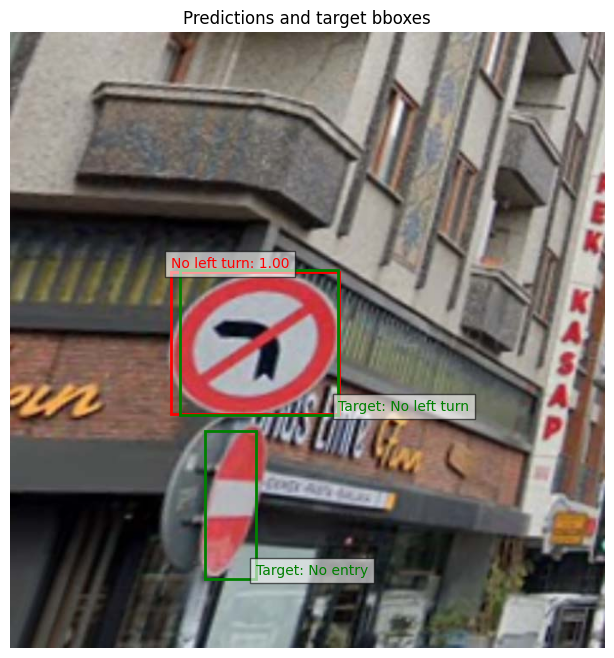

Image 1:
Predicted Boxes: [[187.11029 280.40012 384.06784 445.783  ]]
Predicted Labels: [15]
Predicted Scores: [0.9987287]
Target Boxes: [[198.075 277.56  382.945 446.76 ]
 [227.265 466.2   287.035 638.28 ]]
Target Labels: [15  5]


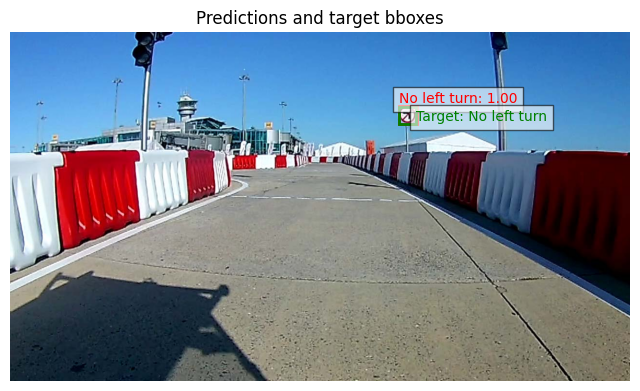

Image 2:
Predicted Boxes: [[802.06573 151.1005  839.0618  188.92   ]]
Predicted Labels: [15]
Predicted Scores: [0.9988361]
Target Boxes: [[803.2  153.   837.76 188.28]]
Target Labels: [15]


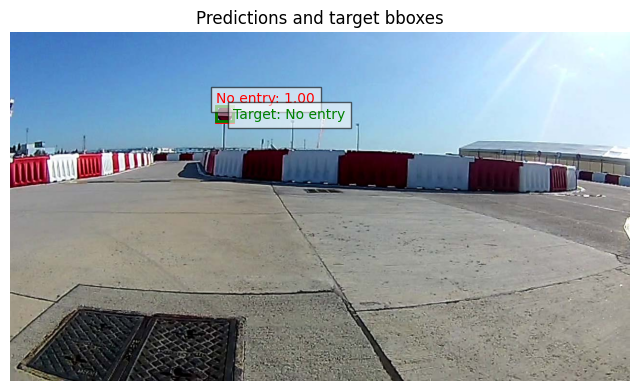

Image 3:
Predicted Boxes: [[425.39932 150.78296 460.5043  185.44571]]
Predicted Labels: [5]
Predicted Scores: [0.99954337]
Target Boxes: [[424.96 151.92 460.8  183.6 ]]
Target Labels: [5]


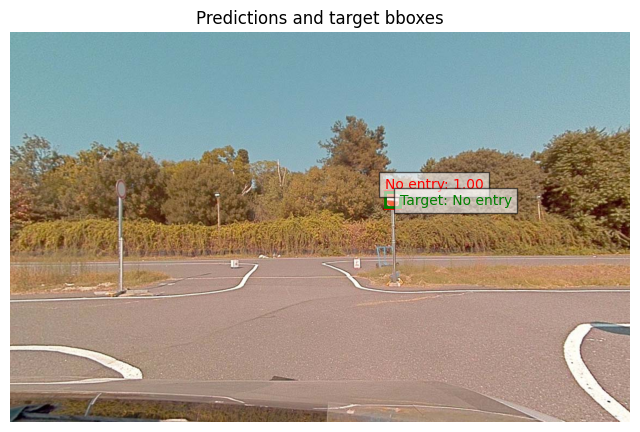

Image 4:
Predicted Boxes: [[691.2181  292.9397  719.16034 325.08392]]
Predicted Labels: [5]
Predicted Scores: [0.99778736]
Target Boxes: [[690.976 294.84  718.432 322.92 ]]
Target Labels: [5]


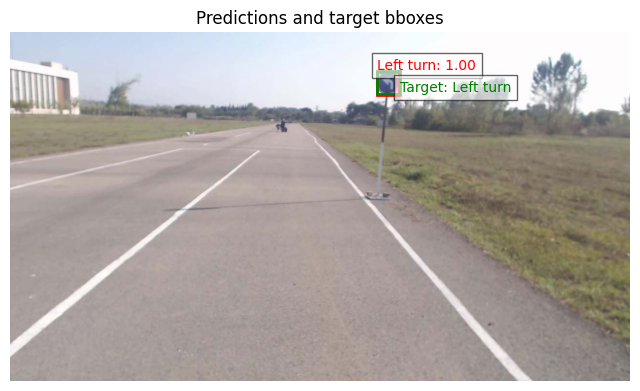

Image 1:
Predicted Boxes: [[757.7714    81.755104 802.46466  128.13988 ]]
Predicted Labels: [14]
Predicted Scores: [0.9963231]
Target Boxes: [[757.12  80.28 804.48 127.08]]
Target Labels: [14]


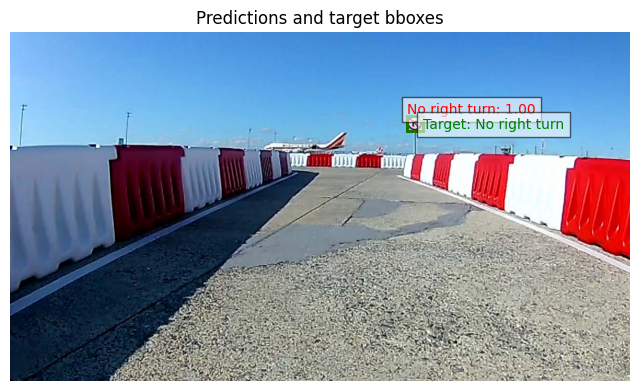

Image 2:
Predicted Boxes: [[819.48047 172.12982 852.0217  203.68413]]
Predicted Labels: [12]
Predicted Scores: [0.9983209]
Target Boxes: [[819.84 172.08 851.84 203.76]]
Target Labels: [12]


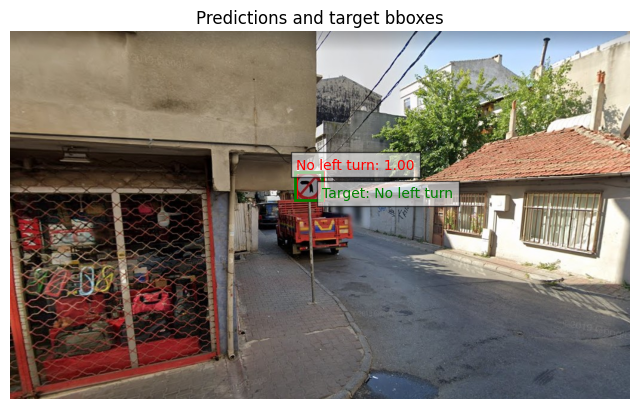

Image 3:
Predicted Boxes: [[479.06375 234.42168 523.6648  282.03693]]
Predicted Labels: [15]
Predicted Scores: [0.9993437]
Target Boxes: [[476.901 235.312 522.617 282.128]]
Target Labels: [15]


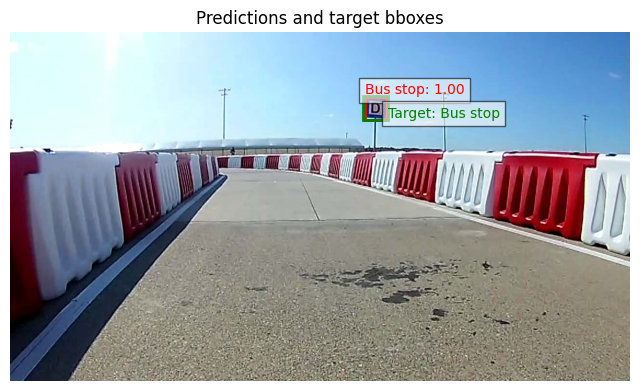

Image 4:
Predicted Boxes: [[731.6469  132.84367 777.3347  179.7704 ]]
Predicted Labels: [4]
Predicted Scores: [0.99917775]
Target Boxes: [[728.96 131.76 778.88 180.72]]
Target Labels: [4]


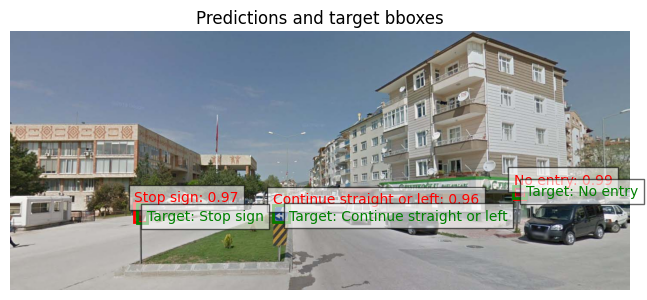

Image 1:
Predicted Boxes: [[1168.7286   358.32733 1194.9895   387.46564]
 [ 287.94714  398.47815  318.2333   441.35123]
 [ 609.61365  403.1831   646.1373   440.92297]]
Predicted Labels: [5 3 7]
Predicted Scores: [0.9922504 0.9687091 0.9610832]
Target Boxes: [[ 293.556   400.2     316.58    443.4   ]
 [ 610.136   401.1     647.55    441.3   ]
 [1166.3094  357.9    1196.5284  384.9   ]]
Target Labels: [3 7 5]


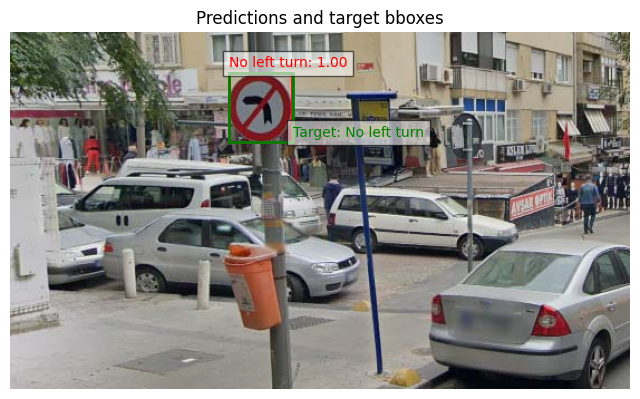

Image 2:
Predicted Boxes: [[195.9044   35.89465 252.70297  97.96054]]
Predicted Labels: [15]
Predicted Scores: [0.9991636]
Target Boxes: [[195.99   35.84  253.258  97.92 ]]
Target Labels: [15]


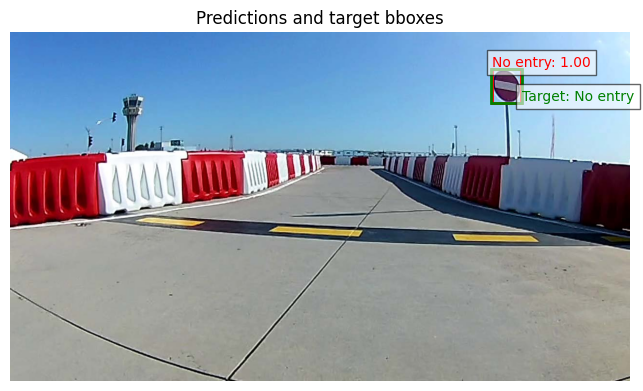

Image 3:
Predicted Boxes: [[ 994.8856    75.6123  1054.8207   145.46315]]
Predicted Labels: [5]
Predicted Scores: [0.9998853]
Target Boxes: [[ 992.     74.52 1056.    145.8 ]]
Target Labels: [5]


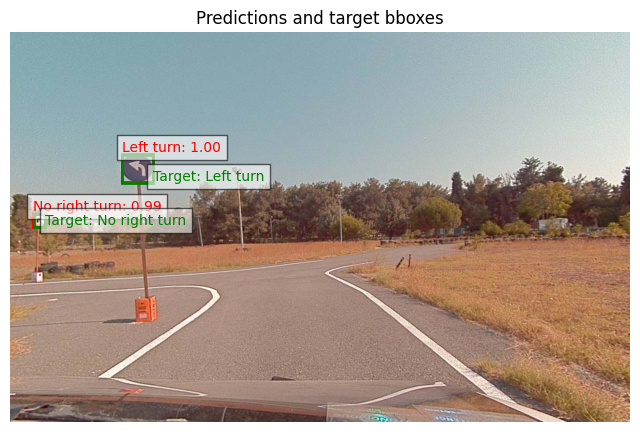

Image 4:
Predicted Boxes: [[206.47044  225.6297   264.04532  277.51318 ]
 [ 41.820595 335.01575   64.00891  359.09326 ]]
Predicted Labels: [14 12]
Predicted Scores: [0.9973404 0.9922936]
Target Boxes: [[ 42.9   335.16   64.636 360.36 ]
 [205.92  227.16  263.12  278.28 ]]
Target Labels: [12 14]


{'classification_accuracy': 0.9528832630098453,
 'mean_iou': 0.8411094170427658,
 'mean average precision': {'map': tensor(0.6590),
  'map_50': tensor(0.8944),
  'map_75': tensor(0.7902),
  'map_small': tensor(0.4919),
  'map_medium': tensor(0.7389),
  'map_large': tensor(0.8406),
  'mar_1': tensor(0.6635),
  'mar_10': tensor(0.7034),
  'mar_100': tensor(0.7034),
  'mar_small': tensor(0.5407),
  'mar_medium': tensor(0.7830),
  'mar_large': tensor(0.8684),
  'map_per_class': tensor(-1.),
  'mar_100_per_class': tensor(-1.),
  'classes': tensor([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16],
         dtype=torch.int32)}}

In [143]:
# loading the model without weights
inference_model = fasterrcnn_mobilenet_v3_large_fpn(weights=None, 
                                          num_classes=17,
                                          box_score_thresh=0.7)

inference_model.load_state_dict(torch.load("./final-turkish-traffic-sign-object-detection-modeldir/final-turkish-traffic-sign-object-detection-model-fasterrcnn_epoch_10.pth"))

device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")
inference_model.to(device)

evaluate_three(inference_model, test_dataloader)
evaluate_all(inference_model, test_dataloader)


